In [1]:
# in this notebook, I will try to fit a model relating the mean behavior of L4, L2/3, SST and VIP cells

In [ ]:
# load the data

In [1]:
import pyute as ut
import autograd.numpy as np
import matplotlib.pyplot as plt
import sklearn
import h5py
import pdb
import scipy.optimize as sop
from autograd import elementwise_grad as egrad
from mpl_toolkits.mplot3d import Axes3D
import sklearn.discriminant_analysis as skd
import autograd.scipy.special as ssp
from autograd import jacobian
import size_contrast_analysis as sca
import scipy.stats as sst
import utils
%matplotlib notebook

/home/mossing/Documents/code/downloads/OASIS/oasis/functions.py:13: UserWarning: Could not find cvxpy. Don't worry, you can still use OASIS, just not the slower interior point methods we compared to in the papers.
  warn("Could not find cvxpy. Don't worry, you can still use OASIS, " +


In [22]:
#     def compute_tuning(dsfile):
#         with h5py.File(dsfile,mode='r') as f:
#             keylist = [key for key in f.keys()]
#             tuning = [None for i in range(len(keylist))]
#             uparam = [None for i in range(len(keylist))]
#             displacement = [None for i in range(len(keylist))]
#             pval = [None for i in range(len(keylist))]
#             for ikey in range(len(keylist)):
# #             try:
#                 session = f[keylist[ikey]]
#                 print(session)
#                 print([key for key in session.keys()])
#                 if 'size_contrast_0' in session:
#                     sc0 = session['size_contrast_0']
#                     data = sc0['decon'][:]
#                     stim_id = sc0['stimulus_id'][:]
#                     nbefore = sc0['nbefore'][()]
#                     nafter = sc0['nafter'][()]
#                     trialrun = sc0['running_speed_cm_s'][:,nbefore:-nafter].mean(-1)>10 #
#                     print(sc0['running_speed_cm_s'].shape)
#                     print(np.nanmean(trialrun))
#                     if np.nanmean(trialrun)>0.4:
#                         tuning[ikey] = ut.compute_tuning(data,stim_id,trial_criteria=trialrun)[:]
#                     for param in sc0['stimulus_parameters']:
#                         uparam[ikey] = sc0[param][:]
#                     if 'rf_displacement_deg' in sc0:
#                         pval[ikey] = sc0['rf_mapping_pval'][:]
#                         X = session['cell_center'][:]
#                         y = sc0['rf_displacement_deg'][:].T
#                         lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))
#                         linreg = sklearn.linear_model.LinearRegression().fit(X[lkat],y[lkat])
#                         displacement[ikey] = np.zeros_like(y)
#                         displacement[ikey][~np.isnan(X[:,0])] = linreg.predict(X[~np.isnan(X[:,0])])
# #                     elif 'rf_ctr' in sc0:
# #                         displacement[ikey] = sc0['rf_ctr'][:]
#     #             except:
#     #                 print('could not do '+keylist[ikey])
#         return tuning,uparam,displacement,pval

In [ ]:
# dsbase = '/home/mossing/Documents/notebooks/shared_data/'
# dsnames = [dsbase+x+'_data_struct.hdf5' for x in ['pyr_l4','pyr_l23','sst_l23','vip_l23']]
# tunings = []
# uparams = []
# displacements = []
# pvals = []
# for dsname in dsnames:
#     print(dsname)
#     this_tuning,this_uparam,this_displacement,this_pval = compute_tuning(dsname)
#     tunings.append(this_tuning)
#     uparams.append(this_uparam)
#     displacements.append(this_displacement)
#     pvals.append(this_pval)

/home/mossing/Documents/notebooks/shared_data/pyr_l4_data_struct.hdf5
<HDF5 group "/session_181127_M10073" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1400, 31)
0.1742857142857143
<HDF5 group "/session_190202_M10075" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1440, 47)
0.39652777777777776
<HDF5 group "/session_190304_M10077" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in less
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in less


(1440, 47)
0.44027777777777777


/home/mossing/Documents/code/adesnal/pyute.py:962: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(data[cell_criteria][:,these_trials],1)


<HDF5 group "/session_190607_M10443" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1440, 47)
0.8590277777777777


/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: invalid value encountered in less


<HDF5 group "/session_190620_M10616" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(2016, 47)
0.4568452380952381


/home/mossing/Documents/code/adesnal/pyute.py:962: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(data[cell_criteria][:,these_trials],1)


In [23]:
# def average_up(arr):
#     return np.nanmean(np.nanmean(arr[:,:,:,:,8:-8],-1),-1) #.reshape((arr.shape[0],-1))

In [24]:
# def columnize(arr):
#     output = np.nanmean(arr,0).flatten()
#     output = output/output.max()
#     return output

In [25]:
# def include_aligned(displacement,dcutoff,pval,pcutoff=0.05,less=True):
#     if less:
#         criterion = lambda x: (x**2).sum(0) < dcutoff**2
#     else:
#         criterion = lambda x: (x**2).sum(0) > dcutoff**2
#     return np.logical_and(criterion(displacement),pval < pcutoff)

In [ ]:
# dcutoff = 5
# selection = [None, None, None, [1,2,3,4,5,9]]
# rs = []
# for icelltype in range(len(tunings)):
#     these_tunings = tunings[icelltype]
#     these_displacements = displacements[icelltype]
#     these_pvals = pvals[icelltype]
#     if not selection[icelltype] is None:
#         sel = selection[icelltype]
#     else:
#         sel = np.arange(len(these_tunings))
#     these_displacements = [these_displacements[i].T for i in sel if not these_tunings[i] is None]
#     these_pvals = [these_pvals[i] for i in sel if not these_tunings[i] is None]
#     these_tunings = [these_tunings[i] for i in sel if not these_tunings[i] is None]
#     aligned = [include_aligned(d,dcutoff,p,0.05,less=True) for d,p in zip(these_displacements,these_pvals)]
#     misaligned = [include_aligned(d,dcutoff,p,0.05,less=False) for d,p in zip(these_displacements,these_pvals)]
#     raligned = average_up(np.concatenate([x[aligned[i]][:,:5,[0,-5,-4,-3,-2,-1]] for i,x in enumerate(these_tunings)],axis=0))
#     rmisaligned = average_up(np.concatenate([x[misaligned[i]][:,:5,[0,-5,-4,-3,-2,-1]] for i,x in enumerate(these_tunings)],axis=0))
#     rs.append([raligned,rmisaligned])

In [2]:
rs = utils.gen_rs()

/home/mossing/Documents/notebooks/shared_data/pyr_l4_data_struct.hdf5
<HDF5 group "/session_181127_M10073" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1400, 31)
0.1742857142857143
<HDF5 group "/session_190202_M10075" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


(1440, 47)
0.39652777777777776
<HDF5 group "/session_190304_M10077" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


(1440, 47)
0.44027777777777777


/home/mossing/Documents/code/adesnal/pyute.py:962: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(data[cell_criteria][:,these_trials],1)


<HDF5 group "/session_190607_M10443" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1440, 47)
0.8590277777777777


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


<HDF5 group "/session_190620_M10616" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(2016, 47)
0.4568452380952381


/home/mossing/Documents/code/adesnal/pyute.py:962: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(data[cell_criteria][:,these_trials],1)


<HDF5 group "/session_190620_M10619" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(2016, 47)
0.3993055555555556
<HDF5 group "/session_190624_M10615" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


(2016, 47)
0.9176587301587301


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


<HDF5 group "/session_190627_M10616" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(2016, 47)
0.2123015873015873
/home/mossing/Documents/notebooks/shared_data/pyr_l23_data_struct.hdf5
<HDF5 group "/session_181205_M10130" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1400, 31)
0.26785714285714285
<HDF5 group "/session_181209_M8536" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1400, 31)
0.1692857142857143
<HDF5 group "/session_181213_M8536" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


(1400, 47)
0.9614285714285714
<HDF5 group "/session_181214_M10130" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1400, 47)
0.5857142857142857


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


<HDF5 group "/session_190102_M10130" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(2400, 47)
0.5508333333333333
<HDF5 group "/session_190128_M8982" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1440, 47)
0.05277777777777778
<HDF5 group "/session_190130_M9667" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


(1440, 47)
0.8097222222222222


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


<HDF5 group "/session_190131_M9355" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1440, 47)
0.06597222222222222
<HDF5 group "/session_190208_M9355" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


(1440, 47)
0.049305555555555554
<HDF5 group "/session_190212_M8536" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


(1440, 47)
0.7534722222222222


/home/mossing/Documents/code/adesnal/pyute.py:962: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(data[cell_criteria][:,these_trials],1)


/home/mossing/Documents/notebooks/shared_data/sst_l23_data_struct.hdf5
<HDF5 group "/session_180713_M9053" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.8091666666666667
<HDF5 group "/session_180714_M9053" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.8441666666666666


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


<HDF5 group "/session_180802_M9053" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.5083333333333333


/home/mossing/Documents/code/adesnal/pyute.py:962: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(data[cell_criteria][:,these_trials],1)


<HDF5 group "/session_180821_M9417" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.1475
<HDF5 group "/session_181117_M10039" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1400, 31)
0.21071428571428572
<HDF5 group "/session_181120_M10039" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1400, 31)
0.14285714285714285
<HDF5 group "/session_181121_M10039" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1400, 31)
0.06142857142857143


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


/home/mossing/Documents/notebooks/shared_data/vip_l23_data_struct.hdf5
<HDF5 group "/session_180321_M7955" (7 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0']
<HDF5 group "/session_180412_M7955" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1000, 31)
0.989


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))


<HDF5 group "/session_180516_M8956" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.725
<HDF5 group "/session_180519_M8959" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.9425
<HDF5 group "/session_180528_M8959" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.6616666666666666


/home/mossing/Documents/code/adesnal/pyute.py:962: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(data[cell_criteria][:,these_trials],1)


<HDF5 group "/session_180531_M8961" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.6375


/home/mossing/Documents/code/adesnal/pyute.py:962: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(data[cell_criteria][:,these_trials],1)


<HDF5 group "/session_180618_M8956" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(720, 31)
0.9958333333333333
<HDF5 group "/session_180719_M8961" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.009166666666666667
<HDF5 group "/session_180720_M8961" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.04583333333333333
<HDF5 group "/session_180903_M8961" (8 members)>
['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'mouse_id', 'retinotopy_0', 'size_contrast_0']
(1200, 31)
0.8341666666666666


/home/mossing/Documents/notebooks/simulation/utils.py:46: RuntimeWarning: invalid value encountered in less
  lkat = ut.k_and(pval[ikey]<0.05,~np.isnan(X[:,0]),~np.isnan(y[:,0]))
/home/mossing/Documents/notebooks/simulation/utils.py:92: RuntimeWarning: invalid value encountered in less
  return np.logical_and(criterion(displacement),pval < pcutoff)
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


In [ ]:
plt.figure()
# take away contrast-suppressed SST cells
for ialign in range(2):
    temp = rs[2][ialign].reshape((-1,5,6))
    rs[2][ialign] = rs[2][ialign][temp[:,:,0].mean(1)<temp[:,:,-1].mean(1)]
    ut.imshow_in_rows(rs[2][ialign].reshape((-1,5,6)))
# plt.imshow(Rs[2][0][0].reshape((5,6)))

In [ ]:
def sum_to_1(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nansum(R,axis=1)[:,np.newaxis]
    return R
Rs = [[None,None] for i in range(len(rs))]
for iR,r in enumerate(rs):
    for ialign in range(2):
        Rs[iR][ialign] = sum_to_1(r[ialign])

In [ ]:
j = 0
u,s,v = np.linalg.svd(Rs[j][0][~np.isnan(Rs[j][0][:,0])])
diaged = Rs[j][0] @ v.T
fig = plt.figure()
ax = fig.gca(projection='3d')
ax.scatter(diaged[:,0],diaged[:,1],diaged[:,2],alpha=50/diaged.shape[0])
# plt.xlim(-1,1)
# plt.ylim(-1,1)

In [ ]:
ucontrast = [str(c) for c in np.array((0,6,12,25,50,100))]
usize = [str(s) for s in (5,8,13,22,36)]
celltypes = ['L4 PC', 'L2/3 PC', 'SST', 'VIP']
# aligntypes = ['RF distance <10$^o$']
saveas = ['figures/four_cell_types_aligned.pdf','figures/four_cell_types_misaligned.pdf']
for ialign in range(2):
    plt.figure(figsize=(8,2))
    for icelltype in range(len(celltypes)):
        plt.subplot(1,4,icelltype+1)
        sca.show_size_contrast(rs[icelltype][ialign].mean(0))
        plt.title(celltypes[icelltype])
    plt.tight_layout()
    #plt.savefig(saveas[ialign])

In [6]:
colors_l4 = [(1-c)*np.array((0,1,0)) for c in 0.167*np.arange(1,6)]
colors_l23 = [(1-c)*np.array((1,1,1)) for c in 0.167*np.arange(1,6)] #[0.25,0.5,0.75]]
colors = [colors_l4,colors_l23]

In [ ]:
# def gen_size_tuning(sc):
#     gray = np.tile(sc[:,:,0].mean(1)[:,np.newaxis,np.newaxis],(1,1,sc.shape[2]))
#     to_plot = np.concatenate((gray,sc),axis=1)
#     print(to_plot.shape)
#     return to_plot

# def plot_size_tuning_by_contrast(arr):
#     usize = np.array((0,5,8,13,22,36))
#     ucontrast = np.array((0,6,12,25,50,100))
#     arr_sz = gen_size_tuning(arr)
#     arr_sz = arr_sz/arr_sz.max(1).max(1)[:,np.newaxis,np.newaxis]
#     lb,ub = ut.bootstrap(arr_sz,np.mean,pct=(2.5,97.5))
#     to_plot = arr_sz.mean(0)
#     for ic in range(1,6):
#         plt.subplot(1,5,ic)
#         ut.plot_bootstrapped_errorbars_hillel(usize,arr_sz[:,:,ic].transpose((0,2,1)),colors=['k','r'],markersize=5)
# #         plt.scatter((0,),to_plot[:,0,0].mean(0))
# #         plt.scatter((0,),to_plot[:,0,1].mean(0))
#         plt.ylim(0.5*to_plot.min(),1.2*to_plot.max())
#         plt.title('%d%% contrast' % ucontrast[ic])
#         plt.xlabel('size ($^o$)')
#     plt.subplot(1,5,1)
#     plt.ylabel('event rate / max event rate')
#     plt.tight_layout()
    
# def plot_size_tuning(arr,colors=None):
#     usize = np.array((0,5,8,13,22,36))
#     ucontrast = np.array((0,6,12,25,50,100))
#     arr_sz = gen_size_tuning(arr)
#     arr_sz = arr_sz/arr_sz.max(1).max(1)[:,np.newaxis,np.newaxis]
#     lb,ub = ut.bootstrap(arr_sz,np.mean,pct=(2.5,97.5))
#     to_plot = arr_sz.mean(0)
#     ut.plot_bootstrapped_errorbars_hillel(usize,arr_sz[:,:,1::].transpose((0,2,1)),colors=colors)
#     plt.ylim(to_plot.min()-0.1,to_plot.max()+0.1)
# #     plt.title('%d%% contrast' % ucontrast[ic])
#     plt.xlabel('size ($^o$)')
# #     plt.subplot(1,2,1)
    
#     plt.tight_layout()
    
# def plot_size_tuning_peak_norm(arr,colors=None):
#     usize = np.array((0,5,8,13,22,36))
#     ucontrast = np.array((0,6,12,25,50,100))
#     arr_sz = gen_size_tuning(arr)
#     mx = arr_sz.max(1)[:,np.newaxis]
#     mn = arr_sz.min(1)[:,np.newaxis]
#     mn = 0
#     arr_sz = (arr_sz-mn)/(mx-mn)
#     lb,ub = ut.bootstrap(arr_sz,np.mean,pct=(2.5,97.5))
#     to_plot = arr_sz.mean(0)
#     ut.plot_bootstrapped_errorbars_hillel(usize,arr_sz[:,:,1::2].transpose((0,2,1)),colors=colors[::2])
#     plt.ylim(to_plot.min()-0.1,to_plot.max()+0.1)
# #     plt.title('%d%% contrast' % ucontrast[ic])
#     plt.xlabel('size ($^o$)')
#     plt.tight_layout()

In [4]:
from importlib import reload
reload(utils)

<module 'utils' from '/home/mossing/Documents/notebooks/simulation/utils.py'>

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

111
(111, 6, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

123
(123, 6, 6)
176
(176, 6, 6)
55
(55, 6, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

47
(47, 6, 6)
102
(102, 6, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

229
(229, 6, 6)
165
(165, 6, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

113
(113, 6, 6)
125
(125, 6, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


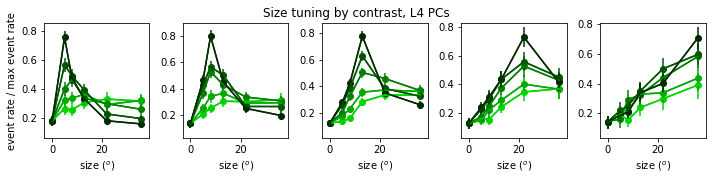

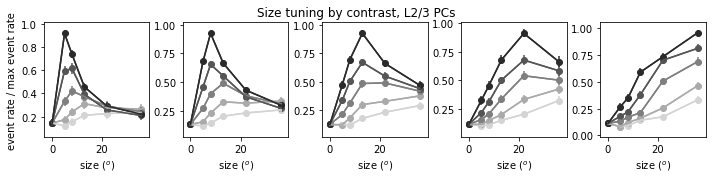

In [7]:
from importlib import reload
reload(ut)
ialign = 0
foldname = 'figures/'
filenames = ['size_tuning_3_contrasts_by_pref_size_l4.pdf','size_tuning_3_contrasts_by_pref_size_l23.pdf']
titles = ['Size tuning by contrast, L4 PCs','Size tuning by contrast, L2/3 PCs']
for icelltype in range(2):
    plt.figure(figsize=(10,2.5))#figsize=(10,2))
    pref_size = np.argmax(rs[icelltype][ialign][:,:,-1],axis=-1)
    
    for isize in range(5):
        print((pref_size==isize).sum())
        plt.subplot(1,5,isize+1)
#     ut.plot_bootstrapped_errorbars_hillel(usize,rs[icelltype][ialign][:,:,1::2].transpose((0,2,1)),colors=colors[icelltype])
        utils.plot_size_tuning(rs[icelltype][ialign][pref_size==isize],colors=colors[icelltype])
#         plt.legend(['6%','25%','100%'])
    plt.suptitle(titles[icelltype])
    plt.subplot(1,5,1)
    plt.ylabel('event rate / max event rate')
    plt.tight_layout()
#     plt.savefig(foldname+filenames[icelltype])

In [ ]:
rs[icelltype][ialign][np.arange(pref_size.size),pref_size].shape

In [ ]:
from importlib import reload
reload(ut)
ialign = 0
foldname = 'figures/'
filenames = ['size_tuning_3_contrasts_by_pref_size_norm_to_1_l4.pdf','size_tuning_3_contrasts_by_pref_size_norm_to_1_l23.pdf']
titles = ['Size tuning by contrast, L4 PCs','Size tuning by contrast, L2/3 PCs']
for icelltype in range(2):
    plt.figure(figsize=(10,2.5))#figsize=(10,2))
    pref_contrast = np.argmax(np.max(rs[icelltype][ialign],axis=1),axis=-1)
    pref_size = np.argmax(rs[icelltype][ialign][:,:,-1],axis=-1)
#     pref_contrast = np.argmax(rs[icelltype][ialign][np.arange(pref_size.size),pref_size],axis=-1)
    for isize in range(5):
        plt.subplot(1,5,isize+1)
#     ut.plot_bootstrapped_errorbars_hillel(usize,rs[icelltype][ialign][:,:,1::2].transpose((0,2,1)),colors=colors[icelltype])
        plot_size_tuning(rs[icelltype][ialign][(pref_size==isize) & (pref_contrast==5)],colors=colors[icelltype])
#         plt.legend(['6%','25%','100%'])
    plt.suptitle(titles[icelltype])
    plt.subplot(1,5,1)
    plt.ylabel('event rate / max event rate')
    plt.tight_layout()
#     plt.savefig(foldname+filenames[icelltype])

In [ ]:
from importlib import reload
reload(ut)
ialign = 0
foldname = 'figures/'
filenames = ['size_tuning_3_contrasts_by_pref_size_all_norm_to_1_%d.pdf' % isize for isize in range(5)]
titles = ['Size tuning by contrast, L4 PCs','Size tuning by contrast, L2/3 PCs']
for isize in range(5):
    plt.figure(figsize=(8,4))#figsize=(10,2))
#     pref_contrast = np.argmax(rs[icelltype][ialign][np.arange(pref_size.size),pref_size],axis=-1)
    for icelltype in range(2):
        pref_contrast = np.argmax(np.max(rs[icelltype][ialign],axis=1),axis=-1)
        pref_size = np.argmax(rs[icelltype][ialign][:,:,-1],axis=-1)
        plt.subplot(1,2,icelltype+1)
#     ut.plot_bootstrapped_errorbars_hillel(usize,rs[icelltype][ialign][:,:,1::2].transpose((0,2,1)),colors=colors[icelltype])
        plot_size_tuning_peak_norm(rs[icelltype][ialign][(pref_size==isize) & (pref_contrast==5)],colors=colors[icelltype])
        plt.legend(['6%','25%','100%'])
        plt.title(titles[icelltype])
#     plt.suptitle(titles[icelltype])
    plt.subplot(1,2,1)
    plt.ylabel('event rate / max event rate')
    plt.tight_layout()
#     plt.savefig(foldname+filenames[isize])

<IPython.core.display.Javascript object>


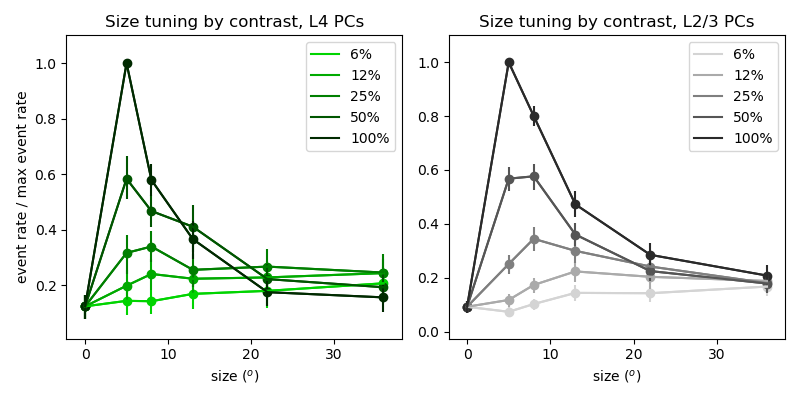

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

(39, 6, 6)
(69, 6, 6)


/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


<IPython.core.display.Javascript object>


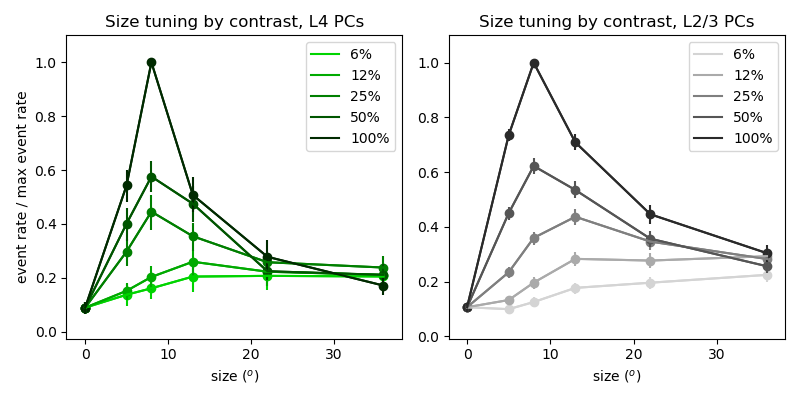

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

(52, 6, 6)
(165, 6, 6)


<IPython.core.display.Javascript object>


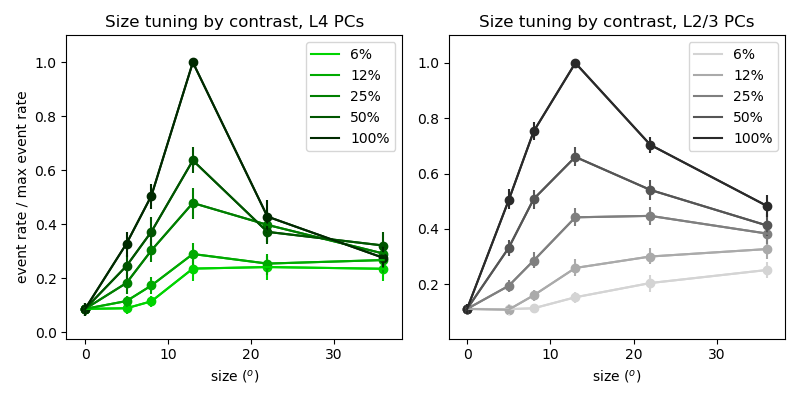

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

(70, 6, 6)
(117, 6, 6)


<IPython.core.display.Javascript object>


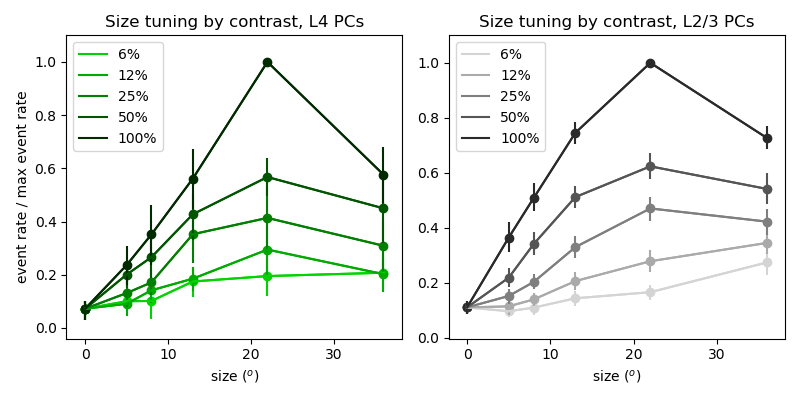

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

(19, 6, 6)
(72, 6, 6)


<IPython.core.display.Javascript object>


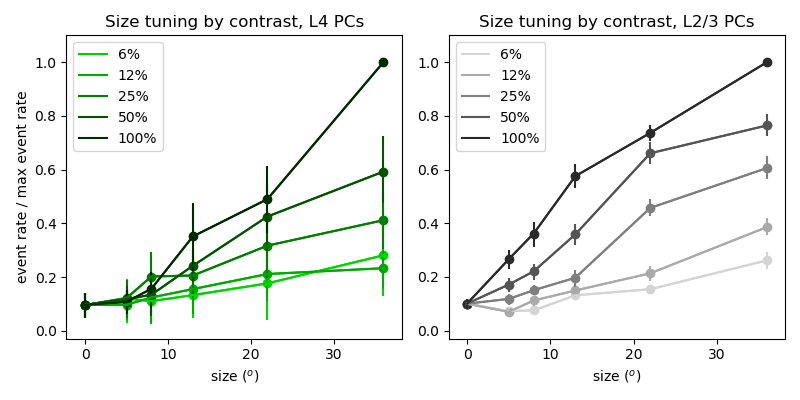

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

(14, 6, 6)
(84, 6, 6)


In [39]:
from importlib import reload
reload(ut)
ialign = 0
foldname = 'figures/'
filenames = ['size_tuning_3_contrasts_by_pref_size_norm_to_1_%d.pdf' % isize for isize in range(5)]
titles = ['Size tuning by contrast, L4 PCs','Size tuning by contrast, L2/3 PCs']
for isize in range(5):
    plt.figure(figsize=(8,4))#figsize=(10,2))
#     pref_contrast = np.argmax(rs[icelltype][ialign][np.arange(pref_size.size),pref_size],axis=-1)
    for icelltype in range(2):
        pref_contrast = np.argmax(np.max(rs[icelltype][ialign],axis=1),axis=-1)
        pref_size = np.argmax(rs[icelltype][ialign][:,:,-1],axis=-1)
        plt.subplot(1,2,icelltype+1)
#     ut.plot_bootstrapped_errorbars_hillel(usize,rs[icelltype][ialign][:,:,1::2].transpose((0,2,1)),colors=colors[icelltype])
        plot_size_tuning(rs[icelltype][ialign][(pref_size==isize) & (pref_contrast==5)],colors=colors[icelltype])
        plt.legend(['6%','12%','25%','50%','100%'])
        plt.title(titles[icelltype])
#     plt.suptitle(titles[icelltype])
    plt.subplot(1,2,1)
    plt.ylabel('event rate / max event rate')
    plt.tight_layout()
#     plt.savefig(foldname+filenames[isize])

In [ ]:
    for ikey in range(len(keylist)):
        try:
            X = ds[keylist[ikey]]['cell_center'][:]
            y = ds[keylist[ikey]]['size_contrast_0']['rf_ctr'][:].T
            linreg = sklearn.linear_model.LinearRegression().fit(X,y)
            ypred = linreg.predict(X)
            x0 = -np.linalg.pinv(linreg.coef_) @ linreg.intercept_
            print(x0)
            plt.figure()
            for i in range(2):
                for j in range(2):
                    plt.subplot(2,2,2*i+j+1)
                    plt.scatter(X[:,i],y[:,j],s=5)
            for i in range(2):
                plt.subplot(2,2,i+1)
                plt.scatter(X[:,1],X[:,0],c=y[:,i],s=15)
                plt.colorbar()
                plt.subplot(2,2,i+3)
                plt.scatter(X[:,1],X[:,0],c=ypred[:,i],s=15)
                plt.clim(vmin=-20,vmax=20)
                plt.colorbar()
                plt.scatter(x0[1],x0[0],c='r',marker='+')
                    
        except:
            print('could not do ' + keylist[ikey])

In [ ]:
# plt.figure()
# ut.imshow_in_rows(rs[0][0])
# plt.figure()
# ut.imshow_in_rows(rs[0][1])

<IPython.core.display.Javascript object>


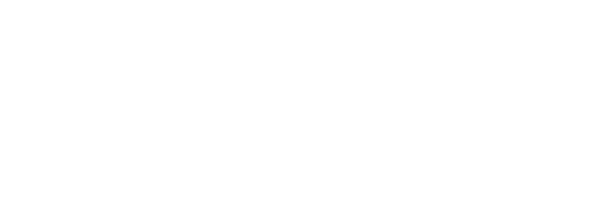

NameError: name 'Wstar_dict' is not defined

In [40]:
titles = ['PC','SST','VIP']
t = 1500
plt.figure(figsize=(6,2))
lbl = 'Wmx'
data = Wstar_dict[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])
# plt.savefig('figures/ff_weights.pdf')
plt.figure(figsize=(9,2))
lbl = 'Wmy'
data = Wstar_dict[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])


In [ ]:
# plt.figure()
# ut.imshow_in_rows(rs[1][0])
# plt.figure()
# ut.imshow_in_rows(rs[1][1])

In [41]:
def f_miller_troyer(mu,s2):
    u = mu/np.sqrt(2*s2)
    A = 0.5*mu*(1+ssp.erf(u))
    B = np.sqrt(s2)/np.sqrt(2*np.pi)*np.exp(-u**2)
    return A + B
#     return 0.5*mu*(1+np.exp(u)) + sigma/np.sqrt(2*np.pi)*np.exp(-u**2) # 0.5*mu*(1+ssp.erf(u))

In [42]:
def fit_w(X,y,rate_fn,wm0=None,ws0=None,bounds=None):
    # X is (N,P), y is (N,). Finds w: (P,) weight matrix to explain y as y = f(X(wm),X(ws))
    # f is a static nonlinearity, given as a function of mean and std. of noise
    N,P = X.shape
    def parse_w(w):
        wm = w[:P]
        ws = w[P:]
#         return wm,ws,k
        return wm,ws
    def minusL(w):
#         wm,ws,k = parse_w(w)
        wm,ws = parse_w(w)
        return 0.5*np.sum((rate_fn(X @ wm,X @ ws)-y)**2) # k*
    def minusdLdw(w): 
        # sum in first dimension: (N,1) times (N,1) times (N,P)
        return egrad(minusL)(w)
    
    w0 = np.concatenate((wm0,ws0)) #,(k0,)))
    
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    wstar = sop.fmin_l_bfgs_b(minusL,w0,fprime=minusdLdw,bounds=bounds,pgtol=pgtol,factr=factr,epsilon=epsilon)
    
    return wstar

In [43]:
def u_fn(X,Wx,Y,Wy,k):
    return X[0] @ Wx + X[1] @ (Wx*k) + Y[0] @ Wy + Y[1] @ (Wy*k)

def evaluate_f_mt(X,Ws,offset,k):
    # Ws: Wx,Wy,s02,Y
    return f_miller_troyer(u_fn(X,Ws[0],Ws[3],Ws[1],k)+offset,Ws[2])

In [44]:
Wstar_dict = np.load('w_over_time_miller_troyer_3.npy',allow_pickle=True)[()]
Ws = [Wstar_dict[ww][-1] for ww in Wstar_dict.keys()]

In [45]:
def fit_w_data_loss(X,ydata,rate_fn,wm0=None,ws0=None,s020=None,k0=None,bounds=None,niter=int(1e4)):
    # X is (N,P), y is (N,). Finds w: (P,) weight matrix to explain y as y = f(X(wm),X(ws))
    # f is a static nonlinearity, given as a function of mean and std. of noise
    N,P = X[0].shape
    abd = 1

    nroi = ydata.shape[0]
    alpha_roi = sst.norm.ppf(np.arange(1,nroi+1)/(nroi+1))
    
    def sort_by_11(w):
        yalpha11 = rate_fn_wrapper(w,np.array((-abd,abd)))
        difference11 = compute_y_distance(yalpha11[np.newaxis,:,:],ydata[:,np.newaxis,:])
        sortby11 = np.argsort(difference11[:,0]-difference11[:,-1])
        return sortby11
    
    def compute_y_distance(y1,y2):
        return np.sum((y1-y2)**2,axis=-1)
    
    def compare_sorted_to_expected(w,sortind):
       
        yalpha_roi = rate_fn_wrapper(w,alpha_roi)
#         print(yalpha_roi.max())
        difference_roi = compute_y_distance(yalpha_roi,ydata[sortind])
        difference_roi_unsorted = compute_y_distance(yalpha_roi,ydata)
#         print(difference_roi.shape)
        return difference_roi

    def rate_fn_wrapper(w,alphas):
        wm,ws,s02,k = parse_w(w)
        inputs0 = [wm,np.array((0,)),s02,[np.array((0,)),np.array((0,))]]
        inputs1 = [X,ws,[np.array((0,)),np.array((0,))],np.array((0,))]
        yalpha = rate_fn(X,inputs0,alphas[:,np.newaxis]*u_fn(*inputs1,k),k)
        yalpha = normalize(yalpha)
        return yalpha

#     def compute_f_by_itself(w):

    def normalize(arr):
        arrsum = arr.sum(1)
#         arrnorm = np.ones_like(arr)
#         arrnorm = arrnorm/arrnorm.shape[1]
        well_behaved = (arrsum>0)[:,np.newaxis]
        arrnorm = well_behaved*arr/arrsum[:,np.newaxis] + (~well_behaved)*np.ones_like(arr)/arr.shape[1]
        return arrnorm
    
    def parse_w(w):
        wm = w[:P]
        ws = w[P:-2]
        s02 = w[-2]
        k = w[-1]
        return wm,ws,s02,k

    def minusL(w,sortind):
#         wm,ws,k = parse_w(w)
        difference_roi = compare_sorted_to_expected(w,sortind)
#         print(difference_roi.shape)
#         print(str(w) + ' -> ' + str(np.round(np.sum(difference_roi),decimals=2)))
        return 0.5*np.sum(difference_roi) # k*
    
    def minusdLdw(w,sortind): 
        # sum in first dimension: (N,1) times (N,1) times (N,P)
        return egrad(lambda w: minusL(w,sortind))(w)
    
    def fix_violations(w,bounds):
        lb = np.array([b[0] for b in bounds])
        ub = np.array([b[1] for b in bounds])
        w[w<lb] = lb[w<lb]
        w[w>ub] = ub[w>ub]
        return w
    
    w0 = np.concatenate((wm0,ws0,s020,k0)) #,(k0,)))
    
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    this_w = w0
    for i in range(niter):
        sortind = sort_by_11(this_w)
        wstar = sop.fmin_l_bfgs_b(lambda w: minusL(w,sortind),this_w,fprime=lambda w: minusdLdw(w,sortind),bounds=bounds,pgtol=pgtol,factr=factr,epsilon=epsilon,maxiter=1)
        assert(~np.isnan(wstar[1]))
        if np.isnan(wstar[1]):
            this_w = old_w
        else:
            this_w = wstar[0].copy() + np.random.randn(*this_w.shape)*0.01*np.exp(-i/niter)
            old_w = wstar[0].copy()
        this_w = fix_violations(this_w,bounds)
        print(str(i) + ': ' + str(wstar[1]))
    
    max_alpha = alpha_roi.max()
    this_yalpha = rate_fn_wrapper(this_w,np.linspace(-max_alpha,max_alpha,101))
    ydist = compute_y_distance(ydata[sortind,np.newaxis],this_yalpha[np.newaxis,:])
    
    plt.figure()
    plt.subplot(1,2,1)
    plt.imshow(ydist/ydist.max(1)[:,np.newaxis],extent=[-max_alpha,max_alpha,0,10])
    plt.plot(-alpha_roi,10*np.arange(nroi)/nroi,c='m')
    plt.subplot(2,2,2)
    plt.imshow(this_yalpha[25].reshape((5,6)))
    plt.subplot(2,2,4)
    plt.imshow(this_yalpha[75].reshape((5,6)))
#         print(wstar)
    
    return wstar

In [46]:
def fit_w_data_loss(X,ydata,rate_fn,wm0=None,ws0=None,s020=None,k0=None,bounds=None,niter=int(1e4)):
    # X is (N,P), y is (N,). Finds w: (P,) weight matrix to explain y as y = f(X(wm),X(ws))
    # f is a static nonlinearity, given as a function of mean and std. of noise
    N,P = X[0].shape
    abd = 1

    nroi = ydata.shape[0]
    alpha_roi = sst.norm.ppf(np.arange(1,nroi+1)/(nroi+1))
    
    def sort_by_11(w):
        yalpha11 = rate_fn_wrapper(w,np.array((-abd,abd)))
        difference11 = compute_y_distance(yalpha11[np.newaxis,:,:],ydata[:,np.newaxis,:])
        sortby11 = np.argsort(difference11[:,0]-difference11[:,-1])
        return sortby11
    
    def compute_y_distance(y1,y2):
        return np.sum((y1-y2)**2,axis=-1)
    
    def compare_sorted_to_expected(w,sortind):
       
        yalpha_roi = rate_fn_wrapper(w,alpha_roi)
#         print(yalpha_roi.max())
        difference_roi = compute_y_distance(yalpha_roi,ydata[sortind])
        difference_roi_unsorted = compute_y_distance(yalpha_roi,ydata)
#         print(difference_roi.shape)
        return difference_roi

    def rate_fn_wrapper(w,alphas):
        wm,ws,s02,k = parse_w(w)
        inputs0 = [wm,np.array((0,)),s02,[np.array((0,)),np.array((0,))]]
        inputs1 = [X,ws,[np.array((0,)),np.array((0,))],np.array((0,))]
        yalpha = rate_fn(X,inputs0,alphas[:,np.newaxis]*u_fn(*inputs1,k),k)
        yalpha = normalize(yalpha)
        return yalpha

#     def compute_f_by_itself(w):

    def normalize(arr):
        arrsum = arr.sum(1)
#         arrnorm = np.ones_like(arr)
#         arrnorm = arrnorm/arrnorm.shape[1]
        well_behaved = (arrsum>0)[:,np.newaxis]
        arrnorm = well_behaved*arr/arrsum[:,np.newaxis] + (~well_behaved)*np.ones_like(arr)/arr.shape[1]
        return arrnorm
    
    def parse_w(w):
        wm = w[:P]
        ws = w[P:-2]
        s02 = w[-2]
        k = w[-1]
        return wm,ws,s02,k

    def minusL(w,sortind):
#         wm,ws,k = parse_w(w)
        difference_roi = compare_sorted_to_expected(w,sortind)
#         print(difference_roi.shape)
#         print(str(w) + ' -> ' + str(np.round(np.sum(difference_roi),decimals=2)))
        return 0.5*np.sum(difference_roi) # k*
    
    def minusdLdw(w,sortind): 
        # sum in first dimension: (N,1) times (N,1) times (N,P)
        return egrad(lambda w: minusL(w,sortind))(w)
    
    def fix_violations(w,bounds):
        lb = np.array([b[0] for b in bounds])
        ub = np.array([b[1] for b in bounds])
        w[w<lb] = lb[w<lb]
        w[w>ub] = ub[w>ub]
        return w
    
    w0 = np.concatenate((wm0,ws0,s020,k0)) #,(k0,)))
    
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    this_w = w0
    for i in range(niter):
        sortind = sort_by_11(this_w)
        wstar = sop.fmin_l_bfgs_b(lambda w: minusL(w,sortind),this_w,fprime=lambda w: minusdLdw(w,sortind),bounds=bounds,pgtol=pgtol,factr=factr,epsilon=epsilon,maxiter=1)
        assert(~np.isnan(wstar[1]))
        if np.isnan(wstar[1]):
            this_w = old_w
        else:
            this_w = wstar[0].copy() + np.random.randn(*this_w.shape)*0.01*np.exp(-i/niter)
            old_w = wstar[0].copy()
        this_w = fix_violations(this_w,bounds)
        print(str(i) + ': ' + str(wstar[1]))
    
    max_alpha = alpha_roi.max()
    this_yalpha = rate_fn_wrapper(this_w,np.linspace(-max_alpha,max_alpha,101))
    ydist = compute_y_distance(ydata[sortind,np.newaxis],this_yalpha[np.newaxis,:])
    
    plt.figure()
    plt.subplot(1,2,1)
    plt.imshow(ydist/ydist.max(1)[:,np.newaxis],extent=[-max_alpha,max_alpha,0,10])
    plt.plot(-alpha_roi,10*np.arange(nroi)/nroi,c='m')
    plt.subplot(2,2,2)
    plt.imshow(this_yalpha[25].reshape((5,6)))
    plt.subplot(2,2,4)
    plt.imshow(this_yalpha[75].reshape((5,6)))
#         print(wstar)
    
    return wstar

In [47]:
Xs = []
ys_data = []
ws = []
allowable_inputs = []
yms = []
for i in range(4):
    for item in [Xs,ys_data,ws,allowable_inputs,yms]:
        item.append(None)

0: 8.657808185234366
1: 8.216343048791549
2: 8.107701440347682
3: 7.9597272317744485
4: 7.878845790338204
5: 7.786253630739822
6: 7.170084246445562
7: 6.9915848778723415
8: 6.46083614210278
9: 6.3718593510980535
10: 6.318941532059154
11: 6.282288571014732
12: 6.235930252450945
13: 6.189811452169737
14: 6.178792436440659
15: 6.150778199094026
16: 6.032432533992152
17: 5.989628798052389
18: 5.940248449795794
19: 5.8910768223421845
20: 5.882590927271664
21: 5.814823325372929
22: 5.785466191670156
23: 5.74601087068128
24: 5.453620826364065
25: 5.439861078288956
26: 5.388806932560264
27: 5.123361360671177
28: 5.056108740924806
29: 5.003452313848585
30: 4.970802907908888
31: 4.942246774019225
32: 4.909997089446401
33: 4.880564530211693
34: 4.8347650053599835
35: 4.815978158713345
36: 4.791223158866583
37: 4.764597360949875
38: 4.7226000659535785
39: 4.7003881801328475
40: 4.6826262203127005
41: 4.675336698751535
42: 4.673263825640758
43: 4.665988289792633
44: 4.660895226088918
45: 4.65136225

363: 4.405063859055053
364: 4.405381762797111
365: 4.404791148806378
366: 4.404236574244958
367: 4.405097261971431
368: 4.40619577209694
369: 4.406002912235446
370: 4.405040284682826
371: 4.403609418733523
372: 4.403703533347665
373: 4.4051359536283385
374: 4.406024930027389
375: 4.406711987147484
376: 4.406340877831436
377: 4.405713563365859
378: 4.403200538320545
379: 4.402608520222301
380: 4.402804820820097
381: 4.403249118051179
382: 4.402854000997334
383: 4.403833975151649
384: 4.403830700177423
385: 4.404257579430582
386: 4.404563012773016
387: 4.404278539855735
388: 4.40365083090324
389: 4.403578167486588
390: 4.40294372385595
391: 4.403509079231395
392: 4.403126878280586
393: 4.403844303892624
394: 4.403886087752905
395: 4.403809883494124
396: 4.403905945922886
397: 4.403163389272883
398: 4.403524082208737
399: 4.403574292100564
400: 4.403515948624349
401: 4.403743762679438
402: 4.403099163965926
403: 4.403282061497971
404: 4.401496287869247
405: 4.402791346978379
406: 4.400377

729: 4.3637002938017435
730: 4.363061478345449
731: 4.362471089867151
732: 4.361975504848646
733: 4.361687074281244
734: 4.361817011640114
735: 4.361727584557782
736: 4.361845454572984
737: 4.361637438280752
738: 4.360994367110743
739: 4.3596996592912864
740: 4.359743736929672
741: 4.359659313856165
742: 4.359539049282565
743: 4.359794343659205
744: 4.359941214880705
745: 4.359687549518052
746: 4.359573183550957
747: 4.359606382347083
748: 4.359596705922504
749: 4.3594848486289415
750: 4.35943018827103
751: 4.359807512892515
752: 4.360173568595057
753: 4.360320100379616
754: 4.360006598678986
755: 4.35970584121835
756: 4.3593067318513645
757: 4.359363732119221
758: 4.359187154480229
759: 4.359007931825305
760: 4.359002439638086
761: 4.359169914448666
762: 4.358714604129653
763: 4.358628858297908
764: 4.358112043895257
765: 4.3577226668219975
766: 4.35768458851781
767: 4.357941830638327
768: 4.357925322407855
769: 4.358546278553574
770: 4.358131808136941
771: 4.357793461180044
772: 4.35

<IPython.core.display.Javascript object>


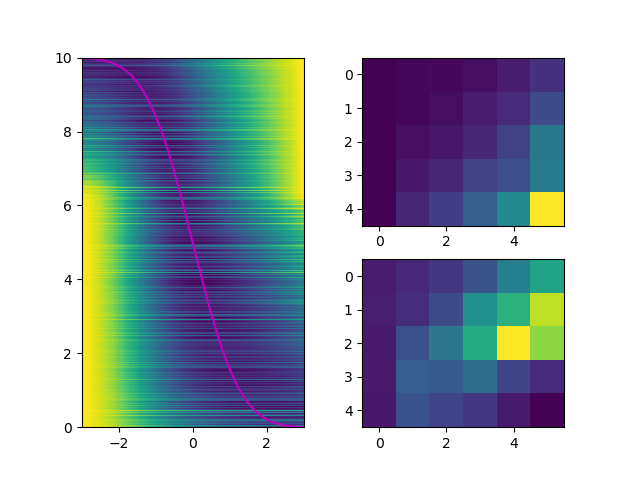

0: 3.476050496989812
1: 3.4486956077154396
2: 3.4433448047591506
3: 3.4388163469580766
4: 3.430964811746781
5: 3.4228925080092445
6: 3.412407293946902
7: 3.4024656415197287
8: 3.3875071473345213
9: 3.3700401586464617
10: 3.3395327625276283
11: 3.3043450875676315
12: 3.2366984574144753
13: 3.121614229482862
14: 2.9466695688909095
15: 2.674077865099324
16: 2.353447033665272
17: 2.16279954202492
18: 2.0961500114334397
19: 2.0408081189762055
20: 1.901687171520066
21: 1.8763520888615994
22: 1.8997189033166986
23: 1.7277458675195139
24: 1.7144579399601974
25: 1.710018978288255
26: 1.6803077492418563
27: 1.6520157559435622
28: 1.6465234989015605
29: 1.614861523007521
30: 1.596284632078803
31: 1.5616875730345263
32: 1.554800391652199
33: 1.5417881571121297
34: 1.5009777904292594
35: 1.5020214045619256
36: 1.5006022139626056
37: 1.4970117024322862
38: 1.4903382590693655
39: 1.4702953520345008
40: 1.4534825948232233
41: 1.4388610494542777
42: 1.463562873129963
43: 1.4388978943760309
44: 1.427593

364: 0.9791564224526232
365: 0.9794267117914386
366: 0.9793675380297581
367: 0.978961009176172
368: 0.9791097439912253
369: 0.9795033000492965
370: 0.9796820457567554
371: 0.9793112235676379
372: 0.9788529946764861
373: 0.9793802118630083
374: 0.9798578230880567
375: 0.9800873363137822
376: 0.9792030013397548
377: 0.9792085070966522
378: 0.9797437911121218
379: 0.9789998487461711
380: 0.9791333449665601
381: 0.9786973754852653
382: 0.979141631979101
383: 0.9788309922666463
384: 0.9788329911775872
385: 0.9790928923712946
386: 0.9790873173955568
387: 0.979651223667117
388: 0.9789875667698955
389: 0.979072391681464
390: 0.9790818512562943
391: 0.9788993184072633
392: 0.9790875690472357
393: 0.9796597255708196
394: 0.979204490337925
395: 0.9793889154230532
396: 0.9790469288953144
397: 0.9791621769074866
398: 0.9790165960407452
399: 0.9792387075774238
400: 0.9790514731655696
401: 0.9792682988256721
402: 0.9793953015096141
403: 0.9791944462062153
404: 0.9798104240280359
405: 0.97920723076254

709: 0.9790445749105766
710: 0.9788523679818576
711: 0.9788676881926458
712: 0.9792508137217276
713: 0.9791062426654594
714: 0.9791295425941127
715: 0.979012563038251
716: 0.9786071309755423
717: 0.9792449289087216
718: 0.9792076709650155
719: 0.9792442966584661
720: 0.9794160722724602
721: 0.9790445138667405
722: 0.978901003284593
723: 0.9789310257102813
724: 0.9791256529927828
725: 0.9787909501509117
726: 0.9791813249871406
727: 0.9789359695310903
728: 0.9789606750022272
729: 0.9794353131363952
730: 0.9795062385534522
731: 0.9791259121082595
732: 0.9793504700641822
733: 0.9793855864719027
734: 0.9789825704543738
735: 0.9792206227969416
736: 0.9788279813067849
737: 0.9797189775166824
738: 0.9792197859085159
739: 0.9793345414338208
740: 0.9791697232807819
741: 0.9791179681499594
742: 0.9789924211669443
743: 0.9790486072170052
744: 0.9792262264519448
745: 0.9793462844267506
746: 0.9792330856078141
747: 0.9791056241553269
748: 0.9788435619055261
749: 0.97944616345939
750: 0.9790065041317

<IPython.core.display.Javascript object>


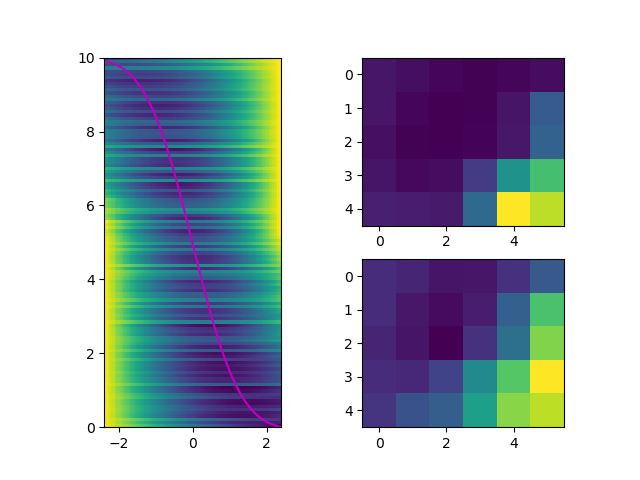

0: 1.612655031968345
1: 1.6107420356533666
2: 1.6085545979199103
3: 1.6045051421602574
4: 1.595673881551941
5: 1.5818063241941247
6: 1.5656970511308448
7: 1.5504277338920343
8: 1.5386573071542735
9: 1.5306325432649932
10: 1.526462228719114
11: 1.5224414663353565
12: 1.5175341930065325
13: 1.511908123387117
14: 1.5069076051871195
15: 1.5017637983261984
16: 1.4971968911799243
17: 1.4923766276087758
18: 1.487246444631392
19: 1.4830014435611711
20: 1.4785441059508808
21: 1.4732223649545295
22: 1.4681579934767053
23: 1.462927656611837
24: 1.4550627914995626
25: 1.4488666048768755
26: 1.441582215712949
27: 1.4336130214964096
28: 1.428342221052878
29: 1.4199329808952688
30: 1.4117777720300415
31: 1.403064579712138
32: 1.3926640318723766
33: 1.3817304387357447
34: 1.366084210463718
35: 1.3484312786545405
36: 1.3305074044416485
37: 1.3118443236125659
38: 1.2875948957418164
39: 1.2605861649992152
40: 1.236199128740941
41: 1.2162481791468314
42: 1.2006758039223928
43: 1.187308283640604
44: 1.1733

355: 1.0634489506334055
356: 1.0634487014310918
357: 1.063473096471091
358: 1.0635939735965898
359: 1.06349304486131
360: 1.0635057363127332
361: 1.063442006114847
362: 1.0634318700931213
363: 1.063406657453635
364: 1.0634174094861877
365: 1.0634723722200083
366: 1.0633545199427359
367: 1.0633210979043366
368: 1.063441091562614
369: 1.0633952569810208
370: 1.0633639001188042
371: 1.0631469462455603
372: 1.0631437784659215
373: 1.0632942273944497
374: 1.063365545881249
375: 1.0632488420745392
376: 1.0629796870897004
377: 1.0628794378275535
378: 1.0631086077998453
379: 1.0629970845484933
380: 1.062918288244056
381: 1.0629008825684259
382: 1.062705784416587
383: 1.062740892143641
384: 1.0628641712711069
385: 1.062651572705587
386: 1.0628105593379031
387: 1.0625561293936217
388: 1.0626431251467843
389: 1.0625581563535555
390: 1.062525887825127
391: 1.0625323394941901
392: 1.062507996645084
393: 1.062540943968823
394: 1.0626962716729063
395: 1.062656222956755
396: 1.0626790084030753
397: 1.

708: 1.0581336856019785
709: 1.0580727483180428
710: 1.0580916522941288
711: 1.0582298961352552
712: 1.0580528153670592
713: 1.0580177809903122
714: 1.0580214862405377
715: 1.0580282317661875
716: 1.0580102841982273
717: 1.058012592652405
718: 1.0580609085844204
719: 1.0579701301746711
720: 1.0580113939915883
721: 1.0580070216546549
722: 1.0579977754149912
723: 1.0579517166820722
724: 1.0579613812998068
725: 1.0579581299612606
726: 1.0579186870925543
727: 1.0579716980860923
728: 1.0579372177536104
729: 1.0578581078997935
730: 1.0578935797319555
731: 1.057833040971764
732: 1.0579807954393359
733: 1.0578625549239917
734: 1.0578436675404188
735: 1.057816248061345
736: 1.057805268119233
737: 1.0577989941658537
738: 1.0577515945215819
739: 1.0578109120690264
740: 1.0577774806307891
741: 1.0577681735571405
742: 1.0577650681248199
743: 1.0577965301991765
744: 1.0577232208318523
745: 1.0577206021078165
746: 1.0577966723506078
747: 1.0577309030721307
748: 1.0577058843971732
749: 1.0577306932822

<IPython.core.display.Javascript object>


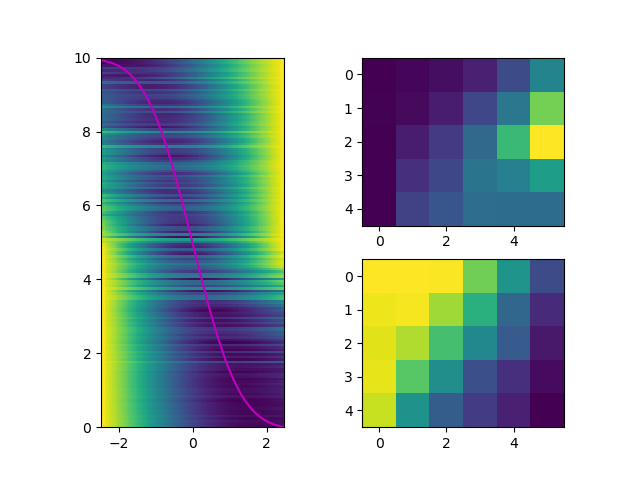

In [48]:
allowable_inputs = [None,[0,2],[1,3],[0,1,2]]
factor = 1
ncelltypes = len(Rs)
Xs = [None for ialign in range(2)]
ys_data = [None for icelltype in range(ncelltypes)]
# ws = [None for icelltype in range(ncelltypes)]
ws = np.zeros((4,12))
for ialign in range(2):
    Xs[ialign] = [np.nanmean(Rs[iinp][ialign],axis=0)[:,np.newaxis] for iinp in range(ncelltypes)]
    Xs[ialign] = np.concatenate(Xs[ialign],axis=1)
    Xs[ialign] = np.concatenate((Xs[ialign],np.ones((Xs[ialign].shape[0],1))),axis=1)
for icelltype in range(1,ncelltypes):
    ys_data[icelltype] = Rs[icelltype][0].copy() # [ind:ind+1]
    ys_data[icelltype] = ys_data[icelltype][~np.isnan(ys_data[icelltype][:,0])]
    wm0 = np.array((1,1,-1,-1,1))*factor
    ws0 = np.array((1,1,-1,-1,1))*factor
    s020 = np.array((1,))*factor
    k0 = np.array((0.5,))
    bounds = [(-np.inf,np.inf)]*12
    ignore = np.setdiff1d(np.arange(ncelltypes),[allowable_inputs[icelltype]])
    for badind in ignore:
        bounds[badind] = (0,0)
        bounds[badind + ncelltypes + 1] = (0,0)
    bounds[-2] = (1,1)
    bounds[-1] = (0,1)
    niter = int(1e3)
    wstar = fit_w_data_loss(Xs,ys_data[icelltype],evaluate_f_mt,wm0=wm0,ws0=ws0,s020=s020,k0=k0,bounds=bounds,niter=niter)
    ws[icelltype] = wstar[0].copy()

<IPython.core.display.Javascript object>


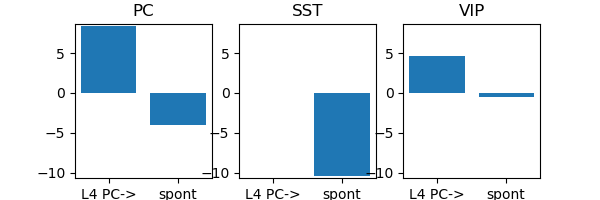

<IPython.core.display.Javascript object>


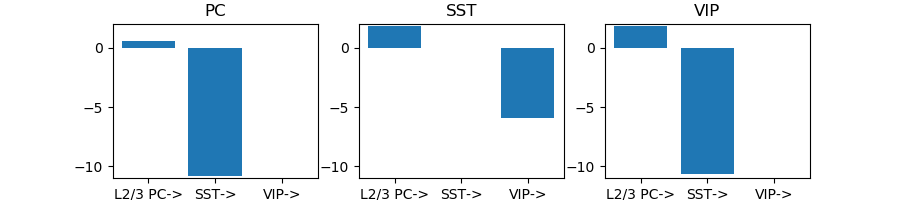

In [49]:
titles = ['PC','SST','VIP']
t = 1500
plt.figure(figsize=(6,2))
lbl = 'Wmx'
data = Wstar_dict[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])
plt.figure(figsize=(9,2))
lbl = 'Wmy'
data = Wstar_dict[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])


In [50]:
def display_model_fit(y,ym):
    plt.figure()
    plt.subplot(1,2,1)
    sca.show_size_contrast(y.reshape((5,6)))
    plt.clim(vmin=y.min(),vmax=y.max())
#     plt.imshow(y.reshape((5,6)),vmax=y.max())
    plt.subplot(1,2,2)
    sca.show_size_contrast(ym.reshape((5,6)))
    plt.clim(vmin=y.min(),vmax=y.max())
    plt.tight_layout()
#     plt.imshow(ym.reshape((5,6)),vmax=y.max())
    #plt.figure()
    #sca.scatter_size_contrast(y,ym)
    #plt.plot((0,1),(0,1),c='r')
    #plt.xlabel('measured')
    #plt.ylabel('modeled')

In [ ]:
# display_model_fit(ys_data[icelltype].mean(0),yms[icelltype]/yms[icelltype].sum())
# plt.title('SST')
# # plt.savefig('figures/sst_measured_modeled_mt.pdf')

In [ ]:
# plt.figure()
# plt.bar(np.arange(3),[ws[i][-1] for i in range(1,4)])
# plt.xticks(np.arange(3),['PC','SST','VIP'])
# plt.ylabel('fit coupling to neighboring space')
# plt.xlabel('cell type')
# #plt.savefig('figures/space_coupling_coefficients.pdf')

In [ ]:
# display_model_fit(ys_data[icelltype].mean(0),yms[icelltype]/yms[icelltype].sum())
# plt.title('VIP')
# # plt.savefig('figures/vip_measured_modeled_mt.pdf')

In [ ]:
# display_model_fit(ys_data[icelltype].mean(0),yms[icelltype]/yms[icelltype].sum())
# plt.title('PC')
# # plt.savefig('figures/pc_measured_modeled_mt.pdf')

In [ ]:
# find ML columns of wx,wy one by one from data: Ydata ~ Y = f(Xwx + Ywy)
# 1. linearize around Y = f(Xwx + Ywy) and find new ML wx,xy
# 2. solve Y = f(Xwx + Ywy) exactly for fixed wx,wy
# repeat from 1.

In [51]:
def compute_Y_nonlinear(X,Wmx,Wmy,Wsx,Wsy,k,s02,f,Y0=None,bounds=None,stop_early=False):
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    
#     def parse_W(W): 
#         Wx = W[:nP*nQ].reshape((nP,nQ))
#         Wy = W[nP*nQ:].reshape((nQ,nQ))
#         return Wx,Wy
    
    def unparse_y(ys):
        y = np.concatenate(ys,axis=0)
        return y
    
    def parse_y(y):
        ys = [y[:nQ],y[nQ:]]
        return ys #[Y[:nN*nQ].reshape((nN,nQ)),Y[nN*nQ:].reshape((nN,nQ))]

    npixels = 2
#     Wx,Wy = parse_W(W)
    nN,nQ = Y0[0].shape
    
    Ystar = [np.zeros((nN,nQ)) for i in range(npixels)]
    
    for i in range(nN):
        def minusL(y):
            ys = parse_y(y)
            def u_fn(thisX,thisy,Wx,Wy,k):
                return thisX[0][i] @ Wx + thisX[1][i] @ (Wx*k[np.newaxis,:]) + thisy[0] @ Wy + thisy[1] @ (Wy*k[np.newaxis,:])
            term0 = 0.5*np.sum((f(u_fn(X,ys,Wmx,Wmy,k),u_fn(X,ys,Wsx,Wsy,k)**2+s02) - ys[0])**2)
            term1 = 0.5*np.sum((f(u_fn(X[::-1],ys[::-1],Wmx,Wmy,k),u_fn(X[::-1],ys[::-1],Wsx,Wsy,k)**2+s02) - ys[1])**2)
            return term0 + term1
            
        def minusdLdy(y):
            return egrad(minusL)(y)
        
        if stop_early:
            maxiter = 25
        else:
            maxiter = 15000
        YY0 = unparse_y([Y0[0][i],Y0[1][i]])
        YYstar = sop.fmin_l_bfgs_b(minusL,YY0,fprime=minusdLdy,bounds=bounds,pgtol=pgtol,factr=factr,epsilon=epsilon,maxiter=maxiter)
        Ystar[0][i],Ystar[1][i] = parse_y(YYstar[0])
    
    return Ystar #[np.array([el[0] for el in Ystar[ialign]]) for ialign in range(npixels)],Ystar # list of two, 0 is aligned, 1 is misaligned

In [52]:
def fit_w_data_loss(X,ydata,rate_fn,wm0=None,ws0=None,s020=None,k0=None,bounds=None,niter=int(1e4)):
    # X is (N,P), y is (N,). Finds w: (P,) weight matrix to explain y as y = f(X(wm),X(ws))
    # f is a static nonlinearity, given as a function of mean and std. of noise
    N,P = X[0].shape
    abd = 1

    nroi = ydata.shape[0]
    alpha_roi = sst.norm.ppf(np.arange(1,nroi+1)/(nroi+1))
    
    def sort_by_11(w):
        yalpha11 = rate_fn_wrapper(w,np.array((-abd,abd)))
        difference11 = compute_y_distance(yalpha11[np.newaxis,:,:],ydata[:,np.newaxis,:])
        sortby11 = np.argsort(difference11[:,0]-difference11[:,-1])
        return sortby11
    
    def compute_y_distance(y1,y2):
        return np.sum((y1-y2)**2,axis=-1)
    
    def compare_sorted_to_expected(w,sortind):
       
        yalpha_roi = rate_fn_wrapper(w,alpha_roi)
#         print(yalpha_roi.max())
        difference_roi = compute_y_distance(yalpha_roi,ydata[sortind])
        difference_roi_unsorted = compute_y_distance(yalpha_roi,ydata)
#         print(difference_roi.shape)
        return difference_roi

    def rate_fn_wrapper(w,alphas):
        wm,ws,s02,k = parse_w(w)
        inputs0 = [wm,np.array((0,)),s02,[np.array((0,)),np.array((0,))]]
        inputs1 = [X,ws,[np.array((0,)),np.array((0,))],np.array((0,))]
        yalpha = rate_fn(X,inputs0,alphas[:,np.newaxis]*u_fn(*inputs1,k),k)
        yalpha = normalize(yalpha)
        return yalpha

#     def compute_f_by_itself(w):

    def normalize(arr):
        arrsum = arr.sum(1)
#         arrnorm = np.ones_like(arr)
#         arrnorm = arrnorm/arrnorm.shape[1]
        well_behaved = (arrsum>0)[:,np.newaxis]
        arrnorm = well_behaved*arr/arrsum[:,np.newaxis] + (~well_behaved)*np.ones_like(arr)/arr.shape[1]
        return arrnorm
    
    def parse_w(w):
        wm = w[:P]
        ws = w[P:-2]
        s02 = w[-2]
        k = w[-1]
        return wm,ws,s02,k

    def minusL(w,sortind):
#         wm,ws,k = parse_w(w)
        difference_roi = compare_sorted_to_expected(w,sortind)
#         print(difference_roi.shape)
#         print(str(w) + ' -> ' + str(np.round(np.sum(difference_roi),decimals=2)))
        return 0.5*np.sum(difference_roi) # k*
    
    def minusdLdw(w,sortind): 
        # sum in first dimension: (N,1) times (N,1) times (N,P)
        return egrad(lambda w: minusL(w,sortind))(w)
    
    def fix_violations(w,bounds):
        lb = np.array([b[0] for b in bounds])
        ub = np.array([b[1] for b in bounds])
        w[w<lb] = lb[w<lb]
        w[w>ub] = ub[w>ub]
        return w
    
    w0 = np.concatenate((wm0,ws0,s020,k0)) #,(k0,)))
    
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    this_w = w0
    for i in range(niter):
        sortind = sort_by_11(this_w)
        wstar = sop.fmin_l_bfgs_b(lambda w: minusL(w,sortind),this_w,fprime=lambda w: minusdLdw(w,sortind),bounds=bounds,pgtol=pgtol,factr=factr,epsilon=epsilon,maxiter=1)
        assert(~np.isnan(wstar[1]))
        if np.isnan(wstar[1]):
            this_w = old_w
        else:
            this_w = wstar[0].copy() + np.random.randn(*this_w.shape)*0.01*np.exp(-i/niter)
            old_w = wstar[0].copy()
        this_w = fix_violations(this_w,bounds)
        print(str(i) + ': ' + str(wstar[1]))
    
    max_alpha = alpha_roi.max()
    this_yalpha = rate_fn_wrapper(this_w,np.linspace(-max_alpha,max_alpha,101))
    ydist = compute_y_distance(ydata[sortind,np.newaxis],this_yalpha[np.newaxis,:])
    
    plt.figure()
    plt.subplot(1,2,1)
    plt.imshow(ydist/ydist.max(1)[:,np.newaxis],extent=[-max_alpha,max_alpha,0,10])
    plt.plot(-alpha_roi,10*np.arange(nroi)/nroi,c='m')
    plt.subplot(2,2,2)
    plt.imshow(this_yalpha[25].reshape((5,6)))
    plt.subplot(2,2,4)
    plt.imshow(this_yalpha[75].reshape((5,6)))
#         print(wstar)
    
    return wstar

In [ ]:
# nS = 2
# Yhat = [None for ialign in range(nS)]
# Xhat = [None for ialign in range(nS)]
# for ialign in range(nS):
#     y = [utils.columnize(Rs[icelltype][ialign])[:,np.newaxis] for icelltype in range(1,4)]
#     Yhat[ialign] = np.concatenate(y,axis=1)
#     x = utils.columnize(Rs[0][ialign])[:,np.newaxis]
#     Xhat[ialign] = np.concatenate((x,np.ones_like(x)),axis=1)
# nN,nP = Xhat[0].shape
# nQ = len(Yhat[0])

In [8]:
ncelltypes = 4
nQ = ncelltypes-1
offset = 0
wxfactor = 1e-1
wyfactor = 1e-1
W0my = wyfactor*ws[1:4,1:4].T
W0mx = wxfactor*ws[1:4,[0,4]].T
W0sy = wyfactor*ws[1:4,6:9].T
W0sx = wxfactor*ws[1:4,[5,10]].T
s020 = np.ones((nQ,))
k0 = ws[1:4,-1]
npixels = 2
Yhat = [[Rs[icelltype][ialign].copy() for icelltype in range(1,4)] for ialign in range(npixels)]
X = [None for ialign in range(npixels)]
for ialign in range(npixels):
    for i in range(len(Yhat[ialign])):
        Yhat[ialign][i] = Yhat[ialign][i][~np.isnan(Yhat[ialign][i][:,0])]
    x = columnize(Rs[0][ialign])[:,np.newaxis]
    X[ialign] = np.concatenate((x,np.ones_like(x)),axis=1)
nN,nP = X[0].shape
nQ = len(Yhat[0])
# W0mx = np.zeros((nP,nQ))
# W0my = np.zeros((nQ,nQ))
# W0sx = np.zeros((nP,nQ))
# W0sy = np.zeros((nQ,nQ))

W0s = [W0mx,W0my,W0sx,W0sy,s020,k0]

NameError: name 'ws' is not defined

In [54]:
u,s,v = np.linalg.svd(W0my/wyfactor)

In [55]:
def parse_bounds(W0x_bounds,W0y_bounds,s02_bounds,k_bounds):
    bounds = [(-np.inf,np.inf)]*(2*(W0x_bounds.size+W0y_bounds.size) + s02_bounds.size + k_bounds.size)
    is_free = np.zeros((2*(W0x_bounds.size+W0y_bounds.size) + s02_bounds.size + k_bounds.size,))
    so_far = 0
    is_free = np.concatenate((W0x_bounds.flatten(),W0y_bounds.flatten(),np.abs(W0x_bounds).flatten(),np.abs(W0y_bounds).flatten()))
    for i in range(2*(W0x_bounds.size+W0y_bounds.size)):
        if is_free[i]==0:
            bounds[i] = (0,0)
        elif is_free[i]==-1:
            bounds[i] = (-np.inf,0)
    for i in range(2*(W0x_bounds.size+W0y_bounds.size),2*(W0x_bounds.size+W0y_bounds.size)+s02_bounds.size):
        bounds[i] = (1,1)
    for i in range(2*(W0x_bounds.size+W0y_bounds.size)+s02_bounds.size,2*(W0x_bounds.size+W0y_bounds.size)+s02_bounds.size+k_bounds.size):
        bounds[i] = (0,1)
    return bounds

In [56]:
W0x_bounds = np.ones((nP,nQ),dtype=int)
W0x_bounds[0,1] = 0
W0y_bounds = np.ones((nQ,nQ),dtype=int)
W0y_bounds[1:3,1:3] = np.array(((0,-1),(-1,0)))
W0y_bounds[1,0] = -1
W0y_bounds[2,0] = 0

# W0mx[W0x_bounds>0] = np.random.randn((W0x_bounds>0).sum())
# W0my[W0y_bounds>0] = np.random.randn((W0y_bounds>0).sum())
# W0sx[W0x_bounds>0] = np.random.randn((W0x_bounds>0).sum())
# W0sy[W0y_bounds>0] = np.random.randn((W0y_bounds>0).sum())

s02_bounds = np.ones((nQ,))

k_bounds = np.ones((nQ,))

bounds = parse_bounds(W0x_bounds,W0y_bounds,s02_bounds,k_bounds)

In [57]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','Y','momentum','loss']

In [ ]:
#Y0,diagnostics = compute_Y_nonlinear(X,*W0s,f_miller_troyer,Y0=np.zeros((nN,nQ))) #_t_evolution

In [ ]:
#Wstar_dict = np.load('w_over_time_miller_troyer_data_loss.npy',allow_pickle=True)[()]
#Wstar_dict['k'] = np.array((0.2,1,0.2))[np.newaxis,:]*np.ones((1001,1))
#Wstar_t = []
#for i, label in enumerate(labels):
#    Wstar_t.append(Wstar_dict[label])

<IPython.core.display.Javascript object>


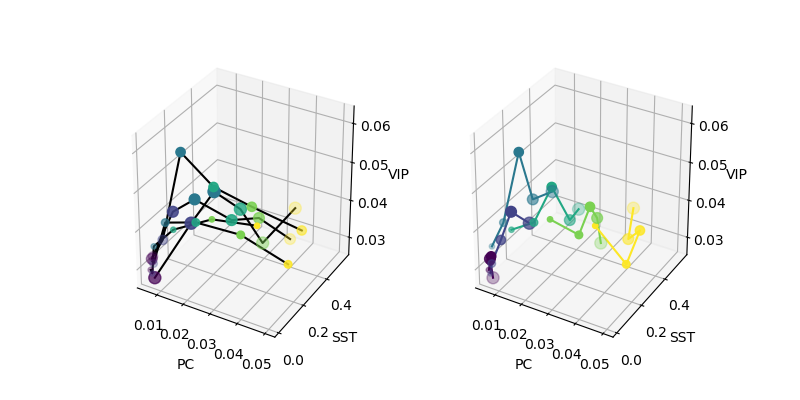

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

Text(0.5, 0, 'VIP')

In [58]:
r_to_plot = [None for i in range(3)]
ialign = 0
r_to_plot[0] = rs[1][ialign].mean(0)
r_to_plot[1] = rs[2][ialign].mean(0)
r_to_plot[2] = rs[3][ialign].mean(0)
colors = plt.cm.viridis(np.linspace(0,1,6))

fig = plt.figure(figsize=(8,4))
ax = fig.add_subplot(1,2,1,projection='3d')
for i in range(5):
    ax.plot(r_to_plot[0][i],r_to_plot[1][i],r_to_plot[2][i],c='k')
    ax.scatter(r_to_plot[0][i],r_to_plot[1][i],r_to_plot[2][i],c=colors,s=15*i+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
plt.xlabel('PC')
plt.ylabel('SST')
ax.set_zlabel('VIP')
ax = fig.add_subplot(1,2,2,projection='3d')
for i in range(6):
    ax.plot(r_to_plot[0][:,i],r_to_plot[1][:,i],r_to_plot[2][:,i],c=colors[i])
    ax.scatter(r_to_plot[0][:,i],r_to_plot[1][:,i],r_to_plot[2][:,i],c=colors[i],s=15*np.arange(5)+15)
plt.xlabel('PC')
plt.ylabel('SST')
ax.set_zlabel('VIP')
#plt.tight_layout()
# plt.savefig('figures/wire_plots_size_contrast.pdf')

In [ ]:
r_to_plot = [None for i in range(3)]
ialign = 0
r_to_plot[0] = rs[1][ialign].mean(0)
r_to_plot[1] = rs[2][ialign].mean(0)
r_to_plot[2] = rs[3][ialign].mean(0)
colors = plt.cm.viridis(np.linspace(0,1,6))

fig = plt.figure(figsize=(6,3))
ax = fig.add_subplot(1,2,1)#,projection='3d')
for i in range(5):
    ax.plot(r_to_plot[0][i],r_to_plot[1][i],c='k')#,r_to_plot[2][i],c='k')
    ax.scatter(r_to_plot[0][i],r_to_plot[1][i],c=colors,s=15*i+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
plt.xlabel('PC')
plt.ylabel('SST')
ax = fig.add_subplot(1,2,2)#,projection='3d')
for i in range(6):
    ax.plot(r_to_plot[0][:,i],r_to_plot[1][:,i],c=colors[i])#,r_to_plot[2][i],c='k')
    ax.scatter(r_to_plot[0][:,i],r_to_plot[1][:,i],c=colors[i],s=15*np.arange(5)+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
plt.xlabel('PC')
plt.ylabel('SST')
plt.tight_layout()
#ax.set_zlabel('VIP')

fig = plt.figure(figsize=(6,3))
ax = fig.add_subplot(1,2,1)#,projection='3d')
for i in range(5):
    ax.plot(r_to_plot[1][i],r_to_plot[2][i],c='k')#,r_to_plot[2][i],c='k')
    ax.scatter(r_to_plot[1][i],r_to_plot[2][i],c=colors,s=15*i+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
plt.xlabel('SST')
plt.ylabel('VIP')
ax = fig.add_subplot(1,2,2)#,projection='3d')
for i in range(6):
    ax.plot(r_to_plot[1][:,i],r_to_plot[2][:,i],c=colors[i])#,r_to_plot[2][i],c='k')
    ax.scatter(r_to_plot[1][:,i],r_to_plot[2][:,i],c=colors[i],s=15*np.arange(5)+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
plt.xlabel('SST')
plt.ylabel('VIP')
plt.tight_layout()

In [59]:
def evaluate_LW(X,Yhat,pop_rate_fn=None,neuron_rate_fn=None,Y0=None,W0mx=None,W0my=None,W0sx=None,W0sy=None,s020=None,k0=None,bounds=None,weight=None):
    # X is (N,P), y is (N,Q). Finds wZx, wZy: (P,Q) + (Q,Q) weight matrices to explain Y as Y = f(Xwmx + Ywmy,Xwsx + Ywsy)
    # f is a static nonlinearity, given as a function
    
    niter=0
    
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    fudge = 1e-4
    
    f_sq_second_argument = lambda a,b: pop_rate_fn(a,b**2)
    fprime_m = egrad(pop_rate_fn,0)
    fprime_s = egrad(f_sq_second_argument,1)
    fprime_s2 = egrad(pop_rate_fn,1)
    
    YY0 = np.concatenate(Y0,axis=1)
    XX = np.concatenate(X,axis=1)
    
    npixels = len(Yhat)
    assert(npixels==len(X))
    nN,nP = X[0].shape
    nQ = len(Yhat[0])
    assert(nN==Yhat[0][0].shape[1])
    
    first = True
    
    if weight is None:
        weight = np.ones((nQ,))
        
#     lower_bound = np.array([b[0] for b in bounds])
#     upper_bound = np.array([b[1] for b in bounds])
    
    nrois = [[y.shape[0] for y in Yhat[ialign]] for ialign in range(npixels)]
    alpha_rois = [[sst.norm.ppf(np.arange(1,nroi+1)/(nroi+1)) for nroi in nrois[ialign]] for ialign in range(npixels)]
    sortinds = [[np.arange(nroi) for nroi in nrois[ialign]] for ialign in range(npixels)]
    
    # Yhat is all measured tuning curves, Y is the averages of the model tuning curves
    
    def take_one_step(W0,YY0,sortinds=None):
        
#         print(first)
        W0mx,W0my,W0sx,W0sy,s020,k0 = parse_W(W0)
        Y00 = [YY0[:,ialign*nQ:(ialign+1)*nQ] for ialign in range(npixels)]
        Y0 = compute_Y_nonlinear(X,W0mx,W0my,W0sx,W0sy,s020,k0,pop_rate_fn,Y0=Y00,stop_early=not first)
        YY0 = np.concatenate(Y0,axis=1)
        #sortinds = [[None for icelltype in range(nQ)] for ialign in range(npixels)]
        #W0 = np.concatenate((W0mx.flatten(),W0my.flatten(),W0sx.flatten(),W0sy.flatten(),s020.flatten()),axis=0)

        def compare_sorted_to_expected(YY,w,ydata,sortind,alpha_roi,inside=True):
            yalpha_roi = neuron_rate_fn_wrapper(YY,w,alpha_roi,inside=inside)
            difference_roi = compute_y_distance(yalpha_roi,ydata[sortind])[0]
#             assert(True==False)
            return difference_roi
        
        def compute_f(W,YY):
            # returns value (N,Q)
            return compute_f_(XX,W,YY)

        def compute_f_(xx,W,yy):
            Wmx,Wmy,Wsx,Wsy,s2,k = parse_W(W)
            def u_fn(Wx,Wy,k):
                WWx,WWy = [gen_Weight(W,k) for W in [Wx,Wy]]
                return xx @ WWx + yy @ WWy
            return pop_rate_fn(u_fn(Wmx,Wmy,k),u_fn(Wsx,Wsy,k)**2+np.concatenate((s2,s2),axis=0))

#         def dfdW(W,YY):
#             # returns value (N,Q,R)
#             # dfdW(W,Y): 2*Q*(P+Q) + Q = R, (N,Q,R)
#             fW = lambda W: compute_f(W,YY)
#             return jacobian(fW)(W)
        
        def compute_difference(XX,W,YY):
            Wmx,Wmy,Wsx,Wsy,s2,k = parse_W(W)
            difference_roi = [[np.zeros((nroi,)) for nroi in nrois[ialign]] for ialign in range(npixels)]
            for ialign in range(npixels):
                inside = ialign==0
                for icelltype in range(nQ):
                    w = unparse_w(Wmx,Wmy,Wsx,Wsy,s2,k,icelltype=icelltype)
                    difference_roi[ialign][icelltype] = compare_sorted_to_expected(YY,w,Yhat[ialign][icelltype],sortinds[ialign][icelltype],alpha_rois[ialign][icelltype],inside=inside)
            return difference_roi
        
#         def dfdYY(W,YY):
#             compute_fs = [lambda yy: compute_f_(xx,W,yy) for xx in XX]
#             jacobians = [jacobian(this_compute_f)(yy)[np.newaxis] for this_compute_f,yy in zip(compute_fs,YY)]
#             jac = np.concatenate(jacobians,axis=0)
#             return jac
        
#         def dYYdW(W):
#             # returns value (N,Q,R)
#             A = np.linalg.inv(np.eye(npixels*nQ)[np.newaxis] - dfdYY(W,YY0))
#             B = dfdW(W,YY0)
#             return A @ B
        
        def minusLWYY(W,YY):
            # returns value float
            all_diffs = compute_difference(XX,W,YY)
            diffs = [np.array([np.mean(z) for z in all_diffs[ialign]]) for ialign in range(npixels)]
            return 0.5*np.sum([np.sum(weight*diffs[ialign]) for ialign in range(npixels)])
                
#         def minuspLpYY(W,YY): # partial L partial Y
#             return egrad(minusLWYY,1)(W,YY)
        
#         def minuspLpW(W,YY): # partial L partial W
#             return egrad(minusLWYY,0)(W,YY)
        
        def minusLW(W):
            # returns value float
            return minusLWYY(W,compute_f(W,YY0))
    
#         def minusdLdW(W): 
#             # returns value (R,)
#             # sum in first dimension: (N,1) times (N,1) times (N,P)
#             return np.einsum('ij,ijk->k',minuspLpYY(W,YY0),dYYdW(W)) + minuspLpW(W,YY0)
        
#         def ddifferencedW(W,YY):
#             ftemp = lambda W: compute_difference(XX,W,YY)[0]
#             return jacobian(ftemp)(W)
        
#         def ddifferencedY(Y):
#             ftemp = lambda YY: compute_difference(XX,W,YY)[0]
#             return jacobian(ftemp)(Y)
        
        def fix_violations(w,bounds):
            lb = np.array([b[0] for b in bounds])
            ub = np.array([b[1] for b in bounds])
            lb_violation = w<lb
            ub_violation = w>ub
            w[lb_violation] = lb[lb_violation]
            w[ub_violation] = ub[ub_violation]
            return w,lb_violation,ub_violation
        
#         assert(True==False)
        loss = minusLW(W0)
#         W1mx,W1my,W1sx,W1sy,s021 = parse_W(W1)
        
        return loss
    
    def parse_W(W):
        shapes = [(nP,nQ),(nQ,nQ),(nP,nQ),(nQ,nQ),(nQ,),(nQ,)]
        Ws = parse_thing(W,shapes)
        return Ws
    
    def parse_thing(V,shapes):
        for shape in shapes:
            if type(shape) is int:
                shape = (shape,)
        sizes = [np.prod(shape) for shape in shapes]
        sofar = 0
        outputs = []
        for size,shape in zip(sizes,shapes):
            if size > 1:
                new_element = V[sofar:sofar+size].reshape(shape)
            else:
                new_element = V[sofar] # if just a float
            outputs.append(new_element)
            sofar = sofar + size
        return outputs
    
    def unparse_W(*Ws):
        return np.concatenate([ww.flatten() for ww in Ws])
    
    def unparse_w(*Ws,icelltype):
        return unparse_W(*[w.T[icelltype].T for w in Ws])
    
    def parse_w(w):
        shapes = [nP,nQ,nP,nQ,1,1]
        wws = parse_thing(w,shapes)
        wmx,wmy,wsx,wsy,s02,k = wws
        return wmx,wmy,wsx,wsy,s02,k
    
    def normalize(arr):
        arrsum = arr.sum(1)
        well_behaved = (arrsum>0)[:,np.newaxis]
        arrnorm = well_behaved*arr/arrsum[:,np.newaxis] + (~well_behaved)*np.ones_like(arr)/arr.shape[1]
        return arrnorm
    
    def compute_y_distance(y1,y2):
        return np.sum((y1-y2)**2,axis=-1)
    
    def gen_Weight(W,K):
        WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
        WW1 = np.concatenate((W*K[np.newaxis,:],W),axis=1)
        WW = np.concatenate((WW0,WW1),axis=0)
        return WW
    
    def gen_weight(w,k,inside=True):
        if inside:
            return np.concatenate((w,k*w),axis=0)
        else:
            return np.concatenate((k*w,w),axis=0)
    
    def neuron_rate_fn_wrapper(YY,w,alphas,inside=True):
        wmx,wmy,wsx,wsy,s02,k = parse_w(w)
        wwmx,wwmy,wwsx,wwsy = [gen_weight(w,k,inside=inside) for w in [wmx,wmy,wsx,wsy]]
        inputs0 = [wwmx,wwmy,s02,YY]
        inputs1 = [XX,wwsx,YY,wwsy]
        yalpha = neuron_rate_fn(XX,inputs0,alphas[:,np.newaxis]*u_fn(*inputs1))
        yalpha = normalize(yalpha)
        return yalpha
    
    def sort_by_11(YY,w,ydata,inside=True):
        yalpha11 = neuron_rate_fn_wrapper(YY,w,np.array((-abd,abd)),inside=inside)
        difference11 = compute_y_distance(yalpha11[np.newaxis,:,:],ydata[:,np.newaxis,:])
        sortby11 = np.argsort(difference11[:,0]-difference11[:,-1])
        return sortby11
    
    Wmx = np.zeros((niter+1,)+W0mx.shape)
    Wmy = np.zeros((niter+1,)+W0my.shape)
    Wsx = np.zeros((niter+1,)+W0sx.shape)
    Wsy = np.zeros((niter+1,)+W0sy.shape)
    s02 = np.zeros((niter+1,)+s020.shape)
    k   = np.zeros((niter+1,)+k0.shape)
#     loss = np.zeros((niter+1,)+s020.shape)
#     loss[0] = np.nan
    
    abd = 1
    
    W0 = unparse_W(W0mx,W0my,W0sx,W0sy,s020,k0).copy()
#     print(W0.shape)
    
#     momentum = np.zeros((niter+1,)+W0.shape)
    
    YY = np.zeros((niter+1,nN,npixels*nQ))
#     diagnostics = [None]*(niter+1)
    
    Wmx[0],Wmy[0],Wsx[0],Wsy[0],s02[0],k[0],YY[0] = W0mx,W0my,W0sx,W0sy,s020,k0,YY0
    
    #sort_by_11(YY,w,ydata,inside=True)
    
    iiter = 0
    for ialign in range(npixels):
        inside = ialign==0
        for icelltype in range(nQ):
            w0 = unparse_w(Wmx[iiter],Wmy[iiter],Wsx[iiter],Wsy[iiter],s02[iiter],k[iiter],icelltype=icelltype).copy()
            sortinds[ialign][icelltype] = sort_by_11(YY[iiter],w0,Yhat[ialign][icelltype],inside=inside)
#     W0 = unparse_W(W0mx[iiter],W0my[iiter],W0sx[iiter],W0sy[iiter],s02[iiter],k[iiter]).copy()
    loss = take_one_step(W0,YY0,sortinds=sortinds)
    
    return loss

In [60]:
def fit_W_momentum(X,Yhat,pop_rate_fn=None,neuron_rate_fn=None,Y0=None,W0mx=None,W0my=None,W0sx=None,W0sy=None,s020=None,k0=None,bounds=None,niter=10,weight=None,eta=0.1,gamma=0.9,barrier_wt=1):
    # X is (N,P), y is (N,Q). Finds wZx, wZy: (P,Q) + (Q,Q) weight matrices to explain Y as Y = f(Xwmx + Ywmy,Xwsx + Ywsy)
    # f is a static nonlinearity, given as a function
    
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    fudge = 1e-4
    
    f_sq_second_argument = lambda a,b: pop_rate_fn(a,b**2)
    fprime_m = egrad(pop_rate_fn,0)
    fprime_s = egrad(f_sq_second_argument,1)
    fprime_s2 = egrad(pop_rate_fn,1)
    
    YY0 = np.concatenate(Y0,axis=1)
    XX = np.concatenate(X,axis=1)
    
    npixels = len(Yhat)
    assert(npixels==len(X))
    nN,nP = X[0].shape
    nQ = len(Yhat[0])
    assert(nN==Yhat[0][0].shape[1])
    
    first = True
    
    if weight is None:
        weight = np.ones((nQ,))
        
#     lower_bound = np.array([b[0] for b in bounds])
#     upper_bound = np.array([b[1] for b in bounds])
    
    nrois = [[y.shape[0] for y in Yhat[ialign]] for ialign in range(npixels)]
    alpha_rois = [[sst.norm.ppf(np.arange(1,nroi+1)/(nroi+1)) for nroi in nrois[ialign]] for ialign in range(npixels)]
    sortinds = [[np.arange(nroi) for nroi in nrois[ialign]] for ialign in range(npixels)]
    
    # Yhat is all measured tuning curves, Y is the averages of the model tuning curves
    
    def take_one_step(W0,YY0,momentum0=None,sortinds=None):
        
#         print(first)
        W0mx,W0my,W0sx,W0sy,s020,k0 = parse_W(W0)
        Y00 = [YY0[:,ialign*nQ:(ialign+1)*nQ] for ialign in range(npixels)]
        Y0 = compute_Y_nonlinear(X,W0mx,W0my,W0sx,W0sy,s020,k0,pop_rate_fn,Y0=Y00,stop_early=not first)
        YY0 = np.concatenate(Y0,axis=1)
        sortinds = [[None for icelltype in range(nQ)] for ialign in range(npixels)]
        #W0 = np.concatenate((W0mx.flatten(),W0my.flatten(),W0sx.flatten(),W0sy.flatten(),s020.flatten()),axis=0)

        def compare_sorted_to_expected(YY,w,ydata,sortind,alpha_roi,inside=True):
            yalpha_roi = neuron_rate_fn_wrapper(YY,w,alpha_roi,inside=inside)
            difference_roi = compute_y_distance(yalpha_roi,ydata[sortind])[0]
#             assert(True==False)
            return difference_roi
        
        def compute_f(W,YY):
            # returns value (N,Q)
            return compute_f_(XX,W,YY)

        def compute_f_(xx,W,yy):
            Wmx,Wmy,Wsx,Wsy,s2,k = parse_W(W)
            def u_fn(Wx,Wy,k):
                WWx,WWy = [gen_Weight(W,k) for W in [Wx,Wy]]
                return xx @ WWx + yy @ WWy
            return pop_rate_fn(u_fn(Wmx,Wmy,k),u_fn(Wsx,Wsy,k)**2+np.concatenate((s2,s2),axis=0))

        def dfdW(W,YY):
            # returns value (N,Q,R)
            # dfdW(W,Y): 2*Q*(P+Q) + Q = R, (N,Q,R)
            fW = lambda W: compute_f(W,YY)
            return jacobian(fW)(W)
        
        def compute_difference(XX,W,YY):
            Wmx,Wmy,Wsx,Wsy,s2,k = parse_W(W)
            difference_roi = [[np.zeros((nroi,)) for nroi in nrois[ialign]] for ialign in range(npixels)]
            for ialign in range(npixels):
                inside = ialign==0
                for icelltype in range(nQ):
                    w = unparse_w(Wmx,Wmy,Wsx,Wsy,s2,k,icelltype=icelltype)
                    difference_roi[ialign][icelltype] = compare_sorted_to_expected(YY,w,Yhat[ialign][icelltype],sortinds[ialign][icelltype],alpha_rois[ialign][icelltype],inside=inside)
            return difference_roi
        
        def dfdYY(W,YY):
            compute_fs = [lambda yy: compute_f_(xx,W,yy) for xx in XX]
            jacobians = [jacobian(this_compute_f)(yy)[np.newaxis] for this_compute_f,yy in zip(compute_fs,YY)]
            jac = np.concatenate(jacobians,axis=0)
            return jac
        
        def dYYdW(W):
            # returns value (N,Q,R)
            A = np.linalg.inv(np.eye(npixels*nQ)[np.newaxis] - dfdYY(W,YY0))
            B = dfdW(W,YY0)
            return A @ B
        
        def minusLWYY(W,YY):
            # returns value float
            all_diffs = compute_difference(XX,W,YY)
            diffs = [np.array([np.mean(z) for z in all_diffs[ialign]]) for ialign in range(npixels)]
#             assert(True==False)
            return 0.5*np.sum([np.sum(weight*diffs[ialign]) for ialign in range(npixels)])
                
        def minuspLpYY(W,YY): # partial L partial Y
            return egrad(minusLWYY,1)(W,YY)
        
        def minuspLpW(W,YY): # partial L partial W
            return egrad(minusLWYY,0)(W,YY)
        
        def minusLW(W):
            # returns value float
            return minusLWYY(W,compute_f(W,YY0))
    
        def minusdLdW(W): 
            # returns value (R,)
            # sum in first dimension: (N,1) times (N,1) times (N,P)
            return np.einsum('ij,ijk->k',minuspLpYY(W,YY0),dYYdW(W)) + minuspLpW(W,YY0)
        
#         def ddifferencedW(W,YY):
#             ftemp = lambda W: compute_difference(XX,W,YY)[0]
#             return jacobian(ftemp)(W)
        
#         def ddifferencedY(Y):
#             ftemp = lambda YY: compute_difference(XX,W,YY)[0]
#             return jacobian(ftemp)(Y)
        
        def fix_violations(w,bounds):
            lb = np.array([b[0] for b in bounds])
            ub = np.array([b[1] for b in bounds])
            lb_violation = w<lb
            ub_violation = w>ub
            w[lb_violation] = lb[lb_violation]
            w[ub_violation] = ub[ub_violation]
            return w,lb_violation,ub_violation
        
        def sorted_r_eigs(w):
            drW,prW = np.linalg.eig(w)
            srtinds = np.argsort(drW)
            return drW[srtinds],prW[:,srtinds]
    
        def compute_eig_penalty(W0my,k0):
            Wsquig = gen_Weight(W0my,k0)
#             npixels = 2
            drW,prW = sorted_r_eigs(Wsquig - np.eye(nQ*npixels))
    #         dlW,plW = sorted_r_eigs(W0my.T - np.eye(nQ))
            plW = np.linalg.inv(prW)
            print('stability: %.5f' % np.real(drW[-1]))
            assert(np.real(drW[-1])<0) # most positive real and imag parts in last position
            eig_outer = np.real(np.outer(plW[:,-1],prW[-1,:]))
            eig_penalty_size = barrier_wt/np.abs(np.real(drW[-1]))
            eig_penalty_dir_w = (eig_outer[:nQ,:nQ] + eig_outer[nQ:,nQ:]) + k0[np.newaxis,:]*(eig_outer[:nQ,nQ:] + eig_outer[nQ:,:nQ])
            eig_penalty_dir_k = ((eig_outer[:nQ,nQ:] + eig_outer[nQ:,:nQ])*W0my).sum(0)
            eig_penalty_W = eig_penalty_size*unparse_W(np.zeros_like(W0mx),eig_penalty_dir_w,np.zeros_like(W0sx),np.zeros_like(W0sy),np.zeros_like(s020),eig_penalty_dir_k)
            print(eig_penalty_dir_w)
            return eig_penalty_W
        
        if momentum0 is None:
            momentum0 = np.zeros_like(W0)
        deriv = minusdLdW(W0)
        
        eig_penalty_W = compute_eig_penalty(W0my,k0)
    
        deriv = deriv + eig_penalty_W
#         assert(True==False)
        print(deriv)
        momentum1 = gamma*momentum0 + (1-gamma)*eta*deriv
        W1 = W0 - momentum1
        
        W1,lb_violation,ub_violation = fix_violations(W1,bounds)
        momentum1[lb_violation | ub_violation] = 0
        loss = minusLW(W1)
        
        print('loss: %.5f' % loss)
        
        W0mx,W0my,W0sx,W0sy,s020,k0 = parse_W(W1)
#         drW,prW = sorted_r_eigs(W0my - np.eye(nQ))
#         dlW,plW = sorted_r_eigs(W0my.T - np.eye(nQ))
#         print(np.real(drW[-1]))
#         assert(np.real(drW[-1])<0) # most positive real and imag parts in last position
#         W1mx,W1my,W1sx,W1sy,s021 = parse_W(W1)
        
        return W1,YY0,momentum1,loss
    
    def parse_W(W):
        shapes = [(nP,nQ),(nQ,nQ),(nP,nQ),(nQ,nQ),(nQ,),(nQ,)]
        Ws = parse_thing(W,shapes)
        return Ws
    
    def parse_thing(V,shapes):
        for shape in shapes:
            if type(shape) is int:
                shape = (shape,)
        sizes = [np.prod(shape) for shape in shapes]
        sofar = 0
        outputs = []
        for size,shape in zip(sizes,shapes):
            if size > 1:
                new_element = V[sofar:sofar+size].reshape(shape)
            else:
                new_element = V[sofar] # if just a float
            outputs.append(new_element)
            sofar = sofar + size
        return outputs
    
    def unparse_W(*Ws):
        return np.concatenate([ww.flatten() for ww in Ws])
    
    def unparse_w(*Ws,icelltype):
        return unparse_W(*[w.T[icelltype].T for w in Ws])
    
    def parse_w(w):
        shapes = [nP,nQ,nP,nQ,1,1]
        wws = parse_thing(w,shapes)
        wmx,wmy,wsx,wsy,s02,k = wws
        return wmx,wmy,wsx,wsy,s02,k
    
    def normalize(arr):
        arrsum = arr.sum(1)
        well_behaved = (arrsum>0)[:,np.newaxis]
        arrnorm = well_behaved*arr/arrsum[:,np.newaxis] + (~well_behaved)*np.ones_like(arr)/arr.shape[1]
        return arrnorm
    
#     def compute_y_distance(y1,y2,weight_stims=(np.arange(nN)/nN)**2):
    def compute_y_distance(y1,y2,weight_stims=np.ones((nN,))): #np.concatenate((np.zeros((nN-1,)),(1,)))):
        return np.sum(weight_stims[np.newaxis,:]*(y1-y2)**2,axis=-1)
    
    def gen_Weight(W,K):
        WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
        WW1 = np.concatenate((W*K[np.newaxis,:],W),axis=1)
        WW = np.concatenate((WW0,WW1),axis=0)
        return WW
    
    def gen_weight(w,k,inside=True):
        if inside:
            return np.concatenate((w,k*w),axis=0)
        else:
            return np.concatenate((k*w,w),axis=0)
    
    def neuron_rate_fn_wrapper(YY,w,alphas,inside=True):
        wmx,wmy,wsx,wsy,s02,k = parse_w(w)
        wwmx,wwmy,wwsx,wwsy = [gen_weight(w,k,inside=inside) for w in [wmx,wmy,wsx,wsy]]
        inputs0 = [wwmx,wwmy,s02,YY]
        inputs1 = [XX,wwsx,YY,wwsy]
        yalpha = neuron_rate_fn(XX,inputs0,alphas[:,np.newaxis]*u_fn(*inputs1))
        yalpha = normalize(yalpha)
        return yalpha
    
    def sort_by_11(YY,w,ydata,inside=True):
        yalpha11 = neuron_rate_fn_wrapper(YY,w,np.array((-abd,abd)),inside=inside)
        difference11 = compute_y_distance(yalpha11[np.newaxis,:,:],ydata[:,np.newaxis,:])
        sortby11 = np.argsort(difference11[:,0]-difference11[:,-1])
        return sortby11
    
    Wmx = np.zeros((niter+1,)+W0mx.shape)
    Wmy = np.zeros((niter+1,)+W0my.shape)
    Wsx = np.zeros((niter+1,)+W0sx.shape)
    Wsy = np.zeros((niter+1,)+W0sy.shape)
    s02 = np.zeros((niter+1,)+s020.shape)
    k   = np.zeros((niter+1,)+k0.shape)
    loss = np.zeros((niter+1,)+s020.shape)
    loss[0] = np.nan
    
    abd = 1
    
    W0 = unparse_W(W0mx,W0my,W0sx,W0sy,s020,k0).copy()
    print(W0.shape)
    
    momentum = np.zeros((niter+1,)+W0.shape)
    
    YY = np.zeros((niter+1,nN,npixels*nQ))
    diagnostics = [None]*(niter+1)
    
    Wmx[0],Wmy[0],Wsx[0],Wsy[0],s02[0],k[0],YY[0] = W0mx,W0my,W0sx,W0sy,s020,k0,YY0
    
    #sort_by_11(YY,w,ydata,inside=True)
    
    for iiter in range(niter):
        print(iiter)
        for ialign in range(npixels):
            inside = ialign==0
            for icelltype in range(nQ):
                w0 = unparse_w(Wmx[iiter],Wmy[iiter],Wsx[iiter],Wsy[iiter],s02[iiter],k[iiter],icelltype=icelltype).copy()
                sortinds[ialign][icelltype] = sort_by_11(YY[iiter],w0,Yhat[ialign][icelltype],inside=inside)
        W0 = unparse_W(Wmx[iiter],Wmy[iiter],Wsx[iiter],Wsy[iiter],s02[iiter],k[iiter]).copy()
        W1,YY[iiter+1],momentum[iiter+1],loss[iiter+1] = take_one_step(W0,YY[iiter],momentum0=momentum[iiter],sortinds=sortinds)
        Wmx[iiter+1],Wmy[iiter+1],Wsx[iiter+1],Wsy[iiter+1],s02[iiter+1],k[iiter+1] = parse_W(W1.copy())
        first = False
    
    return Wmx,Wmy,Wsx,Wsy,s02,k,YY,momentum,loss

In [61]:
# Wstar_dict2 = np.load('weights_190906b.npy',allow_pickle=True)[()]
Wstar_dict2 = np.load('weights_190912.npy',allow_pickle=True)[()]

In [62]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','Y','momentum','loss']
Wstar_t2 = [None for i in range(len(labels))]
for i,label in enumerate(labels):
    Wstar_t2[i] = Wstar_dict2[label]

In [63]:
Wstar_t_init = [ww[-1].copy() for ww in Wstar_t2]

In [64]:
W0mx,W0my,W0sx,W0sy,s020,k0 = [Wstar_t_init[i].copy() + 0.05*np.random.randn(*Wstar_t_init[i].shape) for i in range(6)]
# W0my[-1] = W0my[-1] - 2
Y0 = Yhat.copy() #[Wstar_t_init[-3][:,:3].copy(),Wstar_t_init[-3][:,3:].copy()] #[Wstar_t_init[-3].copy(),Wstar_t_init[-3].copy()]

In [65]:
[x.shape for x in Yhat[0]]

[(734, 30), (118, 30), (151, 30)]

In [66]:
def set_bounds_zeros(lb,ub,code):
    lb = set_bound_zeros(lb,code)
    ub = set_bound_zeros(ub,code)
    return lb,ub
def set_bound_zeros(bd,code):
    for iitem in range(len(bd)):
        bd[iitem][code[iitem]==0] = 0
    return bd

In [67]:
lb = [-np.inf*np.ones(shp) for shp in [(2,3),(3,3),(2,3),(3,3),(3,),(3,)]]
ub = [np.inf*np.ones(shp) for shp in [(2,3),(3,3),(2,3),(3,3),(3,),(3,)]]
bdlist = [W0x_bounds,W0y_bounds,W0x_bounds,W0y_bounds,s02_bounds,k_bounds]
lb,ub = set_bounds_zeros(lb,ub,bdlist)
ub = set_bound_zeros(ub,[ np.logical_or(bd>=0,(not i==1)) for i,bd in enumerate(bdlist)])
for bd in [lb,ub]:
    for ind in [2,3]:
        bd[ind][:,1] = 0
# temporary for no variation expt.
lb[2] = np.zeros_like(lb[2])
lb[3] = np.zeros_like(lb[3])
lb[4] = np.ones_like(lb[4])
lb[5] = np.zeros_like(lb[5])
ub[2] = np.zeros_like(ub[2])
ub[3] = np.zeros_like(ub[3])
ub[4] = np.ones_like(ub[4])
ub[5] = np.ones_like(ub[5])
# temporary for no variation expt.
lb = np.concatenate([a.flatten() for a in lb])
ub = np.concatenate([b.flatten() for b in ub])
bounds = [(a,b) for a,b in zip(lb,ub)]

In [68]:
def u_fn(X,Wx,Y,Wy):
    return X @ Wx + Y @ Wy

def evaluate_f_mt(X,Ws,offset):
    # Ws: Wx,Wy,s02,Y
    return f_miller_troyer(u_fn(X,Ws[0],Ws[3],Ws[1])+offset,Ws[2])

In [69]:
# niter = int(1e4)
# eta = 1e-1
# gamma = 0.9
# eta_decay = 1e-3
# weight = np.array((1,1,1))
# barrier_wt = 3e-2
# # thisY0 = np.ones_like(Y0)
# Y0 = [np.concatenate([x.mean(0)[:,np.newaxis] for x in Yhat[ialign]],axis=1) for ialign in range(npixels)]
# Wstar_t = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=W0mx.copy(),W0my=W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),k0=k0.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma,barrier_wt=barrier_wt)#,eta_decay=eta_decay)

(36,)
0


/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/tracer.py:48: RuntimeWarning: invalid value encountered in sqrt
  return f_raw(*args, **kwargs)
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:97: RuntimeWarning: invalid value encountered in power
  defvjp(anp.sqrt,    lambda ans, x : lambda g: g * 0.5 * x**-0.5)
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:444: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return lambda g: g[idxs]


stability: -0.25102
[[ 0.33483213 -0.29556631 -0.118625  ]
 [-0.68908123  0.26440851 -0.19877857]
 [ 0.34606066 -0.05544155  0.24672068]]
[-5.58300297e-02 -1.51767690e-02 -5.08990510e-03  1.23020749e-02
 -8.72658682e-03  7.76905865e-04  2.83821978e-01 -4.96130604e-03
  1.14953779e-02  2.29102609e-01  6.97357291e-02  9.82732534e-03
  1.11632836e-01  2.38718599e-03  3.68298888e-02  1.26799741e-03
  8.52236131e-04 -4.43033323e-04 -2.51737586e-04  1.99262946e-03
 -1.50238074e-04 -5.48150174e-03 -3.23010851e-04  1.47663732e-03
 -6.99674436e-03 -3.89899165e-04  1.92027619e-03 -1.46991005e-03
 -4.86788923e-05  4.87660510e-04 -7.61246599e-03 -2.75392890e-03
 -1.11721166e-03  3.00850990e-02  9.84837039e-03  2.80420757e-03]
loss: 0.10964
1


/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/tracer.py:48: RuntimeWarning: divide by zero encountered in true_divide
  return f_raw(*args, **kwargs)
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:59: RuntimeWarning: invalid value encountered in multiply
  lambda ans, x, y : unbroadcast_f(x, lambda g: g * y * x ** anp.where(y, y - 1, 1.)),
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:97: RuntimeWarning: divide by zero encountered in power
  defvjp(anp.sqrt,    lambda ans, x : lambda g: g * 0.5 * x**-0.5)
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:97: RuntimeWarning: invalid value encountered in multiply
  defvjp(anp.sqrt,    lambda ans, x : lambda g: g * 0.5 * x**-0.5)


stability: -0.26486
[[ 0.7520816  -0.50622868  0.25094984]
 [-0.81418991  0.52333    -0.25441706]
 [-0.05416304  0.03341104 -0.01594483]]
[-5.20333064e-02 -1.50652826e-02 -2.76549692e-03  1.16324104e-02
 -8.90512943e-03 -5.16976286e-04  3.10433503e-01 -2.85358343e-02
  3.99837968e-02  1.95297777e-01  9.53478551e-02 -1.32445861e-02
  5.88656001e-02  1.23496215e-02  1.47951812e-03  4.57771473e-04
  5.17715139e-05  1.17558148e-03 -1.66326574e-04  1.27126658e-04
  2.28386276e-04 -5.37606208e-04 -5.58988514e-04 -2.82181070e-03
 -6.72047970e-04 -6.14063743e-04 -3.72254017e-03 -1.69366827e-04
 -2.00559798e-04 -7.91579179e-04 -6.02659080e-03 -2.94281971e-03
 -5.87705420e-04  5.02909421e-02  3.25847911e-03  1.40333831e-03]
loss: 0.10925
2
stability: -0.27890
[[ 0.72899547 -0.50488313  0.20734583]
 [-0.78173012  0.51936449 -0.20943414]
 [-0.04753336  0.03026293 -0.01196315]]
[-5.04635969e-02 -1.49308252e-02 -2.75538932e-03  9.44416079e-03
 -8.99443595e-03 -5.10261573e-04  2.91323251e-01 -2.62271

stability: -0.74202
[[ 0.49604479  0.48776769  0.02059962]
 [ 0.50216737  0.49273701  0.01677033]
 [-0.02559855 -0.02341867  0.00289267]]
[-2.10859184e-02 -1.35666088e-02 -2.42115873e-03 -2.58847176e-03
 -9.06710095e-03 -3.46765057e-04  8.09554834e-02  4.38444696e-02
  1.11477701e-02  9.73256200e-02  5.00992666e-02  1.46470852e-02
  1.68261078e-02  6.22031508e-03  3.05066431e-03  4.29439313e-04
  4.98985063e-05  1.16783444e-03 -3.90529203e-04  1.24889620e-04
  2.04776795e-04 -6.22773584e-04 -5.57592375e-04 -2.81332467e-03
 -7.79577431e-04 -6.12628668e-04 -3.71343071e-03 -2.02720143e-04
 -2.00136322e-04 -7.90260704e-04  1.27834264e-03 -2.70233977e-03
 -4.25506816e-04 -5.21183238e-03  1.21350397e-03  1.11179284e-03]
loss: 0.10251
14
stability: -0.75222
[[ 0.49624816  0.48910489  0.02391533]
 [ 0.50322303  0.49439961  0.01974108]
 [-0.02965605 -0.02679933  0.0027267 ]]
[-1.92679422e-02 -1.35185269e-02 -2.37731489e-03 -2.77967655e-03
 -8.90746353e-03 -3.29496699e-04  7.28465097e-02  4.4025

stability: -0.83000
[[ 5.07034861e-01  5.30990623e-01 -3.72755555e-02]
 [ 4.74952959e-01  5.11585022e-01 -4.11468989e-02]
 [ 6.38026208e-02  6.36801034e-02 -2.18922300e-04]]
[-1.01195638e-02 -1.29061739e-02 -1.92062323e-03 -4.73391375e-03
 -6.54141801e-03 -1.79882212e-04  3.04622652e-02  4.83181547e-02
  6.95216118e-03  3.18076810e-02  5.51172906e-02  9.88081114e-03
  6.20026835e-03  1.09082434e-02  2.35136592e-03  3.95362593e-04
  3.91554618e-05  1.15567130e-03 -5.17752205e-04  1.08990920e-04
  1.69934633e-04 -4.76068543e-04 -5.66596577e-04 -2.79661762e-03
 -5.95549276e-04 -6.22862800e-04 -3.69457656e-03 -1.69848416e-04
 -2.03688786e-04 -7.87103293e-04  1.22731854e-03 -2.40797053e-03
 -2.37394722e-04 -5.41944782e-03  3.78825884e-03  7.02324884e-04]
loss: 0.10106
25
stability: -0.83554
[[ 0.50753483  0.533031   -0.03903715]
 [ 0.47324011  0.51184705 -0.0430289 ]
 [ 0.06632005  0.06677823 -0.00056992]]
[-9.71287255e-03 -1.28216978e-02 -1.87651854e-03 -4.83820784e-03
 -6.30083597e-03 -1.

stability: -0.87837
[[ 0.50065554 -0.50445533  0.05931228]
 [-0.48547751  0.48298169 -0.06460028]
 [-0.05686913  0.07172335 -0.00513369]]
[-7.30751170e-03 -1.20732551e-02 -1.42949006e-03 -4.93359627e-03
 -4.51849740e-03 -5.56097148e-05  1.90408604e-02  1.34830635e-02
  8.27345890e-03 -1.49527546e-02  5.51446450e-02  6.51276340e-03
 -1.01417914e-03  1.15597625e-02  1.59545685e-03  3.80328958e-04
  2.58516134e-05  1.14261941e-03 -5.35428187e-04  9.02114790e-05
  1.35384342e-04 -3.32964271e-04 -5.76309213e-04 -2.77371513e-03
 -4.15622949e-04 -6.33863731e-04 -3.66784397e-03 -1.32684697e-04
 -2.07642994e-04 -7.82214802e-04  3.92875080e-04 -1.97262076e-03
 -9.50482918e-05 -3.56521322e-03  4.23363791e-03  4.34206439e-04]
loss: 0.10106
37
stability: -0.88106
[[ 0.50139649 -0.50568512  0.06119421]
 [-0.484625    0.48267329 -0.06659856]
 [-0.05862183  0.07392871 -0.00560581]]
[-7.19161380e-03 -1.20280993e-02 -1.39233642e-03 -4.89456944e-03
 -4.42501962e-03 -4.71644090e-05  1.87478759e-02  1.3506

stability: -0.90370
[[ 0.50735042  0.58874671 -0.08292353]
 [ 0.41970225  0.52012946 -0.09002348]
 [ 0.10567989  0.13765157 -0.01072302]]
[-6.20544453e-03 -1.16165298e-02 -1.03551825e-03 -4.29284872e-03
 -3.64423697e-03  2.28255225e-05  1.69645555e-02  5.00293988e-02
  1.82231198e-03  1.32673033e-02  5.55894760e-02  3.57162637e-03
  3.89922116e-03  1.36531544e-02  9.32671389e-04  3.72220739e-04
  1.60594869e-05  1.13149864e-03 -5.37216921e-04  7.73518991e-05
  1.08021596e-04 -2.86901516e-04 -5.81161356e-04 -2.75032764e-03
 -3.57769101e-04 -6.39438574e-04 -3.64004058e-03 -1.20394645e-04
 -2.09780253e-04 -7.76896947e-04  2.04731973e-04 -1.69190117e-03
 -1.19907217e-05 -2.67389273e-03  3.78359948e-03  2.64859819e-04]
loss: 0.10126
49
stability: -0.90530
[[ 0.51656091 -0.51958147  0.08500548]
 [-0.47538943  0.47885366 -0.09236943]
 [-0.07584253  0.09576405 -0.01110061]]
[-6.12669298e-03 -1.15808444e-02 -1.00795676e-03 -4.22713103e-03
 -3.58205548e-03  2.71607466e-05  1.71581342e-02  1.3223

stability: -0.92036
[[ 0.48667172 -0.64700264 -0.1063738 ]
 [-0.32896285  0.47530736  0.13376107]
 [ 0.10109357 -0.12580417 -0.01306651]]
[-5.33700101e-03 -1.12042631e-02 -7.49692315e-04 -3.49963117e-03
 -2.95778634e-03  5.90955072e-05  1.52532705e-02  8.77043730e-03
 -1.22913383e-04 -1.22895713e-02  5.29734868e-02  9.33299300e-03
  3.46895508e-03  4.84228525e-03  5.05733192e-04  3.65911975e-04
  6.19175254e-06  1.12318756e-03 -5.38554580e-04  6.46832476e-05
  8.87240205e-05 -2.68751787e-04 -5.85711635e-04 -2.73070776e-03
 -3.35062082e-04 -6.44536978e-04 -3.61647249e-03 -1.15486764e-04
 -2.11863386e-04 -7.72281548e-04  1.57979649e-04 -1.42391690e-03
  2.65970621e-05 -4.42399367e-03  2.02674145e-03  2.85126442e-04]
loss: 0.10154
61
stability: -0.92155
[[ 0.48424216  0.59989354 -0.1080768 ]
 [ 0.38256509  0.5253878  -0.12168247]
 [ 0.09989654  0.16396357 -0.01299823]]
[-5.26872314e-03 -1.11695582e-02 -7.30001160e-04 -3.43377653e-03
 -2.90298962e-03  6.07345192e-05  1.51045566e-02  4.9328

stability: -0.93360
[[ 0.45718501 -0.67854609 -0.12159816]
 [-0.29639933  0.47285965  0.16911294]
 [ 0.08386131 -0.12501367 -0.01109934]]
[-4.64037901e-03 -1.08474645e-02 -5.35070158e-04 -2.81990799e-03
 -2.40564491e-03  7.33555364e-05  1.36364815e-02  7.35588685e-03
 -1.50521909e-03 -1.16242133e-02  5.17371113e-02  9.19147781e-03
  2.73408686e-03  4.75953407e-03  3.00200977e-04  3.60691301e-04
 -2.59501995e-06  1.11657947e-03 -5.40250326e-04  5.35861594e-05
  7.39873539e-05 -2.58982105e-04 -5.89205137e-04 -2.71409256e-03
 -3.22918287e-04 -6.48279405e-04 -3.59636403e-03 -1.12846268e-04
 -2.13573788e-04 -7.68284408e-04  1.37775333e-04 -1.18821884e-03
  4.31501441e-05 -4.36126624e-03  1.65372162e-03  3.11400919e-04]
loss: 0.10182
73
stability: -0.93465
[[ 0.45478614 -0.68104264 -0.12223047]
 [-0.29401133  0.47278479  0.17184777]
 [ 0.08221842 -0.12473641 -0.01083646]]
[-4.59733765e-03 -1.08264501e-02 -5.18492885e-04 -2.77681875e-03
 -2.37316391e-03  7.43292759e-05  1.35236086e-02  7.2497

stability: -0.94574
[[ 0.57570253 -0.46858485  0.11983113]
 [-0.47156776  0.47219162 -0.17022909]
 [-0.07325787  0.09335582 -0.00276944]]
[-4.17750423e-03 -1.06249897e-02 -3.56688135e-04 -2.34451765e-03
 -2.06194821e-03  8.06983647e-05  1.70491302e-02  1.37093105e-02
  5.41876570e-03 -1.72301486e-02  5.07331353e-02 -2.65438766e-03
 -2.33645320e-03  1.15958360e-02  3.39548491e-04  3.56232132e-04
 -8.96249600e-06  1.11098258e-03 -5.42557301e-04  4.58906322e-05
  6.19144664e-05 -2.58734075e-04 -5.90814373e-04 -2.69912765e-03
 -3.22790839e-04 -6.49958635e-04 -3.57818280e-03 -1.12781017e-04
 -2.14505413e-04 -7.64634507e-04  1.45040649e-04 -1.02800237e-03
  4.96510050e-05 -9.07873280e-04  3.10042541e-03  2.15222863e-04]
loss: 0.10206
85
stability: -0.94671
[[ 0.41849938 -0.69238945 -0.11876178]
 [-0.26978986  0.47217253  0.20451919]
 [ 0.05452863 -0.10778505 -0.00165036]]
[-4.14291113e-03 -1.06083412e-02 -3.43617673e-04 -2.30824285e-03
 -2.03642848e-03  8.09362619e-05  1.20404921e-02  6.5847

stability: -0.95694
[[ 0.37937494 -0.67809304 -0.09785703]
 [-0.25413239  0.47211059  0.23440377]
 [ 0.02250946 -0.07612631  0.01426998]]
[-3.77486141e-03 -1.04259578e-02 -2.19153064e-04 -1.91826856e-03
 -1.76236874e-03  7.98161431e-05  1.05973124e-02  6.72880102e-03
 -2.04340464e-03 -1.03143762e-02  4.97695413e-02  9.33124609e-03
  6.62882902e-04  6.10400005e-03  7.00200488e-04  3.52355149e-04
 -1.48897876e-05  1.10687182e-03 -5.44875306e-04  3.88767720e-05
  5.32858669e-05 -2.61986939e-04 -5.92026161e-04 -2.68754788e-03
 -3.27070554e-04 -6.51156668e-04 -3.56408500e-03 -1.13661119e-04
 -2.15290268e-04 -7.61786650e-04  1.59970910e-04 -8.82727029e-04
  4.90485605e-05 -4.19694510e-03  1.19242467e-03  4.24534313e-04]
loss: 0.10232
97
stability: -0.95782
[[ 0.5773544  -0.38944647  0.09510253]
 [-0.47849695  0.47205522 -0.19386998]
 [-0.03868169  0.06121855  0.01611833]]
[-3.74100109e-03 -1.04084403e-02 -2.09778441e-04 -1.88196508e-03
 -1.73676114e-03  7.93435853e-05  1.67811621e-02  1.5736

stability: -0.96620
[[ 0.56962611 -0.30571121  0.06171995]
 [-0.48128972  0.46967665 -0.21228711]
 [ 0.01213473  0.02041758  0.03865037]]
[-3.37602239e-03 -1.02102840e-02 -1.42866176e-04 -1.48721646e-03
 -1.45729282e-03  7.00909345e-05  1.63177610e-02  1.78441486e-02
  2.64026601e-03 -1.73527205e-02  4.86856232e-02 -4.99098343e-03
  3.07036877e-04  8.96246001e-03  1.36276559e-03  3.49251514e-04
 -2.10677728e-05  1.10512330e-03 -5.46702720e-04  3.16334423e-05
  4.96812064e-05 -2.66910401e-04 -5.93257074e-04 -2.68230027e-03
 -3.33426805e-04 -6.52268191e-04 -3.55771300e-03 -1.14979285e-04
 -2.16125816e-04 -7.60500105e-04  1.76556385e-04 -7.31810559e-04
  4.50257911e-05 -5.63987827e-04  2.54359094e-03  2.05753455e-04]
loss: 0.10262
108
stability: -0.96697
[[ 0.33185741 -0.63248206 -0.05808005]
 [-0.24363853  0.46927291  0.26574277]
 [-0.01484697 -0.02652226  0.04103387]]
[-3.33845800e-03 -1.01889067e-02 -1.38056759e-04 -1.44659538e-03
 -1.42814434e-03  6.88260748e-05  8.91992090e-03  7.648

stability: -0.96753
[[ 0.46009598 -0.57072147 -0.05354207]
 [-0.63108196  0.64161526 -0.13310591]
 [ 0.34783275 -0.2713812   0.06032668]]
[-3.51657025e-03 -7.26826289e-03 -3.15733834e-03  2.08794063e-03
  1.66255002e-04 -8.84830513e-04  1.06275089e-02 -2.51973329e-02
 -5.05210055e-03 -1.79525279e-02  1.83215706e-02 -6.02136055e-03
  1.11424157e-02 -7.82927047e-03  2.30457078e-03  5.05588756e-04
 -6.48032258e-05  1.22495019e-03 -6.01769626e-04 -1.99637627e-06
  2.49112038e-04  6.94570340e-04  1.73999528e-05  1.09123572e-03
 -5.61836104e-04  5.64099104e-06  5.54354352e-04 -1.76339346e-05
 -1.93684014e-05 -8.29340233e-05  1.50783832e-03  2.12136100e-04
 -8.46254235e-04 -2.20604939e-03 -1.40912139e-03  1.16883575e-03]
loss: 0.10347
120
stability: -0.96775
[[ 0.45875268 -0.57070417 -0.05506862]
 [-0.63325454  0.64351377 -0.13163344]
 [ 0.34917155 -0.27151048  0.0596987 ]]
[-3.52157763e-03 -7.27171337e-03 -3.15436756e-03  2.10095408e-03
  1.67694433e-04 -8.84444152e-04  1.05757785e-02 -2.519

stability: -0.97256
[[ 0.45522768 -0.37742976  0.08603934]
 [-0.31651505  0.54772914 -0.11174449]
 [-0.08232995 -0.20671004  0.03163004]]
[-3.65917009e-03 -7.20857386e-03 -3.10686487e-03  2.16679192e-03
  2.33246818e-04 -8.66196897e-04  1.02390308e-02 -1.90756978e-02
 -6.87484963e-04 -8.09232902e-03  1.54172410e-02 -5.30678739e-03
 -2.17215329e-03 -5.79006615e-03  1.40498955e-03  5.02704341e-04
 -6.58834524e-05  1.22056217e-03 -5.89199922e-04 -1.90592842e-06
  2.46697352e-04  6.89177579e-04  1.65172277e-05  1.08725731e-03
 -5.48077351e-04  5.53585179e-06  5.50533900e-04 -1.73931608e-05
 -1.92780069e-05 -8.26202697e-05  1.53459810e-03  2.35879399e-04
 -8.23635131e-04 -2.03011688e-03 -7.45142056e-04  2.04315001e-03]
loss: 0.10342
132
stability: -0.97313
[[ 0.45633441 -0.60279053 -0.06976534]
 [-0.63331603  0.65464653 -0.10997719]
 [ 0.35426113 -0.2660101   0.0280715 ]]
[-3.67579451e-03 -7.19721865e-03 -3.10187264e-03  2.16840585e-03
  2.41881265e-04 -8.63820512e-04  1.02466200e-02 -2.600

stability: -0.98053
[[ 0.49927564 -0.48854906  0.04551334]
 [-0.35021724  0.53735882 -0.09909384]
 [-0.13492953 -0.17662845 -0.021952  ]]
[-3.89991464e-03 -7.03348587e-03 -3.03629581e-03  2.16410253e-03
  3.61442051e-04 -8.31082045e-04  1.12099979e-02 -2.21922707e-02
 -1.87792935e-03 -9.10803936e-03  1.51579260e-02 -4.83293812e-03
 -3.74629610e-03 -4.82276929e-03 -2.48390889e-04  4.99040741e-04
 -6.79727382e-05  1.21457560e-03 -5.78409053e-04 -1.63963494e-06
  2.42640493e-04  6.82975882e-04  1.46755746e-05  1.08177409e-03
 -5.36614275e-04  5.41115367e-06  5.44402096e-04 -1.71665215e-05
 -1.90991493e-05 -8.22016153e-05  1.55992883e-03  2.82731928e-04
 -7.87747564e-04 -1.97726952e-03 -5.31098100e-04  1.82677111e-03]
loss: 0.10330
144
stability: -0.98125
[[ 0.50621724 -0.5011515   0.0417939 ]
 [-0.35363506  0.53452634 -0.09888027]
 [-0.14012348 -0.17373987 -0.02720216]]
[-3.92146332e-03 -7.01657874e-03 -3.03008420e-03  2.16262524e-03
  3.73296882e-04 -8.27942146e-04  1.13876136e-02 -2.254

stability: -0.98892
[[ 0.3116132   0.1418324   0.21554067]
 [-0.07256697 -0.05891164 -0.10185494]
 [-0.07256697 -0.14795641 -0.08383142]]
[-4.10295496e-03 -6.85572551e-03 -2.95960913e-03  2.14034265e-03
  4.73786326e-04 -7.92600634e-04  5.16894467e-03 -2.75188499e-03
  3.34571679e-03 -6.73146806e-04 -2.89315318e-03 -4.82669290e-03
 -1.80722778e-03 -3.91318618e-03 -2.12630214e-03  5.00631118e-04
 -6.97073199e-05  1.20835371e-03 -5.70919898e-04 -1.29739136e-06
  2.38191063e-04  6.83740115e-04  1.30317096e-05  1.07605225e-03
 -5.27537525e-04  5.42315828e-06  5.37747573e-04 -1.70613683e-05
 -1.89331422e-05 -8.17728381e-05  1.58049355e-03  3.23952109e-04
 -7.49408544e-04 -1.12826742e-03 -1.66146875e-03  2.22173193e-03]
loss: 0.10318
156
stability: -0.98952
[[ 0.31210278 -0.19861024 -0.28663536]
 [ 0.0918411  -0.11216286 -0.10234413]
 [ 0.0918411  -0.05701215 -0.08783798]]
[-4.11462907e-03 -6.84418515e-03 -2.95345175e-03  2.13818570e-03
  4.80542084e-04 -7.89633143e-04  5.16558248e-03 -1.306

stability: -0.99525
[[ 0.50600986  0.25338122  0.18546522]
 [-0.19776535 -0.15211393 -0.1651265 ]
 [ 0.30292108  0.04200498  0.59098108]]
[-4.20698061e-03 -6.74814760e-03 -2.88065747e-03  2.11788891e-03
  5.34126961e-04 -7.57291579e-04  1.08570695e-02  6.98145531e-04
  2.47743216e-03 -4.48554086e-03 -5.59325959e-03 -6.65313942e-03
  9.53135161e-03  1.83788328e-03  1.82241452e-02  5.05965911e-04
 -7.05929683e-05  1.20223169e-03 -5.67358763e-04 -1.03898561e-06
  2.33908249e-04  6.89772815e-04  1.20947412e-05  1.07042229e-03
 -5.21967754e-04  5.50538160e-06  5.31314068e-04 -1.70685268e-05
 -1.88377993e-05 -8.13538833e-05  1.59193615e-03  3.46862573e-04
 -7.12996887e-04 -2.57242164e-03 -1.98555102e-03  1.16344487e-03]
loss: 0.10309
168
stability: -0.99567
[[ 0.50661435 -0.20122277 -0.28159059]
 [ 0.15130668 -0.08052377 -0.16279154]
 [ 0.96825302 -0.17356039  0.59189729]]
[-4.21238024e-03 -6.74323613e-03 -2.87395283e-03  2.11811722e-03
  5.37365626e-04 -7.54741246e-04  1.08629284e-02 -1.299

stability: -1.00013
[[ 0.52866285 -0.21897583 -0.17685511]
 [ 0.3258144  -0.14273479 -0.05166949]
 [ 0.68699922 -0.21401454  0.59397487]]
[-4.26258264e-03 -6.68346794e-03 -2.80572717e-03  2.12100090e-03
  5.67929947e-04 -7.26141582e-04  1.14008584e-02 -1.34382996e-02
 -8.34219743e-03  1.12382944e-02 -5.23363426e-03 -3.17042635e-03
  2.10114242e-02 -5.84945260e-03  1.82206147e-02  5.14483820e-04
 -7.10400622e-05  1.19634918e-03 -5.63907843e-04 -8.52326275e-07
  2.29969608e-04  6.99745381e-04  1.15345120e-05  1.06501886e-03
 -5.15657190e-04  5.59349753e-06  5.25344661e-04 -1.71198471e-05
 -1.87835630e-05 -8.09529707e-05  1.60194866e-03  3.60280142e-04
 -6.80196576e-04 -3.02361244e-03 -4.02623542e-04  6.87730542e-04]
loss: 0.10304
180
stability: -1.00050
[[ 0.52762439 -0.21770981 -0.17584233]
 [ 0.32157392 -0.14127413 -0.05016447]
 [ 0.68443048 -0.21218467  0.59342982]]
[-4.26622977e-03 -6.67779949e-03 -2.80039024e-03  2.12152155e-03
  5.70362822e-04 -7.23695887e-04  1.13598834e-02 -1.339

stability: -1.00426
[[ 0.5163438   0.21594616  0.23472237]
 [-0.19777424 -0.12204584 -0.03458971]
 [-0.8654438  -0.1885979   0.58353888]]
[-4.30362069e-03 -6.61215090e-03 -2.74529818e-03  2.12710844e-03
  5.96063829e-04 -6.96450731e-04  1.09221150e-02 -3.42599803e-04
  4.03561132e-03 -4.44624720e-03 -4.54715268e-03 -2.60396691e-03
 -2.54460972e-02 -5.06645319e-03  1.78307455e-02  5.25183706e-04
 -7.14913230e-05  1.19149399e-03 -5.61053220e-04 -6.54152438e-07
  2.26435582e-04  7.12476228e-04  1.10353259e-05  1.06052544e-03
 -5.09445612e-04  5.70932749e-06  5.20074521e-04 -1.72092879e-05
 -1.87321297e-05 -8.06309463e-05  1.61214567e-03  3.71487995e-04
 -6.51972365e-04 -2.41903153e-03 -3.68566692e-05  1.78397803e-03]
loss: 0.10300
192
stability: -1.00452
[[ 0.51652194 -0.17338268 -0.16135936]
 [ 0.15801581 -0.07774463 -0.03308307]
 [-0.35005694 -0.06672119  0.58238202]]
[-4.30574698e-03 -6.60838321e-03 -2.74175276e-03  2.12929388e-03
  5.98040883e-04 -6.94476827e-04  1.09208732e-02 -1.196

stability: -1.00761
[[ 0.50821338  0.18174756  0.15038069]
 [-0.16146283 -0.06633792 -0.0833004 ]
 [-0.59484341 -0.06168392  0.56938132]]
[-4.34205382e-03 -6.54548498e-03 -2.68088966e-03  2.13767800e-03
  6.23556761e-04 -6.68948122e-04  1.05855946e-02 -1.31081636e-03
  1.56634154e-03 -3.34293525e-03 -2.82742792e-03 -4.00254714e-03
 -1.73004198e-02 -1.27148244e-03  1.73458614e-02  5.35493997e-04
 -7.19370128e-05  1.18673721e-03 -5.57955054e-04 -4.70875938e-07
  2.22818486e-04  7.24696486e-04  1.05716862e-05  1.05610831e-03
 -5.03057484e-04  5.81590217e-06  5.14724319e-04 -1.72889574e-05
 -1.86840442e-05 -8.03194235e-05  1.62235777e-03  3.82108975e-04
 -6.24224027e-04 -2.45526589e-03 -3.68394361e-04  1.68674895e-03]
loss: 0.10295
204
stability: -1.00787
[[ 0.50745534  0.18033039  0.1496551 ]
 [-0.15839935 -0.0651734  -0.08148342]
 [-0.58955206 -0.05941217  0.56811074]]
[-4.34542682e-03 -6.53970190e-03 -2.67438275e-03  2.13820999e-03
  6.25860952e-04 -6.66689314e-04  1.05554925e-02 -1.348

stability: -1.00830
[[-0.07461978 -0.01659288 -0.16694501]
 [ 0.00992874 -0.06891635 -0.16694501]
 [ 0.038144    0.16267282  1.13190617]]
[-4.37285881e-03 -6.48949376e-03 -2.60141968e-03  2.12880395e-03
  6.50147540e-04 -6.44643092e-04 -6.79867022e-03 -7.15602782e-03
 -7.79739967e-03  1.74155103e-03 -2.85761986e-03 -6.44136849e-03
  1.54685639e-03  5.40327068e-03  3.40643451e-02  5.42702240e-04
 -7.23292366e-05  1.18140776e-03 -5.57253691e-04 -3.23322557e-07
  2.18866725e-04  7.33283222e-04  1.01325207e-05  1.05117092e-03
 -5.00324681e-04  5.88645192e-06  5.08852396e-04 -1.73637071e-05
 -1.86415833e-05 -7.99687690e-05  1.62722876e-03  3.92502461e-04
 -5.94956134e-04 -2.68356018e-03  1.27940945e-04  1.00710695e-03]
loss: 0.10288
216
stability: -1.00821
[[-0.02481499  0.120151   -0.12760728]
 [-0.16190167  0.60142145 -0.63860799]
 [ 0.09435347 -0.42437386  0.46961138]]
[-4.37500801e-03 -6.48500029e-03 -2.59223967e-03  2.12284446e-03
  6.52476792e-04 -6.42393573e-04 -5.31870399e-03 -3.082

stability: -1.00830
[[-0.05101499 -0.04047303 -0.04810029]
 [ 0.18720561  0.5324038   0.5344093 ]
 [ 0.19512125  0.4801554   0.49488499]]
[-4.39543906e-03 -6.46707212e-03 -2.47852926e-03  2.03155583e-03
  6.69910171e-04 -6.00752811e-04 -6.11242473e-03 -7.84375578e-03
 -4.13534448e-03  6.89675220e-03  1.50617004e-02  1.45084206e-02
  6.21655946e-03  1.48508943e-02  1.51000941e-02  5.40010088e-04
 -7.26837070e-05  1.17028750e-03 -5.65236370e-04 -1.20553808e-07
  2.12727886e-04  7.30440217e-04  9.73820641e-06  1.04107636e-03
 -5.10451487e-04  6.03260777e-06  4.99149310e-04 -1.74406590e-05
 -1.85987695e-05 -7.91951073e-05  1.61343016e-03  4.02806170e-04
 -5.47264520e-04 -2.50512500e-03 -9.30655767e-04  1.16977691e-03]
loss: 0.10278
228
stability: -1.00827
[[ 0.00247649  0.02280306  0.04225071]
 [-0.1224287   0.52852384  0.55042825]
 [-0.14507584  0.54746877  0.49622367]]
[-4.39665536e-03 -6.46508846e-03 -2.46965052e-03  2.02231964e-03
  6.71785253e-04 -5.97563797e-04 -4.52139261e-03 -5.959

stability: -1.00711
[[-0.0426541  -0.03525906  0.02802577]
 [ 0.18474898  0.52892003 -0.54599465]
 [-0.1666762  -0.54335902  0.49499578]]
[-4.39859848e-03 -6.41056863e-03 -2.40516760e-03  1.91799793e-03
  7.02051063e-04 -5.85705438e-04 -5.85836522e-03 -7.63200280e-03
 -1.79471416e-03  6.69686675e-03  1.50283383e-02 -1.76204383e-02
 -4.55688415e-03 -1.56239663e-02  1.51146119e-02  5.34724958e-04
 -7.30003058e-05  1.16704344e-03 -5.75943561e-04  1.09200026e-08
  2.09159498e-04  7.24665466e-04  9.28134163e-06  1.03795665e-03
 -5.24468343e-04  6.08039854e-06  4.94168799e-04 -1.75241014e-05
 -1.85576833e-05 -7.90083007e-05  1.59391103e-03  4.14417715e-04
 -5.24924672e-04 -2.53534657e-03 -7.71594438e-04  1.06916816e-03]
loss: 0.10265
240
stability: -1.00704
[[ 0.0011654   0.02391154 -0.0263132 ]
 [-0.12562431  0.52767441 -0.52684848]
 [ 0.10674056 -0.48537518  0.49535938]]
[-4.39870215e-03 -6.40586774e-03 -2.39939528e-03  1.90758972e-03
  7.04496451e-04 -5.84039654e-04 -4.55223863e-03 -5.864

stability: -1.00641
[[-0.0245783  -0.00685949 -0.00155156]
 [ 0.16391881  0.50914311 -0.51980804]
 [-0.15026341 -0.52794863  0.5011854 ]]
[-4.40051039e-03 -6.35703689e-03 -2.33490409e-03  1.78837236e-03
  7.29757499e-04 -5.62246312e-04 -5.31096852e-03 -6.73166790e-03
 -2.60404086e-03  5.92799532e-03  1.44951968e-02 -1.68060972e-02
 -4.07461162e-03 -1.51780769e-02  1.53033726e-02  5.29596819e-04
 -7.32880574e-05  1.16172704e-03 -5.87804869e-04  2.12020298e-07
  2.05349485e-04  7.19237180e-04  8.85251481e-06  1.03303076e-03
 -5.39781849e-04  6.21669626e-06  4.88469870e-04 -1.76260098e-05
 -1.85134652e-05 -7.86639912e-05  1.57176164e-03  4.25226438e-04
 -4.99465870e-04 -2.54638068e-03 -8.71881071e-04  1.04646231e-03]
loss: 0.10253
252
stability: -1.00632
[[-0.02421539 -0.00698251 -0.00127093]
 [ 0.16379168  0.50918587 -0.51953517]
 [-0.15039539 -0.52764012  0.50108345]]
[-4.39985905e-03 -6.35088905e-03 -2.33023293e-03  1.77702721e-03
  7.32282274e-04 -5.61263776e-04 -5.29850929e-03 -6.729

stability: -1.00530
[[0.00828598 0.004971   0.0080618 ]
 [0.120897   0.50020505 0.51121316]
 [0.1081093  0.5076766  0.50206428]]
[-4.39643318e-03 -6.29118834e-03 -2.28222095e-03  1.65294798e-03
  7.58931805e-04 -5.44362708e-04 -4.31465401e-03 -6.31172615e-03
 -2.26356366e-03  4.49255723e-03  1.42956658e-02  1.39784033e-02
  3.62656960e-03  1.57057073e-02  1.53419935e-02  5.25033003e-04
 -7.35881525e-05  1.15863127e-03 -6.00127016e-04  4.15994237e-07
  2.02254176e-04  7.14589894e-04  8.42887323e-06  1.03007329e-03
 -5.55471202e-04  6.35741824e-06  4.84090667e-04 -1.77407987e-05
 -1.84686141e-05 -7.84840353e-05  1.54769512e-03  4.35602067e-04
 -4.80630759e-04 -2.40864766e-03 -7.87448008e-04  1.02180314e-03]
loss: 0.10241
264
stability: -1.00519
[[-0.01632235  0.00525307 -0.00747765]
 [-0.16073549  0.50032659  0.5001033 ]
 [-0.14273665  0.48433507  0.50191535]]
[-4.39612579e-03 -6.28550915e-03 -2.27849122e-03  1.64197900e-03
  7.61587295e-04 -5.43273388e-04 -5.04776082e-03 -6.29749542e-03

stability: -1.00409
[[-0.01502399 -0.00599351  0.00074784]
 [ 0.15272963  0.50754273 -0.51190846]
 [-0.14476099 -0.51906264  0.50002496]]
[-4.39776082e-03 -6.22675147e-03 -2.23647990e-03  1.52609672e-03
  7.93143092e-04 -5.33678079e-04 -5.00093069e-03 -6.57331909e-03
 -2.43542942e-03  5.29965466e-03  1.45889358e-02 -1.65482321e-02
 -3.92844104e-03 -1.49568415e-02  1.52954728e-02  5.18776054e-04
 -7.39282724e-05  1.15720516e-03 -6.11420188e-04  5.97584332e-07
  1.99677682e-04  7.07724478e-04  8.00862979e-06  1.02859614e-03
 -5.70427632e-04  6.47232733e-06  4.80681529e-04 -1.78157402e-05
 -1.84244188e-05 -7.84270334e-05  1.52422014e-03  4.46707334e-04
 -4.66772968e-04 -2.57751191e-03 -8.91999195e-04  9.92236586e-04]
loss: 0.10229
276
stability: -1.00402
[[-1.42603120e-02  9.41881068e-03 -4.54101211e-04]
 [-1.57071511e-01  5.01820934e-01  5.02552019e-01]
 [-1.43955540e-01  4.88165674e-01  5.00247959e-01]]
[-4.39799244e-03 -6.22204989e-03 -2.23196942e-03  1.51497893e-03
  7.95639604e-04 -5

stability: -1.00314
[[ 0.00278827  0.0036868  -0.00506938]
 [-0.11691159  0.50898805 -0.50478411]
 [ 0.11117438 -0.49860568  0.49902417]]
[-4.39919018e-03 -6.16873308e-03 -2.19293956e-03  1.40694690e-03
  8.23676638e-04 -5.24353538e-04 -4.45965185e-03 -6.22487077e-03
 -2.56518933e-03 -2.89931624e-03  1.46965997e-02 -1.63280163e-02
  3.71804733e-03 -1.43632371e-02  1.52761152e-02  5.13146261e-04
 -7.42345195e-05  1.15561333e-03 -6.21797423e-04  7.66667995e-07
  1.97301640e-04  7.01577248e-04  7.63702322e-06  1.02699561e-03
 -5.84135611e-04  6.58393546e-06  4.77480716e-04 -1.78849638e-05
 -1.83846449e-05 -7.83530175e-05  1.50195286e-03  4.56568405e-04
 -4.54055206e-04 -2.67194649e-03 -1.02312052e-03  9.76961739e-04]
loss: 0.10218
287
stability: -1.00309
[[ 0.00308076 -0.0049746  -0.00364257]
 [ 0.12124633  0.50225915  0.51021611]
 [ 0.11123419  0.50155848  0.49929986]]
[-4.39977645e-03 -6.16433775e-03 -2.18836992e-03  1.39602849e-03
  8.26227215e-04 -5.22885481e-04 -4.45057105e-03 -6.479

stability: -1.00220
[[-0.0119885  -0.01446452  0.01228277]
 [ 0.15334299  0.51211454 -0.51287948]
 [-0.14944201 -0.51623189  0.49750907]]
[-4.39954739e-03 -6.10815403e-03 -2.15069561e-03  1.28582057e-03
  8.54316421e-04 -5.17035064e-04 -4.89160229e-03 -6.70644047e-03
 -2.00306748e-03  5.04581994e-03  1.48554650e-02 -1.65657349e-02
 -4.08374885e-03 -1.49088299e-02  1.52414370e-02  5.07908561e-04
 -7.45226699e-05  1.15437233e-03 -6.32206717e-04  9.34283844e-07
  1.95054383e-04  6.95926650e-04  7.27138620e-06  1.02570804e-03
 -5.97772124e-04  6.69528239e-06  4.74507661e-04 -1.79586447e-05
 -1.83457111e-05 -7.83044975e-05  1.47894312e-03  4.66176746e-04
 -4.42640864e-04 -2.60346670e-03 -8.71762457e-04  9.36694948e-04]
loss: 0.10207
298
stability: -1.00212
[[-3.29192289e-04  1.17127725e-02  1.60085736e-02]
 [-1.20188092e-01  5.12078723e-01  5.12696596e-01]
 [-1.26498687e-01  5.15977852e-01  4.97495403e-01]]
[-4.39968980e-03 -6.10291474e-03 -2.14677694e-03  1.27467017e-03
  8.57029892e-04 -5

stability: -1.00121
[[-0.00546278 -0.02603986  0.03021945]
 [ 0.06227437  0.48891591 -0.51837646]
 [-0.05808204 -0.47584881  0.49429552]]
[-4.40787768e-03 -6.05200016e-03 -2.11323316e-03  1.17501695e-03
  8.88333194e-04 -5.13790773e-04 -4.69549865e-03 -6.99625251e-03
 -1.42743667e-03  2.19025534e-03  1.42293933e-02 -1.67327552e-02
 -1.35350441e-03 -1.37176126e-02  1.51568073e-02  5.01002727e-04
 -7.47882425e-05  1.15404016e-03 -6.41603375e-04  1.09117029e-06
  1.93146860e-04  6.88076796e-04  6.91489753e-06  1.02523205e-03
 -6.10690695e-04  6.79628519e-06  4.72131957e-04 -1.79941980e-05
 -1.83088461e-05 -7.83213929e-05  1.45821449e-03  4.76291433e-04
 -4.34138097e-04 -1.92811701e-03 -1.04241678e-03  9.08113038e-04]
loss: 0.10196
309
stability: -1.00113
[[-0.01491759  0.02796741  0.02775706]
 [-0.22819467  0.48919809  0.51880211]
 [-0.23173902  0.47563266  0.49412453]]
[-4.40960280e-03 -6.04774559e-03 -2.10967713e-03  1.16579820e-03
  8.91520104e-04 -5.13333307e-04 -4.97986854e-03 -5.373

stability: -0.99961
[[-0.04681879 -0.09750994 -0.08698886]
 [ 0.23328008  0.52982649  0.48520679]
 [ 0.23075235  0.5631246   0.52574245]]
[-4.43009390e-03 -5.99299429e-03 -2.08884934e-03  1.08076626e-03
  9.33674846e-04 -5.24228012e-04 -5.95210438e-03 -9.08112761e-03
 -4.91974232e-03  7.21004070e-03  1.55490964e-02  1.33547599e-02
  7.31043612e-03  1.74365740e-02  1.61225215e-02  4.90089851e-04
 -7.50971298e-05  1.15741192e-03 -6.49647190e-04  1.20490253e-06
  1.92207326e-04  6.75077981e-04  6.52064249e-06  1.02802709e-03
 -6.23139303e-04  6.83768804e-06  4.71687400e-04 -1.79553325e-05
 -1.82726584e-05 -7.86119025e-05  1.44205656e-03  4.88521400e-04
 -4.34650049e-04 -3.12232683e-03 -1.35011171e-03  8.64043764e-04]
loss: 0.10183
321
stability: -0.99940
[[-0.01209078  0.09260396 -0.08590208]
 [-0.06404454  0.53020303 -0.48235161]
 [ 0.07378066 -0.56878796  0.52848764]]
[-4.43135898e-03 -5.98652731e-03 -2.08752047e-03  1.07238666e-03
  9.37829414e-04 -5.26109919e-04 -4.91050784e-03 -3.368

stability: -0.99709
[[-0.0182692  -0.14800405 -0.13633286]
 [ 0.06671342  0.47810087  0.47278422]
 [ 0.08566185  0.61641784  0.5498923 ]]
[-4.44903315e-03 -5.91800415e-03 -2.05702511e-03  9.65212851e-04
  9.78755115e-04 -5.34337040e-04 -5.10649215e-03 -1.05304210e-02
 -6.37933152e-03  2.07671397e-03  1.41049400e-02  1.30131387e-02
  2.96008445e-03  1.90768613e-02  1.68866384e-02  4.80753451e-04
 -7.55083119e-05  1.16082868e-03 -6.59296416e-04  1.33340843e-06
  1.90913500e-04  6.64214322e-04  6.09672517e-06  1.03083423e-03
 -6.37025758e-04  6.88878357e-06  4.70824799e-04 -1.79598909e-05
 -1.82299066e-05 -7.89109970e-05  1.42232507e-03  5.00525075e-04
 -4.33691304e-04 -1.97247468e-03  5.99515578e-04  7.78302662e-04]
loss: 0.10169
333
stability: -0.99677
[[-0.01919139 -0.15642736 -0.14289583]
 [ 0.0671716   0.47827202  0.47004718]
 [ 0.08765185  0.62818358  0.55310885]]
[-4.45090986e-03 -5.91019168e-03 -2.05406610e-03  9.55256118e-04
  9.82991734e-04 -5.35845572e-04 -5.13553428e-03 -1.077

stability: -0.99183
[[-0.17233568  0.24811742  0.2094453 ]
 [-0.31651455  0.4799252   0.41432469]
 [-0.61943485  0.75199461  0.59067209]]
[-4.48178116e-03 -5.81848279e-03 -2.00579613e-03  8.38164655e-04
  1.03148385e-03 -5.48858397e-04 -9.79319767e-03  1.53020269e-03
  4.10934620e-03 -9.66050451e-03  1.43235759e-02  1.13152253e-02
 -1.83550355e-02  2.32680579e-02  1.82039269e-02  4.71252804e-04
 -7.62745555e-05  1.16497311e-03 -6.68996847e-04  1.46666031e-06
  1.88991726e-04  6.53207347e-04  5.57025441e-06  1.03422250e-03
 -6.51005158e-04  6.91896202e-06  4.69354889e-04 -1.79621888e-05
 -1.81682816e-05 -7.92755378e-05  1.40358740e-03  5.14598384e-04
 -4.31306531e-04 -1.56732915e-03 -1.38224769e-03  9.99071821e-04]
loss: 0.10153
345
stability: -0.99130
[[-0.02773571 -0.26112517 -0.21545449]
 [ 0.07119229  0.48006188  0.438178  ]
 [ 0.11198382  0.79396921  0.5945803 ]]
[-4.48507499e-03 -5.81138187e-03 -2.00108115e-03  8.27947903e-04
  1.03580816e-03 -5.50236162e-04 -5.42254002e-03 -1.386

stability: -0.98503
[[-0.33479547  0.41788244  0.31473403]
 [-0.38734645  0.48215818  0.36509739]
 [-1.0694449   1.00859795  0.6727006 ]]
[-4.51335009e-03 -5.77510731e-03 -1.97124589e-03  7.40050241e-04
  1.07878892e-03 -5.84882173e-04 -1.48015492e-02  6.79725289e-03
  7.39336837e-03 -1.20059302e-02  1.45589742e-02  9.86760013e-03
 -3.21913037e-02  3.12361340e-02  2.08223055e-02  4.55507279e-04
 -7.66780314e-05  1.17086233e-03 -6.77454762e-04  1.39519808e-06
  1.88902167e-04  6.34286625e-04  5.18638431e-06  1.03926077e-03
 -6.65257317e-04  6.74529515e-06  4.70455382e-04 -1.78635144e-05
 -1.81484024e-05 -7.97476841e-05  1.38971851e-03  5.26808424e-04
 -4.41831498e-04 -1.32505761e-03 -2.04662925e-03  1.04560326e-03]
loss: 0.10137
357
stability: -0.98444
[[-0.35847038  0.44072816  0.32835325]
 [-0.3959408   0.48242394  0.3606431 ]
 [-1.13682535  1.0441339   0.68478099]]
[-4.51508953e-03 -5.77656484e-03 -1.97046874e-03  7.34183500e-04
  1.08204476e-03 -5.89791609e-04 -1.55303650e-02  7.499

stability: -0.97193
[[-0.69355614  0.72641075  0.48762358]
 [-0.51465614  0.48659853  0.3214335 ]
 [-2.13744018  1.42789294  0.83086844]]
[-4.54550499e-03 -5.78431881e-03 -1.94387014e-03  6.56571630e-04
  1.12227923e-03 -6.54601755e-04 -2.60381930e-02  1.64820783e-02
  1.28840048e-02 -1.61993143e-02  1.49437868e-02  8.59286693e-03
 -6.55969516e-02  4.45916349e-02  2.59765946e-02  4.32786451e-04
 -7.69266543e-05  1.17857094e-03 -6.85883985e-04  1.03952433e-06
  1.90887631e-04  6.06683444e-04  4.88304144e-06  1.04602679e-03
 -6.81396603e-04  6.25880676e-06  4.74433874e-04 -1.76716042e-05
 -1.81677089e-05 -8.03317863e-05  1.37917720e-03  5.38256841e-04
 -4.68853862e-04 -9.43673027e-04 -3.21277425e-03  1.16372349e-03]
loss: 0.10119
369
stability: -0.97033
[[-0.01960665 -0.77898476 -0.50040815]
 [ 0.08933049  0.487206    0.39546135]
 [ 0.23864434  1.86207742  0.84256807]]
[-4.54773585e-03 -5.78959020e-03 -1.94202606e-03  6.49511376e-04
  1.12523452e-03 -6.62289559e-04 -5.23843063e-03 -3.002

stability: -0.95866
[[ 4.18340859  3.43724613  2.29674858]
 [-5.39903088 -4.26461514 -3.4775559 ]
 [-2.04014233 -2.45118354  1.19989806]]
[-4.83508133e-03 -5.24768155e-03 -2.22321203e-03  1.28544638e-03
  1.36592184e-03 -8.13107491e-04  1.25294910e-01  1.01474850e-01
  6.90498338e-02 -1.71308337e-01 -1.36057076e-01 -1.11770109e-01
 -6.26193800e-02 -7.53306924e-02  3.83349843e-02  4.56681281e-04
 -8.26197965e-05  1.19115987e-03 -6.45928459e-04 -5.23295570e-06
  2.06631270e-04  6.74892287e-04  1.37347958e-05  1.20604769e-03
 -3.24088465e-04  2.46762794e-05  1.05323398e-03 -5.69835400e-05
 -5.48980036e-05 -2.35162671e-04  1.54671541e-03  6.17645431e-04
 -5.90412805e-04  9.93052915e-03  4.81374287e-02 -6.45575159e-03]
loss: 0.10126
381
stability: -0.96224
[[ 0.13811863 -4.08791374 -1.56697038]
 [ 0.03444534  0.49276993  0.30374104]
 [ 0.19044212  2.08519917  1.38588975]]
[-4.82593458e-03 -5.25426587e-03 -2.21697225e-03  1.33408429e-03
  1.38665449e-03 -8.14134182e-04 -1.35437770e-03 -1.336

stability: -0.96524
[[ 0.07804382 -0.68772515  0.28305893]
 [-0.37375225  0.1482144   0.14432046]
 [ 0.19516739 -1.95587518  1.06293769]]
[-5.02423377e-03 -4.85346184e-03 -2.04255535e-03  1.61255694e-03
  1.70763379e-03 -8.20145193e-04 -3.85415196e-03 -2.73987742e-02
  5.92860965e-03 -1.47971582e-02  1.67160205e-03  1.26045733e-03
  8.13387928e-03 -5.86491149e-02  3.39209120e-02  4.22560980e-04
 -8.98074618e-05  1.17494946e-03 -6.26125391e-04 -9.71881984e-06
  1.98876789e-04  6.45718989e-04  1.53417679e-05  1.29322402e-03
 -2.52295181e-04  3.77559114e-05  1.22461275e-03 -1.05676067e-04
 -8.76916322e-05 -3.26937021e-04  1.61233480e-03  7.27235218e-04
 -5.48327233e-04 -5.14598827e-03 -3.14866991e-03  6.70326685e-04]
loss: 0.10091
393
stability: -0.96611
[[-0.76302714 -0.28382904 -0.39296285]
 [-1.35799992  0.40871246 -0.85956958]
 [ 1.56394812 -1.57810647  1.07354438]]
[-5.03859376e-03 -4.81499528e-03 -2.03290815e-03  1.62633113e-03
  1.73321290e-03 -8.17780879e-04 -3.00296059e-02 -1.482

stability: -0.97265
[[-0.94503659 -1.08213103 -0.48736292]
 [-0.60654759 -0.08395346 -0.89559549]
 [-2.14810067 -2.8060265   1.33199354]]
[-5.16717754e-03 -4.52998734e-03 -1.98844599e-03  1.68380089e-03
  1.93621793e-03 -7.95537558e-04 -3.59391290e-02 -3.92615214e-02
 -1.80006044e-02 -2.26160154e-02 -5.54302956e-03 -3.10375185e-02
 -6.38763717e-02 -8.42212780e-02  4.19885814e-02  3.85354819e-04
 -9.06881255e-05  1.16688767e-03 -6.27294451e-04 -9.52424742e-06
  1.94100152e-04  6.10689075e-04  1.75829776e-05  1.35633893e-03
 -2.39550537e-04  4.36347419e-05  1.33753706e-03 -1.17965031e-04
 -9.55638829e-05 -3.51813532e-04  1.63914610e-03  7.76096186e-04
 -5.23261170e-04 -2.41765137e-03 -6.24351532e-03  3.70494713e-05]
loss: 0.10049
405
stability: -0.97533
[[-1.05710268 -1.17888399 -0.56592451]
 [-0.7334133  -0.20501471 -0.93758135]
 [-2.37976677 -3.14959448  1.48861497]]
[-5.18811728e-03 -4.52255175e-03 -1.97621741e-03  1.67224160e-03
  1.94510993e-03 -7.85334501e-04 -3.93332139e-02 -4.213

stability: -0.98346
[[ 0.64969249 -1.60115372 -1.83331143]
 [ 0.05651764 -0.52148043 -1.00296156]
 [-0.00987748  0.25242434  0.52311335]]
[-5.15277741e-03 -3.96927937e-03 -1.82762721e-03  1.88804901e-03
  2.25249378e-03 -6.72138709e-04  1.20530970e-02 -5.47141720e-02
 -5.91125181e-02 -3.60069951e-03 -1.91821477e-02 -3.42230223e-02
  3.25386417e-03  1.09332026e-02  1.68094964e-02  3.38919643e-04
 -9.41713170e-05  1.14761834e-03 -6.30915577e-04 -1.33399181e-05
  1.80252770e-04  6.01864990e-04  2.10624951e-05  1.54009763e-03
 -1.65086373e-04  5.81428754e-05  1.58859175e-03 -2.13735418e-04
 -1.58315292e-04 -4.15301879e-04  1.66181963e-03  8.33621806e-04
 -4.35335550e-04 -4.12784630e-03 -1.82749470e-02 -5.80991689e-05]
loss: 0.10001
417
stability: -0.98350
[[ 0.62241945 -1.28325962 -1.47003901]
 [ 0.07156667 -0.40897275 -0.7996244 ]
 [-0.02603541  0.24850188  0.52121435]]
[-5.15007057e-03 -3.93610750e-03 -1.79342798e-03  1.90940191e-03
  2.27742105e-03 -6.59440795e-04  1.11693684e-02 -4.500

stability: -0.98845
[[ 0.04087983 -0.00896764  0.01129226]
 [-0.27598198  0.4214155  -0.43470083]
 [ 0.32179464 -0.44960356  0.50110008]]
[-5.20134195e-03 -3.78768764e-03 -1.45204918e-03  2.00061237e-03
  2.38684563e-03 -5.54442559e-04 -6.86063720e-03 -6.04165341e-03
 -2.35176806e-03 -1.42315820e-02  9.51848393e-03 -1.63102486e-02
  1.38221659e-02 -1.01642303e-02  1.58974292e-02  3.14905711e-04
 -9.34277341e-05  1.12165990e-03 -6.28368846e-04 -1.20275130e-05
  1.57979406e-04  5.70001173e-04  2.54415739e-05  1.55693031e-03
 -1.39088480e-04  6.22463735e-05  1.62316700e-03 -3.05278380e-04
 -1.60142904e-04 -4.20461174e-04  1.67307768e-03  8.52963778e-04
 -3.21721599e-04 -3.11887469e-03 -2.71267764e-03  5.57230679e-04]
loss: 0.09965
429
stability: -0.98820
[[ 0.00794264  0.01184306 -0.00385459]
 [-0.04132574  0.52690543 -0.48055058]
 [ 0.0425595  -0.53679709  0.50103881]]
[-5.20609439e-03 -3.78597041e-03 -1.44263249e-03  2.00423259e-03
  2.39349884e-03 -5.51662641e-04 -7.86681464e-03 -5.406

stability: -0.98658
[[ 0.09928971 -0.02636841  0.03279525]
 [-0.22951165  0.38003683 -0.38128841]
 [ 0.31275233 -0.40670523  0.50255039]]
[-5.27147715e-03 -3.79819224e-03 -1.37385089e-03  2.01635716e-03
  2.45451676e-03 -5.23102890e-04 -5.18340722e-03 -6.57630891e-03
 -1.56809904e-03 -1.29211004e-02  8.34369167e-03 -1.45581652e-02
  1.36250624e-02 -8.84463128e-03  1.59431438e-02  2.94742179e-04
 -9.19493960e-05  1.11685684e-03 -6.30269945e-04 -1.09894105e-05
  1.52557873e-04  5.32768067e-04  2.63400056e-05  1.54890313e-03
 -1.74467603e-04  6.38474606e-05  1.61002035e-03 -2.99017013e-04
 -1.59159669e-04 -4.19738164e-04  1.67602261e-03  8.63817899e-04
 -2.97335717e-04 -3.28730529e-03 -3.19166896e-03  6.15098415e-04]
loss: 0.09940
441
stability: -0.98645
[[ 0.00976815  0.02087704 -0.00068237]
 [-0.05450431  0.50073246 -0.51445077]
 [ 0.0551082  -0.46384812  0.50318672]]
[-5.27856227e-03 -3.80135388e-03 -1.36979184e-03  2.01677563e-03
  2.45977641e-03 -5.20799869e-04 -7.91599430e-03 -5.143

stability: -0.95722
[[ 0.0469925  -0.02311373  0.        ]
 [-0.365223    0.7528678   0.        ]
 [ 0.10870013 -0.32182434  0.        ]]
[-5.33181753e-03 -3.79572038e-03 -1.35163175e-03  2.00017243e-03
  2.49949742e-03 -5.11842575e-04 -6.81789918e-03 -6.48672346e-03
 -2.52913920e-03 -1.74955009e-02  2.04370663e-02 -2.91877342e-03
  7.56559822e-03 -6.54165361e-03  6.55511260e-04  2.78246989e-04
 -9.12603291e-05  1.11593190e-03 -6.35138615e-04 -1.03558704e-05
  1.50635098e-04  5.02235948e-04  2.67941583e-05  1.54710677e-03
 -2.06956056e-04  6.47519794e-05  1.60635464e-03 -2.94790801e-04
 -1.58576943e-04 -4.19834491e-04  1.67973773e-03  8.72039646e-04
 -2.89679093e-04 -3.88597519e-03  7.19310821e-03  4.67253274e-04]
loss: 0.09919
453
stability: -0.95628
[[ 0.04872049 -0.02591387  0.        ]
 [-0.35700981  0.75429775  0.        ]
 [ 0.10395656 -0.32184799  0.        ]]
[-5.33486085e-03 -3.79179887e-03 -1.34873208e-03  1.99490099e-03
  2.49984787e-03 -5.10307077e-04 -6.76681364e-03 -6.568

stability: -0.94790
[[-0.10603915 -0.84255222  0.0705418 ]
 [ 0.82506881  0.85277352  0.12285659]
 [-0.33675758 -0.56344922 -0.02477558]]
[-5.36758907e-03 -3.74018801e-03 -1.29301009e-03  1.93718263e-03
  2.50465317e-03 -4.96450398e-04 -1.16995613e-02 -3.23376107e-02
 -2.00886773e-04  1.99427232e-02  2.39217400e-02  1.07538093e-03
 -6.48617469e-03 -1.43156938e-02 -1.53348896e-04  2.69838096e-04
 -9.22465289e-05  1.11200252e-03 -6.43682209e-04 -9.94729836e-06
  1.46914080e-04  4.86408436e-04  2.67320887e-05  1.54073053e-03
 -2.30107672e-04  6.49112015e-05  1.59652039e-03 -2.94290972e-04
 -1.57826940e-04 -4.19080512e-04  1.68405307e-03  8.74976558e-04
 -2.74903133e-04 -4.33258572e-03  4.12703461e-03  3.00103978e-04]
loss: 0.09901
465
stability: -0.95201
[[ 0.68104956 -0.05777877  0.38875254]
 [-0.55567637  0.29202447  0.28651627]
 [ 0.6860133  -0.07764747  0.26965841]]
[-5.37021737e-03 -3.73248650e-03 -1.28801506e-03  1.93036584e-03
  2.50442651e-03 -4.95093867e-04  1.31139013e-02 -7.480

stability: -0.97970
[[ 0.39831745  0.17088578  0.30752743]
 [-0.12111668 -0.00664203  0.21735317]
 [-0.21576549  0.16601074  0.26481587]]
[-4.96689916e-03 -3.25781869e-03 -1.19895765e-03  2.07431530e-03
  2.54015682e-03 -4.65126053e-04  3.35889247e-03 -4.12120786e-04
  6.80525498e-03 -1.08010646e-02 -3.58018475e-03  3.51352013e-03
 -2.97434989e-03  8.04742587e-03  8.68749191e-03  2.65389748e-04
 -8.95362549e-05  1.10510605e-03 -6.52652240e-04 -9.03281509e-07
  1.39185250e-04  5.44583976e-04  4.68445426e-05  1.75165411e-03
 -9.01549682e-05  6.38570665e-05  1.92717742e-03 -4.09835337e-04
 -6.61215837e-05 -4.27290960e-04  1.64163270e-03  8.46530101e-04
 -2.48020832e-04 -3.64970284e-03 -1.53334064e-03 -3.82188348e-04]
loss: 0.09888
477
stability: -0.98032
[[ 0.9739621   0.21852655  0.04647999]
 [ 0.29107122  0.10335342 -0.04790768]
 [-0.4866144  -0.08177497  0.26746328]]
[-4.96721475e-03 -3.25761458e-03 -1.19141673e-03  2.07165050e-03
  2.53967897e-03 -4.64135566e-04  2.09763353e-02  1.049

stability: -0.97503
[[ 0.07864634  0.12120218  0.05952025]
 [-0.03849694  0.09256706  0.05952025]
 [ 0.14386079  0.0962142   0.80094235]]
[-4.93727379e-03 -3.22448489e-03 -1.13180447e-03  2.06133792e-03
  2.55197132e-03 -4.59839496e-04 -6.38923671e-03 -1.87124883e-03
 -6.63619115e-04 -8.36866097e-03 -5.55193697e-04 -1.20526740e-03
  7.98162139e-03  5.87841971e-03  2.51701551e-02  2.63579250e-04
 -8.95532640e-05  1.10146636e-03 -6.56505789e-04  6.17626727e-07
  1.35298101e-04  5.42795768e-04  4.81470606e-05  1.75001726e-03
 -7.97449165e-05  6.40373847e-05  1.93815052e-03 -4.20170201e-04
 -5.46227545e-05 -4.18178798e-04  1.63493205e-03  8.52409091e-04
 -2.36784004e-04 -3.29847163e-03 -6.16066385e-03  7.93113025e-05]
loss: 0.09878
489
stability: -0.97297
[[0.13137879 0.33145526 0.33087   ]
 [0.51767347 0.12102751 0.33087   ]
 [0.73237942 0.51561021 0.76840451]]
[-4.93201073e-03 -3.21846788e-03 -1.12766730e-03  2.06136692e-03
  2.55439411e-03 -4.59782194e-04 -4.76399499e-03  4.62034515e-03

stability: -0.97102
[[ 2.85903119 -0.323769    2.03658258]
 [ 2.79641554 -0.4635336   2.10257762]
 [ 1.36592011  0.03264826  0.63820582]]
[-4.87608740e-03 -3.16601238e-03 -1.13690531e-03  2.04205585e-03
  2.57210563e-03 -4.80505220e-04  7.95131951e-02 -1.55775394e-02
  6.03814338e-02  7.91102387e-02 -1.77429923e-02  6.18502106e-02
  4.57186812e-02  3.90247767e-03  2.02416571e-02  2.57306444e-04
 -9.00751599e-05  1.10299332e-03 -6.63114663e-04  4.75491668e-07
  1.36014212e-04  5.40121141e-04  4.80932962e-05  1.77575110e-03
 -7.96357273e-05  6.61401156e-05  1.97213596e-03 -4.13882471e-04
 -5.83083622e-05 -4.19508124e-04  1.62349826e-03  8.58732437e-04
 -2.45092180e-04 -8.37545697e-04 -2.35465277e-04  8.90004873e-04]
loss: 0.09869
501
stability: -0.97137
[[ 2.44965988 -0.15009557 -1.58198499]
 [ 1.7559321  -0.30243757 -1.67114085]
 [-1.31754529  0.10871496  0.61820654]]
[-4.87638575e-03 -3.16774168e-03 -1.15797735e-03  2.03956481e-03
  2.57199205e-03 -4.87100867e-04  6.68671609e-02 -1.019

stability: -0.97824
[[-0.76328573  0.04983487  0.10633444]
 [ 0.45226827 -0.28091073  0.10633444]
 [ 0.21032732  0.08717164  1.07631748]]
[-4.86142569e-03 -3.15457281e-03 -1.16725862e-03  2.03084381e-03
  2.57615687e-03 -5.03154076e-04 -3.20344861e-02 -3.91685027e-03
  7.06731485e-04  6.69230537e-03 -1.19550189e-02  9.60685646e-05
  9.98557790e-03  5.57940918e-03  3.35488486e-02  2.65772486e-04
 -9.03572091e-05  1.10562832e-03 -6.64742260e-04 -1.57612595e-07
  1.38342069e-04  5.47431651e-04  4.55132017e-05  1.74817540e-03
 -6.98736728e-05  6.61950745e-05  1.95841719e-03 -4.10967455e-04
 -6.58762583e-05 -4.24864821e-04  1.62234567e-03  8.62268296e-04
 -2.57763597e-04 -3.98330201e-03  8.38367078e-03  2.23022706e-04]
loss: 0.09866
513
stability: -0.97809
[[-2.50085270e+00  2.29582730e+00  2.25003261e+01]
 [ 2.41960658e+00 -2.45564732e+00 -2.30488593e+01]
 [-6.46909171e-03  1.93396483e-01  1.09515070e+00]]
[-4.86229377e-03 -3.15062275e-03 -1.16762250e-03  2.02671121e-03
  2.57718547e-03 -5

stability: -0.97209
[[ 0.65382842 -0.56094648  0.19323696]
 [-0.65484212  0.54044554 -0.17641227]
 [ 0.01109427  0.00284419 -0.00713373]]
[-4.69921083e-03 -3.05542570e-03 -1.67883257e-03  2.11144131e-03
  2.64728451e-03 -6.54799461e-04  1.17385255e-02 -2.26583350e-02
  2.40289798e-03 -2.74715514e-02  1.32406127e-02 -9.87345592e-03
  4.29773674e-03  3.32302825e-03  5.72026955e-04  2.57883499e-04
 -9.11975420e-05  1.13125048e-03 -6.74040566e-04 -9.69527102e-06
  1.68808827e-04  5.44564577e-04  3.60882171e-05  1.82119269e-03
 -9.68273168e-05  7.70483419e-05  2.09807537e-03 -3.17187599e-04
 -1.42770829e-04 -4.43132011e-04  1.61223111e-03  8.62674593e-04
 -3.92841311e-04 -2.95937268e-03 -3.46785569e-03  5.97314505e-04]
loss: 0.09863
524
stability: -0.97170
[[ 0.35949292 -0.53314401 -0.18217389]
 [-0.36090253  0.53688318  0.17704202]
 [ 0.00084788  0.00089369 -0.0041668 ]]
[-4.68613482e-03 -3.04792011e-03 -1.70762968e-03  2.12179704e-03
  2.65321683e-03 -6.64310575e-04  2.67096724e-03 -2.180

stability: -0.95157
[[ 1.94801236e+00  0.00000000e+00  3.29223864e-01]
 [-1.55686148e+00 -0.00000000e+00 -1.07597567e-03]
 [-1.59005876e-01  0.00000000e+00  1.96252366e-04]]
[-4.60361580e-03 -2.99073156e-03 -1.84424787e-03  2.20343735e-03
  2.69739846e-03 -7.14884292e-04  5.30925733e-02 -5.26528747e-03
  6.46480758e-03 -5.63187490e-02 -3.43696965e-03 -4.97070252e-03
 -1.07536345e-03  3.22602435e-03  8.75867138e-04  2.54077350e-04
 -9.00890225e-05  1.13907151e-03 -6.75293548e-04 -1.16448248e-05
  1.78176550e-04  5.38190172e-04  3.59662834e-05  1.85268868e-03
 -1.01981426e-04  7.99555366e-05  2.17391245e-03 -2.81122030e-04
 -1.51603191e-04 -4.41894002e-04  1.60490133e-03  8.60139435e-04
 -4.45210326e-04 -2.13747090e-03 -1.34108322e-03  7.00895606e-04]
loss: 0.09857
535
stability: -0.95517
[[ 1.97249191e+00  0.00000000e+00  3.38517257e-01]
 [-1.67095921e+00 -0.00000000e+00 -2.01184306e-03]
 [-1.65212694e-01  0.00000000e+00  1.00993356e-03]]
[-4.60537422e-03 -2.99869669e-03 -1.85062176e-03

stability: -1.00000
[[ 0.          0.01118977  0.10035533]
 [ 0.         -0.11039011 -0.9900327 ]
 [ 0.          0.11181426  1.00280526]]
[-4.65943037e-03 -3.16922189e-03 -1.89530586e-03  2.23459732e-03
  2.69024688e-03 -7.48128109e-04 -7.80115213e-03 -4.82422731e-03
 -7.31439186e-04 -6.84676800e-03 -6.80651582e-03 -3.45691277e-02
  3.93703356e-03  6.68175129e-03  3.09727868e-02  2.85685125e-04
 -9.02389894e-05  1.14198266e-03 -6.64163925e-04 -1.32992729e-05
  1.82072409e-04  5.50018830e-04  3.13037318e-05  1.72724655e-03
 -6.77513917e-05  7.79791830e-05  2.08279729e-03 -2.72236177e-04
 -1.58875382e-04 -4.41721553e-04  1.61293063e-03  8.74817737e-04
 -4.69021597e-04 -3.00942942e-03 -3.05055412e-03  6.65135905e-04]
loss: 0.09880
546
stability: -1.00000
[[ 0.          0.01107362  0.09964548]
 [ 0.         -0.10943974 -0.98478899]
 [ 0.          0.11143217  1.00271778]]
[-4.66265956e-03 -3.18200221e-03 -1.89734735e-03  2.23663726e-03
  2.68990562e-03 -7.50477171e-04 -7.76200654e-03 -4.818

stability: -1.00000
[[ 0.          0.01045086  0.094538  ]
 [ 0.         -0.10542248 -0.95364721]
 [ 0.          0.11074331  1.00177924]]
[-4.65288367e-03 -3.20619471e-03 -1.89701795e-03  2.24509774e-03
  2.70345094e-03 -7.68241454e-04 -7.55449388e-03 -4.74441485e-03
 -8.08739066e-04 -6.76480673e-03 -6.69324807e-03 -3.34517928e-02
  3.97066335e-03  6.71848493e-03  3.09314296e-02  2.98080365e-04
 -9.04028720e-05  1.14197897e-03 -6.62289693e-04 -1.46480354e-05
  1.82713090e-04  5.53984495e-04  2.87109230e-05  1.67751481e-03
 -4.70545045e-05  7.90020746e-05  2.06041241e-03 -2.72004930e-04
 -1.65509385e-04 -4.42379240e-04  1.61288541e-03  8.83931691e-04
 -4.77749650e-04 -2.95410328e-03 -3.12353249e-03  6.59832897e-04]
loss: 0.09880
558
stability: -1.00000
[[ 0.          0.01045004  0.09432582]
 [ 0.         -0.1056157  -0.95332569]
 [ 0.          0.11097448  1.00169597]]
[-4.64952738e-03 -3.20183745e-03 -1.89574121e-03  2.24505182e-03
  2.70566657e-03 -7.69414017e-04 -7.54781461e-03 -4.736

stability: -1.00000
[[ 0.          0.01070627  0.09315563]
 [ 0.         -0.1105341  -0.9617607 ]
 [ 0.          0.11501749  1.00077081]]
[-4.60014688e-03 -3.12234101e-03 -1.87600399e-03  2.24128109e-03
  2.73540147e-03 -7.80380275e-04 -7.53164208e-03 -4.64183715e-03
 -8.45930647e-04 -6.93819456e-03 -6.86146598e-03 -3.37436390e-02
  4.04133999e-03  6.88909187e-03  3.08737288e-02  2.93761840e-04
 -9.05367306e-05  1.14040130e-03 -6.68630965e-04 -1.57533390e-05
  1.81596451e-04  5.53619706e-04  2.72900492e-05  1.68843228e-03
 -3.74267953e-05  8.23490740e-05  2.09566741e-03 -2.76458249e-04
 -1.72927662e-04 -4.42585890e-04  1.60802564e-03  8.87787040e-04
 -4.78257523e-04 -2.94281711e-03 -3.26120026e-03  6.44479997e-04]
loss: 0.09867
570
stability: -1.00000
[[ 0.          0.01074372  0.09310437]
 [ 0.         -0.11113791 -0.96311412]
 [ 0.          0.11547341  1.00068531]]
[-4.59485509e-03 -3.11327276e-03 -1.87389003e-03  2.24076850e-03
  2.73838493e-03 -7.81268592e-04 -7.53316619e-03 -4.632

stability: -1.00000
[[ 0.          0.01120065  0.09264852]
 [ 0.         -0.1183613  -0.97905009]
 [ 0.          0.12089402  1.        ]]
[-4.55392559e-03 -3.02874296e-03 -1.84607798e-03  2.21924747e-03
  2.76721346e-03 -7.90538745e-04 -7.54552846e-03 -4.53148436e-03
 -8.53894397e-04 -7.11257720e-03 -7.06127376e-03 -3.42851176e-02
  4.10451100e-03  7.09066441e-03  3.08183192e-02  2.84609408e-04
 -9.05798967e-05  1.13848551e-03 -6.77320619e-04 -1.68772143e-05
  1.79948282e-04  5.45877272e-04  2.60617309e-05  1.70512507e-03
 -4.29427172e-05  8.47907368e-05  2.12743750e-03 -2.80284827e-04
 -1.79482951e-04 -4.41902000e-04  1.60306703e-03  8.89888239e-04
 -4.76054580e-04 -2.95415724e-03 -3.42642538e-03  6.25061347e-04]
loss: 0.09850
582
stability: -1.00000
[[ 0.          0.01124304  0.0926091 ]
 [ 0.         -0.11903098 -0.9804604 ]
 [ 0.          0.12140315  1.        ]]
[-4.55370086e-03 -3.02461000e-03 -1.84300778e-03  2.21469464e-03
  2.76899884e-03 -7.91371685e-04 -7.54462957e-03 -4.522

stability: -1.00000
[[ 0.          0.01164676  0.09182585]
 [ 0.         -0.12589568 -0.99259185]
 [ 0.          0.12683529  1.        ]]
[-4.55417726e-03 -2.97944877e-03 -1.80859694e-03  2.16346445e-03
  2.78863743e-03 -8.00683563e-04 -7.53970229e-03 -4.42817786e-03
 -8.16880171e-04 -7.16817719e-03 -7.16504884e-03 -3.46272307e-02
  4.10952900e-03  7.25189209e-03  3.07907343e-02  2.73992365e-04
 -9.01588722e-05  1.13678695e-03 -6.86597195e-04 -1.74979738e-05
  1.78129426e-04  5.24856865e-04  2.52882896e-05  1.70209763e-03
 -7.47865618e-05  8.33709678e-05  2.12225766e-03 -2.79345135e-04
 -1.79565376e-04 -4.41577844e-04  1.60170575e-03  8.91431195e-04
 -4.72303659e-04 -2.99719758e-03 -3.60186795e-03  6.02525431e-04]
loss: 0.09832
594
stability: -1.00000
[[ 0.          0.01167497  0.09171502]
 [ 0.         -0.12644286 -0.9932971 ]
 [ 0.          0.12729611  1.        ]]
[-4.55445038e-03 -2.97536968e-03 -1.80544735e-03  2.15877215e-03
  2.79042173e-03 -8.01551827e-04 -7.53963943e-03 -4.419

stability: -0.99987
[[ 2.18915028e+00  0.00000000e+00  4.33788557e-01]
 [-2.24043436e+00  0.00000000e+00  1.26527729e-03]
 [-2.06463737e-01 -0.00000000e+00 -5.93725921e-04]]
[-4.55065940e-03 -2.93499298e-03 -1.77800616e-03  2.12054199e-03
  2.80798797e-03 -8.11369680e-04  5.81549214e-02 -4.69643510e-03
  9.49351494e-03 -7.44249149e-02 -3.27787661e-03 -4.76167979e-03
 -2.08165030e-03  3.43157642e-03  7.49101684e-04  2.65843999e-04
 -8.97507676e-05  1.13538633e-03 -6.94172562e-04 -1.80824997e-05
  1.76666121e-04  5.08660570e-04  2.45712694e-05  1.69961092e-03
 -9.97310107e-05  8.20536903e-05  2.11803381e-03 -2.78732153e-04
 -1.79662004e-04 -4.41307203e-04  1.60050127e-03  8.92727444e-04
 -4.70145861e-04 -3.02504948e-03 -1.36934038e-03  6.53764969e-04]
loss: 0.09818
605
stability: -1.00000
[[ 0.          0.01184657  0.090002  ]
 [ 0.         -0.13108124 -0.99586389]
 [ 0.          0.13162565  1.        ]]
[-4.54352532e-03 -2.93113105e-03 -1.77859687e-03  2.12378495e-03
  2.80952825e-03 -8

stability: -1.00000
[[ 0.          0.01190141  0.08814808]
 [ 0.         -0.13433771 -0.99497587]
 [ 0.          0.13501604  1.        ]]
[-4.50378705e-03 -2.89203705e-03 -1.76900759e-03  2.12355648e-03
  2.82588281e-03 -8.27281428e-04 -7.44277738e-03 -4.26106674e-03
 -8.65590513e-04 -7.10444679e-03 -7.20223681e-03 -3.46479475e-02
  4.09333126e-03  7.46700947e-03  3.07530684e-02  2.67259073e-04
 -8.93662811e-05  1.13495059e-03 -6.97435925e-04 -1.86185047e-05
  1.76377295e-04  5.10979612e-04  2.39037141e-05  1.69887797e-03
 -1.00321290e-04  8.08320603e-05  2.11693623e-03 -2.79930623e-04
 -1.79742608e-04 -4.41217030e-04  1.59457054e-03  8.93839679e-04
 -4.74051187e-04 -2.99326724e-03 -3.89683169e-03  5.73647730e-04]
loss: 0.09811
616
stability: -1.00000
[[ 0.          0.0119146   0.08798231]
 [ 0.         -0.13475695 -0.99510108]
 [ 0.          0.13542036  1.        ]]
[-4.50184290e-03 -2.88810362e-03 -1.76702213e-03  2.12137081e-03
  2.82757846e-03 -8.28482169e-04 -7.43895272e-03 -4.253

stability: -0.99933
[[ 2.21242626e+00  0.00000000e+00  4.49457871e-01]
 [-2.26478450e+00  0.00000000e+00  1.40527447e-03]
 [-2.01226751e-01 -0.00000000e+00 -9.76022473e-04]]
[-4.48934196e-03 -2.84489594e-03 -1.74093582e-03  2.08857275e-03
  2.84644143e-03 -8.40926680e-04  5.90055544e-02 -4.53195675e-03
  1.00277312e-02 -7.50986390e-02 -3.05505971e-03 -4.71476862e-03
 -1.94899918e-03  3.40051054e-03  6.99802869e-04  2.60760053e-04
 -8.88630911e-05  1.13363442e-03 -7.04504568e-04 -1.92869776e-05
  1.75063751e-04  4.97946965e-04  2.31082185e-05  1.69655810e-03
 -1.21324341e-04  7.93661907e-05  2.11304693e-03 -2.79686609e-04
 -1.79889608e-04 -4.40955579e-04  1.59206571e-03  8.94950605e-04
 -4.73442976e-04 -2.99400614e-03 -1.36430045e-03  6.25097173e-04]
loss: 0.09797
628
stability: -1.00000
[[ 0.          0.01207408  0.08596781]
 [ 0.         -0.13992798 -0.99629103]
 [ 0.          0.1404489   1.        ]]
[-4.48356634e-03 -2.84110142e-03 -1.74086227e-03  2.09022499e-03
  2.84799909e-03 -8

stability: -1.00000
[[ 0.          0.01217491  0.08421371]
 [ 0.         -0.14404411 -0.99635108]
 [ 0.          0.14457164  1.        ]]
[-4.45166725e-03 -2.80273285e-03 -1.72726807e-03  2.08100077e-03
  2.86439022e-03 -8.56465654e-04 -7.34218801e-03 -4.08967748e-03
 -9.18753194e-04 -7.03979355e-03 -7.27213113e-03 -3.46366545e-02
  4.07716528e-03  7.72319912e-03  3.07126331e-02  2.59919108e-04
 -8.84037395e-05  1.13296297e-03 -7.08738802e-04 -1.98810525e-05
  1.74515197e-04  4.95903622e-04  2.24011283e-05  1.69540555e-03
 -1.27609691e-04  7.80650684e-05  2.11122084e-03 -2.80446407e-04
 -1.80024339e-04 -4.40814684e-04  1.58690330e-03  8.95816505e-04
 -4.76278608e-04 -2.98917606e-03 -4.23891970e-03  5.43574945e-04]
loss: 0.09788
639
stability: -1.00000
[[ 0.          0.01218829  0.084043  ]
 [ 0.         -0.14450334 -0.99640668]
 [ 0.          0.14502446  1.        ]]
[-4.45017125e-03 -2.79887366e-03 -1.72505893e-03  2.07839016e-03
  2.86608168e-03 -8.57681193e-04 -7.33911081e-03 -4.082

stability: -1.00000
[[ 0.          0.01230596  0.08230904]
 [ 0.         -0.14900086 -0.99660003]
 [ 0.          0.14950919  1.        ]]
[-4.42454794e-03 -2.76072419e-03 -1.70833099e-03  2.06271738e-03
  2.88260387e-03 -8.71185926e-04 -7.29029640e-03 -4.00889941e-03
 -9.46744672e-04 -7.00235026e-03 -7.31660327e-03 -3.46217927e-02
  4.06840331e-03  7.85713388e-03  3.06934508e-02  2.56798501e-04
 -8.78969973e-05  1.13203910e-03 -7.13921017e-04 -2.05156657e-05
  1.73675669e-04  4.89453535e-04  2.16638270e-05  1.69379935e-03
 -1.39616377e-04  7.67034660e-05  2.10859796e-03 -2.80755375e-04
 -1.80191408e-04 -4.40622888e-04  1.58290525e-03  8.96561255e-04
 -4.77800196e-04 -2.98383257e-03 -4.41493821e-03  5.29558225e-04]
loss: 0.09778
650
stability: -1.00000
[[ 0.          0.01231576  0.08213403]
 [ 0.         -0.14943642 -0.99659459]
 [ 0.          0.14994705  1.        ]]
[-4.42019975e-03 -2.75697108e-03 -1.70754339e-03  2.06285895e-03
  2.88419317e-03 -8.72747318e-04 -7.28239667e-03 -4.001

stability: -1.00000
[[ 0.          0.01244029  0.0804079 ]
 [ 0.         -0.15421319 -0.99675801]
 [ 0.          0.15471477  1.        ]]
[-4.39337197e-03 -2.71917007e-03 -1.69118698e-03  2.04812981e-03
  2.90063749e-03 -8.86667489e-04 -7.23150498e-03 -3.92880596e-03
 -9.77839901e-04 -6.95296371e-03 -7.36983361e-03 -3.46085695e-02
  4.05744970e-03  7.99933597e-03  3.06748941e-02  2.54434507e-04
 -8.73625274e-05  1.13118433e-03 -7.18760817e-04 -2.11678831e-05
  1.72931213e-04  4.84470277e-04  2.09160994e-05  1.69232231e-03
 -1.49693105e-04  7.53204972e-05  2.10621316e-03 -2.81207142e-04
 -1.80377560e-04 -4.40441352e-04  1.57835301e-03  8.97175451e-04
 -4.79921151e-04 -2.97273338e-03 -4.59948216e-03  5.16076462e-04]
loss: 0.09769
661
stability: -1.00000
[[ 0.          0.01245168  0.08023492]
 [ 0.         -0.15468796 -0.99676305]
 [ 0.          0.1551903   1.        ]]
[-4.38950499e-03 -2.71543604e-03 -1.69014176e-03  2.04776455e-03
  2.90223876e-03 -8.88205582e-04 -7.22441447e-03 -3.921

stability: -1.00000
[[ 0.          0.01259483  0.0783462 ]
 [ 0.         -0.16026095 -0.99690399]
 [ 0.          0.16075866  1.        ]]
[-4.35669718e-03 -2.67426538e-03 -1.67360897e-03  2.03438111e-03
  2.92018502e-03 -9.04244476e-04 -7.16281378e-03 -3.84191156e-03
 -1.01343685e-03 -6.89150647e-03 -7.43972726e-03 -3.45962933e-02
  4.04407885e-03  8.16566335e-03  3.06549137e-02  2.52284107e-04
 -8.67448601e-05  1.13028895e-03 -7.23842669e-04 -2.19043279e-05
  1.72177466e-04  4.79866271e-04  2.00837691e-05  1.69078270e-03
 -1.59587492e-04  7.37783221e-05  2.10374891e-03 -2.81779754e-04
 -1.80604570e-04 -4.40247053e-04  1.57297510e-03  8.97700443e-04
 -4.82673306e-04 -2.95703760e-03 -4.81221262e-03  5.01679956e-04]
loss: 0.09759
673
stability: -1.00000
[[ 0.          0.01260854  0.07817527]
 [ 0.         -0.16078846 -0.99691824]
 [ 0.          0.1612855   1.        ]]
[-4.35381152e-03 -2.67053322e-03 -1.67204277e-03  2.03305959e-03
  2.92182019e-03 -9.05709406e-04 -7.15737447e-03 -3.834

stability: -1.00000
[[ 0.          0.01274848  0.07647054]
 [ 0.         -0.16621747 -0.9970397 ]
 [ 0.          0.16671099  1.        ]]
[-4.32342209e-03 -2.63336475e-03 -1.65710185e-03  2.02113312e-03
  2.93812054e-03 -9.20712828e-04 -7.10036704e-03 -3.76230942e-03
 -1.04501020e-03 -6.83651813e-03 -7.51667344e-03 -3.45846360e-02
  4.03212115e-03  8.33070917e-03  3.06361406e-02  2.50140841e-04
 -8.61402068e-05  1.12943682e-03 -7.28550481e-04 -2.26098738e-05
  1.71462072e-04  4.75317089e-04  1.92988024e-05  1.68931877e-03
 -1.69064064e-04  7.23205293e-05  2.10140614e-03 -2.82265194e-04
 -1.80838383e-04 -4.40059881e-04  1.56802231e-03  8.98045038e-04
 -4.85229277e-04 -2.94329285e-03 -5.01991980e-03  4.88316862e-04]
loss: 0.09749
684
stability: -1.00000
[[ 0.          0.01276408  0.07630152]
 [ 0.         -0.16679323 -0.99706219]
 [ 0.          0.16728468  1.        ]]
[-4.32105449e-03 -2.62963877e-03 -1.65524735e-03  2.01931121e-03
  2.93977656e-03 -9.22155655e-04 -7.09579557e-03 -3.755

stability: -1.00000
[[ 0.          0.01291657  0.07461074]
 [ 0.         -0.17263443 -0.99719841]
 [ 0.          0.17311944  1.        ]]
[-4.29155515e-03 -2.59263047e-03 -1.63966560e-03  2.00632749e-03
  2.95614087e-03 -9.37440193e-04 -7.04022656e-03 -3.68250686e-03
 -1.07453833e-03 -6.78595771e-03 -7.60766299e-03 -3.45720290e-02
  4.02111419e-03  8.50963201e-03  3.06166440e-02  2.47621054e-04
 -8.54949735e-05  1.12852883e-03 -7.33384515e-04 -2.33492247e-05
  1.70692835e-04  4.70044472e-04  1.84885546e-05  1.68775780e-03
 -1.79451838e-04  7.08120810e-05  2.09890071e-03 -2.82668867e-04
 -1.81098854e-04 -4.39859069e-04  1.56320497e-03  8.98254443e-04
 -4.87684927e-04 -2.93162564e-03 -5.24161008e-03  4.74603765e-04]
loss: 0.09740
695
stability: -1.00000
[[ 0.          0.01293362  0.07444286]
 [ 0.         -0.17325584 -0.99721925]
 [ 0.          0.17373896  1.        ]]
[-4.28946585e-03 -2.58891187e-03 -1.63764399e-03  2.00424422e-03
  2.95781222e-03 -9.38891244e-04 -7.03611673e-03 -3.675

stability: -1.00000
[[ 0.          0.0130976   0.07276433]
 [ 0.         -0.17952277 -0.9973471 ]
 [ 0.          0.1800003   1.        ]]
[-4.25956472e-03 -2.55205108e-03 -1.62204066e-03  1.99142770e-03
  2.97422092e-03 -9.54622964e-04 -6.97979884e-03 -3.60253233e-03
 -1.10340665e-03 -6.73524755e-03 -7.71302688e-03 -3.45591760e-02
  4.01021229e-03  8.70290304e-03  3.05967557e-02  2.45024883e-04
 -8.48101242e-05  1.12759877e-03 -7.38221502e-04 -2.41221811e-05
  1.69910415e-04  4.64628552e-04  1.76528709e-05  1.68616105e-03
 -1.89999116e-04  6.92527664e-05  2.09634148e-03 -2.83050439e-04
 -1.81385358e-04 -4.39650990e-04  1.55833894e-03  8.98326623e-04
 -4.90248221e-04 -2.91993288e-03 -5.47793229e-03  4.60756790e-04]
loss: 0.09730
706
stability: -0.99995
[[ 2.31437251e+00  0.00000000e+00  5.24790974e-01]
 [-2.35959374e+00  0.00000000e+00  2.98359266e-03]
 [-1.80686021e-01 -0.00000000e+00 -1.80650287e-03]]
[-4.25766496e-03 -2.54833692e-03 -1.61989075e-03  1.98917487e-03
  2.97590754e-03 -9

stability: -1.00000
[[ 0.          0.01329064  0.07093134]
 [ 0.         -0.1869011  -0.99747998]
 [ 0.          0.18737328  1.        ]]
[-4.22551394e-03 -2.51162381e-03 -1.60520152e-03  1.97814211e-03
  2.99232554e-03 -9.72514624e-04 -6.91581221e-03 -3.52241411e-03
 -1.13333875e-03 -6.67873974e-03 -7.83335341e-03 -3.45481280e-02
  3.99830122e-03  8.91109693e-03  3.05769157e-02  2.42710439e-04
 -8.40871760e-05  1.12669173e-03 -7.42925787e-04 -2.49280304e-05
  1.69168747e-04  4.59760796e-04  1.67920130e-05  1.68461027e-03
 -1.99820788e-04  6.76432329e-05  2.09387335e-03 -2.83483769e-04
 -1.81696996e-04 -4.39444201e-04  1.55316682e-03  8.98260382e-04
 -4.93186965e-04 -2.90567791e-03 -5.72956743e-03  4.47057949e-04]
loss: 0.09721
717
stability: -0.99975
[[ 2.32292785e+00  0.00000000e+00  5.35161964e-01]
 [-2.39517963e+00 -0.00000000e+00 -1.34442085e-03]
 [-1.66198890e-01  0.00000000e+00  7.62935303e-04]]
[-4.22387932e-03 -2.50790563e-03 -1.60287425e-03  1.97565542e-03
  2.99403411e-03 -9

stability: -0.99950
[[ 2.34493898e+00  0.00000000e+00  5.50090460e-01]
 [-2.39567639e+00  0.00000000e+00  2.21005096e-03]
 [-1.71913899e-01 -0.00000000e+00 -1.24004897e-03]]
[-4.19273720e-03 -2.47119472e-03 -1.58737577e-03  1.96355961e-03
  3.01060587e-03 -9.90776075e-04  6.35295677e-02 -3.84672592e-03
  1.32764143e-02 -7.85324537e-02 -2.12509004e-03 -4.54071473e-03
 -1.17262267e-03  3.27704940e-03  5.19031900e-04  2.40039310e-04
 -8.33175118e-05  1.12572496e-03 -7.47737107e-04 -2.57767367e-05
  1.68369747e-04  4.54208827e-04  1.58972786e-05  1.68295572e-03
 -2.10492413e-04  6.59659837e-05  2.09123156e-03 -2.83836689e-04
 -1.82038599e-04 -4.39222848e-04  1.54815682e-03  8.98044994e-04
 -4.96052145e-04 -2.88091029e-03 -1.32444539e-03  5.01806408e-04]
loss: 0.09712
728
stability: -1.00000
[[ 0.          0.01351845  0.06894831]
 [ 0.         -0.19559983 -0.9976198 ]
 [ 0.          0.19606651  1.        ]]
[-4.18766640e-03 -2.46758808e-03 -1.58688936e-03  1.96401226e-03
  3.01219043e-03 -9

stability: -1.00000
[[ 0.          0.01372263  0.06730907]
 [ 0.         -0.2034123  -0.9977307 ]
 [ 0.          0.20387496  1.        ]]
[-4.15465703e-03 -2.43091127e-03 -1.57214750e-03  1.95330856e-03
  3.02883973e-03 -1.01022111e-03 -6.78289476e-03 -3.36085524e-03
 -1.19326895e-03 -6.55841030e-03 -8.12655220e-03 -3.45287113e-02
  3.97355508e-03  9.38057359e-03  3.05364518e-02  2.38215844e-04
 -8.25132925e-05  1.12486570e-03 -7.52213948e-04 -2.66575236e-05
  1.67712177e-04  4.50296677e-04  1.49771105e-05  1.68150016e-03
 -2.19052966e-04  6.42384691e-05  2.08895183e-03 -2.84361019e-04
 -1.82403812e-04 -4.39018777e-04  1.54238189e-03  8.97692035e-04
 -4.99784591e-04 -2.87433792e-03 -6.28732897e-03  4.19502055e-04]
loss: 0.09703
739
stability: -1.00000
[[ 0.          0.01374172  0.06714537]
 [ 0.         -0.20419266 -0.99773495]
 [ 0.          0.20465621  1.        ]]
[-4.14993706e-03 -2.42728911e-03 -1.57145571e-03  1.95342916e-03
  3.03045420e-03 -1.01216713e-03 -6.77432159e-03 -3.353

stability: -1.00000
[[ 0.          0.01396662  0.06552066]
 [ 0.         -0.21270552 -0.99785078]
 [ 0.          0.21316365  1.        ]]
[-4.11853454e-03 -2.39046648e-03 -1.55548999e-03  1.94118449e-03
  3.04735780e-03 -1.03005619e-03 -6.71508715e-03 -3.27896268e-03
 -1.22248240e-03 -6.49655826e-03 -8.30379573e-03 -3.45195349e-02
  3.96120079e-03  9.64662280e-03  3.05155491e-02  2.35884490e-04
 -8.16548613e-05  1.12392549e-03 -7.56852838e-04 -2.75911501e-05
  1.66972784e-04  4.45408698e-04  1.40140083e-05  1.67990267e-03
 -2.28834657e-04  6.24250558e-05  2.08643145e-03 -2.84773218e-04
 -1.82803104e-04 -4.38795967e-04  1.53688539e-03  8.97173352e-04
 -5.03363940e-04 -2.85824988e-03 -6.59833262e-03  4.05462953e-04]
loss: 0.09694
750
stability: -1.00000
[[ 0.          0.0139876   0.06535857]
 [ 0.         -0.2135547  -0.99785718]
 [ 0.          0.2140133   1.        ]]
[-4.11381694e-03 -2.38683449e-03 -1.55477324e-03  1.94126755e-03
  3.04899068e-03 -1.03206056e-03 -6.70650783e-03 -3.271

stability: -1.00000
[[ 0.          0.01422681  0.0637471 ]
 [ 0.         -0.2227197  -0.99795636]
 [ 0.          0.22317579  1.        ]]
[-4.07872398e-03 -2.34999130e-03 -1.54054230e-03  1.93192742e-03
  3.06595540e-03 -1.05099022e-03 -6.64094724e-03 -3.19646689e-03
 -1.25438091e-03 -6.42434772e-03 -8.50250172e-03 -3.45144640e-02
  3.94693688e-03  9.93446587e-03  3.04950230e-02  2.34067210e-04
 -8.07536342e-05  1.12305109e-03 -7.61288609e-04 -2.85683388e-05
  1.66325752e-04  4.41516213e-04  1.30149866e-05  1.67842887e-03
 -2.37334831e-04  6.05404437e-05  2.08414020e-03 -2.85289165e-04
 -1.83230859e-04 -4.38582351e-04  1.53085015e-03  8.96501102e-04
 -5.07607487e-04 -2.83782953e-03 -6.93195350e-03  3.91784739e-04]
loss: 0.09685
761
stability: -1.00000
[[ 0.          0.01424998  0.06358617]
 [ 0.         -0.22364753 -0.99795849]
 [ 0.          0.22410504  1.        ]]
[-4.07421370e-03 -2.34633436e-03 -1.53968292e-03  1.93181062e-03
  3.06762029e-03 -1.05303576e-03 -6.63270420e-03 -3.189

stability: -1.00000
[[ 0.          0.0145134   0.06199013]
 [ 0.         -0.23367133 -0.99806484]
 [ 0.          0.2341244   1.        ]]
[-4.03978465e-03 -2.30924023e-03 -1.52463316e-03  1.92173782e-03
  3.08487305e-03 -1.07253751e-03 -6.56811780e-03 -3.11258708e-03
 -1.28422201e-03 -6.35485658e-03 -8.72841336e-03 -3.45081316e-02
  3.93357379e-03  1.02504739e-02  3.04735452e-02  2.31919100e-04
 -7.97942486e-05  1.12211647e-03 -7.65819482e-04 -2.96059944e-05
  1.65622338e-04  4.36989923e-04  1.19657062e-05  1.67685088e-03
 -2.46618492e-04  5.85553489e-05  2.08167572e-03 -2.85729526e-04
 -1.83695183e-04 -4.38353795e-04  1.52496016e-03  8.95647236e-04
 -5.11856237e-04 -2.81898083e-03 -7.29444644e-03  3.77601944e-04]
loss: 0.09676
772
stability: -1.00000
[[ 0.          0.0145388   0.06183072]
 [ 0.         -0.23468422 -0.99806678]
 [ 0.          0.23513879  1.        ]]
[-4.03523523e-03 -2.30556090e-03 -1.52375698e-03  1.92162467e-03
  3.08656182e-03 -1.07465446e-03 -6.55979607e-03 -3.105

stability: -1.00000
[[ 0.          0.01483276  0.06025056]
 [ 0.         -0.2457374  -0.99818317]
 [ 0.          0.24618468  1.        ]]
[-4.00323353e-03 -2.26806213e-03 -1.50672414e-03  1.90945899e-03
  3.10422563e-03 -1.09456076e-03 -6.49911659e-03 -3.02684482e-03
 -1.31016837e-03 -6.29233068e-03 -8.98641180e-03 -3.44985078e-02
  3.92212895e-03  1.05998766e-02  3.04505679e-02  2.29160881e-04
 -7.87683405e-05  1.12107125e-03 -7.70531601e-04 -3.07148673e-05
  1.64803837e-04  4.31292260e-04  1.08567517e-05  1.67507787e-03
 -2.57355182e-04  5.64506032e-05  2.07887817e-03 -2.86032137e-04
 -1.84200667e-04 -4.38100582e-04  1.51947719e-03  8.94590585e-04
 -5.15875385e-04 -2.80360573e-03 -7.69108706e-03  3.62554981e-04]
loss: 0.09666
783
stability: -1.00000
[[ 0.          0.01486018  0.06009301]
 [ 0.         -0.24683879 -0.99818993]
 [ 0.          0.2472864   1.        ]]
[-3.99819196e-03 -2.26437034e-03 -1.50611469e-03  1.90971111e-03
  3.10592173e-03 -1.09681597e-03 -6.48995397e-03 -3.019

stability: -1.00000
[[ 0.          0.01517047  0.05852619]
 [ 0.         -0.25876115 -0.99827561]
 [ 0.          0.25920813  1.        ]]
[-3.95937451e-03 -2.22676043e-03 -1.49268130e-03  1.90287576e-03
  3.12361005e-03 -1.11834093e-03 -6.41767151e-03 -2.94027438e-03
 -1.34262480e-03 -6.20925516e-03 -9.27283210e-03 -3.44976704e-02
  3.90662894e-03  1.09781989e-02  3.04288828e-02  2.27502362e-04
 -7.77000818e-05  1.12019288e-03 -7.74853528e-04 -3.18742384e-05
  1.64197864e-04  4.27718167e-04  9.70409218e-06  1.67361152e-03
 -2.65399308e-04  5.42597912e-05  2.07663351e-03 -2.86567330e-04
 -1.84735812e-04 -4.37875584e-04  1.51290595e-03  8.93368436e-04
 -5.21158749e-04 -2.77964585e-03 -8.11803971e-03  3.48468389e-04]
loss: 0.09658
794
stability: -1.00000
[[ 0.          0.01520068  0.05836982]
 [ 0.         -0.25997131 -0.99827633]
 [ 0.          0.26042019  1.        ]]
[-3.95439561e-03 -2.22302498e-03 -1.49197769e-03  1.90305365e-03
  3.12534402e-03 -1.12066691e-03 -6.40859807e-03 -2.932

stability: -1.00000
[[ 0.          0.0155912   0.05666636]
 [ 0.         -0.27469811 -0.9983931 ]
 [ 0.          0.27514023  1.        ]]
[-3.91645233e-03 -2.18087311e-03 -1.47339093e-03  1.89161249e-03
  3.14549063e-03 -1.14470159e-03 -6.33681599e-03 -2.84260934e-03
 -1.37061327e-03 -6.13275058e-03 -9.63468074e-03 -3.44896232e-02
  3.89343891e-03  1.14426367e-02  3.04025662e-02  2.24568108e-04
 -7.64403352e-05  1.11902586e-03 -7.79909467e-04 -3.32456095e-05
  1.63309593e-04  4.21657163e-04  8.35612126e-06  1.67164042e-03
 -2.76862693e-04  5.16876861e-05  2.07354308e-03 -2.86899018e-04
 -1.85376976e-04 -4.37585979e-04  1.50659278e-03  8.91752145e-04
 -5.26307610e-04 -2.76032794e-03 -8.63657699e-03  3.31495387e-04]
loss: 0.09647
806
stability: -1.00000
[[ 0.          0.01562476  0.05651215]
 [ 0.         -0.2760425  -0.9983995 ]
 [ 0.          0.27648501  1.        ]]
[-3.91111654e-03 -2.17709815e-03 -1.47285749e-03  1.89203512e-03
  3.14724923e-03 -1.14717022e-03 -6.32712433e-03 -2.834

stability: -1.00000
[[ 0.          0.01600371  0.05497859]
 [ 0.         -0.29064584 -0.99847481]
 [ 0.          0.2910898   1.        ]]
[-3.86888870e-03 -2.13850439e-03 -1.46013932e-03  1.88753048e-03
  3.16564066e-03 -1.17097349e-03 -6.24869554e-03 -2.75166203e-03
 -1.40376247e-03 -6.03967453e-03 -1.00057953e-02 -3.44925266e-02
  3.87678446e-03  1.19086899e-02  3.03798685e-02  2.23070142e-04
 -7.52349358e-05  1.11814829e-03 -7.84140777e-04 -3.45695316e-05
  1.62739021e-04  4.18401260e-04  7.06126150e-06  1.67018656e-03
 -2.84473100e-04  4.92131767e-05  2.07134563e-03 -2.87459654e-04
 -1.86000593e-04 -4.37353169e-04  1.49956061e-03  8.90073331e-04
 -5.32492523e-04 -2.73324907e-03 -9.15410804e-03  3.16990792e-04]
loss: 0.09639
817
stability: -1.00000
[[ 0.          0.01604077  0.05482558]
 [ 0.         -0.29213161 -0.99847372]
 [ 0.          0.29257816  1.        ]]
[-3.86348168e-03 -2.13466849e-03 -1.45960363e-03  1.88798792e-03
  3.16744250e-03 -1.17355533e-03 -6.23886294e-03 -2.743

stability: -0.99949
[[ 2.54600393e+00  0.00000000e+00  7.30248934e-01]
 [-2.62945475e+00 -0.00000000e+00 -2.58300788e-03]
 [-1.35425409e-01  0.00000000e+00  1.17046559e-03]]
[-3.82468890e-03 -2.09096315e-03 -1.43955411e-03  1.87700642e-03
  3.18868544e-03 -1.19996282e-03  7.02542231e-02 -3.14347607e-03
  1.88951689e-02 -8.48839828e-02 -1.16551470e-03 -4.60421761e-03
 -2.00437423e-04  3.16231006e-03  3.86324903e-04  2.19761137e-04
 -7.37987841e-05  1.11687487e-03 -7.89251819e-04 -3.61583053e-05
  1.61765545e-04  4.11630254e-04  5.52475545e-06  1.66803585e-03
 -2.96765130e-04  4.62633861e-05  2.06796781e-03 -2.87693062e-04
 -1.86753479e-04 -4.37034237e-04  1.49329196e-03  8.87876658e-04
 -5.38206268e-04 -2.70010770e-03 -1.24654969e-03  3.63161401e-04]
loss: 0.09628
829
stability: -1.00000
[[ 0.          0.01657072  0.05300981]
 [ 0.         -0.31215761 -0.99859371]
 [ 0.          0.31259721  1.        ]]
[-3.81843743e-03 -2.08708766e-03 -1.43952521e-03  1.87806531e-03
  3.19049640e-03 -1

stability: -0.99983
[[ 2.57809375e+00  0.00000000e+00  7.61100517e-01]
 [-2.66556436e+00 -0.00000000e+00 -3.54061103e-03]
 [-1.29715040e-01  0.00000000e+00  2.11286819e-03]]
[-3.77622071e-03 -2.04677149e-03 -1.42497943e-03  1.87328499e-03
  3.21004550e-03 -1.22891541e-03  7.12813482e-02 -3.06134864e-03
  1.98327113e-02 -8.58453673e-02 -1.05316160e-03 -4.63335402e-03
 -4.32972841e-05  3.14963882e-03  3.89486368e-04  2.17788788e-04
 -7.24180515e-05  1.11589127e-03 -7.93585573e-04 -3.77069532e-05
  1.61107964e-04  4.07471092e-04  4.03343077e-06  1.66640235e-03
 -3.05460598e-04  4.33952505e-05  2.06548124e-03 -2.88137154e-04
 -1.87488809e-04 -4.36772621e-04  1.48636236e-03  8.85616601e-04
 -5.44957093e-04 -2.68300807e-03 -1.23489053e-03  3.47837315e-04]
loss: 0.09619
840
stability: -1.00000
[[ 0.          0.0171003   0.05136371]
 [ 0.         -0.33248554 -0.99867752]
 [ 0.          0.33292583  1.        ]]
[-3.76936464e-03 -2.04283770e-03 -1.42531419e-03  1.87477039e-03
  3.21188076e-03 -1

stability: -1.00000
[[ 0.          0.01763802  0.04988441]
 [ 0.         -0.35313486 -0.99874749]
 [ 0.          0.35357772  1.        ]]
[-3.72252095e-03 -2.00170451e-03 -1.41284742e-03  1.87329994e-03
  3.23183654e-03 -1.25998183e-03 -5.97542545e-03 -2.44839352e-03
 -1.49299338e-03 -5.75508338e-03 -1.15325901e-02 -3.44970198e-02
  3.83073442e-03  1.37441227e-02  3.03012046e-02  2.16377924e-04
 -7.09595258e-05  1.11500286e-03 -7.97737045e-04 -3.93668039e-05
  1.60580699e-04  4.04397045e-04  2.44260851e-06  1.66494679e-03
 -3.12796891e-04  4.03288669e-05  2.06332186e-03 -2.88703708e-04
 -1.88276752e-04 -4.36524875e-04  1.47868380e-03  8.83073583e-04
 -5.52789268e-04 -2.65628681e-03 -1.11595863e-02  2.67346050e-04]
loss: 0.09610
851
stability: -1.00000
[[ 0.          0.0176995   0.04973769]
 [ 0.         -0.35541539 -0.99875938]
 [ 0.          0.35585688  1.        ]]
[-3.71920802e-03 -1.99745075e-03 -1.41056088e-03  1.87212599e-03
  3.23394798e-03 -1.26267312e-03 -5.96898182e-03 -2.438

stability: -1.00000
[[ 0.          0.01830453  0.04827684]
 [ 0.         -0.37871064 -0.99882113]
 [ 0.          0.37915762  1.        ]]
[-3.66906425e-03 -1.95525305e-03 -1.39937375e-03  1.87296143e-03
  3.25444834e-03 -1.29265929e-03 -5.87603923e-03 -2.34192555e-03
 -1.52448503e-03 -5.64638953e-03 -1.21815348e-02 -3.45055949e-02
  3.81390284e-03  1.44984088e-02  3.02745427e-02  2.14514233e-04
 -6.93934546e-05  1.11402487e-03 -8.02005361e-04 -4.11780765e-05
  1.59968346e-04  4.00456576e-04  7.17355008e-07  1.66333578e-03
 -3.21191540e-04  3.69926299e-05  2.06090326e-03 -2.89163773e-04
 -1.89134019e-04 -4.36255495e-04  1.47123527e-03  8.80162417e-04
 -5.60856217e-04 -2.62639316e-03 -1.19739200e-02  2.50736879e-04]
loss: 0.09601
862
stability: -1.00000
[[ 0.          0.01837245  0.04813196]
 [ 0.         -0.38126413 -0.9988318 ]
 [ 0.          0.38171005  1.        ]]
[-3.66492926e-03 -1.95090552e-03 -1.39752080e-03  1.87238690e-03
  3.25659386e-03 -1.29561468e-03 -5.86818417e-03 -2.331

stability: -1.00000
[[ 0.          0.01913825  0.04654725]
 [ 0.         -0.41070343 -0.99889577]
 [ 0.          0.41115744  1.        ]]
[-3.60749601e-03 -1.90290898e-03 -1.38521831e-03  1.87478516e-03
  3.27996387e-03 -1.33079136e-03 -5.76165529e-03 -2.21939681e-03
 -1.55950176e-03 -5.51904430e-03 -1.30079022e-02 -3.45183560e-02
  3.79479005e-03  1.54437193e-02  3.02442994e-02  2.12529134e-04
 -6.75634004e-05  1.11295246e-03 -8.06628877e-04 -4.33385246e-05
  1.59317583e-04  3.96256069e-04 -1.33073558e-06  1.66157590e-03
 -3.30211090e-04  3.30206937e-05  2.05827796e-03 -2.89671692e-04
 -1.90150540e-04 -4.35955170e-04  1.46278919e-03  8.76544186e-04
 -5.70494726e-04 -2.59153563e-03 -1.29883673e-02  2.31996315e-04]
loss: 0.09591
874
stability: -1.00000
[[ 0.          0.01921562  0.04640447]
 [ 0.         -0.41363639 -0.99890486]
 [ 0.          0.41408988  1.        ]]
[-3.60270670e-03 -1.89842090e-03 -1.38365484e-03  1.87467558e-03
  3.28216839e-03 -1.33402345e-03 -5.75265974e-03 -2.208

stability: -1.00000
[[ 0.          0.02011627  0.04484474]
 [ 0.         -0.44811529 -0.99897326]
 [ 0.          0.44857586  1.        ]]
[-3.54330276e-03 -1.84837204e-03 -1.37071457e-03  1.87829714e-03
  3.30656985e-03 -1.37172691e-03 -5.64222471e-03 -2.08837599e-03
 -1.59361920e-03 -5.38471819e-03 -1.39911850e-02 -3.45333003e-02
  3.77566239e-03  1.65510540e-02  3.02121642e-02  2.10367548e-04
 -6.55855757e-05  1.11182528e-03 -8.11281479e-04 -4.57318907e-05
  1.58629077e-04  3.91722730e-04 -3.58917450e-06  1.65972549e-03
 -3.39622384e-04  2.86267993e-05  2.05551268e-03 -2.90133947e-04
 -1.91266115e-04 -4.35638458e-04  1.45419920e-03  8.72379364e-04
 -5.80902288e-04 -2.55554468e-03 -1.41693065e-02  2.12158213e-04]
loss: 0.09580
886
stability: -1.00000
[[ 0.          0.02020425  0.04470404]
 [ 0.         -0.45149391 -0.99897798]
 [ 0.          0.45195582  1.        ]]
[-3.53751358e-03 -1.84373448e-03 -1.36972211e-03  1.87889881e-03
  3.30882247e-03 -1.37532112e-03 -5.63150902e-03 -2.077

stability: -1.00000
[[ 0.          0.02119507  0.04330981]
 [ 0.         -0.48892302 -0.99906096]
 [ 0.          0.48938257  1.        ]]
[-3.48621269e-03 -1.79567915e-03 -1.35315745e-03  1.88006274e-03
  3.33237139e-03 -1.41143189e-03 -5.53490254e-03 -1.95769036e-03
 -1.61718749e-03 -5.26666032e-03 -1.50809025e-02 -3.45410573e-02
  3.76123052e-03  1.77606443e-02  3.01788036e-02  2.07407002e-04
 -6.36023123e-05  1.11054411e-03 -8.15786167e-04 -4.81971215e-05
  1.57733725e-04  3.85691679e-04 -5.90373219e-06  1.65758958e-03
 -3.50527331e-04  2.41066951e-05  2.05222300e-03 -2.90324938e-04
 -1.92400396e-04 -4.35295241e-04  1.44702119e-03  8.67933483e-04
 -5.90321434e-04 -2.52660123e-03 -1.54508761e-02  1.91561835e-04]
loss: 0.09570
897
stability: -1.00000
[[ 0.          0.02129089  0.04317121]
 [ 0.         -0.49271131 -0.99906308]
 [ 0.          0.49317338  1.        ]]
[-3.47836409e-03 -1.79096580e-03 -1.35370461e-03  1.88212041e-03
  3.33459410e-03 -1.41556970e-03 -5.52071436e-03 -1.946

stability: -1.00000
[[ 0.          0.0225638   0.0416626 ]
 [ 0.         -0.54111273 -0.99912955]
 [ 0.          0.54158415  1.        ]]
[-3.41201808e-03 -1.73573886e-03 -1.34045549e-03  1.89030180e-03
  3.36129831e-03 -1.45962055e-03 -5.39717589e-03 -1.80477112e-03
 -1.65410037e-03 -5.10536864e-03 -1.64939689e-02 -3.45666482e-02
  3.73966372e-03  1.93099572e-02  3.01434045e-02  2.05435457e-04
 -6.12990723e-05  1.10941352e-03 -8.20345108e-04 -5.11572635e-05
  1.57096618e-04  3.81537641e-04 -8.68077293e-06  1.65575059e-03
 -3.59435723e-04  1.86731154e-05  2.04951867e-03 -2.90820319e-04
 -1.93742879e-04 -4.34965503e-04  1.43745589e-03  8.62479412e-04
 -6.03200810e-04 -2.48367000e-03 -1.70857921e-02  1.69848150e-04]
loss: 0.09559
909
stability: -1.00000
[[ 0.          0.02269754  0.04152679]
 [ 0.         -0.54610416 -0.99913702]
 [ 0.          0.54657584  1.        ]]
[-3.40701155e-03 -1.73045892e-03 -1.33814758e-03  1.89030669e-03
  3.36387756e-03 -1.46361835e-03 -5.38758517e-03 -1.790

stability: -1.00000
[[ 0.          0.02420745  0.04004602]
 [ 0.         -0.60399323 -0.99917693]
 [ 0.          0.60449077  1.        ]]
[-3.32760317e-03 -1.67245896e-03 -1.33242817e-03  1.90743361e-03
  3.39132676e-03 -1.51309788e-03 -5.24146071e-03 -1.63736838e-03
 -1.69914287e-03 -4.91645307e-03 -1.82197278e-02 -3.46063724e-02
  3.71377643e-03  2.11793297e-02  3.01076631e-02  2.04263877e-04
 -5.88171191e-05  1.10845328e-03 -8.24689689e-04 -5.44741920e-05
  1.56689051e-04  3.78927673e-04 -1.17904389e-05  1.65422900e-03
 -3.66453536e-04  1.25751707e-05  2.04739519e-03 -2.91500578e-04
 -1.95219799e-04 -4.34661229e-04  1.42651055e-03  8.56246023e-04
 -6.18467817e-04 -2.43205692e-03 -1.90498553e-02  1.47987374e-04]
loss: 0.09548
921
stability: -1.00000
[[ 0.          0.02436882  0.03991309]
 [ 0.         -0.61005032 -0.9991863 ]
 [ 0.          0.61054713  1.        ]]
[-3.32143077e-03 -1.66687281e-03 -1.33067593e-03  1.90822007e-03
  3.39399447e-03 -1.51760808e-03 -5.22984011e-03 -1.622

stability: -1.00000
[[ 0.          0.02629144  0.03846422]
 [ 0.         -0.68300965 -0.99923917]
 [ 0.          0.6835297   1.        ]]
[-3.24051798e-03 -1.60408782e-03 -1.32146125e-03  1.92597268e-03
  3.42332839e-03 -1.57156517e-03 -5.07989545e-03 -1.44724208e-03
 -1.73904336e-03 -4.72079010e-03 -2.04170301e-02 -3.46456165e-02
  3.68966300e-03  2.35310759e-02  3.00671047e-02  2.02257457e-04
 -5.60720140e-05  1.10727277e-03 -8.29234303e-04 -5.83075784e-05
  1.56059752e-04  3.74721955e-04 -1.53780109e-05  1.65232085e-03
 -3.75405951e-04  5.51723466e-06  2.04461798e-03 -2.91981144e-04
 -1.96886664e-04 -4.34307187e-04  1.41577886e-03  8.48887427e-04
 -6.34663058e-04 -2.38132494e-03 -2.15076047e-02  1.23079488e-04]
loss: 0.09537
933
stability: -1.00000
[[ 0.          0.02648487  0.03833388]
 [ 0.         -0.69037565 -0.99924128]
 [ 0.          0.69089985  1.        ]]
[-3.23234088e-03 -1.59819585e-03 -1.32113364e-03  1.92814825e-03
  3.42603462e-03 -1.57681883e-03 -5.06484614e-03 -1.430

stability: -1.00000
[[ 0.          0.02904391  0.03691988]
 [ 0.         -0.78613766 -0.99931819]
 [ 0.          0.78667402  1.        ]]
[-3.15159682e-03 -1.52878521e-03 -1.30344507e-03  1.94508201e-03
  3.45787549e-03 -1.63571990e-03 -4.91340566e-03 -1.22415090e-03
 -1.76681048e-03 -4.52092068e-03 -2.33207662e-02 -3.46768364e-02
  3.66897544e-03  2.66037125e-02  3.00187634e-02  1.98879221e-04
 -5.29898475e-05  1.10564207e-03 -8.34089361e-04 -6.28397769e-05
  1.54946387e-04  3.67891534e-04 -1.96146917e-05  1.64961259e-03
 -3.87522099e-04 -2.84642078e-06  2.04046454e-03 -2.92129785e-04
 -1.98800521e-04 -4.33858778e-04  1.40563616e-03  8.40020974e-04
 -6.51256635e-04 -2.33329706e-03 -2.47016735e-02  9.32485907e-05]
loss: 0.09523
945
stability: -0.99952
[[ 3.18283559e+00  0.00000000e+00  1.35604873e+00]
 [-3.28978779e+00  0.00000000e+00  1.90950292e-04]
 [-1.35453908e-01 -0.00000000e+00 -6.14735662e-03]]
[-3.14455637e-03 -1.52207789e-03 -1.30105675e-03  1.94638245e-03
  3.46092018e-03 -1

stability: -1.00000
[[ 0.          0.03218922  0.03553708]
 [ 0.         -0.90519554 -0.99934088]
 [ 0.          0.90579257  1.        ]]
[-3.04422991e-03 -1.45505995e-03 -1.30607471e-03  1.98016580e-03
  3.48989696e-03 -1.70481355e-03 -4.71650137e-03 -9.92395885e-04
 -1.82622567e-03 -4.26763883e-03 -2.67081754e-02 -3.47530604e-02
  3.63602007e-03  3.01553023e-02  2.99798803e-02  1.98819097e-04
 -4.99870973e-05  1.10499920e-03 -8.37820337e-04 -6.75318237e-05
  1.54948895e-04  3.67468055e-04 -2.40214980e-05  1.64867810e-03
 -3.91566602e-04 -1.15491556e-05  2.03940041e-03 -2.92991125e-04
 -2.00727913e-04 -4.33602571e-04  1.39219699e-03  8.30829805e-04
 -6.72858869e-04 -2.26500071e-03 -2.83846390e-02  6.90587420e-05]
loss: 0.09513
956
stability: -1.00000
[[ 0.          0.03253847  0.03541339]
 [ 0.         -0.91821897 -0.9993479 ]
 [ 0.          0.91881814  1.        ]]
[-3.03514618e-03 -1.44780084e-03 -1.30492444e-03  1.98280012e-03
  3.49301911e-03 -1.71129742e-03 -4.69958374e-03 -9.683

stability: -1.00000
[[ 0.          0.03668051  0.03419333]
 [ 0.         -1.07210964 -0.99941349]
 [ 0.          1.07273881  1.        ]]
[-2.93982034e-03 -1.37068186e-03 -1.29222047e-03  2.01164616e-03
  3.52524420e-03 -1.78043602e-03 -4.52171344e-03 -7.00539112e-04
 -1.85747363e-03 -4.02411018e-03 -3.15058852e-02 -3.48040489e-02
  3.61189823e-03  3.51379058e-02  2.99268193e-02  1.95723937e-04
 -4.65215440e-05  1.10338225e-03 -8.42245930e-04 -7.33076384e-05
  1.53862399e-04  3.61228091e-04 -2.94462797e-05  1.64599899e-03
 -4.02627524e-04 -2.22993632e-05  2.03530448e-03 -2.93120856e-04
 -2.03012659e-04 -4.33151772e-04  1.38062068e-03  8.19360860e-04
 -6.93392332e-04 -2.20673615e-03 -3.35260751e-02  3.57584917e-05]
loss: 0.09500
967
stability: -1.00000
[[ 0.          0.03711885  0.03407277]
 [ 0.         -1.08875872 -0.99941188]
 [ 0.          1.08939941  1.        ]]
[-2.92643344e-03 -1.36303015e-03 -1.29529730e-03  2.01727064e-03
  3.52822481e-03 -1.78845443e-03 -4.49753637e-03 -6.731

stability: -1.00000
[[ 0.          0.04355188  0.03277209]
 [ 0.         -1.32817133 -0.99942738]
 [ 0.          1.3289323   1.        ]]
[-2.79034065e-03 -1.26809994e-03 -1.30182164e-03  2.06947589e-03
  3.56437521e-03 -1.87998487e-03 -4.24744700e-03 -3.03826988e-04
 -1.93617856e-03 -3.66277197e-03 -3.89366270e-02 -3.49249501e-02
  3.56836998e-03  4.27907052e-02  2.98735137e-02  1.95711761e-04
 -4.23918513e-05  1.10264837e-03 -8.46323338e-04 -8.08044495e-05
  1.53917076e-04  3.60887727e-04 -3.65351629e-05  1.64494936e-03
 -4.06916070e-04 -3.63508179e-05  2.03415693e-03 -2.94076122e-04
 -2.05862239e-04 -4.32846106e-04  1.36263961e-03  8.04527107e-04
 -7.25081117e-04 -2.11290241e-03 -4.14016737e-02  9.57819308e-07]
loss: 0.09487
979
stability: -1.00000
[[ 0.          0.04431097  0.03265639]
 [ 0.         -1.35611842 -0.99943506]
 [ 0.          1.35688498  1.        ]]
[-2.77805302e-03 -1.25851769e-03 -1.30092936e-03  2.07395282e-03
  3.56787217e-03 -1.88883147e-03 -4.22460994e-03 -2.632

stability: -0.99972
[[ 4.47428291  0.          2.64430798]
 [-4.12726771  0.          0.15423525]
 [-0.17031266 -0.         -0.01854297]]
[-2.02378263e-03 -9.13467086e-04 -1.35677885e-03  1.22621198e-03
  1.97621741e-03 -1.24010019e-03  1.30935767e-01 -1.34526249e-03
  7.60170608e-02 -1.29671981e-01 -2.25896096e-03 -9.24833004e-04
 -2.90601513e-03  1.81260769e-03 -2.37026323e-04  1.91647183e-04
  2.70934369e-06  1.10140153e-03 -8.50843252e-04  1.46883390e-05
  1.54800739e-04  5.16914673e-04  3.95262669e-05  1.88449863e-03
  6.96499455e-04  1.59795225e-04  3.13119888e-03 -5.47037139e-04
 -9.01612499e-05 -5.05956165e-04  1.04600954e-03  7.04836213e-04
 -5.30942305e-04 -1.52433409e-03 -8.21704440e-04  3.09123637e-04]
loss: 0.09470
991
stability: -1.00000
[[ 0.          0.0569795   0.0314213 ]
 [ 0.         -1.81250079 -0.9995021 ]
 [ 0.          1.81340368  1.        ]]
[-2.00694819e-03 -9.06683546e-04 -1.36347194e-03  1.22787225e-03
  1.96140280e-03 -1.24006197e-03 -3.29547628e-03  3.795

stability: -1.00000
[[ 0.          0.07841755  0.03046123]
 [ 0.         -2.5727942  -0.99939958]
 [ 0.          2.5743399   1.        ]]
[-1.82562891e-03 -8.20792727e-04 -1.38138891e-03  1.16631514e-03
  1.74612070e-03 -1.20406267e-03 -2.90778747e-03  1.21902904e-03
 -2.49673640e-03 -5.13831070e-03 -7.91298869e-02 -3.56445977e-02
  2.05399958e-03  7.88628415e-02  3.03486991e-02  1.96357399e-04
  1.52649493e-05  1.10215568e-03 -8.51999016e-04  1.38787979e-05
  1.56490685e-04  5.27383760e-04  3.75462149e-05  1.88614924e-03
  7.13101630e-04  1.58234109e-04  3.13419241e-03 -5.50183764e-04
 -9.16238352e-05 -5.05634990e-04  9.88494963e-04  6.67540807e-04
 -5.24686674e-04 -1.39502321e-03 -7.92654629e-02  1.88802984e-04]
loss: 0.09456
1003
stability: -1.00000
[[ 0.          0.08147965  0.03037978]
 [ 0.         -2.68042382 -0.99939908]
 [ 0.          2.68203551  1.        ]]
[-1.80829509e-03 -8.12012112e-04 -1.37969843e-03  1.15449798e-03
  1.72053342e-03 -1.19720181e-03 -2.86982513e-03  1.33

stability: -1.00000
[[ 0.          0.15169126  0.02953843]
 [ 0.         -5.1325992  -0.99945718]
 [ 0.          5.13538678  1.        ]]
[-1.58483034e-03 -7.02946527e-04 -1.34157125e-03  9.43584133e-04
  1.31612329e-03 -1.05243175e-03 -2.37506195e-03  3.69242834e-03
 -2.48700677e-03 -4.30648251e-03 -1.55535321e-01 -3.55465768e-02
  1.79545284e-03  1.55391645e-01  3.03967044e-02  1.94375093e-04
  3.44248214e-05  1.10007169e-03 -8.55097574e-04  1.25111077e-05
  1.54571957e-04  5.23059085e-04  3.36810433e-05  1.88219189e-03
  7.05618672e-04  1.54454353e-04  3.12737128e-03 -5.50581085e-04
 -9.36692384e-05 -5.05370483e-04  8.95229376e-04  6.06231444e-04
 -4.71525276e-04 -1.21665028e-03 -1.57054146e-01  1.56309821e-04]
loss: 0.09435
1015
stability: -1.00000
[[ 0.          0.16564436  0.02946683]
 [ 0.         -5.61837723 -0.99946516]
 [ 0.          5.62138376  1.        ]]
[-1.55974647e-03 -6.91670003e-04 -1.33647747e-03  9.13704556e-04
  1.26147270e-03 -1.02884574e-03 -2.31913906e-03  4.13

stability: -1.00000
[[  0.           0.48701792   0.02880328]
 [  0.         -16.90064588  -0.99954026]
 [  0.          16.90841934   1.        ]]
[-1.21691280e-03 -5.80901880e-04 -1.23635728e-03  2.72096217e-04
  1.61536351e-04 -4.20636278e-04 -1.54282891e-03  1.40651492e-02
 -2.38498884e-03 -3.05294914e-03 -5.08226369e-01 -3.52254805e-02
  1.22565230e-03  5.07890631e-01  3.06523906e-02  1.91386440e-04
  6.25039851e-05  1.09751992e-03 -8.57953816e-04  1.77905769e-05
  1.51927397e-04  5.16489606e-04  2.74893314e-05  1.87727856e-03
  6.94575767e-04  1.50119426e-04  3.11886004e-03 -5.50307024e-04
 -9.35912565e-05 -5.05171437e-04  6.84342950e-04  4.84618218e-04
 -2.62683949e-04 -9.10884601e-04 -5.39785377e-01  8.60259548e-05]
loss: 0.09417
1026
stability: -1.00000
[[  0.           0.48822026   0.02874327]
 [  0.         -16.97784783  -0.99954646]
 [  0.          16.98555144   1.        ]]
[-1.17848786e-03 -5.78273957e-04 -1.21323530e-03  1.41575156e-04
 -4.56361320e-05 -2.82703393e-04 -1.

stability: -1.00000
[[  0.           0.4966637    0.02822984]
 [  0.         -17.58637317  -0.99959071]
 [  0.          17.59357401   1.        ]]
[-9.03529057e-04 -7.84280438e-04 -6.88491948e-04 -2.06946284e-03
 -3.30535121e-03  2.67229244e-03 -7.03895205e-04  1.40799417e-02
 -1.51821758e-03 -2.03836842e-03 -5.29735076e-01 -3.32780304e-02
 -1.84860211e-04  5.26730697e-01  3.19195571e-02  1.88835424e-04
  7.61688718e-05  1.09525473e-03 -8.59705007e-04  9.48055915e-05
  1.49241848e-04  5.10809836e-04  4.65259017e-05  1.87283168e-03
  6.85159054e-04  2.01108865e-04  3.11111377e-03 -5.49733675e-04
 -6.67148571e-05 -5.05140826e-04  1.54970168e-04  1.05984591e-04
  7.51230557e-04 -4.81598368e-04 -7.80994750e-01  8.22548586e-04]
loss: 0.09500
1037
stability: -1.00000
[[  0.           0.49715984   0.02818812]
 [  0.         -17.63004229  -0.99959353]
 [  0.          17.63721133   1.        ]]
[-9.02480240e-04 -8.39307869e-04 -5.91049670e-04 -2.38668623e-03
 -3.74543013e-03  3.16660055e-03 -6.

stability: -1.00000
[[  0.           0.49985123   0.02785981]
 [  0.         -17.93468459  -0.99961138]
 [  0.          17.94165712   1.        ]]
[-1.35498093e-03 -1.86275322e-03  1.15651868e-03 -6.50159009e-03
 -9.07978371e-03  1.05988821e-02 -1.26741054e-03  1.22732586e-02
  1.74575676e-03 -3.65413589e-03 -5.44144670e-01 -2.66901243e-02
 -2.21110070e-03  5.34790985e-01  3.49259904e-02  1.86882576e-04
  1.17596207e-04  1.09516732e-03 -8.58779174e-04  2.64874070e-04
  1.47644177e-04  5.06189969e-04  1.19351018e-04  1.87228170e-03
  6.77929827e-04  3.55421416e-04  3.10996986e-03 -5.48169001e-04
 -8.72149428e-06 -5.05785394e-04 -5.91875397e-04 -8.58251486e-04
  3.39421389e-03 -3.54009337e-04 -1.08012864e+00  2.51354190e-03]
loss: 0.09891
1048
stability: -1.00000
[[  0.           0.49993907   0.02783372]
 [  0.         -17.95466901  -0.99961238]
 [  0.          17.96163134   1.        ]]
[-1.45324906e-03 -2.01537663e-03  1.42647746e-03 -7.00076694e-03
 -9.68861290e-03  1.16015227e-02 -1.

AssertionError: 

In [ ]:
Wstar_ts = []
for ktry in range(500):
    print('attempt #%s:' % ktry)
    W0mx,W0my,W0sx,W0sy,s020,k0 = [Wstar_t_init[i].copy() + 0.1*np.random.randn(*Wstar_t_init[i].shape) for i in range(6)]
    Y0 = Yhat.copy() #[Wstar_t_init[-3][:,:3].copy(),Wstar_t_init[-3][:,3:].copy()] #[Wstar_t_init[-3].copy(),Wstar_t_init[-3].copy()]

    niter = int(1e2)
    eta = 1e-1
    gamma = 0.9
    eta_decay = 1e-3
    weight = np.array((1,1,1))
    barrier_wt = 3e-2
    # thisY0 = np.ones_like(Y0)
    Y0 = [np.concatenate([x.mean(0)[:,np.newaxis] for x in Yhat[ialign]],axis=1) for ialign in range(npixels)]
    try:
        Wstar_t_temp = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=W0mx.copy(),W0my=W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),k0=k0.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma,barrier_wt=barrier_wt)#,eta_decay=eta_decay)
        Wstar_ts.append(Wstar_t_temp)
    except:
        print('iteration %s failed' % ktry)
        Wstar_ts.append([])

attempt #0:
(36,)
0
stability: -0.41786
[[ 0.25070592 -0.28486064 -0.21470592]
 [-0.37822215  0.43789795  0.35672379]
 [-0.19725794  0.23923048  0.28341049]]
[-0.01541455 -0.01032704 -0.00146065 -0.00596256 -0.00111288 -0.00099064
  0.02014396 -0.0195753  -0.01627012 -0.04517678  0.02025284  0.02916697
 -0.01644893  0.01606981  0.02064234  0.00077336  0.00095975  0.00101904
  0.00221809  0.0006862  -0.00085093  0.00241188 -0.00023996 -0.00237287
 -0.00892149  0.00178686  0.00938543 -0.00139338  0.00016619  0.00150604
  0.00121579 -0.00041736 -0.0012478  -0.00893161 -0.00032185  0.00276112]
loss: 0.10217
1


/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: divide by zero encountered in true_divide
  


stability: -0.42469
[[1.         0.         0.        ]
 [0.74815037 0.         0.        ]
 [0.12870183 0.         0.        ]]
[-1.61192679e-02 -9.98768584e-03 -3.10818042e-03 -1.23348267e-03
 -3.42006559e-04 -6.19886528e-04  7.92607477e-02  2.27214842e-03
  1.03122397e-03  9.35029406e-03 -1.65013665e-02 -4.46717781e-03
  2.88140209e-03 -1.92332134e-03 -9.40300546e-04  5.76256488e-04
 -2.67852107e-05  1.18252685e-03 -3.02811588e-04 -8.39328229e-05
  2.30474492e-04 -6.46696763e-04  5.30225930e-04 -2.20434554e-04
  2.77926176e-03 -1.61973125e-03  1.18322094e-03  4.20198915e-04
 -3.57188252e-04  2.06802642e-04  2.43506802e-03 -2.06642769e-04
 -7.21171452e-04 -5.75595794e-03  3.26434607e-04  1.65005698e-03]
loss: 0.10216
2
stability: -0.42640
[[ 0.         -0.08574372  0.        ]
 [ 0.          1.2557072   0.        ]
 [ 0.          1.11921751  0.        ]]
[-1.60935061e-02 -9.98674100e-03 -3.10794698e-03 -1.23238472e-03
 -3.42903983e-04 -6.19852594e-04  8.60471175e-03 -3.76084833e-03
 

stability: -0.47716
[[0.         0.08910492 0.        ]
 [0.         1.29234339 0.        ]
 [0.         1.25822708 0.        ]]
[-1.51011420e-02 -9.94687234e-03 -3.09362651e-03 -1.06462760e-03
 -3.54195345e-04 -6.15596767e-04  8.05410554e-03  7.85173656e-03
  1.03043516e-03 -4.06910017e-02  6.48658329e-02 -4.45898920e-03
 -5.80338585e-03  7.71992203e-02 -9.38886523e-04  5.69467998e-04
 -2.73629801e-05  1.18179022e-03 -3.20047673e-04 -8.27783281e-05
  2.29622050e-04 -6.52873229e-04  5.30688530e-04 -2.20359205e-04
  2.80053284e-03 -1.62204141e-03  1.18271475e-03  4.23213145e-04
 -3.57518798e-04  2.06687390e-04  2.37413381e-03 -2.04607808e-04
 -7.15788802e-04 -5.57290371e-03  5.94576614e-03  1.63902991e-03]
loss: 0.10210
14
stability: -0.47880
[[ 0.95020985 -0.00696777  0.4633499 ]
 [-0.57216775  0.19558636  0.46334432]
 [ 0.29513934  0.17933577  0.25000035]]
[-1.49892759e-02 -9.96525999e-03 -3.08881314e-03 -1.05669407e-03
 -3.40935439e-04 -6.16323270e-04  6.74696875e-02  1.82336413e-03


stability: -0.54638
[[ 0.24572338  0.18464664 -0.2316735 ]
 [ 0.66976732  0.56917979 -0.56017363]
 [-0.05118655 -0.04823732  0.03768386]]
[-4.44777812e-03 -4.10828772e-03  6.72815145e-05 -3.37232674e-03
  2.29946817e-03 -1.32070830e-05  3.71572370e-03 -1.46191490e-03
 -1.24406904e-02  2.76743175e-02  2.78496109e-02 -3.06263083e-02
 -3.07336849e-03 -2.00985483e-03  2.30154127e-03  7.32246490e-05
 -8.66198521e-05  1.07023092e-03 -8.81800310e-04  2.27285814e-05
  3.68724516e-05  7.59301922e-04 -4.28663628e-06  2.53835397e-03
 -6.35820160e-04  2.46231871e-05  1.37804903e-03 -1.09059726e-04
 -5.66698849e-05  4.13483128e-05  8.01595780e-04  8.62483754e-04
 -9.43030716e-06 -8.76431193e-03 -1.63707098e-03  6.03270782e-04]
loss: 0.09933
26
stability: -0.55208
[[ 0.24059096  0.17291186 -0.21336431]
 [ 0.68206863  0.552916   -0.52946834]
 [-0.045566   -0.02517764  0.04951273]]
[-4.42469839e-03 -4.10093311e-03  4.44235484e-05 -3.29828095e-03
  2.30132553e-03 -1.36964137e-05  3.32162665e-03 -2.1846

stability: -0.57305
[[0.86770756 0.14704692 0.25233567]
 [3.38330154 0.44233762 0.64671586]
 [0.67730613 0.09955606 0.15778575]]
[-5.04628840e-03 -4.77320570e-03 -2.62816024e-04 -2.25452173e-03
  2.11542671e-03 -2.15167869e-05  3.50047000e-02 -3.53522619e-03
  1.25618766e-02  1.69147975e-01  1.98595591e-02  3.34956137e-02
  3.59757347e-02  6.59908894e-03  8.48763940e-03  1.31961642e-04
 -8.52180300e-05  1.08415146e-03 -8.31828618e-04  1.57566143e-05
  6.24258404e-05  7.20973164e-04 -4.26756963e-06  2.16981306e-03
 -6.00495328e-04  1.74007310e-05  1.18426356e-03 -1.61247119e-04
 -5.88803055e-05 -1.04572789e-04  1.09546203e-03  8.29221239e-04
 -1.25981321e-05  2.60516163e-03 -6.41703667e-04  9.36823895e-04]
loss: 0.09977
38
stability: -0.57498
[[ 0.13211284  0.14989815  0.25190646]
 [-0.07334669  0.50590986  0.62120808]
 [ 0.0954646   0.04844366  0.10468159]]
[-5.02541540e-03 -4.78482457e-03 -2.49821361e-04 -2.23316888e-03
  2.11248440e-03 -2.13888002e-05 -3.48468117e-03 -3.44065810e-03


stability: -0.59595
[[ 0.8712552  -0.10364186  0.20529796]
 [-0.42073368  0.20554758 -0.60168006]
 [ 0.37695044 -0.09471246  0.2499979 ]]
[-5.16407483e-03 -4.96638223e-03 -4.68416576e-04 -1.73204712e-03
  2.06407698e-03 -4.12538133e-05  3.33008582e-02 -1.63822098e-02
  9.20617823e-03 -2.85241964e-02  7.09586807e-03 -3.09107551e-02
  1.99557398e-02 -3.09532072e-03  1.28582158e-02  1.54255566e-04
 -8.46067678e-05  1.10356555e-03 -8.10806048e-04  1.27831478e-05
  7.77762893e-05  7.10953046e-04  1.10404853e-06  2.11538185e-03
 -5.82155579e-04  1.71744902e-05  1.15742203e-03 -1.59315770e-04
 -5.85032844e-05 -1.71345994e-04  1.19644576e-03  8.17537292e-04
 -2.74530639e-05  2.14689201e-03 -2.19850079e-03  1.17897063e-03]
loss: 0.09996
50
stability: -0.59992
[[ 0.12868754 -0.06721225 -0.19212141]
 [-0.30861292  0.20836028  0.56081973]
 [ 0.01411166  0.12040081  0.25000212]]
[-5.18553841e-03 -4.98448742e-03 -5.03478843e-04 -1.66798064e-03
  2.05834263e-03 -4.47863622e-05 -4.11501411e-03 -1.4468

stability: -0.63098
[[0.87279027 0.10700571 0.13985733]
 [2.17479521 0.29872944 0.41890132]
 [0.63551568 0.13873763 0.23526308]]
[-5.30440733e-03 -5.03973378e-03 -6.42801781e-04 -1.27762016e-03
  2.03881668e-03 -6.07270834e-05  3.10916433e-02 -5.51437103e-03
  5.19106148e-03  9.65033331e-02  1.10304559e-02  1.90823441e-02
  3.15894140e-02  8.52976390e-03  1.15221806e-02  1.85439543e-04
 -8.37246433e-05  1.11658835e-03 -7.91054381e-04  1.15970794e-05
  8.99289399e-05  7.18374053e-04  2.65494043e-06  2.01088719e-03
 -5.40750848e-04  1.68129403e-05  1.14962140e-03 -1.69054242e-04
 -5.86991714e-05 -2.26619490e-04  1.28665749e-03  8.06929625e-04
 -4.48604479e-05  1.22947291e-03 -3.95883889e-04  8.13493399e-04]
loss: 0.10010
62
stability: -0.63626
[[0.87080189 0.1047123  0.13132501]
 [0.805452   0.24116565 0.40027432]
 [0.65771112 0.14326294 0.22317157]]
[-5.27955428e-03 -5.02228359e-03 -6.41340199e-04 -1.25961113e-03
  2.04183411e-03 -6.07558174e-05  3.07029493e-02 -5.62870798e-03
  4.73673

stability: -0.71010
[[ 6.74831942e-01 -2.55059209e+00 -3.11165064e-03]
 [-1.50855215e-01  5.80705818e-01 -1.62262132e-03]
 [ 1.96848207e-01 -7.93286686e-01  1.34966402e-02]]
[-5.29487533e-03 -5.10345550e-03 -8.20538741e-04 -1.03774232e-03
  1.96855061e-03 -9.00572575e-05  1.89515781e-02 -1.17566476e-01
 -1.82204133e-03 -1.26695104e-02  2.15663300e-02 -1.07782817e-03
  1.00370210e-02 -3.13468976e-02  9.82671738e-04  2.37041700e-04
 -8.30502689e-05  1.12837393e-03 -7.81659230e-04  1.11172952e-05
  1.02409908e-04  7.76140479e-04 -4.03297596e-06  1.86184781e-03
 -4.89466647e-04  1.38663397e-05  1.10810858e-03 -1.66408247e-04
 -8.14752243e-05 -2.59932055e-04  1.29380358e-03  7.83052822e-04
 -7.03480886e-05 -1.50898071e-03 -1.98593524e-02  1.13582910e-04]
loss: 0.10038
74
stability: -0.71543
[[ 0.31772882 -1.70143497  0.01866401]
 [-0.11276795  0.41599513 -0.00200757]
 [-0.29245814  0.71098489  0.00680757]]
[-5.29066911e-03 -5.07174772e-03 -8.20319657e-04 -1.01794021e-03
  1.97749245e-03 -9.

stability: -0.74833
[[ 0.45007899  2.00171513  0.13132029]
 [ 0.16526531  0.41003471  0.04165056]
 [-0.31754747 -0.93360231 -0.02498523]]
[-5.51171436e-03 -5.40623245e-03 -9.57887954e-04 -7.44935344e-04
  1.84401975e-03 -1.34402281e-04  9.01172720e-03  7.09751387e-02
  3.49400227e-03  8.45233720e-04  1.34802977e-02  5.43931034e-04
 -1.08376119e-02 -3.51508828e-02 -5.43435808e-04  2.72356817e-04
 -8.34233938e-05  1.13644325e-03 -7.59530422e-04  7.98644017e-06
  1.13810729e-04  7.49595922e-04 -6.07036887e-06  1.67911852e-03
 -4.67237475e-04  1.31489604e-05  1.03931257e-03 -1.27458388e-04
 -9.80796065e-05 -2.57991298e-04  1.37263310e-03  7.58778693e-04
 -1.01042788e-04 -4.46684328e-03 -2.56379324e-02 -2.84836340e-05]
loss: 0.10064
85
stability: -0.75009
[[ 0.60382458  1.30272398 -0.16306505]
 [ 0.10114447  0.40697047 -0.05098349]
 [ 0.1958011   0.76173995 -0.02757467]]
[-5.47984055e-03 -5.46267113e-03 -9.52672019e-04 -7.15180972e-04
  1.82415604e-03 -1.35788079e-04  1.51906646e-02  4.2759

stability: -0.80173
[[ 0.81871731  2.05916225  0.54722832]
 [ 0.19473869  0.5298721   0.1125929 ]
 [-0.6559225  -1.42253853 -0.11335828]]
[-5.31831915e-03 -5.97238107e-03 -1.06889869e-03 -2.57042050e-04
  1.61376197e-03 -1.48465737e-04  2.23643997e-02  6.74747041e-02
  1.86212414e-02  3.02975416e-03  1.70735016e-02  3.14655975e-03
 -2.27702387e-02 -5.09658856e-02 -3.73586277e-03  3.05666977e-04
 -8.15131739e-05  1.14148267e-03 -7.33992619e-04  4.04360565e-06
  1.21201351e-04  7.38631413e-04  3.68560408e-07  1.57775652e-03
 -4.90109174e-04  1.11277080e-05  8.89009648e-04 -1.18069088e-04
 -9.02537633e-05 -2.56352540e-04  1.39564187e-03  6.98547927e-04
 -1.18012184e-04 -2.10216480e-03  1.94778736e-04 -1.64899253e-03]
loss: 0.10116
97
stability: -0.81801
[[ 0.75912642  2.43080063  0.43319705]
 [ 0.15923482  0.49640131  0.08130009]
 [-0.57431388 -1.54239711 -0.14488319]]
[-5.32361921e-03 -6.03979274e-03 -1.11966192e-03 -1.77184087e-04
  1.57795964e-03 -1.47825844e-04  1.96694045e-02  7.9618

stability: -0.60440
[[ 5.26287868e-01  6.36710269e-01 -4.14311083e-04]
 [ 5.28762133e-01  6.13087064e-01  5.50796865e-03]
 [ 3.66809495e-02  2.62448713e-02 -1.39963217e-02]]
[-3.48292335e-02 -1.63950018e-02 -2.12823852e-03 -1.24588986e-02
 -1.39146479e-02  7.67744343e-06  1.22505113e-01  5.85302680e-02
  1.68281391e-02  1.61033666e-01  6.83487162e-02 -8.39753549e-05
  2.20052977e-02  7.23672799e-03 -9.45864544e-03  1.77770770e-04
  5.11263923e-04  1.17741389e-03 -1.49018278e-04  3.12742303e-04
  2.26702736e-04 -7.50335042e-05 -7.52458913e-04 -3.91218605e-03
  3.38489976e-05 -9.56350173e-04  9.85735201e-04  3.02249799e-05
 -1.98871611e-04  2.45837995e-03 -2.02364326e-03 -3.83872189e-03
 -3.81969620e-04 -6.71035195e-04  1.24923017e-02  1.35482113e-03]
loss: 0.10694
9
stability: -0.69488
[[ 0.47865532  0.44680604  0.03486877]
 [ 0.5970427   0.47102295  0.01922336]
 [-0.09161047 -0.04086458 -0.00340431]]
[-3.26641824e-02 -1.61361249e-02 -2.10745686e-03 -1.23316551e-02
 -1.38205739e-02  2.7

stability: -0.82893
[[ 0.56220398 -0.48777028  0.10822289]
 [-0.57931553  0.47961576 -0.11116283]
 [-0.04321356  0.03230074 -0.00912428]]
[-1.81892937e-02 -1.43794632e-02 -1.75129172e-03 -1.19555550e-02
 -1.18035312e-02  1.54565210e-04  4.81697294e-02  7.79874720e-03
  1.85385590e-02  1.78399319e-02  5.32476682e-02 -4.32695646e-03
  4.76752465e-03  6.77472763e-03 -7.96185845e-03  1.87990283e-04
  5.01860000e-04  1.17646435e-03 -1.87738756e-04  2.91803097e-04
  2.02409526e-04 -3.05831779e-05 -7.60145580e-04 -3.99307169e-03
 -2.40996893e-05 -9.67173392e-04  1.17701602e-03 -2.43818910e-05
 -2.01426400e-04  2.59013097e-03  9.05481632e-04 -3.35229068e-03
 -1.96605398e-04 -7.92831919e-03  5.61788374e-03  1.01648251e-03]
loss: 0.10238
21
stability: -0.83506
[[ 0.45047651 -0.49648168 -0.11045807]
 [-0.42748536  0.4780632   0.11147236]
 [ 0.02356155 -0.02820905 -0.00837555]]
[-1.76138210e-02 -1.42925567e-02 -1.70594874e-03 -1.20533166e-02
 -1.16076231e-02  1.64955956e-04  4.14540990e-02  7.8245

stability: -0.88569
[[ 0.57349851  0.48014543  0.13333587]
 [ 0.59020776  0.46999285  0.12439741]
 [-0.03034886 -0.02857978 -0.00581275]]
[-1.41286826e-02 -1.35152960e-02 -1.28072861e-03 -1.27025245e-02
 -9.80719761e-03  2.51116945e-04  2.96288000e-02  4.35737256e-02
  1.59929498e-02  3.36346485e-02  5.45025122e-02  5.33736586e-03
  1.41677743e-03  5.07488864e-03 -5.57559963e-03  1.92343708e-04
  4.92954315e-04  1.17689607e-03 -2.02026417e-04  2.74752748e-04
  1.76522957e-04 -1.64744920e-05 -7.63074248e-04 -4.12477084e-03
 -8.40867558e-06 -9.71648370e-04  1.46631830e-03 -2.48988556e-05
 -2.02686211e-04  2.79462799e-03  4.73062857e-04 -3.10652307e-03
 -3.45627623e-05 -8.77047371e-03  2.46829865e-03  6.69901805e-04]
loss: 0.10138
33
stability: -0.88915
[[ 0.57422282  0.48009967  0.13461009]
 [ 0.59111457  0.46957993  0.12550564]
 [-0.03087982 -0.02903022 -0.00580159]]
[-1.39056939e-02 -1.34373714e-02 -1.24383040e-03 -1.26854131e-02
 -9.64052626e-03  2.57066269e-04  2.87824928e-02  4.3604

stability: -0.91915
[[ 0.42931509 -0.47745379 -0.14347245]
 [-0.39967368  0.46589661  0.13917387]
 [ 0.02114486 -0.03538721 -0.00661132]]
[-1.17820842e-02 -1.25434760e-02 -8.57377046e-04 -1.18552994e-02
 -7.82962225e-03  3.04813652e-04  1.75487703e-02  1.24427857e-02
  3.94535894e-03 -8.90647067e-03  5.47957345e-02  6.58340017e-03
  1.66849940e-03  5.09031105e-03 -3.74438539e-03  1.92750191e-04
  4.82494847e-04  1.17423883e-03 -2.08704508e-04  2.47352514e-04
  1.51258292e-04 -6.61985624e-06 -7.76730481e-04 -4.20396799e-03
  4.11069042e-06 -9.90654317e-04  1.66679037e-03 -2.40472781e-05
 -2.07217554e-04  2.92978550e-03  6.74909106e-05 -2.75053888e-03
  7.46732766e-05 -8.24381764e-03  6.08798260e-03  2.89929621e-04]
loss: 0.10123
45
stability: -0.92129
[[ 0.42887705 -0.47755403 -0.14486095]
 [-0.39840403  0.46565747  0.14040751]
 [ 0.021476   -0.03622096 -0.00680742]]
[-1.16369508e-02 -1.24785835e-02 -8.26311104e-04 -1.17559097e-02
 -7.70194621e-03  3.09088766e-04  1.72145545e-02  1.2492

stability: -0.94099
[[ 0.59190672 -0.48908603  0.15879145]
 [-0.61481937  0.46378319 -0.16250119]
 [-0.06924002  0.04343318 -0.00986235]]
[-1.05015917e-02 -1.20160922e-02 -5.50922469e-04 -1.07383945e-02
 -6.79267436e-03  3.57180153e-04  2.05276691e-02  1.23537921e-02
  1.19081759e-02 -1.81396576e-02  5.42200996e-02 -3.34103540e-03
 -1.64114502e-03  7.64391852e-03 -3.06968811e-03  1.89875495e-04
  4.73295592e-04  1.17049350e-03 -2.11933133e-04  2.26213737e-04
  1.33167265e-04 -3.33507693e-06 -7.84659897e-04 -4.22486736e-03
  8.89048760e-06 -1.00234995e-03  1.75540125e-03 -2.32750803e-05
 -2.10237026e-04  2.98201164e-03 -2.49243767e-05 -2.51161778e-03
  1.43590155e-04 -4.39849008e-03  7.09905041e-03  1.15670173e-04]
loss: 0.10133
57
stability: -0.94253
[[ 0.42577133 -0.48162809 -0.15998263]
 [-0.38388696  0.4636761   0.1541175 ]
 [ 0.0264302  -0.04760216 -0.01026423]]
[-1.04241712e-02 -1.19883424e-02 -5.32328778e-04 -1.06529578e-02
 -6.73798889e-03  3.61031293e-04  1.51433134e-02  1.2593

stability: -0.95777
[[ 0.42802332 -0.4926074  -0.17280193]
 [-0.37049395  0.46318226  0.16599191]
 [ 0.03447242 -0.06338573 -0.01668224]]
[-9.70650049e-03 -1.17489646e-02 -3.99067709e-04 -9.78300378e-03
 -6.26710615e-03  3.90673096e-04  1.46035134e-02  1.21800145e-02
  9.87878388e-04 -1.08518741e-02  5.34162266e-02  5.25295767e-03
  1.51863632e-03  4.22237668e-03 -3.94253614e-03  1.85956479e-04
  4.65463528e-04  1.16647135e-03 -2.14016921e-04  2.10749030e-04
  1.24021580e-04 -3.98522876e-06 -7.88040044e-04 -4.18500923e-03
  1.11074510e-05 -1.00801397e-03  1.72106720e-03 -2.16502175e-05
 -2.11908222e-04  2.94488142e-03  9.55800423e-06 -2.35813075e-03
  1.74244340e-04 -6.99416470e-03  5.40354881e-03  5.24857741e-05]
loss: 0.10143
69
stability: -0.95906
[[ 0.42829103 -0.4938037  -0.17395155]
 [-0.36924944  0.46316899  0.16706651]
 [ 0.03522616 -0.06490882 -0.01735875]]
[-9.64945765e-03 -1.17311940e-02 -3.90438722e-04 -9.70883685e-03
 -6.23199038e-03  3.92471175e-04  1.45773671e-02  1.2132

stability: -0.97297
[[ 0.61097197 -0.52001143  0.18639936]
 [-0.64089914  0.46275413 -0.19435068]
 [-0.12304997  0.07355002 -0.02353667]]
[-9.01931024e-03 -1.15240525e-02 -2.80106299e-04 -8.89195453e-03
 -5.82641696e-03  4.08069888e-04  1.98605940e-02  1.12036411e-02
  1.17883000e-02 -1.95453491e-02  5.25961912e-02 -7.33269110e-03
 -3.53860792e-03  8.41328705e-03 -4.65975113e-03  1.82690576e-04
  4.58157813e-04  1.16330593e-03 -2.15249860e-04  1.96444106e-04
  1.16875934e-04 -8.59301869e-06 -7.90885922e-04 -4.15347778e-03
  1.93869309e-05 -1.01310375e-03  1.69591998e-03 -1.50248060e-05
 -2.13518443e-04  2.91650379e-03  4.39660404e-05 -2.21915462e-03
  1.90020677e-04 -3.66589905e-03  7.08721515e-03  2.25323614e-05]
loss: 0.10157
81
stability: -0.97423
[[ 0.4266915  -0.50372083 -0.18737481]
 [-0.35444924  0.4626275   0.18052994]
 [ 0.03991624 -0.07818219 -0.02367439]]
[-8.96628866e-03 -1.15079339e-02 -2.63917149e-04 -8.81977899e-03
 -5.79370566e-03  4.10407110e-04  1.41644987e-02  1.1695

stability: -0.98589
[[ 0.66742034 -0.62354706  0.20017463]
 [-0.51176161  0.51798634 -0.22101034]
 [ 0.06588232 -0.05194255 -0.02959914]]
[-6.21424333e-03 -4.56809696e-03 -2.64698915e-03  2.30915882e-03
  7.72363448e-04 -7.47979470e-04  1.46136179e-02 -2.31569987e-02
  3.36554669e-03 -1.69026031e-02  1.36102296e-02 -9.74211205e-03
  2.39690218e-03 -1.27459419e-03 -6.10728948e-04  5.28739096e-04
 -6.56268285e-05  1.22010826e-03 -4.87593912e-04 -3.70959768e-06
  2.18333827e-04  5.59013874e-04  2.51657013e-05  1.00416516e-03
 -2.08828127e-04  1.76123112e-05  1.02276301e-03 -1.12310887e-05
 -1.24402796e-05 -5.89557107e-05  1.87019028e-03  3.80607685e-04
 -6.60231800e-04 -2.37592532e-03 -2.58686852e-03  1.48467763e-03]
loss: 0.10246
93
stability: -0.98612
[[ 0.66818656 -0.62420611  0.20057171]
 [-0.51208683  0.51784911 -0.22117311]
 [ 0.0665306  -0.05196026 -0.02993036]]
[-6.21201378e-03 -4.57188985e-03 -2.64342762e-03  2.31425482e-03
  7.78365254e-04 -7.47944876e-04  1.46349680e-02 -2.3175

stability: -0.44540
[[0.83104007 0.22318085 0.19750532]
 [1.51877879 0.3764181  0.30022782]
 [0.71248854 0.2331364  0.2500041 ]]
[-4.55117188e-03 -2.01658116e-03  6.19070821e-04  1.76998909e-03
  2.86771370e-03 -3.40931313e-04  3.95145082e-02  7.64618977e-03
  1.51239461e-02  9.15101092e-02  2.20800942e-02  2.12591518e-02
  4.78619169e-02  1.58826759e-02  1.69486461e-02  4.65969569e-05
 -6.67225966e-05  1.07211795e-03 -6.28403898e-04 -8.95351642e-07
  1.19285228e-05  3.36779745e-04  1.41184174e-04  3.30130823e-03
 -2.37980407e-04  1.09175434e-04  2.43072588e-03 -3.87447432e-05
 -1.09277612e-05  9.07155132e-05  1.64673695e-03  8.16794463e-04
 -1.22552621e-04  5.93994078e-03  1.59191527e-03  1.34497541e-03]
loss: 0.09654
5
stability: -0.44894
[[0.16865643 0.10847097 0.19895643]
 [0.31946599 0.12717263 0.30263742]
 [0.13196088 0.17977771 0.24564331]]
[-4.62477359e-03 -2.04956726e-03  5.86084271e-04  1.73656053e-03
  2.86994937e-03 -3.41469314e-04 -5.20486504e-03 -1.35992052e-04
  1.497204

stability: -0.47116
[[0.16286739 0.13303212 0.21185338]
 [0.31481264 0.16681279 0.31503741]
 [0.0348564  0.17923876 0.20300451]]
[-5.12974596e-03 -2.19737223e-03  2.42215042e-04  1.49482111e-03
  2.86766407e-03 -3.55125554e-04 -6.19124162e-03  1.35410527e-03
  1.38849617e-02  8.57638509e-03  7.36356136e-03  2.00485172e-02
  2.73516071e-03  1.18972170e-02  1.29853967e-02  6.87284799e-05
 -6.59630816e-05  1.10089709e-03 -6.46323003e-04  4.60142321e-06
  4.13181962e-05  3.95803150e-04  1.17725296e-04  3.06154705e-03
 -1.99710771e-04  1.01048552e-04  2.34720134e-03 -4.80360430e-05
 -2.05794697e-05 -3.20796541e-05  1.75400080e-03  8.41338303e-04
 -1.20094805e-04 -1.52887050e-02 -5.61845894e-03 -6.82455849e-04]
loss: 0.09698
17
stability: -0.47435
[[0.16204018 0.13816946 0.2144696 ]
 [0.31490378 0.17508809 0.31730526]
 [0.03178745 0.16927845 0.19347147]]
[-5.19675507e-03 -2.21711030e-03  2.01173780e-04  1.45157113e-03
  2.86603394e-03 -3.57970283e-04 -6.29967839e-03  1.66201084e-03
  1.38223

stability: -0.47469
[[ 0.16088665 -0.10499457  0.22049274]
 [ 0.0815242   0.36283113 -0.33922772]
 [ 0.04072255 -0.20583969  0.25012113]]
[-5.20506414e-03 -2.18980624e-03 -3.48323610e-05  1.76592999e-03
  2.88922022e-03 -3.82725697e-04 -6.43166905e-03 -1.35681847e-02
  1.33790383e-02 -6.53850764e-03  1.96532363e-02 -2.22010519e-02
  3.46730531e-03 -1.23928759e-02  1.58854634e-02  7.35471973e-05
 -6.45124756e-05  1.12051937e-03 -6.39849804e-04  2.94651118e-06
  6.04874183e-05  3.86008087e-04  1.17465792e-04  3.08557783e-03
 -1.90248441e-04  1.01806372e-04  2.45427206e-03 -5.30419486e-05
 -2.16809985e-05 -1.02537216e-04  1.76975499e-03  8.30855675e-04
 -1.33688716e-04 -1.53563954e-02  3.30588279e-03 -7.51056691e-04]
loss: 0.09696
29
stability: -0.47591
[[ 0.16049396 -0.1049593   0.22242993]
 [ 0.07946979  0.36165257 -0.34230423]
 [ 0.04020596 -0.20402007  0.25012749]]
[-5.23193449e-03 -2.19512852e-03 -6.45990308e-05  1.76627598e-03
  2.88991609e-03 -3.85898222e-04 -6.48496726e-03 -1.3525

stability: -0.48359
[[0.8439925  0.21919794 0.23095934]
 [1.43480644 0.35746048 0.35775041]
 [0.61719727 0.19568942 0.25023088]]
[-5.40287556e-03 -2.22502965e-03 -2.20223885e-04  1.76695612e-03
  2.88723083e-03 -3.97837993e-04  3.57824180e-02  6.85935579e-03
  1.31986477e-02  7.70074299e-02  1.88987606e-02  2.09537797e-02
  3.93074647e-02  1.28050494e-02  1.56279547e-02  8.17014219e-05
 -6.40344643e-05  1.13085574e-03 -6.45372033e-04  4.35908209e-06
  7.28962472e-05  3.98530583e-04  1.09954014e-04  3.01131874e-03
 -1.74085459e-04  1.00070534e-04  2.46234565e-03 -5.45349830e-05
 -2.44334397e-05 -1.18733504e-04  1.80760606e-03  8.34340450e-04
 -1.45480071e-04  4.11642849e-03  1.61710771e-03  1.09305638e-03]
loss: 0.09704
41
stability: -0.48552
[[ 0.84429263  0.21727216 -0.23243413]
 [-0.07983429  0.14636154 -0.35869938]
 [-0.31933798 -0.15115382  0.24523047]]
[-5.44176366e-03 -2.23932160e-03 -2.42237773e-04  1.74420702e-03
  2.88653628e-03 -4.00333557e-04  3.55973896e-02  6.69636739e-03


stability: -0.51759
[[ 0.84624492  0.20584178 -0.20954583]
 [-0.18374809  0.14344791 -0.33570357]
 [-0.32847666 -0.15306445  0.22957963]]
[-5.85110181e-03 -2.54259789e-03 -3.16483268e-04  1.75015377e-03
  2.89257283e-03 -4.16700427e-04  3.30481949e-02  5.14186194e-03
 -1.34407504e-02 -2.23925701e-02  4.89595863e-03 -2.08528796e-02
 -1.78599874e-02 -8.09218150e-03  1.34263627e-02  1.13145335e-04
 -6.42288802e-05  1.13651789e-03 -6.47150445e-04  8.35950958e-06
  8.15906116e-05  4.48954670e-04  8.98223363e-05  2.71618522e-03
 -1.25975822e-04  8.95809014e-05  2.25995718e-03 -6.18362214e-05
 -2.86888767e-05 -1.30983377e-04  1.89021526e-03  8.77510319e-04
 -1.57122511e-04  3.07620330e-03  8.26396862e-04 -1.56239494e-03]
loss: 0.09754
53
stability: -0.52047
[[ 0.84643243  0.20566368 -0.20650138]
 [-0.19867588  0.14029304 -0.33160647]
 [-0.33749221 -0.15600822  0.23150274]]
[-5.87941412e-03 -2.56892161e-03 -3.19209810e-04  1.76587061e-03
  2.89368924e-03 -4.17991988e-04  3.28521146e-02  5.0628

stability: -0.55233
[[ 0.84851279  0.20185264 -0.17614153]
 [-0.36118361  0.11146381 -0.28985925]
 [-0.43725441 -0.18730419  0.24470979]]
[-6.18259093e-03 -2.84429695e-03 -3.77503414e-04  1.88673655e-03
  2.89869211e-03 -4.37417049e-04  3.08161863e-02  4.17349430e-03
 -1.09215278e-02 -3.09490242e-02  2.48770151e-03 -1.72199711e-02
 -2.24350014e-02 -9.29178098e-03  1.34200482e-02  1.46028510e-04
 -6.44100833e-05  1.14040309e-03 -6.37747872e-04  9.66372858e-06
  8.79222910e-05  4.84371225e-04  7.47303028e-05  2.47383310e-03
 -7.72365216e-05  8.09846809e-05  2.10966011e-03 -6.80582108e-05
 -3.20763858e-05 -1.39860780e-04  1.95211711e-03  9.11073458e-04
 -1.68168554e-04  2.06783049e-03  7.72696600e-04 -1.29199916e-03]
loss: 0.09795
65
stability: -0.55478
[[ 0.15126154 -0.09735206  0.17069755]
 [ 0.16025359  0.39537342 -0.28858367]
 [ 0.12686755 -0.19467099  0.24959431]]
[-6.20034662e-03 -2.86649845e-03 -3.77343886e-04  1.90208137e-03
  2.89968701e-03 -4.38425300e-04 -7.03145652e-03 -1.2056

stability: -0.57699
[[ 0.14848553 -0.09338396  0.14983459]
 [ 0.194124    0.40902538 -0.26516225]
 [ 0.0464315  -0.26374586  0.25045793]]
[-6.35788843e-03 -2.98343977e-03 -3.78740510e-04  1.97219267e-03
  2.89187648e-03 -4.39338741e-04 -6.97310717e-03 -1.14825981e-02
  6.50435400e-03 -1.08020590e-03  1.76280971e-02 -1.52315565e-02
  3.87203228e-03 -1.27266570e-02  1.31496453e-02  1.67847398e-04
 -6.45007902e-05  1.13899083e-03 -6.32918591e-04  1.08486346e-05
  8.90418736e-05  5.04045724e-04  6.59893428e-05  2.32055969e-03
 -3.76934021e-05  7.68326436e-05  2.03849625e-03 -8.02892473e-05
 -3.41619201e-05 -1.49994284e-04  1.98693214e-03  9.27282441e-04
 -1.68122116e-04 -1.15382673e-02  2.26002473e-03 -3.93577844e-04]
loss: 0.09813
77
stability: -0.57794
[[ 0.14817951 -0.09293958  0.14899363]
 [-0.39078671  0.09054221 -0.25905634]
 [ 0.0467435  -0.2642196   0.25046459]]
[-6.36107435e-03 -2.98218770e-03 -3.75205583e-04  1.97680521e-03
  2.89103183e-03 -4.38049110e-04 -6.97148441e-03 -1.1429

stability: -0.59969
[[ 0.85449392 -0.18030319  0.17177051]
 [ 0.31339095  0.1785376  -0.28163441]
 [ 0.73639762 -0.16463276  0.16105822]]
[-6.52498567e-03 -3.01330439e-03 -4.23422553e-04  1.94234661e-03
  2.86486144e-03 -4.39851934e-04  2.84563145e-02 -1.53404026e-02
  7.26771225e-03  4.40659117e-03  5.32660550e-03 -1.55991415e-02
  3.84148117e-02 -7.18247238e-03  8.19503283e-03  1.84685117e-04
 -6.44673899e-05  1.13963769e-03 -6.35963655e-04  1.28657966e-05
  9.19649771e-05  5.22856105e-04  5.78510426e-05  2.20778021e-03
 -4.11866871e-06  7.37601689e-05  2.00462155e-03 -8.86743886e-05
 -3.65311125e-05 -1.58947865e-04  2.01868659e-03  9.28800445e-04
 -1.70533818e-04  1.11452633e-03 -2.35070583e-03  7.04461837e-04]
loss: 0.09823
89
stability: -0.60376
[[ 0.85449202 -0.18002217  0.17674834]
 [ 0.26455363  0.19556844 -0.28850887]
 [ 0.6858032  -0.14547635  0.1432121 ]]
[-6.55748726e-03 -3.02830761e-03 -4.38001860e-04  1.93796356e-03
  2.86148669e-03 -4.42546228e-04  2.82252207e-02 -1.5237

stability: -0.65116
[[-0.29250092 -0.10792682  0.41914589]
 [-2.40496615  1.05656054 -0.3856543 ]
 [-0.90835812  0.5038039  -0.29629075]]
[-3.95768820e-02 -3.86358751e-03 -6.83032558e-03  2.28518649e-03
 -1.76857505e-03 -6.03191380e-03  7.43816655e-02  2.61052758e-03
  3.06615736e-02 -4.40802951e-01  1.68505023e-02 -5.73549286e-02
 -7.82433800e-02  1.94276493e-02 -1.79709941e-02 -6.91912734e-05
  5.59538539e-03  6.92605637e-03  9.84814637e-04  6.26501706e-03
  4.64239331e-03  7.87895658e-04 -1.17166051e-02 -1.44274805e-02
 -2.04007224e-03  3.92947400e-02  4.83647671e-02 -1.29914307e-04
  4.15721894e-03  5.07439493e-03 -1.18338739e-02 -9.86986603e-04
 -7.20424548e-03  9.60293119e-03  8.50160930e-03  1.40935183e-02]
loss: 0.10737
1
stability: -0.69805
[[ 0.35944675 -0.86974538  0.10540849]
 [-0.28108591  0.4928163  -0.0407166 ]
 [-0.23508111  0.39972015  0.06773413]]
[-3.74366268e-02 -1.37021566e-02 -8.35903467e-03  1.30959091e-03
 -1.07704219e-02 -3.15419396e-03  9.84803720e-02 -1.24631

stability: -0.51619
[[ 0.1250131   0.08615871 -0.02367534]
 [ 0.32613945  0.02196653 -0.04933782]
 [-1.20193495 -1.26415937  0.25432967]]
[-2.01634564e-02 -1.61013710e-02 -5.98300747e-03 -1.55777984e-03
 -7.00098219e-03 -1.80027862e-03  5.64175683e-02  3.75335437e-02
  1.03632993e-02 -1.58658997e-01 -1.20079926e-01 -4.38086550e-02
 -8.89977033e-02 -8.69964203e-02  1.04576772e-02  4.91898100e-04
  3.36264592e-05  1.31001900e-03 -5.94980932e-04  2.30361423e-04
  3.52856682e-04  7.89547135e-05 -1.13432710e-03 -2.19158393e-03
  2.24284909e-03  3.36176008e-03  7.53855976e-03  4.27213818e-04
  3.06469969e-04  8.02791330e-04  6.01421260e-04 -4.13945955e-03
 -2.24688196e-03 -1.07523734e-02  3.23279645e-03  3.15224211e-03]
loss: 0.10380
13
stability: -0.52544
[[ 0.87324726  0.14428267 -0.02738406]
 [ 3.57401731  0.42306754 -0.06023053]
 [-3.74919592 -1.0471745   0.25      ]]
[-1.97964877e-02 -1.60587842e-02 -5.71505447e-03 -1.79013862e-03
 -6.90349415e-03 -1.65035909e-03  9.78851164e-02  4.0723

stability: -0.64751
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.57755832e-15  0.00000000e+00  0.00000000e+00]
 [-7.26191384e-01 -0.00000000e+00 -0.00000000e+00]]
[-1.62643817e-02 -1.53598524e-02 -3.37622960e-03 -2.49103350e-03
 -6.01292223e-03 -6.04415788e-04  8.42024102e-02  3.13034636e-02
  5.79144068e-03 -1.38579168e-01 -1.17006933e-01 -2.09261495e-02
 -4.87625283e-02 -1.30364473e-02 -2.24214068e-03  4.30288255e-04
  2.22178162e-05  1.24089197e-03 -5.99163392e-04  2.08242901e-04
  2.16519823e-04  1.57161294e-04 -1.10854112e-03 -2.04069891e-03
  1.86144976e-03  3.28322366e-03  7.07069430e-03  3.78629071e-04
  2.98793922e-04  7.51864936e-04  1.16960532e-03 -3.57025607e-03
 -7.48739845e-04 -4.25491910e-03  5.85844825e-03  1.69523096e-03]
loss: 0.10327
24
stability: -0.66085
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-1.76262584e-15  0.00000000e+00  0.00000000e+00]
 [-7.26261397e-01 -0.00000000e+00 -0.00000000e+00]]
[-1.59005238e-02 -1.52930054e-02 -3.18737038e-03 

stability: -0.79336
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.50295847e-15  0.00000000e+00  0.00000000e+00]
 [-7.28582449e-01 -0.00000000e+00 -0.00000000e+00]]
[-1.24837119e-02 -1.45641621e-02 -1.84392473e-03 -2.01066168e-03
 -5.17842949e-03 -2.23968370e-04  6.54592678e-02  2.97906651e-02
  2.15099563e-03 -1.03519849e-01 -1.11768937e-01 -8.57817918e-03
 -3.90389175e-02 -1.24678850e-02 -9.60341823e-04  3.80947025e-04
  1.24003850e-05  1.17979855e-03 -5.84972051e-04  1.86010776e-04
  1.22814987e-04  2.11777642e-04 -1.08207137e-03 -1.91428221e-03
  1.55477938e-03  3.20570700e-03  6.66911064e-03  3.37703858e-04
  2.91465983e-04  7.08388898e-04  1.51074118e-03 -3.05708204e-03
 -2.74275360e-04 -4.93067678e-03  5.08769594e-03  7.41123351e-04]
loss: 0.10290
35
stability: -0.80602
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-4.44204274e-15  0.00000000e+00  0.00000000e+00]
 [-7.28931537e-01 -0.00000000e+00 -0.00000000e+00]]
[-1.21788979e-02 -1.44888683e-02 -1.75446885e-03 

stability: -0.92324
[[ 0.97017807  0.          0.        ]
 [ 0.02982193  0.          0.        ]
 [-0.7330196  -0.         -0.        ]]
[-9.55511176e-03 -1.37494665e-02 -1.15154892e-03 -1.15656117e-03
 -4.42282569e-03 -1.50994420e-04  5.16625009e-02  2.81936193e-02
  4.65792164e-04 -7.67049920e-02 -1.06255310e-01 -2.84008281e-03
 -3.26077006e-02 -1.18739175e-02 -3.65761400e-04  3.46669170e-04
  2.94535546e-06  1.14406186e-03 -5.63263920e-04  1.64386607e-04
  7.43739219e-05  2.41924953e-04 -1.05602632e-03 -1.84207244e-03
  1.34548774e-03  3.12913059e-03  6.43737800e-03  3.08059744e-04
  2.84183568e-04  6.83361137e-04  1.58333973e-03 -2.58010229e-03
 -1.82884972e-04 -4.86960017e-03  4.32507511e-03  5.55853756e-04]
loss: 0.10281
46
stability: -0.93397
[[ 0.95340766  0.          0.        ]
 [ 0.04659234  0.          0.        ]
 [-0.73346555 -0.         -0.        ]]
[-9.33267252e-03 -1.36779624e-02 -1.11344876e-03 -1.08207721e-03
 -4.35866859e-03 -1.49257960e-04  5.02047330e-02  2.8052

stability: -1.00000
[[ 0.  0.  0.]
 [-0. -0. -1.]
 [ 0.  0.  1.]]
[-7.34089034e-03 -1.29342622e-02 -7.55463808e-04 -3.72741484e-04
 -3.70127483e-03 -1.46261245e-04  1.46881451e-02  2.65697129e-02
 -5.06847321e-04 -5.87076340e-02 -1.00663890e-01 -2.95122350e-02
 -6.78569118e-03 -1.12740295e-02  2.99793454e-02  3.22667462e-04
 -6.59550017e-06  1.12061631e-03 -5.40112037e-04  1.42439188e-04
  4.44184549e-05  2.57047757e-04 -1.02921725e-03 -1.79498134e-03
  1.20285741e-03  3.04996132e-03  6.28590678e-03  2.86524444e-04
  2.76611040e-04  6.67052760e-04  1.50406195e-03 -2.12835822e-03
 -1.73872168e-04 -4.32735383e-03  3.58600510e-03  5.36382073e-04]
loss: 0.10296
58
stability: -1.00000
[[ 0.  0.  0.]
 [-0. -0. -1.]
 [ 0.  0.  1.]]
[-7.21329038e-03 -1.28712743e-02 -6.99827120e-04 -3.21565984e-04
 -3.64586557e-03 -1.48173659e-04  1.43859875e-02  2.64415305e-02
 -6.44276747e-04 -5.76406458e-02 -1.00224249e-01 -2.90407508e-02
 -6.67158436e-03 -1.12270220e-02  3.00282712e-02  3.21301663e-04
 -7.3

stability: -1.00015
[[-4.32491180e-02  5.61403781e+00 -8.36106257e+00]
 [ 2.78182465e-02 -5.50571442e-01 -1.09544181e+00]
 [ 5.25378794e-03 -4.38167401e-01  4.99976003e-01]]
[-3.56501304e-03 -5.77539887e-03 -4.54359057e-03  3.17240913e-03
  1.29688827e-03 -1.03259121e-03 -5.94828243e-03  1.60228892e-01
 -2.57876827e-01  3.04920653e-03 -1.86247127e-02 -3.77158147e-02
  1.57590619e-04 -1.31430852e-02  1.49970704e-02  3.67649259e-04
 -8.69755851e-05  1.32112629e-03 -5.31597149e-04 -5.55418835e-06
  2.81453168e-04  5.38507387e-04  5.53491310e-05  1.70166380e-03
 -4.87030636e-04  1.88371046e-05  1.21395081e-03 -3.19338298e-11
  4.43899961e-13 -2.09837522e-11  1.43293553e-03  5.27161656e-04
 -1.34143908e-03 -2.00273016e-03  3.03702441e-03  5.53229725e-03]
loss: 0.10305
70
stability: -1.00015
[[-3.58994107e-02  1.06147685e+01 -1.18046051e+01]
 [ 2.32776516e-02 -1.39778069e+00 -3.21979624e-01]
 [-2.50386770e-04 -3.26384313e-01  4.99955136e-01]]
[-3.66806549e-03 -5.76615059e-03 -4.40123916e-03 

stability: -1.00033
[[-1.05467469e-02  2.35580462e-01 -2.84191570e-01]
 [-6.36775823e-04  5.56895659e-01 -7.72653459e-01]
 [ 8.10225775e-03 -3.17073465e-01  5.01759855e-01]]
[-4.26544733e-03 -5.86332438e-03 -3.23246714e-03  2.64865387e-03
  1.24448625e-03 -5.86863370e-04 -6.03522044e-03 -1.17240622e-03
 -1.35863862e-02  1.03390218e-03  1.46077855e-02 -2.63574867e-02
  2.42987732e-04 -9.50908509e-03  1.50478596e-02  3.71677565e-04
 -8.69581710e-05  1.27764417e-03 -5.35189956e-04 -5.44725286e-06
  2.22455496e-04  5.41097321e-04  5.54477503e-05  1.61418466e-03
 -4.99317376e-04  1.82044412e-05  1.06518380e-03  2.66383308e-11
  1.24800314e-11  2.02152022e-11  1.46793871e-03  5.14108658e-04
 -7.26975701e-04 -2.37225696e-03  1.36089866e-03  2.67370366e-03]
loss: 0.10271
81
stability: -1.00037
[[-0.01061509  0.12411174 -0.29639842]
 [-0.00163067  0.46570005 -0.79189756]
 [ 0.00929814 -0.2959712   0.50150824]]
[-4.29176512e-03 -5.86403052e-03 -3.16758381e-03  2.62674355e-03
  1.24329849e-03 -5.

stability: -1.00042
[[ 0.00820524  0.13315214  0.04972299]
 [ 0.02335596  0.68617102 -0.51705987]
 [-0.0027394  -0.5042535   0.50217989]]
[-4.45376974e-03 -5.83909879e-03 -2.74311031e-03  2.47746282e-03
  1.24985792e-03 -4.46725738e-04 -5.77158892e-03 -4.20841214e-03
 -2.84531748e-03  1.37364711e-03  1.85072880e-02 -1.81548787e-02
 -8.21475578e-05 -1.51212368e-02  1.50590545e-02  3.68836155e-04
 -8.69936014e-05  1.25786679e-03 -5.42279827e-04 -5.45740644e-06
  1.98616657e-04  5.35503005e-04  5.52615696e-05  1.58219626e-03
 -5.11883686e-04  1.81033587e-05  1.01678571e-03  2.68485859e-11
  1.24723909e-11  2.05910150e-11  1.47889972e-03  5.16293666e-04
 -5.40335549e-04 -2.51041743e-03  6.46735520e-03  2.42722605e-03]
loss: 0.10250
92
stability: -1.00042
[[ 0.00174661  0.02102219 -0.03182932]
 [-0.00745926  0.50726677 -0.50314633]
 [ 0.00346288 -0.49760573  0.50267593]]
[-4.46385006e-03 -5.83505406e-03 -2.71492008e-03  2.46650401e-03
  1.25123780e-03 -4.38816172e-04 -5.98138830e-03 -7.5648

stability: -0.35040
[[ 0.26773221  0.11650113 -0.18219832]
 [ 0.16319943  0.25757559 -0.26552811]
 [-0.14898022 -0.24398179  0.24971928]]
[-2.28380869e-03 -8.55072017e-04  2.20676886e-03 -1.59325088e-02
 -9.63401839e-04 -5.52619243e-04  5.14090597e-02  3.72969445e-03
  1.40281974e-02  2.25742634e-02  1.48063546e-02  4.91409664e-03
 -7.02727794e-03 -2.04248415e-02  2.31771216e-02 -1.79104887e-04
 -7.69094347e-05  1.06515035e-03 -7.09215742e-04 -2.07923610e-05
 -1.24996647e-04  3.06851914e-04  1.09504573e-04  9.76458863e-03
 -5.14059816e-04  1.08690320e-04  9.20998618e-03  1.27308107e-04
 -8.93419758e-05  4.59835009e-04 -1.31805943e-03  1.80516994e-04
 -6.30818239e-04 -9.25328918e-03 -8.94919267e-03  5.45358639e-03]
loss: 0.09562
3
stability: -0.35310
[[0.73222187 0.22662102 0.1819398 ]
 [0.50397987 0.24356114 0.2646134 ]
 [0.57116813 0.24424347 0.24929893]]
[-2.26359714e-03 -8.55043986e-04  2.21800672e-03 -1.58556707e-02
 -9.51748453e-04 -5.60291397e-04  9.06572584e-02  1.29703300e-02
 

stability: -0.44247
[[ 0.27292482 -0.12954926  0.12797724]
 [-0.15796353  0.27879154 -0.1959933 ]
 [ 0.2734524  -0.32559796  0.24535391]]
[-3.09587015e-03 -3.23476609e-04 -1.70601860e-03 -1.10808692e-02
  1.37884278e-03 -2.97321661e-04  2.18019213e-02 -1.03608713e-02
  1.39184769e-03 -1.96307305e-02  1.88852585e-02 -2.06771739e-02
  1.85403700e-02 -2.20759397e-02  1.66353056e-02 -1.28820003e-04
 -5.65745636e-05  1.24871602e-03 -9.19660985e-04  5.31774025e-05
  1.53224127e-04  8.02041380e-04  1.01298663e-04  5.07984878e-03
 -2.28246019e-04  1.56085255e-04  5.09648335e-03  5.01019478e-10
  2.42990745e-09 -7.15549970e-10 -9.37234882e-04  4.74581856e-04
 -2.78631428e-04 -1.29041620e-02  5.83928011e-03 -2.89624194e-04]
loss: 0.09652
15
stability: -0.44896
[[ 0.27323021 -0.12930779  0.12463818]
 [-0.15264462  0.28141323 -0.19176363]
 [ 0.28411351 -0.33408026  0.24615832]]
[-3.04638661e-03 -3.37762042e-04 -1.83613764e-03 -1.04218181e-02
  1.49946223e-03 -3.27981320e-04  2.06768893e-02 -1.0309

stability: -0.48275
[[ 0.72845963 -0.23629635  0.12724038]
 [-0.32099263  0.21696086 -0.18317191]
 [ 0.73226492 -0.34467861  0.24859969]]
[-2.99697282e-03 -5.27856764e-04 -2.14889920e-03 -6.36855088e-03
  2.03620492e-03 -4.13558435e-04  4.14165951e-02 -1.72639114e-02
 -1.94154597e-04 -3.06955224e-02  1.31708574e-02 -1.98101892e-02
  4.55058981e-02 -2.14195674e-02  1.54489306e-02 -4.55440123e-05
 -5.93527342e-05  1.25114373e-03 -8.47767086e-04  4.29948596e-05
  1.78096683e-04  8.46585770e-04  9.21896518e-05  4.20526643e-03
 -9.22919655e-05  1.37419780e-04  4.33648339e-03  1.20577320e-11
 -1.01811527e-08 -2.84290509e-09  3.31659761e-07  5.55706189e-04
 -3.92745885e-04  9.41207944e-03 -5.38078875e-03  1.85939319e-03]
loss: 0.09694
27
stability: -0.48407
[[0.27123395 0.11090517 0.12493024]
 [0.28440126 0.21722368 0.18528562]
 [0.27527167 0.33969727 0.24896436]]
[-3.00458864e-03 -5.42836773e-04 -2.13768613e-03 -6.14167157e-03
  2.05587233e-03 -4.11331163e-04  1.25756780e-02  4.22728266e-03


stability: -0.52862
[[ 0.26980798 -0.10901399 -0.11906805]
 [-0.30413904  0.21116274  0.17720939]
 [-0.2994343   0.36096734  0.24901316]]
[-3.35709980e-03 -1.03365527e-03 -1.96479236e-03 -3.72961331e-03
  2.39229122e-03 -3.94028437e-04  8.37960572e-03 -1.00631177e-02
 -1.29969571e-02 -2.81715526e-02  1.07599364e-02  3.46104419e-03
 -1.69932318e-02  2.04852211e-02  1.41318161e-02  3.19679245e-05
 -5.89977460e-05  1.23621705e-03 -7.91812426e-04  4.46297653e-05
  1.69858710e-04  9.11102726e-04  6.81315325e-05  3.46585980e-03
  3.90059298e-05  1.15564433e-04  3.61229586e-03 -1.10437119e-09
  4.81873727e-09  8.50841636e-09  5.73669059e-04  6.48286085e-04
 -3.50339256e-04 -1.24056340e-02  4.10572907e-03  3.11442193e-03]
loss: 0.09767
39
stability: -0.53031
[[ 0.26955853 -0.11234099  0.11648383]
 [-0.11727474  0.2902333  -0.17783995]
 [ 0.2948503  -0.35406138  0.24921286]]
[-3.34282936e-03 -1.04580121e-03 -1.92409585e-03 -3.66097420e-03
  2.38303414e-03 -3.85238492e-04  8.31479612e-03 -1.0265

stability: -0.55968
[[0.26749184 0.10773109 0.11366175]
 [0.30548616 0.20725449 0.17335646]
 [0.29201253 0.36107854 0.24997863]]
[-3.82593601e-03 -1.41760074e-03 -1.75561570e-03 -2.23554037e-03
  2.55717016e-03 -3.64999309e-04  5.49779865e-03  1.23767915e-03
  1.10051148e-03  5.09579871e-03  9.33602187e-03  3.89616684e-03
  1.56529591e-02  1.93547802e-02  1.33993795e-02  8.70031812e-05
 -5.98603361e-05  1.22205793e-03 -7.41570856e-04  4.07404481e-05
  1.59602974e-04  9.11110268e-04  5.71682971e-05  3.03816924e-03
  1.10315103e-04  1.01027871e-04  3.21844398e-03  1.34733658e-08
 -3.40757668e-08 -2.55644190e-09  9.93014181e-04  6.98722975e-04
 -3.02331182e-04 -1.18439040e-02 -5.05260245e-03 -4.61574530e-05]
loss: 0.09812
51
stability: -0.56220
[[ 0.73279681  0.21986746 -0.11262789]
 [ 0.84745036  0.29405515 -0.17179463]
 [-0.81849184 -0.36449281  0.24996592]]
[-3.86242098e-03 -1.44341768e-03 -1.74799257e-03 -2.15682510e-03
  2.56643166e-03 -3.64947695e-04  3.01742304e-02  7.16492629e-03


stability: -0.58293
[[ 0.12114322  0.08434209  0.09863658]
 [-0.50460146  0.68939451 -0.15233386]
 [ 0.63476576 -0.63147702  0.25019129]]
[-4.06770835e-03 -1.61163772e-03 -1.62585663e-03 -1.59070333e-03
  2.61222071e-03 -3.56213326e-04 -3.20354810e-03 -4.24959526e-04
  7.07223701e-04 -3.72009521e-02  3.34953614e-02 -1.26278497e-02
  3.26680460e-02 -3.24985496e-02  1.28758626e-02  1.16401806e-04
 -5.94836252e-05  1.21403955e-03 -7.19320762e-04  3.98528350e-05
  1.53167337e-04  9.18870613e-04  5.09614902e-05  2.84183351e-03
  1.51165108e-04  9.39569429e-05  3.03185904e-03 -1.80986589e-09
 -9.05799566e-09  2.06687122e-08  1.17115346e-03  7.19683060e-04
 -2.78323708e-04 -7.97911087e-03  1.07682989e-03  3.65067580e-05]
loss: 0.09834
63
stability: -0.58377
[[ 0.12192909 -0.08258402  0.09894122]
 [ 0.50387943  0.68985399  0.15262186]
 [ 0.63236947  0.63032824  0.25005224]]
[-4.06125261e-03 -1.61781061e-03 -1.60208743e-03 -1.56932524e-03
  2.60920816e-03 -3.51279006e-04 -3.16331990e-03 -9.0252

stability: -0.59159
[[ 0.09193469  0.15629673 -0.09045928]
 [-0.50696695  0.69169667  0.14035768]
 [-0.69198132  0.69094168  0.25000021]]
[-4.28197135e-03 -1.72869191e-03 -1.52869237e-03 -1.26195977e-03
  2.64237219e-03 -3.53626424e-04 -5.19041061e-03  3.08610717e-03
 -8.54822993e-03 -3.71598619e-02  3.29485741e-02  2.68004019e-03
 -3.50907890e-02  3.50382511e-02  1.26779259e-02  1.31848136e-04
 -5.91673043e-05  1.20687493e-03 -7.06221846e-04  3.82349474e-05
  1.48434051e-04  8.99052624e-04  4.85258032e-05  2.71006185e-03
  1.65867301e-04  9.02637481e-05  2.93827334e-03 -1.40267139e-09
  1.00785780e-08 -6.21960968e-08  1.28975722e-03  7.28665698e-04
 -2.62268343e-04 -8.78775392e-03 -6.11111313e-03  1.42105212e-03]
loss: 0.09836
75
stability: -0.59161
[[ 0.41097724  0.66154603 -0.08980101]
 [ 0.50709233  0.69191823 -0.13929243]
 [-0.6976684  -0.69724894  0.25000025]]
[-4.27923275e-03 -1.72736173e-03 -1.51329846e-03 -1.25566093e-03
  2.64085664e-03 -3.52570413e-04  1.09897412e-02  2.8710

stability: -0.59479
[[ 0.42465918 -0.69913719  0.08605731]
 [-0.50918099  0.69441368 -0.13502857]
 [ 0.72145303 -0.7138582   0.25108827]]
[-4.27379291e-03 -1.75751358e-03 -1.34021235e-03 -1.15322588e-03
  2.63179648e-03 -3.28759649e-04  1.15779046e-02 -4.01419288e-02
  8.86113257e-04 -3.70945807e-02  3.27812768e-02 -1.07339109e-02
  3.63889167e-02 -3.60055493e-02  1.26645549e-02  1.33644654e-04
 -5.87065534e-05  1.19621841e-03 -7.05727553e-04  3.73992628e-05
  1.38029499e-04  8.89242137e-04  4.98236520e-05  2.67478102e-03
  1.69526924e-04  9.09542840e-05  2.91637922e-03 -4.99391800e-09
 -5.71593106e-09 -4.41719614e-08  1.31230992e-03  7.29388757e-04
 -2.26549998e-04  7.88622051e-04 -8.86205095e-03  2.67270344e-03]
loss: 0.09827
87
stability: -0.59450
[[ 0.08032096  0.18410846  0.0881962 ]
 [-0.51200236  0.69510672 -0.13737013]
 [ 0.71048647 -0.70087775  0.25057237]]
[-4.26664269e-03 -1.75768250e-03 -1.32187048e-03 -1.14592160e-03
  2.63057600e-03 -3.24904139e-04 -5.78674146e-03  4.4056

stability: -0.59132
[[ 0.39398984  0.62259663 -0.09429153]
 [ 0.51357151  0.70017688 -0.14932111]
 [-0.67389936 -0.68950499  0.25029457]]
[-4.17346175e-03 -1.74713609e-03 -1.12059571e-03 -1.15180251e-03
  2.61116170e-03 -2.89565632e-04  1.02745652e-02  2.66628245e-02
 -7.70492795e-03  1.47377517e-02  3.31694879e-02 -1.09197546e-02
 -3.41618534e-02 -3.49625870e-02  1.27185607e-02  1.27051994e-04
 -5.80747412e-05  1.18375095e-03 -7.11431144e-04  3.61282135e-05
  1.25090107e-04  8.74791270e-04  5.36580383e-05  2.68810354e-03
  1.56656189e-04  9.36707008e-05  2.92781368e-03 -7.51615537e-07
 -4.51997276e-07 -5.85865246e-06  1.29699223e-03  7.25826140e-04
 -1.84639132e-04 -5.59772133e-05  1.54441791e-02 -3.95809685e-04]
loss: 0.09811
99
stability: -0.59131
[[ 0.1096827   0.11089775  0.09527751]
 [-0.51545149  0.70065566 -0.15086443]
 [ 0.65013965 -0.63697737  0.25024601]]
[-4.16984097e-03 -1.75232956e-03 -1.10229548e-03 -1.14964125e-03
  2.60980947e-03 -2.85698583e-04 -4.13829411e-03  6.8871

stability: -0.38488
[[ 0.09680969  0.05304426 -0.2154917 ]
 [ 0.19498262  0.21713342 -0.12260563]
 [ 0.2414187   0.02079786  0.2975971 ]]
[-1.37036985e-03 -3.48710930e-03  3.04566987e-03 -3.86064238e-03
  3.48489629e-03 -2.86182084e-03  6.02626136e-03 -1.24534956e-02
 -2.71737496e-03  1.04232354e-02  1.41729972e-02 -7.13674373e-03
  1.66494159e-02 -6.88043920e-03  3.05402554e-02 -3.42461959e-05
 -5.34949287e-05  5.52794651e-04 -7.70539415e-04  3.59565675e-06
 -4.16754297e-04  2.63262875e-04  1.38683184e-04  1.89392475e-03
 -7.22172494e-04  6.05935708e-05  2.94945725e-04 -1.43610074e-04
  7.04230703e-05  9.59465277e-04  5.97561169e-04  8.92232755e-04
 -1.61238361e-03 -4.94392814e-03 -5.40424520e-03  7.62458893e-03]
loss: 0.09901
11
stability: -0.38856
[[ 0.65271647 -0.00649796  0.23223153]
 [-0.42616731  0.21752887  0.37101314]
 [-0.05038209  0.07626696  0.26406487]]
[-1.43002897e-03 -3.47899168e-03  3.04409790e-03 -3.60812795e-03
  3.42550946e-03 -2.78711497e-03  4.84709404e-02 -1.6795

stability: -0.44536
[[ 0.63423477 -0.01096178  0.34158772]
 [-0.42586333  0.22196857  0.11012695]
 [ 0.67216171 -0.0400449   0.30347228]]
[-2.41176987e-03 -3.43017587e-03  2.94164221e-03 -1.26522081e-03
  2.83762235e-03 -1.90987754e-03  3.64811910e-02 -1.37887885e-02
  3.38779382e-02 -3.28507901e-02  1.21957379e-02  1.01763316e-02
  4.15572036e-02 -8.73783377e-03  2.57635373e-02  7.82825025e-06
 -5.06163290e-05  6.38208212e-04 -7.71130421e-04  3.84414096e-06
 -3.39639525e-04  3.16143893e-04  1.06823635e-04  1.83483005e-03
 -6.84076118e-04  5.44025100e-05  4.50816903e-04 -1.34139936e-04
  4.52101496e-05  8.74040267e-04  9.87508972e-04  7.67072716e-04
 -1.19244009e-03  5.69515898e-03 -1.06304018e-03  9.14918600e-03]
loss: 0.09878
23
stability: -0.45192
[[ 0.63158714  0.22855836  0.22257668]
 [ 1.00461203  0.4778786   0.15026641]
 [-0.09716829 -0.07113452  0.2730312 ]]
[-2.52705114e-03 -3.42626479e-03  2.92308884e-03 -1.08004312e-03
  2.78970890e-03 -1.83010841e-03  3.53023150e-02  2.4021

stability: -0.52287
[[ 0.65904938 -0.35734665  0.14408877]
 [-0.45135051  0.49715457  0.14408877]
 [ 0.14451235  0.08940583  0.30965942]]
[-3.62433240e-03 -3.33585838e-03  2.66766832e-03  2.44867614e-04
  2.43793169e-03 -1.21191393e-03  2.83531405e-02 -3.08339205e-02
  1.63120889e-02 -3.04012148e-02  2.59556464e-02  1.09772506e-02
  3.89574459e-03  1.05402967e-03  2.13529590e-02  5.65576699e-05
 -4.76190660e-05  7.15338758e-04 -7.64349504e-04  4.46063646e-06
 -2.65824961e-04  3.74368470e-04  8.15985694e-05  1.74721342e-03
 -6.28568134e-04  4.87123397e-05  5.89421381e-04 -1.33254200e-04
  2.52054868e-05  7.58179304e-04  1.31346091e-03  6.77045442e-04
 -8.17917709e-04  6.90186268e-03 -5.91569487e-03 -7.55428023e-04]
loss: 0.09876
35
stability: -0.52883
[[ 0.65636816 -0.35862871 -0.14580707]
 [-0.45149575  0.49490824 -0.14580707]
 [-0.14080006 -0.08505164  0.31366686]]
[-3.70162057e-03 -3.31573838e-03  2.64337115e-03  3.72043832e-04
  2.41438954e-03 -1.17572584e-03  2.75883985e-02 -3.0486

stability: -0.57758
[[-0.01047892 -0.21959431  0.17128621]
 [-0.13687076  0.15551598  0.17128621]
 [-0.17090651 -0.10078996  0.37411211]]
[-4.24597173e-03 -3.04260061e-03  2.43400125e-03  1.57076498e-03
  2.27564825e-03 -9.32852642e-04 -1.14721617e-02 -1.99660651e-02
  1.55504466e-02 -1.16855701e-02  5.62141827e-03  1.16739680e-02
 -1.30684977e-02 -8.15747627e-03  2.21860965e-02  8.65485853e-05
 -4.59947075e-05  7.45605801e-04 -7.26182530e-04  1.75623033e-06
 -2.29882771e-04  3.68522228e-04  8.49866715e-05  1.69670498e-03
 -5.63425512e-04  5.30095682e-05  7.20044469e-04 -1.42144010e-04
  2.45718996e-05  6.86731596e-04  1.52675676e-03  6.12810089e-04
 -6.38568207e-04 -1.21474894e-02  3.65890717e-03  3.92268896e-03]
loss: 0.09862
47
stability: -0.57928
[[ 0.65060276 -0.3851024  -0.16125544]
 [-0.46709115  0.48290612 -0.16125544]
 [-0.10674457 -0.03412502  0.35216591]]
[-4.26861263e-03 -3.01057046e-03  2.42128763e-03  1.65142696e-03
  2.27339344e-03 -9.21931647e-04  2.26918961e-02 -2.8400

stability: -0.59683
[[-0.0093309   0.12239364 -0.16557342]
 [-0.0171688   0.15636142 -0.16557342]
 [-0.01250998 -0.32872836  0.35007737]]
[-4.40054387e-03 -2.72698287e-03  2.30003576e-03  2.66770063e-03
  2.26386845e-03 -8.41807359e-04 -1.18556780e-02 -1.32415858e-03
 -2.20306928e-03 -5.29871982e-03  5.50043908e-03 -5.33963428e-03
 -4.33472418e-03 -1.87855528e-02  2.00123843e-02  9.61352004e-05
 -4.50307893e-05  7.50030856e-04 -6.88234161e-04 -2.32571533e-06
 -2.16624256e-04  3.34713082e-04  9.47834881e-05  1.68920543e-03
 -5.17408192e-04  6.00999425e-05  8.43095946e-04 -1.55621329e-04
  2.82782540e-05  6.56234252e-04  1.61659943e-03  5.68130487e-04
 -5.69054048e-04 -8.39201338e-03 -1.13679860e-02  3.65080285e-03]
loss: 0.09841
59
stability: -0.59654
[[ 0.65340965  0.40248464  0.05968321]
 [ 0.54377183  0.48655854  0.05968321]
 [ 0.16400583 -0.02792847  0.34732321]]
[-4.38861178e-03 -2.70229742e-03  2.29374448e-03  2.73893343e-03
  2.26718183e-03 -8.42186990e-04  2.14843130e-02  1.2825

stability: -0.62341
[[-0.02518769  0.11294729 -0.1681649 ]
 [-0.0259845   0.14063377 -0.1681649 ]
 [-0.04124059 -0.369243    0.37987445]]
[-4.58329451e-03 -2.64780430e-03  2.19926138e-03  2.94653976e-03
  2.26249053e-03 -7.47986520e-04 -1.27918745e-02 -1.56984232e-03
 -2.43621566e-03 -5.89049734e-03  4.47664361e-03 -5.11820265e-03
 -5.43272755e-03 -1.96817444e-02  2.04241318e-02  1.05006251e-04
 -4.38270778e-05  7.63890928e-04 -6.81210470e-04 -3.11322462e-06
 -2.01986892e-04  3.35566030e-04  9.28872386e-05  1.68043995e-03
 -4.98329535e-04  6.09518413e-05  9.07997794e-04 -1.60467587e-04
  2.55518698e-05  6.27827647e-04  1.66228297e-03  5.51564908e-04
 -5.08745821e-04 -8.20797621e-03 -1.09292481e-02  3.38188877e-03]
loss: 0.09836
71
stability: -0.62507
[[ 0.63444945  0.38773577  0.06486202]
 [ 0.52655164  0.46861383  0.06486202]
 [ 0.09076878 -0.09733167  0.38231303]]
[-4.59358687e-03 -2.64183920e-03  2.19272707e-03  2.95903646e-03
  2.26301779e-03 -7.42113715e-04  1.88577714e-02  1.1632

stability: -0.65202
[[ 0.66949963 -0.46191254 -0.06320368]
 [-0.49720706  0.47738169 -0.06320368]
 [-1.26542904 -0.96828233  0.43739486]]
[-4.71819104e-03 -2.55304918e-03  2.09067546e-03  3.27355389e-03
  2.27748827e-03 -6.61697393e-04  1.91501840e-02 -2.77829990e-02
  2.30261820e-03 -2.76817034e-02  1.97490018e-02  7.24231761e-05
 -6.13279797e-02 -4.61208014e-02  2.20132182e-02  1.13409560e-04
 -4.27806397e-05  7.77216771e-04 -6.71022132e-04 -4.52547566e-06
 -1.88476049e-04  3.33065848e-04  9.17462979e-05  1.67662071e-03
 -4.78227991e-04  6.21668396e-05  9.87726761e-04 -1.64778452e-04
  2.31356577e-05  5.99834734e-04  1.69871718e-03  5.32193519e-04
 -4.51049403e-04  3.11700424e-03  8.68064258e-04  8.80662361e-04]
loss: 0.09830
83
stability: -0.65340
[[-0.09892511 -0.40155059 -0.19103824]
 [-0.37149978  0.09435664 -0.19103824]
 [ 0.56660599  0.41995947  0.4369505 ]]
[-4.71419093e-03 -2.53611460e-03  2.08142950e-03  3.32347049e-03
  2.28121804e-03 -6.57393234e-04 -1.61765898e-02 -2.4912

stability: -0.63174
[[-0.05867215  0.12197004 -0.09679985]
 [-0.05313385  0.1303895  -0.09679985]
 [ 0.81869291  0.54936094  0.37196865]]
[-4.52775220e-03 -2.32046347e-03  2.03371677e-03  3.89194920e-03
  2.34009118e-03 -6.50351765e-04 -1.41863765e-02 -2.37470655e-04
  5.76306567e-04 -7.07416330e-03  4.08999407e-03 -1.35380547e-03
  3.62779585e-02  2.48161514e-02  1.94845166e-02  1.07915907e-04
 -4.21723600e-05  7.73553971e-04 -6.51254816e-04 -8.75853152e-06
 -1.88429030e-04  3.01090826e-04  9.70113245e-05  1.71558157e-03
 -4.68356231e-04  6.60885909e-05  1.10693258e-03 -1.74521625e-04
  2.42476979e-05  5.98223405e-04  1.67951216e-03  4.96392413e-04
 -4.37533830e-04 -8.62944091e-03 -1.13420967e-02  1.04202963e-03]
loss: 0.09808
95
stability: -0.62930
[[-0.05960921  0.12236716 -0.09791195]
 [-0.05446421  0.13074173 -0.09791195]
 [ 0.82071992  0.54657353  0.36846062]]
[-4.51343913e-03 -2.30782484e-03  2.03228149e-03  3.92086930e-03
  2.34425567e-03 -6.50067989e-04 -1.42349708e-02 -1.7896

stability: -0.77785
[[ 0.5838326  -0.59530645  0.14414742]
 [-0.68332371  0.54046409 -0.057797  ]
 [ 0.04790522  0.04518203 -0.07143049]]
[-8.27865846e-03 -9.92858147e-03  2.56831624e-03 -1.91533707e-02
 -1.93399240e-02 -4.21552085e-03  1.55189515e-01  1.16124540e-02
  6.99908210e-02  1.51380548e-01  6.74414368e-02  8.38292156e-02
  1.77235745e-03  1.06207339e-03 -2.47897177e-03  6.40204894e-05
  2.84004982e-04  9.18635402e-04 -9.39555260e-04  1.23895453e-03
 -4.05512875e-04  5.08354621e-03 -3.38848673e-03  7.39033071e-03
  6.77373150e-03 -4.41450586e-03  1.00831852e-02  9.15559809e-06
 -2.64453625e-05 -5.99553816e-05 -3.21111842e-03 -4.58455663e-03
 -3.88958879e-03  3.66059302e-03  2.22170748e-03  8.47955174e-03]
loss: 0.10189
7
stability: -0.78651
[[ 0.54806362 -0.57188144  0.13598123]
 [-0.67044191  0.54590045 -0.06440866]
 [ 0.00564719  0.06958137 -0.06425504]]
[-8.49138607e-03 -9.58131740e-03  2.40579439e-03 -1.49316875e-02
 -1.93620202e-02 -3.35714988e-03  1.20747600e-01  1.65887

stability: -0.85061
[[ 0.57820915  0.41507618 -0.071591  ]
 [ 0.68954177  0.58916453 -0.11466059]
 [ 0.25920904  0.2134201  -0.06496163]]
[-1.80749557e-02 -3.86583490e-03 -1.32212127e-03 -1.37011862e-02
 -1.30135484e-02  1.50011359e-04 -3.77500803e-02  8.71151617e-02
 -6.61085751e-03 -5.46209931e-02  1.18430280e-01 -9.82584403e-03
  8.56833104e-03  7.16294649e-03 -2.30406303e-03  4.67335325e-04
  2.37339879e-04  1.16685403e-03  1.26398399e-04  1.13074986e-03
  1.18547491e-04  3.74501544e-03 -3.61689758e-03  6.55532322e-03
  5.01439162e-03 -4.71536864e-03  8.91461407e-03  2.19850348e-05
 -3.26228643e-05 -3.36131997e-05 -1.85681496e-03 -4.51628664e-03
 -8.34888947e-05 -2.47529131e-03  1.75978380e-02  5.23952234e-04]
loss: 0.10939
19
stability: -0.85229
[[ 0.37062137 -0.43196504  0.10441156]
 [-0.89692933  0.59364759 -0.11900156]
 [-0.32314885  0.22051019 -0.06786487]]
[-1.77864175e-02 -3.70946994e-03 -1.54352052e-03 -1.33198462e-02
 -1.25447180e-02  1.31298046e-04 -4.43209338e-02  5.6807

stability: -0.84562
[[ 0.61844521 -0.36111563 -0.12311136]
 [-0.84247633  0.67125029  0.21840176]
 [ 0.3049977  -0.25829841 -0.12167288]]
[-1.52966868e-02 -2.89665201e-03 -2.30317162e-03 -6.65984619e-03
 -8.43351784e-03 -1.20896577e-04 -4.59778906e-02  5.23403883e-02
 -1.86112650e-02 -1.21799567e-01  1.11553714e-01 -1.16685043e-02
  1.03442839e-02 -9.41483649e-03 -4.39256272e-03  5.23780024e-04
  1.45863439e-04  1.17906501e-03  8.96342898e-05  9.22639333e-04
  1.95959327e-04  4.77323440e-03 -4.06719232e-03  6.03124877e-03
  6.37835379e-03 -5.30781043e-03  8.19573107e-03  3.18111050e-05
 -4.49400391e-05 -2.86391731e-05 -4.10998225e-04 -3.43492533e-03
 -3.31150253e-04 -2.61355410e-03  8.96770714e-03  1.21473529e-03]
loss: 0.10617
31
stability: -0.84325
[[ 0.25807971 -0.42080272  0.12416762]
 [-1.19297295  0.68406579 -0.20267509]
 [-0.48112416  0.30651537 -0.13046051]]
[-1.47669958e-02 -3.00904029e-03 -2.27167644e-03 -5.65676313e-03
 -8.23679602e-03 -1.22055739e-04 -5.77268811e-02  4.8449

stability: -0.82109
[[ 0.69553309  0.23217483 -0.24087954]
 [ 1.27870316  0.92586088 -0.42013924]
 [ 0.66267638  0.46947981 -0.28251802]]
[-5.62809508e-03 -4.65073210e-03 -1.31932878e-03  1.07966854e-03
  1.14003563e-03 -2.11543178e-04  1.49741504e-02 -1.58467758e-04
 -1.15079903e-02  4.31636053e-02  3.11892106e-02 -1.69044003e-02
  2.48324516e-02  1.76725435e-02 -9.99929819e-03  2.59413069e-04
 -1.18389211e-04  1.17009262e-03 -6.11301729e-04 -1.27518302e-06
  1.35441780e-04  6.42918269e-04  3.95169837e-05  1.86352680e-03
 -4.60262175e-04  1.93249529e-05  1.04128566e-03 -1.85526433e-05
 -2.06117292e-05 -1.01112011e-04  1.68020393e-03  5.84623475e-04
 -1.74851952e-04  2.83745281e-03  1.90993101e-03  2.05800565e-05]
loss: 0.10169
43
stability: -0.82093
[[ 0.69077562  0.22447486 -0.25162414]
 [ 1.3056739   0.95595459 -0.44766272]
 [ 0.67921898  0.4840504  -0.30152815]]
[-5.62193118e-03 -4.68804330e-03 -1.29455072e-03  1.09170482e-03
  1.13048825e-03 -2.07888030e-04  1.48169169e-02 -5.0921

stability: -0.83599
[[ 0.59911118  0.12315359 -0.11012852]
 [ 0.04174567 -0.23540005 -0.33301373]
 [-0.13370145  0.24452098  0.57027297]]
[-5.23093232e-03 -4.77343474e-03 -9.93042306e-04  1.13002408e-03
  1.10741405e-03 -1.62354239e-04  1.14333460e-02 -4.81285244e-03
 -6.12632828e-03 -1.40893226e-03 -1.10240475e-02 -1.31068744e-02
 -3.46569617e-03  9.99041196e-03  2.08937596e-02  2.55040789e-04
 -1.19773215e-04  1.14894571e-03 -6.17898363e-04 -3.11002120e-06
  1.17622431e-04  6.55748028e-04  4.30219002e-05  1.89735081e-03
 -4.94983385e-04  2.12578702e-05  9.53444495e-04 -5.67383486e-05
 -5.11005205e-05 -2.00091131e-04  1.61063203e-03  5.88540668e-04
 -1.16011852e-04 -6.72488291e-03 -4.37312123e-03 -4.25182531e-03]
loss: 0.10179
55
stability: -0.83861
[[ 0.57393327  0.11845623 -0.08242464]
 [ 0.02742555 -0.21770847 -0.29012471]
 [-0.14479217  0.24789407  0.57288   ]]
[-5.22855275e-03 -4.79257670e-03 -9.88108542e-04  1.14195169e-03
  1.09544614e-03 -1.62078781e-04  1.05507575e-02 -4.9563

stability: -0.86001
[[ 0.69585928  0.18092094  0.27591971]
 [-0.27190666 -0.18698808  0.14225399]
 [-0.82362701 -0.26313186  0.58471161]]
[-5.24217684e-03 -4.90510781e-03 -9.73859961e-04  1.28227917e-03
  1.02503943e-03 -1.65153116e-04  1.48274196e-02 -2.55849053e-03
  7.61460189e-03 -1.19949183e-02 -9.09931464e-03  3.87104919e-03
 -2.71312903e-02 -7.69973962e-03  2.08021041e-02  2.81402818e-04
 -1.18883580e-04  1.14602163e-03 -6.05122880e-04 -3.76087454e-06
  1.17738982e-04  6.61475911e-04  3.86715088e-05  1.77644851e-03
 -4.70018912e-04  2.11506448e-05  9.07160993e-04 -9.67513809e-05
 -6.40482240e-05 -2.18478893e-04  1.62649553e-03  5.67514181e-04
 -1.14709566e-04 -1.51080006e-03  2.25142031e-03 -4.54461372e-03]
loss: 0.10194
67
stability: -0.86144
[[ 0.69235695  0.17747226  0.26800697]
 [-0.27205038 -0.18335894  0.13771236]
 [-0.82571886 -0.26298182  0.58447759]]
[-5.24737972e-03 -4.90831124e-03 -9.75407891e-04  1.29409741e-03
  1.02233118e-03 -1.65694309e-04  1.46907866e-02 -2.6607

stability: -0.87384
[[ 0.44842279  0.05279127  0.00675627]
 [-0.06977531 -0.10805094 -0.10250813]
 [-0.2298823   0.2516846   0.57733045]]
[-5.30211726e-03 -4.92497612e-03 -1.01845050e-03  1.42617184e-03
  1.01372711e-03 -1.74352969e-04  6.13683281e-03 -6.80556841e-03
 -1.80884681e-03 -4.75798737e-03 -6.29422045e-03 -4.65504436e-03
 -6.26258625e-03  1.01217514e-02  2.02164132e-02  2.94512133e-04
 -1.18615906e-04  1.14926808e-03 -5.92556802e-04 -3.90416308e-06
  1.20738132e-04  6.52185605e-04  3.99463379e-05  1.73120234e-03
 -4.47281068e-04  2.12567499e-05  9.10936854e-04 -1.12813222e-04
 -5.92726323e-05 -2.17615588e-04  1.64614234e-03  5.64680504e-04
 -1.22187442e-04 -5.54084207e-03 -3.77020666e-03 -2.32345439e-03]
loss: 0.10199
79
stability: -0.87480
[[ 0.6680089   0.14497283  0.23957112]
 [-0.28324192 -0.16255248  0.13589791]
 [-0.80627604 -0.24816512  0.57677243]]
[-5.30775193e-03 -4.92370321e-03 -1.02100999e-03  1.43637547e-03
  1.01465793e-03 -1.75061028e-04  1.36594553e-02 -3.6258

stability: -0.88525
[[ 0.44271769 -0.15551378 -0.2229043 ]
 [ 0.13994971 -0.14137265 -0.09348538]
 [-0.030388    0.24985435  0.56897529]]
[-5.39376750e-03 -4.87817492e-03 -1.02532431e-03  1.51843757e-03
  1.03050925e-03 -1.79433696e-04  5.85999921e-03 -1.35495334e-02
 -9.55813842e-03  2.33313964e-03 -7.39566373e-03 -4.33646100e-03
  6.61927082e-04  9.96353827e-03  1.96697916e-02  3.06143482e-04
 -1.18601482e-04  1.15044405e-03 -5.83577409e-04 -3.94608925e-06
  1.21489881e-04  6.45214161e-04  3.97129714e-05  1.68718664e-03
 -4.21581038e-04  2.17738664e-05  9.29402316e-04 -1.26405036e-04
 -5.65570433e-05 -2.19926878e-04  1.66745311e-03  5.69773236e-04
 -1.24156748e-04 -4.62041729e-03 -2.18747281e-03 -3.40981461e-03]
loss: 0.10197
91
stability: -0.88619
[[ 0.64394876 -0.12336156 -0.00554471]
 [ 0.10047802 -0.08460255  0.1161099 ]
 [-0.40327369 -0.19565011  0.56833249]]
[-5.40316615e-03 -4.87173047e-03 -1.02335971e-03  1.52326488e-03
  1.03222975e-03 -1.79545683e-04  1.26669488e-02 -1.2419

stability: -0.40213
[[ 0.75172895 -0.24976146  0.21683849]
 [-0.85770621  0.31303174 -0.31404358]
 [ 0.55732925 -0.22337426  0.25148558]]
[-2.35519159e-03 -1.76942846e-03  5.29180778e-04  6.09910720e-03
  2.82421432e-03 -5.99820068e-05  4.58202605e-02 -2.76338810e-02
  1.83323804e-02 -6.17648537e-02  2.22975518e-02 -2.24421377e-02
  4.55858062e-02 -1.49606561e-02  1.87965933e-02  3.35615677e-05
 -2.82263621e-05  9.10498766e-04 -3.05551636e-04 -4.21029727e-05
 -1.15744064e-06  4.69576405e-05  1.86168847e-04  4.75136495e-03
 -3.40383534e-04  4.12056569e-05  2.32909474e-03 -2.17372603e-04
 -2.35834593e-05  1.69081395e-04  4.89789404e-04  2.43185866e-04
 -9.64685303e-07  1.14464787e-02 -3.05469798e-03  2.63662465e-03]
loss: 0.09761
3
stability: -0.40417
[[ 0.75162144 -0.24960961  0.21722527]
 [-0.86035961  0.31349949 -0.31476649]
 [ 0.55741003 -0.22309397  0.25149405]]
[-2.40259104e-03 -1.79274106e-03  5.08440795e-04  6.07050949e-03
  2.83106958e-03 -5.75423016e-05  4.53334173e-02 -2.75599

stability: -0.42925
[[ 0.24701794 -0.09144236 -0.20984432]
 [-0.05149183  0.31446469  0.32158839]
 [-0.16724937  0.17506551  0.24850703]]
[-3.10818524e-03 -2.02503293e-03  6.33060733e-05  5.62210211e-03
  2.89544118e-03 -4.38292318e-05  4.12125962e-03 -1.54008715e-02
 -1.52791302e-02 -3.67893176e-03  2.07813776e-02  2.21078342e-02
 -7.58198390e-03  1.43528540e-02  1.73415351e-02  4.32978582e-05
 -2.73448700e-05  9.57612558e-04 -3.51872578e-04 -3.90449303e-05
  4.32392925e-05  8.45144662e-05  1.83066813e-04  4.28925216e-03
 -3.75298356e-04  4.78241795e-05  2.26207206e-03 -2.55668556e-04
 -2.88731756e-05  2.64847847e-05  8.01694499e-04  3.03527413e-04
  1.37979437e-05 -1.77638238e-02  2.51841688e-03  1.38095433e-03]
loss: 0.09810
15
stability: -0.43146
[[ 0.24671682 -0.09138333 -0.21007113]
 [-0.05126778  0.31440491  0.32225877]
 [-0.16679532  0.17469767  0.24851261]]
[-3.17208775e-03 -2.04146713e-03  2.32334378e-05  5.57620619e-03
  2.89982181e-03 -4.54217291e-05  3.80569391e-03 -1.5337

stability: -0.44952
[[ 0.75833315  0.24264445 -0.2210668 ]
 [ 0.89041972  0.31264982 -0.32858251]
 [-0.35485179 -0.17189789  0.24861178]]
[-3.72604366e-03 -2.13663497e-03 -3.15463818e-04  5.17496681e-03
  2.93523881e-03 -7.83955165e-05  3.56929176e-02  7.63854137e-03
 -1.70533391e-02  5.72801441e-02  1.95970556e-02 -2.32948039e-02
 -1.94640892e-02 -9.07611429e-03  1.66300135e-02  5.35865714e-05
 -2.72677116e-05  9.95319214e-04 -3.88677454e-04 -3.72083392e-05
  7.58187956e-05  1.26490135e-04  1.72620692e-04  3.97329408e-03
 -3.89169691e-04  5.15904547e-05  2.28933281e-03 -2.79655092e-04
 -3.34227197e-05 -8.84784123e-05  1.06801850e-03  3.39365720e-04
 -7.78581219e-06  7.19410444e-03  2.18515851e-03 -1.07523779e-03]
loss: 0.09839
27
stability: -0.45250
[[ 0.24129255 -0.09115451 -0.21170552]
 [-0.27316955  0.18774695  0.32127862]
 [-0.1610768   0.17109072  0.24772537]]
[-3.79843900e-03 -2.15656607e-03 -3.49644295e-04  5.09577543e-03
  2.93641827e-03 -8.24364644e-05  8.96146697e-04 -1.4580

stability: -0.47230
[[ 0.7633494  -0.23692718  0.22343136]
 [-0.92255588  0.3133212  -0.33928467]
 [ 0.55536225 -0.206958    0.2513307 ]]
[-4.30294159e-03 -2.25826523e-03 -5.75872936e-04  4.69141851e-03
  2.96491383e-03 -1.21166782e-04  3.25338110e-02 -2.31911515e-02
  1.10925885e-02 -6.25664758e-02  1.85458125e-02 -2.35318885e-02
  3.96012684e-02 -1.05367848e-02  1.61029276e-02  6.75544549e-05
 -2.70504358e-05  1.01824635e-03 -4.20300636e-04 -3.50200704e-05
  9.67956467e-05  1.78153839e-04  1.61062106e-04  3.62339920e-03
 -3.86590540e-04  5.45596072e-05  2.26168348e-03 -3.02782322e-04
 -3.68078814e-05 -1.67518526e-04  1.31424724e-03  3.73771815e-04
 -3.82354798e-05  5.73101047e-03 -3.01096515e-03  2.37892080e-03]
loss: 0.09871
39
stability: -0.47523
[[ 0.23644045 -0.08918889 -0.21437289]
 [-0.04306762  0.31349425  0.34047792]
 [-0.15465086  0.16528609  0.24867085]]
[-4.36584810e-03 -2.27565224e-03 -6.07801256e-04  4.63640411e-03
  2.96682438e-03 -1.25982433e-04 -1.10234954e-03 -1.3736

stability: -0.50435
[[ 0.23365343 -0.08971478 -0.22053418]
 [-0.27858276  0.18517725  0.34549129]
 [-0.15079307  0.15771348  0.24767838]]
[-4.93742336e-03 -2.42799696e-03 -8.86874050e-04  4.15088544e-03
  2.97771170e-03 -1.76683214e-04 -2.53391122e-03 -1.30506037e-02
 -1.69171314e-02 -2.22325252e-02  9.55282319e-03  1.79179095e-02
 -4.26768033e-03  1.23275039e-02  1.50467613e-02  9.00304074e-05
 -2.60603651e-05  1.03830612e-03 -4.46744982e-04 -3.20424513e-05
  1.20359705e-04  2.48674735e-04  1.46192289e-04  3.23538524e-03
 -3.61151249e-04  5.63144942e-05  2.20490850e-03 -3.37176698e-04
 -4.24237182e-05 -2.58315925e-04  1.56111874e-03  4.08069354e-04
 -8.50447247e-05 -1.52886594e-02  2.28316310e-03  2.29856719e-03]
loss: 0.09918
51
stability: -0.50693
[[ 0.2333338  -0.09018018 -0.22147238]
 [-0.28019151  0.18505274  0.34714398]
 [-0.15075508  0.15666959  0.24717945]]
[-4.98167158e-03 -2.44153658e-03 -8.99486065e-04  4.10998377e-03
  2.97708923e-03 -1.79638114e-04 -2.63472894e-03 -1.3023

stability: -0.53182
[[ 0.76953575 -0.2264715  -0.23539752]
 [-1.00582381  0.31879827  0.37169116]
 [-0.32356444  0.1485041   0.24864704]]
[-5.37552640e-03 -2.55490372e-03 -1.00666749e-03  3.84218258e-03
  2.98536197e-03 -2.11211026e-04  2.71269381e-02 -2.00943932e-02
 -1.70638350e-02 -6.33979086e-02  1.64368252e-02  1.81447075e-02
 -1.33571363e-02  1.14883005e-02  1.44222061e-02  1.12092337e-04
 -2.52490614e-05  1.04641254e-03 -4.60115342e-04 -2.95490467e-05
  1.29569605e-04  3.05552789e-04  1.33001930e-04  2.93647354e-03
 -3.22408780e-04  5.70520593e-05  2.14727343e-03 -3.57359408e-04
 -4.53152213e-05 -2.95091048e-04  1.71745868e-03  4.31853641e-04
 -1.10484635e-04  3.19447368e-03 -2.91820834e-03 -1.77133118e-03]
loss: 0.09951
63
stability: -0.53493
[[ 0.76965347 -0.22597335 -0.23564235]
 [-1.00795558  0.31871867  0.3727676 ]
 [-0.32334926  0.14806162  0.24864486]]
[-5.41914023e-03 -2.56831067e-03 -1.02257729e-03  3.81224671e-03
  2.98583249e-03 -2.16031588e-04  2.69124081e-02 -1.9950

stability: -0.56598
[[ 0.22898528 -0.08687377  0.22656616]
 [-0.01963884  0.31561154 -0.37818466]
 [ 0.06041208 -0.18747203  0.2513419 ]]
[-5.81794121e-03 -2.67441701e-03 -1.19687243e-03  3.56898373e-03
  2.99306948e-03 -2.72354379e-04 -3.69894090e-03 -1.14211947e-02
  8.09126637e-03 -8.52752701e-03  1.51572484e-02 -2.32144688e-02
  8.37058102e-03 -6.67357910e-03  1.38521823e-02  1.40562736e-04
 -2.40441231e-05  1.06416914e-03 -4.66109004e-04 -2.67608110e-05
  1.43444120e-04  3.66967731e-04  1.18458838e-04  2.67153355e-03
 -2.63496029e-04  5.72611628e-05  2.10848495e-03 -3.68009788e-04
 -5.08917045e-05 -3.50069321e-04  1.85543277e-03  4.53974024e-04
 -1.54624338e-04 -1.30044863e-02  2.09169467e-03 -6.77718734e-04]
loss: 0.09991
75
stability: -0.56806
[[ 0.22874721 -0.08681334  0.22681874]
 [-0.01909259  0.31561831 -0.37913864]
 [ 0.05995682 -0.18703784  0.25134915]]
[-5.84218828e-03 -2.67945669e-03 -1.20444907e-03  3.55685908e-03
  2.99341772e-03 -2.75278727e-04 -3.72086079e-03 -1.1366

stability: -0.59612
[[ 0.77312064 -0.21832907 -0.24118933]
 [-1.04031679  0.31680707  0.39277948]
 [-0.32052761  0.14064429  0.24856451]]
[-6.13307926e-03 -2.78496522e-03 -1.31139958e-03  3.41139258e-03
  2.98981967e-03 -3.11262685e-04  2.36202977e-02 -1.74511485e-02
 -1.60123652e-02 -6.03064810e-02  1.43125655e-02  1.64262741e-02
 -1.06763293e-02  1.05078997e-02  1.31267587e-02  1.66035266e-04
 -2.30211629e-05  1.07141852e-03 -4.66735880e-04 -2.43825575e-05
  1.51882981e-04  4.12619195e-04  1.06775280e-04  2.46042671e-03
 -2.08557627e-04  5.70240981e-05  2.06538502e-03 -3.84520502e-04
 -5.59063121e-05 -3.81285306e-04  1.94306128e-03  4.71206644e-04
 -1.83370247e-04  1.41097728e-03 -2.79912091e-03 -1.67511429e-03]
loss: 0.10023
87
stability: -0.59926
[[ 0.77317075 -0.2180908  -0.24131019]
 [-1.04048554  0.31660556  0.39334918]
 [-0.32083984  0.14050215  0.24856516]]
[-6.16278286e-03 -2.79647408e-03 -1.32399134e-03  3.39762385e-03
  2.98950509e-03 -3.15675740e-04  2.34788422e-02 -1.7348

stability: -0.62444
[[ 2.24715531e-01 -8.59666857e-02  2.36993949e-01]
 [-2.38430910e-04  3.17794649e-01 -4.07391404e-01]
 [ 4.66025928e-02 -1.75765834e-01  2.51547534e-01]]
[-6.37542338e-03 -2.86658729e-03 -1.37476801e-03  3.31608729e-03
  2.98790561e-03 -3.40570977e-04 -3.92363289e-03 -1.02623951e-02
  7.64800166e-03 -8.29252230e-03  1.35910794e-02 -2.29927010e-02
  7.89073258e-03 -4.90632553e-03  1.27498926e-02  1.89433344e-04
 -2.21224185e-05  1.07600962e-03 -4.64509502e-04 -2.23853953e-05
  1.56787466e-04  4.47839013e-04  9.68372440e-05  2.28955769e-03
 -1.54941984e-04  5.67622258e-05  2.03229608e-03 -3.96350572e-04
 -5.96540253e-05 -3.98388778e-04  2.00492703e-03  4.84500501e-04
 -2.02244817e-04 -1.11099641e-02  1.92586327e-03 -5.96031721e-04]
loss: 0.10043
99
stability: -0.62592
[[ 0.77563828 -0.21425872 -0.24792411]
 [-1.07445931  0.31836233  0.40993538]
 [-0.30911598  0.13389681  0.24842566]]
[-6.38588349e-03 -2.86898487e-03 -1.37187578e-03  3.31349950e-03
  2.98779247e-03 -3.

stability: -0.54281
[[ 6.39006370e-01  6.04071481e-01 -1.27224506e-03]
 [ 2.98527931e+00  1.79169527e+00 -2.72328640e-03]
 [ 3.83936714e+00  4.14715272e+00 -9.26205023e-03]]
[-6.31363503e-03 -2.90613794e-03 -1.28806993e-03 -1.36186439e-03
  2.59580679e-03 -1.36039856e-04  2.04582384e-02  2.60858024e-02
 -3.33714796e-03  1.52107532e-01  9.59782008e-02 -2.81689095e-03
  2.14263088e-01  2.31978312e-01  1.26622227e-04  1.26423424e-04
 -7.49133499e-05  1.11603642e-03 -7.43993387e-04  2.78860364e-05
  1.42310955e-04  6.74468956e-04  3.38695710e-05  2.47153914e-03
 -2.25065034e-04  5.39377712e-05  2.05846545e-03 -4.19518871e-04
 -5.09191866e-05 -3.00755760e-04  1.65715818e-03  8.39921105e-04
 -1.22336630e-04 -8.43717422e-03  3.76595330e-03  4.31531061e-04]
loss: 0.09883
10
stability: -0.54472
[[ 6.34145278e-01  6.21760824e-01 -6.39652060e-03]
 [-2.04538886e+00 -8.38086276e-01  2.86401745e-03]
 [ 4.01418270e+00  4.46113270e+00 -4.84862909e-02]]
[-6.32697500e-03 -2.91378998e-03 -1.29086768e-03 

stability: -0.52315
[[ 1.81859503 -0.75078045  0.49795696]
 [ 0.68120459  0.24812718  0.53009837]
 [-1.25242297  1.53926926  0.26091984]]
[-6.01466435e-03 -2.81374598e-03 -1.07572602e-03 -7.84952447e-04
  2.63373216e-03 -1.33282029e-04  8.88382656e-02 -5.06301828e-02
  2.55946332e-02  2.63384547e-02  1.09570657e-02  2.79748123e-02
 -6.98579955e-02  9.09123953e-02  1.54601385e-02  1.08586910e-04
 -7.63235717e-05  1.10351013e-03 -7.25111429e-04  2.13249186e-05
  1.29242957e-04  6.08553922e-04  5.61144922e-05  2.61124286e-03
 -2.44419679e-04  6.56331144e-05  2.14551625e-03 -4.07488533e-04
 -4.48889806e-05 -2.62716447e-04  1.69704684e-03  8.50991697e-04
 -9.73787460e-05  2.90861652e-02 -3.53990616e-02  2.23046390e-03]
loss: 0.09849
21
stability: -0.52230
[[-0.80297666  0.65126306 -0.47725228]
 [ 0.34937789  0.09856647 -0.2813328 ]
 [-0.18891422 -1.67196215  2.22448932]]
[-5.99717595e-03 -2.80042175e-03 -1.08316702e-03 -7.28160736e-04
  2.63806546e-03 -1.37275522e-04 -6.16156706e-02  2.9837

stability: -0.51786
[[0.86906627 0.28458756 0.39998816]
 [1.30018857 0.36460953 0.4248712 ]
 [0.1093323  0.154793   0.2393115 ]]
[-5.85053747e-03 -2.74204702e-03 -1.06629393e-03 -3.59096576e-04
  2.65829807e-03 -1.38897289e-04  3.46381541e-02  8.86238107e-03
  2.01048069e-02  6.26787305e-02  1.77405793e-02  2.20750366e-02
  8.43933918e-03  1.16042365e-02  1.43455048e-02  1.02339038e-04
 -7.66464638e-05  1.10141814e-03 -7.10099785e-04  1.73154382e-05
  1.28926193e-04  5.71768970e-04  6.91021939e-05  2.68994386e-03
 -2.45778438e-04  7.23700868e-05  2.22838204e-03 -4.06353144e-04
 -4.25666224e-05 -2.62114494e-04  1.72302491e-03  8.50718237e-04
 -9.68521910e-05  4.05881403e-03  1.97057263e-03  2.18669001e-03]
loss: 0.09834
33
stability: -0.52179
[[ 0.88677308  0.26825614  0.41234602]
 [-0.32069325  0.13910091  0.34712014]
 [ 0.46800641  0.22339576  0.26080234]]
[-5.89874947e-03 -2.77296008e-03 -1.10354029e-03 -3.57032481e-04
  2.65533445e-03 -1.46670590e-04  3.53370042e-02  7.81581376e-03


stability: -0.56188
[[-0.1022023   0.16076537 -0.5088443 ]
 [-0.84578646  0.33511433 -0.58067176]
 [ 0.25908458 -0.35827968  0.23854143]]
[-6.28344118e-03 -3.04182381e-03 -1.33800776e-03 -2.64041644e-04
  2.62158155e-03 -2.23471466e-04 -2.03907525e-02  1.19881379e-03
 -3.05633454e-02 -5.72466743e-02  1.45335648e-02 -3.39112887e-02
  1.65890851e-02 -1.61839515e-02  1.33622933e-02  1.44632031e-04
 -7.74016813e-05  1.11763291e-03 -7.04831203e-04  2.06609848e-05
  1.49513770e-04  6.28965904e-04  4.59031091e-05  2.41971517e-03
 -1.77984742e-04  5.92324090e-05  2.05644824e-03 -4.24382308e-04
 -5.12391768e-05 -3.23642392e-04  1.78970863e-03  8.74026924e-04
 -1.53801442e-04 -1.85510479e-02  3.29900836e-03  2.22236915e-03]
loss: 0.09885
45
stability: -0.56287
[[1.00951664 0.01922394 0.52625859]
 [1.29740419 0.3300044  0.5691151 ]
 [0.2139949  0.29634552 0.26232601]]
[-6.28394642e-03 -3.04559814e-03 -1.31055663e-03 -2.56081978e-04
  2.62073187e-03 -2.20399792e-04  3.89040917e-02 -6.35129665e-03


stability: -0.55654
[[ 0.09770357  0.2352721  -0.40715714]
 [-0.40445128  0.38207834 -0.47835467]
 [ 0.12519419 -0.2065585   0.26184025]]
[-6.13668389e-03 -3.00942051e-03 -1.14005916e-03  1.06907747e-04
  2.65232538e-03 -2.07357648e-04 -9.73031077e-03  5.23672164e-03
 -2.49369349e-02 -3.37265381e-02  1.70995906e-02 -2.83826216e-02
  9.41233812e-03 -8.27549624e-03  1.46149409e-02  1.39590959e-04
 -7.78519264e-05  1.10451818e-03 -6.94574551e-04  1.78399844e-05
  1.37066711e-04  5.96896528e-04  5.52320641e-05  2.44042884e-03
 -1.76275102e-04  6.46495713e-05  2.08036025e-03 -4.20264752e-04
 -4.68828313e-05 -2.89876875e-04  1.80610713e-03  8.83505176e-04
 -1.25695080e-04 -1.39980439e-02 -3.88659051e-03  2.18080168e-03]
loss: 0.09867
57
stability: -0.55668
[[ 0.83883828  0.28152369 -0.30738207]
 [ 0.14575265  0.33134667 -0.4767694 ]
 [ 0.15357131 -0.00909713  0.03462048]]
[-6.13168135e-03 -3.01454466e-03 -1.13492991e-03  1.38906066e-04
  2.65455784e-03 -2.07723125e-04  3.02094429e-02  7.7145

stability: -0.59220
[[0.91915951 0.27073881 0.49276585]
 [1.6183806  0.38286212 0.53491793]
 [0.49505369 0.18893077 0.26314652]]
[-6.40101829e-03 -3.29422084e-03 -1.20664845e-03  3.66194911e-04
  2.62592215e-03 -2.34381667e-04  3.21731205e-02  6.31663926e-03
  2.20521241e-02  7.07299826e-02  1.58495142e-02  2.45303505e-02
  2.81355003e-02  1.26266836e-02  1.38667371e-02  1.73441432e-04
 -7.81032078e-05  1.10648634e-03 -6.79605725e-04  1.75609916e-05
  1.42807932e-04  6.19575361e-04  4.43649177e-05  2.24147425e-03
 -1.34333886e-04  5.64296719e-05  1.93278054e-03 -4.32058915e-04
 -5.10026659e-05 -3.09279235e-04  1.86360140e-03  9.00096830e-04
 -1.41690783e-04  2.65367937e-03  4.32983400e-04  2.12030313e-03]
loss: 0.09908
69
stability: -0.59856
[[ 0.93776325  0.27063897  0.5099742 ]
 [-0.51884528  0.12356091  0.43609441]
 [ 0.01256515  0.14268536  0.23731554]]
[-6.45131901e-03 -3.33433968e-03 -1.24483949e-03  3.73050665e-04
  2.61798511e-03 -2.43519068e-04  3.27061746e-02  6.19230970e-03


stability: -0.64951
[[1.13486061 0.32654056 0.72050777]
 [2.28103933 0.44524482 0.80184079]
 [0.32795996 0.3456929  0.26725899]]
[-6.75093577e-03 -3.65808981e-03 -1.47012840e-03  4.80005318e-04
  2.55270143e-03 -3.06356767e-04  3.88836886e-02  7.82731636e-03
  3.01322488e-02  9.49350143e-02  1.70590921e-02  3.42250194e-02
  1.88143507e-02  1.93454548e-02  1.30422583e-02  2.19677076e-04
 -7.87062751e-05  1.12127883e-03 -6.63658991e-04  1.71927959e-05
  1.61622066e-04  6.52598083e-04  2.91659973e-05  2.02242271e-03
 -8.95665254e-05  4.50386684e-05  1.76536472e-03 -4.47068543e-04
 -6.10051701e-05 -3.64519211e-04  1.91366809e-03  9.09143537e-04
 -1.98169809e-04  4.85284421e-03 -2.72506849e-03  1.89283087e-03]
loss: 0.09962
81
stability: -0.65886
[[ 1.25615261  0.21247721  0.80449064]
 [-0.75778508  0.14401906  0.66087193]
 [ 0.17933111  0.42603723  0.26841156]]
[-6.79714461e-03 -3.70043636e-03 -1.51080582e-03  4.76795842e-04
  2.53893103e-03 -3.17460798e-04  4.37864090e-02  2.45722067e-03


stability: -0.80916
[[ 0.43064753  0.56718839  0.09430009]
 [-0.59277847 -0.10909895 -0.21068903]
 [ 1.64599285  0.95136611  0.17951345]]
[-7.11044340e-03 -4.04862673e-03 -1.86058334e-03  4.12509344e-04
  2.40225767e-03 -4.38793251e-04  3.74046666e-03  1.41703174e-02
  1.04398329e-04 -3.13210789e-02 -7.35797397e-03 -1.09051158e-02
  6.52789070e-02  3.89656066e-02  7.60344803e-03  2.81715917e-04
 -7.94587900e-05  1.14459283e-03 -6.50289069e-04  1.61726251e-05
  1.88292204e-04  6.93740788e-04  8.87152894e-06  1.76957819e-03
 -4.53115208e-05  3.15419505e-05  1.56806925e-03 -4.55274950e-04
 -8.01404548e-05 -4.28192864e-04  1.93743457e-03  8.96552941e-04
 -3.02346282e-04 -1.83588526e-03 -5.02557173e-03  2.02593639e-03]
loss: 0.10025
93
stability: -0.82589
[[ 0.46887682  0.4977179   0.18258736]
 [ 0.90813465  0.84561559  0.25726173]
 [ 0.19584703  0.0329401  -0.25422679]]
[-7.12741538e-03 -4.07819527e-03 -1.87516662e-03  4.05984898e-04
  2.38892078e-03 -4.47094616e-04  4.91152760e-03  1.1247

stability: -0.35111
[[0.79203172 0.31669256 0.40287731]
 [1.2334478  0.39186748 0.43330892]
 [0.53916404 0.2359861  0.26632955]]
[ 2.08136187e-03 -9.59701948e-04  3.17801995e-03 -5.30209696e-03
  2.46865892e-03 -4.21603106e-03  9.18132832e-02  1.72695034e-02
  6.32194581e-02  1.13776007e-01  3.03352756e-02  4.91869693e-02
  5.54786547e-02  1.66595611e-02  3.35982803e-02 -8.13537980e-05
 -8.12608006e-05  5.92384329e-04 -6.16810914e-04 -8.12829761e-06
 -4.89588851e-04  2.15948292e-04  2.70044851e-04  3.80936982e-03
 -4.88305938e-04  1.48448708e-04  1.68462163e-03  8.65908520e-05
  8.45105240e-05  1.39217916e-03 -2.79241330e-04  6.68122262e-04
 -2.66066691e-03  2.62147131e-02  1.88900991e-03  1.08421488e-02]
loss: 0.09665
5
stability: -0.36173
[[0.79139072 0.32080773 0.40558286]
 [1.23979054 0.39463098 0.4372403 ]
 [0.53805596 0.24010688 0.26679469]]
[ 1.79942375e-03 -1.13715291e-03  3.32953025e-03 -4.82938658e-03
  2.57449900e-03 -3.54282882e-03  8.57732393e-02  1.63687342e-02
  6.066066

stability: -0.48940
[[ 0.77870784  0.27377617  0.39640581]
 [-0.30942919  0.14683463  0.41591247]
 [-0.1079317   0.19427322  0.24420817]]
[-3.52443611e-03 -2.80000748e-03  1.14084888e-03 -2.70248405e-03
  2.86291343e-03 -2.95992208e-04  3.96919219e-02  7.10744631e-03
  2.87172941e-02 -2.67447026e-02  5.74156869e-03  2.78824450e-02
 -6.47741921e-03  1.17136304e-02  1.55548010e-02  4.31248539e-05
 -7.70382241e-05  1.11117279e-03 -7.76553080e-04  3.05142083e-05
 -2.66812588e-05  7.51147670e-04  2.74152657e-05  3.09286677e-03
 -3.02505386e-04  6.14553208e-05  1.88474722e-03  6.32141629e-05
 -6.87619675e-05  2.22160646e-04  8.75220487e-04  9.42535748e-04
 -2.05031277e-04  1.16811722e-02  4.29679634e-04  4.47496503e-03]
loss: 0.09860
17
stability: -0.49781
[[ 0.10247094  0.2662818  -0.40998542]
 [-0.32469864  0.45062337 -0.38675979]
 [-0.10746719 -0.14896265  0.24467282]]
[-3.79366928e-03 -2.87467626e-03  9.46621929e-04 -2.55393715e-03
  2.84296418e-03 -2.63243441e-04 -2.60486903e-03  6.5084

stability: -0.55236
[[ 0.76899629  0.41280191  0.39346268]
 [ 1.41862304  0.48076681  0.36862821]
 [-0.1907709   0.1512093   0.24899771]]
[-5.15830540e-03 -3.37881553e-03 -4.93003179e-05 -1.60794833e-03
  2.68120902e-03 -2.06640118e-04  3.00641665e-02  1.34362126e-02
  2.15761259e-02  6.81858223e-02  2.30896981e-02  1.99195089e-02
 -9.97111709e-03  8.75749504e-03  1.36724265e-02  1.30817778e-04
 -7.58660632e-05  1.17904921e-03 -7.18212457e-04  2.83848914e-05
  6.53569507e-05  8.14672183e-04  1.59853548e-06  2.63438532e-03
 -1.93114757e-04  3.58158588e-05  1.69554040e-03 -3.34343288e-05
 -3.89114096e-05 -3.38369966e-05  1.34881096e-03  9.16778356e-04
 -9.82348296e-05  4.25723410e-03  1.71389937e-03  1.41768184e-03]
loss: 0.09971
29
stability: -0.55955
[[ 0.7655669   0.25507913  0.45219982]
 [-0.33738309  0.15670176  0.2955363 ]
 [ 0.5278975   0.23069744  0.28325062]]
[-5.29692893e-03 -3.44028103e-03 -1.63529163e-04 -1.55457950e-03
  2.66020735e-03 -2.12041066e-04  2.92215398e-02  4.7664

stability: -0.63435
[[ 2.53074197 -0.95042973  0.34109073]
 [-0.3836076   0.18866959  0.48239394]
 [-3.83324295  3.74023304  0.26743476]]
[-6.31934532e-03 -3.96612941e-03 -1.13121579e-03 -1.04918479e-03
  2.43873687e-03 -3.27476053e-04  1.07427791e-01 -5.32548679e-02
  1.39490458e-02 -2.66287143e-02  6.19139283e-03  2.11486443e-02
 -1.80524221e-01  1.77623608e-01  1.28699231e-02  2.17847145e-04
 -7.38775456e-05  1.23288763e-03 -6.66216215e-04  2.56524410e-05
  1.36486608e-04  8.58842367e-04 -2.45758036e-05  2.22334919e-03
 -1.23191029e-04  1.47591356e-05  1.48282437e-03 -5.61930153e-05
 -2.79101120e-05 -1.09897936e-04  1.61920712e-03  8.65919433e-04
 -2.00727522e-04  5.97245075e-02 -5.01726024e-02  3.42403473e-03]
loss: 0.10077
41
stability: -0.64128
[[-2.27847413  0.59711359 -0.71149248]
 [-0.3696519   0.19150762 -0.48707502]
 [-2.10070835 -1.17358833  2.40246158]]
[-6.38346598e-03 -3.99809952e-03 -1.20038706e-03 -9.72578038e-04
  2.42186417e-03 -3.43650907e-04 -1.18873164e-01  1.9680

stability: -0.59940
[[-0.3620764   0.05288538 -0.42214815]
 [ 1.2698787   0.5202693  -0.26239844]
 [-0.70541192 -0.55754118  0.98109458]]
[-5.86724480e-03 -3.82067948e-03 -9.29395537e-04 -1.30604016e-03
  2.55916384e-03 -3.28206079e-04 -3.04529875e-02 -6.24510245e-03
 -2.30477721e-02  5.50281559e-02  2.32268648e-02 -1.46005259e-02
 -3.46881832e-02 -2.72498814e-02  4.92868939e-02  1.80678722e-04
 -7.35677851e-05  1.22698337e-03 -6.87248829e-04  2.55641363e-05
  1.25275983e-04  8.46856533e-04 -1.39788338e-05  2.42594593e-03
 -1.62583413e-04  2.10801887e-05  1.54676056e-03 -4.91078157e-05
 -2.50729020e-05 -9.67148773e-05  1.50596197e-03  8.93602251e-04
 -1.84308215e-04 -9.10959202e-03 -3.86860166e-03  8.08574426e-03]
loss: 0.10036
53
stability: -0.59632
[[-0.37011308  0.21228439  0.26771355]
 [ 0.49095641  0.17225177  0.43334982]
 [ 0.32411092  0.56724498  1.02765066]]
[-5.81743793e-03 -3.80382230e-03 -8.91786695e-04 -1.37803304e-03
  2.57114166e-03 -3.23100994e-04 -3.08730166e-02  1.7485

stability: -0.57193
[[ 0.00789968  0.34981217 -0.31336416]
 [ 0.52274766  0.17323644 -0.21871973]
 [ 0.35447657 -0.26249715  0.2939882 ]]
[-5.31468777e-03 -3.62820414e-03 -5.30906094e-04 -2.42305435e-03
  2.72444601e-03 -2.73849993e-04 -1.03109436e-02  9.17729875e-03
 -1.73570878e-02  1.88752753e-02  6.35534155e-03 -1.22910136e-02
  1.90583197e-02 -1.32135613e-02  1.55741549e-02  1.43538206e-04
 -7.23641509e-05  1.20810965e-03 -7.48449648e-04  3.49207504e-05
  9.89560465e-05  8.92250994e-04 -3.86999704e-05  2.53758545e-03
 -2.01140748e-04  1.58874599e-05  1.56118983e-03 -3.59443729e-05
 -2.84880900e-05 -7.43358784e-05  1.15493853e-03  9.24651215e-04
 -1.44684283e-04 -1.24640684e-02 -1.39721682e-03  5.98039478e-04]
loss: 0.10001
65
stability: -0.57212
[[0.73072912 0.40611395 0.41719448]
 [1.33617432 0.52415483 0.51324184]
 [0.49982449 0.49424029 0.29475686]]
[-5.30051280e-03 -3.63420772e-03 -5.23319261e-04 -2.49122069e-03
  2.73065838e-03 -2.72773722e-04  2.77325217e-02  1.21200855e-02


stability: -0.57609
[[ 0.02665079  0.25245078 -0.29457212]
 [-0.3079539   0.528517   -0.5100929 ]
 [ 0.3271225  -0.46829201  0.30034699]]
[-5.23224890e-03 -3.73446696e-03 -4.56846048e-04 -2.80150953e-03
  2.75043805e-03 -2.64064782e-04 -8.41995067e-03  3.86240878e-03
 -1.60044922e-02 -2.42815697e-02  2.48559077e-02 -2.72154994e-02
  1.74982939e-02 -2.38474976e-02  1.57964814e-02  1.45571426e-04
 -7.11588370e-05  1.20168935e-03 -7.68951315e-04  3.81524945e-05
  9.40948552e-05  9.22346164e-04 -5.95949039e-05  2.46847240e-03
 -2.11583039e-04  7.65325171e-06  1.48562121e-03 -3.01524664e-05
 -3.19080939e-05 -6.96952982e-05  1.02022039e-03  9.32241478e-04
 -1.41208344e-04 -1.63878565e-02  2.43915443e-03  3.51836934e-03]
loss: 0.10008
77
stability: -0.57708
[[ 0.02697502  0.25042705 -0.29274028]
 [-0.30804871  0.52892561 -0.50937322]
 [ 0.32721078 -0.46856849  0.30082826]]
[-5.24112829e-03 -3.74521004e-03 -4.62716509e-04 -2.79474375e-03
  2.74718647e-03 -2.64447360e-04 -8.40994866e-03  3.7320

stability: -0.56472
[[ 0.05376505  0.29197208 -0.38429014]
 [ 0.4829405   0.18009311 -0.44841407]
 [-0.11789713 -0.23642363  0.26828696]]
[-5.00537537e-03 -3.70337835e-03 -1.43148930e-04 -2.69906824e-03
  2.77291815e-03 -2.28059807e-04 -7.12627946e-03  5.79194579e-03
 -2.03450819e-02  1.75311157e-02  6.76690828e-03 -2.40254869e-02
 -5.82849932e-03 -1.20726655e-02  1.44052333e-02  1.27084015e-04
 -7.27358701e-05  1.17779075e-03 -7.71198023e-04  3.43480896e-05
  7.30779528e-05  8.82844281e-04 -4.30077321e-05  2.54336637e-03
 -2.42119762e-04  1.52900780e-05  1.47741090e-03 -1.75367788e-05
 -4.07666392e-05 -4.60666762e-05  1.03251753e-03  9.46181025e-04
 -1.16237320e-04 -1.02526181e-02 -4.87635179e-03  2.26509203e-03]
loss: 0.09984
89
stability: -0.56422
[[ 0.0556262   0.29047196 -0.30190508]
 [ 0.48201725  0.17954012 -0.21248252]
 [ 0.27708068 -0.17079137  0.29109058]]
[-4.99420980e-03 -3.69881100e-03 -1.24428903e-04 -2.66484688e-03
  2.77213396e-03 -2.25899354e-04 -7.09005038e-03  5.6968

stability: -0.23640
[[0.73513197 0.18055718 0.21091653]
 [0.56392989 0.17100005 0.31013728]
 [0.3100532  0.13597864 0.36208757]]
[-8.01062780e-05  2.90501418e-05  2.30587226e-05 -3.19900128e-03
  6.67729716e-04 -4.30717885e-03  9.24139125e-02  2.33313394e-02
  2.89894307e-02  6.78044138e-02  2.26254861e-02  3.63223643e-02
  3.98834340e-02  1.72042245e-02  4.75388029e-02 -2.92909190e-06
 -2.51602070e-05  2.31104342e-04 -4.32490367e-05 -5.71574240e-05
  3.06282585e-04 -6.33529273e-05  1.97690640e-04  1.04609168e-02
 -8.15089884e-05  5.88330797e-05  6.53541793e-03 -5.83820912e-06
  6.16285895e-05  2.57657185e-03 -6.21611804e-16  4.15557869e-08
 -2.98043609e-04  2.63968212e-02  6.95617753e-03  1.02440826e-02]
loss: 0.10047
1
stability: -0.30699
[[0.83650436 0.18082223 0.12681965]
 [1.02611199 0.27396003 0.19951461]
 [1.08932355 0.34094382 0.25403161]]
[ 2.25008241e-03 -8.57516892e-04  4.08720824e-03  2.80892170e-03
  2.02357408e-03 -2.06678185e-03  1.00867824e-01  8.92425753e-03
  4.822441

stability: -0.37742
[[0.55867474 0.4580001  0.02299911]
 [0.70952211 0.6456021  0.06090838]
 [0.20983296 0.22359887 0.11320413]]
[-1.57206007e-03 -1.00394668e-03  1.99665081e-03  1.38209388e-03
  2.23622421e-03 -2.78532326e-04  3.54478148e-02  2.98301593e-02
  1.25098149e-02  5.03534744e-02  4.86011258e-02  1.39174183e-02
  1.66472293e-02  1.76847822e-02  9.32129979e-03 -2.72391650e-05
 -8.01243965e-05  1.25734040e-03 -5.94426613e-04 -3.52598857e-05
 -1.10649483e-04  1.84165294e-04  1.34813776e-04  6.25347112e-03
 -6.67772961e-04  7.18866297e-05  5.39199675e-03  2.05901959e-06
 -6.90232870e-06  1.56200973e-04  9.92189904e-04  3.25939522e-04
 -2.35686299e-04  4.30025576e-03  1.10354927e-02 -7.71742848e-04]
loss: 0.09538
13
stability: -0.38419
[[ 0.22933875  0.00468371 -0.04133563]
 [-0.60574296  0.6438252   0.04444191]
 [-0.24129665  0.12862661  0.10897073]]
[-1.92022177e-03 -1.00895927e-03  1.75410013e-03  1.11378174e-03
  2.26207311e-03 -2.20995547e-04  7.50260955e-03 -6.00546712e-03


stability: -0.41303
[[ 0.23201195  0.00835071 -0.03715128]
 [-0.60067224  0.64373436  0.03553307]
 [-0.25226117  0.14145284  0.1145448 ]]
[-3.23543461e-03 -9.35506046e-04  2.63587612e-04  1.45476338e-03
  2.36315745e-03 -6.38886568e-05  1.15752834e-03 -4.45311753e-03
 -2.16356282e-03 -5.59590831e-02  4.54150350e-02  2.97925089e-03
 -1.82843057e-02  1.03442903e-02  8.33134793e-03 -7.25678935e-06
 -7.90732413e-05  1.38166185e-03 -6.19939580e-04 -2.94019036e-05
  1.21008561e-05  2.36406950e-04  1.26501796e-04  5.87059914e-03
 -6.45520704e-04  7.49231337e-05  5.38411540e-03 -1.77870422e-05
 -1.55733966e-06  7.47962656e-06  1.32500213e-03  3.47144706e-04
 -1.32215251e-05 -1.09969282e-02 -5.94349828e-03 -1.04082289e-03]
loss: 0.09576
25
stability: -0.41165
[[ 0.23148289  0.01008714 -0.03771703]
 [-0.59017309  0.64512263  0.03802252]
 [-0.2496925   0.14081397  0.1162971 ]]
[-3.20326148e-03 -9.18812636e-04  2.16852034e-04  1.65846632e-03
  2.36164307e-03 -6.24465492e-05  1.13798122e-03 -4.2568

stability: -0.43482
[[-0.40379272  0.92961845 -0.01683698]
 [-0.61511643  0.65144543  0.08914562]
 [-1.39017151  1.12676594  0.253338  ]]
[-3.72440684e-03 -8.29161832e-04 -7.03433023e-04  2.32224560e-03
  2.42301025e-03 -9.06069899e-05 -4.47023081e-02  6.01600921e-02
 -5.13172395e-03 -5.58050096e-02  4.43848888e-02  2.11546604e-03
 -9.57642895e-02  7.78335718e-02  1.75017269e-02  1.20445752e-05
 -7.71368181e-05  1.43282643e-03 -6.03869979e-04 -3.08182576e-05
  6.93962168e-05  2.44815162e-04  1.12540829e-04  5.66498227e-03
 -5.95351751e-04  6.82108211e-05  5.67264113e-03 -1.87459216e-05
 -2.14104449e-06 -1.99899203e-05  1.45735345e-03  3.14576606e-04
 -4.34134269e-05 -2.81619798e-02  2.75458912e-03  2.01957904e-03]
loss: 0.09595
37
stability: -0.43539
[[-0.40623451  0.93673095  0.01497663]
 [ 0.28884873  0.34801465  0.07426278]
 [ 1.41073012  0.40441632  0.25423892]]
[-3.73971439e-03 -8.25746220e-04 -7.23454779e-04  2.31886005e-03
  2.42286467e-03 -9.18271703e-05 -4.48520217e-02  6.0595

stability: -0.40655
[[ 1.02714163  1.58111243 -0.07377992]
 [ 0.6011026   0.65575631 -0.07919395]
 [-1.55959465 -1.32990979  0.25511205]]
[-3.13413752e-03 -8.51197667e-04 -6.19845166e-06  2.45381001e-03
  2.37506962e-03 -6.60809611e-05  5.99590220e-02  1.12043750e-01
 -6.37281450e-03  3.28767228e-02  4.73180737e-02 -6.80782974e-03
 -1.14991534e-01 -9.80570120e-02  1.88336572e-02 -2.50338078e-06
 -7.67867792e-05  1.39856394e-03 -5.88234828e-04 -3.38586799e-05
  2.84168337e-05  1.97636264e-04  1.21023079e-04  6.11799124e-03
 -6.25395975e-04  6.69788970e-05  5.78037794e-03 -1.81504803e-05
 -1.61961288e-06 -2.28005631e-06  1.28908406e-03  3.04882064e-04
 -1.15751931e-05  2.48426324e-02  4.08859180e-02 -2.03441530e-03]
loss: 0.09560
49
stability: -0.40381
[[-0.47505824  1.03214245  0.01193163]
 [ 0.27748644  0.3436151   0.06858741]
 [ 1.47827327  0.41004799  0.25199418]]
[-3.04547320e-03 -8.77308365e-04  1.24819137e-04  2.49250183e-03
  2.37559645e-03 -6.40208849e-05 -5.08729365e-02  7.1859

stability: -0.36209
[[ 0.99633121  1.53640111 -0.07926078]
 [ 0.59075842  0.65954867 -0.08447894]
 [-1.48413672 -1.31697494  0.26291511]]
[-1.84072084e-03 -1.06466085e-03  1.49069446e-03  2.58160859e-03
  2.34978975e-03 -1.60647353e-04  7.11062017e-02  1.20246888e-01
  1.29180958e-03  4.32366212e-02  5.21762188e-02 -8.74712834e-04
 -1.22983676e-01 -1.09132307e-01  2.19073185e-02 -1.94424653e-05
 -7.74806828e-05  1.30921275e-03 -5.49736774e-04 -3.66841562e-05
 -7.05879108e-05  1.34051524e-04  1.47558339e-04  6.82825237e-03
 -6.47496634e-04  6.95129376e-05  5.42012844e-03 -7.88733301e-06
 -3.21725906e-06  8.55897498e-05  9.45973002e-04  3.30714816e-04
 -1.16360187e-04  3.00106240e-02  3.97426984e-02 -2.15671856e-03]
loss: 0.09540
61
stability: -0.36113
[[-0.62922538  1.17528944  0.00457967]
 [ 0.27337794  0.33930537  0.06649471]
 [ 1.66646253  0.44877206  0.27484025]]
[-1.81422501e-03 -1.10513670e-03  1.57889406e-03  2.45548099e-03
  2.36175294e-03 -1.75041665e-04 -6.35343338e-02  9.0306

stability: -0.39185
[[ 0.51797843  0.05855812 -0.00116583]
 [-0.26440336  0.34208424 -0.01726888]
 [ 0.14000952 -0.02217394  0.12067752]]
[-2.77576740e-03 -1.85061685e-03  1.64296633e-03  7.48909004e-04
  2.57578944e-03 -2.00613579e-04  2.58997359e-02 -5.64256894e-03
  7.67030181e-03 -2.81654892e-02  2.31353696e-02  3.43524312e-03
  1.06023933e-02 -1.77941474e-03  9.39322439e-03 -1.80335824e-05
 -7.92624368e-05  1.31369755e-03 -6.29523538e-04 -1.95161632e-05
 -7.69146988e-05  2.11549745e-04  1.71365829e-04  5.81853278e-03
 -7.24962616e-04  8.57787039e-05  3.67265582e-03 -4.22991966e-06
 -4.48400924e-06  9.03176110e-05  1.10171585e-03  5.51774147e-04
 -1.54242173e-04  7.87396116e-04  1.70434796e-03 -1.05383510e-03]
loss: 0.09653
73
stability: -0.39571
[[ 0.25101279 -0.2394849  -0.03154345]
 [-0.25748603  0.34231724  0.01948486]
 [-0.21898443  0.09955781  0.11885902]]
[-2.89489664e-03 -1.91032388e-03  1.58994923e-03  6.30899469e-04
  2.58302425e-03 -1.92089879e-04  4.98307226e-03 -2.8392

stability: -0.42644
[[ 0.26197206  0.03583729 -0.02285504]
 [ 0.58645302  0.64708943  0.00582506]
 [-0.2265769  -0.10381843  0.11897188]]
[-3.76768267e-03 -2.26018202e-03  9.71643012e-04  2.50974048e-04
  2.59333335e-03 -1.18869744e-04  2.46188171e-03 -7.86257139e-03
  2.17688442e-03  3.18246227e-02  4.26990101e-02  2.55949194e-03
 -1.60142670e-02 -7.30119595e-03  8.41456741e-03 -8.19480782e-07
 -7.93713912e-05  1.36527994e-03 -6.68117893e-04 -1.15951046e-05
 -2.81304987e-05  2.79434348e-04  1.53255931e-04  5.21679591e-03
 -7.39031573e-04  7.85386941e-05  3.15298398e-03 -1.21258770e-05
 -2.31425291e-06  3.66054093e-05  1.26956851e-03  6.21644905e-04
 -6.36749772e-05 -9.50233902e-03  3.19819920e-03 -1.27270097e-03]
loss: 0.09721
85
stability: -0.42953
[[ 0.50832527  0.04732486 -0.01805601]
 [-0.2557494   0.34445161  0.00537155]
 [ 0.11995573 -0.02720929  0.11962391]]
[-3.85881664e-03 -2.28084143e-03  9.01644930e-04  1.51083797e-04
  2.59141318e-03 -1.13914478e-04  1.94079237e-02 -7.0192

stability: -0.45211
[[ 0.26445745  0.03134291 -0.01731809]
 [ 0.60716378  0.64595538  0.01913265]
 [-0.24001233 -0.1116094   0.11948155]]
[-4.33608041e-03 -2.41154777e-03  4.07445456e-04  3.15943748e-04
  2.57621989e-03 -9.11058690e-05  7.86318636e-04 -7.81612536e-03
  2.76468944e-05  3.04184442e-02  4.02737341e-02  1.86626747e-03
 -1.59332576e-02 -7.34864232e-03  7.94322531e-03  1.69702036e-05
 -7.92774230e-05  1.40110493e-03 -6.79440797e-04 -8.78178781e-06
  8.27843669e-06  3.17934831e-04  1.37288673e-04  4.87399185e-03
 -7.25560254e-04  7.27220145e-05  3.00488997e-03 -1.61463035e-05
 -1.65403848e-06  9.45219515e-06  1.38341197e-03  6.34146934e-04
 -3.01977766e-05 -9.20649006e-03  3.00283747e-03 -1.41356087e-03]
loss: 0.09757
97
stability: -0.45466
[[ 0.26483356  0.03101957 -0.01669809]
 [ 0.61039998  0.64564708  0.02094639]
 [-0.2415843  -0.11233796  0.11934178]]
[-4.38337126e-03 -2.42854266e-03  3.66703143e-04  2.95751123e-04
  2.57326188e-03 -9.06608903e-05  6.95571195e-04 -7.8132

stability: -0.41216
[[ 5.01592023e-01 -5.03145283e-01  1.37684736e-03]
 [-4.55817716e-01  4.87727871e-01 -1.47847279e-03]
 [-3.14810970e-02  1.00007395e-02 -3.51292540e-04]]
[-4.72804497e-03 -3.42688443e-04 -1.89146699e-03 -3.42240524e-04
  2.33285478e-03 -2.66470272e-04  1.45593870e-02 -3.90398832e-02
 -9.45334187e-03 -5.17273505e-02  3.61362514e-02 -8.31366351e-03
  3.66340278e-04  2.12785838e-03  9.88203669e-04 -2.56768133e-05
 -9.41058249e-05  1.14110361e-03 -6.83891272e-04 -1.13911342e-05
  1.73956615e-04  2.32745464e-04  1.49085679e-04  4.70281943e-03
 -5.80622543e-04  1.10657500e-04  4.08750583e-03 -3.02167277e-04
 -5.48700967e-05 -4.12983296e-04  1.52370974e-03  3.98495669e-04
 -2.56639243e-04 -7.19039706e-03  6.69440439e-05  6.88671501e-04]
loss: 0.09580
8
stability: -0.46360
[[ 5.02053730e-01  5.04062514e-01  1.82203806e-03]
 [ 4.27793070e-01  4.79047744e-01  1.47348735e-03]
 [ 5.64064182e-02  1.78579804e-02 -3.66372519e-04]]
[-5.26371630e-03 -4.90332060e-04 -1.70745461e-03 -

stability: -0.66935
[[ 0.49713123 -0.51014875 -0.00650819]
 [-0.48916315  0.50095425  0.00564968]
 [-0.00176722  0.00275828 -0.00306915]]
[-6.71862338e-03 -1.57351778e-03 -1.15078683e-03 -6.36227995e-04
  2.23231564e-03 -1.13544210e-04  6.42565415e-03 -2.68475960e-02
 -3.34921419e-03 -3.63252036e-02  2.15238805e-02 -2.51423886e-03
  2.46848984e-03  1.99483638e-03  4.24714663e-04  1.30687586e-04
 -9.36042683e-05  1.09843106e-03 -7.63951050e-04  1.62201547e-05
  1.26121290e-04  5.87938294e-04  4.79651899e-05  2.35288779e-03
 -3.52144310e-04  6.00768916e-05  2.17210886e-03 -4.22365768e-04
 -4.05994606e-05 -3.05497597e-04  1.87760967e-03  5.87143203e-04
 -1.01539438e-04 -5.61628516e-03 -3.05208209e-04  4.04621018e-04]
loss: 0.09834
19
stability: -0.67282
[[ 5.07081024e-01 -5.16252425e-01  7.25428044e-03]
 [-4.98023345e-01  5.01061963e-01 -3.32280119e-03]
 [ 4.57936531e-03 -8.61367692e-05 -3.55070231e-03]]
[-6.74928611e-03 -1.61739250e-03 -1.12564114e-03 -5.44914680e-04
  2.20429217e-03 -1.

stability: -0.69535
[[ 0.49502492 -0.51434961 -0.01039039]
 [-0.48500509  0.50193488  0.00853575]
 [-0.00366149  0.00537511 -0.00486152]]
[-6.78290054e-03 -1.73893460e-03 -9.01886345e-04  3.28130426e-04
  2.06291615e-03 -7.44318249e-05  6.34115212e-03 -2.61268180e-02
 -2.72639052e-03 -3.41466440e-02  2.03980973e-02 -1.77754973e-03
  2.48536668e-03  2.00785159e-03  2.07499038e-04  1.67557184e-04
 -9.29564936e-05  1.08017401e-03 -7.27978746e-04  1.30367500e-05
  1.08915074e-04  5.87389739e-04  4.75760588e-05  2.13790711e-03
 -2.82774629e-04  5.81810526e-05  2.05559311e-03 -4.17607738e-04
 -3.68662182e-05 -2.51251504e-04  1.98329652e-03  5.72814443e-04
 -6.22829980e-05 -5.47560943e-03 -4.07060701e-04  3.32003240e-04]
loss: 0.09850
30
stability: -0.69679
[[ 4.94850072e-01  5.14536234e-01 -2.87626097e-03]
 [ 4.84824227e-01  5.02009281e-01 -4.52634628e-03]
 [ 3.68468582e-04 -1.03782695e-03 -5.50890086e-03]]
[-6.76950235e-03 -1.73460787e-03 -8.81245639e-04  4.08144885e-04
  2.05820757e-03 -7.

stability: -0.70733
[[ 4.92964935e-01  5.16232535e-01 -3.16710069e-03]
 [ 4.83028542e-01  5.02730061e-01 -5.47516421e-03]
 [-1.69800306e-04 -2.01683730e-03 -7.22372383e-03]]
[-6.66920222e-03 -1.75331858e-03 -7.49154881e-04  8.45702186e-04
  2.03580629e-03 -5.45725017e-05  5.97016952e-03  1.79437598e-02
 -2.09155974e-03  7.65183118e-03  1.99385255e-02 -2.09914454e-03
  2.58424837e-03  1.62080145e-03  2.90034904e-05  1.67990672e-04
 -9.24303744e-05  1.06855944e-03 -7.11544222e-04  1.03273534e-05
  9.80118819e-05  5.60092335e-04  5.35905887e-05  2.12862159e-03
 -2.74705109e-04  6.15197360e-05  2.07080549e-03 -4.07971188e-04
 -3.39867961e-05 -2.13753141e-04  2.01103255e-03  5.67840690e-04
 -4.19025750e-05 -5.36500703e-03 -7.15376024e-04  2.83041549e-04]
loss: 0.09844
41
stability: -0.70812
[[ 4.92756021e-01  5.16409952e-01 -3.21567829e-03]
 [ 4.82820434e-01  5.02802165e-01 -5.58812714e-03]
 [-2.29586110e-04 -2.11819763e-03 -7.38451038e-03]]
[-6.66534286e-03 -1.76207453e-03 -7.42532110e-04 

stability: -0.71487
[[ 0.4904344   0.51816744 -0.003854  ]
 [ 0.4805782   0.5035475  -0.00688147]
 [-0.00089482 -0.00319937 -0.00897155]]
[-6.64321414e-03 -1.87208625e-03 -7.04579794e-04  8.67713971e-04
  2.02240969e-03 -5.16732830e-05  5.90847283e-03  1.75930204e-02
 -1.99109415e-03  7.86548219e-03  1.96104364e-02 -2.00098941e-03
  2.47518970e-03  1.58200498e-03 -6.33475854e-05  1.73301043e-04
 -9.29553487e-05  1.06520040e-03 -7.11149606e-04  1.01218160e-05
  9.49197285e-05  5.60094278e-04  5.22029325e-05  2.09025783e-03
 -2.80042435e-04  5.91172634e-05  1.99286039e-03 -4.07803461e-04
 -3.39936894e-05 -2.03186019e-04  1.99346599e-03  5.81624060e-04
 -3.74162085e-05 -5.32206755e-03 -8.08547349e-04  2.78882020e-04]
loss: 0.09852
52
stability: -0.71547
[[ 0.51994864 -0.53642806  0.01848938]
 [-0.50208645  0.50362062 -0.00700277]
 [ 0.01461055 -0.00331697 -0.00913439]]
[-6.63744908e-03 -1.87924193e-03 -6.99933848e-04  8.75880354e-04
  2.02195860e-03 -5.13099579e-05  7.14110962e-03 -2.6659

stability: -0.72175
[[ 0.52457142 -0.54165943  0.02206067]
 [-0.50510031  0.50437317 -0.00788347]
 [ 0.01869098 -0.0048227  -0.01115183]]
[-6.47371959e-03 -1.85106386e-03 -6.01357053e-04  1.23395436e-03
  2.03793992e-03 -4.11413039e-05  7.02068986e-03 -2.67301200e-02
 -7.42220934e-04 -3.30837605e-02  1.93648193e-02 -1.88372992e-03
  3.23490267e-03  1.46811834e-03 -2.00074015e-04  1.62979699e-04
 -9.24763093e-05  1.05705840e-03 -7.02264471e-04  7.84080070e-06
  8.73588088e-05  5.27292130e-04  5.92885518e-05  2.14021300e-03
 -2.91910156e-04  6.33098890e-05  2.04082092e-03 -3.99799611e-04
 -3.16364755e-05 -1.76157886e-04  1.98933626e-03  5.81132298e-04
 -2.59570308e-05 -4.68412043e-03 -8.38288801e-04  2.79147746e-04]
loss: 0.09833
64
stability: -0.72230
[[ 0.48753471  0.51896682 -0.00399524]
 [ 0.47945373  0.50443846 -0.00792292]
 [-0.00194737 -0.00498449 -0.01136068]]
[-6.45112422e-03 -1.84178575e-03 -5.89168937e-04  1.28509175e-03
  2.04071458e-03 -3.98476674e-05  5.44164837e-03  1.7342

stability: -0.72813
[[ 0.53052747 -0.54753288  0.0255411 ]
 [-0.50988103  0.50517266 -0.0078117 ]
 [ 0.02523797 -0.00731288 -0.0142312 ]]
[-6.10885908e-03 -1.69508803e-03 -4.22911216e-04  2.01279102e-03
  2.08062450e-03 -2.33548652e-05  6.77704527e-03 -2.66887624e-02
 -3.14064432e-04 -3.30245898e-02  1.91879186e-02 -1.63724184e-03
  3.47694612e-03  1.26296926e-03 -3.97119982e-04  1.39150444e-04
 -9.07505389e-05  1.04222830e-03 -6.81266998e-04  2.62437330e-06
  7.37400324e-05  4.59461499e-04  7.38713871e-05  2.27907648e-03
 -3.10280690e-04  7.31629721e-05  2.22654731e-03 -3.83438660e-04
 -2.71849461e-05 -1.26629635e-04  1.97335818e-03  5.61051679e-04
 -8.33230308e-06 -4.59503353e-03 -8.89772984e-04  2.67462004e-04]
loss: 0.09791
76
stability: -0.72865
[[ 0.5311236  -0.54808152  0.02578928]
 [-0.51039455  0.50524093 -0.00772245]
 [ 0.02599351 -0.00760269 -0.01457546]]
[-6.06510836e-03 -1.67675252e-03 -4.03760619e-04  2.10035809e-03
  2.08520900e-03 -2.16101950e-05  6.76438093e-03 -2.6681

stability: -0.73418
[[ 0.54008079 -0.55555267  0.02798484]
 [-0.51829416  0.5061904  -0.00607344]
 [ 0.03855821 -0.01246862 -0.01982614]]
[-5.53561270e-03 -1.49305575e-03 -1.90943831e-04  3.07217326e-03
  2.13513375e-03 -6.06894243e-06  6.95873415e-03 -2.66884799e-02
  2.43668135e-04 -3.27742747e-02  1.90549047e-02 -1.14596330e-03
  4.04944050e-03  9.34923276e-04 -6.92404773e-04  1.10784886e-04
 -8.82724779e-05  1.02167598e-03 -6.49520423e-04 -5.68183636e-06
  5.51914898e-05  3.70835306e-04  8.90244535e-05  2.48031046e-03
 -3.37243083e-04  8.22953002e-05  2.50755564e-03 -3.62994470e-04
 -2.26638219e-05 -5.94359182e-05  1.89404120e-03  5.21711058e-04
  8.33678569e-06 -4.37420675e-03 -9.28552740e-04  2.88236931e-04]
loss: 0.09737
88
stability: -0.73466
[[ 0.54119201 -0.55626757  0.02794329]
 [-0.51944515  0.50629544 -0.0057965 ]
 [ 0.04042114 -0.01316963 -0.02050303]]
[-5.47943671e-03 -1.47606160e-03 -1.69949045e-04  3.16862452e-03
  2.13998614e-03 -4.88983887e-06  7.01151669e-03 -2.6690

stability: -0.74030
[[ 0.5534157   0.55946838  0.00906547]
 [ 0.55372614  0.50756681  0.02351151]
 [ 0.01161623  0.04544636 -0.02511245]]
[-5.11227125e-03 -1.40343027e-03 -4.10924457e-05  3.75882807e-03
  2.18319788e-03 -6.78409954e-07  7.63261179e-03  1.87068348e-02
 -1.67200951e-04  1.15353554e-02  1.89075311e-02  4.09214835e-04
  3.01571864e-03  3.23319171e-03 -9.30633602e-04  9.56083328e-05
 -8.67828532e-05  1.00749215e-03 -6.26851135e-04 -1.14349648e-05
  4.27523037e-05  3.15255010e-04  9.54958034e-05  2.61141774e-03
 -3.55520320e-04  8.46294318e-05  2.68206279e-03 -3.50934393e-04
 -2.06177890e-05 -1.52382545e-05  1.79914688e-03  4.97265046e-04
  1.45586368e-05 -4.16821055e-03 -3.84352237e-04  1.24188885e-04]
loss: 0.09707
attempt #14:
(36,)
0
stability: -0.38959
[[ 0.20316012 -0.0819865  -0.01073892]
 [-0.17589954  0.36261597  0.23814892]
 [-0.06817705  0.33071779  0.24153713]]
[-3.59537152e-03  5.39486260e-04 -8.26388161e-03  6.38387063e-03
  3.58684692e-03 -2.97597270e-03  5.18

stability: -0.68186
[[ 8.84614498e-01  5.43560898e-01 -2.14012927e-04]
 [ 1.05807707e+00  6.44501565e-01 -1.60834527e-04]
 [-7.78216900e-01 -4.46282799e-01 -3.49376980e-04]]
[-8.41778186e-03 -2.07004279e-03 -5.05512520e-03  2.82456255e-03
  2.86215454e-03 -1.65627523e-03  2.44800719e-02  2.09355785e-02
 -9.59710816e-03  3.33660106e-02  2.81805105e-02 -1.27545022e-02
 -3.36266878e-02 -1.93904879e-02  3.26079041e-04  2.79670955e-04
 -6.89985948e-05  1.36195815e-03 -5.04086169e-04 -4.60386139e-06
  3.30208046e-04  5.13933223e-04  5.05178780e-05  2.22401445e-03
  6.91620294e-06  5.61613801e-05  2.88999819e-03 -1.44250251e-05
 -1.18095438e-05 -6.59312023e-05  2.30018293e-03  5.60700011e-04
 -1.60512565e-03 -1.97015571e-04  1.33348023e-02  2.91608925e-03]
loss: 0.10081
12
stability: -0.68270
[[ 8.85561556e-01  6.55887348e-02 -9.32376021e-04]
 [-2.34718520e-02  3.55818284e-01 -3.32658223e-04]
 [ 1.28379944e+00 -2.68068587e-01 -9.88702509e-04]]
[-8.42471788e-03 -2.08960389e-03 -4.99782036e-03 

stability: -0.70312
[[ 8.79837529e-01  5.35579112e-01 -1.15958954e-03]
 [ 1.07283096e+00  6.44904329e-01 -8.39615797e-04]
 [-8.11162620e-01 -4.50905443e-01 -1.95019397e-03]]
[-8.51498027e-03 -2.37425802e-03 -4.42222164e-03  2.70786428e-03
  2.77217498e-03 -1.41947420e-03  2.34329434e-02  1.94513165e-02
 -8.16452560e-03  3.28309948e-02  2.67298508e-02 -1.08190284e-02
 -3.37012761e-02 -1.88472721e-02  3.49386732e-04  2.93075977e-04
 -6.96486880e-05  1.33556962e-03 -5.00524694e-04 -4.37270656e-06
  3.05627272e-04  5.20219929e-04  4.76918677e-05  2.09629533e-03
  1.94649180e-05  5.50623381e-05  2.70909172e-03 -2.35503601e-05
 -1.80510496e-05 -9.32018648e-05  2.29156408e-03  5.91427401e-04
 -1.30590502e-03 -6.89568781e-04  1.24445312e-02  2.36647588e-03]
loss: 0.10082
23
stability: -0.70556
[[ 8.77301719e-01  7.27171511e-02 -1.43333504e-03]
 [-5.14831171e-02  3.55758217e-01 -4.86195741e-04]
 [ 1.27276288e+00 -2.50833203e-01 -1.51498590e-03]]
[-8.52214958e-03 -2.40612003e-03 -4.36814706e-03 

stability: -0.72934
[[ 0.86234154 -0.06567013  0.        ]
 [ 0.06261884  0.35375057  0.        ]
 [ 0.80678508  0.38559006  0.        ]]
[-8.55633702e-03 -2.67709397e-03 -3.87863840e-03  2.62887490e-03
  2.70180987e-03 -1.22644764e-03  2.19097492e-02 -6.44487759e-03
 -6.83618460e-03 -9.84573054e-03  1.32601993e-02 -9.09267709e-03
  3.44618437e-02  1.64519589e-02  5.22279941e-04  3.09758943e-04
 -6.97666517e-05  1.31002204e-03 -4.94371572e-04 -4.48470627e-06
  2.83469544e-04  5.25797885e-04  4.45939710e-05  1.96101331e-03
  3.45910459e-05  5.36893958e-05  2.52226142e-03 -3.68661966e-05
 -2.61222430e-05 -1.25524194e-04  2.27440988e-03  6.21004458e-04
 -1.07027850e-03 -1.28243354e-03  5.56523449e-03  1.92913301e-03]
loss: 0.10087
34
stability: -0.73150
[[ 0.86096446  0.50232163 -0.        ]
 [ 1.12060944  0.64645916 -0.        ]
 [-0.80536248 -0.42913621  0.        ]]
[-8.55620437e-03 -2.69910428e-03 -3.83531814e-03  2.62393658e-03
  2.69705293e-03 -1.21212659e-03  2.17934671e-02  1.6833

stability: -0.75394
[[ 0.15027717 -0.08286473  0.        ]
 [ 0.19513559  0.6483657  -0.        ]
 [ 0.35178422  0.67714239 -0.        ]]
[-8.53383176e-03 -2.90580851e-03 -3.41981555e-03  2.58271219e-03
  2.65317341e-03 -1.07176689e-03 -7.06981184e-03 -7.27042209e-03
 -5.84092809e-03 -4.21948053e-03  2.41303642e-02 -7.80429022e-03
  1.56941087e-02  2.77755771e-02  6.01066614e-04  3.23248673e-04
 -6.98958627e-05  1.28603482e-03 -4.91140841e-04 -4.78031064e-06
  2.63793834e-04  5.29819136e-04  4.19531569e-05  1.85213167e-03
  4.86817329e-05  5.31170122e-05  2.37893160e-03 -5.48467553e-05
 -3.53373303e-05 -1.60899414e-04  2.25616113e-03  6.45615515e-04
 -8.87008894e-04 -7.92656045e-03 -5.49643307e-03  1.59104802e-03]
loss: 0.10088
46
stability: -0.75592
[[ 0.84863017 -0.05275662  0.        ]
 [ 0.07124395  0.35151263  0.        ]
 [ 0.79811008  0.35720715  0.        ]]
[-8.53030615e-03 -2.91997768e-03 -3.38772595e-03  2.58098672e-03
  2.65034614e-03 -1.06200266e-03  2.06714183e-02 -6.0781

stability: -0.77539
[[ 0.84080657 -0.03723439  0.        ]
 [ 0.06672743  0.35053701  0.        ]
 [-1.28073762 -0.18883879 -0.        ]]
[-8.47834441e-03 -3.03593199e-03 -3.07574860e-03  2.57316968e-03
  2.62720433e-03 -9.65891587e-04  1.99259685e-02 -5.50521364e-03
 -5.13256974e-03 -9.17806858e-03  1.16376556e-02 -6.96324706e-03
 -4.74549512e-02 -6.24228469e-03  6.57272525e-04  3.33741731e-04
 -7.03249460e-05  1.26623777e-03 -4.89876465e-04 -5.10555505e-06
  2.48452662e-04  5.32605073e-04  3.97799450e-05  1.76976470e-03
  6.73749923e-05  5.34618369e-05  2.29514981e-03 -7.48517168e-05
 -4.37391387e-05 -1.93372599e-04  2.24256150e-03  6.63777255e-04
 -7.61086347e-04 -2.06286346e-03 -2.45314770e-03  1.35529707e-03]
loss: 0.10084
58
stability: -0.77697
[[ 0.15958087 -0.04758571  0.        ]
 [ 0.12477514  0.64956459  0.        ]
 [-0.26623517 -0.64293939 -0.        ]]
[-8.47268628e-03 -3.04374876e-03 -3.05039534e-03  2.57316347e-03
  2.62575130e-03 -9.57848168e-04 -6.41102650e-03 -5.9064

stability: -0.78909
[[ 0.16021693 -0.04269363  0.        ]
 [ 0.09621206  0.6512982   0.        ]
 [ 0.29449475  0.38802485  0.        ]]
[-8.39501308e-03 -3.09176277e-03 -2.78801789e-03  2.57846832e-03
  2.61529058e-03 -8.66926071e-04 -6.23112004e-03 -5.72800854e-03
 -4.60973387e-03 -8.05342170e-03  2.26523629e-02 -6.33225170e-03
  1.36739628e-02  1.60350329e-02  6.94752853e-04  3.38577217e-04
 -7.07868136e-05  1.24858992e-03 -4.92579136e-04 -5.17224152e-06
  2.34651413e-04  5.34550510e-04  3.85989199e-05  1.71920663e-03
  8.27177802e-05  5.43914553e-05  2.25130561e-03 -9.70031169e-05
 -5.09145739e-05 -2.22944539e-04  2.23299461e-03  6.76684210e-04
 -6.56539901e-04 -7.04846306e-03 -2.98670543e-03  1.16868519e-03]
loss: 0.10074
70
stability: -0.79058
[[ 0.16043733 -0.04017968  0.        ]
 [ 0.08970259  0.65137677  0.        ]
 [-0.22767322 -0.62086051 -0.        ]]
[-8.38854063e-03 -3.09719986e-03 -2.76683527e-03  2.57897636e-03
  2.61446416e-03 -8.60806276e-04 -6.20406917e-03 -5.6311

stability: -0.80765
[[ 0.83983659 -0.0274031   0.        ]
 [ 0.1006221   0.34802866  0.        ]
 [-1.31109794 -0.16137166 -0.        ]]
[-8.31922500e-03 -3.15576801e-03 -2.55500796e-03  2.58305778e-03
  2.60605752e-03 -7.97562282e-04  1.92358617e-02 -5.13618536e-03
 -4.15711186e-03 -7.83877962e-03  1.06607926e-02 -5.80407508e-03
 -4.58804793e-02 -4.50308705e-03  7.15629393e-04  3.46386460e-04
 -7.11649997e-05  1.23345000e-03 -4.93108574e-04 -5.23766956e-06
  2.23391925e-04  5.36451849e-04  3.72074660e-05  1.66125244e-03
  1.01601449e-04  5.49832424e-05  2.20227296e-03 -1.20154598e-04
 -5.69224516e-05 -2.48996269e-04  2.22144112e-03  6.89933380e-04
 -5.79781307e-04 -2.41372550e-03 -3.40092897e-03  1.02667924e-03]
loss: 0.10068
82
stability: -0.80943
[[ 0.15990176 -0.01032976  0.        ]
 [ 0.00246529  0.65196497  0.        ]
 [-0.14036845 -0.59704603 -0.        ]]
[-8.31382555e-03 -3.16210816e-03 -2.53807127e-03  2.58294072e-03
  2.60507899e-03 -7.92039842e-04 -6.00046175e-03 -4.5018

stability: -0.83031
[[ 0.84619847  0.00360914  0.        ]
 [ 0.02634655  0.34861864  0.        ]
 [-1.42409778 -0.15221396 -0.        ]]
[-8.25811818e-03 -3.23631697e-03 -2.36977175e-03  2.57794026e-03
  2.59324173e-03 -7.35805379e-04  1.90131358e-02 -3.99664984e-03
 -3.77134487e-03 -1.03987364e-02  1.01945701e-02 -5.33733503e-03
 -4.83355936e-02 -3.81326133e-03  7.27240539e-04  3.56442312e-04
 -7.14076987e-05  1.22038354e-03 -4.91975679e-04 -5.13800846e-06
  2.14066184e-04  5.38035139e-04  3.59033469e-05  1.59921899e-03
  1.20257975e-04  5.49371173e-05  2.14425479e-03 -1.43425387e-04
 -6.17607080e-05 -2.71120594e-04  2.20803386e-03  7.02386616e-04
 -5.18648188e-04 -2.59558303e-03 -3.01381117e-03  9.19675349e-04]
loss: 0.10067
94
stability: -0.83280
[[ 0.15268156  0.02574643  0.        ]
 [-0.13254618  0.65129977  0.        ]
 [-0.01635518 -0.58589309 -0.        ]]
[-8.25445868e-03 -3.24571498e-03 -2.35705072e-03  2.57688827e-03
  2.59188640e-03 -7.31989566e-04 -6.01957437e-03 -3.1997

stability: -0.71720
[[ 0.         -0.05602491  0.        ]
 [ 0.          0.99791501  0.        ]
 [ 0.         -0.95575937  0.        ]]
[ 0.00012005 -0.00474495  0.00265741 -0.00168898  0.00377368 -0.0070146
  0.00697586 -0.03890276  0.04039913 -0.01394979  0.09363086 -0.06193745
 -0.00324827 -0.01825358 -0.02316456  0.00026268 -0.00027364  0.00083445
 -0.000719   -0.0002276  -0.00040619  0.00198674  0.00202657  0.00290651
 -0.00324231 -0.00284699 -0.00410536 -0.00104162 -0.00114269 -0.00181259
 -0.00084654  0.00299047 -0.01027272  0.00074488 -0.00840599  0.02070961]
loss: 0.10100
6
stability: -0.75055
[[ 0.         -0.05543252  0.        ]
 [ 0.          0.99791688  0.        ]
 [ 0.         -0.95157608  0.        ]]
[-6.06317088e-05 -5.45018213e-03  2.69789687e-03 -1.09897284e-03
  3.65769951e-03 -6.93950208e-03  4.63225305e-03 -4.15817273e-02
  4.03450273e-02 -9.99771492e-03  9.60167721e-02 -6.18736727e-02
 -1.93351959e-03 -1.46737992e-02 -2.31134909e-02  2.75147472e-04
 -2.418042

stability: -0.94514
[[ 0.76121612  0.19063078  0.06785998]
 [-0.70883551  0.24227908  0.11450343]
 [ 0.65070268  0.47109456  0.18844046]]
[-6.64739992e-04 -9.44582713e-03  3.11344172e-03  2.42948196e-03
  6.24684531e-04 -5.31709628e-03  1.60646364e-02 -4.15380744e-02
  3.91640317e-02 -1.16148664e-02  7.59914369e-02 -5.34840421e-02
  2.60262389e-02  4.30116347e-02 -1.48545568e-02  3.51270253e-04
 -9.34588657e-05  9.51941977e-04 -5.18655473e-04 -6.19188657e-07
 -3.58312328e-04  2.03955818e-03  1.71931248e-03  3.24429330e-03
 -3.30913096e-03 -2.41576905e-03 -4.53046354e-03 -1.05970964e-03
 -9.53804220e-04 -2.04438831e-03  9.27347662e-04  1.42832760e-04
 -7.37002571e-03 -4.32720490e-04  2.57928132e-04  1.65666574e-02]
loss: 0.10425
18
stability: -0.95223
[[ 0.75405764 -0.27586018  0.01511273]
 [-1.64522465  0.49753891  0.00348314]
 [ 0.56098129 -0.48033725  0.10736656]]
[-7.21448926e-04 -9.55056549e-03  3.13005772e-03  2.54419169e-03
  4.55425495e-04 -5.10588515e-03  1.50406055e-02 -5.6194

stability: -0.93527
[[ 0.01824388  0.10629019 -0.28074474]
 [-0.21972646  0.3469474  -0.32654189]
 [-0.23612177 -0.3885027   0.56497902]]
[-1.28248623e-03 -9.41653303e-03  2.85969965e-03  3.01756537e-03
 -7.13814537e-05 -2.71409556e-03 -1.24738550e-02 -4.16052205e-02
  1.82360413e-02  1.14318654e-02  7.55775663e-02 -5.31221523e-02
  6.94579741e-04  1.40533393e-02  3.37396295e-03  3.65658383e-04
 -9.04386667e-05  1.06571316e-03 -4.74891535e-04  1.02204556e-05
 -2.39307318e-04  2.01364356e-03  1.68742713e-03  3.42600898e-03
 -3.26361186e-03 -2.37106712e-03 -4.71141877e-03 -1.04421019e-03
 -9.34159936e-04 -2.18717661e-03  1.20396831e-03 -1.33463553e-04
 -3.62169517e-03 -1.29162897e-03  1.68731449e-04  8.32417540e-03]
loss: 0.10464
30
stability: -0.93323
[[ 1.17199446 -0.15575921  0.06355926]
 [-0.01409623  0.34751928  0.21645451]
 [-1.80631347  1.89418695  0.33692191]]
[-1.32289976e-03 -9.33132217e-03  2.79376089e-03  3.01265286e-03
 -3.27204916e-05 -2.52163054e-03  2.44075287e-02 -4.9741

stability: -0.91835
[[ 0.19950852  0.02394355 -0.01172594]
 [ 0.09209543  0.37041342 -0.31250504]
 [ 0.06711089 -0.29205557  0.35158554]]
[-1.69856806e-03 -8.00770618e-03  1.82065732e-03  2.66000023e-03
  8.77079052e-04 -9.63407748e-04 -7.81286479e-03 -4.07067082e-02
  1.60040094e-02  2.31980648e-02  7.14336420e-02 -3.66618002e-02
  1.12028934e-02  1.49344369e-02  3.28978131e-03  3.56333508e-04
 -1.31319535e-04  1.12655891e-03 -5.01251810e-04 -3.68767255e-05
 -1.03557831e-04  2.02273131e-03  1.75650742e-03  3.38565682e-03
 -3.27749350e-03 -2.47204745e-03 -4.58629798e-03 -1.05227076e-03
 -9.75214759e-04 -2.18838859e-03  1.28188397e-03  6.49299389e-04
 -1.29597568e-03 -1.85422802e-03 -1.18812701e-03  2.09249109e-03]
loss: 0.10439
42
stability: -0.91801
[[ 0.19984221 -0.1708686   0.22015032]
 [-0.16854733  0.34051014 -0.31469358]
 [ 0.26928609 -0.29344837  0.35324706]]
[-1.71381028e-03 -7.87967098e-03  1.71457000e-03  2.60285320e-03
  9.71376871e-04 -8.72399749e-04 -7.73189848e-03 -4.6781

stability: -0.91956
[[ 0.20907618 -0.14999852  0.23436528]
 [-0.14945585  0.32464172 -0.32760419]
 [ 0.26173703 -0.25909007  0.38015623]]
[-1.79813469e-03 -6.49735349e-03  6.81770732e-04  1.85837380e-03
  1.96693838e-03 -3.50571427e-04 -5.90760497e-03 -4.29147253e-02
  1.63769954e-02  1.25894682e-02  6.48947855e-02 -2.57061876e-02
  1.66198703e-02  1.40196603e-02  8.74341269e-03  3.38919678e-04
 -1.81388642e-04  1.14735231e-03 -5.47256471e-04 -9.37640236e-05
 -1.80595679e-06  2.03107862e-03  1.83301524e-03  3.26989034e-03
 -3.29097279e-03 -2.58229699e-03 -4.37738596e-03 -1.06151840e-03
 -1.02096177e-03 -2.13398387e-03  1.18099425e-03  1.49753249e-03
 -4.36667185e-04 -1.90422391e-03 -2.55644253e-03  1.18834906e-03]
loss: 0.10388
54
stability: -0.91923
[[ 0.2085955  -0.14758909  0.23308898]
 [-0.14985702  0.32487657 -0.32771089]
 [ 0.26415314 -0.25906779  0.38305756]]
[-1.78803072e-03 -6.37819504e-03  6.57598527e-04  1.79157696e-03
  2.04743546e-03 -3.48436764e-04 -5.69603869e-03 -4.2557

stability: -0.91787
[[0.19628462 0.08132809 0.21450967]
 [0.18896661 0.36616898 0.25306446]
 [0.29041557 0.2190513  0.41631113]]
[-1.61612304e-03 -5.13528596e-03  4.08043788e-04  9.90817123e-04
  2.77635585e-03 -3.48220860e-04 -3.13412822e-03 -3.18015404e-02
  1.44458317e-02  1.85247034e-02  6.10926184e-02 -4.82814037e-03
  1.57331288e-02  2.75331221e-02  1.07251868e-02  3.20488234e-04
 -2.33208714e-04  1.15118953e-03 -5.90771818e-04 -1.49600769e-04
  1.99017655e-05  2.02398446e-03  1.89635012e-03  3.24327744e-03
 -3.27967247e-03 -2.67177974e-03 -4.33098212e-03 -1.06243400e-03
 -1.05895034e-03 -2.12065886e-03  9.21200943e-04  2.17769453e-03
 -3.74931872e-04 -2.32317839e-03 -4.07539175e-03  1.06461280e-03]
loss: 0.10337
66
stability: -0.91780
[[ 0.27143322 -0.13702605 -0.21243489]
 [-0.12256898  0.36689977  0.33181503]
 [-0.20175006  0.27988111  0.41920468]]
[-1.59575753e-03 -5.02622122e-03  3.84607585e-04  9.12742515e-04
  2.82987212e-03 -3.49667957e-04 -3.71346591e-04 -3.86178654e-02


stability: -0.91783
[[ 0.22388078  0.05476985  0.02250453]
 [-0.01675633  0.33290865  0.33882508]
 [-0.0843213   0.29800093  0.44633378]]
[-1.41443812e-03 -3.85264856e-03  1.76298538e-04  2.28732290e-04
  3.27218328e-03 -3.84696593e-04  7.42625364e-04 -2.84705490e-02
  7.20706811e-03  7.02253921e-03  5.38195230e-02 -5.88830973e-04
  1.76087791e-03  2.76312194e-02  1.22841441e-02  3.05068401e-04
 -2.87897663e-04  1.15367430e-03 -6.23202105e-04 -2.04097128e-04
  3.67549726e-05  2.00520684e-03  1.94348890e-03  3.22097135e-03
 -3.24939465e-03 -2.73604774e-03 -4.29274484e-03 -1.05619430e-03
 -1.08712572e-03 -2.10924809e-03  6.17705965e-04  2.65066281e-03
 -3.52641022e-04 -9.04601214e-04 -5.31284311e-03  4.24747195e-04]
loss: 0.10288
78
stability: -0.91790
[[ 0.17424406 -0.10489631 -0.02263595]
 [-0.17836812  0.3333218   0.28169639]
 [-0.11672239  0.25067364  0.44831244]]
[-1.40084678e-03 -3.75222191e-03  1.59741505e-04  1.85231838e-04
  3.29736228e-03 -3.88636564e-04 -7.05052871e-04 -3.3316

stability: -0.92061
[[ 0.15578365 -0.09368551  0.16704357]
 [-0.19624331  0.33858151 -0.34914374]
 [ 0.33573877 -0.32422547  0.46728112]]
[-1.27640304e-03 -2.78533229e-03 -2.01395173e-05 -1.14396690e-04
  3.41927424e-03 -4.24196068e-04 -3.11237731e-05 -2.89628852e-02
  1.11317280e-02 -1.23789931e-03  4.74669223e-02 -2.18645698e-02
  1.46060867e-02  4.76033748e-03  1.33902222e-02  2.97217300e-04
 -3.39575523e-04  1.15512441e-03 -6.38221820e-04 -2.51111472e-04
  4.89392553e-05  1.99167888e-03  1.96836540e-03  3.20373010e-03
 -3.22755958e-03 -2.76625714e-03 -4.26360385e-03 -1.05082291e-03
 -1.10201814e-03 -2.10027488e-03  4.47655501e-04  2.85519644e-03
 -3.46147050e-04 -1.05500490e-03 -5.31088398e-03  8.53986784e-04]
loss: 0.10246
90
stability: -0.92119
[[ 0.18477943  0.0572797  -0.16503789]
 [ 0.00484195  0.33923644 -0.303091  ]
 [-0.1716627  -0.29645141  0.46898584]]
[-1.26851626e-03 -2.71211507e-03 -3.96913914e-05 -1.27801287e-04
  3.41883577e-03 -4.26002434e-04  9.70993348e-04 -2.3710

stability: -0.59512
[[ 0.51090432 -0.40159535  0.01345838]
 [-0.46066841  0.45066409 -0.06768492]
 [-0.05782208 -0.01017792  0.05076626]]
[-1.67450104e-02 -6.82512970e-03 -1.91290711e-03 -1.47287172e-02
  1.75448060e-03 -6.76058676e-04  2.60188999e-02 -1.76791828e-02
  6.73620958e-04 -7.91592530e-03  5.07108241e-02 -3.77002653e-04
  3.61392449e-03  9.00800186e-03  3.91865400e-03  3.45271921e-04
 -5.09190539e-05  1.11999965e-03 -6.50279223e-04 -1.34609965e-05
  1.97097333e-04 -1.38125769e-04 -6.32015516e-05 -1.46286744e-04
 -1.30242395e-03 -1.05089729e-03 -2.42012646e-03 -4.04767051e-04
 -4.13823776e-04 -8.39167965e-04  8.02585475e-04  3.11628047e-04
 -4.62458961e-04 -8.40027893e-03  1.97277108e-03  9.29686503e-04]
loss: 0.09836
2
stability: -0.59553
[[ 0.47181353 -0.48080148 -0.01363212]
 [-0.43269429  0.45074797  0.02965362]
 [ 0.01927108 -0.03179569  0.05076318]]
[-1.67188357e-02 -6.82293288e-03 -1.91149526e-03 -1.47226521e-02
  1.76035916e-03 -6.76647101e-04  2.40260470e-02 -2.16541

stability: -0.60646
[[ 0.51121384 -0.47926729  0.09224864]
 [-0.51468058  0.46398872 -0.07264524]
 [-0.04005567  0.0177852   0.0500423 ]]
[-1.66951699e-02 -6.82009188e-03 -1.85980661e-03 -1.45636541e-02
  1.72571094e-03 -6.71832411e-04  2.56060822e-02 -2.11549099e-02
  4.54256442e-03 -9.76433390e-03  5.08342890e-02 -7.39339314e-04
  4.65060216e-03  1.03679381e-02  3.77474825e-03  3.35549513e-04
 -5.18975505e-05  1.11943886e-03 -6.54045814e-04 -1.45524086e-05
  1.94483894e-04 -1.37712744e-04 -6.33131960e-05 -1.46638173e-04
 -1.29561081e-03 -1.05232078e-03 -2.42277073e-03 -4.02749485e-04
 -4.14325708e-04 -8.39937697e-04  9.11231837e-04  3.14930571e-04
 -4.52672658e-04 -8.39171668e-03  6.26984911e-04  1.01177311e-03]
loss: 0.09820
14
stability: -0.60784
[[ 0.47165714 -0.48610118 -0.01695516]
 [-0.42919819  0.45338577  0.03506076]
 [ 0.02316432 -0.03664172  0.04992989]]
[-1.67056223e-02 -6.82158804e-03 -1.85344482e-03 -1.45403844e-02
  1.71655258e-03 -6.70926560e-04  2.36088595e-02 -2.1440

stability: -0.62496
[[ 0.51073463 -0.39696559  0.02152437]
 [-0.47573485  0.45727265 -0.07964915]
 [-0.06823009  0.00072188  0.04827431]]
[-1.68359162e-02 -6.84614940e-03 -1.77814888e-03 -1.42290699e-02
  1.59651922e-03 -6.60001228e-04  2.50093627e-02 -1.65362551e-02
  9.90448571e-04 -5.58728761e-03  4.95526253e-02 -1.22662464e-03
  3.82164729e-03  9.44224512e-03  3.52967520e-03  3.22092459e-04
 -5.31113045e-05  1.11841810e-03 -6.57919083e-04 -1.60348483e-05
  1.90741088e-04 -1.37852456e-04 -6.35093629e-05 -1.47102135e-04
 -1.29204083e-03 -1.05442779e-03 -2.42596383e-03 -4.01409165e-04
 -4.15033022e-04 -8.40839732e-04  1.16128373e-03  3.02087011e-04
 -4.36338639e-04 -9.07164309e-03  1.75626492e-03  9.47193062e-04]
loss: 0.09796
26
stability: -0.62664
[[ 0.47222167 -0.49389053 -0.02200682]
 [-0.4254206   0.45766797  0.04259221]
 [ 0.02929079 -0.04412848  0.04809169]]
[-1.68453175e-02 -6.84898272e-03 -1.77144577e-03 -1.41957804e-02
  1.58493737e-03 -6.59171531e-04  2.31153812e-02 -2.1128

stability: -0.64544
[[ 0.47344364 -0.41006027 -0.10982182]
 [-0.40699809  0.46299471  0.05029104]
 [-0.00688247 -0.06764316  0.0455    ]]
[-1.69225989e-02 -6.87503735e-03 -1.69294671e-03 -1.38464679e-02
  1.47165771e-03 -6.48649801e-04  2.26720272e-02 -1.65712154e-02
 -5.17031066e-03 -1.60434579e-04  4.88676879e-02  4.66550071e-03
  7.22511933e-03  6.18989501e-03  3.23619217e-03  3.07392632e-04
 -5.43660387e-05  1.11729437e-03 -6.62419807e-04 -1.76225008e-05
  1.86979538e-04 -1.37819716e-04 -6.37313417e-05 -1.47550429e-04
 -1.28665362e-03 -1.05669612e-03 -2.42890769e-03 -3.99571155e-04
 -4.15791961e-04 -8.41657008e-04  1.40464160e-03  2.90113419e-04
 -4.20148116e-04 -1.16471387e-02 -9.46273319e-05  8.80479133e-04]
loss: 0.09770
38
stability: -0.64716
[[ 0.47369868 -0.50247504 -0.02842196]
 [-0.42305972  0.46325051  0.05104202]
 [ 0.03674765 -0.05312805  0.04518341]]
[-1.69258778e-02 -6.87678820e-03 -1.68531211e-03 -1.38170302e-02
  1.46306093e-03 -6.47496299e-04  2.26378480e-02 -2.0806

stability: -0.66630
[[ 0.51089728  0.47193208  0.03769954]
 [ 0.5542484   0.46327034  0.06091294]
 [-0.08382395 -0.07448847  0.04117434]]
[-1.65536323e-02 -6.84320315e-03 -1.61432902e-03 -1.36089324e-02
  1.50290822e-03 -6.50686408e-04  2.36570640e-02  2.37358569e-02
  1.60686651e-03  4.32846093e-02  4.81633072e-02  4.79057668e-03
  3.59483986e-03  5.96406583e-03  2.88122102e-03  2.89890016e-04
 -5.58676214e-05  1.11615075e-03 -6.71599651e-04 -1.95608368e-05
  1.83383543e-04 -1.36401774e-04 -6.39915870e-05 -1.47966358e-04
 -1.26903163e-03 -1.05941143e-03 -2.43153864e-03 -3.94680284e-04
 -4.16796049e-04 -8.42376537e-04  1.47075707e-03  3.09645073e-04
 -4.09549662e-04 -1.11665671e-02 -1.25555399e-03  1.01689817e-03]
loss: 0.09741
50
stability: -0.66804
[[ 0.47302469  0.40570987 -0.03896865]
 [ 0.40952457  0.46324819 -0.09754683]
 [ 0.04242877  0.04598921  0.04070723]]
[-1.64462420e-02 -6.82940654e-03 -1.60790274e-03 -1.36204305e-02
  1.53349557e-03 -6.52844662e-04  2.18626435e-02  2.0711

stability: -0.68690
[[ 0.50752718  0.4292505   0.12930783]
 [ 0.49078823  0.49359521  0.07371417]
 [-0.08352519 -0.06530527  0.03649819]]
[-1.51817895e-02 -6.65664209e-03 -1.54538537e-03 -1.37821205e-02
  1.94200511e-03 -6.88791087e-04  2.23770483e-02  2.13077942e-02
  5.52353733e-03  3.48658963e-02  4.93581886e-02  4.92020977e-03
  2.09216106e-03  6.60135299e-03  2.50817992e-03  2.66114028e-04
 -5.82998424e-05  1.11504896e-03 -6.90030651e-04 -2.24761172e-05
  1.79376389e-04 -1.31064057e-04 -6.42930443e-05 -1.48459580e-04
 -1.21722716e-03 -1.06321527e-03 -2.43493586e-03 -3.81051760e-04
 -4.18424077e-04 -8.43335454e-04  1.10883988e-03  4.15087352e-04
 -4.12262381e-04 -1.01453290e-02  1.12121592e-04  5.76488795e-04]
loss: 0.09710
62
stability: -0.68860
[[ 0.50836775  0.50060138  0.05610914]
 [ 0.53996932  0.47736196  0.0746621 ]
 [-0.08360056 -0.07752483  0.03630207]]
[-1.50972908e-02 -6.64566972e-03 -1.54010799e-03 -1.37797848e-02
  1.96810984e-03 -6.91741631e-04  2.23359872e-02  2.4374

stability: -0.70663
[[ 0.51837906  0.43488944  0.13946423]
 [ 0.50273125  0.49908666  0.08606219]
 [-0.08576592 -0.065284    0.03419399]]
[-1.39853448e-02 -6.49079325e-03 -1.47924220e-03 -1.38534587e-02
  2.38185558e-03 -7.34125108e-04  2.18583479e-02  2.10995427e-02
  5.76279925e-03  3.07110097e-02  4.95361828e-02  5.00088758e-03
  7.33601087e-04  6.84098653e-03  2.25017937e-03  2.44602484e-04
 -6.09657607e-05  1.11400103e-03 -7.02830952e-04 -2.56941119e-05
  1.75656413e-04 -1.25222322e-04 -6.46411616e-05 -1.48912078e-04
 -1.16196056e-03 -1.06762012e-03 -2.43801801e-03 -3.66208886e-04
 -4.20342280e-04 -8.44201386e-04  7.68279733e-04  5.26896655e-04
 -4.18440422e-04 -9.48544264e-03  5.77356991e-04  4.52492557e-04]
loss: 0.09689
74
stability: -0.70822
[[ 0.51925755  0.43530039  0.14036182]
 [ 0.5036354   0.49951663  0.08710503]
 [-0.08602967 -0.06534133  0.03405425]]
[-1.38806664e-02 -6.47572746e-03 -1.47305847e-03 -1.38624966e-02
  2.42533293e-03 -7.38328479e-04  2.18137391e-02  2.1083

stability: -0.72537
[[ 0.5275977  -0.50032787  0.14988812]
 [-0.56140918  0.47168915 -0.13074369]
 [-0.08908828  0.05042647  0.0334802 ]]
[-1.28965744e-02 -6.34098819e-03 -1.40090807e-03 -1.38521447e-02
  2.83113657e-03 -7.78707846e-04  2.13632141e-02 -1.79759590e-02
  6.00225970e-03 -1.73812615e-02  4.84655791e-02 -4.46128168e-03
 -5.06707113e-04  1.18830991e-02  2.05230097e-03  2.25248634e-04
 -6.38446710e-05  1.11287336e-03 -7.10481951e-04 -2.90328695e-05
  1.70843050e-04 -1.18721263e-04 -6.49865119e-05 -1.49538061e-04
 -1.10200898e-03 -1.07236213e-03 -2.44264123e-03 -3.49862818e-04
 -4.22441406e-04 -8.45535123e-04  4.30247446e-04  6.46123165e-04
 -4.23702174e-04 -5.91868950e-03  3.05987420e-03  5.33503285e-04]
loss: 0.09675
86
stability: -0.72693
[[ 0.42957034  0.56907595 -0.15057306]
 [ 0.36810368  0.50393262 -0.13149689]
 [-0.00246866  0.02582661  0.03343105]]
[-1.28495086e-02 -6.33628250e-03 -1.39493203e-03 -1.38296293e-02
  2.84365062e-03 -7.80685387e-04  1.72645207e-02  2.6203

stability: -0.74350
[[ 0.42003511  0.41997913 -0.09261436]
 [ 0.34954316  0.46895097 -0.14109732]
 [ 0.0302898   0.04873992  0.0337696 ]]
[-1.21624737e-02 -6.26020347e-03 -1.33712809e-03 -1.36205968e-02
  3.08405835e-03 -8.17355234e-04  1.63507323e-02  1.97053527e-02
 -3.96408304e-03  1.81411080e-02  4.82130533e-02 -5.06689241e-03
  3.76833223e-03  1.18724072e-02  1.92360153e-03  2.10089982e-04
 -6.67691025e-05  1.11182477e-03 -7.12963428e-04 -3.23443270e-05
  1.67825326e-04 -1.14219412e-04 -6.53308533e-05 -1.49869365e-04
 -1.05977300e-03 -1.07716933e-03 -2.44461480e-03 -3.38085254e-04
 -4.24520259e-04 -8.46058729e-04  2.73840348e-04  7.30548711e-04
 -4.29170222e-04 -7.15116333e-03 -4.88477789e-04  1.22472380e-03]
loss: 0.09666
98
stability: -0.74495
[[ 0.41882811  0.41915434 -0.09351422]
 [ 0.34880826  0.46868197 -0.14206359]
 [ 0.02969526  0.0482232   0.03386897]]
[-1.20948213e-02 -6.25241644e-03 -1.33394747e-03 -1.36012543e-02
  3.11014306e-03 -8.22316145e-04  1.62552443e-02  1.9643

stability: -0.31666
[[ 1.46503535 -0.835549   -0.13185351]
 [-1.44380829  0.69117476  0.1558243 ]
 [ 1.66036242 -0.71572938 -0.19467644]]
[-1.21559912e-03 -4.16968797e-04  1.58496758e-03 -8.56792787e-04
  1.87972828e-03 -4.25955351e-04  1.33624183e-01 -8.31829911e-02
 -2.38953443e-03 -1.43210835e-01  6.37012554e-02  2.44115202e-02
  1.56978620e-01 -6.79407569e-02 -1.73514551e-02 -6.34365410e-05
 -6.56757801e-05  9.67537438e-04 -6.49509129e-04 -4.35083716e-05
 -9.39530429e-05  1.27726660e-04  1.06270772e-04  5.20759563e-03
 -6.68706401e-04  5.78554001e-05  5.16140826e-03 -6.79056533e-05
 -3.14590843e-06  5.03014499e-04  8.71180970e-04  1.66786050e-04
 -2.93329494e-04  3.88507529e-02 -8.61413864e-03 -3.54936478e-03]
loss: 0.09395
10
stability: -0.32450
[[ 0.07093988 -0.84072075  0.06548461]
 [ 0.00547344  0.33025372 -0.04453041]
 [ 0.13915993  0.87653219 -0.18849204]]
[-1.93039965e-03 -3.71911485e-04  1.28470292e-03 -1.05370875e-03
  1.96524545e-03 -3.46806381e-04 -2.19634447e-03 -8.1175

stability: -0.38633
[[ 0.05799229 -0.34510821 -0.08709604]
 [-0.26285028  0.21466633  0.09009536]
 [ 0.42398381 -0.07771408 -0.08469939]]
[-3.35391274e-03 -2.01011653e-04 -1.49896842e-04  1.64299299e-03
  1.87843442e-03 -2.44054244e-04 -1.12035394e-02 -2.82823460e-02
 -7.99708271e-03 -3.74179061e-02  1.71399823e-02  5.15859994e-03
  3.36996485e-02 -5.69837718e-03 -6.46967068e-03 -3.06444442e-05
 -6.16556163e-05  1.09700638e-03 -6.83554903e-04 -3.94436721e-05
  5.15011339e-05  1.75137359e-04  7.87245824e-05  4.53738740e-03
 -6.21998535e-04  5.17343087e-05  5.50683600e-03 -9.00470027e-05
 -1.67348695e-05 -6.50791800e-05  1.41263724e-03  1.48108099e-04
 -8.34953940e-05 -2.83949994e-02  6.27936251e-03  2.46623676e-03]
loss: 0.09409
22
stability: -0.38288
[[ 0.05706609 -0.341898   -0.02277666]
 [-0.25533074  0.2167785  -0.03698446]
 [-0.39323203  0.14566949 -0.07686703]]
[-3.34004385e-03 -2.02223319e-04 -1.73098959e-04  1.80478422e-03
  1.87070009e-03 -2.45953154e-04 -1.12125459e-02 -2.8268

stability: -0.32593
[[ 0.04849735  0.31933967  0.00823545]
 [ 0.18874621  0.23288373 -0.00930552]
 [ 0.28395225  0.09912707 -0.02428695]]
[-3.44864174e-03 -2.53198613e-04 -2.16697210e-04  3.20968972e-03
  1.87987362e-03 -2.67353598e-04 -1.20154387e-02  2.77121048e-02
 -8.13961428e-04  1.31113350e-03  2.16646908e-02 -3.12711121e-03
  2.71941044e-02  9.47415683e-03 -2.12817642e-03 -2.75852552e-05
 -6.21019568e-05  1.10342881e-03 -6.41849083e-04 -4.06010689e-05
  5.69329506e-05  1.65676122e-04  7.13476462e-05  4.56588429e-03
 -5.82469203e-04  4.13283684e-05  5.54760752e-03 -8.47898313e-05
 -1.64781874e-05 -6.47710368e-05  1.43278960e-03  1.52127661e-04
 -9.43324644e-05 -2.38040554e-02 -4.27415863e-03  3.72776905e-04]
loss: 0.09391
34
stability: -0.32178
[[ 0.048086    0.31687825  0.00765451]
 [ 0.18415214  0.23319435 -0.00838392]
 [ 0.27506144  0.09685686 -0.02219233]]
[-3.47203444e-03 -2.58420547e-04 -2.10785717e-04  3.28602497e-03
  1.88493864e-03 -2.69154981e-04 -1.21167264e-02  2.7837

stability: -0.33671
[[ 0.04740089  0.29163666  0.0115449 ]
 [ 0.16084482  0.22488317 -0.00655166]
 [ 0.22141471  0.09738744 -0.02170624]]
[-3.42789972e-03 -2.70600429e-04 -1.37133443e-04  2.90550918e-03
  1.88951617e-03 -2.71334654e-04 -1.20557131e-02  2.42023486e-02
 -1.42829886e-04 -1.85615607e-03  2.01572863e-02 -2.37882686e-03
  2.07340766e-02  9.02886930e-03 -1.83304474e-03 -2.88456158e-05
 -6.33372209e-05  1.09780600e-03 -6.58461499e-04 -3.98137099e-05
  5.15049603e-05  1.63867531e-04  7.48583679e-05  4.54072867e-03
 -6.04837830e-04  4.65639083e-05  5.51084937e-03 -8.69313630e-05
 -1.65608667e-05 -6.51309056e-05  1.41779167e-03  1.62503530e-04
 -9.34596768e-05 -2.21321772e-02 -3.09450673e-03  3.56951164e-04]
loss: 0.09395
46
stability: -0.33680
[[ 0.0471028   0.28948427  0.01183765]
 [ 0.15824782  0.22383882 -0.00633152]
 [ 0.21610237  0.09722164 -0.02148146]]
[-3.43653695e-03 -2.72638463e-04 -1.28881141e-04  2.87578357e-03
  1.89170170e-03 -2.71843052e-04 -1.21132522e-02  2.3991

stability: -0.31439
[[ 0.03960305  0.26970713  0.01213941]
 [ 0.12201331  0.21401806 -0.00276197]
 [ 0.15316841  0.08985987 -0.01510765]]
[-3.71858116e-03 -3.09000534e-04 -4.12207283e-05  2.82961653e-03
  1.93691440e-03 -2.83623175e-04 -1.37842870e-02  2.37415796e-02
  4.70951436e-04 -6.18746432e-03  2.03446020e-02 -1.49295190e-03
  1.56531973e-02  8.93701960e-03 -1.34979298e-03 -3.14494321e-05
 -6.39641161e-05  1.09076074e-03 -6.62914837e-04 -3.86974135e-05
  4.50771641e-05  1.48101808e-04  8.07221477e-05  4.50931266e-03
 -6.29044301e-04  5.50764463e-05  5.46537040e-03 -8.75102183e-05
 -1.67439191e-05 -6.55349467e-05  1.46251513e-03  1.80643015e-04
 -9.59772878e-05 -2.34494398e-02 -1.76997354e-03  3.25622222e-04]
loss: 0.09396
58
stability: -0.31077
[[ 0.03860211  0.26823575  0.01198741]
 [ 0.11832023  0.21338543 -0.00238291]
 [ 0.1475038   0.08890734 -0.01435313]]
[-3.76078598e-03 -3.13273103e-04 -3.42957163e-05  2.84740086e-03
  1.94248426e-03 -2.85142135e-04 -1.40326877e-02  2.3876

stability: -0.26429
[[ 0.02655396  0.25588532  0.00957244]
 [ 0.08017199  0.21036474  0.00127238]
 [ 0.09415515  0.07859458 -0.00678445]]
[-4.39272848e-03 -3.65916230e-04  2.11495756e-05  3.24124274e-03
  2.01126100e-03 -3.03902990e-04 -1.77275474e-02  2.67510388e-02
  7.14902707e-04 -1.20734693e-02  2.35296097e-02 -7.30412490e-04
  1.18889646e-02  9.30183291e-03 -6.86594607e-04 -3.34617443e-05
 -6.43050870e-05  1.08628808e-03 -6.49985870e-04 -3.74504483e-05
  4.12807469e-05  1.26838588e-04  8.69562059e-05  4.48945198e-03
 -6.38641203e-04  6.41977201e-05  5.43694379e-03 -8.58718333e-05
 -1.69267866e-05 -6.57547745e-05  1.57506565e-03  2.05147776e-04
 -1.02591449e-04 -2.83383474e-02 -2.29778711e-05  2.76370102e-04]
loss: 0.09399
69
stability: -0.25867
[[ 0.02517663  0.25486395  0.00925167]
 [ 0.0762766   0.21040654  0.00158255]
 [ 0.08916054  0.07752168 -0.00607956]]
[-4.48477290e-03 -3.72526631e-04  2.53556385e-05  3.30646313e-03
  2.01974623e-03 -3.06172115e-04 -1.82601254e-02  2.7229

stability: -0.21149
[[ 0.01233132 -0.11996341  0.        ]
 [ 0.02487807  0.76500768  0.        ]
 [-0.02779704 -0.4281332   0.        ]]
[-5.20445882e-03 -5.58914247e-04  8.24031262e-05  4.89865880e-03
  2.21139553e-03 -3.59169307e-04 -2.31260552e-02 -2.02538050e-02
 -6.66911847e-05 -2.06444716e-02  1.07270889e-01 -5.74017284e-04
 -2.35069271e-03 -6.02897161e-02  6.73182244e-05 -3.07272829e-05
 -6.57766376e-05  1.08380314e-03 -6.13468305e-04 -3.58009484e-05
  3.94269396e-05  1.20003930e-04  9.32591285e-05  4.47849922e-03
 -6.02314816e-04  7.38779796e-05  5.42155771e-03 -8.12427100e-05
 -1.70322911e-05 -6.58426965e-05  1.65988960e-03  2.70922406e-04
 -1.22239174e-04 -3.60418400e-02  4.37480720e-02  1.32903628e-04]
loss: 0.09406
81
stability: -0.20989
[[ 0.01110726 -0.12009331  0.        ]
 [ 0.02320934  0.76480785  0.        ]
 [-0.02559778 -0.42747622  0.        ]]
[-5.24775698e-03 -5.60024894e-04  8.49944276e-05  4.91720575e-03
  2.21060456e-03 -3.59923478e-04 -2.34867056e-02 -2.0407

stability: -0.19037
[[ 1.0000674  -0.24464098  0.        ]
 [ 0.881913    0.23778942  0.        ]
 [ 1.52200367 -0.04127151  0.        ]]
[-5.80376176e-03 -5.49010417e-04  9.99490959e-05  5.18474493e-03
  2.16723066e-03 -3.39625596e-04  1.29967226e-01 -4.17308529e-02
  1.83591071e-05  1.11816692e-01  3.62420353e-02 -4.48653553e-04
  2.41578755e-01 -6.07027543e-03  6.94086950e-05 -3.22950054e-05
 -6.98254474e-05  1.08175696e-03 -6.14054543e-04 -3.48417843e-05
  3.77896181e-05  1.08667928e-04  9.27444508e-05  4.46944520e-03
 -6.16532500e-04  7.43584351e-05  5.40871193e-03 -8.13308960e-05
 -1.67639270e-05 -6.59301708e-05  1.76845788e-03  2.77584158e-04
 -1.14839485e-04  2.33394297e-02  2.05337267e-02  1.33874866e-04]
loss: 0.09402
92
stability: -0.19662
[[ 1.72173614e-04 -1.30542550e-01 -4.95211153e-04]
 [ 2.58469149e-02  7.59361076e-01  4.31606649e-04]
 [ 2.22727582e-02  5.81948797e-01  1.05961335e-04]]
[-5.61425882e-03 -5.36060388e-04  9.98174512e-05  5.01604158e-03
  2.15165581e-03 -3.

stability: -0.53649
[[ 1.43854324e+00  0.00000000e+00  2.73028223e-01]
 [-1.03491965e-02 -0.00000000e+00 -3.37963112e-04]
 [-3.39729266e-03  0.00000000e+00  8.95582512e-05]]
[-2.89950896e-03 -1.94345679e-03 -3.40612406e-03  8.64423313e-04
  2.66077351e-03 -8.14973065e-04  6.75594142e-02 -9.04609391e-03
  2.04657623e-04 -7.98517868e-03 -2.24898590e-03 -1.12966533e-02
  5.32523167e-04  7.47594990e-04  6.02578161e-04  3.33981574e-05
 -7.62280701e-05  1.32881962e-03 -5.80688222e-04 -2.19414816e-05
  2.45385952e-04  4.43627426e-04  1.59716122e-04  4.94038958e-03
 -5.42828012e-04  7.94551516e-05  3.66225855e-03 -5.68911303e-05
 -3.04367945e-05 -1.70639932e-04  1.26693012e-03  5.62281004e-04
 -7.46764181e-04  1.24489134e-02 -8.75912442e-04  1.43889428e-03]
loss: 0.09868
3
stability: -0.53953
[[ 1.43832998e+00  0.00000000e+00  2.73083745e-01]
 [-6.11066243e-03 -0.00000000e+00 -1.14031422e-04]
 [-2.76332832e-03 -0.00000000e+00 -5.19069406e-05]]
[-2.93936185e-03 -1.97781938e-03 -3.37322196e-03  

stability: -0.59751
[[ 1.43131343e+00  0.00000000e+00  2.73622419e-01]
 [ 1.35879100e-02  0.00000000e+00  3.64684545e-04]
 [ 5.31488547e-03  0.00000000e+00 -8.08868160e-06]]
[-3.54171281e-03 -2.54839068e-03 -3.19218891e-03  1.13526819e-03
  2.61203942e-03 -7.56704957e-04  5.93063965e-02 -9.18823908e-03
  2.38336605e-03 -6.18423742e-03 -2.47185291e-03 -8.74945780e-03
  1.12304249e-03  8.54817215e-04  5.68522336e-04  9.10122782e-05
 -7.48600193e-05  1.32052538e-03 -5.71486243e-04 -1.60549080e-05
  2.35453908e-04  5.73063579e-04  1.31008602e-04  3.94171009e-03
 -4.38701905e-04  6.97060777e-05  2.99924401e-03 -6.44399535e-05
 -3.20394344e-05 -1.71152889e-04  1.47512535e-03  6.18018472e-04
 -6.77630360e-04  8.74051419e-03 -9.62379792e-04  1.31042047e-03]
loss: 0.09979
14
stability: -0.60486
[[ 1.43064060e+00  0.00000000e+00  2.73553568e-01]
 [ 1.45246963e-02  0.00000000e+00  4.15918576e-04]
 [ 5.19168866e-03  0.00000000e+00 -9.24333736e-05]]
[-3.60898135e-03 -2.61437167e-03 -3.18458787e-03 

stability: -0.68177
[[1.42261463e+00 0.00000000e+00 2.74275626e-01]
 [1.17171318e-02 0.00000000e+00 1.99980445e-04]
 [5.51315211e-03 0.00000000e+00 1.00776853e-04]]
[-4.24124240e-03 -3.23336887e-03 -3.15289812e-03  1.57709981e-03
  2.47179877e-03 -7.57556057e-04  5.09535467e-02 -8.80829521e-03
  3.31530058e-03 -5.30805254e-03 -2.58377136e-03 -7.15339498e-03
  1.24547061e-03  9.51874339e-04  5.67183449e-04  1.73181411e-04
 -7.27021588e-05  1.31839728e-03 -5.28799358e-04 -1.12567311e-05
  2.34587646e-04  6.79831052e-04  9.79186199e-05  3.07071520e-03
 -2.91955214e-04  5.64748030e-05  2.46245616e-03 -6.86979119e-05
 -3.38407011e-05 -1.70954616e-04  1.68407927e-03  6.46067800e-04
 -6.73045251e-04  4.82330581e-03 -1.00537063e-03  1.29718095e-03]
loss: 0.10096
25
stability: -0.68945
[[1.42193851e+00 0.00000000e+00 2.74328504e-01]
 [1.05744200e-02 0.00000000e+00 1.69075461e-04]
 [5.03318271e-03 0.00000000e+00 9.55096079e-05]]
[-4.29784810e-03 -3.28843502e-03 -3.15218509e-03  1.61190392e-03
  

stability: -0.76333
[[ 1.41646159e+00  0.00000000e+00  2.75198316e-01]
 [-1.04136827e-02 -0.00000000e+00 -2.21661918e-04]
 [-4.61003345e-03  0.00000000e+00 -4.33698631e-05]]
[-4.78323180e-03 -3.76217772e-03 -3.15181202e-03  1.88588103e-03
  2.32233202e-03 -7.67574793e-04  4.49681419e-02 -8.24569165e-03
  3.62331591e-03 -5.36196389e-03 -2.59012873e-03 -6.24721395e-03
  9.21477322e-04  1.01607542e-03  5.59148844e-04  2.43546983e-04
 -7.06584429e-05  1.31757606e-03 -4.79178061e-04 -8.76534705e-06
  2.35390320e-04  7.18067541e-04  7.56164288e-05  2.51923189e-03
 -1.78170436e-04  4.65895767e-05  2.13200131e-03 -7.03268466e-05
 -3.51653393e-05 -1.70296450e-04  1.81200524e-03  6.47705600e-04
 -6.80322923e-04  1.89158255e-03 -1.00710961e-03  1.30676824e-03]
loss: 0.10176
36
stability: -0.77037
[[ 1.41604443e+00  0.00000000e+00  2.75299848e-01]
 [-1.36860141e-02 -0.00000000e+00 -2.81096592e-04]
 [-6.12196142e-03  0.00000000e+00 -6.35751726e-05]]
[-4.82390655e-03 -3.80242518e-03 -3.15199270e-03 

stability: -0.83717
[[ 1.41342510e+00  0.00000000e+00  2.76384219e-01]
 [-6.39488370e-02  0.00000000e+00 -1.09729138e-03]
 [-3.04165170e-02  0.00000000e+00 -5.23665153e-04]]
[-5.16275749e-03 -4.14755863e-03 -3.15224135e-03  2.06286040e-03
  2.19761787e-03 -7.76090020e-04  4.07919131e-02 -7.71351780e-03
  3.71317015e-03 -6.60033244e-03 -2.55808841e-03 -5.69835275e-03
  7.21821668e-05  1.05770982e-03  5.39964587e-04  2.96548883e-04
 -6.89793861e-05  1.31674838e-03 -4.37632282e-04 -7.62440855e-06
  2.36014880e-04  7.18609365e-04  6.20120865e-05  2.16302273e-03
 -1.02322339e-04  4.01197993e-05  1.92181476e-03 -7.08366726e-05
 -3.60918058e-05 -1.69450407e-04  1.87425516e-03  6.39746547e-04
 -6.86947555e-04 -2.42607381e-04 -9.93897342e-04  1.31604466e-03]
loss: 0.10228
47
stability: -0.84352
[[ 1.41297254e+00  0.00000000e+00  2.76303716e-01]
 [-7.29099756e-02 -0.00000000e+00 -1.50560475e-03]
 [-3.27482242e-02  0.00000000e+00 -3.39703877e-04]]
[-5.19060209e-03 -4.17712212e-03 -3.15203170e-03 

stability: -0.90401
[[ 1.41420177  0.          0.27852004]
 [-0.19812143  0.         -0.00333069]
 [-0.09452227 -0.         -0.00166513]]
[-5.42098022e-03 -4.43487735e-03 -3.14713544e-03  2.16433699e-03
  2.09823737e-03 -7.81694153e-04  3.78010448e-02 -7.25669984e-03
  3.74933635e-03 -1.03923677e-02 -2.51660405e-03 -5.36906277e-03
 -1.94021983e-03  1.08603639e-03  5.00534852e-04  3.36409900e-04
 -6.76178332e-05  1.31567517e-03 -4.05561981e-04 -7.14464556e-06
  2.36190075e-04  7.04025727e-04  5.34996772e-05  1.91704817e-03
 -5.22771946e-05  3.58639607e-05  1.77779445e-03 -7.09543664e-05
 -3.67603202e-05 -1.68567794e-04  1.89848700e-03  6.29426119e-04
 -6.90873493e-04 -1.84693701e-03 -9.77037432e-04  1.32091679e-03]
loss: 0.10261
58
stability: -0.90979
[[ 1.41436797  0.          0.27832063]
 [-0.22131349 -0.         -0.0040641 ]
 [-0.10348888  0.         -0.00161674]]
[-5.43982308e-03 -4.45740195e-03 -3.14637708e-03  2.17125251e-03
  2.09025927e-03 -7.82070587e-04  3.75689740e-02 -7.2188

stability: -0.97095
[[ 1.44385941  0.          0.29842807]
 [-0.83294648 -0.         -0.01495381]
 [-0.38968429  0.         -0.00637497]]
[-5.60784960e-03 -4.67569662e-03 -3.13566730e-03  2.23173273e-03
  2.01177768e-03 -7.85149967e-04  3.61636742e-02 -6.83753823e-03
  4.28748459e-03 -2.91239676e-02 -2.47143021e-03 -5.39831553e-03
 -1.08230411e-02  1.10790525e-03  3.54890739e-04  3.69969207e-04
 -6.63912492e-05  1.31425653e-03 -3.79123747e-04 -6.97577175e-06
  2.35961774e-04  6.82501174e-04  4.74386877e-05  1.72199151e-03
 -1.58932712e-05  3.27249109e-05  1.66386103e-03 -7.09459695e-05
 -3.73048085e-05 -1.67615941e-04  1.90256431e-03  6.18185852e-04
 -6.92535013e-04 -3.18377329e-03 -9.58715099e-04  1.32149181e-03]
loss: 0.10285
70
stability: -0.97634
[[ 1.45422565  0.          0.30550648]
 [-0.96411614 -0.         -0.01753658]
 [-0.44974417  0.         -0.00726641]]
[-5.62004356e-03 -4.69332753e-03 -3.13462410e-03  2.23618961e-03
  2.00535367e-03 -7.85385741e-04  3.62889634e-02 -6.8057

stability: -1.00000
[[ 0.          0.03222224  0.3796241 ]
 [ 0.         -0.06905456 -0.81356147]
 [ 0.          0.09263819  1.09141042]]
[-5.69907908e-03 -4.82740578e-03 -3.14139958e-03  2.27555631e-03
  1.95731847e-03 -7.94794556e-04 -7.94128799e-03 -5.56427941e-03
  6.79120516e-03 -3.08996556e-03 -4.51212132e-03 -2.91771502e-02
  1.21935323e-03  3.89521719e-03  3.32915661e-02  3.92549156e-04
 -6.55637093e-05  1.31342475e-03 -3.62880224e-04 -6.95897960e-06
  2.36475995e-04  6.64237025e-04  4.38338384e-05  1.59812957e-03
  6.36089306e-06  3.09764257e-05  1.59674220e-03 -7.03050458e-05
 -3.76017231e-05 -1.66351470e-04  1.89699418e-03  6.10494698e-04
 -7.00338221e-04 -3.70052511e-03 -5.94590416e-04  1.11740614e-03]
loss: 0.10297
82
stability: -1.00000
[[ 0.          0.03156268  0.37317848]
 [ 0.         -0.06771115 -0.80057663]
 [ 0.          0.09226305  1.09086378]]
[-5.69909189e-03 -4.82968976e-03 -3.14447932e-03  2.27792085e-03
  1.95684698e-03 -7.96646334e-04 -7.92189553e-03 -5.5712

stability: -1.00000
[[ 0.          0.03253562  0.37889944]
 [ 0.         -0.07063174 -0.82255469]
 [ 0.          0.09362449  1.09032095]]
[-5.66268140e-03 -4.79607280e-03 -3.18706588e-03  2.29679970e-03
  1.97506207e-03 -8.21136783e-04 -7.84239051e-03 -5.47173707e-03
  6.73106848e-03 -3.11141397e-03 -4.57653306e-03 -2.95804670e-02
  1.19826569e-03  3.90750185e-03  3.32596029e-02  3.94964721e-04
 -6.56466134e-05  1.31391623e-03 -3.64769878e-04 -6.87670285e-06
  2.38801482e-04  6.64281881e-04  4.30816057e-05  1.58881339e-03
  1.50828877e-05  3.14117790e-05  1.61532147e-03 -6.85171486e-05
 -3.74428916e-05 -1.64573042e-04  1.89644397e-03  6.14773901e-04
 -7.23452865e-04 -3.67014756e-03 -6.11110700e-04  1.06636963e-03]
loss: 0.10289
94
stability: -1.00000
[[ 0.          0.0329529   0.38236825]
 [ 0.         -0.07161665 -0.8310022 ]
 [ 0.          0.09398037  1.0904991 ]]
[-5.65721971e-03 -4.78965395e-03 -3.19163579e-03  2.29815567e-03
  1.97804319e-03 -8.23672633e-04 -7.84266174e-03 -5.4568

stability: -0.38662
[[ 0.81164206  0.19449361  0.08329   ]
 [-0.00473786  0.2142188   0.11052384]
 [ 1.24142806  0.51330049  0.23864308]]
[-2.04301041e-03 -3.89953296e-04 -6.03100361e-03  7.85887913e-03
  2.06400667e-03 -1.91030006e-03  5.54480016e-02  1.37911342e-02
 -2.68050633e-02  3.08471635e-03  1.82706109e-02 -3.10410150e-02
  9.87815607e-02  4.04792604e-02  2.04042615e-02  3.65927817e-05
 -7.58508527e-05  1.33634255e-03 -4.06675707e-04 -3.86847047e-05
  3.81454618e-04  8.74432155e-05  7.34671230e-05  6.36104550e-03
 -5.19280400e-04  2.64462568e-05  7.59467877e-03 -5.58263676e-05
 -3.89586160e-05 -3.21923741e-04  8.69681988e-04  1.10370690e-04
 -2.02410639e-03  1.25379847e-02  7.93888702e-03  4.26540266e-03]
loss: 0.09749
6
stability: -0.39101
[[ 0.81124891  0.19600037  0.08397324]
 [-0.00177917  0.2148309   0.11080027]
 [ 1.23312337  0.5126185   0.23833306]]
[-2.25857390e-03 -4.39641990e-04 -5.75748890e-03  7.67557622e-03
  2.07517954e-03 -1.78857920e-03  5.36993874e-02  1.35140

stability: -0.44495
[[0.19266215 0.14013944 0.09883641]
 [0.23501463 0.22447023 0.15223119]
 [0.23705828 0.38713899 0.24864358]]
[-4.18422011e-03 -9.88038089e-04 -3.28102209e-03  6.00331238e-03
  2.22610897e-03 -8.61330117e-04 -1.70947980e-03  6.19135735e-03
 -7.60647105e-03  8.09300413e-03  1.46881221e-02 -6.84938498e-03
  2.09383766e-02  2.76993953e-02  1.83260212e-02  6.61317984e-05
 -8.31414338e-05  1.22998571e-03 -4.60118382e-04 -3.46351295e-05
  2.54870274e-04  1.74513984e-04  7.89303364e-05  4.43358320e-03
 -4.77009045e-04  4.51433235e-05  5.29120693e-03 -1.86977593e-04
 -6.36627720e-05 -4.53096410e-04  1.41938711e-03  2.37357863e-04
 -7.33786653e-04 -1.62874392e-02 -6.42065811e-03  1.49949440e-03]
loss: 0.09785
18
stability: -0.44986
[[ 0.80724317 -0.19920399 -0.12042559]
 [-0.95165878  0.27692995  0.17196038]
 [-0.91949349  0.38342791  0.24870447]]
[-4.31614452e-03 -1.02833916e-03 -3.13729460e-03  5.86118463e-03
  2.23480614e-03 -8.19375988e-04  3.88688718e-02 -1.66290474e-02


stability: -0.48788
[[0.80817739 0.21072537 0.17259014]
 [0.46498697 0.24270327 0.21747172]
 [0.66026881 0.28494539 0.25073416]]
[-5.17593633e-03 -1.34147200e-03 -2.12072169e-03  4.98585360e-03
  2.29854108e-03 -5.68865383e-04  3.37538146e-02  9.09006501e-03
  2.65955444e-03  1.74644313e-02  1.37087928e-02  3.61658947e-03
  4.61797749e-02  1.95683872e-02  1.64041358e-02  9.59415578e-05
 -8.66921103e-05  1.16624390e-03 -4.90716261e-04 -2.88249612e-05
  1.92559569e-04  2.57645986e-04  8.02821272e-05  3.49715922e-03
 -3.93324860e-04  5.68707416e-05  4.20236238e-03 -2.95311294e-04
 -5.40533636e-05 -4.34436354e-04  1.72025069e-03  3.37919008e-04
 -3.79328760e-04  4.58306534e-03  5.33149491e-03  1.02751022e-03]
loss: 0.09830
30
stability: -0.49062
[[0.80844939 0.21258846 0.17654259]
 [0.47915083 0.24467536 0.2218464 ]
 [0.64888225 0.28024631 0.24996151]]
[-5.22842720e-03 -1.36191753e-03 -2.07744991e-03  4.92754859e-03
  2.30169484e-03 -5.61785346e-04  3.34700341e-02  9.10687577e-03
  3.07676

stability: -0.51733
[[0.18888031 0.15252869 0.16190535]
 [0.13005123 0.24930617 0.24133198]
 [0.11680249 0.26135931 0.25045189]]
[-5.65844105e-03 -1.54672996e-03 -1.82021747e-03  4.48723695e-03
  2.33137672e-03 -5.43894457e-04 -4.89919310e-03  4.79940677e-03
  3.19250794e-03 -4.55403351e-03  1.29412347e-02  6.18856704e-03
  1.23019618e-02  1.73407790e-02  1.53047038e-02  1.19550179e-04
 -8.90265800e-05  1.14950646e-03 -5.05643658e-04 -2.43758995e-05
  1.76277596e-04  3.13864338e-04  7.77475929e-05  3.08358621e-03
 -3.27795894e-04  6.24272997e-05  3.74822892e-03 -3.29544871e-04
 -4.97953305e-05 -4.11297013e-04  1.85932787e-03  4.02525015e-04
 -3.19598505e-04 -1.38256102e-02 -6.33288125e-03  1.76218320e-04]
loss: 0.09866
42
stability: -0.51960
[[0.18857213 0.15261863 0.16049283]
 [0.13175661 0.24967336 0.23957084]
 [0.11769713 0.26319108 0.24978546]]
[-5.69142188e-03 -1.55988996e-03 -1.81216413e-03  4.45282368e-03
  2.33306386e-03 -5.46103322e-04 -4.94589195e-03  4.76119085e-03
  3.14452

stability: -0.54205
[[0.18561575 0.15008995 0.17450446]
 [0.10945036 0.25451783 0.26676239]
 [0.09804734 0.2404044  0.25121251]]
[-5.98605633e-03 -1.70504440e-03 -1.61273861e-03  4.17866498e-03
  2.34675384e-03 -5.29770276e-04 -5.26496477e-03  4.18113972e-03
  4.54747417e-03 -6.45681360e-03  1.23662817e-02  8.14622689e-03
  1.08799332e-02  1.55745045e-02  1.45405163e-02  1.40202837e-04
 -9.02952668e-05  1.13791038e-03 -5.13878490e-04 -2.08461159e-05
  1.65032722e-04  3.55552306e-04  7.40881795e-05  2.80506924e-03
 -2.71805178e-04  6.49277624e-05  3.45574624e-03 -3.52259630e-04
 -4.64196907e-05 -3.91004383e-04  1.94287551e-03  4.47674685e-04
 -2.83003594e-04 -1.29334034e-02 -6.12995738e-03 -2.56071660e-05]
loss: 0.09891
54
stability: -0.54409
[[ 0.81466993 -0.20799377 -0.20635074]
 [-0.52831335  0.24754043  0.26629833]
 [-0.605377    0.23733971  0.25068512]]
[-6.01146692e-03 -1.71837184e-03 -1.59557724e-03  4.15362605e-03
  2.34716338e-03 -5.28021535e-04  2.94082371e-02 -1.56015804e-02


stability: -0.56031
[[0.81809361 0.20219513 0.20192543]
 [0.66189789 0.25431699 0.27210759]
 [0.63103383 0.23682563 0.2526686 ]]
[-6.18201705e-03 -1.82093976e-03 -1.50982904e-03  3.98712637e-03
  2.36059174e-03 -5.35782193e-04  2.85912770e-02  6.65220416e-03
  6.25901292e-03  2.28252702e-02  1.17670611e-02  8.55700255e-03
  3.91694107e-02  1.50033053e-02  1.40890644e-02  1.55375746e-04
 -9.06786485e-05  1.13314415e-03 -5.19701835e-04 -1.83986620e-05
  1.59858788e-04  3.82850026e-04  7.09049077e-05  2.63711900e-03
 -2.34113457e-04  6.60326140e-05  3.27536398e-03 -3.64172131e-04
 -4.49680563e-05 -3.80268262e-04  1.98731922e-03  4.78729631e-04
 -2.70305824e-04  2.14174756e-03  3.77108330e-03  9.12413050e-04]
loss: 0.09907
66
stability: -0.56295
[[ 0.8183772  -0.20214987 -0.19977642]
 [-0.55044322  0.24732677  0.26595439]
 [-0.48747787  0.22786412  0.24596437]]
[-6.20982842e-03 -1.83574965e-03 -1.50768145e-03  3.96016896e-03
  2.36042254e-03 -5.38018846e-04  2.84425801e-02 -1.49495751e-02


stability: -0.58652
[[ 0.82085623  0.1950907  -0.18400289]
 [ 0.61186322  0.24881194 -0.25483786]
 [-0.53149404 -0.23888583  0.2472655 ]]
[-6.41346252e-03 -1.97584127e-03 -1.44680374e-03  3.78438547e-03
  2.36892458e-03 -5.52505504e-04  2.72900481e-02  5.76569829e-03
 -1.34907933e-02  1.87788691e-02  1.07432918e-02 -1.85532775e-02
 -2.18540479e-02 -9.82769417e-03  1.31580037e-02  1.77062858e-04
 -9.10751423e-05  1.13159057e-03 -5.21382283e-04 -1.56792314e-05
  1.57456010e-04  4.15493506e-04  6.62051759e-05  2.44749002e-03
 -1.84850770e-04  6.60936622e-05  3.07546575e-03 -3.73602055e-04
 -4.45398960e-05 -3.74876357e-04  2.03244469e-03  5.13167831e-04
 -2.67566069e-04  1.50337761e-03  3.25768832e-03 -1.10792486e-04]
loss: 0.09933
78
stability: -0.58969
[[ 0.82107285 -0.19481952 -0.18517119]
 [-0.60759027  0.24918548  0.25697096]
 [-0.52472744  0.23636509  0.24609648]]
[-6.44170732e-03 -1.99435941e-03 -1.43281477e-03  3.76020598e-03
  2.36776802e-03 -5.51359397e-04  2.71298114e-02 -1.4129

stability: -0.60757
[[ 0.17598177 -0.13575525  0.14507533]
 [-0.1231666   0.24788486 -0.23984088]
 [ 0.14358914 -0.25318236  0.24721637]]
[-6.55831238e-03 -2.09579417e-03 -1.38163029e-03  3.64415187e-03
  2.37492710e-03 -5.65102487e-04 -5.56921386e-03 -1.09426556e-02
  3.44660952e-03 -1.84478328e-02  1.01506280e-02 -1.69713906e-02
  1.23650710e-02 -1.00606672e-02  1.26673385e-02  1.93759198e-04
 -9.13054563e-05  1.12950553e-03 -5.22858369e-04 -1.36560360e-05
  1.54749614e-04  4.37794788e-04  6.25199501e-05  2.31442249e-03
 -1.48437482e-04  6.58654397e-05  2.93124862e-03 -3.81331427e-04
 -4.39336091e-05 -3.68743211e-04  2.05682679e-03  5.39850767e-04
 -2.63201253e-04 -1.07653956e-02  2.86875499e-03 -1.20329402e-04]
loss: 0.09947
90
stability: -0.60789
[[0.1755947  0.13558797 0.14282118]
 [0.10410936 0.25295898 0.23849315]
 [0.09758828 0.26984309 0.25272649]]
[-6.55689228e-03 -2.09619174e-03 -1.38318091e-03  3.64044073e-03
  2.37616541e-03 -5.67535780e-04 -5.58165194e-03  2.45347953e-03


stability: -0.70462
[[ 0.48310914  0.29288362  0.09213829]
 [ 0.31507173  0.46197485 -0.06101387]
 [ 0.15512604  0.13862897  0.16532243]]
[-6.99209567e-03 -4.61492252e-03 -5.03601074e-03 -1.13589126e-03
  2.42113223e-03 -1.84843377e-03  1.17360647e-02  6.21877974e-03
 -3.00405052e-03  5.82726265e-03  1.76686248e-02 -9.53054335e-03
  7.51004661e-03  6.74915743e-03  7.62777429e-03  3.54895444e-04
 -4.20511760e-05  1.43251323e-03 -7.04631550e-04  2.99576121e-05
  3.36704438e-04  8.66158376e-04 -7.09744646e-05  1.76062653e-03
 -1.39536381e-04 -3.69831884e-06  1.61439296e-03 -6.10518600e-05
 -3.35912185e-05 -1.37276995e-04  1.55402672e-03  7.47459312e-04
 -1.55281405e-03 -3.08675886e-03  4.27038065e-04  1.83603916e-03]
loss: 0.10156
2
stability: -0.70487
[[ 0.37422934  0.31595381 -0.09766901]
 [ 0.54389001  0.46205933  0.01786522]
 [-0.23157849 -0.17159867  0.20099874]]
[-6.99459426e-03 -4.61865569e-03 -5.02851100e-03 -1.13396561e-03
  2.41959484e-03 -1.84599459e-03  7.09431338e-03  7.19477

stability: -0.71503
[[ 0.4918486   0.33065112 -0.22733247]
 [ 0.38753343  0.31817809 -0.1142483 ]
 [-0.04547289 -0.008426    0.18935507]]
[-7.09836288e-03 -4.77325764e-03 -4.76996623e-03 -1.03606441e-03
  2.34874726e-03 -1.76113592e-03  1.18539191e-02  7.60760349e-03
 -1.59059848e-02  8.84402132e-03  1.12645553e-02 -1.12067621e-02
 -9.21759312e-04  5.74659471e-04  8.54325858e-03  3.69771777e-04
 -4.25901674e-05  1.42268250e-03 -6.94418249e-04  2.71550094e-05
  3.26891436e-04  8.55296970e-04 -6.80992191e-05  1.69463412e-03
 -1.37197360e-04 -3.07984058e-06  1.54984492e-03 -6.82055814e-05
 -3.61997624e-05 -1.46372205e-04  1.58904789e-03  7.43679462e-04
 -1.44163103e-03 -2.71971658e-03  1.22784706e-03  2.38368924e-03]
loss: 0.10158
14
stability: -0.71640
[[ 0.38266355  0.12111159  0.16681936]
 [ 0.32266229  0.31874794  0.01787758]
 [-0.22216631 -0.10423393  0.1528168 ]]
[-7.11122857e-03 -4.79183695e-03 -4.73655228e-03 -1.02416430e-03
  2.33995804e-03 -1.74977789e-03  7.24980301e-03 -1.1934

stability: -0.73256
[[ 0.39732216  0.35129013 -0.09126337]
 [ 0.59496851  0.46905858  0.06776757]
 [-0.22437733 -0.18331409  0.16410798]]
[-7.22087614e-03 -4.99098399e-03 -4.41459259e-03 -8.74353781e-04
  2.23923675e-03 -1.64252954e-03  7.67614032e-03  8.16842362e-03
 -9.34475534e-03  1.72779001e-02  1.70325659e-02 -2.94662717e-03
 -8.08017974e-03 -6.45592351e-03  7.33102964e-03  3.93784624e-04
 -4.29172455e-05  1.40807393e-03 -6.79585338e-04  2.31948224e-05
  3.13505619e-04  8.37711488e-04 -6.36231380e-05  1.59186844e-03
 -1.32935038e-04 -2.02176524e-06  1.45613598e-03 -7.96410712e-05
 -4.01953715e-05 -1.59689395e-04  1.63531075e-03  7.34073956e-04
 -1.29802928e-03 -5.49632533e-03 -3.11169912e-04  1.75947486e-03]
loss: 0.10164
26
stability: -0.73419
[[ 0.51156294  0.37946951 -0.25753615]
 [ 0.38794976  0.33186549 -0.12450141]
 [-0.00967809  0.0118116   0.16123729]]
[-7.22971488e-03 -5.01139303e-03 -4.38581957e-03 -8.60215926e-04
  2.22803120e-03 -1.63292481e-03  1.23348965e-02  9.2959

stability: -0.75556
[[ 0.42119983  0.37677972 -0.05865639]
 [ 0.69724184  0.4851465   0.1377664 ]
 [-0.24855388 -0.19896213  0.11576686]]
[-7.31733126e-03 -5.24962345e-03 -4.01761039e-03 -7.06508870e-04
  2.09595948e-03 -1.51074488e-03  8.46723427e-03  8.83389902e-03
 -7.11893397e-03  2.10720730e-02  1.70169502e-02  5.10346910e-04
 -8.62107970e-03 -6.70208312e-03  5.21169131e-03  4.22990972e-04
 -4.33674252e-05  1.39173192e-03 -6.63351285e-04  1.86984363e-05
  2.98216218e-04  8.16969431e-04 -5.91016285e-05  1.47299307e-03
 -1.32790922e-04 -8.90932168e-07  1.34301044e-03 -9.45044401e-05
 -4.46925395e-05 -1.74868011e-04  1.67260235e-03  7.17398496e-04
 -1.14450069e-03 -5.68121214e-03 -1.08901047e-03  1.36538012e-03]
loss: 0.10172
38
stability: -0.75759
[[ 0.5403688   0.321674    0.02800044]
 [ 0.4351435   0.4873119  -0.13983664]
 [ 0.15232371  0.24484918  0.07498231]]
[-7.32244903e-03 -5.27112361e-03 -3.98921883e-03 -6.92599440e-04
  2.08274399e-03 -1.50116516e-03  1.31797631e-02  6.6244

stability: -0.78101
[[ 0.43448203  0.13173838  0.3302487 ]
 [ 0.72564774  0.45383292  0.2661335 ]
 [-0.58236288 -0.18810758 -0.01929157]]
[-7.34635030e-03 -5.49603986e-03 -3.73110425e-03 -5.36773650e-04
  1.93158365e-03 -1.41524887e-03  8.95687249e-03 -8.71569636e-04
  8.56785781e-03  2.18701093e-02  1.51813087e-02  5.87708663e-03
 -2.10136308e-02 -5.90913332e-03 -1.26155565e-04  4.56668643e-04
 -4.31039590e-05  1.37907682e-03 -6.48064576e-04  1.44744454e-05
  2.87185508e-04  7.94047464e-04 -5.48263205e-05  1.34792034e-03
 -1.36876398e-04  1.18815847e-07  1.23055458e-03 -1.07810023e-04
 -4.85396295e-05 -1.86554066e-04  1.69456591e-03  6.89494714e-04
 -1.03919509e-03 -5.47595575e-03 -4.54655664e-03  1.01122611e-03]
loss: 0.10184
50
stability: -0.78325
[[ 0.56989145  0.32951067 -0.08195055]
 [ 0.52653432  0.54593207 -0.28415339]
 [ 0.16859432  0.34385094 -0.03211115]]
[-7.34600753e-03 -5.51502269e-03 -3.71157345e-03 -5.22319075e-04
  1.91769883e-03 -1.40894562e-03  1.41428675e-02  6.7083

stability: -0.80489
[[ 0.50858134  0.88546159 -0.45168709]
 [ 0.23186688  0.55458479 -0.31763593]
 [ 0.07278479  0.61208398 -0.19186251]]
[-7.27867883e-03 -5.71906736e-03 -3.60234303e-03 -3.39548731e-04
  1.77802572e-03 -1.37224219e-03  1.17605656e-02  2.72467887e-02
 -2.05455847e-02  3.30185267e-03  1.84406134e-02 -1.58061173e-02
  4.13079286e-03  2.42105825e-02 -6.53117174e-03  4.86468308e-04
 -4.19437295e-05  1.37187109e-03 -6.34630515e-04  1.07853928e-05
  2.82673965e-04  7.71165738e-04 -5.00317380e-05  1.24846943e-03
 -1.46250965e-04  1.49558335e-06  1.14047425e-03 -1.16590828e-04
 -5.14831691e-05 -1.93895941e-04  1.70945436e-03  6.58550481e-04
 -9.94600295e-04 -4.23123745e-03  1.28087261e-03  3.33424228e-04]
loss: 0.10197
62
stability: -0.80705
[[ 1.0256912   1.30392526  0.36306318]
 [ 0.82903013  0.55548584  0.41585935]
 [-0.11194254 -0.28592769 -0.12243007]]
[-7.26642497e-03 -5.74206380e-03 -3.58593620e-03 -3.24526211e-04
  1.76552181e-03 -1.36810212e-03  3.09729675e-02  4.2716

stability: -0.83662
[[ 0.43437948 -1.0207833   0.23759506]
 [ 0.10572746 -0.20484697  0.27614522]
 [-0.00341366 -0.52050551  0.57631036]]
[-7.27514670e-03 -5.84753829e-03 -3.34887577e-03 -1.32938461e-04
  1.72024423e-03 -1.30419743e-03  8.54818847e-03 -4.22972755e-02
  5.16212730e-03 -1.26558868e-03 -9.65011700e-03  6.23910678e-03
  1.44073832e-03 -1.71156177e-02  2.12876750e-02  5.01597722e-04
 -4.17379509e-05  1.35907912e-03 -6.22513623e-04  7.84438787e-06
  2.72972869e-04  7.50150285e-04 -4.37919720e-05  1.19868782e-03
 -1.39593050e-04  4.46830999e-06  1.10045793e-03 -1.33224987e-04
 -5.56280494e-05 -2.08969707e-04  1.74753409e-03  6.55226193e-04
 -9.09814128e-04 -8.69784317e-03 -1.50884410e-02  7.19033594e-03]
loss: 0.10196
74
stability: -0.84093
[[ 1.02002641  0.23624254  0.21219257]
 [-0.34384374 -0.14681896 -0.24689445]
 [ 0.72359584  0.52277445  0.59452204]]
[-7.28116119e-03 -5.86014248e-03 -3.31906179e-03 -1.03642006e-04
  1.71908964e-03 -1.29551582e-03  2.93596608e-02  2.7345

stability: -0.87705
[[ 0.71549124  0.26717069  0.11771727]
 [-0.01869009 -0.01517742  0.01882673]
 [-0.92159426 -0.47723727  0.57421185]]
[-7.31659630e-03 -5.94060353e-03 -3.06892430e-03  1.54323706e-04
  1.73296634e-03 -1.22480271e-03  1.74069600e-02  3.43172476e-03
  9.52791309e-04 -5.58691678e-03 -2.97803809e-03 -2.78945192e-03
 -2.97072003e-02 -1.45277979e-02  2.02756618e-02  5.09028915e-04
 -4.15999065e-05  1.34092086e-03 -6.06917646e-04  5.11366140e-06
  2.61864603e-04  7.26276534e-04 -3.51899873e-05  1.17233541e-03
 -1.17634000e-04  8.71594335e-06  1.09179734e-03 -1.59207938e-04
 -6.15064199e-05 -2.32765626e-04  1.81238497e-03  6.72292604e-04
 -8.15827199e-04 -1.63520583e-03  2.76838278e-03  4.56421287e-04]
loss: 0.10192
86
stability: -0.87930
[[ 0.40681834 -0.47676797 -0.28078316]
 [ 0.02772116 -0.01064619  0.07440539]
 [-0.00596078  0.43555493  0.3902944 ]]
[-7.31454728e-03 -5.94811757e-03 -3.05514422e-03  1.72747177e-04
  1.73354592e-03 -1.21974511e-03  6.81222055e-03 -2.1979

stability: -0.90055
[[ 1.00979931 -0.05744184 -0.45136145]
 [ 0.09127331 -0.09834319  0.01866325]
 [-0.53522464 -0.09840413  0.3471757 ]]
[-7.33263007e-03 -5.96786233e-03 -2.90581313e-03  3.27545795e-04
  1.75521290e-03 -1.17715358e-03  2.65679502e-02 -7.59940402e-03
 -1.79465448e-02 -1.85975258e-03 -5.81500221e-03 -2.68509100e-03
 -1.58913639e-02 -1.36848274e-03  1.21915407e-02  5.13702764e-04
 -4.18704718e-05  1.33178630e-03 -5.96730529e-04  3.72739578e-06
  2.54752289e-04  7.11175033e-04 -2.95753524e-05  1.15788273e-03
 -1.00393609e-04  1.10417542e-05  1.09150782e-03 -1.72377155e-04
 -6.34784384e-05 -2.42844146e-04  1.84728559e-03  6.84787954e-04
 -7.62482518e-04 -1.56242584e-03  2.58024721e-03 -1.17327797e-03]
loss: 0.10188
97
stability: -0.90288
[[ 0.40518626  0.2130192   0.28138055]
 [-0.02353224 -0.09248364  0.01609019]
 [ 0.04507231 -0.09537988  0.34566529]]
[-7.33249812e-03 -5.97466647e-03 -2.89263509e-03  3.46087187e-04
  1.75439594e-03 -1.17296728e-03  6.40058335e-03  1.3961

stability: -0.24025
[[0.85024393 0.24284723 0.16794722]
 [0.79146401 0.27816465 0.20242942]
 [0.68810512 0.32270321 0.24752626]]
[-2.56781958e-03 -1.89590661e-04 -3.66494020e-04 -9.72163974e-03
  9.65156010e-04 -8.09753978e-05  9.77551981e-02  2.56240830e-02
  1.60648701e-02  8.51734506e-02  3.33657200e-02  2.27612501e-02
  8.31428065e-02  4.06539507e-02  3.10624187e-02 -9.37683948e-05
 -1.00547664e-04  1.16862362e-03 -4.81240733e-04 -1.53711354e-05
  6.65274487e-05  8.07767528e-05  3.61115268e-04  1.38299253e-02
 -4.31907803e-04  1.63346104e-04  6.84626640e-03 -1.41926583e-04
 -1.30995146e-05 -6.34210111e-05 -1.24685605e-04  4.07151224e-04
 -3.16063831e-05  2.53139048e-02  5.45308965e-03  6.59292391e-04]
loss: 0.09403
9
stability: -0.24997
[[ 0.14964866  0.14899218 -0.12052767]
 [ 0.04181737  0.28541704 -0.19115063]
 [-0.14050698 -0.34846395  0.24789206]]
[-3.01167018e-03 -2.22318493e-04 -9.62153990e-04 -1.00887645e-02
  1.26043694e-03 -1.65715888e-04  5.99802158e-03  1.27899953e-02
 

stability: -0.32383
[[ 0.54313681  0.81868126 -0.11529894]
 [ 0.47699763  0.6314446  -0.13647012]
 [-0.70020069 -0.73819237  0.27623762]]
[-4.88922450e-03 -1.40410250e-03 -2.10773282e-03 -1.01509227e-02
  2.70154514e-03 -5.07581166e-04  3.14657571e-02  6.44266142e-02
 -2.37662655e-02  2.54402364e-02  5.58707221e-02 -1.91981674e-02
 -6.65071559e-02 -6.68320921e-02  2.62902621e-02 -1.21044653e-04
 -1.04041767e-04  1.25117417e-03 -7.78074399e-04  2.61720950e-05
  1.89560193e-04  2.65713818e-04  1.95133157e-04  7.02304350e-03
 -6.48163852e-04  1.21823773e-04  3.41910993e-03 -2.21372705e-04
 -3.49494085e-05 -3.03175521e-04  3.98317052e-04  9.13265652e-04
 -3.38778749e-04  1.08407714e-02  1.84381702e-02  2.52100450e-04]
loss: 0.09644
21
stability: -0.32898
[[-0.05914681  0.23424827  0.07342644]
 [-0.56364424  0.63091457 -0.14919944]
 [ 0.78290649 -0.74660035  0.27601999]]
[-4.94643953e-03 -1.55744905e-03 -2.02912076e-03 -1.00048284e-02
  2.74432902e-03 -4.85627700e-04 -2.42677505e-02  9.3118

stability: -0.35959
[[0.85416299 0.21723659 0.1529273 ]
 [0.83043692 0.27740229 0.20310491]
 [0.72985049 0.31460497 0.23671371]]
[-4.87133011e-03 -2.51521878e-03 -1.42379615e-03 -7.64491721e-03
  2.75091424e-03 -2.81017064e-04  5.20707698e-02  2.70169999e-03
  5.27886737e-03  5.37638341e-02  1.95758396e-02  1.35878726e-02
  5.95637616e-02  2.81013052e-02  2.02175798e-02 -9.37500631e-05
 -1.09099491e-04  1.21310844e-03 -7.97149736e-04  1.83915565e-05
  1.47671423e-04  3.15983182e-04  1.46312778e-04  5.71954386e-03
 -6.70270133e-04  8.11071259e-05  2.48632640e-03 -2.63042618e-04
 -2.94517726e-05 -2.48189627e-04  6.27040795e-04  1.02235166e-03
 -1.75276550e-04  9.33024963e-03  1.42969357e-03  8.82292157e-04]
loss: 0.09732
33
stability: -0.36516
[[0.85406688 0.21612693 0.15116625]
 [0.83771034 0.27820162 0.2020714 ]
 [0.73636051 0.31615405 0.23580901]]
[-4.90109844e-03 -2.62262820e-03 -1.44643899e-03 -7.48646016e-03
  2.75104355e-03 -2.83901555e-04  5.11832329e-02  2.22694411e-03
  5.02145

stability: -0.43102
[[ 0.85106549  0.19729076 -0.1051358 ]
 [ 1.24441635  0.29731307 -0.15858242]
 [-1.12438732 -0.45279993  0.24444773]]
[-5.05226299e-03 -3.54817891e-03 -1.76305312e-03 -5.56160199e-03
  2.63869121e-03 -3.49242517e-04  4.30727584e-02 -1.24078221e-03
 -1.41972149e-02  7.43605700e-02  1.71217809e-02 -1.42440059e-02
 -7.85325671e-02 -2.91572592e-02  1.76419046e-02 -4.01318586e-05
 -1.07697775e-04  1.22390830e-03 -8.47188626e-04  1.60692803e-05
  1.71154897e-04  4.73116777e-04  6.25997038e-05  4.23888305e-03
 -6.52293850e-04  4.57857010e-05  1.92227276e-03 -3.02771598e-04
 -4.25016831e-05 -2.96326812e-04  8.14664945e-04  1.03199046e-03
 -2.39109789e-04  5.36532970e-03  9.48215769e-05  6.07591636e-04]
loss: 0.09856
45
stability: -0.43590
[[ 0.85063603  0.19472244 -0.09995338]
 [ 1.3255499   0.29934044 -0.15362151]
 [-1.20611573 -0.48060359  0.24837472]]
[-5.06217357e-03 -3.59669210e-03 -1.76882506e-03 -5.43127236e-03
  2.62676724e-03 -3.47960013e-04  4.25664795e-02 -1.4544

stability: -0.45923
[[ 0.84950702 -0.2232618   0.10011508]
 [-0.5520042   0.2721974  -0.15464655]
 [ 1.01466322 -0.38968272  0.20627635]]
[-5.08738449e-03 -3.84965468e-03 -1.58335314e-03 -4.33184242e-03
  2.52196534e-03 -2.51692344e-04  3.96976821e-02 -2.91902363e-02
  8.16591924e-04 -4.70493465e-02  1.41847488e-02 -1.27626841e-02
  6.63294701e-02 -2.30294965e-02  1.40566266e-02 -1.08505328e-05
 -1.06112860e-04  1.20660478e-03 -8.34228559e-04  1.38300842e-05
  1.57829977e-04  4.96268435e-04  5.74817050e-05  3.83160344e-03
 -6.31649123e-04  3.99567110e-05  1.76486941e-03 -3.26242256e-04
 -4.15014325e-05 -2.81361751e-04  9.61248434e-04  1.00644597e-03
 -1.83262531e-04  5.69090841e-03 -3.52768249e-03  6.61227822e-04]
loss: 0.09879
57
stability: -0.46045
[[ 0.8504233  -0.21689402  0.10381297]
 [-0.6155151   0.27808063 -0.1629863 ]
 [ 0.96977253 -0.36646176  0.20480248]]
[-5.07961473e-03 -3.85056647e-03 -1.56563315e-03 -4.15909796e-03
  2.51269669e-03 -2.42029611e-04  3.94968813e-02 -2.8720

stability: -0.50477
[[ 0.15458015 -0.13492521  0.06297935]
 [-0.34471559  0.33321473 -0.15303889]
 [ 0.43889284 -0.4143265   0.19098384]]
[-5.18071255e-03 -4.13936696e-03 -1.71008253e-03 -2.88691446e-03
  2.39875839e-03 -2.50248830e-04 -5.81311057e-03 -2.15920782e-02
 -1.77668768e-03 -3.00069426e-02  1.62339036e-02 -1.17827012e-02
  2.68251372e-02 -2.20045552e-02  1.20083655e-02  3.43658550e-05
 -1.03880373e-04  1.20543996e-03 -8.11678904e-04  1.18539562e-05
  1.64995464e-04  5.37333877e-04  4.87795152e-05  3.37983103e-03
 -5.80975823e-04  3.46077252e-05  1.65478562e-03 -3.44924123e-04
 -4.56698022e-05 -3.00843348e-04  1.14121712e-03  9.74431989e-04
 -1.97540779e-04 -1.37436248e-02  3.71638221e-04  3.92200591e-04]
loss: 0.09916
69
stability: -0.50691
[[ 0.15479131 -0.1335879   0.06192907]
 [-0.35793324  0.33487366 -0.15205166]
 [ 0.45027006 -0.41373535  0.18871215]]
[-5.19094778e-03 -4.13972770e-03 -1.71199053e-03 -2.81219448e-03
  2.39561673e-03 -2.48323998e-04 -5.83514442e-03 -2.1399

stability: -0.49890
[[0.86176209 0.1542545  0.09095155]
 [1.12047013 0.3039989  0.19458577]
 [1.14300173 0.30944177 0.1980041 ]]
[-5.19577182e-03 -3.83262020e-03 -1.52090621e-03 -2.01853537e-03
  2.44550793e-03 -1.68671987e-04  3.56347183e-02 -3.74541226e-03
  2.91241585e-04  5.76348770e-02  1.45630702e-02  9.06804146e-03
  6.96847697e-02  2.11306498e-02  1.24966264e-02  3.32794889e-05
 -1.03343376e-04  1.18664108e-03 -7.78493242e-04  1.00018548e-05
  1.50669137e-04  4.71970939e-04  7.48823673e-05  3.45682009e-03
 -5.63547000e-04  4.56415720e-05  1.79671383e-03 -3.52571585e-04
 -3.98629565e-05 -2.79786824e-04  1.27718278e-03  9.70992673e-04
 -1.45932031e-04  3.32624259e-03  2.02843722e-04  8.70435098e-04]
loss: 0.09872
81
stability: -0.49813
[[ 8.91970216e-01  0.00000000e+00  0.00000000e+00]
 [-8.01505343e-01  0.00000000e+00  0.00000000e+00]
 [ 4.80217820e-16  0.00000000e+00  0.00000000e+00]]
[-5.18379557e-03 -3.74808305e-03 -1.46403509e-03 -1.72597730e-03
  2.46163807e-03 -1.51798401e

stability: -0.50129
[[ 0.         -0.07819145  0.        ]
 [ 0.          0.99996621  0.        ]
 [ 0.         -0.948623    0.        ]]
[-5.20595097e-03 -3.53727425e-03 -1.29573287e-03 -1.51973031e-03
  2.50083917e-03 -1.20760501e-04 -1.64451206e-02 -1.66934257e-02
 -4.47280421e-03 -1.01200191e-02  5.60865400e-02 -2.45693156e-03
  1.01449887e-03 -5.43512468e-02  4.97539365e-04  3.61154207e-05
 -1.01819442e-04  1.16744478e-03 -7.66168644e-04  1.03106074e-05
  1.35516652e-04  4.47443066e-04  8.31723511e-05  3.41037115e-03
 -5.37429205e-04  5.36302996e-05  1.91802658e-03 -3.66129669e-04
 -3.51819375e-05 -2.52383713e-04  1.35127889e-03  9.63517989e-04
 -1.05147406e-04 -5.27064618e-03 -6.44509940e-03  3.86615978e-04]
loss: 0.09834
96
stability: -0.49975
[[ 8.90679608e-01  0.00000000e+00  0.00000000e+00]
 [-8.14034199e-01  0.00000000e+00  0.00000000e+00]
 [ 6.33228741e-16  0.00000000e+00  0.00000000e+00]]
[-5.19562862e-03 -3.49865183e-03 -1.26960534e-03 -1.51334721e-03
  2.50834300e-03 -1.

stability: -0.94499
[[ 0.50462952 -0.42096465 -0.0414163 ]
 [-0.66952371  0.56760071  0.01901406]
 [ 0.05435912 -0.03954761 -0.05667813]]
[-4.99889631e-02 -8.75479484e-02  1.75937393e-03 -8.76379027e-02
 -2.03393536e-01  6.91000368e-03  1.24070777e-02  6.24568070e-01
 -3.06961999e-03 -2.57203506e-02  2.51165585e+00 -5.17372686e-03
 -1.09878670e-03  6.61847424e-01 -2.06055012e-03  2.48238709e-04
  7.22290788e-04  1.00499068e-03 -9.75627439e-05  1.85234581e-03
  7.72301689e-05  2.36682880e-05 -4.15950591e-03 -2.28042350e-04
  5.15256425e-05 -1.50650788e-02 -1.02253206e-03 -1.37920164e-05
 -4.37714748e-03 -4.09714214e-05 -1.71201767e-02 -2.45958305e-02
  2.35222637e-03 -1.64948387e-02  9.16723008e-02  1.36049033e-03]
loss: 0.14643
7
stability: -0.96896
[[ 0.57715433  0.07622481 -0.05075493]
 [ 0.07109783 -0.09925203 -0.0359925 ]
 [-0.23130877  0.0268877   0.51902966]]
[-4.48551099e-02 -8.33479390e-02  2.47368194e-03 -7.81815744e-02
 -1.95628602e-01  8.63823351e-03  1.46191131e-02  7.33052

stability: -0.83579
[[-0.06610642  0.47608587  0.22429021]
 [ 0.31892882  0.64486648  0.71626123]
 [ 0.30138725  1.39597117  0.64698356]]
[ 2.69841285e-02 -5.33468853e-02 -5.09194184e-03 -8.40692190e-03
  1.52243296e-02 -3.79827627e-03 -2.37261641e-03  1.70881286e-02
  8.05071570e-03 -1.03934337e-03  4.57601872e-02  2.00680354e-02
  1.08181680e-02  5.01071081e-02  2.32229515e-02  2.40594068e-03
 -3.17423621e-05  1.72096379e-03 -7.03997009e-04 -8.04505041e-11
  2.66299391e-04  2.49061095e-08  9.09993934e-09  2.67289091e-08
 -1.04569706e-03  5.25346668e-10  3.95514648e-04  2.87622326e-08
  6.12767283e-09  4.04546425e-08 -1.86648298e-02  1.79552112e-03
 -3.50395135e-03  2.38047044e-02  1.34196842e-03 -7.86781168e-05]
loss: 0.10486
19
stability: -0.81829
[[-0.38228031  0.01293829 -0.21248384]
 [ 0.54511788  0.55628263  0.51444119]
 [ 0.85916906  0.55010153  0.62463363]]
[ 2.91484992e-02 -5.80710173e-02 -5.08794475e-03 -8.85319252e-03
  1.64256620e-02 -4.07702701e-03 -1.40151352e-02  4.7424

stability: -0.69733
[[-0.06951874 -0.07799921  0.13547722]
 [ 0.32198973  0.51456597  0.72067696]
 [ 0.33284893  0.5039732   0.49920629]]
[ 3.78483958e-02 -8.02151904e-02 -5.14298296e-03 -9.84431209e-03
  2.05909568e-02 -5.38207735e-03 -2.99075928e-03 -3.35567934e-03
  5.82841651e-03 -1.08744727e-03  5.33864141e-02  2.28365429e-02
  1.43196025e-02  2.16815613e-02  2.14765063e-02  2.72483715e-03
 -3.59253811e-05  1.79810473e-03 -6.91590677e-04  2.36443199e-12
  2.67626943e-04 -3.51773305e-09 -3.74785179e-10 -3.60853269e-09
 -1.04956761e-03 -7.90370411e-12  4.06154273e-04 -1.31359759e-09
 -1.36484124e-10 -1.35423049e-09 -2.54577629e-02  2.43526198e-03
 -4.89069024e-03  6.75853149e-02  2.30190910e-02 -1.30834214e-02]
loss: 0.10514
31
stability: -0.69224
[[-0.16632549 -0.15720458 -0.12711236]
 [ 0.66720017  0.73208684  0.45230878]
 [ 0.71270272  0.75969429  0.4958237 ]]
[ 3.74696116e-02 -7.96414432e-02 -5.16085215e-03 -9.65524459e-03
  2.02804413e-02 -5.35539595e-03 -7.20815143e-03 -6.8129

stability: -0.64936
[[ -4.88090654  10.0993574   -6.57920481]
 [ -0.44307227   0.71063077  -0.44790467]
 [ -4.08128076 -10.16553145   7.97950729]]
[ 3.22365363e-02 -7.00844207e-02 -5.21817885e-03 -7.66078735e-03
  1.65645269e-02 -4.92036350e-03 -2.25492941e-01  4.66580185e-01
 -3.03953425e-01 -3.19070708e-02  5.75612824e-02 -2.80388864e-02
 -1.88551393e-01 -4.69639019e-01  3.68646258e-01  2.70441879e-03
 -3.85588536e-05  1.81143303e-03 -6.28025210e-04  1.17499175e-11
  2.65608410e-04  5.27118163e-08 -1.14336112e-08 -2.70096373e-09
 -9.37638696e-04 -7.97788701e-11  3.96552256e-04  1.58376032e-08
 -3.48593801e-09 -8.24331684e-10 -2.02714046e-02  2.02813597e-03
 -4.57943322e-03 -9.66295586e-02  2.68381070e-01  3.14270222e-02]
loss: 0.10476
43
stability: -0.63927
[[-0.01484085 -0.13980656  0.1037497 ]
 [-0.40329466  0.6878543  -0.43616528]
 [ 0.28024988 -0.69653123  0.46165132]]
[ 3.16623537e-02 -6.88379834e-02 -5.23076156e-03 -7.47803521e-03
  1.61718892e-02 -4.81284748e-03 -6.96347260e-0

stability: -0.55421
[[0.15823187 0.12986644 0.11914506]
 [0.59016138 0.47384297 0.44733877]
 [0.68186587 0.55238229 0.51546906]]
[ 2.61650877e-02 -5.68372691e-02 -5.18198940e-03 -5.83587725e-03
  1.25397999e-02 -3.93761594e-03  8.56526381e-03  7.02969578e-03
  6.44943821e-03  2.34189773e-02  4.39717085e-02  1.84614678e-02
  3.69099651e-02  2.99008870e-02  2.79027649e-02  2.66713405e-03
 -4.28921396e-05  1.79339859e-03 -5.81290837e-04 -2.60240040e-13
  2.60131717e-04 -7.41899904e-09 -1.04061951e-09 -6.68274810e-09
 -8.49337997e-04 -5.97181779e-12  3.80084663e-04 -1.62632967e-09
 -2.24775276e-10 -1.45074752e-09 -1.52717871e-02  1.61607243e-03
 -3.79179356e-03 -2.50354355e-02 -4.32550076e-03 -9.52683238e-03]
loss: 0.10446
55
stability: -0.54738
[[0.16593975 0.13601859 0.12433693]
 [0.59211433 0.47409118 0.44628622]
 [0.67766285 0.5473374  0.50965961]]
[ 2.55642679e-02 -5.56000300e-02 -5.17571886e-03 -5.68720748e-03
  1.22238549e-02 -3.87461695e-03  9.09461847e-03  7.45458763e-03
  6.81448

stability: -0.62849
[[ 0.04669214  0.36143064 -0.22877154]
 [ 0.24465658  0.23900814 -0.31172296]
 [-0.07983345 -0.09184226  0.1091425 ]]
[-5.01615236e-03 -4.78266747e-03 -8.19502040e-04  2.35231163e-03
  2.58775008e-03 -5.47923386e-04 -1.07071523e-02  4.98445564e-03
 -1.36302727e-02  8.01558483e-03  8.26934905e-03 -1.66549717e-02
 -6.55611983e-04 -1.17304753e-03  5.35263866e-03  1.36040829e-04
 -4.45471459e-05  1.13545841e-03 -6.16406183e-04 -9.82750840e-06
  1.33023033e-04  3.80240993e-04  1.05823394e-04  2.65801374e-03
 -4.23596303e-04  4.70797845e-05  1.33729337e-03 -3.61215889e-04
 -4.88797621e-05 -2.98172693e-04  1.50794194e-03  8.10438175e-04
 -2.02786966e-04 -8.94188855e-03 -8.74117110e-03  1.01444930e-03]
loss: 0.09988
68
stability: -0.62868
[[ 0.04335715  0.36343863 -0.22572294]
 [ 0.244357    0.23874109 -0.30861555]
 [-0.08171367 -0.09257145  0.10998331]]
[-5.01529527e-03 -4.78651423e-03 -8.10028909e-04  2.35310337e-03
  2.58955998e-03 -5.46961782e-04 -1.08600888e-02  5.0692

stability: -0.63154
[[ 0.77972103 -0.24364531  0.25299762]
 [ 0.29436651  0.23547172  0.25955654]
 [ 0.27956636 -0.01734451  0.12578576]]
[-5.00347693e-03 -4.84013350e-03 -7.17531765e-04  2.34887186e-03
  2.60367631e-03 -5.38687385e-04  2.42075241e-02 -2.39243391e-02
  9.59202891e-03  1.03643275e-02  8.01998803e-03  1.07027610e-02
  1.63649920e-02  2.35581621e-03  6.06960346e-03  1.36829672e-04
 -4.34710725e-05  1.13012842e-03 -6.19046394e-04 -9.51977362e-06
  1.27494715e-04  3.79125466e-04  1.05379194e-04  2.63079241e-03
 -4.20428081e-04  4.65779645e-05  1.31362418e-03 -3.63782435e-04
 -4.69072728e-05 -2.85060314e-04  1.50198563e-03  8.18485231e-04
 -1.90432229e-04  1.18139850e-03 -4.58486301e-05  1.17904016e-03]
loss: 0.09985
80
stability: -0.63345
[[ 0.01212415 -0.38425781 -0.19436117]
 [-0.23903053  0.23526277  0.27378311]
 [-0.09620593  0.09769068  0.11164804]]
[-5.00895367e-03 -4.84063572e-03 -7.27047929e-04  2.34805160e-03
  2.60453157e-03 -5.41869003e-04 -1.22214790e-02 -3.0500

stability: -0.66426
[[ 0.07372938 -0.18485495 -0.20714695]
 [ 0.38472341  0.73428548 -0.26675671]
 [ 0.00416473  0.07288263  0.02823042]]
[-5.08992143e-03 -4.91793659e-03 -7.45403530e-04  2.24412443e-03
  2.55895491e-03 -5.54185953e-04 -8.92929185e-03 -2.01144060e-02
 -1.17056857e-02  1.36995287e-02  3.00060779e-02 -1.36878530e-02
  3.28744530e-03  6.51410420e-03  1.38120522e-03  1.55514125e-04
 -4.32691921e-05  1.13293684e-03 -6.25665626e-04 -8.58753907e-06
  1.30426814e-04  4.10866379e-04  9.29100394e-05  2.47884603e-03
 -4.01422339e-04  4.45477379e-05  1.28560464e-03 -3.71923140e-04
 -4.88585384e-05 -2.92895140e-04  1.53522375e-03  8.17967851e-04
 -1.98622827e-04 -9.04370970e-03 -7.61654063e-04  1.03445948e-03]
loss: 0.09998
92
stability: -0.66758
[[ 0.93032209 -0.23381485  0.18026091]
 [ 0.45730375  0.20766508  0.28743546]
 [-0.08315901  0.07308384  0.01604949]]
[-5.09787906e-03 -4.93103684e-03 -7.31681323e-04  2.22389257e-03
  2.54971016e-03 -5.51626002e-04  2.96004865e-02 -2.2234

stability: -0.33786
[[-0.56288875  0.96793519  0.00168469]
 [ 0.22367942  0.2984288   0.00139486]
 [-1.2607032  -0.34369097 -0.00381714]]
[-1.98505975e-02 -9.12599168e-03 -3.67426538e-03 -2.46007890e-03
  4.25454894e-04 -1.17439500e-03 -5.22388998e-02  8.48259112e-02
 -3.95060208e-05  1.45474568e-02  2.34386835e-02  2.76433002e-04
 -1.11369627e-01 -3.01214298e-02 -5.75627060e-04  3.91295553e-04
 -2.98996318e-05  1.19431707e-03 -5.82081364e-04 -1.97437923e-05
  2.85734304e-04  3.49849205e-05  8.10377240e-05  8.89274715e-05
  4.60820490e-05  2.46388180e-04 -2.13868622e-06 -3.37723842e-05
 -2.90439757e-05  1.52899872e-05  3.38189769e-03  1.52247859e-04
 -1.07334604e-03 -4.96616905e-02 -3.85254375e-02  2.08619503e-03]
loss: 0.10129
4
stability: -0.34066
[[-0.58582523  0.98690709  0.00327781]
 [ 0.2261349   0.2977403   0.00269374]
 [-1.29245694 -0.34896886 -0.00750498]]
[-1.96824397e-02 -9.11313381e-03 -3.67840386e-03 -2.39120054e-03
  4.16774964e-04 -1.16913539e-03 -5.38299593e-02  8.57923

stability: -0.35677
[[-0.61909521  1.00646628  0.00611716]
 [ 0.23224548  0.28703629  0.00525513]
 [-1.31015204 -0.31066553 -0.01477991]]
[-1.71787487e-02 -9.18102251e-03 -3.71570498e-03 -1.29822451e-03
  3.53566604e-04 -1.10615733e-03 -5.40256567e-02  8.35068902e-02
  3.17673941e-04  1.49072292e-02  2.10714430e-02  5.68115650e-04
 -1.09639509e-01 -2.57291709e-02 -1.47340899e-03  3.82217492e-04
 -2.47968451e-05  1.19335507e-03 -5.95254653e-04 -1.60533250e-05
  2.84425452e-04  3.45868136e-05  8.09303466e-05  8.88531597e-05
  4.53190965e-05  2.48224341e-04 -2.12382006e-06 -3.42193691e-05
 -2.92393370e-05  1.52364112e-05  3.11285385e-03  1.23712389e-04
 -1.05645586e-03 -4.66726288e-02 -2.98518189e-02  2.12900112e-03]
loss: 0.10168
16
stability: -0.35886
[[-0.59814801  0.98651783  0.00566792]
 [ 0.23013626  0.28628978  0.00491487]
 [-1.27750579 -0.30238322 -0.01356979]]
[-1.68646611e-02 -9.19725755e-03 -3.71695874e-03 -1.16351033e-03
  3.49258774e-04 -1.10144149e-03 -5.19364109e-02  8.1343

stability: -0.32378
[[-5.36718865e-01  1.06787928e+00  1.00581647e-03]
 [-5.53151135e-01  7.20278930e-01  9.59886849e-03]
 [ 1.13609537e+00 -1.26378484e+00 -2.45682023e-02]]
[-1.50153682e-02 -9.28613255e-03 -3.74750302e-03 -2.60835985e-05
  2.39588549e-04 -1.03252944e-03 -5.14666426e-02  9.78104130e-02
 -1.10595240e-04 -5.53143573e-02  6.36561238e-02  9.89246790e-04
  1.05771438e-01 -1.16704499e-01 -2.50049636e-03  3.68763924e-04
 -1.58568194e-05  1.19193411e-03 -6.20095668e-04 -1.09009102e-05
  2.82459298e-04  3.41475271e-05  8.06525486e-05  8.87442810e-05
  4.42212389e-05  2.51769110e-04 -2.10191558e-06 -3.51359867e-05
 -2.96932387e-05  1.51569982e-05  2.95678982e-03  8.24018022e-05
 -1.03401716e-03 -4.69502888e-02  1.20931240e-02  2.10027954e-03]
loss: 0.10228
28
stability: -0.31603
[[ 1.62030149 -0.83828468 -0.00919142]
 [ 0.30877256  0.26933277 -0.00706636]
 [ 1.78141423  0.21876205 -0.02423093]]
[-1.49289773e-02 -9.30232122e-03 -3.75632797e-03  7.30952763e-05
  2.33691988e-04 -1.

stability: -0.39666
[[ 1.31154793 -1.05392773 -0.02600032]
 [-0.95499709  0.70085616  0.02687803]
 [ 1.2175646  -0.81362729 -0.04380974]]
[-1.02799061e-02 -9.21691159e-03 -3.73954246e-03  1.79615734e-03
  1.68728412e-05 -9.88857548e-04  9.79775249e-02 -8.08312118e-02
 -2.17184485e-03 -7.50575364e-02  4.99636455e-02  2.12265954e-03
  9.25025763e-02 -6.11565169e-02 -3.53410691e-03  3.60978532e-04
 -1.17635990e-05  1.19052598e-03 -6.31053373e-04 -6.49300300e-06
  2.80476532e-04  3.37751642e-05  8.07309976e-05  8.86364511e-05
  4.35746943e-05  2.53029123e-04 -2.08082628e-06 -3.55072138e-05
 -2.97418171e-05  1.50771915e-05  2.38856182e-03  3.10695219e-05
 -1.01305310e-03  1.65518022e-02 -2.65450788e-03  1.79159630e-03]
loss: 0.10298
39
stability: -0.41167
[[ 1.32649828  0.43439496  0.02915169]
 [-0.28552174  0.2769784  -0.02007015]
 [-1.2214834   0.20176273 -0.04925163]]
[-9.80842806e-03 -9.20811251e-03 -3.74335710e-03  1.92872052e-03
 -3.93265012e-06 -9.81892971e-04  9.55037238e-02  3.0536

stability: -0.57417
[[ 1.11218623  0.23477005  0.03783895]
 [-0.2616846   0.2841921  -0.01985778]
 [-0.70244849  0.12956842 -0.03286598]]
[-6.20425995e-03 -9.31581049e-03 -3.72741549e-03  2.77962363e-03
 -4.12451675e-05 -9.50312390e-04  5.73491615e-02  1.11360866e-02
  1.77043803e-03 -1.54402536e-02  1.17876425e-02 -9.56983003e-04
 -3.63844003e-02  7.14872692e-03 -1.93474714e-03  3.58524121e-04
 -1.03976424e-05  1.18898916e-03 -6.28719284e-04 -3.53894974e-06
  2.78297186e-04  3.34395506e-05  8.08821529e-05  8.85182244e-05
  4.33457486e-05  2.53124753e-04 -2.05788023e-06 -3.53424809e-05
 -2.96361809e-05  1.49891911e-05  1.79297980e-03  1.00784462e-05
 -9.92429009e-04  4.52903632e-03  4.83107783e-04  2.17649184e-03]
loss: 0.10359
51
stability: -0.58748
[[ 1.09472709  0.22249593  0.03769408]
 [-0.25805175  0.28487542 -0.01840538]
 [-0.65096978  0.12113742 -0.02956719]]
[-5.99699991e-03 -9.32987201e-03 -3.72326131e-03  2.81896412e-03
 -3.69554809e-05 -9.49447457e-04  5.51650541e-02  1.0229

stability: -0.69692
[[ 0.02564131  0.17508563  0.01005388]
 [-0.20152307  0.69276309  0.03586305]
 [ 0.07415431 -0.18758374 -0.00945762]]
[-4.54934386e-03 -9.45120897e-03 -3.68087736e-03  3.06552865e-03
  1.76015127e-05 -9.38260054e-04  5.26925788e-04  6.39079474e-03
  2.29694889e-04 -1.00175492e-02  2.67246348e-02  1.62900211e-03
  3.46702792e-03 -7.68992782e-03 -6.24128215e-04  3.56884154e-04
 -9.86116217e-06  1.18746626e-03 -6.29386352e-04 -2.22320936e-06
  2.76131435e-04  3.32421111e-05  8.09659386e-05  8.84008492e-05
  4.32082336e-05  2.53159898e-04 -2.03553734e-06 -3.53285188e-05
 -2.95853287e-05  1.49016823e-05  1.53602412e-03  1.23815464e-05
 -9.73530956e-04 -6.25290492e-03  2.22297506e-04  1.83433724e-03]
loss: 0.10394
63
stability: -0.70221
[[ 0.02601921  0.1742277   0.01039965]
 [-0.1996058   0.69320311  0.03520855]
 [ 0.06974887 -0.17714162 -0.00861583]]
[-4.47735781e-03 -9.45870595e-03 -3.67849822e-03  3.07828227e-03
  2.19633500e-05 -9.36289206e-04  5.42668693e-04  6.2964

stability: -0.73376
[[ 0.02491715  0.17624674  0.00898523]
 [-0.18967615  0.6982295   0.02480913]
 [ 0.03622603 -0.08970379 -0.00274377]]
[-3.95268530e-03 -9.52233584e-03 -3.65677592e-03  3.17970476e-03
  6.51053123e-05 -9.11881530e-04  5.06571656e-04  6.05113296e-03
  1.64818312e-04 -8.95227979e-03  2.54308666e-02  1.09563465e-03
  1.74248279e-03 -3.27851026e-03 -3.27125812e-04  3.54466073e-04
 -9.54987652e-06  1.18593184e-03 -6.35753172e-04 -1.43462622e-06
  2.73944898e-04  3.31372708e-05  8.10028701e-05  8.82840673e-05
  4.30314003e-05  2.53136449e-04 -2.01374861e-06 -3.55681501e-05
 -2.95496229e-05  1.48147456e-05  1.44981210e-03  1.54069785e-05
 -9.54597351e-04 -5.20337935e-03  1.03131566e-04  1.88412776e-03]
loss: 0.10412
75
stability: -0.73514
[[ 0.02459595  0.17684075  0.00860113]
 [-0.18928868  0.69864124  0.02370307]
 [ 0.03378759 -0.08289857 -0.00240615]]
[-3.91951793e-03 -9.52708422e-03 -3.65480153e-03  3.18682425e-03
  6.87291905e-05 -9.09679669e-04  4.95077255e-04  6.0613

stability: -0.74293
[[ 2.05494130e-02  1.83675456e-01  4.52672697e-03]
 [-1.87934541e-01  7.01774537e-01  1.24924415e-02]
 [ 1.01460793e-02 -1.50492229e-02 -1.57649808e-04]]
[-3.64403317e-03 -9.57078689e-03 -3.63203954e-03  3.25042887e-03
  1.03463350e-04 -8.89778139e-04  3.49937303e-04  6.25615821e-03
 -1.88671434e-05 -8.71568729e-03  2.52079386e-02  5.83363610e-04
  6.65362337e-04 -2.15559971e-04 -2.19648379e-04  3.52272368e-04
 -9.32915786e-06  1.18452913e-03 -6.42876033e-04 -9.15432918e-07
  2.71941955e-04  3.30775074e-05  8.10273513e-05  8.81774894e-05
  4.28784063e-05  2.53134178e-04 -1.99470083e-06 -3.58488125e-05
 -2.95282674e-05  1.47353198e-05  1.41012108e-03  1.83490058e-05
 -9.37492647e-04 -4.86326632e-03  4.97523061e-05  1.94393209e-03]
loss: 0.10423
86
stability: -0.74334
[[ 2.00686498e-02  1.84428973e-01  4.13610349e-03]
 [-1.88047888e-01  7.01971884e-01  1.13874303e-02]
 [ 7.75249893e-03 -8.05545801e-03 -3.85303720e-05]]
[-3.62003398e-03 -9.57494126e-03 -3.62938159e-03 

stability: -0.74588
[[ 1.45005172e-02  1.92376957e-01  2.63781303e-04]
 [-1.91766822e-01  7.02632453e-01  6.57167153e-04]
 [-1.70201822e-02  6.42334139e-02  6.07162893e-05]]
[-3.39495823e-03 -9.61600554e-03 -3.59808455e-03  3.31481919e-03
  1.39866016e-04 -8.74021441e-04  1.28991185e-04  6.57117366e-03
 -1.88913038e-04 -8.78431632e-03  2.51174838e-02  1.06622483e-04
 -4.33002549e-04  2.97852294e-03 -2.09855789e-04  3.50239597e-04
 -9.13243839e-06  1.18313371e-03 -6.50203903e-04 -4.94332522e-07
  2.69946071e-04  3.30355414e-05  8.10537637e-05  8.80712258e-05
  4.27410530e-05  2.53165085e-04 -1.97674062e-06 -3.61420916e-05
 -2.95153199e-05  1.46559953e-05  1.38059364e-03  2.14348322e-05
 -9.20744229e-04 -4.70487599e-03  6.30774617e-06  1.99136353e-03]
loss: 0.10431
97
stability: -0.74604
[[ 0.01385205 -0.19323056  0.        ]
 [ 0.19247044  0.70255863  0.        ]
 [ 0.01955731  0.07152579  0.        ]]
[-3.37359355e-03 -9.61902142e-03 -3.59445573e-03  3.32052390e-03
  1.41664543e-04 -8.

stability: -0.62877
[[ 0.03454009  0.16570361 -0.45858165]
 [ 0.49232388  0.09545788 -0.36821719]
 [-0.11455073 -0.06672935  0.20896279]]
[-9.07818073e-03 -5.62696316e-03 -2.11303516e-03 -1.20876125e-03
  2.32181196e-03 -7.90138889e-04 -8.29679164e-03  1.76420862e-03
 -2.43263080e-02  1.37564120e-02  1.44863865e-03 -2.04527766e-02
 -3.56519863e-03 -1.31024727e-03  1.04001388e-02  4.38062400e-04
 -3.63839367e-05  1.34748850e-03 -6.80097418e-04  2.55521100e-05
  2.07305637e-04  7.53491116e-04 -4.73679752e-05  1.39978089e-03
 -2.92446829e-05  1.12059875e-06  1.39520771e-03 -1.92985952e-04
 -4.76338260e-05 -2.22334049e-04  1.85063663e-03  8.23002780e-04
 -4.46747891e-04 -1.05799932e-02 -4.99196393e-03  2.89333892e-03]
loss: 0.10095
9
stability: -0.63490
[[ 0.03835001  0.15993363 -0.44657334]
 [ 0.47924381  0.10308175 -0.363537  ]
 [-0.11718545 -0.0678935   0.20915113]]
[-9.10211517e-03 -5.65087082e-03 -2.16199853e-03 -1.16835156e-03
  2.30974135e-03 -8.03903355e-04 -8.06714518e-03  1.45585

stability: -0.67242
[[ 0.77381476  0.1386008   0.40446153]
 [-0.52922502  0.14283581  0.34002886]
 [-0.11337727  0.0762937   0.21210727]]
[-9.11340993e-03 -5.76970455e-03 -2.20885508e-03 -9.75281308e-04
  2.24374363e-03 -8.23936185e-04  2.50857611e-02  2.71747743e-04
  1.56372443e-02 -3.26707937e-02  3.38307740e-03  1.22919519e-02
 -3.07580981e-03  5.31446404e-03  9.91763428e-03  4.68669474e-04
 -3.65178605e-05  1.34787285e-03 -6.62076696e-04  2.10817777e-05
  2.13392935e-04  7.32894062e-04 -4.18780263e-05  1.30875841e-03
 -2.81734717e-05  1.91035055e-06  1.32169104e-03 -1.96348790e-04
 -4.93358414e-05 -2.27232850e-04  1.88271103e-03  8.03859917e-04
 -4.74362754e-04  2.86970316e-04  9.83549629e-04  2.54563926e-03]
loss: 0.10109
21
stability: -0.67388
[[ 0.77225891  0.13752509  0.40233138]
 [-0.52787058  0.14326231  0.34020792]
 [-0.11508152  0.07616457  0.21226846]]
[-9.10256885e-03 -5.77349763e-03 -2.19586617e-03 -9.64927408e-04
  2.24307987e-03 -8.21202909e-04  2.49554046e-02  2.0906

stability: -0.66457
[[ 0.03228898  0.14637936 -0.43858075]
 [ 0.480087    0.1076637  -0.30125015]
 [ 0.27430929 -0.11294079  0.30418273]]
[-8.87315754e-03 -5.73440959e-03 -1.93997748e-03 -8.88145412e-04
  2.31264331e-03 -7.64361042e-04 -8.19969386e-03  4.31122182e-04
 -2.20302796e-02  1.25673831e-02  1.72032156e-03 -1.62505254e-02
  1.43199226e-02 -3.16187071e-03  1.41284913e-02  4.48155223e-04
 -3.69910930e-05  1.33248766e-03 -6.70804068e-04  2.14383485e-05
  1.99533594e-04  7.35017503e-04 -3.93184172e-05  1.36026324e-03
 -3.13301902e-05  4.14002329e-06  1.34305004e-03 -2.00440738e-04
 -4.85973759e-05 -2.23527176e-04  1.87799468e-03  8.29133934e-04
 -4.14728712e-04 -9.40021515e-03 -2.96721745e-03  2.58457180e-03]
loss: 0.10088
33
stability: -0.66292
[[ 0.89218264  0.27503633  0.53061767]
 [ 1.78570741  0.47178294  0.61727274]
 [-0.0894647   0.03180254  0.20811936]]
[-8.84865612e-03 -5.72745245e-03 -1.91534792e-03 -8.82268944e-04
  2.32162269e-03 -7.58738837e-04  3.06821142e-02  6.2369

stability: -0.67054
[[ 1.0192297   0.26244921  0.68025386]
 [-0.84659447  0.05912827  0.43857761]
 [ 0.63645873  0.13004234  0.29637305]]
[-8.69687542e-03 -5.75409895e-03 -1.81953006e-03 -7.28405455e-04
  2.34987456e-03 -7.40056377e-04  3.58723983e-02  5.38924852e-03
  2.82770646e-02 -4.68214682e-02 -5.85135092e-04  1.70764425e-02
  3.03910767e-02  7.76683021e-03  1.36291922e-02  4.39264656e-04
 -3.74707248e-05  1.32400213e-03 -6.70913112e-04  2.03005157e-05
  1.93224572e-04  7.28762988e-04 -3.48340008e-05  1.38393876e-03
 -3.54705891e-05  6.42322466e-06  1.34712928e-03 -2.00953643e-04
 -4.80282424e-05 -2.20867640e-04  1.88752507e-03  8.44183065e-04
 -3.90601910e-04  1.92341240e-03 -5.76550959e-04  2.83051900e-03]
loss: 0.10081
45
stability: -0.67516
[[-0.03269972  0.17977357 -0.57838718]
 [ 0.63008385  0.06887906 -0.44438718]
 [-0.12310911 -0.048618    0.20593358]]
[-8.70156984e-03 -5.77049013e-03 -1.83873522e-03 -7.03634904e-04
  2.34223619e-03 -7.45153493e-04 -1.11307482e-02  1.6581

stability: -0.73749
[[ 0.72304192  0.07686754  0.44161153]
 [-0.52508982  0.16947417  0.16435102]
 [ 0.69728351  0.04012273  0.33038949]]
[-8.74763326e-03 -5.94119503e-03 -2.09766835e-03 -4.73074592e-04
  2.23241871e-03 -8.15954143e-04  2.04085682e-02 -2.86680406e-03
  1.56844190e-02 -2.94505636e-02  3.85048499e-03  3.96687451e-03
  3.03682006e-02  3.59367144e-03  1.38710537e-02  4.81843383e-04
 -3.73594380e-05  1.33380396e-03 -6.46959324e-04  1.51544037e-05
  2.08754314e-04  7.03938023e-04 -2.90138105e-05  1.26843376e-03
 -3.35573080e-05  6.84918886e-06  1.26493638e-03 -1.98910312e-04
 -5.00291724e-05 -2.27404201e-04  1.91558529e-03  8.12570300e-04
 -4.59202757e-04 -1.13221588e-03 -1.40816506e-03  2.96810216e-03]
loss: 0.10109
57
stability: -0.74297
[[ 0.0779436   0.08357152 -0.3453645 ]
 [ 0.3369589   0.17481161 -0.34834182]
 [-0.17828096 -0.07383443  0.21951702]]
[-8.74697295e-03 -5.95257028e-03 -2.11769365e-03 -4.55666044e-04
  2.22388027e-03 -8.21687180e-04 -5.80289576e-03 -2.5929

stability: -0.76906
[[ 0.08879002  0.03158833 -0.24375221]
 [-0.55780697  0.4885254  -0.56426855]
 [ 0.29589553 -0.26094582  0.35401559]]
[-8.65090379e-03 -5.98913462e-03 -2.09895596e-03 -3.46839734e-04
  2.20861211e-03 -8.21285884e-04 -5.26417280e-03 -4.67903763e-03
 -1.17470391e-02 -2.95195558e-02  1.60300825e-02 -2.47013185e-02
  1.35720162e-02 -8.18950793e-03  1.42452845e-02  4.93035554e-04
 -3.73731402e-05  1.32995312e-03 -6.41542511e-04  1.34123824e-05
  2.09247784e-04  6.94447777e-04 -2.58787870e-05  1.23513771e-03
 -3.08889004e-05  7.83453468e-06  1.23965654e-03 -2.02053761e-04
 -5.09693848e-05 -2.29850944e-04  1.91728638e-03  8.09110439e-04
 -4.62597141e-04 -6.43710923e-03  2.08801214e-04  1.72341852e-03]
loss: 0.10108
69
stability: -0.76795
[[0.66107371 0.24189281 0.41111875]
 [1.14547807 0.48732502 0.56777661]
 [0.71817676 0.25603197 0.3511048 ]]
[-8.63465682e-03 -5.98545247e-03 -2.07511235e-03 -3.42613353e-04
  2.21473299e-03 -8.15095610e-04  1.70818210e-02  3.52007158e-03


stability: -0.76957
[[ 0.07813574  0.04175448 -0.2866045 ]
 [-0.64062778  0.4822997  -0.58342647]
 [ 0.31067243 -0.23417602  0.33985715]]
[-8.50071673e-03 -5.94932595e-03 -1.97405448e-03 -2.97121304e-04
  2.25701516e-03 -7.93286535e-04 -5.74913043e-03 -4.39458639e-03
 -1.33406786e-02 -3.27620914e-02  1.56957467e-02 -2.53461235e-02
  1.41171044e-02 -7.12833707e-03  1.36573268e-02  4.83104470e-04
 -3.78368711e-05  1.32154543e-03 -6.47170243e-04  1.35699983e-05
  2.02605780e-04  6.95122699e-04 -2.39947320e-05  1.25822938e-03
 -2.85046583e-05  9.07068125e-06  1.25428854e-03 -2.04357164e-04
 -5.03959931e-05 -2.28368567e-04  1.90940995e-03  8.25557331e-04
 -4.34882628e-04 -6.51875511e-03 -2.29337037e-05  1.81785146e-03]
loss: 0.10096
81
stability: -0.77101
[[ 0.07863791  0.04020083 -0.28446557]
 [-0.63893897  0.48232686 -0.58260013]
 [ 0.31115092 -0.23485921  0.34055721]]
[-8.49156389e-03 -5.94862062e-03 -1.97334489e-03 -2.91524316e-04
  2.25778488e-03 -7.93637877e-04 -5.72593228e-03 -4.4569

stability: -0.76828
[[ 0.80020305  0.0959062   0.50080926]
 [-0.62475784  0.15305255  0.23916017]
 [ 0.69901688  0.05772682  0.31981781]]
[-8.35303471e-03 -5.91115665e-03 -1.86705605e-03 -2.26376053e-04
  2.31304401e-03 -7.71272886e-04  2.23591968e-02 -2.40500940e-03
  1.74373263e-02 -3.22214928e-02  2.77946788e-03  6.79897348e-03
  2.92836109e-02  4.26749861e-03  1.28735752e-02  4.72048056e-04
 -3.82663648e-05  1.31373254e-03 -6.51659274e-04  1.36709487e-05
  1.96822758e-04  6.94444963e-04 -2.16139071e-05  1.28544203e-03
 -2.55782750e-05  1.06247250e-05  1.27425280e-03 -2.06109851e-04
 -4.97878440e-05 -2.27002189e-04  1.90553533e-03  8.43837662e-04
 -4.12370253e-04 -1.26608215e-03 -1.39279556e-03  2.64442956e-03]
loss: 0.10082
93
stability: -0.76829
[[0.81577184 0.22320818 0.51368226]
 [1.56604564 0.47295521 0.66305034]
 [0.69684218 0.18584998 0.31768016]]
[-8.34139060e-03 -5.90955220e-03 -1.86314035e-03 -2.16317198e-04
  2.31804973e-03 -7.70922933e-04  2.29588273e-02  2.55439393e-03


stability: -0.42278
[[ 0.52924698  0.53188078 -0.02072744]
 [ 0.89548848  0.73031646 -0.020801  ]
 [ 0.75177809  0.78389715 -0.03182994]]
[-1.54871071e-02 -7.59328905e-03 -2.21284482e-03 -1.37179312e-03
  3.37258929e-04 -4.31724933e-04  3.31950732e-02  3.55170991e-02
 -1.91658649e-03  4.34579621e-02  4.14768783e-02 -3.57720140e-03
  5.26301267e-02  5.53608467e-02 -2.58685236e-03  3.38368767e-04
 -3.87259351e-05  1.07479070e-03 -5.49816836e-04  7.58818202e-05
  2.03857183e-04  4.51815140e-04 -3.24669500e-04  2.97137117e-04
  2.70410475e-03 -2.08375882e-03  1.40680702e-03  1.60461460e-04
 -2.09967619e-04  1.13984829e-04  2.92009761e-03  1.94887753e-04
 -4.09208682e-04 -9.27647845e-03  2.25479996e-03  9.93431642e-04]
loss: 0.10122
5
stability: -0.42481
[[ 0.51720399  0.53678109 -0.02747873]
 [ 0.86507812  0.74216182 -0.02787418]
 [ 0.73900269  0.79396728 -0.04239907]]
[-1.54478787e-02 -7.59791940e-03 -2.20536167e-03 -1.36098107e-03
  3.38564480e-04 -4.34213114e-04  3.21742020e-02  3.56812

stability: -0.43220
[[ 0.83769412  0.29620798  0.28761053]
 [-0.15549878  0.16386808  0.29166536]
 [ 0.28882043  0.19791722  0.25019068]]
[-3.24987271e-03 -1.34228095e-03 -4.32242785e-04  1.96779499e-03
  2.54653089e-03 -8.48353266e-05  4.13915985e-02  1.32270896e-02
  1.70516637e-02 -1.99759137e-02  9.43743979e-03  1.81158979e-02
  2.24513427e-02  1.61402255e-02  1.75032334e-02 -3.49606655e-06
 -8.06663772e-05  9.69765195e-04 -5.86422350e-04 -2.31525294e-05
  7.88697739e-05  1.96479579e-04  1.72812321e-04  4.12033232e-03
 -5.89648973e-04  9.17132890e-05  2.95299923e-03 -4.65946011e-04
 -3.26196849e-05 -1.33980062e-04  1.17106624e-03  5.18465596e-04
 -2.53458024e-05  7.08708145e-03  4.33117141e-03  1.33264743e-03]
loss: 0.09622
17
stability: -0.43125
[[ 0.83823027  0.29890799  0.28568473]
 [-0.13492826  0.16580445  0.28202117]
 [ 0.48104591  0.22777399  0.25017731]]
[-3.21005713e-03 -1.34287112e-03 -4.32201748e-04  2.14623568e-03
  2.55015212e-03 -9.13857615e-05  4.16561141e-02  1.3448

stability: -0.43244
[[ 0.15393564 -0.15289559 -0.22478293]
 [-0.1938299   0.18224067  0.27427323]
 [-0.06666726  0.24079318  0.24620189]]
[-3.12409780e-03 -1.47459172e-03 -3.88328353e-04  3.01281879e-03
  2.62218389e-03 -1.36156611e-04 -5.43572799e-03 -1.84103653e-02
 -1.83803229e-02 -2.07766490e-02  1.04683347e-02  1.69758119e-02
 -1.38541752e-03  1.92319322e-02  1.71498616e-02  6.71512518e-06
 -8.09333559e-05  9.65339251e-04 -5.49069031e-04 -2.46729418e-05
  7.77378663e-05  1.64071260e-04  1.76525960e-04  4.12698969e-03
 -5.39770277e-04  9.07929773e-05  2.88089143e-03 -4.48946525e-04
 -3.29000656e-05 -1.29391947e-04  1.10311806e-03  5.43822381e-04
 -3.63041336e-05 -1.66140214e-02  3.52466359e-03  1.12969490e-03]
loss: 0.09631
29
stability: -0.43410
[[ 0.1535478  -0.14497431  0.22423674]
 [ 0.00671896  0.32065733 -0.28079326]
 [ 0.10241852 -0.20970875  0.24999985]]
[-3.15165900e-03 -1.49627668e-03 -3.81202082e-04  2.99201771e-03
  2.62676957e-03 -1.38172027e-04 -5.51784086e-03 -1.7870

stability: -0.46249
[[ 0.85681139  0.30122324  0.31060555]
 [-0.13749805  0.1652866   0.31203755]
 [ 0.27150532  0.18497314  0.2500745 ]]
[-3.30472488e-03 -1.64276362e-03 -3.50007990e-04  2.62726033e-03
  2.64044656e-03 -1.48501266e-04  3.96845321e-02  1.14506516e-02
  1.77522605e-02 -1.65522361e-02  8.36280547e-03  1.84435398e-02
  2.06608874e-02  1.46252751e-02  1.62879047e-02  1.34027658e-05
 -8.17233398e-05  9.63516305e-04 -5.78169057e-04 -2.09351522e-05
  7.59147167e-05  1.98986615e-04  1.72228286e-04  3.85909500e-03
 -5.45067443e-04  9.24286484e-05  2.68880703e-03 -4.74315244e-04
 -3.22857874e-05 -1.49135644e-04  1.17823548e-03  5.89273237e-04
 -3.84824952e-05  5.72307903e-03  3.60677618e-03  1.28129361e-03]
loss: 0.09663
41
stability: -0.46388
[[ 0.85739598  0.30167824  0.31152802]
 [-0.1421883   0.16445416  0.31022951]
 [ 0.47996209  0.21372858  0.25006794]]
[-3.29497106e-03 -1.64757753e-03 -3.37955529e-04  2.62494365e-03
  2.64265978e-03 -1.47529639e-04  3.96024916e-02  1.1398

stability: -0.49825
[[ 0.85479932 -0.20296743 -0.28153559]
 [-0.12651788  0.21353535  0.45510802]
 [-0.2556331   0.12193485  0.22216854]]
[-4.03207628e-03 -2.10988273e-03 -5.04601542e-04  2.17963194e-03
  2.66432848e-03 -1.89753606e-04  3.54531922e-02 -2.07101701e-02
 -1.95242324e-02 -1.58969815e-02  1.02046168e-02  2.54395508e-02
 -1.23504112e-02  1.01889689e-02  1.34889198e-02  3.51941376e-05
 -8.21472856e-05  9.79233737e-04 -6.15244686e-04 -1.35021543e-05
  9.07368991e-05  2.68166715e-04  1.48273011e-04  3.29058720e-03
 -5.31039697e-04  8.60063848e-05  2.31981361e-03 -5.03478300e-04
 -3.21286428e-05 -1.78172860e-04  1.37768072e-03  6.71760353e-04
 -6.30661761e-05  3.97439829e-03 -3.32615744e-03 -7.38522986e-04]
loss: 0.09730
53
stability: -0.50051
[[ 0.14439618 -0.12777113 -0.28110705]
 [-0.00091931  0.33775083  0.45932452]
 [-0.08189387  0.12019856  0.22424748]]
[-4.05558737e-03 -2.12304274e-03 -5.05153052e-04  2.16766897e-03
  2.66435683e-03 -1.91352376e-04 -7.32595445e-03 -1.6129

stability: -0.50810
[[ 0.85955851 -0.16817286 -0.17333811]
 [-0.59531754  0.23119821  0.32293594]
 [-0.75219296  0.2023183   0.24921983]]
[-4.13678493e-03 -2.10877743e-03 -5.34538631e-04  2.27175636e-03
  2.67988543e-03 -2.12527841e-04  3.49658313e-02 -1.80467609e-02
 -1.28336383e-02 -4.36128223e-02  1.10155148e-02  1.69944164e-02
 -4.13006905e-02  1.47275904e-02  1.48343880e-02  4.18204265e-05
 -8.19394288e-05  9.89993773e-04 -6.19963686e-04 -1.29536980e-05
  9.34893586e-05  2.77163576e-04  1.40987499e-04  3.21255414e-03
 -5.14673230e-04  8.59200706e-05  2.35234846e-03 -4.85789792e-04
 -3.21644286e-05 -1.91491512e-04  1.41311683e-03  6.73562844e-04
 -7.30178737e-05  3.54665356e-03 -3.69788764e-03 -5.93117208e-04]
loss: 0.09730
65
stability: -0.50965
[[0.14012033 0.09951103 0.16516908]
 [0.06267238 0.26629167 0.30936555]
 [0.06072874 0.21108897 0.24992576]]
[-4.15161278e-03 -2.11357119e-03 -5.43102468e-04  2.27281560e-03
  2.68093871e-03 -2.15471300e-04 -7.50783164e-03 -2.23013394e-03


stability: -0.52626
[[ 0.86386183 -0.16173389 -0.11133139]
 [-1.02821032  0.26272884  0.21509602]
 [-0.90030294  0.28202598  0.24946636]]
[-4.31257616e-03 -2.15316777e-03 -6.16932949e-04  2.20607709e-03
  2.68054527e-03 -2.39027170e-04  3.37786628e-02 -1.69814001e-02
 -9.09241361e-03 -6.73967879e-02  1.23364872e-02  9.98098443e-03
 -4.80883339e-02  1.89124054e-02  1.43772484e-02  5.20386129e-05
 -8.15283091e-05  9.99551186e-04 -6.32303757e-04 -1.11816458e-05
  1.00320525e-04  3.02481861e-04  1.30378010e-04  3.06706703e-03
 -4.94999351e-04  8.48064099e-05  2.34327365e-03 -4.90808560e-04
 -3.33244091e-05 -2.18756065e-04  1.46926016e-03  6.81480354e-04
 -8.85028241e-05  3.00321975e-03 -3.19727687e-03 -4.70741002e-04]
loss: 0.09740
77
stability: -0.52686
[[ 0.13577228 -0.09621486  0.11089806]
 [-0.13170089  0.23739829 -0.21518931]
 [ 0.09301833 -0.29891821  0.25002445]]
[-4.31671762e-03 -2.15185558e-03 -6.15693236e-04  2.21702941e-03
  2.68139586e-03 -2.39176051e-04 -7.71412891e-03 -1.3214

stability: -0.54389
[[0.13192801 0.09206508 0.12031611]
 [0.09968598 0.24839488 0.24495964]
 [0.0723406  0.2641642  0.25004348]]
[-4.45321943e-03 -2.21391178e-03 -5.88684403e-04  2.18034592e-03
  2.67274748e-03 -2.31464608e-04 -7.82163407e-03 -2.44094772e-03
  4.13347733e-03 -3.44262839e-03  1.10201515e-02  1.13532547e-02
  7.25260930e-03  1.74427615e-02  1.39356744e-02  6.24740248e-05
 -8.10062004e-05  9.95368625e-04 -6.41725395e-04 -9.67615411e-06
  9.84482814e-05  3.24835662e-04  1.21205072e-04  2.90023596e-03
 -4.77851428e-04  8.32085586e-05  2.29306707e-03 -5.07930073e-04
 -3.32568424e-05 -2.10504758e-04  1.51500568e-03  6.87083236e-04
 -8.37655597e-05 -1.20942938e-02 -3.46930595e-03 -4.35967427e-04]
loss: 0.09749
89
stability: -0.54497
[[ 0.86844707 -0.15330462 -0.12092178]
 [-0.90969263  0.24885307  0.24637727]
 [-0.81661699  0.24461621  0.24995495]]
[-4.46150423e-03 -2.21527363e-03 -5.88353241e-04  2.17892376e-03
  2.67236189e-03 -2.31576561e-04  3.27322911e-02 -1.59358327e-02


stability: -0.11976
[[0.17276842 0.26987827 0.37045122]
 [0.07561587 0.58382113 0.72774229]
 [0.07428339 0.02231993 0.04545797]]
[-0.04684298 -0.02082806 -0.00392251  0.04846346  0.00896371 -0.00557698
  0.15467268  0.10767506  0.09484823  0.22717305  0.20812623  0.17627715
  0.12484365  0.04036556  0.01045255 -0.00063394  0.00153926  0.0002329
 -0.00626691  0.00092674 -0.00183251 -0.00387603 -0.00194907 -0.00170201
 -0.01422354 -0.00089753 -0.00486208 -0.0058011  -0.00123091 -0.00204816
  0.00486634 -0.0020319  -0.00220076 -0.04091421  0.0251826   0.01600412]
loss: 0.10439
1
stability: -0.27903
[[ 1.880839    0.          0.51457014]
 [ 1.66199078  0.          0.00422103]
 [ 0.26021097  0.         -0.01488983]]
[-4.28129399e-02 -1.70018715e-02 -5.61647174e-03  8.19446410e-03
 -6.40298285e-03 -2.67138712e-03  2.75725788e-01  2.20315672e-02
  6.23827433e-02  2.80216542e-01  1.67913240e-02  4.84630648e-03
  8.59765612e-02  1.38304207e-02  2.77323414e-03  6.32036177e-04
  1.58467914e-04  1

stability: -0.54183
[[ 0.74801735  0.13421114  0.39130556]
 [-0.55057892  0.16045432  0.53272465]
 [-0.17821114  0.10033149  0.27229178]]
[-3.09791444e-02 -1.50621935e-02 -5.31639872e-03 -4.84035949e-03
 -7.13961701e-03 -2.22884642e-03  8.62337043e-02  2.58264190e-02
  2.85936233e-02  1.65768507e-02  2.01696010e-02  3.44097613e-02
  2.05076626e-02  1.62906141e-02  1.95402545e-02  6.23229812e-04
  1.44851144e-04  1.22028940e-03 -2.57115221e-04  9.39982972e-05
  3.94768948e-04 -1.12873456e-03 -3.81596716e-04 -1.38685404e-03
 -1.84846090e-03 -2.73595141e-04 -1.06072263e-03 -6.53102687e-04
 -4.34082464e-04 -8.45920331e-04  2.12239613e-03 -2.55487864e-03
 -2.21796412e-03  2.80012881e-03  3.71662146e-03  7.49241936e-03]
loss: 0.10193
13
stability: -0.56929
[[ 0.71504093  0.11540793  0.36169478]
 [-0.52893391  0.17077008  0.52826557]
 [-0.22551831  0.10711973  0.28007766]]
[-3.00617221e-02 -1.49425110e-02 -5.29794993e-03 -5.23105875e-03
 -7.07546169e-03 -2.21391307e-03  8.07660906e-02  2.4337

stability: -0.84129
[[ 1.25914716  0.09058357 -0.29945112]
 [ 0.06533319 -0.15074939  0.07505101]
 [-0.77856165  0.01527764  0.14410971]]
[-5.72434510e-03 -2.97914924e-03  3.19828517e-04 -6.67857058e-04
  2.45454282e-03 -2.53651051e-04  3.62232740e-02 -1.80448511e-03
 -1.00932175e-02 -7.00517269e-03 -7.43577936e-03  2.87116241e-03
 -2.71534451e-02  1.31886348e-03  5.29402696e-03  2.81847339e-04
 -3.83853794e-05  1.07652388e-03 -7.52969636e-04  2.32590868e-05
  3.95403589e-05  8.29015272e-04 -1.45888403e-05  1.55753074e-03
 -1.20416745e-04  3.97580946e-05  1.54065425e-03 -4.02404737e-05
 -7.23200720e-05 -5.81378795e-06  1.53770297e-03  6.31855197e-04
 -9.40718077e-05  7.86386127e-04  6.18486773e-03 -6.20147907e-03]
loss: 0.09913
25
stability: -0.84414
[[ 0.49087704 -0.26521999 -0.05170779]
 [-0.18391278  0.10255199  0.3137556 ]
 [-0.28265719  0.47448905  0.16258703]]
[-5.80534912e-03 -3.03831566e-03  2.50859563e-04 -6.11982609e-04
  2.42227376e-03 -2.55050508e-04  8.81427024e-03 -1.4416

stability: -0.86266
[[ 0.03135391  0.24799626  0.04767558]
 [ 0.30705337  0.03531343  0.04767558]
 [-0.06161429 -0.05203278  0.91513097]]
[-6.15593744e-03 -3.35924666e-03 -1.09490106e-04 -1.96829262e-04
  2.21893871e-03 -2.81659040e-04 -7.09384963e-03  3.92414478e-03
  1.47762348e-03  2.26066302e-03 -8.80253516e-04  1.08727045e-03
 -7.03753882e-04 -5.62236248e-04  3.19732559e-02  3.64943377e-04
 -4.03538522e-05  1.10639949e-03 -7.03388820e-04  1.58458320e-05
  7.38868195e-05  8.05421754e-04 -1.53938249e-05  1.33950779e-03
 -7.37365815e-05  3.22424893e-05  1.39696872e-03 -1.17595117e-04
 -7.24508673e-05 -1.49215843e-04  1.66497784e-03  6.13668134e-04
 -1.03637551e-04 -4.92429560e-03  2.98107035e-03 -1.34400578e-03]
loss: 0.09968
37
stability: -0.86256
[[ 0.03446209  0.24338827  0.04856273]
 [ 0.30184445  0.03786941  0.04856273]
 [-0.06176912 -0.05297957  0.91155529]]
[-6.16220202e-03 -3.37148231e-03 -1.20191771e-04 -1.82049973e-04
  2.21087259e-03 -2.82995746e-04 -6.96091384e-03  3.7735

stability: -0.86013
[[ 0.05271928  0.05955458  0.04848014]
 [ 0.00255617  0.05273273  0.04848014]
 [-0.03699132 -0.04170217  0.89758777]]
[-6.10845191e-03 -3.41122531e-03 -9.35859121e-05 -1.26754237e-04
  2.19761197e-03 -2.82214993e-04 -6.24473131e-03 -2.65131777e-03
  1.52750109e-03 -8.09512461e-03 -3.05557294e-04  1.13927543e-03
  1.13674140e-04 -2.10632069e-04  3.14472176e-02  3.69708982e-04
 -4.05173066e-05  1.10581662e-03 -7.01114470e-04  1.46408768e-05
  7.34713723e-05  7.98821978e-04 -1.34819682e-05  1.32672099e-03
 -7.77357164e-05  3.22084869e-05  1.37659319e-03 -1.21072398e-04
 -7.07412238e-05 -1.46620701e-04  1.66538666e-03  6.14479763e-04
 -1.02604415e-04 -2.81944906e-03 -4.21085686e-03  1.68010764e-03]
loss: 0.09966
49
stability: -0.85998
[[ 0.05276205  0.05967421  0.04807122]
 [ 0.0025162   0.05281153  0.04807122]
 [-0.03739932 -0.04203142  0.89730962]]
[-6.09772700e-03 -3.40809205e-03 -8.54227061e-05 -1.26868582e-04
  2.20111134e-03 -2.81614154e-04 -6.24978482e-03 -2.6562

stability: -0.85939
[[ 0.05284216  0.06521716  0.04232066]
 [ 0.00495969  0.0518972   0.04232066]
 [-0.03296874 -0.03833143  0.90179028]]
[-5.95586230e-03 -3.35092189e-03  2.91203347e-05 -1.63942589e-04
  2.25335945e-03 -2.70805937e-04 -6.36244431e-03 -2.59360396e-03
  1.49254942e-03 -8.07712963e-03 -3.55873279e-04  1.11452409e-03
  1.38886285e-05 -2.16152716e-04  3.16024785e-02  3.49613915e-04
 -4.01113759e-05  1.09726553e-03 -7.13025493e-04  1.51609836e-05
  6.43674325e-05  7.99945923e-04 -1.12563517e-05  1.37710106e-03
 -9.51473990e-05  3.43236110e-05  1.39756299e-03 -1.02961474e-04
 -7.04256807e-05 -1.09185203e-04  1.63896254e-03  6.22061510e-04
 -9.54207759e-05 -2.76397739e-03 -4.40623980e-03  1.72339489e-03]
loss: 0.09948
61
stability: -0.85940
[[ 0.0473794   0.24681486 -0.20308161]
 [ 0.30742668  0.04846842 -0.20308161]
 [-0.67144117 -0.56112561  0.90256073]]
[-5.94147392e-03 -3.34522484e-03  4.14524597e-05 -1.70192124e-04
  2.25835727e-03 -2.69423858e-04 -6.56404722e-03  3.7314

stability: -0.85968
[[ 0.05191273  0.0771623   0.03289711]
 [ 0.01229362  0.04896465  0.03289711]
 [-0.01451758 -0.02264965  0.91337916]]
[-5.77183698e-03 -3.27776895e-03  1.87595573e-04 -2.53040400e-04
  2.31382694e-03 -2.53700085e-04 -6.51496336e-03 -2.35396584e-03
  1.42294582e-03 -7.90427305e-03 -4.81419295e-04  1.05216404e-03
  3.32267476e-04  1.59729171e-04  3.19912894e-02  3.24845524e-04
 -3.98520677e-05  1.08548156e-03 -7.28891974e-04  1.63463798e-05
  5.19128841e-05  8.01494752e-04 -8.86429972e-06  1.43782380e-03
 -1.19112584e-04  3.63793820e-05  1.41776295e-03 -8.03152045e-05
 -6.90273037e-05 -5.72746094e-05  1.59848185e-03  6.30466324e-04
 -8.80477480e-05 -2.65823046e-03 -4.69746764e-03  1.81607788e-03]
loss: 0.09928
73
stability: -0.85967
[[ 0.05179158  0.07830731  0.0319559 ]
 [ 0.01300564  0.0486114   0.0319559 ]
 [-0.01279658 -0.02124259  0.91472792]]
[-5.75525255e-03 -3.26991615e-03  2.01083326e-04 -2.60302119e-04
  2.31960573e-03 -2.52632368e-04 -6.53022123e-03 -2.3284

stability: -0.85903
[[ 0.02110354  0.29986353 -0.23137549]
 [ 0.37012286  0.02688068 -0.23137549]
 [-0.66930109 -0.55718824  0.93129773]]
[-5.56337306e-03 -3.18049076e-03  3.54524109e-04 -3.45643430e-04
  2.38213428e-03 -2.42757738e-04 -7.70023141e-03  5.25106869e-03
 -7.49732692e-03  4.50247571e-03 -1.26728501e-03 -7.87933835e-03
 -2.28668556e-02 -1.86944146e-02  3.26568772e-02  2.97116518e-04
 -3.93469412e-05  1.07264428e-03 -7.45532114e-04  1.75998112e-05
  3.83455849e-05  8.00023557e-04 -5.62487924e-06  1.50826326e-03
 -1.45273732e-04  3.91708091e-05  1.44664164e-03 -5.79636813e-05
 -6.68637722e-05 -1.67724257e-06  1.55472912e-03  6.37752133e-04
 -8.62464920e-05 -4.90794494e-03  5.72592912e-03 -2.57697324e-03]
loss: 0.09906
85
stability: -0.85898
[[ 4.94249816e-02  9.41077333e-02  1.80932494e-02]
 [ 2.34351607e-02  4.34804905e-02  1.80932494e-02]
 [ 1.21784698e-02 -8.74010770e-04  9.32653191e-01]]
[-5.54546797e-03 -3.17400567e-03  3.69384091e-04 -3.55810129e-04
  2.38674068e-03 -2.

stability: -0.85749
[[ 0.00683575  0.33159869 -0.25261102]
 [ 0.40699219  0.01468144 -0.25261102]
 [-0.66463902 -0.55170136  0.94972988]]
[-5.33822130e-03 -3.09481831e-03  5.34184451e-04 -4.66199012e-04
  2.43961156e-03 -2.34749480e-04 -8.21104103e-03  6.20232963e-03
 -7.88608190e-03  5.80120691e-03 -1.71015345e-03 -8.29787073e-03
 -2.30867539e-02 -1.87353930e-02  3.34036497e-02  2.70755908e-04
 -3.90759567e-05  1.05810355e-03 -7.62685123e-04  1.89313064e-05
  2.31695822e-05  7.97083263e-04 -2.66021302e-06  1.57286225e-03
 -1.74378175e-04  4.16122559e-05  1.46405337e-03 -3.67460303e-05
 -6.47684657e-05  5.91397794e-05  1.50076217e-03  6.44611394e-04
 -8.96917420e-05 -4.95164432e-03  5.84055592e-03 -2.81942196e-03]
loss: 0.09885
97
stability: -0.85741
[[ 4.50179153e-02  1.12935575e-01 -5.85351708e-04]
 [ 3.72163702e-02  3.71095637e-02 -5.85351708e-04]
 [ 4.66427810e-02  2.74991789e-02  9.50909519e-01]]
[-5.31920135e-03 -3.09016995e-03  5.49962688e-04 -4.79676443e-04
  2.44302444e-03 -2.

stability: -0.33451
[[ 0.86248059 -0.46572734  0.50945044]
 [-0.77687454  0.56215277 -0.64819642]
 [-0.20584708  0.13184649 -0.14905002]]
[-3.09882170e-03 -1.33570077e-03 -3.86782007e-04  7.09752971e-03
  2.32374352e-03 -1.84414469e-04  6.01540794e-02 -4.95885419e-02
  4.17333977e-02 -6.97670716e-02  4.91629379e-02 -6.05900721e-02
 -1.47088612e-02  1.31179986e-02 -1.33233692e-02  2.01389144e-05
 -6.08016487e-05  1.08145313e-03 -3.87115030e-04 -3.65395504e-05
  7.16342353e-05  4.44041610e-05  1.87959352e-04  5.82784887e-03
 -4.93874622e-04  5.63535719e-05  3.34676924e-03 -1.76721708e-04
 -2.37620208e-05 -1.34720052e-04  6.11567549e-04  2.94998130e-04
 -4.99778866e-05  1.38688548e-02  1.67632702e-03  1.24684466e-05]
loss: 0.09658
9
stability: -0.33947
[[ 0.86235017 -0.5706755  -0.59669967]
 [-0.82683028  0.33930286  0.25747469]
 [-0.49254456  0.26133084  0.24300026]]
[-3.18803366e-03 -1.37912581e-03 -4.65272158e-04  6.98358296e-03
  2.34001645e-03 -1.98201542e-04  5.88486186e-02 -5.83261

stability: -0.38289
[[0.86353285 0.36123355 0.32501791]
 [0.91077279 0.39368983 0.36402025]
 [0.34869674 0.16408999 0.16170656]]
[-3.85877497e-03 -1.75663001e-03 -9.78379357e-04  6.14118555e-03
  2.46952749e-03 -3.26057612e-04  4.99136033e-02  1.99941805e-02
  1.92499412e-02  6.92917555e-02  2.93374641e-02  2.45108062e-02
  3.11921196e-02  1.44991916e-02  1.29550478e-02  3.29574545e-05
 -6.11732462e-05  1.12591055e-03 -4.43442692e-04 -3.13556449e-05
  1.16139204e-04  8.13140185e-05  1.74537379e-04  4.96590527e-03
 -5.43102031e-04  6.15307767e-05  3.00479781e-03 -1.91589284e-04
 -3.47035663e-05 -2.62733250e-04  9.11629335e-04  3.80803536e-04
 -1.48073368e-04  8.14642741e-03  2.68326705e-03  6.49147071e-04]
loss: 0.09736
21
stability: -0.38652
[[0.86366656 0.3518438  0.30331577]
 [0.86921151 0.37705133 0.34298975]
 [0.38261179 0.17934469 0.17296323]]
[-3.91552058e-03 -1.78196488e-03 -1.01544371e-03  6.05718693e-03
  2.47561177e-03 -3.36296733e-04  4.92493367e-02  1.90033244e-02
  1.72347

stability: -0.42649
[[ 0.13360997 -0.20069563 -0.15569905]
 [-0.07297144  0.28357143  0.19420958]
 [-0.13376603  0.32229541  0.23204718]]
[-4.47580513e-03 -2.03109816e-03 -1.33405318e-03  5.28231748e-03
  2.51666204e-03 -4.24338929e-04 -8.35362817e-03 -2.22256417e-02
 -1.77140303e-02 -8.91440386e-03  1.83512019e-02  8.98547916e-03
 -5.74776437e-03  2.44059774e-02  1.67710797e-02  4.79198613e-05
 -6.13264331e-05  1.15461009e-03 -4.91848655e-04 -2.79104302e-05
  1.40215876e-04  1.30059472e-04  1.53430934e-04  4.32197668e-03
 -5.78643753e-04  6.20581381e-05  2.80365198e-03 -1.87710826e-04
 -4.38673716e-05 -3.01393846e-04  1.18328011e-03  4.27924086e-04
 -2.27597422e-04 -1.76591334e-02  4.62313724e-03  6.20617459e-04]
loss: 0.09789
33
stability: -0.42721
[[ 0.13308516 -0.16429341  0.14814278]
 [-0.13623405  0.25484128 -0.19090026]
 [ 0.11766957 -0.36980552  0.23268807]]
[-4.47922495e-03 -2.02590366e-03 -1.33248805e-03  5.32431148e-03
  2.52265292e-03 -4.23823703e-04 -8.33189104e-03 -1.9585

stability: -0.42606
[[ 0.8723176   0.24478761 -0.20709275]
 [ 0.54784286  0.24478484 -0.26323546]
 [-0.60731179 -0.2420695   0.24897344]]
[-4.37279208e-03 -1.95464121e-03 -1.20392218e-03  6.08062655e-03
  2.62633627e-03 -3.97367986e-04  4.49112702e-02  9.72514623e-03
 -2.08688688e-02  3.57223686e-02  1.57492603e-02 -2.31876474e-02
 -3.87101019e-02 -1.52433695e-02  1.79216065e-02  5.38959290e-05
 -5.97018209e-05  1.14204246e-03 -4.62516001e-04 -3.06736908e-05
  1.31707219e-04  1.08487731e-04  1.42899999e-04  4.28998293e-03
 -5.40324715e-04  5.78587204e-05  2.98231888e-03 -1.94137745e-04
 -4.03249339e-05 -2.94938368e-04  1.08457475e-03  3.92417394e-04
 -1.99937754e-04  6.70118052e-03  3.59961479e-03 -2.30211616e-04]
loss: 0.09776
45
stability: -0.42714
[[ 0.87262644  0.24400749 -0.20937846]
 [ 0.53022218  0.24101698 -0.2673847 ]
 [-0.50571036 -0.22576943  0.24881977]]
[-4.38420034e-03 -1.96003792e-03 -1.18655971e-03  6.08702884e-03
  2.63233649e-03 -3.94372124e-04  4.48255441e-02  9.6481

stability: -0.48058
[[ 0.12531328 -0.27394352 -0.36673073]
 [-0.04575401  0.47930151  0.47701077]
 [-0.01586758  0.10488849  0.10994301]]
[-5.12007507e-03 -2.29829027e-03 -1.00865204e-03  4.66949597e-03
  2.54423457e-03 -3.56876010e-04 -9.11981916e-03 -2.46359807e-02
 -2.72907355e-02 -8.31415951e-03  2.80956614e-02  2.63080145e-02
  2.87895793e-03  8.50601935e-03  7.17861975e-03  7.45433622e-05
 -6.04899722e-05  1.12574141e-03 -5.32614734e-04 -2.32507313e-05
  1.21252199e-04  1.93987179e-04  1.27718191e-04  3.49109838e-03
 -5.66211363e-04  6.07581614e-05  2.53110915e-03 -2.48597103e-04
 -3.78589449e-05 -2.82411670e-04  1.44527765e-03  4.65301317e-04
 -1.64742229e-04 -1.48381540e-02  3.40388385e-04  5.45039068e-04]
loss: 0.09828
57
stability: -0.48634
[[ 0.12560988 -0.30553973 -0.39214214]
 [-0.05208777  0.52456648  0.51334961]
 [-0.00632764  0.07570306  0.07292152]]
[-5.19182495e-03 -2.32809611e-03 -1.01424466e-03  4.52467514e-03
  2.53216244e-03 -3.58055361e-04 -9.19650996e-03 -2.6360

stability: -0.50723
[[ 0.73215566  0.09297212  0.24671993]
 [-0.45901696  0.29387405 -0.31283042]
 [ 0.19790707 -0.00319251  0.07941002]]
[-5.46625918e-03 -2.35244956e-03 -9.53953208e-04  4.07164038e-03
  2.50139856e-03 -3.46201249e-04  2.63892469e-02 -1.63746711e-03
  1.07746685e-02 -3.38690178e-02  1.55577996e-02 -2.16773008e-02
  1.52714143e-02  1.68510679e-03  4.98788306e-03  8.65775333e-05
 -6.05073060e-05  1.12744428e-03 -5.65959061e-04 -1.98582139e-05
  1.17683795e-04  2.41440203e-04  1.15354128e-04  3.21043697e-03
 -5.70591499e-04  6.06483324e-05  2.42956686e-03 -2.53854272e-04
 -3.64524040e-05 -2.69922246e-04  1.59203968e-03  4.79640349e-04
 -1.56841620e-04  1.72856163e-03  1.57302545e-03  8.93815252e-04]
loss: 0.09838
68
stability: -0.50728
[[ 0.13822247 -0.00406931  0.22177092]
 [-0.48820403  0.68032105 -0.35266845]
 [ 0.13411346 -0.19438085  0.09203656]]
[-5.46235574e-03 -2.35121290e-03 -9.40133375e-04  4.09974175e-03
  2.50608178e-03 -3.44337958e-04 -8.70574129e-03 -7.3639

stability: -0.50244
[[ 0.11528118  0.1644558  -0.29306504]
 [ 0.18462786  0.2318721  -0.42714163]
 [-0.0267878  -0.12928092  0.19009959]]
[-5.34262751e-03 -2.30227931e-03 -7.82456615e-04  4.55784334e-03
  2.57861852e-03 -3.24212293e-04 -9.55952279e-03  2.86116281e-03
 -2.08206505e-02  4.71507174e-03  1.20046099e-02 -2.83911201e-02
  2.10877518e-03 -5.82590045e-03  1.15577456e-02  8.65624594e-05
 -6.01010099e-05  1.11193110e-03 -5.49557273e-04 -2.17461300e-05
  1.06410343e-04  2.17790738e-04  1.15141477e-04  3.20391671e-03
 -5.49958672e-04  6.05945414e-05  2.50446797e-03 -2.62214723e-04
 -3.26589046e-05 -2.45595821e-04  1.53688398e-03  4.68835920e-04
 -1.31372185e-04 -1.32578360e-02 -3.49385559e-03  7.82390610e-04]
loss: 0.09820
80
stability: -0.50284
[[ 0.11482677  0.16389819 -0.29280773]
 [ 0.18721793  0.23027659 -0.42790977]
 [-0.02631022 -0.12913922  0.18977324]]
[-5.34626011e-03 -2.30141430e-03 -7.63392899e-04  4.55701830e-03
  2.58009270e-03 -3.21396093e-04 -9.57867957e-03  2.8342

stability: -0.51566
[[ 0.88821279 -0.2131679   0.32043749]
 [-0.10698979  0.23659292 -0.45988612]
 [ 0.42213853 -0.11000894  0.16966545]]
[-5.47140971e-03 -2.32030604e-03 -6.49182844e-04  4.37348512e-03
  2.57703012e-03 -3.08129593e-04  3.54257694e-02 -1.91379579e-02
  1.58967285e-02 -1.30695339e-02  1.18951240e-02 -2.92607156e-02
  2.81064425e-02 -4.54956861e-03  1.00205949e-02  9.30165060e-05
 -5.98976021e-05  1.10304636e-03 -5.63884151e-04 -2.02482104e-05
  9.77139444e-05  2.36396857e-04  1.09213228e-04  3.04824615e-03
 -5.43405193e-04  6.08775635e-05  2.45240695e-03 -2.71368634e-04
 -3.02738923e-05 -2.21984266e-04  1.59553001e-03  4.76320773e-04
 -1.14912086e-04  3.26309001e-03 -2.42141353e-03  7.63729622e-04]
loss: 0.09820
92
stability: -0.51770
[[ 0.10993322 -0.15811735 -0.29041644]
 [ 0.00547705  0.43957181  0.50118264]
 [-0.01942757  0.12818973  0.16684991]]
[-5.48236895e-03 -2.33001567e-03 -6.41701669e-04  4.37121268e-03
  2.57973246e-03 -3.07842440e-04 -9.81009653e-03 -1.5883

stability: -0.72927
[[ 0.88261453  0.3171508   0.03855102]
 [ 0.23666021 -0.12955108 -0.05212329]
 [-0.69697545 -0.10507751  0.45569932]]
[-1.12303305e-02 -3.90601695e-03 -1.63974682e-04 -3.48866740e-04
  1.72036353e-03 -1.75633522e-04  2.43581873e-02  9.09495047e-03
  1.23004979e-03 -2.68875787e-03 -7.55774152e-03 -2.70321722e-03
 -2.61536027e-02 -2.53872549e-03  1.88109410e-02  4.60173954e-04
 -1.03182832e-04  1.05046484e-03 -6.01314723e-04  1.89847502e-05
  6.45968295e-05  6.72943726e-04 -3.00336144e-05  9.78020981e-04
  3.38565648e-05  2.22676829e-06  1.04943259e-03 -3.50620864e-04
 -3.29677825e-05 -1.71107585e-04  2.32614125e-03  6.89529681e-04
 -5.75336927e-05 -1.63890560e-03  4.72353821e-03 -2.78036080e-03]
loss: 0.10135
4
stability: -0.72965
[[ 0.88092093  0.31597331  0.03819396]
 [ 0.23558305 -0.12929356 -0.05181783]
 [-0.69583671 -0.10513265  0.4564586 ]]
[-1.12170075e-02 -3.90828284e-03 -1.64864783e-04 -3.42471357e-04
  1.72051423e-03 -1.75558178e-04  2.42727741e-02  9.03343

stability: -0.73614
[[ 0.72869288 -0.04349435 -0.28061966]
 [ 0.13045747 -0.08801731 -0.049345  ]
 [-0.53029696 -0.09128633  0.58337978]]
[-1.09740929e-02 -3.92738248e-03 -1.77495392e-04 -2.28647594e-04
  1.74511772e-03 -1.81340823e-04  1.76745914e-02 -5.86746140e-03
 -1.18220528e-02 -6.95412326e-03 -5.90384558e-03 -2.60216547e-03
 -1.90476349e-02 -1.90950241e-03  2.38412662e-02  4.49219036e-04
 -1.03362170e-04  1.05331992e-03 -6.05132339e-04  1.85056162e-05
  6.57873305e-05  6.71619375e-04 -2.74422235e-05  1.01015484e-03
  2.51429193e-05  4.17752243e-06  1.07444762e-03 -3.52270270e-04
 -3.21066059e-05 -1.75849916e-04  2.31794661e-03  7.02087867e-04
 -5.99549500e-05 -1.50893629e-03  1.60029607e-04 -2.58074846e-03]
loss: 0.10126
16
stability: -0.73682
[[ 0.72902493 -0.04450347 -0.27957129]
 [ 0.12781536 -0.08876914 -0.04663514]
 [-0.53306553 -0.09168016  0.58348441]]
[-1.09496172e-02 -3.92643874e-03 -1.76867123e-04 -2.16675915e-04
  1.74921225e-03 -1.82149524e-04  1.76461259e-02 -5.9202

stability: -0.74322
[[ 0.34957866 -0.10662258 -0.09436081]
 [ 0.12271452 -0.15757832  0.17323266]
 [-0.33615757  0.34232566  0.58702636]]
[-1.06724708e-02 -3.88293412e-03 -1.53514652e-04 -1.04019119e-04
  1.81010603e-03 -1.92681322e-04  1.83968310e-03 -8.55560197e-03
 -4.18994412e-03 -7.45621420e-03 -8.78857370e-03  6.39472132e-03
 -1.10853640e-02  1.56109478e-02  2.37493182e-02  4.29626256e-04
 -1.03438880e-04  1.05546585e-03 -6.13884557e-04  1.86294883e-05
  6.47539932e-05  6.70508463e-04 -2.42372270e-05  1.06442694e-03
  2.10674216e-05  7.31884258e-06  1.12852468e-03 -3.45669876e-04
 -3.10253278e-05 -1.71517722e-04  2.31096971e-03  7.23969771e-04
 -6.24357209e-05 -8.72854205e-03 -4.81546549e-03 -2.86888454e-03]
loss: 0.10105
28
stability: -0.74365
[[ 0.35236923 -0.11099216 -0.10204039]
 [ 0.12838709 -0.16084515  0.17033743]
 [-0.34188159  0.34708431  0.58743762]]
[-1.06473332e-02 -3.87566320e-03 -1.50089982e-04 -9.57050476e-05
  1.81706528e-03 -1.93901899e-04  1.91626501e-03 -8.7413

stability: -0.69057
[[ 0.41577537 -0.28854835  0.16490356]
 [ 0.55199948 -0.43663413  0.14868728]
 [ 0.65301982 -0.58620762  0.811657  ]]
[-1.03376822e-02 -3.75406085e-03 -9.47694828e-05 -2.18754395e-05
  1.91764315e-03 -2.09183276e-04  5.29970830e-03 -1.69524241e-02
  6.82614288e-03  1.10428685e-02 -2.15142360e-02  5.88593528e-03
  3.06377550e-02 -2.37390721e-02  3.52908800e-02  3.98759690e-04
 -1.02947019e-04  1.05666861e-03 -6.29894933e-04  1.97809061e-05
  6.13437886e-05  6.69970159e-04 -2.09121127e-05  1.14889562e-03
  1.67483553e-05  1.17264326e-05  1.21889117e-03 -3.31184777e-04
 -2.97318615e-05 -1.57681497e-04  2.29993324e-03  7.52039936e-04
 -6.52321963e-05 -7.67685620e-03 -2.42515644e-03  3.34341958e-03]
loss: 0.10071
40
stability: -0.68116
[[ 0.76724523 -0.22388202  0.15803129]
 [ 0.74061058 -0.33759321  0.11571384]
 [ 1.24969845 -0.049382    0.77940955]]
[-1.02955584e-02 -3.73938949e-03 -8.92980961e-05 -1.49171620e-05
  1.93051127e-03 -2.09433493e-04  2.09528675e-02 -1.4305

stability: -0.76525
[[ 0.35744092 -0.1370881  -0.10299593]
 [-0.11547028 -0.2366682   0.09011763]
 [-0.11547028  0.04337976 -0.25699109]]
[-1.01825905e-02 -3.85693057e-03 -1.65277252e-04  4.88212485e-04
  1.90667763e-03 -2.18692760e-04  1.70309802e-03 -9.78801075e-03
 -4.47575681e-03 -1.68003275e-02 -1.19516204e-02  2.83984708e-03
 -1.84227863e-03  3.51460309e-03 -1.00261875e-02  4.12502919e-04
 -1.02863047e-04  1.06387085e-03 -6.05133567e-04  1.62035410e-05
  6.68279682e-05  6.44346318e-04 -1.15534233e-05  1.12698955e-03
  3.67009521e-05  1.60416069e-05  1.23171320e-03 -3.34410162e-04
 -2.87701209e-05 -1.80440370e-04  2.33619048e-03  7.56736807e-04
 -7.15565909e-05 -2.32858461e-02 -3.02698276e-03 -5.40126480e-04]
loss: 0.10082
52
stability: -0.76771
[[ 0.3496747  -0.14771647 -0.10903962]
 [-0.13153593 -0.24762261  0.0777313 ]
 [-0.13153593  0.02956915 -0.26697027]]
[-1.01703674e-02 -3.87270112e-03 -1.71798916e-04  5.39388659e-04
  1.90502397e-03 -2.19939004e-04  1.41169678e-03 -1.0186

stability: -0.67534
[[ 0.61052488 -2.66364827 -0.5888807 ]
 [-0.14095071  0.53367668  0.13771762]
 [ 0.16564901 -0.76760123 -0.13877455]]
[-9.72415621e-03 -3.77118541e-03 -1.36704307e-04  8.94784538e-04
  2.05418139e-03 -2.31534007e-04  1.41979248e-02 -1.23054926e-01
 -2.66187421e-02 -1.89729512e-02  2.07657996e-02  5.38467538e-03
  1.00097043e-02 -3.22864351e-02 -6.13280408e-03  3.72391756e-04
 -1.02355601e-04  1.06239379e-03 -6.09906263e-04  1.54880629e-05
  6.47388050e-05  6.21246134e-04 -1.18341627e-06  1.24077239e-03
  2.47479123e-05  2.46385557e-05  1.36693509e-03 -3.24266868e-04
 -2.61090091e-05 -1.72221346e-04  2.33171551e-03  7.96521385e-04
 -7.41455140e-05 -6.20819136e-03 -4.27647062e-02 -2.62514301e-03]
loss: 0.10039
64
stability: -0.66183
[[ 0.55753173  2.23230701 -0.25903656]
 [ 0.13944615  0.55291442 -0.1204728 ]
 [ 0.14268963  0.93557598 -0.0529301 ]]
[-9.65129987e-03 -3.73104856e-03 -1.28312741e-04  9.38768175e-04
  2.08404544e-03 -2.31579797e-04  1.21870837e-02  9.6417

stability: -0.59354
[[ 1.85417457e-01 -3.47694731e-01  3.48009395e-04]
 [-4.77998025e-01  3.28026502e-01 -1.08342142e-02]
 [-3.14930010e-01  1.49775049e-01  1.13039564e-01]]
[-8.96077221e-03 -3.59608064e-03 -1.70472489e-05  1.27004310e-03
  2.26646323e-03 -2.31946283e-04 -4.69145365e-03 -2.29078711e-02
 -3.36315615e-04 -3.74303468e-02  1.33156777e-02 -1.16317820e-03
 -1.36933919e-02  9.25364441e-03  5.70994444e-03  3.00953722e-04
 -9.80173040e-05  1.05540312e-03 -6.27887969e-04  1.49433648e-05
  5.50133477e-05  5.86144101e-04  1.32007067e-05  1.46230961e-03
 -3.73031144e-05  3.72775871e-05  1.56213664e-03 -2.97326149e-04
 -2.28658594e-05 -1.33134956e-04  2.27524501e-03  8.31780230e-04
 -6.90256697e-05 -8.68375157e-03  1.24966496e-02 -6.40511109e-04]
loss: 0.09980
76
stability: -0.58908
[[ 0.18405058  0.33762823 -0.00275259]
 [ 0.44344059  0.33263782  0.00124957]
 [-0.30182781 -0.14512695  0.11707752]]
[-8.90288563e-03 -3.58162537e-03 -7.01745552e-06  1.29437526e-03
  2.28035992e-03 -2.

stability: -0.63252
[[-4.58369213 -7.43906435  0.        ]
 [-0.4065242   0.33214638  0.        ]
 [-7.06790444  1.39196449  0.        ]]
[-8.97688999e-03 -3.68500936e-03 -1.00035544e-04  1.66383142e-03
  2.28456574e-03 -2.27914340e-04 -2.30584472e-01 -3.57914408e-01
 -4.77382363e-04 -3.20139672e-02  1.24735746e-02 -7.65041651e-04
 -3.32637241e-01  6.78096895e-02  1.70461402e-05  3.30474596e-04
 -9.56520296e-05  1.06009136e-03 -5.98491874e-04  1.22928055e-05
  6.00798631e-05  5.76101319e-04  1.70427880e-05  1.37683097e-03
  1.61091211e-05  3.85443391e-05  1.56055557e-03 -3.02195324e-04
 -2.29342657e-05 -1.53360942e-04  2.29918289e-03  8.24970601e-04
 -7.03806053e-05 -7.27657120e-02  1.40479261e-01  8.27284236e-05]
loss: 0.09994
87
stability: -0.63239
[[-4.49162052 -7.31089688  0.        ]
 [-0.41102279  0.33301278  0.        ]
 [-6.9457153   1.36338023  0.        ]]
[-8.98281430e-03 -3.60421255e-03 -1.11186161e-04  1.68669137e-03
  2.29355384e-03 -2.28236115e-04 -2.26281901e-01 -3.5178

stability: -0.74892
[[ 2.19531639e+00  2.19422276e+00  1.35469126e-04]
 [-5.09818676e-01  3.50330828e-01  6.97748633e-04]
 [ 3.15892396e+00 -5.04567356e-01 -2.91044793e-03]]
[-9.52036497e-03 -2.84040124e-03 -4.78790149e-04  2.57652053e-03
  2.32384984e-03 -2.20486022e-04  7.66895233e-02  8.48853529e-02
 -8.84612406e-04 -3.71359206e-02  1.12076382e-02 -1.73570118e-03
  1.30444044e-01 -1.83458109e-02  3.72859735e-05  4.14848841e-04
 -9.46222552e-05  1.07766088e-03 -5.32907647e-04  1.05649400e-05
  7.89304270e-05  5.60709772e-04  2.12473638e-05  1.14956122e-03
  4.10685441e-04  5.25069137e-05  2.05310388e-03 -3.35398797e-04
 -2.21394138e-05 -2.29212391e-04  2.50753927e-03  7.18664826e-04
 -8.78235117e-05  8.68353836e-03 -3.58910556e-02  1.40785384e-04]
loss: 0.09988
99
stability: -0.76261
[[-1.06471813 -2.05415684  0.        ]
 [-0.44869993  0.35436379  0.        ]
 [-2.49190218  0.51669668  0.        ]]
[-9.56334239e-03 -2.81954080e-03 -5.07004087e-04  2.63294132e-03
  2.32173959e-03 -2.

stability: -0.37971
[[ 0.20448166 -0.16344997 -0.14310253]
 [ 0.09059629  0.4251859   0.12848475]
 [-0.22625941  0.5241629   0.29072939]]
[ 1.31986438e-03 -4.51068545e-03 -8.13535575e-03 -2.95696073e-03
  2.76066592e-03 -3.83299468e-03  2.83369551e-02 -3.35331754e-02
 -4.38630976e-02  8.40441205e-03  2.94313698e-02 -3.95787696e-03
 -1.79179993e-02  4.19066713e-02  2.36410331e-02 -8.87682969e-05
 -6.39375864e-05  1.25775166e-03 -9.00348368e-04  3.22919168e-05
  4.52686032e-04  6.06214299e-04 -1.46247749e-05  4.39147306e-03
 -6.27756242e-04  2.44393485e-05  1.84080406e-03 -1.29694075e-05
 -1.71770052e-05 -8.20666492e-05 -3.33344651e-04  1.07386125e-03
 -4.24801400e-03 -1.12127725e-02  3.62852062e-04  6.40893632e-03]
loss: 0.10113
11
stability: -0.38573
[[ 0.80558067 -0.28952734  0.12652574]
 [-1.54998075  0.42657165 -0.12253296]
 [ 1.17795106 -0.54332705  0.2961678 ]]
[ 8.37356396e-04 -4.61072709e-03 -7.76584567e-03 -3.17231269e-03
  2.74652541e-03 -3.60871480e-03  7.25663492e-02 -4.2649

stability: -0.45673
[[ 0.41335467  0.45996201 -0.08300091]
 [ 0.33661612  0.66411311 -0.09448502]
 [ 0.02099735  0.24073192  0.10694543]]
[-2.46035112e-03 -5.55888730e-03 -5.04832802e-03 -2.76994913e-03
  2.47247742e-03 -2.10341215e-03  2.42777298e-02  1.44864291e-02
 -1.92358903e-02  1.85030261e-02  4.00750555e-02 -1.32398684e-02
  1.69418244e-03  1.66327151e-02  7.71229289e-03  5.01731899e-05
 -5.63784429e-05  1.24487623e-03 -8.71931640e-04  3.08390656e-05
  3.38279811e-04  8.33026210e-04 -1.05486669e-04  2.90071038e-03
 -4.93507922e-04 -5.52167481e-06  1.37585148e-03 -2.29305246e-05
 -2.78281943e-05 -1.19950140e-04  3.78553967e-04  9.77161979e-04
 -1.98138697e-03 -2.09625725e-03  4.44969429e-04  4.99036578e-03]
loss: 0.10105
23
stability: -0.45850
[[ 0.41372252  0.12548136 -0.0824407 ]
 [ 0.17186957  0.28498345 -0.0568311 ]
 [ 0.02050142 -0.02992438  0.10644118]]
[-2.54017736e-03 -5.64874192e-03 -4.93509986e-03 -2.84573957e-03
  2.45459319e-03 -2.06709408e-03  2.41024322e-02 -7.5681

stability: -0.49366
[[ 0.41961078 -0.14318483 -0.07524789]
 [-0.16040665  0.2859775   0.03129086]
 [ 0.01971466  0.02799435  0.09934616]]
[-3.43264791e-03 -6.33451330e-03 -3.90527931e-03 -2.52572491e-03
  2.23083481e-03 -1.69670540e-03  2.07073656e-02 -2.36417064e-02
 -1.36737726e-02 -1.37539436e-02  1.42221018e-02 -2.85090845e-03
  1.74006745e-03  2.83894501e-03  6.79307898e-03  1.16536583e-04
 -5.26835668e-05  1.22458041e-03 -8.53707993e-04  2.34664818e-05
  2.93019652e-04  8.94001484e-04 -1.35520447e-04  2.41486540e-03
 -4.79065396e-04 -1.22230765e-05  1.09936093e-03 -3.14171910e-05
 -3.83811737e-05 -1.55577871e-04  5.50250602e-04  9.07638582e-04
 -1.40708735e-03 -3.62417865e-03  1.70148801e-03  3.52266116e-03]
loss: 0.10134
35
stability: -0.49770
[[ 0.42045445 -0.14479269 -0.07450483]
 [-0.15989992  0.28612991  0.02909519]
 [ 0.02012711  0.02797699  0.09856044]]
[-3.51354421e-03 -6.36840426e-03 -3.83473757e-03 -2.44127126e-03
  2.21208724e-03 -1.66945306e-03  2.03601179e-02 -2.3517

stability: -0.53554
[[ 0.4267715  -0.47680978 -0.07191421]
 [-0.35735732  0.66230091  0.09540626]
 [ 0.01997606 -0.21176983  0.09273986]]
[-3.89789978e-03 -6.02693852e-03 -3.51559872e-03 -2.18625392e-03
  2.29124468e-03 -1.53060301e-03  1.77435184e-02 -4.06492812e-02
 -1.21517560e-02 -2.41860206e-02  3.43219624e-02  1.07114809e-03
  1.74096736e-03 -1.07315636e-02  5.91416200e-03  1.40211411e-04
 -5.37730072e-05  1.21591472e-03 -8.35363412e-04  2.70484628e-05
  2.75206601e-04  9.38649806e-04 -1.35186455e-04  2.36842008e-03
 -4.47542405e-04 -8.45058002e-06  1.06887889e-03 -3.23575108e-05
 -3.88006706e-05 -1.57974394e-04  7.25557947e-04  9.25941514e-04
 -1.21250148e-03 -2.05620873e-03 -2.61332236e-03  2.90067681e-03]
loss: 0.10115
47
stability: -0.53804
[[ 0.42698467 -0.47855108 -0.07228033]
 [-0.35673253  0.66132601  0.09507601]
 [ 0.01934259 -0.21009748  0.09262036]]
[-3.94516326e-03 -5.97775658e-03 -3.49230975e-03 -2.15327588e-03
  2.30203666e-03 -1.51734890e-03  1.75048627e-02 -4.0496

stability: -0.55614
[[ 0.45846495 -0.22116478  0.08249998]
 [-0.17692517  0.2802415  -0.09416857]
 [-0.04424186  0.07753321  0.09410032]]
[-4.44348438e-03 -5.40423476e-03 -3.26715818e-03 -1.74060223e-03
  2.41941599e-03 -1.37634442e-03  1.69717546e-02 -2.42694367e-02
 -3.14300685e-03 -1.38501644e-02  1.29895811e-02 -9.03169796e-03
 -1.67635801e-03  5.25704713e-03  5.76558581e-03  1.51465085e-04
 -5.40625839e-05  1.20874432e-03 -8.09408418e-04  3.74081143e-05
  2.61288520e-04  9.56195014e-04 -1.31025645e-04  2.35806279e-03
 -4.18431760e-04  1.90104884e-06  1.05252664e-03 -3.19367901e-05
 -3.74224433e-05 -1.57003592e-04  9.70687765e-04  9.59787522e-04
 -1.07106332e-03 -2.93486885e-03  4.25585380e-03  2.44311424e-03]
loss: 0.10077
59
stability: -0.55739
[[ 0.45979669 -0.22141735  0.08372351]
 [-0.17882319  0.27992758 -0.09447692]
 [-0.04479913  0.07685252  0.09432858]]
[-4.47797147e-03 -5.35782192e-03 -3.25062102e-03 -1.69906534e-03
  2.42759638e-03 -1.36636134e-03  1.68836022e-02 -2.4136

stability: -0.56436
[[ 0.81614945  0.30725861  0.1076626 ]
 [ 3.78133349  0.52227415 -0.04462888]
 [ 3.46376296  1.80294763  0.7577589 ]]
[-4.80756134e-03 -4.92122169e-03 -3.05518094e-03 -1.26631551e-03
  2.49926774e-03 -1.26575194e-03  3.45257994e-02  5.24995533e-03
 -1.41385591e-03  1.96751601e-01  2.61279072e-02 -6.06734219e-03
  1.84909607e-01  9.68697511e-02  4.09433023e-02  1.60541096e-04
 -5.32494116e-05  1.20236266e-03 -7.85949169e-04  4.70661615e-05
  2.49568842e-04  9.68541501e-04 -1.24032380e-04  2.34848637e-03
 -3.93266822e-04  1.25740112e-05  1.03848182e-03 -3.15083126e-05
 -3.61903964e-05 -1.56184355e-04  1.16579897e-03  9.79023201e-04
 -9.63301740e-04  6.95123398e-04  5.30646574e-03  1.46636240e-03]
loss: 0.10046
71
stability: -0.56837
[[ 0.4035651   0.50671868 -0.10692146]
 [ 0.30534882  0.64669971 -0.10786323]
 [-0.01262766  0.16221945  0.09778927]]
[-4.81207313e-03 -4.88065899e-03 -3.03706810e-03 -1.23302180e-03
  2.50536921e-03 -1.25962540e-03  1.24166364e-02  1.5760

stability: -0.60554
[[ 0.4173284  -0.19031249 -0.0963035 ]
 [-0.19875093  0.27638416  0.06564295]
 [-0.00673515  0.01668876  0.09077927]]
[-4.84141639e-03 -4.59043859e-03 -2.86540903e-03 -8.82211352e-04
  2.53971894e-03 -1.19792577e-03  1.15440768e-02 -1.97039222e-02
 -1.14891205e-02 -1.38500093e-02  1.23679911e-02 -2.37195869e-04
  4.80487418e-04  1.81804351e-03  5.13437407e-03  1.79291422e-04
 -5.24483631e-05  1.19672915e-03 -7.73099941e-04  5.27725261e-05
  2.39714998e-04  1.01822968e-03 -1.19233229e-04  2.33977277e-03
 -3.65535611e-04  1.91068880e-05  1.02645842e-03 -3.16721403e-05
 -3.55044352e-05 -1.55490410e-04  1.24194758e-03  9.80897234e-04
 -8.82910208e-04 -4.50748941e-03  2.87751787e-03  1.84068378e-03]
loss: 0.10035
83
stability: -0.60719
[[ 0.41670176 -0.19092045 -0.09730214]
 [-0.19928433  0.27629099  0.06682718]
 [-0.00753295  0.01648169  0.09066943]]
[-4.85137484e-03 -4.56695144e-03 -2.84834996e-03 -8.52407975e-04
  2.54189121e-03 -1.19124370e-03  1.14188147e-02 -1.9648

stability: -0.62483
[[ 0.40727776 -0.52183338 -0.10446197]
 [-0.31485882  0.63986691  0.10426957]
 [-0.01701194 -0.13199838  0.09015913]]
[-4.93244888e-03 -4.35579557e-03 -2.67895987e-03 -5.49263185e-04
  2.55724653e-03 -1.12066009e-03  1.00456705e-02 -3.47300963e-02
 -1.13208616e-02 -1.89511195e-02  2.96152392e-02  1.72857663e-03
  3.06554437e-05 -5.37198603e-03  4.94173846e-03  1.91754190e-04
 -5.19604951e-05  1.19103194e-03 -7.59313492e-04  5.78457333e-05
  2.29663805e-04  1.04742112e-03 -1.14330724e-04  2.33090783e-03
 -3.43623661e-04  2.51209380e-05  1.01421327e-03 -3.16134637e-05
 -3.48936135e-05 -1.54814435e-04  1.32455204e-03  9.83163641e-04
 -8.02868998e-04 -4.25124689e-03 -5.33594888e-03  1.59422859e-03]
loss: 0.10025
95
stability: -0.62707
[[ 0.4958237  -0.43942688  0.09800371]
 [-0.52172024  0.63997359 -0.10344297]
 [-0.16456033  0.12997645  0.08994926]]
[-4.93486294e-03 -4.34034788e-03 -2.66596525e-03 -5.24667877e-04
  2.55798543e-03 -1.11458443e-03  1.41934390e-02 -3.0659

stability: -0.30673
[[ 0.49873503  0.40885012 -0.01613194]
 [ 0.5489263   0.55252007 -0.02963585]
 [ 0.098401    0.14971752  0.07187377]]
[-2.54387453e-02 -5.95090008e-03 -3.03705371e-03 -1.66429703e-03
 -5.02289431e-04 -8.18652320e-04  4.59806475e-02  3.92651491e-02
 -1.71598928e-03  4.74078235e-02  5.19918371e-02 -2.65355279e-03
  1.03204406e-02  1.48707634e-02  6.79518607e-03  4.00625995e-04
 -9.38381151e-05  1.24048242e-03 -3.90196860e-04 -2.27786611e-05
  2.42925934e-04  3.14706314e-05  8.47857363e-05  9.21923272e-05
  4.68233031e-05  2.09731208e-04 -2.30441456e-06 -2.52191204e-05
 -2.25469394e-05  1.38609748e-05  4.07690630e-03 -1.22761396e-05
 -7.79692163e-04 -9.81673872e-03  1.03685636e-02  2.12913830e-03]
loss: 0.10202
7
stability: -0.31405
[[ 0.37484528  0.25564384  0.01828444]
 [ 0.57144051  0.55266565 -0.01467797]
 [-0.11258902 -0.04841641  0.07044451]]
[-2.51563511e-02 -5.92808274e-03 -3.03696052e-03 -1.58114704e-03
 -5.18295247e-04 -8.15692600e-04  3.30386460e-02  2.37010

stability: -0.41343
[[ 0.39065383  0.4442998   0.04791611]
 [ 0.16471247  0.45677012  0.06988299]
 [-0.07484656 -0.15136406  0.04899668]]
[-2.19941148e-02 -5.80634191e-03 -3.02330493e-03 -7.40882327e-04
 -6.61005707e-04 -7.87495500e-04  2.59052855e-02  3.15379503e-02
  3.33873376e-03  6.43623308e-03  3.11510068e-02  5.31238230e-03
 -4.79127425e-03 -1.07685251e-02  3.32287380e-03  3.93269617e-04
 -9.38258348e-05  1.23948029e-03 -4.01359923e-04 -2.16605549e-05
  2.41597438e-04  3.11371443e-05  8.48590114e-05  9.21166092e-05
  4.60752002e-05  2.09460820e-04 -2.29519038e-06 -2.55828737e-05
 -2.24534650e-05  1.38086633e-05  3.68714391e-03 -4.87512573e-05
 -7.63053540e-04 -1.04868462e-02 -1.27340995e-02  2.22128929e-03]
loss: 0.10195
19
stability: -0.42321
[[ 0.39203362  0.44544247  0.01446047]
 [ 0.16049294  0.45819196 -0.0173768 ]
 [-0.23132246 -0.06149518  0.04624177]]
[-2.17303417e-02 -5.80666432e-03 -3.02169029e-03 -6.75630728e-04
 -6.70274527e-04 -7.85385090e-04  2.53749935e-02  3.0873

stability: -0.54398
[[ 0.47107138  0.52224727 -0.0181105 ]
 [ 0.60231642  0.74388928  0.13045593]
 [-0.18867121 -0.13675382 -0.07113633]]
[-1.92086289e-02 -5.90107443e-03 -2.99043357e-03 -8.01816553e-05
 -7.36858888e-04 -7.69510542e-04  2.38263076e-02  2.80913268e-02
 -1.13505631e-03  2.83253897e-02  3.90173616e-02  7.43669821e-03
 -9.81419531e-03 -7.32830886e-03 -4.15458188e-03  3.83764980e-04
 -9.21771445e-05  1.23820402e-03 -4.14022693e-04 -2.02873369e-05
  2.39882869e-04  3.06462045e-05  8.48077465e-05  9.20200758e-05
  4.51626988e-05  2.09959069e-04 -2.28341796e-06 -2.59701250e-05
 -2.24965156e-05  1.37412396e-05  3.36658364e-03 -6.66761696e-05
 -7.47318512e-04 -1.30521229e-02  9.86066292e-03  1.40460472e-03]
loss: 0.10191
31
stability: -0.57105
[[ 0.47074438  0.51792479 -0.01617309]
 [ 0.94697031  1.08745996  0.37194081]
 [-0.53413048 -0.48630207 -0.31007587]]
[-1.89958860e-02 -5.90597581e-03 -2.98778408e-03 -2.98716914e-05
 -7.44017481e-04 -7.67819755e-04  2.25996658e-02  2.6498

stability: -0.61009
[[ 0.41770487  0.46658602 -0.01209606]
 [ 0.46987785  0.46719416  0.02582293]
 [-0.20041211 -0.15448646  0.1097339 ]]
[-1.69577905e-02 -5.98152399e-03 -2.95275029e-03  4.40739303e-04
 -8.04989174e-04 -7.52738149e-04  1.86224996e-02  2.22270584e-02
 -7.28553297e-04  1.87273906e-02  2.09559426e-02  1.51418604e-03
 -9.30547186e-03 -7.38472932e-03  5.16534790e-03  3.74869543e-04
 -9.23371886e-05  1.23684926e-03 -4.26364226e-04 -1.87943677e-05
  2.38051978e-04  3.01982391e-05  8.49107454e-05  9.19179582e-05
  4.43203722e-05  2.09478369e-04 -2.27156985e-06 -2.63568970e-05
 -2.23512233e-05  1.36696085e-05  3.09800988e-03 -8.45064461e-05
 -7.31079384e-04 -9.93415495e-03 -4.42773115e-04  1.33319365e-03]
loss: 0.10189
43
stability: -0.61183
[[ 0.41876127  0.46867477 -0.01200258]
 [ 0.46911367  0.46723201  0.02689254]
 [-0.19825989 -0.15456412  0.10925575]]
[-1.67959186e-02 -5.99064213e-03 -2.94889230e-03  4.76777939e-04
 -8.09099050e-04 -7.51681280e-04  1.86329409e-02  2.2263

stability: -0.62988
[[ 0.4303323   0.4904458  -0.0068425 ]
 [ 0.47012796  0.46815233  0.03867893]
 [-0.18481018 -0.15619633  0.10289315]]
[-1.51702187e-02 -6.05852853e-03 -2.91659123e-03  8.37374681e-04
 -8.67548925e-04 -7.35688535e-04  1.87664373e-02  2.26367408e-02
 -4.57320295e-04  1.84247616e-02  2.02702897e-02  2.08825996e-03
 -8.28672455e-03 -7.22916934e-03  4.67099771e-03  3.66948225e-04
 -9.20343804e-05  1.23549404e-03 -4.37701260e-04 -1.74323303e-05
  2.36225085e-04  2.98041140e-05  8.49587956e-05  9.18148919e-05
  4.35802186e-05  2.09245852e-04 -2.26074865e-06 -2.67183319e-05
 -2.22594680e-05  1.35973445e-05  2.87640693e-03 -1.00737094e-04
 -7.15174843e-04 -8.96448733e-03 -6.89498150e-04  1.32817756e-03]
loss: 0.10190
55
stability: -0.63147
[[ 0.43139532  0.39226255  0.16703186]
 [ 0.31518913  0.43624734  0.03975925]
 [-0.14760392 -0.14417478  0.10229241]]
[-1.50333526e-02 -6.06384289e-03 -2.91390267e-03  8.67271378e-04
 -8.73128204e-04 -7.34135615e-04  1.87795508e-02  1.7912

stability: -0.64863
[[ 0.44229237  0.50703581  0.00292445]
 [ 0.47975139  0.46891101  0.05032894]
 [-0.17904941 -0.15655544  0.09709076]]
[-1.36356359e-02 -6.13548322e-03 -2.88457234e-03  1.16582249e-03
 -9.26381246e-04 -7.18594165e-04  1.88886892e-02  2.27225966e-02
  5.70858323e-06  1.85775638e-02  1.96501482e-02  2.57430759e-03
 -7.79548214e-03 -7.03207502e-03  4.26205365e-03  3.60052940e-04
 -9.12269596e-05  1.23416255e-03 -4.48037195e-04 -1.61643758e-05
  2.34440259e-04  2.94688738e-05  8.49517886e-05  9.17137360e-05
  4.29417837e-05  2.09275345e-04 -2.24970862e-06 -2.70553413e-05
 -2.22223095e-05  1.35269274e-05  2.67855876e-03 -1.15661237e-04
 -7.00076270e-04 -8.15473753e-03 -9.12435999e-04  1.36347214e-03]
loss: 0.10192
67
stability: -0.65019
[[ 0.45306883  0.43487882 -0.00388752]
 [ 0.26957121  0.46896225 -0.11554781]
 [ 0.08951625  0.10257063  0.09665175]]
[-1.35163477e-02 -6.14268079e-03 -2.88153758e-03  1.19064713e-03
 -9.30716924e-04 -7.17316313e-04  1.93493476e-02  1.9336

stability: -0.66771
[[ 0.44548191  0.46822738 -0.18563254]
 [ 0.28025684  0.42830913 -0.07931808]
 [-0.02851553  0.10966345  0.09183323]]
[-1.23121748e-02 -6.24113742e-03 -2.83722699e-03  1.42585945e-03
 -9.63226116e-04 -7.06724655e-04  1.85894846e-02  2.02988050e-02
 -8.46616869e-03  9.30010804e-03  1.71861310e-02 -3.31146104e-03
 -8.24717266e-04  5.13640311e-03  3.89782170e-03  3.53981650e-04
 -9.06688991e-05  1.23279431e-03 -4.57058499e-04 -1.49978743e-05
  2.32580445e-04  2.91622838e-05  8.49620309e-05  9.16079428e-05
  4.23875905e-05  2.09212196e-04 -2.24345401e-06 -2.73477535e-05
 -2.21707599e-05  1.34517245e-05  2.50240875e-03 -1.25900782e-04
 -6.84662037e-04 -4.41821710e-03  3.10786561e-04  2.07786242e-03]
loss: 0.10194
79
stability: -0.66934
[[ 0.44482072  0.46877616 -0.18758828]
 [ 0.27991759  0.42857365 -0.08061765]
 [-0.02789432  0.10977513  0.09128598]]
[-1.22114956e-02 -6.25080900e-03 -2.83248518e-03  1.44415040e-03
 -9.65285696e-04 -7.05924537e-04  1.85221957e-02  2.0271

stability: -0.68667
[[ 0.43615776  0.48733552 -0.04107398]
 [ 0.30202875  0.48927016 -0.09462528]
 [ 0.07428794  0.15631703  0.086938  ]]
[-1.11546100e-02 -6.35738696e-03 -2.78281068e-03  1.63861329e-03
 -9.86344628e-04 -6.97704377e-04  1.77561382e-02  2.05411708e-02
 -1.91560778e-03  1.01941738e-02  1.92923343e-02 -3.87351769e-03
  3.67363846e-03  7.04057936e-03  3.56998876e-03  3.48657518e-04
 -9.00247721e-05  1.23138799e-03 -4.64921445e-04 -1.38973099e-05
  2.30649331e-04  2.88827253e-05  8.49618185e-05  9.14999231e-05
  4.19070225e-05  2.09213381e-04 -2.23959107e-06 -2.76010618e-05
 -2.21336184e-05  1.33742067e-05  2.34492354e-03 -1.33144715e-04
 -6.69235835e-04 -5.68973535e-03  8.02693125e-04  9.76514312e-04]
loss: 0.10197
91
stability: -0.68818
[[ 0.47123975  0.48162253  0.04201814]
 [ 0.54488735  0.48942382  0.13233671]
 [-0.11203091 -0.09547582  0.08671155]]
[-1.10628698e-02 -6.36717260e-03 -2.77810837e-03  1.65604313e-03
 -9.88273991e-04 -6.97066610e-04  1.92535773e-02  2.0244

stability: -0.36372
[[ 0.20016454 -0.11418191  0.25671324]
 [ 0.11660666  0.2995392  -0.46956704]
 [ 0.00753154 -0.14640172  0.25000426]]
[-4.21735199e-04 -9.90581057e-04  2.60198258e-03 -7.78466817e-03
  1.74736029e-03 -1.58373877e-03  2.68390827e-02 -1.70627454e-02
  4.07456432e-02  8.73713784e-03  2.13841455e-02 -2.75005408e-02
  1.59802325e-03 -1.33319426e-02  2.55074347e-02 -1.17958398e-04
 -1.19310187e-04  7.54344663e-04 -7.69054998e-04  2.90312873e-05
 -2.72683769e-04  3.41685575e-04  2.01573997e-04  4.11589519e-03
 -5.26088582e-04  1.62418072e-04  2.42800058e-03 -1.25164676e-04
  3.86983455e-05  9.73171656e-04 -1.88921800e-04  7.88212503e-04
 -1.17978534e-03 -1.35020471e-02  2.28194444e-03 -8.99083398e-04]
loss: 0.09615
3
stability: -0.36552
[[ 0.80001025 -0.1591429   0.25487293]
 [ 0.07970685  0.2001692  -0.4667937 ]
 [ 0.18450529 -0.12045137  0.24959193]]
[-4.71291878e-04 -1.01419187e-03  2.58366725e-03 -7.69922808e-03
  1.77232016e-03 -1.54004017e-03  7.54158033e-02 -2.07679

stability: -0.43247
[[ 0.83213791  0.2651941   0.40525437]
 [-0.40481634  0.17596891  0.4044251 ]
 [ 0.51391559  0.17752138  0.2500761 ]]
[-5.35371480e-04 -9.62837241e-04  2.45635400e-03 -6.24515024e-03
  1.78181728e-03 -1.31738984e-03  6.46263213e-02  1.11952659e-02
  4.58112925e-02 -2.96961726e-02  9.20576036e-03  3.83253800e-02
  3.60611792e-02  1.12284741e-02  2.17560773e-02 -1.07835944e-04
 -1.17966807e-04  7.76319706e-04 -7.99549773e-04  2.91753122e-05
 -2.44429297e-04  4.52513970e-04  1.93654987e-04  4.09312465e-03
 -4.83442864e-04  1.57456200e-04  2.44186569e-03 -1.08327695e-04
  3.54821281e-05  9.59449929e-04 -1.24252833e-04  7.77844344e-04
 -9.92724829e-04  1.58787427e-02  1.78466261e-03  5.65755372e-03]
loss: 0.09615
15
stability: -0.43901
[[ 0.16431853  0.21865806 -0.40681773]
 [-0.41280403  0.3267827  -0.40759822]
 [ 0.110501   -0.18042504  0.25007197]]
[-5.45101591e-04 -9.61531566e-04  2.44142738e-03 -6.10938877e-03
  1.77828838e-03 -1.28583255e-03  1.78554539e-02  7.7537

stability: -0.50598
[[ 0.20487326 -0.10995423  0.21307788]
 [ 0.16551649  0.31218894 -0.40187076]
 [ 0.18654856 -0.13914594  0.24988131]]
[-3.72583395e-03 -2.69720181e-03  6.19203003e-04 -2.64206410e-03
  2.38588020e-03 -9.29833135e-05  2.42082477e-03 -1.57275882e-02
  1.48723046e-02  4.78612854e-04  1.44263765e-02 -2.23862215e-02
  9.95844824e-03 -7.64115808e-03  1.51749622e-02  3.68610262e-05
 -1.21731111e-04  9.85143282e-04 -7.88912829e-04  3.06721167e-05
 -3.83811098e-06  6.90409589e-04  4.56106442e-05  2.71991913e-03
 -2.90644204e-04  6.48595791e-05  1.87922270e-03 -2.05991298e-04
 -3.26848577e-05  1.74857895e-04  9.45175624e-04  1.02033339e-03
 -5.96284220e-05 -1.29506241e-02  5.34553531e-04 -1.76063680e-03]
loss: 0.09808
27
stability: -0.51116
[[ 0.7948901  -0.15612218 -0.20718246]
 [ 0.2760763   0.18676188  0.38891915]
 [-0.22080399  0.14384184  0.24970488]]
[-3.80958824e-03 -2.75068332e-03  5.62890540e-04 -2.50810577e-03
  2.38713524e-03 -8.52416238e-05  3.67327743e-02 -1.8358

stability: -0.56222
[[ 0.2014472  -0.11692755  0.22638101]
 [-0.54248021  0.20365006 -0.44446035]
 [ 0.18862276 -0.12218516  0.23083013]]
[-4.54310822e-03 -3.17702435e-03  7.29418490e-05 -1.41150245e-03
  2.37599631e-03 -5.46640152e-05 -3.28773057e-04 -1.50662608e-02
  1.23315112e-02 -3.83476236e-02  6.75481622e-03 -2.36021729e-02
  1.00343930e-02 -5.19493768e-03  1.25116407e-02  1.09445131e-04
 -1.20644422e-04  1.02008541e-03 -7.43725995e-04  2.73524301e-05
  4.31468820e-05  7.48509497e-04  2.47829013e-05  2.35279274e-03
 -1.80171206e-04  4.81398089e-05  1.74211910e-03 -2.45065183e-04
 -4.29477632e-05  2.57758877e-06  1.27149249e-03  1.02977597e-03
 -2.10759494e-05 -1.18154319e-02  7.94813112e-05 -1.54777093e-03]
loss: 0.09880
39
stability: -0.56642
[[ 0.20014366  0.12411625 -0.23192176]
 [-0.17797665  0.34810888 -0.45426807]
 [ 0.00554236 -0.15328243  0.21935416]]
[-4.59845969e-03 -3.20540053e-03  3.54595223e-05 -1.34962799e-03
  2.37354799e-03 -5.48245280e-05 -5.20832458e-04 -2.2085

stability: -0.60600
[[ 0.92668162  0.30722497  0.53941544]
 [-0.54881773  0.16496509  0.54382528]
 [-0.07405941  0.17255547  0.25039285]]
[-5.05567282e-03 -3.47547833e-03 -2.55546552e-04 -9.30502425e-04
  2.33971860e-03 -6.20476565e-05  3.46106602e-02  6.76291022e-03
  2.60913913e-02 -3.64532185e-02  4.11977158e-03  2.63943386e-02
 -2.93578642e-03  1.03334141e-02  1.26119541e-02  1.58229554e-04
 -1.19607660e-04  1.03901322e-03 -7.18433148e-04  2.62689593e-05
  6.90451074e-05  7.80127301e-04  1.10533623e-05  2.12524265e-03
 -1.14702557e-04  3.74576267e-05  1.64372153e-03 -2.75097597e-04
 -4.95977305e-05 -9.72047018e-05  1.42849010e-03  1.02438515e-03
 -2.70723047e-05  4.89363800e-03 -5.30297609e-04  2.59411907e-03]
loss: 0.09927
51
stability: -0.61093
[[ 0.03078252  0.3288461  -0.56316938]
 [-0.63962708  0.35186424 -0.56857556]
 [ 0.26231801 -0.24467115  0.25051149]]
[-5.10906875e-03 -3.51095453e-03 -3.01819386e-04 -8.93778552e-04
  2.33400588e-03 -6.52737982e-05 -9.76120944e-03  7.7290

stability: -0.63249
[[0.80857883 0.14149987 0.2910656 ]
 [0.20741112 0.24058439 0.63963884]
 [0.10314179 0.08274892 0.21605995]]
[-5.35595124e-03 -3.70796895e-03 -6.45914058e-04 -4.85273913e-04
  2.32495656e-03 -1.08341205e-04  2.67770156e-02 -1.73792976e-03
  1.22879657e-02  7.77922381e-04  7.34008979e-03  2.90982540e-02
  6.51873253e-03  6.21572456e-03  1.05795660e-02  1.86165483e-04
 -1.19362455e-04  1.06684457e-03 -6.90511392e-04  2.23746718e-05
  9.86254974e-05  7.72747427e-04  1.21950111e-05  2.05931061e-03
 -8.91957487e-05  3.49846501e-05  1.61819284e-03 -3.03993194e-04
 -5.17165721e-05 -2.18078328e-04  1.54936727e-03  1.02858716e-03
 -6.25067596e-05  1.25582546e-03 -2.32720780e-04  2.18728587e-03]
loss: 0.09958
63
stability: -0.63400
[[0.80849769 0.13842537 0.27211458]
 [0.24940038 0.23395444 0.5957832 ]
 [0.14840302 0.091539   0.22692936]]
[-5.35667120e-03 -3.71431635e-03 -6.78409466e-04 -4.56404520e-04
  2.32621991e-03 -1.13659306e-04  2.66684554e-02 -1.91338693e-03
  1.12829

stability: -0.67609
[[0.80463703 0.14802767 0.15502924]
 [1.34054319 0.29315778 0.33073811]
 [0.88039419 0.19896277 0.22722562]]
[-5.24850449e-03 -3.67281002e-03 -9.53192446e-04 -9.23958124e-05
  2.34201957e-03 -1.64130117e-04  2.42314800e-02 -1.79956569e-03
  4.64924403e-03  5.08754467e-02  9.01360700e-03  1.28552138e-02
  4.08051630e-02  1.11156229e-02  1.04751494e-02  2.09331434e-04
 -1.19477826e-04  1.09044920e-03 -6.74005740e-04  2.26647118e-05
  1.20008365e-04  8.31157419e-04  1.17270035e-05  2.10648764e-03
 -3.05066615e-05  3.49290336e-05  1.67346828e-03 -3.01773982e-04
 -5.17353794e-05 -2.15935650e-04  1.57510125e-03  1.03290863e-03
 -1.09662919e-04  3.03606437e-04 -3.11073647e-04  9.67078004e-04]
loss: 0.09988
75
stability: -0.68229
[[0.80280738 0.13947657 0.1408888 ]
 [0.73022792 0.26303099 0.29785479]
 [0.9338838  0.2066796  0.21926626]]
[-5.23257100e-03 -3.66015407e-03 -9.72640203e-04 -6.16540605e-05
  2.34304966e-03 -1.68405052e-04  2.38523763e-02 -2.20678712e-03
  3.92001

stability: -0.74058
[[ 0.67101752 -0.53610303  0.03207734]
 [-0.92457986  0.61885334 -0.042298  ]
 [ 0.43778959 -0.33652496  0.08267434]]
[-5.76744369e-03 -3.99820097e-03 -1.36752160e-03  1.98931971e-04
  2.26761189e-03 -2.64828721e-04  1.61813147e-02 -2.94681708e-02
 -1.46292018e-03 -4.57000060e-02  2.12411279e-02 -4.08677471e-03
  2.09154034e-02 -1.05163348e-02  4.11522236e-03  2.63907182e-04
 -1.19319243e-04  1.11387541e-03 -6.40433250e-04  1.79604389e-05
  1.48325666e-04  8.08433910e-04  4.48452195e-06  1.85357408e-03
  8.95631608e-06  2.82286476e-05  1.55395918e-03 -3.52653229e-04
 -7.38261396e-05 -4.11825293e-04  1.70404549e-03  1.01356765e-03
 -1.96614980e-04 -1.20021878e-03 -7.41772669e-03  3.94789633e-04]
loss: 0.10033
87
stability: -0.74601
[[ 0.20039474  0.10687442 -0.02981058]
 [-0.89409132  0.6157568   0.01643515]
 [-0.34365285  0.11699302  0.07995174]]
[-5.75490119e-03 -3.98796287e-03 -1.37084188e-03  2.15244350e-04
  2.26817519e-03 -2.66991560e-04 -2.92102291e-03 -3.4334

stability: -0.73764
[[ 0.21202561 -0.13075106 -0.03105732]
 [ 0.71231676  0.6328525  -0.04099457]
 [-0.28529471 -0.08861277  0.10603306]]
[-6.01918069e-03 -4.16006938e-03 -1.45365705e-03  3.02750405e-04
  2.26039780e-03 -3.02671764e-04 -2.16545631e-03 -1.28464194e-02
 -4.01783758e-03  2.07881147e-02  2.19130486e-02 -4.11248057e-03
 -7.97930018e-03 -2.37463089e-04  5.14363601e-03  2.74029782e-04
 -1.19750818e-04  1.11873992e-03 -6.29085958e-04  1.56189096e-05
  1.54803755e-04  7.71237627e-04 -3.56710429e-07  1.74571633e-03
  4.25955940e-06  2.82817559e-05  1.50264290e-03 -3.22253474e-04
 -1.12089049e-04 -4.30868227e-04  1.76149335e-03  1.02384741e-03
 -2.23468610e-04 -6.88880748e-03  1.56007885e-03  2.07860273e-04]
loss: 0.10031
99
stability: -0.73853
[[ 0.21229207 -0.13139335 -0.03047554]
 [ 0.712882    0.63298941 -0.03952909]
 [-0.28556324 -0.08801208  0.10619303]]
[-6.01502717e-03 -4.15351639e-03 -1.44839142e-03  3.09029978e-04
  2.26221199e-03 -3.02772329e-04 -2.15738733e-03 -1.2853

stability: -0.39196
[[ 0.35796318  0.26450419 -0.04695013]
 [ 0.40788809  0.31867577 -0.05744015]
 [-0.1688408  -0.09680228  0.05168192]]
[-5.67594972e-03 -1.96036817e-03 -2.39521480e-03 -4.15792083e-02
  6.18951584e-03 -7.03847036e-04  1.30841842e-01  1.77388576e-03
 -1.13832148e-02  4.91734306e-02  1.91094762e-02 -1.16465246e-02
 -1.78839816e-02 -5.03376760e-03  5.01776827e-03 -4.34172963e-04
  8.52405253e-05  1.18182196e-03 -1.67378968e-03  3.09973936e-04
  1.99845685e-04  1.51743772e-03 -6.29936576e-04  3.79364770e-03
 -1.32227159e-03 -1.07400347e-05  3.29362652e-03 -2.42697138e-04
 -6.11668921e-05 -3.68531771e-04 -1.34865476e-02  9.29638539e-04
 -5.22881054e-04  2.97414025e-02 -1.08644839e-02  8.72278091e-04]
loss: 0.10364
11
stability: -0.43956
[[ 0.364809   -0.29322567 -0.05780561]
 [-0.58348416  0.59803977  0.04743598]
 [-0.17475439  0.15555815  0.04247021]]
[-2.37019767e-03 -2.67129509e-03 -2.27191733e-03 -3.12329805e-02
  5.52941424e-03 -6.32504197e-04  1.00991149e-01 -3.6440

stability: -0.72927
[[ 5.80806351e-01 -5.18056770e-01  3.05582687e-04]
 [-6.07105312e-01  5.35170782e-01  4.85853404e-03]
 [ 1.36649633e-01 -1.16922959e-01 -7.02179179e-03]]
[-2.41175739e-03 -4.02199002e-03 -1.92566225e-03 -7.05969717e-03
  2.99794945e-03 -3.75211487e-04  2.86052061e-02 -2.90310987e-02
 -3.04522830e-03 -3.19708912e-02  2.04185462e-02 -2.76704548e-03
  5.43883346e-03 -1.55545335e-03  7.55787694e-04  1.94988444e-04
 -4.81367239e-06  1.15177982e-03 -9.90917454e-04  8.52783199e-05
  1.75308509e-04  1.35524645e-03 -2.00405025e-04  1.65933911e-03
 -4.29845331e-04 -1.93425010e-05  1.55802755e-03 -3.80067497e-04
 -9.35994518e-05 -4.16924108e-04 -1.91784873e-03  6.55656227e-04
 -3.20985207e-04  3.66832794e-03 -3.02401013e-03  7.10548427e-04]
loss: 0.10048
22
stability: -0.73638
[[ 0.57753304 -0.49622374 -0.00482483]
 [-0.54450886  0.48787957  0.00579868]
 [ 0.18172613 -0.15546693 -0.00799855]]
[-2.57696101e-03 -4.04051131e-03 -1.90947241e-03 -6.51773294e-03
  2.90380021e-03 -3.

stability: -0.78408
[[ 0.45741892  0.5141555   0.00257442]
 [ 0.45983486  0.48794546  0.01230043]
 [-0.13248729 -0.13817599 -0.01262156]]
[-3.50063544e-03 -4.25442707e-03 -1.80305742e-03 -3.71064285e-03
  2.38850353e-03 -3.09731686e-04  1.58455089e-02  1.30572300e-02
 -2.44858296e-03  1.07236431e-02  1.69840897e-02 -2.00587924e-03
 -4.07763717e-03 -1.91276859e-03  5.40665591e-04  3.06134700e-04
 -1.47470719e-05  1.13880665e-03 -8.17512669e-04  5.48824017e-05
  1.67580850e-04  1.18703976e-03 -1.22773238e-04  1.42107137e-03
 -2.86612079e-04 -9.19019650e-06  1.36794397e-03 -4.20328956e-04
 -9.36932792e-05 -4.28240202e-04 -1.74243235e-04  5.72674890e-04
 -2.75935003e-04 -2.64222298e-03 -2.25961275e-03  7.20773418e-04]
loss: 0.10074
33
stability: -0.78722
[[ 0.4589577   0.49744366  0.01939205]
 [ 0.49530432  0.51809039  0.01257374]
 [-0.08417193 -0.09414426 -0.01306083]]
[-3.54850481e-03 -4.28014923e-03 -1.79636660e-03 -3.57099086e-03
  2.35827495e-03 -3.06813991e-04  1.56315173e-02  1.2382

stability: -0.81280
[[ 0.46882014  0.51732404  0.00471399]
 [ 0.47018204  0.49272227  0.0145849 ]
 [-0.10999561 -0.11392033 -0.0125613 ]]
[-3.92901791e-03 -4.36344392e-03 -1.72544188e-03 -2.58093594e-03
  2.17651697e-03 -2.82060065e-04  1.40010936e-02  1.28239482e-02
 -2.14916148e-03  1.08868884e-02  1.64205331e-02 -1.72714477e-03
 -2.58776805e-03 -7.75054099e-04  5.31601588e-04  3.47490897e-04
 -1.77034493e-05  1.13103202e-03 -7.50181750e-04  4.38090416e-05
  1.62768294e-04  1.10963618e-03 -9.36132098e-05  1.32740165e-03
 -2.36578460e-04 -4.64772292e-06  1.29193694e-03 -4.41980355e-04
 -9.13618132e-05 -4.30795402e-04  3.85526048e-04  5.44339186e-04
 -2.53047272e-04 -3.07917092e-03 -1.87043065e-03  6.93422150e-04]
loss: 0.10086
45
stability: -0.81461
[[ 0.54909661  0.58931026 -0.00427574]
 [ 0.45416351  0.49304909 -0.00988961]
 [ 0.08127328  0.08867661 -0.01296026]]
[-3.95220979e-03 -4.36945187e-03 -1.71948083e-03 -2.52130373e-03
  2.16577859e-03 -2.80623799e-04  1.68405977e-02  1.5450

stability: -0.83110
[[ 0.54239323 -0.58692695 -0.00656603]
 [-0.48875341  0.51105758  0.01825369]
 [ 0.07219285 -0.06475619 -0.01463345]]
[-4.14081185e-03 -4.41502619e-03 -1.65508476e-03 -2.03119165e-03
  2.08517743e-03 -2.69748189e-04  1.55782512e-02 -2.73042904e-02
 -2.42014225e-03 -2.38493584e-02  1.66216791e-02 -1.48590340e-03
  4.31797512e-03  1.12268679e-03  4.30526857e-04  3.67096943e-04
 -1.93583661e-05  1.12509063e-03 -7.17123867e-04  3.79533042e-05
  1.58836246e-04  1.06659751e-03 -7.82333150e-05  1.28292053e-03
 -2.11526622e-04 -1.61972745e-06  1.25571472e-03 -4.57311564e-04
 -8.84255328e-05 -4.30239644e-04  6.46572038e-04  5.34393260e-04
 -2.37534783e-04 -2.20564795e-03 -1.67730220e-03  6.85190814e-04]
loss: 0.10091
57
stability: -0.83239
[[ 0.47926669 -0.50309032  0.00754479]
 [-0.50082509  0.51092078 -0.01403175]
 [-0.09430961  0.09391352 -0.01449561]]
[-4.15875391e-03 -4.40107161e-03 -1.64734759e-03 -1.99104515e-03
  2.08674701e-03 -2.68604282e-04  1.32014237e-02 -2.4240

stability: -0.84524
[[ 0.54120149  0.59047691 -0.00845258]
 [ 0.45543548  0.49972367 -0.01653475]
 [ 0.07135721  0.07773296 -0.01831475]]
[-4.33849792e-03 -4.14192460e-03 -1.54726709e-03 -1.56875801e-03
  2.16345374e-03 -2.55787225e-04  1.42676540e-02  1.49264515e-02
 -2.47953952e-03  9.69636109e-03  1.58162967e-02 -2.79826892e-03
  4.42888343e-03  6.12259283e-03  2.37448492e-04  3.56590827e-04
 -2.16315312e-05  1.11762403e-03 -6.96733860e-04  3.47341077e-05
  1.52600470e-04  1.04225891e-03 -5.79293671e-05  1.34460308e-03
 -1.50541482e-04  7.41031145e-06  1.35066984e-03 -4.63302939e-04
 -7.98215443e-05 -4.22046963e-04  8.92706155e-04  5.47573029e-04
 -2.15718305e-04 -2.51712904e-03  7.63307913e-04  6.33189040e-04]
loss: 0.10071
69
stability: -0.84635
[[ 0.54098554  0.59076164 -0.00865276]
 [ 0.45543609  0.5000504  -0.01689614]
 [ 0.07113829  0.07748577 -0.01870003]]
[-4.35049095e-03 -4.12379466e-03 -1.53840110e-03 -1.53486456e-03
  2.16940931e-03 -2.54918159e-04  1.41707523e-02  1.4914

stability: -0.85825
[[ 0.533284    0.58955314 -0.04512838]
 [ 0.48625359  0.50690008 -0.02301801]
 [ 0.07322973  0.07367033 -0.02130734]]
[-4.44043306e-03 -4.13082694e-03 -1.47005042e-03 -1.26127010e-03
  2.15566584e-03 -2.50665852e-04  1.33245768e-02  1.46244628e-02
 -3.65852886e-03  1.06196710e-02  1.57400919e-02 -2.94616620e-03
  4.57062734e-03  5.93681976e-03  9.08638211e-05  3.62695663e-04
 -2.30734537e-05  1.11182720e-03 -6.80482030e-04  3.13437569e-05
  1.48490213e-04  1.01776320e-03 -4.82205851e-05  1.33421718e-03
 -1.30741194e-04  1.04158450e-05  1.34822816e-03 -4.73271892e-04
 -7.54149181e-05 -4.16288402e-04  1.02312078e-03  5.50944113e-04
 -2.02620122e-04 -2.99856124e-03 -8.06930903e-05  5.03023142e-04]
loss: 0.10071
81
stability: -0.85930
[[ 0.53238213  0.58905443 -0.04588321]
 [ 0.48595357  0.5065656  -0.02351205]
 [ 0.0716542   0.071985   -0.02147887]]
[-4.44686017e-03 -4.13851991e-03 -1.46508832e-03 -1.24146313e-03
  2.15171355e-03 -2.50374653e-04  1.32579632e-02  1.4585

stability: -0.87049
[[ 0.48954767  0.49004945  0.017237  ]
 [ 0.57599839  0.53179444  0.04156384]
 [-0.05665186 -0.05415776 -0.02218418]]
[-4.49776501e-03 -4.30465560e-03 -1.42863917e-03 -1.08236152e-03
  2.06926037e-03 -2.50639606e-04  1.16042348e-02  1.09659354e-02
 -1.33861232e-03  1.38447575e-02  1.63233914e-02 -5.59433699e-04
  1.36780762e-04  1.55760135e-03  4.50861079e-05  3.82969657e-04
 -2.35185887e-05  1.10824424e-03 -6.66732006e-04  2.83343234e-05
  1.46660604e-04  9.93683284e-04 -4.61989615e-05  1.26670277e-03
 -1.37957419e-04  8.75508174e-06  1.27219155e-03 -4.86248491e-04
 -7.48384920e-05 -4.14790679e-04  1.07943260e-03  5.44166938e-04
 -1.97125028e-04 -3.41222024e-03 -8.99889210e-04  6.28777546e-04]
loss: 0.10083
93
stability: -0.87146
[[ 0.49061685  0.49070674  0.01779926]
 [ 0.57656226  0.53207117  0.04216132]
 [-0.05499297 -0.05262365 -0.02210775]]
[-4.50068671e-03 -4.32403042e-03 -1.42752542e-03 -1.07241749e-03
  2.05926737e-03 -2.50925633e-04  1.16411635e-02  1.0977

stability: -0.55964
[[ 0.44614272 -0.37792505  0.01750406]
 [-0.51814111  0.6544813  -0.02510443]
 [-0.01169351 -0.01186311  0.120458  ]]
[-2.30657125e-02 -1.28866078e-02 -1.38705649e-03 -1.07220516e-03
 -5.08381225e-03 -1.88214157e-04  7.03581426e-02 -6.21942888e-04
  1.56954678e-03  5.25075113e-02  6.86908221e-02  1.36096366e-03
  2.16172071e-02  9.11674328e-03  7.48503115e-03  4.92746178e-04
  4.70929786e-05  1.16837924e-03 -2.37473696e-04  1.06152055e-04
  1.79843449e-04 -6.17096425e-04 -4.45981833e-04 -1.69715742e-03
 -1.03470464e-03 -7.02396414e-04 -3.24845479e-03 -2.77100651e-04
 -2.61226174e-04 -9.08099081e-04  6.44005727e-04 -1.80511893e-03
 -2.62231544e-04 -5.81531408e-04 -4.26707971e-03  7.53828394e-04]
loss: 0.10475
5
stability: -0.57252
[[ 0.32067383 -0.19901365 -0.01539831]
 [-0.16755413  0.3421863   0.02445044]
 [-0.21552509  0.00378957  0.11762739]]
[-2.26507792e-02 -1.28106865e-02 -1.38749402e-03 -1.16840196e-03
 -5.09187562e-03 -1.82994057e-04  6.21155059e-02  9.03095

stability: -0.76216
[[ 0.50357509  0.44603643 -0.20943648]
 [ 0.40344998  0.36481405 -0.12069067]
 [-0.00477391 -0.01249904  0.1543716 ]]
[-1.69452695e-02 -1.18120571e-02 -1.37584249e-03 -2.09960591e-03
 -5.06787071e-03 -1.22855470e-04  5.03138463e-02  3.49565266e-02
 -7.56410882e-03  6.85543403e-02  4.40895758e-02 -1.96722194e-03
  1.47036123e-02  8.18013135e-03  7.12528226e-03  4.68814516e-04
  4.11103056e-05  1.16668896e-03 -3.30578794e-04  9.91037308e-05
  1.74285528e-04 -6.27716707e-04 -4.47761927e-04 -1.69900300e-03
 -1.05427308e-03 -7.05943509e-04 -3.25174319e-03 -2.87293977e-04
 -2.62368053e-04 -9.08971115e-04  1.60007525e-03 -1.63200104e-03
 -2.34233268e-04 -4.37917574e-03  5.28843491e-03  8.26901433e-04]
loss: 0.10290
17
stability: -0.76812
[[ 0.41400172  0.10710354  0.21393973]
 [ 0.37368391  0.37233773  0.01605447]
 [-0.24296288 -0.14725134  0.14302367]]
[-1.64101562e-02 -1.17204263e-02 -1.37643949e-03 -2.16622143e-03
 -5.04119407e-03 -1.20705038e-04  4.53140204e-02  2.1437

stability: -0.82628
[[ 0.49206782  0.66778067  0.13011267]
 [ 0.56468169  0.4919436   0.10492442]
 [-0.2035442  -0.26566153  0.02159042]]
[-1.19956157e-02 -1.10288363e-02 -1.36178215e-03 -2.92546010e-03
 -4.56963074e-03 -1.31064930e-04  3.56931141e-02  4.08762835e-02
  5.33251487e-03  5.11958066e-02  4.62582837e-02  6.46455219e-03
  1.61622461e-03 -1.36944238e-03  1.79859509e-03  4.40295024e-04
  3.44309104e-05  1.16542308e-03 -4.21990472e-04  9.00335298e-05
  1.70465494e-04 -6.08267701e-04 -4.51097516e-04 -1.69993117e-03
 -1.02389645e-03 -7.11586921e-04 -3.25336323e-03 -2.85564903e-04
 -2.64417454e-04 -9.09408720e-04  1.77421740e-03 -1.45926549e-03
 -2.35165723e-04 -7.17056201e-03 -4.58302282e-03  8.90834241e-04]
loss: 0.10157
29
stability: -0.83082
[[ 0.46834648 -0.45658285 -0.26006991]
 [-0.28142449  0.49301002  0.11326642]
 [ 0.05372481 -0.26957307  0.01143158]]
[-1.16999342e-02 -1.09819104e-02 -1.36095454e-03 -2.99157438e-03
 -4.51014182e-03 -1.35451353e-04  3.39676781e-02  1.4418

stability: -0.87337
[[ 0.61770337 -0.83331082  0.31379241]
 [-0.6619756   0.49807019 -0.29138999]
 [-0.44034574  0.28632283 -0.08986237]]
[-9.33484285e-03 -1.05966443e-02 -1.32197494e-03 -3.67351375e-03
 -3.85937238e-03 -1.80069504e-04  3.19581494e-02 -1.17522785e-02
  1.12061129e-02 -4.36260252e-03  4.59205993e-02 -7.67354180e-03
 -9.45122833e-03  1.82097604e-02 -2.16084734e-03  4.18419655e-04
  2.80328483e-05  1.16411047e-03 -4.75695247e-04  8.11766699e-05
  1.66605260e-04 -5.69964176e-04 -4.54402469e-04 -1.70080548e-03
 -9.61410820e-04 -7.17061225e-04 -3.25487447e-03 -2.73970914e-04
 -2.66458069e-04 -9.09815412e-04  1.40777218e-03 -1.31068752e-03
 -2.48954044e-04 -3.34033513e-03  9.37682607e-03  1.50916333e-03]
loss: 0.10096
41
stability: -0.87670
[[ 0.62857547 -0.61548222  0.39816226]
 [-0.46462617  0.56564027 -0.29635187]
 [-0.28305718  0.25153347 -0.09846439]]
[-9.20261472e-03 -1.05771586e-02 -1.31645120e-03 -3.73179753e-03
 -3.81453439e-03 -1.82737573e-04  3.18735899e-02 -4.1584

stability: -0.90588
[[ 0.75153272 -0.82927728  0.62985568]
 [-0.49001232  0.58350991 -0.32509362]
 [-0.38663231  0.39742862 -0.19483891]]
[-6.47351115e-03 -4.54194580e-03 -4.08773022e-03  1.12257775e-03
  1.22553158e-03 -1.50181300e-03  1.89977112e-02 -3.14522231e-02
  1.72557363e-02 -1.94116079e-02  1.77702305e-02 -1.56229062e-02
 -1.26569004e-02  1.32832488e-02 -6.30421553e-03  5.53728659e-04
 -6.05024705e-05  1.24807033e-03 -4.91335770e-04  9.29439425e-06
  3.03144516e-04  7.17948034e-04 -1.36335824e-05  9.46760586e-04
 -8.47915212e-05  3.03713868e-06  1.14852912e-03 -4.20796346e-06
 -3.54829929e-06 -2.39170687e-05  1.94501255e-03  4.48304488e-04
 -1.37292126e-03 -1.93621037e-03 -9.25728137e-04  1.29332485e-03]
loss: 0.10264
53
stability: -0.90803
[[ 0.55948816 -1.63736825 -0.65090881]
 [-0.28931497  0.58418633  0.22548864]
 [ 0.18599909 -0.57808652 -0.2036889 ]]
[-6.47915545e-03 -4.52914638e-03 -4.07810098e-03  1.13122840e-03
  1.23233334e-03 -1.49814730e-03  1.25879148e-02 -5.8073

stability: -0.92982
[[ 0.88499476 -1.12856861  0.87834005]
 [-0.4839397   0.58596132 -0.31875865]
 [-0.5116897   0.59220934 -0.30165499]]
[-6.59339047e-03 -4.35078865e-03 -3.95261371e-03  1.20262766e-03
  1.34848577e-03 -1.44643171e-03  2.25500668e-02 -4.02269944e-02
  2.48492729e-02 -1.87824222e-02  1.76508818e-02 -1.49785676e-02
 -1.63588300e-02  1.92273311e-02 -9.58798837e-03  5.50390114e-04
 -6.02505214e-05  1.24170414e-03 -4.85288882e-04  1.11824183e-05
  2.97007942e-04  7.12299102e-04 -1.38175468e-05  9.42146547e-04
 -8.12613563e-05  5.35882814e-06  1.13679022e-03 -4.16029896e-06
 -3.50116023e-06 -2.37809592e-05  1.97486298e-03  4.73187979e-04
 -1.30174570e-03 -2.06336690e-03 -1.32289663e-03  9.73329043e-04]
loss: 0.10245
65
stability: -0.93163
[[ 0.88917818 -1.14238328  0.88639378]
 [-0.48311663  0.58573004 -0.31711052]
 [-0.51525669  0.59988798 -0.30538228]]
[-6.60413689e-03 -4.33497347e-03 -3.94174692e-03  1.21087934e-03
  1.36068188e-03 -1.44323955e-03  2.26194427e-02 -4.0586

stability: -0.95136
[[ 0.52962822  0.22249311 -0.50713084]
 [ 1.15707707  0.85682399 -0.69882904]
 [ 0.50116502  0.35659267 -0.32270861]]
[-6.73808181e-03 -4.13900470e-03 -3.81544120e-03  1.29041276e-03
  1.50394966e-03 -1.39145735e-03  1.05683388e-02  3.39444904e-03
 -1.93666023e-02  3.33314969e-02  2.61197791e-02 -2.65669729e-02
  1.59585375e-02  1.13631535e-02 -1.00350661e-02  5.41481217e-04
 -5.93785851e-05  1.23460420e-03 -4.79895875e-04  1.37139375e-05
  2.90567725e-04  7.00409021e-04 -1.37523101e-05  9.36976476e-04
 -8.34671926e-05  8.71797667e-06  1.12421167e-03 -4.09696261e-06
 -3.44471701e-06 -2.36312309e-05  2.01015539e-03  5.02425426e-04
 -1.23072855e-03 -4.02093979e-04  4.26553437e-03  3.20026238e-03]
loss: 0.10221
77
stability: -0.95314
[[ 0.08112355 -0.08934519  0.50311824]
 [-1.77806343  1.17400532 -0.68893287]
 [-0.69571936  0.46541825 -0.31875332]]
[-6.74878221e-03 -4.12304761e-03 -3.79953598e-03  1.29534369e-03
  1.51370308e-03 -1.38450779e-03 -3.58890647e-03 -6.4191

stability: -0.96790
[[ 0.88745687  0.44066789  1.26615611]
 [-0.63277729 -0.41080878  0.63143244]
 [-0.56505298 -0.36283583  0.54189937]]
[-6.90159398e-03 -4.16816420e-03 -3.63788739e-03  1.33993162e-03
  1.62781557e-03 -1.33920461e-03  2.12329498e-02  1.00112573e-02
  3.60204791e-02 -2.28150345e-02 -1.34903756e-02  1.52296810e-02
 -1.73542110e-02 -1.11244683e-02  1.69324765e-02  5.18723521e-04
 -5.92414578e-05  1.22555755e-03 -4.77342123e-04  1.53046534e-05
  2.83289940e-04  6.73181784e-04 -1.36111671e-05  9.30374291e-04
 -1.01388781e-04  1.09073223e-05  1.10939455e-03 -3.99958788e-06
 -3.41029357e-06 -2.34401389e-05  2.03235622e-03  5.35716694e-04
 -1.15100163e-03 -1.71514137e-03  7.53314046e-03  4.58532883e-04]
loss: 0.10195
89
stability: -0.96939
[[ 0.67013456  0.20578005 -0.07836729]
 [-0.05871665 -0.23065502 -0.71880279]
 [-0.03464923  0.1438864   0.54215822]]
[-6.90973677e-03 -4.17934190e-03 -3.63019582e-03  1.34811550e-03
  1.63559041e-03 -1.33736342e-03  1.44575729e-02  2.7111

stability: -0.29438
[[ 0.22221925  0.17108698 -0.23960378]
 [ 0.008546    0.30102643 -0.31879372]
 [-0.0489557  -0.23664714  0.26196645]]
[ 4.86774389e-03  1.06416142e-03 -4.88744866e-03  2.22171295e-02
  5.30277207e-03 -1.79910453e-02  5.89452673e-01  1.43947216e-01
 -6.32697214e-01  3.02938914e-01  9.84423534e-02 -3.50777397e-01
  1.47900265e-01  1.00798271e-02 -1.36119015e-01 -8.67548837e-07
 -3.02034944e-05 -9.03664595e-03 -2.83708265e-05  1.08055495e-04
 -4.09685635e-02 -1.48583307e-05 -1.82110298e-03 -1.15300585e+00
 -3.58137420e-05 -7.91452113e-04 -6.10190967e-01 -9.81563483e-06
 -4.54744016e-04 -3.10059077e-01 -7.60651929e-45  3.43730345e-06
 -5.99494867e-02  1.46822582e-01  2.22565118e-02  1.26071225e-01]
loss: 0.09905
1
stability: -0.35209
[[1.52120656 0.         0.34814096]
 [0.31047035 0.         0.01242377]
 [0.12813314 0.         0.00512737]]
[-1.51384932e-03 -9.82067072e-04  6.16259148e-05  5.82314989e-04
  2.54217002e-03 -1.06144016e-04  1.16229462e-01 -1.01804074e-02
 

stability: -0.45245
[[ 0.76800034 -0.32307052 -0.30667363]
 [-0.0941939   0.20480783  0.26537606]
 [-0.51990583  0.23242424  0.22652133]]
[-3.73098792e-03 -2.82188621e-03 -4.73877841e-04 -2.52360083e-04
  2.93064634e-03 -1.99980828e-04  3.39458360e-02 -3.51114683e-02
 -2.26756806e-02 -1.43296561e-02  9.73289466e-03  1.63357371e-02
 -3.42034833e-02  1.62158069e-02  1.51019830e-02  8.08936832e-06
 -7.87643874e-05  1.26279335e-03 -6.08282209e-04 -1.15132187e-06
  8.88036810e-05  3.50387382e-04  2.01363280e-04  5.06459727e-03
 -3.56275938e-04  9.22865130e-05  2.42352748e-03 -1.10535600e-04
 -1.14703529e-05 -6.65600884e-05  1.25454651e-03  9.82033379e-04
 -7.06592410e-05  6.16918141e-03 -4.79477414e-03 -1.13414859e-03]
loss: 0.09785
13
stability: -0.45953
[[ 0.76768414 -0.32353327 -0.309184  ]
 [-0.09166391  0.20744499  0.26982157]
 [-0.51946465  0.22815867  0.22195514]]
[-3.84546839e-03 -2.93046895e-03 -5.05230452e-04 -2.38861096e-04
  2.92536206e-03 -2.05867258e-04  3.32116876e-02 -3.4798

stability: -0.51512
[[ 0.76659965 -0.26756952  0.29140898]
 [ 0.00438671  0.16575878 -0.26902886]
 [ 0.60874253 -0.23225839  0.26341938]]
[-4.62548506e-03 -3.52590158e-03 -7.49938677e-04  2.70430998e-04
  2.86073118e-03 -2.58673012e-04  2.85452388e-02 -2.81832040e-02
  1.42662319e-02 -7.64606514e-03  5.70634602e-03 -1.72602450e-02
  3.60563379e-02 -1.25486872e-02  1.54671956e-02  7.02180919e-05
 -7.69049293e-05  1.27951979e-03 -6.12917759e-04  1.40861484e-06
  1.10997622e-04  4.95101605e-04  1.38008958e-04  3.92874327e-03
 -2.68644725e-04  7.14937808e-05  2.07711744e-03 -1.15420009e-04
 -1.71160156e-05 -1.00300860e-04  1.53620669e-03  1.01079409e-03
 -1.08409851e-04  3.69372368e-03 -3.31191021e-03  1.81091494e-03]
loss: 0.09901
25
stability: -0.51845
[[ 0.76670133 -0.26515264  0.29103133]
 [ 0.00720904  0.16398285 -0.26993477]
 [ 0.6118811  -0.23199164  0.26564594]]
[-4.67528149e-03 -3.54664437e-03 -7.83122714e-04  3.13293798e-04
  2.85810994e-03 -2.64294618e-04  2.82915593e-02 -2.7836

stability: -0.55932
[[ 0.23249668  0.13329031  0.21801677]
 [-0.06926974  0.35521613  0.38726202]
 [ 0.01229829  0.23169237  0.26876112]]
[-5.27062124e-03 -3.77270021e-03 -1.27972063e-03  6.40154610e-04
  2.81784665e-03 -3.44448790e-04 -3.20626828e-03 -4.14780548e-03
  7.79055426e-03 -1.18882655e-02  1.51347849e-02  1.83060469e-02
  1.64453651e-03  1.36151536e-02  1.46408107e-02  1.18069319e-04
 -7.43906592e-05  1.30203683e-03 -5.96545078e-04  3.05137318e-06
  1.44994380e-04  5.66251600e-04  1.07111013e-04  3.42727298e-03
 -1.87197808e-04  6.36044320e-05  2.02430643e-03 -1.22887157e-04
 -2.32760648e-05 -1.45048286e-04  1.71187522e-03  1.00439386e-03
 -1.79331739e-04 -1.34032829e-02 -4.57754024e-03 -1.43595387e-03]
loss: 0.09964
37
stability: -0.56139
[[ 0.23238772  0.1319249   0.21774356]
 [-0.07094887  0.35345902  0.38793262]
 [ 0.01162579  0.23115139  0.27004785]]
[-5.30337809e-03 -3.77762786e-03 -1.31850864e-03  6.60512111e-04
  2.81766650e-03 -3.52047404e-04 -3.24679112e-03 -4.1729

stability: -0.57495
[[ 0.77172621 -0.24885541  0.30386111]
 [ 0.00412191  0.16010109 -0.29889372]
 [ 0.61214985 -0.21466117  0.27316708]]
[-5.55738390e-03 -3.76842691e-03 -1.71697044e-03  7.54611249e-04
  2.82821100e-03 -4.44189368e-04  2.46005989e-02 -2.36069649e-02
  1.09014009e-02 -8.31294132e-03  4.49294549e-03 -1.88675768e-02
  3.30973619e-02 -9.95389943e-03  1.45623789e-02  1.34554939e-04
 -7.26150295e-05  1.32488606e-03 -5.91645640e-04  3.78433524e-06
  1.70998330e-04  5.80381793e-04  9.76144746e-05  3.31647559e-03
 -1.55326012e-04  6.25675219e-05  2.07822856e-03 -1.20607362e-04
 -2.67898176e-05 -1.66932329e-04  1.77591726e-03  9.97317640e-04
 -2.61271222e-04  1.68246346e-03 -3.24942828e-03  1.84395005e-03]
loss: 0.09977
49
stability: -0.57629
[[ 0.77204946  0.24843335 -0.30439141]
 [ 1.08262634  0.33993377 -0.4110427 ]
 [-0.6109455  -0.21409298  0.27363765]]
[-5.57895527e-03 -3.76744990e-03 -1.75264737e-03  7.66293618e-04
  2.82919560e-03 -4.52644994e-04  2.45319362e-02  2.3664

stability: -0.59003
[[ 0.2235496   0.12693317  0.2395426 ]
 [-0.06487551  0.33614355  0.42833315]
 [ 0.00186909  0.20282881  0.27131979]]
[-5.78317343e-03 -3.76377454e-03 -2.10250821e-03  8.38034849e-04
  2.83668745e-03 -5.44203691e-04 -4.17221139e-03 -3.60253148e-03
  6.40071357e-03 -1.20814809e-02  1.32926806e-02  1.77990251e-02
  1.36948279e-03  1.15897614e-02  1.41796939e-02  1.49307479e-04
 -7.10696268e-05  1.34312574e-03 -5.88516215e-04  4.61193836e-06
  1.92900713e-04  5.93055166e-04  8.91078073e-05  3.21494932e-03
 -1.27324448e-04  6.13387819e-05  2.11673420e-03 -1.17684910e-04
 -2.99466158e-05 -1.80466265e-04  1.82410977e-03  9.91316810e-04
 -3.47498547e-04 -1.24207602e-02 -4.36140259e-03 -1.26071479e-03]
loss: 0.09988
61
stability: -0.58982
[[ 0.77670748 -0.24527555 -0.31647168]
 [-0.04755534  0.16762188  0.3215668 ]
 [-0.15412907  0.13173357  0.22727998]]
[-5.78763255e-03 -3.75099625e-03 -2.13223595e-03  8.43702444e-04
  2.84122784e-03 -5.52917770e-04  2.39479507e-02 -2.2500

stability: -0.60706
[[ 0.78024664 -0.24128718  0.32273113]
 [-0.05733511  0.16894371 -0.33442486]
 [ 0.57973797 -0.19501642  0.27212826]]
[-5.96520659e-03 -3.78911699e-03 -2.33199268e-03  9.53479666e-04
  2.83998935e-03 -6.13457215e-04  2.33066539e-02 -2.15052956e-02
  9.83832558e-03 -1.17262130e-02  4.58682234e-03 -2.09103515e-02
  3.00122984e-02 -8.33681551e-03  1.38785329e-02  1.65310519e-04
 -6.97095756e-05  1.35284213e-03 -5.83376199e-04  5.31961407e-06
  2.05756819e-04  6.04603946e-04  8.13934489e-05  3.09068669e-03
 -9.77846647e-05  5.97996286e-05  2.12525504e-03 -1.16756515e-04
 -3.20644702e-05 -1.87516549e-04  1.86620014e-03  9.88007145e-04
 -4.06415539e-04  8.46956321e-04 -3.19039837e-03  1.87288420e-03]
loss: 0.10001
73
stability: -0.60964
[[ 0.78040764 -0.24091143  0.32287555]
 [-0.05353841  0.16829421 -0.33476495]
 [ 0.58137152 -0.1948804   0.27227372]]
[-5.98699497e-03 -3.80127755e-03 -2.35229130e-03  9.70487084e-04
  2.83780078e-03 -6.19174460e-04  2.32038470e-02 -2.1391

stability: -0.65875
[[ 0.20728482 -0.19548365 -0.30828876]
 [ 0.06709204  0.47180902  0.5446083 ]
 [ 0.04082332  0.16731528  0.18714462]]
[-6.34484602e-03 -4.06896931e-03 -2.50758633e-03  1.03597207e-03
  2.74978176e-03 -6.69084397e-04 -4.85186856e-03 -1.79019497e-02
 -1.98334280e-02 -5.52030560e-03  1.77766404e-02  2.04346460e-02
  3.39286955e-03  9.03249063e-03  9.00966981e-03  2.09103864e-04
 -6.84953813e-05  1.35527268e-03 -5.69299040e-04  7.43171528e-06
  2.16632476e-04  6.50553133e-04  5.99536165e-05  2.73683772e-03
 -3.82681852e-05  5.00790234e-05  1.97584080e-03 -1.23951866e-04
 -3.62802845e-05 -2.00184773e-04  1.93863185e-03  9.84048879e-04
 -4.55758420e-04 -1.08507845e-02 -8.79187303e-04  1.30944119e-03]
loss: 0.10047
85
stability: -0.66213
[[ 0.20592651 -0.20441526 -0.31654042]
 [ 0.06445179  0.48758604  0.558078  ]
 [ 0.04617649  0.16150257  0.17605076]]
[-6.36672750e-03 -4.07676712e-03 -2.50979840e-03  1.03772919e-03
  2.74520633e-03 -6.70614374e-04 -4.90855757e-03 -1.8211

stability: -0.67888
[[ 0.7803445  -0.23021111 -0.38096083]
 [-0.0699933   0.24703319  0.47753065]
 [ 0.12071695  0.04433269  0.09763532]]
[-6.48112328e-03 -3.95685645e-03 -2.47019977e-03  1.05233137e-03
  2.75872097e-03 -6.68132728e-04  2.04323733e-02 -1.85773528e-02
 -2.23398925e-02 -1.19241089e-02  7.33652036e-03  1.67658379e-02
  6.82726796e-03  3.28584497e-03  4.77446593e-03  2.21236447e-04
 -6.77755511e-05  1.35762023e-03 -5.70140842e-04  9.13836250e-06
  2.13966386e-04  6.59584412e-04  5.39622060e-05  2.64339136e-03
 -9.90436232e-06  4.92056854e-05  1.98962882e-03 -1.19082058e-04
 -3.47797703e-05 -1.91704116e-04  1.96653070e-03  9.73723226e-04
 -4.50828873e-04  1.98367579e-05 -1.26387071e-03  6.08373772e-04]
loss: 0.10040
97
stability: -0.68060
[[ 0.77978562 -0.22624974 -0.38281527]
 [-0.07534042  0.24845084  0.48266809]
 [ 0.12263185  0.04396511  0.09625578]]
[-6.49319721e-03 -3.94563894e-03 -2.47663426e-03  1.05408068e-03
  2.76051814e-03 -6.70409590e-04  2.03356019e-02 -1.8326

stability: -0.62219
[[ 5.15655668e-01 -4.82700058e-01 -4.09251220e-04]
 [-2.03385427e-01  3.28733654e-01 -2.13102452e-03]
 [-2.93968467e-01  1.49456684e-01 -2.17000800e-03]]
[-4.77472209e-03 -7.36593700e-03 -1.66650526e-03 -1.85445967e-02
 -1.34512240e-02 -1.25823137e-03  1.11676528e-01 -4.53507070e-03
  2.11602963e-02  1.34905812e-01  5.12831809e-02 -7.93923357e-03
  4.26821290e-03  5.05270039e-03  1.03590675e-02  2.18168526e-04
  9.40846278e-05  1.35745987e-03 -1.00871933e-03  1.17365511e-03
  1.22371227e-04  2.57426763e-03 -2.30668734e-03  1.87217094e-03
  6.12698720e-03 -4.89760688e-03  7.27146214e-03 -8.03750586e-04
  5.00487011e-04 -2.51325952e-03 -5.66897790e-03 -3.79562962e-03
 -1.86473565e-03  8.55939741e-03  2.53319133e-03  3.97042635e-03]
loss: 0.10572
8
stability: -0.70923
[[ 5.15099155e-01  4.76451237e-01  9.89065671e-04]
 [ 5.33097689e-01  5.01328318e-01  2.90671638e-04]
 [ 2.35702630e-02  2.25073248e-02 -3.61088345e-03]]
[-6.67111486e-03 -7.07180112e-03 -1.74994811e-03 -

stability: -0.78870
[[ 0.00000000e+00 -4.36654813e-05  0.00000000e+00]
 [ 0.00000000e+00  9.99989558e-01  0.00000000e+00]
 [ 0.00000000e+00 -1.30639189e-04  0.00000000e+00]]
[-2.09427485e-02 -2.08300488e-03 -2.27304011e-03 -1.09659331e-02
 -9.74621162e-03 -1.41267665e-03 -1.56749634e-02  3.07582082e-02
  2.78836088e-02 -6.89170668e-02  1.01854404e-01 -1.83182941e-02
  2.48760787e-02 -5.74772331e-03  1.28614001e-02  7.00714340e-04
  7.12409348e-05  1.34241289e-03  1.66127838e-04  1.10910762e-03
  1.24710382e-04  2.67722734e-03 -2.32217294e-03  2.13229817e-03
  6.74941433e-03 -4.94768821e-03  6.83190902e-03 -1.08394825e-03
  5.13214396e-04 -2.40078226e-03 -1.64120890e-03 -3.85752918e-03
 -2.11343634e-03 -2.83217721e-03  8.28568713e-03  4.45148120e-03]
loss: 0.10792
19
stability: -0.79278
[[0.00000000e+00 1.22596586e-16 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 2.32614413e-16 0.00000000e+00]]
[-2.12994682e-02 -1.86309303e-03 -2.34078583e-03 -1.121003

stability: -0.81018
[[0.00000000e+00 2.83438705e-16 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 8.43694053e-16 0.00000000e+00]]
[-2.00825533e-02 -2.13278064e-03 -3.05314930e-03 -9.16324633e-03
 -8.17107327e-03 -1.54325050e-03 -1.71579923e-02  2.86758650e-02
  3.67411193e-02 -7.31708454e-02  9.65958688e-02 -3.24123684e-02
  2.42877752e-02 -5.73362895e-03  1.62038223e-02  6.91826450e-04
  3.96286082e-05  1.31937566e-03  1.80320241e-04  1.02531057e-03
  1.32577218e-04  2.57466567e-03 -2.34254277e-03  2.59863903e-03
  6.60209364e-03 -5.01318644e-03  6.09511414e-03 -1.09800014e-03
  5.29225203e-04 -2.19540277e-03 -1.37443736e-03 -3.37200182e-03
 -2.25691729e-03 -2.46375997e-03  7.33105750e-03  4.74734395e-03]
loss: 0.10736
30
stability: -0.81039
[[0.00000000e+00 2.21468330e-16 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 6.74475415e-16 0.00000000e+00]]
[-1.96601499e-02 -2.30722443e-03 -3.12251534e-03 -8.68744860e-03
 -

stability: -0.80755
[[0.00000000e+00 2.60285010e-16 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 7.24900572e-16 0.00000000e+00]]
[-1.41700069e-02 -4.23495167e-03 -3.59628918e-03 -4.56023728e-03
 -7.85670986e-03 -1.37043140e-03 -1.19280159e-04  2.17044669e-02
  4.33332721e-02 -3.55448423e-02  8.06437774e-02 -4.44817073e-02
  1.95192446e-02 -4.01918355e-03  1.87227168e-02  6.01360041e-04
  7.96394835e-06  1.28118618e-03 -1.51204995e-04  9.41126850e-04
  1.42449213e-04  2.69399850e-03 -2.36186360e-03  3.48948599e-03
  6.79476020e-03 -5.07959076e-03  4.81192349e-03 -1.04799645e-03
  5.45604519e-04 -1.81441072e-03  4.50726547e-05 -2.81865075e-03
 -1.85061865e-03 -3.24835354e-03  4.54787143e-03  3.93533356e-03]
loss: 0.10608
41
stability: -0.80719
[[0.00000000e+00 3.35298676e-17 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 4.86737387e-17 0.00000000e+00]]
[-1.36403000e-02 -4.38788374e-03 -3.60183519e-03 -4.34228974e-03
 -

stability: -0.80731
[[0.00000000e+00 4.61740246e-17 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.44499997e-16 0.00000000e+00]]
[-1.00426339e-02 -5.26210342e-03 -3.02801386e-03 -3.72181748e-03
 -6.81365460e-03 -5.78034410e-04  1.49944990e-02  1.75112148e-02
  2.00720513e-02 -1.71338523e-03  7.09594020e-02 -3.03954986e-02
  1.50227041e-02 -3.03437290e-03  1.19653214e-02  4.66882892e-04
 -1.72684192e-05  1.24233014e-03 -4.34069427e-04  8.69924455e-04
  1.79270258e-04  2.57816050e-03 -2.37344224e-03  4.58739723e-03
  6.45949849e-03 -5.12802546e-03  3.15823455e-03 -9.67457788e-04
  5.59124675e-04 -1.31175024e-03  2.16143492e-06 -2.32895365e-03
 -6.95717059e-04 -2.34173106e-03  3.16167377e-03  1.60748308e-03]
loss: 0.10561
52
stability: -0.80777
[[0.00000000e+00 2.82800709e-18 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 6.61909265e-19 0.00000000e+00]]
[-9.84484670e-03 -5.29954809e-03 -2.92817661e-03 -3.71196365e-03
 -

stability: -0.81608
[[0.00000000e+00 8.24957065e-17 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 2.13679789e-16 0.00000000e+00]]
[-8.86528039e-03 -5.44633691e-03 -2.21618595e-03 -3.20847649e-03
 -5.78457832e-03 -4.31625729e-04  1.70962993e-02  1.57267369e-02
 -1.71199110e-02  3.85835640e-03  6.67137672e-02 -2.19375336e-03
  1.30613317e-02 -2.84698517e-03  9.38530451e-04  4.24290240e-04
 -3.67699464e-05  1.22754793e-03 -5.02425477e-04  8.11522759e-04
  2.21313062e-04  2.49906557e-03 -2.37940901e-03  5.05876099e-03
  6.28066567e-03 -5.16205345e-03  2.28494420e-03 -9.43095437e-04
  5.70001523e-04 -1.04829525e-03  4.26840723e-05 -2.00065494e-03
 -5.18186287e-04 -2.00436678e-03  2.66744413e-03  1.23642129e-03]
loss: 0.10553
63
stability: -0.81718
[[ 0.00000000e+00 -1.57586954e-16  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [-0.00000000e+00 -4.96425339e-16  0.00000000e+00]]
[-8.83783974e-03 -5.44767323e-03 -2.19248998e-03 -3.128484

stability: -0.82892
[[0.00000000e+00 1.77237056e-16 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 5.38504593e-16 0.00000000e+00]]
[-8.83367023e-03 -5.42969285e-03 -2.29719842e-03 -2.34678755e-03
 -4.94679668e-03 -4.00226079e-04  1.36129586e-02  1.45463645e-02
 -1.15084509e-02 -2.85291387e-03  6.38863651e-02 -6.37751825e-03
  1.24971289e-02 -2.91492430e-03  2.55931539e-03  4.31471414e-04
 -5.28441643e-05  1.22776976e-03 -4.75860379e-04  7.61475883e-04
  2.13390581e-04  2.46916432e-03 -2.38274431e-03  5.01027700e-03
  6.25150591e-03 -5.18888750e-03  2.38691687e-03 -9.51227747e-04
  5.79346942e-04 -1.07789513e-03  3.00073086e-04 -1.75007169e-03
 -4.79207946e-04 -2.28586514e-03  2.37358375e-03  1.15994916e-03]
loss: 0.10548
74
stability: -0.83009
[[0.0000000e+00 3.5546568e-17 0.0000000e+00]
 [0.0000000e+00 1.0000000e+00 0.0000000e+00]
 [0.0000000e+00 1.1314668e-16 0.0000000e+00]]
[-8.83903659e-03 -5.42852616e-03 -2.32517540e-03 -2.27640584e-03
 -4.8780098

stability: -0.84110
[[0.00000000e+00 4.03725272e-18 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.27215774e-17 0.00000000e+00]]
[-8.75066477e-03 -5.45632511e-03 -2.54877677e-03 -1.68129746e-03
 -4.24600393e-03 -3.96945458e-04  1.09059124e-02  1.34070908e-02
  2.22968738e-03 -7.89721951e-03  6.11797658e-02 -1.67022177e-02
  1.19370438e-02 -2.95640353e-03  6.57937088e-03  4.35622724e-04
 -6.67609012e-05  1.23075844e-03 -4.56879644e-04  7.17009175e-04
  1.95955451e-04  2.43938469e-03 -2.38475215e-03  4.86464937e-03
  6.22034470e-03 -5.21187916e-03  2.67132905e-03 -9.57528243e-04
  5.87769498e-04 -1.16234752e-03  4.95717503e-04 -1.53279921e-03
 -4.71232542e-04 -2.48516701e-03  2.10573783e-03  1.14861794e-03]
loss: 0.10542
85
stability: -0.84212
[[ 0.00000000e+00 -5.09944688e-18  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -1.52175221e-17  0.00000000e+00]]
[-8.72543263e-03 -5.46328863e-03 -2.55984424e-03 -1.633370

stability: -0.85157
[[0.00000000e+00 1.30218505e-19 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 2.42674560e-18 0.00000000e+00]]
[-8.35148586e-03 -5.56328470e-03 -2.56313046e-03 -1.26047341e-03
 -3.64694816e-03 -3.98347670e-04  1.01332534e-02  1.22167310e-02
  4.00204541e-03 -8.72567462e-03  5.83627998e-02 -1.79186859e-02
  1.09878321e-02 -2.91961413e-03  7.06859858e-03  4.24974540e-04
 -7.90008689e-05  1.23036569e-03 -4.67845454e-04  6.77011010e-04
  1.92309393e-04  2.39872738e-03 -2.38586598e-03  4.84185442e-03
  6.15239006e-03 -5.23195999e-03  2.71305134e-03 -9.53596369e-04
  5.95457894e-04 -1.17415325e-03  5.90406489e-04 -1.33695307e-03
 -4.72146153e-04 -2.50442930e-03  1.84013404e-03  1.15057256e-03]
loss: 0.10536
96
stability: -0.85245
[[0.00000000e+00 4.59784726e-19 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 8.54906698e-19 0.00000000e+00]]
[-8.30620695e-03 -5.57533221e-03 -2.55593299e-03 -1.23236770e-03
 -

stability: -0.28105
[[ 0.68918242  0.05984674  0.02233308]
 [-0.63075854  0.358965   -0.02645266]
 [ 0.37686733 -0.08137391  0.07906888]]
[-5.37234893e-03 -1.05484391e-03  2.86885930e-03 -3.15569500e-02
  2.41671136e-03 -9.31818072e-04  1.24681441e-01 -4.35854137e-03
  2.74183161e-02 -6.22379746e-02  3.16796382e-02  1.85319370e-02
  5.06625363e-02 -9.13349824e-03  1.02689983e-02 -2.77327131e-04
 -7.31627159e-05  1.11874418e-03 -1.10520736e-03  8.65987759e-05
 -1.76938446e-04  5.29638715e-04  3.18957774e-05  6.43019722e-03
 -9.43485990e-04  1.53663834e-04  5.57522980e-03  1.54875662e-04
 -1.28319587e-04  3.75400432e-04 -2.91000633e-03  6.79855411e-04
 -9.70265871e-04  3.33755798e-02 -1.57370075e-03  1.20422143e-03]
loss: 0.09847
7
stability: -0.30433
[[ 0.18203834  0.03598334 -0.02252263]
 [-0.936274    0.61076118  0.01874817]
 [-0.36233712  0.16654563  0.07729237]]
[-5.10083994e-03 -1.06137005e-03  2.06191799e-03 -2.74165110e-02
  2.51985586e-03 -4.76540132e-04  5.36149251e-02 -5.27698

stability: -0.51809
[[ 0.73988587 -0.37705821  0.01353289]
 [-1.11825978  0.58552941  0.00972942]
 [ 0.39296322 -0.21813126  0.05719436]]
[-4.69482922e-03 -1.88723110e-03 -1.15563382e-03 -8.22374963e-03
  2.72020480e-03 -1.57867207e-04  3.99539964e-02 -2.71879617e-02
 -2.16934897e-03 -7.79077410e-02  3.23265603e-02 -2.41207111e-03
  2.27563670e-02 -1.26291954e-02  3.31312690e-03  2.97266700e-05
 -7.83613424e-05  1.31285843e-03 -1.01692137e-03  7.67264698e-05
  1.03699302e-04  9.63537232e-04 -6.34448157e-05  2.93299221e-03
 -3.85375547e-04  3.77597415e-05  2.88802944e-03 -1.56707705e-07
 -8.38195179e-08 -5.19406444e-07 -3.49616268e-04  7.53019049e-04
 -1.35459466e-04  9.37058303e-03 -8.64765856e-03  1.60433830e-04]
loss: 0.09819
18
stability: -0.53150
[[ 0.74062645 -0.37202597  0.01425552]
 [-1.12606152  0.58486016  0.01004716]
 [ 0.38734371 -0.21331862  0.05657441]]
[-4.80454412e-03 -1.90846449e-03 -1.24156862e-03 -7.64206682e-03
  2.69790941e-03 -1.67968666e-04  3.79174264e-02 -2.6253

stability: -0.55002
[[ 0.1995854   0.24110006  0.0267843 ]
 [ 0.58024274  0.37166082  0.03812669]
 [-0.42283531 -0.12934242  0.08094634]]
[-5.17853221e-03 -1.70555277e-03 -1.54029892e-03 -4.56032033e-03
  2.55095208e-03 -2.05009967e-04  1.33389534e-03  8.43592120e-03
 -2.78157426e-03  1.66512589e-02  1.89374493e-02 -2.28094524e-03
 -2.30616348e-02 -7.05379403e-03  4.41622359e-03  7.06193427e-05
 -8.39645861e-05  1.32366152e-03 -8.90700654e-04  4.60229446e-05
  1.23985255e-04  8.25221519e-04  3.47048323e-06  2.99037473e-03
 -3.27729025e-04  6.15049629e-05  3.04767299e-03 -1.00227936e-07
 -5.22168185e-08 -3.82145901e-07  8.11853498e-04  6.86279372e-04
 -1.97840394e-04 -9.58690107e-03 -9.27162828e-03 -3.09555218e-04]
loss: 0.09793
30
stability: -0.55155
[[ 0.20035368  0.24133356  0.02622418]
 [ 0.57396554  0.37083296  0.03754569]
 [-0.41995026 -0.12837087  0.08201205]]
[-5.19221259e-03 -1.70586905e-03 -1.54575201e-03 -4.40052891e-03
  2.54759962e-03 -2.05686216e-04  1.12939487e-03  8.4173

stability: -0.59705
[[ 0.68760933  0.00362982 -0.04316604]
 [ 0.57177658  0.37346121 -0.00752166]
 [ 0.34998106  0.10926287  0.07604212]]
[-5.43371774e-03 -1.90527250e-03 -1.53177124e-03 -3.12404617e-03
  2.52713322e-03 -2.03697616e-04  2.38330043e-02 -4.61765162e-03
 -6.14644847e-03  1.43879524e-02  1.72797036e-02 -4.49870213e-03
  1.75877654e-02  5.49162094e-03  3.82220039e-03  1.13613473e-04
 -8.41673557e-05  1.32071571e-03 -8.42849262e-04  3.83032996e-05
  1.23783128e-04  8.10007861e-04  9.11491741e-06  2.77197042e-03
 -2.72947501e-04  5.70230058e-05  2.84900390e-03 -1.09867137e-07
 -7.02005438e-08 -4.49576262e-07  1.13568073e-03  6.87688120e-04
 -1.95690348e-04  2.63298915e-03  2.50795693e-04 -4.97626522e-04]
loss: 0.09819
42
stability: -0.60274
[[ 0.19272022  0.22708412  0.03822365]
 [ 0.59010804  0.37460843  0.05739656]
 [-0.42323433 -0.14426718  0.0758622 ]]
[-5.45864245e-03 -1.92989157e-03 -1.52624550e-03 -3.05382514e-03
  2.52518889e-03 -2.02740342e-04 -1.13500684e-03  6.4910

stability: -0.62682
[[ 0.17757227  0.21710954  0.0438232 ]
 [ 0.62180524  0.3758889   0.06629481]
 [-0.43538039 -0.15267696  0.07026348]]
[-5.55347342e-03 -2.02900400e-03 -1.41994768e-03 -2.55418068e-03
  2.51494997e-03 -1.81789627e-04 -2.54825621e-03  5.49922649e-03
 -1.49554553e-03  1.58340693e-02  1.63868552e-02 -5.44189397e-04
 -2.08343922e-02 -7.30509205e-03  3.36450935e-03  1.33017095e-04
 -8.28546148e-05  1.31395395e-03 -8.23809528e-04  3.49704913e-05
  1.17905867e-04  7.98761091e-04  1.15543532e-05  2.66104253e-03
 -2.55251572e-04  5.49778690e-05  2.73209895e-03 -1.61102318e-07
 -1.02394465e-07 -6.12892443e-07  1.26298012e-03  6.87957780e-04
 -1.71335315e-04 -9.30077904e-03 -7.78306158e-03 -2.19947994e-04]
loss: 0.09829
54
stability: -0.62834
[[ 0.17599102  0.21635442  0.04411481]
 [ 0.62520419  0.37591323  0.06673932]
 [-0.43687661 -0.15319068  0.06983697]]
[-5.55807745e-03 -2.03474625e-03 -1.40975646e-03 -2.52208835e-03
  2.51446861e-03 -1.79748335e-04 -2.66608400e-03  5.4320

stability: -0.63092
[[ 0.16475701  0.21559828  0.04283876]
 [ 0.65144668  0.37120372  0.06465916]
 [-0.45609852 -0.14984682  0.07084379]]
[-5.55143165e-03 -2.05834993e-03 -1.26537748e-03 -2.27502852e-03
  2.51325498e-03 -1.55307973e-04 -3.49626579e-03  5.27341592e-03
 -1.21772800e-03  1.71512148e-02  1.59517673e-02 -2.76084961e-04
 -2.16827050e-02 -7.12210078e-03  3.37066193e-03  1.33231197e-04
 -8.14532856e-05  1.30526705e-03 -8.16784628e-04  3.22412065e-05
  1.09555729e-04  7.76607703e-04  1.75866243e-05  2.65802169e-03
 -2.63958810e-04  5.72113653e-05  2.71489041e-03 -2.38858727e-07
 -1.43939559e-07 -8.24803671e-07  1.32624500e-03  6.84789363e-04
 -1.40989814e-04 -9.48055709e-03 -7.75761681e-03 -3.09058403e-04]
loss: 0.09822
66
stability: -0.63292
[[ 0.16237378  0.21431315 -0.01809717]
 [ 0.6574259   0.37173919  0.01091903]
 [-0.57331048 -0.1138542   0.06801686]]
[-5.55683590e-03 -2.06524580e-03 -1.25558387e-03 -2.26596422e-03
  2.51301665e-03 -1.53548414e-04 -3.62986490e-03  5.1743

stability: -0.63707
[[ 0.14777451  0.01861746 -0.01883492]
 [-1.28516542  0.5954992  -0.07311229]
 [-0.59327658  0.23724586  0.06632052]]
[-5.54138770e-03 -2.09660419e-03 -1.08812970e-03 -2.15167755e-03
  2.51169657e-03 -1.29400268e-04 -4.46623605e-03 -4.19982689e-03
 -3.72616133e-03 -7.42310305e-02  2.62479113e-02 -6.34796714e-03
 -2.79309717e-02  1.11766491e-02  3.12592297e-03  1.32607602e-04
 -8.00174633e-05  1.29552776e-03 -8.16298006e-04  3.08832624e-05
  9.98490930e-05  7.61988439e-04  2.05541452e-05  2.64471620e-03
 -2.75131302e-04  5.81517108e-05  2.68049114e-03 -3.90977664e-07
 -2.15100006e-07 -1.22129949e-06  1.35171133e-03  6.84053852e-04
 -1.10552832e-04 -9.52997374e-03  7.31092995e-05  1.66665978e-04]
loss: 0.09816
78
stability: -0.63730
[[ 0.14785384  0.01935375 -0.01872006]
 [-1.28342825  0.59567948 -0.07328775]
 [-0.59240351  0.23692699  0.06669091]]
[-5.53870834e-03 -2.10027309e-03 -1.07141148e-03 -2.12514993e-03
  2.51089581e-03 -1.27523108e-04 -4.48212211e-03 -4.1752

stability: -0.64906
[[ 7.46747942e-01  7.00079877e-04  1.36834758e-02]
 [ 6.54154102e-01  3.65112250e-01 -7.70523456e-02]
 [ 3.19605990e-01  1.48099423e-01  7.07477316e-02]]
[-5.53685754e-03 -2.16921984e-03 -9.08790894e-04 -1.75664969e-03
  2.49777797e-03 -1.12521093e-04  2.29498452e-02 -5.14969109e-03
 -1.76743413e-03  1.68483834e-02  1.49291779e-02 -6.02852071e-03
  1.47830442e-02  6.85279613e-03  3.27406704e-03  1.39466882e-04
 -7.95823192e-05  1.28430400e-03 -8.04037220e-04  2.81897280e-05
  9.01450736e-05  7.45052107e-04  2.49664009e-05  2.59963760e-03
 -2.68894685e-04  5.89926347e-05  2.63326934e-03 -7.05435586e-07
 -3.07128589e-07 -1.91290201e-06  1.42205849e-03  6.85905646e-04
 -8.62170237e-05  2.14824021e-03  6.39574206e-04 -1.32410680e-03]
loss: 0.09816
90
stability: -0.65025
[[ 0.15250684  0.21296513 -0.01863313]
 [ 0.67426234  0.36457089  0.0181946 ]
 [-0.5938795  -0.11013735  0.06912037]]
[-5.53738288e-03 -2.17604666e-03 -8.96950805e-04 -1.70516318e-03
  2.49642247e-03 -1.

stability: -0.43744
[[ 0.50616648  0.16854932  0.16725977]
 [-0.07219884  0.25822594 -0.04209973]
 [ 0.10681064  0.02124628  0.20100268]]
[-5.08020389e-03 -3.77096633e-03 -5.16632872e-03 -2.57312959e-03
  2.55950492e-03 -2.35619950e-03  2.28222990e-02  5.86551069e-04
 -2.18617043e-03 -1.67886693e-02  1.27819944e-02 -1.57498883e-02
  1.05745646e-02  4.73778540e-03  1.68016936e-02  8.73295044e-05
  3.61149333e-03 -4.10463144e-03 -1.18113342e-03  6.86198286e-04
 -1.89086208e-03  1.02386120e-03  1.07063052e-02 -1.13377308e-02
 -6.93243641e-04  8.62953268e-03 -1.05510017e-02 -1.77873231e-04
 -1.76877070e-03  1.57233103e-03  1.18063719e-03  5.08932731e-04
 -2.39894643e-03  7.55591595e-04  1.91637783e-03  5.95592043e-03]
loss: 0.09990
1
stability: -0.47843
[[0.19967086 0.0923019  0.12228401]
 [0.1388192  0.26334826 0.22739571]
 [0.17812113 0.28000624 0.25038581]]
[-5.98168859e-03 -3.62908924e-03 -4.44824496e-03 -4.19881909e-03
  2.75958901e-03 -1.14045549e-03  1.53986480e-03 -2.79705500e-03
 

stability: -0.48727
[[ 0.19708157  0.09282474 -0.12058023]
 [ 0.200219    0.24708459 -0.22458124]
 [-0.20356177 -0.27344892  0.24318983]]
[-6.17899948e-03 -3.80183488e-03 -4.15419099e-03 -3.96068932e-03
  2.72312816e-03 -1.02457473e-03  7.90071090e-04 -2.99442339e-03
 -1.68463587e-02  1.56302649e-03  1.25035647e-02 -2.05834441e-02
 -1.04444621e-02 -1.42882288e-02  1.66054520e-02  1.26758615e-04
 -5.18833042e-05  1.27584830e-03 -8.26626932e-04  5.12682038e-05
  3.08224077e-04  8.81283867e-04 -7.21794233e-05  2.60540056e-03
 -2.58725591e-04  6.25461743e-06  1.89096490e-03 -1.84177476e-04
 -9.67614839e-05 -3.64817946e-04  9.80912146e-04  8.92458263e-04
 -1.02845750e-03 -1.42187721e-02 -3.65994240e-03  2.76261326e-03]
loss: 0.10050
13
stability: -0.48776
[[ 0.19665877  0.09266063 -0.12052481]
 [ 0.2013091   0.24887158 -0.22585971]
 [-0.20528443 -0.2719323   0.24239432]]
[-6.20163348e-03 -3.81807272e-03 -4.10203065e-03 -3.95479014e-03
  2.71765333e-03 -1.00286303e-03  6.99529329e-04 -3.0338

stability: -0.49023
[[ 0.80913834  0.1848524  -0.14370076]
 [ 0.76129925  0.25173022 -0.25068116]
 [-0.79799871 -0.25292869  0.24653425]]
[-6.41581638e-03 -3.92996992e-03 -3.45470639e-03 -3.81520049e-03
  2.66745590e-03 -7.46910258e-04  3.72889034e-02  2.29847478e-03
 -1.66536463e-02  3.53860699e-02  1.24099704e-02 -2.09086491e-02
 -4.65120262e-02 -1.25242383e-02  1.66543890e-02  1.28759076e-04
 -5.10830553e-05  1.24606020e-03 -8.19769862e-04  4.89798973e-05
  2.73281905e-04  8.52756100e-04 -5.82283355e-05  2.55620264e-03
 -2.60288312e-04  1.00090947e-05  1.84043435e-03 -2.39794442e-04
 -1.00238756e-04 -4.00406002e-04  1.09033863e-03  8.96335511e-04
 -7.39181392e-04  4.96981739e-03  1.31643579e-03  5.90053923e-04]
loss: 0.10023
25
stability: -0.49219
[[ 0.1905476   0.08512393 -0.12325271]
 [ 0.17823779  0.25825533 -0.25282607]
 [-0.17088223 -0.25225514  0.24597844]]
[-6.44706959e-03 -3.95978379e-03 -3.40421829e-03 -3.74624928e-03
  2.66132188e-03 -7.27949056e-04 -6.77257436e-04 -3.8407

stability: -0.51236
[[ 0.18635391  0.08042962 -0.12478247]
 [ 0.15395042  0.2606006  -0.26941909]
 [-0.14822263 -0.23881167  0.24903499]]
[-6.72535235e-03 -4.17770988e-03 -3.01473747e-03 -3.02228881e-03
  2.62522030e-03 -5.97941382e-04 -1.94795568e-03 -4.31902849e-03
 -1.38052235e-02 -1.94730187e-03  1.20982645e-02 -2.04308163e-02
 -5.98916222e-03 -1.06936059e-02  1.60626926e-02  1.60028312e-04
 -5.10182411e-05  1.22341286e-03 -7.87600334e-04  4.32362927e-05
  2.50280137e-04  8.32528803e-04 -4.55377615e-05  2.37394911e-03
 -2.27337077e-04  1.09444536e-05  1.73218304e-03 -2.85870678e-04
 -1.00805199e-04 -4.18522870e-04  1.30755285e-03  8.98419499e-04
 -5.81502240e-04 -1.36978608e-02 -3.33170897e-03  2.36015134e-03]
loss: 0.10025
37
stability: -0.51430
[[ 0.18609727  0.08085218 -0.12404577]
 [ 0.16052534  0.26290946 -0.26880658]
 [-0.15394037 -0.2396034   0.24729145]]
[-6.74809552e-03 -4.19391152e-03 -2.99350167e-03 -2.97424459e-03
  2.62316532e-03 -5.92047024e-04 -2.01812275e-03 -4.2966

stability: -0.56613
[[ 0.78438134 -0.20726925  0.07870399]
 [-1.21268193  0.37787152 -0.17173434]
 [ 0.85807944 -0.29291442  0.14377649]]
[-7.19137938e-03 -4.65943816e-03 -2.88090635e-03 -2.16531100e-03
  2.51616214e-03 -5.56628500e-04  2.91475852e-02 -1.96298014e-02
 -1.20681726e-03 -7.41893964e-02  1.69383092e-02 -1.30400415e-02
  4.87379167e-02 -1.18289314e-02  9.11379383e-03  2.28127042e-04
 -5.06285870e-05  1.21060250e-03 -7.43938628e-04  3.71578679e-05
  2.43599050e-04  8.38521954e-04 -4.78530906e-05  2.02693485e-03
 -1.72831525e-04  2.64456238e-06  1.51849513e-03 -3.28029455e-04
 -1.08158112e-04 -4.37234012e-04  1.50927617e-03  8.81035050e-04
 -5.37196992e-04  2.16668842e-03 -3.26106220e-03  1.71545773e-03]
loss: 0.10073
49
stability: -0.57064
[[ 0.78158538 -0.20776821  0.07567515]
 [-1.23308312  0.384113   -0.16689343]
 [ 0.86268378 -0.29473082  0.13868909]]
[-7.22345804e-03 -4.69338496e-03 -2.87440654e-03 -2.08259305e-03
  2.50714448e-03 -5.54658491e-04  2.86877954e-02 -1.9543

stability: -0.58752
[[ 0.81715183  0.15590406 -0.13250148]
 [ 0.82519803  0.24248332 -0.27458553]
 [-0.78823667 -0.21998207  0.24301777]]
[-7.35135354e-03 -4.82031938e-03 -2.67519279e-03 -1.29905924e-03
  2.50402885e-03 -4.85536504e-04  2.88974555e-02 -7.00428720e-04
 -1.16563125e-02  3.25226150e-02  9.09489399e-03 -1.76773804e-02
 -3.65324951e-02 -7.25605152e-03  1.38600021e-02  2.50016216e-04
 -5.09150714e-05  1.19392920e-03 -7.01275489e-04  3.06780263e-05
  2.32292327e-04  7.96814837e-04 -2.53060018e-05  1.94228834e-03
 -1.39133910e-04  9.53824677e-06  1.49178942e-03 -3.61429803e-04
 -1.07020977e-04 -4.47891312e-04  1.71070433e-03  8.87778344e-04
 -4.67981492e-04  1.41823301e-03  5.49336332e-04  1.04255402e-04]
loss: 0.10076
61
stability: -0.59261
[[ 0.8155054   0.160546   -0.12584653]
 [ 0.84583043  0.25231971 -0.26329253]
 [-0.80524814 -0.22851004  0.23255072]]
[-7.38387173e-03 -4.85237632e-03 -2.67636489e-03 -1.23738932e-03
  2.49520030e-03 -4.85771563e-04  2.85156916e-02 -4.8930

stability: -0.63555
[[ 0.20173799 -0.08952437  0.06672344]
 [-0.68052716  0.32451059 -0.17871969]
 [ 0.62461111 -0.30208329  0.15531248]]
[-7.61121296e-03 -5.09597748e-03 -2.63415630e-03 -7.16241512e-04
  2.42950828e-03 -4.72842457e-04 -2.78896488e-03 -1.25172387e-02
 -1.25115000e-03 -4.10559435e-02  1.20504712e-02 -1.18327345e-02
  3.36923800e-02 -9.97794557e-03  8.81013614e-03  2.95043252e-04
 -5.05424052e-05  1.18499268e-03 -6.62962613e-04  2.60823887e-05
  2.30445214e-04  7.79834501e-04 -1.90888030e-05  1.75193467e-03
 -9.71670254e-05  8.48560327e-06  1.39442229e-03 -3.93149204e-04
 -1.11461722e-04 -4.62275464e-04  1.83653748e-03  8.75000465e-04
 -4.54870854e-04 -1.01028549e-02  6.92062234e-04  5.51512299e-04]
loss: 0.10103
73
stability: -0.63813
[[ 0.7972218  -0.18372829  0.07401469]
 [-1.34432245  0.37025175 -0.1795533 ]
 [ 1.06874799 -0.3045402   0.15197375]]
[-7.62139088e-03 -5.10693893e-03 -2.62723613e-03 -6.86366885e-04
  2.42681706e-03 -4.70893815e-04  2.51925549e-02 -1.6910

stability: -0.65191
[[ 0.82277733  0.13771466 -0.13364348]
 [ 1.28614482  0.27099961 -0.31326272]
 [-0.7903896  -0.19622713  0.24810369]]
[-7.64933626e-03 -5.15063759e-03 -2.46799787e-03 -4.27543741e-04
  2.43221198e-03 -4.26729893e-04  2.56613689e-02 -1.85054499e-03
 -1.02026913e-02  5.03797279e-02  9.11243213e-03 -1.76059740e-02
 -3.19626824e-02 -4.58453355e-03  1.28338641e-02  3.06234521e-04
 -5.06812936e-05  1.17186209e-03 -6.48657424e-04  2.40642303e-05
  2.21317454e-04  7.62633260e-04 -1.20774296e-05  1.69627907e-03
 -7.75393240e-05  1.10092242e-05  1.37782437e-03 -4.22806695e-04
 -1.08333928e-04 -4.64469419e-04  1.88820517e-03  8.80999288e-04
 -4.05520106e-04 -1.70063687e-06  1.99327845e-04  1.72414553e-04]
loss: 0.10098
85
stability: -0.65437
[[ 0.81964465  0.14421641 -0.12800277]
 [ 0.84431418  0.24185255 -0.29391114]
 [-0.78161731 -0.20072422  0.23184123]]
[-7.65488960e-03 -5.15439839e-03 -2.45707541e-03 -4.15926290e-04
  2.43010937e-03 -4.24768654e-04  2.54074409e-02 -1.5518

stability: -0.68224
[[0.31932282 0.14519243 0.07583243]
 [1.24868706 0.55339261 0.21377549]
 [0.37180145 0.16521221 0.0661714 ]]
[-7.71352738e-03 -5.21245006e-03 -2.34907834e-03 -2.69135372e-04
  2.40504088e-03 -4.02549516e-04  2.20527787e-03 -1.54717837e-03
 -3.72557236e-04  4.62932010e-02  2.09668281e-02  6.40808670e-03
  2.09256700e-02  1.18488378e-02  4.27847563e-03  3.24634114e-04
 -5.06389079e-05  1.16138819e-03 -6.38970116e-04  2.28971820e-05
  2.15129717e-04  7.55108573e-04 -1.06768970e-05  1.61149225e-03
 -5.58428009e-05  1.09235179e-05  1.34027330e-03 -4.52604335e-04
 -1.06975626e-04 -4.66299372e-04  1.91609438e-03  8.78683780e-04
 -3.74400390e-04 -7.40144049e-03 -2.05750660e-03  6.75967386e-04]
loss: 0.10100
97
stability: -0.68809
[[0.38806864 0.18682226 0.06352406]
 [1.42425385 0.6436214  0.16693312]
 [0.21295883 0.09328909 0.0203186 ]]
[-7.72854351e-03 -5.22233725e-03 -2.35734755e-03 -2.64131523e-04
  2.39718964e-03 -4.06883763e-04  5.15270746e-03  2.62934706e-04
 -9.21105

stability: -0.63801
[[0.24067913 0.08602819 0.11612819]
 [0.23401411 0.25428737 0.23740324]
 [0.26295456 0.26273054 0.24997999]]
[-4.62125889e-03 -2.22440221e-03 -2.04916999e-03  2.88867548e-03
  2.76344131e-03 -3.31796563e-04 -1.68470447e-03 -1.99811783e-03
 -1.03156260e-03  2.81274270e-03  9.64834408e-03  5.20224627e-03
  1.71063726e-02  1.54538979e-02  1.30712250e-02  1.45603196e-04
 -7.68492293e-05  1.12420057e-03 -5.16671503e-04 -1.27227355e-05
  1.76466550e-04  4.90204240e-04  1.09378107e-04  2.76377092e-03
 -1.21278647e-04  8.11627205e-05  2.57484944e-03 -3.12834721e-04
 -1.12637855e-04 -5.03450856e-04  1.80208002e-03  6.75500725e-04
 -3.39139984e-04 -1.02606679e-02 -3.43725715e-03  6.60111814e-04]
loss: 0.09926
8
stability: -0.63959
[[ 0.2405368  -0.08654579  0.11442827]
 [-0.26816307  0.2451042  -0.23248496]
 [ 0.26584229 -0.2695391   0.24921973]]
[-4.63683565e-03 -2.23607129e-03 -2.03990210e-03  2.88395246e-03
  2.76254089e-03 -3.30047504e-04 -1.70575415e-03 -1.01070610e-02
 

stability: -0.66506
[[0.76387358 0.19449569 0.08242761]
 [0.98000523 0.31960599 0.1651181 ]
 [1.02002575 0.3666432  0.20065207]]
[-4.85488068e-03 -2.38858957e-03 -1.88358643e-03  2.76961710e-03
  2.73343427e-03 -2.97893277e-04  2.16241505e-02  2.67672634e-03
 -1.91761627e-03  3.58923214e-02  1.19473820e-02  2.21568206e-03
  5.07948371e-02  1.97070380e-02  1.02597878e-02  1.64448572e-04
 -7.71640988e-05  1.11384373e-03 -5.17362038e-04 -1.00192654e-05
  1.66853154e-04  5.23794647e-04  1.01414598e-04  2.56622573e-03
 -8.36500302e-05  7.86945218e-05  2.41509324e-03 -3.53038728e-04
 -9.53872596e-05 -4.98894051e-04  1.84956755e-03  7.02107741e-04
 -2.94623565e-04  4.28785819e-04  2.06808403e-03  7.84938626e-04]
loss: 0.09948
20
stability: -0.67035
[[0.76450871 0.20043046 0.07532731]
 [1.02094375 0.33427444 0.15164394]
 [1.07358529 0.39172362 0.19028042]]
[-4.89021806e-03 -2.41241021e-03 -1.87205762e-03  2.74641217e-03
  2.72685162e-03 -2.96978470e-04  2.14138950e-02  2.87223072e-03
 -2.17426

stability: -0.75402
[[ 0.26130356 -0.09891383 -0.02037803]
 [-1.0702508   0.58857818  0.0145035 ]
 [-0.47455982  0.24648611  0.04804434]]
[-5.29512148e-03 -2.68992062e-03 -1.74169996e-03  2.51427987e-03
  2.63749519e-03 -2.90757085e-04 -1.90762740e-03 -9.97172907e-03
 -5.39034216e-03 -5.08977473e-02  2.07735093e-02 -3.77376120e-03
 -1.40435789e-02  1.30724406e-02  3.00836125e-03  2.07474100e-04
 -7.87268426e-05  1.10561431e-03 -5.14839595e-04 -4.11610176e-06
  1.59163560e-04  5.94177893e-04  8.33620495e-05  2.22675632e-03
 -3.41256755e-06  7.14341848e-05  2.13290968e-03 -3.96495399e-04
 -8.09643170e-05 -4.89972383e-04  1.93529813e-03  7.46926978e-04
 -2.66347192e-04 -7.59093260e-03  8.59473622e-04  6.50400882e-04]
loss: 0.09994
32
stability: -0.75248
[[ 0.67975904 -0.15846347  0.00483998]
 [-0.5836194   0.36616809 -0.0354724 ]
 [ 0.44068115 -0.15508687  0.05111623]]
[-5.29425422e-03 -2.69147539e-03 -1.72963803e-03  2.52300157e-03
  2.64033578e-03 -2.89731481e-04  1.48070083e-02 -1.2352

stability: -0.71731
[[0.76946647 0.19881361 0.06406464]
 [1.27082845 0.34960654 0.11947779]
 [1.37916353 0.51829383 0.21900205]]
[-5.20666744e-03 -2.67641518e-03 -1.59701721e-03  2.68074993e-03
  2.69842834e-03 -2.71631128e-04  1.99348833e-02  2.25207529e-03
 -1.65434624e-03  4.47869773e-02  1.18624863e-02  8.05840946e-04
  6.24545492e-02  2.49175530e-02  1.01405845e-02  2.01544347e-04
 -7.85222876e-05  1.09613693e-03 -5.08992852e-04 -6.01773684e-06
  1.50746002e-04  5.68789776e-04  8.71142776e-05  2.24744067e-03
 -1.42720396e-06  7.43328728e-05  2.18232954e-03 -4.09485695e-04
 -6.20553296e-05 -4.73965852e-04  1.91075701e-03  7.52305954e-04
 -2.34638473e-04 -5.41232286e-04  1.94964612e-03  5.22165400e-04]
loss: 0.09980
44
stability: -0.72204
[[0.77018412 0.20063262 0.05903407]
 [1.35093872 0.3621916  0.10965404]
 [1.48261872 0.56150909 0.21782349]]
[-5.23009117e-03 -2.69465979e-03 -1.58687719e-03  2.67037564e-03
  2.69363580e-03 -2.71732760e-04  1.97927778e-02  2.27885267e-03
 -1.82262

stability: -0.78598
[[ 0.62202579 -0.11301221  0.02695792]
 [-0.42768969  0.35046171 -0.0058627 ]
 [ 0.19247915 -0.15390393  0.07089894]]
[-5.46052169e-03 -2.86100237e-03 -1.47503424e-03  2.57267989e-03
  2.64176592e-03 -2.78473292e-04  1.19586953e-02 -1.02541795e-02
 -2.66802120e-03 -2.46605190e-02  1.04930282e-02 -3.90902950e-03
  1.21216008e-02 -2.59608817e-03  3.57715886e-03  2.31344791e-04
 -7.99363446e-05  1.08896803e-03 -5.03109450e-04 -2.44769767e-06
  1.44570910e-04  6.04042663e-04  7.59589968e-05  2.04392412e-03
  5.95003292e-05  6.97755197e-05  2.02633448e-03 -4.33856308e-04
 -5.06360544e-05 -4.57817006e-04  1.95480616e-03  7.82909199e-04
 -2.17643793e-04 -2.46770044e-03 -2.21798102e-03  4.84349981e-04]
loss: 0.10005
56
stability: -0.78675
[[ 0.27665382  0.20180673 -0.00120936]
 [ 0.4312379   0.35002487 -0.00590383]
 [-0.26083857 -0.15339582  0.07182909]]
[-5.46496015e-03 -2.86605684e-03 -1.46485748e-03  2.57527371e-03
  2.64242896e-03 -2.77956989e-04 -1.21445413e-03  1.7595

stability: -0.79723
[[ 0.27555695 -0.20177769 -0.02803213]
 [-0.42342941  0.34874468  0.04514181]
 [-0.41555643  0.1035638   0.07273627]]
[-5.50439761e-03 -2.91144325e-03 -1.36087107e-03  2.57530828e-03
  2.64413948e-03 -2.64042237e-04 -1.25304351e-03 -1.35044148e-02
 -4.43111332e-03 -2.42918854e-02  1.01644125e-02 -1.71446732e-03
 -1.09478121e-02  7.15591292e-03  3.50886344e-03  2.38363500e-04
 -7.97219055e-05  1.08103146e-03 -5.01554072e-04 -1.62821645e-06
  1.37839362e-04  6.07248855e-04  7.39480542e-05  1.98572099e-03
  7.79925301e-05  6.91942178e-05  1.98842685e-03 -4.42914468e-04
 -4.12816426e-05 -4.35373182e-04  1.95881876e-03  7.93108945e-04
 -1.95107378e-04 -6.69291464e-03  3.53563208e-03  4.72268802e-04]
loss: 0.10004
67
stability: -0.79532
[[ 6.14547052e-01  3.67930639e-01 -1.38629802e-04]
 [ 9.20929357e-01  6.12376470e-01  5.34753187e-03]
 [ 3.54771211e-01  2.55097082e-01  7.52754798e-02]]
[-5.50179105e-03 -2.91151789e-03 -1.35075253e-03  2.57910192e-03
  2.64646354e-03 -2.

stability: -0.80614
[[ 0.61464598 -0.09354267  0.02786863]
 [-0.41556843  0.34728191 -0.0021218 ]
 [ 0.18821989 -0.15051494  0.0756693 ]]
[-5.53943965e-03 -2.96442396e-03 -1.25254730e-03  2.57272929e-03
  2.64495506e-03 -2.49466617e-04  1.13983595e-02 -9.38456123e-03
 -2.04946365e-03 -2.38231607e-02  9.88841618e-03 -3.23315862e-03
  1.15893639e-02 -2.36612681e-03  3.49366018e-03  2.44545823e-04
 -7.98289573e-05  1.07325509e-03 -5.00505443e-04 -9.25810684e-07
  1.31313795e-04  6.09703389e-04  7.21149408e-05  1.93412742e-03
  9.27712757e-05  6.86017948e-05  1.95021911e-03 -4.46638578e-04
 -3.58144447e-05 -4.10252331e-04  1.96018811e-03  8.04073390e-04
 -1.74366264e-04 -2.65330339e-03 -2.06809747e-03  3.66322254e-04]
loss: 0.10004
78
stability: -0.80760
[[ 0.61549856 -0.09415205  0.02792466]
 [-0.41647929  0.34742556 -0.00136971]
 [ 0.18843624 -0.15086062  0.07525296]]
[-5.54376303e-03 -2.96983193e-03 -1.24329524e-03  2.57149812e-03
  2.64448027e-03 -2.48003511e-04  1.14028913e-02 -9.3996

stability: -0.82342
[[ 0.27087202  0.20085544  0.00779054]
 [ 0.42982353  0.34892898  0.00766026]
 [-0.26529938 -0.15468684  0.07012337]]
[-5.58421039e-03 -3.02128683e-03 -1.14661841e-03  2.56101027e-03
  2.64229719e-03 -2.34183636e-04 -1.43766109e-03  1.43865343e-03
 -2.51463452e-03  7.30807115e-03  9.60931652e-03 -2.61439374e-03
 -5.19722018e-03 -2.42945290e-03  3.14335829e-03  2.52209110e-04
 -7.97506276e-05  1.06531082e-03 -4.99654043e-04 -1.26258504e-07
  1.24786005e-04  6.13950820e-04  6.96905576e-05  1.87567091e-03
  1.09215814e-04  6.77229601e-05  1.90631884e-03 -4.47972199e-04
 -3.28802277e-05 -3.83178374e-04  1.96372970e-03  8.14278923e-04
 -1.54657772e-04 -5.95796460e-03 -6.14894104e-03  2.47387209e-04]
loss: 0.10005
90
stability: -0.83038
[[ 0.27158701  0.19774661  0.01264751]
 [ 0.42317721  0.35145154  0.01732437]
 [-0.25133608 -0.15994759  0.06310132]]
[-5.59461514e-03 -3.03049082e-03 -1.13898505e-03  2.55432495e-03
  2.63905012e-03 -2.33382075e-04 -1.47284139e-03  1.2691

stability: -0.56897
[[1.         0.         0.        ]
 [0.21930584 0.         0.        ]
 [0.05244833 0.         0.        ]]
[-4.78234958e-03 -3.18615064e-03 -2.69326535e-03 -3.07825655e-03
  2.27801323e-03 -3.93984331e-04  4.27337515e-02 -8.15431106e-03
 -7.03667906e-03  1.96393621e-03 -4.75491674e-03 -5.62024314e-03
  3.25364703e-03  6.80252711e-04  3.79190964e-04  9.60690284e-05
 -1.37121637e-04  1.31694831e-03 -8.43466956e-04  5.92115107e-05
  2.01599435e-04  7.77735395e-04 -2.74942603e-05  2.95742322e-03
  5.34495077e-05  1.57194410e-05  2.38797594e-03 -6.18106466e-05
 -2.37166509e-05 -1.20268259e-04  9.88546264e-04  1.19576143e-03
 -4.34838757e-04 -3.80317093e-03 -1.98853211e-03  1.00979625e-03]
loss: 0.09840
2
stability: -0.56979
[[ 0.52174574  0.50124314 -0.03387931]
 [ 0.69426728  0.54112802 -0.03484954]
 [ 0.21979529  0.17803726 -0.01157952]]
[-4.78821027e-03 -3.19163942e-03 -2.69232884e-03 -3.05836424e-03
  2.27889848e-03 -3.93770045e-04  1.74702495e-02  1.82401467e-02
 

stability: -0.60329
[[ 0.54819613  0.51091728  0.04424982]
 [ 0.35364609  0.46312778  0.04209016]
 [-0.29630585 -0.2825651  -0.02456756]]
[-5.03606743e-03 -3.53046399e-03 -2.60937635e-03 -2.62370487e-03
  2.31041527e-03 -3.84006813e-04  1.71291707e-02  1.70491901e-02
 -4.11768618e-03  8.32298784e-03  1.82513987e-02 -2.88207715e-03
 -1.41950473e-02 -1.33262880e-02 -8.50266671e-04  1.30773294e-04
 -1.38461723e-04  1.31342879e-03 -8.25689918e-04  5.35183133e-05
  1.97482583e-04  7.98179343e-04 -3.64490027e-05  2.72756480e-03
  7.17930633e-05  5.57370488e-06  2.17066154e-03 -6.44620391e-05
 -2.44819902e-05 -1.20839447e-04  1.08862329e-03  1.21594971e-03
 -4.15230420e-04 -3.06220942e-03 -3.38150107e-03  9.56173623e-04]
loss: 0.09874
14
stability: -0.60745
[[ 0.54528102  0.51076639  0.04140553]
 [ 0.32890245  0.45805861  0.03915509]
 [-0.3257635  -0.30939608 -0.02513869]]
[-5.06383150e-03 -3.57294127e-03 -2.59876150e-03 -2.57816223e-03
  2.31205802e-03 -3.82689482e-04  1.67891223e-02  1.6838

stability: -0.65377
[[ 0.50712282  0.53280459 -0.00458671]
 [ 0.44170575  0.49283316 -0.00535611]
 [ 0.05869983  0.02909328 -0.00784827]]
[-5.32123536e-03 -4.01250354e-03 -2.49875268e-03 -2.14988515e-03
  2.30199617e-03 -3.61531788e-04  1.31050039e-02  1.57787942e-02
 -5.74646214e-03  1.16108491e-02  1.78581926e-02 -4.44557549e-03
  3.28681250e-03  2.11855472e-03  1.73807367e-06  1.72804780e-04
 -1.39639989e-04  1.30830273e-03 -8.02990735e-04  4.52396425e-05
  1.91687101e-04  8.12605243e-04 -4.30130096e-05  2.47768083e-03
  7.56479436e-05 -3.87005028e-06  1.90145601e-03 -6.79033508e-05
 -2.55493445e-05 -1.21533929e-04  1.19662703e-03  1.22625219e-03
 -3.86197433e-04 -3.89977745e-03 -8.63775821e-04  9.27332075e-04]
loss: 0.09916
26
stability: -0.65833
[[ 0.50794862  0.52868656  0.00516163]
 [ 0.4437223   0.49131647  0.00414837]
 [ 0.05377706  0.02107516 -0.00739403]]
[-5.34102684e-03 -4.05055886e-03 -2.49120584e-03 -2.11716268e-03
  2.29886662e-03 -3.59754030e-04  1.29890945e-02  1.5400

stability: -0.68823
[[ 0.50552897  0.52747894  0.00206674]
 [ 0.42367203  0.48345185  0.00184197]
 [-0.06838429 -0.03608129 -0.00751717]]
[-5.46691220e-03 -4.26602357e-03 -2.38081002e-03 -1.78596589e-03
  2.27837856e-03 -3.33833376e-04  1.18359465e-02  1.42258917e-02
 -4.94957095e-03  1.01508416e-02  1.63297837e-02 -3.68153284e-03
 -2.35139700e-03 -7.55316794e-04  2.37684125e-05  1.97168954e-04
 -1.39681262e-04  1.30258828e-03 -7.85472134e-04  4.00785828e-05
  1.85267261e-04  8.07894367e-04 -4.03305040e-05  2.34725543e-03
  7.76138278e-05 -5.14969564e-06  1.77392351e-03 -7.07777995e-05
 -2.59551559e-05 -1.22093538e-04  1.27939502e-03  1.22510488e-03
 -3.54358334e-04 -3.92456392e-03 -1.24896300e-03  8.62650874e-04]
loss: 0.09932
38
stability: -0.68946
[[ 0.50560415 -0.5279321   0.00241642]
 [-0.42284831  0.48323329 -0.00124709]
 [ 0.06972043 -0.02602547 -0.00763821]]
[-5.47326618e-03 -4.27136117e-03 -2.36930024e-03 -1.75811776e-03
  2.27825696e-03 -3.31066236e-04  1.17879799e-02 -3.1733

stability: -0.70513
[[ 0.51344828  0.53645968 -0.00128103]
 [ 0.4101543   0.47973237 -0.00144538]
 [-0.06595518 -0.02919833 -0.0091753 ]]
[-5.54194463e-03 -4.34984126e-03 -2.25135695e-03 -1.47101076e-03
  2.27484455e-03 -3.02883735e-04  1.15512819e-02  1.41011396e-02
 -4.73440517e-03  9.22009106e-03  1.56388842e-02 -3.57210826e-03
 -2.14713351e-03 -4.06074956e-04 -5.09410837e-05  2.10003833e-04
 -1.39109685e-04  1.29625743e-03 -7.71448768e-04  3.73918249e-05
  1.78076821e-04  7.94620134e-04 -3.39404004e-05  2.28291569e-03
  8.53285290e-05 -2.78296152e-06  1.73479202e-03 -7.33924159e-05
 -2.58342868e-05 -1.22607409e-04  1.35036720e-03  1.22663754e-03
 -3.19926169e-04 -3.88305371e-03 -1.03201344e-03  8.04740013e-04]
loss: 0.09933
50
stability: -0.70563
[[ 0.51381963 -0.513036   -0.0011539 ]
 [-0.61026014  0.51940449  0.00149619]
 [ 0.0949146  -0.02010276 -0.00954234]]
[-5.54563645e-03 -4.34945032e-03 -2.24013877e-03 -1.44679131e-03
  2.27581126e-03 -3.00205714e-04  1.15404838e-02 -3.0524

stability: -0.71562
[[ 0.52206577  0.55774267 -0.00346249]
 [ 0.40508384  0.48115685 -0.00494696]
 [ 0.11192615  0.06123482 -0.01511564]]
[-5.58844286e-03 -4.40374711e-03 -2.12676679e-03 -1.19920166e-03
  2.27846312e-03 -2.75971230e-04  1.15263458e-02  1.47029584e-02
 -4.51841649e-03  8.80764756e-03  1.53594226e-02 -3.51233300e-03
  5.37552981e-03  3.41864215e-03 -3.06628295e-04  2.19303975e-04
 -1.38534902e-04  1.29004952e-03 -7.59671419e-04  3.53201464e-05
  1.71159315e-04  7.80726961e-04 -2.77970221e-05  2.23627873e-03
  9.24912241e-05 -9.38266376e-08  1.71213452e-03 -7.59259993e-05
 -2.55782159e-05 -1.22945533e-04  1.40709509e-03  1.23050793e-03
 -2.88875749e-04 -3.90007811e-03 -6.56401052e-04  7.70137878e-04]
loss: 0.09934
62
stability: -0.71875
[[ 0.52251512  0.55743111 -0.00292309]
 [ 0.40270616  0.4800184  -0.00447215]
 [ 0.11452547  0.06221694 -0.01502243]]
[-5.59673707e-03 -4.42409627e-03 -2.11964296e-03 -1.17856401e-03
  2.27584389e-03 -2.74712619e-04  1.14627566e-02  1.4582

stability: -0.74002
[[ 0.50613411  0.55486283  0.00412526]
 [ 0.38848723  0.47448477  0.00324172]
 [-0.11708852 -0.07957087 -0.01832427]]
[-5.64967205e-03 -4.55603901e-03 -2.04041133e-03 -9.87513018e-04
  2.26179146e-03 -2.60617672e-04  1.02474526e-02  1.37889111e-02
 -3.92011563e-03  7.83083083e-03  1.44315903e-02 -2.93491749e-03
 -4.04201043e-03 -2.35197595e-03 -4.24805120e-04  2.34018606e-04
 -1.38064835e-04  1.28549920e-03 -7.48723810e-04  3.24824767e-05
  1.66446262e-04  7.74100042e-04 -2.50376544e-05  2.16185196e-03
  9.40550507e-05 -1.31562933e-09  1.64308481e-03 -7.80986828e-05
 -2.57639335e-05 -1.23179977e-04  1.44704703e-03  1.22871406e-03
 -2.69364080e-04 -4.08316751e-03 -1.07457106e-03  7.32780235e-04]
loss: 0.09942
73
stability: -0.74119
[[ 0.50614374  0.52787298  0.00432793]
 [ 0.66035971  0.52422463  0.00187778]
 [-0.11867694 -0.03127647 -0.01892654]]
[-5.65255785e-03 -4.56467102e-03 -2.03206177e-03 -9.70035623e-04
  2.26126944e-03 -2.58945253e-04  1.02187542e-02  1.2659

stability: -0.75865
[[ 0.50342615  0.5646136   0.00426222]
 [ 0.37143469  0.46916282  0.00316641]
 [-0.14095426 -0.10127724 -0.02256482]]
[-5.68846381e-03 -4.67319846e-03 -1.95085823e-03 -7.90670013e-04
  2.25193347e-03 -2.42257740e-04  9.71350513e-03  1.36114206e-02
 -3.66717053e-03  6.97203412e-03  1.37428913e-02 -2.74060862e-03
 -4.85082125e-03 -3.11205107e-03 -5.83577227e-04  2.45565132e-04
 -1.37474226e-04  1.28058285e-03 -7.39046201e-04  3.01946361e-05
  1.61376833e-04  7.65144106e-04 -2.14984732e-05  2.10399942e-03
  9.59647091e-05  8.59708749e-07  1.59331368e-03 -8.03405960e-05
 -2.57320828e-05 -1.23313465e-04  1.48137192e-03  1.22866765e-03
 -2.48511136e-04 -4.11990327e-03 -1.12971221e-03  7.07019511e-04]
loss: 0.09948
85
stability: -0.76026
[[ 0.50307782  0.56493645  0.00420622]
 [ 0.36963272  0.46851779  0.00310923]
 [-0.14306228 -0.10274859 -0.02272399]]
[-5.69102913e-03 -4.68509644e-03 -1.94405693e-03 -7.75711527e-04
  2.25060793e-03 -2.40737465e-04  9.66619397e-03  1.3572

stability: -0.77283
[[ 0.55460958 -0.60713307 -0.00093049]
 [-0.35537986  0.46488881  0.00386572]
 [ 0.19796528 -0.12249567 -0.02667022]]
[-5.70625512e-03 -4.79728071e-03 -1.87649802e-03 -6.35601397e-04
  2.23887723e-03 -2.25469565e-04  1.14221154e-02 -3.23474875e-02
 -3.67368169e-03 -2.12852637e-02  1.32314424e-02 -2.53945626e-03
  8.42016648e-03 -3.84401643e-03 -7.34372488e-04  2.54661806e-04
 -1.37091394e-04  1.27629264e-03 -7.31353383e-04  2.80567271e-05
  1.57031245e-04  7.57078490e-04 -1.85653118e-05  2.05869266e-03
  9.34717706e-05  1.45647998e-06  1.54422473e-03 -8.22582162e-05
 -2.56896191e-05 -1.23351180e-04  1.50369791e-03  1.22858489e-03
 -2.30887662e-04 -3.88869740e-03 -3.84582370e-03  7.01848701e-04]
loss: 0.09953
96
stability: -0.77285
[[ 0.50023157  0.55084985  0.0063372 ]
 [ 0.70275159  0.5327044   0.00300654]
 [-0.1641776  -0.0527089  -0.02826374]]
[-5.70670229e-03 -4.79977942e-03 -1.86898943e-03 -6.21293324e-04
  2.23984851e-03 -2.23726941e-04  9.31184925e-03  1.2605

stability: -0.61200
[[ 0.22082273  0.19464819 -0.27926653]
 [ 0.26638384  0.18279194 -0.28272158]
 [-0.13213044 -0.19788577  0.2518789 ]]
[-1.45548428e-02 -1.05211316e-02 -2.92787767e-03  1.04788066e-03
 -1.97746870e-03 -8.45919252e-04  2.98823926e-02  2.08625829e-02
 -8.56554949e-03  4.90419822e-02  2.98195340e-02 -3.36474781e-03
  3.44901140e-04 -5.46984642e-03  1.39270990e-02  3.96051395e-04
 -8.77497850e-06  1.24470504e-03 -3.53455732e-04  4.07348535e-05
  2.51385938e-04 -2.18100935e-04 -2.82861916e-04 -1.33239468e-03
 -4.19164563e-04 -4.58368685e-04 -2.69965986e-03 -1.00404757e-04
 -1.35216562e-04 -4.26056451e-04  1.98490216e-03 -7.90430711e-04
 -8.19984212e-04 -1.08956380e-02 -2.75438093e-03  2.53145455e-03]
loss: 0.10331
8
stability: -0.62002
[[ 0.21924266  0.19435969 -0.25380262]
 [ 0.27095066  0.182506   -0.24925986]
 [-0.03186973 -0.22115352  0.25222491]]
[-1.43178074e-02 -1.04767524e-02 -2.91207296e-03  1.02497375e-03
 -1.98067125e-03 -8.36204361e-04  2.92743750e-02  2.06602

stability: -0.74083
[[ 3.5828212   2.44636731  0.16288024]
 [-1.50836395 -0.99891587 -0.44871451]
 [-1.3013463  -0.85425295 -0.47989322]]
[-4.93429645e-03 -4.42766079e-03 -1.47417260e-03  5.74369908e-04
  1.94933094e-03 -3.59682160e-04  1.33716228e-01  8.87832399e-02
  2.94999386e-03 -6.60836099e-02 -4.31510107e-02 -2.04763531e-02
 -5.26270849e-02 -3.45167612e-02 -1.93805963e-02  2.01948579e-04
 -8.18555569e-05  1.19498816e-03 -6.10576399e-04  6.15182332e-07
  1.47964459e-04  7.30231905e-04  5.74333163e-05  2.33190400e-03
 -4.12086509e-04  3.01145267e-05  1.36523528e-03 -2.00687934e-06
 -2.22479177e-06 -1.31474626e-05  1.59490544e-03  7.00482220e-04
 -2.60087651e-04  2.16370312e-02  2.16192336e-02  3.67303971e-03]
loss: 0.10114
20
stability: -0.75136
[[ 2.87248517  1.95859544  0.25605689]
 [-1.12489691 -0.75808437 -0.1780166 ]
 [-0.85239325 -0.56413274 -0.22469415]]
[-4.93879670e-03 -4.51172505e-03 -1.48201288e-03  5.90035528e-04
  1.91224988e-03 -3.61783818e-04  1.03491114e-01  6.7898

stability: -0.83721
[[-0.11097958  0.54840423  0.22458524]
 [ 0.83223779  0.00979607  0.22458524]
 [ 1.45597238  1.19796059  0.7611512 ]]
[-4.84149470e-03 -5.13649084e-03 -1.49552462e-03  9.47755606e-04
  1.65286591e-03 -3.67291873e-04 -1.41728422e-02  8.87357732e-03
  4.67708153e-03  2.64405040e-02 -2.39529251e-03  6.04757612e-03
  5.23089748e-02  4.30872607e-02  2.73776763e-02  2.48277867e-04
 -7.85137208e-05  1.19130170e-03 -5.84904160e-04 -7.63400828e-07
  1.51733187e-04  7.65167952e-04  5.09484442e-05  2.11524495e-03
 -4.03589705e-04  2.27753201e-05  1.14548981e-03 -3.94742090e-06
 -4.65799701e-06 -2.47934913e-05  1.60034356e-03  6.46393098e-04
 -2.68372384e-04 -9.51415036e-03  2.88270346e-03  9.78618314e-04]
loss: 0.10179
32
stability: -0.84691
[[-0.30159544  0.48190216  0.19503568]
 [ 0.78908987 -0.1250459   0.19503568]
 [-0.60759973 -0.60516871  0.92943979]]
[-4.82690896e-03 -5.15064243e-03 -1.49129081e-03  9.61782220e-04
  1.64600169e-03 -3.67481226e-04 -2.08516523e-02  6.2632

stability: -0.89760
[[ 1.07957989  0.23872132  0.17302372]
 [ 0.28460565 -0.04023254  0.27307308]
 [ 0.67650983  0.39847751  0.31998004]]
[-5.09809988e-03 -5.55766459e-03 -1.54922182e-03  1.25705184e-03
  1.41797449e-03 -3.65266951e-04  2.69563618e-02 -1.84398070e-03
  2.81032290e-03  7.14227547e-03 -3.81571166e-03  7.35347562e-03
  2.27861520e-02  1.35202295e-02  1.08210021e-02  3.03123981e-04
 -7.55554341e-05  1.19399322e-03 -5.48837082e-04 -1.13184259e-06
  1.55019262e-04  7.45417074e-04  4.07085268e-05  1.80186637e-03
 -3.76216791e-04  1.73274143e-05  9.80252512e-04 -4.94056239e-06
 -6.16474123e-06 -3.01841788e-05  1.67831818e-03  5.87263748e-04
 -2.76735519e-04 -1.25950843e-03  7.96405442e-04  2.29304180e-03]
loss: 0.10222
44
stability: -0.89966
[[ 1.04141997  0.206927   -0.18992484]
 [ 0.18801565 -0.14752325 -0.01365536]
 [-0.66014681 -0.12737957  0.33659436]]
[-5.08929487e-03 -5.55450761e-03 -1.54828169e-03  1.28060751e-03
  1.41603660e-03 -3.64897565e-04  2.56129986e-02 -2.9165

stability: -0.92245
[[ 0.86156884 -0.00131421 -0.08112114]
 [ 0.11714834 -0.07877125  0.16303668]
 [ 0.49200279  0.27958556  0.39628811]]
[-5.24928845e-03 -5.74835619e-03 -1.57808510e-03  1.45810368e-03
  1.28610245e-03 -3.72070245e-04  1.95700863e-02 -9.13688822e-03
 -5.36562023e-03  1.93974544e-03 -4.93565991e-03  3.61820731e-03
  1.61238931e-02  9.23283626e-03  1.29752048e-02  3.44289519e-04
 -7.42678344e-05  1.19739424e-03 -5.21746256e-04 -1.20575443e-06
  1.57056112e-04  7.35409893e-04  3.62456537e-05  1.62456891e-03
 -3.39972110e-04  1.50709838e-05  9.14286099e-04 -3.37611101e-06
 -3.97204746e-06 -2.09265075e-05  1.72362442e-03  5.51511266e-04
 -2.85093442e-04 -2.35475079e-03  2.17777863e-03  1.58950027e-03]
loss: 0.10245
56
stability: -0.92424
[[ 0.42027811 -0.1993869  -0.26762264]
 [-0.00608342  0.00528853 -0.0210695 ]
 [ 0.03515348 -0.2130674   0.39741967]]
[-5.26033495e-03 -5.75448921e-03 -1.57571862e-03  1.46848100e-03
  1.28057978e-03 -3.71791626e-04  5.22830287e-03 -1.5515

stability: -0.93924
[[0.80059594 0.30708981 0.27920397]
 [0.10663162 0.01925041 0.12396787]
 [0.51503167 0.31684666 0.40328902]]
[-5.27089630e-03 -5.68365539e-03 -1.51884080e-03  1.55517901e-03
  1.30042085e-03 -3.61262041e-04  1.71812146e-02  9.33583622e-04
  6.31496680e-03  1.66287572e-03 -1.66774476e-03  2.33798382e-03
  1.65669615e-02  1.02514968e-02  1.29630806e-02  3.62276428e-04
 -7.46605184e-05  1.19558961e-03 -5.11830953e-04 -1.03496652e-06
  1.53753044e-04  7.57116085e-04  3.52911553e-05  1.60203744e-03
 -3.15627786e-04  1.48682078e-05  9.04193885e-04 -3.13159466e-06
 -3.52748403e-06 -1.95913336e-05  1.73686278e-03  5.56214536e-04
 -2.71621050e-04 -2.67578192e-03 -3.71706314e-05  2.14407956e-03]
loss: 0.10249
68
stability: -0.94028
[[ 0.41464823  0.19449911  0.13190534]
 [ 0.01212407 -0.03947603 -0.02571477]
 [ 0.05792503 -0.12864326  0.40388211]]
[-5.26981537e-03 -5.67932862e-03 -1.51693894e-03  1.56143766e-03
  1.30205865e-03 -3.61190662e-04  4.84014222e-03 -2.66248604e-03


stability: -0.94792
[[ 0.408559    0.18676496  0.13535559]
 [ 0.00388004 -0.02303907 -0.03171264]
 [ 0.06849187 -0.12624266  0.40861551]]
[-5.25924796e-03 -5.64798635e-03 -1.50423495e-03  1.60397758e-03
  1.32167258e-03 -3.58061746e-04  4.55436280e-03 -2.90578154e-03
  1.70232643e-03 -1.55185339e-03 -2.95896327e-03 -2.61164906e-03
  2.28412474e-03 -3.86445498e-03  1.30132850e-02  3.70280210e-04
 -7.44284588e-05  1.19423385e-03 -5.09050400e-04 -9.16657239e-07
  1.52784450e-04  7.70966675e-04  3.49884312e-05  1.60008084e-03
 -3.06002337e-04  1.48845772e-05  9.02100092e-04 -3.14297739e-06
 -3.52488450e-06 -1.95733389e-05  1.73808840e-03  5.62004945e-04
 -2.67920460e-04 -4.28267469e-03 -3.14075662e-03  1.58983902e-03]
loss: 0.10248
80
stability: -0.94839
[[ 0.40793012  0.1859893   0.13460084]
 [ 0.00359078 -0.02190347 -0.03243449]
 [ 0.06963047 -0.12590729  0.40893064]]
[-5.25832948e-03 -5.64605202e-03 -1.50354122e-03  1.60630080e-03
  1.32357948e-03 -3.57644246e-04  4.52948857e-03 -2.9300

stability: -0.95294
[[ 0.40088362  0.17810712  0.12434132]
 [ 0.00161875 -0.01087747 -0.04058401]
 [ 0.08164546 -0.1222454   0.41158634]]
[-5.24681043e-03 -5.62913147e-03 -1.49999563e-03  1.62795830e-03
  1.34409737e-03 -3.54152502e-04  4.26450761e-03 -3.17771064e-03
  1.33829275e-03 -1.58449020e-03 -2.52985693e-03 -2.87833887e-03
  2.68664381e-03 -3.71747268e-03  1.30385796e-02  3.73887394e-04
 -7.38733545e-05  1.19235412e-03 -5.09188847e-04 -8.07374405e-07
  1.52245625e-04  7.76914119e-04  3.47707067e-05  1.59749788e-03
 -3.03559044e-04  1.49274002e-05  9.00273705e-04 -3.15171711e-06
 -3.52495353e-06 -1.95444598e-05  1.73586565e-03  5.67639246e-04
 -2.65277087e-04 -4.11867260e-03 -3.09503781e-03  1.55080445e-03]
loss: 0.10245
92
stability: -0.95337
[[ 0.40026781  0.17747994  0.12359768]
 [ 0.00142881 -0.00994298 -0.04124515]
 [ 0.08256478 -0.12198565  0.41179237]]
[-5.24552773e-03 -5.62785631e-03 -1.50015963e-03  1.63009003e-03
  1.34580422e-03 -3.54086827e-04  4.24146949e-03 -3.1977

stability: -0.31731
[[ 0.17427952  0.18463164 -0.34684138]
 [-0.2394349   0.37997647 -0.34743669]
 [ 0.03995987 -0.21130479  0.25004694]]
[-1.78133289e-02 -9.68722223e-03 -1.24415442e-03 -3.92520090e-03
  3.10764713e-04 -5.75873006e-04  1.45202018e-02  1.63082082e-02
 -3.27839496e-02 -2.69943952e-02  3.28938950e-02 -3.23805811e-02
  4.13151982e-03 -1.96146127e-02  2.34127477e-02  3.82864561e-04
 -2.53270975e-05  1.15844617e-03 -5.23154131e-04 -2.24175627e-05
  1.70600603e-04  3.00875843e-05  7.96967056e-05  8.60067206e-05
  4.55222628e-05  2.46894229e-04 -2.25245576e-06 -3.03957123e-05
 -2.94174586e-05  1.08939069e-05  3.15578665e-03  1.43669222e-04
 -3.39409407e-04 -3.13548008e-02 -4.65265308e-03  4.43486469e-03]
loss: 0.10028
3
stability: -0.32064
[[ 0.17357244  0.184811   -0.34849595]
 [-0.24277581  0.38072459 -0.3475335 ]
 [-0.0904532  -0.14890815  0.2500761 ]]
[-1.77333969e-02 -9.67910425e-03 -1.24429517e-03 -3.89318965e-03
  3.08394336e-04 -5.75274831e-04  1.42910312e-02  1.61443

stability: -0.39774
[[ 0.14880951  0.19083831 -0.35254625]
 [-0.27689641  0.40579606 -0.37447607]
 [ 0.07124768 -0.22458008  0.2518647 ]]
[-1.57207720e-02 -9.36841263e-03 -1.25909919e-03 -3.01520873e-03
  1.95641628e-04 -5.57841451e-04  9.48230145e-03  1.32829801e-02
 -2.65846294e-02 -2.47804717e-02  2.76612282e-02 -2.77823724e-02
  5.70787924e-03 -1.65880027e-02  1.87700461e-02  3.78274152e-04
 -2.49780075e-05  1.15801406e-03 -5.26949818e-04 -2.20352638e-05
  1.70171977e-04  2.98207652e-05  7.97251645e-05  8.59803949e-05
  4.50731135e-05  2.47066423e-04 -2.24666337e-06 -3.04887276e-05
 -2.94286825e-05  1.08818256e-05  2.90479084e-03  1.22880148e-04
 -3.33264502e-04 -2.48719001e-02 -2.34758752e-03  3.80811237e-03]
loss: 0.10028
15
stability: -0.40678
[[0.81378196 0.33732729 0.36759253]
 [1.24413362 0.40938401 0.37705322]
 [0.50373784 0.22659031 0.25219945]]
[-1.55076758e-02 -9.33248141e-03 -1.26095528e-03 -2.92328068e-03
  1.80984996e-04 -5.55471655e-04  5.82963865e-02  2.37709608e-02


stability: -0.50681
[[ 0.12014851  0.15377486 -0.30906516]
 [-0.30667815  0.45456261 -0.39062776]
 [ 0.11535396 -0.25924949  0.25869745]]
[-1.34491539e-02 -9.01213622e-03 -1.27196683e-03 -2.06538369e-03
  3.42900798e-05 -5.33063984e-04  5.60502837e-03  8.03414039e-03
 -1.82907781e-02 -2.15439890e-02  2.40624377e-02 -2.26663325e-02
  7.13959415e-03 -1.50110188e-02  1.50880167e-02  3.71713923e-04
 -2.45585688e-05  1.15740048e-03 -5.33444199e-04 -2.11014515e-05
  1.69596174e-04  2.94691378e-05  7.98000997e-05  8.59393669e-05
  4.44381589e-05  2.47168694e-04 -2.23911282e-06 -3.06717845e-05
 -2.94029075e-05  1.08631240e-05  2.61944265e-03  9.30660088e-05
 -3.24457469e-04 -1.81877095e-02  1.74201285e-04  2.98952466e-03]
loss: 0.10032
27
stability: -0.51334
[[0.74453419 0.35207673 0.30437545]
 [1.1813862  0.4572465  0.27131418]
 [0.04995116 0.10971502 0.25945612]]
[-1.33308372e-02 -8.99588815e-03 -1.27246509e-03 -2.02063311e-03
  2.48198480e-05 -5.30935486e-04  4.20167024e-02  1.95093543e-02


stability: -0.57467
[[ 0.11850553  0.10416351 -0.25991148]
 [-0.32248828  0.4748096  -0.39076731]
 [ 0.14152869 -0.2786613   0.2675799 ]]
[-1.21980942e-02 -8.94786170e-03 -1.26721215e-03 -1.61152303e-03
 -2.16757964e-05 -5.19937684e-04  4.81010172e-03  4.37806774e-03
 -1.35645395e-02 -1.99440522e-02  2.19646273e-02 -1.99453416e-02
  7.68361122e-03 -1.42166398e-02  1.37442357e-02  3.64197995e-04
 -2.40672397e-05  1.15660797e-03 -5.42455462e-04 -2.02978175e-05
  1.68797115e-04  2.91087390e-05  7.98393503e-05  8.58802443e-05
  4.37559891e-05  2.47280682e-04 -2.24141054e-06 -3.09511519e-05
 -2.93885366e-05  1.08320691e-05  2.45442916e-03  8.12170699e-05
 -3.18650253e-04 -1.46310506e-02  9.52055818e-04  2.48534709e-03]
loss: 0.10033
39
stability: -0.57763
[[ 0.68729834  0.13106971  0.34051388]
 [-0.33789364  0.1831269   0.20820833]
 [ 0.5600774   0.10287486  0.26793241]]
[-1.21327161e-02 -8.95553824e-03 -1.26630104e-03 -1.59186459e-03
 -2.06678016e-05 -5.19408392e-04  3.43263805e-02  5.7468

stability: -0.60890
[[ 0.12362049  0.16072265 -0.33775788]
 [ 0.30906689  0.18772015 -0.39155772]
 [-0.11798132 -0.12855864  0.26966818]]
[-1.14168496e-02 -9.09213215e-03 -1.24806826e-03 -1.37525213e-03
  1.68825140e-05 -5.21884950e-04  4.79558341e-03  6.84250081e-03
 -1.66355371e-02  1.22896632e-02  6.38868917e-03 -1.88350244e-02
 -5.52821740e-03 -5.99811343e-03  1.30617144e-02  3.56385394e-04
 -2.36124767e-05  1.15586112e-03 -5.51020251e-04 -1.97726811e-05
  1.68077607e-04  2.87048574e-05  7.98489688e-05  8.58232413e-05
  4.30777694e-05  2.47407526e-04 -2.24241757e-06 -3.12006052e-05
 -2.93904169e-05  1.08030893e-05  2.35113618e-03  8.55344150e-05
 -3.16666906e-04 -1.11137917e-02 -5.38697591e-03  2.42581187e-03]
loss: 0.10033
51
stability: -0.61143
[[ 0.6757305   0.11411572  0.3377559 ]
 [-0.35667179  0.18789335  0.19901956]
 [ 0.57416344  0.08562369  0.26971332]]
[-1.13580977e-02 -9.10570596e-03 -1.24618442e-03 -1.35809450e-03
  2.09817421e-05 -5.22276060e-04  3.18660559e-02  4.5214

stability: -0.63772
[[ 0.67632493  0.10722995  0.33957309]
 [-0.37529269  0.18851136  0.20436678]
 [ 0.57817796  0.07795073  0.2691921 ]]
[-1.07492693e-02 -9.25850904e-03 -1.22425659e-03 -1.18270000e-03
  6.99969014e-05 -5.27986109e-04  3.05897465e-02  3.94875241e-03
  1.59821346e-02 -2.04496053e-02  5.96229846e-03  1.00750882e-02
  2.74750749e-02  4.00955620e-03  1.24383641e-02  3.49044811e-04
 -2.29888377e-05  1.15518026e-03 -5.58445213e-04 -1.94099109e-05
  1.67461956e-04  2.83039378e-05  7.98322565e-05  8.57711566e-05
  4.24469197e-05  2.47660575e-04 -2.24051145e-06 -3.14053041e-05
 -2.94224672e-05  1.07781036e-05  2.26122243e-03  9.26091529e-05
 -3.15582114e-04 -1.39487420e-03 -1.17347495e-04  2.87833226e-03]
loss: 0.10033
63
stability: -0.63994
[[ 0.67700773  0.10695515  0.33998251]
 [-0.37744777  0.1884174   0.20581752]
 [ 0.57793834  0.07760383  0.26898308]]
[-1.06964231e-02 -9.27344585e-03 -1.22217298e-03 -1.16761321e-03
  7.51921613e-05 -5.28713640e-04  3.05170138e-02  3.9166

stability: -0.66824
[[ 0.67276419  0.29048776  0.26434407]
 [ 1.08485201  0.46841276  0.21231304]
 [-0.01167363  0.03127756  0.26763312]]
[-1.01053273e-02 -9.40689187e-03 -1.19947687e-03 -9.91950909e-04
  1.23346958e-04 -5.37459465e-04  2.90425331e-02  1.19274111e-02
  1.18779550e-02  4.60427558e-02  1.80784553e-02  9.99879351e-03
 -2.54719947e-04  1.75398085e-03  1.17891800e-02  3.42283830e-04
 -2.25410550e-05  1.15458182e-03 -5.64933838e-04 -1.91345322e-05
  1.66958025e-04  2.79227143e-05  7.98290569e-05  8.57282569e-05
  4.18676224e-05  2.47861418e-04 -2.23216064e-06 -3.15774746e-05
 -2.94467799e-05  1.07597994e-05  2.17282051e-03  9.99959871e-05
 -3.14951582e-04 -2.92874355e-03  2.94462144e-03  1.38762733e-03]
loss: 0.10034
75
stability: -0.67340
[[0.66485963 0.28918935 0.33573737]
 [1.06848965 0.46991936 0.38944998]
 [0.57683584 0.2445027  0.26872027]]
[-1.00379457e-02 -9.40398145e-03 -1.19825008e-03 -9.68832087e-04
  1.21544152e-04 -5.37535237e-04  2.84656983e-02  1.17698782e-02


stability: -0.71348
[[0.61007249 0.27274921 0.31530537]
 [0.96125184 0.47592073 0.38335959]
 [0.60210112 0.2624885  0.27909751]]
[-9.50353372e-03 -9.40769710e-03 -1.18676592e-03 -8.08052092e-04
  1.16042471e-04 -5.35330454e-04  2.45534282e-02  1.03544267e-02
  1.32692265e-02  3.78869783e-02  1.70597986e-02  1.65880293e-02
  2.55789730e-02  1.13869816e-02  1.15093434e-02  3.36440821e-04
 -2.24776748e-05  1.15390300e-03 -5.71686691e-04 -1.88018319e-05
  1.66335935e-04  2.76275351e-05  7.98647008e-05  8.56795310e-05
  4.13584928e-05  2.47859635e-04 -2.22744505e-06 -3.17828159e-05
 -2.94299583e-05  1.07370373e-05  2.08266731e-03  9.75947241e-05
 -3.11680051e-04 -3.66016089e-03  7.66139588e-04  1.77774176e-03]
loss: 0.10034
87
stability: -0.71753
[[ 0.13882216  0.10566399 -0.20619374]
 [ 0.27350836  0.22056732 -0.13631708]
 [ 0.1912637  -0.0063564   0.28064529]]
[-9.45578053e-03 -9.40629756e-03 -1.18530850e-03 -7.93488296e-04
  1.15131178e-04 -5.35370077e-04  4.71049834e-03  3.30395855e-03


stability: -0.75731
[[ 0.52265667  0.24712584  0.14694896]
 [ 0.81987297  0.48089185  0.05022753]
 [-0.14648256 -0.09906135  0.305103  ]]
[-9.03264320e-03 -9.38960209e-03 -1.16850443e-03 -6.76306949e-04
  1.02819191e-04 -5.34258340e-04  1.96545557e-02  8.67761421e-03
  5.83436211e-03  3.00475199e-02  1.61024402e-02  2.46192365e-03
 -5.54652745e-03 -3.57463472e-03  1.18600907e-02  3.30944143e-04
 -2.23082681e-05  1.15319983e-03 -5.78447021e-04 -1.85905232e-05
  1.65673249e-04  2.73612085e-05  7.98846811e-05  8.56297525e-05
  4.08818871e-05  2.47948599e-04 -2.22335364e-06 -3.19959347e-05
 -2.94344776e-05  1.07132936e-05  2.00810358e-03  9.46846705e-05
 -3.08089107e-04 -4.30406676e-03  2.59536440e-03  8.05373786e-04]
loss: 0.10031
99
stability: -0.76143
[[ 0.51259644 -0.02461138  0.14077928]
 [-0.38795076  0.24524644  0.38882558]
 [-0.15994719  0.12769514  0.30934477]]
[-8.99658423e-03 -9.38503983e-03 -1.16736549e-03 -6.66370731e-04
  1.00243365e-04 -5.33807092e-04  1.91498270e-02 -2.0811

stability: -0.62592
[[ 0.59647883 -0.10939458  0.01517587]
 [ 0.42696932  0.31584305  0.01823789]
 [ 0.20928594  0.07140833  0.11110763]]
[-1.09891135e-02 -4.85531677e-03 -3.54908588e-03 -6.24076434e-03
 -6.27581874e-04 -7.41278597e-04  5.00494016e-02 -4.25987711e-03
 -6.51720755e-03  3.72398540e-02  1.73287579e-02 -4.07098003e-03
  9.96702220e-03  3.98069274e-03  6.25177341e-03  3.37332294e-04
 -1.35068751e-04  1.27494065e-03 -4.39976475e-04 -2.72030943e-04
  2.50836202e-04 -1.34594008e-04  8.19940627e-04  2.38677350e-03
 -1.34965793e-03  7.78105452e-04  1.54529873e-03 -3.09370326e-05
 -6.10117286e-05 -2.27151442e-04  2.38241689e-05  1.20626439e-04
 -8.71767283e-04  2.11192384e-03 -1.35553946e-03  1.56477535e-03]
loss: 0.10149
10
stability: -0.63513
[[0.60288216 0.44720214 0.01430121]
 [0.82455999 0.65531794 0.02407848]
 [0.21370431 0.18051637 0.10924521]]
[-1.08357249e-02 -4.85382762e-03 -3.53246283e-03 -6.01160159e-03
 -6.21080992e-04 -7.36497782e-04  4.95847115e-02  2.20612459e-02


stability: -0.79540
[[ 0.19589843 -0.18163501 -0.03403303]
 [-0.4034211   0.37835847  0.04430907]
 [-0.77979735  0.08902461  0.01955955]]
[-9.15247039e-03 -4.81950452e-03 -3.32254655e-03 -3.53245873e-03
 -5.85262678e-04 -6.79261517e-04  2.40509789e-02 -6.41016972e-03
 -7.62747805e-03 -9.67518617e-05  1.60404369e-02 -2.53714069e-03
 -2.92102486e-02  3.93575439e-03  1.60442577e-03  3.74915074e-04
 -1.32931527e-04  1.26118711e-03 -4.66263154e-04 -2.67480932e-04
  2.38626642e-04 -1.74454911e-04  8.36776966e-04  2.38534938e-03
 -1.49304501e-03  8.01216128e-04  1.53907320e-03 -3.29884818e-05
 -6.13747824e-05 -2.26037728e-04  5.24094576e-04  1.32266231e-04
 -7.87567793e-04 -5.57132056e-03  3.69240067e-03  1.68981009e-03]
loss: 0.10160
22
stability: -0.82317
[[ 0.19341797 -0.13090034 -0.08320707]
 [-0.73657535  0.35256074 -0.05920518]
 [-0.49320829  0.1170877   0.12397683]]
[-9.04474280e-03 -4.82244165e-03 -3.30191248e-03 -3.35811111e-03
 -5.87544559e-04 -6.73953453e-04  2.33063967e-02 -4.3412

stability: -0.85866
[[ 0.40418476 -1.10012612  0.27890389]
 [-0.26659463  0.52592599 -0.05821359]
 [-0.35118632  0.63446674  0.06705551]]
[-8.18921496e-03 -4.82824646e-03 -3.08757224e-03 -1.87323544e-03
 -6.77408488e-04 -6.18977917e-04  2.62406360e-02 -3.79056887e-02
  4.33324990e-03  3.47014750e-03  2.01133815e-02 -5.48792728e-03
 -1.18332948e-02  2.27329915e-02  3.14734354e-03  4.00822075e-04
 -1.34021865e-04  1.24613308e-03 -4.82314401e-04 -2.70676903e-04
  2.25489161e-04 -2.06935732e-04  8.26536001e-04  2.38132518e-03
 -1.59274513e-03  7.87020984e-04  1.53038736e-03 -3.42946605e-05
 -6.12009646e-05 -2.24768926e-04  9.44402505e-04  1.23650674e-04
 -7.09085175e-04 -3.06956592e-03  6.27882030e-03  8.16382137e-04]
loss: 0.10168
34
stability: -0.86188
[[ 0.41217092 -1.14103692  0.28570407]
 [-0.26876695  0.52856137 -0.06143045]
 [-0.36226447  0.65499323  0.05857849]]
[-8.12732592e-03 -4.82170474e-03 -3.06885633e-03 -1.76651470e-03
 -6.92714910e-04 -6.14150928e-04  2.60984596e-02 -3.9165

stability: -0.89531
[[ 0.56245828 -1.82945066  0.37708706]
 [-0.29648755  0.55331624 -0.10022843]
 [-0.53876288  1.00834962 -0.07420897]]
[-7.61126337e-03 -4.70529022e-03 -2.89292954e-03 -8.84583089e-04
 -9.10523153e-04 -5.71905563e-04  2.65913589e-02 -6.04088817e-02
  7.97100529e-03 -1.55736676e-04  2.02628222e-02 -6.21297592e-03
 -1.74190113e-02  3.42948081e-02 -1.73288129e-03  4.24934045e-04
 -1.39534106e-04  1.23292406e-03 -5.06544928e-04 -2.83754402e-04
  2.14542156e-04 -2.56381972e-04  7.79984165e-04  2.37504872e-03
 -1.71944094e-03  7.23134394e-04  1.52123513e-03 -3.57176788e-05
 -6.02428090e-05 -2.23555827e-04  1.25042063e-03  9.92920049e-05
 -6.50561831e-04 -3.00683252e-03  1.60241520e-02  1.27520564e-03]
loss: 0.10168
46
stability: -0.89822
[[ 0.58555985 -1.93219021  0.3893029 ]
 [-0.29851083  0.55483217 -0.10357278]
 [-0.56341667  1.0621518  -0.09240333]]
[-7.57839887e-03 -4.69140983e-03 -2.87823684e-03 -8.28979446e-04
 -9.34405697e-04 -5.68444889e-04  2.69343263e-02 -6.3602

stability: -0.92590
[[ 0.90212664 -3.42978817  0.49915945]
 [-0.30156853  0.56185923 -0.12053022]
 [-0.8824095   1.86702343 -0.34058093]]
[-7.61497243e-03 -4.14431509e-03 -3.62000973e-03  8.12238231e-04
  1.97787854e-03 -8.70546360e-04  2.07285713e-02 -1.15615949e-01
  1.20142381e-02 -1.76052740e-02  1.61886142e-02 -9.47255773e-03
 -2.85908436e-02  6.04931671e-02 -1.10351245e-02  4.67296067e-04
 -6.31909763e-05  1.27049087e-03 -5.72769111e-04  8.60102761e-06
  2.60692571e-04  6.82003207e-04  8.60900524e-06  1.23954948e-03
 -6.58753745e-05  2.07674065e-05  1.66103509e-03  1.57230924e-10
  4.53884825e-10  1.88854534e-09  2.01069216e-03  5.84287355e-04
 -9.42857913e-04 -3.49229570e-03  4.01046352e-02  2.59729079e-03]
loss: 0.10150
58
stability: -0.92787
[[ 0.93383897 -3.57759763  0.515546  ]
 [-0.30224041  0.56231555 -0.12228669]
 [-0.91435083  1.94403133 -0.36205744]]
[-7.62424049e-03 -4.10343811e-03 -3.60699264e-03  8.35021981e-04
  1.99250401e-03 -8.69015198e-04  2.16828761e-02 -1.2011

stability: -0.94312
[[ 0.661183   -5.90067238 -0.90071633]
 [-0.07011168  0.48622303  0.06561312]
 [ 0.23920344 -2.428772   -0.33299496]]
[-7.82698422e-03 -3.49764286e-03 -3.47415610e-03  1.17670794e-03
  2.24786633e-03 -8.07398814e-04  1.21092380e-02 -1.91506624e-01
 -3.27713760e-02 -1.24692107e-02  1.34755245e-02 -4.48500321e-03
  7.60892708e-03 -7.72572221e-02 -1.05922524e-02  4.58000952e-04
 -6.00678416e-05  1.26107348e-03 -5.63179095e-04  9.11540761e-06
  2.53570039e-04  6.65941053e-04  1.52950409e-05  1.26552661e-03
  1.15387675e-04  3.27186999e-05  2.02624161e-03 -1.09170155e-09
 -7.32459153e-10 -8.73621791e-09  2.12921409e-03  5.82559094e-04
 -8.69806950e-04 -4.65706662e-03 -6.08670018e-02 -2.00658160e-03]
loss: 0.10086
70
stability: -0.94363
[[ 0.84928218 -3.75310559  0.5611762 ]
 [-0.26996063  0.58211345 -0.1173836 ]
 [-0.8446789   2.06130168 -0.26738741]]
[-7.83333446e-03 -3.42550929e-03 -3.44952299e-03  1.21897686e-03
  2.28062229e-03 -7.91227790e-04  1.80102495e-02 -1.2307

stability: -0.90877
[[-0.22587418 -0.44783912  0.        ]
 [-0.22694751  0.3432092   0.        ]
 [-1.34397769  0.37921228 -0.        ]]
[-7.74692719e-03 -2.90614759e-03 -3.18461822e-03  1.56384437e-03
  2.46823162e-03 -6.81416642e-04 -1.68400949e-02 -1.80990043e-02
 -4.06238830e-03 -2.03294742e-02  9.40034526e-03 -7.40573571e-03
 -4.43568084e-02  1.25239925e-02  6.98693081e-06  4.30859672e-04
 -5.51399983e-05  1.24539580e-03 -5.69008808e-04  8.24330525e-06
  2.39180614e-04  6.61647393e-04  2.13119030e-05  1.33909211e-03
  2.81166894e-04  4.51972037e-05  2.46090411e-03 -2.02000642e-07
 -1.42767641e-07 -1.28371635e-06  2.21627207e-03  5.46615434e-04
 -7.33736850e-04 -6.11302367e-03  1.61083667e-02  1.59559106e-03]
loss: 0.10020
82
stability: -0.90856
[[ 1.24484872 -0.85126549  0.        ]
 [-1.06230131  0.65742246 -0.        ]
 [-2.00979625  1.12919466 -0.        ]]
[-7.74218500e-03 -2.88175670e-03 -3.16116978e-03  1.57103324e-03
  2.47108039e-03 -6.73566760e-04  3.17151776e-02 -3.1398

stability: -0.92231
[[-0.07868616 -0.35480996  0.        ]
 [ 0.57264179  0.65983764  0.        ]
 [-1.04962078 -0.96476275 -0.        ]]
[-7.70946857e-03 -2.75078368e-03 -2.90005126e-03  1.65667340e-03
  2.48739730e-03 -6.19932031e-04 -1.18365582e-02 -1.46464267e-02
 -3.69699054e-03  5.19859769e-03  1.95888782e-02 -7.08695631e-03
 -3.41410033e-02 -3.13808676e-02  6.73433345e-08  4.33304395e-04
 -5.34988985e-05  1.22993615e-03 -5.71801519e-04  7.88844196e-06
  2.26198684e-04  6.60754617e-04  2.19228572e-05  1.31540123e-03
  3.41007617e-04  4.77251384e-05  2.52922413e-03  6.94901501e-09
 -9.40732382e-09 -1.59191225e-08  2.23707512e-03  5.28929245e-04
 -6.35520598e-04 -5.46137652e-03 -5.13129156e-03  1.38394178e-03]
loss: 0.09992
94
stability: -0.92476
[[-0.08358247  0.34840162 -0.00621028]
 [-0.58743777  0.65971763 -0.00845584]
 [-1.07845348  0.97240952 -0.0108273 ]]
[-7.70391683e-03 -2.74285122e-03 -2.87642058e-03  1.66084664e-03
  2.48787825e-03 -6.13829800e-04 -1.19803902e-02  8.2069

stability: -0.34620
[[-0.91143439 -1.02812786  0.02093015]
 [-0.11779903  0.28501769 -0.04078993]
 [ 1.92148994 -0.76119691  0.26069518]]
[-1.49637350e-03 -7.22253980e-04 -7.83073582e-03 -1.24184266e-02
  1.93288187e-03 -2.98490881e-03 -6.18664916e-02 -9.03214275e-02
 -2.77121078e-02 -7.36959288e-03  2.52699713e-02 -2.79169242e-02
  1.66567766e-01 -6.56241993e-02  2.34236766e-02 -1.53712173e-04
 -1.59970494e-05  1.33518021e-03 -1.08884572e-03  1.41480330e-04
  4.41275735e-04  7.02974560e-04 -2.85601232e-05  4.39991836e-03
 -3.37943864e-04  9.36548857e-05  3.62817132e-03 -2.61957176e-05
 -2.16267241e-05 -1.17051690e-04 -1.23241740e-03  6.20451151e-04
 -3.41085526e-03 -5.23868437e-02  2.35814656e-02  6.70773088e-03]
loss: 0.09907
6
stability: -0.34814
[[-0.87278066 -1.00136937  0.02210786]
 [-0.11919448  0.28542347 -0.0421294 ]
 [ 1.86778337 -0.73412793  0.26037045]]
[-1.56903458e-03 -7.52282183e-04 -7.71306983e-03 -1.22455438e-02
  1.92353120e-03 -2.91627250e-03 -5.89096504e-02 -8.76271

stability: -0.37660
[[-1.29591493  2.26032203 -0.03883658]
 [-0.54696028  0.70348659  0.05068554]
 [-2.46981911  2.70996952  0.35382052]]
[-2.91623356e-03 -1.32144861e-03 -5.90526069e-03 -1.03708639e-02
  2.03196265e-03 -1.97983296e-03 -9.73093858e-02  1.76739979e-01
 -2.27198861e-02 -4.70049375e-02  5.48351294e-02 -1.36372650e-02
 -1.96403104e-01  2.16461957e-01  2.90881863e-02 -9.18017423e-05
 -2.49534931e-05  1.32086307e-03 -1.05677810e-03  1.30564685e-04
  3.70074859e-04  7.56494769e-04 -3.77170026e-05  3.83260188e-03
 -2.10635856e-04  7.86609817e-05  3.43432079e-03 -4.42494330e-05
 -3.31335712e-05 -1.58853559e-04 -6.57137938e-04  7.18797501e-04
 -2.08906464e-03 -6.16251762e-02  1.55235231e-02  3.56020792e-03]
loss: 0.09824
18
stability: -0.37974
[[-1.70209931  2.87357281 -0.04185668]
 [-0.55282828  0.70205839  0.04797798]
 [-3.0224784   3.28171865  0.4105194 ]]
[-3.08737569e-03 -1.41233185e-03 -5.71228403e-03 -1.01970906e-02
  2.08512311e-03 -1.89950903e-03 -1.29597986e-01  2.2339

stability: -0.32531
[[ 0.60023065 -0.22380762  0.10323102]
 [ 0.1268315   0.30102329  0.10357742]
 [ 0.69840053  0.32246512  0.25694078]]
[-5.16084814e-03 -1.26552483e-03 -4.16696580e-03 -1.54346394e-02
  1.74019102e-03 -1.29749132e-03  5.43335210e-02 -2.53662717e-02
 -8.85951948e-03 -1.11832645e-03  2.56729644e-02 -4.05309844e-03
  6.45416308e-02  3.05588796e-02  2.46085814e-02 -1.55470610e-04
 -4.51313282e-05  1.28571077e-03 -1.01935798e-03  1.05281555e-04
  2.96438390e-04  5.37428430e-04  2.68790919e-05  4.96959459e-03
 -4.14307124e-04  1.18255325e-04  3.62520181e-03 -6.91815457e-05
 -4.85903753e-05 -2.15639592e-04 -3.98908884e-04  7.55923006e-04
 -1.18952754e-03  1.78559882e-02  1.96678657e-02  2.92120928e-03]
loss: 0.09713
30
stability: -0.32374
[[-0.08557307 -0.30664461  0.08418387]
 [ 0.49076206  0.69594364  0.12156649]
 [ 0.68383278  0.81527889  0.25723456]]
[-5.26175311e-03 -1.26789205e-03 -4.01316256e-03 -1.55477463e-02
  1.73757563e-03 -1.24087536e-03 -9.56205770e-03 -3.3247

stability: -0.33122
[[ 0.138375   -0.13771477  0.18138361]
 [-0.09989023  0.25331808 -0.22989935]
 [ 0.08535964 -0.28922097  0.24323711]]
[-5.63215385e-03 -1.55393429e-03 -2.39176027e-03 -1.39115880e-02
  2.06058144e-03 -7.71982790e-04  5.45684414e-03 -1.89266522e-02
  6.22324476e-03 -2.42329400e-02  2.00106585e-02 -2.81513550e-02
  7.53782880e-03 -2.50689674e-02  2.27194521e-02 -1.33851434e-04
 -5.91790847e-05  1.23346163e-03 -9.88899048e-04  9.24897581e-05
  2.08476506e-04  5.10428473e-04  2.39075727e-05  4.69595541e-03
 -3.93895906e-04  1.07578757e-04  3.23766460e-03 -1.23542740e-04
 -5.19465017e-05 -2.58595338e-04 -2.34228444e-05  8.68486946e-04
 -5.38131366e-04 -2.06015745e-02  4.74337244e-03  1.83095728e-04]
loss: 0.09666
42
stability: -0.33305
[[ 0.86129727  0.3128418  -0.2155187 ]
 [ 0.55262313  0.27087072 -0.25101054]
 [-0.4807949  -0.24692177  0.23647742]]
[-5.62339553e-03 -1.59137060e-03 -2.26867113e-03 -1.36191190e-02
  2.09395919e-03 -7.42431102e-04  7.01339445e-02  2.1582

stability: -0.36742
[[ 0.13298992 -0.19755905 -0.29029868]
 [-0.02632506  0.42502063  0.38316556]
 [-0.0328547   0.16712418  0.17157451]]
[-5.52965783e-03 -2.19353688e-03 -1.49773014e-03 -9.66026162e-03
  2.51195241e-03 -6.26160924e-04  1.67714936e-04 -2.42155837e-02
 -2.90799287e-02 -1.60735266e-02  3.11103757e-02  2.73390047e-02
 -2.73194740e-03  1.51649206e-02  1.44796625e-02 -7.50751779e-05
 -6.99613401e-05  1.19394666e-03 -9.60882901e-04  7.84078414e-05
  1.61395901e-04  5.57805667e-04 -1.25308399e-05  3.86700827e-03
 -3.25350657e-04  6.94420511e-05  2.59414211e-03 -1.82096774e-04
 -4.74385085e-05 -2.67483208e-04  4.30902415e-04  1.00879798e-03
 -3.35406664e-04 -1.90644381e-02  5.52907094e-04  1.18627092e-03]
loss: 0.09695
54
stability: -0.37048
[[ 0.13247624 -0.21425735 -0.29726147]
 [-0.02591811  0.44651897  0.39225281]
 [-0.02877922  0.15732031  0.15604864]]
[-5.53092818e-03 -2.24192600e-03 -1.44061453e-03 -9.34682966e-03
  2.53203848e-03 -6.17625918e-04 -2.00995216e-04 -2.5519

stability: -0.37887
[[ 0.8725692   0.23754104 -0.26133899]
 [ 0.00184394  0.19988531 -0.31520191]
 [-0.50138098 -0.16274689  0.19159969]]
[-5.51417048e-03 -2.24843884e-03 -8.84015187e-04 -7.47655719e-03
  2.53516968e-03 -5.07159340e-04  5.58862937e-02  1.06712796e-02
 -2.37563878e-02 -1.38101750e-02  1.20875367e-02 -2.73656813e-02
 -3.97172601e-02 -1.14415416e-02  1.54385552e-02 -4.94212401e-05
 -7.32272747e-05  1.16551090e-03 -9.16191319e-04  6.66083395e-05
  1.24075585e-04  5.14313899e-04  1.84158152e-05  3.68406085e-03
 -2.95475352e-04  7.54524270e-05  2.49642279e-03 -1.95715370e-04
 -3.80134366e-05 -2.21888540e-04  7.97772269e-04  1.01547568e-03
 -2.23279218e-04  1.00613609e-02  2.33063735e-03 -1.24266313e-03]
loss: 0.09667
66
stability: -0.38018
[[ 0.87319037  0.23437265 -0.25448402]
 [-0.02019741  0.19492636 -0.3102391 ]
 [-0.51839161 -0.16689871  0.19487895]]
[-5.50547924e-03 -2.25994318e-03 -8.28636285e-04 -7.27651960e-03
  2.53620384e-03 -4.98113905e-04  5.55411311e-02  1.0337

stability: -0.40171
[[ 0.87877269  0.21944001 -0.18966289]
 [-0.28671985  0.12209942 -0.25787343]
 [-0.47320813 -0.20594248  0.24703331]]
[-5.45932760e-03 -2.43161672e-03 -5.33226195e-04 -4.99519386e-03
  2.56137492e-03 -4.62717648e-04  5.10156511e-02  8.13028703e-03
 -1.59421300e-02 -3.47709372e-02  5.10637406e-03 -2.08170868e-02
 -3.50900778e-02 -1.39444704e-02  1.86012775e-02 -1.47684295e-05
 -7.56871933e-05  1.14560170e-03 -8.70316221e-04  5.47476505e-05
  1.03049240e-04  4.92781906e-04  3.59715975e-05  3.41358079e-03
 -2.51154105e-04  7.71764257e-05  2.37401217e-03 -2.04364011e-04
 -3.54149508e-05 -1.82455042e-04  1.11617652e-03  1.03387854e-03
 -1.78296065e-04  7.98129271e-03  1.36645250e-03 -1.49550105e-03]
loss: 0.09665
78
stability: -0.40419
[[ 0.87922157  0.21838156 -0.18740455]
 [-0.29899491  0.12066752 -0.25576676]
 [-0.48004495 -0.20753288  0.24704439]]
[-5.48018437e-03 -2.45398704e-03 -5.40884023e-04 -4.85166545e-03
  2.57083298e-03 -4.66537031e-04  5.05974691e-02  7.9572

stability: -0.45251
[[ 0.8809854  -0.19306262  0.19603109]
 [ 0.15454608  0.2193242  -0.26928162]
 [ 0.5634282  -0.13320921  0.13704897]]
[-5.97520482e-03 -2.92248872e-03 -7.50478886e-04 -3.35704270e-03
  2.71802880e-03 -5.44907087e-04  4.40003888e-02 -2.08767997e-02
  1.08117668e-02 -2.24054222e-03  1.04935940e-02 -1.97864217e-02
  3.83633989e-02 -7.05848842e-03  9.28553958e-03  4.87042717e-05
 -7.77094363e-05  1.15550759e-03 -8.56354721e-04  4.98238517e-05
  1.21385327e-04  5.65319037e-04 -4.77347837e-07  2.85952859e-03
 -1.70583517e-04  5.26247626e-05  2.08589411e-03 -2.26069105e-04
 -4.39381760e-05 -2.27326359e-04  1.32886101e-03  1.08370669e-03
 -2.20387838e-04  5.72490897e-03 -2.69717304e-03  8.95500059e-04]
loss: 0.09735
90
stability: -0.45962
[[ 0.11331568 -0.15453094 -0.18543164]
 [ 0.03278508  0.55441395  0.36006508]
 [-0.00986979  0.14193398  0.10486696]]
[-6.04085218e-03 -2.98481806e-03 -7.77855737e-04 -3.20324806e-03
  2.72949308e-03 -5.54395284e-04 -6.91658366e-03 -1.8124

stability: -0.87642
[[ 0.4679367  -0.14056194 -0.02606942]
 [-0.04198398  0.01206379  0.27102379]
 [-0.03803706  0.41834176  0.30943706]]
[-6.18941214e-03 -2.85078542e-03 -3.13991092e-03 -8.98675495e-03
 -1.63000028e-03 -2.66663960e-03  7.44823237e-02 -3.04806419e-03
  3.95207489e-02  2.61311363e-02  3.02323239e-02 -3.13831242e-02
 -5.30931808e-03  2.50836243e-02 -2.60214454e-02  3.99695564e-05
  9.61084836e-05  9.00864502e-04  6.66398586e-06 -4.83615513e-04
  2.40272480e-04  6.98741171e-05  2.53940130e-04 -1.82489481e-03
  1.19356925e-03 -4.20613998e-03  5.37933256e-03 -2.14424150e-05
 -1.14815691e-03  3.80997543e-03 -4.08961270e-03  1.01202078e-04
 -2.81717813e-03  1.23875060e-03 -9.45549829e-03  4.14724813e-03]
loss: 0.09983
2
stability: -0.87701
[[ 0.46471757 -0.14326787 -0.02941073]
 [-0.04023366  0.01332324  0.26701314]
 [-0.03703259  0.41525774  0.31331894]]
[-6.13160635e-03 -2.85536024e-03 -3.13853369e-03 -8.92739496e-03
 -1.63313005e-03 -2.65350322e-03  7.41068747e-02 -3.12159

stability: -0.89693
[[ 0.40258398  0.21969093  0.11399723]
 [ 0.05464573 -0.04404002 -0.03293286]
 [ 0.01674263 -0.14412407  0.41238609]]
[-4.28685292e-03 -2.97896640e-03 -3.07971728e-03 -7.46481319e-03
 -1.66706603e-03 -2.06240198e-03  5.81061886e-02  1.01398806e-02
  4.10638502e-02  4.75367359e-03  3.03486403e-02 -4.29704030e-02
 -8.51742059e-03  6.21287419e-03 -2.36183289e-02  5.15537842e-05
  9.16274779e-05  9.64310931e-04  2.03881014e-05 -4.91562536e-04
  2.62991146e-04  1.08267361e-04  2.28403661e-04 -2.41887538e-03
  1.42252786e-03 -4.22437276e-03  6.29461921e-03 -1.35715779e-05
 -1.13542405e-03  4.52888636e-03 -3.82560360e-03  1.01566211e-04
 -2.26091068e-03  1.71396046e-03 -6.85054479e-03  5.94445790e-03]
loss: 0.09981
14
stability: -0.89961
[[ 0.39917748  0.21733481  0.1219934 ]
 [ 0.05023045 -0.04074963 -0.03253977]
 [ 0.01551265 -0.14782546  0.42022214]]
[-4.11756099e-03 -2.99589758e-03 -3.07088515e-03 -7.35955745e-03
 -1.66873575e-03 -1.98530189e-03  5.59218154e-02  1.0267

stability: -0.93000
[[ 0.67881077 -0.13035213 -0.19402547]
 [ 0.03913916 -0.0201162   0.05156244]
 [ 0.48857503  0.21759036  0.47817446]]
[-3.91085635e-03 -3.16481442e-03 -2.90668519e-03 -7.14362554e-03
 -1.75740108e-03 -1.10068001e-03  4.90237990e-02  1.86414833e-03
  2.03702031e-02 -4.48881754e-02  3.50037943e-02 -3.81103442e-02
 -6.47973751e-03  1.80062145e-02 -1.92973592e-02  1.17507760e-04
  8.87308080e-05  1.07510133e-03  8.44469297e-05 -5.02629246e-04
  2.77823777e-04 -1.23327517e-04  2.09030287e-04 -3.76244013e-03
  2.62360163e-03 -4.28072465e-03  8.05864520e-03  5.10991374e-04
 -1.13574818e-03  6.04382333e-03 -4.23371900e-03  7.78093598e-05
 -1.26042581e-03  4.99618418e-03  4.80132265e-03  3.47108066e-03]
loss: 0.10102
26
stability: -0.93281
[[ 0.67402885 -0.13479759 -0.1990972 ]
 [ 0.0358943  -0.01892971  0.0466446 ]
 [ 0.49131129  0.2163711   0.48098312]]
[-4.12833535e-03 -3.18040224e-03 -2.88489726e-03 -7.19680199e-03
 -1.79168550e-03 -1.03109869e-03  4.93780725e-02  1.9209

stability: -0.97036
[[ 0.65305119  0.33475598  0.24696688]
 [ 0.01891176  0.0031887  -0.00525613]
 [-0.51159125 -0.32286195  0.49153287]]
[-1.13075517e-02 -3.42238830e-03 -2.61558954e-03 -6.42671258e-03
 -2.66704015e-03 -4.44717990e-04  1.17829520e-01  1.67177498e-02
  2.19655468e-02 -1.62050307e-01  3.25067324e-02 -3.22355763e-02
 -1.32592670e-01  8.14784685e-04 -1.27454406e-02  5.78149937e-04
  8.52426938e-05  1.14509656e-03  2.72969106e-04 -5.13105798e-04
  2.56130374e-04 -5.07341759e-03  1.84581355e-04 -4.95604583e-03
  1.14548961e-02 -4.32598365e-03  9.35918082e-03  6.94181883e-03
 -1.13080644e-03  7.29949062e-03 -3.50832966e-03 -2.02029816e-06
 -6.34788737e-04  3.74125660e-03  4.48701951e-03  1.25163849e-03]
loss: 0.10153
38
stability: -0.97525
[[ 0.65349488  0.33873425  0.25118713]
 [ 0.01828413  0.00413462 -0.00562464]
 [-0.5119227  -0.32526575  0.49047732]]
[-1.12449943e-02 -3.39140225e-03 -2.59899495e-03 -5.03058465e-03
 -2.62905885e-03 -4.25007155e-04  1.23110560e-01  1.7064

stability: -0.99836
[[ 0.02115554 -0.00647795 -0.00299349]
 [ 0.11776619  0.44467907  0.4859973 ]
 [ 0.11191719  0.45686085  0.4986221 ]]
[-3.23897618e-03 -3.05758624e-03 -2.41452827e-03 -1.22844226e-03
 -1.72764028e-03 -3.79919997e-04 -3.16924957e-02  9.13983830e-03
  3.04555058e-03  4.80022910e-02  5.07721840e-02 -1.00328586e-02
  3.29265653e-02  2.43513116e-02 -5.48756390e-03  3.42531819e-04
  8.51489347e-05  1.18219738e-03 -7.29600460e-04 -5.20384177e-04
  2.21883737e-04 -1.08131199e-02  1.77406835e-04 -5.82153156e-03
  1.22494012e-02 -4.37672020e-03  1.01740729e-02  1.14239890e-02
 -1.13818376e-03  8.17053282e-03  2.74785737e-04  3.97294395e-05
 -4.73452843e-04 -1.45881546e-03  1.43050147e-03  1.19465869e-03]
loss: 0.10128
50
stability: -0.99914
[[ 0.0093177  -0.00314777 -0.0015416 ]
 [ 0.13046381  0.44861571  0.49403608]
 [ 0.12782321  0.45390288  0.4992942 ]]
[-3.19864249e-03 -3.03847324e-03 -2.39944465e-03 -1.49048021e-03
 -1.69930631e-03 -3.76443220e-04 -3.64535819e-02  9.3321

stability: -1.00437
[[-0.01053637  0.00589813  0.00334176]
 [ 0.16058868  0.438663    0.50439272]
 [ 0.16422463  0.43382646  0.50223295]]
[-4.33856132e-03 -2.94088076e-03 -2.28138655e-03  1.96304515e-04
 -1.67219841e-03 -3.38823227e-04 -3.20376477e-03  1.01255021e-02
 -1.96566836e-03 -4.76289648e-03  5.03171803e-02 -5.46045567e-03
 -4.75502869e-03  2.31590932e-02 -1.59649568e-03  5.66500350e-04
  8.40096146e-05  1.19418888e-03 -4.43001139e-04 -5.30462620e-04
  2.02191485e-04 -1.14461866e-02  1.64022501e-04 -6.18810207e-03
  1.61862640e-02 -4.43980468e-03  1.04856999e-02  1.31527483e-02
 -1.14458051e-03  8.52934423e-03  1.16076418e-03  2.56619633e-05
 -4.38074098e-04 -2.37215765e-03  2.63860452e-03  1.14173393e-03]
loss: 0.10162
61
stability: -1.00465
[[-0.01034049  0.00596106  0.00339343]
 [ 0.16117537  0.43775504  0.50411491]
 [ 0.16478998  0.4330978   0.50231467]]
[-4.57362433e-03 -2.94895422e-03 -2.27152462e-03  2.95317593e-04
 -1.69808291e-03 -3.32807402e-04  2.02977163e-03  1.0092

stability: -1.00573
[[-0.01289279  0.00794268  0.00452554]
 [ 0.17269469  0.43460385  0.50437328]
 [ 0.17741607  0.42916498  0.50336495]]
[-4.40676066e-03 -2.84309464e-03 -2.22727901e-03  3.24760402e-04
 -1.45219941e-03 -3.53243951e-04 -4.84748623e-04  1.05155762e-02
 -2.81875618e-03 -9.59040849e-03  5.09932068e-02 -5.33355242e-03
 -8.00776908e-03  2.27875911e-02 -1.02290139e-03  5.82391068e-04
  8.06448333e-05  1.19465606e-03 -4.21073780e-04 -5.46147758e-04
  1.98167542e-04 -1.14768201e-02  1.36048534e-04 -6.23791222e-03
  1.64693346e-02 -4.52519522e-03  1.05197075e-02  1.32653728e-02
 -1.14726753e-03  8.57467836e-03  1.20687306e-03  4.48666568e-05
 -4.35733775e-04 -2.34861425e-03  2.95654636e-03  1.11591922e-03]
loss: 0.10159
73
stability: -1.00570
[[-0.01339026  0.00817296  0.00464561]
 [ 0.1740394   0.43471423  0.50460779]
 [ 0.17893024  0.4290414   0.50345445]]
[-4.26285447e-03 -2.82409755e-03 -2.22705852e-03  2.74360276e-04
 -1.40424517e-03 -3.59751763e-04 -3.53550230e-03  1.0589

stability: -1.00451
[[-0.01270846  0.00701018  0.00386345]
 [ 0.18240375  0.43269381  0.50503312]
 [ 0.18687517  0.42700544  0.50286674]]
[-3.80487507e-03 -2.70564360e-03 -2.22082468e-03  2.53021084e-04
 -1.09578727e-03 -4.02393021e-04 -9.74948297e-03  1.08644040e-02
 -1.82498942e-03  8.05473349e-03  5.22370352e-02 -7.00742586e-03
  4.43672449e-03  2.25254110e-02 -1.97464336e-03  5.28941504e-04
  7.63809621e-05  1.19066283e-03 -4.99994203e-04 -5.64230217e-04
  2.01620300e-04 -1.14144072e-02  1.02132950e-04 -6.15148741e-03
  1.56066472e-02 -4.62100174e-03  1.04388650e-02  1.29456235e-02
 -1.14885098e-03  8.48647314e-03  1.06968240e-03  7.95029686e-05
 -4.46394628e-04 -2.15184898e-03  3.33199947e-03  1.08625517e-03]
loss: 0.10146
85
stability: -1.00437
[[-1.41357553e-03  3.59174373e-04 -3.65877784e-03]
 [-4.83900431e-01  4.32168731e-01  5.09721475e-01]
 [-4.88912018e-01  4.42506179e-01  5.02715419e-01]]
[-3.83382248e-03 -2.70001675e-03 -2.21975539e-03  3.10454440e-04
 -1.08129307e-03 -4.

stability: -1.00280
[[-0.00623075 -0.00621024  0.00140713]
 [ 0.53503757  0.58389039 -0.50650203]
 [-0.54018845 -0.58819346  0.50133434]]
[-4.15252181e-03 -2.64069157e-03 -2.20776604e-03  7.67169321e-04
 -9.22924599e-04 -4.29466761e-04  5.02628561e-03  1.05373333e-02
 -7.95289698e-04  2.60107041e-03  5.73918568e-02 -3.88645383e-02
 -3.18964144e-02 -8.00241594e-03 -2.96713880e-03  5.56057334e-04
  7.27248317e-05  1.18645112e-03 -4.25667750e-04 -5.81902155e-04
  2.05158399e-04 -1.11623062e-02  7.11400718e-05 -6.06129463e-03
  1.57080059e-02 -4.71907125e-03  1.03539906e-02  1.27752563e-02
 -1.15279924e-03  8.39433646e-03  1.37562326e-03  1.02283456e-04
 -4.49898327e-04 -3.13396995e-03  3.87271863e-03  1.06169859e-03]
loss: 0.10145
97
stability: -1.00267
[[-0.00598045 -0.00595263  0.00136987]
 [ 0.53643277  0.58391436 -0.50624994]
 [-0.54132706 -0.58798754  0.5012468 ]]
[-4.16266549e-03 -2.63717081e-03 -2.20710977e-03  7.82550651e-04
 -9.09256700e-04 -4.31941718e-04  5.49226170e-03  1.0557

stability: -0.45915
[[ 8.88143492e-01 -2.63154681e-01 -1.83404076e-02]
 [-1.16295423e+01  1.51022533e+00 -2.03468445e-03]
 [-1.19643852e+01  5.56767769e+00  5.00151818e-01]]
[-1.78114224e-02 -8.27893034e-03 -2.63923096e-03 -5.34090281e-04
  2.64595575e-04 -6.76570146e-04  5.59436804e-02 -1.81791441e-02
 -1.32146084e-03 -7.64914408e-01  9.60529728e-02  6.60111561e-05
 -7.81099785e-01  3.64097972e-01  3.24724558e-02  3.39841543e-04
 -4.64827106e-05  1.15072155e-03 -5.08333899e-04 -2.21846790e-05
  2.30737976e-04  2.97204766e-05  7.42952351e-05  8.54812062e-05
  4.12706280e-05  2.13004493e-04 -1.69416141e-06 -2.95048847e-05
 -2.46442012e-05  1.29812233e-05  3.17163178e-03  1.22978972e-04
 -6.05482345e-04  4.16785528e-03 -5.31474092e-03  8.39888037e-04]
loss: 0.10145
9
stability: -0.44159
[[ 0.89366168  0.25689661 -0.0367895 ]
 [ 2.98655127  0.57021889 -0.04721869]
 [-3.00881266 -1.34514438  0.25      ]]
[-1.80240997e-02 -8.38428383e-03 -2.61979715e-03 -5.69810945e-04
  3.06022490e-04 -6.8

stability: -0.44792
[[ 0.34286419  0.24553669 -0.01021343]
 [ 0.51814094  0.60707665 -0.01359374]
 [-0.07391328  0.02938891  0.10836959]]
[-1.74318996e-02 -8.18488712e-03 -2.57974589e-03 -2.76426267e-04
  2.06389597e-04 -6.87518856e-04  2.09105242e-02  1.54732507e-02
 -8.00781031e-04  2.96998625e-02  3.80736334e-02 -6.95855298e-04
 -4.31420346e-03  2.27771259e-03  7.04982824e-03  3.31759858e-04
 -4.97671443e-05  1.14986421e-03 -5.21583400e-04 -2.07272013e-05
  2.29663256e-04  2.94167722e-05  7.48265847e-05  8.54154816e-05
  4.05707686e-05  2.11425162e-04 -1.69169703e-06 -2.99715270e-05
 -2.42548322e-05  1.29382517e-05  3.15076511e-03  1.10705795e-04
 -5.97898226e-04 -1.09773557e-02  4.26413923e-03  2.01013206e-03]
loss: 0.10144
20
stability: -0.45126
[[ 0.34734771  0.25187115 -0.00907152]
 [ 0.52155914  0.60434273 -0.01254161]
 [-0.07098563  0.03022482  0.10671889]]
[-1.73154775e-02 -8.16491735e-03 -2.57773760e-03 -2.41302272e-04
  1.96284323e-04 -6.86361109e-04  2.10505336e-02  1.5774

stability: -0.49373
[[ 0.371792    0.28034451 -0.00157026]
 [ 0.55801517  0.58685528  0.00342829]
 [-0.25485053 -0.18647835  0.09598105]]
[-1.61045310e-02 -8.04608426e-03 -2.55830289e-03  2.99886349e-05
  1.37480818e-04 -6.73796388e-04  2.06787604e-02  1.60804025e-02
 -2.10933243e-04  2.92157002e-02  3.31197084e-02  4.23144545e-04
 -1.48754908e-02 -1.10300615e-02  5.62442130e-03  3.22761948e-04
 -5.16841367e-05  1.14871588e-03 -5.33284780e-04 -2.00826526e-05
  2.28214477e-04  2.89724899e-05  7.51018094e-05  8.53286008e-05
  3.97918417e-05  2.10496937e-04 -1.68796809e-06 -3.03457262e-05
 -2.40387668e-05  1.28813658e-05  2.96440245e-03  9.87016326e-05
 -5.87671456e-04 -1.00629265e-02  4.29671333e-03  1.81901130e-03]
loss: 0.10137
32
stability: -0.49825
[[ 0.49408007  0.4110855   0.00088719]
 [ 0.56084472  0.58576928  0.00374972]
 [-0.10720391 -0.03314097  0.09520698]]
[-1.59891213e-02 -8.03991245e-03 -2.55684080e-03  5.18797967e-05
  1.34101004e-04 -6.72561214e-04  2.78496919e-02  2.3798

stability: -0.56626
[[ 0.40068265 -0.29507172  0.01414423]
 [-0.15026321  0.35724677 -0.02075878]
 [-0.00778171  0.10320739  0.08068365]]
[-1.44773798e-02 -7.93168953e-03 -2.53779787e-03  3.63524729e-04
  6.66689161e-05 -6.58856509e-04  1.94940596e-02 -1.65710205e-02
  6.34840634e-04 -1.22421619e-02  1.64289020e-02 -8.85381706e-04
  1.58714989e-04  5.76060401e-03  4.06797468e-03  3.14429782e-04
 -5.19414504e-05  1.14751122e-03 -5.43204798e-04 -1.94374907e-05
  2.26692632e-04  2.85273745e-05  7.52028135e-05  8.52378004e-05
  3.90735648e-05  2.10308405e-04 -1.68407617e-06 -3.06489827e-05
 -2.39707576e-05  1.28219411e-05  2.72563881e-03  8.58818757e-05
 -5.77097803e-04 -8.98098574e-03  5.64654878e-03  1.76944802e-03]
loss: 0.10132
44
stability: -0.57247
[[ 0.50726283 -0.25672126 -0.01512344]
 [-0.14608645  0.3572254   0.0035732 ]
 [ 0.13785995 -0.01136206  0.07960439]]
[-1.43551653e-02 -7.92676391e-03 -2.53522763e-03  3.86399106e-04
  6.27374539e-05 -6.58091119e-04  2.48626584e-02 -1.4391

stability: -0.62243
[[ 0.51181366 -0.26502993 -0.02006996]
 [-0.11895143  0.35572935  0.00369804]
 [ 0.17190356 -0.01579249  0.07613233]]
[-1.34842393e-02 -7.95895122e-03 -2.50383822e-03  4.68987501e-04
  7.98095467e-05 -6.53939886e-04  2.30441815e-02 -1.37156237e-02
 -1.07904488e-03 -9.76839684e-03  1.46401727e-02  3.97176894e-04
  8.82940950e-03 -4.66999589e-04  3.46291940e-03  3.06505733e-04
 -5.24510383e-05  1.14629737e-03 -5.52308737e-04 -1.94495235e-05
  2.25159022e-04  2.80887256e-05  7.52621007e-05  8.51460741e-05
  3.83999872e-05  2.10105223e-04 -1.68071223e-06 -3.09203390e-05
 -2.39287519e-05  1.27618858e-05  2.56759747e-03  8.80925416e-05
 -5.67717828e-04 -6.87214177e-03  2.00083823e-03  1.73882410e-03]
loss: 0.10123
56
stability: -0.62564
[[ 0.40429797 -0.29857026  0.02016917]
 [-0.11662782  0.35554647 -0.03059249]
 [ 0.03033446  0.10727977  0.07637965]]
[-1.34341022e-02 -7.96584253e-03 -2.50069497e-03  4.66997359e-04
  8.43477060e-05 -6.53843907e-04  1.77677710e-02 -1.5259

stability: -0.64595
[[ 0.38259967 -0.27842078  0.01733005]
 [-0.10042229  0.35412877 -0.0260391 ]
 [ 0.01232928  0.12306779  0.08665095]]
[-1.30494536e-02 -8.07367330e-03 -2.46587203e-03  4.00113518e-04
  1.52707999e-04 -6.54003245e-04  1.61922936e-02 -1.38874163e-02
  6.96537019e-04 -8.60098674e-03  1.39018734e-02 -9.84128242e-04
  1.10174376e-03  6.01748805e-03  3.81744336e-03  2.98814485e-04
 -5.36131456e-05  1.14509002e-03 -5.61029891e-04 -2.00266759e-05
  2.23639826e-04  2.76578173e-05  7.53284052e-05  8.50546992e-05
  3.77534259e-05  2.09686819e-04 -1.67772325e-06 -3.11776026e-05
 -2.38692919e-05  1.27022833e-05  2.48499590e-03  1.01569003e-04
 -5.59419731e-04 -8.12430741e-03  5.17235664e-03  1.70012373e-03]
loss: 0.10108
68
stability: -0.64741
[[ 0.51399342 -0.22577086 -0.01695627]
 [-0.09988879  0.35414929  0.00399833]
 [ 0.17990922 -0.00853368  0.08782141]]
[-1.30214350e-02 -8.08299385e-03 -2.46258974e-03  3.92498143e-04
  1.58802313e-04 -6.54083387e-04  2.22439204e-02 -1.1419

stability: -0.66404
[[ 0.51057119 -0.16829068 -0.0077282 ]
 [-0.0842589   0.35740746  0.01813987]
 [-0.15732496 -0.14446908  0.10230756]]
[-1.26799307e-02 -8.18031853e-03 -2.43033030e-03  3.21893982e-04
  2.21081663e-04 -6.53120906e-04  2.15309778e-02 -8.57403375e-03
 -4.54363431e-04 -7.65826907e-03  1.35640965e-02  1.05024844e-03
 -6.59231775e-03 -6.21760131e-03  4.41493694e-03  2.91546141e-04
 -5.47932533e-05  1.14388300e-03 -5.69004217e-04 -2.06520354e-05
  2.22125905e-04  2.72438998e-05  7.53928334e-05  8.49636710e-05
  3.71436295e-05  2.09271378e-04 -1.67511486e-06 -3.14087521e-05
 -2.38122399e-05  1.26431433e-05  2.41149419e-03  1.14773172e-04
 -5.51261983e-04 -6.16332187e-03  6.76019053e-04  1.65844441e-03]
loss: 0.10095
80
stability: -0.66553
[[ 0.50986788 -0.37106989 -0.00743689]
 [-0.63275614  0.58554249  0.00468621]
 [-0.15627722  0.05399641  0.1037727 ]]
[-1.26464954e-02 -8.18862148e-03 -2.42783753e-03  3.16830770e-04
  2.26248487e-04 -6.52823147e-04  2.14514146e-02 -1.7698

stability: -0.71631
[[ 0.29759648  0.15019603  0.00652851]
 [ 0.66602156  0.61252009  0.0067902 ]
 [-0.02067065  0.08633775  0.12217008]]
[-1.11934262e-02 -8.27169895e-03 -2.39420771e-03  5.77088973e-04
  2.64227049e-04 -6.51767380e-04  1.10982738e-02  5.30781584e-03
  1.71374581e-04  2.44543561e-02  2.30400033e-02  5.20827522e-04
 -3.94209124e-04  3.93058779e-03  4.90925184e-03  2.85579467e-04
 -5.70379105e-05  1.14268545e-03 -5.73879661e-04 -2.00410593e-05
  2.20633541e-04  2.68498456e-05  7.56990010e-05  8.48735667e-05
  3.66369095e-05  2.08202388e-04 -1.67260948e-06 -3.15180988e-05
 -2.35694501e-05  1.25850074e-05  2.18798115e-03  1.20365843e-04
 -5.42968846e-04 -6.81674728e-03  9.28433124e-04  1.67329844e-03]
loss: 0.10108
92
stability: -0.73610
[[ 0.47272797  0.12003071 -0.00684082]
 [ 0.00717915  0.37554699 -0.01148815]
 [-0.20346145  0.17123324  0.12031476]]
[-1.07775632e-02 -8.26043538e-03 -2.39798784e-03  6.80904545e-04
  2.55745349e-04 -6.47843608e-04  1.79485689e-02  3.9109

stability: -0.45050
[[ 1.49975835e+00  0.00000000e+00  3.36228269e-01]
 [-2.06284199e-02 -0.00000000e+00 -7.69677483e-04]
 [-8.79631665e-03  0.00000000e+00 -3.28135826e-04]]
[-3.79276007e-03 -2.33881744e-03 -3.72350031e-03 -5.00069680e-03
  2.39445213e-03 -9.44029727e-04  9.45647433e-02 -7.03744512e-03
  1.13363176e-02 -1.17403641e-02 -2.81479808e-03 -1.01775091e-02
 -7.31182560e-04  4.30418718e-03  2.53767757e-03  2.00643755e-05
 -4.49259358e-05  1.19890246e-03 -8.72488243e-04  5.93598643e-05
  3.07230074e-04  9.07666979e-04 -4.68228141e-06  3.21286167e-03
 -3.19005901e-04  6.76997164e-05  2.98351112e-03 -7.22630161e-04
 -7.78926718e-05 -6.50078067e-04  3.06093149e-04  7.05981319e-04
 -7.72946112e-04  2.01733591e-02 -1.04050838e-03  1.53394516e-03]
loss: 0.09924
3
stability: -0.45315
[[ 1.49961738e+00  0.00000000e+00  3.36305260e-01]
 [-2.00827536e-02  0.00000000e+00 -7.49175311e-04]
 [-8.56596320e-03  0.00000000e+00 -3.19537392e-04]]
[-3.83400995e-03 -2.37694375e-03 -3.71743754e-03 -

stability: -0.52701
[[ 1.49191127e+00  0.00000000e+00  3.37186027e-01]
 [-4.57275702e-02  0.00000000e+00 -1.70878799e-03]
 [-1.99381176e-02 -0.00000000e+00 -7.50879216e-04]]
[-5.04367852e-03 -3.32194985e-03 -3.73749050e-03 -1.65730777e-03
  2.49862009e-03 -9.60114318e-04  7.56748847e-02 -7.30501114e-03
  1.09378986e-02 -1.22060721e-02 -2.99125532e-03 -8.04001198e-03
  2.34469446e-03  5.21954977e-03  2.52913749e-03  1.69104635e-04
 -4.74529400e-05  1.19877094e-03 -7.39060361e-04  4.70055081e-05
  3.08158449e-04  9.39744876e-04 -2.61710843e-05  2.37669035e-03
 -1.18598643e-04  3.52265168e-05  2.32484891e-03 -7.30144666e-04
 -9.07437583e-05 -6.53127480e-04  1.21786826e-03  7.51086701e-04
 -7.82466177e-04  1.26992291e-02 -1.10610765e-03  1.54485150e-03]
loss: 0.10060
14
stability: -0.53687
[[ 1.49085601e+00  0.00000000e+00  3.37303591e-01]
 [-5.08538472e-02  0.00000000e+00 -1.90053384e-03]
 [-2.22098717e-02 -0.00000000e+00 -8.31579707e-04]]
[-5.20182099e-03 -3.43257094e-03 -3.74190811e-03 

stability: -0.63829
[[ 1.48139146  0.          0.33877491]
 [-0.12595419 -0.         -0.00473017]
 [-0.05625976  0.         -0.00207758]]
[-6.49015380e-03 -4.37739577e-03 -3.77255405e-03  4.57931488e-04
  2.36544208e-03 -9.97144139e-04  5.94271487e-02 -6.91552762e-03
  9.82109315e-03 -1.39483196e-02 -2.99161112e-03 -6.54071599e-03
  3.63760335e-03  6.01212581e-03  2.50016111e-03  3.18456836e-04
 -5.05315103e-05  1.19956779e-03 -5.81880700e-04  2.85157684e-05
  3.10637731e-04  8.58508733e-04 -2.00515253e-05  1.72956534e-03
  2.52152696e-05  1.84724886e-05  1.82411069e-03 -7.19673237e-04
 -1.08157668e-04 -6.59214765e-04  1.90906899e-03  7.52458284e-04
 -8.04354430e-04  6.00951332e-03 -1.10717318e-03  1.56969861e-03]
loss: 0.10196
25
stability: -0.64817
[[ 1.4808183   0.          0.33887791]
 [-0.13590961  0.         -0.00508284]
 [-0.06126801 -0.         -0.00233549]]
[-6.58165746e-03 -4.45268280e-03 -3.77401349e-03  5.68379830e-04
  2.34926260e-03 -1.00018849e-03  5.83856259e-02 -6.8644

stability: -0.74922
[[ 1.47705207  0.          0.34282331]
 [-0.28734151  0.         -0.01067334]
 [-0.13165628 -0.         -0.0049645 ]]
[-7.24212008e-03 -5.08982887e-03 -3.77404167e-03  1.33849844e-03
  2.18797375e-03 -1.02983951e-03  4.98632621e-02 -6.31019132e-03
  8.86739410e-03 -1.79751696e-02 -2.90016338e-03 -5.85365772e-03
  2.29032762e-03  6.48108051e-03  2.39097046e-03  4.09624823e-04
 -5.14767730e-05  1.19945425e-03 -4.79457541e-04  1.62707268e-05
  3.11581605e-04  7.55594141e-04 -8.32521569e-06  1.36984345e-03
  8.61261871e-05  1.49542610e-05  1.55364028e-03 -7.09513009e-04
 -1.20529886e-04 -6.63162609e-04  2.14004784e-03  7.30807996e-04
 -8.17100298e-04  1.85183102e-03 -1.07428251e-03  1.57282540e-03]
loss: 0.10280
37
stability: -0.75770
[[ 1.47730148  0.          0.34318466]
 [-0.30610569  0.         -0.01142143]
 [-0.14042332 -0.         -0.00532489]]
[-7.27854628e-03 -5.13374718e-03 -3.77284939e-03  1.38202402e-03
  2.17561474e-03 -1.03224213e-03  4.93004762e-02 -6.2637

stability: -0.84438
[[ 1.48889785  0.          0.35455025]
 [-0.5949701  -0.         -0.02257362]
 [-0.27344716 -0.         -0.01034897]]
[-7.52914344e-03 -5.51559499e-03 -3.75088250e-03  1.71968970e-03
  2.06509320e-03 -1.05652493e-03  4.46334164e-02 -5.80968840e-03
  8.44992269e-03 -2.65543387e-02 -2.82568746e-03 -5.74805057e-03
 -1.62926650e-03  6.75308396e-03  2.19028690e-03  4.61629506e-04
 -5.15687010e-05  1.19855406e-03 -4.21772411e-04  9.49428851e-06
  3.11359651e-04  6.80323407e-04 -8.53543441e-07  1.17057457e-03
  1.13947950e-04  1.51462467e-05  1.40984668e-03 -7.05299855e-04
 -1.28054809e-04 -6.65385295e-04  2.18587387e-03  7.13266530e-04
 -8.21957469e-04 -6.45025483e-04 -1.04750161e-03  1.55804088e-03]
loss: 0.10324
49
stability: -0.85174
[[ 1.49072642  0.          0.35676486]
 [-0.63200318 -0.         -0.02417144]
 [-0.28852891  0.         -0.01061318]]
[-7.54185368e-03 -5.54305899e-03 -3.74826194e-03  1.74158425e-03
  2.05708492e-03 -1.05858833e-03  4.43175829e-02 -5.7732

stability: -0.92853
[[ 1.54873725  0.          0.40058867]
 [-1.16943024  0.         -0.0450299 ]
 [-0.53776694 -0.         -0.02103973]]
[-7.61477517e-03 -5.79274864e-03 -3.71596307e-03  1.93127823e-03
  1.98572326e-03 -1.08079659e-03  4.26093271e-02 -5.41581887e-03
  9.26534464e-03 -4.24754139e-02 -2.78050969e-03 -6.10736111e-03
 -9.05375679e-03  6.93582312e-03  1.83479513e-03  4.95964663e-04
 -5.15675704e-05  1.19726716e-03 -3.86259746e-04  5.23355356e-06
  3.10617668e-04  6.26164515e-04  3.66706989e-06  1.04302412e-03
  1.31175710e-04  1.62339196e-05  1.32218642e-03 -7.05192578e-04
 -1.33122747e-04 -6.66842932e-04  2.17997494e-03  7.03007884e-04
 -8.23167002e-04 -2.34407680e-03 -1.03147693e-03  1.53807683e-03]
loss: 0.10349
61
stability: -0.93523
[[ 1.55621994  0.          0.40686255]
 [-1.22964129 -0.         -0.04804686]
 [-0.56147601  0.         -0.02147736]]
[-7.61668793e-03 -5.81170252e-03 -3.71289109e-03  1.94524508e-03
  1.98048265e-03 -1.08283630e-03  4.25535904e-02 -5.3866

stability: -1.00000
[[ 0.          0.06774979  0.49134283]
 [ 0.         -0.14911353 -1.08141832]
 [ 0.          0.16402928  1.18959208]]
[-7.60134230e-03 -5.99015553e-03 -3.68082149e-03  2.07884413e-03
  1.93359917e-03 -1.10694056e-03 -6.73800767e-03 -3.06161067e-03
  1.14025615e-02 -4.15034757e-03 -7.23088930e-03 -3.69033965e-02
  8.43189462e-03  1.19973926e-02  3.81573708e-02  5.21786053e-04
 -5.16491366e-05  1.19603715e-03 -3.62399875e-04  2.17059750e-06
  3.09963756e-04  5.84916010e-04  6.55103323e-06  9.51686588e-04
  1.44261000e-04  1.76124948e-05  1.26297895e-03 -7.07609040e-04
 -1.37164417e-04 -6.68427421e-04  2.15951009e-03  6.98301869e-04
 -8.24915133e-04 -3.84355712e-03  9.59173579e-04  5.85918315e-04]
loss: 0.10364
73
stability: -1.00000
[[ 0.          0.06738733  0.48923787]
 [ 0.         -0.14846248 -1.0778505 ]
 [ 0.          0.16378197  1.1890713 ]]
[-7.59544770e-03 -5.99937220e-03 -3.67890410e-03  2.08837352e-03
  1.93213089e-03 -1.11000794e-03 -6.69551886e-03 -3.0526

stability: -1.00000
[[ 0.          0.06379628  0.46912712]
 [ 0.         -0.14218312 -1.04554622]
 [ 0.          0.16109929  1.18464664]]
[-7.48624663e-03 -5.98953217e-03 -3.67727203e-03  2.16228569e-03
  1.96193061e-03 -1.16102399e-03 -6.46117575e-03 -3.04774183e-03
  1.08147538e-02 -4.06952251e-03 -7.09437493e-03 -3.59004841e-02
  8.44123542e-03  1.19707227e-02  3.79790637e-02  5.29808357e-04
 -5.31403630e-05  1.19635955e-03 -3.58675970e-04  8.90156964e-07
  3.11517244e-04  5.74840952e-04  6.72594004e-06  9.28541015e-04
  1.63527007e-04  1.96307703e-05  1.26737369e-03 -7.12134905e-04
 -1.40179526e-04 -6.72995838e-04  2.15205967e-03  7.17126949e-04
 -8.42047239e-04 -3.75371009e-03  6.69707195e-04  4.53629269e-04]
loss: 0.10358
85
stability: -1.00000
[[ 0.          0.06371877  0.46856524]
 [ 0.         -0.14216396 -1.04542325]
 [ 0.          0.16108742  1.18457968]]
[-7.47408433e-03 -5.98245804e-03 -3.67831377e-03  2.16739427e-03
  1.96718732e-03 -1.16669654e-03 -6.45268332e-03 -3.0456

stability: -1.00000
[[ 0.          0.06406148  0.46843085]
 [ 0.         -0.14464255 -1.05765636]
 [ 0.          0.16212629  1.18550114]]
[-7.32921450e-03 -5.87540475e-03 -3.69782779e-03  2.21666567e-03
  2.03589662e-03 -1.23529494e-03 -6.41419956e-03 -3.01093149e-03
  1.07289387e-02 -4.24631087e-03 -7.29584233e-03 -3.64929555e-02
  8.41228361e-03  1.20174664e-02  3.79859129e-02  5.27919208e-04
 -5.55223768e-05  1.19773169e-03 -3.65606666e-04  5.29936426e-07
  3.14595749e-04  5.82183617e-04  5.44839823e-06  9.41807755e-04
  1.88159194e-04  2.20482483e-05  1.30766151e-03 -7.17369872e-04
 -1.42785300e-04 -6.79503530e-04  2.15532099e-03  7.50039561e-04
 -8.70323460e-04 -3.72758830e-03  4.69567261e-04  2.64022093e-04]
loss: 0.10343
97
stability: -1.00000
[[ 0.          0.06413586  0.46863265]
 [ 0.         -0.14496672 -1.05925361]
 [ 0.          0.16226576  1.18565553]]
[-7.31528297e-03 -5.86394931e-03 -3.70022769e-03  2.22079699e-03
  2.04274316e-03 -1.24197195e-03 -6.41366087e-03 -3.0077

stability: -0.64855
[[ 0.00000000e+00  9.05680327e-05  0.00000000e+00]
 [ 0.00000000e+00  1.10930903e+00  0.00000000e+00]
 [ 0.00000000e+00 -9.21636146e-02  0.00000000e+00]]
[-1.56083700e-02 -9.26322219e-03 -2.52988510e-03 -5.88257689e-04
  1.37158273e-04 -4.92259704e-04 -1.64943586e-03 -1.09938178e-03
 -1.28138304e-04 -3.41530564e-03  4.83534546e-02  1.37198802e-04
  3.39165288e-04 -3.91265127e-03 -1.83855033e-04  4.75249670e-04
 -6.29352516e-05  1.10454933e-03 -3.22308333e-04 -2.27820112e-05
  2.17139765e-04  3.45680109e-05  8.90694696e-05  8.20661710e-05
  5.44291566e-05  2.47776137e-04 -1.65278080e-06 -2.34499044e-05
 -2.81662469e-05  1.22989848e-05  2.58231641e-03  1.40442508e-04
 -5.00074414e-04 -6.92230474e-03 -3.26650883e-04  1.21177013e-03]
loss: 0.10301
8
stability: -0.64775
[[ 0.00000000e+00 -1.17647916e-04  0.00000000e+00]
 [ 0.00000000e+00  1.10868435e+00  0.00000000e+00]
 [ 0.00000000e+00 -9.24148707e-02  0.00000000e+00]]
[-1.56123288e-02 -9.26546391e-03 -2.52883815e-03 -

stability: -0.63626
[[ 5.00773969e-01 -4.75369879e-01  1.63817680e-04]
 [-6.78230682e-01  5.69482200e-01 -2.11866231e-04]
 [ 1.27757904e-01 -5.88783336e-02 -3.48073668e-04]]
[-1.56697698e-02 -9.30420305e-03 -2.51371202e-03 -6.78839022e-04
  1.48307261e-04 -4.87862146e-04  2.19515075e-02 -2.35218029e-02
 -1.19250599e-04 -3.54350456e-02  2.38826265e-02  1.28562570e-04
  6.36608724e-03 -2.42430332e-03 -2.00045412e-04  4.70304037e-04
 -6.29167783e-05  1.10381573e-03 -3.30439069e-04 -2.28885358e-05
  2.16170255e-04  3.43290710e-05  8.90647765e-05  8.20107405e-05
  5.39088225e-05  2.47826784e-04 -1.65191540e-06 -2.37048780e-05
 -2.81788777e-05  1.22615005e-05  2.60851685e-03  1.43543697e-04
 -4.94776973e-04 -6.44004654e-03 -3.36520441e-04  1.20326077e-03]
loss: 0.10286
19
stability: -0.63426
[[ 5.00864471e-01  4.76094854e-01  2.21401418e-04]
 [ 3.78875286e-01  4.32306720e-01  1.84632689e-04]
 [ 1.25821755e-01  5.88799365e-02 -4.61292459e-04]]
[-1.56779236e-02 -9.31674930e-03 -2.51177872e-03 

stability: -0.65511
[[ 0.50134071  0.47985442  0.00130494]
 [ 0.37159824  0.4303527   0.0009712 ]
 [ 0.14081514  0.06666369 -0.00318568]]
[-1.52806261e-02 -9.33875723e-03 -2.48685736e-03 -6.41306386e-04
  1.50220467e-04 -4.84836780e-04  2.13328423e-02  2.08628674e-02
 -6.49378113e-05  1.36151634e-02  1.67318157e-02  1.86994228e-04
  6.78778315e-03  3.40534386e-03 -3.29584836e-04  4.64438390e-04
 -6.27327343e-05  1.10287817e-03 -3.39887739e-04 -2.27086485e-05
  2.14933896e-04  3.40406654e-05  8.90788099e-05  8.19399862e-05
  5.32867772e-05  2.47929604e-04 -1.65145986e-06 -2.40003142e-05
 -2.81876149e-05  1.22137488e-05  2.59085298e-03  1.43351818e-04
 -4.87972699e-04 -6.39112732e-03 -2.13500039e-04  1.20830272e-03]
loss: 0.10273
30
stability: -0.66006
[[ 0.50131032  0.48018305  0.00137311]
 [ 0.36788594  0.42873848  0.00095969]
 [ 0.14540425  0.06886919 -0.00350481]]
[-1.52107826e-02 -9.33454874e-03 -2.48397475e-03 -6.25197017e-04
  1.47229109e-04 -4.84679816e-04  2.11660554e-02  2.0713

stability: -0.72167
[[ 0.50279497  0.48519487 -0.00125195]
 [ 0.2824112   0.38898256  0.0017736 ]
 [-0.23048415 -0.11484986 -0.00571369]]
[-1.44562718e-02 -9.31215516e-03 -2.45040833e-03 -4.58595938e-04
  1.22701725e-04 -4.83437334e-04  1.93559985e-02  1.90618683e-02
 -1.73420624e-04  8.49178627e-03  1.32033902e-02  2.22768093e-04
 -9.25088828e-03 -4.42372722e-03 -4.21597118e-04  4.58172497e-04
 -6.23052685e-05  1.10179085e-03 -3.50055038e-04 -2.20537682e-05
  2.13505048e-04  3.37341034e-05  8.91202003e-05  8.18579935e-05
  5.26107857e-05  2.48082913e-04 -1.65122119e-06 -2.43215719e-05
 -2.81845327e-05  1.21586082e-05  2.52666338e-03  1.34409330e-04
 -4.80048822e-04 -5.71338150e-03  3.92872918e-05  1.18855624e-03]
loss: 0.10263
42
stability: -0.72354
[[ 0.50298362  0.48582048 -0.00129791]
 [ 0.28181739  0.38879379  0.00188467]
 [-0.23166791 -0.11585031 -0.00603325]]
[-1.44102009e-02 -9.32140605e-03 -2.44751636e-03 -4.53104770e-04
  1.24882023e-04 -4.83262310e-04  1.93139900e-02  1.9034

stability: -0.76513
[[ 0.5033464   0.4858912  -0.00059103]
 [ 0.13355691  0.32008088  0.00698438]
 [-0.38453143 -0.18798825 -0.0032053 ]]
[-1.38329888e-02 -9.37379377e-03 -2.42543343e-03 -3.45827299e-04
  1.28045186e-04 -4.78776458e-04  1.82503979e-02  1.79370009e-02
 -1.42581687e-04  2.10101397e-03  9.57000088e-03  4.25815691e-04
 -1.47537271e-02 -7.01864495e-03 -3.09625688e-04  4.52112532e-04
 -6.20331381e-05  1.10078143e-03 -3.59291004e-04 -2.16154755e-05
  2.12183839e-04  3.34255754e-05  8.91475231e-05  8.17819317e-05
  5.19879020e-05  2.48173802e-04 -1.65122724e-06 -2.46064443e-05
 -2.81806136e-05  1.21076619e-05  2.47749855e-03  1.33880086e-04
 -4.72979773e-04 -5.14230524e-03  9.18369631e-05  1.17023706e-03]
loss: 0.10254
53
stability: -0.76673
[[ 0.5003147   0.48417087  0.00057562]
 [ 0.13079117  0.31950243  0.00819084]
 [-0.39495929 -0.19525357 -0.00325158]]
[-1.37818768e-02 -9.38303570e-03 -2.42361287e-03 -3.37569101e-04
  1.29815921e-04 -4.78188484e-04  1.80956557e-02  1.7829

stability: -0.77055
[[ 0.49921756 -0.48342263 -0.00066093]
 [-0.20362882  0.35559289 -0.00374236]
 [-0.32375814  0.159822   -0.00548639]]
[-1.33055113e-02 -9.48657549e-03 -2.40957626e-03 -2.65961999e-04
  1.52471795e-04 -4.70777609e-04  1.80017414e-02 -1.99477900e-02
 -1.44310761e-04 -1.09696594e-02  1.08379603e-02  6.00952652e-06
 -1.22880026e-02  6.57822112e-03 -3.96944331e-04  4.45931927e-04
 -6.17955417e-05  1.09977409e-03 -3.68295399e-04 -2.12197449e-05
  2.10868652e-04  3.31025271e-05  8.91688799e-05  8.17061490e-05
  5.13738480e-05  2.48239623e-04 -1.65135496e-06 -2.48792830e-05
 -2.81749246e-05  1.20570485e-05  2.43614942e-03  1.37779615e-04
 -4.66210160e-04 -7.43340522e-03 -5.51965761e-04  1.16234665e-03]
loss: 0.10247
64
stability: -0.77378
[[ 0.49889037 -0.48302672 -0.00064865]
 [-0.19161411  0.35028526  0.00530904]
 [ 0.33807403 -0.15727891 -0.00517838]]
[-1.32591720e-02 -9.49205621e-03 -2.40808625e-03 -2.58976267e-04
  1.53451678e-04 -4.70071260e-04  1.79123360e-02 -1.9854

stability: -0.79380
[[ 4.90224722e-01 -4.73417676e-01 -2.18190263e-04]
 [-1.29714049e-01  3.26489316e-01  2.33995769e-03]
 [ 3.75207119e-01 -1.57637002e-01 -1.82763826e-03]]
[-1.29938459e-02 -9.55650918e-03 -2.40279756e-03 -2.71625486e-04
  1.77911133e-04 -4.59358967e-04  1.71199058e-02 -1.90262114e-02
 -1.27124135e-04 -7.90700594e-03  9.31519464e-03  2.36770065e-04
  1.44946404e-02 -5.59899279e-03 -2.51327728e-04  4.40170897e-04
 -6.18399341e-05  1.09877172e-03 -3.77546484e-04 -2.14483536e-05
  2.09561135e-04  3.28303171e-05  8.91546702e-05  8.16307212e-05
  5.07965434e-05  2.48270051e-04 -1.65171326e-06 -2.51744924e-05
 -2.81898100e-05  1.20067281e-05  2.40691194e-03  1.44570174e-04
 -4.59699834e-04 -7.43194614e-03 -5.39334999e-05  1.15166277e-03]
loss: 0.10233
75
stability: -0.79495
[[ 4.88956242e-01 -4.71975680e-01 -1.76597001e-04]
 [-1.29435091e-01  3.26890352e-01  1.81860920e-03]
 [ 3.71940361e-01 -1.53826116e-01 -1.46341828e-03]]
[-1.29801857e-02 -9.56309091e-03 -2.40289618e-03 

stability: -0.79483
[[ 0.          0.01276439  0.        ]
 [ 0.          1.20289788  0.        ]
 [ 0.         -0.14733664  0.        ]]
[-1.29111883e-02 -9.62343487e-03 -2.39188785e-03 -3.61075945e-04
  2.11627471e-04 -4.49672741e-04 -1.40389704e-03 -6.60402808e-04
 -1.18648029e-04 -3.02287725e-03  4.23604948e-02  1.46470075e-04
  3.15333374e-04 -5.19934914e-03 -1.81408403e-04  4.34365016e-04
 -6.20875114e-05  1.09777500e-03 -3.87009382e-04 -2.21222862e-05
  2.08259294e-04  3.25652475e-05  8.91216615e-05  8.15556939e-05
  5.02232758e-05  2.48293951e-04 -1.65229879e-06 -2.54802588e-05
 -2.82214341e-05  1.19566321e-05  2.39840990e-03  1.55240346e-04
 -4.53179853e-04 -6.44638960e-03  4.76881709e-04  1.11548152e-03]
loss: 0.10216
86
stability: -0.79362
[[ 0.         -0.01321047  0.        ]
 [ 0.          1.19644196  0.        ]
 [ 0.         -0.24542655  0.        ]]
[-1.29097619e-02 -9.62830806e-03 -2.39007133e-03 -3.69739288e-04
  2.13863715e-04 -4.49121177e-04 -1.40416636e-03 -1.6421

stability: -0.77665
[[ 0.         -0.0185403   0.        ]
 [ 0.          1.14349589  0.        ]
 [ 0.         -0.21741232  0.        ]]
[-1.29297140e-02 -9.67463476e-03 -2.37018304e-03 -4.67663002e-04
  2.32792866e-04 -4.43099510e-04 -1.41040276e-03 -1.86427674e-03
 -1.17154215e-04 -3.05784469e-03  4.11152075e-02  1.47931708e-04
  3.17267270e-04 -8.03415082e-03 -1.81029520e-04  4.27609440e-04
 -6.21140281e-05  1.09669484e-03 -3.97246992e-04 -2.24578537e-05
  2.06847365e-04  3.22381256e-05  8.91091055e-05  8.14743404e-05
  4.95695578e-05  2.48394182e-04 -1.65319629e-06 -2.58031301e-05
 -2.82511281e-05  1.19022898e-05  2.40802690e-03  1.61584738e-04
 -4.45991039e-04 -6.55788660e-03 -1.48844708e-03  1.10066557e-03]
loss: 0.10199
98
stability: -0.77499
[[ 0.         -0.01908626  0.        ]
 [ 0.          1.14003074  0.        ]
 [ 0.         -0.21646236  0.        ]]
[-1.29339404e-02 -9.67851233e-03 -2.36838451e-03 -4.76873852e-04
  2.34206510e-04 -4.42556439e-04 -1.41119712e-03 -1.8873

stability: -0.41585
[[ 1.55221308  0.          0.37201277]
 [-0.279878    0.         -0.00521321]
 [-0.0866251  -0.         -0.00188428]]
[-3.48842204e-03 -2.22533382e-03 -4.59125157e-03 -4.81996311e-03
  2.20833880e-03 -1.31909426e-03  1.08756579e-01 -5.87357232e-03
  1.35107436e-02 -2.73480658e-02 -3.13379358e-03 -1.30331220e-02
 -4.12747133e-03  3.37621554e-03  2.62376210e-03  1.83006589e-05
 -3.56497644e-05  1.22571235e-03 -8.95792792e-04  9.15871047e-05
  3.34347442e-04  8.41714319e-04 -1.97870660e-05  3.12535028e-03
 -7.56136017e-05  7.02677786e-05  2.98943651e-03 -3.61130812e-04
 -1.44928142e-04 -5.81235364e-04  3.53173323e-04  7.96087994e-04
 -1.28365096e-03  2.33345262e-02 -1.14079815e-03  2.54631443e-03]
loss: 0.09896
9
stability: -0.42757
[[ 1.55078191  0.          0.37295957]
 [-0.28719462  0.         -0.00518015]
 [-0.08898874 -0.         -0.00182218]]
[-3.74764996e-03 -2.40027902e-03 -4.54233053e-03 -4.07877606e-03
  2.30071709e-03 -1.30015357e-03  1.04310442e-01 -6.05809

stability: -0.57063
[[ 1.5437373   0.          0.37935761]
 [-0.43458819  0.         -0.00735302]
 [-0.1454143  -0.         -0.00375976]]
[-6.70964795e-03 -4.22278888e-03 -4.20557530e-03  2.80954964e-04
  2.59284054e-03 -1.18316266e-03  7.06083298e-02 -6.71120873e-03
  1.28310739e-02 -3.18954690e-02 -3.63025477e-03 -7.67658778e-03
 -2.19322493e-03  4.74383715e-03  2.32345724e-03  2.92375522e-04
 -4.99250996e-05  1.21963215e-03 -6.36692891e-04  4.66609268e-05
  3.15705717e-04  8.33445990e-04 -3.88238352e-05  1.79983482e-03
  1.62883726e-04  1.35858117e-05  1.85748217e-03 -3.90953144e-04
 -1.63248372e-04 -5.72896584e-04  1.90135423e-03  9.30289082e-04
 -1.11483153e-03  9.20208037e-03 -1.33192303e-03  2.21125584e-03]
loss: 0.10131
21
stability: -0.58329
[[ 1.54355408  0.          0.38056935]
 [-0.45344084  0.         -0.00765381]
 [-0.15188475 -0.         -0.00383803]]
[-6.88434984e-03 -4.35084442e-03 -4.18803307e-03  4.52991509e-04
  2.58234754e-03 -1.17815553e-03  6.88071990e-02 -6.6881

stability: -0.70944
[[ 1.55191311  0.          0.3989228 ]
 [-0.73605946 -0.         -0.01511111]
 [-0.23630116  0.         -0.00289332]]
[-7.97791069e-03 -5.37090614e-03 -4.05503807e-03  1.48595790e-03
  2.41201165e-03 -1.14898410e-03  5.59623417e-02 -6.23869882e-03
  1.18064113e-02 -3.85506649e-02 -3.54499285e-03 -6.20854001e-03
 -3.55380815e-03  5.34331075e-03  2.30452725e-03  4.22273474e-04
 -5.33637070e-05  1.21614832e-03 -4.94558112e-04  2.16623610e-05
  3.08709274e-04  7.13943624e-04 -1.81106808e-05  1.31604367e-03
  2.02094462e-04  1.06810972e-05  1.45443392e-03 -3.94622843e-04
 -1.76137579e-04 -5.70272154e-04  2.24589463e-03  9.15450902e-04
 -1.06185010e-03  3.33631727e-03 -1.30928463e-03  2.10052230e-03]
loss: 0.10254
33
stability: -0.71974
[[ 1.5595957   0.          0.40130632]
 [-0.75705787  0.         -0.01313051]
 [-0.25958927 -0.         -0.00631493]]
[-8.02787178e-03 -5.43668834e-03 -4.04630040e-03  1.53577217e-03
  2.39683027e-03 -1.14782404e-03  5.54595250e-02 -6.1940

stability: -0.82309
[[ 1.60817855  0.          0.44463423]
 [-1.17941511 -0.         -0.024519  ]
 [-0.38892659  0.         -0.0059626 ]]
[-8.32439686e-03 -5.98672820e-03 -3.96758402e-03  1.89489855e-03
  2.25720562e-03 -1.14329876e-03  5.02474298e-02 -5.74566482e-03
  1.20721625e-02 -4.91200741e-02 -3.41694910e-03 -5.71931498e-03
 -7.46613173e-03  5.64854813e-03  2.15303681e-03  4.85941161e-04
 -5.32816502e-05  1.21344368e-03 -4.25224754e-04  1.04687067e-05
  3.04949850e-04  6.31603733e-04 -6.37951915e-06  1.09025228e-03
  2.06647679e-04  1.33727435e-05  1.27300252e-03 -3.95767130e-04
 -1.84303795e-04 -5.69548453e-04  2.27713429e-03  8.87882942e-04
 -1.03880804e-03  3.82995218e-04 -1.26845683e-03  2.03600138e-03]
loss: 0.10313
45
stability: -0.83176
[[ 1.61929126  0.          0.4491045 ]
 [-1.21423919  0.         -0.02327541]
 [-0.41367096 -0.         -0.00910265]]
[-8.33588486e-03 -6.02502745e-03 -3.96157120e-03  1.91678866e-03
  2.24686621e-03 -1.14344402e-03  5.01328196e-02 -5.7093

stability: -0.92205
[[ 1.71091697  0.          0.52267563]
 [-1.66898361 -0.         -0.03471732]
 [-0.55630037  0.         -0.0097986 ]]
[-8.37232644e-03 -6.36950853e-03 -3.90397214e-03  2.10315225e-03
  2.15230318e-03 -1.14930517e-03  4.83193558e-02 -5.35047296e-03
  1.34165291e-02 -5.95345545e-02 -3.32082484e-03 -5.54393079e-03
 -1.13295748e-02  5.84151909e-03  2.00813393e-03  5.25287820e-04
 -5.27025783e-05  1.21115692e-03 -3.85439460e-04  4.12808493e-06
  3.02452578e-04  5.75583218e-04  7.62467879e-08  9.56183375e-04
  2.06127208e-04  1.62867333e-05  1.16953184e-03 -3.96725182e-04
 -1.90483076e-04 -5.69457144e-04  2.24951261e-03  8.67459084e-04
 -1.02714883e-03 -1.83354483e-03 -1.23792947e-03  1.99398073e-03]
loss: 0.10345
57
stability: -0.92992
[[ 1.71831906  0.          0.52919287]
 [-1.70201872 -0.         -0.0358214 ]
 [-0.56481656  0.         -0.00941293]]
[-8.36960316e-03 -6.39543348e-03 -3.89941606e-03  2.11677903e-03
  2.14515119e-03 -1.15017754e-03  4.81616108e-02 -5.3211

stability: -1.00000
[[ 0.          0.07129662  0.34622695]
 [ 0.         -0.2133001  -1.03581693]
 [ 0.          0.22516666  1.09344269]]
[-8.29868164e-03 -6.63634809e-03 -3.85428021e-03  2.24641405e-03
  2.07974510e-03 -1.16259279e-03 -6.54377750e-03 -2.89028187e-03
  7.16665560e-03 -4.55543124e-03 -9.65183092e-03 -3.52287201e-02
  6.75050280e-03  1.27347794e-02  3.50934968e-02  5.53962169e-04
 -5.21605789e-05  1.20923935e-03 -3.59914357e-04 -2.04820551e-07
  3.00709992e-04  5.34473980e-04  3.96256272e-06  8.64119702e-04
  2.04734128e-04  1.90504575e-05  1.10146885e-03 -3.97527668e-04
 -1.95766001e-04 -5.69560096e-04  2.21198591e-03  8.53688599e-04
 -1.02221223e-03 -3.73563948e-03  3.63493750e-04  4.74445170e-04]
loss: 0.10364
69
stability: -1.00000
[[ 0.          0.07109355  0.34537886]
 [ 0.         -0.21290464 -1.03430985]
 [ 0.          0.22500529  1.09309592]]
[-8.28852650e-03 -6.64908849e-03 -3.85099658e-03  2.25558314e-03
  2.07705227e-03 -1.16458842e-03 -6.49601633e-03 -2.8767

stability: -1.00000
[[ 0.          0.06897886  0.33703193]
 [ 0.         -0.2089969  -1.02116257]
 [ 0.          0.22316857  1.09040559]]
[-8.15400271e-03 -6.65180688e-03 -3.82813474e-03  2.32575580e-03
  2.09956961e-03 -1.20296738e-03 -6.24222077e-03 -2.83175894e-03
  6.98990613e-03 -4.41656078e-03 -9.57386260e-03 -3.48020162e-02
  6.69795366e-03  1.27084901e-02  3.49688722e-02  5.62840963e-04
 -5.33993251e-05  1.20844777e-03 -3.55986200e-04 -2.32513191e-06
  3.00664696e-04  5.24802423e-04  4.23333728e-06  8.40319171e-04
  2.14463319e-04  2.19749193e-05  1.09816289e-03 -3.98066991e-04
 -1.98905996e-04 -5.70635675e-04  2.19971369e-03  8.69226992e-04
 -1.03214718e-03 -3.63994450e-03  1.06219134e-04  3.56493898e-04]
loss: 0.10358
81
stability: -1.00000
[[ 0.          0.06888767  0.33655869]
 [ 0.         -0.20894932 -1.02084608]
 [ 0.          0.22316397  1.09029339]]
[-8.14084245e-03 -6.64455510e-03 -3.82687674e-03  2.33048851e-03
  2.10447309e-03 -1.20742772e-03 -6.23379892e-03 -2.8304

stability: -1.00000
[[ 0.          0.06857865  0.33319959]
 [ 0.         -0.21055121 -1.02299437]
 [ 0.          0.22431479  1.08986678]]
[-7.99168859e-03 -6.52930429e-03 -3.81889979e-03  2.37520855e-03
  2.17100193e-03 -1.26196078e-03 -6.20705700e-03 -2.82081931e-03
  6.83442009e-03 -4.56992622e-03 -9.74039694e-03 -3.50185122e-02
  6.64184731e-03  1.27193018e-02  3.49214348e-02  5.61027323e-04
 -5.57482781e-05  1.20844363e-03 -3.63018420e-04 -3.41637339e-06
  3.01749985e-04  5.32055900e-04  2.63685519e-06  8.51558923e-04
  2.31692587e-04  2.49960123e-05  1.12962973e-03 -3.98445673e-04
 -2.00768887e-04 -5.72305320e-04  2.20408795e-03  9.01954250e-04
 -1.05217486e-03 -3.62117145e-03 -1.75890731e-04  2.39574672e-04]
loss: 0.10341
93
stability: -1.00000
[[ 0.          0.06858696  0.33298756]
 [ 0.         -0.21080936 -1.02347296]
 [ 0.          0.22448626  1.08987391]]
[-7.97781789e-03 -6.51680192e-03 -3.81860804e-03  2.37885620e-03
  2.17774578e-03 -1.26727367e-03 -6.20824702e-03 -2.8202

stability: -0.21417
[[ 1.62525313e+00  0.00000000e+00  2.94179242e-01]
 [-2.24628405e-01  0.00000000e+00  3.00327916e-05]
 [-4.77876255e-02 -0.00000000e+00 -3.12439637e-05]]
[-2.90628032e-02 -1.26010193e-02 -2.31278651e-03 -3.09788447e-03
 -1.50010397e-03 -1.10060697e-03  2.40768011e-01  1.14592668e-03
  4.11566473e-02 -6.37094990e-02 -2.15366964e-02 -4.56571567e-03
 -2.87740138e-02 -1.02044961e-02 -2.09331819e-03  4.56126622e-04
  1.10499335e-05  1.17518613e-03 -2.00339485e-04 -7.57448238e-05
  2.56178966e-04 -4.76112463e-04  4.74924956e-04 -1.70947486e-04
 -4.49564431e-04  7.23663488e-04  2.03467522e-03  1.48359582e-04
  3.46291176e-05  9.76112870e-04  3.71519358e-03 -9.40540615e-04
 -7.48609259e-04  5.20716695e-02  1.44373710e-03  1.17610902e-03]
loss: 0.10065
4
stability: -0.22817
[[ 1.62385461e+00  0.00000000e+00  2.94955248e-01]
 [-2.36910621e-01  0.00000000e+00  2.15500763e-04]
 [-5.07337400e-02  0.00000000e+00  0.00000000e+00]]
[-2.82266957e-02 -1.25987502e-02 -2.31292428e-03 -

stability: -0.43807
[[ 1.6411111   0.          0.29591175]
 [-0.39403519  0.          0.01496963]
 [-0.20523256 -0.         -0.01768363]]
[-1.89935645e-02 -1.25317192e-02 -2.33587321e-03 -2.64145916e-03
 -1.45923237e-03 -1.10220540e-03  1.20316891e-01  1.12324069e-03
  1.96437776e-02 -5.18475521e-02 -2.14207060e-02 -3.04141670e-03
 -2.96145997e-02 -1.01414234e-02 -2.85656644e-03  4.12122335e-04
  9.03691207e-06  1.17234984e-03 -2.89894337e-04 -7.63743792e-05
  2.53193836e-04 -3.98666619e-04  4.77792887e-04 -1.80414518e-04
 -5.94305348e-04  7.17794682e-04  2.03357275e-03  5.34614440e-05
  3.10278283e-05  9.79878858e-04  2.61427864e-03 -9.13505672e-04
 -7.61932258e-04  1.45650772e-02  1.40387303e-03  1.18834299e-03]
loss: 0.10083
15
stability: -0.45999
[[ 1.60129226  0.          0.28700196]
 [-0.56048718 -0.         -0.00993908]
 [-0.0804004   0.          0.00697172]]
[-1.82906719e-02 -1.25221381e-02 -2.33960088e-03 -2.51323766e-03
 -1.45351656e-03 -1.10253660e-03  1.11991854e-01  1.1210

stability: -0.67064
[[ 1.64254518  0.          0.3103916 ]
 [-0.93323525  0.          0.00274978]
 [-0.26117613 -0.         -0.00541617]]
[-1.30778663e-02 -1.24017495e-02 -2.38746005e-03 -1.25292077e-03
 -1.38130787e-03 -1.10730422e-03  7.76719850e-02  1.09503197e-03
  1.26575106e-02 -6.04488244e-02 -2.11806465e-02 -3.44263253e-03
 -2.23890726e-02 -1.00213172e-02 -1.43232794e-03  3.69698127e-04
  5.82575560e-06  1.16877617e-03 -3.73854989e-04 -7.81175939e-05
  2.49341150e-04 -3.04923115e-04  4.82032094e-04 -1.89660505e-04
 -7.47282825e-04  7.07578065e-04  2.03048256e-03 -5.20271842e-05
  2.50699156e-05  9.82713438e-04  2.21749772e-03 -8.61979791e-04
 -7.89640300e-04  2.46757434e-03  1.32657529e-03  1.27080183e-03]
loss: 0.10121
27
stability: -0.68692
[[ 1.62095497  0.          0.32688819]
 [-1.05083508 -0.         -0.01100151]
 [-0.1784104   0.          0.01319623]]
[-1.27667753e-02 -1.23900056e-02 -2.39212647e-03 -1.16225083e-03
 -1.37423279e-03 -1.10775542e-03  7.47280553e-02  1.0924

stability: -0.82880
[[ 1.71815789  0.          0.35834341]
 [-1.46873661  0.          0.00381749]
 [-0.39353004 -0.         -0.00394755]]
[-1.04729590e-02 -1.22701710e-02 -2.43930820e-03 -4.72532003e-04
 -1.30175686e-03 -1.11207507e-03  6.38524227e-02  1.06513212e-03
  1.13102949e-02 -6.78506111e-02 -2.09298132e-02 -3.08953324e-03
 -2.19219124e-02 -9.89621838e-03 -1.01699747e-03  3.45117195e-04
  2.70076880e-06  1.16577240e-03 -4.21893500e-04 -7.99355844e-05
  2.46065987e-04 -2.40855905e-04  4.86189401e-04 -1.95759702e-04
 -8.42608470e-04  6.97318461e-04  2.02675601e-03 -1.20281639e-04
  1.91327965e-05  9.83878974e-04  2.04323082e-03 -8.09516133e-04
 -8.16614382e-04 -1.63023737e-03  1.24748220e-03  1.37879973e-03]
loss: 0.10157
38
stability: -0.84129
[[ 1.72885651e+00  0.00000000e+00  3.74147646e-01]
 [-1.51561730e+00  0.00000000e+00  3.61455518e-03]
 [-3.89407441e-01 -0.00000000e+00 -5.85650821e-04]]
[-1.03033182e-02 -1.22580905e-02 -2.44402688e-03 -4.22614299e-04
 -1.29442217e-03 -1.

stability: -0.95436
[[ 1.80517547  0.          0.3930272 ]
 [-1.77258079  0.          0.01530062]
 [-0.52689326 -0.         -0.01363068]]
[-8.97323219e-03 -1.21377499e-02 -2.49083073e-03 -7.28435834e-05
 -1.22106676e-03 -1.11711869e-03  5.64190956e-02  1.03138894e-03
  1.03291678e-02 -6.74020451e-02 -2.06713834e-02 -2.47190593e-03
 -2.19984900e-02 -9.76643103e-03 -1.04110125e-03  3.28973244e-04
 -3.78736596e-07  1.16294789e-03 -4.53803071e-04 -8.17483606e-05
  2.42965806e-04 -1.93434011e-04  4.90381879e-04 -2.00586229e-04
 -9.09196153e-04  6.86981528e-04  2.02262587e-03 -1.69153033e-04
  1.31539936e-05  9.84309175e-04  1.87625529e-03 -7.56473082e-04
 -8.43532445e-04 -4.38579635e-03  1.16725713e-03  1.44649132e-03]
loss: 0.10191
49
stability: -0.96470
[[ 1.79264199  0.          0.41091623]
 [-1.87413765 -0.         -0.00448568]
 [-0.4371437   0.          0.0069337 ]]
[-8.86898613e-03 -1.21258066e-02 -2.49546339e-03 -5.09340154e-05
 -1.21375727e-03 -1.11762763e-03  5.52612477e-02  1.0281

stability: -1.00000
[[ 0.          0.02838672  0.24026772]
 [ 0.         -0.1135317  -0.9609425 ]
 [ 0.          0.1181462   1.        ]]
[-8.08593205e-03 -1.20060792e-02 -2.53919944e-03  6.66179835e-05
 -1.13978084e-03 -1.12187608e-03 -1.75727231e-03  1.84338128e-03
  4.85770727e-03 -9.57928811e-03 -2.38151423e-02 -3.15387384e-02
 -3.87248515e-03 -6.08827999e-03  2.96189450e-02  3.17961089e-04
 -3.39401479e-06  1.16010926e-03 -4.75317170e-04 -8.34981501e-05
  2.39834527e-04 -1.60302276e-04  4.94754671e-04 -2.04616655e-04
 -9.53843492e-04  6.76576861e-04  2.01786752e-03 -2.02672293e-04
  7.06897057e-06  9.84124150e-04  1.71402800e-03 -7.02996540e-04
 -8.69615722e-04 -5.05415608e-03  7.34652206e-05  3.69492549e-04]
loss: 0.10218
61
stability: -1.00000
[[ 0.          0.02826728  0.23963542]
 [ 0.         -0.11319776 -0.95963237]
 [ 0.          0.1179595   1.        ]]
[-8.04808052e-03 -1.19968960e-02 -2.54208277e-03  7.05472757e-05
 -1.13401411e-03 -1.12196808e-03 -1.81468238e-03  1.8365

stability: -1.00000
[[ 0.          0.02737248  0.23413688]
 [ 0.         -0.11131713 -0.95217684]
 [ 0.          0.11690804  1.        ]]
[-7.78407171e-03 -1.19059032e-02 -2.56711196e-03  1.05083307e-04
 -1.07619580e-03 -1.12081432e-03 -2.12869068e-03  1.77416947e-03
  4.46854666e-03 -8.94040537e-03 -2.35465038e-02 -3.11198000e-02
 -3.42088118e-03 -6.01866410e-03  2.97667352e-02  3.12138915e-04
 -5.66698318e-06  1.15775437e-03 -4.84780083e-04 -8.47406433e-05
  2.37227516e-04 -1.50771658e-04  4.98602086e-04 -2.06922023e-04
 -9.67627342e-04  6.68354992e-04  2.01304560e-03 -2.13187108e-04
  2.07735369e-06  9.83148003e-04  1.65411609e-03 -6.60667376e-04
 -8.84253065e-04 -4.87354905e-03  8.70587790e-05  3.88200736e-04]
loss: 0.10226
73
stability: -1.00000
[[ 0.          0.02732124  0.23375203]
 [ 0.         -0.11127311 -0.95201797]
 [ 0.          0.11688132  1.        ]]
[-7.76842816e-03 -1.18982344e-02 -2.56897924e-03  1.08184067e-04
 -1.07127532e-03 -1.12057068e-03 -2.13906823e-03  1.7693

stability: -1.00000
[[ 0.          0.02691345  0.23014921]
 [ 0.         -0.1114465  -0.95302994]
 [ 0.          0.11693914  1.        ]]
[-7.63549542e-03 -1.18172851e-02 -2.58720327e-03  1.44325790e-04
 -1.01901698e-03 -1.11710809e-03 -2.16579894e-03  1.72094529e-03
  4.19201420e-03 -8.74547727e-03 -2.33683131e-02 -3.10256878e-02
 -3.30879709e-03 -5.91974143e-03  2.98801157e-02  3.07775548e-04
 -7.65158817e-06  1.15559093e-03 -4.91004082e-04 -8.57842722e-05
  2.34827218e-04 -1.48534034e-04  5.02222843e-04 -2.08534846e-04
 -9.72566380e-04  6.60959302e-04  2.00819062e-03 -2.16857265e-04
 -2.48470270e-06  9.81851056e-04  1.63473393e-03 -6.22566828e-04
 -8.94104914e-04 -4.80509308e-03  9.50635968e-05  3.91633613e-04]
loss: 0.10226
85
stability: -1.00000
[[ 0.          0.02688476  0.22985594]
 [ 0.         -0.11149788 -0.95327062]
 [ 0.          0.11696351  1.        ]]
[-7.62568228e-03 -1.18101527e-02 -2.58870791e-03  1.47748979e-04
 -1.01438918e-03 -1.11674531e-03 -2.16322106e-03  1.7167

stability: -1.00000
[[ 0.          0.02659859  0.22675261]
 [ 0.         -0.11219184 -0.95643383]
 [ 0.          0.11730225  1.        ]]
[-7.52930014e-03 -1.17333113e-02 -2.60421929e-03  1.85932205e-04
 -9.64348266e-04 -1.11249506e-03 -2.11122459e-03  1.67067381e-03
  3.95350201e-03 -8.67336004e-03 -2.32147621e-02 -3.10236716e-02
 -3.29028693e-03 -5.81316852e-03  2.99788952e-02  3.03862646e-04
 -9.50531856e-06  1.15350252e-03 -4.96297909e-04 -8.67331423e-05
  2.32506651e-04 -1.48311581e-04  5.05722244e-04 -2.09845063e-04
 -9.75087549e-04  6.53916389e-04  2.00330625e-03 -2.18635302e-04
 -6.84908896e-06  9.80407428e-04  1.62714863e-03 -5.86300351e-04
 -9.02122952e-04 -4.76820123e-03  1.02464457e-04  3.92183604e-04]
loss: 0.10225
97
stability: -1.00000
[[ 0.          0.02657367  0.22647522]
 [ 0.         -0.11225991 -0.95673983]
 [ 0.          0.11733588  1.        ]]
[-7.52123914e-03 -1.17264498e-02 -2.60555186e-03  1.89415483e-04
 -9.59865250e-04 -1.11209248e-03 -2.10518317e-03  1.6664

stability: -0.29341
[[ 0.16149423 -0.16341318  0.20643662]
 [-0.13744116  0.21572019 -0.25503944]
 [ 0.09047993 -0.20417398  0.23225134]]
[-2.60077116e-03 -3.17078238e-04 -1.05895265e-03 -6.09460677e-03
  1.44448714e-03 -1.82346463e-04  3.99819307e-03 -2.06322639e-02
  1.28390033e-02 -2.91743764e-02  2.04576972e-02 -3.24713795e-02
  7.05523700e-03 -2.00619720e-02  2.40509340e-02 -8.97832543e-05
 -8.29129809e-05  1.21510233e-03 -6.17614339e-04 -2.43578329e-05
  1.23279745e-04  1.52363915e-04  2.04566644e-04  8.73271896e-03
 -4.66467836e-04  1.32041316e-04  6.65950963e-03 -2.67391648e-04
 -2.56373830e-05 -1.65807357e-04  4.24784119e-04  4.05955173e-04
 -9.27830859e-05 -2.54682810e-02  7.27708206e-03 -1.02355779e-03]
loss: 0.09406
9
stability: -0.29935
[[ 0.16176707 -0.15601438  0.19726044]
 [-0.13580347  0.20818096 -0.24477652]
 [ 0.06282738 -0.23845915  0.2590156 ]]
[-2.73950152e-03 -3.66702428e-04 -1.18797274e-03 -5.90787697e-03
  1.53298389e-03 -2.09180778e-04  2.87418732e-03 -1.98059

stability: -0.36239
[[ 0.83960977  0.30085913 -0.3028748 ]
 [ 0.17630163  0.19985044 -0.23424034]
 [-0.33816922 -0.21449763  0.23850152]]
[-4.20679495e-03 -1.03598124e-03 -2.29432349e-03 -4.38463662e-03
  2.25453412e-03 -5.13306048e-04  5.19545044e-02  1.88197313e-02
 -3.64486775e-02 -3.09569634e-03  1.39330947e-02 -2.86683386e-02
 -2.83133798e-02 -1.60830358e-02  2.05491772e-02 -6.03814106e-05
 -7.71556201e-05  1.27085435e-03 -7.40809753e-04  4.68383966e-06
  2.11038898e-04  3.09492193e-04  1.66073967e-04  5.75498438e-03
 -4.58271783e-04  1.36505796e-04  4.63362859e-03 -3.38899514e-04
 -3.61343182e-05 -3.35979144e-04  1.06098603e-03  6.54996633e-04
 -3.24103076e-04  1.01769759e-02  5.76496898e-03 -4.76004900e-04]
loss: 0.09574
21
stability: -0.36780
[[1.65519664 0.         0.3127101 ]
 [0.39527118 0.         0.01587383]
 [0.12712832 0.         0.00629037]]
[-4.29979749e-03 -1.10203167e-03 -2.30808531e-03 -4.22295980e-03
  2.29511094e-03 -5.21542292e-04  1.17394158e-01 -6.20891104e-03


stability: -0.43503
[[0.15989539 0.14768792 0.18832726]
 [0.16591597 0.18508873 0.22833094]
 [0.05687061 0.24421903 0.26513127]]
[-5.22466901e-03 -1.86491612e-03 -2.59558263e-03 -2.34092270e-03
  2.59369712e-03 -6.54805620e-04 -6.13552975e-03  3.18255393e-03
  3.69220469e-03 -4.36156546e-03  9.58917894e-03  7.76638827e-03
  5.25509217e-03  1.91654689e-02  1.92378145e-02  1.00697139e-05
 -7.46527821e-05  1.28099724e-03 -7.64635159e-04  1.82509024e-05
  2.33156983e-04  4.63775403e-04  1.04392418e-04  4.16823633e-03
 -3.47443986e-04  1.05937883e-04  3.51016193e-03 -3.82515409e-04
 -4.38257037e-05 -3.77041529e-04  1.43298927e-03  7.96595231e-04
 -4.11205682e-04 -1.72227594e-02 -7.25302032e-03 -3.24916038e-04]
loss: 0.09721
33
stability: -0.43919
[[ 0.8403184   0.28370714 -0.29688406]
 [ 0.09496938  0.18456879 -0.23162352]
 [-0.55518746 -0.24083348  0.26549172]]
[-5.27517633e-03 -1.90758022e-03 -2.59555421e-03 -2.22850486e-03
  2.60354819e-03 -6.58782261e-04  4.02930061e-02  1.23636062e-02


stability: -0.48374
[[ 0.84627468  0.32045722  0.34614751]
 [-0.04131168  0.1629357   0.22065907]
 [ 0.53109717  0.24107701  0.27039912]]
[-5.79495598e-03 -2.38870839e-03 -2.53073732e-03 -1.22277621e-03
  2.67726481e-03 -6.72959659e-04  3.60036757e-02  1.26489887e-02
  1.38104458e-02 -1.69596371e-02  6.70880663e-03  6.90651342e-03
  3.50854799e-02  1.75944358e-02  1.76864360e-02  6.60315072e-05
 -7.39253266e-05  1.27595590e-03 -7.49019131e-04  2.07322358e-05
  2.31516201e-04  5.33824102e-04  7.38015881e-05  3.49055371e-03
 -2.63098693e-04  8.59636863e-05  3.00921318e-03 -4.03872848e-04
 -4.67791899e-05 -3.78787278e-04  1.62100919e-03  8.52767231e-04
 -4.05639731e-04  4.07490659e-03  3.47152657e-03  1.92641533e-03]
loss: 0.09797
45
stability: -0.48757
[[ 0.84283558  0.27698827 -0.27202137]
 [-0.01994974  0.16484975 -0.20409632]
 [-0.32019254 -0.209735    0.2317053 ]]
[-5.83437274e-03 -2.43139935e-03 -2.53502208e-03 -1.13961269e-03
  2.68140177e-03 -6.76779470e-04  3.54344134e-02  9.7960

stability: -0.53879
[[ 0.14716655  0.17955934 -0.24987414]
 [-0.13921744  0.35946201 -0.39696561]
 [ 0.01962024 -0.23410742  0.27544329]]
[-6.33044505e-03 -2.95255172e-03 -2.61311784e-03 -4.84232322e-04
  2.69057948e-03 -7.23681898e-04 -7.31227617e-03  2.61824185e-03
 -2.06541490e-02 -2.06639850e-02  1.64889072e-02 -2.81753666e-02
  3.94554144e-03 -1.00623759e-02  1.62998559e-02  1.26703404e-04
 -7.41976342e-05  1.27745968e-03 -7.25365418e-04  2.09402952e-05
  2.38542562e-04  5.93271618e-04  4.78394931e-05  2.96555223e-03
 -1.89417783e-04  6.64486901e-05  2.58800436e-03 -4.20309133e-04
 -5.26127328e-05 -3.93394724e-04  1.76006367e-03  8.96030331e-04
 -4.34840359e-04 -1.32038395e-02 -5.12143042e-03  1.95314420e-03]
loss: 0.09876
57
stability: -0.54176
[[ 0.84919698  0.30960263  0.36512952]
 [-0.16847828  0.14396337  0.22112068]
 [ 0.1953708   0.16961995  0.22463443]]
[-6.35442578e-03 -2.98447952e-03 -2.60029604e-03 -4.47736749e-04
  2.68935382e-03 -7.21187080e-04  3.15696584e-02  9.7506

stability: -0.57859
[[ 0.85016134 -0.37381972 -0.40653246]
 [-0.4518432   0.43217774  0.50723123]
 [ 0.30415477 -0.07204358 -0.06851027]]
[-6.57950289e-03 -3.35279042e-03 -2.73398264e-03 -1.10716692e-05
  2.67106199e-03 -7.93199697e-04  2.93385802e-02 -2.68953927e-02
 -2.75051801e-02 -3.51806477e-02  1.87801218e-02  2.04788592e-02
  1.90807164e-02 -5.25047313e-04 -2.52894842e-03  1.66963757e-04
 -7.53496816e-05  1.28116324e-03 -7.02561406e-04  1.86315036e-05
  2.47499244e-04  6.14159511e-04  3.66858453e-05  2.69755599e-03
 -1.49532336e-04  5.63110923e-05  2.35677791e-03 -4.27437335e-04
 -5.81225392e-05 -4.09420288e-04  1.83032085e-03  9.22951430e-04
 -4.77180858e-04  1.50857331e-03 -9.87211114e-04  7.88648155e-04]
loss: 0.09926
69
stability: -0.58155
[[ 0.85011122 -0.28152717 -0.33718377]
 [-0.08176577  0.24694487  0.34525087]
 [-0.07501583  0.09173636  0.12492819]]
[-6.59217117e-03 -3.38054546e-03 -2.74840165e-03  3.21705408e-05
  2.67018082e-03 -8.00899351e-04  2.91708752e-02 -2.2041

stability: -0.63004
[[ 0.85188979  0.24928632 -0.3360192 ]
 [ 1.53249131  0.42672574 -0.55997788]
 [-0.08078851 -0.07360252  0.13420683]]
[-6.83130810e-03 -3.64601955e-03 -2.98792871e-03  3.38954932e-04
  2.63922441e-03 -9.13268289e-04  2.67956664e-02  4.62451630e-03
 -2.23108579e-02  6.21305814e-02  1.67456856e-02 -3.25656967e-02
 -1.50933269e-04 -1.56627548e-04  7.52507148e-03  2.12823084e-04
 -7.63242467e-05  1.29496620e-03 -6.79444759e-04  1.66141590e-05
  2.63230484e-04  6.37847927e-04  2.56774904e-05  2.44336396e-03
 -9.64453250e-05  4.81860221e-05  2.19537262e-03 -4.23533613e-04
 -6.49510150e-05 -4.28075561e-04  1.89261203e-03  9.33164992e-04
 -5.60875095e-04  1.96826104e-04  5.70014555e-04  4.27200389e-04]
loss: 0.09974
81
stability: -0.63549
[[ 0.14397595  0.16979005  0.27395985]
 [ 0.00593963  0.45606829  0.58410075]
 [-0.0049178   0.12966096  0.16342761]]
[-6.85599154e-03 -3.66977754e-03 -2.99575899e-03  3.49364318e-04
  2.63255581e-03 -9.18592127e-04 -6.87845180e-03  8.0252

stability: -0.65968
[[ 0.59524866  0.23862139 -0.30649537]
 [-0.43088345  0.26675683  0.40872294]
 [-0.10813499  0.15582925  0.14036475]]
[-6.92712223e-03 -3.78494949e-03 -2.89559398e-03  5.64950890e-04
  2.62917134e-03 -9.10820355e-04  1.38051077e-02  3.75736347e-03
 -1.97615380e-02 -3.00174863e-02  8.53525392e-03  1.30144054e-02
 -1.10629726e-03  1.04772955e-02  7.45788738e-03  2.35885463e-04
 -7.68294649e-05  1.29152806e-03 -6.64976769e-04  1.51404347e-05
  2.58933620e-04  6.39453636e-04  2.35044691e-05  2.31123126e-03
 -6.53619899e-05  4.59906810e-05  2.11268365e-03 -4.25906399e-04
 -6.51216153e-05 -4.23138669e-04  1.92286134e-03  9.41949661e-04
 -5.44146494e-04 -1.42442233e-03  2.73086880e-03 -2.38526648e-04]
loss: 0.09984
93
stability: -0.65874
[[ 0.54029591 -0.66930981 -0.29661459]
 [-0.67528333  0.71915892  0.45649815]
 [-0.13760507  0.04810585  0.16496447]]
[-6.91790647e-03 -3.78839155e-03 -2.87338597e-03  5.93776955e-04
  2.63495236e-03 -9.06125275e-04  1.13339636e-02 -3.7591

stability: -0.78621
[[ 0.5062984  -0.73539924 -0.24181912]
 [-0.21418912  0.51062356  0.04798593]
 [ 0.05060289 -0.35645497  0.0624701 ]]
[-6.51977569e-03 -3.15646563e-03 -4.33998859e-03  5.34405734e-04
  2.25779177e-03 -1.39607399e-03  9.31229081e-03 -3.29015474e-02
 -1.61133339e-02 -1.64688058e-02  1.80704164e-02 -6.24927725e-03
  3.87485066e-03 -1.22951207e-02  3.70577499e-03  3.24691929e-04
 -5.91391405e-05  1.23839790e-03 -6.56422104e-04  9.69983189e-06
  3.13914673e-04  7.54034248e-04  3.34564080e-06  1.69847321e-03
 -2.22973047e-04  3.12315454e-05  1.93673263e-03 -7.48061870e-05
 -6.00957205e-05 -2.66110299e-04  1.86704564e-03  5.81579592e-04
 -1.34293446e-03 -3.68197607e-03 -5.69495381e-03  2.36475369e-03]
loss: 0.10114
5
stability: -0.78638
[[ 0.41978715 -0.77249593  0.23661601]
 [-0.37870972  0.51056414 -0.09694714]
 [-0.31910905  0.37677311  0.05661588]]
[-6.51998677e-03 -3.14366284e-03 -4.33441365e-03  5.47987929e-04
  2.26408957e-03 -1.39449758e-03  5.97850926e-03 -3.43026

stability: -0.78811
[[ 0.4057916  -0.49019594 -0.03405377]
 [-0.21250915  0.43183992 -0.09131682]
 [-0.23564847  0.20994783  0.08257003]]
[-6.47253701e-03 -2.91759339e-03 -4.20737118e-03  8.07682160e-04
  2.37779473e-03 -1.36993947e-03  4.87632730e-03 -2.33769151e-02
 -8.42440516e-03 -1.71781398e-02  1.49691330e-02 -1.21511565e-02
 -6.68393896e-03  9.46298531e-03  4.59064128e-03  3.01413622e-04
 -6.04352051e-05  1.22917264e-03 -6.53674707e-04  7.77122230e-06
  3.08555215e-04  7.29221655e-04  1.20421828e-05  1.79396867e-03
 -1.95613775e-04  3.97504309e-05  2.11745020e-03 -8.59983380e-05
 -6.78515450e-05 -3.00941438e-04  1.91583836e-03  5.91659688e-04
 -1.28876212e-03 -4.86443649e-03  6.42756837e-03  2.28223948e-03]
loss: 0.10077
17
stability: -0.78835
[[ 0.40427202 -0.74756139  0.24485955]
 [-0.36299094  0.50672078 -0.08985798]
 [-0.30501973  0.36740827  0.07863125]]
[-6.46628275e-03 -2.89481988e-03 -4.18715193e-03  8.34362190e-04
  2.38901274e-03 -1.36448836e-03  4.75638019e-03 -3.3154

stability: -0.78896
[[ 0.30994762  0.27572332 -0.12087838]
 [ 0.8064262   0.45105609  0.05152033]
 [-0.3261362  -0.21478929  0.12802926]]
[-6.28733605e-03 -2.60259712e-03 -3.94420640e-03  1.21117479e-03
  2.53673364e-03 -1.29398563e-03  3.91425426e-04  5.86566408e-03
 -1.20633806e-02  2.04209979e-02  1.55614728e-02 -7.46347939e-03
 -9.48033203e-03 -6.37547725e-03  6.49310012e-03  2.61538452e-04
 -6.20872207e-05  1.21355329e-03 -6.51805582e-04  3.22449047e-06
  2.97119768e-04  6.84083379e-04  2.53788529e-05  1.96789587e-03
 -1.78833507e-04  5.27888443e-05  2.40535175e-03 -1.09489238e-04
 -8.30469540e-05 -3.61588648e-04  1.95451064e-03  5.97591090e-04
 -1.17275442e-03 -6.62292491e-03 -1.88604429e-03  1.93000690e-03]
loss: 0.10018
29
stability: -0.78893
[[ 0.30782787  0.26711383 -0.12268613]
 [ 0.79691097  0.45129167  0.04811003]
 [-0.32539647 -0.21247583  0.13317544]]
[-6.26518531e-03 -2.57939688e-03 -3.91749914e-03  1.24602165e-03
  2.54935878e-03 -1.28489155e-03  2.41020906e-04  5.5391

stability: -0.79693
[[ 0.29537383  0.23098107 -0.11484323]
 [ 0.82164309  0.46415988  0.05604833]
 [-0.34130687 -0.20572182  0.12808609]]
[-6.25558090e-03 -2.54209473e-03 -3.54788506e-03  1.34132999e-03
  2.57525859e-03 -1.15442664e-03 -4.87850271e-04  4.09640128e-03
 -1.12407395e-02  2.00974829e-02  1.56701177e-02 -6.79949155e-03
 -9.08252365e-03 -5.45116161e-03  6.55426914e-03  2.52345240e-04
 -6.35388157e-05  1.19375291e-03 -6.51320592e-04  3.54781236e-08
  2.79009185e-04  6.66351990e-04  2.72157804e-05  1.98203774e-03
 -1.61640054e-04  5.86287426e-05  2.46442064e-03 -1.52915857e-04
 -1.08186537e-04 -4.29733260e-04  1.96484875e-03  6.08254771e-04
 -9.97185926e-04 -6.63510655e-03 -1.69084861e-03  1.59122419e-03]
loss: 0.09993
41
stability: -0.79818
[[ 0.64121514  0.23809909  0.11212653]
 [ 0.64442961  0.46630121 -0.08628412]
 [ 0.29647874  0.21249244  0.12038302]]
[-6.26850740e-03 -2.55048198e-03 -3.51257673e-03  1.33297155e-03
  2.57152795e-03 -1.14192201e-03  1.25177086e-02  4.3543

stability: -0.81418
[[ 0.52628185  0.93512593  0.00992806]
 [ 0.20914579  0.52573143 -0.06847099]
 [ 0.13668508  0.45255356  0.0459681 ]]
[-6.39227376e-03 -2.69707746e-03 -3.13811578e-03  1.25463047e-03
  2.52771991e-03 -1.01808074e-03  8.15417917e-03  2.98350707e-02
 -5.45746703e-03 -3.05699590e-03  1.73197557e-02 -1.01087651e-02
  9.70346972e-03  1.95901389e-02  3.42160125e-03  2.73004350e-04
 -6.55463650e-05  1.17322427e-03 -6.50026766e-04 -1.01643064e-06
  2.59926273e-04  6.78542791e-04  1.88315955e-05  1.84418404e-03
 -1.29608131e-04  5.85375884e-05  2.30220400e-03 -2.20748110e-04
 -1.40379511e-04 -4.88152209e-04  1.96750324e-03  6.34351399e-04
 -8.30057766e-04 -3.78754644e-03  6.46790064e-03  1.38330778e-03]
loss: 0.09999
53
stability: -0.81544
[[ 0.42826796  0.81203236 -0.00265129]
 [ 0.35464335  0.52736902  0.07364339]
 [-0.26012397 -0.39576356  0.04088729]]
[-6.39579409e-03 -2.71228326e-03 -3.10584458e-03  1.24911380e-03
  2.52540734e-03 -1.00815607e-03  4.53988690e-03  2.5238

stability: -0.82962
[[ 0.53935677  0.90253938  0.35183874]
 [ 0.33282638  0.46109811  0.13717075]
 [-0.45778138 -0.46481738 -0.06945195]]
[-6.37448560e-03 -2.90840684e-03 -2.75439137e-03  1.21010188e-03
  2.50801189e-03 -9.17982230e-04  8.50206018e-03  2.77390308e-02
  7.67980980e-03  1.72567110e-03  1.43282410e-02 -1.45106939e-03
 -1.12297645e-02 -1.32932825e-02 -9.01622058e-04  2.80528080e-04
 -6.90112602e-05  1.15363913e-03 -6.49393331e-04 -3.56013579e-06
  2.41871190e-04  6.78037341e-04  1.35185756e-05  1.77726731e-03
 -1.31255747e-04  5.93721905e-05  2.13955317e-03 -3.02564443e-04
 -1.65761404e-04 -5.27757147e-04  1.94012535e-03  6.74229615e-04
 -6.93882285e-04 -4.66100968e-03 -1.13892054e-02  5.87528620e-04]
loss: 0.10005
65
stability: -0.83102
[[ 0.55962361  0.94373937  0.36987552]
 [ 0.34570103  0.46373125  0.14648374]
 [-0.47672936 -0.480499   -0.08679803]]
[-6.36837432e-03 -2.92949863e-03 -2.72484696e-03  1.20829834e-03
  2.50648611e-03 -9.11869713e-04  9.22192007e-03  2.9139

stability: -0.84327
[[ 0.6982794  -1.47702846 -0.29219414]
 [-0.14571021  0.45198309  0.23421792]
 [ 0.23755947 -0.62938327 -0.25372074]]
[-6.23969989e-03 -2.91142060e-03 -2.46775745e-03  1.40318856e-03
  2.56285344e-03 -8.58747889e-04  1.37701794e-02 -5.75660054e-02
 -1.50766879e-02 -1.55083439e-02  1.35180362e-02  2.37208807e-03
  1.41380101e-02 -1.85714132e-02 -7.56344672e-03  2.70728580e-04
 -7.09707460e-05  1.13771820e-03 -6.44949419e-04 -5.91112841e-06
  2.27779485e-04  6.56360511e-04  1.77700372e-05  1.80071813e-03
 -1.13491528e-04  6.41788778e-05  2.15354918e-03 -3.74677127e-04
 -1.66953081e-04 -5.49168175e-04  1.93254492e-03  6.98943069e-04
 -6.02786870e-04 -4.81307373e-03 -6.61323051e-03  1.73974019e-03]
loss: 0.09982
77
stability: -0.84361
[[ 0.68305147 -1.36913866 -0.21248233]
 [-0.11046773  0.43969663  0.23461479]
 [ 0.18860466 -0.59656803 -0.22496665]]
[-6.21635627e-03 -2.88889927e-03 -2.44359065e-03  1.43911225e-03
  2.57534947e-03 -8.52686715e-04  1.31684532e-02 -5.3707

stability: -0.73868
[[ 1.22612275 -0.86095018  0.7346859 ]
 [ 0.41472083  0.38344577 -0.30890505]
 [-0.07775243  0.20302255 -0.16922053]]
[-6.02119591e-03 -2.79304652e-03 -2.15025988e-03  1.70509151e-03
  2.65100125e-03 -7.71866115e-04  3.83645538e-02 -4.00905827e-02
  2.54229928e-02  6.20990196e-03  1.28363887e-02 -1.81974196e-02
  2.58576202e-03  1.21048412e-02 -5.60770994e-03  2.45438144e-04
 -7.08100914e-05  1.11967218e-03 -6.39695639e-04 -6.08313658e-06
  2.10311876e-04  6.16361676e-04  3.17631467e-05  1.89543532e-03
 -9.71947930e-05  6.94550747e-05  2.27268969e-03 -4.44109317e-04
 -1.38398067e-04 -5.55674526e-04  1.92115603e-03  7.06244052e-04
 -5.00555084e-04  2.77903803e-03  4.71724991e-03  9.99093796e-04]
loss: 0.09947
89
stability: -0.73693
[[ 1.25806503 -0.90560724  0.68919409]
 [ 0.4225464   0.351882   -0.28693715]
 [-0.05498975  0.181461   -0.14223741]]
[-6.01052077e-03 -2.79641496e-03 -2.13177027e-03  1.72258628e-03
  2.65404588e-03 -7.68186238e-04  3.97905817e-02 -4.2002

stability: 0.17956
iteration 58 failed
attempt #59:
(36,)
0
stability: -0.55778
[[ 0.30396957 -0.12157436 -0.01557903]
 [-0.03018492  0.26608897  0.00577185]
 [ 0.21775295 -0.02951222  0.28435127]]
[-5.89329108e-03 -4.22539367e-03 -9.64523397e-04  5.61257824e-03
  2.46363520e-03 -3.02172312e-04  4.04387368e-03 -1.63283099e-02
 -4.23562903e-03 -6.57216416e-03  8.61142255e-03 -2.68402893e-03
  2.08500144e-02  3.47267682e-03  1.58252445e-02  6.86850440e-04
 -2.93743501e-03 -2.32750950e-03 -2.18004487e-04 -1.29977427e-04
  3.88858558e-05  1.80218291e-03 -7.74563408e-03 -6.05487954e-03
  1.26454097e-03 -6.35317683e-03 -4.84569771e-03 -5.81049574e-04
  1.53444758e-03  1.30792330e-03  1.41586376e-03  6.75543122e-04
 -5.34956762e-04 -5.20881869e-03 -2.35757177e-03  2.03771382e-03]
loss: 0.09895
1
stability: -0.61563
[[ 1.67973784  0.          0.28701216]
 [-0.7219814  -0.         -0.01372443]
 [-0.17140179  0.         -0.00271256]]
[-4.76784014e-03 -2.56653214e-03 -2.77688194e-03  4.32565960e-

stability: -0.66404
[[ 1.68782694  0.          0.29106506]
 [-0.82252608  0.         -0.01544794]
 [-0.20103615  0.         -0.00377763]]
[-5.16255707e-03 -2.90951861e-03 -2.65197065e-03  3.99728029e-03
  2.70380822e-03 -6.44023807e-04  6.44431614e-02 -6.52176850e-03
  5.81168128e-03 -4.42535811e-02 -3.56610608e-03 -7.36577017e-03
 -3.58224202e-03  3.45172177e-03  1.21236769e-03  1.71242094e-04
 -9.10697578e-05  1.19727882e-03 -5.22779697e-04 -5.24199463e-06
  2.18546723e-04  3.82329524e-04  9.43048400e-05  2.70001314e-03
 -6.00926887e-05  8.05821802e-05  2.43800546e-03 -3.72109524e-04
 -7.95052239e-05 -4.92775076e-04  1.73800402e-03  8.92862694e-04
 -5.06452169e-04  5.34751830e-03 -1.39044648e-03  9.62953040e-04]
loss: 0.09930
12
stability: -0.67183
[[ 1.68934606  0.          0.29136659]
 [-0.84220513 -0.         -0.01597377]
 [-0.20617676 -0.         -0.00392009]]
[-5.21858074e-03 -2.96367117e-03 -2.63483585e-03  3.95267877e-03
  2.69853863e-03 -6.39716758e-04  6.36933624e-02 -6.5315

stability: -0.76927
[[ 1.72228403  0.          0.30887642]
 [-1.13829544  0.         -0.02170183]
 [-0.28444641 -0.         -0.00571149]]
[-5.77761481e-03 -3.59412906e-03 -2.46073296e-03  3.52718845e-03
  2.61530808e-03 -5.99996580e-04  5.64112267e-02 -6.53524479e-03
  6.48387925e-03 -5.11758603e-02 -3.79600386e-03 -6.08266958e-03
 -5.60877091e-03  3.75265588e-03  1.02876178e-03  2.42157549e-04
 -9.25255431e-05  1.18903600e-03 -5.01760889e-04 -2.25749812e-06
  2.08274757e-04  4.57657748e-04  7.14518229e-05  2.17325167e-03
  3.25532446e-05  6.51075827e-05  2.02550785e-03 -4.02750933e-04
 -7.65223925e-05 -4.78683712e-04  1.83114612e-03  9.51731462e-04
 -4.54915866e-04  2.06902889e-03 -1.48049484e-03  8.57404099e-04]
loss: 0.10018
24
stability: -0.77855
[[ 1.72883195  0.          0.31112299]
 [-1.16735637  0.         -0.02135922]
 [-0.29966044 -0.         -0.00702012]]
[-5.81906969e-03 -3.64934188e-03 -2.44728408e-03  3.49645412e-03
  2.60634992e-03 -5.97315212e-04  5.59641769e-02 -6.5263

stability: -0.87946
[[ 1.80505137  0.          0.34886339]
 [-1.6034427   0.         -0.03094249]
 [-0.40660627 -0.         -0.00871507]]
[-6.16691902e-03 -4.19539462e-03 -2.32684146e-03  3.23367020e-03
  2.50625761e-03 -5.77258098e-04  5.20132311e-02 -6.36447131e-03
  7.48432456e-03 -6.09061873e-02 -3.89732776e-03 -5.37626946e-03
 -8.41807555e-03  3.98859333e-03  8.61633605e-04  3.08680291e-04
 -9.31367967e-05  1.18361996e-03 -4.72279271e-04 -1.79554225e-06
  2.01468012e-04  4.96098415e-04  5.61631829e-05  1.80261241e-03
  1.03050569e-04  5.37673766e-05  1.73791144e-03 -4.22724556e-04
 -7.55169132e-05 -4.68865516e-04  1.85786754e-03  9.79009265e-04
 -4.23543983e-04 -5.45407964e-04 -1.52094576e-03  7.92459372e-04]
loss: 0.10086
36
stability: -0.88844
[[ 1.80836764  0.          0.35029578]
 [-1.65777023 -0.         -0.03478462]
 [-0.40626889  0.         -0.00696044]]
[-6.18988260e-03 -4.23933023e-03 -2.31812390e-03  3.21545773e-03
  2.49740356e-03 -5.76178831e-04  5.15974361e-02 -6.3458

stability: -0.98458
[[ 1.86911569  0.          0.38138479]
 [-1.94630315 -0.         -0.04477823]
 [-0.45801947  0.         -0.00534962]]
[-6.37111075e-03 -4.66695799e-03 -2.24008901e-03  3.05971567e-03
  2.40625510e-03 -5.70113269e-04  4.84462596e-02 -6.12220903e-03
  7.92354158e-03 -6.49323055e-02 -3.92345118e-03 -5.12108155e-03
 -8.54842534e-03  4.16232808e-03  9.34818540e-04  3.62739007e-04
 -9.31370938e-05  1.18054527e-03 -4.45596507e-04 -2.42510849e-06
  1.97466991e-04  5.07857427e-04  4.71871406e-05  1.55292764e-03
  1.48914494e-04  4.67936995e-05  1.54714760e-03 -4.35458024e-04
 -7.59526568e-05 -4.63016453e-04  1.84958094e-03  9.87748890e-04
 -4.06919909e-04 -2.94154851e-03 -1.53240108e-03  7.50803740e-04]
loss: 0.10132
48
stability: -0.99307
[[ 1.87662577  0.          0.38163122]
 [-1.92544679 -0.         -0.03966594]
 [-0.48105197  0.         -0.00986334]]
[-6.38210667e-03 -4.70118327e-03 -2.23430138e-03  3.04898545e-03
  2.39862261e-03 -5.69984003e-04  4.82661521e-02 -6.1010

stability: -1.00000
[[ 0.          0.02629143  0.27045726]
 [ 0.         -0.1061468  -1.09192133]
 [ 0.          0.11072961  1.13906421]]
[-6.40217445e-03 -4.86245057e-03 -2.21427718e-03  3.00349557e-03
  2.36923617e-03 -5.85454286e-04 -7.93515130e-03 -5.14856614e-03
  4.69878609e-03 -5.36438941e-03 -7.12983387e-03 -3.63350156e-02
  5.37580438e-03  7.56473489e-03  3.52453049e-02  3.89307405e-04
 -9.33088525e-05  1.18040147e-03 -4.34277935e-04 -2.83835399e-06
  1.97008992e-04  5.09169131e-04  4.33196505e-05  1.44523045e-03
  1.74333257e-04  4.46423698e-05  1.47773151e-03 -4.41639345e-04
 -7.71837709e-05 -4.62632995e-04  1.83861835e-03  9.94807562e-04
 -4.08501936e-04 -3.18516326e-03 -1.07909395e-03 -8.57659014e-05]
loss: 0.10145
60
stability: -1.00000
[[ 0.          0.02625671  0.26997754]
 [ 0.         -0.10611123 -1.09106006]
 [ 0.          0.11077145  1.13897746]]
[-6.39804538e-03 -4.86239299e-03 -2.21547120e-03  3.00382605e-03
  2.37043574e-03 -5.88059030e-04 -7.91743937e-03 -5.1400

stability: -1.00000
[[ 0.          0.02624331  0.26697848]
 [ 0.         -0.10728876 -1.09147031]
 [ 0.          0.11197766  1.13917151]]
[-6.32709380e-03 -4.79412431e-03 -2.24384283e-03  3.02667832e-03
  2.40127270e-03 -6.22849124e-04 -7.84264913e-03 -5.06121977e-03
  4.54595770e-03 -5.46879351e-03 -7.21843641e-03 -3.64511343e-02
  5.36831681e-03  7.60157192e-03  3.52552833e-02  3.89916187e-04
 -9.40512049e-05  1.18283470e-03 -4.38452236e-04 -2.59176327e-06
  1.99697148e-04  5.11725074e-04  4.24014523e-05  1.44860280e-03
  1.89887860e-04  4.59958884e-05  1.50815139e-03 -4.42832703e-04
 -7.88054434e-05 -4.67055250e-04  1.83957209e-03  1.00894710e-03
 -4.26676817e-04 -3.16079373e-03 -1.18978873e-03 -1.22264736e-04]
loss: 0.10134
72
stability: -1.00000
[[ 0.          0.02626255  0.26682885]
 [ 0.         -0.10748448 -1.09204769]
 [ 0.          0.11213076  1.1392541 ]]
[-6.31910158e-03 -4.78405768e-03 -2.24737691e-03  3.02986725e-03
  2.40503439e-03 -6.26394298e-04 -7.84246717e-03 -5.0547

stability: -1.00000
[[ 0.          0.0265293   0.26545093]
 [ 0.         -0.10990724 -1.09972657]
 [ 0.          0.11397035  1.14038187]]
[-6.22163698e-03 -4.65438947e-03 -2.29208586e-03  3.07093361e-03
  2.45021707e-03 -6.67688525e-04 -7.86869913e-03 -4.98646341e-03
  4.35755780e-03 -5.66704663e-03 -7.35676956e-03 -3.69216762e-02
  5.36610089e-03  7.63714331e-03  3.53084371e-02  3.83416704e-04
 -9.48874926e-05  1.18601297e-03 -4.46924724e-04 -2.11477906e-06
  2.03359344e-04  5.14980262e-04  4.21905819e-05  1.48146372e-03
  2.03138661e-04  4.83406822e-05  1.56638246e-03 -4.42528911e-04
 -8.06566322e-05 -4.72778056e-04  1.84340958e-03  1.02417232e-03
 -4.50526572e-04 -3.16115469e-03 -1.30187342e-03 -1.54892136e-04]
loss: 0.10117
84
stability: -1.00000
[[ 0.          0.02655411  0.26532246]
 [ 0.         -0.11013332 -1.10042631]
 [ 0.          0.1141431   1.14049113]]
[-6.21209148e-03 -4.64148039e-03 -2.29655452e-03  3.07505931e-03
  2.45450347e-03 -6.71599955e-04 -7.87255063e-03 -4.9803

stability: -1.00000
[[ 0.          0.02679353  0.26363899]
 [ 0.         -0.11251331 -1.10709176]
 [ 0.          0.11602448  1.14164045]]
[-6.10172414e-03 -4.49380397e-03 -2.34855982e-03  3.12292278e-03
  2.50165637e-03 -7.15712509e-04 -7.91874384e-03 -4.91338284e-03
  4.12430593e-03 -5.88314430e-03 -7.49091646e-03 -3.74050058e-02
  5.36272132e-03  7.66470977e-03  3.53678038e-02  3.74719613e-04
 -9.56644893e-05  1.18939625e-03 -4.56716123e-04 -1.54172529e-06
  2.07374897e-04  5.18165409e-04  4.22526116e-05  1.52378921e-03
  2.15505262e-04  5.11106970e-05  1.63437137e-03 -4.41635015e-04
 -8.25407950e-05 -4.78884591e-04  1.84700867e-03  1.03832919e-03
 -4.76957181e-04 -3.16511508e-03 -1.41889696e-03 -1.78880309e-04]
loss: 0.10097
96
stability: -1.00000
[[ 0.          0.02681161  0.26345804]
 [ 0.         -0.11271696 -1.10758706]
 [ 0.          0.11619239  1.14173757]]
[-6.09125983e-03 -4.48003357e-03 -2.35349759e-03  3.12745256e-03
  2.50589720e-03 -7.19802373e-04 -7.92298879e-03 -4.9072

stability: -0.72880
[[ 0.47861846  0.51468979 -0.02380776]
 [ 0.473918    0.50173495 -0.03251468]
 [ 0.01682178  0.00494163 -0.03729184]]
[-6.56656754e-03 -2.44913841e-03 -1.95292002e-03 -8.71253009e-04
  2.40057087e-03 -4.50744481e-04  7.42612365e-03  1.63188637e-02
 -5.05215693e-03  6.93133765e-03  1.91320625e-02 -5.70421471e-03
  4.62570320e-03  3.35084498e-03 -3.98303689e-04  2.06370045e-04
 -5.48660905e-05  1.12166290e-03 -7.61697323e-04  2.01124025e-05
  1.87435257e-04  7.36619297e-04  1.01303466e-05  1.96451020e-03
 -2.93739793e-04  4.60235070e-05  2.05800524e-03 -5.47393555e-04
 -7.59694161e-05 -4.86955670e-04  1.71669596e-03  5.75108692e-04
 -3.32129016e-04 -5.31844518e-03 -1.60855239e-03  6.90848058e-04]
loss: 0.09941
8
stability: -0.72928
[[ 0.47806344  0.58216333 -0.06824474]
 [ 0.49925426  0.52407524 -0.03121572]
 [-0.01300103 -0.01213001 -0.0342288 ]]
[-6.57298084e-03 -2.46380706e-03 -1.95173392e-03 -8.67893967e-04
  2.39638911e-03 -4.51053023e-04  7.42538010e-03  1.90723

stability: -0.73576
[[ 0.46970677  0.58738272 -0.08218516]
 [ 0.49275171  0.52283306 -0.03917408]
 [-0.01480375 -0.01627865 -0.03643989]]
[-6.63304232e-03 -2.66466965e-03 -1.91237066e-03 -8.48467341e-04
  2.34042530e-03 -4.48519999e-04  7.34882477e-03  1.89343307e-02
 -7.13789069e-03  8.30735205e-03  1.96980801e-02 -5.59063601e-03
  3.34377728e-03  2.57786064e-03 -3.79289665e-04  2.28400629e-04
 -5.54398912e-05  1.11972850e-03 -7.57544526e-04  1.97771587e-05
  1.85574281e-04  7.48565583e-04  3.69712375e-06  1.85985617e-03
 -2.92508887e-04  4.02453100e-05  1.90696110e-03 -5.59013671e-04
 -7.69622569e-05 -4.84404201e-04  1.70622461e-03  5.86549930e-04
 -3.25091676e-04 -5.29013081e-03 -3.65190527e-04  8.34979357e-04]
loss: 0.09964
20
stability: -0.73640
[[ 0.57954629  0.54972257  0.08869093]
 [ 0.54171169  0.52277704  0.07063774]
 [ 0.05261077  0.0437634  -0.04026347]]
[-6.63678123e-03 -2.68493796e-03 -1.90641862e-03 -8.49036911e-04
  2.33479457e-03 -4.47660493e-04  1.18485312e-02  1.7363

stability: -0.74436
[[ 0.59456135  0.59979454  0.0345692 ]
 [ 0.58257695  0.50930687  0.07886399]
 [ 0.03783633  0.03349786 -0.04117689]]
[-6.64258907e-03 -2.80107259e-03 -1.83000588e-03 -7.13907376e-04
  2.30051044e-03 -4.36216458e-04  1.23224565e-02  1.90302274e-02
 -2.16388457e-03  1.22393938e-02  1.88111516e-02 -5.22045180e-04
  5.46388987e-03  4.63257290e-03 -6.17463782e-04  2.38881338e-04
 -5.61880191e-05  1.11549766e-03 -7.51604893e-04  1.82772457e-05
  1.81041584e-04  7.43388320e-04  3.44490268e-06  1.81169043e-03
 -2.95623461e-04  3.81710694e-05  1.82220328e-03 -5.65539040e-04
 -7.50804940e-05 -4.75661427e-04  1.71769445e-03  5.94281151e-04
 -3.07382340e-04 -3.63640768e-03 -5.15935564e-04  6.75191933e-04]
loss: 0.09972
32
stability: -0.74514
[[ 0.59605905  0.5547845   0.10641662]
 [ 0.54877412  0.52412836  0.08329217]
 [ 0.06489186  0.05593382 -0.04572001]]
[-6.64161136e-03 -2.80617853e-03 -1.82198480e-03 -6.94643896e-04
  2.29885615e-03 -4.34930726e-04  1.23524477e-02  1.7186

stability: -0.75395
[[ 0.44507588  0.51799572 -0.03836453]
 [ 0.45257529  0.51291135 -0.05594333]
 [ 0.01063504 -0.00342952 -0.0510256 ]]
[-6.62742183e-03 -2.86048025e-03 -1.74120398e-03 -4.77119068e-04
  2.28380494e-03 -4.23699567e-04  6.01588577e-03  1.53896644e-02
 -4.92423513e-03  7.09770079e-03  1.86059407e-02 -5.74449844e-03
  4.38874287e-03  3.14827946e-03 -1.05983290e-03  2.41630864e-04
 -5.68439218e-05  1.11065229e-03 -7.43254268e-04  1.63314992e-05
  1.75993908e-04  7.27261007e-04  7.38387864e-06  1.80044333e-03
 -2.94381567e-04  3.89339993e-05  1.79277519e-03 -5.67133651e-04
 -7.19564110e-05 -4.64905957e-04  1.75039500e-03  5.99560103e-04
 -2.88692047e-04 -5.55840715e-03 -1.84824349e-03  6.52097200e-04]
loss: 0.09971
44
stability: -0.75466
[[ 0.61478331  0.62145667  0.04010088]
 [ 0.59609543  0.5132633   0.09389599]
 [ 0.05241553  0.04545255 -0.04676921]]
[-6.62568059e-03 -2.86767200e-03 -1.73373180e-03 -4.64226362e-04
  2.28217620e-03 -4.22641017e-04  1.27499279e-02  1.9473

stability: -0.76366
[[ 0.42699152  0.61689447 -0.14149377]
 [ 0.4711883   0.52561463 -0.06827523]
 [-0.0317771  -0.04240363 -0.04826012]]
[-6.62061216e-03 -3.04018389e-03 -1.68752078e-03 -3.81992247e-04
  2.22816982e-03 -4.21957796e-04  5.43928211e-03  1.88805239e-02
 -8.74997297e-03  8.27954929e-03  1.87467926e-02 -5.94534408e-03
  2.71797993e-03  1.68184921e-03 -9.67661955e-04  2.56931445e-04
 -5.74440688e-05  1.10800377e-03 -7.38072159e-04  1.50007433e-05
  1.73480334e-04  7.27121759e-04  5.31896753e-06  1.73460322e-03
 -2.95606493e-04  3.59178930e-05  1.69291078e-03 -5.74648690e-04
 -7.19936981e-05 -4.60104852e-04  1.74656639e-03  6.07262300e-04
 -2.80244714e-04 -5.55049505e-03 -1.01870815e-03  7.59208002e-04]
loss: 0.09987
56
stability: -0.76458
[[ 0.63242085  0.55736276  0.14834316]
 [ 0.56658231  0.52533362  0.11442446]
 [ 0.09128288  0.08419796 -0.05333827]]
[-6.61992362e-03 -3.06120021e-03 -1.68549639e-03 -3.77180134e-04
  2.22091917e-03 -4.22609220e-04  1.35297572e-02  1.6503

stability: -0.77564
[[ 0.64346077  0.54250929  0.1669675 ]
 [ 0.5795778   0.52040605  0.13134645]
 [ 0.09197738  0.08774652 -0.05054418]]
[-6.59955951e-03 -3.32222712e-03 -1.69677761e-03 -3.16569663e-04
  2.12075683e-03 -4.40099609e-04  1.42801230e-02  1.55099385e-02
  3.45149828e-03  1.31819246e-02  1.81137270e-02  2.04049249e-03
  7.59554247e-03  6.87240104e-03 -1.01850328e-03  2.85821726e-04
 -5.82372388e-05  1.10886955e-03 -7.31210592e-04  1.33761797e-05
  1.75415283e-04  7.35867456e-04 -4.42644324e-07  1.62387341e-03
 -2.93073075e-04  3.07096180e-05  1.55355063e-03 -5.87657515e-04
 -7.63382129e-05 -4.67153795e-04  1.72514518e-03  6.12209259e-04
 -2.89273732e-04 -3.03102995e-03 -2.15656560e-04  7.15114908e-04]
loss: 0.10016
68
stability: -0.77674
[[ 0.4065295   0.60976659 -0.16513304]
 [ 0.45335291  0.5197979  -0.08819599]
 [-0.03111691 -0.04464189 -0.04483434]]
[-6.59629816e-03 -3.34784758e-03 -1.70140379e-03 -3.09151865e-04
  2.10986605e-03 -4.42790315e-04  5.16568615e-03  1.8071

stability: -0.78839
[[ 0.38083083  0.59704138 -0.18359359]
 [ 0.43396034  0.51386561 -0.10602896]
 [-0.03761728 -0.05396662 -0.03904383]]
[-6.53482382e-03 -3.62083679e-03 -1.69882532e-03 -2.66870484e-04
  1.99466385e-03 -4.56322192e-04  4.67477087e-03  1.71517783e-02
 -9.79543756e-03  8.27183451e-03  1.74384544e-02 -6.84658944e-03
  2.63951444e-03  1.55904205e-03 -5.45182880e-04  3.16402458e-04
 -5.87990487e-05  1.10930184e-03 -7.25064714e-04  1.14719858e-05
  1.77097099e-04  7.43400586e-04 -5.78577814e-06  1.51412734e-03
 -2.93876071e-04  2.60097472e-05  1.41962241e-03 -6.03365677e-04
 -8.07677925e-05 -4.73645980e-04  1.69356780e-03  6.11379860e-04
 -2.96714655e-04 -5.15998312e-03 -1.68786264e-03  6.64276021e-04]
loss: 0.10044
80
stability: -0.78943
[[ 0.65833734  0.52390343  0.18699459]
 [ 0.59173849  0.51335176  0.15277307]
 [ 0.09881532  0.09828908 -0.04403678]]
[-6.52728122e-03 -3.64508616e-03 -1.69673221e-03 -2.64685666e-04
  1.98428208e-03 -4.56944671e-04  1.52639540e-02  1.4334

stability: -0.80572
[[ 0.68714078  0.11993186  0.1240094 ]
 [ 0.09142149 -0.00942919  0.08217494]
 [ 0.57485384  0.18220816  0.50277039]]
[-6.48192110e-03 -3.85525164e-03 -1.68545262e-03 -6.08447695e-05
  1.88448109e-03 -4.65476504e-04  1.63407494e-02 -1.11753226e-03
  1.97780562e-03 -4.00528990e-03 -2.56136747e-03  4.13430625e-04
  2.55876742e-02  1.04980677e-02  1.96535008e-02  3.43632859e-04
 -5.91088735e-05  1.10850725e-03 -7.11130179e-04  9.03182440e-06
  1.77601336e-04  7.37970540e-04 -6.09721518e-06  1.42713378e-03
 -2.84421216e-04  2.40872794e-05  1.32927068e-03 -6.14260610e-04
 -8.36561316e-05 -4.77587711e-04  1.69939544e-03  6.06524862e-04
 -2.99235913e-04 -2.32204021e-03  2.79332292e-04  2.20605776e-03]
loss: 0.10064
92
stability: -0.80704
[[ 3.79479875e-01  5.65583940e-02  6.52442663e-05]
 [ 1.20650905e-02 -5.92660199e-02 -3.46880270e-02]
 [ 2.58420457e-01 -1.05877019e-01  5.01764752e-01]]
[-6.47988947e-03 -3.86461722e-03 -1.68247977e-03 -4.03287061e-05
  1.88010152e-03 -4.

stability: -0.25585
[[-0.46789592  0.82238564  0.00192535]
 [-0.4605488   0.5672313   0.00293931]
 [ 1.14187167 -1.21339861 -0.00811948]]
[ 1.62925774e-02  1.98105115e-03 -1.75526341e-02  9.81114493e-03
  2.04325981e-03 -1.13201117e-02  5.97222123e-02  1.08673932e-01
 -1.06921153e-01  8.17701557e-02  8.18803251e-02 -1.29749008e-01
  1.32069157e-01 -1.42458379e-01  3.38093771e-03 -1.50670621e-04
 -1.22350974e-04  1.13773497e-03 -8.01380703e-04  6.34820627e-06
  7.32169087e-04  1.91777559e-04  1.33450022e-04  6.65334528e-03
 -4.72256845e-04  1.65286416e-04  8.10374347e-03 -3.51939241e-05
 -2.63294004e-05 -2.68992804e-04 -1.56688295e-03  2.34263090e-07
 -1.44203335e-02 -2.41035465e-02  7.86169324e-02  2.58590544e-02]
loss: 0.10298
3
stability: -0.27463
[[-0.5347015   1.03588504  0.0082529 ]
 [ 0.10472005  0.43119289  0.00585724]
 [-1.11217921 -0.95227121 -0.01945408]]
[ 1.19969440e-02  1.57378931e-03 -1.60422118e-02  4.19195817e-03
  1.88869854e-03 -9.64192162e-03  2.35773449e-02  1.21962

stability: -0.40926
[[ 0.53797027 -0.03295667 -0.03869946]
 [-0.23627293  0.42111429  0.05212745]
 [ 0.01984609 -0.1400667   0.10467143]]
[-3.19859390e-03 -8.62237664e-04 -6.53740876e-03 -8.08471402e-03
  1.86434068e-03 -2.55654842e-03  3.87015478e-02 -5.04371058e-03
 -2.39211680e-02 -2.57173666e-02  2.89651581e-02 -2.21540897e-02
  2.90038000e-03 -8.42248793e-03  1.09320781e-02 -6.93650085e-05
 -1.33127727e-04  1.29047908e-03 -1.03821929e-03  7.60295456e-05
  4.30230664e-04  5.55335176e-04  7.11376040e-06  3.72368778e-03
 -2.10633701e-04  1.18430005e-04  4.55816898e-03 -2.59777729e-04
 -1.12823756e-04 -5.48487477e-04  2.37295319e-04  8.05757092e-04
 -2.37610593e-03  2.63295695e-03  1.32103750e-03  4.55832921e-03]
loss: 0.09746
15
stability: -0.41669
[[ 0.2818072   0.29670079  0.02192561]
 [ 0.28113932  0.42072217  0.05194479]
 [-0.25583008 -0.13751875  0.10265562]]
[-3.50053760e-03 -9.52266755e-04 -6.15312438e-03 -7.93245010e-03
  1.87223983e-03 -2.35756230e-03  1.82509719e-02  1.8517

stability: -0.48726
[[ 0.5233716   0.24641456 -0.06115783]
 [ 0.5046236   0.48889789 -0.08364203]
 [ 0.13763843  0.10179718 -0.01388121]]
[-5.07015924e-03 -1.62460431e-03 -3.67228488e-03 -5.85853302e-03
  1.99622656e-03 -1.24993708e-03  2.38105131e-02  1.10650003e-02
 -1.35846640e-02  1.65472669e-02  2.65431393e-02 -1.72820128e-02
  1.01834019e-02  8.99541663e-03  1.22565599e-03  2.18431870e-05
 -1.43360194e-04  1.21522848e-03 -9.96473115e-04  6.98560306e-05
  2.99687228e-04  6.29633407e-04 -1.70223352e-05  2.87735026e-03
 -2.39561378e-05  7.66155981e-05  3.48867875e-03 -5.00159450e-04
 -9.40394468e-05 -5.85341317e-04  7.50524954e-04  9.74678731e-04
 -9.30322322e-04 -1.22225392e-03 -9.62253647e-03  1.60384824e-03]
loss: 0.09722
27
stability: -0.49145
[[ 0.48012254  0.68203358 -0.09548775]
 [ 0.43107432  0.55548581 -0.09687139]
 [ 0.07021295  0.05922275 -0.03876784]]
[-5.12616529e-03 -1.65770763e-03 -3.54152550e-03 -5.69966606e-03
  1.99827051e-03 -1.19974494e-03  2.06455948e-02  3.7476

stability: -0.57149
[[ 2.32810296  0.50004676 -0.24800753]
 [-0.54049876 -0.2391093   0.09230056]
 [-0.22097077  0.01001387 -0.02397583]]
[-5.69263976e-03 -2.13005722e-03 -3.12967758e-03 -3.83318405e-03
  2.18053680e-03 -1.09468807e-03  1.12134625e-01  2.16284346e-02
 -2.01717814e-02 -4.29017549e-02 -1.65164649e-02 -4.00864885e-03
 -8.95061446e-03  3.70545655e-03  4.66415267e-04  1.03954651e-04
 -1.51683326e-04  1.19433955e-03 -9.47552908e-04  5.67331829e-05
  2.72453622e-04  6.69448361e-04 -2.93965063e-05  2.40035050e-03
  6.58985738e-05  5.03813388e-05  2.88615459e-03 -5.63248764e-04
 -8.80922301e-05 -5.69893809e-04  1.08355347e-03  1.07317167e-03
 -7.44947227e-04  1.55948301e-02  6.68054703e-03  7.60772614e-04]
loss: 0.09769
39
stability: -0.58283
[[ 2.33575977  0.4998827  -0.25645864]
 [-0.57011732 -0.24652627  0.09597491]
 [-0.23664766  0.00692009 -0.02063707]]
[-5.74216371e-03 -2.19219114e-03 -3.10549752e-03 -3.61142566e-03
  2.19334090e-03 -1.09213211e-03  1.10075288e-01  2.1060

stability: -0.67944
[[ 1.65320438 -0.96910187 -0.35110633]
 [ 1.16368224 -0.66484908 -0.26396717]
 [-0.79931766 -0.02998845  0.51652149]]
[-6.03883503e-03 -2.70848815e-03 -2.88742027e-03 -1.93011982e-03
  2.24758192e-03 -1.06519929e-03  6.26127114e-02 -4.78191306e-02
 -2.12064738e-02  3.80808510e-02 -3.37423782e-02 -1.87927129e-02
 -3.16147014e-02  2.30960030e-03  2.43527709e-02  1.91604201e-04
 -1.58070423e-04  1.18414089e-03 -8.76588862e-04  3.96799354e-05
  2.61994463e-04  6.79255354e-04 -2.75782994e-05  2.03629705e-03
  1.38552662e-04  4.00961489e-05  2.45097868e-03 -5.94066092e-04
 -9.18428937e-05 -5.63496749e-04  1.38640701e-03  1.15042765e-03
 -6.82824227e-04  1.19367371e-03  1.46125646e-03 -1.31931790e-03]
loss: 0.09824
51
stability: -0.69213
[[ 1.57872495 -0.90063166 -0.35079545]
 [ 1.09601112 -0.60605123 -0.26120328]
 [-0.81035322 -0.02140669  0.5146259 ]]
[-6.07178098e-03 -2.75131489e-03 -2.87215161e-03 -1.80792111e-03
  2.24952381e-03 -1.06399519e-03  5.80830854e-02 -4.4066

stability: -0.85122
[[ 1.05460301  0.29000343  0.34033138]
 [ 0.11818127 -0.09974812  0.20135159]
 [ 0.54068225  0.29336166  0.35194047]]
[-6.32588555e-03 -3.11415126e-03 -2.77977181e-03 -8.64854770e-04
  2.24831598e-03 -1.06710664e-03  2.73628442e-02  5.27534884e-03
  7.23356720e-03 -8.08065598e-03 -8.04238078e-03  8.46752106e-04
  2.34417701e-02  1.42715152e-02  1.38669613e-02  2.72525194e-04
 -1.60224392e-04  1.17928614e-03 -8.20581958e-04  2.87119814e-05
  2.58312727e-04  6.80911545e-04 -2.33066436e-05  1.74345215e-03
  2.17050032e-04  3.68903782e-05  2.18587468e-03 -6.20299528e-04
 -9.66393940e-05 -5.62914705e-04  1.56363206e-03  1.17764652e-03
 -6.61766490e-04 -1.59965804e-03  3.87847251e-03  2.31374458e-03]
loss: 0.09870
63
stability: -0.85406
[[ 1.04512293  0.26709836  0.31663218]
 [ 0.11440228 -0.09614901  0.1989256 ]
 [ 0.54125509  0.28872709  0.35278818]]
[-6.33196356e-03 -3.13526882e-03 -2.77629346e-03 -8.09916205e-04
  2.24790701e-03 -1.06907397e-03  2.69482893e-02  4.4403

stability: -0.88259
[[ 1.06175687  0.15129434  0.20625932]
 [ 0.0978628  -0.0798259   0.2094989 ]
 [ 0.52041687  0.2738204   0.31821561]]
[-6.31102205e-03 -3.29583568e-03 -2.73224269e-03 -3.45005864e-04
  2.24938019e-03 -1.09209531e-03  2.67046597e-02  2.14177026e-04
  2.56159617e-03 -8.27599119e-03 -7.38657228e-03  1.14539315e-03
  2.23641653e-02  1.33999502e-02  1.22370005e-02  3.04366611e-04
 -1.62216303e-04  1.17619269e-03 -7.92571440e-04  2.32849856e-05
  2.57313190e-04  6.68492062e-04 -1.91265369e-05  1.64307497e-03
  2.50021258e-04  3.94018651e-05  2.09935202e-03 -6.29266948e-04
 -9.99251226e-05 -5.65892923e-04  1.62370371e-03  1.20184787e-03
 -6.61919748e-04 -1.93547056e-03  4.46768143e-03  2.08602093e-03]
loss: 0.09887
75
stability: -0.88505
[[ 0.43145418 -0.02287205 -0.01432161]
 [-0.02730482 -0.07964082  0.21194998]
 [-0.19764661  0.27422903  0.31344751]]
[-6.30423725e-03 -3.30672934e-03 -2.72860085e-03 -3.10007994e-04
  2.25002461e-03 -1.09468461e-03  5.27040120e-03 -5.7036

stability: -0.91075
[[ 0.58938786 -0.11066699 -0.09306714]
 [-0.00996947 -0.17922735  0.31830836]
 [-0.11917885  0.35675336  0.13981545]]
[-6.20354542e-03 -3.35805403e-03 -2.64863102e-03 -3.76195907e-05
  2.27149266e-03 -1.10443529e-03  1.02615198e-02 -8.58149704e-03
 -7.34275424e-03 -1.16226452e-02 -1.07278174e-02  4.65771904e-03
  8.36155098e-04  1.59197689e-02  5.94979122e-03  3.13811830e-04
 -1.63288567e-04  1.17221280e-03 -7.78634992e-04  2.09986507e-05
  2.53999670e-04  6.55066000e-04 -1.53099885e-05  1.61489617e-03
  2.72752303e-04  4.30886858e-05  2.08683963e-03 -6.35442684e-04
 -9.90295370e-05 -5.64616251e-04  1.64260628e-03  1.22722674e-03
 -6.48631796e-04 -5.46424401e-03 -4.91660284e-03 -9.41739518e-04]
loss: 0.09885
87
stability: -0.91310
[[ 0.66685731  0.17040284  0.2630074 ]
 [-0.17633851 -0.18648879  0.33223842]
 [-0.33542838  0.38213404  0.08899347]]
[-6.18930817e-03 -3.35461875e-03 -2.64283041e-03 -2.09896843e-05
  2.27550813e-03 -1.10611347e-03  1.27630928e-02  6.6182

stability: -0.81685
[[-1.16945998 -2.1954164  -0.55976754]
 [ 0.65369724  0.89141204  0.16845644]
 [-0.7901268  -1.60702259 -0.43142124]]
[-5.99724168e-03 -3.29411348e-03 -2.61814750e-03  9.20573653e-05
  2.31881527e-03 -1.10765533e-03 -5.21562112e-02 -8.56552755e-02
 -2.49674394e-02  1.27104189e-02  2.77925260e-02  2.07993935e-04
 -2.43210173e-02 -5.48552641e-02 -1.45286995e-02  2.96262345e-04
 -1.61331367e-04  1.17016259e-03 -7.80562735e-04  2.15619753e-05
  2.52141517e-04  6.39733928e-04 -1.05742971e-05  1.67656204e-03
  2.66040630e-04  4.82222771e-05  2.15908358e-03 -6.29989197e-04
 -9.71041359e-05 -5.63789054e-04  1.62717453e-03  1.24299001e-03
 -6.43319344e-04 -1.19823232e-02 -1.92868532e-02  7.22718745e-04]
loss: 0.09865
99
stability: -0.81076
[[ 1.60110359  1.04666966 -0.28413507]
 [-0.32874445  0.52252941 -0.0613837 ]
 [ 0.50965072  0.59671208 -0.13323033]]
[-5.98450037e-03 -3.27920409e-03 -2.60324929e-03  8.42323118e-05
  2.32094293e-03 -1.09941482e-03  5.00090888e-02  3.3698

stability: -0.32886
[[ 0.80951301 -0.29715531 -0.13470566]
 [-1.22059733  0.29755904  0.14818499]
 [-1.05696978  0.61326247  0.25809995]]
[ 9.58330271e-03 -1.88410057e-03 -1.87161652e-02  1.26269399e-02
  2.21389566e-03 -1.07424029e-02  1.44205902e-01 -4.33800870e-02
 -1.56547152e-01 -7.13494026e-02  2.34549902e-02 -5.21431963e-02
 -9.70124065e-02  5.63530432e-02  2.58820987e-02 -2.24240014e-05
 -1.44341339e-04  1.41401735e-03 -4.40982178e-04 -9.69829127e-06
  7.82549924e-04  7.82616700e-05  3.08995665e-04  1.03657413e-02
 -4.50428335e-04  1.07237081e-04  4.72712124e-03 -1.21715258e-05
 -1.90237049e-05 -1.51919792e-04 -5.94156252e-04  8.78750585e-04
 -1.33799297e-02  4.38559261e-02 -6.09320718e-03  2.35564969e-02]
loss: 0.10361
11
stability: -0.37572
[[ 0.19827688  0.30511157  0.09866178]
 [-0.01023805  0.28054251  0.13628836]
 [ 0.36506914  0.78605265  0.28867498]]
[ 3.22516912e-03 -2.70933086e-03 -1.36845323e-02  6.37407538e-03
  2.21305844e-03 -6.58373348e-03  3.26270692e-02  7.4338

stability: -0.71292
[[ 0.48670883  0.64455937 -0.10345949]
 [ 0.52720907  0.51334225 -0.07546605]
 [-0.01768858 -0.09652524 -0.04059677]]
[-5.88114854e-03 -5.25778628e-03 -4.66544100e-03  1.13298581e-03
  1.36135082e-03 -1.47633436e-03  9.33140766e-03  1.71819658e-02
 -1.33468250e-02  1.82687877e-02  1.84555929e-02 -8.80360993e-03
  1.92306476e-03 -1.52213304e-03 -1.53430591e-04  2.63958754e-04
 -1.39436397e-04  1.35325041e-03 -5.76069459e-04 -3.31060278e-06
  3.40934128e-04  6.85084044e-04  2.31543717e-05  2.31839729e-03
 -3.04122892e-04  2.49425052e-05  1.40012793e-03 -1.95270441e-04
 -8.40118705e-05 -3.67819645e-04  1.75757723e-03  7.78195924e-04
 -1.24529599e-03 -4.04554739e-03  3.11539784e-03  2.11719336e-03]
loss: 0.10308
23
stability: -0.73443
[[ 0.46035494 -0.64607793 -0.11774664]
 [-0.56947792  0.49626542  0.24993083]
 [ 0.05618497 -0.07042857 -0.04470705]]
[-5.99540743e-03 -5.30750040e-03 -4.53139702e-03  1.18052808e-03
  1.32862275e-03 -1.42494093e-03  7.83801587e-03 -3.6057

stability: -0.89866
[[ 1.4491811   0.69920693  0.24753493]
 [-0.42374634 -0.28627872 -0.20902691]
 [-1.11561664 -0.48122628  0.24894981]]
[-6.64352533e-03 -5.54915861e-03 -3.72811273e-03  1.46275490e-03
  1.16660442e-03 -1.10439464e-03  3.85507370e-02  1.52265475e-02
  2.58738374e-03 -1.75787891e-02 -1.24637352e-02 -1.09638993e-02
 -3.40744306e-02 -1.33279910e-02  9.63272705e-03  3.59900587e-04
 -1.35108460e-04  1.31709074e-03 -5.09692056e-04 -3.92308054e-06
  2.96882922e-04  6.73853815e-04  1.72150437e-05  1.76406446e-03
 -2.04808158e-04  2.21598174e-05  1.18031135e-03 -2.38133955e-04
 -8.32690987e-05 -3.75207641e-04  1.89184335e-03  6.98001095e-04
 -8.75311859e-04  4.58981726e-04  5.67465431e-03 -1.37912141e-03]
loss: 0.10342
35
stability: -0.90095
[[ 5.85458175e-01  4.66672352e-01  4.05558879e-01]
 [-2.41802922e-01 -1.76887787e-01 -3.90089668e-04]
 [-2.76577147e-01  9.06558540e-02  2.84456939e-01]]
[-6.67378942e-03 -5.56771275e-03 -3.69397999e-03  1.48384216e-03
  1.15623687e-03 -1.

stability: -0.92411
[[ 0.93037897 -0.08342451 -0.40598436]
 [-0.01074056 -0.06202761  0.06590519]
 [-0.63430939 -0.06079977  0.39781644]]
[-6.84818093e-03 -5.68443065e-03 -3.45862367e-03  1.62380698e-03
  1.09952879e-03 -9.81891990e-04  2.10747585e-02 -1.01964822e-02
 -1.79689537e-02 -3.44510930e-03 -4.82093228e-03 -1.36795372e-03
 -1.72525260e-02  8.38518317e-04  1.41684406e-02  3.97649270e-04
 -1.32843834e-04  1.30479578e-03 -4.80133756e-04 -4.28347094e-06
  2.82683141e-04  6.49901512e-04  1.93187086e-05  1.58135925e-03
 -1.71326936e-04  2.14722098e-05  1.10521700e-03 -2.53735998e-04
 -8.23936176e-05 -3.76396356e-04  1.91462818e-03  6.66966257e-04
 -7.69811028e-04 -2.18290662e-03  1.26039128e-03 -1.10398602e-03]
loss: 0.10354
47
stability: -0.92606
[[ 0.91734166 -0.09084078 -0.40846731]
 [-0.01058145 -0.05485486  0.06124749]
 [-0.62659103 -0.06237906  0.40051748]]
[-6.85904550e-03 -5.68857768e-03 -3.43887931e-03  1.63183512e-03
  1.09822946e-03 -9.74747222e-04  2.06250192e-02 -1.0395

stability: -0.92374
[[ 0.01933463  0.19957846 -0.25615378]
 [ 0.28694414  0.01163195 -0.25615378]
 [-0.66462249 -0.45303541  1.11745209]]
[-6.90731936e-03 -5.69318615e-03 -3.20924883e-03  1.64401448e-03
  1.09526069e-03 -8.90187167e-04 -8.28830250e-03 -7.80909931e-04
 -1.26392919e-02  6.20960014e-03 -2.43197264e-03 -1.15500697e-02
 -1.81551542e-02 -1.18549727e-02  3.74733803e-02  4.09335283e-04
 -1.32708111e-04  1.29357582e-03 -4.74185656e-04 -4.23458441e-06
  2.69900880e-04  6.42505154e-04  1.96449013e-05  1.51880223e-03
 -1.56051616e-04  2.13454726e-05  1.08142900e-03 -2.68855104e-04
 -8.06779530e-05 -3.77463811e-04  1.91742542e-03  6.66060616e-04
 -6.82014293e-04 -4.35259682e-03  1.51072417e-03  4.07475957e-04]
loss: 0.10347
59
stability: -0.92357
[[ 0.02062282  0.19859143 -0.2565683 ]
 [ 0.28563442  0.01258017 -0.2565683 ]
 [-0.66228686 -0.45143502  1.11537462]]
[-6.90776961e-03 -5.69084783e-03 -3.18985183e-03  1.63906198e-03
  1.09500397e-03 -8.81682952e-04 -8.24582574e-03 -8.0759

stability: -0.92302
[[ 3.89533021e-04  1.59462542e-01 -1.99022440e-01]
 [ 7.33267863e-02  7.14921637e-03 -1.99022440e-01]
 [-1.42354530e-01 -3.44176077e-01  8.45708725e-01]]
[-6.89464774e-03 -5.65508115e-03 -2.97309894e-03  1.55480964e-03
  1.09083214e-03 -7.80233707e-04 -8.96836697e-03 -2.09409105e-03
 -1.04965286e-02 -8.37371079e-04 -2.57410807e-03 -9.42740011e-03
 -1.22088728e-03 -8.34894550e-03  2.85942480e-02  4.07391315e-04
 -1.32993668e-04  1.28295469e-03 -4.84085270e-04 -3.44466033e-06
  2.56005133e-04  6.50010052e-04  1.89343711e-05  1.51400579e-03
 -1.61328242e-04  1.98640621e-05  1.06377177e-03 -2.80108248e-04
 -7.74207126e-05 -3.72750107e-04  1.91321762e-03  6.64222393e-04
 -5.93574613e-04 -3.42228908e-03 -3.83851910e-03  2.06783439e-03]
loss: 0.10331
71
stability: -0.92302
[[-4.53246904e-05  1.59852725e-01 -1.99919588e-01]
 [ 7.34959419e-02  6.32232063e-03 -1.99919588e-01]
 [-1.41185091e-01 -3.42213853e-01  8.47365441e-01]]
[-6.89179297e-03 -5.65099201e-03 -2.95255899e-03 

stability: -0.92288
[[-0.00625765  0.16827385 -0.21209387]
 [ 0.07760021 -0.00483622 -0.21209387]
 [-0.12910429 -0.32332225  0.86970312]]
[-6.85080955e-03 -5.60339304e-03 -2.74137173e-03  1.45708353e-03
  1.11118502e-03 -6.78414464e-04 -9.37876685e-03 -1.94347163e-03
 -1.07045460e-02 -8.65951995e-04 -2.98340802e-03 -9.62127667e-03
 -8.54173262e-04 -7.70859986e-03  2.92984185e-02  3.98239884e-04
 -1.32794033e-04  1.27172695e-03 -4.97064967e-04 -2.65933754e-06
  2.41924232e-04  6.59224829e-04  1.87741462e-05  1.53727693e-03
 -1.70659682e-04  1.87105361e-05  1.05758618e-03 -2.87995597e-04
 -7.38467305e-05 -3.65290697e-04  1.90477461e-03  6.70687323e-04
 -5.12538507e-04 -3.39255536e-03 -3.75690723e-03  2.10500790e-03]
loss: 0.10313
82
stability: -0.92285
[[-0.0049846   0.20744687 -0.00331215]
 [ 0.29869865 -0.00583512 -0.00331215]
 [-0.08355359 -0.01636276  0.87240602]]
[-6.84568975e-03 -5.59807503e-03 -2.71975902e-03  1.44801557e-03
  1.11395593e-03 -6.69432395e-04 -9.35851586e-03 -6.8560

stability: -0.92116
[[ 0.90625079 -0.06597577 -0.39809682]
 [-0.01905718 -0.04328386  0.03490436]
 [-0.61497142 -0.03225123  0.39010754]]
[-6.78096491e-03 -5.53445068e-03 -2.48979534e-03  1.34602517e-03
  1.14621281e-03 -5.80279321e-04  2.00941527e-02 -9.74770692e-03
 -1.65482901e-02 -4.22423487e-03 -4.27228313e-03 -1.35989681e-03
 -1.67909495e-02  1.69336443e-03  1.36377933e-02  3.85346866e-04
 -1.32603179e-04  1.25924139e-03 -5.12802154e-04 -1.85983089e-06
  2.26531530e-04  6.69583535e-04  1.85547967e-05  1.57331053e-03
 -1.81687826e-04  1.78475279e-05  1.05727174e-03 -2.94057574e-04
 -6.98127841e-05 -3.54275230e-04  1.89179028e-03  6.82776650e-04
 -4.32719360e-04 -2.42404365e-03  1.03030382e-03 -2.85959099e-03]
loss: 0.10291
94
stability: -0.92089
[[ 0.90753462 -0.06502407 -0.397941  ]
 [-0.0193554  -0.04386868  0.0350199 ]
 [-0.61571351 -0.0314598   0.38960373]]
[-6.77697580e-03 -5.52960264e-03 -2.46906734e-03  1.34024824e-03
  1.14895349e-03 -5.72872976e-04  2.01317434e-02 -9.7257

stability: -0.49121
[[ 0.08615865 -0.62988736 -0.35814182]
 [ 0.18868822  0.57424034  0.24162727]
 [ 0.03774123  0.09170843  0.03617282]]
[-2.24006915e-02 -4.42548383e-03 -1.96663263e-02 -6.64730258e-02
 -1.29147992e-02 -5.39624728e-02  3.42004037e-01 -2.60355267e-02
  6.16869732e-01  2.57557013e-01  4.41665208e-02  3.36155192e-01
  1.00691418e-01  8.94660145e-03  6.41293217e-02 -1.07720846e-04
 -2.55364264e-05 -2.61016250e-04 -3.19821266e-04  1.34359147e-04
 -1.02165339e-03  7.77558909e-04 -2.84790926e-04  1.20146855e-02
  5.65745412e-04 -2.08340714e-04  6.53602489e-03  2.18782240e-04
 -7.86267533e-05  1.51593276e-03 -6.05175072e-03 -2.32971562e-03
 -1.98716777e-02  2.75452693e-02 -1.08898323e-03  4.05332771e-02]
loss: 0.41443
6
stability: -0.54841
[[ 0.60380304 -1.01987229  0.04156605]
 [-0.34058028  0.58908427 -0.02857639]
 [ 0.13927073 -0.24976662  0.04272924]]
[-2.13404260e-02 -4.15948734e-03 -2.23848016e-02 -6.36311767e-02
 -1.19642111e-02 -6.24335823e-02  3.97130406e-01 -6.44262

stability: -0.93921
[[ 0.47971999 -0.68020284  0.16416609]
 [-0.29866644  0.50834879 -0.13072657]
 [-0.18422694  0.22094866 -0.00969687]]
[-4.40823940e-03 -4.11013522e-03  9.59485765e-04 -8.43851449e-03
 -1.26010539e-02 -3.97278343e-04  5.16564694e-02  9.00197663e-03
 -4.27369261e-02 -5.03093841e-02  3.87248494e-02  4.83430604e-02
 -5.65450711e-02  1.58785192e-02  6.88178096e-02 -7.93457757e-05
 -2.44056964e-05  6.89162798e-04  1.44494438e-04  1.31751426e-04
  6.00938334e-05 -5.13981213e-04 -2.72633746e-04 -2.73471694e-03
  5.64292695e-04 -1.99459582e-04  3.17698691e-03  6.94356643e-04
 -7.51500166e-05  2.76101256e-03 -3.60206218e-03 -2.24516841e-03
 -7.01706499e-04  2.10441949e-03  7.33302757e-03  3.91886189e-03]
loss: 0.14028
18
stability: -0.95542
[[ 0.43642854  0.78221271 -0.17186557]
 [ 0.2930314   0.57605947 -0.21078975]
 [ 0.13657507  0.0868572  -0.02179062]]
[-4.86201349e-03 -4.08082827e-03  1.08670157e-03 -8.58781625e-03
 -1.25204176e-02 -6.56783704e-04  5.95933352e-02  5.5108

stability: -0.98635
[[ 0.60070294  0.10748855  0.24864477]
 [-0.26007563 -0.13293887 -0.02656458]
 [ 0.05256541 -0.26316373  0.58893058]]
[-3.83672595e-03 -2.03025048e-03 -7.56541155e-03  5.23915492e-03
  1.64792495e-03 -2.61041055e-03  1.65880518e-02  2.12845558e-03
  6.00892247e-04 -3.82013657e-03 -3.30916019e-03 -9.89080099e-03
  1.59876623e-03 -8.00413845e-03  1.79123308e-02  5.96026253e-04
 -8.19384817e-05  1.36056118e-03 -2.43332002e-04 -8.02387877e-06
  4.06912728e-04  4.68604201e-04  3.71053319e-05  1.06882169e-03
  1.62810370e-04  2.48856599e-05  1.40108574e-03  5.23078301e-10
  3.41028835e-10 -1.42833896e-09  1.79312769e-03  3.69462944e-04
 -3.43615768e-03 -4.89433360e-03 -2.12830024e-03  4.38282401e-03]
loss: 0.10548
30
stability: -0.98867
[[ 0.60548066  0.11163257  0.25193939]
 [-0.27254368 -0.14547091 -0.02886206]
 [ 0.04943179 -0.26562922  0.59873684]]
[-3.84511690e-03 -1.94468700e-03 -7.64498997e-03  5.27002968e-03
  1.69108915e-03 -2.64290016e-03  1.66912437e-02  2.3281

stability: -1.00971
[[ 0.63378547  0.13614446  0.25728202]
 [-0.50435376 -0.2693039  -0.0700955 ]
 [ 0.04542325 -0.28860328  0.71362815]]
[-4.09975306e-03 -1.40793750e-03 -8.00738650e-03  5.40925856e-03
  1.99007134e-03 -2.78483671e-03  1.69783976e-02  3.50598755e-03
  2.80849995e-04 -1.08664403e-02 -6.35736569e-03 -1.17150932e-02
  1.34957986e-03 -8.57484186e-03  2.12029531e-02  6.63516031e-04
 -8.12039379e-05  1.37557329e-03 -2.03227783e-04 -8.01190111e-06
  4.18035740e-04  5.38104160e-04  3.73346195e-05  1.08339757e-03
  2.68533707e-04  2.51055246e-05  1.42615939e-03  5.49121899e-10
  3.34505283e-10 -1.44120588e-09  1.89335869e-03  3.76751691e-04
 -3.76343428e-03 -6.72416749e-03 -1.80591946e-03  6.50567254e-03]
loss: 0.10557
42
stability: -1.01152
[[ 0.63462134  0.13651286  0.255348  ]
 [-0.53439346 -0.27859053 -0.07439728]
 [ 0.04752416 -0.29006974  0.72381587]]
[-4.13400601e-03 -1.38163272e-03 -8.00802209e-03  5.40923940e-03
  2.00495947e-03 -2.78362043e-03  1.69418394e-02  3.5353

stability: -1.02869
[[-0.27374965 -0.19804834 -0.97225018]
 [-0.29218014 -0.29029181 -0.97225018]
 [-0.28867355 -0.13128413  1.60012812]]
[-4.66450754e-03 -1.12203376e-03 -7.82893074e-03  5.33587120e-03
  2.11257381e-03 -2.68527348e-03 -1.03123737e-02 -6.04607905e-03
 -3.55512078e-02 -4.91133387e-03 -6.44788927e-03 -3.77297533e-02
 -8.41868631e-03 -3.82867973e-03  4.66649918e-02  7.07865781e-04
 -8.10674008e-05  1.37072716e-03 -1.83432092e-04 -8.01595388e-06
  4.12563823e-04  5.81895082e-04  3.73547647e-05  1.07794307e-03
  3.29288434e-04  2.51193388e-05  1.41537430e-03  5.68844632e-10
  3.32130491e-10 -1.43283687e-09  1.96629937e-03  3.76514791e-04
 -3.61893009e-03  5.41402054e-04 -1.29760535e-03 -5.97255921e-04]
loss: 0.10550
54
stability: -1.02829
[[-0.31780132 -0.08446862  1.06200384]
 [ 0.00659977 -0.30280005  1.06200384]
 [ 0.01880549 -0.16881671  1.58786564]]
[-4.03508219e-03 -3.02295262e-03 -5.98702091e-03  4.70976180e-03
  1.21080860e-03 -1.85852686e-03 -1.07804228e-02 -4.0181

stability: -1.02634
[[-0.26051616 -0.06633535  0.99707285]
 [ 0.00690938 -0.25140801  0.99707285]
 [ 0.01053781 -0.14268917  1.49215352]]
[-4.08607221e-03 -3.02243630e-03 -5.82459619e-03  4.70544560e-03
  1.17461688e-03 -1.77972957e-03 -9.15362068e-03 -3.47282598e-03
  2.52126567e-02  3.92829398e-03 -7.43011634e-03  2.37625541e-02
  3.08011864e-04 -4.17080801e-03  4.36156860e-02  6.28164729e-04
 -7.87160148e-05  1.32113829e-03 -2.61805716e-04 -6.93452955e-06
  3.45468595e-04  3.66459888e-04  3.01899388e-05  7.47169940e-04
  4.00209780e-05  1.89927524e-05  1.03061067e-03 -2.01060822e-09
  4.58842783e-10 -2.23967888e-09  1.80929619e-03  3.33871966e-04
 -2.20372197e-03 -3.13398755e-03  1.54131751e-03  1.61713060e-02]
loss: 0.10516
66
stability: -1.02628
[[-0.25728085 -0.06530187  0.9934272 ]
 [ 0.00702455 -0.24831683  0.9934272 ]
 [ 0.01036622 -0.14085852  1.48615038]]
[-4.07886665e-03 -3.01235046e-03 -5.83020731e-03  4.71425419e-03
  1.17608986e-03 -1.78044980e-03 -9.05356873e-03 -3.4363

stability: -1.02575
[[-0.2258659  -0.05511154  0.84809235]
 [ 0.00842298 -0.21773879  0.84809235]
 [-0.15288819 -0.04759843  1.42618982]]
[-4.06145203e-03 -2.99406328e-03 -5.78766010e-03  4.73560963e-03
  1.16801687e-03 -1.75754869e-03 -8.15222327e-03 -3.13141655e-03
  2.09229183e-02  3.96485747e-03 -6.46516295e-03  1.94538267e-02
 -4.47160231e-03 -1.39212724e-03  4.17114794e-02  6.30888733e-04
 -7.92495207e-05  1.31941404e-03 -2.65884441e-04 -6.84623962e-06
  3.43807718e-04  3.68575087e-04  2.97685268e-05  7.40839471e-04
  4.24942245e-05  1.90798758e-05  1.03024814e-03  2.04811699e-08
 -8.40966530e-10  2.14140218e-08  1.82828246e-03  3.33977621e-04
 -2.17881900e-03 -2.94928202e-03  2.55900411e-03 -2.25992197e-03]
loss: 0.10509
78
stability: -1.02575
[[-0.22384862 -0.05449258  0.84476816]
 [ 0.00850334 -0.21572666  0.84476816]
 [-0.15198717 -0.04768864  1.42230983]]
[-4.05695001e-03 -2.98959086e-03 -5.78959230e-03  4.74007105e-03
  1.16857977e-03 -1.75781661e-03 -8.09226320e-03 -3.1113

stability: -1.02654
[[-0.21380606 -0.0524163   0.83481638]
 [ 0.00845693 -0.20494712  0.83481638]
 [-0.15001647 -0.04957043  1.4029553 ]]
[-3.88336086e-03 -2.88143883e-03 -5.96002635e-03  4.87642892e-03
  1.20152422e-03 -1.81816351e-03 -7.69534234e-03 -2.98818156e-03
  2.03989917e-02  4.17922681e-03 -6.01004100e-03  1.88477894e-02
 -4.38418085e-03 -1.44867518e-03  4.10002996e-02  6.33015790e-04
 -8.01656618e-05  1.32825697e-03 -2.70555611e-04 -6.77825562e-06
  3.49056096e-04  3.72252961e-04  2.95110850e-05  7.47375163e-04
  4.47673282e-05  1.91872461e-05  1.04722864e-03  1.17846589e-08
 -6.84717305e-10  6.51023925e-09  1.85567419e-03  3.36585510e-04
 -2.27948932e-03 -2.85408570e-03  2.44571730e-03 -1.87319699e-03]
loss: 0.10506
90
stability: -1.02666
[[-0.21351142 -0.0524651   0.83522908]
 [ 0.00841363 -0.20454224  0.83522908]
 [-0.15024712 -0.04979261  1.40237485]]
[-3.86010718e-03 -2.86825251e-03 -5.98396495e-03  4.89411475e-03
  1.20608328e-03 -1.82694564e-03 -7.67176517e-03 -2.9815

stability: -0.15936
[[1.67836175 0.         0.34307271]
 [1.03967631 0.         0.        ]
 [0.2322233  0.         0.        ]]
[-2.17007177e-02 -9.29950049e-03 -3.20996315e-03 -4.13326534e-03
 -2.34783448e-04 -1.22934067e-03  3.19535733e-01  7.97468608e-04
  6.48713056e-02  1.89264941e-01 -3.29788485e-03  1.72514883e-04
  3.97033728e-02 -1.09107800e-03 -5.65037852e-04  4.53722365e-04
 -2.62486468e-05  1.19897078e-03 -4.09194298e-04 -5.70177840e-05
  2.73649604e-04 -2.13847260e-04  2.28761363e-04  1.88510192e-05
  1.14941646e-04  1.88838861e-04  1.38501125e-05  1.59387918e-04
 -1.48011227e-04  6.97937201e-05  3.45435803e-03 -1.32438683e-04
 -1.02438912e-03  9.30361965e-02  1.93173329e-04  1.83794740e-03]
loss: 0.10137
2
stability: -0.16696
[[ 0.83853863  0.30403569  0.36260334]
 [-0.29366093  0.13147894  0.36174862]
 [ 0.50391362  0.19857299  0.25006545]]
[-2.13886235e-02 -9.26494905e-03 -3.21296376e-03 -4.03510763e-03
 -2.52883563e-04 -1.22486879e-03  1.54225893e-01  5.54220774e-02
 

stability: -0.28157
[[ 0.82653081  0.27841347  0.37554793]
 [-0.33123556  0.13836558  0.36067496]
 [ 0.509828    0.18208613  0.25123008]]
[-1.72408155e-02 -8.95599196e-03 -3.21924398e-03 -2.74491076e-03
 -4.07607628e-04 -1.18427870e-03  9.12401584e-02  3.04034361e-02
  4.03006527e-02 -4.04580197e-02  1.15637402e-02  3.85905703e-02
  5.08912779e-02  1.83668368e-02  2.62019841e-02  4.45953871e-04
 -2.68288793e-05  1.19831242e-03 -4.24241145e-04 -5.36927524e-05
  2.72781927e-04 -2.18988516e-04  2.30128263e-04  1.85803277e-05
  1.15452627e-04  1.88180704e-04  1.39337702e-05  1.62392352e-04
 -1.48843591e-04  6.99209801e-05  2.91346697e-03 -1.40677582e-04
 -1.00800025e-03  1.70654805e-02  2.71522113e-03  7.44747230e-03]
loss: 0.10142
14
stability: -0.29168
[[ 0.82546463  0.27577169  0.37673374]
 [-0.33603996  0.13893035  0.36065853]
 [ 0.51091557  0.18022591  0.25133956]]
[-1.69196319e-02 -8.94717183e-03 -3.21757772e-03 -2.64738186e-03
 -4.11109795e-04 -1.18227845e-03  8.80397782e-02  2.9101

stability: -0.39782
[[ 0.13892887  0.18349174 -0.37741803]
 [ 0.34973502  0.15225447 -0.39200278]
 [-0.08738457 -0.12460748  0.25326793]]
[-1.39184088e-02 -8.84259818e-03 -3.19734930e-03 -1.71167751e-03
 -4.48316537e-04 -1.15942523e-03  1.31733048e-02  1.45501584e-02
 -2.81735814e-02  2.21721904e-02  8.34117280e-03 -2.94002327e-02
 -9.44553459e-03 -1.04045560e-02  1.85360326e-02  4.33979825e-04
 -2.71451383e-05  1.19710311e-03 -4.46188234e-04 -4.98443233e-05
  2.71186170e-04 -2.23870349e-04  2.31692415e-04  1.82746793e-05
  1.15514144e-04  1.87540577e-04  1.40211219e-05  1.64826475e-04
 -1.49833972e-04  7.00156014e-05  2.54726116e-03 -1.36201111e-04
 -9.90819277e-04 -1.98509356e-02 -4.80535072e-03  5.66108187e-03]
loss: 0.10148
26
stability: -0.40625
[[ 0.7961318   0.22803891  0.37605198]
 [-0.37447211  0.15432681  0.33824159]
 [ 0.52770219  0.15331742  0.25357106]]
[-1.37125475e-02 -8.82839492e-03 -3.19576035e-03 -1.64737327e-03
 -4.55358047e-04 -1.15633167e-03  6.14530737e-02  1.7549

stability: -0.48018
[[ 0.13578561  0.1321021  -0.37688349]
 [-0.43527832  0.41054445 -0.32686707]
 [-0.09503982 -0.08884896  0.25514866]]
[-1.18936983e-02 -8.87897172e-03 -3.16300063e-03 -1.09585565e-03
 -4.12367055e-04 -1.14703450e-03  1.07905605e-02  8.96893581e-03
 -2.32589889e-02 -3.08042702e-02  2.24950720e-02 -2.02577008e-02
 -8.37342098e-03 -6.56170152e-03  1.53805246e-02  4.21865213e-04
 -2.72900659e-05  1.19567102e-03 -4.67470001e-04 -4.68629076e-05
  2.69352146e-04 -2.27242558e-04  2.32851385e-04  1.80420881e-05
  1.15206904e-04  1.87056485e-04  1.40788328e-05  1.66156666e-04
 -1.50573927e-04  7.00347087e-05  2.33280098e-03 -1.27019540e-04
 -9.75371400e-04 -1.64225839e-02 -2.03650327e-03  5.22445687e-03]
loss: 0.10154
38
stability: -0.48551
[[ 0.13493953  0.16274795 -0.37909115]
 [ 0.35254122  0.1637983  -0.40060886]
 [-0.09523047 -0.1117613   0.25508653]]
[-1.17589343e-02 -8.89602704e-03 -3.15920010e-03 -1.05622065e-03
 -4.00963763e-04 -1.14771693e-03  1.06147708e-02  1.0775

stability: -0.54164
[[0.76184431 0.2601972  0.34088311]
 [1.24742299 0.41481148 0.31284568]
 [0.02904321 0.06923417 0.25713471]]
[-1.05410363e-02 -8.92806289e-03 -3.12554997e-03 -7.00710539e-04
 -3.75293163e-04 -1.13579958e-03  4.42019260e-02  1.51345659e-02
  1.91681309e-02  6.58822751e-02  1.98035733e-02  1.74950345e-02
 -5.15879786e-04  2.81694451e-03  1.36843930e-02  4.10915699e-04
 -2.73005890e-05  1.19411428e-03 -4.86434969e-04 -4.46317018e-05
  2.67429231e-04 -2.29511109e-04  2.33696639e-04  1.79052296e-05
  1.14743363e-04  1.86716473e-04  1.41007114e-05  1.66787041e-04
 -1.51123304e-04  6.99730336e-05  2.18455926e-03 -1.19353031e-04
 -9.60091605e-04  5.38870379e-04  2.71633127e-03  4.03563984e-03]
loss: 0.10156
50
stability: -0.54635
[[ 0.13419282  0.10377737 -0.33942749]
 [-0.48608525  0.41513942 -0.40415142]
 [ 0.15797081 -0.19014807  0.25736763]]
[-1.04450578e-02 -8.92964837e-03 -3.12269468e-03 -6.73064898e-04
 -3.73655721e-04 -1.13453050e-03  9.35145872e-03  6.42152189e-03


stability: -0.59958
[[0.71153364 0.23971556 0.34865608]
 [1.10658126 0.42030971 0.38991757]
 [0.57860136 0.20060119 0.26332476]]
[-9.47710036e-03 -8.87684683e-03 -3.09621111e-03 -3.90561987e-04
 -3.98503712e-04 -1.11217802e-03  3.73622330e-02  1.27067228e-02
  1.77332720e-02  5.24698721e-02  1.78779955e-02  1.96765514e-02
  2.70762029e-02  9.02929189e-03  1.26198329e-02  4.01889075e-04
 -2.73624361e-05  1.19258352e-03 -5.02398218e-04 -4.26873061e-05
  2.65519021e-04 -2.31071636e-04  2.34399100e-04  1.77294748e-05
  1.14278552e-04  1.86387990e-04  1.41338099e-05  1.67061718e-04
 -1.51570764e-04  6.99395591e-05  2.05531888e-03 -1.17970809e-04
 -9.42340584e-04 -1.21804028e-03  5.10163461e-04  4.42612276e-03]
loss: 0.10158
62
stability: -0.60383
[[ 0.14626683  0.05569995 -0.34573208]
 [-0.46101775  0.42066323 -0.24212554]
 [-0.12029812 -0.04009211  0.26415929]]
[-9.40661984e-03 -8.86913460e-03 -3.09379950e-03 -3.71153806e-04
 -4.03315516e-04 -1.10969552e-03  9.01144485e-03  3.47830945e-03


stability: -0.64058
[[ 0.65654354  0.22327144  0.23237456]
 [ 0.96070435  0.42384751  0.17525313]
 [-0.03202656  0.01090467  0.27392969]]
[-8.80625882e-03 -8.79185642e-03 -3.07265140e-03 -2.25069970e-04
 -4.43283428e-04 -1.08442458e-03  3.23501898e-02  1.11528017e-02
  1.11743924e-02  4.22977328e-02  1.67287375e-02  8.37151537e-03
 -3.21520457e-03 -4.81589261e-04  1.22728158e-02  3.94676392e-04
 -2.72339919e-05  1.19082420e-03 -5.15898326e-04 -4.10911081e-05
  2.63500658e-04 -2.31963487e-04  2.34999192e-04  1.78180619e-05
  1.13821577e-04  1.86165738e-04  1.40723219e-05  1.67004924e-04
 -1.51985127e-04  6.96965007e-05  1.96208782e-03 -1.19158793e-04
 -9.25223598e-04 -2.41920309e-03  2.11444464e-03  3.34670677e-03]
loss: 0.10157
74
stability: -0.64505
[[ 0.64871059  0.22226956  0.2241662 ]
 [ 0.94188757  0.42452448  0.16500545]
 [-0.03524173  0.00660083  0.27563186]]
[-8.73818528e-03 -8.77617442e-03 -3.07147907e-03 -2.04976216e-04
 -4.50512174e-04 -1.08169479e-03  3.17578879e-02  1.1031

stability: -0.68505
[[ 0.5848708   0.21190294  0.16013286]
 [ 0.80475765  0.42794149  0.08193479]
 [-0.06656933 -0.03382393  0.29355008]]
[-8.12380723e-03 -8.67304947e-03 -3.05362315e-03 -4.03682515e-05
 -4.99141567e-04 -1.05550890e-03  2.70546307e-02  9.95686186e-03
  7.30589075e-03  3.27438135e-02  1.56594212e-02  3.74852730e-03
 -4.46701748e-03 -2.45349487e-03  1.23003633e-02  3.88108302e-04
 -2.73486100e-05  1.18929055e-03 -5.27919269e-04 -3.96143552e-05
  2.61614577e-04 -2.32800348e-04  2.35471617e-04  1.76906996e-05
  1.13405897e-04  1.85859827e-04  1.40909789e-05  1.66966703e-04
 -1.52274071e-04  6.96320703e-05  1.86586217e-03 -1.21896912e-04
 -9.07747003e-04 -3.41526301e-03  1.89874930e-03  2.82353353e-03]
loss: 0.10157
86
stability: -0.68768
[[ 0.16619961 -0.02810729 -0.15704859]
 [-0.37412504  0.4278888  -0.38158558]
 [ 0.17332455 -0.23667855  0.29475246]]
[-8.08273973e-03 -8.67067263e-03 -3.05176981e-03 -3.16835792e-05
 -5.00444010e-04 -1.05330457e-03  8.68114574e-03 -5.4942

stability: -0.71660
[[ 0.16721759 -0.04419154 -0.12773832]
 [-0.3605657   0.42788814 -0.39094615]
 [ 0.17271674 -0.24139899  0.30740843]]
[-7.62623478e-03 -8.67045829e-03 -3.02678224e-03  6.77158454e-05
 -4.94473973e-04 -1.03607308e-03  8.30157714e-03 -1.17067840e-03
 -5.05452232e-03 -1.74493155e-02  1.48343036e-02 -1.62068673e-02
  5.81470573e-03 -1.10796885e-02  1.23169062e-02  3.80998491e-04
 -2.75069546e-05  1.18783809e-03 -5.40381968e-04 -3.86017896e-05
  2.59768040e-04 -2.33547799e-04  2.35743000e-04  1.74784993e-05
  1.12933511e-04  1.85586977e-04  1.41364500e-05  1.66825419e-04
 -1.52427967e-04  6.96324471e-05  1.79558180e-03 -1.19659078e-04
 -8.92061560e-04 -6.56805755e-03  1.07104407e-03  2.55921071e-03]
loss: 0.10157
98
stability: -0.71901
[[0.545431   0.19908312 0.29750127]
 [0.73563393 0.42783714 0.39191409]
 [0.61170816 0.24146581 0.30835266]]
[-7.58887803e-03 -8.67326895e-03 -3.02430702e-03  7.49864095e-05
 -4.92308030e-04 -1.03481398e-03  2.40472130e-02  8.98668434e-03


stability: -0.43978
[[0.72990034 0.29397023 0.1088201 ]
 [0.79926393 0.35601905 0.13449194]
 [0.75207601 0.44150562 0.17441652]]
[-2.92490828e-03 -7.85422392e-04 -4.16772990e-03  1.08917673e-03
  2.51876281e-03 -1.08364064e-03  3.43488710e-02  1.52872627e-02
 -1.43586509e-02  4.41165777e-02  2.36657545e-02 -8.58152177e-03
  5.33379534e-02  3.14691007e-02  1.35834843e-02  3.37290041e-07
 -1.02764244e-04  1.28490799e-03 -5.59342150e-04 -2.09654769e-05
  2.99179657e-04  2.91343514e-04  1.68202464e-04  5.74766117e-03
 -4.51376953e-04  1.07270056e-04  4.69675004e-03 -1.40559399e-04
 -7.04416635e-05 -3.99215881e-04  1.25249609e-03  5.31241730e-04
 -1.03417023e-03  6.38348972e-03  4.65174056e-03  1.90174659e-03]
loss: 0.09733
10
stability: -0.45940
[[0.71993252 0.30688945 0.10160059]
 [0.81217995 0.3717251  0.12485419]
 [0.73673372 0.4487909  0.15802607]]
[-3.53005391e-03 -1.07340511e-03 -3.36718326e-03  5.35569418e-04
  2.54769877e-03 -7.97683822e-04  3.05289093e-02  1.44258217e-02
 -9.24425

stability: -0.61530
[[ 0.60439178 -0.66293508 -0.04954829]
 [-0.76297762  0.48895821  0.0330897 ]
 [ 0.17107153  0.02268203 -0.10233516]]
[-5.78353169e-03 -2.76116405e-03 -1.06017349e-03  2.32605978e-04
  2.31286084e-03 -2.35493544e-04  1.49564889e-02 -3.94531882e-02
 -5.24854293e-03 -4.77042695e-02  2.11864344e-02 -7.72601974e-04
  1.06223655e-02  3.40751337e-03 -4.58796725e-03  1.68347408e-04
 -1.10439588e-04  1.12264647e-03 -5.97233895e-04  9.27941301e-06
  1.27217930e-04  7.38106634e-04  5.18236317e-05  2.47021669e-03
 -1.43551932e-04  5.38618044e-05  1.97460413e-03 -3.59453748e-04
 -3.67559736e-05 -2.72489146e-04  1.83573620e-03  8.11415875e-04
 -1.24716000e-04 -4.72765943e-03  5.52082424e-03  1.05887544e-03]
loss: 0.10044
22
stability: -0.62261
[[ 0.6506837  -0.98042666 -0.04583148]
 [-0.49133892  0.47277583  0.08746312]
 [ 0.23210803 -0.26684556 -0.12370845]]
[-5.84478460e-03 -2.80731666e-03 -9.98321549e-04  3.05254725e-04
  2.29520045e-03 -2.26242841e-04  1.69332311e-02 -5.4341

stability: -0.65242
[[ 0.80585622 -1.51119189 -0.11483653]
 [-0.53626677  0.46061711  0.03034881]
 [ 0.24180494 -0.08420013 -0.22161747]]
[-6.09929980e-03 -2.79333142e-03 -7.46316336e-04  1.06270105e-03
  2.27850439e-03 -1.87539715e-04  2.26542921e-02 -7.60652758e-02
 -7.23590125e-03 -3.50973320e-02  1.84278345e-02 -4.11400835e-04
  1.35823514e-02 -1.69765888e-03 -9.93789052e-03  1.99005907e-04
 -1.08370558e-04  1.09683714e-03 -5.52812948e-04  5.87271219e-06
  1.05842529e-04  7.03159257e-04  5.66400417e-05  2.24693495e-03
 -6.30027148e-05  5.66512812e-05  1.93228089e-03 -3.46944161e-04
 -3.24496464e-05 -2.15440839e-04  1.99914070e-03  7.95304428e-04
 -8.06924135e-05 -5.74731092e-03 -1.97424263e-02  7.91751733e-04]
loss: 0.10051
34
stability: -0.65170
[[ 0.8393503  -1.66871145 -0.14112292]
 [-0.55561922  0.46434701  0.04523197]
 [ 0.2881929  -0.13290358 -0.25188649]]
[-6.09383141e-03 -2.76547898e-03 -7.23986913e-04  1.13755482e-03
  2.28697895e-03 -1.83952717e-04  2.42048766e-02 -8.3336

stability: -0.82089
[[ 0.5027067   0.60727738 -0.05923052]
 [ 0.54695445  0.52615016 -0.00222197]
 [-0.04679239 -0.01796558 -0.05301407]]
[-7.43147468e-03 -2.96506872e-03 -1.20847725e-03  1.87126477e-03
  2.14283021e-03 -2.21575563e-04  5.76339853e-03  1.73679411e-02
 -4.39720650e-03  9.21003952e-03  1.67258140e-02 -2.63279305e-03
  2.37852716e-03  1.84312250e-03 -1.43971264e-03  3.17374824e-04
 -9.81476548e-05  1.11876452e-03 -4.56521967e-04  6.69460812e-06
  1.36162782e-04  7.04521218e-04  3.41635305e-05  1.66157124e-03
  1.92474740e-04  4.66046637e-05  1.85746738e-03 -3.67677200e-04
 -4.18587011e-05 -3.04240256e-04  2.28538564e-03  7.21284735e-04
 -1.34537473e-04 -5.72238069e-03 -1.38693906e-03  5.66596662e-04]
loss: 0.10172
46
stability: -0.82714
[[ 0.54989964 -0.53786098  0.00329249]
 [-0.51849242  0.51780362 -0.0093973 ]
 [ 0.02478432 -0.0142816  -0.03997108]]
[-7.65006821e-03 -3.03366797e-03 -1.29276866e-03  1.89541559e-03
  2.09981596e-03 -2.30114488e-04  7.71665874e-03 -2.4144

stability: -0.86660
[[ 4.93643045e-01 -5.20538938e-01 -9.83803716e-03]
 [-4.94918526e-01  5.00508585e-01  2.12670627e-02]
 [ 1.32164566e-04  1.23752567e-02 -1.04149340e-02]]
[-8.61131048e-03 -3.37100959e-03 -1.67302111e-03  1.93433642e-03
  1.84708473e-03 -2.65382412e-04  7.01762609e-03 -2.17510039e-02
 -2.42476793e-03 -2.66575520e-02  1.51144904e-02 -2.01984352e-03
  5.21182800e-03  3.17823140e-03  4.37589219e-04  4.35651710e-04
 -9.15026943e-05  1.14322933e-03 -3.69928554e-04  6.90356947e-06
  1.64482707e-04  6.44899658e-04  1.67717694e-05  1.17248634e-03
  3.17304962e-04  3.03820773e-05  1.56495552e-03 -3.90618393e-04
 -5.53363737e-05 -3.74038497e-04  2.36333319e-03  6.45629462e-04
 -2.08142846e-04 -5.08671396e-03 -4.84300709e-04  6.27929868e-04]
loss: 0.10272
57
stability: -0.86895
[[ 4.93763320e-01 -5.19221989e-01 -9.72064296e-03]
 [-4.94372761e-01  5.00251727e-01  2.02091041e-02]
 [ 7.57487918e-06  1.14732431e-02 -9.56119081e-03]]
[-8.64552655e-03 -3.38697640e-03 -1.68756574e-03 

stability: -0.88491
[[ 0.51191737 -0.50811337  0.01116044]
 [-0.50106793  0.49946193 -0.0122349 ]
 [ 0.00540747 -0.00384204 -0.00516568]]
[-8.69756332e-03 -3.39419653e-03 -1.70319880e-03  2.00306692e-03
  1.83811893e-03 -2.59381440e-04  7.76221885e-03 -2.07624771e-02
 -1.62927794e-03 -2.64028643e-02  1.47458696e-02 -3.18607186e-03
  5.50324239e-03  2.64113504e-03  6.46142981e-04  4.51777571e-04
 -8.94253856e-05  1.14378479e-03 -3.54508192e-04  6.05296232e-06
  1.65663832e-04  6.23153951e-04  1.75181488e-05  1.10876546e-03
  3.45010714e-04  3.05793232e-05  1.55446057e-03 -3.92412040e-04
 -5.58839694e-05 -3.77139952e-04  2.35573510e-03  6.35874576e-04
 -2.10186987e-04 -4.59248318e-03 -7.49380354e-04  6.20316364e-04]
loss: 0.10274
68
stability: -0.88601
[[ 0.49454975 -0.51425349 -0.00832802]
 [-0.49273548  0.49945177  0.01521954]
 [-0.00065783  0.0082227  -0.00627366]]
[-8.68513416e-03 -3.38574124e-03 -1.69671925e-03  2.01597758e-03
  1.84713869e-03 -2.57583612e-04  7.14418588e-03 -2.0947

stability: -0.89530
[[ 0.49425586 -0.5153956  -0.00772077]
 [-0.49346814  0.49966512  0.01565185]
 [-0.00133318  0.01002916 -0.00713947]]
[-8.43343909e-03 -3.23925215e-03 -1.57668945e-03  2.20088845e-03
  1.99097523e-03 -2.31424297e-04  6.63508144e-03 -2.08631547e-02
 -2.27507742e-03 -2.66733446e-02  1.44628209e-02 -2.33126742e-03
  5.14045766e-03  3.07417210e-03  5.01727602e-04  4.31417811e-04
 -8.82434883e-05  1.13524790e-03 -3.59895772e-04  4.86564117e-06
  1.57331331e-04  6.26234486e-04  2.37759166e-05  1.18211664e-03
  3.78398982e-04  3.78747253e-05  1.69710207e-03 -3.85351505e-04
 -5.07143268e-05 -3.59330112e-04  2.35057941e-03  6.55018288e-04
 -1.82711136e-04 -4.84309077e-03 -5.41560671e-04  5.70580758e-04]
loss: 0.10243
80
stability: -0.89598
[[ 0.49420307 -0.5156842  -0.00764507]
 [-0.49361519  0.4997182   0.01580924]
 [-0.00142206  0.01037211 -0.0073402 ]]
[-8.40193178e-03 -3.22237348e-03 -1.56251368e-03  2.22095119e-03
  2.00650100e-03 -2.28623364e-04  6.57824894e-03 -2.0868

stability: -0.90246
[[ 0.49336172  0.52098976 -0.02264442]
 [ 0.49604034  0.50071369 -0.01157493]
 [-0.01295358 -0.00901054 -0.00881213]]
[-8.04103117e-03 -3.05259751e-03 -1.40518184e-03  2.42766186e-03
  2.15836997e-03 -1.99887829e-04  6.01550391e-03  1.36155091e-02
 -2.76692244e-03  5.57278203e-03  1.42455539e-02 -3.28366498e-03
  4.51745519e-03  2.37983839e-03  3.38746347e-04  4.01557459e-04
 -8.69742039e-05  1.12378810e-03 -3.72025741e-04  3.01873981e-06
  1.46058712e-04  6.30921872e-04  3.14269964e-05  1.29280655e-03
  3.99999043e-04  4.66841045e-05  1.87851946e-03 -3.75429772e-04
 -4.48281113e-05 -3.32630662e-04  2.33603664e-03  6.69364192e-04
 -1.49440960e-04 -4.76851369e-03 -1.46355227e-03  4.05969525e-04]
loss: 0.10205
92
stability: -0.90299
[[ 0.4932354   0.52144739 -0.02298971]
 [ 0.49617446  0.50078113 -0.01161476]
 [-0.01340933 -0.00936398 -0.0090468 ]]
[-8.02010698e-03 -3.04691394e-03 -1.39569142e-03  2.43681822e-03
  2.16514753e-03 -1.98429154e-04  5.98871601e-03  1.3613

stability: -0.40237
[[ 0.92893614  0.1932503   0.5139277 ]
 [-0.67220817  0.13494772  0.54150906]
 [ 0.05587068  0.07387127  0.25203215]]
[-8.78983909e-02 -2.72438624e-02 -1.33028831e-02 -1.01117695e-01
 -3.43063716e-02 -1.71303627e-02  5.28132747e-01  1.26918757e-01
  9.84257610e-02  2.96544665e-01  8.96677220e-02  9.29524614e-02
  1.92080858e-01  4.55070997e-02  5.06902444e-02  3.35848819e-04
  2.70371160e-04  7.65307805e-04  2.69966862e-04  5.04593952e-04
  9.00901257e-04 -8.47846983e-04 -1.67985332e-03 -3.75558814e-03
 -4.09104202e-04 -1.03317893e-03 -3.35264136e-03 -1.02398563e-04
 -5.88755351e-04 -2.44393882e-03 -1.29705517e-02 -8.63772333e-03
 -9.42737573e-03  6.53315006e-02  1.51209872e-02  2.05830969e-02]
loss: 0.16860
4
stability: -0.45066
[[ 0.04364409  0.10146154 -0.43088656]
 [-0.76576506  0.43666814 -0.48238486]
 [ 0.21578039 -0.15084901  0.25458863]]
[-8.29546351e-02 -2.66146302e-02 -1.33637413e-02 -9.52196786e-02
 -3.35473993e-02 -1.70630092e-02  4.39627027e-01  1.16408

stability: -0.83152
[[ 0.20088919  0.00185821 -0.1347634 ]
 [-0.07116682  0.24967731 -0.29309592]
 [-0.13264793 -0.21340727  0.51441253]]
[-0.01496034 -0.02454019 -0.01245399 -0.0222305  -0.02583201 -0.01419571
 -0.00769011  0.18654922  0.08306784 -0.01257697  0.13846252  0.06292682
 -0.00804648  0.05445426  0.06255652  0.00029141  0.00027316  0.00094541
 -0.00048465  0.00049958  0.00086936 -0.0012739  -0.00310259 -0.00716491
 -0.0007101  -0.0020017  -0.00602161 -0.00026093 -0.00110627 -0.00404262
 -0.00236078 -0.00822731 -0.00879834 -0.00493251  0.0109336   0.01403866]
loss: 0.09376
16
stability: -0.82926
[[ 0.22026983 -0.01577992 -0.12461177]
 [-0.07541479  0.25896791 -0.28650089]
 [-0.15012823 -0.19969162  0.50685038]]
[-1.38595378e-02 -2.41818877e-02 -1.20479580e-02 -2.02545393e-02
 -2.47613872e-02 -1.33740801e-02 -7.28601912e-05  1.94308826e-01
  8.69229840e-02 -8.64987202e-03  1.44364701e-01  6.55391064e-02
 -7.10950712e-03  5.72183788e-02  6.36875788e-02  2.97597541e-04
  2.6919

stability: -0.74128
[[ 0.1706564   0.11521276 -0.05896258]
 [ 0.05037451  0.48014965 -0.34527612]
 [-0.0944623  -0.35799719  0.3995631 ]]
[-1.41883999e-03 -6.43904587e-03 -8.10099282e-04 -1.16252838e-03
 -7.67463786e-04 -6.71355228e-04  6.62901987e-03  1.34566297e-01
  1.14294828e-02  1.20508237e-03  9.01956582e-02  2.69110527e-04
 -3.71819547e-03  4.26205701e-03  2.83486951e-02  2.96373624e-04
 -2.21901639e-04  1.11682321e-03 -3.87922535e-04 -9.03283868e-05
  1.28565468e-04  2.30299548e-05 -7.03112950e-03 -1.65176836e-02
  3.22311468e-05 -4.34337009e-03 -1.27702133e-02 -2.69741988e-05
 -2.05525807e-03 -7.70614739e-03 -3.37701494e-05 -6.27950304e-04
 -1.47955174e-04 -1.86243022e-03  4.91179537e-03  5.51266590e-04]
loss: 0.10868
28
stability: -0.73062
[[ 0.16612839  0.12020962 -0.06050622]
 [ 0.04534289  0.48468211 -0.35582513]
 [-0.08522454 -0.34893174  0.38910705]]
[-8.79505270e-04 -4.90082769e-03  9.83517349e-05 -3.84979112e-04
  1.05580174e-04 -4.39824372e-04  6.59177376e-03  1.0347

stability: -0.64629
[[-0.01607106 -0.03772262 -0.0274197 ]
 [ 0.14375493  0.41309017  0.59201334]
 [ 0.10035277  0.29025548  0.4219105 ]]
[ 1.08696313e-04 -2.74599454e-03  1.99406929e-03  6.33417944e-04
 -9.80218140e-04 -7.12025398e-04 -8.03856371e-04 -7.13389057e-03
 -5.99118199e-02  6.53871640e-03  1.26934142e-02 -1.38855502e-02
  4.71719329e-03  1.34004901e-02 -1.55850129e-03  2.91463322e-04
 -5.16356711e-04  1.01829139e-03 -3.84230179e-04 -7.10174074e-05
 -1.26619858e-04  2.28048273e-05 -1.04944442e-03 -1.62766639e-02
  3.18832981e-05 -2.77349566e-04 -1.23175419e-02 -2.66692478e-05
 -2.21201931e-04 -7.29034796e-03  8.28743878e-05 -3.58895428e-04
 -7.65511458e-04  7.53685580e-03  6.90810503e-03  5.62292308e-03]
loss: 0.11861
40
stability: -0.64165
[[-0.02145875  0.02942947 -0.14393736]
 [-0.83496283  0.7908536  -0.10923047]
 [ 0.06652112 -0.08926057  0.41567014]]
[ 1.05668833e-04 -2.70811807e-03  1.81733080e-03  5.99586420e-04
 -9.05355922e-04 -5.83667685e-04 -1.05542097e-03 -4.1857

stability: -0.62143
[[ 0.05112907  0.01420513 -0.03839938]
 [-0.13133927  0.4294155   0.59747897]
 [-0.08549854  0.21208504  0.31672192]]
[-1.67523943e-03 -1.08037100e-02 -5.49952551e-04  4.41958240e-03
 -6.39387887e-04 -7.86613012e-04  1.51114197e-03 -9.13756266e-03
 -2.52067491e-03 -3.38160831e-03  2.02190586e-02  2.80441074e-02
 -2.58883528e-03  1.36339790e-02  1.57408092e-02  5.38016707e-04
 -2.02332867e-05  1.17209642e-03 -4.86752343e-04 -2.36233537e-05
  1.89076207e-04  5.60595535e-04  4.10982285e-05  9.22411863e-04
 -4.68558457e-04  4.82765911e-05  1.60999903e-04 -1.00647347e-04
 -1.25063192e-04 -3.24882045e-04  1.49779164e-03 -1.19801943e-04
 -3.44342499e-04 -9.90909144e-03  5.05527350e-03  4.15477010e-03]
loss: 0.10517
52
stability: -0.62081
[[ 0.05046498  0.01618464 -0.0368496 ]
 [-0.13153166  0.43111785  0.59819018]
 [-0.08517721  0.21238894  0.31651097]]
[-1.66330581e-03 -1.08033137e-02 -5.33590880e-04  4.42782479e-03
 -6.21383227e-04 -7.86570133e-04  1.49925888e-03 -9.0351

stability: -0.60401
[[0.0389259  0.37486648 0.27838833]
 [0.0379718  0.84732627 0.61749575]
 [0.04594754 0.42699065 0.31747573]]
[-1.56357777e-03 -1.08372319e-02 -4.13081747e-04  4.47338031e-03
 -6.26090450e-04 -7.75976037e-04  1.09140598e-03  8.82254771e-03
  1.32916625e-02  4.84677665e-03  4.15568698e-02  2.98763746e-02
  3.82945864e-03  2.46714251e-02  1.61704698e-02  5.40281474e-04
 -2.02814040e-05  1.17076737e-03 -4.92246104e-04 -2.53292041e-05
  1.85566328e-04  5.62568762e-04  3.82775055e-05  9.15716644e-04
 -4.74971460e-04  5.17305205e-05  1.59743645e-04 -1.05129763e-04
 -1.28630994e-04 -3.27663067e-04  1.49510225e-03 -1.13053622e-04
 -3.24643787e-04 -4.29774298e-03 -8.15460298e-03 -2.46017729e-03]
loss: 0.10516
64
stability: -0.60191
[[0.03850516 0.37459289 0.27829091]
 [0.0374416  0.84805802 0.61844626]
 [0.04576291 0.42697033 0.31763958]]
[-1.54873837e-03 -1.08538939e-02 -4.04100970e-04  4.47842143e-03
 -6.40801240e-04 -7.74987621e-04  1.08708255e-03  8.85722053e-03
  1.33452

stability: -0.58938
[[-0.25289361  0.23354558 -0.16285565]
 [-1.003174    0.8892522  -0.19242256]
 [ 0.17085784 -0.18701844  0.46673074]]
[-1.46387911e-03 -1.09712295e-02 -2.92649936e-04  4.50531189e-03
 -6.71836634e-04 -7.72319341e-04 -1.36424059e-02  1.86244176e-03
 -8.71524594e-03 -4.80375008e-02  4.48244259e-02 -1.05975861e-02
  1.01251119e-02 -6.26354687e-03  2.41242946e-02  5.37740511e-04
 -1.77749060e-05  1.17339055e-03 -4.95238728e-04 -2.43779076e-05
  1.83514403e-04  5.65109258e-04  4.10903630e-05  9.26267034e-04
 -4.83070685e-04  4.94759787e-05  1.49625400e-04 -9.71172322e-05
 -1.20724764e-04 -3.09175417e-04  1.48867028e-03 -1.40814022e-04
 -3.12273001e-04  1.01990846e-02 -6.27838926e-05 -1.95869461e-04]
loss: 0.10516
76
stability: -0.58966
[[-0.26806747  0.24636093 -0.16510323]
 [-1.01346014  0.89683641 -0.19719069]
 [ 0.17649083 -0.19144569  0.47005014]]
[-1.46469561e-03 -1.09737390e-02 -2.83366934e-04  4.50502304e-03
 -6.58866427e-04 -7.73368521e-04 -1.44073742e-02  2.4881

stability: -0.60046
[[-0.73464076  0.6208492  -0.13979745]
 [-1.26130347  1.07077103 -0.30629448]
 [ 0.42344982 -0.39632816  0.60776885]]
[-1.44761834e-03 -1.10212856e-02 -1.59173300e-04  4.50110867e-03
 -4.28341569e-04 -7.88459605e-04 -3.74228585e-02  2.06021514e-02
 -7.35205957e-03 -6.01695534e-02  5.28381800e-02 -1.60279649e-02
  2.28528526e-02 -1.56575676e-02  3.05843428e-02  5.19855411e-04
 -2.18409904e-05  1.16368034e-03 -4.76008888e-04 -3.33724161e-05
  1.78435146e-04  5.52252788e-04  3.80443558e-05  9.60616627e-04
 -4.42055597e-04  6.75051586e-05  1.58106334e-04 -1.34464613e-04
 -1.60157442e-04 -3.51217073e-04  1.43428362e-03 -3.03239663e-05
 -2.94427219e-04  1.34986370e-02  3.61127547e-04 -1.22794131e-03]
loss: 0.10532
88
stability: -0.60194
[[-0.82913391  0.69445083 -0.12437444]
 [-1.30168814  1.09961239 -0.3242489 ]
 [ 0.48253136 -0.4453763   0.64002009]]
[-1.43430392e-03 -1.10373827e-02 -1.43038609e-04  4.50346577e-03
 -4.04522828e-04 -7.88875258e-04 -4.20263829e-02  2.4129

stability: -0.61328
[[ 0.52623874  0.03686457 -0.01766639]
 [-0.13944322  0.24274847  0.37910953]
 [-0.02084489  0.21329459  0.31913506]]
[-1.38571159e-03 -1.11101107e-02  1.24845610e-05  4.44833340e-03
 -2.13883295e-04 -7.80876712e-04  2.50565465e-02 -9.44868484e-03
 -1.13144039e-03 -4.19168578e-03  1.09761613e-02  1.79566910e-02
  9.55616032e-04  1.55469260e-02  1.56009231e-02  4.91008969e-04
 -2.82286410e-05  1.15153706e-03 -4.62667768e-04 -4.28586816e-05
  1.70980423e-04  5.44457675e-04  3.59805735e-05  1.02891960e-03
 -3.87764424e-04  8.65785940e-05  1.55094145e-04 -1.96089645e-04
 -2.04024574e-04 -3.83273533e-04  1.36169875e-03  7.67840725e-05
 -2.62996391e-04 -2.01553026e-03  5.45859999e-03  2.40597690e-03]
loss: 0.10541
attempt #67:
(36,)
0
stability: -0.49205
[[ 0.48950435 -0.47432462  0.00578037]
 [-0.56582342  0.50399352 -0.00311905]
 [-0.04658681  0.03374634 -0.00315635]]
[-0.01241928 -0.00730954 -0.00179975 -0.00950532 -0.00433434 -0.00281293
  0.11305934 -0.02485508 -0.00

stability: -0.72032
[[ 6.72474913e-01 -4.43221063e-01  2.90013277e-04]
 [-6.53099814e-01  4.87102405e-01  3.98199504e-04]
 [ 2.56828931e-01 -1.80509110e-01  5.23887084e-04]]
[-0.01470006 -0.00869567 -0.00277741 -0.00624466 -0.003019   -0.00052619
  0.07941194 -0.01351102  0.00084505 -0.04380869  0.00379931 -0.01311359
  0.02256028 -0.0052379   0.00083197  0.00041983 -0.00010402  0.0011706
 -0.00020582 -0.00049546  0.0002052   0.00030553  0.00201135 -0.00140134
  0.00410383 -0.00073262  0.00297036 -0.00023009  0.00040043 -0.00050973
 -0.00301905 -0.00073855 -0.00059312  0.0069796  -0.00246958  0.00138462]
loss: 0.10177
13
stability: -0.72609
[[ 3.77508152e-01  5.60519850e-01 -1.02893757e-04]
 [ 3.98961563e-01  5.15326942e-01  2.99705289e-04]
 [-1.44610361e-01 -1.99773574e-01  3.73101384e-04]]
[-0.01476575 -0.00864903 -0.00274672 -0.00585587 -0.00302609 -0.00051498
  0.06434805  0.02828295  0.00086392 -0.00390779  0.00524763 -0.01292846
  0.00558123 -0.005966    0.00082172  0.00043071 -0

stability: -0.79408
[[ 4.55224252e-01 -4.85744181e-01  4.33364696e-04]
 [-4.79505904e-01  4.95492169e-01 -4.82367171e-04]
 [-5.33348642e-02  5.75632824e-02 -1.01975242e-05]]
[-1.51668021e-02 -8.53839775e-03 -2.30132906e-03 -3.36055112e-03
 -2.86245800e-03 -3.69123663e-04  4.98879451e-02 -1.13596622e-02
  1.36009502e-03 -6.39562903e-02  5.36552072e-03 -1.01924389e-02
  7.83124046e-03  4.69266228e-03  7.40799631e-04  5.31085624e-04
 -1.02489815e-04  1.16651860e-03 -1.14677992e-04 -4.84228569e-04
  1.85600495e-04  6.30497770e-05  2.02596320e-03 -1.44878517e-03
  4.54687693e-03 -7.46171268e-04  3.02300056e-03 -3.03388146e-04
  4.04640235e-04 -5.24072493e-04 -7.26055533e-04 -7.90742786e-04
 -4.08938725e-04 -5.79068341e-04  1.04191038e-03  1.01422608e-03]
loss: 0.10183
27
stability: -0.79882
[[ 4.63338570e-01 -4.86245843e-01  5.85780278e-04]
 [-4.85386370e-01  4.96302998e-01 -6.34490343e-04]
 [-4.39269150e-02  4.69484765e-02 -1.64975869e-05]]
[-1.51090147e-02 -8.56813478e-03 -2.26627570e-03 

stability: -0.84888
[[ 4.98024279e-01  4.99644871e-01 -2.59142904e-03]
 [ 4.98094493e-01  4.99717874e-01 -2.61769919e-03]
 [ 3.70121535e-05  3.02216343e-05 -4.77106476e-05]]
[-0.01330828 -0.008989   -0.00211429 -0.0019502  -0.00237878 -0.00031883
  0.04548101  0.02577391  0.00134908 -0.02438101  0.00259699 -0.00918782
  0.00863932  0.00289053  0.00069518  0.00052618 -0.00010127  0.00116407
 -0.00022856 -0.00047315  0.00017699 -0.0002908   0.00203883 -0.00146692
  0.00464502 -0.00075846  0.00304167 -0.0003837   0.0004084  -0.00052941
  0.0006504  -0.00079165 -0.00034964 -0.00223631  0.00068299  0.00089346]
loss: 0.10159
39
stability: -0.85321
[[ 4.97885060e-01  4.99573705e-01 -2.78207672e-03]
 [ 4.97948124e-01  4.99639188e-01 -2.80581497e-03]
 [ 3.38902363e-05  2.75345503e-05 -4.34910106e-05]]
[-0.01306509 -0.00902447 -0.00211173 -0.00181029 -0.00232707 -0.00031844
  0.04476611  0.0257432   0.00133375 -0.02363132  0.00232013 -0.00918999
  0.00846145  0.00291776  0.00069319  0.00052219 -

stability: -0.83624
[[ 4.98548741e-01  4.81705305e-01 -2.08835716e-03]
 [ 4.94526320e-01  4.79641241e-01 -2.06422364e-03]
 [ 2.60502833e-03  1.48336593e-03  3.90082573e-04]]
[-1.01710440e-02 -9.36113444e-03 -2.08261382e-03 -6.14268295e-04
 -1.78688332e-03 -3.15304113e-04  3.73041363e-02  2.58801574e-02
  1.25316297e-03 -1.13468326e-02  1.25674753e-04 -9.11991959e-03
  6.20917648e-03  3.20401965e-03  6.84179422e-04  4.49763980e-04
 -9.85478172e-05  1.16311769e-03 -4.10919877e-04 -4.54067676e-04
  1.74714675e-04 -5.32110676e-04  2.06292662e-03 -1.47010209e-03
  4.46846889e-03 -7.76295707e-04  3.04508583e-03 -4.26199499e-04
  4.14979136e-04 -5.30274901e-04  1.39446035e-03 -7.33646098e-04
 -3.42164413e-04 -3.46529875e-03  5.35731263e-04  8.74634871e-04]
loss: 0.10145
51
stability: -0.82743
[[ 0.50632948  0.5318338   0.00822258]
 [ 0.50774006  0.53326559  0.00822027]
 [-0.00340609 -0.00223445  0.00073108]]
[-9.92205171e-03 -9.38466415e-03 -2.07989025e-03 -5.51300152e-04
 -1.74434917e-03 -3.

stability: -0.89230
[[ 1.70813525e+00  0.00000000e+00  4.29487848e-01]
 [-5.09114530e-01  0.00000000e+00  6.40619204e-05]
 [-7.23721223e-02 -0.00000000e+00 -4.23996435e-05]]
[-8.20822917e-03 -9.40430857e-03 -2.05970360e-03  5.73767858e-04
 -1.51799400e-03 -3.12369797e-04  6.50800129e-02  8.16230014e-03
  1.53888022e-02 -4.33971925e-02 -1.78368363e-02 -9.14358658e-03
  1.09208866e-03  3.11965799e-03  5.96281119e-04  4.22815964e-04
 -9.62002512e-05  1.16240380e-03 -4.91270885e-04 -4.38285660e-04
  1.70062350e-04 -6.45308937e-04  2.08164542e-03 -1.48185283e-03
  4.44390045e-03 -7.89774928e-04  3.06079896e-03 -4.49485182e-04
  4.20091797e-04 -5.33572750e-04  1.71813828e-03 -6.61059378e-04
 -3.35069497e-04 -1.88872918e-03  9.09627078e-04  8.57067871e-04]
loss: 0.10173
62
stability: -0.90273
[[ 1.72239599e+00  0.00000000e+00  4.37847493e-01]
 [-6.38465212e-01  0.00000000e+00  3.17995318e-05]
 [-9.06501210e-02 -0.00000000e+00 -5.08916705e-05]]
[-8.06354451e-03 -9.40205610e-03 -2.05825627e-03 

stability: -1.00000
[[ 0.          0.04918212  0.13840119]
 [ 0.         -0.350529   -0.98640798]
 [ 0.          0.35535905  1.        ]]
[-6.97127703e-03 -9.38115801e-03 -2.04535812e-03  6.80234696e-04
 -1.34473112e-03 -3.14998509e-04 -4.83167642e-03  9.10289811e-03
  4.19231685e-03 -2.60111085e-02 -2.88190361e-02 -3.90741554e-02
  9.10017968e-04  1.37044014e-02  3.04302608e-02  4.04088062e-04
 -9.40982921e-05  1.16175394e-03 -5.64842496e-04 -4.24511325e-04
  1.60028051e-04 -7.60583874e-04  2.09719111e-03 -1.51051670e-03
  4.46649102e-03 -8.00884556e-04  3.10085164e-03 -4.75715927e-04
  4.24353355e-04 -5.41688025e-04  1.60733377e-03 -5.97486489e-04
 -3.34366139e-04 -3.54940266e-03  1.41284383e-03  7.02293774e-04]
loss: 0.10211
73
stability: -1.00000
[[ 0.          0.0474577   0.13688885]
 [ 0.         -0.33864143 -0.97679061]
 [ 0.          0.34668784  1.        ]]
[-6.90394229e-03 -9.37904929e-03 -2.04354111e-03  6.14820130e-04
 -1.32960570e-03 -3.15905583e-04 -5.75751229e-03  9.0033

stability: -1.00000
[[ 0.          0.03829116  0.12631259]
 [ 0.         -0.27733169 -0.91484519]
 [ 0.          0.30314604  1.        ]]
[-6.53210937e-03 -9.35101453e-03 -1.99852089e-03  1.20527835e-04
 -1.15239654e-03 -3.27745483e-04 -1.06537300e-02  8.16296065e-03
  3.02174068e-03 -2.53785383e-02 -2.71109252e-02 -3.70936088e-02
 -3.62407956e-04  1.20476704e-02  3.02717743e-02  3.84373807e-04
 -9.19176399e-05  1.16073962e-03 -6.17224671e-04 -4.08477076e-04
  1.50503345e-04 -8.21853254e-04  2.11580441e-03 -1.53536200e-03
  4.44449000e-03 -8.14606328e-04  3.13574216e-03 -4.87798992e-04
  4.29463819e-04 -5.48740770e-04  1.31560494e-03 -5.25084733e-04
 -3.40683668e-04 -3.10294459e-03  9.53923207e-04  6.68038220e-04]
loss: 0.10228
85
stability: -1.00000
[[ 0.          0.0382094   0.12612244]
 [ 0.         -0.2771347  -0.91477237]
 [ 0.          0.30295482  1.        ]]
[-6.51182678e-03 -9.34828624e-03 -1.99313651e-03  1.07318888e-04
 -1.13618230e-03 -3.28850289e-04 -1.08061479e-02  8.1076

stability: -1.00000
[[ 0.          0.03953948  0.12669463]
 [ 0.         -0.29135194 -0.93356622]
 [ 0.          0.31208492  1.        ]]
[-6.32314393e-03 -9.31850808e-03 -1.92834353e-03  1.98515921e-04
 -9.63491073e-04 -3.41109799e-04 -1.10891075e-02  7.56842105e-03
  2.62781328e-03 -2.48576621e-02 -2.79922665e-02 -3.75939895e-02
 -4.85848904e-04  1.22198090e-02  3.01816265e-02  3.78946053e-04
 -8.97239653e-05  1.15965327e-03 -6.24428871e-04 -3.91788096e-04
  1.45119455e-04 -8.21269079e-04  2.13536903e-03 -1.54703911e-03
  4.42400232e-03 -8.29167668e-04  3.15170866e-03 -4.86606580e-04
  4.34838926e-04 -5.52044290e-04  1.29309024e-03 -4.52331160e-04
 -3.42920068e-04 -3.00896063e-03  5.68319631e-04  6.14524064e-04]
loss: 0.10228
97
stability: -1.00000
[[ 0.          0.03975906  0.12684391]
 [ 0.         -0.29339236 -0.93601385]
 [ 0.          0.31344873  1.        ]]
[-6.30801355e-03 -9.31586668e-03 -1.92213021e-03  2.20530648e-04
 -9.48417782e-04 -3.42257609e-04 -1.10340370e-02  7.5228

stability: -0.62312
[[0.48643667 0.02088921 0.01245928]
 [0.19244081 0.26210663 0.00826847]
 [0.00636882 0.08264149 0.11761015]]
[-7.63554626e-03 -6.40835553e-03 -3.00609177e-03 -5.41857194e-04
  1.76408542e-03 -7.94185712e-04  1.62355864e-02 -5.18443525e-03
 -2.49416181e-03  4.07358068e-03  1.08849540e-02 -2.53564899e-03
  4.78082804e-04  4.15140505e-03  5.76333651e-03  4.87596143e-04
 -1.29021862e-05  1.27938367e-03 -6.45797199e-04  2.10749981e-05
  2.28630837e-04  7.80465403e-04 -5.64576762e-05  1.10429189e-03
 -3.02316380e-04 -1.00872128e-05  9.77742220e-04 -6.39121885e-06
 -5.88267149e-06 -2.45685828e-05  1.68645615e-03  5.27746220e-04
 -7.42485916e-04 -1.91944440e-03 -1.50791886e-03  1.36954345e-03]
loss: 0.10229
9
stability: -0.62493
[[0.48696169 0.02129144 0.0122502 ]
 [0.19272237 0.2620566  0.00758746]
 [0.00636382 0.08301409 0.11742276]]
[-7.64084787e-03 -6.41181399e-03 -2.99947338e-03 -5.30983882e-04
  1.76250230e-03 -7.92240124e-04  1.61957764e-02 -5.15990740e-03
 -2.493638

stability: -0.64384
[[0.49204124 0.02288115 0.01006125]
 [0.1956733  0.26065994 0.0010324 ]
 [0.00730491 0.08592472 0.11591552]]
[-7.67601448e-03 -6.44074194e-03 -2.90824346e-03 -4.33032187e-04
  1.75791473e-03 -7.67753627e-04  1.57545672e-02 -5.06385605e-03
 -2.48612830e-03  4.01607565e-03  1.03911783e-02 -2.78514556e-03
  5.27689668e-04  4.19217963e-03  5.50889624e-03  4.95801114e-04
 -1.24392274e-05  1.27361956e-03 -6.38132901e-04  1.97215158e-05
  2.24250121e-04  7.67765472e-04 -5.10980216e-05  1.08213635e-03
 -2.93535279e-04 -8.70869152e-06  9.65584895e-04 -6.99813192e-06
 -6.37787753e-06 -2.66359789e-05  1.72025282e-03  5.27375985e-04
 -7.08608490e-04 -2.00634779e-03 -1.35324690e-03  1.26645877e-03]
loss: 0.10225
21
stability: -0.64418
[[ 0.29097894  0.14668121 -0.01360183]
 [ 0.19805923  0.26046099 -0.01996918]
 [-0.27750378 -0.00396124  0.11635817]]
[-7.67811790e-03 -6.43694745e-03 -2.90034921e-03 -4.25844284e-04
  1.76409111e-03 -7.66209668e-04  6.35764080e-03  6.92026316e-04


stability: -0.65870
[[0.49193751 0.42152731 0.00737561]
 [0.6252859  0.72786759 0.01664373]
 [0.00989956 0.04931125 0.11715751]]
[-7.69135921e-03 -6.43991642e-03 -2.79921898e-03 -3.46857155e-04
  1.78687326e-03 -7.43090114e-04  1.51535749e-02  1.30529343e-02
 -2.52509642e-03  2.33538521e-02  3.13468867e-02 -2.01438338e-03
  6.59282835e-04  2.45595927e-03  5.45254023e-03  4.97003494e-04
 -1.19622556e-05  1.26689094e-03 -6.34139987e-04  1.88260523e-05
  2.19402374e-04  7.59597087e-04 -4.61343976e-05  1.07894653e-03
 -2.83324503e-04 -7.08947952e-06  9.68593977e-04 -7.71818569e-06
 -7.09018066e-06 -2.94141652e-05  1.74735366e-03  5.34971484e-04
 -6.73532088e-04 -2.38209410e-03  3.49187252e-03  1.13288357e-03]
loss: 0.10218
33
stability: -0.66182
[[ 0.28819174 -0.1110964  -0.01066914]
 [-0.60869792  0.72710284 -0.00330985]
 [-0.289337    0.24794853  0.11642834]]
[-7.69327029e-03 -6.44594852e-03 -2.78927304e-03 -3.36367710e-04
  1.78272135e-03 -7.40425223e-04  5.82926054e-03 -1.11675406e-02


stability: -0.68409
[[0.50138574 0.42065581 0.00466389]
 [0.64006846 0.72486718 0.01347973]
 [0.00864637 0.04465286 0.11358613]]
[-7.69456587e-03 -6.46183128e-03 -2.69096627e-03 -2.63753773e-04
  1.77974144e-03 -7.14299569e-04  1.48045311e-02  1.23718559e-02
 -2.51186947e-03  2.30298034e-02  2.99608949e-02 -2.07364932e-03
  6.09447278e-04  2.19092790e-03  5.10710147e-03  5.05147615e-04
 -1.17975131e-05  1.26019242e-03 -6.29225860e-04  1.76162039e-05
  2.14422530e-04  7.48568486e-04 -4.15721629e-05  1.05629312e-03
 -2.75767452e-04 -5.88230695e-06  9.56068300e-04 -8.54393227e-06
 -7.84488017e-06 -3.23486754e-05  1.76645965e-03  5.35423895e-04
 -6.37519531e-04 -2.48102019e-03  3.36284219e-03  1.05644293e-03]
loss: 0.10214
45
stability: -0.68841
[[0.50372839 0.41962943 0.00450573]
 [0.64444152 0.72363787 0.01371652]
 [0.0070455  0.04181367 0.11225897]]
[-7.69395023e-03 -6.47046569e-03 -2.68129725e-03 -2.53754911e-04
  1.77236093e-03 -7.11483575e-04  1.47977032e-02  1.22299216e-02
 -2.49851

stability: -0.79870
[[ 0.54655327  0.28714421  0.08113408]
 [ 0.37595886  0.46040651 -0.06492817]
 [ 0.30277841  0.14735825  0.18930078]]
[-7.66073110e-03 -6.60287302e-03 -2.57423801e-03 -1.39205133e-04
  1.63785354e-03 -6.80659357e-04  1.38806920e-02  5.03757301e-03
  6.43021458e-04  9.62298532e-03  1.55342638e-02 -4.84230389e-03
  1.16249865e-02  5.79249237e-03  7.24545004e-03  5.38121052e-04
 -1.12882412e-05  1.25361363e-03 -6.17146234e-04  1.49824216e-05
  2.09261578e-04  7.23515483e-04 -3.69469767e-05  9.69211855e-04
 -2.80008803e-04 -5.56183563e-06  8.86209755e-04 -9.54017971e-06
 -8.79146675e-06 -3.54741194e-05  1.77488567e-03  5.06560938e-04
 -5.98944178e-04 -2.48404034e-03  1.17298391e-03  4.79680928e-04]
loss: 0.10223
57
stability: -0.80045
[[ 0.55139145  0.25629911  0.1059184 ]
 [ 0.43476778  0.45781051 -0.0685811 ]
 [ 0.25236453  0.16210864  0.18542771]]
[-7.65505803e-03 -6.61554802e-03 -2.56597581e-03 -1.28311403e-04
  1.62365727e-03 -6.77966423e-04  1.40692247e-02  3.8894

stability: -0.82017
[[ 0.34919496  0.31245835 -0.12299789]
 [ 0.74685073  0.43377353  0.0333503 ]
 [-0.28411031 -0.22646144  0.13514088]]
[-7.56861033e-03 -6.74547938e-03 -2.46857058e-03 -3.16690881e-05
  1.46572741e-03 -6.45397405e-04  6.74638127e-03  6.05332105e-03
 -6.60690194e-03  2.34087180e-02  1.41825428e-02 -9.27908674e-04
 -1.01133685e-02 -7.99492809e-03  5.09052993e-03  5.74652507e-04
 -1.04930175e-05  1.24729126e-03 -6.06775124e-04  1.25392630e-05
  2.04469338e-04  6.96427870e-04 -3.30357962e-05  8.79291872e-04
 -2.89953080e-04 -5.33615966e-06  8.13291322e-04 -1.09150864e-05
 -9.99039714e-06 -3.94763700e-05  1.76925553e-03  4.70389212e-04
 -5.62606972e-04 -5.10570041e-03 -1.49100513e-03  9.14869096e-04]
loss: 0.10233
69
stability: -0.82201
[[ 0.61845717  0.16938942  0.11450184]
 [ 0.57525054  0.43227662 -0.10901453]
 [ 0.2425021   0.21346504  0.12442819]]
[-7.55835597e-03 -6.75691667e-03 -2.45944325e-03 -2.48214391e-05
  1.45048561e-03 -6.41995194e-04  1.65984177e-02  8.3821

stability: -0.84160
[[ 0.48839482 -0.70533717 -0.24964705]
 [-0.21270731  0.52399451  0.05318589]
 [ 0.03324573 -0.35361025  0.06015445]]
[-7.43627052e-03 -6.85521105e-03 -2.38072819e-03  4.79946217e-05
  1.29736275e-03 -6.15229358e-04  1.19902254e-02 -3.01401259e-02
 -1.07554722e-02 -1.09771183e-02  1.70553211e-02 -4.34865947e-05
  1.49449753e-03 -1.22798831e-02  2.30682389e-03  6.10648728e-04
 -9.37555634e-06  1.24126252e-03 -5.99721815e-04  1.06084585e-05
  2.00501852e-04  6.69874981e-04 -2.98721067e-05  7.97448429e-04
 -3.01170198e-04 -5.05074317e-06  7.51034165e-04 -1.25880231e-05
 -1.14455473e-05 -4.43067594e-05  1.75293767e-03  4.34116014e-04
 -5.32667322e-04 -3.16799703e-03 -3.62434815e-03  9.78394097e-04]
loss: 0.10240
81
stability: -0.84295
[[ 0.49002428 -0.71544912 -0.2502586 ]
 [-0.21285289  0.52435745  0.05537995]
 [ 0.03601778 -0.35727761  0.05600871]]
[-7.43043684e-03 -6.85644400e-03 -2.37504895e-03  5.15406418e-05
  1.29287643e-03 -6.13377017e-04  1.20413673e-02 -3.0444

stability: -0.85445
[[ 0.44421488 -0.50456839  0.05237559]
 [-0.25038625  0.46446351 -0.12471268]
 [-0.25764319  0.22712121  0.03801453]]
[-7.49647860e-03 -6.74719419e-03 -2.32342225e-03  7.61202382e-05
  1.36363512e-03 -6.10461593e-04  1.00948743e-02 -2.26507791e-02
  1.32362583e-05 -1.24108906e-02  1.46125039e-02 -6.36079173e-03
 -8.69765094e-03  8.33605320e-03  1.51386627e-03  6.11293658e-04
 -1.05002981e-05  1.23585857e-03 -5.97767878e-04  1.06026972e-05
  1.98062048e-04  6.65538176e-04 -2.69921017e-05  7.97016635e-04
 -2.75136576e-04 -3.99061573e-06  7.77040650e-04 -1.40259518e-05
 -1.27281723e-05 -4.94464367e-05  1.77233144e-03  4.52874270e-04
 -5.19415750e-04 -3.55803548e-03  3.50057264e-03  5.43473953e-04]
loss: 0.10226
93
stability: -0.85532
[[ 0.49391655 -1.20904486 -0.0578654 ]
 [-0.19072802  0.46464034  0.06516565]
 [ 0.11052879 -0.39960095  0.03341411]]
[-7.50950765e-03 -6.72992187e-03 -2.31944112e-03  7.78920999e-05
  1.37683137e-03 -6.11235017e-04  1.17948424e-02 -4.7343

stability: -0.29983
[[ 0.00000000e+00 -1.93146392e-05  0.00000000e+00]
 [ 0.00000000e+00  1.04460597e+00  0.00000000e+00]
 [ 0.00000000e+00 -2.81821001e-02  0.00000000e+00]]
[-2.77222141e-02 -8.80215082e-03 -3.97467155e-03 -2.94792577e-03
  4.44552819e-05 -9.07031077e-04 -2.87266463e-03 -1.05751310e-03
 -2.26323085e-04 -6.04852105e-03  1.01674544e-01  5.25695244e-05
  5.59611811e-04 -2.48401358e-03 -2.18226423e-04  5.35838982e-04
 -2.44875891e-05  1.22251743e-03 -3.92302160e-04 -2.26751616e-05
  2.84663160e-04  4.40859079e-05  8.14562489e-05  9.08811900e-05
  5.85167568e-05  2.53522448e-04 -2.46218241e-06 -2.81863906e-05
 -3.02558803e-05  1.52479436e-05  3.51774847e-03  1.02720931e-04
 -1.06460724e-03 -9.29007517e-03 -3.12061662e-04  2.34608318e-03]
loss: 0.10313
4
stability: -0.30101
[[ 0.00000000e+00 -3.77731281e-05  0.00000000e+00]
 [ 0.00000000e+00  1.04484547e+00  0.00000000e+00]
 [ 0.00000000e+00 -2.85828887e-02  0.00000000e+00]]
[-2.77998458e-02 -8.80816724e-03 -3.97341359e-03 -

stability: -0.30030
[[-0.90997226  0.47480752  0.01228198]
 [-0.47825709  0.5185812  -0.01654883]
 [-1.86777102  1.95406091 -0.05854213]]
[-2.87357228e-02 -8.90459761e-03 -3.92301033e-03 -3.47416237e-03
  8.39879428e-05 -9.15590224e-04 -9.39027413e-02  4.63651777e-02
  1.00592333e-03 -5.41683339e-02  4.89321819e-02 -1.58856948e-03
 -1.86005070e-01  1.95551502e-01 -6.06790028e-03  5.24188702e-04
 -1.76650716e-05  1.22167575e-03 -4.04236403e-04 -2.44926517e-05
  2.83397471e-04  4.33243399e-05  8.07587004e-05  9.08166471e-05
  5.74615379e-05  2.57540995e-04 -2.44815229e-06 -2.84815519e-05
 -3.10836202e-05  1.51974938e-05  3.64788485e-03  1.14470251e-04
 -1.05403554e-03 -9.15033382e-02  7.53792122e-02  1.91092499e-03]
loss: 0.10274
15
stability: -0.29672
[[ 0.55939125 -0.47476899  0.04723599]
 [-2.12169283  1.0996193  -0.04977019]
 [-1.73849132  1.32308128 -0.11867265]]
[-2.90372577e-02 -8.92889556e-03 -3.88952824e-03 -3.59619745e-03
  9.52405979e-05 -9.34427570e-04  5.35281569e-02 -4.9073

stability: -0.28739
[[0.88499767 0.33894353 0.3062239 ]
 [1.21601407 0.4143303  0.30800459]
 [0.47556395 0.22117743 0.25021903]]
[-2.97981741e-02 -9.63748640e-03 -3.55214071e-03 -4.18091690e-03
  3.04167819e-04 -1.12897277e-03  8.92505193e-02  3.42308340e-02
  3.17914308e-02  1.20146773e-01  4.01859811e-02  3.23446891e-02
  5.02562197e-02  2.34579544e-02  2.58787814e-02  5.04097042e-04
 -1.25297321e-05  1.22028559e-03 -4.25689482e-04 -2.83374601e-05
  2.81343204e-04  4.20714133e-05  8.02529098e-05  9.07110433e-05
  5.56645668e-05  2.61763967e-04 -2.42528213e-06 -2.90378450e-05
 -3.19817380e-05  1.51164562e-05  3.83196530e-03  1.65135354e-04
 -1.05253571e-03  9.86383473e-03  9.22962852e-03  3.84684275e-03]
loss: 0.10212
27
stability: -0.30032
[[ 0.09849198  0.14964745 -0.29840756]
 [-0.17838232  0.42686226 -0.30677486]
 [ 0.0166278  -0.22241081  0.2502947 ]]
[-2.92542796e-02 -9.55163146e-03 -3.53374772e-03 -3.99794466e-03
  2.82002219e-04 -1.13667170e-03  6.75921490e-03  1.38074670e-02


stability: -0.32696
[[1.07065152 0.20219043 0.46120501]
 [1.50270587 0.44593212 0.45021263]
 [0.02004738 0.30202046 0.25072104]]
[-5.20025880e-03 -6.59114960e-04 -1.18257603e-03  3.41427382e-03
  2.40014225e-03 -2.69054692e-04  7.46229131e-02  1.54693430e-02
  3.65150213e-02  1.19409470e-01  4.04299111e-02  3.56641736e-02
  5.37534658e-03  2.88492864e-02  2.35570299e-02  2.43751397e-06
 -4.99185120e-05  1.11389142e-03 -6.08499019e-04 -3.49121104e-05
  1.32575088e-04  1.61127043e-04  1.11772743e-04  4.37792478e-03
 -4.61647215e-04  7.55502936e-05  4.16541215e-03 -1.78058559e-04
 -5.12202607e-05 -3.36377515e-04  1.64853712e-03  2.96937472e-04
 -1.64251502e-04  1.96134308e-02 -1.85179566e-03  2.05982199e-03]
loss: 0.09527
39
stability: -0.32164
[[ 1.08158577  0.10679418  0.4749904 ]
 [-0.37606929  0.13477132  0.45242575]
 [ 0.18283769  0.30765587  0.25073678]]
[-4.99832276e-03 -6.29079072e-04 -1.08290067e-03  3.60914575e-03
  2.36997937e-03 -2.45952239e-04  7.74673672e-02  6.90056996e-03


stability: -0.27741
[[-0.12357195  0.22171779 -0.49422313]
 [-0.70130613  0.45318317 -0.51156443]
 [ 0.2573131  -0.25732686  0.25056079]]
[-5.01258293e-03 -6.29284273e-04 -4.41969606e-04  4.27325808e-03
  2.35878496e-03 -1.32790473e-04 -3.82455889e-02  2.06683700e-02
 -5.60361449e-02 -9.40410357e-02  4.83627631e-02 -5.78118042e-02
  3.09957090e-02 -2.68115505e-02  2.73417899e-02 -6.75209852e-06
 -5.03237820e-05  1.07079159e-03 -5.75019802e-04 -3.70093767e-05
  8.11779108e-05  1.14939558e-04  1.25617072e-04  4.53653343e-03
 -4.71590085e-04  7.85034391e-05  4.16611190e-03 -1.75076013e-04
 -2.98916046e-05 -2.69371834e-04  1.54427237e-03  2.85756411e-04
 -4.87594193e-05 -4.04751890e-02  2.82906123e-03  2.68605958e-03]
loss: 0.09480
51
stability: -0.26957
[[ 1.03858472  0.18838559  0.48884091]
 [-0.4692591   0.11067611  0.50427379]
 [ 0.12287243  0.1919244   0.25050424]]
[-5.09370025e-03 -6.51215646e-04 -3.66995473e-04  4.42428108e-03
  2.37428497e-03 -1.25110256e-04  9.03029223e-02  1.7546

stability: -0.25029
[[1.02917572 0.34057509 0.48190873]
 [1.82991133 0.45152562 0.48473591]
 [0.41263367 0.1938991  0.2501897 ]]
[-5.23601740e-03 -8.88306452e-04 -7.37562297e-05  5.02054202e-03
  2.55508028e-03 -1.04238467e-04  9.73794563e-02  3.62094683e-02
  5.70373377e-02  2.00883256e-01  5.24946487e-02  5.73180001e-02
  5.29576781e-02  2.44098520e-02  3.01236148e-02 -6.01721776e-06
 -5.00751437e-05  1.04733842e-03 -5.57574990e-04 -3.40244029e-05
  5.42305986e-05  1.11287398e-04  1.38243856e-04  4.42144110e-03
 -4.57412406e-04  9.29284373e-05  4.03561306e-03 -1.69842703e-04
 -3.01555910e-05 -2.70191528e-04  1.52011317e-03  3.55250915e-04
 -2.65671465e-05  2.36433446e-02  4.55279330e-03  3.25826712e-03]
loss: 0.09490
63
stability: -0.25955
[[-0.08070581  0.26688642 -0.49325971]
 [-0.5526059   0.46157652 -0.50036626]
 [ 0.1659769  -0.21477012  0.25024602]]
[-5.12279356e-03 -8.79237772e-04 -9.41009810e-05  4.77350939e-03
  2.54508104e-03 -1.04072480e-04 -3.47420575e-02  2.62785240e-02


stability: -0.35728
[[0.70150111 1.80847817 0.08229663]
 [0.26971011 0.6873421  0.04079041]
 [0.20577855 0.50983755 0.04177786]]
[-6.63953927e-03 -1.19036273e-03 -1.40396024e-03  1.55941196e-03
  2.74363896e-03 -2.91248833e-04  3.35129380e-02  1.47244498e-01
  1.14567753e-03  3.96307822e-03  5.67809530e-02 -1.45431615e-03
  2.11814748e-02  4.42765806e-02  4.16522225e-03  1.26963364e-05
 -4.61088544e-05  1.13461299e-03 -6.77518325e-04 -1.55858408e-05
  1.46763909e-04  2.18405479e-04  1.17139417e-04  3.82430434e-03
 -5.21704930e-04  8.96753222e-05  3.16936625e-03 -1.26632367e-04
 -8.94940815e-05 -3.19881188e-04  1.85181401e-03  4.58829018e-04
 -2.05641184e-04  1.71625955e-03  3.67042383e-02  6.96256032e-04]
loss: 0.09619
75
stability: -0.36282
[[ 8.18299285e-02 -3.12921034e-01 -2.02786185e-02]
 [-7.95779654e-01  1.45638680e-01  6.49934796e-02]
 [-4.67279677e-01  7.57910106e-04  4.55630888e-02]]
[-6.79023272e-03 -1.23014034e-03 -1.51562483e-03  1.43400161e-03
  2.75752916e-03 -3.16968644e

stability: -0.40704
[[ 0.60792015  1.8873022  -0.02331323]
 [ 0.1991766   0.66659733 -0.01461594]
 [ 0.16836852  0.70422803  0.03376529]]
[-7.78222474e-03 -1.55741395e-03 -2.04938838e-03  3.90995182e-04
  2.81274588e-03 -4.55343227e-04  2.04767924e-02  1.34299412e-01
 -8.57546624e-03 -4.19618396e-03  4.81690073e-02 -6.99792536e-03
  1.53186289e-02  5.30500296e-02  3.36410226e-03  4.27007678e-05
 -4.22735702e-05  1.16730698e-03 -7.30922996e-04  9.32411223e-08
  1.85891285e-04  3.07834072e-04  9.15565852e-05  3.26988845e-03
 -5.15444055e-04  8.13457784e-05  2.76769887e-03 -6.69260290e-05
 -6.15262194e-05 -2.81913259e-04  2.03929526e-03  5.25873131e-04
 -3.76742830e-04 -2.81923097e-03  3.16149566e-02  5.79203405e-04]
loss: 0.09709
86
stability: -0.41018
[[ 0.60794896  1.90831998 -0.02909666]
 [ 0.19662912  0.66510634 -0.01734623]
 [ 0.16839748  0.71308678  0.03102674]]
[-7.84205974e-03 -1.60489784e-03 -2.05967512e-03  3.07753249e-04
  2.81779882e-03 -4.59831686e-04  2.02343858e-02  1.3468

stability: -0.42329
[[ 0.4126516   0.78565421  0.18357118]
 [ 0.28243396  0.66983874  0.06172502]
 [-0.43745506 -0.87646898  0.00220096]]
[-8.05421376e-03 -2.40803834e-03 -1.89559798e-03 -3.25824998e-04
  2.83965856e-03 -4.60301075e-04  5.66112746e-03  4.86682854e-02
  7.07834952e-03  4.34635413e-03  4.57431200e-02  2.65313807e-05
 -2.78663472e-02 -6.05279880e-02  1.02042283e-03  5.66110443e-05
 -4.82830594e-05  1.16078453e-03 -7.48060073e-04  5.42573007e-06
  1.79786459e-04  3.38637565e-04  7.38666638e-05  3.03697253e-03
 -5.50395464e-04  6.65263246e-05  2.14276196e-03 -8.31290921e-05
 -7.85536726e-05 -3.05997628e-04  1.95638815e-03  6.68156188e-04
 -3.52736218e-04 -1.00395914e-02  1.09336373e-02 -6.37131151e-04]
loss: 0.09792
98
stability: -0.42355
[[ 5.90171438e-01  2.27738726e+00 -1.96758416e-01]
 [ 1.57555261e-01  6.69479564e-01 -6.99171783e-02]
 [ 1.04231226e-01  7.11776759e-01 -1.71658500e-03]]
[-8.05461481e-03 -2.48395709e-03 -1.88311961e-03 -3.76337305e-04
  2.83533418e-03 -4.

stability: -0.66513
[[ 0.34574192  0.51916675 -0.12624586]
 [ 1.42909018  0.75995993 -0.06346613]
 [-0.71139287 -0.08495507 -0.16348211]]
[-4.25116114e-03 -2.69480224e-03 -5.23150095e-04 -7.57633815e-03
  3.43569001e-03 -2.89734724e-04  1.45280542e-02  1.58520811e-02
 -6.75625341e-03  5.38832027e-02  3.26421742e-02 -4.08720540e-03
 -3.24373710e-02 -1.75721722e-03 -7.12090151e-03  6.92048011e-05
 -3.63668102e-05  1.08907998e-03 -1.02838160e-03  7.36340670e-05
  8.66511795e-05  1.05327462e-03 -1.20950245e-04  2.22689556e-03
 -4.81564234e-04  1.77914892e-05  1.82709560e-03 -3.16222321e-04
 -5.81148090e-05 -2.28041193e-04 -5.63250749e-04  7.95751518e-04
 -1.25391591e-04 -4.13845254e-03  5.06314930e-04  1.51920748e-03]
loss: 0.09917
9
stability: -0.67125
[[ 0.36080954  0.57144732 -0.16911829]
 [ 0.79716507  0.71688604 -0.07441689]
 [-0.1173036  -0.08267184 -0.14471353]]
[-4.05866649e-03 -2.70111160e-03 -5.28162120e-04 -7.16083294e-03
  3.40754846e-03 -2.90267493e-04  1.51741712e-02  1.79574

stability: -0.71787
[[ 0.39575919 -0.43664875 -0.19566314]
 [-0.52274344  0.57183518  0.17526892]
 [-0.01827233  0.03936309 -0.07965488]]
[-3.27194599e-03 -2.68082735e-03 -5.70810302e-04 -4.39726068e-03
  3.05149632e-03 -2.86291270e-04  1.51249884e-02 -2.56027370e-02
 -9.37034276e-03 -2.86748447e-02  2.19489797e-02  6.00337947e-03
 -5.13207067e-04  3.58135197e-03 -3.06329760e-03  2.01696001e-04
 -3.66236650e-05  1.09299160e-03 -9.63513553e-04  7.39064165e-05
  9.04494466e-05  1.44725529e-03 -1.22032982e-04  2.23367772e-03
 -1.02385701e-04  1.73595742e-05  1.83707665e-03 -3.16803752e-04
 -5.82250717e-05 -2.27899420e-04 -2.61885251e-04  7.47202135e-04
 -1.27549432e-04 -4.66391139e-03  2.81548015e-04  5.08816315e-04]
loss: 0.09997
21
stability: -0.72082
[[ 0.39641893 -0.43892141 -0.19578123]
 [-0.51952611  0.5716507   0.17544937]
 [-0.01673965  0.03743622 -0.07787876]]
[-3.27576145e-03 -2.66485088e-03 -5.72701480e-04 -4.24349801e-03
  3.01832678e-03 -2.85064465e-04  1.49360773e-02 -2.5549

stability: -0.74747
[[ 0.39960288  0.56074751 -0.19415778]
 [ 0.53421533  0.54655505 -0.12685122]
 [-0.01133671 -0.0259602  -0.06430935]]
[-3.44728650e-03 -2.48693933e-03 -5.97075085e-04 -2.96623570e-03
  2.72001081e-03 -2.74169968e-04  1.28910847e-02  1.60181216e-02
 -9.07865998e-03  1.50840505e-02  2.02329430e-02 -6.46755058e-03
  2.25516075e-04  7.66955720e-04 -2.30779212e-03  2.43792731e-04
 -3.53527801e-05  1.09372310e-03 -9.06331319e-04  7.75562236e-05
  9.18200166e-05  1.53977072e-03 -1.16971704e-04  2.23466420e-03
  3.90501749e-05  2.55780135e-05  1.83955205e-03 -3.06897527e-04
 -5.67647692e-05 -2.27691521e-04  2.17103344e-04  6.89384072e-04
 -1.24503859e-04 -2.50136323e-03 -1.30346466e-03  3.43976210e-04]
loss: 0.10014
33
stability: -0.74951
[[ 0.39944484  0.45583209 -0.07563954]
 [ 0.494416    0.56753924 -0.12765376]
 [ 0.02376034  0.01705072 -0.06327413]]
[-3.45289626e-03 -2.48008484e-03 -5.97514084e-04 -2.87446811e-03
  2.70116156e-03 -2.73459901e-04  1.27446459e-02  1.1794

stability: -0.76912
[[ 0.39247087  0.54035158 -0.20015909]
 [ 0.50469     0.5161661  -0.13761773]
 [-0.02186603 -0.03522264 -0.05164874]]
[-3.46167338e-03 -2.46818687e-03 -5.56835817e-04 -2.03941245e-03
  2.54149999e-03 -2.62653442e-04  1.12818196e-02  1.47895293e-02
 -9.00226264e-03  1.38222304e-02  1.83595548e-02 -6.65939736e-03
  7.88513598e-05  3.80803104e-04 -1.74905176e-03  2.95550966e-04
 -3.56392929e-05  1.09107576e-03 -8.64320377e-04  7.74222756e-05
  8.93459301e-05  1.67833669e-03 -1.19040438e-04  2.22994441e-03
  1.96378102e-04  2.39390030e-05  1.83282139e-03 -3.02464491e-04
 -5.71485627e-05 -2.27768261e-04  4.63364077e-04  6.65450858e-04
 -1.17518172e-04 -2.63879463e-03 -1.81107949e-03  2.40565456e-04]
loss: 0.10055
45
stability: -0.77072
[[ 0.39151648 -0.45476271 -0.20079747]
 [-0.47276546  0.55700764  0.18289095]
 [-0.02350841  0.04150711 -0.05051568]]
[-3.46125589e-03 -2.47045272e-03 -5.49240710e-04 -1.97497161e-03
  2.52940301e-03 -2.61288458e-04  1.11541928e-02 -2.3986

stability: -0.78413
[[ 0.66276838  0.16290002  0.02798284]
 [ 0.06736045 -0.01780137 -0.0204969 ]
 [-0.48263172 -0.1634021   0.52217158]]
[-6.74700703e-03 -4.01431462e-03 -1.09280830e-03 -4.96105888e-04
  1.67770714e-03 -3.29611557e-04  1.83109467e-02  1.81928179e-03
 -2.45319949e-04 -4.40368619e-03 -2.67050013e-03 -2.37992862e-03
 -1.51647381e-02 -3.56591768e-03  2.05542556e-02  4.60306715e-04
 -4.87328811e-05  1.11380609e-03 -6.68328497e-04  1.52480710e-05
  1.31340145e-04  8.06395831e-04 -4.06014891e-05  1.05508136e-03
 -1.14159091e-04  1.04799668e-05  1.09476941e-03 -4.27410165e-04
 -8.94287804e-05 -4.01824673e-04  1.63017749e-03  5.51661296e-04
 -1.92885913e-04 -1.68482664e-03  1.38773029e-03 -1.41279965e-03]
loss: 0.10104
57
stability: -0.78514
[[ 0.38589931  0.07788016  0.11444902]
 [ 0.03235028 -0.07578845  0.06512542]
 [-0.18854264  0.15971833  0.52220128]]
[-6.75374413e-03 -4.01100261e-03 -1.09000992e-03 -4.77030754e-04
  1.67753647e-03 -3.29489488e-04  7.68158317e-03 -1.4330

stability: -0.79686
[[ 0.66427346  0.17278733  0.03521395]
 [ 0.067521   -0.01335318 -0.02263563]
 [-0.49277544 -0.17361472  0.52193726]]
[-6.78382039e-03 -4.00474331e-03 -1.06684149e-03 -2.80109028e-04
  1.67488512e-03 -3.29117585e-04  1.78027940e-02  2.10201462e-03
  2.10898971e-05 -4.36571896e-03 -2.53895903e-03 -2.44114771e-03
 -1.52052372e-02 -3.86007358e-03  2.01972391e-02  4.61091135e-04
 -4.92748906e-05  1.11297876e-03 -6.59308198e-04  1.36579645e-05
  1.30062317e-04  7.90574170e-04 -3.38889005e-05  1.05996649e-03
 -1.04230868e-04  1.28163549e-05  1.10385631e-03 -4.26053755e-04
 -8.52914979e-05 -3.94854745e-04  1.68971446e-03  5.54255876e-04
 -1.89063916e-04 -1.82170751e-03  1.49120711e-03 -1.39877633e-03]
loss: 0.10102
69
stability: -0.79803
[[ 0.66420179  0.17349792  0.03539086]
 [ 0.06787356 -0.01281663 -0.02317118]
 [-0.49308612 -0.17420125  0.52185686]]
[-6.78402824e-03 -4.00709448e-03 -1.06501158e-03 -2.62612020e-04
  1.67398607e-03 -3.28906406e-04  1.77547632e-02  2.1168

stability: -0.81150
[[ 0.66227066  0.18045908  0.03455275]
 [ 0.07391858 -0.00594232 -0.03118968]
 [-0.49279774 -0.17865856  0.52055681]]
[-6.77127853e-03 -4.05125583e-03 -1.04569370e-03 -7.72893365e-05
  1.66045914e-03 -3.25017651e-04  1.72053554e-02  2.22332541e-03
 -1.54695084e-05 -3.97095728e-03 -2.31630461e-03 -2.71938946e-03
 -1.48599435e-02 -3.91715337e-03  1.97700910e-02  4.62775790e-04
 -4.98606699e-05  1.11178642e-03 -6.49663699e-04  1.20878742e-05
  1.29019362e-04  7.76452024e-04 -2.78727458e-05  1.06141760e-03
 -1.00455757e-04  1.43962346e-05  1.10049870e-03 -4.27455871e-04
 -8.12777341e-05 -3.87891924e-04  1.73250885e-03  5.56870636e-04
 -1.84361037e-04 -2.00547734e-03  1.51878473e-03 -1.33767101e-03]
loss: 0.10102
81
stability: -0.81277
[[ 0.66202488  0.18103071  0.03424708]
 [ 0.07464963 -0.00524086 -0.03208891]
 [-0.49247785 -0.17890549  0.52040687]]
[-6.76918507e-03 -4.05656363e-03 -1.04391320e-03 -6.10909426e-05
  1.65895973e-03 -3.24522911e-04  1.71547860e-02  2.2290

stability: -0.82447
[[ 0.35408802  0.09136773  0.15263987]
 [ 0.0165499  -0.05405591  0.08163816]
 [-0.17460752  0.15565912  0.51896951]]
[-6.74116079e-03 -4.10283845e-03 -1.02928440e-03  8.38432022e-05
  1.65109351e-03 -3.22138712e-04  5.57341914e-03 -1.18009926e-03
  4.26952823e-03 -5.90405673e-03 -4.11755972e-03  1.42302354e-03
 -2.99733225e-03  8.36413674e-03  1.93936376e-02  4.63834506e-04
 -5.03638380e-05  1.11077912e-03 -6.42163924e-04  1.07953667e-05
  1.28272000e-04  7.65247701e-04 -2.31012984e-05  1.06317643e-03
 -9.89594107e-05  1.56108067e-05  1.09643364e-03 -4.28778114e-04
 -7.81679422e-05 -3.82598721e-04  1.76029044e-03  5.60221893e-04
 -1.80753475e-04 -5.31654137e-03 -2.21300101e-03 -1.69516036e-03]
loss: 0.10103
92
stability: -0.82550
[[ 0.35326102  0.09165518  0.15356343]
 [ 0.01616141 -0.05343966  0.08205968]
 [-0.17423394  0.15553215  0.51884658]]
[-6.73769343e-03 -4.10601623e-03 -1.02826409e-03  9.64580067e-05
  1.65140988e-03 -3.22296764e-04  5.52362651e-03 -1.1790

stability: -0.21109
[[ 0.49204523 -0.49413843  0.00550904]
 [-0.54504441  0.52219754 -0.00554243]
 [-0.06790345  0.0633113  -0.00065165]]
[-7.67867179e-04 -1.70100471e-04  1.07335457e-03  4.52601851e-03
  7.70936958e-04 -6.46566202e-05  6.98620414e-02 -7.14298985e-02
  2.04257098e-02 -7.33837831e-02  7.41367761e-02  1.18961239e-02
 -7.49098838e-03  9.34342534e-03  2.42229109e-04  1.02165859e-05
 -2.15977435e-05  9.14006907e-04 -6.91148455e-05 -2.20595554e-05
 -7.59422154e-05  2.18289158e-06  3.09695098e-05  1.87387076e-02
 -6.15282131e-05  7.59537678e-12  1.20870438e-02 -3.29647034e-05
 -9.93143455e-06  3.12367677e-04  3.30725552e-16  2.47452368e-09
 -4.86063241e-05 -7.58939810e-04  9.21874767e-04  2.32408748e-04]
loss: 0.09537
3
stability: -0.21180
[[ 0.51074519 -0.50011979  0.01504546]
 [-0.55260254  0.52095294 -0.01508611]
 [-0.02729454  0.02258078 -0.00055874]]
[-8.02783141e-04 -1.74884949e-04  9.88306572e-04  4.55176992e-03
  7.83307274e-04 -4.33031385e-05  7.18118454e-02 -7.20393

stability: -0.27556
[[0.1927246  0.16059358 0.13290885]
 [0.27444443 0.31640372 0.20252555]
 [0.24917401 0.28626811 0.18372589]]
[-1.98811703e-03 -5.22886439e-04 -1.12061489e-03  8.02334899e-03
  1.74968255e-03 -1.03369628e-04  1.50739446e-02  1.51179102e-02
 -2.30030736e-04  3.31197617e-02  3.44221898e-02  1.19787890e-02
  3.09033665e-02  3.20332003e-02  2.04282430e-02  2.57625062e-05
 -4.09935733e-05  1.13662253e-03 -1.65776295e-04 -4.04487022e-05
  1.10016283e-04  5.48979045e-06  6.08536159e-05  1.01928788e-02
 -1.46137242e-04  4.81518714e-06  7.01711840e-03 -7.03822669e-05
 -2.52863071e-05 -2.63498051e-04  7.56503267e-06  2.28456123e-05
 -9.57642313e-05 -2.40331111e-02 -5.58420400e-03  2.22638732e-04]
loss: 0.09621
15
stability: -0.28389
[[0.80349273 0.27969886 0.14250896]
 [0.71995374 0.32358049 0.19687313]
 [0.64671606 0.29161055 0.17774351]]
[-2.09672332e-03 -5.71542978e-04 -1.24249982e-03  8.36411418e-03
  1.84523905e-03 -1.28652585e-04  7.87255557e-02  2.70011372e-02
  2.69617

stability: -0.43646
[[0.28324692 0.31368179 0.06034863]
 [0.26777961 0.27117682 0.06473904]
 [0.54521835 0.62665346 0.10924298]]
[-4.74858186e-03 -1.64889478e-03 -1.68484371e-03  6.64471947e-03
  2.44997484e-03 -2.73170962e-04  2.82291304e-03  1.57662073e-02
 -4.11774955e-03  1.32975024e-02  1.69789790e-02 -1.23879018e-03
  4.13576162e-02  4.45197188e-02  8.15113561e-03  6.45496015e-05
 -6.22078345e-05  1.17888068e-03 -4.32021121e-04 -2.72469731e-05
  1.46883266e-04  1.24989380e-04  1.57154216e-04  4.29907691e-03
 -3.00247827e-04  8.12307846e-05  2.96118819e-03 -1.44271312e-04
 -5.01363175e-05 -3.00777422e-04  1.26236540e-03  4.78821547e-04
 -2.35304880e-04 -1.14989714e-02 -2.82082253e-03  6.15580683e-04]
loss: 0.09788
27
stability: -0.45162
[[0.59873991 0.28125303 0.03690135]
 [0.43518672 0.35920798 0.04757392]
 [0.13517833 0.09189632 0.04008783]]
[-5.03105421e-03 -1.76044544e-03 -1.68116504e-03  6.18924516e-03
  2.46155847e-03 -2.78592638e-04  2.25720524e-02  1.27241840e-02
 -5.35151

stability: -0.54971
[[ 0.58267241 -0.54201673  0.02616457]
 [-0.61100314  0.59471751 -0.02993149]
 [ 0.10542481 -0.11841504  0.03140347]]
[-6.37965576e-03 -2.43511401e-03 -1.54411365e-03  4.25983176e-03
  2.46811602e-03 -2.96064969e-04  1.40701862e-02 -3.60728983e-02
 -3.98659086e-03 -4.13148272e-02  3.03130794e-02 -5.44428359e-03
  9.39362998e-03 -4.74161890e-03  2.28281181e-03  1.20452707e-04
 -6.58748630e-05  1.17349443e-03 -5.08658878e-04 -1.25494921e-05
  1.40592550e-04  2.93027180e-04  1.24040501e-04  3.06383480e-03
 -2.48791438e-04  7.39796338e-05  2.13023487e-03 -1.85835985e-04
 -5.17099587e-05 -2.94661793e-04  1.85527856e-03  6.48224766e-04
 -2.23165317e-04 -2.21778790e-03 -5.71547890e-03  5.23676830e-04]
loss: 0.09913
39
stability: -0.55215
[[ 0.58302363 -0.54310503  0.02643616]
 [-0.61082623  0.59555369 -0.03020337]
 [ 0.10634672 -0.1195262   0.03178005]]
[-6.40109695e-03 -2.44985364e-03 -1.52995499e-03  4.25929352e-03
  2.47199095e-03 -2.95435400e-04  1.40192788e-02 -3.5990

stability: -0.56999
[[ 0.38037375  0.33131238 -0.02938125]
 [ 0.42756991  0.36868206 -0.02968356]
 [-0.14942925 -0.09254128  0.03083863]]
[-6.54406003e-03 -2.56652583e-03 -1.35773691e-03  4.27112064e-03
  2.51381752e-03 -2.74126133e-04  2.93141495e-03  1.10287982e-02
 -6.14502649e-03  1.43860096e-02  1.71269719e-02 -4.95550278e-03
 -4.13152114e-03 -3.06733809e-03  2.11846706e-03  1.35000534e-04
 -6.44297431e-05  1.16156736e-03 -5.04594960e-04 -1.21309299e-05
  1.29937969e-04  3.07448041e-04  1.16101068e-04  2.86728114e-03
 -2.19628290e-04  7.27091954e-05  2.07774812e-03 -2.01706126e-04
 -4.69843904e-05 -2.88358363e-04  1.88727350e-03  6.63373723e-04
 -1.89160022e-04 -7.73548679e-03 -6.56868855e-03  3.89156413e-04]
loss: 0.09925
51
stability: -0.57263
[[ 0.38156804 -0.33357927 -0.02889337]
 [-0.43089668  0.37042488  0.02898443]
 [-0.14742237  0.09267866  0.02966232]]
[-6.56689249e-03 -2.58342202e-03 -1.33974877e-03  4.24187298e-03
  2.51323591e-03 -2.71101109e-04  2.92645354e-03 -2.3894

stability: -0.57078
[[ 0.37504002  0.33542651 -0.03693976]
 [ 0.44088274  0.36456008 -0.03772419]
 [-0.13311985 -0.09225042  0.02759034]]
[-6.54470894e-03 -2.60219754e-03 -1.15814187e-03  4.35962761e-03
  2.56009750e-03 -2.43611311e-04  2.89503797e-03  1.12391442e-02
 -5.92904380e-03  1.49513455e-02  1.67872622e-02 -5.00240199e-03
 -3.22769483e-03 -3.00740121e-03  1.86263071e-03  1.37693556e-04
 -6.36410449e-05  1.14760064e-03 -5.02900760e-04 -1.22218055e-05
  1.17778861e-04  3.04095014e-04  1.14740671e-04  2.79748854e-03
 -2.08533503e-04  7.34118854e-05  2.07092344e-03 -2.15490064e-04
 -4.09973493e-05 -2.75681564e-04  1.87872410e-03  6.71782480e-04
 -1.52741934e-04 -7.78858756e-03 -7.45754717e-03  3.29588393e-04]
loss: 0.09916
63
stability: -0.57142
[[ 0.37557006  0.3372345  -0.03722376]
 [ 0.44354023  0.3654993  -0.0379641 ]
 [-0.13067129 -0.09220439  0.02653026]]
[-6.55009930e-03 -2.60850312e-03 -1.14113228e-03  4.35295474e-03
  2.56187747e-03 -2.40759120e-04  2.91331207e-03  1.1309

stability: -0.57501
[[ 0.38026132  0.35740266 -0.04526452]
 [ 0.46936994  0.37424437 -0.04657367]
 [-0.09827263 -0.08860289  0.01360307]]
[-6.56743530e-03 -2.67034097e-03 -9.71592966e-04  4.34059107e-03
  2.59197031e-03 -2.12829645e-04  3.22640946e-03  1.21884163e-02
 -5.76351236e-03  1.62093294e-02  1.70513332e-02 -5.03862604e-03
 -1.39667047e-03 -2.75472549e-03  1.04250659e-03  1.41142708e-04
 -6.28562635e-05  1.13362427e-03 -5.05239910e-04 -1.16033555e-05
  1.05992146e-04  3.07139946e-04  1.13097664e-04  2.71626269e-03
 -2.00513440e-04  7.32240921e-05  2.02722739e-03 -2.28733280e-04
 -3.54455005e-05 -2.57482046e-04  1.88076989e-03  6.84755427e-04
 -1.20706902e-04 -7.67498558e-03 -8.06508575e-03  2.99878728e-04]
loss: 0.09912
75
stability: -0.57567
[[ 0.3817324   0.36070263 -0.04588727]
 [ 0.47345518  0.37650266 -0.04722279]
 [-0.09350625 -0.08767132  0.01145184]]
[-6.57179013e-03 -2.67809941e-03 -9.56135021e-04  4.33268985e-03
  2.59366391e-03 -2.10126682e-04  3.29436075e-03  1.2329

stability: -0.58157
[[ 0.6146607  -0.76471003  0.06941404]
 [-0.51777461  0.60731835 -0.05788455]
 [ 0.13257975 -0.13520962 -0.01961232]]
[-6.60346952e-03 -2.76520191e-03 -8.03311692e-04  4.26279088e-03
  2.61405308e-03 -1.85462995e-04  1.52810546e-02 -4.60297855e-02
  7.11239497e-04 -3.49877050e-02  2.87499761e-02 -5.19630954e-03
  1.04693975e-02 -5.09385878e-03 -7.50671847e-04  1.45388850e-04
 -6.21998161e-05  1.12037978e-03 -5.09559483e-04 -1.05895390e-05
  9.50508823e-05  3.13820046e-04  1.11065107e-04  2.62954346e-03
 -1.94274384e-04  7.23889036e-05  1.96178858e-03 -2.39967583e-04
 -3.07228379e-05 -2.35177331e-04  1.88772863e-03  7.01362251e-04
 -9.44152550e-05 -3.06836490e-03 -8.24205936e-03  3.23877139e-04]
loss: 0.09911
87
stability: -0.58128
[[ 0.43130293 -0.62561703 -0.06672299]
 [-0.44415501  0.60829707  0.06110522]
 [-0.01821788  0.04603964 -0.02362009]]
[-6.59784708e-03 -2.76566070e-03 -7.91933263e-04  4.27312658e-03
  2.61882877e-03 -1.83936706e-04  5.85752526e-03 -3.8868

stability: -0.55449
[[ 0.78378773 -0.49501074  0.34514741]
 [-0.53828936  0.51204169 -0.39687505]
 [-0.27884122  0.19392371 -0.13934038]]
[-6.31289818e-03 -2.60149832e-03 -6.48766268e-04  4.76016470e-03
  2.73208056e-03 -1.66913003e-04  2.63023522e-02 -3.31311063e-02
  1.60934637e-02 -3.74415283e-02  2.51149882e-02 -2.35605653e-02
 -1.14669804e-02  1.23249074e-02 -7.34699081e-03  1.33869051e-04
 -6.03405163e-05  1.10774610e-03 -4.98791577e-04 -1.40376277e-05
  8.41643685e-05  2.76195051e-04  1.15542763e-04  2.71707796e-03
 -1.96531291e-04  7.70259418e-05  2.12185011e-03 -2.37378798e-04
 -2.66091134e-05 -2.07570009e-04  1.80174816e-03  6.79341483e-04
 -7.39892158e-05  1.70027643e-03  8.92509960e-04  1.22427284e-04]
loss: 0.09871
99
stability: -0.55092
[[ 0.20426963  0.50766439 -0.374209  ]
 [ 0.30023413  0.49723191 -0.42233307]
 [ 0.07253393  0.13790834 -0.11115213]]
[-6.27248912e-03 -2.57593152e-03 -6.35110766e-04  4.82626616e-03
  2.74512152e-03 -1.64915657e-04 -4.94526301e-03  2.1331

stability: -0.39653
[[ 0.80550797 -0.22646783  0.32423612]
 [-0.21823645  0.19847339 -0.37700603]
 [ 0.55121468 -0.1689224   0.25129344]]
[-2.68172037e-04 -4.56847348e-04  1.89189583e-03  5.69607409e-03
  2.06010038e-03 -6.87662506e-04  5.97076182e-02 -1.99819087e-02
  3.56506974e-02 -1.36140658e-02  1.37309788e-02 -1.82206590e-02
  4.49402766e-02 -1.19624987e-02  2.02435321e-02  9.02456630e-06
 -5.99545939e-05  8.17958635e-04 -4.06381237e-04 -5.45412362e-05
 -1.85230467e-04  7.74559185e-05  8.81704732e-05  4.49116122e-03
 -2.17911417e-04  4.67011724e-05  4.22972442e-03 -2.29089189e-04
 -2.08083716e-05  5.44048408e-04  6.29383966e-04  1.78136343e-04
 -3.38532854e-04  1.43998813e-02 -4.71466477e-03  2.82349021e-03]
loss: 0.09452
11
stability: -0.40768
[[ 0.80477938 -0.22652702  0.32479711]
 [-0.22009495  0.19912647 -0.37804911]
 [ 0.55055121 -0.16851784  0.25076397]]
[-5.54915984e-04 -4.90783378e-04  1.76156539e-03  5.63608137e-03
  2.12459799e-03 -5.82078791e-04  5.63088720e-02 -1.9562

stability: -0.49909
[[ 0.20120036  0.11465767  0.25111117]
 [-0.05007559  0.32013705  0.48243449]
 [-0.00376152  0.1722139   0.26780379]]
[-2.74375621e-03 -8.69763107e-04  5.35465644e-04  4.64626091e-03
  2.57402585e-03 -2.18060360e-04  1.00494857e-03  3.50292681e-03
  1.66995057e-02 -1.10744957e-02  1.76100080e-02  3.04829574e-02
  2.36233635e-03  1.18840650e-02  1.60617217e-02  4.86311325e-05
 -6.12011855e-05  1.00617040e-03 -5.04879539e-04 -3.95830305e-05
 -7.43750493e-06  2.27081357e-04  1.12473535e-04  3.72917702e-03
 -1.32209232e-04  8.79725581e-05  3.83146399e-03 -3.07169878e-04
 -2.44796561e-05  1.32221869e-04  1.38822933e-03  3.96413606e-04
 -4.41156111e-05 -1.34103519e-02 -5.38124903e-03 -2.43762200e-03]
loss: 0.09583
23
stability: -0.50650
[[ 0.79851651 -0.22253655 -0.32974659]
 [-0.1886454   0.18630861  0.38713437]
 [-0.17445541  0.11494146  0.22539811]]
[-2.89047660e-03 -9.04622099e-04  4.40607037e-04  4.55200787e-03
  2.59483778e-03 -2.14013744e-04  3.58863829e-02 -1.6612

stability: -0.56489
[[ 0.79803259  0.21583153 -0.33794293]
 [ 1.14436022  0.31885969 -0.50763537]
 [-0.56652114 -0.16626788  0.27200949]]
[-3.84640779e-03 -1.22572865e-03 -1.05653379e-04  3.99723299e-03
  2.75333190e-03 -2.37142914e-04  2.97933433e-02  7.67455190e-03
 -1.88071855e-02  5.02250262e-02  1.48677926e-02 -2.80571263e-02
 -2.71618693e-02 -6.92411284e-03  1.43676533e-02  9.11211709e-05
 -5.94754063e-05  1.06525950e-03 -5.30511871e-04 -2.70743912e-05
  5.40028593e-05  3.43019721e-04  1.11728200e-04  3.20513694e-03
 -1.77261742e-05  1.00981271e-04  3.45175565e-03 -3.41277491e-04
 -2.62888047e-05 -3.51322017e-05  1.69483433e-03  5.23318582e-04
 -4.45794802e-05  3.20717379e-03  3.41696574e-03 -1.42129569e-03]
loss: 0.09681
35
stability: -0.57104
[[0.79838871 0.21717073 0.34304252]
 [1.16996074 0.32451358 0.51828159]
 [0.566124   0.16478824 0.27007861]]
[-3.92349368e-03 -1.25792447e-03 -1.30453607e-04  3.95058064e-03
  2.76218379e-03 -2.39964463e-04  2.93223072e-02  7.59117364e-03


stability: -0.61970
[[ 0.19002354 -0.15898895 -0.32674988]
 [ 0.12628035  0.4321149   0.63440635]
 [ 0.05354621  0.15247251  0.22030422]]
[-4.43914414e-03 -1.51585245e-03 -1.77165744e-04  3.63707040e-03
  2.80863414e-03 -2.54374633e-04 -3.40542135e-03 -1.17479064e-02
 -1.67441529e-02 -4.90006233e-03  1.85345520e-02  2.95215854e-02
  5.53833223e-03  9.44988636e-03  1.05962437e-02  1.27786614e-04
 -5.83135465e-05  1.06873802e-03 -5.39565270e-04 -1.66133863e-05
  6.25162761e-05  4.25047540e-04  1.06449562e-04  2.78808289e-03
  7.19499340e-05  1.05076022e-04  3.04685792e-03 -3.57862397e-04
 -2.49110694e-05 -5.85178091e-05  1.84480458e-03  6.14105975e-04
 -5.18749970e-05 -1.08397043e-02  8.30711013e-04  1.08215954e-03]
loss: 0.09741
47
stability: -0.62044
[[ 0.18957628 -0.1568419  -0.3248188 ]
 [ 0.13177374  0.43039877  0.63461231]
 [ 0.05488891  0.15288315  0.22224024]]
[-4.44430894e-03 -1.52198807e-03 -1.65303782e-04  3.63359955e-03
  2.81040390e-03 -2.54292978e-04 -3.41750877e-03 -1.1640

stability: -0.62894
[[ 0.18199259 -0.15041674 -0.33182235]
 [-0.43620786  0.19079468  0.48922676]
 [-0.15656428  0.05788261  0.15648163]]
[-4.49533225e-03 -1.57062918e-03 -5.88683731e-05  3.57795491e-03
  2.81757319e-03 -2.57364737e-04 -3.72638595e-03 -1.12603104e-02
 -1.63758585e-02 -3.17747300e-02  6.62464215e-03  2.25481561e-02
 -4.69222134e-03  4.79425944e-03  7.37838423e-03  1.34390368e-04
 -5.79997935e-05  1.05994942e-03 -5.45847554e-04 -1.39010657e-05
  5.35168889e-05  4.38764418e-04  1.04542860e-04  2.68576688e-03
  9.09473349e-05  1.06131835e-04  2.94730621e-03 -3.54893749e-04
 -2.31945980e-05 -3.39151212e-05  1.86054843e-03  6.36103284e-04
 -5.06068469e-05 -1.08381392e-02  2.44633112e-03  1.82326907e-03]
loss: 0.09744
59
stability: -0.63130
[[ 0.18059458 -0.15248097 -0.33441836]
 [ 0.17147446  0.44258988  0.68356366]
 [ 0.07193088  0.14569724  0.21863392]]
[-4.51588391e-03 -1.57941523e-03 -6.20692909e-05  3.56287121e-03
  2.81729637e-03 -2.58630420e-04 -3.82171141e-03 -1.1334

stability: -0.64451
[[ 0.1782401   0.14230851 -0.33849082]
 [ 0.38354697  0.20528186 -0.52777419]
 [-0.1397546  -0.05924241  0.16139083]]
[-4.67842912e-03 -1.62997474e-03 -2.37885320e-04  3.45616856e-03
  2.82729021e-03 -2.84641796e-04 -4.15358714e-03  2.54518372e-03
 -1.67784019e-02  6.58963198e-03  7.02140509e-03 -2.58951578e-02
 -3.58284335e-03 -6.59126222e-04  7.44774139e-03  1.44342632e-04
 -5.77711981e-05  1.07835459e-03 -5.51244293e-04 -1.06554065e-05
  6.92812379e-05  4.57636301e-04  1.01388723e-04  2.63826339e-03
  1.17192208e-04  1.06571526e-04  2.93298909e-03 -3.59862354e-04
 -2.45356208e-05 -7.76227626e-05  1.89163778e-03  6.59076395e-04
 -6.29829685e-05 -9.88466051e-03 -4.26503458e-03  1.13845804e-03]
loss: 0.09753
71
stability: -0.64484
[[ 0.81513047 -0.20132836  0.40385794]
 [-0.11266191  0.20328867 -0.51407858]
 [ 0.55905439 -0.11877077  0.22655318]]
[-4.68115027e-03 -1.63532429e-03 -2.33335684e-04  3.45382945e-03
  2.82916047e-03 -2.85091283e-04  2.54873709e-02 -1.3451

stability: -0.64690
[[ 0.17811624  0.11862647 -0.30786815]
 [ 0.33879626  0.18402704 -0.49954909]
 [-0.13521357 -0.07416835  0.20086541]]
[-4.73249226e-03 -1.68943334e-03 -2.98248545e-04  3.41838422e-03
  2.85555458e-03 -3.02292180e-04 -4.09723473e-03  1.35670879e-03
 -1.54490397e-02  4.42607438e-03  5.89615652e-03 -2.46732063e-02
 -3.27652573e-03 -1.28306742e-03  9.25575731e-03  1.49141599e-04
 -5.74159028e-05  1.08407900e-03 -5.53537734e-04 -9.21698022e-06
  7.49160487e-05  4.63095268e-04  9.99310705e-05  2.60799873e-03
  1.29460638e-04  1.06777176e-04  2.91568717e-03 -3.64292497e-04
 -2.50688057e-05 -9.31112810e-05  1.89344774e-03  6.78285108e-04
 -6.97939415e-05 -9.76960600e-03 -4.23085387e-03  1.35232343e-03]
loss: 0.09756
83
stability: -0.64780
[[ 0.17772145  0.11817714 -0.30858275]
 [ 0.33969282  0.18327645 -0.50116845]
 [-0.13527518 -0.07373322  0.20113447]]
[-4.74060789e-03 -1.69696603e-03 -2.98449279e-04  3.41174856e-03
  2.85715027e-03 -3.03249092e-04 -4.11703744e-03  1.3201

stability: -0.64627
[[ 0.17826878  0.10576018  0.26128914]
 [-0.12963666  0.31835489  0.54750727]
 [-0.05278964  0.15520979  0.27066567]]
[-4.76170964e-03 -1.70772374e-03 -4.12906919e-04  3.36235106e-03
  2.87275920e-03 -3.27312870e-04 -4.08832028e-03  7.44989075e-04
  1.06520023e-02 -1.73939175e-02  1.20960753e-02  2.35582657e-02
  6.34285761e-04  9.40743138e-03  1.25252339e-02  1.49818754e-04
 -5.69137782e-05  1.09551707e-03 -5.58916283e-04 -8.04134414e-06
  8.44332362e-05  4.64241603e-04  9.94735533e-05  2.62424600e-03
  1.32850184e-04  1.07487412e-04  2.94121525e-03 -3.68866340e-04
 -2.61196495e-05 -1.18906324e-04  1.88954824e-03  6.89951955e-04
 -8.14842286e-05 -9.69939811e-03 -4.15074875e-03 -1.94396929e-03]
loss: 0.09752
95
stability: -0.64519
[[ 0.82123274  0.19499239 -0.31872127]
 [ 1.25646917  0.31117729 -0.52096946]
 [-0.62719208 -0.15962448  0.27119714]]
[-4.75952833e-03 -1.70149873e-03 -4.40492464e-04  3.35908835e-03
  2.87419745e-03 -3.31917596e-04  2.58059818e-02  4.9111

stability: -0.40639
[[ 0.22364479  0.10252163 -0.17838167]
 [ 0.08591807  0.28486691 -0.31492349]
 [-0.15456397 -0.19043454  0.24330733]]
[-2.45190546e-03 -4.24535474e-03  1.27355675e-03 -9.40961721e-03
  2.42704069e-03 -3.13008071e-04  2.43100672e-02 -6.28547899e-03
 -7.00655214e-03  4.61402797e-04  1.68809821e-02 -2.06330009e-02
 -1.04060887e-02 -1.40992259e-02  1.88958571e-02 -6.84908026e-05
 -3.20115752e-05  1.10348801e-03 -1.02925378e-03  8.69641934e-05
 -6.02197194e-05  9.99210476e-04 -2.00501654e-04  3.34289628e-03
 -5.71956292e-04 -5.93505952e-06  1.53475643e-03 -3.40690133e-05
 -1.21940975e-04  2.77457543e-04 -1.34204481e-03  9.26253683e-04
 -2.49720576e-04 -1.20546251e-02 -4.25181022e-03  5.18807498e-03]
loss: 0.09955
7
stability: -0.41016
[[ 0.22348278  0.10250384 -0.17825745]
 [ 0.08657093  0.28520213 -0.31505222]
 [-0.15487354 -0.19028274  0.24302542]]
[-2.52180036e-03 -4.29721962e-03  1.20191669e-03 -9.03286698e-03
  2.43447601e-03 -2.89270309e-04  2.31867657e-02 -6.22822

stability: -0.44639
[[ 0.21956099  0.10016587 -0.17336093]
 [ 0.09665167  0.28718824 -0.31470502]
 [-0.15812925 -0.19034403  0.24077229]]
[-3.35239385e-03 -4.73636143e-03  7.10121510e-04 -5.96824264e-03
  2.46018971e-03 -1.53143139e-04  1.40578392e-02 -5.89097505e-03
 -8.72477215e-03  9.81942056e-05  1.55727690e-02 -1.98624555e-02
 -1.05524543e-02 -1.23193117e-02  1.66678092e-02  3.79128459e-05
 -3.41797378e-05  1.11974740e-03 -9.36527651e-04  6.80115346e-05
 -1.30913144e-05  1.01694492e-03 -1.65342154e-04  2.73463427e-03
 -4.48838040e-04 -1.32969755e-05  1.33675360e-03 -8.21036979e-05
 -1.02783370e-04  1.43999404e-04 -3.34521081e-04  9.02381692e-04
 -1.15678481e-04 -1.28401901e-02 -3.80103259e-03  4.34765820e-03]
loss: 0.09988
19
stability: -0.44911
[[ 0.2190885   0.09982152 -0.17260124]
 [ 0.0980589   0.28725242 -0.31439964]
 [-0.15854933 -0.19058066  0.24060193]]
[-3.42060529e-03 -4.76506240e-03  6.87205198e-04 -5.77717679e-03
  2.45960999e-03 -1.46957144e-04  1.34954278e-02 -5.8791

stability: -0.47321
[[ 0.21382111  0.09532262 -0.1587146 ]
 [ 0.1311684   0.28681252 -0.30192395]
 [-0.17070809 -0.20011922  0.23781576]]
[-4.01858976e-03 -4.98628131e-03  5.64641824e-04 -4.28193308e-03
  2.44783438e-03 -1.02647358e-04  9.18445225e-03 -5.83920258e-03
 -8.01436574e-03  1.78003456e-03  1.46402795e-02 -1.81970674e-02
 -1.10036686e-02 -1.20893506e-02  1.54910122e-02  1.00012705e-04
 -3.41421971e-05  1.10296887e-03 -8.75228995e-04  5.69947573e-05
 -5.00449914e-06  9.86169491e-04 -1.30432779e-04  2.39302766e-03
 -3.84761095e-04 -1.16557572e-05  1.21239922e-03 -1.05604958e-04
 -9.74334668e-05  1.24495790e-04  2.60031276e-04  8.80829955e-04
 -8.01856327e-05 -1.27970826e-02 -3.54670101e-03  3.65873355e-03]
loss: 0.10007
31
stability: -0.47499
[[ 0.21340346  0.09489981 -0.15664186]
 [ 0.13742895  0.28672689 -0.29924104]
 [-0.17348638 -0.20218809  0.2372805 ]]
[-4.06076141e-03 -4.99957757e-03  5.60761532e-04 -4.18651662e-03
  2.44675965e-03 -9.98864812e-05  8.91856710e-03 -5.8376

stability: -0.50573
[[ 0.79064289 -0.20187074 -0.18188304]
 [-0.8292824   0.26865883  0.29158875]
 [-0.56203106  0.21019146  0.24741034]]
[-4.78188804e-03 -5.19125363e-03  3.84925042e-04 -2.78939977e-03
  2.42226806e-03 -5.90387089e-05  3.96004925e-02 -2.31157561e-02
 -9.52471049e-03 -5.58489574e-02  1.25094937e-02  1.79172174e-02
 -3.35860302e-02  1.32680049e-02  1.50022098e-02  1.60262392e-04
 -3.44123960e-05  1.09667877e-03 -8.06308607e-04  4.62184025e-05
  7.61453452e-06  9.42539136e-04 -9.32510905e-05  2.13097050e-03
 -3.14327296e-04 -6.88240983e-06  1.13715577e-03 -1.31593804e-04
 -8.68546806e-05  8.85992674e-05  8.13946268e-04  8.61859382e-04
 -4.80484147e-05  6.10480879e-03 -3.34978784e-03 -2.60564398e-03]
loss: 0.10029
43
stability: -0.50949
[[ 0.79088654  0.20117048 -0.18202   ]
 [ 0.58369408  0.23132083 -0.28162086]
 [-0.56128946 -0.20935938  0.24755458]]
[-4.86737981e-03 -5.21353697e-03  3.51906582e-04 -2.67008660e-03
  2.41898681e-03 -5.52893818e-05  3.90434784e-02  7.9078

stability: -0.55064
[[0.20641447 0.08716142 0.15292332]
 [0.20044182 0.22718514 0.29196904]
 [0.10050463 0.22026471 0.25343835]]
[-5.71177843e-03 -5.41747208e-03 -1.43693004e-05 -1.63520405e-03
  2.38732526e-03 -3.96984936e-05  1.99765611e-03 -5.42150497e-03
  8.51797370e-03  4.13659528e-03  9.11068192e-03  1.59769087e-02
  5.70319181e-03  1.33251282e-02  1.40305129e-02  2.28675025e-04
 -3.45419468e-05  1.12249469e-03 -7.35733106e-04  3.71446531e-05
  4.19025666e-05  9.05850457e-04 -6.90752188e-05  1.90330004e-03
 -2.30491270e-04 -4.42660608e-06  1.10509974e-03 -1.71875913e-04
 -7.28990203e-05 -1.28385695e-05  1.27319400e-03  8.43695009e-04
 -2.56317348e-05 -1.17721306e-02 -3.12856405e-03 -1.64290495e-03]
loss: 0.10062
55
stability: -0.55369
[[ 0.79391415 -0.19661137 -0.18689522]
 [-0.89207386  0.27319372  0.30672354]
 [-0.69036359  0.22009941  0.25342695]]
[-5.77083916e-03 -5.42579921e-03 -4.48880501e-05 -1.57604589e-03
  2.38683018e-03 -4.07803535e-05  3.36753462e-02 -2.07549967e-02


stability: -0.58554
[[ 0.20295544 -0.08926732 -0.15095887]
 [-0.1843727   0.23072693  0.28606378]
 [-0.14933428  0.20076271  0.24551775]]
[-6.32028303e-03 -5.46888335e-03 -3.60612542e-04 -1.03968952e-03
  2.39533278e-03 -6.99591674e-05  3.54381375e-04 -1.39745485e-02
 -8.25995762e-03 -1.63871509e-02  8.66229236e-03  1.42780653e-02
 -6.87246952e-03  1.19982729e-02  1.27905267e-02  2.71150637e-04
 -3.45697732e-05  1.15173961e-03 -6.92651756e-04  3.20255699e-05
  7.13563923e-05  8.73435766e-04 -5.40387662e-05  1.78859900e-03
 -1.70882468e-04 -1.55479085e-06  1.12492510e-03 -2.01554982e-04
 -6.17912631e-05 -9.31149914e-05  1.52255259e-03  8.37896059e-04
 -3.67560968e-05 -1.10959228e-02  7.75713466e-04  2.73742935e-03]
loss: 0.10079
67
stability: -0.58820
[[ 0.20272141 -0.08940031 -0.15002984]
 [-0.18218577  0.23162806  0.28430464]
 [-0.14994737  0.20222553  0.24544211]]
[-6.35883123e-03 -5.47057152e-03 -3.83658875e-04 -1.00135696e-03
  2.39641440e-03 -7.32603318e-05  2.59511406e-04 -1.3905

stability: -0.62242
[[0.25793506 0.03085011 0.13920549]
 [0.32836611 0.22452476 0.22807857]
 [0.48014283 0.00233364 0.24400293]]
[-6.73663617e-03 -5.52660182e-03 -6.21161828e-04 -6.75641442e-04
  2.37721611e-03 -1.09455077e-04  2.25459881e-03 -7.25168523e-03
  5.75505964e-03  8.92500774e-03  7.79588718e-03  1.02981229e-02
  2.43478349e-02  2.06337472e-03  1.20034405e-02  3.08090708e-04
 -3.46048040e-05  1.17079679e-03 -6.62880764e-04  2.85205930e-05
  9.20632054e-05  8.49883910e-04 -4.63673865e-05  1.67426299e-03
 -1.28975009e-04 -8.77784741e-07  1.11723478e-03 -2.20697808e-04
 -5.71414096e-05 -1.43542453e-04  1.66659256e-03  8.27143228e-04
 -5.90922261e-05 -4.51275894e-03 -4.57348840e-03  1.10870959e-03]
loss: 0.10096
79
stability: -0.62532
[[0.26586434 0.02271206 0.13642993]
 [0.3304554  0.2249534  0.22188647]
 [0.4922155  0.00659855 0.24315681]]
[-6.76272390e-03 -5.52876036e-03 -6.41584314e-04 -6.58572036e-04
  2.37550024e-03 -1.12935738e-04  2.58153437e-03 -7.60100150e-03
  5.56045

stability: -0.65536
[[ 0.44266588  0.15034002  0.10959973]
 [-0.36913602  0.23178919 -0.14270726]
 [ 0.811455   -0.10244432  0.25522056]]
[-6.95507323e-03 -5.54121900e-03 -7.90588760e-04 -5.57601303e-04
  2.34777432e-03 -1.29007962e-04  1.02286832e-02 -1.38806498e-03
  3.83555495e-03 -2.37393581e-02  7.70988370e-03 -7.40251642e-03
  3.85851116e-02 -2.60794639e-03  1.19643553e-02  3.32176928e-04
 -3.41579775e-05  1.17980712e-03 -6.50559123e-04  2.71495511e-05
  1.03832481e-04  8.38650017e-04 -4.40018827e-05  1.59316946e-03
 -1.08056121e-04 -1.60276342e-06  1.10172493e-03 -2.34274576e-04
 -5.60624039e-05 -1.70583251e-04  1.72094719e-03  8.13248236e-04
 -7.51845301e-05 -1.44497131e-03 -1.01629005e-03  1.26602493e-03]
loss: 0.10105
91
stability: -0.65611
[[ 0.44224897  0.14937836  0.10921298]
 [-0.36935224  0.2316882  -0.14287744]
 [ 0.81037665 -0.10175092  0.25454603]]
[-6.95650372e-03 -5.53922433e-03 -7.90388910e-04 -5.47804886e-04
  2.34938725e-03 -1.28151211e-04  1.01796821e-02 -1.4359

stability: -0.29684
[[ 1.63003924  0.          0.44061978]
 [-0.30513977  0.          0.        ]
 [-0.05599686  0.          0.        ]]
[-2.00772541e-03 -1.00469842e-03 -2.86768189e-03  7.63968177e-03
  2.81077917e-03 -1.11001560e-03  1.54013796e-01 -5.74164768e-03
  2.44473667e-02 -3.29270431e-02 -1.73625078e-03 -1.13014727e-02
  4.01317132e-03  3.49529304e-03 -2.40232749e-03  9.70445454e-06
 -4.81093616e-05  1.10949419e-03 -4.03837490e-04 -3.90993605e-05
  2.39152588e-04  9.16074009e-06  1.94074893e-04  6.17113849e-03
 -1.92187034e-04  9.48832450e-05  3.40693718e-03 -5.21624127e-04
 -5.94499489e-05  6.22278206e-04  6.83598412e-04  4.79759624e-04
 -7.97423990e-04  3.48002804e-02 -6.49032445e-04  1.35115351e-03]
loss: 0.09575
3
stability: -0.30241
[[ 1.62970663  0.          0.44084575]
 [-0.30828366  0.          0.        ]
 [-0.05668935  0.          0.        ]]
[-1.97426096e-03 -1.00410773e-03 -2.87540243e-03  7.50371822e-03
  2.81064599e-03 -1.11268028e-03  1.51125606e-01 -5.73783

stability: -0.43390
[[ 1.63946808  0.          0.44755997]
 [-0.41690063  0.          0.00569113]
 [-0.1157637  -0.         -0.00844101]]
[-1.38396087e-03 -9.83907443e-04 -3.27896211e-03  5.32541003e-03
  2.79973181e-03 -1.27462812e-03  1.05934217e-01 -5.61119809e-03
  8.19860159e-03 -3.02518143e-02 -1.67173573e-03 -1.24122152e-02
 -1.25870327e-03  3.48698772e-03 -3.33279984e-03  1.62756276e-05
 -4.79868565e-05  1.12603639e-03 -4.60094028e-04 -3.96356405e-05
  2.61625931e-04  4.99529589e-05  1.91403692e-04  6.28791820e-03
 -1.97892593e-04  9.31362655e-05  3.48043117e-03 -5.91799723e-04
 -6.01945661e-05  6.57216070e-04  7.22881102e-04  4.72827177e-04
 -9.76098174e-04  1.96844510e-02 -6.39195054e-04  1.69253753e-03]
loss: 0.09633
14
stability: -0.45036
[[ 1.62452384e+00  0.00000000e+00  4.45000861e-01]
 [-4.65715030e-01 -0.00000000e+00 -2.56577334e-03]
 [-8.72832023e-02  0.00000000e+00  6.03017366e-04]]
[-1.34259572e-03 -9.80992892e-04 -3.32750164e-03  5.14070814e-03
  2.79801307e-03 -1.

stability: -0.61009
[[ 1.61645207  0.          0.45794135]
 [-0.71560754 -0.         -0.01182569]
 [-0.106498    0.          0.00977415]]
[-1.20374346e-03 -9.48397547e-04 -3.67472586e-03  3.91193757e-03
  2.77791866e-03 -1.44590262e-03  7.27886733e-02 -5.38985306e-03
 -2.79505944e-03 -3.69054836e-02 -1.56379391e-03 -1.48437696e-02
 -3.41141842e-04  3.46897410e-03 -2.61918852e-03  4.35767238e-05
 -4.80830627e-05  1.14056722e-03 -5.39280147e-04 -4.03388320e-05
  2.82377070e-04  2.30623530e-04  1.87353870e-04  6.39209036e-03
 -1.40209797e-04  9.05617338e-05  3.54635587e-03 -6.83293886e-04
 -6.11932178e-05  6.89257427e-04  8.75844153e-04  4.64100678e-04
 -1.16451667e-03  9.49535983e-03 -6.27090873e-04  2.06676886e-03]
loss: 0.09747
25
stability: -0.62479
[[ 1.64090886  0.          0.48265054]
 [-0.66428451  0.          0.00984737]
 [-0.16361611 -0.         -0.00494816]]
[-1.21310159e-03 -9.44964408e-04 -3.69186096e-03  3.84106569e-03
  2.77572541e-03 -1.45368895e-03  7.20107222e-02 -5.3684

stability: -0.75586
[[ 1.6789028   0.          0.50988673]
 [-0.94093023  0.          0.00876269]
 [-0.23582724 -0.         -0.00732765]]
[-1.50632115e-03 -9.10583419e-04 -3.69163289e-03  3.50125110e-03
  2.75305264e-03 -1.45637579e-03  5.78574741e-02 -5.15468976e-03
 -5.19398015e-03 -4.03698887e-02 -1.44993711e-03 -1.39825664e-02
 -5.11914481e-03  3.44762393e-03 -3.41028681e-03  1.14525107e-04
 -4.82457146e-05  1.14082458e-03 -5.80577522e-04 -4.10612875e-05
  2.83110780e-04  7.08442473e-04  1.83045908e-04  6.39455830e-03
  9.44074004e-05  8.78405075e-05  3.54804329e-03 -7.08510925e-04
 -6.22269325e-05  6.90319799e-04  1.08972836e-03  4.55309478e-04
 -1.17390546e-03  4.61037122e-03 -6.14957763e-04  2.10056396e-03]
loss: 0.09904
36
stability: -0.76749
[[ 1.65939964  0.          0.5055039 ]
 [-1.02582575 -0.         -0.00740336]
 [-0.19479045  0.          0.00740494]]
[-1.55658357e-03 -9.07189973e-04 -3.67804957e-03  3.49773962e-03
  2.75074626e-03 -1.45069560e-03  5.57601960e-02 -5.1336

stability: -0.87127
[[ 1.75368863e+00  0.00000000e+00  5.95891067e-01]
 [-1.40936629e+00 -0.00000000e+00 -1.41360068e-03]
 [-2.89044208e-01  0.00000000e+00  8.34522554e-03]]
[-2.32820411e-03 -8.74154930e-04 -3.47936234e-03  3.65834626e-03
  2.72764666e-03 -1.36749697e-03  4.63673768e-02 -4.92855733e-03
 -3.54824546e-03 -5.42745902e-02 -1.34117695e-03 -1.36057741e-02
 -5.78038332e-03  3.42512769e-03 -2.64882332e-03  2.42203642e-04
 -4.84266047e-05  1.13265333e-03 -5.49561779e-04 -4.17549206e-05
  2.71858718e-04  1.57226101e-03  1.78841036e-04  6.33670167e-03
  5.70149854e-04  8.51922855e-05  3.51157061e-03 -6.17930044e-04
 -6.32241582e-05  6.72867392e-04  1.39412600e-03  4.46999139e-04
 -1.07209074e-03  1.44706590e-03 -6.03500584e-04  1.91488318e-03]
loss: 0.10070
47
stability: -0.88054
[[ 1.76497653  0.          0.60805925]
 [-1.46898077 -0.         -0.00376909]
 [-0.29370113  0.          0.01098761]]
[-2.43736126e-03 -8.70952739e-04 -3.45737999e-03  3.68702460e-03
  2.72534420e-03 -1.

stability: -0.96396
[[ 2.00002768  0.          0.75853666]
 [-2.06367623  0.          0.00898566]
 [-0.49676534 -0.         -0.00954101]]
[-3.93428844e-03 -8.40017944e-04 -3.27638063e-03  3.96019396e-03
  2.70250347e-03 -1.28515093e-03  3.80339172e-02 -4.71701265e-03
  8.45235476e-04 -7.52697813e-02 -1.24009913e-03 -1.25396377e-02
 -1.14267519e-02  3.40227184e-03 -3.06124353e-03  4.10491295e-04
 -4.86104909e-05  1.12448440e-03 -4.48036009e-04 -4.24063176e-05
  2.60863690e-04  2.71548682e-03  1.74844401e-04  6.27925243e-03
  1.22934288e-03  8.26805575e-05  3.47544690e-03 -4.20153085e-04
 -6.41644679e-05  6.55758799e-04  1.75673863e-03  4.39304530e-04
 -9.78770678e-04 -1.07163439e-03 -5.92890417e-04  1.68841701e-03]
loss: 0.10210
58
stability: -0.97146
[[ 1.99452     0.          0.77790175]
 [-2.17792003 -0.         -0.0145416 ]
 [-0.45572481  0.          0.01102548]]
[-4.12795354e-03 -8.37033162e-04 -3.26481756e-03  3.97777810e-03
  2.70024094e-03 -1.28064872e-03  3.61514094e-02 -4.6985

stability: -1.00000
[[ 0.          0.08339549  0.21712392]
 [ 0.         -0.36886075 -0.9603456 ]
 [ 0.          0.38409167  1.        ]]
[-5.90075951e-03 -8.06277001e-04 -3.07174565e-03  3.96871312e-03
  2.67615471e-03 -1.20942529e-03 -3.67576731e-02 -2.00643153e-03
 -1.49343906e-02 -1.77438862e-02 -1.22070117e-02 -4.08903557e-02
  3.38818281e-03  1.49006765e-02  2.73992319e-02  5.47136107e-04
 -4.87969016e-05  1.11591016e-03 -3.38874903e-04 -4.28869888e-05
  2.49577267e-04  3.64878747e-03  1.71650337e-04  6.21934140e-03
  1.78037742e-03  8.07022158e-05  3.43786833e-03 -2.24846034e-04
 -6.48884571e-05  6.38140493e-04  1.94452644e-03  4.34921465e-04
 -8.90143372e-04 -2.31201096e-03 -4.07501436e-03  1.06010952e-03]
loss: 0.10280
70
stability: -1.00000
[[ 0.          0.08325514  0.21686502]
 [ 0.         -0.36838631 -0.95958161]
 [ 0.          0.38390306  1.        ]]
[-5.90740616e-03 -8.03738964e-04 -3.03011609e-03  3.96510782e-03
  2.67406463e-03 -1.19427038e-03 -3.68012393e-02 -1.9949

stability: -0.99811
[[ 2.05698648e+00  0.00000000e+00  8.15514977e-01]
 [-2.27048551e+00 -0.00000000e+00 -4.53016292e-03]
 [-5.09925362e-01 -0.00000000e+00 -1.00146577e-03]]
[-4.91270007e-03 -7.77485213e-04 -2.47095694e-03  3.93752413e-03
  2.65066187e-03 -1.00301710e-03  3.13601431e-02 -4.33084253e-03
  6.93353068e-03 -8.26426447e-02 -1.05886898e-03 -1.00460178e-02
 -1.16483788e-02  3.35409070e-03 -2.17030657e-03  4.84769187e-04
 -4.89076921e-05  1.08943120e-03 -3.98017116e-04 -4.26117744e-05
  2.15405395e-04  3.21949140e-03  1.72164399e-04  6.03521466e-03
  1.52251956e-03  8.11580021e-05  3.32264308e-03 -3.26176207e-04
 -6.46250932e-05  5.84628115e-04  1.88128524e-03  4.43454708e-04
 -6.53760380e-04 -2.24122331e-03 -5.96441590e-04  1.01492897e-03]
loss: 0.10226
82
stability: -0.99524
[[ 2.05449742  0.          0.82471315]
 [-2.27386266 -0.         -0.0080265 ]
 [-0.49160414  0.          0.00571761]]
[-4.81825565e-03 -7.75173516e-04 -2.42668486e-03  3.92999688e-03
  2.64843905e-03 -9.

stability: -1.00000
[[ 0.          0.08992614  0.21759373]
 [ 0.         -0.40336378 -0.97601685]
 [ 0.          0.41327543  1.        ]]
[-4.94457475e-03 -7.51411050e-04 -2.30895121e-03  3.92613439e-03
  2.62568658e-03 -9.60171954e-04 -3.06736060e-02 -1.47288313e-03
 -1.00137325e-02 -1.45152785e-02 -1.30863368e-02 -3.86149476e-02
  3.65347499e-03  1.57279490e-02  2.79666235e-02  4.89866562e-04
 -4.90132053e-05  1.08152912e-03 -3.98481281e-04 -4.25592793e-05
  2.05765316e-04  3.25207306e-03  1.71573696e-04  5.98112741e-03
  1.53964679e-03  8.08835866e-05  3.28900135e-03 -3.24857598e-04
 -6.46372733e-05  5.69405551e-04  1.88878355e-03  4.46868748e-04
 -5.98894013e-04 -2.30951969e-03 -4.86545817e-03  5.91727918e-04]
loss: 0.10226
93
stability: -1.00000
[[ 0.          0.08987307  0.21738131]
 [ 0.         -0.40340849 -0.97574796]
 [ 0.          0.41343514  1.        ]]
[-4.99621360e-03 -7.49057057e-04 -2.31085301e-03  3.92818066e-03
  2.62339184e-03 -9.61864458e-04 -3.10025449e-02 -1.4600

stability: -0.49719
[[ 0.88832508  0.28311623  0.48493161]
 [-0.5184804   0.13710955  0.3548334 ]
 [ 0.01547085  0.10988515  0.22363747]]
[-1.36471594e-03 -1.15225463e-03  2.29596703e-03 -3.48391071e-03
  1.74626237e-03 -7.73949071e-04  5.32670732e-02  1.27440301e-02
  3.85947923e-02 -3.42046783e-02  5.09047811e-03  3.02267009e-02
  5.01712030e-04  6.41854369e-03  1.55990282e-02 -2.28236282e-05
 -9.45638890e-05  9.26264571e-04 -8.51855468e-04  5.35866998e-05
 -1.94429460e-04  5.88304745e-04  1.04187862e-04  3.04746684e-03
 -1.44635992e-05  1.48654377e-04  2.93139619e-03 -8.93297580e-05
  7.70304083e-06  6.32550365e-04  4.70170003e-04  7.98131928e-04
 -5.33246369e-04  1.03057393e-02  3.66249317e-03  4.12728684e-03]
loss: 0.09583
4
stability: -0.49980
[[ 0.88938824  0.28716032  0.48657767]
 [-0.51692066  0.13634674  0.35415122]
 [ 0.58375476  0.17014236  0.27667593]]
[-1.42004564e-03 -1.17112405e-03  2.26688310e-03 -3.41065146e-03
  1.76325982e-03 -7.48499619e-04  5.27803923e-02  1.28652

stability: -0.55602
[[ 0.84496591  0.16033393 -0.39046607]
 [ 0.08813932  0.25191629 -0.65597268]
 [-0.57309773 -0.08246574  0.19608529]]
[-2.59914780e-03 -1.55870407e-03  1.51174246e-03 -2.43443952e-03
  2.03423136e-03 -3.27253916e-04  4.06015697e-02  3.77122594e-03
 -1.60563257e-02 -2.18394702e-03  9.96471638e-03 -3.05061959e-02
 -3.17308399e-02 -4.25461262e-03  1.13363551e-02  3.54613982e-05
 -9.60215482e-05  1.02702273e-03 -8.38572637e-04  5.90643576e-05
 -9.37071828e-05  6.80096777e-04  6.86980043e-05  2.83061967e-03
  1.02676972e-04  1.18893303e-04  2.83988729e-03 -1.19496463e-04
 -9.92608538e-06  3.56616445e-04  8.03218082e-04  8.91356536e-04
 -2.07841501e-04  5.70815368e-03  7.69656039e-04 -2.16517302e-03]
loss: 0.09627
16
stability: -0.56253
[[ 0.84428554 -0.15915364 -0.37119728]
 [-0.14593359  0.26329085  0.62927392]
 [-0.56713575  0.07945079  0.18353511]]
[-2.71045107e-03 -1.59749818e-03  1.43143751e-03 -2.35646501e-03
  2.05747340e-03 -3.01893672e-04  3.97186731e-02 -1.3399

stability: -0.59349
[[ 0.84357545 -0.14573482  0.20174536]
 [-0.5167583   0.26051377 -0.35437578]
 [ 0.80968289 -0.1472381   0.20355732]]
[-3.25882587e-03 -1.76389874e-03  9.84248262e-04 -1.71542882e-03
  2.16560621e-03 -1.98854997e-04  3.56330595e-02 -1.23481761e-02
  1.30786305e-02 -3.47612097e-02  9.40990483e-03 -1.50491321e-02
  4.03239826e-02 -6.96303007e-03  1.06008772e-02  7.48066349e-05
 -9.68084325e-05  1.07545084e-03 -8.15968046e-04  5.75309865e-05
 -4.11004756e-05  7.08870701e-04  5.59116222e-05  2.68859576e-03
  1.68501292e-04  1.05078950e-04  2.79386667e-03 -1.52401467e-04
 -1.24122374e-05  2.01439914e-04  1.02907849e-03  9.28439836e-04
 -9.91347230e-05  4.08431926e-03 -2.87001716e-03  1.04267722e-03]
loss: 0.09651
28
stability: -0.59232
[[ 0.15211192  0.11951851 -0.1830381 ]
 [ 0.2798756   0.24986242 -0.38014646]
 [-0.13511683 -0.12756646  0.19357116]]
[-3.25768413e-03 -1.75945618e-03  9.78162084e-04 -1.67271643e-03
  2.16563470e-03 -1.96945567e-04  6.43073887e-04  1.0762

stability: -0.61898
[[ 0.84975463 -0.14287324 -0.21980596]
 [-0.48636924  0.23786004  0.40490429]
 [-0.27382074  0.12234522  0.207273  ]]
[-3.58765462e-03 -1.90554061e-03  7.75875642e-04 -1.13477267e-03
  2.25264456e-03 -1.67391579e-04  3.33213270e-02 -1.19502116e-02
 -8.57797677e-03 -3.28156711e-02  7.69383421e-03  2.17044633e-02
 -1.37008788e-02  6.54282744e-03  1.02482731e-02  1.02933196e-04
 -9.70660861e-05  1.08776081e-03 -7.95176871e-04  5.47041539e-05
 -2.25214408e-05  7.16940811e-04  5.06471304e-05  2.55126227e-03
  2.07726784e-04  9.75200457e-05  2.70562910e-03 -1.69481955e-04
 -1.23646371e-05  1.47515600e-04  1.17763313e-03  9.51749676e-04
 -7.07259000e-05  2.93467364e-03 -3.05241942e-03 -6.43459203e-04]
loss: 0.09672
40
stability: -0.62305
[[ 0.85004904 -0.15968619 -0.21257726]
 [-1.66015087  0.32564277  0.44230791]
 [-0.28677447  0.1215663   0.20510811]]
[-3.63138978e-03 -1.92675455e-03  7.49608855e-04 -1.08346423e-03
  2.26286285e-03 -1.64812356e-04  3.29890391e-02 -1.2721

stability: -0.65016
[[ 0.1468174   0.09879956 -0.14344048]
 [ 0.14308225  0.23475395 -0.31861753]
 [-0.11783027 -0.17300816  0.23614991]]
[-3.94938895e-03 -2.08370258e-03  5.23079147e-04 -6.20083142e-04
  2.33832428e-03 -1.49814914e-04 -1.75854222e-03 -5.25172332e-04
 -5.38077786e-03 -3.13565706e-03  6.89120590e-03 -1.34769521e-02
 -5.58841523e-03 -7.21371975e-03  1.10063019e-02  1.35219024e-04
 -9.75907187e-05  1.10660402e-03 -7.72338422e-04  5.21044040e-05
 -9.53590475e-08  7.27368101e-04  4.41644899e-05  2.41391676e-03
  2.53045874e-04  8.88611585e-05  2.61816743e-03 -1.86145946e-04
 -1.26840138e-05  8.22928292e-05  1.31841720e-03  9.79971666e-04
 -4.97798633e-05 -8.61085737e-03 -3.97030075e-03  9.53224720e-04]
loss: 0.09696
52
stability: -0.65309
[[ 0.14652907  0.09864354 -0.14032169]
 [ 0.13496077  0.2357858  -0.31264787]
 [-0.11754115 -0.17716245  0.23662023]]
[-3.97971960e-03 -2.09945609e-03  5.02671590e-04 -5.84728582e-04
  2.34497334e-03 -1.49002580e-04 -1.84467620e-03 -5.5685

stability: -0.68377
[[ 0.25574485  0.20858025 -0.11294445]
 [ 0.67257582  0.73257534 -0.25011735]
 [-0.47726251 -0.28499443  0.23734738]]
[-4.25741059e-03 -2.25201402e-03  3.33557418e-04 -2.68683733e-04
  2.40379841e-03 -1.46059234e-04  2.34032360e-03  4.03987112e-03
 -4.27888110e-03  1.95174010e-02  2.81291729e-02 -1.03425966e-02
 -2.08506293e-02 -1.16044459e-02  1.04819467e-02  1.64777323e-04
 -9.80712901e-05  1.11916756e-03 -7.54043261e-04  5.02707981e-05
  1.61579870e-05  7.36482955e-04  3.76623229e-05  2.28201231e-03
  2.91130703e-04  8.05032867e-05  2.51909386e-03 -1.99414145e-04
 -1.33144172e-05  3.62838332e-05  1.42260977e-03  1.00365707e-03
 -4.15774070e-05 -3.62948143e-03  1.02934175e-02  2.64531701e-04]
loss: 0.09718
64
stability: -0.68669
[[ 0.24318606  0.17497625 -0.10700602]
 [ 0.68100191  0.73323713 -0.23964837]
 [-0.50523914 -0.30519838  0.23670259]]
[-4.27914814e-03 -2.26457231e-03  3.22999480e-04 -2.47201110e-04
  2.40781394e-03 -1.45665736e-04  1.72830716e-03  2.5322

stability: -0.69969
[[ 0.2525824  -0.21236049  0.11300327]
 [-0.66818986  0.7412962  -0.25581307]
 [ 0.64081908 -0.67297414  0.25445384]]
[-4.36977097e-03 -2.31324159e-03  2.80847019e-04 -1.01229535e-04
  2.42436521e-03 -1.41468054e-04  1.87138113e-03 -1.41918294e-02
  5.36762018e-03 -3.87206115e-02  2.77394923e-02 -1.04949552e-02
  2.76522970e-02 -2.79100195e-02  1.09715559e-02  1.77522948e-04
 -9.87676683e-05  1.12078170e-03 -7.46362246e-04  4.91316106e-05
  2.02858094e-05  7.35577379e-04  3.60282346e-05  2.21939867e-03
  3.08285605e-04  7.79230133e-05  2.48082265e-03 -2.04710000e-04
 -1.34650097e-05  2.49169433e-05  1.46578866e-03  1.01259640e-03
 -3.86412949e-05 -3.64734041e-03 -6.94056854e-03  2.12618288e-04]
loss: 0.09725
76
stability: -0.70075
[[ 0.24545462 -0.19623203  0.11051496]
 [-0.66798538  0.74155978 -0.2517164 ]
 [ 0.64989958 -0.68048872  0.25458825]]
[-4.37800794e-03 -2.31545317e-03  2.72454895e-04 -9.17640188e-05
  2.42544148e-03 -1.41123034e-04  1.54305286e-03 -1.3481

stability: -0.70704
[[ 0.19147986 -0.07208494  0.09274641]
 [-0.67526371  0.74559728 -0.2240115 ]
 [ 0.72591767 -0.73489125  0.25479167]]
[-4.42072992e-03 -2.30319371e-03  1.95758412e-04 -4.37067198e-05
  2.42931872e-03 -1.32259919e-04 -8.81243363e-04 -8.06054657e-03
  4.25023242e-03 -3.88617533e-02  2.76147417e-02 -9.24978884e-03
  3.10626583e-02 -3.01921437e-02  1.08689049e-02  1.81536346e-04
 -9.79235458e-05  1.12533715e-03 -7.45474721e-04  4.88084194e-05
  2.62807556e-05  7.31653447e-04  3.68353272e-05  2.20558301e-03
  3.17224906e-04  7.85528529e-05  2.50117651e-03 -2.12542341e-04
 -1.30655667e-05  8.31198880e-06  1.48351076e-03  1.00813172e-03
 -3.46481786e-05 -4.31067084e-03 -5.70720004e-03 -4.94953161e-05]
loss: 0.09722
88
stability: -0.70664
[[ 0.30015647 -0.33253027  0.10326723]
 [-0.67060325  0.74659882 -0.22993103]
 [ 0.55026171 -0.35350738  0.24424397]]
[-4.41806075e-03 -2.29864407e-03  1.92617950e-04 -4.21455664e-05
  2.42909633e-03 -1.30544305e-04  3.73649043e-03 -1.9112

stability: -0.71106
[[ 0.3567065   0.45645791 -0.09324258]
 [ 0.68744889  0.75096902 -0.20437163]
 [-0.64873506 -0.43877844  0.24459685]]
[-4.44102689e-03 -2.27180033e-03  1.19231863e-04 -2.37638280e-05
  2.43126411e-03 -1.21275374e-04  6.01978354e-03  1.43485384e-02
 -3.79889938e-03  1.86697836e-02  2.77051037e-02 -8.55888933e-03
 -2.70444360e-02 -1.74867942e-02  1.03789464e-02  1.82134546e-04
 -9.62086004e-05  1.12925305e-03 -7.47256204e-04  4.87575333e-05
  3.13052011e-05  7.26843206e-04  3.84313383e-05  2.20679692e-03
  3.21418950e-04  8.02054142e-05  2.53415680e-03 -2.19886793e-04
 -1.26192342e-05 -5.45303744e-06  1.49074343e-03  9.98901124e-04
 -3.08562469e-05 -2.53072260e-03  1.22829110e-02 -1.90090951e-04]
loss: 0.09718
attempt #80:
(36,)
0
stability: -0.78863
[[ 0.4074418  -3.27297401  0.08086501]
 [-0.12842697  0.53191949 -0.02156994]
 [-0.38966269  1.84138418 -0.06044094]]
[-2.61103762e-01 -2.46878110e-02 -2.11796090e-02 -4.52547180e-01
 -4.79203416e-02 -4.46641673e-02  1.20

stability: -1.00518
[[ 0.53708905 -0.05580338 -0.06026245]
 [ 0.0825584  -0.01794803  0.00223981]
 [-0.43038847 -0.04091282  0.51326747]]
[-2.65687589e-02 -3.49684666e-02 -3.72135886e-03 -2.58122595e-02
 -6.41375794e-02  1.43709492e-04 -3.19049757e-02  2.50373509e-01
 -2.46358250e-02 -1.01999961e-01 -3.07215663e-02 -4.98980375e-02
 -2.21872842e-02  2.35856273e-01  9.48465244e-03  7.71153601e-04
  1.59128995e-04  1.19161148e-03 -1.88292142e-04  4.30405768e-04
  2.79007656e-04  2.40680653e-03 -1.23467295e-03  1.78991205e-03
  2.14201365e-03 -2.66500480e-03  1.59490501e-02  3.16037004e-04
 -6.00472607e-04  6.11552737e-04 -3.55198835e-03 -7.09337505e-03
 -1.02990364e-03 -4.79413820e-03  1.67479826e-02  4.08920250e-03]
loss: 0.10588
11
stability: -1.00597
[[ 0.54950809  0.11042572  0.09823957]
 [-0.05755063 -0.01642339  0.00539241]
 [-0.52055699 -0.08730717  0.51288832]]
[-2.54782926e-02 -3.22999646e-02 -3.62115825e-03 -2.31154454e-02
 -5.88374523e-02  3.30686249e-04 -2.68758080e-02  2.5617

stability: -0.98905
[[ 0.36285701 -0.07453238 -0.05932618]
 [ 0.11541663  0.26126779  0.46148457]
 [-0.01427231  0.12389214  0.41831205]]
[-1.31818273e-02 -6.09741203e-03 -4.75339407e-03 -5.69663716e-03
  3.47876831e-04 -2.76515620e-03 -5.14048280e-02 -1.13945034e-02
 -3.93227780e-02  4.31709842e-02  3.72145486e-04  1.89879093e-02
 -1.07091760e-02 -5.19290987e-03  1.06855067e-02  8.30483618e-04
 -2.14590135e-05  1.07547733e-03  3.30651952e-04  8.20290430e-05
  1.72050752e-04  4.39382669e-03 -3.56845135e-04 -2.54967294e-04
 -4.37136471e-03 -6.19530997e-03  1.55592164e-02  6.87071001e-04
  9.38364800e-05 -3.89959568e-04 -1.61202567e-03 -3.19736753e-05
 -2.93765518e-03 -3.72495449e-04  2.70754066e-03  5.16380433e-03]
loss: 0.10527
23
stability: -0.98842
[[ 0.1544101  -0.13024442 -0.2558054 ]
 [ 0.06284039  0.2589431   0.46108765]
 [-0.03190919  0.1213015   0.42198026]]
[-1.35427524e-02 -6.24446038e-03 -4.75071614e-03 -7.05884779e-03
  4.72121236e-04 -2.76502904e-03 -6.16879194e-02 -1.2018

stability: -0.98328
[[ 0.34635015  0.10153389  0.2506641 ]
 [-0.07948107  0.25958982 -0.23860992]
 [ 0.44793445 -0.01884362  0.42631239]]
[-1.23406189e-02 -7.19030928e-03 -4.28111783e-03 -5.45450259e-03
  2.83605308e-05 -2.40206893e-03 -5.00975109e-02 -1.73775393e-02
 -1.70173283e-02  4.26033033e-02  9.31009557e-03 -3.34650851e-02
  3.75660315e-03 -6.82056588e-03  1.26783776e-02  8.16341154e-04
  2.85417398e-06  1.12594117e-03  3.40934981e-04  1.07127199e-04
  2.28246148e-04  4.25608677e-03  5.86117660e-04  6.57905960e-05
 -4.14470187e-03 -6.38815763e-03  1.54474198e-02  6.65944471e-04
  6.51916523e-04 -3.32664302e-04 -1.54571297e-03 -1.29254755e-04
 -2.26247676e-03  1.10231910e-03 -2.03202533e-04  3.26296578e-03]
loss: 0.10473
35
stability: -0.98309
[[ 0.16421718  0.17672752  0.10084698]
 [ 0.02813127  0.25031677 -0.11594203]
 [ 0.3782428   0.08571391  0.42682918]]
[-1.20560347e-02 -7.21736360e-03 -4.18039679e-03 -4.60586325e-03
 -4.85840144e-05 -2.36012596e-03 -5.25728343e-02 -1.5690

stability: -0.98423
[[ 0.36017922 -0.14929198 -0.13837411]
 [-0.03273472  0.24999386  0.41136603]
 [-0.01426575  0.25681129  0.42868239]]
[-1.11784185e-02 -7.18412589e-03 -3.26383407e-03 -1.13221756e-03
 -3.96623592e-04 -1.81585168e-03 -2.01678927e-02 -2.83464367e-02
 -2.88985198e-02 -4.23277005e-02  1.72695085e-02 -1.21879362e-02
 -5.87274201e-03  1.25616693e-03  9.34201774e-03  7.31220676e-04
  8.52056585e-06  1.12723888e-03  5.47729613e-05  1.15294035e-04
  2.03867123e-04  4.15185012e-03  6.12450809e-04  1.19971036e-03
 -3.98264085e-03 -6.38288844e-03  1.58287832e-02  6.28164904e-04
  6.52380906e-04  2.24720906e-04 -4.85707091e-04 -2.23928977e-04
 -1.61003728e-03 -8.87387816e-04  3.99047547e-03  2.45243155e-03]
loss: 0.10425
47
stability: -0.98457
[[ 0.36016999 -0.15021144 -0.1412045 ]
 [-0.03368061  0.25029917  0.40782254]
 [-0.01158414  0.25860947  0.42843338]]
[-1.10794347e-02 -7.18754658e-03 -3.21057596e-03 -1.02845566e-03
 -4.05257003e-04 -1.76724198e-03 -1.95400347e-02 -2.8268

stability: -0.99161
[[ 0.34355865  0.16924632  0.26197402]
 [ 0.04740908  0.25222024 -0.0008509 ]
 [ 0.5169853   0.03346155  0.42998281]]
[-9.25786163e-03 -7.34297429e-03 -2.65693032e-03  2.00302027e-04
 -4.64451199e-04 -1.40416059e-03 -2.47023113e-02 -1.55440866e-02
 -3.02551410e-02 -1.25431537e-02  1.31412906e-02 -5.10452151e-02
  9.92937351e-03 -5.45569836e-03 -9.62533561e-03  6.67892471e-04
  5.65615966e-06  1.19336070e-03 -1.29466085e-05  1.15552526e-04
  2.61554547e-04  4.05040530e-03  5.64485151e-04  6.30697966e-03
 -4.34345853e-03 -6.30900407e-03  1.74408413e-02  6.14156637e-04
  6.47372730e-04  4.02068645e-03 -5.92962079e-05 -1.82028440e-04
 -1.27301176e-03 -3.92782437e-04 -6.72181934e-04  1.99351548e-03]
loss: 0.10445
59
stability: -0.99256
[[0.16961175 0.22798388 0.18945342]
 [0.24785461 0.37652325 0.36776355]
 [0.27982689 0.43230475 0.43032091]]
[-9.12987651e-03 -7.34880696e-03 -2.59725361e-03  2.44574581e-04
 -4.60928351e-04 -1.36959067e-03 -3.06673035e-02 -1.34251294e-02


stability: -0.97935
[[ 0.07763579 -0.1637125   0.13505339]
 [-0.23334596  0.54630829 -0.43689269]
 [ 0.24623707 -0.55024323  0.44604474]]
[-8.19584308e-03 -7.30459387e-03 -1.39859022e-03  6.41647096e-04
 -4.34148232e-04 -7.87285534e-04 -3.52129912e-02 -2.18212918e-02
  2.61140896e-02 -1.15586290e-02  1.97419972e-02 -5.44906531e-02
  2.00707995e-03 -2.31869917e-02  3.04056153e-02  6.02742000e-04
  2.47275532e-06  1.15611364e-03 -8.80971667e-05  1.16110387e-04
  1.16099128e-04  3.86581145e-03  5.03676349e-04  2.17828556e-02
 -4.62354891e-03 -6.19940767e-03  2.18068218e-02  5.95956594e-04
  6.40459101e-04  1.63748914e-02  4.13405975e-05 -1.27359225e-04
 -5.32704639e-04  1.01535983e-04  4.60097333e-03  9.21550918e-04]
loss: 0.10438
71
stability: -0.97630
[[ 0.08019387 -0.17957093  0.14762334]
 [-0.2186717   0.5468674  -0.43349644]
 [ 0.23117748 -0.54939638  0.44273364]]
[-8.13016074e-03 -7.29309059e-03 -1.34397276e-03  6.89376632e-04
 -4.33345293e-04 -8.63543423e-04 -3.47750743e-02 -2.2023

stability: -0.98973
[[ 0.0831316   0.07230605 -0.08880471]
 [ 0.33874933  0.37029618 -0.4518937 ]
 [-0.42389944 -0.38812126  0.4759386 ]]
[-7.41350714e-03 -7.16681114e-03 -1.59020153e-03  1.10940175e-03
 -4.24968766e-04 -7.12665868e-04 -3.17953916e-02 -1.11277388e-02
 -7.08664568e-03 -8.30409105e-03  1.29089707e-02 -6.30483790e-02
 -1.72780826e-02 -1.79419495e-02  1.12682805e-02  5.22772155e-04
 -1.88772861e-06  1.18235752e-03 -2.16191495e-04  1.14250418e-04
  1.70489143e-04  3.61720786e-03  4.42041414e-04  1.97756656e-02
 -4.91596831e-03 -6.07357334e-03  2.13466060e-02  5.74330125e-04
  6.32291777e-04  1.47479833e-02  1.67814918e-04 -8.33977958e-05
 -4.61285371e-04 -6.69258684e-04 -4.73113275e-03  7.60171476e-04]
loss: 0.10421
83
stability: -0.99227
[[ 0.06962624  0.06390208 -0.07160179]
 [ 0.59397357  0.55658547 -0.31162766]
 [-0.47085675 -0.43224519  0.48163279]]
[-7.35303574e-03 -7.15870997e-03 -1.63842136e-03  1.12791082e-03
 -4.24410024e-04 -7.16390388e-04 -3.20765371e-02 -1.1142

stability: -0.99249
[[ 0.03116773 -0.10220408  0.08383144]
 [-0.17559066  0.55863238 -0.46015578]
 [ 0.19076562 -0.58449894  0.48408186]]
[-6.63817794e-03 -7.12477232e-03 -1.65225681e-03  1.15838743e-03
 -4.14052446e-04 -6.92236054e-04 -3.57264006e-02 -1.39108063e-02
 -5.20717173e-03 -2.30194570e-02  1.65216613e-02 -6.37535166e-02
  1.76216184e-03 -2.37219760e-02  9.19143001e-03  4.41352422e-04
 -5.89933272e-06  1.18430345e-03 -3.03028960e-04  1.11185773e-04
  1.75881657e-04  3.24161866e-03  3.89340400e-04  1.94774999e-02
 -5.46650358e-03 -5.95822278e-03  2.12544365e-02  5.63130103e-04
  6.24456126e-04  1.45068741e-02  3.01297706e-04 -5.15428889e-05
 -4.57962415e-04 -8.64715667e-04  4.22769044e-03  7.72691873e-04]
loss: 0.10394
95
stability: -0.99137
[[ 0.06774859  0.05993163 -0.09731819]
 [ 0.61936804  0.55736635 -0.28230148]
 [-0.45776285 -0.40768062  0.48197421]]
[-6.56723381e-03 -7.12247253e-03 -1.62893505e-03  1.17703492e-03
 -4.13723782e-04 -6.87793689e-04 -3.47615302e-02 -8.8428

stability: -0.77162
[[ 0.42389297  0.49350855 -0.0578521 ]
 [ 0.44805544  0.50771733 -0.0743229 ]
 [ 0.00989045  0.00068249 -0.0407486 ]]
[-7.58010780e-03 -3.54429755e-03 -3.05803909e-03 -1.82607913e-03
  2.37601333e-03 -8.19096447e-04  5.71834364e-03  1.39317542e-02
 -7.08746754e-03  5.14388317e-03  1.63319938e-02 -8.38092140e-03
  3.19535939e-03  2.29178156e-03 -4.56786682e-04  2.99131802e-04
 -9.89395377e-05  1.24981684e-03 -8.16267535e-04  3.82553735e-05
  2.48210323e-04  7.43938582e-04 -3.42230852e-05  1.71247700e-03
  6.87086150e-05  1.35969646e-05  1.90002911e-03 -2.55704427e-04
 -8.06735117e-05 -3.46680695e-04  1.62164511e-03  9.67978130e-04
 -6.73212892e-04 -5.20481313e-03 -2.81738074e-03  1.25297493e-03]
loss: 0.09928
7
stability: -0.77206
[[ 4.22980461e-01  4.93236937e-01 -5.79095018e-02]
 [ 4.47747849e-01  5.08022741e-01 -7.47208830e-02]
 [ 9.59999641e-03  4.38834597e-04 -4.09594259e-02]]
[-7.58088591e-03 -3.55233255e-03 -3.05066410e-03 -1.81979221e-03
  2.37483770e-03 -8.1

stability: -0.77827
[[ 0.62649424  0.58082251  0.05905371]
 [ 0.6297194   0.51275277  0.11675547]
 [ 0.05014725  0.04571489 -0.03441484]]
[-7.59292844e-03 -3.68599096e-03 -2.95177846e-03 -1.73469488e-03
  2.35093905e-03 -7.93192671e-04  1.35072509e-02  1.70220547e-02
 -2.30724095e-03  1.24530985e-02  1.63374934e-02 -6.05677528e-04
  4.75869397e-03  4.09122418e-03 -2.29163454e-04  3.09852942e-04
 -9.97666971e-05  1.24528510e-03 -8.11097926e-04  3.51273634e-05
  2.42990146e-04  7.39479016e-04 -3.39662157e-05  1.67102173e-03
  5.58060294e-05  1.22857633e-05  1.81434589e-03 -2.63537699e-04
 -8.15488413e-05 -3.48046635e-04  1.62857833e-03  9.71130969e-04
 -6.40903140e-04 -3.20387258e-03 -1.18066509e-03  1.21552123e-03]
loss: 0.09937
19
stability: -0.77892
[[ 0.62773198  0.52423799  0.1479185 ]
 [ 0.59870626  0.52854527  0.12494384]
 [ 0.07011869  0.06711792 -0.04236365]]
[-7.59363838e-03 -3.70058493e-03 -2.94179961e-03 -1.72644813e-03
  2.34805238e-03 -7.90854515e-04  1.35507578e-02  1.4813

stability: -0.78808
[[ 0.63894543  0.59218205  0.06716554]
 [ 0.63806522  0.51936796  0.13239889]
 [ 0.06132415  0.05329563 -0.03139263]]
[-7.59795304e-03 -3.91273251e-03 -2.85294958e-03 -1.58644794e-03
  2.29474319e-03 -7.74623326e-04  1.40026873e-02  1.70587992e-02
 -1.70402891e-03  1.32318621e-02  1.63349926e-02  3.96990456e-04
  5.18197354e-03  4.44376862e-03 -1.26190739e-04  3.30885689e-04
 -1.00714585e-04  1.24077501e-03 -8.01876892e-04  3.04722910e-05
  2.38418537e-04  7.34737601e-04 -3.36840137e-05  1.59675562e-03
  4.14461947e-05  1.03003668e-05  1.68829642e-03 -2.72448015e-04
 -8.35113821e-05 -3.49609063e-04  1.63425933e-03  9.69440535e-04
 -6.14186468e-04 -3.09058749e-03 -6.79933469e-04  1.21010166e-03]
loss: 0.09955
31
stability: -0.78906
[[ 0.63973397  0.59284919  0.06808407]
 [ 0.63860978  0.51993218  0.13369564]
 [ 0.06194279  0.05367373 -0.03097226]]
[-7.59721913e-03 -3.93528231e-03 -2.84649006e-03 -1.57092839e-03
  2.28818431e-03 -7.73838841e-04  1.40401213e-02  1.7047

stability: -0.81351
[[ 0.67620255  0.05893946  0.06687667]
 [ 0.07386645 -0.04548411  0.07438716]
 [ 0.53898094  0.13964262  0.49302634]]
[-7.59570306e-03 -4.20643630e-03 -2.77822768e-03 -1.09685947e-03
  2.20577151e-03 -7.66844198e-04  1.50933884e-02 -3.34769478e-03
 -1.44014229e-03 -7.34741368e-03 -5.16440832e-03 -1.50184714e-03
  2.28279770e-02  7.67438508e-03  1.92291288e-02  3.66475449e-04
 -1.01222737e-04  1.23676693e-03 -7.73144288e-04  2.38682247e-05
  2.35418218e-04  7.18553527e-04 -2.79062451e-05  1.49077798e-03
  4.47334239e-05  1.13857410e-05  1.56442706e-03 -2.79908794e-04
 -8.63611125e-05 -3.51794672e-04  1.69674875e-03  9.61963941e-04
 -5.97549434e-04 -2.83370696e-03  1.42310524e-03  2.27169954e-03]
loss: 0.09979
43
stability: -0.81556
[[ 0.67811559  0.05736244  0.06563821]
 [ 0.07438861 -0.04514701  0.0752551 ]
 [ 0.5391471   0.13976385  0.49185725]]
[-7.59260120e-03 -4.22047376e-03 -2.77090830e-03 -1.05981456e-03
  2.20224661e-03 -7.65844973e-04  1.51233970e-02 -3.4121

stability: -0.83360
[[ 0.7013763   0.09058623  0.13861102]
 [ 0.08506322 -0.00586089  0.07994482]
 [ 0.56730245  0.15854999  0.48495287]]
[-7.53712427e-03 -4.29357885e-03 -2.68573214e-03 -7.52650733e-04
  2.19636668e-03 -7.54389580e-04  1.55354057e-02 -2.27737296e-03
  1.24991896e-03 -6.66748823e-03 -3.78061226e-03 -1.21943873e-03
  2.34432905e-02  8.29128227e-03  1.84726577e-02  3.76582729e-04
 -1.01528032e-04  1.23138082e-03 -7.57224880e-04  2.09482557e-05
  2.31044629e-04  7.02761163e-04 -2.23890444e-05  1.46175830e-03
  5.33483216e-05  1.46366063e-05  1.54114148e-03 -2.84359531e-04
 -8.71436163e-05 -3.53571963e-04  1.74167975e-03  9.68924749e-04
 -5.75569901e-04 -2.79597740e-03 -2.32187214e-04  2.51551380e-03]
loss: 0.09979
55
stability: -0.83505
[[ 0.70355718  0.09200173  0.1404727 ]
 [ 0.08615776 -0.0053142   0.08093027]
 [ 0.56760484  0.15958903  0.48391662]]
[-7.53048655e-03 -4.29707617e-03 -2.67897693e-03 -7.28615902e-04
  2.19728613e-03 -7.53992609e-04  1.55765636e-02 -2.2337

stability: -0.84957
[[ 0.37462451  0.05742289  0.00935995]
 [-0.01549274 -0.03976705 -0.04119498]
 [ 0.28892646 -0.09601012  0.47173253]]
[-7.44759335e-03 -4.31771578e-03 -2.60977283e-03 -4.97245557e-04
  2.21643724e-03 -7.51885806e-04  3.57914608e-03 -3.53503524e-03
 -3.32456714e-03 -1.01170002e-02 -5.06459238e-03 -5.49962588e-03
  1.32791074e-02 -7.63550960e-04  1.76528652e-02  3.77828433e-04
 -1.01903504e-04  1.22643839e-03 -7.48215562e-04  1.92291071e-05
  2.27527617e-04  6.89722274e-04 -1.81744682e-05  1.45758682e-03
  6.12367756e-05  1.80006073e-05  1.54617308e-03 -2.86212473e-04
 -8.76933202e-05 -3.55033838e-04  1.76834143e-03  9.82211723e-04
 -5.61134922e-04 -5.13277578e-03 -3.04021523e-03  2.15261156e-03]
loss: 0.09974
67
stability: -0.85050
[[ 0.37405069  0.05800232  0.00845265]
 [-0.01623672 -0.03970179 -0.04200029]
 [ 0.28869363 -0.09598873  0.47049651]]
[-7.43941217e-03 -4.31508970e-03 -2.60196566e-03 -4.83671064e-04
  2.22010540e-03 -7.50509403e-04  3.53761435e-03 -3.5214

stability: -0.85782
[[ 0.36838966  0.06083931 -0.01158319]
 [-0.02627963 -0.04077639 -0.05273989]
 [ 0.29056839 -0.09442089  0.45382777]]
[-7.34375893e-03 -4.25204156e-03 -2.50080077e-03 -3.84995168e-04
  2.27344103e-03 -7.24917588e-04  3.06184612e-03 -3.50923629e-03
 -4.03133553e-03 -1.06358342e-02 -5.17507344e-03 -5.86153578e-03
  1.32541990e-02 -6.52873698e-04  1.68337656e-02  3.63939632e-04
 -1.01450237e-04  1.21990831e-03 -7.50342229e-04  1.95327711e-05
  2.21462685e-04  6.79703961e-04 -1.47165344e-05  1.49458576e-03
  6.18464892e-05  2.11795456e-05  1.58537004e-03 -2.90004457e-04
 -8.65073640e-05 -3.56120230e-04  1.77578111e-03  9.99231100e-04
 -5.30492342e-04 -5.19052126e-03 -3.00478379e-03  2.08645674e-03]
loss: 0.09956
79
stability: -0.85831
[[ 0.3679063   0.06082831 -0.01425738]
 [-0.02740314 -0.04101548 -0.05386604]
 [ 0.29108376 -0.09420395  0.45192727]]
[-7.33454295e-03 -4.24416196e-03 -2.49046397e-03 -3.78867733e-04
  2.27902908e-03 -7.21923765e-04  3.01693144e-03 -3.5183

stability: -0.86403
[[ 0.36319645  0.05921045 -0.04860773]
 [-0.04227596 -0.04422096 -0.06605025]
 [ 0.29914273 -0.09177791  0.4252632 ]]
[-7.22945585e-03 -4.15888117e-03 -2.37556280e-03 -3.06050889e-04
  2.33871947e-03 -6.89893721e-04  2.55156759e-03 -3.66793680e-03
 -5.28578597e-03 -1.14162829e-02 -5.37561262e-03 -6.27476554e-03
  1.34812956e-02 -5.22321788e-04  1.56888758e-02  3.45491332e-04
 -1.00688084e-04  1.21259381e-03 -7.55418218e-04  2.04212605e-05
  2.14248066e-04  6.69087736e-04 -1.11247275e-05  1.54495237e-03
  5.95203424e-05  2.45968628e-05  1.63618073e-03 -2.94911582e-04
 -8.44476953e-05 -3.56739038e-04  1.77729976e-03  1.01633555e-03
 -4.94011634e-04 -5.33538084e-03 -2.84796899e-03  1.99921452e-03]
loss: 0.09935
91
stability: -0.86456
[[ 0.36290107  0.05878533 -0.0524613 ]
 [-0.04393179 -0.04464026 -0.0670784 ]
 [ 0.30027544 -0.09154137  0.42208782]]
[-7.21950385e-03 -4.15075753e-03 -2.36451823e-03 -2.99481652e-04
  2.34415900e-03 -6.86843959e-04  2.51343102e-03 -3.6912

stability: -0.44466
[[ 1.59149487e+00  0.00000000e+00  3.30565428e-01]
 [ 3.77705157e-01  0.00000000e+00 -4.80512668e-04]
 [ 9.24193174e-02  0.00000000e+00  4.12670290e-04]]
[-3.15919888e-02 -1.85169317e-02 -2.33006168e-03 -1.08156295e-02
 -5.80705527e-03 -7.96790272e-04  1.44439028e-01  1.57394077e-02
  3.62203021e-02 -9.26557970e-03 -1.81993855e-02 -1.02297289e-02
 -1.30140736e-02 -9.76453955e-03 -4.15820942e-03  4.42267871e-04
  1.24670691e-04  1.25994320e-03 -5.83137104e-04  8.56546013e-05
  2.57770980e-04  3.92189677e-04 -5.19789141e-05 -2.33374227e-03
 -7.24409944e-04  9.00585588e-04  1.83568241e-03  1.11953399e-05
  1.69381592e-04  9.08734482e-04  8.01543042e-04 -3.54010072e-03
 -8.09669167e-04  1.26860373e-02  5.27534954e-03  1.70104249e-03]
loss: 0.10047
3
stability: -0.45137
[[ 1.59471625e+00  0.00000000e+00  3.28582960e-01]
 [ 3.82184138e-01  0.00000000e+00  6.67494194e-04]
 [ 8.28108166e-02  0.00000000e+00 -1.54524924e-03]]
[-3.12677151e-02 -1.84900187e-02 -2.32902847e-03 -

stability: -0.58248
[[ 1.58433022e+00  0.00000000e+00  3.23661530e-01]
 [ 3.02031982e-01  0.00000000e+00  1.30719352e-04]
 [ 7.18836279e-02  0.00000000e+00 -2.36421434e-04]]
[-2.64834140e-02 -1.81935694e-02 -2.19070767e-03 -1.12260230e-02
 -5.65079670e-03 -6.21877582e-04  1.20149523e-01  1.61747377e-02
  2.85089209e-02 -1.91590416e-02 -1.83988131e-02 -8.81650932e-03
 -1.43862469e-02 -9.79220345e-03 -3.61691053e-03  3.72743401e-04
  1.09650131e-04  1.23746280e-03 -6.55355601e-04  6.77617667e-05
  2.36417556e-04  9.04191019e-04  3.71661584e-06 -2.35903175e-03
 -1.04981719e-03  8.56450539e-04  1.84096883e-03 -1.36819359e-04
  1.50809036e-04  9.11495770e-04  3.75932827e-04 -3.51462064e-03
 -6.21428902e-04  4.01629855e-03  5.25978295e-03  1.34618300e-03]
loss: 0.10008
14
stability: -0.59901
[[ 1.58381745e+00  0.00000000e+00  3.22732527e-01]
 [ 2.88718359e-01  0.00000000e+00  3.43298242e-04]
 [ 6.70027763e-02  0.00000000e+00 -5.48605790e-04]]
[-2.59668526e-02 -1.81622323e-02 -2.17103716e-03 

stability: -0.76871
[[ 1.57468442e+00  0.00000000e+00  3.15573328e-01]
 [ 2.53475159e-02  0.00000000e+00 -4.50245839e-06]
 [ 6.35289533e-03  0.00000000e+00  2.43364393e-05]]
[-2.11226050e-02 -1.78419911e-02 -1.98486555e-03 -9.74055280e-03
 -5.49838371e-03 -4.22254133e-04  9.31403720e-02  1.66615747e-02
  2.08518034e-02 -2.78340208e-02 -1.86208474e-02 -6.64493372e-03
 -1.44487495e-02 -9.82539460e-03 -2.68196692e-03  3.14278628e-04
  9.33383017e-05  1.20395631e-03 -6.70042729e-04  4.83393084e-05
  2.03614077e-04  1.57045975e-03  6.83872399e-05 -2.38766130e-03
 -1.44837153e-03  8.05000060e-04  1.84299926e-03 -3.21145280e-04
  1.29371408e-04  9.12978154e-04  1.20673644e-03 -3.48327058e-03
 -4.14767021e-04 -4.22597574e-03  5.23526590e-03  9.59938728e-04]
loss: 0.09991
25
stability: -0.78522
[[ 1.57478034e+00  0.00000000e+00  3.15121987e-01]
 [-2.14829372e-02  0.00000000e+00  4.63361105e-05]
 [-5.50733288e-03 -0.00000000e+00 -3.44869807e-05]]
[-2.06869377e-02 -1.78095665e-02 -1.96901106e-03 

stability: -0.93650
[[ 1.67749885e+00  0.00000000e+00  3.65438231e-01]
 [-1.22583904e+00 -0.00000000e+00 -1.30070252e-03]
 [-2.91540366e-01  0.00000000e+00  1.33411617e-03]]
[-1.71595805e-02 -1.74837596e-02 -1.84689506e-03 -7.23622261e-03
 -5.35295862e-03 -3.12622797e-04  6.88183370e-02  1.71998975e-02
  1.70844389e-02 -5.60667512e-02 -1.88722880e-02 -4.62716251e-03
 -1.85104067e-02 -9.87066863e-03 -1.77413961e-03  3.14924460e-04
  7.61895031e-05  1.17326389e-03 -5.69446499e-04  2.78246111e-05
  1.72696625e-04  1.91990716e-03  1.41419782e-04 -2.40467325e-03
 -1.61787663e-03  7.47463459e-04  1.83891387e-03 -4.09639855e-04
  1.05451120e-04  9.11661786e-04  1.99593478e-03 -3.44923519e-03
 -3.12994671e-04 -8.65597014e-03  5.20639806e-03  7.81001498e-04]
loss: 0.10020
36
stability: -0.95009
[[ 1.72004413e+00  0.00000000e+00  3.86771334e-01]
 [-1.44527366e+00 -0.00000000e+00 -9.61611594e-04]
 [-3.47301735e-01  0.00000000e+00  8.53667951e-04]]
[-1.68978909e-02 -1.74510715e-02 -1.83800537e-03 

stability: -1.00000
[[ 0.          0.02757787  0.21182767]
 [ 0.         -0.11564542 -0.88828118]
 [ 0.          0.1301901   1.        ]]
[-1.51376475e-02 -1.71257921e-02 -1.77312687e-03 -6.29411267e-03
 -5.21427192e-03 -2.79075378e-04  3.05371258e-03  1.86077892e-02
  9.04834973e-03 -8.35336283e-03 -2.26186850e-02 -2.95018503e-02
 -5.39323887e-03 -6.02201311e-03  2.89077886e-02  3.40107693e-04
  5.84177928e-05  1.14775712e-03 -4.45901880e-04  6.51035881e-06
  1.46454387e-04  1.97614948e-03  2.22794221e-04 -2.41246499e-03
 -1.60318452e-03  6.84103151e-04  1.83142248e-03 -4.17388793e-04
  7.91384494e-05  9.08726286e-04  1.92122241e-03 -3.41162710e-03
 -2.92991224e-04 -9.46533733e-03  5.69141827e-03  4.21615574e-04]
loss: 0.10067
47
stability: -1.00000
[[ 0.          0.02681063  0.20864121]
 [ 0.         -0.1127201  -0.87719154]
 [ 0.          0.12850112  1.        ]]
[-1.50307930e-02 -1.70936424e-02 -1.76902014e-03 -6.26549104e-03
 -5.20216781e-03 -2.78701685e-04  2.50772394e-03  1.8639

stability: -1.00000
[[ 0.          0.02307288  0.19302104]
 [ 0.         -0.10002352 -0.83676782]
 [ 0.          0.11953558  1.        ]]
[-1.41196557e-02 -1.67407667e-02 -1.74486609e-03 -5.98107822e-03
 -5.06998381e-03 -2.88488320e-04 -5.01021246e-04  1.91331739e-02
  6.50865110e-03 -5.70972750e-03 -2.24694857e-02 -2.66929501e-02
 -4.15250655e-03 -6.41328745e-03  2.94340698e-02  3.47509448e-04
  3.86226679e-05  1.12900578e-03 -3.95186628e-04 -1.71672007e-05
  1.26847133e-04  1.94942186e-03  3.20716079e-04 -2.41397131e-03
 -1.56430683e-03  6.08711309e-04  1.82315022e-03 -4.08687079e-04
  4.78883402e-05  9.05349366e-04  1.75221703e-03 -3.36444331e-03
 -3.14777855e-04 -8.88087053e-03  5.55240195e-03  4.23219123e-04]
loss: 0.10094
59
stability: -1.00000
[[ 0.          0.02293391  0.1925335 ]
 [ 0.         -0.09970846 -0.83706698]
 [ 0.          0.11911647  1.        ]]
[-1.40486116e-02 -1.67085647e-02 -1.74416865e-03 -5.95070896e-03
 -5.05783131e-03 -2.90169196e-04 -6.10150639e-04  1.9184

stability: -1.00000
[[ 0.          0.02194833  0.18990715]
 [ 0.         -0.09852432 -0.85247827]
 [ 0.          0.115574    1.        ]]
[-1.33019605e-02 -1.63501924e-02 -1.74711253e-03 -5.55462482e-03
 -4.91906220e-03 -3.12445981e-04 -1.08048006e-03  1.97550477e-02
  5.07994818e-03 -5.03592204e-03 -2.27358720e-02 -2.63202128e-02
 -3.76943537e-03 -6.60200580e-03  2.97835117e-02  3.43086851e-04
  1.84297794e-05  1.11604763e-03 -3.86005183e-04 -4.12041361e-05
  1.13144767e-04  1.92672795e-03  4.28317582e-04 -2.41254375e-03
 -1.54311887e-03  5.26744038e-04  1.81579866e-03 -4.04047589e-04
  1.39350363e-05  9.02306432e-04  1.67928736e-03 -3.29901151e-03
 -3.47858592e-04 -8.45613613e-03  5.49655693e-03  4.34912302e-04]
loss: 0.10107
71
stability: -1.00000
[[ 0.          0.0218793   0.1897706 ]
 [ 0.         -0.09850037 -0.85434506]
 [ 0.          0.11529343  1.        ]]
[-1.32354761e-02 -1.63171256e-02 -1.74814129e-03 -5.51408531e-03
 -4.90581879e-03 -3.14689002e-04 -1.08391320e-03  1.9806

stability: -1.00000
[[ 0.          0.02111321  0.18817965]
 [ 0.         -0.09811789 -0.87451355]
 [ 0.          0.11219711  1.        ]]
[-1.25038316e-02 -1.59462911e-02 -1.76510117e-03 -5.03700838e-03
 -4.75017877e-03 -3.40349097e-04 -9.78168463e-04  2.03385171e-02
  4.06057690e-03 -4.79665853e-03 -2.29964642e-02 -2.63778100e-02
 -3.57707837e-03 -6.75836687e-03  3.00316888e-02  3.35225901e-04
 -1.98962745e-06  1.10629326e-03 -3.89526819e-04 -6.52623264e-05
  1.02754986e-04  1.90954483e-03  5.45346795e-04 -2.40989069e-03
 -1.53011685e-03  4.38395313e-04  1.80921226e-03 -4.01684666e-04
 -2.26314134e-05  8.99564049e-04  1.63755596e-03 -3.20635345e-03
 -3.82152937e-04 -8.05541777e-03  5.40616090e-03  4.58232977e-04]
loss: 0.10115
83
stability: -1.00000
[[ 0.          0.02103913  0.18800655]
 [ 0.         -0.09805363 -0.87621149]
 [ 0.          0.11190635  1.        ]]
[-1.24369656e-02 -1.59118607e-02 -1.76705972e-03 -4.99145456e-03
 -4.73497324e-03 -3.42728263e-04 -9.63323444e-04  2.0383

stability: -1.00000
[[ 0.          0.0201602   0.18569701]
 [ 0.         -0.09692335 -0.89276787]
 [ 0.          0.10856501  1.        ]]
[-1.16951917e-02 -1.55240895e-02 -1.79180331e-03 -4.47421076e-03
 -4.55331686e-03 -3.68806359e-04 -8.28628653e-04  2.08183680e-02
  3.25778960e-03 -4.57543635e-03 -2.31583603e-02 -2.64781016e-02
 -3.39526532e-03 -6.89236448e-03  3.02143173e-02  3.26893323e-04
 -2.22810379e-05  1.09855072e-03 -3.96145228e-04 -8.87559170e-05
  9.44674899e-05  1.89509196e-03  6.70693787e-04 -2.40662147e-03
 -1.52016328e-03  3.44480263e-04  1.80320471e-03 -4.00133916e-04
 -6.14498650e-05  8.97055413e-04  1.59875374e-03 -3.07925621e-03
 -4.14676276e-04 -7.63070983e-03  5.25634377e-03  4.89986627e-04]
loss: 0.10124
95
stability: -1.00000
[[ 0.          0.02007519  0.18545301]
 [ 0.         -0.09678403 -0.89408318]
 [ 0.          0.10824947  1.        ]]
[-1.16271921e-02 -1.54879732e-02 -1.79428920e-03 -4.42596319e-03
 -4.53536329e-03 -3.71144636e-04 -8.21322457e-04  2.0851

stability: -0.82732
[[-1.12537931  0.38467139 -0.0049974 ]
 [ 4.29977918  1.83722858  1.35654502]
 [-2.0659499  -0.90985407 -0.73955042]]
[-1.79256744e-02 -1.61599659e-02  3.72135546e-04 -6.64732792e-02
 -3.83453238e-02  5.02092112e-05  2.85434412e-01  9.98514093e-02
  5.25762786e-02  4.64060083e-01  1.47340471e-01  4.81391504e-02
  3.18699620e-03 -1.24159316e-02 -3.96817116e-02 -3.77007581e-04
  4.57758255e-04  9.42448940e-04 -1.81612311e-03  1.71648578e-03
  7.09031192e-05  7.10522509e-03 -4.74570502e-03  3.48619743e-03
  6.85552775e-03 -4.40616101e-03  8.94333687e-03  1.71567258e-03
 -1.17177824e-03  3.65232333e-03 -1.34573999e-02 -8.30448206e-03
 -1.77679113e-03  6.00732466e-03 -2.68108060e-03  3.86356887e-03]
loss: 0.10214
7
stability: -0.85718
[[ 0.74589366  0.09222975  0.55525506]
 [-0.39336415 -0.1822368   0.41656553]
 [-0.58727673 -0.21197045  0.54160722]]
[-1.05722887e-02 -1.58620032e-02  2.38457925e-04 -3.99033731e-02
 -3.77534674e-02  1.71192899e-04  2.67427514e-01  8.87799

stability: -0.95972
[[ 0.06512135 -0.0586444  -0.03235698]
 [ 0.23398637  0.52436502  0.50155144]
 [ 0.10598066  0.58648726  0.49919111]]
[-8.64614292e-03 -7.71612026e-03 -1.82311664e-03 -8.77369045e-03
 -1.91510583e-02 -2.94437896e-05  4.01535545e-04  8.90268129e-02
  2.66086727e-02  4.46753164e-03  1.01400408e-01 -2.35194165e-02
  2.93013159e-03  4.03463077e-02 -1.04255533e-02 -1.90827564e-05
  3.14131295e-04  1.03178339e-03  3.01980205e-05  1.29829877e-03
  2.37590605e-04  5.49316001e-05 -5.54389293e-03  1.45875878e-03
  8.59097019e-05 -5.15608955e-03  1.02910542e-02  4.50539629e-06
 -1.38149891e-03  4.78069908e-03 -4.15360014e-04 -4.95697798e-03
 -1.27081745e-03 -4.06365489e-03  9.61692047e-03  3.72650431e-03]
loss: 0.10829
19
stability: -0.95962
[[ 0.06767401 -0.05416083 -0.02807943]
 [ 0.24109247  0.52369722  0.50180217]
 [ 0.11243454  0.57979418  0.49683664]]
[-8.05162118e-03 -7.30744520e-03 -1.93411914e-03 -7.68008851e-03
 -1.75916821e-02 -9.19551095e-05  9.40974656e-04  8.5819

stability: -0.96832
[[ 0.08868347 -0.00534719  0.01712144]
 [ 0.30606774  0.48269245  0.48351424]
 [ 0.22945485  0.53797454  0.50710054]]
[-4.20626923e-03 -5.18330773e-03 -1.93693995e-03 -5.96197145e-04
 -4.65174555e-03 -4.74416951e-04  2.28249209e-03  4.34021180e-02
  2.13212042e-02  8.07209625e-03  5.21607135e-02 -2.49325453e-02
  7.21360291e-03  2.62126672e-02 -9.05374471e-03 -2.35092766e-05
  1.25692359e-04  1.08711636e-03  2.81005570e-05  7.13957544e-04
  2.46885357e-04  4.00191393e-06 -6.54900718e-03 -1.32264285e-03
  3.33927425e-05 -6.09540433e-03  1.30604076e-02 -9.25251613e-06
 -1.64460755e-03  6.77371569e-03  5.93229829e-04 -1.62998820e-03
 -6.80032576e-04 -2.62276931e-03  2.35494872e-03  1.69597894e-03]
loss: 0.10668
31
stability: -0.97019
[[-0.01602504  0.02185862 -0.02185191]
 [-0.2261121   0.47943153  0.42541385]
 [-0.19641868  0.44116911  0.50743273]]
[-4.02023548e-03 -5.21697596e-03 -1.81302520e-03 -2.82554688e-04
 -3.95699446e-03 -4.54834003e-04 -9.45548912e-04  3.9937

stability: -0.99495
[[-0.00348891  0.00750961 -0.01282084]
 [ 0.31346793  0.46755249 -0.49427957]
 [-0.30848964 -0.48139282  0.49999168]]
[-2.91981669e-03 -6.68060044e-03 -1.38251444e-03  1.34002202e-03
 -5.63789565e-04 -5.31865181e-04 -4.63868961e-04  1.13026686e-03
  6.29417643e-03  8.26614840e-03  6.88940371e-03 -3.93936719e-02
 -9.14258247e-03 -1.70952402e-02  1.23844833e-03 -2.30829308e-05
  2.78680367e-05  1.07589976e-03  2.84211422e-05  2.97801177e-04
  1.96265096e-04  3.99015056e-06 -6.87235385e-03 -3.05920276e-03
  3.26879304e-05 -6.39871650e-03  1.42693074e-02 -9.37129387e-06
 -1.74031862e-03  7.75935101e-03  7.59231498e-04 -3.62646846e-04
 -3.25784704e-04 -1.03348355e-04 -4.01224422e-04  5.77539404e-04]
loss: 0.10555
43
stability: -0.99773
[[-1.95570451e-03 -1.23856702e-03  3.62477170e-04]
 [-3.27143461e-01  5.20351126e-01 -4.97919711e-01]
 [ 3.32449493e-01 -5.26431385e-01  4.99729848e-01]]
[-2.87666159e-03 -6.81523031e-03 -1.36509905e-03  1.38742430e-03
 -4.96556305e-04 -5.

stability: -1.00456
[[ 0.7038092   0.47279622  0.39239855]
 [-0.00909879 -0.00527847 -0.00855027]
 [ 0.75527998  0.48079855  0.53192305]]
[-2.66947111e-03 -7.52507377e-03 -1.24960014e-03  1.56685093e-03
 -3.35618067e-04 -5.90330477e-04  2.06843653e-02  3.02481036e-03
  1.16264103e-02 -1.40340132e-03 -2.07102446e-02 -1.90874217e-02
  2.27174060e-02  7.91745216e-03  6.41962229e-03 -2.27083620e-05
  1.61031906e-05  1.06288762e-03  2.83798992e-05  1.90005014e-04
  1.75897832e-04  3.97342864e-06 -6.79589136e-03 -3.68202599e-03
  3.26459878e-05 -6.32687144e-03  1.44878839e-02 -9.35655188e-06
 -1.72705663e-03  8.00696771e-03  7.60283394e-04 -2.93141683e-04
 -3.20903155e-04 -1.87312714e-03 -1.85812817e-03  3.53225816e-04]
loss: 0.10543
54
stability: -1.00421
[[ 0.69815451  0.46935706  0.3892584 ]
 [-0.00747441 -0.00414925 -0.00780925]
 [ 0.76127456  0.48519908  0.53504777]]
[-2.66175910e-03 -7.53951992e-03 -1.24392762e-03  1.56924739e-03
 -3.32134919e-04 -5.92519013e-04  2.05250163e-02  2.6920

stability: -1.00651
[[ 0.70723199 -0.34514466 -0.43365572]
 [-0.03860017 -0.00570659 -0.01438291]
 [ 0.73790591  0.27622395  0.53406256]]
[-2.64765181e-03 -7.35398463e-03 -1.23600508e-03  1.52441862e-03
 -2.98895660e-04 -5.89684939e-04  2.07852316e-02 -1.99802768e-02
 -1.33377917e-02 -2.33354626e-03 -1.81166574e-02 -1.92700626e-02
  2.21145619e-02  2.76832747e-03  6.51807923e-03 -2.22395386e-05
  1.65775569e-05  1.06179237e-03  2.84057113e-05  2.04972105e-04
  1.74566755e-04  2.76749641e-06 -6.79743538e-03 -3.69454754e-03
  3.47338703e-05 -6.33077289e-03  1.44873177e-02 -8.05472818e-06
 -1.72784847e-03  8.00945820e-03  7.42907129e-04 -2.49489665e-04
 -3.19387631e-04 -1.87332877e-03  4.11890887e-03  3.34672866e-04]
loss: 0.10569
65
stability: -1.00723
[[ 0.71334529 -0.34717383 -0.43572334]
 [-0.03418697 -0.00697563 -0.01577156]
 [ 0.73932912  0.27330812  0.53114811]]
[-2.65122209e-03 -7.31201056e-03 -1.23904729e-03  1.51428702e-03
 -2.98190265e-04 -5.87136928e-04  2.09582648e-02 -1.9565

stability: -1.01064
[[ 0.25825953  0.33119533  0.43758759]
 [-0.00099711 -0.01144016  0.01637159]
 [ 0.01400015 -0.26311095  0.52328946]]
[-2.69523240e-03 -6.91881614e-03 -1.26890072e-03  1.39508543e-03
 -3.71052183e-04 -5.52561763e-04  7.45944251e-03  6.03340062e-03
  1.25814107e-02 -1.36876337e-03 -1.15155180e-02 -1.93558716e-02
  4.35278530e-04 -1.12704125e-02  5.63597766e-03 -2.16850259e-05
  2.11695726e-05  1.06217655e-03  2.86689708e-05  2.57660380e-04
  1.75670916e-04 -2.73606901e-07 -6.81884542e-03 -3.64335231e-03
  3.99664717e-05 -6.35196878e-03  1.44651790e-02 -4.74773972e-06
 -1.73068770e-03  7.98701956e-03  7.13980488e-04 -2.64942998e-04
 -3.12086571e-04  1.41025675e-04 -3.84757388e-03  3.70819440e-04]
loss: 0.10604
77
stability: -1.01028
[[ 2.57202028e-01  3.29250185e-01  4.37236181e-01]
 [-3.70541497e-04 -1.12774011e-02  1.85854189e-02]
 [ 1.45322821e-02 -2.63207783e-01  5.25959456e-01]]
[-2.69482905e-03 -6.90737818e-03 -1.26744091e-03  1.38928791e-03
 -3.76272637e-04 -5.

stability: -1.00992
[[ 0.70018005 -0.34735677 -0.43784066]
 [-0.04209248 -0.01209426 -0.02574261]
 [ 0.74450658  0.26731546  0.53962901]]
[-2.68776195e-03 -6.80613565e-03 -1.26139845e-03  1.32973801e-03
 -4.28159425e-04 -5.37681338e-04  2.07530885e-02 -1.18961585e-02
 -1.55692252e-02 -2.84726111e-03 -9.49004628e-03 -1.94596940e-02
  2.19631778e-02  4.98415057e-03  7.20244099e-03 -2.09845436e-05
  2.34750530e-05  1.05771895e-03  2.92104675e-05  2.76328886e-04
  1.68940186e-04 -5.61827094e-06 -6.81975184e-03 -3.79039376e-03
  4.91061514e-05 -6.35195209e-03  1.45083327e-02  1.07045775e-06
 -1.72938231e-03  8.04122846e-03  6.80703072e-04 -2.98584701e-04
 -3.14686827e-04 -2.04880226e-03  4.26412304e-03  3.51881493e-04]
loss: 0.10630
88
stability: -1.01032
[[ 0.70267948  0.46409458  0.38373302]
 [-0.036553   -0.02263896 -0.0265962 ]
 [ 0.74954233  0.46575632  0.5386172 ]]
[-2.68750199e-03 -6.79517955e-03 -1.26239824e-03  1.32274219e-03
 -4.32505253e-04 -5.35748435e-04  2.08449208e-02  1.2388

stability: -1.01322
[[ 0.2583751   0.32772138  0.45428453]
 [-0.00130415 -0.0191216   0.0285102 ]
 [ 0.01440755 -0.27376487  0.5403332 ]]
[-2.66316348e-03 -6.82673191e-03 -1.24872617e-03  1.26982726e-03
 -4.14546932e-04 -5.35469786e-04  8.13809909e-03  8.09708066e-03
  1.12747722e-02 -2.49908660e-03 -9.66798796e-03 -1.80181592e-02
 -2.94341918e-04 -1.10363181e-02  6.99730051e-03 -1.89321453e-05
  2.30775131e-05  1.05775938e-03  3.09752720e-05  2.76027011e-04
  1.69475324e-04 -2.34634379e-05 -6.81373002e-03 -3.75627625e-03
  7.95305790e-05 -6.34653224e-03  1.44922885e-02  2.04890236e-05
 -1.72796176e-03  8.02562917e-03  6.04319344e-04 -2.93803465e-04
 -3.09941874e-04  4.39753987e-04 -3.83860325e-03  3.44460752e-04]
loss: 0.10661
attempt #84:
(36,)
0
stability: -0.24170
[[ 0.48589572  0.45326258  0.01212113]
 [ 0.44084663  0.46192763  0.01595013]
 [ 0.00939951 -0.01458914  0.00673493]]
[-1.02441722e-02 -1.68127133e-02 -2.44831876e-03 -6.76236929e-02
 -1.81175379e-02 -4.99593144e-04  4.16

stability: -0.62297
[[ 0.49472256 -0.46322926  0.08637852]
 [-0.55309582  0.49968374 -0.05652438]
 [-0.0846657   0.05837771  0.0506248 ]]
[-1.36500508e-02 -3.68582907e-03 -3.98200772e-03 -1.71758660e-03
 -5.26864348e-03 -7.05498861e-04  1.23872291e-02  1.13890336e-04
 -3.91529384e-03 -4.73201501e-02  6.19845656e-02 -1.61547313e-02
 -3.97214928e-03  3.52382625e-03  1.97164679e-03  4.33781452e-04
  6.28509815e-05  1.19090961e-03 -3.33992548e-04  7.11615605e-04
  2.94404630e-04  2.79956309e-03 -2.65430616e-03  1.21896341e-03
  4.83057840e-03 -4.56811598e-03  1.95219720e-03  5.98157157e-05
 -7.19948918e-05  5.07457267e-05  2.15605677e-03 -2.05374353e-03
 -1.19124828e-03 -4.59168732e-03  2.22863515e-03  2.99253564e-03]
loss: 0.10367
12
stability: -0.63069
[[ 0.50065033 -0.46866939  0.09236265]
 [-0.55651502  0.50169024 -0.06303067]
 [-0.08440433  0.05648219  0.0461749 ]]
[-1.43151917e-02 -3.28592384e-03 -3.98332617e-03 -1.94624753e-03
 -5.10451316e-03 -6.92076003e-04  5.39018238e-03  2.5608

stability: -0.67744
[[ 0.53708465  0.44023393  0.11456349]
 [ 0.49838667  0.45785698  0.0986992 ]
 [-0.05480293 -0.02087027  0.02651363]]
[-1.53636912e-02 -2.31629210e-03 -3.89205085e-03 -3.84398059e-03
 -3.97650624e-03 -6.73874551e-04 -6.17534018e-03  4.85211556e-02
 -3.04090382e-03 -3.03167648e-02  6.95449768e-02 -9.13207322e-03
 -3.00211641e-03  2.25467885e-05  7.08555009e-04  4.83956370e-04
  6.02764125e-05  1.20399886e-03 -8.46597713e-05  7.02351906e-04
  2.88326653e-04  2.14914656e-03 -2.64323819e-03  1.37479872e-03
  3.70494226e-03 -4.54910702e-03  2.22206373e-03  4.87409113e-05
 -7.19084139e-05  5.49557069e-05  9.31970660e-04 -2.07985219e-03
 -1.07585712e-03 -4.32317696e-03  4.62153960e-03  2.80476278e-03]
loss: 0.10537
24
stability: -0.67938
[[ 0.53922231 -0.49779991  0.1149471 ]
 [-0.56741946  0.50772412 -0.09568372]
 [-0.05166141  0.02941026  0.02614939]]
[-1.52868453e-02 -2.33246061e-03 -3.87824946e-03 -3.76027438e-03
 -3.89557049e-03 -6.75393730e-04 -6.24207862e-03  6.8025

stability: -0.68950
[[ 0.43273575  0.46859034 -0.10959623]
 [ 0.411719    0.45669789 -0.09938537]
 [-0.02511626 -0.00768494  0.02338448]]
[-1.40360703e-02 -3.08243868e-03 -3.65786923e-03 -1.68574877e-03
 -3.58986437e-03 -6.54403941e-04 -1.02558954e-02  4.50531491e-02
 -1.19895512e-02 -3.29678078e-02  6.15921566e-02 -1.62909702e-02
 -1.58681164e-03  5.11974489e-04  5.78725428e-04  4.81540584e-04
  3.57374912e-05  1.21477163e-03 -1.51131420e-04  6.36484411e-04
  2.78441549e-04  2.44083754e-03 -2.66265916e-03  1.52934218e-03
  4.20854265e-03 -4.58197798e-03  2.48988107e-03  5.52674047e-05
 -7.45549716e-05  5.89997493e-05  1.61858171e-03 -1.77466448e-03
 -9.34851273e-04 -5.42375201e-03  3.34369656e-03  2.35110550e-03]
loss: 0.10408
36
stability: -0.68953
[[ 5.57983498e-01  4.50115551e-01  1.08958291e-01]
 [ 5.09887704e-01  4.56473532e-01  9.86537004e-02]
 [-1.41530700e-02  4.03294050e-05  2.33376189e-02]]
[-1.38681043e-02 -3.16775790e-03 -3.64599437e-03 -1.44288540e-03
 -3.54321946e-03 -6.

stability: -0.68858
[[ 5.51542475e-01  4.47867056e-01  9.64725478e-02]
 [ 5.05388048e-01  4.53030934e-01  8.87685767e-02]
 [-8.96918910e-03 -2.34747414e-04  2.30234876e-02]]
[-1.17938671e-02 -4.18381373e-03 -3.52334104e-03  4.87667404e-04
 -3.07920557e-03 -7.05130257e-04  4.89492838e-03  3.66949090e-02
 -2.35686750e-03 -1.17535770e-02  4.85300620e-02 -6.95951182e-03
 -5.29875886e-04  6.51076394e-04  5.81316096e-04  4.26174222e-04
  7.23355770e-06  1.21607936e-03 -3.11452300e-04  5.55325402e-04
  2.73757727e-04  2.68870528e-03 -2.68781056e-03  1.56828437e-03
  4.63880118e-03 -4.62406222e-03  2.55753608e-03  5.75506991e-05
 -7.79779615e-05  5.99419873e-05  2.25926209e-03 -1.31204366e-03
 -9.02063173e-04 -5.00063373e-03  9.50371847e-04  2.18325532e-03]
loss: 0.10288
47
stability: -0.68857
[[ 0.55069652  0.51487556  0.08336842]
 [ 0.54878852  0.51105235  0.0874477 ]
 [-0.0046942   0.00314213  0.02306687]]
[-1.16024105e-02 -4.27121870e-03 -3.51275716e-03  6.01339069e-04
 -3.00929266e-03 -7.

stability: -0.69079
[[ 0.54352396  0.4473611   0.07920202]
 [ 0.49740775  0.44981833  0.07553097]
 [ 0.00276084 -0.00068008  0.02007423]]
[-1.02668668e-02 -4.89374153e-03 -3.40807496e-03  1.25973002e-03
 -2.20174397e-03 -7.73108460e-04  1.22080526e-02  3.02658256e-02
 -2.48840151e-03  1.18238113e-03  3.73571013e-02 -6.45732575e-03
  2.15416117e-04  4.88510745e-04  4.65795206e-04  3.71794080e-04
 -2.08798301e-05  1.21692525e-03 -4.22402826e-04  4.66284493e-04
  2.69199537e-04  2.72060873e-03 -2.71000102e-03  1.60257205e-03
  4.69602728e-03 -4.66011013e-03  2.61713765e-03  5.50451329e-05
 -8.17611543e-05  6.07563636e-05  2.30732261e-03 -8.40946638e-04
 -8.84218342e-04 -4.86578478e-03 -6.17158746e-04  2.02780279e-03]
loss: 0.10250
58
stability: -0.69128
[[ 0.54298974  0.44760459  0.07777654]
 [ 0.49605429  0.44971491  0.07454556]
 [ 0.00511643 -0.00072519  0.01950736]]
[-1.01857043e-02 -4.93560484e-03 -3.39829333e-03  1.30408125e-03
 -2.12333774e-03 -7.78292092e-04  1.23717668e-02  2.9833

stability: -0.60844
[[ 0.53898364 -0.54479141  0.06604443]
 [-0.54383263  0.5561137  -0.05963402]
 [ 0.00520888 -0.00929311  0.00270651]]
[-9.63965597e-03 -5.29316540e-03 -3.29750301e-03  1.80462743e-03
 -1.39143398e-03 -8.22087655e-04  1.37561309e-02 -2.01013910e-02
 -2.11709423e-03 -4.96174877e-02  3.81809151e-02 -1.17224833e-02
  2.99717171e-04 -2.20524088e-05 -2.58220070e-04  3.61115022e-04
 -4.59099874e-05  1.21741062e-03 -4.40653878e-04  3.74847732e-04
  2.64399345e-04  2.71063177e-03 -2.72089214e-03  1.63541461e-03
  4.67897473e-03 -4.67578219e-03  2.67426316e-03  5.41919366e-05
 -8.55007655e-05  6.15210817e-05  2.32013170e-03 -4.95247615e-04
 -8.63883740e-04 -3.15500965e-03 -2.25639547e-03  1.86215980e-03]
loss: 0.10256
70
stability: -0.60431
[[ 0.53872488 -0.54708973  0.06520042]
 [-0.54231064  0.5566263  -0.05988252]
 [ 0.00386943 -0.00760967  0.00270987]]
[-9.58963635e-03 -5.32827161e-03 -3.28814650e-03  1.83425294e-03
 -1.34318516e-03 -8.24641939e-04  1.38470831e-02 -2.0688

stability: -0.58800
[[ 4.64506744e-01 -5.69907251e-01 -5.88179335e-02]
 [-4.66021981e-01  5.64372438e-01  5.66440231e-02]
 [ 3.64590641e-04  3.72520023e-03 -2.97256529e-03]]
[-8.56227436e-03 -5.79721953e-03 -3.18705239e-03  1.34110415e-03
 -1.11889845e-03 -8.31972464e-04  1.96949077e-02 -2.53562568e-02
 -7.90207767e-03 -3.13704809e-02  3.42998262e-02 -5.07932919e-03
  2.90871006e-04  5.56065568e-04 -5.30101554e-04  3.13934156e-04
 -4.98804009e-05  1.21752626e-03 -5.28329331e-04  3.55033347e-04
  2.60178248e-04  2.69702747e-03 -2.71953937e-03  1.66183561e-03
  4.65733975e-03 -4.67235531e-03  2.72025011e-03  5.10615938e-05
 -8.62816883e-05  6.21235393e-05  2.06925968e-03 -3.30528367e-04
 -8.34985819e-04 -6.58353311e-03 -3.32127588e-03  1.73402923e-03]
loss: 0.10233
81
stability: -0.58854
[[ 5.39235095e-01 -5.72454716e-01  5.89655332e-02]
 [-5.38760594e-01  5.65149061e-01 -6.25442958e-02]
 [-4.65940238e-04  4.51388773e-03 -3.90184217e-03]]
[-8.45318400e-03 -5.83892777e-03 -3.17654189e-03 

stability: -0.61521
[[ 5.58476919e-01  5.97166679e-01  7.82651233e-02]
 [ 5.54877278e-01  5.69374791e-01  9.24837827e-02]
 [-4.83117730e-04 -1.47882295e-02 -1.38675738e-02]]
[-7.97913260e-03 -6.01670367e-03 -3.08236842e-03  1.06968411e-03
 -1.00678735e-03 -8.18370282e-04  2.64549394e-02  3.21626805e-02
 -7.03314852e-04  2.50480326e-02  3.20871701e-02 -2.80430938e-03
  3.19920404e-04 -3.64299487e-04 -1.04315423e-03  2.95466834e-04
 -4.89107510e-05  1.21761267e-03 -5.60779206e-04  3.55069670e-04
  2.55713723e-04  2.68262617e-03 -2.71799617e-03  1.68947588e-03
  4.63306568e-03 -4.66935323e-03  2.76835719e-03  4.96271922e-05
 -8.62914621e-05  6.27525768e-05  1.90840681e-03 -2.83889015e-04
 -8.00351169e-04 -3.52940417e-03  3.59870647e-03  1.62004942e-03]
loss: 0.10227
92
stability: -0.61963
[[ 0.5616982   0.59944511  0.08198723]
 [ 0.55707605  0.56915096  0.09770891]
 [-0.00071345 -0.01594173 -0.01465363]]
[-7.98819421e-03 -6.01553780e-03 -3.07488150e-03  1.17746394e-03
 -9.85919902e-04 -8.

stability: -0.12168
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.13849207e-15  0.00000000e+00  0.00000000e+00]
 [-6.48791503e-01  0.00000000e+00  0.00000000e+00]]
[-3.64249941e-02 -2.46790453e-02 -8.89767270e-03  7.37497157e-02
 -1.40100592e-02 -4.59423552e-03  3.49180600e-01  7.91321137e-02
  3.67541647e-02 -5.38168116e-02 -5.78860475e-02 -2.96432525e-02
 -1.65851703e-01 -8.94646590e-03 -3.32579284e-03  8.54118887e-04
 -7.06497398e-05  1.40131627e-03 -5.92931614e-05  2.77191959e-04
  5.39863556e-04 -1.00870809e-03 -1.74247656e-03 -3.50590822e-03
  4.61862865e-05  1.66303332e-03  2.45228855e-03  6.59590462e-05
  3.23105270e-04  2.92227430e-04  6.78013415e-03 -1.23689176e-02
 -5.90636955e-03  2.19006898e-02  1.94830599e-02  1.20459417e-02]
loss: 0.11290
4
stability: -0.14349
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.33183258e-15  0.00000000e+00  0.00000000e+00]
 [-6.48097461e-01  0.00000000e+00  0.00000000e+00]]
[-3.70794264e-02 -2.46328580e-02 -8.84742732e-03  

stability: -0.43617
[[1.         0.         0.        ]
 [0.7585774  0.         0.        ]
 [0.16743644 0.         0.        ]]
[-2.97052309e-02 -2.33183627e-02 -8.00600528e-03  6.90354935e-03
 -1.29155966e-02 -3.91255157e-03  1.70121038e-01  8.20007930e-02
  3.42229888e-02 -1.82279314e-02 -6.09212450e-02 -2.77337217e-02
  1.91278782e-03 -9.48407553e-03 -3.04241678e-03  6.24599490e-04
 -4.62075418e-05  1.38207942e-03 -3.88808113e-04  2.97467993e-04
  5.09676967e-04 -1.20821340e-04 -2.05014834e-03 -3.58909307e-03
 -6.93302939e-04  1.89896897e-03  2.53793258e-03 -1.49612697e-05
  3.80645519e-04  2.97037806e-04 -2.60016691e-03 -1.11787369e-02
 -4.92081193e-03  6.83135062e-03  1.78242589e-02  1.00652430e-02]
loss: 0.10846
15
stability: -0.46625
[[1.         0.         0.        ]
 [0.77021898 0.         0.        ]
 [0.17054498 0.         0.        ]]
[-2.86228069e-02 -2.31101096e-02 -7.92388340e-03  4.67682853e-03
 -1.27467263e-02 -3.85246728e-03  1.65931926e-01  8.21999455e-02
  3.39708

stability: -0.76999
[[1.         0.         0.        ]
 [0.90401097 0.         0.        ]
 [0.20509328 0.         0.        ]]
[-1.71885842e-02 -2.01377690e-02 -6.91144570e-03 -3.34148582e-03
 -1.00561853e-02 -3.11689843e-03  1.14278860e-01  8.12373723e-02
  3.05465252e-02 -2.18070743e-02 -6.12513283e-02 -2.48861126e-02
 -3.99955631e-04 -9.81597423e-03 -2.64237612e-03  3.99260378e-04
 -1.41001865e-05  1.35753287e-03 -5.17668701e-04  2.96241729e-04
  4.66561145e-04  8.40445894e-04 -2.53163995e-03 -3.64737529e-03
 -1.43290627e-03  2.25970645e-03  2.59997208e-03 -9.13994861e-05
  4.74417280e-04  2.99049322e-04 -2.01654794e-05 -8.18248851e-03
 -3.81958531e-03 -2.70678944e-03  1.32397000e-02  7.85389967e-03]
loss: 0.10447
27
stability: -0.79432
[[1.         0.         0.        ]
 [0.9150379  0.         0.        ]
 [0.20780524 0.         0.        ]]
[-1.62245375e-02 -1.98193134e-02 -6.81572640e-03 -3.14983794e-03
 -9.74724979e-03 -3.04818457e-03  1.08708596e-01  8.08013984e-02
  3.01925

stability: -0.99552
[[ 0.08307387 -0.18649422  0.57742545]
 [-0.08833515  0.34289473 -1.09207973]
 [ 0.11856736 -0.24274511  0.45449213]]
[-8.39292423e-03 -1.62008701e-02 -5.75766965e-03 -2.08422435e-04
 -6.12908072e-03 -2.35375839e-03  3.18131572e-02  6.69987396e-02
  4.32860031e-02 -2.29850885e-02 -4.43786305e-02 -5.40992738e-02
 -7.55544821e-05 -1.65798266e-02  1.15581337e-02  3.38268988e-04
 -7.04104800e-06  1.32610050e-03 -4.00160284e-04  2.33434560e-04
  4.16167346e-04  9.94373519e-04 -2.85553317e-03 -3.68077322e-03
 -1.47729975e-03  2.48720471e-03  2.64226862e-03 -9.31334087e-05
  5.45109370e-04  2.98430086e-04  1.49799157e-03 -4.58755319e-03
 -2.77029017e-03 -4.69556786e-03  8.05829981e-03  6.09223120e-03]
loss: 0.10325
39
stability: -0.99602
[[ 0.0582599  -0.30182747  0.50094013]
 [ 0.03878332  0.39415606 -1.00369392]
 [-0.05026636 -0.02642612  0.42478599]]
[-7.93310237e-03 -1.58872382e-02 -5.65655398e-03 -1.96462034e-05
 -5.81055573e-03 -2.29543063e-03  2.83959866e-02  6.2576

stability: -0.98962
[[ 0.2187427  -0.98509239  1.58722914]
 [-0.25508334  0.51155069 -1.81506524]
 [ 0.06991951 -0.18977312  0.50030628]]
[-4.94423672e-03 -8.12340473e-03 -1.20050778e-03  2.78060436e-03
  8.72196651e-04 -1.50463775e-04  6.63336763e-04 -4.06821837e-02
  4.61672126e-02 -6.81903471e-03  1.34905123e-02 -5.56582346e-02
  5.58665850e-03 -1.62314366e-03  1.57850883e-02  3.90500145e-04
 -8.68676639e-05  1.10370801e-03 -3.85123461e-04 -5.99568972e-06
  1.29043509e-04  4.95245402e-04  8.38624416e-05  1.31053059e-03
 -2.12362485e-04  1.67766275e-05  4.51043193e-04 -3.42719827e-04
 -5.48383756e-05 -3.72498180e-04  1.43298913e-03  4.92369270e-04
 -1.30661294e-04 -2.24017955e-03  1.63987672e-04  3.14755540e-03]
loss: 0.10406
51
stability: -0.99087
[[ 0.28911074 -0.87445001 -1.79012324]
 [ 0.12141672  0.02720754 -0.82660383]
 [-0.07896614  0.17965022  0.50017129]]
[-4.94129518e-03 -8.11955567e-03 -1.21878936e-03  2.78366303e-03
  8.73868337e-04 -1.55580432e-04  2.79023044e-03 -3.7289

stability: -0.98968
[[ 0.2186513  -0.77709609 -1.03705901]
 [ 0.11947828  0.03504329 -0.75822862]
 [-0.09503824  0.21807746  0.50064021]]
[-4.92712240e-03 -8.08758745e-03 -1.35401106e-03  2.77616210e-03
  8.87368475e-04 -2.01094134e-04  1.00993568e-03 -3.37449194e-02
 -3.34970806e-02  4.53298749e-03 -9.22645411e-04 -2.37196749e-02
  6.67817525e-04  1.11021485e-02  1.59191321e-02  4.00236367e-04
 -8.79847126e-05  1.11528196e-03 -3.83675907e-04 -7.26068610e-06
  1.40353222e-04  4.81634756e-04  7.72474024e-05  1.25925136e-03
 -2.09307438e-04  1.91940899e-05  4.62973919e-04 -3.07001712e-04
 -1.19738272e-04 -4.07254661e-04  1.43434552e-03  5.02281944e-04
 -1.72764526e-04 -2.17860679e-03 -3.54907928e-04 -1.22348520e-03]
loss: 0.10403
63
stability: -0.98994
[[ 0.22086624 -0.77284586 -1.05042296]
 [ 0.12122076  0.03366591 -0.77122065]
 [-0.09497893  0.21682355  0.50084085]]
[-4.93565875e-03 -8.06934776e-03 -1.34627747e-03  2.77329413e-03
  8.95163234e-04 -2.01275460e-04  1.06973819e-03 -3.3571

stability: -0.99308
[[ 0.22105326 -0.58866743 -1.37259702]
 [ 0.11703032  0.06526567  1.74787711]
 [-0.02611849  0.12121129  0.50132194]]
[-5.10154862e-03 -7.75872187e-03 -1.25153502e-03  2.72315515e-03
  1.03015067e-03 -1.96861816e-04  8.50207543e-04 -2.74472898e-02
 -4.33804406e-02  4.15199855e-03 -4.05090458e-05  5.20518471e-02
  2.83398066e-03  7.98754046e-03  1.58367175e-02  4.03638863e-04
 -9.17387464e-05  1.10939956e-03 -3.85756100e-04 -7.80044282e-06
  1.35580337e-04  4.83931988e-04  7.18480405e-05  1.24269977e-03
 -1.93425064e-04  1.92239025e-05  4.90782244e-04 -3.24250714e-04
 -1.01818503e-04 -4.04916661e-04  1.46039697e-03  5.73045074e-04
 -1.57663778e-04 -2.25779329e-03 -2.06569115e-04  3.96806177e-03]
loss: 0.10378
75
stability: -0.99192
[[ 0.22381303 -0.65520808 -1.43843779]
 [ 0.1218657   0.05099225  1.72257601]
 [-0.02150395  0.12202556  0.50123418]]
[-5.11928712e-03 -7.72512328e-03 -1.24811829e-03  2.71809983e-03
  1.04482430e-03 -1.97109200e-04  9.17494930e-04 -2.9433

stability: -0.99375
[[ 0.29585129 -0.49889453 -1.12043698]
 [ 0.09405181  0.10751159 -0.61843394]
 [-0.12215287  0.16779712  0.50024732]]
[-5.29213817e-03 -7.39204512e-03 -1.20748694e-03  2.67233652e-03
  1.19288217e-03 -2.00481573e-04  2.82931079e-03 -2.42202142e-02
 -3.56861923e-02  2.74288595e-03  6.79690763e-04 -1.95736044e-02
 -1.61141774e-05  9.21078242e-03  1.57564123e-02  4.03559563e-04
 -9.53868733e-05  1.10793700e-03 -3.88632270e-04 -8.10367355e-06
  1.33576770e-04  4.85349739e-04  6.69704555e-05  1.24083283e-03
 -1.46935417e-04  2.37947121e-05  5.99667277e-04 -3.32637878e-04
 -8.77654833e-05 -3.97462975e-04  1.48705629e-03  6.46659086e-04
 -1.53406845e-04 -2.75580953e-03 -2.02587827e-03 -2.63933392e-03]
loss: 0.10351
87
stability: -0.99515
[[ 0.29762621 -0.43759225 -1.06140264]
 [ 0.08586918  0.11986274 -0.59593944]
 [-0.12970646  0.15863496  0.50031254]]
[-5.30429748e-03 -7.36697887e-03 -1.19582658e-03  2.66919531e-03
  1.20394094e-03 -1.99525594e-04  2.85264512e-03 -2.2316

stability: -0.99127
[[ 0.22553934 -0.65105828 -1.55578341]
 [ 0.12774936  0.04586387  1.8621415 ]
 [-0.01779187  0.10852519  0.5009584 ]]
[-5.44058603e-03 -7.07811867e-03 -1.05795256e-03  2.63608271e-03
  1.32624685e-03 -1.86548004e-04  5.07243476e-04 -2.84326262e-02
 -4.87503923e-02  3.25783557e-03 -1.41329735e-03  5.54472387e-02
  3.12288295e-03  7.18269675e-03  1.57096069e-02  4.04213440e-04
 -9.80457134e-05  1.09985547e-03 -3.92290452e-04 -7.64174375e-06
  1.25484349e-04  4.87890843e-04  6.33855584e-05  1.22897018e-03
 -1.15227087e-04  2.46927290e-05  6.57572902e-04 -3.48921617e-04
 -5.80171940e-05 -3.77265376e-04  1.51317021e-03  7.04630415e-04
 -1.29360653e-04 -2.43454704e-03 -7.43603556e-05  4.94834007e-03]
loss: 0.10324
99
stability: -0.99002
[[ 0.22693938 -0.71808337  1.16442037]
 [-0.31411138  0.44427087 -1.84498909]
 [ 0.08903946 -0.17721081  0.50122556]]
[-5.45404967e-03 -7.04821672e-03 -1.04956053e-03  2.63328642e-03
  1.33891221e-03 -1.85886118e-04  5.37066636e-04 -3.0450

stability: -0.32430
[[0.81741082 0.39778697 0.30762704]
 [0.8304568  0.40252547 0.30934457]
 [0.48383076 0.27549367 0.26146617]]
[-5.69301816e-03 -7.50350065e-04 -1.64439880e-03 -1.15753113e-02
  3.26994453e-03 -5.96466171e-04  6.19976302e-02  3.16640072e-02
  2.11934107e-02  5.53104511e-02  3.67206352e-02  2.27319642e-02
  4.26891075e-02  2.70100446e-02  2.46276376e-02 -1.12783867e-04
 -2.63332327e-05  1.24342680e-03 -8.91055572e-04  3.08963127e-05
  1.61330483e-04  4.12378957e-04  1.15835725e-04  5.29554777e-03
 -5.93892729e-04  1.23574758e-04  3.97921471e-03 -2.75056667e-04
 -3.05572031e-05 -2.59209221e-04  5.67693293e-04  5.94501054e-04
 -2.93860455e-04  1.24256116e-02  7.18487208e-03  1.68748194e-03]
loss: 0.09606
11
stability: -0.32961
[[ 0.13988185  0.09747486 -0.19696539]
 [-0.03839071  0.40737479 -0.30860925]
 [-0.03564146 -0.27805172  0.26172059]]
[-5.73539830e-03 -8.22284934e-04 -1.70429678e-03 -1.12449937e-02
  3.31084643e-03 -6.16792424e-04 -9.30570824e-04  3.59630104e-03


stability: -0.37190
[[ 0.13256725  0.08617015 -0.22769126]
 [-0.09108559  0.45099927 -0.27237189]
 [-0.06154577 -0.19956453  0.23981384]]
[-5.95726019e-03 -1.44309146e-03 -1.72258960e-03 -7.82088374e-03
  3.39287284e-03 -6.53509021e-04 -4.42918703e-03  6.77687049e-04
 -2.45681172e-02 -2.57832345e-02  3.52670676e-02 -2.69894442e-02
 -5.58981218e-03 -1.42341863e-02  1.98085899e-02 -5.41927111e-05
 -2.21799598e-05  1.24366171e-03 -8.95344392e-04  3.92606743e-05
  1.70316181e-04  5.11870494e-04  6.51198911e-05  4.18694597e-03
 -5.31369603e-04  9.60039780e-05  3.09010971e-03 -2.99531617e-04
 -3.65017887e-05 -2.79503979e-04  9.08516228e-04  6.85868624e-04
 -3.20646315e-04 -2.09029751e-02 -4.91372980e-03  1.75063268e-03]
loss: 0.09695
23
stability: -0.37287
[[ 0.13187307  0.13668095 -0.22858029]
 [ 0.16847083  0.11571736 -0.22130214]
 [-0.06081085 -0.17485912  0.23967817]]
[-5.96694744e-03 -1.46112645e-03 -1.68077428e-03 -7.64196163e-03
  3.38700885e-03 -6.42529725e-04 -4.74382569e-03  4.6884

stability: -0.40518
[[ 0.12257197  0.07037455 -0.22837682]
 [-0.15239073  0.49592709 -0.26717333]
 [-0.05330756 -0.17753595  0.23811461]]
[-6.29204697e-03 -1.91888343e-03 -1.57868915e-03 -5.76990977e-03
  3.37437039e-03 -6.31053129e-04 -6.95292620e-03 -1.59362324e-03
 -2.19568337e-02 -2.78944585e-02  3.53365299e-02 -2.38497412e-02
 -3.82205796e-03 -1.11114355e-02  1.80409888e-02 -8.72670102e-06
 -2.17684498e-05  1.23453726e-03 -8.77805062e-04  3.78948544e-05
  1.63941098e-04  5.51864110e-04  4.03056264e-05  3.64061615e-03
 -4.90613743e-04  7.65887504e-05  2.61984366e-03 -3.12299483e-04
 -3.93304735e-05 -2.73449194e-04  1.15393997e-03  7.23346639e-04
 -2.96494019e-04 -1.90793160e-02 -3.85627658e-03  1.82700391e-03]
loss: 0.09750
35
stability: -0.40559
[[ 0.12179991  0.07096821 -0.22946003]
 [-0.15632852  0.49683991 -0.26857612]
 [-0.05256447 -0.17573894  0.23800691]]
[-6.30351945e-03 -1.92940215e-03 -1.54179972e-03 -5.67100753e-03
  3.36881021e-03 -6.21335530e-04 -7.16690613e-03 -1.5775

stability: -0.40735
[[ 0.1128606   0.07767171 -0.24182375]
 [-0.19939536  0.50482699 -0.28518789]
 [-0.04453702 -0.15823401  0.23699594]]
[-6.37497278e-03 -2.01424222e-03 -1.15885439e-03 -4.77130004e-03
  3.31766084e-03 -5.25232020e-04 -9.20179376e-03 -1.34902672e-03
 -2.15345118e-02 -3.09012381e-02  3.56813729e-02 -2.39928807e-02
 -3.11106293e-03 -9.68301158e-03  1.77180821e-02 -5.21970195e-07
 -2.35665530e-05  1.21087829e-03 -8.51370434e-04  3.06132096e-05
  1.37237256e-04  5.07508490e-04  5.59200565e-05  3.58764514e-03
 -4.95439861e-04  7.63292566e-05  2.48669632e-03 -3.10451496e-04
 -3.60846080e-05 -2.27826660e-04  1.32733592e-03  7.20060591e-04
 -2.19001903e-04 -1.91066305e-02 -3.59896097e-03  1.96492061e-03]
loss: 0.09739
47
stability: -0.40579
[[0.77526336 0.37401232 0.27540349]
 [1.11180477 0.50319578 0.28907507]
 [0.22287217 0.15695156 0.23693499]]
[-6.35552874e-03 -2.00436097e-03 -1.10383637e-03 -4.68682920e-03
  3.30975089e-03 -5.12274172e-04  3.96127965e-02  2.05563197e-02


stability: -0.42405
[[ 0.87830249  0.1803319   0.41636352]
 [-0.21734745  0.11409875  0.23499039]
 [ 0.40066248  0.21808816  0.27369525]]
[-6.56407341e-03 -2.26415826e-03 -1.03401301e-03 -3.86483344e-03
  3.26491672e-03 -4.92948050e-04  4.42627370e-02  5.40038479e-03
  2.62648860e-02 -3.06199536e-02  6.43275242e-03  1.40748662e-02
  2.88013362e-02  1.74403664e-02  1.95893829e-02  2.03280785e-05
 -2.42552600e-05  1.20182519e-03 -8.37578352e-04  2.78155309e-05
  1.30187512e-04  5.07725172e-04  5.04081265e-05  3.37539859e-03
 -4.83601121e-04  6.85787049e-05  2.28498431e-03 -3.13972207e-04
 -3.71477796e-05 -2.16221530e-04  1.44732950e-03  7.32491288e-04
 -1.97818036e-04  1.01772978e-02 -1.14432185e-03  2.11154582e-03]
loss: 0.09764
59
stability: -0.42642
[[0.87679584 0.39501512 0.35903395]
 [1.25916818 0.51524939 0.37229967]
 [0.09543481 0.21444325 0.23610828]]
[-6.58685114e-03 -2.29275119e-03 -1.04295552e-03 -3.78715420e-03
  3.25922869e-03 -4.94507240e-04  4.38255981e-02  2.04135313e-02


stability: -0.44242
[[0.84722959 0.4007901  0.34709771]
 [1.27499697 0.53134966 0.35772102]
 [0.09600518 0.1847708  0.23552901]]
[-6.75284487e-03 -2.54659085e-03 -9.61752047e-04 -3.36352122e-03
  3.22385834e-03 -4.73154334e-04  3.97403985e-02  1.94999822e-02
  2.07125165e-02  7.21929869e-02  3.42861209e-02  2.20242116e-02
  7.15924939e-03  1.46112438e-02  1.61792955e-02  4.00675615e-05
 -2.46876779e-05  1.19542533e-03 -8.33680426e-04  2.68413334e-05
  1.26753846e-04  5.21045191e-04  3.86372418e-05  3.16425709e-03
 -4.76652829e-04  5.91374388e-05  2.08076893e-03 -3.20919075e-04
 -3.92937542e-05 -2.11784665e-04  1.50698815e-03  7.50449478e-04
 -1.85889917e-04  4.89091021e-03  3.00350164e-03  1.63548121e-03]
loss: 0.09792
71
stability: -0.44297
[[ 0.84578496  0.16572642  0.34670645]
 [-0.2667944   0.11767448  0.31795715]
 [ 0.09587284  0.18070541  0.23548997]]
[-6.76151530e-03 -2.56183349e-03 -9.50728180e-04 -3.34682421e-03
  3.22234742e-03 -4.69756846e-04  3.95585168e-02  3.51600333e-03


stability: -0.44394
[[ 0.00640272  0.16986095 -0.28956139]
 [-0.31238598  0.52663213 -0.47906533]
 [ 0.15061707 -0.29450954  0.27606783]]
[-6.71010559e-03 -2.69279889e-03 -8.05809297e-04 -2.64635388e-03
  3.15787261e-03 -4.30645967e-04 -1.79461003e-02  3.31596511e-03
 -2.20053150e-02 -3.46650515e-02  3.36423579e-02 -3.42669689e-02
  1.09228425e-02 -1.78485525e-02  1.88193089e-02  4.28153184e-05
 -2.67686657e-05  1.18376417e-03 -8.12426417e-04  2.15027820e-05
  1.16709433e-04  4.83599698e-04  5.18354561e-05  3.17127855e-03
 -4.83088320e-04  5.95434705e-05  2.00538984e-03 -3.17888156e-04
 -3.80087196e-05 -1.92011226e-04  1.58313907e-03  7.56689454e-04
 -1.60214706e-04 -1.91669998e-02  4.62351763e-04  1.69316461e-03]
loss: 0.09790
83
stability: -0.44411
[[0.84072131 0.39536214 0.35034251]
 [1.29650375 0.52602381 0.36402909]
 [0.11773782 0.16087897 0.23541762]]
[-6.70564785e-03 -2.70614484e-03 -7.91596796e-04 -2.59336584e-03
  3.15309382e-03 -4.27287854e-04  3.83755832e-02  1.85022038e-02


stability: -0.46663
[[0.82867316 0.40256212 0.39955604]
 [1.28731127 0.53333887 0.47096866]
 [0.47141887 0.29462761 0.27644109]]
[-6.81613962e-03 -3.01188070e-03 -9.79170896e-04 -1.84010818e-03
  3.06012278e-03 -4.60728133e-04  3.51038491e-02  1.73560254e-02
  2.28095621e-02  7.03828729e-02  3.21320782e-02  2.81429013e-02
  3.15811694e-02  2.11339201e-02  1.79889837e-02  6.52739262e-05
 -2.79957968e-05  1.19174725e-03 -7.93796741e-04  1.79201311e-05
  1.30225317e-04  4.85399569e-04  4.88084678e-05  3.02849520e-03
 -4.64616185e-04  5.36809379e-05  1.88724019e-03 -3.21501575e-04
 -4.10666280e-05 -2.22741761e-04  1.66002890e-03  7.69167167e-04
 -1.82875396e-04  2.98625080e-03  1.52729846e-03  1.96385666e-03]
loss: 0.09824
95
stability: -0.46975
[[ 0.00841166  0.20476074 -0.27805509]
 [ 0.25513586  0.11801957 -0.20640573]
 [ 0.14557215 -0.15943084  0.27669751]]
[-6.83469927e-03 -3.04645568e-03 -1.00683814e-03 -1.79575070e-03
  3.05134091e-03 -4.67039294e-04 -1.75528870e-02  4.53804478e-03


stability: -0.67824
[[ 0.16340961 -0.06421226  0.0555688 ]
 [-0.59606311  0.31113634 -0.17404922]
 [ 0.68858293 -0.34682613  0.20575946]]
[-1.52901216e-02 -1.19676821e-02 -2.23507613e-03 -1.95514196e-03
 -1.31380720e-03 -3.19609830e-04  1.20899777e-02  1.46841116e-03
  4.14605304e-03 -9.33420778e-03  2.82997711e-02 -1.84550603e-03
  3.80556688e-02 -8.71189991e-03  1.09450234e-02  4.93936291e-04
 -1.52306174e-05  1.12933721e-03 -4.87273573e-04  1.09492434e-05
  1.95124127e-04 -3.98970476e-05 -3.31028167e-05 -2.74552608e-04
 -1.96721116e-04 -1.22300179e-04 -1.15421105e-03 -1.20199771e-04
 -1.60455039e-04 -3.97434803e-04  2.30675489e-03 -6.56282716e-04
 -3.43666453e-04 -1.06240015e-02  2.81254242e-03  9.19073475e-04]
loss: 0.10176
7
stability: -0.68050
[[ 0.83708531 -0.12550487  0.05428582]
 [-1.11331049  0.2781872  -0.16962163]
 [ 1.61707912 -0.35490366  0.20332998]]
[-1.52485292e-02 -1.19639100e-02 -2.23208260e-03 -1.95707137e-03
 -1.31332661e-03 -3.18865795e-04  4.17425313e-02 -1.22624

stability: -0.72790
[[ 0.84260192 -0.13093678  0.03925556]
 [-1.15078824  0.30211946 -0.13157526]
 [ 1.92410849 -0.42446166  0.1689762 ]]
[-1.43924697e-02 -1.19373017e-02 -2.19296702e-03 -1.92665459e-03
 -1.31006543e-03 -3.03985323e-04  3.91471384e-02 -1.10384584e-03
  3.27450698e-03 -3.19118739e-02  2.69348378e-02  3.24545402e-04
  8.63026272e-02 -1.08860655e-02  8.77045416e-03  4.86684290e-04
 -1.54127987e-05  1.12839590e-03 -4.97216493e-04  1.08725968e-05
  1.92590210e-04 -3.95697938e-05 -3.30180323e-05 -2.74165953e-04
 -1.94896192e-04 -1.22098826e-04 -1.15280230e-03 -1.19675375e-04
 -1.60291633e-04 -3.96989010e-04  2.23719454e-03 -6.52121606e-04
 -3.27301664e-04 -2.57177271e-03 -8.64840441e-04  8.15086651e-04]
loss: 0.10166
19
stability: -0.73270
[[ 0.15740962  0.06558973 -0.03901565]
 [ 0.80556081  0.30454368 -0.13322383]
 [-1.12992581 -0.41855831  0.16847935]]
[-1.43021767e-02 -1.19385245e-02 -2.18943007e-03 -1.91927266e-03
 -1.30934668e-03 -3.02198578e-04  1.08248903e-02  6.9787

stability: -0.80133
[[-0.03586065 -0.16860736 -0.01052341]
 [-1.15780732  0.34297582  0.03054886]
 [-0.80144641  0.13218669  0.06012223]]
[-1.33207463e-02 -1.18832336e-02 -2.12822754e-03 -1.88929812e-03
 -1.30321109e-03 -2.84878976e-04  2.54872681e-03 -2.04837232e-03
  1.21572906e-03 -2.96358949e-02  2.72258488e-02  6.73401562e-03
 -2.37170102e-02  1.15190358e-02  3.99995219e-03  4.77778488e-04
 -1.55332595e-05  1.12715051e-03 -5.08955785e-04  1.06271391e-05
  1.89149954e-04 -3.89322281e-05 -3.29647165e-05 -2.73629924e-04
 -1.91849609e-04 -1.21834359e-04 -1.15086725e-03 -1.18736058e-04
 -1.60167983e-04 -3.96373917e-04  2.14719930e-03 -6.43254840e-04
 -3.05166585e-04 -9.61861846e-03  5.26485851e-03  8.31448051e-04]
loss: 0.10153
31
stability: -0.80549
[[ 0.92982414  0.02989565  0.01135392]
 [-1.08725291  0.33433678 -0.02737073]
 [ 0.60619403 -0.14217827  0.06678543]]
[-1.32491870e-02 -1.18799921e-02 -2.11896652e-03 -1.88181011e-03
 -1.29809946e-03 -2.83391943e-04  3.84914964e-02  5.3756

stability: -0.86325
[[ 0.08344299 -0.03637265  0.01545593]
 [ 1.51310285  0.61175384 -0.01121943]
 [-0.41245792 -0.11583731  0.0765043 ]]
[-1.24912754e-02 -1.18114913e-02 -2.01482515e-03 -1.81907076e-03
 -1.24742521e-03 -2.65801255e-04  6.41833955e-03  2.96223072e-03
  2.06939060e-03  6.50082520e-02  3.55148547e-02  4.94231630e-03
 -8.55700293e-03  2.50031074e-03  4.31014533e-03  4.68632254e-04
 -1.65742498e-05  1.12565524e-03 -5.20629327e-04  9.63248247e-06
  1.84631523e-04 -3.86789308e-05 -3.27832573e-05 -2.72872789e-04
 -1.90094287e-04 -1.21401004e-04 -1.14820732e-03 -1.18225783e-04
 -1.59985030e-04 -3.95516224e-04  2.07718779e-03 -6.16118343e-04
 -2.75148448e-04 -7.68618808e-03 -2.77157154e-04  7.64508926e-04]
loss: 0.10140
43
stability: -0.90844
[[ 0.02847899 -0.05284605 -0.07785403]
 [-1.14515209  0.37706742 -0.04604801]
 [-0.64193457  0.12129541  0.10898406]]
[-1.23934081e-02 -1.17810220e-02 -2.00571505e-03 -1.83962529e-03
 -1.25214924e-03 -2.64039902e-04  4.38709728e-03  2.4663

stability: -0.92852
[[ 0.64805999 -2.53936194 -0.11808109]
 [-0.12751395  0.55920739  0.0144192 ]
 [ 0.19796432 -1.09144129 -0.04295641]]
[-1.16087959e-02 -1.15332645e-02 -1.89961387e-03 -2.06244882e-03
 -1.27515730e-03 -2.47237235e-04  2.37959676e-02 -7.79435881e-02
 -2.36100435e-03  6.09202615e-03  3.19000977e-02  5.53786140e-03
  1.13362696e-02 -2.89184872e-02  1.64702854e-04  4.60340196e-04
 -1.77994379e-05  1.12417718e-03 -5.36491183e-04  8.65668887e-06
  1.80154579e-04 -3.64614275e-05 -3.25832660e-05 -2.72091066e-04
 -1.82288705e-04 -1.21113844e-04 -1.14547459e-03 -1.15901722e-04
 -1.59738694e-04 -3.94630757e-04  1.96700622e-03 -5.99286313e-04
 -2.46194687e-04 -5.12252975e-03 -1.37087350e-02  7.03875109e-04]
loss: 0.10113
55
stability: -0.93019
[[ 0.43554254 -2.02601281  0.11622667]
 [-0.19897688  0.55931901 -0.04363892]
 [-0.39776867  1.19912582 -0.04811412]]
[-1.15828310e-02 -1.15225870e-02 -1.89100585e-03 -2.10146674e-03
 -1.28225413e-03 -2.45470548e-04  1.68688324e-02 -6.1242

stability: -0.94748
[[ 0.52613446  2.31418159  0.3229084 ]
 [ 0.22818977  0.55856231  0.02934156]
 [-0.39326076 -1.24552157 -0.11283884]]
[-1.18155082e-02 -1.14451393e-02 -1.75021110e-03 -2.78544182e-03
 -1.37729246e-03 -2.33964200e-04  1.92530236e-02  7.73733650e-02
  1.15848418e-02  1.65978830e-02  3.15079244e-02  5.68991421e-03
 -7.78744467e-03 -3.31220219e-02 -2.14219008e-03  4.51956797e-04
 -1.89129129e-05  1.12277099e-03 -5.49266878e-04  8.23035224e-06
  1.75853726e-04 -3.51048423e-05 -3.26549067e-05 -2.71300173e-04
 -1.77203256e-04 -1.22432647e-04 -1.14272717e-03 -1.14355952e-04
 -1.59378101e-04 -3.93735348e-04  1.90098234e-03 -6.35623230e-04
 -2.16644019e-04 -6.07789718e-03 -2.23304099e-02  6.28706829e-04]
loss: 0.10070
67
stability: -0.94915
[[ 0.67486293 -3.2915687  -0.33874008]
 [-0.08979717  0.46993996  0.03046068]
 [ 0.27023029 -1.43100572 -0.11890782]]
[-1.18405383e-02 -1.14407879e-02 -1.73790841e-03 -2.84874432e-03
 -1.38654814e-03 -2.32639453e-04  2.39065481e-02 -9.9936

stability: -0.96909
[[ 0.70506645  3.16643275 -0.48929056]
 [ 0.11759335  0.55601147 -0.08193073]
 [ 0.2948805   1.47244123 -0.17814518]]
[-1.15272253e-02 -1.13395709e-02 -1.62470359e-03 -3.14216460e-03
 -1.39784314e-03 -2.17090903e-04  2.40934552e-02  1.02097404e-01
 -1.38704642e-02  1.19273841e-02  3.09466055e-02  1.94486916e-03
  1.33891044e-02  5.18494138e-02 -4.19162163e-03  4.43302286e-04
 -1.91347390e-05  1.12142076e-03 -5.61291315e-04  7.56429194e-06
  1.71562375e-04 -3.36393722e-05 -3.27944323e-05 -2.70451516e-04
 -1.71736620e-04 -1.22810990e-04 -1.13981340e-03 -1.12634146e-04
 -1.59363937e-04 -3.92777422e-04  1.81488435e-03 -6.36311333e-04
 -1.89642222e-04 -5.65777026e-03  1.83504288e-02  7.55464873e-04]
loss: 0.10048
79
stability: -0.97101
[[ 0.70782714 -3.19304556 -0.19841266]
 [-0.11723819  0.55564935  0.04214864]
 [ 0.26812199 -1.41685506 -0.18492105]]
[-1.13992430e-02 -1.13163920e-02 -1.61538573e-03 -3.09694020e-03
 -1.37969765e-03 -2.16357457e-04  2.40893724e-02 -9.4588

stability: -0.99335
[[ 0.73225791  3.97861157 -0.22584638]
 [ 0.09297486  0.48986142 -0.09276207]
 [ 0.29331724  1.5655776  -0.22887437]]
[-9.93503666e-03 -1.10971759e-02 -1.55363745e-03 -2.52064188e-03
 -1.19297413e-03 -2.04480527e-04  2.38578701e-02  1.24104072e-01
 -5.59770735e-03  9.26546538e-03  2.80877824e-02  1.50197226e-03
  1.23529865e-02  5.33964465e-02 -5.65491332e-03  4.34823430e-04
 -2.07093818e-05  1.12015815e-03 -5.72648477e-04  5.50237109e-06
  1.67837801e-04 -3.18269500e-05 -3.22631327e-05 -2.69729704e-04
 -1.65179369e-04 -1.20453208e-04 -1.13730787e-03 -1.10519726e-04
 -1.59310706e-04 -3.91957142e-04  1.67701558e-03 -5.38024420e-04
 -1.71637171e-04 -4.87275886e-03  2.67162000e-02  2.48755424e-04]
loss: 0.10065
91
stability: -0.99544
[[ 0.69216922  2.63772369  0.2310468 ]
 [ 0.15156229  0.4906093   0.05173925]
 [-0.67012576 -1.72397239 -0.23437522]]
[-9.76532946e-03 -1.10717534e-02 -1.54880183e-03 -2.43678001e-03
 -1.16798575e-03 -2.03749786e-04  2.25573990e-02  8.3426

stability: -0.27451
[[0.18327674 0.16077958 0.04885084]
 [0.74609295 0.39718385 0.10207585]
 [0.75257437 0.40451538 0.10442241]]
[-5.63001290e-02 -1.47056482e-02  8.99797061e-04  9.14156197e-03
 -8.10700233e-03 -7.79464501e-05  3.03332823e-01  5.40813504e-02
  2.29797479e-03  4.55309687e-01  9.06710104e-02  7.40633482e-03
  1.08058979e-01  4.75353265e-02  1.10167029e-02  4.89833089e-04
  2.28161822e-05  1.01770461e-03 -7.37757949e-05  1.25598439e-04
 -7.55357936e-05 -5.75093419e-04 -5.80597284e-04 -2.94443690e-03
 -7.63208592e-04 -6.88514998e-04 -3.99974134e-03 -6.35340315e-05
 -7.29483819e-05 -2.52218544e-04 -1.19772578e-02 -3.22564532e-03
 -9.60246219e-05  2.66801659e-02 -1.12050722e-03  5.24369672e-04]
loss: 0.11131
3
stability: -0.29852
[[ 0.18408022  0.15579673 -0.05687359]
 [ 0.6690015   0.37910575 -0.11593317]
 [-0.69852745 -0.40845482  0.12717037]]
[-5.34521000e-02 -1.43532653e-02  9.08134858e-04  5.90765267e-03
 -8.30883219e-03 -7.73594954e-05  2.77518975e-01  4.98901561e-02
 

stability: -0.76704
[[ 0.37926794 -0.73492357  0.00728682]
 [-0.27830381  0.48292892 -0.01104166]
 [-0.17980608  0.31035278  0.00253891]]
[-1.53527898e-02 -1.23902670e-02  9.36729480e-04 -2.28280731e-03
 -8.40662679e-03 -3.55936043e-05  6.09257792e-02 -1.55368483e-03
 -2.77008817e-03  4.91791592e-02  5.39627739e-02 -4.19697797e-03
 -2.61899970e-03  1.45733653e-02 -2.96882369e-04  4.75374877e-04
  1.68904326e-05  1.01827534e-03 -4.15162069e-04  1.17836307e-04
 -7.46401301e-05 -7.02100285e-04 -5.85410563e-04 -2.94700764e-03
 -9.26505371e-04 -6.94701262e-04 -4.00309858e-03 -9.02525745e-05
 -7.37379083e-05 -2.52411378e-04  1.69879143e-03 -2.74784623e-03
 -7.83011586e-05 -8.00762063e-03  6.00882955e-03  3.84292495e-04]
loss: 0.10169
15
stability: -0.77708
[[ 0.62170541  0.82097976 -0.01845878]
 [ 0.28581516  0.48421266 -0.012015  ]
 [ 0.1640407   0.30014161  0.00089892]]
[-1.38307798e-02 -1.24319227e-02  9.35574646e-04 -2.74790448e-03
 -8.19006307e-03 -3.13361968e-05  6.13728480e-02  6.0004

stability: -0.85388
[[ 0.40479551 -0.63070449  0.01993226]
 [-0.35527639  0.48707848 -0.01768371]
 [-0.15539089  0.23943525 -0.00811873]]
[-8.01848376e-03 -1.20208115e-02  9.04392782e-04 -5.86182391e-03
 -5.73176292e-03  1.56539449e-05  1.61961464e-02  1.26784338e-02
 -1.94506528e-03 -1.07137687e-02  6.23485421e-02 -3.84256659e-03
 -5.09212196e-03  1.15783785e-02 -6.44165227e-04  4.49021936e-04
  8.93758166e-06  1.02322987e-03 -5.01595854e-04  1.07651156e-04
 -6.69364298e-05 -3.79521307e-04 -5.90757706e-04 -2.96627056e-03
 -4.96980739e-04 -7.01643368e-04 -4.02824807e-03 -6.80910124e-05
 -7.46666910e-05 -2.53824141e-04  1.02104014e-04 -2.56655972e-03
 -3.68847475e-05 -5.09842974e-03  7.47612443e-03  3.12351099e-04]
loss: 0.10085
27
stability: -0.85840
[[ 0.40608666 -0.62798743  0.02087159]
 [-0.35929937  0.48763062 -0.01841607]
 [-0.15579373  0.23752902 -0.00861045]]
[-7.87902292e-03 -1.19715455e-02  8.99536485e-04 -5.92284434e-03
 -5.60546841e-03  1.91738536e-05  1.54905641e-02  1.3037

stability: -0.89326
[[ 0.60708938 -0.68455172 -0.02994926]
 [-0.35515939  0.49141078  0.03180486]
 [ 0.20906539 -0.24181081 -0.01311715]]
[-6.84948664e-03 -1.15045917e-02  8.38923605e-04 -5.68052687e-03
 -4.66976540e-03  5.17336261e-05  1.88961032e-02  1.22583631e-02
 -3.11977262e-03 -1.46931220e-02  6.22685532e-02 -1.44913479e-03
  7.06251139e-03 -4.88452654e-03 -7.51624927e-04  4.39451358e-04
  4.49167150e-07  1.02866929e-03 -4.99812965e-04  9.72672278e-05
 -5.82419445e-05 -2.53749405e-04 -5.95905633e-04 -2.98659600e-03
 -3.30143050e-04 -7.08435717e-04 -4.05478002e-03 -5.77338223e-05
 -7.55814186e-05 -2.55296573e-04 -3.36463406e-04 -2.30194052e-03
  6.16557553e-07 -2.83501550e-03  3.06169285e-03  2.70378796e-04]
loss: 0.10090
39
stability: -0.89552
[[ 0.41675593 -0.62159002  0.04497117]
 [-0.45837001  0.5115232  -0.02594318]
 [-0.23787549  0.24998558 -0.01347791]]
[-6.77713048e-03 -1.14694064e-02  8.33099382e-04 -5.62257963e-03
 -4.60955078e-03  5.40780292e-05  1.23880320e-02  1.4392

stability: -0.91464
[[ 0.60517448  0.6884551  -0.04462247]
 [ 0.41269398  0.51179371 -0.0368577 ]
 [ 0.20537905  0.25233596 -0.01986546]]
[-5.80301723e-03 -1.09255144e-02  7.83479837e-04 -4.59445841e-03
 -3.75816910e-03  7.84378641e-05  1.76430359e-02  5.70650131e-02
 -3.12817505e-03  9.86934116e-03  6.14981942e-02 -3.12992920e-03
  6.72691918e-03  1.14843418e-02 -9.22635042e-04  4.32118540e-04
 -1.15865473e-05  1.03333496e-03 -4.98542240e-04  8.24435630e-05
 -5.06047386e-05 -2.10936397e-04 -6.04967315e-04 -3.00332248e-03
 -2.73432284e-04 -7.19897829e-04 -4.07661374e-03 -5.40751467e-05
 -7.71511178e-05 -2.56492430e-04 -3.33928004e-04 -1.95627829e-03
  2.88947497e-05 -1.73659099e-03  5.95670099e-03  1.81933275e-04]
loss: 0.10118
51
stability: -0.91608
[[ 0.43109838  0.63059479  0.04648289]
 [ 0.47382402  0.5119053   0.04757484]
 [-0.17009914 -0.22727172 -0.02069227]]
[-5.69619595e-03 -1.08600268e-02  7.79405387e-04 -4.47050237e-03
 -3.66115024e-03  8.02969298e-05  1.18613910e-02  5.5033

stability: -0.92999
[[ 0.60108558  0.70125749 -0.07111893]
 [ 0.40679757  0.51393208 -0.05783508]
 [ 0.2042408   0.26278775 -0.03153527]]
[-4.44972689e-03 -1.00413146e-02  7.33929777e-04 -2.97926211e-03
 -2.51956377e-03  8.90795297e-05  1.66934843e-02  5.55128193e-02
 -3.59108782e-03  8.86062104e-03  5.91205616e-02 -3.29758049e-03
  6.56018016e-03  1.15985357e-02 -1.25624729e-03  4.26546298e-04
 -3.01103580e-05  1.03717874e-03 -4.95934179e-04  5.94908774e-05
 -4.42063848e-05 -1.72383244e-04 -6.19565709e-04 -3.01663264e-03
 -2.22380249e-04 -7.37517996e-04 -4.09399015e-03 -5.07418781e-05
 -7.98062657e-05 -2.57433335e-04 -2.56496512e-04 -1.41055832e-03
  4.64985500e-05 -1.04109655e-03  4.33055496e-03  1.49393044e-04]
loss: 0.10172
63
stability: -0.93117
[[ 0.60031817  0.7033565  -0.07475571]
 [ 0.40572623  0.5142503  -0.06069127]
 [ 0.20389018  0.26428223 -0.03309207]]
[-4.33527223e-03 -9.96181333e-03  7.29618296e-04 -2.83994908e-03
 -2.41572222e-03  9.00805139e-05  1.66166053e-02  5.5380

stability: -0.94264
[[ 0.66702567  0.77926769  0.00578646]
 [ 0.50690205  0.51936135  0.03705037]
 [ 0.23028117  0.20844715 -0.05311245]]
[-2.64791816e-03 -7.00816160e-03 -1.72084229e-03  5.67811994e-04
 -5.84372541e-05 -2.62692876e-04  1.99828615e-02  2.06650249e-02
 -8.71328995e-04  1.66207252e-02  1.55653373e-02  5.79490962e-04
  7.84744604e-03  7.53421008e-03 -1.20827146e-03  6.78061028e-04
 -8.99380384e-05  1.17887995e-03 -6.62961445e-04  1.45175342e-06
  1.51072718e-04  6.81153427e-04 -3.47251376e-05  5.83103218e-04
 -7.62480629e-04 -2.71176973e-06  3.31144683e-04 -3.85186096e-05
 -3.28507374e-05 -1.45094362e-04  1.00705547e-03  8.55561499e-05
 -2.64645312e-04 -2.36642944e-03  1.87814348e-04  6.02528534e-04]
loss: 0.10336
75
stability: -0.94358
[[ 0.4209475  -0.73114664 -0.00812428]
 [-0.3864887   0.49414108  0.03985915]
 [-0.06270858  0.20266682 -0.05466644]]
[-2.60795075e-03 -7.03419982e-03 -1.71903643e-03  5.96614399e-04
 -7.13344347e-05 -2.62804374e-04  1.21597045e-02 -2.7396

stability: -0.95604
[[ 0.71498331 -0.72115404  0.01394956]
 [-0.37784285  0.49751945 -0.01827489]
 [ 0.27720344 -0.22393188 -0.07318817]]
[-2.52847477e-03 -7.10668072e-03 -1.69571398e-03  7.85105140e-04
 -1.30334085e-04 -2.62542397e-04  2.12228996e-02 -2.68131688e-02
 -6.03088411e-04 -1.10660996e-02  1.45403628e-02 -1.16974544e-03
  9.21225961e-03 -6.11771228e-03 -1.81808104e-03  6.85583369e-04
 -8.89695097e-05  1.17808145e-03 -6.56394693e-04  8.76881360e-07
  1.50452793e-04  6.85743675e-04 -3.41253199e-05  5.82753683e-04
 -7.52647355e-04 -3.36730757e-06  3.30226766e-04 -3.84930741e-05
 -3.29402492e-05 -1.45003836e-04  1.06243343e-03  5.61551916e-05
 -2.61271502e-04 -1.82136842e-03 -7.30199438e-04  6.93365849e-04]
loss: 0.10342
87
stability: -0.95745
[[ 0.41327475 -0.78550427 -0.01170289]
 [-0.39386258  0.49824173  0.05365066]
 [-0.06085855  0.23663213 -0.07558274]]
[-2.54225733e-03 -7.10083565e-03 -1.69371767e-03  7.95145338e-04
 -1.30932180e-04 -2.62351407e-04  1.17240564e-02 -2.8791

stability: -0.97287
[[ 0.57805793  0.79880492  0.2085303 ]
 [ 0.59062804  0.52432295  0.17975811]
 [-0.26545819 -0.29043834 -0.09993812]]
[-2.73485420e-03 -7.00293317e-03 -1.66695512e-03  8.69043111e-04
 -1.17715678e-04 -2.60898914e-04  1.64437213e-02  2.05234329e-02
  5.40585871e-03  1.90827049e-02  1.51293983e-02  4.95260280e-03
 -7.65563215e-03 -8.05383067e-03 -2.60721828e-03  6.86429049e-04
 -9.00906456e-05  1.17721907e-03 -6.46048959e-04  1.12261262e-06
  1.49286492e-04  6.83859957e-04 -3.44896400e-05  5.82390601e-04
 -7.38984971e-04 -3.11351141e-06  3.28564859e-04 -3.82278359e-05
 -3.28292267e-05 -1.44927930e-04  1.14002892e-03  6.96563761e-05
 -2.56482472e-04 -4.03513755e-03 -1.30597875e-03  5.93465100e-04]
loss: 0.10338
99
stability: -0.97428
[[ 0.58036805  0.80307571  0.2119768 ]
 [ 0.59108325  0.52440926  0.18111858]
 [-0.26965521 -0.29326776 -0.10214962]]
[-2.73875725e-03 -7.00035987e-03 -1.66455082e-03  8.76402449e-04
 -1.18399917e-04 -2.60705674e-04  1.64842712e-02  2.0621

stability: -0.76820
[[ 0.42824733  0.30710851 -0.00873369]
 [ 0.17122071  0.37032278 -0.05231405]
 [-0.22855529  0.05067741  0.04910299]]
[-3.30453796e-03 -4.85350671e-03 -4.83345154e-03 -1.20861990e-02
 -8.80506883e-03 -7.25593464e-04  8.66361462e-02  3.89885856e-02
 -4.32006743e-02  8.67445443e-02  4.45408648e-02 -4.92212915e-02
 -5.86064498e-03  1.27202736e-03  1.18085637e-03 -1.14954130e-04
  5.57111092e-06  1.18131129e-03 -1.11337609e-03  3.85030721e-04
  3.36697047e-04  3.80932794e-03 -1.59189496e-03  5.06005944e-03
  4.42205401e-03 -2.23077902e-03  5.64803388e-03  6.18291111e-04
 -6.10025986e-04  2.85030488e-04 -3.15732228e-03 -2.39876444e-03
 -1.80761932e-03  5.31504973e-03  1.03540372e-03  4.74249294e-03]
loss: 0.10181
11
stability: -0.83652
[[ 4.25355112e-01  3.44800238e-01  2.76058281e-04]
 [ 1.78010259e-01  4.23948779e-01 -8.52785175e-02]
 [ 4.45615206e-02 -1.06433799e-01  1.45425383e-01]]
[-3.12492183e-03 -4.83960914e-03 -4.73292213e-03 -1.07904783e-02
 -8.72553778e-03 -6.

stability: -0.90484
[[ 0.6518867  -0.51440486  0.21318527]
 [-0.60658112  0.52060601 -0.23293745]
 [-0.01007697 -0.01685758  0.02424281]]
[-5.43848086e-03 -4.12421540e-03 -3.29053453e-03  5.95638924e-05
 -7.69837725e-03  1.21246461e-05  7.38781243e-03  1.24441390e-02
 -2.27844977e-02 -3.65444810e-02  5.01162701e-02 -4.08654023e-02
 -3.50188344e-03 -1.06748647e-03  1.35922624e-04  3.67673192e-04
 -6.40385933e-06  1.19312896e-03 -4.80647942e-04  3.59668361e-04
  2.71210326e-04  6.85392206e-03 -1.71643030e-03  5.52812918e-03
  7.82373116e-03 -2.38031818e-03  6.22655129e-03  8.34123234e-04
 -6.32355469e-04  3.86548355e-04  1.02730111e-03 -2.26199231e-03
 -6.50739610e-04 -1.17393247e-03  2.18352312e-03  2.29198609e-03]
loss: 0.10368
23
stability: -0.90988
[[ 0.65913642 -0.52775949  0.2334108 ]
 [-0.62937153  0.53289438 -0.24691075]
 [-0.00740357 -0.01092978  0.01618746]]
[-5.95553748e-03 -4.01537694e-03 -3.14579357e-03  2.64128556e-04
 -7.56816267e-03  6.06977311e-05  2.94152024e-04  1.2823

stability: -0.94038
[[ 0.77107485  0.38174623  0.24375506]
 [ 0.05003292  0.01234814 -0.01134596]
 [-0.61016874 -0.35780842  0.465854  ]]
[-6.88055209e-03 -3.74002943e-03 -1.65221065e-03  9.87781455e-04
 -6.25445322e-03  3.01307838e-04 -1.28131983e-02  4.20924580e-02
 -6.39874604e-03 -4.09430263e-02  3.35836914e-02 -1.62456643e-02
 -2.38675542e-02 -1.21170423e-02  1.47197836e-02  4.57035742e-04
 -2.22006838e-05  1.17826553e-03 -3.26778189e-04  3.25688358e-04
  1.89842316e-04  7.28042695e-03 -1.86835646e-03  5.79010718e-03
  8.28722078e-03 -2.56135943e-03  6.56854729e-03  8.43709624e-04
 -6.58363810e-04  4.67267009e-04  1.38375149e-03 -2.00772943e-03
 -5.11629703e-05 -2.08032303e-03  8.47160275e-03  3.90364503e-04]
loss: 0.10380
35
stability: -0.94157
[[ 0.30273383  0.22489115  0.3132426 ]
 [ 0.01304339 -0.01430516  0.05654121]
 [ 0.00688998  0.26403308  0.45267152]]
[-6.61764976e-03 -3.78021532e-03 -1.53294394e-03  1.05883827e-03
 -6.14989530e-03  3.02152653e-04 -2.51351936e-02  3.6472

stability: -0.94992
[[ 0.3290431   0.34819558  0.4949746 ]
 [-0.03319463  0.03517773  0.05843044]
 [-0.00485995  0.16288692  0.32324659]]
[-6.49298853e-03 -5.80721280e-03 -2.20234114e-03  2.34973613e-03
  1.55862802e-03 -9.66810951e-04  2.33557851e-03  3.82224517e-03
  1.25043227e-02 -3.93270434e-03 -2.09788093e-03 -1.28472869e-03
  2.77683377e-03  7.86345389e-03  1.12168363e-02  3.94125697e-04
 -8.91950033e-05  1.17225243e-03 -4.67816914e-04 -1.58339811e-05
  2.22136644e-04  5.64133684e-04  2.14590697e-05  1.32266506e-03
 -1.81596669e-04  4.17590572e-05  1.08788098e-03 -1.00611408e-04
 -1.02662001e-04 -3.62538096e-04  1.85576859e-03  7.28331330e-04
 -6.33226348e-04 -4.67437676e-03 -2.65395574e-03  2.43333408e-04]
loss: 0.10276
47
stability: -0.95046
[[ 0.32999378  0.35289819  0.50150367]
 [-0.03445856  0.03672524  0.05949924]
 [-0.00416332  0.16032809  0.31769783]]
[-6.47941746e-03 -5.83044293e-03 -2.19499423e-03  2.35246778e-03
  1.55753321e-03 -9.67227971e-04  2.37766924e-03  3.9340

stability: -0.93967
[[0.11773361 0.04403005 0.06353469]
 [0.06303307 0.08610649 0.06353469]
 [1.11475486 0.85535187 0.86896456]]
[-6.39445260e-03 -5.95165346e-03 -2.11350738e-03  2.35561349e-03
  1.57126505e-03 -9.72120319e-04 -4.16609003e-03 -5.95458886e-03
 -9.88071102e-04 -7.83675378e-04 -5.65404856e-04 -1.03390659e-03
  3.84879047e-02  3.00802968e-02  2.87146073e-02  3.81327275e-04
 -8.87502340e-05  1.16992708e-03 -4.72627153e-04 -1.65500058e-05
  2.19325920e-04  5.44279815e-04  2.14958314e-05  1.31936270e-03
 -1.97457134e-04  4.12502297e-05  1.08284312e-03 -9.96185936e-05
 -1.03218241e-04 -3.61983883e-04  1.83097299e-03  7.36270029e-04
 -6.17478071e-04 -3.29476787e-03 -6.10719046e-03  1.03607994e-03]
loss: 0.10266
59
stability: -0.93848
[[0.12221517 0.04559481 0.06551546]
 [0.06516985 0.08929784 0.06551546]
 [1.11540548 0.85611256 0.86430952]]
[-6.39055539e-03 -5.95275861e-03 -2.10471948e-03  2.35462016e-03
  1.57532611e-03 -9.74160162e-04 -4.01274910e-03 -5.90366380e-03
 -9.11439

stability: -0.92686
[[ 0.13029316  0.05725221  0.08229148]
 [-0.29784229  0.30480869 -0.22096877]
 [ 0.70684155 -0.40654808  0.51857695]]
[-6.36485790e-03 -5.92606005e-03 -2.01849690e-03  2.34106107e-03
  1.63272212e-03 -1.00649095e-03 -3.66579460e-03 -5.46528442e-03
 -2.39011140e-04 -1.24274819e-02  6.63929630e-03 -1.01725516e-02
  2.57688367e-02 -1.03841071e-02  1.77104050e-02  3.71935195e-04
 -8.88544922e-05  1.16798401e-03 -4.79657728e-04 -1.77791444e-05
  2.16947493e-04  5.29412015e-04  2.00133105e-05  1.31659418e-03
 -2.12940996e-04  3.92273777e-05  1.07860084e-03 -9.92416920e-05
 -1.03400100e-04 -3.61530969e-04  1.82625005e-03  7.58609596e-04
 -6.11776259e-04 -3.13042841e-03 -5.42636087e-03  1.01643675e-03]
loss: 0.10247
71
stability: -0.92553
[[ 0.13781842  0.05589708  0.08841013]
 [-0.29471932  0.30306574 -0.21668168]
 [ 0.7080586  -0.39842405  0.51536945]]
[-6.36459459e-03 -5.92583589e-03 -2.01157936e-03  2.33973044e-03
  1.63787938e-03 -1.00771241e-03 -3.41514021e-03 -5.5054

stability: -0.92055
[[ 0.15653419  0.09677842  0.12690632]
 [ 0.58135234  0.47440102 -0.2022218 ]
 [-0.69523336 -0.57977427  0.50992787]]
[-6.37050641e-03 -5.91103584e-03 -1.98412986e-03  2.30987683e-03
  1.67004897e-03 -1.00259527e-03 -2.78733038e-03 -4.13820884e-03
  1.27622906e-03  1.61208821e-02  1.22862121e-02 -9.57841156e-03
 -1.97655836e-02 -1.61152064e-02  1.75307307e-02  3.63288136e-04
 -8.84534213e-05  1.16619600e-03 -4.86601348e-04 -1.77437408e-05
  2.15222508e-04  5.15674742e-04  1.96211429e-05  1.31416969e-03
 -2.27718801e-04  3.90348510e-05  1.07525467e-03 -9.89404529e-05
 -1.03331638e-04 -3.61080054e-04  1.82541817e-03  7.69164465e-04
 -6.02751075e-04 -3.71941742e-03  3.15037300e-03  6.38556433e-04]
loss: 0.10232
83
stability: -0.92146
[[ 0.14985369  0.06039146  0.09940774]
 [-0.28705296  0.29757196 -0.20512618]
 [ 0.72267894 -0.38586371  0.51359488]]
[-6.37061110e-03 -5.90522071e-03 -1.98497004e-03  2.30447122e-03
  1.66903073e-03 -1.00016533e-03 -3.01031468e-03 -5.3185

stability: -0.91994
[[ 0.18105408  0.07317787 -0.12806908]
 [ 0.10206191  0.13059979 -0.12806908]
 [ 0.29798001  0.26166249  0.80602519]]
[-6.37777468e-03 -5.84588569e-03 -1.94103373e-03  2.25376152e-03
  1.68137517e-03 -9.80925762e-04 -1.99567140e-03 -4.81920422e-03
 -6.97866722e-03  4.36650851e-04  1.15081818e-03 -7.10608469e-03
  1.26070391e-02  1.12920155e-02  2.71861247e-02  3.60668204e-04
 -8.85605832e-05  1.16371659e-03 -4.94961876e-04 -1.75250846e-05
  2.12499305e-04  5.10836944e-04  1.93453807e-05  1.31072861e-03
 -2.39149056e-04  3.90506040e-05  1.07021504e-03 -9.94597947e-05
 -1.03150805e-04 -3.60466951e-04  1.83031779e-03  7.71634814e-04
 -5.85074966e-04 -3.25789069e-03 -1.47311253e-03  1.04185288e-03]
loss: 0.10219
95
stability: -0.91912
[[ 0.148329    0.05831709  0.0977333 ]
 [-0.28763751  0.29813944 -0.20874564]
 [ 0.71444799 -0.38564893  0.51394204]]
[-6.37857695e-03 -5.83991526e-03 -1.93318112e-03  2.24949884e-03
  1.68373986e-03 -9.79659193e-04 -3.05968664e-03 -5.2940

stability: -0.29377
[[ 0.8813473   0.24358214 -0.24069921]
 [ 0.03483452  0.15059016 -0.34917867]
 [-0.37544259 -0.16496167  0.25      ]]
[-6.05905358e-02 -9.43003435e-03 -3.66884198e-03 -7.46479250e-02
 -1.06188024e-02 -3.67002779e-03  2.98356063e-01  6.75004684e-02
  4.66766555e-02 -6.17027426e-02  7.45711325e-03  1.81378701e-02
  4.67609787e-01  7.80829329e-02  1.31545309e-01  1.55130699e-04
  5.14431111e-05  1.05085212e-03 -3.09283922e-05  1.10797820e-04
  2.61545125e-04 -2.87501853e-04 -1.12790886e-03 -7.34419388e-04
 -1.74415022e-04  1.10358971e-03 -2.65145335e-03 -9.34555276e-04
 -3.50228473e-03 -7.84985212e-03 -4.00668984e-04 -2.40812961e-04
 -2.71357285e-03  4.30769449e-02  7.08633342e-03  3.86008266e-03]
loss: 0.13479
6
stability: -0.32441
[[ 0.88029648  0.23939947 -0.24638667]
 [ 0.07174213  0.15652771 -0.36326316]
 [-0.36592167 -0.15843625  0.25      ]]
[-5.48916809e-02 -9.34427232e-03 -3.48016867e-03 -6.71374487e-02
 -1.04047431e-02 -3.33399803e-03  2.75218750e-01  6.61203

stability: -0.72039
[[ 0.30385637  0.10806312  0.03713461]
 [ 0.64342491  0.70551795  0.03177687]
 [-0.23509502 -0.11742639  0.11695676]]
[-2.18646574e-02 -6.14726773e-03 -1.42063064e-03 -2.07369916e-02
 -3.96386956e-03 -5.90410969e-05  1.72336279e-01  7.78180856e-02
  1.63777450e-03  7.53546853e-02  5.62430035e-02  8.79127814e-03
  2.83986949e-01  1.17607705e-01  1.24341142e-02  2.39720354e-04
 -6.63825953e-05  1.16188846e-03 -1.28389223e-04 -1.18651800e-04
  1.32346299e-04 -9.07183361e-04 -2.96919468e-03 -9.83346183e-04
 -8.01974093e-04 -2.31112206e-04 -3.33660652e-03 -2.05909103e-03
 -6.17073534e-03 -8.57303239e-03 -8.52181925e-04 -1.25166020e-04
 -9.68134889e-05  4.35682161e-03  3.31985865e-03  1.88664983e-04]
loss: 0.11075
18
stability: -0.76680
[[ 0.32650134  0.1748431   0.06540748]
 [ 0.17251487  0.28306846  0.09928767]
 [-0.19075779 -0.10053561  0.10702587]]
[-1.98380592e-02 -5.52230201e-03 -1.42270430e-03 -1.74919507e-02
 -2.87768341e-03 -8.54177824e-05  1.77383990e-01  8.3078

stability: -0.92662
[[ 0.07052948  2.04724346  1.57349569]
 [-0.05894412  0.63936268  0.56565652]
 [-0.53213237 -1.26516854  1.23000292]]
[-6.52860733e-03 -5.57397462e-03 -1.12364817e-03  2.84401698e-03
  1.94035802e-03 -8.06231122e-04 -4.69419972e-03  6.02843673e-02
  4.91500620e-02 -4.20413389e-03  1.81566947e-02  1.60806624e-02
 -1.55544210e-02 -3.94645591e-02  4.02621837e-02  4.35816941e-04
 -4.22539570e-05  1.17235632e-03 -4.41780330e-04 -1.74883122e-05
  1.56839127e-04  4.83621618e-04  3.72854890e-05  1.20720631e-03
 -1.40763764e-04  3.84285687e-05  1.04452117e-03 -5.03471993e-05
 -5.70528452e-05 -2.17302564e-04  1.75468308e-03  6.55769357e-04
 -4.03749694e-04 -4.74873213e-03  2.34485338e-02  2.24466733e-04]
loss: 0.10215
30
stability: -0.92505
[[-0.72025099  0.41519481  0.04118586]
 [-0.63711613  0.43105737  0.40732896]
 [ 0.42821164 -0.70050706  0.41317819]]
[-6.48510325e-03 -5.58042633e-03 -1.11178215e-03  2.85986548e-03
  1.92600211e-03 -8.15311541e-04 -3.02833357e-02  7.4571

stability: -0.89511
[[-0.22250214  0.15731261  0.06240999]
 [-0.35141955  0.31222416  0.28687577]
 [-0.02280473 -0.13386056  0.50981599]]
[-6.29440600e-03 -5.66454479e-03 -1.06973393e-03  2.96609798e-03
  1.86959718e-03 -8.84856186e-04 -1.41452562e-02 -8.49459813e-04
  3.39067361e-04 -1.37379037e-02  7.76589813e-03  7.33543645e-03
  8.64555061e-04 -2.98601959e-03  1.75062139e-02  4.97502147e-04
 -4.33216326e-05  1.17859042e-03 -4.09255614e-04 -1.92693084e-05
  1.59312173e-04  5.70503545e-04  3.69363480e-05  1.21430117e-03
 -5.15011350e-05  3.68932574e-05  1.05225324e-03 -5.19155064e-05
 -5.80185253e-05 -2.18484888e-04  1.72326103e-03  6.52003951e-04
 -4.31836054e-04 -5.30961482e-04  4.68495253e-03  4.92894882e-04]
loss: 0.10253
42
stability: -0.89283
[[-0.23103694  0.16338725  0.06143405]
 [-0.34828588  0.31421227  0.28585763]
 [ 0.00210796 -0.15257923  0.50605541]]
[-6.28428280e-03 -5.67277358e-03 -1.07062416e-03  2.96958847e-03
  1.86955614e-03 -8.89445037e-04 -1.44386689e-02 -6.4162

stability: -0.86742
[[ 1.63444943 -0.87200057 -0.03911294]
 [-0.15206363  0.37490574 -0.28697526]
 [-1.98860274  1.62612573  0.47378683]]
[-6.21731217e-03 -5.67372651e-03 -1.03816071e-03  2.97618359e-03
  1.91594514e-03 -9.21926034e-04  4.99334866e-02 -3.62801880e-02
 -3.07921638e-03 -7.14262333e-03  1.03154986e-02 -1.22220702e-02
 -6.71614132e-02  5.77438096e-02  1.67962327e-02  4.95988604e-04
 -4.52743709e-05  1.18241527e-03 -4.07947959e-04 -1.97552988e-05
  1.59160347e-04  5.68650225e-04  3.61359835e-05  1.21801427e-03
 -5.13651356e-05  3.58327032e-05  1.05487354e-03 -5.17340282e-05
 -5.79374704e-05 -2.19289707e-04  1.70660627e-03  6.68963144e-04
 -4.44574972e-04 -1.05694945e-02 -1.97173594e-02  4.80080484e-04]
loss: 0.10244
54
stability: -0.86435
[[ 1.15519788 -0.59899977 -0.04007366]
 [-0.15210603  0.3747823  -0.28267869]
 [-1.32568486  0.96173054  0.47056887]]
[-6.22805241e-03 -5.63936905e-03 -1.00316924e-03  2.97432622e-03
  1.92927766e-03 -9.16138131e-04  3.34872555e-02 -2.6867

stability: -0.85122
[[-0.20429627  0.14541074 -0.02081305]
 [-0.24314281  0.34091153 -0.32913264]
 [ 0.57280886 -0.780819    0.450198  ]]
[-6.28481319e-03 -5.75503746e-03 -6.84894461e-04  2.86138987e-03
  1.91687891e-03 -8.89324694e-04 -1.30310056e-02 -3.12141136e-04
 -1.90231237e-03 -1.04238968e-02  9.49226612e-03 -1.35244846e-02
  2.17674661e-02 -2.60459121e-02  1.61908153e-02  4.82734556e-04
 -4.66871871e-05  1.16656341e-03 -4.19578603e-04 -2.04360260e-05
  1.45458422e-04  4.71600476e-04  3.21693759e-05  1.05702352e-03
 -1.07869801e-04  4.10983568e-05  9.80160570e-04 -5.02948016e-05
 -5.61286888e-05 -2.09804168e-04  1.69760789e-03  6.76026836e-04
 -3.84806923e-04 -7.49287478e-05  3.50748086e-03  1.92101200e-04]
loss: 0.10211
66
stability: -0.85141
[[-0.1902946   0.13709415 -0.01833626]
 [-0.23851273  0.3417363  -0.32858256]
 [ 0.55171791 -0.76302032  0.44926149]]
[-6.28676428e-03 -5.74308205e-03 -6.65746362e-04  2.86210768e-03
  1.92502124e-03 -8.87348519e-04 -1.25375535e-02 -5.9199

stability: -0.86301
[[ 0.48057527 -0.2391729  -0.00365333]
 [-0.06178675  0.34752604 -0.25079146]
 [-0.48761687  0.04865049  0.44574891]]
[-6.23950684e-03 -5.42717684e-03 -5.83130192e-04  2.96463685e-03
  2.19124978e-03 -9.05258050e-04  1.09601285e-02 -1.33353140e-02
 -1.20810659e-03 -4.86848239e-03  9.16326692e-03 -1.05616846e-02
 -1.44467275e-02  4.03332788e-03  1.57049239e-02  4.81423424e-04
 -5.47055759e-05  1.15251117e-03 -4.20284905e-04 -3.07413075e-05
  1.38412593e-04  4.67490647e-04  2.13279137e-05  1.04572746e-03
 -4.25255471e-05  5.82933789e-05  1.07529355e-03 -1.05618439e-04
 -9.83537562e-05 -2.85467917e-04  1.70284623e-03  7.67502300e-04
 -3.70485847e-04 -4.23468865e-03 -5.36210962e-03 -2.35750479e-04]
loss: 0.10197
78
stability: -0.86466
[[-0.08116352  0.06971164  0.00541453]
 [-0.19523553  0.34780966 -0.32716962]
 [ 0.3803188  -0.62509534  0.44589879]]
[-6.23400728e-03 -5.40418184e-03 -5.75659569e-04  2.97238598e-03
  2.21138197e-03 -9.04972056e-04 -8.55740786e-03 -2.5763

stability: -0.88478
[[-0.03350834  0.03390634  0.03750136]
 [-0.16324802  0.35118891  0.24417976]
 [ 0.06689749  0.03834058  0.44629295]]
[-6.16221525e-03 -5.20524364e-03 -4.89383917e-04  3.04261201e-03
  2.39954285e-03 -8.87977404e-04 -6.89603129e-03 -3.68490811e-03
  2.64298389e-04 -8.88686109e-03  8.69572366e-03  6.64218366e-03
  5.58279134e-03  4.39527680e-03  1.51475159e-02  4.74066729e-04
 -6.38160991e-05  1.13775726e-03 -4.23124117e-04 -4.24966264e-05
  1.30560189e-04  4.66223475e-04  9.94774583e-06  1.05342426e-03
  2.34771794e-05  7.67553608e-05  1.11005568e-03 -1.83627092e-04
 -1.50771475e-04 -3.15497399e-04  1.70339009e-03  8.41665831e-04
 -3.45998119e-04 -1.16863868e-03  2.70394596e-03 -2.67508862e-05]
loss: 0.10185
90
stability: -0.88588
[[-0.03205451  0.03240262  0.03705387]
 [-0.16118091  0.35161703  0.24376677]
 [ 0.06773856  0.04014967  0.44592109]]
[-6.15743482e-03 -5.19627690e-03 -4.83246048e-04  3.04465462e-03
  2.40663702e-03 -8.86074105e-04 -6.85442106e-03 -3.7387

stability: -0.36778
[[ 0.18888991  0.13258132 -0.24834593]
 [-0.00953983  0.3498103  -0.27227812]
 [-0.05649466 -0.26150641  0.25152047]]
[-1.60881466e-03 -5.65864667e-04 -9.56845678e-05  6.43775774e-03
  2.06923358e-03 -1.72623914e-04  5.06122331e-03  7.00915203e-03
 -2.26386899e-02 -2.05024187e-03  2.77946667e-02 -2.40097588e-02
 -2.47983566e-03 -2.06422519e-02  2.04912654e-02  1.06161621e-05
 -5.23205746e-05  1.05948501e-03 -3.47324232e-04 -5.17875496e-05
  5.11099665e-05  4.34368985e-05  1.39451231e-04  6.60643369e-03
 -2.86316321e-04  4.90428552e-05  4.59979090e-03 -1.09314181e-04
 -1.78716336e-05 -4.87927139e-05  4.73380557e-04  1.82981317e-04
 -3.42041736e-05 -1.99832224e-02 -5.13923714e-03  1.18231316e-03]
loss: 0.09496
2
stability: -0.36820
[[0.79192179 0.30970044 0.27461675]
 [0.06980376 0.16644553 0.25053253]
 [0.45885905 0.23626588 0.25153543]]
[-1.61490540e-03 -5.69705894e-04 -7.99658389e-05  6.42883483e-03
  2.07387792e-03 -1.71770010e-04  5.41468027e-02  2.14076187e-02
 

stability: -0.40530
[[ 0.18474374  0.12377823 -0.24235695]
 [-0.03224247  0.3725968  -0.27581341]
 [-0.04837034 -0.266256    0.2521654 ]]
[-2.32644404e-03 -8.04816078e-04 -3.77288803e-04  5.51936471e-03
  2.31856349e-03 -2.22547463e-04  1.95301293e-04  4.46693827e-03
 -2.15332681e-02 -6.50771181e-03  2.65050002e-02 -2.30671736e-02
 -1.51409506e-03 -1.88666248e-02  1.87211426e-02  1.36015699e-05
 -5.37087539e-05  1.08288850e-03 -4.21077291e-04 -4.42109997e-05
  7.33516459e-05  8.58941808e-05  1.69647465e-04  5.57258466e-03
 -3.26939659e-04  7.53960031e-05  3.85434164e-03 -1.27571567e-04
 -1.97844005e-05 -1.40274267e-04  8.20150268e-04  3.04335037e-04
 -6.60684314e-05 -1.87412547e-02 -4.18266600e-03  1.20342133e-03]
loss: 0.09552
14
stability: -0.40986
[[ 0.18412694  0.15551358 -0.24187554]
 [ 0.18598261  0.15438707 -0.24158111]
 [-0.04673787 -0.22767045  0.25226812]]
[-2.41688832e-03 -8.36543821e-04 -4.03880272e-04  5.38966459e-03
  2.34458022e-03 -2.28589253e-04 -3.13413231e-04  6.5863

stability: -0.44946
[[ 0.17469922  0.15531182 -0.23782851]
 [ 0.21061601  0.14014103 -0.23064175]
 [-0.02273757 -0.20726982  0.25367498]]
[-3.21412151e-03 -1.15706745e-03 -4.50152996e-04  4.16189598e-03
  2.54818544e-03 -2.57191487e-04 -4.25633070e-03  4.64357815e-03
 -1.90577696e-02  7.34136560e-03  7.89926241e-03 -1.77454504e-02
  3.97553644e-04 -1.28305274e-02  1.70328676e-02  2.14328104e-05
 -5.33984897e-05  1.09043544e-03 -4.99445981e-04 -3.15359419e-05
  8.07514394e-05  1.59679430e-04  1.84841263e-04  4.60865859e-03
 -3.53189215e-04  9.46298686e-05  3.11939714e-03 -1.47339815e-04
 -2.14583853e-05 -1.71560006e-04  1.19786721e-03  4.47711342e-04
 -8.66899882e-05 -1.49934309e-02 -5.76727988e-03  1.18854412e-03]
loss: 0.09622
26
stability: -0.45193
[[ 0.17372485  0.15512737 -0.28169515]
 [ 0.21294188  0.13910084 -0.28880535]
 [-0.0897114  -0.17715383  0.25284617]]
[-3.26504130e-03 -1.18137579e-03 -4.39621503e-04  4.07955405e-03
  2.56006115e-03 -2.56966228e-04 -4.48543809e-03  4.5085

stability: -0.46448
[[ 0.75427633  0.23028895  0.24359142]
 [-0.20623158  0.13052628  0.30335805]
 [ 0.21809719  0.16256822  0.25395151]]
[-3.55434628e-03 -1.37559859e-03 -1.98592774e-04  3.59020593e-03
  2.64173705e-03 -2.34634883e-04  3.22395181e-02  8.48936692e-03
  1.40164921e-02 -2.05775427e-02  6.76137314e-03  1.82671092e-02
  1.56273378e-02  1.14667225e-02  1.64370735e-02  2.55116664e-05
 -5.25981761e-05  1.07510947e-03 -5.31291510e-04 -2.51944758e-05
  6.41086704e-05  1.94086259e-04  1.86982278e-04  4.21192925e-03
 -3.64214537e-04  9.77898532e-05  2.75217663e-03 -1.51749744e-04
 -1.75823863e-05 -1.03935139e-04  1.31856732e-03  5.14285175e-04
 -6.78974922e-05  6.34695847e-03  3.67842264e-03  1.29743089e-03]
loss: 0.09649
38
stability: -0.46641
[[ 0.7531442   0.2283588   0.29167276]
 [-0.21219024  0.13018273  0.22636578]
 [ 0.48890972  0.18954313  0.2548538 ]]
[-3.59266021e-03 -1.39792252e-03 -2.00195943e-04  3.53959248e-03
  2.64984437e-03 -2.35667168e-04  3.19173279e-02  8.2512

stability: -0.49476
[[ 0.73791017  0.20757312  0.22909328]
 [-0.2591476   0.12951876  0.3020524 ]
 [ 0.20526311  0.15907035  0.25521061]]
[-4.07001331e-03 -1.68881329e-03 -4.12228871e-04  3.04109121e-03
  2.73204897e-03 -2.74230396e-04  2.78871917e-02  5.61814169e-03
  1.15074039e-02 -2.35706093e-02  5.94590962e-03  1.65468321e-02
  1.42208085e-02  1.08083213e-02  1.55853175e-02  3.90412265e-05
 -5.20674552e-05  1.09149853e-03 -5.60825646e-04 -1.87259533e-05
  8.13052062e-05  2.46662410e-04  1.75799627e-04  3.83601711e-03
 -3.58486884e-04  9.57067770e-05  2.49069420e-03 -1.60435200e-04
 -2.21326718e-05 -1.77390188e-04  1.46080148e-03  5.86654718e-04
 -9.51796025e-05  4.84786713e-03  3.23602231e-03  1.39286934e-03]
loss: 0.09704
50
stability: -0.49774
[[ 0.15760085  0.14934466 -0.22648316]
 [ 0.24190328  0.12969992 -0.20645546]
 [ 0.0109853  -0.18105535  0.25579043]]
[-4.11367689e-03 -1.71684177e-03 -4.35594333e-04  2.99578764e-03
  2.73747382e-03 -2.78761721e-04 -7.36502676e-03  1.9926

stability: -0.52921
[[ 0.15198467  0.06756775 -0.27378974]
 [-0.18100756  0.48802008 -0.18049755]
 [-0.08500535 -0.15462468  0.25723942]]
[-4.50998181e-03 -2.00318259e-03 -6.41053501e-04  2.58054694e-03
  2.77232934e-03 -3.23149507e-04 -8.11129070e-03 -3.54007541e-03
 -1.84858568e-02 -1.83894201e-02  2.55590065e-02 -1.23966977e-02
 -2.70798313e-03 -7.36235650e-03  1.48042955e-02  5.64480911e-05
 -5.19216616e-05  1.10723480e-03 -5.84922419e-04 -1.34033861e-05
  9.88433900e-05  3.04483723e-04  1.58279646e-04  3.50117293e-03
 -3.43631666e-04  9.05118115e-05  2.27673149e-03 -1.70868279e-04
 -2.98140471e-05 -2.53210980e-04  1.57201584e-03  6.46153787e-04
 -1.31869165e-04 -1.42968391e-02 -2.97859587e-03  1.71739292e-03]
loss: 0.09759
62
stability: -0.53137
[[ 0.15156348  0.06626124 -0.27325794]
 [-0.18202339  0.48937433 -0.17875736]
 [-0.08500458 -0.15401837  0.25737464]]
[-4.53333866e-03 -2.02486772e-03 -6.52723246e-04  2.56289279e-03
  2.77366712e-03 -3.26181849e-04 -8.14378646e-03 -3.6564

stability: -0.54017
[[ 0.71095259  0.16752552  0.21281948]
 [-0.32053328  0.13692364  0.31026921]
 [ 0.17306158  0.14860422  0.25797087]]
[-4.44630871e-03 -2.08760374e-03 -5.35121718e-04  2.55677046e-03
  2.78665161e-03 -3.13923922e-04  2.31111404e-02  1.67363847e-03
  9.27064820e-03 -2.57269520e-02  5.34960640e-03  1.53364099e-02
  1.17146298e-02  9.69416960e-03  1.45233564e-02  5.99506650e-05
 -5.21555064e-05  1.10092840e-03 -5.89717511e-04 -1.26989874e-05
  9.24298613e-05  3.16121331e-04  1.57951070e-04  3.45526023e-03
 -3.40520004e-04  9.09194232e-05  2.24108601e-03 -1.73291332e-04
 -2.99756627e-05 -2.57398185e-04  1.55656539e-03  6.64459829e-04
 -1.20471129e-04  3.18750340e-03  2.57544935e-03  1.39337190e-03]
loss: 0.09765
74
stability: -0.53950
[[ 0.71313193  0.16925123  0.21537287]
 [-0.3184843   0.13663327  0.31179517]
 [ 0.17231677  0.14797785  0.25789765]]
[-4.44228152e-03 -2.09423924e-03 -5.16352671e-04  2.56562711e-03
  2.78868676e-03 -3.11581750e-04  2.32973619e-02  1.7565

stability: -0.54361
[[ 0.14018463  0.08047563 -0.29857056]
 [-0.22963731  0.48457431 -0.19833804]
 [-0.07702492 -0.12916502  0.25878629]]
[-4.35538093e-03 -2.13758319e-03 -3.01015588e-04  2.56651840e-03
  2.79487387e-03 -2.86460586e-04 -8.28818845e-03 -3.37523443e-03
 -1.81491813e-02 -2.03715292e-02  2.43782919e-02 -1.22689235e-02
 -2.17139607e-03 -5.66930200e-03  1.44144330e-02  6.09028389e-05
 -5.20790279e-05  1.08494810e-03 -5.93771447e-04 -1.23973258e-05
  7.69212590e-05  3.18959445e-04  1.58580344e-04  3.39700697e-03
 -3.42449580e-04  9.16082446e-05  2.19064414e-03 -1.74522654e-04
 -3.00257031e-05 -2.56788019e-04  1.53764367e-03  6.75624249e-04
 -9.56803953e-05 -1.32613594e-02 -2.70648939e-03  1.67942323e-03]
loss: 0.09764
86
stability: -0.54288
[[ 0.79175002  0.19244514  0.28908588]
 [-0.21000269  0.13853607  0.38891885]
 [ 0.08568775  0.18913115  0.25878767]]
[-4.34934076e-03 -2.14167521e-03 -2.73331104e-04  2.57238845e-03
  2.79586636e-03 -2.83410014e-04  2.77524718e-02  2.8030

stability: -0.54958
[[ 0.07911043  0.16570302 -0.28857977]
 [-0.22817874  0.48083529 -0.38430636]
 [ 0.11100228 -0.30188386  0.25840536]]
[-4.27424806e-03 -2.21012840e-03 -2.41732318e-04  2.61273899e-03
  2.82265379e-03 -2.88713596e-04 -1.14011426e-02  9.62198723e-04
 -1.72041894e-02 -1.99218596e-02  2.37420416e-02 -2.21657365e-02
  8.12613660e-03 -1.49897380e-02  1.42198606e-02  6.29908050e-05
 -5.19647584e-05  1.08163439e-03 -5.94393991e-04 -1.20828567e-05
  7.34805771e-05  3.26518676e-04  1.59217311e-04  3.38479981e-03
 -3.38324619e-04  9.23167530e-05  2.17990160e-03 -1.75197060e-04
 -3.00846065e-05 -2.56714349e-04  1.51578409e-03  6.93389617e-04
 -9.37183822e-05 -1.41273416e-02 -6.72994370e-05  1.26060314e-03]
loss: 0.09770
98
stability: -0.55086
[[ 0.07931411  0.16574029 -0.28844896]
 [-0.22701295  0.48083834 -0.38371806]
 [ 0.11006698 -0.30171485  0.25834172]]
[-4.26758702e-03 -2.21781813e-03 -2.52129265e-04  2.61520014e-03
  2.82582493e-03 -2.91004034e-04 -1.13761353e-02  9.1506

stability: -0.43924
[[ 0.70521807 -0.52642785 -0.43049165]
 [-0.79304872  0.69160457  0.60309814]
 [ 0.68950341 -0.42213026 -0.31032454]]
[-4.29695023e-03 -6.71534026e-04 -1.14202302e-03  6.30495631e-03
  2.31676857e-03 -1.95103442e-04  3.24589747e-02 -3.80101256e-02
 -3.49672597e-02 -6.73846451e-02  4.63006824e-02  3.52042286e-02
  5.11522383e-02 -2.76230301e-02 -2.07939741e-02  6.05728350e-05
 -6.36561967e-05  1.12626175e-03 -4.56343557e-04 -4.00595519e-05
  1.24639909e-04  1.73851529e-04  1.01267178e-04  4.05413425e-03
 -6.26420254e-05  8.70633873e-05  4.34742320e-03 -1.99408192e-04
 -3.62404590e-05 -2.64807822e-04  1.57520154e-03  3.45245625e-04
 -1.16234155e-04  5.06511982e-03  4.08119032e-03  7.43001044e-04]
loss: 0.09613
10
stability: -0.43094
[[ 0.28466665  0.62043422  0.46310942]
 [ 0.31565492  0.43729422  0.39362006]
 [-0.04503643 -0.14734238 -0.09679313]]
[-4.09140799e-03 -6.54746434e-04 -1.10041479e-03  6.52494728e-03
  2.31392731e-03 -1.84626402e-04  4.61368095e-03  4.1153

stability: -0.44374
[[ 0.20179249  0.16142768 -0.26646625]
 [-0.06036363  0.35708407 -0.29087144]
 [-0.11362674 -0.19595935  0.24608817]]
[-4.36647499e-03 -8.46295931e-04 -6.86762736e-04  6.14860683e-03
  2.48983316e-03 -1.14186706e-04 -1.64122322e-03  8.35941540e-03
 -2.15189481e-02 -1.69770092e-02  2.27732884e-02 -2.34462475e-02
 -3.94483576e-03 -1.19451356e-02  1.68321435e-02  6.72461777e-05
 -6.35318246e-05  1.09450984e-03 -4.58221083e-04 -3.81418319e-05
  9.34303374e-05  1.85458763e-04  1.02580242e-04  3.76600081e-03
 -5.12495692e-05  8.87743348e-05  4.04401437e-03 -2.11982120e-04
 -2.82557771e-05 -1.81591038e-04  1.59899453e-03  3.91424421e-04
 -4.52601912e-05 -1.74444634e-02 -8.60257224e-03  1.64183960e-03]
loss: 0.09628
22
stability: -0.44932
[[ 0.19996508  0.16850375 -0.27456893]
 [ 0.23619721  0.14568342 -0.27028465]
 [-0.02494101 -0.23866223  0.25467418]]
[-4.49598967e-03 -8.81267776e-04 -6.57292758e-04  6.00730942e-03
  2.50789537e-03 -1.10870475e-04 -2.13307764e-03  8.6278

stability: -0.49053
[[-0.11774578  0.39887506  0.35551293]
 [-0.12599103  0.40527618  0.35679302]
 [ 0.17411426  0.72877679  0.92056427]]
[-5.40192503e-03 -1.13609898e-03 -5.73443622e-04  5.01613443e-03
  2.60508545e-03 -1.01615705e-04 -2.37957700e-02  2.13364371e-02
  1.92671800e-02 -2.23302762e-02  2.29953497e-02  1.91776212e-02
  1.40219109e-02  4.59775631e-02  5.64670519e-02  9.72406929e-05
 -6.43582816e-05  1.08727425e-03 -4.96729379e-04 -2.24633683e-05
  8.59715972e-05  2.81847715e-04  1.14202569e-04  3.12698618e-03
  2.52864958e-05  1.07817143e-04  3.31112028e-03 -2.30288080e-04
 -2.50623209e-05 -1.59213577e-04  1.94036646e-03  5.38046887e-04
 -3.56407508e-05 -3.67959253e-03  1.08218472e-02  3.30301542e-03]
loss: 0.09697
34
stability: -0.48889
[[-0.27394186  0.10467312 -0.29186731]
 [-0.25362213  0.10869087 -0.29283157]
 [-1.35033475 -0.73159659  0.95580763]]
[-5.36401636e-03 -1.13124495e-03 -5.45552506e-04  5.01874789e-03
  2.60389969e-03 -9.83132592e-05 -3.33806067e-02  3.3557

stability: -0.45730
[[0.80297071 0.32808725 0.32211505]
 [1.1085188  0.39445887 0.3301171 ]
 [0.18442975 0.16272186 0.24516581]]
[-4.60100864e-03 -9.86859614e-04 -1.38882512e-04  5.32370692e-03
  2.55769704e-03 -5.38761020e-05  3.68727147e-02  1.84830669e-02
  1.99820973e-02  5.94994947e-02  2.41574067e-02  2.04547701e-02
  1.48156930e-02  1.18928365e-02  1.61326224e-02  7.28087186e-05
 -6.41859382e-05  1.05447182e-03 -4.94037312e-04 -2.83178560e-05
  5.23842705e-05  2.32161964e-04  1.19177201e-04  3.37200865e-03
 -3.00357250e-05  1.06410815e-04  3.45937866e-03 -2.15146822e-04
 -1.96949946e-05 -4.47191860e-05  1.75041961e-03  4.94101782e-04
  9.57713263e-07  6.12023406e-03  6.39284335e-03  1.93525917e-03]
loss: 0.09634
46
stability: -0.45860
[[0.8029779  0.32810254 0.32199818]
 [1.1179908  0.39664389 0.33015511]
 [0.18321408 0.1622975  0.24516398]]
[-4.63478117e-03 -9.96554382e-04 -1.43229738e-04  5.27308506e-03
  2.56142424e-03 -5.40656686e-05  3.66562684e-02  1.83993528e-02
  1.99085

stability: -0.42421
[[-0.04388767  0.35814563  0.29735704]
 [-0.09298595  0.4003728   0.3037546 ]
 [ 0.19436909  0.73711768  0.79778384]]
[-3.67667875e-03 -7.69378108e-04  1.51560070e-04  5.55472982e-03
  2.41835417e-03 -5.76971957e-05 -1.77676206e-02  2.24901414e-02
  2.09311646e-02 -1.80650916e-02  2.67921283e-02  2.13515009e-02
  1.60254281e-02  5.31480789e-02  5.64368585e-02  4.75303317e-05
 -6.59540792e-05  1.03318702e-03 -4.84806761e-04 -3.41508059e-05
  2.87021733e-05  1.80648323e-04  1.25213210e-04  3.79098986e-03
 -7.67443366e-05  1.05350008e-04  3.73516792e-03 -1.98027244e-04
 -1.68817390e-05  3.92662276e-05  1.51152324e-03  4.39965496e-04
  3.90507460e-06 -4.75582437e-03  8.54581688e-03  2.49799015e-03]
loss: 0.09559
58
stability: -0.41716
[[ 0.77564848 -0.54796624 -0.60996862]
 [ 0.21112921  0.10896227  0.23342415]
 [-0.27003924  0.21049573  0.24288161]]
[-3.47364820e-03 -7.29417353e-04  2.08764681e-04  5.68284807e-03
  2.39171443e-03 -5.87641298e-05  4.15328765e-02 -4.2186

stability: -0.44598
[[ 0.26018635 -0.67466916 -0.61830657]
 [-0.27610634  0.08434815  0.22956718]
 [-0.16282876  0.20001645  0.23687503]]
[-4.17723271e-03 -8.86286490e-04  1.22770706e-04  4.65037039e-03
  2.46406171e-03 -7.93739527e-05  1.70652985e-03 -4.85147097e-02
 -4.17307351e-02 -3.13053377e-02  3.93490852e-03  1.52641162e-02
 -9.04283055e-03  1.44851067e-02  1.59593851e-02  5.60301662e-05
 -6.72180424e-05  1.03907789e-03 -5.17840169e-04 -2.24754439e-05
  3.22498844e-05  2.35072512e-04  1.38356617e-04  3.50946120e-03
 -4.04686935e-05  1.21371717e-04  3.37150148e-03 -2.03114256e-04
 -1.43219554e-05  2.65117945e-05  1.69751167e-03  5.34064616e-04
 -5.34855718e-06 -1.68981538e-02 -5.93369077e-03 -1.35350683e-03]
loss: 0.09596
70
stability: -0.45193
[[-0.01353354  0.34169133  0.30053843]
 [-0.11594974  0.44363877  0.31802816]
 [ 0.17717179  0.67460596  0.74295034]]
[-4.32973177e-03 -9.21429319e-04  8.35281031e-05  4.50714600e-03
  2.48106714e-03 -8.27558073e-05 -1.69372406e-02  1.9495

stability: -0.45590
[[-0.06289965  0.10472866 -0.45066147]
 [ 0.2336421   0.20158841 -0.4433818 ]
 [ 0.35903968 -0.42584259  0.24566743]]
[-4.31162100e-03 -9.94143506e-04  3.50922062e-04  4.11551993e-03
  2.50209432e-03 -7.71876641e-05 -2.00249166e-02  3.41132930e-03
 -2.88596307e-02  2.81662053e-03  1.13307876e-02 -2.84850899e-02
  2.49625671e-02 -2.70533638e-02  1.62258299e-02  5.92443841e-05
 -6.79547945e-05  1.02021782e-03 -5.38158522e-04 -1.42070889e-05
  1.32718860e-05  2.66071828e-04  1.45657809e-04  3.30811128e-03
 -3.03992069e-05  1.27692939e-04  3.05867545e-03 -2.01210261e-04
 -9.56133744e-06  9.39074542e-05  1.75893400e-03  5.98011405e-04
 -9.70885816e-06 -2.60698508e-02  8.15070667e-03  2.39670102e-03]
loss: 0.09608
82
stability: -0.45454
[[ 1.02911308 -0.12834522  0.47334531]
 [ 0.96675878  0.32997219  0.49776756]
 [-0.02015202  0.46002144  0.25734046]]
[-4.26824938e-03 -9.91066476e-04  3.83370370e-04  4.11189026e-03
  2.49972801e-03 -7.63706935e-05  5.21118761e-02 -1.1966

stability: -0.47872
[[-0.02171879  0.11973575 -0.30941923]
 [ 1.3122552   0.50255927 -0.32655934]
 [-0.69187341 -0.49628202  0.74086558]]
[-4.83671691e-03 -1.12363100e-03  1.37021002e-04  3.56227372e-03
  2.55866526e-03 -7.51271080e-05 -1.79361041e-02  3.85334254e-03
 -1.93718849e-02  6.88078377e-02  2.94389709e-02 -2.04878012e-02
 -4.19059632e-02 -3.00393228e-02  4.64786686e-02  7.22551923e-05
 -6.74782540e-05  1.04051177e-03 -5.58352164e-04 -5.33190682e-06
  3.18851594e-05  3.16163218e-04  1.41838565e-04  3.13148568e-03
  5.52483309e-06  1.28274959e-04  2.89450642e-03 -2.06897428e-04
 -1.20317025e-05  2.78200030e-05  1.88435800e-03  6.55404402e-04
 -7.51832147e-06 -7.65922831e-03 -7.16529727e-03  3.24861188e-03]
loss: 0.09644
94
stability: -0.48432
[[ 0.62338605 -0.4223734  -0.50247972]
 [ 0.68628233  0.03849246  0.217482  ]
 [-0.23642513  0.17822273  0.21817354]]
[-4.94912746e-03 -1.13864995e-03  9.29689215e-05  3.46516276e-03
  2.56381821e-03 -7.69318607e-05  2.19184897e-02 -2.9799

stability: -0.56741
[[ 0.67447881 -0.58129025 -0.05059266]
 [-0.70548256  0.62011083  0.04034101]
 [ 0.20386817 -0.17957983 -0.01376911]]
[-6.54340150e-03 -1.16656498e-03 -2.45165925e-03 -2.97451771e-03
  2.74409599e-03 -5.38536634e-04  2.22435854e-02 -3.36509874e-02
 -8.97871630e-03 -5.66975899e-02  3.26755437e-02 -5.89959231e-03
  1.23985883e-02 -8.48779159e-03 -3.57878726e-05  7.60358079e-05
 -1.12094595e-05  1.25682330e-03 -8.97981092e-04  2.34530555e-05
  2.00262932e-04  6.13578175e-04  2.88114225e-05  2.78530483e-03
 -3.81693081e-04  6.92372120e-05  3.49370173e-03 -1.72145022e-04
 -4.18157969e-05 -2.50140911e-04  1.57502695e-03  3.63816501e-04
 -4.38909415e-04 -5.96904735e-05 -9.58694985e-03  7.08042447e-04]
loss: 0.09714
6
stability: -0.55298
[[ 0.67680898 -0.59203591 -0.04686447]
 [-0.71328689  0.63162351  0.03833848]
 [ 0.21022399 -0.18515693 -0.01415206]]
[-6.49890374e-03 -1.14030249e-03 -2.41929325e-03 -2.94907224e-03
  2.73427884e-03 -5.29647081e-04  2.31300678e-02 -3.50222

stability: -0.39633
[[ 0.23577865 -0.17686343 -0.08622937]
 [-0.69731788  0.78087028  0.15481686]
 [-0.3681477   0.41153789  0.0820156 ]]
[-5.13573347e-03 -6.84579250e-04 -1.62678154e-03 -1.31747434e-03
  2.39994777e-03 -3.19054949e-04  7.57667608e-04 -1.61092850e-02
 -1.28680955e-02 -7.48221720e-02  5.87157424e-02  3.75565026e-03
 -2.65538331e-02  3.20089607e-02  6.68112784e-03 -1.36881870e-05
 -3.00988043e-05  1.21660476e-03 -7.96721430e-04 -2.17414504e-05
  1.51491344e-04  3.39730647e-04  6.72528310e-05  3.99772750e-03
 -5.54741237e-04  5.79921070e-05  4.94731190e-03 -1.74470177e-04
 -3.09300963e-05 -2.29940079e-04  1.67000437e-03  2.37932656e-04
 -2.23740899e-04 -1.24427368e-02 -1.24389175e-02  6.84679130e-04]
loss: 0.09537
18
stability: -0.38170
[[ 0.88196637  0.26073831 -0.15765629]
 [ 1.52186948  0.44533627 -0.26554733]
 [-0.66510494 -0.20902139  0.1364742 ]]
[-4.85113515e-03 -6.31293247e-04 -1.49810895e-03 -9.08331039e-04
  2.34214740e-03 -2.89883714e-04  5.19828157e-02  1.7786

stability: -0.35833
[[ 0.08800395 -0.08410967 -0.23711915]
 [-0.1637755   0.1799955   0.47593438]
 [-0.0496308   0.10904151  0.22470393]]
[-4.21882733e-03 -5.67199622e-04 -7.92697932e-04  4.40980952e-04
  2.24440610e-03 -1.78981569e-04 -9.75943517e-03 -9.75808841e-03
 -2.36165716e-02 -3.39739821e-02  1.44225943e-02  3.50568150e-02
 -3.09037216e-03  9.89264611e-03  1.90270238e-02 -2.40111253e-05
 -3.61654661e-05  1.17009457e-03 -7.26561942e-04 -3.68717696e-05
  9.75381355e-05  2.35559157e-04  7.08953755e-05  4.44525939e-03
 -5.78015922e-04  4.43111152e-05  5.49625480e-03 -1.78927232e-04
 -2.32332261e-05 -1.52485884e-04  1.56873909e-03  1.82945756e-04
 -8.49963636e-05 -2.02915537e-02  5.35662138e-03  1.59855454e-03]
loss: 0.09469
30
stability: -0.35663
[[ 0.08735556 -0.07907953 -0.23756311]
 [-0.16445913  0.17416988  0.48643594]
 [-0.04836162  0.10666864  0.22896725]]
[-4.17472991e-03 -5.61842812e-04 -7.24342528e-04  5.07043220e-04
  2.23777916e-03 -1.70837761e-04 -9.71732987e-03 -9.3636

stability: -0.43008
[[ 0.92032934  0.27112918  0.08589311]
 [-1.08530525  0.07529927 -0.17877069]
 [ 0.49518055 -0.07072465  0.01905931]]
[-5.57567532e-03 -8.87620323e-04 -9.34382768e-04 -3.99786269e-04
  2.48048566e-03 -2.25726124e-04  4.75426840e-02  1.60226297e-02
  2.69797667e-03 -9.65821542e-02  4.62069274e-03 -1.67784374e-02
  3.58351714e-02 -4.00863094e-03  1.58873074e-03  1.68296225e-05
 -2.77156880e-05  1.17928222e-03 -8.04618635e-04 -1.48592554e-05
  1.08453542e-04  3.71034885e-04  6.14749792e-05  3.42305684e-03
 -4.99681196e-04  6.13389747e-05  4.30481344e-03 -1.98956498e-04
 -2.64559590e-05 -1.75501788e-04  1.81859207e-03  2.70668977e-04
 -1.14483249e-04  7.71676488e-03  4.29694303e-03  1.16111718e-03]
loss: 0.09568
42
stability: -0.43839
[[ 0.01355455 -0.32084041 -0.05281438]
 [-0.87319007  0.08141494  0.16230944]
 [-0.41471569 -0.02594336  0.01011743]]
[-5.67853296e-03 -9.27457618e-04 -9.54403609e-04 -3.84286419e-04
  2.49932968e-03 -2.30529789e-04 -1.56173539e-02 -2.4876

stability: -0.41374
[[ 0.07527262  0.07285153 -0.17015172]
 [ 0.18640702  0.20316518 -0.45463372]
 [-0.05585134 -0.10806919  0.20521845]]
[-5.17484390e-03 -8.96988333e-04 -5.84060527e-04  8.69357233e-04
  2.47389455e-03 -1.81164910e-04 -1.12482257e-02  2.23166545e-03
 -1.46111596e-02 -6.12157293e-03  1.38418518e-02 -3.60010090e-02
 -2.78754509e-03 -6.94792346e-03  1.50415786e-02  1.51304128e-05
 -3.19848587e-05  1.15750768e-03 -7.67377730e-04 -2.30809340e-05
  8.46265237e-05  3.15027868e-04  6.46961146e-05  3.52447658e-03
 -5.13182717e-04  5.57696280e-05  4.44239389e-03 -1.93595939e-04
 -2.37539157e-05 -1.27226435e-04  1.81857467e-03  2.54072795e-04
 -7.27851731e-05 -1.66444147e-02 -4.01808037e-03  9.23735748e-04]
loss: 0.09539
54
stability: -0.41349
[[0.92490361 0.14509844 0.19655067]
 [2.36528852 0.37736036 0.52413293]
 [0.47941477 0.10646167 0.20855148]]
[-5.16120458e-03 -8.98871076e-04 -5.55827736e-04  9.17320284e-04
  2.47479563e-03 -1.78524695e-04  5.04266965e-02  7.47120280e-03


stability: -0.49499
[[ 1.01563866  0.90736642 -0.0431373 ]
 [ 1.36664599  1.0034306  -0.05464822]
 [ 0.527416    0.37211865  0.01300716]]
[-6.31389512e-03 -1.18297492e-03 -1.08363222e-03 -3.14212778e-05
  2.58890879e-03 -2.66371852e-04  4.55859672e-02  5.19378374e-02
 -5.82717940e-03  6.30923949e-02  6.00476693e-02 -7.59089018e-03
  3.36215262e-02  2.35794402e-02  1.08754140e-03  6.52326789e-05
 -2.36392430e-05  1.18837201e-03 -8.20619897e-04 -3.03064484e-06
  1.19179461e-04  4.37811059e-04  5.26745676e-05  2.89720650e-03
 -4.24751859e-04  6.61743962e-05  3.69642285e-03 -2.04444327e-04
 -2.89905579e-05 -1.93592586e-04  1.94346480e-03  3.27173130e-04
 -1.42638026e-04  7.17766021e-03  1.74798647e-02 -1.00760781e-04]
loss: 0.09629
66
stability: -0.51011
[[ 0.65907477  2.80497448 -0.13280386]
 [ 0.15261052  0.66374323 -0.03301368]
 [ 0.17095333  0.83078757 -0.01621101]]
[-6.44800425e-03 -1.22926269e-03 -1.13414249e-03 -1.30781766e-04
  2.60073574e-03 -2.77564839e-04  2.29848555e-02  1.6189

stability: -0.59845
[[ 0.59897572  0.50427025 -0.35988244]
 [ 0.09506104 -0.21289981 -0.15121351]
 [-0.43191157 -0.06852881  0.62277951]]
[-7.05919502e-03 -1.70473765e-03 -1.12469513e-03 -7.15092792e-04
  2.67926581e-03 -3.20654655e-04  1.51540598e-02  2.16262344e-02
 -2.08067946e-02 -1.27749618e-02 -1.17144581e-02 -1.10651809e-02
 -1.99050163e-02 -2.20850282e-03  3.15323663e-02  1.23903179e-04
 -2.13641844e-05  1.18975233e-03 -8.44292120e-04  1.40714677e-05
  1.24745676e-04  5.32224681e-04  3.87284127e-05  2.41406338e-03
 -3.85567887e-04  6.71488557e-05  2.83990955e-03 -2.26417913e-04
 -3.34057916e-05 -2.07700187e-04  1.91753219e-03  4.39072896e-04
 -1.66548853e-04 -7.02330096e-03 -3.40635920e-03 -5.32984697e-03]
loss: 0.09712
78
stability: -0.59374
[[ 0.48519644  0.44939583 -0.20123998]
 [ 0.00095156 -0.20008257 -0.021601  ]
 [-0.46756114 -0.07773897  0.63299347]]
[-7.04714724e-03 -1.71877220e-03 -1.08311125e-03 -7.34474265e-04
  2.68339577e-03 -3.16736813e-04  9.60130694e-03  1.9002

stability: -0.54746
[[ 0.49346262 -0.71754988  0.19310538]
 [ 0.24136084 -0.35148731  0.17987383]
 [-0.32614609  0.36578779  0.36164733]]
[-6.81279212e-03 -1.81774893e-03 -6.82240820e-04 -5.41673083e-04
  2.71835972e-03 -2.73782492e-04  1.15861937e-02 -4.35285525e-02
  8.73307676e-03 -3.57670308e-03 -2.06008731e-02  7.59429193e-03
 -1.64637170e-02  2.12849793e-02  1.99974281e-02  9.97446278e-05
 -2.45503997e-05  1.16357839e-03 -8.39178859e-04  1.12067742e-05
  9.68865788e-05  4.82832278e-04  4.73262358e-05  2.52417050e-03
 -4.57640124e-04  6.93726010e-05  2.73720414e-03 -2.32595998e-04
 -3.05960729e-05 -1.60078211e-04  1.88898466e-03  4.69015203e-04
 -1.11923328e-04 -1.45383525e-02 -4.03646004e-03 -2.86317170e-03]
loss: 0.09693
90
stability: -0.54597
[[ 1.88897076  1.53959918  0.12041273]
 [-0.49925248 -0.56900718  0.18325127]
 [ 0.70541895  0.38256991  0.34693929]]
[-6.79609291e-03 -1.82469587e-03 -6.55711563e-04 -5.01424423e-04
  2.71976082e-03 -2.71619809e-04  8.83252651e-02  8.0363

stability: -0.20860
[[ 1.69471942e+00  0.00000000e+00  1.64129217e-01]
 [ 8.18640393e-01  0.00000000e+00  4.48727994e-03]
 [ 1.43864175e-01  0.00000000e+00 -1.45093747e-03]]
[ 1.05591161e-03  1.06508840e-05  1.67264198e-03 -8.75525879e-03
  9.20664832e-05 -6.16020451e-03  2.99562630e-01 -6.74940621e-04
  8.09733376e-02  1.42600853e-01 -3.10297542e-04  2.81062930e-02
  3.11960899e-02 -1.27365806e-04  1.09595795e-02 -3.39163782e-05
 -1.01532613e-04  3.17676782e-04 -2.31545885e-04 -4.73837543e-05
 -5.91067699e-04  1.61955487e-05  1.92239744e-04  6.31413163e-03
 -1.47090955e-04  7.41046843e-05  3.08141032e-03 -2.69791069e-05
  3.35621570e-05  1.23918233e-03 -2.85176046e-04  7.75726231e-05
 -2.76253010e-03  8.61171521e-02 -1.33708142e-04  5.49087222e-03]
loss: 0.09771
2
stability: -0.21935
[[ 0.15448523  0.21664571 -0.30074616]
 [-0.12919017  0.29910933 -0.32118386]
 [ 0.00201483 -0.21223034  0.25250947]]
[ 1.56341996e-03 -1.11229836e-05  2.38889081e-03 -7.10644024e-03
  3.06682205e-04 -4.9

stability: -0.33353
[[ 0.1636663   0.22294238 -0.27781702]
 [ 0.261263    0.28198238 -0.36577551]
 [-0.08832197 -0.13810604  0.16863498]]
[-2.69175001e-03 -1.29427793e-03  1.45106363e-03 -3.25138796e-03
  2.11756110e-03 -2.85859880e-04  1.42692222e-03  1.08512545e-02
 -1.63368137e-02  1.36346974e-02  2.14688648e-02 -2.81515177e-02
 -9.33773486e-03 -1.27513575e-02  1.59571910e-02 -6.12323070e-05
 -1.43199712e-04  1.00217077e-03 -6.54012986e-04  2.53198440e-05
 -7.84440994e-05  2.08101890e-04  2.20221405e-04  5.15640547e-03
 -3.20721073e-04  1.46832046e-04  2.91207825e-03 -7.38661320e-05
  8.73602279e-06  4.03052411e-04  7.94264071e-04  9.89607906e-04
 -1.99516049e-04 -2.16876890e-02 -6.29728683e-03  1.87666447e-03]
loss: 0.09521
14
stability: -0.34122
[[ 0.16343176  0.24050276 -0.29056916]
 [ 0.27138707  0.30295929 -0.38311734]
 [-0.08118915 -0.12131779  0.14624654]]
[-2.98313793e-03 -1.42136245e-03  1.31705380e-03 -3.24027796e-03
  2.18050456e-03 -2.51661298e-04  3.73362013e-05  1.1689

stability: -0.40932
[[ 0.14984737  0.21702218 -0.3094744 ]
 [ 0.23544563  0.20062166 -0.30675689]
 [-0.06425092 -0.18343207  0.24826659]]
[-4.75464533e-03 -2.52297900e-03  3.66660635e-04 -2.33451796e-03
  2.42590096e-03 -1.49684400e-04 -6.47544303e-03  5.30067283e-03
 -2.14518203e-02  5.48609586e-03  1.00915561e-02 -2.18922183e-02
 -5.09999755e-03 -1.29640345e-02  1.83022172e-02 -5.38330169e-06
 -1.50000646e-04  1.08295270e-03 -7.33811471e-04  2.66938084e-05
  2.19318379e-05  3.91834423e-04  9.37591802e-05  3.67509217e-03
 -2.60396483e-04  7.75155979e-05  2.15790434e-03 -1.14001727e-04
 -1.64331766e-05  3.66761349e-05  1.29157522e-03  1.18645676e-03
 -4.78810432e-05 -1.83305749e-02 -7.02682695e-03  1.95581044e-03]
loss: 0.09702
26
stability: -0.41333
[[0.8330034  0.28563033 0.31774924]
 [1.11243619 0.31665937 0.32042906]
 [0.23236412 0.17921765 0.24828912]]
[-4.83191965e-03 -2.59021881e-03  3.28659384e-04 -2.26467352e-03
  2.42951621e-03 -1.49374129e-04  4.29999743e-02  1.00877117e-02


stability: -0.46661
[[ 0.14151621  0.21316576 -0.30084278]
 [ 0.2617213   0.20759935 -0.30104223]
 [-0.06060315 -0.17904389  0.24889849]]
[-5.67838124e-03 -3.37149374e-03 -1.74590640e-04 -1.62503807e-03
  2.40478177e-03 -1.76710460e-04 -7.61110244e-03  3.02410634e-03
 -2.01267641e-02  6.00442262e-03  8.68006911e-03 -1.99517403e-02
 -3.30461767e-03 -1.04530399e-02  1.61171136e-02  5.70070444e-05
 -1.50331054e-04  1.11608658e-03 -7.44911607e-04  2.44545483e-05
  6.50379695e-05  5.14332136e-04  3.51177927e-05  2.97519669e-03
 -1.94326528e-04  4.29611033e-05  1.77198399e-03 -1.39632681e-04
 -2.58683147e-05 -1.12685048e-04  1.48538092e-03  1.22088015e-03
 -6.04792419e-05 -1.47909838e-02 -6.70556036e-03  1.64171688e-03]
loss: 0.09824
38
stability: -0.47042
[[0.80252705 0.28727681 0.29904548]
 [1.17717561 0.34603508 0.29859174]
 [0.21684174 0.16808422 0.24894479]]
[-5.72143628e-03 -3.42232070e-03 -2.02440936e-04 -1.56328234e-03
  2.39889427e-03 -1.79472166e-04  3.45410685e-02  7.64252547e-03


stability: -0.52565
[[ 0.85768544  0.2441497   0.41201955]
 [-0.23742261  0.25384997  0.35296991]
 [ 0.36659926  0.22563263  0.25488531]]
[-6.26339627e-03 -4.02844480e-03 -5.67607212e-04 -1.05627658e-03
  2.28897278e-03 -2.29393259e-04  3.36279665e-02  3.65125087e-03
  2.18209495e-02 -2.31581584e-02  9.98412822e-03  1.89899827e-02
  2.22023697e-02  1.43172913e-02  1.47583767e-02  1.22760366e-04
 -1.48832909e-04  1.13839778e-03 -7.34508999e-04  2.08649944e-05
  9.42203290e-05  6.03370147e-04  1.54836941e-06  2.49906630e-03
 -1.36603302e-04  2.36705970e-05  1.50767704e-03 -1.48778251e-04
 -3.70774154e-05 -1.85336812e-04  1.60994750e-03  1.19764937e-03
 -1.01522138e-04  6.21387376e-03 -2.91989997e-03  1.82272808e-03]
loss: 0.09916
50
stability: -0.52892
[[-0.04144379  0.26282598 -0.40009598]
 [-0.28281914  0.42692848 -0.37268531]
 [ 0.06219876 -0.22720217  0.25039565]]
[-6.28633422e-03 -4.05994010e-03 -5.78828567e-04 -1.02425054e-03
  2.28160548e-03 -2.31206239e-04 -1.75986293e-02  4.6457

stability: -0.52384
[[ 0.04358155  0.27042121 -0.37929613]
 [ 0.33930387  0.2387698  -0.38840338]
 [ 0.00637319 -0.19078165  0.25026202]]
[-6.18447791e-03 -4.08062814e-03 -3.32354896e-04 -8.74818429e-04
  2.28888223e-03 -1.93115203e-04 -1.29449656e-02  4.90458880e-03
 -2.28311400e-02  1.00491860e-02  9.09266590e-03 -2.30216032e-02
  1.48561572e-03 -9.54639194e-03  1.44856640e-02  1.17975499e-04
 -1.48363783e-04  1.12132000e-03 -7.31431828e-04  1.95775147e-05
  7.87302664e-05  5.78672334e-04  8.74437273e-06  2.49663041e-03
 -1.47734640e-04  2.57300560e-05  1.46921112e-03 -1.55927563e-04
 -3.43643282e-05 -1.59416546e-04  1.61486155e-03  1.20511932e-03
 -7.31354595e-05 -1.34195221e-02 -5.62007538e-03  1.68455782e-03]
loss: 0.09905
62
stability: -0.52257
[[ 0.82750648  0.20279391  0.3894066 ]
 [-0.32294329  0.23619493  0.33829734]
 [ 0.4306157   0.1659203   0.25449972]]
[-6.16674856e-03 -4.07501707e-03 -3.10771246e-04 -8.57937877e-04
  2.29178895e-03 -1.90079764e-04  3.20217865e-02  1.0170

stability: -0.51799
[[0.86353201 0.3201282  0.39148303]
 [1.37935211 0.35304565 0.40442704]
 [0.46505301 0.20692906 0.25299968]]
[-6.01024003e-03 -4.09172880e-03 -2.35343816e-04 -4.57523466e-04
  2.31003677e-03 -1.81694627e-04  3.42237681e-02  7.49177499e-03
  2.17527309e-02  7.07017007e-02  1.56831902e-02  2.27688895e-02
  2.79986535e-02  1.33076415e-02  1.47802538e-02  1.08272324e-04
 -1.47731740e-04  1.11355483e-03 -7.16952644e-04  1.71091568e-05
  7.22225791e-05  5.32665496e-04  2.58546680e-05  2.57658195e-03
 -1.62618541e-04  3.26658384e-05  1.49073587e-03 -1.53560981e-04
 -3.16996979e-05 -1.44349878e-04  1.62517144e-03  1.22280334e-03
 -6.35371126e-05  3.40874851e-03  1.00047571e-04  1.60762027e-03]
loss: 0.09890
74
stability: -0.51889
[[ 0.07482518  0.22148391 -0.383546  ]
 [-0.33062898  0.35246837 -0.37879393]
 [-0.02087482 -0.160437    0.24936271]]
[-6.01016505e-03 -4.10528946e-03 -2.35350362e-04 -4.29448630e-04
  2.30867960e-03 -1.81856751e-04 -1.14458244e-02  1.74023709e-03


stability: -0.54010
[[ 0.99857929 -0.59604228  0.45780041]
 [ 0.3287906   0.28988254 -0.25732289]
 [ 0.30963439 -0.12911475  0.09519575]]
[-6.08326552e-03 -4.33125882e-03 -4.11014696e-04 -8.51004236e-06
  2.27886558e-03 -2.10264644e-04  4.01355107e-02 -4.41772788e-02
  2.40576436e-02  9.62308031e-03  1.12914051e-02 -1.52159574e-02
  1.86133735e-02 -5.64271797e-03  5.46041350e-03  1.28482768e-04
 -1.46499522e-04  1.12336694e-03 -7.00454031e-04  1.42461151e-05
  8.53752715e-05  5.35175874e-04  2.65057910e-05  2.47647898e-03
 -1.47260501e-04  3.20527454e-05  1.44181420e-03 -1.55844533e-04
 -3.60016183e-05 -1.82206182e-04  1.66853289e-03  1.22275897e-03
 -8.30947910e-05  5.44947625e-03 -2.90586788e-03  6.86012924e-04]
loss: 0.09916
86
stability: -0.54407
[[ 0.14350048 -0.1877063  -0.26469686]
 [ 0.01083999  0.45948861  0.45999517]
 [-0.0071912   0.10631103  0.1114627 ]]
[-6.10506390e-03 -4.35187862e-03 -4.48299197e-04  4.70079966e-05
  2.27556718e-03 -2.16214522e-04 -7.33524922e-03 -2.1354

stability: -0.56340
[[ 0.85673352  0.16946377 -0.2706862 ]
 [ 0.00198202  0.23741473 -0.44543989]
 [-0.53996036 -0.12899552  0.21224492]]
[-6.20564181e-03 -4.34612615e-03 -5.68821779e-04  3.85232950e-04
  2.28984533e-03 -2.42523557e-04  3.07191021e-02 -1.44905119e-03
 -1.61368822e-02 -8.54924409e-03  7.80577742e-03 -2.49168033e-02
 -2.70844572e-02 -5.24682996e-03  1.15204333e-02  1.49215254e-04
 -1.45092713e-04  1.13241890e-03 -6.85312571e-04  1.33295412e-05
  9.61955597e-05  5.39239850e-04  2.65987040e-05  2.37387351e-03
 -1.15201437e-04  3.39315183e-05  1.46953322e-03 -1.50279654e-04
 -4.14101095e-05 -2.03408897e-04  1.72618257e-03  1.22237561e-03
 -1.05853708e-04  1.85633453e-03 -1.78267764e-05 -1.18061570e-03]
loss: 0.09923
98
stability: -0.56564
[[0.14179069 0.13922875 0.25857145]
 [0.27767081 0.23263579 0.44384616]
 [0.08759577 0.1206548  0.21386004]]
[-6.21156627e-03 -4.35838150e-03 -5.55723201e-04  4.18318000e-04
  2.28853341e-03 -2.40784206e-04 -7.32215269e-03 -3.05976495e-03


stability: -0.65301
[[ 0.49089933 -0.38767025  0.03935908]
 [-0.33706604  0.3926292  -0.03421216]
 [-0.12881075 -0.00275508  0.03440861]]
[-4.78529017e-03 -2.79901360e-03 -5.12718782e-03  3.28724041e-03
  2.45594098e-03 -1.49841054e-03  1.05398714e-02 -2.46838436e-02
 -1.19832751e-02 -2.14368522e-02  1.52233959e-02 -1.39663473e-02
 -3.97226393e-03  1.21439577e-03  2.91751823e-03  1.77192104e-04
 -8.50657323e-05  1.33284670e-03 -4.86253075e-04 -1.00896042e-05
  3.38203272e-04  5.28921807e-04  9.61892795e-05  3.08567121e-03
 -1.06045388e-04  7.04044391e-05  2.77246126e-03 -7.86714079e-05
 -5.95316558e-05 -2.66668916e-04  1.90877840e-03  7.27376757e-04
 -1.52418645e-03 -4.30341510e-03  1.76524230e-03  2.98783154e-03]
loss: 0.10120
10
stability: -0.65368
[[ 0.49132544 -0.38820051  0.03949937]
 [-0.33877025  0.39306627 -0.03440151]
 [-0.12733001 -0.00291169  0.03417854]]
[-4.81245046e-03 -2.80257234e-03 -5.08862547e-03  3.27415707e-03
  2.45648958e-03 -1.48202841e-03  1.04921745e-02 -2.4682

stability: -0.65117
[[ 0.46077066  0.50133186 -0.05812612]
 [ 0.45141538  0.57440415 -0.05777953]
 [ 0.03619668  0.09969572  0.03444004]]
[-5.05225745e-03 -2.78377597e-03 -4.64145787e-03  3.21706841e-03
  2.48626638e-03 -1.29829497e-03  8.70484004e-03  1.63767486e-02
 -1.50999985e-02  1.41042931e-02  2.36512693e-02 -1.40037262e-02
  3.83228891e-03  6.03829174e-03  2.88215638e-03  1.80314924e-04
 -8.51804641e-05  1.31681715e-03 -4.82133445e-04 -1.05831552e-05
  3.15851364e-04  5.21781262e-04  9.48426670e-05  3.01255582e-03
 -9.38597906e-05  7.10671814e-05  2.74749060e-03 -8.99621665e-05
 -6.27092248e-05 -2.79681820e-04  1.92991641e-03  7.28637038e-04
 -1.29103169e-03 -5.20297395e-03  2.40195660e-03  2.62248992e-03]
loss: 0.10104
22
stability: -0.65288
[[ 0.46111036  0.50208471 -0.05775806]
 [ 0.45209638  0.57403036 -0.05749107]
 [ 0.03566644  0.09790949  0.03387305]]
[-5.08943173e-03 -2.79507822e-03 -4.59103627e-03  3.19419265e-03
  2.48464905e-03 -1.27876469e-03  8.61860347e-03  1.6350

stability: -0.65806
[[0.34283377 0.42236494 0.07349511]
 [0.31867888 0.17102424 0.04359002]
 [0.58815549 0.75632702 0.12962688]]
[-5.36185294e-03 -2.83839322e-03 -4.11722771e-03  3.08216679e-03
  2.49381372e-03 -1.08583795e-03  2.66797316e-03  1.26005762e-02
 -7.44364606e-03  7.17281360e-03  4.95160410e-03 -7.93864158e-03
  2.92374303e-02  3.60677783e-02  7.15113762e-03  1.88023573e-04
 -8.57398850e-05  1.29767258e-03 -4.79982785e-04 -1.00282407e-05
  2.90769135e-04  5.25633579e-04  9.15617407e-05  2.88543431e-03
 -7.88428425e-05  7.01440727e-05  2.64962251e-03 -1.06470871e-04
 -6.62805643e-05 -2.94725997e-04  1.95847076e-03  7.38026578e-04
 -1.05397032e-03 -7.43308453e-03 -2.29283763e-03  2.05571340e-03]
loss: 0.10096
34
stability: -0.65729
[[0.34243747 0.42409582 0.08028191]
 [0.32477372 0.23947109 0.05739576]
 [0.45096386 0.5757955  0.10771698]]
[-5.37361298e-03 -2.83952316e-03 -4.08323041e-03  3.08177964e-03
  2.49669217e-03 -1.07074173e-03  2.64159946e-03  1.27017970e-02
 -7.04782

stability: -0.66715
[[ 0.34802839 -0.43532991  0.08200119]
 [-0.34801507  0.53243194 -0.10187381]
 [ 0.36874349 -0.46491609  0.08763407]]
[-5.58134194e-03 -2.90711308e-03 -3.73885629e-03  2.98576181e-03
  2.49515401e-03 -9.39415057e-04  2.50355898e-03 -2.61999699e-02
 -5.89823092e-03 -2.33744623e-02  2.10567116e-02 -1.34358478e-02
  1.91996322e-02 -1.92030531e-02  5.13205211e-03  1.95984141e-04
 -8.58829515e-05  1.28236425e-03 -4.79380816e-04 -9.22128392e-06
  2.71930996e-04  5.31744266e-04  8.82514876e-05  2.77024452e-03
 -6.56932843e-05  6.88767309e-05  2.55530257e-03 -1.21020221e-04
 -6.83377763e-05 -3.05119284e-04  1.97907669e-03  7.47501761e-04
 -8.95142950e-04 -8.07819004e-03  7.29899303e-04  1.76441499e-03]
loss: 0.10093
46
stability: -0.66861
[[ 0.34913111 -0.4364878   0.07955881]
 [-0.35210177  0.53771614 -0.10048414]
 [ 0.39185931 -0.49416928  0.09018059]]
[-5.60060722e-03 -2.91321661e-03 -3.71194348e-03  2.97642894e-03
  2.49408737e-03 -9.29587423e-04  2.51344440e-03 -2.6201

stability: -0.67604
[[ 0.6469235  -0.49986538  0.0850287 ]
 [-0.24108858  0.35524898 -0.0856395 ]
 [ 0.47121846 -0.36204711  0.06127885]]
[-5.73696078e-03 -2.92127813e-03 -3.46916974e-03  2.95382869e-03
  2.50162282e-03 -8.33356540e-04  1.55232767e-02 -2.86598162e-02
 -4.94179138e-03 -1.87675942e-02  1.28646306e-02 -1.19993550e-02
  2.36799106e-02 -1.42900850e-02  3.86981901e-03  2.03214687e-04
 -8.56342028e-05  1.27045136e-03 -4.78992277e-04 -8.52257077e-06
  2.57899942e-04  5.36212942e-04  8.51906910e-05  2.67499827e-03
 -4.77303927e-05  6.83970817e-05  2.51476499e-03 -1.32920932e-04
 -6.89238631e-05 -3.12002930e-04  1.99834344e-03  7.49822714e-04
 -7.86385696e-04 -1.71486547e-03 -2.69245525e-03  1.56640659e-03]
loss: 0.10086
58
stability: -0.67544
[[0.64769882 0.47627122 0.09022913]
 [0.86239093 0.51409372 0.08704854]
 [0.41604362 0.30062082 0.05649489]]
[-5.74008873e-03 -2.91521550e-03 -3.45132816e-03  2.96111190e-03
  2.50496847e-03 -8.25542166e-04  1.55800030e-02  1.46931610e-02


stability: -0.68991
[[ 0.63980388 -0.50051026  0.08830737]
 [-0.36031197  0.40263889 -0.08764875]
 [ 0.32251315 -0.24547359  0.04237154]]
[-5.89313224e-03 -2.95344810e-03 -3.25391357e-03  2.95048253e-03
  2.50851476e-03 -7.50997738e-04  1.47604422e-02 -2.80612612e-02
 -4.08672760e-03 -2.39953277e-02  1.45896817e-02 -1.14666363e-02
  1.69262258e-02 -8.83352395e-03  2.95564503e-03  2.14242742e-04
 -8.49977963e-05  1.26044742e-03 -4.75137352e-04 -7.85478975e-06
  2.46408814e-04  5.42778871e-04  8.12881928e-05  2.56123256e-03
 -2.09333241e-05  6.75543683e-05  2.47359336e-03 -1.43596352e-04
 -6.89733790e-05 -3.16912915e-04  2.02009296e-03  7.51533075e-04
 -7.03462717e-04 -1.96960796e-03 -2.40316409e-03  1.42285210e-03]
loss: 0.10086
70
stability: -0.69075
[[ 0.6403233  -0.50005473  0.09112396]
 [-0.3769751   0.40856664 -0.09014155]
 [ 0.30190732 -0.2283724   0.04059902]]
[-5.90322307e-03 -2.95557067e-03 -3.23824562e-03  2.95388190e-03
  2.51017307e-03 -7.45130007e-04  1.47649244e-02 -2.7999

stability: -0.70726
[[0.64062091 0.48541421 0.10122944]
 [0.73851064 0.50260024 0.09970658]
 [0.21099904 0.15040134 0.03051571]]
[-6.04373573e-03 -3.02270536e-03 -3.07871045e-03  2.95325996e-03
  2.51469754e-03 -6.91085776e-04  1.43618248e-02  1.44418683e-02
 -2.92431178e-03  2.28722946e-02  1.83638139e-02 -2.92942239e-03
  1.19651642e-02  8.28666429e-03  2.37246218e-03  2.28158680e-04
 -8.42550069e-05  1.25203634e-03 -4.68423942e-04 -7.26011859e-06
  2.37008799e-04  5.50342059e-04  7.69392584e-05  2.43754428e-03
  9.63629289e-06  6.62271178e-05  2.41741112e-03 -1.53063283e-04
 -6.89372732e-05 -3.20443769e-04  2.03873741e-03  7.56345283e-04
 -6.40710671e-04 -2.40435564e-03 -9.26117906e-04  1.30993354e-03]
loss: 0.10093
82
stability: -0.71076
[[ 0.63733401 -0.50103613  0.09430453]
 [-0.44172555  0.43360065 -0.09319211]
 [ 0.22266337 -0.167209    0.03042088]]
[-6.06518953e-03 -3.03742654e-03 -3.06483422e-03  2.94379838e-03
  2.51141646e-03 -6.87130086e-04  1.41201983e-02 -2.72883378e-02


stability: -0.72500
[[ 0.35202614  0.48329943 -0.12109003]
 [ 0.34839763  0.45742076 -0.11925364]
 [-0.06603145 -0.09890683  0.0229458 ]]
[-6.17097216e-03 -3.11444078e-03 -2.93391835e-03  2.94331196e-03
  2.51746544e-03 -6.47932439e-04  2.03944627e-03  1.39426670e-02
 -1.16339573e-02  5.94735785e-03  1.59239204e-02 -1.16396769e-02
  3.72087619e-04 -2.11939984e-03  1.99514006e-03  2.42014771e-04
 -8.37335029e-05  1.24489147e-03 -4.61918357e-04 -6.67495671e-06
  2.29263185e-04  5.57446286e-04  7.28657869e-05  2.32381487e-03
  3.64391088e-05  6.46850048e-05  2.35060684e-03 -1.61467036e-04
 -6.89656306e-05 -3.23089402e-04  2.05059920e-03  7.64569042e-04
 -5.92686818e-04 -6.91277705e-03 -1.28592432e-03  1.21501479e-03]
loss: 0.10100
94
stability: -0.72607
[[ 0.35138763  0.48432028 -0.12313568]
 [ 0.34812073  0.4600977  -0.12133529]
 [-0.06150829 -0.0925746   0.02181338]]
[-6.17941290e-03 -3.12210509e-03 -2.91917699e-03  2.94024955e-03
  2.51753675e-03 -6.43342677e-04  2.00611734e-03  1.3956

stability: -0.28633
[[ 5.42616480e-01 -3.85235311e-01  3.57057458e-02]
 [-1.02371055e+00  5.96101337e-01 -4.77399347e-02]
 [-7.66936069e-02  2.17138792e-02 -1.31449379e-04]]
[ 2.48533803e-04 -2.55623546e-04  2.12818756e-03  6.83571139e-03
  1.15098611e-03 -1.35022238e-03  6.80243997e-02 -4.16410469e-02
  2.18487687e-02 -8.68826738e-02  6.22833003e-02  1.41392082e-02
 -3.54478994e-03  2.41065025e-03  3.08865799e-03  2.02614657e-05
 -3.66673889e-05  6.13362935e-04 -1.92519256e-04 -3.08266704e-05
 -2.91818537e-04  6.93965406e-06  3.04673283e-05  4.46424260e-03
 -2.07109437e-04  3.13524472e-07  4.76487014e-03 -6.33136579e-05
 -4.37016512e-06  7.78692571e-04  2.37072813e-05  1.45698040e-06
 -7.28989479e-04  6.82135395e-03 -2.28927799e-04  1.59203652e-03]
loss: 0.09585
6
stability: -0.29236
[[ 0.3997638   0.3032552  -0.05087549]
 [ 0.47466353  0.40251359 -0.0758863 ]
 [-0.12022052 -0.10178353  0.0191606 ]]
[ 1.28467004e-04 -2.75963520e-04  2.13239121e-03  7.25217954e-03
  1.21015256e-03 -1.1

stability: -0.39835
[[0.54674104 0.32574825 0.00285754]
 [0.5079418  0.41353278 0.0044544 ]
 [0.11649002 0.09540241 0.00103071]]
[-3.10891948e-03 -6.29465303e-04  6.18346544e-04  7.95208904e-03
  1.93257881e-03  2.10331207e-05  2.96918799e-02  2.22738877e-02
  2.32487046e-03  3.39383278e-02  3.07059583e-02  2.78086299e-03
  1.05879395e-02  7.65134886e-03  2.04102752e-04  4.56894514e-05
 -6.06309769e-05  1.01737632e-03 -4.03084427e-04 -4.36403838e-05
 -1.19195329e-05  9.17389999e-05  6.48294703e-05  4.16454992e-03
 -3.44213091e-04  2.57571923e-05  4.76773853e-03 -1.12027640e-04
 -1.08586432e-05  1.93254851e-04  1.07716306e-03  1.10158652e-04
  1.89086592e-05 -7.30375959e-04  1.67930040e-03  1.73200359e-04]
loss: 0.09608
18
stability: -0.40803
[[0.54493841 0.32646412 0.00286039]
 [0.49651444 0.41082611 0.00445124]
 [0.09753516 0.08419283 0.0009312 ]]
[-3.42526740e-03 -6.65621725e-04  4.60837961e-04  7.66800145e-03
  1.97971880e-03  3.38858385e-05  2.74270160e-02  2.16824719e-02
  1.51684

stability: -0.46266
[[ 0.4088834  -0.24495428 -0.00946461]
 [-0.64539868  0.42466562  0.01757193]
 [-0.3091077   0.18771001  0.0073302 ]]
[-5.00893509e-03 -9.57048426e-04 -3.57649576e-04  6.19652959e-03
  2.24946618e-03  2.06398950e-05  1.01325667e-02 -1.86746399e-02
 -2.54510643e-03 -5.36597776e-02  2.68496683e-02 -1.04161794e-03
 -1.77488128e-02  1.29152676e-02  5.79918019e-04  7.83367981e-05
 -6.50780305e-05  1.10535240e-03 -4.68760632e-04 -3.71673626e-05
  6.78902832e-05  1.96609945e-04  7.91314512e-05  3.52211240e-03
 -2.96201692e-04  4.90379885e-05  4.09412988e-03 -1.34122054e-04
 -1.62158678e-05 -8.35961078e-05  1.68429348e-03  2.32220482e-04
  2.05835136e-05 -9.29132218e-03  2.14891799e-03  1.95628225e-04]
loss: 0.09712
29
stability: -0.46183
[[ 0.38783048 -0.22490639 -0.01296234]
 [-0.70940393  0.42899802  0.02551535]
 [-0.40654129  0.22848715  0.01284241]]
[-4.99088038e-03 -9.69432385e-04 -3.61894505e-04  6.24528152e-03
  2.26290560e-03  1.98795411e-05  8.92766573e-03 -1.7427

stability: -0.46263
[[ 0.8157471   0.12905772 -0.12795101]
 [ 0.85073705  0.23675096 -0.29851592]
 [-0.79498041 -0.20278073  0.24913195]]
[-5.02113135e-03 -1.11195400e-03 -5.36667454e-04  6.43695595e-03
  2.41344777e-03 -4.15442535e-06  3.73486823e-02  5.30450293e-03
 -1.08808837e-02  4.43189210e-02  1.44749847e-02 -2.23431853e-02
 -4.89672356e-02 -1.22921014e-02  1.63003031e-02  8.47078927e-05
 -6.36991674e-05  1.11638192e-03 -4.51278581e-04 -3.74491105e-05
  8.11097274e-05  1.83561935e-04  7.48594571e-05  3.50551808e-03
 -2.85327958e-04  4.51841445e-05  4.13274918e-03 -1.34288708e-04
 -1.79195450e-05 -1.22077818e-04  1.60094522e-03  2.36774997e-04
  3.26221604e-06  5.84070586e-03  3.01924282e-03 -7.95171602e-04]
loss: 0.09732
41
stability: -0.46782
[[0.81501621 0.13201065 0.1251684 ]
 [0.86199114 0.24247884 0.29139436]
 [0.94827692 0.21782756 0.24493164]]
[-5.14365674e-03 -1.14002580e-03 -5.99494913e-04  6.30390075e-03
  2.42564680e-03 -1.20160431e-05  3.65217567e-02  5.36671245e-03


stability: -0.58510
[[ 0.17509056 -0.22196637 -0.01088438]
 [-0.89210004  0.39936462  0.03179349]
 [-0.52952869  0.16601203  0.0253581 ]]
[-7.11056543e-03 -1.61753491e-03 -1.56643380e-03  4.21348189e-03
  2.46047307e-03 -1.88888190e-04 -7.91179353e-03 -1.47681440e-02
 -4.95224472e-03 -6.06676696e-02  1.92442279e-02 -3.65905242e-03
 -2.46164893e-02  9.42886056e-03  1.74440872e-03  1.65412311e-04
 -6.69509209e-05  1.18959418e-03 -5.04729725e-04 -1.94961465e-05
  1.48892308e-04  3.85194614e-04  7.53614381e-05  2.65217304e-03
 -1.07362804e-04  6.68216744e-05  3.22787127e-03 -1.08816394e-04
 -3.28203351e-05 -2.02835686e-04  2.19858228e-03  4.19997360e-04
 -1.74521602e-04 -1.33502490e-02  9.03327073e-03  5.33766321e-04]
loss: 0.09898
53
stability: -0.59359
[[ 0.17725223  0.22181007 -0.017319  ]
 [ 0.89857619  0.40477046 -0.0305528 ]
 [-0.40747274 -0.19052424  0.0222137 ]]
[-7.19990393e-03 -1.64927469e-03 -1.60859574e-03  4.12925412e-03
  2.45864892e-03 -1.99773582e-04 -7.86188415e-03  7.8119

stability: -0.62141
[[0.78426487 0.08692077 0.00741385]
 [0.93081109 0.39013208 0.03337896]
 [0.40284748 0.18821534 0.025857  ]]
[-7.41432263e-03 -1.81622236e-03 -1.65855359e-03  3.91945798e-03
  2.47463806e-03 -2.28599081e-04  2.15927427e-02  6.63943123e-04
 -3.90313144e-03  3.02821605e-02  1.74045274e-02 -3.58896434e-03
  2.19700539e-02  1.00439644e-02  1.71281854e-03  1.90773779e-04
 -6.76642185e-05  1.19469257e-03 -5.04956977e-04 -1.53331847e-05
  1.55035916e-04  4.22568310e-04  7.08141331e-05  2.45416374e-03
 -5.83323171e-05  6.72685599e-05  3.01660350e-03 -1.07225962e-04
 -3.49885584e-05 -2.04105669e-04  2.24841323e-03  4.64434825e-04
 -2.03827178e-04  1.18983223e-03  1.96317624e-03  5.76738268e-04]
loss: 0.09931
65
stability: -0.62564
[[ 0.17051885  0.23853125 -0.02010894]
 [ 0.9071713   0.39310884 -0.03166095]
 [-0.40138198 -0.19022666  0.02414131]]
[-7.44418362e-03 -1.83430396e-03 -1.66030060e-03  3.88933046e-03
  2.47336542e-03 -2.30547805e-04 -8.03501351e-03  7.89502377e-03


stability: -0.64289
[[ 0.16880205 -0.04706381 -0.02066882]
 [-1.07315244  0.61055059  0.02713761]
 [-0.37954025  0.19782533  0.01566266]]
[-7.50245157e-03 -1.95076131e-03 -1.53892752e-03  3.78033870e-03
  2.48045205e-03 -2.15143710e-04 -7.92337981e-03 -5.86336224e-03
 -4.77025596e-03 -6.43760040e-02  2.68864364e-02 -3.39018589e-03
 -1.50527120e-02  1.02843427e-02  1.18534670e-03  2.04225252e-04
 -6.78862764e-05  1.18580087e-03 -5.06576603e-04 -1.30708128e-05
  1.48470209e-04  4.40483013e-04  6.83024875e-05  2.33111762e-03
 -3.50639287e-05  6.72311014e-05  2.86543763e-03 -1.20935246e-04
 -3.59825986e-05 -2.12266858e-04  2.25958401e-03  4.92201840e-04
 -1.82055839e-04 -1.13939880e-02  1.33456919e-03  6.64923741e-04]
loss: 0.09939
77
stability: -0.63858
[[ 0.78955834 -0.47351255  0.00863887]
 [-1.12284748  0.61669994 -0.03322654]
 [ 0.39077269 -0.19649324  0.01942028]]
[-7.46108587e-03 -1.94879939e-03 -1.50941547e-03  3.81081763e-03
  2.48703832e-03 -2.10127649e-04  2.13002126e-02 -2.5928

stability: -0.61789
[[0.77751642 0.16673124 0.0777431 ]
 [0.96790217 0.33486229 0.18071807]
 [0.74319531 0.24060658 0.12787392]]
[-7.19425494e-03 -1.98618718e-03 -1.32311344e-03  4.00155613e-03
  2.54469814e-03 -1.87423213e-04  2.22449301e-02  4.25726203e-03
  3.40210728e-04  3.31859978e-02  1.44845489e-02  4.57031763e-03
  3.88458503e-02  1.28205561e-02  6.61562057e-03  1.93895329e-04
 -6.79632979e-05  1.17102792e-03 -5.04128241e-04 -1.53604523e-05
  1.35826346e-04  4.16513059e-04  7.04643996e-05  2.37129147e-03
 -5.35122867e-05  6.77223161e-05  2.90372822e-03 -1.35461482e-04
 -3.40027867e-05 -2.15071915e-04  2.19003264e-03  4.95124562e-04
 -1.42849494e-04 -8.63436095e-05  1.06881562e-03  6.97184069e-04]
loss: 0.09922
89
stability: -0.62395
[[0.22834415 0.13854858 0.0646127 ]
 [0.51862975 0.42074768 0.15987703]
 [0.38586572 0.30844838 0.11838189]]
[-7.24535621e-03 -2.00944572e-03 -1.34516940e-03  3.95180721e-03
  2.54035562e-03 -1.93384935e-04 -4.47034904e-03  2.81847026e-03
 -3.37746

stability: -0.65355
[[ 0.3350532   0.26324576 -0.32461882]
 [-0.09436715  0.21470387 -0.21183131]
 [-0.30931753 -0.27011513  0.41492313]]
[-0.00726059 -0.00568837 -0.00030599  0.00067816  0.00149244 -0.00061848
  0.00471074  0.00391948 -0.01552893 -0.0101659   0.00620133 -0.0105692
 -0.01151306 -0.00887401  0.01854803  0.00082778  0.00343861 -0.00085679
 -0.0001897   0.00184664 -0.00034456  0.00154277  0.00537434 -0.00141777
  0.00082262  0.00471819 -0.00113474 -0.00015243  0.00166126 -0.00028208
  0.00211051  0.00048091 -0.00020777 -0.00388617  0.00054445  0.00148332]
loss: 0.10087
1
stability: -0.76634
[[ 0.00000000e+00 -2.55585021e-15  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -5.29811939e-15  0.00000000e+00]]
[-8.18436064e-03 -3.94272136e-03 -8.60727468e-04  1.94892549e-03
  2.59173727e-03 -5.08598815e-05 -1.53297074e-02 -6.98083413e-03
 -1.91436122e-03 -8.77352279e-03  3.64468854e-02 -1.30597400e-03
  3.16164256e-03  2.38792535e-03  3.165

stability: -0.76678
[[ 5.02282461e-01  5.57593220e-01 -9.58292623e-04]
 [ 4.54017554e-01  5.00258090e-01  4.34937028e-04]
 [ 1.43046148e-03  1.68949358e-03 -1.88025419e-03]]
[-8.14873634e-03 -3.99672255e-03 -8.34477248e-04  1.90374521e-03
  2.57961495e-03 -4.95661205e-05  4.39571789e-03  1.47290388e-02
 -1.89748902e-03  9.15246021e-03  1.68564819e-02 -1.23293503e-03
  3.14463430e-03  2.44234939e-03  2.31944692e-04  2.54644583e-04
 -3.93396228e-05  1.11885117e-03 -5.53450393e-04  1.01224217e-05
  9.71368778e-05  5.61897625e-04  5.12620335e-05  1.88477545e-03
 -3.80397149e-05  3.53391444e-05  1.31523130e-03 -3.19983752e-04
 -3.50005717e-05 -2.00190161e-04  2.23716468e-03  8.19370529e-04
 -4.30234697e-05 -5.44642238e-03 -9.70814682e-04  2.56554495e-04]
loss: 0.10041
12
stability: -0.76696
[[ 0.50268088 -0.55775102 -0.00111996]
 [-0.45156625  0.50115024  0.00073124]
 [ 0.00169219 -0.00161965 -0.00219744]]
[-8.14699668e-03 -4.01056700e-03 -8.33231254e-04  1.89399257e-03
  2.57554967e-03 -4.

stability: -0.76935
[[ 0.50205053 -0.55938001 -0.00175751]
 [-0.45071204  0.50078644  0.00120246]
 [-0.00562307  0.00636119 -0.00650869]]
[-8.02347100e-03 -3.91675811e-03 -7.66789365e-04  2.00943566e-03
  2.63187814e-03 -4.51374972e-05  4.25644385e-03 -2.88919150e-02
 -1.83976965e-03 -2.63497648e-02  1.67497438e-02 -1.16233642e-03
  2.78571239e-03  2.58149464e-03  2.27151943e-05  2.46474187e-04
 -3.94918653e-05  1.11412568e-03 -5.56212346e-04  9.88606347e-06
  9.25619293e-05  5.50388204e-04  5.53164707e-05  1.91644940e-03
 -3.71177947e-05  3.87124557e-05  1.35517740e-03 -3.17487908e-04
 -3.31999967e-05 -1.87850805e-04  2.22548980e-03  8.28117891e-04
 -3.62556203e-05 -5.48955000e-03 -8.72668514e-04  2.75856953e-04]
loss: 0.10019
23
stability: -0.76963
[[ 0.50226622 -0.55981664 -0.00161886]
 [-0.45057592  0.50081961  0.00119908]
 [-0.00643641  0.00704236 -0.0070739 ]]
[-8.00251793e-03 -3.89204050e-03 -7.56313795e-04  2.03578883e-03
  2.64365919e-03 -4.42188304e-05  4.22982672e-03 -2.8885

stability: -0.67180
[[ 0.51260475  0.58341517 -0.00213472]
 [ 0.25329964  0.34162083 -0.00099829]
 [-0.16268426 -0.13920674 -0.0072996 ]]
[-7.66825579e-03 -3.56510776e-03 -6.15197829e-04  2.42073709e-03
  2.79584465e-03 -2.75059660e-05  7.17345199e-03  1.91673050e-02
 -1.69928107e-03  1.75930644e-03  1.23507998e-02 -1.20873354e-03
 -4.39484178e-03 -3.99880387e-03 -1.08041705e-04  2.18421336e-04
 -3.92819941e-05  1.10227532e-03 -5.57290167e-04  7.97043904e-06
  8.14237528e-05  5.08659830e-04  7.07443157e-05  2.04569484e-03
 -3.54516250e-05  5.23421827e-05  1.53535195e-03 -3.08699731e-04
 -2.82531158e-05 -1.56403034e-04  2.19944229e-03  8.31541705e-04
 -1.96045711e-05 -4.71839643e-03 -5.89597272e-04  2.36511856e-04]
loss: 0.09966
35
stability: -0.66736
[[ 0.50465608  0.57312023  0.00335636]
 [ 0.26143094  0.34840525  0.00331946]
 [-0.1746589  -0.15136288 -0.00745396]]
[-7.64397737e-03 -3.55176530e-03 -6.06132029e-04  2.44361034e-03
  2.80414106e-03 -2.59246416e-05  6.95578216e-03  1.8876

stability: -0.64526
[[ 0.50211277  0.56139424  0.00188063]
 [ 0.29223673  0.37408156  0.00106908]
 [ 0.13685031  0.10689898 -0.00331923]]
[-7.47909445e-03 -3.57239193e-03 -5.46402976e-04  2.55219958e-03
  2.85000073e-03 -1.36210273e-05  7.63515338e-03  1.90172126e-02
 -1.41375184e-03  4.10932338e-03  1.43644658e-02 -1.03119467e-03
  9.12680480e-03  7.15691548e-03  4.18703546e-05  2.08745070e-04
 -3.92537030e-05  1.09621403e-03 -5.58589963e-04  6.79542356e-06
  7.57819794e-05  4.90757041e-04  7.61830461e-05  2.08806521e-03
 -4.64336613e-05  5.55513486e-05  1.56362802e-03 -3.05473626e-04
 -2.66270127e-05 -1.40078873e-04  2.16475034e-03  8.43105603e-04
 -1.08330106e-05 -5.01961687e-03 -1.03550711e-03  2.15136507e-04]
loss: 0.09952
47
stability: -0.64526
[[ 0.5020364   0.56143814  0.00182298]
 [ 0.29218667  0.37424791  0.00104194]
 [ 0.13648098  0.10662522 -0.00321775]]
[-7.47411973e-03 -3.58796986e-03 -5.44445030e-04  2.54934796e-03
  2.85021227e-03 -1.32842733e-05  7.64753108e-03  1.8988

stability: -0.65619
[[ 0.50748559  0.59963951  0.00710349]
 [ 0.28161289  0.37210642  0.00379338]
 [ 0.13796387  0.10548424 -0.01336657]]
[-7.47200805e-03 -3.84484745e-03 -5.38605088e-04  2.44665569e-03
  2.82604416e-03 -2.00052320e-05  7.77894787e-03  1.98844558e-02
 -1.13308912e-03  4.00488532e-03  1.38663724e-02 -8.33635818e-04
  9.01719492e-03  7.05166120e-03 -4.19464559e-04  2.14880955e-04
 -3.97852649e-05  1.09603105e-03 -5.60696574e-04  7.15763516e-06
  7.57315030e-05  4.95932206e-04  7.27773330e-05  2.04901242e-03
 -5.54593379e-05  5.03654217e-05  1.46917162e-03 -3.07323251e-04
 -2.74494535e-05 -1.40237912e-04  2.13977894e-03  8.71058893e-04
 -1.24735767e-05 -5.02589573e-03 -1.04145429e-03  2.74305081e-04]
loss: 0.09966
59
stability: -0.65779
[[ 0.50836723  0.60607193  0.00798652]
 [ 0.27989326  0.37159979  0.0042025 ]
 [ 0.13813615  0.1050574  -0.01517146]]
[-7.47390208e-03 -3.87368890e-03 -5.38868207e-04  2.43367177e-03
  2.82204471e-03 -2.12061908e-05  7.79335753e-03  2.0067

stability: -0.67888
[[ 0.52027662  0.71298092  0.02108887]
 [ 0.2522677   0.36145126  0.00859759]
 [ 0.13305473  0.08533184 -0.0456869 ]]
[-7.49677363e-03 -4.17520077e-03 -5.42730125e-04  2.30794936e-03
  2.77395745e-03 -3.73118380e-05  7.98412162e-03  2.35368359e-02
 -4.90890930e-04  2.96428756e-03  1.27357690e-02 -5.65704825e-04
  8.56814054e-03  6.06307638e-03 -1.83068004e-03  2.25949837e-04
 -4.04008032e-05  1.09763373e-03 -5.62502138e-04  7.54711538e-06
  7.74715100e-05  5.06770949e-04  6.68917427e-05  1.98737897e-03
 -6.05503826e-05  4.35237890e-05  1.35777471e-03 -3.10785190e-04
 -2.90920147e-05 -1.45730727e-04  2.11847109e-03  8.97865570e-04
 -1.83736186e-05 -5.20977940e-03 -1.20477315e-03  4.61951529e-04]
loss: 0.09985
71
stability: -0.67885
[[ 0.52245964  0.73048353  0.02365017]
 [ 0.25208152  0.36343635  0.00971995]
 [ 0.12774768  0.07699991 -0.05087206]]
[-7.49099092e-03 -4.19207057e-03 -5.39941513e-04  2.30799498e-03
  2.77401060e-03 -3.85164483e-05  8.10392176e-03  2.4282

stability: -0.69655
[[ 0.57863885  0.39179679 -0.0194328 ]
 [ 1.27657722  0.7256207  -0.05611315]
 [ 0.11038417  0.09582896 -0.12027444]]
[-7.47870696e-03 -4.51441281e-03 -5.39513348e-04  2.21771632e-03
  2.72369535e-03 -5.33897607e-05  1.03392856e-02  8.44091509e-03
 -2.21987760e-03  4.74728082e-02  2.79282478e-02 -3.30188980e-03
  7.42946168e-03  6.48519719e-03 -4.99744368e-03  2.35482411e-04
 -4.08494888e-05  1.09857939e-03 -5.62983718e-04  7.22428224e-06
  7.88249931e-05  5.13143161e-04  6.25153145e-05  1.93614045e-03
 -6.76711199e-05  3.77726264e-05  1.26024768e-03 -3.13772487e-04
 -3.06964403e-05 -1.50138084e-04  2.09092398e-03  9.21076065e-04
 -2.34704595e-05 -3.55459893e-03 -1.57982484e-04  6.70295152e-04]
loss: 0.10005
83
stability: -0.70289
[[ 0.58329618  0.39336998 -0.01746809]
 [ 1.29100833  0.72926105 -0.05251049]
 [ 0.0986586   0.09242194 -0.11745105]]
[-7.49074892e-03 -4.54899760e-03 -5.45058471e-04  2.19860040e-03
  2.71175994e-03 -5.53065786e-05  1.03815439e-02  8.3419

stability: -0.69508
[[ 7.19647503 -1.56748542  0.1468198 ]
 [-4.49422852  0.35849024 -1.85327516]
 [-5.0468741  -1.1389882  -0.21875335]]
[-7.40742427e-03 -4.60633069e-03 -5.03401773e-04  2.26832708e-03
  2.74617887e-03 -6.29423653e-05  2.96260953e-01 -7.62074140e-02
  5.02693935e-03 -2.01322102e-01  1.20589250e-02 -8.08341087e-02
 -2.15167831e-01 -4.67867897e-02 -9.27477049e-03  2.37292363e-04
 -4.10384900e-05  1.09645258e-03 -5.62279221e-04  6.98891565e-06
  7.73690784e-05  5.08906727e-04  6.26912136e-05  1.92153256e-03
 -6.35311705e-05  3.76420525e-05  1.24912840e-03 -3.13636042e-04
 -3.04601444e-05 -1.46304901e-04  2.07307059e-03  9.38857452e-04
 -2.44030819e-05  7.58044998e-02  2.05922936e-02  9.75463016e-03]
loss: 0.10002
95
stability: -0.69140
[[ 2.74732959  0.78352685 -0.09857447]
 [ 1.35581713  0.317916   -0.68845439]
 [ 1.86636497 -0.33835363  0.16176847]]
[-7.39684812e-03 -4.62843309e-03 -5.02583201e-04  2.31175028e-03
  2.75902646e-03 -6.20640427e-05  1.04923780e-01  2.5425

stability: -0.41236
[[ 4.64857680e-01  4.64896125e-01  1.30872999e-04]
 [ 4.75650279e-01  4.74793067e-01  1.26039169e-04]
 [-2.56753991e-02 -3.22449692e-02  1.17551898e-03]]
[-4.55488916e-02 -1.12256492e-02 -2.18567699e-03 -1.40071796e-02
 -8.99115223e-03 -3.11476013e-04  1.69115384e-01  4.16923103e-02
  8.05405923e-03  2.43548323e-01  5.28389287e-02  1.06713416e-02
  1.23342928e-02  3.48446443e-03  2.84667142e-03  5.25706864e-04
  6.61642652e-05  1.13785043e-03  1.37979206e-04 -2.11564027e-05
  1.84164047e-04 -1.30984893e-03 -1.43535255e-04 -2.52701538e-03
 -2.19383756e-03 -9.59998534e-04 -3.73561804e-03  2.52352022e-04
 -3.08396617e-04 -8.80670438e-04 -3.71235739e-03 -1.99922550e-03
 -3.40254364e-04  3.81194337e-03 -2.51835828e-03  8.97857745e-04]
loss: 0.10346
7
stability: -0.49940
[[ 0.53507905  0.50334158 -0.00118433]
 [ 0.46455922  0.47081702 -0.00149925]
 [ 0.01400008  0.02752394  0.00094158]]
[-4.22466665e-02 -1.07695273e-02 -2.16333798e-03 -1.52355915e-02
 -8.96210793e-03 -3.0

stability: -0.77348
[[ 4.61290898e-01  4.87572775e-01  1.07070362e-02]
 [ 4.98773660e-01  5.00010322e-01  1.03524375e-02]
 [-5.53148126e-02 -5.83771616e-02 -2.98786129e-04]]
[-1.51073010e-02 -9.97736842e-03 -1.87191402e-03 -1.28833023e-02
 -6.90954571e-03 -2.05203927e-04  3.27113831e-02  3.02141533e-02
  6.97379611e-03  4.61206639e-02  4.16965787e-02  9.06356732e-03
  3.42881073e-03  2.52588844e-03  2.79369774e-03  3.37217075e-04
  6.53469416e-05  1.14243852e-03 -7.57693272e-04 -2.26424398e-05
  1.63615636e-04 -3.25220588e-03 -1.47764269e-04 -2.57871008e-03
 -5.14461880e-03 -9.72688690e-04 -3.82011863e-03  5.36458791e-04
 -3.10368976e-04 -8.87977563e-04  5.93072666e-04 -1.79890007e-03
 -2.42579461e-04 -7.99983076e-03  1.06204967e-04  7.24606336e-04]
loss: 0.10098
18
stability: -0.78200
[[ 5.40897440e-01  5.42062152e-01 -1.15791035e-02]
 [ 4.79392278e-01  4.99824318e-01 -1.18239040e-02]
 [ 6.53547902e-02  6.65666769e-02 -4.65486610e-04]]
[-1.38794654e-02 -9.96597857e-03 -1.83950066e-03 

stability: -0.83139
[[ 0.44768565  0.49116676  0.01922519]
 [ 0.49362107  0.49918448  0.01648966]
 [-0.07964789 -0.08534154 -0.00212652]]
[-1.14726297e-02 -8.78432357e-03 -1.53397330e-03 -2.38238381e-02
  6.39557707e-04 -1.89807876e-04 -3.01057775e-02  5.38109895e-02
  5.23236361e-03 -4.26212782e-02  7.52085790e-02  6.51401044e-03
  7.46343370e-03 -7.94295723e-04  2.80066309e-03  1.04294093e-04
  6.40721527e-05  1.14715237e-03 -1.24179731e-03 -2.47387359e-05
  1.39340570e-04 -3.37556336e-03 -1.52657534e-04 -2.63661522e-03
 -5.49117418e-03 -9.99884341e-04 -3.91573206e-03  6.29642579e-04
 -3.18021725e-04 -8.96228233e-04 -5.47681135e-03 -2.08581557e-03
 -1.89912799e-04 -3.99207525e-04  1.03422212e-02  5.88364081e-04]
loss: 0.10503
29
stability: -0.83314
[[ 0.55848661  0.57102298 -0.01993357]
 [ 0.46264049  0.49920309 -0.01820357]
 [ 0.09269873  0.09760093 -0.00229571]]
[-1.14689404e-02 -8.72115294e-03 -1.50543985e-03 -2.41435850e-02
  9.26392606e-04 -1.87994787e-04 -2.72441929e-02  5.7324

stability: -0.83051
[[ 0.57909686  0.61661561 -0.02769215]
 [ 0.43642479  0.4999184  -0.02388844]
 [ 0.12265431  0.13772334 -0.0041132 ]]
[-1.05550201e-02 -9.05684132e-03 -1.22159230e-03 -2.14425653e-02
  4.07198703e-04 -1.47741747e-04 -2.17827010e-02  5.73503407e-02
  1.84138308e-03 -3.90463507e-02  7.45990545e-02  2.73422342e-03
  1.44614129e-02  7.97751209e-03  2.76163911e-03  9.91067170e-05
  6.17849535e-05  1.15070345e-03 -1.21740749e-03 -2.83327872e-05
  1.17448763e-04 -3.35163727e-03 -1.58025288e-04 -2.68585589e-03
 -5.43836329e-03 -1.05095121e-03 -3.99791094e-03  6.13144720e-04
 -3.35497163e-04 -9.03202086e-04 -4.51596053e-03 -1.99945417e-03
 -1.50473095e-04  2.93382967e-04  1.22285410e-02  5.35006169e-04]
loss: 0.10313
41
stability: -0.82910
[[ 0.42791414  0.51255917  0.02842514]
 [ 0.4740478   0.50000624  0.02202232]
 [-0.11455419 -0.128857   -0.00426376]]
[-1.04360356e-02 -9.13464189e-03 -1.19902454e-03 -2.08625937e-02
  1.78795597e-04 -1.43248755e-04 -2.57963548e-02  5.2970

stability: -0.81309
[[ 0.41238855 -0.55017688  0.03421929]
 [-0.44605699  0.50140954 -0.02997735]
 [-0.17659899  0.19121764 -0.00566044]]
[-1.00534014e-02 -9.95051331e-03 -9.89791820e-04 -1.35252867e-02
 -3.05648487e-03 -9.11236902e-05 -1.35084560e-03  3.71922657e-03
  2.99421168e-03 -3.27085279e-02  6.02155396e-02  9.58800566e-04
  1.51314809e-03  1.18450909e-02  2.70036661e-03  1.80063348e-04
  5.95304127e-05  1.15275220e-03 -1.01931581e-03 -3.02191239e-05
  1.01995093e-04 -3.30766657e-03 -1.60210631e-04 -2.71881613e-03
 -5.29203901e-03 -1.09133737e-03 -4.05342084e-03  5.59886734e-04
 -3.50594579e-04 -9.07775548e-04 -8.13716488e-04 -1.84484793e-03
 -1.21398817e-04 -4.92639886e-03  8.13242949e-03  4.68757878e-04]
loss: 0.10051
53
stability: -0.81197
[[ 0.41152129 -0.55446277  0.03548589]
 [-0.44349909  0.5014578  -0.03071787]
 [-0.17982132  0.19582125 -0.00579089]]
[-1.01192255e-02 -9.99611002e-03 -9.73652319e-04 -1.29589662e-02
 -3.30290313e-03 -8.69708987e-05  1.07965261e-03  2.6434

stability: -0.80793
[[ 0.41194936 -0.60005435  0.05481063]
 [-0.42502688  0.50023336 -0.0422012 ]
 [-0.20905237  0.23590209 -0.00721616]]
[-1.09695124e-02 -1.02183080e-02 -8.17577184e-04 -9.21750015e-03
 -4.76668019e-03 -4.94276769e-05  1.91006862e-02 -4.74301123e-03
  3.00674746e-03 -2.32320692e-03  5.15889879e-02 -5.77601097e-04
 -9.42038725e-04  1.44386712e-02  2.62258875e-03  2.38271537e-04
  5.68254982e-05  1.15365165e-03 -8.42071925e-04 -3.30625276e-05
  9.25908368e-05 -3.07288917e-03 -1.63012937e-04 -2.73748627e-03
 -4.91709524e-03 -1.10587464e-03 -4.08542483e-03  5.00733184e-04
 -3.54231690e-04 -9.10594973e-04  8.36251086e-04 -1.74794295e-03
 -1.03882674e-04 -6.91511240e-03  6.17143708e-03  4.74764607e-04]
loss: 0.09949
65
stability: -0.80847
[[ 0.60524426 -0.75523632 -0.05654745]
 [-0.35128785  0.50004251  0.03501401]
 [ 0.13230306 -0.22298931 -0.00737493]]
[-1.10073860e-02 -1.02253689e-02 -8.05927377e-04 -9.07342283e-03
 -4.81178179e-03 -4.69794441e-05  2.69276817e-02 -1.0649

stability: -0.82151
[[ 0.60285954 -0.78127649 -0.07323553]
 [-0.32931257  0.49723121  0.04344541]
 [ 0.13281456 -0.24473138 -0.01028306]]
[-1.08944291e-02 -1.02552800e-02 -7.01377217e-04 -8.68485376e-03
 -4.86369016e-03 -2.74690446e-05  2.65823399e-02 -1.10147786e-02
 -2.20941609e-03  3.03277256e-03  5.10649155e-02  1.84679167e-03
  1.17531762e-02 -3.26609364e-03  2.49705258e-03  2.31478737e-04
  5.46620762e-05  1.15392484e-03 -8.34376718e-04 -3.56454085e-05
  8.73926408e-05 -3.01176594e-03 -1.65884233e-04 -2.74708496e-03
 -4.83539117e-03 -1.10511104e-03 -4.10212809e-03  4.87754438e-04
 -3.51432091e-04 -9.12079603e-04  9.56037902e-04 -1.75822544e-03
 -9.58659884e-05 -6.01798606e-03 -2.79615783e-04  4.80822784e-04]
loss: 0.09937
77
stability: -0.82323
[[ 0.60307236 -0.78401939 -0.07416627]
 [-0.32781268  0.49703345  0.04403162]
 [ 0.13321103 -0.2465968  -0.01071626]]
[-1.08544108e-02 -1.02558532e-02 -6.94743034e-04 -8.73114990e-03
 -4.84408098e-03 -2.66419478e-05  2.60957273e-02 -1.0932

stability: -0.84337
[[ 0.42666618 -0.66442102  0.08138624]
 [-0.41616372  0.4953703  -0.06053617]
 [-0.24808321  0.28286915 -0.01649946]]
[-1.04578265e-02 -1.02464327e-02 -6.42987382e-04 -9.51729726e-03
 -4.58945002e-03 -2.14741049e-05  1.36232323e-02 -4.54027797e-03
  3.11250547e-03 -8.13548497e-03  5.25151459e-02 -2.26058770e-03
 -1.52948855e-03  1.55015324e-02  2.27255206e-03  2.01455217e-04
  5.36481664e-05  1.15388629e-03 -8.92089461e-04 -3.64024236e-05
  8.50611925e-05 -3.03302306e-03 -1.67063158e-04 -2.75126030e-03
 -4.88851810e-03 -1.09573000e-03 -4.10918839e-03  4.92582371e-04
 -3.46344086e-04 -9.12321900e-04  6.55282612e-04 -1.80049561e-03
 -9.37445833e-05 -6.32098453e-03  7.67683008e-03  4.80111458e-04]
loss: 0.09939
89
stability: -0.84516
[[ 0.60882153 -0.82463309 -0.08192905]
 [-0.31139027  0.49525337  0.04973131]
 [ 0.14053513 -0.27072594 -0.01706988]]
[-1.04341558e-02 -1.02451094e-02 -6.39694276e-04 -9.58835798e-03
 -4.57100330e-03 -2.10601629e-05  1.96136959e-02 -1.0069

stability: -0.30819
[[0.79530803 0.29827222 0.24046629]
 [0.8229123  0.3016052  0.23448785]
 [0.48866139 0.22518599 0.23329043]]
[-1.89335040e-02 -1.13515605e-02 -2.06204779e-03 -4.56930792e-05
  1.37195817e-03 -1.27313971e-03  7.53990610e-02  2.76908369e-02
  2.33479290e-02  7.58379843e-02  2.58708467e-02  2.31759168e-02
  4.79962432e-02  2.23542241e-02  2.24724189e-02 -4.87216911e-04
 -1.09921272e-04 -1.44020623e-03  1.78379645e-03 -5.22419989e-04
 -1.06116464e-03 -6.49690124e-05  1.17818363e-04 -8.04625121e-05
 -1.69411155e-04  4.64495901e-04 -2.06407443e-04  6.08431994e-05
 -8.28410904e-05 -3.19840270e-05  3.63095757e-03  6.10719021e-04
 -1.18135555e-03  1.47217971e-02  4.21341992e-03  6.90852338e-03]
loss: 0.10266
1
stability: -0.37485
[[1.53103125 0.         0.34196743]
 [0.82352721 0.         0.        ]
 [0.26353338 0.         0.        ]]
[-1.83948816e-02 -9.14052138e-03 -3.78093509e-03 -5.68406256e-04
  2.50914831e-04 -1.25760659e-03  1.20648282e-01 -1.08080852e-03
  2.718918

stability: -0.44006
[[ 0.22987806  0.18481648 -0.32443467]
 [ 0.35063904  0.14234406 -0.32899341]
 [-0.1516189  -0.15363852  0.25171001]]
[-1.62515716e-02 -8.82830798e-03 -3.77259775e-03 -5.37740978e-05
  1.46454732e-04 -1.24136529e-03  1.39945401e-02  1.15509671e-02
 -2.22964899e-02  2.05324956e-02  6.91846961e-03 -2.21907829e-02
 -1.00147153e-02 -1.01430472e-02  1.68951557e-02  3.49675483e-04
 -3.09690118e-05  1.30001172e-03 -3.44784455e-04 -1.77069836e-05
  2.79825364e-04  2.59483070e-05  7.66554847e-05  9.66237174e-05
  4.25101321e-05  2.30422810e-04 -3.17080274e-06 -2.20914613e-05
 -2.70054859e-05  1.54194606e-05  2.93424772e-03  9.23743298e-05
 -1.20051408e-03 -2.14162558e-02 -5.65706547e-03  5.12137712e-03]
loss: 0.10268
13
stability: -0.44716
[[ 0.74838329  0.28813023  0.31133585]
 [-0.21757829  0.14296826  0.32969026]
 [ 0.10732441  0.15319062  0.25197458]]
[-1.60407521e-02 -8.79737665e-03 -3.77078864e-03 -4.08545585e-06
  1.35312000e-04 -1.23940714e-03  4.85524630e-02  1.8285

stability: -0.50925
[[ 0.21026292  0.18334038 -0.31729658]
 [-0.2109075   0.38933118 -0.35123035]
 [ 0.05581064 -0.2467639   0.25383166]]
[-1.41997580e-02 -8.71067216e-03 -3.73310505e-03  4.06077938e-04
  9.61795265e-05 -1.22854577e-03  1.09095360e-02  9.76366343e-03
 -1.88678257e-02 -1.54033502e-02  2.01709806e-02 -2.04486660e-02
  3.58883611e-03 -1.42085017e-02  1.46889691e-02  3.45100809e-04
 -3.08725775e-05  1.29865325e-03 -3.50265321e-04 -1.69402237e-05
  2.78062126e-04  2.56808285e-05  7.67447804e-05  9.65255056e-05
  4.20355825e-05  2.30405776e-04 -3.13332578e-06 -2.22426922e-05
 -2.69634254e-05  1.53549080e-05  2.67572028e-03  8.21489482e-05
 -1.18203844e-03 -1.84360321e-02 -1.07090132e-03  4.84400914e-03]
loss: 0.10268
25
stability: -0.51310
[[ 0.20975401  0.18191413 -0.34144776]
 [-0.21547893  0.39034829 -0.30647863]
 [-0.14529711 -0.14200761  0.25396592]]
[-1.40938031e-02 -8.71275666e-03 -3.72862856e-03  4.27155549e-04
  9.43805110e-05 -1.22665261e-03  1.07973637e-02  9.5989

stability: -0.55709
[[ 0.19904871  0.16111993 -0.34679172]
 [-0.2584628   0.40562625 -0.28911119]
 [-0.15053119 -0.11779359  0.25712955]]
[-1.30283677e-02 -8.66732497e-03 -3.68132283e-03  6.34738575e-04
  4.32077448e-05 -1.19740190e-03  9.36091516e-03  7.64559410e-03
 -1.88473893e-02 -1.66526774e-02  1.90947580e-02 -1.53237201e-02
 -7.82349764e-03 -6.01894133e-03  1.35839281e-02  3.40503455e-04
 -3.02335077e-05  1.29697637e-03 -3.59360415e-04 -1.61686251e-05
  2.75656537e-04  2.55419978e-05  7.67662041e-05  9.63934671e-05
  4.15431649e-05  2.30595703e-04 -3.10934891e-06 -2.25646955e-05
 -2.69656059e-05  1.52539767e-05  2.51984199e-03  7.16733094e-05
 -1.15358069e-03 -1.58077035e-02 -2.89961258e-03  4.85951846e-03]
loss: 0.10262
37
stability: -0.56115
[[0.72428171 0.32626022 0.30670364]
 [1.07940661 0.40734688 0.28567105]
 [0.03785689 0.11513197 0.2576375 ]]
[-1.29433318e-02 -8.65719274e-03 -3.67711765e-03  6.50578892e-04
  3.56163227e-05 -1.19399860e-03  3.73719819e-02  1.64127925e-02


stability: -0.61359
[[ 0.18813841  0.17641499 -0.33589776]
 [ 0.34565615  0.17472924 -0.37351838]
 [-0.1641127  -0.13738716  0.26609321]]
[-1.18589817e-02 -8.52890899e-03 -3.63359259e-03  8.67240744e-04
 -3.92172167e-05 -1.16783990e-03  7.95708616e-03  7.60988358e-03
 -1.65920431e-02  1.43995886e-02  5.82713037e-03 -1.80138740e-02
 -7.75643049e-03 -6.39868863e-03  1.27486110e-02  3.36450933e-04
 -2.96908893e-05  1.29530505e-03 -3.67053908e-04 -1.54749967e-05
  2.73339545e-04  2.53995421e-05  7.67923100e-05  9.62659028e-05
  4.11074267e-05  2.30761562e-04 -3.07935200e-06 -2.28334008e-05
 -2.69656978e-05  1.51611243e-05  2.35954657e-03  5.73121572e-05
 -1.12645891e-03 -1.14126296e-02 -4.57152291e-03  4.28281472e-03]
loss: 0.10257
49
stability: -0.61773
[[ 0.67306012  0.17409882  0.33467639]
 [-0.28986337  0.1765356   0.22025731]
 [ 0.56756573  0.13627415  0.26709152]]
[-1.17791052e-02 -8.51896305e-03 -3.62935565e-03  8.82238617e-04
 -4.56661252e-05 -1.16541731e-03  3.14534770e-02  7.4406

stability: -0.66140
[[ 0.18375522  0.15615109 -0.32263463]
 [ 0.31145765  0.19275167 -0.37716856]
 [-0.18053888 -0.13449514  0.27776805]]
[-1.09036443e-02 -8.49149376e-03 -3.58168787e-03  1.04764332e-03
 -7.58234680e-05 -1.14981971e-03  7.18700974e-03  6.07137210e-03
 -1.47993271e-02  1.18101101e-02  6.03530790e-03 -1.68538768e-02
 -7.93237781e-03 -5.78366907e-03  1.23383411e-02  3.32480852e-04
 -2.91510704e-05  1.29368297e-03 -3.73825267e-04 -1.49562092e-05
  2.71143513e-04  2.52298994e-05  7.67994666e-05  9.61430853e-05
  4.07015344e-05  2.30948958e-04 -3.04724387e-06 -2.30602705e-05
 -2.69780484e-05  1.50744320e-05  2.22940416e-03  5.02291204e-05
 -1.10347038e-03 -9.36675157e-03 -4.53649747e-03  4.06393779e-03]
loss: 0.10254
61
stability: -0.66457
[[ 0.62462761  0.12236885  0.32191424]
 [-0.29710646  0.19375603  0.15799873]
 [ 0.58936448  0.0948964   0.27867322]]
[-1.08401833e-02 -8.49394026e-03 -3.57702193e-03  1.05848131e-03
 -7.70311448e-05 -1.14840805e-03  2.70555136e-02  4.5124

stability: -0.69418
[[ 0.18291421  0.05295086 -0.31625795]
 [-0.27718863  0.44384495 -0.12439849]
 [-0.19176806 -0.01163253  0.28660079]]
[-1.02286816e-02 -8.55638283e-03 -3.52410840e-03  1.15789503e-03
 -6.99601015e-05 -1.13722339e-03  6.82331594e-03  1.27058239e-03
 -1.38282858e-02 -1.41679656e-02  1.64612887e-02 -5.11580770e-03
 -8.03921390e-03 -1.84767873e-04  1.21256469e-02  3.28502794e-04
 -2.84663896e-05  1.29206689e-03 -3.80411199e-04 -1.46109658e-05
  2.68944258e-04  2.50527310e-05  7.67707114e-05  9.60182689e-05
  4.03129207e-05  2.31219067e-04 -3.01920501e-06 -2.32782264e-05
 -2.70152753e-05  1.49850838e-05  2.13774597e-03  4.98062235e-05
 -1.08205799e-03 -9.76796511e-03 -1.58465985e-03  4.26598962e-03]
loss: 0.10251
73
stability: -0.69612
[[ 0.18297389  0.0512751  -0.31591947]
 [-0.27860899  0.44390539 -0.12251641]
 [-0.19237065 -0.00983779  0.28706685]]
[-1.01859769e-02 -8.56356884e-03 -3.51897987e-03  1.16381095e-03
 -6.79534492e-05 -1.13646626e-03  6.80808469e-03  1.1912

stability: -0.72350
[[0.54921692 0.27520699 0.3053973 ]
 [0.79584401 0.44917716 0.38944171]
 [0.61120583 0.29216569 0.30247027]]
[-9.67284524e-03 -8.54558351e-03 -3.46659174e-03  1.24634536e-03
 -8.32007323e-05 -1.12571299e-03  2.17465345e-02  1.03944196e-02
  1.25073146e-02  3.09168896e-02  1.59048284e-02  1.64161821e-02
  2.55850822e-02  1.24328700e-02  1.22819390e-02  3.24951538e-04
 -2.79987293e-05  1.29040658e-03 -3.87129358e-04 -1.43496978e-05
  2.66682775e-04  2.49204021e-05  7.67597076e-05  9.58948323e-05
  3.99605436e-05  2.31416350e-04 -2.98988350e-06 -2.35128601e-05
 -2.70406121e-05  1.48977995e-05  2.05901688e-03  4.69627736e-05
 -1.06087789e-03 -4.09801272e-03 -9.32049751e-05  3.75345845e-03]
loss: 0.10245
85
stability: -0.72698
[[ 0.17956854  0.01491359 -0.14219658]
 [-0.27512931  0.45018082 -0.39059535]
 [ 0.13962003 -0.29464442  0.30531771]]
[-9.61401041e-03 -8.53499537e-03 -3.46242677e-03  1.25760912e-03
 -8.75829922e-05 -1.12488716e-03  6.38893021e-03 -4.00664470e-04


stability: -0.75279
[[ 0.17478837 -0.00763995 -0.29376118]
 [-0.26986171  0.45368205 -0.00192965]
 [-0.21892962  0.08275334  0.32320639]]
[-9.15280305e-03 -8.53843595e-03 -3.41624648e-03  1.33024755e-03
 -9.25757077e-05 -1.11392443e-03  5.98840911e-03 -1.32112798e-03
 -1.18590406e-02 -1.27460741e-02  1.53593860e-02  1.96918947e-04
 -8.48806216e-03  3.61626513e-03  1.26206775e-02  3.21629359e-04
 -2.77558748e-05  1.28882855e-03 -3.93232899e-04 -1.41396455e-05
  2.64603384e-04  2.47865158e-05  7.67603758e-05  9.57770484e-05
  3.96356385e-05  2.31502425e-04 -2.95922499e-06 -2.37236302e-05
 -2.70476068e-05  1.48174699e-05  1.98525931e-03  4.48784131e-05
 -1.04133740e-03 -7.64587806e-03 -1.27882005e-03  3.96790897e-03]
loss: 0.10241
97
stability: -0.75409
[[ 1.74793385e-01 -8.79367708e-03 -2.93455968e-01]
 [-2.70928173e-01  4.53596571e-01 -4.03744323e-04]
 [-2.19107124e-01  8.40329773e-02  3.23677171e-01]]
[-9.12595943e-03 -8.54501130e-03 -3.41151574e-03  1.33269453e-03
 -8.98720598e-05 -1.

stability: -0.67264
[[ 0.89548964  0.18316357  0.10109694]
 [-0.39019797  0.34118685 -0.0740024 ]
 [-0.01006335  0.20092579 -0.01557685]]
[-1.33597099e-02 -8.61435201e-03 -1.84877866e-03 -1.99270951e-03
 -2.44887876e-03 -1.20299341e-03  8.64551041e-02  3.25730149e-02
  5.22951132e-03  4.50501563e-02  4.78332927e-02 -1.07857739e-03
  2.52920040e-02  2.30988153e-02  7.03500042e-04  1.95466183e-04
  1.42455130e-06  1.09260941e-03 -6.89391537e-04  3.27613898e-04
  2.66511176e-04  1.31483378e-03 -2.18061696e-03 -2.13703619e-04
  1.14168144e-03 -2.39138370e-03 -9.15760356e-04  1.18238721e-04
 -8.35836919e-04 -6.44065025e-04 -2.57190244e-04 -1.23808808e-03
 -6.37017268e-04  5.15155211e-03  7.06977746e-03  1.45153684e-03]
loss: 0.10394
9
stability: -0.68584
[[ 0.91669024  0.65147774 -0.02657571]
 [ 0.91194649  0.59169705 -0.08346174]
 [ 0.49823161  0.34961393 -0.01896455]]
[-1.30746289e-02 -8.56733807e-03 -1.84953745e-03 -1.76610264e-03
 -2.40625639e-03 -1.20529899e-03  8.51326451e-02  5.27137

stability: -0.80203
[[ 2.10946555 -0.38615571  1.61951748]
 [ 2.13837326 -0.15317814  1.20765727]
 [-0.42245434 -0.32981008  0.41735711]]
[-7.60790713e-03 -4.11127985e-03 -1.36493017e-03  3.24078076e-03
  2.29713606e-03 -1.01821663e-03  6.86533815e-02 -1.97305245e-02
  5.79584320e-02  7.17762382e-02 -9.78487649e-03  4.23534400e-02
 -6.79810118e-03 -6.92916377e-03  1.59939195e-02  3.35801433e-04
 -1.29328991e-04  1.04904061e-03 -4.02095381e-04 -4.06871477e-06
  1.96057664e-04  4.43635896e-04  4.01816675e-05  1.41758405e-03
  2.32449543e-04  5.52284745e-05  1.37800668e-03 -6.26527748e-04
 -5.97829566e-05 -5.59650016e-04  1.89627140e-03  1.09645391e-03
 -4.30909827e-04  3.32471389e-03  1.16714374e-02 -5.58849381e-03]
loss: 0.10238
21
stability: -0.80626
[[ 0.25079488  0.05573034  0.01248987]
 [ 0.40633679  0.43453461 -0.19072557]
 [-0.43115157 -0.36774484  0.42883207]]
[-7.62269439e-03 -4.12577219e-03 -1.37851866e-03  3.22631646e-03
  2.28797709e-03 -1.02484286e-03 -8.06016814e-04 -3.1614

stability: -0.81933
[[ 0.13127124 -0.08559448 -0.01900899]
 [-0.25650635  0.43448373 -0.35978602]
 [ 0.20057062 -0.41366673  0.4500222 ]]
[-7.64714068e-03 -4.20076479e-03 -1.38358564e-03  3.16311980e-03
  2.24870829e-03 -1.04556719e-03 -4.77537966e-03 -8.15853274e-03
 -3.17354151e-03 -1.73887549e-02  1.18604084e-02 -1.59253533e-02
  1.64399660e-02 -9.63354585e-03  1.68702175e-02  3.61623756e-04
 -1.31256626e-04  1.05079019e-03 -3.94059506e-04 -4.09669773e-06
  1.98949198e-04  4.52862036e-04  3.45819044e-05  1.32170954e-03
  2.65289627e-04  5.30462479e-05  1.32801345e-03 -6.48204381e-04
 -6.13571961e-05 -5.71644898e-04  1.89601755e-03  1.09959139e-03
 -4.43121730e-04 -4.05042526e-03  1.29492195e-03  6.82713137e-04]
loss: 0.10253
33
stability: -0.81920
[[ 0.20297829  0.05163046  0.01744004]
 [ 0.38240235  0.43443514 -0.21409306]
 [-0.39602128 -0.42336179  0.44709039]]
[-7.64112648e-03 -4.20834962e-03 -1.37052730e-03  3.16150257e-03
  2.24726042e-03 -1.04163544e-03 -2.14293292e-03 -3.1462

stability: -0.81657
[[ 0.14271082 -0.09493621 -0.16798443]
 [-0.24996867  0.43372912  0.19415127]
 [-0.25486176  0.35139119  0.42312734]]
[-7.55980569e-03 -4.26880811e-03 -1.21674127e-03  3.15672462e-03
  2.24258433e-03 -9.91732366e-04 -4.39859412e-03 -8.71408813e-03
 -8.42386508e-03 -1.70551594e-02  1.17944900e-02  4.65988731e-03
 -6.06039202e-04  1.83343758e-02  1.57739300e-02  3.57410889e-04
 -1.31549248e-04  1.04045421e-03 -4.00722492e-04 -3.83179143e-06
  1.90013538e-04  4.55267563e-04  3.52540307e-05  1.32362316e-03
  2.57410989e-04  5.25400234e-05  1.30069327e-03 -6.40157790e-04
 -5.97045830e-05 -5.31095451e-04  1.89359629e-03  1.11119569e-03
 -3.97593991e-04 -4.17889069e-03 -3.11908524e-03  1.32811008e-03]
loss: 0.10238
45
stability: -0.81620
[[ 0.25243455  0.09540629  0.00852063]
 [ 0.41117169  0.43363416 -0.19290119]
 [-0.31007922 -0.34746975  0.42184754]]
[-7.55256675e-03 -4.26864020e-03 -1.20625769e-03  3.15758862e-03
  2.24395543e-03 -9.89393477e-04 -3.71301309e-04 -1.7294

stability: -0.81115
[[ 0.28994332  0.12024813  0.00706217]
 [ 0.43663273  0.43194325 -0.17272151]
 [-0.26244232 -0.29689187  0.40373104]]
[-7.44356300e-03 -4.25874366e-03 -1.08200849e-03  3.17859027e-03
  2.27099327e-03 -9.62477965e-04  9.15442902e-04 -9.51659110e-04
 -1.84547343e-03  8.21523749e-03  1.17281895e-02 -8.67995027e-03
 -1.24491498e-03 -5.66172734e-03  1.50265326e-02  3.47514515e-04
 -1.32282624e-04  1.03222384e-03 -4.09770704e-04 -3.24262929e-06
  1.82557966e-04  4.55502545e-04  3.66265335e-05  1.34981810e-03
  2.53490117e-04  5.32388441e-05  1.30432788e-03 -6.30980549e-04
 -5.75608193e-05 -4.98279241e-04  1.88987722e-03  1.13136735e-03
 -3.66517419e-04 -3.63814586e-03  1.41756419e-03 -4.21502780e-05]
loss: 0.10217
57
stability: -0.81074
[[ 0.29420486  0.12302192  0.00743433]
 [ 0.44032188  0.43173007 -0.17028838]
 [-0.25763088 -0.29144874  0.40184406]]
[-7.43440801e-03 -4.26057056e-03 -1.06857480e-03  3.17957800e-03
  2.27205828e-03 -9.58351656e-04  1.06281179e-03 -8.6629

stability: -0.80592
[[ 0.15793689  0.05902761 -0.01972618]
 [ 0.11584922  0.30816095  0.12990133]
 [ 0.15296665  0.19134534  0.37490396]]
[-7.36305873e-03 -4.29797369e-03 -9.59847001e-04  3.19144098e-03
  2.29008182e-03 -9.27087727e-04 -3.88650551e-03 -3.30349848e-03
 -2.66297516e-03 -3.52990899e-03  7.16586796e-03  2.72967710e-03
  1.40367024e-02  1.24484687e-02  1.39744550e-02  3.36498743e-04
 -1.32092926e-04  1.02372327e-03 -4.18341795e-04 -2.90846140e-06
  1.75643373e-04  4.39536528e-04  3.70868331e-05  1.34563702e-03
  2.34107265e-04  5.33504001e-05  1.29104466e-03 -6.27412625e-04
 -5.67004296e-05 -4.87760896e-04  1.88556883e-03  1.14548013e-03
 -3.36599543e-04 -3.93273574e-03 -3.52447677e-03  6.40193491e-05]
loss: 0.10194
69
stability: -0.80542
[[ 0.15864353  0.06059591 -0.02125782]
 [ 0.11719382  0.30723705  0.12591449]
 [ 0.15306865  0.18641943  0.37252334]]
[-7.35706965e-03 -4.30060730e-03 -9.53828774e-04  3.19278829e-03
  2.29310323e-03 -9.26610518e-04 -3.84662235e-03 -3.2465

stability: -0.79681
[[ 0.1668261   0.07167221 -0.03944569]
 [ 0.13038838  0.29959146  0.08223578]
 [ 0.15896941  0.14259103  0.34823893]]
[-7.29676472e-03 -4.30914522e-03 -8.93862500e-04  3.21084956e-03
  2.33524083e-03 -9.35859659e-04 -3.37259285e-03 -2.80186558e-03
 -3.32109976e-03 -2.82734964e-03  6.98956216e-03  1.07257475e-03
  1.42979953e-02  1.07437791e-02  1.30732457e-02  3.24983832e-04
 -1.32231449e-04  1.02003948e-03 -4.26592148e-04 -2.36141257e-06
  1.72744013e-04  4.17979564e-04  3.67171357e-05  1.33956299e-03
  2.11926822e-04  5.32360054e-05  1.28446060e-03 -6.26095126e-04
 -5.59888692e-05 -4.87764269e-04  1.88186392e-03  1.17054621e-03
 -3.29192159e-04 -4.26465554e-03 -3.97766565e-03  2.11865591e-04]
loss: 0.10170
81
stability: -0.79593
[[0.41697739 0.17423305 0.25648749]
 [0.55299077 0.42360941 0.37630114]
 [0.59309403 0.2861017  0.34644622]]
[-7.29185667e-03 -4.30827028e-03 -8.88928478e-04  3.21253260e-03
  2.33918673e-03 -9.37429132e-04  6.07145468e-03  1.06964573e-03


stability: -0.78638
[[ 0.46948587 -0.06945852  0.27061535]
 [-0.33053931  0.28904185 -0.02897668]
 [ 0.59582793 -0.09653435  0.32541211]]
[-7.23216099e-03 -4.30825935e-03 -8.02023023e-04  3.23194651e-03
  2.37823840e-03 -9.39623345e-04  8.36682726e-03 -8.13218831e-03
  8.62022382e-03 -2.02418376e-02  6.76704334e-03 -3.00873550e-03
  3.10162509e-02  1.73121429e-03  1.23048958e-02  3.15337973e-04
 -1.32266078e-04  1.01476789e-03 -4.34289664e-04 -1.77334084e-06
  1.68380187e-04  3.99600687e-04  3.63191771e-05  1.33075654e-03
  1.92768421e-04  5.31465526e-05  1.27485746e-03 -6.25649105e-04
 -5.52818991e-05 -4.87937406e-04  1.87868708e-03  1.19430739e-03
 -3.16969509e-04 -2.53378232e-03 -2.00487386e-03  1.67455175e-03]
loss: 0.10146
93
stability: -0.78556
[[ 0.17196359  0.07888742 -0.27263377]
 [ 0.15081269  0.287441   -0.37236757]
 [-0.18326856 -0.15140622  0.32306962]]
[-7.22606503e-03 -4.31059322e-03 -7.91389672e-04  3.23375099e-03
  2.38130173e-03 -9.38190602e-04 -2.96646217e-03 -2.4720

stability: -0.55767
[[ 0.         -0.10697847  0.        ]
 [ 0.          0.96736224  0.        ]
 [ 0.         -0.98287004  0.        ]]
[-6.78345757e-02 -2.48040276e-02 -4.21464401e-03 -7.60498651e-02
 -3.29272528e-02 -9.89790297e-04  3.31669171e-01  5.94713703e-02
  7.27305208e-02  3.89723302e-01  1.28178310e-01  8.62303307e-02
 -6.89954668e-02 -6.78723021e-02 -1.10266277e-02  3.72080921e-04
  2.63633008e-04  1.27732614e-03  2.02105414e-04  4.98071253e-04
  2.66208109e-04 -1.16935758e-03 -1.12679329e-03 -1.35346515e-02
 -1.40053433e-03 -1.23275703e-03 -1.67785469e-02  6.75828174e-04
  2.76158817e-04  4.83848188e-03 -1.33294334e-02 -4.64381318e-03
 -1.20594866e-03  2.71247669e-02 -1.46391037e-03  2.59753627e-03]
loss: 0.13260
5
stability: -0.62073
[[ 0.         -0.68368939  0.        ]
 [ 0.          0.89501441  0.        ]
 [ 0.          2.48112666  0.        ]]
[-6.43659007e-02 -2.39533496e-02 -3.22685126e-03 -7.05626415e-02
 -3.20634236e-02 -5.55020312e-04  3.33917504e-01  2.67355

stability: -0.92923
[[ 0.41304753  0.50422022  0.00450296]
 [ 0.41271793  0.48133387  0.00500413]
 [-0.18497767 -0.20313189 -0.00254802]]
[-1.28184667e-02 -2.29712764e-02  1.35972717e-03 -1.92419382e-02
 -2.79771958e-02 -6.19400907e-04  4.89530666e-03  1.12329444e-01
 -4.87789229e-02  2.47286006e-03  1.28221974e-01 -5.67929259e-02
 -2.53333561e-03 -2.98750814e-02  1.84065841e-02  3.13473185e-04
  2.66470906e-04  1.16728748e-03 -4.45473382e-04  5.01813992e-04
 -8.47166264e-05 -5.21505440e-04 -1.32184535e-03 -1.33760586e-02
 -6.25971355e-04 -1.45555540e-03 -1.66529057e-02  2.59718654e-04
  3.26403507e-04  4.51240582e-03 -2.81281859e-03 -4.34446835e-03
 -9.05947763e-04 -5.41196777e-03  9.04849909e-03  2.03794707e-03]
loss: 0.09969
16
stability: -0.94063
[[ 0.40179424  0.37986324  0.00645998]
 [ 0.60100164  0.51870942  0.00516975]
 [-0.14228204 -0.13253155 -0.00216349]]
[-1.23033072e-02 -2.28772635e-02  1.27142256e-03 -1.82621599e-02
 -2.77745605e-02 -5.67200917e-04  7.25530684e-03  1.0888

stability: -1.00000
[[ 0.          0.         -0.12318215]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-8.13288017e-03 -2.20017423e-02 -1.56951983e-03 -1.15871603e-02
 -2.46726127e-02 -1.12736880e-04 -9.84195084e-04  1.17894152e-01
  2.04738083e-02 -1.79874086e-03  1.38460032e-01  2.91004226e-02
 -1.61843093e-04 -2.88602494e-02  2.96136564e-02  3.10990052e-04
  2.61918560e-04  1.25327995e-03 -3.79116043e-04  4.89557627e-04
  1.17638390e-04  8.55739700e-06 -1.96468147e-03 -1.39024177e-02
  1.67656987e-05 -2.19234962e-03 -1.72583581e-02 -2.33077147e-05
  4.91133864e-04  4.88161735e-03 -1.27921880e-03 -4.11843485e-03
 -1.51162222e-04 -4.12771694e-03  8.60686429e-03  4.81158794e-04]
loss: 0.10081
28
stability: -1.00000
[[ 0.          0.         -0.12929939]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-7.79062071e-03 -2.18789365e-02 -1.63854454e-03 -1.10687964e-02
 -2.42107091e-02 -1.23042955e-04 -9.36041213e-04  1.2114

stability: -1.00000
[[ 0.          0.         -0.21569592]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-3.31986782e-03 -1.78679782e-02 -1.51637180e-04 -4.34256382e-03
 -1.37232353e-02 -9.65905449e-05 -5.19010452e-04  1.70773922e-01
 -1.42194417e-02 -1.19033347e-03  2.00854864e-01 -8.47499535e-03
  3.40771770e-05 -4.48913361e-02  3.74012074e-02  3.02692048e-04
  1.91132707e-04  1.22394657e-03 -3.75356668e-04  3.43626225e-04
  2.63391003e-05  1.54948694e-05 -3.70055697e-03 -1.38610939e-02
  2.64204293e-05 -4.19407710e-03 -1.72247802e-02 -2.48630368e-05
  9.31766195e-04  4.79604245e-03 -4.49748202e-04 -3.30126600e-03
 -1.30943049e-04 -1.72941429e-03  5.99610777e-03  3.97311983e-04]
loss: 0.10137
40
stability: -1.00000
[[ 0.          0.         -0.23677809]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-2.85494362e-03 -1.70177768e-02 -7.33349709e-05 -3.64827199e-03
 -1.19878532e-02 -1.08393618e-04 -4.82155096e-04  1.7509

stability: -0.78937
[[ 1.02364008  0.          0.        ]
 [ 0.46766621  0.          0.        ]
 [-0.19665505  0.          0.        ]]
[ 2.05842831e-04 -3.68726954e-03 -4.22827222e-04  6.88346825e-04
  2.41794731e-03 -6.60123787e-05  3.87030077e-02  6.60032646e-02
 -1.12794481e-03  1.71950254e-02  7.72890581e-02 -6.87096638e-04
 -7.33441051e-03 -2.33914640e-02  5.72628370e-03  2.98657751e-04
 -2.12422224e-04  1.23041809e-03 -3.74441382e-04 -2.23911563e-04
  4.43598591e-05  1.66672987e-05 -5.64164641e-03 -1.38889544e-02
  2.80272881e-05 -6.40905855e-03 -1.72549632e-02 -2.50516065e-05
  1.60945870e-03  4.82272132e-03  6.37296760e-05  1.41634036e-03
 -9.08126714e-05  9.49214411e-04 -2.21556579e-03  3.69434858e-04]
loss: 0.11123
52
stability: -0.76826
[[ 1.01975775  0.          0.        ]
 [ 0.43998566  0.          0.        ]
 [-0.18000888  0.          0.        ]]
[ 1.96619605e-04 -3.15629289e-03 -4.82131840e-04  6.30216724e-04
  2.05424090e-03 -6.18383251e-05  3.96302851e-02  4.8690

stability: -0.66368
[[ 5.04092834e-01 -5.14446750e-05 -7.65718250e-03]
 [-2.27252932e-01  2.32152462e-05  4.44073122e-03]
 [-3.52852316e-01  4.76072876e-05  4.99998322e-01]]
[ 1.20284221e-03 -1.06488992e-02 -3.09648373e-03  1.80882944e-03
 -1.00879121e-03 -4.93596934e-04  2.42361891e-02 -7.97729264e-03
 -2.55495257e-03 -8.19018582e-03  1.34065853e-03  2.66402201e-04
 -1.59498507e-02  2.13405587e-06  2.26012070e-02  5.77235238e-04
  1.52418491e-05  1.30906348e-03 -7.30801200e-04 -4.90811036e-06
  2.14595202e-04  8.35642223e-04 -5.21027288e-05  8.06743006e-04
 -1.33382181e-03  1.03263657e-05  2.51948029e-05 -6.49087927e-09
 -2.76442746e-10  1.17408254e-09  4.92988666e-04 -3.84603632e-04
 -6.34472311e-04 -2.06884744e-04  5.00538588e-04  1.26823889e-04]
loss: 0.10512
64
stability: -0.66068
[[ 4.96134506e-01  8.25545488e-05 -7.04987328e-03]
 [ 2.26207596e-01  3.79740919e-05  5.57827210e-03]
 [ 3.52645925e-01  7.78718986e-05  5.00001300e-01]]
[ 1.26513872e-03 -1.06963662e-02 -3.09488850e-03 

stability: -0.65234
[[ 4.96640112e-01  2.68521585e-04 -5.92734478e-03]
 [ 2.24530777e-01  1.22435110e-04  6.98823956e-03]
 [ 3.52735764e-01  2.44778317e-04  5.00001215e-01]]
[ 1.38267430e-03 -1.08676906e-02 -3.07376665e-03  2.12051605e-03
 -1.18205763e-03 -4.86889590e-04  2.43520057e-02 -8.04895491e-03
 -2.45123917e-03  1.28097688e-02  1.25066408e-03  4.19251077e-04
  1.62217476e-02  1.12570293e-05  2.29942475e-02  6.00561471e-04
  1.83404184e-05  1.30929776e-03 -7.18987743e-04 -5.22980502e-06
  2.13286934e-04  8.54660023e-04 -5.08233953e-05  8.02103347e-04
 -1.33697497e-03  1.01253991e-05  1.27649880e-05 -2.27234945e-11
 -1.02621228e-11  6.44233817e-11  5.89217352e-04 -4.47698571e-04
 -6.25867052e-04 -3.96928018e-04  5.66861922e-04  1.74575835e-03]
loss: 0.10520
75
stability: -0.65280
[[ 5.03217870e-01 -2.85153283e-04 -6.43920112e-03]
 [-2.24806163e-01  1.27795739e-04  6.56907228e-03]
 [-3.52689747e-01  2.54490222e-04  5.00001259e-01]]
[ 1.37493414e-03 -1.08688734e-02 -3.07051211e-03 

stability: -0.66514
[[ 5.04203825e-01 -3.81778068e-04 -8.50789283e-03]
 [-2.31574700e-01  1.74900703e-04  3.26883811e-04]
 [-3.55202974e-01  3.30396248e-04  5.00002022e-01]]
[ 1.17850199e-03 -1.07866392e-02 -3.03192112e-03  2.25746211e-03
 -1.26761235e-03 -4.75333830e-04  2.40187610e-02 -7.98285503e-03
 -2.53379989e-03 -7.68005387e-03  1.09599486e-03  1.18722765e-04
 -1.60209103e-02  1.49021101e-05  2.25518590e-02  6.24566220e-04
  1.83878502e-05  1.30852030e-03 -7.00398671e-04 -5.23879449e-06
  2.11071436e-04  8.74824432e-04 -5.06441641e-05  8.01929001e-04
 -1.31773755e-03  1.00483312e-05  9.66423947e-06 -2.36237037e-11
 -1.02485708e-11  6.44026056e-11  7.22224270e-04 -4.55189270e-04
 -6.10460892e-04 -5.58103420e-04  5.21596077e-04 -2.86378905e-05]
loss: 0.10514
86
stability: -0.66677
[[ 4.95370713e-01  3.81331565e-04 -8.20506570e-03]
 [ 2.32496365e-01  1.79397267e-04 -4.50029794e-04]
 [ 3.55775296e-01  3.36916941e-04  5.00002202e-01]]
[ 1.24751578e-03 -1.06518433e-02 -3.05531710e-03 

stability: -0.68282
[[ 4.93958172e-01  4.62313385e-04 -1.08429921e-02]
 [ 2.40510422e-01  2.24645350e-04 -8.92227482e-03]
 [ 3.58714840e-01  3.99461335e-04  5.00003040e-01]]
[ 1.00926448e-03 -1.04613774e-02 -3.02922429e-03  2.10482106e-03
 -1.05922973e-03 -4.74819237e-04  2.26825524e-02 -6.58766335e-03
 -2.31080223e-03  1.32046985e-02  1.10473179e-03 -3.47207921e-04
  1.57603206e-02  1.75160697e-05  2.19678121e-02  6.40562170e-04
  1.35539190e-05  1.30824302e-03 -6.97916589e-04 -4.69016637e-06
  2.10760451e-04  7.56907169e-04 -4.37224319e-05  6.83168423e-04
 -1.30071183e-03  9.85544073e-06  3.21949314e-05  1.98649096e-08
 -4.56268356e-09 -3.15718807e-09  7.15017897e-04 -3.68580817e-04
 -6.09748633e-04 -3.49473749e-04  4.01224458e-04  1.74403686e-03]
loss: 0.10508
97
stability: -0.68434
[[ 4.93813549e-01  4.70504303e-04 -1.11164803e-02]
 [ 2.41232901e-01  2.29295963e-04 -9.82092874e-03]
 [ 3.58993588e-01  4.05713129e-04  5.00003114e-01]]
[ 9.90538561e-04 -1.04500667e-02 -3.02491443e-03 

stability: -0.65673
[[ 0.3986298  -0.74167512  0.14984879]
 [-0.33516522  0.53371154 -0.02331302]
 [-0.29939812  0.43721224  0.0127846 ]]
[-4.42473124e-03 -9.78839232e-04 -1.15306625e-03 -5.21830878e-03
  2.86219269e-03 -3.04000067e-04  8.14793531e-03 -3.80720644e-02
  2.84225236e-03 -3.12323146e-02  2.37129918e-02 -5.28803871e-03
 -1.37660184e-02  2.18420399e-02  1.16094697e-03 -1.15910279e-05
 -7.30789081e-05  1.09065497e-03 -9.02604357e-04  2.91520913e-05
  1.25397181e-04  6.42640684e-04  6.23970357e-05  3.10436297e-03
 -4.58870298e-04  1.01394551e-04  3.12112401e-03 -4.03413344e-04
 -3.25684505e-05 -3.73398484e-04  8.10711675e-04  6.08995971e-04
 -1.78831410e-04 -5.87182763e-03  3.48742188e-03 -8.82562798e-04]
loss: 0.09669
8
stability: -0.65706
[[ 0.39737399 -0.73774902  0.14806704]
 [-0.33355324  0.53366302 -0.02271173]
 [-0.2983977   0.43702124  0.01460034]]
[-4.40521947e-03 -9.57469711e-04 -1.14536381e-03 -5.11176970e-03
  2.84023720e-03 -3.01996272e-04  7.92691149e-03 -3.78177

stability: -0.55131
[[ 0.37338711 -0.68931001  0.09119806]
 [-0.31642895  0.57819883 -0.01477375]
 [-0.27214368  0.44738962  0.02720537]]
[-4.01131469e-03 -6.86229890e-04 -1.01134638e-03 -3.44344777e-03
  2.52253480e-03 -2.65111545e-04  8.33466195e-03 -4.08608492e-02
  8.86520657e-04 -3.36697281e-02  3.09129502e-02 -5.34517109e-03
 -1.45756318e-02  2.59121200e-02  1.94483634e-03 -2.06878434e-05
 -7.55783166e-05  1.07908597e-03 -8.34016315e-04  7.06600901e-06
  1.15248696e-04  5.05261960e-04  9.56771178e-05  3.44667826e-03
 -4.55096238e-04  1.11866211e-04  3.68905870e-03 -3.82768325e-04
 -3.00155868e-05 -3.28119880e-04  1.12767079e-03  4.95828657e-04
 -1.46088032e-04 -6.78913653e-03  3.60965050e-04 -6.53074058e-04]
loss: 0.09590
20
stability: -0.54474
[[ 0.37016176 -0.6823337   0.08662652]
 [-0.31315553  0.58158261 -0.01359288]
 [-0.26963464  0.44734066  0.02985894]]
[-3.95640619e-03 -6.60744038e-04 -9.94401142e-04 -3.26161587e-03
  2.48950278e-03 -2.61072592e-04  8.26433633e-03 -4.0855

stability: -0.49168
[[ 0.69248971  0.52299537  0.01139216]
 [ 0.85271562  0.63280123 -0.00766609]
 [ 0.31802811  0.26453817  0.06054961]]
[-3.34247437e-03 -5.02880107e-04 -7.27777841e-04 -1.39147531e-03
  2.22256863e-03 -2.12068182e-04  2.92985139e-02  2.90399188e-02
 -2.89893529e-03  3.62981923e-02  3.79994171e-02 -4.64530130e-03
  1.99413237e-02  1.74553128e-02  3.97012662e-03 -2.65662104e-05
 -7.75303369e-05  1.05851371e-03 -7.51710100e-04 -1.66410547e-05
  9.50502928e-05  3.62045761e-04  1.09847143e-04  3.87718957e-03
 -4.66532795e-04  1.03673507e-04  4.32583670e-03 -3.55285391e-04
 -2.85652194e-05 -2.41914440e-04  1.25946156e-03  3.89532478e-04
 -9.65822559e-05  2.66557155e-03  1.14278113e-02 -2.00025156e-04]
loss: 0.09517
32
stability: -0.49098
[[ 0.69131653  0.52492827  0.01165919]
 [ 0.85090058  0.63422341 -0.0063437 ]
 [ 0.31698315  0.26519394  0.06189066]]
[-3.31997410e-03 -5.06975193e-04 -7.04562385e-04 -1.27482846e-03
  2.21695589e-03 -2.09137024e-04  2.92702502e-02  2.9188

stability: -0.52829
[[ 0.3466266   0.75715265  0.00755373]
 [ 0.17060853  0.38337404  0.00804348]
 [-0.21209857 -0.31209026  0.05368532]]
[-3.57150825e-03 -7.12084301e-04 -5.76551569e-04 -8.13488516e-04
  2.31088684e-03 -2.16614879e-04  6.72163242e-03  3.96436831e-02
 -2.26066340e-03 -5.13320314e-03  2.07504126e-02 -2.68730008e-03
 -1.13049996e-02 -1.62835544e-02  3.23707368e-03 -5.66341171e-06
 -7.70321608e-05  1.04686204e-03 -7.55960036e-04 -1.03719829e-05
  8.56197224e-05  3.99584690e-04  1.07052886e-04  3.50099140e-03
 -4.24241548e-04  1.06632768e-04  3.83670209e-03 -3.72857192e-04
 -2.71053132e-05 -2.02128640e-04  1.35121348e-03  4.48353525e-04
 -8.54795605e-05 -7.06446365e-03 -2.70781249e-02  1.73559559e-06]
loss: 0.09558
44
stability: -0.53116
[[ 0.55578551  0.53906207 -0.00863873]
 [ 0.15789496  0.38336056 -0.02886863]
 [ 0.14600276  0.27274996  0.05321849]]
[-3.59223851e-03 -7.34032219e-04 -5.62108587e-04 -7.79111537e-04
  2.32066075e-03 -2.17389985e-04  1.84234891e-02  2.7037

stability: -0.54705
[[ 0.55649412 -1.29695039 -0.0105878 ]
 [-0.23540347  0.61165335  0.011426  ]
 [ 0.15082    -0.50990265  0.05375766]]
[-3.69903553e-03 -9.35624952e-04 -3.93890016e-04 -3.56482483e-04
  2.40764817e-03 -2.16535997e-04  1.74394850e-02 -7.51049997e-02
 -2.46931526e-03 -2.66229237e-02  3.21348864e-02 -1.55501462e-03
  9.06492365e-03 -2.64286556e-02  3.05085165e-03  8.48798177e-06
 -7.53232072e-05  1.03336595e-03 -7.50027773e-04 -7.06648385e-06
  7.36888782e-05  4.10747857e-04  1.08555718e-04  3.29539308e-03
 -4.15945001e-04  1.06545436e-04  3.42256548e-03 -3.79757536e-04
 -2.53638261e-05 -1.53500509e-04  1.39659942e-03  5.02094356e-04
 -7.29830878e-05 -1.60742583e-03 -2.23750191e-02  8.18891565e-05]
loss: 0.09584
56
stability: -0.54691
[[ 0.34659369 -0.59798781  0.00901098]
 [-0.27391091  0.61338114 -0.02863883]
 [-0.20947011  0.35441801  0.05496688]]
[-3.68830579e-03 -9.39646471e-04 -3.81938236e-04 -2.82714922e-04
  2.40802613e-03 -2.15121761e-04  5.93424921e-03 -3.6791

stability: -0.54084
[[ 0.21414783  0.3089989  -0.01466774]
 [ 0.64497427  0.27288357  0.00263742]
 [-0.33780109 -0.13424708  0.07198578]]
[-3.55032285e-03 -9.57951439e-04 -2.57160601e-04  4.38989187e-04
  2.40945224e-03 -2.07207991e-04 -1.13513641e-03  1.31072352e-02
 -2.24402693e-03  2.28685519e-02  1.36035718e-02 -1.57100781e-03
 -1.77469580e-02 -5.92696180e-03  4.04261121e-03  1.35825382e-05
 -7.29084739e-05  1.02130266e-03 -7.25684400e-04 -1.25268154e-05
  6.35575688e-05  3.78561218e-04  1.10227092e-04  3.28723223e-03
 -4.07159763e-04  1.03068162e-04  3.43738001e-03 -3.76526652e-04
 -2.48748207e-05 -1.13172612e-04  1.42560348e-03  4.84572036e-04
 -6.16992963e-05 -9.88594247e-03 -1.61032117e-02 -3.04201594e-04]
loss: 0.09576
68
stability: -0.54346
[[ 0.69654668 -0.11532822  0.01405882]
 [ 0.6396453   0.27201391 -0.02086275]
 [ 0.34258941  0.03651187  0.07116264]]
[-3.56887693e-03 -9.69262520e-04 -2.56881144e-04  4.47855625e-04
  2.41447212e-03 -2.07912058e-04  2.54504958e-02 -1.0410

stability: -0.55738
[[ 0.20428097  0.31534418 -0.01372971]
 [ 0.66798142  0.25914276  0.00623884]
 [-0.34772463 -0.13458548  0.07287826]]
[-3.63829107e-03 -1.04287578e-03 -2.22522437e-04  7.42458570e-04
  2.44170725e-03 -2.11594804e-04 -1.86509046e-03  1.28621604e-02
 -1.99743363e-03  2.34013566e-02  1.23019161e-02 -1.21922865e-03
 -1.75720701e-02 -5.67209349e-03  3.95618332e-03  2.47409603e-05
 -7.11810737e-05  1.01715408e-03 -7.23906241e-04 -1.15868326e-05
  6.15542711e-05  3.89000818e-04  1.06570413e-04  3.14190849e-03
 -3.82885725e-04  1.01689037e-04  3.31546549e-03 -3.84199856e-04
 -2.48360673e-05 -1.04963173e-04  1.46568668e-03  4.96712433e-04
 -6.11910216e-05 -9.66154133e-03 -1.62553109e-02 -3.24603029e-04]
loss: 0.09589
80
stability: -0.56086
[[ 0.70728178 -0.14128165  0.01264701]
 [ 0.66140565  0.25869681 -0.02542609]
 [ 0.35777203  0.02498762  0.07152318]]
[-3.66245613e-03 -1.05542509e-03 -2.26767325e-04  7.42443817e-04
  2.44589598e-03 -2.12768494e-04  2.49911606e-02 -1.1674

stability: -0.59178
[[ 0.54356766 -1.45181693 -0.01186891]
 [-0.20746711  0.63239523  0.01059754]
 [ 0.13859624 -0.59030982  0.06590906]]
[-3.82354612e-03 -1.15189306e-03 -2.57677289e-04  9.63967810e-04
  2.47531813e-03 -2.24782309e-04  1.50006806e-02 -7.76995888e-02
 -1.89983114e-03 -2.28604373e-02  3.03175984e-02 -1.10432957e-03
  8.40792243e-03 -2.82604793e-02  3.37666639e-03  4.37453042e-05
 -6.90206875e-05  1.01800157e-03 -7.27073495e-04 -8.74111655e-06
  6.51807995e-05  4.21398271e-04  9.89327265e-05  2.92394832e-03
 -3.33482459e-04  1.00092081e-04  3.16996840e-03 -3.97620000e-04
 -2.55497103e-05 -1.18498613e-04  1.52508189e-03  5.14275253e-04
 -6.66560024e-05 -2.10952969e-03 -2.48206352e-02 -8.20872044e-05]
loss: 0.09609
92
stability: -0.59136
[[ 0.72646126  0.15970841 -0.04299983]
 [-0.70644347  0.24693187  0.02675052]
 [ 0.24929158 -0.14074324  0.06779145]]
[-3.81054183e-03 -1.14372703e-03 -2.54979431e-04  1.02054171e-03
  2.47379270e-03 -2.24020838e-04  2.43292262e-02  4.0345

stability: -0.17714
[[ 0.81364739  0.26897805 -0.13809716]
 [ 0.80384539  0.30278636 -0.18185449]
 [-0.76340356 -0.35060026  0.25      ]]
[-2.61595542e-02 -9.31283860e-03 -1.38864274e-03 -6.40021628e-03
  4.34640269e-04 -4.24286187e-04  1.34955227e-01  4.44378701e-02
 -2.34097119e-02  1.29807599e-01  4.83059400e-02 -3.04380940e-02
 -1.28754199e-01 -5.90094195e-02  4.21333326e-02  5.03328239e-04
 -1.76062650e-05  1.13523574e-03 -4.52742915e-04 -2.90013969e-05
  1.60288426e-04  3.90393076e-05  7.54009397e-05  8.42898068e-05
  5.63101176e-05  2.42506366e-04 -2.03968610e-06 -2.96352787e-05
 -2.95643715e-05  1.04514421e-05  3.55721456e-03  1.73033905e-04
 -2.78828432e-04  3.13615469e-02  1.69732666e-02  1.39788231e-03]
loss: 0.10107
4
stability: -0.18588
[[ 0.81335772 -0.27067609  0.13841892]
 [-0.80627869  0.30470698 -0.18121274]
 [ 0.69181196 -0.33817319  0.24826168]]
[-2.57998647e-02 -9.28037736e-03 -1.39750663e-03 -6.22816392e-03
  4.26120113e-04 -4.20170700e-04  1.28462678e-01 -4.47969

stability: -0.31547
[[ 0.80657496  0.27505314 -0.14957575]
 [ 0.29930404  0.20757781 -0.19273006]
 [-0.62918528 -0.31706929  0.25      ]]
[-2.12689190e-02 -9.33600183e-03 -1.52289504e-03 -4.27425046e-03
  4.26121480e-04 -3.67216878e-04  7.43631262e-02  2.50412976e-02
 -1.42632184e-02  2.32193544e-02  1.67779059e-02 -1.80169775e-02
 -5.93541598e-02 -2.97885520e-02  2.35755942e-02  4.91867622e-04
 -1.74490004e-05  1.13489445e-03 -4.48764965e-04 -2.87530225e-05
  1.60100014e-04  3.78866783e-05  7.53334254e-05  8.42470176e-05
  5.52901641e-05  2.42328480e-04 -2.05191999e-06 -2.92205660e-05
 -2.95375716e-05  1.04307392e-05  3.19118984e-03  1.71096029e-04
 -2.75747562e-04  1.04969237e-02  9.50450129e-03  7.37525881e-04]
loss: 0.10117
16
stability: -0.32905
[[ 0.19413645  0.11508363 -0.15209773]
 [ 0.17771212  0.20949477 -0.19412395]
 [-0.16058535 -0.32926272  0.24918436]]
[-2.08825484e-02 -9.33426871e-03 -1.53531276e-03 -4.11646723e-03
  4.24104222e-04 -3.61849350e-04  1.54010595e-02  9.3777

stability: -0.44064
[[ 0.79874847  0.45489824 -0.37508541]
 [ 0.48655669  0.35004644 -0.33840384]
 [-0.18476408 -0.12661145  0.11898958]]
[-1.82174904e-02 -9.31883423e-03 -1.63149267e-03 -3.12685300e-03
  4.03461025e-04 -3.17926606e-04  5.23575068e-02  2.98609904e-02
 -2.55908351e-02  2.85526237e-02  2.08897561e-02 -2.27707051e-02
 -1.21407339e-02 -8.26213056e-03  7.90981981e-03  4.78948901e-04
 -1.64175694e-05  1.13419285e-03 -4.52986345e-04 -2.84520863e-05
  1.59395286e-04  3.68496550e-05  7.52113739e-05  8.41814168e-05
  5.40937798e-05  2.42628422e-04 -2.06700303e-06 -2.91515750e-05
 -2.95958313e-05  1.03936062e-05  2.93115063e-03  1.66308539e-04
 -2.71160556e-04  3.10553305e-03  2.53151367e-03  7.42968350e-04]
loss: 0.10116
28
stability: -0.44954
[[ 0.79543019  0.46312616 -0.37084709]
 [ 0.50770986  0.36466187 -0.33711255]
 [-0.22317223 -0.13024857  0.10449885]]
[-1.80323034e-02 -9.30692939e-03 -1.63668742e-03 -3.06104981e-03
  3.98805996e-04 -3.15207117e-04  5.10773238e-02  2.9797

stability: -0.56195
[[ 0.63301014 -0.50351334  0.10361149]
 [-0.53761408  0.46003403 -0.1026119 ]
 [ 0.10229617 -0.07757103  0.01503073]]
[-1.60280740e-02 -9.08692674e-03 -1.67093182e-03 -2.33251986e-03
  3.07576243e-04 -2.91384010e-04  3.19971981e-02 -2.79621544e-02
  5.47172097e-03 -3.27832546e-02  2.16862971e-02 -5.22774126e-03
  5.86874294e-03 -3.79482149e-03  6.14400821e-04  4.68226901e-04
 -1.53317384e-05  1.13314351e-03 -4.62772349e-04 -2.72659984e-05
  1.58047334e-04  3.61788024e-05  7.52246235e-05  8.41041876e-05
  5.30550736e-05  2.42940368e-04 -2.08202966e-06 -2.93859080e-05
 -2.96057200e-05  1.03431181e-05  2.72796100e-03  1.47077136e-04
 -2.65036374e-04 -4.08651728e-03 -8.78014993e-04  6.60079424e-04]
loss: 0.10112
40
stability: -0.57158
[[ 0.62107886 -0.50457262  0.08912722]
 [-0.53002786  0.46185587 -0.08861823]
 [ 0.10087944 -0.07848098  0.0130805 ]]
[-1.58853112e-02 -9.07139157e-03 -1.67252049e-03 -2.28353459e-03
  3.00355788e-04 -2.89829941e-04  3.08161734e-02 -2.7562

stability: -0.61174
[[ 0.61906597 -0.50292456  0.09178275]
 [-0.5598594   0.47543636 -0.09122684]
 [ 0.06491253 -0.05007897  0.00856461]]
[-1.51356951e-02 -9.19148848e-03 -1.68133070e-03 -2.13716871e-03
  3.37356474e-04 -2.78877512e-04  2.86529344e-02 -2.57578725e-02
  4.43922884e-03 -3.13606757e-02  2.04131609e-02 -4.23175848e-03
  3.57756269e-03 -2.10495866e-03  2.33615707e-04  4.57593160e-04
 -1.50452858e-05  1.13224311e-03 -4.73740564e-04 -2.72279726e-05
  1.56911724e-04  3.55541272e-05  7.52047459e-05  8.40372635e-05
  5.20725775e-05  2.43090026e-04 -2.09049522e-06 -2.96740774e-05
 -2.96322169e-05  1.03002626e-05  2.63904393e-03  1.51658928e-04
 -2.60700750e-04 -4.86238523e-03 -6.34368304e-04  6.61950013e-04]
loss: 0.10102
52
stability: -0.61102
[[ 0.63118253 -0.50209132  0.10628016]
 [-0.57188906  0.4753572  -0.10542654]
 [ 0.06293774 -0.04730746  0.00936516]]
[-1.51138293e-02 -9.21841822e-03 -1.68153925e-03 -2.14551836e-03
  3.47148112e-04 -2.78233829e-04  2.92855453e-02 -2.5749

stability: -0.63085
[[ 0.79847814  0.43156562 -0.28934985]
 [ 0.53468117  0.34753903 -0.26871404]
 [-0.29246285 -0.18355522  0.13860557]]
[-1.45871957e-02 -9.37882006e-03 -1.68107651e-03 -2.08621051e-03
  4.03331905e-04 -2.71024375e-04  3.63191014e-02  1.94062473e-02
 -1.38227585e-02  2.16184446e-02  1.35685923e-02 -1.25408547e-02
 -1.35223483e-02 -8.36896677e-03  6.40598951e-03  4.47308590e-04
 -1.51202810e-05  1.13141842e-03 -4.83940099e-04 -2.76270412e-05
  1.55879815e-04  3.49403862e-05  7.51808097e-05  8.39758024e-05
  5.11433030e-05  2.43160216e-04 -2.09574209e-06 -2.99344877e-05
 -2.96608248e-05  1.02612960e-05  2.58111792e-03  1.63426661e-04
 -2.56876491e-04 -2.15219161e-03  2.27843223e-03  6.76832839e-04]
loss: 0.10091
64
stability: -0.63717
[[ 0.78627996  0.46499043 -0.30292741]
 [ 0.59387777  0.39475775 -0.28077064]
 [-0.2012634  -0.1315175   0.09244979]]
[-1.44954339e-02 -9.37339778e-03 -1.68123827e-03 -2.05846478e-03
  4.00764556e-04 -2.70097413e-04  3.53776243e-02  2.0777

stability: -0.70583
[[ 0.61271937 -0.50145089  0.08729496]
 [-0.59611291  0.49380207 -0.08711508]
 [ 0.0182069  -0.01403109  0.00227408]]
[-1.35940555e-02 -9.32374639e-03 -1.67983561e-03 -1.79543266e-03
  3.76717977e-04 -2.61526288e-04  2.44933733e-02 -2.24233026e-02
  3.64688473e-03 -2.89255374e-02  1.80473549e-02 -3.46899929e-03
  1.14400183e-03 -2.39451674e-04 -8.77052910e-05  4.38432525e-04
 -1.49622667e-05  1.13051698e-03 -4.92918335e-04 -2.72000590e-05
  1.54727294e-04  3.44165132e-05  7.52261326e-05  8.39086011e-05
  5.03203930e-05  2.43218886e-04 -2.10469152e-06 -3.01714253e-05
 -2.96494175e-05  1.02177487e-05  2.47142744e-03  1.57938630e-04
 -2.52374034e-04 -5.42048172e-03 -3.71597271e-04  6.56583825e-04]
loss: 0.10085
76
stability: -0.70647
[[ 0.62777603 -0.5010882   0.10341989]
 [-0.6111894   0.49370094 -0.10315859]
 [ 0.01755042 -0.01312599  0.00251853]]
[-1.35572987e-02 -9.33626950e-03 -1.67922313e-03 -1.79282689e-03
  3.81240588e-04 -2.61048496e-04  2.51124879e-02 -2.2389

stability: -0.74906
[[ 0.35615388  0.43451699 -0.08121729]
 [ 0.36415249  0.44442392 -0.08284727]
 [-0.17197012 -0.21128994  0.03727863]]
[-1.30663217e-02 -9.35147333e-03 -1.67162108e-03 -1.71369060e-03
  3.92572299e-04 -2.55905808e-04  1.27677966e-02  1.62888225e-02
 -3.31602337e-03  1.10969929e-02  1.48485784e-02 -3.08569788e-03
 -6.52546835e-03 -8.10343092e-03  1.30921476e-03  4.29726471e-04
 -1.52544230e-05  1.12970693e-03 -5.02042789e-04 -2.75339339e-05
  1.53703599e-04  3.39162880e-05  7.52385333e-05  8.38484307e-05
  4.95301375e-05  2.43199890e-04 -2.10962243e-06 -3.04190016e-05
 -2.96556292e-05  1.01793147e-05  2.40584495e-03  1.61707616e-04
 -2.48503143e-04 -8.21003075e-03 -1.20376043e-03  6.50257956e-04]
loss: 0.10075
88
stability: -0.75685
[[ 0.38218066  0.45152558 -0.06192013]
 [ 0.3831579   0.45288381 -0.06290269]
 [-0.1679095  -0.19802665  0.02579094]]
[-1.30065727e-02 -9.34226627e-03 -1.67121713e-03 -1.69785006e-03
  3.89163304e-04 -2.55282520e-04  1.36588838e-02  1.6785

stability: -0.88330
[[ 4.97010589e-01  4.93659234e-01  1.43640025e-03]
 [ 4.99695093e-01  4.95630813e-01  1.17517496e-03]
 [-6.62383513e-03 -6.27084617e-03  2.45165955e-04]]
[-1.23938849e-02 -9.24635665e-03 -1.67181435e-03 -1.52457575e-03
  3.48291991e-04 -2.47588829e-04  1.54540079e-02  1.56661461e-02
 -1.52982682e-05  1.36316077e-02  1.39164921e-02  2.68273656e-04
  1.26685856e-04  1.40076496e-04 -1.74512917e-04  4.22546141e-04
 -1.50516544e-05  1.12894765e-03 -5.10590148e-04 -2.70863414e-05
  1.52742255e-04  3.35364128e-05  7.52811354e-05  8.37914024e-05
  4.88668521e-05  2.43274131e-04 -2.11574890e-06 -3.06738795e-05
 -2.96465005e-05  1.01427482e-05  2.32379652e-03  1.53374245e-04
 -2.44717606e-04 -6.50644160e-03 -5.09750655e-04  6.49115802e-04]
loss: 0.10069
99
stability: -0.88476
[[ 5.01363927e-01  5.04349919e-01 -2.09996644e-03]
 [ 4.98986399e-01  5.03037384e-01 -2.28634021e-03]
 [ 4.98399542e-03  4.81906880e-03  1.52405962e-04]]
[-1.23293722e-02 -9.23519488e-03 -1.67142817e-03 

stability: -0.36540
[[ 0.23009438  0.28005866 -0.29201332]
 [-0.06409626  0.38908255 -0.28561931]
 [ 0.02185996 -0.17762402  0.26627502]]
[-2.01225190e-03 -2.44260287e-03  2.23387960e-03  4.16122959e-03
  2.21752987e-03 -1.13226948e-03  8.81093130e-03  9.99688203e-03
 -1.30730689e-02 -5.94281913e-03  2.83925532e-02 -1.98539282e-02
  1.67038324e-03 -1.68274851e-02  2.42479396e-02  2.19413227e-05
 -1.10763727e-04  6.71668318e-04 -4.51568555e-04 -1.12481511e-05
 -2.83122861e-04  1.07222188e-04  2.39421843e-04  2.90520910e-03
 -3.39509710e-04  9.08113201e-05  9.74816000e-04 -2.61225564e-04
  5.84315340e-05  6.40288333e-04  8.63667763e-04  8.15466565e-04
 -5.49329622e-04 -1.58130784e-02  3.28678446e-03 -4.01387153e-03]
loss: 0.09798
10
stability: -0.36798
[[ 0.65810399  0.16928986  0.19777079]
 [-0.14473148  0.21705602  0.12555567]
 [-0.21588647  0.12792731  0.26631807]]
[-2.10329019e-03 -2.48293366e-03  2.22346221e-03  4.12916994e-03
  2.21830521e-03 -1.09562147e-03  4.32403176e-02  7.7738

stability: -0.39174
[[ 0.19563404  0.2701159  -0.30999293]
 [-0.13417524  0.39163676 -0.32773683]
 [ 0.03536582 -0.18742582  0.26710235]]
[-2.90757232e-03 -2.89677508e-03  2.09005733e-03  3.86690844e-03
  2.20839342e-03 -8.03719797e-04  2.17664765e-03  7.33745662e-03
 -1.48456390e-02 -1.22309181e-02  2.63950380e-02 -2.21332198e-02
  1.94128457e-03 -1.63883183e-02  2.22947648e-02  3.50345858e-05
 -1.12035182e-04  7.33061892e-04 -4.83851605e-04 -9.90325564e-06
 -2.35868345e-04  1.47760078e-04  2.11141275e-04  2.80701442e-03
 -3.53902117e-04  7.86034577e-05  9.52034371e-04 -2.76095931e-04
  4.49170308e-05  5.79286809e-04  1.07714795e-03  8.60030243e-04
 -4.17173792e-04 -1.65373792e-02  2.93622174e-03 -3.89254398e-03]
loss: 0.09848
22
stability: -0.39407
[[ 0.19265638  0.26921826 -0.3116705 ]
 [-0.14051202  0.39156022 -0.33170862]
 [ 0.03658341 -0.18819834  0.26717815]]
[-2.98110512e-03 -2.93458735e-03  2.07380927e-03  3.85447083e-03
  2.20578625e-03 -7.78081720e-04  1.68237943e-03  7.1304

stability: -0.40557
[[ 0.14598658  0.19523347 -0.30401378]
 [ 0.24028775  0.22279945 -0.2468712 ]
 [-0.04784493 -0.17186499  0.2376629 ]]
[-3.31261120e-03 -3.20318506e-03  1.98702364e-03  3.85232043e-03
  2.18528318e-03 -6.84870496e-04 -2.67187101e-03  7.94386080e-04
 -1.46495152e-02  1.56465505e-02  1.28438398e-02 -1.56825171e-02
 -4.38714079e-03 -1.47573201e-02  1.91848458e-02  4.51735049e-05
 -1.11655593e-04  7.52444979e-04 -4.92682000e-04 -9.80568999e-06
 -2.17903939e-04  1.64061656e-04  1.97637290e-04  2.69033596e-03
 -3.59332844e-04  7.17804646e-05  9.00704586e-04 -2.82607712e-04
  3.96117093e-05  5.46571194e-04  1.15199419e-03  8.75031482e-04
 -3.59468572e-04 -1.39730642e-02  1.40791539e-04 -3.39085925e-03]
loss: 0.09881
34
stability: -0.40737
[[ 0.13703256  0.19158037 -0.30933431]
 [ 0.24583669  0.22446791 -0.2534163 ]
 [-0.04804427 -0.17515635  0.23745764]]
[-3.36468068e-03 -3.23233592e-03  1.97641027e-03  3.80709566e-03
  2.18171132e-03 -6.71342699e-04 -3.48550174e-03  4.6027

stability: -0.43489
[[-0.01759515  0.13895941 -0.44481977]
 [ 0.36772944  0.2629176  -0.2982687 ]
 [ 0.10914799 -0.1844113   0.27065671]]
[-4.11653749e-03 -3.56530988e-03  1.79341085e-03  3.23186893e-03
  2.12412874e-03 -4.76711330e-04 -1.61139970e-02 -3.72937038e-03
 -2.44333833e-02  2.20950490e-02  1.45516562e-02 -1.84434850e-02
  6.26056855e-03 -1.44037382e-02  1.98792092e-02  6.19646943e-05
 -1.11682673e-04  8.08104027e-04 -5.30931567e-04 -7.79580537e-06
 -1.77597204e-04  2.26615741e-04  1.67696989e-04  2.57112783e-03
 -3.68734712e-04  6.19535899e-05  8.93981590e-04 -2.92386480e-04
  2.56771744e-05  4.82649438e-04  1.36020201e-03  8.85286564e-04
 -2.63761055e-04 -1.75124183e-02  1.15574685e-04 -4.06466133e-03]
loss: 0.09924
46
stability: -0.43900
[[ 0.84115099  0.09125405  0.3697355 ]
 [ 1.23669952  0.42759741  0.5463518 ]
 [-0.54032459  0.170193    0.23396376]]
[-4.22404479e-03 -3.60348924e-03  1.76300341e-03  3.14905405e-03
  2.11507243e-03 -4.49832274e-04  4.24161231e-02 -7.0012

stability: -0.45697
[[ 0.90599636 -0.05933276  0.65641074]
 [-0.73866526  0.39315249  0.52887011]
 [-0.55806952  0.2790423   0.2312891 ]]
[-4.62241551e-03 -3.72706410e-03  1.64798678e-03  2.90117511e-03
  2.08427706e-03 -3.72415322e-04  4.40791019e-02 -1.66279988e-02
  4.83843514e-02 -5.24145027e-02  2.22964150e-02  3.66064271e-02
 -3.79958752e-02  1.69462901e-02  1.61710913e-02  7.63913708e-05
 -1.10976602e-04  8.39516067e-04 -5.52158217e-04 -6.24424515e-06
 -1.53910261e-04  2.70612768e-04  1.46893145e-04  2.46931974e-03
 -3.66990349e-04  5.64074732e-05  8.98778508e-04 -2.97867780e-04
  1.65483561e-05  4.38081879e-04  1.48264292e-03  8.80785313e-04
 -2.10302242e-04  1.35967579e-02 -8.35501036e-03 -3.85905182e-03]
loss: 0.09946
58
stability: -0.46030
[[-0.39715678  0.17975623 -0.82798744]
 [-1.75967797  0.57116198 -0.9046872 ]
 [-0.07418685 -0.19163281  0.23073929]]
[-4.70615209e-03 -3.74670584e-03  1.61665475e-03  2.87754975e-03
  2.07898081e-03 -3.50685430e-04 -4.13957861e-02 -9.3429

stability: -0.45200
[[-0.13473237  0.08118146 -0.45757589]
 [-0.96729448  0.38012575 -0.77726307]
 [ 0.13881309 -0.24842928  0.27256955]]
[-4.49416296e-03 -3.58004528e-03  1.64239378e-03  3.71412229e-03
  2.16350452e-03 -3.77918381e-04 -2.40016813e-02 -7.04614681e-03
 -2.50339769e-02 -6.75821564e-02  2.16588436e-02 -4.95829112e-02
  8.51908277e-03 -1.77096043e-02  1.90607225e-02  7.59627280e-05
 -1.09095106e-04  8.26635524e-04 -5.19246799e-04 -8.31693990e-06
 -1.57668314e-04  2.23965985e-04  1.57935325e-04  2.49290578e-03
 -3.50735683e-04  6.21969330e-05  9.54147269e-04 -2.98150732e-04
  2.05590339e-05  4.37654330e-04  1.41052500e-03  8.80220220e-04
 -2.07048690e-04 -2.33831735e-02  3.41488851e-03 -3.58021266e-03]
loss: 0.09926
70
stability: -0.44911
[[-0.10362269  0.07503354 -0.41299286]
 [-0.87824472  0.3680189  -0.73985019]
 [ 0.12873884 -0.23989216  0.27185339]]
[-4.41856097e-03 -3.54252426e-03  1.66263960e-03  3.82700680e-03
  2.17797881e-03 -3.96014017e-04 -2.18237046e-02 -7.4079

stability: -0.42751
[[ 0.99494343 -0.11085802  0.14005415]
 [-0.57734871  0.23278562  0.44242273]
 [-0.51810724  0.21145407  0.23146532]]
[-3.85188747e-03 -3.20289499e-03  1.77641876e-03  4.75732528e-03
  2.31123758e-03 -5.36373083e-04  5.64338331e-02 -1.97325598e-02
  1.60445597e-02 -4.25966386e-02  1.27980078e-02  3.34611831e-02
 -3.63355850e-02  1.34667631e-02  1.74721075e-02  6.58443843e-05
 -1.06050740e-04  7.67895478e-04 -4.76864192e-04 -1.11865522e-05
 -1.95686643e-04  1.55968671e-04  1.75763222e-04  2.48887725e-03
 -3.40965280e-04  7.18889218e-05  9.83830692e-04 -2.91418559e-04
  3.16720664e-05  4.88757564e-04  1.19771566e-03  8.61116410e-04
 -2.71253289e-04  1.47782830e-02 -5.39026644e-03 -3.62145475e-03]
loss: 0.09885
82
stability: -0.42586
[[-0.02123697 -0.01032367 -0.22210584]
 [ 0.27140636  0.22993946 -0.42026388]
 [ 0.10814317 -0.20436336  0.2695515 ]]
[-3.80580088e-03 -3.17321978e-03  1.78198703e-03  4.84786368e-03
  2.32515179e-03 -5.48496952e-04 -1.47143914e-02 -1.2615

stability: -0.42467
[[-0.04238106  0.15150438 -0.48409623]
 [ 0.35634453  0.1873398  -0.37947238]
 [ 0.36877701 -0.25216437  0.28462791]]
[-3.77855900e-03 -3.04889905e-03  1.73760868e-03  5.40279062e-03
  2.44177601e-03 -5.29040285e-04 -1.55463431e-02 -4.95292833e-04
 -2.81536585e-02  2.36328626e-02  9.79616667e-03 -2.42673068e-02
  2.67822257e-02 -1.88847916e-02  2.12879762e-02  6.87560031e-05
 -1.02503720e-04  7.58560236e-04 -4.51554237e-04 -1.32149204e-05
 -1.96787692e-04  1.30413151e-04  1.74823136e-04  2.46515681e-03
 -3.27301172e-04  7.53650454e-05  1.05261286e-03 -2.86074382e-04
  3.11490572e-05  4.81353177e-04  1.10764980e-03  8.42756293e-04
 -2.60184232e-04 -2.17245985e-02 -3.57353865e-04  4.24579941e-03]
loss: 0.09872
94
stability: -0.42831
[[ 1.08207506  0.14197232  0.61504279]
 [-0.4529703   0.18433501  0.40900137]
 [ 0.30982238  0.28854908  0.28540958]]
[-3.87683116e-03 -3.08013223e-03  1.71511614e-03  5.33750181e-03
  2.43614571e-03 -5.01279975e-04  6.30065799e-02 -1.2169

stability: -0.32631
[[ 0.11345125  0.24463404 -0.40018533]
 [ 0.3538056   0.2241464  -0.39880103]
 [-0.0540368  -0.15417313  0.24920594]]
[ 1.81973044e-04 -5.48209455e-04  2.07836792e-03  3.00110492e-03
  1.78851978e-03 -1.09646997e-03  1.09487934e-02  1.73600516e-02
 -2.15976806e-02  3.50254787e-02  1.81682786e-02 -2.64717064e-02
 -2.83376130e-03 -1.40874331e-02  2.54871979e-02 -1.75576546e-05
 -1.38721277e-04  6.71617611e-04 -4.38389785e-04 -1.85008517e-05
 -2.32968905e-04  6.79659283e-05  2.23314811e-04  4.10196972e-03
 -2.63610475e-04  1.48798340e-04  2.79958509e-03 -2.72676536e-04
  3.41668618e-05  7.27996405e-04  4.50833903e-04  5.98124361e-04
 -6.46317596e-04 -2.02663844e-02 -8.17908488e-03  5.35624783e-03]
loss: 0.09459
6
stability: -0.33256
[[ 0.10992586  0.23210197 -0.4021332 ]
 [-0.40032594  0.2942597  -0.40358134]
 [-0.052417   -0.14778954  0.2493309 ]]
[-4.84256582e-05 -6.05363012e-04  2.03940589e-03  2.92912672e-03
  1.82387753e-03 -9.94224745e-04  8.75828883e-03  1.55873

stability: -0.43215
[[ 0.80084066  0.22150831  0.37310857]
 [-0.35456543  0.28635665  0.40326028]
 [ 0.08221901  0.20271049  0.25197458]]
[-3.70842641e-03 -1.50995164e-03  8.10917058e-04  9.21236826e-04
  2.20110043e-03 -2.31407042e-04  3.97781692e-02  8.40445697e-03
  2.90890372e-02 -3.58309216e-02  1.62135282e-02  3.01766155e-02
  5.37411902e-03  1.50813284e-02  1.76703715e-02  9.85716499e-06
 -1.60903459e-04  9.10273951e-04 -6.36002865e-04  1.11513547e-05
 -1.85372032e-05  2.79332628e-04  1.44467835e-04  3.28277689e-03
 -2.49772700e-04  1.20279174e-04  2.44059738e-03 -3.74553865e-04
  3.80656444e-06  2.12747272e-04  1.39058743e-03  9.78791395e-04
 -8.73242244e-05  9.22206148e-03  4.91264904e-04  3.28530407e-03]
loss: 0.09624
18
stability: -0.44100
[[ 0.02774191  0.33891301 -0.36682495]
 [ 0.41134093  0.29394607 -0.34879052]
 [ 0.1456648  -0.15686868  0.25369985]]
[-3.94003604e-03 -1.58294069e-03  6.75516805e-04  8.34860601e-04
  2.21646819e-03 -2.18637267e-04 -1.43151928e-02  1.6046

stability: -0.50433
[[ 0.37119112 -0.34514306  0.1472103 ]
 [-0.32964444  0.53144714 -0.05598174]
 [-0.44051057  0.60936602  0.03955522]]
[-5.19674542e-03 -2.01324181e-03 -3.67031921e-04  5.86735911e-04
  2.26856687e-03 -2.98825314e-04  5.10138740e-03 -2.73561981e-02
  7.25849622e-03 -3.26033955e-02  2.77758039e-02 -4.75329392e-03
 -2.43100433e-02  3.83216914e-02  2.39557599e-03  6.28210257e-05
 -1.66937189e-04  1.01151914e-03 -6.69117231e-04  1.57955482e-05
  8.94117331e-05  4.16856931e-04  8.71984086e-05  2.85427874e-03
 -1.44403636e-04  8.82777051e-05  2.30165346e-03 -4.23722878e-04
 -2.13366289e-05 -1.66324429e-04  1.66684907e-03  1.06753008e-03
 -9.61663958e-05 -8.14145935e-03 -1.39632815e-02 -1.76187407e-03]
loss: 0.09747
30
stability: -0.50955
[[ 0.38689508 -1.02844236  0.16089431]
 [-0.23368857  0.44931765 -0.07837789]
 [-0.43683652  0.27090661  0.04535084]]
[-5.16662152e-03 -2.00434729e-03 -4.08516278e-04  6.12943493e-04
  2.26848417e-03 -3.08864667e-04  5.89333206e-03 -6.7343

stability: -0.54142
[[ 0.4601995   0.97929718 -0.15579835]
 [ 0.18520232  0.53265172 -0.08803714]
 [ 0.02125741  0.21015086  0.07855872]]
[-5.48912108e-03 -2.06253577e-03 -8.89480926e-04  1.04015568e-03
  2.26775890e-03 -4.18403507e-04  9.21789047e-03  4.80662877e-02
 -1.16244667e-02 -3.00596424e-03  2.56841617e-02 -7.74632392e-03
  4.47580108e-03  1.41436681e-02  4.63788336e-03  9.22711799e-05
 -1.65729690e-04  1.04449415e-03 -6.59776830e-04  1.61183036e-05
  1.28150790e-04  4.47606706e-04  7.50578759e-05  2.69274212e-03
 -6.86493072e-05  8.52546180e-05  2.38016674e-03 -4.53853980e-04
 -2.78315055e-05 -3.21294131e-04  1.75273219e-03  1.06637266e-03
 -1.78604492e-04 -4.66343067e-03  1.58203618e-02 -1.38972522e-03]
loss: 0.09779
42
stability: -0.54322
[[ 0.40165447  0.35832252  0.1564314 ]
 [ 0.34640863  0.53250794  0.06583348]
 [-0.37167606 -0.43145394  0.07943375]]
[-5.50109388e-03 -2.07503625e-03 -9.05222606e-04  1.05561420e-03
  2.26740966e-03 -4.22460859e-04  5.93673685e-03  1.3588

stability: -0.55622
[[ 0.42793241  0.29214687 -0.14928612]
 [ 0.12197498  0.45258594 -0.11398325]
 [ 0.01922664  0.17988197  0.08244954]]
[-5.58387251e-03 -2.33580141e-03 -8.71485980e-04  1.09473103e-03
  2.25234036e-03 -4.28072475e-04  7.11873734e-03  9.02800830e-03
 -1.08920745e-02 -5.87977274e-03  2.03046937e-02 -8.79731813e-03
  4.44110935e-03  1.23449013e-02  4.71814677e-03  1.03693475e-04
 -1.71923542e-04  1.04478625e-03 -6.57770248e-04  1.50224283e-05
  1.29199181e-04  4.57028483e-04  6.64722964e-05  2.59760493e-03
 -6.72854697e-05  7.56656913e-05  2.21540637e-03 -4.62086832e-04
 -2.92670292e-05 -3.24536535e-04  1.74900528e-03  1.11729358e-03
 -1.80209815e-04 -4.89369754e-03 -5.90813372e-03 -1.27491373e-03]
loss: 0.09810
54
stability: -0.55703
[[ 0.42409969  0.28976002 -0.15658697]
 [ 0.12059497  0.45286451 -0.11817552]
 [ 0.01350207  0.1816036   0.08234516]]
[-5.58739278e-03 -2.36450832e-03 -8.57380497e-04  1.09331413e-03
  2.25014643e-03 -4.26462558e-04  6.90078602e-03  8.8080

stability: -0.56189
[[ 0.54989618  1.58549749 -0.38612966]
 [ 0.03424718  0.45297673 -0.26042236]
 [-0.05354699  1.23552104 -0.8898674 ]]
[-5.54726859e-03 -2.64858012e-03 -5.84309344e-04  1.13107384e-03
  2.23316334e-03 -3.95946619e-04  1.36881435e-02  7.71120042e-02
 -2.25937225e-02 -9.56044239e-03  1.97521767e-02 -1.57132954e-02
  1.22806893e-04  6.85596410e-02 -4.74127357e-02  1.07600915e-04
 -1.77454117e-04  1.02881480e-03 -6.56319425e-04  1.33608668e-05
  1.12848474e-04  4.54636582e-04  6.17515033e-05  2.52300955e-03
 -7.88882763e-05  6.79080210e-05  2.00749682e-03 -4.58764965e-04
 -2.85703381e-05 -2.56358348e-04  1.71880057e-03  1.17316999e-03
 -1.42131268e-04 -2.31454680e-02 -1.96823423e-02  5.46553762e-03]
loss: 0.09829
66
stability: -0.56253
[[ 0.30573304  1.18719842 -0.37790408]
 [ 0.0287479   0.45270912 -0.23452249]
 [-0.01758305  0.8146247  -0.49336094]]
[-5.54367389e-03 -2.68297913e-03 -5.58702662e-04  1.13445425e-03
  2.23182640e-03 -3.94897385e-04  6.69368057e-04  5.5688

stability: -0.54850
[[ 0.01029845  0.47628926 -0.26980564]
 [-0.29172843  0.67944736 -0.19121632]
 [ 0.04302257  0.15740667 -0.11420817]]
[-5.36039994e-03 -2.97494923e-03 -3.44021725e-04  1.13122297e-03
  2.24798063e-03 -3.84350238e-04 -1.51697979e-02  1.72261463e-02
 -1.60903241e-02 -2.61011963e-02  3.24415005e-02 -1.16477843e-02
  4.91995982e-03  1.11560712e-02 -6.26392547e-03  9.59659216e-05
 -1.78218335e-04  1.01625866e-03 -6.57638887e-04  1.08992240e-05
  9.98114052e-05  4.23749225e-04  6.55503377e-05  2.58015755e-03
 -1.24270659e-04  6.37852827e-05  1.82621132e-03 -4.51658867e-04
 -2.80858853e-05 -2.04355313e-04  1.64134163e-03  1.22335269e-03
 -1.20958769e-04 -1.54637017e-02  1.96320573e-03  7.48463478e-04]
loss: 0.09832
78
stability: -0.54508
[[ 0.01380602  0.46686231 -0.25935645]
 [-0.29400133  0.66011131 -0.18414334]
 [ 0.04728349  0.12728567 -0.09605317]]
[-5.32322094e-03 -2.98837997e-03 -3.04707915e-04  1.13800479e-03
  2.25083312e-03 -3.79605021e-04 -1.50242916e-02  1.6734

stability: -0.50271
[[ 0.13723973 -0.10491581 -0.07291223]
 [ 0.15616301  0.44485895  0.11216687]
 [-0.12290227  0.19840658  0.10141769]]
[-4.77593265e-03 -2.92264816e-03  1.06765402e-04  1.49687543e-03
  2.30271832e-03 -3.31071960e-04 -8.19360679e-03 -1.64560993e-02
 -4.34819848e-03 -3.17079652e-05  2.15367289e-02  6.45838598e-03
 -5.51532988e-03  1.39069497e-02  5.92110173e-03  5.89345952e-05
 -1.77674215e-04  9.84443106e-04 -6.38868483e-04  8.69658341e-06
  6.63666341e-05  3.22626859e-04  9.70231491e-05  2.89064032e-03
 -1.88006489e-04  7.45131707e-05  1.83651384e-03 -4.21919032e-04
 -1.85940170e-05 -7.74827429e-05  1.48676653e-03  1.25788339e-03
 -8.44254833e-05 -1.38263930e-02 -8.39049643e-04  2.39984663e-04]
loss: 0.09770
90
stability: -0.49942
[[ 0.86182653 -0.13549778 -0.05486411]
 [ 0.95529342  0.31284015  0.09523054]
 [-0.87512945  0.36673408  0.1329341 ]]
[-4.72496435e-03 -2.89817130e-03  1.35477941e-04  1.54882962e-03
  2.30831426e-03 -3.28583086e-04  3.53578559e-02 -1.8378

stability: -0.39329
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 7.84422747e-15  0.00000000e+00  0.00000000e+00]
 [-6.20873523e-01  0.00000000e+00  0.00000000e+00]]
[-3.67230383e-02 -8.10083916e-03 -3.47678760e-03 -5.54693752e-02
 -1.11489467e-02 -1.26573094e-03  1.92384584e-01  1.69052680e-02
  2.23440447e-02  8.16280069e-02  1.42501877e-02 -6.70039170e-03
 -1.37394092e-01 -2.13534640e-02  5.34809638e-03  2.95451371e-04
  1.54811728e-04  1.04667907e-03  3.23466642e-04  1.03578875e-04
  9.62771008e-05 -8.87037961e-04  2.81437908e-06  6.48160530e-03
 -2.15494047e-04 -1.30580247e-03  7.30396121e-03  5.93818237e-04
  1.06135062e-03 -1.11313409e-03 -4.67018846e-03 -9.50732840e-04
 -1.68592451e-03  1.32201674e-02  1.52296451e-03  3.59142420e-03]
loss: 0.12725
2
stability: -0.40085
[[ 0.         -0.07038683  0.        ]
 [ 0.          0.99222497  0.        ]
 [-0.         -0.92640832 -0.        ]]
[-3.62721820e-02 -8.07230882e-03 -3.48422903e-03 -5.46407512e-02
 -1.10994789e-02 -1.2

stability: -0.65035
[[ 0.00000000e+00  5.88109947e-16  0.00000000e+00]
 [ 0.00000000e+00  1.04157960e+00  0.00000000e+00]
 [ 0.00000000e+00 -3.74281572e-02  0.00000000e+00]]
[-2.78223625e-02 -7.10405119e-03 -3.70610902e-03 -3.88732608e-02
 -9.55949512e-03 -1.12809478e-03  1.19317900e-01  1.19265788e-02
  1.76727581e-02  8.02823062e-02  5.78358458e-02 -1.33309872e-02
 -6.21137933e-02 -2.02777327e-02  5.59662183e-03  3.64605003e-04
  1.53384192e-04  1.08601444e-03  3.40556071e-04  1.01732527e-04
  1.34879016e-04 -1.62658989e-03  7.58502709e-06  6.35146777e-03
 -6.36368453e-04 -1.32764678e-03  7.37576351e-03  6.59200189e-04
  1.07057722e-03 -1.08824305e-03 -5.10258776e-03 -8.52255510e-04
 -1.50481150e-03  7.77544282e-03  7.79208262e-05  3.22737320e-03]
loss: 0.11251
13
stability: -0.71365
[[ 0.00000000e+00  5.31320922e-16  0.00000000e+00]
 [ 0.00000000e+00  1.07473077e+00  0.00000000e+00]
 [ 0.00000000e+00 -7.08017157e-02  0.00000000e+00]]
[-2.69118997e-02 -7.02508909e-03 -3.74375888e-03 

stability: -0.86689
[[ 0.00000000e+00 -1.32230467e-17  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -5.16555005e-17  0.00000000e+00]]
[-1.45142790e-02 -7.19918203e-03 -4.09559625e-03 -1.27834880e-02
 -1.04525290e-02 -9.93572664e-04  1.39560410e-01 -4.27514052e-04
  6.86274897e-03  9.81589789e-02  3.23552084e-02 -2.48134722e-02
 -2.18806864e-02 -1.90169855e-02  6.20374998e-03  4.53535064e-04
  1.51302842e-04  1.16142019e-03  9.10355846e-05  9.93203641e-05
  2.02460260e-04 -5.53363229e-03  1.21126637e-05  6.11106891e-03
 -3.50190609e-03 -1.34603525e-03  7.46525133e-03  4.85325598e-04
  1.07610680e-03 -1.04899502e-03 -2.62527365e-03 -7.16554761e-04
 -1.31383298e-03 -4.17739987e-04 -5.63904814e-03  2.84085796e-03]
loss: 0.10346
24
stability: -0.87723
[[ 0.00000000e+00 -1.16962220e-16  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -4.29221783e-16  0.00000000e+00]]
[-1.30628420e-02 -7.33029693e-03 -4.12333448e-03 

stability: -0.94762
[[ 0.00000000e+00 -3.08412367e-17  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -1.08550353e-16  0.00000000e+00]]
[-9.74073536e-03 -7.06489117e-03 -4.29713046e-03 -1.66764846e-02
 -8.46443888e-03 -9.66384233e-04 -9.04637691e-02  3.94587707e-02
 -4.44416964e-04 -1.18210638e-01  6.90801350e-02 -3.14197476e-02
 -1.39096080e-02 -1.88534512e-02  6.54184116e-03  3.81089581e-04
  1.48790803e-04  1.20574195e-03 -7.77775852e-04  9.63931307e-05
  2.38819352e-04 -1.09604102e-02  1.80855412e-05  5.87631212e-03
 -7.26770426e-03 -1.36990555e-03  7.45154963e-03 -7.69015795e-04
  1.08385515e-03 -1.02697911e-03 -6.22937716e-03 -9.31781099e-04
 -1.25749429e-03  3.69445026e-03  1.15042120e-02  2.72718676e-03]
loss: 0.10969
35
stability: -0.94913
[[0.00000000e+00 8.58510933e-17 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 3.09620559e-16 0.00000000e+00]]
[-9.61093637e-03 -7.07557824e-03 -4.30494068e-03 -1.653614

stability: -0.93521
[[ 0.00000000e+00 -2.09129415e-18  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -2.25449482e-17  0.00000000e+00]]
[-9.11710046e-03 -7.75871143e-03 -4.31642172e-03 -7.02609223e-03
 -1.07704659e-02 -9.54850394e-04  1.61844266e-02  1.90052111e-02
 -2.54111048e-03 -7.86730015e-03  4.75837373e-02 -3.30476838e-02
 -1.03886329e-02 -2.05317817e-02  6.63288510e-03  3.92838565e-04
  1.44494709e-04  1.21703977e-03 -4.38945630e-04  9.16057661e-05
  2.46800906e-04 -9.57367546e-03  3.62047400e-05  5.78151199e-03
 -6.35947622e-03 -1.44042180e-03  7.41849605e-03 -1.98432441e-04
  1.11790437e-03 -1.02045411e-03  1.11864198e-05 -9.51818038e-04
 -1.23527218e-03 -4.29430193e-03  1.47738118e-03  2.68316655e-03]
loss: 0.10262
46
stability: -0.93365
[[ 0.00000000e+00 -9.82915822e-17  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -3.92929179e-16 -0.00000000e+00]]
[-9.17309486e-03 -7.81271198e-03 -4.31270237e-03 

stability: -0.94006
[[ 0.00000000e+00 -4.00530790e-17  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -1.94657453e-16 -0.00000000e+00]]
[-8.96846583e-03 -8.04848214e-03 -4.25329016e-03 -5.60952906e-03
 -1.09674069e-02 -9.37672546e-04  4.58428037e-02  1.74192398e-02
 -1.70952448e-03  1.91341338e-02  4.54112272e-02 -3.22908028e-02
 -1.16216625e-02 -2.08356730e-02  6.60147956e-03  3.96368159e-04
  1.39884982e-04  1.21170302e-03 -3.60641558e-04  8.66632810e-05
  2.41431885e-04 -9.07892909e-03  5.37811417e-05  5.77979181e-03
 -5.71039326e-03 -1.50463861e-03  7.39121164e-03 -9.53199537e-05
  1.14746002e-03 -1.02112957e-03  4.39171422e-04 -1.02195105e-03
 -1.21300888e-03 -4.76444017e-03  3.24938470e-04  2.63928051e-03]
loss: 0.10144
57
stability: -0.94234
[[ 0.00000000e+00 -1.79743166e-18  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -5.76460674e-18  0.00000000e+00]]
[-8.84985298e-03 -8.05579932e-03 -4.24627572e-03 

stability: -0.96300
[[0.00000000e+00 1.50604813e-16 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 6.19752184e-16 0.00000000e+00]]
[-8.15509693e-03 -8.10796627e-03 -4.17875950e-03 -7.24325915e-03
 -1.05435711e-02 -9.21066628e-04 -4.48071535e-03  2.50769590e-02
 -4.32074944e-04 -3.14878964e-02  5.15362077e-02 -3.11660698e-02
 -1.31359177e-02 -2.07345921e-02  6.55089849e-03  3.54412645e-04
  1.35032254e-04  1.20378859e-03 -5.88880329e-04  8.15849614e-05
  2.33991110e-04 -1.06026603e-02  7.12611637e-05  5.79152332e-03
 -6.34133272e-03 -1.56523911e-03  7.36442370e-03 -3.81259837e-04
  1.17432398e-03 -1.02294372e-03 -4.59919977e-04 -1.13207653e-03
 -1.19269978e-03 -3.52043389e-03  2.83338502e-03  2.59930618e-03]
loss: 0.10132
68
stability: -0.96423
[[ 0.00000000e+00 -9.96548853e-17  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -3.81650188e-16  0.00000000e+00]]
[-8.13515387e-03 -8.12540354e-03 -4.17267576e-03 -7.287959

stability: -0.97144
[[0.00000000e+00 7.55620579e-17 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 3.30215791e-16 0.00000000e+00]]
[-8.09854202e-03 -8.41616602e-03 -4.12085248e-03 -6.22621559e-03
 -1.06763646e-02 -9.06137356e-04  1.80756368e-02  2.50189724e-02
  2.67345450e-04 -2.27332158e-02  5.08665336e-02 -3.05080078e-02
 -1.41881006e-02 -2.11456652e-02  6.52415814e-03  3.59534317e-04
  1.29236759e-04  1.19911720e-03 -5.53683505e-04  7.57833439e-05
  2.29153565e-04 -1.09021846e-02  9.35541049e-05  5.78501958e-03
 -5.60488986e-03 -1.63975658e-03  7.33657104e-03 -3.03523608e-04
  1.20875607e-03 -1.02339252e-03 -8.46913956e-05 -1.19531062e-03
 -1.17323180e-03 -3.88262622e-03  2.13340570e-03  2.56092977e-03]
loss: 0.10072
79
stability: -0.97220
[[ 0.00000000e+00 -1.56052496e-17  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -4.10522668e-17  0.00000000e+00]]
[-8.09462281e-03 -8.44759252e-03 -4.11651473e-03 -6.096786

stability: -0.98553
[[ 0.00000000e+00 -8.20323427e-17  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -2.57173546e-16  0.00000000e+00]]
[-7.65490973e-03 -8.71719612e-03 -4.07910933e-03 -5.28390476e-03
 -1.06463843e-02 -8.91720508e-04  2.83443887e-02  2.66434269e-02
  3.98829636e-04 -1.76113945e-02  5.18048517e-02 -3.03202694e-02
 -1.49739738e-02 -2.15430578e-02  6.52147747e-03  3.49481981e-04
  1.22587233e-04  1.19769339e-03 -5.74888047e-04  6.94184273e-05
  2.26951746e-04 -1.17898726e-02  1.19730829e-04  5.76157528e-03
 -4.71996634e-03 -1.72403906e-03  7.30842505e-03 -2.76159267e-04
  1.24840973e-03 -1.02246115e-03  3.44150517e-04 -1.26330110e-03
 -1.15308657e-03 -4.26665558e-03  2.01108104e-03  2.52110384e-03]
loss: 0.10065
90
stability: -0.98735
[[ 0.00000000e+00 -4.46324574e-18  0.00000000e+00]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00]
 [ 0.00000000e+00 -6.40291043e-17  0.00000000e+00]]
[-7.55725751e-03 -8.73981390e-03 -4.07579825e-03 

stability: 0.18907
iteration 107 failed
attempt #108:
(36,)
0
stability: -0.28965
[[ 0.68164938  0.51965329 -0.02192956]
 [ 0.86602391  0.52999228  0.0280474 ]
 [-0.41930258 -0.33201586  0.01879701]]
[-1.28988639e-03  3.69833616e-05 -1.99241587e-03  7.14503558e-03
  3.23732422e-03 -1.75662199e-03  6.26372467e-02  5.49017282e-02
 -1.95278854e-02  9.27381552e-02  5.94911086e-02 -1.10457178e-02
 -4.04554432e-02 -3.25640544e-02 -6.99881019e-04  9.25620182e-06
  3.50152210e-05 -4.25350878e-03  4.99948595e-04 -1.22660686e-04
 -1.57803716e-03  2.83597603e-04  9.29717553e-04 -3.43922443e-02
  7.89490178e-04  4.91488443e-04 -2.55049851e-02  2.96318802e-04
  2.72374778e-05 -4.31062772e-03  3.33408735e-04  1.58104677e-04
 -2.07202803e-03  8.59365827e-03  5.83965037e-03  5.56136789e-03]
loss: 0.09536
1
stability: -0.32314
[[ 1.76015148  0.          0.28196591]
 [ 0.71592877  0.         -0.00204356]
 [ 0.11299465  0.          0.00202808]]
[-2.06407244e-03 -9.31433528e-04 -1.40597725e-04  6.95137934

stability: -0.37369
[[ 1.13954927e-01  1.91138905e-01 -2.96447011e-01]
 [ 1.67813798e-01  1.58928254e-01 -2.96015164e-01]
 [ 2.41908991e-04 -2.18201231e-01  2.50074651e-01]]
[-1.85661237e-03 -9.53454539e-04 -3.22024136e-05  5.97240628e-03
  2.39926399e-03 -2.46975748e-05 -3.64426313e-03  8.33253810e-03
 -2.55126965e-02  1.18004416e-02  1.08008544e-02 -2.49735224e-02
  1.87909595e-03 -1.69578778e-02  1.99131432e-02  1.17633828e-05
 -7.67966358e-05  9.83938583e-04 -3.78072633e-04 -3.94312971e-05
  4.62536541e-05  1.90334383e-05  2.04418888e-04  6.47693996e-03
 -4.38118890e-04  9.24127880e-05  4.50552633e-03 -1.93451711e-04
 -3.57807840e-06  6.85711169e-04  4.17223455e-04  3.51752552e-04
  1.71365297e-05 -1.75114090e-02 -5.23163620e-03  1.34693909e-03]
loss: 0.09560
13
stability: -0.37910
[[0.88062382 0.30952731 0.30247381]
 [1.14561211 0.34977477 0.30304896]
 [0.47743546 0.21816647 0.25009046]]
[-1.83701047e-03 -9.55241153e-04 -8.87809220e-06  5.87826380e-03
  2.39093923e-03 -2.30652746e

stability: -0.45218
[[ 0.76556399  0.10225363  0.08506451]
 [-3.06042373  0.30812972 -0.35731395]
 [-1.19462059 -0.32296281  0.1882428 ]]
[-6.48637366e-03 -3.04471972e-03 -1.52252125e-03  1.62846809e-03
  2.49567013e-03 -2.76930103e-04  2.97732068e-02 -2.99386007e-03
  2.56232657e-04 -2.13078788e-01  1.75696798e-02 -2.70030726e-02
 -7.44878968e-02 -1.81987285e-02  1.33976676e-02  6.77691059e-05
 -8.52619217e-05  1.08987701e-03 -6.41229701e-04 -2.58172940e-06
  1.58100204e-04  3.01294676e-04  1.14813885e-04  3.07908082e-03
 -4.98215094e-04  6.35962903e-05  1.87946334e-03 -3.83662475e-04
 -4.89224169e-05 -4.60446453e-04  1.73260416e-03  7.84161721e-04
 -2.17193173e-04  5.98946774e-03 -4.15903358e-03  4.22111526e-04]
loss: 0.09867
25
stability: -0.45413
[[ 0.76539662 -0.0544494  -0.09695183]
 [-0.44950231  0.31406808 -0.35645579]
 [ 1.38587871 -0.37590959  0.19188014]]
[-6.49652513e-03 -3.07912092e-03 -1.53175086e-03  1.63371168e-03
  2.49094042e-03 -2.77727812e-04  2.96383019e-02 -1.3422

stability: -0.33043
[[0.8574892  0.27298072 0.28473167]
 [0.38577036 0.32103462 0.42214512]
 [0.33648012 0.10504848 0.10865911]]
[-4.18739768e-03 -1.70270464e-03 -6.81716857e-04  3.96081404e-03
  2.62114202e-03 -8.28414490e-05  5.47445190e-02  1.51927437e-02
  2.13215188e-02  2.66805804e-02  2.67005766e-02  3.57933247e-02
  3.38775556e-02  1.14384276e-02  1.01252444e-02  2.64829765e-06
 -8.51520918e-05  1.04605926e-03 -5.15771099e-04 -1.79256079e-05
  9.74156569e-05  9.97765878e-05  2.15764696e-04  4.87834275e-03
 -4.83597653e-04  9.81095816e-05  2.73287181e-03 -2.68205545e-04
 -2.63538826e-05 -2.06302176e-04  1.07745367e-03  6.49227345e-04
 -4.14536841e-05  9.52130684e-03  5.77091539e-04  9.58768446e-04]
loss: 0.09624
37
stability: -0.32136
[[0.86305608 0.24681913 0.25114143]
 [0.42212135 0.30066771 0.39382239]
 [0.26358535 0.11669601 0.13891851]]
[-3.92599819e-03 -1.59190374e-03 -6.02235651e-04  4.26279840e-03
  2.60887788e-03 -7.02728240e-05  5.77698673e-02  1.35843447e-02
  1.91200

stability: -0.34196
[[0.85622668 0.19250452 0.08032333]
 [1.38098087 0.3327503  0.14189009]
 [1.24568799 0.42186257 0.19543847]]
[-4.71199676e-03 -1.79830092e-03 -1.35872419e-03  2.29873382e-03
  2.66260821e-03 -2.20917387e-04  5.05508698e-02  7.18849164e-03
 -6.16170736e-04  1.10589286e-01  2.68313329e-02  8.18153363e-03
  1.12786462e-01  3.91968477e-02  1.78562021e-02 -3.49864998e-06
 -8.80045736e-05  1.10000539e-03 -5.67923954e-04 -1.20922845e-05
  1.43653730e-04  1.36298885e-04  2.05435670e-04  4.84875095e-03
 -5.16178151e-04  9.78920092e-05  2.69848441e-03 -2.49555204e-04
 -5.08652244e-05 -3.88052024e-04  1.22660954e-03  7.04061112e-04
 -1.67932980e-04  6.57589301e-03  1.27048743e-03  5.64592582e-04]
loss: 0.09668
49
stability: -0.35180
[[ 0.20040634 -0.03206673 -0.05249453]
 [-0.66886863  0.64284168  0.08447508]
 [-0.2426979   0.16211532  0.08337822]]
[-4.99492661e-03 -1.90680363e-03 -1.48563601e-03  1.75602031e-03
  2.67877078e-03 -2.54575877e-04 -7.56610410e-03 -1.24891991e-02


stability: -0.42627
[[0.69320991 0.52677429 0.01543046]
 [0.83765297 0.63386371 0.01569914]
 [0.30441654 0.25319865 0.05267049]]
[-6.46287592e-03 -2.70567421e-03 -1.98750116e-03 -9.85741107e-04
  2.68436454e-03 -4.14933100e-04  2.67744433e-02  2.74316526e-02
 -6.14143441e-03  4.63305451e-02  4.22740698e-02 -3.11885558e-03
  2.52836149e-02  2.06680565e-02  4.82567619e-03  2.93406419e-05
 -9.06825331e-05  1.13783190e-03 -7.22708947e-04  2.70361245e-06
  1.84480343e-04  3.49281727e-04  9.26423094e-05  3.41820768e-03
 -5.68118168e-04  6.43678854e-05  1.97540647e-03 -2.28416688e-04
 -1.30066122e-04 -4.39759122e-04  1.61846821e-03  8.23592157e-04
 -3.47898864e-04  3.94220309e-04  5.65315890e-03  5.83200363e-04]
loss: 0.09844
61
stability: -0.43352
[[0.58773    1.10782133 0.01502039]
 [0.2970191  0.60760676 0.00778611]
 [0.15878726 0.39724843 0.04940616]]
[-6.53478370e-03 -2.78809853e-03 -2.00421899e-03 -1.10069612e-03
  2.67047471e-03 -4.22800333e-04  1.90750745e-02  6.70221512e-02
 -6.04203

stability: -0.47935
[[ 0.35545912 -0.76461952  0.06072263]
 [-0.21004362  0.39768661 -0.02951182]
 [-0.27209731  0.26798106  0.03202094]]
[-6.85749002e-03 -3.01498459e-03 -2.00970017e-03 -9.12512621e-04
  2.55646785e-03 -4.61253679e-04  2.70795080e-03 -5.67046345e-02
 -2.35646575e-03 -2.50242484e-02  2.24919401e-02 -5.74635481e-03
 -1.28363358e-02  1.98080015e-02  3.13947131e-03  7.09447260e-05
 -9.26502534e-05  1.13852589e-03 -7.44413534e-04  5.28668333e-06
  1.87698076e-04  4.38182594e-04  5.06879342e-05  2.88896338e-03
 -5.21678903e-04  5.25559370e-05  1.78757202e-03 -2.49975859e-04
 -1.40075815e-04 -4.49243700e-04  1.70867726e-03  8.30047384e-04
 -3.70725375e-04 -9.66670539e-03  1.30466634e-02  2.36524757e-04]
loss: 0.09894
73
stability: -0.48132
[[ 0.5856419   0.54245229 -0.02714888]
 [ 0.18479658  0.39780218 -0.03106249]
 [ 0.16294225  0.2693956   0.03162557]]
[-6.87245172e-03 -2.98668321e-03 -2.00333850e-03 -8.28020011e-04
  2.55306410e-03 -4.62456940e-04  1.69821292e-02  2.5090

stability: -0.49652
[[ 0.58425842  1.31481677 -0.05005489]
 [ 0.24492001  0.5967466  -0.03358134]
 [ 0.16441651  0.4993737   0.0239486 ]]
[-6.88899951e-03 -3.05495255e-03 -1.83516767e-03 -2.82388264e-04
  2.49858304e-03 -4.43618837e-04  1.62227901e-02  7.08730389e-02
 -8.51053277e-03  3.37831964e-03  3.34987746e-02 -5.65463390e-03
  1.43606902e-02  3.33030755e-02  2.49003989e-03  8.53287427e-05
 -9.39043472e-05  1.12811090e-03 -7.29389857e-04  4.06830011e-06
  1.78865296e-04  4.31611384e-04  5.11546719e-05  2.76865325e-03
 -4.83914885e-04  5.40638570e-05  1.77127291e-03 -2.93248547e-04
 -1.29346915e-04 -4.59021815e-04  1.76457430e-03  8.31970570e-04
 -3.31936168e-04 -3.33185380e-03  1.24070212e-02  5.05581067e-04]
loss: 0.09900
85
stability: -0.49733
[[ 0.5843948   1.32588696 -0.05263758]
 [ 0.2434185   0.59720953 -0.0352305 ]
 [ 0.16489904  0.50513432  0.02299789]]
[-6.87823136e-03 -3.09167806e-03 -1.81263577e-03 -2.60234437e-04
  2.49089168e-03 -4.40594452e-04  1.62355577e-02  7.1327

stability: -0.50225
[[ 0.58507649 -1.45528902 -0.07458218]
 [-0.22646817  0.60520144  0.04766464]
 [ 0.16586197 -0.57126383  0.01720904]]
[-6.75497831e-03 -3.32093225e-03 -1.60073158e-03  1.53772621e-04
  2.44357932e-03 -4.07855445e-04  1.62527888e-02 -9.61586899e-02
 -9.26839245e-03 -2.38021204e-02  3.33441351e-02 -2.27643265e-04
  1.42003256e-02 -3.08797576e-02  1.92754886e-03  9.06089045e-05
 -9.34294116e-05  1.11485923e-03 -7.15801007e-04  2.72010722e-06
  1.66565098e-04  4.13750791e-04  5.81618468e-05  2.71925279e-03
 -4.72813586e-04  5.19776279e-05  1.66104818e-03 -3.39029203e-04
 -1.02750946e-04 -4.56727400e-04  1.75089252e-03  8.48765598e-04
 -2.79441169e-04 -3.52151442e-03 -1.51791210e-02  3.71919922e-04]
loss: 0.09904
97
stability: -0.50294
[[ 0.58456198 -1.4645909  -0.07443531]
 [-0.22492929  0.60601798  0.04727455]
 [ 0.16515594 -0.57528016  0.01781596]]
[-6.75436793e-03 -3.29631000e-03 -1.58777275e-03  2.36496896e-04
  2.44746116e-03 -4.05276218e-04  1.61530313e-02 -9.6523

stability: -0.28153
[[ 0.16072266 -0.27174559 -0.29955121]
 [-0.11619348  0.54391071  0.44618008]
 [-0.01272487  0.08218616  0.06381207]]
[-9.96387971e-04 -2.87821405e-04  1.11521822e-03  1.90134166e-03
  1.81384231e-03 -2.05664101e-04  8.07332831e-03 -3.25732904e-02
 -2.37702387e-02 -1.74221074e-02  5.70503832e-02  5.36188624e-02
 -1.09262863e-03  9.19683239e-03  7.21118536e-03 -3.73510427e-05
 -7.64788400e-05  9.93751815e-04 -4.78185737e-04 -4.69999505e-05
 -5.89431103e-05  7.47174096e-05  1.59722349e-04  6.91924217e-03
 -4.42874007e-04  7.55058490e-05  5.29309494e-03 -1.50107724e-04
 -1.16811495e-05  3.26083256e-04  5.85947842e-04  2.36835929e-04
 -1.07204287e-04 -2.63931095e-02  6.91939619e-07  4.81235853e-04]
loss: 0.09373
9
stability: -0.29854
[[ 0.83190054 -0.26333426  0.23617623]
 [-0.37325553  0.33851522 -0.29429458]
 [ 0.26522877 -0.06862612  0.06219626]]
[-1.80545344e-03 -3.50295255e-04  6.19127284e-04  1.33705067e-03
  1.99632937e-03 -1.42560733e-04  7.01292648e-02 -3.01785

stability: -0.38835
[[ 0.25162857 -0.25530846 -0.04686143]
 [-0.362674    0.30327469  0.06059576]
 [-0.21629306  0.10154849  0.0904076 ]]
[-4.44242238e-03 -8.18230678e-04 -1.42138435e-03  1.08075194e-03
  2.52108597e-03 -3.54880203e-04 -8.77941734e-04 -2.39162877e-02
 -1.06293633e-02 -4.38683872e-02  2.25528825e-02 -1.55662505e-03
 -1.48840156e-02  8.92804750e-03  7.42739619e-03 -4.91503520e-06
 -7.34338555e-05  1.17906808e-03 -6.37585261e-04 -2.02565751e-05
  1.43059072e-04  2.33969195e-04  1.42271265e-04  4.70318216e-03
 -4.78341269e-04  1.02301241e-04  4.06714583e-03 -1.79354355e-04
 -3.40660236e-05 -2.52700649e-04  1.50280242e-03  4.61659047e-04
 -2.07503588e-04 -1.45932065e-02  1.49507860e-02  3.59784109e-04]
loss: 0.09575
21
stability: -0.38913
[[ 0.24974326  0.25118058 -0.04678919]
 [ 0.35158825  0.30311994 -0.0611363 ]
 [-0.21617931 -0.09856666  0.09361334]]
[-4.40763810e-03 -8.27428698e-04 -1.44817838e-03  1.33306134e-03
  2.51824289e-03 -3.60611807e-04 -9.72437297e-04  1.5158

stability: -0.41571
[[ 0.58186812 -0.05391085  0.03533691]
 [ 0.36171405  0.29972621  0.04584466]
 [ 0.19766364  0.03355988  0.10435727]]
[-4.76689438e-03 -1.06737197e-03 -1.54114818e-03  1.97092879e-03
  2.59626920e-03 -3.99257852e-04  2.22645336e-02 -8.47769072e-03
 -4.35066514e-03  1.12752284e-02  2.03898075e-02 -3.01426853e-03
  1.65366362e-02  3.63383303e-03  8.02103043e-03  1.79637708e-05
 -7.18046093e-05  1.18421067e-03 -6.29956758e-04 -1.91754872e-05
  1.51767656e-04  2.53384267e-04  1.30903341e-04  4.28117590e-03
 -4.44724599e-04  9.76335685e-05  3.80561413e-03 -1.81957352e-04
 -3.76932537e-05 -2.67150160e-04  1.61442755e-03  4.94601945e-04
 -2.39102601e-04  5.10044124e-04 -3.62571933e-03  1.69992001e-04]
loss: 0.09622
33
stability: -0.42049
[[ 0.24205156  0.0472642  -0.02978282]
 [ 0.58975694  0.66948616 -0.0590382 ]
 [-0.27597453 -0.22963603  0.10376488]]
[-4.85726780e-03 -1.10602296e-03 -1.55268946e-03  1.90581766e-03
  2.60734332e-03 -4.05206337e-04 -2.42067843e-03 -1.2675

stability: -0.46490
[[ 6.16171599e-01  5.46851882e-01 -7.10034337e-04]
 [ 7.17195770e-01  6.67893946e-01  1.70366829e-02]
 [ 1.52364088e-01  1.48285698e-01  8.90057914e-02]]
[-5.63222013e-03 -1.48943239e-03 -1.48505835e-03  1.19283216e-03
  2.66441607e-03 -4.17043573e-04  2.07048010e-02  3.01698469e-02
 -5.53084732e-03  3.13719253e-02  4.14871435e-02 -3.98203778e-03
  1.22027553e-02  1.09891360e-02  6.22595649e-03  4.88167244e-05
 -7.06854109e-05  1.18051595e-03 -6.73755085e-04 -5.79994388e-06
  1.50699323e-04  3.54528121e-04  1.09161037e-04  3.54620495e-03
 -4.01968735e-04  9.37705203e-05  3.14295086e-03 -2.09251853e-04
 -4.00061477e-05 -2.73913964e-04  1.79640461e-03  5.91274415e-04
 -2.39838219e-04 -7.46545565e-04  9.30969858e-03 -5.66567326e-06]
loss: 0.09705
45
stability: -0.46942
[[ 0.24600895  0.26954781 -0.00746939]
 [ 0.4347214   0.28961619 -0.01620414]
 [-0.33225598 -0.03664159  0.08882328]]
[-5.70295829e-03 -1.52645301e-03 -1.47732193e-03  1.11516079e-03
  2.66592688e-03 -4.

stability: -0.51475
[[ 0.23625551  0.31817426 -0.01482625]
 [ 0.6497061   0.28972558  0.01926218]
 [-0.30299306 -0.15436639  0.05179127]]
[-6.28597244e-03 -1.86362547e-03 -1.37088918e-03  4.56967906e-04
  2.66390467e-03 -4.06557468e-04 -4.19831906e-03  1.31530725e-02
 -5.18052460e-03  2.33944777e-02  1.50996439e-02 -2.89178222e-03
 -1.52773519e-02 -7.40000631e-03  3.47203169e-03  8.23288447e-05
 -6.91425544e-05  1.17317898e-03 -7.09294929e-04  5.60546735e-06
  1.45609041e-04  4.51544106e-04  8.09947005e-05  3.01955333e-03
 -3.59311443e-04  8.19739215e-05  2.64404082e-03 -2.38928670e-04
 -4.15283328e-05 -2.75078601e-04  1.87658616e-03  6.54541157e-04
 -2.23125671e-04 -1.16733795e-02 -1.46368713e-02  8.67730025e-05]
loss: 0.09772
57
stability: -0.51997
[[ 0.68815347  0.04987189 -0.05391661]
 [-0.64239133  0.29194754  0.0272747 ]
 [ 0.2174654  -0.15972345  0.04682319]]
[-6.33653426e-03 -1.89454289e-03 -1.36808457e-03  4.09312973e-04
  2.66176675e-03 -4.06816183e-04  2.18556654e-02 -2.5205

stability: -0.50540
[[ 0.20694718  0.3258653  -0.02942619]
 [ 0.61813525  0.26669823 -0.01774336]
 [-0.29121343 -0.1512922   0.05965413]]
[-6.06821992e-03 -1.89272937e-03 -1.05212370e-03  1.03381495e-03
  2.65979597e-03 -3.41705213e-04 -5.70639441e-03  1.37237873e-02
 -5.25264450e-03  2.27899605e-02  1.38229662e-02 -4.32500595e-03
 -1.49694602e-02 -7.37656121e-03  3.86648124e-03  7.75621727e-05
 -6.90098343e-05  1.15212374e-03 -6.91931739e-04  1.96033399e-06
  1.25518310e-04  4.11078762e-04  9.15159718e-05  3.05516088e-03
 -3.63876387e-04  8.49002327e-05  2.65220380e-03 -2.51510318e-04
 -3.54380553e-05 -2.44731885e-04  1.86600926e-03  6.54219250e-04
 -1.63288793e-04 -1.20360699e-02 -1.57064082e-02  1.02946398e-04]
loss: 0.09748
69
stability: -0.50233
[[ 0.69878061 -0.11737383  0.03081129]
 [ 0.62716231  0.26441733  0.01817197]
 [ 0.36841226  0.02117187  0.06552552]]
[-6.02100867e-03 -1.88273891e-03 -1.01520281e-03  1.11256267e-03
  2.66105481e-03 -3.34341869e-04  2.37041026e-02 -1.2651

stability: -0.51251
[[ 0.74203958  0.15919398  0.03837214]
 [-0.72194917  0.24992635 -0.02798786]
 [ 0.44094218 -0.01353848  0.05302331]]
[-6.05982445e-03 -1.96623031e-03 -8.70550474e-04  1.24167581e-03
  2.66003772e-03 -3.07705008e-04  2.57506663e-02  3.60525471e-03
 -6.67323723e-04 -5.57498375e-02  1.25074337e-02 -4.38897033e-03
  2.80778308e-02  8.32093716e-04  3.35994830e-03  8.24215484e-05
 -6.76369821e-05  1.13878070e-03 -6.89478970e-04  1.85581864e-06
  1.13853515e-04  4.07223097e-04  9.10463142e-05  2.97254261e-03
 -3.56594377e-04  8.39604439e-05  2.57869762e-03 -2.62413309e-04
 -3.30203514e-05 -2.22283231e-04  1.87293829e-03  6.59353367e-04
 -1.33982510e-04  1.43928880e-03  9.98208674e-04  3.86811713e-04]
loss: 0.09750
81
stability: -0.51339
[[ 0.16629451 -0.35699322 -0.03796852]
 [-0.68892941  0.24844766  0.03434814]
 [-0.30725526  0.16270896  0.04871535]]
[-6.06121406e-03 -1.97355548e-03 -8.59708916e-04  1.26065906e-03
  2.66014133e-03 -3.06012399e-04 -7.93475560e-03 -2.6579

stability: -0.51155
[[ 0.12828878  0.36589675 -0.06222883]
 [ 0.64012668  0.22984533 -0.09462007]
 [-0.28385987 -0.15808757  0.05613093]]
[-5.94272004e-03 -1.98322546e-03 -6.98553439e-04  1.60007926e-03
  2.66988902e-03 -2.83324781e-04 -9.93821350e-03  1.56900543e-02
 -6.07692055e-03  2.44296116e-02  1.12449090e-02 -7.88886285e-03
 -1.44242069e-02 -7.65690754e-03  3.48162301e-03  8.23411496e-05
 -6.67991054e-05  1.12550633e-03 -6.81193231e-04  7.11788144e-08
  1.02404795e-04  3.87984990e-04  9.45019934e-05  2.95508057e-03
 -3.52797279e-04  8.51970992e-05  2.57700650e-03 -2.67723192e-04
 -3.04987744e-05 -1.95710780e-04  1.86522482e-03  6.58165487e-04
 -1.10966786e-04 -1.31344858e-02 -1.75031613e-02  5.58217093e-04]
loss: 0.09738
93
stability: -0.51094
[[ 0.77850521 -0.21472174  0.07451489]
 [ 0.75887882  0.22807205  0.09776311]
 [ 0.5172013  -0.0103524   0.06114076]]
[-5.92924935e-03 -1.98218287e-03 -6.81439544e-04  1.62194397e-03
  2.67156131e-03 -2.81141073e-04  2.82562593e-02 -1.8382

stability: -0.53751
[[ 1.58229725  0.          0.24224781]
 [ 0.9548759   0.         -0.00345016]
 [ 0.29980035  0.          0.00326853]]
[-3.61820631e-02 -1.28230817e-02  1.06190516e-03 -9.32393191e-02
 -1.19662321e-02 -5.39210507e-03  4.83181262e-01  6.12763030e-02
  8.34111656e-02 -1.58351862e-01 -9.41355990e-02 -4.46416792e-03
  4.27450824e-02 -3.13034771e-02  2.37565688e-02 -5.03676280e-04
  1.85238508e-04  9.98348334e-04 -2.09155756e-03  9.98798956e-04
 -1.48518445e-04  5.03182265e-03 -6.09451367e-03  3.24691784e-03
 -2.26608135e-03  3.53826583e-03  4.81158841e-03  4.47497171e-04
 -1.75425621e-04  3.83697443e-03 -2.56639550e-02 -5.80086577e-03
 -4.12294019e-03  7.44762590e-02  9.43661058e-03  8.30796335e-03]
loss: 0.10568
5
stability: -0.57321
[[ 1.56712884  0.          0.24049495]
 [ 0.92101309  0.         -0.01310693]
 [ 0.37004527  0.          0.01235751]]
[-3.15634594e-02 -1.27245217e-02  1.08025178e-03 -7.92126030e-02
 -1.16340739e-02 -5.07660774e-03  4.32410314e-01  6.00515

stability: -0.96203
[[ 1.62992909e+00  0.00000000e+00  2.71228131e-01]
 [ 1.63246743e+00  0.00000000e+00  2.47816807e-03]
 [ 5.01752383e-01  0.00000000e+00 -1.24702194e-03]]
[-6.58388394e-03 -1.15022769e-02  8.08908633e-04 -2.12344907e-04
 -7.81165601e-03 -1.66775381e-03  7.10212555e-02  4.47498785e-02
  4.73576550e-02 -8.04840879e-04 -8.65239308e-02 -3.02077688e-03
 -5.91721835e-03 -3.30574602e-02  1.27921013e-02  3.27252786e-04
  1.24300908e-04  1.05640989e-03 -4.66961670e-04  7.86879377e-04
 -5.83803533e-06  5.28156813e-03 -6.00410281e-03  2.83723931e-03
  8.80604478e-04  3.22226773e-03  5.08620490e-03  2.32974394e-03
 -3.24756236e-04  3.83946852e-03  1.04999304e-03 -3.96112545e-03
 -1.44533123e-03 -2.14961261e-03  6.48693766e-03  3.06886781e-03]
loss: 0.10402
16
stability: -0.99247
[[ 1.62971505  0.          0.26807076]
 [ 1.65975087  0.          0.00264704]
 [ 0.50752148  0.         -0.00213293]]
[-6.84533548e-03 -1.13779510e-02  7.30289344e-04  3.69318954e-04
 -7.45360041e-03 -1.

stability: -0.96952
[[ 0.27665393 -0.69708863  0.558804  ]
 [-0.20910581  0.38023529  0.26579738]
 [ 0.03659853 -0.18301697  0.5       ]]
[-7.65199366e-03 -1.01018601e-02 -5.83669841e-04 -1.26646220e-03
 -4.60991437e-03 -3.21243342e-04 -2.18875119e-02  9.11220788e-03
  2.94965796e-02 -4.79965033e-02 -6.53975780e-02  7.52166871e-04
 -3.34970624e-02 -3.85808923e-02  1.59570833e-02  3.99227149e-04
  7.29414350e-05  1.09443427e-03 -6.71008817e-06  5.92961783e-04
  1.17563979e-04  2.90656489e-03 -5.79362124e-03  2.19599323e-03
  1.38475311e-03  2.91082537e-03  5.31513766e-03  1.73852288e-03
 -4.27060995e-04  3.73000505e-03  1.30595793e-04 -2.35225053e-03
 -3.11910714e-04 -1.84342427e-03  2.32554819e-03  3.52650926e-04]
loss: 0.10466
28
stability: -0.96872
[[ 0.27522342 -0.64917749  0.52842156]
 [-0.21092543  0.36629666  0.22086693]
 [ 0.04011267 -0.18330202  0.5       ]]
[-7.53608690e-03 -9.99108367e-03 -7.01367733e-04 -1.27257816e-03
 -4.44671750e-03 -2.95698866e-04 -2.15333083e-02  9.9949

stability: -0.97321
[[ 0.25966317 -0.35298414  0.36981503]
 [-0.23400602  0.28127554 -0.12299239]
 [ 0.07424373 -0.16998062  0.5       ]]
[-6.69029598e-03 -8.81211051e-03 -1.50389189e-03 -9.49354551e-04
 -3.06438176e-03 -2.51422300e-04 -2.03452648e-02  1.54532672e-02
  1.16458664e-02 -4.26639560e-02 -5.99282482e-02 -1.43700866e-02
 -2.81078482e-02 -3.48808217e-02  9.70649936e-03  3.63229382e-04
  5.39151401e-05  1.08838287e-03 -3.67840552e-06  5.11749999e-04
  1.60734771e-04  2.39124618e-03 -5.57539242e-03  1.64819698e-03
  1.28472898e-03  2.75419075e-03  5.33768498e-03  1.49157550e-03
 -4.37051411e-04  3.53799422e-03 -1.07167473e-04 -1.48096786e-03
 -2.40014230e-04 -1.00894842e-03  1.98223802e-03  5.49513019e-04]
loss: 0.10489
40
stability: -0.97460
[[ 0.25811941 -0.33680844 -0.3620785 ]
 [-0.13996157  0.22342865  0.43276378]
 [-0.07736454  0.16850335  0.5       ]]
[-6.65235715e-03 -8.71126670e-03 -1.53163586e-03 -9.11708676e-04
 -2.95942280e-03 -2.51105477e-04 -2.05295382e-02  1.5728

stability: -0.99555
[[ 0.23632672 -0.21119086  0.30030215]
 [-0.25173541  0.23668897 -0.39538207]
 [ 0.1177311  -0.15964064  0.5       ]]
[-6.44346153e-03 -7.71433882e-03 -1.51680353e-03 -4.47110591e-04
 -1.91595068e-03 -2.12300323e-04 -2.42694614e-02  1.71015832e-02
  5.49294510e-03 -4.12956725e-02 -5.40946216e-02 -2.12898207e-02
 -2.69823009e-02 -3.13035852e-02  8.63077389e-03  3.81536716e-04
  3.92678583e-05  1.05672661e-03 -4.63831435e-06  4.51086992e-04
  1.42763528e-04  2.68295055e-03 -5.37584235e-03  1.38491965e-03
  1.33349695e-03  2.62024076e-03  5.19330059e-03  1.62835823e-03
 -4.40904123e-04  3.35675465e-03  2.33112692e-06 -8.53427553e-04
 -2.11807285e-04 -6.72898982e-04  1.44318130e-03  6.93208013e-04]
loss: 0.10502
52
stability: -0.99874
[[ 0.23065909 -0.21540464  0.28571622]
 [-0.22255589  0.22871561 -0.39401349]
 [ 0.12706546 -0.17910924  0.5       ]]
[-6.43329657e-03 -7.63183805e-03 -1.49149400e-03 -3.96508901e-04
 -1.82869080e-03 -2.05538191e-04 -2.47928912e-02  1.6749

stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-6.31787644e-03 -7.44651499e-03 -1.55044330e-03  3.84104241e-04
 -1.03407052e-03 -2.25385809e-04 -3.52173552e-02  1.74029138e-02
 -4.70452715e-03 -3.33524788e-02 -5.88167711e-02 -9.19710113e-03
 -3.17319939e-02 -2.73571195e-02  2.32382313e-02  4.14287045e-04
  1.35490396e-05  1.04810057e-03 -2.42893395e-05  3.63290064e-04
  1.39580843e-04  3.32566141e-03 -5.29205973e-03  1.29061955e-03
  1.40929757e-03  2.45946832e-03  5.15763488e-03  1.91064295e-03
 -5.02960984e-04  3.30109656e-03  3.68836430e-04 -4.86411998e-04
 -2.28364393e-04 -1.02472561e-03  8.07901766e-04  5.62195679e-04]
loss: 0.10507
64
stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-6.29346215e-03 -7.44942054e-03 -1.54968656e-03  4.78594418e-04
 -9.74816653e-04 -2.25263836e-04 -3.53875810e-02  1.68179351e-02
 -4.70741302e-03 -3.33131664e-02 -5.87598822e-02 -9.19171405e-03
 -3.17709035e-02 -2.75409067e-02  2.32401652e-02  4.16675806e-04
  1.12494516e-05  1.048

stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-5.67998573e-03 -7.52765663e-03 -1.51814736e-03  1.80051892e-03
 -4.51643054e-04 -2.13169632e-04 -3.28241381e-02  1.06672221e-02
 -4.23428146e-03 -3.22024721e-02 -5.83367314e-02 -9.15715340e-03
 -3.01593944e-02 -2.95745903e-02  2.34336333e-02  4.24890160e-04
 -1.16016170e-05  1.04924106e-03 -1.09009887e-04  2.71917745e-04
  1.38171519e-04  4.14020591e-03 -5.22535777e-03  1.32844442e-03
  1.37858505e-03  2.30559492e-03  5.15890423e-03  2.19584390e-03
 -5.67283919e-04  3.31597961e-03  9.98344908e-04 -2.48323592e-04
 -2.14507791e-04 -1.70803371e-03  4.13110957e-04  5.19583393e-04]
loss: 0.10509
77
stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-5.60521513e-03 -7.53622192e-03 -1.51434905e-03  1.91071457e-03
 -4.22100846e-04 -2.11698204e-04 -3.21682442e-02  1.02412013e-02
 -4.16899749e-03 -3.20677340e-02 -5.83187489e-02 -9.15536834e-03
 -2.98367679e-02 -2.97220082e-02  2.34586779e-02  4.23438173e-04
 -1.30843739e-05  1.049

stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-4.66968990e-03 -7.63830063e-03 -1.46367301e-03  2.82797714e-03
 -1.82592288e-04 -1.93727393e-04 -2.02110859e-02  6.15887841e-03
 -3.28159802e-03 -3.06462376e-02 -5.82161973e-02 -9.13080177e-03
 -2.45645397e-02 -3.11750626e-02  2.37994598e-02  3.83901550e-04
 -2.65085988e-05  1.05193913e-03 -2.58216672e-04  2.10676475e-04
  1.36013003e-04  4.68028205e-03 -5.16016605e-03  1.39966821e-03
  1.16254669e-03  2.20621901e-03  5.16453142e-03  2.27314608e-03
 -6.00649285e-04  3.34584093e-03  1.37510569e-03 -1.24859244e-04
 -1.92613728e-04 -2.19111290e-03  2.08023402e-04  4.53065650e-04]
loss: 0.10505
90
stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-4.60176269e-03 -7.64608345e-03 -1.45928686e-03  2.85966021e-03
 -1.69895581e-04 -1.92324790e-04 -1.90287962e-02  5.89653224e-03
 -3.20471173e-03 -3.05748591e-02 -5.82138005e-02 -9.12821670e-03
 -2.40836362e-02 -3.12708732e-02  2.38292544e-02  3.79458335e-04
 -2.73182333e-05  1.052

stability: -0.40160
[[-0.09034869  0.21918922  0.14907948]
 [-0.08212309  0.19963039  0.14907948]
 [-0.46106881  0.0776968   0.28799493]]
[-4.53586118e-03 -1.75892974e-03  7.85052384e-04  4.28427321e-03
  2.42102454e-03 -1.18179483e-04 -2.55425570e-02  8.88247374e-03
  1.40141253e-02 -1.37118566e-02  1.25484486e-02  1.27767387e-02
 -3.29566352e-02  6.84759567e-03  2.17447057e-02  1.84337012e-05
 -7.97934567e-05  9.00774972e-04 -6.08819523e-04 -8.39450080e-06
 -2.67513000e-05  1.34280678e-04  1.66758349e-04  3.21331797e-03
 -4.78412391e-04  9.57803790e-05  1.94018441e-03 -3.70839075e-04
 -4.63308231e-06  2.28247840e-04  1.38224929e-03  6.45632473e-04
 -5.00268531e-05 -1.61841245e-02 -8.23543129e-03 -8.37501086e-04]
loss: 0.09625
2
stability: -0.40153
[[-0.09089289  0.21923933  0.14882945]
 [-0.08245799  0.19951916  0.14882945]
 [-0.46220974  0.07725619  0.28758309]]
[-4.53624022e-03 -1.76120376e-03  7.77259914e-04  4.30646172e-03
  2.42303075e-03 -1.17041279e-04 -2.55932371e-02  8.87896

stability: -0.41243
[[0.73680138 0.51168595 0.14017986]
 [0.78286847 0.4788965  0.14017986]
 [0.79455653 0.34262565 0.3182831 ]]
[-4.92581203e-03 -1.91042951e-03  5.70142582e-04  3.68653143e-03
  2.45150228e-03 -9.25393006e-05  3.38214259e-02  2.93670003e-02
  1.20979326e-02  4.85480038e-02  3.24053078e-02  1.12310302e-02
  5.93214512e-02  2.61528215e-02  2.32798692e-02  1.98060511e-05
 -8.05999579e-05  9.26599787e-04 -6.28583490e-04 -5.53409507e-06
 -4.16444673e-06  1.49295065e-04  1.60074981e-04  3.20575798e-03
 -4.89125347e-04  9.18660024e-05  1.90214677e-03 -3.78987493e-04
 -9.61495608e-06  1.56951844e-04  1.44314447e-03  6.79440334e-04
 -2.66714422e-05  3.38723373e-03  5.40324326e-03  9.64871647e-04]
loss: 0.09646
14
stability: -0.41751
[[0.71976109 0.5015029  0.14072418]
 [0.76329119 0.47098121 0.14072418]
 [0.76301084 0.32696221 0.32397512]]
[-5.04192416e-03 -1.95491751e-03  5.20693489e-04  3.48999045e-03
  2.45572274e-03 -8.99709050e-05  3.17791955e-02  2.81256255e-02
  1.17886

stability: -0.46315
[[0.61896835 0.40507154 0.12645229]
 [0.57853694 0.42463305 0.12645229]
 [0.52442567 0.20717057 0.35644089]]
[-5.90595159e-03 -2.38211979e-03  1.03250472e-04  1.80090161e-03
  2.47951173e-03 -1.01013537e-04  1.95841005e-02  1.77969621e-02
  8.21169273e-03  2.75646901e-02  2.49939043e-02  8.09686414e-03
  3.54706818e-02  1.51192954e-02  2.31340598e-02  3.17525763e-05
 -8.33212274e-05  9.75824819e-04 -6.98562132e-04  2.59180411e-06
  4.16249737e-05  2.21082484e-04  1.22630957e-04  2.94493821e-03
 -5.09176402e-04  7.44422684e-05  1.68947588e-03 -4.12419875e-04
 -2.31429312e-05  4.70785434e-07  1.62048521e-03  7.59920197e-04
 -1.85421835e-05 -3.96426887e-04  1.65659903e-03  1.15602592e-03]
loss: 0.09714
26
stability: -0.46797
[[13.38700336 -9.19881945  0.9403657 ]
 [12.95567672 -8.8927094   0.91478804]
 [ 0.86368457 -0.12714173  0.3591285 ]]
[-5.96982713e-03 -2.42536835e-03  6.81692315e-05  1.66100201e-03
  2.47910772e-03 -1.04148226e-04  8.37736230e-01 -5.98194168e-01


stability: -0.75626
[[ 0.33895289 -0.08527171  0.02931122]
 [-0.01839067  0.0195645   0.0685593 ]
 [-0.31536719  0.18639707  0.53936041]]
[-7.31068003e-03 -3.32173663e-03 -1.12590851e-03  2.65359412e-04
  1.99342961e-03 -2.72877723e-04 -1.44854739e-04 -9.49275292e-03
 -1.22844172e-03 -9.72003951e-03 -1.61346468e-03  8.46982822e-04
 -8.48371842e-03  1.04318922e-02  2.19611014e-02  2.13597626e-04
 -8.22822822e-05  1.06107334e-03 -7.78398929e-04  9.70265007e-06
  1.37544007e-04  5.09876776e-04  2.25405361e-05  1.75879732e-03
 -3.53312374e-04  3.22094526e-05  1.30972947e-03 -5.67555416e-04
 -5.43752970e-05 -3.74833326e-04  1.85656294e-03  7.17649623e-04
 -1.61745627e-04 -6.10146701e-03 -4.20801896e-03 -1.40652554e-03]
loss: 0.09921
38
stability: -0.75923
[[ 0.34627867 -0.09380327  0.01530866]
 [-0.0145363   0.01976139  0.05881679]
 [-0.3152563   0.18535534  0.53758916]]
[-7.32708455e-03 -3.34498913e-03 -1.16220018e-03  2.80119165e-04
  1.96596630e-03 -2.81485843e-04  3.58143160e-04 -9.7191

stability: -0.77916
[[ 0.37280892  0.01232447  0.02423577]
 [-0.02930415 -0.0482226   0.01870189]
 [-0.322769    0.15877144  0.53078105]]
[-7.38774433e-03 -3.41949905e-03 -1.33252619e-03  4.85354324e-04
  1.82751425e-03 -3.33447344e-04  2.39014587e-03 -4.96046428e-03
 -1.51733148e-03 -9.52482771e-03 -4.28838934e-03 -1.38174984e-03
 -7.72805044e-03  9.33317610e-03  2.11698945e-02  2.75583227e-04
 -8.23169121e-05  1.07412830e-03 -7.63516402e-04  8.38310449e-06
  1.52444851e-04  5.40770639e-04  1.69881782e-05  1.55468040e-03
 -2.75781812e-04  2.96785006e-05  1.27166483e-03 -6.10781990e-04
 -5.83295441e-05 -4.37852318e-04  1.87950597e-03  6.89854010e-04
 -2.11142353e-04 -5.43105060e-03 -8.00415794e-04 -2.65511171e-03]
loss: 0.09950
50
stability: -0.78031
[[ 0.37260253  0.01302074  0.02518347]
 [-0.03001595 -0.04748352  0.01830459]
 [-0.32288122  0.15810676  0.53066022]]
[-7.38756152e-03 -3.41901993e-03 -1.33656402e-03  5.04228391e-04
  1.82394281e-03 -3.35719795e-04  2.40823102e-03 -4.9098

stability: -0.79013
[[ 0.58193592  0.01307363  0.04990815]
 [-0.03840668  0.03713695  0.02877931]
 [ 0.59209738  0.19185543  0.5318074 ]]
[-7.35764361e-03 -3.38700612e-03 -1.32713475e-03  7.14528474e-04
  1.82817745e-03 -3.49918573e-04  1.03856900e-02 -4.76962045e-03
 -5.19095406e-04 -9.79844214e-03 -1.07410557e-03 -1.05568684e-03
  2.73211052e-02  1.05014655e-02  2.09120127e-02  2.83837150e-04
 -8.27893232e-05  1.07436289e-03 -7.55389207e-04  7.83228041e-06
  1.53075423e-04  5.32250151e-04  1.87734677e-05  1.53116951e-03
 -2.47963997e-04  3.16927349e-05  1.29317587e-03 -6.14448602e-04
 -5.83830775e-05 -4.39274944e-04  1.89468216e-03  6.94198742e-04
 -2.15649176e-04 -3.06606888e-03 -1.32957406e-03  3.46037428e-03]
loss: 0.09945
62
stability: -0.79105
[[ 0.35492145  0.02015287  0.04641176]
 [-0.04742835 -0.03856879  0.03206631]
 [-0.3263342   0.15574418  0.53157729]]
[-7.35243385e-03 -3.38444960e-03 -1.32353924e-03  7.36232239e-04
  1.83040564e-03 -3.50767859e-04  1.75990880e-03 -4.4953

stability: -0.79883
[[ 0.57906914  0.00904577  0.02868169]
 [-0.02133042  0.05157003  0.0105764 ]
 [-0.64389976 -0.13260471  0.53397117]]
[-7.28740624e-03 -3.34091110e-03 -1.27334184e-03  9.51851063e-04
  1.87248421e-03 -3.56614139e-04  1.00170267e-02 -4.89424641e-03
 -1.28954322e-03 -9.17469930e-03 -6.11292606e-04 -1.75540373e-03
 -1.93128435e-02 -1.78766912e-03  2.07182382e-02  2.78669324e-04
 -8.32713052e-05  1.07118588e-03 -7.49011343e-04  7.58078873e-06
  1.50499822e-04  5.16109792e-04  2.21502378e-05  1.54717640e-03
 -2.32632907e-04  3.45318592e-05  1.32686436e-03 -6.10036657e-04
 -5.60817579e-05 -4.28188453e-04  1.90364532e-03  7.08120890e-04
 -2.09890509e-04 -3.13329771e-03 -1.08043070e-03 -8.90803997e-04]
loss: 0.09932
74
stability: -0.79959
[[ 0.57892963  0.00891056  0.02748283]
 [-0.01994473  0.05245865  0.00925531]
 [-0.64398828 -0.13242434  0.53408118]]
[-7.28055180e-03 -3.33913184e-03 -1.26874348e-03  9.69560092e-04
  1.87614244e-03 -3.56504638e-04  9.98989690e-03 -4.9011

stability: -0.80556
[[ 0.3140539  -0.1619284  -0.09005211]
 [-0.05157607  0.06154065 -0.00894311]
 [ 0.33305496 -0.12667276  0.53496545]]
[-7.21621435e-03 -3.29037989e-03 -1.19186557e-03  1.14207451e-03
  1.92494120e-03 -3.43560023e-04 -1.35830590e-04 -1.12670462e-02
 -5.63545575e-03 -1.03824022e-02 -3.01891860e-04 -2.43584699e-03
  1.71950516e-02 -1.58133524e-03  2.05154383e-02  2.70150876e-04
 -8.28053706e-05  1.06517149e-03 -7.45057019e-04  7.56045633e-06
  1.45291509e-04  4.99996186e-04  2.61504824e-05  1.56912893e-03
 -2.27748244e-04  3.72739620e-05  1.35924112e-03 -6.02600250e-04
 -5.31250941e-05 -4.06451616e-04  1.90717245e-03  7.18673748e-04
 -1.93783295e-04 -5.15228227e-03 -4.08825274e-03  3.26664174e-03]
loss: 0.09916
86
stability: -0.80584
[[ 0.31205169 -0.16129369 -0.0923037 ]
 [-0.05327523  0.06239071 -0.01107663]
 [ 0.3330194  -0.12583556  0.53506778]]
[-7.21128637e-03 -3.28233715e-03 -1.18202046e-03  1.15646038e-03
  1.93041481e-03 -3.41400006e-04 -2.33689323e-04 -1.1239

stability: -0.80853
[[ 0.44370083 -0.18105765 -0.12958425]
 [-0.08214808  0.07225058 -0.02963735]
 [ 0.29099892 -0.0766819   0.33855679]]
[-7.14619334e-03 -3.19188652e-03 -1.06214252e-03  1.32246142e-03
  1.99444099e-03 -3.15942460e-04  4.37628931e-03 -1.19457294e-02
 -6.94010259e-03 -1.17405150e-02  6.60525017e-05 -3.08866133e-03
  1.54032598e-02  1.74977767e-04  1.30507630e-02  2.55583002e-04
 -8.16803019e-05  1.05449198e-03 -7.43834595e-04  7.81393937e-06
  1.36351207e-04  4.80742383e-04  3.07823335e-05  1.60305684e-03
 -2.29688862e-04  4.08812824e-05  1.40024466e-03 -5.89379078e-04
 -5.02724492e-05 -3.69668915e-04  1.91154976e-03  7.26699612e-04
 -1.67572667e-04 -5.49984157e-03 -4.63058695e-03  3.67096536e-03]
loss: 0.09893
98
stability: -0.80892
[[ 0.44239354 -0.1804804  -0.13227129]
 [-0.08498658  0.07324393 -0.03185985]
 [ 0.29140238 -0.07586172  0.33657114]]
[-7.13935483e-03 -3.18461684e-03 -1.05052503e-03  1.33960531e-03
  2.00019803e-03 -3.13664384e-04  4.30287499e-03 -1.1920

stability: -0.66897
[[ 0.47342348 -0.16349753  0.0163657 ]
 [-0.08958927  0.25587851  0.02383322]
 [-0.15976814 -0.07423309  0.08782958]]
[-2.18974200e-02 -1.49681680e-02  5.82123760e-05 -1.93703353e-03
 -7.99373701e-03  2.24658578e-04  8.64622217e-02  2.35461796e-02
 -2.85379673e-03  8.20582502e-02  5.19781843e-02 -1.93638374e-03
 -1.40991685e-03 -4.66245890e-04  3.95756755e-03  5.58912808e-04
  1.34522332e-04  1.19965440e-03 -1.33802047e-04  2.02288362e-04
  5.57731578e-05 -1.25171749e-03 -8.80764153e-04 -2.22602689e-03
 -1.57846457e-03 -1.04176592e-03 -3.38960587e-03 -9.08990212e-05
 -9.64335283e-05 -2.70518809e-04 -2.52600489e-04 -2.32160699e-03
 -3.33785217e-05 -1.22532654e-04  2.88647766e-03  8.03541855e-04]
loss: 0.10549
10
stability: -0.70603
[[ 0.38128331 -0.26415775  0.00414552]
 [-0.6995164   0.78461871  0.07746615]
 [ 0.10295551 -0.23162289  0.05475915]]
[-2.10666653e-02 -1.48316744e-02  3.59932822e-05 -1.85889012e-03
 -7.98505521e-03  2.21673826e-04  7.87254401e-02  1.9224

stability: -0.83944
[[ 0.49383898  0.24892236  0.14983575]
 [ 0.44743659  0.41242766  0.03089274]
 [-0.15661177 -0.08876572  0.08763861]]
[-1.22850623e-02 -1.36093724e-02 -1.72592994e-04 -1.15984352e-03
 -7.32674357e-03  1.76861883e-04  5.14482784e-02  3.69697660e-02
  2.45032007e-03  6.05989169e-02  5.15566506e-02 -9.78622350e-04
 -2.37443737e-03 -5.48071827e-04  3.21466698e-03  4.97323316e-04
  1.21780611e-04  1.20192852e-03 -3.65499782e-04  1.80841660e-04
  6.72570213e-05 -1.36126067e-03 -9.01627364e-04 -2.21571775e-03
 -1.72991206e-03 -1.06819593e-03 -3.37546947e-03 -1.11193864e-04
 -9.93820323e-05 -2.69623174e-04  1.63232434e-03 -1.99692706e-03
 -4.30070554e-05 -4.82640899e-03  1.43418729e-03  4.75854676e-04]
loss: 0.10276
22
stability: -0.84529
[[ 0.50064868  0.40834958 -0.00452536]
 [ 0.58253708  0.39501958  0.0391403 ]
 [-0.13016671 -0.12654456  0.08081217]]
[-1.16382877e-02 -1.35294784e-02 -1.88121008e-04 -1.17966423e-03
 -7.21039567e-03  1.71164048e-04  4.93062608e-02  4.2588

stability: -0.89803
[[ 0.54479186 -0.36420707  0.09708437]
 [-0.5562462   0.49283003 -0.16008195]
 [-0.1151886   0.01919123  0.03435924]]
[-7.09984594e-03 -1.29577429e-02 -3.24762127e-04 -2.15412531e-03
 -5.79769073e-03  1.02369079e-04  3.21543113e-02  1.74037745e-02
  7.05369381e-04 -2.50376308e-04  5.52930466e-02 -6.93276294e-03
 -2.30542542e-03  3.42414675e-03  1.26353169e-03  4.40992732e-04
  1.07200075e-04  1.20362624e-03 -5.15755025e-04  1.56113136e-04
  7.69746300e-05 -1.30770160e-03 -9.25663898e-04 -2.20651872e-03
 -1.67127494e-03 -1.09847748e-03 -3.36280066e-03 -1.17267912e-04
 -1.02826206e-04 -2.68809285e-04  1.27529181e-03 -1.72787527e-03
 -6.93029247e-05 -3.39301059e-03  1.71809709e-03  6.77401027e-04]
loss: 0.10181
34
stability: -0.90190
[[ 4.31249121e-01 -4.26608577e-01 -1.64142722e-01]
 [-3.29396434e-01  4.53660907e-01  1.03834198e-01]
 [ 3.05595734e-04 -1.07476335e-01  3.16927442e-02]]
[-6.87997749e-03 -1.29270072e-02 -3.34233921e-04 -2.25517289e-03
 -5.68812361e-03  9.

stability: -0.93628
[[ 0.54873402 -0.52541728  0.17042584]
 [-0.49331803  0.56045208 -0.1837744 ]
 [-0.10232065  0.04840239  0.01103833]]
[-5.34812300e-03 -1.26412479e-02 -4.27966004e-04 -2.99824591e-03
 -4.71450955e-03  4.71804234e-05  2.39313214e-02  1.40903486e-02
  3.17908272e-03 -7.57031162e-03  5.86069034e-02 -7.12670363e-03
 -2.41473340e-03  4.48706915e-03  4.91149461e-04  4.13588149e-04
  9.74839510e-05  1.20470002e-03 -5.65727260e-04  1.40197946e-04
  8.42929100e-05 -1.22514123e-03 -9.38585874e-04 -2.19917657e-03
 -1.57044887e-03 -1.11491542e-03 -3.35263282e-03 -1.15646075e-04
 -1.04778574e-04 -2.68147512e-04  6.25497412e-04 -1.54634365e-03
 -8.90584601e-05 -2.04454037e-03  1.65970047e-03  6.75440670e-04]
loss: 0.10171
46
stability: -0.93884
[[ 0.55139042 -0.41034009  0.08463874]
 [-0.48118921  0.45278421 -0.14955679]
 [-0.05371312  0.02782166  0.00994314]]
[-5.25921067e-03 -1.26195517e-02 -4.35957643e-04 -3.03377962e-03
 -4.64636335e-03  4.34825504e-05  2.36067885e-02  1.7884

stability: -0.96280
[[ 5.77163440e-01 -4.13850541e-01  1.05827966e-01]
 [-5.10128608e-01  4.63803346e-01 -1.75436818e-01]
 [-4.98421374e-02  2.35469117e-02  1.19416000e-04]]
[-4.49812033e-03 -1.23858983e-02 -5.04509312e-04 -3.16777164e-03
 -4.01241243e-03  9.14718760e-06  2.12870321e-02  1.86071985e-02
  1.22090561e-03 -1.16941083e-02  5.58827565e-02 -6.42641974e-03
 -9.66157526e-04  3.75587369e-03  1.58061508e-04  3.99779753e-04
  8.89610949e-05  1.20552714e-03 -5.83381485e-04  1.26616853e-04
  9.02936441e-05 -1.17454668e-03 -9.49048647e-04 -2.19296937e-03
 -1.50810769e-03 -1.12830682e-03 -3.34402869e-03 -1.13882884e-04
 -1.06385497e-04 -2.67585353e-04  2.86639803e-04 -1.39407012e-03
 -1.03099662e-04 -1.48383600e-03  3.26898001e-03  5.73293102e-04]
loss: 0.10189
58
stability: -0.96468
[[ 0.57932381 -0.62370935  0.30958147]
 [-0.637661    0.55265301 -0.17774603]
 [-0.19503279  0.18069244 -0.00073317]]
[-4.44254217e-03 -1.23652728e-02 -5.08998526e-04 -3.16282669e-03
 -3.96343482e-03  6.

stability: -0.98235
[[ 0.42665392 -0.45019532 -0.05130217]
 [-0.61145329  0.4718445  -0.06423565]
 [ 0.01648079  0.01622399 -0.01054786]]
[-3.91548118e-03 -1.21452436e-02 -5.46229035e-04 -2.95444469e-03
 -3.49280233e-03 -1.73777125e-05  1.50010390e-02  1.79355042e-02
 -3.52664460e-03 -1.62162322e-02  5.60876217e-02 -2.76476415e-03
  9.71984222e-04  3.56785009e-03 -1.59916995e-04  3.91758182e-04
  8.06488108e-05  1.20581770e-03 -5.90812608e-04  1.13440971e-04
  9.39951046e-05 -1.14946772e-03 -9.59522067e-04 -2.18874697e-03
 -1.47737144e-03 -1.14166948e-03 -3.33810222e-03 -1.12948268e-04
 -1.07990743e-04 -2.67191216e-04  1.52655717e-04 -1.25111654e-03
 -1.12073881e-04 -1.63120282e-03  3.26634239e-03  3.15741811e-04]
loss: 0.10218
70
stability: -0.98265
[[ 0.42876709 -0.45118673 -0.05053243]
 [-0.61632113  0.47162847 -0.06658157]
 [ 0.01799701  0.01518267 -0.01230009]]
[-3.87128251e-03 -1.21238948e-02 -5.50291651e-04 -2.92425575e-03
 -3.45217684e-03 -1.95279118e-05  1.49908636e-02  1.7913

stability: -0.98558
[[ 0.52205038 -0.46228814  0.03931675]
 [-0.38979322  0.46802381 -0.08900084]
 [-0.1199203  -0.09693048 -0.02771153]]
[-3.41842882e-03 -1.18873040e-02 -6.19172277e-04 -2.50375062e-03
 -3.03297141e-03 -4.74344928e-05  1.73115075e-02  1.75724307e-02
 -5.35274189e-04 -1.01007182e-02  5.58744268e-02 -3.20696736e-03
 -3.22442916e-03  1.54500159e-04 -6.63993216e-04  3.86863409e-04
  7.17937268e-05  1.20622673e-03 -5.94034987e-04  9.94938792e-05
  9.96303018e-05 -1.14139169e-03 -9.71035722e-04 -2.18227521e-03
 -1.46783593e-03 -1.15630969e-03 -3.32902504e-03 -1.12723633e-04
 -1.09752637e-04 -2.66583999e-04  1.37137400e-04 -1.10256435e-03
 -1.22110485e-04 -1.31222257e-03  2.12612318e-03  6.22202750e-04]
loss: 0.10256
82
stability: -0.98586
[[ 0.5209398  -0.7722935  -0.04410278]
 [-0.56188071  0.62269023 -0.08785703]
 [ 0.27224172 -0.22137765 -0.02896348]]
[-3.38045131e-03 -1.18670521e-02 -6.27008471e-04 -2.46701959e-03
 -2.99784664e-03 -5.02758359e-05  1.72366997e-02  8.1357

stability: -0.98912
[[ 0.50629766 -0.45411561  0.01504186]
 [-0.35985513  0.46256794 -0.06728422]
 [-0.14330997 -0.09790741 -0.04522703]]
[-2.99580931e-03 -1.16588597e-02 -7.22130828e-04 -2.07917704e-03
 -2.64296711e-03 -8.26086018e-05  1.64086872e-02  1.77633941e-02
 -9.62766409e-04 -9.60103612e-03  5.55244697e-02 -2.11771884e-03
 -3.94832798e-03  1.60358523e-04 -1.16614059e-03  3.83001325e-04
  6.39305133e-05  1.20686171e-03 -5.96254263e-04  8.71293304e-05
  1.06464951e-04 -1.13672786e-03 -9.81030550e-04 -2.17455833e-03
 -1.46258252e-03 -1.16899178e-03 -3.31826115e-03 -1.12655104e-04
 -1.11312065e-04 -2.65866486e-04  1.39032734e-04 -9.69225031e-04
 -1.37129768e-04 -1.26584003e-03  1.97137098e-03  6.41494336e-04]
loss: 0.10295
94
stability: -0.98940
[[ 0.50411074 -0.80586199 -0.07593934]
 [-0.59819727  0.65719074 -0.06458279]
 [ 0.29828142 -0.22401915 -0.04668046]]
[-2.96070977e-03 -1.16388697e-02 -7.30507032e-04 -2.04464468e-03
 -2.60950463e-03 -8.56257788e-05  1.63060913e-02  7.0915

stability: -0.57486
[[ 1.46492362e+00  0.00000000e+00  3.92521802e-01]
 [-4.99963678e-01  0.00000000e+00 -3.10925675e-03]
 [-1.82189665e-01 -0.00000000e+00 -1.13422129e-03]]
[-1.70333514e-03 -1.66803643e-03 -7.39028073e-03  3.80496896e-03
  2.90636999e-03 -2.56844914e-03  6.98529423e-02 -6.29518779e-03
 -7.41369793e-03 -2.83385208e-02 -2.73302915e-03 -2.48600723e-02
 -8.94883441e-03  5.50223311e-04  1.19477015e-03  7.41463198e-05
 -6.03117630e-05  1.28673281e-03 -5.35042383e-04 -1.75358567e-05
  4.38721064e-04  4.15155296e-04  1.54835995e-04  4.25483831e-03
 -9.82995775e-05  1.10693234e-04  3.80579826e-03 -1.98189468e-05
 -2.57175385e-05 -1.54183334e-04  1.37220104e-03  6.87125439e-04
 -3.14604956e-03  1.19350563e-02 -9.75834546e-04  6.37878793e-03]
loss: 0.09972
5
stability: -0.57904
[[ 1.46483880e+00  0.00000000e+00  3.92727758e-01]
 [-5.02833953e-01 -0.00000000e+00 -3.09986365e-03]
 [-1.83285384e-01  0.00000000e+00 -1.12878362e-03]]
[-1.78662363e-03 -1.70646739e-03 -7.33256323e-03  

stability: -0.64498
[[ 1.46289016e+00  0.00000000e+00  3.96610690e-01]
 [-5.54606172e-01  0.00000000e+00 -2.86959284e-03]
 [-2.03835265e-01 -0.00000000e+00 -1.06624407e-03]]
[-2.92871977e-03 -2.30716601e-03 -6.57902357e-03  3.36657578e-03
  2.98138950e-03 -2.13203712e-03  5.91581523e-02 -6.84604490e-03
 -1.64746829e-03 -3.03272703e-02 -3.17385973e-03 -1.82898505e-02
 -8.67263484e-03  7.55538890e-04  1.25772741e-03  1.33633989e-04
 -5.96865018e-05  1.27254985e-03 -5.23956526e-04 -7.85159626e-06
  4.06630852e-04  5.32267081e-04  1.29871656e-04  3.38494005e-03
  1.15839016e-05  9.88543393e-05  3.09794453e-03 -2.52801079e-05
 -3.26485546e-05 -1.76211490e-04  1.63425801e-03  8.00627317e-04
 -2.57402409e-03  7.50121924e-03 -1.13645956e-03  5.27559628e-03]
loss: 0.10051
16
stability: -0.65284
[[ 1.46283078e+00  0.00000000e+00  3.97211838e-01]
 [-5.62542539e-01  0.00000000e+00 -2.83727791e-03]
 [-2.07008820e-01 -0.00000000e+00 -1.07192189e-03]]
[-3.04469974e-03 -2.37739129e-03 -6.50750323e-03 

stability: -0.73291
[[ 1.46632398e+00  0.00000000e+00  4.06896574e-01]
 [-6.78909701e-01  0.00000000e+00 -2.58232753e-03]
 [-2.51702068e-01 -0.00000000e+00 -9.76460619e-04]]
[-4.03408744e-03 -3.06113527e-03 -5.93460099e-03  3.10786983e-03
  2.96449715e-03 -1.81037948e-03  5.03745892e-02 -7.11226696e-03
  2.12192894e-03 -3.32754592e-02 -3.49587338e-03 -1.36113610e-02
 -9.25091721e-03  9.77176168e-04  1.30257955e-03  2.07810338e-04
 -5.92068636e-05  1.25769994e-03 -4.87617812e-04 -1.29206992e-06
  3.79723520e-04  6.19361959e-04  9.96515304e-05  2.66843248e-03
  1.22262558e-04  7.99245261e-05  2.51910216e-03 -2.99175044e-05
 -3.92921220e-05 -1.94370481e-04  1.83229677e-03  8.86177334e-04
 -2.16155343e-03  3.62335295e-03 -1.25692612e-03  4.48320018e-03]
loss: 0.10137
27
stability: -0.74078
[[ 1.46716876e+00  0.00000000e+00  4.08272942e-01]
 [-6.95078561e-01 -0.00000000e+00 -2.63984817e-03]
 [-2.57451199e-01  0.00000000e+00 -8.94031312e-04]]
[-4.11476423e-03 -3.12453791e-03 -5.89056256e-03 

stability: -0.81607
[[ 1.48648351e+00  0.00000000e+00  4.30264770e-01]
 [-9.06542951e-01  0.00000000e+00 -2.22998714e-03]
 [-3.37034502e-01 -0.00000000e+00 -8.77759325e-04]]
[-4.76393065e-03 -3.69097564e-03 -5.54658724e-03  2.97863221e-03
  2.89293041e-03 -1.63005784e-03  4.51799687e-02 -7.09550549e-03
  4.41245184e-03 -3.89040927e-02 -3.64411082e-03 -1.09902125e-02
 -1.11842507e-02  1.13782053e-03  1.32945167e-03  2.69532787e-04
 -5.86553407e-05  1.24643397e-03 -4.47933271e-04  1.31536163e-06
  3.62770427e-04  6.51956255e-04  7.80720652e-05  2.21194667e-03
  1.92680738e-04  6.45169149e-05  2.15429300e-03 -3.19945350e-05
 -4.34859617e-05 -2.04489909e-04  1.92942103e-03  9.28409683e-04
 -1.93435774e-03  9.93857649e-04 -1.31562214e-03  4.04966892e-03]
loss: 0.10200
38
stability: -0.82324
[[ 1.48946217e+00  0.00000000e+00  4.33556184e-01]
 [-9.33903514e-01 -0.00000000e+00 -2.26411243e-03]
 [-3.46629632e-01  0.00000000e+00 -7.33403061e-04]]
[-4.81529827e-03 -3.74104855e-03 -5.51990638e-03 

stability: -0.89188
[[ 1.53811630e+00  0.00000000e+00  4.80069781e-01]
 [-1.26626198e+00 -0.00000000e+00 -1.77439294e-03]
 [-4.67877692e-01  0.00000000e+00 -3.65320587e-04]]
[-5.22814174e-03 -4.18644744e-03 -5.30569234e-03  2.90096926e-03
  2.81035523e-03 -1.52533638e-03  4.27477158e-02 -6.95402978e-03
  6.63252149e-03 -4.79705022e-02 -3.69879780e-03 -9.41659085e-03
 -1.44460099e-02  1.24668263e-03  1.36679826e-03  3.16934654e-04
 -5.79814327e-05  1.23798758e-03 -4.14539911e-04  1.98541972e-06
  3.51855044e-04  6.55023471e-04  6.42937907e-05  1.91043691e-03
  2.33513361e-04  5.38346374e-05  1.91612052e-03 -3.24296829e-05
 -4.59609357e-05 -2.09856893e-04  1.96704803e-03  9.46789426e-04
 -1.80406028e-03 -8.88585398e-04 -1.34033893e-03  3.80377482e-03]
loss: 0.10244
49
stability: -0.89848
[[ 1.54508543e+00  0.00000000e+00  4.86386738e-01]
 [-1.30345473e+00 -0.00000000e+00 -1.45053364e-03]
 [-4.82188491e-01  0.00000000e+00 -5.04649396e-04]]
[-5.26093758e-03 -4.22618421e-03 -5.28858512e-03 

stability: -0.96281
[[ 1.61468979e+00  0.00000000e+00  5.50145908e-01]
 [-1.64365023e+00  0.00000000e+00  8.09444120e-05]
 [-6.03423050e-01  0.00000000e+00  1.92970317e-05]]
[-5.49758691e-03 -4.54757445e-03 -5.16302913e-03  2.86646089e-03
  2.73930382e-03 -1.46837981e-03  4.18336342e-02 -6.77493932e-03
  8.78422197e-03 -5.63007381e-02 -3.69844049e-03 -8.41709438e-03
 -1.74534727e-02  1.32906420e-03  1.39718143e-03  3.54156082e-04
 -5.72757768e-05  1.23188644e-03 -3.87903338e-04  1.88654251e-06
  3.45136251e-04  6.51426120e-04  5.59431596e-05  1.71168285e-03
  2.61803680e-04  4.69868415e-05  1.76057591e-03 -3.29899346e-05
 -4.78430888e-05 -2.13847231e-04  1.97261245e-03  9.53331217e-04
 -1.73406335e-03 -2.60880687e-03 -1.34821545e-03  3.67490169e-03]
loss: 0.10274
60
stability: -0.96911
[[ 1.61941939e+00  0.00000000e+00  5.54239388e-01]
 [-1.66556502e+00 -0.00000000e+00 -1.04573561e-04]
 [-6.11021095e-01  0.00000000e+00  4.48289588e-05]]
[-5.49196726e-03 -4.54133956e-03 -5.16743814e-03 

stability: -1.00000
[[ 0.          0.07963385  0.34084629]
 [ 0.         -0.21807754 -0.93340852]
 [ 0.          0.23363568  1.        ]]
[-5.45652948e-03 -4.48196146e-03 -5.20789399e-03  2.97503052e-03
  2.75868712e-03 -1.49922293e-03 -8.41443478e-03 -4.27963060e-03
  1.79101838e-03 -4.94524421e-03 -1.01329667e-02 -3.65129172e-02
  1.34682515e-03  8.32828451e-03  3.14043226e-02  3.81820305e-04
 -5.72192318e-05  1.23281126e-03 -3.68867386e-04  2.18216338e-06
  3.47023692e-04  7.01094519e-04  5.57953292e-05  1.71342218e-03
  3.20213601e-04  4.70990432e-05  1.76357526e-03 -3.32334476e-05
 -4.77048471e-05 -2.14123494e-04  1.95917736e-03  9.55897004e-04
 -1.76612887e-03 -3.43332215e-03  1.09943268e-03  2.45071494e-03]
loss: 0.10292
71
stability: -1.00000
[[ 0.          0.07933949  0.34010129]
 [ 0.         -0.21741827 -0.93199778]
 [ 0.          0.23328196  1.        ]]
[-5.45348526e-03 -4.47663261e-03 -5.20892669e-03  2.98053779e-03
  2.76016843e-03 -1.50149762e-03 -8.40947805e-03 -4.2798

stability: -1.00000
[[ 0.          0.07760798  0.33520585]
 [ 0.         -0.21446243 -0.9263102 ]
 [ 0.          0.23152334  1.        ]]
[-5.40971665e-03 -4.42266769e-03 -5.19506702e-03  3.01051969e-03
  2.77445675e-03 -1.52108486e-03 -8.33706618e-03 -4.24509785e-03
  1.63483525e-03 -4.84983652e-03 -9.92914571e-03 -3.63060741e-02
  1.34071739e-03  8.25516279e-03  3.13984268e-02  3.87523458e-04
 -5.77455411e-05  1.23250761e-03 -3.68313310e-04  2.35330742e-06
  3.46713034e-04  7.10779388e-04  5.54331918e-05  1.71291746e-03
  3.29106824e-04  4.69241483e-05  1.76288804e-03 -3.34134103e-05
 -4.75832087e-05 -2.14144320e-04  1.95820813e-03  9.60970713e-04
 -1.77053270e-03 -3.38004453e-03  9.41948038e-04  2.41023890e-03]
loss: 0.10284
83
stability: -1.00000
[[ 0.          0.077574    0.33502728]
 [ 0.         -0.21454335 -0.92657169]
 [ 0.          0.23154533  1.        ]]
[-5.40500366e-03 -4.41804549e-03 -5.19231959e-03  3.01145577e-03
  2.77563630e-03 -1.52252917e-03 -8.32922862e-03 -4.2387

stability: -1.00000
[[ 0.          0.07772232  0.33415051]
 [ 0.         -0.21694872 -0.93272465]
 [ 0.          0.23259675  1.        ]]
[-5.35010139e-03 -4.36891568e-03 -5.15487044e-03  3.01234729e-03
  2.78794318e-03 -1.53672543e-03 -8.23773504e-03 -4.15558702e-03
  1.65914310e-03 -4.76177663e-03 -9.91820690e-03 -3.64624097e-02
  1.33083987e-03  8.27813064e-03  3.13862960e-02  3.83060629e-04
 -5.84748697e-05  1.23160303e-03 -3.76330104e-04  2.46892070e-06
  3.45335148e-04  7.02016201e-04  5.50007187e-05  1.71131796e-03
  3.15119131e-04  4.66428097e-05  1.76040652e-03 -3.35696530e-05
 -4.74764178e-05 -2.14036434e-04  1.96083939e-03  9.66853048e-04
 -1.76095832e-03 -3.39589232e-03  8.16065702e-04  2.32159418e-03]
loss: 0.10265
95
stability: -1.00000
[[ 0.          0.07775248  0.33410235]
 [ 0.         -0.21721905 -0.93339014]
 [ 0.          0.23272053  1.        ]]
[-5.34500588e-03 -4.36457017e-03 -5.15106588e-03  3.01184587e-03
  2.78901768e-03 -1.53792491e-03 -8.22922747e-03 -4.1477

stability: -0.60836
[[0.55137689 0.51531942 0.00308483]
 [0.54751012 0.51772453 0.0035105 ]
 [0.07752751 0.07607595 0.00081397]]
[-6.62252139e-02 -2.09995575e-02 -3.43968295e-03 -8.42364141e-02
 -3.06164674e-02 -1.15097415e-03  3.47857781e-01  7.37273218e-02
  7.54839826e-02  2.64488848e-01  5.38465098e-02  5.72770605e-02
  1.15294260e-01  2.03306879e-02  2.66587802e-02  1.19642777e-04
  2.87687855e-04  1.10462467e-03 -2.46971990e-04  6.48783021e-04
  3.01829109e-04  1.93485572e-04 -1.47144564e-03 -1.16492060e-02
  7.44555020e-04 -1.73197663e-03 -7.94676338e-03 -2.05807086e-04
 -3.38094768e-04 -3.85034396e-03 -1.21492014e-02 -4.40420027e-03
 -1.09392598e-03  2.41458844e-02  2.69508795e-03  2.44231510e-03]
loss: 0.12875
7
stability: -0.73632
[[ 0.44336909  0.42424613 -0.00061611]
 [ 0.51597077  0.48457685 -0.00196024]
 [-0.11550354 -0.10411187  0.0013939 ]]
[-6.17605308e-02 -2.04829707e-02 -2.80265731e-03 -7.75438498e-02
 -3.00893037e-02 -6.83283918e-04  3.31087985e-01  6.11876104e-02
 

stability: -0.91609
[[ 0.54582307  0.59675143 -0.01819638]
 [ 0.44653895  0.49459943 -0.02127533]
 [ 0.08074191  0.09099871 -0.00426513]]
[-2.07699509e-02 -2.04650542e-02  9.12517019e-05 -2.52501972e-02
 -2.88897090e-02 -4.49311489e-04 -4.28180021e-02  1.34512679e-01
 -3.55303177e-02 -7.61500905e-02  1.08138607e-01 -3.89786298e-02
 -1.17451594e-02  4.01304360e-02 -1.00354846e-02  5.17883375e-04
  2.88327710e-04  9.43181764e-04  1.80054566e-04  6.51213358e-04
 -3.26530662e-05  2.87071436e-03 -1.70337800e-03 -1.11885403e-02
  4.00695389e-03 -2.00198897e-03 -7.37860830e-03  5.30251327e-04
 -4.06459059e-04 -3.75169091e-03 -5.35468508e-03 -4.74508840e-03
 -8.03025828e-04 -2.92668000e-03  1.73299453e-02  2.06133722e-03]
loss: 0.10538
18
stability: -0.92876
[[ 0.54358258  0.56641625 -0.02743516]
 [ 0.47755617  0.5059363  -0.0240155 ]
 [ 0.10954942  0.11341001 -0.00490569]]
[-2.01700137e-02 -2.03920253e-02  1.37684041e-04 -2.48256784e-02
 -2.84689879e-02 -4.58934756e-04 -3.36628681e-02  1.3367

stability: -1.00042
[[ 0.49734813 -0.07107763 -0.08459477]
 [ 0.05267405 -0.00873531 -0.01860288]
 [ 0.34451223 -0.04212255  0.50855043]]
[-1.18935741e-02 -2.09197136e-02 -7.21190690e-05 -1.44576217e-02
 -2.54865803e-02  5.68303595e-04  1.53204004e-02  1.26380327e-01
 -8.62934731e-03 -2.91571288e-02  1.03651729e-01 -1.24127387e-02
  1.00521473e-02  4.30538967e-02  1.50329503e-02  2.60465749e-04
  2.67604554e-04  1.00135242e-03  4.84003926e-05  6.21132069e-04
  4.61982929e-05 -4.81402387e-05 -2.64675818e-03 -1.18209329e-02
  1.14365585e-03 -3.08038636e-03 -7.92769907e-03 -3.50975922e-05
 -6.85487228e-04 -3.93333807e-03 -3.07667907e-03 -4.18657990e-03
  3.42148823e-05 -2.38107388e-03  9.27941983e-03  5.85858687e-04]
loss: 0.10434
30
stability: -1.00161
[[ 4.98550290e-01  3.39984733e-03 -9.87458422e-03]
 [ 2.72269496e-02 -1.59488844e-02 -1.75041825e-04]
 [ 3.05914867e-01  1.32884997e-02  5.08817563e-01]]
[-1.13986183e-02 -2.07100934e-02 -1.53923739e-04 -1.36699181e-02
 -2.47524357e-02  6.

stability: -1.00302
[[-0.04099392  0.03166963  0.02799671]
 [ 0.0009284   0.54537828  0.53928794]
 [ 0.02234978  0.51225849  0.49099009]]
[-6.62422915e-03 -1.38060240e-02 -6.26390609e-04 -5.68668129e-03
 -8.71539967e-03  3.17313555e-04  2.71045870e-03  1.66611236e-01
  1.53949366e-02 -2.53875882e-02  1.61763156e-01  2.22820227e-02
  1.42511585e-03  7.34546733e-02  2.11702241e-02  2.47942050e-04
  1.34955497e-04  1.04083683e-03  3.63986496e-05  3.54203598e-04
  1.21107209e-04 -2.20056910e-04 -5.27302103e-03 -1.20080441e-02
  1.07150139e-03 -6.01448007e-03 -8.09875369e-03 -7.09990567e-05
 -1.48889659e-03 -3.97959197e-03 -1.75890702e-03 -2.33300567e-03
  4.29498612e-05 -4.21143341e-05  4.36509006e-03  4.62998974e-04]
loss: 0.10290
41
stability: -1.00405
[[-0.01913905 -0.0350373   0.01942051]
 [ 0.04904452  0.55595859 -0.54840294]
 [-0.05486118 -0.51725977  0.48904548]]
[-6.16598766e-03 -1.24552741e-02 -6.55682396e-04 -4.91955933e-03
 -6.19632251e-03  1.94916720e-04  3.34913510e-03  1.6198

stability: -0.90410
[[ 0.35252977 -0.34470988 -0.15837955]
 [-1.06058278  1.04049129  0.56338514]
 [ 0.61383141 -0.59118736 -0.04734868]]
[-3.02767014e-03 -8.37664149e-03 -1.71447356e-03  3.38240201e-03
 -3.34757111e-04 -6.28464945e-04  8.30452255e-03 -2.15685967e-02
 -7.60605379e-03 -3.17957152e-02  3.29156673e-02  1.76909520e-02
  2.55610850e-02 -1.26667290e-02 -3.77383540e-04  4.32716390e-04
 -1.45869900e-05  1.08483684e-03 -3.90044561e-04 -1.43149586e-05
  2.06041908e-04  6.01685478e-04  5.82407232e-05  1.15152784e-03
 -3.95241084e-04  2.32082246e-05  3.67982219e-04 -6.49038384e-04
 -1.63369181e-04 -6.37594704e-04  1.50285430e-03  8.86270243e-05
 -4.06645021e-04  2.99705383e-03  1.76095139e-03  8.53024790e-04]
loss: 0.10533
53
stability: -0.88750
[[ 0.34907486 -0.34306014 -0.1554468 ]
 [-0.89995063  0.88606039  0.4389758 ]
 [ 0.45502677 -0.43559614  0.07142272]]
[-2.94222289e-03 -8.49942272e-03 -1.70267930e-03  3.42981870e-03
 -3.67639998e-04 -6.35695120e-04  8.51536896e-03 -2.1880

stability: -0.82770
[[ 0.34846581  0.494504   -0.43902665]
 [-0.02608654  0.05385146  0.1318618 ]
 [ 0.01558934  0.46042474  0.457852  ]]
[-2.46589795e-03 -9.14918074e-03 -1.57335811e-03  3.69615957e-03
 -5.16171114e-04 -6.67894547e-04  9.95274955e-03  6.83097558e-03
 -1.80995697e-02  2.88945032e-03  2.52327558e-05  3.75188659e-03
  5.51311899e-03  2.41583006e-02  1.76379173e-02  4.31842798e-04
 -9.39620393e-06  1.08793645e-03 -3.78956854e-04 -1.52199264e-05
  2.06830073e-04  6.00761054e-04  6.46796545e-05  1.15485267e-03
 -3.82556270e-04  2.35599450e-05  3.69280249e-04 -6.40342659e-04
 -1.70707799e-04 -6.39338454e-04  1.44485056e-03  8.43042819e-06
 -4.01311613e-04 -1.80652300e-03 -3.95431257e-03  4.29731463e-04]
loss: 0.10564
65
stability: -0.82480
[[ 0.34544773  0.48739404 -0.43285412]
 [-0.00936345  0.07717836  0.11084938]
 [ 0.01129239  0.43379715  0.44406157]]
[-2.44758014e-03 -9.17206647e-03 -1.55612918e-03  3.70711917e-03
 -5.16121881e-04 -6.68490960e-04  9.91056720e-03  6.6074

stability: -0.80101
[[ 0.26445323 -0.21506951 -0.28271986]
 [-0.07118661  0.07407135  0.01460208]
 [-0.02344357 -0.10270175  0.48796765]]
[-2.37334242e-03 -9.25332128e-03 -1.34681897e-03  3.76208930e-03
 -4.55933402e-04 -6.62881497e-04  7.34478690e-03 -1.92658842e-02
 -1.25028595e-02  1.25729858e-03  9.00771045e-04 -4.42075009e-04
  4.04054829e-03  3.75825623e-03  1.91295178e-02  4.40031993e-04
 -9.72441667e-06  1.08393881e-03 -3.74240320e-04 -1.73979376e-05
  2.00362841e-04  6.12246785e-04  6.41532889e-05  1.14913691e-03
 -3.76195142e-04  2.14521454e-05  3.61260476e-04 -6.43468150e-04
 -1.73517081e-04 -6.40430172e-04  1.44445317e-03  2.49236026e-05
 -3.62391362e-04 -1.84090653e-03 -3.92099982e-03  5.36525305e-04]
loss: 0.10567
77
stability: -0.80014
[[ 0.26220115 -0.21186994 -0.28325704]
 [-0.0749525   0.07600373  0.0228916 ]
 [-0.02480718 -0.10279896  0.48893105]]
[-2.38276476e-03 -9.23919074e-03 -1.33065524e-03  3.75857514e-03
 -4.43356143e-04 -6.61626319e-04  7.25907836e-03 -1.9135

stability: -0.79577
[[ 0.50727499 -0.19769583  0.32388801]
 [-0.19653995  0.07259661 -0.11684391]
 [-0.38051593 -0.19685487  0.50307731]]
[-2.53174393e-03 -9.04267764e-03 -1.18251517e-03  3.69674135e-03
 -3.25026684e-04 -6.32032478e-04  1.63624700e-02 -1.83907975e-02
  1.04979571e-02 -3.58268256e-03  1.04177790e-03 -5.33536925e-03
 -9.34151247e-03  1.04057166e-04  1.97034920e-02  4.48956814e-04
 -1.21342976e-05  1.07740424e-03 -3.72080440e-04 -1.88650407e-05
  1.92614949e-04  6.24664385e-04  6.10160429e-05  1.14052541e-03
 -3.72700166e-04  1.95203889e-05  3.51442416e-04 -6.49012909e-04
 -1.72833776e-04 -6.40495686e-04  1.46512627e-03  7.30557859e-05
 -3.24184011e-04 -1.50014883e-03 -4.61307601e-03  1.67198448e-04]
loss: 0.10556
89
stability: -0.79609
[[ 0.26251082 -0.19445267 -0.3299646 ]
 [-0.09826564  0.07032322  0.13164864]
 [-0.03249132 -0.11646567  0.50428662]]
[-2.54539594e-03 -9.02737372e-03 -1.17412330e-03  3.69181854e-03
 -3.18269032e-04 -6.29240262e-04  7.11360204e-03 -1.8245

stability: -0.40877
[[-0.01888807 -0.30641918 -0.23320462]
 [-0.16469848 -0.79640704 -0.33113703]
 [-0.7254258  -1.18945672  0.46323394]]
[-0.0180855  -0.01278495 -0.00164611 -0.01769689 -0.0116364  -0.0014573
  0.13450544  0.02178678 -0.01177797  0.05086334 -0.02965156 -0.02549803
 -0.07541645 -0.08730285  0.03189216  0.00189628 -0.00137618 -0.00082699
 -0.00141024 -0.00034736 -0.00167721 -0.00256416 -0.00601087  0.00257364
 -0.00090215 -0.01016484  0.00729204 -0.00257321 -0.00053753  0.00182144
 -0.00816887 -0.00546935 -0.00116507 -0.01245403 -0.02226921  0.01222494]
loss: 0.10526
1
stability: -0.47942
[[ 1.71161508  0.          0.36889377]
 [ 1.18565495  0.         -0.01891211]
 [ 0.34855377  0.          0.01816469]]
[-1.70175392e-02 -1.22855238e-02 -2.15888920e-03 -1.72306692e-02
 -1.15837469e-02 -1.03902322e-03  2.32643288e-01  3.60975805e-02
  3.27903309e-02  1.26308788e-01  1.82996646e-02 -1.39520760e-03
 -1.62527606e-03 -1.56676368e-03 -1.68837730e-03  1.33113221e-04
  2.632625

stability: -0.66482
[[ 0.10858621  0.17189667 -0.38451668]
 [ 0.37814438  0.18258307 -0.42910499]
 [-0.11916261 -0.11614159  0.26263287]]
[-1.49346949e-02 -1.20094702e-02 -2.17461028e-03 -1.20999072e-02
 -1.06914181e-02 -1.03137766e-03  9.13997650e-02  4.08931015e-02
 -7.55765654e-03  4.34969855e-02  2.42720015e-02 -1.93786214e-02
 -2.23483382e-02 -6.24934716e-03  9.09223594e-03  2.55535219e-04
  2.43289779e-04  1.20700867e-03 -8.22074960e-04  9.26180048e-04
  2.42304898e-04  1.04717434e-03 -2.40671472e-03 -3.19267835e-04
  2.14310264e-03 -1.69057683e-03  1.90908459e-03 -3.95207823e-04
  4.13173795e-04  3.61995157e-05 -4.02305125e-03 -4.67481215e-03
 -1.16473983e-03  1.67729500e-03  1.51022060e-03  4.44243166e-03]
loss: 0.10279
13
stability: -0.68666
[[ 0.11080499  0.10724193 -0.30865796]
 [-0.45527017  0.4529516  -0.42685869]
 [ 0.19311657 -0.23702121  0.26707592]]
[-1.46326564e-02 -1.19635722e-02 -2.17768845e-03 -1.14130465e-02
 -1.05608120e-02 -1.03921027e-03  8.76706839e-02  3.7653

stability: -0.88332
[[-0.02746313 -0.03038051  0.14144821]
 [-0.07912733  0.47579164 -0.63232271]
 [ 0.15277212 -0.42790098  0.47340306]]
[-1.17259279e-02 -1.14069890e-02 -2.22126461e-03 -5.08040136e-03
 -8.97778731e-03 -1.09792869e-03  4.80366166e-02  3.10553452e-02
  1.43166562e-02  2.48074073e-03  3.18493703e-02 -2.15713293e-02
 -4.02291525e-03 -1.48076962e-02  1.34087427e-02  4.29038098e-04
  2.06299816e-04  1.20763816e-03 -5.35872706e-04  8.32029393e-04
  2.42328864e-04  1.25442642e-03 -2.50321809e-03 -3.47756303e-04
  2.84994794e-03 -1.80939171e-03  1.91958907e-03 -1.86199557e-04
  3.87426173e-04  5.21245242e-05 -4.03543100e-04 -4.04189008e-03
 -1.15820653e-03 -2.89542325e-03  7.82292197e-03  2.33094903e-03]
loss: 0.10193
25
stability: -0.88953
[[-0.0146013  -0.02471974 -0.17469453]
 [-0.09141161  0.47590128  0.20900066]
 [-0.13274787  0.27072222  0.4763814 ]]
[-1.15400244e-02 -1.13579330e-02 -2.22593333e-03 -4.70042528e-03
 -8.82976492e-03 -1.09934293e-03  4.61115929e-02  3.1211

stability: -0.91578
[[ 0.193054    0.09958644  0.01521549]
 [ 0.35558302  0.46864283 -0.31338444]
 [-0.24844736 -0.34558481  0.46482836]]
[-1.00591650e-02 -1.08326172e-02 -2.26164688e-03 -2.06728623e-03
 -7.24230652e-03 -1.09325450e-03  3.30415652e-02  3.49623361e-02
  9.12278970e-03  5.62696458e-03  3.13203156e-02 -1.09936945e-02
 -1.26149823e-02 -1.08402921e-02  1.27005914e-02  5.29077047e-04
  1.68497651e-04  1.20922952e-03 -3.41712828e-04  7.36540400e-04
  2.44126663e-04  1.26039648e-03 -2.59438471e-03 -3.91436380e-04
  3.28164814e-03 -1.93060758e-03  1.92432512e-03  1.34890682e-05
  3.58366935e-04  7.32783819e-05  1.03957881e-03 -3.44797629e-03
 -1.08762616e-03 -3.77264849e-03  7.24992705e-03  1.67225604e-03]
loss: 0.10200
37
stability: -0.91684
[[ 0.10472015 -0.03121886 -0.02111363]
 [-0.17516577  0.46765677 -0.4695146 ]
 [ 0.09198068 -0.35434055  0.46293921]]
[-9.95959562e-03 -1.07918101e-02 -2.26354703e-03 -1.92556322e-03
 -7.09777185e-03 -1.09510690e-03  2.87917842e-02  3.0632

stability: -0.92728
[[ 0.16848352  0.05485887 -0.20163381]
 [-0.03448426  0.26097329 -0.36084719]
 [-0.13592468 -0.21071502  0.50291816]]
[-0.00895496 -0.01047546 -0.00227634 -0.00078226 -0.00560397 -0.00111584
  0.02006982  0.03263945  0.00152233 -0.01027711  0.02424236 -0.01241145
 -0.00548309 -0.00541202  0.01398198  0.00055607  0.00013141  0.00121005
 -0.00026885  0.0006403   0.00024233  0.00115036 -0.00267343 -0.00044662
  0.00344506 -0.00204372  0.00195206  0.00014993  0.0003268   0.00010575
  0.00148614 -0.00285581 -0.00103643 -0.00340468  0.00110256  0.0021676 ]
loss: 0.10224
49
stability: -0.92808
[[ 0.16568643  0.15091955 -0.08991611]
 [ 0.26533712  0.39651697 -0.39997096]
 [-0.13098349 -0.28812949  0.50069974]]
[-0.00886939 -0.01045525 -0.00227775 -0.0007031  -0.00547955 -0.00111595
  0.01925803  0.03564337  0.00509224 -0.00059472  0.02857719 -0.01368193
 -0.00506374 -0.00782676  0.01391017  0.0005562   0.00012849  0.0012101
 -0.00026679  0.00063252  0.00024226  0.00113983 -

stability: -0.93329
[[ 0.13069409 -0.09796999 -0.06884328]
 [-0.17840885  0.28900505  0.32045328]
 [-0.06329824  0.14559308  0.47230999]]
[-7.82184274e-03 -1.02158624e-02 -2.28473123e-03  1.20823374e-04
 -4.03820754e-03 -1.09708152e-03  1.09911602e-02  2.61292311e-02
  5.02728673e-03 -1.37368750e-02  2.43998807e-02  8.96417190e-03
  2.37647585e-05  7.16058072e-03  1.29885143e-02  5.46099763e-04
  9.25265457e-05  1.21048149e-03 -2.65338913e-04  5.37060687e-04
  2.42848520e-04  1.01619562e-03 -2.75470478e-03 -4.93731336e-04
  3.46869242e-03 -2.16959443e-03  1.95296437e-03  2.32603504e-04
  2.89264224e-04  1.27313971e-04  1.61637597e-03 -2.21494268e-03
 -9.70165825e-04 -3.44943015e-03  5.52144505e-03  1.50781901e-03]
loss: 0.10256
63
stability: -0.93309
[[ 0.12725949 -0.09879556 -0.06614192]
 [-0.17641966  0.29149535  0.3163993 ]
 [-0.05769635  0.14053275  0.46974934]]
[-7.74513956e-03 -1.01971749e-02 -2.28407584e-03  1.73200594e-04
 -3.94105330e-03 -1.09520528e-03  1.04745532e-02  2.5984

stability: -0.92873
[[ 0.32641053 -0.19812749  0.03889545]
 [-0.12343921  0.38368815 -0.27716558]
 [-0.22373048 -0.17377689  0.43951046]]
[-6.95108445e-03 -1.00051573e-02 -2.26948248e-03  6.80995422e-04
 -2.95489020e-03 -1.07878211e-03  1.33468070e-02  2.13935896e-02
  7.62351044e-03 -9.57508103e-03  2.67733569e-02 -1.13314936e-02
 -3.04581379e-03 -2.37757523e-03  1.19125100e-02  5.24922232e-04
  6.25922547e-05  1.21016007e-03 -2.91691317e-04  4.58510616e-04
  2.44974692e-04  9.27678330e-04 -2.82248746e-03 -5.21087787e-04
  3.42537995e-03 -2.27923839e-03  1.93115752e-03  2.59425268e-04
  2.57830411e-04  1.33907525e-04  1.60945552e-03 -1.72740389e-03
 -9.20289962e-04 -3.65660168e-03  2.61814787e-03  1.36865749e-03]
loss: 0.10282
75
stability: -0.92873
[[ 0.33188078 -0.20058368  0.03789699]
 [-0.12702949  0.38310594 -0.27525297]
 [-0.22602473 -0.16542363  0.43710698]]
[-6.88581369e-03 -9.99097999e-03 -2.26691272e-03  7.18834742e-04
 -2.87173796e-03 -1.07820941e-03  1.32458235e-02  2.1180

stability: -0.93827
[[ 0.08029614 -0.13287158  0.17491223]
 [-0.12715656  0.33555546 -0.37666256]
 [ 0.20211416 -0.41387564  0.41707817]]
[-6.23803375e-03 -9.88953804e-03 -2.22141248e-03  1.03764399e-03
 -2.04826604e-03 -1.08796026e-03  2.36565345e-03  2.18909879e-02
  1.16115804e-02 -7.44449344e-03  2.43050458e-02 -1.42299151e-02
  1.23069865e-02 -9.21290981e-03  1.12229575e-02  5.04833049e-04
  3.58742866e-05  1.20958072e-03 -3.19179873e-04  3.83230030e-04
  2.41224821e-04  8.62618259e-04 -2.87648335e-03 -5.63685368e-04
  3.37680741e-03 -2.37605827e-03  1.95697408e-03  2.71801264e-04
  2.25311011e-04  1.60019402e-04  1.54487024e-03 -1.28317655e-03
 -8.80761315e-04 -2.60435378e-03  3.18040324e-03  1.42067246e-03]
loss: 0.10307
87
stability: -0.93965
[[ 0.38191669 -0.07769908  0.04710572]
 [-0.1095358   0.33670129  0.37963634]
 [-0.22559154  0.41397492  0.41575584]]
[-6.18423463e-03 -9.88233333e-03 -2.21622889e-03  1.06055147e-03
 -1.98012330e-03 -1.08942643e-03  1.17717999e-02  2.3517

stability: -0.94408
[[ 0.42222533 -0.09834328  0.03657825]
 [-0.1148815   0.36120207  0.39046103]
 [-0.20019607  0.44025221  0.39750512]]
[-5.63215044e-03 -9.76588300e-03 -2.16742262e-03  1.26312462e-03
 -1.30685285e-03 -1.08979479e-03  1.07667823e-02  2.14327167e-02
  6.67535401e-03 -5.30592580e-03  2.42359405e-02  1.00369423e-02
  7.37740981e-04  1.86411748e-02  1.05932562e-02  4.87573002e-04
  1.26968419e-05  1.20872193e-03 -3.43415420e-04  3.15598014e-04
  2.38857425e-04  8.13251988e-04 -2.92787984e-03 -5.99266041e-04
  3.33353167e-03 -2.47096924e-03  1.96697582e-03  2.78565202e-04
  1.93909190e-04  1.78714726e-04  1.44965714e-03 -8.94347188e-04
 -8.41879766e-04 -3.30421994e-03 -1.92307401e-04  1.06530188e-03]
loss: 0.10330
99
stability: -0.94367
[[ 0.42465929 -0.10035072 -0.18666705]
 [-0.11481269  0.36397262 -0.25346662]
 [-0.29759884  0.0151297   0.39567   ]]
[-5.58616839e-03 -9.75357440e-03 -2.16348051e-03  1.27593553e-03
 -1.25276948e-03 -1.08970501e-03  1.06630422e-02  2.1247

stability: -0.40954
[[ 0.83032732 -0.19871376 -0.19158037]
 [-0.60312681  0.25356145  0.24495947]
 [-0.48433081  0.25042944  0.24205577]]
[-5.29510353e-03 -2.57328910e-03 -5.06411552e-04  5.74903549e-03
  2.33647048e-03 -2.30960842e-04  4.19791972e-02 -2.41325409e-02
 -1.70907428e-02 -4.90188370e-02  1.55343388e-02  1.59990143e-02
 -3.37245084e-02  1.91166806e-02  1.77929734e-02  6.77551467e-05
 -1.21851249e-04  1.18907770e-03 -4.16191463e-04 -1.53708814e-05
  8.81267348e-05  1.10857084e-04  1.61975254e-04  4.28977610e-03
 -3.51986035e-04  7.66203232e-05  2.48520891e-03 -8.59657371e-05
 -1.20666516e-05 -1.03635968e-04  1.14930469e-03  7.84406661e-04
 -7.67631971e-05  7.45727560e-03 -3.92941695e-03 -1.14706716e-03]
loss: 0.09853
11
stability: -0.41245
[[ 0.83041186 -0.19830564 -0.1926215 ]
 [-0.59820701  0.25326853  0.24671363]
 [-0.4799743   0.24822806  0.24196567]]
[-5.35087891e-03 -2.60360610e-03 -5.14103405e-04  5.67448059e-03
  2.33380011e-03 -2.32286600e-04  4.15277346e-02 -2.4004

stability: -0.43844
[[ 0.16694387 -0.15552952  0.16351503]
 [-0.10196962  0.25105442 -0.25000804]
 [ 0.12970617 -0.24366249  0.24520435]]
[-5.82038198e-03 -2.82110123e-03 -6.18547407e-04  5.12062168e-03
  2.32473152e-03 -2.53510081e-04 -7.46142175e-03 -2.00195018e-02
  8.09030732e-03 -1.29562263e-02  1.39927295e-02 -1.91743016e-02
  1.06698865e-02 -1.58217146e-02  1.68673685e-02  8.40382926e-05
 -1.23347340e-04  1.19655190e-03 -4.42346691e-04 -1.37491788e-05
  9.69063590e-05  1.52669109e-04  1.44482156e-04  3.84106433e-03
 -3.48922820e-04  7.26466966e-05  2.33694473e-03 -9.33173770e-05
 -1.42284757e-05 -1.18455001e-04  1.35515613e-03  8.20377035e-04
 -9.37291023e-05 -1.74330568e-02  1.29229651e-03 -1.09139610e-03]
loss: 0.09891
23
stability: -0.44053
[[ 0.16660856 -0.15500808  0.16297679]
 [-0.10199207  0.25114897 -0.2498673 ]
 [ 0.1298704  -0.24374343  0.24510956]]
[-5.86119095e-03 -2.83704880e-03 -6.28053422e-04  5.06872375e-03
  2.32236089e-03 -2.55170911e-04 -7.55117918e-03 -1.9911

stability: -0.46161
[[ 0.16194402 -0.14669395  0.19746249]
 [-0.06006225  0.270589   -0.32321323]
 [ 0.11238787 -0.18686351  0.23539345]]
[-6.24772268e-03 -2.98401566e-03 -6.10199780e-04  4.54398362e-03
  2.28314896e-03 -2.44371690e-04 -8.35964700e-03 -1.86310674e-02
  1.01037439e-02 -1.09490773e-02  1.42808916e-02 -2.29165093e-02
  9.16969364e-03 -1.12149997e-02  1.53968000e-02  9.90657023e-05
 -1.25191448e-04  1.19179743e-03 -4.70316411e-04 -1.16283829e-05
  9.70038586e-05  1.98706726e-04  1.29260772e-04  3.47226027e-03
 -3.42009474e-04  6.93951672e-05  2.20700124e-03 -1.07799689e-04
 -1.54270241e-05 -1.24909981e-04  1.53774186e-03  8.45073503e-04
 -9.08314909e-05 -1.64890739e-02  9.14455756e-04 -9.98373497e-04]
loss: 0.09916
35
stability: -0.46296
[[ 0.83781737  0.19961119 -0.23741599]
 [ 0.89224453  0.27362341 -0.3382352 ]
 [-0.62230946 -0.19785806  0.24572094]]
[-6.27104393e-03 -2.99036288e-03 -6.00225950e-04  4.51204527e-03
  2.28040704e-03 -2.41692200e-04  3.54177607e-02  3.8645

stability: -0.48011
[[ 0.15682661 -0.15188413  0.25757587]
 [-0.23309976  0.24159956 -0.40954456]
 [ 0.09562989 -0.13183043  0.22312913]]
[-6.49067982e-03 -3.07136306e-03 -4.70779394e-04  4.24482638e-03
  2.26184230e-03 -2.15449611e-04 -8.68618603e-03 -1.82502268e-02
  1.40267001e-02 -2.22382055e-02  1.17000893e-02 -2.71293114e-02
  7.92356888e-03 -7.23853865e-03  1.40221135e-02  1.11980698e-04
 -1.26087844e-04  1.17452317e-03 -4.87445233e-04 -9.93548101e-06
  8.80974747e-05  2.31931253e-04  1.17477505e-04  3.18639101e-03
 -3.27318642e-04  6.73172409e-05  2.11602923e-03 -1.27263379e-04
 -1.53232267e-05 -1.18721051e-04  1.64515189e-03  8.59311069e-04
 -7.17516622e-05 -1.57267550e-02  8.07342713e-04 -2.07381653e-03]
loss: 0.09928
47
stability: -0.48173
[[ 0.84260998  0.17568215 -0.29811794]
 [ 0.14711364  0.23775228 -0.40721178]
 [-0.55183706 -0.14400639  0.2448933 ]]
[-6.49935004e-03 -3.07762920e-03 -4.61563969e-04  4.24553240e-03
  2.26453687e-03 -2.14443423e-04  3.40620024e-02  2.2109

stability: -0.49266
[[ 0.15295552  0.13602447  0.2388235 ]
 [-0.00826304  0.27081463  0.44498421]
 [ 0.02003873  0.15585306  0.2585045 ]]
[-6.64917608e-03 -3.10882586e-03 -5.96858367e-04  4.12957398e-03
  2.27768276e-03 -2.37265797e-04 -8.91627030e-03 -2.05492832e-04
  1.21798392e-02 -8.56692799e-03  1.30747523e-02  2.52941579e-02
  3.21981121e-03  1.05252281e-02  1.58473522e-02  1.20397145e-04
 -1.25366569e-04  1.18574213e-03 -4.94692533e-04 -9.33681845e-06
  9.65880804e-05  2.47331778e-04  1.10599431e-04  3.09733325e-03
 -3.17074942e-04  6.65295407e-05  2.13872657e-03 -1.26883548e-04
 -1.68938716e-05 -1.31935918e-04  1.69085593e-03  8.64124666e-04
 -8.77249481e-05 -1.48607232e-02 -4.76256609e-03 -1.95541711e-03]
loss: 0.09933
59
stability: -0.49273
[[0.15243005 0.13605045 0.23209433]
 [0.19450589 0.23082303 0.38768587]
 [0.02201504 0.1601076  0.25819686]]
[-6.66062385e-03 -3.10375564e-03 -6.28235201e-04  4.12119552e-03
  2.27970326e-03 -2.42454653e-04 -8.98162194e-03 -1.86203736e-04


stability: -0.50675
[[ 0.85185203 -0.17288391  0.16269899]
 [-0.71302192  0.25026336 -0.2456246 ]
 [ 0.58524501 -0.24716985  0.2448997 ]]
[-6.89338795e-03 -3.14643350e-03 -9.23686764e-04  3.88901577e-03
  2.27754934e-03 -2.97150466e-04  3.22415860e-02 -1.84322623e-02
  6.43460270e-03 -5.08231099e-02  1.14350174e-02 -1.70138319e-02
  3.66495846e-02 -1.35906912e-02  1.46718143e-02  1.30264976e-04
 -1.24873867e-04  1.21371150e-03 -5.06477233e-04 -8.44819850e-06
  1.17458215e-04  2.70085001e-04  1.02418600e-04  3.04113718e-03
 -3.09260339e-04  6.49267504e-05  2.17817017e-03 -1.16805758e-04
 -2.01878179e-05 -1.52834912e-04  1.75701817e-03  8.65796243e-04
 -1.36101846e-04  2.96021492e-03 -4.64367155e-03  1.22114643e-03]
loss: 0.09943
71
stability: -0.50895
[[ 0.85211888 -0.17147513  0.15975648]
 [-0.69906533  0.24902448 -0.24122582]
 [ 0.59958569 -0.25140759  0.24535229]]
[-6.91461922e-03 -3.15777831e-03 -9.36205832e-04  3.86821503e-03
  2.27652932e-03 -2.99668501e-04  3.20961424e-02 -1.8279

stability: -0.52765
[[ 0.14412857 -0.13176998  0.12236904]
 [-0.06897312  0.25426629 -0.22839611]
 [ 0.0641595  -0.28293938  0.25368649]]
[-7.09813064e-03 -3.22242056e-03 -1.02073007e-03  3.67133085e-03
  2.26314358e-03 -3.13930933e-04 -9.49692224e-03 -1.53773192e-02
  3.69628598e-03 -1.28866069e-02  1.10549801e-02 -1.56023255e-02
  5.70593300e-03 -1.50011799e-02  1.46235434e-02  1.45300589e-04
 -1.24700395e-04  1.21879453e-03 -5.15925832e-04 -7.19114700e-06
  1.23724569e-04  2.98870323e-04  9.28212942e-05  2.87624992e-03
 -2.89117089e-04  6.25994979e-05  2.14649925e-03 -1.20844502e-04
 -2.19480144e-05 -1.61449174e-04  1.82318536e-03  8.70947538e-04
 -1.51705945e-04 -1.35053506e-02  1.49258259e-03 -4.37401374e-04]
loss: 0.09955
83
stability: -0.52746
[[ 0.85621968 -0.16498332  0.15101964]
 [-0.71740221  0.24832822 -0.23668511]
 [ 0.64174089 -0.25580708  0.24540926]]
[-7.09128554e-03 -3.21343246e-03 -1.01019807e-03  3.68140444e-03
  2.26623142e-03 -3.10996041e-04  3.10148911e-02 -1.7251

stability: -0.53700
[[ 0.13926908 -0.12361253  0.1505668 ]
 [-0.05813117  0.25774663 -0.29399471]
 [ 0.11255295 -0.2080374   0.24293351]]
[-7.16255781e-03 -3.20171732e-03 -1.01050179e-03  3.59898078e-03
  2.26798293e-03 -3.05746194e-04 -9.65844677e-03 -1.45347428e-02
  5.27147721e-03 -1.25618847e-02  1.09783372e-02 -1.90244239e-02
  8.41321894e-03 -1.05002294e-02  1.37760414e-02  1.51115743e-04
 -1.24302975e-04  1.21507146e-03 -5.24493552e-04 -6.24723501e-06
  1.22818178e-04  3.11098303e-04  8.81429559e-05  2.79510972e-03
 -2.77994948e-04  6.24733288e-05  2.15761446e-03 -1.28529116e-04
 -2.23866302e-05 -1.65177101e-04  1.85413611e-03  8.72059506e-04
 -1.47474499e-04 -1.31106063e-02  5.66655372e-04 -5.71745695e-04]
loss: 0.09951
95
stability: -0.53797
[[0.86101669 0.15600207 0.17211859]
 [0.68980744 0.24713315 0.27883036]
 [0.87493994 0.22600541 0.25276024]]
[-7.17380696e-03 -3.20108724e-03 -1.02157002e-03  3.58450418e-03
  2.26726176e-03 -3.07927871e-04  3.05883249e-02  1.09244972e-03


stability: -0.47878
[[ 0.21047704 -1.01502588 -0.86157613]
 [ 0.02953021  0.35721725  0.23800742]
 [-0.07507083  0.25317109  0.22910424]]
[-1.92984358e-02 -8.90661159e-03 -1.88530954e-03  1.32869968e-03
 -1.41474235e-03 -5.08375450e-04  3.74491694e-02 -5.42791288e-02
 -5.31857229e-02  6.94970073e-02  4.91344497e-02  1.91155800e-02
  3.29051538e-02  3.18546723e-02  1.69881700e-02  5.52420082e-04
 -8.62467993e-06  1.08007284e-03 -2.35742356e-04  6.79240250e-05
  2.03393789e-04 -6.02786513e-04 -5.40978810e-04 -5.05687325e-04
 -1.55039363e-03 -1.31597983e-03 -2.04656573e-03 -7.91272592e-04
 -7.59556098e-04 -1.24005033e-03  1.90298591e-03 -5.18171278e-04
 -3.89790858e-04 -1.34562452e-02 -1.07941134e-02 -7.31339781e-04]
loss: 0.10399
7
stability: -0.49108
[[0.77691337 0.62348168 0.67821929]
 [1.06312067 0.391657   0.22819407]
 [0.45002655 0.24387908 0.21501574]]
[-6.40509441e-03 -3.21138525e-03 -1.17053870e-03 -1.57387539e-03
  2.35284752e-03 -3.53004642e-04  3.32618774e-02  3.04071313e-02
 

stability: -0.56978
[[ 0.65593432  0.44249368  0.05094974]
 [ 0.45355352  0.41322469  0.02933688]
 [ 0.2372672   0.11914222 -0.02393959]]
[-6.58140243e-03 -3.44185542e-03 -1.32237991e-03 -8.34106068e-04
  2.23265878e-03 -4.04033327e-04  2.18834964e-02  1.63373813e-02
 -2.28992406e-04  1.34780603e-02  1.91882822e-02 -1.10141864e-03
  1.60708365e-02  1.00189184e-02 -5.58670862e-04  2.13483418e-04
 -9.42031123e-05  1.06357795e-03 -7.16969631e-04  2.30351982e-05
  1.51765858e-04  7.99422492e-04 -2.00727999e-05  1.88758693e-03
 -2.69026877e-04  2.57356187e-05  1.56922149e-03 -6.19004882e-04
 -4.30437144e-05 -4.46369228e-04  1.65296283e-03  7.88549234e-04
 -2.36750785e-04 -1.44732437e-03 -6.02142114e-03  7.37661517e-04]
loss: 0.10049
19
stability: -0.57476
[[ 0.65249028  0.44511331  0.04487489]
 [ 0.44548051  0.41372987  0.02378078]
 [ 0.23661927  0.12285098 -0.0229662 ]]
[-6.55389372e-03 -3.43475922e-03 -1.32181881e-03 -7.94602251e-04
  2.23224611e-03 -4.05131854e-04  2.14520017e-02  1.6287

stability: -0.63313
[[ 0.4658926   0.63672819  0.06854448]
 [ 0.43473586  0.55410817  0.03604287]
 [-0.22593463 -0.33721146 -0.04646971]]
[-6.24997111e-03 -3.45274443e-03 -1.27743949e-03 -4.43880574e-04
  2.21229339e-03 -4.05762482e-04  9.99469947e-03  2.31861217e-02
  4.29274153e-04  1.10821739e-02  2.36460092e-02 -8.71659285e-04
 -7.06590153e-03 -1.22408237e-02 -1.52841264e-03  2.39675291e-04
 -9.36338592e-05  1.06282027e-03 -7.09650984e-04  2.27104760e-05
  1.49474585e-04  8.64895429e-04 -2.12460798e-05  1.88603990e-03
 -2.13048217e-04  2.46191227e-05  1.56538126e-03 -6.29059650e-04
 -4.35283198e-05 -4.47363716e-04  1.63346872e-03  7.85770011e-04
 -2.31187739e-04 -6.33368150e-03  4.21181432e-03  3.19403183e-04]
loss: 0.10076
31
stability: -0.63858
[[ 0.65205231  1.02567268 -0.07715658]
 [ 0.3988716   0.5509507  -0.02880132]
 [ 0.1591326   0.16080786 -0.05016664]]
[-6.22484096e-03 -3.46094313e-03 -1.27186555e-03 -4.19562379e-04
  2.20879042e-03 -4.04915078e-04  1.85952292e-02  4.1183

stability: -0.72119
[[ 0.3938558   0.46648611  0.07240454]
 [ 0.69369191  0.66060208  0.09892849]
 [ 0.10108975  0.01141271 -0.06446356]]
[-5.93045626e-03 -3.56136355e-03 -1.18464169e-03 -2.18468736e-04
  2.15558470e-03 -3.95358552e-04  4.87541299e-03  1.21778196e-02
  3.88009020e-04  2.00312187e-02  2.46263781e-02  1.69135987e-03
  7.80008410e-03  4.23720110e-03 -2.05709831e-03  2.71477942e-04
 -9.44187282e-05  1.05806542e-03 -7.05624695e-04  2.10423513e-05
  1.44648335e-04  9.46327009e-04 -2.40349243e-05  1.87730033e-03
 -1.49442572e-04  2.08509222e-05  1.55324552e-03 -6.44590477e-04
 -4.49689509e-05 -4.47839582e-04  1.58633979e-03  7.82402449e-04
 -2.15119232e-04 -4.27213585e-03 -5.45984120e-04  8.73640854e-04]
loss: 0.10112
43
stability: -0.73404
[[ 0.46556055  0.71538677 -0.07899038]
 [ 0.5478678   0.6039012  -0.29010608]
 [ 0.37616043  0.43597403 -0.03517918]]
[-5.90511003e-03 -3.56858898e-03 -1.17664067e-03 -2.06272066e-04
  2.15051193e-03 -3.94729662e-04  7.56663835e-03  2.1993

stability: -0.78824
[[ 0.46669104 -0.33619883 -0.43883133]
 [-0.00855038 -0.21564898  0.18883183]
 [-0.00855038  0.22809609 -0.17268349]]
[-5.64571728e-03 -3.65174522e-03 -1.04562739e-03 -8.10101846e-05
  2.09335743e-03 -3.85307693e-04  6.78977967e-03 -2.02321651e-02
 -1.90332551e-02 -8.59062221e-03 -1.12861575e-02  4.99013801e-03
  3.18805141e-03  1.24535294e-02 -6.02550309e-03  3.06596155e-04
 -9.62694703e-05  1.05009338e-03 -7.03356193e-04  1.93315272e-05
  1.37533942e-04  1.03723947e-03 -2.72256205e-05  1.86273116e-03
 -8.10755406e-05  1.67471817e-05  1.53411280e-03 -6.63234488e-04
 -4.63721205e-05 -4.48050488e-04  1.53518191e-03  7.81122216e-04
 -1.93840186e-04 -1.77138143e-02  3.07084961e-03  1.48148752e-03]
loss: 0.10144
55
stability: -0.78938
[[ 0.46394043 -0.33519911 -0.43749429]
 [-0.01075749 -0.21297986  0.1903617 ]
 [-0.01075749  0.22939268 -0.16957173]]
[-5.63230789e-03 -3.65259158e-03 -1.03592748e-03 -6.84762240e-05
  2.09084011e-03 -3.84903847e-04  6.68379344e-03 -2.0178

stability: -0.80101
[[ 0.78664612  0.34029123  0.07531623]
 [ 0.19161846 -0.18881412  0.03719151]
 [-0.76021198 -0.22971759  0.59010095]]
[-7.50127752e-03 -4.75768466e-03 -1.19911029e-03  4.77504099e-04
  1.57675698e-03 -4.45139427e-04  2.02898538e-02  6.98181735e-03
  1.16862937e-03  8.47539218e-04 -9.68010630e-03 -3.41573638e-04
 -2.33123837e-02 -4.39710501e-03  2.27171130e-02  4.13264042e-04
 -9.39534679e-05  1.06156107e-03 -6.08508182e-04  8.25639164e-06
  1.54565626e-04  7.35775912e-04 -2.73918046e-05  1.14337431e-03
 -1.50155565e-04  1.07898086e-05  1.01291897e-03 -6.82213423e-04
 -5.68830198e-05 -4.62605916e-04  1.93051220e-03  6.83272806e-04
 -2.38942238e-04 -1.25831570e-03  4.17924701e-03 -1.91392932e-03]
loss: 0.10196
67
stability: -0.80197
[[ 0.78608065  0.33606628  0.07012448]
 [ 0.19056384 -0.18789344  0.03727255]
 [-0.76483695 -0.23253851  0.59111383]]
[-7.50336047e-03 -4.75815553e-03 -1.19446182e-03  4.90533777e-04
  1.57644811e-03 -4.46248254e-04  2.02472338e-02  6.8206

stability: -0.81216
[[ 0.77685822  0.04281896 -0.14507992]
 [ 0.09098634 -0.09538843  0.04459576]
 [-0.7724361  -0.2338501   0.60105556]]
[-7.51513915e-03 -4.74712559e-03 -1.14751323e-03  6.30380235e-04
  1.58796490e-03 -4.60995701e-04  1.96407770e-02 -4.05789472e-03
 -6.92855117e-03 -2.91914232e-03 -6.18786877e-03 -6.68421627e-05
 -2.33239472e-02 -4.47188006e-03  2.27639286e-02  4.21540075e-04
 -9.48392433e-05  1.06171540e-03 -6.01296416e-04  7.23645326e-06
  1.53226766e-04  7.21732564e-04 -2.38162004e-05  1.12460256e-03
 -1.25388132e-04  1.28084606e-05  1.01772829e-03 -6.77191428e-04
 -5.68119313e-05 -4.56623351e-04  1.95406866e-03  6.94070070e-04
 -2.36974286e-04 -8.20313482e-04  1.78104270e-04 -9.89323499e-04]
loss: 0.10193
79
stability: -0.81309
[[ 0.77564007  0.04484165 -0.14134101]
 [ 0.08986653 -0.09441767  0.04553999]
 [-0.77790313 -0.23658719  0.60189213]]
[-7.51575661e-03 -4.74490836e-03 -1.14318813e-03  6.42752245e-04
  1.59015179e-03 -4.62347848e-04  1.95684972e-02 -3.9766

stability: -0.82355
[[ 0.28314852  0.01015343  0.01246824]
 [ 0.05607717 -0.17483308  0.16864569]
 [-0.10842858  0.50487978  0.60914914]]
[-7.51139380e-03 -4.73022716e-03 -1.09800452e-03  7.69063702e-04
  1.61184921e-03 -4.71546582e-04  1.32082015e-03 -5.19280021e-03
 -1.05027680e-03 -4.22922082e-03 -9.08954860e-03  4.44635785e-03
  1.27310415e-03  2.25135633e-02  2.27009503e-02  4.26174520e-04
 -9.54142888e-05  1.06154050e-03 -5.94920285e-04  6.41096086e-06
  1.51502772e-04  7.09352570e-04 -1.99978494e-05  1.11569120e-03
 -1.03963580e-04  1.48375819e-05  1.02803966e-03 -6.69278859e-04
 -5.66293326e-05 -4.48975035e-04  1.97271780e-03  7.06448413e-04
 -2.33458322e-04 -7.06482385e-03 -2.97507715e-03 -2.18986633e-03]
loss: 0.10187
91
stability: -0.82428
[[ 0.28249459  0.01146353  0.01394256]
 [ 0.05401286 -0.17501313  0.16859017]
 [-0.10730596  0.50714742  0.60990001]]
[-7.50953416e-03 -4.72622196e-03 -1.09433496e-03  7.78919187e-04
  1.61584060e-03 -4.73341134e-04  1.28790319e-03 -5.1406

stability: -0.76062
[[ 0.45033667 -0.52298968 -0.0781415 ]
 [-0.45738947  0.4851528   0.09874286]
 [ 0.00900417  0.01893214 -0.02062891]]
[-9.52186773e-03 -4.99424565e-03 -4.40173432e-03  1.78765676e-04
  2.41597992e-04 -1.32534551e-03  1.45833285e-02 -2.22297629e-02
 -4.51176249e-03 -2.12056694e-02  1.77110024e-02  3.89548936e-04
  3.15981180e-03  2.37089438e-03  5.39004689e-04  8.16545527e-04
 -2.43090393e-05  1.26854438e-03 -4.73794149e-04  2.05727231e-06
  3.22978881e-04  4.18798099e-04 -2.57563736e-05  3.65576554e-04
 -2.96242064e-04  1.24887000e-06  8.58487585e-04 -1.45413453e-04
 -8.58317977e-05 -2.85833591e-04  2.00194735e-03  1.77920764e-04
 -1.29176139e-03 -5.79164221e-03  5.01311517e-04  2.61567472e-03]
loss: 0.10415
3
stability: -0.76094
[[ 0.45024237 -0.52304915 -0.0782453 ]
 [-0.45730718  0.48511472  0.09889343]
 [ 0.00901469  0.0189862  -0.02066969]]
[-9.52032658e-03 -4.99401103e-03 -4.39897965e-03  1.78406487e-04
  2.44232440e-04 -1.32454171e-03  1.45664042e-02 -2.22266

stability: -0.76840
[[ 0.44835843 -0.52389051 -0.07960642]
 [-0.45594385  0.48445833  0.10116234]
 [ 0.0087928   0.02040863 -0.02127032]]
[-9.56214461e-03 -4.95895297e-03 -4.32903158e-03  1.63407480e-04
  3.48919343e-04 -1.30551983e-03  1.40518081e-02 -2.21754539e-02
 -4.63379060e-03 -2.13310372e-02  1.74880197e-02  3.50049086e-04
  3.18228741e-03  2.45068417e-03  5.14723299e-04  7.98980107e-04
 -2.55093850e-05  1.26521965e-03 -4.76912712e-04  2.49625054e-06
  3.19505891e-04  4.38964810e-04 -2.58415032e-05  3.94842639e-04
 -2.71615825e-04  1.46773224e-06  8.89945555e-04 -1.45075119e-04
 -8.60873105e-05 -2.87781388e-04  2.01152056e-03  2.01026073e-04
 -1.26328567e-03 -5.78496169e-03  5.78295705e-04  2.57203552e-03]
loss: 0.10402
15
stability: -0.76932
[[ 0.57793718 -0.49334016  0.08713945]
 [-0.56040762  0.48437735 -0.09238097]
 [ 0.01160729 -0.0067347  -0.01894206]]
[-9.56922491e-03 -4.95360328e-03 -4.32013096e-03  1.61962641e-04
  3.63070794e-04 -1.30314954e-03  1.90466283e-02 -2.0975

stability: -0.78074
[[ 0.44575457 -0.52434115 -0.08087917]
 [-0.45436261  0.48359416  0.10356143]
 [ 0.00802664  0.02255846 -0.02174892]]
[-9.65375820e-03 -4.87785548e-03 -4.21518584e-03  1.59028651e-04
  5.47580198e-04 -1.27589490e-03  1.31375851e-02 -2.20858190e-02
 -4.81729501e-03 -2.16860408e-02  1.71457257e-02  1.79681458e-04
  3.22016163e-03  2.57184843e-03  4.99332551e-04  7.66470475e-04
 -2.76915311e-05  1.25985103e-03 -4.80901385e-04  3.32551027e-06
  3.13986185e-04  4.73595327e-04 -2.56453374e-05  4.50797182e-04
 -2.24247859e-04  2.15407696e-06  9.54056106e-04 -1.44288305e-04
 -8.64424681e-05 -2.91415758e-04  2.03945755e-03  2.43320135e-04
 -1.21924454e-03 -5.75654057e-03  6.91921084e-04  2.49771106e-03]
loss: 0.10382
27
stability: -0.78184
[[ 0.58084783 -0.49222666  0.08829322]
 [-0.56210336  0.48353543 -0.0940078 ]
 [ 0.01367161 -0.00825912 -0.01942203]]
[-9.66135052e-03 -4.86951457e-03 -4.20502468e-03  1.59885225e-04
  5.66305578e-04 -1.27329619e-03  1.82452419e-02 -2.0845

stability: -0.79405
[[ 0.44332243 -0.53338174 -0.12416482]
 [-0.44196066  0.53244227  0.11066738]
 [-0.00634794  0.0120469  -0.02010106]]
[-9.73347779e-03 -4.76280877e-03 -4.08846143e-03  1.82109494e-04
  7.86760206e-04 -1.24376779e-03  1.20819815e-02 -2.23455431e-02
 -6.62718935e-03 -2.17986311e-02  1.86551593e-02  1.16123103e-04
  2.76248380e-03  2.21759817e-03  5.64790253e-04  7.28247613e-04
 -3.01633379e-05  1.25384314e-03 -4.85669677e-04  4.31703659e-06
  3.07736513e-04  5.12118726e-04 -2.49027949e-05  5.21709082e-04
 -1.68016997e-04  3.53633169e-06  1.03987876e-03 -1.43537727e-04
 -8.67475426e-05 -2.95910421e-04  2.07804775e-03  2.93311319e-04
 -1.17061786e-03 -5.70495840e-03 -1.47169407e-03  2.15273802e-03]
loss: 0.10358
39
stability: -0.79512
[[ 0.4431079  -0.53332039 -0.12445972]
 [-0.44186651  0.53255644  0.11085501]
 [-0.00648948  0.01226055 -0.02020935]]
[-9.73886999e-03 -4.75156279e-03 -4.07729089e-03  1.84784555e-04
  8.07784490e-04 -1.24089856e-03  1.19904263e-02 -2.2337

stability: -0.80662
[[ 0.44033555 -0.53215506 -0.12828069]
 [-0.44088204  0.53395604  0.11311539]
 [-0.00885906  0.01574141 -0.0218927 ]]
[-9.78162740e-03 -4.61009058e-03 -3.94757836e-03  2.23840892e-04
  1.04906993e-03 -1.20702055e-03  1.09382846e-02 -2.22528041e-02
 -6.95596247e-03 -2.25336343e-02  1.83594823e-02 -1.67850563e-04
  2.78814265e-03  2.41187336e-03  5.00022181e-04  6.87626989e-04
 -3.22731557e-05  1.24743021e-03 -4.92470763e-04  5.42443531e-06
  3.00704085e-04  5.50995284e-04 -2.35718712e-05  6.04048131e-04
 -1.08419762e-04  5.82165239e-06  1.14547798e-03 -1.44281024e-04
 -8.73512352e-05 -3.01984128e-04  2.12041513e-03  3.45604246e-04
 -1.11577133e-03 -5.69940861e-03 -1.46940619e-03  2.03391952e-03]
loss: 0.10329
51
stability: -0.80763
[[ 0.58912229 -0.59269076  0.12492725]
 [-0.58177589  0.53408714 -0.08971851]
 [ 0.03224759  0.00359862 -0.02466921]]
[-9.78348409e-03 -4.59567917e-03 -3.93529318e-03  2.28640029e-04
  1.07196296e-03 -1.20379676e-03  1.63755162e-02 -2.4499

stability: -0.81888
[[ 0.43719586 -0.5295663  -0.13284203]
 [-0.44057963  0.5353222   0.11535713]
 [-0.0125464   0.02108058 -0.02456571]]
[-9.76809341e-03 -4.42032857e-03 -3.79989855e-03  3.08895812e-04
  1.33783136e-03 -1.16920137e-03  9.68719722e-03 -2.21464781e-02
 -7.33998569e-03 -2.34808563e-02  1.80541189e-02 -5.31122620e-04
  2.79295238e-03  2.66960519e-03  4.04849060e-04  6.42287049e-04
 -3.39378176e-05  1.24075286e-03 -5.01204919e-04  6.68591345e-06
  2.93202429e-04  5.90330023e-04 -2.14228090e-05  7.03348583e-04
 -4.52597931e-05  9.37118858e-06  1.27934516e-03 -1.46014631e-04
 -8.80125455e-05 -3.09416423e-04  2.16940982e-03  3.99176174e-04
 -1.05855847e-03 -5.70653723e-03 -1.39867016e-03  1.91684413e-03]
loss: 0.10295
63
stability: -0.81988
[[ 0.43689844 -0.52926245 -0.13330455]
 [-0.44058655  0.53543308  0.11556793]
 [-0.01295127  0.02166488 -0.02486739]]
[-9.76317102e-03 -4.40268279e-03 -3.78706873e-03  3.17960194e-04
  1.36293856e-03 -1.16591483e-03  9.57715646e-03 -2.2136

stability: -0.82946
[[ 0.43316891  0.54935274 -0.13944435]
 [ 0.45650634  0.48788094 -0.09307926]
 [-0.01857755 -0.02729116 -0.02911034]]
[-9.67342553e-03 -4.20838244e-03 -3.65182899e-03  4.25734994e-04
  1.62159091e-03 -1.13090623e-03  8.41023837e-03  1.68489404e-02
 -7.82124895e-03  7.89896571e-03  1.60128381e-02 -8.54408270e-03
  2.72192242e-03  9.81985014e-04  2.42309717e-04  5.95625026e-04
 -3.50743540e-05  1.23413848e-03 -5.12392641e-04  7.94989983e-06
  2.85559485e-04  6.26358254e-04 -1.85132147e-05  8.14044348e-04
  1.28829482e-05  1.41135668e-05  1.43399274e-03 -1.48924178e-04
 -8.86488034e-05 -3.17734966e-04  2.21565167e-03  4.46670618e-04
 -1.00130982e-03 -5.02212901e-03 -2.29594214e-03  1.81338752e-03]
loss: 0.10259
74
stability: -0.83035
[[ 0.43257492 -0.52453428 -0.1403284 ]
 [-0.44084154  0.53673556  0.11871157]
 [-0.01935974  0.03088873 -0.02963685]]
[-9.65994865e-03 -4.19023647e-03 -3.63767581e-03  4.36358883e-04
  1.64450448e-03 -1.12705269e-03  8.29525557e-03 -2.1993

stability: -0.83958
[[ 0.42209188  0.5167936  -0.07007163]
 [ 0.43832548  0.53940975 -0.0880543 ]
 [-0.00421724 -0.01030922 -0.04038149]]
[-9.47971819e-03 -4.01679343e-03 -3.47727097e-03  5.43037710e-04
  1.85672229e-03 -1.08150345e-03  7.03140211e-03  1.52076476e-02
 -5.52476718e-03  5.96739799e-03  1.75545546e-02 -8.63617342e-03
  3.38665252e-03  1.68429005e-03 -1.61243249e-04  5.53969782e-04
 -3.56940760e-05  1.22652930e-03 -5.26061961e-04  8.65302285e-06
  2.76566345e-04  6.54677099e-04 -1.51286840e-05  9.20102160e-04
  5.28566370e-05  1.93904538e-05  1.57826199e-03 -1.54786725e-04
 -9.01240768e-05 -3.27833806e-04  2.24267467e-03  4.81843068e-04
 -9.33798867e-04 -5.31253964e-03 -5.63783727e-04  2.01340502e-03]
loss: 0.10222
86
stability: -0.84038
[[ 0.62355245  0.65213164  0.07656548]
 [ 0.60152312  0.53973069  0.12700148]
 [ 0.0629912   0.04991103 -0.03665933]]
[-9.46206237e-03 -4.00775425e-03 -3.46417612e-03  5.50471306e-04
  1.86882887e-03 -1.07766976e-03  1.41698525e-02  2.0006

stability: -0.85060
[[ 0.40694846 -0.50945761 -0.16416943]
 [-0.43025564  0.54394383  0.13650714]
 [-0.03918607  0.05984889 -0.03480875]]
[-9.29729494e-03 -4.02431326e-03 -3.36607974e-03  6.11185505e-04
  1.89492507e-03 -1.05257511e-03  6.27763221e-03 -2.13085203e-02
 -8.78937826e-03 -2.47706113e-02  1.74114341e-02 -5.84165240e-04
  2.19598012e-03  4.22669901e-03  4.33605197e-05  5.47757383e-04
 -3.62319349e-05  1.22112164e-03 -5.29827711e-04  7.52579896e-06
  2.71116078e-04  6.57031526e-04 -1.34152964e-05  9.36678270e-04
  4.92069883e-05  2.10926500e-05  1.58494815e-03 -1.58764323e-04
 -9.24528695e-05 -3.33723963e-04  2.23110937e-03  4.91437619e-04
 -8.95008364e-04 -5.85706652e-03 -6.69908445e-04  1.61616810e-03]
loss: 0.10212
98
stability: -0.85154
[[ 0.63276728 -0.66284786  0.16355233]
 [-0.60613115  0.54432716 -0.095747  ]
 [ 0.08919568 -0.01875919 -0.03884593]]
[-9.28249624e-03 -4.02533709e-03 -3.35755305e-03  6.17196435e-04
  1.89776246e-03 -1.05055105e-03  1.42179734e-02 -2.6699

stability: -0.57888
[[ 9.99880327e-01  0.00000000e+00  0.00000000e+00]
 [-6.44045140e-01  0.00000000e+00  0.00000000e+00]
 [ 1.18626122e-15  0.00000000e+00  0.00000000e+00]]
[-3.91544779e-03 -1.69931658e-03  1.00648559e-03  4.96812453e-03
  2.65784769e-03 -9.77173051e-05  4.07866455e-02 -4.66331865e-03
  2.65563483e-03 -3.88006166e-02 -1.66493432e-03  2.54166761e-03
  2.09497949e-03  1.35054326e-03  4.60562855e-04  1.08051091e-04
 -5.95539593e-05  8.02648965e-04 -5.02904851e-04 -2.92001445e-05
 -7.22782306e-05  2.78738395e-04  9.66141546e-05  2.07211067e-03
 -2.87668841e-04  6.35973393e-05  1.98761622e-03 -3.54787704e-04
 -1.11354753e-05  3.28346823e-04  1.55816920e-03  3.95052077e-04
 -6.80478928e-05 -3.66725222e-03 -6.22648672e-04  3.24440196e-04]
loss: 0.09786
9
stability: -0.58955
[[ 0.1781418   0.05812331 -0.08837933]
 [ 0.25417343  0.24878641 -0.25352669]
 [-0.24807464 -0.24614415  0.24999975]]
[-4.09750878e-03 -1.77085637e-03  9.21220490e-04  4.87424302e-03
  2.66385061e-03 -6.8

stability: -0.65742
[[ 0.82057135 -0.12168218  0.07954298]
 [-1.24461827  0.26827882 -0.23139411]
 [ 1.26482889 -0.27013379  0.23184244]]
[-5.04177973e-03 -2.17074675e-03  3.62454080e-04  4.31792589e-03
  2.67123657e-03  2.75497404e-05  2.52879939e-02 -1.05344085e-02
  4.16107511e-03 -6.40023407e-02  1.03057058e-02 -1.00003074e-02
  6.04229791e-02 -1.05055834e-02  1.06812404e-02  1.56211675e-04
 -5.88920141e-05  9.02230606e-04 -5.03161262e-04 -2.18887659e-05
  3.62103183e-06  3.57855013e-04  8.97162511e-05  1.99953374e-03
 -2.11846428e-04  6.44383694e-05  1.99019504e-03 -3.55659406e-04
 -1.99339758e-05  1.16781259e-04  1.75463206e-03  4.73543931e-04
  2.24161947e-05  6.68550470e-04 -2.71798253e-03  1.00377862e-03]
loss: 0.09868
20
stability: -0.66179
[[ 0.1787611   0.06089577 -0.08195738]
 [ 0.30762291  0.26108463 -0.23778573]
 [-0.30795559 -0.26379004  0.23954283]]
[-5.09241892e-03 -2.19566200e-03  3.25989399e-04  4.28585574e-03
  2.67194422e-03  2.96293012e-05 -4.06517220e-03 -2.2284

stability: -0.69863
[[ 0.17726398 -0.05998641  0.07746328]
 [-0.3000153   0.26525014 -0.22686641]
 [ 0.33307836 -0.27377942  0.23975935]]
[-5.43609400e-03 -2.36493958e-03  7.75961599e-05  4.03600952e-03
  2.66747025e-03  3.38524100e-05 -4.52001385e-03 -7.56495328e-03
  3.12184673e-03 -2.05173971e-02  9.38282062e-03 -9.90894297e-03
  1.74139286e-02 -9.68845370e-03  1.03736175e-02  1.81875806e-04
 -5.85412692e-05  9.35337759e-04 -5.02127000e-04 -1.87637031e-05
  3.09365831e-05  3.94280401e-04  8.43287858e-05  1.92064994e-03
 -1.68709515e-04  6.35134005e-05  1.96133096e-03 -3.65576023e-04
 -2.41043892e-05  2.69544326e-05  1.81990348e-03  5.04550128e-04
  2.84799077e-05 -8.09927775e-03  1.09461377e-03 -6.03929328e-04]
loss: 0.09901
32
stability: -0.69984
[[ 0.82363156 -0.1137345  -0.08091875]
 [-1.14128019  0.24477847  0.23568367]
 [-1.27405621  0.26401055  0.24999995]]
[-5.44845231e-03 -2.37252278e-03  6.57540607e-05  4.02799766e-03
  2.66912829e-03  3.34973876e-05  2.31863175e-02 -9.8628

stability: -0.72306
[[ 0.82568945 -0.11397093 -0.07654256]
 [-1.063908    0.23932729  0.22235233]
 [-1.3520384   0.27979866  0.24999949]]
[-5.60457959e-03 -2.45530301e-03 -4.63281206e-05  3.89230264e-03
  2.66786362e-03  2.85535838e-05  2.22865753e-02 -9.67159201e-03
 -3.65754899e-03 -5.19796759e-02  7.87798934e-03  8.76704098e-03
 -5.27883340e-02  1.38075082e-02  1.04602642e-02  1.96851319e-04
 -5.83869131e-05  9.47874861e-04 -5.03334527e-04 -1.70158658e-05
  4.21925089e-05  4.14653601e-04  8.06828416e-05  1.86224175e-03
 -1.40009145e-04  6.31424641e-05  1.94223498e-03 -3.74924050e-04
 -2.60885475e-05 -1.19617263e-05  1.85054215e-03  5.21609061e-04
  2.53166570e-05 -6.51352662e-04 -2.50909154e-03 -5.14363840e-04]
loss: 0.09914
44
stability: -0.72454
[[ 0.17407233 -0.05832116  0.07594341]
 [-0.27110903  0.23832293 -0.22006198]
 [ 0.25889093 -0.2853363   0.25000064]]
[-5.61307207e-03 -2.45891578e-03 -5.36740492e-05  3.88416973e-03
  2.66820901e-03  2.77775082e-05 -4.75312946e-03 -7.3519

stability: -0.73696
[[ 0.17142043 -0.05871231  0.07126263]
 [-0.16204204  0.26865    -0.20543559]
 [ 0.27784537 -0.30278761  0.24999788]]
[-5.66663328e-03 -2.47629888e-03 -1.00284980e-04  3.82099485e-03
  2.67230979e-03  2.27222740e-05 -4.86638160e-03 -7.25890998e-03
  2.30984460e-03 -1.46146929e-02  8.86009206e-03 -8.94919273e-03
  1.47094596e-02 -1.00614950e-02  1.02713096e-02  2.04391907e-04
 -5.82807140e-05  9.53330641e-04 -5.07142374e-04 -1.60178509e-05
  4.71402873e-05  4.25886381e-04  7.83971394e-05  1.83102680e-03
 -1.21384437e-04  6.34154962e-05  1.94599890e-03 -3.82182954e-04
 -2.70750005e-05 -2.93689842e-05  1.86691024e-03  5.30260100e-04
  2.21805897e-05 -7.34885153e-03  9.65024817e-04 -3.98136712e-04]
loss: 0.09914
56
stability: -0.73778
[[ 0.17118356 -0.05847477  0.07122268]
 [-0.28621637  0.23165075 -0.20598122]
 [ 0.26830405 -0.30483619  0.25000214]]
[-5.66820891e-03 -2.47656588e-03 -1.01096071e-04  3.81713033e-03
  2.67255709e-03  2.29257073e-05 -4.87322970e-03 -7.2411

stability: -0.74692
[[ 0.16885833 -0.05523564  0.07118044]
 [-0.23677587  0.26439798 -0.21892764]
 [ 0.30625904 -0.28455292  0.24657753]]
[-5.68014297e-03 -2.47851467e-03 -1.00571725e-04  3.77608258e-03
  2.67371546e-03  2.69842198e-05 -4.93001326e-03 -7.02336644e-03
  2.28175007e-03 -1.76357114e-02  8.52899140e-03 -9.36950543e-03
  1.56909662e-02 -9.14418688e-03  1.00028050e-02  2.09060729e-04
 -5.80081658e-05  9.51616838e-04 -5.11985983e-04 -1.53315487e-05
  4.68282637e-05  4.33735146e-04  7.66489090e-05  1.79961982e-03
 -1.10384602e-04  6.35571245e-05  1.94149152e-03 -3.88632075e-04
 -2.72451811e-05 -2.81113555e-05  1.87627427e-03  5.33189278e-04
  2.31736390e-05 -7.14844801e-03  9.08851244e-04 -4.49453699e-04]
loss: 0.09911
68
stability: -0.74752
[[ 0.16844716 -0.05429201 -0.07239364]
 [-0.27915946  0.23967395  0.22319014]
 [-0.27709257  0.27917684  0.24999804]]
[-5.68084332e-03 -2.47949537e-03 -1.00602975e-04  3.77309554e-03
  2.67443874e-03  2.71482440e-05 -4.93920227e-03 -6.9795

stability: -0.76447
[[ 0.16746061 -0.06592726  0.03135918]
 [-1.31789058  0.37538122 -0.1189055 ]
 [ 1.36607006 -0.38730884  0.12165176]]
[-5.73253653e-03 -2.51075165e-03 -1.19711246e-04  3.70205467e-03
  2.67208132e-03  2.80365872e-05 -4.95551481e-03 -7.33004248e-03
  6.31405863e-04 -5.99399741e-02  1.26125092e-02 -5.27436118e-03
  5.70213310e-02 -1.28706897e-02  4.87914622e-03  2.17971893e-04
 -5.77151379e-05  9.51596754e-04 -5.15118807e-04 -1.42792367e-05
  4.83260937e-05  4.45761774e-04  7.42173506e-05  1.75185374e-03
 -9.14170623e-05  6.34388630e-05  1.92212953e-03 -3.95989828e-04
 -2.77147608e-05 -3.32402820e-05  1.89042541e-03  5.40523705e-04
  2.27171916e-05 -6.84683345e-03  1.28959876e-03 -1.49165838e-04]
loss: 0.09913
80
stability: -0.76496
[[-0.         -0.06948802 -0.        ]
 [ 0.          0.99777708  0.        ]
 [ 0.         -0.98532983  0.        ]]
[-5.73285417e-03 -2.51381124e-03 -1.17859043e-04  3.69962102e-03
  2.67328644e-03  2.81611079e-05 -1.15082543e-02 -7.4657

stability: -0.77937
[[ 0.83607823 -0.10673447 -0.06666971]
 [-1.04978616  0.23249234  0.20783999]
 [-1.57476349  0.29974656  0.24999863]]
[-5.77107216e-03 -2.54777927e-03 -1.32462167e-04  3.64039682e-03
  2.67790555e-03  2.33882247e-05  2.08577870e-02 -8.80165932e-03
 -3.17596630e-03 -4.87016853e-02  6.78845264e-03  7.36546000e-03
 -5.71795237e-02  1.39122979e-02  9.72911335e-03  2.26597437e-04
 -5.75685110e-05  9.51637935e-04 -5.17083633e-04 -1.33281756e-05
  4.97189084e-05  4.55916329e-04  7.20604673e-05  1.70811144e-03
 -7.05402946e-05  6.35313150e-05  1.90422306e-03 -4.02173023e-04
 -2.81240796e-05 -3.80685083e-05  1.89967309e-03  5.50646970e-04
  2.07732112e-05 -1.46739006e-03 -2.42095356e-03 -3.56156901e-04]
loss: 0.09915
92
stability: -0.78103
[[ 0.1637253   0.05393164 -0.06567946]
 [ 0.30010852  0.23035403 -0.20365175]
 [-0.28601859 -0.30784114  0.25000141]]
[-5.77652212e-03 -2.55153078e-03 -1.35922026e-04  3.63397481e-03
  2.67827570e-03  2.25178852e-05 -5.01864052e-03 -2.6163

stability: -0.38179
[[ 0.08399464  0.0564692  -0.08134767]
 [ 0.46107106  0.0500777  -0.23447771]
 [-0.09710485 -0.23046075  0.22882103]]
[-1.60680867e-02 -6.68367434e-03 -8.99147208e-03 -5.35215339e-02
 -2.07606174e-02 -2.91790252e-02  2.92043566e-01  6.31003346e-02
  1.37770410e-01  1.67403079e-01  2.13820974e-02  1.11699907e-02
  1.20513584e-01  5.00157450e-03  7.08921992e-02 -1.47767877e-04
 -6.57644870e-05 -1.49949797e-04 -4.30131926e-04  1.10198818e-04
 -7.83601804e-04  6.72026253e-04 -3.13428802e-04  4.00428854e-03
  1.66702180e-04 -5.39108583e-05  1.16569514e-03  2.49261511e-04
 -1.08675266e-04  1.57398973e-03 -9.78671157e-03 -2.90624613e-03
 -1.33663823e-02  3.56478559e-02  9.17375049e-04  2.71619069e-02]
loss: 0.28951
4
stability: -0.46413
[[ 1.35465448  1.25561683 -0.07604174]
 [-0.60493581  0.07772147  0.23559377]
 [-0.48319804  0.03957612  0.18107503]]
[-1.58077178e-02 -6.58577726e-03 -9.22266356e-03 -5.15369398e-02
 -2.04075465e-02 -3.02110142e-02  3.44163280e-01  1.37558

stability: -0.92592
[[ 0.41842708 -0.3147387   0.25473382]
 [-0.00306842  0.35244266 -0.54319828]
 [-0.48388803  0.10352049  0.5230579 ]]
[-5.02026930e-03 -7.17166569e-03 -6.84937264e-03 -5.78268623e-03
 -2.35842385e-02 -3.21932657e-03  6.33212062e-02  6.21411207e-02
  5.49566468e-02 -1.37193932e-01  3.54752136e-02 -1.42514569e-01
 -4.46082451e-02  3.26949793e-02 -8.78709791e-03 -1.37151688e-05
 -6.67343270e-05  4.98325251e-04  6.21296352e-05  1.20630209e-04
  1.74214058e-04 -2.57944553e-03 -3.83281039e-04 -8.19688530e-04
  6.93925561e-03 -2.72334645e-05  2.11285794e-03  1.42009785e-03
 -1.21110799e-04  4.02101336e-04 -5.81337345e-04 -3.13030098e-03
 -6.34702061e-03 -3.16089568e-03  1.60378294e-03  1.41987053e-02]
loss: 0.12967
16
stability: -0.91236
[[-0.12698251 -0.07504349  0.2360105 ]
 [ 0.07074757  0.34709979 -0.62045977]
 [ 0.0962899  -0.62466551  0.48344072]]
[-2.41474318e-03 -7.00207310e-03 -6.95090358e-03 -6.63446805e-03
 -2.31537001e-02 -3.30468555e-03 -6.14199781e-03  7.0791

stability: -0.93050
[[ 0.12210174  0.29626634 -0.12189532]
 [ 0.42194733  0.79162196 -0.67513872]
 [-0.48206671 -1.16749899  0.4836384 ]]
[-5.04649544e-03 -7.77782401e-03 -2.94193773e-04 -1.90286389e-02
 -2.46506982e-02  1.59204240e-03 -2.41140691e-02  1.20149538e-01
 -1.48565385e-02  8.45195891e-02  5.40084227e-02  8.75837242e-03
 -1.71119290e-03  4.81764666e-03  2.22089363e-02 -1.44125555e-04
 -7.00157155e-05  5.84290057e-04 -2.62192096e-04  1.63717023e-04
  8.26969118e-05 -1.13739262e-03 -7.12391028e-04 -8.22797508e-04
  3.07336941e-03  2.10653044e-04  1.64535815e-03  6.19059082e-04
 -1.43858437e-04  1.92601355e-04 -3.98293031e-03 -3.63909786e-03
  4.36134265e-04  1.20770135e-04  1.05539858e-02  2.93171800e-03]
loss: 0.13990
28
stability: -0.94127
[[-0.01658725  0.01586552 -0.1231624 ]
 [ 0.13635052  0.2519761   0.00566778]
 [ 0.18511484  0.161229    0.48386572]]
[-5.15361788e-03 -7.89137504e-03  6.48496755e-04 -1.85373061e-02
 -2.49017618e-02  1.40451739e-03 -2.39128264e-02  1.1832

stability: -0.93516
[[-0.02742418  0.00838122 -0.2067863 ]
 [-0.14420989  0.28092115 -0.07207118]
 [ 0.14028546 -0.17993832  0.47022789]]
[-2.31272528e-03 -9.26876243e-03 -2.08232059e-04 -8.43104030e-03
 -2.89200218e-02  3.10480008e-03 -1.27382290e-02  4.84757133e-01
 -1.12249494e-02  2.26103834e-02  1.02479521e-01  1.13443616e-02
  9.50693419e-03  1.71768296e-01  1.82489257e-02 -9.28457266e-05
 -3.14735883e-05  5.78827314e-04 -1.34963758e-04  5.49074214e-04
  8.20576163e-05 -1.75281875e-03 -7.37045553e-03 -8.65474289e-04
  4.72664097e-03  2.90052606e-03  1.76848576e-03  9.60328585e-04
 -1.30289949e-03  2.21922756e-04 -1.69018049e-03 -7.03014016e-03
  1.03294414e-03 -3.06868367e-04  1.05926091e-02  3.05755811e-03]
loss: 0.10650
40
stability: -0.92347
[[-0.01120679 -0.01116772 -0.15973644]
 [-0.12876052  0.26602881 -0.0353561 ]
 [ 0.13096492 -0.1755735   0.46962628]]
[-1.46861320e-03 -6.76189436e-03 -1.19741352e-03 -5.88061586e-03
 -1.81059286e-02  1.88500545e-03 -1.17772724e-02  5.0048

stability: -0.94624
[[-0.03740559 -0.14303548 -0.20313257]
 [ 0.24995394  0.84762655  0.41928303]
 [-0.24901976 -0.74407469  0.45282915]]
[-8.40512173e-04 -8.04580645e-03 -2.66182702e-03 -4.67795910e-04
 -1.41758754e-02  2.52823064e-04  1.01752323e-02  4.13818552e-01
  1.17414425e-02 -2.68988659e-02 -5.09933130e-02 -3.39156820e-02
 -1.55464243e-02  7.92346266e-02  4.87229639e-03 -4.47327447e-05
  1.39801734e-04  5.72010122e-04 -8.32563743e-06  8.37714025e-04
  9.68593161e-05 -2.16763104e-03 -2.36139749e-02 -9.31471106e-04
  5.83125574e-03  6.76806073e-03  1.98733659e-03  1.18931396e-03
 -5.01936468e-03  2.81118462e-04 -2.31718220e-05 -5.73544207e-03
 -3.92843631e-04  6.69282605e-05  7.31938927e-03  4.28164953e-04]
loss: 0.10634
52
stability: -0.94763
[[-0.03582983 -0.13252032 -0.20677592]
 [ 0.25599372  0.84071419  0.42294344]
 [-0.25178021 -0.73909515  0.45633825]]
[-5.36784552e-04 -1.40683818e-02 -2.57535874e-03  7.68549797e-04
 -8.71700755e-03 -8.72347234e-04  1.19553291e-02 -3.5558

stability: -0.98055
[[ 0.40438694  0.12996423  0.32904769]
 [-0.11640331  0.11861471 -0.51580704]
 [ 0.55800272  0.16727258  0.44952536]]
[-1.97241667e-03 -8.13585914e-03 -4.70833123e-03  4.85240548e-03
 -2.27555749e-04 -1.42271474e-03  1.13406460e-02 -1.28934173e-03
  6.82275924e-03  3.51348362e-03  3.33067433e-03 -1.78331297e-02
  1.70721176e-02  5.11774886e-03  1.37532381e-02  6.55866487e-04
  8.20757286e-06  1.30277401e-03 -3.90361886e-04  1.77707917e-07
  3.09269066e-04  4.83226137e-04  3.69804605e-05  7.49311422e-04
 -5.71667906e-04  2.53803386e-08  4.45789496e-04 -3.64414527e-09
 -2.21469849e-09 -3.04511803e-09  1.90636403e-03 -2.76593106e-05
 -1.59026331e-03 -1.36102023e-03 -3.69383830e-04 -2.16796470e-04]
loss: 0.10558
64
stability: -0.98066
[[ 0.40316741  0.1302847   0.32906   ]
 [-0.11414497  0.11805968 -0.51397998]
 [ 0.55826353  0.16955326  0.45058171]]
[-1.93767128e-03 -8.16588708e-03 -4.68937091e-03  4.85982940e-03
 -2.47429162e-04 -1.40914957e-03  1.13164629e-02 -1.2950

stability: -0.98137
[[ 0.39203098  0.13703563  0.3178083 ]
 [-0.09037822  0.11887924 -0.48442076]
 [ 0.55499142  0.17582574  0.45767431]]
[-1.77297969e-03 -8.37404384e-03 -4.54291128e-03  4.92352700e-03
 -3.69876320e-04 -1.33319057e-03  1.10562589e-02 -1.17281509e-03
  6.63083965e-03  4.51608723e-03  3.39528723e-03 -1.65902929e-02
  1.69660929e-02  5.37535873e-03  1.39910487e-02  6.60957803e-04
  9.55298425e-06  1.28863572e-03 -3.98138548e-04  7.39760015e-07
  3.03388935e-04  4.87332223e-04  3.60967944e-05  7.29751721e-04
 -6.11976814e-04 -9.38864310e-07  4.03875783e-04 -2.19263873e-08
 -3.24170158e-08 -2.39498440e-08  1.92168375e-03 -6.20729433e-05
 -1.48725031e-03 -1.14572989e-03 -3.90776639e-04 -4.00720521e-04]
loss: 0.10561
76
stability: -0.98138
[[ 0.39120951  0.13727726  0.31668964]
 [-0.08839367  0.11940361 -0.48126788]
 [ 0.55425494  0.17534949  0.45802156]]
[-1.76558193e-03 -8.38725884e-03 -4.52856659e-03  4.92652207e-03
 -3.76429376e-04 -1.32867449e-03  1.10349428e-02 -1.1664

stability: -0.97987
[[ 0.30909284 -0.39433791 -0.2570257 ]
 [ 0.11962102  0.02909823  0.56801193]
 [-0.01196585  0.11556105  0.45843689]]
[-1.72563390e-03 -8.42117407e-03 -4.41175087e-03  4.94272934e-03
 -4.15164943e-04 -1.29638031e-03  8.55676904e-03 -1.73706357e-02
 -1.08101789e-02  1.09916710e-02  6.30797517e-04  1.56784080e-02
 -3.66362204e-04  3.53802291e-03  1.40356056e-02  6.71710178e-04
  9.80311282e-06  1.28009803e-03 -4.04483417e-04  8.26885352e-07
  2.99211334e-04  4.90529896e-04  3.46738306e-05  7.10533195e-04
 -6.27317849e-04 -1.08768969e-06  3.93043323e-04  4.25887375e-09
 -1.71992031e-09  6.28898647e-09  1.95174734e-03 -7.01651756e-05
 -1.42535181e-03 -4.82774538e-03  1.12569964e-03  5.11097188e-03]
loss: 0.10553
88
stability: -0.97986
[[0.30907631 0.46935747 0.44724609]
 [0.39912646 0.59556377 0.56778634]
 [0.27012636 0.44975254 0.45826535]]
[-1.73207643e-03 -8.41002068e-03 -4.40810221e-03  4.94194667e-03
 -4.14386005e-04 -1.29512952e-03  8.55226792e-03  9.07978070e-03


stability: -0.97891
[[ 0.12558684 -0.07619006 -0.31073026]
 [-0.67527599  0.44856415 -0.45635054]
 [-0.18619567  0.08477661  0.45502596]]
[-1.70592875e-03 -8.28457864e-03 -4.31109060e-03  4.90626480e-03
 -4.10406800e-04 -1.26069533e-03  2.93805642e-03 -7.34365620e-03
 -1.22781142e-02 -1.34155740e-02  1.34369613e-02 -1.56802323e-02
 -5.70627104e-03  2.59804331e-03  1.39449051e-02  6.85073349e-04
  9.34981778e-06  1.28192922e-03 -4.16493468e-04  6.62635796e-07
  2.94152958e-04  4.89463554e-04  3.10730498e-05  6.81224654e-04
 -6.42157457e-04 -8.57621281e-07  3.93164343e-04  2.14491015e-09
  2.29546409e-09  7.62779583e-09  1.98135271e-03 -6.46885488e-05
 -1.37668007e-03  4.37729384e-03  1.01368061e-04 -5.24149725e-04]
loss: 0.10540
attempt #122:
(36,)
0
stability: 0.24984
iteration 122 failed
attempt #123:
(36,)
0


/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/tracer.py:48: RuntimeWarning: invalid value encountered in true_divide
  return f_raw(*args, **kwargs)
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:52: RuntimeWarning: overflow encountered in true_divide
  defvjp(anp.true_divide, lambda ans, x, y : unbroadcast_f(x, lambda g: g / y),
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:53: RuntimeWarning: divide by zero encountered in true_divide
  lambda ans, x, y : unbroadcast_f(y, lambda g: - g * x / y**2))
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:53: RuntimeWarning: invalid value encountered in true_divide
  lambda ans, x, y : unbroadcast_f(y, lambda g: - g * x / y**2))
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:86: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj

stability: -0.23957
[[0.76697971 0.39635999 0.11961148]
 [0.59026794 0.3342381  0.1556751 ]
 [0.335609   0.26684606 0.25586886]]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
loss: nan
1


/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:126: RuntimeWarning: invalid value encountered in less
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:127: RuntimeWarning: invalid value encountered in greater
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:215: RuntimeWarning: invalid value encountered in greater
/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/tracer.py:48: RuntimeWarning: invalid value encountered in greater
  return f_raw(*args, **kwargs)


iteration 123 failed
attempt #124:
(36,)
0
stability: -0.09747
[[ 0.24577792 -0.01295923 -0.04183838]
 [ 0.78513795 -0.08550242 -0.05460475]
 [ 0.44771921 -0.33913283  0.48930352]]
[-5.97275200e-02 -1.62010606e-02 -3.61259746e-03  6.25207685e-02
 -3.13155180e-03 -3.64227354e-03  2.51181362e-01  1.46646508e-02
 -1.26686125e-02  4.51370863e-01 -1.08320920e-02 -1.91369829e-02
  3.47572387e-01 -8.37786994e-02  1.50224387e-01  8.43036481e-04
  1.22995071e-03 -1.49301237e-03  3.51852006e-04  1.74832884e-03
 -1.71587708e-03 -7.36550283e-04  6.87480607e-04 -4.15687549e-04
 -4.37177052e-04  1.84527446e-03 -1.58657679e-03 -7.31640803e-04
  1.00640448e-03 -7.59091583e-04  5.63859913e-03 -2.13673988e-03
 -1.33999908e-03 -5.70866969e-02 -2.52330146e-03  2.25278222e-02]
loss: 0.10614
1
stability: -0.11946
[[1.         0.         0.        ]
 [0.71468672 0.         0.        ]
 [0.14768016 0.         0.        ]]
[-5.67086831e-02 -1.13728538e-02 -2.27180444e-03  2.91609198e-02
 -3.25965425e-03 -4.625

stability: -0.29784
[[ 0.27149022 -0.1067008   0.03216394]
 [-0.98921519  0.36401961 -0.09839118]
 [ 0.86886785 -0.28922603  0.06325422]]
[ 6.99262005e-04 -4.48157760e-04  2.61553539e-03 -1.74405909e-02
 -7.96935094e-05 -4.03130533e-03  7.23799093e-02 -1.25142782e-02
  2.99157067e-02 -6.74006514e-02  3.48036216e-02  1.41784399e-02
  9.90263530e-02 -2.97266252e-02  1.53728191e-02 -1.66554271e-04
 -5.33779794e-05  5.46403889e-04 -8.32566161e-04 -1.18998716e-07
 -4.80120134e-04  2.94483801e-04  1.29577952e-04  3.55187932e-03
 -3.60998703e-04  1.31471274e-04  3.24915228e-03 -2.11811984e-04
  3.55931086e-05  1.17902258e-03 -1.30567448e-03  2.74189674e-04
 -2.21315930e-03 -1.31110834e-03  3.75934943e-03  3.82400671e-03]
loss: 0.09702
13
stability: -0.31869
[[ 0.69370446 -0.18639801 -0.01131677]
 [-2.01956328  0.55753605  0.03566079]
 [-1.08338927  0.31440628  0.02192445]]
[ 5.40372345e-04 -5.44580049e-04  2.73806376e-03 -1.50983790e-02
  3.15136960e-04 -3.02471899e-03  9.99239072e-02 -1.9898

stability: -0.46014
[[ 0.83145834  0.15427261 -0.07898735]
 [ 1.4042909   0.32232699 -0.21434851]
 [-1.12354929 -0.27334649  0.19175334]]
[-2.50325069e-03 -1.47718528e-03  1.56973291e-03 -3.86681453e-03
  2.06665743e-03 -3.33649869e-04  5.17926596e-02  5.61327615e-03
  3.57858309e-04  8.60193010e-02  1.80734400e-02 -8.50581167e-03
 -7.46385777e-02 -1.75883265e-02  1.37006624e-02  2.58372643e-06
 -2.95725794e-05  9.08364678e-04 -8.88805485e-04  6.17238524e-05
 -1.21828196e-04  6.61766132e-04  7.26308879e-05  2.52737276e-03
 -2.02305664e-05  1.22330540e-04  2.52510006e-03 -2.08794628e-04
  7.41497728e-06  4.72517786e-04  6.13020590e-04  6.87017882e-04
 -2.59594108e-04  8.89150665e-03  2.40197798e-03 -3.45267423e-04]
loss: 0.09628
25
stability: -0.47274
[[ 0.17407844 -0.06900655  0.04695637]
 [-1.04779479  0.37373759 -0.15099398]
 [ 0.9196558  -0.33003112  0.13885232]]
[-2.78375361e-03 -1.57570672e-03  1.45102642e-03 -3.45273022e-03
  2.15662635e-03 -2.71845354e-04  7.49546941e-03 -8.9333

stability: -0.53545
[[ 9.68665624e-01  0.00000000e+00  0.00000000e+00]
 [-6.94774829e-01  0.00000000e+00  0.00000000e+00]
 [ 6.49519676e-16  0.00000000e+00  0.00000000e+00]]
[-4.15700324e-03 -2.06495369e-03  8.62587752e-04 -1.46966546e-03
  2.51954654e-03 -6.98530636e-05  4.61655188e-02 -4.97292220e-03
  2.22906248e-03 -4.85594077e-02 -3.18783686e-03  2.30215463e-03
 -1.06761861e-03  7.86948982e-04  3.96595696e-04  1.04789996e-04
 -3.08556836e-05  9.72852397e-04 -8.18074579e-04  5.86910718e-05
 -4.48761605e-05  7.22310895e-04  4.64295791e-05  2.13663313e-03
  1.10068581e-04  9.24642309e-05  2.20671339e-03 -2.33644915e-04
 -6.99092822e-06  2.41007797e-04  1.25323257e-03  7.81632655e-04
 -5.81045928e-05 -3.99820698e-03 -1.12487184e-03  2.76384082e-04]
loss: 0.09698
37
stability: -0.53968
[[0.16044135 0.05028731 0.08660661]
 [0.22141566 0.24932097 0.25140285]
 [0.2182497  0.24878022 0.25002484]]
[-4.23549462e-03 -2.09547435e-03  8.29269806e-04 -1.37562907e-03
  2.53662468e-03 -6.27022738e

stability: -0.58414
[[ 0.16289669 -0.05808547  0.07731873]
 [-0.42840209  0.27453859 -0.23025089]
 [ 0.40380916 -0.26244627  0.21784357]]
[-4.95399256e-03 -2.39544185e-03  5.12974518e-04 -6.36840839e-04
  2.67183359e-03 -1.56548966e-05 -1.20184320e-03 -8.08231032e-03
  5.05277056e-03 -3.26177826e-02  1.08249573e-02 -1.06726950e-02
  2.02618593e-02 -1.23644868e-02  1.13945006e-02  1.60526254e-04
 -3.22891769e-05  1.00091714e-03 -7.78689650e-04  5.51394642e-05
 -1.15718579e-05  7.36839383e-04  3.54001140e-05  1.94499397e-03
  1.70731602e-04  7.78152028e-05  2.05485120e-03 -2.54510782e-04
 -1.32373621e-05  1.32207028e-04  1.51885800e-03  8.22166233e-04
 -1.18003767e-05 -1.02143052e-02  1.32893866e-03 -6.57473904e-04]
loss: 0.09739
49
stability: -0.58345
[[0.15772837 0.05168189 0.08938109]
 [0.20408123 0.24427468 0.26243744]
 [0.17352546 0.24053243 0.25030995]]
[-4.96142957e-03 -2.40117066e-03  5.08372492e-04 -5.81680350e-04
  2.67731575e-03 -1.43187452e-05 -1.50789670e-03 -2.45085094e-03


stability: -0.61658
[[ 0.16082325 -0.05720717  0.07175867]
 [-0.4594559   0.28188807 -0.21955141]
 [ 0.44850044 -0.28177839  0.21512815]]
[-5.38235704e-03 -2.58964699e-03  3.06012313e-04 -2.11868021e-04
  2.74165282e-03  1.26273989e-06 -2.26141889e-03 -7.90537842e-03
  4.01439644e-03 -3.32955261e-02  1.04013748e-02 -1.01044915e-02
  2.17914756e-02 -1.23830195e-02  1.06133228e-02  1.93432145e-04
 -3.30029726e-05  1.01633788e-03 -7.55065612e-04  5.20148520e-05
  6.80187015e-06  7.36580406e-04  3.10640406e-05  1.83948153e-03
  2.01898629e-04  7.04826750e-05  1.97731352e-03 -2.71884473e-04
 -1.61675854e-05  6.98735154e-05  1.65591399e-03  8.41964173e-04
  3.06505894e-06 -9.61952046e-03  1.19497174e-03 -5.56759207e-04]
loss: 0.09762
61
stability: -0.61558
[[ 0.84284856  0.12968953 -0.0867784 ]
 [ 1.24390346  0.2617136  -0.2405955 ]
 [-1.21285112 -0.2555296   0.23514839]]
[-5.38131059e-03 -2.59059060e-03  3.04504129e-04 -1.83168709e-04
  2.74530638e-03  2.02677434e-06  3.09691999e-02  1.1938

stability: -0.66131
[[-0.         -0.08898836 -0.        ]
 [ 0.          0.99613997  0.        ]
 [ 0.         -0.98170604  0.        ]]
[-5.79117088e-03 -2.82602169e-03  1.45896678e-04  1.54374334e-04
  2.79474020e-03  1.21653073e-05 -1.02865244e-02 -9.17503890e-03
  1.38512300e-04 -1.09658756e-02  4.18444427e-02  1.75831232e-04
  3.65089282e-04 -4.30230414e-02  1.25524693e-04  2.31465576e-04
 -3.40035930e-05  1.02617361e-03 -7.29528580e-04  4.87979885e-05
  2.00497591e-05  7.37784071e-04  2.58055931e-05  1.70984556e-03
  2.33430782e-04  6.18051413e-05  1.86490576e-03 -2.85842853e-04
 -1.87309598e-05  2.40227322e-05  1.77383467e-03  8.62402769e-04
  1.01527743e-05 -4.16719402e-03 -6.07204479e-03  1.48223900e-04]
loss: 0.09792
73
stability: -0.65907
[[-0.         -0.09045019 -0.        ]
 [ 0.          0.99838294  0.        ]
 [ 0.         -0.978501    0.        ]]
[-5.78255108e-03 -2.82578591e-03  1.47868560e-04  1.79274421e-04
  2.79822048e-03  1.22487640e-05 -1.02952368e-02 -9.2612

stability: -0.66705
[[ 0.15191102  0.05279745 -0.07642391]
 [ 0.24636142  0.25274312 -0.22926367]
 [-0.23896982 -0.27613385  0.24190567]]
[-5.84659779e-03 -2.85863238e-03  8.79086154e-05  3.14302595e-04
  2.81967054e-03  1.67867940e-06 -3.48774852e-03 -2.73723689e-03
 -3.42941642e-03  7.83589535e-05  7.97528331e-03 -1.02860496e-02
 -1.01891512e-02 -1.08274707e-02  1.09934191e-02  2.38581275e-04
 -3.40286280e-05  1.03122694e-03 -7.22628355e-04  4.72018564e-05
  2.58609983e-05  7.28981694e-04  2.74102805e-05  1.69397897e-03
  2.46050213e-04  6.23858311e-05  1.87102332e-03 -2.94370054e-04
 -1.88884469e-05  3.74905040e-06  1.80560845e-03  8.71121663e-04
  7.87924863e-06 -8.59658215e-03 -3.20672895e-03  7.89882712e-04]
loss: 0.09791
85
stability: -0.66720
[[ 0.1507498   0.05218566 -0.07798677]
 [ 0.2133353   0.24813245 -0.23278719]
 [-0.20092625 -0.27204344  0.24618136]]
[-5.84734545e-03 -2.85926448e-03  8.54850525e-05  3.23694379e-04
  2.82147281e-03  9.15260383e-07 -3.54149282e-03 -2.7630

stability: -0.67464
[[0.14669165 0.04971302 0.07823973]
 [0.17795926 0.24541908 0.24006903]
 [0.16274542 0.2637493  0.25037101]]
[-5.85031480e-03 -2.86803663e-03  1.11400247e-04  3.86719227e-04
  2.83090990e-03  3.11588647e-06 -3.72613490e-03 -2.86114913e-03
  3.52850564e-03 -3.04638600e-03  7.51359107e-03  1.07479648e-02
  7.77597651e-03  1.33169550e-02  1.12472108e-02  2.42417824e-04
 -3.34632335e-05  1.02753601e-03 -7.22453841e-04  4.64982250e-05
  2.37833544e-05  7.23099480e-04  2.83819997e-05  1.67111744e-03
  2.50645150e-04  6.27411773e-05  1.85893110e-03 -2.95637008e-04
 -1.84807491e-05  1.11470847e-05  1.81442225e-03  8.72179761e-04
  8.45286878e-06 -8.41446137e-03 -3.10498273e-03 -5.24257597e-04]
loss: 0.09787
97
stability: -0.67507
[[ 0.85363562  0.11961185 -0.08477163]
 [ 1.36447873  0.25450851 -0.24108582]
 [-1.31731376 -0.25583218  0.24962974]]
[-5.84791941e-03 -2.86628626e-03  1.14306795e-04  3.89253036e-04
  2.83135941e-03  3.23237846e-06  2.76934483e-02  2.48734517e-04


stability: -0.48764
[[ 0.83065259  0.20683018 -0.17125436]
 [ 0.63889994  0.23649454 -0.26822426]
 [-0.71630692 -0.2349951   0.24755155]]
[-4.67807643e-03 -4.97710654e-03 -3.30639990e-04 -2.18041887e-04
  2.67367985e-03 -4.22952010e-06  3.51852532e-02 -4.70294909e-03
 -1.19935291e-02  3.36601117e-02  1.13104852e-02 -1.69960616e-02
 -4.35147101e-02 -1.22173736e-02  1.53851186e-02  5.12188305e-05
 -3.95157879e-05  1.07167688e-03 -6.79521525e-04 -3.17960449e-06
  6.21713089e-05  4.25342796e-04  1.40582029e-04  3.21780710e-03
 -5.39656093e-04  4.15470280e-05  1.16271821e-03 -3.81675413e-04
 -2.87840774e-05 -8.46553495e-05  1.34747239e-03  8.47529750e-04
  2.97563665e-07  4.27411094e-03  3.16703850e-04 -9.78705831e-04]
loss: 0.09944
9
stability: -0.49129
[[ 0.8303321  -0.20903711 -0.16848255]
 [-0.87197551  0.27580582  0.27442825]
 [-0.6411097   0.22522087  0.24063669]]
[-4.70835560e-03 -5.00204112e-03 -3.45377555e-04 -2.17655429e-04
  2.66314746e-03 -5.60499739e-06  3.48961284e-02 -3.00401

stability: -0.52482
[[ 0.83044587 -0.20417593 -0.16403849]
 [-0.93844031  0.28443965  0.27866765]
 [-0.64350776  0.2205808   0.23544162]]
[-4.98509538e-03 -5.11460748e-03 -4.14087728e-04  9.64661333e-05
  2.61532594e-03 -1.48996020e-05  3.24516244e-02 -2.73604979e-02
 -1.09187028e-02 -5.90938312e-02  1.30914272e-02  1.53505300e-02
 -3.58628771e-02  1.50111919e-02  1.36338193e-02  8.56718788e-05
 -3.75769117e-05  1.07624516e-03 -6.78289199e-04 -1.19869848e-06
  6.93712767e-05  4.84207000e-04  1.12371924e-04  2.86740050e-03
 -5.00088872e-04  3.71628871e-05  1.13159892e-03 -3.91756301e-04
 -3.23317362e-05 -1.06295570e-04  1.45556196e-03  8.33545673e-04
 -6.49294460e-06  3.29749527e-03 -2.53940613e-03 -9.11950090e-04]
loss: 0.09973
21
stability: -0.52865
[[ 0.8302219   0.20346089 -0.16257187]
 [ 0.6633394   0.24223442 -0.26591016]
 [-0.74896019 -0.23684603  0.23765433]]
[-5.01228540e-03 -5.13222297e-03 -4.19348775e-04  1.22149286e-04
  2.60756183e-03 -1.52066551e-05  3.21901991e-02 -3.9993

stability: -0.58045
[[-0.         -0.14170142 -0.        ]
 [ 0.          1.02866424  0.        ]
 [ 0.         -0.87933009  0.        ]]
[-5.32408018e-03 -5.39613766e-03 -5.13583947e-04  3.32056421e-04
  2.47311840e-03 -1.25658576e-05 -1.36939281e-02 -2.13346042e-02
 -1.56924097e-03 -5.05007652e-03  5.01437670e-02 -6.23814712e-04
  1.27788189e-03 -4.28637161e-02  2.11391881e-04  1.35800249e-04
 -3.46323854e-05  1.07664634e-03 -6.73296247e-04  1.33376430e-06
  7.60216208e-05  5.61473245e-04  8.05108618e-05  2.45996858e-03
 -4.53238563e-04  2.95001751e-05  1.04643544e-03 -4.11507313e-04
 -3.74356555e-05 -1.26319970e-04  1.55578329e-03  8.02074410e-04
 -1.09838611e-05 -4.72302347e-03 -4.23420150e-03  2.01764966e-04]
loss: 0.10019
33
stability: -0.58256
[[ 0.         -0.14090663  0.        ]
 [ 0.          1.02939468  0.        ]
 [ 0.         -0.87792425  0.        ]]
[-5.33987692e-03 -5.39199929e-03 -5.12843392e-04  3.54627512e-04
  2.47400317e-03 -1.24940485e-05 -1.36654998e-02 -2.1177

stability: -0.58102
[[-0.         -0.13834809 -0.        ]
 [ 0.          1.02639461  0.        ]
 [ 0.         -0.88889255  0.        ]]
[-5.39372797e-03 -5.05099188e-03 -4.30997683e-04  4.50769039e-04
  2.59379498e-03 -4.67094881e-06 -1.39461484e-02 -2.02952803e-02
 -1.36459309e-03 -5.57486671e-03  4.99068397e-02 -5.87652237e-04
  1.24994893e-03 -4.33826076e-02  1.87959276e-04  1.34243031e-04
 -3.49725032e-05  1.06739342e-03 -6.71570034e-04  2.10889549e-06
  6.94798407e-05  5.50384390e-04  8.22155470e-05  2.45087521e-03
 -4.29871911e-04  3.41956993e-05  1.13108648e-03 -4.14485698e-04
 -3.49228452e-05 -1.06730106e-04  1.59270314e-03  8.14854277e-04
 -4.55961338e-06 -4.79229194e-03 -4.45344421e-03  1.89509215e-04]
loss: 0.09987
45
stability: -0.57939
[[-0.         -0.13851794 -0.        ]
 [ 0.          1.02538008  0.        ]
 [ 0.         -0.8916214   0.        ]]
[-5.38967634e-03 -5.00315051e-03 -4.18969466e-04  4.52672540e-04
  2.61023448e-03 -3.60344444e-06 -1.40033660e-02 -2.0264

stability: -0.55335
[[ 0.         -0.14230522  0.        ]
 [ 0.          1.01048957  0.        ]
 [ 0.         -0.92858604  0.        ]]
[-5.25743165e-03 -4.38685717e-03 -2.54472124e-04  4.75042414e-04
  2.80485281e-03  8.76241413e-06 -1.47524169e-02 -2.01562234e-02
 -9.79814729e-04 -6.59202435e-03  5.16097497e-02 -4.52339008e-04
  9.61900205e-04 -4.80426841e-02  1.47770076e-04  1.06473279e-04
 -3.56763201e-05  1.05334182e-03 -6.76825127e-04  2.30843126e-06
  5.49842159e-05  5.05709645e-04  9.76901323e-05  2.62153506e-03
 -4.25737893e-04  4.59285835e-05  1.31258570e-03 -4.08318405e-04
 -2.90538443e-05 -6.29887493e-05  1.58836311e-03  8.26909447e-04
  6.11952421e-06 -4.97423754e-03 -5.08239804e-03  1.69632616e-04]
loss: 0.09920
57
stability: -0.55045
[[ 0.         -0.1427419   0.        ]
 [ 0.          1.00894041  0.        ]
 [ 0.         -0.93216539  0.        ]]
[-5.23722633e-03 -4.32497077e-03 -2.36938688e-04  4.79598903e-04
  2.82244403e-03  9.83115346e-06 -1.48245273e-02 -2.0158

stability: -0.54541
[[ 0.17284719 -0.08127216  0.0866955 ]
 [-0.47137575  0.29021672 -0.21230542]
 [ 0.42697309 -0.27704819  0.18732223]]
[-5.18267373e-03 -3.94395181e-03 -1.59490637e-04  4.21619989e-04
  2.90358574e-03  8.03220165e-06 -5.44422629e-03 -1.60299833e-02
  4.04673398e-03 -3.32755808e-02  1.28140007e-02 -1.20360346e-02
  2.42714665e-02 -1.30279231e-02  1.04353453e-02  9.49685327e-05
 -3.51769445e-05  1.04581272e-03 -6.85195436e-04  3.53686471e-06
  4.75349962e-05  4.94040604e-04  1.01756857e-04  2.68199184e-03
 -4.12911253e-04  5.34137323e-05  1.44193266e-03 -4.09494420e-04
 -2.63551773e-05 -4.04843465e-05  1.59044454e-03  8.20859066e-04
  8.14679647e-06 -1.25247176e-02  7.16510205e-04 -5.53237179e-04]
loss: 0.09882
69
stability: -0.54794
[[0.17646193 0.08340185 0.08006461]
 [0.58649005 0.35158995 0.2069056 ]
 [0.48640147 0.28739339 0.17493402]]
[-5.20095296e-03 -3.94395057e-03 -1.67367542e-04  4.07623756e-04
  2.90003494e-03  7.62589446e-06 -5.24015957e-03 -6.91546142e-03


stability: -0.54558
[[0.16493928 0.07574416 0.07195084]
 [0.57009816 0.31096279 0.18830634]
 [0.53757037 0.2952882  0.17502219]]
[-5.17920962e-03 -3.74744636e-03 -1.21427305e-04  5.89571582e-04
  2.94498757e-03  1.39045574e-05 -5.89010496e-03 -6.80071880e-03
  3.34025220e-03  2.37142775e-02  1.39583912e-02  1.00390642e-02
  3.03889077e-02  1.84465204e-02  9.75234981e-03  9.46594862e-05
 -3.47840006e-05  1.03890242e-03 -6.83744790e-04  3.53021009e-06
  4.38357250e-05  4.83486487e-04  1.03566005e-04  2.66744460e-03
 -3.99039341e-04  5.75295270e-05  1.50957951e-03 -4.15545426e-04
 -2.50672160e-05 -2.91844056e-05  1.61251430e-03  8.12151224e-04
  1.06574018e-05 -1.22596316e-02 -3.07659751e-03 -3.85489565e-04]
loss: 0.09859
81
stability: -0.54324
[[0.83897767 0.18099397 0.11870833]
 [0.89519823 0.26715346 0.23880548]
 [0.93859873 0.25824633 0.21727083]]
[-5.15892487e-03 -3.71123066e-03 -1.06730909e-04  6.18578534e-04
  2.95521933e-03  1.30688584e-05  3.13318712e-02 -9.34832415e-04
  5.97736

stability: -0.55343
[[ 0.15969542 -0.06962905  0.10070973]
 [-0.34220221  0.25642607 -0.2572766 ]
 [ 0.27662418 -0.22536726  0.21496689]]
[-5.22382720e-03 -3.65953842e-03 -9.51197546e-05  7.21200465e-04
  2.95997787e-03  1.09890712e-05 -6.11612701e-03 -1.42233090e-02
  4.93004563e-03 -2.63374954e-02  1.07631867e-02 -1.42305737e-02
  1.58932551e-02 -9.97531452e-03  1.17761568e-02  1.00527659e-04
 -3.43607377e-05  1.03288052e-03 -6.83865778e-04  4.16631447e-06
  4.19141921e-05  4.86006302e-04  1.00392876e-04  2.59989447e-03
 -3.78999506e-04  5.90699074e-05  1.53668062e-03 -4.25152839e-04
 -2.47619151e-05 -2.32209683e-05  1.63860534e-03  8.08782206e-04
  1.02849838e-05 -1.21342629e-02  5.96610056e-04 -6.55854233e-04]
loss: 0.09852
93
stability: -0.55198
[[ 0.15636756 -0.06580289  0.10410401]
 [-0.28865725  0.2478654  -0.26673868]
 [ 0.23123555 -0.22091685  0.22686687]]
[-5.21128531e-03 -3.63766650e-03 -8.33562844e-05  7.51123936e-04
  2.96605069e-03  1.24916217e-05 -6.29255142e-03 -1.3996

stability: -0.31067
[[ 0.49902422 -0.55572364 -0.00378944]
 [-0.50166852  0.56168988  0.00431012]
 [ 0.00489057 -0.00762065  0.00332862]]
[-2.88654084e-03  3.46229053e-04 -3.87526997e-03 -7.33632497e-03
  2.91832410e-03 -9.62803056e-04  3.78055460e-02 -5.41896391e-02
 -2.71118410e-02 -6.54039544e-02  5.65924188e-02 -2.54063534e-02
  9.42820518e-04 -2.71146607e-04  1.48612588e-03 -9.32197374e-05
 -6.36442398e-05  1.27289324e-03 -6.81128196e-04 -3.45026736e-05
  2.75421979e-04  1.86004178e-04  1.33199562e-04  7.57114925e-03
 -4.94435385e-04  9.55032947e-05  7.30596481e-03 -7.96875237e-05
 -4.66882372e-05 -2.80376251e-04  6.44481418e-04  2.05338968e-04
 -9.49434648e-04 -3.08076349e-03 -5.61162104e-03  1.92436379e-03]
loss: 0.09443
5
stability: -0.38407
[[ 0.49778312 -0.45440166 -0.0035348 ]
 [-0.50517234  0.45416264  0.00289933]
 [ 0.00720967 -0.00131645 -0.00151986]]
[-4.36355909e-03  3.52727606e-04 -3.14427900e-03 -7.73112652e-03
  3.45907471e-03 -7.31390424e-04  2.43679068e-02 -3.61049

stability: -0.64090
[[ 0.47431544 -0.59874717 -0.02214799]
 [-0.48255074  0.51616063  0.06232707]
 [ 0.01261228  0.04691645 -0.04138877]]
[-7.31747788e-03 -1.30000395e-03 -1.76177914e-03 -1.28833453e-03
  2.55954031e-03 -3.54019276e-04  9.14429308e-03 -3.06747932e-02
 -4.60421677e-03 -3.66969342e-02  2.40034647e-02 -9.36482798e-04
  2.87539295e-03  3.38160626e-03 -1.31694557e-03  2.12021130e-04
 -4.10094475e-05  1.19703493e-03 -7.68024230e-04  4.16038160e-05
  1.62980471e-04  7.68467778e-04  2.48306113e-06  2.06267679e-03
  6.85437294e-06  5.00032089e-05  2.17785196e-03 -2.26404147e-04
 -5.18411024e-05 -2.75643824e-04  1.87023198e-03  5.35711146e-04
 -2.64469674e-04 -7.09961388e-03  1.02278395e-04  6.77528513e-04]
loss: 0.09876
17
stability: -0.64571
[[ 0.47197882 -0.60109119 -0.02286966]
 [-0.48010317  0.51533162  0.06425365]
 [ 0.01153833  0.04975392 -0.04220459]]
[-7.40887383e-03 -1.35973821e-03 -1.73195520e-03 -1.11541721e-03
  2.50701197e-03 -3.46458351e-04  8.95497721e-03 -3.0587

stability: -0.67863
[[ 0.45407945 -0.61703457 -0.02682501]
 [-0.46422662  0.51166368  0.07622476]
 [ 0.00203747  0.07257399 -0.04704865]]
[-7.71903357e-03 -1.55402147e-03 -1.45642099e-03  1.25127655e-05
  2.25281537e-03 -2.84184135e-04  7.29521816e-03 -2.98781949e-02
 -3.84713761e-03 -3.37065169e-02  2.20600152e-02  3.46435886e-04
  2.69073797e-03  4.43611033e-03 -1.55967223e-03  2.75418249e-04
 -4.31614717e-05  1.17879246e-03 -7.02046096e-04  3.19149918e-05
  1.45180086e-04  7.41146802e-04  8.95907307e-06  1.79566979e-03
  8.69093348e-05  4.67874669e-05  1.98425198e-03 -2.42109863e-04
 -4.95640707e-05 -2.65033646e-04  2.13034415e-03  5.14482517e-04
 -1.96879035e-04 -7.53530762e-03  7.65875271e-04  7.07265549e-04]
loss: 0.09906
29
stability: -0.68050
[[ 0.45302474 -0.61807254 -0.02683095]
 [-0.46359288  0.51165668  0.07681558]
 [ 0.00140138  0.07419009 -0.04739376]]
[-7.71084267e-03 -1.54841114e-03 -1.43295771e-03  8.57804352e-05
  2.24725930e-03 -2.79477330e-04  7.16408265e-03 -2.9837

stability: -0.69395
[[ 0.44398563 -0.63049685 -0.02461727]
 [-0.46114184  0.51386847  0.08185636]
 [-0.00421204  0.09167311 -0.05225537]]
[-7.44659783e-03 -1.40893103e-03 -1.18282703e-03  7.48826724e-04
  2.24916845e-03 -2.34245670e-04  5.90950202e-03 -2.97123015e-02
 -3.42171148e-03 -3.36979828e-02  2.16372353e-02  7.45089384e-04
  2.38910702e-03  5.15064606e-03 -1.84395258e-03  2.51745678e-04
 -4.31816389e-05  1.16176768e-03 -6.87254901e-04  2.60592805e-05
  1.27645091e-04  6.93026745e-04  2.79898287e-05  1.89001637e-03
  9.92423570e-05  6.13195722e-05  2.16987542e-03 -2.43319337e-04
 -4.27466689e-05 -2.43257246e-04  2.21507525e-03  4.94939224e-04
 -1.45164750e-04 -7.66008389e-03  1.09715766e-03  6.53931998e-04]
loss: 0.09865
40
stability: -0.69492
[[ 0.44309096 -0.63215787 -0.02419282]
 [-0.4611674   0.51432416  0.08237792]
 [-0.00476053  0.09378213 -0.05295085]]
[-7.40446731e-03 -1.38982787e-03 -1.15542249e-03  8.12270553e-04
  2.25223851e-03 -2.29770327e-04  5.78636398e-03 -2.9732

stability: -0.70259
[[ 0.43406929 -0.66133247 -0.01683002]
 [-0.46552794  0.52350199  0.08991502]
 [-0.00873444  0.12285143 -0.06543213]]
[-6.77137245e-03 -1.15310791e-03 -8.18718399e-04  1.52965156e-03
  2.28268430e-03 -1.81535652e-04  4.55451705e-03 -3.05186119e-02
 -2.67852744e-03 -3.45799322e-02  2.18213134e-02  1.40235876e-03
  1.92655955e-03  6.33830708e-03 -2.52182972e-03  1.96153920e-04
 -4.36008450e-05  1.13856102e-03 -6.84690223e-04  1.59685659e-05
  1.02968490e-04  6.15101890e-04  5.27552282e-05  2.13769993e-03
  6.68615325e-05  8.07195158e-05  2.55123600e-03 -2.34555412e-04
 -3.37932001e-05 -1.94977333e-04  2.22196893e-03  4.58362692e-04
 -9.00825012e-05 -7.82433267e-03  1.33293040e-03  5.49163925e-04]
loss: 0.09787
52
stability: -0.70310
[[ 0.43329763 -0.66533761 -0.01586722]
 [-0.46637664  0.52483681  0.09082004]
 [-0.00887668  0.12631453 -0.06716715]]
[-6.69809697e-03 -1.13038004e-03 -7.84387823e-04  1.59972009e-03
  2.28395299e-03 -1.77274073e-04  4.45605942e-03 -3.0654

stability: -0.70886
[[ 0.37026824 -0.36982929 -0.13742127]
 [-0.61866551  0.56055925  0.11107696]
 [-0.11130133  0.11960423 -0.0864407 ]]
[-5.72990777e-03 -9.01526060e-04 -3.56495534e-04  2.48163821e-03
  2.27320028e-03 -1.32976717e-04  1.30837037e-03 -1.78040300e-02
 -7.00393016e-03 -4.13287844e-02  2.31774483e-02  3.12555385e-03
 -2.89745807e-03  6.01524919e-03 -3.53351924e-03  1.30027026e-04
 -4.63928455e-05  1.10668658e-03 -6.75016704e-04 -2.65686979e-06
  6.96128179e-05  4.96407074e-04  7.43710121e-05  2.50866696e-03
 -2.09775337e-05  9.12962522e-05  3.09560772e-03 -2.15282413e-04
 -2.57867471e-05 -1.04086583e-04  2.13253719e-03  3.95418373e-04
 -4.25093459e-05 -8.26351653e-03  4.10011186e-03  9.36195221e-04]
loss: 0.09689
64
stability: -0.70928
[[ 0.36433664 -0.36543174 -0.13915646]
 [-0.62733337  0.56177472  0.11294115]
 [-0.12023718  0.12681686 -0.0910924 ]]
[-5.62227963e-03 -8.81719761e-04 -3.10534556e-04  2.57391341e-03
  2.27019599e-03 -1.29454989e-04  1.04546079e-03 -1.7603

stability: -0.62795
[[ 0.22437051  0.36047289 -0.0271652 ]
 [ 1.28608841  0.52855905 -0.17912751]
 [-0.50877338 -0.17284755 -0.04801379]]
[-4.67497151e-03 -7.59403614e-04  9.39724977e-05  3.47551279e-03
  2.25052115e-03 -1.13082766e-04 -3.22383706e-03  1.50515906e-02
 -1.34105856e-03  4.72427882e-02  2.45750930e-02 -8.73170348e-03
 -2.29242712e-02 -7.43004680e-03 -2.23374893e-03  8.36395339e-05
 -5.00279718e-05  1.07142962e-03 -6.49097933e-04 -2.14840760e-05
  3.46590623e-05  3.78356761e-04  8.15471882e-05  2.86571073e-03
 -1.20052663e-04  8.44675447e-05  3.58483105e-03 -1.95750624e-04
 -2.10720956e-05  1.05986656e-05  1.96395825e-03  3.32220738e-04
 -2.37849364e-05 -1.30201686e-02 -1.27933199e-02  9.10723012e-04]
loss: 0.09613
76
stability: -0.63111
[[ 2.37545485 -0.3024898  -0.0318388 ]
 [ 1.32865414 -0.30205178  0.12199578]
 [-0.09329471  0.25847664 -0.05202202]]
[-4.69181915e-03 -7.65926479e-04  8.92302787e-05  3.47281350e-03
  2.25383981e-03 -1.14032137e-04  9.89899471e-02 -1.6554

stability: -0.73781
[[ 0.30665044 -0.1412944  -0.22512976]
 [-0.11561094 -0.22581724  0.21895207]
 [-0.11561094  0.26505907 -0.14911084]]
[-5.26424066e-03 -9.47118105e-04 -2.12721857e-04  3.38092791e-03
  2.33778048e-03 -1.44480951e-04 -1.37946195e-03 -8.06331861e-03
 -1.00594887e-02 -1.92275332e-02 -1.00496312e-02  7.61190836e-03
 -2.83224040e-03  1.17437582e-02 -5.98421632e-03  1.17951452e-04
 -4.72192560e-05  1.09365550e-03 -6.51022296e-04 -1.41498406e-05
  5.96089894e-05  4.28586334e-04  7.59487331e-05  2.60593730e-03
 -4.27450988e-05  8.68128714e-05  3.34318979e-03 -2.11518555e-04
 -2.40248416e-05 -7.33936388e-05  2.06462382e-03  3.78200925e-04
 -3.89254459e-05 -2.25052660e-02  5.06221932e-03  1.46348966e-03]
loss: 0.09658
88
stability: -0.73845
[[ 2.25556795 -0.3420655  -0.2563461 ]
 [-0.38573109 -0.05020201  0.20842381]
 [-0.38573109  0.16046024 -0.12914845]]
[-5.26392018e-03 -9.50370574e-04 -2.19095555e-04  3.39948899e-03
  2.34117940e-03 -1.46372868e-04  7.77896652e-02 -1.6220

stability: -0.63707
[[ 2.69511088  0.41026446 -0.02763807]
 [-0.83275214 -0.36667939  0.23826717]
 [ 0.22581922  0.36016603 -0.17255593]]
[-5.07201552e-03 -9.56043205e-04 -2.30708176e-04  3.75507000e-03
  2.39091520e-03 -1.66960964e-04  1.13082311e-01  1.69089219e-02
 -2.32365435e-03 -5.35410336e-02 -1.82551874e-02  9.75545863e-03
  1.26057911e-02  1.79345080e-02 -8.05527893e-03  1.05817528e-04
 -4.75134019e-05  1.09637784e-03 -6.45871867e-04 -1.90935738e-05
  6.14298226e-05  3.83789980e-04  7.62604556e-05  2.72143591e-03
 -8.31464825e-05  8.35912209e-05  3.50966310e-03 -2.09031659e-04
 -2.37006046e-05 -7.90997338e-05  2.00725507e-03  3.68397474e-04
 -4.62394359e-05  1.90445277e-02  3.59861303e-03 -7.58592335e-04]
loss: 0.09633
attempt #127:
(36,)
0
stability: -0.12401
[[-0.14757283 -0.20047943  0.07518715]
 [ 0.49192583  0.76435206  0.07238498]
 [ 0.18367729  0.44361655  0.55903856]]
[-3.25807038e-02 -8.01199837e-03 -8.82167858e-04 -4.30782306e-03
 -7.37662100e-04 -2.34811450e-03 -3.9

stability: -0.30393
[[ 0.61779041 -0.68197902 -0.06836618]
 [-0.61863407  0.62193728  0.10053258]
 [-0.81906206  0.75207316  0.17064158]]
[-2.12307655e-02 -5.96118242e-03 -3.83852995e-03 -4.01832243e-04
 -5.76658604e-04 -1.44434254e-03  5.84801207e-02 -6.65398764e-02
  8.16072592e-03 -6.70282728e-02  5.67937669e-02 -1.08060094e-02
 -8.01898746e-02  7.36939304e-02  1.00492269e-02  1.02913582e-04
  3.48519786e-04  1.09572166e-03 -7.24974910e-05 -3.91687277e-05
  2.89491031e-04  1.63714354e-05  2.12924802e-04 -1.07144491e-03
  4.66950763e-05  7.20213279e-05  1.67700735e-03 -1.40964320e-05
 -1.06833093e-04  5.81530979e-04  2.88000792e-03 -2.07908116e-04
 -1.74443883e-03  1.30960611e-02 -1.97957484e-02  3.12625035e-03]
loss: 0.10722
12
stability: -0.32873
[[0.61040778 0.48662584 0.0475536 ]
 [0.724208   0.61809032 0.06301102]
 [0.16448726 0.15588774 0.06529557]]
[-2.03455624e-02 -5.89142415e-03 -3.83805369e-03 -2.31499001e-04
 -6.10400741e-04 -1.44855451e-03  5.33056997e-02  4.51871424e-02


stability: -0.57968
[[ 0.38828298 -0.29669977 -0.03613263]
 [-0.33771981  0.34130311  0.05880755]
 [-0.25395923  0.10652557  0.0245423 ]]
[-1.53183446e-02 -5.75821816e-03 -3.87295043e-03  5.50396900e-04
 -7.49511915e-04 -1.44624622e-03  1.82614801e-02 -1.45909355e-02
  1.62624037e-02 -2.18869929e-02  1.32151218e-02 -2.18627545e-02
 -1.26207890e-02  4.97590996e-03 -6.75986552e-03  1.01349398e-04
  3.49010389e-04  1.11222983e-03 -7.00826237e-05 -3.84671235e-05
  2.92590404e-04  1.60283499e-05  2.08052473e-04 -1.40463095e-03
  4.62246919e-05  7.94216155e-05  2.16548517e-03 -1.38230135e-05
 -1.04186511e-04  7.43368913e-04  2.22947497e-03 -2.22375142e-04
 -1.64776821e-03 -1.15807258e-02  3.69825413e-03  3.62197216e-03]
loss: 0.10640
24
stability: -0.60506
[[ 0.39170711 -0.3012614  -0.03652385]
 [-0.2844499   0.33499228  0.07612518]
 [-0.30565934  0.11668302  0.00593472]]
[-1.51272654e-02 -5.78078022e-03 -3.86894275e-03  5.66312667e-04
 -7.41113773e-04 -1.43644364e-03  1.76097575e-02 -1.4199

stability: -0.68555
[[ 0.43600012 -0.34171388 -0.0337499 ]
 [-0.45027448  0.41682371 -0.01540505]
 [-0.11947405  0.05193028  0.05120112]]
[-1.36971298e-02 -5.92926573e-03 -3.52481462e-03  6.75116007e-04
 -6.74668558e-04 -1.11997752e-03  1.74269251e-02 -1.43558679e-02
  1.69072183e-02 -2.37218636e-02  1.39894200e-02 -2.56188596e-02
 -4.74187077e-03  1.81358342e-03 -5.70019636e-03  1.00707783e-04
  3.50836051e-04  1.12894304e-03 -7.17734891e-05 -3.72170891e-05
  2.79256377e-04  1.58278710e-05  1.95429878e-04 -1.96215144e-03
  4.61011254e-05  9.86443365e-05  2.98921378e-03 -1.37760042e-05
 -9.73062860e-05  1.01786614e-03  2.04850464e-03 -1.97451685e-04
 -1.13378663e-03 -7.10065089e-03  2.40845637e-03  2.45092210e-03]
loss: 0.10608
36
stability: -0.68805
[[ 0.44084351 -0.34915935 -0.03113934]
 [-0.45026832  0.41986909 -0.01666743]
 [-0.11334812  0.04862676  0.04927846]]
[-1.36101661e-02 -5.94439867e-03 -3.45211356e-03  6.81380898e-04
 -6.66219722e-04 -1.07138424e-03  1.75786888e-02 -1.4631

stability: -0.71280
[[ 0.50000957 -0.50594366  0.03443619]
 [-0.48415798  0.48889803 -0.02344931]
 [-0.01797148  0.0131541   0.03371579]]
[-1.30450203e-02 -6.18719715e-03 -2.27693781e-03  7.21536197e-04
 -5.13824552e-04 -6.04227930e-04  1.94721910e-02 -2.09356683e-02
  7.33182358e-03 -2.42866709e-02  1.65791314e-02 -8.90295413e-03
 -2.85631113e-04  2.10819781e-04 -1.29577641e-03  1.00170354e-04
  3.53073507e-04  1.12258332e-03 -7.44418685e-05 -3.56501928e-05
  2.29047775e-04  1.50647709e-05  1.78566447e-04 -2.48413655e-03
  4.69480390e-05  1.24227194e-04  3.77295592e-03 -1.34749521e-05
 -8.81078985e-05  1.28236458e-03  1.99266908e-03 -1.55672912e-04
 -5.08464316e-04 -5.12329642e-03 -8.85773089e-04  1.16432939e-03]
loss: 0.10601
48
stability: -0.71487
[[ 0.50555794 -0.51154727  0.03339647]
 [-0.48220319  0.48823293 -0.02371237]
 [-0.00874112  0.00422887  0.03272492]]
[-1.30160883e-02 -6.21365718e-03 -2.16460702e-03  7.25307484e-04
 -4.99894549e-04 -5.86353750e-04  1.96499112e-02 -2.1140

stability: -0.73193
[[ 0.51463174 -0.42965202 -0.00765454]
 [-0.44536098  0.44041632 -0.02597133]
 [-0.02390917 -0.028384    0.03889761]]
[-1.28615864e-02 -6.48973472e-03 -1.75554708e-03  6.74261633e-04
 -3.33363007e-04 -5.72750427e-04  1.96399252e-02 -1.76543386e-02
 -1.26599466e-03 -2.23262587e-02  1.44912582e-02  1.83904702e-04
 -5.60214658e-04 -1.30270892e-03  1.63619207e-03  1.00135054e-04
  3.56945164e-04  1.11393641e-03 -7.68751198e-05 -3.32117239e-05
  2.06111002e-04  9.50271153e-06  1.50405413e-04 -2.60044949e-03
  5.50337410e-05  1.67112958e-04  3.95097147e-03 -1.06665506e-05
 -7.27636727e-05  1.34331808e-03  1.97634413e-03 -8.98712437e-05
 -4.60799145e-04 -4.91606996e-03  5.77460639e-04  9.39026228e-04]
loss: 0.10597
60
stability: -0.73341
[[ 0.51454215 -0.42887112 -0.00812777]
 [-0.44431842  0.43980011 -0.02592358]
 [-0.02426887 -0.0287888   0.03943605]]
[-1.28593955e-02 -6.51538060e-03 -1.74050232e-03  6.64440680e-04
 -3.17785670e-04 -5.74193545e-04  1.96144376e-02 -1.7617

stability: -0.74792
[[ 0.5088793  -0.41886083 -0.0142214 ]
 [-0.43015289  0.43157251 -0.02340058]
 [-0.03309901 -0.02848681  0.04517737]]
[-1.29333791e-02 -6.77888199e-03 -1.68745599e-03  5.14550749e-04
 -1.65021257e-04 -5.86359131e-04  1.94537821e-02 -1.71504887e-02
 -2.20809475e-03 -2.21240861e-02  1.40428725e-02  1.22676738e-03
 -1.16556311e-03 -1.12688306e-03  2.12398120e-03  1.03232328e-04
  3.59597638e-04  1.11220525e-03 -7.65373843e-05 -3.16567517e-05
  2.03284290e-04 -1.66018602e-05  1.29420400e-04 -2.60603956e-03
  9.41760806e-05  1.98988737e-04  3.95989969e-03  2.94795709e-06
 -6.13500712e-05  1.34646504e-03  1.92107186e-03 -3.39159491e-05
 -4.60869474e-04 -5.12673808e-03  7.83504960e-04  9.16837364e-04]
loss: 0.10593
71
stability: -0.74935
[[ 0.50780864  0.41757852  0.03171514]
 [ 0.42809479  0.43043245 -0.00714527]
 [ 0.00350149 -0.002482    0.04589171]]
[-1.29508129e-02 -6.80605614e-03 -1.68914129e-03  4.93689128e-04
 -1.50337931e-04 -5.87252401e-04  1.94626256e-02  1.6344

stability: -0.76378
[[ 0.49479227 -0.40582789 -0.01988978]
 [-0.39740273  0.41688855 -0.01795144]
 [-0.06007935 -0.02111903  0.05465279]]
[-1.31557326e-02 -7.06292002e-03 -1.72300700e-03  2.42397594e-04
 -2.79144029e-05 -5.94031715e-04  2.01971213e-02 -1.64922926e-02
 -1.56344661e-03 -2.31046111e-02  1.32514118e-02  3.21534999e-04
 -3.09332465e-03 -7.12187600e-04  2.11290073e-03  1.15427554e-04
  3.61059327e-04  1.11234761e-03 -6.88771136e-05 -3.09332517e-05
  2.05253047e-04 -1.04885544e-04  1.16243160e-04 -2.58965921e-03
  2.27201620e-04  2.18931390e-04  3.93505420e-03  4.92024191e-05
 -5.41994081e-05  1.33801131e-03  1.74100572e-03  7.25365219e-06
 -4.57008355e-04 -5.27078946e-03  1.24566745e-03  8.84692784e-04]
loss: 0.10586
82
stability: -0.76526
[[ 0.49328846  0.40530414  0.01851112]
 [ 0.39131536  0.4152259  -0.01837236]
 [ 0.0053197  -0.01874596  0.05573464]]
[-1.31842660e-02 -7.08807855e-03 -1.72643384e-03  2.10950018e-04
 -1.74265658e-05 -5.94615517e-04  2.03625241e-02  1.5322

stability: -0.78239
[[ 4.88844909e-01  3.97924492e-01  2.15205021e-02]
 [ 3.80762970e-01  4.10682675e-01 -1.89797840e-02]
 [ 3.51644134e-04 -2.59230087e-02  6.09146658e-02]]
[-1.30971652e-02 -7.24716734e-03 -1.73727356e-03 -1.11315656e-05
  1.93789094e-05 -5.94248442e-04  2.27129981e-02  1.46637203e-02
  5.27740339e-04  2.47694628e-03  1.25932006e-02 -3.42218886e-04
 -2.36924785e-03 -8.58278298e-04  2.10913661e-03  1.37464579e-04
  3.61306664e-04  1.11201458e-03 -5.39582093e-05 -3.08802714e-05
  2.05941646e-04 -2.63937307e-04  1.14775921e-04 -2.57896763e-03
  4.66822608e-04  2.21178070e-04  3.91896057e-03  1.32430052e-04
 -5.34115640e-05  1.33257059e-03  1.42442088e-03  1.65181998e-05
 -4.52445682e-04 -4.84786335e-03 -1.69305058e-03  1.10790212e-03]
loss: 0.10568
94
stability: -0.78405
[[ 0.48927921  0.39701919  0.02363365]
 [ 0.38404731  0.41115049 -0.01828419]
 [-0.00271381 -0.02552086  0.06090418]]
[-1.30687178e-02 -7.25605837e-03 -1.73594699e-03 -2.54450440e-05
  1.85743774e-05 -5.

stability: -0.31451
[[0.80528404 0.33262253 0.29281882]
 [0.77772468 0.32645484 0.28984705]
 [0.48118306 0.26091236 0.25898227]]
[-6.56772114e-03 -2.15891997e-03 -9.13500255e-05 -2.09142532e-02
  2.84608525e-03 -3.05501221e-04  7.98503473e-02  2.03841808e-02
  2.86697578e-02  6.14399744e-02  2.74551204e-02  2.77594541e-02
  3.86116372e-02  2.66300966e-02  2.48036224e-02 -2.00842031e-04
 -1.19964041e-04  1.12835519e-03 -1.07772925e-03  1.20362796e-04
  5.50322248e-05  6.07551195e-04 -1.81889995e-04  4.91442582e-03
 -4.30749705e-04  2.93791207e-06  2.42828620e-03 -4.19374623e-04
 -7.16043433e-06 -7.05928338e-05 -1.31651677e-03  1.25642475e-03
 -1.03532045e-04  1.81454035e-02  3.72032148e-03  1.51126537e-03]
loss: 0.09810
6
stability: -0.32287
[[ 0.15997035  0.14706837 -0.20103178]
 [-0.01459803  0.32814846 -0.28618913]
 [-0.0530912  -0.26449255  0.25901637]]
[-6.27914410e-03 -2.34668374e-03 -2.32583860e-04 -1.96168734e-02
  2.89052373e-03 -3.20149248e-04  1.72556565e-02  2.02186989e-03
 

stability: -0.41615
[[0.77877243 0.19482138 0.24384547]
 [0.01423013 0.21559305 0.20513149]
 [0.35214649 0.22963897 0.24422506]]
[-4.89528220e-03 -3.58560510e-03 -1.28247901e-03 -8.59740734e-03
  2.67360731e-03 -5.39678746e-04  5.01514801e-02  2.80156870e-03
  1.37384325e-02 -7.91897727e-03  1.11292511e-02  1.23474577e-02
  2.32858324e-02  1.93621136e-02  1.79485590e-02 -2.48066716e-05
 -1.31114098e-04  1.18540928e-03 -9.84343042e-04  7.19983720e-05
  1.49398258e-04  8.02745743e-04 -1.68762437e-04  3.24345004e-03
 -2.10949782e-04 -2.77792857e-05  1.83976987e-03 -4.66609379e-04
 -2.35916129e-05 -3.06575324e-04 -8.80444777e-05  1.29170755e-03
 -2.37734182e-04  1.06096863e-02  2.61111642e-03  9.02857528e-04]
loss: 0.09881
18
stability: -0.42603
[[0.77672424 0.19003228 0.2768903 ]
 [0.01822255 0.21673208 0.18534261]
 [0.4580124  0.22372523 0.25735826]]
[-4.89305779e-03 -3.66067907e-03 -1.36603851e-03 -7.84421859e-03
  2.63929834e-03 -5.65934086e-04  4.80905259e-02  2.29962240e-03
  1.54904

stability: -0.49493
[[ 0.6355355  -0.4394729  -0.45839226]
 [-0.63048204  0.43522169  0.45416523]
 [-0.02595896  0.02224929  0.02197483]]
[-5.04648205e-03 -3.83711506e-03 -2.12718118e-03 -3.65844538e-03
  2.46482850e-03 -8.16052280e-04  2.88657789e-02 -3.62934230e-02
 -3.32885112e-02 -4.67093303e-02  2.17702229e-02  2.35700733e-02
 -6.79199807e-04  4.60330557e-03  2.07041507e-03  9.11679318e-05
 -1.33056086e-04  1.21937391e-03 -8.54661865e-04  5.04037004e-05
  2.04921023e-04  7.99809927e-04 -9.76706824e-05  2.73455228e-03
 -4.74028739e-05 -5.35360176e-06  1.83185376e-03 -4.56169359e-04
 -4.68952923e-05 -4.08351036e-04  8.68370628e-04  1.24992191e-03
 -4.42120025e-04  1.45788649e-03  2.08760344e-03  6.26023744e-04]
loss: 0.09917
30
stability: -0.49795
[[ 2.31144763 -0.09177606 -0.54861097]
 [-2.27179299  0.09166814  0.54029808]
 [-0.06783706  0.03930272  0.04353315]]
[-5.04736443e-03 -3.81277661e-03 -2.18094913e-03 -3.45861231e-03
  2.45946368e-03 -8.33939023e-04  1.29464451e-01 -1.5081

stability: -0.52488
[[0.82261049 0.3633561  0.25008993]
 [0.27537762 0.26180473 0.20840288]
 [0.43288543 0.2794227  0.21007307]]
[-5.12709048e-03 -3.68250011e-03 -2.37296726e-03 -1.70237440e-03
  2.44397966e-03 -9.16944370e-04  3.60388294e-02  1.19118579e-02
  8.30423997e-03  6.88451078e-03  1.01389403e-02  7.17005015e-03
  2.67503573e-02  1.92152452e-02  1.28612008e-02  1.27580554e-04
 -1.31929779e-04  1.22977929e-03 -7.82520064e-04  4.17863553e-05
  2.19277277e-04  7.44742857e-04 -4.69589313e-05  2.66039095e-03
  2.84193186e-05  1.86153896e-05  1.98370039e-03 -4.28168737e-04
 -5.59854796e-05 -4.26918016e-04  1.28270360e-03  1.24573141e-03
 -5.18118177e-04  4.26346307e-03  1.98530282e-03  6.37169405e-04]
loss: 0.09909
42
stability: -0.52719
[[0.82293325 0.35459373 0.24606144]
 [0.2640398  0.25521786 0.20491106]
 [0.44241735 0.28434588 0.21573913]]
[-5.14077237e-03 -3.68410315e-03 -2.37492096e-03 -1.59778818e-03
  2.44475616e-03 -9.20860210e-04  3.58078772e-02  1.13663408e-02
  8.03038

stability: -0.54280
[[0.17368996 0.18062619 0.14586584]
 [0.03176762 0.29372682 0.19546979]
 [0.14245462 0.34528894 0.24728137]]
[-5.20124795e-03 -3.69880766e-03 -2.44395683e-03 -9.14923296e-04
  2.47160402e-03 -9.97848160e-04 -1.56782113e-03  1.45678221e-03
  2.08176686e-03 -7.10634771e-03  1.13113307e-02  5.84718701e-03
  1.03276050e-02  2.23614723e-02  1.45326130e-02  1.49485552e-04
 -1.31975012e-04  1.23439724e-03 -7.53427154e-04  3.71602139e-05
  2.24848942e-04  7.24251044e-04 -3.38080493e-05  2.57448453e-03
  6.82842286e-05  2.61355107e-05  2.00638837e-03 -4.16899178e-04
 -6.07465338e-05 -4.32517183e-04  1.42952420e-03  1.26010615e-03
 -5.58568184e-04 -1.18169319e-02 -6.12306370e-03  8.54659083e-04]
loss: 0.09912
54
stability: -0.54440
[[ 0.82665593  0.29669505 -0.18888992]
 [ 0.75915033  0.2960698  -0.1920726 ]
 [-0.66729457 -0.36665811  0.25272252]]
[-5.21124031e-03 -3.70254194e-03 -2.44619240e-03 -8.75969305e-04
  2.47425963e-03 -1.00481003e-03  3.43940131e-02  7.85411952e-03


stability: -0.57604
[[ 0.828686   -0.29750132 -0.20303666]
 [-0.70642197  0.28900886  0.20301547]
 [-0.6154355   0.3397575   0.25125664]]
[-5.52786626e-03 -3.99939878e-03 -2.19107131e-03 -3.78575522e-04
  2.46394262e-03 -9.56922527e-04  3.19508222e-02 -2.39228638e-02
 -1.55590640e-02 -4.54516377e-02  1.00688325e-02  6.33091877e-03
 -2.92940076e-02  2.10785131e-02  1.38130984e-02  1.87659527e-04
 -1.32339634e-04  1.22467045e-03 -7.25347187e-04  3.27343495e-05
  2.13068775e-04  7.27121370e-04 -3.33531113e-05  2.34996562e-03
  1.07857072e-04  2.18801611e-05  1.85712703e-03 -4.28882259e-04
 -5.75518152e-05 -4.20905779e-04  1.55911716e-03  1.27522639e-03
 -5.01627139e-04  2.44135142e-03 -6.36917201e-03  7.04840607e-04]
loss: 0.09940
66
stability: -0.57921
[[ 0.82874082  0.29736769 -0.20931042]
 [ 0.67969202  0.28486041 -0.20757828]
 [-0.59561765 -0.32978224  0.25215688]]
[-5.56005726e-03 -4.03277075e-03 -2.15568636e-03 -3.31211740e-04
  2.46129961e-03 -9.46855307e-04  3.17104374e-02  6.9694

stability: -0.60520
[[0.16895545 0.18038096 0.17437293]
 [0.12402009 0.22590755 0.19986487]
 [0.11040845 0.29289405 0.24847505]]
[-5.77177533e-03 -4.25393403e-03 -1.94356826e-03 -1.66964829e-05
  2.44960690e-03 -9.10724923e-04 -2.74911341e-03  5.80185069e-04
  4.45390697e-03 -2.29546804e-03  6.17308663e-03  6.26859751e-03
  8.41521159e-03  1.79761638e-02  1.29133742e-02  2.17739441e-04
 -1.32350296e-04  1.21432913e-03 -7.03101937e-04  2.93677753e-05
  2.01157711e-04  7.24643352e-04 -3.14953894e-05  2.18184704e-03
  1.35964205e-04  1.89342184e-05  1.73691382e-03 -4.39439097e-04
 -5.39323280e-05 -4.07571544e-04  1.64675234e-03  1.28592670e-03
 -4.47005046e-04 -1.01439360e-02 -5.85743199e-03  5.98691718e-04]
loss: 0.09958
78
stability: -0.60636
[[0.16862791 0.17969843 0.17193247]
 [0.05388708 0.27534467 0.22054875]
 [0.11179096 0.29624317 0.2485767 ]]
[-5.77671615e-03 -4.25835986e-03 -1.93857908e-03 -1.92617920e-06
  2.45099809e-03 -9.13306107e-04 -2.76977645e-03  5.41939646e-04
  4.33454

stability: -0.62616
[[ 0.83437869  0.30148419 -0.21504957]
 [ 0.24492225  0.225165   -0.19034786]
 [-0.56545967 -0.31367773  0.24754277]]
[-5.89011339e-03 -4.37326513e-03 -1.81720481e-03  1.89133837e-04
  2.45266413e-03 -9.15018615e-04  2.90202535e-02  6.22608604e-03
 -1.40943599e-02  3.42735957e-03  5.74719457e-03 -1.24819438e-02
 -2.40407845e-02 -1.15361176e-02  1.23785812e-02  2.36085851e-04
 -1.32137483e-04  1.20978319e-03 -6.92069299e-04  2.76214132e-05
  1.95992847e-04  7.20165576e-04 -3.07991588e-05  2.08493892e-03
  1.58016952e-04  1.78910661e-05  1.67828652e-03 -4.44286339e-04
 -5.28514175e-05 -4.01321611e-04  1.69076158e-03  1.29557815e-03
 -4.29520405e-04  1.16060462e-03  1.78576821e-03  4.64796021e-04]
loss: 0.09966
90
stability: -0.62879
[[ 0.83456275  0.30316243 -0.22133171]
 [ 0.26670757  0.22899997 -0.19704994]
 [-0.54720567 -0.30485832  0.24654755]]
[-5.90806053e-03 -4.39498039e-03 -1.79488386e-03  2.10113794e-04
  2.45010550e-03 -9.09749286e-04  2.88778641e-02  6.2502

stability: -0.34477
[[-0.         -0.08563471 -0.        ]
 [ 0.          1.01171651  0.        ]
 [ 0.          0.99501335  0.        ]]
[-4.77034863e-03  2.12347630e-04 -7.21785114e-03  1.31805506e-03
  5.45377858e-03 -2.19359948e-03 -1.82556924e-02 -1.54325339e-02
 -2.87205565e-02 -1.06655339e-02  8.42757559e-02 -1.79468502e-02
  5.69261617e-04  8.73440409e-02  1.29634727e-03  1.38257621e-04
 -2.58282664e-04  1.38541148e-03 -4.72460616e-04 -4.17265763e-04
  3.55590452e-04  1.11120137e-04  1.08710291e-03  4.05797395e-03
 -5.73168524e-04  9.14756610e-04  1.80410818e-03  1.69606434e-04
 -2.78927600e-04  3.79095010e-05  1.45888448e-03  1.00491588e-03
 -2.94901043e-03 -6.01405757e-03 -9.19461516e-03  6.13156931e-03]
loss: 0.09584
2
stability: -0.34528
[[ 0.83969703  0.16730737 -0.06335866]
 [ 1.26354467  0.33459032 -0.1579755 ]
 [-1.27961415 -0.36531801  0.18000238]]
[-4.79789772e-03  2.04789701e-04 -7.18220789e-03  1.28409415e-03
  5.44826943e-03 -2.17816837e-03  5.45950808e-02  6.52735

stability: -0.38719
[[-0.         -0.08529894 -0.        ]
 [ 0.          0.91404424  0.        ]
 [-0.         -1.22945696 -0.        ]]
[-5.38185580e-03  5.83454612e-05 -5.92680628e-03  1.55912577e-04
  5.26271567e-03 -1.57667514e-03 -2.08371694e-02 -1.52383401e-02
 -2.30541732e-02 -1.31187325e-02  6.65609808e-02 -1.39528741e-02
  7.39792603e-04 -9.44582550e-02  9.71788742e-04  1.45595806e-04
 -2.59526981e-04  1.35065801e-03 -4.92616532e-04 -4.20158570e-04
  3.11525641e-04  1.11474179e-04  1.07959969e-03  3.86902260e-03
 -6.03833111e-04  9.07784582e-04  1.65006271e-03  1.78241959e-04
 -2.78305704e-04  6.10129799e-05  1.50664672e-03  1.01215456e-03
 -2.05863582e-03 -6.45535641e-03 -8.47323512e-03  4.34561808e-03]
loss: 0.09559
14
stability: -0.38768
[[-0.         -0.08519478 -0.        ]
 [ 0.          0.90823072  0.        ]
 [-0.         -1.24772939 -0.        ]]
[-5.47297164e-03  4.36159848e-05 -5.79074930e-03  5.03451000e-05
  5.24976276e-03 -1.51564290e-03 -2.11975556e-02 -1.5278

stability: -0.36062
[[-0.         -0.08388469 -0.        ]
 [ 0.          0.92811055  0.        ]
 [-0.         -1.1792102  -0.        ]]
[-6.70160584e-03 -9.82773745e-05 -4.41038020e-03 -1.01038138e-03
  5.15208775e-03 -9.47477224e-04 -2.58799369e-02 -1.61539347e-02
 -1.62642524e-02 -1.70817506e-02  7.25812618e-02 -9.21537683e-03
  9.00041518e-04 -9.72674086e-02  5.80627012e-04  1.37228148e-04
 -2.62875005e-04  1.30310544e-03 -4.90430431e-04 -4.29856458e-04
  2.56370879e-04  9.30065834e-05  1.04175036e-03  3.62360204e-03
 -6.05305427e-04  8.72701931e-04  1.45579520e-03  1.74136337e-04
 -2.73819264e-04  8.84581303e-05  1.61902338e-03  1.01108207e-03
 -1.19301827e-03 -8.11464332e-03 -9.32527759e-03  2.60794583e-03]
loss: 0.09460
26
stability: -0.35601
[[ 0.         -0.08381622  0.        ]
 [ 0.          0.9337224   0.        ]
 [-0.         -1.16133462 -0.        ]]
[-6.83335820e-03 -1.09408560e-04 -4.30139917e-03 -1.10130847e-03
  5.14599293e-03 -9.07010661e-04 -2.63741011e-02 -1.6272

stability: -0.29007
[[-0.         -0.08429912 -0.        ]
 [ 0.          0.9823883   0.        ]
 [-0.         -1.01376939 -0.        ]]
[-8.69322126e-03 -2.33331553e-04 -3.30810317e-03 -2.20991664e-03
  5.08802755e-03 -5.73513156e-04 -3.33840263e-02 -1.82707788e-02
 -1.12243066e-02 -2.26468423e-02  9.67494575e-02 -5.74324661e-03
  1.07271923e-03 -1.04006800e-01  2.87283361e-04  1.21454615e-04
 -2.66686713e-04  1.26229334e-03 -4.72991682e-04 -4.41897485e-04
  2.13614782e-04  6.97255921e-05  9.91065416e-04  3.42357437e-03
 -5.84676385e-04  8.25754162e-04  1.30283152e-03  1.62450367e-04
 -2.67508850e-04  1.08735216e-04  1.79930435e-03  9.98953523e-04
 -7.02578405e-04 -1.11096299e-02 -1.18987606e-02  1.62227860e-03]
loss: 0.09344
38
stability: -0.28285
[[-0.         -0.08445833 -0.        ]
 [ 0.          0.98534131  0.        ]
 [-0.         -1.00542159 -0.        ]]
[-8.92250480e-03 -2.46821136e-04 -3.23523416e-03 -2.33760962e-03
  5.08232111e-03 -5.51802191e-04 -3.42559678e-02 -1.8546

stability: -0.27095
[[ 0.         -0.08324348  0.        ]
 [ 0.          0.98176415  0.        ]
 [ 0.         -1.01456283  0.        ]]
[-9.41513169e-03 -2.01114682e-04 -2.46916519e-03 -2.57134048e-03
  5.06176267e-03 -3.52281943e-04 -3.61795687e-02 -1.85010797e-02
 -7.29237687e-03 -2.47214260e-02  1.04055738e-01 -3.06145747e-03
  1.13653776e-03 -1.11507968e-01  5.37718630e-05  1.15347806e-04
 -2.69799995e-04  1.22575581e-03 -4.72072555e-04 -4.51892381e-04
  1.79998243e-04  5.59888431e-05  9.49785347e-04  3.25249881e-03
 -5.86580199e-04  7.87533625e-04  1.17748475e-03  1.59439937e-04
 -2.62381172e-04  1.24485370e-04  1.88643228e-03  9.69217360e-04
 -4.22699881e-04 -1.22532262e-02 -1.26760099e-02  1.05885733e-03]
loss: 0.09289
50
stability: -0.26849
[[ 0.         -0.08322249  0.        ]
 [ 0.          0.98261645  0.        ]
 [ 0.         -1.01220806  0.        ]]
[-9.49234862e-03 -2.01413936e-04 -2.41403294e-03 -2.59614520e-03
  5.05923213e-03 -3.40064020e-04 -3.64797817e-02 -1.8570

stability: -0.20991
[[ 0.85388707 -0.14132747  0.07981651]
 [-1.10299987  0.27339051 -0.21043971]
 [ 1.23357422 -0.29382165  0.22125027]]
[-1.19024644e-02 -2.88771713e-04 -1.95242707e-03 -3.76926971e-03
  5.01289789e-03 -2.56310416e-04  7.62423174e-02 -2.96195187e-02
  6.57877164e-03 -1.89440774e-01  3.43551411e-02 -3.14781109e-02
  1.77646864e-01 -4.11734381e-02  3.15257123e-02  1.04252286e-04
 -2.72928486e-04  1.20061776e-03 -4.56174861e-04 -4.63348730e-04
  1.58264975e-04  4.25824508e-05  8.99891623e-04  3.13827112e-03
 -5.65732580e-04  7.41351545e-04  1.09575028e-03  1.49777456e-04
 -2.55910595e-04  1.34262257e-04  2.11671535e-03  9.43061393e-04
 -2.99268744e-04  1.70811657e-02 -7.68470681e-03  1.68319376e-03]
loss: 0.09213
62
stability: -0.20495
[[ 0.14487128 -0.06315553  0.0915574 ]
 [-0.1950509   0.2459116  -0.23930606]
 [ 0.19494561 -0.26063104  0.24988906]]
[-1.21312316e-02 -3.41889131e-04 -1.91381748e-03 -3.81841259e-03
  4.99257098e-03 -2.49822104e-04 -2.54747788e-02 -1.8850

stability: -0.23737
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.10113179e-15  0.00000000e+00  0.00000000e+00]
 [-7.15236596e-01  0.00000000e+00  0.00000000e+00]]
[-2.52028554e-03 -7.16741723e-05 -6.13290535e-05 -1.18288380e-02
  1.40792512e-04 -7.90425048e-06  1.26621243e-01 -6.55781481e-04
 -1.67935649e-04 -1.15581123e-02 -4.47108773e-04 -1.57079775e-04
 -9.03951644e-02 -1.97441739e-09 -9.13242148e-09 -1.08007397e-04
 -7.40914857e-05  1.14708270e-03 -5.60776070e-04 -4.28763212e-05
  4.71163035e-05  1.10534510e-04  1.24681445e-04  1.10305244e-02
 -4.58994250e-04  6.89794830e-05  9.92742889e-03 -6.17748278e-12
 -1.35459835e-10  3.92428756e-09 -1.36618712e-04  1.11762241e-04
 -1.12878631e-05  1.37526468e-05 -1.67732312e-04  2.29994826e-04]
loss: 0.09351
74
stability: -0.24530
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.86781228e-16  0.00000000e+00  0.00000000e+00]
 [-7.15463964e-01  0.00000000e+00  0.00000000e+00]]
[-2.42199474e-03 -7.52096968e-05 -1.55931331e-05 

stability: -0.36914
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.23459998e-15  0.00000000e+00  0.00000000e+00]
 [-7.16701936e-01  0.00000000e+00  0.00000000e+00]]
[-1.59588810e-03 -8.82582125e-05  1.66430890e-04 -8.14007394e-03
  1.13345970e-04 -1.11873039e-05  8.30160272e-02 -7.95581740e-04
  2.52594853e-03 -6.53487752e-03 -5.99648741e-04  2.25269825e-03
 -5.82459579e-02 -1.98100311e-09 -8.40632835e-09 -1.16320002e-04
 -7.30321214e-05  1.13386493e-03 -6.30614808e-04 -4.34009404e-05
  3.09665263e-05  1.98895990e-04  1.21041109e-04  1.09139435e-02
 -4.49334604e-04  6.51968773e-05  9.80693186e-03 -1.47752065e-11
 -1.33979684e-10  3.88554110e-09 -1.38256881e-04  1.08064057e-04
 -1.47559680e-05  3.14788519e-04 -2.27624009e-04  2.36198370e-04]
loss: 0.09357
85
stability: -0.38317
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 9.54865034e-16  0.00000000e+00  0.00000000e+00]
 [-7.16753947e-01  0.00000000e+00  0.00000000e+00]]
[-1.54172115e-03 -8.78586840e-05  1.62247261e-04 

stability: -0.51675
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.02199281e-15  0.00000000e+00  0.00000000e+00]
 [-7.16945464e-01 -0.00000000e+00 -0.00000000e+00]]
[-1.16086461e-03 -7.69627953e-05  2.82525346e-05 -6.11277865e-03
  1.05916577e-04 -8.14195795e-06  5.98668024e-02 -6.49975270e-04
  8.84581671e-04 -4.45903937e-03 -4.76617257e-04  7.85474450e-04
 -4.16220939e-02 -1.91926525e-09 -8.84206343e-09 -1.21898107e-04
 -7.26463942e-05  1.14134825e-03 -7.26966188e-04 -4.35905842e-05
  4.08059996e-05  4.00823516e-04  1.19626550e-04  1.09793837e-02
 -3.64325947e-04  6.37411839e-05  9.87534065e-03 -2.91453187e-11
 -1.33388532e-10  3.90710778e-09 -1.27496566e-04  1.04391183e-04
 -1.14892010e-05  2.11300530e-04 -1.82137761e-04  2.30134260e-04]
loss: 0.09408
96
stability: -0.52903
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.14420602e-15  0.00000000e+00  0.00000000e+00]
 [-7.16944822e-01  0.00000000e+00  0.00000000e+00]]
[-1.13162021e-03 -7.57020199e-05  1.26579994e-05 

stability: -0.44766
[[ 0.40313495 -0.39119533  0.07598267]
 [-2.25338023  1.10945673 -0.10578781]
 [-2.3083815   1.58171649 -0.24017672]]
[-1.33213841e-02 -8.42754806e-03 -8.23306136e-04 -2.93031764e-02
 -4.29588125e-03 -8.27992555e-04  1.53160319e-01 -2.28454586e-02
  1.24548274e-02  3.47991444e-02  7.81959140e-02  4.10846368e-03
 -7.29239934e-02  1.08961179e-01 -1.15323999e-02  7.69237607e-05
  1.17011246e-04  1.05983563e-03 -1.22204970e-03  5.11551998e-04
  1.28060457e-04  1.78236451e-03 -1.05540409e-03  6.89289010e-04
  2.65547149e-03 -1.45504822e-03  9.03174222e-04  1.09013407e-03
 -7.49805909e-04  4.03931690e-04 -9.90848776e-03 -7.41215819e-04
 -7.34428543e-04  2.42818489e-02  7.14904996e-03  1.12682315e-03]
loss: 0.10143
7
stability: -0.49582
[[ 0.44099745  0.45991328  0.02295414]
 [ 0.58445424  0.54913369  0.03005111]
 [ 0.09090798  0.01589325 -0.07361796]]
[-1.28013915e-02 -8.34929049e-03 -8.18075552e-04 -2.47506654e-02
 -4.26614990e-03 -8.19279749e-04  1.35061701e-01  3.07211

stability: -0.80746
[[ 0.48225273  0.45603831 -0.01090262]
 [ 0.55348602  0.52680857 -0.02587666]
 [ 0.00967049  0.00963609 -0.02359607]]
[-0.01167508 -0.00657038 -0.00089518 -0.00213569 -0.00455667 -0.00065365
  0.02047754  0.02593106  0.00564186  0.02339412  0.03184092  0.00829823
  0.00310789  0.00678212  0.00284234  0.00051597  0.00011081  0.00106251
 -0.00041096  0.00049369  0.00013558  0.00171724 -0.0010568   0.0006763
  0.00254655 -0.0014567   0.00088352  0.00105572 -0.00075096  0.00039566
  0.0015385  -0.00102102 -0.00059623 -0.00479526  0.00156886  0.00163636]
loss: 0.10279
20
stability: -0.81315
[[ 0.48319763 -0.45838083 -0.0506502 ]
 [-0.55051661  0.52630844  0.04356967]
 [ 0.00305729  0.00215228 -0.02266233]]
[-0.01184485 -0.00643444 -0.00090672 -0.00206449 -0.00449747 -0.00064052
  0.01787928 -0.00743931  0.00404819 -0.02118128  0.03240492  0.01067508
  0.00124788  0.00680956  0.00279978  0.00052608  0.0001104   0.00106277
 -0.00038377  0.00049253  0.00013632  0.00167936 -

stability: -0.85774
[[ 0.49547507 -0.48088977 -0.06304191]
 [-0.53329206  0.52808852  0.05534612]
 [ 0.04170104 -0.03583146 -0.02165423]]
[-0.01238591 -0.00587559 -0.0010335  -0.00237489 -0.00402105 -0.0004893
  0.00850606 -0.00555655  0.00220265 -0.03259654  0.03410825  0.00877626
 -0.00315329  0.00661864  0.00191278  0.00054831  0.00010704  0.0010657
 -0.00027504  0.00048345  0.00014534  0.00140258 -0.00105249  0.00065633
  0.00207885 -0.0014506   0.00085338  0.00085591 -0.00074814  0.00038292
  0.00143471 -0.00102736 -0.00045574 -0.00514548  0.00120336  0.00093044]
loss: 0.10353
34
stability: -0.85970
[[ 0.49650834 -0.48229125 -0.06430184]
 [-0.5329498   0.52864266  0.05633127]
 [ 0.04480553 -0.03888151 -0.0220673 ]]
[-0.01236189 -0.00588937 -0.00104113 -0.00237069 -0.00401069 -0.00047948
  0.0084789  -0.00559596  0.00206378 -0.03257692  0.03404161  0.00865891
 -0.00306526  0.00649832  0.00183606  0.00054771  0.00010684  0.00106588
 -0.00027501  0.00048296  0.00014595  0.00139996 -0

stability: -0.87713
[[ 0.48154071 -0.42304265  0.0297359 ]
 [-0.65227539  0.5259832  -0.06041965]
 [-0.11003928  0.08379282 -0.03220359]]
[-0.01180834 -0.00630724 -0.00111827 -0.0020623  -0.00400119 -0.0003753
  0.00945516 -0.00418293  0.00421818 -0.03359331  0.03215695  0.00299621
 -0.00722432  0.01014579  0.0007945   0.00053472  0.00010426  0.00106768
 -0.00030772  0.00047742  0.0001527   0.00147269 -0.0010462   0.0006379
  0.00218293 -0.00144194  0.00082563  0.00090074 -0.00074393  0.00037116
  0.001546   -0.00097482 -0.00036181 -0.00444593  0.00409117  0.0012736 ]
loss: 0.10295
48
stability: -0.87813
[[ 0.51793405 -0.49537293 -0.02964727]
 [-0.58308219  0.52749238  0.07232292]
 [ 0.08375481 -0.06099959 -0.03337154]]
[-0.01175384 -0.00634854 -0.00112276 -0.00203326 -0.00400471 -0.0003689
  0.01094819 -0.0067321   0.00211633 -0.03080924  0.03204611  0.00742758
 -0.00042729  0.00513828  0.00070959  0.00053319  0.00010407  0.00106779
 -0.000312    0.00047707  0.00015314  0.00148184 -0.

stability: -0.88932
[[ 0.55521714  0.4970969  -0.02341385]
 [ 0.6040094   0.56896766 -0.08375861]
 [ 0.15464757  0.15393452 -0.05327396]]
[-0.01108417 -0.00684095 -0.00117002 -0.00182381 -0.00405726 -0.00030572
  0.01602584  0.02592134  0.00157306  0.01544277  0.03165291  0.00100325
  0.00451897  0.01178455 -0.00044046  0.0005087   0.00010284  0.00106873
 -0.00037216  0.00047467  0.00015773  0.00158034 -0.00103951  0.00062274
  0.00234303 -0.00143272  0.00080286  0.00096926 -0.00073941  0.00036148
  0.00161804 -0.00092738 -0.00030449 -0.00373096  0.005019    0.00098904]
loss: 0.10228
61
stability: -0.89031
[[ 0.42281765  0.42174073  0.02262044]
 [ 0.71477683  0.57199677  0.09507501]
 [-0.23510721 -0.17795633 -0.05535207]]
[-1.10353376e-02 -6.87074819e-03 -1.17311154e-03 -1.81431798e-03
 -4.05053587e-03 -3.02034203e-04  1.18270164e-02  2.32931330e-02
  3.07169172e-03  1.95705147e-02  3.16273366e-02  6.95381965e-03
 -8.43887133e-03  5.53049608e-04 -5.42905747e-04  5.06681891e-04
  1.0262

stability: -0.90844
[[ 0.59357399  0.05629066  0.33740201]
 [ 0.04452903 -0.06908498  0.24358961]
 [ 0.11542425 -0.056455    0.51876794]]
[-1.07135685e-02 -6.85604249e-03 -1.20766341e-03 -1.49366415e-03
 -3.58402771e-03 -2.83597833e-04  1.59601956e-02  1.03466941e-02
  1.29216163e-02 -4.83672006e-03  9.17324144e-03  1.10159554e-02
  2.48953887e-03  4.32529927e-03  1.81113108e-02  5.03911130e-04
  9.43030501e-05  1.06911590e-03 -3.73059809e-04  4.54192016e-04
  1.60922864e-04  1.55968739e-03 -1.03908364e-03  6.11231191e-04
  2.31226465e-03 -1.43223315e-03  7.85614159e-04  9.56110142e-04
 -7.39343091e-04  3.54125840e-04  1.66365365e-03 -8.24805209e-04
 -2.75985351e-04 -5.17578629e-03  1.93699153e-04  4.97573015e-03]
loss: 0.10221
74
stability: -0.91029
[[ 0.59451634  0.05690909  0.34452849]
 [ 0.04410451 -0.0697301   0.24785138]
 [ 0.11300532 -0.05752214  0.51900256]]
[-1.06925920e-02 -6.84841362e-03 -1.21295412e-03 -1.46484397e-03
 -3.53927547e-03 -2.82102347e-04  1.57408520e-02  1.0321

stability: -0.92711
[[ 0.61031083  0.06484559  0.44932239]
 [ 0.03993644 -0.08145422  0.31438999]
 [ 0.08242353 -0.06978978  0.52247051]]
[-1.04152946e-02 -6.80710184e-03 -1.28534467e-03 -1.16425531e-03
 -3.08115637e-03 -2.68117115e-04  1.44016764e-02  9.97043741e-03
  1.55546651e-02 -7.52002608e-03  7.88879106e-03  1.20201561e-02
  2.27098449e-04  3.55692871e-03  1.73946326e-02  5.03834621e-04
  8.56530727e-05  1.06980143e-03 -3.63466991e-04  4.32205074e-04
  1.65579084e-04  1.52399525e-03 -1.04060379e-03  5.94348198e-04
  2.25907623e-03 -1.43431478e-03  7.60292367e-04  9.33374752e-04
 -7.40622451e-04  3.43336616e-04  1.69750116e-03 -7.20786553e-04
 -2.51551264e-04 -5.19717725e-03 -2.26988242e-04  5.27932556e-03]
loss: 0.10218
86
stability: -0.92841
[[ 0.52496118  0.11053251 -0.1893468 ]
 [-0.25825324 -0.09960895 -0.32835784]
 [ 0.25915484  0.11246662  0.52287758]]
[-1.03853184e-02 -6.80759750e-03 -1.29088933e-03 -1.13679498e-03
 -3.04170157e-03 -2.67695223e-04  1.15469196e-02  1.1380

stability: -0.94133
[[ 0.55440702  0.13758248 -0.24374897]
 [-0.33007557 -0.13840269 -0.44218943]
 [ 0.24347359  0.12333812  0.52865218]]
[-1.00349213e-02 -6.83793567e-03 -1.36149562e-03 -8.42185883e-04
 -2.63476183e-03 -2.67875926e-04  1.18326944e-02  1.14726305e-02
 -7.46000044e-03 -2.00446065e-02  4.93197659e-03 -1.32854912e-02
  4.98684388e-03  9.26637534e-03  1.68809522e-02  4.98136463e-04
  7.76657978e-05  1.07019643e-03 -3.70382492e-04  4.11282696e-04
  1.69995715e-04  1.51736604e-03 -1.04255029e-03  5.76122623e-04
  2.24914322e-03 -1.43691830e-03  7.32985402e-04  9.29087429e-04
 -7.42186361e-04  3.31686116e-04  1.73230347e-03 -6.18717059e-04
 -2.39749591e-04 -3.94699805e-03  2.36118348e-03  5.92335847e-03]
loss: 0.10207
98
stability: -0.94242
[[ 0.63301423  0.08166629  0.63949019]
 [ 0.02915349 -0.10697356  0.43402781]
 [ 0.0418637  -0.08700527  0.52931488]]
[-1.00014121e-02 -6.84273105e-03 -1.36819633e-03 -8.16125522e-04
 -2.59982248e-03 -2.68483064e-04  1.43019330e-02  9.6200

stability: -0.39135
[[ 0.24399334 -0.23934891  0.06926742]
 [-0.17507739  0.33223266 -0.1033697 ]
 [ 0.6430958  -0.76535812  0.22754666]]
[-1.50606608e-03  6.22368277e-05 -6.49021814e-03  1.37825296e-03
  2.11168937e-03 -2.01232306e-03  7.62209315e-03 -1.90762001e-02
 -3.88310778e-02 -2.14330232e-02  2.70000311e-02 -4.73739088e-02
  5.03622036e-02 -5.81408318e-02  1.92088047e-02 -2.89230915e-05
 -1.19872999e-04  1.39254447e-03 -5.14913009e-04 -2.79491002e-05
  4.02714269e-04  1.64515796e-04  1.73425947e-04  8.33702441e-03
 -3.93739574e-04  1.22282472e-04  7.47017531e-03 -6.16332104e-05
 -4.30031303e-05 -2.99797852e-04  8.04243677e-04  3.81508194e-04
 -2.10174838e-03 -1.83884711e-02  7.74485214e-03  4.47146373e-03]
loss: 0.09575
10
stability: -0.39557
[[ 0.24556212 -0.24300207  0.07041834]
 [-0.18545971  0.33493602 -0.10429248]
 [ 0.62636126 -0.74301833  0.22120035]]
[-1.81574974e-03 -4.74782679e-05 -5.74720457e-03  1.11999006e-03
  2.10106561e-03 -1.66862280e-03  5.94113622e-03 -1.9852

stability: -0.41981
[[0.25632408 0.27802486 0.11031378]
 [0.28936651 0.38001722 0.14775149]
 [0.21606367 0.3238707  0.12440362]]
[-2.95058205e-03 -6.44730181e-04 -1.60774806e-03  2.94030920e-04
  2.11874438e-03 -2.85047839e-04  1.82677366e-03  1.54098788e-02
 -1.58112809e-03  7.07848653e-03  2.54933131e-02  2.30226853e-03
  1.65339333e-02  2.41609057e-02  9.37414170e-03 -1.74517231e-05
 -1.26115591e-04  1.21327035e-03 -5.76464258e-04 -1.36825667e-05
  1.54594959e-04  2.48826445e-04  1.74280561e-04  5.84561753e-03
 -3.63080192e-04  1.35071332e-04  5.06959003e-03 -1.97644514e-04
 -2.61956985e-05 -2.53711929e-04  1.16734933e-03  5.97699134e-04
 -1.88411930e-04 -1.73590574e-02 -4.08404235e-03  2.50221083e-04]
loss: 0.09568
22
stability: -0.42096
[[0.25621682 0.28603835 0.11701941]
 [0.27999253 0.39438574 0.15735613]
 [0.18583034 0.29029495 0.1147219 ]]
[-2.98324382e-03 -6.71745166e-04 -1.45970077e-03  2.69019169e-04
  2.12647281e-03 -2.59528421e-04  1.77407336e-03  1.58231078e-02
 -2.18466

stability: -0.42709
[[ 0.7496636   0.39180121 -0.17966132]
 [ 1.07078767  0.50912887 -0.22829417]
 [-0.19717072 -0.07796423  0.0331838 ]]
[-3.30234650e-03 -8.73105076e-04 -8.57256033e-04  1.59070196e-05
  2.21098747e-03 -2.01258481e-04  3.59008647e-02  2.22544857e-02
 -1.74488877e-02  6.16363593e-02  3.36163795e-02 -2.01607597e-02
 -1.30982564e-02 -4.40967950e-03  2.53632375e-03 -1.16917096e-05
 -1.29189359e-04  1.16866419e-03 -6.04539376e-04 -5.94206638e-06
  1.06406763e-04  2.85142740e-04  1.71512517e-04  5.17226205e-03
 -3.53430832e-04  1.34910422e-04  4.29329597e-03 -2.24111009e-04
 -1.69993955e-05 -1.66897764e-04  1.25873039e-03  6.89335734e-04
 -8.53681567e-05  4.82142173e-03  3.88312356e-03  9.07824447e-05]
loss: 0.09597
34
stability: -0.42857
[[ 0.54694814  0.34699958 -0.35778789]
 [ 0.37635986  0.44496152 -0.39633962]
 [-0.1844904  -0.07377424  0.08917523]]
[-3.36094640e-03 -8.97617337e-04 -8.58471392e-04 -3.91157275e-05
  2.22388629e-03 -2.05196081e-04  2.14501730e-02  1.8956

stability: -0.43938
[[ 0.75403793 -0.46728022 -0.3191687 ]
 [-0.31905629  0.57055825  0.35762868]
 [ 0.44777733 -0.19034585 -0.13751152]]
[-3.64291614e-03 -1.09018660e-03 -7.67825909e-04  5.99358822e-05
  2.28195295e-03 -2.15655492e-04  3.44029148e-02 -3.77521610e-02
 -2.58127546e-02 -3.52414359e-02  3.64878987e-02  2.10171096e-02
  3.13990887e-02 -1.18161368e-02 -9.21109974e-03 -1.59850992e-06
 -1.31075427e-04  1.15852991e-03 -6.19225015e-04 -1.58064755e-06
  1.01930568e-04  3.15005598e-04  1.62556417e-04  4.75151877e-03
 -3.40191078e-04  1.28986229e-04  3.85023382e-03 -2.42052331e-04
 -1.65161444e-05 -1.60535048e-04  1.34505843e-03  7.55173607e-04
 -8.40336198e-05  6.73260232e-03  2.13911891e-03  5.78151118e-04]
loss: 0.09632
46
stability: -0.43940
[[ 0.85546073 -0.61081623  0.41839128]
 [-0.21212747  0.53373333 -0.31638348]
 [-0.20179519  0.21650569 -0.13897772]]
[-3.62861699e-03 -1.09196822e-03 -7.59717797e-04  1.45214709e-04
  2.27854690e-03 -2.14490282e-04  4.13431641e-02 -4.7551

stability: -0.46153
[[0.76638222 0.29330451 0.2943663 ]
 [0.82432088 0.30144194 0.29995045]
 [0.48170739 0.24777458 0.26034077]]
[-3.79517088e-03 -1.24055600e-03 -1.15470029e-03  1.11511090e-03
  2.28570772e-03 -3.00039142e-04  3.29732365e-02  1.31627073e-02
  1.36004762e-02  4.06834284e-02  1.68233538e-02  1.46288231e-02
  3.29431304e-02  1.74955660e-02  1.72326033e-02  1.91466949e-05
 -1.29821288e-04  1.17203525e-03 -5.97567575e-04 -4.46195323e-06
  1.30394127e-04  3.17122785e-04  1.51483566e-04  4.49576806e-03
 -2.95283479e-04  1.23848196e-04  3.83325408e-03 -2.56088733e-04
 -2.32168143e-05 -2.30894653e-04  1.44139065e-03  7.66321126e-04
 -1.42075044e-04  4.92906304e-03  4.74157112e-03  1.37912068e-03]
loss: 0.09670
58
stability: -0.46498
[[ 0.20522253  0.1864282  -0.22005308]
 [-0.04228094  0.30057584 -0.29834407]
 [-0.05409998 -0.24858357  0.26021035]]
[-3.84565857e-03 -1.26915994e-03 -1.22143271e-03  1.14381924e-03
  2.29225852e-03 -3.15980278e-04 -3.59851766e-03  6.09430250e-03


stability: -0.49598
[[0.77235097 0.247296   0.2941574 ]
 [0.00655052 0.22716778 0.22238929]
 [0.4769684  0.23227046 0.25938045]]
[-4.25116080e-03 -1.57219401e-03 -1.62994455e-03  1.41407952e-03
  2.34653781e-03 -4.35985374e-04  3.01442961e-02  8.61869237e-03
  1.10575833e-02 -1.21231522e-02  1.05891933e-02  7.43258219e-03
  3.10856933e-02  1.57003592e-02  1.62070769e-02  4.65801657e-05
 -1.32446945e-04  1.19622845e-03 -5.98371584e-04 -2.11743167e-06
  1.63758763e-04  3.69600769e-04  1.32456112e-04  4.06254967e-03
 -2.44698786e-04  1.13396672e-04  3.52547599e-03 -2.62780133e-04
 -3.26114154e-05 -2.99178854e-04  1.56701620e-03  8.37862097e-04
 -2.42633158e-04  4.44208061e-03  3.43663460e-03  1.32824720e-03]
loss: 0.09742
70
stability: -0.49839
[[ 0.20629687  0.19298918 -0.22173685]
 [-0.01997864  0.29196555 -0.29254665]
 [-0.05935074 -0.24892595  0.25929156]]
[-4.27805204e-03 -1.59858540e-03 -1.65851663e-03  1.44058131e-03
  2.35069429e-03 -4.45690979e-04 -4.12020942e-03  5.23900713e-03


stability: -0.51994
[[ 0.20359854  0.19380652 -0.22626741]
 [-0.03226859  0.29380044 -0.29836634]
 [-0.05170375 -0.24569537  0.25981811]]
[-4.56543196e-03 -1.85710248e-03 -1.68013487e-03  1.51288275e-03
  2.37673451e-03 -4.70484730e-04 -4.53074061e-03  4.44162184e-03
 -1.94279963e-02 -1.38928992e-02  1.35371163e-02 -2.28939572e-02
 -5.32492399e-04 -1.23749288e-02  1.55352325e-02  6.68897701e-05
 -1.34349564e-04  1.19805448e-03 -5.99234127e-04 -2.37770382e-07
  1.68581105e-04  4.06059127e-04  1.19546156e-04  3.74163420e-03
 -2.14430846e-04  1.04150832e-04  3.22193545e-03 -2.70499755e-04
 -3.51942928e-05 -3.10335821e-04  1.63602642e-03  8.91662439e-04
 -2.62139254e-04 -1.45428739e-02 -5.64484911e-03  1.29326023e-03]
loss: 0.09788
82
stability: -0.52117
[[0.77562237 0.29155311 0.28569631]
 [0.79576924 0.29412148 0.28700863]
 [0.26564188 0.21759307 0.241557  ]]
[-4.58328494e-03 -1.87506100e-03 -1.66726945e-03  1.51661434e-03
  2.37820859e-03 -4.68190034e-04  2.83826210e-02  1.00136725e-02


stability: -0.54746
[[ 0.7674799   0.23381675  0.28358824]
 [-0.09579877  0.22527632  0.23115916]
 [ 0.24736731  0.21793578  0.24075471]]
[-4.91460407e-03 -2.16266823e-03 -1.67519410e-03  1.45493416e-03
  2.38015997e-03 -4.88505700e-04  2.61578383e-02  5.75505078e-03
  9.75554097e-03 -1.68407499e-02  8.73469529e-03  7.52919175e-03
  1.61389925e-02  1.38803099e-02  1.37389026e-02  9.00502010e-05
 -1.36596487e-04  1.19764811e-03 -6.04136533e-04  2.25225407e-06
  1.69965221e-04  4.53778291e-04  1.03565757e-04  3.41058004e-03
 -1.81175568e-04  9.30520251e-05  2.90788045e-03 -2.80539149e-04
 -3.70463025e-05 -3.15304070e-04  1.70311081e-03  9.40490967e-04
 -2.69249047e-04  2.66404566e-03  3.30988638e-03  1.30082438e-03]
loss: 0.09837
94
stability: -0.54923
[[ 0.76789729  0.23414236  0.28424878]
 [-0.09599975  0.22516623  0.23175131]
 [ 0.24636929  0.2174521   0.24071581]]
[-4.93121665e-03 -2.18455512e-03 -1.67482544e-03  1.46453634e-03
  2.38035350e-03 -4.90256575e-04  2.60799385e-02  5.7052

stability: -0.25099
[[0.86702851 0.29243684 0.26034068]
 [0.35394387 0.23984221 0.26722601]
 [0.40775164 0.22959766 0.24544684]]
[-2.03738544e-03 -3.12217818e-04 -1.43099899e-03  7.97296607e-03
  1.22146853e-03 -2.54251988e-04  9.75714164e-02  3.38337279e-02
  1.11298317e-02  4.35644460e-02  2.86774288e-02  1.31906422e-02
  5.20987696e-02  2.79803652e-02  2.98772518e-02  2.43776508e-05
 -4.16608208e-05  1.14248115e-03 -1.39298362e-04 -2.95271873e-05
  1.40952925e-04  4.20262407e-06  2.50542021e-05  1.17420917e-02
 -1.18855508e-04  4.09067058e-07  1.09989957e-02 -4.73181288e-05
 -2.08897236e-05 -2.93475256e-04  5.01149775e-07  2.04003651e-06
 -1.79441580e-04  2.40546683e-02  1.28116130e-02  9.89834729e-04]
loss: 0.09597
6
stability: -0.25962
[[ 0.13318274 -0.18478581 -0.24567905]
 [-0.09010218  0.24147723  0.27052456]
 [-0.06245844  0.23190855  0.24531396]]
[-2.12155076e-03 -3.38228418e-04 -1.51167998e-03  8.22794653e-03
  1.29874742e-03 -2.79578502e-04  9.26821449e-03 -2.25435193e-02
 

stability: -0.40217
[[ 0.58858337  0.32989278 -0.34173243]
 [ 0.56541935  0.47090637 -0.39561213]
 [-0.15958166 -0.12526002  0.14052321]]
[-3.47993432e-03 -8.23306410e-04 -2.27448604e-03  9.18335601e-03
  2.03418417e-03 -5.68504844e-04  3.33397406e-02  2.18415605e-02
 -3.89015578e-02  4.07781773e-02  3.44095335e-02 -4.23057123e-02
 -8.99468682e-03 -8.62329850e-03  1.11702927e-02  5.26847974e-05
 -7.61931412e-05  1.19722746e-03 -3.34377762e-04 -4.09724489e-05
  1.91710092e-04  3.71517320e-05  8.06702936e-05  5.49597408e-03
 -2.78445086e-04  4.54743236e-05  5.19054092e-03 -5.24912585e-05
 -3.96934137e-05 -2.45343991e-04  5.31981346e-04  2.05851517e-04
 -4.47483429e-04  2.28504602e-03  6.44094343e-03  7.62196582e-04]
loss: 0.09680
18
stability: -0.41507
[[ 0.28890666 -0.25573654 -0.08420283]
 [-0.42380163  0.60799626  0.10540098]
 [-0.1389668   0.14976518  0.06846537]]
[-3.63957859e-03 -8.77476554e-04 -2.24680862e-03  8.97403452e-03
  2.06401434e-03 -5.67465081e-04  9.71914597e-03 -2.1402

stability: -0.48615
[[0.7376418  0.31128552 0.2230452 ]
 [1.15261131 0.43146821 0.23834419]
 [0.46215229 0.25095055 0.25190119]]
[-4.46913019e-03 -1.23221899e-03 -1.75469609e-03  7.61006441e-03
  2.26948889e-03 -4.87847809e-04  3.24037144e-02  1.55702159e-02
  5.67793363e-03  6.54492222e-02  2.51657784e-02  6.70078538e-03
  3.21449381e-02  1.66034627e-02  1.61530770e-02  7.61164690e-05
 -8.43715581e-05  1.16800271e-03 -4.13083923e-04 -3.38815652e-05
  1.64659592e-04  9.77578582e-05  9.60306163e-05  4.07315250e-03
 -2.80975960e-04  7.16433051e-05  3.94663172e-03 -1.01930842e-04
 -5.06921292e-05 -2.86243226e-04  1.06158906e-03  3.81133158e-04
 -3.20803409e-04  3.56066672e-03  5.90788380e-03  1.18516896e-03]
loss: 0.09735
30
stability: -0.49253
[[0.72618841 0.30649605 0.22325716]
 [1.17684189 0.4396549  0.24043906]
 [0.45607786 0.24502751 0.25198578]]
[-4.53739857e-03 -1.26186108e-03 -1.75115524e-03  7.49004768e-03
  2.28047916e-03 -4.90143168e-04  3.10012020e-02  1.49829013e-02
  5.67175

stability: -0.52158
[[ 0.12205254  0.19224509 -0.24493411]
 [ 0.22364854  0.20098992 -0.24747398]
 [-0.04082103 -0.19018668  0.24946957]]
[-4.81994197e-03 -1.43324838e-03 -1.60068200e-03  6.90290291e-03
  2.37496373e-03 -4.72953068e-04 -6.52117070e-03  7.09804742e-03
 -2.08271897e-02  5.92350195e-03  9.81449210e-03 -2.10489893e-02
  1.34715291e-03 -9.67733671e-03  1.49122065e-02  8.93009651e-05
 -8.64347852e-05  1.15955343e-03 -4.39569917e-04 -3.03243584e-05
  1.56595391e-04  1.31902307e-04  9.71526144e-05  3.65373159e-03
 -2.66000908e-04  7.77413811e-05  3.59239825e-03 -1.20140316e-04
 -5.20838508e-05 -2.91976730e-04  1.24285042e-03  4.53697080e-04
 -2.91472103e-04 -1.09972938e-02 -8.37662642e-03  1.19546086e-03]
loss: 0.09757
42
stability: -0.52083
[[ 0.122387    0.1192888  -0.23899797]
 [-0.17940767  0.3964409  -0.27896162]
 [ 0.00294915 -0.23133264  0.25222631]]
[-4.80894790e-03 -1.43692961e-03 -1.56651114e-03  6.90562393e-03
  2.38338602e-03 -4.65608918e-04 -6.46128848e-03  2.8999

stability: -0.52084
[[ 0.83254425  0.23692928  0.30701936]
 [-0.29072191  0.18415298  0.27662563]
 [ 0.47287928  0.18865395  0.2521619 ]]
[-4.79604596e-03 -1.50313384e-03 -1.23188759e-03  6.78166501e-03
  2.44882183e-03 -3.95955213e-04  3.44621807e-02  9.48329366e-03
  1.23463518e-02 -2.37658267e-02  8.72499139e-03  1.05563172e-02
  3.11308881e-02  1.22424752e-02  1.49510007e-02  8.97434890e-05
 -8.64148713e-05  1.13709544e-03 -4.43766102e-04 -2.88613585e-05
  1.34459817e-04  1.33101127e-04  1.01226529e-04  3.54134175e-03
 -2.57737596e-04  7.94366059e-05  3.44524928e-03 -1.49740008e-04
 -4.44650286e-05 -2.89792805e-04  1.24013492e-03  4.81163583e-04
 -2.09899563e-04  4.08281098e-03  3.16699044e-03  1.22700247e-03]
loss: 0.09749
54
stability: -0.52260
[[ 0.11730871  0.1633098  -0.29617474]
 [-0.20123321  0.36481826 -0.2975038 ]
 [-0.03479273 -0.17756229  0.24912294]]
[-4.81413836e-03 -1.51760158e-03 -1.22173578e-03  6.73993632e-03
  2.45394112e-03 -3.94885282e-04 -6.78462472e-03  5.1808

stability: -0.53141
[[0.12977173 0.12576845 0.25725519]
 [0.00807879 0.30116621 0.42377027]
 [0.03665465 0.15788354 0.24275003]]
[-4.86603471e-03 -1.66851881e-03 -1.22956047e-03  6.47045387e-03
  2.55749086e-03 -4.13033778e-04 -6.05652605e-03  2.58825615e-03
  9.36031006e-03 -6.60113776e-03  1.49212758e-02  1.87516130e-02
  5.80261567e-03  1.03536437e-02  1.41260187e-02  9.53858056e-05
 -8.74248770e-05  1.13883071e-03 -4.49628776e-04 -2.74817303e-05
  1.34960342e-04  1.43067502e-04  1.01875172e-04  3.42884656e-03
 -2.54339194e-04  8.09889300e-05  3.30271517e-03 -1.46275288e-04
 -4.60172818e-05 -2.87294389e-04  1.26141260e-03  5.29265992e-04
 -2.17242196e-04 -1.16895262e-02 -4.88116722e-03 -5.79230620e-04]
loss: 0.09762
66
stability: -0.53204
[[ 0.12991723 -0.11983551 -0.24222614]
 [-0.01529669  0.28536358  0.40629647]
 [-0.07502798  0.14741909  0.24881509]]
[-4.87082532e-03 -1.67711486e-03 -1.24295524e-03  6.45234951e-03
  2.56588183e-03 -4.17035963e-04 -6.04802698e-03 -1.12811009e-02


stability: -0.56343
[[ 0.12770001 -0.11076493 -0.11529627]
 [-0.12363178  0.23659005  0.20689408]
 [-0.12724177  0.29308531  0.24945676]]
[-5.16998497e-03 -1.84080575e-03 -1.29919256e-03  5.91184992e-03
  2.59218890e-03 -4.42921001e-04 -6.77354636e-03 -1.05772413e-02
 -1.11072988e-02 -1.44068354e-02  1.03446358e-02  5.94808375e-03
 -3.32749229e-03  1.70341874e-02  1.37225111e-02  1.09600878e-04
 -8.94124795e-05  1.14737924e-03 -4.71000879e-04 -2.44420228e-05
  1.39883516e-04  1.78854453e-04  9.82476040e-05  3.18193863e-03
 -2.41180996e-04  8.30851074e-05  3.10687780e-03 -1.36519801e-04
 -4.93442730e-05 -2.79079742e-04  1.39887716e-03  5.84738765e-04
 -2.39776281e-04 -1.08308588e-02  2.56658280e-03  8.84364984e-04]
loss: 0.09786
78
stability: -0.56530
[[0.87258653 0.17094833 0.11082579]
 [0.53320081 0.23090684 0.19219024]
 [1.13922585 0.33068038 0.25050424]]
[-5.18541430e-03 -1.84790677e-03 -1.29333492e-03  5.88180018e-03
  2.59327187e-03 -4.43392744e-04  3.27309001e-02  4.39154349e-03


stability: -0.58269
[[ 0.42486439  0.15432157 -0.09391964]
 [-0.29275656  0.3536901   0.1697043 ]
 [-0.62806588  0.25688903  0.24953076]]
[-5.29835879e-03 -1.90459514e-03 -1.18369683e-03  5.62038013e-03
  2.59887126e-03 -4.28527419e-04  8.34660615e-03  3.27217757e-03
 -9.20299499e-03 -2.34471852e-02  1.58422642e-02  4.15911166e-03
 -2.88890639e-02  1.46921784e-02  1.32444443e-02  1.18190443e-04
 -9.03275556e-05  1.14115892e-03 -4.85754446e-04 -2.21865404e-05
  1.33309230e-04  2.02284462e-04  9.57197512e-05  3.01349383e-03
 -2.21673900e-04  8.44284903e-05  3.00534298e-03 -1.49497698e-04
 -4.71443613e-05 -2.77414145e-04  1.47822051e-03  6.12453491e-04
 -2.19976489e-04 -1.28577590e-03  9.87783961e-03  6.94051253e-05]
loss: 0.09790
90
stability: -0.58432
[[ 0.09391871 -0.05624961  0.09374914]
 [ 0.63762987  0.64680392  0.17937316]
 [ 0.70616028  0.59965876  0.25049088]]
[-5.30690187e-03 -1.90916645e-03 -1.17120470e-03  5.59780018e-03
  2.59877105e-03 -4.25869662e-04 -8.69500582e-03 -7.5587

stability: -0.24700
[[1.69987464e+00 0.00000000e+00 3.69034174e-01]
 [6.40494508e-01 0.00000000e+00 4.12389079e-03]
 [1.13940260e-01 0.00000000e+00 7.33616266e-04]]
[-1.23977983e-03 -1.08346315e-03  1.95776804e-03  6.88476953e-03
  2.43983690e-03 -6.46825567e-04  2.05979677e-01 -8.34181157e-03
  6.45261429e-02  8.40509761e-02 -6.58331433e-04  6.83322381e-03
  1.59948119e-02  3.60035279e-05  1.63817690e-03  2.20080633e-05
 -4.92238690e-05  7.91080825e-04 -1.38948354e-04 -4.36241289e-05
 -1.72043418e-04  4.12855831e-06  2.05751978e-04  7.42827280e-03
 -1.28279918e-04  3.16949594e-05  2.45415819e-03 -4.40083213e-05
  4.40004643e-06  6.06878088e-04  4.87351771e-07  1.64586704e-04
 -4.03320984e-04  5.22583864e-02 -2.39251045e-04  8.43218375e-04]
loss: 0.09676
2
stability: -0.25360
[[ 0.14058869  0.16775977 -0.27910987]
 [-0.06270492  0.34392305 -0.29520631]
 [-0.02053833 -0.23478087  0.25152346]]
[-1.41161937e-03 -1.15033039e-03  1.85799883e-03  7.09603534e-03
  2.48090574e-03 -5.47698356e-

stability: -0.33809
[[ 0.14073666  0.15567495 -0.26765375]
 [-0.06046956  0.35334836 -0.29088252]
 [-0.02248072 -0.24143111  0.25192176]]
[-3.15086536e-03 -2.16459460e-03  4.53246958e-04  7.78313114e-03
  2.64072945e-03 -1.47455130e-04 -9.36882590e-04  1.87434508e-03
 -2.25627021e-02 -3.22939096e-03  2.92171778e-02 -2.54898581e-02
  1.32486103e-04 -2.07935675e-02  2.23269537e-02  3.76578625e-05
 -5.71790951e-05  1.04336187e-03 -2.82604719e-04 -2.93471715e-05
  1.23934969e-05  1.83863148e-05  2.58371758e-04  5.74448132e-03
 -2.59326428e-04  7.24490439e-05  2.23773800e-03 -8.29377202e-05
 -5.58410285e-06  7.55475601e-05  2.45275356e-04  5.07156183e-04
 -2.50245573e-05 -2.13500733e-02 -3.72581935e-03  1.53368743e-03]
loss: 0.09747
14
stability: -0.34542
[[ 0.84489505  0.30746867  0.28085956]
 [-0.02146786  0.15842957  0.27509822]
 [ 0.31296642  0.19921489  0.24889046]]
[-3.26868173e-03 -2.25581824e-03  3.63956821e-04  7.67914013e-03
  2.63097466e-03 -1.46186613e-04  5.94383689e-02  1.4557

stability: -0.41203
[[ 0.13412003  0.16942113 -0.27828029]
 [ 0.16488345  0.15386671 -0.27917515]
 [-0.05371989 -0.18705959  0.24932534]]
[-4.28846479e-03 -3.09143027e-03 -2.27930232e-04  6.05847170e-03
  2.50809056e-03 -1.76344548e-04 -7.24425357e-03 -1.05272886e-03
 -2.25298132e-02  1.11473594e-02  8.38405409e-03 -2.13765919e-02
 -1.75318725e-03 -1.25257293e-02  1.81945910e-02  5.16645333e-05
 -6.17178250e-05  1.10804750e-03 -4.06889153e-04 -2.04213440e-05
  6.76068214e-05  7.56416494e-05  2.28877106e-04  4.44296640e-03
 -3.56938937e-04  7.01748896e-05  1.78815037e-03 -1.08295333e-04
 -1.66481135e-05 -1.18120457e-04  8.33759337e-04  6.78675350e-04
 -4.69539975e-05 -1.60551158e-02 -5.05324744e-03  1.28087554e-03]
loss: 0.09844
26
stability: -0.41701
[[ 0.13328721  0.13433917 -0.25912305]
 [-0.10056968  0.38652348 -0.29801414]
 [-0.00676414 -0.24386323  0.25293819]]
[-4.36013500e-03 -3.15112300e-03 -2.52603116e-04  5.90609130e-03
  2.49410408e-03 -1.78530585e-04 -7.56265970e-03 -3.7726

stability: -0.44658
[[0.80549452 0.3483166  0.27256181]
 [1.04384942 0.4189453  0.26780041]
 [0.2626179  0.17471244 0.24986273]]
[-4.78525147e-03 -3.51403976e-03 -2.07895492e-04  4.92382021e-03
  2.40244881e-03 -1.62418751e-04  3.63271738e-02  9.75408230e-03
  1.65105057e-02  6.79651861e-02  2.51816925e-02  1.71401285e-02
  1.95435935e-02  1.28451472e-02  1.68382036e-02  6.05104837e-05
 -6.25434380e-05  1.10892283e-03 -4.69731993e-04 -1.67942110e-05
  6.73891921e-05  1.28173242e-04  2.06175267e-04  3.87587337e-03
 -3.97578236e-04  6.40788413e-05  1.55282808e-03 -1.19699607e-04
 -1.76267709e-05 -1.18049074e-04  1.12653675e-03  7.22761355e-04
 -4.35241684e-05  3.31122189e-03  2.02431849e-03  1.24715912e-03]
loss: 0.09882
38
stability: -0.44896
[[0.80339497 0.34816545 0.27197366]
 [1.04957554 0.42174991 0.2668127 ]
 [0.26019531 0.17329099 0.24991611]]
[-4.81797450e-03 -3.53996005e-03 -2.07387081e-04  4.84628527e-03
  2.39511232e-03 -1.61469055e-04  3.58716880e-02  9.62205815e-03
  1.63995

stability: -0.47642
[[ 0.11155142  0.09619886 -0.28828047]
 [-0.22111231  0.45051093 -0.25106784]
 [-0.03368234 -0.15668868  0.25077654]]
[-5.15961268e-03 -3.79976391e-03 -2.18423713e-04  4.00899816e-03
  2.31100508e-03 -1.56010526e-04 -1.08730431e-02 -7.40798350e-03
 -1.97343295e-02 -1.69928354e-02  2.53890332e-02 -1.65715406e-02
 -3.97312350e-04 -8.73838669e-03  1.58612047e-02  7.03344585e-05
 -6.25060717e-05  1.11156478e-03 -5.18887391e-04 -1.38900611e-05
  6.88620149e-05  1.82483872e-04  1.82798297e-04  3.49477877e-03
 -4.23741213e-04  5.81592145e-05  1.40756203e-03 -1.26209393e-04
 -1.97720509e-05 -1.22794605e-04  1.32640677e-03  7.39139461e-04
 -4.38969957e-05 -1.51352258e-02 -2.40582590e-03  1.46439950e-03]
loss: 0.09911
50
stability: -0.47747
[[ 0.0526515   0.16414805 -0.33674339]
 [-0.22555826  0.45100628 -0.2985752 ]
 [ 0.01190446 -0.18682888  0.25083977]]
[-5.17330901e-03 -3.80820792e-03 -2.04787660e-04  3.97005464e-03
  2.30772102e-03 -1.53734646e-04 -1.45907127e-02 -3.1365

stability: -0.49637
[[ 0.80235919  0.16730171  0.29580962]
 [-0.25109596  0.1672088   0.35104706]
 [ 0.16504231  0.17001253  0.2520693 ]]
[-5.38374657e-03 -3.96133528e-03 -1.60550797e-04  3.34812762e-03
  2.24432126e-03 -1.44938488e-04  3.07048734e-02 -3.11662547e-03
  1.66606158e-02 -1.88297329e-02  7.15552007e-03  2.06043857e-02
  1.14980854e-02  1.13550304e-02  1.53030452e-02  7.72093192e-05
 -6.21277979e-05  1.10922120e-03 -5.55843965e-04 -1.14867805e-05
  6.52793618e-05  2.25848433e-04  1.64592928e-04  3.25402004e-03
 -4.41707668e-04  5.35384262e-05  1.31040717e-03 -1.29052370e-04
 -2.02989664e-05 -1.13215769e-04  1.44101959e-03  7.43270903e-04
 -3.91643545e-05  4.67487245e-03  1.85952609e-04  1.28623094e-03]
loss: 0.09926
62
stability: -0.49898
[[0.79896987 0.38501239 0.29334003]
 [1.17544323 0.47825117 0.27466774]
 [0.16315712 0.16765113 0.25222575]]
[-5.40794536e-03 -3.98099499e-03 -1.70181764e-04  3.28492086e-03
  2.23700294e-03 -1.46059172e-04  3.02845909e-02  9.95200584e-03


stability: -0.51945
[[ 0.76542273  0.12542959  0.3323699 ]
 [-0.28085374  0.18083824  0.22565296]
 [ 0.46779463  0.13383899  0.25978472]]
[-5.58364901e-03 -4.12800135e-03 -1.67958738e-04  2.71697883e-03
  2.17313316e-03 -1.44796185e-04  2.67973927e-02 -5.68074501e-03
  1.80853643e-02 -2.03239271e-02  7.54400355e-03  1.24606231e-02
  2.84466185e-02  8.83235296e-03  1.50835222e-02  8.65552223e-05
 -6.15830369e-05  1.11069902e-03 -5.90475018e-04 -9.12546131e-06
  6.65498681e-05  2.73587923e-04  1.44147548e-04  3.03714900e-03
 -4.55229836e-04  4.83555408e-05  1.22607826e-03 -1.32488542e-04
 -2.31018602e-05 -1.18325498e-04  1.52922156e-03  7.42764103e-04
 -4.10778952e-05  3.57432691e-03 -7.61780961e-04  1.62599903e-03]
loss: 0.09944
74
stability: -0.52081
[[0.76379803 0.3815775  0.26805524]
 [1.13923084 0.49384068 0.24204938]
 [0.14390102 0.14726868 0.25425358]]
[-5.59310319e-03 -4.13539530e-03 -1.71511217e-04  2.69937184e-03
  2.17096060e-03 -1.45126215e-04  2.66183225e-02  9.07813559e-03


stability: -0.55091
[[ 0.72560371  0.0812292   0.31397827]
 [-0.30156088  0.19706377  0.18516922]
 [ 0.48285962  0.11150467  0.26303106]]
[-5.78028230e-03 -4.29317252e-03 -3.28840596e-04  2.24156785e-03
  2.10057142e-03 -1.65137316e-04  2.27720668e-02 -8.01791843e-03
  1.56170084e-02 -2.07898861e-02  7.89353883e-03  9.34312914e-03
  2.78110049e-02  7.29957058e-03  1.44481063e-02  1.01636515e-04
 -6.06799596e-05  1.12316417e-03 -6.16785962e-04 -7.29876135e-06
  7.82924672e-05  3.23012053e-04  1.22241037e-04  2.84425760e-03
 -4.59823690e-04  4.33525805e-05  1.17386205e-03 -1.30642003e-04
 -2.94532860e-05 -1.48876543e-04  1.59627864e-03  7.35775205e-04
 -5.76638011e-05  2.56853752e-03 -8.67163711e-04  1.64510935e-03]
loss: 0.09969
86
stability: -0.55400
[[ 0.04434613  0.07947786 -0.22407361]
 [-0.26689539  0.51431918 -0.3548381 ]
 [ 0.13065644 -0.30545599  0.26333616]]
[-5.79538627e-03 -4.30635575e-03 -3.48816729e-04  2.21561943e-03
  2.09482589e-03 -1.68111944e-04 -1.42720137e-02 -8.0901

stability: -0.57083
[[ 0.7144571   0.06503693  0.30893806]
 [-0.31366103  0.20353392  0.17416905]
 [ 0.48316446  0.10444432  0.26384084]]
[-5.86053838e-03 -4.32721308e-03 -4.45952028e-04  2.29586062e-03
  2.09665314e-03 -1.82421360e-04  2.12039312e-02 -8.64391951e-03
  1.44578691e-02 -2.08577278e-02  7.84531735e-03  8.26042204e-03
  2.70499302e-02  6.80851976e-03  1.40244599e-02  1.11168335e-04
 -6.02894081e-05  1.12913114e-03 -6.17095041e-04 -7.23249718e-06
  8.62228406e-05  3.33138207e-04  1.15104724e-04  2.76472775e-03
 -4.50072687e-04  4.29936868e-05  1.18326059e-03 -1.29240545e-04
 -3.39573115e-05 -1.67717127e-04  1.61785465e-03  7.36034087e-04
 -7.13127782e-05  2.10005305e-03 -9.59293388e-04  1.58495607e-03]
loss: 0.09974
98
stability: -0.57240
[[ 0.03769992  0.07425014 -0.21864513]
 [-0.27378426  0.5221266  -0.35365626]
 [ 0.14012894 -0.31317114  0.26386014]]
[-5.86593560e-03 -4.32861097e-03 -4.55851345e-04  2.30709063e-03
  2.09738517e-03 -1.83899191e-04 -1.43386362e-02 -8.1402

stability: -0.47267
[[ 0.50373239 -0.39193678  0.02943506]
 [-0.63475154  0.63225306 -0.04473614]
 [ 0.07508877 -0.10643005  0.11577132]]
[-4.72996571e-03 -3.44266472e-03 -3.07862113e-03 -4.85343670e-03
  2.59010080e-03 -8.38327144e-04  2.41230228e-02 -3.40029249e-02
 -6.28363376e-03 -5.02580804e-02  3.72294847e-02 -8.62695327e-03
  7.16016814e-03 -3.68020131e-03  9.07375513e-03  6.33942670e-05
 -9.04652300e-05  1.16865541e-03 -9.05809224e-04  4.33539131e-05
  2.45614834e-04  8.73550309e-04 -8.92778439e-05  2.62886438e-03
 -4.39863519e-04  1.35375225e-05  1.82815279e-03 -1.60120164e-04
 -1.29709571e-04 -4.71321304e-04  4.88138674e-04  9.43330326e-04
 -7.75096008e-04  1.03088704e-03 -6.60703686e-03  1.60729277e-03]
loss: 0.09981
10
stability: -0.47904
[[ 0.28047403 -0.09059214 -0.02847554]
 [-0.5367338   0.631657    0.03434679]
 [-0.21821197  0.15345502  0.11518005]]
[-4.69878660e-03 -3.43505309e-03 -3.06011583e-03 -4.72388663e-03
  2.59047101e-03 -8.31605062e-04  9.71456667e-03 -1.4781

stability: -0.50591
[[-3.12140815 -3.59617621 -0.06885626]
 [-0.23398362  0.35145521  0.04830974]
 [-5.32141691  1.98221094  0.58115388]]
[-4.73396361e-03 -3.40072345e-03 -2.81190057e-03 -3.73515091e-03
  2.53982793e-03 -7.56390797e-04 -1.93715074e-01 -2.22176264e-01
 -1.15439421e-02 -2.31257603e-02  1.80031546e-02 -2.42567026e-03
 -3.12974005e-01  1.20611073e-01  3.60757521e-02  8.28626377e-05
 -8.94357228e-05  1.15900802e-03 -8.75897220e-04  4.55775708e-05
  2.32105130e-04  9.19007633e-04 -8.70388557e-05  2.61064523e-03
 -3.82280972e-04  1.70337875e-05  1.80299430e-03 -1.59418084e-04
 -1.28719795e-04 -4.68342715e-04  7.25600244e-04  9.43186698e-04
 -6.72311842e-04 -8.93603987e-02  7.80598924e-02  3.07658571e-03]
loss: 0.09969
22
stability: -0.50219
[[ 1.29306724 -2.12095185 -0.02944301]
 [-0.54668453  0.64269261  0.05911858]
 [-2.00062988  1.84104662  0.31022619]]
[-4.77994456e-03 -3.37253934e-03 -2.78634080e-03 -3.73832654e-03
  2.53496811e-03 -7.51314587e-04  6.85150642e-02 -1.3553

stability: -0.50729
[[ 0.1729154  -0.10803433 -0.04151417]
 [-0.55757958  0.0019272   0.07158963]
 [-0.66341376  1.06060727  0.27542186]]
[-5.52082987e-03 -3.30090703e-03 -2.68741816e-03 -2.38908331e-03
  2.60577829e-03 -7.17404440e-04 -1.23502718e-03 -1.43203603e-02
 -9.09845766e-03 -4.37724535e-02 -3.06306174e-03 -1.21823970e-03
 -3.52938773e-02  6.65938474e-02  1.78903417e-02  1.22302636e-04
 -9.23315683e-05  1.15111063e-03 -8.08143518e-04  2.81206469e-05
  2.25578338e-04  7.67779262e-04 -3.02440817e-05  2.38595964e-03
 -2.97017540e-04  3.81226817e-05  1.91506178e-03 -2.39716989e-04
 -1.86838802e-04 -5.12915426e-04  1.22932999e-03  9.43805955e-04
 -6.24545870e-04 -1.34984915e-02  1.52593405e-03  2.60723055e-03]
loss: 0.09944
34
stability: -0.50746
[[ 0.8276491   0.18892083 -0.04140974]
 [ 2.71271853  0.43383734 -0.06610423]
 [-2.66023171 -0.96960467  0.26919746]]
[-5.53596325e-03 -3.28881922e-03 -2.66463721e-03 -2.38047618e-03
  2.60288135e-03 -7.05434787e-04  3.74317090e-02  3.2699

stability: -0.51201
[[0.83262821 0.17455882 0.05354536]
 [2.0049068  0.36185748 0.09773025]
 [1.92040237 0.64011541 0.25025244]]
[-5.75739396e-03 -3.25946861e-03 -2.44128883e-03 -2.20690178e-03
  2.56816449e-03 -5.90002330e-04  3.69015830e-02  2.58629744e-03
 -2.81599948e-03  1.06413462e-01  1.81003091e-02  8.19501390e-04
  1.16845627e-01  4.15244651e-02  1.61636567e-02  1.28471811e-04
 -9.07980468e-05  1.13820262e-03 -8.02886625e-04  3.11076347e-05
  2.10865514e-04  7.59929698e-04 -2.52601248e-05  2.31870241e-03
 -2.84387227e-04  4.28240869e-05  1.88174699e-03 -2.60406685e-04
 -2.00243711e-04 -5.12011436e-04  1.32058621e-03  9.31603951e-04
 -5.16977726e-04  4.14813022e-03  1.64863390e-03  5.23682314e-04]
loss: 0.09928
46
stability: -0.51467
[[ 0.83308051 -0.17342585 -0.05040862]
 [-2.13902281  0.37046605  0.09179973]
 [-2.08512833  0.68552711  0.25263009]]
[-5.74408247e-03 -3.24322523e-03 -2.42053534e-03 -2.19196559e-03
  2.56935174e-03 -5.83874061e-04  3.67062743e-02 -1.77126542e-02


stability: -0.53503
[[ 0.83664375  0.17296761 -0.03726922]
 [ 2.94425611  0.43670997 -0.06708708]
 [-2.880149   -0.94333212  0.25789595]]
[-5.62776542e-03 -3.11757422e-03 -2.19480572e-03 -1.82838869e-03
  2.58531932e-03 -5.49393435e-04  3.52382234e-02  2.40898224e-03
 -7.45885409e-03  1.54563646e-01  2.16549592e-02 -8.20595612e-03
 -1.57125484e-01 -4.89524527e-02  1.58215664e-02  1.39077093e-04
 -9.09901333e-05  1.12773940e-03 -7.99132236e-04  3.17739487e-05
  1.97901900e-04  7.88537816e-04 -2.49696703e-05  2.29786358e-03
 -2.60518979e-04  4.34981945e-05  1.85349873e-03 -2.62624686e-04
 -1.98616487e-04 -5.09336596e-04  1.35155484e-03  9.37500712e-04
 -4.47001555e-04  3.44721181e-03  1.50088526e-03  1.65846822e-03]
loss: 0.09919
58
stability: -0.53999
[[ 1.64802498 -2.58193033 -0.02302916]
 [-0.62541794  0.65676648  0.05393489]
 [-2.52915159  2.0672282   0.30046551]]
[-5.59641447e-03 -3.09940600e-03 -2.17555247e-03 -1.79652681e-03
  2.58738455e-03 -5.45191716e-04  7.99516899e-02 -1.5069

stability: -0.54890
[[-1.0247237   1.64641739 -0.02737033]
 [ 0.28958928  0.33622427 -0.05046832]
 [-2.2811917  -0.61658803  0.25      ]]
[-5.99616162e-03 -3.09837112e-03 -2.07052014e-03 -1.19168009e-03
  2.61001701e-03 -5.53553001e-04 -6.80345608e-02  8.33288522e-02
 -6.25464352e-03  4.84260180e-03  1.54681019e-02 -7.09199021e-03
 -1.19860680e-01 -2.95952149e-02  1.49470882e-02  1.66912540e-04
 -9.07118411e-05  1.12028703e-03 -7.70173397e-04  2.70743482e-05
  1.92084266e-04  7.43508960e-04 -1.55266302e-05  2.12504779e-03
 -1.84268847e-04  4.59501818e-05  1.86967920e-03 -3.72020082e-04
 -1.92312548e-04 -5.14675573e-04  1.54117925e-03  9.37864296e-04
 -4.22051802e-04 -3.19971560e-02 -4.01258809e-02  1.63700020e-03]
loss: 0.09906
70
stability: -0.54759
[[-1.00872992  1.62418408  0.02766002]
 [ 0.2920705   0.33502152  0.05148522]
 [ 2.25815116  0.60052913  0.25106296]]
[-6.01220441e-03 -3.08566792e-03 -2.05476006e-03 -1.21032006e-03
  2.61122392e-03 -5.47426064e-04 -6.73167808e-02  8.2356

stability: -0.48591
[[ 0.8508283   0.1627144  -0.04084905]
 [ 2.70469108  0.40412405 -0.07986662]
 [-2.64033517 -0.78383557  0.25      ]]
[-5.91600582e-03 -2.51920921e-03 -1.94352299e-03 -2.37665520e-03
  2.58701165e-03 -4.88412211e-04  3.95078702e-02  3.83208397e-03
 -7.63860391e-03  1.52956357e-01  2.17800138e-02 -9.94726265e-03
 -1.59259479e-01 -4.48754851e-02  1.66893804e-02  9.54864283e-05
 -8.62675596e-05  1.11098993e-03 -8.18481975e-04  3.49918027e-05
  1.83190907e-04  6.55767440e-04  8.94525334e-06  2.41087475e-03
 -2.12949002e-04  6.54736365e-05  2.30813952e-03 -4.42264554e-04
 -1.28504658e-04 -5.44861706e-04  1.42282689e-03  8.87637961e-04
 -3.71659926e-04  4.59671715e-03  2.03766328e-03  1.32553300e-03]
loss: 0.09810
82
stability: -0.48502
[[0.85149675 0.15947075 0.0375452 ]
 [3.14502763 0.42430517 0.07512054]
 [3.08626058 0.90741058 0.26318954]]
[-5.94128236e-03 -2.51628684e-03 -1.92441640e-03 -2.44456398e-03
  2.58709014e-03 -4.80822815e-04  3.96064018e-02  3.65327636e-03


stability: -0.50616
[[ 0.20978781 -0.04330703 -0.00134778]
 [ 0.77097857  0.64924136 -0.02017372]
 [-0.35501376 -0.21002945  0.10453503]]
[-5.85557488e-03 -2.43553307e-03 -1.72500460e-03 -2.70562321e-03
  2.60712612e-03 -4.28772037e-04 -2.99619799e-04 -8.62116205e-03
 -4.63718670e-03  3.16016410e-02  3.54765354e-02 -5.66124731e-03
 -1.74744546e-02 -9.00117088e-03  7.33730097e-03  9.95502751e-05
 -8.79296985e-05  1.09924158e-03 -8.39355826e-04  3.51700874e-05
  1.69899523e-04  6.75756039e-04  7.97244480e-06  2.38505369e-03
 -2.15647290e-04  6.48644926e-05  2.27254130e-03 -4.53470373e-04
 -1.28654906e-04 -5.43415883e-04  1.33897162e-03  8.81248311e-04
 -3.09348915e-04 -1.00074381e-02  2.85896242e-03  1.98840396e-04]
loss: 0.09813
94
stability: -0.51002
[[ 0.20954166 -0.04207198  0.00108772]
 [ 0.78754996  0.64675081 -0.01742648]
 [-0.36312367 -0.21281091  0.10221971]]
[-5.83037229e-03 -2.42691395e-03 -1.70755880e-03 -2.70630314e-03
  2.60925738e-03 -4.24479722e-04 -3.42455895e-04 -8.5122

stability: -0.52674
[[ 0.95053407 -0.22767038  0.32399354]
 [ 0.76457669  0.10311535  0.57103141]
 [-0.17110964  0.09188776 -0.00312018]]
[-3.91813350e-03 -1.18710881e-03  3.53559908e-04  1.83613458e-03
  2.85589406e-03 -2.24523562e-04  3.99122534e-02 -1.75028044e-02
  1.95700259e-02  3.33841836e-02  4.60935779e-03  3.32343034e-02
 -9.59189928e-03  5.54418455e-03 -8.78394556e-05  4.83253528e-05
 -2.31992425e-05  1.12296426e-03 -6.30897293e-04 -1.89916294e-05
  2.56240760e-05  3.96793973e-04  1.36257781e-04  3.52157923e-03
 -2.25556375e-04  9.85786138e-05  2.92672403e-03 -4.61325706e-05
 -1.46873324e-05  5.56798773e-05  1.68299348e-03  4.70897597e-04
 -7.88400941e-05  8.75313766e-03 -5.14285234e-04  4.98016410e-03]
loss: 0.09651
6
stability: -0.53447
[[ 0.16221062 -0.3545466  -0.43842107]
 [-0.63969181  0.10803821  0.5741518 ]
 [ 0.11634149  0.0889307  -0.00723284]]
[-4.06044020e-03 -1.20862928e-03  2.44311576e-04  1.76739910e-03
  2.86941193e-03 -2.24979314e-04 -5.33548066e-03 -2.44121

stability: -0.58305
[[ 0.96847559 -0.12719461  0.26516045]
 [ 0.67271931  0.14988656  0.53592162]
 [-0.16160924  0.06038305  0.01356615]]
[-4.86981317e-03 -1.27731426e-03 -5.81748750e-04  1.70893702e-03
  2.92739406e-03 -2.78481732e-04  3.42766599e-02 -1.06911311e-02
  1.15588025e-02  2.28193856e-02  6.72293747e-03  2.55446565e-02
 -7.66243471e-03  3.52494680e-03  7.99839084e-04  8.09126166e-05
 -2.09122199e-05  1.18588779e-03 -6.32962971e-04 -1.10780976e-05
  9.15561874e-05  4.62805848e-04  1.21272568e-04  3.29735180e-03
 -1.59175500e-04  9.51290762e-05  2.89372600e-03 -5.45430841e-05
 -1.46888334e-05 -7.67746494e-05  1.85735633e-03  4.96621871e-04
 -1.16709808e-04  6.58012144e-03  1.10662474e-03  4.65282113e-03]
loss: 0.09717
18
stability: -0.59451
[[ 9.98344492e-01 -1.06983006e-01  2.48373880e-01]
 [ 6.80859323e-01  1.58007645e-01  5.28678934e-01]
 [-1.89777510e-01  5.10557966e-02  5.72222600e-04]]
[-4.99013198e-03 -1.29197663e-03 -7.03558511e-04  1.68365895e-03
  2.93723676e-03 -2.

stability: -0.70296
[[ 0.74180939 -0.19446784  0.18000069]
 [-0.60755458  0.26426855 -0.07909142]
 [ 0.47446426 -0.14660759  0.10933629]]
[-5.92695290e-03 -1.49040626e-03 -1.71150892e-03  1.63425527e-03
  3.00806165e-03 -4.73930716e-04  1.60424940e-02 -1.21133081e-02
  2.89334056e-03 -3.81648552e-02  1.05869862e-02 -7.99129746e-03
  2.08338730e-02 -5.96180080e-03  4.83761694e-03  1.40095020e-04
 -1.72070769e-05  1.24574352e-03 -6.22400195e-04 -3.56133347e-07
  1.59794280e-04  5.58800240e-04  9.55736614e-05  2.88223987e-03
 -6.16228456e-05  8.48301478e-05  2.66368173e-03 -2.58187185e-05
 -1.57460925e-05 -7.08840125e-05  2.04624570e-03  5.35633197e-04
 -3.14790027e-04  2.06984020e-04 -1.88328462e-03  2.49336036e-03]
loss: 0.09818
30
stability: -0.70367
[[ 0.24565118 -0.15457176 -0.16485901]
 [-0.50971131  0.26370219  0.12429524]
 [-0.26341594  0.12723887  0.10476789]]
[-5.93641991e-03 -1.49607007e-03 -1.73884979e-03  1.67075986e-03
  3.01137988e-03 -4.79964276e-04 -5.13377698e-03 -1.0401

stability: -0.63421
[[ 0.24170686 -0.08012246 -0.01925595]
 [-0.56258854  0.70417005  0.17760799]
 [-0.25850538  0.25561277  0.10118111]]
[-5.51829933e-03 -1.38822424e-03 -1.59837482e-03  2.24084318e-03
  3.04033403e-03 -4.54427760e-04 -4.42125032e-03 -7.61021161e-03
 -5.85299972e-03 -3.89468062e-02  3.25140676e-02  3.54753077e-03
 -1.16630715e-02  1.23714066e-02  4.94274074e-03  1.17158669e-04
 -2.09385901e-05  1.23731570e-03 -6.05427889e-04 -1.15207523e-05
  1.52910789e-04  4.83063127e-04  1.07877334e-04  3.11259601e-03
 -9.56032283e-05  8.90905215e-05  2.93584251e-03 -2.40854531e-05
 -1.45069397e-05 -6.79673285e-05  1.99574978e-03  5.05196318e-04
 -2.89991957e-04 -1.02734808e-02 -2.90769779e-03 -7.57752306e-04]
loss: 0.09766
42
stability: -0.61965
[[ 0.64856793  0.00846108  0.13496338]
 [-0.41560158  0.19291737 -0.08108998]
 [ 0.2944908  -0.04622035  0.10484633]]
[-5.44413930e-03 -1.36854885e-03 -1.56111374e-03  2.31402498e-03
  3.04184664e-03 -4.47279264e-04  1.55167430e-02 -3.4129

stability: -0.56492
[[ 0.20646338  0.0575139  -0.09368917]
 [ 0.41933925  0.77462693 -0.20608643]
 [-0.19641964 -0.2928694   0.11579369]]
[-5.03402351e-03 -1.35697636e-03 -1.24421793e-03  2.78099250e-03
  3.06049618e-03 -3.95138687e-04 -4.80734718e-03 -1.00278489e-03
 -9.28837181e-03  1.03229100e-02  4.00724389e-02 -1.52081013e-02
 -9.78877372e-03 -1.52239983e-02  6.29199640e-03  9.50596249e-05
 -2.45264720e-05  1.21641343e-03 -5.90161702e-04 -2.09639126e-05
  1.32482672e-04  4.10155447e-04  1.15927199e-04  3.33308111e-03
 -1.37555832e-04  8.97111446e-05  3.13923794e-03 -3.08343512e-05
 -1.49692637e-05 -7.60061062e-05  1.89842511e-03  4.83076364e-04
 -2.19424478e-04 -1.08411965e-02  5.05606408e-03  1.31728760e-03]
loss: 0.09719
54
stability: -0.56519
[[0.62130129 0.59047151 0.09822614]
 [0.81317735 0.77520408 0.16802369]
 [0.20919259 0.17620666 0.113325  ]]
[-5.03355933e-03 -1.36803535e-03 -1.22040128e-03  2.77925547e-03
  3.06009042e-03 -3.91223658e-04  1.72330525e-02  2.72566421e-02


stability: -0.60164
[[ 0.1954645  -0.03249993 -0.14504092]
 [-0.46321528  0.75106273  0.15062656]
 [-0.19637807  0.19290173  0.11031733]]
[-5.35668058e-03 -1.60014053e-03 -1.18128396e-03  2.48340923e-03
  3.06599729e-03 -3.94307894e-04 -5.73480005e-03 -6.04554499e-03
 -1.10106610e-02 -3.47719811e-02  3.61154125e-02  3.80407216e-03
 -9.10033984e-03  9.99265409e-03  5.64845092e-03  1.14931787e-04
 -2.34638554e-05  1.21152755e-03 -6.00805813e-04 -1.24836603e-05
  1.30081451e-04  4.57833113e-04  1.10402470e-04  3.06777944e-03
 -1.07445818e-04  9.01095761e-05  2.83977621e-03 -3.43714087e-05
 -1.64582945e-05 -8.07645211e-05  1.95135356e-03  5.43188360e-04
 -2.13755735e-04 -1.08415067e-02 -4.59604363e-03  1.58862614e-03]
loss: 0.09754
66
stability: -0.60101
[[ 0.66315672 -0.62688497  0.15530823]
 [-0.82922305  0.75305408 -0.21612384]
 [ 0.37856077 -0.34029863  0.11431179]]
[-5.35079839e-03 -1.60907491e-03 -1.16451859e-03  2.49315790e-03
  3.06789710e-03 -3.91982416e-04  1.76412293e-02 -3.5740

stability: -0.59010
[[ 2.03457965 -0.88933159  0.04202053]
 [ 0.43435494  0.15655778  0.27586008]
 [-1.34894303 -0.0154686  -0.49404668]]
[-5.23986086e-03 -1.66457927e-03 -9.87056640e-04  2.67889101e-03
  3.08349080e-03 -3.61368439e-04  8.82579049e-02 -4.98136404e-02
 -1.09846104e-03  1.06669195e-02  6.40319858e-03  1.08012515e-02
 -6.78114271e-02 -3.58105908e-04 -2.49759670e-02  1.14128322e-04
 -2.41458862e-05  1.19688013e-03 -5.96385360e-04 -1.40581802e-05
  1.18770551e-04  4.43667559e-04  1.10828871e-04  3.04130130e-03
 -1.05613081e-04  9.04606576e-05  2.83483999e-03 -4.10923555e-05
 -1.71753051e-05 -8.73991189e-05  1.93027745e-03  5.50633775e-04
 -1.80174707e-04  1.83936565e-02  4.16180077e-03  8.18543307e-03]
loss: 0.09747
78
stability: -0.59427
[[0.66545839 0.63398147 0.12169133]
 [0.87601645 0.78026636 0.21801511]
 [0.26001806 0.18412382 0.11364028]]
[-5.28199511e-03 -1.68130866e-03 -1.01467069e-03  2.67207804e-03
  3.08649266e-03 -3.66039715e-04  1.84454277e-02  2.74094494e-02


stability: -0.62405
[[ 0.18856076  0.00532224 -0.06774987]
 [ 0.48824825  0.76986744 -0.19493515]
 [-0.25133858 -0.35362407  0.11560737]]
[-5.52100045e-03 -1.81810848e-03 -1.07870487e-03  2.62319031e-03
  3.09221312e-03 -3.73392244e-04 -5.74080169e-03 -4.36237208e-03
 -6.51583489e-03  1.20672956e-02  3.53465774e-02 -1.26824564e-02
 -1.12836893e-02 -1.65539977e-02  5.71385725e-03  1.36141300e-04
 -2.31378764e-05  1.19813819e-03 -5.96056013e-04 -9.73460234e-06
  1.24910633e-04  4.78321874e-04  1.02153417e-04  2.82962387e-03
 -6.28379437e-05  8.83680268e-05  2.69922967e-03 -3.96714173e-05
 -1.86850282e-05 -8.96304431e-05  1.98546404e-03  5.78321164e-04
 -1.95244033e-04 -1.00206462e-02  4.38491208e-03  1.11849489e-03]
loss: 0.09772
90
stability: -0.62186
[[ 0.18497322  0.00365941 -0.07388969]
 [ 0.47736571  0.77399985 -0.20199473]
 [-0.24383655 -0.35504388  0.11594105]]
[-5.50175222e-03 -1.81655433e-03 -1.05799800e-03  2.64381954e-03
  3.09361792e-03 -3.69338505e-04 -5.85996913e-03 -4.4464

stability: -0.84392
[[ 0.10276814  0.24399559 -0.24577329]
 [ 0.34991184  0.08733256 -0.24577329]
 [-0.7037392  -0.51731847  0.84708538]]
[-7.75274536e-03 -5.81106703e-03  1.49282776e-04 -2.00061331e-03
 -1.31021276e-03 -6.75868092e-04  1.29214220e-02  1.07155134e-02
 -3.35921717e-03  2.04081597e-02  4.12627542e-03 -3.22755409e-03
 -2.15926086e-02 -1.72848219e-02  3.15232614e-02  2.37777079e-04
  5.38854906e-05  1.17356932e-03 -7.60102722e-04  4.09685369e-04
 -1.19946326e-05  1.90613568e-03 -1.79167439e-03  2.47085336e-03
  1.89167873e-03 -1.62037722e-03  2.47029814e-03  5.38130915e-04
 -5.90903076e-04  7.36061728e-04  1.32293787e-03 -2.71275418e-04
 -6.21349155e-04 -4.93125529e-03  4.73324572e-03 -9.66672535e-04]
loss: 0.09925
2
stability: -0.84454
[[ 0.0502088   0.09390513 -0.00849686]
 [-0.01148456  0.06561354 -0.00849686]
 [-0.0291103  -0.04787731  0.84708494]]
[-5.24346779e-03 -3.85134571e-03  7.20435238e-05 -1.40265676e-03
  2.17371658e-03 -2.11711256e-04 -6.69914002e-03 -3.55998

stability: -0.84912
[[ 0.05033026  0.09201983 -0.00430575]
 [-0.01189923  0.06309085 -0.00430575]
 [-0.01799106 -0.03869777  0.85608154]]
[-5.22464566e-03 -3.84614260e-03  9.34903915e-05 -1.42996203e-03
  2.17714713e-03 -2.02628339e-04 -6.71676571e-03 -3.68196672e-03
 -1.73464634e-05 -7.99413754e-03 -3.27971459e-04 -3.27816962e-04
  8.00268767e-05 -4.68491796e-04  3.03862284e-02  2.38098837e-04
 -6.64336236e-05  1.10009474e-03 -8.58343983e-04  1.07652064e-05
  5.88532761e-05  7.11446346e-04 -5.71309609e-06  1.67786025e-03
 -4.47627580e-04  2.86370998e-05  1.22927898e-03 -7.92935097e-05
 -6.75503388e-05 -8.25096471e-05  1.22574249e-03  7.30727199e-04
 -7.13788572e-05 -2.24113609e-03 -3.75763897e-03  1.33110888e-03]
loss: 0.09903
14
stability: -0.84951
[[ 0.09233161  0.23797626 -0.24245479]
 [ 0.34193081  0.07998024 -0.24245479]
 [-0.6867802  -0.50378048  0.85755581]]
[-5.22107408e-03 -3.84257155e-03  1.00026102e-04 -1.43544837e-03
  2.17941273e-03 -2.01347741e-04 -5.24256601e-03  1.4627

stability: -0.85211
[[ 0.04965777  0.09720397 -0.00746756]
 [-0.00898877  0.05696409 -0.00746756]
 [ 0.00545981 -0.02165622  0.87599943]]
[-5.17077011e-03 -3.76709401e-03  1.99543889e-04 -1.48225717e-03
  2.22246164e-03 -1.88980002e-04 -6.92939645e-03 -3.62576504e-03
  8.19476339e-05 -8.02042132e-03 -5.47958533e-04 -2.77666648e-04
  7.09902386e-04 -2.23472869e-05  3.09829960e-02  2.21277984e-04
 -6.63378404e-05  1.09252019e-03 -8.64398476e-04  1.15300905e-05
  5.00048079e-05  7.00264344e-04 -3.02452528e-06  1.72523186e-03
 -4.61433961e-04  2.98536586e-05  1.24376394e-03 -6.58094944e-05
 -6.60551966e-05 -4.51250986e-05  1.22001155e-03  7.36630550e-04
 -6.62866911e-05 -2.18371559e-03 -3.86002393e-03  1.38199489e-03]
loss: 0.09888
26
stability: -0.85224
[[ 0.0727058   0.24709126 -0.24832977]
 [ 0.35359809  0.06589697 -0.24832977]
 [-0.67095415 -0.49083025  0.87788634]]
[-5.16525138e-03 -3.75801115e-03  2.10318438e-04 -1.48562924e-03
  2.22741469e-03 -1.88033232e-04 -6.13880551e-03  1.6393

stability: -0.85421
[[0.0491132  0.25891659 0.01418215]
 [0.36849265 0.0487343  0.01418215]
 [0.08760047 0.05089922 0.90288175]]
[-5.09684044e-03 -3.65666946e-03  3.31757979e-04 -1.53858030e-03
  2.28179405e-03 -1.78307508e-04 -7.18026587e-03  1.91668682e-03
  1.12723865e-03  5.07034220e-03 -8.36550052e-04  6.89972581e-04
  3.35675747e-03  2.33512789e-03  3.18655702e-02  2.00080428e-04
 -6.62121936e-05  1.08315790e-03 -8.71108670e-04  1.24509214e-05
  3.89279721e-05  6.84436819e-04  6.24109762e-07  1.78839560e-03
 -4.78075336e-04  3.18161160e-05  1.26708274e-03 -5.02130672e-05
 -6.39874107e-05  1.00144372e-06  1.21471269e-03  7.43685804e-04
 -6.42706868e-05 -4.62693423e-03  1.33959685e-03  1.42599441e-03]
loss: 0.09870
38
stability: -0.85426
[[ 0.04764479  0.1063142   0.25688765]
 [-0.00362496  0.04731883  0.25688765]
 [ 0.05060283  0.22753924  0.90561932]]
[-5.09164626e-03 -3.64581623e-03  3.39959730e-04 -1.54388497e-03
  2.28715373e-03 -1.78083239e-04 -7.25365683e-03 -3.45096876e-03


stability: -0.85529
[[ 1.13132924  0.25852135  0.07160296]
 [ 0.39780456  0.11938752  0.03087427]
 [-0.42628003 -0.02822149  0.18938313]]
[-5.11560207e-03 -3.56144880e-03  3.11986220e-04 -1.37394618e-03
  2.29733690e-03 -1.83152440e-04  3.05210918e-02  1.98098663e-03
  3.09850702e-03  5.99355833e-03  1.63212582e-03  1.24786737e-03
 -1.46311235e-02 -4.38240039e-04  6.79316548e-03  1.94364288e-04
 -6.59298480e-05  1.08603808e-03 -8.66017047e-04  1.21018125e-05
  4.02835668e-05  6.67805475e-04  5.38738417e-06  1.82189351e-03
 -4.72914099e-04  3.45004152e-05  1.31046655e-03 -4.84565498e-05
 -6.16844810e-05 -4.54161106e-06  1.25684063e-03  7.41413570e-04
 -6.52869996e-05 -1.50025389e-03  8.80267018e-04 -9.72395926e-04]
loss: 0.09861
50
stability: -0.85615
[[ 0.40749625  0.17409079  0.31264878]
 [-0.09654972 -0.03604392  0.26886096]
 [-0.12831625  0.22940632  0.19099066]]
[-5.12515540e-03 -3.56418005e-03  2.95829729e-04 -1.34400433e-03
  2.29180299e-03 -1.83837322e-04  5.11451700e-03 -9.6439

stability: -0.86477
[[ 0.41585491  0.17780893  0.32082991]
 [-0.11496647 -0.0309287   0.25010932]
 [-0.1485818   0.20226037  0.20264981]]
[-5.21825752e-03 -3.57198877e-03  1.07402594e-04 -1.03447001e-03
  2.25120660e-03 -1.97209058e-04  5.14709201e-03 -7.05909734e-04
  1.12717829e-02 -1.18098564e-02 -3.65738156e-03  8.52150992e-03
 -4.49011337e-03  7.79785665e-03  7.16469793e-03  2.09305806e-04
 -6.57464077e-05  1.10200087e-03 -8.50015426e-04  1.03840275e-05
  5.57148310e-05  6.57486894e-04  9.42993375e-06  1.80287972e-03
 -4.48162940e-04  3.57966681e-05  1.34310744e-03 -6.69021896e-05
 -6.00798546e-05 -6.91254668e-05  1.32505124e-03  7.32121217e-04
 -6.82051501e-05 -5.08788550e-03 -1.08220825e-03 -4.55190704e-03]
loss: 0.09865
62
stability: -0.86530
[[ 0.4181073   0.17831394  0.32138503]
 [-0.11605849 -0.03169015  0.24926043]
 [-0.14950249  0.20083608  0.20281557]]
[-5.22467857e-03 -3.56764160e-03  9.12736941e-05 -1.00934914e-03
  2.25085189e-03 -1.99046328e-04  5.19149614e-03 -6.8140

stability: -0.86986
[[ 1.08086641  0.23760992  0.10587451]
 [ 0.26936707  0.11112519  0.01737518]
 [-0.43716644 -0.03175657  0.20027576]]
[-5.28864453e-03 -3.51447392e-03 -8.50978242e-05 -7.47904765e-04
  2.25549562e-03 -2.22672857e-04  2.76353313e-02  1.39953096e-03
  3.38831241e-03  1.44444733e-03  1.23692081e-03  1.30816627e-04
 -1.42525490e-02 -2.25763646e-04  7.04341332e-03  2.07777990e-04
 -6.52686669e-05  1.11945308e-03 -8.37213306e-04  9.95632513e-06
  6.94514557e-05  6.34109687e-04  1.76352099e-05  1.85385168e-03
 -4.37468027e-04  3.78103405e-05  1.41322528e-03 -8.45438933e-05
 -4.70864330e-05 -1.11980904e-04  1.38639917e-03  7.27844237e-04
 -7.98589973e-05 -2.03212691e-03  4.39211366e-04 -1.03749710e-03]
loss: 0.09860
74
stability: -0.87058
[[ 0.45382847  0.18664519  0.32630178]
 [-0.12808625 -0.04698356  0.23991165]
 [-0.15932449  0.18680518  0.20071971]]
[-5.29483510e-03 -3.51591697e-03 -1.02669564e-04 -7.23270278e-04
  2.25371194e-03 -2.24881575e-04  5.98052355e-03 -3.5823

stability: -0.87865
[[ 0.47850913  0.1944475   0.32873501]
 [-0.14022542 -0.05246019  0.2204249 ]
 [-0.17289513  0.16563833  0.20407946]]
[-5.35436687e-03 -3.53957870e-03 -2.90712515e-04 -4.66122560e-04
  2.24126606e-03 -2.52059093e-04  6.50812678e-03 -1.27888886e-04
  1.05333045e-02 -1.24897243e-02 -4.41313368e-03  6.72059737e-03
 -5.01726338e-03  6.54343706e-03  7.11687853e-03  2.13140446e-04
 -6.49665066e-05  1.13608827e-03 -8.23116440e-04  9.04979997e-06
  8.37803629e-05  6.16474052e-04  2.38280031e-05  1.87533143e-03
 -4.26092828e-04  3.84659307e-05  1.45159170e-03 -9.26789898e-05
 -3.75552483e-05 -1.30526622e-04  1.43484088e-03  7.25000779e-04
 -9.73587631e-05 -4.92136671e-03 -3.71973973e-04 -4.84647743e-03]
loss: 0.09861
86
stability: -0.87927
[[ 0.48154539  0.19546141  0.3288269 ]
 [-0.141224   -0.05358675  0.21878615]
 [-0.17400738  0.16407755  0.20393671]]
[-5.35864136e-03 -3.54053654e-03 -3.07013057e-04 -4.44131292e-04
  2.24155403e-03 -2.54838028e-04  6.58055546e-03 -9.9218

stability: -0.88504
[[ 0.52326826 -0.41853467 -0.16299103]
 [-0.13661677  0.10277031  0.19575272]
 [-0.27827051  0.27680443  0.20229019]]
[-5.39434034e-03 -3.53973727e-03 -4.80152187e-04 -2.04309776e-04
  2.25668140e-03 -2.88105440e-04  7.64634401e-03 -2.09873002e-02
 -6.62068775e-03 -1.22500051e-02  8.37567963e-04  5.50114928e-03
 -8.54035173e-03  1.02437299e-02  7.01837282e-03  2.11204884e-04
 -6.49012121e-05  1.15206299e-03 -8.10974216e-04  7.81171388e-06
  9.64897308e-05  5.93922447e-04  2.98074654e-05  1.92583320e-03
 -4.23764257e-04  4.02382405e-05  1.50358116e-03 -9.03612483e-05
 -3.30978507e-05 -1.32604309e-04  1.47418663e-03  7.26654889e-04
 -1.20464895e-04 -5.16754118e-03 -6.48603248e-03 -1.08530868e-03]
loss: 0.09858
98
stability: -0.88567
[[ 0.52681048 -0.42279918 -0.16581548]
 [-0.13456044  0.10279124  0.19355946]
 [-0.27592978  0.27460199  0.20179121]]
[-5.39707136e-03 -3.53758523e-03 -4.92532466e-04 -1.80021785e-04
  2.25860902e-03 -2.90915641e-04  7.73766512e-03 -2.1117

stability: -0.64109
[[ 0.47623461 -0.50848365 -0.03377466]
 [-0.63759992  0.51085537  0.04669421]
 [-0.09697449  0.00577768 -0.0117846 ]]
[-2.64743182e-02 -1.17280879e-02 -1.58416169e-03 -8.08570014e-03
 -8.28236449e-03 -1.49875413e-05  9.14197266e-02 -5.44040564e-03
 -3.29428199e-03  8.45371222e-02  5.50203836e-02  1.86681424e-03
  4.10655691e-02  1.30804534e-02 -4.63967260e-04  4.81630531e-04
  2.08085479e-04  1.13501623e-03 -1.03378138e-04  4.53306195e-04
  1.29474362e-04 -1.71640835e-03 -1.31619494e-03  1.48900163e-04
 -2.71042437e-03 -1.94100456e-03 -7.89078009e-04 -1.03318496e-03
 -7.92427374e-04 -4.02691939e-04  2.69473729e-04 -3.20968521e-03
 -1.12186276e-04 -5.60901259e-03  6.46632011e-03  4.69777130e-04]
loss: 0.10245
10
stability: -0.74030
[[ 0.54701579  0.52188993  0.03195435]
 [ 0.60995297  0.51194185  0.05468463]
 [-0.01206324  0.02518862 -0.03237819]]
[-2.55616041e-02 -1.16356735e-02 -1.57710531e-03 -8.16444619e-03
 -8.28015857e-03 -9.52691422e-06  8.78153371e-02  3.9219

stability: -0.80735
[[ 0.44931815 -0.50083302 -0.08297421]
 [-0.46034302  0.51267936  0.07739683]
 [-0.00457023  0.01001828 -0.01101357]]
[-1.62400533e-02 -1.07612919e-02 -1.52169738e-03 -9.18737009e-03
 -7.36108316e-03  3.67214300e-06  4.59233576e-02 -7.54226394e-04
 -4.96919856e-03  3.24490207e-02  4.91288562e-02  2.27358724e-03
  2.02023637e-02  1.26892221e-02 -4.34627213e-04  3.25335530e-04
  1.94988057e-04  1.13508393e-03 -5.62293622e-04  4.33327586e-04
  1.28832813e-04 -2.20595344e-03 -1.34511896e-03  1.47086260e-04
 -3.50911770e-03 -1.98725326e-03 -7.91818203e-04 -1.34769758e-03
 -8.11282167e-04 -4.03691773e-04  1.59057139e-03 -2.91410100e-03
 -9.66708633e-05 -1.06954842e-02  2.94889307e-03  4.10609534e-04]
loss: 0.09846
22
stability: -0.81283
[[ 0.56093625 -0.49007598  0.06249082]
 [-0.56211974  0.49898631 -0.06874915]
 [ 0.00913322 -0.00298325 -0.01037238]]
[-1.56716176e-02 -1.07016139e-02 -1.51747371e-03 -9.44063634e-03
 -7.19534721e-03 -8.87582246e-08  4.72168723e-02  3.1299

stability: -0.86190
[[ 0.43543099 -0.50214906 -0.08266299]
 [-0.4447754   0.49211015  0.09420263]
 [ 0.00058722  0.00961356 -0.00652881]]
[-1.25283903e-02 -1.01980021e-02 -1.47488578e-03 -1.26690932e-02
 -5.39135068e-03 -5.90426830e-05  2.22163259e-02  3.80870421e-03
 -5.03032720e-03 -2.01325276e-03  5.26593143e-02  2.22055490e-03
  6.32460995e-03  1.47314263e-02 -4.35861538e-04  1.96396028e-04
  1.82122616e-04  1.13329400e-03 -8.57005865e-04  4.13669611e-04
  1.27558157e-04 -2.35322713e-03 -1.37239279e-03  1.47176659e-04
 -3.76544309e-03 -2.03099746e-03 -7.90941495e-04 -1.45301894e-03
 -8.29153822e-04 -4.03355785e-04  4.33559960e-04 -2.73254845e-03
 -1.09020815e-04 -9.34204264e-03  6.35065331e-03  5.59357596e-04]
loss: 0.09721
34
stability: -0.86537
[[ 4.34340941e-01 -5.01688320e-01 -8.42601176e-02]
 [-4.43375014e-01  4.91693186e-01  9.55949993e-02]
 [ 4.97857170e-04  9.48139955e-03 -6.34752794e-03]]
[-1.24107657e-02 -1.01630982e-02 -1.47084539e-03 -1.29016439e-02
 -5.26041511e-03 -6.

stability: -0.89301
[[ 0.58259623 -0.05749998 -0.08347388]
 [ 0.00729497 -0.00673988 -0.00086987]
 [-0.47458623 -0.09034042  0.50318097]]
[-6.73369787e-03 -3.67351408e-03 -9.13732495e-04  9.60846473e-04
  1.14499442e-03 -1.91330928e-04  1.23700711e-02 -5.80875513e-03
 -4.00385082e-03 -5.94822079e-03 -2.92498445e-03 -1.46375500e-03
 -1.44290516e-02 -2.04723941e-03  1.72746308e-02  4.93811382e-04
 -1.20435834e-04  1.14940214e-03 -5.98783791e-04  3.91885443e-06
  1.06193207e-04  6.69423517e-04  6.38843323e-06  1.05349627e-03
  1.34306732e-05  2.13776874e-05  1.16409401e-03 -6.94596443e-05
 -5.03230356e-05 -1.91594630e-04  1.88024438e-03  6.03220849e-04
 -1.24866058e-04 -3.13787963e-03  3.61676337e-04 -7.05444284e-04]
loss: 0.10067
45
stability: -0.89514
[[ 0.58339585 -0.05846066 -0.08465294]
 [ 0.00731725 -0.00658994 -0.00103023]
 [-0.47592865 -0.09127504  0.50316272]]
[-6.72430177e-03 -3.68049371e-03 -9.09115719e-04  9.72659419e-04
  1.14007598e-03 -1.91523100e-04  1.23791224e-02 -5.8332

stability: -0.91144
[[ 0.59380108 -0.06429232 -0.07881679]
 [ 0.00894014 -0.00467749  0.01066648]
 [ 0.48088626  0.10240845  0.49797933]]
[-6.64690803e-03 -3.72478344e-03 -8.76343375e-04  1.06681099e-03
  1.12367953e-03 -1.92140442e-04  1.25477672e-02 -5.98287548e-03
 -3.74173981e-03 -5.59577954e-03 -2.87468055e-03 -1.03061991e-03
  1.74180738e-02  4.42562757e-03  1.67394486e-02  5.00893147e-04
 -1.21072353e-04  1.14797571e-03 -5.93877718e-04  2.43784224e-06
  1.04702434e-04  6.58681058e-04  7.56198570e-06  1.03661325e-03
  6.94150975e-06  2.28924502e-05  1.14591421e-03 -8.04655071e-05
 -5.61336112e-05 -1.93990388e-04  1.86957482e-03  6.00835341e-04
 -1.21496294e-04 -3.12774044e-03  1.01453858e-03  1.30558852e-03]
loss: 0.10071
56
stability: -0.91271
[[ 0.59452057 -0.06467724 -0.07882419]
 [ 0.00918832 -0.00447586  0.01107788]
 [ 0.4811365   0.10264921  0.497691  ]]
[-6.64052376e-03 -3.72718318e-03 -8.73696644e-04  1.07458188e-03
  1.12426170e-03 -1.92236867e-04  1.25542110e-02 -5.9931

stability: -0.92580
[[ 0.60075973 -0.06877484 -0.08020885]
 [ 0.01094739 -0.00260937  0.01421023]
 [ 0.48379943  0.10477853  0.49508145]]
[-6.58778779e-03 -3.73736590e-03 -8.36648994e-04  1.15569456e-03
  1.14095186e-03 -1.92101275e-04  1.25632962e-02 -6.08879690e-03
 -3.70506436e-03 -5.42742569e-03 -2.82938027e-03 -8.90614844e-04
  1.73443694e-02  4.51097070e-03  1.63876166e-02  5.02765628e-04
 -1.21474709e-04  1.14554476e-03 -5.90764297e-04  1.62637898e-06
  1.02775130e-04  6.51072751e-04  8.76898995e-06  1.03069763e-03
  9.20410090e-06  2.43676228e-05  1.14826120e-03 -8.49716724e-05
 -5.87296640e-05 -2.02152918e-04  1.86513951e-03  6.07935683e-04
 -1.17577980e-04 -3.14856034e-03  1.05019494e-03  1.31304855e-03]
loss: 0.10069
68
stability: -0.92689
[[ 4.11104782e-01 -1.06636604e-01 -1.03196473e-01]
 [-6.22112088e-03  4.30694005e-04 -8.43450524e-03]
 [ 2.53369650e-01 -1.27163147e-01  4.94914915e-01]]
[-6.58409037e-03 -3.73710694e-03 -8.33033030e-04  1.16242277e-03
  1.14315255e-03 -1.

stability: -0.93797
[[ 0.60416399 -0.07186381 -0.10739531]
 [ 0.01154295 -0.00103301 -0.01027064]
 [-0.48981216 -0.09953536  0.49298055]]
[-6.54963523e-03 -3.72550313e-03 -7.93721639e-04  1.23274147e-03
  1.17302675e-03 -1.89800987e-04  1.24682451e-02 -6.13852641e-03
 -4.49998035e-03 -5.40600385e-03 -2.79829601e-03 -1.64901922e-03
 -1.39117342e-02 -2.00431851e-03  1.60953615e-02  5.03174686e-04
 -1.21760461e-04  1.14312781e-03 -5.88082780e-04  9.80567402e-07
  1.00344381e-04  6.44425569e-04  9.66364633e-06  1.02861461e-03
  1.78767908e-05  2.60849107e-05  1.15909255e-03 -9.33529578e-05
 -6.31307513e-05 -2.06951924e-04  1.86410773e-03  6.17798341e-04
 -1.12315966e-04 -3.17524644e-03  3.21824639e-04 -8.27707421e-04]
loss: 0.10065
80
stability: -0.93898
[[ 0.60438993 -0.07206975 -0.10773534]
 [ 0.0115937  -0.00089102 -0.01045004]
 [-0.48984054 -0.09952547  0.4927986 ]]
[-6.54670520e-03 -3.72439190e-03 -7.90122572e-04  1.23898453e-03
  1.17588092e-03 -1.89534601e-04  1.24585825e-02 -6.1407

stability: -0.94848
[[ 6.06669914e-01 -7.39045190e-02 -1.11184162e-01]
 [ 1.21787252e-02  5.60722637e-04 -1.23456512e-02]
 [-4.89944591e-01 -9.92503138e-02  4.90925435e-01]]
[-6.51941590e-03 -3.70942100e-03 -7.53591746e-04  1.29758763e-03
  1.20624160e-03 -1.86886673e-04  1.23651173e-02 -6.15823411e-03
 -4.54456513e-03 -5.40983033e-03 -2.76337962e-03 -1.68004300e-03
 -1.36714005e-02 -1.91622484e-03  1.58298385e-02  5.03125268e-04
 -1.21906010e-04  1.14113894e-03 -5.85643411e-04  4.33348311e-07
  9.79480889e-05  6.38472955e-04  1.03526960e-05  1.02852595e-03
  2.87975750e-05  2.77434141e-05  1.17073645e-03 -1.07712641e-04
 -6.79587649e-05 -2.05872650e-04  1.86355085e-03  6.27072270e-04
 -1.07042786e-04 -3.20437546e-03  3.00890811e-04 -8.94996283e-04]
loss: 0.10060
91
stability: -0.94936
[[ 0.40764453 -0.11156944 -0.08141206]
 [-0.0096328   0.00337449  0.01760143]
 [-0.2565428   0.13379951  0.49072635]]
[-6.51688092e-03 -3.70742852e-03 -7.49831965e-04  1.30304738e-03
  1.20943935e-03 -1.

stability: -0.61151
[[ 0.3084841   0.18951337 -0.08151524]
 [ 0.77074795  0.46642023 -0.01028033]
 [-0.30325581 -0.17014465  0.14262985]]
[-8.32815994e-04  2.87497249e-03 -1.00851896e-02 -1.27539370e-03
  4.58327041e-03 -3.84845467e-03  1.32032625e-02  2.03243401e-02
 -5.00321698e-02  3.49401370e-02  3.65580744e-02 -4.21765038e-02
 -1.48409393e-02 -8.36168353e-03  7.20432056e-03 -5.28933335e-05
 -7.16814605e-05  1.40492456e-03 -7.65067489e-04  2.93939994e-06
  5.01001934e-04  4.47168997e-04  1.61959934e-04  5.68746536e-03
 -4.04805399e-04  1.35943508e-04  5.17431197e-03 -2.75383850e-06
 -2.87149193e-06 -2.21442735e-05  7.59008792e-04  1.64808568e-04
 -5.05380703e-03 -6.72759858e-03  3.60170459e-03  9.18701400e-03]
loss: 0.09769
2
stability: -0.61203
[[ 0.3080492   0.18868006 -0.08129042]
 [ 0.77229813  0.46664676 -0.01021047]
 [-0.30415801 -0.17009573  0.14238179]]
[-9.00311978e-04  2.84254579e-03 -9.99826841e-03 -1.32395715e-03
  4.56135123e-03 -3.79657952e-03  1.28632136e-02  2.01406

stability: -0.62735
[[ 0.629149   -0.24169611  0.07776784]
 [-0.6576331   0.35810928 -0.00610261]
 [ 0.36971584 -0.16152932  0.11818787]]
[-2.78405135e-03  1.66158968e-03 -7.05098358e-03 -2.84197866e-03
  3.96533878e-03 -2.20433629e-03  2.02032064e-02 -6.10008138e-03
 -2.72954025e-02 -4.23065889e-02  2.55196088e-02 -2.76234951e-02
  1.78032152e-02 -7.70212900e-03  5.96308869e-03 -4.13162914e-05
 -7.16016096e-05  1.38172438e-03 -7.71073262e-04  7.23582517e-06
  3.97496258e-04  4.78280629e-04  1.54236400e-04  5.29245897e-03
 -3.86189149e-04  1.32524184e-04  4.68499204e-03 -6.85212884e-06
 -6.78149515e-06 -4.50259708e-05  9.63675120e-04  3.29264588e-04
 -2.68804703e-03  1.17241249e-03  1.26884809e-03  5.66991001e-03]
loss: 0.09688
14
stability: -0.62893
[[ 0.63108226 -0.23822859  0.07715194]
 [-0.66292969  0.35789269 -0.00594213]
 [ 0.37484946 -0.16195236  0.11789479]]
[-2.89627314e-03  1.56498698e-03 -6.78647433e-03 -2.86452270e-03
  3.89765903e-03 -2.07748903e-03  1.96409570e-02 -6.2737

stability: -0.56974
[[ 0.64078414  0.13680797  0.03251916]
 [ 0.38202591  0.33989465 -0.05064296]
 [ 0.13230975  0.14615366  0.04990628]]
[-3.38124522e-03  6.70963080e-04 -4.22854541e-03 -2.09620216e-03
  3.17723331e-03 -9.95302489e-04  1.90514812e-02  8.94078020e-03
 -1.86861677e-02  6.09953498e-03  2.24525519e-02 -2.02168888e-02
  7.31923853e-03  7.83795165e-03  3.06410139e-03 -3.37500951e-05
 -7.40079751e-05  1.31939009e-03 -7.12149130e-04 -6.63470263e-06
  2.81060560e-04  3.89607397e-04  1.67533795e-04  5.40918506e-03
 -3.91336233e-04  1.30652317e-04  4.66921371e-03 -1.91864399e-05
 -1.66723072e-05 -9.30790647e-05  1.16338793e-03  3.85299148e-04
 -1.09772277e-03  3.98242194e-03  3.38069648e-03  1.17158396e-03]
loss: 0.09596
26
stability: -0.56848
[[ 0.27196453  0.1899326  -0.03510115]
 [ 0.39603978  0.33977584 -0.05189003]
 [-0.46134315 -0.10996747  0.04912393]]
[-3.40221577e-03  5.84591002e-04 -4.01036667e-03 -2.02832166e-03
  3.13314064e-03 -9.17418693e-04 -4.79068062e-04  1.1380

stability: -0.56418
[[ 0.25712518  0.1949792  -0.03451408]
 [ 0.49441057  0.33877681 -0.03887542]
 [-0.4129689  -0.11874973  0.05970729]]
[-3.39759590e-03 -1.57751380e-04 -2.07382414e-03 -1.48538323e-03
  2.82094081e-03 -3.44343998e-04 -1.27421286e-03  8.44013164e-03
 -1.20021821e-02  1.28473102e-02  1.92221055e-02 -1.05518664e-02
 -2.13695477e-02 -5.90360337e-03  3.58007164e-03 -2.36865312e-05
 -7.44981181e-05  1.23882577e-03 -6.96480638e-04 -7.82515198e-06
  1.72188765e-04  3.79150014e-04  1.67410633e-04  4.97668771e-03
 -3.79422087e-04  1.28386037e-04  4.15311548e-03 -5.87478362e-05
 -2.71726961e-05 -1.49779708e-04  1.21200534e-03  4.82955973e-04
 -3.15514944e-04 -9.88785717e-03 -5.60517806e-03 -2.30644195e-04]
loss: 0.09575
38
stability: -0.56267
[[ 0.6605997   0.10885018  0.03176228]
 [ 0.50129209  0.33816291 -0.02435762]
 [ 0.24713297  0.13756426  0.063495  ]]
[-3.37460395e-03 -2.03612555e-04 -1.94288632e-03 -1.42599652e-03
  2.80013052e-03 -3.14508042e-04  2.03312429e-02  3.6734

stability: -0.55433
[[ 0.2470018   0.20163557 -0.03415693]
 [ 0.53806917  0.33117234 -0.03481894]
 [-0.38112163 -0.12040578  0.06722085]]
[-3.12051798e-03 -5.70939257e-04 -9.17412764e-04 -8.16310400e-04
  2.65444579e-03 -1.29685719e-04 -6.89529361e-04  7.17847319e-03
 -6.66796551e-03  1.71722148e-02  1.75194154e-02 -5.83791340e-03
 -2.01634206e-02 -5.95809482e-03  3.85974032e-03 -1.83199539e-05
 -7.43134435e-05  1.17769985e-03 -6.79989472e-04 -9.87288813e-06
  1.03132825e-04  3.57178270e-04  1.70417892e-04  4.73137907e-03
 -3.74003848e-04  1.26677701e-04  3.85195908e-03 -1.00363417e-04
 -1.86471450e-05 -1.38662227e-04  1.20858070e-03  5.26047522e-04
 -8.00566231e-05 -1.01446749e-02 -6.80676932e-03 -6.25680652e-04]
loss: 0.09565
50
stability: -0.55449
[[ 0.24635303  0.20199065 -0.03419057]
 [ 0.54014557  0.3306407  -0.03467153]
 [-0.38014137 -0.12051445  0.06751821]]
[-3.10412920e-03 -5.95372589e-04 -8.56315956e-04 -7.70525643e-04
  2.64783403e-03 -1.21914589e-04 -6.55330297e-04  7.0934

stability: -0.56886
[[ 0.24004085  0.20252628 -0.03488991]
 [ 0.56060105  0.32776632 -0.03272232]
 [-0.38389773 -0.12245779  0.06801324]]
[-3.05531672e-03 -8.09335339e-04 -4.67063797e-04 -3.41432483e-04
  2.62416709e-03 -8.29713897e-05 -7.70396464e-04  6.10671632e-03
 -4.44822469e-03  1.85854490e-02  1.61639475e-02 -3.87832540e-03
 -1.98806747e-02 -5.85289801e-03  3.71879571e-03 -8.57447433e-06
 -7.34193549e-05  1.14745447e-03 -6.76308359e-04 -9.06251951e-06
  7.35667654e-05  3.65098007e-04  1.66829784e-04  4.43041800e-03
 -3.57493510e-04  1.24277860e-04  3.58213503e-03 -1.17348986e-04
 -1.41168792e-05 -9.71010504e-05  1.24033342e-03  5.60166831e-04
 -3.08402762e-05 -9.92380555e-03 -7.07687379e-03 -7.00324392e-04]
loss: 0.09578
62
stability: -0.57084
[[ 0.23950778  0.20234849 -0.03498032]
 [ 0.56242194  0.32771847 -0.03248949]
 [-0.38513989 -0.12268704  0.06788058]]
[-3.05940947e-03 -8.25009074e-04 -4.48614341e-04 -3.10781791e-04
  2.62460709e-03 -8.16835596e-05 -8.11293565e-04  6.0177

stability: -0.57911
[[ 0.67972256  0.06026643  0.03170444]
 [ 0.57665022  0.32287895 -0.01231102]
 [ 0.31932957  0.11881544  0.07240767]]
[-3.03723617e-03 -9.37986011e-04 -2.78717097e-04  9.33652495e-05
  2.61299219e-03 -6.77444861e-05  2.20860563e-02 -1.79099298e-03
 -7.87926290e-05  1.94748962e-02  1.52770326e-02 -2.08158281e-03
  1.68974870e-02  6.78248664e-03  3.85221499e-03 -4.69051887e-08
 -7.21029384e-05  1.13192028e-03 -6.70377830e-04 -9.52419930e-06
  6.05755021e-05  3.66915519e-04  1.63143796e-04  4.24077015e-03
 -3.43022148e-04  1.21867229e-04  3.44297363e-03 -1.25665394e-04
 -1.29642693e-05 -6.92994515e-05  1.27443396e-03  5.73086711e-04
 -1.66410562e-05  3.09033827e-03  3.28145483e-04 -6.47202677e-04]
loss: 0.09587
74
stability: -0.58235
[[ 0.68182375  0.06208807  0.03191352]
 [ 0.58017453  0.32351743 -0.01370318]
 [ 0.32107239  0.12009999  0.07176258]]
[-3.05437869e-03 -9.50870931e-04 -2.76214317e-04  9.82195529e-05
  2.61677195e-03 -6.77889892e-05  2.20085707e-02 -1.7362

stability: -0.60297
[[ 0.22754888  0.19588151 -0.03503139]
 [ 0.5803194   0.32186633 -0.03060134]
 [-0.40864162 -0.1198685   0.068784  ]]
[-3.15297346e-03 -1.04356469e-03 -2.93968024e-04  4.58588963e-04
  2.63221337e-03 -6.71998930e-05 -1.71841939e-03  4.74221757e-03
 -3.45422314e-03  1.87193692e-02  1.44276863e-02 -2.97897946e-03
 -1.98643170e-02 -5.27859855e-03  3.52702689e-03  1.28259394e-05
 -7.05360131e-05  1.12917198e-03 -6.67998085e-04 -8.82641083e-06
  6.18730972e-05  3.84568002e-04  1.55851035e-04  4.01496243e-03
 -3.17079935e-04  1.18810212e-04  3.31510420e-03 -1.34535791e-04
 -1.38408468e-05 -7.46473773e-05  1.33349992e-03  5.86807602e-04
 -1.66169994e-05 -9.46950015e-03 -6.96030995e-03 -7.08829420e-04]
loss: 0.09606
86
stability: -0.60370
[[ 0.22712128  0.19564636 -0.03491065]
 [ 0.57974595  0.32128603 -0.03070096]
 [-0.40891618 -0.11931536  0.06910757]]
[-3.15589381e-03 -1.04898276e-03 -2.94224597e-04  4.97482121e-04
  2.63254442e-03 -6.67433273e-05 -1.74423990e-03  4.7181

stability: -0.62228
[[ 0.2211891   0.19057512 -0.03532747]
 [ 0.58750261  0.32054166 -0.02985565]
 [-0.4284922  -0.11852356  0.06790618]]
[-3.24559053e-03 -1.12716138e-03 -3.02283567e-04  7.34059136e-04
  2.64914379e-03 -6.57597595e-05 -2.26659616e-03  4.13359156e-03
 -3.38828497e-03  1.83566306e-02  1.37631116e-02 -2.89284968e-03
 -2.00974071e-02 -4.97835982e-03  3.38097949e-03  2.34718436e-05
 -6.89599588e-05  1.12655291e-03 -6.65745652e-04 -8.36866809e-06
  6.26070528e-05  3.97548810e-04  1.49971769e-04  3.84297338e-03
 -2.95158202e-04  1.16306005e-04  3.22247938e-03 -1.42329831e-04
 -1.45775149e-05 -7.82131433e-05  1.37767142e-03  5.96279442e-04
 -1.61283666e-05 -9.23738996e-03 -6.77187211e-03 -7.05590271e-04]
loss: 0.09620
98
stability: -0.62371
[[ 0.69480936  0.06037737  0.03194863]
 [ 0.58952788  0.3203733  -0.02158823]
 [ 0.32122577  0.1250866   0.07096838]]
[-3.25233323e-03 -1.13343605e-03 -3.02840681e-04  7.55564406e-04
  2.65049520e-03 -6.56186113e-05  2.05001410e-02 -2.1526

stability: -0.47316
[[ 0.29598587 -0.08282902 -0.00347801]
 [-0.62526112  0.62049361 -0.02742642]
 [-0.24923486  0.1426683   0.10772616]]
[-4.67613182e-03 -1.53845895e-03 -2.67927558e-03 -2.26422273e-03
  2.81410904e-03 -6.53631209e-04  1.68237205e-03 -1.20561078e-02
 -1.10229787e-02 -5.33621417e-02  3.74753041e-02 -9.66308792e-03
 -1.56265070e-02  9.18162306e-03  6.96991929e-03 -5.29974863e-06
 -9.77374437e-05  1.26905782e-03 -7.50871168e-04  1.41977188e-05
  2.06461084e-04  4.27942428e-04  1.24937262e-04  4.28145228e-03
 -4.40957898e-04  9.94759633e-05  3.08523987e-03 -7.49708054e-06
 -7.16520384e-06 -3.76730423e-05  1.30646337e-03  8.19900630e-04
 -5.80588751e-04 -8.56300359e-03 -4.82000114e-03  8.03303336e-04]
loss: 0.09695
10
stability: -0.47021
[[ 0.2938111  -0.0801065   0.01303504]
 [-0.61892244  0.6222335   0.00226775]
 [-0.25606281  0.1543279   0.10942273]]
[-4.63029931e-03 -1.51541799e-03 -2.63790770e-03 -2.12747226e-03
  2.80225609e-03 -6.40614656e-04  1.53537866e-03 -1.1897

stability: -0.44096
[[ 0.49592496  0.03289213  0.00898189]
 [-0.24339481  0.35156247 -0.01252838]
 [ 0.09659659 -0.04524181  0.12165318]]
[-4.04633737e-03 -1.29869797e-03 -2.04261233e-03 -5.52967212e-04
  2.67730404e-03 -4.70451633e-04  1.58352744e-02 -4.37599625e-03
 -9.08171207e-03 -2.96599673e-02  2.18410532e-02 -8.11294266e-03
  6.85880848e-03 -2.87651597e-03  8.44455315e-03 -1.18967840e-05
 -9.57224994e-05  1.24072161e-03 -6.76147086e-04 -4.13165574e-07
  1.72431761e-04  2.99864810e-04  1.65118594e-04  4.80001205e-03
 -4.41455696e-04  1.17615425e-04  3.53007012e-03 -1.26416464e-05
 -1.08222185e-05 -5.58276290e-05  1.30417471e-03  7.44740340e-04
 -3.75859041e-04 -1.92391864e-03  1.58705800e-03  1.99850496e-05]
loss: 0.09612
22
stability: -0.43965
[[ 0.4951606   0.03584474  0.00980352]
 [-0.24198076  0.35168776 -0.014909  ]
 [ 0.09736714 -0.04360475  0.12233121]]
[-4.00928230e-03 -1.29275224e-03 -1.98292083e-03 -4.50590728e-04
  2.66972640e-03 -4.55203443e-04  1.58962241e-02 -4.1717

stability: -0.40830
[[-0.7636719   1.52630569  0.03160851]
 [-0.5799053   0.64561454 -0.05937257]
 [ 1.79033344 -1.54018723  0.25686663]]
[-3.46049741e-03 -1.01138576e-03 -1.29478000e-03  5.45237662e-05
  2.49639664e-03 -2.87222996e-04 -7.36972528e-02  1.06117572e-01
 -4.91416424e-03 -5.55191161e-02  4.53572127e-02 -9.97314510e-03
  1.31944665e-01 -1.12893372e-01  1.90404774e-02 -2.37015897e-05
 -9.64842185e-05  1.20379637e-03 -6.37104312e-04 -9.26017515e-06
  1.28787731e-04  2.23081496e-04  1.81633537e-04  5.26907343e-03
 -4.42890107e-04  1.27463164e-04  3.99713589e-03 -2.45725619e-05
 -1.38480787e-05 -7.81762532e-05  1.17732019e-03  6.63772974e-04
 -1.86758413e-04 -4.28371320e-02  3.35268337e-02 -1.04868834e-03]
loss: 0.09528
34
stability: -0.40063
[[ 1.12767288  1.04829935 -0.04321242]
 [-0.24831469  0.35447261  0.06361309]
 [-1.59616637  0.57556293  0.25150495]]
[-3.33225038e-03 -9.46628508e-04 -1.19824157e-03  1.02650381e-04
  2.45677599e-03 -2.64003176e-04  6.69624220e-02  7.2610

stability: -0.34619
[[ 0.90625742  1.30461207 -0.05228105]
 [ 0.60860872  0.63978204 -0.08825046]
 [-1.29181187 -1.03297741  0.26039112]]
[-2.25618006e-03 -5.94439834e-04 -2.07657420e-04  3.58444925e-04
  2.09719633e-03 -9.99300032e-05  6.35594285e-02  1.07919393e-01
 -6.77012821e-03  4.18149446e-02  5.35486931e-02 -9.43541614e-03
 -1.11774387e-01 -8.93107001e-02  2.26239642e-02 -4.09848218e-05
 -1.00006200e-04  1.14416029e-03 -5.65824464e-04 -2.28077890e-05
  5.65137874e-05  1.27730654e-04  1.99700844e-04  6.45858690e-03
 -4.36095276e-04  1.29290668e-04  4.90645227e-03 -3.90678939e-05
 -5.98430423e-06 -4.03824555e-05  8.19034312e-04  5.15831382e-04
 -2.54616789e-05  2.61498069e-02  3.79921501e-02 -1.42621984e-03]
loss: 0.09420
46
stability: -0.34638
[[-0.70236568  1.29606702  0.0348597 ]
 [-0.64220297  0.63835393 -0.07891045]
 [ 1.75524826 -1.391382    0.28727871]]
[-2.29130913e-03 -5.98045071e-04 -1.83800051e-04  2.19322860e-04
  2.09218313e-03 -9.70237082e-05 -7.58435129e-02  1.0711

stability: -0.31213
[[ 0.86951768 -0.15335418 -0.066793  ]
 [-1.77270354  0.30448698  0.13099021]
 [-1.7704464   0.49208872  0.25021707]]
[-1.43829519e-03 -5.20717603e-04  6.17165985e-04  7.11471931e-04
  1.90481666e-03 -6.33145900e-05  7.22215647e-02 -2.01503670e-02
 -2.68092288e-03 -1.77954478e-01  2.71306354e-02  1.52287118e-02
 -1.70233763e-01  4.73520614e-02  2.41869482e-02 -4.23983136e-05
 -1.04055211e-04  1.08889122e-03 -5.12712507e-04 -2.88150163e-05
 -6.10501709e-06  8.73698894e-05  2.08629158e-04  7.13568533e-03
 -4.19223983e-04  1.25057319e-04  5.16317702e-03 -2.77273842e-05
 -4.33639610e-06  1.42226677e-04  5.93387414e-04  4.67099131e-04
 -1.95382380e-05  1.56397602e-02 -5.22459294e-03 -1.55739246e-03]
loss: 0.09388
58
stability: -0.31578
[[ 0.86976493 -0.15256779 -0.06545004]
 [-1.80916467  0.3059644   0.12902863]
 [-1.80606722  0.49981861  0.25021248]]
[-1.55225053e-03 -5.44040990e-04  5.49835428e-04  6.90475463e-04
  1.93436815e-03 -5.90357426e-05  7.06980040e-02 -1.9963

stability: -0.36149
[[ 0.12724082 -0.09817686  0.04615891]
 [ 0.15920953  0.33301726 -0.10109601]
 [ 0.30098862 -0.64484736  0.2529697 ]]
[-2.85830003e-03 -8.51587899e-04 -2.02487946e-04  3.11287596e-04
  2.22146775e-03 -6.29431559e-05 -6.04487405e-03 -1.41391292e-02
  1.94740006e-03  1.14807072e-03  2.52526976e-02 -9.85749381e-03
  2.51990913e-02 -5.32623826e-02  2.10651361e-02 -3.61054205e-05
 -1.06944675e-04  1.14117398e-03 -6.06120408e-04 -1.21897359e-05
  5.61747250e-05  1.52545238e-04  1.95590304e-04  5.69984796e-03
 -4.53193386e-04  1.34621035e-04  4.29096856e-03 -4.56989262e-05
 -6.66390190e-06 -4.27217562e-05  9.89106216e-04  6.27413882e-04
 -1.27848883e-05 -2.02301059e-02  2.38168684e-03  7.82514984e-04]
loss: 0.09466
70
stability: -0.36356
[[ 0.12673516 -0.09711985  0.04588945]
 [ 0.16054742  0.33319957 -0.10133891]
 [ 0.29670239 -0.64102285  0.25202179]]
[-2.91184365e-03 -8.67116508e-04 -2.33913600e-04  3.21647500e-04
  2.23202000e-03 -6.42212039e-05 -6.27348011e-03 -1.4020

stability: -0.39119
[[ 0.87830229  0.12761538 -0.04696749]
 [ 2.52164718  0.3211345  -0.11090096]
 [-2.39475638 -0.57815445  0.24986176]]
[-3.53714102e-03 -1.08673841e-03 -4.86575010e-04  2.87067126e-04
  2.34219971e-03 -6.70984381e-05  4.96979478e-02  3.54302110e-03
 -6.63913965e-03  1.80156378e-01  2.20360735e-02 -1.08936329e-02
 -1.83237258e-01 -4.39886106e-02  1.92777069e-02 -2.52720251e-05
 -1.07559767e-04  1.15405094e-03 -6.47794464e-04 -5.20423323e-06
  7.58255003e-05  1.96015402e-04  1.75216513e-04  4.99103777e-03
 -4.54095988e-04  1.29640411e-04  3.88171690e-03 -5.22827943e-05
 -1.02210230e-05 -7.85646047e-05  1.18981680e-03  6.95640923e-04
 -2.75863911e-05  7.98458591e-03  1.79277011e-03  6.56336865e-04]
loss: 0.09516
82
stability: -0.39628
[[ 0.12145385 -0.08515449  0.04094481]
 [-0.41207515  0.16019645 -0.09563644]
 [ 0.33727886 -0.65567747  0.25466463]]
[-3.66391025e-03 -1.12599789e-03 -5.29715626e-04  1.60437097e-04
  2.35759376e-03 -7.07260781e-05 -8.59870593e-03 -1.2725

stability: -0.38118
[[ 2.48480558 -3.51781566  0.02293205]
 [-0.77917545  0.65134087 -0.04466797]
 [ 3.44129444 -2.16896309  0.25599211]]
[-3.22810853e-03 -6.22492909e-04 -7.22111067e-04  6.86613348e-04
  2.08861765e-03 -1.13499032e-04  1.79104707e-01 -2.80723996e-01
 -2.54253176e-03 -7.62769848e-02  4.95286958e-02 -7.74292357e-03
  2.71363197e-01 -1.70402686e-01  2.02985104e-02 -2.79497403e-05
 -1.03238084e-04  1.16502579e-03 -6.43927449e-04 -1.68891448e-05
  9.12392219e-05  1.80995938e-04  1.47527717e-04  5.15863795e-03
 -4.23165256e-04  1.25191889e-04  4.96265182e-03 -4.99482774e-05
 -1.22103759e-05 -9.60034708e-05  1.19290297e-03  5.19885967e-04
 -6.04771305e-05  7.50449815e-02 -3.27095186e-02  2.55491107e-03]
loss: 0.09438
94
stability: -0.37738
[[-2.01404722  3.23008009  0.01315112]
 [-0.78656656  0.65271436 -0.04365606]
 [ 3.47760093 -2.17544957  0.24994901]]
[-3.12747208e-03 -5.50819751e-04 -7.48382323e-04  7.61415376e-04
  2.03638247e-03 -1.15143516e-04 -1.76300867e-01  2.5324

stability: -0.45416
[[0.69025064 0.37845936 0.26566289]
 [0.07729899 0.14618784 0.26596759]
 [0.20690619 0.18832592 0.2500306 ]]
[-1.26728051e-02 -1.13524125e-02 -2.28766180e-03 -1.94071839e-03
  3.43910822e-04 -7.24183354e-04  4.41650981e-02  2.36530441e-02
  1.74615520e-02  2.02010313e-03  6.11773107e-03  1.78444914e-02
  1.39458192e-02  1.28658775e-02  1.63033317e-02  3.84478937e-04
  2.70857642e-05  1.12793660e-03 -3.96155302e-04 -2.18825249e-05
  2.24802845e-04  2.49216283e-05  8.18578891e-05  8.38009476e-05
  4.61457011e-05  2.94661847e-04 -1.74240331e-06 -2.43091863e-05
 -3.69433869e-05  1.26695054e-05  2.61110610e-03  1.46951705e-04
 -5.55255131e-04  4.29609689e-03  5.13541027e-03  2.73544838e-03]
loss: 0.10147
6
stability: -0.45718
[[0.30945659 0.1755603  0.28430026]
 [0.30947547 0.17490837 0.28387507]
 [0.08647151 0.26324599 0.22248573]]
[-1.26170694e-02 -1.13485930e-02 -2.28718465e-03 -1.91869884e-03
  3.42592078e-04 -7.23967504e-04  1.88821913e-02  1.01742625e-02
  1.856873

stability: -0.49121
[[0.30442139 0.14351349 0.2714036 ]
 [0.29244109 0.19187012 0.30068924]
 [0.18869779 0.17425385 0.23135559]]
[-1.74119650e-03 -9.07636525e-04  1.04681285e-04 -5.16686937e-03
  2.25669290e-03 -1.15374088e-04  1.44645053e-02  1.43150859e-03
  1.72334080e-02  1.08874316e-02  9.22702979e-03  1.86781632e-02
  9.53295794e-03  1.17324168e-02  1.42685440e-02 -8.55667620e-05
 -2.95121095e-05  1.01215164e-03 -7.16602820e-04  1.07127626e-05
  3.65601514e-05  5.45958245e-04  2.49328501e-04  5.09601529e-03
 -2.86808393e-04  1.58027415e-04  3.14517466e-03 -2.84773356e-04
 -1.28293623e-05  1.72384619e-05  1.05097411e-04  6.70375991e-04
 -3.69214595e-05 -1.29499874e-02 -3.92594705e-03 -7.77464112e-04]
loss: 0.09588
18
stability: -0.49441
[[0.30397573 0.14414509 0.27063307]
 [0.29059344 0.19520759 0.30094283]
 [0.18752451 0.17532171 0.2305012 ]]
[-1.78429059e-03 -9.41269486e-04 -1.26728038e-05 -5.10684178e-03
  2.30368239e-03 -1.20599612e-04  1.40748237e-02  1.32219900e-03
  1.63675

stability: -0.52829
[[ 0.69823182 -0.33072168  0.25488349]
 [-0.3246727   0.22654728 -0.28475917]
 [ 0.41476864 -0.22785073  0.22312976]]
[-2.09534827e-03 -1.24700910e-03 -1.16174084e-03 -4.35453373e-03
  2.70499717e-03 -2.99236810e-04  3.38219787e-02 -2.66565813e-02
  8.79065767e-03 -2.57868791e-02  1.03177449e-02 -1.99690012e-02
  2.26106638e-02 -1.09580222e-02  1.32594409e-02 -5.25397420e-05
 -2.42635783e-05  1.08600839e-03 -7.42793254e-04  2.28798882e-05
  1.31851423e-04  6.78064976e-04  2.01718262e-04  4.47370211e-03
 -2.15816438e-04  1.41486335e-04  2.90186705e-03 -3.31048916e-04
 -3.36477334e-05 -3.66945825e-04  2.67904011e-04  7.63851823e-04
 -1.77039298e-04  7.76958687e-03 -3.64814076e-03  9.72791732e-04]
loss: 0.09683
30
stability: -0.53110
[[ 0.2999728  -0.14530411 -0.25299858]
 [-0.2680953   0.22815218  0.28790931]
 [-0.1832403   0.19774083  0.22306421]]
[-2.10787688e-03 -1.26799648e-03 -1.23654431e-03 -4.25457991e-03
  2.72784810e-03 -3.17316886e-04  1.10288199e-02 -1.6084

stability: -0.56687
[[0.69969073 0.35077402 0.25624446]
 [0.61220941 0.33361382 0.28731783]
 [0.40227769 0.23061951 0.21575499]]
[-2.29989392e-03 -1.61687587e-03 -1.55452246e-03 -3.22790516e-03
  2.97557134e-03 -4.24484313e-04  3.02950967e-02  1.03014228e-02
  7.08353088e-03  2.53614297e-02  1.49604944e-02  1.07228510e-02
  2.13704817e-02  1.47706120e-02  1.23067067e-02 -1.02160630e-05
 -2.29099899e-05  1.10368722e-03 -7.38400421e-04  2.56293187e-05
  1.58923636e-04  7.71247710e-04  1.55792899e-04  3.87352785e-03
 -1.42061737e-04  1.23296459e-04  2.59688714e-03 -3.46586548e-04
 -7.12872714e-05 -4.65759307e-04  4.78190766e-04  8.30941947e-04
 -2.76736040e-04  5.27381219e-03  1.77739755e-03  1.00341490e-03]
loss: 0.09756
42
stability: -0.57274
[[0.69903021 0.35364828 0.2574534 ]
 [0.61209651 0.33584493 0.28718726]
 [0.39909602 0.23020324 0.21373519]]
[-2.32951731e-03 -1.67244127e-03 -1.59117586e-03 -3.11805913e-03
  3.00764778e-03 -4.39008956e-04  2.98270949e-02  1.01974152e-02
  6.99161

stability: -0.66007
[[0.31422259 0.19179416 0.21984693]
 [0.30059959 0.26540429 0.25725349]
 [0.19359341 0.20267371 0.18386642]]
[-2.48524508e-03 -2.09982782e-03 -1.94351988e-03 -2.08483611e-03
  3.23557633e-03 -5.89836985e-04  7.31603399e-03  3.35120481e-05
  3.19676507e-03  7.35158569e-03  9.24920115e-03  6.87372044e-03
  1.01609707e-02  1.25328357e-02  9.47014611e-03  5.34651977e-05
 -2.48963826e-05  1.12188388e-03 -7.22379176e-04  2.56790104e-05
  1.84746760e-04  9.30834337e-04  9.12946778e-05  3.32358689e-03
 -3.52729245e-05  9.94194936e-05  2.26405929e-03 -3.34296022e-04
 -1.48629000e-04 -5.05484412e-04  6.53420444e-04  9.13523394e-04
 -4.05217865e-04 -8.50790576e-03 -3.52359680e-03  4.98567585e-04]
loss: 0.09863
54
stability: -0.66900
[[ 0.68640473 -0.35311745 -0.21555554]
 [-0.41178512  0.2673919   0.27500785]
 [-0.35006497  0.20701255  0.18054424]]
[-2.46717808e-03 -2.09683503e-03 -1.95808636e-03 -2.03201862e-03
  3.23933605e-03 -5.96735046e-04  2.38405398e-02 -2.45121264e-02


stability: -0.77188
[[ 0.3365032  -0.21833796 -0.25929706]
 [-0.36075224  0.26656604  0.24945637]
 [-0.23308201  0.12249229  0.22969132]]
[-2.35628675e-03 -2.02920902e-03 -1.94304911e-03 -1.59611254e-03
  3.22788830e-03 -6.15331571e-04  6.22368701e-03 -1.69160696e-02
 -1.68642702e-02 -1.98393208e-02  7.70175212e-03  4.86120087e-03
 -7.57680935e-03  8.03039392e-03  1.00264200e-02  7.61006750e-05
 -2.56504952e-05  1.12379598e-03 -7.12509796e-04  2.58922320e-05
  1.84790122e-04  1.02167483e-03  8.89914404e-05  3.32918634e-03
  3.02545458e-05  9.82549952e-05  2.26765030e-03 -3.41163412e-04
 -1.48989834e-04 -5.06496966e-04  6.93482176e-04  9.13945923e-04
 -4.14263819e-04 -4.37955263e-03  2.12902854e-03  1.57779443e-03]
loss: 0.09887
66
stability: -0.77259
[[ 0.33608346 -0.21870839 -0.25956218]
 [-0.36103867  0.26721679  0.24960975]
 [-0.23195586  0.12206508  0.22875312]]
[-2.35203787e-03 -2.02182126e-03 -1.92650140e-03 -1.56914925e-03
  3.22373910e-03 -6.11870700e-04  6.19265154e-03 -1.6892

stability: -0.75095
[[ 0.30979199 -0.18731359 -0.26881103]
 [-0.24838042  0.224183    0.40743903]
 [-0.3190718   0.12515479  0.10110889]]
[-2.33900612e-03 -1.91181118e-03 -1.67529134e-03 -1.35537593e-03
  3.14045687e-03 -5.51635092e-04  5.44577850e-03 -1.54145084e-02
 -1.65948799e-02 -1.55821181e-02  6.53714794e-03  1.20870950e-02
 -1.11691766e-02  8.16657388e-03  5.00305639e-03  8.06069191e-05
 -2.58507073e-05  1.11571146e-03 -7.05763538e-04  2.72791037e-05
  1.68368572e-04  1.03366704e-03  8.98154640e-05  3.30809918e-03
  4.36156072e-05  9.97909489e-05  2.24016754e-03 -3.40610880e-04
 -1.47337761e-04 -5.07915130e-04  7.50016752e-04  9.03750475e-04
 -3.43363794e-04 -5.29443664e-03  1.69633593e-03  2.09685653e-03]
loss: 0.09872
78
stability: -0.74542
[[ 0.42769485 -0.46379151  0.21032768]
 [-0.64097797  0.79215232 -0.15428586]
 [ 0.38096283 -0.45109828  0.12438062]]
[-2.33872670e-03 -1.89957136e-03 -1.65278761e-03 -1.34081121e-03
  3.13147570e-03 -5.46209369e-04  1.02776077e-02 -2.6545

stability: -0.72864
[[0.28927389 0.27190008 0.20843389]
 [0.46965768 0.7585789  0.34667514]
 [0.23217494 0.18651185 0.16646484]]
[-3.17832997e-03 -2.52589159e-03 -1.79190861e-03 -5.86161091e-04
  3.30153708e-03 -6.39837402e-04  3.41199450e-03  3.24434307e-03
  3.45433730e-03  1.28023900e-02  2.82625523e-02  1.01974302e-02
  1.20007817e-02  1.12657112e-02  7.81118730e-03  1.29353399e-04
 -2.78774635e-05  1.12149826e-03 -6.58841146e-04  1.92330691e-05
  1.78213588e-04  9.15549509e-04  5.17879697e-05  2.68923672e-03
  8.28009313e-05  8.52538455e-05  2.00374416e-03 -3.20389834e-04
 -1.67824750e-04 -4.88538762e-04  1.14979771e-03  9.61545209e-04
 -3.96349293e-04 -5.51917535e-03  1.58581956e-04 -1.09707588e-04]
loss: 0.09904
90
stability: -0.73129
[[ 0.39496858 -0.4353365   0.20657309]
 [-0.60770874  0.76825912 -0.17969998]
 [ 0.37365353 -0.43590206  0.1616632 ]]
[-3.18439908e-03 -2.52321096e-03 -1.80008461e-03 -5.71377917e-04
  3.30473258e-03 -6.44352419e-04  7.70032723e-03 -2.57813539e-02


stability: -0.20415
[[0.         0.24237876 0.        ]
 [0.         1.43574713 0.        ]
 [0.         1.46777801 0.        ]]
[-1.14733462e-04  5.40136697e-06  1.41176104e-05 -5.26153876e-03
  1.22745488e-03 -2.20839038e-03 -1.15318390e-03  3.48184463e-02
  3.50164084e-04 -4.97624697e-03  2.11508549e-01 -1.58867999e-03
 -1.48055288e-03  2.15179953e-01  5.03271400e-05 -3.20117625e-06
 -2.93761804e-05  2.48382510e-05 -1.01329215e-04 -3.46276105e-05
 -2.29938182e-04  2.48765242e-06  4.75508449e-05  6.35018754e-05
 -8.10334852e-05  2.98152243e-07 -1.49205019e-04 -8.62552841e-06
  3.46595913e-05  2.70168468e-05 -4.88634696e-09  1.29643293e-06
 -2.66859206e-06 -3.75016982e-04  2.59031739e-02  4.64885288e-05]
loss: 0.09993
2
stability: -0.20576
[[ 0.30767627 -0.5432016  -0.03209864]
 [-0.88296658  0.88094163  0.0389441 ]
 [ 0.81961342 -1.1073558  -0.05886574]]
[-1.21024036e-04  4.42930352e-06  1.48463108e-05 -5.43244459e-03
  1.27784509e-03 -2.30298224e-03  4.36564399e-02 -8.00449962e-02
 

stability: -0.21706
[[0.         0.22499843 0.        ]
 [0.         1.40058173 0.        ]
 [0.         1.33561744 0.        ]]
[ 3.57148995e-05 -5.75874972e-05  1.18856167e-04 -3.49048547e-03
  1.09055074e-03 -2.26748146e-03 -1.35591379e-03  3.00008041e-02
  4.87959895e-04 -3.70508859e-03  1.93762714e-01 -1.53284451e-03
 -1.58177752e-03  1.83875614e-01  6.70446319e-05  7.63688151e-07
 -3.15234068e-05  4.06876978e-05 -1.13835061e-04 -3.57222387e-05
 -2.56311640e-04  3.06897832e-06  4.61543035e-05  8.69176286e-05
 -9.06368921e-05  4.14471490e-07 -1.52989632e-04 -1.37705231e-05
  3.18178212e-05  3.29774361e-05 -9.19956579e-09  1.58468179e-06
 -5.03832748e-06 -4.38611359e-04  2.48965171e-02  5.79613794e-05]
loss: 0.09932
14
stability: -0.21561
[[ 0.3708777  -0.6282695  -0.07582324]
 [-0.94654027  0.86411516  0.0807339 ]
 [ 0.82385726 -1.0608552  -0.11736573]]
[ 4.65760963e-05 -5.99889110e-05  1.25237310e-04 -3.06555151e-03
  1.01823947e-03 -2.12699957e-03  5.02605683e-02 -8.84855026e-02


stability: -0.27471
[[0.16878263 0.17115266 0.31932927]
 [0.03571885 0.54552211 0.87863395]
 [0.12292258 0.0105267  0.05082656]]
[ 1.40672331e-04 -2.60977628e-04  4.34954204e-04 -2.48239599e-03
  1.76812757e-03 -3.64766991e-03  1.82296981e-02  1.64269444e-02
  3.67035566e-02  1.75557469e-03  5.94521795e-02  9.42594084e-02
  1.28695340e-02 -2.55257601e-04  6.32621244e-03  8.00254681e-06
 -4.80615789e-05  1.07318305e-04 -2.04316149e-04 -4.94372669e-05
 -4.33223407e-04  7.09250097e-06  7.38328586e-05  3.08416589e-04
 -1.60275228e-04  1.06445376e-05 -1.38770248e-04 -2.78824654e-05
  4.71454924e-05  1.60129529e-04 -6.48898547e-07  4.31045098e-05
 -1.68709099e-04 -2.37443980e-02 -1.69680978e-03 -4.31912173e-03]
loss: 0.09907
26
stability: -0.28579
[[ 0.18234869  0.19337329  0.34274783]
 [ 0.12414452  0.59165162  0.92166724]
 [-0.03841097  0.08923687  0.122282  ]]
[ 1.93532826e-04 -3.10767029e-04  5.12714899e-04 -2.49019502e-03
  1.92412265e-03 -3.93080819e-03  1.95697453e-02  1.77219931e-02


stability: -0.39639
[[ 0.72673401  0.20371201  0.15638739]
 [ 0.30993762  0.31129227  0.27984702]
 [-0.18301854  0.00304175  0.01223258]]
[ 1.27323954e-03 -1.30750211e-03  2.19520313e-03  6.55283785e-04
  2.93574593e-03 -4.32455097e-03  6.26619389e-02  8.17526490e-03
  2.30418268e-02  2.91621478e-02  2.10270917e-02  2.52734099e-02
 -9.43578550e-03 -3.57653526e-03  6.87458762e-03  1.81102410e-05
 -6.48373596e-05  4.11633837e-04 -4.23326886e-04 -3.75600806e-05
 -5.63224522e-04  7.45563056e-05  1.80645260e-04  1.67802043e-03
 -2.90421765e-04  9.19084186e-05  6.80967626e-04  1.02384671e-05
  9.57005240e-05  8.91076894e-04  2.36090762e-04  4.80491824e-04
 -1.44624243e-03  1.31579433e-02  2.90947396e-04  4.97007241e-03]
loss: 0.09818
38
stability: -0.40882
[[ 0.71574297  0.20351366  0.13668673]
 [ 0.29652766  0.31585697  0.24775325]
 [-0.21940265 -0.00866654  0.0024415 ]]
[ 1.28719738e-03 -1.45027794e-03  2.39574039e-03  1.12297887e-03
  2.95173699e-03 -4.10366486e-03  6.00356031e-02  7.2327

stability: -0.53091
[[ 0.05890095  0.01174332 -0.01667909]
 [-1.21888697  0.65203411  0.04824713]
 [-0.38378255  0.18389066  0.00684381]]
[-5.82191588e-04 -2.50015241e-03  3.09012439e-03  3.80107529e-03
  2.77651687e-03 -1.69781557e-03  2.13350400e-03 -8.46320414e-03
  1.02018954e-02 -6.66618967e-02  3.27696601e-02  9.05326382e-03
 -2.13707564e-02  7.50776206e-03  4.34150413e-03  6.19425870e-05
 -6.61150012e-05  8.19651169e-04 -5.39771772e-04 -1.49114524e-05
 -3.48811231e-04  2.31439123e-04  1.59579492e-04  2.58063279e-03
 -2.72384474e-04  9.84516481e-05  1.50067276e-03  5.32209712e-05
  3.18365262e-05  8.75200350e-04  9.80900562e-04  7.49925393e-04
 -1.00442504e-03 -1.18916106e-02  7.98931912e-04  2.96618834e-03]
loss: 0.09784
50
stability: -0.53406
[[ 0.06326478  0.01540175 -0.01794775]
 [-1.21349125  0.65478316  0.04981944]
 [-0.38651717  0.18392004  0.01138216]]
[-7.16962799e-04 -2.51797293e-03  3.06429452e-03  3.88704236e-03
  2.77558914e-03 -1.60401001e-03  1.90464164e-03 -8.2035

stability: -0.58722
[[ 0.06397702 -0.00195204 -0.01537037]
 [-1.3048352   0.63198107  0.02579995]
 [-0.44569236  0.2019689   0.01862665]]
[-2.29759125e-03 -2.74544850e-03  2.58331665e-03  4.12955991e-03
  2.72114377e-03 -7.69946558e-04 -3.13221675e-03 -8.59352088e-03
  7.27483417e-03 -6.79786978e-02  2.83474984e-02  6.49660529e-03
 -2.33944509e-02  8.77674151e-03  2.92319216e-03  9.36451682e-05
 -6.51563323e-05  9.82430318e-04 -5.49859074e-04 -1.07081013e-05
 -2.24831140e-04  2.92015848e-04  1.37807073e-04  2.74799829e-03
 -2.26727879e-04  9.05666034e-05  1.79456940e-03  2.09522594e-05
  2.39064926e-06  6.20443261e-04  1.32071478e-03  7.75553524e-04
 -5.23510828e-04 -1.09625133e-02  1.01549542e-03  1.42489820e-03]
loss: 0.09797
62
stability: -0.58756
[[ 6.66529366e-02  1.02768744e-03 -1.61239590e-02]
 [-1.29794615e+00  6.35020724e-01  2.74754773e-02]
 [-4.46273809e-01  2.02280686e-01  2.10686278e-02]]
[-2.36334088e-03 -2.74751967e-03  2.55128782e-03  4.14750993e-03
  2.72467974e-03 -7.

stability: -0.60544
[[ 0.05399238  0.15828702 -0.0137964 ]
 [ 1.01827271  0.38313972 -0.02287285]
 [-0.49835639 -0.18969039  0.02193161]]
[-3.09433665e-03 -2.77472759e-03  2.16979673e-03  4.11310219e-03
  2.72200020e-03 -4.49178183e-04 -5.82050797e-03 -2.39144297e-04
  5.73264917e-03  4.74446553e-02  1.51779667e-02  3.24201452e-03
 -2.52692614e-02 -1.02949487e-02  2.28132791e-03  1.05824318e-04
 -6.41407163e-05  1.05692998e-03 -5.53965829e-04 -9.20987768e-06
 -1.64754788e-04  3.11658962e-04  1.29738360e-04  2.84111648e-03
 -2.06647432e-04  8.81328176e-05  1.96239517e-03 -7.43265343e-06
 -5.42888906e-06  4.72569915e-04  1.45876150e-03  7.77066918e-04
 -3.23551299e-04 -1.08824866e-02 -7.00695295e-03  7.22337019e-04]
loss: 0.09798
74
stability: -0.60582
[[ 0.05303589  0.15485171 -0.01331009]
 [ 1.01729578  0.384377   -0.02256241]
 [-0.50555515 -0.18973479  0.02195271]]
[-3.14304252e-03 -2.77102379e-03  2.13726732e-03  4.11957384e-03
  2.72639104e-03 -4.30264513e-04 -5.99239161e-03 -3.7398

stability: -0.61680
[[ 0.01377993 -0.04657605 -0.00499103]
 [-1.61436005  0.58003514  0.0071237 ]
 [-0.60401337  0.23129664  0.00888294]]
[-3.61830656e-03 -2.73267010e-03  1.81574717e-03  4.04842864e-03
  2.73265504e-03 -2.71373625e-04 -9.14097291e-03 -9.94213788e-03
  4.94727313e-03 -8.27608713e-02  2.45485150e-02  4.06445722e-03
 -2.97731616e-02  1.07761370e-02  1.19592875e-03  1.12758889e-04
 -6.26876484e-05  1.10757059e-03 -5.59201055e-04 -8.20978610e-06
 -1.23177124e-04  3.23875353e-04  1.24686263e-04  2.91089606e-03
 -1.92355169e-04  8.73645457e-05  2.10459141e-03 -2.95368219e-05
 -8.27935483e-06  3.66455904e-04  1.54902413e-03  7.69760290e-04
 -2.04107010e-04 -1.18471696e-02  2.53708100e-03  5.63468217e-04]
loss: 0.09793
86
stability: -0.61306
[[ 0.01363047  0.10496848 -0.00504396]
 [ 1.12829651  0.42228828 -0.00889321]
 [-0.6079251  -0.21349745  0.00951121]]
[-3.59784721e-03 -2.71726770e-03  1.81602954e-03  4.07477290e-03
  2.73929747e-03 -2.71098727e-04 -9.12636436e-03 -2.5300

stability: -0.60630
[[-8.61015667e-03  4.85487509e-02 -1.59895770e-03]
 [ 1.70914295e+00  5.74232222e-01 -8.70877893e-03]
 [-7.69592486e-01 -2.64323057e-01  8.35631093e-03]]
[-3.73078327e-03 -2.63422300e-03  1.66716736e-03  4.09195256e-03
  2.75354634e-03 -2.12795665e-04 -1.06923579e-02 -5.06105935e-03
  4.72541122e-03  7.98563359e-02  2.48119938e-02  3.10718066e-03
 -3.83370577e-02 -1.33763171e-02  1.03397598e-03  1.08879075e-04
 -6.19151513e-05  1.12853020e-03 -5.62773344e-04 -8.55598976e-06
 -1.06648689e-04  3.15071693e-04  1.25254758e-04  3.00852629e-03
 -1.94320949e-04  8.92202010e-05  2.23228599e-03 -4.06753375e-05
 -8.57289567e-06  3.23979928e-04  1.56407152e-03  7.58542635e-04
 -1.63130932e-04 -1.35973552e-02 -5.46703089e-03  4.68412484e-04]
loss: 0.09778
97
stability: -0.60949
[[-0.01179974  0.04797383 -0.00350366]
 [ 1.71511231  0.57385366 -0.00583714]
 [-0.65513614 -0.23571139  0.00732883]]
[-3.79350079e-03 -2.63700066e-03  1.62826172e-03  4.06160913e-03
  2.75000586e-03 -1.

stability: -0.52747
[[0.1524256  0.08765146 0.10457432]
 [0.18984787 0.21686992 0.18900469]
 [0.18870751 0.32945157 0.25      ]]
[-7.53558532e-04 -1.27333067e-04 -3.01112422e-03 -3.79959192e-03
 -1.11586961e-03 -5.34599857e-04  1.76610289e-02  9.49254990e-03
 -1.28081051e-01  1.79000966e-02  1.59276152e-02 -1.04099694e-01
  1.20722968e-02  1.94403870e-02 -8.77154017e-03 -3.56208996e-05
 -5.97525628e-05  1.22508236e-03 -2.15207944e-04 -7.44254644e-05
  2.23261582e-04  1.63102857e-04  1.78695147e-04  4.68244210e-02
  5.14659516e-05  1.93962773e-04  4.00493605e-02  1.00639839e-05
  3.40826718e-05  7.99568541e-03 -7.69411258e-04 -1.51586585e-04
 -6.43154617e-04 -6.41455985e-03 -2.45289933e-03  1.50444325e-03]
loss: 0.09357
8
stability: -0.53300
[[ 0.84740531 -0.18856487  0.10128784]
 [-1.07424267  0.28733612 -0.18399609]
 [ 1.05267591 -0.34118747  0.24893355]]
[-7.37789322e-04 -1.14361477e-04 -3.54517129e-03 -3.78223201e-03
 -1.10644422e-03 -7.23381456e-04  5.72962497e-02 -5.57280690e-03
 

stability: -0.60627
[[ 0.16600652  0.15652094 -0.12497815]
 [ 0.18527095  0.31907922 -0.18898395]
 [-0.20666561 -0.31628215  0.19721642]]
[-7.69743836e-04 -1.80871844e-04 -3.73368275e-04 -3.87558561e-03
 -1.12707660e-03 -1.28420784e-05  1.83396597e-02  9.86661720e-03
 -1.46635989e-02  1.72783061e-02  1.73425086e-02 -1.67739383e-02
 -8.69137406e-03 -1.53557896e-02  8.23412577e-03 -4.04911307e-05
 -5.95700738e-05  1.12757951e-03 -2.49084357e-04 -7.44060818e-05
  5.66363663e-05  2.23751954e-04  1.77973519e-04  4.33037264e-02
  8.89145359e-05  1.93250999e-04  3.69949390e-02  1.75486097e-05
  3.39439639e-05  7.38348944e-03 -8.02359370e-04 -1.37867644e-04
 -3.07835548e-05 -4.20325094e-03 -2.51494440e-03  3.23715623e-04]
loss: 0.09247
20
stability: -0.61379
[[0.82807782 0.24442685 0.1084605 ]
 [1.0014444  0.33740723 0.16703559]
 [0.91174804 0.35078581 0.18947994]]
[-7.81457431e-04 -1.73309889e-04 -1.02944340e-03 -3.89364598e-03
 -1.11972266e-03 -6.85684953e-05  5.02574045e-02  1.43364930e-02


stability: -0.78077
[[ 5.49797705e-01  5.96291766e-01 -2.11596089e-03]
 [ 4.79216192e-01  5.31291179e-01 -4.86337935e-03]
 [ 8.76500258e-02  9.37246274e-02 -2.89508388e-04]]
[-7.84242979e-04 -1.67232718e-04  1.46537617e-04 -4.10439513e-03
 -1.02965250e-03 -1.89941734e-05  3.42834506e-02  2.45394241e-02
  1.70149587e-02  2.91276770e-02  2.15587744e-02  1.42385440e-02
  5.41415582e-03  3.81626267e-03  2.82923776e-03 -4.98798139e-05
 -6.00157145e-05  1.09941117e-03 -3.18164944e-04 -7.51033384e-05
  1.71928027e-05  3.68189557e-04  1.81578697e-04  4.22828111e-02
  1.82577719e-04  1.96732860e-04  3.61128916e-02  3.62971401e-05
  3.45922670e-05  7.20677811e-03 -8.77807373e-04 -1.22283401e-04
 -3.59254408e-05  1.93364026e-03  2.66795185e-03  2.88353422e-04]
loss: 0.09149
32
stability: -0.83544
[[ 0.55368454  0.58920641 -0.00187401]
 [ 0.46927078  0.51948306 -0.00801107]
 [ 0.0986044   0.10240569  0.0013559 ]]
[-7.94648581e-04 -1.63724767e-04 -2.22143008e-04 -4.13718461e-03
 -1.01980943e-03 -1.

stability: -0.86497
[[ 0.49318755 -0.48903515  0.03180178]
 [-0.52869765  0.50696491 -0.02849577]
 [-0.02988767  0.03490669 -0.00513951]]
[-7.67171512e-04 -1.55537820e-04  2.36600010e-04 -4.38020159e-03
 -9.38577617e-04 -2.62911339e-05  3.50070220e-02 -1.59076438e-02
  2.26781297e-02 -3.60388857e-03  1.82499513e-02  1.72615942e-02
  1.80543574e-03  1.33225095e-03  3.42614291e-03 -6.19829231e-05
 -6.06580080e-05  1.09404522e-03 -4.21731741e-04 -7.59769974e-05
  1.00169722e-05  6.68761938e-04  1.86452413e-04  4.20881438e-02
  3.93124412e-04  2.01439181e-04  3.59448458e-02  7.85322370e-05
  3.54723874e-05  7.17311422e-03 -9.67113591e-04 -1.07310774e-04
 -4.26810113e-05  1.35559073e-03  3.78931506e-04  2.90635169e-04]
loss: 0.09175
43
stability: -0.86782
[[ 0.50405525 -0.51193974 -0.03253258]
 [-0.48751236  0.5076611   0.03094007]
 [ 0.04222553 -0.04119321 -0.00508051]]
[-7.64143019e-04 -1.54998265e-04  1.38496085e-04 -4.40094593e-03
 -9.33092440e-04 -2.03780079e-05  3.57366197e-02 -1.6685

stability: -0.90096
[[ 0.49153908 -0.48808341  0.03831388]
 [-0.53358499  0.51342738 -0.03521292]
 [-0.03799134  0.0414804  -0.00519408]]
[-6.08322876e-04 -1.63422081e-04  3.10402255e-05 -4.41653910e-03
 -9.00845984e-04 -1.68692601e-05  4.18405112e-02 -1.59451528e-02
  1.26877860e-02  3.32388827e-03  1.71429445e-02  8.39852893e-03
  2.85298587e-03  1.37894133e-03  1.69746672e-03 -7.32639432e-05
 -5.94588348e-05  1.10578957e-03 -5.89349360e-04 -7.46563597e-05
  2.61502363e-05  1.51788951e-03  1.78347038e-04  4.25136913e-02
  1.03715063e-03  1.93553891e-04  3.63123872e-02  2.07934025e-04
  3.39933187e-05  7.24674458e-03 -1.00945831e-03 -9.96670923e-05
 -3.15428814e-05  1.25412416e-03  1.64453411e-05  2.59651923e-04]
loss: 0.09871
55
stability: -0.90416
[[ 0.49121316 -0.48780971  0.03862326]
 [-0.5339013   0.51379128 -0.03553217]
 [-0.03867919  0.04207773 -0.0052165 ]]
[-5.78889937e-04 -1.65311655e-04  2.20068513e-05 -4.38124207e-03
 -9.00344285e-04 -1.66359733e-05  4.25682520e-02 -1.5956

stability: -0.94196
[[ 0.48556453 -0.46371351  0.03146902]
 [-0.55192086  0.49960649 -0.0374124 ]
 [-0.06332857  0.05393822 -0.00543536]]
[-3.77499888e-05 -1.85993066e-04 -1.05093996e-04 -1.56256566e-03
 -1.01684593e-03 -1.27762710e-05  2.44998903e-02 -1.34495986e-02
  5.65700776e-03 -1.08520143e-02  1.68608573e-02  2.60599972e-03
 -6.53935313e-04  1.88935591e-03  5.43981040e-04  6.18213979e-05
 -5.75624269e-05  1.11329554e-03 -8.14746882e-04 -7.24980772e-05
  3.66074514e-05  9.44303370e-03  1.65832692e-04  4.27859685e-02
  7.59465487e-03  1.81351526e-04  3.65475798e-02  1.52607177e-03
  3.17098632e-05  7.29386536e-03 -2.89098524e-04 -1.27164436e-04
 -2.78878662e-05  2.14933154e-04  1.20922193e-03  2.77748067e-04]
loss: 0.12229
67
stability: -0.94531
[[ 0.5093451  -0.49714982 -0.03145521]
 [-0.50004183  0.49942961  0.03667924]
 [ 0.0449152  -0.04719744 -0.0053884 ]]
[-1.14591996e-04 -1.73546748e-04 -8.38066551e-05 -8.84140475e-04
 -1.04613125e-03 -1.25347503e-05  1.13729987e-02 -1.3380

stability: -0.95710
[[ 0.54739641 -0.48555638 -0.02620768]
 [-0.5456148   0.50908681  0.03683331]
 [ 0.0933311  -0.09327433 -0.00974216]]
[-4.58546530e-05 -1.84963730e-04 -1.71054805e-04 -1.43312518e-03
 -1.04908107e-03 -1.27055421e-05  2.55516819e-02 -1.37051998e-02
  5.57299515e-04 -1.08233466e-02  1.70474455e-02  2.15167017e-03
  4.19553782e-03 -2.72308670e-03 -1.47644987e-04  6.71147704e-05
 -5.58924613e-05  1.11691627e-03 -8.02344130e-04 -7.05537367e-05
  4.16227914e-05  9.57273572e-03  1.55174232e-04  4.29177735e-02
  7.70734217e-03  1.70909783e-04  3.66613774e-02  1.54882596e-03
  2.97620425e-05  7.31666834e-03 -2.60228093e-04 -1.28864238e-04
 -2.76787537e-05  2.29890503e-04 -9.71365607e-04  2.77267524e-04]
loss: 0.10471
79
stability: -0.95751
[[ 0.55391314 -0.48204691 -0.02541295]
 [-0.5553565   0.51067588  0.03709984]
 [ 0.10176897 -0.10036322 -0.0104965 ]]
[-3.57590231e-05 -1.86890001e-04 -1.51596393e-04 -1.66987230e-03
 -1.04628732e-03 -1.27640173e-05  2.98962301e-02 -1.3764

stability: -0.97371
[[ 0.4103388  -0.73241889  0.03254903]
 [-0.37278164  0.51522963 -0.03465321]
 [-0.2600417   0.35225844 -0.02543697]]
[-7.69041548e-05 -1.83518495e-04 -1.92197309e-04 -1.06146084e-03
 -1.07738202e-03 -1.38928652e-05  1.56784314e-02 -2.07994778e-02
  1.31087454e-03 -9.68103636e-03  1.71589310e-02 -9.87723171e-04
 -7.63131118e-03  1.10930531e-02 -8.09087972e-04  8.94250204e-05
 -5.42307324e-05  1.11814730e-03 -7.87039157e-04 -6.86747038e-05
  4.32430847e-05  1.04432675e-02  1.45177770e-04  4.29631059e-02
  8.44247188e-03  1.61078954e-04  3.67004355e-02  1.69673135e-03
  2.79303713e-05  7.32449824e-03 -1.53275665e-04 -1.30935074e-04
 -2.81577951e-05 -1.39611072e-04  5.91178432e-03  2.80567468e-04]
loss: 0.09960
91
stability: -0.97567
[[ 0.63833385 -1.08404215 -0.07826883]
 [-0.26183998  0.4907736   0.02782279]
 [ 0.23139003 -0.40724592 -0.02750335]]
[-1.07569660e-04 -1.82672414e-04 -1.75697899e-04 -8.34569613e-04
 -1.07984252e-03 -1.39066086e-05  1.79748230e-02 -3.1491

stability: -0.36171
[[ 0.82522599  0.21078092 -0.13245165]
 [ 0.8489086   0.27832789 -0.20189341]
 [-0.84641801 -0.31380728  0.24004206]]
[-6.93889941e-02 -2.31300003e-02 -3.28516604e-03 -3.08100272e-02
 -2.50381165e-02  1.02289853e-04  3.39196547e-01  5.44362404e-02
  2.14156220e-03  4.85904718e-01  8.01386944e-02  6.96594672e-04
 -1.19782310e-01 -3.46893254e-02  2.35511114e-02  5.62669322e-04
  2.14832178e-04  1.21817066e-03  2.15335795e-04  4.01229456e-04
  3.42107330e-04 -1.12693085e-03 -6.93986506e-04 -3.80194571e-03
 -1.90885725e-03 -1.00391372e-03 -5.59868171e-03  2.44600992e-04
 -3.43381968e-05  2.97633413e-04 -1.43307635e-02 -6.01969470e-03
 -7.28639223e-04  5.25839935e-02  1.56956063e-02  2.03080917e-03]
loss: 0.11940
3
stability: -0.39923
[[ 0.8201825  -0.21114045  0.10202688]
 [-1.238707    0.31666377 -0.15268486]
 [ 1.20046819 -0.44874024  0.23780249]]
[-6.63721731e-02 -2.25894734e-02 -3.28124733e-03 -3.13620948e-02
 -2.50047467e-02  1.45961508e-04  3.12376653e-01  1.81198

stability: -0.81675
[[ 0.41867689 -0.40237576  0.16267692]
 [-0.76772415  0.6183535  -0.16354654]
 [-0.18451338  0.17099248 -0.06339666]]
[-2.53419620e-02 -1.86675881e-02 -2.85400688e-03 -2.37884169e-02
 -2.14258886e-02  3.17639785e-04  5.55474517e-02  1.28104168e-02
  1.67137216e-02  3.12413408e-02  6.59967560e-02  7.69933449e-03
 -9.60763225e-03 -1.78719759e-03  1.83569268e-03  4.19066990e-04
  2.09293982e-04  1.21988255e-03 -4.87840483e-04  3.92457472e-04
  2.90407700e-04 -1.85862894e-03 -7.10714596e-04 -3.91799749e-03
 -3.01005278e-03 -1.02905383e-03 -5.78371571e-03  1.70608677e-04
 -3.41635173e-05  3.03932053e-04 -6.99255899e-04 -4.79044414e-03
 -4.68827033e-04 -1.16343817e-02  6.35753646e-03  1.55161619e-03]
loss: 0.09838
15
stability: -0.82749
[[ 0.51471988  0.45481159 -0.16334398]
 [ 0.60573469  0.56499627 -0.16286557]
 [ 0.18043109  0.16041898 -0.06107799]]
[-2.38218795e-02 -1.85212890e-02 -2.78769177e-03 -2.44579775e-02
 -2.06989938e-02  2.93150407e-04  4.82226142e-02  4.6100

stability: -0.90246
[[ 0.50302455  0.45155656 -0.15863019]
 [ 0.56538853  0.54569458 -0.1586179 ]
 [ 0.15512869  0.14093475 -0.04997672]]
[-1.82215695e-02 -1.67535538e-02 -2.15236506e-03 -2.70440459e-02
 -1.49722672e-02  1.63072368e-04  1.07013163e-02  5.57777525e-02
  3.28928089e-04  8.53463627e-03  8.15249194e-02  6.02563859e-04
  3.89629058e-03 -3.64533000e-03  3.05026963e-03  3.29280427e-04
  2.00305358e-04  1.21763484e-03 -5.24218839e-04  3.77909164e-04
  2.26856530e-04 -8.13157494e-04 -7.41510709e-04 -4.04169548e-03
 -1.30778300e-03 -1.07521942e-03 -5.98255455e-03 -9.26992926e-05
 -3.39495458e-05  3.08047910e-04 -3.75982945e-03 -4.50201734e-03
 -3.43219349e-04 -5.50091780e-03  1.29010294e-02  1.45998441e-03]
loss: 0.09716
27
stability: -0.90639
[[ 0.50296439  0.45117313 -0.15869211]
 [ 0.56489742  0.54563588 -0.15893207]
 [ 0.15514636  0.14101273 -0.04986637]]
[-1.79947002e-02 -1.66349167e-02 -2.10866112e-03 -2.68504390e-02
 -1.46928358e-02  1.61029588e-04  1.03036610e-02  5.6046

stability: -0.93413
[[ 0.44343734 -0.42134939  0.08821782]
 [-0.79274565  0.55056669 -0.16632547]
 [-0.23527671  0.14766565 -0.05236443]]
[-1.59243467e-02 -1.57204596e-02 -1.75913178e-03 -2.41622504e-02
 -1.26082368e-02  1.35264443e-04  7.53227677e-03  3.00320957e-02
  5.85792111e-03 -3.65965183e-02  8.52948917e-02 -3.37165938e-03
 -8.93438820e-03 -3.46900746e-03  3.23630083e-03  3.07254774e-04
  1.85778270e-04  1.21389598e-03 -4.74110301e-04  3.54626961e-04
  1.89152105e-04 -5.02948265e-04 -7.99238984e-04 -4.10435125e-03
 -8.15102593e-04 -1.16185657e-03 -6.08434985e-03 -9.91568300e-05
 -3.38476612e-05  3.08505142e-04 -3.54450669e-03 -4.22574230e-03
 -2.95992973e-04 -3.84493002e-03  1.65513475e-02  1.61648162e-03]
loss: 0.09719
39
stability: -0.93573
[[ 0.50563441  0.44506543 -0.16380677]
 [ 0.57141214  0.55152698 -0.16724082]
 [ 0.16439616  0.14899874 -0.05291824]]
[-1.57815203e-02 -1.56741165e-02 -1.73345052e-03 -2.39506208e-02
 -1.24969965e-02  1.34023401e-04  9.53226985e-03  5.7972

stability: -0.95213
[[ 0.54686417 -0.24297281  0.05085383]
 [ 0.09257628 -0.07092497  0.18133515]
 [ 0.19838103 -0.1707368   0.50944904]]
[-1.40570189e-02 -1.51534618e-02 -1.59727797e-03 -2.13792817e-02
 -1.12055255e-02  7.46945002e-05  1.08789710e-02  3.77424616e-02
  3.40790285e-03 -7.65921736e-03  6.81328973e-02  5.84784002e-03
  4.96729643e-03 -1.34905371e-02  2.10281855e-02  2.89760796e-04
  1.68826718e-04  1.21119045e-03 -4.61650042e-04  3.28019892e-04
  1.70048569e-04 -4.38787550e-04 -8.62336662e-04 -4.13239331e-03
 -7.14215058e-04 -1.25677539e-03 -6.13036107e-03 -9.63203179e-05
 -3.36008354e-05  3.08146040e-04 -3.06706399e-03 -4.03483065e-03
 -3.05003165e-04 -7.26031189e-03  9.10417803e-03  1.95179975e-03]
loss: 0.09719
51
stability: -0.95364
[[ 0.54736917 -0.24407415  0.05168004]
 [ 0.09294485 -0.07146859  0.18260701]
 [ 0.19810567 -0.17109624  0.50949958]]
[-1.39054665e-02 -1.51122642e-02 -1.59072870e-03 -2.11532337e-02
 -1.11005708e-02  6.82151286e-05  1.08900541e-02  3.7858

stability: -0.96751
[[ 0.5557939   0.00656212  0.21451246]
 [-0.19217496 -0.07032669  0.21505884]
 [-0.45517769 -0.12911511  0.51012829]]
[-1.23016492e-02 -1.46748125e-02 -1.57433090e-03 -1.87784219e-02
 -9.99670386e-03 -9.30510395e-06  1.10183577e-02  4.71355806e-02
  8.02013432e-03 -1.63367948e-02  7.04678457e-02  6.15317702e-03
 -1.53111628e-02 -1.19475442e-02  2.07855740e-02  2.74370079e-04
  1.50246234e-04  1.20966699e-03 -4.60528797e-04  2.99357655e-04
  1.61705679e-04 -4.32014957e-04 -9.26838232e-04 -4.14304979e-03
 -7.04671115e-04 -1.35398184e-03 -6.14806986e-03 -9.60852297e-05
 -3.31583882e-05  3.07798185e-04 -2.66679650e-03 -3.83772737e-03
 -3.36947491e-04 -3.03209456e-03  1.31822168e-02  2.99832540e-04]
loss: 0.09728
63
stability: -0.96861
[[ 0.55646074  0.00592626  0.21567865]
 [-0.19386367 -0.07095254  0.21649847]
 [-0.45601062 -0.12957495  0.51019487]]
[-1.21557715e-02 -1.46344935e-02 -1.57529081e-03 -1.85640973e-02
 -9.89632629e-03 -1.64238532e-05  1.10203376e-02  4.7237

stability: -0.98006
[[ 0.55571406 -0.11305681  0.21569793]
 [ 0.08205755 -0.07891916  0.23284067]
 [ 0.17073047 -0.13617147  0.51104864]]
[-1.05175716e-02 -1.41610061e-02 -1.60522331e-03 -1.61732504e-02
 -8.75423519e-03 -9.55944846e-05  1.07332599e-02  4.48711217e-02
  7.86597534e-03 -7.97883994e-03  7.22982796e-02  6.46773845e-03
  4.10993639e-03 -1.18998083e-02  2.05772450e-02  2.60832285e-04
  1.29235098e-04  1.20868974e-03 -4.65672688e-04  2.67204602e-04
  1.58190304e-04 -4.54838174e-04 -9.97049058e-04 -4.14597385e-03
 -7.42239120e-04 -1.45983412e-03 -6.15325259e-03 -9.74469081e-05
 -3.24536043e-05  3.07708753e-04 -2.33713379e-03 -3.58794968e-03
 -3.72343645e-04 -6.21615167e-03  7.74960949e-03  1.85542628e-03]
loss: 0.09760
75
stability: -0.98106
[[ 0.5674104  -0.02347386 -0.23020964]
 [-0.16326319 -0.06592867 -0.21318901]
 [ 0.46854965  0.1560441   0.51114378]]
[-1.03650995e-02 -1.41141179e-02 -1.60669943e-03 -1.59520999e-02
 -8.64536878e-03 -1.02361924e-04  1.10622363e-02  4.7724

stability: -0.98506
[[-0.10813537  0.0112067   0.05227566]
 [-0.16665221  0.47306225  0.41892769]
 [-0.15900383  0.6997269   0.62954747]]
[-8.68964530e-03 -1.35431135e-02 -1.68468009e-03 -1.35361773e-02
 -7.39841107e-03 -1.83449206e-04 -9.78510607e-03  4.98688598e-02
  3.05139740e-03 -1.59108943e-02  9.08716549e-02  1.24078074e-02
 -5.87098289e-03  1.38229436e-02  2.40572948e-02  2.49181971e-04
  1.05336966e-04  1.20836956e-03 -4.74251579e-04  2.30977533e-04
  1.59516342e-04 -4.95638975e-04 -1.07348926e-03 -4.14165933e-03
 -8.08355546e-04 -1.57511804e-03 -6.14657298e-03 -9.90340525e-05
 -3.14115072e-05  3.07712698e-04 -2.06778708e-03 -3.25256890e-03
 -4.10562334e-04 -2.19295319e-03  1.10872948e-02  1.01126862e-03]
loss: 0.09822
87
stability: -0.98470
[[-0.06079765 -0.09923583  0.00102471]
 [ 0.01067009  0.43339643  0.4751919 ]
 [ 0.17168373  0.83342107  0.63361235]]
[-8.54028972e-03 -1.34874102e-02 -1.67123631e-03 -1.33228616e-02
 -7.28253936e-03 -1.85433188e-04 -8.37476223e-03  4.6601

stability: -0.97744
[[-0.09585062 -0.17032966 -0.02384297]
 [-0.0355433   0.39082876  0.49937287]
 [ 0.26888269  1.0279453   0.7280859 ]]
[-6.93744277e-03 -1.28618109e-02 -1.31386755e-03 -1.10440860e-02
 -6.03633313e-03 -1.62838141e-04 -9.87708789e-03  4.54417501e-02
 -1.43830950e-03 -1.26267583e-02  9.02282193e-02  1.16839805e-02
  7.33859477e-03  2.39925005e-02  2.73862905e-02  2.39039418e-04
  7.92648667e-05  1.20379981e-03 -4.90429089e-04  1.91277815e-04
  1.32160221e-04 -5.74252227e-04 -1.15437042e-03 -4.17893856e-03
 -9.34090325e-04 -1.69704768e-03 -6.20776886e-03 -9.96780127e-05
 -2.94356629e-05  3.05511979e-04 -1.84935503e-03 -2.84084056e-03
 -3.94924113e-04 -3.98485985e-03  3.44353529e-03  1.54907076e-03]
loss: 0.09914
99
stability: -0.97627
[[-0.09957619 -0.18102533 -0.02898946]
 [-0.04427248  0.38523112  0.50533508]
 [ 0.28294112  1.0546471   0.74107049]]
[-6.79490306e-03 -1.28041885e-02 -1.27226343e-03 -1.08415679e-02
 -5.92674226e-03 -1.59546973e-04 -1.00367992e-02  4.5193

stability: -0.41956
[[ 0.51483061 -0.49787563  0.00287035]
 [-0.55995447  0.48443386 -0.00085851]
 [-0.01711188 -0.00797211 -0.01021555]]
[-3.58914495e-03 -2.19208750e-03 -9.36222137e-04 -1.06023265e-02
  2.34006708e-03 -1.79043032e-04  4.34181086e-02 -4.16393705e-02
 -2.27815149e-03 -4.42910514e-02  3.10754078e-02 -2.64921418e-03
 -4.94810100e-03  1.71055614e-03 -3.06574063e-04 -1.56521672e-05
 -1.05415295e-04  1.08328733e-03 -1.08221514e-03  1.29033281e-04
  1.07990951e-04  1.02504575e-03 -1.46615116e-04  2.53304381e-03
 -8.08751534e-05 -6.99154824e-06  2.54921650e-03 -5.76116020e-04
  2.99960501e-06 -2.94738753e-04 -1.37745623e-03  9.66957023e-04
 -1.08313307e-04  2.09905079e-03  3.48432842e-03  2.89441843e-04]
loss: 0.09831
11
stability: -0.42218
[[ 0.51475607  0.49782772  0.00353062]
 [ 0.55989015  0.48401196  0.00457439]
 [ 0.03692546 -0.00324814 -0.01042612]]
[-3.67938913e-03 -2.14873277e-03 -9.32542911e-04 -1.03307412e-02
  2.31826327e-03 -1.77510764e-04  4.22273371e-02  2.9477

stability: -0.47286
[[ 0.50835844 -0.50054917 -0.00372272]
 [-0.56148901  0.48401565  0.00615493]
 [-0.02587119 -0.00363647 -0.01163003]]
[-4.60783095e-03 -2.16143742e-03 -9.42548677e-04 -6.80421961e-03
  2.26322722e-03 -1.79495315e-04  2.92382289e-02 -3.70360928e-02
 -2.65160641e-03 -4.54135269e-02  2.75709290e-02 -2.22608018e-03
 -3.19666164e-03  2.02006920e-03 -3.17361363e-04  5.99286813e-05
 -1.11320733e-04  1.08168033e-03 -9.66509609e-04  9.71676494e-05
  1.08519202e-04  9.55062440e-04 -8.59033360e-05  2.32825848e-03
  1.17914150e-05  1.50412985e-05  2.44495219e-03 -5.51475840e-04
 -4.49553900e-06 -2.96884966e-04 -4.91233762e-05  9.20605381e-04
 -1.08063721e-04 -1.58179482e-03  3.65856041e-03  2.90249058e-04]
loss: 0.09821
22
stability: -0.47586
[[ 0.51764891 -0.49971077  0.00324698]
 [-0.56767597  0.48361086 -0.00094452]
 [-0.01964479 -0.01045678 -0.01198772]]
[-4.66510753e-03 -2.14825927e-03 -9.39160785e-04 -6.56782215e-03
  2.25456433e-03 -1.78745593e-04  2.90775429e-02 -3.6735

stability: -0.51359
[[ 5.11174758e-01  5.03732472e-01 -1.71353061e-03]
 [ 5.72002329e-01  4.81775810e-01 -1.45414393e-04]
 [ 4.05626791e-02 -1.41146140e-02 -1.46797643e-02]]
[-5.22251129e-03 -2.20876088e-03 -9.23120645e-04 -4.44326794e-03
  2.23415201e-03 -1.78989780e-04  2.23260528e-02  2.43538850e-02
 -2.42109668e-03  2.12558503e-02  2.50300753e-02 -2.59008098e-03
  2.19332028e-03  1.42797507e-03 -4.53724068e-04  1.08178237e-04
 -1.14340473e-04  1.07924201e-03 -8.85088341e-04  7.61617603e-05
  1.07427895e-04  8.92934171e-04 -4.81386479e-05  2.20401194e-03
  6.12847758e-05  2.98154090e-05  2.37803720e-03 -5.31283048e-04
 -9.20426794e-06 -2.93580251e-04  7.13479611e-04  9.06428377e-04
 -1.05318752e-04 -3.65312448e-03 -7.01891563e-03  3.51281506e-04]
loss: 0.09825
33
stability: -0.51775
[[ 5.11165051e-01  5.04118967e-01 -1.94965880e-03]
 [ 5.72831803e-01  4.81790293e-01 -3.35588677e-04]
 [ 4.11295009e-02 -1.44362102e-02 -1.48889715e-02]]
[-5.27570208e-03 -2.22613946e-03 -9.22399892e-04 

stability: -0.53849
[[ 0.51783076  0.57783774  0.002343  ]
 [ 0.47763299  0.52074866  0.00335287]
 [-0.03217772 -0.04247143 -0.02021988]]
[-5.52852033e-03 -2.26211031e-03 -8.88318867e-04 -3.03471946e-03
  2.23079859e-03 -1.77479758e-04  1.92166697e-02  2.71358021e-02
 -2.10185246e-03  1.35354681e-02  2.58092339e-02 -2.33639811e-03
 -1.17788922e-03 -1.08703369e-04 -7.47191409e-04  1.34199765e-04
 -1.15422423e-04  1.07631848e-03 -8.33469096e-04  6.30297665e-05
  1.05292123e-04  8.42937708e-04 -2.43988178e-05  2.14330525e-03
  8.13211942e-05  4.01702791e-05  2.34772368e-03 -5.15857253e-04
 -1.17718508e-05 -2.86642879e-04  1.12224876e-03  9.04607657e-04
 -1.00973150e-04 -3.78738834e-03  4.93860670e-03  2.90094462e-04]
loss: 0.09826
44
stability: -0.53869
[[ 0.51950825 -0.58091464  0.00456039]
 [-0.47942449  0.52209364 -0.00174594]
 [ 0.0446589  -0.02600377 -0.02123914]]
[-5.52984985e-03 -2.25412682e-03 -8.82723463e-04 -2.94533544e-03
  2.22937043e-03 -1.76703507e-04  1.91697081e-02 -3.7404

stability: -0.50597
[[ 0.22952676 -0.62378316 -0.32322754]
 [-0.15309583  0.61651284  0.30202178]
 [ 0.09197235 -0.18864924 -0.10308624]]
[-5.05324391e-03 -1.87367438e-03 -7.54450867e-04 -2.24383284e-03
  2.15880587e-03 -1.52667154e-04  2.62132048e-03 -4.18415924e-02
 -2.14234641e-02 -2.32768727e-02  3.32564302e-02  1.52793397e-02
  6.08667436e-03 -9.20731522e-03 -5.80902178e-03  9.11556955e-05
 -1.13345076e-04  1.06763095e-03 -8.07686696e-04  4.95402264e-05
  9.49849194e-05  7.26023430e-04  2.70689353e-05  2.44771529e-03
  2.55273072e-05  8.04703176e-05  2.76748346e-03 -4.81600384e-04
 -1.03645372e-05 -2.50533075e-04  1.30177056e-03  8.58886639e-04
 -7.97835702e-05 -1.32644889e-02 -4.19525223e-03  1.21092206e-04]
loss: 0.09749
56
stability: -0.50162
[[ 0.19943333 -0.4622312   0.32324208]
 [-0.1564613   0.55705199 -0.36479167]
 [ 0.00200917  0.0341847  -0.01895914]]
[-4.98268977e-03 -1.82366461e-03 -7.37452898e-04 -2.19788671e-03
  2.14714655e-03 -1.49185038e-04  8.48304147e-04 -3.2465

stability: -0.51179
[[0.82839532 0.29029231 0.2773363 ]
 [0.83991508 0.29145229 0.27760281]
 [0.30646643 0.2238035  0.24787321]]
[-5.07342786e-03 -1.83389751e-03 -6.07648253e-04 -1.45019796e-03
  2.16856809e-03 -1.30926595e-04  3.69114208e-02  1.22707882e-02
  1.43647141e-02  3.46202315e-02  1.37170792e-02  1.39924925e-02
  1.88106971e-02  1.50107783e-02  1.47600992e-02  9.87350214e-05
 -1.12351238e-04  1.05732979e-03 -7.83134151e-04  4.21920702e-05
  8.41769276e-05  6.86158345e-04  4.00796798e-05  2.42142515e-03
  3.81543166e-05  8.85119038e-05  2.82413017e-03 -4.65725926e-04
 -1.00831893e-05 -2.11698560e-04  1.45419243e-03  8.46696816e-04
 -6.05430691e-05  4.35413351e-03  6.41833836e-03  9.65677523e-04]
loss: 0.09742
68
stability: -0.51777
[[0.82918282 0.41551014 0.46721673]
 [0.45620604 0.4337738  0.52488952]
 [0.13799659 0.03173438 0.02891074]]
[-5.15197343e-03 -1.87937762e-03 -6.24802115e-04 -1.34560149e-03
  2.18161795e-03 -1.34673331e-04  3.63620578e-02  1.93109047e-02
  2.51649

stability: -0.55233
[[ 8.31250890e-01  4.10777769e-01  4.81406016e-01]
 [ 1.49292230e+00  5.43299522e-01  5.94971315e-01]
 [-1.05013395e-01 -7.36032248e-03  9.33865455e-04]]
[-5.56586809e-03 -2.12439262e-03 -6.16601935e-04 -6.52448692e-04
  2.24533252e-03 -1.40250334e-04  3.32199848e-02  1.74575433e-02
  2.44111581e-02  6.67544474e-02  2.60076549e-02  3.01822352e-02
 -4.24095020e-03  1.64608151e-03  2.80222910e-04  1.47917562e-04
 -1.14012749e-04  1.05739555e-03 -7.51919373e-04  4.00961922e-05
  8.57021426e-05  7.06499420e-04  2.88620031e-05  2.15913074e-03
  1.05638091e-04  7.42166782e-05  2.55611052e-03 -4.66247841e-04
 -1.20765016e-05 -2.17594937e-04  1.63725002e-03  8.83630272e-04
 -6.40365594e-05  2.80786456e-03 -6.60438694e-04  2.43061716e-04]
loss: 0.09786
80
stability: -0.55678
[[ 0.16907116  0.33491442 -0.4167977 ]
 [ 0.28625335  0.3892753  -0.51249818]
 [-0.04552989 -0.04647788  0.06473847]]
[-5.61432976e-03 -2.15290593e-03 -6.31972296e-04 -5.86214622e-04
  2.25087249e-03 -1.

stability: -0.57482
[[0.16615293 0.13671467 0.24717686]
 [0.24361392 0.21159885 0.37817317]
 [0.04590126 0.16832072 0.25287723]]
[-5.79208257e-03 -2.29325182e-03 -5.42820436e-04 -1.74655958e-04
  2.28456805e-03 -1.31840311e-04 -3.37515050e-03  2.18748032e-03
  1.14050219e-02 -1.36058224e-03  7.43487359e-03  1.78820338e-02
  4.06662277e-03  1.08632232e-02  1.33933885e-02  1.72757440e-04
 -1.14552637e-04  1.05187456e-03 -7.30739371e-04  3.68421824e-05
  8.06331298e-05  7.01561107e-04  2.72390476e-05  2.03506266e-03
  1.27325997e-04  6.91551120e-05  2.41837535e-03 -4.58362270e-04
 -1.28509480e-05 -1.99342441e-04  1.73710867e-03  9.02438692e-04
 -5.58498220e-05 -1.12126360e-02 -6.35810295e-03 -6.53234441e-04]
loss: 0.09805
92
stability: -0.57627
[[0.16560662 0.12831996 0.25434884]
 [0.24654547 0.2154762  0.4168495 ]
 [0.04094733 0.15333638 0.25290675]]
[-5.80675401e-03 -2.30264562e-03 -5.45462807e-04 -1.54813852e-04
  2.28673422e-03 -1.32750738e-04 -3.42709242e-03  1.73015136e-03
  1.17436

stability: -0.44203
[[ 0.19821782  0.07738649 -0.04520302]
 [ 0.3547567   0.0460778  -0.07323667]
 [-0.93124979 -0.81263779  0.24960983]]
[-2.13411119e-02 -5.56658326e-03 -6.98295240e-05  4.41671693e-04
  4.11877966e-03 -1.71368837e-03  3.81509080e-02  3.78505918e-03
 -1.43657050e-02  8.33243626e-02  1.24288801e-02 -2.11226231e-02
 -5.80897317e-02 -5.32294748e-02  1.63761158e-02  5.77713725e-04
 -3.44702054e-04  1.30903138e-03  5.84788168e-05 -8.56615015e-04
 -3.34849766e-05 -1.25563355e-03  1.23835663e-03 -6.89483447e-04
 -2.16074811e-03  9.35772467e-04 -2.36790390e-03 -1.25529731e-04
 -8.11461270e-05 -2.62862386e-04  1.74265032e-03  1.10629632e-04
 -2.20603579e-03 -1.79984067e-02 -9.65727724e-03  1.71467290e-03]
loss: 0.09700
4
stability: -0.45106
[[ 0.19406662 -0.08425266 -0.04480034]
 [-0.26301407  0.48202905  0.06402242]
 [-1.07238673  0.96427601  0.25204231]]
[-2.11729783e-02 -5.52617753e-03 -8.42448649e-05  3.37180853e-04
  4.06977956e-03 -1.69778673e-03  3.70965623e-02 -7.19088

stability: -0.70707
[[ 0.62542325  0.22260733  0.08051614]
 [ 0.69708155  0.44713794 -0.03743978]
 [ 0.37604157  0.16535277  0.1280012 ]]
[-1.78817444e-02 -4.91803583e-03 -2.67127986e-04 -3.84949115e-04
  3.42815818e-03 -1.49575130e-03  4.22985546e-02  6.51917395e-03
 -6.93895389e-03  7.19579023e-02  2.48843314e-02 -1.60150137e-02
  1.99704682e-02  8.63055707e-03  4.98680245e-03  5.60380882e-04
 -3.44865227e-04  1.30039019e-03 -7.46344045e-05 -8.57706035e-04
 -1.48865336e-05 -1.44110779e-03  1.24402081e-03 -6.66931865e-04
 -2.47672804e-03  9.41277378e-04 -2.31176271e-03 -1.49306256e-04
 -8.12308753e-05 -2.57554704e-04  2.49150921e-03  1.96375494e-04
 -1.88485527e-03 -2.96623003e-03  4.86151941e-03  3.50646889e-03]
loss: 0.09715
16
stability: -0.71078
[[ 0.63549692 -0.30193448  0.08160381]
 [-0.66780179  0.37551173 -0.02789698]
 [ 0.37653637 -0.1835708   0.11806486]]
[-1.75020061e-02 -4.86574686e-03 -2.84817477e-04 -3.85562106e-04
  3.37512321e-03 -1.47623765e-03  4.17049363e-02 -1.5753

stability: -0.74902
[[ 0.2883371  -0.10805284 -0.0336448 ]
 [-0.78681925  0.43549135 -0.05669488]
 [-0.34450042  0.12445878  0.05196075]]
[-1.43033959e-02 -4.61459193e-03 -4.79579947e-04 -1.08739300e-04
  3.04668206e-03 -1.25960153e-03  1.89107788e-02 -7.44985482e-03
 -1.06081938e-02 -4.27784315e-03  2.23433569e-02 -1.47346443e-02
 -1.06822974e-02  6.45643625e-03  1.76942754e-03  5.30541337e-04
 -3.48020872e-04  1.28999451e-03 -2.28499760e-04 -8.66229887e-04
  6.15844520e-06 -1.62459497e-03  1.23910960e-03 -6.40126814e-04
 -2.79065078e-03  9.31886684e-04 -2.24565441e-03 -1.74036648e-04
 -8.22271610e-05 -2.51349133e-04  2.96104402e-03  1.91403667e-04
 -1.55103515e-03 -1.20551768e-02  4.99971478e-03  3.59891433e-03]
loss: 0.09797
28
stability: -0.75197
[[ 0.69920901 -0.3576787   0.03039546]
 [-0.80307735  0.43909864  0.0118998 ]
 [ 0.43965379 -0.22105074  0.04867255]]
[-1.41078051e-02 -4.60992036e-03 -4.96611979e-04 -8.66897019e-05
  3.03216677e-03 -1.24051901e-03  3.47671613e-02 -1.7369

stability: -0.77818
[[ 0.39149897 -0.84074668  0.0770701 ]
 [-0.31191273  0.53016766 -0.04289094]
 [-0.2704862   0.44484178  0.02810841]]
[-1.27186987e-02 -4.63422045e-03 -6.68267572e-04  5.23606217e-05
  2.95033976e-03 -1.05353604e-03  1.81920658e-02 -3.52713063e-02
 -5.17907542e-03  7.88539248e-03  2.56040519e-02 -1.21963325e-02
 -7.71666297e-03  1.86128133e-02  8.93002609e-04  5.10399405e-04
 -3.52830386e-04  1.27901617e-03 -3.11306039e-04 -8.78353948e-04
  2.63256174e-05 -1.70677369e-03  1.22535668e-03 -6.13035753e-04
 -2.93353845e-03  9.11068908e-04 -2.17895788e-03 -1.86019425e-04
 -8.36436739e-05 -2.45101761e-04  3.02133519e-03  1.57069212e-04
 -1.25802963e-03 -8.59187610e-03  1.11756361e-02  2.79988799e-03]
loss: 0.09840
40
stability: -0.78028
[[ 0.57608046 -1.13745649 -0.01532985]
 [-0.20613535  0.44838199  0.0040556 ]
 [ 0.21842534 -0.46440195  0.02642284]]
[-1.26124061e-02 -4.63409977e-03 -6.82333642e-04  5.51714864e-05
  2.94145705e-03 -1.03843761e-03  2.49390558e-02 -4.6559

stability: -0.80311
[[ 0.59554891 -1.1754335  -0.03854985]
 [-0.21198582  0.45868726  0.01080308]
 [ 0.23060301 -0.48192253  0.00663714]]
[-1.15242790e-02 -4.60433217e-03 -8.24308720e-04 -4.33364738e-05
  2.81616544e-03 -8.82647606e-04  2.16859519e-02 -4.62162021e-02
 -8.59095086e-03  5.69840711e-03  2.28378192e-02 -8.44602677e-03
  1.09665960e-02 -1.65559431e-02  1.59641400e-04  4.89174465e-04
 -3.62634450e-04  1.26873289e-03 -3.93152760e-04 -9.02209858e-04
  4.32271006e-05 -1.78308879e-03  1.18890396e-03 -5.89066453e-04
 -3.06672239e-03  8.60164607e-04 -2.11983066e-03 -1.97446601e-04
 -8.65158349e-05 -2.39562682e-04  2.95669614e-03  8.52221286e-05
 -1.02700572e-03 -6.00080539e-03 -1.24695796e-02  2.47559346e-03]
loss: 0.09887
52
stability: -0.80491
[[ 0.59687501  1.17559371 -0.06271771]
 [ 0.21285263  0.45950089 -0.04078408]
 [ 0.15250602  0.36574276  0.00532671]]
[-1.14448794e-02 -4.60066104e-03 -8.35585446e-04 -6.26945579e-05
  2.80463427e-03 -8.70445918e-04  2.14147870e-02  4.1562

stability: -0.82121
[[ 0.60586119 -1.15798197 -0.05164294]
 [-0.2232086   0.46664042  0.0154524 ]
 [ 0.23512131 -0.47117705 -0.00416024]]
[-1.07864414e-02 -4.57461440e-03 -9.34472808e-04 -3.00520729e-04
  2.71292604e-03 -7.63734047e-04  1.88954848e-02 -4.40537998e-02
 -8.22547354e-03  8.61827982e-04  2.33277354e-02 -6.95170869e-03
  1.06716953e-02 -1.57773518e-02 -1.65105464e-04  4.70938247e-04
 -3.71870703e-04  1.26004958e-03 -4.58088276e-04 -9.24345607e-04
  5.61015176e-05 -1.83852699e-03  1.15140503e-03 -5.69891761e-04
 -3.16419980e-03  8.08784156e-04 -2.07236029e-03 -2.06092235e-04
 -8.91756474e-05 -2.35110181e-04  2.82091831e-03  1.62612676e-05
 -8.63875603e-04 -5.89733242e-03 -1.24481714e-02  2.12028943e-03]
loss: 0.09922
63
stability: -0.82257
[[ 0.4056892  -0.79112594  0.05260106]
 [-0.23318824  0.46724647 -0.04065201]
 [-0.20986584  0.36588293 -0.0047909 ]]
[-1.07469354e-02 -4.57275465e-03 -9.42875133e-04 -3.26473973e-04
  2.70392023e-03 -7.54966027e-04  1.13791284e-02 -3.0557

stability: -0.83526
[[ 0.41116369 -0.82567792  0.05648436]
 [-0.34535506  0.52679456 -0.04369764]
 [-0.28720487  0.42569706 -0.01018108]]
[-1.04767889e-02 -4.55623130e-03 -1.02207761e-03 -6.20963558e-04
  2.60724560e-03 -6.75619615e-04  9.79359760e-03 -3.09052065e-02
 -3.55209893e-03 -6.29494859e-03  2.57212359e-02 -7.88358356e-03
 -8.40244413e-03  1.67152943e-02 -3.16640131e-04  4.56204734e-04
 -3.81592184e-04  1.25169387e-03 -5.04868495e-04 -9.47330789e-04
  6.77279931e-05 -1.87340975e-03  1.10758043e-03 -5.51873431e-04
 -3.22643167e-03  7.49844127e-04 -2.02785139e-03 -2.11874684e-04
 -9.19192883e-05 -2.30946308e-04  2.69234689e-03 -5.23255965e-05
 -7.33277861e-04 -7.44549706e-03  1.31114107e-02  1.61109149e-03]
loss: 0.09936
75
stability: -0.83644
[[ 0.41139098 -0.82478261  0.05621294]
 [-0.34598495  0.52662347 -0.04371037]
 [-0.28721514  0.42480123 -0.01062512]]
[-1.04643478e-02 -4.55597123e-03 -1.02868100e-03 -6.48435187e-04
  2.59729333e-03 -6.68579923e-04  9.67017323e-03 -3.0791

stability: -0.84885
[[ 0.41308475 -0.82184845  0.05399441]
 [-0.34991906  0.52525217 -0.04377365]
 [-0.28799432  0.42037565 -0.01460831]]
[-1.04551309e-02 -4.56941708e-03 -1.09195756e-03 -9.13677337e-04
  2.48664080e-03 -5.99979695e-04  8.67873970e-03 -2.98962382e-02
 -3.01351047e-03 -7.75662124e-03  2.57779390e-02 -6.82687313e-03
 -8.34847677e-03  1.62732728e-02 -4.15170958e-04  4.45076197e-04
 -3.91391951e-04  1.24416221e-03 -5.34980580e-04 -9.70781534e-04
  7.69888351e-05 -1.89111558e-03  1.06216933e-03 -5.36785748e-04
 -3.25909357e-03  6.89138135e-04 -1.99018101e-03 -2.15193821e-04
 -9.47852012e-05 -2.27401770e-04  2.60463955e-03 -1.22579618e-04
 -6.30168064e-04 -7.29700796e-03  1.37173175e-02  1.38408872e-03]
loss: 0.09935
87
stability: -0.84982
[[ 0.61396844 -1.00612584 -0.05411671]
 [-0.28865649  0.52508533  0.02251462]
 [ 0.16997095 -0.37442269 -0.01491366]]
[-1.04652026e-02 -4.57149860e-03 -1.09665892e-03 -9.33242113e-04
  2.47698441e-03 -5.95108693e-04  1.57113279e-02 -3.6344

stability: -0.86143
[[ 0.41359107 -0.79056394  0.07313505]
 [-0.26052305  0.47922249 -0.04345854]
 [-0.21402078  0.36615967 -0.01790881]]
[-1.06036987e-02 -4.60552843e-03 -1.14513913e-03 -1.15785092e-03
  2.36035768e-03 -5.39692976e-04  8.04774619e-03 -2.80937456e-02
 -1.80695574e-03 -5.04404606e-03  2.42023565e-02 -5.91705683e-03
 -5.64908536e-03  1.41600188e-02 -4.80429273e-04  4.36433679e-04
 -4.00140657e-04  1.23746824e-03 -5.53730427e-04 -9.91814614e-04
  8.44120006e-05 -1.89765199e-03  1.01938870e-03 -5.24128220e-04
 -3.27238744e-03  6.32444824e-04 -1.95831760e-03 -2.16861491e-04
 -9.73861336e-05 -2.24391376e-04  2.55923027e-03 -1.86869446e-04
 -5.50244001e-04 -7.66849028e-03  1.14578030e-02  1.42367632e-03]
loss: 0.09923
99
stability: -0.86241
[[ 0.61872639 -1.13321079 -0.07350847]
 [-0.23874323  0.47938656  0.02362638]
 [ 0.23657798 -0.45161196 -0.01815389]]
[-1.06183376e-02 -4.60859465e-03 -1.14892884e-03 -1.17868742e-03
  2.34973842e-03 -5.35424705e-04  1.51372368e-02 -3.9959

stability: -0.28906
[[ 0.37844621 -0.29663034 -0.01732435]
 [-0.62137012  0.46110913  0.02461838]
 [-0.42542371  0.3127968   0.01642657]]
[ 2.67101329e-04 -1.88465524e-05  1.79069939e-03 -1.44233512e-03
  5.18647397e-04 -2.64777558e-04  4.66431147e-02 -3.24165066e-02
  2.73065003e-02 -5.96662915e-02  4.69770685e-02  2.67601826e-02
 -4.40413049e-02  3.25019810e-02  2.76164028e-03 -3.55048815e-05
 -5.74906221e-05  9.94257179e-04 -2.79806906e-04 -5.36888984e-05
 -1.18769223e-04  3.06324951e-05  8.59492975e-05  1.50215525e-02
 -2.39589649e-04  2.13230498e-05  1.25099255e-02 -3.94494404e-05
 -9.06812900e-06  5.16794149e-04 -3.73771205e-05  2.98661857e-05
 -2.29790010e-04 -9.28431544e-03  5.80147045e-03  6.84150252e-04]
loss: 0.09253
10
stability: -0.29829
[[ 0.35570542 -0.26836908  0.02346737]
 [-0.64969724  0.45729231 -0.03546855]
 [ 0.51761019 -0.35658983  0.02651883]]
[-6.63464043e-05  1.08967947e-05  8.62418320e-04 -1.26045939e-03
  6.53613626e-04 -4.85351219e-06  3.66558840e-02 -2.8202

stability: -0.33109
[[ 0.         -0.1347792   0.        ]
 [ 0.          0.99933507  0.        ]
 [ 0.         -0.9133124   0.        ]]
[-6.65444075e-04  7.71895487e-05 -2.59489576e-03  1.01995360e-03
  1.29122085e-03 -3.80585027e-04 -8.43712872e-03 -1.26915770e-02
 -2.99473244e-02 -6.33844281e-03  9.13568155e-02 -2.62894382e-02
  4.82129838e-04 -8.25020092e-02  5.90142166e-04 -3.38610818e-05
 -6.66161493e-05  1.26019949e-03 -3.78004658e-04 -5.73593107e-05
  2.06129377e-04  5.97170901e-05  1.07534121e-04  1.17694692e-02
 -3.06505073e-04  3.87460302e-05  1.03855486e-02 -4.25275378e-05
 -2.30666755e-05 -1.91790304e-04  2.66789099e-04  8.77824005e-05
 -4.10446277e-04 -2.78463992e-03 -1.45745630e-02  9.82928702e-04]
loss: 0.09353
22
stability: -0.33101
[[-0.         -0.13536521 -0.        ]
 [ 0.          0.99971869  0.        ]
 [ 0.         -0.9160729   0.        ]]
[-6.57450885e-04  6.64101894e-05 -2.47236437e-03  1.14548796e-03
  1.29609167e-03 -3.46997366e-04 -8.43891369e-03 -1.2841

stability: -0.34059
[[ 0.22409013  0.09332572 -0.1323663 ]
 [ 0.22471248  0.25319681 -0.2506773 ]
 [-0.2139219  -0.24688582  0.24296076]]
[-6.77835249e-04 -6.62435503e-05 -7.81061307e-04  1.69437240e-03
  1.44819890e-03 -9.98199026e-06  1.16882946e-02  6.40718162e-03
 -2.10781854e-02  1.42232985e-02  2.20549319e-02 -3.04789690e-02
 -1.83473193e-02 -2.14136183e-02  2.15623540e-02 -3.04443063e-05
 -6.54780067e-05  1.16995371e-03 -3.97284213e-04 -5.72245785e-05
  9.60922723e-05  6.77978639e-05  1.05813198e-04  9.75549953e-03
 -3.14835525e-04  4.02068115e-05  8.77978997e-03 -7.87916518e-05
 -1.58972467e-05 -1.21437474e-04  3.63282437e-04  1.13380169e-04
 -1.12531776e-05 -2.13590988e-02 -5.63756787e-03  8.83425294e-04]
loss: 0.09338
34
stability: -0.34287
[[ 0.22370444  0.09338678 -0.13179462]
 [ 0.2295444   0.25389689 -0.2504018 ]
 [-0.21730224 -0.24691852  0.24182855]]
[-7.03727652e-04 -8.04572403e-05 -6.78011469e-04  1.70820231e-03
  1.48206794e-03  1.39632335e-06  1.14609759e-02  6.2448

stability: -0.36541
[[0.21856613 0.08806861 0.13906918]
 [0.16738314 0.2593354  0.27494358]
 [0.16621978 0.23201309 0.25063135]]
[-1.08489619e-03 -2.27862756e-04 -1.29825687e-04  1.74459119e-03
  1.80482644e-03  3.69883291e-05  8.52191135e-03  4.42194953e-03
  9.16260073e-03  6.92983661e-03  2.04708922e-02  2.05845872e-02
  1.41078428e-02  1.94868163e-02  2.06331584e-02 -3.00308011e-05
 -6.85885406e-05  1.12280050e-03 -4.71441212e-04 -5.34640846e-05
  4.99515691e-05  1.12191160e-04  1.25477137e-04  7.38520165e-03
 -3.43238146e-04  6.22429585e-05  6.67419044e-03 -1.07345819e-04
 -1.43290146e-05 -2.06497580e-05  6.32931118e-04  2.07644506e-04
  3.41436309e-05 -1.98040463e-02 -5.11313750e-03 -6.21842781e-04]
loss: 0.09384
46
stability: -0.36804
[[ 0.7817406   0.19006507 -0.16497482]
 [ 0.82434637  0.26689359 -0.2814382 ]
 [-0.67209513 -0.22850455  0.24708933]]
[-1.15601345e-03 -2.44838665e-04 -1.65436917e-04  1.72383293e-03
  1.83745590e-03  3.44850989e-05  5.39833452e-02  1.26073790e-02


stability: -0.42831
[[0.37568109 0.39413394 0.11254494]
 [0.4880889  0.53037891 0.13286917]
 [0.11550166 0.12647694 0.03073686]]
[-2.82238642e-03 -6.58683188e-04 -1.15916655e-03  3.43095018e-04
  2.34384971e-03 -9.32190851e-05  1.17133066e-02  2.34027061e-02
  1.37570724e-03  2.15959946e-02  3.56196441e-02  3.46580069e-03
  8.86129508e-03  9.58840842e-03  2.47855658e-03 -1.65580379e-05
 -6.85839686e-05  1.18424057e-03 -6.09487865e-04 -2.87825290e-05
  1.22564606e-04  2.78643138e-04  1.55768065e-04  5.26077189e-03
 -3.22689857e-04  1.11002420e-04  4.76589988e-03 -1.28675865e-04
 -2.35014791e-05 -1.78302314e-04  1.22581873e-03  4.48087986e-04
 -8.52166685e-05 -1.07048012e-02 -2.03883942e-03  2.83889464e-04]
loss: 0.09538
58
stability: -0.43401
[[0.3800798  0.40163194 0.10991544]
 [0.49169526 0.53626319 0.12907157]
 [0.10543977 0.11615388 0.02676851]]
[-2.96481029e-03 -7.03928994e-04 -1.24221729e-03  2.27715473e-04
  2.38126943e-03 -1.09427679e-04  1.14581097e-02  2.34560982e-02
  8.88909

stability: -0.49325
[[ 0.440373    0.56102602 -0.08590691]
 [ 0.49036026  0.63365484 -0.08086448]
 [ 0.14049386  0.18103213 -0.02402401]]
[-4.15639102e-03 -1.23163207e-03 -1.72725599e-03 -4.94457825e-04
  2.66720435e-03 -2.26993688e-04  1.12817510e-02  2.88514312e-02
 -1.21377598e-02  1.62578992e-02  3.65494305e-02 -1.09716255e-02
  9.67634578e-03  1.20003457e-02 -9.47266544e-04  2.26617035e-05
 -6.43774703e-05  1.21295458e-03 -6.81685340e-04 -2.04899949e-07
  1.59265431e-04  4.62083317e-04  1.38073975e-04  4.05052706e-03
 -2.40757175e-04  1.17208803e-04  3.57050349e-03 -1.35052277e-04
 -3.42166937e-05 -2.21041389e-04  1.50156877e-03  6.37928776e-04
 -2.08576710e-04 -8.38558150e-03  1.50264116e-04  5.89151551e-04]
loss: 0.09684
70
stability: -0.49751
[[ 0.44923436  0.56723961 -0.0853803 ]
 [ 0.50570871  0.64761934 -0.08049668]
 [ 0.18070888  0.23003009 -0.03115567]]
[-4.22501277e-03 -1.27643918e-03 -1.72440301e-03 -5.05260263e-04
  2.68078213e-03 -2.28456640e-04  1.15934352e-02  2.8858

stability: -0.53176
[[ 0.54541637 -0.65569267 -0.07411257]
 [-0.18454246  0.26020421  0.06718751]
 [ 0.76175124 -0.92067896 -0.1089017 ]]
[-4.71624324e-03 -1.63422607e-03 -1.53668933e-03 -3.40331465e-04
  2.74497927e-03 -1.97126510e-04  1.53965464e-02 -4.28296653e-02
 -9.56545614e-03 -2.34203951e-02  1.23775983e-02 -8.35819413e-04
  4.42704816e-02 -5.07801099e-02 -5.66412037e-03  5.53518306e-05
 -6.28247760e-05  1.20068378e-03 -6.90181304e-04  9.30827604e-06
  1.48403313e-04  5.33120209e-04  1.16120769e-04  3.51262228e-03
 -1.94108174e-04  1.05073944e-04  3.03568839e-03 -1.55341659e-04
 -3.43792360e-05 -2.22087184e-04  1.61179833e-03  7.10674609e-04
 -1.72381851e-04 -7.70505563e-03 -3.89073201e-03  4.47595188e-04]
loss: 0.09744
82
stability: -0.53260
[[ 0.5485092  -0.64798097 -0.06618373]
 [-0.17024243  0.25329858  0.06052053]
 [ 0.7745034  -0.9216781  -0.09860011]]
[-4.72718296e-03 -1.63889222e-03 -1.51792555e-03 -2.85048532e-04
  2.74313752e-03 -1.89609494e-04  1.55146017e-02 -4.2324

stability: -0.54582
[[ 0.49331529  0.51901959  0.04425224]
 [-0.0644804   0.22153699  0.04029209]
 [-1.06808108 -0.96324444 -0.07025692]]
[-4.88369647e-03 -1.73093953e-03 -1.36657943e-03  2.44220671e-04
  2.73833632e-03 -1.47588636e-04  1.17740342e-02  2.27714396e-02
 -2.18167532e-03 -1.64080943e-02  9.77176822e-03 -1.85494547e-03
 -5.72879289e-02 -5.17498210e-02 -3.42735409e-03  7.27082330e-05
 -6.16544265e-05  1.18985367e-03 -6.76020722e-04  7.62927471e-06
  1.37379420e-04  5.31538978e-04  1.10899571e-04  3.31942096e-03
 -1.65156395e-04  1.01755684e-04  2.95720536e-03 -1.63656780e-04
 -3.22968288e-05 -2.13722124e-04  1.70297447e-03  7.06651468e-04
 -1.32749229e-04 -5.00360809e-03 -4.85437660e-03  3.65326463e-04]
loss: 0.09754
94
stability: -0.54596
[[ 0.49885625  0.52377819  0.04822412]
 [-0.04365753  0.2345068   0.04335237]
 [-1.04351494 -0.93590074 -0.07376808]]
[-4.88858693e-03 -1.74094492e-03 -1.35227125e-03  2.86985748e-04
  2.73927133e-03 -1.45627184e-04  1.20674138e-02  2.3010

stability: -0.77635
[[5.00241912e-01 4.77116375e-01 2.96792915e-04]
 [5.23506605e-01 4.99790232e-01 7.73649990e-05]
 [1.73235773e-04 1.91518097e-04 2.02300316e-04]]
[-6.01464689e-02 -2.92173639e-02 -1.55765303e-03 -6.43834177e-02
 -4.35572480e-02 -9.77100347e-04  3.66186366e-01  6.48947956e-02
 -1.79392205e-02  3.34901467e-01  4.79864956e-02 -1.91525871e-02
  1.42088921e-02 -1.42240967e-03 -1.04436444e-03  5.10291640e-04
  2.18851888e-04  9.60593867e-04 -2.51190998e-04  5.51746556e-04
 -1.15036291e-06 -3.89446550e-04 -1.12104031e-03 -3.33452850e-03
  6.58958526e-04 -2.27239861e-03 -1.48791544e-03 -4.02779196e-04
 -4.53518029e-04 -1.49370342e-03 -1.64897306e-02 -7.08016653e-03
 -1.15498082e-03  1.88348195e-02 -4.69593456e-05  2.49958524e-03]
loss: 0.10477
5
stability: -0.79052
[[ 4.99741784e-01 -4.77105080e-01 -3.48106326e-04]
 [-5.23131882e-01  4.99778863e-01  1.33702347e-04]
 [-3.21726970e-04  6.46455088e-05  1.87958040e-04]]
[-5.15442065e-02 -2.90877636e-02 -1.55609323e-03 -5.2497876

stability: -0.92929
[[ 4.99694502e-01 -4.79257975e-01 -3.07433195e-04]
 [-5.21446481e-01  5.00074764e-01  3.44768655e-04]
 [-1.20991218e-04  1.05110324e-04  3.60522026e-05]]
[-2.55070234e-02 -2.53955896e-02 -1.54150813e-03 -3.16874257e-02
 -3.53231943e-02 -8.95663857e-04  3.95265262e-04  7.26543821e-02
 -1.75796630e-02 -7.46294884e-02  9.59455352e-02 -1.89733443e-02
 -6.57543679e-03  4.33041253e-03 -7.33272269e-04  6.41549318e-04
  2.03505730e-04  9.71509556e-04  1.42365925e-05  5.17521502e-04
  8.27323060e-06  1.01051385e-03 -1.15472989e-03 -3.49465149e-03
  2.44728051e-03 -2.37408310e-03 -1.66694798e-03 -5.59504778e-05
 -4.72393059e-04 -1.48204782e-03 -6.37210424e-03 -6.66878116e-03
 -1.03810496e-03 -2.67506794e-03  1.56515303e-02  2.26906220e-03]
loss: 0.10111
16
stability: -0.93792
[[ 5.00411976e-01 -4.79448115e-01  4.21803147e-04]
 [-5.21837261e-01  5.00108118e-01 -4.94186019e-04]
 [ 9.82896686e-05 -1.53501859e-04  4.16013957e-05]]
[-2.51588246e-02 -2.49528279e-02 -1.53825833e-03 

stability: -0.98780
[[ 4.96542120e-01  4.79209568e-01 -3.99382465e-03]
 [ 5.16804397e-01  4.98618953e-01 -4.24873907e-03]
 [-1.07567376e-03 -9.86260353e-04  8.45347210e-05]]
[-2.14758520e-02 -2.20042627e-02 -1.48420885e-03 -2.56015549e-02
 -2.81105641e-02 -7.10050420e-04 -2.04270267e-04  1.03375741e-01
 -1.66959064e-02 -4.31006087e-02  1.01002286e-01 -1.83635739e-02
 -6.43978563e-03  7.73754083e-03 -2.73024816e-04  6.22607144e-04
  1.70603943e-04  9.87774344e-04  9.27417665e-05  4.51558084e-04
  2.43988723e-05  8.90625072e-04 -1.23833347e-03 -3.72455976e-03
  2.45636226e-03 -2.60389132e-03 -1.92107131e-03 -2.34347295e-05
 -5.14972004e-04 -1.46329177e-03 -5.76069646e-03 -5.55364810e-03
 -8.41809835e-04 -9.56052144e-04  1.36782658e-02  1.93595819e-03]
loss: 0.10123
27
stability: -0.99040
[[5.04035482e-01 4.79925232e-01 4.64193238e-03]
 [5.22997658e-01 4.98418957e-01 4.87677870e-03]
 [1.01005918e-03 1.01350207e-03 8.42081863e-05]]
[-2.10719661e-02 -2.17410755e-02 -1.47743730e-03 -2.487550

stability: -1.00006
[[ 5.09370993e-01 -1.15330416e-02 -1.64895574e-02]
 [-3.17045442e-03 -1.24331944e-05 -2.85587373e-04]
 [-3.47270381e-01 -7.86031605e-03  5.00185497e-01]]
[-1.65762753e-02 -1.88976337e-02 -1.40994645e-03 -1.67767362e-02
 -2.09094563e-02 -4.88450602e-04  3.37219319e-03  8.43708632e-02
 -1.53633195e-02 -5.01238366e-02  8.57508774e-02 -1.67670554e-02
 -1.39588955e-02  1.03695401e-02  1.51899401e-02  6.14642066e-04
  1.24582374e-04  1.00544216e-03  4.65247478e-05  3.58931102e-04
  4.51463766e-05  8.07085920e-04 -1.36709517e-03 -3.96030653e-03
  2.53025565e-03 -2.94707448e-03 -2.17911808e-03 -9.00127852e-05
 -5.78347541e-04 -1.44041984e-03 -3.23124273e-03 -4.37435017e-03
 -6.27196127e-04 -1.66360813e-03  9.63664542e-03  2.63950107e-03]
loss: 0.10139
38
stability: -1.00014
[[ 5.10330657e-01  2.28065685e-02  1.73298423e-02]
 [ 4.24062742e-03  1.76963994e-04 -2.96287379e-04]
 [-3.40851854e-01 -1.99586874e-02  5.00227636e-01]]
[-1.61020858e-02 -1.86102635e-02 -1.40386245e-03 

stability: -1.00024
[[ 5.24243182e-01  5.66585492e-02  4.30641389e-02]
 [ 1.15686908e-02  1.16358709e-03 -2.34568467e-04]
 [-3.53799291e-01 -4.82424456e-02  5.01549905e-01]]
[-1.14232439e-02 -1.55800127e-02 -1.36077583e-03 -8.07264381e-03
 -1.33403258e-02 -3.26292846e-04  7.12667850e-03  7.87925803e-02
 -1.12589930e-02 -3.51904694e-02  8.19744312e-02 -1.46840083e-02
 -1.07642298e-02  1.16057515e-02  1.56139286e-02  5.81430534e-04
  7.48240194e-05  1.02245017e-03 -5.41461315e-05  2.53605509e-04
  6.86311069e-05  6.89458236e-04 -1.51244432e-03 -4.16969661e-03
  2.46898830e-03 -3.33481790e-03 -2.40677918e-03 -1.88681337e-04
 -6.49474366e-04 -1.41574369e-03 -8.90035091e-04 -3.09771033e-03
 -4.51253865e-04 -2.24664388e-03  5.97689400e-03  2.04917852e-03]
loss: 0.10216
49
stability: -1.00020
[[ 5.26123392e-01  6.17438195e-02  4.69050359e-02]
 [ 1.28123812e-02  1.41957271e-03 -1.87494755e-04]
 [-3.55446624e-01 -5.23819818e-02  5.01868427e-01]]
[-1.09869460e-02 -1.52638299e-02 -1.35865174e-03 

stability: -0.99913
[[ 0.43493751  0.10890224  0.03323058]
 [ 0.0062512  -0.00915986 -0.07270561]
 [ 0.34396347  0.06075529  0.51304296]]
[-7.27944783e-03 -1.21777606e-02 -1.35874880e-03 -1.89163131e-03
 -6.19853320e-03 -2.81909085e-04  6.21711250e-03  6.81903655e-02
 -8.95690007e-03 -2.22538622e-02  7.40705975e-02 -1.45443421e-02
  1.25461071e-02  1.67051808e-02  1.62373706e-02  5.33916666e-04
  2.56827375e-05  1.03701600e-03 -1.56287432e-04  1.42536846e-04
  9.17281555e-05  5.30520967e-04 -1.65549058e-03 -4.33327951e-03
  2.27730138e-03 -3.73309542e-03 -2.58410766e-03 -2.74938888e-04
 -7.22609379e-04 -1.39228907e-03  3.86526227e-04 -1.72213216e-03
 -3.48393888e-04 -1.79946401e-03  2.62690539e-03  3.96910072e-04]
loss: 0.10330
60
stability: -0.99892
[[ 0.51991657  0.12358254  0.04072287]
 [ 0.06048446  0.02711628 -0.07364993]
 [-0.25135932 -0.03201598  0.51603067]]
[-6.98202024e-03 -1.18934761e-02 -1.36036918e-03 -1.48980918e-03
 -5.63951655e-03 -2.83041238e-04  8.83462566e-03  6.7232

stability: -0.99496
[[ 0.56571348  0.28864978 -0.13468559]
 [ 0.15023785  0.30922167 -0.009538  ]
 [ 0.1711445   0.10191111  0.09949849]]
[-4.55689906e-03 -9.36380264e-03 -1.39009796e-03  1.39355517e-03
 -1.08931562e-03 -3.26579043e-04  1.02099611e-02  5.39698851e-02
 -1.09459616e-02 -9.78571885e-03  6.86988628e-02 -9.96043178e-03
  8.28146505e-03  1.84112147e-02  4.00894926e-03  4.92149571e-04
 -2.05823893e-05  1.05029206e-03 -2.34280808e-04  3.03481511e-05
  1.15399249e-04  3.86807707e-04 -1.75726443e-03 -4.46836036e-03
  2.08055508e-03 -4.09481791e-03 -2.73059967e-03 -3.34953521e-04
 -7.92107200e-04 -1.36880165e-03  8.34048882e-04 -3.54208502e-04
 -2.99656156e-04 -1.14159321e-03  5.12701019e-04  1.00214041e-03]
loss: 0.10447
72
stability: -0.99449
[[ 0.41545912  0.38728273  0.14479991]
 [ 0.3723564   0.29689046  0.06577411]
 [-0.40548872 -0.11276808  0.12496801]]
[-4.40083528e-03 -9.19617179e-03 -1.39254658e-03  1.54426458e-03
 -8.27470878e-04 -3.32114188e-04  5.64209150e-03  5.5131

stability: -0.98366
[[0.10723722 0.20149525 0.14303839]
 [0.10604642 0.23902633 0.07536684]
 [0.13699154 0.11197327 0.42438539]]
[-3.20714417e-03 -7.96842192e-03 -1.39094880e-03  2.48934874e-03
  7.23020330e-04 -3.90567634e-04 -3.87187754e-03  3.10812820e-02
 -1.80168680e-04 -7.56663706e-03  4.94483913e-02 -5.51702391e-03
  7.22924272e-03  1.76511856e-02  1.39766198e-02  4.67911159e-04
 -5.25316132e-05  1.05812712e-03 -2.77005248e-04 -5.34335819e-05
  1.30865338e-04  3.10102046e-04 -1.75554544e-03 -4.53923604e-03
  1.97054682e-03 -4.29406845e-03 -2.81292381e-03 -3.65416398e-04
 -8.36942801e-04 -1.35304664e-03  8.80832020e-04  3.86897939e-04
 -2.89906480e-04 -1.91961650e-04 -7.42772252e-04  5.78001400e-04]
loss: 0.10534
84
stability: -0.98229
[[0.36808456 0.32922258 0.28689431]
 [0.48438715 0.42336284 0.37779391]
 [0.55099699 0.47615748 0.42988317]]
[-3.13066086e-03 -7.90420375e-03 -1.38844062e-03  2.53859027e-03
  7.75726586e-04 -3.94858577e-04  4.12394032e-03  3.36069702e-02
  4.38165

stability: -0.97382
[[ 0.13527867 -0.20122312 -0.27161612]
 [-0.12610758  0.22946889  0.35739369]
 [-0.10408257  0.25414579  0.45604449]]
[-2.51378622e-03 -7.45815651e-03 -1.33546647e-03  2.87585613e-03
  9.54158617e-04 -4.32779528e-04 -2.50617825e-03  5.67138366e-03
 -1.16304517e-02 -1.22878723e-02  3.78150811e-02  4.10764032e-03
 -1.05321260e-04  2.05114040e-02  1.50250072e-02  4.51642781e-04
 -6.99625674e-05  1.06093686e-03 -3.07454297e-04 -1.03183104e-04
  1.37069931e-04  2.50865072e-04 -1.68941737e-03 -4.56691461e-03
  1.88414389e-03 -4.35625904e-03 -2.84336677e-03 -3.86405710e-04
 -8.56486545e-04 -1.34614082e-03  8.81121110e-04  5.51230232e-04
 -2.85300873e-04 -8.78223269e-04 -1.77654029e-04  4.63890466e-04]
loss: 0.10586
96
stability: -0.97364
[[0.33749566 0.18029271 0.27066344]
 [0.16821024 0.2290675  0.12454334]
 [0.55621449 0.14679589 0.45725601]]
[-2.47232868e-03 -7.43573200e-03 -1.33127076e-03  2.89707345e-03
  9.52154701e-04 -4.35176072e-04  3.78983989e-03  1.67229208e-02


stability: -0.61481
[[ 0.51661841 -0.37218749 -0.01821114]
 [-0.83392715  0.59760252  0.00856359]
 [ 0.04879457 -0.03047122 -0.0593645 ]]
[-1.79175485e-02 -6.55569330e-03 -2.34820933e-03 -3.59587849e-03
 -1.24726375e-03 -4.60380003e-04  2.31958943e-02 -1.89260305e-02
 -1.00085992e-03 -4.53562268e-02  2.70737602e-02  5.84703492e-04
  2.79267833e-03 -1.27989867e-03 -3.08127836e-03  2.91704671e-04
  1.00960188e-05  1.09932128e-03 -5.84994417e-04 -1.77280145e-05
  2.08968237e-04  2.49736202e-05  7.89208924e-05  8.16756237e-05
  3.73904464e-05  2.69915279e-04 -1.67775945e-06 -3.16859952e-05
 -3.31734253e-05  1.19910781e-05  3.28206430e-03 -1.05354821e-04
 -4.52535233e-04 -9.92998046e-03 -1.43123350e-03  1.28209494e-03]
loss: 0.09977
8
stability: -0.61570
[[ 0.51629021 -0.37322201 -0.01791166]
 [-0.83177285  0.59785687  0.0086225 ]
 [ 0.04774974 -0.03004908 -0.05945693]]
[-1.79427431e-02 -6.59274088e-03 -2.34693371e-03 -3.61936750e-03
 -1.22524210e-03 -4.60469831e-04  2.31406242e-02 -1.89547

stability: -0.62889
[[ 0.51133592 -0.39684782 -0.00652685]
 [-0.739648    0.60551812  0.01087899]
 [-0.03213532 -0.02098312 -0.06271487]]
[-1.83548749e-02 -7.15154834e-03 -2.32761438e-03 -3.97307804e-03
 -9.13225580e-04 -4.61577176e-04  2.23311079e-02 -1.97695093e-02
 -4.21842670e-04 -4.00833963e-02  2.66180071e-02  6.88579446e-04
 -1.11775145e-03 -7.62153983e-04 -3.17637009e-03  2.82093260e-04
  9.74421466e-06  1.09853131e-03 -5.93188084e-04 -1.87043085e-05
  2.07950275e-04  2.44546030e-05  7.87863707e-05  8.16166954e-05
  3.65994478e-05  2.69707539e-04 -1.67813059e-06 -3.18923748e-05
 -3.31920475e-05  1.19522606e-05  3.33522464e-03 -5.58340887e-05
 -4.48412155e-04 -1.05901977e-02 -1.39214154e-03  1.27544785e-03]
loss: 0.09952
20
stability: -0.61055
[[ 5.10747008e-01 -3.72030003e-01 -3.64633621e-04]
 [-2.68733829e+00  1.31813705e+00  1.19635752e-01]
 [-1.68359818e+00  6.81168519e-01  6.78150742e-02]]
[-1.84050115e-02 -7.21104716e-03 -2.32546926e-03 -4.01203473e-03
 -8.81826751e-04 -4.

stability: -0.47166
[[ 0.499963   -0.35598256 -0.01418784]
 [-1.2145389   0.68763205  0.03011487]
 [-0.00660679 -0.01123536 -0.09309842]]
[-1.93429012e-02 -8.15838684e-03 -2.28709151e-03 -4.59854213e-03
 -4.47653002e-04 -4.69070017e-04  2.96317562e-02 -2.36050045e-02
 -1.00878603e-03 -8.23225055e-02  4.11615670e-02  2.09418552e-03
  5.41492403e-06 -4.24940244e-04 -6.10726328e-03  2.70694198e-04
  9.21973106e-06  1.09763085e-03 -6.00690847e-04 -1.99336504e-05
  2.06784335e-04  2.37745327e-05  7.86595422e-05  8.15496265e-05
  3.56595003e-05  2.69513053e-04 -1.67838091e-06 -3.20307348e-05
 -3.32200388e-05  1.19079215e-05  3.48137340e-03  1.45925835e-05
 -4.43278898e-04 -8.14285993e-03 -2.58132070e-04  1.90212283e-03]
loss: 0.09924
31
stability: -0.46254
[[ 0.4961305  -0.35220336 -0.0180496 ]
 [-1.23308723  0.69238084  0.03710021]
 [ 0.02318526 -0.02327595 -0.10513774]]
[-1.94662022e-02 -8.27400120e-03 -2.28334901e-03 -4.67136061e-03
 -3.99432373e-04 -4.69949525e-04  2.99967121e-02 -2.3820

stability: -0.45415
[[ 0.39623608  0.42957915  0.02885064]
 [ 0.90601439  0.74238132  0.05336881]
 [ 0.19249271  0.06343939 -0.13548789]]
[-1.92385448e-02 -8.86848860e-03 -2.26546986e-03 -4.69272974e-03
 -1.74903055e-04 -4.67970382e-04  2.40153454e-02  2.73276664e-02
  1.80108068e-03  5.47750274e-02  4.62485650e-02  3.70608701e-03
  1.31393800e-02  4.51439607e-03 -9.13568171e-03  2.58484154e-04
  8.86487012e-06  1.09661489e-03 -6.09251902e-04 -2.03581034e-05
  2.05478785e-04  2.30856172e-05  7.86033053e-05  8.14745640e-05
  3.46322463e-05  2.69274266e-04 -1.67764454e-06 -3.22131664e-05
 -3.32033669e-05  1.18587479e-05  3.47002233e-03  5.62552833e-05
 -4.37862004e-04 -1.21867197e-02  1.25940001e-03  2.57175452e-03]
loss: 0.09909
43
stability: -0.46053
[[ 0.40879881  0.43718257  0.02700334]
 [ 0.87177141  0.72147236  0.05366703]
 [-0.09199916 -0.13732068 -0.12804599]]
[-1.90725985e-02 -8.86091314e-03 -2.26406174e-03 -4.62398139e-03
 -1.79668672e-04 -4.67371655e-04  2.44886938e-02  2.7430

stability: -0.54335
[[ 0.47444899 -0.38016676  0.0014873 ]
 [-1.11923148  0.68489649  0.00442732]
 [-0.11921997  0.04781885 -0.07541541]]
[-1.72079588e-02 -8.78467053e-03 -2.25168603e-03 -3.86020075e-03
 -2.37467124e-04 -4.59301553e-04  2.42540083e-02 -2.20286592e-02
 -2.20229118e-05 -6.63797485e-02  3.50526372e-02  4.24295253e-04
 -6.18624215e-03  2.95874604e-03 -4.34885887e-03  2.48153394e-04
  8.94218959e-06  1.09559480e-03 -6.17000229e-04 -1.95745009e-05
  2.04174513e-04  2.25432803e-05  7.86507367e-05  8.13993280e-05
  3.37402312e-05  2.69087521e-04 -1.67668872e-06 -3.24023782e-05
 -3.31393398e-05  1.18097233e-05  3.16743766e-03  4.48219083e-05
 -4.31279956e-04 -9.22227928e-03  4.15791498e-04  1.64556783e-03]
loss: 0.09907
55
stability: -0.54431
[[ 0.47618322 -0.38132744  0.0014935 ]
 [-1.11872248  0.68501044  0.00410608]
 [-0.11302579  0.04426114 -0.07690243]]
[-1.71475830e-02 -8.81985948e-03 -2.24953742e-03 -3.84222643e-03
 -2.24636087e-04 -4.59130287e-04  2.43096114e-02 -2.2059

stability: -0.54008
[[ 0.51105079  0.52353136  0.00778691]
 [ 0.74775215  0.66376156  0.02057516]
 [ 0.00847693 -0.04308132 -0.10743953]]
[-1.66842833e-02 -9.26080033e-03 -2.22659096e-03 -3.72790125e-03
 -6.33778770e-05 -4.57233761e-04  2.65018572e-02  2.79841633e-02
  3.30428994e-04  3.70669923e-02  3.39617919e-02  1.32579100e-03
  8.58850831e-04 -2.05196416e-03 -6.15291766e-03  2.37344456e-04
  8.49852668e-06  1.09455887e-03 -6.24528367e-04 -1.97358397e-05
  2.02850671e-04  2.19491882e-05  7.86557298e-05  8.13220340e-05
  3.28262966e-05  2.68839150e-04 -1.67722212e-06 -3.25673072e-05
 -3.31030394e-05  1.17592653e-05  3.08517191e-03  7.12016484e-05
 -4.25240540e-04 -8.43712336e-03  3.14463811e-03  1.98220728e-03]
loss: 0.09895
67
stability: -0.54529
[[ 0.51464889  0.52281948  0.00629875]
 [ 0.73689422  0.6547373   0.01822827]
 [ 0.00633329 -0.04198751 -0.10455354]]
[-1.65536739e-02 -9.26720343e-03 -2.22560284e-03 -3.67655590e-03
 -6.30994383e-05 -4.56496031e-04  2.64424688e-02  2.7666

stability: -0.58185
[[ 3.20793102e-01  3.67703105e-01  3.60631261e-04]
 [ 6.93511447e-01  6.14695050e-01  5.97647161e-04]
 [-2.80356138e-01 -2.67827389e-01 -8.90007653e-02]]
[-1.55302293e-02 -9.43065400e-03 -2.21681124e-03 -3.29661411e-03
 -1.79910000e-05 -4.49271541e-04  1.47796351e-02  1.78416527e-02
 -8.33289240e-05  3.15734277e-02  2.87346188e-02  2.11926804e-04
 -1.40852170e-02 -1.34607078e-02 -4.77302567e-03  2.28865857e-04
  8.33460912e-06  1.09361264e-03 -6.30081089e-04 -1.93014857e-05
  2.01644044e-04  2.14826662e-05  7.86982610e-05  8.12512958e-05
  3.20999615e-05  2.68629282e-04 -1.67803548e-06 -3.26836290e-05
 -3.30476143e-05  1.17131724e-05  2.90476502e-03  7.66562804e-05
 -4.19698493e-04 -1.23456142e-02 -6.80504917e-04  1.73553524e-03]
loss: 0.09892
78
stability: -0.58377
[[ 3.13142747e-01  3.60342522e-01  3.87511876e-04]
 [ 6.96420373e-01  6.14591422e-01  2.93382169e-04]
 [-2.91335779e-01 -2.75370851e-01 -8.80732293e-02]]
[-1.54561557e-02 -9.45502101e-03 -2.21621779e-03 

stability: -0.61511
[[ 0.27410214  0.29022323  0.0037214 ]
 [ 0.66707847  0.54722218  0.00431309]
 [-0.41608138 -0.3164518  -0.05735309]]
[-1.46812129e-02 -9.59670244e-03 -2.21984347e-03 -2.99601452e-03
  3.13125444e-05 -4.36772069e-04  1.17004695e-02  1.30175928e-02
  7.81695700e-05  2.85590927e-02  2.36801373e-02  3.85282927e-04
 -1.99367913e-02 -1.50780970e-02 -2.97994197e-03  2.20898791e-04
  8.38745492e-06  1.09266901e-03 -6.35535813e-04 -1.89650161e-05
  2.00440646e-04  2.10530047e-05  7.87091934e-05  8.11805469e-05
  3.14200872e-05  2.68542012e-04 -1.67925211e-06 -3.28049271e-05
 -3.30204898e-05  1.16670569e-05  2.76589710e-03  8.29269046e-05
 -4.14513307e-04 -1.28803924e-02 -1.94210540e-03  1.44025438e-03]
loss: 0.09888
89
stability: -0.61537
[[ 0.263437    0.27926601  0.00340862]
 [ 0.68061081  0.54930862  0.00352209]
 [-0.42844882 -0.32156872 -0.05618237]]
[-1.46386611e-02 -9.62151142e-03 -2.21974060e-03 -2.98361155e-03
  4.00012781e-05 -4.35797518e-04  1.11796127e-02  1.2474

stability: -0.64644
[[ 7.31112873e-01  4.76122268e-01 -4.96632786e-03]
 [ 6.94959245e-01  5.10751049e-01 -3.92071569e-04]
 [ 1.18683594e-01  1.02342556e-01 -3.85122066e-02]]
[-1.39635346e-02 -9.72423483e-03 -2.21838034e-03 -2.74422456e-03
  6.88394283e-05 -4.25663248e-04  3.23399350e-02  2.09434985e-02
 -3.34649857e-04  2.84525505e-02  2.06558986e-02  1.52138634e-04
  5.85251326e-03  5.11100335e-03 -1.96882055e-03  2.13438259e-04
  8.42219880e-06  1.09172970e-03 -6.40957377e-04 -1.86787939e-05
  1.99239667e-04  2.06624819e-05  7.87239940e-05  8.11100396e-05
  3.07853393e-05  2.68476740e-04 -1.68070134e-06 -3.29346717e-05
 -3.29980511e-05  1.16209981e-05  2.64456359e-03  8.75617191e-05
 -4.09175698e-04 -5.17480213e-03  3.53893544e-03  1.26687215e-03]
loss: 0.09884
attempt #150:
(36,)
0
stability: -0.40706
[[ 0.16601048 -0.2034065   0.03793401]
 [-0.16597591  0.21623771 -0.01093154]
 [-0.01045436  0.11666314  0.21538201]]
[ 8.08474510e-03  2.90422337e-03 -1.10465740e-02  1.23236043e-02
 

stability: -0.52939
[[-3.33995484  3.4560313  -0.00655119]
 [ 0.09525812  0.34249937  0.01487591]
 [ 5.30272707  3.04982092  0.29470675]]
[-3.78173532e-03 -3.52305803e-03 -4.65116893e-03 -3.57668906e-04
  2.62718365e-03 -1.47781546e-03 -2.00843327e-01  1.84309029e-01
 -1.53891142e-02 -7.74573158e-04  1.69303298e-02 -8.40986363e-03
  3.00747890e-01  1.73145322e-01  1.69724822e-02  5.45766635e-05
 -7.16027678e-05  1.39111917e-03 -7.50748271e-04  1.27183042e-06
  2.99037810e-04  5.09719594e-04  8.86338135e-05  3.84763154e-03
 -6.77456987e-04  4.92457670e-05  2.26892562e-03 -1.53921016e-05
 -1.29381820e-05 -6.09167104e-05  1.19733881e-03  7.67459418e-04
 -1.40120617e-03 -8.42050105e-02 -1.75653500e-02  2.92386280e-03]
loss: 0.09955
11
stability: -0.53153
[[ 0.41932472 -0.11274412 -0.00223792]
 [-0.09356649  0.34339131 -0.00804013]
 [ 0.01642914  0.00720475  0.12495514]]
[-3.82179939e-03 -3.58648932e-03 -4.55653853e-03 -3.78892807e-04
  2.60613900e-03 -1.45367953e-03  1.20405330e-02 -1.8030

stability: -0.62449
[[ 0.40101418 -0.13616989 -0.0141807 ]
 [-0.09546383  0.36491495  0.00417867]
 [-0.01296386  0.0043196   0.12481724]]
[-3.86390781e-03 -5.74088244e-03 -3.30804348e-03  3.79999335e-04
  1.77025833e-03 -1.05204346e-03  9.75085044e-03 -2.10276267e-02
 -9.26517485e-03 -7.22740261e-03  1.49757589e-02 -3.88894639e-03
 -2.71657367e-04  7.56919149e-04  6.26256271e-03  1.44410858e-04
 -7.74038148e-05  1.35399129e-03 -7.08767732e-04 -3.55773802e-06
  2.46188072e-04  6.14979045e-04  6.48970421e-05  2.95598707e-03
 -6.73292384e-04  2.28993400e-05  1.26036224e-03 -2.71718755e-05
 -1.95918232e-05 -7.92006911e-05  1.23059159e-03  6.90205307e-04
 -8.69219952e-04 -2.98865230e-03  5.18193642e-04  1.57591691e-03]
loss: 0.10163
22
stability: -0.64722
[[ 0.39802613 -0.13973716 -0.0164188 ]
 [-0.09673379  0.36908494  0.00644988]
 [-0.01626663  0.00450088  0.12482879]]
[-3.75283940e-03 -6.16448018e-03 -3.18666679e-03  6.41628411e-04
  1.56811663e-03 -9.85593127e-04  9.63472263e-03 -2.1235

stability: -0.77139
[[ 0.11307443  0.26441349 -0.0017714 ]
 [-0.19387531  0.60408174  0.00352504]
 [ 0.27106016 -0.5005276  -0.00476969]]
[-2.65838476e-03 -8.33936288e-03 -2.65066540e-03  2.14582660e-03
  3.68040391e-04 -6.54452958e-04 -5.18626488e-04 -5.35449439e-03
 -5.30986683e-03 -5.28771076e-03  2.28048949e-02 -1.05325410e-03
  1.09432143e-02 -1.86629537e-02  8.89459987e-05  2.70368327e-04
 -6.77517372e-05  1.32699985e-03 -6.17099841e-04 -3.05763866e-06
  2.13637939e-04  6.79281807e-04  8.07888819e-05  2.16871610e-03
 -7.09735362e-04  6.84370327e-06  4.17548092e-04 -3.99087751e-05
 -2.53748648e-05 -9.30505223e-05  1.23857679e-03  1.84444322e-04
 -5.64628781e-04 -5.34224349e-03  1.80624673e-03  1.08411258e-03]
loss: 0.10377
33
stability: -0.77764
[[ 0.14902697  0.15722642 -0.0010752 ]
 [-0.14154434  0.60254684  0.00193142]
 [ 0.17013569 -0.35757466 -0.00187766]]
[-2.57611595e-03 -8.45002727e-03 -2.62799604e-03  2.23043669e-03
  3.01052877e-04 -6.36202529e-04  1.04070622e-03 -9.6127

stability: -0.81910
[[0.79907993 0.718092   0.02295667]
 [0.66877471 0.59292951 0.02575764]
 [0.35000617 0.2863086  0.03296125]]
[-2.14681721e-03 -8.99689946e-03 -2.47522435e-03  2.67087230e-03
 -5.84304550e-05 -5.28160208e-04  2.56534844e-02  1.08095168e-02
 -3.67225376e-03  2.77955970e-02  2.18575683e-02  3.52138476e-04
  1.32371405e-02  1.13823112e-02  1.48947592e-03  3.06521103e-04
 -6.29749682e-05  1.31514443e-03 -5.93546903e-04 -7.06909755e-07
  2.01556591e-04  6.87081309e-04  8.70047109e-05  1.97157185e-03
 -7.38691551e-04  1.61694503e-06  2.18373660e-04 -4.60331199e-05
 -2.73761912e-05 -9.89403067e-05  1.24082210e-03 -3.40620538e-05
 -4.75784088e-04  2.87648584e-04 -9.51918500e-04  9.57208026e-04]
loss: 0.10431
44
stability: -0.82247
[[0.78556309 0.70875166 0.02690243]
 [0.66504652 0.59219673 0.03059263]
 [0.34283    0.28063637 0.04039467]]
[-2.12393931e-03 -9.02441083e-03 -2.46242979e-03  2.69263131e-03
 -8.04320915e-05 -5.22116502e-04  2.51068746e-02  1.04328385e-02
 -3.47482

stability: -0.85168
[[ 0.17278757  0.05740357  0.10763488]
 [-0.01120378  0.51488208  0.02724923]
 [ 0.10492631  0.1742874   0.07456439]]
[-2.06304038e-03 -9.12049968e-03 -2.34861388e-03  2.79311218e-03
 -1.98141944e-04 -4.85303189e-04  2.88546070e-03 -1.23952932e-02
 -1.47748507e-04  3.12854493e-03  1.84528249e-02  5.11754542e-04
  4.12279531e-03  7.05248101e-03  2.90229474e-03  3.40467591e-04
 -6.21923402e-05  1.30905494e-03 -5.85637754e-04 -1.56750483e-07
  1.94929246e-04  7.03539320e-04  7.69597336e-05  1.80041418e-03
 -7.46775255e-04  4.97595456e-07  1.67563935e-04 -4.93372859e-05
 -2.77222872e-05 -1.00155014e-04  1.27640951e-03 -9.79627630e-05
 -4.35533763e-04 -3.13284689e-03  1.33952049e-05  7.91939573e-04]
loss: 0.10441
56
stability: -0.85394
[[ 0.1721075   0.0559636   0.11317427]
 [-0.0102783   0.5146589   0.02485305]
 [ 0.10353358  0.16410828  0.07604198]]
[-2.07447586e-03 -9.11295112e-03 -2.34059355e-03  2.79169931e-03
 -1.98802344e-04 -4.83456022e-04  2.84650354e-03 -1.2345

stability: -0.87932
[[ 1.60127909e-01  6.78510171e-02 -2.15124097e-04]
 [ 1.41416386e-03  5.28719359e-01 -2.15123722e-01]
 [-1.19439908e-02 -2.70672260e-01  1.08208801e-01]]
[-2.29098823e-03 -8.97636134e-03 -2.24834358e-03  2.75523838e-03
 -1.57766193e-04 -4.59981494e-04  2.13598735e-03 -1.08859816e-02
 -3.52778279e-03  3.48637782e-03  1.81833246e-02 -7.81914401e-03
  4.20782551e-05 -8.32432051e-03  3.96050105e-03  3.69085658e-04
 -6.47463069e-05  1.30433707e-03 -5.75967887e-04 -5.79727969e-07
  1.89695451e-04  7.07054567e-04  6.59726720e-05  1.66937643e-03
 -7.26109164e-04  1.38403273e-06  1.88100026e-04 -5.16876362e-05
 -2.75899383e-05 -1.00682798e-04  1.33337855e-03 -6.56341673e-05
 -4.07753399e-04 -2.73052183e-03  7.15761320e-04  1.09084243e-03]
loss: 0.10433
68
stability: -0.88139
[[ 0.15864902  0.0716289   0.00089297]
 [ 0.00292914  0.53080199 -0.22175898]
 [-0.00868271 -0.26866988  0.11084303]]
[-2.31352914e-03 -8.96159554e-03 -2.24068555e-03  2.75061471e-03
 -1.51819144e-04 -4.

stability: -0.89712
[[ 0.67055179  0.41881265 -0.00677933]
 [ 0.90179086  0.55444786  0.05112366]
 [ 0.14273082  0.07246408  0.11286411]]
[-2.53515204e-03 -8.79736360e-03 -2.17250111e-03  2.67125271e-03
 -7.32263259e-05 -4.37841269e-04  1.88731343e-02  1.57058850e-03
 -3.50709875e-03  3.34130765e-02  1.84710275e-02  1.17227584e-03
  5.25651028e-03  3.35340804e-03  4.04412715e-03  3.84696735e-04
 -6.77285307e-05  1.29879167e-03 -5.70400709e-04 -1.06776452e-06
  1.85304721e-04  7.05317521e-04  5.92376117e-05  1.59806731e-03
 -7.02538598e-04  2.41930821e-06  2.22800892e-04 -5.50334387e-05
 -2.80766855e-05 -1.03599197e-04  1.37199031e-03 -1.47778066e-05
 -3.85215499e-04 -1.80374482e-03 -3.65961119e-04  8.34516796e-04]
loss: 0.10420
79
stability: -0.89846
[[0.14528367 0.29537319 0.16826983]
 [0.19441712 0.39058014 0.2460674 ]
 [0.0791659  0.15583341 0.11450742]]
[-2.55837103e-03 -8.77820511e-03 -2.16657113e-03  2.66066239e-03
 -6.40356557e-05 -4.36286708e-04  1.27761130e-03 -2.50846407e-03


stability: -0.90518
[[ 0.58005408  0.19929321 -0.17162511]
 [ 0.06018311  0.41404832  0.06473793]
 [-0.32114622  0.13943796  0.14743301]]
[-2.70855634e-03 -8.62264951e-03 -2.12377336e-03  2.56190583e-03
 -2.93660305e-06 -4.29401602e-04  1.55253640e-02 -5.23284297e-03
 -8.80778897e-03  5.03334956e-03  1.34618809e-02  1.54553422e-03
 -1.01686751e-02  5.50559365e-03  5.14266796e-03  3.95871945e-04
 -7.01876264e-05  1.29790139e-03 -5.71429133e-04 -1.43216890e-06
  1.82559866e-04  7.08207341e-04  5.28984452e-05  1.55089006e-03
 -6.87631196e-04  3.22716006e-06  2.55650157e-04 -5.36321050e-05
 -2.68420780e-05 -9.98811260e-05  1.39341663e-03  2.85562299e-05
 -3.74253480e-04 -1.55244556e-03  3.75819205e-04  7.01946675e-04]
loss: 0.10407
91
stability: -0.90557
[[ 0.57109925  0.21220996 -0.16617929]
 [ 0.064868    0.41613149  0.06617173]
 [-0.31697655  0.14743297  0.14977059]]
[-2.72030378e-03 -8.61132793e-03 -2.11738802e-03  2.55532450e-03
  1.06784683e-06 -4.28395428e-04  1.52136251e-02 -4.7595

stability: -0.53013
[[ 3.23032960e-01  1.51832204e+00  1.42066279e-04]
 [ 7.20777161e-02  4.15197435e-01  2.11187019e-05]
 [-2.50931817e-01 -8.47631382e-01  9.10026163e-05]]
[-5.30297941e-02 -1.51448195e-02 -1.89559990e-03 -3.02418704e-02
 -1.68625272e-02 -3.96759894e-04  1.92558035e-01  1.06911686e-01
  9.65949698e-04  3.82366702e-01  7.04211983e-02  1.15520722e-03
  2.32636872e-03 -4.60843732e-02  2.86059918e-04  4.52427130e-04
  1.84132431e-04  1.19993524e-03 -1.09736600e-05  3.60532091e-04
  1.83107305e-04 -1.53346595e-03 -6.93656090e-04 -3.76858219e-03
 -3.82313286e-03 -1.76477279e-03 -7.71213751e-03 -2.31357910e-04
 -1.80569279e-04 -4.45547472e-04 -4.27974806e-03 -3.30465867e-03
 -4.65678265e-04 -6.35130320e-03 -2.86300032e-02  1.14559098e-03]
loss: 0.10812
3
stability: -0.59360
[[ 3.24031846e-01 -1.37773444e+00  2.37025681e-04]
 [-2.44532669e-01  5.89243024e-01 -6.47062869e-06]
 [-2.21388443e-01  7.35208989e-01 -2.30615318e-05]]
[-5.01838907e-02 -1.48250718e-02 -1.90483172e-03 -

stability: -0.76971
[[ 3.07878917e-01  3.11903748e-01  3.91837696e-04]
 [ 7.33062887e-01  5.08499161e-01  3.81703962e-04]
 [-2.28102140e-01 -1.79624688e-01 -1.86005522e-04]]
[-0.02315824 -0.01238259 -0.00189803 -0.03329351 -0.01035857 -0.00039602
  0.00955356  0.04336838  0.00101981  0.01843316  0.09041248  0.001277
 -0.00952616 -0.00400517  0.00027781  0.00018441  0.00018269  0.00119906
 -0.00075538  0.00035796  0.00018334 -0.00199466 -0.00069572 -0.003765
 -0.00472506 -0.0017689  -0.00770452 -0.00028727 -0.00018062 -0.00044511
 -0.00259423 -0.00296052 -0.00046377 -0.01551143  0.00489484  0.00114155]
loss: 0.09630
15
stability: -0.77502
[[ 3.14814348e-01 -3.19773269e-01  2.22553267e-04]
 [-7.18754202e-01  5.08420222e-01 -5.22377406e-04]
 [-2.85839520e-01  1.92516158e-01 -2.42363161e-04]]
[-0.02286247 -0.0121559  -0.00189156 -0.03410173 -0.00967458 -0.00039492
  0.00513815  0.0202099   0.00098079 -0.04762017  0.09323272  0.00116886
 -0.01224693  0.0106171   0.00027243  0.00017439  0.00

stability: -0.81601
[[ 0.66060514 -0.42948425 -0.00233292]
 [-0.67115819  0.50969556  0.00478201]
 [ 0.19107234 -0.16462779 -0.00214466]]
[-0.02080996 -0.01099646 -0.00178619 -0.03287254 -0.00702806 -0.00037371
  0.01212006  0.02020739  0.00036758 -0.05326368  0.09931051  0.00019664
  0.00509631 -0.00239557  0.00015109  0.00015435  0.00017472  0.00119834
 -0.00058267  0.00034645  0.00017697 -0.00088016 -0.00072414 -0.00377583
 -0.00210683 -0.00183746 -0.00773267 -0.00013605 -0.00018575 -0.00044722
 -0.00392498 -0.00274543 -0.00044704 -0.00775321  0.00917145  0.00112696]
loss: 0.09621
29
stability: -0.81786
[[ 0.66070536 -0.42910957 -0.00254921]
 [-0.67148446  0.50989966  0.00523431]
 [ 0.19137419 -0.16488651 -0.00234689]]
[-0.02067756 -0.01097952 -0.00177893 -0.03265098 -0.00698137 -0.00037203
  0.01220896  0.02033606  0.00032556 -0.05287657  0.09945217  0.00013586
  0.00510888 -0.00237836  0.00014042  0.0001535   0.00017385  0.00119828
 -0.00057805  0.00034521  0.0001766  -0.00086115 

stability: -0.83256
[[ 0.67878884 -0.41124691 -0.00412998]
 [-0.70536732  0.51240793  0.00951162]
 [ 0.2139524  -0.17644705 -0.00445004]]
[-1.98389532e-02 -1.12617480e-02 -1.72445156e-03 -3.14529523e-02
 -7.23928168e-03 -3.56702184e-04  1.18183762e-02  2.19933975e-02
  3.45810605e-05 -5.55949230e-02  1.01108070e-01 -2.40757299e-04
  5.79179726e-03 -2.58517202e-03  4.26885085e-05  1.31226897e-04
  1.64825654e-04  1.19747583e-03 -6.19000683e-04  3.32679058e-04
  1.73944301e-04 -1.03332087e-03 -7.60417459e-04 -3.77913788e-03
 -2.48346344e-03 -1.92554126e-03 -7.74220882e-03 -1.55657573e-04
 -1.92500186e-04 -4.48036715e-04 -3.52036706e-03 -2.81760379e-03
 -4.35397027e-04 -8.12079219e-03  8.54034959e-03  1.12037487e-03]
loss: 0.09543
41
stability: -0.83350
[[ 0.68170212 -0.40857339 -0.00424353]
 [-0.71095529  0.51272105  0.00995446]
 [ 0.21750202 -0.17807075 -0.00468703]]
[-1.97856261e-02 -1.13170099e-02 -1.72127171e-03 -3.13722493e-02
 -7.31791331e-03 -3.55229800e-04  1.18100595e-02  2.2135

stability: -0.84354
[[ 0.72254802  0.38356921 -0.00522489]
 [ 0.7216463   0.50870451 -0.01674204]
 [ 0.26705922  0.1991087  -0.00807956]]
[-1.88385445e-02 -1.20129320e-02 -1.70045277e-03 -2.90711290e-02
 -8.49961429e-03 -3.37104016e-04  1.55102723e-02  4.99729129e-02
 -3.07308528e-05 -3.04114866e-04  1.00006792e-01 -1.23603182e-03
  8.05389989e-03  1.07870026e-02 -8.66914130e-05  1.07316459e-04
  1.54411992e-04  1.19641950e-03 -7.22595571e-04  3.18382751e-04
  1.73728402e-04 -1.55290684e-03 -7.95965942e-04 -3.77588282e-03
 -3.73658528e-03 -2.01182309e-03 -7.73564316e-03 -2.24875526e-04
 -1.99037740e-04 -4.47740233e-04 -2.43252624e-03 -2.95863788e-03
 -4.24064614e-04 -8.77076757e-03  1.40681335e-02  1.06821369e-03]
loss: 0.09499
53
stability: -0.84459
[[ 0.26383356  0.28722083  0.00544177]
 [ 0.75285184  0.50979579  0.01704629]
 [-0.35507214 -0.21487366 -0.00864129]]
[-1.86996192e-02 -1.20497674e-02 -1.69914787e-03 -2.87545020e-02
 -8.55802071e-03 -3.34711828e-04 -4.23122721e-04  4.6515

stability: -0.85416
[[ 0.2319288   0.26790675  0.00746383]
 [ 0.82094276  0.52143563  0.02814385]
 [-0.39983506 -0.2275747  -0.01461624]]
[-1.70179377e-02 -1.21136835e-02 -1.69033279e-03 -2.56075483e-02
 -8.46386367e-03 -3.17770655e-04  7.76006485e-04  4.64233081e-02
  4.74706207e-04  8.90577415e-03  1.01913637e-01  4.89100602e-04
 -1.50276857e-02 -4.16719585e-03 -3.06472138e-04  9.50585252e-05
  1.39809595e-04  1.19524671e-03 -7.40765521e-04  2.97631534e-04
  1.75102170e-04 -1.68630463e-03 -8.52925394e-04 -3.76888389e-03
 -4.06866027e-03 -2.14935901e-03 -7.71990061e-03 -2.42581600e-04
 -2.09621431e-04 -4.46828140e-04 -1.67838733e-03 -2.95852783e-03
 -4.13144398e-04 -1.28406560e-02  5.61324542e-03  1.04813532e-03]
loss: 0.09513
65
stability: -0.85506
[[ 0.75080934  0.36661008 -0.00768748]
 [ 0.7822752   0.52266691 -0.03053734]
 [ 0.30515137  0.21476832 -0.01525065]]
[-1.68527084e-02 -1.20968901e-02 -1.68969675e-03 -2.53623971e-02
 -8.40305376e-03 -3.16636299e-04  1.89818130e-02  5.0013

stability: -0.86681
[[ 0.19263114  0.26296991  0.04184839]
 [ 0.99967319  0.54029238  0.04588916]
 [-0.36343609 -0.22510752 -0.02425298]]
[-1.49844077e-02 -1.20128929e-02 -1.67826460e-03 -2.22244954e-02
 -7.99041185e-03 -3.03171359e-04  7.60968284e-04  4.73157015e-02
  1.68765316e-03  1.79393819e-02  1.05131058e-01  1.16003769e-03
 -1.32787647e-02 -3.76598948e-03 -6.29947786e-04  8.46144075e-05
  1.23384705e-04  1.19410630e-03 -7.44896150e-04  2.74105557e-04
  1.76255139e-04 -1.73242071e-03 -9.15923668e-04 -3.76246185e-03
 -4.19161863e-03 -2.30094746e-03 -7.70555312e-03 -2.48636501e-04
 -2.21194878e-04 -4.46011497e-04 -1.23046337e-03 -2.89186794e-03
 -4.04132042e-04 -1.29540760e-02  4.48095853e-03  1.04601948e-03]
loss: 0.09548
77
stability: -0.86763
[[ 0.18959837  0.26214736  0.04287721]
 [ 1.00668615  0.54136172  0.04719539]
 [-0.36691747 -0.22611432 -0.02496708]]
[-1.48202602e-02 -1.19889112e-02 -1.67543180e-03 -2.19910388e-02
 -7.91826016e-03 -3.02814599e-04  6.21569122e-04  4.7417

stability: -0.87532
[[ 0.16724337  0.26055609  0.05437438]
 [ 1.06010986  0.55319658  0.06174799]
 [-0.39254707 -0.23467475 -0.03273954]]
[-1.30457717e-02 -1.15391409e-02 -1.64363425e-03 -2.00466576e-02
 -6.70528644e-03 -3.05898168e-04 -2.64136265e-03  4.93905490e-02
  1.91497139e-03  1.42711896e-02  1.10657743e-01  1.27304009e-03
 -1.43930387e-02 -3.64995645e-03 -9.31260618e-04  7.16266944e-05
  1.05028891e-04  1.19318789e-03 -7.35405268e-04  2.47368389e-04
  1.74277940e-04 -1.64343045e-03 -9.87761682e-04 -3.76336758e-03
 -3.98427275e-03 -2.47317084e-03 -7.70916727e-03 -2.36138377e-04
 -2.34333587e-04 -4.46473829e-04 -1.37583589e-03 -2.71271706e-03
 -4.01484235e-04 -1.14669749e-02  4.55494622e-03  1.02697044e-03]
loss: 0.09580
89
stability: -0.87592
[[ 0.16571241  0.26081672  0.05558058]
 [ 1.06416355  0.55444108  0.06327841]
 [-0.39437028 -0.23539913 -0.0335453 ]]
[-1.28844411e-02 -1.14887167e-02 -1.64114670e-03 -1.98893398e-02
 -6.57503507e-03 -3.06556127e-04 -2.98885921e-03  4.9607

stability: -0.26255
[[ 0.58387972 -0.20129917 -0.15688991]
 [-0.41821566  0.18400912  0.3430138 ]
 [-0.29075598  0.16367909  0.44551731]]
[ 8.22321535e-04 -7.17907229e-04 -1.04144507e-02  1.12486565e-03
  2.51586478e-03 -4.84249264e-03  7.17314619e-02 -3.04841447e-02
 -9.16183067e-02 -4.45340642e-02  1.88694676e-02 -2.47638790e-03
 -3.18124324e-02  2.09284832e-02  5.60878505e-02  6.40101849e-05
 -1.39514462e-03  1.09283113e-03  1.43968754e-04  2.42275145e-04
 -1.83844097e-04  4.37040946e-04 -9.75998138e-03  7.95747047e-03
  3.26242312e-04 -4.88022839e-03  3.99708608e-03  5.26629248e-05
  8.35929104e-04 -8.19081398e-04  3.06342146e-04  7.09983201e-04
 -5.22985898e-03  1.16819909e-02 -9.90059799e-03  8.96153206e-03]
loss: 0.09714
1
stability: -0.32419
[[ 0.10517873  0.10788579 -0.04348773]
 [-0.04733769  0.44687246 -0.10398803]
 [-0.3056466  -0.8137096   0.25112379]]
[-1.93900447e-03 -8.77799499e-04 -7.49567370e-03 -2.50525193e-03
  2.73264461e-03 -2.97752658e-03  3.07428582e-03  4.49183

stability: -0.35866
[[ 0.1048129   0.10473769 -0.05095784]
 [-0.03415229  0.39956213 -0.11737195]
 [-0.24424847 -0.6714865   0.25078559]]
[-4.05206749e-03 -1.53857990e-03 -5.51569348e-03 -3.25629561e-03
  2.73031713e-03 -1.91371898e-03 -5.87522079e-03  1.53448134e-03
 -2.78846889e-02 -1.53690509e-02  3.08659735e-02 -2.68794030e-02
 -1.76512946e-02 -5.26686302e-02  2.44749153e-02 -4.87510785e-05
 -8.12657807e-05  1.26965905e-03 -7.98841411e-04  2.18664027e-05
  3.94278729e-04  3.09857675e-04  1.22308506e-04  4.86080040e-03
 -4.73090813e-04  1.16192524e-04  3.50615812e-03 -3.71370958e-04
 -1.53141910e-04 -6.74091965e-04  1.11143237e-03  8.49694334e-04
 -1.66093760e-03 -1.94657118e-02 -5.21077542e-03  3.50996433e-03]
loss: 0.09733
13
stability: -0.36078
[[0.89551687 0.20919342 0.07071565]
 [1.88436345 0.38722552 0.12183909]
 [1.74535216 0.62662878 0.24926669]]
[-4.21736490e-03 -1.59625912e-03 -5.32231120e-03 -3.31155739e-03
  2.72366459e-03 -1.81283872e-03  5.92551885e-02  1.00145961e-02


stability: -0.42467
[[ 0.89149182 -0.20346145 -0.06004255]
 [-2.49706341  0.42039817  0.1094847 ]
 [-2.40874953  0.81583395  0.26670323]]
[-5.67240719e-03 -2.46675097e-03 -3.83658069e-03 -3.02371892e-03
  2.75505660e-03 -1.16142150e-03  4.63646113e-02 -2.26107184e-02
 -1.69919780e-02 -1.90157628e-01  2.63467512e-02 -1.79035230e-03
 -1.66989962e-01  6.18908377e-02  2.12586428e-02  7.87243472e-06
 -7.95205536e-05  1.21604042e-03 -8.36229332e-04  3.11346807e-05
  3.11500653e-04  4.39410114e-04  5.67764732e-05  3.58217680e-03
 -3.96867452e-04  7.71868636e-05  2.65854306e-03 -5.38724106e-04
 -1.13795922e-04 -6.33889609e-04  1.37298040e-03  9.45735280e-04
 -9.00084099e-04  7.48792067e-03 -3.72090612e-03  1.31457402e-03]
loss: 0.09784
25
stability: -0.42691
[[0.89301565 0.20285627 0.07453169]
 [1.92561608 0.37663193 0.13247195]
 [1.8403472  0.61522852 0.2452019 ]]
[-5.69011014e-03 -2.47407382e-03 -3.75650109e-03 -2.84260271e-03
  2.74569823e-03 -1.12621509e-03  4.60361085e-02  6.04554626e-03


stability: -0.48025
[[ 0.89451288  0.22004947 -0.11684653]
 [ 0.60239013  0.25544384 -0.17382739]
 [-1.01249526 -0.34676035  0.21890971]]
[-6.13404902e-03 -2.87411314e-03 -3.10769724e-03 -1.57411968e-03
  2.72139603e-03 -9.06228845e-04  3.98075728e-02  5.80024934e-03
 -1.62237444e-02  2.46374274e-02  1.22969016e-02 -1.80575460e-02
 -5.92894287e-02 -1.71608201e-02  1.55417059e-02  6.58091240e-05
 -7.82557853e-05  1.18435704e-03 -8.09622934e-04  2.92669981e-05
  2.72643486e-04  4.91565802e-04  4.21617621e-05  2.98999829e-03
 -2.95098457e-04  6.59405772e-05  2.38138253e-03 -6.13386418e-04
 -9.09290897e-05 -5.89566419e-04  1.57853362e-03  9.67145653e-04
 -6.42386111e-04  3.85473036e-03  1.51535007e-03  9.72671727e-04]
loss: 0.09813
37
stability: -0.48580
[[0.10523373 0.1326041  0.10475314]
 [0.09710912 0.29823895 0.19718011]
 [0.13382019 0.31217165 0.21524827]]
[-6.17569024e-03 -2.92294739e-03 -3.05698356e-03 -1.47725203e-03
  2.71907549e-03 -8.89806726e-04 -9.48411137e-03  2.44006957e-04


stability: -0.54269
[[ 0.10845287 -0.20489201 -0.22512858]
 [-0.07776124  0.4769079   0.41011494]
 [-0.02942993  0.12492676  0.11333795]]
[-6.55131104e-03 -3.35133511e-03 -2.65755117e-03 -7.58603490e-04
  2.68874947e-03 -7.73617635e-04 -9.00240641e-03 -1.91213284e-02
 -1.90418955e-02 -1.61924325e-02  2.25522030e-02  1.71206452e-02
  2.85884845e-03  1.16664757e-02  7.77103101e-03  1.26330956e-04
 -7.90235779e-05  1.16210661e-03 -7.85816745e-04  2.71458012e-05
  2.48098420e-04  5.43831246e-04  2.52071383e-05  2.51660617e-03
 -2.10263258e-04  5.14540587e-05  2.07485348e-03 -6.65913475e-04
 -7.99830137e-05 -5.49875375e-04  1.70574550e-03  9.94310235e-04
 -5.06842270e-04 -1.23578360e-02 -5.30629845e-04  1.08236777e-03]
loss: 0.09858
49
stability: -0.54682
[[ 0.10918182 -0.20244393 -0.20666241]
 [-0.08376089  0.48540569  0.38467006]
 [-0.03123627  0.12774349  0.10695717]]
[-6.57424446e-03 -3.36892770e-03 -2.64219987e-03 -7.21792086e-04
  2.68748083e-03 -7.71125105e-04 -8.93380496e-03 -1.8863

stability: -0.58052
[[ 0.10972815 -0.24786697 -0.26483212]
 [-0.06006112  0.73642817  0.56375997]
 [ 0.03417698 -0.03049378 -0.04992502]]
[-6.73739565e-03 -3.45847524e-03 -2.43190190e-03 -3.51960421e-04
  2.67724108e-03 -7.18887815e-04 -8.71654134e-03 -2.01924771e-02
 -1.93150669e-02 -1.47196334e-02  3.42363732e-02  2.41652670e-02
  6.48749403e-03  3.18309829e-03 -1.26519101e-03  1.58137107e-04
 -7.91926727e-05  1.15082046e-03 -7.71577788e-04  2.62666870e-05
  2.35285351e-04  5.59798429e-04  2.13495824e-05  2.31044688e-03
 -1.54148504e-04  4.83225872e-05  1.98732395e-03 -6.84324720e-04
 -7.43740009e-05 -5.25229501e-04  1.77376743e-03  9.98814036e-04
 -4.47147806e-04 -1.11242089e-02 -1.96257235e-03  8.09314913e-04]
loss: 0.09866
61
stability: -0.58215
[[ 0.10868594 -0.25350275 -0.29924316]
 [-0.05740125  0.74592499  0.63927608]
 [ 0.03502177 -0.03174709 -0.05715899]]
[-6.74496609e-03 -3.45323431e-03 -2.40966243e-03 -3.23637143e-04
  2.67727015e-03 -7.12031657e-04 -8.76623418e-03 -2.0409

stability: -0.59290
[[ 1.08237443  1.09509078  0.22511339]
 [ 1.02842254  0.78963738  0.41735794]
 [-0.03653976 -0.06986849  0.01908341]]
[-6.79234595e-03 -3.37571173e-03 -2.21664790e-03 -1.29277615e-04
  2.68544962e-03 -6.54445531e-04  4.04894356e-02  4.83732635e-02
  6.32418335e-03  4.01787145e-02  3.61309514e-02  1.64695217e-02
  2.85009333e-03  1.07161090e-03  2.10432459e-03  1.66029251e-04
 -7.92512375e-05  1.13986913e-03 -7.66063017e-04  2.64413168e-05
  2.21815028e-04  5.53264626e-04  2.47033061e-05  2.24747378e-03
 -1.25374029e-04  5.10026908e-05  2.00382148e-03 -6.87846412e-04
 -6.70655071e-05 -4.95984839e-04  1.80992230e-03  9.96213973e-04
 -3.89261832e-04  4.05322859e-03  1.20583814e-02  2.03069533e-03]
loss: 0.09852
73
stability: -0.59503
[[ 1.09004108  1.08920804  0.19845423]
 [ 1.04114919  0.78829644  0.37343262]
 [-0.0361499  -0.06947672  0.01775111]]
[-6.79800759e-03 -3.38756987e-03 -2.21203197e-03 -1.07156656e-04
  2.68435251e-03 -6.53737787e-04  4.07159525e-02  4.7882

stability: -0.61084
[[ 0.0903137   0.07630028 -0.14676935]
 [ 0.14072703  0.21880043 -0.37848558]
 [-0.0606574  -0.14251905  0.23541688]]
[-6.77544540e-03 -3.54481274e-03 -2.14206004e-03  2.74418870e-04
  2.69466247e-03 -6.48461875e-04 -9.42568930e-03 -3.37179266e-03
 -1.19752013e-02 -4.40017450e-03  6.77431908e-03 -2.30105337e-02
  1.95080450e-03 -2.29549241e-03  1.26346605e-02  1.82778912e-04
 -8.11420643e-05  1.13593141e-03 -7.48399581e-04  2.35187033e-05
  2.17922366e-04  5.46838725e-04  2.66623865e-05  2.16798768e-03
 -1.03297441e-04  5.03407293e-05  1.94771378e-03 -6.86817367e-04
 -6.67405665e-05 -4.88444390e-04  1.83396290e-03  1.01887092e-03
 -3.75302445e-04 -1.00508160e-02 -3.39935276e-03  1.14634178e-03]
loss: 0.09864
85
stability: -0.61523
[[ 0.08941489  0.07973982 -0.14666043]
 [ 0.14701375  0.22285764 -0.3766509 ]
 [-0.06257577 -0.14081638  0.2281991 ]]
[-6.78956217e-03 -3.56744002e-03 -2.13586931e-03  2.90600350e-04
  2.69161490e-03 -6.48620224e-04 -9.42386739e-03 -3.2168

stability: -0.66454
[[1.01560058 0.32478197 0.63600995]
 [2.18408488 0.47437703 0.76121568]
 [0.46059322 0.16118294 0.27071887]]
[-6.92425111e-03 -3.78857237e-03 -1.98290485e-03  4.22750249e-04
  2.64404317e-03 -6.18873845e-04  3.28376376e-02  7.71316317e-03
  2.46426030e-02  8.79139421e-02  1.74081499e-02  3.04935443e-02
  2.58319065e-02  1.21029837e-02  1.31693604e-02  2.19435461e-04
 -8.24765268e-05  1.12440351e-03 -7.37669420e-04  2.23523947e-05
  2.09619650e-04  5.68520223e-04  1.93920812e-05  1.96671230e-03
 -5.78350172e-05  4.34608966e-05  1.79958081e-03 -7.16378583e-04
 -6.49519991e-05 -4.70790475e-04  1.86100680e-03  1.03012216e-03
 -3.40263910e-04  1.41489925e-03  5.36100341e-04  1.60592713e-03]
loss: 0.09891
97
stability: -0.67474
[[0.97859964 0.34624268 0.60635815]
 [2.14197095 0.50566641 0.69232175]
 [0.05584503 0.09028715 0.23163261]]
[-6.94844844e-03 -3.82046783e-03 -2.01149174e-03  4.35120808e-04
  2.63563691e-03 -6.30122845e-04  3.06380098e-02  8.49077270e-03
  2.28911

stability: -0.49910
[[0.71394224 0.36434569 0.2772688 ]
 [1.02368314 0.42399276 0.24594943]
 [0.0186947  0.14455634 0.26291341]]
[-0.01476274 -0.00498591 -0.00108335 -0.00411125  0.00128481 -0.00130269
  0.08249026  0.01119174  0.03071058  0.08738392  0.02595448  0.02083128
  0.01284327  0.00930694  0.01862395  0.00043902 -0.00016333  0.00102272
  0.00018471 -0.0004429   0.00021571 -0.00130173  0.00234263 -0.00055791
 -0.0007972   0.0006726  -0.00074785 -0.00034148  0.00030538 -0.00044421
 -0.00081037  0.00050521 -0.00134004  0.00865858  0.00198811  0.00461636]
loss: 0.10114
10
stability: -0.50914
[[ 0.14135768  0.16475462 -0.27308004]
 [-0.20682051  0.42801221 -0.38292547]
 [ 0.11789725 -0.30845942  0.26404838]]
[-0.01461479 -0.00497229 -0.00108776 -0.00404794  0.00128009 -0.0012939
  0.04744685 -0.00106814 -0.00208766  0.01339569  0.02564537 -0.01652288
  0.01854711 -0.01757702  0.01837682  0.00043995 -0.00016319  0.00102349
  0.00018059 -0.00044258  0.00021569 -0.00132328  0.0023442

stability: -0.68470
[[ 0.05704383  0.24403948 -0.17000012]
 [ 0.33496001  0.2395216  -0.05209746]
 [ 0.28675609 -0.03837312  0.33301343]]
[-1.24064673e-02 -4.82270051e-03 -1.15440756e-03 -2.66063654e-03
  1.09895583e-03 -1.17310077e-03  3.57456336e-02 -8.43849524e-04
  5.95190149e-03  3.69649765e-02  1.03457195e-02  3.64407008e-03
  2.27247533e-02 -1.35237991e-03  1.73754264e-02  4.50421681e-04
 -1.62218917e-04  1.03340624e-03  1.03404794e-04 -4.41111683e-04
  2.15203976e-04 -1.69441664e-03  2.35093032e-03 -5.78302137e-04
 -1.03074840e-03  6.76320013e-04 -7.67216803e-04 -4.46088982e-04
  3.07045040e-04 -4.53793570e-04  1.17401186e-05  5.04239165e-04
 -1.22948493e-03 -3.72186322e-03 -2.57659629e-03  2.96473110e-03]
loss: 0.10046
24
stability: -0.70335
[[ 0.0385865   0.23740206 -0.16328264]
 [ 0.32999117  0.24442297 -0.02310398]
 [ 0.32538054 -0.00173704  0.35573879]]
[-1.22288315e-02 -4.81504086e-03 -1.16007313e-03 -2.52592180e-03
  1.07754876e-03 -1.16160884e-03  3.44275561e-02 -1.4426

stability: -0.84174
[[ 0.4989382  -0.17773869 -0.11042936]
 [ 0.24182035 -0.1316075   0.08758506]
 [ 0.17287784  0.22713914  0.2444905 ]]
[-5.89234212e-03 -5.31110422e-03 -9.60187232e-04 -1.77143094e-04
  1.30812981e-03 -2.55673469e-04  9.86556684e-03 -1.37549868e-02
 -5.32888971e-03  4.46380913e-03 -6.86586395e-03  2.11973627e-03
  6.24737296e-03  8.18192334e-03  8.76465600e-03  3.73108369e-04
 -6.56561867e-05  1.18385895e-03 -6.16110527e-04  1.30209342e-05
  1.21830382e-04  8.74662690e-04 -3.79094204e-05  1.41073147e-03
 -2.83684426e-04 -3.71179958e-06  8.45941675e-04 -2.56066073e-06
 -2.62052656e-06 -1.39329096e-05  1.58685586e-03  5.47328868e-04
 -1.60610937e-04 -7.28359102e-03 -2.99365542e-03 -2.50189336e-03]
loss: 0.10203
36
stability: -0.84252
[[ 0.48259362 -0.1537707  -0.08861312]
 [ 0.22734372 -0.12027472  0.09455735]
 [ 0.15525398  0.23498151  0.26733351]]
[-5.93021165e-03 -5.33342103e-03 -9.97492934e-04 -1.21415729e-04
  1.27373139e-03 -2.59974741e-04  9.33738346e-03 -1.2780

stability: -0.85732
[[ 0.89499304  0.0088646  -0.01424579]
 [ 0.40993889  0.0215956   0.09779346]
 [ 0.79283723  0.21708784  0.36935088]]
[-6.16153579e-03 -5.45705949e-03 -1.21133722e-03  2.60775531e-04
  1.05662451e-03 -2.86178893e-04  2.39755464e-02 -6.23424490e-03
 -2.02908173e-03  1.08771549e-02 -1.37673692e-03  2.29369208e-03
  2.78490397e-02  7.69813982e-03  1.29837190e-02  4.30941353e-04
 -6.36609000e-05  1.19517959e-03 -5.73903203e-04  9.98174376e-06
  1.36116804e-04  8.20397214e-04 -2.85259004e-05  1.22963633e-03
 -2.48146581e-04 -2.76813850e-06  7.90390082e-04 -3.31933246e-06
 -3.65381196e-06 -1.69236967e-05  1.71647571e-03  4.83920426e-04
 -2.01565336e-04 -2.09063354e-03  6.11987718e-04  3.08698055e-03]
loss: 0.10228
48
stability: -0.85894
[[ 0.88586501  0.00984505 -0.01181664]
 [ 0.40199924  0.02299306  0.0966949 ]
 [ 0.7868547   0.21669669  0.3730801 ]]
[-6.17481187e-03 -5.46585579e-03 -1.22178708e-03  2.85955518e-04
  1.04174546e-03 -2.87549729e-04  2.36366797e-02 -6.1511

stability: -0.87680
[[ 0.81892344  0.01784583 -0.18889832]
 [ 0.34701846  0.03807026 -0.1110057 ]
 [-0.31294945 -0.18898586  0.39392373]]
[-6.28488418e-03 -5.53834249e-03 -1.28063866e-03  5.10210145e-04
  9.11892918e-04 -2.91327409e-04  2.11038153e-02 -5.42735462e-03
 -7.94718092e-03  8.82870374e-03 -8.15138667e-04 -4.92696467e-03
 -1.05861588e-02 -6.35110097e-03  1.35454428e-02  4.65830908e-04
 -6.26481135e-05  1.19691111e-03 -5.48812146e-04  8.15052407e-06
  1.40100256e-04  7.81431126e-04 -2.21321668e-05  1.12258294e-03
 -2.28327857e-04 -1.74025694e-06  7.53535318e-04 -3.80439766e-06
 -4.24352425e-06 -1.91999835e-05  1.78055526e-03  4.48004001e-04
 -2.12431250e-04 -2.72014405e-03 -3.49625214e-04 -1.21783998e-03]
loss: 0.10241
60
stability: -0.87824
[[ 0.40904164 -0.05575371  0.01124175]
 [ 0.13112722 -0.05303276  0.08761322]
 [ 0.04909354  0.21425361  0.39477803]]
[-6.29262304e-03 -5.54145743e-03 -1.28268360e-03  5.25062363e-04
  9.03599798e-04 -2.91188858e-04  7.08617702e-03 -7.9074

stability: -0.89292
[[ 0.78152443  0.0230658  -0.16158962]
 [ 0.31883011  0.05076672 -0.10523007]
 [-0.30397532 -0.17848498  0.40042296]]
[-6.36053742e-03 -5.56101010e-03 -1.29050766e-03  6.57598491e-04
  8.30503105e-04 -2.87339808e-04  1.96665018e-02 -4.88798537e-03
 -6.83326952e-03  7.89286316e-03 -4.11649946e-04 -4.64661781e-03
 -9.99710860e-03 -5.79605096e-03  1.35611731e-02  4.90213608e-04
 -6.20354171e-05  1.19649092e-03 -5.33668534e-04  6.88461918e-06
  1.40673709e-04  7.53348849e-04 -1.83207693e-05  1.05015895e-03
 -2.12951502e-04 -6.13837351e-07  7.34083520e-04 -7.24416753e-06
 -7.85983711e-06 -3.36683058e-05  1.81597723e-03  4.28356270e-04
 -2.11491133e-04 -3.09566885e-03 -3.28646227e-04 -1.20440738e-03]
loss: 0.10247
72
stability: -0.89427
[[ 0.40278142 -0.04337949  0.02837561]
 [ 0.11586258 -0.03534779  0.08418528]
 [ 0.033931    0.19426391  0.40079379]]
[-6.36549259e-03 -5.56301828e-03 -1.29021006e-03  6.68656224e-04
  8.24035226e-04 -2.86582976e-04  6.94892943e-03 -7.0886

stability: -0.90762
[[ 0.39866609 -0.03478755  0.04067268]
 [ 0.10564006 -0.02269739  0.08300514]
 [ 0.02191922  0.17900525  0.40359403]]
[-6.40497287e-03 -5.57147171e-03 -1.28562745e-03  7.65574112e-04
  7.70951017e-04 -2.80639585e-04  6.87492313e-03 -6.50882706e-03
  1.73413239e-05  8.40425697e-04 -2.87057425e-03  1.65532592e-03
  1.05625480e-03  6.22190473e-03  1.34886363e-02  5.10360059e-04
 -6.15746596e-05  1.19535736e-03 -5.22675874e-04  5.81514578e-06
  1.40342184e-04  7.30110929e-04 -1.55625439e-05  9.92449070e-04
 -2.00733848e-04  4.88489870e-07  7.19525254e-04 -1.22712895e-05
 -1.25292488e-05 -5.03641910e-05  1.83838922e-03  4.14315942e-04
 -2.07318400e-04 -4.06277387e-03 -1.70459897e-03 -2.00106025e-03]
loss: 0.10249
84
stability: -0.90868
[[ 0.39839086  0.0035047  -0.04143213]
 [-0.14321251  0.06094916 -0.10321934]
 [-0.02104038 -0.16874111  0.40375324]]
[-6.40740157e-03 -5.57105482e-03 -1.28525684e-03  7.72378503e-04
  7.67702682e-04 -2.80376427e-04  6.86969881e-03 -5.2227

stability: -0.92014
[[ 0.73946098  0.02904827 -0.13322182]
 [ 0.28867884  0.0671747  -0.10283712]
 [-0.28853729 -0.16242503  0.40488299]]
[-6.42159310e-03 -5.57235804e-03 -1.27052664e-03  8.46151116e-04
  7.41304171e-04 -2.74467292e-04  1.80010372e-02 -4.21741374e-03
 -5.61300739e-03  6.86544574e-03  6.07036377e-05 -4.42302756e-03
 -8.98517134e-03 -4.90919682e-03  1.33759365e-02  5.23834812e-04
 -6.12442198e-05  1.19348533e-03 -5.15669840e-04  4.99165218e-06
  1.39465106e-04  7.13361768e-04 -1.31499268e-05  9.55629359e-04
 -1.91294856e-04  1.55336664e-06  7.12231469e-04 -1.67550358e-05
 -1.63131987e-05 -6.26356402e-05  1.85162160e-03  4.07888933e-04
 -2.02240211e-04 -3.56186331e-03 -3.15546222e-04 -1.24137482e-03]
loss: 0.10249
96
stability: -0.92129
[[ 0.73799825  0.02926888 -0.13237536]
 [ 0.28777374  0.06772061 -0.10290548]
 [-0.28792418 -0.1617514   0.40503231]]
[-6.42238716e-03 -5.57341939e-03 -1.26916605e-03  8.53159839e-04
  7.37861913e-04 -2.73679609e-04  1.79435487e-02 -4.1931

stability: -0.47948
[[ 0.8362259   0.29681459  0.38763893]
 [-0.32349053  0.0761046   0.4058155 ]
 [ 0.06546479  0.14042881  0.25164789]]
[-2.00071601e-02 -1.11844402e-02 -2.44590444e-03 -3.08800531e-04
 -4.56629004e-04 -9.71857150e-04  6.35377640e-02  2.44707607e-02
  2.63435254e-02  4.98194134e-03  1.74383672e-02  3.07395576e-02
  3.58703194e-02  2.62479921e-02  2.10594217e-02  4.40646455e-04
  2.21615611e-05  1.11997603e-03 -4.05076365e-04 -3.47474999e-06
  2.56847474e-04 -1.06404955e-04 -1.54190350e-04 -5.58135966e-04
 -2.58538370e-04 -2.36461911e-04 -1.42802014e-03 -3.53058704e-04
 -5.80076862e-04 -1.49682899e-03  2.90137920e-03 -1.31835492e-04
 -7.14050673e-04  4.80951039e-03  3.42104407e-03  3.74041389e-03]
loss: 0.10186
8
stability: -0.48824
[[ 0.13609199  0.19308807 -0.40387827]
 [-0.36098726  0.4454117  -0.38218274]
 [-0.06779055 -0.14013951  0.25198873]]
[-1.97311323e-02 -1.11105602e-02 -2.43582937e-03 -3.46034920e-04
 -4.52542523e-04 -9.68648980e-04  1.93660955e-02  1.77153

stability: -0.59620
[[ 0.81282107  0.2260865   0.44386706]
 [-0.38354865  0.09154805  0.34326694]
 [ 0.50743038  0.20630245  0.26232565]]
[-1.68660211e-02 -1.03706740e-02 -2.37930833e-03 -6.17104796e-04
 -3.37821570e-04 -9.75178420e-04  4.97884408e-02  1.67745499e-02
  2.43878617e-02  6.37166042e-04  1.61334423e-02  2.25424359e-02
  5.11182017e-02  2.64745917e-02  1.84043721e-02  4.33139526e-04
  1.57950301e-05  1.11864696e-03 -4.28621192e-04 -1.23326783e-05
  2.54628418e-04 -1.05248576e-04 -1.54693334e-04 -5.57866755e-04
 -2.55781783e-04 -2.36302902e-04 -1.42727364e-03 -3.50646855e-04
 -5.82481523e-04 -1.49606089e-03  2.72741848e-03 -3.04147692e-05
 -7.00003191e-04  2.19582668e-03 -5.99570378e-04  3.64019339e-03]
loss: 0.10139
20
stability: -0.60845
[[ 0.80409327  0.21692298  0.38427784]
 [-0.38486936  0.09471177  0.49810592]
 [-0.10792524  0.15366897  0.26473612]]
[-1.65970831e-02 -1.03064739e-02 -2.37010837e-03 -6.26551558e-04
 -3.19322290e-04 -9.74791680e-04  4.83462385e-02  1.6057

stability: -0.78715
[[0.05297661 0.26069176 0.03293961]
 [0.31090447 0.04386983 0.03293961]
 [2.26502997 2.09804927 0.97754752]]
[-1.40668598e-02 -9.69762206e-03 -2.25568554e-03 -6.34487877e-04
 -8.89128235e-05 -9.66721589e-04  9.00435442e-03  1.49760073e-02
  3.23072523e-03  2.74556414e-02  1.23653394e-02  6.35312368e-03
  1.06802087e-01  9.50711478e-02  4.22423647e-02  4.24250781e-04
  8.44106682e-06  1.11610699e-03 -4.51785074e-04 -2.24015004e-05
  2.48470165e-04 -1.03559960e-04 -1.55152911e-04 -5.57958102e-04
 -2.51751391e-04 -2.35813635e-04 -1.42735928e-03 -3.46725989e-04
 -5.84978229e-04 -1.49607459e-03  2.53541042e-03  8.93580102e-05
 -6.65470170e-04 -7.30772970e-03 -2.26385446e-03  1.95495068e-03]
loss: 0.10102
32
stability: -0.82272
[[-0.72250975 -0.46315811  0.70991927]
 [-0.46261583 -0.68060037  0.70991927]
 [-2.28864275 -2.17673022  2.06250964]]
[-1.38589242e-02 -9.63511847e-03 -2.24505884e-03 -6.28813445e-04
 -6.08712053e-05 -9.68247430e-04 -1.94989547e-02 -1.18797612e-02


stability: -0.85044
[[ 1.43015546  0.35941219 -0.2064242 ]
 [ 0.21271275 -0.20842194  0.07486139]
 [-0.76345039 -0.0578527   0.08310922]]
[-5.84237242e-03 -4.16918976e-03 -4.46661136e-04  3.22540809e-04
  2.67598758e-03 -3.60456723e-04  4.00821372e-02  5.18081369e-03
 -8.25095910e-03  6.73436925e-04 -1.03825824e-02  1.67886751e-03
 -2.44592182e-02  1.30691273e-03  3.01236839e-03  2.71163047e-04
 -3.96528728e-05  1.03036732e-03 -6.57640655e-04  2.10402217e-05
  1.02967765e-04  7.75796830e-04 -4.65736404e-06  1.60839830e-03
 -2.46913087e-06  2.44025291e-05  1.17278113e-03 -4.75599053e-04
 -5.69229320e-05 -2.43328764e-04  1.74434304e-03  9.13116490e-04
 -1.25662301e-04  8.05916680e-04  5.39891885e-03 -3.33131674e-03]
loss: 0.09998
44
stability: -0.85267
[[ 1.39193789  0.32529452 -0.22489513]
 [ 0.21342628 -0.19662497  0.06545679]
 [-0.74545818 -0.05686704  0.09850077]]
[-5.86529936e-03 -4.21314476e-03 -4.63611769e-04  3.66553631e-04
  2.66057140e-03 -3.64978004e-04  3.86711645e-02  3.9640

stability: -0.87081
[[ 1.21740992  0.1386009  -0.31879237]
 [ 0.1983284  -0.14830785  0.02105486]
 [-0.61654856 -0.04092027  0.16804816]]
[-6.00740172e-03 -4.41700559e-03 -5.85076518e-04  7.17558794e-04
  2.59388309e-03 -4.18956462e-04  3.20772255e-02 -2.43322678e-03
 -1.21315323e-02  4.79866549e-04 -8.18346128e-03 -4.15278620e-04
 -1.81185426e-02  2.24065674e-03  5.91877009e-03  3.10289363e-04
 -4.04746374e-05  1.04256939e-03 -6.27666614e-04  1.68691303e-05
  1.16112298e-04  7.58267340e-04 -3.59362554e-06  1.49108117e-03
  3.28307865e-05  2.27270898e-05  1.12608625e-03 -4.98536700e-04
 -5.90186290e-05 -2.96182994e-04  1.81603038e-03  9.14015608e-04
 -1.55592687e-04 -7.39997463e-04  3.39887433e-03 -3.37700260e-03]
loss: 0.10024
56
stability: -0.87212
[[ 0.49905776 -0.3284409  -0.0760332 ]
 [-0.0585722   0.09701065  0.26534215]
 [-0.1099893   0.45703041  0.17040524]]
[-6.01577479e-03 -4.41900596e-03 -5.90800988e-04  7.42826477e-04
  2.59415708e-03 -4.23690465e-04  7.32634255e-03 -1.8475

stability: -0.88948
[[ 0.49902815  0.22137168  0.3687501 ]
 [-0.05484087 -0.12376532  0.23049652]
 [-0.08281981  0.23912697  0.19052401]]
[-6.10806325e-03 -4.44627691e-03 -6.16208194e-04  1.00027178e-03
  2.59761983e-03 -4.64294568e-04  7.24964753e-03  6.11955503e-04
  1.12721925e-02 -8.13076002e-03 -7.29210353e-03  6.56021775e-03
  6.60601934e-04  1.18153240e-02  6.55100198e-03  3.32246426e-04
 -4.09013616e-05  1.04782529e-03 -6.08172294e-04  1.50791629e-05
  1.20743857e-04  7.39187722e-04 -1.81631868e-07  1.42738334e-03
  7.24793806e-05  2.41769167e-05  1.12997564e-03 -5.05346731e-04
 -5.87808074e-05 -3.14755879e-04  1.86620253e-03  9.23988779e-04
 -1.72553552e-04 -6.60948404e-03 -2.26877210e-03 -3.50240722e-03]
loss: 0.10030
68
stability: -0.89096
[[ 0.49929555  0.22320778  0.37182225]
 [-0.05760322 -0.12182088  0.2275006 ]
 [-0.0841607   0.23373958  0.19196673]]
[-6.11367654e-03 -4.44970042e-03 -6.19513771e-04  1.01976095e-03
  2.59834188e-03 -4.67918546e-04  7.25302399e-03  6.8337

stability: -0.90528
[[ 1.08571464  0.42790666  0.18886602]
 [ 0.13406311  0.09891631 -0.01551744]
 [-0.52095962 -0.19709469  0.20610493]]
[-6.13875480e-03 -4.51789296e-03 -6.91979716e-04  1.19828237e-03
  2.60517917e-03 -5.11428409e-04  2.66695008e-02  7.49357432e-03
  4.99942108e-03 -1.69865355e-03  1.05469854e-04 -1.84692280e-03
 -1.34862977e-02 -2.60552504e-03  6.98150564e-03  3.47878776e-04
 -4.15466800e-05  1.05509713e-03 -5.94065444e-04  1.34003946e-05
  1.27830564e-04  7.23347798e-04  2.68270892e-06  1.38896422e-03
  9.65122236e-05  2.50651190e-05  1.13265559e-03 -5.19630278e-04
 -5.87356031e-05 -3.43084333e-04  1.88757509e-03  9.36723491e-04
 -1.94552930e-04 -2.03297532e-03  2.15857294e-03 -9.01706028e-04]
loss: 0.10038
80
stability: -0.90656
[[ 1.08161576  0.42789064  0.19192669]
 [ 0.12885369  0.09821913 -0.01689756]
 [-0.52066512 -0.19864239  0.20743854]]
[-6.13894258e-03 -4.52719762e-03 -7.00216941e-04  1.21244099e-03
  2.60529472e-03 -5.15366856e-04  2.65074685e-02  7.4799

stability: -0.91646
[[ 0.05315623 -0.00476135  0.06750723]
 [-0.03344074  0.04094548  0.06750723]
 [ 0.18511879  0.26246741  0.98420427]]
[-6.12035940e-03 -4.62595119e-03 -7.78077197e-04  1.34119187e-03
  2.61027242e-03 -5.54657939e-04 -7.30858700e-03 -6.80332277e-03
  8.38633103e-04 -7.03387266e-03 -1.89597127e-03  7.58946449e-04
  1.01170989e-02  1.27262465e-02  3.24092431e-02  3.59361917e-04
 -4.23895727e-05  1.06188176e-03 -5.83641360e-04  1.17338851e-05
  1.35175371e-04  7.10594650e-04  4.92162180e-06  1.36361586e-03
  1.09234699e-04  2.55461896e-05  1.12917056e-03 -5.36049522e-04
 -5.95782264e-05 -3.72149277e-04  1.89099686e-03  9.50916266e-04
 -2.17113520e-04 -3.00918999e-03  5.44238738e-06 -2.39018301e-04]
loss: 0.10045
92
stability: -0.91652
[[ 0.0531336  -0.00593633  0.06618679]
 [-0.0346045   0.04081202  0.06618679]
 [ 0.18590915  0.26354881  0.9848529 ]]
[-6.11477924e-03 -4.62440695e-03 -7.80261793e-04  1.34703149e-03
  2.61411681e-03 -5.57777278e-04 -7.30498807e-03 -6.8415

stability: -0.29965
[[ 0.88922301  0.27353944  0.43595672]
 [-0.44185042  0.15022295  0.43548489]
 [ 0.48539236  0.18077448  0.2500359 ]]
[ 9.33354259e-03 -1.08996991e-03  3.65004991e-03 -3.18813304e-02
 -8.08166461e-03 -9.47634345e-03  3.12754394e-01  4.59734271e-02
  1.33710020e-01  1.77937579e-01  3.34584123e-02  1.04356024e-01
  1.79017252e-01  2.87863631e-02  6.53298284e-02 -2.08441222e-04
 -3.15168860e-04  6.93294024e-04 -1.05683908e-03  2.60007283e-05
 -5.59909429e-04  1.40646727e-03  6.67963799e-05  5.29872696e-03
  1.32099939e-03  2.28014988e-04  5.56710261e-03  7.42180095e-04
  1.48310622e-04  3.16813290e-03 -1.06988971e-02 -1.76705491e-03
 -7.77425534e-03  8.48217948e-02  7.78345433e-03  2.11661873e-02]
loss: 0.11850
3
stability: -0.32260
[[ 0.06503257  0.24944911 -0.46771386]
 [-0.50551028  0.35361722 -0.46898215]
 [ 0.17890872 -0.21898197  0.25009597]]
[ 8.10304827e-03 -1.16072138e-03  3.69715106e-03 -3.14180133e-02
 -7.90349335e-03 -9.15196462e-03  2.14646704e-01  4.03696

stability: -0.78439
[[ 0.6064904  -0.42793627 -0.08450217]
 [-0.68781023  0.58423486  0.09082122]
 [ 0.27472876 -0.19952548 -0.07863244]]
[ 2.40140068e-03 -1.50791052e-03  2.87520016e-03 -1.37347712e-02
 -6.29539738e-03 -3.41599767e-03  1.05892248e-01 -9.18979936e-03
  6.82390629e-02  5.56618166e-02  2.94165936e-02  3.45617427e-02
  5.85684171e-02 -3.59562574e-03  2.17480470e-02 -3.57029238e-05
 -3.24696347e-04  9.72981343e-04 -1.10698934e-03  2.96036151e-05
 -2.29572229e-04  3.55371021e-03  7.46776822e-05  6.58861849e-03
  3.43267020e-03  2.43025658e-04  7.49760009e-03  1.98509865e-03
  1.57708066e-04  4.20406661e-03 -4.13031383e-03 -1.17864224e-03
 -3.84907382e-03  1.05610133e-02 -3.68207713e-03  8.17653222e-03]
loss: 0.10693
15
stability: -0.79527
[[ 0.35164197 -0.40752261  0.09220641]
 [-0.79800021  0.58431416 -0.06015905]
 [-0.19905146  0.21869523 -0.07389456]]
[ 2.20828518e-03 -1.48436291e-03  2.53337765e-03 -1.17014436e-02
 -6.35415018e-03 -2.93152241e-03  8.65585372e-02 -7.8134

stability: -0.88008
[[ 0.34804367 -0.33685244  0.11949613]
 [-0.80688429  0.59493961 -0.12051409]
 [-0.25414725  0.21213387 -0.06094914]]
[-5.44496176e-03  5.53614825e-04 -2.82614208e-03  1.17848869e-04
 -6.49274961e-03 -1.50092053e-03 -4.13837072e-02  1.83268035e-02
  2.79862086e-02 -8.16598567e-02  5.00651227e-02 -5.10059314e-02
 -4.07123054e-02  2.46982113e-02 -1.84613631e-02  5.76906038e-04
 -3.27874550e-04  1.17784702e-03 -4.36664338e-04  3.09867117e-05
  1.78009306e-04  8.27442257e-03  7.85781462e-05  6.30394762e-03
  8.13033008e-03  2.48837661e-04  9.22900035e-03  4.77701652e-03
  1.61394037e-04  4.88982627e-03  7.74042745e-04 -1.84662170e-03
 -2.49695281e-03 -3.11547117e-03  8.43400780e-03  4.94637996e-03]
loss: 0.11388
27
stability: -0.88363
[[ 0.34993003 -0.33688644  0.12103737]
 [-0.80555853  0.5957792  -0.12305472]
 [-0.25336414  0.210941   -0.06086606]]
[-5.97893938e-03  6.98904638e-04 -3.17706432e-03  1.53820334e-04
 -6.40825893e-03 -1.59078875e-03 -4.74190666e-02  1.9691

stability: -0.88890
[[ 0.46510521  0.44102416  0.11985786]
 [ 0.69464933  0.53676481  0.11031424]
 [-0.11503881 -0.10954093 -0.03545878]]
[-2.57510729e-03 -1.22387962e-04 -3.04813445e-03 -1.17034685e-04
 -5.98418439e-03 -1.02026760e-03 -5.21336515e-03  3.65120989e-02
  3.64713971e-02  1.07186311e-03  3.96458994e-02 -6.05041057e-02
 -1.70291616e-02  8.89826223e-03 -2.29753382e-02  4.39765536e-04
 -3.35803284e-04  1.19228558e-03 -6.13282349e-04  3.37783209e-05
  2.44474239e-04  7.29348242e-03  8.44825735e-05  2.76748071e-03
  7.14154173e-03  2.60126280e-04  1.17185403e-02  4.18973536e-03
  1.68478012e-04  5.26948057e-03  4.23534695e-04 -1.52563014e-03
 -1.46781253e-03 -2.25196594e-03  4.92915294e-04  3.36027622e-03]
loss: 0.11027
39
stability: -0.88853
[[ 0.48832158  0.4558186   0.11665314]
 [ 0.65621204  0.52613253  0.10735092]
 [-0.08554844 -0.08434429 -0.02894888]]
[-2.20417784e-03 -1.87747823e-04 -2.70169159e-03 -3.05504469e-04
 -5.89506083e-03 -7.48277981e-04  3.85379669e-04  3.6108

stability: -0.88766
[[ 5.63298131e-01 -4.83050969e-01  1.03904176e-01]
 [-5.64599361e-01  4.84484563e-01 -1.04787731e-01]
 [ 2.06959877e-04  2.39244785e-04 -1.56003244e-03]]
[-6.33850524e-04 -3.50762904e-04 -2.02681547e-03 -1.67393315e-03
 -5.08150317e-03  1.35723190e-06  2.66079619e-02  4.03705076e-04
 -1.16485580e-02 -1.64429202e-02  3.29295429e-02 -1.77955474e-02
  2.15066997e-03  9.68926380e-03 -7.05260101e-03  2.95699094e-04
 -3.44463559e-04  1.12940610e-03 -7.83063196e-04  3.66355147e-05
  1.83716789e-04  6.25399186e-03  8.92283471e-05  3.49246627e-04
  6.04807260e-03  2.72393120e-04  1.26546194e-02  3.54839610e-03
  1.76086438e-04  5.19570836e-03 -4.00519208e-04 -1.24139023e-03
 -2.24610368e-04  7.25021715e-04  2.93595148e-03  9.33563236e-04]
loss: 0.10876
50
stability: -0.88826
[[ 5.63672675e-01 -4.83092114e-01  1.05214277e-01]
 [-5.64500482e-01  4.83990416e-01 -1.05768441e-01]
 [ 1.13769003e-04  1.61607454e-04 -9.76887004e-04]]
[-5.87492990e-04 -3.50879664e-04 -2.04965544e-03 

stability: -0.90204
[[ 0.42701141 -0.48373921 -0.12056064]
 [-0.42969502  0.4820129   0.12340658]
 [ 0.00128192  0.00130694 -0.00207644]]
[-9.91345110e-04 -2.54735971e-04 -2.00878919e-03 -1.48686288e-03
 -4.45647773e-03  9.17621081e-07  2.42747395e-02 -1.49106590e-04
 -1.89499417e-02 -2.18766886e-02  3.17393333e-02 -1.01147263e-02
 -1.92732061e-03  9.24652947e-03 -7.02031394e-03  3.00145228e-04
 -3.50955934e-04  1.12861869e-03 -7.74582774e-04  3.86609945e-05
  1.82540772e-04  6.39461481e-03  9.19111081e-05  3.59368073e-04
  5.98394943e-03  2.81048902e-04  1.26420070e-02  3.54275479e-03
  1.81429832e-04  5.19227531e-03 -6.71457363e-04 -1.11766472e-03
 -2.20656144e-04 -4.21806442e-04  2.87348649e-03  9.21670319e-04]
loss: 0.10846
61
stability: -0.90393
[[ 0.42579291 -0.48444703 -0.12214838]
 [-0.42935467  0.48211235  0.12594976]
 [ 0.00167604  0.00178147 -0.00275773]]
[-1.07968616e-03 -2.45450892e-04 -1.98688371e-03 -1.46471898e-03
 -4.40824740e-03  5.84211611e-06  2.44287425e-02 -1.7875

stability: -0.92567
[[ 0.41317923  0.49722417 -0.15859399]
 [ 0.42785318  0.48390498 -0.14335658]
 [-0.00153102 -0.00057472 -0.01165733]]
[-2.43774472e-03 -2.30813642e-04 -1.73988155e-03 -2.67037044e-03
 -4.07649222e-03  4.16731103e-06  4.76306799e-02  3.12794467e-02
 -3.02267454e-03 -3.44637264e-02  3.05763729e-02 -2.74545517e-02
 -1.63158600e-02  8.71486150e-03 -8.47523180e-03  2.93035734e-04
 -3.55466286e-04  1.13758368e-03 -7.73596088e-04  4.00345638e-05
  1.78039972e-04  6.93362579e-03  9.37090407e-05  9.56861548e-04
  5.44252068e-03  2.86344622e-04  1.23875000e-02  3.39243185e-03
  1.84753994e-04  5.19507701e-03 -1.90337159e-03 -1.03192333e-03
 -2.07471626e-04  1.74408179e-03  3.50446098e-04  8.35160979e-04]
loss: 0.10781
72
stability: -0.92832
[[ 0.59615119  0.4732315   0.16244661]
 [ 0.6011533   0.48398879  0.15709543]
 [ 0.01258155  0.01232441 -0.01273645]]
[-2.67161618e-03 -2.32782146e-04 -1.71781131e-03 -2.92931108e-03
 -4.03863888e-03 -1.46745254e-06  5.89626448e-02  3.0339

stability: -0.94909
[[ 1.62726825e+00  0.00000000e+00  2.38614982e-01]
 [ 9.68957803e-01  0.00000000e+00 -1.86729759e-04]
 [ 2.46648389e-01  0.00000000e+00  2.44596455e-04]]
[-3.81178964e-03 -1.79649621e-04 -1.70778660e-03 -7.97125913e-05
 -3.30657967e-03 -3.41506299e-05  1.13998684e-01  1.36333930e-02
  1.09106138e-02 -8.20041420e-02  1.32644513e-02 -2.31367101e-02
 -3.34314697e-02  7.80084748e-03 -8.04060423e-03  2.78419420e-04
 -3.61791633e-04  1.13734603e-03 -6.01814094e-04  4.18123701e-05
  1.76408531e-04  9.03154194e-03  9.42531516e-05  1.00038093e-03
  2.68538488e-03  2.94150109e-04  1.23612284e-02  2.54223787e-03
  1.89491350e-04  5.19200676e-03  1.01188509e-04 -8.66394640e-04
 -2.20553575e-04  5.67468340e-04  1.41219397e-03  8.67020334e-04]
loss: 0.10430
84
stability: -0.96264
[[ 1.64681192e+00  0.00000000e+00  2.44763828e-01]
 [ 1.15407480e+00  0.00000000e+00  2.55248850e-04]
 [ 2.88456625e-01  0.00000000e+00 -3.98052564e-04]]
[-3.87941922e-03 -1.76765593e-04 -1.72014527e-03 

stability: -1.00000
[[-0.00000000e+00 -4.79608047e-04 -9.42797014e-03]
 [ 0.00000000e+00  1.89533030e-03  3.72577515e-02]
 [ 0.00000000e+00  5.08707644e-02  1.00000000e+00]]
[-6.36045213e-03 -1.62783162e-04 -2.01536733e-03  4.43113980e-04
 -2.92153222e-03 -4.76149981e-05 -9.51362767e-02  1.25750353e-02
 -1.88576066e-02 -3.56422561e-02  1.23118270e-02 -1.04723613e-02
 -3.28982238e-02  8.73482676e-03  2.36389006e-02  4.85224227e-04
 -3.63426777e-04  1.12387021e-03 -8.03589224e-05  4.31934511e-05
  1.79180903e-04  8.96671776e-03  9.72002161e-05  2.40654555e-04
  4.08669934e-03  2.98127346e-04  1.26666508e-02  3.16765840e-03
  1.92260110e-04  5.18074001e-03  5.17150582e-04 -7.69463580e-04
 -2.42501827e-04 -1.07393680e-03  1.89059473e-04  9.19443776e-04]
loss: 0.10279
95
stability: -1.00000
[[ 0.00000000e+00  4.79469619e-05  9.40582358e-04]
 [ 0.00000000e+00 -1.89497063e-04 -3.71739077e-03]
 [ 0.00000000e+00  5.09758253e-02  1.00000000e+00]]
[-6.28833233e-03 -1.61883586e-04 -2.02933067e-03 

stability: -0.51170
[[ 0.31133274 -0.12133682  0.15822035]
 [-0.15792003  0.27119962 -0.22623383]
 [ 0.2366894  -0.27073689  0.24456717]]
[-1.32743639e-03  3.54410948e-05 -5.02757742e-03  3.00680431e-03
  2.34107084e-03 -1.35220196e-03  9.95478946e-03 -7.27214200e-03
 -2.02538398e-02 -1.53349856e-02  1.78590368e-02 -4.58425935e-02
  1.49117522e-02 -1.53679317e-02  1.54716034e-02  1.13649492e-05
 -6.00445619e-05  1.41578801e-03 -4.61138901e-04 -5.51852626e-05
  3.24825214e-04  2.45711272e-04  9.55735944e-05  7.16110622e-03
 -1.68024609e-04  5.53703936e-05  7.89258134e-03 -6.63647103e-05
 -3.42085670e-05 -2.52280015e-04  1.04990078e-03  1.71610332e-04
 -1.29292372e-03 -1.36156012e-02  7.93515181e-03  1.98409100e-03]
loss: 0.09617
6
stability: -0.51323
[[ 0.31140813 -0.1228567   0.1616381 ]
 [-0.1602969   0.26841849 -0.22928403]
 [ 0.22900625 -0.26756885  0.24504351]]
[-1.42017660e-03 -2.81562007e-05 -4.61885925e-03  2.94134091e-03
  2.32874516e-03 -1.19680879e-03  9.45757058e-03 -7.69611

stability: -0.52938
[[ 0.30871891 -0.13708622 -0.20686355]
 [-0.19859286  0.23473657  0.26818396]
 [-0.17032275  0.21849944  0.24584469]]
[-1.90264603e-03 -4.59696124e-04 -1.38516017e-03  2.65157147e-03
  2.32326206e-03 -2.72708539e-04  7.05274073e-03 -1.04611541e-02
 -1.98551344e-02 -1.99417762e-02  1.25203465e-02  6.35116949e-03
 -8.42548465e-03  1.31889942e-02  1.42059377e-02  2.29701198e-05
 -6.14984629e-05  1.25278737e-03 -4.81110577e-04 -5.05340761e-05
  1.30903471e-04  2.99695851e-04  1.08083294e-04  5.64494451e-03
 -1.13089997e-04  7.04479049e-05  6.08501714e-03 -1.45002974e-04
 -2.46612883e-05 -1.85701386e-04  1.23067514e-03  2.71033111e-04
 -1.49400866e-04 -1.36057731e-02  6.07833127e-03  1.25387310e-03]
loss: 0.09587
18
stability: -0.53067
[[0.30826201 0.1375819  0.21045998]
 [0.13218152 0.26837392 0.28734343]
 [0.17014993 0.21318807 0.24536452]]
[-1.91765645e-03 -4.79633591e-04 -1.21019871e-03  2.64879394e-03
  2.33020620e-03 -2.43307321e-04  6.98738800e-03  5.00406626e-03


stability: -0.55214
[[ 0.30391806 -0.1459483  -0.23487459]
 [-0.23712231  0.21680994  0.29041771]
 [-0.17473874  0.18169868  0.2368415 ]]
[-2.18922725e-03 -6.61525634e-04 -4.44301816e-04  2.57892844e-03
  2.45150511e-03 -1.64982677e-04  5.87105856e-03 -1.12670746e-02
 -1.56721046e-02 -2.18237247e-02  1.04182572e-02  1.25666408e-02
 -8.44792220e-03  1.07214587e-02  1.29038105e-02  3.99668084e-05
 -6.26507649e-05  1.19162713e-03 -4.98806677e-04 -4.40689550e-05
  6.82450749e-05  3.66076446e-04  1.18482989e-04  4.77172625e-03
 -5.32430010e-05  8.63722707e-05  5.08282463e-03 -1.61007845e-04
 -1.81707119e-05 -7.93743419e-05  1.37071905e-03  3.58201404e-04
 -4.19463272e-05 -1.28897397e-02  5.39429639e-03  1.31048956e-03]
loss: 0.09625
30
stability: -0.55315
[[0.69630619 0.29906897 0.30871244]
 [0.56705333 0.28773692 0.32556057]
 [0.42383025 0.2243226  0.25887464]]
[-2.20830797e-03 -6.72116617e-04 -4.29205056e-04  2.58184945e-03
  2.45993768e-03 -1.65718579e-04  2.71033190e-02  1.28577086e-02


stability: -0.57043
[[ 0.29946806 -0.14177147 -0.23557276]
 [-0.24016048  0.21399928  0.29831569]
 [-0.17266932  0.17595921  0.2385837 ]]
[-2.49093303e-03 -8.00284877e-04 -4.09371845e-04  2.54030790e-03
  2.54867827e-03 -1.85989639e-04  4.75814554e-03 -1.10793736e-02
 -1.48667448e-02 -2.20331098e-02  9.64003685e-03  1.29062414e-02
 -8.03832614e-03  1.01330675e-02  1.25759828e-02  5.61630105e-05
 -6.34250442e-05  1.19139382e-03 -5.08794956e-04 -3.84332708e-05
  6.67339383e-05  4.17102880e-04  1.22535062e-04  4.36915026e-03
 -2.27162919e-06  9.64675222e-05  4.67114321e-03 -1.62068754e-04
 -1.68725309e-05 -7.62222993e-05  1.47559928e-03  4.22053950e-04
 -4.83805259e-05 -1.23289102e-02  4.95702205e-03  1.44534911e-03]
loss: 0.09662
42
stability: -0.57127
[[0.29905937 0.14070866 0.23525695]
 [0.07737149 0.28676703 0.33571843]
 [0.17243023 0.17552845 0.23927667]]
[-2.50639431e-03 -8.08951433e-04 -3.95026619e-04  2.54210031e-03
  2.55380372e-03 -1.86282088e-04  4.70516749e-03  3.74968382e-03


stability: -0.59268
[[ 0.29578788  0.1403776  -0.24215183]
 [ 0.25048981  0.20920382 -0.30894106]
 [-0.06388348 -0.2128841   0.26225085]]
[-2.80632086e-03 -9.55535703e-04 -3.74824494e-04  2.53205302e-03
  2.63296460e-03 -1.98945369e-04  3.76905480e-03  3.23480513e-03
 -1.43450790e-02  2.90413222e-03  8.72278586e-03 -1.80426676e-02
 -2.16674284e-03 -9.85356470e-03  1.32984756e-02  7.63031509e-05
 -6.32937339e-05  1.18937350e-03 -5.14201646e-04 -3.26674431e-05
  6.53268157e-05  4.71557216e-04  1.22951746e-04  3.97798371e-03
  5.95055762e-05  1.03634486e-04  4.29933642e-03 -1.64777152e-04
 -1.59188528e-05 -7.37268741e-05  1.57844281e-03  4.82353843e-04
 -5.22663068e-05 -1.16946175e-02 -5.14930053e-03  1.23774124e-03]
loss: 0.09703
54
stability: -0.59445
[[ 0.70453494 -0.28192563  0.31643323]
 [-0.24081314  0.2089636  -0.30967017]
 [ 0.44215079 -0.21250245  0.2622472 ]]
[-2.83200697e-03 -9.67694325e-04 -3.80967924e-04  2.53087091e-03
  2.63896209e-03 -2.00385251e-04  2.43353023e-02 -1.8115

stability: -0.61624
[[ 0.70757917  0.27951805 -0.33164444]
 [ 0.69719938  0.30252821 -0.3779864 ]
 [-0.46215824 -0.20889979  0.26635034]]
[-3.10938520e-03 -1.11986115e-03 -3.45680809e-04  2.54597516e-03
  2.70230127e-03 -2.02387397e-04  2.31496379e-02  9.51985037e-03
 -1.79241511e-02  2.39285205e-02  1.26223777e-02 -2.04990996e-02
 -2.13718057e-02 -9.17998258e-03  1.29891258e-02  9.80276557e-05
 -6.22785466e-05  1.18408605e-03 -5.15111017e-04 -2.72361748e-05
  6.42402796e-05  5.21469283e-04  1.20859149e-04  3.63005349e-03
  1.21364196e-04  1.07794185e-04  3.96896677e-03 -1.70920349e-04
 -1.55383905e-05 -7.27413200e-05  1.66865845e-03  5.35970723e-04
 -5.30602600e-05  2.42036048e-03  4.26433329e-03 -9.73679510e-04]
loss: 0.09742
66
stability: -0.61870
[[ 0.29195337 -0.14298718 -0.25878318]
 [-0.28041234  0.19763646  0.32250887]
 [-0.18073041  0.14693276  0.23184238]]
[-3.13774556e-03 -1.13500003e-03 -3.43854596e-04  2.54397693e-03
  2.70731230e-03 -2.02818679e-04  2.85188811e-03 -1.1039

stability: -0.63669
[[ 0.71131948  0.27459259 -0.34216594]
 [ 0.76413505  0.31205397 -0.40125813]
 [-0.48507473 -0.20579745  0.26992202]]
[-3.36030043e-03 -1.26059361e-03 -3.07351701e-04  2.56236750e-03
  2.74799664e-03 -2.05204409e-04  2.22069715e-02  8.70742836e-03
 -1.76306953e-02  2.58452942e-02  1.24142955e-02 -2.07312875e-02
 -2.16957936e-02 -8.66576979e-03  1.27376551e-02  1.17127505e-04
 -6.17734821e-05  1.18011115e-03 -5.14180761e-04 -2.24952723e-05
  6.23413413e-05  5.58772952e-04  1.17582810e-04  3.37029380e-03
  1.72146702e-04  1.09933469e-04  3.72514033e-03 -1.73246147e-04
 -1.49771976e-05 -6.93061691e-05  1.73554152e-03  5.79439964e-04
 -5.32950840e-05  1.82673753e-03  3.99826282e-03 -1.00871558e-03]
loss: 0.09772
78
stability: -0.63951
[[ 0.28819448 -0.14348261 -0.26922147]
 [-0.30818476  0.18764088  0.33203264]
 [-0.19004588  0.13328577  0.22742929]]
[-3.38884776e-03 -1.27693021e-03 -2.99622265e-04  2.56268416e-03
  2.75194555e-03 -2.04835204e-04  2.21241638e-03 -1.0976

stability: -0.65836
[[ 0.28432693 -0.14533111 -0.27950919]
 [-0.32790097  0.18421476  0.34473691]
 [-0.19461032  0.12288326  0.22286962]]
[-3.61110541e-03 -1.40294704e-03 -3.13970006e-04  2.56934324e-03
  2.78458911e-03 -2.12476248e-04  1.65044830e-03 -1.09748140e-02
 -1.41475003e-02 -2.52199871e-02  5.94054465e-03  1.39718334e-02
 -7.65762836e-03  6.67284900e-03  1.01776452e-02  1.36525080e-04
 -6.14819494e-05  1.18017836e-03 -5.11467863e-04 -1.77929193e-05
  6.37432713e-05  5.91943394e-04  1.13488716e-04  3.15162020e-03
  2.19721188e-04  1.10861987e-04  3.51802868e-03 -1.74786828e-04
 -1.47776853e-05 -7.29222003e-05  1.79517238e-03  6.21095273e-04
 -5.65419220e-05 -1.00677152e-02  3.66301071e-03  1.48363057e-03]
loss: 0.09799
90
stability: -0.65797
[[ 0.28453049  0.14012201 -0.27533479]
 [ 0.32130842  0.18237944 -0.34393955]
 [ 0.00465969 -0.20027711  0.27247845]]
[-3.61557068e-03 -1.40512198e-03 -3.24987083e-04  2.57249916e-03
  2.78661578e-03 -2.14239743e-04  1.66578856e-03  2.0357

stability: -0.43432
[[ 0.81930514  0.50819233  0.55517514]
 [-0.16937358  0.17051001  0.2402472 ]
 [ 0.3102312   0.20661482  0.22849524]]
[-2.50536901e-03 -6.66191145e-03 -4.71832397e-04 -2.87884859e-02
 -2.77160455e-03 -3.96047747e-04  1.79318233e-01  4.38073059e-02
  4.56938471e-02 -5.42675339e-02 -4.62405233e-02  1.70525372e-02
 -2.42777193e-03 -4.68753310e-04  1.51226933e-02 -3.46622379e-04
 -8.98128306e-06  1.14400477e-03 -1.81525243e-03  3.66837677e-04
  8.78772172e-05  3.16000242e-03 -1.51315869e-03  3.47248463e-03
 -3.14418872e-04  3.47971149e-03  3.35651472e-03 -4.77417002e-04
  9.68676386e-04  3.64828935e-04 -1.36392281e-02 -1.34402319e-03
 -3.66516210e-04  4.13392508e-02 -8.02558826e-04  2.94244200e-04]
loss: 0.10470
2
stability: -0.43952
[[ 0.81914796 -0.51138548 -0.52594524]
 [-1.01900494  0.37812434  0.24029326]
 [-0.54155314  0.26381299  0.22855101]]
[-2.67563430e-03 -6.64922232e-03 -4.85545935e-04 -2.85603469e-02
 -2.76819559e-03 -3.94205742e-04  1.77146007e-01 -2.60886

stability: -0.56334
[[0.82277688 0.25325887 0.28026682]
 [1.1831249  0.35713945 0.38857756]
 [0.48569664 0.1732896  0.21423783]]
[-5.15085694e-03 -6.34615340e-03 -6.57186873e-04 -2.00561270e-02
 -3.46734181e-03 -3.83273755e-04  1.30425252e-01  2.80956598e-02
  2.15115858e-02  3.59128129e-03 -3.89517847e-02  2.00532539e-02
  2.08463514e-03 -6.15238138e-03  1.05785271e-02 -2.28236670e-04
 -9.94652467e-06  1.14876302e-03 -1.59364250e-03  3.61871876e-04
  9.56186129e-05  3.72466238e-03 -1.51756993e-03  3.47537103e-03
 -2.25383397e-04  3.47539139e-03  3.37313353e-03 -5.14189785e-04
  9.68402508e-04  3.68639145e-04 -7.71842828e-03 -1.63030638e-03
 -3.67909052e-04  2.03429061e-02  4.14784597e-03  1.54367544e-03]
loss: 0.10243
14
stability: -0.57607
[[0.82249636 0.23745825 0.26493455]
 [1.15799961 0.33542857 0.37532962]
 [0.25869605 0.14531434 0.23145121]]
[-5.16922672e-03 -6.33730573e-03 -6.71858910e-04 -1.89163104e-02
 -3.48851524e-03 -3.87245146e-04  1.25649134e-01  2.73158554e-02
  2.03641

stability: -0.71627
[[ 0.81876677 -0.19652069 -0.27327332]
 [-0.06782653  0.19140484  0.43266345]
 [-0.55024681  0.15696754  0.24194386]]
[-6.78904026e-03 -5.70348783e-03 -1.22145774e-03  1.89961154e-03
  1.78472227e-03 -3.64056101e-04  2.39720707e-02 -1.67509840e-02
 -1.36226097e-02 -6.31156728e-03  5.38530379e-03  1.64643777e-02
 -1.86085798e-02  1.04485613e-02  1.07881975e-02  3.37802873e-04
 -6.97528848e-05  1.11355801e-03 -5.19202190e-04 -6.76545715e-06
  1.44751809e-04  6.14930125e-04  2.86573602e-05  1.48885118e-03
 -2.97883859e-04  2.72508828e-05  9.95458318e-04 -3.52101942e-04
 -1.01945307e-04 -4.31155076e-04  1.92509828e-03  6.65706730e-04
 -2.21029922e-04 -3.59015266e-04 -2.63464827e-03 -8.37994822e-05]
loss: 0.10247
26
stability: -0.72440
[[ 0.81877169 -0.19438607 -0.27586079]
 [-0.06921155  0.19264437  0.43946046]
 [-0.54916319  0.15383518  0.24042079]]
[-6.81100111e-03 -5.73150993e-03 -1.23163737e-03  1.93164900e-03
  1.77206134e-03 -3.66056938e-04  2.37136861e-02 -1.6481

stability: -0.78452
[[ 0.82039727  0.16900462 -0.29706725]
 [ 0.05372006  0.21308792 -0.51564068]
 [-0.12048525 -0.09240023  0.20961206]]
[-6.94714487e-03 -5.86309936e-03 -1.27738800e-03  2.10258365e-03
  1.71081969e-03 -3.79462716e-04  2.20001730e-02 -1.32072100e-03
 -1.34018119e-02 -9.24037619e-04  5.59828521e-03 -2.13720560e-02
  5.95301758e-05  4.84519977e-04  8.69589464e-03  3.80613237e-04
 -6.88415893e-05  1.11632617e-03 -4.84609457e-04 -8.72484872e-06
  1.48728522e-04  5.98259162e-04  2.73914197e-05  1.33602001e-03
 -2.49648954e-04  2.79237677e-05  9.51998092e-04 -3.51029693e-04
 -1.16279627e-04 -4.35416682e-04  1.94180306e-03  6.44985306e-04
 -2.35094969e-04 -1.20329977e-03 -3.98562553e-04 -4.40042682e-04]
loss: 0.10275
38
stability: -0.78755
[[ 0.17599298 -0.12823333  0.29509875]
 [-0.34414862  0.21050263 -0.5025699 ]
 [-0.01024985 -0.11553576  0.21042355]]
[-6.95193224e-03 -5.86675344e-03 -1.27573348e-03  2.11068137e-03
  1.71047351e-03 -3.79718972e-04 -2.63031492e-03 -1.2637

stability: -0.81451
[[ 0.82443275  0.17272943 -0.19229838]
 [ 2.04511126  0.36548949 -0.35337004]
 [-0.82887084 -0.19819488  0.241499  ]]
[-6.99262192e-03 -5.88117277e-03 -1.22186532e-03  2.17048050e-03
  1.72005008e-03 -3.76061126e-04  2.13454201e-02 -1.10707448e-03
 -8.97624357e-03  7.23595342e-02  1.08846123e-02 -1.46293495e-02
 -2.57648857e-02 -3.25678958e-03  9.55223784e-03  3.96010692e-04
 -6.86268413e-05  1.11054764e-03 -4.73162199e-04 -7.79715435e-06
  1.46344742e-04  5.88855718e-04  2.83424213e-05  1.27581098e-03
 -2.15990800e-04  2.69162686e-05  9.49311688e-04 -3.82993305e-04
 -9.89060683e-05 -4.39171929e-04  1.94236529e-03  6.49896963e-04
 -2.25631248e-04 -1.60077292e-03  4.14276961e-04  1.51011389e-04]
loss: 0.10277
50
stability: -0.81934
[[ 0.82496866 -0.18472098 -0.18556766]
 [-2.10324704  0.4042171   0.33816844]
 [-0.24353763  0.13117562  0.20977067]]
[-6.99982075e-03 -5.88099174e-03 -1.21981721e-03  2.16893094e-03
  1.71550323e-03 -3.76164657e-04  2.12313481e-02 -1.4186

stability: -0.84146
[[ 0.82963759  0.14084015 -0.13693283]
 [-0.4647699   0.22251606 -0.28995113]
 [-0.19499586 -0.1312449   0.15157094]]
[-7.02688813e-03 -5.83411427e-03 -1.18353627e-03  2.18079982e-03
  1.73737760e-03 -3.78269487e-04  2.07959884e-02 -2.15027886e-03
 -6.67192356e-03 -1.96643198e-02  5.32619764e-03 -1.19415019e-02
 -2.17284253e-03 -6.68841511e-04  6.03584905e-03  4.07776958e-04
 -6.88662905e-05  1.10835969e-03 -4.69836108e-04 -7.38031837e-06
  1.44694943e-04  5.86371386e-04  2.73090409e-05  1.23443197e-03
 -1.90752416e-04  2.69145451e-05  9.57966759e-04 -3.95349678e-04
 -9.21384599e-05 -4.37207975e-04  1.94698081e-03  6.56471591e-04
 -2.21279841e-04 -1.81866502e-03 -9.42997246e-04  7.69184820e-05]
loss: 0.10271
62
stability: -0.84161
[[0.82993909 0.1863517  0.13932471]
 [2.45518077 0.46475899 0.27886218]
 [0.93462757 0.21813915 0.16965751]]
[-7.02599577e-03 -5.82923934e-03 -1.17773347e-03  2.18258212e-03
  1.74201792e-03 -3.77743477e-04  2.08030332e-02 -5.22087536e-04


stability: -0.86122
[[ 0.15764145 -0.09843931 -0.09842737]
 [ 0.52236178  0.49533628  0.17551883]
 [-0.19944024  0.17528145  0.15551064]]
[-7.03582338e-03 -5.78975382e-03 -1.14866324e-03  2.19940805e-03
  1.76861456e-03 -3.83411673e-04 -3.10645167e-03 -1.03816506e-02
 -5.14049163e-03  1.49909739e-02  1.46214695e-02  4.51202597e-03
 -2.14896519e-03  1.01051984e-02  6.02445026e-03  4.15995714e-04
 -6.92479339e-05  1.10601873e-03 -4.67392837e-04 -7.08006100e-06
  1.43336131e-04  5.83371329e-04  2.67969793e-05  1.20548225e-03
 -1.69123191e-04  2.71082503e-05  9.68564134e-04 -4.05993960e-04
 -8.66635017e-05 -4.35673610e-04  1.94736055e-03  6.67123927e-04
 -2.18529863e-04 -5.21459880e-03 -1.87420491e-04  5.34432383e-04]
loss: 0.10266
74
stability: -0.86124
[[ 0.1606174  -0.09599508  0.0841436 ]
 [ 0.62271558  0.4705521  -0.1854678 ]
 [-0.04430826 -0.32440984  0.18984505]]
[-7.03452062e-03 -5.78404427e-03 -1.14472623e-03  2.20198405e-03
  1.77429062e-03 -3.83623354e-04 -3.00065405e-03 -1.0288

stability: -0.90049
[[ 0.56849482  0.22972251  0.2421877 ]
 [ 1.01035244  0.46514033  0.15046759]
 [-0.26582741 -0.11031071  0.29691925]]
[-7.01088193e-03 -5.63491348e-03 -1.11262495e-03  2.18809892e-03
  1.79363044e-03 -3.80270820e-04  1.03749193e-02  9.00445440e-04
  6.40028031e-03  3.03899465e-02  1.29672337e-02  3.43221871e-03
 -4.07519276e-03  2.50375411e-04  1.04774065e-02  4.24973544e-04
 -7.01243866e-05  1.10294178e-03 -4.70753844e-04 -6.69658786e-06
  1.41194066e-04  5.94532296e-04  2.67910459e-05  1.20209454e-03
 -1.59054190e-04  2.69372101e-05  9.72731463e-04 -4.15614474e-04
 -8.25103599e-05 -4.33800172e-04  1.95324395e-03  6.73630383e-04
 -2.12154307e-04 -2.79598976e-03  1.28747172e-03  6.98936864e-04]
loss: 0.10257
86
stability: -0.90845
[[ 0.09997571  0.01122289 -0.20284628]
 [-0.48504596  0.469587   -0.44314883]
 [ 0.3492951  -0.32618205  0.32348855]]
[-7.00698853e-03 -5.61634683e-03 -1.11097771e-03  2.18712905e-03
  1.79403092e-03 -3.80207947e-04 -5.25838066e-03 -6.3586

stability: -0.92107
[[-0.06964615 -0.06044317 -0.11830331]
 [-0.05560958  0.46594564 -0.09134382]
 [-0.13400752  0.11556664  0.38105861]]
[-6.98805305e-03 -5.51976440e-03 -1.05890748e-03  2.17309385e-03
  1.82670984e-03 -3.76508268e-04 -1.08019951e-02 -8.57012402e-03
 -5.45381629e-03 -5.07874032e-03  1.27867718e-02 -4.50576089e-03
  3.99200263e-04  7.64445788e-03  1.29699055e-02  4.28162618e-04
 -7.08720290e-05  1.09856358e-03 -4.75362120e-04 -6.55355196e-06
  1.38266950e-04  5.98375152e-04  2.62113779e-05  1.19664298e-03
 -1.61923399e-04  2.66592774e-05  9.65670267e-04 -4.18936242e-04
 -8.19817716e-05 -4.32923310e-04  1.95637612e-03  6.82746897e-04
 -2.03373414e-04 -4.87398328e-03 -1.63087453e-03  1.52965993e-03]
loss: 0.10244
98
stability: -0.91901
[[ 0.5949802  -0.03933373  0.11332573]
 [-0.42067267  0.26472261  0.11611738]
 [ 0.75588653 -0.06257967  0.36859876]]
[-6.98778117e-03 -5.51450672e-03 -1.05325976e-03  2.17145978e-03
  1.83180962e-03 -3.76773969e-04  1.08895487e-02 -7.8779

stability: -0.88433
[[ 0.51484875  0.46258561  0.1386797 ]
 [ 0.65354539  0.5137725   0.12866568]
 [-0.07022917 -0.06891385 -0.02617221]]
[-0.01373661 -0.02122019 -0.00019629 -0.02518333 -0.03868328  0.00268785
 -0.03647876  0.09080716 -0.00172655 -0.05329123  0.07914588 -0.00417838
  0.00305162 -0.03267738  0.00592433  0.00061235 -0.00089489  0.00113495
 -0.00098966 -0.00185623  0.00015896 -0.00068586  0.00243832 -0.00647355
 -0.00349637  0.00465197 -0.00851864 -0.00060018 -0.00296391  0.00211887
 -0.00731245 -0.00625784  0.00085477  0.00080978  0.01545186  0.00085168]
loss: 0.11352
10
stability: -0.89430
[[ 0.5172303   0.46366766  0.1379189 ]
 [ 0.64928699  0.5116375   0.12784968]
 [-0.06741323 -0.06644871 -0.0250095 ]]
[-0.01314729 -0.02106727 -0.00023791 -0.02577232 -0.03801511  0.00260018
 -0.02964665  0.08962527 -0.00212625 -0.04710019  0.07824777 -0.0048371
  0.00028541 -0.03187475  0.00613557  0.0006111  -0.00089316  0.00113525
 -0.00103467 -0.00185257  0.00015749 -0.00079004  

stability: -0.95742
[[ 0.45943274  0.48002508 -0.1215421 ]
 [ 0.46854619  0.49944893 -0.11803084]
 [ 0.04977063  0.04869627 -0.0152327 ]]
[-0.00836583 -0.01876102 -0.00059364 -0.02269994 -0.03115374  0.0016026
  0.00248511  0.08286756 -0.0049857  -0.02298791  0.07633028 -0.00574105
 -0.00277327 -0.02463447  0.00359196  0.00053718 -0.0008542   0.001134
 -0.00121321 -0.00176996  0.00017004 -0.00098526  0.00294362 -0.00659347
 -0.00388529  0.00559024 -0.00865694 -0.00066736 -0.00327489  0.00218656
 -0.00792677 -0.00497784  0.00046302  0.0047611   0.01229659  0.00072184]
loss: 0.11357
24
stability: -0.95967
[[ 0.45945587  0.48031075 -0.12029665]
 [ 0.46807075  0.49901931 -0.11685848]
 [ 0.04864351  0.04757244 -0.0147408 ]]
[-0.00817516 -0.01853169 -0.00061752 -0.02229185 -0.03063607  0.00153118
  0.00262309  0.08290346 -0.00428261 -0.02256865  0.07659323 -0.00477342
 -0.00274301 -0.02449065  0.00324724  0.00053452 -0.00084992  0.0011338
 -0.00121245 -0.0017609   0.00017177 -0.00098319  0.0

stability: -0.97692
[[ 0.47714937 -0.12225391 -0.13567865]
 [ 0.03090298 -0.01466418 -0.04949847]
 [-0.18120196  0.11501597  0.50278225]]
[-0.00578042 -0.01517856 -0.00102143 -0.01588748 -0.02329699  0.00071379
  0.00515407  0.06319141 -0.00228612 -0.02822341  0.0617967   0.00036671
 -0.00836489 -0.01890621  0.01774834  0.0005175  -0.00077472  0.00113338
 -0.00115424 -0.00160196  0.00017492 -0.00094311  0.00378359 -0.00664208
 -0.00372074  0.00716188 -0.0087176  -0.00063883 -0.0037839   0.00221988
 -0.00541685 -0.00377305  0.0001259   0.00227801  0.00793665  0.00029097]
loss: 0.11215
38
stability: -0.97774
[[ 0.54145985 -0.07117772 -0.03928626]
 [-0.02068665 -0.01031075  0.04607227]
 [-0.37374553 -0.07992028  0.50278351]]
[-0.00562051 -0.01491147 -0.00105147 -0.01536403 -0.02271961  0.0006634
  0.00728932  0.06448571  0.0006381  -0.02909223  0.0617094   0.00320757
 -0.01412798 -0.02450848  0.01775179  0.00051731 -0.00076758  0.00113341
 -0.00114682 -0.00158687  0.00017447 -0.00093921  

stability: -0.98531
[[ 0.49008673 -0.10806739 -0.13441421]
 [ 0.03860548 -0.01524462 -0.05958677]
 [-0.18670196  0.09942595  0.50288588]]
[-4.07738596e-03 -1.20280506e-02 -1.33083850e-03 -1.00602619e-02
 -1.62899832e-02  2.02857304e-04  7.09382688e-03  5.80251119e-02
 -2.59429380e-03 -2.01717485e-02  5.57080659e-02 -1.07863725e-03
 -6.81112631e-03 -1.34777822e-02  1.79208915e-02  5.18848474e-04
 -6.76472242e-04  1.13413924e-03 -1.06242930e-03 -1.39455427e-03
  1.69899620e-04 -8.96178505e-04  4.65753590e-03 -6.60170017e-03
 -3.54406123e-03  8.79448512e-03 -8.67437161e-03 -6.05685382e-04
 -4.29180933e-03  2.19725933e-03 -3.23849660e-03 -2.68443255e-03
 -7.34892339e-05  8.81591746e-04  5.27877069e-03  2.87615297e-04]
loss: 0.10977
50
stability: -0.98593
[[ 0.5289878   0.08376941  0.01769334]
 [-0.06215926 -0.01527896 -0.06056087]
 [ 0.35458554  0.09804477  0.50289205]]
[-3.95553887e-03 -1.17773133e-02 -1.34967807e-03 -9.63623164e-03
 -1.57070106e-02  1.70310887e-04  8.35213533e-03  6.3153

stability: -0.99276
[[ 0.50200271 -0.02667199 -0.06585571]
 [-0.0022743  -0.01002125 -0.06506373]
 [-0.24012757  0.07891533  0.50289739]]
[-2.83440638e-03 -9.28370965e-03 -1.48188255e-03 -5.74975027e-03
 -9.61425927e-03 -8.49653639e-05  7.71621491e-03  4.93815308e-02
  5.86030365e-04 -1.66144056e-02  4.19255142e-02 -1.67255114e-04
 -6.83035991e-03 -5.40861620e-03  1.74192528e-02  5.22527794e-04
 -5.58261425e-04  1.13421403e-03 -9.84966043e-04 -1.14368017e-03
  1.69912738e-04 -8.55845855e-04  5.61232390e-03 -6.61383017e-03
 -3.40025887e-03  1.05557291e-02 -8.68652913e-03 -5.77302068e-04
 -4.81639165e-03  2.19947363e-03 -1.81977625e-03 -1.62620490e-03
 -1.85562355e-04  1.38877844e-04  3.09673622e-03  2.55506994e-04]
loss: 0.10742
62
stability: -0.99338
[[ 0.51745043  0.00987568  0.07050589]
 [-0.08616871 -0.01617891  0.07146091]
 [-0.39714971 -0.07364752  0.50290475]]
[-0.00275427 -0.00908814 -0.00149113 -0.00546762 -0.0091082  -0.00010022
  0.00814502  0.04930997  0.0047169  -0.01890157

stability: -0.99569
[[-0.00408622  0.01872379 -0.05398171]
 [ 0.02279868  0.4935664  -0.47573656]
 [-0.03526745 -0.54292793  0.51879765]]
[-2.16575933e-03 -7.35711034e-03 -1.57258697e-03 -3.04515485e-03
 -4.30854436e-03 -2.07956570e-04 -9.19728399e-03  3.44818149e-02
  4.10443227e-04 -1.50557551e-02  3.56279303e-02 -1.34673058e-02
  1.14521911e-03 -1.35251232e-02  1.81574722e-02  5.26885749e-04
 -4.35750033e-04  1.13381777e-03 -9.21622769e-04 -8.80103413e-04
  1.65646208e-04 -8.21684309e-04  6.54225916e-03 -6.57684253e-03
 -3.28950355e-03  1.22240234e-02 -8.64911028e-03 -5.50793580e-04
 -5.28321027e-03  2.18305971e-03 -1.06601364e-03 -7.41380383e-04
 -2.33760416e-04  1.21360753e-05  1.45604701e-03  6.95435512e-04]
loss: 0.10591
74
stability: -0.99569
[[-0.0040752   0.01933947 -0.05496414]
 [ 0.02262529  0.4934234  -0.47521316]
 [-0.03524139 -0.54342454  0.51903004]]
[-2.14374310e-03 -7.24207477e-03 -1.57665566e-03 -2.88705338e-03
 -3.95784797e-03 -2.13336847e-04 -9.54913078e-03  3.3009

stability: -0.99424
[[ 0.52389607  0.01074151  0.08446731]
 [-0.11903773 -0.02349535  0.08539667]
 [-0.42838322 -0.08637434  0.5043502 ]]
[-0.00235468 -0.00637962 -0.00156456 -0.0016893  -0.00099088 -0.00024502
 -0.00224631  0.01604598  0.0056505  -0.0287031  -0.00453691  0.0053902
 -0.00636676  0.01071664  0.01689877  0.000532   -0.00032978  0.00113134
 -0.00085118 -0.00064749  0.00016637 -0.00078089  0.00731043 -0.00657924
 -0.00318884  0.01357218 -0.00866316 -0.00050418 -0.00563915  0.00220028
 -0.00091647 -0.00011045 -0.0002423   0.0008191   0.00093376  0.00023188]
loss: 0.10515
87
stability: -0.99414
[[ 0.5265531  -0.00173526 -0.08643543]
 [-0.0005374  -0.0138587  -0.07932675]
 [ 0.43315669  0.09709601  0.50465515]]
[-2.41615334e-03 -6.34077998e-03 -1.57016505e-03 -1.63980777e-03
 -8.42106316e-04 -2.46904522e-04 -3.36878660e-03  1.46106359e-02
  1.81861112e-04 -2.65914729e-02 -5.64280943e-03 -1.12933933e-05
  2.02049077e-02  1.68033753e-02  1.70521253e-02  5.32328681e-04
 -3.24298

stability: -0.99031
[[ 0.59198668 -0.02034617 -0.12491858]
 [-0.02191843 -0.03480443 -0.10083813]
 [ 0.53352135  0.18615481  0.5131947 ]]
[-0.00399373 -0.00601428 -0.00159383 -0.00169471  0.00020389 -0.00027226
 -0.03154644  0.00806494 -0.00350316 -0.06847624 -0.01322908 -0.00409618
  0.03871786  0.0220187   0.01846227  0.00052801 -0.00029094  0.00113112
 -0.0007566  -0.00055931  0.00015666 -0.00080817  0.00761772 -0.00647976
 -0.0032573   0.01415595 -0.00855943 -0.00031694 -0.00581211  0.00215574
 -0.0013959   0.0001449  -0.0002502   0.00154362  0.00064535  0.00103526]
loss: 0.10483
99
stability: -0.98931
[[ 0.60255467 -0.02521415 -0.13243472]
 [-0.02577252 -0.03877432 -0.10396255]
 [ 0.54839895  0.19886977  0.515017  ]]
[-0.00426681 -0.0059885  -0.00159043 -0.00174131  0.00026136 -0.00027444
 -0.0370233   0.00788002 -0.00377891 -0.07717524 -0.01319113 -0.00423647
  0.04248274  0.02230503  0.01853613  0.00052527 -0.00028996  0.00113104
 -0.00074462 -0.0005569   0.00015645 -0.00083195 

stability: -0.91946
[[ 0.56564647 -0.4306329   0.01958712]
 [-0.49271051  0.46313795 -0.0735365 ]
 [ 0.00724981 -0.06477811  0.05289712]]
[-1.46526433e-02 -2.11638992e-02 -8.18373773e-04 -1.45043314e-02
 -3.21878698e-02 -2.39961471e-04  3.22153942e-01  1.14709524e-01
 -3.98835954e-02  1.68967192e-01  8.14344447e-02 -2.86511166e-02
  4.51308033e-02  2.23336837e-02 -1.36632111e-03  4.71968097e-04
  5.76255369e-05  1.29004645e-03 -6.74111996e-05 -6.19275630e-05
  1.12428379e-04 -8.76913405e-03 -5.61963127e-04 -1.03644067e-03
 -6.52820876e-03  8.19467859e-04 -2.35739485e-03 -5.57960715e-04
 -1.48003232e-03  1.72328152e-04 -2.12582490e-03 -5.18667388e-03
 -1.11208834e-03  6.01590792e-04  3.57013458e-03  3.08372175e-03]
loss: 0.10448
11
stability: -0.94133
[[ 0.43709609 -0.46477776 -0.04520741]
 [-0.44539476  0.47628503  0.06854633]
 [-0.04607609  0.04347469  0.04506807]]
[-8.13536895e-03 -2.07509146e-02 -8.61916629e-04 -4.53675979e-03
 -3.10005517e-02 -2.31955413e-04  8.16829748e-02  1.4255

stability: -1.00075
[[ 0.70713828 -0.16795976  0.47658542]
 [-0.15831556  0.22667041 -0.12673353]
 [ 0.33041397  0.05512597  0.20852933]]
[-7.13730093e-04 -9.06251014e-03 -1.65118025e-03 -9.42912688e-03
  2.40661524e-03 -7.95682094e-04 -1.30915141e-02  2.80342081e-02
 -4.66203718e-02 -3.96930389e-02  3.21088092e-02 -3.89910579e-02
  9.67428244e-03  1.86554061e-02 -2.45497739e-03  1.62081706e-04
 -4.44249261e-05  1.23721378e-03 -9.15970883e-04 -1.37063060e-04
  1.63172832e-04 -3.23404974e-03 -9.30103162e-04  2.80252478e-03
 -3.27642622e-03  1.18706918e-03 -4.04206162e-04 -3.73059336e-05
 -2.27583127e-03  1.06251114e-03 -4.94823665e-03  2.21587503e-04
 -8.53149825e-04  4.56883049e-03  1.29253727e-03  1.48727180e-03]
loss: 0.10545
23
stability: -0.99968
[[0.43575379 0.38092972 0.32067479]
 [0.50861565 0.44609105 0.38757785]
 [0.50773793 0.44531247 0.3868296 ]]
[-5.87905390e-04 -9.21211966e-03 -1.59816326e-03 -9.58779905e-03
  3.02879016e-03 -6.99542967e-04 -2.21366234e-02 -5.32208356e-03


stability: -0.94394
[[ 0.10409506 -0.07779651 -0.1532643 ]
 [-0.10814082  0.3330179   0.4630746 ]
 [-0.10498758  0.24242982  0.35212865]]
[-4.85039213e-04 -1.08436715e-02 -1.08491825e-03 -1.00030018e-02
  1.31008334e-03 -3.83156938e-04 -3.32607085e-02 -1.17481763e-01
  2.99075641e-02 -4.09591685e-02 -5.75409801e-02  4.26788811e-02
 -3.66089647e-03  9.14008792e-03  9.77914869e-03  1.41353936e-04
 -5.84259733e-05  1.15012554e-03 -8.88119255e-04 -7.81557355e-05
  1.09281577e-04 -2.92814243e-03  9.18493628e-04  5.66951928e-03
 -2.97974360e-03  1.83982263e-03  1.01868206e-03 -3.85080098e-05
 -1.67506754e-03  1.73949727e-03 -5.77539607e-03 -3.64555024e-05
 -2.99599521e-04  5.03170048e-03  2.17853090e-03  7.94922859e-04]
loss: 0.10662
35
stability: -0.94551
[[ 0.09641392  0.07561955 -0.1470427 ]
 [ 0.11869043  0.32929408 -0.46620505]
 [-0.11501207 -0.24652247  0.36414105]]
[-5.34185652e-04 -1.05566445e-02 -1.08932304e-03 -9.95233627e-03
  1.67406602e-03 -3.46682475e-04 -3.31956258e-02 -1.0568

stability: -0.95407
[[ 0.2536895  -0.1212644   0.20198695]
 [-0.27242575  0.28854187 -0.28514095]
 [ 0.45725249 -0.20699081  0.44940605]]
[-1.00004765e-03 -8.94464711e-03 -1.08869141e-03 -8.54050283e-03
  1.24965550e-03 -3.12206237e-04 -2.26252467e-02  6.00161269e-02
 -1.90632250e-02 -3.95177447e-02  5.41747035e-02 -2.10989472e-02
  1.42146125e-02  1.20459252e-02  8.22081739e-03  1.58578147e-04
 -6.89813478e-05  1.19074290e-03 -9.05962643e-04 -2.02076637e-04
  1.22469518e-04 -3.26934879e-03 -1.18017248e-03  4.89329877e-03
 -3.31104377e-03  9.55270520e-04  6.72362089e-04 -3.66571686e-05
 -2.23851042e-03  1.49828710e-03 -4.15522249e-03 -2.02812603e-04
 -2.12344860e-04  4.24701342e-03  1.02533447e-03  6.06622370e-04]
loss: 0.10533
47
stability: -0.95252
[[ 0.25794999 -0.1246907   0.20583515]
 [-0.26773443  0.28756331 -0.28133454]
 [ 0.45412891 -0.20447238  0.44793722]]
[-9.87234659e-04 -8.96261920e-03 -1.06464660e-03 -8.28344429e-03
  1.11872014e-03 -2.89871845e-04 -2.17786172e-02  6.1311

stability: -0.93630
[[ 0.35006536 -0.05289979  0.2681184 ]
 [-0.15990771  0.24509913 -0.19028543]
 [ 0.51762228 -0.11783057  0.40860935]]
[-5.10993844e-04 -8.89811300e-03 -9.49588266e-04 -4.76982042e-03
  2.09523841e-03 -3.67271070e-04 -9.62849309e-03 -1.44873864e-02
  2.33856050e-02 -2.55627673e-02  4.81684771e-03  7.76762858e-03
  1.66514734e-02  6.97953254e-03  1.06618516e-02  1.95405863e-04
 -9.32182974e-05  1.15761795e-03 -8.77143889e-04 -2.18559120e-04
  9.90849057e-05 -3.57359625e-03 -6.30920102e-04  5.63332136e-03
 -3.59833364e-03  1.30656054e-03  1.02365316e-03 -3.20197776e-05
 -2.23004529e-03  1.69118595e-03 -2.14322036e-03  4.61858223e-04
 -2.06262795e-04  1.72561881e-03 -5.41037918e-04  5.52614167e-04]
loss: 0.10546
59
stability: -0.93569
[[ 0.35314315 -0.05023001  0.26810755]
 [-0.1601117   0.24460436 -0.18741696]
 [ 0.51965441 -0.11408601  0.4064502 ]]
[-4.85308705e-04 -8.94091287e-03 -9.46309938e-04 -4.47686846e-03
  2.07570398e-03 -3.55184960e-04 -8.65250074e-03 -2.0765

stability: -0.93904
[[ 0.34591545 -0.04506646  0.25698421]
 [-0.17591836  0.24528975 -0.19134177]
 [ 0.53287558 -0.11598463  0.40857798]]
[-6.21277197e-04 -8.85634933e-03 -9.57476942e-04 -2.13528637e-03
  1.77241652e-03 -3.51944473e-04 -1.36621429e-04 -1.10096245e-02
 -2.71016197e-04 -1.58978009e-02  6.79032558e-03 -7.30878672e-03
  1.72490852e-02  7.02284523e-03  8.48872381e-03  2.30904930e-04
 -1.02625539e-04  1.17715922e-03 -8.17173396e-04 -2.40943273e-04
  1.14335927e-04 -3.68096977e-03 -6.68213138e-04  5.18048229e-03
 -3.69191719e-03  1.28080087e-03  8.07446293e-04 -2.72639474e-05
 -2.23932687e-03  1.57607087e-03 -7.95646710e-04  4.03593418e-04
 -1.84766736e-04  1.75697837e-04 -7.82376477e-04  4.69694203e-04]
loss: 0.10529
71
stability: -0.93979
[[ 0.34435848 -0.0461726   0.25642313]
 [-0.17608784  0.24547621 -0.19247376]
 [ 0.53289651 -0.11768165  0.40959973]]
[-6.53888358e-04 -8.83300037e-03 -9.54325474e-04 -1.99295775e-03
  1.73084127e-03 -3.48063563e-04  4.65668867e-04 -6.8661

stability: -0.94684
[[ 0.33767414 -0.0482153   0.25062491]
 [-0.18036373  0.24668437 -0.19452238]
 [ 0.53778211 -0.12556318  0.41253773]]
[-8.95868960e-04 -8.76970818e-03 -9.51869249e-04 -8.58423063e-04
  1.47695928e-03 -3.53351672e-04  5.39297015e-03  9.76973790e-03
  5.55476301e-03 -9.83781819e-03  2.02273802e-02 -3.04067590e-03
  1.73412928e-02  8.32491880e-03  8.70808395e-03  2.52565076e-04
 -1.10985344e-04  1.17122320e-03 -7.71440335e-04 -2.68613627e-04
  1.15598075e-04 -3.69632479e-03 -9.25756197e-04  5.23685609e-03
 -3.69945572e-03  1.11608508e-03  8.24751221e-04 -2.44216255e-05
 -2.26447718e-03  1.60656363e-03 -1.67332079e-04  2.40096945e-04
 -1.87425408e-04 -6.47968129e-04 -6.72122364e-04  4.43662206e-04]
loss: 0.10523
83
stability: -0.94732
[[ 0.33810601 -0.04749743  0.25022308]
 [-0.18086684  0.24667464 -0.19372823]
 [ 0.53864074 -0.12517167  0.41202865]]
[-9.03314002e-04 -8.77171200e-03 -9.53598320e-04 -7.84403188e-04
  1.49563616e-03 -3.56914265e-04  5.70223539e-03  8.4184

stability: -0.95401
[[0.34492061 0.34434096 0.25008731]
 [0.49331419 0.4993471  0.37297756]
 [0.54443836 0.5492164  0.40743973]]
[-9.41573995e-04 -8.83931436e-03 -9.47109457e-04 -2.81066680e-04
  1.67512738e-03 -3.95896852e-04  7.80315660e-03  3.30761794e-03
  1.29179364e-02  1.37721264e-02  1.65377832e-02  1.99913031e-02
  1.74491411e-02  2.75001380e-02  8.78836320e-03  2.61510911e-04
 -1.17971310e-04  1.16649478e-03 -7.50261341e-04 -2.76384392e-04
  1.17582547e-04 -3.69375249e-03 -6.99038223e-04  5.26663943e-03
 -3.69334485e-03  1.25615710e-03  8.30259772e-04 -2.33227605e-05
 -2.25150774e-03  1.62929028e-03  5.20147175e-05  3.78678852e-04
 -2.13276815e-04 -1.66227658e-03 -2.00112176e-03  2.89593292e-04]
loss: 0.10531
95
stability: -0.95440
[[ 0.34417516 -0.04282798  0.24891995]
 [-0.18043949  0.24562348 -0.18346595]
 [ 0.54580322 -0.12180431  0.40753368]]
[-9.43144565e-04 -8.84036339e-03 -9.49189668e-04 -2.66115696e-04
  1.67963943e-03 -3.95888529e-04  7.83896023e-03 -9.08474056e-03


stability: -0.42353
[[ 0.21925608  0.25604073 -0.32516405]
 [ 0.28803683  0.25803468 -0.35745985]
 [-0.0373305  -0.14768719  0.1480032 ]]
[-1.57673230e-02 -3.41796923e-03  2.04565696e-03 -7.03239941e-02
 -1.68280216e-02 -6.01159239e-03  3.20107304e-01  9.79540636e-02
  1.40691535e-01  2.39116050e-01  8.01373103e-02  6.01191255e-02
  4.35367113e-02  9.42007434e-03 -1.77199918e-02 -4.13270090e-04
 -3.73776438e-04  7.14478379e-04 -1.38678606e-03  2.61630304e-04
 -6.90365640e-04  2.53282504e-03 -9.94965386e-04  1.83847664e-02
  1.65669825e-03 -5.97417584e-04  8.52403877e-03  1.10486608e-04
 -1.40300964e-04 -5.38514578e-03 -1.57576708e-02 -3.79381720e-03
 -5.22286729e-03  4.85881201e-02  3.08228987e-03  1.17681419e-02]
loss: 0.12182
7
stability: -0.47135
[[ 0.22347843  0.28340269 -0.34643956]
 [ 0.29749578  0.28495305 -0.37350985]
 [-0.02505017 -0.11477439  0.11766656]]
[-1.52409132e-02 -3.02625028e-03  1.97805465e-03 -6.62319473e-02
 -1.52421673e-02 -4.15145090e-03  2.93404101e-01  9.36143

stability: -0.89342
[[ 0.34545634  0.68710671 -0.54045166]
 [ 0.31915493  0.44463329 -0.30092654]
 [ 0.0352502   0.02117574 -0.05146482]]
[-1.50610609e-02  3.83639290e-03 -5.02468246e-03 -4.49264477e-03
 -3.91663725e-03 -8.58988151e-04 -2.63723724e-01  1.74146798e-01
 -8.01902262e-02 -2.37053095e-01  1.32393746e-01 -7.79754367e-02
 -1.25863694e-01  3.93606253e-02 -4.93165836e-02  8.01550240e-04
 -4.68467710e-04  1.08255004e-03  1.56722421e-04  2.19499560e-04
  2.13074730e-04  1.96591513e-02 -1.78177128e-03  1.63009938e-02
  1.53196486e-02 -1.15109663e-03  7.08296153e-03  5.13359001e-03
 -2.91820883e-04 -5.71413436e-03 -3.14041338e-03 -2.51868094e-03
 -1.64806464e-03  4.97166132e-03  9.43495066e-03  4.38679632e-03]
loss: 0.10878
19
stability: -0.90340
[[ 0.34846558  0.71533736 -0.57646547]
 [ 0.32246767  0.45141785 -0.31659353]
 [ 0.04250872  0.03162104 -0.06482512]]
[-1.84880552e-02  4.86233922e-03 -5.09473834e-03 -8.21412162e-03
 -1.46019101e-03 -1.05968060e-03 -3.11683027e-01  1.8039

stability: -0.82505
[[-0.13071763  0.69221647 -0.14953434]
 [-0.03438477  0.47178035 -0.00485303]
 [ 0.45741506  0.87329103  0.91551542]]
[-3.68253001e-03 -8.40159971e-03 -4.95547961e-04  2.67892215e-03
  9.37804592e-04 -4.01815628e-04 -1.20563010e-02  8.00799774e-03
 -6.97267975e-03 -6.13159316e-04  1.46805873e-02 -7.66701132e-04
  2.01986044e-02  3.67551910e-02  3.34620477e-02  2.55655639e-04
 -4.90014799e-05  1.07014761e-03 -4.45536221e-04 -9.71956707e-06
  1.27106774e-04  5.80773068e-04  1.37280978e-04  1.88596840e-03
 -2.26179058e-04  2.05936477e-05  4.42317855e-04 -4.14364584e-04
 -5.72027664e-05 -4.01036738e-04  1.44494723e-03  5.75098218e-04
 -1.60527471e-04 -1.73148607e-03 -3.17569053e-03  3.24881189e-04]
loss: 0.10365
31
stability: -0.80522
[[0.58884368 0.46184418 0.03935513]
 [0.56570553 0.44490208 0.04996901]
 [0.1610413  0.15351009 0.28510671]]
[-3.66186135e-03 -8.45811717e-03 -4.55259051e-04  2.69725009e-03
  9.50856108e-04 -3.95133410e-04  1.46826431e-02 -7.07766933e-05


stability: -0.73649
[[ 0.23092697  0.19394138 -0.14768542]
 [ 0.18878701  0.19025632 -0.17580225]
 [-0.06773587 -0.18307413  0.2624818 ]]
[-3.58174296e-03 -8.69019107e-03 -2.04540975e-04  2.81086067e-03
  1.06162307e-03 -3.62836636e-04  2.34283488e-03 -9.84416080e-03
 -6.94259962e-03  8.46850111e-03  5.26015064e-03 -7.61018543e-03
  8.31896249e-04 -2.22865266e-03  1.07341483e-02  2.16170731e-04
 -4.91190548e-05  1.05122570e-03 -4.39066231e-04 -9.69556045e-06
  1.12676159e-04  4.90156433e-04  1.38241202e-04  1.84719306e-03
 -2.37755438e-04  2.07905087e-05  4.24456430e-04 -3.88844031e-04
 -5.74472831e-05 -4.00196183e-04  1.36913457e-03  6.05929848e-04
 -1.20026182e-04 -5.21618708e-03 -1.84375239e-03  2.86242961e-04]
loss: 0.10356
43
stability: -0.73512
[[ 0.23128751  0.07576435 -0.15024334]
 [ 0.0168069   0.37292672 -0.28985262]
 [-0.06748898 -0.30979194  0.26224155]]
[-3.58455127e-03 -8.68635218e-03 -1.94565704e-04  2.81329317e-03
  1.07148329e-03 -3.62277153e-04  2.36996899e-03 -1.4642

stability: -0.73623
[[0.67942554 0.1813386  0.157859  ]
 [0.07388769 0.18778094 0.29370322]
 [0.22235639 0.18766006 0.26279647]]
[-3.68069093e-03 -8.50608769e-03 -1.25355844e-04  2.79476819e-03
  1.19238746e-03 -3.60170997e-04  2.04168200e-02 -9.95223727e-03
  5.66930185e-03  3.73956123e-03  5.33282390e-03  1.15508442e-02
  1.26939521e-02  1.28569304e-02  1.07106348e-02  2.12611105e-04
 -5.19222956e-05  1.04637849e-03 -4.37787570e-04 -9.94742750e-06
  1.07748736e-04  4.81720666e-04  1.33316265e-04  1.83670671e-03
 -2.38330017e-04  1.96935695e-05  4.18867040e-04 -3.86050837e-04
 -5.63264046e-05 -4.00617482e-04  1.37394843e-03  6.57158880e-04
 -1.12615248e-04  2.90901288e-04  4.90748416e-04  3.12518200e-04]
loss: 0.10341
55
stability: -0.73763
[[0.67816709 0.41942041 0.15668786]
 [0.59537008 0.3786644  0.17544686]
 [0.22052573 0.19489579 0.26307435]]
[-3.69190999e-03 -8.48246314e-03 -1.23607335e-04  2.79081796e-03
  1.20417302e-03 -3.61342812e-04  2.02893183e-02 -2.32391083e-04
  5.61280

stability: -0.76161
[[ 0.21911262  0.19345282 -0.12054162]
 [ 0.19855707  0.1886717  -0.13715735]
 [-0.04910337 -0.15959177  0.26983596]]
[-3.77463643e-03 -8.24079293e-03 -1.39461805e-04  2.73895340e-03
  1.29317170e-03 -3.87020824e-04  1.15809938e-03 -9.15358541e-03
 -5.54633581e-03  8.47109709e-03  5.29202564e-03 -5.84591429e-03
  1.71554063e-03 -1.15570536e-03  1.06227373e-02  2.21000939e-04
 -5.50410912e-05  1.04926022e-03 -4.38342493e-04 -1.01976578e-05
  1.09208249e-04  5.00909372e-04  1.27940795e-04  1.84228653e-03
 -2.35272455e-04  1.85203969e-05  4.20979926e-04 -3.90951617e-04
 -5.51246340e-05 -4.01127135e-04  1.39788344e-03  7.04122344e-04
 -1.22430392e-04 -4.89525167e-03 -2.13465995e-03  2.33060292e-04]
loss: 0.10332
67
stability: -0.76375
[[0.64657577 0.13112778 0.32313653]
 [0.03005442 0.18890965 0.13293579]
 [0.45979327 0.15672082 0.27072929]]
[-3.78147464e-03 -8.21860916e-03 -1.40087877e-04  2.73386819e-03
  1.29976047e-03 -3.88751643e-04  1.79096154e-02 -1.15758881e-02


stability: -0.79173
[[ 0.19980476  0.02694255 -0.07068924]
 [-0.02880492  0.43514743 -0.33080789]
 [-0.0238387  -0.36208229  0.28716896]]
[-3.83291649e-03 -7.99598225e-03 -1.44197216e-04  2.67980977e-03
  1.35189990e-03 -4.08436657e-04 -3.39895530e-05 -1.52343202e-02
 -3.49117150e-03 -5.09655685e-04  1.44874394e-02 -1.29965248e-02
  2.74232006e-03 -8.68299369e-03  1.08648307e-02  2.32241910e-04
 -5.73620026e-05  1.05082012e-03 -4.41026663e-04 -1.03501392e-05
  1.10255596e-04  5.26463481e-04  1.23748723e-04  1.84542159e-03
 -2.32647428e-04  1.76408536e-05  4.22335564e-04 -3.98679167e-04
 -5.41844390e-05 -4.01270377e-04  1.42362203e-03  7.35569691e-04
 -1.29706035e-04 -5.43172212e-03  5.28340958e-04  2.73020996e-04]
loss: 0.10325
79
stability: -0.79412
[[ 0.19787613  0.02588783 -0.06749978]
 [-0.03056263  0.43757159 -0.33337677]
 [-0.02061928 -0.36516667  0.28924874]]
[-3.83791431e-03 -7.97511104e-03 -1.42584974e-04  2.67495014e-03
  1.35635824e-03 -4.09217816e-04 -1.40817622e-04 -1.5233

stability: -0.82134
[[ 0.52526623  0.05161278  0.3239227 ]
 [-0.07146784  0.2020854   0.00949294]
 [ 0.51788762  0.04956742  0.31903421]]
[-3.92114634e-03 -7.70364745e-03 -1.43268387e-04  2.62465080e-03
  1.43159193e-03 -4.19317652e-04  1.13889624e-02 -1.37503667e-02
  1.10185366e-02 -2.10478399e-03  5.55331359e-03 -1.23041102e-04
  2.25756918e-02  6.74134064e-03  1.16294264e-02  2.41616287e-04
 -6.00673728e-05  1.04972273e-03 -4.43639054e-04 -1.03700068e-05
  1.09636890e-04  5.47527622e-04  1.18897786e-04  1.84326948e-03
 -2.30780966e-04  1.67297295e-05  4.21479391e-04 -4.05296246e-04
 -5.29380328e-05 -4.01109459e-04  1.45047546e-03  7.70371820e-04
 -1.32678534e-04 -1.05585553e-03 -1.37119295e-03  5.02310338e-04]
loss: 0.10314
91
stability: -0.82440
[[ 0.51645038  0.04955253  0.32103161]
 [-0.07752645  0.20307179  0.0027624 ]
 [ 0.52315865  0.0417908   0.32316704]]
[-3.93041673e-03 -7.67544167e-03 -1.46393158e-04  2.62079020e-03
  1.44146756e-03 -4.21662256e-04  1.09770110e-02 -1.3772

stability: -0.47118
[[ 1.65361708e+00  0.00000000e+00  3.42445925e-01]
 [-3.33483653e-01  0.00000000e+00 -5.72598188e-04]
 [-6.32249427e-02 -0.00000000e+00 -1.08582106e-04]]
[-3.03772920e-03 -1.78878403e-03 -2.06309334e-03  2.45152018e-03
  2.80915453e-03 -2.93370699e-04  9.14784199e-02 -8.28930909e-03
  1.13281003e-02 -2.83453289e-02 -3.27009991e-03 -7.03395034e-03
 -3.89082606e-03  1.10307586e-04  9.34162121e-05  1.56509883e-05
 -7.60173924e-05  1.22821920e-03 -5.97854038e-04 -5.06665804e-06
  1.55791575e-04  2.33715565e-04  1.91172536e-04  4.67879851e-03
 -2.93711476e-04  1.19380121e-04  3.14652553e-03 -4.18195837e-06
 -5.25084625e-06 -2.83779061e-05  1.21823997e-03  8.22123804e-04
 -3.40870768e-04  1.47051902e-02 -1.20969982e-03  8.11099080e-04]
loss: 0.09642
3
stability: -0.47372
[[ 1.65357797e+00  0.00000000e+00  3.42450803e-01]
 [-3.34628208e-01 -0.00000000e+00 -5.70357294e-04]
 [-6.34595580e-02  0.00000000e+00 -1.08083961e-04]]
[-3.07321746e-03 -1.81333387e-03 -2.05220468e-03  

stability: -0.55062
[[ 1.65371529e+00  0.00000000e+00  3.45911791e-01]
 [-4.36552865e-01  0.00000000e+00 -6.86028146e-04]
 [-8.45849774e-02 -0.00000000e+00 -1.34937316e-04]]
[-3.90212823e-03 -2.55677902e-03 -1.94925416e-03  2.14747713e-03
  2.87796924e-03 -2.65133582e-04  7.65158062e-02 -8.91062068e-03
  1.10873698e-02 -3.11142305e-02 -3.71098466e-03 -5.32760515e-03
 -4.46809845e-03  1.23652403e-04  8.40573345e-05  6.28460071e-05
 -7.67456512e-05  1.22331830e-03 -6.29294037e-04  3.24120620e-06
  1.49152418e-04  3.55580171e-04  1.43861444e-04  3.64158646e-03
 -2.32744601e-04  9.57478343e-05  2.50460298e-03 -4.39024863e-06
 -5.33949891e-06 -2.65162276e-05  1.46618325e-03  9.36155209e-04
 -3.07394159e-04  9.61554546e-03 -1.37716931e-03  7.44411227e-04]
loss: 0.09756
14
stability: -0.56116
[[ 1.65411677e+00  0.00000000e+00  3.46629614e-01]
 [-4.54533748e-01  0.00000000e+00 -7.09589595e-04]
 [-8.83253864e-02 -0.00000000e+00 -1.38832520e-04]]
[-3.99385041e-03 -2.65534898e-03 -1.94156188e-03 

stability: -0.67206
[[ 1.66903926e+00  0.00000000e+00  3.59844020e-01]
 [-7.09940779e-01 -0.00000000e+00 -1.02639023e-03]
 [-1.41823676e-01  0.00000000e+00 -1.97782217e-04]]
[-4.75198545e-03 -3.60797640e-03 -1.89086874e-03  2.13725752e-03
  2.80765469e-03 -2.51361409e-04  6.24160076e-02 -9.04349868e-03
  1.04600221e-02 -3.82283726e-02 -3.99054656e-03 -3.99024963e-03
 -6.20081003e-03  1.24284829e-04  6.85484533e-05  1.52826085e-04
 -7.67274604e-05  1.22120158e-03 -6.17176781e-04  7.21707029e-06
  1.45569659e-04  4.97625614e-04  9.14907495e-05  2.69920050e-03
 -1.19821213e-04  6.46241929e-05  1.92221065e-03 -4.02839482e-06
 -4.85353053e-06 -2.24597674e-05  1.66335470e-03  1.01274861e-03
 -2.91371839e-04  4.57951507e-03 -1.48859219e-03  7.11996763e-04]
loss: 0.09893
25
stability: -0.68308
[[ 1.67213964e+00  0.00000000e+00  3.62001300e-01]
 [-7.43480141e-01  0.00000000e+00 -1.06017759e-03]
 [-1.48919457e-01 -0.00000000e+00 -2.14148147e-04]]
[-4.81107130e-03 -3.69328544e-03 -1.88786418e-03 

stability: -0.78841
[[ 1.73075188e+00  0.00000000e+00  3.98246919e-01]
 [-1.16783865e+00 -0.00000000e+00 -1.55882957e-03]
 [-2.38120806e-01  0.00000000e+00 -3.11663213e-04]]
[-5.26778661e-03 -4.42107414e-03 -1.87108923e-03  2.23133408e-03
  2.66992854e-03 -2.47263107e-04  5.52633805e-02 -8.71293871e-03
  1.07173550e-02 -5.00855488e-02 -4.02289370e-03 -3.28950345e-03
 -8.95207126e-03  1.10110696e-04  5.13298102e-05  2.37549270e-04
 -7.56371596e-05  1.22082787e-03 -5.78253451e-04  6.60007655e-06
  1.44219751e-04  5.68361697e-04  6.44193222e-05  2.15325590e-03
 -3.08824741e-05  4.62047038e-05  1.58959567e-03 -3.29310457e-06
 -4.02891135e-06 -1.80456463e-05  1.75723175e-03  1.02714744e-03
 -2.86831684e-04  1.44821330e-03 -1.50811493e-03  7.02234305e-04]
loss: 0.09987
36
stability: -0.79842
[[ 1.74019197e+00  0.00000000e+00  4.03778268e-01]
 [-1.21883849e+00  0.00000000e+00 -1.59708628e-03]
 [-2.48916965e-01 -0.00000000e+00 -3.40174594e-04]]
[-5.30232406e-03 -4.48240995e-03 -1.87050409e-03 

stability: -0.89424
[[ 1.87051656e+00  0.00000000e+00  4.78548448e-01]
 [-1.76398553e+00  0.00000000e+00 -2.16452347e-03]
 [-3.62967659e-01 -0.00000000e+00 -4.72721637e-04]]
[-5.56850808e-03 -5.01007864e-03 -1.87382881e-03  2.30150588e-03
  2.53813881e-03 -2.48530566e-04  5.33641805e-02 -8.27438980e-03
  1.22968513e-02 -6.41107328e-02 -3.96542918e-03 -2.89838001e-03
 -1.20931507e-02  8.86224262e-05  3.34235387e-05  3.04531030e-04
 -7.41299902e-05  1.22141039e-03 -5.40136980e-04  4.85946136e-06
  1.44164023e-04  5.92022818e-04  5.16447551e-05  1.81849266e-03
  2.61996876e-05  3.64398147e-05  1.38894730e-03 -2.46509620e-06
 -3.10229288e-06 -1.37050569e-05  1.79459851e-03  1.01798960e-03
 -2.88702764e-04 -8.10502784e-04 -1.49291433e-03  7.05167967e-04]
loss: 0.10049
47
stability: -0.90350
[[ 1.88509873e+00  0.00000000e+00  4.86873668e-01]
 [-1.81408201e+00  0.00000000e+00 -2.21875539e-03]
 [-3.73315501e-01 -0.00000000e+00 -4.67589546e-04]]
[-5.58855936e-03 -5.05587174e-03 -1.87504104e-03 

stability: -0.99409
[[ 1.97316202e+00  0.00000000e+00  5.37454974e-01]
 [-2.08800278e+00  0.00000000e+00 -2.19817894e-03]
 [-4.29290254e-01 -0.00000000e+00 -5.28307548e-04]]
[-5.73971014e-03 -5.46351631e-03 -1.89405311e-03  2.35348081e-03
  2.42221159e-03 -2.53851316e-04  5.11571647e-02 -7.84088330e-03
  1.29024715e-02 -6.73485038e-02 -3.88011492e-03 -2.63820070e-03
 -1.28972074e-02  6.39433807e-05  1.94437259e-05  3.58051771e-04
 -7.24936385e-05  1.22277363e-03 -5.08233694e-04  3.06970503e-06
  1.45090719e-04  5.93442725e-04  4.50155243e-05  1.58879810e-03
  6.25958318e-05  3.08302502e-05  1.25270266e-03 -1.68784175e-06
 -2.14387286e-06 -9.49284764e-06  1.80332922e-03  1.00104704e-03
 -2.95515823e-04 -3.24250722e-03 -1.46631819e-03  7.18079733e-04]
loss: 0.10093
58
stability: -1.00000
[[ 0.          0.03954903  0.20239862]
 [ 0.         -0.19259866 -0.98565513]
 [ 0.          0.19662796  1.00627572]]
[-5.75052466e-03 -5.49978616e-03 -1.89639417e-03  2.35778877e-03
  2.41246552e-03 -2.

stability: -1.00000
[[ 0.          0.03831464  0.1979094 ]
 [ 0.         -0.18833662 -0.97282884]
 [ 0.          0.19467132  1.00554989]]
[-5.77957919e-03 -5.63832209e-03 -1.92093275e-03  2.38168779e-03
  2.37775004e-03 -2.67643850e-04 -7.87612692e-03 -6.40657845e-03
  2.78945533e-03 -4.08861735e-03 -9.49493498e-03 -3.16961091e-02
  4.17593988e-05  5.88705280e-03  3.01928232e-02  3.83874535e-04
 -7.17477046e-05  1.22451198e-03 -4.94900735e-04  2.41877349e-06
  1.46756198e-04  5.90023962e-04  4.23691894e-05  1.48891536e-03
  8.24232080e-05  2.89850988e-05  1.20599712e-03 -1.19590172e-06
 -1.53892333e-06 -6.88835967e-06  1.80163838e-03  9.94458810e-04
 -3.07395929e-04 -3.28290366e-03 -3.34059793e-04 -2.88708865e-05]
loss: 0.10104
70
stability: -1.00000
[[ 0.          0.03824397  0.1975941 ]
 [ 0.         -0.18817964 -0.97226278]
 [ 0.          0.19461639  1.00551939]]
[-5.77791954e-03 -5.63691632e-03 -1.92316695e-03  2.38254761e-03
  2.37859720e-03 -2.69241910e-04 -7.86264241e-03 -6.3959

stability: -1.00000
[[ 0.          0.03800216  0.19531946]
 [ 0.         -0.18923187 -0.97259378]
 [ 0.          0.19561249  1.00538821]]
[-5.74106461e-03 -5.55742017e-03 -1.94877237e-03  2.38591383e-03
  2.40609249e-03 -2.89038080e-04 -7.82999361e-03 -6.30801361e-03
  2.66578111e-03 -4.19063935e-03 -9.55458556e-03 -3.17879921e-02
  3.61413137e-05  5.90893347e-03  3.01848951e-02  3.83857807e-04
 -7.20975674e-05  1.22631305e-03 -4.99041110e-04  2.99353315e-06
  1.48856282e-04  5.91607495e-04  4.18221982e-05  1.49238574e-03
  9.30894101e-05  2.95917635e-05  1.23314446e-03 -1.02157268e-06
 -1.33045279e-06 -5.99525178e-06  1.80142289e-03  1.00274993e-03
 -3.22826796e-04 -3.26985908e-03 -4.26598005e-04 -4.55176398e-05]
loss: 0.10092
82
stability: -1.00000
[[ 0.          0.03800916  0.1951761 ]
 [ 0.         -0.18948068 -0.97297851]
 [ 0.          0.19579226  1.0053883 ]]
[-5.73659427e-03 -5.54655143e-03 -1.95119534e-03  2.38586458e-03
  2.40958151e-03 -2.90976455e-04 -7.83342786e-03 -6.3015

stability: -1.00000
[[ 0.          0.03816469  0.19374257]
 [ 0.         -0.19268517 -0.97816377]
 [ 0.          0.19806013  1.00544971]]
[-5.68002808e-03 -5.40823165e-03 -1.97921272e-03  2.38420208e-03
  2.45252751e-03 -3.13304136e-04 -7.90154399e-03 -6.23815397e-03
  2.51040540e-03 -4.38369513e-03 -9.70596881e-03 -3.21037887e-02
  3.33621994e-05  5.97900763e-03  3.01853313e-02  3.76823512e-04
 -7.26684394e-05  1.22816542e-03 -5.07937984e-04  3.95636600e-06
  1.51154493e-04  5.94767110e-04  4.18245242e-05  1.52314660e-03
  1.01560292e-04  3.08873706e-05  1.28094553e-03 -9.49227260e-07
 -1.21884740e-06 -5.58169799e-06  1.80132938e-03  1.01419308e-03
 -3.39993085e-04 -3.28233312e-03 -5.26377118e-04 -5.76268189e-05]
loss: 0.10075
94
stability: -1.00000
[[ 0.          0.03817964  0.193611  ]
 [ 0.         -0.19298646 -0.97864476]
 [ 0.          0.19827413  1.00545882]]
[-5.67436912e-03 -5.39456482e-03 -1.98186121e-03  2.38398475e-03
  2.45664983e-03 -3.15401364e-04 -7.90933248e-03 -6.2328

stability: -0.55558
[[-0.         -0.10809923 -0.        ]
 [ 0.          0.96108905  0.        ]
 [-0.         -1.00947604 -0.        ]]
[-8.54925248e-03 -9.36757787e-03 -9.04802114e-04  1.88891510e-03
 -8.70795693e-04 -1.02909071e-03  2.14134934e-02  8.36957581e-03
 -7.72054535e-03  2.63213420e-02  6.86668230e-02 -1.18932007e-02
  2.23109157e-03 -5.20914902e-02  5.99595003e-04  3.36918172e-04
 -4.75889985e-05  1.07832632e-03 -5.44816446e-04  7.58068549e-05
  1.92183623e-05  7.02558340e-04 -1.50891292e-03 -8.82601831e-04
  2.20386980e-03 -2.40190940e-03 -1.41071233e-03 -3.05584924e-04
  3.99207751e-05 -2.21699339e-04  1.29425310e-03 -4.50010813e-04
 -1.41350678e-03 -2.41892691e-03 -1.59996523e-03  3.01435665e-03]
loss: 0.10386
6
stability: -0.55775
[[ 0.         -0.10818856  0.        ]
 [ 0.          0.95967862  0.        ]
 [-0.         -1.015362   -0.        ]]
[-8.50490734e-03 -9.35833948e-03 -9.12655255e-04  1.92368359e-03
 -8.73471867e-04 -1.02474496e-03  2.11076929e-02  8.36460

stability: -0.58981
[[ 0.         -0.10933317  0.        ]
 [ 0.          0.91947545  0.        ]
 [-0.         -1.19213239 -0.        ]]
[-7.93206790e-03 -9.23580532e-03 -1.03836632e-03  2.34513247e-03
 -9.24310432e-04 -9.55628184e-04  1.67291643e-02  8.38618609e-03
 -7.30700627e-03  1.82283053e-02  6.33336833e-02 -1.13524466e-02
  2.46603502e-03 -5.82685393e-02  6.51543115e-04  3.77130570e-04
 -4.88140393e-05  1.08415772e-03 -4.81086227e-04  6.77642466e-05
  3.19958594e-05  7.61238399e-04 -1.51505113e-03 -8.58703792e-04
  2.30812424e-03 -2.41063000e-03 -1.36708835e-03 -3.06819018e-04
  3.91287415e-05 -2.24017343e-04  1.61324934e-03 -4.25972059e-04
 -1.30667074e-03 -2.98758932e-03 -1.39952090e-03  2.80165855e-03]
loss: 0.10368
18
stability: -0.59297
[[ 0.         -0.10944477  0.        ]
 [ 0.          0.91172992  0.        ]
 [-0.         -1.22699768 -0.        ]]
[-7.88022693e-03 -9.22459215e-03 -1.05174097e-03  2.37854125e-03
 -9.28862514e-04 -9.48302894e-04  1.63016242e-02  8.3948

stability: -0.62561
[[ 0.          0.05977762  0.        ]
 [ 0.          1.05977762  0.        ]
 [ 0.         -0.5100844   0.        ]]
[-7.39369400e-03 -9.12052790e-03 -1.20231911e-03  2.62531404e-03
 -9.67551516e-04 -8.65949559e-04  1.19823541e-02  1.67189073e-02
 -6.76328137e-03  1.00832670e-02  6.74546023e-02 -1.06257701e-02
  2.68713701e-03 -2.21456402e-02  7.12875357e-04  4.16583414e-04
 -4.97044380e-05  1.09124852e-03 -4.15535625e-04  5.98522867e-05
  4.79961972e-05  8.16558973e-04 -1.52138486e-03 -8.27324478e-04
  2.40236181e-03 -2.41969356e-03 -1.30972198e-03 -3.06838331e-04
  3.83713876e-05 -2.27001257e-04  1.81869889e-03 -4.03395780e-04
 -1.17570316e-03 -3.29165433e-03  1.20731023e-03  2.54088010e-03]
loss: 0.10353
30
stability: -0.62833
[[ 0.          0.06007026  0.        ]
 [ 0.          1.06007026  0.        ]
 [ 0.         -0.51000442  0.        ]]
[-7.35892034e-03 -9.11334012e-03 -1.21583879e-03  2.63656211e-03
 -9.70555349e-04 -8.58553781e-04  1.16424002e-02  1.6720

stability: -0.64828
[[ 0.          0.11293478  0.        ]
 [ 0.          1.11293478  0.        ]
 [ 0.         -0.51254993  0.        ]]
[-6.92700297e-03 -9.04351530e-03 -1.35760303e-03  2.75053064e-03
 -9.29176111e-04 -7.80752768e-04  8.43908497e-03  1.90171510e-02
 -6.19953517e-03  4.16179034e-03  6.81655567e-02 -9.85307262e-03
  2.80336809e-03 -2.14232954e-02  7.67992031e-04  4.42977036e-04
 -5.14196908e-05  1.09788565e-03 -3.70028578e-04  4.88473849e-05
  6.35871034e-05  8.52642148e-04 -1.52892442e-03 -7.94964139e-04
  2.46104320e-03 -2.43014160e-03 -1.25046702e-03 -3.06125152e-04
  3.72069750e-05 -2.30009168e-04  1.87394414e-03 -3.55421493e-04
 -1.05073204e-03 -3.28985579e-03  1.49178568e-03  2.29198312e-03]
loss: 0.10349
42
stability: -0.64928
[[ 0.          0.11245924  0.        ]
 [ 0.          1.11245924  0.        ]
 [ 0.         -0.51300195  0.        ]]
[-6.88553120e-03 -9.03845218e-03 -1.36973374e-03  2.76056966e-03
 -9.20765503e-04 -7.74061370e-04  8.19960443e-03  1.8976

stability: -0.65199
[[ 0.          0.11393669  0.        ]
 [ 0.          0.9650878   0.        ]
 [-0.         -0.98677268 -0.        ]]
[-6.38925353e-03 -8.99568612e-03 -1.49375350e-03  2.89774069e-03
 -7.86644124e-04 -7.05109586e-04  6.06323207e-03  1.88253885e-02
 -5.65179008e-03  4.15675551e-04  6.07391927e-02 -9.08313834e-03
  2.81125511e-03 -4.30770209e-02  8.13279682e-04  4.57139418e-04
 -5.49895619e-05  1.10364010e-03 -3.45748348e-04  3.05332979e-05
  7.77465570e-05  8.72772905e-04 -1.53936130e-03 -7.63797042e-04
  2.49305278e-03 -2.44388482e-03 -1.19330357e-03 -3.05662667e-04
  3.50554813e-05 -2.32845292e-04  1.85183982e-03 -2.61212499e-04
 -9.39345665e-04 -3.10352243e-03  8.56349338e-04  2.07006834e-03]
loss: 0.10358
54
stability: -0.65171
[[-0.         -0.11417308 -0.        ]
 [ 0.          1.027675    0.        ]
 [ 0.         -0.9544939   0.        ]]
[-6.34267590e-03 -8.99307429e-03 -1.50415823e-03  2.91190048e-03
 -7.72437783e-04 -6.99267176e-04  5.91186408e-03  8.3037

stability: -0.64651
[[ 0.          0.11664999  0.        ]
 [ 0.          1.00004092  0.        ]
 [ 0.         -0.84118793  0.        ]]
[-5.84939923e-03 -8.97798356e-03 -1.60919584e-03  3.06862169e-03
 -6.18785936e-04 -6.39554213e-04  4.64788246e-03  1.86903927e-02
 -5.13250356e-03 -1.61566738e-03  6.21785948e-02 -8.33550400e-03
  2.75418039e-03 -3.66494233e-02  8.48713716e-04  4.62931760e-04
 -5.85683069e-05  1.10846622e-03 -3.37227544e-04  1.06505279e-05
  9.02612754e-05  8.82996350e-04 -1.55006614e-03 -7.34581203e-04
  2.51006613e-03 -2.45760492e-03 -1.13963314e-03 -3.05839397e-04
  3.26055134e-05 -2.35453119e-04  1.80930179e-03 -1.57088434e-04
 -8.42509556e-04 -2.87714881e-03  1.73298165e-04  1.87705768e-03]
loss: 0.10372
66
stability: -0.64584
[[ 0.          0.11683187  0.        ]
 [ 0.          1.00048386  0.        ]
 [ 0.         -0.83966653  0.        ]]
[-5.80439365e-03 -8.97752345e-03 -1.61790999e-03  3.08394195e-03
 -6.04419557e-04 -6.34527429e-04  4.56242162e-03  1.8675

stability: -0.64530
[[ 0.18082629  0.03071155  0.3097434 ]
 [-0.3821726   0.06000404  0.44666055]
 [-0.3552217   0.0586921   0.44090244]]
[-5.29221796e-03 -8.97822414e-03 -1.71510034e-03  3.22710128e-03
 -4.53385145e-04 -5.78185219e-04  1.17095060e-02  1.44069916e-02
  9.80221731e-03 -2.12390046e-02  1.79944975e-02  1.32193390e-02
 -1.38321371e-02  5.17534115e-03  2.13752964e-02  4.68493944e-04
 -6.15924600e-05  1.11293581e-03 -3.29823752e-04 -8.84248267e-06
  1.02342782e-04  8.93851802e-04 -1.56028659e-03 -7.04843943e-04
  2.52859895e-03 -2.47043270e-03 -1.08487343e-03 -3.06255004e-04
  3.01113038e-05 -2.38086890e-04  1.75519297e-03 -5.64418167e-05
 -7.51504246e-04 -2.86468001e-03 -2.62955707e-04  1.23738520e-03]
loss: 0.10388
78
stability: -0.64680
[[ 0.81933516 -0.0703301  -0.30045861]
 [-0.44995379  0.08370956  0.42214356]
 [-0.46490263  0.08270074  0.41455351]]
[-5.24188867e-03 -8.97877815e-03 -1.72369103e-03  3.23361539e-03
 -4.40517612e-04 -5.73041118e-04  4.11040957e-02  9.7067

stability: -0.66132
[[ 0.18128497 -0.12180374 -0.26542192]
 [ 0.00513079  0.16341038  0.34017467]
 [ 0.08348682  0.15561135  0.31890302]]
[-4.61667662e-03 -9.01472917e-03 -1.71158565e-03  3.37118540e-03
 -2.61001462e-04 -5.64906574e-04  1.04812011e-02  7.28939380e-03
 -1.65472706e-02 -4.31501681e-03  2.21855361e-02  8.03070599e-03
  6.32373623e-03  9.58139458e-03  1.53429586e-02  4.70519869e-04
 -6.41596283e-05  1.11327016e-03 -3.30628105e-04 -2.59390505e-05
  1.04450473e-04  9.04527798e-04 -1.56952235e-03 -6.97265997e-04
  2.54850644e-03 -2.48211027e-03 -1.07083023e-03 -3.07596287e-04
  2.79227245e-05 -2.38666140e-04  1.68592362e-03  4.32516117e-05
 -7.28457153e-04 -1.00909996e-02 -6.07825940e-04  2.72819953e-03]
loss: 0.10406
90
stability: -0.66220
[[0.81696037 0.19471864 0.26253615]
 [0.67405448 0.20569716 0.33616282]
 [0.49302213 0.17655524 0.31516433]]
[-4.56095505e-03 -9.01807481e-03 -1.70508893e-03  3.38699377e-03
 -2.44079630e-04 -5.66555641e-04  3.92609556e-02  2.16197202e-02


stability: -0.32531
[[ 0.00000000e+00 -3.66570437e-16  0.00000000e+00]
 [ 0.00000000e+00  1.02590703e+00  0.00000000e+00]
 [ 0.00000000e+00  1.45514963e-02  0.00000000e+00]]
[-2.10305206e-01 -1.94622043e-02 -1.28007152e-02 -4.82795958e-01
 -6.58622090e-03 -1.14285412e-02  1.01502717e+00  8.86602864e-02
  4.16273897e-01 -9.29647391e-01 -2.23304072e-02  1.49754062e-01
 -3.71696761e-01  5.66067707e-03 -3.01458431e-02  3.54412708e-04
  3.60129454e-04  1.31570206e-03  3.64473652e-04  6.91209440e-04
  6.69999217e-04 -1.02311240e-03 -2.16717451e-03 -1.78392593e-02
  5.83200056e-04 -1.45420623e-03  1.62112207e-03  3.24922182e-04
  1.71229678e-04  7.81688779e-04 -6.24413159e-02 -6.65478469e-03
 -1.04803737e-02  2.55853006e-01  1.81917212e-02  2.12498939e-02]
loss: 0.24392
2
stability: -0.33995
[[ 4.90428608e-01  4.93632937e-01 -1.96720931e-05]
 [ 4.75174909e-01  4.88224212e-01 -2.04974267e-05]
 [ 4.98332405e-03 -5.24104828e-03 -1.94727299e-05]]
[-2.07173492e-01 -2.47193849e-02 -1.03825213e-02 -

stability: -1.00000
[[ 0.          0.         -0.47891698]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-1.37921857e-02 -3.96603270e-02 -3.40701250e-03 -1.65033589e-02
 -5.89168917e-02 -1.32632793e-03  3.01863351e-02  2.86575564e-01
 -4.47133917e-02 -6.39790544e-02 -1.30386885e-01 -6.03491332e-02
 -7.51738140e-03 -4.46440045e-02  3.47772931e-02  2.70866354e-04
  3.17618065e-04  1.20379374e-03 -4.73758112e-04  6.15388574e-04
  1.40405866e-04 -3.04993123e-03 -3.02734162e-03 -9.55538801e-03
 -8.36583187e-03 -3.07491635e-03  5.74880625e-03  1.97176644e-04
  1.20265407e-04 -4.44027354e-05 -4.20464208e-04 -8.24025642e-03
 -1.76529043e-03 -9.69549876e-03  1.26579982e-02  3.84109668e-03]
loss: 0.10447
13
stability: -1.00000
[[-0.         -0.         -0.79548331]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-1.09352331e-02 -3.74047298e-02 -3.19834535e-03 -1.43910480e-02
 -5.41358173e-02 -1.25434645e-03  4.81766884e-03  2.9043

stability: -0.99966
[[ 0.57987299  0.08032986 -0.10352889]
 [-0.44272703 -0.06527967 -0.04570303]
 [ 0.01128269  0.01745349  0.49999999]]
[-4.69563496e-05 -6.48971955e-03 -3.16588393e-03 -8.06768359e-04
  1.40348646e-03 -1.22982598e-03  1.14426896e-02  5.35311664e-02
 -3.47620585e-02  4.94546188e-03  3.86061464e-02 -5.49442569e-02
 -5.89995757e-04  3.30601438e-03  1.96455404e-02  1.81404388e-04
 -1.07225529e-04  1.18031716e-03 -3.16319708e-04 -6.57807343e-05
  1.19634389e-04 -1.49241997e-04 -2.84206162e-03 -9.59449620e-03
 -6.53348746e-03 -9.34342949e-03  5.58958116e-03  1.20476922e-04
 -5.06867934e-04 -4.13769763e-05 -7.32938894e-04  5.87148106e-04
 -1.63309084e-03  1.02950174e-03 -9.12340479e-04  4.54048660e-03]
loss: 0.12465
25
stability: -0.99934
[[ 0.61348652  0.13074105  0.09316461]
 [-0.51849191 -0.10585084  0.02123935]
 [-0.45677271 -0.07088628  0.49999996]]
[ 1.02056005e-04 -5.97284196e-03 -3.18917503e-03 -6.85416614e-04
  1.69913175e-03 -1.22390736e-03  1.26622987e-02  4.9115

stability: -0.99198
[[ 0.51081902 -0.10600532  0.12824636]
 [ 0.10986663 -0.01998512 -0.02374777]
 [-0.34048938  0.03855692  0.49999913]]
[ 6.44817060e-04 -3.99200565e-03 -3.66751145e-03 -4.59842528e-04
  1.32163236e-03 -1.04353729e-03  1.13674025e-02  9.07553411e-03
 -2.07769867e-02  9.52756865e-03  4.62534906e-02 -5.80234334e-02
 -1.13604602e-02  4.60694129e-03  2.01068452e-02  1.51442968e-04
 -1.80966445e-04  1.22806559e-03 -3.30665744e-04 -7.33569364e-05
  1.99485405e-04  3.95445750e-05 -9.36477194e-04 -1.34126687e-02
 -6.56156698e-03 -9.42790603e-03  3.40333853e-03  1.13210458e-04
 -6.70301150e-04  2.18197442e-04 -7.03686986e-04  6.39432163e-04
 -1.30591338e-03  1.67645314e-03 -1.02247282e-03  3.08699997e-03]
loss: 0.14078
37
stability: -0.99113
[[ 0.5090693  -0.10765594  0.12896217]
 [ 0.09114491 -0.01687427 -0.01992137]
 [-0.33307352  0.03781966  0.49999911]]
[ 6.61529557e-04 -3.93352518e-03 -3.74300040e-03 -4.68197113e-04
  1.26924476e-03 -1.01086703e-03  1.14332090e-02  8.1687

stability: -0.98449
[[ 0.50390651 -0.16997378  0.1934052 ]
 [ 0.02129552 -0.00627815 -0.00276298]
 [-0.30386055  0.05146506  0.4999991 ]]
[ 7.44167125e-04 -3.59885367e-03 -4.23913451e-03 -5.92413941e-04
  9.03736513e-04 -9.76621905e-04  1.20547984e-02  1.60743583e-03
  3.00145356e-02 -2.59047617e-03  4.95795334e-02 -3.17256184e-02
 -1.03835614e-02  4.68494380e-03  1.72411754e-02  1.27714020e-04
 -1.85644980e-04  1.25544030e-03 -3.70752035e-04 -5.13848097e-05
  2.76738873e-04  8.65721719e-05 -6.36975889e-04 -1.57655744e-02
 -6.83712889e-03 -9.39193851e-03  2.06425498e-03  1.04585286e-04
 -6.81582435e-04  4.06039702e-04 -7.26158996e-04  4.57283606e-04
 -1.19879454e-03  1.56260849e-03 -7.58715856e-04  2.66147812e-03]
loss: 0.14685
49
stability: -0.98422
[[ 0.50518216 -0.17915467  0.20365592]
 [ 0.02615394 -0.00811331 -0.00294019]
 [-0.30596507  0.05479822  0.49999882]]
[ 7.50121095e-04 -3.58430296e-03 -4.17065654e-03 -5.95587113e-04
  8.84810782e-04 -9.62308447e-04  1.21192282e-02  1.1319

stability: -0.98377
[[ 0.53451757 -0.29123869 -0.30334239]
 [ 0.04067416 -0.02630089 -0.05774152]
 [ 0.32822895 -0.09688331  0.49999538]]
[ 7.63730755e-04 -3.49771350e-03 -3.74407248e-03 -5.94396281e-04
  7.66964083e-04 -9.58039709e-04  1.31366888e-02 -3.42490950e-03
 -2.13588713e-02 -3.13539844e-03  5.00605238e-02 -5.25101030e-02
  8.89013163e-03  2.00743903e-05  1.94905821e-02  1.24733426e-04
 -1.86569942e-04  1.23625621e-03 -3.68658784e-04 -4.47576104e-05
  2.22165995e-04  9.91599574e-05 -5.59138062e-04 -1.43544353e-02
 -6.82120965e-03 -9.39210207e-03  2.80176585e-03  1.06153502e-04
 -6.84900809e-04  2.90501024e-04 -7.39227764e-04  3.99623433e-04
 -1.17030581e-03  1.46057323e-03 -5.17485251e-04  2.31754716e-03]
loss: 0.15089
61
stability: -0.98384
[[ 0.53439141 -0.29649833  0.32252208]
 [ 0.06879592 -0.03424213  0.05695121]
 [ 0.2763504  -0.06850418  0.49999545]]
[ 7.60106967e-04 -3.49445182e-03 -3.75282746e-03 -5.92701509e-04
  7.62398205e-04 -9.53908374e-04  1.31402862e-02 -3.6259

stability: -0.98509
[[ 0.52791072 -0.33969994 -0.35410385]
 [ 0.02954953 -0.02210079 -0.04280844]
 [ 0.31882012 -0.10931472  0.49999688]]
[ 7.10731004e-04 -3.48612508e-03 -3.88822723e-03 -5.69369097e-04
  7.51201917e-04 -9.20192193e-04  1.29818298e-02 -5.02958145e-03
 -7.44851578e-03 -2.02882431e-03  5.03230950e-02 -4.36491071e-02
  8.62297453e-03 -3.76135924e-04  1.85072535e-02  1.28917600e-04
 -1.86954672e-04  1.24379720e-03 -3.51622322e-04 -4.46773046e-05
  2.44953917e-04  1.02395059e-04 -5.52064204e-04 -1.50750376e-02
 -6.70251672e-03 -9.40564806e-03  2.36952078e-03  1.11115429e-04
 -6.86151667e-04  3.48717618e-04 -7.24565809e-04  3.93844313e-04
 -1.11596674e-03  1.44802544e-03 -4.83379160e-04  2.28512638e-03]
loss: 0.15416
73
stability: -0.98522
[[ 0.5269754  -0.34207003 -0.35668375]
 [ 0.02840029 -0.02140058 -0.04118269]
 [ 0.31781308 -0.10973266  0.49999704]]
[ 7.05718007e-04 -3.48714826e-03 -3.90354054e-03 -5.67341371e-04
  7.52724801e-04 -9.18957902e-04  1.29546500e-02 -5.0866

stability: -0.98671
[[ 0.52392509 -0.36960069 -0.38331149]
 [ 0.0241857  -0.01947814 -0.0346249 ]
 [ 0.313456   -0.11703003  0.49999792]]
[ 6.57714888e-04 -3.50936141e-03 -3.96065051e-03 -5.45778035e-04
  7.84322927e-04 -9.11154341e-04  1.28578518e-02 -5.62301059e-03
  1.39177846e-03 -4.42796109e-04  5.01870302e-02 -3.78804486e-02
  8.47450367e-03 -5.75015465e-04  1.78388588e-02  1.33457221e-04
 -1.87145468e-04  1.24684838e-03 -3.34673817e-04 -4.71061413e-05
  2.56618273e-04  1.03970067e-04 -5.71272923e-04 -1.54122105e-02
 -6.58144610e-03 -9.42317260e-03  2.15356860e-03  1.16016232e-04
 -6.86603576e-04  3.77613187e-04 -7.13035003e-04  4.08748720e-04
 -1.10245035e-03  1.43099698e-03 -4.95447619e-04  2.29669840e-03]
loss: 0.15708
85
stability: -0.98683
[[ 0.52488572 -0.37298443 -0.38615946]
 [ 0.02511492 -0.02033185 -0.03580169]
 [ 0.31413993 -0.11835238  0.49999789]]
[ 6.54660006e-04 -3.51214841e-03 -3.94803133e-03 -5.43662704e-04
  7.88163630e-04 -9.08879480e-04  1.28851446e-02 -5.6894

stability: -0.98779
[[ 0.52861134 -0.39037917 -0.40046493]
 [ 0.02875128 -0.02386411 -0.03969977]
 [ 0.31611218 -0.12485684  0.49999801]]
[ 6.25052111e-04 -3.54883941e-03 -3.88595672e-03 -5.28419043e-04
  8.37342830e-04 -8.92138393e-04  1.30030266e-02 -5.74877653e-03
 -1.51917432e-03  8.41594664e-04  4.97242990e-02 -3.90105455e-02
  8.57072582e-03 -7.57541963e-04  1.79506927e-02  1.35423403e-04
 -1.87144266e-04  1.24437609e-03 -3.24531685e-04 -5.03806171e-05
  2.51394634e-04  1.07353849e-04 -6.01416687e-04 -1.53251224e-02
 -6.50935975e-03 -9.44063146e-03  2.16718291e-03  1.19357755e-04
 -6.86583374e-04  3.70900105e-04 -7.08694496e-04  4.31883668e-04
 -1.07667102e-03  1.41725925e-03 -5.24661109e-04  2.23742388e-03]
loss: 0.15956
97
stability: -0.98783
[[ 0.52829086 -0.39033223 -0.4003803 ]
 [ 0.02844365 -0.02360868 -0.03921634]
 [ 0.31577371 -0.12476269  0.49999805]]
[ 6.22775078e-04 -3.55258041e-03 -3.88665827e-03 -5.27625297e-04
  8.42225545e-04 -8.91168006e-04  1.29959932e-02 -5.7002

stability: -0.51365
[[ 1.74326063  0.          0.38398713]
 [-0.47058309  0.         -0.01078522]
 [-0.07786002 -0.         -0.00274648]]
[-9.36842400e-03 -2.55795068e-03 -1.78274229e-03  2.34722731e-03
  2.68627468e-03 -4.13558781e-04  8.61884309e-02 -3.78378163e-03
  1.88866948e-02 -4.54143532e-02 -2.13997624e-03 -5.67927288e-03
  1.41539073e-04  2.19421385e-03  4.70348254e-04  2.58917620e-04
 -3.54822390e-05  1.20018824e-03 -6.44428056e-04  1.16603217e-05
  1.58547825e-04  5.31563413e-04  3.10061227e-05  1.89623482e-03
  1.03586336e-05  5.78690720e-05  2.63377703e-03 -3.51956789e-04
 -3.83354044e-05 -3.29720175e-04  2.53001028e-03  5.35857535e-04
 -2.76545020e-04  9.72223239e-03 -7.63808885e-04  5.11811385e-04]
loss: 0.09902
8
stability: -0.52223
[[ 1.74124863e+00  0.00000000e+00  3.85574552e-01]
 [-4.97922654e-01 -0.00000000e+00 -1.24370129e-02]
 [-7.35634940e-02  0.00000000e+00 -1.07767504e-03]]
[-9.44680479e-03 -2.62413339e-03 -1.78394649e-03  2.38564119e-03
  2.68538982e-03 -4.1

stability: -0.63185
[[ 1.780026    0.          0.40657954]
 [-0.85223568  0.         -0.02113554]
 [-0.14010149 -0.         -0.00413626]]
[-1.00837347e-02 -3.37929324e-03 -1.79927182e-03  2.65278178e-03
  2.61970232e-03 -4.36565250e-04  7.16313525e-02 -3.84198872e-03
  1.65323775e-02 -5.47394531e-02 -2.37479442e-03 -5.12308539e-03
 -1.63945066e-03  2.45930713e-03  4.37501716e-04  3.74202731e-04
 -3.72463622e-05  1.20420033e-03 -5.62695020e-04  7.76996059e-06
  1.61457322e-04  5.34785614e-04  2.41111497e-05  1.45889442e-03
  1.13173633e-04  4.57277183e-05  2.09268041e-03 -3.52062927e-04
 -4.32227954e-05 -3.31586393e-04  2.55865376e-03  5.95355803e-04
 -2.89363774e-04  5.06143606e-03 -8.48409672e-04  5.22219073e-04]
loss: 0.10026
19
stability: -0.64390
[[ 1.78821403  0.          0.41169187]
 [-0.89502486  0.         -0.02130491]
 [-0.15133639 -0.         -0.00508204]]
[-1.01213166e-02 -3.45245370e-03 -1.80063613e-03  2.66520630e-03
  2.60866697e-03 -4.38434964e-04  7.06826132e-02 -3.8384

stability: -0.77615
[[ 1.92330437  0.          0.48693435]
 [-1.53646995 -0.         -0.04184208]
 [-0.25427774 -0.         -0.00695919]]
[-1.02741347e-02 -4.14479158e-03 -1.81405979e-03  2.70945495e-03
  2.47354730e-03 -4.56460450e-04  6.40844071e-02 -3.74176914e-03
  1.65941622e-02 -7.03727143e-02 -2.49758130e-03 -5.08216565e-03
 -4.79336566e-03  2.66556793e-03  3.67532778e-04  4.72071399e-04
 -3.88861089e-05  1.20831564e-03 -4.91751675e-04  2.29390024e-06
  1.64191891e-04  5.06202763e-04  2.12988311e-05  1.15431355e-03
  1.63955929e-04  3.71212627e-05  1.71712393e-03 -3.50387629e-04
 -4.83537284e-05 -3.32654124e-04  2.46486331e-03  6.27262216e-04
 -3.01232515e-04  1.64021281e-03 -8.93350790e-04  5.34091464e-04]
loss: 0.10125
31
stability: -0.78792
[[ 1.94215357  0.          0.49835012]
 [-1.59956242 -0.         -0.04377325]
 [-0.2636764   0.         -0.00690942]]
[-1.02707741e-02 -4.19774573e-03 -1.81530603e-03  2.70906196e-03
  2.46128536e-03 -4.57967479e-04  6.38709109e-02 -3.7299

stability: -0.91442
[[ 2.15797169  0.          0.61445655]
 [-2.18515894  0.         -0.06248979]
 [-0.37184687 -0.         -0.01210374]]
[-1.01327068e-02 -4.69671994e-03 -1.83197242e-03  2.69794285e-03
  2.33557441e-03 -4.74597141e-04  6.23771521e-02 -3.59079766e-03
  1.82519644e-02 -8.04225251e-02 -2.53401427e-03 -5.14064451e-03
 -7.27692838e-03  2.79690085e-03  2.43246836e-04  5.38464913e-04
 -3.94781014e-05  1.21203233e-03 -4.46347686e-04 -1.53165447e-06
  1.66702124e-04  4.74284829e-04  2.03810917e-05  9.74641635e-04
  1.81311930e-04  3.27099690e-05  1.49797535e-03 -3.48926673e-04
 -5.23909200e-05 -3.33385800e-04  2.34862215e-03  6.37641355e-04
 -3.12677446e-04 -1.38245066e-03 -9.07484495e-04  5.47493402e-04]
loss: 0.10186
43
stability: -0.92569
[[ 2.17269503  0.          0.62190972]
 [-2.21360867  0.         -0.06260071]
 [-0.38011822 -0.         -0.01310592]]
[-1.01136857e-02 -4.73575483e-03 -1.83376750e-03  2.69726329e-03
  2.32506401e-03 -4.76140783e-04  6.21185242e-02 -3.5778

stability: -1.00000
[[ 0.          0.04278198  0.19211001]
 [ 0.         -0.25643268 -1.15149626]
 [ 0.          0.26073458  1.17081371]]
[-9.87566826e-03 -5.07227034e-03 -1.85313214e-03  2.70236267e-03
  2.23341189e-03 -4.94746517e-04 -7.19947336e-03 -2.16871409e-03
  4.04459585e-03 -7.23089872e-03 -1.02330855e-02 -3.74299921e-02
  4.78705539e-03  1.07019270e-02  3.57687836e-02  5.83298773e-04
 -3.95657463e-05  1.21548950e-03 -4.19519076e-04 -3.92144250e-06
  1.69165672e-04  4.49154912e-04  1.99572681e-05  8.66446542e-04
  1.86564532e-04  3.05420370e-05  1.36911392e-03 -3.48028655e-04
 -5.55127273e-05 -3.34081874e-04  2.25577846e-03  6.40332474e-04
 -3.24995489e-04 -3.46908770e-03 -5.02804055e-04 -2.11410734e-04]
loss: 0.10220
55
stability: -1.00000
[[ 0.          0.04264863  0.19169326]
 [ 0.         -0.25589112 -1.15015666]
 [ 0.          0.26041904  1.17050838]]
[-9.85514171e-03 -5.08564032e-03 -1.85452735e-03  2.70409094e-03
  2.23054703e-03 -4.97037541e-04 -7.14793842e-03 -2.1665

stability: -1.00000
[[ 0.          0.04166114  0.1878414 ]
 [ 0.         -0.25348621 -1.14291663]
 [ 0.          0.25929547  1.16910939]]
[-9.65877372e-03 -5.10995856e-03 -1.86771784e-03  2.72694119e-03
  2.24080081e-03 -5.28016395e-04 -6.90075677e-03 -2.17085892e-03
  3.92835249e-03 -6.94797349e-03 -1.01854223e-02 -3.72125470e-02
  4.71496669e-03  1.06760741e-02  3.57145193e-02  5.91713220e-04
 -4.01084525e-05  1.21792659e-03 -4.19843124e-04 -4.41808504e-06
  1.71350206e-04  4.47568577e-04  1.97373993e-05  8.52784606e-04
  1.95829427e-04  3.10982524e-05  1.36457225e-03 -3.48570772e-04
 -5.68355167e-05 -3.35738031e-04  2.23428841e-03  6.51058701e-04
 -3.39731597e-04 -3.38396607e-03 -7.34168913e-04 -2.61643645e-04]
loss: 0.10215
67
stability: -1.00000
[[ 0.          0.04161736  0.18757034]
 [ 0.         -0.25358372 -1.14290734]
 [ 0.          0.25940456  1.16914203]]
[-9.64278615e-03 -5.10535750e-03 -1.86885890e-03  2.72916626e-03
  2.24412918e-03 -5.31196836e-04 -6.89559572e-03 -2.1723

stability: -1.00000
[[ 0.          0.04138378  0.18499465]
 [ 0.         -0.2563879  -1.14611058]
 [ 0.          0.26180834  1.17034116]]
[-9.47593650e-03 -5.02272858e-03 -1.88240967e-03  2.75288932e-03
  2.29031541e-03 -5.68377665e-04 -6.91660812e-03 -2.18986367e-03
  3.79075119e-03 -7.09510305e-03 -1.03306096e-02 -3.74408980e-02
  4.67314345e-03  1.07464218e-02  3.57462125e-02  5.86815462e-04
 -4.08634236e-05  1.22005854e-03 -4.29719226e-04 -4.26864362e-06
  1.73567879e-04  4.55073436e-04  1.95507098e-05  8.71643876e-04
  2.08238505e-04  3.25917629e-05  1.40385493e-03 -3.49651233e-04
 -5.75408370e-05 -3.37999066e-04  2.23822468e-03  6.65927178e-04
 -3.56395364e-04 -3.38357889e-03 -1.00628318e-03 -2.95358069e-04]
loss: 0.10197
79
stability: -1.00000
[[ 0.          0.04137539  0.18477859]
 [ 0.         -0.25673698 -1.14656318]
 [ 0.          0.26209574  1.17049487]]
[-9.46121784e-03 -5.01333789e-03 -1.88376028e-03  2.75503681e-03
  2.29511479e-03 -5.71914255e-04 -6.92290268e-03 -2.1915

stability: -1.00000
[[ 0.          0.04132323  0.18240371]
 [ 0.         -0.26095007 -1.15185231]
 [ 0.          0.26559164  1.1723405 ]]
[-9.30050706e-03 -4.90045986e-03 -1.90021408e-03  2.77844673e-03
  2.35037547e-03 -6.12016304e-04 -7.01185719e-03 -2.21050279e-03
  3.63929838e-03 -7.35415673e-03 -1.05280034e-02 -3.77781286e-02
  4.64037429e-03  1.08487513e-02  3.58012994e-02  5.78066331e-04
 -4.15880029e-05  1.22214270e-03 -4.42333776e-04 -3.89848536e-06
  1.75890698e-04  4.64940627e-04  1.93612430e-05  8.99912537e-04
  2.21586022e-04  3.43983503e-05  1.45636262e-03 -3.50900478e-04
 -5.81136579e-05 -3.40549637e-04  2.24762678e-03  6.81319145e-04
 -3.74407915e-04 -3.40351111e-03 -1.29747561e-03 -3.21502491e-04]
loss: 0.10176
91
stability: -1.00000
[[ 0.          0.04131981  0.18218347]
 [ 0.         -0.2613515  -1.15232677]
 [ 0.          0.26593005  1.17251409]]
[-9.28593279e-03 -4.88964662e-03 -1.90185174e-03  2.78052627e-03
  2.35549064e-03 -6.15754886e-04 -7.02090762e-03 -2.2121

stability: -0.52342
[[ 0.1721017   0.21959382 -0.26248622]
 [ 0.14851854  0.22701857 -0.26344435]
 [-0.08664778 -0.22963607  0.24936132]]
[-7.79516587e-03 -2.86812681e-03 -6.08944580e-04  2.00087718e-03
  2.15589289e-03 -1.71560013e-04 -6.75024776e-03  6.73815845e-03
 -1.68054381e-02 -4.70663874e-03  1.02856106e-02 -1.70182515e-02
 -7.96530475e-04 -1.05938392e-02  1.45006568e-02  2.01293576e-04
 -1.07483802e-04  1.02263834e-03 -5.78132548e-04  1.62141684e-06
  8.87460102e-05  5.17637727e-04  4.88498708e-05  1.92015759e-03
 -2.79282761e-04  5.12142792e-05  1.95250186e-03 -4.77322202e-04
 -2.25594750e-05 -2.39405541e-04  2.17437478e-03  6.81714497e-04
 -7.52593560e-05 -1.39776252e-02 -7.63470261e-03  7.26023296e-04]
loss: 0.10003
3
stability: -0.52466
[[ 0.17202271  0.21946142 -0.26279442]
 [ 0.00151487  0.27329565 -0.26975464]
 [-0.05477551 -0.23929676  0.25064592]]
[-7.80939973e-03 -2.87891520e-03 -6.06752963e-04  2.00140230e-03
  2.15355877e-03 -1.71080093e-04 -6.73914059e-03  6.70414

stability: -0.54808
[[ 0.17173695 -0.17095484 -0.25039082]
 [-0.03716795  0.26944991  0.32642914]
 [-0.09687064  0.18874302  0.2493508 ]]
[-8.00667502e-03 -3.04655563e-03 -6.21388756e-04  2.07115935e-03
  2.11979917e-03 -1.73121303e-04 -6.43489635e-03 -1.51065822e-02
 -1.53765884e-02 -1.45694897e-02  1.20087067e-02  1.60176107e-02
 -9.52551463e-04  1.29578266e-02  1.38660878e-02  2.27862268e-04
 -1.06929071e-04  1.02365122e-03 -5.65245431e-04  2.07010861e-06
  9.01267886e-05  5.32990881e-04  4.33056583e-05  1.78857599e-03
 -2.41041608e-04  4.70560527e-05  1.84515785e-03 -4.79241619e-04
 -2.30644287e-05 -2.45219181e-04  2.20136881e-03  6.85372901e-04
 -7.72338710e-05 -1.29881283e-02  3.87523591e-03  7.17593660e-04]
loss: 0.10033
15
stability: -0.55036
[[ 0.82846536 -0.21092131  0.25442319]
 [-0.85936209  0.26758359 -0.33817183]
 [ 0.48790819 -0.19044949  0.25063161]]
[-8.02308705e-03 -3.05894552e-03 -6.24492117e-04  2.07809269e-03
  2.11721297e-03 -1.74254307e-04  2.93943980e-02 -1.7231

stability: -0.57943
[[0.83086379 0.18412479 0.15529702]
 [0.81585686 0.27546994 0.25540924]
 [0.61692682 0.23994331 0.22753012]]
[-8.22042019e-03 -3.18857501e-03 -6.84942886e-04  2.10492521e-03
  2.07847575e-03 -1.94182884e-04  2.80913025e-02  4.02450494e-03
  6.37184383e-03  3.02197105e-02  1.15332033e-02  1.13069902e-02
  3.65661569e-02  1.51165190e-02  1.20320303e-02  2.58732017e-04
 -1.07148866e-04  1.03230679e-03 -5.53935851e-04  2.85301475e-06
  9.56316257e-05  5.49973567e-04  3.69121844e-05  1.66144114e-03
 -1.89970609e-04  4.32695756e-05  1.77140574e-03 -4.80762220e-04
 -2.39085042e-05 -2.68822014e-04  2.22872349e-03  6.89260980e-04
 -9.05065890e-05  1.27042962e-03  2.22975627e-03  4.65507802e-04]
loss: 0.10061
27
stability: -0.58343
[[0.83060832 0.17948635 0.14079299]
 [0.78253633 0.27683024 0.23415796]
 [0.68307917 0.26056299 0.2222223 ]]
[-8.24876014e-03 -3.20589319e-03 -6.96082878e-04  2.09708372e-03
  2.07103277e-03 -1.97614653e-04  2.78893778e-02  3.75010792e-03
  5.56661

stability: -0.60754
[[ 0.83198979 -0.17904604 -0.06503261]
 [ 0.14010462  0.21209112  0.11943518]
 [-1.69158251  0.57800341  0.24739254]]
[-8.30963925e-03 -3.29150829e-03 -7.78259527e-04  2.14413394e-03
  2.05517889e-03 -2.38320156e-04  2.69417446e-02 -1.41613244e-02
 -4.95986815e-03 -4.62955868e-03  7.73589052e-03  3.80957954e-03
 -7.85815757e-02  3.13286869e-02  1.25171754e-02  2.82584574e-04
 -1.07960960e-04  1.04543056e-03 -5.45803325e-04  3.24961931e-06
  1.03948636e-04  5.58958859e-04  3.27122582e-05  1.58235435e-03
 -1.47384309e-04  4.10321028e-05  1.73609351e-03 -4.83622068e-04
 -2.51523114e-05 -3.04826842e-04  2.23658783e-03  6.98424981e-04
 -1.15177143e-04  7.95938112e-04 -4.56815575e-03  2.30746121e-04]
loss: 0.10078
39
stability: -0.60916
[[ 0.83247166 -0.17616656 -0.06450831]
 [ 0.15800303  0.21018304  0.11852616]
 [-1.70258587  0.57785555  0.24871337]]
[-8.30538468e-03 -3.29797050e-03 -7.79525050e-04  2.15850490e-03
  2.05675159e-03 -2.41252052e-04  2.69067763e-02 -1.3989

stability: -0.63725
[[ 0.8344809  -0.15559377  0.05362943]
 [ 0.5253213   0.192997   -0.09412651]
 [ 2.01953127 -0.65013321  0.25004266]]
[-8.31255651e-03 -3.39771764e-03 -7.61539118e-04  2.31890551e-03
  2.07091744e-03 -2.86427567e-04  2.59828982e-02 -1.24784213e-02
  8.76789880e-04  1.36842374e-02  6.26682096e-03 -6.53005342e-03
  1.00197543e-01 -2.77518270e-02  1.20459291e-02  3.04899031e-04
 -1.08294685e-04  1.04960602e-03 -5.28799479e-04  2.58804417e-06
  1.06151858e-04  5.55718832e-04  3.14463428e-05  1.50221235e-03
 -8.95061315e-05  4.09140987e-05  1.70819114e-03 -4.80302637e-04
 -2.59725373e-05 -3.15108430e-04  2.23263342e-03  7.16019781e-04
 -1.30308849e-04  2.30492323e-04 -4.29071326e-03  1.60087968e-04]
loss: 0.10093
51
stability: -0.64099
[[ 0.165438   -0.11931644  0.04870206]
 [-0.44956197  0.18462846 -0.08723355]
 [ 0.39357345 -0.70287389  0.25125958]]
[-8.32298917e-03 -3.40954078e-03 -7.58516408e-04  2.32474408e-03
  2.06925578e-03 -2.90140664e-04 -5.47178469e-03 -1.0714

stability: -0.67887
[[ 0.22835937  0.05286855 -0.01648088]
 [-0.62537706  0.58128525  0.02329755]
 [-0.27622795  0.13293419  0.11836918]]
[-8.43082003e-03 -3.51954465e-03 -7.32905008e-04  2.33982764e-03
  2.03838211e-03 -2.94480143e-04 -2.36773440e-03 -2.58994205e-03
 -2.21646440e-03 -3.82246422e-02  2.28681142e-02 -9.57286026e-04
 -7.03091066e-03  8.75839612e-03  5.48502178e-03  3.35088277e-04
 -1.07965502e-04  1.04866664e-03 -5.15337555e-04  2.58698552e-06
  1.05612123e-04  5.61185968e-04  2.79951565e-05  1.38832087e-03
 -4.08959936e-05  3.86258455e-05  1.63291196e-03 -4.84897311e-04
 -2.62929718e-05 -3.13204602e-04  2.24035700e-03  7.18037955e-04
 -1.30561619e-04 -6.70889974e-03 -5.60496526e-03 -1.08327074e-05]
loss: 0.10111
63
stability: -0.67944
[[ 0.22687674  0.05556526 -0.01678817]
 [-0.62297758  0.58219163  0.02464539]
 [-0.27563831  0.1321776   0.11919088]]
[-8.42406294e-03 -3.51999595e-03 -7.30444710e-04  2.34489683e-03
  2.04035245e-03 -2.92988424e-04 -2.42650125e-03 -2.4715

stability: -0.69544
[[ 0.22066674  0.06922888 -0.01595645]
 [-0.62933985  0.58830615  0.02484114]
 [-0.279348    0.13001294  0.12080877]]
[-8.38540167e-03 -3.58331576e-03 -6.92707220e-04  2.35604582e-03
  2.04136380e-03 -2.85137429e-04 -2.60320681e-03 -1.92486822e-03
 -2.08551110e-03 -3.74149528e-02  2.25496047e-02 -8.10052652e-04
 -6.96744061e-03  8.49267950e-03  5.44196061e-03  3.43435556e-04
 -1.06385219e-04  1.04496450e-03 -5.13419051e-04  2.33194635e-06
  1.02978317e-04  5.60408227e-04  2.78433081e-05  1.35390969e-03
 -3.47086592e-05  3.81300073e-05  1.59805442e-03 -4.85578745e-04
 -2.61428469e-05 -3.02393451e-04  2.22854926e-03  7.17859841e-04
 -1.23456960e-04 -6.48934717e-03 -5.59806583e-03 -3.26740768e-05]
loss: 0.10115
75
stability: -0.70060
[[ 0.2211887   0.06919263 -0.01495826]
 [-0.6429464   0.58795764  0.02134182]
 [-0.28478081  0.13244133  0.11885131]]
[-8.39725701e-03 -3.60882482e-03 -6.91183259e-04  2.34709595e-03
  2.03302637e-03 -2.82639089e-04 -2.56685341e-03 -1.9439

stability: -0.72983
[[ 5.80048107e-01  1.21569764e-01  1.14868178e-04]
 [-4.18858890e-01  3.92511848e-01 -1.51591352e-02]
 [ 1.77715392e-01 -1.10942794e-01  1.10203944e-01]]
[-8.39652385e-03 -3.74180044e-03 -6.69396064e-04  2.31018428e-03
  1.99988370e-03 -2.62348576e-04  1.22696177e-02  9.37257503e-05
 -1.28988757e-03 -2.67688400e-02  1.33453007e-02 -2.34863838e-03
  1.22968857e-02 -1.65950319e-03  4.75567759e-03  3.62464282e-04
 -1.03832141e-04  1.04162210e-03 -5.07655387e-04  2.01985526e-06
  1.00815942e-04  5.63469748e-04  2.62849691e-05  1.28525951e-03
 -3.51144808e-05  3.54128597e-05  1.50413789e-03 -4.88882077e-04
 -2.65171804e-05 -2.93459635e-04  2.21543420e-03  7.08099239e-04
 -1.13843617e-04 -2.65258346e-03  4.57059998e-04 -5.21217959e-05]
loss: 0.10127
87
stability: -0.72920
[[ 0.57587858  0.12633829  0.00230553]
 [-0.41119436  0.39275026 -0.01769785]
 [ 0.17433393 -0.10964895  0.11224096]]
[-8.38315776e-03 -3.74305665e-03 -6.66302866e-04  2.31599348e-03
  2.00312978e-03 -2.

stability: -0.71530
[[ 0.15626741 -0.10106334  0.04357018]
 [-0.49602037  0.18303199 -0.09131384]
 [ 0.36267314 -0.67304561  0.25067507]]
[-8.23421658e-03 -3.73712442e-03 -6.49084806e-04  2.30219818e-03
  2.01429487e-03 -2.27590222e-04 -5.19264226e-03 -9.32045701e-03
  5.27057342e-04 -3.02214575e-02  4.87700856e-03 -5.48921342e-03
  2.00046873e-02 -2.53693660e-02  1.07376764e-02  3.49446463e-04
 -1.03405812e-04  1.03677948e-03 -5.17874093e-04  1.82479529e-06
  9.70672038e-05  5.61100331e-04  2.82948937e-05  1.32259065e-03
 -7.20480695e-05  3.58660477e-05  1.50905392e-03 -4.86512520e-04
 -2.59121500e-05 -2.78127059e-04  2.19134557e-03  7.06455284e-04
 -1.00021493e-04 -8.04483576e-03  1.13702994e-03 -1.54360211e-05]
loss: 0.10112
98
stability: -0.70507
[[ 0.15527464 -0.10020765 -0.05049808]
 [-0.41627215  0.20004549  0.10777356]
 [-0.32844658  0.56755233  0.24991203]]
[-8.17923524e-03 -3.73470322e-03 -6.48809184e-04  2.26235610e-03
  2.00733973e-03 -2.14201188e-04 -5.32588297e-03 -9.4657

stability: -0.64765
[[ 0.76304565 -0.16379914  0.11833641]
 [-0.72804949  0.25049383 -0.23312759]
 [ 0.78374417 -0.26537508  0.24549829]]
[-1.54394221e-02 -1.27469043e-02 -4.24183650e-03 -1.83038054e-03
 -1.48193786e-03 -9.64060978e-04  4.25819631e-02 -1.50465673e-03
  8.39659369e-03 -2.09686140e-02  2.15971048e-02 -4.84632781e-03
  3.84356704e-02 -1.03265290e-02  1.19075450e-02  4.71179440e-04
 -1.15769108e-05  1.27064404e-03 -4.14711187e-04  2.99429609e-05
  2.88330756e-04 -9.92483347e-05 -1.25457280e-04 -6.07285485e-04
 -1.84668437e-04 -1.21690193e-04 -1.25432628e-03 -5.49990878e-05
 -7.48593845e-05 -1.30770495e-04  2.28947601e-03 -8.99132876e-04
 -1.17113605e-03 -1.42414194e-03 -6.85239809e-04  3.65294793e-03]
loss: 0.10234
10
stability: -0.65203
[[ 0.76302081 -0.16343486  0.11742331]
 [-0.72882017  0.25063491 -0.23229119]
 [ 0.79024257 -0.26649113  0.24517488]]
[-1.53485471e-02 -1.27457749e-02 -4.24156215e-03 -1.83007472e-03
 -1.48158172e-03 -9.62072675e-04  4.22892639e-02 -1.4373

stability: -0.71321
[[-0.         -0.08996942 -0.        ]
 [ 0.          0.99170276  0.        ]
 [ 0.         -0.97284466  0.        ]]
[-1.42624699e-02 -1.26782879e-02 -4.22706569e-03 -1.84989411e-03
 -1.49381483e-03 -9.34781021e-04  6.52334604e-03  2.25392761e-03
  2.91595600e-03  1.14625066e-02  5.16325771e-02  5.94845174e-03
  1.94665582e-03 -3.89682474e-02  5.37986084e-04  4.64257496e-04
 -1.20381187e-05  1.26936130e-03 -4.26290368e-04  2.98726055e-05
  2.86309784e-04 -9.85542386e-05 -1.25112431e-04 -6.06651135e-04
 -1.83299890e-04 -1.21379489e-04 -1.25303810e-03 -5.52013340e-05
 -7.47234714e-05 -1.30713749e-04  2.21055037e-03 -8.95306046e-04
 -1.15114713e-03 -6.63281510e-03 -3.50575626e-03  2.52690281e-03]
loss: 0.10219
22
stability: -0.72064
[[-0.         -0.0892994  -0.        ]
 [ 0.          0.9873858   0.        ]
 [ 0.         -0.98798391  0.        ]]
[-1.41605162e-02 -1.26623873e-02 -4.22148821e-03 -1.85529618e-03
 -1.49706885e-03 -9.32540311e-04  6.45829905e-03  2.3101

stability: -0.80525
[[ 0.14707175  0.13890539  0.00295892]
 [ 1.01753823  0.41498056 -0.00707584]
 [-0.61136875 -0.20854239  0.02237902]]
[-1.33110402e-02 -1.25062173e-02 -4.12325799e-03 -1.92363605e-03
 -1.52549954e-03 -9.01661469e-04  1.13851251e-02  1.10977518e-02
  2.96566456e-03  4.82407077e-02  2.51725819e-02  5.57149483e-03
 -2.09869912e-02 -5.84881808e-03  1.35785840e-03  4.56543545e-04
 -1.23058390e-05  1.26700758e-03 -4.40938762e-04  2.92908753e-05
  2.80938778e-04 -9.79031066e-05 -1.25083368e-04 -6.06167616e-04
 -1.82122465e-04 -1.21134897e-04 -1.25208565e-03 -5.55473596e-05
 -7.47551867e-05 -1.30771149e-04  2.14719010e-03 -8.81309990e-04
 -1.10215042e-03 -1.02389220e-02 -2.13860610e-03  2.33680349e-03]
loss: 0.10195
34
stability: -0.82454
[[ 0.13933505 -0.07089398 -0.0140966 ]
 [-1.61047116  0.57366984 -0.00193069]
 [-0.7176755   0.25770824  0.01673158]]
[-1.32207677e-02 -1.24816925e-02 -4.11240953e-03 -1.93307334e-03
 -1.52999689e-03 -8.98470356e-04  1.09141793e-02  3.3271

stability: -0.88009
[[ 0.63608403 -1.72567536 -0.00783545]
 [-0.12552124  0.43325107  0.00414402]
 [ 0.2914531  -0.82448804 -0.00230936]]
[-1.23682660e-02 -1.23188996e-02 -4.00577424e-03 -1.93523219e-03
 -1.52872751e-03 -8.49989742e-04  2.70107665e-02 -5.30192726e-02
  2.51991711e-03  4.99754516e-03  2.42672971e-02  5.84609201e-03
  1.15772470e-02 -2.62154671e-02  4.30985382e-04  4.48929705e-04
 -1.27908065e-05  1.26408035e-03 -4.56395406e-04  2.84255707e-05
  2.73708287e-04 -9.72774488e-05 -1.25046747e-04 -6.05801554e-04
 -1.81075299e-04 -1.20746226e-04 -1.25139587e-03 -5.59532058e-05
 -7.48277900e-05 -1.30896629e-04  2.07731547e-03 -8.55308004e-04
 -1.03883591e-03 -5.15272792e-03 -7.66663629e-03  2.27415156e-03]
loss: 0.10177
46
stability: -0.88208
[[ 0.63798985 -1.73495487 -0.00707593]
 [-0.12476838  0.43405657  0.00291709]
 [ 0.29358946 -0.83097182 -0.00281025]]
[-1.23014936e-02 -1.23107745e-02 -4.00011746e-03 -1.94225106e-03
 -1.53238043e-03 -8.43412177e-04  2.69829544e-02 -5.3208

stability: -0.89814
[[ 0.64690561 -1.77830127 -0.02436006]
 [-0.12575923  0.43735775  0.00524171]
 [ 0.30097331 -0.85906022 -0.01233663]]
[-1.14549312e-02 -1.21769489e-02 -3.89592346e-03 -1.88441746e-03
 -1.50627232e-03 -8.01238587e-04  2.64150442e-02 -5.36785781e-02
  1.90873041e-03  4.12857213e-03  2.39544990e-02  5.75679747e-03
  1.15604670e-02 -2.68261226e-02  8.41108513e-05  4.42048494e-04
 -1.31159572e-05  1.26128925e-03 -4.69509069e-04  2.75011846e-05
  2.66768339e-04 -9.65035629e-05 -1.25116403e-04 -6.05486293e-04
 -1.79715860e-04 -1.20353221e-04 -1.25081155e-03 -5.62404322e-05
 -7.49590506e-05 -1.31022011e-04  2.00009962e-03 -8.25284893e-04
 -9.79915341e-04 -5.14320936e-03 -7.77097313e-03  2.04916944e-03]
loss: 0.10165
57
stability: -0.89981
[[ 0.6482176  -1.78687434 -0.02827214]
 [-0.12605984  0.43797207  0.00593007]
 [ 0.30187181 -0.86354327 -0.01433865]]
[-1.13511873e-02 -1.21587928e-02 -3.88458979e-03 -1.86527425e-03
 -1.49813446e-03 -7.97631929e-04  2.63664430e-02 -5.3863

stability: -0.91832
[[ 0.64616136  1.69334433 -0.00654375]
 [ 0.2131835   0.56469652 -0.00175767]
 [ 0.30225125  0.82682907 -0.00335378]]
[-1.06132191e-02 -1.20631966e-02 -3.78792552e-03 -1.86053694e-03
 -1.48970984e-03 -7.46141380e-04  2.54290788e-02  6.09745808e-02
  2.44589109e-03  1.44088345e-02  2.76749739e-02  5.40300335e-03
  1.12545098e-02  2.88630198e-02  3.74227302e-04  4.34877663e-04
 -1.32219509e-05  1.25826188e-03 -4.82760897e-04  2.69069360e-05
  2.59291288e-04 -9.56063196e-05 -1.25129209e-04 -6.05140622e-04
 -1.78135200e-04 -1.19983788e-04 -1.25017289e-03 -5.65061878e-05
 -7.50321469e-05 -1.31154617e-04  1.91414625e-03 -8.03296407e-04
 -9.18412990e-04 -5.11913244e-03  9.12819164e-03  2.03283172e-03]
loss: 0.10153
69
stability: -0.91989
[[ 3.55709680e-01  1.24361255e+00  2.79054888e-04]
 [ 1.28673533e-01  4.36105626e-01  1.59401432e-04]
 [-3.02259312e-01 -8.19589400e-01 -4.50430573e-04]]
[-1.05164592e-02 -1.20478642e-02 -3.78058686e-03 -1.83866290e-03
 -1.48129218e-03 -7.

stability: -0.93152
[[ 9.22797774e-01  2.51837166e-01  5.39009433e-04]
 [ 1.31515083e+00  4.81271215e-01 -2.88090413e-03]
 [ 6.25508817e-01  2.39998953e-01 -2.10775560e-03]]
[-9.78603158e-03 -1.19339050e-02 -3.68368313e-03 -1.68748295e-03
 -1.41427610e-03 -7.01261422e-04  3.36398455e-02  1.36992218e-02
  2.61480042e-03  4.90823822e-02  2.45985066e-02  5.24899798e-03
  2.14192037e-02  9.56875172e-03  4.02868981e-04  4.28591780e-04
 -1.38273669e-05  1.25551384e-03 -4.93809195e-04  2.53059055e-05
  2.52541006e-04 -9.49172479e-05 -1.25339995e-04 -6.04822397e-04
 -1.76931682e-04 -1.19404473e-04 -1.24958821e-03 -5.67309098e-05
 -7.53136939e-05 -1.31272129e-04  1.84100102e-03 -7.51989943e-04
 -8.64401503e-04 -2.94343235e-03  3.56505162e-03  1.93776390e-03]
loss: 0.10150
80
stability: -0.93290
[[ 9.22573114e-01  2.53704996e-01  8.66519024e-04]
 [ 1.31469684e+00  4.83292136e-01 -4.60657452e-03]
 [ 6.25843734e-01  2.41170230e-01 -3.36231501e-03]]
[-9.71630204e-03 -1.19216029e-02 -3.67333478e-03 

stability: -0.95187
[[ 0.08269602 -0.10527662  0.02348218]
 [-1.30119201  0.50991847 -0.02803869]
 [-0.6134551   0.25402405 -0.01945464]]
[-8.92764232e-03 -1.17729724e-02 -3.56831265e-03 -1.63392865e-03
 -1.36911240e-03 -6.65831772e-04  6.04019241e-03  2.19042580e-03
  3.26668603e-03 -3.51600004e-02  2.50244864e-02  4.32587696e-03
 -1.81882113e-02  9.82488887e-03 -1.58603716e-04  4.22771683e-04
 -1.50445749e-05  1.25283814e-03 -5.04825895e-04  2.40046166e-05
  2.46041487e-04 -9.32933392e-05 -1.25168272e-04 -6.04495392e-04
 -1.73980111e-04 -1.18946990e-04 -1.24898518e-03 -5.67975858e-05
 -7.53692260e-05 -1.31380599e-04  1.73387339e-03 -7.16284038e-04
 -8.13581711e-04 -7.17564640e-03  3.38383575e-03  1.59655307e-03]
loss: 0.10143
91
stability: -0.95377
[[ 0.903033   -0.28500184 -0.02522134]
 [-1.27633292  0.51224347  0.02513547]
 [ 0.83396799 -0.30511575 -0.0207969 ]]
[-8.86169055e-03 -1.17624575e-02 -3.55815791e-03 -1.62960938e-03
 -1.36495776e-03 -6.62660066e-04  3.18014282e-02 -3.4608

stability: -0.35485
[[ 0.63086485 -1.20781198  0.1023283 ]
 [-0.45886024  0.5152244  -0.02699758]
 [-0.07773232  0.33374971 -0.27111433]]
[-5.29815228e-03 -1.47495884e-03  3.93053764e-04 -1.48638626e-02
  4.30800794e-03 -2.61193829e-04  5.22333199e-02 -1.11465370e-01
  1.18718963e-02 -5.70406098e-02  4.26197096e-02 -5.67727260e-04
 -7.22922912e-03  2.87252009e-02 -2.26815930e-02 -1.32487942e-04
 -7.38308943e-05  1.23176952e-03 -1.02664168e-03  6.58337610e-05
  1.76132226e-05  6.55662430e-04 -1.52424436e-05  4.59041443e-03
 -7.87549048e-04  7.31469399e-05  2.94830252e-03 -8.02339288e-05
 -3.29748929e-05  4.48834047e-05 -6.26544476e-04  9.75784324e-04
 -1.45329202e-04 -1.56388117e-02 -1.90479560e-02  3.17708604e-03]
loss: 0.09763
3
stability: -0.36167
[[ 8.70392381e-01  8.09039890e-01  1.38214991e-04]
 [ 1.09021868e+00  4.75252251e-01 -5.34771228e-03]
 [ 4.52399174e-01  1.88562843e-01 -2.31210381e-01]]
[-5.27058469e-03 -1.54920522e-03  2.77020744e-04 -1.43112593e-02
  4.24283825e-03 -2.4

stability: -0.47241
[[ 0.49578121  0.72606718 -0.0451163 ]
 [ 0.8498243   0.50985608 -0.01065425]
 [ 0.06944118 -0.15400922 -0.10106957]]
[-5.47423916e-03 -2.92832695e-03 -1.05657240e-03 -8.18077193e-03
  3.40222941e-03 -2.69686243e-04  2.53882761e-02  3.71765910e-02
 -5.14973312e-03  4.05837208e-02  3.07943800e-02 -2.42704127e-03
  4.30600228e-03 -8.85952293e-03 -6.18640802e-03  3.13848105e-05
 -7.42647636e-05  1.29405133e-03 -9.85748081e-04  5.62421993e-05
  1.17473723e-04  8.95690086e-04 -1.04287019e-04  3.04709854e-03
 -5.98068260e-04  6.29898096e-06  2.02313559e-03 -1.23396756e-04
 -2.83933453e-05 -1.18935291e-04 -6.64547145e-05  9.29620128e-04
 -1.59940026e-04 -1.10499596e-02 -1.24268718e-02  1.81747110e-03]
loss: 0.09939
15
stability: -0.48509
[[ 0.48895981  0.71516811 -0.052064  ]
 [ 0.83922733  0.51400498 -0.01409487]
 [ 0.07589125 -0.14954412 -0.09418906]]
[-5.51990871e-03 -3.06245141e-03 -1.15684783e-03 -7.76288813e-03
  3.32097282e-03 -2.80820862e-04  2.39242391e-02  3.5341

stability: -0.60535
[[7.48980372e-01 9.32445942e-01 1.89243690e-01]
 [1.55766702e-01 2.97029006e-01 2.23540580e-04]
 [5.45425793e-01 4.61858975e-01 9.84375196e-03]]
[-5.85994115e-03 -4.02818638e-03 -1.69884684e-03 -4.88439549e-03
  2.60795083e-03 -3.61148917e-04  2.93665640e-02  3.77286335e-02
  6.23954967e-03 -2.33202656e-03  1.29695944e-02 -2.18451135e-03
  2.74848318e-02  2.39890404e-02  8.30492554e-04  1.74600773e-04
 -7.47521050e-05  1.31436109e-03 -8.94190205e-04  3.60028901e-05
  1.58657229e-04  9.45562369e-04 -1.05120081e-04  2.30772322e-03
 -5.10879463e-04 -1.09560389e-05  1.47580834e-03 -1.37558111e-04
 -3.25456078e-05 -1.60132829e-04  5.17247648e-04  8.09867408e-04
 -2.51846461e-04  6.56889594e-03  3.46550322e-03  1.94872038e-03]
loss: 0.10057
27
stability: -0.61330
[[ 2.321468    0.56926927  0.30772499]
 [-1.0220219  -0.42473265 -0.02598855]
 [ 0.97221605  0.36656722  0.02315874]]
[-5.87198050e-03 -4.08647588e-03 -1.71803547e-03 -4.71835884e-03
  2.55982569e-03 -3.66355347e

stability: -0.74743
[[ 0.49393934  0.32066129  0.21855122]
 [-0.30764261 -0.12607198 -0.19333516]
 [ 0.19822546 -0.19064691  0.4530658 ]]
[-6.20780175e-03 -4.55642007e-03 -1.95537264e-03 -2.47596547e-03
  1.98688330e-03 -4.19503997e-04  1.05369007e-02  4.77218125e-03
  5.42542267e-03 -2.01412522e-02 -7.08207727e-03 -1.00299439e-02
  8.80333317e-03 -6.49764933e-03  1.85730284e-02  2.54500420e-04
 -7.52941755e-05  1.31957861e-03 -7.88302445e-04  2.05406824e-05
  1.75772325e-04  8.83309193e-04 -6.36534827e-05  2.04212874e-03
 -4.44898011e-04 -3.10925673e-06  1.28081724e-03 -1.38020082e-04
 -3.43768601e-05 -1.72394738e-04  1.14976360e-03  6.98501704e-04
 -3.05219079e-04 -6.97651402e-03 -4.31685425e-03  3.55358106e-03]
loss: 0.10118
38
stability: -0.75048
[[ 0.48739437  0.31070016  0.21520177]
 [-0.27665918 -0.12871727 -0.18843422]
 [ 0.17444528 -0.18224203  0.45658351]]
[-6.23280385e-03 -4.59353746e-03 -1.98623100e-03 -2.32582132e-03
  1.94566451e-03 -4.26158541e-04  1.01609672e-02  4.3654

stability: -0.77532
[[ 0.46572978  0.2641192   0.27983876]
 [-0.20905288 -0.11174559  0.12347565]
 [-0.34426516  0.13062134  0.43542238]]
[-6.37445976e-03 -4.81903885e-03 -2.09388286e-03 -1.35785721e-03
  1.71067687e-03 -4.49283516e-04  8.41839802e-03  2.32925975e-03
  7.40537612e-03 -1.46545570e-02 -6.48925095e-03  2.47036661e-03
 -1.22674797e-02  6.25230351e-03  1.72664826e-02  2.94671246e-04
 -7.43076346e-05  1.31972094e-03 -7.32359651e-04  1.38779406e-05
  1.84489572e-04  8.36806245e-04 -4.07241899e-05  1.90895411e-03
 -4.08857622e-04  1.77398735e-06  1.20085537e-03 -1.38515619e-04
 -3.60801498e-05 -1.79161335e-04  1.42245049e-03  6.46642187e-04
 -3.36552221e-04 -7.58612497e-03 -3.39927503e-03 -1.91100940e-03]
loss: 0.10146
50
stability: -0.77712
[[ 0.9841662  -0.06775561 -0.44531816]
 [ 0.44973385 -0.10989419 -0.18311966]
 [-0.29691667 -0.17091096  0.43162764]]
[-6.38492875e-03 -4.82983438e-03 -2.09417346e-03 -1.30060916e-03
  1.69844709e-03 -4.49595312e-04  2.83764456e-02 -1.0491

stability: -0.79834
[[ 0.97697391 -0.04496328 -0.40166143]
 [ 0.46937894 -0.07399232 -0.18637632]
 [-0.28782957 -0.16882838  0.39970615]]
[-6.55461163e-03 -4.94052621e-03 -2.03472365e-03 -7.27550149e-04
  1.54350555e-03 -4.32751790e-04  2.72468610e-02 -9.15136567e-03
 -1.82165884e-02  1.17615705e-02 -5.01170431e-03 -9.17002408e-03
 -9.62862644e-03 -5.11505640e-03  1.54356805e-02  3.31631181e-04
 -7.32780145e-05  1.31496240e-03 -6.95182301e-04  1.06424677e-05
  1.81920716e-04  8.06035889e-04 -2.83738461e-05  1.76905451e-03
 -3.68825495e-04  4.11838980e-06  1.14486445e-03 -1.44837599e-04
 -3.69582026e-05 -1.82689314e-04  1.57412396e-03  6.12386400e-04
 -3.21105175e-04 -1.08065381e-03 -1.73455540e-04 -1.81231498e-03]
loss: 0.10161
62
stability: -0.80003
[[ 0.97468417 -0.0428755  -0.39725584]
 [ 0.46930641 -0.07072764 -0.18608818]
 [-0.28734699 -0.16869385  0.39806532]]
[-6.57001363e-03 -4.94596073e-03 -2.02793367e-03 -6.88470787e-04
  1.53242053e-03 -4.31111653e-04  2.71045513e-02 -9.0274

stability: -0.81911
[[ 0.92496969  0.33891763 -0.05141976]
 [-0.07857978 -0.11522336 -0.10041894]
 [-0.86664939 -0.27102198  0.41100513]]
[-6.72519801e-03 -5.02306507e-03 -1.96074244e-03 -2.94306142e-04
  1.40030030e-03 -4.09695744e-04  2.47822550e-02  5.46526262e-03
 -4.67300045e-03 -8.22980107e-03 -6.47700821e-03 -5.69037115e-03
 -3.04583958e-02 -8.68907010e-03  1.54581636e-02  3.70321919e-04
 -7.23013414e-05  1.31184546e-03 -6.64488182e-04  8.46437632e-06
  1.78111391e-04  7.80687724e-04 -2.04155277e-05  1.62549909e-03
 -3.29713706e-04  5.37211880e-06  1.09361146e-03 -1.50397066e-04
 -3.72799807e-05 -1.83651614e-04  1.67586224e-03  5.80482799e-04
 -3.01019019e-04 -1.00802220e-03  3.01999943e-03 -2.13391475e-03]
loss: 0.10175
74
stability: -0.82078
[[ 0.41956407 -0.09351974 -0.10493013]
 [ 0.17993787 -0.11271992  0.09125396]
 [-0.01878289  0.19907549  0.39324591]]
[-6.73262546e-03 -5.03147089e-03 -1.95566190e-03 -2.62649486e-04
  1.39110785e-03 -4.07830580e-04  6.26253165e-03 -1.0342

stability: -0.83693
[[ 0.40587585 -0.07445159 -0.07963614]
 [ 0.15879324 -0.08797113  0.0882928 ]
 [-0.0192799   0.185158    0.39409199]]
[-6.80973168e-03 -5.09260390e-03 -1.92164286e-03  1.17414287e-05
  1.30559907e-03 -3.96381299e-04  5.75530677e-03 -9.30656308e-03
 -5.45585877e-03  7.41181470e-04 -5.43765616e-03  1.23977790e-03
  6.56998563e-04  7.88314993e-03  1.45263365e-02  3.96373969e-04
 -7.18351429e-05  1.30952521e-03 -6.42588052e-04  6.77033263e-06
  1.76077460e-04  7.58466720e-04 -1.40146603e-05  1.53437690e-03
 -3.04651465e-04  6.61553204e-06  1.06020424e-03 -1.54098499e-04
 -3.74692805e-05 -1.84553755e-04  1.73779189e-03  5.60556133e-04
 -2.90059102e-04 -5.64355734e-03 -2.18036026e-03 -2.16805700e-03]
loss: 0.10184
86
stability: -0.83840
[[ 0.40461954 -0.07289385 -0.07743887]
 [ 0.15676418 -0.08568958  0.08800416]
 [-0.01957048  0.1839802   0.39425808]]
[-6.81687958e-03 -5.09734948e-03 -1.92061281e-03  3.31594070e-05
  1.29738965e-03 -3.96130973e-04  5.71898984e-03 -9.2139

stability: -0.85331
[[ 0.84290594  0.24368039 -0.09304828]
 [-0.09683135 -0.06588197 -0.08787158]
 [-0.79391729 -0.23632584  0.42164234]]
[-6.87618134e-03 -5.14863314e-03 -1.89906575e-03  2.25937918e-04
  1.21719244e-03 -3.87694453e-04  2.12229252e-02  2.26136750e-03
 -5.70302854e-03 -8.02090265e-03 -4.60943939e-03 -4.94299141e-03
 -2.65127742e-02 -7.05693279e-03  1.52216618e-02  4.22982294e-04
 -7.12947010e-05  1.30797646e-03 -6.24715630e-04  5.53123411e-06
  1.74954964e-04  7.40058889e-04 -9.94091563e-06  1.44318397e-03
 -2.81979070e-04  7.28736864e-06  1.02809903e-03 -1.57645540e-04
 -3.77609925e-05 -1.85555950e-04  1.77756995e-03  5.40587763e-04
 -2.83417876e-04 -1.79962686e-03  2.47353141e-03 -2.19751500e-03]
loss: 0.10193
97
stability: -0.85481
[[ 0.84005299  0.2403643  -0.09446444]
 [-0.09749057 -0.06437118 -0.08746009]
 [-0.79163143 -0.23479725  0.42209508]]
[-6.87855982e-03 -5.15499611e-03 -1.89580267e-03  2.45104575e-04
  1.21114573e-03 -3.86319788e-04  2.10958818e-02  2.1470

stability: -0.36596
[[ 0.62413026 -0.88702611  0.01982178]
 [-0.49223286  0.62454672 -0.0050495 ]
 [ 0.14584388 -0.13100669 -0.05613853]]
[-5.41153463e-03 -1.67996343e-03 -2.13256988e-03 -8.08123663e-03
  3.35905708e-03 -5.38585809e-04  3.12377905e-02 -8.29572154e-02
 -9.02336845e-03 -5.59580680e-02  4.85566474e-02 -6.03371634e-03
  1.18491760e-02 -9.50346319e-03 -4.07205108e-03 -9.08470673e-05
 -9.99569634e-05  1.26683403e-03 -8.31806413e-04  4.06527823e-05
  1.82381524e-04  2.97727421e-04  1.26062907e-04  5.50706949e-03
 -4.51160773e-04  9.57030393e-05  2.83193648e-03 -1.40265068e-04
 -3.47004053e-05 -2.27994426e-04  8.27700936e-04  1.10795596e-03
 -3.72987758e-04 -3.47021520e-03 -1.23052311e-02  9.37629406e-04]
loss: 0.09637
9
stability: -0.36920
[[ 0.507079    0.5171546   0.00482078]
 [ 0.57080868  0.37277694  0.00517204]
 [ 0.0007004  -0.06998803 -0.06543622]]
[-5.42729042e-03 -1.73582396e-03 -2.10763331e-03 -7.96589590e-03
  3.35985993e-03 -5.33807173e-04  2.13089457e-02  3.16429

stability: -0.42443
[[ 0.43263929  0.88041909 -0.1357925 ]
 [ 0.42812104  0.61051004 -0.14566245]
 [ 0.06302221 -0.06638894 -0.12119094]]
[-5.67451814e-03 -2.61176609e-03 -1.90442260e-03 -6.80299068e-03
  3.37951849e-03 -5.08775553e-04  1.22578020e-02  5.02565973e-02
 -1.74199990e-02  1.69828863e-02  4.00314338e-02 -1.42615142e-02
  4.57406818e-03 -3.19801701e-03 -8.08682199e-03 -6.06497195e-05
 -1.01912480e-04  1.25671723e-03 -8.76675434e-04  3.57200805e-05
  1.72138371e-04  3.90555970e-04  5.30777187e-05  4.48216262e-03
 -4.44340709e-04  5.36553449e-05  2.18202941e-03 -1.63247229e-04
 -3.68840659e-05 -2.27419273e-04  9.20652996e-04  1.19744503e-03
 -3.29238232e-04 -8.95968425e-03  8.23163447e-03  1.15881045e-03]
loss: 0.09733
21
stability: -0.43039
[[ 0.83572761  1.11033144  0.20362642]
 [ 0.55448575  0.60834314  0.14001933]
 [ 0.28367114  0.19955314 -0.1063457 ]]
[-5.69412079e-03 -2.71806695e-03 -1.88434233e-03 -6.73172354e-03
  3.37935142e-03 -5.06687134e-04  4.01636495e-02  6.5234

stability: -0.52530
[[ 0.42081581  0.71121854  0.06143913]
 [-0.25284273 -0.37344938 -0.23246034]
 [ 0.29449544 -0.03849939  0.59134943]]
[-5.55267788e-03 -4.04695259e-03 -1.90800407e-03 -4.81055897e-03
  3.01978108e-03 -5.32059942e-04  9.22674758e-03  2.71721429e-02
 -2.60686977e-03 -2.39871879e-02 -2.47894808e-02 -1.61975769e-02
  1.73542705e-02 -3.88176938e-04  3.42643928e-02  6.11966145e-06
 -1.00993788e-04  1.25658742e-03 -8.99005899e-04  2.40532836e-05
  1.76848864e-04  5.21186744e-04 -6.68934586e-06  3.47011552e-03
 -4.19445747e-04  1.82164497e-05  1.56311392e-03 -1.82040707e-04
 -4.56977702e-05 -2.35907159e-04  9.65177749e-04  1.19598682e-03
 -3.42591763e-04 -1.43242251e-02 -9.80736954e-03  2.37702735e-03]
loss: 0.09863
33
stability: -0.53329
[[ 0.42152144  0.70803985  0.067065  ]
 [-0.25647891 -0.37222791 -0.23635047]
 [ 0.28648046 -0.04237128  0.58380437]]
[-5.53436453e-03 -4.13230380e-03 -1.90784061e-03 -4.63661316e-03
  2.98048531e-03 -5.32508438e-04  9.10214805e-03  2.6364

stability: -0.62313
[[ 1.36785279  0.98434869 -0.41194078]
 [-0.51427434 -0.45233101  0.04375178]
 [-0.90208174 -0.53470337  0.53005042]]
[-5.51816114e-03 -4.58231989e-03 -1.80634085e-03 -3.16401957e-03
  2.68062669e-03 -5.22423528e-04  5.25794039e-02  3.47739220e-02
 -2.48319621e-02 -3.26185566e-02 -2.52957920e-02 -3.93890611e-04
 -4.25669201e-02 -2.38477838e-02  2.59873775e-02  6.78352702e-05
 -9.74654933e-05  1.25167746e-03 -8.77370257e-04  1.85466495e-05
  1.73671468e-04  5.73805111e-04 -1.22092918e-05  2.94855457e-03
 -3.68168391e-04  1.25655416e-05  1.37370626e-03 -1.94443289e-04
 -4.82798637e-05 -2.37418096e-04  1.11903021e-03  1.12636063e-03
 -3.26234134e-04  5.02050972e-03  6.77073471e-03 -1.34406888e-03]
loss: 0.09905
45
stability: -0.63248
[[ 0.42877234 -0.66500591  0.26156565]
 [ 0.34335396 -0.46902618  0.2103665 ]
 [-0.06528439  0.24819546  0.47566906]]
[-5.51943101e-03 -4.62021296e-03 -1.78598537e-03 -3.03693172e-03
  2.65317793e-03 -5.17577471e-04  7.16299080e-03 -4.4086

stability: -0.78041
[[ 0.36107309 -0.28687338 -0.34041356]
 [ 0.10871114 -0.11300687 -0.10082305]
 [ 0.22193893 -0.33626341  0.31960881]]
[-5.63361047e-03 -4.86393488e-03 -1.73242614e-03 -1.91212104e-03
  2.40282336e-03 -5.05233033e-04  1.96375344e-03 -2.21510778e-02
 -1.71990432e-02 -2.64449615e-03 -7.84553873e-03 -6.13027352e-03
  9.68703765e-03 -1.09957094e-02  1.27396825e-02  1.39394664e-04
 -9.45140197e-05  1.24829583e-03 -8.46564871e-04  1.53521021e-05
  1.71019055e-04  6.20452727e-04 -1.27020138e-05  2.49324556e-03
 -2.97533824e-04  1.02131878e-05  1.26613992e-03 -2.08077728e-04
 -4.97387644e-05 -2.39099292e-04  1.27779829e-03  1.05678227e-03
 -3.10079748e-04 -8.08353359e-03 -2.49915524e-03  2.03548153e-03]
loss: 0.09937
57
stability: -0.78282
[[ 0.35895912  0.22879955  0.3318922 ]
 [-0.12552639 -0.04185879  0.10133688]
 [-0.22530393  0.18018502  0.32071971]]
[-5.64260554e-03 -4.88014654e-03 -1.72829074e-03 -1.83448175e-03
  2.38507551e-03 -5.04438732e-04  1.92307458e-03 -2.2597

stability: -0.80150
[[ 0.34434106 -0.22447345 -0.18376501]
 [ 0.07209809 -0.07728383  0.0926902 ]
 [-0.08405578  0.25374633  0.34032124]]
[-5.70236482e-03 -4.98206878e-03 -1.71653088e-03 -1.23458804e-03
  2.26937477e-03 -5.06691668e-04  1.53466630e-03 -1.88269070e-02
 -1.06762622e-02 -3.64806299e-03 -6.42120643e-03  1.27777113e-03
 -1.81412908e-03  1.14571272e-02  1.31896293e-02  1.77346468e-04
 -9.32603638e-05  1.24707382e-03 -8.22301271e-04  1.31123254e-05
  1.71121587e-04  6.26344430e-04 -7.58747768e-06  2.30251042e-03
 -2.57349639e-04  1.12666388e-05  1.22880256e-03 -2.14731327e-04
 -5.08412057e-05 -2.41929640e-04  1.37446583e-03  1.02594478e-03
 -3.08566076e-04 -7.03916895e-03 -3.82229800e-03 -8.88512632e-04]
loss: 0.09950
69
stability: -0.80317
[[ 0.34405691 -0.22126801 -0.1803294 ]
 [ 0.0704247  -0.07555161  0.09263853]
 [-0.08355557  0.25168268  0.33983926]]
[-5.70753258e-03 -4.98934279e-03 -1.71112424e-03 -1.18944526e-03
  2.26112274e-03 -5.05507158e-04  1.53172982e-03 -1.8645

stability: -0.82057
[[ 1.04840554  0.39641904  0.02613551]
 [-0.02732247 -0.05927052 -0.09561632]
 [-0.79870408 -0.29556166  0.3269438 ]]
[-5.76488335e-03 -5.03993602e-03 -1.63195715e-03 -7.71798098e-04
  2.19366384e-03 -4.88164974e-04  2.73238008e-02  4.55845431e-03
 -2.49950539e-03 -7.07876248e-03 -5.72873054e-03 -5.57408161e-03
 -2.77612235e-02 -8.83670830e-03  1.23818047e-02  2.03744969e-04
 -9.25629937e-05  1.24317543e-03 -8.02773007e-04  1.16793258e-05
  1.66844720e-04  6.23781515e-04 -2.38150950e-06  2.17764782e-03
 -2.26023653e-04  1.25314199e-05  1.20813547e-03 -2.21806739e-04
 -5.00907743e-05 -2.41004224e-04  1.44410664e-03  1.00964666e-03
 -2.89870475e-04 -7.22963235e-04  3.17354347e-03 -1.00148565e-03]
loss: 0.09955
81
stability: -0.82222
[[ 1.04572969 -0.06134528 -0.35156767]
 [ 0.36260144  0.01191937 -0.14276875]
 [-0.3947989  -0.16219394  0.32951317]]
[-5.76555610e-03 -5.05197790e-03 -1.62877936e-03 -7.35453618e-04
  2.18671372e-03 -4.87056814e-04  2.71811457e-02 -1.2153

stability: -0.84474
[[ 0.99999121  0.08040037 -0.26059391]
 [ 0.11896845 -0.0410136  -0.03206634]
 [-0.61130272 -0.11654729  0.33809889]]
[-5.81465438e-03 -5.18628986e-03 -1.53286960e-03 -3.54478953e-04
  2.09052146e-03 -4.55441427e-04  2.50833938e-02 -6.61686621e-03
 -1.23082112e-02 -1.45830522e-03 -5.02666249e-03 -3.04112315e-03
 -2.01800989e-02 -2.15089730e-03  1.24110948e-02  2.38084821e-04
 -9.16214391e-05  1.23830556e-03 -7.81145019e-04  9.82221319e-06
  1.61395135e-04  6.26684583e-04  1.94094237e-06  2.02203817e-03
 -1.94370059e-04  1.28930163e-05  1.15955407e-03 -2.30522672e-04
 -4.93739795e-05 -2.38837996e-04  1.49903397e-03  9.86451465e-04
 -2.64673293e-04 -1.57475772e-03  1.42624620e-03 -1.30750076e-03]
loss: 0.09968
93
stability: -0.84687
[[ 0.99601769  0.07279456 -0.26543385]
 [ 0.11768613 -0.03892608 -0.03317691]
 [-0.60886855 -0.11463705  0.33844388]]
[-5.82022354e-03 -5.19648541e-03 -1.52178711e-03 -3.23829640e-04
  2.08242744e-03 -4.52094736e-04  2.49030712e-02 -6.8485

stability: -0.31492
[[0.14020238 0.20686346 0.2275786 ]
 [0.03010421 0.29403174 0.28374685]
 [0.05933583 0.23826212 0.23813356]]
[-2.29798617e-03 -1.68139348e-03 -8.86385858e-04  1.29779413e-03
  2.51177247e-03 -4.62108076e-04 -6.71489045e-03  3.84971250e-03
  1.32597484e-02 -3.41965810e-03  2.45478053e-02  2.33599298e-02
  7.07852973e-03  2.45692672e-02  2.28111222e-02 -2.83104826e-05
 -1.23339885e-04  1.12109365e-03 -4.46304448e-04 -1.09665757e-05
  1.25755687e-04  6.27619139e-05  3.36889880e-04  8.13761016e-03
 -4.30063857e-04  1.19512534e-04  3.20195955e-03 -2.21519457e-04
 -2.55508596e-05 -2.34488176e-04  4.65120478e-04  8.66907593e-04
 -1.63620715e-04 -2.49130053e-02 -5.99606765e-03 -7.35410929e-04]
loss: 0.09592
5
stability: -0.31899
[[ 0.14024756  0.199955   -0.22443991]
 [ 0.02893627  0.28757967 -0.28044775]
 [-0.07965048 -0.22952947  0.23769904]]
[-2.36916933e-03 -1.74120390e-03 -9.71395030e-04  1.23645463e-03
  2.52162019e-03 -4.84933405e-04 -6.94003707e-03  2.84837346e-03
 

stability: -0.37338
[[ 0.13966039 -0.21157966 -0.24865945]
 [-0.03478607  0.32795785  0.32059042]
 [-0.04834063  0.20427595  0.20920615]]
[-3.23637339e-03 -2.53779084e-03 -1.52861442e-03  1.59954049e-04
  2.55490356e-03 -6.88030770e-04 -8.46649353e-03 -3.35893685e-02
 -2.96570288e-02 -1.03471821e-02  2.24361332e-02  2.12570672e-02
 -2.26090147e-03  1.89370408e-02  1.72697594e-02 -2.73411872e-05
 -1.28941575e-04  1.16116629e-03 -5.70025571e-04 -7.88731287e-06
  1.75741128e-04  1.39562278e-04  2.35712571e-04  6.10113644e-03
 -5.28737849e-04  9.51180466e-05  2.55084860e-03 -2.68785771e-04
 -4.65063952e-05 -3.55679440e-04  7.90205356e-04  9.97892828e-04
 -3.15979281e-04 -2.07658098e-02  1.37619010e-04  1.08305958e-03]
loss: 0.09728
17
stability: -0.37880
[[ 0.85935613 -0.27237265  0.29737729]
 [-0.22212168  0.26423605 -0.28385421]
 [ 0.42380517 -0.1904894   0.20663259]]
[-3.31792062e-03 -2.60104022e-03 -1.57338009e-03  3.30611801e-05
  2.55214690e-03 -7.06819222e-04  4.84891744e-02 -3.8073

stability: -0.43099
[[ 0.85987024 -0.25972785  0.30074937]
 [-0.2009976   0.27136267 -0.29323768]
 [ 0.41420868 -0.17243459  0.19495506]]
[-3.81393148e-03 -2.90545610e-03 -1.80317963e-03  2.74160282e-05
  2.51519902e-03 -8.08409362e-04  4.18675036e-02 -3.25721489e-02
  1.21250134e-02 -2.20076681e-02  1.49248111e-02 -2.51677281e-02
  3.08623111e-02 -9.18256694e-03  1.41897947e-02 -8.21534116e-06
 -1.28972459e-04  1.17539315e-03 -6.40908962e-04 -7.06868229e-06
  1.96170115e-04  2.28675694e-04  1.66205760e-04  4.84389062e-03
 -5.51969432e-04  8.41281651e-05  2.33906467e-03 -3.02617964e-04
 -5.88423605e-05 -3.98096483e-04  1.04819603e-03  1.01615900e-03
 -3.98786677e-04  6.27566495e-03 -3.56998146e-03  1.13833024e-03]
loss: 0.09794
29
stability: -0.43427
[[ 0.86011971 -0.25858417  0.29873435]
 [-0.19322909  0.26879252 -0.2918574 ]
 [ 0.42035723 -0.17449376  0.19732346]]
[-3.83640583e-03 -2.90433794e-03 -1.79820093e-03  8.24116015e-05
  2.51432815e-03 -8.08183415e-04  4.15245854e-02 -3.2164

stability: -0.46726
[[ 0.86301636  0.25287563 -0.24957303]
 [ 0.03581129  0.20822208 -0.24230872]
 [-0.3832902  -0.22704711  0.24543961]]
[-4.00263214e-03 -2.84936209e-03 -1.71700478e-03  8.05734165e-04
  2.51864469e-03 -7.93540100e-04  3.84776979e-02  3.77699773e-03
 -2.36183822e-02 -5.68753563e-03  9.36605784e-03 -2.02770219e-02
 -2.20635283e-02 -1.17106795e-02  1.63325155e-02  1.44639977e-05
 -1.26476712e-04  1.16614425e-03 -6.42052556e-04 -6.50769058e-06
  1.91525893e-04  2.58105735e-04  1.45609742e-04  4.30393929e-03
 -5.07542613e-04  8.53910673e-05  2.39544719e-03 -3.28527354e-04
 -5.67776335e-05 -3.98247424e-04  1.18649498e-03  1.00208010e-03
 -3.79181947e-04  4.69489876e-03  7.76087984e-04 -2.99362171e-04]
loss: 0.09797
41
stability: -0.46959
[[0.13668367 0.17517213 0.20532814]
 [0.15629162 0.20737015 0.24177176]
 [0.05901309 0.24351946 0.25462875]]
[-4.02440593e-03 -2.84629781e-03 -1.69764855e-03  8.15016059e-04
  2.51811967e-03 -7.88990776e-04 -8.14521727e-03 -1.14161839e-03


stability: -0.48542
[[ 0.86757722 -0.23701514 -0.2561757 ]
 [-0.02326416  0.21382985  0.2638692 ]
 [-0.55942212  0.21816755  0.24611907]]
[-4.19093131e-03 -2.80731542e-03 -1.66354143e-03  8.41186702e-04
  2.52446968e-03 -8.02037605e-04  3.71053166e-02 -2.60488938e-02
 -2.27302952e-02 -9.85715341e-03  9.25882322e-03  1.16718438e-02
 -3.19447647e-02  1.63060857e-02  1.57453393e-02  2.46058820e-05
 -1.25399151e-04  1.16498642e-03 -6.57308445e-04 -5.04412470e-06
  1.88724914e-04  2.84890186e-04  1.29817622e-04  4.02503979e-03
 -4.88417434e-04  8.50423732e-05  2.40722247e-03 -3.38218279e-04
 -5.56380906e-05 -3.92812179e-04  1.26091740e-03  9.96839160e-04
 -3.74333122e-04  4.07752560e-03 -5.24518517e-03 -2.69175267e-04]
loss: 0.09797
53
stability: -0.48788
[[ 0.13188124  0.16532015  0.21344505]
 [-0.00592819  0.30306768  0.31814813]
 [ 0.0827491   0.20166046  0.2372951 ]]
[-4.20841992e-03 -2.81030813e-03 -1.65761153e-03  8.57038043e-04
  2.52536528e-03 -8.03575041e-04 -8.34007044e-03 -1.1482

stability: -0.51025
[[ 0.12872802 -0.1560913   0.21300827]
 [ 0.01822224  0.29688093 -0.33648545]
 [ 0.08108374 -0.19410007  0.2442627 ]]
[-4.36968778e-03 -2.82867890e-03 -1.63766812e-03  9.70953906e-04
  2.53808809e-03 -8.33367515e-04 -8.31959093e-03 -1.97071517e-02
  6.20799209e-03 -7.51332993e-03  1.35388168e-02 -2.43578434e-02
  7.50811895e-03 -8.62086348e-03  1.48638285e-02  3.98212846e-05
 -1.23847172e-04  1.16788163e-03 -6.67212813e-04 -4.27885058e-06
  1.88180007e-04  3.15092606e-04  1.14254958e-04  3.74308505e-03
 -4.60585057e-04  8.36174659e-05  2.39075048e-03 -3.40379786e-04
 -5.59431709e-05 -3.88541249e-04  1.33282050e-03  9.95333801e-04
 -3.81619202e-04 -1.32240002e-02  4.57954018e-04 -2.21259406e-04]
loss: 0.09804
65
stability: -0.51221
[[ 0.87157093  0.22446027 -0.25121394]
 [-0.02625618  0.20113989 -0.27304945]
 [-0.36322159 -0.19694862  0.24426531]]
[-4.38264354e-03 -2.83655110e-03 -1.61635664e-03  9.76620429e-04
  2.53718775e-03 -8.29499457e-04  3.52116123e-02  2.6580

stability: -0.52407
[[-0.12987555  0.36428378  0.14137209]
 [-0.52349856  0.60167236 -0.25579096]
 [ 0.30074828 -0.24273113  0.24500455]]
[-4.46740997e-03 -2.85397685e-03 -1.42434030e-03  1.02068045e-03
  2.53829675e-03 -7.97865003e-04 -2.29568813e-02  1.07310795e-02
  2.77804921e-03 -3.86426544e-02  3.04974473e-02 -1.86906564e-02
  1.99282682e-02 -1.11390672e-02  1.44029872e-02  4.82225584e-05
 -1.23045535e-04  1.15769183e-03 -6.74558871e-04 -2.58046152e-06
  1.76348317e-04  3.30387203e-04  1.06799577e-04  3.55644546e-03
 -4.37222799e-04  8.21638346e-05  2.34269962e-03 -3.54985457e-04
 -5.09747586e-05 -3.67279768e-04  1.36890347e-03  1.00070226e-03
 -3.40179503e-04 -1.27362448e-02  4.86340037e-03 -1.08879024e-03]
loss: 0.09801
77
stability: -0.52315
[[0.6421056  0.84628231 0.20337072]
 [0.52457537 0.60195171 0.24894831]
 [0.42515193 0.43048991 0.25488713]]
[-4.46374648e-03 -2.84728405e-03 -1.39922373e-03  1.01895240e-03
  2.53950589e-03 -7.92296924e-04  2.12770490e-02  3.84059950e-02


stability: -0.50386
[[-0.27208708  0.57724711 -0.09319638]
 [-0.5329044   0.6047019   0.18699611]
 [-0.55747359  0.55087204  0.25303308]]
[-4.35288629e-03 -2.80584628e-03 -1.06319649e-03  9.58314267e-04
  2.55256233e-03 -7.22349728e-04 -3.21721955e-02  2.37989705e-02
 -9.80410620e-03 -4.03754557e-02  3.20027009e-02  7.91622270e-03
 -3.08070911e-02  3.53961988e-02  1.52500460e-02  3.46994914e-05
 -1.22897286e-04  1.13902156e-03 -6.73823592e-04 -1.32587794e-06
  1.54132837e-04  2.99548991e-04  1.18076833e-04  3.68386603e-03
 -4.45847698e-04  8.39754349e-05  2.31301341e-03 -3.57049914e-04
 -4.17337136e-05 -3.18585278e-04  1.32047761e-03  1.01116014e-03
 -2.72488458e-04 -1.64388926e-02 -7.37958130e-03  1.88264153e-03]
loss: 0.09773
89
stability: -0.50156
[[-0.29143768  0.76354871  0.08861085]
 [ 0.16541068  0.39506586  0.15789366]
 [ 0.5795793   0.19222345  0.25367873]]
[-4.33715598e-03 -2.80617418e-03 -1.03120808e-03  9.51287552e-04
  2.55416206e-03 -7.17625611e-04 -3.34509966e-02  3.5022

stability: -0.32914
[[ 0.16940789  0.11662539  0.232158  ]
 [-0.08615661  0.42015812  0.42686318]
 [ 0.12213522  0.10742812  0.19390928]]
[-0.03765226 -0.01500047 -0.00058673 -0.0454194  -0.01308835 -0.00154919
 -0.03185227 -0.0286665   0.0147147   0.06335678  0.10083903  0.05044102
  0.04373788  0.03863153  0.02243682  0.00953585 -0.0049121   0.00385865
  0.0086845  -0.00443649  0.00383516  0.05495434 -0.048644    0.0275723
 -0.09479023  0.08504196 -0.04702967 -0.04108415  0.03669065 -0.0207169
 -0.00482072 -0.00295981 -0.00315188 -0.02823994 -0.00229602  0.00377198]
loss: 0.09892
1
stability: -0.33544
[[ 0.83051331  0.16073509 -0.17078252]
 [-0.41517701  0.1406257  -0.33821107]
 [-0.36540959 -0.16194138  0.25      ]]
[-7.20132590e-03 -4.53857088e-03  9.36045450e-04  1.11006169e-04
  1.93076497e-04 -1.67325251e-03  7.29700831e-02  1.36284353e-02
  8.89113244e-03 -4.12401469e-02  9.02963284e-03 -7.13830561e-02
 -3.19562173e-02 -1.40163800e-02  3.84370181e-03  4.03240113e-04
 -3.1614336

stability: -0.40331
[[ 0.06036019  0.21326588 -0.4821119 ]
 [-0.64041353  0.40524085 -0.50434057]
 [ 0.18055727 -0.1797225   0.25180451]]
[-6.29487226e-03 -4.35338872e-03  1.10382839e-03  6.82082930e-04
  9.22547954e-05 -1.99599431e-03  3.30356436e-03  1.51931052e-02
 -5.11856108e-03 -5.14128551e-02  2.66664298e-02 -9.01103406e-02
  1.41219031e-02 -1.29582177e-02 -4.79248470e-03  4.01710934e-04
 -3.15820049e-04  6.09866060e-04 -4.55155539e-04 -2.38350569e-05
 -1.30206635e-04  3.25414877e-05  1.12159958e-04  3.01779931e-03
  4.90837091e-05  2.61028610e-04 -5.12669657e-03 -3.23352921e-05
 -5.82483763e-05 -2.21331044e-03  1.34449256e-03  5.86013242e-05
 -3.16846708e-03 -2.08776917e-02 -1.36951638e-03  1.05083056e-02]
loss: 0.09903
13
stability: -0.40961
[[ 0.88671768  0.2556266   0.49319905]
 [-0.53853098  0.14460801  0.46902775]
 [ 0.49911082  0.15020238  0.25196859]]
[-6.21884493e-03 -4.34580686e-03  1.11514443e-03  7.13306900e-04
  8.38731477e-05 -2.01465183e-03  6.37681805e-02  1.8060

stability: -0.44410
[[ 0.89463223  0.25990299  0.49429258]
 [-0.54442946  0.14104715  0.47372821]
 [ 0.49873517  0.15036567  0.2516255 ]]
[-5.56980778e-03 -4.41070215e-03  1.31424825e-03  9.89674157e-04
  8.47574706e-05 -2.26839503e-03  5.93494453e-02  1.69976285e-02
  7.08546138e-02 -4.02685631e-02  5.80985677e-03 -3.22838578e-02
  3.43461983e-02  1.04805996e-02 -1.16365712e-02  3.98586222e-04
 -3.15208414e-04  6.34644166e-04 -4.60511153e-04 -2.42557499e-05
 -1.70302225e-04  3.24825926e-05  1.25999032e-04  3.89248532e-03
  4.87071999e-05  2.36626945e-04 -6.61050136e-03 -3.25579570e-05
 -6.88471745e-05 -2.86894313e-03  1.28204142e-03  3.91102310e-05
 -3.46523216e-03  1.18390297e-02  1.12090190e-03  1.06461873e-02]
loss: 0.09916
25
stability: -0.44506
[[ 0.89660811  0.26216433  0.49369389]
 [-0.54510782  0.13933384  0.47480057]
 [ 0.49947498  0.15093217  0.25148366]]
[-5.52452855e-03 -4.42263891e-03  1.33624729e-03  1.00940987e-03
  8.92780475e-05 -2.28968838e-03  5.93592867e-02  1.7123

stability: -0.46998
[[ 0.89965324  0.28793014  0.45936787]
 [-0.51108478  0.12359128  0.46127254]
 [ 0.09178498  0.11289305  0.25014129]]
[-4.92355585e-03 -4.54259457e-03  1.74890466e-03  1.22040986e-03
  1.39673111e-04 -2.46634171e-03  5.64659145e-02  1.79825239e-02
  7.63929066e-02 -3.59254903e-02  3.74736283e-03 -5.15239766e-02
  6.45768626e-03  7.40312391e-03 -1.99507203e-02  3.95060434e-04
 -3.14592295e-04  6.91672653e-04 -4.66157451e-04 -2.53943389e-05
 -2.29948367e-04  3.35046246e-05  1.47736169e-04  5.62069184e-03
  4.63305389e-05  1.98320468e-04 -9.54035571e-03 -3.36356265e-05
 -8.55223626e-05 -4.16335206e-03  1.22587734e-03  2.30406568e-05
 -3.51350516e-03  9.47125667e-03  2.86910549e-03  9.84241521e-03]
loss: 0.09932
37
stability: -0.47765
[[ 0.8982253   0.28656581  0.45845767]
 [-0.50464554  0.12497511  0.45558436]
 [ 0.50788958  0.16198076  0.25021257]]
[-4.85275795e-03 -4.53854945e-03  1.79822017e-03  1.23347674e-03
  1.32746666e-04 -2.45883105e-03  5.54673998e-02  1.7621

stability: -0.54996
[[0.87266949 0.29726582 0.39601367]
 [1.39810856 0.37133996 0.39447032]
 [0.14474654 0.13986738 0.25025043]]
[-4.42029245e-03 -4.54779994e-03  2.23668180e-03  9.28731878e-04
  1.03430276e-04 -1.68802980e-03  4.68996115e-02  1.60602275e-02
  6.84906357e-02  7.30078557e-02  1.56983956e-02 -5.91481730e-02
  8.30995001e-03  7.64129041e-03 -2.20157455e-02  3.93912083e-04
 -3.14310822e-04  8.26042875e-04 -4.67926487e-04 -2.71385820e-05
 -2.52609266e-04  3.90566823e-05  1.75426171e-04  8.68969849e-03
  3.62813301e-05  1.49408673e-04 -1.47344626e-02 -3.79702714e-05
 -1.06704092e-04 -6.45708150e-03  1.04196236e-03 -1.24978457e-05
 -2.11946356e-03  5.76474616e-03  2.66414908e-03  5.84493744e-03]
loss: 0.09962
49
stability: -0.55874
[[0.87056995 0.29745232 0.39000516]
 [1.37114084 0.37071569 0.38806294]
 [0.1481927  0.14469874 0.25032038]]
[-4.40740760e-03 -4.54412654e-03  2.23147168e-03  8.55514118e-04
  9.80298129e-05 -1.54033731e-03  4.60604437e-02  1.58370940e-02
  6.60984

stability: -0.62717
[[ 0.8210429   0.27340415  0.3004111 ]
 [-0.23847293  0.15431142  0.31366125]
 [ 0.24277382  0.17523147  0.25073851]]
[-4.39034114e-03 -4.51954909e-03  1.44040178e-03  1.78447647e-04
  5.01872607e-05 -2.82473223e-04  3.88029966e-02  1.32548199e-02
  3.18593257e-02 -1.47813732e-02  2.28184065e-03 -1.48351025e-02
  1.18208029e-02  8.13901692e-03 -1.17577072e-03  3.93056397e-04
 -3.13972818e-04  9.76711170e-04 -4.70204268e-04 -2.98365664e-05
 -1.26163335e-04  4.63494088e-05  2.13329198e-04  1.08978455e-02
  2.33025658e-05  8.23557893e-05 -1.84555095e-02 -4.36282635e-05
 -1.35746108e-04 -8.09813342e-03  8.35779072e-04 -5.77292252e-05
 -2.74836734e-04  3.36689897e-03  2.56333747e-03  1.30699966e-03]
loss: 0.09992
61
stability: -0.63247
[[ 0.15105354  0.18749351 -0.29485997]
 [ 0.23859449  0.15595718 -0.29110398]
 [ 0.00695081 -0.20356148  0.25075026]]
[-4.38134672e-03 -4.51838537e-03  1.32694389e-03  1.39649127e-04
  4.64442442e-05 -2.16400343e-04  6.72108117e-03  9.1013

stability: -0.68461
[[-0.50796079 -0.02941686  0.25761418]
 [ 1.13076451  0.43706157  0.21700207]
 [ 1.49742403  0.93303131  1.04097729]]
[-4.16677135e-03 -4.50163818e-03  4.91965417e-04  1.43435712e-05
 -5.59773054e-06  3.40602527e-05 -2.25093097e-02 -6.79409337e-04
  8.74313900e-03  4.60390622e-02  1.33244090e-02  1.42453325e-02
  6.56602731e-02  4.03118195e-02  4.77192067e-02  3.91553206e-04
 -3.13276988e-04  1.03805178e-03 -4.73899284e-04 -3.37446879e-05
 -2.62471295e-05  5.31760777e-05  2.64427120e-04  1.14258917e-02
  1.11133599e-05 -8.06607755e-06 -1.93374157e-02 -4.89876548e-05
 -1.75006254e-04 -8.48596028e-03  7.34963720e-04 -1.10023756e-04
  8.21275948e-05 -5.08014979e-03 -5.17130713e-03 -8.48500263e-04]
loss: 0.10015
73
stability: -0.68881
[[0.80123094 0.58832566 0.64648288]
 [1.21458332 0.46582776 0.21526259]
 [0.4350417  0.23293957 0.19573903]]
[-5.54942734e-03 -4.82073702e-03 -9.77585456e-04  1.56497541e-03
  2.13292650e-03 -2.53472906e-04  2.30331809e-02  1.54187852e-02


stability: -0.71317
[[ 0.30653691 -0.24508762 -0.0558141 ]
 [-0.5047809   0.63608668  0.0821093 ]
 [-0.18353533  0.20534711  0.05492641]]
[-5.56707911e-03 -4.81541181e-03 -1.13114334e-03  1.68802909e-03
  2.14712628e-03 -2.88941653e-04  1.37824451e-03 -2.01612145e-02
 -5.15461719e-03 -2.55773708e-02  2.37923018e-02  1.63706232e-03
 -4.14300940e-03  1.20702153e-02  2.89059069e-03  2.23613953e-04
 -7.61361397e-05  1.10025894e-03 -6.08305547e-04 -9.79185363e-07
  1.27816557e-04  5.79432392e-04  5.62163828e-05  1.97704997e-03
 -3.48514157e-04  3.32620404e-05  1.19264498e-03 -3.96576106e-04
 -4.31521860e-05 -4.03470383e-04  1.71324169e-03  7.92224630e-04
 -1.80977566e-04 -5.93264801e-03 -4.10804366e-03  3.55736267e-04]
loss: 0.10077
85
stability: -0.71239
[[ 0.30118976 -0.30737956 -0.07120907]
 [-0.37755136  0.32548151  0.08449488]
 [-0.15544763  0.10321007  0.06126615]]
[-5.57189373e-03 -4.80292230e-03 -1.13433776e-03  1.70418461e-03
  2.15756240e-03 -2.90728981e-04  1.15852587e-03 -2.2767

stability: -0.69945
[[ 0.15707163 -0.13544105  0.16039926]
 [-0.10689863  0.26641197 -0.22993317]
 [ 0.13052527 -0.26527529  0.23915104]]
[-5.62796431e-03 -4.70162030e-03 -1.11328554e-03  1.89189404e-03
  2.26961694e-03 -2.96412194e-04 -4.88959237e-03 -1.53995026e-02
  4.10861859e-03 -8.76837295e-03  8.73183866e-03 -1.16679063e-02
  9.30074061e-03 -7.94403412e-03  1.08252483e-02  2.21156320e-04
 -7.63091764e-05  1.09961106e-03 -5.98997597e-04 -2.08624248e-07
  1.26800708e-04  5.72031884e-04  5.53934422e-05  1.97556905e-03
 -3.42393296e-04  3.36025816e-05  1.19076237e-03 -3.90890145e-04
 -4.22623291e-05 -4.03601878e-04  1.72937628e-03  8.19690365e-04
 -1.81149038e-04 -8.01113903e-03  5.78892402e-04  2.35628910e-04]
loss: 0.10061
97
stability: -0.69987
[[0.15686443 0.12553602 0.16333905]
 [0.11990569 0.25325176 0.23921023]
 [0.10775815 0.2673951  0.2439115 ]]
[-5.62816456e-03 -4.69314032e-03 -1.10612320e-03  1.90409898e-03
  2.27633049e-03 -2.95048414e-04 -4.90199157e-03 -4.19013799e-03


stability: -0.80137
[[ 0.         -0.16473085  0.        ]
 [ 0.          1.04193028  0.        ]
 [ 0.         -0.43162647  0.        ]]
[-6.95401500e-02 -2.40574468e-02 -1.25204719e-03 -8.84202914e-02
 -3.60150429e-02 -3.48963321e-04  4.96062324e-01  4.45700763e-02
  9.49150603e-03  4.88792333e-01  8.93075754e-02  6.54992330e-03
 -4.57448371e-01 -6.87931607e-02  4.99422504e-04  4.23815685e-04
  2.44874169e-04  1.12175184e-03 -3.23429451e-05  4.70694467e-04
  9.01580959e-05 -2.34086521e-03 -1.23495700e-03 -1.37211861e-02
 -3.09115586e-03 -1.26711930e-03 -1.54679541e-02 -2.88675817e-04
  6.84787982e-04  9.32362719e-04 -1.30070312e-02 -3.88349921e-03
 -4.16100340e-04  1.55878500e-02 -1.24622525e-02  1.05637679e-03]
loss: 0.10620
8
stability: -0.82709
[[ 0.         -0.16517074  0.        ]
 [ 0.          1.04304466  0.        ]
 [ 0.         -0.43158343  0.        ]]
[-4.90029496e-02 -2.48344104e-02 -4.84468207e-04 -5.57028536e-02
 -3.77368877e-02 -3.91609291e-04  4.63970345e-01  3.82663

stability: -1.00000
[[ 0.          0.         -0.37932196]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-1.06106021e-02 -2.49870322e-02  7.31630638e-04 -1.45994429e-02
 -3.29595105e-02 -1.13403001e-03 -1.05579847e-03  1.44230486e-01
 -5.85796200e-02 -1.80628953e-03  1.48273819e-01 -5.56317995e-02
 -3.56209384e-04 -1.11588009e-01  4.74840485e-02  3.29514040e-04
  2.33566488e-04  9.76680999e-04 -3.79225669e-04  4.49512099e-04
 -1.61900074e-04  1.91746357e-05 -1.58481225e-03 -1.13483257e-02
  3.33175517e-05 -1.65655817e-03 -1.33443779e-02 -2.91203665e-05
  7.78015058e-04 -1.21072117e-03 -1.44250287e-03 -4.10546911e-03
 -1.51135927e-03 -5.58334689e-03  1.24257371e-02  3.08051812e-03]
loss: 0.10147
20
stability: -1.00000
[[ 0.          0.         -0.36947391]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-1.00580515e-02 -2.46605987e-02  6.28886678e-04 -1.37634841e-02
 -3.22378985e-02 -1.04320282e-03 -9.71749048e-04  1.4626

stability: -1.00000
[[0.         0.         0.42999141]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-4.79104385e-03 -1.82263343e-02 -2.17716470e-03 -5.81216278e-03
 -1.88060550e-02 -6.39426428e-04 -5.23664175e-04  1.58961201e-01
  5.32319055e-02 -1.09567994e-03  1.70791885e-01  3.81634112e-02
 -4.78668678e-05 -8.71168185e-02  8.03012473e-03  3.15678289e-04
  1.72063926e-04  1.14556740e-03 -3.70240803e-04  3.35446199e-04
  1.76692362e-04  2.28031631e-05 -2.62648454e-03 -1.37199414e-02
  3.77543820e-05 -2.82309056e-03 -1.53804492e-02 -2.61890432e-05
  1.04167549e-03  1.17564495e-03 -4.65053089e-04 -2.95444299e-03
 -6.87198526e-04 -2.65678575e-03  5.81415851e-03  1.56037781e-03]
loss: 0.10111
32
stability: -1.00000
[[0.         0.         0.43993925]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-4.32293150e-03 -1.73257692e-02 -2.25762535e-03 -5.10503772e-03
 -1.69503862e-02 -6.78854315e-04 -4.88751388e-04  1.60192629e-01
  5.60453

stability: -0.91242
[[ 0.47529053  0.0017641   0.07802069]
 [ 0.47595222  0.0014704  -0.17519237]
 [ 0.0631335   0.00080679  0.50003653]]
[-3.64979838e-04 -6.30362257e-03 -7.03983255e-04  7.47875760e-04
  1.19318436e-03 -3.33116806e-04  1.54536638e-02  8.44555481e-02
 -7.77472805e-03  1.51126969e-02  1.02395118e-01 -1.95879861e-02
  2.20658387e-03  1.30888493e-02  3.05285663e-02  3.09228984e-04
 -7.20283412e-05  1.09596522e-03 -3.68115495e-04 -6.80794221e-05
  3.13094471e-05  2.24464997e-05 -3.99035012e-03 -1.34033538e-02
  3.72069593e-05 -4.47234735e-03 -1.52164515e-02 -2.59240857e-05
  7.38569422e-04  5.55808426e-04  1.69981375e-04  5.82928507e-04
 -4.06719837e-04 -1.25444349e-03 -1.11834153e-03  8.04638157e-04]
loss: 0.10860
44
stability: -0.88372
[[ 0.47022324  0.0058555   0.08701427]
 [ 0.4747022   0.00478076 -0.17046718]
 [ 0.05512974  0.00283085  0.50015977]]
[-2.41531827e-04 -5.77165641e-03 -6.52635680e-04  9.00800113e-04
  1.46123614e-03 -3.41425046e-04  1.58032376e-02  7.2940

stability: -0.73093
[[ 0.48443366  0.04948175  0.02551695]
 [ 0.33813193  0.03278532 -0.12208531]
 [ 0.00224282  0.00650896  0.50137318]]
[-1.28679249e-04 -2.77097190e-03 -1.06112617e-03  6.90923219e-04
  1.45312532e-03 -3.14578105e-04  1.97834375e-02  2.36805725e-02
  2.85911468e-03  1.36612373e-02  2.67708238e-02 -6.00810045e-03
  1.64931591e-04  8.64682161e-03  2.77405427e-02  3.08108176e-04
 -2.12179120e-04  1.11158513e-03 -3.67356316e-04 -1.62674841e-04
  7.24566655e-05  2.23880225e-05 -2.22990155e-03 -1.35203953e-02
  3.71007914e-05 -2.66219444e-03 -1.52940546e-02 -2.58586414e-05
 -8.06143324e-04  7.36094902e-04  1.42353598e-04  9.02614690e-04
 -3.67263666e-04  1.08396614e-03 -1.62464630e-03  1.38420895e-03]
loss: 0.11837
55
stability: -0.72261
[[ 0.48250445  0.05164294  0.02227018]
 [ 0.33504846  0.03403343 -0.11931621]
 [ 0.00631364  0.00746943  0.50143048]]
[-1.57337237e-04 -2.64424779e-03 -1.13632745e-03  6.13551704e-04
  1.35226565e-03 -3.18385319e-04  1.99345818e-02  2.0802

stability: -0.67175
[[ 0.46959398  0.06551285 -0.00082721]
 [ 0.31343501  0.04171673 -0.10029166]
 [ 0.03255133  0.0146539   0.50163918]]
[ 1.09927952e-03 -8.97593802e-03 -2.46162900e-03  7.45085731e-04
 -2.88947009e-04 -4.08083858e-04  2.22541220e-02 -1.80475960e-03
 -1.17901164e-03  1.47682531e-02  3.22569712e-03 -4.72794227e-03
  1.45366211e-03  6.54522117e-04  2.24030376e-02  6.92145711e-04
 -1.01049453e-05  1.22998914e-03 -7.43098814e-04 -6.12240289e-06
  1.96669764e-04  7.00336623e-04 -5.31254937e-05  5.09676783e-04
 -1.54428752e-03  1.03118947e-05  1.35989997e-04 -1.01996834e-08
  4.18242430e-09 -6.76355438e-09  9.45089331e-05 -1.90165367e-04
 -4.57808494e-04  1.09118652e-03  1.92023154e-04  1.80433189e-03]
loss: 0.10467
67
stability: -0.66982
[[ 0.45538761 -0.05907296  0.09361445]
 [-0.32742054  0.04200705 -0.09995562]
 [-0.05886437  0.01496901  0.50164268]]
[ 1.12243301e-03 -8.99601883e-03 -2.45795998e-03  7.52181668e-04
 -2.90994750e-04 -4.08357384e-04  2.16917466e-02 -7.3885

stability: -0.66582
[[ 0.45370385 -0.06427706  0.00904948]
 [-0.31655864  0.04435353  0.02607843]
 [ 0.40277978 -0.06459049  0.50173587]]
[ 1.23918768e-03 -9.06010337e-03 -2.44798314e-03  7.21692530e-04
 -2.38561595e-04 -4.15852431e-04  2.17532651e-02 -7.39643214e-03
 -6.53609623e-04 -1.35859676e-02  3.50088479e-03  9.14064301e-04
  1.81547689e-02 -2.87382144e-03  2.26325057e-02  7.07047476e-04
 -1.01810283e-05  1.22571978e-03 -7.44794663e-04 -6.50770192e-06
  1.97134494e-04  6.75290373e-04 -5.25498317e-05  4.75553885e-04
 -1.55997522e-03  1.11625590e-05  1.35172497e-04 -1.16206122e-06
 -7.98728163e-07 -5.23027942e-06  4.44286753e-05 -1.88200848e-04
 -4.58975451e-04 -6.03848245e-04  8.93389323e-04  6.36061807e-03]
loss: 0.10469
79
stability: -0.66679
[[ 0.45348572 -0.06457824  0.09716905]
 [-0.31613414  0.04452611 -0.10424373]
 [-0.06577776  0.01632736  0.50161735]]
[ 1.22369795e-03 -9.05341532e-03 -2.44577599e-03  7.41478296e-04
 -2.48672141e-04 -4.15515245e-04  2.16936080e-02 -7.3893

stability: -0.68445
[[ 0.45077035 -0.06673196  0.10010901]
 [-0.3154254   0.0462621  -0.11064609]
 [-0.05981438  0.01435167  0.50156256]]
[ 9.28864497e-04 -8.91234228e-03 -2.42246163e-03  1.06421158e-03
 -4.18599163e-04 -4.07619038e-04  2.07405595e-02 -7.25328642e-03
  3.33260770e-03 -1.24186332e-02  3.12957881e-03 -5.10475559e-03
 -2.60903692e-03  6.89030893e-04  2.20263160e-02  7.13909132e-04
 -1.03871830e-05  1.22176988e-03 -7.19723096e-04 -5.66478805e-06
  1.95915017e-04  6.56758191e-04 -4.64950562e-05  4.72415189e-04
 -1.50693829e-03  9.83877308e-06  1.36762278e-04 -1.91394133e-06
 -1.10565548e-06 -9.03319682e-06  3.08806650e-04 -1.96265757e-04
 -4.50046184e-04 -9.55668321e-04  6.30833303e-04 -4.05135561e-03]
loss: 0.10471
91
stability: -0.68640
[[ 0.4638673  -0.04968722 -0.01275078]
 [-0.35837118  0.03608154 -0.02758665]
 [ 0.03424226  0.02727603  0.50154885]]
[ 8.96112973e-04 -8.89629394e-03 -2.42023370e-03  1.09862544e-03
 -4.36175149e-04 -4.06744426e-04  2.12252956e-02 -6.4882

stability: -0.69637
[[ 4.90393936e-01 -4.91985965e-01 -3.80023172e-04]
 [-5.54527011e-01  5.25090953e-01  3.25438641e-04]
 [-5.10200382e-02  3.09338704e-02  8.22469537e-04]]
[-4.22394105e-02 -3.28561935e-02 -1.03704886e-03 -2.56816659e-02
 -3.52755474e-02 -4.85907477e-05  2.89484651e-01  1.00553043e-01
  5.52532074e-03  4.23576495e-01  1.89588334e-01  4.55651457e-02
  2.06667011e-01  9.02905429e-02  1.09467903e-02  3.96159472e-04
  1.32666673e-04  1.16826265e-03 -2.64495669e-04  2.88589215e-04
  1.22180707e-04 -9.57981359e-04 -9.27750658e-04 -2.16480375e-03
 -1.96482066e-03 -3.11215096e-03 -2.06388201e-02 -8.43629187e-04
 -1.07242035e-03 -4.32677462e-03 -5.93717789e-03 -1.05662926e-02
 -6.42796385e-05  5.50315602e-03  1.43606849e-02  3.25817504e-04]
loss: 0.10396
3
stability: -0.75712
[[0.48217926 0.4798022  0.00103274]
 [0.41119299 0.45338987 0.00149412]
 [0.04762455 0.00675466 0.00126124]]
[-3.61839871e-02 -3.22337302e-02 -9.06239408e-04 -1.98685716e-02
 -3.47322087e-02  7.33535961e-

stability: -0.89597
[[ 0.50386933 -0.49137477  0.05441988]
 [-0.48610327  0.47884385 -0.06298885]
 [-0.04450322  0.05434173 -0.00131614]]
[-5.31389952e-03 -5.81867019e-03 -2.07349085e-03  1.51818947e-03
  1.25052314e-03 -3.76259578e-04  8.60744134e-03 -2.54290690e-02
 -1.75847858e-03 -1.90045507e-02  1.27262224e-02 -4.18957333e-03
 -7.00999254e-04  2.72804055e-03  4.76588858e-04  4.21644903e-04
 -7.33172826e-05  1.19252516e-03 -5.99260678e-04  1.15312776e-06
  1.71455686e-04  8.22710806e-04  2.72811019e-05  1.60468386e-03
 -1.13581548e-04  1.30335593e-05  9.32858095e-04 -2.96281970e-05
 -3.57470443e-05 -1.43141428e-04  1.70016642e-03  6.47468701e-04
 -3.74257123e-04 -2.94469468e-03 -3.64477749e-04  8.72804478e-04]
loss: 0.10209
14
stability: -0.90066
[[ 0.50825666 -0.49214653  0.05962215]
 [-0.48997009  0.47910787 -0.06831491]
 [-0.04589314  0.0553739  -0.00227793]]
[-5.28389700e-03 -5.81316689e-03 -2.07250785e-03  1.56010065e-03
  1.20999651e-03 -3.80385032e-04  8.70739039e-03 -2.5362

stability: -0.93363
[[ 0.48579212 -0.565287   -0.13137175]
 [-0.42294036  0.51750473  0.10649679]
 [ 0.04503646 -0.07221076 -0.01170518]]
[-5.29463812e-03 -5.59119505e-03 -2.02940472e-03  1.86413706e-03
  1.04755310e-03 -3.93996864e-04  7.33273384e-03 -2.67848970e-02
 -7.73700213e-03 -1.60275168e-02  1.33205667e-02  1.35796905e-03
  2.24486370e-03 -1.45482434e-03  1.37014672e-04  5.20150945e-04
 -7.26799231e-05  1.19399873e-03 -5.61545572e-04  1.84243492e-07
  1.70854073e-04  1.00043959e-03  2.81231957e-05  1.60644005e-03
  5.78336180e-06  1.26113798e-05  9.33199928e-04 -3.10852313e-05
 -3.58412650e-05 -1.43373501e-04  1.77144979e-03  5.81115558e-04
 -3.75568329e-04 -3.52481367e-03 -1.76006232e-03  8.66833143e-04]
loss: 0.10243
26
stability: -0.93555
[[ 0.53732134 -0.54078514  0.13276655]
 [-0.58370334  0.51730652 -0.10155868]
 [-0.12594943  0.10187228 -0.01231853]]
[-5.30512381e-03 -5.56371804e-03 -2.02394644e-03  1.87991226e-03
  1.04972002e-03 -3.93791248e-04  8.93486551e-03 -2.5917

stability: -0.95115
[[ 0.54298376 -0.54126546  0.13590527]
 [-0.58565487  0.51472105 -0.10650567]
 [-0.12218511  0.10117116 -0.01651584]]
[-5.40806772e-03 -5.25373573e-03 -1.95735040e-03  1.98630582e-03
  1.14983316e-03 -3.85931440e-04  8.66118629e-03 -2.51446182e-02
  8.82617703e-04 -2.08962944e-02  1.32826057e-02 -5.36174588e-03
 -3.03716206e-03  4.02519585e-03 -1.78451158e-05  5.39695559e-04
 -7.43237994e-05  1.19091976e-03 -5.47316550e-04  1.06446550e-06
  1.67149652e-04  1.03462330e-03  2.59718618e-05  1.60165337e-03
  3.47410433e-05  1.23296434e-05  9.27669500e-04 -3.11753418e-05
 -3.53250909e-05 -1.43061682e-04  1.80939346e-03  6.02773725e-04
 -3.58575980e-04 -1.72181713e-03 -6.36954833e-04  8.28740186e-04]
loss: 0.10237
38
stability: -0.95224
[[ 0.54318717 -0.54094615  0.13557733]
 [-0.58553337  0.51448483 -0.10652634]
 [-0.12134537  0.10063622 -0.01664462]]
[-5.41547848e-03 -5.22670095e-03 -1.95120983e-03  1.99244820e-03
  1.16290915e-03 -3.85101307e-04  8.63634565e-03 -2.5070

stability: -0.96251
[[ 0.48544035 -0.58028448 -0.10474069]
 [-0.39865918  0.49203552  0.11040173]
 [ 0.07266872 -0.07920673 -0.01671857]]
[-5.48008771e-03 -4.94941691e-03 -1.88296913e-03  2.04488288e-03
  1.31865179e-03 -3.75268331e-04  6.55722451e-03 -2.56622731e-02
 -6.55256342e-03 -1.48522177e-02  1.27720682e-02  1.50452233e-03
  3.09562751e-03 -1.65711945e-03 -2.83667772e-05  5.34051227e-04
 -7.61171636e-05  1.18657479e-03 -5.42785884e-04  2.53733632e-06
  1.63027666e-04  1.02326052e-03  2.37016252e-05  1.59513303e-03
  3.30807470e-05  1.25031346e-05  9.20931262e-04 -3.08975759e-05
 -3.46740152e-05 -1.42591265e-04  1.82249432e-03  6.43244980e-04
 -3.39910302e-04 -3.89794784e-03 -1.61316677e-03  7.77320963e-04]
loss: 0.10220
50
stability: -0.96334
[[ 0.54383106 -0.5106482   0.10456849]
 [-0.5440642   0.49227501 -0.10446731]
 [-0.06905865  0.07039628 -0.0166938 ]]
[-5.48485788e-03 -4.92571109e-03 -1.87648600e-03  2.04871139e-03
  1.33296299e-03 -3.74153186e-04  8.35590711e-03 -2.3439

stability: -0.97165
[[ 0.53918716 -0.50800732  0.09869991]
 [-0.57448778  0.48048242 -0.10462683]
 [-0.10259819  0.07775381 -0.01714694]]
[-5.52981768e-03 -4.67299583e-03 -1.80343586e-03  2.08574466e-03
  1.48574705e-03 -3.59107034e-04  8.00711540e-03 -2.28089065e-02
 -1.15695556e-04 -2.01616675e-02  1.26357277e-02 -5.09189465e-03
 -2.32501015e-03  3.19229849e-03 -4.71327245e-05  5.22748859e-04
 -7.74122003e-05  1.18214090e-03 -5.41961916e-04  4.28090627e-06
  1.58236628e-04  1.00169240e-03  2.20594673e-05  1.58835983e-03
  2.32406563e-05  1.32174166e-05  9.13493596e-04 -3.05783139e-05
 -3.40173514e-05 -1.42128791e-04  1.82813159e-03  6.81155150e-04
 -3.18238177e-04 -2.10674349e-03  4.01878097e-04  7.28615528e-04]
loss: 0.10199
62
stability: -0.97236
[[ 0.53866633 -0.50804747  0.09807275]
 [-0.57405707  0.48057069 -0.10405601]
 [-0.10273734  0.07799493 -0.0171875 ]]
[-5.53323741e-03 -4.65160803e-03 -1.79677405e-03  2.08907391e-03
  1.49905077e-03 -3.57668793e-04  7.97457798e-03 -2.2763

stability: -0.97992
[[ 0.4959464  -0.61596749 -0.11643418]
 [-0.41061431  0.52315008  0.09326372]
 [ 0.07428939 -0.09203198 -0.01709323]]
[-5.56509886e-03 -4.43987119e-03 -1.72479198e-03  2.12884992e-03
  1.63808888e-03 -3.42790923e-04  6.50077859e-03 -2.55999608e-02
 -6.60396841e-03 -1.49784985e-02  1.41346877e-02  1.06830499e-03
  3.12829680e-03 -2.04189062e-03 -5.12451986e-05  5.09543102e-04
 -7.83030221e-05  1.17771470e-03 -5.42082734e-04  6.08804548e-06
  1.53432255e-04  9.76711763e-04  2.10658597e-05  1.58159053e-03
  1.09190134e-05  1.43033122e-05  9.06046395e-04 -3.02371473e-05
 -3.33938501e-05 -1.41671610e-04  1.83132535e-03  7.14520915e-04
 -2.97193494e-04 -3.62525116e-03 -2.66430706e-03  6.66482644e-04]
loss: 0.10178
74
stability: -0.98058
[[ 0.49659255 -0.61617604 -0.11592341]
 [-0.41080617  0.52306028  0.09273679]
 [ 0.07466074 -0.09239216 -0.01711827]]
[-5.56772162e-03 -4.42111718e-03 -1.71812982e-03  2.13260200e-03
  1.65024888e-03 -3.41298697e-04  6.50733145e-03 -2.5562

stability: -0.98775
[[ 0.50550673 -0.62133349 -0.11022545]
 [-0.41185905  0.52180952  0.08641627]
 [ 0.08071236 -0.0989594  -0.01756647]]
[-5.59397186e-03 -4.21844355e-03 -1.64391648e-03  2.17704599e-03
  1.77930072e-03 -3.23773488e-04  6.64061451e-03 -2.52502913e-02
 -6.25942074e-03 -1.48897012e-02  1.42659934e-02  9.16534767e-04
  3.31682401e-03 -2.24556940e-03 -7.16207349e-05  4.96744172e-04
 -7.84556738e-05  1.17336160e-03 -5.42631412e-04  8.01526258e-06
  1.48290866e-04  9.52494334e-04  2.06597059e-05  1.57484545e-03
 -1.39741608e-06  1.57797924e-05  8.98321088e-04 -2.99175016e-05
 -3.27907102e-05 -1.41236805e-04  1.83499240e-03  7.42083622e-04
 -2.75138361e-04 -3.52919451e-03 -2.83495651e-03  6.05934411e-04]
loss: 0.10155
86
stability: -0.98840
[[ 0.52422263 -0.53825659  0.10971016]
 [-0.53423767  0.52168301 -0.09054882]
 [-0.08201344  0.08478508 -0.0176055 ]]
[-5.59608774e-03 -4.20074718e-03 -1.63721431e-03  2.18143960e-03
  1.79054971e-03 -3.22158705e-04  7.19671810e-03 -2.2687

stability: -0.99535
[[ 0.49496995 -0.54709471 -0.09650861]
 [-0.47917219  0.54895147  0.08957349]
 [ 0.08896625 -0.09845011 -0.01732766]]
[-5.60444544e-03 -4.06133881e-03 -1.57803801e-03  2.22440510e-03
  1.87744964e-03 -3.08125882e-04  6.20117980e-03 -2.26104762e-02
 -5.71653174e-03 -1.67844701e-02  1.51738067e-02  1.05596746e-03
  3.55485494e-03 -2.21824457e-03 -6.85956393e-05  4.89883849e-04
 -7.82003250e-05  1.16966940e-03 -5.42643141e-04  9.52556570e-06
  1.44071664e-04  9.39190675e-04  2.06714696e-05  1.56914469e-03
 -7.91453556e-06  1.70972549e-05  8.91900446e-04 -2.97311822e-05
 -3.23604809e-05 -1.40869791e-04  1.83802018e-03  7.59680379e-04
 -2.57599831e-04 -3.50014469e-03 -2.82159321e-03  5.57604011e-04]
loss: 0.10138
98
stability: -0.99597
[[ 0.49537002 -0.54692804 -0.09612346]
 [-0.47946907  0.54881357  0.08919154]
 [ 0.08914855 -0.09855321 -0.01727893]]
[-5.60481816e-03 -4.05064184e-03 -1.57304980e-03  2.22818480e-03
  1.88468501e-03 -3.07000796e-04  6.20436414e-03 -2.2577

stability: -0.35365
[[0.8034583  0.25053134 0.26839243]
 [0.3532566  0.27888894 0.38403447]
 [0.11208242 0.08176732 0.11125385]]
[ 5.24561425e-04 -4.24527190e-04  2.71543940e-03 -1.12517733e-03
  1.92258439e-03 -1.76263352e-03  7.38191027e-02  1.66338476e-02
  4.33431951e-02  3.33855019e-02  2.18000727e-02  4.71792370e-02
  1.04118759e-02  6.75711784e-03  1.34472466e-02 -5.65239893e-05
 -7.06888411e-05  7.08668731e-04 -5.68943690e-04 -4.02099373e-05
 -3.54353699e-04  1.39331358e-04  1.78870420e-04  4.52209208e-03
 -4.19654209e-04  1.03951597e-04  3.24042723e-03 -2.17225691e-04
  1.91679843e-05  8.78495123e-04  3.52260485e-04  3.52774169e-04
 -9.90433146e-04  1.69011660e-02  2.08131724e-03  3.42061136e-03]
loss: 0.09474
10
stability: -0.36941
[[0.79625957 0.24592516 0.22886103]
 [0.40784881 0.28600548 0.33725955]
 [0.16406921 0.09824374 0.11256051]]
[ 1.37711047e-05 -5.31977591e-04  2.61764409e-03 -1.06719733e-03
  2.05571127e-03 -1.37511300e-03  6.64646938e-02  1.49550727e-02
  3.66354

stability: -0.54278
[[ 0.71621816 -0.49860445  0.03594487]
 [-0.94408768  0.64196931 -0.05380022]
 [ 0.4129624  -0.29095519  0.04579946]]
[-3.72449916e-03 -1.69697112e-03  6.48296976e-04 -1.40127344e-03
  2.75941249e-03 -9.36012140e-05  2.74712323e-02 -3.42779871e-02
  4.11092308e-03 -6.27924279e-02  3.28582880e-02 -1.42552076e-03
  2.19016534e-02 -1.51527618e-02  2.66154406e-03  1.47745840e-05
 -6.13360102e-05  1.07361041e-03 -7.63498020e-04  1.57255792e-05
 -2.67569870e-05  4.99870482e-04  1.20749502e-04  3.42234337e-03
 -3.19810031e-04  1.07665162e-04  2.60693148e-03 -2.78611923e-04
 -2.25595223e-06  1.30666362e-04  1.26237332e-03  7.45805385e-04
 -3.59281697e-05  3.44098713e-03 -8.07436593e-03  3.21352200e-04]
loss: 0.09665
22
stability: -0.55344
[[ 0.71634314 -0.49178789  0.03371332]
 [-0.94828251  0.63930979 -0.04977839]
 [ 0.4097158  -0.28645817  0.04565488]]
[-3.83505228e-03 -1.75750544e-03  5.41584664e-04 -1.32832860e-03
  2.76931243e-03 -8.48511445e-05  2.65974680e-02 -3.3394

stability: -0.57506
[[0.67711893 0.03326189 0.00640027]
 [0.55583352 0.3021127  0.04583207]
 [0.27760409 0.11403471 0.06961587]]
[-4.11846351e-03 -1.90885147e-03  4.92400794e-06 -3.34682125e-04
  2.78426661e-03 -7.37273096e-05  2.23435920e-02 -4.92645773e-03
 -2.85878118e-06  1.84763424e-02  1.30689009e-02  2.05982853e-03
  1.45773839e-02  7.19833277e-03  3.66894100e-03  4.91175835e-05
 -6.04368053e-05  1.12617950e-03 -7.34132400e-04  1.27633694e-05
  2.82630037e-05  5.15510473e-04  1.11568091e-04  3.28635666e-03
 -2.66735464e-04  9.95802200e-05  2.61141695e-03 -2.88218613e-04
 -7.09701235e-06 -2.11193696e-05  1.44130016e-03  7.56924601e-04
 -1.46172600e-05  1.39441814e-03 -8.75681297e-04 -2.65244343e-05]
loss: 0.09697
34
stability: -0.57664
[[ 0.21898414  0.21032261 -0.01949597]
 [ 0.52425159  0.30069513 -0.03618037]
 [-0.36241798 -0.09377728  0.07452191]]
[-4.13435685e-03 -1.91878942e-03 -2.17817719e-05 -2.82998763e-04
  2.78620703e-03 -7.47847983e-05 -1.60587428e-03  4.28700311e-03


stability: -0.61442
[[ 0.21491718  0.20159606 -0.03174839]
 [ 0.56122312  0.31015062 -0.03194367]
 [-0.36083484 -0.11902056  0.06384746]]
[-4.39052174e-03 -2.09307980e-03 -2.16998914e-04 -7.57843798e-05
  2.80334830e-03 -8.68079155e-05 -2.37012327e-03  3.22757963e-03
 -2.56448900e-03  1.71129971e-02  1.24361809e-02 -2.44258902e-03
 -1.71867063e-02 -4.43357609e-03  3.17220719e-03  7.40105340e-05
 -5.86207378e-05  1.14232026e-03 -7.31039050e-04  1.50689290e-05
  4.60899100e-05  5.50344884e-04  9.79375238e-05  3.07997859e-03
 -2.27249766e-04  9.15512481e-05  2.48876693e-03 -2.95064438e-04
 -9.03359087e-06 -6.74331840e-05  1.51150420e-03  7.73325463e-04
 -2.25078937e-05 -8.93890610e-03 -7.58049284e-03 -1.69461926e-04]
loss: 0.09729
46
stability: -0.62016
[[ 0.21414987  0.20036938 -0.03120037]
 [ 0.57036445  0.31302151 -0.02974455]
 [-0.36715124 -0.12159507  0.06179185]]
[-4.42056749e-03 -2.11519187e-03 -2.30556646e-04 -7.13920549e-05
  2.80371717e-03 -8.80652174e-05 -2.46838215e-03  3.0807

stability: -0.63532
[[ 0.21222071  0.19780688 -0.03143065]
 [ 0.56184013  0.30720981 -0.02696207]
 [-0.37613224 -0.1161383   0.06462746]]
[-4.49911852e-03 -2.18434733e-03 -2.61586757e-04  1.68012720e-04
  2.81000703e-03 -9.66574366e-05 -2.72301005e-03  2.77500213e-03
 -2.60542040e-03  1.64340197e-02  1.17562868e-02 -2.25969849e-03
 -1.71704320e-02 -4.05925817e-03  3.10931065e-03  8.77804929e-05
 -5.74380615e-05  1.14466408e-03 -7.25278729e-04  1.52892444e-05
  5.00320098e-05  5.59029787e-04  9.29597240e-05  2.96829336e-03
 -2.03048311e-04  8.85540580e-05  2.43150650e-03 -2.97972829e-04
 -9.68510680e-06 -7.76145836e-05  1.55374088e-03  7.80047276e-04
 -2.65880708e-05 -8.60717842e-03 -7.40324126e-03 -1.95458215e-04]
loss: 0.09740
58
stability: -0.63886
[[ 0.21179622  0.19711177 -0.03129572]
 [ 0.56559097  0.30832305 -0.02585226]
 [-0.37970334 -0.11714403  0.06374602]]
[-4.51483054e-03 -2.19724753e-03 -2.65766963e-04  1.81053619e-04
  2.80996948e-03 -9.76058421e-05 -2.77434147e-03  2.6952

stability: -0.65282
[[ 0.21132619  0.19582333 -0.03180567]
 [ 0.55082435  0.30128733 -0.02383357]
 [-0.38425567 -0.11023167  0.06763   ]]
[-4.57440434e-03 -2.26028494e-03 -2.66518261e-04  4.16906367e-04
  2.81604936e-03 -1.05738188e-04 -2.88361059e-03  2.49018723e-03
 -2.57355649e-03  1.54023004e-02  1.10376942e-02 -2.09497119e-03
 -1.69414579e-02 -3.60773722e-03  3.16197839e-03  1.00200725e-04
 -5.65235623e-05  1.14387270e-03 -7.18082364e-04  1.51023213e-05
  5.10364162e-05  5.63574195e-04  8.95947697e-05  2.86991767e-03
 -1.78668295e-04  8.66665359e-05  2.38780058e-03 -3.00226143e-04
 -1.00273805e-05 -8.04649445e-05  1.59078630e-03  7.86226205e-04
 -2.92209211e-05 -8.25262329e-03 -7.36857382e-03 -2.27065635e-04]
loss: 0.09747
70
stability: -0.65385
[[0.69066786 0.04360759 0.02095341]
 [0.55817302 0.30069654 0.00390705]
 [0.30990842 0.10882695 0.07362655]]
[-4.57865838e-03 -2.26503820e-03 -2.64676208e-04  4.33370946e-04
  2.81655592e-03 -1.06403604e-04  1.91050032e-02 -4.50406640e-03


stability: -0.67137
[[ 0.21175787  0.19389848 -0.03216821]
 [ 0.53956722  0.29688541 -0.01979717]
 [-0.39341541 -0.10511092  0.06977193]]
[-4.64501712e-03 -2.33617630e-03 -2.57938022e-04  6.25491974e-04
  2.82203109e-03 -1.15806695e-04 -2.95177373e-03  2.21091259e-03
 -2.50014444e-03  1.43730377e-02  1.03979436e-02 -1.86504446e-03
 -1.67614032e-02 -3.20949222e-03  3.16558151e-03  1.12481660e-04
 -5.57730918e-05  1.14215422e-03 -7.11629108e-04  1.51434388e-05
  5.11493056e-05  5.68935048e-04  8.61353753e-05  2.77320089e-03
 -1.53674770e-04  8.48177130e-05  2.34250589e-03 -3.02646508e-04
 -1.02034483e-05 -8.10891915e-05  1.62222862e-03  7.93943771e-04
 -3.17194959e-05 -7.89219326e-03 -7.31472626e-03 -2.60449267e-04]
loss: 0.09755
82
stability: -0.67303
[[ 0.68686582  0.03739693  0.01950842]
 [ 0.54313691  0.29662828 -0.00428913]
 [ 0.29603667  0.10757443  0.07639461]]
[-4.65084067e-03 -2.34258228e-03 -2.57067448e-04  6.41367600e-04
  2.82251691e-03 -1.16688076e-04  1.82191059e-02 -4.7817

stability: -0.70689
[[0.69787409 0.43241585 0.0212623 ]
 [0.99096983 0.65350703 0.03185617]
 [0.28389746 0.20026705 0.0715268 ]]
[-4.76254972e-03 -2.45685081e-03 -2.67440799e-04  7.78243201e-04
  2.82318225e-03 -1.25452023e-04  1.74615683e-02  1.19373168e-02
 -1.43799024e-04  3.25366418e-02  2.48062657e-02  3.67717994e-04
  1.29713452e-02  1.00285594e-02  3.08091652e-03  1.29840205e-04
 -5.51150547e-05  1.14191883e-03 -7.05845919e-04  1.59653363e-05
  5.26890918e-05  5.83791669e-04  7.97985907e-05  2.64409259e-03
 -1.23175906e-04  8.09643167e-05  2.26288337e-03 -3.06075338e-04
 -1.06009179e-05 -8.52940588e-05  1.65499892e-03  8.06294741e-04
 -3.47706019e-05 -1.17913119e-03  4.08829219e-03 -2.82651858e-04]
loss: 0.09770
94
stability: -0.70812
[[0.69666979 0.43233409 0.02097192]
 [0.98915695 0.65411742 0.03175337]
 [0.28153247 0.19924237 0.07211673]]
[-4.76875038e-03 -2.46683684e-03 -2.68678472e-04  7.98636834e-04
  2.82431981e-03 -1.26057739e-04  1.73746603e-02  1.18994643e-02
 -1.59272

stability: -0.14676
[[0.76385218 0.37368784 0.15034545]
 [0.93597787 0.42678678 0.15790655]
 [0.76501171 0.43641501 0.20316226]]
[-3.70547930e-02 -1.39219048e-02  1.38368384e-04  3.46077909e-02
 -7.45653453e-03  2.28920844e-04  2.45713400e-01  8.95312687e-02
  3.11847092e-02  2.72237191e-01  8.66959108e-02  3.27579884e-02
  1.59507771e-01  8.93283019e-02  4.15503197e-02  5.10377416e-04
  1.01596054e-04  1.21014616e-03  3.20925996e-05  6.06361579e-05
  4.80194383e-05 -7.79563047e-04 -2.24504174e-04 -1.47561636e-03
 -3.61064455e-04 -7.12237576e-05 -7.17148257e-04 -1.60276449e-05
 -5.94357521e-06 -3.42804211e-05  3.89678884e-03 -2.13213724e-03
  1.16535992e-04  6.21807659e-02  1.33240541e-02 -4.09503032e-03]
loss: 0.10656
6
stability: -0.17329
[[0.75906326 0.38167357 0.14053699]
 [0.96059807 0.44354211 0.1469327 ]
 [0.79318159 0.4608333  0.19542585]]
[-3.83608159e-02 -1.28522201e-02  1.60568284e-04  2.90102641e-02
 -7.68023114e-03  2.35504387e-04  2.25754933e-01  7.64919421e-02
  2.481188

stability: -0.69379
[[ 0.50741794 -0.37516218 -0.04002407]
 [-0.42489013  0.43067961 -0.02822718]
 [-0.02745639 -0.05987109  0.07011831]]
[-3.40923020e-03 -3.48842789e-03 -4.06237738e-03 -8.98774960e-04
  2.74064251e-03 -1.15632381e-03  1.45866424e-02 -2.56960523e-02
 -1.21627520e-02 -2.33682030e-02  1.56603922e-02 -8.16714999e-03
 -1.02417405e-05 -1.08545017e-03  4.09046765e-03  1.36052880e-04
 -6.16458985e-05  1.26219764e-03 -7.35727661e-04  3.18532866e-05
  2.80141094e-04  8.92626267e-04 -1.12962101e-05  2.73084084e-03
 -1.49990457e-04  2.66568067e-05  1.79602344e-03 -8.95067287e-05
 -7.58078484e-05 -2.48489279e-04  1.07039869e-03  9.28242508e-04
 -1.14593917e-03 -2.68856039e-03 -9.60111202e-04  2.30269860e-03]
loss: 0.10035
18
stability: -0.70308
[[ 0.48168701 -0.45141423  0.03129791]
 [-0.47119842  0.43709941 -0.01535434]
 [-0.02162172  0.01450834  0.05955713]]
[-3.81374628e-03 -3.70830884e-03 -3.73210446e-03 -7.18439127e-04
  2.61249408e-03 -1.02669822e-03  1.27554592e-02 -2.8389

stability: -0.76547
[[ 0.47524314 -0.49307783 -0.02067463]
 [-0.46211246  0.47950691  0.03165387]
 [-0.01018112  0.00821006  0.03075207]]
[-5.54547672e-03 -4.59141557e-03 -2.42854259e-03  4.10130921e-04
  1.80048024e-03 -5.70330384e-04  1.03480049e-02 -2.63109104e-02
 -4.66584727e-03 -2.26491028e-02  1.62362703e-02 -1.54380329e-03
  1.57526315e-03  2.25950424e-03  1.98484714e-03  3.49469591e-04
 -5.66610614e-05  1.21191084e-03 -5.84675029e-04  1.92815058e-05
  1.98078021e-04  8.90906897e-04 -4.32653031e-05  1.57517846e-03
  1.27313981e-06 -4.25071514e-07  1.10190333e-03 -1.55437927e-04
 -8.96317061e-05 -2.72711106e-04  1.72644451e-03  7.25083050e-04
 -4.96732210e-04 -5.07216293e-03 -1.26675977e-03  1.11830321e-03]
loss: 0.10162
30
stability: -0.76878
[[ 0.52690089 -0.46160837  0.01957773]
 [-0.4861471   0.48166779 -0.05079246]
 [-0.01154267 -0.02569672  0.03148272]]
[-5.60908215e-03 -4.60461856e-03 -2.38645615e-03  4.60102750e-04
  1.77308588e-03 -5.57300257e-04  1.22927973e-02 -2.4898

stability: -0.79328
[[ 0.47135981 -0.50830958 -0.0413204 ]
 [-0.46004102  0.49663665  0.04829599]
 [-0.00564448  0.00462713  0.01919616]]
[-6.03867457e-03 -4.54695084e-03 -2.12626249e-03  8.28553575e-04
  1.67472274e-03 -4.81394767e-04  9.49650194e-03 -2.54031113e-02
 -4.65691295e-03 -2.20116374e-02  1.62701023e-02 -5.81053107e-04
  1.99047298e-03  2.13010317e-03  1.44083644e-03  3.90757373e-04
 -5.63992782e-05  1.19916605e-03 -5.37922603e-04  1.55591852e-05
  1.81392433e-04  8.35693055e-04 -2.93682861e-05  1.40933863e-03
  5.44090079e-05  3.27988646e-06  1.05800807e-03 -1.68952515e-04
 -8.85915260e-05 -2.76310565e-04  1.89607541e-03  6.90154480e-04
 -4.04114467e-04 -5.30583067e-03 -1.44918444e-03  9.23375091e-04]
loss: 0.10171
42
stability: -0.79478
[[ 0.47113687 -0.50902818 -0.04231815]
 [-0.45995647  0.49748326  0.04908667]
 [-0.005435    0.00445077  0.01862712]]
[-6.06283773e-03 -4.53286674e-03 -2.11245192e-03  8.51973297e-04
  1.67615483e-03 -4.77741839e-04  9.43933067e-03 -2.5353

stability: -0.80767
[[ 0.46936069 -0.45548023 -0.06751485]
 [-0.45057168  0.46485069  0.05148792]
 [-0.01187986 -0.00577132  0.01498152]]
[-6.25951016e-03 -4.31614799e-03 -2.00555550e-03  1.08276383e-03
  1.75149667e-03 -4.51993241e-04  8.83312035e-03 -2.26993668e-02
 -5.42926925e-03 -2.17793094e-02  1.47464795e-02 -5.15080295e-04
  1.89178542e-03  1.71459845e-03  1.24345488e-03  3.96855010e-04
 -5.73105522e-05  1.19337246e-03 -5.18841203e-04  1.44608051e-05
  1.74246242e-04  8.05360040e-04 -1.74380186e-05  1.39040905e-03
  9.97419352e-05  8.84821468e-06  1.11447643e-03 -1.72641313e-04
 -8.66562987e-05 -2.77724416e-04  1.98092173e-03  7.01651210e-04
 -3.70839578e-04 -5.37063392e-03 -2.65594887e-04  7.17481093e-04]
loss: 0.10158
54
stability: -0.80860
[[ 0.46924023 -0.45603863 -0.06753467]
 [-0.45078719  0.46509531  0.05185964]
 [-0.01157284 -0.00567015  0.01462978]]
[-6.27219666e-03 -4.29359436e-03 -1.99782327e-03  1.10166145e-03
  1.76166381e-03 -4.50314951e-04  8.78035387e-03 -2.2674

stability: -0.81781
[[ 0.46788852  0.46036645 -0.05489052]
 [ 0.45236748  0.46694548 -0.06552191]
 [-0.00281094 -0.00235353  0.01100367]]
[-6.36142102e-03 -4.09621451e-03 -1.92481088e-03  1.27576270e-03
  1.85942370e-03 -4.35733566e-04  8.29886563e-03  1.13497739e-02
 -4.88014864e-03  1.10955183e-02  1.45877201e-02 -4.91399292e-03
  2.31841982e-03  1.81949725e-03  1.07082279e-03  3.94007967e-04
 -5.81077764e-05  1.18925016e-03 -5.09697264e-04  1.39748259e-05
  1.69300131e-04  7.85582755e-04 -7.99671235e-06  1.40518073e-03
  1.36009800e-04  1.45127576e-05  1.18720450e-03 -1.74883825e-04
 -8.46934833e-05 -2.78827042e-04  2.03024163e-03  7.20056922e-04
 -3.50203951e-04 -4.37866183e-03 -1.69049158e-03  7.86424356e-04]
loss: 0.10144
66
stability: -0.81858
[[ 0.46769993  0.46056619 -0.05536811]
 [ 0.45238883  0.46699656 -0.06582156]
 [-0.00275512 -0.00229184  0.01082463]]
[-6.36516006e-03 -4.09347021e-03 -1.91801989e-03  1.28330370e-03
  1.86121469e-03 -4.34362752e-04  8.27659309e-03  1.1349

stability: -0.82653
[[ 0.46504974  0.46188576 -0.06151013]
 [ 0.45189654  0.46695584 -0.07020959]
 [-0.00221534 -0.00171447  0.00907524]]
[-6.38343481e-03 -4.16843537e-03 -1.83862359e-03  1.30463942e-03
  1.82903900e-03 -4.17901736e-04  8.17240079e-03  1.12575023e-02
 -4.92554258e-03  1.10360377e-02  1.43922750e-02 -4.91313332e-03
  2.37085257e-03  1.87637468e-03  9.75512078e-04  4.02359161e-04
 -5.76983404e-05  1.18511527e-03 -5.06231150e-04  1.28901592e-05
  1.64627317e-04  7.76499786e-04 -6.98901187e-06  1.36950756e-03
  1.35032560e-04  1.44372731e-05  1.15618617e-03 -1.81044229e-04
 -8.46353058e-05 -2.80341644e-04  2.02919641e-03  7.16810165e-04
 -3.29184665e-04 -4.29774545e-03 -1.74224416e-03  7.36279628e-04]
loss: 0.10145
78
stability: -0.82722
[[ 0.46477327  0.46197891 -0.06213165]
 [ 0.45182092  0.46693194 -0.07067216]
 [-0.00216566 -0.00166401  0.00891691]]
[-6.38336478e-03 -4.18084593e-03 -1.83094558e-03  1.30302425e-03
  1.82334807e-03 -4.16283202e-04  8.17019921e-03  1.1244

stability: -0.83479
[[ 0.46147877  0.46241821 -0.0691942 ]
 [ 0.45053449  0.4662935  -0.07619463]
 [-0.00170671 -0.00120837  0.00738314]]
[-6.36820059e-03 -4.34811751e-03 -1.75157450e-03  1.27197219e-03
  1.74338327e-03 -3.99778646e-04  8.18751081e-03  1.10683499e-02
 -4.97432640e-03  1.11797355e-02  1.41923214e-02 -4.88703250e-03
  2.39282515e-03  1.94619212e-03  8.89536599e-04  4.14853352e-04
 -5.67869252e-05  1.18107519e-03 -5.05150788e-04  1.15934440e-05
  1.60142421e-04  7.71200160e-04 -8.73006801e-06  1.31734617e-03
  1.19537731e-04  1.24024188e-05  1.08821156e-03 -1.88809303e-04
 -8.51647893e-05 -2.81808273e-04  2.00959432e-03  7.04253609e-04
 -3.08678840e-04 -4.16174774e-03 -1.78506552e-03  6.88084803e-04]
loss: 0.10152
90
stability: -0.83546
[[ 0.46116234  0.46245769 -0.06986572]
 [ 0.45040999  0.46623493 -0.07672192]
 [-0.00166331 -0.00116745  0.00723837]]
[-6.36551173e-03 -4.36459583e-03 -1.74427196e-03  1.26833989e-03
  1.73540732e-03 -3.98262626e-04  8.19056518e-03  1.1051

stability: -0.17678
[[0.87915253 0.29220631 0.44636869]
 [1.48506724 0.3672813  0.50034915]
 [0.55765209 0.18163839 0.27145598]]
[-1.24076753e-04  1.07435925e-05 -3.08794301e-05 -2.79819731e-03
  1.47344572e-04 -1.30234100e-03  1.50690559e-01  4.94566963e-02
  7.64936184e-02  2.51381693e-01  6.23322046e-02  8.46405681e-02
  9.46131991e-02  3.07974524e-02  4.60820430e-02 -2.35990724e-06
 -1.66130740e-05  1.25413863e-05 -3.69996867e-05 -1.47067101e-05
 -1.26206015e-04  7.32670348e-07  1.36309280e-05  8.33861866e-05
 -1.96082891e-05 -6.94463556e-10 -1.96253315e-05 -1.05276491e-05
  2.98150849e-06  7.55046077e-06 -1.74202959e-34  1.26377086e-12
 -4.36351428e-09  4.75772023e-02  7.09153808e-03  1.15074175e-02]
loss: 0.10049
2
stability: -0.18510
[[ 0.11709853  0.20966782 -0.38664304]
 [-0.43818172  0.36846222 -0.50132386]
 [-0.08380004 -0.12271547  0.22856952]]
[-1.85303432e-04  1.77509371e-05 -4.64152457e-05 -4.37842655e-03
  2.69477651e-04 -2.15090157e-03  2.13790548e-02  3.37436354e-02
 

stability: -0.34164
[[ 0.05510753  0.2616534  -0.42270427]
 [ 0.463139    0.15185653 -0.34999408]
 [ 0.18545499 -0.1788281   0.27625592]]
[ 1.20548933e-03 -1.05253258e-03  2.55726505e-03 -1.58323267e-03
  2.28273059e-03 -3.84129741e-03  1.47923347e-02  1.41456666e-02
 -1.81986542e-02  4.54122885e-02  9.60703408e-03 -2.21748756e-02
  2.02754034e-02 -1.89364998e-02  3.15274153e-02 -3.16409962e-05
 -1.04464966e-04  4.74436714e-04 -5.09496217e-04  2.22734166e-06
 -5.10584566e-04  1.09787295e-04  3.00633687e-04  2.68056004e-03
 -2.13834748e-04  1.70018341e-04  1.23037698e-03 -9.21337406e-05
  1.30566956e-04  1.03384246e-03  2.10017814e-04  8.19841047e-04
 -1.76498369e-03 -1.65272245e-02 -4.68168090e-03  7.81353670e-03]
loss: 0.09681
14
stability: -0.35521
[[ 0.87759165  0.27642154  0.47941498]
 [-0.45217041  0.15501646  0.38891804]
 [-0.00788695  0.1507922   0.22868266]]
[ 9.23395130e-04 -1.22571689e-03  2.70536058e-03 -1.14498299e-03
  2.36365896e-03 -3.46866869e-03  8.14056752e-02  1.4032

stability: -0.49050
[[ 0.80049319  0.2074668   0.44952565]
 [-0.4752877   0.21132162  0.41217217]
 [-0.11333219  0.20258317  0.23061835]]
[-2.65143889e-03 -2.88177349e-03  2.72485069e-03  1.94073253e-04
  2.66128855e-03 -1.11383542e-03  3.98992633e-02  1.49300717e-03
  3.76055902e-02 -3.38477260e-02  8.31932266e-03  3.00807283e-02
 -9.74984516e-03  9.45539291e-03  1.72677718e-02  3.11113286e-05
 -1.19715653e-04  8.16207562e-04 -6.79572876e-04  2.24336010e-05
 -2.65177442e-04  3.96457667e-04  1.16610032e-04  2.55978043e-03
 -1.52916157e-04  7.39175083e-05  1.24005451e-03 -4.98978468e-05
  3.14014660e-05  7.80800204e-04  1.20065639e-03  1.19038938e-03
 -7.60869081e-04  1.07962125e-02 -2.23189739e-03  5.64187662e-03]
loss: 0.09772
26
stability: -0.50147
[[-0.03985155  0.24786025 -0.4276285 ]
 [-0.5408453   0.51268302 -0.45851378]
 [-0.04965486 -0.10908837  0.23091144]]
[-2.89518218e-03 -2.99473627e-03  2.66568611e-03  2.17226084e-04
  2.65448644e-03 -1.01197762e-03 -1.20183303e-02  3.6281

stability: -0.56524
[[-0.10190666  0.3461703  -0.3928315 ]
 [ 0.59453343  0.26983948 -0.39730954]
 [-0.03080257 -0.28800179  0.23380179]]
[-4.11322535e-03 -3.60007650e-03  2.24218536e-03  4.23070066e-04
  2.57161131e-03 -5.63441580e-04 -1.73106739e-02  7.26287361e-03
 -1.41920850e-02  2.54802441e-02  9.81916852e-03 -1.78465893e-02
 -4.54129019e-03 -1.74403498e-02  1.41276118e-02  8.52985549e-05
 -1.20402481e-04  9.12146653e-04 -6.85347287e-04  2.04198209e-05
 -1.77000323e-04  5.03370994e-04  6.69479540e-05  2.35548046e-03
 -1.01058666e-04  4.44664085e-05  1.15508339e-03 -4.74041955e-05
  2.87747076e-06  5.81013943e-04  1.46744600e-03  1.20498902e-03
 -4.12559617e-04 -1.12295227e-02 -5.19762216e-03  2.81421474e-03]
loss: 0.09841
38
stability: -0.56664
[[-0.10474102  0.3470795  -0.39374746]
 [ 0.59719588  0.27087545 -0.39841215]
 [-0.02900383 -0.28966232  0.23392307]]
[-4.13881317e-03 -3.61542375e-03  2.22801092e-03  4.34529248e-04
  2.56903099e-03 -5.54090190e-04 -1.74905945e-02  7.2617

stability: -0.60568
[[ 0.36919239  0.67933329 -0.24886144]
 [ 0.92782338  0.29676111 -0.24886144]
 [-1.27889615 -0.93003886  0.54855249]]
[-4.56724094e-03 -3.86683748e-03  2.02211041e-03  3.14627197e-04
  2.51264364e-03 -4.29163242e-04  6.03033888e-03  2.26643073e-02
 -6.79583116e-03  3.97512916e-02  1.03354686e-02 -9.65957343e-03
 -6.61128844e-02 -4.79502864e-02  2.85069639e-02  1.07387227e-04
 -1.19571962e-04  9.38291642e-04 -6.91855164e-04  2.02509676e-05
 -1.49793290e-04  5.45832908e-04  4.79454077e-05  2.24974279e-03
 -8.65895068e-05  3.28490814e-05  1.09336561e-03 -5.04385811e-05
 -6.38864803e-06  5.12436504e-04  1.52725148e-03  1.19283196e-03
 -3.18387586e-04 -5.02184136e-03  1.08287403e-02 -1.01926050e-03]
loss: 0.09873
50
stability: -0.61078
[[ 0.32119937  0.68480588 -0.25226175]
 [ 0.94621219  0.26999245 -0.25226175]
 [-1.28270824 -0.93353316  0.5709436 ]]
[-4.61005149e-03 -3.89428821e-03  1.99872562e-03  2.99069570e-04
  2.50536085e-03 -4.16585595e-04  3.50307485e-03  2.2666

stability: -0.75858
[[ 0.82502415  0.33755766 -0.04713729]
 [ 0.34189883 -0.25931953  0.01534829]
 [-0.85654237 -0.06371301  0.55040093]]
[-5.34607833e-03 -4.27398663e-03  1.59384203e-03  3.01452708e-04
  2.33661490e-03 -2.39863799e-04  2.03678146e-02  3.15089369e-03
  1.77999836e-03  7.27089171e-03 -1.43198002e-02  2.40435098e-03
 -3.61424606e-02 -3.81791920e-03  2.25401764e-02  1.63132770e-04
 -1.17839492e-04  9.84272734e-04 -6.88261704e-04  1.94510936e-05
 -1.04538178e-04  6.23525986e-04  1.93403788e-05  2.01525642e-03
 -4.52804477e-05  1.62742297e-05  1.00180824e-03 -5.44802382e-05
 -1.99585817e-05  3.85393065e-04  1.64822755e-03  1.13760460e-03
 -1.78414478e-04 -2.58143988e-03  1.19394788e-03 -4.86733764e-03]
loss: 0.09932
62
stability: -0.75938
[[ 0.44406145  0.16452655  0.15069315]
 [-0.01861065 -0.13306911  0.18613889]
 [-0.3251233   0.20096567  0.56171084]]
[-5.41263312e-03 -4.30820915e-03  1.55434908e-03  3.15538746e-04
  2.31851215e-03 -2.25901916e-04  5.29731909e-03 -3.6218

stability: -0.76719
[[ 0.40417434 -0.08151287 -0.09299732]
 [ 0.01171895 -0.10225095  0.13675398]
 [ 0.01171895  0.10789398 -0.13284231]]
[-5.84353280e-03 -4.48618969e-03  1.27517501e-03  4.50429808e-04
  2.20851116e-03 -1.44588347e-04  3.63453146e-03 -1.27519709e-02
 -1.07985041e-03 -5.78590444e-03 -7.89726587e-03  6.65127212e-03
 -1.23224662e-03  3.43824644e-03 -4.73703098e-03  2.03770456e-04
 -1.15942898e-04  1.01864704e-03 -6.74216372e-04  1.80059352e-05
 -7.21058954e-05  6.51326163e-04  1.03655635e-05  1.88458536e-03
 -1.45069142e-05  1.02225663e-05  9.69810009e-04 -7.29301702e-05
 -2.41658629e-05  2.86072799e-04  1.74311391e-03  1.09482428e-03
 -1.01681389e-04 -1.98383271e-02 -6.38303018e-04  9.63188853e-04]
loss: 0.09960
74
stability: -0.76773
[[ 0.4025906  -0.08264356 -0.09454514]
 [ 0.01335589 -0.10167914  0.13340614]
 [ 0.01335589  0.10485474 -0.13189875]]
[-5.86824811e-03 -4.49089716e-03  1.25857510e-03  4.60919489e-04
  2.20387242e-03 -1.40771767e-04  3.56019692e-03 -1.2756

stability: -0.77056
[[ 0.53902224  0.04077497  0.00732417]
 [-0.07550614 -0.10703876  0.12485857]
 [-0.72169825 -0.09055834  0.63291123]]
[-6.08478922e-03 -4.45829653e-03  1.12033653e-03  5.46401051e-04
  2.19087240e-03 -1.14874648e-04  8.67179621e-03 -7.57750659e-03
  2.41375848e-03 -9.41479194e-03 -8.02712829e-03  5.98710679e-03
 -2.94568561e-02 -3.99970232e-03  2.49735175e-02  2.14924209e-04
 -1.15013940e-04  1.03594526e-03 -6.72690195e-04  1.79514065e-05
 -5.63138141e-05  6.42901530e-04  1.02887103e-05  1.86014062e-03
 -2.88242987e-06  1.02346112e-05  9.96144945e-04 -9.17480493e-05
 -2.36926176e-05  2.36205354e-04  1.79081225e-03  1.08397066e-03
 -7.35977805e-05 -3.43802505e-03 -1.40546542e-03 -2.87237710e-03]
loss: 0.09954
86
stability: -0.77067
[[ 0.53171362  0.03961947  0.0145853 ]
 [-0.08403111 -0.10777857  0.13099364]
 [-0.72857009 -0.0922617   0.63575419]]
[-6.10033882e-03 -4.45008129e-03  1.11103858e-03  5.54390091e-04
  2.19175210e-03 -1.13513082e-04  8.36783972e-03 -7.5902

stability: -0.77221
[[ 0.56575688 -0.65583988 -0.00764524]
 [-0.8764895   0.71138438  0.22446188]
 [ 0.25608279 -0.08120772 -0.18146178]]
[-6.17238369e-03 -4.24192282e-03  1.04481160e-03  7.53491036e-04
  2.25544946e-03 -1.07004901e-04  9.34981417e-03 -3.42334407e-02
  1.66784935e-03 -4.10362795e-02  2.37150540e-02  9.82924184e-03
  8.78919542e-03 -3.42744696e-03 -6.77103242e-03  2.10842601e-04
 -1.14595976e-04  1.04312860e-03 -6.70076872e-04  1.90443384e-05
 -4.94338993e-05  6.17742228e-04  1.68051782e-05  1.89143580e-03
  1.12720150e-05  1.53715062e-05  1.08316228e-03 -1.05035662e-04
 -2.05662032e-05  2.14494399e-04  1.83154646e-03  1.09464434e-03
 -6.29706266e-05 -3.84329495e-03 -4.32565488e-03  1.65082778e-04]
loss: 0.09929
98
stability: -0.77238
[[ 0.57304484 -0.65601337 -0.00807342]
 [-0.89278968  0.71984519  0.22724053]
 [ 0.26965784 -0.09220219 -0.18468503]]
[-6.16916763e-03 -4.21540213e-03  1.04293637e-03  7.79107786e-04
  2.26492108e-03 -1.07280527e-04  9.59458868e-03 -3.4201

stability: -0.53629
[[ 0.60277328 -0.67825079 -0.00858619]
 [-0.365639    0.48042606  0.01319454]
 [ 0.1726772  -0.20601826  0.00356215]]
[-3.46192975e-02 -8.19298632e-03 -1.11389060e-03 -2.92651530e-02
 -2.55441190e-03 -8.61152075e-05  3.62109072e-02 -1.73539237e-02
  1.88167507e-03 -8.96771799e-03  9.23838237e-02  3.72707125e-03
  7.53133905e-03 -1.89522255e-02 -8.18098825e-04  3.85692088e-04
 -8.96883390e-06  1.17213964e-03 -5.15207205e-04  6.69350624e-05
  1.35359804e-04 -1.03213327e-04 -1.99958733e-04 -9.96873842e-04
 -3.83562630e-04 -6.54543130e-04 -3.67627942e-03  1.42710904e-05
  7.21332184e-05  3.75464955e-04  6.66246205e-04 -1.99725887e-03
 -1.47796259e-04 -1.41082540e-02  1.61062899e-03  5.81305070e-04]
loss: 0.09940
9
stability: -0.54604
[[ 0.60922496 -0.70044882 -0.01122413]
 [-0.35688666  0.48140492  0.0142554 ]
 [ 0.18055449 -0.2208159   0.00149888]]
[-3.27959215e-02 -8.15880754e-03 -1.03223755e-03 -2.84890785e-02
 -2.14969517e-03 -8.13855673e-05  3.43531204e-02 -1.72150

stability: -0.61629
[[ 0.36776966 -0.64619232  0.01575997]
 [-0.33587441  0.48240131 -0.0138886 ]
 [-0.18842031  0.28150348 -0.00760555]]
[-2.49183930e-02 -8.10683965e-03 -6.46469020e-04 -2.34400485e-02
 -7.32273121e-04 -1.91849242e-04  1.59473616e-02 -8.03078616e-03
 -4.23431495e-04 -1.98717106e-02  9.78916469e-02 -4.08242262e-03
 -9.47591665e-03  5.35268053e-03 -1.08616623e-04  3.66196949e-04
 -8.69810578e-06  1.15531989e-03 -4.97199481e-04  6.72334373e-05
  1.00020014e-04  6.06327250e-06 -1.98698114e-04 -9.64861405e-04
 -3.66697334e-05 -6.50527929e-04 -3.29342512e-03 -2.30367513e-05
  7.17131828e-05  3.65126297e-04 -2.72607289e-04 -1.88460803e-03
 -2.53375861e-04 -1.65377209e-02  1.31349752e-02  7.94021790e-04]
loss: 0.09900
21
stability: -0.62047
[[ 0.3659923  -0.6499215   0.01569272]
 [-0.33431906  0.48299982 -0.01357583]
 [-0.19072036  0.28624347 -0.00775678]]
[-2.46225669e-02 -8.12311224e-03 -6.35438396e-04 -2.32010903e-02
 -7.06108400e-04 -1.99077771e-04  1.57296954e-02 -7.9564

stability: -0.65253
[[ 0.66315733 -0.87805344 -0.01682816]
 [-0.30000303  0.48713746  0.01552563]
 [ 0.23080416 -0.34398666 -0.00930805]]
[-2.29772601e-02 -8.35570573e-03 -5.87984843e-04 -2.19137652e-02
 -7.13912501e-04 -2.28100459e-04  2.85568178e-02 -1.68561642e-02
 -2.30632996e-03 -1.74507023e-02  9.71011249e-02 -3.77808895e-03
  1.03622251e-02 -2.41927114e-02 -4.58641086e-05  3.43560048e-04
 -1.13520461e-05  1.15193472e-03 -4.96679705e-04  6.66581950e-05
  9.43307778e-05  1.42033120e-05 -1.96964559e-04 -9.46499595e-04
 -8.51667298e-06 -6.47082113e-04 -3.23572227e-03 -2.59215488e-05
  7.14471817e-05  3.58449183e-04 -1.73602823e-04 -1.90146992e-03
 -2.95660674e-04 -8.99027290e-03  1.16063908e-03  8.80016671e-04]
loss: 0.09875
33
stability: -0.65492
[[ 0.66407455  0.89617974 -0.01647466]
 [ 0.33613087  0.5131821  -0.01239135]
 [ 0.23118631  0.35175876 -0.00915737]]
[-2.28991227e-02 -8.38343907e-03 -5.89585012e-04 -2.18590874e-02
 -7.32221830e-04 -2.28421191e-04  2.84965053e-02  6.4546

stability: -0.68044
[[ 0.67043016  0.9143055  -0.01836619]
 [ 0.3264764   0.5108247  -0.01302377]
 [ 0.23215728  0.36300549 -0.01049076]]
[-2.04216611e-02 -8.55125874e-03 -6.14938920e-04 -1.87365621e-02
 -8.30657915e-04 -2.10935302e-04  2.77560015e-02  6.31261019e-02
 -2.13818962e-03  1.08419245e-02  9.50353470e-02 -4.41999285e-03
  1.00828024e-02  7.87419107e-03 -1.52272357e-04  3.23204007e-04
 -1.90227797e-05  1.15276514e-03 -4.94802656e-04  6.02720026e-05
  9.63077349e-05  1.61596382e-05 -1.96131507e-04 -9.56113020e-04
  2.30565769e-08 -6.46746158e-04 -3.26573581e-03 -2.65918726e-05
  7.13215142e-05  3.61890481e-04  6.93293123e-05 -1.79848120e-03
 -2.70073841e-04 -7.83543926e-03  1.24662288e-02  7.58058218e-04]
loss: 0.09879
45
stability: -0.68273
[[ 0.34979809  0.70993858  0.02867604]
 [ 0.31965597  0.49047578  0.01614245]
 [-0.25193532 -0.35824032 -0.01088465]]
[-2.01110156e-02 -8.55948385e-03 -6.17477593e-04 -1.83220290e-02
 -8.35356519e-04 -2.08200082e-04  1.35815998e-02  5.3915

stability: -0.70550
[[ 0.67535278 -0.93152144 -0.03758257]
 [-0.31845641  0.50929124  0.02112709]
 [ 0.21242606 -0.35700258 -0.01520033]]
[-1.71965162e-02 -8.65658977e-03 -6.52373545e-04 -1.44557717e-02
 -9.16056229e-04 -1.79718568e-04  2.70858480e-02 -1.79374057e-02
 -2.61433048e-03 -1.69336570e-02  9.05565307e-02 -1.95895245e-03
  9.01160607e-03 -2.29016040e-02 -4.45889457e-04  3.06504756e-04
 -2.97585132e-05  1.15458677e-03 -4.91673900e-04  5.05396343e-05
  1.00230697e-04  1.78680371e-05 -1.95229656e-04 -9.71819745e-04
  7.38300760e-06 -6.46246562e-04 -3.31486142e-03 -2.71078776e-05
  7.10531081e-05  3.67547840e-04  3.06601589e-04 -1.59732536e-03
 -2.31210229e-04 -6.71449436e-03  8.44497753e-05  6.02350659e-04]
loss: 0.09900
57
stability: -0.70734
[[ 0.35314823 -0.72383177  0.03796757]
 [-0.34868601  0.50915584 -0.01796619]
 [-0.25819947  0.37376272 -0.01542946]]
[-1.70548326e-02 -8.67521043e-03 -6.56096848e-04 -1.42816381e-02
 -9.32112325e-04 -1.77495492e-04  1.33571010e-02 -9.0874

stability: -0.72570
[[ 0.3503921  -0.75131719  0.03934763]
 [-0.33695324  0.50770279 -0.0183361 ]
 [-0.25993908  0.38955703 -0.01667036]]
[-1.62780340e-02 -8.93711156e-03 -6.96151463e-04 -1.34662753e-02
 -1.15724092e-03 -1.56844556e-04  1.29641385e-02 -9.85296475e-03
  9.05309396e-04 -1.70744528e-02  8.84388272e-02 -2.68130951e-03
 -1.07642014e-02  8.54113415e-03 -5.92602641e-04  2.92120423e-04
 -3.40043004e-05  1.15612919e-03 -4.91164387e-04  4.83889339e-05
  1.03752547e-04  1.56437096e-05 -1.93671273e-04 -9.84923009e-04
  2.00071355e-06 -6.43510651e-04 -3.35583794e-03 -2.63576057e-05
  7.08122125e-05  3.72277503e-04  3.80226652e-04 -1.59445559e-03
 -2.01327801e-04 -1.12483468e-02  9.94152425e-03  5.56964746e-04]
loss: 0.09890
69
stability: -0.72730
[[ 0.34977473 -0.75997106  0.02848016]
 [-0.31883095  0.49464275 -0.01815955]
 [-0.23939288  0.37943805 -0.01659531]]
[-1.62511123e-02 -8.96439520e-03 -6.99892333e-04 -1.34537967e-02
 -1.18114517e-03 -1.55412481e-04  1.29148794e-02 -1.0162

stability: -0.74235
[[ 0.68615849 -1.00455934 -0.03498218]
 [-0.27084182  0.49571736  0.02438207]
 [ 0.23405969 -0.41320431 -0.02036095]]
[-1.62260354e-02 -9.26511521e-03 -7.20915417e-04 -1.36454494e-02
 -1.47344669e-03 -1.36888806e-04  2.63051070e-02 -1.95682567e-02
 -1.92284169e-03 -1.37885013e-02  8.69607071e-02 -2.66430250e-04
  9.39607021e-03 -2.42122496e-02 -8.00922105e-04  2.79228412e-04
 -3.59995186e-05  1.15723796e-03 -4.91691095e-04  4.90770631e-05
  1.06481714e-04  1.17860267e-05 -1.91889427e-04 -9.94727540e-04
 -8.76430068e-06 -6.40253674e-04 -3.38648093e-03 -2.50755951e-05
  7.06331176e-05  3.75819160e-04  4.14728099e-04 -1.67759962e-03
 -1.79210023e-04 -7.64901833e-03 -2.08059587e-04  6.25209521e-04]
loss: 0.09871
81
stability: -0.74376
[[ 0.6866549  -1.00994266 -0.03520298]
 [-0.26949478  0.49581966  0.0243704 ]
 [ 0.23422726 -0.4159177  -0.02048926]]
[-1.62356405e-02 -9.29329304e-03 -7.23062653e-04 -1.36800170e-02
 -1.50204926e-03 -1.35660973e-04  2.62816787e-02 -1.9718

stability: -0.75869
[[ 0.35156548 -0.87974297  0.04022905]
 [-0.29256997  0.49677147 -0.02189636]
 [-0.26077142  0.45058642 -0.02338903]]
[-1.64393384e-02 -9.60436114e-03 -7.37485746e-04 -1.41790433e-02
 -1.84202687e-03 -1.22431419e-04  1.26015068e-02 -1.38570769e-02
  1.23377528e-03 -1.39947064e-02  8.63047744e-02 -1.63614478e-03
 -1.04439905e-02  1.03207923e-02 -9.56439004e-04  2.67265993e-04
 -3.71501274e-05  1.15790346e-03 -4.91957112e-04  5.07243389e-05
  1.08321707e-04  7.25184459e-06 -1.89986037e-04 -1.00143974e-03
 -2.17809701e-05 -6.36606062e-04 -3.40743410e-03 -2.35416570e-05
  7.04477335e-05  3.78240806e-04  4.46326873e-04 -1.79411014e-03
 -1.63975437e-04 -1.18335479e-02  1.15866221e-02  5.79697842e-04]
loss: 0.09848
93
stability: -0.75994
[[ 0.69272205 -1.09203807 -0.04136085]
 [-0.25004288  0.49683586  0.02610008]
 [ 0.23661293 -0.45675461 -0.02404094]]
[-1.64669228e-02 -9.63247261e-03 -7.37284579e-04 -1.42342976e-02
 -1.87546686e-03 -1.20967120e-04  2.60585734e-02 -2.2187

stability: -0.22677
[[0.77150168 0.28821728 0.30532252]
 [0.24255331 0.27353091 0.33594961]
 [0.16599595 0.14042742 0.16856056]]
[-4.18514761e-04  4.99209054e-05 -3.17588318e-04 -4.45612855e-03
  4.75672319e-04 -4.17091261e-03  1.07815219e-01  3.73800225e-02
  4.67195977e-02  2.91322651e-02  3.64437755e-02  4.20809258e-02
  2.28071810e-02  1.84530095e-02  2.33301331e-02 -6.58811631e-06
 -3.11871892e-05  2.17239147e-05 -5.31858495e-05 -2.58923985e-05
 -3.43294249e-04  9.30736023e-07  7.42433236e-05  7.80154776e-04
 -6.42411905e-05  2.87713299e-07 -8.35323896e-05 -6.94737562e-06
  1.52072708e-05  1.50185430e-04 -1.27665555e-11  7.58015336e-07
 -2.36958158e-04  3.43292147e-02  5.22830156e-03  4.72809460e-03]
loss: 0.10261
5
stability: -0.23661
[[0.77036733 0.28847951 0.3040858 ]
 [0.24863153 0.27557298 0.33562933]
 [0.16546705 0.14006973 0.16697347]]
[-3.76034206e-04  5.92420204e-05 -1.85954593e-04 -6.65481831e-03
  9.63654690e-04 -6.57809686e-03  1.15545879e-01  3.35873659e-02
  6.012210

stability: -0.38948
[[0.75183972 0.27917977 0.23672813]
 [0.40207838 0.30048658 0.2737664 ]
 [0.25435031 0.17858448 0.16198717]]
[-4.18621787e-03 -2.34406240e-03 -9.35926381e-04 -4.17732942e-03
  2.96248491e-03 -2.22095223e-04  3.93120265e-02  7.67771724e-03
  1.35739692e-02  1.79910612e-02  2.08313443e-02  1.88150943e-02
  1.95208923e-02  1.45932718e-02  1.26837164e-02 -4.56136585e-05
 -9.96998045e-05  1.23524021e-03 -6.91157132e-04  7.80452291e-07
  1.14274548e-04  3.86403300e-04  1.80296576e-04  5.47214980e-03
 -6.72533427e-04  7.97313755e-05  2.46776352e-03 -1.01446088e-04
 -1.70751404e-05 -1.21457377e-04  9.03876315e-04  8.69410401e-04
 -1.20328778e-04  8.24769349e-03  1.68482568e-03  1.88070065e-03]
loss: 0.09828
17
stability: -0.40231
[[0.75036454 0.27664229 0.22691752]
 [0.42182928 0.3024226  0.26407696]
 [0.27072153 0.18642995 0.16236228]]
[-4.46654078e-03 -2.55950342e-03 -1.37273497e-03 -4.12196973e-03
  2.93274324e-03 -2.96237222e-04  3.75225915e-02  6.95663714e-03
  1.06128

stability: -0.50245
[[0.54373986 0.46047304 0.10922029]
 [0.63906659 0.60297683 0.14228414]
 [0.15959157 0.16839535 0.09054208]]
[-5.40799424e-03 -3.89664147e-03 -3.30471974e-03 -1.98510498e-03
  2.34683596e-03 -8.03755637e-04  1.79714434e-02  1.58443640e-02
 -2.83630789e-03  2.96802559e-02  3.39714488e-02  3.60023360e-03
  1.03536328e-02  1.10379101e-02  5.98886032e-03  9.85393967e-05
 -9.26246900e-05  1.33516328e-03 -7.00602822e-04  5.84930269e-06
  2.50316806e-04  7.35198722e-04  3.49504721e-05  3.33630428e-03
 -5.48505922e-04  2.79161179e-05  1.69361783e-03 -7.06494586e-05
 -3.65754229e-05 -1.67339070e-04  1.30488474e-03  7.83519003e-04
 -7.15799431e-04 -2.04253369e-03  2.82759342e-03  9.70312627e-04]
loss: 0.10134
29
stability: -0.50816
[[0.54226457 0.46040121 0.10507606]
 [0.63503874 0.60249817 0.13757363]
 [0.15752019 0.16772192 0.09019584]]
[-5.45145626e-03 -3.94460047e-03 -3.35268154e-03 -1.85013920e-03
  2.31248962e-03 -8.19262016e-04  1.76515998e-02  1.56704914e-02
 -3.09837

stability: -0.55960
[[ 0.32204195  0.21369125 -0.07717519]
 [ 0.46475048  0.5964446  -0.04954522]
 [-0.14836508 -0.10906527  0.07913564]]
[-5.81987018e-03 -4.39178587e-03 -3.48840142e-03 -9.99267104e-04
  2.00733118e-03 -8.68124748e-04  4.23822555e-03  1.00269476e-03
 -1.22347227e-02  1.82387104e-02  3.00103363e-02 -7.10852028e-03
 -7.00103588e-03 -4.86064479e-03  4.83630208e-03  1.74851043e-04
 -8.88988454e-05  1.33978480e-03 -6.61573003e-04  6.34533885e-06
  2.60102678e-04  8.00079923e-04  4.81010586e-06  2.73905119e-03
 -4.71596493e-04  1.66229040e-05  1.45814950e-03 -6.88013554e-05
 -3.77532659e-05 -1.63112317e-04  1.49774406e-03  7.09196732e-04
 -7.88284812e-04 -9.65594306e-03  8.75940368e-04  1.50743477e-03]
loss: 0.10214
41
stability: -0.56362
[[0.54456209 0.47677644 0.03489248]
 [0.61323584 0.59578822 0.04629083]
 [0.10934503 0.10999789 0.07825746]]
[-5.84783758e-03 -4.42293202e-03 -3.48212311e-03 -9.54093979e-04
  1.98508704e-03 -8.66403069e-04  1.60596312e-02  1.50020229e-02


stability: -0.60545
[[ 0.33049261  0.32674074 -0.01744237]
 [ 0.38496785  0.38024048 -0.026765  ]
 [-0.22330294 -0.08966292  0.07274749]]
[-6.07715090e-03 -4.76988927e-03 -3.34203939e-03 -6.30413989e-04
  1.74174369e-03 -8.22969503e-04  4.62448189e-03  6.51954709e-03
 -7.54924877e-03  1.34417039e-02  1.69225979e-02 -5.09479567e-03
 -9.99034526e-03 -3.37276852e-03  4.20771043e-03  2.30435000e-04
 -8.59586694e-05  1.33165071e-03 -6.41734387e-04  7.07313482e-06
  2.53993026e-04  8.37778223e-04 -1.77893606e-05  2.34750202e-03
 -4.34086082e-04  8.96395797e-06  1.27323368e-03 -7.73670542e-05
 -4.05948984e-05 -1.70757947e-04  1.57218771e-03  6.48527060e-04
 -7.39471974e-04 -7.03456486e-03 -4.80759354e-03  1.31911113e-03]
loss: 0.10258
53
stability: -0.60880
[[ 0.33074534  0.32927368 -0.01474349]
 [ 0.39201832  0.38078877 -0.02533713]
 [-0.22807774 -0.09084436  0.07182158]]
[-6.09143913e-03 -4.79629248e-03 -3.32592421e-03 -6.11170978e-04
  1.72297269e-03 -8.17847748e-04  4.63725452e-03  6.6052

stability: -0.65163
[[0.59096537 0.19813665 0.06736214]
 [0.5100062  0.38932822 0.00922479]
 [0.28660949 0.10612301 0.06408984]]
[-6.24002594e-03 -5.05357826e-03 -3.17957147e-03 -3.86974980e-04
  1.52186453e-03 -7.74392741e-04  1.64887915e-02  9.85446031e-05
 -2.53455724e-03  1.86294272e-02  1.60524914e-02 -2.81629802e-03
  1.43779283e-02  6.03981490e-03  3.56120546e-03  2.76076242e-04
 -8.28808555e-05  1.32281692e-03 -6.25767527e-04  7.09735967e-06
  2.46941983e-04  8.53885347e-04 -3.12948132e-05  2.06761163e-03
 -4.11347727e-04  4.45911556e-06  1.13565136e-03 -8.69031243e-05
 -4.35100835e-05 -1.79288318e-04  1.61885980e-03  5.93471854e-04
 -6.86275960e-04 -5.05415813e-04 -1.11006119e-03  1.20554320e-03]
loss: 0.10287
65
stability: -0.65605
[[ 0.33187745  0.36353075 -0.0539349 ]
 [ 0.51085694  0.39051162 -0.01855176]
 [-0.17793643 -0.19752571  0.05391094]]
[-6.25103550e-03 -5.07512435e-03 -3.16830280e-03 -3.69002465e-04
  1.50396517e-03 -7.70885305e-04  4.54233623e-03  7.65438519e-03


stability: -0.70810
[[ 0.61448953  0.60173157  0.07318558]
 [ 0.57043698  0.49966003 -0.03638269]
 [ 0.41372993  0.43545574  0.08766605]]
[-6.39688415e-03 -5.18816798e-03 -3.04693782e-03 -1.57223959e-04
  1.38373376e-03 -7.31782987e-04  1.58359360e-02  1.69944587e-02
 -1.88597549e-03  1.97646806e-02  1.93041069e-02 -4.48436381e-03
  1.88206606e-02  1.96740296e-02  4.33323554e-03  3.08364178e-04
 -8.09519750e-05  1.31425045e-03 -6.09126960e-04  6.52221693e-06
  2.40848534e-04  8.47392721e-04 -3.32930696e-05  1.89341011e-03
 -3.88602340e-04  3.26140825e-06  1.06391501e-03 -9.54515101e-05
 -4.60448844e-05 -1.87441814e-04  1.67770987e-03  5.58834297e-04
 -6.42355639e-04 -1.12178403e-04  1.45037178e-03  1.11592990e-03]
loss: 0.10300
77
stability: -0.71470
[[ 0.61631828  0.60414844  0.07530553]
 [ 0.55394598  0.47688735 -0.05476463]
 [ 0.43933882  0.46445188  0.10028063]]
[-6.40713211e-03 -5.19845861e-03 -3.03684899e-03 -1.43106028e-04
  1.37249693e-03 -7.28881123e-04  1.57201555e-02  1.6902

stability: -0.76444
[[ 0.67520198  1.12064017  0.07626991]
 [ 0.58795524  0.57294611 -0.02348677]
 [ 0.10052857  0.48328065 -0.04224666]]
[-6.44834219e-03 -5.35524236e-03 -2.88199671e-03  1.12092354e-05
  1.23988230e-03 -6.95643412e-04  1.69108640e-02  3.58503052e-02
 -1.39162295e-03  1.91551667e-02  2.06204355e-02 -3.55633155e-03
  5.33813988e-03  2.02778384e-02 -1.03579282e-03  3.36707485e-04
 -7.94301596e-05  1.30513750e-03 -5.97451747e-04  5.63829055e-06
  2.33872641e-04  8.41513021e-04 -3.57598129e-05  1.74669793e-03
 -3.78376748e-04  2.60050277e-06  9.87433857e-04 -1.05966809e-04
 -4.88425118e-05 -1.96975960e-04  1.70563717e-03  5.24342663e-04
 -5.95532300e-04 -1.63256963e-03  3.76939396e-03  2.33706078e-03]
loss: 0.10311
89
stability: -0.76585
[[ 0.68491174  1.15652045  0.07419673]
 [ 0.5980583   0.57623194 -0.02928466]
 [ 0.10039926  0.50135432 -0.05186972]]
[-6.44031409e-03 -5.37880804e-03 -2.86682770e-03  2.60271326e-05
  1.22452669e-03 -6.92632059e-04  1.73048511e-02  3.7184

stability: -0.40897
[[ 0.83801651 -0.43350274 -0.09056637]
 [-0.26676387  0.14795082  0.25232408]
 [-0.56392173  0.39622601  0.31995481]]
[ 1.21426610e-03 -5.26749505e-03 -4.43430291e-03  6.31542522e-03
  7.15558241e-04 -2.07628573e-03  6.61173265e-02 -5.82824188e-02
 -2.91701179e-02 -1.20059293e-02 -6.74004176e-03  1.68030828e-03
 -3.86516001e-02  3.32258599e-02  2.55563615e-02 -6.53435024e-04
 -9.15188287e-03  1.03719024e-03  1.81525197e-04 -4.67912610e-03
 -3.56497934e-05 -3.16445942e-03 -4.42188096e-02  4.90381053e-03
 -2.02625138e-03 -3.34611187e-02  3.31020328e-03  5.29135290e-04
  3.81693230e-03 -6.83505840e-04  7.05345814e-04 -2.37735777e-03
 -1.32054821e-03  2.09416666e-02 -3.01801551e-03  5.18499493e-03]
loss: 0.09931
1
stability: -0.43626
[[ 0.23621851 -0.19942361 -0.16281673]
 [-0.31808255  0.13440184  0.14909727]
 [-0.25427286  0.33381575  0.23757034]]
[ 3.14976169e-03 -1.59841262e-03 -1.11787615e-02  9.16564115e-03
  2.51191892e-03 -5.08614979e-03  3.70460685e-02 -2.20665

stability: -0.46111
[[ 0.23401325 -0.21773841 -0.1941006 ]
 [-0.27850527  0.17418375  0.18119507]
 [-0.20443701  0.2882411   0.22704084]]
[-4.01869894e-04 -1.70204166e-03 -7.42014934e-03  6.61996524e-03
  2.64318496e-03 -2.96487839e-03  1.51611952e-02 -2.19248292e-02
 -5.13857502e-02 -1.23853429e-02  8.73281365e-03 -1.52529378e-02
 -1.27472841e-02  1.92436715e-02  1.57650165e-02  3.93238937e-05
 -8.00644187e-05  1.39927737e-03 -4.26546462e-04 -2.78693868e-05
  4.26056876e-04  1.41005624e-04  1.80868874e-04  6.32010858e-03
 -2.93051752e-04  9.70077029e-05  4.35125980e-03 -1.82010814e-05
 -2.39266121e-05 -1.48450852e-04  7.87698009e-04  6.11449067e-04
 -3.06876012e-03 -1.24641807e-02  3.97404409e-03  4.57476197e-03]
loss: 0.09852
13
stability: -0.46305
[[ 0.23346904 -0.22001714 -0.19952684]
 [-0.27207808  0.18039401  0.18700371]
 [-0.19701487  0.28086373  0.22538563]]
[-6.98881780e-04 -1.70705123e-03 -7.05572055e-03  6.41790919e-03
  2.65487164e-03 -2.78362602e-03  1.35623785e-02 -2.1940

stability: -0.47077
[[ 0.225383   -0.22077764 -0.25423392]
 [-0.06811697  0.31377795  0.27527422]
 [-0.12807418  0.22150366  0.22161517]]
[-2.65816337e-03 -1.65614886e-03 -3.96523363e-03  5.27613633e-03
  2.75363395e-03 -1.44755315e-03  3.82308724e-03 -2.08865348e-02
 -3.58734591e-02 -7.41833252e-03  1.74433691e-02  2.71465367e-03
 -6.41831310e-03  1.51732735e-02  1.50811174e-02  4.94358307e-05
 -8.30908992e-05  1.30645257e-03 -4.38334599e-04 -3.02786002e-05
  2.79618831e-04  1.62440027e-04  1.56290970e-04  5.33191299e-03
 -2.59361771e-04  1.01323395e-04  3.91345048e-03 -5.96948047e-05
 -5.06214678e-05 -2.52815534e-04  1.09034669e-03  6.38648220e-04
 -1.15991849e-03 -1.44772190e-02  4.25717091e-03  1.38040165e-03]
loss: 0.09760
25
stability: -0.47047
[[ 0.22466383 -0.20735429 -0.24923764]
 [-0.06999755  0.30357261  0.26992798]
 [-0.0913274   0.24962496  0.23434479]]
[-2.74409135e-03 -1.64409791e-03 -3.75370524e-03  5.24361927e-03
  2.75987733e-03 -1.37093354e-03  3.42014648e-03 -1.9961

stability: -0.49187
[[0.7800939  0.33359489 0.27346536]
 [0.36231124 0.25071203 0.25274154]
 [0.3955319  0.2479847  0.24215709]]
[-3.58530390e-03 -1.73039096e-03 -2.21182376e-03  4.59399680e-03
  2.77670534e-03 -9.02320022e-04  3.40215053e-02  1.38940304e-02
  6.33941076e-03  1.53906095e-02  1.25076465e-02  7.03351476e-03
  2.66175041e-02  1.65411452e-02  1.53702349e-02  6.24779163e-05
 -8.60268698e-05  1.23372814e-03 -4.64114380e-04 -2.62057467e-05
  1.90739885e-04  2.08245057e-04  1.46520852e-04  4.47201080e-03
 -2.06972438e-04  1.06819394e-04  3.46136130e-03 -1.20251043e-04
 -5.19229321e-05 -2.88387351e-04  1.32466377e-03  7.00159902e-04
 -5.34563184e-04  5.46728234e-03  3.92045208e-03  6.64468908e-04]
loss: 0.09749
37
stability: -0.49598
[[0.78025806 0.33622463 0.27531224]
 [0.37169042 0.25444323 0.25524465]
 [0.3906095  0.24547022 0.23937814]]
[-3.66416096e-03 -1.76283175e-03 -2.15044788e-03  4.51355736e-03
  2.77861530e-03 -8.90610030e-04  3.35044204e-02  1.38552461e-02
  6.73607

stability: -0.54908
[[0.7805766  0.37854196 0.30820345]
 [0.44876507 0.29736535 0.28191022]
 [0.3422124  0.21968395 0.20568118]]
[-4.47404226e-03 -2.22634945e-03 -1.78400000e-03  3.69924920e-03
  2.77904309e-03 -8.53712359e-04  2.82977303e-02  1.37344915e-02
  9.88650286e-03  1.63758675e-02  1.29834879e-02  9.54611024e-03
  2.12690418e-02  1.36092732e-02  1.16866994e-02  9.85639061e-05
 -9.13313939e-05  1.21636758e-03 -4.99768894e-04 -1.64735179e-05
  1.70894946e-04  3.21368887e-04  1.28457445e-04  3.59700112e-03
 -1.37345175e-04  1.02922883e-04  2.81779181e-03 -1.50237975e-04
 -5.02237157e-05 -2.83270070e-04  1.61917934e-03  8.38411098e-04
 -4.46374150e-04  3.17736198e-03  2.53979063e-03  5.98281011e-04]
loss: 0.09832
49
stability: -0.55420
[[ 0.21941679 -0.24155306 -0.27058808]
 [-0.14145933  0.30144834  0.28357977]
 [-0.09564775  0.21811121  0.20244214]]
[-4.53767039e-03 -2.27214241e-03 -1.76704745e-03  3.63927701e-03
  2.77663549e-03 -8.54449980e-04 -2.47421010e-03 -2.00646264e-02


stability: -0.57455
[[0.78256822 0.36209648 0.30801157]
 [0.49104415 0.29789116 0.28917212]
 [0.35497761 0.21851046 0.21333621]]
[-4.78405493e-03 -2.45918362e-03 -1.54001119e-03  3.51175579e-03
  2.79176423e-03 -8.28949147e-04  2.67488715e-02  1.18721725e-02
  1.04576252e-02  1.72274755e-02  1.20572467e-02  1.01753288e-02
  2.11819567e-02  1.31210431e-02  1.15011936e-02  1.19222603e-04
 -9.27214937e-05  1.20484798e-03 -5.03518396e-04 -1.33952644e-05
  1.59343840e-04  3.62859368e-04  1.17879820e-04  3.26701325e-03
 -9.24070215e-05  9.90385204e-05  2.61618980e-03 -1.66482985e-04
 -4.77391253e-05 -2.80363085e-04  1.69809964e-03  8.88908261e-04
 -4.01449872e-04  2.38395938e-03  2.30860741e-03  5.52456264e-04]
loss: 0.09859
61
stability: -0.57544
[[0.78277963 0.35706373 0.30527908]
 [0.49068279 0.29454292 0.28737564]
 [0.35958827 0.2205112  0.21692573]]
[-4.79210403e-03 -2.46861708e-03 -1.52577217e-03  3.51641668e-03
  2.79513536e-03 -8.27666016e-04  2.67340937e-02  1.15854148e-02
  1.03529

stability: -0.60437
[[ 0.78385256 -0.33314202  0.30105313]
 [-0.40294392  0.26881273 -0.27944634]
 [ 0.36634936 -0.21914293  0.22178745]]
[-5.05698103e-03 -2.71742424e-03 -1.48291862e-03  3.35674433e-03
  2.79312721e-03 -8.50899777e-04  2.52503715e-02 -2.36392935e-02
  9.94909884e-03 -2.84291369e-02  9.64297065e-03 -1.83928733e-02
  2.08899951e-02 -9.06572580e-03  1.13478232e-02  1.43268008e-04
 -9.40735002e-05  1.20303555e-03 -5.03709038e-04 -1.12547229e-05
  1.58659016e-04  4.05838585e-04  1.05219554e-04  2.98611457e-03
 -4.84414549e-05  9.40845878e-05  2.44432529e-03 -1.74725205e-04
 -4.88556891e-05 -2.82370406e-04  1.76453951e-03  9.34479518e-04
 -4.02958016e-04  1.73409803e-03 -4.95863665e-03  5.27011070e-04]
loss: 0.09897
73
stability: -0.60651
[[ 0.21575034 -0.21198387 -0.26401492]
 [-0.10951245  0.28915699  0.28361322]
 [-0.09150404  0.22428627  0.22270269]]
[-5.07416523e-03 -2.73586523e-03 -1.47861902e-03  3.34935771e-03
  2.79353436e-03 -8.52403198e-04 -2.94558977e-03 -1.7589

stability: -0.63086
[[ 1.54444677e+00  0.00000000e+00  2.87141463e-01]
 [ 8.58947139e-02  0.00000000e+00 -1.18698906e-04]
 [ 3.75706460e-02  0.00000000e+00  1.90408155e-03]]
[-5.27005283e-03 -2.91480459e-03 -1.42057436e-03  3.27537214e-03
  2.79301766e-03 -8.59816067e-04  6.02610596e-02 -7.04148755e-03
  9.17518150e-03 -4.35566362e-03 -3.84445966e-03 -4.21842290e-03
  4.55802312e-03  1.89638364e-03  4.06139884e-04  1.65506345e-04
 -9.45233864e-05  1.20032317e-03 -5.00235839e-04 -9.72369331e-06
  1.57058222e-04  4.38206688e-04  9.48683478e-05  2.76392905e-03
 -6.29538382e-06  9.00768345e-05  2.32840077e-03 -1.82788748e-04
 -4.93224153e-05 -2.84033148e-04  1.81165459e-03  9.64403288e-04
 -3.98587626e-04  6.13251051e-03 -1.48405056e-03  4.01047551e-04]
loss: 0.09927
84
stability: -0.63627
[[1.54569318e+00 0.00000000e+00 2.87050070e-01]
 [8.73825870e-02 0.00000000e+00 5.21067896e-04]
 [3.23615082e-02 0.00000000e+00 1.05054023e-03]]
[-5.31181027e-03 -2.95393063e-03 -1.42345023e-03  3.258714

stability: -0.70588
[[1.54317857e+00 0.00000000e+00 2.88536383e-01]
 [4.06100875e-02 0.00000000e+00 4.05779880e-04]
 [1.42446902e-02 0.00000000e+00 3.77584244e-04]]
[-5.77460763e-03 -3.44510650e-03 -1.47198284e-03  3.10228899e-03
  2.73873438e-03 -9.13109340e-04  5.35594588e-02 -6.91209324e-03
  8.37567647e-03 -6.29465225e-03 -4.02415065e-03 -3.87455521e-03
  3.47567456e-03  2.05704661e-03  3.47752515e-04  2.24375032e-04
 -9.54775305e-05  1.20635635e-03 -4.79093532e-04 -8.32537522e-06
  1.64474568e-04  5.04594653e-04  7.12930106e-05  2.32476598e-03
  7.50539794e-05  7.83910863e-05  2.05325082e-03 -1.87177473e-04
 -5.46242468e-05 -2.89248444e-04  1.90033671e-03  1.01128280e-03
 -4.29199153e-04  3.31492667e-03 -1.55437319e-03  4.31429124e-04]
loss: 0.10010
95
stability: -0.71365
[[ 1.54427045e+00  0.00000000e+00  2.88646131e-01]
 [ 3.70070251e-02  0.00000000e+00  1.09299446e-03]
 [ 6.85368911e-03  0.00000000e+00 -5.73226681e-04]]
[-5.81839215e-03 -3.49700155e-03 -1.47693884e-03  3.089287

stability: -0.37103
[[0.90448144 0.30738239 0.5031261 ]
 [1.65429182 0.42654332 0.60830856]
 [0.00438272 0.08846801 0.2067173 ]]
[-2.83380727e-04 -1.11912725e-03  2.65513858e-03  3.41123938e-03
  2.68145502e-03 -2.29258833e-03  7.20446003e-02  1.89500580e-02
  5.38295782e-02  1.35603089e-01  3.22622646e-02  5.69918025e-02
  1.72362407e-03  6.21083611e-03  2.07414712e-02  7.44261552e-06
 -6.31706202e-05  6.05259008e-04 -5.31668000e-04 -2.71736347e-05
 -3.92921331e-04  1.44290370e-04  1.79965425e-04  2.52789302e-03
 -3.11373129e-04  1.11419332e-04  1.54116479e-03 -2.02040253e-04
  5.24048185e-05  7.86327729e-04  8.70220996e-04  5.49642925e-04
 -1.00601607e-03  1.71834143e-02  5.56119502e-03  6.82945452e-03]
loss: 0.09630
6
stability: -0.38032
[[ 0.89959608  0.29502468  0.50478626]
 [-0.5221672   0.08402904  0.29200793]
 [ 0.61038081  0.17966389  0.2950251 ]]
[-5.93372191e-04 -1.21651355e-03  2.68292211e-03  3.37892535e-03
  2.70735559e-03 -2.10514492e-03  6.84727687e-02  1.71751150e-02
 

stability: -0.48844
[[ 0.81592865  0.22192748  0.43711167]
 [-0.46897567  0.12886095  0.30912982]
 [-0.06394998  0.11277269  0.20598221]]
[-4.08614381e-03 -2.24215985e-03  2.18634070e-03  2.35808378e-03
  2.79240102e-03 -7.39262255e-04  3.79547383e-02  6.74663923e-03
  3.35999952e-02 -3.62372731e-02  4.85175488e-03  2.34963585e-02
 -5.47147363e-03  6.72970179e-03  1.40325483e-02  7.96753531e-05
 -6.09204422e-05  8.91113354e-04 -6.45156148e-04  4.65834901e-06
 -1.77418297e-04  3.94376863e-04  1.12938681e-04  2.43246690e-03
 -2.09137935e-04  9.44317829e-05  1.70302108e-03 -2.00799682e-04
  9.83010819e-06  5.01891503e-04  1.69350694e-03  7.88942522e-04
 -3.89923793e-04  7.25476136e-03  1.94545328e-03  4.49097931e-03]
loss: 0.09742
18
stability: -0.49390
[[ 0.05801877  0.2046247  -0.35058835]
 [ 0.41847684  0.13100513 -0.22712323]
 [ 0.21516689 -0.13946403  0.31020054]]
[-4.23240695e-03 -2.29039969e-03  2.13839789e-03  2.32605158e-03
  2.79194526e-03 -7.02419505e-04 -8.85994242e-03  5.5395

stability: -0.53391
[[ 0.78024394  0.18482315  0.46150565]
 [-0.46173943  0.14755401  0.20461705]
 [ 0.63379403  0.11770281  0.31537427]]
[-5.18781151e-03 -2.64600908e-03  1.76526788e-03  2.12406046e-03
  2.77812625e-03 -4.93201593e-04  3.03180112e-02  3.45299660e-03
  3.06089981e-02 -3.46312571e-02  5.14436199e-03  1.46442706e-02
  3.44353995e-02  6.85165532e-03  1.84350187e-02  1.19770543e-04
 -6.05733699e-05  9.58092561e-04 -6.48234539e-04  9.84187717e-06
 -1.13875873e-04  4.62210298e-04  8.61826669e-05  2.29119803e-03
 -1.55920942e-04  7.93329363e-05  1.65129643e-03 -2.14425363e-04
 -4.08964251e-06  3.63341115e-04  1.85739311e-03  8.33677591e-04
 -2.36984320e-04  4.72726353e-03 -1.34732943e-03  4.46050973e-03]
loss: 0.09796
30
stability: -0.53554
[[ 0.05041655  0.16494087 -0.33291317]
 [-0.50277827  0.49890933 -0.58902918]
 [ 0.23070267 -0.26732652  0.31495721]]
[-5.22983147e-03 -2.66493000e-03  1.73985400e-03  2.13242731e-03
  2.77959826e-03 -4.83073587e-04 -1.07563795e-02  2.2958

stability: -0.54219
[[ 0.04964664  0.1953844  -0.37246575]
 [ 0.41852866  0.1406285  -0.31667639]
 [-0.11032835 -0.11161327  0.20813122]]
[-5.40509122e-03 -2.79208870e-03  1.62055745e-03  2.19884195e-03
  2.79829563e-03 -4.38180417e-04 -1.10635721e-02  3.70510622e-03
 -1.64627450e-02  1.43766461e-02  4.53840875e-03 -1.47523938e-02
 -7.01322811e-03 -5.79109920e-03  1.20648026e-02  1.27954026e-04
 -6.04487864e-05  9.72990159e-04 -6.42949521e-04  9.39962752e-06
 -9.54088879e-05  4.61522246e-04  8.40765052e-05  2.27430429e-03
 -1.50210334e-04  7.65903844e-05  1.64135751e-03 -2.26361809e-04
 -6.16059867e-06  3.21318528e-04  1.88056426e-03  8.52185964e-04
 -1.98937574e-04 -1.22846003e-02 -6.79936686e-03  2.86329310e-03]
loss: 0.09805
42
stability: -0.54198
[[ 0.05000043  0.1656989  -0.34979903]
 [-0.5362431   0.49159824 -0.59709572]
 [ 0.2280124  -0.24903798  0.30998439]]
[-5.39819513e-03 -2.79705903e-03  1.62648419e-03  2.19849643e-03
  2.79965879e-03 -4.39599833e-04 -1.10300987e-02  2.0492

stability: -0.55022
[[ 0.0490547   0.15914068 -0.35317455]
 [-0.55607696  0.49009415 -0.59821196]
 [ 0.22996787 -0.24147111  0.30860245]]
[-5.54595342e-03 -2.91643210e-03  1.54745826e-03  2.16605308e-03
  2.80347605e-03 -4.11318581e-04 -1.11968707e-02  1.43301544e-03
 -1.54027061e-02 -3.90634498e-02  2.34232750e-02 -3.00754942e-02
  1.17319306e-02 -1.27172843e-02  1.73033344e-02  1.34313776e-04
 -6.01846660e-05  9.78446459e-04 -6.44568308e-04  9.99830846e-06
 -8.60605701e-05  4.66042407e-04  8.02605732e-05  2.23760912e-03
 -1.47848670e-04  7.33128131e-05  1.60243819e-03 -2.34129438e-04
 -7.80905407e-06  3.00377966e-04  1.89026468e-03  8.67728056e-04
 -1.81216515e-04 -1.33077246e-02 -5.37064627e-04  3.35327578e-03]
loss: 0.09814
54
stability: -0.55224
[[ 0.04884065  0.15751143 -0.35122404]
 [-0.55527288  0.49110408 -0.59692653]
 [ 0.23096209 -0.24265905  0.30898456]]
[-5.57835100e-03 -2.93320878e-03  1.53172370e-03  2.15066775e-03
  2.80118624e-03 -4.06343998e-04 -1.12288485e-02  1.3112

stability: -0.58871
[[ 0.04850276  0.12211729 -0.33593415]
 [-0.5050305   0.51366054 -0.38643829]
 [-0.12579493 -0.01274446  0.21154596]]
[-6.06188181e-03 -3.15261719e-03  1.30695706e-03  1.84678791e-03
  2.73949686e-03 -3.45877780e-04 -1.13963346e-02 -9.04160045e-04
 -1.41726454e-02 -3.46871553e-02  2.29244053e-02 -1.77835961e-02
 -6.93969255e-03  2.46945474e-05  1.10597166e-02  1.62466908e-04
 -5.99258095e-05  1.00713652e-03 -6.52827747e-04  1.34775540e-05
 -5.77730050e-05  5.12469952e-04  6.12474020e-05  2.11226642e-03
 -1.18805755e-04  6.20370041e-05  1.52483473e-03 -2.44887214e-04
 -1.49556108e-05  2.30412869e-04  1.95097310e-03  8.79896250e-04
 -1.34859494e-04 -1.17973104e-02 -1.80457123e-03  3.61134542e-03]
loss: 0.09847
66
stability: -0.59151
[[ 0.72426584  0.33381149  0.35700096]
 [ 1.32778473  0.51505607  0.37927761]
 [-0.12465557  0.00958525  0.21180776]]
[-6.09423586e-03 -3.16821139e-03  1.28905418e-03  1.82832607e-03
  2.73520759e-03 -3.42205087e-04  2.28707089e-02  9.8111

stability: -0.59677
[[ 0.04934719  0.16412092 -0.28995105]
 [ 0.36602569  0.17831353 -0.16144268]
 [ 0.25597458 -0.0628479   0.32298537]]
[-6.14218229e-03 -3.22881762e-03  1.22947849e-03  1.81552788e-03
  2.73756409e-03 -3.31655298e-04 -1.13782821e-02  1.06367652e-03
 -1.18651229e-02  9.46852363e-03  5.67236430e-03 -6.37695022e-03
  1.24821325e-02 -2.40381229e-03  1.64609135e-02  1.66845151e-04
 -6.01042252e-05  1.01385196e-03 -6.55091353e-04  1.37906673e-05
 -4.88946727e-05  5.14123954e-04  5.88024375e-05  2.09634621e-03
 -1.16331986e-04  6.01066933e-05  1.51289925e-03 -2.52788138e-04
 -1.61700585e-05  2.08908017e-04  1.95329863e-03  8.90111373e-04
 -1.22978696e-04 -9.94522474e-03 -4.62606773e-03  1.72654614e-03]
loss: 0.09849
78
stability: -0.59743
[[0.7211677  0.32724414 0.42685593]
 [1.31701718 0.51398787 0.55526496]
 [0.6556778  0.28460751 0.32314702]]
[-6.14786230e-03 -3.23369695e-03  1.22435183e-03  1.80975995e-03
  2.73701232e-03 -3.30978085e-04  2.23568744e-02  9.24305949e-03


stability: -0.61930
[[ 0.052248    0.15392215 -0.30867018]
 [ 0.34502545  0.1980579  -0.30101244]
 [-0.13689301 -0.13111693  0.21541441]]
[-6.37588671e-03 -3.33527189e-03  1.01669050e-03  1.72898762e-03
  2.71747726e-03 -3.09560418e-04 -1.13223223e-02  3.41465722e-04
 -1.28489683e-02  7.66316242e-03  6.29414095e-03 -1.32645054e-02
 -6.62408668e-03 -5.37176864e-03  1.05308449e-02  1.80611910e-04
 -6.01769431e-05  1.03719658e-03 -6.55786429e-04  1.45985289e-05
 -2.61614340e-05  5.27856537e-04  5.23988627e-05  2.06552958e-03
 -9.94315280e-05  5.60902866e-05  1.51427824e-03 -2.66315484e-04
 -1.89462357e-05  1.49798611e-04  1.97739041e-03  8.98223274e-04
 -9.85732203e-05 -9.14497091e-03 -6.89147396e-03  2.20675596e-03]
loss: 0.09860
90
stability: -0.62043
[[ 0.05220168  0.15347725 -0.25592139]
 [ 0.34478929  0.19882894 -0.12769163]
 [ 0.2699752  -0.02685362  0.33049628]]
[-6.38583098e-03 -3.33994893e-03  1.00107690e-03  1.73001376e-03
  2.71800612e-03 -3.08552678e-04 -1.13307745e-02  3.0951

stability: -0.35066
[[ 2.00437678  0.          0.39313119]
 [ 1.96862138  0.          0.02691058]
 [ 0.13303448  0.         -0.02508513]]
[-3.53465258e-02 -1.30685078e-02 -4.66573948e-03  5.76181731e-03
 -2.69971344e-03 -2.51916879e-03  2.45704818e-01  1.78198496e-02
  4.36503813e-02  1.80470932e-01  1.57665958e-03  5.39861812e-03
  6.25719429e-02  1.30023092e-02  4.88994695e-03  5.42963388e-04
  1.09488955e-04  1.19509586e-03 -5.81725797e-05 -1.08456841e-04
  3.78825283e-04 -1.13606500e-03  6.49323005e-05 -1.53221057e-03
  2.31678651e-03 -1.36758376e-03 -7.91817669e-04  1.22910331e-03
 -1.39034676e-03 -1.35628299e-03  1.66781612e-03 -1.68074261e-03
 -2.24087640e-03  3.95646514e-02  2.55832524e-03  4.46793170e-03]
loss: 0.10352
2
stability: -0.35817
[[ 1.1039946   0.26861857  0.72152954]
 [-0.93200546  0.10770289  0.71900286]
 [ 0.5208463   0.10413941  0.25015346]]
[-3.49136345e-02 -1.30082682e-02 -4.65445304e-03  5.28504126e-03
 -2.73260062e-03 -2.50950005e-03  1.65272684e-01  4.01618

stability: -0.47490
[[ 0.11257554 -0.09109846 -0.0928183 ]
 [ 0.1936333   0.55888727  0.31118516]
 [ 0.00432576  0.14362385  0.09323799]]
[-2.85481016e-02 -1.25483150e-02 -4.33956725e-03  6.57732369e-04
 -2.52720566e-03 -2.33291169e-03  6.19446226e-02  1.11048426e-02
  3.71348908e-03  9.15364563e-03  3.61831698e-02  2.22871102e-02
  2.89578265e-02  2.10314846e-02  1.23003975e-02  5.34301199e-04
  1.09738586e-04  1.18915279e-03 -1.13003053e-04 -1.20111238e-04
  3.60362985e-04 -1.19233794e-03  5.60213008e-05 -1.52913113e-03
  2.40683295e-03 -1.35594976e-03 -8.07716703e-04  1.27226556e-03
 -1.38721930e-03 -1.36703351e-03  1.84497109e-03 -1.54590880e-03
 -2.05745091e-03 -1.42720572e-02  2.14694375e-03  4.20545477e-03]
loss: 0.10236
14
stability: -0.48695
[[ 0.11073879 -0.09230129 -0.09060406]
 [ 0.19631494  0.57245659  0.30646214]
 [ 0.01546642  0.13373534  0.08038755]]
[-2.79637424e-02 -1.24941915e-02 -4.30742012e-03  4.06808589e-04
 -2.50598077e-03 -2.31548143e-03  6.01988773e-02  1.1076

stability: -0.66955
[[ 0.0730839   0.05992913 -0.32189369]
 [ 0.34004095  0.26220011 -0.26432145]
 [ 0.34804937  0.03662264  0.26914799]]
[-2.15003739e-02 -1.20832326e-02 -4.03408639e-03 -1.69315195e-03
 -2.49612416e-03 -2.14874640e-03  4.12019390e-02  1.86332200e-02
 -5.25170132e-03  4.16556227e-03  1.22525557e-02 -9.69425209e-03
  2.87701556e-02  1.28157724e-02  1.78555905e-02  5.16252741e-04
  1.13145717e-04  1.18231397e-03 -1.86523187e-04 -1.27625264e-04
  3.42312143e-04 -1.24899622e-03  4.32598195e-05 -1.52348741e-03
  2.50689094e-03 -1.33248405e-03 -8.25522902e-04  1.32301932e-03
 -1.37495194e-03 -1.37812647e-03  2.04399483e-03 -1.47511803e-03
 -1.88987997e-03 -9.37167798e-03 -8.54502867e-04  4.94169954e-03]
loss: 0.10112
26
stability: -0.68391
[[ 0.66317513 -0.03772948  0.3033747 ]
 [-0.52835485  0.26639957  0.42705757]
 [-0.14401855  0.10020538  0.27224874]]
[-2.10343262e-02 -1.20687655e-02 -4.01530571e-03 -1.74829053e-03
 -2.47555323e-03 -2.14118156e-03  6.59996740e-02  1.4282

stability: -0.77669
[[-0.69186643 -0.44945138 -1.81657744]
 [-0.09876367 -0.09905122 -1.28411643]
 [-0.17971344 -0.09105924  0.28256573]]
[-1.70255899e-02 -1.19967045e-02 -3.85653775e-03 -1.61592374e-03
 -2.03387685e-03 -2.14138635e-03  1.85895867e-03 -1.23186857e-03
 -6.12998082e-02 -1.18250873e-02 -3.36885012e-03 -4.76717928e-02
  3.59335921e-03  7.76623993e-03  1.63534024e-02  4.59510141e-04
  1.11925264e-04  1.17912142e-03 -3.20769335e-04 -1.36378591e-04
  3.34978101e-04 -1.30698654e-03  3.79890132e-05 -1.52259080e-03
  2.54576700e-03 -1.32268102e-03 -8.21708432e-04  1.32633686e-03
 -1.37061608e-03 -1.37449589e-03  2.18184687e-03 -1.36820303e-03
 -1.82208672e-03 -1.58747224e-02 -6.81506194e-03  7.61084893e-03]
loss: 0.10058
38
stability: -0.77966
[[ 1.96651808  0.55861415  1.58050859]
 [-0.2713839  -0.02853376 -1.08963349]
 [-0.21175503 -0.08522499  0.2798431 ]]
[-1.68283520e-02 -1.19961678e-02 -3.87685504e-03 -1.61362448e-03
 -1.99492293e-03 -2.16967136e-03  1.03824427e-01  3.7652

stability: -0.84687
[[ 0.08195945 -0.06322536 -0.32878476]
 [-0.66490385  0.42783873 -0.11802279]
 [-0.18410558  0.09360362  0.30466075]]
[-1.43804587e-02 -1.17625763e-02 -3.85965430e-03 -1.66768153e-03
 -1.68286802e-03 -2.28717842e-03  2.57758396e-02  1.36880956e-02
 -2.83296667e-03 -2.86715655e-02  1.54315275e-02 -1.93535513e-03
  3.21810546e-03  1.43844213e-02  1.64309066e-02  4.10405487e-04
  1.13704127e-04  1.18183823e-03 -4.19642022e-04 -1.47425631e-04
  3.44213232e-04 -1.32738255e-03  2.63654375e-05 -1.52997950e-03
  2.53643560e-03 -1.30152258e-03 -7.83407870e-04  1.30977449e-03
 -1.36072037e-03 -1.34770077e-03  2.12186858e-03 -1.25782194e-03
 -1.86473051e-03 -7.59012788e-03  2.22300985e-03  5.95855316e-03]
loss: 0.10017
50
stability: -0.85223
[[0.57848896 0.11794739 0.33739103]
 [0.86887736 0.42675694 0.47557936]
 [0.61833677 0.20440453 0.3095776 ]]
[-1.41799745e-02 -1.17375373e-02 -3.85126528e-03 -1.67015574e-03
 -1.66005163e-03 -2.28999515e-03  4.28117483e-02  2.00468373e-02


stability: -0.90022
[[ 0.23312606 -0.0151627  -0.42059093]
 [ 0.04022143  0.28666479 -0.40441712]
 [-0.17993907 -0.08578334  0.33935466]]
[-1.21694205e-02 -1.14938570e-02 -3.71119980e-03 -1.62045537e-03
 -1.39773365e-03 -2.27316856e-03  2.60179883e-02  1.50821962e-02
 -5.43531049e-03 -1.70117802e-03  9.42709017e-03 -1.12003182e-02
  2.86949845e-03  7.73897161e-03  1.68294440e-02  3.66815252e-04
  1.11081308e-04  1.18041530e-03 -5.00693904e-04 -1.57645494e-04
  3.39939827e-04 -1.33417714e-03  2.33090491e-05 -1.53420488e-03
  2.51486583e-03 -1.29524409e-03 -7.62720096e-04  1.29012037e-03
 -1.35884647e-03 -1.33308235e-03  1.97746840e-03 -1.13689960e-03
 -1.79984838e-03 -6.28977498e-03 -1.12674652e-03  4.89067680e-03]
loss: 0.09997
62
stability: -0.90428
[[ 0.36947319 -0.09797498  0.24171119]
 [-0.27127511  0.28676839  0.39934566]
 [-0.15875267  0.08262815  0.34022958]]
[-1.20129113e-02 -1.14749912e-02 -3.69975757e-03 -1.61761943e-03
 -1.37560583e-03 -2.27178492e-03  3.01787631e-02  1.2313

stability: -0.93851
[[ 0.32704873  0.01212431 -0.03731902]
 [-0.05357369  0.30692684  0.34929926]
 [-0.01704811  0.05308359  0.36433614]]
[-5.17639399e-03 -5.47394511e-03  1.09394638e-03  2.35232687e-03
  2.11061513e-03 -2.47796255e-04  2.48544077e-03 -8.10540894e-03
  2.45611473e-04 -4.63897101e-03  6.32710518e-03  1.18266251e-02
  1.45284269e-04  2.27399385e-03  1.16625922e-02  3.15908933e-04
 -8.37415009e-05  9.90043464e-04 -5.85091045e-04 -6.10434426e-06
  8.62925592e-06  5.10804089e-04  5.06633672e-05  1.35035054e-03
 -2.17490063e-04  3.66610487e-05  8.57817180e-04 -2.05904474e-04
 -2.35050773e-05  7.58957968e-05  1.58896737e-03  8.75222345e-04
 -7.53061785e-05 -3.02303897e-03 -3.31150059e-03 -4.28625625e-03]
loss: 0.10039
74
stability: -0.93460
[[ 0.33405163 -0.04286007 -0.15362709]
 [-0.04716868  0.30922135  0.366414  ]
 [-0.01371674  0.04054453  0.36684675]]
[-5.17003268e-03 -5.49613793e-03  1.08228523e-03  2.35045022e-03
  2.10182095e-03 -2.48435027e-04  2.80332688e-03 -9.8637

stability: -0.92458
[[ 0.02409858  0.19349564 -0.58571938]
 [-0.1642748   0.33222456 -0.43106211]
 [ 0.25136622 -0.10548342  0.52133019]]
[-5.15371812e-03 -5.50969538e-03  9.81793954e-04  2.34507469e-03
  2.10123631e-03 -2.62062366e-04 -6.92818066e-03 -2.02974578e-03
 -1.77946186e-02 -8.19381724e-03  7.30209241e-03 -1.34673791e-02
  9.07652910e-03 -2.59673995e-03  1.68761593e-02  3.26907916e-04
 -8.32483022e-05  1.00376280e-03 -5.83595133e-04 -6.33021890e-06
  1.88069887e-05  5.11737865e-04  4.94683784e-05  1.33638008e-03
 -2.09020966e-04  3.65181195e-05  8.73838852e-04 -2.16271766e-04
 -2.52009332e-05  3.76750891e-05  1.57871633e-03  8.72357842e-04
 -7.26926654e-05 -2.93146044e-03  1.05040628e-03 -3.45363067e-04]
loss: 0.10040
86
stability: -0.92580
[[ 0.35392762 -0.68341882  0.41426123]
 [-0.10740719  0.41104439 -0.54777099]
 [ 0.02180067 -0.22367104  0.37501656]]
[-5.15345959e-03 -5.50220750e-03  9.78751596e-04  2.34501380e-03
  2.10527672e-03 -2.63045335e-04  3.75826320e-03 -3.0442

stability: -0.95471
[[ 0.19651065  0.36023294 -0.39909241]
 [ 0.08285595  0.32579572 -0.50491328]
 [ 0.24468649  0.06208266  0.25116031]]
[-5.14834440e-03 -5.43609596e-03  9.96347609e-04  2.33308850e-03
  2.14015015e-03 -2.64467456e-04 -1.56320226e-03  3.09644108e-03
 -1.13005837e-02 -4.08391567e-04  6.72561009e-03 -1.53108976e-02
  8.59023843e-03  2.77613089e-03  7.85568729e-03  3.24890964e-04
 -8.34773018e-05  9.97542812e-04 -5.87824932e-04 -5.97748103e-06
  1.66253491e-05  5.10576320e-04  4.93411690e-05  1.33304371e-03
 -2.01163552e-04  3.72073757e-05  8.86277057e-04 -2.24594574e-04
 -2.46064139e-05  4.58723080e-05  1.57812998e-03  8.83511765e-04
 -7.42059094e-05 -2.94985601e-03 -6.14733687e-03  1.05123361e-02]
loss: 0.10030
98
stability: -0.95887
[[ 0.29588834  0.06946486  0.39401358]
 [ 0.07184319  0.32744784 -0.51876305]
 [-0.18654748 -0.29511     0.24877069]]
[-5.14571864e-03 -5.43519844e-03  1.00508237e-03  2.33127322e-03
  2.14140267e-03 -2.63687836e-04  1.51768520e-03 -6.0543

stability: -0.26955
[[-3.89131736e-05  2.18964436e-01 -4.43187635e-01]
 [-4.64471387e-01  4.67916182e-01 -3.69283142e-01]
 [ 3.31555401e-02 -1.78329830e-01  2.55971251e-01]]
[-2.39103494e-02 -4.27526490e-03 -3.68020101e-03 -2.29783612e-03
 -1.28331732e-03 -8.97668913e-04 -2.43308888e-03  2.38208836e-02
 -4.95205745e-02 -5.65759178e-02  5.04053520e-02 -4.09716000e-02
  4.08854908e-03 -1.96770257e-02  2.82654983e-02  4.04560336e-04
 -2.80373033e-05  1.20342064e-03 -4.27655741e-04 -1.49100541e-05
  2.80625322e-04  3.23147145e-05  7.03003077e-05  8.94855028e-05
  4.70948453e-05  2.11013656e-04 -2.41839532e-06 -2.69422452e-05
 -2.46735895e-05  1.50222989e-05  3.82725194e-03 -9.99661108e-05
 -9.88577123e-04 -4.71707254e-02  1.22716805e-03  9.05166613e-03]
loss: 0.10185
10
stability: -0.27249
[[-0.000848    0.21904787 -0.40208476]
 [-0.46402562  0.46976698 -0.47666584]
 [ 0.22800918 -0.29426529  0.25605192]]
[-2.37534457e-02 -4.29472360e-03 -3.67770907e-03 -2.25555088e-03
 -1.28312266e-03 -8.

stability: -0.26312
[[ 0.00592983  0.2513415  -0.44611471]
 [ 0.41616532  0.17925782 -0.47674094]
 [ 0.01079076 -0.17466542  0.25499952]]
[-2.38982499e-02 -4.62706121e-03 -3.64612254e-03 -2.39184503e-03
 -1.20556920e-03 -8.88123223e-04 -1.73793177e-03  2.80686885e-02
 -5.10572817e-02  4.26245494e-02  1.86804208e-02 -5.42296056e-02
  1.60890644e-03 -1.97310704e-02  2.88518542e-02  3.94594539e-04
 -2.75956642e-05  1.20198132e-03 -4.48527882e-04 -1.37397768e-05
  2.78252574e-04  3.20914017e-05  7.03067311e-05  8.93767672e-05
  4.61688639e-05  2.10813975e-04 -2.41547448e-06 -2.77128822e-05
 -2.46005012e-05  1.49285633e-05  3.85646121e-03 -9.22862458e-05
 -9.73092291e-04 -3.30364515e-02 -6.54670515e-03  9.61052350e-03]
loss: 0.10176
21
stability: -0.26183
[[ 0.84147799  0.18954872  0.44694269]
 [-0.39034517  0.17853223  0.38390798]
 [ 0.42399379  0.15933502  0.2548881 ]]
[-2.39307445e-02 -4.66172553e-03 -3.64250530e-03 -2.41259757e-03
 -1.19748661e-03 -8.86799477e-04  9.39980624e-02  2.1125

stability: -0.26443
[[ 0.8627996   0.20701614  0.46365393]
 [-0.44599162  0.16783007  0.41294996]
 [ 0.4540837   0.14008217  0.25374247]]
[-2.32166398e-02 -5.34865939e-03 -3.59906269e-03 -2.33647423e-03
 -9.94769289e-04 -8.81659279e-04  9.55588711e-02  2.28194852e-02
  5.24123230e-02 -5.52105487e-02  1.71109957e-02  4.69754055e-02
  5.18618298e-02  1.61020593e-02  2.85671328e-02  3.80564864e-04
 -2.64437619e-05  1.20012364e-03 -4.71867270e-04 -1.22745592e-05
  2.75279273e-04  3.15800059e-05  7.02549490e-05  8.92376823e-05
  4.49160530e-05  2.10836589e-04 -2.41036673e-06 -2.85190211e-05
 -2.45629241e-05  1.48122996e-05  3.81108270e-03 -6.98443116e-05
 -9.54813793e-04  2.05032676e-02 -7.24075395e-04  1.02283789e-02]
loss: 0.10173
33
stability: -0.26702
[[0.86458398 0.33541565 0.44076625]
 [1.58214766 0.45482068 0.4153966 ]
 [0.05995903 0.11793903 0.25366553]]
[-2.30059600e-02 -5.44146438e-03 -3.59457311e-03 -2.28645158e-03
 -9.65811451e-04 -8.82187533e-04  9.48315376e-02  3.70077762e-02


stability: -0.34529
[[ 0.83613402  0.18828326  0.44765118]
 [-0.47637656  0.17520515  0.38907109]
 [ 0.48931113  0.11827947  0.25477452]]
[-1.88308533e-02 -6.00397140e-03 -3.55800690e-03 -1.13171662e-03
 -8.40962126e-04 -8.80729523e-04  7.07481143e-02  1.56216667e-02
  3.87063607e-02 -4.51517329e-02  1.31409918e-02  3.39318643e-02
  4.28172510e-02  1.05069458e-02  2.19156786e-02  3.67920720e-04
 -2.54687583e-05  1.19864075e-03 -4.85339116e-04 -1.08888132e-05
  2.73163905e-04  3.08701963e-05  7.02426418e-05  8.91318850e-05
  4.37875535e-05  2.10880297e-04 -2.38442057e-06 -2.88931045e-05
 -2.45254447e-05  1.47356036e-05  3.28968964e-03 -5.45449120e-05
 -9.40958516e-04  1.10911944e-02 -5.68961696e-04  8.84272349e-03]
loss: 0.10181
45
stability: -0.35506
[[ 0.83050818  0.18422795  0.44373698]
 [-0.47720868  0.17702444  0.38338651]
 [ 0.4930137   0.11589471  0.25500607]]
[-1.84013316e-02 -6.04172855e-03 -3.55531832e-03 -1.01303853e-03
 -8.32970130e-04 -8.80969915e-04  6.83141649e-02  1.4824

stability: -0.46799
[[0.74285863 0.31820977 0.38099832]
 [1.36117569 0.48651533 0.42387472]
 [0.5446026  0.23510565 0.25967463]]
[-1.43960025e-02 -6.31752148e-03 -3.52746144e-03  5.89548267e-05
 -7.73852082e-04 -8.84918220e-04  4.61441807e-02  1.96262851e-02
  2.42384219e-02  8.43042093e-02  2.90247621e-02  2.73041167e-02
  3.51866727e-02  1.53138603e-02  1.64254293e-02  3.58612085e-04
 -2.48770353e-05  1.19746011e-03 -4.91266447e-04 -9.83288640e-06
  2.71717275e-04  3.02056991e-05  7.02600560e-05  8.90576111e-05
  4.29460851e-05  2.10877554e-04 -2.33991236e-06 -2.89795924e-05
 -2.44868379e-05  1.46940872e-05  2.72443624e-03 -4.92677159e-05
 -9.31615279e-04 -2.17890339e-03  1.20881675e-03  4.85964097e-03]
loss: 0.10192
57
stability: -0.47819
[[0.73163119 0.3158666  0.37272262]
 [1.33340931 0.48796279 0.41712376]
 [0.55113705 0.2390467  0.2604882 ]]
[-1.41149557e-02 -6.31682336e-03 -3.52480429e-03  1.31892285e-04
 -7.78500887e-04 -8.84747538e-04  4.44511261e-02  1.90442267e-02
  2.31986

stability: -0.56814
[[ 0.23882022  0.09945329  0.46240225]
 [ 0.99997348  0.49292254 -0.21090558]
 [-0.56835811 -0.22330799  0.27387025]]
[-3.45760071e-03 -4.77975070e-03  1.70770155e-04 -4.77959062e-03
  2.38094285e-03 -1.29975747e-04  7.89397475e-03 -7.79591426e-03
  2.53033546e-02  4.35346995e-02  2.52041663e-02 -1.10854598e-02
 -2.94429211e-02 -1.12587465e-02  1.48191257e-02  6.49275649e-05
 -4.76568335e-05  1.08825537e-03 -9.58010525e-04  6.52976028e-06
  4.82159759e-05  8.07226224e-04 -3.49757066e-05  2.36316545e-03
 -1.23276594e-03  1.20201085e-05  8.94616454e-04 -1.83454406e-05
 -9.85141888e-05 -6.31128631e-06  1.45839402e-04  5.61731709e-04
 -7.71356000e-05 -1.11728466e-02  9.05260071e-04 -5.40888119e-03]
loss: 0.10067
69
stability: -0.57446
[[ 0.23386074  0.09403912  0.41620586]
 [ 0.98696316  0.49313094 -0.00377467]
 [-0.04741154  0.08014764  0.27540531]]
[-3.46459880e-03 -4.81776694e-03  1.08626722e-04 -4.72789580e-03
  2.35278372e-03 -1.29626116e-04  7.55567872e-03 -7.9987

stability: -0.63849
[[ 1.71925946e-01  2.62529775e-02  3.37398852e-01]
 [ 8.77561106e-01  4.95986740e-01  3.56793256e-02]
 [-7.58150804e-04  1.16521921e-01  3.01359030e-01]]
[-3.57480566e-03 -5.03201004e-03 -4.00906597e-04 -4.14783222e-03
  2.10760922e-03 -1.50700985e-04  3.61125092e-03 -1.02860645e-02
  1.53067162e-02  3.30363695e-02  2.25265958e-02  1.19860644e-03
  8.98235824e-04  6.89332119e-03  1.45434711e-02  1.33565718e-04
 -4.53338466e-05  1.12177186e-03 -9.49608574e-04  6.39171578e-06
  8.92849928e-05  8.75054335e-04 -4.81678205e-05  2.06556952e-03
 -1.19231306e-03  7.58694399e-06  8.65810399e-04 -7.49762235e-05
 -9.71192683e-05 -1.73947595e-04  1.78876673e-04  5.11848119e-04
 -8.99932626e-05 -1.04234449e-02 -2.47290044e-04 -4.21445837e-03]
loss: 0.10107
81
stability: -0.64430
[[ 0.16429856  0.12254837  0.42836017]
 [-0.12642198  0.25908333  0.03858423]
 [-0.75167183  0.0568551   0.30408611]]
[-3.58788462e-03 -5.04029058e-03 -4.43082549e-04 -4.11420364e-03
  2.09258175e-03 -1.

stability: -0.70823
[[ 0.08010332 -0.37872446 -0.01086227]
 [-0.27661198  0.16422119 -0.01086227]
 [ 0.19495864  0.45327382  0.53105658]]
[-3.84972195e-03 -4.97038484e-03 -7.21770908e-04 -3.61769055e-03
  1.95519135e-03 -1.80921834e-04 -1.68659489e-03 -2.64377358e-02
 -1.65711300e-03 -1.93634366e-02  6.08439812e-03 -1.23693615e-03
  9.17293348e-03  2.08173331e-02  2.29348641e-02  1.74910140e-04
 -4.48233222e-05  1.13764165e-03 -9.27255200e-04  6.76441645e-06
  1.10638084e-04  8.79269153e-04 -4.16101494e-05  1.92989080e-03
 -1.12888417e-03  6.69709378e-06  8.96730038e-04 -1.18123138e-04
 -7.53638006e-05 -2.23867525e-04  3.38747384e-04  4.87244999e-04
 -1.16328890e-04 -6.73907797e-03  3.54002296e-03  1.12124492e-03]
loss: 0.10113
93
stability: -0.71542
[[ 0.07635253 -0.40448134  0.25542827]
 [-0.29979516  0.15361447  0.25542827]
 [-0.22929037 -0.23397342  0.5708271 ]]
[-3.89136566e-03 -4.94336103e-03 -7.30418021e-04 -3.55145401e-03
  1.94515892e-03 -1.80596889e-04 -2.02470565e-03 -2.7278

stability: -0.16219
[[ 0.88470193  0.34118023  0.39754569]
 [-0.21935772  0.07959313  0.22221732]
 [ 0.54735537  0.22755396  0.27813505]]
[ 9.35986072e-05 -9.23839392e-06  1.41886884e-04 -3.16752827e-03
  4.68821354e-04 -3.28845502e-03  1.68522604e-01  6.23362066e-02
  7.78500131e-02 -4.07755152e-02  1.47231062e-02  4.04416036e-02
  1.01765276e-01  4.19982419e-02  5.17674876e-02 -9.02920460e-07
 -1.53611964e-05  5.58389584e-05 -6.33404635e-05 -2.23993222e-05
 -3.55180027e-04  1.31749417e-06  3.69031525e-05  6.40282199e-04
 -6.19140235e-05 -5.97246701e-10  3.31302264e-05 -1.78857868e-05
  4.40341202e-06  8.59578703e-05 -2.45612077e-18  2.69741222e-10
 -5.97725719e-05  4.81028213e-02  1.00601961e-02  7.55149274e-03]
loss: 0.09905
4
stability: -0.17471
[[ 0.1150839   0.15725226 -0.27358489]
 [-0.2072158   0.42246837 -0.44957748]
 [ 0.04996491 -0.22911054  0.2783085 ]]
[ 2.59106952e-04 -2.26482398e-05  2.98366840e-04 -3.47927164e-03
  6.73781034e-04 -4.26671443e-03  2.92449349e-02  2.58658

stability: -0.28770
[[ 0.07536763  0.13002574 -0.31670229]
 [-0.4183148   0.402171   -0.50806457]
 [ 0.16638297 -0.22509604  0.27980968]]
[ 1.54286199e-03 -5.02669145e-04  2.82397312e-03  4.47895670e-03
  2.24536921e-03 -2.04859527e-03  2.24890387e-02  8.25847338e-03
 -6.68033865e-03 -3.06078304e-02  4.10821869e-02 -3.96394508e-02
  2.14413478e-02 -2.37081456e-02  3.33142264e-02 -4.74380335e-06
 -4.35959207e-05  6.94961012e-04 -3.21364363e-04 -5.76758468e-05
 -3.86554114e-04  2.09591714e-05  1.66145967e-04  5.67661935e-03
 -3.08716952e-04  3.96268637e-05  2.92971201e-03 -9.18061018e-05
  8.01191655e-06  8.94517890e-04  1.47640528e-04  1.56244973e-04
 -1.01754777e-03 -2.03067626e-02 -2.88752458e-03  5.79842932e-03]
loss: 0.09522
16
stability: -0.29534
[[0.92558202 0.21124207 0.44006006]
 [1.22184234 0.40005131 0.51074606]
 [0.09704212 0.15627423 0.22032019]]
[ 1.35200524e-03 -5.60329298e-04  2.80795415e-03  4.75459923e-03
  2.32501392e-03 -1.79873169e-03  1.06184082e-01  1.58838040e-02


stability: -0.39364
[[0.19196398 0.19331152 0.20476923]
 [0.38657331 0.54094707 0.4503043 ]
 [0.09833886 0.13474339 0.11383408]]
[-2.47225288e-03 -1.46105144e-03  5.98139467e-04  4.18549601e-03
  2.88593002e-03 -2.67473612e-05  2.97140412e-04  6.07641300e-03
  1.84685199e-02  2.57588534e-02  3.93467693e-02  3.58698835e-02
  8.66844420e-03  1.10887047e-02  8.79649235e-03  3.56480285e-07
 -3.89288522e-05  1.15269425e-03 -5.06499367e-04 -3.35835573e-05
 -7.40600672e-06  9.92122172e-05  2.22840474e-04  5.88808910e-03
 -4.50014908e-04  8.87507402e-05  3.22904236e-03 -1.67311481e-04
 -1.16720937e-05  1.33096626e-04  9.08860409e-04  4.71455014e-04
 -2.59693607e-06 -1.55353582e-02 -2.09139820e-03 -7.75043194e-04]
loss: 0.09571
28
stability: -0.39895
[[0.81291545 0.24898004 0.21640256]
 [0.41344906 0.26056874 0.30396437]
 [0.18269885 0.09060872 0.09880082]]
[-2.72109735e-03 -1.51446650e-03  3.37826707e-04  4.02731800e-03
  2.90597858e-03 -1.12924000e-05  4.57155021e-02  9.95662633e-03
  1.76203

stability: -0.48311
[[ 0.27359536 -0.13828603 -0.07495032]
 [-0.58126562  0.2326797   0.14433542]
 [-0.45724582  0.15328577  0.10628695]]
[-4.83742448e-03 -2.17410382e-03 -2.34245489e-03  1.84703179e-03
  3.05402876e-03 -3.62996655e-04 -3.50193503e-03 -1.79462870e-02
 -1.48838436e-02 -4.49735467e-02  1.25839879e-02  3.26170173e-03
 -2.65948822e-02  1.10132560e-02  7.16388852e-03  2.01001842e-05
 -3.49215889e-05  1.35464311e-03 -6.17605447e-04 -1.51469576e-05
  2.02705603e-04  2.16452930e-04  1.89815888e-04  5.19263799e-03
 -4.97892190e-04  8.37648081e-05  2.91456796e-03 -1.79026989e-04
 -3.29102234e-05 -2.31174471e-04  1.40617750e-03  6.28307211e-04
 -2.80075508e-04 -1.03593898e-02  4.68447250e-03  9.96124035e-04]
loss: 0.09737
40
stability: -0.48948
[[ 0.33771244  0.26414416 -0.06836331]
 [ 0.83408845  0.72601679 -0.13661388]
 [-0.54441116 -0.42705617  0.10966212]]
[-4.92367906e-03 -2.22275068e-03 -2.46045167e-03  1.72934943e-03
  3.05669752e-03 -3.93488099e-04  2.26894541e-04  6.8028

stability: -0.52987
[[ 0.14728553 -0.03412491 -0.0362014 ]
 [-0.90536337  0.71338532  0.06508612]
 [-0.30686024  0.20782754  0.04290786]]
[-5.31515961e-03 -2.51333891e-03 -2.76556370e-03  1.24683949e-03
  3.04140429e-03 -4.75323335e-04 -1.14602890e-02 -1.13958626e-02
 -1.26352132e-02 -6.03420143e-02  3.84595544e-02 -2.29299217e-03
 -1.55310802e-02  1.33756793e-02  3.12934171e-03  3.71285820e-05
 -3.32560924e-05  1.37422817e-03 -6.53614801e-04 -9.41034668e-06
  2.27424804e-04  2.77723781e-04  1.63780558e-04  4.66337395e-03
 -4.98490661e-04  7.54211695e-05  2.65327940e-03 -1.84644648e-04
 -3.82207150e-05 -2.54558776e-04  1.52379957e-03  6.68662006e-04
 -3.83123020e-04 -1.30670489e-02 -8.96610760e-04  9.77108612e-04]
loss: 0.09788
52
stability: -0.52770
[[0.78611579 0.01768779 0.0507272 ]
 [0.7472695  0.24926879 0.07094672]
 [0.47753546 0.07468445 0.05356121]]
[-5.28786522e-03 -2.50696583e-03 -2.71548120e-03  1.34473658e-03
  3.04326701e-03 -4.62410598e-04  2.49124545e-02 -8.45964807e-03


stability: -0.53740
[[ 0.11756581  0.19709723 -0.03860303]
 [ 0.70880374  0.22704711 -0.08139462]
 [-0.31702584 -0.11330396  0.04685576]]
[-5.26389461e-03 -2.54263473e-03 -2.34799918e-03  1.65400608e-03
  3.03490367e-03 -3.71497740e-04 -1.25677283e-02  1.74215834e-03
 -1.10046338e-02  3.07631352e-02  1.05960373e-02 -9.72420606e-03
 -1.57918177e-02 -4.69470266e-03  3.20136693e-03  4.40956667e-05
 -3.23032857e-05  1.34982997e-03 -6.46458105e-04 -1.03344177e-05
  2.03915240e-04  2.74013785e-04  1.59758773e-04  4.48039242e-03
 -4.81348169e-04  7.62719315e-05  2.64058976e-03 -1.96003661e-04
 -3.51449524e-05 -2.38450272e-04  1.53749587e-03  6.63893050e-04
 -2.85927061e-04 -1.27398766e-02 -7.08843186e-03  8.24956656e-04]
loss: 0.09775
64
stability: -0.53829
[[ 0.11414229  0.1973514  -0.03825333]
 [ 0.71774055  0.22648725 -0.08211372]
 [-0.3194563  -0.11374503  0.04616534]]
[-5.25901433e-03 -2.54219969e-03 -2.30879097e-03  1.68283899e-03
  3.03443771e-03 -3.61234965e-04 -1.27052828e-02  1.7669

stability: -0.54206
[[ 0.07457714  0.03365664 -0.0340517 ]
 [-1.01851631  0.75238473  0.0942811 ]
 [-0.34421438  0.22414772  0.03586387]]
[-5.14875710e-03 -2.49822816e-03 -1.82607475e-03  1.98637026e-03
  3.03210084e-03 -2.43651004e-04 -1.42897146e-02 -7.05665051e-03
 -8.73902131e-03 -6.50143662e-02  3.94662401e-02  1.04978426e-03
 -1.71596552e-02  1.40223626e-02  2.42771447e-03  4.77145703e-05
 -3.07631403e-05  1.31679376e-03 -6.43184414e-04 -1.13410870e-05
  1.72512125e-04  2.69807737e-04  1.56479204e-04  4.31161703e-03
 -4.68739567e-04  7.79552036e-05  2.64437726e-03 -2.09974773e-04
 -3.10819392e-05 -2.08499465e-04  1.54407636e-03  6.49291495e-04
 -1.77903122e-04 -1.37031235e-02 -9.76926846e-04  8.70415293e-04]
loss: 0.09752
76
stability: -0.53973
[[-0.11756703 -0.22729236 -0.04021779]
 [ 1.03971346  0.75717883 -0.12561401]
 [-0.09066918 -0.03909986  0.0212993 ]]
[-5.11468763e-03 -2.48319578e-03 -1.75933992e-03  2.03735536e-03
  3.03420097e-03 -2.29966289e-04 -2.49140827e-02 -2.1540

stability: -0.52153
[[ 1.16253489 -0.22050378 -0.13797825]
 [ 0.99836284  0.18123521 -0.21208119]
 [-0.2664263   0.02696723  0.0375729 ]]
[-4.75671521e-03 -2.22008208e-03 -1.09255369e-03  2.47752065e-03
  3.02831609e-03 -1.17638846e-04  4.91260907e-02 -2.09769678e-02
 -1.23217848e-02  4.89598503e-02  8.26773936e-03 -1.49896641e-02
 -1.36194084e-02  3.01005860e-03  2.40279217e-03  3.91941341e-05
 -3.08321062e-05  1.27064340e-03 -6.34638435e-04 -1.45761072e-05
  1.24877161e-04  2.39765596e-04  1.60800632e-04  4.33825626e-03
 -4.62857602e-04  8.35954286e-05  2.77439973e-03 -2.15789751e-04
 -2.47248590e-05 -1.40667705e-04  1.49627854e-03  6.11861128e-04
 -6.85478646e-05  9.41741528e-03  1.21967051e-03 -1.12217086e-03]
loss: 0.09698
88
stability: -0.52611
[[ 1.30977029 -1.0378957  -0.13849204]
 [-1.20487395  0.80327448  0.21163684]
 [-0.12758896  0.11025671  0.0084023 ]]
[-4.78482594e-03 -2.22749283e-03 -1.08372668e-03  2.43473654e-03
  3.02327011e-03 -1.17379790e-04  5.70264923e-02 -6.7412

stability: -0.58337
[[ 1.41922007 -1.24558875 -0.21328985]
 [-1.29415892  0.89103001  0.34389854]
 [-0.12566218  0.13059022  0.00649481]]
[-5.09998920e-03 -2.43734112e-03 -1.15479972e-03  2.53268669e-03
  3.03805748e-03 -1.37498586e-04  5.67083579e-02 -7.17089605e-02
 -1.49640692e-02 -7.51305586e-02  4.35468121e-02  1.48604273e-02
 -4.54338132e-03  8.32072770e-03  5.99117529e-04  7.20431018e-05
 -2.82275813e-05  1.26732781e-03 -6.44789901e-04 -1.18063993e-05
  1.30183963e-04  2.98692751e-04  1.34111893e-04  3.74886168e-03
 -4.11195404e-04  7.87340443e-05  2.65589464e-03 -2.34980445e-04
 -2.74982876e-05 -1.53832368e-04  1.62245394e-03  6.23070179e-04
 -7.96689081e-05  1.04956774e-02 -1.32797402e-02 -2.25724091e-03]
loss: 0.09741
attempt #184:
(36,)
0
stability: 0.04616
iteration 184 failed
attempt #185:
(36,)
0
stability: -0.11512
[[ 0.46713975 -0.01474997 -0.1573305 ]
 [-0.35505564 -0.04981262 -0.28449413]
 [ 0.42647361  0.09098262  0.54798538]]
[-0.02967578 -0.01571083 -0.00451077  0.

stability: -0.23063
[[0.26867395 0.29226333 0.28010771]
 [0.20350829 0.35604765 0.28079132]
 [0.11666126 0.19859248 0.15815511]]
[-3.31963604e-02 -1.02974583e-02 -3.35564622e-03  1.32242815e-02
 -3.88777690e-03 -8.09506565e-04  1.05541011e-01  4.66036557e-02
  4.02825468e-02  7.56336823e-02  4.54203918e-02  3.72816657e-02
  4.36943201e-02  3.08332040e-02  2.26617269e-02  4.27288966e-04
  5.80093377e-05  1.19458632e-03  2.16754189e-05  3.28836789e-05
  2.76307774e-04 -6.41175366e-04 -1.37943592e-04 -1.07031558e-03
 -2.77057803e-04 -1.50430688e-05 -1.49887729e-04 -1.91580016e-04
 -1.79665553e-04 -5.53698376e-04  1.14065533e-03 -8.12129893e-04
 -7.88147797e-04 -2.44302770e-02 -4.93483832e-03  1.34261269e-03]
loss: 0.10698
12
stability: -0.24615
[[0.26969602 0.28069207 0.26340953]
 [0.21138451 0.35022396 0.26863798]
 [0.12872589 0.20865964 0.16138775]]
[-2.94807258e-02 -7.52430309e-03 -3.25910040e-03  5.02308423e-03
 -1.67082756e-03 -7.73573434e-04  7.32076484e-02  3.65217211e-02
  3.04059

stability: -0.40860
[[0.72072088 0.3838138  0.20073003]
 [0.58026067 0.34943848 0.20858262]
 [0.40959523 0.25531983 0.15729442]]
[-3.67271234e-03 -9.51161324e-04 -3.77116606e-03 -1.12861862e-02
  3.73996583e-03 -1.07851912e-03  4.87527254e-02  1.87417990e-02
 -6.64146718e-03  2.78461384e-02  2.48190789e-02  3.05259753e-03
  2.93165224e-02  2.09988955e-02  1.33895442e-02 -1.47566984e-04
 -4.28208477e-05  1.21896394e-03 -8.57031547e-04  3.07907897e-05
  2.83919313e-04  5.31735958e-04  1.57010764e-04  6.10224369e-03
 -6.75170961e-04  1.29334148e-04  3.46504113e-03 -1.84847954e-04
 -1.15653523e-04 -4.58254721e-04 -3.95521314e-04  7.85199843e-04
 -9.71941408e-04  1.06981119e-02  2.19989279e-03  1.93048672e-03]
loss: 0.09772
24
stability: -0.42298
[[0.71934281 0.38319959 0.19681228]
 [0.58656925 0.35133511 0.20495149]
 [0.41410984 0.25788873 0.15596357]]
[-3.64568618e-03 -1.23495739e-03 -3.73348492e-03 -1.08312674e-02
  3.84722375e-03 -1.08369835e-03  4.72293134e-02  1.69694901e-02
 -5.36066

stability: -0.56160
[[ 0.45500313  0.78248641 -0.10883025]
 [ 0.41483164  0.63349173 -0.12932016]
 [-0.50559925 -0.66363227  0.19847206]]
[-3.34313188e-03 -3.50760937e-03 -3.33535664e-03 -5.37793861e-03
  3.43902017e-03 -1.04998041e-03  2.02197085e-02  2.98224818e-02
 -1.55188079e-02  1.40664058e-02  3.16282927e-02 -1.28358743e-02
 -2.60982763e-02 -3.21344469e-02  1.21724467e-02  2.46839592e-05
 -3.81945236e-05  1.21246552e-03 -8.80845267e-04  3.79703235e-05
  2.66277268e-04  9.97593374e-04 -7.77351611e-05  3.12290351e-03
 -4.89772254e-04  2.86711509e-05  1.81639779e-03 -2.47526135e-04
 -1.30900150e-04 -4.44881281e-04 -8.42483849e-05  9.25511233e-04
 -8.49707564e-04  2.44305769e-03  7.49475341e-03  1.51785564e-03]
loss: 0.10028
36
stability: -0.57140
[[ 0.51316749  1.05528481 -0.05998851]
 [ 0.40506587  0.63155084 -0.11685094]
 [-0.74362023 -0.98494678  0.27470642]]
[-3.37536189e-03 -3.62786079e-03 -3.28907841e-03 -5.10150134e-03
  3.38318787e-03 -1.03474226e-03  2.26614698e-02  4.3454

stability: -0.65869
[[0.59992278 0.58679352 0.14315493]
 [0.60112754 0.60655001 0.14908532]
 [0.10575867 0.11285323 0.04451775]]
[-3.79054192e-03 -4.33435450e-03 -2.88054720e-03 -3.19499510e-03
  2.94740822e-03 -8.87882127e-04  2.12005818e-02  1.53619497e-02
 -3.35393174e-04  2.08107804e-02  2.52487898e-02  2.50755343e-03
  6.41269763e-03  8.82572062e-03  3.43942504e-03  1.23728785e-04
 -3.84172177e-05  1.19750913e-03 -8.04908037e-04  2.80335049e-05
  2.44464228e-04  1.03386498e-03 -8.95397684e-05  2.51386350e-03
 -3.91966960e-04  1.38012726e-05  1.46824260e-03 -2.91524068e-04
 -1.32683835e-04 -4.52893123e-04  4.72344932e-04  8.68434408e-04
 -6.82833854e-04 -7.35024479e-04  1.96963182e-03  1.21274351e-03]
loss: 0.10095
48
stability: -0.66792
[[0.60154515 0.58932224 0.1444762 ]
 [0.60021263 0.6033709  0.14881434]
 [0.1105348  0.11650818 0.04291663]]
[-3.82409589e-03 -4.38136351e-03 -2.85321844e-03 -3.07809086e-03
  2.91669024e-03 -8.79049197e-04  2.08030364e-02  1.51631234e-02
 -2.15928

stability: -0.74835
[[0.60691014 0.59683681 0.13411424]
 [0.59106942 0.55910522 0.12503199]
 [0.16290924 0.16208948 0.02948224]]
[-4.12346800e-03 -4.84590147e-03 -2.67119753e-03 -2.05900574e-03
  2.61118973e-03 -8.30489698e-04  1.75720380e-02  1.32015093e-02
 -1.53333458e-04  1.81236119e-02  2.00014215e-02  1.46616585e-03
  8.60090111e-03  1.04147278e-02  2.51885438e-03  1.91470736e-04
 -3.79069540e-05  1.18893998e-03 -7.51751673e-04  2.14095996e-05
  2.35098727e-04  1.03195658e-03 -9.21342895e-05  2.16305471e-03
 -3.35450762e-04  8.36619223e-06  1.27541928e-03 -3.18751414e-04
 -1.36145539e-04 -4.59386889e-04  7.97805934e-04  8.19027494e-04
 -6.17947295e-04 -1.21050415e-03  9.60654228e-04  1.21410275e-03]
loss: 0.10140
60
stability: -0.75002
[[ 0.38901469  0.42022606 -0.11347342]
 [ 0.46308815  0.561502   -0.07270712]
 [-0.08266773 -0.08700152  0.02047132]]
[-4.14369943e-03 -4.88720390e-03 -2.65975944e-03 -1.98944150e-03
  2.58538160e-03 -8.28478497e-04  8.79463875e-03  6.12974928e-03


stability: -0.76710
[[ 0.5980827   0.44006635  0.06708373]
 [ 0.55731952  0.46357761  0.09522935]
 [ 0.15996321  0.1413234  -0.03240334]]
[-4.31210305e-03 -5.30333099e-03 -2.53222208e-03 -1.40514662e-03
  2.32549232e-03 -8.05757649e-04  1.67409723e-02  6.98605396e-03
 -2.01591522e-03  1.70663154e-02  1.57372382e-02  6.88254770e-04
  8.62864440e-03  9.63770196e-03  1.56861310e-05  2.45280333e-04
 -3.69362588e-05  1.18311431e-03 -7.16349756e-04  1.61810929e-05
  2.29683659e-04  1.02487236e-03 -9.78834068e-05  1.90195019e-03
 -3.09610110e-04  5.11502797e-06  1.12080512e-03 -3.40355573e-04
 -1.40715167e-04 -4.64586273e-04  9.71501438e-04  7.72002598e-04
 -5.82286699e-04 -9.48631752e-04 -4.73723889e-04  1.08455607e-03]
loss: 0.10178
72
stability: -0.76863
[[ 0.59618692  0.66010958  0.06394977]
 [ 0.66535986  0.61248899  0.10193179]
 [ 0.18081768  0.17971417 -0.02926414]]
[-4.32418843e-03 -5.33957829e-03 -2.52362434e-03 -1.35767311e-03
  2.30186643e-03 -8.05105375e-04  1.66442663e-02  1.5585

stability: -0.78499
[[ 0.56708067 -0.6503171   0.2811084 ]
 [-0.84435505  0.74056441 -0.24669131]
 [ 0.03782125  0.06712874 -0.1051684 ]]
[-4.44922339e-03 -5.64682142e-03 -2.43577299e-03 -9.04229536e-04
  2.08144486e-03 -7.95099557e-04  1.52147907e-02 -3.45595207e-02
  6.71818278e-03 -3.63256227e-02  2.59341277e-02 -1.21316864e-02
  4.06529921e-03  6.81936998e-03 -2.77495364e-03  2.90028179e-04
 -3.59405595e-05  1.17882212e-03 -6.86127114e-04  1.14626606e-05
  2.26450925e-04  1.00613308e-03 -9.81272800e-05  1.70561744e-03
 -2.91358731e-04  4.92089341e-06  1.01135422e-03 -3.56910306e-04
 -1.45497590e-04 -4.69276396e-04  1.10842654e-03  7.27689676e-04
 -5.61362626e-04  6.99033363e-04 -2.42395936e-03  4.76758937e-04]
loss: 0.10205
84
stability: -0.78634
[[ 0.36489805  0.50235661 -0.29643292]
 [ 0.57371233  0.53710621 -0.27381056]
 [ 0.03469616  0.01701304 -0.10288259]]
[-4.46415277e-03 -5.66154218e-03 -2.43327993e-03 -8.63656567e-04
  2.06622868e-03 -7.95714404e-04  7.46275686e-03  9.5116

stability: -0.79951
[[ 0.51910477  0.37353676  0.309339  ]
 [ 0.89968946  0.59707321  0.30442047]
 [ 0.00914318  0.00373431 -0.14944417]]
[-4.55195398e-03 -5.90878739e-03 -2.42779445e-03 -5.23871698e-04
  1.85854175e-03 -8.05482922e-04  1.33667620e-02  4.94659217e-03
  7.99623221e-03  3.02677509e-02  2.00908139e-02  8.90701079e-03
  3.15753553e-03  4.45642371e-03 -4.36442941e-03  3.32823004e-04
 -3.43486552e-05  1.17840830e-03 -6.60953279e-04  7.68663408e-06
  2.27468363e-04  9.83588462e-04 -9.81417488e-05  1.53171955e-03
 -2.78107445e-04  5.45677458e-06  9.28830532e-04 -3.62760070e-04
 -1.51844337e-04 -4.71624423e-04  1.20961491e-03  6.80488560e-04
 -5.66772358e-04 -4.03389474e-03 -3.18419778e-03  1.01774706e-03]
loss: 0.10229
96
stability: -0.80041
[[ 0.36587918  0.53587407 -0.31683162]
 [ 0.63887815  0.59545561 -0.28570075]
 [ 0.0720801   0.04512331 -0.14108869]]
[-4.55681377e-03 -5.93230186e-03 -2.43470882e-03 -4.97363545e-04
  1.83722441e-03 -8.08481300e-04  7.65438489e-03  1.1082

stability: -0.75582
[[ 0.3198398  -0.28155904 -0.08857968]
 [-0.91994237  0.60493593  0.07791687]
 [-0.27464594  0.18517    -0.12407167]]
[-7.56664382e-03 -3.33617170e-03  1.67035932e-05  9.31630592e-04
  2.07777503e-03 -1.90755973e-05 -1.20909974e-03 -1.70632150e-02
 -3.71568239e-03 -5.18695741e-02  2.02957651e-02  2.76986198e-03
 -1.10999363e-02  8.95192400e-03 -4.86811828e-03  2.89612433e-04
 -5.37843532e-05  1.00047374e-03 -6.03240729e-04 -1.72427299e-06
  4.16355163e-05  6.36724018e-04  5.20946486e-05  1.57822871e-03
 -2.64262973e-04  7.48260746e-05  1.98283938e-03 -4.86929514e-04
 -2.89002651e-05  1.85065876e-04  2.12845928e-03  5.37745912e-04
  6.73462099e-06 -8.53522979e-03  2.53115903e-03  1.32917097e-03]
loss: 0.10069
7
stability: -0.75588
[[ 0.68552069 -0.44288961  0.08664836]
 [-1.18615178  0.61060214 -0.00126299]
 [ 0.42974412 -0.11041919 -0.13193453]]
[-7.59887664e-03 -3.34778437e-03  1.71130429e-05  9.45581926e-04
  2.08652094e-03 -1.98646049e-05  1.32462974e-02 -2.34849

stability: -0.63250
[[-0.11739308 -0.0090399  -0.02741746]
 [ 1.73534849  0.88160505 -0.01698033]
 [-0.44825542 -0.28464476 -0.20438283]]
[-7.90683854e-03 -3.46250014e-03  2.32859654e-05  1.23244246e-03
  2.18653341e-03 -2.13114203e-05 -2.00545583e-02 -6.52694475e-03
 -1.48826742e-03  6.67468372e-02  3.80223135e-02 -1.11744932e-03
 -2.12109815e-02 -1.18047560e-02 -9.63870231e-03  2.46944887e-04
 -5.37821696e-05  9.99888954e-04 -5.92247153e-04 -1.54302578e-06
  4.13194683e-05  5.43242565e-04  5.19159093e-05  1.57719695e-03
 -3.56457645e-04  7.47674252e-05  1.98105976e-03 -4.88841955e-04
 -2.84640779e-05  1.84667550e-04  2.20699966e-03  5.66359906e-04
  6.10902918e-06 -1.60804051e-02 -4.39787151e-03  2.41941118e-03]
loss: 0.10029
19
stability: -0.64174
[[ 0.87717165  0.62855415  0.02756075]
 [ 1.37393713  0.7596389  -0.01178074]
 [ 1.06314651  0.55163903 -0.1668387 ]]
[-7.87350644e-03 -3.43377295e-03  2.23502976e-05  1.21343542e-03
  2.18180229e-03 -2.08288112e-05  2.65798504e-02  2.3337

stability: -0.63442
[[ 3.43621268  0.90369285  0.08272161]
 [-2.0684684  -0.53410759  0.22373678]
 [-1.05774034  0.23723237 -0.18151429]]
[-7.88544289e-03 -3.42650865e-03  3.59370884e-05  1.30941363e-03
  2.21625862e-03 -2.87352559e-05  1.48062882e-01  3.67090243e-02
  3.74624842e-03 -1.13176283e-01 -2.89112466e-02  1.02827873e-02
 -4.98837432e-02  1.29512829e-02 -8.53360827e-03  2.43080432e-04
 -5.47626274e-05  9.99631528e-04 -5.93873912e-04 -1.30831752e-06
  4.10746745e-05  5.34031041e-04  5.15901097e-05  1.57670698e-03
 -3.70120409e-04  7.47145875e-05  1.98005599e-03 -4.91568918e-04
 -2.82175290e-05  1.84387616e-04  2.21139343e-03  5.76465182e-04
  3.88235562e-06  3.75183474e-02  3.18937809e-03 -1.53069824e-04]
loss: 0.10014
31
stability: -0.63379
[[ 3.52790723 -1.03631514  0.12404358]
 [ 2.17840837 -0.56324896  0.27494377]
 [ 1.92522328 -0.04138623 -0.16504421]]
[-6.20396875e-03 -2.75848035e-03  4.91549371e-04  1.76987932e-03
  2.38923389e-03 -4.38254555e-05  1.52697579e-01 -5.5300

stability: -0.75102
[[ 0.19364236  0.29959825 -0.07158062]
 [ 0.66437268 -0.38612914  0.34999752]
 [ 0.63356963 -0.03028848  0.00926639]]
[-6.81318780e-03 -3.16587628e-03  1.54154638e-04  1.93334358e-03
  2.27242833e-03 -4.37855383e-05 -5.68831723e-03  5.92157898e-03
 -2.77864898e-03  1.80384499e-02 -1.75026442e-02  1.39821559e-02
  2.64865094e-02  7.48284492e-05  4.52070581e-04  2.35807438e-04
 -5.49543592e-05  9.97762522e-04 -5.86595530e-04 -1.95280061e-07
  3.25843768e-05  5.84457402e-04  5.28275406e-05  1.70211958e-03
 -2.63418623e-04  4.54485213e-05  1.42362381e-03 -2.53339788e-04
 -3.04375858e-05  1.04308432e-05  2.06480607e-03  5.69109016e-04
 -1.51466979e-06 -2.59185627e-02 -5.76631643e-03 -6.55221466e-04]
loss: 0.10011
43
stability: -0.75648
[[ 0.20787072  0.24876733 -0.2224247 ]
 [-0.15828172 -0.40992553  0.36793174]
 [-0.18587073 -0.04463713  0.02681404]]
[-6.83290355e-03 -3.17788936e-03  1.42146269e-04  1.94231684e-03
  2.26966178e-03 -4.50041714e-05 -5.15143023e-03  3.8294

stability: -0.75702
[[ 0.92489893 -0.0735113  -0.63362156]
 [ 1.14564766 -0.39238052 -0.60769223]
 [-1.02118507  0.17719175  0.80502958]]
[-6.89514296e-03 -3.21762429e-03  9.76124329e-05  2.06108169e-03
  2.28096494e-03 -5.90288445e-05  2.33592944e-02 -8.90704335e-03
 -2.51566108e-02  3.69772642e-02 -1.76802997e-02 -2.42048813e-02
 -3.90542914e-02  8.37220031e-03  3.19748028e-02  2.41732204e-04
 -5.51960950e-05  1.00880113e-03 -5.84706208e-04 -8.25139411e-07
  3.88404173e-05  5.70227937e-04  5.24516883e-05  1.69302837e-03
 -2.58490318e-04  4.55503231e-05  1.44360755e-03 -2.54325491e-04
 -3.11524009e-05 -1.30716236e-05  2.06930690e-03  5.74787754e-04
 -5.96161947e-06 -1.00064085e-03  4.42667405e-04 -1.03497959e-02]
loss: 0.10008
55
stability: -0.76412
[[ 0.91646519 -0.05246234 -0.6260426 ]
 [ 1.24458712 -0.40129749 -0.62040946]
 [-1.13667535  0.19010349  0.83376186]]
[-6.90822527e-03 -3.22674249e-03  9.22211032e-05  2.05844629e-03
  2.27740968e-03 -6.02744715e-05  2.27242706e-02 -8.0417

stability: -0.81610
[[ 0.28183083  0.04778242  0.1755502 ]
 [ 0.08646881 -0.20900968  0.42698059]
 [-0.21828225  0.31011801  0.59855939]]
[-7.06379683e-03 -3.31225739e-03  2.24819439e-05  1.98128806e-03
  2.22789414e-03 -7.81535382e-05 -2.43634198e-03 -4.03382793e-03
  6.26967511e-03 -5.14325131e-03 -9.82842012e-03  1.54332353e-02
 -6.39193339e-03  1.28383222e-02  2.20741530e-02  2.64468959e-04
 -5.51212825e-05  1.02324602e-03 -5.84652296e-04  4.00691615e-07
  4.67423060e-05  5.85566857e-04  4.56148213e-05  1.62138797e-03
 -2.30288408e-04  4.30475335e-05  1.41579438e-03 -2.59671284e-04
 -3.41582913e-05 -4.26883582e-05  2.08570635e-03  5.79419367e-04
 -1.30530095e-05 -7.94648132e-03 -1.40505402e-03 -8.39090297e-03]
loss: 0.10020
67
stability: -0.81673
[[ 0.28267894  0.05009519  0.17051065]
 [ 0.08191267 -0.20870108  0.41885263]
 [-0.21804996  0.31087581  0.59885504]]
[-7.06945676e-03 -3.31565151e-03  1.85837353e-05  1.98020896e-03
  2.22652497e-03 -7.97127102e-05 -2.38705326e-03 -3.9391

stability: -0.81617
[[ 0.36321334  0.03915178 -0.01176452]
 [ 0.07219209 -0.26083122  0.26290754]
 [-0.28706558  0.35173495  0.5935672 ]]
[-7.05701503e-03 -3.27600369e-03 -4.25379163e-05  2.00272492e-03
  2.25316424e-03 -1.02983003e-04  5.89744586e-04 -4.26942707e-03
 -7.42148234e-04 -5.81745288e-03 -1.17453306e-02  9.25984083e-03
 -8.75250365e-03  1.44165261e-02  2.18884143e-02  2.64067461e-04
 -5.52399658e-05  1.04047770e-03 -5.88758428e-04  2.92992062e-07
  5.34261793e-05  5.80894408e-04  4.54983307e-05  1.65433032e-03
 -2.24215334e-04  4.42345311e-05  1.47325629e-03 -2.58010485e-04
 -3.48428424e-05 -6.80325303e-05  2.08327756e-03  5.84429998e-04
 -2.22581981e-05 -7.46503435e-03 -1.04803558e-03 -8.51857686e-03]
loss: 0.10009
79
stability: -0.81573
[[ 0.37678924  0.03336013 -0.0384874 ]
 [ 0.07532919 -0.27015362  0.24386411]
 [-0.29422099  0.35771449  0.59243395]]
[-7.05111251e-03 -3.26876403e-03 -4.73151065e-05  2.00761904e-03
  2.25781437e-03 -1.05440092e-04  1.08431288e-03 -4.4784

stability: -0.81225
[[ 0.53193769 -0.08004547 -0.07331293]
 [ 0.11945299 -0.40694738  0.25389692]
 [ 0.05647719 -0.09791639  0.5597022 ]]
[-6.99915195e-03 -3.22192219e-03 -1.02332760e-04  2.06126484e-03
  2.29947877e-03 -1.33229994e-04  6.82135699e-03 -8.63721340e-03
 -3.14446928e-03 -4.21833721e-03 -1.72080824e-02  8.82363320e-03
  4.02986313e-03 -2.09049664e-03  2.07422571e-02  2.57753278e-04
 -5.54251778e-05  1.05609615e-03 -5.93184518e-04 -2.24690038e-07
  5.96915744e-05  5.70268929e-04  4.71531764e-05  1.70960643e-03
 -2.24616058e-04  4.62787918e-05  1.54573313e-03 -2.55382407e-04
 -3.46836957e-05 -9.11492581e-05  2.07382813e-03  5.90909434e-04
 -3.35508140e-05 -6.99438808e-03  1.01942089e-04  4.40888423e-03]
loss: 0.09995
91
stability: -0.81205
[[ 0.42982942 -0.09110828 -0.01830365]
 [-0.08825187 -0.1044891   0.21725433]
 [-0.08825187  0.06975845 -0.26215833]]
[-6.99849916e-03 -3.22003864e-03 -1.12079450e-04  2.06414682e-03
  2.30201204e-03 -1.35357197e-04  3.05677638e-03 -9.0416

stability: -0.41900
[[ 0.44582611  0.40212931 -0.05369166]
 [ 1.18316494  0.74955796 -0.06606288]
 [ 0.48670799  0.42601711 -0.0554903 ]]
[-6.64543037e-02 -2.20116608e-02 -1.05350619e-02 -5.38732088e-02
 -2.33592452e-02 -8.01345405e-03  3.72182859e-01  1.05079348e-01
  6.45905162e-02  3.21621579e-01  1.09133267e-01  3.66480080e-02
  2.32417563e-01  7.12493662e-02  4.28518637e-02  4.36337293e-04
  2.14701440e-04  1.07359810e-03  2.77194100e-04  3.97991726e-04
  7.43037681e-04 -1.11574531e-03 -1.33088316e-03 -5.95404119e-03
 -1.18090695e-03 -1.10587765e-03 -3.79699754e-03 -1.70766586e-04
 -5.12148094e-04 -4.03227967e-03 -1.29135704e-02 -4.27087387e-03
 -6.24025078e-03  4.11189727e-02  3.01500717e-03  1.28281583e-02]
loss: 0.13360
3
stability: -0.44456
[[ 0.55465187  0.51014295  0.06317776]
 [ 0.91187996  0.78125368  0.0794781 ]
 [-0.62148549 -0.58036953 -0.07450772]]
[-6.41615135e-02 -2.15597666e-02 -1.04213127e-02 -5.18703129e-02
 -2.29554322e-02 -7.85453920e-03  3.67047096e-01  1.08623

stability: -0.90139
[[ 0.45981766 -0.44050783  0.08260354]
 [-0.66170104  0.54806014 -0.06120066]
 [-0.07876763  0.0989305  -0.03473352]]
[-0.01586486 -0.01821029 -0.00727956 -0.00669481 -0.01979295 -0.0040441
  0.14107264  0.04599019  0.06288263  0.06219856  0.06575857  0.0331764
  0.07380323  0.03174295  0.04132443  0.00039476  0.00019876  0.00112769
 -0.00042733  0.00036677  0.0005578  -0.00387844 -0.00164209 -0.00744825
 -0.00343292 -0.00135962 -0.00494821 -0.0014303  -0.00064768 -0.00479901
  0.00045519 -0.00349826 -0.00355828 -0.00555874  0.00135835  0.00724271]
loss: 0.10035
15
stability: -0.91922
[[ 0.46161462 -0.38691098  0.03343881]
 [-0.70304447  0.52786068 -0.07161084]
 [-0.14254728  0.10039766 -0.03254239]]
[-0.01244659 -0.01834327 -0.00685316 -0.00706264 -0.01904066 -0.00363431
  0.09740521  0.05581164  0.0591859   0.03005436  0.07069135  0.03137472
  0.04752902  0.03570564  0.04032725  0.00036604  0.0001968   0.00113171
 -0.00051685  0.00036295  0.00053193 -0.00386982 -0

stability: -0.97251
[[-0.08202477 -0.15784909 -0.1744346 ]
 [ 0.14450775  0.47454497  0.41552044]
 [ 0.2081751   0.53151499  0.5257042 ]]
[-0.00463931 -0.01504747 -0.00144525 -0.00783584 -0.00913066 -0.00020069
 -0.01339004  0.10339175  0.0114556  -0.00559468  0.10062145  0.01625556
  0.00223632  0.06683498  0.03535555  0.00027905  0.00014139  0.00112406
 -0.00044119  0.00025907  0.00016855 -0.00060665 -0.0023782  -0.00939344
 -0.00052511 -0.00195907 -0.00654506 -0.00025123 -0.00097085 -0.00568331
 -0.00193763 -0.00278355 -0.00036275 -0.00016711  0.00613741  0.00077764]
loss: 0.09999
29
stability: -0.97079
[[-0.08447044 -0.15393853 -0.17735673]
 [ 0.15255814  0.47337696  0.41531995]
 [ 0.21927236  0.52381001  0.52470291]]
[-4.31793789e-03 -1.46332394e-02 -1.15296724e-03 -7.27725579e-03
 -8.35994347e-03 -1.26417935e-04 -1.26464150e-02  1.04691763e-01
  8.15448184e-03 -4.63037057e-03  1.01918165e-01  1.39204951e-02
  2.93395852e-03  6.67855918e-02  3.36291770e-02  2.79173756e-04
  1.3344

stability: -0.92547
[[ 0.0458778   0.0847749  -0.1455659 ]
 [ 0.13114545  0.24776827 -0.4257184 ]
 [-0.1618038  -0.30202031  0.5187508 ]]
[-1.15508407e-03 -8.01411131e-03  5.97873983e-04 -2.28944251e-03
  5.48771606e-04 -2.29305819e-04 -4.99675833e-03  1.02457767e-01
 -1.49075261e-02 -1.93689043e-03  9.50615202e-02 -3.07024876e-02
 -7.59319841e-03  2.77089074e-02  2.19633503e-02  2.77595843e-04
 -2.41578688e-05  1.08108801e-03 -4.03605462e-04 -1.70714234e-06
 -3.23996461e-06 -3.07803832e-04 -3.53435241e-03 -9.80405685e-03
 -2.66325187e-04 -2.94389447e-03 -6.94245825e-03 -1.35546184e-04
 -1.42699536e-03 -5.80146869e-03 -1.02353877e-03  1.15913734e-04
 -3.65996419e-04  3.52018906e-03 -1.68519598e-03  2.63837848e-04]
loss: 0.10485
41
stability: -0.91512
[[ 0.0566996   0.10023143 -0.17151697]
 [ 0.13452438  0.24048968 -0.4167793 ]
 [-0.15986365 -0.28461113  0.49096417]]
[-9.43445565e-04 -7.35935274e-03  6.14684725e-04 -1.97828467e-03
  1.05565076e-03 -2.65519928e-04 -4.55206807e-03  9.8807

stability: -0.80497
[[ 0.09803459 -0.15575115 -0.20668247]
 [-0.09197849  0.44000321  0.00809876]
 [-0.11541712 -0.17423311  0.4694397 ]]
[-2.34001101e-03 -8.06308734e-03 -1.69172508e-03  2.93751514e-03
 -2.79445935e-04 -5.95198335e-04  1.61798102e-03 -1.25768715e-02
 -9.22273413e-03  2.05536989e-04  1.52010940e-02 -7.19765404e-04
 -1.88648528e-03 -2.16847023e-03  1.84050397e-02  5.62028564e-04
 -2.47338845e-05  1.15245280e-03 -5.49131124e-04 -2.30121212e-05
  1.94350196e-04  6.98983061e-04 -1.50190925e-05  8.35656149e-04
 -7.93781470e-04  3.73697214e-05  3.46329453e-04 -2.37995342e-04
 -1.89927484e-04 -4.39903906e-04  1.58724106e-03  4.80105463e-05
 -4.08657826e-04 -1.40596349e-03  7.26409558e-04  1.03395203e-03]
loss: 0.10447
53
stability: -0.79864
[[ 0.104196   -0.16683272 -0.21311116]
 [-0.09466667  0.42665592  0.00798788]
 [-0.11038185 -0.18595377  0.47051788]]
[-2.26312046e-03 -8.12503382e-03 -1.66928252e-03  2.96927297e-03
 -2.94876859e-04 -5.96418795e-04  1.93800158e-03 -1.3120

stability: -0.76596
[[ 0.13467572 -0.14429022 -0.15750824]
 [-0.12111423  0.17753395  0.00910848]
 [-0.04676632 -0.10200766  0.47670565]]
[-1.89823462e-03 -8.45349576e-03 -1.54685719e-03  3.19157812e-03
 -4.13893059e-04 -6.03987106e-04  3.61010641e-03 -1.27890281e-02
 -7.57379072e-03 -7.36987613e-04  5.59506308e-03 -6.48669128e-04
  4.76988499e-04  5.16153559e-04  1.94976380e-02  5.64254746e-04
 -2.16414668e-05  1.14869819e-03 -5.52351926e-04 -2.62863552e-05
  1.92728384e-04  7.05914235e-04 -1.43801268e-05  8.36722410e-04
 -8.04546793e-04  3.61687831e-05  3.36491513e-04 -2.43128594e-04
 -1.96492935e-04 -4.40393058e-04  1.57871841e-03 -1.17788562e-06
 -3.90462921e-04 -3.91912614e-03 -2.68380935e-03  3.63008525e-04]
loss: 0.10462
65
stability: -0.76493
[[ 0.13554772 -0.14448863 -0.15905567]
 [-0.12081537  0.17664289  0.00989316]
 [-0.04727046 -0.10264593  0.47715913]]
[-1.88652895e-03 -8.46290978e-03 -1.53937304e-03  3.19806535e-03
 -4.16411162e-04 -6.03809208e-04  3.66160595e-03 -1.2812

stability: -0.76233
[[ 0.36685109  0.11462244  0.23189711]
 [ 0.11118489  0.17286709  0.02236916]
 [ 0.60082031 -0.10714881  0.48208271]]
[-1.86778978e-03 -8.46474823e-03 -1.47833299e-03  3.19960922e-03
 -4.03657860e-04 -5.98217714e-04  1.28012069e-02 -2.63844613e-03
  7.77871301e-03  8.39312315e-03  5.45817767e-03 -1.11546426e-04
  2.59443454e-02  3.02142790e-04  1.97642156e-02  5.70852820e-04
 -2.13267308e-05  1.14598707e-03 -5.54525393e-04 -2.71515344e-05
  1.90506502e-04  7.13190024e-04 -1.46260458e-05  8.34736757e-04
 -8.08016427e-04  3.50961042e-05  3.33215436e-04 -2.44817415e-04
 -1.96914201e-04 -4.39596052e-04  1.58041807e-03  2.17125075e-06
 -3.77048699e-04 -2.41589255e-03 -1.28110430e-03  5.01362261e-04]
loss: 0.10459
77
stability: -0.76268
[[ 0.36658396  0.11487375  0.23197451]
 [ 0.11149274  0.17284531  0.02284605]
 [ 0.60075478 -0.10667239  0.48218232]]
[-1.86988903e-03 -8.46102122e-03 -1.47676409e-03  3.19792464e-03
 -4.01886213e-04 -5.98364720e-04  1.27826106e-02 -2.6275

stability: -0.76849
[[ 0.35885663  0.11573806  0.2293699 ]
 [ 0.11765109  0.17443258  0.03037147]
 [ 0.60453059 -0.10192172  0.4839075 ]]
[-1.92612698e-03 -8.38850069e-03 -1.46196191e-03  3.15738342e-03
 -3.68690795e-04 -5.97710768e-04  1.23275012e-02 -2.56730359e-03
  7.62011391e-03  8.54740476e-03  5.51810133e-03  1.95939347e-04
  2.59198987e-02  5.11429954e-04  1.96750414e-02  5.82345329e-04
 -2.16059537e-05  1.14483424e-03 -5.56148707e-04 -2.74691413e-05
  1.89681506e-04  7.25763149e-04 -1.52211318e-05  8.33868890e-04
 -8.11024472e-04  3.46413171e-05  3.32002070e-04 -2.47418036e-04
 -1.96729319e-04 -4.39263266e-04  1.58936005e-03  1.49708693e-05
 -3.73845282e-04 -2.51052001e-03 -1.31459029e-03  4.83792094e-04]
loss: 0.10452
89
stability: -0.76918
[[ 0.13601144  0.14012516 -0.17465613]
 [ 0.12144662  0.17470451 -0.03069112]
 [-0.0587888   0.10109895  0.48389611]]
[-1.93169031e-03 -8.38112570e-03 -1.46216736e-03  3.15354530e-03
 -3.65755289e-04 -5.97977026e-04  3.61903825e-03 -1.6139

stability: -0.04444
[[2.17193429 0.42010903 0.48812791]
 [3.62381991 0.58048474 0.88529816]
 [1.87727344 1.22261571 0.69357586]]
[-8.83133365e-02 -1.67518168e-02 -2.07552225e-04  8.78156086e-02
  4.65108852e-03 -1.09892242e-02  1.83778461e+00  3.26046285e-01
  3.04592424e-01  2.63645779e+00  4.09453958e-01  5.80968948e-01
  1.55553153e+00  8.56892160e-01  4.47527168e-01 -7.48183636e-03
  9.78380862e-04  3.04371642e-03  1.02354838e-02  5.81774238e-04
 -2.03626983e-03  3.79434528e-02 -6.24775762e-04 -1.05292535e-02
  2.03586444e-02  2.53934307e-04 -5.04179532e-03  2.98768262e-02
 -3.40366910e-04 -8.05296351e-03  1.40127158e-03 -2.53080347e-04
 -1.24255743e-03  7.85546167e-01  2.16253705e-01  2.19231061e-01]
loss: 0.10991
1
stability: -0.08088
[[1.80942887 0.         0.50462839]
 [1.19712772 0.         0.05168901]
 [0.24530902 0.         0.01059184]]
[-5.03302534e-02 -1.11027764e-02 -3.02673600e-03  8.00470001e-02
 -1.34538067e-03 -1.63897473e-03  8.44223442e-01  1.31757176e-02
  1.893997

stability: -0.50132
[[ 0.15163814  0.11891582 -0.20472307]
 [ 0.21616628  0.14376055 -0.14701618]
 [ 0.08415202 -0.13337673  0.2942197 ]]
[-4.67528038e-03 -4.46818555e-03  2.00584181e-03  5.82083396e-04
  2.56725275e-03 -4.32457109e-04 -4.60466726e-03 -6.38704254e-03
 -6.37771412e-03  7.87652152e-03  5.71542354e-03 -6.88989894e-03
  3.94102735e-03 -8.53930179e-03  1.81905531e-02  8.64212114e-05
 -4.16717689e-05  1.05447278e-03 -6.79986654e-04 -5.45693768e-06
 -6.91740451e-05  4.74552317e-04  9.42705479e-05  2.76051786e-03
 -5.25278132e-04  4.47378139e-05  1.05667010e-03 -1.27924361e-04
 -1.88915931e-05  2.68927552e-04  1.48796779e-03  7.74773667e-04
 -2.25892315e-04 -1.06954751e-02 -3.36518123e-03  2.10797759e-03]
loss: 0.09942
13
stability: -0.52136
[[ 0.15421192  0.11500098 -0.26768231]
 [ 0.21020801  0.14839099 -0.27696813]
 [-0.11008852 -0.11175958  0.23604151]]
[-4.89171422e-03 -4.63516049e-03  1.82318324e-03  6.52810003e-04
  2.49104654e-03 -4.01488305e-04 -4.51447670e-03 -6.4023

stability: -0.65278
[[ 0.56993884  0.04512138  0.33432647]
 [-0.25530613  0.1827097   0.00460174]
 [ 0.6122083   0.03236388  0.34497344]]
[-5.82296788e-03 -5.44622562e-03  8.23428644e-04  1.22263561e-03
  2.01797930e-03 -3.85525078e-04  1.52856171e-02 -8.08728368e-03
  1.67110861e-02 -1.55619138e-02  5.72129118e-03  4.08584909e-04
  2.88955712e-02  2.48306183e-03  1.57624713e-02  2.53719534e-04
 -3.59233409e-05  1.15201708e-03 -6.20041988e-04 -1.62857494e-06
  4.04477165e-05  6.53604000e-04  2.95070615e-05  1.93191601e-03
 -3.43515774e-04  2.47891413e-05  9.32263861e-04 -1.84379236e-04
 -2.94540880e-05 -3.60286573e-05  1.75832192e-03  6.93793078e-04
 -1.02120760e-04 -5.07659020e-04 -1.04038832e-03  2.02548006e-03]
loss: 0.10108
25
stability: -0.66022
[[ 0.16287472  0.083291   -0.08629699]
 [ 0.15924321  0.18502904  0.00527433]
 [ 0.0880949  -0.02409693  0.34944338]]
[-5.86086263e-03 -5.47420327e-03  7.67108431e-04  1.25044998e-03
  1.99532441e-03 -3.91367659e-04 -3.37243779e-03 -6.2258

stability: -0.71241
[[ 0.46249571  0.28577639  0.05447546]
 [ 0.63202786  0.48881177 -0.03781652]
 [-0.13196081 -0.12925466  0.2975449 ]]
[-6.08384618e-03 -5.63542517e-03  3.94462566e-04  1.37983653e-03
  1.82634741e-03 -4.37041767e-04  9.70309446e-03  3.08551319e-03
  2.71046979e-03  2.31849952e-02  1.80015196e-02 -1.86138185e-03
 -4.27638281e-03 -4.07036514e-03  1.24212654e-02  3.17215019e-04
 -3.41877859e-05  1.18152769e-03 -5.91876713e-04 -1.64174444e-06
  7.25061183e-05  6.78019429e-04  1.74226295e-05  1.69783524e-03
 -2.83762358e-04  2.12426938e-05  9.05768579e-04 -2.03833864e-04
 -3.19984670e-05 -1.11516843e-04  1.81919908e-03  6.54723567e-04
 -1.16830476e-04 -3.44739461e-03  2.50464155e-03  1.71820954e-04]
loss: 0.10149
37
stability: -0.71530
[[ 0.45578976  0.28310496  0.05191157]
 [ 0.6269309   0.48940812 -0.04343731]
 [-0.13919689 -0.13694245  0.30013528]]
[-6.09414279e-03 -5.64114619e-03  3.75241389e-04  1.38476961e-03
  1.81734810e-03 -4.39867431e-04  9.39927329e-03  2.9847

stability: -0.73248
[[ 0.14837719 -0.04501646 -0.22681745]
 [-0.19760946  0.49299627  0.0786832 ]
 [-0.1993704   0.19005314  0.31755134]]
[-6.15160766e-03 -5.62498070e-03  2.85867028e-04  1.42987071e-03
  1.80030388e-03 -4.61720611e-04 -3.39150067e-03 -1.03839223e-02
 -9.07265099e-03 -1.15028264e-02  1.76167809e-02  2.83685880e-03
 -6.77962821e-03  9.21897505e-03  1.29042070e-02  3.34780202e-04
 -3.41154424e-05  1.18959432e-03 -5.84997206e-04 -1.72798279e-06
  8.02332077e-05  6.78339615e-04  1.55007651e-05  1.63753935e-03
 -2.62885081e-04  2.11355969e-05  9.13880615e-04 -2.05449813e-04
 -3.25114674e-05 -1.27051656e-04  1.83520929e-03  6.49427428e-04
 -1.27297858e-04 -5.79994121e-03 -2.50697653e-03  1.54289849e-03]
loss: 0.10151
49
stability: -0.73312
[[ 0.14828461 -0.04576896 -0.22597829]
 [-0.19871927  0.49315118  0.08023856]
 [-0.20006694  0.19249421  0.3182531 ]]
[-6.15353176e-03 -5.61728783e-03  2.85179690e-04  1.43466038e-03
  1.80552562e-03 -4.63462238e-04 -3.40694878e-03 -1.0403

stability: -0.73866
[[ 0.38678463  0.24370884  0.03436551]
 [ 0.57834962  0.49430609 -0.09606148]
 [-0.21328612 -0.21841243  0.32702031]]
[-6.16571409e-03 -5.55473912e-03  2.87465288e-04  1.43686551e-03
  1.83039203e-03 -4.72716138e-04  6.27818309e-03  1.52237276e-03
  1.60975946e-03  1.99601084e-02  1.74826446e-02 -4.29431576e-03
 -7.28297475e-03 -7.44849383e-03  1.31780685e-02  3.37197420e-04
 -3.43585352e-05  1.19005409e-03 -5.86333980e-04 -1.55067456e-06
  8.02402659e-05  6.76297108e-04  1.56682214e-05  1.62793677e-03
 -2.52531535e-04  2.16893847e-05  9.32432572e-04 -2.03537515e-04
 -3.21835585e-05 -1.26617471e-04  1.83856511e-03  6.56178551e-04
 -1.31078957e-04 -3.89265499e-03  2.67677669e-03 -6.40543603e-05]
loss: 0.10143
61
stability: -0.73932
[[ 0.38380732  0.24198223  0.03390968]
 [ 0.57643065  0.49451373 -0.09809899]
 [-0.21680091 -0.22222753  0.32827031]]
[-6.16720572e-03 -5.54981084e-03  2.83614951e-04  1.43404544e-03
  1.83037225e-03 -4.73984362e-04  6.15612695e-03  1.4643

stability: -0.74641
[[ 0.13947961 -0.04536878 -0.20512185]
 [-0.20223004  0.49617984  0.11771413]
 [-0.21377103  0.26099503  0.34191111]]
[-6.18011048e-03 -5.51460073e-03  2.50480601e-04  1.38616240e-03
  1.80991764e-03 -4.79262456e-04 -3.61288746e-03 -9.93382457e-03
 -8.08976470e-03 -1.17144239e-02  1.73621929e-02  4.30405187e-03
 -7.20009725e-03  1.19207289e-02  1.36430837e-02  3.46845449e-04
 -3.42682412e-05  1.19233314e-03 -5.90244216e-04 -1.15503790e-06
  8.25991174e-05  6.81789626e-04  1.24804328e-05  1.59088569e-03
 -2.44003788e-04  2.12236488e-05  9.34045931e-04 -2.05579314e-04
 -3.27558476e-05 -1.31151144e-04  1.83684871e-03  6.52210496e-04
 -1.34494734e-04 -5.40855456e-03 -2.70317389e-03  1.45231741e-03]
loss: 0.10139
73
stability: -0.74686
[[0.35300627 0.22454038 0.26204496]
 [0.55785931 0.49626066 0.45801552]
 [0.63700012 0.39089066 0.44394242]]
[-6.18045292e-03 -5.51165176e-03  2.50042840e-04  1.38119903e-03
  1.80812611e-03 -4.79120914e-04  4.97758155e-03  9.28263245e-04


stability: -0.75061
[[ 0.13509915  0.01470083 -0.03697442]
 [ 0.10803891  0.23057615  0.17638683]
 [ 0.12406178  0.17172312  0.45645803]]
[-6.18438606e-03 -5.43654762e-03  2.20837544e-04  1.34166282e-03
  1.82501170e-03 -4.95665541e-04 -3.73788349e-03 -7.33285180e-03
 -1.36947554e-03  5.98416396e-04  6.63503150e-03  6.58410965e-03
  6.34361091e-03  8.28651370e-03  1.81471948e-02  3.50251616e-04
 -3.42625900e-05  1.19578270e-03 -5.95476205e-04 -7.40649814e-07
  8.45933497e-05  6.84495113e-04  1.08327839e-05  1.58082376e-03
 -2.36825632e-04  2.13579405e-05  9.52060342e-04 -2.04286199e-04
 -3.27174164e-05 -1.34002594e-04  1.83382998e-03  6.54646296e-04
 -1.41266400e-04 -3.37857044e-03 -1.22206299e-03 -2.33998796e-04]
loss: 0.10130
85
stability: -0.75087
[[0.32223239 0.20349478 0.2419102 ]
 [0.53951843 0.4981317  0.45717211]
 [0.6433588  0.4026301  0.45783659]]
[-6.18477600e-03 -5.42689593e-03  2.16579418e-04  1.33706707e-03
  1.82801747e-03 -4.97965037e-04  3.73731719e-03  2.24816728e-04


stability: -0.75872
[[ 0.27000847 -0.034412    0.20375455]
 [-0.3234786   0.24044192 -0.20311819]
 [ 0.66395871 -0.22100372  0.4833165 ]]
[-6.20040848e-03 -5.31824096e-03  1.07594018e-04  1.28187554e-03
  1.85223578e-03 -5.34852912e-04  1.59001900e-03 -9.04385117e-03
  7.99154127e-03 -1.67091820e-02  6.94174259e-03 -8.63243122e-03
  2.76550190e-02 -7.31136977e-03  1.90279337e-02  3.53087744e-04
 -3.40737892e-05  1.20675625e-03 -6.01361927e-04 -2.14316422e-07
  9.15482609e-05  6.88073065e-04  8.93651451e-06  1.58338786e-03
 -2.28848301e-04  2.17086241e-05  9.88974046e-04 -2.00912985e-04
 -3.25804843e-05 -1.43684657e-04  1.83149622e-03  6.56155780e-04
 -1.59206278e-04 -2.57931971e-03 -3.22159342e-03  1.26906614e-03]
loss: 0.10120
97
stability: -0.75971
[[ 0.26681681  0.16393928  0.03651651]
 [ 0.51596747  0.50186859 -0.16113229]
 [-0.38012454 -0.39226112  0.38002446]]
[-6.20105897e-03 -5.30682571e-03  1.00981528e-04  1.28153089e-03
  1.85851951e-03 -5.37447739e-04  1.43849065e-03 -1.2010

stability: -0.32764
[[ 0.18417628 -0.42752241 -0.34279497]
 [-0.17901246  0.38693087  0.31777611]
 [-0.05154975  0.12612729  0.09942924]]
[-2.98616901e-04 -1.00189519e-04 -3.25060196e-03  2.76419170e-04
  1.47675100e-03 -8.74704775e-04  1.30025518e-02 -4.21799384e-02
 -7.00922982e-02 -1.90314162e-02  3.49896271e-02 -1.46505337e-03
 -4.31759524e-03  1.20388027e-02  1.07782861e-02 -4.63159521e-05
 -7.31674199e-05  1.17794924e-03 -4.23186417e-04 -5.48572320e-05
  2.44684850e-04  5.00838687e-05  1.39834017e-04  1.13355575e-02
 -5.20011961e-04  4.45449259e-05  8.89961099e-03 -3.63081250e-05
 -4.15634871e-05 -3.87119877e-04  1.53545238e-04  1.27963317e-04
 -8.40400993e-04 -2.20396546e-02  4.77027658e-04  1.68124802e-03]
loss: 0.09399
9
stability: -0.33355
[[ 0.18423085 -0.44831369 -0.35987398]
 [-0.17851241  0.41429053  0.33774971]
 [-0.04045989  0.10037724  0.08008014]]
[-4.06868331e-04 -9.35809087e-05 -2.88043250e-03  1.62334551e-04
  1.47874900e-03 -7.39018564e-04  1.16040907e-02 -4.32836

stability: -0.36714
[[ 0.17366544 -0.36229324 -0.36513162]
 [-0.11505381  0.45608085  0.38283971]
 [-0.02915049  0.10854472  0.09242525]]
[-5.56836725e-04 -5.91097627e-05  8.91439000e-07 -4.39197559e-05
  1.38156052e-03 -1.04988952e-04  7.78733348e-03 -3.20445390e-02
 -3.22198745e-02 -1.43999296e-02  3.71585926e-02  2.91738909e-02
 -1.87846236e-03  9.31269191e-03  8.11286401e-03 -4.69168832e-05
 -7.11580042e-05  1.03009308e-03 -4.40773023e-04 -5.50361330e-05
  3.46744108e-05  6.56583048e-05  1.23663059e-04  9.79889999e-03
 -5.31620043e-04  3.16855007e-05  7.46126888e-03 -3.77010347e-05
 -3.98728260e-05 -3.52643249e-04  2.07109121e-04  1.05126012e-04
 -1.47494409e-05 -1.87066910e-02  7.38744036e-04  2.23919458e-04]
loss: 0.09337
21
stability: -0.36825
[[ 0.17221784 -0.32683614 -0.34188431]
 [-0.10900457  0.43340711  0.36565874]
 [-0.03778866  0.13143073  0.11436352]]
[-5.25980198e-04 -5.91035479e-05  1.53242083e-04 -2.21815102e-05
  1.36847419e-03 -1.00912999e-04  7.95938337e-03 -2.9048

stability: -0.40371
[[ 0.47074486 -0.80930846  0.1308675 ]
 [-0.44793091  0.64831944 -0.16038811]
 [ 0.66567054 -0.8047544   0.28509736]]
[-3.78228794e-03 -9.35821177e-04 -7.74660850e-04  1.04366007e-04
  2.48820881e-03 -3.30595261e-04  1.79200973e-02 -6.50696152e-02
  5.52165110e-03 -4.80318461e-02  4.68833661e-02 -1.60035368e-02
  5.08785457e-02 -5.84916552e-02  2.14633485e-02 -1.41937696e-05
 -7.25342392e-05  1.09009811e-03 -6.67621339e-04 -2.16510234e-05
  9.82763999e-05  2.81288041e-04  1.33480785e-04  4.24462512e-03
 -5.68438150e-04  9.30795590e-05  3.80952419e-03 -2.46597757e-04
 -2.64922586e-05 -2.81022581e-04  1.35938201e-03  4.40589330e-04
 -1.45688447e-04  4.70785698e-03 -9.15221019e-03  1.14884925e-03]
loss: 0.09583
33
stability: -0.40757
[[-0.73928089 -1.0164421   0.06057187]
 [-0.29332002  0.31829511 -0.12197552]
 [ 1.81435492 -0.63396813  0.48438553]]
[-3.84258742e-03 -9.60282406e-04 -8.04404497e-04  1.64059034e-04
  2.49716771e-03 -3.36997351e-04 -7.14645197e-02 -7.9748

stability: -0.39763
[[ 0.84246558  0.21323525 -0.13175409]
 [ 0.87604403  0.27792378 -0.19659707]
 [-0.87624894 -0.32398111  0.24542006]]
[-3.36044843e-03 -8.13909354e-04 -7.16355481e-04  1.96514381e-03
  2.40960704e-03 -2.83133935e-04  4.71407308e-02  1.17167533e-02
 -1.42123562e-02  5.29683648e-02  1.97607861e-02 -1.92292577e-02
 -6.42478165e-02 -2.32444677e-02  1.87608416e-02 -4.95077692e-06
 -7.16715117e-05  1.08621701e-03 -6.12219004e-04 -3.25273178e-05
  9.28114088e-05  2.19714053e-04  1.22386476e-04  4.42544592e-03
 -5.39686595e-04  7.78220261e-05  4.28805827e-03 -2.28003298e-04
 -2.54943004e-05 -2.58055608e-04  1.33176609e-03  3.54603150e-04
 -1.21725703e-04  8.34806330e-03  4.87360986e-03 -2.42341109e-04]
loss: 0.09546
45
stability: -0.39780
[[ 0.84274678 -0.21212352 -0.13534434]
 [-0.83827173  0.27269944  0.20458658]
 [-0.84815915  0.31107346  0.2468629 ]]
[-3.34050465e-03 -8.15893158e-04 -6.82938466e-04  2.08915353e-03
  2.40995576e-03 -2.74848944e-04  4.72056706e-02 -2.0363

stability: -0.43184
[[ 0.84543176  0.20285435 -0.17186084]
 [ 0.63007237  0.24875332 -0.27101042]
 [-0.70250083 -0.23535602  0.24065206]]
[-3.95776715e-03 -1.05878926e-03 -4.80751154e-04  1.92426136e-03
  2.48739414e-03 -2.34792469e-04  4.23947623e-02  9.48260019e-03
 -1.45963636e-02  3.00412552e-02  1.57628632e-02 -2.17425189e-02
 -4.69718570e-02 -1.50365944e-02  1.68551413e-02  1.67069546e-05
 -7.04997981e-05  1.06604181e-03 -6.41549055e-04 -2.55480609e-05
  7.75378201e-05  2.84141104e-04  1.11646999e-04  3.72686479e-03
 -5.04245861e-04  8.08610920e-05  3.75340514e-03 -2.59660941e-04
 -2.46118763e-05 -1.90966284e-04  1.53005894e-03  4.05686609e-04
 -8.62578539e-05  6.55158540e-03  4.30460186e-03 -6.39945017e-04]
loss: 0.09603
57
stability: -0.43800
[[ 0.84553047  0.20372735 -0.17976496]
 [ 0.60179982  0.24863483 -0.28179888]
 [-0.67873832 -0.2251732   0.23580446]]
[-4.06947423e-03 -1.10425301e-03 -4.65313842e-04  1.83558858e-03
  2.49793316e-03 -2.32822394e-04  4.15877602e-02  9.2966

stability: -0.48843
[[ 0.15319696 -0.18974937 -0.28782206]
 [-0.06881874  0.42811304  0.44362579]
 [-0.03400802  0.13073842  0.14513244]]
[-4.85682397e-03 -1.46111353e-03 -3.66780042e-04  1.37923934e-03
  2.54257995e-03 -2.19040496e-04 -6.41000682e-03 -1.65430303e-02
 -1.93853535e-02 -1.83814764e-02  2.44742447e-02  2.52578781e-02
 -3.10440643e-04  9.51809889e-03  9.01546593e-03  5.72981269e-05
 -6.91739983e-05  1.05450170e-03 -6.82953104e-04 -1.12917541e-05
  7.14675256e-05  4.05192389e-04  9.39474200e-05  2.97395432e-03
 -4.28096593e-04  8.37392151e-05  3.05347336e-03 -2.97396513e-04
 -2.46080545e-05 -1.64034227e-04  1.73511086e-03  4.97167652e-04
 -7.47961200e-05 -1.50380575e-02  1.03531694e-03  5.71150739e-04]
loss: 0.09691
69
stability: -0.49220
[[ 0.1535838  -0.18949568 -0.27197094]
 [-0.0764683   0.43329465  0.42478435]
 [-0.03632628  0.13369643  0.14020483]]
[-4.91065351e-03 -1.48218927e-03 -3.82316623e-04  1.35062929e-03
  2.54295943e-03 -2.21146969e-04 -6.41086747e-03 -1.6433

stability: -0.49065
[[ 0.14654383 -0.10385405  0.15195769]
 [-0.09568457  0.27204161 -0.2773197 ]
 [ 0.08336524 -0.23609586  0.24081218]]
[-4.82931972e-03 -1.47773288e-03 -3.91046160e-04  1.94480450e-03
  2.56970030e-03 -2.26910501e-04 -6.70204210e-03 -1.11794082e-02
  7.47730282e-03 -1.95821975e-02  1.47664315e-02 -1.91091631e-02
  7.10267145e-03 -1.29744521e-02  1.48325000e-02  6.32878608e-05
 -6.90936795e-05  1.06030777e-03 -6.66767432e-04 -1.42400143e-05
  7.32092365e-05  3.83674404e-04  9.28639464e-05  2.97040094e-03
 -4.16609918e-04  8.13515868e-05  3.13023689e-03 -2.80985109e-04
 -2.45848475e-05 -1.72657261e-04  1.75093386e-03  4.85597657e-04
 -7.89333834e-05 -1.44406836e-02  3.21868434e-03 -5.18527691e-04]
loss: 0.09686
81
stability: -0.48932
[[0.14684358 0.09955531 0.15391009]
 [0.13483559 0.24042126 0.28297098]
 [0.11744208 0.21177434 0.24871832]]
[-4.79645833e-03 -1.47476758e-03 -3.78535840e-04  2.04608786e-03
  2.57585764e-03 -2.25968966e-04 -6.64087889e-03  1.26702662e-03


stability: -0.51508
[[ 0.85619325 -0.16582162 -0.12996156]
 [-0.85106354  0.24977789  0.24934937]
 [-0.75439991  0.24187369  0.24997801]]
[-5.08886761e-03 -1.62224858e-03 -4.30810318e-04  2.09789734e-03
  2.59375441e-03 -2.39975300e-04  3.46784227e-02 -1.44603535e-02
 -9.38100853e-03 -6.30651874e-02  1.25820881e-02  1.23098978e-02
 -4.17133166e-02  1.56275687e-02  1.46816578e-02  8.49142503e-05
 -6.81822147e-05  1.06371671e-03 -6.66371770e-04 -1.15194934e-05
  7.69497873e-05  4.13164209e-04  8.51181545e-05  2.75943278e-03
 -3.69611656e-04  7.95942267e-05  2.99279046e-03 -2.87192430e-04
 -2.54733659e-05 -1.88269950e-04  1.81334523e-03  5.05503835e-04
 -8.61508581e-05  3.29784488e-03 -4.07091273e-03 -4.99932787e-04]
loss: 0.09716
93
stability: -0.51873
[[ 0.85634113 -0.16522775 -0.12504796]
 [-0.81936886  0.24674528  0.24073828]
 [-0.78881753  0.2508814   0.24997825]]
[-5.12607019e-03 -1.64251050e-03 -4.43761149e-04  2.10381060e-03
  2.59617575e-03 -2.43217479e-04  3.43997855e-02 -1.4353

stability: -0.27299
[[0.21449049 0.15492072 0.26450176]
 [0.28743379 0.16246526 0.31630065]
 [0.05851698 0.22348032 0.22532152]]
[ 1.48755275e-03 -1.16280417e-05  2.50434418e-03 -7.20554940e-03
  9.99638124e-05 -5.45852234e-03  7.69010902e-02  1.63157389e-02
  9.46543219e-02  6.52324000e-02  1.74098389e-02  7.96744541e-02
  1.71089222e-02  2.44250887e-02  3.78489924e-02 -5.11362964e-05
 -5.04871065e-05  4.56158757e-04 -3.02868303e-04 -5.63636910e-05
 -5.46952477e-04  4.27999576e-05  1.11157826e-04  7.68993353e-03
 -2.81580483e-04  2.75292407e-05  5.36423104e-03  1.13502585e-05
  2.03415078e-05  1.52389103e-03 -4.88739026e-04  2.36626687e-05
 -3.23247699e-03 -8.47717509e-03 -8.12673674e-03  3.77197902e-03]
loss: 0.09583
5
stability: -0.28337
[[0.21451713 0.15631514 0.27629673]
 [0.28722053 0.17157202 0.33639904]
 [0.13564521 0.14906845 0.21936821]]
[ 1.69894734e-03 -2.41922445e-05  3.05850270e-03 -5.90431553e-03
  3.15673918e-04 -3.87947013e-03  6.81704958e-02  1.51960254e-02
  9.029815

stability: -0.40350
[[0.76891333 0.29069271 0.22247636]
 [0.45739316 0.26410236 0.28982442]
 [0.35144097 0.18184902 0.18628796]]
[-3.53111546e-03 -4.51344545e-04 -2.43407507e-03 -6.03404042e-03
  2.49706413e-03 -4.82351257e-04  4.40363466e-02  1.75562481e-02
  3.75265131e-03  1.74442448e-02  1.90315066e-02  1.10008443e-02
  2.62416031e-02  1.36335158e-02  1.40292828e-02 -8.23910620e-05
 -4.71837048e-05  1.24476638e-03 -7.50119504e-04 -9.99132260e-06
  2.03705538e-04  3.92322451e-04  1.71744168e-04  5.81851493e-03
 -4.68609817e-04  1.24924124e-04  4.77990267e-03 -7.49423508e-06
 -7.46340953e-06 -4.55000287e-05  7.11737690e-04  4.64137313e-04
 -4.60650222e-04  9.52828584e-03  3.66117870e-03  2.04241835e-03]
loss: 0.09577
17
stability: -0.41358
[[0.76691383 0.29093262 0.21374441]
 [0.47866921 0.26968479 0.27957402]
 [0.36671878 0.18837268 0.18392794]]
[-3.69634050e-03 -5.26376804e-04 -2.73407947e-03 -5.91420626e-03
  2.60969054e-03 -5.69985087e-04  4.23313936e-02  1.68651638e-02
  1.88373

stability: -0.50880
[[ 0.3609628   0.11478235 -0.15035055]
 [ 0.34309495  0.25020963 -0.17748171]
 [-0.43049831 -0.15951157  0.18485555]]
[-4.51500666e-03 -1.37159813e-03 -4.12928249e-03 -3.45504130e-03
  3.08920006e-03 -1.08864567e-03  8.23673721e-03  1.19153834e-03
 -2.28842051e-02  6.71337371e-03  1.36954228e-02 -2.22903443e-02
 -2.53087532e-02 -9.34367861e-03  1.10021138e-02  1.43956737e-05
 -3.47459610e-05  1.29013139e-03 -7.85268958e-04  2.34593852e-05
  2.89015478e-04  6.66198022e-04  9.92659565e-05  3.84986396e-03
 -3.01853185e-04  9.88913100e-05  3.23739188e-03 -2.88473185e-06
 -3.06873128e-06 -1.81846595e-05  1.09478370e-03  6.52207771e-04
 -1.15205697e-03 -3.72417901e-03 -7.07807775e-03  1.93166360e-03]
loss: 0.09819
29
stability: -0.51301
[[ 0.3632219   0.1100983  -0.14917991]
 [ 0.3421931   0.24991429 -0.17537952]
 [-0.43801627 -0.16200153  0.18686474]]
[-4.55057620e-03 -1.41145854e-03 -4.13289479e-03 -3.28665032e-03
  3.09113233e-03 -1.09353994e-03  8.11337374e-03  8.1965

stability: -0.55553
[[ 0.31818202  0.29829693 -0.16657965]
 [ 0.53522043  0.66492623 -0.20018411]
 [-0.29317493 -0.29012043  0.14599915]]
[-5.01411399e-03 -1.90436014e-03 -3.61288070e-03 -2.32910803e-03
  3.06944442e-03 -9.29092079e-04  3.61471995e-03  9.81895944e-03
 -1.97300866e-02  1.62696131e-02  3.43132716e-02 -1.98789608e-02
 -1.57097648e-02 -1.55693174e-02  8.01387185e-03  6.62076473e-05
 -3.36972313e-05  1.27199205e-03 -7.56490962e-04  2.54911413e-05
  2.66428913e-04  7.18284411e-04  7.56957108e-05  3.31571419e-03
 -2.33088673e-04  8.21536023e-05  2.77949185e-03 -4.18235631e-06
 -4.50307958e-06 -2.49306589e-05  1.32304758e-03  6.98966963e-04
 -9.35236254e-04 -7.82654322e-03  4.67686344e-03  2.26237247e-03]
loss: 0.09868
41
stability: -0.55937
[[ 0.30925772  0.27143745 -0.17317277]
 [ 0.53793045  0.6625783  -0.20622793]
 [-0.26450571 -0.25633695  0.1360524 ]]
[-5.05582998e-03 -1.95118506e-03 -3.54397197e-03 -2.29103607e-03
  3.06490088e-03 -9.05997066e-04  3.01830792e-03  8.2040

stability: -0.57491
[[ 0.69796813 -0.00165628 -0.23823946]
 [ 0.54106401  0.23786711 -0.35657115]
 [-0.05834665 -0.08289615  0.0795962 ]]
[-5.24948795e-03 -2.16700098e-03 -2.81212205e-03 -1.69044929e-03
  3.00784950e-03 -6.73468644e-04  2.24502656e-02 -6.71323922e-03
 -2.03893461e-02  1.58725110e-02  1.04290003e-02 -2.53646118e-02
 -2.78346052e-03 -4.12123386e-03  4.36305696e-03  8.95632463e-05
 -3.43276037e-05  1.24173663e-03 -7.34153295e-04  2.28663213e-05
  2.28103347e-04  7.16240755e-04  7.22343326e-05  3.08034547e-03
 -2.02318651e-04  7.78548557e-05  2.57956702e-03 -8.59572125e-06
 -9.21821551e-06 -4.75182845e-05  1.46445282e-03  7.15321426e-04
 -6.25489442e-04  1.97040369e-03 -2.63039332e-03 -7.53193383e-05]
loss: 0.09866
53
stability: -0.57554
[[ 0.70387036 -0.0140487  -0.24921308]
 [ 0.54546357  0.23476713 -0.37298576]
 [-0.05028514 -0.08260907  0.07902197]]
[-5.25528815e-03 -2.17691945e-03 -2.74945422e-03 -1.61174219e-03
  3.00299432e-03 -6.55315902e-04  2.26752456e-02 -7.3674

stability: -0.59327
[[ 0.73647726 -0.25780407 -0.30035291]
 [-0.27782173  0.26485142  0.46806786]
 [ 0.00619164  0.0409732   0.08879237]]
[-5.40273449e-03 -2.31358118e-03 -2.41010202e-03 -9.01969977e-04
  2.97865469e-03 -5.62832685e-04  2.30483109e-02 -1.96702628e-02
 -2.17441300e-02 -2.60489277e-02  1.12172181e-02  1.79642913e-02
  6.71894092e-04  2.34165738e-03  4.72939598e-03  1.12819580e-04
 -3.47297696e-05  1.22513855e-03 -7.04470863e-04  1.84538818e-05
  2.07440145e-04  7.02936306e-04  7.37444370e-05  2.90797692e-03
 -1.63610932e-04  7.63735393e-05  2.48210231e-03 -1.12447782e-05
 -1.20245141e-05 -5.97741681e-05  1.61348271e-03  7.17158922e-04
 -4.93358670e-04  1.45023326e-03 -7.91367177e-04  1.24598057e-03]
loss: 0.09873
65
stability: -0.59317
[[ 0.74015108 -0.25317554 -0.29564477]
 [-0.28010815  0.26062345  0.46399018]
 [-0.01163381  0.04714586  0.09686887]]
[-5.40497372e-03 -2.31267911e-03 -2.39189598e-03 -8.49013644e-04
  2.97927316e-03 -5.57708606e-04  2.32046523e-02 -1.9431

stability: -0.58523
[[ 0.21442925 -0.13010676  0.24242582]
 [-0.11400829  0.4025309  -0.41247157]
 [ 0.07290001 -0.17471785  0.19341887]]
[-5.36829722e-03 -2.25837155e-03 -2.21736948e-03 -1.57326484e-04
  3.00255183e-03 -5.10519880e-04 -3.66722570e-03 -1.31731042e-02
  6.25122148e-03 -1.78288278e-02  1.83985156e-02 -2.66492639e-02
  4.03751040e-03 -8.74254118e-03  1.01029798e-02  1.16036349e-04
 -3.57711526e-05  1.21954373e-03 -6.75632989e-04  1.05359933e-05
  1.96249464e-04  6.52640183e-04  8.78390361e-05  2.93542224e-03
 -1.51999167e-04  8.14698353e-05  2.56552617e-03 -8.61982190e-06
 -9.41329929e-06 -4.81795439e-05  1.72024902e-03  7.00462054e-04
 -4.33710674e-04 -1.27641107e-02  1.44077749e-03  4.05820928e-04]
loss: 0.09854
77
stability: -0.58355
[[ 0.78205922 -0.21245905  0.25615382]
 [-0.33263563  0.21404531 -0.39203725]
 [ 0.5203771  -0.15464998  0.20084185]]
[-5.35276272e-03 -2.25117395e-03 -2.19093175e-03 -8.80096238e-05
  3.00505479e-03 -5.03589384e-04  2.55124415e-02 -1.7422

stability: -0.57774
[[ 0.79439947 -0.19863755 -0.26926315]
 [-1.28053681  0.33023564  0.46722602]
 [-0.24022008  0.1108975   0.24942608]]
[-5.23625093e-03 -2.27149866e-03 -1.81433334e-03  5.38696616e-04
  3.01967290e-03 -4.11238119e-04  2.66251970e-02 -1.68330645e-02
 -1.91322904e-02 -7.82712508e-02  1.46519842e-02  1.95009800e-02
 -1.19339514e-02  6.13827962e-03  1.32269267e-02  1.19142786e-04
 -3.65758790e-05  1.19573686e-03 -6.51086728e-04  3.38504810e-06
  1.74396412e-04  6.10061089e-04  9.59430270e-05  2.90262167e-03
 -1.35907734e-04  8.55293242e-05  2.61525516e-03 -1.57009974e-05
 -1.66469973e-05 -8.13767463e-05  1.78030934e-03  6.91576101e-04
 -3.20777580e-04  1.82757142e-03 -3.16503824e-03 -1.77749580e-03]
loss: 0.09835
89
stability: -0.58038
[[ 0.2052636  -0.08916268  0.26851086]
 [ 0.07132054  0.33125728 -0.47219618]
 [ 0.00974503 -0.15658185  0.25058087]]
[-5.25855368e-03 -2.28722037e-03 -1.80531410e-03  5.67517313e-04
  3.01980033e-03 -4.09579709e-04 -3.96916672e-03 -1.1112

stability: -0.21364
[[ 0.11210163  0.2179187  -0.17963763]
 [ 0.17408925  0.24056404 -0.13690555]
 [ 0.0271014  -0.15057166  0.25165448]]
[-0.01839924 -0.01043139 -0.00182893  0.0055554  -0.00583207  0.00015143
  0.04891022  0.04069195 -0.02366572 -0.03257351  0.01739176 -0.01615029
 -0.01353598 -0.02941439  0.02989426  0.00339156 -0.00069133  0.00143271
  0.00705451  0.00201085 -0.00091726 -0.01286337  0.00770181 -0.0112926
  0.01926027 -0.02562839  0.02705696  0.00693187  0.00812813 -0.00273549
  0.00020668 -0.00221252 -0.00112143 -0.01941904 -0.01496823  0.00789412]
loss: 0.10697
1
stability: -0.24138
[[ 0.78636191  0.17147093  0.23554057]
 [-0.18012061  0.22680097  0.26326563]
 [ 0.31124757  0.20030286  0.25111584]]
[-1.82527817e-02 -1.20586546e-02 -3.04554718e-03  3.95217641e-03
 -3.99990378e-03 -1.29472243e-03  1.23288480e-01  4.31539965e-02
  3.75018526e-02 -6.87112966e-02 -2.87019514e-02  1.69063751e-02
  2.56485523e-02  2.98899323e-02  2.99329904e-02  2.74048151e-04
  1.042785

stability: -0.30953
[[0.83610482 0.30834924 0.25892469]
 [0.87906977 0.31545281 0.25834935]
 [0.33131965 0.21531272 0.25047485]]
[-1.94238262e-02 -1.21656988e-02 -2.89979952e-03  2.36113408e-03
 -3.15013641e-03 -1.36644237e-03  1.20919689e-01  5.16394657e-02
  3.29498881e-02  1.35812329e-02 -2.56742216e-02  9.94060984e-03
  1.55418798e-02  2.53560417e-02  2.31061813e-02  4.14038406e-04
  8.70691725e-05  1.14839389e-03  2.95439870e-04 -1.21230565e-04
  3.10476464e-04 -1.49084505e-03  1.32063158e-03 -2.60205946e-03
  2.56000370e-03 -3.38919889e-03  4.64656631e-03  5.75319949e-04
  7.49363221e-04  8.42545070e-04 -1.46772400e-03 -2.18085246e-03
 -1.08029553e-03  2.11823117e-02  1.15506863e-02  3.20042533e-03]
loss: 0.10626
13
stability: -0.31903
[[ 0.13479535  0.21437845 -0.27143702]
 [ 0.14163422  0.21286558 -0.27179081]
 [-0.05814803 -0.21556372  0.25039269]]
[-1.96468905e-02 -1.21652068e-02 -2.87163907e-03  2.10050321e-03
 -3.04035987e-03 -1.36850113e-03  5.46229600e-02  4.19114984e-02


stability: -0.48325
[[ 1.71662382e+00  0.00000000e+00  1.81579797e-01]
 [ 6.21582008e-01  0.00000000e+00  1.74907219e-04]
 [ 1.00618533e-01  0.00000000e+00 -4.22212688e-04]]
[-2.06768530e-02 -1.19351672e-02 -2.67686593e-03 -1.04402334e-03
 -2.36139889e-03 -1.34076348e-03  1.64125216e-01  2.14084028e-02
  1.84190275e-02 -7.91655825e-02 -5.43196107e-02 -1.36706235e-02
 -1.99772967e-03  3.47854085e-03 -1.08534244e-03  6.19183446e-04
  6.19554885e-05  1.15100284e-03  3.00082113e-04 -9.44490279e-05
  2.97844387e-04 -2.55354326e-03  1.37603560e-03 -2.65087763e-03
  5.15667989e-03 -3.56699238e-03  4.75122842e-03  2.89957221e-04
  7.95879414e-04  8.40899143e-04 -1.41546937e-03 -1.84240377e-03
 -9.79819602e-04  2.06835803e-02  3.11202512e-03  1.58227089e-03]
loss: 0.10492
25
stability: -0.50591
[[ 1.70400684  0.          0.18359509]
 [ 0.56923814  0.         -0.00592657]
 [ 0.16496683  0.          0.00626895]]
[-2.05528472e-02 -1.19023508e-02 -2.65763595e-03 -1.26244135e-03
 -2.33234350e-03 -1.

stability: -0.74153
[[ 1.70863656e+00  0.00000000e+00  1.79224368e-01]
 [ 7.53556472e-01  0.00000000e+00  9.19529138e-04]
 [ 1.22019476e-01  0.00000000e+00 -1.28810663e-03]]
[-1.60198576e-02 -1.15896512e-02 -2.44224105e-03 -5.95801624e-04
 -2.07335276e-03 -1.22503833e-03  1.18058046e-01  2.06061257e-02
  1.36331838e-02 -8.25946288e-02 -5.16124333e-02 -1.21167960e-02
  9.36132843e-03  2.68631239e-03 -9.98766301e-04  6.58147157e-04
  4.66745580e-05  1.15278342e-03  5.02030310e-05 -7.23850020e-05
  2.82827804e-04 -3.37015565e-03  1.40557001e-03 -2.70127049e-03
  7.45646790e-03 -3.66266954e-03  4.85314561e-03 -2.16466107e-04
  8.21209877e-04  8.44072541e-04  9.14944231e-04 -1.62250846e-03
 -8.54050353e-04  3.89578016e-03  2.74733804e-03  1.34419435e-03]
loss: 0.10376
36
stability: -0.76425
[[ 1.70655017e+00  0.00000000e+00  1.79734944e-01]
 [ 7.65362133e-01  0.00000000e+00 -5.04655489e-04]
 [ 1.41488952e-01  0.00000000e+00  2.31943971e-04]]
[-1.53077823e-02 -1.15595988e-02 -2.42011436e-03 

stability: -0.96698
[[ 1.78097609e+00  0.00000000e+00  1.96915833e-01]
 [ 1.60141463e+00  0.00000000e+00  3.96375604e-04]
 [ 2.90292637e-01  0.00000000e+00 -7.13801641e-04]]
[-8.83229074e-03 -1.12675251e-02 -2.20715799e-03  1.26082034e-03
 -1.83413132e-03 -1.11386187e-03  7.78662041e-02  1.97678064e-02
  1.17046314e-02 -5.16100164e-03 -4.88747977e-02 -1.05371121e-02
  1.23125235e-02  1.92561899e-03 -8.82406892e-04  4.89116316e-04
  3.53059749e-05  1.15353229e-03 -3.73333921e-04 -5.17080749e-05
  2.67327876e-04 -3.48052864e-03  1.42496249e-03 -2.74735243e-03
  7.98185797e-03 -3.72623083e-03  4.94651171e-03 -5.11665746e-04
  8.38398385e-04  8.46638271e-04  1.81084640e-03 -1.44585186e-03
 -7.40044582e-04 -3.01589018e-03  2.45329490e-03  1.13335497e-03]
loss: 0.10334
47
stability: -0.98452
[[ 1.80498289e+00  0.00000000e+00  2.03689928e-01]
 [ 1.77048538e+00  0.00000000e+00 -1.68596788e-05]
 [ 3.27293615e-01  0.00000000e+00 -2.05528639e-04]]
[-8.36277805e-03 -1.12390508e-02 -2.18687424e-03 

stability: -0.96986
[[-0.         -1.46213024  1.23980604]
 [ 0.          0.58510378 -0.31731866]
 [-0.         -1.54032891  0.5       ]]
[-5.99552053e-03 -5.65442599e-03 -2.47014604e-03  2.90279610e-03
  1.66446104e-03 -1.23409162e-03 -5.95856899e-03 -5.09852246e-02
  3.53122748e-02 -1.48118870e-03  1.51019877e-02 -1.35676673e-02
  5.23539075e-03 -4.25902883e-02  1.67468557e-02  4.92929338e-04
 -1.11889541e-04  1.15250487e-03 -4.16427198e-04 -3.52638087e-05
  2.46740315e-04  5.45417623e-04  1.22573915e-05  1.11424312e-03
 -1.79381199e-04  7.10243152e-05  1.13453285e-03 -2.74425585e-04
 -2.16171367e-04 -5.47816849e-04  1.75960308e-03  7.79347782e-04
 -7.80791135e-04 -2.62046114e-03  1.53154151e-03  1.24459974e-03]
loss: 0.10360
58
stability: -0.97021
[[-0.         -1.74111047  1.49643568]
 [ 0.          0.58484708 -0.30700773]
 [-0.         -1.83758107  0.5       ]]
[-5.99723172e-03 -5.64221201e-03 -2.47834554e-03  2.90938650e-03
  1.66789924e-03 -1.23647875e-03 -5.95957733e-03 -5.9581

stability: -1.00000
[[ 0.          0.00212269  0.07262997]
 [ 0.         -0.01149453 -0.39329656]
 [ 0.          0.02922612  1.        ]]
[-6.11302445e-03 -5.39947935e-03 -2.70931350e-03  2.94691484e-03
  1.73243739e-03 -1.26411681e-03 -6.07683211e-03 -5.40262783e-03
 -1.12258929e-03 -1.53072754e-03 -3.04525477e-03 -1.57923076e-02
  5.34233444e-03  5.79946043e-03  3.14324498e-02  5.08342145e-04
 -1.11607498e-04  1.15816067e-03 -4.09184393e-04 -3.24635162e-05
  2.55124043e-04  5.64846742e-04  1.23708636e-05  1.12193043e-03
 -1.59150294e-04  7.23002973e-05  1.15040054e-03 -2.77159998e-04
 -2.11193218e-04 -5.49434384e-04  1.78664739e-03  7.83826595e-04
 -8.48881760e-04 -2.61709721e-03 -2.54010002e-03  1.26157873e-03]
loss: 0.10348
70
stability: -1.00000
[[ 0.          0.00225842  0.07685882]
 [ 0.         -0.01223963 -0.41654096]
 [ 0.          0.02938399  1.        ]]
[-6.11849607e-03 -5.38211725e-03 -2.72260686e-03  2.94865170e-03
  1.73814308e-03 -1.26641565e-03 -6.08220315e-03 -5.3784

stability: -1.00000
[[ 0.          0.0030639   0.09926802]
 [ 0.         -0.01677133 -0.5433785 ]
 [ 0.          0.03086492  1.        ]]
[-6.13170899e-03 -5.25543928e-03 -2.78358946e-03  2.94903687e-03
  1.78739599e-03 -1.28172859e-03 -6.09343202e-03 -5.20627790e-03
 -4.07999241e-04 -1.55193659e-03 -3.01591732e-03 -2.03802214e-02
  5.37378551e-03  5.78095902e-03  3.14757095e-02  5.08497514e-04
 -1.11331530e-04  1.16011058e-03 -4.13844682e-04 -3.18523473e-05
  2.57591680e-04  5.64108577e-04  1.18587270e-05  1.12444853e-03
 -1.65310234e-04  7.18469634e-05  1.15531067e-03 -2.78258059e-04
 -2.09181314e-04 -5.50144849e-04  1.80120743e-03  7.92034939e-04
 -8.73613468e-04 -2.64391498e-03 -2.53351006e-03  1.27432131e-03]
loss: 0.10333
82
stability: -1.00000
[[ 0.          0.00310714  0.10027364]
 [ 0.         -0.01702432 -0.54940993]
 [ 0.          0.03098656  1.        ]]
[-6.13038936e-03 -5.24760003e-03 -2.78432886e-03  2.94785679e-03
  1.79111607e-03 -1.28258297e-03 -6.09192149e-03 -5.1956

stability: -1.00000
[[ 0.          0.00348759  0.107979  ]
 [ 0.         -0.01931788 -0.59809907]
 [ 0.          0.0322988   1.        ]]
[-6.10508620e-03 -5.17924043e-03 -2.77021141e-03  2.92793354e-03
  1.82842724e-03 -1.28982506e-03 -6.06476615e-03 -5.10234601e-03
 -1.35612983e-04 -1.56385845e-03 -2.97861233e-03 -2.20207291e-02
  5.36613502e-03  5.79393351e-03  3.14620391e-02  5.02873966e-04
 -1.11295943e-04  1.15940798e-03 -4.22950078e-04 -3.22426601e-05
  2.56902766e-04  5.55753880e-04  1.10829763e-05  1.12358676e-03
 -1.81377103e-04  7.06882856e-05  1.15388297e-03 -2.78720900e-04
 -2.08669740e-04 -5.49975603e-04  1.80767137e-03  8.01931272e-04
 -8.72540701e-04 -2.67807152e-03 -2.58371875e-03  1.24578038e-03]
loss: 0.10318
94
stability: -1.00000
[[ 0.          0.003518    0.10851752]
 [ 0.         -0.01950606 -0.60169039]
 [ 0.          0.03241877  1.        ]]
[-6.10221798e-03 -5.17406619e-03 -2.76769399e-03  2.92568620e-03
  1.83160967e-03 -1.29038212e-03 -6.06175401e-03 -5.0951

stability: -0.34972
[[ 1.59175539e+00  0.00000000e+00  2.96243803e-01]
 [-1.51098763e-01  0.00000000e+00  8.30585217e-05]
 [-3.93886234e-02 -0.00000000e+00 -5.01762755e-04]]
[-1.17242650e-03 -5.08342224e-04 -4.19168984e-03 -2.32107932e-04
  1.84628873e-03 -1.20379722e-03  1.28500837e-01 -4.85229261e-03
 -4.44407917e-03 -1.90217449e-02 -2.32281535e-03 -2.20591413e-02
 -1.33988844e-03  1.74565432e-03  2.63656811e-03 -4.77342849e-05
 -9.32789007e-05  1.18320747e-03 -5.56529285e-04 -1.81454675e-05
  3.07283415e-04  1.51841815e-04  2.27644784e-04  7.12331996e-03
 -2.69579205e-04  1.63656870e-04  5.27065461e-03 -1.23217992e-04
 -1.29776843e-04 -5.71491222e-04  5.92749588e-04  5.82179843e-04
 -1.23458984e-03  3.04591557e-02 -8.89389964e-04  2.57395210e-03]
loss: 0.09518
5
stability: -0.35876
[[ 1.59070075e+00  0.00000000e+00  2.96233406e-01]
 [-1.50861372e-01  0.00000000e+00  3.52849441e-05]
 [-3.90885414e-02 -0.00000000e+00 -4.47674995e-04]]
[-1.39999681e-03 -5.94878992e-04 -4.10373902e-03 -

stability: -0.48729
[[ 1.57625345e+00  0.00000000e+00  2.96916282e-01]
 [-1.66703538e-01  0.00000000e+00  1.79366268e-04]
 [-4.58525641e-02 -0.00000000e+00 -6.01013307e-04]]
[-3.79957463e-03 -2.07452383e-03 -3.48684132e-03  3.62428102e-04
  2.68097445e-03 -9.83535528e-04  8.36917532e-02 -7.72436235e-03
  5.53027723e-03 -2.00124773e-02 -4.05137620e-03 -1.00016229e-02
  1.27239676e-03  3.49008065e-03  2.20023400e-03  4.43099047e-05
 -9.87560693e-05  1.16435529e-03 -6.72099175e-04  1.43503395e-05
  2.72402242e-04  4.67249479e-04  1.14268634e-04  3.58422331e-03
 -1.11712453e-04  1.15875496e-04  2.80555956e-03 -2.14782787e-04
 -1.88318279e-04 -5.67577296e-04  1.44497360e-03  1.02131193e-03
 -9.24188775e-04  1.43434187e-02 -1.55957434e-03  1.89601770e-03]
loss: 0.09790
16
stability: -0.50125
[[ 1.57433191e+00  0.00000000e+00  2.96788499e-01]
 [-1.73220819e-01  0.00000000e+00 -1.56617732e-04]
 [-4.57458145e-02 -0.00000000e+00 -3.14305204e-04]]
[-3.98956272e-03 -2.24094908e-03 -3.45399279e-03 

stability: -0.63196
[[ 1.56335115e+00  0.00000000e+00  2.99405555e-01]
 [-2.56923943e-01  0.00000000e+00  8.68664486e-05]
 [-7.16217028e-02 -0.00000000e+00 -6.00785092e-04]]
[-5.40567721e-03 -3.63373730e-03 -3.25839081e-03  1.52079921e-03
  2.73447924e-03 -9.46780840e-04  6.19883719e-02 -8.10697781e-03
  6.49283780e-03 -2.06797428e-02 -4.56815256e-03 -6.50504413e-03
  1.91618901e-03  4.65261154e-03  2.05622590e-03  1.98208833e-04
 -1.02120099e-04  1.15795219e-03 -6.01129551e-04  1.16162806e-05
  2.62547293e-04  6.46885875e-04  3.65595967e-05  2.29630331e-03
  8.37756962e-05  6.34874981e-05  1.91751262e-03 -2.58735762e-04
 -2.19785785e-04 -5.67251285e-04  1.84914719e-03  1.16118275e-03
 -8.49275565e-04  6.05839509e-03 -1.77133371e-03  1.71055799e-03]
loss: 0.10006
27
stability: -0.64384
[[ 1.56309485e+00  0.00000000e+00  2.99049043e-01]
 [-2.69962901e-01  0.00000000e+00  1.54698390e-05]
 [-7.61969588e-02 -0.00000000e+00 -7.91243104e-04]]
[-5.50435935e-03 -3.74196454e-03 -3.24677879e-03 

stability: -0.75081
[[ 1.56277647e+00  0.00000000e+00  3.05390503e-01]
 [-4.52319327e-01  0.00000000e+00 -1.64520940e-04]
 [-1.26191896e-01 -0.00000000e+00 -6.05169208e-04]]
[-6.19593044e-03 -4.57752980e-03 -3.16362588e-03  2.00565869e-03
  2.61375438e-03 -9.46088606e-04  5.17247415e-02 -7.68818427e-03
  6.39998304e-03 -2.54105977e-02 -4.59685709e-03 -5.21992289e-03
  7.94017245e-04  5.27751746e-03  1.99531191e-03  3.02589421e-04
 -1.01900364e-04  1.15513772e-03 -5.24159060e-04  4.03480823e-06
  2.59147552e-04  6.68824289e-04  1.73344421e-05  1.76333303e-03
  1.70095390e-04  4.83722713e-05  1.56010563e-03 -2.73812040e-04
 -2.39097599e-04 -5.68597834e-04  1.99896773e-03  1.17718534e-03
 -8.27491552e-04  1.89008184e-03 -1.79334253e-03  1.64343501e-03]
loss: 0.10119
38
stability: -0.76045
[[ 1.56364784e+00  0.00000000e+00  3.04841672e-01]
 [-4.80083699e-01 -0.00000000e+00 -7.25439096e-04]
 [-1.32735333e-01 -0.00000000e+00 -5.23558156e-04]]
[-6.24256900e-03 -4.64134850e-03 -3.15740666e-03 

stability: -0.84899
[[ 1.58401958  0.          0.32356503]
 [-0.84510228 -0.         -0.00348237]
 [-0.21501857  0.          0.00261018]]
[-6.57122999e-03 -5.15042777e-03 -3.10524004e-03  2.21206234e-03
  2.50859179e-03 -9.54600372e-04  4.64773139e-02 -7.20447750e-03
  6.61815223e-03 -3.63974360e-02 -4.54036270e-03 -4.69583508e-03
 -1.52905452e-03  5.66485212e-03  2.06885561e-03  3.68249029e-04
 -1.00939674e-04  1.15321552e-03 -4.72111399e-04 -1.94134766e-06
  2.57315531e-04  6.50197206e-04  1.25947270e-05  1.48115237e-03
  2.08039949e-04  4.51325416e-05  1.37775490e-03 -2.79736357e-04
 -2.53591551e-04 -5.70732770e-04  2.03630172e-03  1.17004736e-03
 -8.18932387e-04 -5.35019369e-04 -1.77988884e-03  1.60661066e-03]
loss: 0.10179
49
stability: -0.85719
[[ 1.59548854e+00  0.00000000e+00  3.27306396e-01]
 [-8.73632403e-01  0.00000000e+00  5.02455735e-04]
 [-2.48232163e-01 -0.00000000e+00 -1.46877595e-03]]
[-6.59358477e-03 -5.19122485e-03 -3.10074927e-03  2.22466912e-03
  2.50057364e-03 -9.

stability: -0.93501
[[ 1.68953072e+00  0.00000000e+00  3.85460588e-01]
 [-1.49279500e+00  0.00000000e+00 -2.72288747e-04]
 [-4.08482615e-01  0.00000000e+00  3.25440155e-04]]
[-6.74977994e-03 -5.53386818e-03 -3.06109702e-03  2.32321432e-03
  2.43217042e-03 -9.67531593e-04  4.56809574e-02 -6.77300370e-03
  8.16949450e-03 -5.38429479e-02 -4.48271266e-03 -4.19773300e-03
 -6.92298726e-03  5.94663378e-03  1.95130170e-03  4.13744457e-04
 -1.00027708e-04  1.15165132e-03 -4.36704401e-04 -6.62053533e-06
  2.56081450e-04  6.24469620e-04  1.12134205e-05  1.30237139e-03
  2.27483675e-04  4.56863304e-05  1.26668864e-03 -2.82198776e-04
 -2.65990736e-04 -5.73805139e-04  2.03415183e-03  1.16161022e-03
 -8.15666070e-04 -2.19188720e-03 -1.76445140e-03  1.58349755e-03]
loss: 0.10216
60
stability: -0.94250
[[ 1.70243962e+00  0.00000000e+00  3.88445796e-01]
 [-1.55758947e+00  0.00000000e+00 -4.05658865e-05]
 [-4.33022786e-01 -0.00000000e+00 -1.19444865e-03]]
[-6.76002495e-03 -5.56310398e-03 -3.05768738e-03 

stability: -1.00000
[[ 0.          0.03558029  0.26192443]
 [ 0.         -0.13050757 -0.9607319 ]
 [ 0.          0.13592961  1.00064621]]
[-6.82061868e-03 -5.81123229e-03 -3.02926444e-03  2.40089917e-03
  2.37719127e-03 -9.85624064e-04 -7.73837583e-03 -5.33310105e-03
  4.08645868e-03 -5.48074989e-03 -8.35185623e-03 -3.27605970e-02
  6.21946273e-03  1.02298203e-02  3.19321046e-02  4.48122026e-04
 -9.92514633e-05  1.15050204e-03 -4.11590338e-04 -1.04144594e-05
  2.55431504e-04  5.99236935e-04  1.07623872e-05  1.17629769e-03
  2.38520835e-04  4.75620600e-05  1.19199761e-03 -2.82144628e-04
 -2.74970431e-04 -5.78800211e-04  2.01821942e-03  1.15554649e-03
 -8.17549640e-04 -3.60345091e-03 -1.65618742e-03  1.01919439e-03]
loss: 0.10238
71
stability: -1.00000
[[ 0.          0.03532453  0.26061218]
 [ 0.         -0.12969839 -0.95686985]
 [ 0.          0.1356058   1.00045265]]
[-6.82064697e-03 -5.82379381e-03 -3.02715841e-03  2.40601499e-03
  2.37546509e-03 -9.87788624e-04 -7.69080025e-03 -5.3160

stability: -1.00000
[[ 0.          0.03365969  0.2509059 ]
 [ 0.         -0.12485008 -0.93065687]
 [ 0.          0.13415264  1.        ]]
[-6.74653975e-03 -5.76525119e-03 -3.02809180e-03  2.46368122e-03
  2.41253615e-03 -1.02305944e-03 -7.52658239e-03 -5.23284842e-03
  3.80484596e-03 -5.32010272e-03 -8.08086238e-03 -3.18618823e-02
  6.18093306e-03  1.01572016e-02  3.18944897e-02  4.58702606e-04
 -1.00223244e-04  1.15084775e-03 -4.07220957e-04 -1.18914026e-05
  2.56279969e-04  6.02541893e-04  9.22549914e-06  1.15946388e-03
  2.48070432e-04  4.65275045e-05  1.18586412e-03 -2.83239692e-04
 -2.75185484e-04 -5.80774555e-04  2.01164373e-03  1.17396379e-03
 -8.32543418e-04 -3.51353672e-03 -1.83967834e-03  9.86114912e-04]
loss: 0.10234
83
stability: -1.00000
[[ 0.          0.03365811  0.25061227]
 [ 0.         -0.12496412 -0.93046037]
 [ 0.          0.13430354  1.        ]]
[-6.73964811e-03 -5.75690702e-03 -3.02790095e-03  2.46621105e-03
  2.41685165e-03 -1.02642592e-03 -7.51813221e-03 -5.2227

stability: -1.00000
[[ 0.          0.03439596  0.2501969 ]
 [ 0.         -0.12911968 -0.93921917]
 [ 0.          0.13747556  1.        ]]
[-6.66940464e-03 -5.66541025e-03 -3.02085341e-03  2.47560797e-03
  2.46448816e-03 -1.06310314e-03 -7.43162177e-03 -5.08987135e-03
  3.78488349e-03 -5.23261962e-03 -8.07142052e-03 -3.21397986e-02
  6.15357628e-03  1.02156184e-02  3.18648775e-02  4.55585852e-04
 -1.01613224e-04  1.15121745e-03 -4.14478414e-04 -1.32353603e-05
  2.56905931e-04  5.97715345e-04  7.28218597e-06  1.15993649e-03
  2.39475619e-04  4.41095550e-05  1.18669471e-03 -2.84020714e-04
 -2.75333132e-04 -5.80976192e-04  2.01411633e-03  1.19758635e-03
 -8.45888170e-04 -3.51461887e-03 -2.00427565e-03  9.20238382e-04]
loss: 0.10217
95
stability: -1.00000
[[ 0.          0.0344974   0.25027274]
 [ 0.         -0.12963414 -0.94047345]
 [ 0.          0.13783924  1.        ]]
[-6.66337122e-03 -5.65713787e-03 -3.01993620e-03  2.47537985e-03
  2.46881145e-03 -1.06642476e-03 -7.42416364e-03 -5.0768

stability: -0.35234
[[0.84206985 0.2808958  0.23534492]
 [1.32424267 0.4043593  0.30925314]
 [0.28596341 0.16944421 0.20047845]]
[-2.23596647e-03 -8.82313089e-04  1.12317225e-03 -4.18667711e-03
  2.42982476e-03 -4.13813212e-04  6.14075313e-02  1.58197471e-02
  2.81278393e-02  1.01012024e-01  3.24056275e-02  3.07271922e-02
  2.34371261e-02  1.44649907e-02  1.76154746e-02 -8.47916417e-05
 -7.42431241e-05  1.03152679e-03 -6.70609239e-04 -2.04849001e-05
 -3.67679900e-05  2.01842928e-04  2.14810947e-04  5.96844693e-03
 -7.22533151e-04  1.14912611e-04  3.65129663e-03 -7.35341505e-05
 -6.36400394e-06  3.03211802e-04  5.52300327e-04  5.21668213e-04
 -2.15303475e-04  1.28382430e-02  5.01269614e-03  1.75218148e-03]
loss: 0.09487
7
stability: -0.36244
[[0.84126907 0.29202715 0.25316147]
 [1.33725934 0.422715   0.33486398]
 [0.51536583 0.19783312 0.18592432]]
[-2.58928059e-03 -9.73380259e-04  8.47768806e-04 -4.52406701e-03
  2.50093279e-03 -3.84853975e-04  5.81016918e-02  1.59452853e-02
  2.680303

stability: -0.43962
[[ 0.83603976 -0.2131505   0.30271554]
 [-0.11594841  0.26707434 -0.34669788]
 [ 0.34215929 -0.08669424  0.12319697]]
[-4.06273495e-03 -1.60463973e-03 -8.56701015e-04 -4.93162456e-03
  2.80436609e-03 -5.32339698e-04  4.33248952e-02 -2.28128054e-02
  1.71438318e-02 -2.35613231e-02  1.61195114e-02 -2.67883674e-02
  2.36411039e-02 -5.12631949e-03  8.65139030e-03 -5.81615120e-05
 -6.79422205e-05  1.16455253e-03 -8.24085708e-04  2.96309681e-06
  1.18577517e-04  4.39227740e-04  1.22667222e-04  4.36484181e-03
 -7.59383021e-04  9.91582416e-05  3.09460364e-03 -8.46463091e-05
 -2.81961759e-05 -1.64990376e-04  8.30383136e-04  6.57476906e-04
 -2.42940857e-04  7.60116613e-03 -1.64381563e-03  1.06031614e-03]
loss: 0.09657
19
stability: -0.44430
[[ 0.83608413 -0.21083644  0.30269056]
 [-0.11545383  0.26645088 -0.34718729]
 [ 0.34231029 -0.08625179  0.12383899]]
[-4.07885846e-03 -1.63614644e-03 -9.09997487e-04 -4.74141400e-03
  2.80303495e-03 -5.42916168e-04  4.26935398e-02 -2.2486

stability: -0.48393
[[0.15748792 0.15732501 0.24920669]
 [0.22465798 0.20204047 0.32981873]
 [0.03922654 0.16738887 0.20912717]]
[-4.02254992e-03 -1.84446348e-03 -1.20925327e-03 -2.23888849e-03
  2.75126300e-03 -6.06539352e-04 -4.48955723e-03  1.74210363e-03
  1.07013238e-02  7.09366786e-04  1.00921905e-02  1.61911275e-02
  3.24282364e-03  1.13685848e-02  1.33016497e-02 -1.10650704e-05
 -6.79500779e-05  1.17143851e-03 -7.75037661e-04 -4.67332394e-06
  1.42616109e-04  4.48124395e-04  1.13687932e-04  3.92488216e-03
 -6.62348995e-04  9.31736096e-05  3.00314488e-03 -9.34340496e-05
 -3.85436682e-05 -2.01803516e-04  1.13692090e-03  6.53652159e-04
 -3.01868395e-04 -1.40601797e-02 -5.40599867e-03 -3.67345207e-04]
loss: 0.09687
31
stability: -0.48500
[[ 0.84011929 -0.23352577 -0.25581682]
 [-0.04646335  0.19480407  0.3392319 ]
 [-0.26813463  0.15008363  0.21667686]]
[-4.01196326e-03 -1.84521102e-03 -1.23325687e-03 -2.07423070e-03
  2.75065813e-03 -6.12078055e-04  3.76416196e-02 -2.24390202e-02


stability: -0.53048
[[ 0.84033713 -0.22429123 -0.24039478]
 [ 0.02905172  0.20027217  0.33336425]
 [-0.24060628  0.14033009  0.1938391 ]]
[-4.25948970e-03 -2.16513583e-03 -1.33649708e-03 -1.34580158e-03
  2.76227480e-03 -6.61849806e-04  3.39499181e-02 -2.05599221e-02
 -1.82201164e-02 -1.03266194e-02  8.73994785e-03  1.45031334e-02
 -1.25021750e-02  9.10877807e-03  1.13474874e-02  2.92645412e-05
 -6.68431011e-05  1.17398210e-03 -7.69451242e-04 -3.11503216e-06
  1.53101547e-04  5.10636069e-04  9.05989754e-05  3.42827916e-03
 -5.91699611e-04  8.50642884e-05  2.74665278e-03 -1.04018594e-04
 -4.58492927e-05 -2.21814304e-04  1.26900785e-03  6.81558294e-04
 -3.38011746e-04  3.51246927e-03 -2.31752582e-03 -1.86073159e-04]
loss: 0.09744
43
stability: -0.53640
[[ 0.83997162 -0.22200496 -0.23945591]
 [ 0.03041222  0.20758299  0.33601567]
 [-0.22168946  0.13354189  0.18301009]]
[-4.29388851e-03 -2.20602226e-03 -1.33911238e-03 -1.31150623e-03
  2.76109576e-03 -6.65392334e-04  3.35305294e-02 -2.0272

stability: -0.57261
[[ 0.84225981 -0.21446315 -0.19298133]
 [ 0.23813493  0.1501095   0.27806258]
 [-0.3702684   0.18575236  0.22920901]]
[-4.43056310e-03 -2.39962043e-03 -1.29535250e-03 -4.56596804e-04
  2.76408378e-03 -6.74295046e-04  3.10833699e-02 -1.88751543e-02
 -1.42066436e-02  1.60390554e-03  5.17736734e-03  1.04799694e-02
 -1.81073150e-02  1.09901190e-02  1.23809910e-02  6.83485397e-05
 -6.59049872e-05  1.17264689e-03 -7.46935937e-04 -3.65304067e-06
  1.52634190e-04  5.44189081e-04  7.88529244e-05  3.08323318e-03
 -5.15030200e-04  7.94205757e-05  2.58393577e-03 -1.10698096e-04
 -4.75892218e-05 -2.25479103e-04  1.39608676e-03  6.93750480e-04
 -3.37382090e-04  2.22477683e-03 -2.73486320e-03 -1.36317777e-04]
loss: 0.09777
55
stability: -0.57374
[[ 0.15703569 -0.11485881 -0.1803061 ]
 [ 0.11060435  0.37277597  0.28211216]
 [-0.12591346  0.20560312  0.24692905]]
[-4.42839708e-03 -2.40042414e-03 -1.28287026e-03 -3.68940508e-04
  2.76703935e-03 -6.72645728e-04 -4.84044681e-03 -1.3625

stability: -0.58260
[[-0.22621811  0.65441444  0.13274818]
 [-0.54577113  0.69105976 -0.2211255 ]
 [ 0.5119988  -0.57671478  0.25109535]]
[-4.46581711e-03 -2.28372326e-03 -1.19119350e-03 -1.81460647e-04
  2.75440508e-03 -6.50933433e-04 -2.45580707e-02  2.66287157e-02
  3.12302843e-03 -3.91695049e-02  3.29633723e-02 -1.53265677e-02
  2.76597205e-02 -2.85122247e-02  1.32674748e-02  7.65165820e-05
 -6.65867391e-05  1.16901623e-03 -7.42088598e-04 -3.55892682e-06
  1.45589355e-04  5.43222517e-04  7.73205422e-05  3.00623601e-03
 -4.77218087e-04  8.09951158e-05  2.66327503e-03 -1.09387065e-04
 -4.43628499e-05 -2.17086546e-04  1.44366898e-03  6.79371454e-04
 -3.15865274e-04 -1.32262484e-02  1.05011807e-02 -1.70816106e-03]
loss: 0.09760
67
stability: -0.58132
[[-0.23324513  0.66717458  0.1307892 ]
 [-0.54703463  0.69086067 -0.21860607]
 [ 0.5186275  -0.58209429  0.25107355]]
[-4.45630030e-03 -2.25650901e-03 -1.17433287e-03 -1.83517890e-04
  2.75188919e-03 -6.45451705e-04 -2.49571528e-02  2.7417

stability: -0.56518
[[-0.25680001 -0.72032766 -0.12890946]
 [-0.24402095  0.31271177  0.21738867]
 [-0.38671916  0.21520164  0.24894921]]
[-4.31911198e-03 -2.05674580e-03 -9.25850031e-04 -2.60111143e-04
  2.71717842e-03 -5.71026142e-04 -2.66433662e-02 -4.49606813e-02
 -9.88821010e-03 -2.45493653e-02  1.40013238e-02  8.17416559e-03
 -1.92943477e-02  1.25791930e-02  1.34884166e-02  5.96551049e-05
 -6.97487581e-05  1.15343085e-03 -7.48833196e-04 -3.08388220e-06
  1.27523010e-04  5.12684893e-04  8.42157993e-05  3.10468354e-03
 -4.81476536e-04  8.65352106e-05  2.80705178e-03 -1.24988955e-04
 -3.95438658e-05 -2.14759549e-04  1.41854596e-03  6.67930869e-04
 -2.55548903e-04 -1.42706109e-02  2.31034725e-02  2.93280136e-03]
loss: 0.09722
79
stability: -0.56377
[[-0.26010169  0.70333876  0.12830046]
 [-0.56292965  0.6869648  -0.22148449]
 [ 0.53262469 -0.58057722  0.25103897]]
[-4.30640868e-03 -2.03734508e-03 -9.06486167e-04 -2.65573424e-04
  2.71360371e-03 -5.65813857e-04 -2.68587952e-02  3.0734

stability: -0.53968
[[-0.2976737   0.753777    0.12006808]
 [-0.57114848  0.68090878 -0.20950264]
 [ 0.56545247 -0.59848051  0.25088432]]
[-4.12857773e-03 -1.84388736e-03 -6.76441504e-04 -4.41719948e-04
  2.67177481e-03 -5.11316741e-04 -2.97863490e-02  3.53460973e-02
  4.27025707e-03 -4.38236392e-02  3.52875821e-02 -1.44005377e-02
  3.24830456e-02 -3.22117591e-02  1.41510559e-02  3.69265480e-05
 -7.32555580e-05  1.13936720e-03 -7.54569279e-04 -3.36967585e-06
  1.09994159e-04  4.69382557e-04  9.43867473e-05  3.28262138e-03
 -5.10572752e-04  9.22403838e-05  2.95794724e-03 -1.29426694e-04
 -3.33411149e-05 -1.95607021e-04  1.37079787e-03  6.55880778e-04
 -2.11266180e-04 -1.59707867e-02  1.29835245e-02 -2.32689746e-03]
loss: 0.09681
91
stability: -0.53671
[[-0.30092844  0.75724266  0.11927668]
 [-0.57153659  0.68031562 -0.20810237]
 [ 0.56870299 -0.60056566  0.25087263]]
[-4.10916159e-03 -1.83184996e-03 -6.50725174e-04 -4.69603463e-04
  2.66891152e-03 -5.06166610e-04 -3.00965231e-02  3.5750

stability: -0.39855
[[0.77239407 0.2212653  0.28817889]
 [0.93774711 0.28297325 0.37133867]
 [0.53809486 0.19343096 0.25957185]]
[-7.68072591e-04 -1.29580579e-03  2.96327117e-03 -3.32085052e-03
  2.27335899e-03 -1.02982872e-03  5.67821619e-02  5.54144812e-03
  4.28586180e-02  6.59926975e-02  1.77111602e-02  3.83189856e-02
  4.08007014e-02  1.33435240e-02  2.26014312e-02 -7.52856682e-05
 -1.26059916e-04  9.67659018e-04 -6.38573968e-04 -7.92156391e-07
 -2.31326137e-04  2.59527637e-04  2.39271473e-04  5.75427659e-03
 -5.80319311e-04  1.39041401e-04  2.89133313e-03  5.13398302e-05
 -5.31374004e-06  7.57137847e-04  3.13899114e-04  8.33308279e-04
 -8.55614171e-04  1.41003304e-02  1.61616905e-03  3.86158991e-03]
loss: 0.09601
3
stability: -0.40061
[[0.77240264 0.22284658 0.28988027]
 [0.93549435 0.28467073 0.37322288]
 [0.53362475 0.19223112 0.25762561]]
[-8.68648623e-04 -1.32463613e-03  2.89650876e-03 -3.36538061e-03
  2.28459857e-03 -9.63026597e-04  5.58837905e-02  5.53434829e-03
  4.207366

stability: -0.43849
[[0.22669749 0.16657143 0.24382509]
 [0.04881656 0.28382206 0.35980735]
 [0.1421065  0.16777193 0.23136354]]
[-2.20953719e-03 -1.73969560e-03  1.61110720e-03 -3.28146451e-03
  2.39217980e-03 -2.95001297e-04  6.51641506e-03  3.33003669e-04
  2.54826951e-02 -5.62359909e-03  1.55790151e-02  2.93962111e-02
  9.41549385e-03  1.11945643e-02  1.63586515e-02 -5.74094079e-05
 -1.27203880e-04  1.12961476e-03 -7.03257162e-04  6.15476510e-06
 -7.83880170e-05  3.86943792e-04  1.80797547e-04  5.27576014e-03
 -5.58946324e-04  1.18980374e-04  2.99292234e-03  2.91819040e-06
 -1.66651368e-05  2.49915631e-04  6.30813722e-04  9.13159279e-04
 -2.16501644e-04 -1.57168543e-02 -4.51616074e-03 -2.07245901e-03]
loss: 0.09657
15
stability: -0.44193
[[0.22676853 0.1655605  0.23975746]
 [0.05337825 0.2805665  0.3536204 ]
 [0.14265949 0.1712106  0.23331688]]
[-2.29049235e-03 -1.76489129e-03  1.49559437e-03 -3.17668725e-03
  2.39486947e-03 -2.67775281e-04  5.98521465e-03  2.40855734e-04
  2.42762

stability: -0.46520
[[ 0.77585496  0.22030266 -0.21398966]
 [ 0.49762278  0.24805155 -0.25731565]
 [-0.60149938 -0.24933276  0.254233  ]]
[-3.00045060e-03 -1.88497794e-03  2.77885114e-04 -2.49883994e-03
  2.42414803e-03 -1.58843925e-04  3.74914994e-02  3.97619878e-03
 -1.27110084e-02  2.15357386e-02  1.23045313e-02 -1.61049971e-02
 -3.89041453e-02 -1.59378771e-02  1.64335352e-02 -3.08222125e-05
 -1.24918735e-04  1.23251079e-03 -7.04565869e-04  7.05652572e-06
  2.54317476e-05  4.34791082e-04  1.59954221e-04  5.05629124e-03
 -5.07327115e-04  1.08411142e-04  3.16897368e-03 -3.30715507e-05
 -3.96094176e-06  9.23940734e-06  8.96632693e-04  9.09597759e-04
 -5.55507772e-05  6.79173682e-03  2.34838849e-03 -1.29570052e-03]
loss: 0.09691
27
stability: -0.46759
[[ 0.2237742  -0.16143316 -0.17585469]
 [-0.13057315  0.25070165  0.25191131]
 [-0.10062627  0.25577372  0.25382526]]
[-3.05597786e-03 -1.90208022e-03  1.93937403e-04 -2.46891165e-03
  2.42896345e-03 -1.60848807e-04  1.68044694e-03 -2.0535

stability: -0.49459
[[ 0.77963843 -0.22766576 -0.14276436]
 [-0.24786943  0.22817155  0.16796088]
 [-0.68361385  0.35633045  0.24847275]]
[-3.55648553e-03 -2.11112924e-03 -5.03154421e-04 -2.11139235e-03
  2.47061890e-03 -2.16957358e-04  3.38360999e-02 -2.35318605e-02
 -1.09818569e-02 -2.60057226e-02  1.02969724e-02  8.44677112e-03
 -4.14094927e-02  2.18427431e-02  1.51199372e-02 -2.97031325e-06
 -1.24621443e-04  1.28080313e-03 -7.17080333e-04  9.28028669e-06
  7.74560773e-05  5.07587697e-04  1.29609388e-04  4.58341344e-03
 -4.61875137e-04  9.46657674e-05  3.03012099e-03 -3.42181167e-05
 -4.81938477e-06 -3.89811853e-05  1.05476222e-03  9.26653568e-04
 -9.33330001e-05  5.24728561e-03 -4.78779471e-03 -1.59113139e-04]
loss: 0.09744
39
stability: -0.49681
[[ 0.77995424  0.21425557 -0.13772681]
 [ 0.8548286   0.27204298 -0.17754728]
 [-0.71436571 -0.36854512  0.24928505]]
[-3.58707575e-03 -2.12671247e-03 -5.39392584e-04 -2.06501521e-03
  2.47239566e-03 -2.22045664e-04  3.36160660e-02  3.2534

stability: -0.51260
[[ 0.21556054 -0.15679491  0.09602295]
 [ 0.0252372   0.28778046 -0.15251573]
 [ 0.25470059 -0.43722627  0.24823639]]
[-3.76680707e-03 -2.19804205e-03 -6.75160078e-04 -1.52378508e-03
  2.47566100e-03 -2.43351628e-04 -1.05400775e-03 -1.84438165e-02
  2.74768419e-03 -9.34864991e-03  1.33312981e-02 -1.11253023e-02
  1.50241152e-02 -2.53457463e-02  1.45845652e-02  1.74166116e-05
 -1.23588586e-04  1.28919261e-03 -7.09705236e-04  8.82788183e-06
  8.85097676e-05  5.26562293e-04  1.18493110e-04  4.30043765e-03
 -4.23347805e-04  9.03575014e-05  2.97597807e-03 -3.37765802e-05
 -5.46006046e-06 -4.45258616e-05  1.17323024e-03  9.23658792e-04
 -1.12942357e-04 -1.39299879e-02  1.53418846e-03  2.06004871e-04]
loss: 0.09760
51
stability: -0.51373
[[0.21509437 0.15633402 0.09484473]
 [0.28888166 0.21149603 0.12819276]
 [0.2088743  0.45308527 0.25174283]]
[-3.78034407e-03 -2.20082477e-03 -6.77655709e-04 -1.49405700e-03
  2.47529446e-03 -2.42850636e-04 -1.10762555e-03 -9.63353226e-05


stability: -0.52840
[[ 0.78952516  0.20737728  0.09941061]
 [-0.05673881  0.20431473  0.11572167]
 [ 1.02842948  0.48234603  0.24843405]]
[-3.93987012e-03 -2.26834571e-03 -7.04991667e-04 -1.16166350e-03
  2.47286688e-03 -2.38709430e-04  3.12206784e-02  2.90550617e-03
  2.81528938e-03 -1.39708966e-02  8.09643209e-03  4.32965429e-03
  5.85459616e-02  2.76496857e-02  1.41665433e-02  3.42890912e-05
 -1.22301357e-04  1.28588421e-03 -7.07974526e-04  9.39635738e-06
  9.03808519e-05  5.46756056e-04  1.07867947e-04  4.03458580e-03
 -3.88843002e-04  8.68255840e-05  2.90897611e-03 -3.64465893e-05
 -6.00714727e-06 -4.80514763e-05  1.25419847e-03  9.20878007e-04
 -1.12486866e-04  3.72690688e-03  2.02643492e-03  1.52759222e-03]
loss: 0.09774
63
stability: -0.53008
[[ 0.78987822  0.2069788   0.09758868]
 [-0.07633553  0.2028791   0.11346977]
 [ 1.0494878   0.49044718  0.24846082]]
[-3.95681664e-03 -2.27940065e-03 -7.09753901e-04 -1.13007853e-03
  2.47263172e-03 -2.39726294e-04  3.11084072e-02  2.8676

stability: -0.54519
[[-0.07942764  0.67842889 -0.0576689 ]
 [ 0.22093252  0.40494242 -0.09610841]
 [-0.84157015 -0.49761868  0.24915383]]
[-4.08902703e-03 -2.35503265e-03 -7.21053780e-04 -8.43276172e-04
  2.47421771e-03 -2.52485888e-04 -1.78311974e-02  2.87383617e-02
 -5.91641026e-03  1.57846771e-03  1.87750336e-02 -7.53998228e-03
 -4.61163804e-02 -2.71009861e-02  1.37741471e-02  5.11700638e-05
 -1.20948120e-04  1.28412775e-03 -7.04305312e-04  9.85517587e-06
  9.22154803e-05  5.66819371e-04  9.87053517e-05  3.80797359e-03
 -3.54366113e-04  8.31277572e-05  2.83150113e-03 -3.80902411e-05
 -6.47987552e-06 -5.05632272e-05  1.32168297e-03  9.21416287e-04
 -1.18914534e-04 -1.36798561e-02 -2.29757347e-02  1.13619516e-03]
loss: 0.09787
75
stability: -0.54560
[[-0.07843371  0.67639725  0.05764278]
 [ 0.2216992   0.40454022  0.09634317]
 [ 0.89839027  0.39848842  0.25152666]]
[-4.08980336e-03 -2.35103098e-03 -7.08602244e-04 -8.27565997e-04
  2.47466125e-03 -2.50620195e-04 -1.77613959e-02  2.8626

stability: -0.54946
[[-0.20066071 -0.70147377 -0.04370089]
 [ 0.49523537  0.59741588 -0.09153334]
 [-1.10020017 -1.01645319  0.25799356]]
[-4.10272886e-03 -2.37934885e-03 -6.03610872e-04 -7.35009327e-04
  2.47700564e-03 -2.48191289e-04 -2.43205685e-02 -4.68434005e-02
 -4.70039998e-03  1.65781183e-02  2.90844737e-02 -6.94827674e-03
 -5.98800189e-02 -5.52142405e-02  1.41432735e-02  5.46174390e-05
 -1.19874271e-04  1.27711470e-03 -7.04164154e-04  9.94872234e-06
  8.56676913e-05  5.65656214e-04  9.72973618e-05  3.74078206e-03
 -3.46959261e-04  8.27145913e-05  2.79601528e-03 -3.94064081e-05
 -6.32113682e-06 -4.83362835e-05  1.33672390e-03  9.21619421e-04
 -1.09798946e-04 -1.64081479e-02  3.94495094e-03  1.82597986e-03]
loss: 0.09787
87
stability: -0.55077
[[ 0.73495275 -0.70652894  0.07655092]
 [ 0.22640041  0.40204766  0.07726842]
 [ 1.1783062   0.53335078  0.26707115]]
[-4.11304439e-03 -2.39046581e-03 -5.98702148e-04 -7.32012590e-04
  2.47538526e-03 -2.46425543e-04  2.66909259e-02 -4.7026

stability: -0.54830
[[ 1.39311404  2.63104639 -0.05453772]
 [ 0.48624906  0.59036898 -0.04728027]
 [-2.28786    -2.06577996  0.28377521]]
[-4.06119039e-03 -2.12462607e-03 -6.18801535e-04 -6.36557732e-04
  2.44532192e-03 -2.72199127e-04  6.29088928e-02  1.36250049e-01
 -5.37427530e-03  1.55032744e-02  2.88640069e-02 -4.75820024e-03
 -1.24978245e-01 -1.12753832e-01  1.55836112e-02  5.24490019e-05
 -1.22595888e-04  1.27575927e-03 -7.04620209e-04  1.05262156e-05
  8.66422607e-05  5.55111098e-04  9.88447478e-05  3.76125674e-03
 -3.16778390e-04  9.03582310e-05  3.03286930e-03 -3.99138818e-05
 -6.19874067e-06 -4.95363250e-05  1.35608626e-03  9.01293258e-04
 -1.19776667e-04  2.59581483e-02  5.85106048e-02 -1.46623206e-03]
loss: 0.09754
99
stability: -0.54737
[[-1.51741805  3.24547842  0.00386164]
 [-0.50512554  0.58969874 -0.03870454]
 [ 3.16331135 -2.69603951  0.32363259]]
[-4.04999675e-03 -2.10200599e-03 -6.10932511e-04 -6.43239321e-04
  2.44202143e-03 -2.74915324e-04 -9.64758846e-02  1.7022

stability: -0.69844
[[ 0.59765991 -0.43154027 -0.07227618]
 [-0.64594366  0.5711981   0.08611949]
 [ 0.23557607 -0.17250592 -0.06964484]]
[-2.04140766e-02 -6.67040652e-03 -2.38735568e-03 -9.69676555e-04
 -3.02547558e-04 -4.30808507e-04  2.35367017e-02 -1.93567795e-02
 -3.20707353e-03 -3.22516054e-02  2.22171023e-02  3.93796560e-03
  1.05593108e-02 -7.13876543e-03 -3.20410194e-03  4.94938308e-04
 -7.00231620e-05  1.24639544e-03 -3.56309999e-04 -2.62165378e-05
  1.87980709e-04  3.91736690e-05  8.44052261e-05  9.25589565e-05
  5.51306619e-05  2.28872534e-04 -2.61524899e-06 -2.56850971e-05
 -2.58710799e-05  1.18998259e-05  2.88078396e-03  4.51565794e-05
 -4.60696262e-04 -5.42082979e-03 -3.69161210e-03  1.41589893e-03]
loss: 0.10225
11
stability: -0.69922
[[ 0.3654597  -0.43709549  0.07187238]
 [-0.7663496   0.57198842 -0.04336784]
 [-0.1610015   0.20165298 -0.07019495]]
[-2.04185216e-02 -6.70070348e-03 -2.38484535e-03 -9.84610179e-04
 -2.92995946e-04 -4.31101809e-04  1.35443538e-02 -1.9577

stability: -0.71111
[[ 0.6540989  -0.38050344 -0.05532382]
 [-0.74478904  0.57789416  0.09057038]
 [ 0.32894002 -0.21437927 -0.0728796 ]]
[-2.04420425e-02 -7.13376790e-03 -2.36011127e-03 -1.18667679e-03
 -1.55341905e-04 -4.32495154e-04  2.54469576e-02 -1.69234397e-02
 -2.43450193e-03 -3.60009846e-02  2.19557540e-02  4.06238264e-03
  1.43220603e-02 -8.75718371e-03 -3.28729862e-03  4.84134330e-04
 -7.00308796e-05  1.24547637e-03 -3.69359909e-04 -2.69884365e-05
  1.86729531e-04  3.85249033e-05  8.43204524e-05  9.24915381e-05
  5.41503376e-05  2.28964928e-04 -2.61338871e-06 -2.60407387e-05
 -2.59251067e-05  1.18533715e-05  2.92442106e-03  7.99351378e-05
 -4.55841627e-04 -4.41839225e-03 -4.51253546e-03  1.44414094e-03]
loss: 0.10203
23
stability: -0.71243
[[ 0.66144912 -0.37413686 -0.05270042]
 [-0.7580358   0.57779759  0.0905447 ]
 [ 0.3404538  -0.21828351 -0.07255519]]
[-2.04343465e-02 -7.17665191e-03 -2.35854018e-03 -1.20442920e-03
 -1.41982927e-04 -4.32282931e-04  2.57051137e-02 -1.6630

stability: -0.72630
[[ 0.72125479 -0.33046127 -0.03953934]
 [-0.87012825  0.57473036  0.08901934]
 [ 0.43150029 -0.24357935 -0.06667622]]
[-2.00312225e-02 -7.43516823e-03 -2.34689201e-03 -1.27012009e-03
 -6.94063433e-05 -4.24942034e-04  2.76746269e-02 -1.45535187e-02
 -1.73354694e-03 -4.04996534e-02  2.12436820e-02  3.91517498e-03
  1.82667335e-02 -9.76333823e-03 -2.96574803e-03  4.72129694e-04
 -6.90550522e-05  1.24439627e-03 -3.83548052e-04 -2.73854970e-05
  1.85260113e-04  3.78020601e-05  8.41842352e-05  9.24136063e-05
  5.30450414e-05  2.29490270e-04 -2.61040019e-06 -2.64275540e-05
 -2.60455112e-05  1.17998967e-05  2.92313165e-03  1.00264307e-04
 -4.48627703e-04 -3.42290762e-03 -5.16516629e-03  1.34759098e-03]
loss: 0.10181
35
stability: -0.72765
[[ 0.72773817 -0.32607617 -0.038087  ]
 [-0.88286598  0.57423709  0.0888357 ]
 [ 0.44118956 -0.2455322  -0.06600941]]
[-1.99920217e-02 -7.46021192e-03 -2.34601908e-03 -1.27554756e-03
 -6.23808212e-05 -4.24175494e-04  2.78897259e-02 -1.4350

stability: -0.74256
[[ 0.40221446  1.10813814  0.02892507]
 [ 0.2700266   0.53648082  0.04658529]
 [-0.22780295 -0.55771089 -0.04893469]]
[-1.98360450e-02 -7.91310492e-03 -2.33310704e-03 -1.44041012e-03
  7.28146427e-05 -4.18050627e-04  1.41419881e-02  4.38127635e-02
  1.06841845e-03  6.32629799e-03  1.90593168e-02  2.11697612e-03
 -8.75948831e-03 -2.22161483e-02 -2.18763498e-03  4.59051033e-04
 -6.79889811e-05  1.24328279e-03 -3.97906614e-04 -2.79041833e-05
  1.83750850e-04  3.69942657e-05  8.40330884e-05  9.23330066e-05
  5.18705812e-05  2.30098421e-04 -2.60761518e-06 -2.68020364e-05
 -2.61859012e-05  1.17447724e-05  2.94421373e-03  1.33256906e-04
 -4.41585945e-04 -1.08185379e-02 -1.11251815e-02  1.47982637e-03]
loss: 0.10159
47
stability: -0.74383
[[ 0.68580978  1.36083236 -0.10731777]
 [ 0.16239744  0.4705999  -0.00581999]
 [ 0.25526562  0.59305099 -0.04622378]]
[-1.98251732e-02 -7.94797847e-03 -2.33279368e-03 -1.45567158e-03
  8.32686197e-05 -4.17062400e-04  2.55523818e-02  5.3924

stability: -0.75862
[[ 0.38106204 -1.27037755  0.10624317]
 [-0.19686682  0.53578961 -0.00207221]
 [-0.36326751  0.7581826  -0.02974523]]
[-1.89828152e-02 -8.19309138e-03 -2.34003877e-03 -1.33079418e-03
  1.20749671e-04 -4.00200389e-04  1.30433937e-02 -5.12254408e-02
  4.09886531e-03 -1.22148295e-02  1.85031860e-02  1.42672620e-04
 -1.39324888e-02  3.03079508e-02 -1.38472915e-03  4.46716922e-04
 -6.51993984e-05  1.24219958e-03 -4.12254735e-04 -2.69761551e-05
  1.82300256e-04  3.62695772e-05  8.38704736e-05  9.22532782e-05
  5.07448007e-05  2.31334587e-04 -2.60490679e-06 -2.71990264e-05
 -2.63826356e-05  1.16907964e-05  2.89558135e-03  1.40234511e-04
 -4.32900866e-04 -1.02255451e-02  1.14415013e-02  1.59307670e-04]
loss: 0.10147
59
stability: -0.75989
[[ 0.37961487  1.33068733  0.10338553]
 [ 0.20165586  0.46235479  0.03414933]
 [-0.35465602 -0.70652523 -0.02908268]]
[-1.88909816e-02 -8.20603157e-03 -2.34179298e-03 -1.31166231e-03
  1.20481318e-04 -3.98205964e-04  1.29701487e-02  5.1545

stability: -0.77491
[[ 0.36032145 -1.38791397  0.00848325]
 [-0.15626714  0.46360646 -0.00240027]
 [-0.23060431  0.72657034 -0.02061756]]
[-1.79369278e-02 -8.33753575e-03 -2.36394318e-03 -1.12328040e-03
  1.20190970e-04 -3.75017803e-04  1.20266018e-02 -5.47355999e-02
  2.21341861e-04 -1.02744991e-02  1.52274936e-02  1.15722695e-04
 -8.50789076e-03  2.84580383e-02 -1.00351513e-03  4.35131455e-04
 -6.14295776e-05  1.24114951e-03 -4.26162857e-04 -2.56651736e-05
  1.80898851e-04  3.56108463e-05  8.36587340e-05  9.21752239e-05
  4.96831709e-05  2.33000276e-04 -2.60188654e-06 -2.75969732e-05
 -2.66446637e-05  1.16381375e-05  2.81550155e-03  1.34772171e-04
 -4.23454725e-04 -1.00876814e-02  1.52874472e-02  1.34940612e-03]
loss: 0.10138
71
stability: -0.77639
[[ 0.3602475  -1.39953686  0.00911653]
 [-0.15442898  0.46348322 -0.00252669]
 [-0.23157419  0.73361814 -0.0207096 ]]
[-1.78610806e-02 -8.34766582e-03 -2.36246311e-03 -1.11104291e-03
  1.21604658e-04 -3.74259689e-04  1.20045804e-02 -5.5083

stability: -0.79010
[[ 0.37557193  1.6087482   0.10288349]
 [ 0.13688464  0.45852636  0.02750637]
 [-0.33609951 -0.89581303 -0.02653228]]
[-1.74812242e-02 -8.44079433e-03 -2.31969780e-03 -1.14043791e-03
  1.59716233e-04 -3.76812897e-04  1.23762127e-02  6.00693356e-02
  3.80357821e-03  1.02163416e-03  1.46642922e-02  1.26165151e-03
 -1.23449148e-02 -3.36806479e-02 -1.21347428e-03  4.23862810e-04
 -6.21599677e-05  1.24006976e-03 -4.39276968e-04 -2.61826811e-05
  1.79436671e-04  3.49626761e-05  8.36903123e-05  9.20946262e-05
  4.86658613e-05  2.32773739e-04 -2.60124344e-06 -2.79674376e-05
 -2.66199985e-05  1.15828454e-05  2.78126748e-03  1.45321580e-04
 -4.16508148e-04 -9.61737160e-03 -1.86900714e-02  3.23630106e-04]
loss: 0.10116
83
stability: -0.79138
[[ 0.37571457 -1.58473975  0.10389943]
 [-0.19142182  0.53749506 -0.00561189]
 [-0.3364914   0.94939044 -0.02636679]]
[-1.74479219e-02 -8.45039584e-03 -2.31802896e-03 -1.14315177e-03
  1.62949269e-04 -3.76182682e-04  1.23612866e-02 -6.1091

stability: -0.80245
[[ 0.38921842 -1.7807451   0.15956454]
 [-0.17705352  0.53748565 -0.00830233]
 [-0.35367549  1.07850749 -0.01738948]]
[-7.39707772e-03 -2.49658933e-03 -6.93336354e-04  2.92151440e-03
  2.31828065e-03 -6.36936085e-05  4.95523824e-04 -7.10128223e-02
  4.22357009e-03 -1.83867712e-02  1.78946356e-02 -2.23124150e-03
 -1.32223430e-02  4.03205736e-02 -6.50115210e-04  2.35282634e-04
 -8.24171603e-05  1.17777770e-03 -5.78628372e-04 -2.50986316e-07
  8.46397754e-05  4.84833796e-04  5.69853671e-05  2.00479852e-03
 -1.13333814e-04  6.03025793e-05  2.22322393e-03  2.45267654e-11
 -1.43246124e-10  5.84702542e-11  2.17202124e-03  6.24108085e-04
 -4.17348431e-05 -6.36294558e-03  1.63548865e-02 -9.61333638e-04]
loss: 0.09914
95
stability: -0.80300
[[ 0.38926828 -1.78505143  0.16578154]
 [-0.1756712   0.53707436 -0.00825536]
 [-0.35371223  1.08377932 -0.0137888 ]]
[-7.37467519e-03 -2.46993552e-03 -6.94727927e-04  2.96327139e-03
  2.32524423e-03 -6.50403153e-05  5.05867112e-04 -7.1083

stability: -0.47417
[[ 0.46748342 -0.26263642  0.0290771 ]
 [-0.20159614  0.40015501 -0.06586504]
 [ 0.04880847  0.01933592  0.07626345]]
[-1.89106579e-02 -1.81324410e-03 -8.79125369e-03 -3.10517739e-02
  3.88750355e-04 -3.74036847e-03  1.13003353e-01 -1.63549165e-02
 -8.75187253e-02 -8.20268547e-03  2.65338732e-02 -4.11264310e-02
 -6.04746722e-03 -1.86020348e-03  9.98668493e-03  1.21768010e-04
 -5.45602796e-05  1.36115659e-03 -2.11378724e-04 -4.77557041e-05
  4.57691575e-04 -7.15612218e-05  2.66771988e-04  9.07492443e-03
 -3.84975549e-04 -1.05449791e-04  3.58606220e-03  3.68176099e-04
 -9.79951818e-04  3.24513229e-04 -3.97598547e-03  3.86101196e-04
 -5.13865482e-03  1.51184067e-02  3.98644666e-03  1.06499981e-02]
loss: 0.10728
7
stability: -0.48709
[[ 0.39899539 -0.29894004 -0.02766505]
 [-0.22070379  0.40093728 -0.00131003]
 [-0.03592646  0.07232996  0.07382995]]
[-1.88534189e-02 -1.84173657e-03 -8.37968732e-03 -3.08177467e-02
  3.65097712e-04 -3.46533869e-03  1.04973778e-01 -1.81613

stability: -0.67597
[[ 0.52129146  0.39910557  0.02225785]
 [ 0.40983335  0.43560204 -0.01789092]
 [ 0.06338437  0.06629849  0.01740839]]
[-1.61620193e-02 -2.56242222e-03 -2.63253645e-03 -2.53157284e-02
 -7.37642603e-04 -4.55933039e-04  8.55647893e-02  1.68913214e-02
 -1.93498014e-02  2.04819576e-02  1.89819962e-02 -8.26265010e-03
 -4.47557424e-03 -1.28370288e-04  2.92358914e-03  1.58575603e-04
 -5.38982494e-05  1.23828100e-03 -2.35945695e-04 -4.62333516e-05
  1.99419342e-04 -7.41645085e-05  2.69042501e-04  1.05610486e-02
 -4.41020769e-04 -1.02167878e-04  3.99583329e-03  4.48145249e-04
 -9.71736911e-04  4.62713753e-04 -3.35740499e-03  3.18124386e-04
 -5.25478229e-04  7.80376028e-03 -2.01133291e-03  1.21500602e-03]
loss: 0.10124
19
stability: -0.70191
[[ 0.53269967  0.62067989  0.01523247]
 [ 0.47127638  0.54421467 -0.0020933 ]
 [ 0.0889788   0.10982241  0.01221893]]
[-1.57479602e-02 -2.62915884e-03 -2.25674633e-03 -2.45872576e-02
 -8.40861144e-04 -3.73993470e-04  8.56475441e-02  2.5440

stability: -0.84377
[[ 0.41019557 -0.49489506 -0.31423135]
 [-0.48954701  0.55013701  0.26121456]
 [-0.01398281  0.01588459 -0.12013869]]
[-1.04453060e-02 -3.26996531e-03 -6.82212411e-04 -1.51075243e-02
 -1.79905214e-03 -5.93660753e-04  8.86753639e-02 -2.26388128e-02
  1.24781896e-02 -5.88619017e-04  1.65055291e-02  1.86696000e-02
 -7.86759797e-03 -2.36633108e-03 -2.91310736e-03  2.26241552e-04
 -5.46202024e-05  1.10209349e-03 -2.87621993e-04 -4.56380500e-05
  1.30293253e-05 -1.36262903e-04  2.72962796e-04  1.01760362e-02
 -5.78063463e-04 -1.02628687e-04  3.69993715e-03  5.95391542e-04
 -9.87358750e-04  4.88310863e-04 -2.82801340e-03  2.61188430e-04
 -6.57688906e-04  1.34346317e-03  6.46235411e-05  2.07084376e-03]
loss: 0.10037
31
stability: -0.85062
[[ 0.40749788 -0.68306777 -0.18350442]
 [-0.51413328  0.58909796  0.2646029 ]
 [ 0.0565056   0.01129263 -0.1101973 ]]
[-9.88541900e-03 -3.34295385e-03 -6.68916613e-04 -1.40634927e-02
 -1.93629173e-03 -5.91382652e-04  8.91184782e-02 -2.9378

stability: -0.92051
[[ 0.64525439 -0.1305809  -0.16255724]
 [ 0.00852686 -0.05101143  0.03785131]
 [-0.50248612 -0.19603705  0.5182703 ]]
[-3.89646255e-03 -4.12021473e-03 -1.07626146e-03 -1.81557131e-03
 -3.76773746e-03 -2.36450637e-04  6.43702648e-02 -4.05947603e-03
  4.92703590e-03  1.68847741e-02 -4.46192043e-03  5.75794870e-03
 -2.37761712e-02 -9.02266271e-03  1.83907551e-02  3.27241057e-04
 -5.29237890e-05  1.14604609e-03 -4.43521086e-04 -4.37995323e-05
  7.10647725e-05 -3.67329658e-04  2.79982505e-04  1.03498202e-02
 -9.61571525e-04 -9.60861258e-05  3.81393076e-03  8.38231538e-04
 -9.76904534e-04  4.82833392e-04 -9.43822062e-05 -5.05075485e-05
 -3.61000260e-04  2.48086383e-04 -3.68316916e-04  3.16112955e-04]
loss: 0.10414
43
stability: -0.92641
[[ 0.64211187 -0.13975429 -0.1637109 ]
 [ 0.00340803 -0.047552    0.03904562]
 [-0.49741749 -0.19599464  0.51681627]]
[-3.61971752e-03 -4.13429605e-03 -1.15067144e-03 -1.04360197e-03
 -3.85865612e-03 -2.11813400e-04  5.47914544e-02 -2.4945

stability: -0.96793
[[ 0.42537815 -0.2893776  -0.16188897]
 [ 0.02008361 -0.04144457  0.04874113]
 [ 0.04465633 -0.27796415  0.51106151]]
[-4.65805209e-03 -3.58250584e-03 -1.75732843e-03  2.21008734e-05
 -3.44199432e-03 -1.88106601e-04 -4.65756217e-02  1.24684074e-02
 -1.12206096e-02 -2.33053547e-02  4.85921144e-03 -2.87540277e-04
 -4.80173022e-04 -1.21985914e-02  1.76509763e-02  4.39303183e-04
 -5.20819780e-05  1.19265438e-03 -5.71358418e-04 -4.20734101e-05
  1.34704847e-04  2.77503708e-04  2.89388242e-04  1.04776105e-02
 -1.00416532e-03 -9.07983736e-05  3.91331112e-03  9.79005854e-04
 -9.79637663e-04  4.74438766e-04  9.16930991e-04 -3.62766062e-04
 -2.94426699e-04 -2.72677095e-03  1.50217188e-03  1.32509757e-03]
loss: 0.10607
55
stability: -0.96894
[[ 0.62737297 -0.18216195 -0.2685115 ]
 [-0.02311472 -0.03359464 -0.05773345]
 [ 0.51874184  0.19194603  0.51107353]]
[-4.72866996e-03 -3.56321973e-03 -1.76129798e-03 -2.32924997e-05
 -3.40268619e-03 -1.90869766e-04 -4.22531729e-02  1.6131

stability: -0.96148
[[ 0.63346336 -0.18183582 -0.27405077]
 [-0.02176289 -0.04133445 -0.05945712]
 [ 0.52835141  0.19914529  0.51413448]]
[-3.84488797e-03 -3.88071906e-03 -1.46757003e-03  7.69528249e-04
 -3.41934567e-03 -2.03917234e-04 -1.25713207e-02  8.73021775e-03
 -8.28454296e-03 -1.23568332e-02  2.06115252e-03 -1.17923235e-03
  1.29648447e-02  2.92584798e-03  1.76813812e-02  4.01796717e-04
 -5.22443981e-05  1.17531396e-03 -5.40923866e-04 -3.95346036e-05
  1.08991358e-04  4.95942791e-05  3.02633190e-04  1.04368948e-02
 -1.00862842e-03 -8.62614502e-05  3.87650324e-03  9.40070658e-04
 -9.99567016e-04  4.77552092e-04  1.20511459e-03 -2.33643963e-04
 -2.99365639e-04 -1.94490912e-03  3.73997920e-03  1.41858974e-03]
loss: 0.10512
67
stability: -0.96017
[[ 0.42747125 -0.29408936 -0.16002487]
 [ 0.02338062 -0.04858627  0.05496558]
 [ 0.04456894 -0.28178196  0.51458943]]
[-3.75101556e-03 -3.91463265e-03 -1.43134659e-03  8.16585690e-04
 -3.42031065e-03 -2.07537419e-04 -1.48710083e-02  4.3004

stability: -0.95184
[[ 0.43295953  0.15421337  0.28124555]
 [-0.0049961  -0.05469074  0.06462891]
 [ 0.00584158 -0.20185971  0.51900693]]
[-3.34893000e-03 -4.07792704e-03 -1.19516820e-03  7.99510716e-04
 -3.28522499e-03 -2.55349987e-04  1.09909053e-02  1.27912577e-02
  1.57936526e-02  4.91481895e-04 -8.12977851e-04  5.22524532e-03
 -4.74227796e-03 -9.41378146e-03  1.78252657e-02  3.64308943e-04
 -5.21387119e-05  1.15679028e-03 -5.05401669e-04 -3.68829290e-05
  8.17613127e-05 -1.46167034e-04  3.15643178e-04  1.03840507e-02
 -9.97858035e-04 -8.09627794e-05  3.83345379e-03  8.89373620e-04
 -1.01486660e-03  4.80333771e-04  1.09375498e-03 -1.11553701e-04
 -3.42987570e-04 -3.22435768e-03 -2.34483740e-03  1.63473579e-03]
loss: 0.10439
79
stability: -0.95163
[[ 0.64283474  0.23851059  0.15098848]
 [-0.08786348 -0.06003178 -0.06617223]
 [ 0.4835811   0.27787776  0.51925495]]
[-3.34220886e-03 -4.07990605e-03 -1.20605445e-03  7.99300758e-04
 -3.26306667e-03 -2.54050164e-04  1.80820507e-02  1.5314

stability: -0.95357
[[ 0.65016134 -0.19787372 -0.1365405 ]
 [-0.03792178 -0.0659451   0.08840679]
 [-0.47868534 -0.20777133  0.52038167]]
[-3.34943239e-03 -4.06208289e-03 -1.52491178e-03  9.88656841e-04
 -2.97276248e-03 -2.24535916e-04  1.25212776e-02  1.91326552e-03
 -5.19742595e-03 -2.45230573e-03 -7.16982150e-04  2.96685444e-03
 -1.96111237e-02 -9.68120210e-03  1.79690257e-02  3.67744174e-04
 -5.28594231e-05  1.18136218e-03 -5.10827260e-04 -3.60759112e-05
  1.14801164e-04 -1.09338441e-04  3.24055859e-04  1.04516121e-02
 -9.94679846e-04 -7.97574642e-05  3.88524825e-03  8.90966762e-04
 -1.03488641e-03  4.75815074e-04  1.17131043e-03 -8.44720834e-05
 -3.04683591e-04 -1.69701312e-03  1.25107140e-03  2.45780346e-04]
loss: 0.10438
90
stability: -0.95402
[[ 0.45223185 -0.32857955 -0.32422347]
 [ 0.03535385 -0.0771573  -0.09853803]
 [ 0.00170461  0.27621244  0.52043372]]
[-3.35627430e-03 -4.05802543e-03 -1.55355072e-03  1.01126201e-03
 -2.94423131e-03 -2.24586371e-04  5.24798288e-03 -2.0815

stability: -0.14331
[[ 1.18555373  1.67403838 -0.03872321]
 [ 0.71226191  0.79065024 -0.07939233]
 [-1.61952634 -1.53151557  0.25      ]]
[-3.26087708e-02 -9.58669432e-03 -2.81985950e-03 -8.67660567e-03
  4.39830793e-04 -6.99140392e-04  2.44518951e-01  3.49252132e-01
 -8.24109092e-03  1.40508418e-01  1.62308642e-01 -1.64310830e-02
 -3.38264459e-01 -3.20179157e-01  5.21195883e-02  3.51752378e-04
  1.90661681e-06  1.18642342e-03 -5.90809317e-04 -2.15390365e-05
  2.27651876e-04  3.11081565e-05  7.74339442e-05  8.82573415e-05
  4.27853679e-05  2.60610858e-04 -1.97559191e-06 -3.32723884e-05
 -3.19910718e-05  1.31365734e-05  5.03663855e-03  1.46080962e-04
 -6.48377943e-04  1.01736740e-01  8.20355809e-02 -2.18532672e-04]
loss: 0.10019
2
stability: -0.15341
[[-0.6618552   0.88165445 -0.0392511 ]
 [ 0.32155231  0.20804206 -0.08241606]
 [-1.59376878 -0.05455171  0.25275152]]
[ 1.39608916e-03  3.83268956e-03 -1.65576152e-02  1.87794228e-03
  2.45475234e-03 -8.95806590e-03 -8.72925744e-02  2.96090

stability: -0.23509
[[ 0.1121793   0.06305042 -0.06908779]
 [ 0.32405303  0.25501733 -0.17909568]
 [-0.41091154 -0.35303162  0.2187663 ]]
[ 1.48583289e-03 -2.96787372e-04  2.01453928e-03 -3.04714383e-03
  1.25757760e-03 -4.60083494e-03  7.21648948e-02 -5.19254599e-03
  6.45413308e-02  7.92540044e-02  2.45099153e-02  2.43648396e-02
 -5.24373075e-02 -4.50511386e-02  2.79172653e-02 -1.20919188e-05
 -3.00100486e-05  3.88972202e-04 -1.42812757e-04 -3.97236369e-05
 -5.10288715e-04 -5.70697035e-06  7.71902767e-05  9.40776898e-03
 -1.67217981e-04  9.83694941e-06  6.14677728e-03  3.79384998e-10
 -3.12995210e-10  5.20901957e-09 -2.05653137e-06  4.89154015e-06
 -2.24056458e-03 -1.05052519e-02 -5.56257956e-03  5.19710466e-03]
loss: 0.09701
14
stability: -0.24714
[[ 0.11383552  0.06236326 -0.06667581]
 [ 0.36465264  0.26347001 -0.17807658]
 [-0.45908695 -0.3514808   0.21316741]]
[ 1.38379034e-03 -2.81337812e-04  1.95159995e-03 -3.01460937e-03
  1.26368856e-03 -4.67708035e-03  6.81334766e-02 -5.1710

stability: -0.39223
[[ 0.11250394 -0.0532043   0.0278522 ]
 [-1.5342626   0.40265857 -0.10890725]
 [ 1.59468605 -0.43479689  0.12685582]]
[ 7.59046848e-04 -3.90151273e-04  2.66261898e-03  3.28973377e-05
  7.02826986e-04 -1.13542269e-03  3.39181747e-02 -1.89678366e-02
  8.78813218e-02 -9.92046064e-02  2.09432631e-02  5.17135877e-02
  1.21971127e-01 -3.32558763e-02  9.70270835e-03 -1.47376979e-05
 -3.01585323e-05  7.97571967e-04 -1.75114050e-04 -4.04104969e-05
 -2.53177876e-04 -3.54290643e-06  8.03514400e-05  2.16985586e-02
 -2.02567855e-04  1.13135633e-05  1.52324760e-02  4.65596818e-10
 -3.12376610e-10  6.75468757e-09 -9.50863757e-07  3.52078639e-06
 -9.32424857e-04 -8.07173745e-03 -5.87109550e-04  1.99494182e-03]
loss: 0.09274
26
stability: -0.40077
[[ 0.10900249 -0.05134937  0.02252914]
 [-1.76260933  0.41609986 -0.09431585]
 [ 1.80158751 -0.43728216  0.10421023]]
[ 5.11503830e-04 -3.07950769e-04  2.13285153e-03  2.48861546e-04
  5.99849008e-04 -4.87009462e-04  2.45512554e-02 -1.5678

stability: -0.48444
[[ 0.10373148 -0.04292427  0.05456643]
 [-0.42779563  0.30590609 -0.18247785]
 [ 0.51173068 -0.33970792  0.22693795]]
[-3.34373028e-03 -1.09106480e-03 -3.62955439e-03  2.01441523e-03
  3.23153166e-03 -7.22883385e-04 -9.58253501e-03 -8.23925348e-03
 -1.44155601e-02 -3.37163906e-02  1.93065966e-02 -2.27052414e-02
  3.16898134e-02 -2.10370182e-02  1.40535439e-02  5.02220575e-06
 -3.84376746e-05  1.26387816e-03 -6.50698172e-04 -2.37919649e-05
  2.52511655e-04  2.31020718e-04  1.81895792e-04  5.12808885e-03
 -6.03337958e-04  8.07397905e-05  3.33793342e-03  2.47774623e-09
  1.72934269e-09 -8.27337498e-09  1.17163269e-03  4.52887287e-04
 -8.85039936e-04 -1.35009675e-02  1.64505568e-03  2.12030962e-03]
loss: 0.09718
38
stability: -0.48993
[[0.10347129 0.04292648 0.05123846]
 [0.55917635 0.26711053 0.18142376]
 [0.69213866 0.33589672 0.21023414]]
[-3.30061534e-03 -1.07766834e-03 -3.66166774e-03  2.01103463e-03
  3.23193658e-03 -7.32906749e-04 -9.46653007e-03 -2.88868245e-03


stability: -0.51673
[[0.10043803 0.04069201 0.04548944]
 [0.87484467 0.31764134 0.18015122]
 [0.90257755 0.32903928 0.19366355]]
[-3.20400842e-03 -1.13048066e-03 -3.27259873e-03  1.97644782e-03
  3.17950081e-03 -6.06712797e-04 -9.50438438e-03 -3.39367325e-03
 -1.34805078e-02  4.39221175e-02  1.86407518e-02  1.81615265e-04
  5.24008328e-02  1.91029863e-02  1.12435142e-02  1.06896283e-05
 -3.85309780e-05  1.24878174e-03 -6.63731595e-04 -2.45948894e-05
  2.35802258e-04  2.63501739e-04  1.78840233e-04  5.05995879e-03
 -5.98841087e-04  7.80112941e-05  3.27838609e-03  2.56118079e-09
  1.71533727e-09 -8.10255107e-09  1.16114981e-03  4.50604919e-04
 -7.32817181e-04 -1.18722775e-02 -1.40804394e-03  1.40004529e-03]
loss: 0.09717
50
stability: -0.51829
[[-0.         -0.07205308 -0.        ]
 [ 0.          1.0099369   0.        ]
 [ 0.          1.0085372   0.        ]]
[-3.21119309e-03 -1.14250623e-03 -3.19749380e-03  1.95822958e-03
  3.16942129e-03 -5.82865394e-04 -1.53655586e-02 -9.98231409e-03


stability: -0.59358
[[-0.05896895  0.16807556 -0.01069042]
 [ 1.06643655  0.20507845 -0.01483306]
 [-0.72526601 -0.05649832  0.08098493]]
[-3.11534736e-03 -1.15694007e-03 -2.43039905e-03  1.34244274e-03
  3.02276927e-03 -3.82132731e-04 -1.77902644e-02  2.62611810e-03
 -1.26926637e-02  4.66208057e-02  1.03188831e-02 -8.41030095e-03
 -3.66558193e-02 -2.85550125e-03  4.09308699e-03  1.69307856e-05
 -3.88219209e-05  1.21450913e-03 -7.05725025e-04 -2.51185652e-05
  1.93212197e-04  3.08976841e-04  1.76568858e-04  4.90288004e-03
 -6.19577585e-04  7.60662693e-05  3.13646204e-03  2.77092186e-09
  1.70590223e-09 -7.72940730e-09  1.15564859e-03  4.36458602e-04
 -4.29522963e-04 -1.16294299e-02 -4.78075672e-03  6.69283159e-04]
loss: 0.09724
62
stability: -0.60697
[[-0.07668706  0.15698962 -0.01058722]
 [ 1.12780229  0.21954628 -0.00758706]
 [-0.76442201 -0.06904456  0.07561186]]
[-3.09448178e-03 -1.15342773e-03 -2.36330881e-03  1.25949597e-03
  3.00895653e-03 -3.66191785e-04 -1.84881210e-02  1.9075

stability: -0.65504
[[-0.07051362 -0.11833024 -0.01175679]
 [ 1.74018894  0.6831795   0.02541672]
 [-0.7847755  -0.27120927  0.07514829]]
[-2.96225107e-03 -1.25047434e-03 -1.70747178e-03  1.25669140e-03
  2.95751181e-03 -2.18028646e-04 -1.72950053e-02 -1.17250182e-02
 -9.27092174e-03  7.27655808e-02  3.09085149e-02 -4.27532135e-03
 -3.59418052e-02 -1.24210757e-02  3.44171446e-03  2.88965725e-05
 -3.90239456e-05  1.18069799e-03 -7.23969254e-04 -2.54092611e-05
  1.53227629e-04  3.76771003e-04  1.75211036e-04  4.74888609e-03
 -5.99991519e-04  7.49288539e-05  2.99933397e-03  2.90947252e-09
  1.70098322e-09 -7.39891755e-09  1.13972033e-03  4.41598378e-04
 -2.23976710e-04 -1.11319161e-02 -9.27055418e-04  9.39765718e-05]
loss: 0.09733
74
stability: -0.65448
[[ 1.00317283  0.42421698  0.0113055 ]
 [ 1.67835776  0.68976487 -0.00581885]
 [ 0.56383663  0.24204279  0.07754593]]
[-2.95223709e-03 -1.26266474e-03 -1.65714976e-03  1.29343545e-03
  2.95742683e-03 -2.07247661e-04  3.19601374e-02  1.3082

stability: -0.71354
[[ 1.06758254  0.04038933  0.01642835]
 [-1.18375646  0.2387141   0.04737106]
 [ 0.6053021  -0.0992699   0.06921679]]
[-5.51280157e-03 -3.17709246e-03 -2.10999522e-03  8.37395632e-04
  2.84231932e-03 -3.27633264e-04  3.12791656e-02 -6.09591713e-03
 -4.95943172e-03 -5.76159937e-02  8.17459025e-03 -2.02200539e-03
  2.58329594e-02 -3.87290760e-03  3.18394590e-03  1.38868843e-04
 -2.85999265e-05  1.19340181e-03 -7.35812162e-04  2.36666352e-06
  1.77989881e-04  5.08628274e-04  7.76482190e-05  2.58928928e-03
 -4.90309453e-04  5.17873961e-05  1.87010876e-03 -1.07078586e-05
 -1.21607842e-05 -6.06735764e-05  1.63543423e-03  6.36525630e-04
 -3.43465919e-04  1.46012807e-03 -1.87117085e-03  6.97706700e-04]
loss: 0.09881
86
stability: -0.70992
[[ 1.04367666  0.40593571  0.01455967]
 [ 1.76910624  0.67591155 -0.01735058]
 [ 0.58647347  0.23467092  0.07365085]]
[-5.50611419e-03 -3.19315515e-03 -2.08849976e-03  8.84198096e-04
  2.84773798e-03 -3.22346095e-04  3.05122658e-02  9.3212

stability: -0.76356
[[ 1.06300138  0.02989714  0.02153053]
 [-1.11888345  0.24400053  0.06848995]
 [ 0.54966421 -0.10666173  0.06962347]]
[-5.27297674e-03 -3.23950783e-03 -1.88167145e-03  1.11929874e-03
  2.84729654e-03 -2.75330187e-04  2.87386488e-02 -6.77088683e-03
 -4.22271851e-03 -5.11190142e-02  7.63263377e-03 -8.88926180e-04
  2.19745433e-02 -3.88443231e-03  2.99521207e-03  1.58509554e-04
 -2.87855111e-05  1.18154302e-03 -7.26505511e-04  2.59891769e-06
  1.65359314e-04  5.63963466e-04  7.76184135e-05  2.56054643e-03
 -4.44181278e-04  5.20268687e-05  1.83749018e-03 -1.08179085e-05
 -1.21522439e-05 -6.01502628e-05  1.60923908e-03  6.48074905e-04
 -2.79950523e-04  5.89695203e-04 -1.90816364e-03  5.67922483e-04]
loss: 0.09898
98
stability: -0.75751
[[-0.08477835 -0.11574969 -0.01751922]
 [ 1.85198306  0.67154697  0.06098557]
 [-0.8798292  -0.28258549  0.07583441]]
[-5.26813976e-03 -3.25190942e-03 -1.86590131e-03  1.15988518e-03
  2.85384954e-03 -2.71700722e-04 -1.63735878e-02 -1.2559

stability: -0.53109
[[-0.03034824  0.72169609 -0.06283216]
 [ 0.24067298  0.36001252 -0.07569491]
 [-0.24263086 -0.26881073  0.06742924]]
[-2.00916277e-02 -5.49173380e-03 -2.71011748e-03 -1.43084068e-02
  2.12759200e-03 -4.90552942e-03  8.27671237e-02  4.66198032e-02
  2.79243484e-02  4.24626388e-02  4.53631366e-02 -1.05032501e-02
  1.63698071e-03  4.70076296e-03 -5.43275468e-03  3.73870550e-04
 -3.81220706e-04  9.44808616e-04  1.55822532e-04 -1.01866732e-03
  2.81383191e-04 -1.10385042e-03  3.56564015e-03 -3.42965827e-04
 -2.75072614e-04 -3.11529935e-03 -6.94940077e-05 -2.15446065e-05
 -2.95050536e-03 -1.77921709e-03 -2.80915265e-03  3.40386365e-04
 -3.64128775e-03 -4.19893346e-03 -1.22352723e-02  8.46751244e-03]
loss: 0.10517
10
stability: -0.54393
[[ 0.88495425  0.44612438  0.06795694]
 [-0.26239856  0.3581826  -0.06609241]
 [ 0.46625962  0.01667775  0.05626016]]
[-1.96058020e-02 -5.44007625e-03 -2.68347633e-03 -1.37562428e-02
  2.24230668e-03 -4.85186597e-03  1.32976684e-01  3.0037

stability: -0.71010
[[ 0.18911002 -0.15028413 -0.15086921]
 [ 0.23691013  0.56459812 -0.0580207 ]
 [ 0.03917409  0.32673861  0.03100906]]
[-1.41715321e-02 -5.15583788e-03 -2.32872587e-03 -6.38153285e-03
  2.66730755e-03 -3.92820754e-03  8.95530071e-02 -3.11485974e-03
  2.42270195e-02  3.36193296e-02  4.88721513e-02 -8.86262662e-03
  9.52467151e-03  3.35375643e-02 -7.54710085e-03  4.44947235e-04
 -3.86474496e-04  9.78623775e-04  8.42173210e-05 -1.02516948e-03
  2.73178269e-04 -1.97922991e-03  3.97598032e-03 -4.43602458e-04
 -4.56750879e-04 -3.23108185e-03 -6.90817458e-05  4.05287247e-05
 -3.11239119e-03 -1.82419623e-03 -1.83000647e-03  6.59246750e-04
 -3.09769782e-03 -9.02374683e-04 -2.74740352e-03  6.97706387e-03]
loss: 0.10293
22
stability: -0.72496
[[ 0.15546118  0.21778894 -0.1052624 ]
 [ 0.29007085  0.39745381 -0.19712607]
 [-0.05402699 -0.0617179   0.03770973]]
[-1.36828845e-02 -5.13651797e-03 -2.29702681e-03 -5.68310280e-03
  2.65854720e-03 -3.83223346e-03  8.74069523e-02  1.2202

stability: -0.82481
[[ 0.27734328  1.33734395  0.13179728]
 [ 0.04946068  0.44143877 -0.17632352]
 [ 0.0376789  -0.20372325  0.39740482]]
[-8.20941162e-03 -4.94402661e-03 -2.00318162e-03  1.01760910e-03
  2.61704123e-03 -2.92153111e-03  6.67297230e-02  5.24143823e-02
  3.20788862e-02  1.75885928e-02  4.10144916e-02 -1.32272970e-02
  6.77426373e-03  1.13877266e-02  6.54484844e-03  4.98709945e-04
 -4.05200580e-04  1.01625276e-03 -1.52377581e-04 -1.06802552e-03
  2.62925556e-04 -3.66664095e-03  3.98160525e-03 -5.56847986e-04
 -7.65741451e-04 -3.31114832e-03 -6.34246778e-05  2.11655170e-04
 -3.14888055e-03 -1.87145190e-03  8.78873861e-04  6.99466612e-04
 -2.41327668e-03 -1.78926668e-03  4.85608718e-03  3.05379272e-03]
loss: 0.10355
34
stability: -0.82709
[[ 0.21400565  0.94910468  1.31481443]
 [-0.11275665  0.27015295  0.38185467]
 [-0.12570239  0.28226673  0.39932276]]
[-7.78305069e-03 -4.92915350e-03 -1.98232467e-03  1.38974266e-03
  2.63850556e-03 -2.85274813e-03  6.02952724e-02  3.8386

stability: -0.84441
[[ 0.25073624  0.16646598  0.04786356]
 [ 0.42686312  0.4324322  -0.25711978]
 [-0.32204034 -0.30326005  0.43416117]]
[-5.86242180e-03 -7.95880188e-03 -1.57444603e-03  2.34567021e-03
  9.18943680e-04 -7.51490300e-04  3.46695558e-03 -1.46081885e-03
  5.35574219e-05  1.47047738e-02  1.30008519e-02 -1.04737866e-02
 -8.90338158e-03 -7.61919190e-03  1.61906602e-02  5.22016961e-04
 -8.88822536e-05  1.16827981e-03 -4.53239008e-04 -1.56235304e-05
  1.93838505e-04  5.98736342e-04  9.55645951e-06  9.53869020e-04
 -1.80537300e-04  3.79235956e-05  5.34125395e-04 -1.10161195e-04
 -1.15961758e-04 -3.40217539e-04  1.85961776e-03  5.87842887e-04
 -4.47727492e-04 -3.86887303e-03  1.23142668e-03 -1.02106751e-04]
loss: 0.10364
46
stability: -0.84581
[[0.24855302 0.16497083 0.13365728]
 [0.42688318 0.43214289 0.31058448]
 [0.28998152 0.38876499 0.43513665]]
[-5.85212549e-03 -7.96104740e-03 -1.58332687e-03  2.35557358e-03
  9.12681593e-04 -7.55205894e-04  3.41868169e-03 -1.47994013e-03


stability: -0.85128
[[ 0.17629597  0.07466454 -0.0595205 ]
 [ 0.02383826  0.43104159 -0.30624339]
 [-0.07405487 -0.39355069  0.44155401]]
[-5.77400082e-03 -7.94496772e-03 -1.62852863e-03  2.40519711e-03
  8.72743510e-04 -7.87749495e-04  1.11605220e-03 -4.37191617e-03
 -3.71321734e-03  4.82382495e-04  1.28475553e-02 -1.21644685e-02
 -3.90682308e-05 -1.06630437e-02  1.63519368e-02  5.39791575e-04
 -8.86592012e-05  1.16920499e-03 -4.51540052e-04 -1.63856308e-05
  1.98081054e-04  5.91275625e-04  7.64481651e-06  9.07903389e-04
 -1.79312294e-04  3.95950690e-05  5.29185168e-04 -1.14333370e-04
 -1.18768641e-04 -3.47440918e-04  1.86397565e-03  5.73915774e-04
 -4.71749462e-04 -3.32556120e-03  1.60170580e-03  6.66035852e-04]
loss: 0.10363
58
stability: -0.85180
[[ 0.17622484  0.07442155 -0.13015971]
 [ 0.02351435  0.43090363  0.26713753]
 [-0.0839656   0.32470368  0.44201667]]
[-5.76902144e-03 -7.94048950e-03 -1.62674025e-03  2.40632768e-03
  8.71331076e-04 -7.87397475e-04  1.11442705e-03 -4.3781

stability: -0.84882
[[0.23322436 0.15086354 0.12881948]
 [0.42799242 0.43137606 0.30586885]
 [0.29055374 0.39415587 0.4424435 ]]
[-5.72620339e-03 -7.87343897e-03 -1.59058213e-03  2.39973694e-03
  8.87351285e-04 -7.96320731e-04  3.19151936e-03 -1.60602533e-03
  2.96937620e-03  1.47814289e-02  1.29408725e-02  9.44608697e-03
  1.28256852e-02  1.71138853e-02  1.64119510e-02  5.46439741e-04
 -8.92984912e-05  1.16824808e-03 -4.55786328e-04 -1.69313181e-05
  1.97163230e-04  5.98082918e-04  6.94887492e-06  9.07035246e-04
 -1.80692404e-04  3.90004147e-05  5.28133234e-04 -1.15428162e-04
 -1.18811738e-04 -3.47226080e-04  1.86367692e-03  5.84848947e-04
 -4.68805549e-04 -4.10066150e-03 -2.76009972e-03  1.79935147e-04]
loss: 0.10356
70
stability: -0.84807
[[ 0.23326017  0.15065303  0.06116971]
 [ 0.4283377   0.43149417 -0.26744763]
 [-0.34583224 -0.32762782  0.44237544]]
[-5.72256727e-03 -7.86543489e-03 -1.58748510e-03  2.39832886e-03
  8.90102544e-04 -7.98222354e-04  3.20352375e-03 -1.60145782e-03


stability: -0.84165
[[0.23160512 0.14752592 0.1262957 ]
 [0.43195893 0.43200077 0.30669543]
 [0.29311481 0.39445232 0.44344197]]
[-5.70233931e-03 -7.80555895e-03 -1.57954295e-03  2.38021120e-03
  8.95393685e-04 -8.22349154e-04  3.34625425e-03 -1.44193927e-03
  2.97312051e-03  1.49459626e-02  1.30125831e-02  9.52957801e-03
  1.29973724e-02  1.72157826e-02  1.65736552e-02  5.53153876e-04
 -8.95676983e-05  1.16999303e-03 -4.61463135e-04 -1.75906243e-05
  1.98062761e-04  5.95156527e-04  4.03057151e-06  8.84028403e-04
 -1.75273680e-04  4.14464398e-05  5.41046523e-04 -1.16414433e-04
 -1.18999930e-04 -3.47886656e-04  1.86435619e-03  5.92246210e-04
 -4.78525320e-04 -4.22686651e-03 -2.90657646e-03  1.23090551e-04]
loss: 0.10347
82
stability: -0.84089
[[0.23131688 0.14696674 0.12591282]
 [0.43258012 0.43205769 0.30682977]
 [0.2936253  0.39452342 0.44363204]]
[-5.69825575e-03 -7.79556676e-03 -1.57842408e-03  2.37872883e-03
  8.97179804e-04 -8.24759322e-04  3.34727401e-03 -1.44837207e-03
  2.96423

stability: -0.83057
[[0.22911605 0.14069704 0.12098404]
 [0.44098947 0.43310237 0.30932449]
 [0.29939754 0.39408912 0.44511832]]
[-5.65197502e-03 -7.67813315e-03 -1.57105732e-03  2.36189583e-03
  9.23477809e-04 -8.58356579e-04  3.41464575e-03 -1.50606683e-03
  2.84539023e-03  1.54810216e-02  1.33288828e-02  9.74658786e-03
  1.33492684e-02  1.73457140e-02  1.68348552e-02  5.62255265e-04
 -9.01526678e-05  1.17337407e-03 -4.68606005e-04 -1.87545048e-05
  1.99190081e-04  6.04408246e-04  2.91776522e-06  8.86661663e-04
 -1.78045052e-04  4.03153536e-05  5.43109907e-04 -1.18068599e-04
 -1.19204038e-04 -3.48952204e-04  1.86611897e-03  6.08508183e-04
 -4.93046421e-04 -4.40661331e-03 -3.15136957e-03  6.09689345e-06]
loss: 0.10338
94
stability: -0.82954
[[0.2288691  0.14000378 0.12044167]
 [0.44191694 0.43320252 0.30962566]
 [0.30008686 0.39405772 0.44530375]]
[-5.64752861e-03 -7.66636098e-03 -1.57144436e-03  2.36047522e-03
  9.25993072e-04 -8.62036146e-04  3.42030673e-03 -1.51442785e-03
  2.83057

stability: -0.74738
[[ 0.39782704  0.48920129 -0.10895582]
 [ 0.3851527   0.49512229 -0.1195634 ]
 [-0.00439056 -0.00132403  0.0094529 ]]
[-1.95373613e-02 -7.66905091e-03 -2.73238031e-03 -7.58555091e-05
 -4.41464396e-04 -7.89862452e-04  7.07253675e-03  1.72196964e-02
 -5.20900696e-03 -7.18962718e-02  4.16595666e-03 -1.49975835e-02
 -1.96912464e-02 -3.06141493e-03 -2.30316133e-03  6.04978251e-04
 -3.03036001e-05  1.18168191e-03 -1.36177211e-04  2.80063663e-05
  2.41929228e-04  5.65500762e-04 -2.96938013e-04  3.93294070e-04
  5.19487886e-03 -1.89213809e-03  5.00636913e-03  1.23907892e-03
 -5.99604241e-04  1.19619398e-03  2.14288905e-03  5.86180293e-05
 -6.94262030e-04 -5.88676565e-03 -4.29702343e-04  1.38726780e-03]
loss: 0.10128
6
stability: -0.74773
[[ 0.39835374  0.49062247 -0.10831428]
 [ 0.38547132  0.49649748 -0.11894342]
 [-0.00440681 -0.00137157  0.00957709]]
[-1.93898622e-02 -7.74596320e-03 -2.72766174e-03 -4.33554701e-05
 -4.15398948e-04 -7.93096002e-04  7.20493696e-03  1.72241

stability: -0.66558
[[ 0.41764381  0.57217308 -0.09464286]
 [ 0.41746846  0.58020608 -0.09011159]
 [-0.01779249 -0.0139763   0.00558009]]
[-1.71821627e-02 -8.81679837e-03 -2.65889204e-03 -5.45053324e-04
  7.53811757e-05 -8.42893612e-04  1.20688850e-02  2.27458707e-02
 -5.06080486e-03 -4.53632440e-02  4.18261406e-03 -1.38432076e-02
 -1.47116187e-02 -5.04037411e-03 -2.33700283e-03  4.31238080e-04
 -3.02053808e-05  1.18078218e-03 -4.56853799e-04  2.72665632e-05
  2.40349412e-04  5.27077047e-04 -2.96585546e-04  3.93415414e-04
  4.94517940e-03 -1.89014841e-03  5.00669462e-03  1.17082797e-03
 -5.99077227e-04  1.19624544e-03  2.83401722e-03  1.48217980e-04
 -6.96956386e-04 -8.31709239e-03  3.91038688e-03  1.31965039e-03]
loss: 0.10049
18
stability: -0.63974
[[ 0.57799295  0.3962427   0.08887464]
 [ 0.54331776  0.39394206  0.0892698 ]
 [ 0.00574963 -0.00193137  0.00684796]]
[-1.69828525e-02 -8.91243528e-03 -2.65257296e-03 -7.11868081e-04
  1.26051414e-04 -8.47305109e-04  2.05618071e-02  1.5490

stability: -0.53716
[[ 1.82788625e+00  0.00000000e+00  3.15438752e-01]
 [-1.26653889e-01 -0.00000000e+00 -1.36749401e-04]
 [-7.15617257e-03  0.00000000e+00  2.55296354e-04]]
[-1.53495297e-02 -9.64301252e-03 -2.60305524e-03 -2.75358868e-03
  4.44264809e-04 -8.69317690e-04  9.73099251e-02 -3.39883547e-03
  1.68457469e-02 -4.66930441e-02 -2.53020044e-02 -9.54991112e-03
 -8.50568499e-03 -5.11679980e-03 -2.52080011e-03  2.58138301e-04
 -2.98288271e-05  1.17957214e-03 -7.30407174e-04  2.74324054e-05
  2.38571337e-04  4.74935922e-04 -2.96491482e-04  3.93413482e-04
  4.52242416e-03 -1.88972608e-03  5.00592627e-03  1.06237382e-03
 -5.98938908e-04  1.19602286e-03  2.58476726e-03  2.13438807e-04
 -6.93434703e-04  4.96742032e-03 -3.21019802e-04  1.29175799e-03]
loss: 0.10007
30
stability: -0.54231
[[ 1.82909471e+00  0.00000000e+00  3.15192654e-01]
 [-1.23379975e-01  0.00000000e+00  6.51135215e-05]
 [-9.04076692e-03 -0.00000000e+00 -1.00868419e-04]]
[-1.52244450e-02 -9.64158786e-03 -2.60211949e-03 

stability: -0.64414
[[ 1.84373100e+00  0.00000000e+00  3.22225250e-01]
 [-4.75699721e-01 -0.00000000e+00 -6.90493475e-04]
 [-2.60274544e-02  0.00000000e+00  1.00930284e-03]]
[-1.31849943e-02 -9.61239287e-03 -2.61250207e-03 -1.62609924e-03
  4.58149314e-04 -8.55004277e-04  8.15539351e-02 -3.38386483e-03
  1.42275630e-02 -5.74388947e-02 -2.51219853e-02 -9.63199563e-03
 -8.45345462e-03 -5.07395690e-03 -2.49956403e-03  2.69059221e-04
 -2.97913138e-05  1.17839994e-03 -7.02382918e-04  2.93304648e-05
  2.37988048e-04  4.73781548e-04 -2.96682491e-04  3.92879612e-04
  4.51491569e-03 -1.89010293e-03  5.00128682e-03  1.06109077e-03
 -5.98945622e-04  1.19486526e-03  2.34705391e-03  2.19861245e-04
 -6.88888873e-04  1.52085080e-03 -3.30378896e-04  1.29611816e-03]
loss: 0.10017
41
stability: -0.65708
[[ 1.85136988e+00  0.00000000e+00  3.23333486e-01]
 [-5.40213064e-01  0.00000000e+00  2.08884161e-05]
 [-3.74711187e-02 -0.00000000e+00 -1.77806286e-04]]
[-1.29665694e-02 -9.60849957e-03 -2.61470010e-03 

stability: -0.79235
[[ 2.00658874e+00  0.00000000e+00  3.83970427e-01]
 [-1.48746966e+00  0.00000000e+00  1.55793202e-04]
 [-1.00593164e-01  0.00000000e+00  1.89091555e-05]]
[-1.10632540e-02 -9.56511986e-03 -2.64059391e-03 -5.65540572e-04
  4.80236111e-04 -8.46704706e-04  7.21004741e-02 -3.36011344e-03
  1.37393078e-02 -8.74454321e-02 -2.48705936e-02 -9.73728478e-03
 -1.02284530e-02 -5.01386969e-03 -2.57823209e-03  2.88272763e-04
 -2.99031737e-05  1.17722204e-03 -6.61595189e-04  3.21667868e-05
  2.38347119e-04  4.75196142e-04 -2.97016095e-04  3.91897013e-04
  4.53112245e-03 -1.89086578e-03  4.99337135e-03  1.06580897e-03
 -5.99015497e-04  1.19291460e-03  2.09475152e-03  2.30107480e-04
 -6.91081103e-04 -1.03322906e-03 -3.45497053e-04  1.31330932e-03]
loss: 0.10036
52
stability: -0.80598
[[ 2.03934013  0.          0.39511455]
 [-1.57858974  0.          0.00301047]
 [-0.1209691  -0.         -0.00254229]]
[-1.09030190e-02 -9.56050339e-03 -2.64341395e-03 -4.88350485e-04
  4.82390014e-04 -8.

stability: -0.94118
[[ 2.28153463e+00  0.00000000e+00  4.87167989e-01]
 [-2.29859789e+00  0.00000000e+00  1.64019677e-03]
 [-1.61853390e-01 -0.00000000e+00 -1.47812154e-03]]
[-9.54044735e-03 -9.51323823e-03 -2.67328858e-03  1.48888895e-04
  5.04341082e-04 -8.40041234e-04  6.91714880e-02 -3.33376602e-03
  1.47086142e-02 -1.01397655e-01 -2.45985085e-02 -9.85551423e-03
 -1.09881589e-02 -4.94876501e-03 -2.66362250e-03  3.08334285e-04
 -3.00388060e-05  1.17603547e-03 -6.21837603e-04  3.52892991e-05
  2.38956272e-04  4.77644189e-04 -2.97387197e-04  3.90786532e-04
  4.55715847e-03 -1.89172106e-03  4.98452075e-03  1.07284037e-03
 -5.99099928e-04  1.19073706e-03  1.89874834e-03  2.41229574e-04
 -6.95171717e-04 -3.53524042e-03 -3.61927725e-04  1.33263183e-03]
loss: 0.10059
63
stability: -0.95454
[[ 2.29288917e+00  0.00000000e+00  4.94696147e-01]
 [-2.33061839e+00 -0.00000000e+00 -2.57779321e-04]
 [-1.51826394e-01  0.00000000e+00  9.53781161e-04]]
[-9.42479056e-03 -9.50845443e-03 -2.67640901e-03 

stability: -1.00000
[[ 0.          0.01068056  0.06490088]
 [ 0.         -0.16313185 -0.99127783]
 [ 0.          0.16456724  1.        ]]
[-8.59965341e-03 -9.46883578e-03 -2.69798336e-03  5.59321789e-04
  5.25864223e-04 -8.33842171e-04 -3.35004389e-03 -2.99023413e-03
  1.10957290e-03 -2.62282074e-02 -2.92567939e-02 -3.97797281e-02
 -5.45213082e-03  4.48974200e-05  2.73529905e-02  3.23896333e-04
 -3.00685535e-05  1.17483747e-03 -5.91787888e-04  3.80984857e-05
  2.39343525e-04  4.79673464e-04 -2.97765173e-04  3.89768854e-04
  4.57925903e-03 -1.89287480e-03  4.97634302e-03  1.07868722e-03
 -5.99284728e-04  1.18872170e-03  1.76873115e-03  2.51038594e-04
 -6.97862560e-04 -4.44580745e-03 -1.50634616e-03  1.20827285e-03]
loss: 0.10077
74
stability: -1.00000
[[ 0.          0.01062804  0.06463012]
 [ 0.         -0.16284004 -0.9902456 ]
 [ 0.          0.16444409  1.        ]]
[-8.55919381e-03 -9.46646757e-03 -2.69827310e-03  5.74661392e-04
  5.27270443e-04 -8.33212146e-04 -3.34070478e-03 -2.9904

stability: -1.00000
[[ 0.          0.01019794  0.06186503]
 [ 0.         -0.1623637  -0.98496747]
 [ 0.          0.16484169  1.        ]]
[-8.34858333e-03 -9.45110535e-03 -2.68895623e-03  6.31955979e-04
  5.39268567e-04 -8.25856267e-04 -3.28528213e-03 -2.99370252e-03
  1.01680296e-03 -2.55805796e-02 -2.91281834e-02 -3.95913125e-02
 -5.31489955e-03  7.94993627e-05  2.73532272e-02  3.25143708e-04
 -2.97515282e-05  1.17352198e-03 -5.86251879e-04  3.97283530e-05
  2.38528367e-04  4.78407193e-04 -2.98183271e-04  3.89237345e-04
  4.56934664e-03 -1.89521268e-03  4.97163792e-03  1.07633278e-03
 -5.99855204e-04  1.18754315e-03  1.72976827e-03  2.56880112e-04
 -6.92214226e-04 -4.31754815e-03 -1.50123289e-03  1.19277535e-03]
loss: 0.10076
86
stability: -1.00000
[[ 0.          0.01016837  0.06163015]
 [ 0.         -0.16249754 -0.98489164]
 [ 0.          0.16499027  1.        ]]
[-8.34243380e-03 -9.45033277e-03 -2.68738418e-03  6.31033949e-04
  5.40157921e-04 -8.25165067e-04 -3.28288216e-03 -2.9939

stability: -1.00000
[[ 0.          0.00988274  0.05911874]
 [ 0.         -0.16481411 -0.98592089]
 [ 0.          0.16716768  1.        ]]
[-8.33674199e-03 -9.44507258e-03 -2.66648847e-03  5.91958717e-04
  5.48908793e-04 -8.17511993e-04 -3.26928387e-03 -2.99756821e-03
  9.39263983e-04 -2.53745529e-02 -2.91540105e-02 -3.95665718e-02
 -5.26233402e-03  1.62120376e-04  2.73659976e-02  3.20760484e-04
 -2.93054549e-05  1.17220814e-03 -5.90542386e-04  4.08113833e-05
  2.37249507e-04  4.75943363e-04 -2.98606526e-04  3.88926475e-04
  4.54753359e-03 -1.89797755e-03  4.96854020e-03  1.07092362e-03
 -6.00571040e-04  1.18675376e-03  1.72396144e-03  2.60912120e-04
 -6.83397581e-04 -4.33989297e-03 -1.52377050e-03  1.17571685e-03]
loss: 0.10067
98
stability: -1.00000
[[ 0.          0.00985847  0.05889329]
 [ 0.         -0.16507004 -0.98610801]
 [ 0.          0.1673955   1.        ]]
[-8.33985471e-03 -9.44479591e-03 -2.66437610e-03  5.86719849e-04
  5.49640750e-04 -8.16817754e-04 -3.26880925e-03 -2.9979

stability: -0.34005
[[0.83363255 0.29807221 0.29926595]
 [0.87694266 0.30334007 0.30096229]
 [0.28528047 0.20796469 0.24605278]]
[-1.32369400e-03 -2.84476771e-04  3.85709224e-04 -3.17319149e-04
  1.69397319e-03 -5.70932539e-05  6.39033943e-02  2.27482118e-02
  2.87081310e-02  6.84742936e-02  2.55209075e-02  2.85117382e-02
  2.49863700e-02  1.88715786e-02  2.18246216e-02 -5.11915781e-05
 -9.63902074e-05  1.05139814e-03 -5.39661904e-04 -3.95185585e-05
  1.18635251e-05  1.22136314e-04  1.52013170e-04  6.86616965e-03
 -4.98598239e-04  9.07232392e-05  6.08317397e-03 -1.67522564e-04
 -1.50433700e-05  1.17737712e-04  5.94379104e-04  3.11725534e-04
 -1.06759673e-05  1.45962411e-02  8.47249393e-03  1.91942495e-03]
loss: 0.09380
10
stability: -0.34343
[[ 0.83213163 -0.53034383 -0.55234287]
 [-1.39989314  0.93796356  0.98439825]
 [ 0.81338856 -0.47620788 -0.48902232]]
[-1.43088449e-03 -3.08794479e-04  3.27791319e-04 -3.77250610e-04
  1.73068052e-03 -5.57480673e-05  6.25477085e-02 -4.99882196e-02


stability: -0.37756
[[0.16378996 0.11696473 0.1806251 ]
 [0.07015255 0.2686679  0.33334859]
 [0.11281904 0.1844354  0.24606503]]
[-2.50168755e-03 -5.57093310e-04 -6.71429728e-04 -4.03873958e-04
  2.04202178e-03 -1.08265524e-04 -1.64238884e-03  4.82150126e-03
  9.85306533e-03 -7.83499770e-03  1.96901058e-02  2.23777625e-02
  9.38681666e-03  1.54511194e-02  1.97643109e-02 -4.34865190e-05
 -9.66206133e-05  1.12764666e-03 -6.12002464e-04 -2.78417469e-05
  9.50711375e-05  1.86426087e-04  1.56898370e-04  5.86363373e-03
 -5.25415501e-04  1.08237910e-04  5.28362025e-03 -1.79577055e-04
 -2.05105873e-05 -1.45729625e-04  9.44522718e-04  4.34766200e-04
 -4.96878136e-05 -1.94483496e-02 -5.26192617e-03 -1.09908492e-03]
loss: 0.09463
22
stability: -0.38000
[[0.83669638 0.17619439 0.19440472]
 [0.94773909 0.2667529  0.32205648]
 [0.49836385 0.19090904 0.2461303 ]]
[-2.58519292e-03 -5.75752550e-04 -7.66599133e-04 -4.15860383e-04
  2.06307036e-03 -1.21063785e-04  5.11207979e-02  9.39442845e-03
  1.03511

stability: -0.43814
[[ 0.83759806  0.171499   -0.12375246]
 [ 0.94255253  0.27316673 -0.21259106]
 [-0.98681106 -0.30005016  0.23542983]]
[-3.82182345e-03 -9.87004603e-04 -1.76442965e-03 -7.21150769e-04
  2.36421452e-03 -3.33483840e-04  4.06722541e-02  6.56312644e-03
 -1.67046448e-02  4.88833076e-02  1.67407835e-02 -2.22551690e-02
 -6.63025071e-02 -1.94457560e-02  1.67410435e-02 -1.71464094e-05
 -9.62519646e-05  1.19063158e-03 -6.90419436e-04 -1.09033929e-05
  1.68063090e-04  3.13661775e-04  1.38444056e-04  4.66609467e-03
 -5.01243789e-04  1.14600259e-04  4.32769576e-03 -1.69373598e-04
 -3.77210776e-05 -2.74576846e-04  1.30625150e-03  5.81629491e-04
 -2.51995798e-04  6.11195021e-03  2.87361448e-03  5.81200092e-05]
loss: 0.09594
34
stability: -0.44562
[[ 0.83705781  0.17180871 -0.11663607]
 [ 1.00504236  0.27958116 -0.20127387]
 [-1.0428879  -0.31797221  0.23213056]]
[-3.94534699e-03 -1.04130095e-03 -1.83146542e-03 -7.75316158e-04
  2.38828043e-03 -3.52878477e-04  3.96937226e-02  6.3254

stability: -0.49873
[[ 0.16144145 -0.11130551  0.0988911 ]
 [-0.19178397  0.24603857 -0.19194888]
 [ 0.15578599 -0.33139526  0.24198925]]
[-4.48833785e-03 -1.47675624e-03 -1.88501481e-03 -1.38280114e-04
  2.50287175e-03 -3.96808424e-04 -6.28802457e-03 -1.24622149e-02
 -1.15379328e-03 -2.60651958e-02  1.23897267e-02 -1.83687749e-02
  1.10862306e-02 -1.85902038e-02  1.52307625e-02  2.82993158e-05
 -9.61656112e-05  1.19540882e-03 -7.06522637e-04 -1.91857093e-06
  1.77119596e-04  4.16368142e-04  1.12105027e-04  3.79613345e-03
 -4.19447980e-04  1.04019455e-04  3.59355649e-03 -1.83203559e-04
 -4.35586569e-05 -2.89029997e-04  1.50528119e-03  6.79379011e-04
 -2.94449411e-04 -1.45790029e-02  2.24584685e-03  1.33084519e-05]
loss: 0.09688
46
stability: -0.50045
[[ 0.83855248 -0.16166771 -0.1171508 ]
 [-1.00784579  0.26677519  0.2094887 ]
 [-1.07424565  0.30809716  0.24579714]]
[-4.48678193e-03 -1.49711953e-03 -1.85135172e-03 -3.37801901e-05
  2.50664775e-03 -3.90333938e-04  3.43074407e-02 -1.5493

stability: -0.56138
[[ 0.83841287 -0.15483931 -0.12325901]
 [-0.94843459  0.27522009  0.22697441]
 [-1.05718719  0.27106047  0.22175223]]
[-4.99451979e-03 -1.96101591e-03 -1.67489133e-03  2.47812172e-04
  2.52678848e-03 -3.65068933e-04  2.99657082e-02 -1.43716524e-02
 -1.18663180e-02 -6.39271668e-02  1.19194274e-02  6.91315411e-03
 -5.44574866e-02  1.61120671e-02  1.24779696e-02  8.03556210e-05
 -9.65526186e-05  1.18032753e-03 -7.06143280e-04  4.70697580e-06
  1.66506501e-04  5.10052173e-04  8.60854307e-05  3.12457556e-03
 -3.21253694e-04  8.97368048e-05  3.01701283e-03 -2.22578355e-04
 -4.47731805e-05 -2.96962972e-04  1.63334477e-03  7.49779436e-04
 -2.51629671e-04  2.45156372e-03 -3.32651530e-03  3.97968240e-05]
loss: 0.09769
58
stability: -0.56432
[[ 0.83909421  0.15415173 -0.12930585]
 [ 0.89979492  0.27113539 -0.23851341]
 [-1.01800089 -0.25765855  0.22352457]]
[-5.00842885e-03 -1.98551609e-03 -1.65195545e-03  3.02320980e-04
  2.52805028e-03 -3.61087731e-04  2.98274535e-02  2.0808

stability: -0.58916
[[0.15671754 0.09861381 0.19386983]
 [0.22724369 0.22301301 0.40852345]
 [0.00717943 0.15904324 0.25491485]]
[-5.10986924e-03 -2.18944913e-03 -1.39654315e-03  7.38653449e-04
  2.53500340e-03 -3.12835992e-04 -6.24186574e-03 -1.20593019e-03
  5.71719273e-03 -7.78636722e-04  8.33717966e-03  1.66092781e-02
  2.56040083e-03  9.87404959e-03  1.35052742e-02  1.06778320e-04
 -9.64181801e-05  1.16103471e-03 -6.88480719e-04  4.65614917e-06
  1.50428263e-04  5.25723171e-04  7.97078240e-05  2.86504693e-03
 -2.70605131e-04  8.45044686e-05  2.80310507e-03 -2.51946474e-04
 -4.16234822e-05 -2.86633947e-04  1.69113683e-03  7.74642795e-04
 -1.94663491e-04 -1.12385662e-02 -3.76523748e-03 -4.39759078e-04]
loss: 0.09794
70
stability: -0.59082
[[0.15635593 0.09839116 0.19463337]
 [0.22834657 0.22275043 0.41099973]
 [0.00590768 0.15815955 0.25496934]]
[-5.12071833e-03 -2.19858748e-03 -1.39508995e-03  7.49723815e-04
  2.53508531e-03 -3.13314924e-04 -6.25341867e-03 -1.22658310e-03
  5.74863

stability: -0.60624
[[ 0.1523036   0.09665178  0.16758475]
 [-0.01567447  0.27112841  0.3802351 ]
 [ 0.00766631  0.17872605  0.2543007 ]]
[-5.22868169e-03 -2.27279739e-03 -1.44500168e-03  8.37520743e-04
  2.54020511e-03 -3.34476324e-04 -6.41920777e-03 -1.37093520e-03
  4.16483041e-03 -1.29416134e-02  1.03763213e-02  1.45795952e-02
  2.67515768e-03  1.06592067e-02  1.31263396e-02  1.20261033e-04
 -9.59701968e-05  1.16453398e-03 -6.86816707e-04  5.34393995e-06
  1.53931923e-04  5.37488074e-04  7.43892187e-05  2.75997597e-03
 -2.46645629e-04  8.18306908e-05  2.73984056e-03 -2.52795205e-04
 -4.32989182e-05 -2.91933410e-04  1.71681974e-03  7.83126740e-04
 -2.08440736e-04 -1.07325050e-02 -3.64940843e-03 -5.80236568e-04]
loss: 0.09806
82
stability: -0.60767
[[ 0.15194644  0.09654349  0.16348134]
 [-0.01106379  0.27001583  0.37090275]
 [ 0.00867783  0.18271619  0.25418536]]
[-5.23853255e-03 -2.27908079e-03 -1.45208907e-03  8.44660835e-04
  2.54086621e-03 -3.37124969e-04 -6.43388174e-03 -1.3802

stability: -0.61660
[[ 0.85199983 -0.14027281 -0.12157998]
 [-0.99494087  0.25257635  0.24477605]
 [-0.81836711  0.24544466  0.24498555]]
[-5.30566383e-03 -2.29365880e-03 -1.55210426e-03  8.65304127e-04
  2.54946387e-03 -3.72812024e-04  2.76280111e-02 -1.28655109e-02
 -1.02424748e-02 -6.05724576e-02  9.27769839e-03  7.40422423e-03
 -3.74685426e-02  1.37483652e-02  1.24964066e-02  1.27078358e-04
 -9.53632929e-05  1.17285049e-03 -6.88897692e-04  5.73541908e-06
  1.60823113e-04  5.41892440e-04  7.10881893e-05  2.71897691e-03
 -2.34804040e-04  8.08238833e-05  2.73456993e-03 -2.44958314e-04
 -4.54891306e-05 -2.97739587e-04  1.72902160e-03  7.85281768e-04
 -2.36397650e-04  8.75483566e-04 -3.11331833e-03 -8.42356933e-05]
loss: 0.09808
94
stability: -0.61698
[[ 0.85224906  0.14066353 -0.12167127]
 [ 0.99715456  0.25173695 -0.24470525]
 [-0.82193352 -0.24587203  0.2467632 ]]
[-5.30559355e-03 -2.29519277e-03 -1.55080989e-03  8.80053694e-04
  2.55108256e-03 -3.73861656e-04  2.76266990e-02  8.0356

stability: -0.35000
[[ 0.23349549  0.17719974 -0.24233554]
 [ 0.19923661  0.19571189 -0.24663343]
 [-0.07776954 -0.2517264   0.25325709]]
[-1.74418485e-04 -1.59751069e-04  1.18971932e-03  5.21234779e-03
  1.33452179e-03 -2.93239592e-04  1.90258530e-02  1.35922593e-02
 -1.03594339e-02  2.09443320e-02  1.65155370e-02 -1.17221264e-02
 -4.04939154e-03 -2.09768364e-02  2.21028323e-02  8.71840566e-07
 -5.40747911e-05  8.98800102e-04 -2.63241633e-04 -4.75059468e-05
 -7.43719226e-05  2.18813978e-05  5.72886554e-05  7.90119613e-03
 -2.21373037e-04  9.68207369e-06  7.28282893e-03 -1.33581415e-04
 -2.13296249e-05  3.75477070e-04  1.56924671e-04  3.28286741e-05
 -1.34636146e-04 -1.84973350e-02 -9.27612235e-03  1.79685716e-03]
loss: 0.09385
6
stability: -0.35565
[[-0.17360387  0.14589047 -0.23244803]
 [ 0.11174789  0.19579754 -0.24453864]
 [-1.38250036 -0.83910288  0.87125378]]
[-2.78822759e-04 -1.71134180e-04  1.03094199e-03  5.25922227e-03
  1.38231275e-03 -2.53663486e-04 -1.67542578e-02  1.06432

stability: -0.41337
[[ 0.75976513 -0.41021706 -0.44305584]
 [-0.41975102  0.38892922  0.48226798]
 [ 0.04965779  0.01834868  0.03712648]]
[-1.25398770e-03 -3.43045845e-04  2.45538047e-04  4.81854897e-03
  1.85058138e-03 -2.21924068e-04  4.63793505e-02 -3.22388802e-02
 -3.18303403e-02 -3.41552515e-02  2.76482362e-02  3.50914446e-02
  5.87730479e-03  2.21351995e-03  2.59993692e-03  3.12418097e-06
 -6.89827417e-05  1.00739410e-03 -3.98978206e-04 -5.10682197e-05
  2.31272609e-05  8.71767318e-05  9.94538888e-05  5.88589584e-03
 -2.92190340e-04  4.54781745e-05  5.53057145e-03 -1.93148926e-04
 -2.43840216e-05  6.72426089e-05  6.91287932e-04  1.61369140e-04
 -4.26231106e-05  1.24827433e-02  5.72615073e-04  2.93586183e-06]
loss: 0.09460
18
stability: -0.41811
[[ 0.75964272 -0.39989376 -0.43353525]
 [-0.39604311  0.37544945  0.47214569]
 [ 0.03299864  0.02914593  0.04973833]]
[-1.33476858e-03 -3.63270677e-04  2.28874652e-04  4.75923435e-03
  1.88734711e-03 -2.26841607e-04  4.54142023e-02 -3.1234

stability: -0.44845
[[ 0.23052559 -0.20336475 -0.3022749 ]
 [-0.07099782  0.38753676  0.39745399]
 [-0.04398624  0.17302756  0.18341279]]
[-1.88754292e-03 -5.19273145e-04  1.41711539e-04  4.50205524e-03
  2.12692645e-03 -2.62945942e-04  4.64493156e-03 -1.65821047e-02
 -2.04957282e-02 -1.08473769e-02  2.50728704e-02  2.60666831e-02
 -8.69061934e-04  1.25594974e-02  1.21689809e-02  1.37545631e-05
 -7.11746641e-05  1.02380373e-03 -4.48688621e-04 -4.69477750e-05
  3.42794104e-05  1.39587021e-04  1.10408893e-04  4.95865969e-03
 -2.90506818e-04  6.21331958e-05  4.79130770e-03 -2.05840134e-04
 -2.25375056e-05  2.77040595e-05  9.91255156e-04  2.41309940e-04
 -5.70346429e-05 -1.67245944e-02  2.13930637e-03  8.67157423e-04]
loss: 0.09516
30
stability: -0.44917
[[ 0.22995433 -0.19517873 -0.29513408]
 [-0.07077605  0.38033027  0.39269294]
 [-0.04651928  0.17631573  0.18867419]]
[-1.90706814e-03 -5.24878610e-04  1.37825546e-04  4.50764118e-03
  2.13570989e-03 -2.64793882e-04  4.54465794e-03 -1.6020

stability: -0.47220
[[ 0.76911415 -0.24599508 -0.3151349 ]
 [-0.21487613  0.23564959  0.37393554]
 [-0.44583109  0.15607922  0.20576748]]
[-2.29654063e-03 -6.83841228e-04  2.41490470e-04  4.33365443e-03
  2.30059507e-03 -2.90596884e-04  3.73795471e-02 -1.90175504e-02
 -1.97220256e-02 -2.07956201e-02  1.38226817e-02  2.37617371e-02
 -2.64114045e-02  1.09536917e-02  1.29724543e-02  2.52836033e-05
 -7.22742168e-05  1.01877426e-03 -4.75390809e-04 -4.28866508e-05
  2.81624977e-05  1.81119482e-04  1.14775929e-04  4.36254184e-03
 -2.71708789e-04  7.25197851e-05  4.28483519e-03 -2.13764360e-04
 -2.04558392e-05  4.95159308e-05  1.17388762e-03  3.05466630e-04
 -6.76719650e-05  7.77318988e-03 -5.10583502e-03 -1.19304481e-03]
loss: 0.09559
42
stability: -0.47575
[[0.22519123 0.17950452 0.30065969]
 [0.29234902 0.23426028 0.3917963 ]
 [0.129193   0.12406492 0.19786939]]
[-2.35010699e-03 -7.08031288e-04  2.57143095e-04  4.29664962e-03
  2.32036765e-03 -2.93595580e-04  2.63317240e-03  7.86926060e-03


stability: -0.51197
[[ 0.77119829 -0.23551449 -0.32638001]
 [-0.13648034  0.22780866  0.39835493]
 [-0.46304791  0.14525386  0.20300259]]
[-2.95270344e-03 -9.49157547e-04  1.87096471e-04  3.88043013e-03
  2.48154496e-03 -3.22899325e-04  3.26742837e-02 -1.77506932e-02
 -1.90495285e-02 -1.66636233e-02  1.17802124e-02  2.30946764e-02
 -2.52976860e-02  9.68807786e-03  1.17880658e-02  4.65167745e-05
 -7.37485773e-05  1.02491703e-03 -5.08206745e-04 -3.49533121e-05
  3.60382825e-05  2.58163643e-04  1.21221555e-04  3.73316588e-03
 -2.23069886e-04  8.77854113e-05  3.69226746e-03 -2.32145727e-04
 -1.95020968e-05  2.14201979e-05  1.41635848e-03  4.13254207e-04
 -7.88800388e-05  5.65437130e-03 -4.80896827e-03 -1.17577706e-03]
loss: 0.09629
54
stability: -0.51527
[[ 0.77134484 -0.23468    -0.32665691]
 [-0.12942239  0.22703434  0.3996051 ]
 [-0.4653817   0.1447755   0.20293494]]
[-3.00323035e-03 -9.72693754e-04  1.82735478e-04  3.84872471e-03
  2.49395513e-03 -3.25355757e-04  3.23413748e-02 -1.7657

stability: -0.54492
[[ 0.77369361 -0.2259831  -0.32031477]
 [-0.06403796  0.21553462  0.40200726]
 [-0.49842764  0.1468316   0.20873565]]
[-3.44779729e-03 -1.19743878e-03  1.14406734e-04  3.60489612e-03
  2.59574135e-03 -3.48949457e-04  2.97006249e-02 -1.68067327e-02
 -1.78158738e-02 -1.28992377e-02  9.95310038e-03  2.16076678e-02
 -2.55491009e-02  9.39544134e-03  1.13795460e-02  6.86654895e-05
 -7.44024641e-05  1.03238395e-03 -5.23485112e-04 -2.83940391e-05
  4.50348086e-05  3.20980289e-04  1.20765762e-04  3.33748245e-03
 -1.70741641e-04  9.48775543e-05  3.32212304e-03 -2.44986744e-04
 -1.97010431e-05 -1.05881895e-05  1.56421567e-03  4.96893359e-04
 -8.78520662e-05  4.18658543e-03 -4.77802701e-03 -1.16199331e-03]
loss: 0.09686
66
stability: -0.54755
[[ 0.7738925  -0.22510763 -0.31951804]
 [-0.05886951  0.21452627  0.40194292]
 [-0.50147652  0.14707812  0.20936019]]
[-3.48531676e-03 -1.21756793e-03  1.06531573e-04  3.58546117e-03
  2.60330353e-03 -3.51100200e-04  2.94889165e-02 -1.6728

stability: -0.57021
[[ 0.21958742 -0.14230712  0.28075934]
 [-0.36795501  0.19087231 -0.4036886 ]
 [ 0.15257428 -0.11694345  0.22042566]]
[-3.78778162e-03 -1.40732059e-03  5.36744097e-05  3.48058828e-03
  2.67442289e-03 -3.72107386e-04 -1.35666772e-03 -1.21331659e-02
  1.44011867e-02 -2.89856930e-02  7.86402706e-03 -2.19709500e-02
  1.00269217e-02 -4.72539178e-03  1.14816506e-02  8.84236528e-05
 -7.45563728e-05  1.03918068e-03 -5.27701081e-04 -2.40639090e-05
  5.24824919e-05  3.64313261e-04  1.17004736e-04  3.08291872e-03
 -1.25275975e-04  9.68693527e-05  3.09821699e-03 -2.52509687e-04
 -2.04445629e-05 -3.69653356e-05  1.64920677e-03  5.55316084e-04
 -9.59155093e-05 -1.22375344e-02  1.76046176e-03 -2.19157133e-03]
loss: 0.09727
78
stability: -0.57149
[[0.21991681 0.1388015  0.27688102]
 [0.36863183 0.18660671 0.39952246]
 [0.15421425 0.11921136 0.22484405]]
[-3.80198746e-03 -1.42180502e-03  5.84123911e-05  3.48374129e-03
  2.68072941e-03 -3.73336420e-04 -1.34332567e-03  2.62016951e-03


stability: -0.58638
[[ 0.21790424 -0.12928877  0.27291666]
 [-0.36272787  0.1779238  -0.4002132 ]
 [ 0.15246767 -0.12128837  0.23566826]]
[-4.01815685e-03 -1.51989379e-03 -9.38724927e-05  3.38862193e-03
  2.71144803e-03 -3.97909564e-04 -1.77801925e-03 -1.13325067e-02
  1.31304897e-02 -2.84974164e-02  6.79376197e-03 -2.16977231e-02
  1.00050816e-02 -4.66064563e-03  1.19564382e-02  1.01592172e-04
 -7.44799017e-05  1.05241470e-03 -5.31789595e-04 -2.14516726e-05
  6.53472374e-05  3.91508593e-04  1.12761750e-04  2.96182411e-03
 -9.28028524e-05  9.74635589e-05  3.03041470e-03 -2.61051719e-04
 -2.25201679e-05 -8.25846694e-05  1.69939634e-03  5.86729455e-04
 -1.07499666e-04 -1.15215566e-02  1.65619873e-03 -2.22669505e-03]
loss: 0.09749
90
stability: -0.58745
[[ 0.78116538 -0.21259851 -0.29127715]
 [ 0.02926436  0.17563364  0.39327799]
 [-0.58148279  0.17319305  0.24970917]]
[-4.02980997e-03 -1.52989992e-03 -8.81327903e-05  3.38428888e-03
  2.71359624e-03 -3.98158080e-04  2.69797447e-02 -1.5587

stability: -0.19486
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.02135767e-15  0.00000000e+00  0.00000000e+00]
 [-6.50591023e-01  0.00000000e+00  0.00000000e+00]]
[-2.62584582e-02 -5.78920420e-03 -5.48679514e-03 -2.46538146e-02
 -5.58024323e-03 -3.66701510e-03  2.82543455e-01  1.18206577e-02
  1.26520189e-01  3.71412795e-02  5.89435509e-04  5.82721326e-02
 -6.14732136e-02  6.29462904e-03  1.99065594e-02  1.06925734e-04
 -2.08929211e-05  8.80191702e-04  1.25463005e-04 -1.02390922e-04
  4.10650158e-04 -2.12545847e-04  2.68935124e-04 -1.30131778e-02
 -1.27660357e-04  4.47919580e-04 -8.76669634e-03  1.24171164e-04
 -4.81930369e-04 -2.64675724e-03 -1.40787714e-03 -7.53591810e-04
 -2.70279117e-03  2.55592311e-02 -7.45305616e-06  5.48447615e-03]
loss: 0.15756
2
stability: -0.20548
[[ 0.82494476  0.1744177  -0.12602195]
 [ 0.78245638  0.26476077 -0.23534009]
 [-0.78104113 -0.26452258  0.23519505]]
[-2.54496330e-02 -5.78189294e-03 -5.41903807e-03 -2.40221223e-02
 -5.57813340e-03 -3.5

stability: -0.37977
[[ 0.         -0.08639029  0.        ]
 [ 0.          0.98082405  0.        ]
 [-0.         -0.99265533 -0.        ]]
[-1.81533075e-02 -5.80586982e-03  3.20085818e-03 -1.79117398e-02
 -5.07790846e-03 -1.74571699e-03  7.44982407e-02  2.67818766e-02
 -2.18205053e-01  2.25738139e-02  8.96077269e-02 -1.16099203e-01
  1.88229660e-02 -7.15851317e-02  4.58990890e-04  1.32845970e-04
 -2.13466829e-05  1.08136467e-03  1.53717341e-04 -1.04124579e-04
 -2.74648415e-04 -3.51476483e-04  2.81530556e-04 -3.78082379e-02
 -2.05297508e-04  4.61783713e-04 -2.28384008e-02  1.52860081e-04
 -4.91797750e-04 -4.42191005e-03 -1.12678561e-03 -8.36666571e-04
 -2.06766185e-03  8.55996842e-03 -2.91135995e-03  4.30140882e-03]
loss: 0.14816
14
stability: -0.39512
[[-0.         -0.08594525 -0.        ]
 [ 0.          0.9776032   0.        ]
 [-0.         -1.004006   -0.        ]]
[-1.78927403e-02 -5.77516157e-03  2.78722769e-03 -1.77953786e-02
 -5.11634475e-03 -1.33673110e-03  6.94250799e-02  2.4109

stability: -0.55535
[[0.19994272 0.16551142 0.01475423]
 [0.77625583 0.4396495  0.03297735]
 [0.37778714 0.17238208 0.01198626]]
[-1.63730008e-02 -5.50196979e-03 -1.16050114e-03 -1.65997718e-02
 -5.21012829e-03 -1.85444463e-04  7.22688550e-02  2.22734849e-02
  5.28463053e-02  6.00757656e-02  2.55766341e-02  2.33309733e-02
  3.63817881e-02  1.51172001e-02  1.67202271e-02  1.69571269e-04
 -2.22736097e-05  1.07803700e-03  1.91399935e-04 -1.07808882e-04
  6.65874476e-05 -6.28545681e-04  3.06660565e-04 -2.82591601e-02
 -3.57923214e-04  4.89804511e-04 -1.75018054e-02  1.91316594e-04
 -5.12582237e-04 -3.88527991e-03 -1.01207257e-03 -7.18348287e-04
 -1.97097376e-04 -4.08512083e-03 -2.70180583e-03  5.95092716e-04]
loss: 0.13866
26
stability: -0.57074
[[ 0.77474517 -0.3017103   0.00524806]
 [-1.27229905  0.5499515  -0.01027563]
 [ 0.43117188 -0.20853909  0.01312124]]
[-1.62947517e-02 -5.51231935e-03 -5.51006618e-04 -1.65203677e-02
 -5.18024636e-03 -9.48383596e-05  1.02535919e-01 -9.02076253e-04


stability: -0.82472
[[ 6.21584474e-01 -9.26052230e-01 -6.96261869e-06]
 [-2.55110901e-01  4.69369944e-01  5.26453044e-03]
 [ 2.40543147e-01 -3.79992625e-01  7.30661738e-03]]
[-1.64570123e-02 -5.23694386e-03 -7.15312707e-04 -1.61406572e-02
 -4.90434534e-03 -7.46292515e-05  1.13022791e-01 -2.18564394e-02
  3.31297123e-02  2.35712857e-02  1.83452848e-02  1.32830965e-02
  2.58495134e-02 -8.22241549e-03  1.50587261e-02  2.43676433e-04
 -2.39773520e-05  1.08556002e-03  2.56842321e-04 -1.14214614e-04
  3.98391683e-05 -1.55680001e-03  3.35007018e-04 -2.92356847e-02
 -8.61834615e-04  5.27169226e-04 -1.80595807e-02  2.64446824e-04
 -5.45559981e-04 -3.98249989e-03 -1.10776966e-03 -6.74646185e-04
 -9.39127696e-05  2.65466127e-03 -3.07686747e-03  3.98920383e-04]
loss: 0.11857
38
stability: -0.83217
[[ 0.62300497 -0.91842765 -0.02437152]
 [-0.32027218  0.51981351  0.00657319]
 [ 0.16840593 -0.33378025  0.00405601]]
[-1.65522377e-02 -5.18428382e-03 -8.82289152e-04 -1.61046836e-02
 -4.87516244e-03 -9.

stability: -0.94330
[[ 0.61888603  0.76894978 -0.01418541]
 [ 0.33501933  0.48680027 -0.01658314]
 [ 0.16377911  0.24995211 -0.00946423]]
[-7.88210080e-03 -5.77715187e-03  4.65557877e-04 -4.25919827e-03
 -5.97731613e-03 -9.12225376e-05  2.22266894e-01  1.47145427e-02
 -2.67056599e-02  7.15349436e-02  1.12732428e-02 -1.64010759e-02
  3.74235485e-02  1.01747337e-02  1.08772519e-02  3.78664280e-04
 -2.43905584e-05  1.09781943e-03 -3.47842777e-04 -1.15490037e-04
 -4.48607042e-05 -2.97608734e-02  3.50649488e-04 -3.19678698e-02
 -1.52582209e-02  5.41795844e-04 -1.96044494e-02 -2.18577105e-04
 -5.54021917e-04 -4.19246031e-03 -5.35127296e-04 -6.59966015e-04
 -1.13802648e-04 -1.86775182e-04 -2.59844691e-03  4.17243607e-04]
loss: 0.11552
50
stability: -0.95827
[[ 0.39987796  0.60808692  0.01400545]
 [ 0.36023761  0.48782313  0.01354332]
 [-0.23375701 -0.27448798 -0.0094367 ]]
[-3.81783070e-03 -6.00728758e-03  3.58343734e-04 -1.09999974e-02
 -4.27666685e-03 -7.83568738e-05 -2.14775666e-01  8.2650

stability: -0.94402
[[ 0.40873806 -0.68461508  0.02997333]
 [-0.4169838   0.51808983 -0.03251697]
 [-0.2702895   0.32249417 -0.02045166]]
[-9.90920877e-03 -6.78157316e-03 -9.24678163e-05 -2.98416638e-03
 -6.94757872e-03 -3.05935815e-06  3.24259622e-01 -2.94674665e-02
  3.92685856e-03  1.15601149e-01  9.21158018e-03 -1.45419060e-03
  2.56419444e-02  1.53184159e-02  1.21867442e-02  4.11473084e-04
 -2.84090351e-05  1.09472915e-03 -1.06642870e-04 -1.34291545e-04
  1.98046787e-06 -2.21755953e-02  5.14800397e-04 -3.05761084e-02
 -1.15620735e-02  7.08405057e-04 -1.88274054e-02  3.56694151e-05
 -6.72073686e-04 -4.12320835e-03 -2.30512771e-04 -8.07891260e-04
 -2.97896000e-05 -1.17589299e-03 -2.62510369e-03  3.24366856e-04]
loss: 0.10464
62
stability: -0.95080
[[ 0.62537217 -0.80633583 -0.03175066]
 [-0.37288705  0.51791423  0.02700207]
 [ 0.17724066 -0.28955809 -0.02239395]]
[-7.70020336e-03 -7.05407827e-03  1.41156579e-05 -2.20727885e-03
 -6.99753664e-03 -4.90516424e-06  2.71037578e-01 -2.4650

stability: -0.96658
[[ 0.64663331 -1.18901838 -0.17951774]
 [-0.25287741  0.49890626  0.05766511]
 [ 0.26620094 -0.50058303 -0.06958685]]
[-5.87001882e-03 -8.25911031e-03 -1.80728201e-04 -3.13142758e-04
 -7.46323134e-03  4.17230758e-05  2.44310784e-01 -9.84426964e-03
  2.77793560e-03  7.95586565e-02  2.36840012e-02  4.69258974e-03
  3.39218027e-02 -6.06945850e-03  1.09069031e-02  3.39485665e-04
 -3.27715295e-05  1.09435199e-03 -3.88427314e-04 -1.53120025e-04
  1.47542243e-05 -2.92286818e-02  7.08988475e-04 -3.02129083e-02
 -1.52498341e-02  8.97489145e-04 -1.86275229e-02 -1.82717025e-04
 -7.99792158e-04 -4.11692132e-03  5.61747600e-04 -1.10834746e-03
 -3.41631595e-06 -2.13267194e-03 -3.12223502e-03  1.49358227e-04]
loss: 0.10228
74
stability: -0.97119
[[ 0.65027669 -1.23290344 -0.19873378]
 [-0.24913849  0.5008196   0.06139773]
 [ 0.26966084 -0.5208837  -0.07761614]]
[-4.66122415e-03 -8.39793420e-03 -2.00978876e-04 -6.88147430e-04
 -7.39391804e-03  4.35886593e-05  1.76957067e-01 -3.2484

stability: -0.99075
[[ 0.89059529 -2.58661908  0.38253656]
 [-0.42207099  0.55430245 -0.18017092]
 [-0.8707612   1.30098242 -0.37047423]]
[-4.27967154e-03 -6.93896923e-03 -2.33482838e-03  2.65205889e-03
  9.37519146e-04 -5.11494594e-04  2.06022354e-02 -8.90435141e-02
  7.59707143e-03 -1.14407967e-02  1.48248946e-02 -7.21160102e-03
 -2.07996862e-02  4.60757696e-02 -9.38702650e-03  3.33936678e-04
 -7.34659308e-05  1.09486753e-03 -4.52544990e-04 -7.49408600e-06
  2.11593064e-04  5.58367510e-04  7.58323391e-05  1.50567529e-03
 -3.84610607e-04  1.83772186e-05  6.83759561e-04 -5.64147836e-04
 -1.61867366e-04 -6.45846759e-04  1.46130802e-03  4.46664096e-04
 -4.64880341e-04 -2.30084128e-03  6.72227233e-03  1.36394699e-03]
loss: 0.10367
86
stability: -0.99148
[[ 0.80737566  4.29872063 -0.48628721]
 [ 0.14717353  0.53035291 -0.1959507 ]
 [ 0.4088635   1.65335541 -0.46916463]]
[-4.28869507e-03 -6.93049082e-03 -2.32726547e-03  2.65796340e-03
  9.55931414e-04 -5.12554552e-04  1.80513441e-02  1.1936

stability: -0.97301
[[ 0.42582567  1.08074668 -1.50645085]
 [ 0.20489784  0.71004707 -0.84316817]
 [ 0.11997506 -0.72050344  0.17683713]]
[-4.39066493e-03 -6.69772584e-03 -2.36351165e-03  2.71987112e-03
  1.17210721e-03 -5.37117011e-04  6.51937577e-03  2.27126044e-02
 -5.06608938e-02  7.62704557e-03  2.01912408e-02 -2.78661605e-02
  9.39274489e-03 -1.56041778e-02  7.28060668e-03  3.27152239e-04
 -7.62972870e-05  1.09957580e-03 -4.37542419e-04 -8.89973167e-06
  2.13498344e-04  5.33292743e-04  8.11884201e-05  1.57433798e-03
 -3.69942200e-04  1.92522689e-05  7.12003814e-04 -5.55977622e-04
 -1.52369757e-04 -6.43747180e-04  1.43749155e-03  5.15200982e-04
 -4.81403893e-04 -2.76725982e-03 -9.25499300e-04  1.83550581e-03]
loss: 0.10358
98
stability: -0.97235
[[ 0.43162363  2.38818888  1.45045499]
 [-0.09260536  0.71358557  0.31285828]
 [-0.11343568  0.29651512  0.1793068 ]]
[-4.39971829e-03 -6.69227939e-03 -2.35088328e-03  2.71845698e-03
  1.17861048e-03 -5.32265074e-04  6.69225163e-03  6.3084

stability: -0.66558
[[ 0.44613422 -0.63544425  0.21356901]
 [-0.44974064  0.49117451 -0.10496813]
 [-0.25372355  0.22393149  0.05121316]]
[-4.29113890e-03 -6.83909669e-03 -1.65879822e-03 -1.31677459e-02
 -8.25650826e-03 -6.97190153e-06  1.07881225e-01 -1.15633577e-02
 -4.75275695e-03  9.43729247e-02  2.93117064e-02 -2.25154841e-02
 -6.76346322e-03  1.07801513e-02  1.79662178e-03  6.44680421e-05
  1.53134382e-04  1.06302741e-03 -9.47811825e-04  7.63555986e-04
  1.82755121e-04  3.88840288e-03 -2.49860039e-03  4.18863751e-03
  5.45425821e-03 -2.44703660e-03  2.07609920e-03  8.97783527e-05
 -1.72694693e-04 -9.79570543e-04 -3.40794765e-03 -2.10127846e-03
 -5.68196106e-04  4.52137785e-03  2.01168711e-03  1.73715712e-03]
loss: 0.10237
10
stability: -0.67702
[[ 0.4611189  -0.65587778  0.21541823]
 [-0.46386451  0.49263735 -0.11222716]
 [-0.26355884  0.22981574  0.03585021]]
[-4.27392163e-03 -6.68464865e-03 -1.64327958e-03 -1.05689257e-02
 -8.46848798e-03  4.69315954e-05  9.16844732e-02 -9.5257

stability: -0.76827
[[ 0.57490606 -0.69668724  0.20017679]
 [-0.57530171  0.49546827 -0.15916409]
 [-0.27057342  0.21221591 -0.05514544]]
[-0.01273939 -0.00295852 -0.00156713 -0.00866861 -0.00651136  0.00027716
 -0.02660365  0.02236695 -0.00533991 -0.10247818  0.07396294 -0.02086875
 -0.01368281  0.0109612  -0.00243388  0.00068238  0.00014548  0.00107816
  0.00011791  0.00074362  0.00016224  0.00525287 -0.00251211  0.00447766
  0.00764884 -0.00247353  0.00248126  0.00025219 -0.0001783  -0.00096492
 -0.00164688 -0.00290229 -0.00024605  0.00097496  0.01600403  0.0014305 ]
loss: 0.10548
23
stability: -0.77136
[[ 0.57871297 -0.69406551  0.19970617]
 [-0.57926107  0.49554597 -0.16048932]
 [-0.26768864  0.2091476  -0.05703593]]
[-0.0128193  -0.00293208 -0.00154364 -0.0087278  -0.00643763  0.00028344
 -0.02714527  0.02260102 -0.00505495 -0.10366995  0.07401928 -0.02037105
 -0.0135887   0.01083115 -0.00248247  0.0006847   0.00014422  0.00107875
  0.00012566  0.00074087  0.00015952  0.00523785 

stability: -0.78266
[[ 0.51747957 -0.70913887 -0.20816923]
 [-0.34348084  0.50054     0.17005995]
 [ 0.11770969 -0.18083627 -0.07254303]]
[-8.22830811e-03 -4.84377502e-03 -1.07461083e-03 -4.84819854e-03
 -7.37195251e-03  4.14194142e-04  1.01470148e-02  8.10690692e-03
 -1.55215406e-02 -4.09072385e-02  5.42734247e-02  2.03106714e-04
  3.81285946e-03 -4.88430917e-03 -2.82721189e-03  5.23938735e-04
  1.24744359e-04  1.07933338e-03 -1.94198725e-04  7.00838139e-04
  1.22424430e-04  4.94908686e-03 -2.55670448e-03  4.73016275e-03
  7.28055706e-03 -2.55162542e-03  2.83340193e-03  1.98073641e-04
 -1.91311326e-04 -9.48660260e-04 -5.35404982e-04 -2.47268441e-03
  3.23423950e-05 -3.81470462e-03  3.85417739e-03  6.96490499e-04]
loss: 0.10304
36
stability: -0.78306
[[ 0.61646654 -0.67952075  0.20977671]
 [-0.60982687  0.50135579 -0.17127529]
 [-0.24630321  0.1923745  -0.07453872]]
[-7.83491195e-03 -4.99138023e-03 -1.03434178e-03 -4.66964937e-03
 -7.41045338e-03  4.17973191e-04  1.84268246e-02  8.0263

stability: -0.79838
[[ 0.46438204 -0.47833556  0.24155248]
 [-0.89977922  0.65547993 -0.25833178]
 [-0.17158311  0.17125747 -0.09526803]]
[-5.93979207e-03 -5.67267817e-03 -6.95372479e-04 -4.46653254e-03
 -7.11127370e-03  3.96089291e-04  4.16388154e-02  9.32982948e-03
  5.79591867e-03 -1.93376653e-02  4.92889714e-02 -1.02047561e-02
 -5.29430055e-03  8.27272883e-03 -3.54020479e-03  3.52690284e-04
  1.07404792e-04  1.07262231e-03 -4.75205030e-04  6.63207266e-04
  8.81971452e-05  4.35322152e-03 -2.59388374e-03  4.86183593e-03
  6.50517491e-03 -2.61885570e-03  3.01608842e-03  1.22275567e-04
 -2.02761899e-04 -9.38920470e-04 -7.72687162e-04 -2.12185352e-03
  9.58976643e-05  6.04738543e-04  4.23585125e-03  1.88484091e-04]
loss: 0.10223
48
stability: -0.80084
[[ 0.47300309 -0.4866525   0.24644173]
 [-0.8967761   0.6539126  -0.25874875]
 [-0.16349747  0.16757542 -0.09554287]]
[-5.90184660e-03 -5.68672776e-03 -6.75177855e-04 -4.47699889e-03
 -7.06288629e-03  3.91779902e-04  4.30349109e-02  8.8731

stability: -0.83609
[[ 0.58433375 -0.56493014  0.29458021]
 [-0.83189181  0.61292407 -0.25384058]
 [-0.07318421  0.11231582 -0.08233988]]
[-6.02910969e-03 -5.65339983e-03 -5.41890619e-04 -3.95910371e-03
 -6.58920509e-03  3.43319751e-04  4.67042366e-02  6.66178777e-03
  8.96575828e-03 -1.82624408e-02  4.68781120e-02 -6.52556021e-03
 -1.39221591e-03  6.04495174e-03 -2.74661832e-03  3.47585982e-04
  9.37847135e-05  1.07068414e-03 -4.79552339e-04  6.32301147e-04
  7.35398885e-05  4.15370984e-03 -2.62251069e-03  4.92362096e-03
  6.36745049e-03 -2.67160454e-03  3.09651770e-03  8.76545690e-05
 -2.11826653e-04 -9.39771595e-04 -6.14403560e-04 -1.99652216e-03
  8.64140147e-05  1.16176319e-03  2.66374566e-03  1.88325341e-04]
loss: 0.10221
60
stability: -0.83964
[[ 0.37697455 -0.51183842 -0.29815008]
 [-0.42647565  0.61100229  0.28947235]
 [ 0.07264306 -0.08027903 -0.08152532]]
[-6.06789560e-03 -5.64160959e-03 -5.36080122e-04 -3.86888501e-03
 -6.55242867e-03  3.39721430e-04  3.85119274e-02  8.7229

stability: -0.87007
[[ 0.40005336  0.08178115  0.05624693]
 [ 0.03401816 -0.08486754 -0.06075447]
 [-0.15687716  0.24801201  0.523423  ]]
[-6.52145621e-03 -3.80822873e-03 -1.06236055e-03  2.21009634e-03
  1.30459807e-03 -3.58435245e-04  4.65681850e-03 -2.46833369e-03
  6.48779063e-05 -2.65681603e-03 -5.12183369e-03 -4.08321093e-03
 -7.48068201e-04  1.13121868e-02  1.85908435e-02  3.61609678e-04
 -9.26114429e-05  1.09189614e-03 -5.60208662e-04 -4.48903010e-06
  1.33876451e-04  5.70156191e-04  3.14981822e-05  1.36859604e-03
 -3.94415631e-04  2.70555422e-05  1.25149725e-03 -4.82475754e-04
 -4.19504944e-05 -4.29145807e-04  1.88347595e-03  4.88534849e-04
 -1.98565703e-04 -5.09133191e-03 -2.64920398e-03 -6.69226323e-04]
loss: 0.10184
72
stability: -0.87189
[[ 0.70796377  0.15550923  0.21258953]
 [-0.09487118 -0.06893457  0.09311982]
 [-0.65673473 -0.25554921  0.52343953]]
[-6.51295063e-03 -3.81877670e-03 -1.05990076e-03  2.22387451e-03
  1.30451433e-03 -3.58968689e-04  1.52539127e-02  5.7243

stability: -0.88771
[[ 0.70553198  0.1741494   0.22904267]
 [-0.09254429 -0.06339188  0.08656121]
 [-0.65976442 -0.26333828  0.52188547]]
[-6.42566278e-03 -3.90690328e-03 -1.06224080e-03  2.33717262e-03
  1.31131369e-03 -3.66840714e-04  1.50146757e-02  5.44147343e-04
  5.87810085e-03 -6.52382884e-03 -4.36364610e-03  9.39748839e-04
 -1.76011392e-02 -6.06786015e-03  1.81778232e-02  3.66863605e-04
 -9.27211082e-05  1.09203422e-03 -5.49447857e-04 -5.41931845e-06
  1.34663739e-04  5.56787220e-04  3.31493486e-05  1.35267886e-03
 -3.88129087e-04  2.74586442e-05  1.23700097e-03 -4.80245840e-04
 -4.46294568e-05 -4.30214324e-04  1.85716118e-03  4.93175292e-04
 -2.01716795e-04 -2.19339044e-03  2.17721972e-03 -4.13056953e-04]
loss: 0.10192
84
stability: -0.88889
[[ 0.70524192  0.17534573  0.2308857 ]
 [-0.09309648 -0.06322202  0.08656979]
 [-0.65946641 -0.26365922  0.52165977]]
[-6.41813742e-03 -3.91322909e-03 -1.06402059e-03  2.34513002e-03
  1.31235882e-03 -3.67680829e-04  1.49943063e-02  5.7307

stability: -0.90053
[[ 0.7019914   0.18641756  0.25006174]
 [-0.10006643 -0.06213765  0.08773555]
 [-0.65407809 -0.26556974  0.51888802]]
[-6.33737309e-03 -3.97391569e-03 -1.09006966e-03  2.41939297e-03
  1.32613297e-03 -3.77755886e-04  1.47895459e-02  8.29808746e-04
  6.43290728e-03 -6.44633323e-03 -4.30961989e-03  8.94109731e-04
 -1.70549979e-02 -5.94108960e-03  1.78454261e-02  3.69861457e-04
 -9.29749008e-05  1.09361486e-03 -5.43107024e-04 -6.21037619e-06
  1.36690281e-04  5.47462614e-04  3.40417149e-05  1.34584393e-03
 -3.84485504e-04  2.80467818e-05  1.23537933e-03 -4.78266251e-04
 -4.87710789e-05 -4.35937392e-04  1.83407180e-03  4.98752203e-04
 -2.09300575e-04 -2.26387777e-03  2.23018167e-03 -3.20347183e-04]
loss: 0.10195
96
stability: -0.90149
[[ 0.70167843  0.18734664  0.25117359]
 [-0.10019725 -0.0618694   0.08751098]
 [-0.65358063 -0.26569332  0.51862956]]
[-6.33028755e-03 -3.97867498e-03 -1.09237497e-03  2.42518503e-03
  1.32759682e-03 -3.78732757e-04  1.47716293e-02  8.5120

stability: -0.65705
[[ 0.30432596 -0.26250609 -0.12940765]
 [-0.90378347  0.64277983  0.09210648]
 [-0.22995801  0.17850294 -0.14547812]]
[-5.01409605e-03 -9.26137017e-04  3.16079082e-04 -1.22761652e-03
  2.57878338e-03 -1.55265413e-04  3.11024918e-03 -1.47678294e-02
 -4.90875191e-03 -5.49821196e-02  2.92988161e-02  5.10328046e-03
 -1.05536740e-02  9.54512139e-03 -6.44925290e-03  1.05687897e-04
 -3.13664873e-05  1.00819668e-03 -7.79937938e-04  2.12184834e-05
  1.83359482e-05  7.38007205e-04  4.19713908e-05  2.29176267e-03
 -1.20135502e-04  8.06421732e-05  2.59275753e-03 -3.04572984e-04
 -3.85181857e-05  8.08836665e-05  1.55141343e-03  3.85072152e-04
 -5.75738161e-05 -1.01726648e-02  6.12999877e-03  1.88896138e-03]
loss: 0.09761
8
stability: -0.65736
[[ 0.65947496 -0.54376522  0.15233399]
 [-1.12339868  0.64690548 -0.0164188 ]
 [ 0.39884252 -0.08928326 -0.16500035]]
[-4.92907948e-03 -9.05858462e-04  3.56669310e-04 -1.19175004e-03
  2.57361462e-03 -1.57113787e-04  1.92996467e-02 -2.75930

stability: -0.52269
[[ 3.67065292 -1.080855    0.23276602]
 [-1.0705745  -0.2843104   0.28762281]
 [-1.21809533  0.31168272 -0.26838812]]
[-2.93104424e-03 -5.56555492e-04  1.21820168e-03  1.86016604e-04
  2.30238183e-03 -2.96432713e-04  2.00825564e-01 -6.46871521e-02
  1.81297932e-02 -7.24732572e-02 -1.65970541e-02  2.15325496e-02
 -7.07148712e-02  1.88039816e-02 -1.47160699e-02  1.19795533e-05
 -4.64164723e-05  9.14932989e-04 -7.17025561e-04 -2.37653708e-05
 -7.51538142e-05  4.44265794e-04  8.88870862e-05  2.98308685e-03
 -3.54807003e-04  7.56726112e-05  3.29317636e-03 -2.82896530e-04
 -1.88186847e-05  3.69464708e-04  1.47811856e-03  2.61228191e-04
 -1.72874778e-04  7.21481603e-02 -8.99324551e-03  1.57528224e-03]
loss: 0.09591
20
stability: -0.51587
[[ 3.75292846 -1.24082067 -0.19952342]
 [-1.32584915 -0.21018587  0.16192265]
 [-2.17464568  0.58033256 -0.23553468]]
[-2.86694416e-03 -5.52341125e-04  1.22989854e-03  4.99811938e-04
  2.27151728e-03 -2.96364152e-04  2.08272866e-01 -7.4790

stability: -0.48737
[[ 1.09632548  0.08408521  0.59308593]
 [-0.56735526  0.11577633  0.57157785]
 [-0.36431634  0.40427253  0.24188047]]
[-2.64848674e-03 -6.89285543e-04  1.27041032e-03  3.33934239e-03
  2.27067296e-03 -2.96314389e-04  5.68978640e-02  2.27436772e-03
  4.12969969e-02 -4.32425844e-02  6.42759504e-03  4.03316122e-02
 -2.19000832e-02  2.58106654e-02  1.55255366e-02  3.43973853e-05
 -4.84272098e-05  8.82697252e-04 -6.01491835e-04 -4.03997893e-05
 -8.42506456e-05  3.12639764e-04  8.72139902e-05  2.98220729e-03
 -3.44736507e-04  5.47757043e-05  3.33441018e-03 -2.85019480e-04
 -1.85823393e-05  3.89486203e-04  1.56004198e-03  2.18766782e-04
 -1.63936220e-04  1.93446599e-02 -1.01427410e-02  3.51544134e-03]
loss: 0.09592
32
stability: -0.48718
[[-0.13803161  0.32905209 -0.5717889 ]
 [-0.80198631  0.45290434 -0.5947605 ]
 [ 0.18919417 -0.35316092  0.24185108]]
[-2.66853741e-03 -7.02219903e-04  1.25606176e-03  3.43965722e-03
  2.28405253e-03 -2.91561381e-04 -1.91494245e-02  1.7333

stability: -0.53842
[[ 0.13061341  0.32549465 -0.65591996]
 [ 1.90843619  0.51556265 -0.66719168]
 [-0.52321281 -0.33674911  0.80587827]]
[-3.78300228e-03 -9.55122121e-04  7.37401734e-04  3.15316346e-03
  2.45469997e-03 -1.74848119e-04 -5.48843556e-03  1.48986040e-02
 -3.43142886e-02  9.53359045e-02  2.78429509e-02 -3.48441255e-02
 -2.82121169e-02 -1.75505666e-02  4.50926682e-02  7.06841604e-05
 -4.57733170e-05  9.44039722e-04 -6.08112201e-04 -3.21187042e-05
 -2.19083051e-05  3.94182837e-04  8.66857700e-05  2.74385211e-03
 -2.55092151e-04  6.44202286e-05  3.11349210e-03 -2.96569810e-04
 -2.30807335e-05  2.12369326e-04  1.78505601e-03  2.87048332e-04
 -6.40583075e-05  1.11969721e-03 -4.43870976e-03  5.14337986e-03]
loss: 0.09672
44
stability: -0.55472
[[ 0.15529483  0.32255156 -0.71714755]
 [ 1.89534314  0.53310419 -0.71713488]
 [-0.41991195 -0.27878591  0.7777138 ]]
[-4.01298602e-03 -9.96983571e-04  6.37018735e-04  2.95709835e-03
  2.46660364e-03 -1.64034504e-04 -4.62219594e-03  1.4196

stability: -0.75260
[[ 0.28575176 -0.69381242  0.27594278]
 [-1.50840384  1.04782723 -0.08801445]
 [ 0.34079667  0.14976223 -0.41706248]]
[-5.80695605e-03 -1.44873442e-03 -3.30073281e-04  2.00304262e-03
  2.51630619e-03 -1.89532027e-04 -2.20142715e-03 -3.09637611e-02
  1.00286282e-02 -7.34403513e-02  4.08346845e-02 -4.86318906e-03
  1.59684925e-02  7.73577982e-03 -1.65244822e-02  1.73991505e-04
 -3.81318587e-05  1.04294034e-03 -6.26332428e-04 -4.94335777e-06
  7.57478393e-05  6.12405124e-04  6.39758090e-05  2.15831363e-03
 -2.64471965e-05  7.39761893e-05  2.55452246e-03 -3.40196543e-04
 -3.76542417e-05 -1.16309918e-04  2.10255327e-03  4.16811506e-04
 -5.78941770e-05 -4.15410806e-03  1.38353929e-03  3.45107727e-03]
loss: 0.09839
56
stability: -0.75395
[[ 0.23991298 -0.68072437  0.26976242]
 [-1.49998959  1.05539774 -0.09132751]
 [ 0.26361361  0.20479442 -0.41842529]]
[-5.84904349e-03 -1.46711539e-03 -3.64780320e-04  2.01325153e-03
  2.51867776e-03 -1.94763497e-04 -4.03324115e-03 -3.0400

stability: -0.76038
[[ 0.36351311  1.04092647 -0.20198914]
 [ 1.83766229  1.63601894 -0.17535627]
 [ 0.67935908  0.49981927 -0.54902301]]
[-5.87078096e-03 -1.52104403e-03 -4.70013978e-04  2.14536636e-03
  2.54762051e-03 -2.30331061e-04  7.89899352e-04  3.76807421e-02
 -9.28328065e-03  5.93298611e-02  6.34959410e-02 -8.71161157e-03
  2.95559921e-02  2.15794513e-02 -2.15329557e-02  1.80979885e-04
 -3.92359817e-05  1.05262210e-03 -6.16912252e-04 -5.43087587e-06
  8.75754146e-05  6.05945859e-04  6.40081490e-05  2.14540034e-03
 -1.06871926e-05  7.44244136e-05  2.55517963e-03 -3.47310966e-04
 -3.90831931e-05 -1.60857112e-04  2.11348462e-03  4.34262779e-04
 -7.76674367e-05  9.63688878e-04  1.20485290e-02  3.41807230e-03]
loss: 0.09849
68
stability: -0.76179
[[-0.09275825  0.10052983  0.30841776]
 [ 1.88220414  1.59360694  0.39374638]
 [-0.0211777  -0.17726045 -0.57148202]]
[-5.94050266e-03 -1.54774447e-03 -4.99606095e-04  2.09929978e-03
  2.54298523e-03 -2.37286958e-04 -1.71412428e-02  5.6932

stability: -0.76934
[[-0.28292011 -0.73981604  0.49062964]
 [-2.57555478  1.65634058 -0.57995071]
 [-0.10336216  0.62077143 -0.76033776]]
[-6.04857533e-03 -1.62256474e-03 -5.94827400e-04  2.15326456e-03
  2.55496440e-03 -2.80707714e-04 -2.43469085e-02 -3.22689678e-02
  1.75809820e-02 -1.13422450e-01  6.34272719e-02 -2.47360432e-02
 -9.38513201e-04  2.61756697e-02 -2.94870478e-02  1.97930440e-04
 -4.02358687e-05  1.06084425e-03 -6.11700808e-04 -2.88881774e-06
  9.84562840e-05  6.17503938e-04  5.99213570e-05  2.06479786e-03
  2.28937263e-05  7.45747066e-05  2.47794298e-03 -3.59117547e-04
 -4.15096172e-05 -2.02461984e-04  2.13342348e-03  4.62394386e-04
 -1.02157704e-04 -7.36088703e-03  1.01069674e-02  3.74070346e-03]
loss: 0.09862
80
stability: -0.77010
[[ 0.11355808 -0.24027625 -0.45264622]
 [-1.9109456   1.90796344  0.87747827]
 [ 0.88264145 -0.6899051  -0.86487369]]
[-6.03186166e-03 -1.62368289e-03 -5.93378562e-04  2.19678271e-03
  2.56131243e-03 -2.84160665e-04 -8.89850094e-03 -1.2789

stability: -0.61657
[[ 0.07645148 -0.51895135 -0.32140007]
 [-0.5219083   0.15988096  0.53963682]
 [ 0.06876025  0.11399212 -0.00504348]]
[-5.11859117e-03 -1.45454135e-03 -2.79936411e-04  3.09147879e-03
  2.69370288e-03 -2.70402422e-04 -9.94702056e-03 -2.89368541e-02
 -1.67300798e-02 -3.78504197e-02  6.40095630e-03  2.46801846e-02
  6.10307441e-03  7.37366204e-03 -2.27883097e-04  1.36552491e-04
 -4.43062258e-05  1.03612841e-03 -5.92714924e-04 -2.02748529e-05
  7.46031117e-05  4.79435978e-04  7.91460718e-05  2.43792644e-03
 -9.39472176e-05  7.47122441e-05  2.88538619e-03 -3.30153809e-04
 -3.40585038e-05 -1.14566609e-04  1.98920090e-03  4.14074890e-04
 -7.74212464e-05 -1.51079996e-02  1.87838279e-02  5.22609649e-03]
loss: 0.09771
92
stability: -0.60962
[[ 0.08111838 -0.45861432 -0.30356412]
 [-0.4962298   0.1649689   0.52232837]
 [-0.00194166  0.11857154  0.06165044]]
[-5.06440166e-03 -1.44349448e-03 -2.71161131e-04  3.15986755e-03
  2.70253460e-03 -2.71018950e-04 -9.67035812e-03 -2.6261

stability: -0.26387
[[ 0.18064411 -0.29573705  0.26140478]
 [-0.16328764  0.2910662  -0.25188209]
 [ 0.07819851 -0.23659587  0.18446344]]
[-6.26276298e-02 -1.84960240e-02 -4.03701586e-03 -3.21040595e-02
 -1.53970177e-02 -7.95083434e-04  3.55567826e-01  2.10969166e-02
  3.31705613e-02  1.55159050e-01  6.52695473e-02 -1.96520700e-02
 -7.62659784e-02 -4.12933321e-02  1.92912702e-02  5.94294156e-04
  1.38246310e-04  1.33018004e-03  3.27317177e-04  3.15395805e-04
  2.81369719e-04 -1.16887062e-03 -1.17592938e-03 -2.62849296e-03
 -6.32575064e-04 -6.62476921e-04 -3.09158453e-03  2.90458527e-04
  3.02666359e-04  7.87366011e-04 -1.23638785e-02 -5.97034252e-03
 -1.15638862e-03  3.59880574e-02  1.64048727e-02  3.23984013e-03]
loss: 0.11937
4
stability: -0.29763
[[0.81074929 0.38890405 0.2441543 ]
 [0.31904556 0.31930893 0.23448082]
 [0.41243509 0.23355883 0.15393676]]
[-5.92717088e-02 -1.82601677e-02 -4.02841119e-03 -3.30194976e-02
 -1.52684406e-02 -7.94613030e-04  3.81633107e-01  9.25319724e-02
 

stability: -0.83331
[[ 0.50516201  0.52663121 -0.04436258]
 [ 0.4458072   0.48979214 -0.03763439]
 [ 0.02843353  0.04197092  0.01674927]]
[-1.89793142e-02 -1.59161637e-02 -3.63654823e-03 -8.10791072e-03
 -1.31023254e-02 -7.06510417e-04  1.18936795e-01  6.32642846e-02
 -1.95657066e-04  7.04058814e-02  4.50072003e-02  6.08930998e-03
 -2.44434272e-02 -1.01927385e-02 -5.39387874e-04  4.90770977e-04
  1.12758625e-04  1.33294986e-03 -1.55566784e-04  2.77204084e-04
  2.53770633e-04 -2.05604767e-03 -1.25148293e-03 -2.72005019e-03
 -1.19426579e-03 -7.13007841e-04 -3.14819701e-03  4.91016512e-04
  3.20068588e-04  8.09814038e-04 -1.04162932e-03 -4.84414231e-03
 -1.03100165e-03 -4.58685263e-04  6.40341385e-03  2.33750289e-03]
loss: 0.10441
16
stability: -0.84845
[[ 0.50624744  0.50002002 -0.02211609]
 [ 0.45114444  0.49436672 -0.03980995]
 [ 0.06074726  0.05472678  0.01324989]]
[-0.01679365 -0.01584116 -0.003606   -0.00661584 -0.01290698 -0.00070189
  0.10846893  0.06235427  0.00046494  0.0651656 

stability: -0.97119
[[ 0.52384193 -0.55220225 -0.02918198]
 [-0.41945858  0.48815291  0.03682812]
 [ 0.10346886 -0.08393305 -0.00431531]]
[-5.99341125e-03 -1.46823975e-02 -3.35169903e-03 -3.81733514e-03
 -9.42763114e-03 -6.85776637e-04  3.33867786e-02  3.52903393e-02
 -9.46592156e-04 -2.49144717e-03  4.76367300e-02  7.41753494e-03
 -1.20366430e-03 -1.61614226e-02 -8.93132399e-04  3.30856079e-04
  7.91959787e-05  1.33248400e-03 -5.60688059e-04  2.26697006e-04
  2.32140380e-04 -2.05710061e-03 -1.34455313e-03 -2.77930373e-03
 -1.28218826e-03 -7.76126339e-04 -3.18408436e-03  4.75727666e-04
  3.41310338e-04  8.24095924e-04  7.27234046e-04 -4.14924827e-03
 -9.66470965e-04 -4.79006806e-03  6.18917014e-03  2.15639230e-03]
loss: 0.10244
28
stability: -0.97870
[[ 0.48222251 -0.51407611  0.02829779]
 [-0.45110858  0.48858921 -0.03274775]
 [-0.03017281  0.06497158 -0.00483959]]
[-5.66700094e-03 -1.45437427e-02 -3.33342009e-03 -3.99168289e-03
 -9.07427481e-03 -6.85342406e-04  2.88023075e-02  3.7074

stability: -1.00086
[[-0.00381888  0.10057751 -0.09576305]
 [-0.00810389  0.51362211 -0.53735719]
 [ 0.00814001 -0.45807564  0.49948362]]
[-3.54809339e-03 -1.29962310e-02 -3.22494277e-03 -4.61207328e-03
 -5.71187741e-03 -6.85071474e-04 -2.25297479e-03  5.74861592e-02
 -3.45383560e-03 -1.62991189e-03  5.05954751e-02 -1.03407373e-02
  6.67033453e-04 -2.76898824e-02  1.43590560e-02  2.86210417e-04
  3.97723277e-05  1.33069522e-03 -6.14283722e-04  1.68516424e-04
  2.19120887e-04 -1.59394532e-03 -1.44186288e-03 -2.80790848e-03
 -1.07238185e-03 -8.44308859e-04 -3.20059595e-03  3.59459198e-04
  3.63308293e-04  8.30801457e-04 -4.75612067e-04 -3.04210319e-03
 -9.35904488e-04 -1.80050522e-03  6.13499156e-03  2.25273593e-03]
loss: 0.10301
40
stability: -1.00032
[[-0.00144094  0.10035714 -0.09523511]
 [-0.00298965  0.51210925 -0.5347253 ]
 [ 0.00301549 -0.45633893  0.4998125 ]]
[-3.40056251e-03 -1.28499742e-02 -3.23282590e-03 -4.54822793e-03
 -5.43459342e-03 -6.87279252e-04 -2.74733770e-03  5.7379

stability: -1.00000
[[ 0.          0.         -0.14119603]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-1.99287396e-03 -1.14214591e-02 -3.22317313e-03 -3.42347225e-03
 -2.95134882e-03 -6.76290503e-04 -6.05103142e-03  5.20409048e-02
 -4.60284365e-03 -4.02033476e-03  3.53111316e-02  5.85746261e-03
  1.45520842e-03 -1.32524454e-02  2.93362387e-02  2.76140888e-04
 -4.10868058e-06  1.32826087e-03 -6.14614564e-04  1.05794372e-04
  2.18645130e-04 -1.44439729e-03 -1.53133334e-03 -2.79768895e-03
 -9.98615451e-04 -9.11726660e-04 -3.19284097e-03  3.22585646e-04
  3.83225342e-04  8.28000131e-04 -7.88862493e-04 -1.84524756e-03
 -9.18645003e-04 -4.35692421e-04  3.70937500e-03  1.70053351e-03]
loss: 0.10408
52
stability: -1.00000
[[0.         0.         0.14376311]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-1.87923862e-03 -1.12982180e-02 -3.21897522e-03 -3.30399390e-03
 -2.75701591e-03 -6.74181131e-04 -6.21996339e-03  5.17330368e-02


stability: -1.00000
[[0.         0.         0.31548592]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-7.67005783e-04 -1.00368548e-02 -3.09513926e-03 -2.02622949e-03
 -9.42920483e-04 -6.42280072e-04 -7.49717612e-03  4.76386071e-02
  8.71627183e-03 -4.88948247e-03  3.40779947e-02  5.47403972e-03
  1.87093862e-03 -1.20753329e-02  2.94425425e-02  2.73461805e-04
 -4.84643032e-05  1.32565920e-03 -6.14522605e-04  4.52339984e-05
  2.10580223e-04 -1.44491448e-03 -1.59440419e-03 -2.80781875e-03
 -9.99256132e-04 -9.67855933e-04 -3.19800978e-03  3.22739387e-04
  3.96718280e-04  8.30139571e-04 -7.97629750e-04 -7.30999163e-04
 -8.73660845e-04  4.00551357e-04  1.60372039e-03  1.39478156e-03]
loss: 0.10526
64
stability: -1.00000
[[0.         0.         0.32957485]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-6.78245872e-04 -9.93164068e-03 -3.07667526e-03 -1.91830398e-03
 -8.06870935e-04 -6.38865791e-04 -7.57521292e-03  4.72178089e-02
  9.05719

stability: -0.97055
[[ 0.90483601  0.          0.        ]
 [-0.24901482  0.          0.        ]
 [-0.44194342 -0.         -0.        ]]
[ 1.64434735e-04 -8.88272234e-03 -2.82910833e-03 -8.68061185e-04
  4.00107809e-04 -6.03526069e-04  1.98258835e-02  4.23473055e-02
 -2.03462658e-03 -1.29196596e-02  3.20146174e-02  4.45822674e-03
 -1.15859174e-02 -1.06950953e-02 -2.17502594e-04  2.73800647e-04
 -9.01924835e-05  1.32457192e-03 -6.14362037e-04 -8.28486236e-06
  1.93326850e-04 -1.49298659e-03 -1.62189720e-03 -2.85345801e-03
 -1.02413022e-03 -1.00663784e-03 -3.22447644e-03  3.34623625e-04
  4.01684228e-04  8.41066174e-04 -7.28318283e-04  1.78008080e-04
 -8.28129588e-04 -1.14727189e-03 -1.62805944e-04  1.83774215e-03]
loss: 0.10649
76
stability: -0.95979
[[ 0.88504499  0.          0.        ]
 [-0.15942068  0.          0.        ]
 [-0.39947244 -0.         -0.        ]]
[ 2.28785803e-04 -8.79670104e-03 -2.80842135e-03 -7.93685896e-04
  4.86877136e-04 -6.00863115e-04  1.94708815e-02  4.1897

stability: -0.89826
[[ 1.13135146  0.          0.        ]
 [-0.39095573 -0.         -0.        ]
 [-0.14981758  0.          0.        ]]
[ 8.05467571e-04 -7.93511029e-03 -2.64814416e-03 -2.61430282e-04
  1.24887519e-03 -5.76001724e-04  2.88770753e-02  3.70864764e-02
 -2.80095826e-03 -1.88380531e-02  2.95734089e-02  3.80456781e-03
 -2.71985071e-03 -9.33233757e-03 -1.22886129e-05  2.73541154e-04
 -1.27079013e-04  1.32245655e-03 -6.11529570e-04 -5.19317873e-05
  1.81423713e-04 -1.45573619e-03 -1.61502762e-03 -2.87800432e-03
 -1.01357798e-03 -1.02678029e-03 -3.23820751e-03  3.25583402e-04
  3.98497497e-04  8.46772299e-04 -7.84502187e-04  8.37423277e-04
 -7.94187682e-04  4.21337450e-03 -1.43502774e-03  1.76893898e-03]
loss: 0.10782
88
stability: -0.89543
[[ 1.12833607  0.          0.        ]
 [-0.36872677 -0.         -0.        ]
 [-0.13563574  0.          0.        ]]
[ 8.47003027e-04 -7.86375291e-03 -2.63798090e-03 -2.33955442e-04
  1.30284761e-03 -5.73986197e-04  2.88282718e-02  3.6669

stability: -0.87756
[[ 1.09813039  0.          0.        ]
 [-0.16931106  0.          0.        ]
 [-0.02128741  0.          0.        ]]
[ 1.21050068e-03 -7.14557284e-03 -2.55313723e-03 -8.48842514e-05
  1.76904689e-03 -5.53087128e-04  2.79347301e-02  3.24201746e-02
 -3.04792123e-03 -1.22638416e-02  2.70833190e-02  3.52903777e-03
  1.73108728e-03 -8.12299482e-03  5.79943495e-05  2.72669004e-04
 -1.58464721e-04  1.31970218e-03 -6.04932926e-04 -8.56189872e-05
  1.75239003e-04 -1.34440055e-03 -1.58270030e-03 -2.88210500e-03
 -9.68615929e-04 -1.03125124e-03 -3.23971117e-03  2.98423899e-04
  3.89329609e-04  8.47446593e-04 -9.43797220e-04  1.27593708e-03
 -7.62951626e-04  3.95971948e-03 -2.26021965e-03  1.70683758e-03]
loss: 0.10921
attempt #208:
(36,)
0
stability: -0.05906
[[ 0.14723919 -0.71396701 -0.30062835]
 [-0.22752215  0.50514138  0.3398913 ]
 [ 0.04550637 -0.08614859 -0.06487913]]
[-8.71048453e-02 -1.49296157e-02  4.57508472e-04  1.72490253e-01
 -5.45633879e-04 -1.04550147e-02  5.1

stability: -0.47088
[[-0.0089993   0.243922   -0.2374145 ]
 [ 0.29788453  0.17533534 -0.16938344]
 [ 0.1977753  -0.14675221  0.27631344]]
[-2.94146752e-03 -5.73025410e-04  6.93423015e-04  3.46809073e-03
  2.15383578e-03 -3.80362459e-04 -1.37247777e-02  1.27620192e-02
 -1.25237896e-02  9.44475521e-03  1.05074624e-02 -8.67086297e-03
  1.40085668e-02 -8.25181043e-03  1.76033496e-02  8.78040384e-06
 -5.22329085e-05  9.69188696e-04 -6.16181724e-04 -3.63753841e-05
 -1.58658754e-05  2.14826859e-04  1.16442911e-04  3.69550481e-03
 -3.85344800e-04  8.25603459e-05  3.57382510e-03 -3.20940230e-04
 -2.22223737e-05  1.74519158e-04  1.43872303e-03  2.83532420e-04
 -1.14080867e-04 -1.41113074e-02 -6.63794349e-03  1.31636403e-03]
loss: 0.09520
12
stability: -0.50974
[[ 0.5510024   0.66769214 -0.20328069]
 [ 0.82765949  0.46602785 -0.20328069]
 [-0.94825226 -0.76014652  0.32461664]]
[-3.48710735e-03 -6.58218342e-04  4.37291169e-04  2.95331719e-03
  2.24938809e-03 -3.82424572e-04  1.84714371e-02  3.6476

stability: -0.82718
[[-0.50339763 -0.43580716  0.60947708]
 [-0.47452835 -0.45719508  0.60947708]
 [-1.59782998 -1.43579141  1.68644067]]
[-5.36655025e-03 -1.84602137e-03 -3.29441507e-04  2.45459171e-03
  2.58463218e-03 -5.13869361e-04 -3.10724926e-02 -2.00510807e-02
  2.09395005e-02 -2.75328073e-02 -1.83722528e-02  2.04463216e-02
 -5.50219500e-02 -4.99784089e-02  6.10481326e-02  1.55787009e-04
 -4.62131238e-05  1.05928948e-03 -6.54722450e-04 -3.30353774e-06
  8.82844347e-05  4.95786639e-04  7.46602098e-05  2.27161493e-03
 -1.44763097e-04  8.27330798e-05  2.30240341e-03 -4.10439385e-04
 -3.44841062e-05 -1.70292285e-04  1.89961248e-03  5.66174197e-04
 -1.47212935e-04 -5.59953469e-03  2.45268628e-03 -2.38875145e-03]
loss: 0.09794
24
stability: -0.82928
[[-0.29640717 -0.26570393  0.48084442]
 [-0.28049955 -0.27767538  0.48084442]
 [-1.18031492 -1.07077688  1.41895836]]
[-5.41495434e-03 -1.91362657e-03 -3.15926513e-04  2.47886497e-03
  2.58901942e-03 -5.10522712e-04 -2.33946933e-02 -1.3916

stability: -0.81923
[[ 0.19206453  0.1231805  -0.16176365]
 [ 0.16979302  0.14014001 -0.16176365]
 [ 0.41423448  0.41463383  0.80991856]]
[-5.49827151e-03 -2.17735122e-03 -2.24865531e-04  2.68511527e-03
  2.64214067e-03 -4.84571882e-04 -5.08175368e-03 -6.89628503e-05
 -6.79280234e-03 -3.31137218e-03  3.03201708e-03 -7.27149856e-03
  1.82069508e-02  1.74199016e-02  2.95110246e-02  1.85461292e-04
 -4.57398486e-05  1.05025395e-03 -6.33024033e-04 -4.01532038e-06
  8.30367276e-05  5.03204551e-04  7.01953205e-05  2.09065251e-03
 -1.12965497e-04  7.73179770e-05  2.14476071e-03 -4.16246206e-04
 -3.41987574e-05 -1.50574704e-04  1.90915618e-03  5.99262227e-04
 -1.31101361e-04 -3.15984582e-03  1.92340505e-03  1.13244135e-03]
loss: 0.09822
36
stability: -0.81570
[[-0.04930513  0.00488994 -0.07828818]
 [-0.04582785  0.00721462 -0.07828818]
 [-0.31042781 -0.5492176   0.77449797]]
[-5.48758762e-03 -2.18019850e-03 -2.14686290e-04  2.69968393e-03
  2.64716023e-03 -4.83620131e-04 -1.39205250e-02 -4.4115

stability: -0.78287
[[ 0.43801979  0.32660564  0.05535087]
 [ 0.40995655  0.34826702  0.05535087]
 [-0.12731613 -0.18322997  0.51208527]]
[-5.35901753e-03 -2.17095838e-03 -1.23462893e-04  2.78360285e-03
  2.68576882e-03 -4.60629755e-04  4.64789584e-03  7.81470344e-03
  1.46792097e-03  6.30655650e-03  1.11956512e-02  1.01134528e-03
 -1.99524140e-03 -4.82981292e-03  1.94560117e-02  1.75229864e-04
 -4.57326959e-05  1.04220222e-03 -6.33199889e-04 -5.52263824e-06
  7.44886879e-05  4.84648765e-04  7.42722725e-05  2.13307979e-03
 -1.33560563e-04  7.84681522e-05  2.17165654e-03 -4.09585452e-04
 -3.24414828e-05 -1.21419263e-04  1.88080675e-03  5.98699147e-04
 -1.19430506e-04 -2.24444836e-03  2.50326638e-03 -4.88214139e-04]
loss: 0.09807
48
stability: -0.78145
[[ 0.01316004  0.09996657 -0.16480591]
 [ 0.01542388  0.10411644 -0.16480591]
 [-0.21644744 -0.44151787  0.50325722]]
[-5.35125026e-03 -2.17054520e-03 -1.20134449e-04  2.78376355e-03
  2.68758903e-03 -4.59476333e-04 -1.16338912e-02 -8.7088

stability: -0.75893
[[ 0.03684539  0.13679545 -0.17324771]
 [ 0.03729019  0.14204918 -0.17324771]
 [-0.15766808 -0.37994346  0.39898569]]
[-5.24082452e-03 -2.14387505e-03 -6.79399950e-05  2.78338962e-03
  2.70751779e-03 -4.45832897e-04 -1.07604277e-02  6.13359236e-04
 -7.37765309e-03 -7.88090713e-03  3.44638424e-03 -7.81675474e-03
 -3.48516492e-03 -1.28669606e-02  1.55994198e-02  1.64507809e-04
 -4.57768311e-05  1.03776148e-03 -6.38662824e-04 -6.07790456e-06
  6.93658925e-05  4.71950966e-04  7.74368231e-05  2.18320183e-03
 -1.55667958e-04  7.96923864e-05  2.19426835e-03 -4.06828126e-04
 -3.13590967e-05 -1.04172043e-04  1.85478366e-03  5.98721580e-04
 -1.13300450e-04 -6.63566114e-03 -1.33230570e-02  1.07061353e-03]
loss: 0.09791
60
stability: -0.75645
[[ 0.54131942  0.4143586  -0.19965782]
 [ 0.51527727  0.43482614 -0.19965782]
 [-1.2000474  -0.97792262  0.44991186]]
[-5.22893250e-03 -2.14023847e-03 -6.12509069e-05  2.78340186e-03
  2.70936710e-03 -4.44230967e-04  9.24087442e-03  1.1630

stability: -0.73436
[[ 0.04928234  0.1600601  -0.16624565]
 [ 0.0481443   0.1659292  -0.16624565]
 [-0.10303757 -0.32597344  0.32582972]]
[-5.11106088e-03 -2.11229725e-03  1.81668024e-05  2.76306096e-03
  2.72774505e-03 -4.24466163e-04 -1.03126726e-02  1.62973983e-03
 -7.10985722e-03 -7.30262967e-03  4.60731847e-03 -7.52958387e-03
 -1.66162455e-03 -1.12267519e-02  1.31350446e-02  1.51989403e-04
 -4.50850312e-05  1.03032058e-03 -6.45827384e-04 -6.64314492e-06
  6.15559417e-05  4.57861656e-04  8.11233003e-05  2.23713285e-03
 -1.84559571e-04  8.07930240e-05  2.20301179e-03 -4.03419298e-04
 -3.00185072e-05 -7.80638617e-05  1.82590270e-03  5.95982252e-04
 -1.05065082e-04 -7.06002301e-03 -1.41821597e-02  1.04418714e-03]
loss: 0.09775
72
stability: -0.73266
[[ 0.04965854  0.16098026 -0.16547078]
 [ 0.04840645  0.16694433 -0.16547078]
 [-0.09955416 -0.32258632  0.32192558]]
[-5.10100802e-03 -2.11061947e-03  2.64086726e-05  2.76018626e-03
  2.72953043e-03 -4.22637248e-04 -1.02995569e-02  1.6721

stability: -0.72807
[[ 0.6163135   0.47829726 -0.18644037]
 [ 0.59421316  0.49603401 -0.18644037]
 [-1.17424978 -0.94543155  0.36155914]]
[-5.04522793e-03 -2.13617302e-03  1.07515993e-04  2.66284955e-03
  2.73506642e-03 -3.87182738e-04  1.30297326e-02  1.46353647e-02
 -7.75911027e-03  1.53899246e-02  1.82679711e-02 -8.15601052e-03
 -4.60891449e-02 -3.69370220e-02  1.47361898e-02  1.45390388e-04
 -4.37612881e-05  1.02245349e-03 -6.54378134e-04 -6.42258587e-06
  5.30704056e-05  4.53979106e-04  8.27216701e-05  2.24971265e-03
 -2.14241478e-04  8.00822824e-05  2.15885967e-03 -3.99827266e-04
 -2.89396460e-05 -4.98008860e-05  1.80510394e-03  5.94537700e-04
 -9.34846625e-05 -1.24218685e-03  1.25978471e-02 -1.00918355e-03]
loss: 0.09769
84
stability: -0.72785
[[ 0.04471445  0.15960331 -0.05026918]
 [ 0.04335174  0.16525241 -0.05026918]
 [ 0.38690825  0.26798659  0.36137463]]
[-5.04054425e-03 -2.13912519e-03  1.15406327e-04  2.65268648e-03
  2.73534018e-03 -3.83261546e-04 -1.05249870e-02  1.4901

stability: -0.73735
[[ 0.03311982  0.14795087 -0.16541904]
 [ 0.03266498  0.15231949 -0.16541904]
 [-0.10625248 -0.34486978  0.34432573]]
[-5.03783779e-03 -2.20268715e-03  1.69031824e-04  2.49399683e-03
  2.72680949e-03 -3.44007291e-04 -1.09967185e-02  7.61184614e-04
 -6.63018100e-03 -7.58015630e-03  4.01702703e-03 -7.00398906e-03
 -2.27280623e-03 -1.20742296e-02  1.38746442e-02  1.44046094e-04
 -4.28249616e-05  1.01669714e-03 -6.64065973e-04 -5.36181804e-06
  4.65708584e-05  4.59443547e-04  8.21866178e-05  2.23097863e-03
 -2.40523152e-04  7.81653756e-05  2.08586765e-03 -3.97991806e-04
 -2.83225200e-05 -2.82656698e-05  1.79108804e-03  5.97153195e-04
 -8.14952892e-05 -7.05877132e-03 -1.33322874e-02  1.12792757e-03]
loss: 0.09771
96
stability: -0.73690
[[ 0.59820502  0.46397442 -0.04980387]
 [ 0.5797073   0.47865646 -0.04980387]
 [-0.12846238 -0.0105723   0.34355499]]
[-5.03194177e-03 -2.20451203e-03  1.76516950e-04  2.48461242e-03
  2.72716098e-03 -3.40813243e-04  1.20069986e-02  1.3616

stability: -0.90439
[[ 0.54500847 -0.42854111  0.1882397 ]
 [-0.41246371  0.46790462 -0.09423281]
 [-0.1847743   0.09431167  0.18067271]]
[-1.91725818e-02 -4.90188489e-02  6.45176959e-03 -2.35684049e-02
 -1.11841070e-01  2.07907248e-02 -3.37344032e-02  6.89997262e-01
  9.26183113e-03 -6.99237352e-02  3.09903727e-01 -7.63960951e-03
 -3.97114518e-02  3.47424125e-02  5.18171036e-04  4.27491801e-04
  6.97733600e-04  1.11377836e-03  4.72954894e-05  1.76109248e-03
  2.99621391e-04  5.76637432e-03 -1.12346348e-02 -1.25887176e-03
  5.37826969e-03 -4.98419420e-03  2.97801622e-03  3.02955101e-03
 -9.54702073e-04  3.22596229e-03 -3.17006199e-03 -2.08586599e-02
  7.72962579e-03 -8.06389815e-03  3.01363536e-02  2.50083345e-03]
loss: 0.10724
7
stability: -0.95142
[[ 0.2685035  -0.28687754 -0.39601781]
 [-0.25817211  0.27062312  0.38474079]
 [-0.11198772  0.11210565  0.17090124]]
[-1.18826471e-02 -3.40057633e-02  3.56905535e-03 -1.12072204e-02
 -7.45936032e-02  1.37556513e-02  1.67087527e-02  6.04886

stability: -0.83486
[[ 0.31603883  0.24699954 -0.22549312]
 [ 0.18181268  0.18708158 -0.30814036]
 [-0.03087009 -0.14224748  0.49049888]]
[-4.61592735e-04 -1.18775722e-02 -2.31352852e-03  2.70234295e-03
 -3.84328658e-03 -1.27147501e-03  1.27961710e-02  1.57988888e-02
 -5.19607330e-03  2.99261390e-03 -1.48184444e-02 -1.70280712e-02
 -4.69005899e-03 -2.48456009e-02  1.03705386e-02  2.16961692e-04
  3.18800651e-04  1.12213977e-03 -1.65164150e-04 -9.40435653e-05
  2.97039043e-04 -8.26514275e-04  3.13524323e-04 -1.27561045e-03
  1.92111797e-03 -2.41908112e-04  3.01665661e-03  2.08145965e-03
 -6.58157920e-04  3.26735162e-03  6.10839328e-04 -2.14183510e-03
 -8.86922308e-04 -1.48531436e-03 -1.52559368e-03  1.24224750e-04]
loss: 0.11199
19
stability: -0.83146
[[ 0.32033506  0.25356033 -0.23276881]
 [ 0.1798657   0.18279906 -0.2991479 ]
 [-0.02609342 -0.13403287  0.49138511]]
[-2.93117758e-04 -1.18605292e-02 -2.31705482e-03  2.72274886e-03
 -3.79569822e-03 -1.27857230e-03  1.28072015e-02  1.6106

stability: -0.82260
[[ 0.35512257  0.29590992 -0.28015099]
 [ 0.15535474  0.14874189 -0.23449719]
 [ 0.01804723 -0.07279735  0.49545215]]
[ 6.22452276e-04 -1.16056763e-02 -2.29737151e-03  2.76205942e-03
 -3.31259473e-03 -1.27087383e-03  1.31706576e-02  1.78543080e-02
 -7.48818336e-03  5.33953751e-03 -1.63588801e-02 -1.41269818e-02
  2.85914955e-04 -2.26990777e-02  1.12462318e-02  1.83518187e-04
  2.71338007e-04  1.12512360e-03 -2.06177656e-04 -8.52897247e-05
  2.88702712e-04 -7.82825914e-04  3.38418555e-04 -1.29334143e-03
  1.81584888e-03 -3.10061994e-04  3.05665678e-03  1.96741996e-03
 -7.29702251e-04  3.30989891e-03  4.53753738e-04 -1.72867508e-03
 -8.65213672e-04 -7.85880477e-04 -2.17305833e-03  1.60359116e-04]
loss: 0.12643
31
stability: -0.82321
[[ 0.35820357  0.29906619 -0.28365426]
 [ 0.15257747  0.14578445 -0.22963551]
 [ 0.02245716 -0.06805137  0.49562663]]
[ 6.61191853e-04 -1.15789748e-02 -2.29278969e-03  2.75990506e-03
 -3.27251899e-03 -1.26560755e-03  1.32312782e-02  1.7954

stability: -0.83475
[[ 0.39947407  0.33935845 -0.32746047]
 [ 0.11179223  0.10652445 -0.17196695]
 [ 0.08124211 -0.01205889  0.49699506]]
[ 9.13381182e-04 -1.12643418e-02 -2.24041813e-03  2.72854719e-03
 -2.85844477e-03 -1.19541930e-03  1.42780890e-02  1.90729420e-02
 -9.25967131e-03  4.51268887e-03 -1.74500239e-02 -1.13016107e-02
  3.34607426e-03 -1.99810367e-02  1.15604375e-02  1.74772002e-04
  2.41885829e-04  1.12648615e-03 -2.17999500e-04 -7.66792595e-05
  2.75772878e-04 -7.72411998e-04  3.55151111e-04 -1.31491520e-03
  1.79055075e-03 -3.53596077e-04  3.10595977e-03  1.94004547e-03
 -7.76704980e-04  3.36207601e-03  4.01567115e-04 -1.39496835e-03
 -8.06260393e-04 -4.94865174e-04 -2.65360962e-03  2.69730774e-04]
loss: 0.13638
43
stability: -0.83597
[[ 0.40418766  0.34387491 -0.33228228]
 [ 0.10692012  0.10205878 -0.16593737]
 [ 0.08755718 -0.00640215  0.49709063]]
[ 9.26892837e-04 -1.12342323e-02 -2.23632860e-03  2.72540731e-03
 -2.82262213e-03 -1.18898248e-03  1.44143722e-02  1.9193

stability: -0.84609
[[ 0.42245304 -0.39318727  0.38892707]
 [-0.04631465  0.04355063 -0.00781474]
 [ 0.12985588 -0.11603587  0.49753001]]
[ 1.05019315e-03 -1.09320680e-02 -2.19174116e-03  2.70310217e-03
 -2.48417923e-03 -1.12741336e-03  1.47917433e-02 -7.36610609e-03
  1.61137061e-02 -8.22622525e-04 -1.89790371e-02 -5.03174424e-03
  5.33448599e-03 -2.28838220e-02  1.17658641e-02  1.72036867e-04
  2.21931842e-04  1.12669721e-03 -2.23041509e-04 -6.80507562e-05
  2.64062145e-04 -7.70771689e-04  3.66813089e-04 -1.33187535e-03
  1.78627978e-03 -3.83323282e-04  3.14544665e-03  1.93549633e-03
 -8.09047001e-04  3.40371921e-03  3.78318685e-04 -1.13697877e-03
 -7.56680509e-04  2.72071560e-03  5.28283134e-03  2.97872420e-04]
loss: 0.14275
55
stability: -0.84726
[[ 4.29998944e-01 -4.00699381e-01  3.95972949e-01]
 [-3.81740704e-02  3.59997890e-02  2.92972562e-04]
 [ 1.25948910e-01 -1.12772232e-01  4.97532790e-01]]
[ 1.05704700e-03 -1.09044813e-02 -2.18687586e-03  2.69979556e-03
 -2.45595752e-03 -1.

stability: -0.86312
[[ 0.5800254  -0.55276102  0.59403008]
 [ 0.11934361 -0.11347466  0.0573437 ]
 [-0.15634375  0.14636749  0.49766966]]
[ 1.06276444e-03 -1.05914634e-02 -2.15744422e-03  2.62758557e-03
 -2.16319079e-03 -1.06073442e-03  1.99215611e-02 -1.29680804e-02
  2.28219886e-02  5.09324106e-03 -2.36345817e-02 -2.42657221e-03
 -4.57424912e-03 -1.28256769e-02  1.18082663e-02  1.68413272e-04
  2.07130420e-04  1.12639609e-03 -2.31170794e-04 -6.03288924e-05
  2.52812878e-04 -7.70232736e-04  3.74406314e-04 -1.34809683e-03
  1.78430993e-03 -4.03470042e-04  3.17984817e-03  1.93345263e-03
 -8.30415984e-04  3.44047445e-03  3.63679994e-04 -9.40728354e-04
 -7.12646897e-04  3.23222082e-03 -4.90150185e-03  2.55639231e-03]
loss: 0.14792
67
stability: -0.86503
[[ 0.61747867 -0.59091     0.63165315]
 [ 0.15802018 -0.15099153  0.0946885 ]
 [-0.16761566  0.15811106  0.49767112]]
[ 1.05977494e-03 -1.05659870e-02 -2.15315066e-03  2.61993772e-03
 -2.14063065e-03 -1.05457814e-03  2.11735594e-02 -1.4273

stability: -0.86653
[[ 0.61405239 -0.58611607  0.6273417 ]
 [ 0.15474456 -0.14774511  0.08753573]
 [-0.16864307  0.16135673  0.4977315 ]]
[-1.84275539e-03 -9.10041085e-03 -3.11750714e-03  4.07385760e-03
 -8.33387579e-04 -1.42216619e-03  2.04030719e-02 -2.51064418e-02
  2.00013033e-02  1.12382993e-02 -4.47061581e-03  1.41362652e-03
 -4.55649707e-03  8.12696312e-03  1.84837821e-02  5.42097218e-04
 -7.77592429e-06  1.20527970e-03 -1.49157666e-04 -5.75401758e-06
  2.91379941e-04  3.61642218e-04  3.63274889e-05  5.55993748e-04
 -4.36986027e-04  1.31842140e-05  2.24814572e-04 -4.87575018e-05
 -8.62797118e-05 -3.14310595e-04  1.66458824e-03 -2.97952257e-04
 -1.07915764e-03  8.38131660e-04 -5.56489006e-03  3.47595074e-03]
loss: 0.10700
79
stability: -0.86644
[[ 0.60520052 -0.57719769  0.61889086]
 [ 0.14571425 -0.13903994  0.07825098]
 [-0.16614567  0.159099    0.49772068]]
[-1.85434222e-03 -9.08995075e-03 -3.12073002e-03  4.07368150e-03
 -8.28979366e-04 -1.42235146e-03  2.00926821e-02 -2.4793

stability: -0.87666
[[ 0.95824388  0.88536879 -0.85310416]
 [-0.47111464 -0.42943519  0.35942158]
 [ 0.29920122  0.20197443  0.49735578]]
[-1.91912996e-03 -8.86119873e-03 -3.16424448e-03  4.07038528e-03
 -7.47075646e-04 -1.43687217e-03  3.19031769e-02  2.58111976e-02
 -3.08547445e-02 -1.02091966e-02 -1.41870707e-02  1.05753903e-02
  1.14612218e-02  9.24213855e-03  1.82412596e-02  5.47136496e-04
 -8.72948193e-06  1.20753042e-03 -1.49445171e-04 -6.03950078e-06
  2.92232150e-04  3.52060992e-04  3.31809635e-05  5.32546983e-04
 -4.22989615e-04  1.30628895e-05  2.52012163e-04 -4.40909954e-05
 -7.99359387e-05 -2.97324001e-04  1.69536256e-03 -2.56289186e-04
 -1.09786482e-03 -3.66776593e-03 -4.51242098e-03 -5.10471158e-04]
loss: 0.10692
91
stability: -0.87654
[[ 0.84242315 -0.82143955  0.86858504]
 [ 0.38921589 -0.3802872   0.30972725]
 [-0.19716477  0.19811512  0.49733069]]
[-1.92513008e-03 -8.84388555e-03 -3.16535787e-03  4.07079467e-03
 -7.40492351e-04 -1.43781882e-03  2.79414227e-02 -3.2578

stability: -0.29219
[[ 0.4498431  -0.27173548  0.01359456]
 [-0.13574893  0.35419302  0.01664388]
 [-0.18021772 -0.05284944  0.06812506]]
[-8.01353100e-03 -7.49547768e-04 -9.45623397e-03 -5.10600436e-02
  6.16599979e-03 -5.47630953e-03  2.10307034e-01 -5.51609490e-02
 -4.66522528e-02  3.97395493e-02  2.45955621e-02 -3.69838036e-02
 -2.36048230e-02 -3.42318850e-03  1.11519000e-02 -4.48645140e-04
  1.63675942e-05  1.04727323e-03 -1.37544112e-03  3.29751635e-04
  4.52619498e-04  8.00524405e-04 -4.55385022e-04  4.21916890e-03
 -9.19620213e-04  8.98517480e-05  3.40321840e-03 -1.73125665e-04
 -1.03068457e-04 -4.90509028e-04 -8.92720397e-03  1.40586035e-03
 -5.86671582e-03  4.89171568e-02 -1.37885779e-03  1.13745753e-02]
loss: 0.10999
3
stability: -0.30655
[[ 0.45028427 -0.27469784  0.01267438]
 [-0.13357177  0.3545959   0.01988641]
 [-0.1842645  -0.05267947  0.06549985]]
[-5.80627791e-03 -1.22506468e-03 -9.06455621e-03 -4.65256285e-02
  6.00399531e-03 -5.11373284e-03  1.95375274e-01 -5.38920

stability: -0.60527
[[ 0.45499303 -0.40166889  0.04286083]
 [-0.43933278  0.39000872 -0.04262118]
 [ 0.03501838 -0.04056157  0.11830873]]
[ 1.54573043e-05 -3.98053478e-03 -4.61442118e-03 -7.70620346e-03
  3.22957443e-03 -1.90902340e-03  3.82915130e-02 -3.04067332e-02
 -7.43957461e-03 -1.91319060e-02  1.44083608e-02 -1.14149312e-02
  1.43214760e-03  2.01150111e-03  8.07456723e-03  5.29126430e-05
 -7.28304191e-05  1.21569322e-03 -1.11484579e-03  1.15197883e-04
  3.30297579e-04  1.29983528e-03 -3.28840262e-04  2.17486151e-03
 -1.86286897e-04 -5.84895632e-05  2.01107982e-03 -4.13974171e-04
 -1.53780891e-04 -5.29173818e-04 -2.62271019e-03  1.23971572e-03
 -1.54672094e-03  4.48141076e-03 -1.06318285e-03  2.59132404e-03]
loss: 0.10053
15
stability: -0.61236
[[ 0.45503045 -0.40946689  0.04246533]
 [-0.43407616  0.39304299 -0.03887722]
 [ 0.02863384 -0.03790062  0.1154311 ]]
[-4.84094637e-04 -3.98361180e-03 -4.43826301e-03 -6.85059827e-03
  3.12935213e-03 -1.80959799e-03  3.45263235e-02 -2.9849

stability: -0.66833
[[ 0.45270731 -0.45181444  0.02247725]
 [-0.41978035  0.41724085 -0.00797749]
 [ 0.00141324 -0.01789368  0.09212324]]
[-3.37462780e-03 -3.87692541e-03 -3.48946742e-03 -2.72387544e-03
  2.50028297e-03 -1.30802560e-03  1.87986413e-02 -2.68707474e-02
 -4.56138913e-03 -2.35227386e-02  1.53289851e-02 -6.41974621e-03
  2.25010958e-03  3.28610318e-03  5.93921455e-03  2.65317629e-04
 -8.64998926e-05  1.19610209e-03 -8.48069332e-04  6.06446878e-05
  2.77382275e-04  1.11311044e-03 -1.74973303e-04  1.63585069e-03
  6.45783509e-05 -2.37182556e-05  1.67133613e-03 -5.02101632e-04
 -1.43620056e-04 -5.47663135e-04  2.06064845e-04  9.85961958e-04
 -9.77832622e-04 -2.50274282e-03 -1.14964213e-03  1.78340996e-03]
loss: 0.10053
27
stability: -0.67188
[[ 0.50091351 -0.3411771  -0.02492869]
 [-0.37891715  0.41871997 -0.07739772]
 [-0.06297716 -0.06438638  0.10399663]]
[-3.49878210e-03 -3.85742183e-03 -3.44817800e-03 -2.56033849e-03
  2.47496349e-03 -1.28787428e-03  2.04276470e-02 -2.1707

stability: -0.70227
[[ 0.51834233 -0.36965905 -0.01149187]
 [-0.40322101  0.43031924 -0.07771703]
 [-0.04277894 -0.0664529   0.09045481]]
[-4.30356077e-03 -3.60133028e-03 -3.14267454e-03 -1.44679366e-03
  2.34934582e-03 -1.14664325e-03  1.75665535e-02 -2.15131670e-02
 -5.42505384e-03 -2.33438307e-02  1.51107044e-02 -8.99068724e-03
  1.25976786e-03  1.18370595e-03  5.54297480e-03  3.01618601e-04
 -8.91105922e-05  1.18330458e-03 -7.67291177e-04  5.01425669e-05
  2.59459926e-04  1.02601199e-03 -1.21574505e-04  1.57990051e-03
  1.64015436e-04 -4.84463502e-06  1.70751055e-03 -5.32447383e-04
 -1.34032839e-04 -5.57251049e-04  9.14233049e-04  9.34804090e-04
 -8.29245034e-04 -1.45478030e-03 -1.09563594e-03  1.56453657e-03]
loss: 0.10038
39
stability: -0.70444
[[ 0.44698814 -0.46563605  0.00582217]
 [-0.41941055  0.43101674  0.00882642]
 [-0.01732601  0.00186191  0.07865837]]
[-4.34279787e-03 -3.57461830e-03 -3.12417763e-03 -1.38233428e-03
  2.34675968e-03 -1.13861867e-03  1.43148112e-02 -2.5510

stability: -0.72367
[[ 0.44465958 -0.46855101  0.00140182]
 [-0.4201826   0.43498692  0.0131512 ]
 [-0.02555143  0.01070848  0.07419877]]
[-4.54804146e-03 -3.26012988e-03 -3.02577281e-03 -8.41117357e-04
  2.36292245e-03 -1.09375963e-03  1.25924512e-02 -2.47619351e-02
 -4.95357196e-03 -2.43902380e-02  1.47666900e-02 -5.41748826e-03
  2.43486435e-03  4.33312997e-03  4.71487472e-03  2.94015571e-04
 -8.95289466e-05  1.17748172e-03 -7.38076916e-04  4.75945749e-05
  2.52456015e-04  9.80960997e-04 -8.95419593e-05  1.64969450e-03
  2.24746827e-04  1.19442056e-05  1.85625069e-03 -5.32263264e-04
 -1.28262390e-04 -5.61476224e-04  1.19520724e-03  9.24641064e-04
 -7.81443652e-04 -4.30953554e-03 -1.06321079e-03  1.45729004e-03]
loss: 0.10009
51
stability: -0.72511
[[ 0.52732714 -0.38374738 -0.00595093]
 [-0.41428164  0.43506979 -0.07634969]
 [-0.03139904 -0.06917468  0.08387837]]
[-4.55121705e-03 -3.23048815e-03 -3.02421668e-03 -8.01721211e-04
  2.36678647e-03 -1.09257220e-03  1.59032850e-02 -2.1190

stability: -0.73994
[[ 0.44642206 -0.46956238  0.00418752]
 [-0.42066093  0.43419617  0.01040668]
 [-0.02578433  0.010743    0.07357766]]
[-4.49223230e-03 -2.90576780e-03 -3.01936060e-03 -4.27928665e-04
  2.41345058e-03 -1.08389904e-03  1.15352021e-02 -2.41200607e-02
 -5.24334124e-03 -2.46592047e-02  1.43396816e-02 -6.18480951e-03
  2.63622485e-03  4.15324222e-03  4.63063933e-03  2.70583625e-04
 -8.87417517e-05  1.17625630e-03 -7.27158410e-04  4.62045198e-05
  2.50819443e-04  9.46438581e-04 -6.22655974e-05  1.77737233e-03
  2.61332266e-04  3.06920269e-05  2.06639576e-03 -5.13588378e-04
 -1.26309468e-04 -5.63301054e-04  1.33234163e-03  9.17860667e-04
 -7.76865417e-04 -4.30150256e-03 -9.52686063e-04  1.42437791e-03]
loss: 0.09972
63
stability: -0.74116
[[ 0.44660992 -0.46943538  0.00467896]
 [-0.42076836  0.43392157  0.00987196]
 [-0.02581231  0.01070924  0.07367082]]
[-4.47874279e-03 -2.87532529e-03 -3.02002133e-03 -3.98971213e-04
  2.41770156e-03 -1.08357278e-03  1.14664767e-02 -2.4063

stability: -0.75380
[[ 0.52102526 -0.49569833  0.07941008]
 [-0.45358041  0.4387993  -0.06215971]
 [ 0.03513762 -0.0465372   0.07632753]]
[-4.26226916e-03 -2.53760425e-03 -3.03181289e-03 -1.19129924e-04
  2.45593730e-03 -1.08058547e-03  1.37165095e-02 -2.45781229e-02
 -2.82745176e-03 -2.61801715e-02  1.42030583e-02 -9.94723058e-03
  5.12897918e-03  1.67878310e-03  4.70617493e-03  2.37513158e-04
 -8.72278030e-05  1.17543597e-03 -7.25626126e-04  4.43096360e-05
  2.50131422e-04  9.09307728e-04 -3.44121484e-05  1.95121179e-03
  2.80840682e-04  5.26684975e-05  2.33639652e-03 -4.93720502e-04
 -1.24456553e-04 -5.65957993e-04  1.39388747e-03  9.03958250e-04
 -7.79058073e-04 -2.50819101e-03 -2.54500714e-03  1.56519790e-03]
loss: 0.09927
75
stability: -0.75491
[[ 0.44964269 -0.46433635  0.01380472]
 [-0.42362884  0.42766181 -0.00100726]
 [-0.02587494  0.00954615  0.0767273 ]]
[-4.23766698e-03 -2.50707330e-03 -3.03276149e-03 -9.66269262e-05
  2.45835676e-03 -1.08009283e-03  1.08201132e-02 -2.3283

stability: -0.76601
[[ 0.45115745  0.37819669  0.0171859 ]
 [ 0.35392165  0.44063747 -0.05817171]
 [-0.02526973 -0.04797536  0.07810932]]
[-4.20504669e-03 -2.38878252e-03 -2.94231178e-03  1.06348848e-04
  2.47399549e-03 -1.04718448e-03  1.02721431e-02  1.00683628e-02
 -5.40454755e-03  5.36831355e-03  1.39826256e-02 -9.95193096e-03
  2.78803171e-03  1.57548461e-03  4.68044012e-03  2.24849488e-04
 -8.67425875e-05  1.17152319e-03 -7.19407783e-04  4.12025976e-05
  2.44642731e-04  8.79596785e-04 -1.77587867e-05  2.02646892e-03
  2.87986758e-04  6.43203137e-05  2.45863384e-03 -4.91081187e-04
 -1.20158111e-04 -5.65130790e-04  1.44778562e-03  8.97582640e-04
 -7.45985262e-04 -3.90428741e-03 -1.34278880e-03  1.28117902e-03]
loss: 0.09905
87
stability: -0.76692
[[ 0.45112188  0.37847116  0.01686943]
 [ 0.35409296  0.44068152 -0.05836664]
 [-0.02525163 -0.0477421   0.07792212]]
[-4.22023233e-03 -2.39385735e-03 -2.92707644e-03  1.20835878e-04
  2.47493338e-03 -1.04235767e-03  1.02170353e-02  1.0060

stability: -0.77655
[[0.52369165 0.3813525  0.08176726]
 [0.40639175 0.42943098 0.0042851 ]
 [0.0316671  0.00922386 0.07388648]]
[-4.45829591e-03 -2.52326458e-03 -2.73477448e-03  2.55039124e-04
  2.48333181e-03 -9.85161441e-04  1.24752994e-02  9.92457442e-03
 -2.31286657e-03  7.03500407e-03  1.32599111e-02 -6.73512959e-03
  5.12006192e-03  3.88858673e-03  4.34287028e-03  2.42873530e-04
 -8.78901543e-05  1.16393446e-03 -7.04887890e-04  3.89301822e-05
  2.33651535e-04  8.69363031e-04 -1.77338353e-05  1.93939906e-03
  2.96043174e-04  5.98877554e-05  2.33749684e-03 -5.10233470e-04
 -1.12771305e-04 -5.58646061e-04  1.52486978e-03  9.12770458e-04
 -6.76254625e-04 -2.98850088e-03 -1.67462049e-03  1.31716473e-03]
loss: 0.09916
99
stability: -0.77743
[[ 0.44930424  0.469425   -0.09050049]
 [ 0.42025734  0.43011208 -0.07012465]
 [-0.07546937 -0.06787127  0.08223998]]
[-4.48452011e-03 -2.54032645e-03 -2.71587861e-03  2.65808865e-04
  2.48349229e-03 -9.79841241e-04  9.55718574e-03  1.32983715e-02


stability: -0.58853
[[ 0.46870931 -0.55185352 -0.04665881]
 [-0.40371647  0.50045689  0.04217217]
 [-0.05111246  0.0433311  -0.00915717]]
[-6.50832115e-03 -3.88856635e-03 -1.32597983e-03 -3.72834449e-03
  2.41932712e-03 -2.11129463e-04  1.09838809e-02 -3.70350141e-02
 -5.63698044e-03 -3.13150281e-02  2.16991762e-02 -3.40747161e-05
 -1.97652325e-03  3.81306037e-03 -1.18355840e-04  1.15131499e-04
 -1.29612073e-04  1.22602264e-03 -9.03520885e-04  3.59141363e-05
  1.26354477e-04  6.55398362e-04 -4.39071305e-05  2.47397984e-03
 -2.43509941e-04  4.35552492e-07  1.63131161e-03 -2.49478640e-04
 -2.60596306e-05 -2.06509633e-04  1.20809470e-03  1.12053316e-03
 -1.49420755e-04 -6.01303812e-03 -3.68535131e-03  3.55801424e-04]
loss: 0.09865
11
stability: -0.58755
[[ 0.55826483 -0.56091827  0.04457687]
 [-0.46017112  0.50136665 -0.04687733]
 [-0.04598152  0.02517087 -0.01100916]]
[-6.51269136e-03 -3.85355784e-03 -1.31950502e-03 -3.65869574e-03
  2.42017781e-03 -2.10205949e-04  1.54978915e-02 -3.7489

stability: -0.56664
[[ 0.5643376   0.4952147   0.04143987]
 [ 0.65570707  0.47710916  0.0370205 ]
 [-0.02364392  0.02264061 -0.01758925]]
[-6.45367801e-03 -3.38709242e-03 -1.22900186e-03 -2.74249951e-03
  2.43441697e-03 -1.96651744e-04  1.57277817e-02  1.80490096e-02
 -1.07147461e-03  2.29072033e-02  2.13038435e-02 -4.53838675e-04
 -4.44255832e-04  2.67975764e-03 -6.13750164e-04  1.00940162e-04
 -1.26719469e-04  1.21995088e-03 -8.69904385e-04  3.75956413e-05
  1.19900200e-04  5.87704187e-04 -1.19519673e-05  2.62035433e-03
 -2.12416455e-04  2.05562671e-05  1.90713033e-03 -2.41783452e-04
 -2.23776268e-05 -1.98758681e-04  1.42169103e-03  1.10545685e-03
 -1.33233038e-04 -4.31642057e-03 -4.88691060e-03  3.48159895e-04]
loss: 0.09806
23
stability: -0.56506
[[ 0.47404125  0.499687   -0.03965627]
 [ 0.57472536  0.47527424 -0.04579157]
 [-0.04157321 -0.00300379 -0.01733887]]
[-6.43969050e-03 -3.35147881e-03 -1.22146011e-03 -2.65471542e-03
  2.43482420e-03 -1.95588949e-04  1.09433072e-02  1.8413

stability: -0.54891
[[ 0.48473481  0.63081017 -0.02471301]
 [ 0.45229398  0.55114012 -0.02946525]
 [ 0.04216598  0.00688952 -0.03718305]]
[-6.24542206e-03 -3.03485683e-03 -1.10970650e-03 -1.79525205e-03
  2.43958306e-03 -1.79851640e-04  1.16967816e-02  2.68221438e-02
 -4.51639926e-03  1.22690722e-02  2.60504428e-02 -4.13077538e-03
  3.23971275e-03  1.75993460e-03 -1.75163586e-03  9.01549184e-05
 -1.22530153e-04  1.21253610e-03 -8.39988335e-04  3.70238660e-05
  1.12047453e-04  5.27447514e-04  1.67429725e-05  2.74510920e-03
 -1.94689812e-04  4.07725527e-05  2.15101382e-03 -2.35595421e-04
 -1.92615479e-05 -1.88457186e-04  1.54926014e-03  1.08459845e-03
 -1.14770636e-04 -5.58173497e-03  4.93956439e-03  4.11475375e-04]
loss: 0.09759
35
stability: -0.54820
[[ 0.59524431  0.48903502  0.03474074]
 [ 0.69733064  0.44416792  0.03129064]
 [ 0.12203967  0.00912917 -0.03937132]]
[-6.23037891e-03 -3.02064706e-03 -1.09885658e-03 -1.73139912e-03
  2.43980213e-03 -1.78300732e-04  1.77533627e-02  1.9127

stability: -0.57830
[[ 0.46692169  0.63713001 -0.03496822]
 [ 0.43951606  0.55133972 -0.04048605]
 [ 0.03984235 -0.00284711 -0.04237854]]
[-6.30820530e-03 -3.23931228e-03 -1.05470986e-03 -1.27911726e-03
  2.42902883e-03 -1.77459761e-04  9.78235221e-03  2.53196914e-02
 -4.70955046e-03  1.10080543e-02  2.44536173e-02 -4.41042782e-03
  3.12022985e-03  1.26980712e-03 -1.93419046e-03  1.12051261e-04
 -1.22259485e-04  1.20904994e-03 -8.26241869e-04  3.36394892e-05
  1.09084254e-04  5.31732239e-04  1.58695627e-05  2.60370324e-03
 -1.76207583e-04  3.74911121e-05  2.03861489e-03 -2.37958672e-04
 -1.96536804e-05 -1.85010931e-04  1.60109320e-03  1.09308529e-03
 -1.08804840e-04 -5.74106489e-03  4.64959121e-03  4.23311111e-04]
loss: 0.09781
47
stability: -0.58280
[[ 0.6193034  -0.71979601  0.04595629]
 [-0.48668476  0.54911685 -0.04280661]
 [ 0.03164395 -0.00157408 -0.04093103]]
[-6.32433936e-03 -3.27670706e-03 -1.05293573e-03 -1.25596813e-03
  2.42598206e-03 -1.77808243e-04  1.75009864e-02 -4.4810

stability: -0.60451
[[ 0.44188196  0.64405879 -0.04556124]
 [ 0.4252932   0.55371524 -0.05214362]
 [ 0.03097393 -0.02278886 -0.04843818]]
[-6.34250089e-03 -3.41752746e-03 -1.00252888e-03 -8.63331967e-04
  2.41929057e-03 -1.74901788e-04  7.84792127e-03  2.41683832e-02
 -4.93253939e-03  9.88563228e-03  2.32628057e-02 -4.72484436e-03
  2.67945010e-03  3.13971871e-04 -2.15486634e-03  1.30602659e-04
 -1.21788526e-04  1.20566340e-03 -8.13937253e-04  3.07699425e-05
  1.06248098e-04  5.32678619e-04  1.61396256e-05  2.49074882e-03
 -1.61121730e-04  3.54594473e-05  1.94989104e-03 -2.39828180e-04
 -1.98885259e-05 -1.81582327e-04  1.63842999e-03  1.10023702e-03
 -1.03214513e-04 -5.95385213e-03  4.57586954e-03  4.44894177e-04]
loss: 0.09793
59
stability: -0.60680
[[ 0.43896225  0.64312193 -0.04699543]
 [ 0.4231599   0.55319851 -0.05366305]
 [ 0.03031212 -0.02409202 -0.04830993]]
[-6.34681301e-03 -3.43869218e-03 -9.96695095e-04 -8.43455219e-04
  2.41723901e-03 -1.74378170e-04  7.65114970e-03  2.3981

stability: -0.62666
[[ 0.7026813  -0.86322012  0.07316972]
 [-0.47247988  0.55399566 -0.0706985 ]
 [ 0.09678204 -0.05510717 -0.05069391]]
[-6.36153018e-03 -3.62465385e-03 -9.31642985e-04 -6.17376405e-04
  2.39901184e-03 -1.69121709e-04  1.98712224e-02 -4.93153274e-02
  1.06842345e-03 -3.32409353e-02  2.22349196e-02 -5.30455634e-03
  5.80291610e-03 -1.17248129e-03 -2.19795302e-03  1.44771873e-04
 -1.22824803e-04  1.20136495e-03 -8.06183801e-04  2.79968154e-05
  1.02243930e-04  5.32743202e-04  1.51036442e-05  2.40163843e-03
 -1.57137205e-04  3.23310847e-05  1.84658267e-03 -2.41671115e-04
 -2.00189479e-05 -1.75973303e-04  1.65152664e-03  1.11136840e-03
 -9.51427569e-05 -2.77118190e-03 -1.19775705e-02  4.02659322e-04]
loss: 0.09808
71
stability: -0.62791
[[ 0.70789909 -0.87528237  0.07455394]
 [-0.47108542  0.55461679 -0.07214745]
 [ 0.10215947 -0.05993638 -0.05124334]]
[-6.36047563e-03 -3.63606999e-03 -9.25574366e-04 -5.96077293e-04
  2.39817266e-03 -1.68426996e-04  2.00728769e-02 -4.9818

stability: -0.64169
[[ 0.34791411 -0.65688893 -0.0745678 ]
 [-0.37206041  0.56243918  0.08664212]
 [-0.01880077  0.12894159 -0.05688355]]
[-6.34635952e-03 -3.73543325e-03 -8.73031516e-04 -3.54960195e-04
  2.39738493e-03 -1.59756114e-04  2.74413507e-03 -3.87557023e-02
 -5.74982369e-03 -2.76522384e-02  2.19528012e-02  2.26443632e-03
  3.20316644e-04  7.49964638e-03 -2.44614576e-03  1.54571171e-04
 -1.22131867e-04  1.19722012e-03 -7.97964357e-04  2.61961430e-05
  9.85057167e-05  5.27020678e-04  1.71497251e-05  2.34346394e-03
 -1.50956699e-04  3.22775069e-05  1.80068996e-03 -2.42467587e-04
 -1.97671148e-05 -1.70507152e-04  1.66693062e-03  1.11681304e-03
 -8.69750310e-05 -7.41327595e-03 -8.52607891e-03  5.32430700e-04]
loss: 0.09812
83
stability: -0.64164
[[ 2.58412733 -0.67057891  0.07747153]
 [ 0.92781894 -0.36819646  0.10501585]
 [ 0.18850544  0.14434664 -0.06051052]]
[-6.33994884e-03 -3.73425228e-03 -8.68881775e-04 -3.23655920e-04
  2.39981250e-03 -1.59068828e-04  1.07307612e-01 -3.9392

stability: -0.72981
[[ 0.17362447 -0.31742411 -0.05074751]
 [ 0.03339385 -0.16120768  0.07289165]
 [ 0.01900093 -0.02556999 -0.02785247]]
[-6.47751043e-03 -4.07891606e-03 -9.45134287e-04  1.19539076e-04
  2.34583115e-03 -1.76654890e-04 -5.20423250e-03 -2.07865644e-02
 -4.26143897e-03 -7.95391174e-03 -1.09572843e-02  1.21938809e-03
  2.20101293e-03  5.17992198e-04 -9.11438920e-04  2.07658350e-04
 -1.20504497e-04  1.20082282e-03 -7.73672821e-04  2.21343627e-05
  1.04149887e-04  5.52806870e-04  1.40077361e-05  2.08537321e-03
 -9.84226907e-05  2.74262516e-05  1.65722592e-03 -2.47184537e-04
 -2.23710779e-05 -1.81018867e-04  1.71788614e-03  1.11032317e-03
 -9.92325299e-05 -1.31882129e-02  4.54395088e-03  3.92716441e-04]
loss: 0.09854
95
stability: -0.73684
[[ 0.17257761 -0.30855646 -0.05000381]
 [ 0.03430791 -0.15752195  0.07249943]
 [ 0.02034937 -0.02720963 -0.02553451]]
[-6.48436745e-03 -4.10183507e-03 -9.49707403e-04  1.53318047e-04
  2.34211310e-03 -1.78003634e-04 -5.23260121e-03 -2.0277

stability: -0.73064
[[0.         0.10701918 0.        ]
 [0.         1.02740359 0.        ]
 [0.         0.41473531 0.        ]]
[-2.38600859e-02 -2.64068789e-02 -2.89530379e-03 -2.67121517e-02
 -5.43825410e-02 -5.76349743e-04 -8.27522559e-03  2.23555653e-01
 -9.06555370e-04 -1.77222547e-02  1.13440045e+00 -1.62919107e-03
 -2.89612469e-03 -9.21249502e-02 -4.77560044e-04  4.05037055e-04
  5.42492761e-04  1.04144263e-03 -3.46454592e-04  1.58360502e-03
  2.09194803e-04  6.17581184e-04 -5.88513787e-03  2.22775511e-04
  1.38923822e-03 -2.62848417e-02  3.22344207e-04  1.89890087e-04
  2.29214136e-03  6.74933797e-05 -2.72229313e-03 -9.57226174e-03
 -6.24680153e-04 -8.09015654e-03  2.27535525e-02  1.43911172e-03]
loss: 0.10615
6
stability: -0.73021
[[ 0.         -0.11634949  0.        ]
 [ 0.          1.01370753  0.        ]
 [ 0.         -0.40926587  0.        ]]
[-2.23691634e-02 -2.47072138e-02 -2.95755743e-03 -2.40169691e-02
 -5.06347238e-02 -6.01935449e-04 -8.03558524e-03  2.08956303e-01
 

stability: -0.52097
[[ 0.         -0.09822351  0.        ]
 [ 0.          0.89321594  0.        ]
 [ 0.         -0.37950628  0.        ]]
[-8.86519762e-03 -7.54652036e-03 -3.15153640e-03 -6.04832666e-04
 -8.14621403e-03 -7.24193680e-04 -5.33251380e-03  9.09405748e-02
 -1.17262068e-03 -1.20761692e-02  5.33467634e-01 -2.22335173e-03
 -1.37191329e-03 -6.96943360e-02 -5.72269667e-04  3.84738283e-04
  1.57782764e-04  1.01928940e-03 -3.60507905e-04  6.35986471e-04
  2.12212436e-04  6.02468317e-04 -7.76019348e-03  1.73896700e-04
  1.35590269e-03 -3.44532241e-02  2.11138702e-04  1.84650491e-04
  2.95374415e-03  5.02053236e-05  1.71193184e-03 -1.82544182e-03
 -8.24304305e-04 -4.15821803e-03  8.42387536e-04  1.83263746e-03]
loss: 0.10481
18
stability: -0.50661
[[0.         0.13229508 0.        ]
 [0.         0.88759097 0.        ]
 [0.         0.5103758  0.        ]]
[-8.30436307e-03 -6.89401853e-03 -3.15295884e-03  2.02638920e-04
 -5.82004519e-03 -7.27148005e-04 -5.16285374e-03  8.88677498e-02


stability: -0.42369
[[ 0.16764269  0.08960872  0.24512553]
 [-0.16364872  0.18547027  0.33701295]
 [-0.11874118  0.17224633  0.32407251]]
[-5.89576144e-03 -8.04169868e-03 -3.13865567e-03  2.32732533e-03
 -1.02466061e-03 -7.39390044e-04  7.93645509e-03 -2.22029373e-02
  1.62170108e-02 -2.05085743e-02 -1.18035509e-01  2.17128327e-02
 -9.33067995e-03  2.34211076e-02  2.23858957e-02  3.69757445e-04
 -5.23889136e-06  1.01190595e-03 -3.84073847e-04 -6.69191294e-05
  2.09909984e-04  6.00517629e-04 -5.39398255e-03  1.61908541e-04
  1.35235950e-03 -2.35803410e-02  1.84208674e-04  1.83601882e-04
  1.91888954e-03  4.59079509e-05  1.93067627e-03 -3.15444831e-04
 -8.49702212e-04 -9.50342115e-03  2.04043371e-04 -4.78441609e-04]
loss: 0.10402
30
stability: -0.42132
[[ 0.16722298  0.09252864  0.23939549]
 [-0.15477395  0.19728844  0.32965246]
 [-0.10166287  0.18028429  0.31530143]]
[ 1.92207237e-03 -9.47251756e-03 -1.45556531e-03 -1.27029277e-02
  2.13492966e-03 -1.69575611e-04  4.12948127e-02 -2.1851

stability: -0.45482
[[0.83306037 0.25166328 0.21801716]
 [0.84095478 0.28663351 0.2814031 ]
 [0.54936308 0.22585313 0.25648051]]
[ 1.96454696e-03 -9.68355383e-03 -1.35117033e-03 -9.64370607e-03
  1.31089776e-03 -1.67594075e-04  7.77146132e-02 -1.06023114e-02
  1.17670322e-02  4.09259630e-02  2.28198185e-02  1.85505148e-02
  3.62359982e-02  1.48974562e-02  1.69174791e-02 -6.31618634e-05
 -2.68511516e-05  1.28025734e-03 -1.26919537e-03 -5.64277184e-06
  1.27738265e-04  1.25859222e-03 -2.67447617e-04  2.83449774e-03
 -1.77501019e-03  1.37223755e-05 -5.90985453e-05 -1.49921759e-08
 -1.08183835e-08  3.01202513e-09 -3.73856588e-03 -4.73271208e-05
 -1.93188769e-04  1.17421547e-02  9.70477197e-04 -1.14962441e-03]
loss: 0.10467
42
stability: -0.46148
[[ 0.83293612 -0.16099312  0.21604099]
 [-0.21214825  0.2062883  -0.25766738]
 [ 0.54907233 -0.1945111   0.25077589]]
[ 2.00628204e-03 -9.57952632e-03 -1.53381742e-03 -8.03412488e-03
  1.06142140e-03 -1.88818920e-04  7.28492966e-02 -3.51031013e-02


stability: -0.53961
[[ 0.16087246  0.19575277 -0.14874014]
 [ 0.19089817  0.25213369 -0.20049989]
 [-0.01664291 -0.15340262  0.17640645]]
[ 7.96888818e-04 -8.84042524e-03 -2.02806007e-03 -4.10717595e-03
  5.68918688e-04 -2.80086322e-04  1.65365052e-02 -6.76257947e-03
 -1.18253348e-02  4.85127183e-03  1.55488415e-02 -1.13599337e-02
 -9.25205399e-04 -8.52849331e-03  9.80751254e-03  1.39856096e-04
 -3.74285809e-05  1.30518054e-03 -1.05780035e-03 -1.70495056e-06
  1.64739630e-04  1.14007284e-03 -1.34380195e-04  2.12145120e-03
 -1.44801568e-03  3.65302877e-06  1.23955216e-04  8.81904168e-09
 -9.40077879e-09 -6.91058888e-09 -1.50768953e-03 -2.95422109e-06
 -3.24266065e-04  8.60716375e-04  8.58196664e-04 -9.64157511e-04]
loss: 0.10389
54
stability: -0.54622
[[ 0.82855985 -0.1268439   0.14598628]
 [-0.0770795   0.25696452 -0.25927575]
 [ 0.31772211 -0.16180554  0.16939078]]
[ 6.84677435e-04 -8.77952861e-03 -2.06186980e-03 -3.88994121e-03
  5.47534402e-04 -2.87212161e-04  5.24836205e-02 -2.4171

stability: -0.62822
[[ 0.81976868  0.09572537 -0.2016049 ]
 [ 0.04964614  0.309023   -0.16852677]
 [-0.33432006 -0.0723953   0.09941469]]
[-6.84235942e-04 -8.14379348e-03 -2.38784167e-03 -1.80768330e-03
  3.27642534e-04 -3.53064961e-04  4.05648109e-02 -9.13494396e-03
 -1.34225014e-02 -1.39152692e-05  1.51647815e-02 -8.52108980e-03
 -1.59651941e-02 -3.45724777e-03  4.74755683e-03  2.51007324e-04
 -4.43467787e-05  1.31145239e-03 -9.14346984e-04  4.10871803e-08
  1.82791295e-04  1.03673072e-03 -7.26453765e-05  1.83244627e-03
 -1.20563534e-03 -7.79186093e-08  2.44755565e-04  9.96400007e-09
  7.69915271e-09 -1.52977747e-08 -2.57861951e-04  4.93501103e-05
 -4.17990727e-04  4.81491979e-03  1.27652615e-04 -1.76274342e-03]
loss: 0.10359
66
stability: -0.63571
[[ 0.81879185  0.093011   -0.20218235]
 [ 0.04868346  0.31404793 -0.16720181]
 [-0.3174023  -0.06465692  0.09276159]]
[-7.99671586e-04 -8.09650361e-03 -2.40589107e-03 -1.66140431e-03
  3.15126591e-04 -3.56561930e-04  3.96935822e-02 -9.1125

stability: -0.70374
[[0.14066994 0.41049498 0.2386087 ]
 [0.21636136 0.34983072 0.26614227]
 [0.0058577  0.06078583 0.02558781]]
[-1.43712594e-03 -7.83040907e-03 -2.36954307e-03 -9.26621152e-04
  2.93681964e-04 -3.44750885e-04  5.35444075e-03  4.74673271e-03
  6.46819507e-03  7.99139911e-03  1.51346009e-02  1.08419573e-02
  2.49741784e-04  2.59130771e-03  1.09082878e-03  2.95698107e-04
 -4.81178938e-05  1.30746493e-03 -8.47842342e-04  7.16439378e-07
  1.81665817e-04  1.04790033e-03 -6.30848252e-05  1.78309354e-03
 -1.10587173e-03  1.23021825e-07  2.63119036e-04  3.97006323e-09
  4.55694799e-09 -1.57823374e-08  2.40228661e-04  8.81785169e-05
 -4.09810371e-04 -2.28553747e-03 -3.31210665e-04  2.51756430e-03]
loss: 0.10351
78
stability: -0.70750
[[0.14185398 0.41158515 0.24014146]
 [0.21738127 0.34908448 0.26614388]
 [0.00174758 0.05783874 0.02204217]]
[-1.45762956e-03 -7.81957317e-03 -2.36923742e-03 -8.95734967e-04
  2.93277229e-04 -3.44581903e-04  5.31764891e-03  4.72041494e-03
  6.47945

stability: -0.73272
[[ 0.14810234  0.41702917  0.25131027]
 [ 0.21949579  0.34254655  0.26183311]
 [-0.01666068  0.04746386  0.0096228 ]]
[-1.51432196e-03 -7.76304651e-03 -2.41535264e-03 -6.97254274e-04
  2.79982053e-04 -3.54425819e-04  5.15163351e-03  4.44388541e-03
  6.50977044e-03  8.05427781e-03  1.42300168e-02  1.02030205e-02
 -6.82108853e-04  1.94337373e-03  3.94027968e-04  3.13779749e-04
 -4.84182429e-05  1.31334969e-03 -8.34012583e-04  7.89201033e-07
  1.83288696e-04  1.08043604e-03 -6.34731393e-05  1.79043360e-03
 -1.08718620e-03  2.14038825e-07  2.65357624e-04  4.01277853e-09
  4.55592771e-09 -1.58682077e-08  3.26593579e-04  8.98351415e-05
 -4.23294518e-04 -2.06368774e-03 -4.10116187e-04  2.64714080e-03]
loss: 0.10354
90
stability: -0.73404
[[ 0.14826067  0.41723175  0.25198797]
 [ 0.21915064  0.34207058  0.26131066]
 [-0.0167378   0.04787039  0.00999112]]
[-1.51000680e-03 -7.76140594e-03 -2.42243803e-03 -6.87409873e-04
  2.78252256e-04 -3.55998474e-04  5.14973847e-03  4.4238

stability: -0.50099
[[ 0.2628129   0.75851244 -0.22933419]
 [ 1.04958739  0.2772187  -0.22933419]
 [-1.07242222 -0.82406678  0.41501903]]
[-2.32075704e-02 -8.49497561e-03 -4.26993785e-03 -4.85166119e-03
 -3.56546462e-03 -1.64594525e-03  3.08924435e-02  5.52477354e-02
 -4.81060362e-03  4.38847737e-02  3.45404157e-02 -1.74403971e-02
 -5.32152277e-02 -4.54534504e-02  2.37488348e-02  4.99444165e-04
  1.72609377e-04  1.20402402e-03  1.12565429e-05  9.05724961e-05
  3.63026678e-04  1.21172436e-04 -2.18504117e-04 -1.65153706e-03
  3.70218636e-03 -4.24138134e-03  1.47999183e-03 -8.65858612e-05
 -5.96022410e-04  1.93303160e-04  2.56219671e-04 -1.30907674e-03
 -1.83075861e-03 -1.27155985e-02  3.48847711e-02  1.82557692e-03]
loss: 0.10189
2
stability: -0.50612
[[ 0.20823838  0.77820054 -0.23097124]
 [ 1.09164513  0.24747007 -0.23097124]
 [-1.07912806 -0.83026898  0.42211928]]
[-2.31149133e-02 -8.48116860e-03 -4.27072070e-03 -4.90795654e-03
 -3.54652505e-03 -1.64661539e-03  2.72663429e-02  5.59714

stability: -0.54394
[[-0.05941368  0.30128288 -0.3711651 ]
 [ 0.43685737  0.24829245 -0.45020139]
 [ 0.01360383 -0.30810389  0.27478725]]
[-2.15411662e-02 -9.07336427e-03 -4.26962060e-03 -3.37078304e-03
 -3.00305558e-03 -1.69101594e-03  1.80182785e-02  2.59382001e-02
 -1.16543073e-02  1.57509148e-03  2.99926549e-02 -2.94994294e-02
  7.28627143e-03 -1.20447970e-02  1.39482118e-02  5.37104039e-04
  1.26988790e-04  1.19920717e-03 -2.26510045e-06  4.51743110e-05
  3.62527829e-04 -5.52680399e-05 -1.41165023e-04 -1.63032927e-03
  3.97876539e-03 -4.34491018e-03  1.41250561e-03 -1.72320757e-06
 -6.43858124e-04  1.81287827e-04  2.11676326e-05 -1.06349449e-03
 -1.86244624e-03 -1.16507326e-02 -4.26631952e-03  6.08631583e-03]
loss: 0.10207
14
stability: -0.54827
[[ 0.70299232  0.38085211  0.28053485]
 [ 1.26735293  0.54706699  0.20315064]
 [-0.20303058  0.1244296   0.27452982]]
[-2.13899669e-02 -9.11535452e-03 -4.26685202e-03 -3.26621989e-03
 -2.93626900e-03 -1.69611660e-03  6.03728487e-02  3.0104

stability: -0.62021
[[ 0.02994718  0.24158145 -0.23643139]
 [ 0.36603302  0.24515101 -0.15706518]
 [ 0.2627391  -0.06540442  0.28278155]]
[-1.98519399e-02 -9.33264562e-03 -4.19323819e-03 -2.80541226e-03
 -2.31547119e-03 -1.70392448e-03  2.72467574e-02  2.05240459e-02
 -2.74923990e-03 -9.69183693e-03  2.73567770e-02 -1.27565752e-02
  1.47569758e-02  2.67904526e-03  1.23791340e-02  5.67412934e-04
  9.19239896e-05  1.19850073e-03 -1.76683663e-05  1.02978382e-05
  3.58768079e-04 -2.63543544e-04 -7.87439983e-05 -1.64780188e-03
  4.15195047e-03 -4.42486812e-03  1.40319736e-03  9.68698676e-05
 -6.82081621e-04  1.87330179e-04  3.53119010e-05 -8.16308100e-04
 -1.82733067e-03 -7.12356874e-03 -2.59728939e-03  4.53320674e-03]
loss: 0.10208
26
stability: -0.62483
[[ 0.03557381  0.23723925 -0.23412489]
 [ 0.36115754  0.24460227 -0.15507984]
 [ 0.25719542 -0.06159742  0.28307479]]
[-1.97394694e-02 -9.35411123e-03 -4.18400880e-03 -2.75458631e-03
 -2.26801787e-03 -1.70422428e-03  2.78700764e-02  2.0204

stability: -0.66040
[[ 0.08821248  0.19337056 -0.23406907]
 [ 0.32096782  0.22996986 -0.16375951]
 [ 0.20364218 -0.05241946  0.28020306]]
[-1.84511090e-02 -9.64288834e-03 -4.07422669e-03 -2.10731088e-03
 -1.78769522e-03 -1.73134664e-03  3.36995019e-02  1.75551498e-02
 -1.92123755e-03 -5.68315126e-03  2.47828432e-02 -1.17740354e-02
  9.16958973e-03  4.03419233e-03  1.13777872e-02  5.64605305e-04
  7.44966514e-05  1.20104590e-03 -9.08722484e-05 -8.17489851e-06
  3.55197979e-04 -4.37507493e-04 -4.62617426e-05 -1.67589683e-03
  4.24942262e-03 -4.46922515e-03  1.46343045e-03  1.60186497e-04
 -7.02458037e-04  2.01984044e-04  5.37987357e-04 -6.78650982e-04
 -1.77732323e-03 -6.39953692e-03 -2.47647187e-03  4.42790099e-03]
loss: 0.10207
38
stability: -0.66353
[[ 0.64301851  0.08474786  0.33563343]
 [-0.35852253  0.22851871  0.16496194]
 [ 0.6104144   0.05281591  0.28000599]]
[-1.83187737e-02 -9.66663184e-03 -4.06364818e-03 -2.05201913e-03
 -1.74778126e-03 -1.73592271e-03  5.89426078e-02  1.2615

stability: -0.72041
[[0.6230886  0.2949103  0.32881292]
 [1.01449005 0.46188681 0.40394448]
 [0.63753848 0.28780304 0.28539314]]
[-1.64104655e-02 -9.83919352e-03 -3.93836511e-03 -1.35033873e-03
 -1.33241691e-03 -1.72947591e-03  5.51904641e-02  2.12574808e-02
  2.22430569e-02  2.83628142e-02  3.30984906e-02  1.25704486e-02
  2.58747529e-02  1.87450959e-02  1.04801221e-02  5.45154580e-04
  6.26842508e-05  1.20271616e-03 -1.69048132e-04 -2.19887786e-05
  3.49730996e-04 -5.86255475e-04 -2.49641491e-05 -1.71264837e-03
  4.22411643e-03 -4.50459905e-03  1.49809984e-03  2.09199694e-04
 -7.16980340e-04  2.17958534e-04  1.12826128e-03 -5.81837445e-04
 -1.70330647e-03 -1.29808286e-03  1.66524171e-03  4.89669018e-03]
loss: 0.10204
50
stability: -0.72819
[[ 0.61434952  0.06450133  0.21176225]
 [-0.36335814  0.23121032  0.40400659]
 [-0.1203562   0.14645188  0.28785343]]
[-1.62107128e-02 -9.83830141e-03 -3.92696696e-03 -1.28250589e-03
 -1.30216988e-03 -1.72492659e-03  5.42032328e-02  1.16393782e-02


stability: -0.79637
[[ 0.54288124  0.02302727  0.31012039]
 [-0.35619324  0.24504664  0.05406236]
 [ 0.67131867 -0.03645291  0.31326088]]
[-1.39733611e-02 -9.88359844e-03 -3.79423685e-03 -4.26196118e-04
 -9.82320980e-04 -1.69693728e-03  4.53053283e-02  1.00024224e-02
  1.99058355e-02 -2.40779878e-02  2.29634606e-02 -2.88872057e-03
  2.53726840e-02  5.55925131e-03  1.03396358e-02  5.23578103e-04
  5.32011643e-05  1.20332714e-03 -2.29633918e-04 -3.44499110e-05
  3.42774781e-04 -6.97105888e-04 -9.76711704e-06 -1.75476797e-03
  4.15078238e-03 -4.53842771e-03  1.50447998e-03  2.46437460e-04
 -7.28982164e-04  2.33877989e-04  1.62529743e-03 -4.95927525e-04
 -1.61113534e-03 -2.37766685e-03  6.35482245e-05  4.42027081e-03]
loss: 0.10205
62
stability: -0.80114
[[ 0.1308087   0.01113924 -0.15868246]
 [-0.34956279  0.45454009 -0.41862544]
 [ 0.20720969 -0.29206126  0.31464594]]
[-1.37683933e-02 -9.89163911e-03 -3.78068349e-03 -3.45209581e-04
 -9.54788545e-04 -1.69493533e-03  2.93598894e-02  9.5721

stability: -0.85700
[[ 0.45930566 -0.00695187  0.10759886]
 [-0.33697158  0.25606744  0.4559067 ]
 [-0.22209388  0.13285746  0.35238379]]
[-1.16665227e-02 -9.90033984e-03 -3.63190177e-03  4.29225182e-04
 -7.04989542e-04 -1.65489675e-03  3.55778453e-02  9.00071605e-03
  1.17070439e-02 -1.81389667e-02  2.25307738e-02  1.10428096e-02
 -6.19873249e-03  1.16994004e-02  1.08718587e-02  4.94014214e-04
  4.50434272e-05  1.20513362e-03 -2.93192086e-04 -4.48506091e-05
  3.34663211e-04 -7.70176308e-04  3.52616195e-06 -1.80543847e-03
  4.04704394e-03 -4.56637257e-03  1.54255299e-03  2.64802314e-04
 -7.39229354e-04  2.54865922e-04  1.90931932e-03 -4.22555851e-04
 -1.50657665e-03 -3.56375760e-03  2.21418049e-03  2.82491725e-03]
loss: 0.10210
74
stability: -0.86187
[[0.44750603 0.20207056 0.29355236]
 [0.72011889 0.44670006 0.4610129 ]
 [0.63699888 0.28155619 0.35796036]]
[-1.14964037e-02 -9.89526455e-03 -3.61882496e-03  4.86332799e-04
 -6.86699718e-04 -1.65026937e-03  3.46074937e-02  1.62751467e-02


stability: -0.90201
[[ 0.36527844 -0.06562725 -0.03533912]
 [-0.31862156  0.27913552  0.53172951]
 [-0.18369648  0.16358222  0.41241159]]
[-9.90726158e-03 -9.80138226e-03 -3.48128662e-03  9.54072219e-04
 -5.09635855e-04 -1.59771389e-03  2.64212222e-02  6.96745312e-03
  6.41928546e-03 -1.71634828e-02  2.27408582e-02  1.23431785e-02
 -3.34924386e-03  1.25362641e-02  1.22485060e-02  4.80815412e-04
  3.71285706e-05  1.20551799e-03 -3.19411565e-04 -5.49680000e-05
  3.26196166e-04 -8.22344939e-04  1.58962867e-05 -1.85137926e-03
  3.98405650e-03 -4.59363957e-03  1.55660140e-03  2.85897569e-04
 -7.49078326e-04  2.72459094e-04  1.99101501e-03 -3.45995510e-04
 -1.40686788e-03 -3.90475685e-03  1.97446046e-03  2.43347157e-03]
loss: 0.10216
86
stability: -0.90427
[[ 0.08991082 -0.06300307  0.0300617 ]
 [-0.22872795  0.44599266 -0.52524366]
 [ 0.1571749  -0.30874229  0.41517753]]
[-9.78121198e-03 -9.79253454e-03 -3.47021014e-03  9.86318505e-04
 -4.92925619e-04 -1.59355574e-03  1.68758093e-02  7.0522

stability: -0.92056
[[ 0.1510013  -0.0621398  -0.03268022]
 [-0.26507106  0.43861604 -0.47231724]
 [ 0.11280137 -0.26154793  0.41213478]]
[-8.58992508e-03 -9.75133464e-03 -3.33221161e-03  1.24701961e-03
 -3.16784288e-04 -1.56365107e-03  1.54309750e-02  7.09402283e-03
  6.23850638e-03 -1.23738687e-02  2.75927934e-02 -2.08240982e-02
  7.55993821e-03 -1.36764486e-03  1.19620728e-02  4.55445650e-04
  3.09571920e-05  1.20561031e-03 -3.65369737e-04 -6.36675514e-05
  3.18560916e-04 -8.48062898e-04  2.42012466e-05 -1.88876752e-03
  3.89637398e-03 -4.61764501e-03  1.57833694e-03  2.86613547e-04
 -7.56818376e-04  2.87454918e-04  1.96052489e-03 -2.79969198e-04
 -1.32514511e-03 -4.43831985e-03  1.86046028e-03  2.01042646e-03]
loss: 0.10223
98
stability: -0.92195
[[ 0.29604004 -0.07438693  0.24828215]
 [-0.27012941  0.28750542 -0.25989363]
 [ 0.45048221 -0.18128972  0.4113922 ]]
[-8.49555463e-03 -9.74977694e-03 -3.32002506e-03  1.26252431e-03
 -3.02999982e-04 -1.56003489e-03  1.98738485e-02  6.6951

stability: -0.43521
[[ 0.51832173 -0.37249985  0.03803982]
 [-0.38166869  0.44773361 -0.0288904 ]
 [ 0.03146016 -0.05849515  0.03035862]]
[-4.05366893e-03 -2.46364344e-03 -3.55382840e-03 -1.31050752e-02
  4.13480293e-03 -9.53649762e-04  3.68045031e-02 -4.05461923e-02
 -1.23295631e-02 -4.21769030e-02  2.91770790e-02 -9.99834585e-03
  1.25910280e-03 -2.04226677e-03  3.24683188e-03 -1.41719322e-04
 -1.26125150e-04  1.27102956e-03 -1.01027594e-03  4.29567436e-05
  2.61420832e-04  8.02874478e-04 -6.31024158e-05  4.73098276e-03
 -8.89842755e-04  3.47135280e-05  2.47681576e-03 -1.67652505e-04
 -6.72984572e-05 -3.19310873e-04 -1.27317435e-03  1.26406025e-03
 -8.38905467e-04  1.77353908e-03  1.31088987e-03  1.60830582e-03]
loss: 0.09949
10
stability: -0.43929
[[ 0.41728052 -0.4105481  -0.03686232]
 [-0.3685395   0.44855251  0.03973253]
 [-0.07966291  0.04558289  0.02903454]]
[-4.00438201e-03 -2.45891861e-03 -3.49688392e-03 -1.25393273e-02
  4.03230284e-03 -9.29511518e-04  2.85951234e-02 -4.2592

stability: -0.47896
[[ 0.42681558 -0.43374989 -0.0313648 ]
 [-0.41870004  0.4571541   0.03012758]
 [-0.06360075  0.05376987  0.01737763]]
[-3.77396031e-03 -2.22010827e-03 -2.83445912e-03 -7.08284279e-03
  3.13062571e-03 -6.72820338e-04  1.78113801e-02 -3.86405713e-02
 -1.37408136e-02 -3.96999373e-02  2.63334985e-02 -5.21097923e-03
 -4.06348954e-03  5.18037068e-03  2.07954893e-03 -6.37948379e-05
 -1.27548652e-04  1.24750482e-03 -8.62947950e-04  2.28023800e-05
  2.24061093e-04  6.70426173e-04  5.65115101e-05  4.50628098e-03
 -7.03724617e-04  6.57814330e-05  2.66715245e-03 -1.87826186e-04
 -5.92027227e-05 -3.24908807e-04  1.63293711e-04  1.02829475e-03
 -5.67834236e-04 -6.48483021e-03  3.67966689e-03  1.08506278e-03]
loss: 0.09863
22
stability: -0.48136
[[ 0.52871577 -0.39631244  0.02658063]
 [-0.4494228   0.45771993 -0.03505232]
 [ 0.05419219 -0.05336289  0.0157752 ]]
[-3.76670871e-03 -2.18704469e-03 -2.77340067e-03 -6.68523286e-03
  3.07346306e-03 -6.51460480e-04  2.34333454e-02 -3.5947

stability: -0.49165
[[ 0.54987245 -0.56453949  0.05726936]
 [-0.55047233  0.55752559 -0.05957369]
 [ 0.03798279 -0.03382794  0.00083007]]
[-3.58441941e-03 -1.79681157e-03 -2.10530716e-03 -3.01785163e-03
  2.62728773e-03 -4.38840728e-04  1.95873070e-02 -4.37554555e-02
 -6.07973494e-03 -4.58691885e-02  3.14270945e-02 -1.00795477e-02
  2.90753808e-03 -4.60918712e-04  8.12868859e-04 -2.41781793e-05
 -1.25456310e-04  1.21406261e-03 -7.31069207e-04  6.00459192e-06
  1.82535302e-04  4.90253375e-04  1.34847826e-04  4.63221303e-03
 -5.82509673e-04  9.53303556e-05  3.07354462e-03 -2.05479460e-04
 -4.56874468e-05 -3.14510527e-04  9.40930904e-04  8.66857955e-04
 -3.41728001e-04 -1.98730397e-03 -7.42930546e-03  7.07154376e-04]
loss: 0.09773
34
stability: -0.49132
[[ 0.55381192 -0.47171224 -0.30765387]
 [-0.50917881  0.48495427  0.31575637]
 [ 0.00854246  0.00685234  0.0042877 ]]
[-3.55215470e-03 -1.76095915e-03 -2.04446330e-03 -2.72268577e-03
  2.59883050e-03 -4.21291272e-04  1.96131863e-02 -3.7967

stability: -0.47688
[[0.75269923 0.4113136  0.28001707]
 [0.52986156 0.42687565 0.29584767]
 [0.06671466 0.07281821 0.0509601 ]]
[-3.02766928e-03 -1.36707046e-03 -1.28668439e-03  2.81697934e-04
  2.39259135e-03 -2.31170343e-04  3.20902824e-02  1.81743548e-02
  1.05162419e-02  2.29576608e-02  2.42927771e-02  1.33502864e-02
  5.27995194e-03  5.87940361e-03  3.61928263e-03 -6.47956223e-06
 -1.18189112e-04  1.17141149e-03 -6.06611776e-04 -1.10859522e-05
  1.30656750e-04  3.04045223e-04  1.74567275e-04  5.01649731e-03
 -5.10126759e-04  1.11136803e-04  3.67123598e-03 -2.02857605e-04
 -2.80057625e-05 -2.48844075e-04  1.15157033e-03  7.06180327e-04
 -1.46986494e-04  4.46890479e-03  1.07276134e-04  5.13914003e-04]
loss: 0.09675
46
stability: -0.47664
[[0.7587766  0.39137598 0.28602758]
 [0.51639873 0.40689988 0.30384162]
 [0.10663356 0.09621786 0.07221555]]
[-2.99258854e-03 -1.35384205e-03 -1.24856668e-03  4.89287471e-04
  2.38692780e-03 -2.23354952e-04  3.25389301e-02  1.70067716e-02
  1.10402

stability: -0.51171
[[ 0.77425603 -0.28352108  0.21352911]
 [-0.65657253  0.32157988 -0.25614178]
 [ 0.38344638 -0.22425341  0.18330407]]
[-3.30056681e-03 -1.60561178e-03 -1.51277431e-03  1.14886496e-03
  2.42616386e-03 -2.92588563e-04  3.04624127e-02 -2.42791098e-02
  5.15335106e-03 -4.80485036e-02  1.61178651e-02 -2.07475408e-02
  2.40149678e-02 -1.17514934e-02  1.12456723e-02  2.12147410e-05
 -1.17380922e-04  1.18526034e-03 -5.93136491e-04 -1.16795569e-05
  1.45674899e-04  3.34956874e-04  1.56353190e-04  4.52603209e-03
 -4.58368277e-04  1.03071006e-04  3.47407247e-03 -1.95330111e-04
 -3.31448940e-05 -2.70306255e-04  1.29354292e-03  7.27184113e-04
 -1.97353543e-04  4.62771026e-03 -4.78734153e-03  7.95394368e-04]
loss: 0.09734
58
stability: -0.51550
[[ 0.77471184 -0.27876931  0.21121244]
 [-0.64612975  0.31651943 -0.25427802]
 [ 0.39479243 -0.2281859   0.18771388]]
[-3.33477178e-03 -1.63564087e-03 -1.54192838e-03  1.18585360e-03
  2.42972051e-03 -3.00538541e-04  3.01972588e-02 -2.3896

stability: -0.54651
[[0.22178856 0.16587573 0.19765889]
 [0.11452621 0.25741088 0.28034039]
 [0.13922401 0.22185064 0.24626915]]
[-3.56860747e-03 -1.88041472e-03 -1.63194508e-03  1.68797469e-03
  2.45746299e-03 -3.30203607e-04 -2.17320439e-03  1.38112119e-03
  3.76863587e-03 -2.57644606e-03  1.11681022e-02  9.64941813e-03
  9.54286203e-03  1.37498287e-02  1.40817738e-02  4.94993459e-05
 -1.16480776e-04  1.18759022e-03 -5.81042590e-04 -1.14880414e-05
  1.54196376e-04  3.72844463e-04  1.40450796e-04  4.05887349e-03
 -4.02713314e-04  9.58035037e-05  3.24169435e-03 -2.04446403e-04
 -3.74496509e-05 -2.89763875e-04  1.40363418e-03  7.56056261e-04
 -2.27737611e-04 -1.29159858e-02 -4.94254165e-03  4.21561687e-05]
loss: 0.09788
70
stability: -0.54955
[[0.22167998 0.16646572 0.19861038]
 [0.11399962 0.25811531 0.28128731]
 [0.13885484 0.22110684 0.2457396 ]]
[-3.59810787e-03 -1.90313656e-03 -1.63825915e-03  1.68543791e-03
  2.45746721e-03 -3.32804940e-04 -2.21061871e-03  1.35961820e-03
  3.80984

stability: -0.57897
[[0.78011583 0.23857091 0.20668459]
 [0.56555038 0.27264616 0.25126549]
 [0.54682816 0.25161829 0.23073647]]
[-3.87164471e-03 -2.11290530e-03 -1.85033246e-03  1.59490631e-03
  2.45309335e-03 -4.04993387e-04  2.64840379e-02  4.63783564e-03
  3.58758322e-03  2.04795269e-02  1.10540189e-02  7.09153868e-03
  3.03609567e-02  1.47046864e-02  1.26065237e-02  7.24357355e-05
 -1.17404446e-04  1.19985748e-03 -5.92968769e-04 -8.54746172e-06
  1.68453991e-04  4.35414816e-04  1.24196427e-04  3.69603857e-03
 -3.61234953e-04  8.98084517e-05  3.02016737e-03 -2.04174588e-04
 -4.31918675e-05 -3.05163787e-04  1.49003205e-03  7.92610369e-04
 -2.88494256e-04  2.19382211e-03  1.99929448e-03  9.02419624e-04]
loss: 0.09837
82
stability: -0.58371
[[ 0.21992534 -0.18905741 -0.17447743]
 [-0.16072007  0.27553489  0.24353717]
 [-0.13702279  0.25600634  0.22544871]]
[-3.91114596e-03 -2.14548447e-03 -1.87971246e-03  1.56950995e-03
  2.44989853e-03 -4.15151658e-04 -2.57525026e-03 -1.74436793e-02


stability: -0.59875
[[ 0.78275129  0.20902872 -0.17473843]
 [ 0.62982455  0.25596041 -0.22604798]
 [-0.57306827 -0.27720774  0.24881879]]
[-4.03363479e-03 -2.21711979e-03 -1.87602858e-03  1.73140205e-03
  2.46236429e-03 -4.44420501e-04  2.56070505e-02  2.93292917e-03
 -1.55531880e-02  2.28388872e-02  9.71319155e-03 -1.71852976e-02
 -2.66382046e-02 -1.22288241e-02  1.31060141e-02  8.90337614e-05
 -1.17618376e-04  1.20453056e-03 -5.89893397e-04 -7.92412253e-06
  1.70711631e-04  4.58810822e-04  1.15003053e-04  3.49503292e-03
 -3.24024744e-04  8.70707549e-05  2.93692020e-03 -1.98254234e-04
 -4.39281878e-05 -3.00996558e-04  1.53843311e-03  8.06758359e-04
 -3.07639749e-04  1.69107676e-03  1.92368864e-03  3.24850351e-04]
loss: 0.09854
94
stability: -0.60194
[[ 0.78286345 -0.20871226 -0.17263382]
 [-0.63895991  0.2571352   0.2243645 ]
 [-0.57902601  0.27940896  0.24793522]]
[-4.06027825e-03 -2.23287304e-03 -1.85937822e-03  1.72966677e-03
  2.46082904e-03 -4.42854130e-04  2.54436163e-02 -1.7920

stability: -0.75941
[[ 0.50096762 -0.4920183   0.01296485]
 [-0.49288441  0.48553683 -0.01168112]
 [ 0.00869222 -0.00979233  0.02372409]]
[-1.40587754e-02 -1.01160889e-02 -2.73478827e-03 -1.78629810e-03
 -1.80018077e-03 -5.66252581e-04  2.95693274e-02 -1.38806599e-02
  2.67995927e-03 -3.60682764e-02  2.62546264e-02  5.68637052e-03
  6.30587308e-04  5.11436216e-03  3.48484819e-03  4.81026812e-04
 -8.55700163e-07  1.15472270e-03 -1.49547087e-04 -5.83691457e-05
  2.29378866e-04 -4.06882731e-04  2.38307967e-04 -6.76618662e-04
  1.80520291e-03 -2.35821644e-03 -1.05897397e-03  3.49975713e-04
 -7.50903091e-04 -5.58080440e-04  1.60642204e-03 -6.76869273e-04
 -5.78489937e-04 -5.10032710e-03  1.66343517e-04  1.42221847e-03]
loss: 0.10248
6
stability: -0.76040
[[ 0.50017283 -0.49131646  0.01292504]
 [-0.49297287  0.4853645  -0.01168921]
 [ 0.00769701 -0.00877761  0.02427051]]
[-1.40666293e-02 -1.01334296e-02 -2.73072033e-03 -1.75707838e-03
 -1.79592841e-03 -5.65025253e-04  2.95275452e-02 -1.38132

stability: -0.77625
[[ 0.48246678 -0.43507222 -0.01143335]
 [-0.42940617  0.45705462 -0.01182722]
 [-0.06232205  0.0018316   0.0366307 ]]
[-1.40078452e-02 -1.03866179e-02 -2.66173862e-03 -1.31278079e-03
 -1.70232416e-03 -5.45075179e-04  2.84877335e-02 -1.10178115e-02
  1.69433468e-03 -2.97133269e-02  2.43652196e-02  5.34735903e-03
 -1.07097971e-03  5.59374374e-03  3.84437169e-03  4.70479267e-04
  2.07362242e-07  1.15155802e-03 -1.95971423e-04 -6.07546588e-05
  2.24574835e-04 -4.34545408e-04  2.36025217e-04 -6.74128828e-04
  1.87884555e-03 -2.34995279e-03 -1.07147988e-03  3.61565459e-04
 -7.49246029e-04 -5.60881682e-04  1.96767397e-03 -6.87176047e-04
 -5.50143362e-04 -6.14785371e-03  1.45312556e-03  1.24450069e-03]
loss: 0.10238
18
stability: -0.77795
[[ 0.50742868 -0.45670324  0.0108477 ]
 [-0.50884179  0.45490503 -0.01509179]
 [ 0.06181143 -0.03635634  0.0385381 ]]
[-1.39923743e-02 -1.04141722e-02 -2.65404505e-03 -1.26682553e-03
 -1.69038246e-03 -5.43048418e-04  2.94005541e-02 -1.1789

stability: -0.70425
[[ 0.43477487 -0.36828951 -0.01043325]
 [-0.28220224  0.37452785  0.00242758]
 [ 0.0146283   0.05621523  0.03773263]]
[-1.36912367e-02 -1.07213786e-02 -2.55881643e-03 -8.23391727e-04
 -1.54007127e-03 -5.20640727e-04  2.80443119e-02 -9.57617973e-03
  1.64532989e-03 -1.95237928e-02  2.23867021e-02  5.41966443e-03
  3.49948447e-03  8.00761889e-03  3.86587308e-03  4.45193774e-04
  1.61070948e-06  1.14714245e-03 -2.66511148e-04 -6.42417328e-05
  2.17942830e-04 -4.61756646e-04  2.32771490e-04 -6.70561682e-04
  1.92500815e-03 -2.33823009e-03 -1.08953264e-03  3.65063506e-04
 -7.46926707e-04 -5.64929649e-04  2.26793013e-03 -6.96376800e-04
 -5.14172998e-04 -7.95895730e-03  3.78547598e-03  1.32892315e-03]
loss: 0.10226
30
stability: -0.70044
[[ 0.42831624 -0.38040004 -0.01722748]
 [-0.59249253  0.58638503  0.00535122]
 [-0.20172366  0.17382254  0.04208262]]
[-1.36563882e-02 -1.07510668e-02 -2.54995384e-03 -7.87783550e-04
 -1.52463760e-03 -5.18681795e-04  2.78244980e-02 -1.0152

stability: -0.71428
[[ 0.3788929   0.27882505 -0.02206873]
 [ 0.59539012  0.59764588 -0.01243636]
 [-0.24985544 -0.21995845  0.06959502]]
[-1.28485266e-02 -1.08577649e-02 -2.45693634e-03 -5.57193305e-04
 -1.39906456e-03 -4.96617821e-04  2.46808391e-02  1.79758688e-02
  1.11751602e-03  2.11854732e-02  3.14624600e-02  4.28624373e-03
 -6.85869062e-03 -3.56050221e-03  5.00616488e-03  4.21396911e-04
  1.19136210e-06  1.14243964e-03 -3.20950054e-04 -6.67294898e-05
  2.10987622e-04 -4.74998662e-04  2.31365740e-04 -6.66739120e-04
  1.93194794e-03 -2.33237653e-03 -1.10863478e-03  3.61981504e-04
 -7.45696825e-04 -5.69193349e-04  2.30923328e-03 -6.82161467e-04
 -4.80289222e-04 -8.13267839e-03  1.98958033e-03  1.24919667e-03]
loss: 0.10215
42
stability: -0.72067
[[ 0.3788834   0.27706425 -0.02088618]
 [ 0.60689347  0.5992279  -0.00982953]
 [-0.25897155 -0.22487454  0.06858545]]
[-1.27428361e-02 -1.08471639e-02 -2.44968855e-03 -5.47345643e-04
 -1.39347851e-03 -4.94374630e-04  2.44647641e-02  1.7793

stability: -0.81283
[[ 0.38042667 -0.26612881  0.00975032]
 [-1.04957401  0.78778241  0.0907422 ]
 [ 0.31829587 -0.22962057 -0.00401032]]
[-1.16088706e-02 -1.07251095e-02 -2.36801792e-03 -4.14458589e-04
 -1.32405589e-03 -4.70774359e-04  2.19478049e-02 -3.62829217e-03
  2.36699616e-03 -4.28376802e-02  3.53256482e-02  7.68291634e-03
  1.48824148e-02 -2.86017996e-03  1.77434673e-03  4.14649912e-04
 -1.64097777e-06  1.13779510e-03 -3.36412957e-04 -6.74918686e-05
  2.04133365e-04 -4.76640717e-04  2.32725988e-04 -6.63026922e-04
  1.93741635e-03 -2.33555232e-03 -1.12689810e-03  3.62698801e-04
 -7.46157773e-04 -5.73249732e-04  2.20174210e-03 -6.41745690e-04
 -4.50076797e-04 -6.21586418e-03  2.61831212e-03  1.25064356e-03]
loss: 0.10208
54
stability: -0.81067
[[ 0.37652073 -0.25849726  0.00902609]
 [-0.98963551  0.7517859   0.07781033]
 [ 0.25321006 -0.19210452  0.01090601]]
[-1.15299929e-02 -1.07308700e-02 -2.36116137e-03 -3.91044200e-04
 -1.31370252e-03 -4.68500998e-04  2.17737853e-02 -3.3643

stability: -0.83156
[[ 0.35034088  0.23323013  0.01246181]
 [-0.16776673  0.3076715   0.0879809 ]
 [ 0.30310563 -0.11225149  0.01561085]]
[-1.06453547e-02 -1.07329036e-02 -2.28190066e-03 -1.86890084e-04
 -1.21309453e-03 -4.47402190e-04  1.97708384e-02  1.46489652e-02
  2.41976891e-03 -7.91934750e-03  1.73019148e-02  7.02038992e-03
  1.43748133e-02  1.58087334e-03  2.32162871e-03  3.95483770e-04
 -3.53373174e-06  1.13291103e-03 -3.75998934e-04 -6.79800807e-05
  1.96976580e-04 -4.82894931e-04  2.33707294e-04 -6.59095142e-04
  1.93161954e-03 -2.33779875e-03 -1.14622813e-03  3.58414308e-04
 -7.46458591e-04 -5.77537125e-04  2.14381188e-03 -6.10536277e-04
 -4.22990614e-04 -6.25059128e-03 -2.68724254e-03  1.31078612e-03]
loss: 0.10204
66
stability: -0.83918
[[ 0.35006798  0.23127606  0.01479452]
 [-0.32142637  0.29108281  0.12291733]
 [ 0.45512753 -0.09822773 -0.01610583]]
[-1.05624574e-02 -1.07265775e-02 -2.27440744e-03 -1.71125114e-04
 -1.20528254e-03 -4.45673715e-04  1.95867222e-02  1.4500

stability: -0.87884
[[ 0.53154308  0.19805093  0.10286694]
 [ 0.42622739  0.41862177 -0.07232509]
 [ 0.23097737  0.10250474  0.17197679]]
[-9.74909959e-03 -1.06790951e-02 -2.19117851e-03 -4.27839815e-05
 -1.13625351e-03 -4.23853323e-04  2.46007055e-02  1.29780053e-02
  5.44220624e-03  1.35863529e-02  2.04236848e-02  8.45371029e-04
  1.12726490e-02  9.10881140e-03  7.45065250e-03  3.83137657e-04
 -5.20339278e-06  1.12752459e-03 -4.01044041e-04 -6.86094007e-05
  1.89160458e-04 -4.85672318e-04  2.35053129e-04 -6.54686839e-04
  1.92813047e-03 -2.34287403e-03 -1.16800661e-03  3.56096823e-04
 -7.47576711e-04 -5.82367158e-04  2.05862495e-03 -5.77392264e-04
 -3.97339039e-04 -5.04715746e-03  2.18809950e-03  9.37779339e-04]
loss: 0.10202
78
stability: -0.88064
[[ 0.34694223  0.10775785  0.1299944 ]
 [ 0.34883062  0.36287923 -0.04682147]
 [-0.22171858 -0.16192594  0.16914075]]
[-9.67507033e-03 -1.06682980e-02 -2.18365585e-03 -3.58695975e-05
 -1.13232650e-03 -4.22291235e-04  1.82257848e-02  9.8817

stability: -0.90172
[[ 0.56597088  0.17039898  0.08785958]
 [ 0.50045241  0.41450975 -0.10044962]
 [ 0.21035461  0.12405794  0.12176679]]
[-8.86667939e-03 -1.05160093e-02 -2.10744446e-03  3.15792226e-05
 -1.09179114e-03 -4.09653394e-04  2.47482688e-02  1.17844680e-02
  4.80793459e-03  1.42888007e-02  1.97921665e-02 -3.26633228e-04
  9.69725525e-03  9.64965799e-03  5.51894119e-03  3.84821157e-04
 -7.51652449e-06  1.12428621e-03 -3.99362814e-04 -7.01283852e-05
  1.83814870e-04 -4.84218002e-04  2.36290900e-04 -6.52790054e-04
  1.93989680e-03 -2.34765258e-03 -1.17616529e-03  3.59856262e-04
 -7.48722114e-04 -5.84116031e-04  1.95142723e-03 -5.38818312e-04
 -3.77012774e-04 -4.86900235e-03  1.52793629e-03  1.17212942e-03]
loss: 0.10198
90
stability: -0.90371
[[ 0.39079106  0.37891761 -0.08157624]
 [ 0.6476341   0.41465475 -0.00860707]
 [-0.21873738 -0.19963181  0.11678152]]
[-8.79443844e-03 -1.05000701e-02 -2.10124651e-03  3.67091269e-05
 -1.08797386e-03 -4.08921348e-04  1.88510728e-02  1.8683

stability: -0.30373
[[ 0.47682968  0.62259222 -0.13919535]
 [ 0.49083949  0.64363283 -0.12639924]
 [ 0.23165149  0.30300849 -0.06428549]]
[-4.27680517e-03 -5.66792487e-04  3.27825512e-03 -2.64010177e-02
 -2.93716734e-04 -2.55789111e-03  9.85234715e-02  5.98137711e-02
  2.85114105e-02  6.26207263e-02  6.17627132e-02  2.13570919e-02
  3.25604464e-02  2.98729057e-02  1.87117111e-03 -2.44454503e-04
 -7.20659897e-05  8.21735099e-04 -9.01572480e-04  4.56545029e-05
 -3.45651930e-04  4.02238888e-04  1.20164835e-04  6.72758388e-03
 -6.95920139e-04  1.58236377e-04  5.46085177e-03  3.35917836e-05
 -6.06492871e-06  1.19537102e-03 -2.33933383e-03  3.07758067e-04
 -2.03101579e-03  1.17027458e-02  3.43873169e-03  3.85752150e-03]
loss: 0.09845
2
stability: -0.30618
[[ 0.45937402  0.61486847 -0.14224188]
 [ 0.47128677  0.63849782 -0.12874481]
 [ 0.19023044  0.25641675 -0.05488939]]
[-4.28915378e-03 -5.71682801e-04  3.22737000e-03 -2.61256540e-02
 -1.94046595e-04 -2.35317361e-03  9.40459827e-02  5.83948

stability: -0.40181
[[ 0.39314579  0.40452684 -0.11384281]
 [ 0.56863937  0.60470049 -0.14208709]
 [ 0.04524521  0.05160037 -0.00729081]]
[-3.09641869e-03 -1.41814694e-03  9.16883546e-04 -1.40124237e-02
  2.04494215e-03 -1.60684379e-04  4.15010855e-02  2.42407383e-02
 -3.04200946e-03  3.62881915e-02  4.25330006e-02 -6.26177335e-03
  4.60976481e-03  4.14294953e-03  9.09631868e-05 -1.52909564e-04
 -5.70730387e-05  1.08273989e-03 -1.06043102e-03  9.91633834e-05
 -3.19666372e-05  8.59476531e-04 -1.03149003e-05  3.99935169e-03
 -5.13097613e-04  1.08610613e-04  3.29325550e-03 -1.00642152e-06
 -5.42870458e-05  2.23394513e-04 -1.69877429e-03  7.09962911e-04
 -1.43725212e-04 -2.81515760e-03 -1.20455833e-03  5.89044023e-04]
loss: 0.09755
14
stability: -0.41234
[[ 0.39567352  0.4071338  -0.11091401]
 [ 0.57472007  0.61081091 -0.13818109]
 [ 0.05687996  0.06350832 -0.01007261]]
[-3.04149537e-03 -1.54277460e-03  7.48982745e-04 -1.28885331e-02
  2.14773974e-03 -1.27866721e-04  3.89241144e-02  2.3428

stability: -0.49028
[[ 0.3667528   0.40710803 -0.15664296]
 [ 0.50097565  0.63526487 -0.1996714 ]
 [ 0.06275451  0.09019156 -0.02309435]]
[-3.60762998e-03 -2.27774059e-03 -1.28771521e-05 -6.10674616e-03
  2.46119962e-03 -6.11739674e-05  1.92390496e-02  1.79002030e-02
 -9.27490915e-03  2.09785502e-02  3.59644698e-02 -1.20458335e-02
  3.89363947e-03  6.23784200e-03 -1.21819765e-03  1.22767850e-05
 -6.71781215e-05  1.12363370e-03 -9.19023326e-04  6.92694789e-05
  4.10632619e-05  9.47459791e-04 -2.89158581e-05  2.93417077e-03
 -2.85948390e-04  5.86674905e-05  2.44079733e-03 -8.42558547e-05
 -3.83739263e-05 -3.05931491e-05 -4.73634904e-05  8.05831107e-04
 -3.37877793e-05 -7.32201808e-03 -1.00795685e-03  3.60717343e-04]
loss: 0.09826
26
stability: -0.49504
[[ 0.63459351  0.40250531 -0.1674491 ]
 [ 0.32829171  0.41335533 -0.20399153]
 [-0.02177235  0.03982141 -0.02494029]]
[-3.66979715e-03 -2.31868993e-03 -3.33005896e-05 -5.77965582e-03
  2.46778613e-03 -6.14341804e-05  3.46531166e-02  1.7346

stability: -0.50619
[[0.78009359 0.28300803 0.36078221]
 [0.15651739 0.25942162 0.45959709]
 [0.4307443  0.13917573 0.16655155]]
[-3.87520031e-03 -2.30610656e-03  7.89640411e-05 -3.32271569e-03
  2.47547795e-03 -5.84054089e-05  3.78622068e-02  9.49061575e-03
  2.17150263e-02 -1.39968987e-03  1.22103611e-02  2.74328674e-02
  2.54811146e-02  8.96813942e-03  1.00338238e-02  4.73558034e-05
 -7.39372389e-05  1.10437282e-03 -8.16303303e-04  3.97298189e-05
  3.46137613e-05  8.18242108e-04  3.38733666e-05  2.89296360e-03
 -2.62101122e-04  7.55933112e-05  2.40943155e-03 -1.05216023e-04
 -2.96187377e-05 -1.14396801e-05  7.89161466e-04  8.02720427e-04
 -2.34100734e-05  6.28577476e-03  1.04228491e-03  1.24966072e-03]
loss: 0.09809
38
stability: -0.50647
[[0.78042782 0.23691501 0.31087655]
 [0.10915105 0.21492786 0.42321968]
 [0.50117452 0.16192383 0.22007159]]
[-3.89221382e-03 -2.30580894e-03  6.12092692e-05 -3.17036221e-03
  2.47930926e-03 -5.83461281e-05  3.75658808e-02  6.72116898e-03
  1.86725

stability: -0.54656
[[ 0.22114152  0.12280872 -0.26121962]
 [-0.03688781  0.31605767 -0.41163582]
 [-0.03374996 -0.17631815  0.25300354]]
[-4.47471199e-03 -2.70709283e-03 -3.44787806e-04 -1.83051591e-03
  2.52840203e-03 -7.73082022e-05  1.91338383e-03 -6.88182799e-04
 -1.53300728e-02 -1.25697689e-02  1.40504563e-02 -2.35123080e-02
 -1.36850073e-03 -8.62771774e-03  1.40667149e-02  1.08003876e-04
 -7.48573378e-05  1.12396627e-03 -7.58820580e-04  3.30522063e-05
  6.60945573e-05  8.23917298e-04  2.81515249e-05  2.58933663e-03
 -1.80043757e-04  6.32173165e-05  2.21447479e-03 -1.42225388e-04
 -2.82854681e-05 -1.12996028e-04  1.18243187e-03  8.26389296e-04
 -3.42767538e-05 -1.21054306e-02 -4.53278660e-03  1.65284359e-03]
loss: 0.09866
50
stability: -0.54992
[[ 0.77884418 -0.21369686  0.27319654]
 [-1.15556059  0.31722648 -0.40569857]
 [ 0.55130431 -0.17909166  0.2533422 ]]
[-4.51714307e-03 -2.73601070e-03 -3.63615799e-04 -1.74209778e-03
  2.53003593e-03 -7.88972393e-05  3.21961809e-02 -1.9080

stability: -0.58188
[[ 0.22054664 -0.1343418  -0.20170716]
 [ 0.04526809  0.34207064  0.28323889]
 [-0.18583225  0.20097047  0.24704578]]
[-4.89732163e-03 -2.95010119e-03 -5.06105924e-04 -1.00510075e-03
  2.53579315e-03 -9.33446343e-05  6.44094708e-04 -1.41385145e-02
 -1.17403162e-02 -7.97457761e-03  1.43099965e-02  1.33428859e-02
 -8.73286043e-03  1.15886699e-02  1.29495708e-02  1.54360778e-04
 -7.45043323e-05  1.12883635e-03 -7.21173386e-04  3.03750599e-05
  7.78344541e-05  8.28762210e-04  2.21029139e-05  2.34426878e-03
 -1.05888398e-04  5.57997686e-05  2.08832172e-03 -1.58280739e-04
 -3.03642097e-05 -1.48520786e-04  1.40744005e-03  8.33009677e-04
 -4.65673825e-05 -1.12198848e-02  3.00138205e-03  1.31161199e-03]
loss: 0.09901
62
stability: -0.58411
[[ 0.22023158 -0.13192855 -0.207644  ]
 [ 0.04840585  0.34001377  0.29777905]
 [-0.18144611  0.19025137  0.246976  ]]
[-4.92265875e-03 -2.95977592e-03 -5.13770185e-04 -9.59377881e-04
  2.53588669e-03 -9.44734691e-05  5.64642600e-04 -1.3962

stability: -0.61428
[[0.79266299 0.30602555 0.34174452]
 [1.1248498  0.35903585 0.34873567]
 [0.52393956 0.21780801 0.25400582]]
[-5.22809219e-03 -3.14885625e-03 -5.74778705e-04 -5.57735959e-04
  2.52304596e-03 -1.04979593e-04  2.79151451e-02  7.93701415e-03
  1.52796824e-02  4.48656835e-02  1.42131986e-02  1.56725353e-02
  2.66658509e-02  1.19611760e-02  1.26359603e-02  1.90657843e-04
 -7.44657000e-05  1.13076824e-03 -6.96930220e-04  2.91571009e-05
  8.31049721e-05  8.31989560e-04  1.55340565e-05  2.15641490e-03
 -5.52558623e-05  4.92768522e-05  1.97471968e-03 -1.64660726e-04
 -3.25247630e-05 -1.64465493e-04  1.54038856e-03  8.37311883e-04
 -5.44884870e-05  1.87608216e-03  2.44424304e-03  1.54351972e-03]
loss: 0.09930
74
stability: -0.61856
[[0.79250224 0.30591893 0.34273823]
 [1.14148966 0.36179713 0.35022137]
 [0.52604396 0.21767995 0.25409981]]
[-5.26676778e-03 -3.17887934e-03 -5.88694844e-04 -5.26440236e-04
  2.51909420e-03 -1.06893893e-04  2.76537639e-02  7.84167670e-03
  1.51944

stability: -0.64690
[[ 0.11959826  0.1077249  -0.41262537]
 [ 0.33587898  0.17708058 -0.40008315]
 [ 0.2996208  -0.2504576   0.25486014]]
[-5.49249788e-03 -3.36421144e-03 -5.86733719e-04 -3.25382628e-04
  2.49296283e-03 -1.04696402e-04 -5.13457091e-03 -1.92314255e-03
 -2.04822599e-02  5.85588865e-03  4.91178586e-03 -1.98577745e-02
  1.51009114e-02 -1.02289412e-02  1.20561043e-02  2.20836731e-04
 -7.44188046e-05  1.12975929e-03 -6.81155728e-04  2.82839550e-05
  8.41488408e-05  8.34734266e-04  8.62997308e-06  2.00175165e-03
 -3.03196159e-05  4.22348730e-05  1.84312144e-03 -1.67700902e-04
 -3.46584277e-05 -1.69872250e-04  1.61761797e-03  8.40047694e-04
 -5.50903585e-05 -1.13842552e-02 -6.23802539e-04  1.52889637e-03]
loss: 0.09953
86
stability: -0.64853
[[ 0.86996776  0.08342917  0.42877965]
 [ 1.10975792  0.33224934  0.43590231]
 [-0.0942831   0.21170451  0.24632466]]
[-5.50355020e-03 -3.37328693e-03 -5.80305335e-04 -3.12719222e-04
  2.49171372e-03 -1.03567316e-04  2.95681323e-02 -3.0542

stability: -0.66759
[[ 0.02321198  0.23562821 -0.48607134]
 [-0.59290676  0.35779275 -0.50176502]
 [ 0.10427273 -0.29564815  0.24629466]]
[-5.64129996e-03 -3.48216312e-03 -6.12432100e-04 -9.97389796e-05
  2.48305328e-03 -1.07358874e-04 -9.62572621e-03  3.72919641e-03
 -2.32056891e-02 -3.61561378e-02  1.27692474e-02 -2.38750856e-02
  6.00133412e-03 -1.18565440e-02  1.13132405e-02  2.38408072e-04
 -7.43856386e-05  1.12985632e-03 -6.67784742e-04  2.64191327e-05
  8.60244866e-05  8.24772778e-04  8.72031872e-06  1.92265208e-03
 -1.60311984e-05  4.01783750e-05  1.78537098e-03 -1.69401997e-04
 -3.56806786e-05 -1.76516602e-04  1.67892998e-03  8.41742035e-04
 -5.75232693e-05 -1.25919928e-02  5.38883450e-04  1.62574257e-03]
loss: 0.09963
98
stability: -0.66542
[[ 0.91158278  0.18455517  0.4706028 ]
 [-0.41551776  0.15403665  0.44155477]
 [ 0.34952773  0.28056827  0.25492273]]
[-5.62672887e-03 -3.47469197e-03 -5.91464143e-04 -8.57826735e-05
  2.48756897e-03 -1.04498129e-04  3.04042866e-02  1.4451

stability: -0.38157
[[0.79865507 0.32999683 0.30127567]
 [1.00388265 0.37449155 0.3019648 ]
 [0.49719522 0.23836188 0.25023899]]
[-2.14329021e-02 -9.06786416e-03 -2.02904193e-03 -2.95221509e-03
  2.84579341e-04 -5.02559623e-04  6.04673635e-02  2.48658612e-02
  2.36095465e-02  7.37614876e-02  2.65769258e-02  2.39953714e-02
  3.95677264e-02  1.90856305e-02  1.94764506e-02  3.72511900e-04
 -2.21929821e-05  1.12026634e-03 -4.27078803e-04 -2.54104508e-05
  1.96444412e-04  2.89566933e-05  7.63105796e-05  8.32031210e-05
  4.45139689e-05  2.40085851e-04 -1.83376193e-06 -2.61493841e-05
 -2.89090967e-05  1.16345559e-05  3.59834685e-03  1.40955327e-04
 -4.14051551e-04  3.53977578e-03  6.95776263e-03  3.19014810e-03]
loss: 0.10087
10
stability: -0.39250
[[ 0.19693231  0.16774445 -0.30132313]
 [-0.13352363  0.37872    -0.29720359]
 [-0.10761764 -0.17576623  0.25030892]]
[-2.10936056e-02 -9.01399076e-03 -2.02752821e-03 -2.83755930e-03
  2.67018736e-04 -5.02061440e-04  1.27620545e-02  1.17480464e-02


stability: -0.48013
[[ 0.72668321 -0.47918631 -0.52845894]
 [-0.85908973  0.78408274  0.97893216]
 [ 0.92435089 -0.48617287 -0.47140446]]
[-2.63089015e-03 -8.37990247e-04  4.46391245e-04  2.55687758e-03
  2.43487651e-03 -8.79902334e-05  3.23130430e-02 -3.43927014e-02
 -3.16367270e-02 -6.22622045e-02  4.78931134e-02  6.22752964e-02
  5.87581242e-02 -2.91876687e-02 -2.93979677e-02  9.16644584e-06
 -6.03221355e-05  9.59112138e-04 -5.71755877e-04 -3.72610097e-05
  2.14826020e-06  2.49146989e-04  1.35089117e-04  3.84517320e-03
 -4.46566737e-04  7.65145234e-05  3.39522575e-03 -2.91491494e-04
 -2.01441718e-05  1.23899476e-04  1.29051453e-03  3.32116705e-04
 -1.54921088e-05  5.23915107e-03  2.99667620e-03  1.01814372e-03]
loss: 0.09582
22
stability: -0.48327
[[ 0.73229771 -0.42588354 -0.45540741]
 [-0.44295574  0.49128353  0.65279108]
 [ 0.4248604  -0.17948518 -0.15505654]]
[-2.70187458e-03 -8.61205590e-04  3.72537574e-04  2.55058498e-03
  2.44983809e-03 -8.69140374e-05  3.21812128e-02 -3.0940

stability: -0.53137
[[ 0.25639308 -0.26899297 -0.17060426]
 [-0.31105426  0.55428755  0.22288974]
 [-0.09273053  0.073109    0.06001501]]
[-2.86166690e-03 -9.39853455e-04 -1.41117294e-04  2.29361188e-03
  2.50690769e-03 -1.08987458e-04  8.06893345e-04 -1.99240651e-02
 -1.10486633e-02 -2.69028213e-02  3.00404875e-02  1.12044328e-02
 -4.12028762e-03  5.42752165e-03  3.37660138e-03  2.06444420e-05
 -6.05104835e-05  1.01452753e-03 -5.88990819e-04 -3.39397279e-05
  5.29043622e-05  2.98603625e-04  1.40890238e-04  3.95452071e-03
 -4.22707829e-04  8.50562074e-05  3.53215059e-03 -2.98864306e-04
 -2.14120080e-05  6.68233892e-05  1.32705680e-03  3.69537933e-04
 -2.03743107e-05 -1.22431756e-02  1.72752219e-04  2.71196199e-04]
loss: 0.09631
34
stability: -0.53602
[[ 0.23907803  0.31636603 -0.16324431]
 [ 0.50787344  0.28917143 -0.21783529]
 [-0.11121509 -0.10247217  0.06088619]]
[-2.85977388e-03 -9.41224880e-04 -1.78625670e-04  2.27230322e-03
  2.50925025e-03 -1.12413944e-04 -2.78477617e-04  1.2962

stability: -0.55686
[[ 0.26606297 -0.26044003 -0.06729203]
 [-0.4700984   0.2815423   0.11077784]
 [-0.25830503  0.05814545  0.06682341]]
[-2.83873552e-03 -9.68847838e-04 -3.26209114e-04  2.21886781e-03
  2.53629849e-03 -1.32477307e-04  7.72474277e-04 -1.89060601e-02
 -5.90856425e-03 -3.46594373e-02  1.38275577e-02  3.80089704e-03
 -1.28415498e-02  4.44633721e-03  3.56698627e-03  2.55530732e-05
 -6.09145579e-05  1.03192142e-03 -5.96697976e-04 -3.29400005e-05
  6.74455054e-05  3.25155273e-04  1.44441213e-04  4.03009638e-03
 -4.08395042e-04  8.93428886e-05  3.61535959e-03 -3.02361495e-04
 -2.09134773e-05  7.51931329e-05  1.31329801e-03  3.85533964e-04
 -3.60342342e-05 -1.04486032e-02  9.95218036e-03  2.25705760e-04]
loss: 0.09648
46
stability: -0.55822
[[ 0.66311427 -0.03054468  0.0663265 ]
 [-0.5564511   0.28105082 -0.12240113]
 [ 0.2121031  -0.1236459   0.06746645]]
[-2.83514244e-03 -9.72202915e-04 -3.27716976e-04  2.21771149e-03
  2.53831204e-03 -1.33028093e-04  2.20927526e-02 -6.5328

stability: -0.57512
[[0.65563588 0.57608433 0.06813875]
 [0.78622304 0.66357436 0.11424144]
 [0.20925883 0.15011659 0.07581627]]
[-2.76854890e-03 -1.03153042e-03 -3.10830769e-04  2.24878858e-03
  2.57063025e-03 -1.36317187e-04  2.09550734e-02  2.48771819e-02
  1.34274081e-03  3.19905681e-02  3.30524334e-02  3.85064504e-03
  1.20072986e-02  9.16007863e-03  3.92046834e-03  3.11781455e-05
 -6.19119853e-05  1.03122854e-03 -5.98942921e-04 -3.18207799e-05
  6.65913526e-05  3.54104445e-04  1.47702954e-04  4.02694005e-03
 -3.85632262e-04  9.35127316e-05  3.61159799e-03 -3.03005670e-04
 -2.03445399e-05  7.47136782e-05  1.29345319e-03  4.08397088e-04
 -3.66070508e-05  7.92848975e-04  8.11950873e-03  1.95746343e-04]
loss: 0.09668
58
stability: -0.57846
[[ 0.25612373  0.09590071 -0.06703191]
 [ 0.57790173  0.66328541 -0.12646394]
 [-0.26132248 -0.28809775  0.07555971]]
[-2.76115396e-03 -1.03696190e-03 -3.10294791e-04  2.24063920e-03
  2.57268113e-03 -1.36863416e-04  7.24577645e-05 -2.25417835e-04


stability: -0.59874
[[0.65848924 0.58229278 0.07224856]
 [0.7979571  0.66971673 0.12334819]
 [0.21276971 0.1463528  0.07828521]]
[-2.68770910e-03 -1.09189288e-03 -2.41501367e-04  2.25545812e-03
  2.59469991e-03 -1.32788813e-04  2.01167418e-02  2.37154617e-02
  1.73258581e-03  3.12913827e-02  3.17703327e-02  4.36041287e-03
  1.17584923e-02  8.67295234e-03  3.89328041e-03  3.82179336e-05
 -6.31432154e-05  1.02536380e-03 -6.02570689e-04 -3.06491264e-05
  6.15773646e-05  3.91000041e-04  1.50842007e-04  4.00140477e-03
 -3.57512604e-04  9.76352157e-05  3.58336647e-03 -3.04218642e-04
 -1.97459201e-05  7.18330239e-05  1.27503115e-03  4.30550233e-04
 -3.22096815e-05  6.97263189e-04  7.71469121e-03  2.17365038e-04]
loss: 0.09689
70
stability: -0.59985
[[0.65774542 0.5818877  0.0734295 ]
 [0.79891666 0.67080978 0.12523528]
 [0.21234844 0.14556011 0.07916803]]
[-2.68209926e-03 -1.09696346e-03 -2.36187427e-04  2.26124258e-03
  2.59715309e-03 -1.32639630e-04  2.00435809e-02  2.36172238e-02
  1.80982

stability: -0.62237
[[ 0.65323701  0.04387376  0.06540238]
 [-0.53537035  0.26776731 -0.13033263]
 [ 0.21076306 -0.12241287  0.08218855]]
[-2.63473074e-03 -1.14021930e-03 -2.24423580e-04  2.24333562e-03
  2.61134466e-03 -1.37520489e-04  1.88514380e-02 -3.57603516e-03
  1.34516183e-03 -3.42993658e-02  1.09381935e-02 -8.03759821e-03
  1.12516786e-02 -4.55394547e-03  3.93076776e-03  4.55690791e-05
 -6.48416276e-05  1.02444102e-03 -6.06749626e-04 -2.93324786e-05
  6.06017514e-05  4.29535447e-04  1.53963740e-04  3.99728724e-03
 -3.28596481e-04  1.01910911e-04  3.57862029e-03 -3.05685668e-04
 -1.90721433e-05  7.12802974e-05  1.26254157e-03  4.53032933e-04
 -3.31124575e-05  7.38770485e-04  1.00837730e-03  9.54217293e-05]
loss: 0.09711
82
stability: -0.62379
[[ 0.65204547  0.04659609  0.06572163]
 [-0.5325626   0.26743866 -0.13089271]
 [ 0.20996597 -0.1220055   0.08300228]]
[-2.63073447e-03 -1.14499872e-03 -2.22775338e-04  2.24636611e-03
  2.61344492e-03 -1.37918459e-04  1.87401974e-02 -3.4726

stability: -0.64149
[[ 0.64790706  0.06714897  0.0654429 ]
 [-0.52561277  0.26535116 -0.13280234]
 [ 0.20782604 -0.12258443  0.0871082 ]]
[-2.58915575e-03 -1.18785931e-03 -1.87230660e-04  2.25624373e-03
  2.62785540e-03 -1.38877300e-04  1.78679463e-02 -2.77775259e-03
  1.42722403e-03 -3.28792637e-02  1.02601850e-02 -7.81456345e-03
  1.08192867e-02 -4.37927768e-03  4.04376335e-03  5.27034470e-05
 -6.63626090e-05  1.02153374e-03 -6.09214448e-04 -2.81810827e-05
  5.80285989e-05  4.66338440e-04  1.56596680e-04  3.98458017e-03
 -2.99206320e-04  1.05564821e-04  3.56448101e-03 -3.06301701e-04
 -1.84837372e-05  6.98051448e-05  1.25229292e-03  4.74032942e-04
 -3.21171099e-05  5.18459616e-04  9.48596126e-04  8.87948597e-05]
loss: 0.09731
94
stability: -0.64232
[[ 0.23366169  0.26255284 -0.08896838]
 [ 0.43860859  0.26490064 -0.13477426]
 [-0.20792685 -0.12224063  0.0879425 ]]
[-2.58550480e-03 -1.19229189e-03 -1.81690933e-04  2.26095422e-03
  2.62989254e-03 -1.38738249e-04 -1.50247584e-03  6.3236

stability: -0.24812
[[ 0.83984543 -0.19311581  0.11115945]
 [-1.00303562  0.28790263 -0.19215314]
 [ 0.99145558 -0.32776328  0.23472691]]
[-4.99637069e-02 -2.37497696e-02 -3.14218024e-03  9.69242637e-03
 -1.05787111e-02 -8.80348362e-04  1.94933567e-01  3.95775932e-03
  1.96392368e-02 -1.18136689e-01  2.73180979e-02 -2.51938075e-02
 -5.09937313e-03 -8.99350561e-02  1.92687431e-02  5.05777283e-04
  2.51785235e-06  1.23002245e-03 -3.26204877e-04  1.12073296e-04
  2.47216606e-04 -4.45547905e-04 -3.10020018e-04 -9.36758150e-04
 -7.02799520e-05  7.01370926e-04 -2.42855280e-04  1.12100876e-03
  1.18130434e-03  5.18173993e-04  1.50569054e-03 -7.75710839e-03
 -9.55891485e-04  2.85441805e-02  4.04533201e-03  3.31379584e-03]
loss: 0.10372
6
stability: -0.27255
[[ 0.83829983 -0.19194465  0.10916115]
 [-1.01684357  0.28990377 -0.19046707]
 [ 1.00506276 -0.33028002  0.23274494]]
[-4.79029001e-02 -2.35961737e-02 -3.15931191e-03  6.08750697e-03
 -1.03708899e-02 -8.73937416e-04  1.78951805e-01  6.18967

stability: -0.54993
[[0.80443003 0.17557751 0.04449597]
 [1.81731844 0.3957571  0.10009584]
 [1.86638665 0.57109931 0.18114937]]
[-2.97428768e-02 -2.14656048e-02 -3.35461290e-03 -5.97212806e-03
 -7.98525304e-03 -7.96634552e-04  8.86935600e-02  3.58139515e-02
  8.71332690e-03  8.17035980e-02  1.37334556e-02  4.16204619e-03
  1.00023014e-02 -2.00089175e-02  1.49025005e-03  4.52447777e-04
  1.60084366e-05  1.22242134e-03 -3.99279537e-04  1.14498603e-04
  2.39007853e-04 -4.27051726e-04 -4.17074029e-04 -9.40038383e-04
 -1.04655358e-04  7.93601797e-04 -2.20048147e-04  1.06996975e-03
  1.61151854e-03  5.30244287e-04  1.38619176e-03 -5.66387629e-03
 -8.93058703e-04 -1.14101666e-03  1.08150950e-02  1.90789246e-03]
loss: 0.10197
18
stability: -0.57971
[[ 0.79009619  0.20915947 -0.02626985]
 [-3.27623163 -0.33922902 -0.02790398]
 [-6.41782158 -2.11077296  0.32009256]]
[-2.85170051e-02 -2.12177408e-02 -3.36741538e-03 -6.05289395e-03
 -7.81715158e-03 -7.88853186e-04  8.34901561e-02  3.67783144e-02


stability: -0.75495
[[0.         0.14266374 0.        ]
 [0.         0.92709456 0.        ]
 [0.         0.46651143 0.        ]]
[-2.05929476e-02 -1.96297852e-02 -3.36579296e-03 -5.00745084e-03
 -6.09865934e-03 -7.17955827e-04  2.89073879e-02  3.01000679e-02
  6.21103884e-03 -1.45609623e-02  2.98307141e-02 -1.15533339e-03
 -6.66496868e-02 -2.99473800e-02 -8.14405682e-03  4.06001436e-04
  1.14246664e-05  1.21852799e-03 -4.45705913e-04  9.97440598e-05
  2.31709370e-04 -4.03367645e-04 -4.62405195e-04 -9.38257508e-04
 -1.28301537e-04  8.22483129e-04 -2.13721421e-04  1.00701845e-03
  1.78866141e-03  5.30565253e-04  1.83099366e-03 -4.28231663e-03
 -8.31781518e-04 -8.00602628e-03  1.35364212e-02  1.87827349e-03]
loss: 0.10133
30
stability: -0.76335
[[0.         0.14250817 0.        ]
 [0.         0.92715851 0.        ]
 [0.         0.46738926 0.        ]]
[-2.01573005e-02 -1.95482282e-02 -3.35371165e-03 -4.89382195e-03
 -6.00396084e-03 -7.12660951e-04  2.81750070e-02  2.99415698e-02
  6.18683

stability: -0.79747
[[ 0.8319801   0.11432435 -0.05623557]
 [ 0.51541378  0.2094814  -0.16080567]
 [-1.7708569  -0.38676744  0.25      ]]
[-1.65926243e-02 -1.88657851e-02 -3.19970799e-03 -3.71085136e-03
 -5.16828126e-03 -6.64011462e-04  5.35634681e-02  2.78451343e-02
  3.77968755e-03  8.48673183e-03  8.75683777e-04 -7.04565928e-03
 -1.19183322e-01 -6.20264695e-02  1.89970281e-03  3.73767128e-04
  2.80635912e-06  1.21515660e-03 -4.66147648e-04  9.41767621e-05
  2.26014189e-04 -3.85444935e-04 -4.63439212e-04 -9.36928322e-04
 -1.41870682e-04  8.21455546e-04 -2.09133181e-04  9.54645329e-04
  1.79707489e-03  5.30590060e-04  1.98882639e-03 -3.78078602e-03
 -7.60173186e-04 -5.44200785e-03  7.04496549e-03  1.52074722e-03]
loss: 0.10117
42
stability: -0.80456
[[ 0.83261925 -0.11467339  0.0546197 ]
 [-0.49368762  0.20936742 -0.15698274]
 [ 1.81331387 -0.39634125  0.24815662]]
[-1.63079009e-02 -1.87822549e-02 -3.19046047e-03 -3.61589334e-03
 -5.09818799e-03 -6.59535464e-04  5.28712224e-02  1.9158

stability: -0.93732
[[ 0.         -0.13597905  0.        ]
 [ 0.          1.02714789  0.        ]
 [ 0.         -0.4601596   0.        ]]
[-1.35130248e-02 -1.78120543e-02 -3.10760099e-03 -2.67484278e-03
 -4.36663206e-03 -6.09715042e-04  1.76845259e-02  1.77635169e-02
  5.69074857e-03 -9.26747200e-03  2.63437710e-02 -7.66735443e-04
 -4.36534362e-02 -5.99603234e-02 -6.94597386e-03  3.52418624e-04
 -3.72871176e-06  1.21145189e-03 -4.89887752e-04  8.46465629e-05
  2.21146321e-04 -3.73632548e-04 -4.75788549e-04 -9.36683543e-04
 -1.51432672e-04  8.26984792e-04 -2.03094056e-04  9.22253154e-04
  1.84666822e-03  5.32155811e-04  1.92530595e-03 -3.16238357e-03
 -7.03118134e-04 -6.97027585e-03 -1.13865551e-05  1.61943181e-03]
loss: 0.10113
54
stability: -0.93986
[[ 0.         -0.13572176  0.        ]
 [ 0.          1.02705323  0.        ]
 [ 0.         -0.46031277  0.        ]]
[-1.33185639e-02 -1.77472695e-02 -3.09792626e-03 -2.60567684e-03
 -4.31713738e-03 -6.05841171e-04  1.74021577e-02  1.7691

stability: -0.96218
[[0.         0.1344075  0.        ]
 [0.         1.02607961 0.        ]
 [0.         0.51579918 0.        ]]
[-1.16052807e-02 -1.71777047e-02 -2.99681339e-03 -1.91855415e-03
 -3.81929212e-03 -5.65988112e-04  1.48794944e-02  2.54103609e-02
  5.46757366e-03 -7.75046598e-03  2.56922087e-02 -6.04600224e-04
 -3.74832813e-02 -2.78362663e-02 -6.43839865e-03  3.35961902e-04
 -8.26283545e-06  1.20830478e-03 -5.04454402e-04  7.86895685e-05
  2.16398798e-04 -3.64501830e-04 -4.81147626e-04 -9.35732222e-04
 -1.58197339e-04  8.29988763e-04 -1.99092452e-04  8.95185411e-04
  1.87093019e-03  5.32228622e-04  1.86088515e-03 -2.77483251e-03
 -6.51490537e-04 -6.38792580e-03  8.70696562e-03  1.51546364e-03]
loss: 0.10119
66
stability: -0.96384
[[ 0.         -0.13431032  0.        ]
 [ 0.          1.02598323  0.        ]
 [ 0.         -0.46403652  0.        ]]
[-1.14702863e-02 -1.71297494e-02 -2.98801272e-03 -1.85789955e-03
 -3.77460275e-03 -5.62572417e-04  1.46813990e-02  1.69712956e-02


stability: -0.97980
[[0.         0.13283207 0.        ]
 [0.         0.97519462 0.        ]
 [0.         0.46679281 0.        ]]
[-1.01303349e-02 -1.66275550e-02 -2.89445558e-03 -1.23115028e-03
 -3.30498057e-03 -5.26779797e-04  1.27262517e-02  2.44950525e-02
  5.26225534e-03 -6.12308610e-03  2.38044868e-02 -4.78404396e-04
 -3.21741406e-02 -2.84482130e-02 -6.00074174e-03  3.22372628e-04
 -1.27233380e-05  1.20546013e-03 -5.13254151e-04  7.27462339e-05
  2.11782548e-04 -3.56934548e-04 -4.86064857e-04 -9.34456114e-04
 -1.63473450e-04  8.32606521e-04 -1.96086929e-04  8.71040819e-04
  1.89320876e-03  5.31591533e-04  1.79506726e-03 -2.42431182e-03
 -6.05570875e-04 -5.85380862e-03  7.76142297e-03  1.42298380e-03]
loss: 0.10131
78
stability: -0.98108
[[0.         0.13264244 0.        ]
 [0.         0.97531288 0.        ]
 [0.         0.46682889 0.        ]]
[-1.00192451e-02 -1.65836527e-02 -2.88621451e-03 -1.17804584e-03
 -3.26445763e-03 -5.23672583e-04  1.25655062e-02  2.44193001e-02
  5.24571

stability: -1.00000
[[0.         0.         0.49195378]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-8.77933172e-03 -1.61070603e-02 -2.80591316e-03 -6.87044893e-04
 -2.88099382e-03 -4.93787045e-04  1.07648712e-02  1.96426404e-02
  1.98429325e-02 -4.87211698e-03 -5.79317650e-03 -3.76697779e-04
 -2.75388052e-02 -4.15159913e-02  2.43687782e-02  3.10759198e-04
 -1.71227553e-05  1.20300026e-03 -5.23281299e-04  6.70847142e-05
  2.07683438e-04 -3.50083002e-04 -4.90271126e-04 -9.33182000e-04
 -1.68435082e-04  8.34509919e-04 -1.93750760e-04  8.50992762e-04
  1.91213334e-03  5.30736686e-04  1.69997547e-03 -2.12285094e-03
 -5.67101936e-04 -5.29610219e-03  3.34032416e-03  1.40432605e-03]
loss: 0.10146
89
stability: -1.00000
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  1.]]
[-8.65255224e-03 -1.60609225e-02 -2.79665269e-03 -6.42487680e-04
 -2.84503800e-03 -4.90327021e-04  1.05749044e-02  1.95717363e-02
  5.06510811e-03 -4.75622376e-03 -5.76862672e-03 -3.03663022e-02
 -2.709

stability: -0.43810
[[ 1.68894932  0.          0.35257247]
 [ 0.50434522  0.         -0.00235906]
 [ 0.09537041  0.          0.00203834]]
[-7.53492891e-02 -2.62889612e-02  2.08200009e-03 -1.64338932e-01
 -6.26017013e-02 -1.86371885e-04  6.30437543e-01  1.07817668e-01
  2.34814169e-01  3.85638171e-01  7.36387884e-02  8.75823972e-02
 -1.35478128e-01 -1.85368137e-02 -3.31047201e-02 -3.36434224e-04
  4.53519593e-05  1.03632834e-03 -1.13545641e-03  3.20569190e-04
 -4.28530012e-04  1.80831516e-03 -6.35858607e-04  3.17146046e-02
  9.51270760e-04 -8.89403736e-04  1.24550583e-02  5.44571965e-04
 -2.18055352e-04 -4.03746830e-03 -2.92056584e-02 -1.16696659e-02
 -2.56350669e-03  9.76362784e-02  1.70909831e-02  8.16358807e-03]
loss: 0.16687
2
stability: -0.46603
[[ 0.14286032 -0.24951533 -0.3360397 ]
 [-0.04250135  0.39656415  0.35856765]
 [-0.06065131  0.14501783  0.17402286]]
[-7.34809001e-02 -2.60421422e-02  1.86192549e-03 -1.60396375e-01
 -6.19858613e-02  8.89675176e-04  5.03217694e-01  8.95887

stability: -0.97001
[[ 0.38450163 -0.57238441 -0.18635947]
 [-0.37611485  0.55756467  0.18059714]
 [ 0.00799263 -0.01237741 -0.00391102]]
[-2.00737640e-02 -2.10419079e-02 -2.35863528e-03 -3.64412921e-02
 -5.32672058e-02  2.95753178e-03 -1.39365148e-01  1.44573863e-01
 -7.24845678e-02 -1.27674428e-01  1.29039623e-01 -5.74629048e-02
  4.49235535e-02 -2.61246427e-02 -3.69462436e-03  3.84148785e-04
  4.21547476e-05  1.27889469e-03 -4.09301496e-04  3.31776048e-04
  2.62776934e-04  6.27658048e-03 -8.00191307e-04  2.55438632e-02
  3.02186115e-03 -1.02644078e-03  6.95585339e-03  4.51659644e-03
 -2.49926600e-04 -3.49263076e-03 -8.30663452e-03 -1.05023270e-02
  7.11374268e-04 -1.79183685e-03  2.75833455e-02  1.55878696e-03]
loss: 0.11669
14
stability: -0.98690
[[ 3.75160497e-01 -5.57952289e-01 -1.82741274e-01]
 [-3.75083307e-01  5.57846979e-01  1.82768549e-01]
 [-2.89959619e-05  1.77807219e-05  8.06783305e-05]]
[-1.64875415e-02 -2.15678559e-02 -2.11453820e-03 -3.35201239e-02
 -5.33605548e-02  2.

stability: -0.98996
[[-0.00542337  0.00789    -0.01093021]
 [-0.16758677  0.50486359  0.4757932 ]
 [-0.15249517  0.48546419  0.50256201]]
[-7.84811198e-03 -2.02535301e-02 -5.05311531e-04 -1.86296228e-02
 -4.83405629e-02  2.16754470e-03  9.30119828e-04  1.75497501e-01
  3.09236218e-02 -1.22760174e-02  1.27696681e-01  3.41614835e-03
  1.93629490e-02 -1.68306357e-02  1.37487293e-03  8.40481587e-05
  3.12969824e-05  1.23245428e-03 -5.93186086e-04  3.43286199e-04
  1.12465524e-05  4.05582021e-04 -1.34392844e-03  3.02365517e-02
 -1.05467690e-03 -1.34089035e-03  1.04745539e-02  4.88146897e-03
 -3.15561422e-04 -3.93113774e-03 -2.69827159e-03 -9.65561798e-03
  5.89194591e-04 -3.34232670e-03  1.79303747e-02  9.99552254e-04]
loss: 0.11657
25
stability: -0.98911
[[0.03408542 0.00508457 0.01203266]
 [0.22385961 0.50395971 0.48991957]
 [0.20075841 0.52633201 0.5029304 ]]
[-7.36724270e-03 -1.98296492e-02 -4.72354510e-04 -1.74388817e-02
 -4.71815565e-02  2.00667065e-03  2.18906478e-03  1.81563890e-01


stability: -0.98009
[[ 0.14300202 -0.09357842  0.1127155 ]
 [-0.35403137  0.35137484 -0.35896155]
 [ 0.47672541 -0.35360022  0.49712959]]
[-1.33499553e-03 -9.00739735e-03 -1.99687267e-03 -3.71924899e-03
 -1.13523045e-02 -6.11135996e-05  6.05769386e-03  1.84414793e-01
 -3.18673745e-03 -1.70488523e-02  7.65188423e-02 -3.93345807e-02
  3.82643174e-02 -6.00340063e-02  6.09176403e-03  7.92437299e-05
  2.05494736e-05  1.26148858e-03 -5.62216381e-04  2.14017420e-04
  1.09033656e-04  3.79508211e-04 -4.32441317e-03  2.90483174e-02
 -1.00992145e-03 -1.80109692e-03  9.47073618e-03  4.64794682e-03
 -6.87759382e-05 -3.83132924e-03 -5.78537190e-04 -4.42624178e-03
 -3.11985495e-04  5.48034831e-04  7.35709830e-03  1.08686071e-03]
loss: 0.10483
37
stability: -0.97587
[[ 0.06566133  0.07372611 -0.14206659]
 [ 0.11363     0.3176434  -0.37747005]
 [-0.15588662 -0.3585664   0.48317013]]
[-9.56505813e-04 -8.33521212e-03 -2.08615546e-03 -3.04262802e-03
 -6.39302294e-03 -3.13334850e-04  3.74853752e-03  1.5042

stability: -0.89089
[[ 0.40548453 -0.27037268 -0.33707626]
 [-0.10536812  0.03948308  0.12828606]
 [-0.2562343  -0.04923249  0.50402794]]
[ 1.46059080e-04 -1.42737111e-02 -1.93260226e-03 -2.28264488e-03
 -3.12470913e-03 -4.82240824e-04  1.56274230e-02 -1.05150849e-01
 -5.82272206e-03 -9.75702582e-03 -9.88424793e-02 -1.68796027e-02
  1.61809855e-02 -3.36107339e-02  6.70588596e-03  8.19727883e-05
  1.85336169e-04  1.26148995e-03 -5.40007443e-04 -1.13598657e-04
  1.10586106e-04  3.72595858e-04 -3.19578772e-03  2.90244873e-02
 -9.91270683e-04  1.56080630e-03  9.42526355e-03  4.56267575e-03
 -2.75989135e-04 -3.83578736e-03 -5.50047508e-04 -2.98242969e-03
 -5.12174066e-04  1.54763302e-03  4.15915202e-03  9.71989271e-04]
loss: 0.10587
49
stability: -0.89185
[[ 0.40861904 -0.26646708 -0.33157734]
 [-0.10988606  0.04056627  0.13142442]
 [-0.2622533  -0.04322839  0.50398542]]
[ 1.43625838e-04 -1.42082970e-02 -1.89061672e-03 -2.23779305e-03
 -3.09459497e-03 -4.81655592e-04  1.57100107e-02 -1.0532

stability: -0.96623
[[ 0.35090419 -0.30005475  0.33674108]
 [-0.21873408  0.13335122 -0.05088161]
 [-0.02548869 -0.15625686  0.50294856]]
[-4.34007253e-04 -1.10377444e-02 -2.35564722e-03 -1.77269214e-03
 -4.45653328e-04 -4.89561245e-04  1.26479494e-02 -6.50359120e-02
  4.34962513e-03 -1.26992430e-02 -6.49249883e-02 -2.94902314e-02
  1.90569228e-02 -3.76740076e-02  6.06001609e-03  8.99564634e-05
 -4.22441260e-06  1.26567795e-03 -5.14459764e-04 -4.49560407e-05
  1.32558166e-04  3.71150354e-04 -5.41503596e-03  2.86500712e-02
 -9.85368163e-04 -1.48529161e-04  9.11970838e-03  4.53582261e-03
 -5.10458889e-04 -3.80600941e-03 -3.56906031e-04 -4.92816045e-04
 -5.39047112e-04  1.11510525e-03  7.47867137e-04  1.11309993e-03]
loss: 0.10481
61
stability: -0.97549
[[ 0.32188259 -0.31359971  0.35744419]
 [-0.2417139   0.16754341 -0.07550675]
 [ 0.03574726 -0.19794472  0.50278685]]
[-4.95091445e-04 -1.02424596e-02 -2.46391280e-03 -1.71660434e-03
 -1.63308971e-04 -4.91524825e-04  1.16427053e-02 -4.0502

stability: -1.00000
[[0.         0.         0.20716114]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-8.38677908e-04 -7.68657467e-03 -2.28387312e-03 -1.56248493e-03
 -1.03523834e-03 -4.27867380e-04  1.97673919e-03  6.78527202e-02
  8.75203419e-03 -6.73611940e-03  7.48165861e-03 -2.39519979e-02
  1.60350485e-02 -4.00980588e-02  1.90502316e-02  9.74927716e-05
 -4.00673149e-05  1.25952324e-03 -4.92652991e-04  9.91228626e-05
  1.08609930e-04  3.71144626e-04 -5.18938642e-03  2.89881773e-02
 -9.83157958e-04 -6.92276468e-05  9.39489839e-03  4.52332490e-03
 -6.12697780e-04 -3.83354118e-03 -3.09368178e-04 -4.43616595e-04
 -5.29905872e-04  1.32747697e-04  9.16358817e-04  1.24908248e-03]
loss: 0.10473
73
stability: -1.00000
[[0.         0.         0.22531737]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-8.23430916e-04 -7.74251656e-03 -2.23851481e-03 -1.52941862e-03
 -7.98366645e-04 -4.29683141e-04  2.02515326e-03  6.08549940e-02
  1.15056

stability: -1.00000
[[-0.         -0.         -0.88083711]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-7.09038787e-04 -9.30427110e-03 -1.63243336e-03 -1.36111286e-03
  3.16988792e-04 -5.39596195e-04  2.73126859e-03 -3.03886142e-02
  9.84043362e-03 -8.77370172e-03 -3.87634711e-02 -6.26479907e-03
  1.46116164e-02 -2.80049145e-02  1.54230591e-02  1.02820988e-04
 -3.20510338e-05  1.23604409e-03 -4.76825126e-04  5.05311135e-07
  2.67368143e-05  3.71211412e-04 -5.40885789e-03  2.99905921e-02
 -9.81402522e-04  1.61701926e-04  1.02412838e-02  4.51233077e-03
 -6.77988166e-04 -3.91511779e-03 -3.96855101e-04  4.60184186e-05
 -6.65442576e-04  3.52313343e-04  1.46776655e-04  1.53290067e-03]
loss: 0.10511
85
stability: -0.99948
[[0.99930912 0.         0.        ]
 [0.87862832 0.         0.        ]
 [0.47562832 0.         0.        ]]
[-7.17041999e-04 -9.34665453e-03 -1.60351707e-03 -1.35722481e-03
  3.06133495e-04 -5.48736642e-04  3.28069551e-02 -3.22121355e-02


stability: -1.00000
[[ 0.          0.         -0.86785419]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-8.91263211e-04 -8.55546681e-03 -2.00194038e-03 -1.30714928e-03
  2.67293791e-04 -4.40834321e-04  3.63702924e-03  1.85553324e-03
 -1.08696977e-02 -1.14164714e-02 -2.27286948e-02 -1.71717100e-02
  1.21705711e-02 -3.10652084e-02  1.77811680e-02  1.07043352e-04
 -3.78966234e-05  1.24967090e-03 -4.64094643e-04  3.17140177e-05
  7.65174838e-05  3.71296757e-04 -5.41204984e-03  2.93652218e-02
 -9.80053090e-04  3.68383452e-05  9.70911440e-03  4.50315478e-03
 -6.50601366e-04 -3.86465615e-03 -4.76777267e-04  3.63469143e-05
 -5.45615466e-04  4.39416078e-04  1.40943037e-04  1.30610610e-03]
loss: 0.10500
97
stability: -1.00000
[[ 0.          0.         -0.86571048]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-9.16241568e-04 -8.48337829e-03 -1.96951920e-03 -1.31133653e-03
  2.40510679e-04 -4.45325105e-04  3.76080175e-03  5.3591

stability: -0.34511
[[ 0.14275496 -0.14850129  0.23166629]
 [-0.14460105  0.22648454 -0.32334394]
 [ 0.07968764 -0.18101987  0.24372263]]
[-2.68466869e-03 -8.04397638e-04 -2.46231363e-03  3.46164258e-03
  2.26557457e-03 -4.36748416e-04 -6.10404818e-03 -1.88952662e-02
  3.13479786e-03 -2.25265199e-02  1.73950107e-02 -4.01717205e-02
  9.56083363e-03 -1.44507999e-02  2.22012683e-02 -1.14528604e-05
 -1.03533279e-04  1.19845815e-03 -4.78222357e-04 -2.43547584e-05
  2.15777723e-04  8.42390078e-05  2.10628131e-04  6.91823971e-03
 -3.31850425e-04  1.27713474e-04  4.93551194e-03 -1.41766379e-04
 -5.44265564e-05 -3.50423544e-04  8.01642881e-04  5.82072972e-04
 -3.99783701e-04 -2.21690257e-02  4.27698874e-03 -7.27300783e-05]
loss: 0.09515
9
stability: -0.35149
[[ 0.14310267 -0.14531925  0.23088599]
 [-0.14571098  0.2220838  -0.3227024 ]
 [ 0.05773738 -0.19279593  0.25174302]]
[-2.81594574e-03 -8.61981387e-04 -2.47278712e-03  3.36728405e-03
  2.29746014e-03 -4.42481970e-04 -6.50557691e-03 -1.85538

stability: -0.42705
[[ 0.14482573 -0.14677658 -0.25002828]
 [-0.18651193  0.21828225  0.35984035]
 [-0.08164162  0.15625804  0.23603939]]
[-4.27718845e-03 -1.56868930e-03 -2.53015211e-03  2.22422340e-03
  2.53145075e-03 -4.88836788e-04 -9.54434337e-03 -1.77555550e-02
 -2.95324353e-02 -2.52906361e-02  1.20857857e-02  1.64096374e-02
 -2.78056287e-03  1.27524299e-02  1.76704974e-02  1.33997420e-05
 -1.09155424e-04  1.19979083e-03 -5.84347658e-04 -6.19106167e-06
  2.21422595e-04  1.97977630e-04  1.73032790e-04  4.81178748e-03
 -3.32708577e-04  1.21225768e-04  3.58070116e-03 -1.82720403e-04
 -6.34743798e-05 -3.66957340e-04  1.35118205e-03  8.17828685e-04
 -4.35728448e-04 -1.78710172e-02  2.79822141e-03  2.03401419e-03]
loss: 0.09655
21
stability: -0.43305
[[ 0.14468362 -0.14489698 -0.25317989]
 [-0.19201863  0.2225737   0.37647158]
 [-0.08112958  0.14914826  0.23271999]]
[-4.37947551e-03 -1.62184724e-03 -2.53610860e-03  2.14788955e-03
  2.54120195e-03 -4.93458479e-04 -9.67007038e-03 -1.7528

stability: -0.46756
[[0.85854335 0.16593031 0.20674627]
 [1.21390562 0.28419896 0.37684804]
 [0.45716707 0.16275175 0.23690362]]
[-4.93521154e-03 -1.88073555e-03 -2.56309770e-03  1.82745516e-03
  2.58642829e-03 -5.26161387e-04  3.57673979e-02  3.18238090e-03
  2.90503709e-03  6.52073707e-02  1.48164279e-02  1.61906098e-02
  3.23706299e-02  1.23368050e-02  1.62862684e-02  3.50623406e-05
 -1.10991333e-04  1.20387201e-03 -6.18523852e-04 -6.09545082e-07
  2.23830517e-04  2.64725372e-04  1.44760873e-04  4.14531227e-03
 -3.01732425e-04  1.10379012e-04  3.20023761e-03 -1.90051286e-04
 -6.63570798e-05 -3.63792998e-04  1.54213197e-03  8.84142815e-04
 -4.57682374e-04  3.97361789e-03  1.49103347e-03  1.72025126e-03]
loss: 0.09709
33
stability: -0.46997
[[0.85892187 0.16606149 0.19576688]
 [1.19901033 0.28486591 0.35920984]
 [0.48788689 0.17045296 0.23450176]]
[-4.97749495e-03 -1.89497092e-03 -2.59645872e-03  1.79336038e-03
  2.58925360e-03 -5.38401318e-04  3.55269364e-02  3.15490471e-03
  2.10071

stability: -0.49061
[[0.13727124 0.1004369  0.11581397]
 [0.11306623 0.25490153 0.24802634]
 [0.09362617 0.25871653 0.24761639]]
[-5.25781289e-03 -1.99553973e-03 -2.69695319e-03  1.72063787e-03
  2.62000964e-03 -5.97608377e-04 -1.05097724e-02 -1.06838231e-03
 -2.96566419e-03 -5.96445064e-03  1.21938001e-02  7.14700012e-03
  8.74541182e-03  1.76877509e-02  1.62375334e-02  4.96346659e-05
 -1.11440000e-04  1.21338586e-03 -6.32614530e-04  1.57152696e-06
  2.31412297e-04  2.98942964e-04  1.28693897e-04  3.86227062e-03
 -2.76290072e-04  1.04907780e-04  3.07546503e-03 -1.78826950e-04
 -6.87339606e-05 -3.54614720e-04  1.62484988e-03  9.07215963e-04
 -5.12864732e-04 -1.49721261e-02 -4.01277417e-03  4.58724204e-04]
loss: 0.09734
45
stability: -0.49402
[[ 0.8629078   0.15032778 -0.12565963]
 [ 0.9494777   0.25726867 -0.23928104]
 [-1.03859089 -0.2666327   0.24548358]]
[-5.30199066e-03 -2.01586985e-03 -2.70441163e-03  1.68941866e-03
  2.62121961e-03 -6.03050058e-04  3.35574075e-02  1.93501697e-03


stability: -0.53107
[[0.13489422 0.0951926  0.11693648]
 [0.10627188 0.24743662 0.25993474]
 [0.06562773 0.24699746 0.25218543]]
[-5.62622947e-03 -2.30932808e-03 -2.49977612e-03  1.66188117e-03
  2.62736212e-03 -5.67639210e-04 -1.02232569e-02 -1.89099861e-03
 -1.68031918e-03 -6.50770460e-03  1.03593067e-02  7.84923762e-03
  6.89577077e-03  1.60063548e-02  1.52795815e-02  7.75788930e-05
 -1.12337234e-04  1.20428617e-03 -6.42288435e-04  4.37850272e-06
  2.21613016e-04  3.53419737e-04  1.07389217e-04  3.40411988e-03
 -2.28173178e-04  9.43861542e-05  2.78884644e-03 -2.02254146e-04
 -6.89971146e-05 -3.58850364e-04  1.71770067e-03  9.53033958e-04
 -4.62347367e-04 -1.33937700e-02 -3.85617575e-03  3.16047512e-04]
loss: 0.09775
57
stability: -0.53365
[[0.13459058 0.09491059 0.11805906]
 [0.10826411 0.24667468 0.26304218]
 [0.06283716 0.2440831  0.25224809]]
[-5.64530096e-03 -2.32592726e-03 -2.47923052e-03  1.66092251e-03
  2.62654839e-03 -5.63614874e-04 -1.02024091e-02 -1.92503762e-03
 -1.52438

stability: -0.55782
[[ 0.86923941  0.13864116 -0.14250528]
 [ 1.18217759  0.26142639 -0.29710823]
 [-0.69588044 -0.20384247  0.24570441]]
[-5.80527246e-03 -2.46602002e-03 -2.29094463e-03  1.65597976e-03
  2.62005745e-03 -5.32028818e-04  2.96790777e-02  3.04192324e-04
 -1.47527393e-02  5.12551014e-02  1.03247402e-02 -2.20141250e-02
 -3.41202338e-02 -8.79030737e-03  1.41732903e-02  9.62445294e-05
 -1.12383416e-04  1.19395103e-03 -6.47420653e-04  6.17758990e-06
  2.10788478e-04  3.84857480e-04  9.51033283e-05  3.14091366e-03
 -1.90701999e-04  8.90931803e-05  2.64388829e-03 -2.25147531e-04
 -6.71588139e-05 -3.60994222e-04  1.76365051e-03  9.73744143e-04
 -4.09484278e-04  1.46325018e-03  3.72518081e-04  1.77118230e-04]
loss: 0.09792
69
stability: -0.56175
[[ 0.13003439 -0.09299447  0.12879405]
 [-0.04625068  0.26719659 -0.30189737]
 [ 0.0389856  -0.21930487  0.24799933]]
[-5.83494326e-03 -2.49015939e-03 -2.27522859e-03  1.64030095e-03
  2.61689806e-03 -5.29274692e-04 -1.00363330e-02 -1.2110

stability: -0.58302
[[ 0.12585189  0.08888847  0.26030852]
 [-0.1209122   0.30532567  0.66935692]
 [-0.0179672   0.1092316   0.24974138]]
[-5.91199219e-03 -2.62276376e-03 -1.95495761e-03  1.67824355e-03
  2.59680532e-03 -4.51036567e-04 -9.80523701e-03 -2.52401240e-03
  7.68055131e-03 -1.82575523e-02  1.18207867e-02  2.94460230e-02
  2.49653516e-03  7.94770504e-03  1.36842546e-02  1.13679867e-04
 -1.12469129e-04  1.17433991e-03 -6.50518743e-04  8.09656997e-06
  1.92237628e-04  4.10750397e-04  8.57484757e-05  2.90114144e-03
 -1.54542092e-04  8.41793874e-05  2.49703706e-03 -2.63820729e-04
 -6.14254945e-05 -3.58985282e-04  1.79411702e-03  9.92407381e-04
 -3.21296724e-04 -1.15746154e-02 -3.58918904e-03 -1.12039227e-03]
loss: 0.09803
81
stability: -0.58622
[[ 0.87465378  0.13448413 -0.29452628]
 [ 2.05565891  0.31399407 -0.68573587]
 [-0.18487246 -0.08146487  0.227556  ]]
[-5.93385104e-03 -2.63734144e-03 -1.95406866e-03  1.66822093e-03
  2.59460819e-03 -4.51710053e-04  2.85426351e-02 -1.9828

stability: -0.64504
[[0.94936153 0.43350014 0.63332212]
 [2.26063233 0.51147344 0.71629421]
 [0.45085302 0.25010794 0.26599051]]
[-6.30105626e-03 -2.82916184e-03 -1.99112595e-03  1.44168000e-03
  2.53346254e-03 -4.73647192e-04  2.88530080e-02  1.34435222e-02
  2.43177072e-02  9.32588622e-02  1.99313953e-02  2.86231640e-02
  2.45897769e-02  1.41118322e-02  1.32436623e-02  1.50732000e-04
 -1.13580641e-04  1.17384619e-03 -6.61093894e-04  1.14989217e-05
  1.95536366e-04  4.74454929e-04  6.42163337e-05  2.56786053e-03
 -9.19504023e-05  7.26270624e-05  2.30129674e-03 -2.86858612e-04
 -6.65553456e-05 -3.71880000e-04  1.87081862e-03  1.00271118e-03
 -3.36109290e-04  2.29782232e-03  7.46285804e-04  1.98493484e-03]
loss: 0.09847
93
stability: -0.65667
[[-0.21549245  0.26967542 -0.55035372]
 [-0.92035956  0.54933198 -0.58665606]
 [ 0.02585389 -0.1037257   0.23990725]]
[-6.36638045e-03 -2.85942061e-03 -2.03373466e-03  1.40096842e-03
  2.52275516e-03 -4.87008982e-04 -2.50138840e-02  5.66217782e-03


stability: -0.60763
[[ 5.39377293e-01 -4.90312753e-01  1.19528307e-05]
 [-5.21394742e-01  4.94578321e-01 -1.13140159e-06]
 [ 7.50901879e-02 -6.61634100e-02  3.88982051e-05]]
[-1.97141616e-02 -7.69818039e-03 -3.03037036e-03 -1.16517844e-02
 -1.81221717e-03 -6.25784665e-04  3.44180358e-02 -1.88894491e-02
 -7.18092224e-04  2.33615721e-02  5.57254328e-02  3.27609560e-03
  7.95438756e-03 -5.80874332e-04  1.09026374e-03  3.76388722e-04
  9.99973425e-05  1.22365227e-03 -5.38385117e-04  2.07056562e-04
  2.46912946e-04 -7.27194558e-04 -6.03667502e-04 -1.73271381e-05
 -3.25500482e-03 -2.62559882e-03 -1.86003226e-03 -1.64311516e-04
 -1.30330102e-04 -3.12916831e-04  2.01646620e-03 -7.15226037e-04
 -7.23616028e-04 -1.03389488e-02 -3.85676238e-04  1.66005076e-03]
loss: 0.10028
5
stability: -0.60814
[[ 5.39364345e-01 -4.90384424e-01  2.06394515e-05]
 [-5.21246363e-01  4.94546817e-01 -3.53946373e-07]
 [ 7.50290088e-02 -6.61211097e-02  6.93296993e-05]]
[-1.95882334e-02 -7.68505450e-03 -3.02697682e-03 -

stability: -0.62083
[[ 4.59846011e-01 -4.50308157e-01 -7.61488760e-07]
 [-5.19794899e-01  4.94373994e-01 -2.54634082e-04]
 [-5.48903266e-02  5.59544544e-02  2.31521505e-04]]
[-1.74762019e-02 -7.55920170e-03 -2.97100013e-03 -1.28226778e-02
 -1.16031947e-03 -6.10796129e-04  2.68441983e-02 -1.59496224e-02
 -7.61306273e-04  8.12239284e-03  5.72868542e-02  3.02253019e-03
  5.63072820e-04  5.48619602e-03  1.08122834e-03  3.39049297e-04
  1.00217955e-04  1.22433094e-03 -6.14732660e-04  2.07543786e-04
  2.44142024e-04 -7.34264134e-04 -6.02695573e-04 -1.94262673e-05
 -3.28757895e-03 -2.62140165e-03 -1.86943615e-03 -1.69973727e-04
 -1.30075937e-04 -3.13375542e-04  1.39889751e-03 -6.71623472e-04
 -7.06420268e-04 -1.24138294e-02  2.92952742e-03  1.62536651e-03]
loss: 0.09971
16
stability: -0.62250
[[ 5.40249496e-01 -4.91647460e-01 -1.11435314e-05]
 [-5.19649883e-01  4.94344104e-01  1.28003372e-04]
 [ 7.59479552e-02 -6.70482884e-02  2.54561358e-04]]
[-1.72552039e-02 -7.54874563e-03 -2.96392855e-03 

stability: -0.64098
[[ 5.43921749e-01 -4.92270350e-01 -2.54412442e-04]
 [-5.19585105e-01  4.93926587e-01  5.06175848e-04]
 [ 8.20851397e-02 -7.23355145e-02  4.50828521e-04]]
[-1.58987072e-02 -7.50912275e-03 -2.88800428e-03 -1.37201479e-02
 -6.25366966e-04 -5.91182722e-04  2.78512357e-02 -1.67630940e-02
 -8.33394995e-04 -2.31545553e-03  5.85443419e-02  2.71715880e-03
  6.30800818e-03 -5.02937969e-04  1.06513991e-03  3.02754620e-04
  1.01736672e-04  1.22524043e-03 -6.76712763e-04  2.10440464e-04
  2.40261455e-04 -7.32980416e-04 -6.00348005e-04 -2.23309434e-05
 -3.28331326e-03 -2.61093620e-03 -1.88244715e-03 -1.73324064e-04
 -1.29311326e-04 -3.14011381e-04  8.40182894e-04 -6.48196789e-04
 -6.83554528e-04 -8.60275275e-03  4.65903515e-04  1.57901877e-03]
loss: 0.09927
27
stability: -0.64294
[[ 5.44451378e-01 -4.92291143e-01 -2.83011498e-04]
 [-5.19698954e-01  4.93888982e-01  5.41653190e-04]
 [ 8.29765091e-02 -7.30887158e-02  4.55774982e-04]]
[-1.58251263e-02 -7.50995862e-03 -2.88028424e-03 

stability: -0.66275
[[ 4.48954718e-01 -4.40951937e-01  5.60039721e-04]
 [-5.22660344e-01  4.93517044e-01 -1.27057177e-03]
 [-6.85906847e-02  6.89371788e-02  4.45708851e-04]]
[-1.54197754e-02 -7.54797990e-03 -2.80437161e-03 -1.40159060e-02
 -5.37431090e-04 -5.71516611e-04  2.20773158e-02 -1.35290196e-02
 -8.55613150e-04 -4.93691100e-03  5.84157061e-02  2.29622397e-03
 -8.75451955e-04  6.02867269e-03  1.03805837e-03  2.80038139e-04
  1.04839706e-04  1.22601719e-03 -7.04303996e-04  2.16127126e-04
  2.36232276e-04 -7.27208412e-04 -5.96630635e-04 -2.52781937e-05
 -3.25893486e-03 -2.59414116e-03 -1.89550575e-03 -1.73961775e-04
 -1.28017370e-04 -3.14635762e-04  6.99907945e-04 -6.65002509e-04
 -6.61069867e-04 -1.13712338e-02  3.83642976e-03  1.53434372e-03]
loss: 0.09896
38
stability: -0.66470
[[ 4.48254813e-01 -4.40268248e-01  5.98189864e-04]
 [-5.22981380e-01  4.93476438e-01 -1.32850834e-03]
 [-6.94812393e-02  6.97633734e-02  4.49984231e-04]]
[-1.54019631e-02 -7.55378721e-03 -2.79688184e-03 

stability: -0.68243
[[ 0.5527118   0.57149912 -0.00392917]
 [ 0.44712717  0.49253498 -0.00326348]
 [ 0.07053516  0.08378986  0.00083869]]
[-1.53157056e-02 -7.60194175e-03 -2.71896028e-03 -1.40476118e-02
 -6.16632028e-04 -5.55299519e-04  2.59862356e-02  3.15720943e-02
 -1.11526508e-03  3.79753665e-02  5.77665860e-02  1.85538390e-03
  5.28589597e-03  6.58391616e-03  1.02665326e-03  2.63205137e-04
  1.07230248e-04  1.22652434e-03 -7.19090179e-04  2.21139903e-04
  2.32413630e-04 -7.21299540e-04 -5.92946634e-04 -2.79867119e-05
 -3.23366558e-03 -2.57778779e-03 -1.90729168e-03 -1.73826765e-04
 -1.26749347e-04 -3.15178064e-04  7.46980397e-04 -6.91210754e-04
 -6.40524026e-04 -8.22749809e-03  4.26538315e-03  1.48988430e-03]
loss: 0.09870
49
stability: -0.68413
[[ 0.55301135  0.572165   -0.0042674 ]
 [ 0.44657427  0.49251023 -0.00355666]
 [ 0.07099022  0.08443899  0.00088005]]
[-1.52732107e-02 -7.60193331e-03 -2.71119534e-03 -1.40681679e-02
 -6.04035591e-04 -5.54058866e-04  2.58857695e-02  3.1551

stability: -0.70371
[[ 0.55188402  0.57424589 -0.00943436]
 [ 0.44373532  0.4929911  -0.00825245]
 [ 0.07111095  0.08545565  0.00122093]]
[-1.40066760e-02 -7.50552473e-03 -2.62771984e-03 -1.47146177e-02
  3.61549065e-05 -5.45734163e-04  2.34521734e-02  3.13883070e-02
 -1.41318952e-03  2.82004779e-02  5.92284547e-02  1.24915272e-03
  4.58647277e-03  6.67418327e-03  1.00931236e-03  2.26399813e-04
  1.02858463e-04  1.22664727e-03 -7.70860004e-04  2.15199253e-04
  2.28689223e-04 -7.12293884e-04 -5.94618641e-04 -3.04904463e-05
 -3.19469430e-03 -2.58649251e-03 -1.91783023e-03 -1.75101646e-04
 -1.27489441e-04 -3.15627836e-04  1.77536611e-04 -6.32765796e-04
 -6.22312883e-04 -7.29779109e-03  4.68954609e-03  1.44097393e-03]
loss: 0.09838
61
stability: -0.70551
[[ 0.44758024  0.50716243  0.01000064]
 [ 0.45152483  0.49308378  0.00659776]
 [-0.10234363 -0.10184366  0.00123497]]
[-1.38668139e-02 -7.49241446e-03 -2.62051406e-03 -1.47905458e-02
  1.19428056e-04 -5.45497047e-04  1.87638939e-02  2.8528

stability: -0.72412
[[ 0.5483814   0.57470986 -0.01545292]
 [ 0.44198506  0.49416183 -0.0140664 ]
 [ 0.06895633  0.08366692  0.00112317]]
[-1.24986869e-02 -7.35245844e-03 -2.54931482e-03 -1.55461042e-02
  1.04630178e-03 -5.45205563e-04  2.05637842e-02  3.13734796e-02
 -1.71207398e-03  1.69089434e-02  6.17761024e-02  6.60532233e-04
  3.65870240e-03  6.70898932e-03  9.73694235e-04  1.85647570e-04
  9.40533644e-05  1.22635195e-03 -8.23319549e-04  2.01803042e-04
  2.25440010e-04 -6.95103647e-04 -6.00362580e-04 -3.25274849e-05
 -3.11932202e-03 -2.61405141e-03 -1.92599481e-03 -1.74857903e-04
 -1.29730078e-04 -3.15934595e-04 -6.83095535e-04 -5.18676744e-04
 -6.09592658e-04 -5.80305030e-03  5.10901543e-03  1.39382512e-03]
loss: 0.09821
73
stability: -0.72574
[[ 0.54806371  0.57481461 -0.01598932]
 [ 0.44178021  0.49426575 -0.01458934]
 [ 0.06878055  0.08353459  0.00110715]]
[-1.23896278e-02 -7.34218917e-03 -2.54340870e-03 -1.55949127e-02
  1.12368210e-03 -5.45480574e-04  2.03589871e-02  3.1374

stability: -0.74302
[[ 0.54358247  0.57651304 -0.02315287]
 [ 0.43868656  0.49553132 -0.02153643]
 [ 0.06645916  0.08184172  0.00095194]]
[-1.13110799e-02 -7.27487184e-03 -2.48432829e-03 -1.58272838e-02
  1.82288374e-03 -5.52286246e-04  1.84497554e-02  3.13431276e-02
 -2.05615147e-03  9.29059032e-03  6.37831957e-02  7.15480794e-05
  2.98010047e-03  6.73455379e-03  9.38278380e-04  1.54691665e-04
  8.35408954e-05  1.22543496e-03 -8.53206665e-04  1.85950115e-04
  2.22851170e-04 -6.75008760e-04 -6.07450825e-04 -3.38974931e-05
 -3.03096712e-03 -2.64806429e-03 -1.93074981e-03 -1.72865323e-04
 -1.32469041e-04 -3.16035469e-04 -1.33087570e-03 -4.06742923e-04
 -6.01372186e-04 -4.53892353e-03  5.30835564e-03  1.34947444e-03]
loss: 0.09818
85
stability: -0.74453
[[ 0.54309963  0.5767142  -0.02390167]
 [ 0.43833646  0.49565527 -0.02226025]
 [ 0.0662217   0.08167404  0.00093891]]
[-1.12218379e-02 -7.27300216e-03 -2.47950675e-03 -1.58220964e-02
  1.87184455e-03 -5.53162881e-04  1.83047057e-02  3.1336

stability: -0.76050
[[ 0.53699778  0.57920711 -0.03305608]
 [ 0.4339126   0.49709499 -0.03108074]
 [ 0.0632885   0.07959703  0.00082041]]
[-1.02963403e-02 -7.29508283e-03 -2.43261251e-03 -1.55266826e-02
  2.26396042e-03 -5.64409385e-04  1.69416049e-02  3.12202351e-02
 -2.46083998e-03  4.65749772e-03  6.50084836e-02 -5.20544175e-04
  2.49832851e-03  6.71160556e-03  9.08215090e-04  1.32832210e-04
  7.22341780e-05  1.22384163e-03 -8.67425952e-04  1.69186235e-04
  2.20973560e-04 -6.57876295e-04 -6.15045891e-04 -3.45484228e-05
 -2.95562349e-03 -2.68469505e-03 -1.93182117e-03 -1.70600087e-04
 -1.35410937e-04 -3.15913304e-04 -1.70145090e-03 -3.13262875e-04
 -5.96246632e-04 -3.59999798e-03  5.25785645e-03  1.30738537e-03]
loss: 0.09826
97
stability: -0.76190
[[ 0.53636729  0.57944516 -0.03396931]
 [ 0.43346653  0.49723243 -0.03195784]
 [ 0.06298716  0.07937875  0.00081329]]
[-1.02157518e-02 -7.30057453e-03 -2.42890705e-03 -1.54811815e-02
  2.28776805e-03 -5.65536166e-04  1.68346462e-02  3.1206

stability: -0.36499
[[ 0.09609616  0.07533774 -0.06074853]
 [ 0.02854875  0.29046352 -0.17106212]
 [-0.17738136 -0.36956087  0.2436962 ]]
[-3.80887201e-03 -1.21017451e-03  1.07353959e-03  4.86780033e-04
  2.48425798e-03 -1.43674983e-04 -8.23030361e-03  3.66302418e-04
 -6.18608460e-04 -1.07114311e-02  2.14983983e-02 -1.05503040e-02
 -1.53383086e-02 -3.03110506e-02  2.03981225e-02 -1.89421088e-05
 -7.39165107e-05  1.05155667e-03 -6.96262471e-04 -1.03384919e-05
 -5.19780523e-05  2.20655768e-04  1.39484887e-04  4.01632714e-03
 -5.22520090e-04  1.08125535e-04  3.31430208e-03 -7.53879424e-05
 -5.71676564e-06  2.59859348e-04  1.38943715e-03  5.64064346e-04
 -8.94515385e-05 -1.94066196e-02 -4.16083344e-03  1.08887083e-03]
loss: 0.09532
9
stability: -0.36496
[[0.90410875 0.11759532 0.06595282]
 [1.9422868  0.29004517 0.17341432]
 [2.01949668 0.37910756 0.24605429]]
[-3.81124142e-03 -1.21164171e-03  1.06073342e-03  5.42731396e-04
  2.48557161e-03 -1.40632605e-04  5.81499652e-02  3.83842497e-03
 

stability: -0.36977
[[-6.81416962e-01 -1.07503877e+00  2.80934166e-02]
 [-5.39331958e-01  2.32264386e-01 -1.02954424e-01]
 [ 1.89982055e+00  1.12303576e-04  2.68085125e-01]]
[-4.12117201e-03 -1.23486695e-03  8.06488435e-04  6.04801086e-04
  2.49389928e-03 -1.06381916e-04 -7.22913061e-02 -9.29067232e-02
  5.31119925e-03 -5.77181832e-02  1.64858325e-02 -5.87828999e-03
  1.53681717e-01  1.98282499e-04  2.19571039e-02 -1.45655049e-05
 -7.31207640e-05  1.07606712e-03 -7.02127898e-04 -9.39226278e-06
 -2.82663436e-05  2.24913685e-04  1.34053148e-04  3.99333058e-03
 -5.17436102e-04  1.06773572e-04  3.38628616e-03 -8.06013769e-05
 -7.89425692e-06  1.74661056e-04  1.44956212e-03  5.64248851e-04
 -5.16090746e-05 -3.71559773e-02  1.28447675e-02 -1.62422712e-03]
loss: 0.09530
21
stability: -0.36462
[[ 0.99025732 -1.2672892   0.04944738]
 [-0.88026293  0.76268162 -0.11528961]
 [ 1.62243614 -1.17908946  0.25692628]]
[-3.98937686e-03 -1.17858665e-03  8.27532563e-04  7.49700379e-04
  2.47330975e-03 -1.

stability: -0.34055
[[-0.68561094  1.10593381 -0.02637807]
 [ 0.56083907  0.21782175 -0.09991175]
 [-1.88850678  0.06251241  0.25028106]]
[-3.53766642e-03 -8.99223239e-04  7.87512433e-04  1.13022098e-03
  2.33384043e-03 -8.96349049e-05 -7.67699953e-02  9.26346900e-02
  9.10427023e-04  3.55819305e-02  1.71586699e-02 -5.95045271e-03
 -1.66644978e-01  5.71197420e-03  2.22456107e-02 -2.59320748e-05
 -7.39426561e-05  1.07808446e-03 -6.72465900e-04 -2.03963166e-05
 -2.80431629e-05  1.74555117e-04  1.33129793e-04  4.45451224e-03
 -5.18279703e-04  1.02099919e-04  4.03559271e-03 -7.82880274e-05
 -7.67362550e-06  1.72717382e-04  1.33210985e-03  4.63934747e-04
 -4.37631048e-05 -4.04860436e-02 -3.72281030e-02  1.72435475e-03]
loss: 0.09474
33
stability: -0.33436
[[-0.72437592  1.21714225 -0.02582402]
 [-0.95828458  0.78478764  0.10214054]
 [-1.87637144  1.22768089  0.25102045]]
[-3.41677567e-03 -8.63517245e-04  8.32885979e-04  1.12660240e-03
  2.31156252e-03 -9.21438930e-05 -8.11838340e-02  1.0444

stability: -0.24310
[[ 0.7319229   0.38263452  0.00437326]
 [-0.64982263  0.196296   -0.02748432]
 [ 0.34916798  0.04681794  0.12274005]]
[-9.55947458e-04 -3.41194656e-04  1.56415570e-03  1.48043262e-03
  1.72583570e-03 -2.35701080e-04  8.33837942e-02  4.35732724e-02
  1.14030258e-02 -8.50181744e-02  2.26515092e-02  6.19302327e-03
  4.30420077e-02  5.76868722e-03  1.59487925e-02 -4.65429465e-05
 -7.56598392e-05  1.01531526e-03 -5.36700392e-04 -4.57052258e-05
 -1.00551263e-04  6.70803165e-05  1.26751521e-04  6.51099365e-03
 -4.79084115e-04  6.97367853e-05  5.79215862e-03 -4.72473097e-05
 -4.43970828e-06  4.27249385e-04  6.48417481e-04  2.37446858e-04
 -1.88668224e-04  1.83670884e-02  4.76960100e-03 -9.61143793e-04]
loss: 0.09365
45
stability: -0.23214
[[-19.2356639   20.53476403   0.04582195]
 [  0.65182744   0.19366972  -0.03102512]
 [-23.13736888   0.76880848   0.84802624]]
[-6.01453494e-04 -3.06872287e-04  1.69332582e-03  1.48633040e-03
  1.64462659e-03 -2.77509656e-04 -2.49050319e+0

stability: -0.28117
[[ 2.72465599 -2.68774054  0.61424963]
 [-0.20776024  0.42841327 -0.07524556]
 [-2.57572879  5.14939267 -0.91228277]]
[-6.08906012e-03 -4.26799874e-03 -2.98502862e-04 -2.81818383e-02
  8.33558658e-03 -2.28259383e-04  3.12117460e-01 -3.07944651e-01
  6.53384529e-02 -4.18155646e-02  4.53581285e-02 -8.34613719e-03
 -2.75735893e-01  5.50327985e-01 -9.72141067e-02 -1.98937990e-04
 -3.88305690e-05  1.19083746e-03 -1.46049998e-03  9.00270775e-05
  6.02693543e-05  7.33952961e-04 -3.56179598e-04  3.01657315e-03
 -1.17511589e-03 -5.76401191e-05  1.31568816e-03 -9.92605671e-05
 -3.60862542e-05 -6.63296801e-05 -3.73095635e-03  1.89760575e-03
 -1.06393671e-04  7.57499334e-02 -4.47345244e-02  7.11615728e-03]
loss: 0.10095
56
stability: -0.33996
[[ 2.27721208 -2.56706343 -0.30172528]
 [-0.27160305  0.4433785   0.07000638]
 [ 2.18108931 -3.60214595 -0.57250235]]
[-2.87450111e-03 -5.91646855e-03 -6.48545669e-04 -2.07105125e-02
  6.84796427e-03 -2.44252993e-04  2.20184560e-01 -2.4637

stability: -0.72325
[[ 0.45480245  0.05211168 -0.37900235]
 [-0.35209699 -0.08650331 -0.48900283]
 [ 0.25078196  0.06450924  0.5042374 ]]
[ 2.58747295e-05 -9.35230954e-03 -1.43360199e-03 -6.31006073e-03
  3.07035329e-03 -2.07229958e-04  2.17697652e-02 -5.97219908e-03
 -1.68192932e-02 -2.01279503e-02 -3.02381994e-03 -2.08440568e-02
  9.95942753e-03  4.68494447e-03  2.12636799e-02  6.11590023e-04
 -1.57751979e-05  1.21486877e-03 -1.19267787e-03  8.20742841e-06
  1.32283001e-04  8.46796822e-04 -6.53861879e-05  7.83913919e-04
 -9.48954035e-04 -1.11194035e-05  3.81938009e-04 -2.26524088e-04
 -4.92802461e-05 -1.71575287e-04 -2.35110042e-03  7.20907860e-04
 -1.77884137e-04  5.19271732e-03  1.25322810e-03  4.90266253e-03]
loss: 0.10239
68
stability: -0.73225
[[ 0.44324683  0.04667879 -0.29935328]
 [-0.31578389 -0.06923672 -0.39098275]
 [ 0.26503086  0.05935227  0.50313127]]
[ 5.64249791e-05 -9.45639602e-03 -1.43572707e-03 -6.12524563e-03
  2.98929723e-03 -2.02436421e-04  2.09051001e-02 -5.9958

stability: -0.79805
[[ 0.43417681 -0.00773978 -0.02235526]
 [ 0.06787947 -0.01023499 -0.02998897]
 [ 0.71521897 -0.04287851  0.49774393]]
[-4.31970919e-05 -9.95913359e-03 -1.44999617e-03 -5.09272279e-03
  2.43415031e-03 -1.76355903e-04  1.80680071e-02 -6.88577341e-03
 -1.72062423e-03 -2.08816469e-03  9.33695851e-05 -1.57314987e-03
  2.63979981e-02  9.53260445e-04  1.91375546e-02  7.71889902e-04
 -8.79333033e-06  1.19773579e-03 -1.12097310e-03  4.93218052e-06
  1.32138830e-04  7.52591521e-04 -4.05824267e-05  6.01841589e-04
 -9.09941380e-04 -6.83408615e-06  3.15650360e-04 -3.14497180e-04
 -6.00577678e-05 -2.08793647e-04 -1.97173696e-03  5.69314246e-04
 -1.66698706e-04  1.87428798e-03  4.93515637e-05  1.79010423e-03]
loss: 0.10252
80
stability: -0.80209
[[0.59465522 0.00368213 0.06133859]
 [0.18784131 0.00890608 0.05037057]
 [0.80326856 0.03499161 0.4965661 ]]
[-7.42276930e-05 -9.96999338e-03 -1.44983932e-03 -5.03469588e-03
  2.39629590e-03 -1.75294485e-04  2.39256691e-02 -6.38922780e-03


stability: -0.83556
[[ 0.41390473 -0.00376259 -0.03951836]
 [ 0.04470847 -0.00662968 -0.04891136]
 [ 0.73084278 -0.03359984  0.49738167]]
[-5.03040358e-04 -9.91056871e-03 -1.44882856e-03 -4.49393396e-03
  2.02654094e-03 -1.69976127e-04  1.59617372e-02 -6.12644091e-03
 -2.24289106e-03 -2.58843151e-03 -4.67702597e-05 -2.18336701e-03
  2.59067090e-02  1.34680169e-03  1.82939950e-02  8.21551100e-04
 -7.45379552e-06  1.19409132e-03 -1.07984090e-03  4.08261349e-06
  1.31691640e-04  7.13040418e-04 -3.21718670e-05  5.57065219e-04
 -8.68936606e-04 -5.60074802e-06  3.05128215e-04 -3.23983756e-04
 -6.16297442e-05 -2.13017565e-04 -1.61267408e-03  4.97951245e-04
 -1.64317538e-04  1.89249533e-03 -3.11435071e-05  1.76142413e-03]
loss: 0.10248
92
stability: -0.83791
[[ 0.41438376 -0.00375129 -0.03918344]
 [ 0.04501761 -0.00658194 -0.04860442]
 [ 0.73044972 -0.03346754  0.49738058]]
[-5.45857368e-04 -9.89589197e-03 -1.44742120e-03 -4.45004679e-03
  1.99613298e-03 -1.69610467e-04  1.58907250e-02 -6.0898

stability: -0.24621
[[-0.0274345   0.20644472 -0.34791502]
 [ 0.40501607  0.20942587 -0.21676321]
 [ 0.24383813 -0.07334611  0.29783458]]
[ 1.58046736e-03 -3.75048453e-03  3.01575407e-03 -2.83107969e-02
  5.21626611e-03 -5.44251193e-03  7.57185412e-02 -9.69129672e-04
 -1.76562545e-02  6.51984575e-02  1.68424706e-02 -1.86403796e-02
  6.34288369e-02 -2.00210101e-02  4.70784322e-02 -2.41736763e-04
 -5.88790205e-05  5.71937157e-04 -1.19192478e-03  1.45469406e-04
 -5.65920203e-04  5.53599150e-04 -2.49521703e-04  2.75965293e-03
 -6.80310269e-04  1.63118867e-06  9.08021682e-04 -1.52191299e-04
 -1.66099009e-04  1.12703974e-03 -3.69124206e-03  1.85351396e-03
 -2.53640707e-03  3.69783618e-03 -9.94221010e-03  1.10406134e-02]
loss: 0.10148
4
stability: -0.26153
[[0.7846898  0.33906898 0.4555055 ]
 [1.53091256 0.51069021 0.5846283 ]
 [0.56282774 0.24163422 0.29916066]]
[ 2.10439534e-03 -4.18263828e-03  3.19899290e-03 -2.37589252e-02
  4.79096649e-03 -4.40813081e-03  1.57093216e-01  1.42114990e-02
 

stability: -0.44898
[[ 0.59837614 -0.26041123 -0.12886593]
 [-0.29874926  0.43178862 -0.12886593]
 [-0.93459611 -0.67938736  0.43446501]]
[-3.99592366e-03 -5.32740874e-03  1.77281839e-03 -6.13339951e-03
  2.82713960e-03 -4.55334729e-04  3.95092995e-02 -2.86737573e-02
 -4.24783540e-03 -2.52177605e-02  2.52588852e-02 -6.75321990e-03
 -6.33036365e-02 -4.65653283e-02  3.02093744e-02  1.30431413e-04
 -7.66952615e-05  9.90365410e-04 -1.02359526e-03  5.43670183e-05
 -1.13518056e-04  8.85446842e-04 -1.96068654e-04  1.79106060e-03
 -3.59910102e-04 -4.75221798e-05  8.33117834e-04 -1.62151432e-04
 -1.48917885e-04  3.71190175e-04 -2.14699132e-04  1.13132485e-03
 -2.87605092e-04  1.05563736e-02 -2.58266345e-04  1.02569821e-03]
loss: 0.09989
16
stability: -0.46391
[[ 0.57631867 -0.27261999  0.12722774]
 [-0.30741708  0.41788619  0.12722774]
 [ 0.95418322  0.6945216   0.45383713]]
[-4.39534568e-03 -5.32492495e-03  1.64682783e-03 -5.74848994e-03
  2.75364597e-03 -3.96546750e-04  3.54198564e-02 -2.8420

stability: -0.58959
[[ 0.13618955 -0.47412728  0.23733396]
 [-0.48495529  0.18286694  0.23733396]
 [-0.4644255  -0.36145358  0.66832975]]
[-6.55117332e-03 -5.12186256e-03  9.79812095e-04 -3.50965771e-03
  2.32779810e-03 -1.87228633e-04 -8.60380432e-04 -3.24248969e-02
  1.39298408e-02 -3.18859240e-02  6.42060846e-03  1.29571748e-02
 -2.52789239e-02 -1.80159640e-02  3.43731748e-02  2.63782649e-04
 -7.66880033e-05  1.05009295e-03 -8.82204267e-04  3.53296402e-05
 -3.29517502e-05  8.29042549e-04 -1.12448010e-04  1.51832238e-03
 -2.27585479e-04 -2.81294022e-05  8.30914268e-04 -2.40425447e-04
 -9.79477573e-05  1.67714018e-04  9.43494063e-04  9.40585088e-04
 -9.46850309e-05 -5.06013239e-03 -6.59780520e-04  3.15112995e-03]
loss: 0.10006
28
stability: -0.59704
[[ 0.15391799 -0.5051147   0.24371681]
 [-0.52446564  0.18622069  0.24371681]
 [-0.49249521 -0.39336067  0.68957239]]
[-6.63953141e-03 -5.08836003e-03  9.59698680e-04 -3.40941041e-03
  2.31779418e-03 -1.83482773e-04 -2.80837591e-04 -3.3583

stability: -0.61066
[[ 0.27245076 -0.52115097  0.04741653]
 [-0.50476455  0.23503979  0.04741653]
 [ 1.38980707  1.05866127  0.70171749]]
[-7.07997840e-03 -4.57640073e-03  1.00022066e-03 -2.70580381e-03
  2.38240075e-03 -2.00859225e-04  3.55230635e-03 -3.32385079e-02
  4.22062893e-03 -3.31253885e-02  8.52166416e-03  3.34972237e-03
  6.65596052e-02  5.25472433e-02  3.48048565e-02  2.51998199e-04
 -7.88239322e-05  1.04198952e-03 -8.44018552e-04  3.63857536e-05
 -3.43195812e-05  7.74633036e-04 -8.37521633e-05  1.57613442e-03
 -1.60338781e-04 -1.69665507e-05  9.67139077e-04 -2.51640389e-04
 -7.96337897e-05  1.72303770e-04  1.31385419e-03  9.51858126e-04
 -9.37729845e-05 -2.69217092e-03 -3.61622155e-03 -1.64904040e-03]
loss: 0.09961
40
stability: -0.60660
[[ 0.10975673 -0.51679506  0.23516523]
 [-0.51699417  0.16842017  0.23516523]
 [-0.5530241  -0.43865099  0.68233869]]
[-7.08086459e-03 -4.52289788e-03  1.02222164e-03 -2.65952565e-03
  2.39706941e-03 -2.07015337e-04 -4.53261703e-03 -3.3171

stability: -0.56348
[[0.08725624 0.19992092 0.13662972]
 [0.0606368  0.17945964 0.13662972]
 [0.08151083 0.41449833 0.42402174]]
[-6.87297434e-03 -3.97866881e-03  1.21886045e-03 -2.38384300e-03
  2.54721099e-03 -2.67012395e-04 -6.30296777e-03  3.16797805e-03
  9.82342163e-03 -6.12847898e-03  6.27928319e-03  8.80167698e-03
  2.35151732e-03  2.25245739e-02  2.30119461e-02  1.98355426e-04
 -7.99260862e-05  1.01925161e-03 -8.41737641e-04  4.20371962e-05
 -5.55433623e-05  7.19462238e-04 -6.34750139e-05  1.74836663e-03
 -1.35824864e-04 -2.98689902e-06  1.15671710e-03 -2.50017034e-04
 -6.62905000e-05  2.28490062e-04  1.44155878e-03  9.91254563e-04
 -1.29221217e-04 -6.09036480e-03 -3.45611525e-03 -2.03447091e-03]
loss: 0.09897
52
stability: -0.55926
[[ 0.419368    0.412894    0.11847067]
 [ 0.5513544   0.32513964  0.11847067]
 [ 0.10159135 -0.08912008  0.42009433]]
[-6.84050499e-03 -3.94283380e-03  1.23558844e-03 -2.38224939e-03
  2.55870587e-03 -2.73162521e-04  1.14979718e-02  1.46633413e-02


stability: -0.53307
[[ 0.07524853  0.20227353 -0.07639409]
 [ 0.07243518  0.19010702 -0.07639409]
 [ 0.54620268  0.34498386  0.50396628]]
[-6.54271576e-03 -3.73564789e-03  1.38311733e-03 -2.37812311e-03
  2.63163068e-03 -3.24921985e-04 -6.98214681e-03  3.73341590e-03
 -1.17503418e-03 -5.48499798e-03  7.27874481e-03 -2.40446928e-03
  2.85748791e-02  1.97681121e-02  2.89006329e-02  1.61901093e-04
 -7.98255007e-05  1.00491402e-03 -8.49277843e-04  4.42545992e-05
 -7.04047322e-05  6.82227398e-04 -5.33230829e-05  1.87466208e-03
 -1.48838897e-04  5.69413185e-06  1.24168830e-03 -2.52577580e-04
 -6.05083652e-05  2.67173416e-04  1.43858469e-03  1.01446600e-03
 -1.61381990e-04 -7.54819482e-03 -1.01307762e-02  1.83473086e-03]
loss: 0.09861
64
stability: -0.53064
[[ 0.48978195  0.40155721 -0.1916667 ]
 [ 0.53090425  0.37227664 -0.1916667 ]
 [-1.17145482 -0.84850207  0.49672744]]
[-6.50680478e-03 -3.72305306e-03  1.40206614e-03 -2.38502647e-03
  2.63793163e-03 -3.31267458e-04  1.64814690e-02  1.5023

stability: -0.52773
[[ 0.07012167  0.20247563  0.08011266]
 [ 0.07011434  0.19029811  0.08011266]
 [-0.54934765 -0.34193588  0.4916373 ]]
[-6.34644127e-03 -3.69236037e-03  1.45955540e-03 -2.39318171e-03
  2.65761008e-03 -3.43481497e-04 -7.19927716e-03  3.66764945e-03
  7.95754933e-03 -5.43011536e-03  7.36483540e-03  6.59413925e-03
 -3.35400162e-02 -1.92027240e-02  2.85670176e-02  1.47580796e-04
 -7.89871268e-05  9.93864197e-04 -8.54181119e-04  4.40463584e-05
 -8.03512852e-05  6.63536814e-04 -4.80058167e-05  1.91507329e-03
 -1.69299344e-04  8.63139138e-06  1.24203469e-03 -2.53412841e-04
 -5.86703019e-05  2.92696890e-04  1.42009032e-03  1.01878218e-03
 -1.77268582e-04 -7.72954470e-03 -4.64082028e-03 -1.12609273e-03]
loss: 0.09851
76
stability: -0.52691
[[ 0.06975034  0.2025462  -0.08050351]
 [ 0.06980028  0.19031242 -0.08050351]
 [ 0.54975477  0.34149444  0.49055118]]
[-6.32615490e-03 -3.68755386e-03  1.46718013e-03 -2.40163023e-03
  2.66087004e-03 -3.45612960e-04 -7.20532485e-03  3.6693

stability: -0.53401
[[0.49163338 0.40681132 0.19421878]
 [0.53943736 0.37249789 0.19421878]
 [1.17705142 0.84991079 0.49978063]]
[-6.29589683e-03 -3.73892348e-03  1.46309007e-03 -2.38509175e-03
  2.66014737e-03 -3.36957071e-04  1.64146271e-02  1.48478334e-02
  1.43373911e-02  2.10647419e-02  1.74903422e-02  1.29228956e-02
  6.37473630e-02  4.79258436e-02  2.87157652e-02  1.44997503e-04
 -7.83440454e-05  9.90033124e-04 -8.56401654e-04  4.26169532e-05
 -8.26950214e-05  6.55180572e-04 -4.58230479e-05  1.91717887e-03
 -1.85657739e-04  8.48744377e-06  1.21307860e-03 -2.56805429e-04
 -5.85137745e-05  2.98894960e-04  1.41399338e-03  1.01804974e-03
 -1.77199789e-04 -6.66088563e-04  5.25089145e-04  2.65877861e-03]
loss: 0.09853
88
stability: -0.53514
[[0.49068547 0.40366771 0.19373648]
 [0.53489619 0.37200092 0.19373648]
 [1.17589965 0.84974188 0.50053745]]
[-6.31082100e-03 -3.74779845e-03  1.45485663e-03 -2.38086971e-03
  2.65924408e-03 -3.34265791e-04  1.62703465e-02  1.46140612e-02
  1.42620

stability: -0.55884
[[0.47559732 0.36762327 0.19265694]
 [0.48414601 0.36156952 0.19265694]
 [1.18402428 0.86727363 0.52240062]]
[-6.53031339e-03 -3.90988787e-03  1.33442690e-03 -2.25002574e-03
  2.61790896e-03 -2.94694773e-04  1.40144056e-02  1.16665501e-02
  1.33366348e-02  1.68775427e-02  1.60342787e-02  1.20462354e-02
  6.13673846e-02  4.68750290e-02  2.85533498e-02  1.61270637e-04
 -7.91796734e-05  1.00439481e-03 -8.50370151e-04  3.89117142e-05
 -6.68480492e-05  6.60050719e-04 -4.75399999e-05  1.87540902e-03
 -1.84134800e-04  4.96610955e-06  1.16282880e-03 -2.68801811e-04
 -5.99673573e-05  2.59410921e-04  1.45726754e-03  1.01500724e-03
 -1.47117594e-04 -1.15376567e-03 -2.99180845e-04  2.51357037e-03]
loss: 0.09869
attempt #225:
(36,)
0
stability: -0.44494
[[ 0.58833658  0.66817516  0.03804964]
 [ 0.59860805  0.65240855  0.04936104]
 [ 0.06727895  0.09270822 -0.00688248]]
[-5.71254865e-02 -1.66162410e-02 -4.64814007e-04 -1.39034851e-01
 -2.92319341e-02  2.46657309e-04  3.58613020e-

stability: -0.77515
[[ 0.48074754 -0.43191474 -0.04274988]
 [-0.46455581  0.46579685  0.01515989]
 [-0.03049403 -0.00369543  0.02629259]]
[-0.00898353 -0.00858413 -0.00418973 -0.01010182 -0.01246914 -0.00093209
  0.07529181  0.00795486 -0.01210805  0.05176919  0.04797895 -0.01216938
  0.00504891  0.00241223 -0.00031206  0.00014271  0.00041434  0.0011806
 -0.00076624  0.00111277  0.00029028  0.0034821  -0.00295552  0.0014318
  0.00437686 -0.00358447  0.00168111  0.00033864 -0.00031964  0.00016256
 -0.0006033  -0.00170149 -0.00139308 -0.00260061  0.000769    0.00318004]
loss: 0.10277
12
stability: -0.78420
[[ 0.52740675 -0.45581115  0.00734459]
 [-0.5003123   0.4793608  -0.0332254 ]
 [-0.00379487 -0.02689455  0.0242639 ]]
[-8.73194804e-03 -8.39350138e-03 -4.18401246e-03 -7.82740526e-03
 -1.25682580e-02 -9.20175946e-04  6.33635276e-02  9.25298182e-03
 -1.02070305e-02  3.37211882e-02  5.08314766e-02 -1.40703818e-02
  4.69661048e-03  1.73523334e-03 -4.04704109e-04  2.00613974e-04
  4.125211

stability: -0.85634
[[ 0.46793847 -0.49331865 -0.0354616 ]
 [-0.47563342  0.50052294  0.04385768]
 [-0.01272441  0.0114442   0.01437501]]
[-1.20031632e-02 -5.52346304e-03 -4.13355860e-03 -5.91733777e-03
 -9.86934541e-03 -8.67536201e-04 -8.83173024e-03  2.51155628e-02
 -1.21344024e-02 -4.92809767e-02  6.97296201e-02 -1.17681033e-02
 -2.94173968e-03  4.91037642e-03 -8.70897608e-04  4.46599354e-04
  3.83728655e-04  1.18834064e-03 -9.14587357e-05  1.03994457e-03
  2.88155531e-04  3.00698635e-03 -2.97978880e-03  1.55706121e-03
  3.77822283e-03 -3.61423659e-03  1.83867902e-03  3.07189564e-04
 -3.24503237e-04  1.75893627e-04  4.23215783e-04 -1.71250844e-03
 -1.31777605e-03 -5.78126867e-03  5.07492436e-03  3.14754933e-03]
loss: 0.10639
26
stability: -0.85872
[[ 0.46740397 -0.49399803 -0.03645485]
 [-0.47480528  0.50096688  0.04479179]
 [-0.01263989  0.01139492  0.01427848]]
[-1.19825043e-02 -5.46710955e-03 -4.12806945e-03 -5.87305400e-03
 -9.69738352e-03 -8.65506694e-04 -9.35035571e-03  2.5001

stability: -0.87009
[[ 0.46228219 -0.50111762 -0.0438628 ]
 [-0.46362394  0.50203551  0.05244114]
 [-0.01261238  0.01141418  0.01562342]]
[-0.01076016 -0.00556327 -0.00404724 -0.00384437 -0.00842747 -0.00083662
 -0.00887266  0.02022176 -0.01246778 -0.04804528  0.06331003 -0.01157338
 -0.00284177  0.00443976 -0.00084204  0.00043946  0.00034727  0.0011966
 -0.00012016  0.00095655  0.00028501  0.00313385 -0.00302354  0.00169727
  0.00393696 -0.00366803  0.00201505  0.00032008 -0.00033189  0.00019079
  0.00073418 -0.0014622  -0.00123424 -0.00539137  0.00377347  0.00295457]
loss: 0.10525
38
stability: -0.87028
[[ 5.44368253e-01 -4.88974675e-01  4.42878666e-02]
 [-5.25488675e-01  5.01882669e-01 -6.09834498e-02]
 [-2.84138723e-04 -1.85247142e-02  1.58930464e-02]]
[-0.01058132 -0.00561362 -0.00403816 -0.0035835  -0.00834584 -0.00083356
 -0.00543947  0.02000423 -0.0094199  -0.04941299  0.06249336 -0.01547237
 -0.00234466  0.00334357 -0.00083186  0.00043757  0.00034421  0.00119729
 -0.00012943  

stability: -0.87026
[[ 0.45814584 -0.50946261 -0.0474783 ]
 [-0.44862784  0.49834053  0.05703356]
 [-0.01257409  0.01092244  0.01968826]]
[-0.00799752 -0.00634027 -0.00389641 -0.00082818 -0.00731328 -0.00079026
  0.00697268  0.01040106 -0.01224827 -0.02748641  0.05115007 -0.01098177
 -0.00104803  0.00346344 -0.00066438  0.00036434  0.00030889  0.00120637
 -0.00031459  0.00086824  0.00027942  0.00346232 -0.00307064  0.00187801
  0.00434894 -0.00372594  0.00224242  0.0003498  -0.00033979  0.00020995
  0.0012602  -0.00117152 -0.00111417 -0.00509746  0.00157025  0.00265906]
loss: 0.10357
52
stability: -0.87039
[[ 0.54868872 -0.48974196  0.0477074 ]
 [-0.51642433  0.49811971 -0.06786313]
 [-0.00376975 -0.02048439  0.01987245]]
[-0.0078374  -0.00637996 -0.00388347 -0.0007232  -0.0072282  -0.00078628
  0.01143222  0.01051782 -0.00892373 -0.02813958  0.05042587 -0.01523225
 -0.00059859  0.00232467 -0.0006534   0.00035675  0.00030665  0.00120708
 -0.00032974  0.00086301  0.00027892  0.00346583 

stability: -0.87836
[[ 0.55299229  0.47738024  0.05818442]
 [ 0.52732197  0.45562727  0.06652603]
 [-0.00610934 -0.00544057  0.01884995]]
[-0.00674741 -0.0063236  -0.00370754  0.00036033 -0.00555155 -0.00074711
  0.01588801  0.03853094 -0.00780735  0.01333359  0.04228418 -0.00965069
 -0.00018504  0.00235834 -0.00061081  0.00031371  0.00026843  0.0012155
 -0.00040928  0.00077277  0.00027132  0.00344722 -0.00313226  0.00207
  0.00433038 -0.00380145  0.00248399  0.0003455  -0.00034959  0.00023023
  0.00131668 -0.00088849 -0.00098791 -0.00373416  0.00080131  0.00232848]
loss: 0.10314
66
stability: -0.87933
[[ 0.45201758  0.44523658 -0.05976481]
 [ 0.42771039  0.45569157 -0.07803773]
 [-0.00908407 -0.00520269  0.01850094]]
[-0.00671713 -0.00628675 -0.00369347  0.00046591 -0.00538478 -0.00074524
  0.01179015  0.03709339 -0.01175763  0.00912991  0.04186117 -0.01449002
 -0.00035303  0.00233794 -0.00061524  0.00031507  0.00026451  0.00121607
 -0.00040649  0.00076346  0.00027066  0.0034464  -0.0

stability: -0.89147
[[ 0.43933992  0.45177326 -0.08604986]
 [ 0.42131974  0.45719666 -0.09769901]
 [-0.00454599 -0.00189453  0.01229089]]
[-0.00652924 -0.00585252 -0.00350132  0.00162962 -0.00330037 -0.00072643
  0.00124884  0.03261772 -0.01144994 -0.00360066  0.03603429 -0.01365613
 -0.00125126  0.00204399 -0.00070766  0.00034311  0.00020953  0.00122227
 -0.00035026  0.00063217  0.00026149  0.00343491 -0.00324622  0.00224357
  0.00431451 -0.00394085  0.00270246  0.00034584 -0.00036672  0.0002485
  0.00145613 -0.00058125 -0.00088212 -0.00354921  0.00032095  0.00202753]
loss: 0.10334
80
stability: -0.89221
[[ 0.43817852  0.45239369 -0.08839572]
 [ 0.42089946  0.45745614 -0.09943851]
 [-0.00420069 -0.00166923  0.01168975]]
[-0.00651481 -0.00583255 -0.00348548  0.00169658 -0.0031574  -0.00072506
  0.00059059  0.03222907 -0.0114225  -0.00438004  0.03552974 -0.01358169
 -0.0013047   0.00201425 -0.00071706  0.00034464  0.00020522  0.00122267
 -0.00034713  0.0006218   0.00026074  0.00343373 -

stability: -0.89836
[[ 0.57591605 -0.52917271  0.11639744]
 [-0.57154774  0.52971034 -0.11851467]
 [-0.0015241  -0.00151119  0.00229411]]
[-5.99666452e-03 -5.89461230e-03 -3.28793649e-03  2.25587549e-03
 -1.95626633e-03 -7.01516209e-04  4.79097886e-03 -5.64036573e-03
 -3.24134095e-03 -3.79304155e-02  3.15505598e-02 -1.25394913e-02
 -1.25055833e-03  1.53382924e-03 -8.91452100e-04  3.31557137e-04
  1.65137056e-04  1.22642977e-03 -3.72269127e-04  5.24198242e-04
  2.51589341e-04  3.43017071e-03 -3.33007664e-03  2.38231980e-03
  4.30859721e-03 -4.04320767e-03  2.87717284e-03  3.44685557e-04
 -3.79505069e-04  2.63030456e-04  1.48529586e-03 -3.58623531e-04
 -7.96027308e-04 -2.30295024e-03 -1.65699732e-05  1.78050304e-03]
loss: 0.10330
93
stability: -0.89880
[[ 0.57651272 -0.53024622  0.11815971]
 [-0.57372195  0.53059829 -0.11951311]
 [-0.00099459 -0.00095214  0.00146591]]
[-5.91910289e-03 -5.92336216e-03 -3.27353515e-03  2.27048833e-03
 -1.91013791e-03 -6.99282199e-04  5.53752225e-03 -6.0172

stability: -0.19669
[[ 0.16393383  0.08700297 -0.20008832]
 [ 0.01138631  0.30623335 -0.39404701]
 [-0.05352945 -0.17588624  0.25209428]]
[ 8.00695132e-05 -1.91842568e-05  1.75792171e-04 -3.22191094e-03
  8.03198288e-04 -3.65062622e-03  2.96466009e-02  1.17861688e-02
 -2.55048959e-02  7.83529412e-04  4.67749620e-02 -6.13098060e-02
 -7.20100364e-03 -2.71677964e-02  3.94644209e-02 -1.87616505e-06
 -2.61026294e-05  8.67231890e-05 -7.39038732e-05 -2.87005373e-05
 -3.75805822e-04  1.80152455e-06  5.77328295e-05  8.03720175e-04
 -7.63823716e-05  3.43964283e-08  2.53242061e-05 -1.03852007e-05
  1.36611266e-05  1.93697666e-04 -1.02841274e-13  1.39751996e-07
 -2.24869929e-04 -3.54670245e-02 -4.88721971e-03  7.40800579e-03]
loss: 0.09933
5
stability: -0.19803
[[ 0.16314661  0.08648673 -0.200393  ]
 [ 0.00954266  0.30689083 -0.39717018]
 [-0.10825311 -0.14728877  0.24777494]]
[ 1.06935413e-04 -2.30042265e-05  2.02612826e-04 -3.29615804e-03
  8.47179144e-04 -3.79566857e-03  3.01953095e-02  1.15037

stability: -0.26954
[[ 0.84222613 -0.16573486 -0.22165853]
 [-0.2899735   0.18578566  0.42727577]
 [-0.64602105  0.15710231  0.25175192]]
[ 1.66424765e-03 -4.09782720e-04  2.24122899e-03  1.90527164e-03
  2.09604157e-03 -3.15895858e-03  1.14334330e-01 -2.41373232e-02
  1.80956415e-03 -1.92489828e-02  1.98214748e-02  5.84406324e-02
 -6.61319163e-02  1.64038828e-02  3.43453675e-02 -5.04880454e-06
 -5.65763857e-05  4.73746449e-04 -2.51363718e-04 -5.46783384e-05
 -4.36626934e-04  1.14035312e-05  1.67127470e-04  4.23681283e-03
 -2.56769065e-04  3.23587731e-05  1.81334318e-03 -4.61141033e-05
  3.31023217e-05  1.02528181e-03  3.02233054e-05  1.30963521e-04
 -1.53522230e-03  3.04085975e-02 -3.69861682e-03 -8.33317510e-05]
loss: 0.09622
17
stability: -0.28029
[[ 0.84228264 -0.16451287 -0.21984457]
 [-0.30217838  0.18671791  0.42695577]
 [-0.64994889  0.15712042  0.25189287]]
[ 1.61670702e-03 -4.97849612e-04  2.41726001e-03  2.66897918e-03
  2.21829412e-03 -2.72626072e-03  1.08286221e-01 -2.3821

stability: -0.38704
[[ 0.15697083  0.07424521 -0.18249326]
 [-0.00383049  0.30214666 -0.42200467]
 [-0.04587658 -0.16270777  0.25117305]]
[-1.40693646e-03 -1.51373699e-03  1.73223519e-03  4.37932945e-03
  2.83993881e-03 -3.27774207e-04  3.80130886e-03 -3.40846735e-03
 -4.69020598e-03 -4.45891037e-04  2.12158191e-02 -2.77217319e-02
 -3.74689767e-03 -1.32511361e-02  2.07173450e-02  5.20797494e-06
 -5.88116950e-05  9.15608334e-04 -4.67062494e-04 -3.25711773e-05
 -1.22604715e-04  9.58138575e-05  2.18196425e-04  4.48149007e-03
 -4.33032676e-04  8.90271942e-05  2.39847444e-03 -7.86971488e-05
  1.98926313e-05  5.76550671e-04  7.59185116e-04  5.06601958e-04
 -2.67507527e-04 -1.68740225e-02 -2.95326443e-03  3.34085479e-03]
loss: 0.09599
29
stability: -0.39367
[[ 0.15667764  0.07368384 -0.18072242]
 [-0.00284442  0.30185023 -0.42136203]
 [-0.04656964 -0.16273669  0.25096974]]
[-1.61757795e-03 -1.57775598e-03  1.63220190e-03  4.29536511e-03
  2.85552767e-03 -2.76371927e-04  2.64890459e-03 -3.6132

stability: -0.47339
[[0.24462597 0.12980711 0.1069482 ]
 [0.86444187 0.4732018  0.26644601]
 [0.34313976 0.18657361 0.11548142]]
[-3.60484027e-03 -2.32513490e-03  6.60586421e-04  2.81449491e-03
  2.88423322e-03 -1.32831939e-05  5.58905739e-04 -1.50386841e-03
  9.10931259e-03  4.90464875e-02  2.73471368e-02  1.82252555e-02
  2.16221814e-02  1.19802546e-02  7.54298922e-03  3.37081944e-05
 -5.69391943e-05  1.02737415e-03 -5.76992959e-04 -1.68363322e-05
 -1.08149710e-05  2.32295671e-04  1.77822032e-04  3.61124003e-03
 -4.65156265e-04  8.54136946e-05  2.08241363e-03 -1.08917447e-04
 -3.98387535e-06  2.06924029e-04  1.32727611e-03  6.63780948e-04
 -8.92936735e-06 -1.24274150e-02 -2.34158764e-03 -4.61384703e-04]
loss: 0.09722
41
stability: -0.48086
[[0.27484258 0.1454464  0.09485625]
 [0.99464878 0.50958046 0.23345049]
 [0.34810037 0.17960254 0.08996536]]
[-3.76259285e-03 -2.38673676e-03  5.67070682e-04  2.65604668e-03
  2.87560920e-03 -4.10081339e-06  1.93679466e-03 -6.61664166e-04
  7.82459

stability: -0.53845
[[ 0.38730906  0.24169481 -0.07684665]
 [ 1.23889132  0.73001779 -0.16142248]
 [ 0.17408748  0.10187366 -0.02129738]]
[-4.74731571e-03 -2.75450274e-03 -1.03007030e-04  1.79717643e-03
  2.80629232e-03  1.92093169e-06  5.50762745e-03  4.09751745e-03
 -4.91245709e-03  6.12757743e-02  3.79694733e-02 -9.36740938e-03
  1.04221212e-02  6.51020547e-03 -1.06951692e-03  6.57919736e-05
 -5.54333481e-05  1.09169477e-03 -6.30775414e-04 -7.63575253e-06
  5.30302055e-05  3.49691764e-04  1.39137746e-04  3.17728536e-03
 -4.41301768e-04  7.51076927e-05  1.95333542e-03 -1.28751529e-04
 -2.03306654e-05 -2.76223028e-05  1.57930699e-03  7.15164040e-04
  1.14235751e-05 -9.06218343e-03 -1.05483577e-03  3.67177358e-04]
loss: 0.09795
53
stability: -0.53803
[[ 0.36123304  0.22608674 -0.09242817]
 [ 1.14697911  0.69687021 -0.20017489]
 [ 0.08808545  0.05185409 -0.00797841]]
[-4.74436681e-03 -2.74878849e-03 -1.07773552e-04  1.86819522e-03
  2.81181786e-03  4.24578699e-07  4.08777574e-03  3.2737

stability: -0.54613
[[ 0.24609619  0.22506835 -0.32370858]
 [ 0.52586369  0.68371287 -0.71223592]
 [ 0.00131435  0.03493687 -0.00514397]]
[-4.81160796e-03 -2.74360910e-03 -1.37770434e-04  2.20160633e-03
  2.83768924e-03 -1.38082981e-05 -2.22559705e-03  3.42381513e-03
 -1.85361946e-02  2.12012136e-02  3.48122890e-02 -3.96148274e-02
  1.02242793e-03  2.87848576e-03 -1.68409971e-04  7.57504112e-05
 -5.46540672e-05  1.08795765e-03 -6.19429333e-04 -8.87991156e-06
  5.66871088e-05  3.44889486e-04  1.34535986e-04  3.07700465e-03
 -4.14317691e-04  7.59991858e-05  1.99825819e-03 -1.43713855e-04
 -2.11209300e-05 -4.10724849e-05  1.60772408e-03  7.09786557e-04
  6.19031969e-06 -1.09156322e-02 -1.18586988e-03  7.08544678e-04]
loss: 0.09793
64
stability: -0.54568
[[ 0.22749339  0.23119508 -0.38058412]
 [ 0.42181182  0.69211627 -0.83305684]
 [-0.00552783  0.03925174 -0.01244919]]
[-4.79754164e-03 -2.73359363e-03 -1.21871907e-04  2.26315219e-03
  2.84394913e-03 -1.43588935e-05 -3.18136309e-03  3.8160

stability: -0.56487
[[1.00930923 0.33649602 0.5704358 ]
 [1.9997044  0.44423537 0.59251762]
 [0.48470707 0.20570586 0.25515982]]
[-4.97793367e-03 -2.88919905e-03 -2.35399347e-04  2.41724062e-03
  2.85976436e-03 -3.50504619e-05  3.83051791e-02  9.09647751e-03
  2.92569324e-02  9.86532639e-02  2.07451145e-02  3.07528659e-02
  2.70069715e-02  1.20883655e-02  1.36752809e-02  9.23101964e-05
 -5.40215010e-05  1.08822975e-03 -6.11879299e-04 -8.70536096e-06
  6.52591991e-05  3.58128816e-04  1.25915846e-04  2.91221103e-03
 -3.82898140e-04  7.39191708e-05  1.96537845e-03 -1.62363226e-04
 -2.37579237e-05 -7.25462657e-05  1.64543514e-03  7.23043247e-04
 -3.31862211e-06  4.89884427e-03  1.94317304e-04  2.08956520e-03]
loss: 0.09817
76
stability: -0.57350
[[ 1.11918145  0.32994593  0.59772198]
 [ 2.11776548  0.45782053  0.61603577]
 [-0.11871889  0.26342203  0.24529151]]
[-5.07881350e-03 -2.94144593e-03 -3.31671475e-04  2.32516519e-03
  2.84477978e-03 -4.31921864e-05  4.32459401e-02  8.51114338e-03


stability: -0.63244
[[ 0.80029329  0.16736291  0.23644848]
 [ 0.24490411  0.28887104  0.5679921 ]
 [-0.10918526  0.01491184  0.04645985]]
[-5.62882878e-03 -3.34981354e-03 -1.04158044e-03  1.88330784e-03
  2.75349432e-03 -1.47151947e-04  2.30124004e-02 -7.97809039e-04
  8.13304035e-03  3.86597729e-03  1.08223360e-02  2.48055686e-02
 -3.27975504e-03  2.23750548e-03  2.56236889e-03  1.33029729e-04
 -5.35195945e-05  1.14747016e-03 -6.25594546e-04 -3.75667261e-06
  1.22062730e-04  4.42417939e-04  1.00177747e-04  2.67106579e-03
 -3.42109437e-04  6.24645247e-05  1.84165755e-03 -1.45385972e-04
 -4.14418683e-05 -2.09427970e-04  1.75071679e-03  7.57308103e-04
 -1.01384666e-04 -1.83506319e-05 -6.66488441e-04  1.17847039e-03]
loss: 0.09893
88
stability: -0.63424
[[ 0.80699094  0.16106376  0.21472558]
 [ 0.28869556  0.28098346  0.51800275]
 [-0.03586183  0.03119733  0.06621588]]
[-5.64359524e-03 -3.37299895e-03 -1.07518794e-03  1.88687781e-03
  2.75289333e-03 -1.53775084e-04  2.32492444e-02 -1.1358

stability: -0.63643
[[ 0.1427642   0.08355018 -0.13195707]
 [ 0.21696161  0.2362167  -0.308865  ]
 [-0.14200002 -0.17951362  0.22685246]]
[-5.68712800e-03 -3.52903117e-03 -1.32465681e-03  2.07323148e-03
  2.79192805e-03 -2.10265690e-04 -8.01217158e-03 -5.00589761e-03
 -1.00231164e-02  2.90578681e-03  8.21380824e-03 -1.71930002e-02
 -4.92416292e-03 -7.05546672e-03  1.10958527e-02  1.41962699e-04
 -5.33781776e-05  1.16924049e-03 -6.11665576e-04 -5.31368083e-06
  1.39996362e-04  4.33528680e-04  1.00029562e-04  2.67284692e-03
 -3.34872328e-04  6.07955131e-05  1.83825539e-03 -1.09268996e-04
 -4.49609867e-05 -2.00250761e-04  1.74322659e-03  7.71580306e-04
 -1.57966397e-04 -9.90902738e-03 -2.51559438e-03  9.45412641e-04]
loss: 0.09910
attempt #227:
(36,)
0
stability: -0.14705
[[ 0.46928134 -0.20432903 -0.03095123]
 [-1.11639657  0.44275415  0.07837026]
 [-0.89736903  0.2128709   0.07863455]]
[-2.03909118e-02 -8.46248698e-03 -3.94181617e-03 -1.18311620e-02
 -1.70560216e-03 -1.20398397e-03  9.2

stability: -0.33570
[[ 0.53853699  0.15469912  0.1838685 ]
 [-1.68135813  0.15139157 -0.57055518]
 [-0.84816778 -0.58388848  0.24994046]]
[-2.30294726e-03 -7.27061513e-04  1.36154584e-03 -6.39223140e-04
  2.38802117e-03 -2.15168047e-04  3.72897814e-02  8.95153860e-03
  2.38785660e-02 -1.60684087e-01  1.25232603e-02 -4.47219624e-02
 -7.69176404e-02 -5.19098222e-02  2.32840005e-02 -4.91064250e-05
 -5.05062363e-05  9.27989550e-04 -6.76491513e-04 -3.58463911e-05
 -8.37297307e-05  1.98080788e-04  1.23856011e-04  4.22193387e-03
 -7.57115514e-04  5.98160077e-05  3.60497805e-03 -1.69483137e-04
 -8.46454855e-06  4.50305823e-04  1.05161322e-03  2.60667967e-04
 -1.87693418e-04 -1.27974811e-03 -3.12694476e-03 -3.43537470e-04]
loss: 0.09504
12
stability: -0.34032
[[ 0.48873675 -0.28954028 -0.25148682]
 [ 0.09443287  0.39211259 -0.71878464]
 [ 0.34427721 -0.69956461  0.24996764]]
[-2.44693347e-03 -7.67693760e-04  1.30487352e-03 -5.41832492e-04
  2.41549761e-03 -1.92800032e-04  3.16740597e-02 -3.0471

stability: -0.41634
[[ 0.55274179  0.49932293 -0.02624557]
 [ 1.30729985  0.97148718 -0.03165179]
 [ 0.97707649  0.90967833 -0.05031967]]
[-4.68660669e-03 -1.44090785e-03  3.63799394e-04 -1.25474974e-03
  2.67160028e-03 -1.13258263e-05  2.39569192e-02  3.02548818e-02
 -5.42373732e-04  7.85623335e-02  6.86502119e-02 -1.11463053e-03
  6.99293132e-02  6.63777708e-02 -3.38984624e-03 -3.71111310e-06
 -4.10303662e-05  1.01562906e-03 -7.73566954e-04 -1.12047986e-05
  1.32195391e-05  3.72005829e-04  9.72924740e-05  3.22399211e-03
 -7.35838696e-04  7.00272494e-05  2.84422821e-03 -2.00876849e-04
 -2.55843755e-05  1.10393259e-04  1.48855074e-03  3.89626515e-04
 -9.72904509e-06 -4.43320177e-03  3.22468697e-03  1.57382834e-04]
loss: 0.09647
24
stability: -0.42705
[[ 0.56340162  0.50584485 -0.02158811]
 [ 1.41974348  1.0300337  -0.0254681 ]
 [ 1.15387872  1.07662921 -0.04901829]]
[-4.91954718e-03 -1.52799672e-03  2.50004220e-04 -1.41327574e-03
  2.68585957e-03 -6.27909406e-06  2.36438269e-02  2.9769

stability: -0.55478
[[ 5.16650484e-01  4.87459278e-01 -5.04712478e-04]
 [ 4.16386042e-01  4.50072815e-01  9.67347570e-04]
 [-1.19470698e-01 -6.73578102e-02 -2.01512586e-02]]
[-5.98222050e-03 -2.16334557e-03 -4.93862140e-04 -1.91621582e-03
  2.68427062e-03 -3.57510428e-05  1.37331991e-02  2.05892030e-02
 -1.36672689e-03  7.57807557e-03  2.29971318e-02 -1.15999666e-03
 -5.37323957e-03 -2.09171052e-03 -7.94624365e-04  8.95967937e-05
 -3.23968811e-05  1.07410076e-03 -8.35333909e-04  1.31177498e-05
  8.10285274e-05  6.12876390e-04  4.57293474e-05  2.44512723e-03
 -6.10023178e-04  5.82411881e-05  2.23009820e-03 -2.49525723e-04
 -4.85745678e-05 -1.57568806e-04  1.52357035e-03  4.78178986e-04
 -2.82367498e-05 -3.57534104e-03  1.04446156e-03  3.99165976e-04]
loss: 0.09806
36
stability: -0.56453
[[ 0.51502962  0.48496249 -0.00104889]
 [ 0.40544889  0.44338237  0.00052206]
 [-0.13070167 -0.07330934 -0.01930897]]
[-5.91794695e-03 -2.16181849e-03 -4.93073271e-04 -1.88857435e-03
  2.68294507e-03 -3.

stability: -0.59966
[[ 0.49788321 -0.4783293   0.00283892]
 [-0.39221869  0.43925363 -0.00627346]
 [-0.18198785  0.11447898 -0.02539507]]
[-5.68123726e-03 -2.16364091e-03 -4.67855513e-04 -1.44793817e-03
  2.65964313e-03 -3.85739389e-05  1.13611080e-02 -2.96900938e-02
 -1.12641409e-03 -3.33502773e-02  2.06095206e-02 -1.46847108e-03
 -7.94236013e-03  7.27167342e-03 -9.81664023e-04  1.03614763e-04
 -3.25336898e-05  1.07233212e-03 -8.32106801e-04  1.32814764e-05
  7.93927210e-05  6.56123527e-04  4.57210604e-05  2.44090756e-03
 -5.68157157e-04  5.84579576e-05  2.22420671e-03 -2.49618292e-04
 -4.85514021e-05 -1.57738205e-04  1.50492111e-03  4.79786175e-04
 -2.78563258e-05 -5.07625676e-03 -1.54734372e-03  4.16985152e-04]
loss: 0.09813
47
stability: -0.59740
[[ 0.50154923 -0.48284571  0.00268124]
 [-0.4031121   0.4466183  -0.00611519]
 [-0.16930297  0.10770667 -0.02772893]]
[-5.68570695e-03 -2.16384421e-03 -4.64159232e-04 -1.38901776e-03
  2.65734761e-03 -3.91278075e-05  1.16149925e-02 -3.0003

stability: -0.57759
[[ 3.57423127e-01  3.97586593e-01  5.87412932e-04]
 [ 6.06262171e-01  5.69534773e-01  4.83221570e-04]
 [ 7.27222917e-02 -2.18078537e-02 -7.20449905e-02]]
[-5.72300747e-03 -2.19272294e-03 -4.23315418e-04 -8.82241140e-04
  2.64794028e-03 -4.44673718e-05  4.78255607e-03  1.48593684e-02
 -1.11679315e-03  1.83296481e-02  2.81727981e-02 -1.03256071e-03
  5.13206720e-03  4.27067571e-04 -3.46445274e-03  1.01669734e-04
 -3.25439037e-05  1.06928588e-03 -8.13755863e-04  1.32563530e-05
  7.66332522e-05  6.40803304e-04  4.59027514e-05  2.43364132e-03
 -5.56359212e-04  5.85759035e-05  2.21413999e-03 -2.44418923e-04
 -4.81969578e-05 -1.58014521e-04  1.59851350e-03  4.86994850e-04
 -2.76956562e-05 -6.30171703e-03 -1.21793978e-03  8.36733945e-04]
loss: 0.09802
58
stability: -0.57904
[[ 3.40930671e-01  3.82549921e-01  3.04027053e-04]
 [ 6.28674947e-01  5.78848974e-01  3.34362977e-04]
 [ 5.72742400e-02 -3.58320992e-02 -7.55425733e-02]]
[-5.71082983e-03 -2.19546122e-03 -4.19234654e-04 

stability: -0.59224
[[ 0.20797677  0.25660034 -0.00504112]
 [ 0.81985913  0.63473229 -0.00623894]
 [-0.07400022 -0.13252512 -0.09326452]]
[-5.61937047e-03 -2.21964790e-03 -3.82123384e-04 -7.28685618e-04
  2.64600254e-03 -4.65923890e-05 -3.01854454e-03  7.13844705e-03
 -1.29003255e-03  2.87785722e-02  3.06819068e-02 -1.27896869e-03
 -2.37115630e-03 -5.14709908e-03 -4.45575508e-03  1.06061900e-04
 -3.26303324e-05  1.06632794e-03 -8.13945402e-04  1.35070019e-05
  7.38936518e-05  6.53887746e-04  4.57642100e-05  2.42657329e-03
 -5.45284820e-04  5.88019521e-05  2.20427223e-03 -2.44784829e-04
 -4.83877178e-05 -1.58301792e-04  1.58785251e-03  4.93469912e-04
 -2.65535071e-05 -8.57041978e-03 -2.86133625e-03  1.01922101e-03]
loss: 0.09804
69
stability: -0.59104
[[ 0.18907988  0.24168999 -0.00485937]
 [ 0.85715869  0.65001575 -0.00558219]
 [-0.09288074 -0.14494571 -0.09790521]]
[-5.62463354e-03 -2.22337090e-03 -3.79722350e-04 -7.16288610e-04
  2.64643591e-03 -4.67292224e-05 -3.97254744e-03  6.3991

stability: -0.59182
[[ 0.15039523  0.20903048 -0.00805119]
 [ 0.91291468  0.66325985 -0.01116007]
 [-0.12881064 -0.16589556 -0.10016521]]
[-5.63085437e-03 -2.22933113e-03 -3.55196705e-04 -7.08089092e-04
  2.64760388e-03 -4.61758943e-05 -5.95268016e-03  4.71250849e-03
 -1.36888310e-03  3.35333515e-02  3.21322638e-02 -1.46401717e-03
 -5.14083586e-03 -6.83996464e-03 -4.81385096e-03  1.04106221e-04
 -3.27443595e-05  1.06471674e-03 -8.16818035e-04  1.37701883e-05
  7.19714382e-05  6.46986385e-04  4.57604239e-05  2.42266727e-03
 -5.55185452e-04  5.91601877e-05  2.19826158e-03 -2.45455323e-04
 -4.84600479e-05 -1.58584640e-04  1.59137181e-03  4.98042131e-04
 -2.52771711e-05 -9.48536922e-03 -3.18320888e-03  1.10544247e-03]
loss: 0.09799
81
stability: -0.59224
[[ 0.77671151 -0.30526964  0.00822206]
 [-1.41610335  0.60798705 -0.01155712]
 [ 0.65902243 -0.20916462 -0.09882921]]
[-5.62945256e-03 -2.22936027e-03 -3.53246119e-04 -7.05548276e-04
  2.64757712e-03 -4.58906080e-05  2.57723063e-02 -2.1347

stability: -0.59007
[[ 0.22031148  0.26243011 -0.00533937]
 [ 0.77473324  0.60656847 -0.00748305]
 [-0.06336539 -0.12408448 -0.08162914]]
[-5.64984589e-03 -2.23144861e-03 -3.35411850e-04 -6.47627785e-04
  2.64893387e-03 -3.90687654e-05 -2.42456375e-03  7.45890357e-03
 -1.17724828e-03  2.66851328e-02  2.93515295e-02 -1.22141009e-03
 -1.80608620e-03 -4.73662481e-03 -3.88726010e-03  1.01948574e-04
 -3.23954422e-05  1.06321098e-03 -8.17971722e-04  1.39833085e-05
  7.01815433e-05  6.38827651e-04  4.60420910e-05  2.41901613e-03
 -5.63827181e-04  5.96954012e-05  2.19265254e-03 -2.45634553e-04
 -4.84188052e-05 -1.58847547e-04  1.60287859e-03  4.99105308e-04
 -2.20294676e-05 -8.36713063e-03 -2.92161459e-03  9.37723374e-04]
loss: 0.09793
93
stability: -0.59197
[[ 0.24226615 -0.30040946 -0.00570175]
 [-1.21621927  0.61294505  0.00300407]
 [-0.0407529   0.14890847 -0.07562469]]
[-5.64317980e-03 -2.22785251e-03 -3.33916363e-04 -6.58131253e-04
  2.64850491e-03 -3.83239080e-05 -1.32682707e-03 -2.1099

stability: -0.29302
[[ 0.15919854  0.33689012 -0.33902136]
 [ 0.11835995  0.35134112 -0.32428362]
 [-0.05323058 -0.15748747  0.14546723]]
[-3.20063358e-02 -1.13415609e-02 -2.19072848e-03 -2.30216098e-02
 -7.06461332e-03 -2.44525988e-04  1.72616926e-01  5.31642935e-02
 -3.65254786e-02  2.57874908e-01  5.74390429e-02 -4.21064097e-02
  1.36287558e-02 -1.63396057e-02  1.26408300e-02  5.27375960e-04
  4.05480741e-05  1.18891951e-03  7.56972515e-05 -8.70342923e-05
  2.17572498e-04 -9.47077539e-04  3.81616833e-04 -1.86572501e-03
  2.52902425e-04 -3.91260980e-04 -1.04870453e-03  4.63629724e-04
 -2.62257917e-04  2.75286552e-04 -5.28698362e-03 -2.23715558e-03
 -3.91347054e-04  6.90574008e-04 -3.09927659e-03  1.16460506e-03]
loss: 0.10414
4
stability: -0.36374
[[ 0.17049575 -0.38256655 -0.31108316]
 [-0.14190963  0.39786667  0.30317311]
 [-0.04898892  0.14156099  0.10700533]]
[-2.88464995e-02 -1.11375418e-02 -2.19249073e-03 -1.89002492e-02
 -6.84442840e-03 -2.51553261e-04  1.35129111e-01 -1.38229

stability: -0.87043
[[ 0.42333096  0.492808   -0.16450837]
 [ 0.44426275  0.50255747 -0.15462402]
 [ 0.03201586  0.03412968 -0.02131687]]
[-1.49576373e-02 -9.58555689e-03 -2.19001212e-03 -2.35908786e-03
 -5.51155447e-03 -2.88651402e-04  2.23534102e-02  3.46250565e-02
 -7.35546427e-03 -8.96330865e-04  3.95499104e-02 -1.41546958e-02
 -7.19179335e-03  1.64276741e-03 -3.00637758e-03  4.87971067e-04
  2.85298266e-05  1.18598066e-03 -1.94912200e-04 -8.75750715e-05
  2.22690620e-04 -1.10996551e-03  3.88877272e-04 -1.86613436e-03
  2.79524252e-04 -3.95652954e-04 -1.06592270e-03  5.23765114e-04
 -2.68281429e-04  2.69573059e-04  1.47523450e-03 -1.87045749e-03
 -4.08019956e-04 -5.61237715e-03  1.75444681e-03  1.07354398e-03]
loss: 0.10287
16
stability: -0.88133
[[ 0.41794734  0.48931437 -0.17077808]
 [ 0.43771383  0.49708063 -0.16049762]
 [ 0.02767358  0.02947094 -0.02022834]]
[-1.47541811e-02 -9.48527792e-03 -2.18343777e-03 -2.43730120e-03
 -5.36370116e-03 -2.95190516e-04  1.96643999e-02  3.4402

stability: -0.95473
[[ 0.61560319  0.21437355  0.16000339]
 [ 0.00645137 -0.00100301 -0.00160989]
 [-0.48783732 -0.22650813  0.50191871]]
[-1.29476174e-02 -8.92283005e-03 -2.09394517e-03 -2.68080150e-03
 -4.09218091e-03 -3.62575205e-04  1.63647254e-02  2.38683484e-02
  4.01279449e-03 -3.07982809e-02  2.16925146e-02 -7.42422246e-03
 -2.44190719e-02 -6.56705685e-03  1.37217692e-02  4.80598134e-04
  1.87830727e-05  1.18203444e-03 -2.74082502e-04 -8.69311760e-05
  2.26467247e-04 -1.03247820e-03  3.97473696e-04 -1.88675249e-03
  5.26894081e-04 -3.92798872e-04 -1.11136003e-03  5.68982911e-04
 -2.72269483e-04  2.61113009e-04  7.65164028e-04 -1.57051687e-03
 -4.06183244e-04 -3.69318533e-03  5.47804438e-03  6.87854278e-04]
loss: 0.10311
28
stability: -0.95862
[[ 0.61610966  0.21658323  0.16190452]
 [ 0.00642162 -0.00061791 -0.00186368]
 [-0.48901707 -0.22860904  0.50177691]]
[-1.27969041e-02 -8.91123981e-03 -2.09188403e-03 -2.63164539e-03
 -4.01397424e-03 -3.68474764e-04  1.61163459e-02  2.3787

stability: -0.98724
[[ 0.37859467  0.13592413  0.17991399]
 [-0.00058145  0.00071438 -0.0037643 ]
 [ 0.09813232 -0.15409371  0.49520742]]
[-1.13009954e-02 -8.97277238e-03 -2.06643086e-03 -1.85740334e-03
 -3.34824399e-03 -4.19041901e-04  7.11339655e-03  1.97137567e-02
  4.52689539e-03 -3.00764611e-02  1.83075257e-02 -7.26126539e-03
 -5.25773041e-03 -4.63688728e-03  1.30416597e-02  4.51496512e-04
  1.06747921e-05  1.18115698e-03 -3.25477890e-04 -8.52395060e-05
  2.24679171e-04 -1.02776872e-03  4.05407079e-04 -1.88601137e-03
  5.02012854e-04 -3.87243105e-04 -1.10988550e-03  5.56596630e-04
 -2.74866803e-04  2.61399513e-04  7.61900360e-04 -1.34377527e-03
 -4.20621038e-04 -3.74440116e-03 -6.35242435e-04  1.29431953e-03]
loss: 0.10306
40
stability: -0.98902
[[ 0.37776085  0.13704898  0.19122444]
 [-0.00079262  0.00108092  0.00585314]
 [-0.09537253  0.15682864  0.49490983]]
[-1.11768068e-02 -8.98802558e-03 -2.06366245e-03 -1.77765643e-03
 -3.29870517e-03 -4.22762407e-04  6.99409729e-03  1.9607

stability: -0.99048
[[ 0.00305798 -0.00112802  0.00067108]
 [-0.32673765  0.44407199  0.49672182]
 [-0.32884273  0.44542395  0.50009645]]
[-1.00984366e-02 -9.17215621e-03 -2.04762505e-03 -9.38254483e-04
 -2.91474826e-03 -4.54299902e-04 -4.50960724e-03  1.41766505e-02
 -9.46154531e-04 -3.79912193e-02  2.85581453e-02  7.91638451e-03
 -1.74506926e-02  1.30354434e-02  1.31541752e-02  4.18969900e-04
  4.76668245e-06  1.18075901e-03 -3.62716571e-04 -8.33857613e-05
  2.22053023e-04 -1.05798772e-03  4.11700515e-04 -1.88268551e-03
  3.75857257e-04 -3.81513293e-04 -1.10212727e-03  5.26061166e-04
 -2.76436746e-04  2.62948263e-04  9.94017159e-04 -1.18787541e-03
 -4.29846429e-04 -3.03550096e-03  2.91222904e-03  9.76143035e-04]
loss: 0.10302
51
stability: -0.99043
[[ 0.0014467  -0.00111248 -0.00052233]
 [-0.33181253  0.44481667 -0.49641547]
 [ 0.33315479 -0.44707647  0.50030031]]
[-1.00018345e-02 -9.19247181e-03 -2.04835348e-03 -8.50263927e-04
 -2.88322110e-03 -4.57866595e-04 -4.50421929e-03  1.4056

stability: -0.98960
[[ 2.92046991e-03 -5.10535999e-03 -5.18801955e-05]
 [-8.57622713e-02  5.58289286e-01 -4.98497436e-01]
 [ 7.96549778e-02 -5.52254130e-01  4.96982482e-01]]
[-9.07971452e-03 -9.39649276e-03 -2.02164417e-03  3.02574309e-05
 -2.59911037e-03 -4.84259058e-04 -3.15338263e-03  1.27810972e-02
 -9.67911283e-04 -2.63642978e-02  2.90749126e-02 -2.21903747e-02
 -4.15031309e-03 -1.76679758e-02  1.30881187e-02  3.91001213e-04
  4.96511031e-07  1.18024544e-03 -3.82988484e-04 -8.21358622e-05
  2.20610753e-04 -1.09430068e-03  4.16465074e-04 -1.87974270e-03
  2.28959018e-04 -3.76570619e-04 -1.09732546e-03  4.91965798e-04
 -2.77497691e-04  2.63611621e-04  1.29625550e-03 -1.06711074e-03
 -4.37182544e-04 -4.31857030e-03  2.68237134e-03  9.72242208e-04]
loss: 0.10300
62
stability: -0.98947
[[-0.00452924 -0.00232761 -0.00623857]
 [-0.37363955  0.44817715 -0.50452345]
 [ 0.36208872 -0.44592746  0.49756507]]
[-8.99619982e-03 -9.41395875e-03 -2.01907539e-03  1.09807719e-04
 -2.57173524e-03 -4.

stability: -0.98893
[[ 0.02155331 -0.00423663  0.01132249]
 [-0.34906904  0.42635303 -0.4622806 ]
 [ 0.38132949 -0.44030882  0.49879115]]
[-8.16765169e-03 -9.54619200e-03 -1.98428515e-03  8.31248542e-04
 -2.28942572e-03 -5.00672541e-04 -1.60047729e-05  1.17298324e-02
 -3.35080713e-04 -2.79341978e-02  2.26633898e-02 -2.04743610e-02
  6.13443320e-03 -1.46537732e-02  1.32499287e-02  3.70064300e-04
 -3.87369245e-06  1.17865048e-03 -3.91281141e-04 -7.97716645e-05
  2.20496085e-04 -1.11834279e-03  4.21676943e-04 -1.88502510e-03
  1.12425826e-04 -3.70307056e-04 -1.10885291e-03  4.63348306e-04
 -2.78192247e-04  2.61507356e-04  1.50023229e-03 -9.52955925e-04
 -4.34371799e-04 -3.70397429e-03  2.55401633e-04  9.43370632e-04]
loss: 0.10301
74
stability: -0.98892
[[ 0.02278959 -0.00447039  0.01194798]
 [-0.34764719  0.42558104 -0.46014382]
 [ 0.38173067 -0.44030191  0.49873814]]
[-8.10265505e-03 -9.55206927e-03 -1.98612910e-03  8.80232956e-04
 -2.26498000e-03 -5.01908506e-04  2.39379939e-04  1.1652

stability: -0.98814
[[-0.01133642 -0.043652   -0.02432111]
 [ 0.35925265  0.5718191   0.50177753]
 [ 0.37345967  0.52758691  0.47877013]]
[-7.53808445e-03 -9.59643422e-03 -2.01797156e-03  1.24499597e-03
 -2.02367744e-03 -5.21830946e-04  1.20163693e-03  9.81577433e-03
 -1.46339097e-03 -1.08834550e-03  2.55650580e-02  8.63907648e-03
  6.80785576e-03  1.45040830e-02  1.26242177e-02  3.57291401e-04
 -7.52933737e-06  1.17834720e-03 -3.94556531e-04 -7.72375682e-05
  2.19117922e-04 -1.12753792e-03  4.26308572e-04 -1.88002192e-03
  4.75846538e-05 -3.64398472e-04 -1.10080140e-03  4.45820276e-04
 -2.78620251e-04  2.62574605e-04  1.55692355e-03 -8.61610010e-04
 -4.47957512e-04 -4.01747443e-03  2.31752375e-04  9.19199903e-04]
loss: 0.10304
85
stability: -0.98767
[[ 0.01251171 -0.04657187  0.00454782]
 [ 0.08349364  0.47390849  0.52987135]
 [ 0.1009902   0.45736877  0.48587677]]
[-7.49698839e-03 -9.59814974e-03 -2.02266456e-03  1.26722828e-03
 -2.00126347e-03 -5.25258948e-04  2.04006057e-03  9.6633

stability: -0.98430
[[ 0.05425824 -0.141801   -0.01937713]
 [ 0.08543221  0.56301529  0.58837459]
 [ 0.11358265  0.44584528  0.40568295]]
[-7.12823826e-03 -9.60703717e-03 -2.00698632e-03  1.43696025e-03
 -1.79637417e-03 -5.41056966e-04  4.20934720e-03  6.16805747e-03
 -1.35127136e-03 -6.69158345e-03  2.40366443e-02  1.12764127e-02
 -5.73322055e-04  1.18975408e-02  1.04461705e-02  3.49231089e-04
 -1.01222605e-05  1.17771741e-03 -3.99224894e-04 -7.61626030e-05
  2.18081881e-04 -1.12990319e-03  4.29839290e-04 -1.87685692e-03
  1.66709353e-05 -3.59817247e-04 -1.09671910e-03  4.36533024e-04
 -2.79093339e-04  2.62915892e-04  1.55206578e-03 -7.87915736e-04
 -4.53785407e-04 -3.72527166e-03  3.05671978e-03  9.34578577e-04]
loss: 0.10305
97
stability: -0.98365
[[-0.06708614 -0.20807554  0.03051289]
 [ 0.3177749   0.65007604 -0.60274583]
 [-0.38528151 -0.56047772  0.38581647]]
[-7.10121034e-03 -9.60768895e-03 -2.00608109e-03  1.44719026e-03
 -1.78094551e-03 -5.42835717e-04  5.62583137e-04  4.0970

stability: -0.30178
[[ 0.75415001 -0.23390712  0.21600772]
 [ 0.16459188  0.12448919 -0.31448214]
 [ 0.70657388 -0.23546721  0.23599369]]
[-7.19131312e-05  1.59206054e-05 -3.19989509e-05 -1.74354954e-03
  2.70785510e-04 -1.52783849e-03  7.67316873e-02 -2.35306651e-02
  2.30075387e-02  1.63281653e-02  1.23783424e-02 -3.12967954e-02
  7.03103236e-02 -2.34208615e-02  2.35165624e-02 -3.51569865e-06
 -1.55953787e-05  2.04093707e-05 -4.47785822e-05 -1.93229949e-05
 -1.43872573e-04  9.88313050e-07  2.01267713e-05  1.87495376e-04
 -2.27456962e-05 -8.07916116e-08  1.80000373e-05 -2.13063185e-05
  1.09314181e-06  2.77929981e-05 -9.40212752e-21  2.04034282e-10
 -3.50747001e-07  2.40688275e-02 -2.98027508e-03  3.41448859e-03]
loss: 0.10039
9
stability: -0.31423
[[ 0.7532391  -0.23451278  0.21810734]
 [ 0.16798088  0.12593288 -0.31610721]
 [ 0.70649649 -0.23366285  0.23261522]]
[-6.84036733e-05  1.57705329e-05 -3.18726169e-05 -1.67224797e-03
  2.67315805e-04 -1.52769873e-03  7.36160109e-02 -2.26641

stability: -0.46745
[[ 0.20124537  0.19892415 -0.39970612]
 [-0.34230928  0.44991317 -0.35061074]
 [-0.1797057  -0.10119432  0.25676079]]
[-6.16739505e-04 -1.58108719e-03  2.37705695e-03  6.01810202e-04
  2.71010119e-03 -1.27698134e-03  9.66448578e-03  3.54721161e-03
 -1.33273305e-02 -2.34486535e-02  2.51234268e-02 -1.61750678e-02
 -1.21876783e-02 -8.13522118e-03  1.99910392e-02 -3.86621079e-06
 -6.69298196e-05  6.93084131e-04 -5.80973482e-04  9.62658566e-06
 -2.48322763e-04  3.29339525e-04  2.51553783e-04  2.89132611e-03
 -1.25148493e-04  1.44774475e-04  1.50759561e-03 -1.75240449e-04
  7.98150717e-05  8.28474631e-04  8.53379039e-04  9.15670281e-04
 -8.38466436e-04 -1.54320051e-02 -4.94031066e-03  7.24081905e-03]
loss: 0.09631
21
stability: -0.47914
[[ 0.19899625  0.19888453 -0.40135323]
 [-0.34431701  0.45199167 -0.34672652]
 [-0.18120706 -0.09892336  0.25766495]]
[-6.27158513e-04 -1.58034968e-03  2.37128809e-03  6.26679759e-04
  2.70920681e-03 -1.26370921e-03  9.13099680e-03  3.2363

stability: -0.55894
[[ 0.71844756  0.2622065   0.40994821]
 [-0.35691862  0.09963685  0.31421384]
 [ 0.58732004  0.20157824  0.26543217]]
[-7.13718629e-04 -1.58712143e-03  2.32532605e-03  8.58788085e-04
  2.70536177e-03 -1.17080071e-03  3.46177646e-02  4.82309429e-03
  3.40220382e-02 -2.08965738e-02  1.57637173e-03  2.30748952e-02
  3.07535445e-02  9.16561444e-03  1.77119759e-02  1.52845062e-05
 -6.67457020e-05  7.07498168e-04 -6.01186924e-04  1.00828361e-05
 -2.35232775e-04  4.56354250e-04  2.52506782e-04  2.96085479e-03
 -6.35878943e-05  1.45531787e-04  1.55420365e-03 -1.42131996e-04
  8.02794715e-05  8.58150985e-04  8.59887837e-04  9.13199482e-04
 -7.75428963e-04  9.03920445e-03 -1.01027858e-03  6.11512870e-03]
loss: 0.09687
33
stability: -0.56370
[[ 0.18194036  0.2101552  -0.4103941 ]
 [ 0.50193222  0.09978305 -0.45417418]
 [-0.19830861 -0.11429562  0.26581085]]
[-7.30399832e-04 -1.58971832e-03  2.31850636e-03  8.79418080e-04
  2.70562320e-03 -1.15576980e-03  5.63888973e-03  1.9208

stability: -0.60164
[[ 0.71324441  0.35193237  0.35834827]
 [ 1.25860682  0.47584952  0.30888752]
 [-0.1487779   0.06738516  0.26792393]]
[-8.84283750e-04 -1.60597206e-03  2.24190897e-03  1.06140010e-03
  2.70933022e-03 -1.01698286e-03  3.06082939e-02  8.20547792e-03
  2.93986437e-02  6.05506237e-02  1.99062694e-02  2.14179911e-02
 -8.43086696e-03  1.67928691e-03  1.67416533e-02  2.89179139e-05
 -6.65496897e-05  7.31530056e-04 -6.05671718e-04  1.04942335e-05
 -2.14726161e-04  5.39339152e-04  2.53281876e-04  3.07615010e-03
 -1.86775048e-05  1.46170987e-04  1.63083946e-03 -1.16218850e-04
  8.06814704e-05  9.06749042e-04  9.01803116e-04  9.20654940e-04
 -6.83435956e-04  5.03818555e-03  2.18795565e-03  3.19052732e-03]
loss: 0.09720
45
stability: -0.60494
[[ 0.17469516  0.1973635  -0.35841698]
 [-0.38206503  0.47656845 -0.46661786]
 [ 0.20651144 -0.29123783  0.26822196]]
[-8.96959646e-04 -1.60634442e-03  2.23430655e-03  1.07442001e-03
  2.70941608e-03 -1.00524113e-03  3.63241015e-03  4.4276

stability: -0.66089
[[ 0.14555369  0.20944737 -0.34345232]
 [-0.38652589  0.49684018 -0.50261437]
 [ 0.26326532 -0.33207206  0.28174548]]
[-1.09892831e-03 -1.61026477e-03  2.10536548e-03  1.20515449e-03
  2.70443090e-03 -8.25090260e-04  4.23863151e-04  1.43922367e-04
 -4.84149556e-03 -2.03761283e-02  1.87175615e-02 -1.71395561e-02
  1.05958781e-02 -1.67642910e-02  1.60107262e-02  4.66998516e-05
 -6.66713577e-05  7.64823676e-04 -6.12241310e-04  1.08645032e-05
 -1.86404223e-04  6.47701815e-04  2.53802620e-04  3.23566213e-03
  3.95853543e-05  1.46646845e-04  1.73683443e-03 -8.27268199e-05
  8.09869781e-05  9.73943050e-04  9.55921341e-04  9.19954383e-04
 -5.62529250e-04 -9.25834796e-03 -2.99964097e-04  3.50930696e-03]
loss: 0.09767
57
stability: -0.66627
[[ 0.68220414  0.22713035  0.4251199 ]
 [-0.37970524  0.10929905  0.25947196]
 [ 0.63784168  0.18694465  0.28382311]]
[-1.11470230e-03 -1.60905337e-03  2.09352195e-03  1.21518478e-03
  2.70359603e-03 -8.11340706e-04  2.44441463e-02  8.6986

stability: -0.73521
[[ 0.06421548  0.25522528 -0.42318892]
 [-0.37607482  0.53002631 -0.15217962]
 [-0.30413878  0.06586654  0.34004068]]
[-1.29368058e-03 -1.58729961e-03  1.94537762e-03  1.30979994e-03
  2.69177855e-03 -6.61599815e-04 -4.66266114e-03  1.17523744e-03
 -7.41414499e-03 -1.87460585e-02  1.78552637e-02 -9.53765554e-04
 -1.40831688e-02  1.03139499e-03  1.68833756e-02  6.58792886e-05
 -6.66583658e-05  7.95897915e-04 -6.17131459e-04  1.11317225e-05
 -1.59065386e-04  7.62794530e-04  2.54226337e-04  3.38471622e-03
  1.02590660e-04  1.47018102e-04  1.83634801e-03 -4.61262485e-05
  8.12250661e-05  1.03715382e-03  1.00885983e-03  9.11128225e-04
 -4.52388797e-04 -8.23157018e-03 -1.49586607e-03  4.06104867e-03]
loss: 0.09814
69
stability: -0.74061
[[ 0.05414703  0.26219413 -0.42144444]
 [-0.37529007  0.53247977 -0.141717  ]
 [-0.31583422  0.08146271  0.34848671]]
[-1.30763397e-03 -1.58581050e-03  1.93273352e-03  1.31561586e-03
  2.69109973e-03 -6.50445128e-04 -5.16723278e-03  1.3898

stability: -0.77969
[[ 0.47717806  0.13970085  0.34557729]
 [-0.37821777  0.12996162  0.66671335]
 [-1.2724679   0.21378102  0.45995063]]
[-6.77812812e-03 -4.46126316e-03 -3.47522955e-04  1.39674998e-03
  2.74496002e-03 -2.48373706e-04  5.40514487e-03 -2.90104476e-03
  1.24736859e-02 -2.18598524e-02  1.35979768e-03  2.49988064e-02
 -4.61679193e-02  1.11979490e-02  1.77967152e-02  2.73106191e-04
 -6.71862367e-05  1.02998325e-03 -5.08318097e-04  1.78769409e-05
  9.25415380e-05  7.18846531e-04  2.11977943e-05  1.67636011e-03
  1.69608009e-04  1.97853223e-05  1.09830311e-03 -3.29797578e-04
 -5.39048261e-05 -1.84549218e-04  2.11064893e-03  1.12150286e-03
 -8.37806840e-05  7.09144849e-04 -2.14362066e-03 -5.46917500e-05]
loss: 0.10094
81
stability: -0.77841
[[0.48909594 0.25659824 0.38897203]
 [1.27138797 0.54961509 0.66525816]
 [0.99785757 0.67763432 0.45284985]]
[-6.76602670e-03 -4.45568461e-03 -3.49835146e-04  1.39700770e-03
  2.74786603e-03 -2.48538233e-04  5.88616772e-03  1.60247018e-03


stability: -0.80810
[[-0.30589774  0.56110498 -0.49836967]
 [-0.32184911  0.55679756 -0.72535307]
 [ 1.32046481 -0.95936238  0.74804351]]
[-6.76397215e-03 -4.45234892e-03 -3.58849059e-04  1.32180933e-03
  2.73319734e-03 -2.48257556e-04 -2.42458778e-02  1.25816032e-02
 -1.93373647e-02 -1.91747569e-02  1.70855337e-02 -2.75834925e-02
  5.18059414e-02 -3.26257613e-02  2.78769903e-02  2.73504775e-04
 -6.72796949e-05  1.03072430e-03 -5.15799000e-04  1.88018738e-05
  9.32498473e-05  7.25382338e-04  1.71926585e-05  1.67397535e-03
  1.66999439e-04  1.72605456e-05  1.08575331e-03 -3.34460606e-04
 -5.53356843e-05 -1.88401696e-04  2.10022510e-03  1.11965991e-03
 -8.46397391e-05 -9.62459111e-03  7.89392418e-03 -2.65019008e-03]
loss: 0.10089
93
stability: -0.80231
[[ 0.20962004  0.12012679  0.229685  ]
 [-0.34841193  0.13722331 -0.03740037]
 [ 1.32798413  0.06817492  0.67002046]]
[-6.74151234e-03 -4.44789283e-03 -3.38475162e-04  1.30615265e-03
  2.73358784e-03 -2.43473897e-04 -5.06527435e-03 -3.7913

stability: -0.35813
[[ 0.35704839  0.26634857  0.0027681 ]
 [ 0.19359509  0.37280182  0.03276509]
 [-0.0626509  -0.12531273  0.06443731]]
[ 1.10403048e-02  3.61274098e-04 -1.60271374e-02  1.30697319e-02
  1.48257204e-03 -8.26833058e-03  9.76604210e-02  2.36221696e-02
 -1.04779008e-01  9.36567435e-02  3.42106994e-02 -1.02867971e-01
 -5.35128179e-03 -1.04927921e-02  5.82247139e-03 -5.50154250e-05
 -8.62512738e-05  1.38808258e-03 -5.84947171e-04 -3.89423938e-05
  6.79099999e-04  1.64046586e-04  1.43069230e-04  8.44692751e-03
 -5.56551415e-04  8.37636337e-05  8.51130361e-03 -2.64368643e-06
 -2.70021389e-06 -3.02061246e-05 -4.13442420e-04  8.92682901e-05
 -1.13744144e-02  1.91888990e-02 -1.02387356e-02  2.18954955e-02]
loss: 0.09941
4
stability: -0.38150
[[ 0.5247249   0.22197602  0.00536925]
 [ 0.19329029  0.37457093 -0.03907874]
 [-0.04510672  0.12693934  0.05819506]]
[ 7.76072208e-03  3.24641639e-04 -1.40725902e-02  9.18236246e-03
  1.82075209e-03 -6.70082873e-03  8.46531028e-02  1.82095

stability: -0.60778
[[ 0.55000419 -0.36076048  0.03282199]
 [-0.51898841  0.42085058  0.00325221]
 [ 0.19906106 -0.13842626  0.07127709]]
[-4.10691382e-03 -5.98950334e-04 -4.79357048e-03 -1.13118083e-03
  2.69811083e-03 -1.36574574e-03  1.48752114e-02 -2.04536889e-02
 -1.47404564e-02 -3.84552252e-02  2.14892608e-02 -1.66741179e-02
  1.07622334e-02 -6.38024165e-03  4.31758179e-03  3.14329982e-05
 -8.14287603e-05  1.34249204e-03 -7.60498683e-04  1.00469063e-05
  3.08314217e-04  5.66319925e-04  8.41947072e-05  3.93870784e-03
 -3.84208199e-04  9.71173372e-05  4.02318030e-03 -5.38957243e-05
 -3.26415340e-05 -1.71537042e-04  1.45637315e-03  4.85933927e-04
 -1.37803584e-03 -1.96547085e-03 -8.32537733e-04  2.71024086e-03]
loss: 0.09781
16
stability: -0.61205
[[ 0.55075102 -0.36658691  0.03119283]
 [-0.51755398  0.4247402   0.00531013]
 [ 0.195011   -0.13786288  0.06681774]]
[-4.31599309e-03 -6.45940691e-04 -4.50713212e-03 -1.09691076e-03
  2.67659302e-03 -1.25552987e-03  1.41803094e-02 -2.0689

stability: -0.64458
[[ 0.54926292  0.4032914  -0.06440646]
 [ 0.51967669  0.45534042 -0.03704571]
 [ 0.07252528  0.09969623  0.03036725]]
[-5.09923525e-03 -8.29602804e-04 -2.65128656e-03 -1.25498840e-04
  2.46783626e-03 -6.29012316e-04  9.79570240e-03  1.57832316e-02
 -1.19460697e-02  8.72078304e-03  2.11344234e-02 -1.11144077e-02
  5.05157871e-03  5.45839126e-03  2.12603220e-03  6.02875960e-05
 -8.16771911e-05  1.25901529e-03 -7.09606918e-04  2.40275502e-06
  2.05417346e-04  5.34558449e-04  8.68095185e-05  3.54209746e-03
 -3.14860884e-04  9.50416685e-05  3.65665383e-03 -1.29840715e-04
 -4.27756718e-05 -2.47514822e-04  1.75553946e-03  4.83850161e-04
 -5.20188513e-04 -2.81718857e-03  1.08095821e-03  1.06475661e-03]
loss: 0.09759
28
stability: -0.64665
[[ 0.41090952  0.3812582   0.0459294 ]
 [ 0.50648932  0.45813006  0.01936558]
 [-0.15351312 -0.11964216  0.02580017]]
[-5.12746539e-03 -8.42324863e-04 -2.53786127e-03 -6.49451788e-05
  2.45807019e-03 -5.97140072e-04  3.18704887e-03  1.4675

stability: -0.61496
[[ 0.4445158  -0.46111938  0.03358757]
 [-0.52793804  0.53215634 -0.02816733]
 [-0.15770048  0.14540275  0.00654194]]
[-5.15927571e-03 -9.00680471e-04 -1.66852580e-03  5.37387858e-04
  2.38208858e-03 -3.76705909e-04  5.05805155e-03 -2.56876861e-02
 -4.30360788e-03 -4.13441474e-02  2.55451349e-02 -7.58898688e-03
 -5.87092420e-03  8.06346258e-03  8.17450895e-04  6.20032299e-05
 -8.17713878e-05  1.20604831e-03 -6.83509658e-04 -2.84272042e-06
  1.50288016e-04  4.87584989e-04  9.59094179e-05  3.45727797e-03
 -3.10073478e-04  9.57803433e-05  3.52525076e-03 -1.83291634e-04
 -3.46482852e-05 -2.52821301e-04  1.82350249e-03  4.77964539e-04
 -2.54024118e-04 -7.17437201e-03 -1.84124908e-03  2.96545322e-04]
loss: 0.09733
40
stability: -0.60141
[[ 0.44679585 -0.4677186   0.03169515]
 [-0.53148054  0.53954524 -0.02638224]
 [-0.14740547  0.14046782  0.00260097]]
[-5.11966273e-03 -8.90970179e-04 -1.60770530e-03  6.36593658e-04
  2.37147965e-03 -3.62489506e-04  5.58142309e-03 -2.6518

stability: -0.54845
[[ 0.51988707  0.60617665  0.02244202]
 [ 0.47329915  0.52380008  0.01221205]
 [ 0.04161961  0.02044974 -0.02227503]]
[-4.84926111e-03 -8.94058693e-04 -1.06042785e-03  1.39670390e-03
  2.30909887e-03 -2.53954404e-04  1.13725133e-02  2.98097747e-02
 -3.05490780e-03  1.08993550e-02  2.79815563e-02 -3.77876811e-03
  4.03308127e-03  2.10481637e-03 -9.21475957e-04  5.14624668e-05
 -8.23607074e-05  1.16754933e-03 -6.51810621e-04 -1.09140209e-05
  1.12355911e-04  4.08740894e-04  1.09034937e-04  3.58615777e-03
 -3.38358237e-04  9.67150016e-05  3.59676795e-03 -2.04388553e-04
 -2.56355926e-05 -2.14399527e-04  1.80569284e-03  4.55921344e-04
 -1.34380595e-04 -5.68396596e-03  4.50409891e-03  5.20161252e-04]
loss: 0.09697
52
stability: -0.54876
[[ 0.54201271  0.66116903 -0.01057271]
 [ 0.45572787  0.52252159 -0.02629467]
 [ 0.11061357  0.10394744 -0.02415293]]
[-4.85813793e-03 -9.08896247e-04 -1.02607252e-03  1.40724107e-03
  2.31122272e-03 -2.49031796e-04  1.25688740e-02  3.2755

stability: -0.56943
[[ 0.59734481  0.70942419  0.05380249]
 [ 0.45407512  0.50168679  0.01823175]
 [ 0.15883531  0.1293135  -0.03602996]]
[-5.11563797e-03 -1.15588605e-03 -7.96670373e-04  1.22281730e-03
  2.36107867e-03 -2.28986643e-04  1.45484858e-02  3.33764413e-02
 -3.03085504e-04  9.77097588e-03  2.53739606e-02 -2.18004519e-03
  9.99466783e-03  7.88533555e-03 -1.68997537e-03  6.50013182e-05
 -8.47350791e-05  1.14989765e-03 -6.58741023e-04 -5.07400800e-06
  9.62280790e-05  4.38878215e-04  1.05639575e-04  3.32813705e-03
 -3.32424716e-04  9.42518601e-05  3.14995128e-03 -2.19429837e-04
 -2.23501142e-05 -1.87016055e-04  1.82384486e-03  5.23994799e-04
 -1.01973521e-04 -3.44979065e-03  6.08498242e-03  6.10875998e-04]
loss: 0.09736
64
stability: -0.57251
[[ 0.60018598  0.71196746  0.05649109]
 [ 0.45235434  0.49965618  0.01920863]
 [ 0.16357582  0.13298425 -0.03585987]]
[-5.14739506e-03 -1.18438701e-03 -7.93311954e-04  1.19100989e-03
  2.36606823e-03 -2.30225318e-04  1.45511688e-02  3.3245

stability: -0.60661
[[ 0.48781564  0.68202655 -0.06722021]
 [ 0.39800438  0.4700897  -0.10375482]
 [ 0.10395376  0.08991488 -0.03314924]]
[-5.45550010e-03 -1.52604689e-03 -7.60584661e-04  8.36601102e-04
  2.40241580e-03 -2.45165965e-04  7.56244519e-03  2.89267899e-02
 -6.08499001e-03  6.54227913e-03  2.18003937e-02 -7.75745819e-03
  6.72048399e-03  5.62135788e-03 -1.44224098e-03  8.44000261e-05
 -8.82026499e-05  1.14911073e-03 -6.71609622e-04  1.72849608e-06
  9.57991141e-05  4.89302712e-04  9.37404054e-05  3.06892918e-03
 -3.28132114e-04  8.54355557e-05  2.70379435e-03 -2.26395083e-04
 -2.28276743e-05 -1.87193561e-04  1.82871695e-03  6.06027665e-04
 -1.05867190e-04 -5.93494704e-03  3.59402820e-03  7.35946458e-04]
loss: 0.09791
76
stability: -0.60937
[[ 0.48548052  0.68326828 -0.07050878]
 [ 0.39508516  0.46693942 -0.1087704 ]
 [ 0.10539522  0.09223492 -0.03242059]]
[-5.47753674e-03 -1.55827655e-03 -7.56520692e-04  8.06637877e-04
  2.40394258e-03 -2.46375157e-04  7.37327786e-03  2.8765

stability: -0.63000
[[ 0.44996689  0.69800927 -0.11572499]
 [ 0.37348828  0.43789673 -0.17503565]
 [ 0.10697407  0.10770509 -0.02523079]]
[-5.64154356e-03 -1.90704012e-03 -6.80239127e-04  5.10777282e-04
  2.40661950e-03 -2.54802164e-04  5.27996968e-03  2.75933810e-02
 -7.86911764e-03  5.74649326e-03  1.90576851e-02 -1.04672582e-02
  6.57050346e-03  6.38113750e-03 -1.02945299e-03  9.85113051e-05
 -9.18668205e-05  1.14600795e-03 -6.81718772e-04  5.49175737e-06
  9.26756094e-05  5.24186745e-04  8.17529035e-05  2.89465727e-03
 -3.39542570e-04  7.45427671e-05  2.35178941e-03 -2.31049510e-04
 -2.31670602e-05 -1.81108099e-04  1.79995676e-03  6.73396508e-04
 -1.04230527e-04 -6.11949735e-03  2.80622072e-03  9.18608534e-04]
loss: 0.09835
88
stability: -0.63106
[[ 0.4454281   0.69887803 -0.12090121]
 [ 0.37291001  0.43618072 -0.18232655]
 [ 0.10531276  0.10759578 -0.02465591]]
[-5.65052064e-03 -1.93870915e-03 -6.71301080e-04  4.86556684e-04
  2.40574332e-03 -2.55310179e-04  5.06300928e-03  2.7506

stability: -0.62497
[[ 0.74904611  0.57201058  0.20275618]
 [ 1.11014696  0.44647934  0.26265885]
 [ 0.35813013 -0.0118599  -0.03477392]]
[-5.65107692e-03 -2.14983924e-03 -5.65988976e-04  4.71991370e-04
  2.39230850e-03 -2.53660367e-04  1.99604565e-02  2.11889540e-02
  7.73215030e-03  4.20558625e-02  1.94002335e-02  1.08487803e-02
  1.85587258e-02  6.89350877e-04 -1.53283818e-03  1.01747450e-04
 -9.45350920e-05  1.14121688e-03 -6.82882526e-04  5.62624068e-06
  8.65715681e-05  5.23556926e-04  7.89529150e-05  2.84676180e-03
 -3.58819787e-04  6.90635111e-05  2.17672884e-03 -2.28409088e-04
 -2.24567603e-05 -1.66651087e-04  1.77134867e-03  7.09778104e-04
 -9.65652709e-05 -4.31147944e-03 -7.90903183e-03  1.09310452e-03]
loss: 0.09852
attempt #231:
(36,)
0
stability: -0.27624
[[ 0.40149644 -0.36335889 -0.04389219]
 [-0.32933464  0.40866167  0.05554705]
 [-0.1258471   0.0512637   0.03966787]]
[-6.15360315e-02 -1.41072853e-02 -3.62269498e-03 -9.24257946e-02
 -1.98550546e-02 -7.51471552e-03  4.1

stability: -0.74281
[[ 0.5154368   0.49901017  0.02711171]
 [ 0.51591227  0.49828125  0.0277464 ]
 [-0.00345794 -0.00321836  0.00225841]]
[-5.11880712e-02 -1.03269249e-02 -1.08485993e-03 -6.59418607e-02
 -1.59387981e-02  2.70426236e-05  3.53608115e-01  5.05904305e-03
 -2.58989755e-02  2.89843246e-01  2.57747038e-03 -2.34573196e-02
  1.32656217e-03 -1.18775855e-03 -1.75264967e-03  5.75477190e-04
  2.35098882e-04  1.12203778e-03  4.79964913e-04  4.67541395e-04
  9.45184021e-05 -3.90589861e-03 -1.14147354e-03 -1.95885006e-02
 -3.34138617e-03 -8.85664086e-04  2.50506016e-03 -5.81316169e-05
 -3.55786988e-06  7.48467651e-04 -6.22516480e-03 -2.65590219e-03
 -1.86376612e-04  5.45927836e-03 -1.06587791e-02  8.18582496e-04]
loss: 0.11676
12
stability: -0.76324
[[ 5.19455061e-01 -5.01337569e-01  3.23666709e-02]
 [-5.18763442e-01  5.01667673e-01 -3.28979994e-02]
 [-3.39265352e-04 -2.76892199e-04  4.94933203e-04]]
[-4.62535190e-02 -1.05529751e-02 -1.55403187e-03 -5.62190706e-02
 -1.70313701e-02  8.

stability: -0.92722
[[ 4.74394496e-01 -5.02142180e-01 -4.29485557e-02]
 [-4.72177841e-01  5.00295992e-01  4.37430777e-02]
 [ 2.71529494e-03 -9.64248804e-04 -2.93816560e-04]]
[-8.59980934e-03 -1.56848204e-02 -2.26639207e-03 -1.84872321e-02
 -1.99660550e-02 -1.77726063e-04 -1.51013758e-02  6.05726445e-02
  5.46060439e-02 -4.54988939e-02  7.44505843e-02 -1.33577744e-02
 -1.45088396e-03  3.64623509e-05 -2.63697878e-03  1.20093896e-04
  2.37809981e-04  1.13212168e-03 -2.97401837e-04  4.73402536e-04
  2.23339834e-04 -8.26871387e-04 -1.20447538e-03 -1.78208624e-02
 -7.77048288e-04 -9.33243544e-04  2.86149806e-03 -4.53274091e-05
 -4.73117636e-06  7.22934879e-04 -4.67913448e-03 -4.28727267e-03
 -4.18314858e-04 -2.17481477e-03  1.43178616e-02  1.30806904e-03]
loss: 0.10359
23
stability: -0.93459
[[ 4.74186087e-01 -5.01611166e-01 -4.36812248e-02]
 [-4.72949401e-01  5.00591147e-01  4.41088679e-02]
 [ 1.46760757e-03 -5.29647004e-04 -1.44307473e-04]]
[-8.51132550e-03 -1.57795471e-02 -1.96252794e-03 

stability: -0.97742
[[ 4.70257209e-01  5.00584759e-01 -5.23068148e-02]
 [ 4.65680385e-01  4.97292667e-01 -5.08052841e-02]
 [-4.90967901e-03 -2.53602173e-03  2.27637706e-04]]
[-7.40683088e-03 -1.74329381e-02 -7.89906710e-04 -1.34490805e-02
 -2.30867720e-02  1.11463712e-04  7.17092052e-03  1.06088555e-01
 -4.38442619e-02  6.37860785e-03  7.19541077e-02 -2.61309364e-02
 -7.03546377e-04 -4.50943018e-04 -1.63103796e-03  1.09954637e-04
  2.54503759e-04  1.11089222e-03 -2.08553909e-04  5.10802666e-04
  6.88251572e-05 -1.61625601e-04 -1.65160448e-03 -1.97876137e-02
 -1.40530262e-04 -1.23779118e-03  2.43804284e-03 -1.83765857e-05
 -1.35384841e-05  7.49380290e-04 -2.07398637e-03 -5.22441211e-03
 -1.96313205e-04 -3.23620678e-03  1.24112672e-02  9.53489935e-04]
loss: 0.10459
34
stability: -0.98000
[[ 4.69662786e-01  5.00594250e-01 -5.32371467e-02]
 [ 4.65480360e-01  4.97550084e-01 -5.18447200e-02]
 [-4.46315836e-03 -2.30542434e-03  1.90551688e-04]]
[-7.27538436e-03 -1.76775435e-02 -8.55366821e-04 

stability: -0.99845
[[ 5.02351399e-01 -2.49937056e-04  3.94791546e-03]
 [ 4.75955641e-03 -2.85777456e-06  4.17103333e-03]
 [ 2.94800722e-01 -1.69923408e-04  5.00019024e-01]]
[-5.20293433e-03 -2.12315063e-02 -1.67365241e-03 -9.99194379e-03
 -2.64005842e-02  1.60331014e-04  1.13626317e-02  1.80010786e-01
  2.58987812e-02 -4.31209191e-03  4.94996335e-02 -1.86595556e-02
  8.54057851e-03 -1.48815266e-03  1.26773085e-02  1.06908570e-04
  2.77674398e-04  1.12933531e-03 -1.93226581e-04  5.70244722e-04
  1.81784405e-04 -7.47612034e-05 -3.23562206e-03 -1.84405242e-02
 -5.67841171e-05 -2.12962366e-03  2.73526523e-03 -1.44801793e-05
 -6.08647297e-05  7.32011798e-04 -1.37586741e-03 -8.42156854e-03
 -1.39749605e-04 -3.12009814e-03  1.66980128e-02  8.71141469e-04]
loss: 0.10460
45
stability: -0.99962
[[ 1.19983230e-06  3.24696507e-03 -2.40126297e-03]
 [-1.45213186e-05  5.00851381e-01 -5.00017942e-01]
 [ 1.37441616e-05 -4.99511757e-01  5.00000309e-01]]
[-4.85062939e-03 -2.16450911e-02 -1.66171108e-03 

stability: -0.93168
[[ 0.15634977  0.22474862 -0.06863019]
 [ 0.15353297  0.23469324 -0.04327587]
 [ 0.03351748  0.33128895  0.47321984]]
[ 8.65384137e-04 -8.35691785e-03 -1.43653663e-03 -1.93038661e-03
  1.81553787e-03 -2.94956826e-04  2.58580886e-03  1.93344282e-01
 -9.40393922e-03  1.86692855e-03  1.16358483e-01 -2.47778547e-02
  1.03852147e-03  1.83553390e-02  1.30490392e-02  1.05090884e-04
 -1.08371768e-04  1.12262195e-03 -1.88489018e-04 -6.23728991e-05
  1.29550159e-04 -5.35397939e-05 -9.32948968e-03 -1.91177291e-02
 -3.64523025e-05 -1.02890674e-02  2.58609044e-03 -1.34498014e-05
 -6.32851651e-04  7.40936874e-04 -7.81084744e-04  8.37259048e-04
 -2.58235038e-04  3.32066882e-03 -2.70625349e-04  6.71138620e-04]
loss: 0.10633
56
stability: -0.85595
[[ 0.59431904  0.15420539  0.10079188]
 [-0.09407394 -0.00622875  0.02799317]
 [-0.44016327  0.12104478  0.49403125]]
[ 1.20906176e-03 -6.80605082e-03 -1.44384667e-03 -1.46115316e-03
  1.99388503e-03 -2.96681983e-04  1.84348171e-02  8.2596

stability: -0.69801
[[ 5.37236990e-01 -7.15146106e-02  5.54056905e-02]
 [ 2.24694235e-02 -3.70429565e-04 -1.06521538e-02]
 [-3.56287740e-01 -6.08693790e-02  4.99220515e-01]]
[ 4.88361425e-03 -1.28353073e-02 -1.31177196e-03  3.52781816e-03
 -1.40001847e-02 -1.47533892e-06  2.15004108e-02 -1.35486023e-01
 -9.94054967e-04 -1.06665238e-03  1.92334540e-01 -2.58410844e-02
 -1.51857359e-02  1.30352778e-02  1.91129530e-02  1.04705725e-04
 -9.18572918e-05  1.12157515e-03 -1.85394375e-04  9.48512576e-05
  1.25772874e-04 -3.98282168e-05  2.11377907e-04 -1.91505503e-02
 -2.31786287e-05 -6.02901675e-03  2.56659260e-03 -1.27984003e-05
 -8.04418064e-04  7.40488710e-04 -3.79654509e-04 -5.88532290e-03
 -1.43974665e-04  3.52707877e-03  8.46401037e-03  7.46341163e-04]
loss: 0.11451
67
stability: -0.69917
[[ 5.37698366e-01 -7.35678129e-02  5.73271535e-02]
 [ 2.19967664e-02 -3.91801902e-04 -1.03419809e-02]
 [-3.57029234e-01 -6.20126798e-02  4.99226894e-01]]
[ 4.87294209e-03 -1.28187013e-02 -1.31308871e-03 

stability: -0.77762
[[ 0.55831535 -0.13491333  0.10463559]
 [ 0.03328303 -0.00205077 -0.0117208 ]
 [-0.39030224 -0.09638369  0.49840095]]
[ 2.46058993e-03 -7.78712156e-03 -1.36557211e-03  5.13764374e-04
 -4.90932331e-03 -1.47178632e-04  2.03620069e-02 -9.10557961e-02
  1.29085222e-03 -4.04782309e-04  1.59478224e-01 -2.61299620e-02
 -1.49975623e-02  1.04435743e-02  1.68140833e-02  1.05485330e-04
 -1.56033369e-04  1.12136175e-03 -1.82263047e-04 -6.21720228e-05
  1.26912027e-04 -2.40085971e-05 -2.16645579e-03 -1.91255791e-02
 -7.67595349e-06 -7.87625029e-03  2.56082499e-03 -1.20921549e-05
 -7.94896871e-04  7.39363358e-04 -4.48531072e-04 -2.33555661e-03
 -1.95380547e-04  1.50148258e-03  3.11955571e-03  7.10062447e-04]
loss: 0.11063
78
stability: -0.79020
[[ 0.56271255 -0.14705027  0.11375909]
 [ 0.03716031 -0.00269687 -0.01218109]
 [-0.39723936 -0.10221568  0.49815372]]
[ 2.20098140e-03 -7.27012581e-03 -1.36731784e-03  1.84883110e-04
 -3.65788679e-03 -1.76887839e-04  2.02131942e-02 -7.8706

stability: -0.90451
[[ 0.45141714  0.44241057 -0.3473458 ]
 [-0.06996962 -0.05845113  0.09092727]
 [ 0.18902598  0.359844    0.49424786]]
[ 1.02476593e-03 -6.62455113e-03 -1.37596276e-03 -1.24457935e-03
  2.18971897e-03 -3.48790604e-04  1.41571055e-02  1.09416187e-01
 -1.69256326e-02 -3.73004871e-03  1.05107646e-01 -2.19016261e-02
  6.30130089e-03  2.10507403e-02  1.40170085e-02  1.06338480e-04
 -1.65636391e-04  1.12143794e-03 -1.79751644e-04 -1.38319189e-04
  1.30455750e-04 -1.18292907e-05 -7.95298718e-03 -1.90695523e-02
  4.28940345e-06 -1.01853492e-02  2.56058934e-03 -1.15475135e-05
 -6.72596836e-04  7.37739060e-04 -4.69306442e-04  1.24024146e-03
 -2.64125262e-04  4.36964932e-04 -2.88502271e-03  5.16411591e-04]
loss: 0.10694
90
stability: -0.90294
[[ 0.65234636 -0.44964841  0.33640619]
 [ 0.06496568 -0.0449138   0.01629666]
 [ 0.40758905 -0.27871765  0.49510551]]
[ 1.03076435e-03 -6.58128062e-03 -1.41106494e-03 -1.22587470e-03
  2.17441988e-03 -3.52828011e-04  2.08871878e-02  7.6553

stability: -0.16390
[[ 0.17218567 -0.0218149  -0.08561112]
 [-0.18476696  0.41065825 -0.18191542]
 [ 0.1776018  -0.47319255  0.23033096]]
[-3.34589399e-02 -1.30559394e-02 -6.13014110e-03  2.79355672e-02
  2.24007491e-03  4.04106791e-03  1.20836859e-01  1.88060556e-02
 -4.68543735e-04  3.86534043e-02  8.87646824e-02 -2.16922687e-02
  5.55357972e-02 -7.79583205e-02  4.64920704e-02  6.23453248e-04
  1.22431554e-03 -1.97891445e-04  2.61897197e-04 -5.84447765e-05
 -4.79759152e-04 -5.75076506e-04 -2.10063926e-03 -3.02338112e-04
 -2.62539324e-05 -1.10294933e-03 -6.33461679e-04 -3.94089648e-04
 -8.84832717e-04  1.41738371e-04  1.57896823e-03 -3.21262068e-04
  5.69552366e-04 -3.86171647e-02  1.88903073e-03  5.78003922e-03]
loss: 0.10627
1
stability: -0.19290
[[ 9.22244973e-01  0.00000000e+00  0.00000000e+00]
 [-6.64504059e-01  0.00000000e+00  0.00000000e+00]
 [ 9.40520711e-17  0.00000000e+00  0.00000000e+00]]
[ 6.08924450e-03  4.44155811e-03 -2.65644199e-02  6.03766508e-03
  4.39354203e-03 -2.3

stability: -0.28159
[[ 0.         -0.17553148  0.        ]
 [ 0.          1.00371561  0.        ]
 [ 0.         -0.90476583  0.        ]]
[ 1.31332106e-03 -1.24068250e-03  2.92117052e-03 -5.01569731e-04
  2.93495428e-03 -3.15077827e-03  1.86464287e-02 -3.92966238e-02
  4.15682659e-02  4.89276035e-03  1.04538628e-01  8.33950224e-03
  3.41009867e-03 -9.98245640e-02  7.31538310e-03 -2.29728877e-05
 -5.52188565e-05  5.94905598e-04 -2.91253228e-04 -4.44562407e-05
 -4.52274394e-04  2.26542304e-05  4.61311135e-04  6.76286844e-03
 -3.60988046e-04  8.04812928e-05  1.43269215e-03 -2.96132601e-05
  7.75383719e-05  1.19001492e-03  2.50616135e-06  4.12934852e-04
 -1.79332556e-03  5.57648835e-03 -7.35760847e-03  3.42610000e-03]
loss: 0.09697
13
stability: -0.28762
[[-0.         -0.17490777 -0.        ]
 [ 0.          1.00458417  0.        ]
 [ 0.         -0.90407017  0.        ]]
[ 1.28679706e-03 -1.32438393e-03  2.93004574e-03 -4.79969145e-04
  2.96793485e-03 -3.06903172e-03  1.73305230e-02 -3.8951

stability: -0.33785
[[-0.         -0.16580302 -0.        ]
 [ 0.          1.01547034  0.        ]
 [ 0.         -0.89298019  0.        ]]
[ 5.81291873e-04 -1.76288974e-03  2.90226730e-03  4.91791942e-04
  3.00413142e-03 -1.65595100e-03  5.04980570e-03 -3.32646425e-02
  2.66094316e-02  2.38021976e-03  8.74901438e-02  7.19044868e-03
  1.07422033e-03 -8.21380128e-02  4.62277439e-03 -3.14872452e-05
 -5.18268918e-05  7.66285840e-04 -4.22420549e-04 -3.36069496e-05
 -3.22313243e-04  6.56577161e-05  3.78051024e-04  5.90964313e-03
 -5.08099460e-04  8.92614335e-05  1.65336539e-03 -5.06757110e-05
  5.70783224e-05  1.01295675e-03  1.93295831e-04  5.34436966e-04
 -1.12162660e-03  1.43950691e-03 -6.89096824e-03  2.22897986e-03]
loss: 0.09651
25
stability: -0.34105
[[-0.         -0.16494018 -0.        ]
 [ 0.          0.98376967  0.        ]
 [ 0.          0.89210187  0.        ]]
[ 4.89925267e-04 -1.76696166e-03  2.86924413e-03  5.63892388e-04
  2.99767616e-03 -1.53703547e-03  4.08580902e-03 -3.2720

stability: -0.38774
[[ 0.18267429 -0.09846633  0.12731272]
 [-0.30552599  0.26107881 -0.24457276]
 [ 0.24863529 -0.25157438  0.21186944]]
[-1.17508840e-03 -1.98175144e-03  1.82979015e-03  1.02837820e-03
  2.97431483e-03 -3.28312169e-04  5.49725938e-03 -2.29809759e-02
  2.19801101e-02 -2.58840451e-02  1.76352174e-02 -1.43716475e-02
  1.87448416e-02 -2.02823128e-02  1.75731703e-02 -2.94886129e-05
 -4.87701832e-05  9.85814780e-04 -5.13698053e-04 -2.83328469e-05
 -1.27106777e-04  1.22147408e-04  2.99150104e-04  5.85767019e-03
 -5.91579335e-04  8.67768175e-05  2.23604504e-03 -7.69560831e-05
  9.86039799e-06  5.23958146e-04  5.85505926e-04  5.60876044e-04
 -2.65532654e-04 -1.75188689e-02  1.45966044e-03 -1.01358209e-03]
loss: 0.09633
37
stability: -0.39101
[[ 0.18246779 -0.09791014  0.123017  ]
 [-0.31555986  0.26576652 -0.23867449]
 [ 0.26515254 -0.25679485  0.2095506 ]]
[-1.30163619e-03 -1.98804640e-03  1.71670332e-03  1.05705183e-03
  2.97349606e-03 -2.74590421e-04  4.63334563e-03 -2.2629

stability: -0.41262
[[-0.         -0.15306336 -0.        ]
 [ 0.          1.00571276  0.        ]
 [ 0.         -0.92398129  0.        ]]
[-2.20239901e-03 -1.97627884e-03  7.50763037e-04  1.29475906e-03
  2.97258744e-03 -1.03298765e-05 -1.38601661e-02 -2.42887438e-02
  3.90723312e-03 -4.70423118e-03  7.08213752e-02  1.77071625e-03
 -1.22410179e-04 -6.69311168e-02  2.07000690e-04 -2.06781596e-05
 -4.72299224e-05  1.08555037e-03 -5.44952190e-04 -2.72364366e-05
 -1.94810491e-05  1.51799308e-04  2.58678213e-04  5.67873608e-03
 -6.08308635e-04  8.37831928e-05  2.56367317e-03 -1.09957535e-04
 -5.16000090e-06  1.90283128e-04  8.21164373e-04  5.47801776e-04
 -9.82434168e-06 -4.36890302e-03 -6.59940503e-03  2.24670935e-04]
loss: 0.09644
49
stability: -0.41271
[[ 0.         -0.15282377  0.        ]
 [ 0.          1.00487417  0.        ]
 [ 0.         -0.92616875  0.        ]]
[-2.22834655e-03 -1.95536186e-03  7.02907241e-04  1.33360485e-03
  2.97177241e-03 -4.02157318e-06 -1.40030740e-02 -2.4104

stability: -0.40556
[[0.16782978 0.07597895 0.1316757 ]
 [0.16855695 0.23569269 0.27321273]
 [0.12235931 0.23099791 0.25131231]]
[-2.26422421e-03 -1.63019850e-03  3.77968875e-04  1.69556070e-03
  2.94022514e-03  1.92371450e-05 -2.21153647e-03 -5.55460331e-03
  1.13487108e-02  7.18829130e-03  1.54302621e-02  2.10465492e-02
  9.25475444e-03  1.76085231e-02  1.86800923e-02 -1.98542893e-05
 -4.71516999e-05  1.11492287e-03 -5.33991656e-04 -3.17413947e-05
  1.25394270e-05  1.38927057e-04  2.43405294e-04  5.95717050e-03
 -5.88937561e-04  8.34128527e-05  3.01890347e-03 -1.14900949e-04
 -8.36684809e-06  9.39483386e-05  8.34533140e-04  4.85263064e-04
  2.03966218e-05 -1.78013339e-02 -3.04526981e-03 -9.57642781e-04]
loss: 0.09603
61
stability: -0.40612
[[ 0.83254835  0.18743162 -0.16080555]
 [ 0.69374027  0.23500505 -0.27465504]
 [-0.68100115 -0.21873272  0.24827441]]
[-2.29666509e-03 -1.61595914e-03  3.22537191e-04  1.68878354e-03
  2.93898332e-03  1.99211945e-05  4.67279935e-02  2.80041848e-03


stability: -0.45635
[[ 0.1849292  -0.10043745  0.09147091]
 [-0.45632647  0.30142824 -0.20138877]
 [ 0.41296416 -0.28491013  0.1767489 ]]
[-3.27070847e-03 -1.94601493e-03 -3.55951161e-04  3.81571535e-04
  2.97713489e-03 -6.38041647e-08 -4.26894328e-03 -1.72858072e-02
  3.82329775e-03 -3.82379527e-02  1.78041769e-02 -1.43979550e-02
  2.75134956e-02 -1.78809347e-02  1.17345744e-02 -1.40593231e-05
 -4.43449595e-05  1.16825398e-03 -6.25673919e-04 -2.14890924e-05
  6.96517674e-05  2.40664826e-04  2.08148249e-04  5.06905948e-03
 -6.39644172e-04  8.37892272e-05  2.77307330e-03 -1.35436826e-04
 -1.47615512e-05 -5.53746177e-05  1.11122356e-03  5.54255585e-04
  5.24405280e-06 -1.62006460e-02  1.66323206e-03 -5.90730847e-04]
loss: 0.09679
73
stability: -0.46253
[[ 0.8099304  -0.22408747  0.09950448]
 [-1.10917678  0.36081109 -0.19390806]
 [ 0.78880857 -0.27933866  0.16220739]]
[-3.36456138e-03 -1.99233807e-03 -4.13351881e-04  2.55800970e-04
  2.97930749e-03 -3.95054647e-06  3.60699209e-02 -2.5205

stability: -0.47444
[[0.16473993 0.0676141  0.11279784]
 [0.15349986 0.2559645  0.26304379]
 [0.15254677 0.2410656  0.25051654]]
[-3.39156021e-03 -2.07757599e-03 -4.18291004e-04  1.28204482e-03
  2.99010386e-03  1.03252541e-05 -5.63669414e-03 -6.01765709e-03
  4.73379311e-03  2.29013134e-03  1.40799930e-02  1.53057701e-02
  1.03209275e-02  1.62334346e-02  1.59674730e-02  3.88262885e-06
 -4.32053004e-05  1.15991104e-03 -6.10638119e-04 -2.29264619e-05
  7.37994557e-05  2.44714187e-04  1.92866913e-04  4.69838061e-03
 -6.08997356e-04  7.96686892e-05  2.71968406e-03 -1.52277908e-04
 -1.65196340e-05 -6.84035238e-05  1.19525022e-03  5.47040577e-04
  8.17073359e-06 -1.50415601e-02 -2.79558218e-03 -8.12598779e-04]
loss: 0.09695
85
stability: -0.47528
[[ 0.83565651 -0.1706555  -0.13982898]
 [-0.95947743  0.25902595  0.26926441]
 [-0.85679001  0.23713731  0.25049969]]
[-3.40061374e-03 -2.07196520e-03 -4.22262320e-04  1.28583722e-03
  2.98971621e-03  8.57032980e-06  3.67088296e-02 -2.09999011e-02


stability: -0.51670
[[ 0.17738941 -0.08707233  0.09266219]
 [-0.44012122  0.28588244 -0.22181409]
 [ 0.38225189 -0.26758938  0.19041383]]
[-3.85651593e-03 -2.30819277e-03 -6.35844761e-04  8.69267604e-04
  2.96773525e-03 -2.06724064e-05 -5.42637548e-03 -1.48933687e-02
  2.47453966e-03 -3.37160423e-02  1.44325367e-02 -1.46046274e-02
  2.29959899e-02 -1.43860677e-02  1.12377397e-02  2.14822157e-05
 -4.11922662e-05  1.17075368e-03 -6.49643480e-04 -1.70889279e-05
  9.01457617e-05  3.22349874e-04  1.66805340e-04  4.14076850e-03
 -5.98673916e-04  7.67970347e-05  2.53660253e-03 -1.68970420e-04
 -2.07129235e-05 -1.07702261e-04  1.33293995e-03  5.77883909e-04
 -1.57149623e-05 -1.35534689e-02  1.28759411e-03 -5.04181318e-04]
loss: 0.09744
97
stability: -0.52253
[[ 0.81644025 -0.1987017   0.09915916]
 [-1.23834689  0.35391819 -0.21164478]
 [ 0.83383873 -0.26333057  0.17167884]]
[-3.91060048e-03 -2.34700627e-03 -6.55105184e-04  8.07515284e-04
  2.96224729e-03 -2.22512851e-05  3.12196580e-02 -2.1228

stability: -0.47645
[[ 0.921346    0.22957501  0.52455897]
 [-0.63258954  0.10547663  0.42275175]
 [ 0.54363174  0.12240323  0.26501135]]
[-2.09961874e-03 -2.99738139e-03  2.10438924e-03 -4.59542682e-04
  2.98075357e-03 -6.03996412e-04  4.90000121e-02 -5.96074327e-04
  4.29950913e-02 -4.40042577e-02  2.38895426e-03  3.03974988e-02
  3.27152068e-02  6.32180259e-03  1.83370866e-02 -2.26682447e-05
 -7.78070914e-05  8.97032442e-04 -6.94746177e-04  8.59974871e-06
 -1.34667966e-04  2.67551257e-04  1.88984494e-04  3.55719455e-03
 -3.88070420e-04  8.76049042e-05  1.41448069e-03 -1.93238210e-04
  1.38816118e-05  5.61656733e-04  8.83600942e-04  1.10014588e-03
 -4.11622498e-04  8.75626614e-03 -9.77179832e-04  4.42086194e-03]
loss: 0.09657
9
stability: -0.48404
[[ 0.90650654  0.21872577  0.5125795 ]
 [-0.61827723  0.11169356  0.40836214]
 [ 0.54502881  0.11893724  0.26550528]]
[-2.25560909e-03 -3.05712753e-03  2.00601275e-03 -5.12878983e-04
  2.97864650e-03 -5.48913372e-04  4.67038274e-02 -1.38522

stability: -0.56190
[[ 0.7715245   0.11398941  0.41289549]
 [-0.51402742  0.16728103  0.28271902]
 [ 0.55992279  0.07183178  0.27144066]]
[-3.51197331e-03 -3.51923697e-03  8.57182671e-04 -7.94048227e-04
  2.93671946e-03 -2.71357305e-04  2.90582001e-02 -7.39637190e-03
  2.51553526e-02 -3.36988479e-02  4.74219929e-03  1.63252829e-02
  2.92698219e-02  4.41100377e-03  1.46994523e-02  1.66753097e-05
 -7.65434481e-05  1.03210068e-03 -7.51852310e-04  1.17245172e-05
  1.07456054e-06  4.07520694e-04  1.14886608e-04  3.24449455e-03
 -3.54912910e-04  6.59433643e-05  1.51356960e-03 -2.21454815e-04
 -2.54548412e-05  1.52910003e-04  1.12582916e-03  1.11542244e-03
 -1.04023407e-04  2.76165168e-03 -1.34620758e-03  3.54106562e-03]
loss: 0.09731
21
stability: -0.56766
[[ 0.10521448  0.09928316 -0.34012067]
 [ 0.34768478  0.17083723 -0.27608481]
 [ 0.16846193 -0.03305823  0.27179288]]
[-3.58079732e-03 -3.54102816e-03  7.63409067e-04 -7.82165173e-04
  2.93284601e-03 -2.67025598e-04 -6.66478611e-03 -8.1084

stability: -0.61431
[[-0.5033816  -0.07231124  0.20752342]
 [ 0.26342519  0.21301772  0.32132731]
 [-0.19109862  0.37375269  1.14165971]]
[-3.98280407e-03 -3.77997693e-03  1.81057884e-04 -9.13738909e-04
  2.90192911e-03 -3.06939924e-04 -3.68199287e-02 -1.62222784e-02
  1.06604237e-02  6.29277937e-03  6.32492731e-03  1.57011790e-02
 -9.16608557e-03  1.97015140e-02  5.57839358e-02  4.59229612e-05
 -7.62112543e-05  1.08563745e-03 -7.69355158e-04  1.32810809e-05
  5.95959488e-05  4.84640652e-04  8.17418061e-05  3.03534953e-03
 -3.17160993e-04  5.39774898e-05  1.50477166e-03 -2.43852770e-04
 -3.66217105e-05 -4.45091391e-05  1.18956242e-03  1.12068972e-03
 -9.21768390e-05 -2.61688798e-03  4.83679960e-03  6.12470556e-03]
loss: 0.09777
33
stability: -0.61294
[[-0.38914452 -0.04684311  0.21758199]
 [ 0.26046737  0.214088    0.31844315]
 [-0.14118602  0.32632247  0.97948155]]
[-3.97865703e-03 -3.75901966e-03  1.79386701e-04 -9.41098336e-04
  2.90570835e-03 -3.09302836e-04 -3.13019109e-02 -1.4966

stability: -0.65194
[[ 0.94327556  0.38738949 -0.08544455]
 [-0.4600795   0.20759015  0.04424174]
 [-0.18297153 -0.185703    0.01585852]]
[-3.79983540e-03 -4.83115627e-03  4.79134692e-04  1.03514430e-04
  2.73923878e-03 -2.86059230e-04  3.22503459e-02  3.03044571e-03
 -2.60735340e-03 -2.58807309e-02  5.17235185e-03  2.36948823e-03
 -8.14863396e-03 -7.47025892e-03  7.68574211e-04  8.18135498e-05
 -7.70936289e-05  1.08284415e-03 -7.26310447e-04  3.63311357e-06
  4.69250520e-05  4.95037396e-04  8.45889679e-05  2.79989357e-03
 -3.11297860e-04  4.40779337e-05  1.22789971e-03 -1.94011616e-04
 -3.75508242e-05 -2.15384159e-06  1.22509598e-03  1.14699238e-03
 -8.62790592e-05  2.03424535e-03 -2.13138057e-03 -7.77172223e-04]
loss: 0.09857
45
stability: -0.65609
[[ 0.93674807  0.38295512 -0.07642314]
 [-0.44543919  0.21191319  0.03606603]
 [-0.18653254 -0.18757375  0.0152955 ]]
[-3.79519968e-03 -4.90749391e-03  4.88596492e-04  1.64111788e-04
  2.72573453e-03 -2.84951113e-04  3.17656809e-02  2.6179

stability: -0.70418
[[0.88885686 0.81051516 0.        ]
 [0.91331355 0.75151205 0.        ]
 [0.21247582 0.24998608 0.        ]]
[-3.84063974e-03 -5.51940123e-03  4.22830523e-04  6.43267057e-04
  2.61248461e-03 -2.80486850e-04  2.75250423e-02  1.93405997e-02
  1.00203559e-03  3.51380532e-02  2.76765928e-02  1.82075319e-04
  9.58963313e-03  1.18566479e-02  2.08437813e-05  1.19657324e-04
 -7.49531902e-05  1.09315904e-03 -6.99575861e-04 -4.09428159e-07
  5.61523939e-05  5.22118508e-04  8.01250031e-05  2.56849774e-03
 -2.90618564e-04  3.77101808e-05  1.08517402e-03 -1.85103820e-04
 -3.98031080e-05 -3.28990017e-05  1.27018228e-03  1.13475234e-03
 -8.14130019e-05  3.94377329e-04  2.50605299e-03  1.26528974e-04]
loss: 0.09916
57
stability: -0.70925
[[ 8.86674092e-01  8.00912645e-01 -9.82965203e-04]
 [ 9.18281877e-01  7.50122947e-01 -2.10175000e-05]
 [-4.04370488e-01 -3.87770755e-01  7.31170089e-04]]
[-3.85488397e-03 -5.55902778e-03  4.00229116e-04  6.58376342e-04
  2.60125725e-03 -2.81820429e

stability: -0.75148
[[ 0.87781399 -0.72324466 -0.02012017]
 [-0.95366591  0.72236859  0.00775308]
 [-0.58967343  0.50201513  0.01711588]]
[-4.00711018e-03 -5.73843055e-03  1.70467520e-04  7.73257780e-04
  2.54752436e-03 -3.08450620e-04  2.51602119e-02 -4.32353276e-02
 -5.38345208e-04 -4.16696090e-02  2.46248219e-02  1.76328123e-04
 -2.26879045e-02  2.16423260e-02  6.97654436e-04  1.52230550e-04
 -7.33466959e-05  1.11052348e-03 -6.90820999e-04 -7.62897940e-07
  7.56731607e-05  5.59324490e-04  6.83021352e-05  2.39182725e-03
 -2.60906696e-04  3.38677043e-05  1.05174769e-03 -1.96451140e-04
 -4.34973791e-05 -9.50681244e-05  1.31495695e-03  1.11636711e-03
 -9.09021092e-05 -4.09020319e-04 -7.85230475e-03 -1.19788729e-04]
loss: 0.09945
68
stability: -0.75473
[[ 0.1342149  -0.33043611  0.01661147]
 [-0.20277403  0.2351459  -0.00479034]
 [ 0.07807908 -0.26154222  0.01499341]]
[-4.02592044e-03 -5.72065309e-03  1.48384835e-04  7.90403267e-04
  2.55501692e-03 -3.13226394e-04 -4.54548502e-03 -2.7371

stability: -0.77941
[[ 0.13998534 -0.13642812  0.00396026]
 [ 0.11042124  0.75347156 -0.00216001]
 [-0.01562921 -0.59349174  0.00329316]]
[-4.22577848e-03 -5.39674326e-03 -8.47342732e-05  8.80861785e-04
  2.65181369e-03 -3.54117852e-04 -4.59825072e-03 -1.81165422e-02
 -2.28498482e-04  1.36885150e-04  2.47635582e-02 -5.33452057e-04
  5.21761878e-04 -2.09660955e-02  1.61816613e-04  1.68966580e-04
 -7.35241389e-05  1.12255260e-03 -6.83380664e-04  1.26679866e-06
  9.10923622e-05  5.69087318e-04  6.22899390e-05  2.31965050e-03
 -2.14203892e-04  3.64059416e-05  1.15668333e-03 -2.09314412e-04
 -4.41156944e-05 -1.40695980e-04  1.37670930e-03  1.12888828e-03
 -1.11931093e-04 -6.07644706e-03  2.45117520e-03  1.24976916e-04]
loss: 0.09930
80
stability: -0.78172
[[ 0.14047247 -0.30154456 -0.00618495]
 [-0.18300537  0.23375277  0.0031292 ]
 [-0.1180219   0.28338326  0.0061268 ]]
[-4.24422473e-03 -5.36936987e-03 -1.07838157e-04  8.82864755e-04
  2.65767483e-03 -3.57063616e-04 -4.59963389e-03 -2.4317

stability: -0.79599
[[ 0.13937173  0.29526813  0.        ]
 [ 0.16305819  0.2172291   0.        ]
 [-0.12716801 -0.26514915  0.        ]]
[-4.38504022e-03 -5.03935148e-03 -2.77975787e-04  9.23167180e-04
  2.74011406e-03 -3.87126380e-04 -4.84727653e-03 -5.38544200e-04
 -8.36143591e-04  1.47540846e-03  3.94476271e-03 -7.26903318e-04
 -3.48541090e-03 -7.97839082e-03  6.82998616e-05  1.78198778e-04
 -7.38270179e-05  1.13044644e-03 -6.81572072e-04  3.47703204e-06
  1.01609073e-04  5.74442276e-04  5.84024771e-05  2.28106721e-03
 -1.75362016e-04  3.95947336e-05  1.26306369e-03 -2.18019926e-04
 -4.48149355e-05 -1.69726543e-04  1.42085143e-03  1.13459919e-03
 -1.30753401e-04 -5.88060158e-03 -9.53866727e-03  1.57514939e-04]
loss: 0.09910
91
stability: -0.79684
[[ 1.39070875e-01 -1.13287030e-01  2.39164210e-04]
 [ 5.20239752e-02  7.85161471e-01 -1.56101814e-04]
 [ 7.25479181e-03 -6.31059199e-01  1.97986661e-04]]
[-4.39533252e-03 -5.01105380e-03 -2.90588997e-04  9.24475283e-04
  2.74685862e-03 -3.

stability: -0.31255
[[ 1.77207452e+00  0.00000000e+00  4.02365542e-01]
 [ 1.36049913e+00  0.00000000e+00 -1.96303605e-04]
 [ 2.72060344e-01  0.00000000e+00  3.31676261e-04]]
[-2.29268474e-02 -9.81098551e-03 -3.04189264e-03 -5.55567390e-03
  3.19808672e-04 -6.19363865e-04  1.67668824e-01 -1.16411935e-03
  3.84631156e-02  1.25326011e-01 -3.07925521e-03  1.13710682e-04
  2.64872485e-02  3.70134019e-04 -1.72185312e-04  4.13466546e-04
 -3.03667613e-05  1.19032852e-03 -5.08858176e-04 -2.25342205e-05
  2.35693117e-04  3.33671200e-05  8.18143201e-05  8.84438409e-05
  4.81647765e-05  2.49979052e-04 -2.23219560e-06 -3.05204542e-05
 -2.96133801e-05  1.33309375e-05  3.51828206e-03  1.54805701e-04
 -6.82904279e-04  3.40421669e-02 -2.39552739e-04  1.55632203e-03]
loss: 0.10064
2
stability: -0.31687
[[ 0.90027815  0.25234411  0.4557421 ]
 [-0.50920445  0.11436318  0.45568189]
 [ 0.48097199  0.17052396  0.25000449]]
[-2.28183587e-02 -9.78393192e-03 -3.03757040e-03 -5.50860416e-03
  3.14316550e-04 -6.2

stability: -0.40417
[[0.8133929  0.15977039 0.19143319]
 [0.46408227 0.25045067 0.45586993]
 [0.30902054 0.10771243 0.17503647]]
[-1.97822258e-02 -9.52624938e-03 -2.99784857e-03 -4.18213940e-03
  2.78858257e-04 -6.44355477e-04  5.82589093e-02  1.07227654e-02
  1.40567488e-02  2.98115102e-02  1.55632928e-02  3.39854176e-02
  2.32970379e-02  8.36194511e-03  1.27857537e-02  4.06644978e-04
 -3.10196954e-05  1.18987049e-03 -5.07534054e-04 -2.26626756e-05
  2.35166559e-04  3.27406480e-05  8.18988785e-05  8.84277261e-05
  4.75379889e-05  2.49789141e-04 -2.20319276e-06 -3.03259058e-05
 -2.95734156e-05  1.33273675e-05  3.20533879e-03  1.47002742e-04
 -6.82362452e-04  2.58591082e-03  2.02002859e-03  3.68042391e-03]
loss: 0.10064
14
stability: -0.41483
[[0.8103158  0.15986929 0.17570802]
 [0.51205094 0.25644069 0.4211469 ]
 [0.34719706 0.11699465 0.17205187]]
[-1.94575082e-02 -9.49579936e-03 -2.99524821e-03 -4.04373260e-03
  2.74279738e-04 -6.46151283e-04  5.65160038e-02  1.04278784e-02
  1.25545

stability: -0.55993
[[ 0.11193783 -0.25208299 -0.0371919 ]
 [-0.9265445   0.29997507  0.07155006]
 [-0.42564387  0.1588014   0.04921559]]
[-1.62684499e-02 -9.08055654e-03 -2.96060429e-03 -2.73330771e-03
  1.79831396e-04 -6.61130811e-04  4.22764728e-03 -1.45975537e-02
 -2.14124079e-03 -5.35661962e-02  1.31353966e-02  3.99206182e-03
 -2.24665286e-02  8.86685965e-03  2.42826686e-03  3.97345625e-04
 -3.14230600e-05  1.18899414e-03 -5.09265845e-04 -2.23065116e-05
  2.34066272e-04  3.19940161e-05  8.20113607e-05  8.83878056e-05
  4.66662927e-05  2.49645552e-04 -2.16196923e-06 -3.02272999e-05
 -2.95206563e-05  1.33086158e-05  2.82376384e-03  1.26713348e-04
 -6.78099626e-04 -1.81342485e-02  8.26617216e-03  1.88398636e-03]
loss: 0.10064
26
stability: -0.56942
[[ 0.82961565  0.0524192   0.01277023]
 [-0.99657107  0.30195047 -0.06534616]
 [ 0.43434022 -0.15941063  0.04897161]]
[-1.60940225e-02 -9.06964822e-03 -2.95618979e-03 -2.66887425e-03
  1.78006817e-04 -6.62421999e-04  4.19562952e-02  1.6712

stability: -0.61142
[[ 0.79008325 -0.09646263  0.03122239]
 [ 0.87618416  0.27663604  0.03416749]
 [ 0.53663918  0.05753523  0.0685893 ]]
[-1.50813761e-02 -9.15149506e-03 -2.91076404e-03 -2.35624090e-03
  2.10952887e-04 -6.69641392e-04  3.71135898e-02 -5.83482579e-03
  1.38838909e-03  3.92977737e-02  1.06072673e-02  1.84613109e-03
  2.66601461e-02  3.18769873e-03  3.15550027e-03  3.86678992e-04
 -3.14346648e-05  1.18780165e-03 -5.19175142e-04 -2.21092744e-05
  2.32470013e-04  3.13803589e-05  8.20651450e-05  8.83074950e-05
  4.57184841e-05  2.49703863e-04 -2.14211373e-06 -3.04806735e-05
 -2.95154000e-05  1.32553550e-05  2.69352488e-03  1.31505297e-04
 -6.69118548e-04 -1.13616633e-03 -1.78379053e-04  1.25773124e-03]
loss: 0.10055
38
stability: -0.61589
[[ 0.79115147 -0.50959064  0.03052752]
 [-1.17123931  0.66665706 -0.04413618]
 [ 0.53603832 -0.32428332  0.06855751]]
[-1.50089794e-02 -9.15152778e-03 -2.90690426e-03 -2.33586179e-03
  2.11025401e-04 -6.69758098e-04  3.68908687e-02 -2.5923

stability: -0.64792
[[ 0.77029458 -0.11897258  0.02553859]
 [ 0.81482973  0.26447509  0.01033706]
 [ 0.48637298  0.04650227  0.07875415]]
[-1.44055442e-02 -9.23739444e-03 -2.86643845e-03 -2.20281707e-03
  2.40426207e-04 -6.69117992e-04  3.40795848e-02 -6.62113186e-03
  1.04287941e-03  3.41590946e-02  9.25256324e-03  6.55792670e-04
  2.28425452e-02  2.52236576e-03  3.43610743e-03  3.76633195e-04
 -3.09406623e-05  1.18651553e-03 -5.29689940e-04 -2.21964522e-05
  2.30739308e-04  3.08382252e-05  8.20418105e-05  8.82132098e-05
  4.48343544e-05  2.50055839e-04 -2.13106802e-06 -3.07759764e-05
 -2.95797372e-05  1.31905172e-05  2.61208853e-03  1.37049777e-04
 -6.58226362e-04 -2.17401579e-03 -3.86851133e-04  9.51810789e-04]
loss: 0.10043
50
stability: -0.65068
[[ 0.76766717 -0.12143448  0.0250687 ]
 [ 0.80769041  0.26330226  0.00888266]
 [ 0.48103359  0.04525193  0.07979625]]
[-1.43560298e-02 -9.24697402e-03 -2.86293060e-03 -2.19344115e-03
  2.43822985e-04 -6.68912083e-04  3.38118551e-02 -6.7124

stability: -0.68696
[[ 0.77343962 -0.49881253  0.02055319]
 [-1.12850238  0.66872925 -0.00565744]
 [ 0.46711447 -0.30178037  0.08194022]]
[-1.38636753e-02 -9.30229092e-03 -2.82980747e-03 -2.10119937e-03
  2.60212709e-04 -6.62652688e-04  3.22431079e-02 -2.29036458e-02
  7.60849385e-04 -5.27526303e-02  2.61914451e-02 -6.56111310e-05
  2.07152771e-02 -1.28067087e-02  3.36815909e-03  3.67193389e-04
 -3.01179485e-05  1.18521010e-03 -5.39489439e-04 -2.23718653e-05
  2.28990567e-04  3.03278548e-05  8.19783836e-05  8.81151537e-05
  4.40075023e-05  2.50583140e-04 -2.12319093e-06 -3.10513917e-05
 -2.96819965e-05  1.31228588e-05  2.54086870e-03  1.41089060e-04
 -6.46750579e-04 -2.80397864e-03 -5.84483921e-03  1.01531270e-03]
loss: 0.10030
62
stability: -0.68826
[[ 0.76988728 -0.1215469   0.02007812]
 [ 0.79674839  0.26103401 -0.01750591]
 [ 0.46100289  0.04886645  0.08315057]]
[-1.38317607e-02 -9.31342537e-03 -2.82701967e-03 -2.09826781e-03
  2.63705315e-04 -6.61995691e-04  3.20277781e-02 -6.4195

stability: -0.71786
[[ 0.12716294  0.24167958 -0.01704324]
 [ 0.81406634  0.26090234  0.01145057]
 [-0.50081274 -0.10555337  0.08509279]]
[-1.34541020e-02 -9.36957713e-03 -2.79762096e-03 -2.04412866e-03
  2.77887779e-04 -6.53477922e-04  3.82114689e-03  8.97177078e-03
 -8.46658484e-04  3.06228562e-02  7.87192938e-03  6.62569167e-04
 -2.06182749e-02 -4.03615694e-03  3.34634825e-03  3.58029506e-04
 -2.90420610e-05  1.18390386e-03 -5.49274384e-04 -2.25022202e-05
  2.27247930e-04  2.98439889e-05  8.18968395e-05  8.80162397e-05
  4.32111289e-05  2.51229777e-04 -2.11681687e-06 -3.13332836e-05
 -2.98051553e-05  1.30547129e-05  2.48442834e-03  1.44490349e-04
 -6.35214255e-04 -1.13768091e-02 -6.49939956e-03  5.57065205e-04]
loss: 0.10018
74
stability: -0.72089
[[ 0.12531781  0.23996367 -0.01707793]
 [ 0.82064793  0.26180348  0.01307801]
 [-0.50643712 -0.10568472  0.0847025 ]]
[-1.34249121e-02 -9.37235178e-03 -2.79592292e-03 -2.04070157e-03
  2.78226882e-04 -6.52188268e-04  3.72492619e-03  8.8576

stability: -0.73925
[[ 0.79746927 -0.10670786  0.01629995]
 [ 0.81758835  0.26186137 -0.06110358]
 [ 0.45119169  0.06390254  0.0841332 ]]
[-1.31914029e-02 -9.41196483e-03 -2.77071942e-03 -2.02697241e-03
  2.81035549e-04 -6.41364791e-04  3.08952989e-02 -5.46349457e-03
  5.28707831e-04  2.98245397e-02  7.58384005e-03 -2.29495569e-03
  1.86178539e-02  2.96977745e-03  3.20535583e-03  3.48904519e-04
 -2.74660355e-05  1.18259796e-03 -5.60008722e-04 -2.23890277e-05
  2.25507404e-04  2.93969360e-05  8.17961504e-05  8.79174339e-05
  4.24247981e-05  2.52087090e-04 -2.11125026e-06 -3.16632223e-05
 -2.99577632e-05  1.29867180e-05  2.44722362e-03  1.44154577e-04
 -6.23593035e-04 -3.38491055e-03  5.78864090e-05  3.66073606e-04]
loss: 0.10006
86
stability: -0.74301
[[ 0.10909625  0.10024632 -0.01705342]
 [-1.27654505  0.65673742 -0.06560687]
 [-0.55285513  0.21482318  0.08302137]]
[-1.31644152e-02 -9.41046188e-03 -2.76816128e-03 -2.02269870e-03
  2.79524532e-04 -6.40481512e-04  2.94001503e-03  2.9146

stability: -0.76003
[[ 0.8163807  -0.09390025  0.01717153]
 [ 0.83484323  0.26390839 -0.09104785]
 [ 0.44841106  0.07257963  0.08324197]]
[-1.29396835e-02 -9.44578926e-03 -2.73425912e-03 -2.00353957e-03
  2.79863885e-04 -6.34171430e-04  3.07817480e-02 -4.84321525e-03
  5.47905601e-04  2.96421999e-02  7.36578139e-03 -3.40482757e-03
  1.80038276e-02  3.24220386e-03  3.07701303e-03  3.39911425e-04
 -2.61877014e-05  1.18130192e-03 -5.70514402e-04 -2.22304213e-05
  2.23784515e-04  2.89577864e-05  8.17308446e-05  8.78188737e-05
  4.16550381e-05  2.52799149e-04 -2.10663638e-06 -3.19869302e-05
 -3.00795486e-05  1.29189934e-05  2.41125392e-03  1.43013176e-04
 -6.12338707e-04 -3.48821593e-03  2.56871202e-04  1.63602980e-04]
loss: 0.09995
98
stability: -0.76657
[[ 0.82665992  0.08096663  0.01989045]
 [-0.8505169   0.26941897  0.09950828]
 [ 0.45453304 -0.08028917  0.0811483 ]]
[-1.29054169e-02 -9.44116885e-03 -2.73121926e-03 -1.99594901e-03
  2.77412147e-04 -6.33519086e-04  3.09126986e-02  2.0324

stability: -0.41491
[[ 0.00468882 -0.77947613  0.04292862]
 [ 0.34041534  0.68165529  0.03741518]
 [-0.76869056 -1.09639515 -0.10829676]]
[-3.64916189e-03 -1.31607595e-03  4.04345365e-04 -7.78326783e-03
  2.32317113e-03 -2.66456603e-04 -6.12866176e-03 -6.27884368e-02
  5.16793214e-03  9.15739322e-03  4.67889589e-02  4.12128396e-03
 -5.55796087e-02 -7.92740450e-02 -7.83031335e-03 -8.78909944e-05
 -6.24903823e-05  1.15922186e-03 -9.11351346e-04  2.30635172e-05
  2.02707410e-05  5.59509170e-04  9.30659810e-05  4.22279199e-03
 -6.89568229e-04  1.08610675e-04  3.61848475e-03  6.54017834e-10
 -8.31677500e-11  4.75899648e-10  3.13422906e-04  5.87436642e-04
 -1.20687091e-04 -2.65244328e-02  1.14938135e-02 -1.22338778e-03]
loss: 0.09622
10
stability: -0.42071
[[ 0.04283011 -0.68394819  0.04519646]
 [ 0.32227951  0.68059353  0.0388526 ]
 [-0.6861363  -1.01913946 -0.10493905]]
[-3.70290401e-03 -1.38041624e-03  3.58416734e-04 -7.58266144e-03
  2.36519324e-03 -2.72063308e-04 -3.61720716e-03 -5.5287

stability: -0.45725
[[ 0.91287135 -0.88097668  0.        ]
 [-0.80724153  0.68574536 -0.        ]
 [-0.97661344  0.6892398   0.        ]]
[-3.96407351e-03 -1.55488961e-03 -1.00202722e-04 -4.89588092e-03
  2.47023112e-03 -2.69873466e-04  4.99944450e-02 -6.41004280e-02
 -3.69266714e-04 -6.78441049e-02  4.26430465e-02 -6.65674988e-04
 -6.40756817e-02  4.52212237e-02 -1.16850507e-08 -3.09675454e-05
 -6.30393949e-05  1.18173813e-03 -8.71277174e-04  1.97021485e-05
  5.44062079e-05  5.96217018e-04  8.18856943e-05  3.70952948e-03
 -5.90254472e-04  9.65393652e-05  3.30712482e-03 -2.22779562e-09
 -8.42179867e-09 -1.16216133e-08  7.67103995e-04  6.07724820e-04
 -1.12688005e-04  9.85956020e-03 -2.90217969e-02  2.15184481e-04]
loss: 0.09654
22
stability: -0.46205
[[ 0.91160289 -0.8757896   0.        ]
 [-0.81047005  0.68596458 -0.        ]
 [-0.97793742  0.68857961  0.        ]]
[-4.00979552e-03 -1.57810201e-03 -1.53960556e-04 -4.70403728e-03
  2.48450079e-03 -2.73798045e-04  4.91319451e-02 -6.3121

stability: -0.50303
[[ 0.11218262  0.44514032  0.00055431]
 [ 0.23461903  0.30822135  0.00062546]
 [-0.45258662 -0.16269029 -0.00083631]]
[-4.37614553e-03 -1.77903494e-03 -5.07759416e-04 -3.23570363e-03
  2.59377571e-03 -3.18143320e-04 -4.29562660e-03  2.05789438e-02
 -1.70622240e-03 -1.11043812e-04  1.62455059e-02 -1.94845553e-03
 -2.69919065e-02 -9.70273999e-03 -4.98645442e-05  2.50244317e-05
 -5.85270084e-05  1.19891324e-03 -8.45467228e-04  2.07167410e-05
  8.11230040e-05  6.54499103e-04  6.44793308e-05  3.23000786e-03
 -4.78008760e-04  8.49014926e-05  3.04181645e-03  5.03196505e-09
  2.12718121e-09  8.50650381e-09  1.04563381e-03  6.14406948e-04
 -1.46776716e-04 -1.44078192e-02 -2.49205763e-02  2.57788985e-04]
loss: 0.09699
33
stability: -0.50486
[[ 0.11330018  0.44079968  0.00058684]
 [ 0.23449745  0.30712699  0.00066264]
 [-0.44802869 -0.16048821 -0.00087725]]
[-4.39409624e-03 -1.79320057e-03 -5.12677065e-04 -3.16735404e-03
  2.60069075e-03 -3.19069701e-04 -4.29902541e-03  2.0219

stability: -0.51069
[[ 0.11950585  0.40396273  0.00058288]
 [ 0.23240612  0.29151112  0.00067877]
 [-0.40660128 -0.12640182 -0.00083445]]
[-4.46996312e-03 -1.90771639e-03 -4.12947184e-04 -2.82294571e-03
  2.65987450e-03 -3.06764404e-04 -4.34439804e-03  1.75200983e-02
 -1.39348187e-03 -4.09543870e-05  1.49531716e-02 -1.61894559e-03
 -2.38852797e-02 -7.42525748e-03 -4.89942469e-05  3.46727370e-05
 -5.25604497e-05  1.19217453e-03 -8.38375358e-04  1.85880336e-05
  7.57278842e-05  6.41871550e-04  6.50096132e-05  3.13908518e-03
 -4.87533669e-04  8.13322452e-05  2.89280269e-03 -1.98876382e-09
 -8.50485087e-09 -1.84551958e-08  1.12701248e-03  6.09155079e-04
 -1.35842016e-04 -1.37474057e-02 -2.29124656e-02  2.38203842e-04]
loss: 0.09706
45
stability: -0.51039
[[ 0.11980392  0.40109116  0.00056834]
 [ 0.23214038  0.28988597  0.00066457]
 [-0.40306638 -0.12276213 -0.00081286]]
[-4.46983557e-03 -1.91569345e-03 -3.95963471e-04 -2.81409395e-03
  2.66414973e-03 -3.04597286e-04 -4.34320405e-03  1.7334

stability: -0.50310
[[ 0.12279144  0.36928631  0.00051983]
 [ 0.22804344  0.27118516  0.00063973]
 [-0.36072013 -0.08167434 -0.00073915]]
[-4.43422748e-03 -1.98641005e-03 -1.83644870e-04 -2.81193590e-03
  2.70950811e-03 -2.80490622e-04 -4.26304219e-03  1.53970034e-02
 -6.91257529e-04  1.49293127e-04  1.39113607e-02 -9.31201920e-04
 -2.15097407e-02 -4.87018690e-03 -4.40451387e-05  2.63829265e-05
 -4.65429435e-05  1.17877659e-03 -8.40705778e-04  1.60848840e-05
  6.14289409e-05  6.08839824e-04  7.05598915e-05  3.17420851e-03
 -5.36110747e-04  8.04412938e-05  2.79372814e-03 -3.49749020e-09
 -3.97448463e-09 -1.99145775e-08  1.13471036e-03  6.00724620e-04
 -1.14847907e-04 -1.36608729e-02 -2.15848121e-02  2.05593778e-04]
loss: 0.09699
57
stability: -0.50221
[[ 0.12308036  0.36625951  0.00053125]
 [ 0.22754264  0.26945315  0.000657  ]
 [-0.35641287 -0.07800051 -0.0007547 ]]
[-4.42912718e-03 -1.99165252e-03 -1.63635192e-04 -2.81709132e-03
  2.71348915e-03 -2.78536012e-04 -4.24938426e-03  1.5218

stability: -0.49147
[[ 0.12626973  0.33126249  0.00080235]
 [ 0.2202795   0.25056817  0.00104639]
 [-0.30365643 -0.04015595 -0.00111295]]
[-4.36726866e-03 -2.03908569e-03  4.67215716e-05 -2.89427921e-03
  2.75667101e-03 -2.61810192e-04 -4.07690091e-03  1.31549668e-02
  7.75260542e-05  1.68542083e-04  1.29553160e-02 -2.38213947e-04
 -1.85356491e-02 -2.45110448e-03 -6.79133147e-05  1.42172223e-05
 -4.09522503e-05  1.16507181e-03 -8.44108364e-04  1.34560490e-05
  4.65174111e-05  5.70544689e-04  7.77476926e-05  3.24563915e-03
 -5.88413205e-04  8.03059134e-05  2.71840007e-03 -7.22479895e-09
 -3.01590698e-09 -1.74079092e-08  1.12630398e-03  5.91378692e-04
 -1.02107788e-04 -1.37142695e-02 -2.03185624e-02  1.87119426e-04]
loss: 0.09688
69
stability: -0.49043
[[ 0.12651704  0.32799062  0.00083339]
 [ 0.21945217  0.24888288  0.00109186]
 [-0.29846702 -0.03700476 -0.00115178]]
[-4.36152545e-03 -2.04249950e-03  6.45196793e-05 -2.90206983e-03
  2.76055003e-03 -2.60740323e-04 -4.06311098e-03  1.2961

stability: -0.47875
[[ 0.12777963  0.29298388  0.00106895]
 [ 0.20869918  0.23089514  0.00146523]
 [-0.24054656 -0.00607293 -0.00139407]]
[-4.30057879e-03 -2.06936835e-03  2.42070401e-04 -2.98269026e-03
  2.80270612e-03 -2.53458715e-04 -4.01268995e-03  1.08782892e-02
  7.81227472e-04 -9.15032944e-05  1.20725836e-02  3.41309635e-04
 -1.50731736e-02 -3.80510227e-04 -8.72665305e-05  1.96648027e-06
 -3.58736237e-05  1.15309185e-03 -8.45956331e-04  1.07159934e-05
  3.34792283e-05  5.30490198e-04  8.56504294e-05  3.33305320e-03
 -6.35355195e-04  8.04108825e-05  2.66494478e-03  4.41001052e-08
 -5.02735812e-08  2.34122191e-08  1.11871272e-03  5.80813317e-04
 -9.84668828e-05 -1.38683808e-02 -1.91117464e-02  1.84832681e-04]
loss: 0.09676
81
stability: -0.47765
[[ 0.12772288  0.29000133  0.00107169]
 [ 0.20759972  0.22931599  0.00147417]
 [-0.23543061 -0.00360582 -0.00138812]]
[-4.29527178e-03 -2.07077935e-03  2.56563108e-04 -2.98914384e-03
  2.80646454e-03 -2.53160890e-04 -4.02046085e-03  1.0700

stability: -0.46517
[[ 0.12497752  0.26105036  0.00076758]
 [ 0.19497098  0.21261263  0.00108902]
 [-0.18478886  0.01995574 -0.00090875]]
[-4.23814116e-03 -2.07404099e-03  4.00791549e-04 -3.04430269e-03
  2.84714752e-03 -2.53118643e-04 -4.26867749e-03  8.98583047e-03
  1.37048890e-03 -5.56395154e-04  1.12814328e-02  7.62434274e-04
 -1.19058825e-02  1.28500079e-03 -5.55814741e-05 -9.71831434e-06
 -3.14830259e-05  1.14311556e-03 -8.45067051e-04  7.41768502e-06
  2.26055245e-05  4.88453162e-04  9.39826961e-05  3.43743486e-03
 -6.76052123e-04  8.08067406e-05  2.63743837e-03  2.00174706e-06
 -1.91333482e-06  1.84108231e-06  1.11683263e-03  5.68243645e-04
 -1.00981728e-04 -1.41732624e-02 -1.81429871e-02  1.94630695e-04]
loss: 0.09661
93
stability: -0.46398
[[ 0.12454885  0.25881529  0.00070624]
 [ 0.19381986  0.21115432  0.00100405]
 [-0.18083981  0.02179581 -0.00082835]]
[-4.23293194e-03 -2.07323011e-03  4.12805440e-04 -3.04761321e-03
  2.85085284e-03 -2.53386580e-04 -4.30567776e-03  8.8554

stability: -0.17604
[[ 0.13062054 -0.14756155  0.24688464]
 [-0.0926607   0.22366103 -0.26960728]
 [ 0.06809623 -0.22463415  0.24598419]]
[ 2.56240648e-04 -1.41285855e-05  1.49003989e-03  2.75414280e-03
  6.96083533e-04 -2.29532344e-04  2.68235358e-02 -2.67258208e-02
  8.13231199e-02 -9.54432069e-03  3.80318227e-02 -2.23399295e-02
  1.26435925e-02 -3.80786880e-02  4.26930039e-02 -5.56183134e-06
 -3.15315393e-05  9.14599954e-04 -1.15711232e-04 -3.51502886e-05
 -1.06067640e-04  1.94130558e-06  7.33826202e-05  2.36528991e-02
 -1.44553818e-04  4.08608827e-07  1.42666653e-02 -3.94301878e-05
 -1.04073816e-05  4.76374228e-04  3.89411251e-08  1.16608489e-06
 -1.66781554e-04 -3.91746520e-02  1.15495215e-02 -5.56005602e-04]
loss: 0.09284
4
stability: -0.18505
[[ 0.86908908  0.32067143 -0.25547715]
 [ 0.59940661  0.27748133 -0.27300011]
 [-0.46065122 -0.23495596  0.24711719]]
[ 3.82821942e-05 -2.59858071e-05  7.86636568e-04  3.22296871e-03
  8.44731440e-04 -5.19486009e-05  1.38485487e-01  5.01605

stability: -0.30065
[[0.8667381  0.30488187 0.21498486]
 [0.5694343  0.27225278 0.24959786]
 [0.55013721 0.2556029  0.22995936]]
[-1.68420535e-03 -5.40891136e-04 -1.38051437e-03  3.95529345e-03
  2.30360805e-03 -3.11242621e-04  7.09832047e-02  2.49193408e-02
  8.30502687e-03  5.17784553e-02  2.65186335e-02  1.60020138e-02
  5.68236920e-02  2.64452593e-02  2.34468548e-02 -2.08501101e-05
 -5.88755807e-05  1.14760452e-03 -4.28249185e-04 -5.06689913e-05
  1.34093884e-04  5.28583094e-05  1.74362766e-04  8.06953154e-03
 -5.13748600e-04  5.32778833e-05  5.38243333e-03 -1.06216270e-04
 -4.11160088e-05 -2.81423281e-04  5.09887659e-04  2.15641388e-04
 -1.99295017e-04  1.55025799e-02  5.50696384e-03  8.65960407e-04]
loss: 0.09463
16
stability: -0.31090
[[ 0.86648814 -0.2859447   0.20266466]
 [-0.61829569  0.27409944 -0.24138999]
 [ 0.5332244  -0.25055863  0.2277542 ]]
[-1.89567997e-03 -6.15860872e-04 -1.44925435e-03  3.71124583e-03
  2.38038556e-03 -3.35681641e-04  6.75126804e-02 -3.33633919e-02


stability: -0.41260
[[ 0.86134068  0.33790599 -0.21399909]
 [ 0.74959354  0.34038362 -0.25861573]
 [-0.4473043  -0.22348684  0.18615646]]
[-3.84906171e-03 -1.49939890e-03 -1.31902495e-03  1.57568143e-03
  2.75643675e-03 -3.66348905e-04  4.43001737e-02  1.70057330e-02
 -2.25219035e-02  4.42800248e-02  2.31870908e-02 -2.39055812e-02
 -3.05125530e-02 -1.48050637e-02  1.40254255e-02 -4.90395712e-06
 -5.53226595e-05  1.14657529e-03 -6.27751235e-04 -2.58950067e-05
  1.34434555e-04  2.08725151e-04  1.59801966e-04  4.62303202e-03
 -6.61867607e-04  8.08734044e-05  3.23372901e-03 -1.64721322e-04
 -4.89049941e-05 -2.90271247e-04  1.27008037e-03  4.62221540e-04
 -2.15871636e-04  6.47103712e-03  3.41874815e-03  1.54307675e-04]
loss: 0.09648
28
stability: -0.41946
[[0.86096811 0.34178031 0.23400883]
 [0.80434718 0.35687241 0.27570027]
 [0.49430329 0.22585586 0.17937082]]
[-3.94814148e-03 -1.56126163e-03 -1.28301157e-03  1.50658375e-03
  2.76242694e-03 -3.60642875e-04  4.33185151e-02  1.68223127e-02


stability: -0.49980
[[ 0.60499815 -0.04233577 -0.22007874]
 [-0.42999869  0.26955152  0.27809211]
 [-0.16633664  0.09560884  0.10317333]]
[-4.78761209e-03 -2.21635975e-03 -1.27412959e-03  1.08158469e-03
  2.75283922e-03 -3.82354198e-04  1.96645758e-02 -1.04265902e-02
 -1.82119955e-02 -3.58649099e-02  1.42168901e-02  1.27805275e-02
 -7.73368391e-03  7.50405013e-03  6.68058670e-03  4.31348433e-05
 -5.22551286e-05  1.14405445e-03 -6.85046968e-04 -1.32743974e-05
  1.34909956e-04  3.49936881e-04  1.17174042e-04  3.44668984e-03
 -6.29511919e-04  7.28977828e-05  2.51601801e-03 -2.01325325e-04
 -5.35107284e-05 -3.01142923e-04  1.53756050e-03  5.55225424e-04
 -2.18534347e-04 -5.50027539e-04  5.28736497e-03  2.34850908e-04]
loss: 0.09769
40
stability: -0.50295
[[ 0.59429744 -0.03513304 -0.22723956]
 [-0.41972411  0.26862059  0.28850953]
 [-0.16950771  0.0966968   0.11032681]]
[-4.80209962e-03 -2.24187073e-03 -1.26297340e-03  1.16078898e-03
  2.75167908e-03 -3.81130688e-04  1.88853434e-02 -9.9819

stability: -0.51816
[[ 0.1324464  -0.12598934  0.23631228]
 [-0.14826662  0.219909   -0.34645738]
 [ 0.07774926 -0.16328831  0.2315025 ]]
[-4.79550614e-03 -2.39125469e-03 -1.08296967e-03  2.19598025e-03
  2.79624202e-03 -3.57735492e-04 -8.22993276e-03 -1.51717143e-02
  9.46693596e-03 -1.71848423e-02  1.05725413e-02 -2.35104673e-02
  7.03339826e-03 -7.60014874e-03  1.38030508e-02  6.59100693e-05
 -5.19268189e-05  1.13244648e-03 -6.44087097e-04 -1.63815668e-05
  1.23907774e-04  3.30191500e-04  1.16492598e-04  3.26042905e-03
 -5.70269858e-04  7.01754696e-05  2.46325807e-03 -2.14622962e-04
 -4.71826636e-05 -2.91118518e-04  1.57586459e-03  5.57164177e-04
 -1.85294444e-04 -1.33143874e-02  2.04773393e-03 -3.72254840e-04]
loss: 0.09784
52
stability: -0.51864
[[ 0.86715976  0.23499792 -0.24081177]
 [ 0.98607472  0.30390427 -0.3544215 ]
 [-0.38921998 -0.1662331   0.24156582]]
[-4.78862325e-03 -2.39858247e-03 -1.05996456e-03  2.28554094e-03
  2.80418535e-03 -3.54570018e-04  3.43160169e-02  5.7201

stability: -0.56068
[[ 0.8677614  -0.21057286 -0.24887623]
 [-1.14457022  0.30645929  0.39956184]
 [-0.35752276  0.14561602  0.24867613]]
[-5.07308625e-03 -2.63407070e-03 -9.59514525e-04  2.29532951e-03
  2.78358410e-03 -3.47471049e-04  3.15597687e-02 -1.88604898e-02
 -1.67158250e-02 -6.95158351e-02  1.41314881e-02  1.84095833e-02
 -1.65065459e-02  9.72954318e-03  1.36495646e-02  9.73913936e-05
 -5.06041444e-05  1.12551976e-03 -6.43359701e-04 -1.35343062e-05
  1.17467592e-04  3.77479570e-04  1.01386539e-04  2.88993190e-03
 -5.14798443e-04  6.63065771e-05  2.28818213e-03 -2.33362327e-04
 -4.42400081e-05 -2.82822163e-04  1.65762452e-03  5.76684133e-04
 -1.68175210e-04  2.00073633e-03 -3.35635957e-03 -6.03451482e-04]
loss: 0.09823
64
stability: -0.56464
[[ 0.86785891 -0.20860713 -0.24699207]
 [-1.14867608  0.30550297  0.3999916 ]
 [-0.36011348  0.14536114  0.24866878]]
[-5.09782104e-03 -2.65142885e-03 -9.56763373e-04  2.29387885e-03
  2.78131552e-03 -3.48072015e-04  3.13257881e-02 -1.8640

stability: -0.59915
[[ 0.86976619 -0.19210601 -0.2422998 ]
 [-1.25765348  0.3058072   0.42426188]
 [-0.35586622  0.13522989  0.24845692]]
[-5.29497429e-03 -2.77436776e-03 -8.90383918e-04  2.29843069e-03
  2.76355979e-03 -3.45215387e-04  2.95011926e-02 -1.68119156e-02
 -1.50417965e-02 -7.11919445e-02  1.30141966e-02  1.85324997e-02
 -1.51720078e-02  8.72689944e-03  1.27509746e-02  1.25269836e-04
 -4.93458717e-05  1.12311372e-03 -6.44322652e-04 -1.11848407e-05
  1.13956622e-04  4.18868237e-04  8.87695974e-05  2.62548655e-03
 -4.63257431e-04  6.35480602e-05  2.18656574e-03 -2.42246692e-04
 -4.28144214e-05 -2.75043109e-04  1.72058685e-03  5.85661664e-04
 -1.60560301e-04  1.18362016e-03 -3.01961994e-03 -6.72947898e-04]
loss: 0.09848
76
stability: -0.60218
[[ 0.13003595 -0.09050732  0.2289842 ]
 [-0.00225525  0.30477311 -0.42269803]
 [ 0.03095319 -0.16422028  0.25154369]]
[-5.31080491e-03 -2.78346013e-03 -8.86951848e-04  2.29985317e-03
  2.76225128e-03 -3.45419605e-04 -7.50867699e-03 -1.1668

stability: -0.62363
[[ 0.8727087  -0.18130751 -0.27437954]
 [-1.5676188   0.33145587  0.51108966]
 [-0.27775875  0.10858731  0.24784118]]
[-5.40933231e-03 -2.81635085e-03 -8.05892307e-04  2.31985151e-03
  2.75482274e-03 -3.36087669e-04  2.84458145e-02 -1.55826639e-02
 -1.57359566e-02 -8.37117213e-02  1.36189128e-02  2.20924703e-02
 -1.06861484e-02  7.20423755e-03  1.21937714e-02  1.42347582e-04
 -4.86547765e-05  1.11671033e-03 -6.45397143e-04 -9.66543453e-06
  1.09049550e-04  4.40508482e-04  8.18300520e-05  2.47071033e-03
 -4.23955043e-04  6.26356862e-05  2.14600101e-03 -2.57729742e-04
 -4.03273925e-05 -2.66748692e-04  1.75576759e-03  5.89539006e-04
 -1.48563418e-04  7.19605336e-04 -2.84751584e-03 -8.59875499e-04]
loss: 0.09853
88
stability: -0.62502
[[ 0.12704193 -0.08635244  0.2619984 ]
 [ 0.05801413  0.33560522 -0.5135423 ]
 [ 0.01532355 -0.14108253  0.25220923]]
[-5.41470546e-03 -2.81635518e-03 -7.96788656e-04  2.32167826e-03
  2.75450474e-03 -3.34796917e-04 -7.40866257e-03 -1.0982

stability: -0.64450
[[ 0.87673081  0.17530459 -0.27272752]
 [-0.04686207  0.16472552 -0.48807372]
 [-0.57718256 -0.13209975  0.2277354 ]]
[-5.49104396e-03 -2.83083288e-03 -7.99396056e-04  2.29200511e-03
  2.74292983e-03 -3.40356382e-04  2.76575555e-02  1.57478621e-03
 -1.51120118e-02 -1.06162323e-02  5.32588483e-03 -2.51878467e-02
 -2.41323250e-02 -4.13043823e-03  1.08677837e-02  1.55160903e-04
 -4.82723658e-05  1.11499667e-03 -6.49476516e-04 -8.35975156e-06
  1.09041671e-04  4.57946281e-04  7.61674467e-05  2.36708727e-03
 -3.94538960e-04  6.22328918e-05  2.13006009e-03 -2.69443557e-04
 -4.04652342e-05 -2.68797767e-04  1.77950146e-03  5.92829813e-04
 -1.49198584e-04  4.12599283e-04  1.41649505e-03 -6.84436177e-04]
loss: 0.09857
attempt #237:
(36,)
0
stability: -0.68660
[[ 0.59224878 -0.21168121  0.21709995]
 [-0.64969491  0.32451825 -0.14953655]
 [ 0.26424402 -0.0701064   0.10821177]]
[-1.55046730e-02 -8.55025066e-03  1.36165296e-04 -2.26429930e-03
 -2.18603974e-03 -1.10293833e-03  3.2

stability: -0.73057
[[ 2.36042448  0.41889087  0.28853179]
 [ 0.64335188 -0.036765    0.3021083 ]
 [ 0.64335188  0.24444048 -0.16398869]]
[-1.82506013e-02 -9.76723311e-03 -2.97833431e-03 -3.50752606e-03
 -2.35281477e-03 -6.82799443e-04  1.10482928e-01  2.11332296e-02
  1.37680213e-02 -1.08290360e-02 -1.49978836e-02  8.28795329e-03
  1.46146197e-02  6.29980602e-03 -8.56292272e-03  4.90938152e-04
  1.11277773e-04  1.24218188e-03 -1.09550198e-04 -1.84419864e-04
  2.25481472e-04 -6.50367242e-04  6.32836225e-04 -4.10815237e-04
  1.53591347e-03 -9.32929545e-04  1.06216553e-03  5.28590433e-04
 -4.88661216e-04  4.07267645e-04  9.32572340e-04 -8.23596055e-04
 -7.68505169e-04  1.70291848e-02  5.82937371e-03  3.09996139e-03]
loss: 0.10161
12
stability: -0.73610
[[ 0.29484558 -0.16034257 -0.29526651]
 [-0.29974597 -0.29251615  0.30955125]
 [-0.29974597  0.36788025 -0.16295307]]
[-0.01823006 -0.00982264 -0.0029755  -0.00351705 -0.00231172 -0.00068681
  0.02582325 -0.00259355 -0.01011143 -0.04994839

stability: -0.72127
[[ 0.06633044  0.58906911 -0.39642807]
 [ 0.12413689 -0.28179666 -0.71584038]
 [ 0.01436568  0.08737092  0.78565823]]
[-4.73935103e-03 -2.47744538e-03 -4.73262211e-04 -1.66788592e-03
  2.79018578e-03 -1.82983779e-04 -7.39651524e-03  1.81906434e-02
 -1.77281912e-02 -5.62202404e-03 -1.35097414e-02 -3.10611887e-02
  5.97952428e-04  3.63435803e-03  3.26782342e-02  1.28363518e-04
 -2.31390013e-05  1.18047025e-03 -8.02428516e-04  2.07288566e-05
  7.89304382e-05  7.76943829e-04  3.88142011e-05  2.47178492e-03
 -3.67490889e-04  5.89374132e-05  2.20688255e-03  1.08882610e-08
 -2.31687471e-08  1.65289089e-08  1.26159169e-03  5.62385113e-04
 -8.74355504e-05 -1.09172894e-02 -1.30319398e-02  5.96719825e-03]
loss: 0.09827
25
stability: -0.71652
[[ 0.05537053  0.59893505 -0.78480758]
 [ 0.15195491 -0.27636613 -0.49651784]
 [-0.14021455 -0.24206583  0.78591832]]
[-4.74397334e-03 -2.49464511e-03 -4.64437331e-04 -1.56400822e-03
  2.78685548e-03 -1.83444755e-04 -7.92658450e-03  1.8732

stability: -0.68969
[[ 0.68505342 -0.60802196  0.39809276]
 [ 1.62202562 -1.91233614  0.20642306]
 [ 1.46519727  0.19233554  2.82499895]]
[-4.72009554e-03 -2.63621146e-03 -2.94942079e-04 -9.37938778e-04
  2.78185181e-03 -1.76206855e-04  1.90854105e-02 -3.31507258e-02
  1.64624479e-02  6.05158029e-02 -8.51501908e-02  8.05153259e-03
  6.37399250e-02  8.37211882e-03  1.22885108e-01  1.33367038e-04
 -2.47999192e-05  1.16826063e-03 -7.73729296e-04  1.36704594e-05
  6.85568842e-05  7.29066143e-04  5.07890502e-05  2.46539836e-03
 -3.88065114e-04  5.87847561e-05  2.12296447e-03 -2.37333474e-07
 -2.14152896e-07 -1.24101926e-06  1.38885780e-03  5.66745922e-04
 -7.38799016e-05 -5.23954241e-04  1.13936003e-02  4.41978590e-03]
loss: 0.09831
37
stability: -0.69509
[[ 0.02378347  0.73646091 -0.3875291 ]
 [ 0.32056864 -1.87451759 -0.82544273]
 [-0.75213025  0.25371308  2.77587354]]
[-4.73722838e-03 -2.65673220e-03 -3.00641865e-04 -9.10499990e-04
  2.77745970e-03 -1.76624488e-04 -9.66740150e-03  2.5083

stability: -0.74215
[[ 0.52327788  0.76043472 -0.0796691 ]
 [ 0.90447052  0.46447138 -0.0796691 ]
 [-0.25405271 -0.13862336  0.34280985]]
[-4.80716770e-03 -2.84271023e-03 -2.15078674e-04 -8.59278990e-04
  2.74335314e-03 -1.69299854e-04  1.07938729e-02  2.39417446e-02
 -3.83643405e-03  2.70746798e-02  1.67649447e-02 -3.93560619e-03
 -1.02215427e-02 -5.56061724e-03  1.38769866e-02  1.54384709e-04
 -2.36915515e-05  1.16109161e-03 -7.71134745e-04  1.51138155e-05
  6.41225069e-05  7.47169351e-04  4.29367580e-05  2.31984247e-03
 -3.76795928e-04  5.35915947e-05  1.96200105e-03 -1.79533374e-06
 -1.73600819e-06 -8.64914967e-06  1.39650440e-03  5.78048016e-04
 -6.78706631e-05 -2.45549384e-03  1.36886395e-02  4.33142943e-04]
loss: 0.09853
49
stability: -0.74846
[[0.48927491 0.75610034 0.08047821]
 [0.90312401 0.43733443 0.08047821]
 [0.19392432 0.08397788 0.36498395]]
[-4.81651945e-03 -2.86214317e-03 -2.17637980e-04 -8.63925148e-04
  2.73951765e-03 -1.69529805e-04  9.28243799e-03  2.34972618e-02


stability: -0.73156
[[ 0.79654695  0.16603503  0.49387953]
 [-0.57720341  0.12575081  0.36207079]
 [ 0.61434159  0.11165111  0.26882619]]
[-4.90960110e-03 -3.50820924e-03 -2.03171110e-04 -1.04244704e-05
  2.66753211e-03 -1.64498936e-04  2.20227802e-02 -1.12482982e-03
  1.96205427e-02 -3.13277622e-02  2.84382893e-03  1.41875016e-02
  2.51975990e-02  4.58288615e-03  1.10262991e-02  1.81613623e-04
 -2.66681719e-05  1.16310999e-03 -7.22383864e-04  8.00846768e-06
  6.54315989e-05  7.07522828e-04  5.02942625e-05  2.22694464e-03
 -4.07092012e-04  4.54525231e-05  1.68376089e-03 -1.32020221e-07
 -1.38228482e-07 -7.87685952e-07  1.51635348e-03  6.11311945e-04
 -6.34681191e-05  9.45755155e-04 -1.66764314e-03  2.31051870e-03]
loss: 0.09911
61
stability: -0.73282
[[-0.00256998  0.19767474 -0.49610554]
 [ 0.54608895  0.1255687  -0.56934115]
 [-0.13170395 -0.10987063  0.26741678]]
[-4.91793416e-03 -3.56312088e-03 -2.05693954e-04  4.46197774e-05
  2.65934641e-03 -1.64303830e-04 -1.07412799e-02  7.9686

stability: -0.77268
[[ 0.00998647  0.15191188 -0.40321933]
 [ 0.52045174  0.15749504 -0.30528071]
 [ 0.37212782 -0.05204577  0.27996498]]
[-4.82140721e-03 -3.81765510e-03 -1.90303694e-04  2.94868441e-04
  2.60129603e-03 -1.59683944e-04 -9.96978645e-03 -2.53790217e-03
 -1.62641786e-02  1.34139854e-02  3.57318118e-03 -1.24731590e-02
  1.44481301e-02 -2.02073074e-03  1.08698620e-02  2.04635817e-04
 -2.75544439e-05  1.16382413e-03 -7.05395232e-04  6.23148198e-06
  6.54976691e-05  7.31161539e-04  5.10469227e-05  2.18333547e-03
 -3.85982952e-04  4.23073010e-05  1.59469195e-03  2.24233982e-09
  1.31647520e-09  1.85821251e-09  1.51811023e-03  6.22717508e-04
 -6.07342624e-05 -6.91083803e-03 -2.61009873e-03  6.68960497e-04]
loss: 0.09947
72
stability: -0.77798
[[ 0.71567215  0.30218924  0.39216689]
 [ 1.50399044  0.54248762  0.28767749]
 [-0.29299043 -0.04697717  0.28392904]]
[-4.80473403e-03 -3.82500928e-03 -1.81642662e-04  3.01498443e-04
  2.59713655e-03 -1.58712872e-04  1.72745582e-02  3.1999

stability: -0.86694
[[-0.06563235 -0.10233981 -0.33112613]
 [-0.06569251 -0.10229207 -0.33112613]
 [ 1.40589849  1.3902243   1.35854764]]
[-5.08321463e-03 -4.21381769e-03 -3.39414833e-04  1.80830697e-04
  2.44630884e-03 -1.75107453e-04 -1.20393927e-02 -1.18387795e-02
 -1.23030976e-02 -8.46846933e-03 -5.91792516e-03 -1.22310866e-02
  4.86501514e-02  4.81077534e-02  4.70116325e-02  2.36400802e-04
 -2.65519508e-05  1.17292452e-03 -7.00761238e-04  7.55626311e-06
  7.67144371e-05  7.33041108e-04  3.73686271e-05  1.97093740e-03
 -3.97543873e-04  3.29162567e-05  1.39358808e-03  1.70179086e-09
  1.94797356e-09  9.32949172e-09  1.53540759e-03  6.21362320e-04
 -7.38241561e-05 -3.08340290e-03  8.06138988e-04  1.86642612e-03]
loss: 0.09973
84
stability: -0.86989
[[-0.12312154 -0.15980824  0.37511242]
 [-0.13014231 -0.1542082   0.37511242]
 [-1.4354943  -1.41223775  1.4387277 ]]
[-5.07410377e-03 -4.21296310e-03 -3.29915996e-04  1.78322233e-04
  2.44480049e-03 -1.75914626e-04 -1.39954148e-02 -1.3807

stability: -0.82096
[[ 0.51940203  0.4374745  -0.16342422]
 [ 0.52399831  0.43362098 -0.16342422]
 [-1.56584418 -1.35689347  0.48447713]]
[-4.99266647e-03 -4.04689057e-03 -2.08608510e-04  1.36762893e-04
  2.50960883e-03 -1.66144707e-04  9.07151278e-03  7.71719196e-03
 -6.57172466e-03  1.26778421e-02  1.34443583e-02 -6.57867110e-03
 -5.72203017e-02 -4.95846508e-02  1.77041718e-02  2.20694801e-04
 -2.73105999e-05  1.16475864e-03 -7.10268941e-04  7.81256843e-06
  6.80436867e-05  7.23237882e-04  4.08493795e-05  2.02708838e-03
 -4.02354083e-04  3.60438524e-05  1.44511139e-03 -2.92841961e-09
  2.29237180e-09 -4.88256344e-09  1.51851412e-03  6.27954835e-04
 -6.43042426e-05 -1.86391633e-03  7.99832655e-03 -7.42838070e-04]
loss: 0.09950
96
stability: -0.81714
[[ 0.00334752  0.09232659 -0.16460296]
 [ 0.00355036  0.09119929 -0.16460296]
 [-0.26567968 -0.47353886  0.45809101]]
[-4.98239688e-03 -4.03080411e-03 -1.93363567e-04  1.33852971e-04
  2.51576592e-03 -1.64588365e-04 -9.79954960e-03 -4.8789

stability: -0.64824
[[ 0.35230366 -0.13929147  0.38745026]
 [ 0.41747959  0.34201998  0.02046989]
 [-0.34573611 -0.09268607  0.19140549]]
[-1.05150782e-01 -1.07494392e-02 -9.34747468e-03 -2.01247766e-01
 -2.78222140e-02 -5.56157480e-03  4.11606907e-01  1.05694990e-01
 -1.46319731e-01  4.00883884e-02  5.68110811e-02 -1.08536277e-01
  2.92011501e-01  2.59490180e-02 -1.23228862e-02 -3.97383088e-04
 -3.95270060e-05  1.21739381e-03 -9.84240176e-04  1.01957764e-05
  4.55393981e-04  9.56051123e-04  7.18604122e-04  9.71535468e-03
 -4.39838393e-04  4.59109202e-04  6.09938902e-03 -3.40602437e-04
  1.88096502e-03  1.11036878e-03 -1.11768042e-02 -1.89259467e-03
 -1.01291115e-02  3.60732834e-02  1.81340709e-02  2.14173427e-02]
loss: 0.24347
7
stability: -0.68029
[[ 0.36841112  0.53929005 -0.29952804]
 [ 0.65830339  0.39361562  0.01257897]
 [-0.23637804 -0.28989319  0.18296108]]
[-9.81478209e-02 -1.00479736e-02 -9.92833530e-03 -1.88249191e-01
 -2.60142111e-02 -8.42109803e-03  4.54556205e-01  1.31756

stability: -0.86563
[[0.44251391 1.22261766 0.3726659 ]
 [0.17845058 0.63064018 0.18055911]
 [0.18406813 0.64524273 0.30537524]]
[-2.07436898e-02 -1.98546050e-02  1.43723366e-03 -6.54815612e-02
 -3.24300650e-02 -9.39022802e-03 -3.33399187e-01  2.28413779e-01
 -6.58735586e-02 -2.84879588e-01  1.06826665e-01 -6.39489004e-02
 -4.52705429e-02  8.83399437e-02  2.67592394e-03  2.28078701e-04
 -4.19230903e-05  1.13878098e-03 -1.55112870e-03  4.98353801e-07
  1.90126169e-04 -5.91985521e-03  6.32133968e-04  1.84934964e-03
 -6.21175850e-03  3.97394426e-04  5.05447063e-04 -8.71360029e-04
  1.83349530e-03 -3.05796489e-05 -3.36079272e-02 -2.47414030e-03
 -1.71325882e-02  2.92765384e-02  4.78654739e-02  3.89449702e-02]
loss: 0.15225
19
stability: -0.85882
[[ 0.44797127 -1.05607696 -0.35039581]
 [-0.19000755  0.60025653  0.16485128]
 [-0.19416833  0.53933921  0.30145375]]
[-2.12772704e-02 -2.03504270e-02  1.57652109e-03 -6.25731195e-02
 -3.41588993e-02 -9.36231215e-03 -3.27473238e-01  1.46451072e-01


stability: -0.71735
[[-0.01532002  0.32872626  0.3074426 ]
 [ 0.03776288  0.33332354  0.27707102]
 [ 0.2427011   0.45073141  0.25      ]]
[-1.49504734e-02 -2.60324302e-02 -1.18311857e-03 -2.08238988e-02
 -5.13956465e-02 -8.40435548e-03  4.01416476e-01  2.12481680e-01
 -7.17846541e-02  2.20565525e-01  8.36711914e-02 -5.86126491e-02
  1.25046321e-01  8.04310892e-02  2.26902408e-03  1.23665647e-04
 -2.47977978e-05  1.08546746e-03 -6.44736563e-04  7.79415915e-05
  2.54349232e-04  3.03935580e-02  1.55170907e-03  2.40360816e-03
  1.72682852e-02  1.03386581e-03  9.85758739e-04  1.56290788e-03
  2.64687004e-03  4.66176372e-05 -1.46711549e-03 -2.77273759e-03
 -1.61655045e-02 -8.75662538e-03  1.10727756e-02  3.73963922e-02]
loss: 0.12084
31
stability: -0.72037
[[-0.03212353  0.32922075 -0.29928762]
 [ 0.03028698  0.33513551 -0.26694649]
 [-0.22179627 -0.45480736  0.25406615]]
[-1.91805033e-02 -2.60651381e-02 -1.63926276e-03 -3.24880612e-02
 -5.18721771e-02 -8.31259352e-03  6.59602029e-01  2.2175

stability: -0.74620
[[ 0.25082079 -0.48766268 -0.20260097]
 [-0.30663238  0.6638735   0.32684478]
 [ 0.04148719  0.20136588  0.29627416]]
[-0.00483831 -0.02435967 -0.00739557 -0.0018037  -0.05053532 -0.00786628
  0.04532304  0.02154033 -0.13857675  0.00739831  0.01713123 -0.08021931
  0.01038252 -0.17779993 -0.00232437  0.00024334  0.0003663   0.00103803
 -0.0004511   0.00105869  0.00042945  0.03326546  0.0121609   0.00509178
  0.01915022  0.00836321  0.00303279  0.00179664  0.00759108  0.00040208
  0.00047961 -0.00509008 -0.01577786 -0.00272196  0.00789423  0.03160885]
loss: 0.10518
43
stability: -0.74199
[[ 0.2433267  -0.43946242 -0.16198139]
 [-0.31225036  0.65741222  0.32119834]
 [ 0.01369919  0.21760215  0.28472986]]
[-6.15925698e-03 -3.09526486e-02 -7.68459261e-03 -7.72775883e-03
 -6.22980695e-02 -7.26497090e-03  3.50983872e-01 -3.03006310e-01
 -1.42000541e-01  1.81534940e-01 -1.82346808e-01 -8.26264503e-02
  7.48747359e-02 -3.08967024e-01 -3.51158670e-03  6.31930049e-05
  4.8830

stability: -0.80965
[[ 0.158359   -0.22863676 -0.14609824]
 [-0.17150858  0.34859288  0.292313  ]
 [-0.0740448   0.22134631  0.22028317]]
[-2.31034046e-03 -1.53522941e-02 -4.19434906e-03  2.98591131e-04
 -1.24032010e-02 -1.68207721e-03  2.64135666e-01 -9.86620568e-02
 -8.74739647e-02  1.43230768e-01 -4.67786057e-02 -4.25276386e-02
  8.86889725e-02 -1.08169320e-01  3.85683637e-03  1.07578949e-04
  1.19062752e-04  1.21517206e-03 -6.31864024e-04  7.40435616e-04
  3.34426303e-04  2.84640305e-02 -1.64388111e-03  1.29298809e-02
  1.61407594e-02  1.79005212e-04  8.13200264e-03  1.45078081e-03
  9.71708837e-03  9.64585642e-04  4.02672346e-04 -6.05360354e-03
 -2.29564175e-03 -7.40578090e-04  1.01827705e-02  6.88486209e-03]
loss: 0.10523
55
stability: -0.81819
[[ 0.45706612  0.08031087 -0.15346494]
 [ 0.01861692  0.34462066  0.21469554]
 [-0.47200774  0.00737506  0.21693785]]
[-1.47468109e-03 -1.58622314e-02 -3.02778059e-03  3.45885645e-03
 -1.00145383e-02 -1.02835928e-03  8.64824393e-02 -1.5169

stability: -0.89301
[[ 0.32021934  0.17060037  0.03759362]
 [ 0.50580052  0.49287281 -0.12527494]
 [ 0.14391714  0.17488484  0.40698821]]
[-1.80908781e-03 -9.32958471e-03  4.97026687e-04  3.60152707e-03
 -7.28178362e-04  5.01281976e-05  8.72967011e-03 -1.18743316e-02
  1.71695875e-03  2.30428326e-02  1.73723965e-02 -4.18029613e-03
  5.78147185e-03  4.90813284e-03  1.37291669e-02  2.77341337e-04
 -2.31608060e-05  1.02850064e-03 -3.84109843e-04  6.20372627e-06
  4.97521746e-06  4.37749191e-04  1.79173237e-04  1.58284269e-03
 -6.70892432e-04 -9.91052709e-06 -1.71017933e-04 -8.30355224e-05
  3.62154525e-06  6.98274751e-05  9.78388711e-04 -2.75315276e-04
  3.51247072e-05 -1.48916900e-03  1.29368468e-04 -6.75982219e-04]
loss: 0.10551
67
stability: -0.89746
[[ 0.14332769  0.05035674  0.11664822]
 [-0.00751484  0.24275724  0.31299405]
 [ 0.25244844  0.38036497  0.43100889]]
[-1.82881912e-03 -9.28858447e-03  5.04318221e-04  3.59115713e-03
 -7.13403818e-04  4.74415492e-05  2.72554909e-03 -1.5793

stability: -0.93054
[[-0.06887524 -0.47264609 -0.19061739]
 [ 0.20692684  0.63466933  0.29640178]
 [-0.04750774  0.24823478  0.28294477]]
[-2.07385860e-03 -8.85654442e-03  5.13611988e-04  3.47233697e-03
 -5.55423692e-04  2.88525280e-05 -4.77705619e-03 -3.13638763e-02
 -5.67429819e-03  1.26106645e-02  2.08798763e-02  9.56405405e-03
 -6.71521166e-04  6.51782163e-03  9.19377801e-03  2.89648541e-04
 -2.81443035e-05  1.00742905e-03 -3.86849831e-04  4.09256618e-06
 -8.35764749e-06  4.56984012e-04  1.60242516e-04  1.49369682e-03
 -6.76091277e-04 -6.43044766e-06 -1.37424036e-04 -7.23417896e-05
  7.92585785e-06  1.19653919e-04  1.03319692e-03 -1.85915091e-04
  2.41025952e-05 -9.97021804e-04 -2.96103145e-04  1.78377200e-03]
loss: 0.10528
79
stability: -0.93275
[[ 0.06293235 -0.36816252  0.2945565 ]
 [ 0.21614715  0.56200624 -0.14652607]
 [ 0.00772529 -0.16264147  0.28176901]]
[-2.09534925e-03 -8.82165491e-03  5.12136600e-04  3.46217289e-03
 -5.41874258e-04  2.80800068e-05 -5.77108010e-04 -2.7872

stability: -0.96721
[[0.91894221 0.         0.        ]
 [0.93021153 0.         0.        ]
 [0.40671106 0.         0.        ]]
[-2.38172352e-03 -8.39775739e-03  4.66346431e-04  3.33083022e-03
 -3.69941002e-04  2.45683536e-05  2.53288670e-02 -1.50370371e-02
  3.84212423e-04  3.45498454e-02  2.10340439e-04  1.96352177e-05
  1.33881937e-02 -1.31658606e-03  6.40737756e-05  2.98479667e-04
 -3.29395029e-05  1.00631041e-03 -3.92219430e-04  1.88613697e-06
 -7.75288855e-06  4.74480366e-04  1.46883246e-04  1.47396899e-03
 -6.76436914e-04 -4.90715682e-06 -9.36094938e-05 -7.27751180e-05
  5.59248581e-06  1.16135374e-04  1.09220658e-03 -9.66538995e-05
  2.34627911e-05 -1.71123655e-03  3.84050447e-06  1.11500784e-04]
loss: 0.10502
91
stability: -0.96896
[[0.92078874 0.         0.        ]
 [0.91742087 0.         0.        ]
 [0.40752285 0.         0.        ]]
[-2.40437012e-03 -8.36419084e-03  4.66328832e-04  3.32009768e-03
 -3.58703000e-04  2.45568594e-05  2.52903893e-02 -1.49735713e-02
  3.84312

stability: -0.78200
[[ 0.33879296  0.10198227  0.10906452]
 [ 0.14681824 -0.22374645  0.30215149]
 [-0.15844898  0.29710406  0.5685147 ]]
[-4.49415034e-03 -3.47803055e-03 -1.51910068e-03 -3.17101406e-03
  2.69873148e-03 -6.90510582e-04  9.14967318e-03 -1.54437666e-03
  1.89138365e-03 -2.15920484e-03 -1.12267003e-02  8.46063716e-03
 -4.89159825e-03  1.36272918e-02  2.23128797e-02  2.86980966e-04
 -2.28134379e-05  1.18748962e-03 -8.25435588e-04  7.17406996e-05
  1.65325540e-04  1.09178448e-03 -1.12521770e-04  1.60393684e-03
  1.26221859e-04  5.94629428e-06  1.79477263e-03 -2.84308224e-04
 -6.30882842e-05 -3.11771369e-04  4.23093488e-04  7.88375090e-04
 -3.60639353e-04 -6.79969817e-03 -3.19423182e-03 -1.88021982e-03]
loss: 0.09951
3
stability: -0.78199
[[ 0.81705554  0.1634486  -0.34074811]
 [ 0.29245048 -0.06371824 -0.17551393]
 [-0.42773861 -0.11748628  0.56828641]]
[-4.49592464e-03 -3.47659078e-03 -1.51960999e-03 -3.16747033e-03
  2.69918888e-03 -6.91047219e-04  2.74885266e-02  8.15069

stability: -0.78802
[[ 0.82094337  0.20056883 -0.28152369]
 [ 0.27790634 -0.05763037 -0.1458706 ]
 [-0.46601364 -0.14682141  0.56534128]]
[-4.61862258e-03 -3.50061327e-03 -1.50826677e-03 -2.88987182e-03
  2.68980175e-03 -6.99907178e-04  2.69510489e-02  2.22968242e-03
 -1.29708401e-02  2.67063622e-03 -4.83184901e-03 -8.65796148e-03
 -1.64734760e-02 -3.37095266e-03  2.20130262e-02  2.97466880e-04
 -2.39565505e-05  1.18846510e-03 -8.11240451e-04  6.73209842e-05
  1.65208668e-04  1.07239621e-03 -1.04760095e-04  1.58121032e-03
  1.31279180e-04  7.93086680e-06  1.77648455e-03 -2.82341296e-04
 -6.29736023e-05 -3.09532053e-04  5.53205165e-04  7.87436126e-04
 -3.62283995e-04  1.63555924e-03  8.55373330e-04 -1.25983581e-03]
loss: 0.09953
15
stability: -0.78949
[[ 0.81732939  0.42196519  0.27694705]
 [ 0.33351927 -0.22544815  0.27203853]
 [ 0.46994865  0.30979288  0.56559469]]
[-4.64017114e-03 -3.50968170e-03 -1.50085947e-03 -2.84243023e-03
  2.68658278e-03 -6.99023001e-04  2.66879957e-02  1.0634

stability: -0.80359
[[ 0.79958428  0.25482673 -0.16527938]
 [ 0.23234571 -0.03755613 -0.10016487]
 [-0.51961351 -0.20277783  0.55762513]]
[-4.87342054e-03 -3.63725108e-03 -1.50618694e-03 -2.28971574e-03
  2.64568446e-03 -7.20515960e-04  2.48055064e-02  4.17385898e-03
 -8.33415584e-03  7.36240954e-04 -4.06281093e-03 -6.77327134e-03
 -1.79246597e-02 -5.31424597e-03  2.12991435e-02  3.26189179e-04
 -2.74142075e-05  1.18921856e-03 -7.76665673e-04  5.76797568e-05
  1.66616638e-04  1.03329547e-03 -9.25668036e-05  1.50529943e-03
  1.38973015e-04  9.53581649e-06  1.70343435e-03 -2.82044153e-04
 -6.48623481e-05 -3.10518708e-04  8.04733315e-04  7.88121170e-04
 -3.69826072e-04  8.67996323e-04  1.82716607e-03 -1.05902156e-03]
loss: 0.09966
27
stability: -0.80487
[[ 0.3313787  -0.02202204  0.09657028]
 [ 0.06894612 -0.03617841  0.19974211]
 [-0.0585973   0.27992805  0.55952479]]
[-4.89076204e-03 -3.64680500e-03 -1.50555431e-03 -2.24675141e-03
  2.64263899e-03 -7.22158392e-04  7.25724931e-03 -6.1562

stability: -0.81766
[[ 0.78675088  0.28950139 -0.0999234 ]
 [ 0.20467506 -0.02234711 -0.07904284]
 [-0.56279625 -0.24842978  0.55441749]]
[-5.03496771e-03 -3.70474926e-03 -1.48594140e-03 -1.86200201e-03
  2.62410387e-03 -7.37824967e-04  2.33370599e-02  5.33405091e-03
 -5.76328014e-03 -4.19944672e-04 -3.50900997e-03 -5.88504083e-03
 -1.90444219e-02 -6.83977249e-03  2.08061547e-02  3.43107369e-04
 -2.94199905e-05  1.18957901e-03 -7.53312772e-04  5.09685828e-05
  1.66684642e-04  1.00238593e-03 -8.17748928e-05  1.46634340e-03
  1.46246006e-04  1.24367437e-05  1.66889346e-03 -2.82929038e-04
 -6.53778382e-05 -3.10297931e-04  9.78630321e-04  7.89901624e-04
 -3.72900818e-04  3.82634417e-04  2.48551757e-03 -9.45322265e-04]
loss: 0.09971
39
stability: -0.81901
[[ 0.78448194  0.29196926 -0.09686443]
 [ 0.20394129 -0.01989173 -0.07914651]
 [-0.56519219 -0.25198132  0.5542957 ]]
[-5.04715253e-03 -3.71114098e-03 -1.48183343e-03 -1.82844152e-03
  2.62222963e-03 -7.38227639e-04  2.31706183e-02  5.4090

stability: -0.83276
[[0.76202433 0.31176208 0.26327959]
 [0.19635048 0.00219702 0.18286828]
 [0.63578098 0.36776173 0.56295364]]
[-5.15051984e-03 -3.77472199e-03 -1.44457138e-03 -1.51254433e-03
  2.60663118e-03 -7.44465722e-04  2.15703689e-02  5.95156829e-03
  7.46782286e-03 -7.89497882e-04 -2.65585000e-03  3.68714085e-03
  2.46092825e-02  1.55601377e-02  2.07226495e-02  3.55773196e-04
 -3.12431612e-05  1.18858469e-03 -7.34301604e-04  4.54600509e-05
  1.65434657e-04  9.76019284e-04 -7.25346553e-05  1.43838575e-03
  1.50367084e-04  1.49224722e-05  1.63787350e-03 -2.87886442e-04
 -6.52735742e-05 -3.10743777e-04  1.11246366e-03  7.94257491e-04
 -3.68733671e-04 -8.22569218e-05  1.38068991e-03  2.64761795e-03]
loss: 0.09975
51
stability: -0.83395
[[ 0.28678169  0.15894564 -0.01252512]
 [ 0.09990174 -0.16581784 -0.06496757]
 [ 0.01746728 -0.17188227  0.56298579]]
[-5.15821839e-03 -3.78081366e-03 -1.44291375e-03 -1.48517672e-03
  2.60543037e-03 -7.45713187e-04  4.41065539e-03  4.37567080e-04


stability: -0.84643
[[ 0.74454252  0.18874042  0.03204897]
 [ 0.2099151  -0.14783808  0.1837908 ]
 [ 0.60202     0.31517433  0.54816018]]
[-5.22514601e-03 -3.84327586e-03 -1.42839115e-03 -1.20513408e-03
  2.59598141e-03 -7.62063727e-04  2.02618771e-02  1.40152978e-03
 -8.44534071e-04 -3.06479687e-04 -8.02690549e-03  3.64298634e-03
  2.31484120e-02  1.35267475e-02  1.98597363e-02  3.66181976e-04
 -3.29867288e-05  1.18744351e-03 -7.18005000e-04  4.03920617e-05
  1.65733121e-04  9.53067204e-04 -6.49140022e-05  1.41486219e-03
  1.52069278e-04  1.74536696e-05  1.61161922e-03 -2.90627271e-04
 -6.64921359e-05 -3.13307711e-04  1.21878071e-03  8.00458441e-04
 -3.72922820e-04 -7.07756251e-04  5.96335738e-03  1.62043107e-03]
loss: 0.09978
63
stability: -0.84759
[[ 0.74302402  0.1848374   0.02916242]
 [ 0.20794257 -0.1461859   0.18293126]
 [ 0.6033127   0.31460972  0.54782857]]
[-5.23113906e-03 -3.84810441e-03 -1.42590566e-03 -1.18052394e-03
  2.59519279e-03 -7.63194886e-04  2.01540947e-02  1.2549

stability: -0.86029
[[ 0.87711496  0.14552369 -0.01611022]
 [ 0.19933393 -0.12388168  0.1739693 ]
 [ 0.57361365  0.28287793  0.41865847]]
[-5.28928852e-03 -3.86820056e-03 -1.36437442e-03 -9.49173445e-04
  2.59352856e-03 -7.59674082e-04  2.42580696e-02 -1.87028133e-04
 -2.44992673e-03 -7.50215526e-04 -7.15722344e-03  3.28743194e-03
  2.18985984e-02  1.22493878e-02  1.50065745e-02  3.73884420e-04
 -3.45216966e-05  1.18305782e-03 -7.04619271e-04  3.68090625e-05
  1.62744716e-04  9.33189593e-04 -5.75578173e-05  1.39489920e-03
  1.62135787e-04  2.01587432e-05  1.59715245e-03 -2.94127091e-04
 -6.66674357e-05 -3.13935498e-04  1.30630089e-03  8.06814036e-04
 -3.63893008e-04 -7.53069334e-04  6.20111453e-03  1.50387052e-03]
loss: 0.09978
75
stability: -0.86149
[[ 0.35925779 -0.21067187 -0.22657692]
 [ 0.02093878  0.03749655 -0.05952713]
 [ 0.05747796 -0.28585698  0.41494617]]
[-5.29473164e-03 -3.86911601e-03 -1.35735545e-03 -9.29152245e-04
  2.59327887e-03 -7.58713041e-04  6.16678082e-03 -1.2594

stability: -0.87610
[[ 0.9008707   0.39302957  0.04406797]
 [ 0.19450776  0.05889286 -0.06043341]
 [-0.53343723 -0.27210447  0.3759447 ]]
[-5.36314023e-03 -3.87905180e-03 -1.27093152e-03 -6.94581002e-04
  2.59349403e-03 -7.44743682e-04  2.43342359e-02  8.25110466e-03
 -2.46755571e-04 -1.02991831e-03 -8.71172920e-04 -4.71228732e-03
 -1.62914275e-02 -6.91266857e-03  1.32462116e-02  3.82086764e-04
 -3.59903918e-05  1.17699380e-03 -6.90640509e-04  3.37754676e-05
  1.57767967e-04  9.12572225e-04 -4.98608990e-05  1.37141363e-03
  1.78538423e-04  2.28913063e-05  1.58574417e-03 -2.98477048e-04
 -6.59273283e-05 -3.12750765e-04  1.39236105e-03  8.13028582e-04
 -3.46768723e-04 -9.76186902e-04  4.16016516e-03 -6.84669330e-04]
loss: 0.09976
87
stability: -0.87763
[[ 0.90186252  0.08952332 -0.04627618]
 [ 0.17759966 -0.09462116  0.17935239]
 [ 0.52924368  0.25414949  0.37252203]]
[-5.37022047e-03 -3.88338033e-03 -1.26278043e-03 -6.71874249e-04
  2.59254124e-03 -7.42955897e-04  2.43011251e-02 -2.1439

stability: -0.89326
[[ 0.37287056  0.1877856   0.09834071]
 [ 0.03230667 -0.0673436  -0.05618835]
 [ 0.0608378  -0.10423652  0.35763679]]
[-5.42746472e-03 -3.89511693e-03 -1.15983284e-03 -4.57640477e-04
  2.59731409e-03 -7.19700407e-04  5.85206567e-03  1.13800058e-03
  1.69737103e-03 -6.58835846e-03 -5.20589780e-03 -4.35929264e-03
  4.08815979e-03 -1.06725606e-03  1.23437356e-02  3.89329212e-04
 -3.71163353e-05  1.16951400e-03 -6.77559296e-04  3.12294932e-05
  1.51515593e-04  8.92697479e-04 -4.24133301e-05  1.34924495e-03
  1.94715129e-04  2.53267406e-05  1.57309426e-03 -3.05481263e-04
 -6.44734765e-05 -3.10680603e-04  1.46827400e-03  8.19854608e-04
 -3.24018942e-04 -5.76213395e-03 -6.40454214e-03  1.38292398e-03]
loss: 0.09974
99
stability: -0.89448
[[0.91180288 0.41454573 0.36007883]
 [0.21771731 0.08921502 0.18550771]
 [0.57281588 0.37887581 0.35541494]]
[-5.42958935e-03 -3.89551052e-03 -1.15215633e-03 -4.41781270e-04
  2.59869936e-03 -7.18311622e-04  2.38995442e-02  8.73530455e-03


stability: -0.85317
[[ 0.64073575  0.1832734   0.09144729]
 [ 0.00322545  0.02762731 -0.01624274]
 [-0.59010937 -0.24613861  0.54555731]]
[-5.46217232e-03 -6.13229376e-03 -1.97912688e-03 -1.88315369e-03
  1.85384515e-03 -6.94903705e-04  1.89468306e-02  1.43696530e-03
  1.62810855e-03 -4.79721813e-03 -1.69844881e-03 -2.47818766e-03
 -1.67953660e-02 -3.09706490e-03  2.03792546e-02  5.81697003e-04
 -5.70153911e-05  1.12821118e-03 -7.68591657e-04  1.99973117e-07
  2.04662849e-04  7.93550351e-04 -8.21469548e-05  7.81484317e-04
 -1.01230419e-04  1.30962785e-05  7.98023440e-04 -5.44477397e-04
 -2.62868197e-04 -5.33169811e-04  8.09405275e-04  7.94859720e-04
 -4.66512669e-04 -8.82062542e-04  8.21868429e-04 -1.46150248e-03]
loss: 0.10130
11
stability: -0.85397
[[ 0.64012456  0.18344099  0.09202757]
 [ 0.00290163  0.02790501 -0.01630725]
 [-0.59056231 -0.24671606  0.5454704 ]]
[-5.46597774e-03 -6.12971450e-03 -1.97815030e-03 -1.86987082e-03
  1.85389626e-03 -6.95746868e-04  1.88914061e-02  1.4365

stability: -0.86297
[[ 0.63328185  0.18515455  0.09886752]
 [-0.00123622  0.03097395 -0.01673022]
 [-0.59699023 -0.25397759  0.54459416]]
[-5.50578739e-03 -6.09741368e-03 -1.96670761e-03 -1.72214458e-03
  1.85937994e-03 -7.07111825e-04  1.82686375e-02  1.41523032e-03
  1.83560096e-03 -4.92224115e-03 -1.64302974e-03 -2.51489011e-03
 -1.68463607e-02 -3.32583792e-03  2.01140684e-02  5.79314414e-04
 -5.77201450e-05  1.12874286e-03 -7.61771965e-04  1.55704621e-07
  2.04907730e-04  7.88217329e-04 -7.81551938e-05  7.91015810e-04
 -8.72612541e-05  1.35589466e-05  8.10354886e-04 -5.53419493e-04
 -2.47172045e-04 -5.38459079e-04  8.81235434e-04  8.03069330e-04
 -4.67162488e-04 -1.09272502e-03  8.65460632e-04 -1.33779097e-03]
loss: 0.10127
22
stability: -0.86400
[[ 0.63254749  0.1853425   0.09956624]
 [-0.00162962  0.03127144 -0.01680531]
 [-0.59739308 -0.25459475  0.54443673]]
[-5.50975465e-03 -6.09494179e-03 -1.96541935e-03 -1.70567366e-03
  1.85951564e-03 -7.08040358e-04  1.82010315e-02  1.4120

stability: -0.87775
[[ 0.62219525 -0.05270614 -0.10429771]
 [ 0.04279693 -0.03682634  0.07386446]
 [ 0.59320423  0.1700779   0.54156223]]
[-5.57833423e-03 -6.05590045e-03 -1.93308551e-03 -1.49005369e-03
  1.85674002e-03 -7.09364363e-04  1.73237840e-02 -6.80119575e-03
 -5.15814689e-03 -3.37452638e-03 -4.03938336e-03  5.87451731e-04
  2.42336524e-02  1.13075521e-02  1.96657540e-02  5.79863033e-04
 -5.89479441e-05  1.12713630e-03 -7.50017667e-04 -5.68445133e-07
  2.03741337e-04  7.77587754e-04 -7.26653942e-05  7.95443471e-04
 -6.67903107e-05  1.51259440e-05  8.19857851e-04 -5.69777156e-04
 -2.37664020e-04 -5.41473992e-04  9.79658138e-04  8.10885474e-04
 -4.60777863e-04 -1.41974770e-03  2.66972028e-03  2.76506925e-03]
loss: 0.10122
34
stability: -0.87906
[[ 0.62109297 -0.05454069 -0.10439163]
 [ 0.04221018 -0.03547968  0.07409428]
 [ 0.59230089  0.16871178  0.54127604]]
[-5.58760285e-03 -6.04853902e-03 -1.92794875e-03 -1.46973520e-03
  1.85765347e-03 -7.08925778e-04  1.72373190e-02 -6.8537

stability: -0.89488
[[ 0.60790347 -0.07659617 -0.21472699]
 [ 0.03513707 -0.01907252 -0.03093734]
 [-0.51475162 -0.10923055  0.53840405]]
[-5.69715145e-03 -5.95036534e-03 -1.86256111e-03 -1.22996985e-03
  1.87297298e-03 -7.06158460e-04  1.62446388e-02 -7.44805645e-03
 -8.74164764e-03 -3.70594463e-03 -3.49800476e-03 -2.96369490e-03
 -1.30975936e-02  1.85286066e-03  1.91577439e-02  5.84330324e-04
 -6.14021085e-05  1.12228577e-03 -7.35038710e-04 -2.26641554e-06
  2.00424845e-04  7.62619132e-04 -6.77842306e-05  7.90315197e-04
 -3.11679984e-05  1.87076833e-05  8.33815325e-04 -5.94576343e-04
 -2.38040380e-04 -5.45695029e-04  1.09013852e-03  8.25669983e-04
 -4.47416902e-04 -1.71116939e-03  5.46560077e-04 -2.47954689e-03]
loss: 0.10116
46
stability: -0.89625
[[ 0.60683418 -0.07831193 -0.21569062]
 [ 0.0346271  -0.01759473 -0.03190212]
 [-0.51377065 -0.10848118  0.53796821]]
[-5.70769390e-03 -5.94106785e-03 -1.85575122e-03 -1.21047670e-03
  1.87434738e-03 -7.05264821e-04  1.61614729e-02 -7.4917

stability: -0.91152
[[ 0.4355097  -0.31096755 -0.14574999]
 [-0.03936857  0.0566315   0.07230945]
 [-0.17841242  0.25151291  0.34640472]]
[-5.81928399e-03 -5.84876572e-03 -1.78032848e-03 -1.00858635e-03
  1.88784918e-03 -6.95564203e-04  1.00058619e-02 -1.50124827e-02
 -6.28117317e-03 -6.24291439e-03 -1.05990572e-03  4.76566114e-04
 -1.63780859e-03  1.37273442e-02  1.24587937e-02  5.88013054e-04
 -6.28885384e-05  1.11761799e-03 -7.20960536e-04 -1.73466262e-06
  1.96460465e-04  7.48279113e-04 -6.13195595e-05  7.86375918e-04
  8.25434640e-06  1.88519177e-05  8.50618463e-04 -6.28074399e-04
 -2.19820068e-04 -5.53033438e-04  1.18857847e-03  8.37931911e-04
 -4.28253758e-04 -3.60936077e-03 -4.71049561e-03 -1.22179822e-03]
loss: 0.10107
58
stability: -0.91290
[[ 8.16264493e-01 -1.17819906e-01 -2.50769990e-01]
 [ 4.16450379e-02  2.20693854e-04 -3.20077157e-02]
 [-4.71402273e-01 -7.91413661e-02  3.45455816e-01]]
[-5.83004524e-03 -5.83841158e-03 -1.77358520e-03 -9.90700098e-04
  1.89047767e-03 -6.

stability: -0.91838
[[-0.0061693  -0.05612425  0.04208628]
 [ 0.05817905  0.34760441 -0.53760561]
 [-0.06482664 -0.35401626  0.5262844 ]]
[-5.92688784e-03 -5.75241677e-03 -1.69694573e-03 -8.21440785e-04
  1.90896385e-03 -6.85838065e-04 -4.70293240e-03 -6.52432106e-03
 -5.11102335e-05 -3.12069569e-03  8.37045651e-03 -1.94386722e-02
  2.10978910e-03 -6.21093493e-03  1.81898938e-02  5.90606145e-04
 -6.37065749e-05  1.11359889e-03 -7.09036947e-04 -1.29117889e-07
  1.92508506e-04  7.35695670e-04 -5.47359544e-05  7.84809722e-04
  4.67083906e-05  1.74496518e-05  8.67904034e-04 -6.57087023e-04
 -1.94730843e-04 -5.52837915e-04  1.27172180e-03  8.50851011e-04
 -4.08577286e-04 -2.31686887e-03 -2.92377636e-03  8.73003315e-04]
loss: 0.10098
70
stability: -0.91820
[[-0.00528009 -0.05549938  0.03991732]
 [ 0.05780363  0.3469682  -0.53693363]
 [-0.06509282 -0.3529486   0.52573334]]
[-5.93203797e-03 -5.74756565e-03 -1.68832189e-03 -8.15643940e-04
  1.90952887e-03 -6.83118042e-04 -4.68656623e-03 -6.5043

stability: -0.91856
[[ 0.10311488  0.03487027 -0.01651057]
 [ 0.2539031   0.5203223  -0.37198661]
 [-0.2860462  -0.50686952  0.51913767]]
[-5.96593610e-03 -5.73024107e-03 -1.57462000e-03 -8.19955496e-04
  1.89696885e-03 -6.34652715e-04 -1.26805446e-03 -3.60050065e-03
 -1.88760102e-03  3.22696470e-03  1.39687874e-02 -1.39128867e-02
 -5.31746980e-03 -1.12749583e-02  1.78821022e-02  5.86840376e-04
 -6.29552223e-05  1.10392575e-03 -7.07836778e-04  5.36753412e-06
  1.85211291e-04  7.33606740e-04 -4.83671958e-05  7.88862152e-04
  7.32187648e-05  9.71479472e-06  8.67984298e-04 -7.20252549e-04
 -1.49757014e-04 -5.49744122e-04  1.29106201e-03  8.52753046e-04
 -3.67587116e-04 -3.39431304e-03  8.19831750e-04  6.84533995e-05]
loss: 0.10088
82
stability: -0.91874
[[ 0.10446985  0.03810432 -0.01646007]
 [ 0.25564808  0.52082128 -0.37285037]
 [-0.28344269 -0.50319448  0.51854912]]
[-5.96716243e-03 -5.73153553e-03 -1.56391370e-03 -8.24819354e-04
  1.89451857e-03 -6.29313501e-04 -1.23276824e-03 -3.5019

stability: -0.91973
[[ 0.07036417  0.06199515  0.08194176]
 [ 0.08846901  0.06508986  0.08194176]
 [-0.03794441 -0.03352438  0.88126441]]
[-5.96989048e-03 -5.71283772e-03 -1.46226449e-03 -8.87076097e-04
  1.89967494e-03 -5.86511267e-04 -2.45690664e-03 -2.80805831e-03
  1.38769701e-03 -2.24943880e-03 -9.39147333e-04  1.02013160e-03
  2.55000693e-03  4.12084400e-03  2.95877369e-02  5.79026075e-04
 -6.22113458e-05  1.09475800e-03 -7.12296498e-04  1.00894940e-05
  1.78033768e-04  7.37362056e-04 -4.42899362e-05  7.99642526e-04
  8.73671228e-05  3.26424775e-06  8.65915078e-04 -7.63256313e-04
 -1.12936493e-04 -5.35202334e-04  1.28356882e-03  8.57345331e-04
 -3.30858350e-04 -3.27862957e-03 -2.23328339e-04 -9.43728219e-05]
loss: 0.10077
94
stability: -0.91972
[[ 0.07127611  0.06309872  0.0822433 ]
 [ 0.08979264  0.06578234  0.0822433 ]
 [-0.03734    -0.03298578  0.88043751]]
[-5.96952413e-03 -5.70846099e-03 -1.45407569e-03 -8.92922817e-04
  1.90253773e-03 -5.83810145e-04 -2.43858110e-03 -2.7801

stability: -0.44313
[[ 0.13098996  0.1736157  -0.25366264]
 [-0.09682241  0.35299773 -0.3526969 ]
 [-0.05785565 -0.18833759  0.23734819]]
[-4.63447110e-03 -2.83316816e-03 -2.52147356e-05  2.53793864e-03
  2.89905477e-03 -1.07534221e-04 -9.60001701e-03  4.43347841e-04
 -1.78681709e-02 -1.46816675e-02  1.97429100e-02 -2.42993756e-02
 -2.09720932e-03 -1.08214597e-02  1.60685218e-02  3.64355997e-05
 -8.64011849e-05  1.07942268e-03 -5.91039863e-04  4.34946460e-06
  3.99396602e-05  2.23396626e-04  1.75374626e-04  3.83023622e-03
 -2.41660271e-04  9.29588607e-05  2.03243431e-03 -3.47969761e-04
 -8.12996224e-06 -3.10543749e-05  1.42584276e-03  1.05991860e-03
 -1.60192600e-05 -1.67603620e-02 -5.53433999e-03  1.32088064e-03]
loss: 0.09705
6
stability: -0.44554
[[ 0.13062788  0.17373497 -0.25480978]
 [-0.09941983  0.35342357 -0.35407964]
 [-0.05718241 -0.18752348  0.23732773]]
[-4.67503400e-03 -2.86688003e-03 -4.25204262e-05  2.50385922e-03
  2.89789720e-03 -1.08584811e-04 -9.66482612e-03  3.61762

stability: -0.48028
[[ 0.86283567  0.30882508  0.34353957]
 [-0.19749735  0.13127697  0.2268136 ]
 [ 0.51984297  0.22418572  0.26463458]]
[-5.19203647e-03 -3.27476304e-03 -1.80601302e-04  1.99031023e-03
  2.85396757e-03 -1.21321191e-04  3.57598627e-02  7.87947569e-03
  2.03359405e-02 -2.05857898e-02  3.98494677e-03  1.35168047e-02
  3.42619541e-02  1.61032645e-02  1.65530678e-02  5.69272431e-05
 -8.73002679e-05  1.09310868e-03 -6.22841152e-04  7.71969583e-06
  5.45246753e-05  2.88430170e-04  1.40682980e-04  3.41792338e-03
 -2.25474039e-04  7.57980013e-05  1.81765967e-03 -3.68905309e-04
 -1.18045698e-05 -7.05591267e-05  1.56806466e-03  1.09691535e-03
 -2.42249459e-05  4.14082469e-03  1.39923757e-03  1.31013332e-03]
loss: 0.09762
18
stability: -0.48460
[[ 0.12397563  0.16786101 -0.26435777]
 [-0.15806494  0.38307625 -0.37315435]
 [-0.05183594 -0.17546257  0.23575211]]
[-5.24464189e-03 -3.32167965e-03 -1.80991637e-04  1.93434846e-03
  2.84651948e-03 -1.21868933e-04 -1.03909687e-02 -1.0186

stability: -0.52402
[[ 0.11635124  0.17031619 -0.26070706]
 [ 0.25818644  0.10658999 -0.21241007]
 [-0.04838159 -0.16386545  0.23394497]]
[-5.65635208e-03 -3.74356034e-03 -2.94034884e-04  1.57769765e-03
  2.77662299e-03 -1.38246381e-04 -1.06671102e-02 -1.64912111e-03
 -1.62441282e-02  6.79244188e-03  1.89630591e-03 -1.29157322e-02
 -9.57346030e-04 -7.12870121e-03  1.34385462e-02  8.39600340e-05
 -8.77257352e-05  1.10322660e-03 -6.46647309e-04  1.00752927e-05
  6.57257166e-05  3.56416951e-04  1.07192821e-04  3.04108266e-03
 -2.02231163e-04  5.82478749e-05  1.61081761e-03 -3.86777479e-04
 -1.59488333e-05 -1.00809330e-04  1.66908185e-03  1.11802316e-03
 -3.35355549e-05 -1.25129708e-02 -5.07785413e-03  1.17692071e-03]
loss: 0.09818
30
stability: -0.52714
[[0.83365974 0.32330292 0.33328287]
 [1.36118978 0.44386898 0.38335378]
 [0.22069528 0.16164588 0.23382228]]
[-5.68300531e-03 -3.77520688e-03 -3.04449907e-04  1.55797299e-03
  2.77077164e-03 -1.39943815e-04  3.01815243e-02  7.00319377e-03


stability: -0.55023
[[ 1.01626213  0.11350171  0.53023756]
 [-0.38466691  0.16908356  0.39359284]
 [-0.01694464  0.24876745  0.23269484]]
[-5.84877911e-03 -4.00133084e-03 -3.25444364e-04  1.43760858e-03
  2.72749577e-03 -1.45345123e-04  3.86634771e-02 -5.18159419e-03
  2.75894003e-02 -2.86901969e-02  5.02589773e-03  2.07050788e-02
  9.15017816e-04  1.58863893e-02  1.27396528e-02  1.00183891e-04
 -8.74553512e-05  1.10534864e-03 -6.56479938e-04  1.09066923e-05
  6.94268988e-05  3.88251809e-04  9.12984039e-05  2.85505238e-03
 -1.88682333e-04  4.95644050e-05  1.50599631e-03 -3.96312453e-04
 -1.81214121e-05 -1.11113989e-04  1.70379294e-03  1.12468006e-03
 -3.71553466e-05  6.00664678e-03 -3.16806813e-03  1.20371730e-03]
loss: 0.09843
42
stability: -0.55110
[[-0.10693534  0.20259706 -0.44837041]
 [-0.69192693  0.42699317 -0.63734332]
 [ 0.31625826 -0.29517191  0.27017425]]
[-5.85198597e-03 -4.01308523e-03 -3.23604206e-04  1.44217172e-03
  2.72665062e-03 -1.45458085e-04 -2.25383065e-02 -3.4773

stability: -0.57956
[[ 2.69913541 -0.60987622  0.73280555]
 [ 0.39936881 -0.2416744   0.02382805]
 [-0.1415704   0.06912114 -0.01769167]]
[-6.02426501e-03 -4.17829544e-03 -4.91109161e-04  1.31613191e-03
  2.68120726e-03 -1.69070419e-04  1.23518815e-01 -4.26977333e-02
  3.62317876e-02  1.31225367e-02 -1.66446337e-02  2.66658806e-04
 -5.28693843e-03  6.06375886e-03 -8.23423886e-04  1.16819394e-04
 -8.68893327e-05  1.11892869e-03 -6.64690283e-04  1.17520794e-05
  8.30096961e-05  4.18664344e-04  7.74017382e-05  2.72216282e-03
 -1.73033384e-04  4.26391487e-05  1.45146363e-03 -4.04574728e-04
 -2.13543256e-05 -1.47285934e-04  1.73519813e-03  1.12228875e-03
 -5.19263908e-05  1.94458822e-02  3.50116854e-03  4.42185981e-03]
loss: 0.09866
54
stability: -0.58470
[[-0.24326569  2.01120157  0.31763393]
 [-0.31454537 -0.43864314 -0.42459106]
 [-0.42215148 -0.18403252 -0.45862214]]
[-6.05206308e-03 -4.19328738e-03 -5.18045335e-04  1.29853159e-03
  2.67365015e-03 -1.71507723e-04 -2.85946331e-02  9.2136

stability: -0.67544
[[ 0.85486954 -0.68314081  0.17149605]
 [-1.02289073  0.44084654 -0.09093352]
 [ 0.08249203 -0.11559515 -0.16732447]]
[-6.25200538e-03 -5.18391356e-03 -7.76577791e-04  1.14711102e-03
  2.40678861e-03 -2.04021047e-04  2.37671753e-02 -4.19970591e-02
  5.50764301e-03 -5.13343620e-02  1.56122156e-02 -5.13347148e-03
  6.08067147e-03 -2.24624744e-03 -7.23763760e-03  1.72807676e-04
 -8.48322167e-05  1.13922416e-03 -6.64763410e-04  8.34014210e-06
  1.06448123e-04  4.96481922e-04  5.00551224e-05  2.34936759e-03
 -1.60455187e-04  2.29368111e-05  1.15571562e-03 -4.25818444e-04
 -3.17457487e-05 -2.07947344e-04  1.75164239e-03  1.09077142e-03
 -8.15462858e-05 -9.82608286e-04  3.15816885e-03  6.06259506e-04]
loss: 0.09968
66
stability: -0.68289
[[ 0.48173829 -0.7117109  -0.13373189]
 [-0.72298978  0.44897385  0.17539242]
 [-0.02951759  0.01749765 -0.13732693]]
[-6.25842238e-03 -5.23601814e-03 -7.88913412e-04  1.14128327e-03
  2.38784647e-03 -2.05444174e-04  7.08527017e-03 -4.2923

stability: -0.70889
[[ 0.50166454  0.68709996 -0.11956199]
 [ 0.72004743  0.45158779 -0.09242026]
 [ 0.19191838 -0.08877612 -0.1439234 ]]
[-6.32148064e-03 -5.24509356e-03 -8.28937584e-04  1.35282879e-03
  2.39826259e-03 -2.12275478e-04  7.57677633e-03  1.79000825e-02
 -7.20223690e-03  2.46332099e-02  1.50952134e-02 -5.07239150e-03
  1.07570003e-02 -7.86073025e-04 -5.87713385e-03  1.91605110e-04
 -8.51099218e-05  1.14109185e-03 -6.53786273e-04  8.06858411e-06
  1.10263029e-04  5.01902321e-04  4.80026300e-05  2.24447030e-03
 -1.36084176e-04  2.31232098e-05  1.15834757e-03 -4.28522222e-04
 -3.26178956e-05 -2.18296562e-04  1.77576277e-03  1.09357045e-03
 -8.79021632e-05 -6.98157956e-03 -8.07069922e-03  9.79402388e-04]
loss: 0.09972
78
stability: -0.70945
[[ 0.820664    0.65881361  0.2049465 ]
 [ 1.03350536  0.44979258  0.17420375]
 [ 0.37575911 -0.00104654 -0.13089234]]
[-6.32511306e-03 -5.23648346e-03 -8.26893973e-04  1.37476631e-03
  2.40397206e-03 -2.12292119e-04  2.10675214e-02  1.6723

stability: -0.73828
[[ 0.77679784  0.68158097  0.17796766]
 [ 1.01415079  0.45253886  0.09510994]
 [-0.10730672  0.03872271 -0.14545455]]
[-6.38897252e-03 -5.21992656e-03 -8.68401275e-04  1.53554075e-03
  2.42668986e-03 -2.26376417e-04  1.83480811e-02  1.70738612e-02
  5.07376651e-03  3.52753029e-02  1.43158790e-02  2.62450517e-03
 -1.53208387e-03  4.61242573e-03 -5.68504347e-03  2.07375205e-04
 -8.48935462e-05  1.14285014e-03 -6.44224573e-04  8.30229680e-06
  1.13482334e-04  5.03610882e-04  4.66518633e-05  2.16126310e-03
 -1.08499535e-04  2.42285823e-05  1.18403588e-03 -4.30533537e-04
 -3.29027797e-05 -2.27055090e-04  1.79883769e-03  1.10221573e-03
 -9.50755173e-05 -4.02808665e-03 -6.38391341e-03  4.24627103e-04]
loss: 0.09973
90
stability: -0.74081
[[ 0.77218558  0.68690858  0.17995966]
 [ 1.01026997  0.45236157  0.09513948]
 [-0.12174698  0.03038475 -0.14667191]]
[-6.39441130e-03 -5.21625013e-03 -8.72330119e-04  1.54920624e-03
  2.42956547e-03 -2.28062925e-04  1.80893950e-02  1.7243

stability: -0.45620
[[ 0.15427523  0.17242078 -0.38062788]
 [-0.39890757  0.36859661 -0.3347552 ]
 [-0.12998627 -0.10476337  0.25537948]]
[-1.70913494e-02 -6.95727078e-03 -4.63348486e-04 -1.66059365e-03
  1.97222958e-03 -1.10767120e-03  2.76760057e-02  3.22383614e-03
 -1.80616063e-02 -6.90540387e-03  2.37489815e-02 -1.77694613e-02
  2.73567678e-02 -3.90273483e-03  2.31558526e-02  4.68275611e-04
 -1.49230690e-04  9.53925576e-04  6.15687827e-05 -2.64157212e-04
  1.89776144e-04 -1.16232954e-03  2.08249627e-03 -3.51716420e-04
 -9.53818800e-04  1.11132877e-03 -5.74853209e-04 -1.62679897e-03
  1.58680302e-03 -1.12206144e-03  1.24221853e-03  1.26035513e-03
 -8.73224784e-04 -1.72958968e-02 -5.35537185e-03  5.84962337e-03]
loss: 0.09978
2
stability: -0.45865
[[ 0.1539626   0.17065278 -0.37933608]
 [-0.39738709  0.36971646 -0.33190851]
 [-0.13039285 -0.10378331  0.2556005 ]]
[-1.70379407e-02 -6.94727065e-03 -4.64168306e-04 -1.65134192e-03
  1.97001803e-03 -1.10616316e-03  2.75259545e-02  3.02973

stability: -0.50996
[[ 0.14958877  0.14144359 -0.32403171]
 [-0.39553403  0.38542772 -0.39367405]
 [ 0.15215952 -0.21562158  0.25920842]]
[-1.58551065e-02 -6.90914236e-03 -4.63238749e-04 -1.35093441e-03
  1.95872486e-03 -1.07839139e-03  2.44549232e-02 -9.44484761e-06
 -1.21524750e-02 -5.63516902e-03  2.20147451e-02 -1.89376355e-02
  4.18942771e-02 -9.97791557e-03  2.15843339e-02  4.67106820e-04
 -1.48746020e-04  9.56697866e-04  2.64566372e-05 -2.60624507e-04
  1.89053454e-04 -1.24572880e-03  2.09564490e-03 -3.56433522e-04
 -1.02125710e-03  1.12016565e-03 -5.79876347e-04 -1.73872939e-03
  1.60029909e-03 -1.13107792e-03  1.41864493e-03  1.26177044e-03
 -8.51054703e-04 -1.48245612e-02 -1.72913895e-03  4.71515747e-03]
loss: 0.09970
14
stability: -0.51552
[[ 0.14930243  0.13856246 -0.3214778 ]
 [-0.39602962  0.38667961 -0.39327049]
 [ 0.1539709  -0.21660474  0.25960478]]
[-1.57273898e-02 -6.91165817e-03 -4.63356329e-04 -1.31016499e-03
  1.95800970e-03 -1.07684243e-03  2.41549652e-02 -2.7131

stability: -0.58477
[[ 0.14805967  0.18826212 -0.2751592 ]
 [ 0.354672    0.24885784 -0.23101115]
 [ 0.17692378 -0.07191747  0.2674331 ]]
[-1.42366294e-02 -6.91927704e-03 -4.59936588e-04 -7.75403721e-04
  1.94989908e-03 -1.05130582e-03  2.07750195e-02  1.23027033e-03
 -7.29716326e-03  3.36818110e-02  1.20461369e-02 -7.67519608e-03
  3.82987977e-02 -1.07443275e-03  1.99928926e-02  4.62912163e-04
 -1.48364381e-04  9.59572459e-04 -2.72620319e-05 -2.57996582e-04
  1.88310275e-04 -1.36557103e-03  2.10954290e-03 -3.61346406e-04
 -1.11822136e-03  1.12918916e-03 -5.85147091e-04 -1.89948559e-03
  1.61389982e-03 -1.14056401e-03  1.64559206e-03  1.26425721e-03
 -8.25950030e-04 -1.02865199e-02 -5.20259620e-03  3.71921287e-03]
loss: 0.09966
26
stability: -0.59168
[[0.6568558  0.27265674 0.33558118]
 [1.06847749 0.40571288 0.38182879]
 [0.61093463 0.24081233 0.26891828]]
[-1.41021549e-02 -6.91123634e-03 -4.59740917e-04 -7.23362808e-04
  1.94671616e-03 -1.05043739e-03  4.62907749e-02  5.37954146e-03


stability: -0.68333
[[0.52428265 0.25820422 0.29289837]
 [0.83375935 0.43010214 0.38346165]
 [0.68275983 0.31999936 0.31178942]]
[-0.0125309  -0.00675037 -0.00047447 -0.00011796  0.0018748  -0.00102988
  0.03359215  0.00272007  0.01966796  0.04985317  0.01791758  0.02102298
  0.05533744  0.01619816  0.01999156  0.00045479 -0.0001478   0.00095963
 -0.00010635 -0.00025789  0.00018818 -0.00153837  0.00211945 -0.00036192
 -0.0012577   0.00113509 -0.00058572 -0.00213048  0.00162239 -0.00114159
  0.00190038  0.00123969 -0.00081735 -0.00365205 -0.00109147  0.0042441 ]
loss: 0.09968
38
stability: -0.69402
[[0.50337213 0.25430019 0.28799559]
 [0.80805586 0.43262706 0.38716028]
 [0.69082787 0.33216843 0.3210294 ]]
[-1.23678182e-02 -6.73016283e-03 -4.76845424e-04 -5.79612249e-05
  1.86538853e-03 -1.02394470e-03  3.20405139e-02  2.35547532e-03
  1.92427967e-02  4.79352947e-02  1.77072182e-02  2.09181965e-02
  5.48107148e-02  1.64527003e-02  2.01746723e-02  4.53766576e-04
 -1.47772665e-04  9.601222

stability: -0.80503
[[-0.07791199 -0.10099189 -0.15256683]
 [ 0.00394094  0.45723172  0.1154799 ]
 [-0.11777761  0.33516363  0.49169106]]
[-0.01063587 -0.00651568 -0.00049175  0.00051307  0.00178395 -0.00093714
  0.00361116 -0.01259253  0.00082107  0.01012952  0.01576852  0.00835637
  0.01548128  0.01404666  0.02445421  0.00043856 -0.00014827  0.00097003
 -0.00022238 -0.00025219  0.00018579 -0.00178179  0.00214354 -0.00037827
 -0.0014538   0.00115124 -0.00060354 -0.0024549   0.00164718 -0.00117376
  0.00214651  0.00121784 -0.00074014 -0.0095528  -0.00337128  0.00454695]
loss: 0.09982
51
stability: -0.81034
[[ 0.29350108 -0.0908415  -0.22720937]
 [-0.29624964  0.32759506  0.5568019 ]
 [-0.21760406  0.41715029  0.5001413 ]]
[-0.01053317 -0.0065013  -0.00049151  0.00054084  0.0017822  -0.0009311
  0.01710475 -0.01219279 -0.00193073 -0.00120018  0.01084827  0.02465341
  0.0114576   0.01697927  0.02462844  0.00043728 -0.00014841  0.00097091
 -0.00023004 -0.00025191  0.00018556 -0.00179721  

stability: -0.84433
[[-0.07768875 -0.05211538 -0.04759793]
 [-0.02111939  0.46928432  0.20318176]
 [-0.10998166  0.51616199  0.54412915]]
[-0.00971769 -0.00635623 -0.00045215  0.00072356  0.00183766 -0.00088033
  0.00080768 -0.01065573  0.00453804  0.00698567  0.01535289  0.01110552
  0.01228104  0.01976959  0.02520876  0.00042371 -0.00015218  0.00098132
 -0.00030026 -0.00024919  0.00018193 -0.00193213  0.00217591 -0.00039889
 -0.00157498  0.00117224 -0.00062518 -0.00265502  0.00167917 -0.00121239
  0.00223758  0.00126007 -0.00067082 -0.00844696 -0.00348156  0.00335716]
loss: 0.09978
65
stability: -0.84556
[[-0.07750129  0.07049013  0.14892124]
 [ 0.1401045   0.35233757  0.20568654]
 [ 0.14311662  0.43779167  0.54583697]]
[-0.00968339 -0.00634593 -0.00044759  0.0007285   0.0018456  -0.00087777
  0.00066625 -0.006306    0.01149722  0.01259489  0.01117535  0.011173
  0.02108632  0.01695457  0.02522335  0.00042288 -0.00015256  0.00098208
 -0.00030396 -0.0002489   0.00018163 -0.00193887  0

stability: -0.85896
[[-0.08360825 -0.02852831  0.0497666 ]
 [-0.04113924  0.47491785  0.22975655]
 [-0.12209397  0.64012943  0.57040714]]
[-0.00933314 -0.00621314 -0.00038529  0.00075151  0.00196401 -0.00084072
 -0.00137494 -0.00998653  0.00769202  0.00482788  0.01512156  0.01172326
  0.00957504  0.02355406  0.02549184  0.00041287 -0.00015772  0.00099407
 -0.00034549 -0.00024055  0.00017716 -0.00201246  0.00222934 -0.00042274
 -0.00163974  0.00120793 -0.00065019 -0.00276164  0.00173405 -0.00125701
  0.00227729  0.00134412 -0.00060348 -0.00825173 -0.00429052  0.00257905]
loss: 0.09962
79
stability: -0.85983
[[-0.0850187  -0.02695081  0.05738065]
 [-0.04218628  0.47515273  0.23066697]
 [-0.12327983  0.64933479  0.5727021 ]]
[-0.00931939 -0.00620373 -0.00038     0.00075107  0.00197465 -0.00083852
 -0.00153602 -0.00995112  0.00793571  0.00471242  0.01509921  0.01173265
  0.00941225  0.02383178  0.02552818  0.00041226 -0.00015816  0.00099503
 -0.00034766 -0.0002398   0.00017679 -0.00201598 

stability: -0.86953
[[ 0.03494339 -0.00413647 -0.09927077]
 [-0.72306431  0.71236973  0.82090011]
 [-0.27365024  0.31842707  0.25035746]]
[-0.00925515 -0.00609764 -0.00031405  0.00073857  0.00211083 -0.00081689
  0.00148229 -0.00948465  0.00224809 -0.01953674  0.02288676  0.03182075
  0.00308901  0.01184931  0.01387502  0.00040632 -0.00016393  0.00100712
 -0.00036467 -0.00022932  0.00017189 -0.00204006  0.00228929 -0.00044765
 -0.00166204  0.00124852 -0.0006763  -0.00279805  0.00179673 -0.00130356
  0.00230843  0.00144357 -0.00054316 -0.0021987  -0.00134171  0.00220733]
loss: 0.09939
92
stability: -0.86860
[[-0.12215925  0.00831016  0.18116863]
 [-0.12579805  0.87819206  0.48803546]
 [-0.06386429  0.50354934  0.24691039]]
[-0.0092578  -0.00608925 -0.00030904  0.00073695  0.00212204 -0.00081493
 -0.00401963 -0.00908432  0.01190291  0.0010165   0.02862184  0.02033582
  0.01025296  0.01822767  0.0137348   0.00040594 -0.00016442  0.00100824
 -0.00036538 -0.00022851  0.00017142 -0.00204062 

stability: -0.23325
[[ 0.50730755 -0.48833013  0.03710332]
 [-0.6661339   0.5503334  -0.0377795 ]
 [-0.19962039  0.17084069 -0.01203428]]
[-4.13576738e-02 -1.20465719e-02 -3.14430775e-03  1.32268824e-02
 -4.26388780e-03 -6.85508590e-04  1.45597977e-01 -5.14096381e-02
  8.69213358e-03 -7.50388633e-03  7.60894470e-02 -2.30197046e-03
  6.58978620e-03  2.81568592e-02  5.02530422e-04  4.61469477e-04
  5.51711093e-05  1.15167692e-03 -1.98369483e-05  5.54270588e-05
  2.48351814e-04 -7.41672360e-04 -1.48524844e-04 -1.08907125e-03
 -6.28379813e-04 -6.83276845e-05 -6.56721067e-04 -1.43206855e-04
 -2.10680116e-04 -5.38240902e-04  1.77582764e-03 -1.59858831e-03
 -7.33730274e-04  3.58630901e-03  4.69266514e-03  1.65716542e-03]
loss: 0.10580
5
stability: -0.27965
[[0.         0.02121342 0.        ]
 [0.         1.06036901 0.        ]
 [0.         0.26345227 0.        ]]
[-3.72230165e-02 -1.19240319e-02 -3.16365433e-03  8.17952259e-03
 -4.18719401e-03 -6.91762100e-04  6.67729028e-02  1.36095967e-02
 

stability: -0.65124
[[ 0.51351242 -0.53019856  0.00662515]
 [-0.46318639  0.49971942 -0.00583033]
 [ 0.08167962 -0.04898138 -0.01223309]]
[-1.87824889e-02 -1.13606888e-02 -3.14558170e-03 -2.05358213e-04
 -3.55553208e-03 -7.18247775e-04  5.09395466e-02 -1.29676732e-02
  4.17866178e-03  7.98236711e-04  2.90410316e-02  2.21972732e-03
  1.51444476e-02  3.82178032e-03  1.47009042e-03  4.63606946e-04
  3.52550772e-05  1.14813841e-03 -2.04239702e-04  4.46735729e-05
  2.52484575e-04 -1.02691315e-03 -1.53320319e-04 -1.07961635e-03
 -1.03578878e-03 -8.23460316e-05 -6.45092206e-04 -1.90262263e-04
 -2.12690666e-04 -5.35481577e-04  1.84195394e-03 -1.44271174e-03
 -7.53040479e-04 -5.38617725e-03  6.03056184e-04  1.74594398e-03]
loss: 0.10315
17
stability: -0.67968
[[ 0.49101812 -0.51938485 -0.00388293]
 [-0.45085486  0.49489524  0.00525705]
 [ 0.06290476 -0.02664683 -0.01204865]]
[-1.80625924e-02 -1.13334942e-02 -3.13854667e-03 -2.60385275e-04
 -3.52483629e-03 -7.18405524e-04  4.78217248e-02 -1.1462

stability: -0.87209
[[ 0.4953012  -0.48298895  0.01218844]
 [-0.55028059  0.51875237 -0.02004143]
 [-0.04114366  0.03984357 -0.01856909]]
[-1.30842302e-02 -1.11132567e-02 -3.05433816e-03 -4.66707117e-04
 -3.29235324e-03 -7.07161622e-04  3.55993684e-02 -5.12741404e-03
  4.17704693e-03 -4.17862576e-03  2.41389298e-02  1.71472033e-03
  6.41162341e-03  7.40409182e-03  1.33875578e-03  4.53116924e-04
  2.72267093e-05  1.14864074e-03 -3.35384303e-04  3.98906063e-05
  2.49976293e-04 -1.20908915e-03 -1.55122120e-04 -1.08339416e-03
 -1.30855760e-03 -8.83122149e-05 -6.50546283e-04 -2.17576074e-04
 -2.13207444e-04 -5.36341339e-04  1.95116473e-03 -1.36593539e-03
 -7.29311081e-04 -5.43001008e-03  2.22412993e-03  1.66367117e-03]
loss: 0.10235
29
stability: -0.87698
[[ 0.49530596 -0.50960275  0.04094526]
 [-0.54869821  0.51681841 -0.02249566]
 [-0.02042845  0.04302303 -0.01830733]]
[-1.27896052e-02 -1.10980324e-02 -3.04616677e-03 -4.78046768e-04
 -3.27568882e-03 -7.05403231e-04  3.50568791e-02 -5.9426

stability: -0.92039
[[ 0.50068683  0.47437178  0.06075592]
 [ 0.56967609  0.51054176  0.05333848]
 [-0.03337027 -0.03614235 -0.01558866]]
[-1.00526727e-02 -1.08952863e-02 -2.95521859e-03 -6.10564393e-04
 -3.06186360e-03 -6.85267547e-04  3.02349457e-02  2.69733271e-02
  5.62737149e-03  2.93809441e-02  2.31713652e-02  4.07276564e-03
  4.94057069e-03  4.80893552e-03  1.41419275e-03  4.42893802e-04
  2.07977771e-05  1.15001919e-03 -4.42014735e-04  3.55386172e-05
  2.45835190e-04 -1.35376395e-03 -1.57061050e-04 -1.09028217e-03
 -1.52752374e-03 -9.39800569e-05 -6.60083384e-04 -2.37691993e-04
 -2.14519365e-04 -5.38024383e-04  1.86116293e-03 -1.28160525e-03
 -6.97982450e-04 -5.17209349e-03  7.84665014e-04  1.51547202e-03]
loss: 0.10201
41
stability: -0.92366
[[ 0.50141125  0.47410396  0.06228052]
 [ 0.57091805  0.50995988  0.05487103]
 [-0.03400899 -0.03669571 -0.01535728]]
[-9.83044069e-03 -1.08746328e-02 -2.94701857e-03 -6.26845051e-04
 -3.03804898e-03 -6.83449925e-04  2.98516237e-02  2.6915

stability: -0.95516
[[ 0.50857707  0.47186259  0.07807489]
 [ 0.58495732  0.50525719  0.07097891]
 [-0.04065398 -0.04259144 -0.01355128]]
[-7.64399452e-03 -1.06690497e-02 -2.85637209e-03 -9.06563821e-04
 -2.72951591e-03 -6.63735498e-04  2.59280840e-02  2.64943293e-02
  5.98849554e-03  2.56633083e-02  2.28454922e-02  4.49322563e-03
  3.32355701e-03  4.63215727e-03  1.44221324e-03  4.33714387e-04
  1.30282794e-05  1.15171926e-03 -5.49259903e-04  3.01380536e-05
  2.41216786e-04 -1.50079236e-03 -1.59723756e-04 -1.09815985e-03
 -1.74901965e-03 -1.01217186e-04 -6.70879868e-04 -2.56688014e-04
 -2.17025350e-04 -5.39982309e-04  1.59554170e-03 -1.16464252e-03
 -6.66422651e-04 -4.56095144e-03  5.07699734e-04  1.41503979e-03]
loss: 0.10190
53
stability: -0.95771
[[ 0.50929276 -0.49637484  0.07951859]
 [-0.56743358  0.52556914 -0.07113082]
 [-0.04113383  0.04921186 -0.01343705]]
[-7.46718515e-03 -1.06528663e-02 -2.84825126e-03 -9.41586296e-04
 -2.69718049e-03 -6.62180734e-04  2.55975743e-02 -3.8505

stability: -0.98313
[[ 0.53192842 -0.0641025  -0.02237366]
 [-0.02512133 -0.01098944  0.05347233]
 [-0.37372172 -0.06937136  0.5032086 ]]
[-6.05908135e-03 -1.05516814e-02 -2.75322296e-03 -1.33336557e-03
 -2.39125318e-03 -6.44539557e-04  2.32343776e-02  1.00493128e-02
  2.73301690e-03  3.70495860e-03  7.23053552e-03  3.81506799e-03
 -7.78211414e-03  3.90193832e-03  1.71652080e-02  4.21214915e-04
  6.70034533e-06  1.15324727e-03 -6.33601663e-04  2.57470515e-05
  2.36402532e-04 -1.60829945e-03 -1.61721682e-04 -1.10607167e-03
 -1.91654812e-03 -1.06965108e-04 -6.81889150e-04 -2.69167366e-04
 -2.18950744e-04 -5.41879452e-04  1.25095022e-03 -1.06336517e-03
 -6.35024332e-04 -3.38550606e-03  2.13367280e-03  7.26401532e-04]
loss: 0.10191
65
stability: -0.98525
[[ 0.4864684  -0.10981803 -0.13373268]
 [ 0.03750367 -0.01459129 -0.0566474 ]
 [-0.20585574  0.10040034  0.50315523]]
[-5.95877604e-03 -1.05451600e-02 -2.74498956e-03 -1.37042785e-03
 -2.36571494e-03 -6.43239946e-04  2.16133329e-02  8.6900

stability: -0.99058
[[-0.02382801 -0.04771142  0.00694365]
 [ 0.12952243  0.50301101 -0.50057879]
 [-0.16617282 -0.57152849  0.51863041]]
[-5.10395051e-03 -1.04753463e-02 -2.65814232e-03 -1.72590753e-03
 -2.11416667e-03 -6.30214552e-04  4.29978776e-03  1.08612229e-02
  3.50999039e-03  6.40191825e-03  2.33067581e-02 -1.30582884e-02
 -2.02982592e-03 -1.12385624e-02  1.74620855e-02  4.08449996e-04
  1.83200791e-06  1.15468234e-03 -6.91734782e-04  2.23726119e-05
  2.32125397e-04 -1.67600159e-03 -1.63119007e-04 -1.11320009e-03
 -2.02676454e-03 -1.11270784e-04 -6.91751248e-04 -2.76192120e-04
 -2.20200030e-04 -5.43614529e-04  9.50504122e-04 -9.82737726e-04
 -6.08125658e-04 -3.45926059e-03  1.12179869e-03  1.35055242e-03]
loss: 0.10195
77
stability: -0.99054
[[-0.00294975  0.05833859 -0.05871998]
 [-0.04879283  0.51802297 -0.48429147]
 [ 0.0508273  -0.53347037  0.51050777]]
[-5.04738022e-03 -1.04704219e-02 -2.65301981e-03 -1.75023313e-03
 -2.09582503e-03 -6.29370750e-04  4.81309184e-03  1.4093

stability: -0.98961
[[-0.02687599 -0.07647347 -0.06605872]
 [ 0.17013071  0.51972997  0.48219477]
 [ 0.16672791  0.53379272  0.51109988]]
[-4.54234021e-03 -1.03980492e-02 -2.58362007e-03 -1.90818269e-03
 -1.89661090e-03 -6.18985411e-04  3.11276823e-03  1.01992776e-02
  1.20643656e-03  6.56912233e-03  2.42061580e-02  1.66560073e-02
  7.71387937e-03  2.22858980e-02  1.72063148e-02  3.99652732e-04
 -2.62502008e-06  1.15481219e-03 -7.24688808e-04  1.95317028e-05
  2.28643083e-04 -1.71180033e-03 -1.64142894e-04 -1.11773935e-03
 -2.08712399e-03 -1.14769852e-04 -6.98746979e-04 -2.79633681e-04
 -2.21306097e-04 -5.44457648e-04  7.65686946e-04 -9.11605668e-04
 -5.86940483e-04 -3.14348186e-03  1.07982539e-03  1.20659740e-03]
loss: 0.10202
89
stability: -0.98937
[[-0.02888417 -0.08060706 -0.06946415]
 [ 0.17339212  0.5201418   0.48108276]
 [ 0.17003852  0.5355157   0.51197402]]
[-4.50221071e-03 -1.03876034e-02 -2.57287606e-03 -1.91705100e-03
 -1.87671357e-03 -6.17357760e-04  2.97965444e-03  1.0087

stability: -0.40450
[[ 0.34937485  0.23344513  0.11570971]
 [ 0.39254872  0.23808983 -0.16807184]
 [-0.24556071 -0.06003137  0.25162785]]
[-1.92736855e-02 -1.21875302e-02 -1.23846040e-03 -1.18134908e-03
  9.19664709e-04 -1.16272058e-03  2.38042707e-02  1.58626111e-02
  8.60261310e-03  2.43806097e-02  1.38511637e-02 -1.19853411e-02
 -1.77173703e-02 -3.97649796e-03  1.84144872e-02 -2.70237317e-05
  6.28202397e-04 -4.15496450e-05  9.25787695e-04  5.13736274e-05
 -4.40970604e-04 -3.67227298e-05  1.58746029e-04  9.24835385e-06
 -1.76338087e-04  4.31945396e-04 -9.54922406e-05  4.54315125e-05
 -4.38680064e-05 -8.36364549e-06  3.06832342e-03  3.82033683e-04
 -6.23753589e-04 -1.10127864e-02 -4.05524474e-03 -3.80981590e-04]
loss: 0.10177
1
stability: -0.52982
[[ 0.82829049  0.18195854 -0.23939649]
 [ 0.30132605  0.20474929 -0.42169194]
 [-0.33364038 -0.13688522  0.25      ]]
[-1.73514741e-02 -1.02228026e-02 -2.36888946e-03 -3.57311956e-04
  3.15372420e-04 -5.74060325e-04  4.50157939e-02  9.08960

stability: -0.56056
[[ 0.15770547  0.18748298 -0.33013926]
 [-0.2079374   0.36300026 -0.32684739]
 [-0.06934883 -0.16653563  0.25020613]]
[-5.18796491e-03 -2.25217673e-03 -8.04407463e-04  4.84038686e-03
  2.71626839e-03 -1.42133524e-04 -6.47305906e-03  3.74967639e-03
 -2.09502587e-02 -1.87966014e-02  1.67520082e-02 -2.01777450e-02
  4.96703627e-04 -6.76922838e-03  1.37110277e-02  1.09206475e-04
 -7.68660478e-05  1.06477284e-03 -4.78787877e-04 -1.81677447e-05
  1.04108281e-04  2.37827295e-04  1.27221641e-04  2.95215392e-03
 -2.09458254e-04  8.49705022e-05  2.39308423e-03 -2.71160962e-04
 -2.85531934e-05 -2.68965577e-04  1.55981892e-03  6.76712494e-04
 -7.44062133e-05 -1.22776505e-02 -4.98803945e-03  1.32775902e-03]
loss: 0.09832
13
stability: -0.56396
[[ 0.15637463  0.18699751 -0.33282482]
 [-0.22097418  0.36659278 -0.3288691 ]
 [-0.0684672  -0.16437986  0.2502462 ]]
[-5.17607117e-03 -2.24559229e-03 -7.95407512e-04  4.81698471e-03
  2.71043032e-03 -1.40041501e-04 -6.56591291e-03  3.6823

stability: -0.59365
[[-0.37887012  0.08103428  0.30945091]
 [ 1.50203053  0.44378475  0.32653606]
 [ 1.55646235  0.80114588  1.03130488]]
[-5.08281496e-03 -2.18990230e-03 -6.66165001e-04  4.62417093e-03
  2.66296340e-03 -1.13526047e-04 -3.38063992e-02 -2.00761007e-03
  1.28159765e-02  6.82565874e-02  1.98496151e-02  1.41988215e-02
  8.27220863e-02  4.25811042e-02  5.24026751e-02  1.15647475e-04
 -7.64632597e-05  1.05533586e-03 -4.91791950e-04 -1.80912385e-05
  9.40334028e-05  2.55182379e-04  1.27728174e-04  2.91783344e-03
 -2.06641912e-04  8.54313484e-05  2.35795417e-03 -2.79618455e-04
 -2.85871019e-05 -2.70480753e-04  1.58184716e-03  6.61375870e-04
 -5.15299920e-05 -6.94412218e-03 -9.10014414e-03 -2.37551965e-03]
loss: 0.09839
25
stability: -0.59894
[[ 0.25311622 -0.69710874 -0.59328914]
 [ 0.05857323  0.47334186  0.23804984]
 [-0.09869592  0.26523121  0.22744124]]
[-5.67969211e-03 -2.48978267e-03 -8.26267220e-04  4.23850548e-03
  2.65511572e-03 -1.42637085e-04 -2.50973359e-03 -4.1340

stability: -0.61415
[[ 0.24863696 -0.53438134 -0.36986296]
 [-0.31812059  1.39753198  0.70835432]
 [ 0.40152921 -0.68426457 -0.53842952]]
[-5.77034191e-03 -2.48902661e-03 -8.73884625e-04  4.07785256e-03
  2.64611018e-03 -1.76949455e-04 -2.96369657e-03 -3.23670246e-02
 -2.10957089e-02 -2.42325254e-02  6.54285836e-02  3.20555403e-02
  2.37261201e-02 -3.12145819e-02 -2.59341465e-02  1.35242387e-04
 -7.88132692e-05  1.07531651e-03 -5.16547810e-04 -1.03786698e-05
  1.10105482e-04  3.17524295e-04  1.12773615e-04  2.60973030e-03
 -1.65350697e-04  8.21665757e-05  2.15535805e-03 -2.88405179e-04
 -3.03055839e-05 -2.94427870e-04  1.77189445e-03  7.45346982e-04
 -9.57869276e-05 -9.21366284e-03 -3.99005845e-03 -2.90677227e-04]
loss: 0.09861
37
stability: -0.60997
[[ 0.2290903  -0.42395449 -0.34883387]
 [-0.25558595  1.01101476  0.61295834]
 [ 0.20031946 -0.27497547 -0.26520575]]
[-5.73522479e-03 -2.47518928e-03 -8.65949950e-04  4.12572449e-03
  2.65913516e-03 -1.75796376e-04 -3.81430280e-03 -2.7106

stability: -0.59664
[[ 0.8356778  -0.34808837 -0.46528545]
 [-0.60237039  0.54860648  0.88302769]
 [ 0.57264054 -0.17112834 -0.19485182]]
[-5.54166538e-03 -2.39442830e-03 -6.78254420e-04  4.36398780e-03
  2.72990294e-03 -1.47134895e-04  2.73240931e-02 -2.35992273e-02
 -2.59404009e-02 -3.88878497e-02  2.47477273e-02  4.21867075e-02
  3.27160665e-02 -6.48620212e-03 -9.53819301e-03  1.29242354e-04
 -7.61951542e-05  1.05987246e-03 -5.09821818e-04 -1.29920842e-05
  9.64505151e-05  2.94613541e-04  1.14586847e-04  2.63448508e-03
 -1.65836190e-04  8.48226230e-05  2.24151204e-03 -2.81258625e-04
 -2.80995336e-05 -2.48409102e-04  1.71335053e-03  7.26413558e-04
 -6.58163139e-05  1.76799246e-03 -6.63242688e-05  4.94438583e-04]
loss: 0.09836
49
stability: -0.59833
[[-0.20095076  0.44487407 -0.48390572]
 [-0.34346307  0.40394211 -0.49212736]
 [ 0.45432934 -0.5639644   0.25053523]]
[-5.52502923e-03 -2.38794331e-03 -6.42799751e-04  4.36150945e-03
  2.72936237e-03 -1.41713118e-04 -2.47227627e-02  1.6227

stability: -0.60323
[[ 0.15080138  0.18957886 -0.34578094]
 [ 0.4471586   0.27110323 -0.62775974]
 [ 0.00883721 -0.08463272  0.11051943]]
[-5.42806973e-03 -2.40348010e-03 -4.82383179e-04  4.33908074e-03
  2.75425809e-03 -1.18162180e-04 -6.86826004e-03  3.31471250e-03
 -1.91594291e-02  1.38878184e-02  1.06509276e-02 -3.29324091e-02
  4.31383743e-03 -2.07592432e-03  5.70529160e-03  1.31323577e-04
 -7.56681920e-05  1.04562625e-03 -5.13719562e-04 -1.30777697e-05
  8.23475776e-05  2.99291179e-04  1.14485911e-04  2.58936804e-03
 -1.65115501e-04  8.46702057e-05  2.19318844e-03 -2.83647706e-04
 -2.81221504e-05 -2.50432233e-04  1.69801650e-03  7.30396127e-04
 -4.04240469e-05 -1.03417333e-02 -2.14906309e-03  5.56802756e-04]
loss: 0.09833
61
stability: -0.60524
[[ 0.15032844  0.19525683 -0.3435076 ]
 [ 0.45606581  0.27820702 -0.62517698]
 [ 0.01178223 -0.08084567  0.1006859 ]]
[-5.41347927e-03 -2.40684850e-03 -4.67917159e-04  4.32658351e-03
  2.75476109e-03 -1.16734926e-04 -6.87847201e-03  3.5551

stability: -0.60938
[[ 0.14719876  0.14684254 -0.27052164]
 [ 0.44325952  0.21948087 -0.52406188]
 [-0.10453961 -0.08200918  0.16305781]]
[-5.60085195e-03 -2.54388373e-03 -4.40582390e-04  4.18406130e-03
  2.76864375e-03 -1.26591462e-04 -7.06643746e-03  9.81086055e-04
 -1.50736530e-02  1.31883494e-02  7.76780079e-03 -2.73628723e-02
 -1.74582381e-03 -2.04565032e-03  8.16241506e-03  1.38136194e-04
 -7.60374439e-05  1.04362489e-03 -5.21038285e-04 -1.05582982e-05
  8.02811264e-05  3.13691014e-04  1.09735021e-04  2.47718164e-03
 -1.47326207e-04  8.42042469e-05  2.12029503e-03 -2.79256234e-04
 -2.48896709e-05 -1.68748996e-04  1.73986385e-03  7.65796785e-04
 -4.11362856e-05 -1.03167587e-02 -2.97509536e-03  7.56342841e-04]
loss: 0.09835
73
stability: -0.60959
[[ 0.85209763  0.22201801 -0.26788094]
 [ 2.54858113  0.51494366 -0.50087692]
 [-0.04371533 -0.06145247  0.11458597]]
[-5.59682399e-03 -2.54560431e-03 -4.19100787e-04  4.18002185e-03
  2.76916557e-03 -1.24746427e-04  2.76355389e-02  4.6744

stability: -0.62586
[[-0.00964318  0.29372268 -0.538763  ]
 [ 0.53013116  0.10326035 -0.54406957]
 [-0.00950635 -0.15262238  0.25063567]]
[-5.49696468e-03 -2.53213878e-03 -3.05788009e-04  4.09511036e-03
  2.76024595e-03 -1.15899430e-04 -1.45064246e-02  7.86287745e-03
 -2.71981441e-02  1.69259955e-02  1.92841040e-03 -2.73163824e-02
  2.84504894e-03 -5.34429940e-03  1.21188728e-02  1.41897136e-04
 -7.58461222e-05  1.03353701e-03 -5.28706754e-04 -1.02772580e-05
  7.05731067e-05  3.23027407e-04  1.10036409e-04  2.44563529e-03
 -1.45038255e-04  8.47153649e-05  2.08673639e-03 -2.83295106e-04
 -2.45993812e-05 -1.64586830e-04  1.73529451e-03  7.66947695e-04
 -2.96727828e-05 -1.20317044e-02 -3.31067100e-03  1.50663211e-03]
loss: 0.09835
85
stability: -0.62461
[[0.97232694 0.34232891 0.53108814]
 [1.91490535 0.41582496 0.52627503]
 [0.05016876 0.13272522 0.25057648]]
[-5.49247131e-03 -2.54008718e-03 -2.85699847e-04  4.09784394e-03
  2.76355771e-03 -1.14084939e-04  3.26710786e-02  1.02044328e-02


stability: -0.63010
[[0.96288984 0.30841707 0.53699131]
 [1.91748048 0.40653704 0.53394022]
 [0.06216003 0.10366222 0.25035783]]
[-5.41154938e-03 -2.61145968e-03 -1.95122682e-04  4.03152325e-03
  2.78114544e-03 -1.10005679e-04  3.20212481e-02  8.25249212e-03
  2.45062680e-02  8.29425025e-02  1.61719557e-02  2.44488454e-02
  6.20951265e-03  6.93585655e-03  1.20023405e-02  1.43388222e-04
 -7.60794967e-05  1.02472825e-03 -5.32728556e-04 -9.81335330e-06
  6.26765269e-05  3.25701777e-04  1.10936018e-04  2.41955773e-03
 -1.45962227e-04  8.58393856e-05  2.05891798e-03 -2.85459173e-04
 -2.45577775e-05 -1.66453689e-04  1.71418838e-03  7.86847930e-04
 -2.26462047e-05  2.50741085e-03  1.26550271e-03  1.57568155e-03]
loss: 0.09837
97
stability: -0.63039
[[ 0.02542349  0.22587315 -0.54030024]
 [ 0.52496746  0.10749958 -0.54319336]
 [-0.04205884 -0.10255177  0.25033715]]
[-5.40376250e-03 -2.61854465e-03 -1.81391947e-04  4.02668660e-03
  2.78253623e-03 -1.09100111e-04 -1.25928626e-02  4.29815284e-03


stability: -0.37315
[[ 0.25109016 -0.13873321 -0.06157046]
 [-0.53944253  0.63157401  0.08035398]
 [-0.17702571  0.13791274  0.07251806]]
[-4.94681599e-03 -1.40554283e-03 -1.75118093e-03  3.45276339e-03
  2.50636388e-03 -4.05158246e-04 -1.99443549e-03 -1.74993319e-02
 -1.35202410e-02 -5.55454448e-02  4.87674387e-02  5.82737192e-05
 -9.74493169e-03  1.33324967e-02  6.52045089e-03  1.94619328e-05
 -9.25437165e-05  1.16235279e-03 -5.66993434e-04 -1.43407677e-05
  1.71883395e-04  1.68555861e-04  1.62044525e-04  4.65748240e-03
 -4.37255464e-04  1.02386527e-04  3.42498741e-03 -3.46596238e-04
 -4.34489306e-05 -3.60889991e-04  1.46248389e-03  6.23386081e-04
 -2.41254620e-04 -1.38706913e-02 -6.32142490e-03  4.29413829e-04]
loss: 0.09662
9
stability: -0.37336
[[ 0.24914436 -0.13563557 -0.06274709]
 [-0.5361059   0.63192586  0.08246343]
 [-0.17636529  0.13696658  0.07366635]]
[-4.94585722e-03 -1.41378391e-03 -1.72582762e-03  3.48274331e-03
  2.50824836e-03 -4.00951646e-04 -2.13374948e-03 -1.72703

stability: -0.36968
[[ 0.13012375 -0.13797512  0.14094415]
 [-0.10985106  0.26463792 -0.24512413]
 [ 0.11113273 -0.24619265  0.22965153]]
[-4.41634610e-03 -1.41308018e-03 -1.30230671e-03  5.10676580e-03
  2.57389513e-03 -3.08123145e-04 -9.59228654e-03 -1.76237424e-02
  4.45239242e-03 -1.85902563e-02  1.92953101e-02 -2.52475321e-02
  1.40233413e-02 -1.77549846e-02  1.90572565e-02  2.66180432e-05
 -8.89437773e-05  1.13238849e-03 -5.10871822e-04 -2.19521407e-05
  1.41808467e-04  1.23552298e-04  1.62555193e-04  4.75440857e-03
 -4.03097921e-04  9.80707345e-05  3.57321296e-03 -3.30265330e-04
 -3.70627144e-05 -2.91922908e-04  1.26457368e-03  5.84872271e-04
 -1.52914046e-04 -2.10591336e-02  3.28102251e-03 -3.08544054e-04]
loss: 0.09637
21
stability: -0.36924
[[ 0.8701633  -0.20009339 -0.18536654]
 [-0.67300651  0.25367781  0.25644723]
 [-0.73049555  0.24628101  0.24512643]]
[-4.35842072e-03 -1.41286772e-03 -1.25129657e-03  5.27191073e-03
  2.58636137e-03 -2.97220739e-04  5.08111591e-02 -2.2683

stability: -0.40904
[[ 0.87156757  0.1856169  -0.18955882]
 [ 0.64151538  0.24120844 -0.27569242]
 [-0.58330127 -0.21569729  0.24595803]]
[-5.14807296e-03 -1.76223103e-03 -1.15916615e-03  4.44803288e-03
  2.64215310e-03 -2.99708534e-04  4.40916783e-02  6.94367905e-03
 -1.92141974e-02  3.62754679e-02  1.51495680e-02 -2.45267081e-02
 -3.79705529e-02 -1.34216705e-02  1.83831253e-02  4.67608135e-05
 -8.86979420e-05  1.12283221e-03 -5.46390462e-04 -1.61431681e-05
  1.33629845e-04  1.76870479e-04  1.43262674e-04  4.00056215e-03
 -3.86657378e-04  9.48196134e-05  3.14822814e-03 -3.64705533e-04
 -3.45845213e-05 -2.72251564e-04  1.50939885e-03  6.57096363e-04
 -1.35861055e-04  6.49666117e-03  2.66308063e-03 -5.56488117e-04]
loss: 0.09695
33
stability: -0.41213
[[ 0.87192592 -0.18525713 -0.1870906 ]
 [-0.65359262  0.24284219  0.27350686]
 [-0.75210488  0.23112662  0.25280172]]
[-5.21446346e-03 -1.78923354e-03 -1.16598734e-03  4.36518777e-03
  2.64297092e-03 -3.03530600e-04  4.36336495e-02 -2.0166

stability: -0.45439
[[0.12522689 0.11921861 0.1307599 ]
 [0.10955442 0.25597934 0.25490284]
 [0.10914487 0.23333729 0.23386221]]
[-5.94324710e-03 -2.15109827e-03 -1.21257759e-03  3.55424535e-03
  2.64053454e-03 -3.40317826e-04 -1.10300419e-02  1.08848893e-03
  4.02096620e-03 -4.45090001e-03  1.40833227e-02  1.29193460e-02
  1.18441618e-02  1.79926551e-02  1.58088315e-02  7.47605592e-05
 -8.95224366e-05  1.12863202e-03 -5.85464600e-04 -8.41603126e-06
  1.39752885e-04  2.54341970e-04  1.19823452e-04  3.38660667e-03
 -3.51681995e-04  8.82463838e-05  2.75803138e-03 -3.97519698e-04
 -3.54475663e-05 -2.88643578e-04  1.74453197e-03  7.32656748e-04
 -1.54942269e-04 -1.62275783e-02 -4.20343686e-03 -3.16253867e-04]
loss: 0.09761
45
stability: -0.45582
[[ 0.12483277 -0.11354719  0.12742093]
 [-0.09364663  0.26621848 -0.25547745]
 [ 0.07819883 -0.25587946  0.24298791]]
[-5.96366084e-03 -2.16256926e-03 -1.21641262e-03  3.53658114e-03
  2.64154944e-03 -3.43620856e-04 -1.10429229e-02 -1.42521853e-02


stability: -0.47470
[[ 0.87929229  0.18238824 -0.18346084]
 [ 1.04931303  0.28178067 -0.30670708]
 [-0.56391637 -0.19913865  0.23012594]]
[-6.21481381e-03 -2.32528664e-03 -1.11984102e-03  3.29485146e-03
  2.63337632e-03 -3.35455249e-04  3.68070444e-02  4.73268787e-03
 -1.55832394e-02  5.45052220e-02  1.48468589e-02 -2.28553757e-02
 -3.11038983e-02 -9.93376002e-03  1.48620576e-02  8.90724193e-05
 -8.96920271e-05  1.12197704e-03 -5.99564500e-04 -5.26827294e-06
  1.34610255e-04  2.85446438e-04  1.08829031e-04  3.13425001e-03
 -3.29454620e-04  8.46039039e-05  2.59788961e-03 -4.15965932e-04
 -3.42202467e-05 -2.76184179e-04  1.81479384e-03  7.62595128e-04
 -1.44096093e-04  3.67384351e-03  1.73276811e-03 -3.67997155e-04]
loss: 0.09782
57
stability: -0.47706
[[ 0.12011995 -0.1098136   0.14755355]
 [-0.06033637  0.2804283  -0.31405071]
 [ 0.05459989 -0.21522017  0.24313645]]
[-6.23613307e-03 -2.34682757e-03 -1.10901978e-03  3.28615171e-03
  2.63425003e-03 -3.34955908e-04 -1.11268610e-02 -1.3706

stability: -0.49380
[[0.11704004 0.10045102 0.16174606]
 [0.13400606 0.22712523 0.33342121]
 [0.03403251 0.18805432 0.25704742]]
[-6.37869938e-03 -2.46563506e-03 -1.02848040e-03  3.21464695e-03
  2.63875943e-03 -3.33387424e-04 -1.09747985e-02 -6.39564435e-04
  6.33772011e-03 -3.60373386e-03  1.07130862e-02  1.71179846e-02
  6.55309098e-03  1.41241773e-02  1.58836148e-02  1.03188958e-04
 -8.94516755e-05  1.11570625e-03 -6.05561289e-04 -3.41390849e-06
  1.29447480e-04  3.07432260e-04  1.00148535e-04  2.93823252e-03
 -3.03361930e-04  8.17848192e-05  2.49302230e-03 -4.28055276e-04
 -3.32072127e-05 -2.63014982e-04  1.85610006e-03  7.84226376e-04
 -1.34469335e-04 -1.43698145e-02 -4.33959813e-03 -5.37765990e-04]
loss: 0.09796
69
stability: -0.49429
[[0.8834104  0.16323766 0.21112778]
 [1.19226696 0.27390881 0.37388385]
 [0.74092562 0.18520149 0.25720928]]
[-6.38297435e-03 -2.46586991e-03 -1.02230897e-03  3.20899627e-03
  2.63857666e-03 -3.32995691e-04  3.55516021e-02  3.17701434e-03
  9.35014

stability: -0.55894
[[ 0.08778033  1.14130142 -0.28760538]
 [ 0.19740786  0.37240658 -0.15669057]
 [ 0.01053206 -0.4496727  -0.08558299]]
[-7.08880294e-03 -2.81540522e-03 -1.10485138e-03  2.37530231e-03
  2.51103689e-03 -3.57733482e-04 -1.21813001e-02  5.48222858e-02
 -1.85221228e-02 -1.24891660e-03  1.68975027e-02 -1.12914012e-02
  4.97649210e-03 -2.12792617e-02 -4.28103203e-03  1.50119674e-04
 -9.10489343e-05  1.11997077e-03 -6.35944063e-04  4.20140531e-06
  1.37135378e-04  4.05936677e-04  7.02524056e-05  2.47271830e-03
 -2.39926356e-04  6.75326838e-05  2.16140225e-03 -4.70186714e-04
 -3.59631980e-05 -2.84541812e-04  2.00973410e-03  8.18184731e-04
 -1.50394810e-04 -1.46738884e-02 -3.67652878e-02  2.27515071e-03]
loss: 0.09866
81
stability: -0.56655
[[ 0.93055268 -0.24639701  0.18989456]
 [ 1.84577433  0.61339505  0.33243731]
 [ 1.00715951  0.40162577 -0.28224714]]
[-7.15066654e-03 -2.85664663e-03 -1.11086257e-03  2.30466750e-03
  2.49689091e-03 -3.59241892e-04  3.25241883e-02 -1.9464

stability: -0.69137
[[ 0.51832215  0.71232088  0.11919039]
 [-0.34959907 -0.44901631 -0.23200985]
 [ 0.49129007  0.09155948  0.70197948]]
[-7.66445286e-03 -3.51727425e-03 -1.31433850e-03  1.86299745e-03
  2.30550923e-03 -4.25591937e-04  8.00565704e-03  2.45367763e-02
  2.30343104e-03 -2.52434308e-02 -2.26285315e-02 -1.27706903e-02
  2.60443348e-02  7.17999944e-03  3.08918668e-02  2.32911606e-04
 -9.26151768e-05  1.13382272e-03 -6.33182497e-04  6.70248655e-06
  1.55645155e-04  5.02694872e-04  3.93829655e-05  1.98777007e-03
 -1.61248654e-04  4.64595606e-05  1.73801691e-03 -5.08908445e-04
 -4.51384814e-05 -3.34574488e-04  2.07561802e-03  8.42764582e-04
 -1.95702691e-04 -9.04520260e-03 -9.18825802e-03  3.56672393e-03]
loss: 0.09972
93
stability: -0.69877
[[ 0.53567789  0.72082987  0.12044658]
 [-0.3897719  -0.46525185 -0.25605064]
 [ 0.48942873  0.09684419  0.6846572 ]]
[-7.66986323e-03 -3.56157378e-03 -1.31939383e-03  1.86276925e-03
  2.29607299e-03 -4.29280812e-04  8.64369063e-03  2.4555

stability: -0.14595
[[0.80356996 0.23351003 0.11468739]
 [0.89836144 0.30768815 0.17123911]
 [0.86928988 0.36821992 0.23073005]]
[-3.89628198e-02 -1.15845566e-02 -2.01469398e-03  3.31480619e-02
 -4.08975904e-03 -2.24462421e-04  2.58366064e-01  6.04317664e-02
  2.66008283e-02  2.82183128e-01  6.58151728e-02  3.67713430e-02
  1.78742643e-01  7.57087413e-02  4.74309736e-02  4.78233118e-04
  4.52101428e-05  1.25520635e-03  1.84622658e-05  4.40683220e-05
  1.67537239e-04 -7.17881053e-04 -1.71765182e-04 -1.37103265e-03
 -4.12923039e-04 -5.35162732e-05 -6.30403274e-04 -8.21313553e-07
 -2.87604389e-07 -1.80328665e-06  2.95529675e-03 -1.37694700e-03
 -2.79866826e-04  6.65821674e-02  1.29909511e-02 -2.09636650e-03]
loss: 0.10711
5
stability: -0.17790
[[0.8008488  0.24261954 0.10547074]
 [0.93057673 0.32496414 0.15796277]
 [0.90873994 0.39450931 0.21773625]]
[-4.24279035e-02 -1.01302204e-02 -2.10231306e-03  2.10226353e-02
 -4.03344226e-03 -2.27871673e-04  2.31565002e-01  5.01245404e-02
  2.097476

stability: -0.76765
[[ 0.44458695 -0.37251464 -0.08005705]
 [-0.6925479   0.56189711  0.06835911]
 [-0.08454162  0.07934789 -0.06944254]]
[ 3.10238428e-05 -1.70824070e-05  1.54993178e-04 -1.40425367e-04
  3.88659833e-04 -2.08418288e-03  1.84119580e-02 -1.54707530e-02
 -3.29721982e-04 -2.65621193e-02  2.18321443e-02  1.99847201e-03
 -3.30389835e-03  3.10093129e-03 -2.71382402e-03 -1.77829310e-06
 -1.80799480e-05  5.94862003e-05 -1.11211748e-04 -1.58854443e-05
 -2.35542816e-04 -7.94694917e-05  3.04774229e-05  4.29950504e-04
 -1.83668956e-04  7.75359812e-07 -2.68431394e-06  2.46991768e-10
 -4.92561035e-11  1.09464417e-09 -1.33199013e-09  5.22890487e-13
 -1.54042816e-05 -1.46374644e-03  8.84906591e-04  5.06336486e-04]
loss: 0.09818
17
stability: -0.77945
[[ 0.43758691  0.3553122   0.01120367]
 [ 0.70756033  0.56067721 -0.02669732]
 [-0.03279744 -0.02922525 -0.06814869]]
[ 2.96084976e-05 -1.69632109e-05  1.37460922e-04 -1.09558550e-04
  3.83493866e-04 -1.91288110e-03  1.77881528e-02  1.2772

stability: -0.85996
[[ 0.6127773   0.01881828  0.07745142]
 [ 0.08443584 -0.0502697   0.16783722]
 [ 0.23759429  0.08562719  0.52041612]]
[ 4.38707696e-05 -2.04083407e-05  8.20756279e-05  1.36574397e-04
  3.31849423e-04 -1.25624947e-03  2.25772688e-02 -3.46603404e-04
  3.64225828e-03  3.88313895e-03 -2.00648388e-03  4.96723354e-03
  8.28860764e-03  2.98715081e-03  1.81549943e-02 -1.56358412e-05
 -1.85751902e-05  3.30914383e-05 -3.70939613e-04 -1.62395731e-05
 -1.40762480e-04 -8.62546995e-04  3.19296198e-05  1.38292113e-04
 -9.98431545e-04  1.29165315e-06 -7.82208672e-05  7.39328187e-10
 -5.04073484e-11  6.33795371e-10  1.90469366e-05  1.16494340e-12
 -4.28243540e-08  5.56507719e-04  1.35701903e-03  7.37060979e-03]
loss: 0.24869
29
stability: -0.86454
[[ 0.6113095   0.01996349  0.1075655 ]
 [ 0.27748714 -0.00110773  0.1398385 ]
 [ 0.45029416  0.06960947  0.51968656]]
[ 3.97204811e-05 -1.86534626e-05  8.05426827e-05  1.33551823e-04
  3.34128334e-04 -1.23697757e-03  2.19549496e-02 -1.6085

stability: -0.89776
[[ 0.64870773  0.01955712 -0.1151118 ]
 [ 0.3763946   0.01927714 -0.10019335]
 [-0.21837275 -0.09166488  0.4732688 ]]
[-6.75159786e-03 -4.94352366e-03 -4.15775207e-04  1.22936499e-03
  7.75014420e-04 -4.45654080e-05  1.47191403e-02 -4.26835333e-03
 -4.31224081e-03  9.71518686e-03 -1.49895293e-03 -3.69903632e-03
 -5.31183314e-03 -1.57565336e-03  1.60666028e-02  4.94074973e-04
 -6.77435754e-05  1.07862475e-03 -4.58953542e-04  3.51576928e-06
  7.96433150e-05  7.03033478e-04 -4.72421254e-06  9.29077331e-04
 -1.09871266e-04  6.58036310e-06  6.65125219e-04 -1.85331265e-04
 -7.36063181e-05 -1.67710369e-04  1.99027826e-03  4.13280551e-04
 -2.53243956e-05 -4.29843058e-03 -7.97778602e-04 -3.10704979e-03]
loss: 0.10277
41
stability: -0.89969
[[ 0.64846664  0.01937096 -0.11461973]
 [ 0.37565324  0.02034644 -0.10011484]
 [-0.2172518  -0.09173022  0.47233387]]
[-6.75510019e-03 -4.95193164e-03 -4.20212895e-04  1.23694729e-03
  7.65269433e-04 -4.48803146e-05  1.47081858e-02 -4.2486

stability: -0.91548
[[ 0.64632195  0.01764909 -0.11029292]
 [ 0.36786527  0.02881599 -0.09894782]
 [-0.20962231 -0.09205362  0.46509873]]
[-6.77012034e-03 -4.99776266e-03 -4.57735042e-04  1.29344180e-03
  7.07390643e-04 -4.84297646e-05  1.45718507e-02 -4.11897730e-03
 -4.09825374e-03  9.42455733e-03 -1.18115538e-03 -3.61337692e-03
 -4.76601848e-03 -1.46851345e-03  1.55049985e-02  5.12295380e-04
 -6.68888655e-05  1.08231287e-03 -4.48590881e-04  2.81240415e-06
  8.29109260e-05  6.81949614e-04 -3.39818856e-06  8.81379372e-04
 -1.04213398e-04  6.67958570e-06  6.46794715e-04 -1.96567639e-04
 -7.35049230e-05 -1.80876487e-04  1.99505519e-03  3.95750667e-04
 -2.86811301e-05 -4.41676622e-03 -7.77246087e-04 -3.10172013e-03]
loss: 0.10281
53
stability: -0.91662
[[ 0.64616427  0.01752379 -0.11000617]
 [ 0.36715742  0.02942369 -0.09887739]
 [-0.2091525  -0.092066    0.46457835]]
[-6.77067161e-03 -4.99940061e-03 -4.61397565e-04  1.29643189e-03
  7.03988058e-04 -4.88584067e-05  1.45617791e-02 -4.1090

stability: -0.92759
[[ 0.41791127  0.00847587  0.07742981]
 [ 0.17693814 -0.01954762  0.08809998]
 [-0.0372599   0.09372297  0.45942766]]
[-6.76703398e-03 -5.00747996e-03 -4.90257736e-04  1.32622805e-03
  6.83476361e-04 -5.28119671e-05  7.10517311e-03 -4.28864213e-03
  2.00115494e-03  3.17896618e-03 -2.75435061e-03  2.45573085e-03
  9.81372302e-04  4.62733310e-03  1.51321687e-02  5.22714183e-04
 -6.64921238e-05  1.08532724e-03 -4.44627310e-04  2.39831735e-06
  8.55257710e-05  6.69898159e-04 -2.27333120e-06  8.57680036e-04
 -9.87603326e-05  7.03963932e-06  6.44256328e-04 -2.06793345e-04
 -7.28392972e-05 -1.90948259e-04  1.99430785e-03  3.89750136e-04
 -3.18330893e-05 -3.26500007e-03 -9.36579888e-04 -4.37200453e-03]
loss: 0.10280
65
stability: -0.92847
[[ 0.41782957  0.00833885  0.07745353]
 [ 0.17639276 -0.01913071  0.08803534]
 [-0.03694838  0.09366976  0.45891674]]
[-6.76644474e-03 -5.00709521e-03 -4.93030460e-04  1.32804090e-03
  6.82436783e-04 -5.32821256e-05  7.10276757e-03 -4.2837

stability: -0.93777
[[ 0.646669    0.01564465 -0.10681286]
 [ 0.35419966  0.04199302 -0.09935935]
 [-0.2020395  -0.0940032   0.45298809]]
[-6.76037406e-03 -4.99670105e-03 -5.31317748e-04  1.34001506e-03
  6.70906624e-04 -6.01152768e-05  1.44329960e-02 -3.94252743e-03
 -3.94768763e-03  8.81706318e-03 -7.78151881e-04 -3.60568547e-03
 -4.20078662e-03 -1.36459013e-03  1.47778373e-02  5.31196392e-04
 -6.62771131e-05  1.09066786e-03 -4.43078059e-04  2.10575073e-06
  8.89236537e-05  6.61290960e-04 -1.67419200e-06  8.42268798e-04
 -9.29561918e-05  7.41252744e-06  6.49010968e-04 -2.16328302e-04
 -7.19622494e-05 -2.02322383e-04  1.99171476e-03  3.86781654e-04
 -3.67714479e-05 -4.52871209e-03 -7.50202891e-04 -3.03412645e-03]
loss: 0.10278
77
stability: -0.93862
[[ 0.64658584  0.01557137 -0.10666748]
 [ 0.35353158  0.04246033 -0.09936094]
 [-0.20177446 -0.09403714  0.45257692]]
[-6.75972828e-03 -4.99604656e-03 -5.35311051e-04  1.34068342e-03
  6.69113236e-04 -6.07502333e-05  1.44269103e-02 -3.9338

stability: -0.94480
[[ 0.03269651 -0.01382828  0.32275766]
 [-0.03784303  0.02601892  0.32275766]
 [ 0.05733151  0.07432967  0.94941639]]
[-6.74904597e-03 -4.98731052e-03 -5.79364354e-04  1.34318002e-03
  6.50289117e-04 -6.76981484e-05 -5.03762816e-03 -4.75087231e-03
  9.68845143e-03 -3.67692630e-03 -1.29109818e-03  9.78607731e-03
  4.14336381e-03  4.03800888e-03  3.04478357e-02  5.40895814e-04
 -6.59745117e-05  1.09634894e-03 -4.42327404e-04  1.89779999e-06
  9.26319037e-05  6.52642685e-04 -1.35752056e-06  8.24438651e-04
 -8.86050358e-05  7.55313441e-06  6.51922134e-04 -2.25537494e-04
 -7.09584113e-05 -2.12281993e-04  1.98739964e-03  3.81506045e-04
 -4.24298136e-05 -2.85124749e-03 -1.70523072e-03 -3.01677599e-03]
loss: 0.10275
89
stability: -0.94471
[[ 0.03283734 -0.01402604  0.32212895]
 [-0.03808256  0.02615196  0.32212895]
 [ 0.05725606  0.07432005  0.9488729 ]]
[-6.74744926e-03 -4.98490634e-03 -5.82892039e-04  1.34189203e-03
  6.50364440e-04 -6.82954546e-05 -5.02596510e-03 -4.7511

stability: -0.41425
[[ 0.8050227  -0.62060544 -0.03399516]
 [-0.49437358  0.4045332   0.03241089]
 [-0.60152954  0.59299988  0.08908702]]
[-3.87809917e-02 -7.35576765e-03 -3.64017886e-03 -7.85032337e-02
 -3.02549680e-03 -2.13304918e-03  2.21000580e-01 -5.21820255e-02
 -8.88345312e-04  1.11407175e-01  2.12028724e-02  3.97996157e-03
 -4.63305071e-02  4.31312906e-02  6.19868226e-03  1.25267690e-02
  2.51515322e-03 -2.19689692e-03  3.40558272e-02  8.03965414e-03
 -9.72739256e-04 -3.91973000e-02 -1.30062431e-02 -3.37979338e-03
 -3.61393168e-02 -1.17546532e-02 -3.27175128e-03  1.29909350e-03
  2.80115898e-04 -1.69760983e-05 -1.88092338e-02 -7.25843139e-04
 -2.08609617e-03  4.93239201e-02 -8.17856048e-03  4.49055698e-03]
loss: 0.10225
1
stability: -0.49174
[[ 0.         -0.14550536  0.        ]
 [ 0.          0.89318707  0.        ]
 [ 0.         -0.41326369  0.        ]]
[-1.91269232e-02 -6.70705803e-03 -3.15088570e-03 -3.28132312e-02
 -2.23165335e-03 -5.77445013e-04  1.17951122e-01 -1.58499

stability: -0.68430
[[ 3.68265896e-01  8.10796248e-01  6.79762490e-04]
 [ 2.17765472e-01  4.51708118e-01  2.00295694e-04]
 [-2.75530759e-01 -5.05703612e-01  5.02423359e-05]]
[-1.49889031e-02 -6.34588216e-03 -3.12577594e-03 -1.66247955e-02
 -3.52875539e-03 -5.70378103e-04  7.98822595e-02  3.32763979e-02
 -1.88139297e-03  6.60895248e-02  1.62802418e-02 -1.48757193e-03
 -1.24697195e-02 -2.20143072e-02 -1.95875456e-04  1.65100222e-04
  1.51283347e-04  1.22557807e-03 -8.94044947e-04  5.24551311e-04
  2.28687871e-04  1.70348326e-03 -1.12080542e-03  6.41353120e-04
  1.58439722e-03 -8.69939126e-04  5.01268970e-04 -4.69855639e-05
 -6.80688987e-06  1.29268448e-05 -3.07161657e-03 -3.46347869e-04
 -6.68655401e-04  1.19217106e-03 -1.16764511e-02  1.55484966e-03]
loss: 0.10159
12
stability: -0.69007
[[ 3.68358991e-01  7.93378781e-01  5.43606178e-04]
 [ 2.23278186e-01  4.52501141e-01  1.96840141e-04]
 [-2.75926022e-01 -4.95868648e-01 -4.27561079e-05]]
[-1.45134572e-02 -6.29840727e-03 -3.12230240e-03 

stability: -0.74403
[[ 0.         -0.14126921  0.        ]
 [ 0.          1.0436576   0.        ]
 [ 0.         -0.35258223  0.        ]]
[-1.18111160e-02 -5.86733413e-03 -3.07989864e-03 -5.15739857e-03
 -5.04011159e-03 -5.57830301e-04  2.35017174e-02 -9.05306704e-04
 -1.78068742e-03  1.98074928e-02  4.51199651e-02 -1.37632470e-03
  8.28794978e-05 -1.41479291e-02 -1.97772178e-04  3.24483593e-04
  1.57012229e-04  1.22478744e-03 -6.00422677e-04  5.30885602e-04
  2.26591674e-04  1.73324306e-03 -1.11622738e-03  6.47130205e-04
  1.61304437e-03 -8.65308725e-04  5.06709240e-04 -3.74034171e-05
 -6.65085553e-06  1.28211260e-05  3.09094737e-04 -7.60795734e-04
 -6.52760783e-04 -2.79842928e-03 -8.11499458e-03  1.52600152e-03]
loss: 0.10262
23
stability: -0.74838
[[0.         0.14074761 0.        ]
 [0.         1.04354964 0.        ]
 [0.         0.43760035 0.        ]]
[-1.17138902e-02 -5.82504300e-03 -3.07512031e-03 -4.71967168e-03
 -5.13023200e-03 -5.56546331e-04  2.14145677e-02  1.09721119e-02


stability: -0.78374
[[ 0.         -0.13635436  0.        ]
 [ 0.          0.95770537  0.        ]
 [ 0.         -0.41995589  0.        ]]
[-1.13689899e-02 -5.45152519e-03 -3.02598000e-03 -2.62334821e-03
 -5.59149555e-03 -5.43569603e-04  7.96546440e-03  4.10890734e-03
 -1.62823470e-03  5.63524970e-03  4.39057385e-02 -1.23562888e-03
  1.98463310e-04 -1.60467433e-02 -1.97533001e-04  4.04103655e-04
  1.63436055e-04  1.22388084e-03 -4.40416879e-04  5.40597263e-04
  2.24207218e-04  1.68500076e-03 -1.10717565e-03  6.53561878e-04
  1.56919146e-03 -8.57122695e-04  5.12766632e-04 -3.19724880e-05
 -6.30492138e-06  1.27016351e-05  1.17739224e-03 -9.60664312e-04
 -6.34937717e-04 -4.48036577e-03 -6.18733098e-03  1.49021907e-03]
loss: 0.10367
34
stability: -0.78656
[[0.         0.13611326 0.        ]
 [0.         0.95779771 0.        ]
 [0.         0.3343994  0.        ]]
[-1.13661962e-02 -5.42470141e-03 -3.02101409e-03 -2.55098026e-03
 -5.61282064e-03 -5.42280520e-04  7.16335925e-03  1.47957313e-02


stability: -0.80845
[[ 3.16644841e-01  2.59076151e-01  2.96647570e-04]
 [ 6.82389024e-01  4.77051501e-01  1.50449665e-03]
 [-3.86411992e-01 -2.49293720e-01 -1.15985635e-03]]
[-1.13205573e-02 -5.15080449e-03 -2.96879424e-03 -2.07004889e-03
 -5.49625273e-03 -5.27105439e-04  1.31292752e-02  2.09547967e-02
 -1.46907737e-03  2.49651807e-02  2.68122386e-02 -1.04227399e-03
 -1.41124268e-02 -9.22818754e-03 -2.40389041e-04  4.36221782e-04
  1.63482298e-04  1.22291702e-03 -3.66326414e-04  5.37596132e-04
  2.21781769e-04  1.62009099e-03 -1.10099755e-03  6.59744099e-04
  1.50956893e-03 -8.51809649e-04  5.18594553e-04 -2.93194113e-05
 -6.35645709e-06  1.25817660e-05  1.37919810e-03 -9.99809050e-04
 -6.16202821e-04 -6.89679346e-03 -2.50323242e-03  1.45124446e-03]
loss: 0.10418
45
stability: -0.81014
[[ 3.17234463e-01  2.59951243e-01  2.57465620e-04]
 [ 6.80460599e-01  4.76836211e-01  1.29968217e-03]
 [-3.84704490e-01 -2.48744382e-01 -1.00160836e-03]]
[-1.13141841e-02 -5.11324903e-03 -2.96436245e-03 

stability: -0.82304
[[0.         0.13260064 0.        ]
 [0.         0.95966038 0.        ]
 [0.         0.32438673 0.        ]]
[-1.12119805e-02 -4.86399496e-03 -2.91923870e-03 -1.71953896e-03
 -5.07320427e-03 -5.16668991e-04 -2.36593376e-03  1.68737100e-02
 -1.32545826e-03 -3.75129744e-03  4.47387732e-02 -9.56219278e-04
  2.41241508e-04  1.18575478e-02 -1.97106246e-04  4.50097587e-04
  1.58516779e-04  1.22191790e-03 -3.28611870e-04  5.22602510e-04
  2.19402732e-04  1.56331552e-03 -1.09926669e-03  6.65366280e-04
  1.45724447e-03 -8.50385021e-04  5.23902222e-04 -2.78977992e-05
 -6.83990768e-06  1.24661957e-05  1.45734360e-03 -9.58902773e-04
 -6.01512000e-04 -4.85259787e-03  8.02066307e-03  1.42299101e-03]
loss: 0.10438
56
stability: -0.82377
[[ 3.18524369e-01 -2.63296214e-01  2.66977849e-05]
 [-7.82714170e-01  5.24548812e-01 -1.49053513e-04]
 [-3.77162907e-01  2.45784303e-01 -1.02769913e-04]]
[-1.11976258e-02 -4.85086950e-03 -2.91433989e-03 -1.69561448e-03
 -5.03849837e-03 -5.15331766e

stability: -0.83304
[[ 6.84648753e-01 -4.21922250e-01 -1.96672295e-04]
 [-7.89296471e-01  5.25007245e-01  1.03756518e-03]
 [ 2.70469391e-01 -1.98157060e-01 -7.97518746e-04]]
[-1.10166212e-02 -4.77696323e-03 -2.86733334e-03 -1.44230909e-03
 -4.67419427e-03 -5.03241580e-04  2.06963832e-02 -3.28530991e-03
 -1.19659020e-03 -3.36079026e-02  2.85357791e-02 -7.92878721e-04
  9.98967325e-03 -7.08698660e-03 -2.25667757e-04  4.51537800e-04
  1.52444228e-04  1.22089547e-03 -3.17839503e-04  5.06255272e-04
  2.17092620e-04  1.53197161e-03 -1.09809102e-03  6.70408068e-04
  1.42822662e-03 -8.49572282e-04  5.28670012e-04 -2.74209532e-05
 -7.35525577e-06  1.23558459e-05  1.49942725e-03 -8.98129222e-04
 -5.85723795e-04 -1.40792155e-03 -1.85189515e-03  1.39659441e-03]
loss: 0.10431
67
stability: -0.83417
[[ 6.85504773e-01  4.21238666e-01 -1.03850333e-03]
 [ 7.90979357e-01  5.24865750e-01 -9.25720244e-04]
 [ 3.82649735e-01  2.46850025e-01 -6.38907732e-04]]
[-1.09954103e-02 -4.78643197e-03 -2.86324085e-03 

stability: -0.84406
[[ 6.88607923e-01 -4.19492124e-01 -2.64560276e-05]
 [-7.94523213e-01  5.24155164e-01  1.46342863e-04]
 [ 2.73077200e-01 -1.98879036e-01 -1.12687353e-04]]
[-1.08056171e-02 -4.68659632e-03 -2.82113190e-03 -1.16189743e-03
 -4.23527499e-03 -4.93119153e-04  1.88541244e-02 -3.19300914e-03
 -1.05623349e-03 -3.49112815e-02  2.80705951e-02 -7.01633692e-04
  9.96268479e-03 -7.00199815e-03 -2.00734522e-04  4.53365868e-04
  1.45366615e-04  1.21985596e-03 -3.05898140e-04  4.87918903e-04
  2.14863246e-04  1.49690594e-03 -1.09803461e-03  6.74854107e-04
  1.39580168e-03 -8.49760206e-04  5.32883350e-04 -2.68978837e-05
 -7.94167729e-06  1.22512214e-05  1.52774253e-03 -8.32873928e-04
 -5.72504544e-04 -1.50479095e-03 -1.70108505e-03  1.36520498e-03]
loss: 0.10429
78
stability: -0.84483
[[ 3.10901472e-01 -2.57471301e-01  3.45093966e-05]
 [-7.95562715e-01  5.24169536e-01 -2.14039287e-04]
 [-3.85926952e-01  2.47066916e-01 -1.47836547e-04]]
[-1.07852618e-02 -4.68129839e-03 -2.81685636e-03 

stability: -0.85343
[[ 6.98473089e-01 -4.11264740e-01 -2.47084996e-05]
 [-8.17438455e-01  5.24156099e-01  1.58659079e-04]
 [ 2.85363511e-01 -2.02331497e-01 -1.23101706e-04]]
[-1.05541678e-02 -4.79404047e-03 -2.77596797e-03 -9.30950823e-04
 -3.93550846e-03 -4.82640439e-04  1.85948392e-02 -3.34048921e-03
 -9.35887854e-04 -3.56924869e-02  2.72897320e-02 -5.90258343e-04
  1.02921536e-02 -7.02925138e-03 -2.00869869e-04  4.48679989e-04
  1.39680940e-04  1.21880386e-03 -3.10549163e-04  4.73574519e-04
  2.12715938e-04  1.48852995e-03 -1.09684779e-03  6.78738174e-04
  1.38787966e-03 -8.49010496e-04  5.36573540e-04 -2.69916211e-05
 -8.37952352e-06  1.21522049e-05  1.55953717e-03 -7.73297443e-04
 -5.59579068e-04 -1.56243980e-03 -1.78544141e-03  1.33907268e-03]
loss: 0.10405
89
stability: -0.85434
[[ 6.99609932e-01  4.10279109e-01 -2.59381357e-04]
 [ 8.20323028e-01  5.24201236e-01 -2.34470267e-04]
 [ 4.03941454e-01  2.50821822e-01 -1.62681069e-04]]
[-1.05299737e-02 -4.81058754e-03 -2.77191348e-03 

stability: -0.86357
[[ 2.92726195e-01  2.39422048e-01  1.56511988e-04]
 [ 7.19244810e-01  4.77589612e-01  1.15724506e-03]
 [-4.17098289e-01 -2.53776871e-01 -9.00964131e-04]]
[-1.03078460e-02 -4.84824137e-03 -2.73190182e-03 -6.91087896e-04
 -3.59012043e-03 -4.72235805e-04  3.49738033e-03  1.89054422e-02
 -8.22566596e-04  1.74038168e-02  2.49486756e-02 -4.56435846e-04
 -1.42244766e-02 -8.71572871e-03 -2.27698253e-04  4.46041791e-04
  1.32970680e-04  1.21774349e-03 -3.10036041e-04  4.57304702e-04
  2.10648835e-04  1.47225344e-03 -1.09678677e-03  6.82106794e-04
  1.37272563e-03 -8.49276252e-04  5.39783736e-04 -2.68936397e-05
 -8.88524591e-06  1.20585152e-05  1.58243876e-03 -7.12527689e-04
 -5.47045631e-04 -5.89487209e-03 -1.79360877e-03  1.31091126e-03]
loss: 0.10392
attempt #249:
(36,)
0
stability: -0.09641
[[ 0.58450928 -0.6149571  -0.06992428]
 [-0.67593906  0.56117845  0.05623841]
 [ 0.27238181 -0.27299952 -0.03035657]]
[-4.31531301e-02 -1.10155159e-02 -3.16450089e-03  3.46438927e-02
 

stability: -0.32088
[[ 6.08224804e-01  6.51683386e-01  3.77847593e-04]
 [ 3.93870906e-01  4.91580745e-01  5.06829458e-04]
 [ 1.24966348e-01  1.76516907e-01 -3.13634233e-04]]
[-3.46647240e-02 -9.01605635e-03 -3.93836421e-03  9.79051825e-03
 -7.32777470e-03 -8.71300591e-04  1.31677698e-01  6.67177482e-02
  6.19759546e-03  1.08484036e-01  4.02332863e-02  3.64500746e-03
  2.90652193e-02  1.81763736e-02  1.57839434e-03  5.74290383e-04
  4.66485349e-05  1.24983226e-03 -1.95856504e-05  5.78897848e-05
  2.73105030e-04 -1.05457889e-03 -1.91794235e-04 -1.54453700e-03
 -8.33578163e-04 -8.62717439e-05 -8.03444751e-04 -1.80442235e-04
 -9.80265288e-05 -3.73096093e-04  1.62412804e-03 -1.42150451e-03
 -1.05031571e-03  8.11373327e-03  3.93773895e-03  2.32414367e-03]
loss: 0.10530
11
stability: -0.35951
[[ 6.02931369e-01  6.33457662e-01  3.04045347e-04]
 [ 4.14208782e-01  4.95482635e-01  6.00416429e-06]
 [ 1.80288562e-01  1.86467944e-01 -6.19587767e-04]]
[-3.29201508e-02 -8.88035996e-03 -3.92914577e-03 

stability: -0.69934
[[ 0.42192129  0.43567968  0.00636462]
 [ 0.56791606  0.51056513  0.00669844]
 [-0.09806637 -0.10100714 -0.00333573]]
[-1.97856835e-02 -8.47281782e-03 -3.82104979e-03 -7.28173991e-04
 -6.04610095e-03 -8.17923432e-04  5.19434230e-02  2.53208196e-02
  6.30526679e-03  4.95415323e-02  1.86248519e-02  3.85857506e-03
  3.61724162e-03 -2.46227679e-03  1.43069299e-03  6.26342217e-04
  4.26215496e-05  1.25276671e-03 -2.62095999e-04  5.40456388e-05
  2.66509262e-04 -1.48271285e-03 -1.91703429e-04 -1.55615642e-03
 -1.49994687e-03 -9.17400859e-05 -8.21477741e-04 -2.51321075e-04
 -9.83954144e-05 -3.75287373e-04  2.10384146e-03 -1.25403787e-03
 -9.91795760e-04 -6.92824582e-03 -3.00657161e-03  2.20873489e-03]
loss: 0.10265
22
stability: -0.70642
[[ 0.42368523  0.4374154   0.00694005]
 [ 0.56651285  0.51042659  0.00705477]
 [-0.09621535 -0.09936371 -0.00340862]]
[-1.88453970e-02 -8.49071377e-03 -3.80951079e-03 -8.88734339e-04
 -5.94859259e-03 -8.13037776e-04  4.99611814e-02  2.5374

stability: -0.76784
[[ 0.43095019  0.44708191  0.00752393]
 [ 0.56250718  0.50918954  0.00880917]
 [-0.089297   -0.09332557 -0.00342635]]
[-1.12630915e-02 -8.92882848e-03 -3.67856000e-03 -1.88240702e-03
 -4.83369109e-03 -7.59629206e-04  3.41501933e-02  2.65764805e-02
  6.15964633e-03  3.27727698e-02  2.02243638e-02  3.86761875e-03
  6.60422688e-04 -1.25610161e-03  1.39720342e-03  6.36026723e-04
  3.71639167e-05  1.25642201e-03 -5.17766209e-04  4.93312348e-05
  2.57818229e-04 -1.85128252e-03 -1.91459817e-04 -1.57115335e-03
 -2.13853900e-03 -9.83842286e-05 -8.44997884e-04 -3.08848831e-04
 -9.88417362e-05 -3.78095539e-04  1.74062128e-03 -1.19155881e-03
 -9.22373992e-04 -5.73887193e-03 -1.57618694e-03  2.05821288e-03]
loss: 0.10201
34
stability: -0.77226
[[ 0.43096965  0.44712332  0.00766271]
 [ 0.56266142  0.50926576  0.00898605]
 [-0.08928669 -0.0933645  -0.00343879]]
[-1.07724015e-02 -8.97647060e-03 -3.66627361e-03 -1.97001574e-03
 -4.72818746e-03 -7.54775276e-04  3.30772776e-02  2.6706

stability: -0.81139
[[ 0.42827207  0.44533893  0.00834853]
 [ 0.56388486  0.50949593  0.00985748]
 [-0.09331842 -0.09682339 -0.00336072]]
[-6.50803018e-03 -9.44651486e-03 -3.53134210e-03 -3.12169944e-03
 -3.48540255e-03 -7.02066613e-04  2.31581500e-02  2.83341637e-02
  5.99868921e-03  2.22266838e-02  2.31742375e-02  3.83209011e-03
 -1.34851334e-03 -6.56018252e-04  1.36220729e-03  6.19415118e-04
  3.10259349e-05  1.26020732e-03 -7.13490127e-04  4.43903654e-05
  2.48697260e-04 -2.08997485e-03 -1.91220303e-04 -1.58681999e-03
 -2.59376757e-03 -1.05400933e-04 -8.69625671e-04 -3.43307553e-04
 -9.93493642e-05 -3.81021403e-04  6.12702625e-04 -1.11157194e-03
 -8.52735872e-04 -3.79576677e-03 -2.49307910e-04  1.91593135e-03]
loss: 0.10201
46
stability: -0.81423
[[ 0.42783676  0.44503671  0.00837402]
 [ 0.56400009  0.50948724  0.00988846]
 [-0.09397411 -0.09735019 -0.00335099]]
[-6.20507816e-03 -9.48311737e-03 -3.51908855e-03 -3.23940333e-03
 -3.36773609e-03 -6.97324144e-04  2.23984770e-02  2.8490

stability: -0.83984
[[ 0.42176507  0.44081991  0.00862664]
 [ 0.56563844  0.50929011  0.01017385]
 [-0.10344851 -0.10477748 -0.00333381]]
[-3.54456159e-03 -9.80748090e-03 -3.38463315e-03 -4.53024190e-03
 -2.09281455e-03 -6.45772698e-04  1.53125959e-02  3.01551986e-02
  5.82166686e-03  1.41854567e-02  2.64232438e-02  3.77284469e-03
 -2.95130483e-03 -3.56724638e-04  1.32279762e-03  5.96832684e-04
  2.35168095e-05  1.26402839e-03 -8.56606997e-04  3.87398717e-05
  2.39496701e-04 -2.24576750e-03 -1.91061109e-04 -1.60263128e-03
 -2.91207364e-03 -1.13574221e-04 -8.94473930e-04 -3.64023911e-04
 -1.00037825e-04 -3.83970500e-04 -7.26261100e-04 -9.84527998e-04
 -7.84992456e-04 -1.78856085e-03  8.41399814e-04  1.77810199e-03]
loss: 0.10216
58
stability: -0.84173
[[ 0.42111796  0.4403729   0.00865621]
 [ 0.56582437  0.50926801  0.01020616]
 [-0.10449233 -0.10558163 -0.00334228]]
[-3.35343888e-03 -9.82987236e-03 -3.37245231e-03 -4.63982798e-03
 -1.98214630e-03 -6.41150905e-04  1.47744601e-02  3.0294

stability: -0.85879
[[ 0.41336167  0.43507107  0.00947927]
 [ 0.56876302  0.50920604  0.01113977]
 [-0.11779152 -0.11562562 -0.00368927]]
[-1.64415138e-03 -1.00057306e-02 -3.23872149e-03 -5.65934493e-03
 -8.68866359e-04 -5.91593433e-04  9.85046329e-03  3.16301646e-02
  5.66655564e-03  8.56800580e-03  2.92789597e-02  3.73619794e-03
 -4.25773920e-03 -2.99765580e-04  1.26823726e-03  5.74949433e-04
  1.49450740e-05  1.26776660e-03 -9.52107482e-04  3.27284837e-05
  2.30412088e-04 -2.33773176e-03 -1.90844131e-04 -1.61819598e-03
 -3.11520671e-03 -1.22292702e-04 -9.18972259e-04 -3.75197816e-04
 -1.00840545e-04 -3.86867017e-04 -1.87847040e-03 -8.23689709e-04
 -7.19976325e-04 -1.22184718e-04  1.56853407e-03  1.64627015e-03]
loss: 0.10235
70
stability: -0.86007
[[ 0.4126192   0.43456988  0.00963575]
 [ 0.56916113  0.50923737  0.01132025]
 [-0.11917009 -0.11664434 -0.00375788]]
[-1.51767493e-03 -1.00159045e-02 -3.22655887e-03 -5.73253072e-03
 -7.78284469e-04 -5.87256212e-04  9.48428926e-03  3.1731

stability: -0.87135
[[ 0.40326029 -0.42634502  0.01127897]
 [-0.55071647  0.50415392 -0.0119927 ]
 [-0.13662554  0.13043788 -0.0045452 ]]
[-3.72697024e-04 -1.00732325e-02 -3.09393386e-03 -6.27738091e-03
  6.82814663e-05 -5.40070911e-04  6.25225354e-03  3.15589598e-03
  5.54385290e-03 -3.34514646e-02  3.12319255e-02  2.86670279e-03
 -5.39327505e-03  8.46972334e-03  1.19563666e-03  5.56769625e-04
  5.56259314e-06  1.27141418e-03 -1.00949900e-03  2.66172594e-05
  2.21477348e-04 -2.38433213e-03 -1.90423558e-04 -1.63346491e-03
 -3.23063807e-03 -1.31063377e-04 -9.43035996e-04 -3.80242390e-04
 -1.01703994e-04 -3.89702210e-04 -2.66339185e-03 -6.46298160e-04
 -6.57996737e-04  1.37507168e-03  3.71511448e-03  1.51113203e-03]
loss: 0.10254
82
stability: -0.87217
[[ 0.40234936  0.42777479  0.01169834]
 [ 0.57418729  0.50960431  0.01367332]
 [-0.13865313 -0.13068544 -0.00473162]]
[-3.19304547e-04 -1.00681394e-02 -3.08155537e-03 -6.27594632e-03
  1.07101884e-04 -5.36056276e-04  6.11742466e-03  3.2593

stability: -0.87949
[[ 0.39068959  0.42013335  0.01507214]
 [ 0.5809967   0.51053117  0.01750381]
 [-0.16280587 -0.14701532 -0.00636853]]
[ 3.41708379e-04 -1.00138124e-02 -2.94868085e-03 -6.22660041e-03
  5.68620849e-04 -4.91342591e-04  4.52958038e-03  3.27519988e-02
  5.48496323e-03  4.50654594e-03  3.24380166e-02  3.80161228e-03
 -6.46245598e-03 -9.33549611e-04  1.08896165e-03  5.42679431e-04
 -3.58112647e-06  1.27497381e-03 -1.03026598e-03  2.11094176e-05
  2.12658883e-04 -2.38828344e-03 -1.89730493e-04 -1.64847854e-03
 -3.26259660e-03 -1.38781470e-04 -9.66742560e-04 -3.80025943e-04
 -1.02492389e-04 -3.92482509e-04 -2.91227164e-03 -4.88368928e-04
 -5.98778550e-04  1.53718977e-03  1.84457254e-03  1.40238240e-03]
loss: 0.10272
94
stability: -0.88003
[[ 0.38946446  0.41939616  0.01529689]
 [ 0.58140789  0.51056174  0.01774861]
 [-0.16524441 -0.14865421 -0.00649024]]
[ 4.04920278e-04 -1.00086934e-02 -2.93682016e-03 -6.21806513e-03
  6.11227043e-04 -4.87255661e-04  4.38216559e-03  3.2767

stability: -0.75197
[[ 5.13579654e-01 -5.17075810e-01 -6.80331028e-05]
 [-4.86094013e-01  4.98631833e-01  5.34839761e-05]
 [ 2.39298097e-02 -2.26532704e-02 -3.42639050e-05]]
[-6.89312509e-03 -2.76772568e-03 -1.28368836e-03 -5.20342471e-04
  2.02024808e-03 -1.30074377e-04  1.00817090e-02 -2.50005423e-02
 -2.19019628e-03 -3.05992767e-02  1.83072303e-02 -2.38200757e-03
  4.20803654e-03  1.32541186e-03  7.23747460e-04  3.15642255e-04
 -6.43942851e-05  1.10864625e-03 -6.93742552e-04  2.21275869e-05
  1.29333620e-04  8.16161948e-04 -2.24515673e-06  1.51206944e-03
 -1.45299348e-04  2.85656853e-05  1.70308466e-03 -3.89787162e-04
 -6.03168064e-05 -3.84399269e-04  1.79708137e-03  5.36029403e-04
 -1.34620682e-04 -4.27177384e-03 -1.04549596e-03  4.67485945e-04]
loss: 0.10010
5
stability: -0.75215
[[ 5.13233273e-01 -5.16923377e-01 -1.11996226e-04]
 [-4.86179193e-01  4.98676147e-01  8.79857185e-05]
 [ 2.33189134e-02 -2.20703441e-02 -5.65348966e-05]]
[-6.88786120e-03 -2.76171690e-03 -1.27835107e-03 -

stability: -0.75619
[[ 4.93410860e-01  5.08989853e-01  2.46106727e-04]
 [ 4.88536720e-01  4.99466042e-01  8.87696565e-04]
 [-1.29725572e-02 -1.22562387e-02 -5.96673432e-04]]
[-6.80934542e-03 -2.67701800e-03 -1.19613396e-03 -3.45217890e-04
  2.06723944e-03 -1.15526731e-04  8.80149965e-03  1.57923744e-02
 -2.13328198e-03  7.93709738e-03  1.82114014e-02 -2.30645716e-03
  2.60256384e-03  1.67978590e-03  6.39700312e-04  2.99360098e-04
 -6.44425406e-05  1.10258248e-03 -6.93347262e-04  2.06088705e-05
  1.23771641e-04  8.00654188e-04  4.39938461e-06  1.56822182e-03
 -1.49565882e-04  3.32358636e-05  1.76803404e-03 -3.92819270e-04
 -4.97928987e-05 -3.68560110e-04  1.82861708e-03  5.37526670e-04
 -1.17872425e-04 -4.66601805e-03 -8.57715694e-04  4.33550277e-04]
loss: 0.09994
16
stability: -0.75673
[[ 4.94347721e-01  5.09593011e-01  2.73789607e-04]
 [ 4.88772238e-01  4.99576175e-01  9.95252759e-04]
 [-1.14963730e-02 -1.08570212e-02 -6.68524532e-04]]
[-6.80567415e-03 -2.67960576e-03 -1.19020353e-03 

stability: -0.76276
[[ 4.99076558e-01  5.13251583e-01 -6.59784443e-04]
 [ 4.87123159e-01  5.00636531e-01 -1.26699810e-03]
 [ 1.62170489e-04 -1.12540293e-04 -1.52154646e-03]]
[-6.79866677e-03 -2.77642550e-03 -1.15652829e-03 -2.81092693e-04
  2.03724513e-03 -1.11475044e-04  9.00392228e-03  1.56997915e-02
 -2.07354017e-03  8.13200041e-03  1.80205202e-02 -2.25446917e-03
  3.07197228e-03  2.18365174e-03  5.75185270e-04  3.06683334e-04
 -6.47128184e-05  1.09905597e-03 -6.90069130e-04  1.94965559e-05
  1.21363120e-04  7.95253929e-04  4.51487776e-06  1.53782218e-03
 -1.60340698e-04  3.17955568e-05  1.70747827e-03 -3.99983766e-04
 -4.67097401e-05 -3.60843068e-04  1.82868398e-03  5.40820186e-04
 -1.11543537e-04 -4.52561018e-03 -6.66685190e-04  4.21282825e-04]
loss: 0.10001
27
stability: -0.76341
[[ 4.99000291e-01  5.13409600e-01 -7.14491640e-04]
 [ 4.86965937e-01  5.00683236e-01 -1.36323603e-03]
 [ 1.65219188e-04 -1.26417533e-04 -1.61956207e-03]]
[-6.79950297e-03 -2.79052692e-03 -1.15650112e-03 

stability: -0.77023
[[ 0.50385131  0.486223    0.00567486]
 [ 0.51918102  0.50216827  0.00456993]
 [ 0.00371994  0.00343072 -0.00266274]]
[-6.80800552e-03 -2.95422652e-03 -1.16331757e-03 -2.79240830e-04
  1.97008757e-03 -1.16443366e-04  9.38606740e-03  1.43571976e-02
 -1.75663548e-03  9.86662291e-03  1.78154882e-02 -1.90891390e-03
  3.23252406e-03  2.38489101e-03  5.36761947e-04  3.24217470e-04
 -6.50496359e-05  1.09919144e-03 -6.86253297e-04  1.85846271e-05
  1.21979106e-04  7.94823321e-04  1.83219703e-06  1.47528905e-03
 -1.73593434e-04  2.79157196e-05  1.60437853e-03 -4.08745744e-04
 -4.72326673e-05 -3.64714243e-04  1.81160507e-03  5.43079816e-04
 -1.14356040e-04 -4.36018909e-03 -6.56313967e-04  4.23134354e-04]
loss: 0.10017
38
stability: -0.77094
[[ 0.50404751  0.48606922  0.00595059]
 [ 0.5195615   0.50224238  0.00479706]
 [ 0.00388614  0.00358757 -0.00277097]]
[-6.80867139e-03 -2.97224044e-03 -1.16466928e-03 -2.80400859e-04
  1.96269733e-03 -1.17057708e-04  9.41780531e-03  1.4326

stability: -0.77825
[[ 0.506229    0.49190347  0.00246533]
 [ 0.5262575   0.5041517   0.0073012 ]
 [ 0.00400051  0.0035887  -0.00384306]]
[-6.80608741e-03 -3.15982128e-03 -1.18077493e-03 -2.97709771e-04
  1.88117984e-03 -1.23818402e-04  9.77451516e-03  1.43078028e-02
 -1.80985399e-03  1.06756443e-02  1.76195020e-02 -1.68911501e-03
  3.27484313e-03  2.46775358e-03  5.06173424e-04  3.46158050e-04
 -6.53128758e-05  1.09999612e-03 -6.82335696e-04  1.75961571e-05
  1.23351038e-04  7.95053982e-04 -1.50578020e-06  1.40105377e-03
 -1.87309657e-04  2.35104782e-05  1.49241749e-03 -4.20771439e-04
 -4.81603651e-05 -3.71844852e-04  1.78558738e-03  5.41833621e-04
 -1.19469942e-04 -4.22164870e-03 -6.18165674e-04  4.43024305e-04]
loss: 0.10036
49
stability: -0.77900
[[ 4.94192310e-01  4.83465272e-01 -2.58557120e-03]
 [ 5.16332542e-01  5.04285402e-01 -4.71189439e-03]
 [-1.44748768e-04 -6.38332937e-04 -3.95208909e-03]]
[-6.80467182e-03 -3.17906552e-03 -1.18248631e-03 -2.99831165e-04
  1.87240985e-03 -1.

stability: -0.78754
[[ 0.50939866  0.481993    0.01308578]
 [ 0.52903813  0.50344327  0.01087658]
 [ 0.00788525  0.00740716 -0.00509308]]
[-6.72035204e-03 -3.35144136e-03 -1.18888114e-03 -2.96340257e-04
  1.78379590e-03 -1.30106824e-04  1.01954607e-02  1.36372855e-02
 -1.33464517e-03  1.12634583e-02  1.72660499e-02 -1.45356871e-03
  3.42332694e-03  2.68212126e-03  4.70347891e-04  3.71037100e-04
 -6.54643355e-05  1.10042617e-03 -6.79107781e-04  1.65049249e-05
  1.24171976e-04  8.04637906e-04 -4.25635983e-06  1.33921643e-03
 -1.89808879e-04  1.96712085e-05  1.40282819e-03 -4.35071651e-04
 -4.85367243e-05 -3.78833834e-04  1.74599202e-03  5.36672593e-04
 -1.23100972e-04 -4.02560468e-03 -7.14885337e-04  4.29154132e-04]
loss: 0.10055
61
stability: -0.78835
[[ 0.50969382  0.48178411  0.01346087]
 [ 0.52951171  0.50347462  0.01120682]
 [ 0.00808287  0.00759737 -0.0051945 ]]
[-6.69891872e-03 -3.35708438e-03 -1.18617995e-03 -2.89344478e-04
  1.77862839e-03 -1.30011062e-04  1.02152512e-02  1.3602

stability: -0.79747
[[ 0.51323547  0.47935911  0.01783689]
 [ 0.53492436  0.50365201  0.01513357]
 [ 0.01032732  0.00976148 -0.00625581]]
[-6.47097719e-03 -3.41866041e-03 -1.15765913e-03 -2.05454423e-04
  1.71932229e-03 -1.29255178e-04  1.04267439e-02  1.32100781e-02
 -1.11775954e-03  1.16610190e-02  1.68553824e-02 -1.25657757e-03
  3.42989923e-03  2.76913032e-03  4.15161911e-04  3.96449462e-04
 -6.55924947e-05  1.09905882e-03 -6.76874778e-04  1.57798207e-05
  1.22427931e-04  8.48732817e-04 -4.94905413e-06  1.33744186e-03
 -1.46223474e-04  1.80513731e-05  1.39880785e-03 -4.44530143e-04
 -4.91521489e-05 -3.78915921e-04  1.69647220e-03  5.30675559e-04
 -1.19096672e-04 -3.77150497e-03 -7.44661838e-04  4.11027489e-04]
loss: 0.10076
73
stability: -0.79832
[[ 0.51358366  0.47912747  0.01825542]
 [ 0.53543303  0.50365191  0.01551613]
 [ 0.01053696  0.00996386 -0.00634635]]
[-6.45111774e-03 -3.42420932e-03 -1.15516991e-03 -1.97200520e-04
  1.71371833e-03 -1.29209487e-04  1.04452214e-02  1.3173

stability: -0.80786
[[ 0.51769872  0.47646483  0.02306054]
 [ 0.5411811   0.50345521  0.01999262]
 [ 0.01289411  0.0122403  -0.0072615 ]]
[-6.24413085e-03 -3.48437849e-03 -1.12888698e-03 -9.93701608e-05
  1.64982518e-03 -1.28911035e-04  1.06377437e-02  1.27742485e-02
 -8.91630496e-04  1.20501904e-02  1.64206213e-02 -1.04544328e-03
  3.45540917e-03  2.85565785e-03  3.67876389e-04  4.24969645e-04
 -6.56760792e-05  1.09783342e-03 -6.72727346e-04  1.50414752e-05
  1.20872816e-04  8.97940090e-04 -5.60272792e-06  1.33584800e-03
 -9.53187460e-05  1.64491519e-05  1.39521245e-03 -4.54502327e-04
 -4.97742716e-05 -3.78987197e-04  1.65621693e-03  5.23440307e-04
 -1.15674995e-04 -3.54474464e-03 -7.80337343e-04  3.91628074e-04]
loss: 0.10097
85
stability: -0.80874
[[ 0.51809877  0.4762128   0.02351466]
 [ 0.54171611  0.50341872  0.02042357]
 [ 0.01311263  0.01245136 -0.00733666]]
[-6.22643201e-03 -3.48974356e-03 -1.12659695e-03 -8.98253989e-05
  1.64381288e-03 -1.28900772e-04  1.06541711e-02  1.2737

stability: -0.81821
[[ 0.48009851 -0.48572577 -0.01233422]
 [-0.52100493  0.50327476  0.0245512 ]
 [-0.00338576  0.01514663 -0.00829436]]
[-6.20198823e-03 -3.50877653e-03 -1.09949756e-03  2.62874224e-05
  1.64395427e-03 -1.28903769e-04  9.05051534e-03 -2.27570893e-02
 -2.15858829e-03 -2.69457094e-02  1.61433491e-02 -8.49342232e-04
  2.88212035e-03  2.96674545e-03  3.19997692e-04  4.29601376e-04
 -6.57444370e-05  1.09656112e-03 -6.68286696e-04  1.50612119e-05
  1.19263518e-04  9.04391470e-04 -5.82410970e-06  1.33419507e-03
 -8.33098927e-05  1.62749660e-05  1.39148851e-03 -4.54491845e-04
 -4.98427705e-05 -3.79059305e-04  1.67045628e-03  5.26952503e-04
 -1.12335640e-04 -4.00122724e-03 -4.56622410e-04  4.64652230e-04]
loss: 0.10094
97
stability: -0.81903
[[ 0.47977332 -0.48585565 -0.01248048]
 [-0.52091903  0.50328832  0.02488655]
 [-0.00350975  0.01544243 -0.00840033]]
[-6.21167729e-03 -3.50764871e-03 -1.09673083e-03  3.73932510e-05
  1.64905888e-03 -1.28911384e-04  9.00574144e-03 -2.2741

stability: -0.73258
[[ 0.48459293 -0.50762267 -0.06078775]
 [-0.46250556  0.56276539  0.09451654]
 [-0.05333973 -0.00574743 -0.09223251]]
[-1.90392141e-02 -1.11007382e-02 -2.65361706e-03 -5.05605376e-03
 -4.13889050e-03 -6.35304606e-04  4.32576474e-02 -9.17646497e-03
 -8.60548856e-04  3.79448953e-02  5.22854482e-02  1.02074263e-02
  1.73101783e-02  1.04395739e-02 -1.18120770e-03  4.16504968e-04
  4.28627063e-05  1.14727184e-03 -4.84533543e-04  1.31915681e-04
  2.44260598e-04 -5.67303184e-04 -5.15134870e-04 -7.21996866e-04
 -1.37341266e-03 -1.16446855e-03 -2.35401859e-03 -4.58814990e-04
 -4.40679091e-04 -8.91633945e-04  2.17556324e-03 -1.63832017e-03
 -6.19833186e-04 -8.86015940e-03  3.06947244e-03  2.01236406e-03]
loss: 0.10050
9
stability: -0.73511
[[ 0.51051975 -0.54687122  0.08211793]
 [-0.72290963  0.56157904 -0.03477417]
 [ 0.06019034  0.0712352  -0.08715697]]
[-1.86809646e-02 -1.10494936e-02 -2.64559500e-03 -5.21717712e-03
 -4.11192818e-03 -6.32366529e-04  4.34329296e-02 -1.07482

stability: -0.76579
[[ 0.47925984 -0.49605925 -0.13375256]
 [-0.51645065  0.56503807  0.12260739]
 [ 0.0777865  -0.06511509 -0.06124089]]
[-1.54008068e-02 -1.06369076e-02 -2.50594217e-03 -6.70898097e-03
 -3.72254982e-03 -5.89734528e-04  3.39855319e-02 -7.93813421e-03
 -3.81572110e-03  1.73756280e-02  5.09620482e-02  1.06436177e-02
  1.64546035e-02  7.91220343e-03  3.53121097e-05  3.85171053e-04
  3.90381845e-05  1.14740488e-03 -5.66240424e-04  1.26873248e-04
  2.36049789e-04 -5.70581200e-04 -5.16135906e-04 -7.27703582e-04
 -1.38057029e-03 -1.16714923e-03 -2.36833714e-03 -4.64746978e-04
 -4.41799770e-04 -8.96264122e-04  1.90999151e-03 -1.52155523e-03
 -5.65578331e-04 -9.28952646e-03  6.86861094e-04  1.31130735e-03]
loss: 0.09956
21
stability: -0.76862
[[ 0.47969353  0.56994099 -0.13586913]
 [ 0.5589505   0.56928237 -0.09014392]
 [ 0.08115133  0.082824   -0.06059068]]
[-1.51821144e-02 -1.06127918e-02 -2.49045182e-03 -6.81930736e-03
 -3.68620732e-03 -5.85336114e-04  3.34344990e-02  3.3756

stability: -0.79943
[[ 0.47183995  0.5372779  -0.16212724]
 [ 0.53885439  0.55669621 -0.12606043]
 [ 0.09410081  0.09307615 -0.05669449]]
[-1.24602983e-02 -1.02111877e-02 -2.33457432e-03 -8.06822838e-03
 -2.94395468e-03 -5.65311751e-04  2.64469738e-02  3.19892810e-02
 -4.92529878e-03  4.25083091e-02  5.03807911e-02  4.64603806e-04
  1.20425076e-02  1.41076517e-02  9.53299473e-05  3.51333703e-04
  3.26476887e-05  1.14738017e-03 -6.39024371e-04  1.18009084e-04
  2.26492835e-04 -5.59415780e-04 -5.19153746e-04 -7.34194911e-04
 -1.35385949e-03 -1.17456307e-03 -2.38455452e-03 -4.60055378e-04
 -4.44876550e-04 -9.01489363e-04  1.32281802e-03 -1.34915209e-03
 -5.14324884e-04 -7.01632512e-03  2.53395769e-03  1.00993279e-03]
loss: 0.09888
33
stability: -0.80210
[[ 0.50747116  0.4437065   0.1645838 ]
 [ 0.71852072  0.55588235  0.15021451]
 [-0.06702937 -0.06195797 -0.05660409]]
[-1.22284783e-02 -1.01709842e-02 -2.32125820e-03 -8.17852448e-03
 -2.85477194e-03 -5.65663990e-04  2.72158333e-02  2.8466

stability: -0.82901
[[ 0.51602708  0.4402079   0.19241675]
 [ 0.75421994  0.55172914  0.17748428]
 [-0.08197259 -0.07126627 -0.05831595]]
[-1.01101629e-02 -9.75189254e-03 -2.17142990e-03 -9.25822912e-03
 -1.79053558e-03 -5.80245197e-04  2.22946675e-02  2.83764026e-02
  7.82862724e-03  3.73435002e-02  5.08515167e-02  1.09050312e-02
  1.57268404e-03  8.45901025e-03 -1.22595943e-04  3.18700665e-04
  2.25669013e-05  1.14730239e-03 -6.95472285e-04  1.03443827e-04
  2.17099260e-04 -5.32192925e-04 -5.25675262e-04 -7.40490588e-04
 -1.28951225e-03 -1.19009620e-03 -2.40029466e-03 -4.43310107e-04
 -4.51345989e-04 -9.06562553e-04  4.68188425e-04 -1.08632500e-03
 -4.80520368e-04 -7.36120147e-03 -8.17096448e-04  7.86085915e-04]
loss: 0.09852
45
stability: -0.83124
[[ 0.45592026  0.51459427 -0.19512413]
 [ 0.52057785  0.55171602 -0.16620445]
 [ 0.09754629  0.09729306 -0.05870126]]
[-9.95438808e-03 -9.71653706e-03 -2.15753649e-03 -9.33948404e-03
 -1.69181487e-03 -5.82262399e-04  1.97408265e-02  3.1073

stability: -0.85886
[[ 0.4733769  -0.21488052 -0.03071273]
 [ 0.05940587 -0.05748716  0.10648633]
 [ 0.19430571 -0.19335003  0.51549722]]
[-5.54542588e-03 -4.45788489e-03 -2.04456713e-03 -6.47986217e-04
  1.55050689e-03 -5.90310320e-04  1.09171299e-02 -1.23888149e-02
 -3.34116893e-03 -3.66521171e-03 -4.93585158e-03  1.11038337e-03
  9.89066286e-03 -3.73717309e-03  1.90998498e-02  4.93677327e-04
 -1.01508108e-04  1.15324495e-03 -6.97537021e-04  7.78287350e-06
  1.94788328e-04  8.55864217e-04 -4.81184726e-05  1.06842994e-03
  5.19167437e-06  1.16423640e-05  1.12312961e-03 -2.27926066e-04
 -1.59808432e-04 -4.28859402e-04  1.32589672e-03  7.41599631e-04
 -4.44338395e-04 -4.51031193e-03 -3.83989694e-03  2.80359537e-03]
loss: 0.10089
57
stability: -0.86082
[[ 0.47201311 -0.21675611 -0.03266492]
 [ 0.0587521  -0.05719367  0.10576568]
 [ 0.19347701 -0.19461723  0.51549111]]
[-5.53676191e-03 -4.45492010e-03 -2.04007261e-03 -6.18785014e-04
  1.54470616e-03 -5.89618571e-04  1.08341304e-02 -1.2432

stability: -0.87774
[[ 0.462649    0.08065598  0.23815143]
 [ 0.02301573 -0.05375211  0.0998274 ]
 [ 0.15159071 -0.13524005  0.51495877]]
[-5.49663646e-03 -4.42471521e-03 -2.00158095e-03 -3.93704106e-04
  1.51595993e-03 -5.83126414e-04  1.01836699e-02 -2.07666359e-03
  5.91605178e-03 -4.70658599e-03 -4.75789365e-03  8.49188165e-04
  8.29336462e-03 -1.62221332e-03  1.86748391e-02  5.11880245e-04
 -1.01353985e-04  1.15192031e-03 -6.84540033e-04  7.44390439e-06
  1.92659254e-04  8.77567150e-04 -4.84940407e-05  1.06723458e-03
  3.53093297e-05  1.10714765e-05  1.12000776e-03 -2.29292280e-04
 -1.60044539e-04 -4.28663475e-04  1.37458899e-03  7.34063572e-04
 -4.33576437e-04 -4.58692878e-03 -3.74836814e-03  2.66633481e-03]
loss: 0.10094
69
stability: -0.87903
[[ 0.46187221  0.08101312  0.23826813]
 [ 0.02261501 -0.05328167  0.09925233]
 [ 0.15157186 -0.13546235  0.5148932 ]]
[-5.49508856e-03 -4.42408125e-03 -1.99879415e-03 -3.77951359e-04
  1.51520207e-03 -5.83008367e-04  1.01314295e-02 -2.0667

stability: -0.89332
[[ 0.61742281 -0.10949669 -0.06647622]
 [-0.05054297 -0.04610885  0.08571497]
 [-0.49873954 -0.13852798  0.51416996]]
[-5.60783137e-03 -4.61233176e-03 -1.97225789e-03 -3.39151883e-04
  1.46384863e-03 -5.92149153e-04  1.53845207e-02 -8.30103730e-03
 -4.27388589e-03 -7.02056619e-03 -4.47963440e-03  4.43092850e-04
 -1.34480365e-02 -1.42403299e-03  1.83097234e-02  5.10625536e-04
 -1.00917117e-04  1.14977569e-03 -6.80440274e-04  1.25233550e-06
  1.92462260e-04  7.81125969e-04 -3.93268005e-05  9.84217656e-04
 -2.60801824e-05  2.21870259e-05  1.06117360e-03 -2.51526464e-04
 -1.78306181e-04 -4.33655688e-04  1.40437596e-03  7.25232196e-04
 -4.32021527e-04 -1.89227999e-03  1.26555394e-03 -1.00201034e-03]
loss: 0.10089
81
stability: -0.89464
[[ 0.44551    -0.23449259 -0.23031531]
 [ 0.04434679 -0.04565116 -0.07782318]
 [-0.15224539  0.21207648  0.51409844]]
[-5.61151120e-03 -4.60875223e-03 -1.96695898e-03 -3.21567150e-04
  1.46523999e-03 -5.91474251e-04  9.58291249e-03 -1.2480

stability: -0.90850
[[ 0.61618589 -0.11163318 -0.08874456]
 [-0.03995198 -0.03542748  0.06606577]
 [-0.50536102 -0.13836715  0.51322365]]
[-5.67479664e-03 -4.54331626e-03 -1.88780646e-03 -1.39041502e-04
  1.48764133e-03 -5.79830600e-04  1.49087117e-02 -8.19752812e-03
 -4.89104478e-03 -6.70109820e-03 -4.15058665e-03 -2.06593013e-04
 -1.31704072e-02 -1.20679317e-03  1.79338437e-02  5.15085180e-04
 -1.02018837e-04  1.14556853e-03 -6.68869081e-04 -7.74129666e-07
  1.88266879e-04  7.66235810e-04 -3.72279808e-05  9.77888514e-04
  2.87344478e-06  2.69334492e-05  1.07338390e-03 -2.85558996e-04
 -1.90895931e-04 -4.34826071e-04  1.46577456e-03  7.35910965e-04
 -4.10258946e-04 -2.11243448e-03  1.07091352e-03 -1.05804433e-03]
loss: 0.10084
93
stability: -0.90976
[[ 0.61588317 -0.11175689 -0.09027562]
 [-0.03918631 -0.03453251  0.06459528]
 [-0.50559484 -0.13820083  0.51313155]]
[-5.68092057e-03 -4.53735289e-03 -1.88084214e-03 -1.23595014e-04
  1.48940182e-03 -5.78552009e-04  1.48626145e-02 -8.1876

stability: -0.68214
[[ 0.64511656  0.22102029  0.1094506 ]
 [ 0.67012122  0.45574906 -0.05986857]
 [ 0.35443518  0.18362319  0.16138347]]
[-5.33576854e-03 -1.44532782e-03 -4.41782804e-03 -1.23577566e-03
  3.02005910e-03 -1.19567706e-03  1.89586026e-02  6.70285221e-03
 -4.55462309e-03  1.88326678e-02  2.12608638e-02 -1.31776618e-02
  1.55876784e-02  8.07554564e-03  7.09749356e-03  1.76572991e-04
 -1.94847411e-05  1.27506022e-03 -8.13841920e-04  3.10541770e-05
  2.87778485e-04  7.99794588e-04  4.44262514e-06  2.27121561e-03
 -3.39576431e-04  4.58775906e-05  2.55389451e-03  1.97447236e-09
  1.30296509e-09 -2.70781505e-09  1.41287532e-03  4.33488302e-04
 -1.35790415e-03 -1.14074934e-04  3.83276897e-03  1.30210206e-03]
loss: 0.09947
5
stability: -0.68346
[[ 0.64798271  0.21275047  0.11437637]
 [ 0.68082917  0.45471302 -0.06144155]
 [ 0.35030254  0.18717435  0.15926621]]
[-5.30908075e-03 -1.44670537e-03 -4.40740781e-03 -1.21997158e-03
  3.01546650e-03 -1.19265274e-03  1.90750391e-02  6.31623

stability: -0.70113
[[ 0.70068589  0.16270497  0.12174366]
 [ 0.79976394  0.4464042  -0.08109541]
 [ 0.3724317   0.21603584  0.12410591]]
[-5.06000880e-03 -1.50293349e-03 -4.11292848e-03 -1.15363211e-03
  2.93746234e-03 -1.08944052e-03  2.10372599e-02  3.79316522e-03
 -3.53997893e-03  2.41399368e-02  2.00621545e-02 -1.32809476e-02
  1.59356651e-02  9.24377077e-03  5.31028125e-03  2.12660108e-04
 -2.00325024e-05  1.26386505e-03 -8.15162105e-04  3.10865664e-05
  2.75100740e-04  8.97174431e-04  3.84487557e-06  2.25301365e-03
 -2.48513564e-04  4.53497151e-05  2.51938822e-03  2.06359783e-09
  1.30842086e-09 -2.65162397e-09  1.31479510e-03  4.32224828e-04
 -1.20517418e-03  5.00512201e-04  3.30978962e-03  1.60491670e-03]
loss: 0.09972
17
stability: -0.70294
[[ 0.26015314  0.22348582 -0.11933792]
 [ 0.96660845  0.44614759  0.02836227]
 [-0.36667646 -0.2219621   0.11998745]]
[-5.03750300e-03 -1.50953834e-03 -4.07658315e-03 -1.14993604e-03
  2.92876447e-03 -1.07652573e-03  2.19770242e-03  6.3522

stability: -0.71753
[[ 0.73345613 -0.34559112  0.11450871]
 [-0.7496558   0.3562096   0.03880001]
 [ 0.40591194 -0.14924826  0.10902809]]
[-5.15164875e-03 -1.64731663e-03 -3.66946668e-03 -1.00467329e-03
  2.85197157e-03 -9.32707705e-04  2.14131529e-02 -1.78978692e-02
 -3.05740576e-03 -4.15164514e-02  1.54719088e-02 -7.11497281e-03
  1.69711860e-02 -6.24009384e-03  4.55848315e-03  2.26926273e-04
 -2.02308612e-05  1.24698489e-03 -8.06544214e-04  3.14230255e-05
  2.55793662e-04  9.30946576e-04  3.88474984e-06  2.22528456e-03
 -2.04642415e-04  4.58430905e-05  2.46682804e-03  2.07814154e-09
  1.30936871e-09 -2.57060691e-09  1.35158314e-03  4.41234936e-04
 -9.94378395e-04  1.83543507e-04 -2.87206376e-03  1.88942235e-03]
loss: 0.09967
29
stability: -0.71833
[[ 0.7316584  -0.34252978  0.11662531]
 [-0.7464597   0.3539032   0.03762427]
 [ 0.4046995  -0.14772114  0.11118691]]
[-5.18951639e-03 -1.66617693e-03 -3.63222799e-03 -9.85457812e-04
  2.84718489e-03 -9.20032259e-04  2.12143606e-02 -1.7786

stability: -0.73082
[[ 0.73869512  0.14933069  0.12282575]
 [ 0.87690478  0.44816164 -0.09008534]
 [ 0.41399062  0.23096488  0.11372588]]
[-5.37356359e-03 -1.82326640e-03 -3.23466398e-03 -7.86511218e-04
  2.78654151e-03 -7.90678757e-04  2.04860212e-02  2.35814464e-03
 -1.91056468e-03  2.55617756e-02  1.85793045e-02 -1.13924176e-02
  1.69942655e-02  9.48107618e-03  4.66845020e-03  2.25648854e-04
 -2.04529927e-05  1.22875374e-03 -7.93551129e-04  3.18881504e-05
  2.36053315e-04  9.20869361e-04  4.21507774e-06  2.19487507e-03
 -1.96656539e-04  4.67885439e-05  2.41112580e-03  2.04578059e-09
  1.30761593e-09 -2.49017659e-09  1.44901218e-03  4.56812902e-04
 -8.06500610e-04  2.51146783e-04  3.04197845e-03  8.78260245e-04]
loss: 0.09956
41
stability: -0.73242
[[ 0.74403427 -0.34180834  0.12092745]
 [-0.76422858  0.35314765  0.04269164]
 [ 0.41911201 -0.14689107  0.11072358]]
[-5.36366700e-03 -1.82976740e-03 -3.19994955e-03 -7.74094153e-04
  2.77955595e-03 -7.79566774e-04  2.06505749e-02 -1.7786

stability: -0.74493
[[ 0.22330025  0.21603244 -0.12702976]
 [ 1.07521649  0.44866097  0.04566536]
 [-0.41828052 -0.23395037  0.1126931 ]]
[-5.47932936e-03 -1.95569752e-03 -2.85903303e-03 -5.51343257e-04
  2.73450325e-03 -6.74196540e-04 -1.17601072e-03  4.68209862e-03
 -1.12919820e-02  3.28688190e-02  1.79459395e-02 -4.95783660e-03
 -1.68451101e-02 -9.42171947e-03  4.53841439e-03  2.29630227e-04
 -2.05587034e-05  1.21155632e-03 -7.82219431e-04  3.23483764e-05
  2.18164239e-04  9.25736416e-04  4.56279341e-06  2.16581797e-03
 -1.76671150e-04  4.77438834e-05  2.35921737e-03  2.02981119e-09
  1.30605214e-09 -2.41954657e-09  1.51474173e-03  4.68949230e-04
 -6.57947544e-04 -8.26720450e-03 -2.47389372e-03  7.27767277e-04]
loss: 0.09948
53
stability: -0.74637
[[ 0.22149889  0.21651108 -0.12620981]
 [ 1.08409168  0.44862519  0.04722631]
 [-0.42167568 -0.23462267  0.11102297]]
[-5.47537618e-03 -1.96192823e-03 -2.83079203e-03 -5.32157337e-04
  2.72967232e-03 -6.65623391e-04 -1.26653850e-03  4.6725

stability: -0.76064
[[ 0.20947152  0.03936099 -0.12848407]
 [-0.84664391  0.35510172 -0.1014534 ]
 [-0.44057236  0.04811908  0.10734825]]
[-5.49769716e-03 -2.04401349e-03 -2.55632097e-03 -2.70815142e-04
  2.69354527e-03 -5.84805455e-04 -2.05985732e-03 -2.62589032e-03
 -1.06148046e-02 -4.35903940e-02  1.36746254e-02 -1.00779168e-02
 -1.73764554e-02  1.89783077e-03  4.23389028e-03  2.37907273e-04
 -2.04856086e-05  1.19642716e-03 -7.70316149e-04  3.28179553e-05
  2.03136482e-04  9.42056133e-04  5.03788086e-06  2.13997610e-03
 -1.44991685e-04  4.88336023e-05  2.31424585e-03  2.02312443e-09
  1.30369309e-09 -2.36131618e-09  1.56515093e-03  4.77332576e-04
 -5.47793663e-04 -7.80287439e-03  4.17620766e-03  9.50878241e-04]
loss: 0.09945
65
stability: -0.76199
[[ 0.77481078 -0.35140645  0.12844952]
 [-0.81034515  0.35591892  0.05541245]
 [ 0.45284984 -0.14675996  0.10659227]]
[-5.49570444e-03 -2.05123767e-03 -2.53112848e-03 -2.47474283e-04
  2.68981721e-03 -5.78281284e-04  2.01773548e-02 -1.8026

stability: -0.77653
[[ 0.78872864  0.10946648  0.1315951 ]
 [ 0.97579604  0.44422012 -0.11273475]
 [ 0.46476561  0.24944023  0.10279902]]
[-5.48320760e-03 -2.11604427e-03 -2.29702551e-03  2.65742339e-05
  2.66119597e-03 -5.16847160e-04  2.00650759e-02 -7.79475419e-05
  7.76315199e-05  2.78220997e-02  1.66645740e-02 -9.82433141e-03
  1.79554947e-02  9.63672944e-03  3.97149466e-03  2.47659366e-04
 -2.05351224e-05  1.18225513e-03 -7.57509767e-04  3.32945064e-05
  1.89957345e-04  9.62065055e-04  5.52077562e-06  2.11555825e-03
 -1.08571604e-04  4.99403470e-05  2.27313372e-03  2.01821366e-09
  1.30090116e-09 -2.31013888e-09  1.60939052e-03  4.85358148e-04
 -4.62471954e-04 -1.72636385e-04  2.65651655e-03  2.30513184e-04]
loss: 0.09945
77
stability: -0.77790
[[ 0.79271323 -0.37051317  0.13040005]
 [-0.83535404  0.36242863  0.06626631]
 [ 0.46864203 -0.14877602  0.10086358]]
[-5.47582553e-03 -2.11816925e-03 -2.27739300e-03  4.51634235e-05
  2.65785219e-03 -5.11698122e-04  2.01729693e-02 -1.8599

stability: -0.79069
[[ 0.80580852  0.09049348  0.13475695]
 [ 1.00763898  0.44104397 -0.12407483]
 [ 0.47933819  0.25547912  0.09804903]]
[-5.46340637e-03 -2.16934773e-03 -2.07087478e-03  2.73404001e-04
  2.63887418e-03 -4.60235227e-04  2.01185264e-02 -9.67347022e-04
  5.80300536e-04  2.86427366e-02  1.61170794e-02 -9.64841400e-03
  1.81867275e-02  9.69321235e-03  3.72012472e-03  2.55878793e-04
 -2.05088400e-05  1.16918518e-03 -7.47087159e-04  3.37600910e-05
  1.78065757e-04  9.78885482e-04  6.03263016e-06  2.09289467e-03
 -7.84197114e-05  5.10598948e-05  2.23543609e-03  2.01478810e-09
  1.29799013e-09 -2.26480142e-09  1.64316860e-03  4.92226926e-04
 -3.93382477e-04 -2.85159724e-04  2.52756070e-03  9.45280522e-05]
loss: 0.09944
89
stability: -0.79209
[[ 0.80801702  0.08823237  0.13454182]
 [ 1.0118228   0.44061286 -0.12572268]
 [ 0.48113447  0.25616197  0.09704193]]
[-5.45832963e-03 -2.17240308e-03 -2.05309802e-03  2.96508649e-04
  2.63663771e-03 -4.56175159e-04  2.01502440e-02 -1.0641

stability: -0.28539
[[ 0.603924   -0.64022401 -0.01135674]
 [-0.55891294  0.52922874 -0.0081098 ]
 [ 0.2211347  -0.1901213   0.00970313]]
[-7.68052964e-02 -8.62868015e-03 -4.73059000e-03 -4.42770993e-02
 -1.44949867e-02 -1.30092575e-03  2.58330837e-01 -8.23049313e-02
  1.26202180e-02  3.36132298e-01  2.78731557e-02  2.82611279e-02
  9.58559351e-02 -2.45261985e-02  6.73815033e-03 -6.30484473e-04
  2.31769456e-03 -3.57027367e-04 -6.92082319e-03  1.17629478e-03
 -2.90691602e-04 -2.40520355e-02 -5.23035652e-03  1.57221204e-03
 -4.70692084e-02 -1.12550521e-02  3.01257237e-03 -8.32302894e-03
 -2.35807722e-03  5.37441291e-04 -3.74318971e-03 -1.75758700e-03
 -1.70774531e-03  8.15503098e-03 -1.58832916e-02  3.27551321e-03]
loss: 0.10422
1
stability: -0.22226
[[ 0.00000000e+00 -2.23045998e-17  0.00000000e+00]
 [ 0.00000000e+00  1.01015341e+00  0.00000000e+00]
 [ 0.00000000e+00 -6.70552261e-03  0.00000000e+00]]
[-6.53056605e-02 -9.36122709e-03 -2.66064167e-03 -1.24405732e-02
 -1.61352248e-02 -5.0

stability: -0.59510
[[ 4.99752784e-01 -4.99512887e-01 -3.04365081e-04]
 [-5.00172407e-01  4.99974512e-01  2.77448802e-04]
 [-1.89941540e-05 -8.82604959e-06  1.97956239e-05]]
[-0.02455859 -0.00726194 -0.0026482  -0.03084246 -0.00259539 -0.00050467
  0.01450893 -0.00013501 -0.0026821  -0.03978231  0.07573964 -0.00150044
 -0.00025609  0.00931051  0.00096698  0.0001419   0.00018691  0.00118768
 -0.00103943  0.00025433  0.00021877 -0.00390709 -0.00068304 -0.00015235
 -0.00761195 -0.00149937 -0.00134903 -0.00134215 -0.00034698 -0.00055381
 -0.0010693  -0.00276156 -0.00055896 -0.01238786  0.00919     0.00132906]
loss: 0.10142
13
stability: -0.60174
[[ 4.99574185e-01  4.99485696e-01 -4.57043684e-04]
 [ 4.99971990e-01  4.99951352e-01 -5.01545412e-04]
 [-1.67715268e-05 -8.96511243e-06  3.16395145e-05]]
[-0.02325628 -0.00704079 -0.00264649 -0.03225771 -0.00111313 -0.00050441
  0.00372935  0.05432935 -0.00268186 -0.0106695   0.08409214 -0.00152783
 -0.00412643  0.01086896  0.00096836  0.0001023   

stability: -0.63550
[[ 4.94030249e-01  4.98871224e-01 -7.13296652e-03]
 [ 4.86238790e-01  4.96395814e-01 -6.83001627e-03]
 [-8.14829865e-03 -2.64024723e-03  3.13856676e-04]]
[-2.08139500e-02 -5.95379515e-03 -2.62026741e-03 -3.80529827e-02
  4.55556331e-03 -5.23659898e-04 -2.21963830e-02  6.55096503e-02
 -2.99600204e-03 -6.29234635e-02  1.08015002e-01 -1.87427256e-03
 -1.43951198e-02  1.56416536e-02  9.55078329e-04 -1.60578812e-05
  1.81559948e-04  1.18459111e-03 -1.26067704e-03  2.48227682e-04
  2.17450014e-04 -3.39815947e-03 -7.05914421e-04 -1.50276604e-04
 -6.68285409e-03 -1.54706599e-03 -1.34306004e-03 -1.21459953e-03
 -3.57111717e-04 -5.52303551e-04 -6.59363345e-03 -2.67542312e-03
 -5.56867027e-04 -3.96370442e-03  1.71498746e-02  1.30231361e-03]
loss: 0.10341
24
stability: -0.63637
[[ 4.93134434e-01  4.98765729e-01 -8.19481468e-03]
 [ 4.85371248e-01  4.96264705e-01 -7.84972386e-03]
 [-8.11119554e-03 -2.63012220e-03  3.58160265e-04]]
[-2.07906101e-02 -5.98734043e-03 -2.61658164e-03 

stability: -0.63355
[[ 0.48173209 -0.49712153 -0.01992302]
 [-0.47405988  0.49427843  0.02073376]
 [ 0.00655128 -0.00180841  0.00097818]]
[-2.07086636e-02 -6.81311347e-03 -2.56822263e-03 -3.24240035e-02
  1.52537707e-03 -5.29415368e-04 -1.07126065e-02  1.24401129e-02
 -3.62080024e-03 -8.28518317e-02  9.61007694e-02 -6.72144353e-04
 -8.37555989e-03  1.35091756e-02  9.44153959e-04  5.06654370e-06
  1.67753793e-04  1.18083779e-03 -1.21102928e-03  2.32336676e-04
  2.15975673e-04 -3.65051373e-03 -7.67222457e-04 -1.47307563e-04
 -7.14601281e-03 -1.67570301e-03 -1.33494563e-03 -1.28154602e-03
 -3.84649816e-04 -5.50328238e-04 -3.26048902e-03 -2.63230312e-03
 -5.46414038e-04 -9.21161447e-03  1.30280473e-02  1.25427999e-03]
loss: 0.10038
35
stability: -0.63271
[[ 0.51935316 -0.49523571  0.02134189]
 [-0.51028881  0.49401656 -0.02219742]
 [ 0.00727237 -0.00256534  0.00105641]]
[-2.07916292e-02 -6.92637593e-03 -2.56214462e-03 -3.16093913e-02
  1.06101453e-03 -5.25644469e-04 -6.46120527e-03  1.1408

stability: -0.62836
[[ 0.46655495 -0.50269226 -0.03884927]
 [-0.47050185  0.50568188  0.03757079]
 [-0.00739964  0.00165468  0.00182148]]
[-0.02315647 -0.00802046 -0.00249032 -0.02280158 -0.00385763 -0.00044497
  0.02793485 -0.0025502  -0.0042957  -0.0034002   0.06842238  0.00052693
  0.00604801  0.00864459  0.00102593  0.00011688  0.00015386  0.00117647
 -0.0009234   0.00021741  0.00021433 -0.00351069 -0.00081805 -0.00014365
 -0.00684302 -0.00178212 -0.00132511 -0.00120703 -0.00040721 -0.00054796
  0.00116619 -0.00255864 -0.000501   -0.01625977  0.00523294  0.00123669]
loss: 0.09821
47
stability: -0.62892
[[ 0.4654521  -0.50290284 -0.0401501 ]
 [-0.46915021  0.50583797  0.03885208]
 [-0.0072034   0.00151239  0.00184928]]
[-0.02332097 -0.00808368 -0.00248426 -0.0222489  -0.00410903 -0.0004382
  0.0304125  -0.00327707 -0.00433282  0.00180515  0.06698631  0.00062526
  0.0070083   0.00839515  0.00103157  0.00012332  0.00015306  0.0011761
 -0.00090365  0.00021659  0.00021418 -0.00348329 -0

stability: -0.65204
[[ 0.45410899 -0.50146252 -0.05284878]
 [-0.44992375  0.49915313  0.05389398]
 [ 0.00327429 -0.00418945  0.00104318]]
[-0.02228275 -0.0084868  -0.00241947 -0.01939866 -0.00466653 -0.00040339
  0.03342298 -0.00316375 -0.0046734   0.01221701  0.06446547  0.00150634
  0.00915415  0.0079859   0.00100323  0.00011403  0.00014648  0.00117112
 -0.00087565  0.0002101   0.00021222 -0.00336009 -0.00083413 -0.00013911
 -0.00655178 -0.00181557 -0.00131302 -0.00115593 -0.00041395 -0.00054508
  0.00167721 -0.00260106 -0.00047018 -0.01693724  0.00471598  0.00118062]
loss: 0.09786
61
stability: -0.65460
[[ 0.45347764 -0.50188917 -0.05407753]
 [-0.44881012  0.4993394   0.05507091]
 [ 0.00370189 -0.00462541  0.00091431]]
[-0.02207101 -0.00849613 -0.00241533 -0.01940682 -0.00459423 -0.00040383
  0.03229228 -0.00279148 -0.00471484  0.01030597  0.06498459  0.00155422
  0.00879577  0.0080785   0.00099523  0.00010885  0.00014615  0.00117074
 -0.00088479  0.0002098   0.00021207 -0.0033637  

stability: -0.68253
[[ 0.55126492 -0.49375621  0.06744779]
 [-0.55945309  0.49172333 -0.06826275]
 [-0.0151582   0.01435233 -0.00157448]]
[-2.01604621e-02 -8.54442849e-03 -2.36718324e-03 -1.98086594e-02
 -3.81353424e-03 -4.12098242e-04  2.56548442e-02  1.46744281e-03
  7.52749458e-04 -1.39879457e-02  6.96234020e-02 -3.99573737e-03
  4.17747747e-03  1.00277833e-02  8.51832102e-04  5.44882967e-05
  1.42718966e-04  1.16688755e-03 -9.79706455e-04  2.06637759e-04
  2.10226782e-04 -3.39331537e-03 -8.36783327e-04 -1.36313541e-04
 -6.62604140e-03 -1.82090493e-03 -1.30503501e-03 -1.17611626e-03
 -4.14710927e-04 -5.43078995e-04  1.12941548e-03 -2.64716092e-03
 -4.60221157e-04 -1.24453926e-02  6.85270062e-03  1.13906826e-03]
loss: 0.09771
73
stability: -0.68494
[[ 0.45132013 -0.49957953 -0.06873863]
 [-0.43365109  0.49177623  0.06965198]
 [ 0.01437575 -0.01519944 -0.00172252]]
[-2.00329041e-02 -8.55431935e-03 -2.36338991e-03 -1.97893564e-02
 -3.77742878e-03 -4.12408969e-04  2.06892631e-02  1.4393

stability: -0.70878
[[ 0.55653577 -0.48894695  0.08255311]
 [-0.58877576  0.49878546 -0.08453665]
 [-0.02316192  0.01962012 -0.00383592]]
[-1.89580870e-02 -8.73920057e-03 -2.31627756e-03 -1.87465497e-02
 -3.77903670e-03 -4.03193226e-04  2.31704265e-02  3.06643600e-03
  1.41240003e-03 -1.80362772e-02  7.04422546e-02 -4.40371751e-03
  3.13384338e-03  1.05360890e-02  7.56476249e-04  2.92980218e-05
  1.38201164e-04  1.16213261e-03 -1.00500444e-03  2.02443235e-04
  2.08641534e-04 -3.35193622e-03 -8.41718218e-04 -1.31616291e-04
 -6.55048065e-03 -1.83101928e-03 -1.29297144e-03 -1.16591249e-03
 -4.16479396e-04 -5.40282571e-04  1.04736010e-03 -2.67159501e-03
 -4.45220683e-04 -1.16552780e-02  7.04456815e-03  1.10914989e-03]
loss: 0.09750
85
stability: -0.71081
[[ 0.55829818 -0.49937649  0.08634002]
 [-0.5882161   0.51068634 -0.08574492]
 [-0.02072026  0.01945739 -0.00390146]]
[-1.88736618e-02 -8.76276980e-03 -2.31211460e-03 -1.85849419e-02
 -3.80599766e-03 -4.01576449e-04  2.33397966e-02  2.6481

stability: -0.73190
[[ 0.43096326  0.50805549 -0.09407153]
 [ 0.4202942   0.5197564  -0.10215137]
 [ 0.02728828  0.03443179 -0.00837749]]
[-1.80000135e-02 -8.99870625e-03 -2.25546008e-03 -1.68295080e-02
 -4.07747923e-03 -3.80207586e-04  1.93952511e-02  4.41312229e-02
 -5.81594737e-03  2.82853469e-02  6.99222867e-02 -4.85834494e-03
  5.98464034e-03  1.10686246e-02  5.71051762e-04  2.18283622e-05
  1.33162149e-04  1.15786147e-03 -9.92192058e-04  1.97736356e-04
  2.06974780e-04 -3.28292725e-03 -8.48913292e-04 -1.28088974e-04
 -6.41803435e-03 -1.84581246e-03 -1.28348140e-03 -1.14336072e-03
 -4.19255978e-04 -5.37999220e-04  1.18464937e-03 -2.68707854e-03
 -4.24827989e-04 -1.28314597e-02  6.65939118e-03  1.07173484e-03]
loss: 0.09733
97
stability: -0.73374
[[ 0.43157869  0.50807283 -0.09497862]
 [ 0.4204398   0.5213599  -0.10404507]
 [ 0.02955427  0.03739671 -0.00918778]]
[-1.79061032e-02 -9.00935469e-03 -2.25050192e-03 -1.67282223e-02
 -4.06687633e-03 -3.79674844e-04  1.92847718e-02  4.4116

stability: -0.25861
[[ 0.80664078 -1.63193006  0.15201535]
 [-0.31229495  0.58106623 -0.06662338]
 [ 0.29284293 -0.43976843 -0.0032744 ]]
[-8.17471686e-05 -4.69564552e-04  2.50236514e-03 -1.85365164e-03
  1.92745624e-03 -1.01846212e-03  9.63108658e-02 -1.95058959e-01
  3.84131734e-02 -3.65287662e-02  6.55460949e-02  6.37533130e-03
  3.40896029e-02 -5.13885219e-02  2.70623330e-03 -6.32841403e-05
 -1.02143512e-04  8.28453726e-04 -5.53086486e-04 -3.11786667e-05
 -2.38888070e-04  8.76937943e-05  1.90909804e-04  5.73938533e-03
 -6.23750725e-04  1.03150558e-04  3.95239023e-03 -1.24324845e-04
  1.69704918e-05  8.32119814e-04  4.00422617e-04  3.73509030e-04
 -7.48095103e-04  2.04410727e-02 -5.55685272e-02  3.57121714e-03]
loss: 0.09453
9
stability: -0.28021
[[ 7.49341340e-01 -1.65314535e+00  8.84252431e-02]
 [-2.75446152e-01  5.77980570e-01 -3.51433425e-02]
 [ 3.33228890e-01 -6.34835759e-01 -1.03839963e-03]]
[-1.17211008e-03 -5.75342801e-04  2.17540193e-03 -2.23904266e-03
  2.08937858e-03 -6.6

stability: -0.44690
[[ 0.36676323 -1.35631668  0.07790862]
 [-0.16422164  0.43832976 -0.0248338 ]
 [-0.32325377  0.53785377 -0.00368603]]
[-5.35785154e-03 -1.42056799e-03 -1.11964827e-05 -2.50396329e-03
  2.46521103e-03 -7.13713330e-05  7.41326377e-03 -9.65899541e-02
  4.96233812e-03 -2.89385330e-02  2.77290901e-02 -1.99873057e-03
 -2.18586382e-02  3.68827104e-02 -1.44469564e-04 -5.70579219e-06
 -9.72081512e-05  1.10422124e-03 -8.14860746e-04  9.62414729e-06
  3.91875886e-05  3.89833145e-04  8.94426257e-05  3.42744478e-03
 -6.82798348e-04  9.07328993e-05  2.98974328e-03 -1.88547980e-04
 -1.64609934e-05 -2.85887235e-05  1.46298670e-03  6.28024925e-04
 -1.82834650e-05 -9.71297792e-03  3.53321906e-02 -6.08641212e-04]
loss: 0.09651
20
stability: -0.45679
[[ 0.3699176  -1.03195999  0.08328061]
 [-0.22944532  0.5566267  -0.02196813]
 [-0.3270861   0.74657046 -0.00282467]]
[-5.44581017e-03 -1.46770626e-03 -1.01739637e-04 -2.34724288e-03
  2.45710121e-03 -7.51474656e-05  7.15515156e-03 -7.3297

stability: -0.50502
[[ 0.36681964 -1.3402279   0.09516667]
 [-0.11306928  0.42503186 -0.03124245]
 [-0.32535034  0.51693286  0.03675856]]
[-5.58650512e-03 -1.47535722e-03 -5.80046509e-04 -4.27134397e-04
  2.35378906e-03 -1.31091693e-04  5.05348918e-03 -8.43960611e-02
  3.46879775e-03 -2.35787454e-02  2.34741880e-02 -4.15938087e-03
 -1.82992261e-02  3.16632511e-02  2.36571790e-03  4.07562766e-05
 -9.56022859e-05  1.13838515e-03 -7.80704912e-04  5.73697433e-06
  8.12134686e-05  4.08856002e-04  7.90064113e-05  3.12297766e-03
 -5.66012147e-04  8.65417673e-05  3.14183781e-03 -2.00379461e-04
 -1.98705558e-05 -1.48373440e-04  1.68789134e-03  5.94025645e-04
 -5.77550749e-05 -7.79218443e-03  3.72255114e-02 -9.03718959e-04]
loss: 0.09666
32
stability: -0.50539
[[ 0.55904114 -0.89280249 -0.10904204]
 [-0.08564679  0.4237108   0.02210864]
 [ 0.093923   -0.55940413  0.04015279]]
[-5.56008529e-03 -1.45153638e-03 -5.97509948e-04 -2.63273914e-04
  2.34526466e-03 -1.35060739e-04  1.64616434e-02 -5.7695

stability: -0.50801
[[ 0.02837457 -0.22866808  0.02365034]
 [ 1.30051522  0.64637806  0.04982184]
 [-0.6807053  -0.2882753   0.07497166]]
[-5.33774574e-03 -1.39652009e-03 -6.10570281e-04  8.83884433e-04
  2.33161421e-03 -1.40603883e-04 -1.47972827e-02 -1.79841805e-02
 -9.72397837e-04  6.07111688e-02  3.63421725e-02  2.92016378e-04
 -3.88320632e-02 -1.60569519e-02  4.61123527e-03  4.84466731e-05
 -9.38547539e-05  1.13740897e-03 -7.44057485e-04 -1.35540857e-06
  8.33855992e-05  3.66557753e-04  8.40544977e-05  3.15289514e-03
 -5.29799535e-04  8.81410677e-05  3.38166839e-03 -2.01814100e-04
 -1.98563868e-05 -1.55306378e-04  1.73758786e-03  5.56004343e-04
 -6.15721111e-05 -1.46961041e-02  3.52343092e-03 -6.60841215e-04]
loss: 0.09652
44
stability: -0.51331
[[ 2.25848726e-02  3.99919393e-01  2.80839894e-04]
 [ 9.94623818e-01  3.30630511e-01  5.60445374e-02]
 [-5.83572651e-01 -1.42302491e-01  7.13174010e-02]]
[-5.38616537e-03 -1.42279319e-03 -6.20799747e-04  8.54051390e-04
  2.33337599e-03 -1.

stability: -0.54598
[[ 0.367404    1.28204219  0.06887349]
 [ 0.09482076  0.41192614  0.02543057]
 [-0.27903237 -0.53003681  0.06049776]]
[-5.61686201e-03 -1.69237882e-03 -5.57907685e-04  7.45441326e-04
  2.36426021e-03 -1.50549195e-04  4.32385254e-03  6.55382384e-02
  1.77225629e-03 -9.75445897e-03  2.05804584e-02 -8.08089423e-04
 -1.39546427e-02 -2.80648195e-02  3.49331610e-03  7.11692244e-05
 -9.28674401e-05  1.13305777e-03 -7.54423536e-04  3.16709132e-06
  8.11779466e-05  4.07157697e-04  7.51708247e-05  2.88085063e-03
 -5.09779199e-04  8.18016072e-05  2.97301085e-03 -2.14897660e-04
 -2.07892861e-05 -1.52316091e-04  1.76085625e-03  6.05719070e-04
 -6.18717762e-05 -6.49478178e-03 -3.96297308e-02 -5.06986377e-04]
loss: 0.09696
56
stability: -0.54646
[[ 0.36704143  1.27466266  0.06891159]
 [ 0.09453719  0.41077787  0.02551876]
 [-0.27852555 -0.52618547  0.06154685]]
[-5.61415876e-03 -1.71657930e-03 -5.41798002e-04  7.56765893e-04
  2.36951643e-03 -1.49521871e-04  4.29899683e-03  6.5005

stability: -0.54989
[[ 0.50026283  1.801824   -0.0774686 ]
 [ 0.12905553  0.5983667  -0.02456902]
 [ 0.06338563  0.70526379  0.07394052]]
[-5.57988730e-03 -2.05048479e-03 -3.75951925e-04  8.13783802e-04
  2.43031174e-03 -1.34269390e-04  1.15331082e-02  9.23933599e-02
 -5.69569441e-03 -6.02616470e-03  3.02978917e-02 -2.82332662e-03
  4.67036043e-03  3.95839843e-02  4.15604003e-03  7.44665498e-05
 -8.90984559e-05  1.12048846e-03 -7.48185139e-04  2.91101440e-06
  6.94922594e-05  3.98032834e-04  7.78921581e-05  2.83048870e-03
 -5.49424611e-04  7.56628392e-05  2.60096063e-03 -2.19044397e-04
 -2.02385375e-05 -1.22647499e-04  1.71237042e-03  6.49962331e-04
 -4.58994671e-05 -3.73694739e-03  2.95653963e-02 -6.23869474e-04]
loss: 0.09727
68
stability: -0.55194
[[ 0.49848431  1.8049759  -0.08038631]
 [ 0.12803489  0.59877953 -0.02568251]
 [ 0.06172824  0.70782385  0.07365219]]
[-5.59045929e-03 -2.09629925e-03 -3.64933510e-04  7.92711585e-04
  2.43206544e-03 -1.34496156e-04  1.13733606e-02  9.2096

stability: -0.56159
[[ 0.46297774  1.74051311 -0.15054893]
 [ 0.11491948  0.60504263 -0.05083456]
 [-0.0080736   0.47111851  0.07891449]]
[-5.58592244e-03 -2.66542932e-03 -2.05351293e-04  5.97019385e-04
  2.42086750e-03 -1.32888312e-04  9.31585461e-03  8.54830136e-02
 -8.97947915e-03 -4.70605913e-03  2.95847161e-02 -3.59040876e-03
  5.51579621e-04  2.63122773e-02  4.30180517e-03  8.25567352e-05
 -9.08393288e-05  1.11020196e-03 -7.49414492e-04  3.77889183e-06
  6.00083519e-05  4.05612889e-04  7.45179305e-05  2.72715705e-03
 -5.93815207e-04  6.36236296e-05  2.11091650e-03 -2.23077677e-04
 -2.09571550e-05 -9.56883658e-05  1.63648497e-03  7.27425161e-04
 -3.86588750e-05 -4.24491675e-03  2.42426197e-02 -1.27704155e-03]
loss: 0.09785
80
stability: -0.56217
[[ 0.45871532  1.73632639 -0.15574113]
 [ 0.11287266  0.60516696 -0.05282728]
 [-0.01217073  0.46718623  0.07924329]]
[-5.58096578e-03 -2.72218373e-03 -1.90981320e-04  5.73591402e-04
  2.41517012e-03 -1.32262559e-04  9.09552977e-03  8.5011

stability: -0.56413
[[ 0.17751979  0.45239112  0.10020392]
 [ 0.9543091   0.28136315  0.34557718]
 [-0.66969717 -0.17805942  0.09244477]]
[-5.38395473e-03 -3.49661806e-03  4.83334087e-05  4.06623345e-04
  2.29202033e-03 -1.32952761e-04 -5.34211398e-03  1.42493128e-02
  5.12794811e-03  4.24736263e-02  1.18510773e-02  1.80846327e-02
 -3.49711970e-02 -8.40999237e-03  4.96805763e-03  8.53930816e-05
 -9.69571570e-05  1.09672468e-03 -7.49256653e-04  2.17832616e-06
  4.64856762e-05  4.03415475e-04  7.16268739e-05  2.66639261e-03
 -6.48130247e-04  4.91234957e-05  1.62867995e-03 -2.22137764e-04
 -2.21368377e-05 -5.35081053e-05  1.51546758e-03  8.00327816e-04
 -3.27462885e-05 -9.04894509e-03 -1.17209458e-02 -2.77042277e-03]
loss: 0.09854
92
stability: -0.56493
[[ 0.66392865 -0.34150013 -0.16938002]
 [ 0.4641076   0.2822525  -0.39304679]
 [ 0.07301329 -0.03336175  0.08904181]]
[-5.36981876e-03 -3.55623521e-03  5.43056661e-05  3.89972152e-04
  2.27939916e-03 -1.32879970e-04  2.05407288e-02 -2.8094

stability: -0.47854
[[-0.         -0.06281023 -0.        ]
 [ 0.          1.02703409  0.        ]
 [ 0.         -0.84696016  0.        ]]
[-1.50717067e-02 -5.18941555e-03 -1.55575618e-03  1.70994459e-03
  9.66488483e-04 -9.62200812e-04  2.69389257e-02 -5.89271529e-03
  8.75057491e-03  3.11312454e-02  6.57101401e-02  4.02040377e-03
  2.36267487e-02 -4.85559648e-02  4.54583892e-03  3.20942541e-04
 -1.56022905e-04  9.38512244e-04  4.46898337e-05 -4.90828298e-04
  1.99076814e-04 -8.57854126e-04  1.59874528e-03  1.24690889e-04
 -9.92615555e-04  9.69327991e-04  8.91457049e-04 -5.33591096e-04
  2.85386280e-04 -6.13055611e-04 -1.51369283e-04 -8.18412666e-05
 -1.04758802e-03 -9.41951651e-04 -5.10387297e-03  2.27762293e-03]
loss: 0.10233
4
stability: -0.48116
[[-0.         -0.06209289 -0.        ]
 [ 0.          1.02798672  0.        ]
 [ 0.         -0.84258287  0.        ]]
[-1.50403162e-02 -5.17988293e-03 -1.55855141e-03  1.68985202e-03
  9.60991328e-04 -9.60500025e-04  2.68925411e-02 -5.84166

stability: -0.55749
[[ 0.66058165 -1.5948691   0.00820588]
 [-0.12531757  0.44436017 -0.00222727]
 [ 0.27851086 -0.73450599  0.00338799]]
[-1.42413273e-02 -4.88679286e-03 -1.61176183e-03  1.31369224e-03
  7.73616146e-04 -9.29112133e-04  6.14568603e-02 -8.84235689e-02
  8.99643951e-03  2.24806796e-02  2.42120669e-02  3.66794733e-03
  3.73102076e-02 -3.55814859e-02  4.75729407e-03  3.39514982e-04
 -1.56943678e-04  9.52685410e-04  1.17259022e-05 -4.93725217e-04
  2.03674143e-04 -1.03720349e-03  1.58312459e-03  1.10701109e-04
 -1.26859004e-03  9.49171277e-04  8.92308580e-04 -6.22175912e-04
  2.80119005e-04 -6.29413328e-04  1.40574376e-04 -6.44666162e-05
 -1.02018706e-03  2.24122228e-03 -1.20410664e-02  2.28349544e-03]
loss: 0.10157
16
stability: -0.57328
[[6.62499217e-01 1.55194441e+00 3.73341012e-03]
 [1.41243158e-01 4.56314580e-01 1.91403091e-03]
 [2.04317062e-01 6.40831463e-01 1.35909366e-03]]
[-1.41021754e-02 -4.83265591e-03 -1.61847748e-03  1.26708799e-03
  7.37612076e-04 -9.25315248e

stability: -0.78306
[[ 0.8143138   0.30662555 -0.00439903]
 [ 0.96157704  0.50293359 -0.00408728]
 [ 0.42611602  0.23623918 -0.01451456]]
[-1.24482862e-02 -4.61841749e-03 -1.68781407e-03  1.13498851e-03
  4.73742655e-04 -8.87265583e-04  5.47398694e-02  7.61700485e-03
  8.09458579e-03  6.15795440e-02  1.76495646e-02  3.27845262e-03
  3.64608147e-02  1.20467705e-02  4.04941759e-03  3.79537190e-04
 -1.54977573e-04  9.71360171e-04 -9.20318831e-05 -4.88070899e-04
  2.09599241e-04 -1.56390695e-03  1.67805543e-03  8.86244423e-05
 -2.08447253e-03  1.05183874e-03  8.91360735e-04 -8.72746371e-04
  3.10037668e-04 -6.52826706e-04  7.52236225e-04  7.09638796e-06
 -9.83879283e-04  2.49703129e-03  2.07999080e-03  2.13663918e-03]
loss: 0.10123
27
stability: -0.78658
[[ 0.80273984  0.3393389  -0.00744616]
 [ 1.07956761  0.53819032 -0.00534648]
 [ 0.53497251  0.26252284 -0.01570934]]
[-1.22628663e-02 -4.60414234e-03 -1.69537017e-03  1.15325231e-03
  4.45986129e-04 -8.83306302e-04  5.37917804e-02  8.6770

stability: -0.82079
[[ 0.22637753 -0.2470592   0.03045443]
 [-0.89700031  0.52604621 -0.02095144]
 [-0.34580358  0.23607856 -0.02930042]]
[-1.07468061e-02 -4.54838155e-03 -1.76809006e-03  1.30184917e-03
  3.36591767e-04 -8.47857102e-04  2.64241846e-02 -1.34723550e-02
  9.02205920e-03 -1.72390212e-02  1.75563222e-02  2.23179172e-03
  5.07860311e-03  1.12778347e-02  3.55129550e-03  4.08167410e-04
 -1.53877947e-04  9.90917176e-04 -2.41330137e-04 -4.84141345e-04
  2.15524408e-04 -2.27968945e-03  1.74484455e-03  6.18637241e-05
 -3.17338199e-03  1.12343795e-03  8.87403078e-04 -1.19757778e-03
  3.31341554e-04 -6.79136583e-04  1.23436799e-03  2.75271187e-05
 -9.47076254e-04 -6.67156851e-03  1.73112560e-03  2.02072537e-03]
loss: 0.10170
38
stability: -0.82381
[[ 0.22490706 -0.24754611  0.03315424]
 [-0.90383658  0.52908171 -0.02324471]
 [-0.34784347  0.2377754  -0.03123239]]
[-1.06475086e-02 -4.54873056e-03 -1.77494384e-03  1.30750804e-03
  3.40868814e-04 -8.44824521e-04  2.58678628e-02 -1.3395

stability: -0.85648
[[ 0.76593551 -0.36882088  0.00391195]
 [-1.05295104  0.57716335  0.06441163]
 [ 0.39597554 -0.22848252 -0.05121546]]
[-9.71511923e-03 -4.55708296e-03 -1.84987431e-03  1.30673332e-03
  4.35730838e-04 -8.15876957e-04  3.90550004e-02 -1.63615576e-02
  7.61303545e-03 -3.03013745e-02  2.00523372e-02  4.70536808e-03
  2.93230229e-02 -5.03313300e-03  2.82078398e-03  4.15344636e-04
 -1.55749366e-04  1.01112350e-03 -3.47345814e-04 -4.87921646e-04
  2.21312624e-04 -2.78450575e-03  1.72543765e-03  2.91183453e-05
 -3.88840550e-03  1.09662069e-03  8.79795409e-04 -1.42391361e-03
  3.25214088e-04 -7.08886965e-04  1.43104661e-03  1.47743044e-06
 -9.10974148e-04 -5.87008912e-04 -3.46915203e-03  2.04095982e-03]
loss: 0.10212
50
stability: -0.85937
[[ 0.19098052 -0.23559011  0.06567743]
 [-1.01851629  0.56617594 -0.05578355]
 [-0.39651979  0.25988135 -0.05266236]]
[-9.65190691e-03 -4.56020940e-03 -1.85737333e-03  1.31282230e-03
  4.46877541e-04 -8.13359196e-04  1.84973518e-02 -1.1576

stability: -0.88789
[[ 0.12317223 -0.20328343  0.10336654]
 [-1.21187746  0.61527877 -0.10162022]
 [-0.49030452  0.29050173 -0.07870184]]
[-9.06131217e-03 -4.60522843e-03 -1.92569076e-03  1.41473499e-03
  5.73073268e-04 -7.93257710e-04  1.22135548e-02 -9.36955546e-03
  1.05143815e-02 -3.89878863e-02  2.17905975e-02 -1.56091687e-03
 -2.88502007e-03  1.32171640e-02  1.92826718e-03  4.13579407e-04
 -1.58111064e-04  1.02921000e-03 -4.04809556e-04 -4.93170347e-04
  2.26179732e-04 -3.05896024e-03  1.68695850e-03 -6.63023292e-06
 -4.23559732e-03  1.04861177e-03  8.69583159e-04 -1.54904713e-03
  3.12990265e-04 -7.38862604e-04  1.55416504e-03 -2.69946048e-05
 -8.79560781e-04 -5.79824030e-03  2.35146461e-03  1.40248475e-03]
loss: 0.10233
62
stability: -0.89023
[[ 0.81319459 -0.35853413 -0.10786585]
 [-1.0956753   0.62145625  0.11408717]
 [ 0.60073984 -0.31695609 -0.08193777]]
[-9.01851484e-03 -4.61158221e-03 -1.93093607e-03  1.43340733e-03
  5.84307851e-04 -7.91954723e-04  3.52185708e-02 -1.4524

stability: -0.91569
[[ 0.90842875 -0.35679269 -0.14666718]
 [-1.37807664  0.68593142  0.16635204]
 [ 0.77048091 -0.36637699 -0.11279113]]
[-8.58091194e-03 -4.69273274e-03 -1.99946116e-03  1.72784487e-03
  6.93833722e-04 -7.75289919e-04  3.55314417e-02 -1.35646522e-02
  1.75084504e-03 -4.35544919e-02  2.40731882e-02  6.73978976e-03
  3.76401768e-02 -8.20014974e-03  8.53765981e-04  4.07990516e-04
 -1.60105446e-04  1.04580342e-03 -4.23282373e-04 -4.98285559e-04
  2.30165001e-04 -3.14835227e-03  1.64345380e-03 -4.07487780e-05
 -4.30248293e-03  9.96599507e-04  8.56732183e-04 -1.59340306e-03
  2.99018282e-04 -7.66812926e-04  1.66853092e-03 -5.29585611e-05
 -8.54611259e-04 -1.95514094e-03 -4.16201875e-03  1.08443439e-03]
loss: 0.10240
74
stability: -0.91774
[[-0.04577965  0.1564313   0.15217421]
 [ 1.84659189  0.65977614  0.17474192]
 [-0.71352704 -0.29312866 -0.11789631]]
[-8.55968393e-03 -4.70584602e-03 -2.00543181e-03  1.78241984e-03
  7.04048604e-04 -7.73977475e-04  4.37191550e-03  3.2621

stability: -0.93428
[[ 0.53385197 -0.18225718  0.73775742]
 [-0.27256471 -0.12715555  0.91119723]
 [-0.14332273 -0.05202738  0.52179236]]
[-7.68750018e-03 -4.68137055e-03 -1.75307685e-03  2.68365176e-03
  1.68554926e-03 -3.14539052e-04  7.54862950e-03 -1.16203368e-02
  2.10308732e-02 -1.29750453e-02 -6.55992541e-03  2.70419305e-02
  1.75823128e-03  2.33141990e-03  1.78760398e-02  3.81402846e-04
 -8.12661974e-05  1.10261843e-03 -4.26137716e-04 -7.41367084e-06
  1.71481971e-04  4.73420468e-04  4.80970982e-05  1.31567645e-03
 -8.59648965e-05  3.25285941e-05  1.11002575e-03 -4.35818489e-04
 -1.05292318e-04 -5.04370091e-04  1.88711802e-03  6.48904561e-04
 -2.71896427e-04 -3.18681888e-03  2.79607967e-03 -8.33597525e-03]
loss: 0.10254
86
stability: -0.93537
[[ 0.53835668 -0.18865066  0.74795291]
 [-0.27780756 -0.12929385  0.92705288]
 [-0.14251204 -0.05281125  0.52202231]]
[-7.68199825e-03 -4.67944524e-03 -1.76301095e-03  2.68598187e-03
  1.68974736e-03 -3.17737746e-04  7.69319672e-03 -1.1807

stability: -0.94557
[[ 0.73591553 -0.62182865 -1.63223295]
 [ 0.16831242 -0.25113652 -1.32750323]
 [-0.00681997  0.07301351  0.52644126]]
[-7.62841977e-03 -4.60729116e-03 -1.92955324e-03  2.72580374e-03
  1.76382083e-03 -3.68141207e-04  1.39128485e-02 -2.53352043e-02
 -5.46900445e-02  9.91438166e-04 -1.04291016e-02 -4.46424642e-02
  5.94356954e-03  6.30903811e-03  1.78846734e-02  3.82522424e-04
 -8.18571663e-05  1.12015303e-03 -4.25292251e-04 -8.57353461e-06
  1.81915042e-04  4.68274315e-04  4.67856818e-05  1.33799083e-03
 -7.73094475e-05  3.49308008e-05  1.17181100e-03 -3.73036099e-04
 -1.37011719e-04 -4.90179514e-04  1.87094661e-03  6.61908386e-04
 -3.21253812e-04 -4.29027361e-03 -7.29393888e-03 -1.10821948e-02]
loss: 0.10247
98
stability: -0.94657
[[ 0.65328761 -0.33437613  1.00645356]
 [-0.40132225 -0.1877312   1.32515786]
 [-0.12724822 -0.06656971  0.52688487]]
[-7.62622605e-03 -4.59951259e-03 -1.93558167e-03  2.72932244e-03
  1.77094406e-03 -3.70541966e-04  1.12783658e-02 -1.6188

stability: -0.33759
[[ 0.43111518 -0.74391813  0.12173929]
 [-0.44881347  0.64834327 -0.15160071]
 [ 0.67954413 -0.74565244  0.27606464]]
[-3.93024617e-02 -1.33694773e-02 -1.75190826e-03  3.86988365e-03
 -5.39989749e-03 -6.56908139e-04  1.13587407e-01 -5.16399700e-02
  1.31216906e-02  1.42633426e-02  6.38377963e-02 -1.23464703e-02
  1.11141821e-01 -5.61325606e-02  2.61414593e-02  4.10416957e-04
  9.05783681e-05  1.05743673e-03 -2.41211563e-05  6.43949599e-05
  2.68183516e-04 -8.13693546e-04 -2.26544630e-04 -1.16112408e-03
 -5.75157383e-04 -1.02585388e-04 -6.10059039e-04 -5.15185691e-04
 -2.20662916e-04 -8.03067486e-04  1.21037500e-03 -2.17533007e-03
 -4.73739292e-04  1.34483424e-02 -8.98898094e-03  3.51979257e-03]
loss: 0.10450
10
stability: -0.36021
[[-2.33791893 -2.54114213 -0.07507276]
 [-0.25033338  0.33085794 -0.08751085]
 [ 4.30561943 -1.71200935  0.9807452 ]]
[-3.78250547e-02 -1.32820972e-02 -1.76203471e-03  2.71404888e-03
 -5.43793810e-03 -6.47783004e-04 -1.23944596e-01 -1.9738

stability: -0.53769
[[ 0.32579655  0.25445459  0.01148567]
 [ 0.34524486  0.33519598  0.01239636]
 [-0.22530259 -0.09425951  0.08730164]]
[-2.23646024e-03 -6.15966831e-05 -1.79316127e-03  1.22465006e-03
  1.68495921e-03 -5.25381700e-04  6.97760832e-03  1.34941874e-02
 -8.65939179e-03  7.94237126e-03  1.84190634e-02 -9.12348682e-03
 -9.51975351e-03 -3.48589182e-03  5.91606500e-03  7.43856107e-06
 -9.80234503e-05  1.01323999e-03 -5.74900586e-04 -3.75426467e-06
  1.83939202e-04  2.94217987e-04  1.77120291e-04  4.19573922e-03
  1.47186155e-04  1.84704872e-04  4.40732005e-03 -5.93025161e-04
 -3.82435920e-05 -4.95600030e-04  1.20530724e-03  4.94737639e-04
 -3.25613145e-04 -7.39005531e-03 -1.11298774e-02  9.26648831e-05]
loss: 0.09495
22
stability: -0.55157
[[ 0.32804262  0.25627119  0.01805952]
 [ 0.35244807  0.33687564  0.0202716 ]
 [-0.22881903 -0.09877881  0.08449679]]
[-2.34021561e-03 -1.00077132e-04 -1.76896861e-03  1.22382336e-03
  1.72371650e-03 -5.25602185e-04  6.54680364e-03  1.3087

stability: -0.68910
[[ 0.34073374 -0.22597892 -0.09514005]
 [-0.46297808  0.34351894 -0.00187236]
 [-0.26471378  0.11973788  0.11713588]]
[-3.01024616e-03 -4.28823728e-04 -1.49269738e-03  1.36279197e-03
  1.96372450e-03 -4.96840369e-04  3.23411272e-03 -1.16938901e-02
 -1.02794199e-02 -3.18086964e-02  1.35486277e-02 -6.56954898e-03
 -7.96807354e-03  7.54230230e-03  5.79125917e-03  5.10096923e-05
 -1.01763291e-04  9.97942654e-04 -6.07144107e-04  2.27985172e-05
  1.66212482e-04  4.30553051e-04  1.64455939e-04  3.25009874e-03
  2.77185974e-04  1.79306801e-04  3.40339448e-03 -6.54957083e-04
 -1.98995822e-05 -4.23445964e-04  1.46973086e-03  6.85769195e-04
 -2.63584418e-04 -7.81595119e-03  7.00897073e-03  1.55103936e-03]
loss: 0.09590
34
stability: -0.69070
[[ 0.58603036 -0.21999446  0.0955161 ]
 [-0.53724182  0.34352077  0.03623308]
 [ 0.2866725  -0.12691558  0.11653929]]
[-3.02411895e-03 -4.45140496e-04 -1.46690174e-03  1.37333995e-03
  1.96867339e-03 -4.91265838e-04  1.38632940e-02 -1.1459

stability: -0.62081
[[ 0.32208992  0.26479684 -0.0457269 ]
 [ 0.41281387  0.33069977 -0.0427592 ]
 [-0.25496631 -0.11584256  0.08406574]]
[-2.97567071e-03 -5.58533110e-04 -1.20843458e-03  1.39365690e-03
  1.95000327e-03 -4.26309371e-04  4.23425434e-03  1.04877759e-02
 -7.21287626e-03  8.58519996e-03  1.41001376e-02 -7.35984520e-03
 -8.85653503e-03 -3.20626826e-03  4.58227645e-03  5.04471051e-05
 -1.01749352e-04  9.81560352e-04 -6.05336670e-04  2.29633950e-05
  1.46955057e-04  4.19467459e-04  1.62604363e-04  3.15603039e-03
  2.67126195e-04  1.77318989e-04  3.29924044e-03 -6.50254091e-04
 -1.82989798e-05 -4.02488088e-04  1.45014043e-03  7.25225021e-04
 -1.99349678e-04 -7.21326870e-03 -1.09402595e-02 -9.19608279e-05]
loss: 0.09577
46
stability: -0.61492
[[ 0.31976541  0.26463187  0.03690975]
 [ 0.40897849  0.32822433  0.03164595]
 [-0.28295146 -0.08946929  0.08628367]]
[-2.83271327e-03 -5.23214066e-04 -1.14567424e-03  1.44089758e-03
  1.92013671e-03 -4.04667018e-04  4.33563801e-03  1.0634

stability: -0.60253
[[ 0.30724584  0.2648996   0.01931644]
 [ 0.40364675  0.31506594  0.00882616]
 [-0.28903947 -0.06538506  0.09360395]]
[-2.79704088e-03 -6.03662537e-04 -9.18599543e-04  1.47076816e-03
  1.92696924e-03 -3.56872587e-04  4.18870896e-03  1.06085853e-02
 -3.11685950e-03  9.08246960e-03  1.35279743e-02 -3.83617122e-03
 -1.14548890e-02 -9.57816533e-04  4.87344349e-03  4.54784859e-05
 -1.00083108e-04  9.62970427e-04 -6.01982858e-04  1.94357490e-05
  1.25642968e-04  3.99390724e-04  1.69380097e-04  3.20960956e-03
  2.49975454e-04  1.80994628e-04  3.31645784e-03 -6.31967523e-04
 -1.24885560e-05 -2.68007825e-04  1.39636962e-03  7.29598115e-04
 -1.41512304e-04 -7.25916846e-03 -1.17847575e-02 -4.18075486e-04]
loss: 0.09562
58
stability: -0.60385
[[ 0.30695822  0.26536167  0.01985618]
 [ 0.40625915  0.31416347  0.00894065]
 [-0.29108857 -0.06469241  0.09354509]]
[-2.80775876e-03 -6.13909799e-04 -9.03599737e-04  1.47243236e-03
  1.93213035e-03 -3.54801621e-04  4.14154085e-03  1.0574

stability: -0.62840
[[ 0.59331714 -0.02992122  0.04980614]
 [-0.45921704  0.30538904  0.0209074 ]
 [ 0.24873463 -0.06387865  0.09097614]]
[-2.97561647e-03 -7.34329472e-04 -7.80922167e-04  1.49177305e-03
  2.00416715e-03 -3.45048957e-04  1.71755325e-02 -4.32793957e-03
 -9.71673658e-04 -3.27666630e-02  1.21604460e-02 -2.45892612e-03
  1.47877859e-02 -6.31985553e-04  4.45684073e-03  5.62223366e-05
 -9.90213233e-05  9.54339245e-04 -6.09284019e-04  2.59634591e-05
  1.16241179e-04  4.26449294e-04  1.64280892e-04  3.01743200e-03
  2.70656195e-04  1.74243635e-04  3.05882617e-03 -6.40943255e-04
 -6.27221114e-06 -2.33241768e-04  1.44402300e-03  7.80697923e-04
 -1.23305895e-04 -5.14041776e-04  3.23618816e-04  4.32505057e-04]
loss: 0.09581
70
stability: -0.62821
[[ 0.59361883 -0.02722151  0.04989097]
 [-0.45969498  0.30426876  0.01992756]
 [ 0.24999608 -0.06232156  0.09130443]]
[-2.97786150e-03 -7.41853373e-04 -7.68906412e-04  1.49360360e-03
  2.00670805e-03 -3.43447111e-04  1.72063788e-02 -4.2220

stability: -0.62571
[[ 0.59289962 -0.00443587 -0.02634812]
 [ 0.45438712  0.29271052  0.0438775 ]
 [ 0.15793391  0.13709361  0.09547754]]
[-2.99999363e-03 -8.25767056e-04 -6.60481124e-04  1.51896082e-03
  2.03666803e-03 -3.31790364e-04  1.73861031e-02 -3.38021872e-03
 -4.11836645e-03  1.11819877e-02  1.13781057e-02 -8.14657740e-04
  1.03971639e-02  9.03699838e-03  4.61588665e-03  5.96762504e-05
 -9.79179821e-05  9.46253322e-04 -6.11058333e-04  2.81826720e-05
  1.07661600e-04  4.30693547e-04  1.63104208e-04  2.94223925e-03
  2.74251369e-04  1.71273113e-04  2.94518515e-03 -6.41531148e-04
 -2.73872468e-06 -2.02181797e-04  1.44446158e-03  8.13146403e-04
 -1.07974344e-04  1.43915866e-04 -1.71270174e-03 -4.95020566e-04]
loss: 0.09586
82
stability: -0.62862
[[ 0.59413454 -0.00405521 -0.02887628]
 [ 0.45759575  0.29205627  0.04220601]
 [ 0.15856395  0.1382247   0.09540783]]
[-3.01858353e-03 -8.37507505e-04 -6.58289510e-04  1.52443230e-03
  2.04340909e-03 -3.33340986e-04  1.73147034e-02 -3.3806

stability: -0.63891
[[ 0.2937868   0.27243597  0.02962496]
 [ 0.44406281  0.28381923  0.0111352 ]
 [-0.33918699 -0.03324691  0.09925939]]
[-3.10793924e-03 -9.41363184e-04 -6.11559681e-04  1.57324338e-03
  2.08771814e-03 -3.40392653e-04  2.85771648e-03  9.38890007e-03
 -1.17679998e-03  1.03832105e-02  1.04355830e-02 -2.09678703e-03
 -1.30306901e-02  1.00525311e-03  4.65957089e-03  6.99948738e-05
 -9.78673948e-05  9.43106846e-04 -6.12543973e-04  3.22134318e-05
  1.05105457e-04  4.50412442e-04  1.56970044e-04  2.81402193e-03
  2.99858341e-04  1.65173724e-04  2.80630019e-03 -6.47996493e-04
  5.07019618e-07 -1.92788714e-04  1.46935407e-03  8.57147519e-04
 -1.06036722e-04 -7.10599201e-03 -1.22114536e-02 -5.95683686e-04]
loss: 0.09602
94
stability: -0.64003
[[ 0.29355788  0.27253154  0.03017582]
 [ 0.4447133   0.28298714  0.01165462]
 [-0.34055354 -0.03244285  0.09948253]]
[-3.11683054e-03 -9.50605206e-04 -6.07840560e-04  1.57623100e-03
  2.09207456e-03 -3.41091816e-04  2.82886866e-03  9.3524

stability: -0.77058
[[ 0.47096798  0.69320254  0.02178657]
 [ 0.41317428  0.56671117  0.12600518]
 [-0.19570002 -0.30624263 -0.04754864]]
[-1.06349429e-01 -3.53259614e-02 -1.91240814e-02 -1.50504733e-01
 -5.64130279e-02 -2.02999654e-02  8.29099057e-01  1.34774475e-01
  5.58569764e-01  7.41963355e-01  1.17854567e-01  5.05295647e-01
  2.50516202e-01  2.17423421e-02  1.77028795e-01  2.63574366e-04
  1.72256560e-04  1.15933447e-03  5.76030677e-05  3.35494358e-04
  8.86453319e-04 -8.61890709e-04 -1.07954858e-03 -1.86405238e-02
 -7.65142968e-04 -9.15668368e-04 -1.67553455e-02 -2.90385569e-04
 -3.59319898e-04 -6.12792218e-03 -1.82590858e-02 -9.76208105e-03
 -1.58291188e-02  3.79077025e-02 -1.15506157e-03  3.42394706e-02]
loss: 0.11803
6
stability: -0.81137
[[ 0.56947441  0.88324231 -0.21112916]
 [ 0.29653151  0.52308753 -0.14358106]
 [ 0.18046463  0.38787449 -0.06689679]]
[-7.99657192e-02 -3.52948475e-02 -5.03112181e-03 -1.05703279e-01
 -5.73608611e-02 -1.80451580e-04  8.34846921e-01  1.14702

stability: -1.00862
[[-1.27846241 -0.36940471  1.16424565]
 [-0.04381898 -1.10607806  1.16424565]
 [-0.91894667 -0.36714412  2.88499269]]
[-4.59676244e-03 -5.44089662e-03 -4.47223138e-03  2.92908095e-03
  2.06192917e-05 -1.40038540e-03 -4.09806513e-02 -1.43060802e-02
  3.17987713e-02  8.86907679e-04 -3.42049098e-02  3.18809843e-02
 -2.73327552e-02 -1.09201693e-02  8.58100366e-02  6.54021364e-04
 -5.46317153e-05  1.27957683e-03 -3.94949661e-04 -1.38543272e-06
  3.10209839e-04  5.13676075e-04  1.59116303e-05  6.86461061e-04
 -2.48736841e-04  4.54270263e-06  6.32616856e-04 -4.00712947e-10
 -5.99089200e-10 -2.48865199e-09  1.97848759e-03  1.45522312e-04
 -1.48047339e-03 -1.27438547e-02  1.60806871e-02 -3.68560223e-03]
loss: 0.10432
18
stability: -1.00686
[[ 0.66994906 -0.34706688 -0.48486482]
 [ 0.45666223 -0.37289006 -0.54172868]
 [ 3.26161177 -0.64179061  1.1022462 ]]
[-4.45831513e-03 -5.46232417e-03 -4.48959262e-03  2.98622336e-03
 -2.00328636e-05 -1.40463849e-03  1.71680626e-02 -1.3568

stability: -0.99187
[[ 0.81171112 -0.35348451 -0.56427877]
 [-0.60947398  0.23514557  0.02272466]
 [ 1.34224107 -0.12245062  0.47422213]]
[-3.75035369e-03 -5.43885237e-03 -4.56585234e-03  3.37096374e-03
 -1.94270837e-04 -1.41297977e-03  2.24384106e-02 -1.34477908e-02
 -1.94520152e-02 -1.51425074e-02  5.99360162e-03 -1.74818253e-03
  4.05974552e-02 -3.70362067e-03  1.43433003e-02  7.25699269e-04
 -5.01712446e-05  1.29345463e-03 -3.90428935e-04 -7.27545599e-07
  3.11480404e-04  4.95137271e-04  1.03893268e-05  5.74364601e-04
 -3.00179167e-04  2.37111155e-06  5.52620398e-04  1.79006479e-08
 -1.33456804e-08  4.70961145e-09  2.10739007e-03  6.13873872e-05
 -1.52555697e-03  1.24547354e-02  1.13239560e-02  1.19194579e-03]
loss: 0.10444
30
stability: -0.98655
[[  0.81272788   0.76742349   0.55924366]
 [-10.81506101  -7.89175754  -6.62090846]
 [ 11.73182582   8.32393632   7.11903929]]
[-3.74913479e-03 -5.40747460e-03 -4.57206416e-03  3.39747343e-03
 -1.92482873e-04 -1.41350960e-03  2.26004213e-0

stability: -0.99333
[[ 0.85151456  0.80330222  0.5782457 ]
 [ 0.88814096 -0.35644445  0.06775345]
 [-1.22181514 -0.06184292  0.43345114]]
[-3.48950027e-03 -5.62212359e-03 -4.36652717e-03  3.41561854e-03
 -2.16945803e-04 -1.37618337e-03  2.38575176e-02  2.16133144e-02
  1.53497879e-02  3.03419255e-02 -1.18108636e-02 -2.22937390e-04
 -3.69006083e-02 -1.86771809e-03  1.30908430e-02  7.25433026e-04
 -4.99833686e-05  1.28556937e-03 -3.92997618e-04 -5.67993243e-07
  3.05434008e-04  4.66778456e-04  8.43956021e-06  5.28725644e-04
 -3.29527606e-04  1.73342650e-06  5.21342019e-04 -1.54259930e-09
 -3.24371245e-09  3.95544857e-09  2.09645668e-03  5.38908284e-05
 -1.44198762e-03 -2.71387602e-02 -3.27783089e-03  5.11638516e-03]
loss: 0.10442
42
stability: -0.98614
[[-6.21906428 -6.17401738  4.32028558]
 [ 0.91786024  0.72322026 -0.57207521]
 [-6.89740751 -6.97207173  4.81989619]]
[-3.49216149e-03 -5.61396053e-03 -4.35707302e-03  3.42243660e-03
 -2.13722300e-04 -1.37365220e-03 -1.91055697e-01 -1.9046

stability: -1.00624
[[-0.36964291  0.22090764 -0.00753375]
 [ 0.36904543 -0.22636132 -0.00753375]
 [-0.31729058 -0.24328764  1.19097376]]
[-3.48111177e-03 -5.56354030e-03 -4.29276425e-03  3.37530671e-03
 -1.92114683e-04 -1.33416272e-03 -1.27773796e-02  4.11255724e-03
 -2.18692753e-03  1.44494246e-02 -7.82211680e-03 -2.49270129e-03
 -9.45970156e-03 -7.25337174e-03  3.55077617e-02  7.34443700e-04
 -5.15214511e-05  1.28112766e-03 -3.96383045e-04 -5.58658537e-07
  3.02051320e-04  4.47239668e-04  7.70787426e-06  4.97010377e-04
 -3.22459770e-04  1.85742325e-06  5.31483997e-04 -3.66179538e-09
 -4.09514105e-09  1.01603870e-09  2.10119987e-03  6.18209237e-05
 -1.39573093e-03 -4.52223433e-03  3.62281576e-03  2.86119116e-03]
loss: 0.10434
54
stability: -1.00595
[[-3.81848912e-01  2.20037969e-01 -5.93618305e-04]
 [ 3.74599644e-01 -2.33826744e-01 -5.93618305e-04]
 [-3.20070898e-01 -2.41455320e-01  1.19797135e+00]]
[-3.47990477e-03 -5.56128070e-03 -4.28394586e-03  3.37356624e-03
 -1.91208807e-04 -1.

stability: -1.00996
[[-0.35906138  0.15668547 -0.06877882]
 [ 0.29894808 -0.24095359 -0.06877882]
 [ 0.370792    0.67207939  1.27453355]]
[-3.45491586e-03 -5.54106681e-03 -4.20948139e-03  3.32755096e-03
 -1.97280305e-04 -1.29441686e-03 -1.23958728e-02  2.20932903e-03
 -3.95457844e-03  1.22722347e-02 -8.23767164e-03 -4.25483016e-03
  1.10140943e-02  1.99635764e-02  3.78588210e-02  7.46894616e-04
 -5.27569672e-05  1.27691411e-03 -4.04173538e-04 -5.37476122e-07
  2.98385060e-04  4.51779555e-04  7.41760801e-06  4.91462622e-04
 -3.28458952e-04  1.82330582e-06  5.27421528e-04 -1.86851223e-09
 -8.76828663e-09 -6.49458987e-09  2.10380865e-03  6.21510809e-05
 -1.34997571e-03 -5.32381749e-03  7.71484239e-03  2.13906628e-03]
loss: 0.10425
66
stability: -1.01057
[[-0.35445599  0.15195652 -0.07201919]
 [ 0.29185225 -0.239903   -0.07201919]
 [ 0.36980556  0.67214625  1.27937903]]
[-3.45163476e-03 -5.54132555e-03 -4.20289572e-03  3.32129151e-03
 -1.98773339e-04 -1.29143720e-03 -1.22507876e-02  2.0659

stability: -1.01138
[[ 0.7682355  -0.37830348 -0.52406347]
 [-0.07014798 -0.03945379 -0.024064  ]
 [-0.60440693 -0.34320161  0.54300952]]
[-3.42315520e-03 -5.54957255e-03 -4.11377019e-03  3.26455345e-03
 -2.12399597e-04 -1.26485574e-03  2.10760512e-02 -1.36710138e-02
 -1.74157318e-02  1.24244596e-03 -2.27045221e-03 -2.87609602e-03
 -1.79280428e-02 -1.01800590e-02  1.61069402e-02  7.58842656e-04
 -5.37825240e-05  1.27275052e-03 -4.13195724e-04 -5.35559810e-07
  2.94834645e-04  4.58926957e-04  7.39889167e-06  4.89868536e-04
 -3.36805580e-04  1.81931986e-06  5.22614638e-04 -1.86174008e-09
 -8.75136644e-09 -6.47262111e-09  2.09979004e-03  6.01640400e-05
 -1.30568865e-03 -5.77329879e-04 -5.94390670e-04  4.61301248e-03]
loss: 0.10416
78
stability: -1.01190
[[ 0.76611469  0.6943005   0.56020278]
 [ 0.18435034 -0.25159476 -0.02921385]
 [-1.16454897 -0.52952938  0.5476152 ]]
[-3.42271556e-03 -5.54811313e-03 -4.10581411e-03  3.26282980e-03
 -2.12163179e-04 -1.26172411e-03  2.10017842e-02  1.8134

stability: -1.01227
[[ 0.42728144 -0.56692992 -0.56755391]
 [ 0.29446841 -0.22345833 -0.0529534 ]
 [-0.23009007  0.59671583  0.53256419]]
[-3.40300913e-03 -5.55393698e-03 -4.02866659e-03  3.27161617e-03
 -2.13847158e-04 -1.23765710e-03  1.09606496e-02 -1.92526455e-02
 -1.86550243e-02  1.20618227e-02 -7.72482274e-03 -3.68659861e-03
 -6.81898182e-03  1.76846367e-02  1.57833272e-02  7.71103830e-04
 -5.40568244e-05  1.26843778e-03 -4.14890473e-04 -5.36015406e-07
  2.91620143e-04  4.65797654e-04  7.42451264e-06  4.88217865e-04
 -3.36463081e-04  1.82768500e-06  5.18190931e-04 -1.86095325e-09
 -8.74615640e-09 -6.44993192e-09  2.11390589e-03  5.91989318e-05
 -1.26605553e-03 -4.00687929e-03 -7.64113037e-03  4.87376391e-03]
loss: 0.10409
90
stability: -1.01253
[[ 0.77327     0.69961336  0.56683014]
 [ 0.17571016 -0.22496915 -0.01422923]
 [-1.09693351 -0.51831603  0.53419502]]
[-3.40364769e-03 -5.55156222e-03 -4.01978181e-03  3.27097936e-03
 -2.13121642e-04 -1.23544170e-03  2.12082579e-02  1.8278

stability: -0.54291
[[ 0.28566953  0.1033943  -0.02030238]
 [ 0.85977987  0.65238195  0.06224081]
 [-0.35852081 -0.2145798   0.07417917]]
[-5.93696157e-03 -1.78078082e-03 -4.35022399e-03 -3.30023467e-03
  3.49089752e-03 -1.12175977e-03 -1.30861479e-03 -5.87143691e-04
 -1.49330894e-02  3.44771020e-02  3.57807631e-02 -5.61711397e-03
 -1.97241440e-02 -1.17935335e-02  4.19409504e-03  2.67549093e-05
 -4.07954815e-05  1.32437199e-03 -8.21124015e-04  2.37095701e-05
  2.91804424e-04  5.34971411e-04  7.19486587e-05  3.65528491e-03
 -4.79316983e-04  6.17585075e-05  2.39311029e-03 -3.11267928e-06
 -3.44964532e-06 -1.76859103e-05  1.37287130e-03  7.41188837e-04
 -1.21716055e-03 -1.21986008e-02  1.03731463e-03  1.61189950e-03]
loss: 0.09848
2
stability: -0.54364
[[ 0.28491168  0.10273756 -0.02044627]
 [ 0.8621754   0.6520152   0.06233565]
 [-0.35966902 -0.21484943  0.07389429]]
[-5.94386565e-03 -1.78289407e-03 -4.33442334e-03 -3.29621141e-03
  3.48802132e-03 -1.11554770e-03 -1.37318196e-03 -6.27209

stability: -0.55391
[[ 0.26611162 -0.18528621 -0.02223936]
 [-0.52633357  0.27550957 -0.00070791]
 [-0.38405935  0.095367    0.06803481]]
[-6.11509576e-03 -1.80944800e-03 -3.94961972e-03 -3.35784569e-03
  3.45027399e-03 -9.72054805e-04 -2.90529560e-03 -1.62861843e-02
 -1.35493843e-02 -4.19173787e-02  1.45508849e-02 -8.24805484e-03
 -2.06882277e-02  5.24528872e-03  3.79438992e-03  3.06939590e-05
 -4.08150282e-05  1.31173194e-03 -8.25004399e-04  2.47227071e-05
  2.74026849e-04  5.39234262e-04  6.81612557e-05  3.55987090e-03
 -4.70446697e-04  6.13747275e-05  2.36250064e-03 -4.01266461e-06
 -4.34806345e-06 -2.17487876e-05  1.40027028e-03  7.40508261e-04
 -1.03206924e-03 -1.24580676e-02  5.41922691e-03  2.31164143e-03]
loss: 0.09831
14
stability: -0.54967
[[ 0.2641634  -0.18577248 -0.02167894]
 [-0.53109976  0.27361146 -0.00167761]
 [-0.3814257   0.09502642  0.06911953]]
[-6.11596038e-03 -1.78762167e-03 -3.89634943e-03 -3.31786172e-03
  3.44257130e-03 -9.53260615e-04 -3.07608043e-03 -1.6363

stability: -0.50598
[[ 0.23956177 -0.19299963 -0.01731528]
 [-0.57169496  0.25212517 -0.00645695]
 [-0.3694753   0.09112701  0.07701939]]
[-6.04320018e-03 -1.54492123e-03 -3.22603165e-03 -2.78272964e-03
  3.33446933e-03 -7.28500851e-04 -5.19152120e-03 -1.73709221e-02
 -1.22227368e-02 -4.84758565e-02  1.44662522e-02 -7.97163108e-03
 -2.17265595e-02  5.51878928e-03  4.70665474e-03  1.14386395e-05
 -4.35075807e-05  1.28625765e-03 -7.94627856e-04  1.76594172e-05
  2.39930195e-04  4.45341786e-04  1.04108528e-04  3.85201251e-03
 -4.78642799e-04  7.95982058e-05  2.60132480e-03 -6.16186146e-06
 -6.50929459e-06 -3.19260168e-05  1.50737739e-03  7.01370948e-04
 -7.32677174e-04 -1.37583498e-02  7.00843749e-03  1.46220663e-03]
loss: 0.09752
26
stability: -0.50470
[[ 0.23662649 -0.19378836 -0.01717996]
 [-0.58026718  0.2515212  -0.00735193]
 [-0.37183489  0.09198581  0.07665517]]
[-6.04612093e-03 -1.53492414e-03 -3.16847347e-03 -2.76957468e-03
  3.32778123e-03 -7.10106652e-04 -5.40804958e-03 -1.7428

stability: -0.47239
[[ 0.20505882 -0.20493855 -0.01502236]
 [-0.63730352  0.2343462  -0.0100068 ]
 [-0.3861714   0.09173406  0.07785919]]
[-5.85395201e-03 -1.33235168e-03 -2.46143189e-03 -2.25918632e-03
  3.20433919e-03 -5.00165979e-04 -7.67048715e-03 -1.86330163e-02
 -1.02858885e-02 -5.58877548e-02  1.42826372e-02 -7.10236835e-03
 -2.42276915e-02  6.00251911e-03  5.12114513e-03 -2.84376705e-06
 -4.59943516e-05  1.25615596e-03 -7.70082903e-04  1.13889547e-05
  2.01101579e-04  3.70902583e-04  1.29227354e-04  4.08310632e-03
 -4.84620701e-04  9.35245397e-05  2.81231915e-03 -1.06929556e-05
 -1.02913144e-05 -4.86077320e-05  1.54724996e-03  6.60986587e-04
 -4.64961123e-04 -1.53339066e-02  8.40302090e-03  7.49215982e-04]
loss: 0.09678
38
stability: -0.46758
[[ 0.20260058  0.00238692 -0.01487022]
 [ 0.94997281  0.68544905  0.03645925]
 [-0.38573059 -0.20595734  0.07866908]]
[-5.80473740e-03 -1.30539036e-03 -2.38621401e-03 -2.15978049e-03
  3.18580134e-03 -4.79669989e-04 -7.83056366e-03 -5.4325

stability: -0.43302
[[ 0.16720011 -0.04040772 -0.01310617]
 [ 1.00027387  0.70843417  0.02989603]
 [-0.40867004 -0.21123936  0.07941107]]
[-5.37222141e-03 -1.08426976e-03 -1.67335125e-03 -1.46493307e-03
  3.02075772e-03 -3.03389474e-04 -9.82940464e-03 -8.01173077e-03
 -8.02892583e-03  5.35292044e-02  4.83744419e-02 -3.00398991e-03
 -2.78567648e-02 -1.43770287e-02  5.69909693e-03 -1.70861653e-05
 -4.92388555e-05  1.22093207e-03 -7.35055683e-04  2.26859247e-06
  1.57380069e-04  2.88729654e-04  1.54749571e-04  4.40954990e-03
 -4.88529456e-04  1.07028009e-04  3.11169669e-03 -2.02717274e-05
 -1.48191932e-05 -7.13746518e-05  1.52391551e-03  6.01300402e-04
 -2.47113670e-04 -1.73977414e-02  2.36963651e-03 -4.02258880e-04]
loss: 0.09600
50
stability: -0.43040
[[ 0.16343821 -0.04434382 -0.01289122]
 [ 1.00776977  0.71014633  0.02992593]
 [-0.4121875  -0.21216717  0.07915822]]
[-5.33343018e-03 -1.06584567e-03 -1.61479852e-03 -1.41581095e-03
  3.00645490e-03 -2.90512142e-04 -1.00293514e-02 -8.2643

stability: -0.40146
[[ 0.12334245  0.24003617 -0.01037157]
 [ 0.78150067  0.19471069  0.01545907]
 [-0.45001802 -0.08403582  0.07775226]]
[-4.80878417e-03 -8.89715203e-04 -9.93671834e-04 -7.50715562e-04
  2.83295486e-03 -1.74131728e-04 -1.18727226e-02  1.31234115e-02
 -5.45511186e-03  4.29054056e-02  1.37670474e-02 -2.29315073e-03
 -3.31031866e-02 -5.96723894e-03  5.98409901e-03 -2.63739679e-05
 -5.20204717e-05  1.18641441e-03 -7.05614463e-04 -5.79085975e-06
  1.16122343e-04  2.29651451e-04  1.68784667e-04  4.67581112e-03
 -4.86783971e-04  1.14062747e-04  3.38615002e-03 -3.48333088e-05
 -1.50245180e-05 -8.56063307e-05  1.45447418e-03  5.41284716e-04
 -1.13574318e-04 -1.76913571e-02 -1.22646618e-02 -7.48327659e-04]
loss: 0.09538
62
stability: -0.40089
[[ 0.80143255 -0.58194768  0.00614551]
 [-1.05153521  0.73234178  0.01617146]
 [ 0.41657755 -0.3342021   0.07729279]]
[-4.80735156e-03 -8.84619522e-04 -9.58771149e-04 -7.87433472e-04
  2.83189053e-03 -1.69197069e-04  3.89122790e-02 -4.8348

stability: -0.38653
[[ 0.07279486  0.12907547 -0.00933158]
 [-1.19579964  0.75465448 -0.03232192]
 [-0.50224549  0.23813527  0.0745446 ]]
[-4.41581882e-03 -8.35803993e-04 -5.47392931e-04 -1.66308690e-04
  2.72682734e-03 -1.10461972e-04 -1.46357998e-02  5.27769571e-03
 -3.46856266e-03 -1.07459911e-01  5.76602448e-02 -4.57454205e-03
 -3.85083537e-02  1.88093519e-02  5.91915000e-03 -2.88497536e-05
 -5.14613540e-05  1.16079509e-03 -6.88633850e-04 -1.07048931e-05
  8.69450212e-05  1.99895469e-04  1.73260388e-04  4.76345502e-03
 -4.83535133e-04  1.14656078e-04  3.48122687e-03 -4.49263886e-05
 -1.30180007e-05 -7.37493245e-05  1.40489466e-03  5.06321766e-04
 -5.52325635e-05 -1.94713123e-02 -3.38119952e-03 -5.19887965e-04]
loss: 0.09507
74
stability: -0.38345
[[ 0.84833345 -0.18912233  0.00573512]
 [ 0.85666405  0.16956714 -0.02750236]
 [ 0.46924024  0.00631361  0.07672046]]
[-4.31860068e-03 -8.29296305e-04 -4.93453425e-04  1.76393068e-05
  2.70506461e-03 -1.03874487e-04  4.62492760e-02 -1.9547

stability: -0.39894
[[ 0.0370969   0.26263254 -0.00898547]
 [ 0.95681103  0.1492231   0.0205358 ]
 [-0.53945547 -0.06659331  0.07637504]]
[-4.42013618e-03 -9.21223700e-04 -4.96641811e-04  6.37115453e-04
  2.69885859e-03 -9.83931660e-05 -1.69614370e-02  1.49569338e-02
 -3.11927038e-03  5.79866767e-02  1.01245796e-02 -3.46994176e-04
 -3.99964419e-02 -4.63393301e-03  5.87810119e-03 -1.92171884e-05
 -4.93080573e-05  1.15405778e-03 -6.83546381e-04 -1.23663901e-05
  8.36379688e-05  1.99859972e-04  1.65293061e-04  4.55321513e-03
 -4.69517260e-04  1.11089199e-04  3.42450983e-03 -5.30255937e-05
 -1.40865701e-05 -7.57880644e-05  1.45371583e-03  5.01342098e-04
 -4.65336565e-05 -1.98154620e-02 -1.29624754e-02 -9.76643745e-04]
loss: 0.09516
86
stability: -0.40159
[[ 0.03153239  0.26319479 -0.00866108]
 [ 0.97619428  0.14868797  0.02311962]
 [-0.54798014 -0.0673256   0.07516212]]
[-4.47161109e-03 -9.31467251e-04 -5.11966904e-04  5.96388248e-04
  2.70641351e-03 -9.97880830e-05 -1.74242696e-02  1.4873

stability: -0.40733
[[ 0.93717762  0.62748689  0.00163473]
 [ 1.32077129  0.79486675 -0.03220249]
 [ 0.55773379  0.3793314   0.07463134]]
[-4.53106286e-03 -9.75217197e-04 -4.68477978e-04  8.74249306e-04
  2.70019781e-03 -9.14004780e-05  4.94343728e-02  4.14158587e-02
 -2.12166100e-03  8.34170278e-02  5.73697880e-02 -4.13262059e-03
  4.17021294e-02  2.83424837e-02  5.63324703e-03 -1.44792459e-05
 -4.77624649e-05  1.15086948e-03 -6.89353444e-04 -1.14544557e-05
  8.17810133e-05  2.03507666e-04  1.59564977e-04  4.39628823e-03
 -4.65135242e-04  1.09562989e-04  3.35646544e-03 -5.83726600e-05
 -1.49807912e-05 -7.61135549e-05  1.49485452e-03  5.04845495e-04
 -4.23076948e-05  9.19432049e-03  8.99853065e-03 -1.10116088e-03]
loss: 0.09523
98
stability: -0.41176
[[ 9.41379101e-01  6.28749788e-01  1.06428491e-03]
 [ 1.32545998e+00  7.95179852e-01 -3.54474943e-02]
 [ 5.61274311e-01  3.81147636e-01  7.39942379e-02]]
[-4.61044432e-03 -1.00453609e-03 -4.99772175e-04  8.34584805e-04
  2.71455682e-03 -9.

stability: -0.49501
[[ 0.48168001 -0.50499456 -0.00604617]
 [-0.4952772   0.56872935 -0.00353353]
 [-0.06248249  0.0450344   0.03416962]]
[-2.18551007e-03 -1.42810103e-03 -7.01508472e-03  2.36920915e-03
  2.35011237e-03 -2.46689881e-03  1.92477809e-02 -3.73798313e-02
 -3.12429164e-02 -3.50621138e-02  3.17298598e-02 -2.49292738e-02
 -2.46125735e-03  3.69775124e-03  3.91075216e-03  6.24252332e-06
 -1.04351497e-04  1.35569923e-03 -6.39356734e-04 -5.70396407e-06
  4.29797235e-04  2.79975005e-04  1.56623887e-04  5.28579504e-03
 -4.06739981e-04  1.16683056e-04  4.23201054e-03 -6.26024936e-05
 -5.44969446e-05 -2.83151593e-04  1.19470765e-03  7.14792394e-04
 -2.59619362e-03 -2.67411473e-03 -7.14196583e-03  4.84210428e-03]
loss: 0.09826
9
stability: -0.49797
[[ 0.48526481 -0.51098889 -0.00507386]
 [-0.49514593  0.5678539  -0.00387881]
 [-0.05732783  0.04041107  0.03239469]]
[-2.32229719e-03 -1.44520813e-03 -6.85855724e-03  2.26329973e-03
  2.36042882e-03 -2.38742199e-03  1.88096710e-02 -3.75682

stability: -0.50610
[[0.49894407 0.54030147 0.01262227]
 [0.50501751 0.57505287 0.01183308]
 [0.0021971  0.02067951 0.01905766]]
[-3.17886859e-03 -1.38637677e-03 -5.44513599e-03  2.20174313e-03
  2.41798761e-03 -1.70243626e-03  1.59146126e-02  2.58134058e-02
 -2.25847155e-02  2.15619384e-02  3.15779179e-02 -1.85503264e-02
  2.01206231e-03  2.40115787e-03  2.80287975e-03  1.80909360e-05
 -1.01856907e-04  1.32300140e-03 -6.26983843e-04 -8.36068195e-06
  3.63343135e-04  2.79605713e-04  1.49134044e-04  4.95936445e-03
 -3.78685869e-04  1.15344253e-04  4.08567428e-03 -8.90010431e-05
 -6.45887399e-05 -3.17094181e-04  1.33932889e-03  7.00735260e-04
 -1.68441568e-03 -4.31803970e-03  5.61305070e-03  3.20217053e-03]
loss: 0.09767
21
stability: -0.50673
[[0.5015596  0.54561997 0.01452256]
 [0.50627024 0.57632731 0.01387675]
 [0.00174011 0.01848328 0.01729324]]
[-3.23986435e-03 -1.38417971e-03 -5.32211941e-03  2.20859601e-03
  2.42188562e-03 -1.64729447e-03  1.58177145e-02  2.61253714e-02
 -2.19118

stability: -0.52444
[[ 0.49255678  0.60855305 -0.0258692 ]
 [ 0.48488892  0.58474781 -0.02542388]
 [ 0.00110623 -0.00769055 -0.00840465]]
[-3.85968852e-03 -1.49464844e-03 -4.23351130e-03  2.00477481e-03
  2.46803668e-03 -1.19705479e-03  1.26743252e-02  2.86118345e-02
 -1.87464530e-02  1.75859360e-02  3.08885493e-02 -1.58189857e-02
  2.37228659e-03  9.59593111e-04  9.77117508e-04  3.04967383e-05
 -1.02402404e-04  1.28850239e-03 -6.28494391e-04 -7.31555603e-06
  3.07070270e-04  2.97983780e-04  1.40023587e-04  4.54396425e-03
 -3.53738737e-04  1.12059740e-04  3.76404006e-03 -1.23486789e-04
 -6.99865903e-05 -3.41174765e-04  1.44832266e-03  7.27402094e-04
 -1.10218288e-03 -5.27624920e-03  7.18250826e-03  2.08062741e-03]
loss: 0.09749
32
stability: -0.52650
[[ 0.52842565  0.61582593  0.02337952]
 [ 0.51618805  0.58436523  0.02308732]
 [-0.00100949 -0.01238383 -0.01179008]]
[-3.91129533e-03 -1.51128825e-03 -4.14290604e-03  1.98198224e-03
  2.47192328e-03 -1.16256102e-03  1.45073874e-02  2.8869

stability: -0.56880
[[ 0.5691386   0.48901418  0.0242331 ]
 [ 0.65502516  0.42533372  0.02563641]
 [ 0.08308348 -0.00909828 -0.0439832 ]]
[-4.53632229e-03 -1.84304826e-03 -3.39040174e-03  1.43682666e-03
  2.50920916e-03 -9.02127660e-04  1.39032062e-02  1.90815213e-02
 -1.11181955e-02  2.37590072e-02  1.96341811e-02 -8.71332089e-03
  6.90086371e-03  1.17479008e-03 -1.07734996e-03  5.12324969e-05
 -1.05357531e-04  1.25950727e-03 -6.52613589e-04 -1.21621471e-06
  2.65385297e-04  3.61832260e-04  1.20895973e-04  3.95012892e-03
 -3.26088605e-04  1.00842549e-04  3.17734655e-03 -1.63474569e-04
 -7.09951771e-05 -3.51706596e-04  1.56374725e-03  8.03825137e-04
 -7.67561750e-04 -5.06158694e-03 -9.13131441e-03  1.59619123e-03]
loss: 0.09783
44
stability: -0.57397
[[ 0.57709289  0.4931503   0.03119323]
 [ 0.6692521   0.42702795  0.03288152]
 [ 0.09032589 -0.00877239 -0.0455994 ]]
[-4.59080034e-03 -1.88244803e-03 -3.34189879e-03  1.37798387e-03
  2.51082234e-03 -8.87215332e-04  1.40550061e-02  1.9008

stability: -0.64346
[[ 0.46328946  0.67541921 -0.08612955]
 [ 0.41962087  0.51626821 -0.10918828]
 [ 0.07163348  0.05086719 -0.04288497]]
[-5.09532431e-03 -2.35124729e-03 -2.96061600e-03  7.87871369e-04
  2.49869049e-03 -7.80439006e-04  5.97379757e-03  2.41208389e-02
 -1.34405905e-02  9.20928005e-03  2.10531118e-02 -1.24323954e-02
  5.89029753e-03  4.26567860e-03 -8.90158900e-04  8.16309787e-05
 -1.07950506e-04  1.24344659e-03 -6.81749478e-04  4.68191594e-06
  2.43929839e-04  4.51572684e-04  9.10122630e-05  3.38782349e-03
 -2.98350776e-04  8.10820527e-05  2.59505718e-03 -1.95230115e-04
 -7.18477219e-05 -3.53227235e-04  1.63269679e-03  8.76230187e-04
 -6.25454497e-04 -5.93703378e-03  3.26962367e-03  1.50365156e-03]
loss: 0.09845
56
stability: -0.64925
[[ 0.65682595  0.7463411   0.11881485]
 [ 0.47557691  0.5100702   0.06941411]
 [ 0.2042944   0.1566367  -0.03671676]]
[-5.12623245e-03 -2.39220012e-03 -2.92999792e-03  7.47059568e-04
  2.49533133e-03 -7.72427558e-04  1.47738196e-02  2.7057

stability: -0.66777
[[ 0.40216853 -0.59674636 -0.13643069]
 [-0.69516907  0.45357188  0.22690714]
 [-0.09099613  0.00576271 -0.03104441]]
[-5.25055058e-03 -2.61769411e-03 -2.57374670e-03  6.91457010e-04
  2.47433392e-03 -6.74722147e-04  2.68293373e-03 -3.46177810e-02
 -1.40016586e-02 -4.11013592e-02  1.72061203e-02  4.25080298e-03
 -1.53510329e-03  2.27596417e-03 -4.22760787e-04  9.38565813e-05
 -1.09927370e-04  1.22772631e-03 -6.85456388e-04  5.37161422e-06
  2.23641392e-04  4.70980056e-04  8.20969441e-05  3.19608852e-03
 -2.91803085e-04  7.30620075e-05  2.35618826e-03 -2.16661646e-04
 -6.82804375e-05 -3.49601513e-04  1.63800846e-03  9.07692450e-04
 -5.07383245e-04 -7.49175723e-03  5.18294035e-03  9.57858661e-04]
loss: 0.09857
68
stability: -0.66377
[[ 0.7373094  -0.53160247  0.13990855]
 [-1.08693076  0.45128518 -0.10236529]
 [ 0.00434505 -0.14790213 -0.04496317]]
[-5.24089490e-03 -2.60423211e-03 -2.53439991e-03  7.34201039e-04
  2.47662098e-03 -6.62923181e-04  1.79014732e-02 -3.1821

stability: -0.66397
[[ 1.97865513 -1.13563797 -0.07212538]
 [ 1.75525609 -1.05355417 -0.09615964]
 [-0.49647568 -0.20363815  0.58347361]]
[-5.21864059e-03 -2.76885155e-03 -2.26646749e-03  1.19550899e-03
  2.46949218e-03 -5.99727543e-04  7.43108787e-02 -5.93515876e-02
 -1.01633998e-02  7.00059285e-02 -5.10023474e-02 -9.58582764e-03
 -1.97455710e-02 -7.08610090e-03  2.72195117e-02  1.03489617e-04
 -1.10608553e-04  1.21273627e-03 -6.63672860e-04  3.03854446e-06
  2.07196280e-04  4.49595976e-04  8.65137768e-05  3.11095145e-03
 -2.74703113e-04  7.34804640e-05  2.29393613e-03 -2.32003448e-04
 -6.36459939e-05 -3.46005111e-04  1.64701666e-03  9.26454096e-04
 -4.22264296e-04  1.66276185e-03 -5.62414774e-04 -3.12925360e-03]
loss: 0.09863
80
stability: -0.67275
[[ 1.81457228 -0.99620187 -0.0676911 ]
 [ 1.59337221 -0.920726   -0.09352407]
 [-0.47590616 -0.21478984  0.5781307 ]]
[-5.24759656e-03 -2.80240238e-03 -2.26791814e-03  1.21118632e-03
  2.46269881e-03 -6.01627538e-04  6.59523853e-02 -5.2439

stability: -0.79964
[[ 1.32291889  0.75790142 -0.54414148]
 [-1.58705962 -0.91085548  0.4400108 ]
 [-1.9505475  -0.95397554  0.94606583]]
[-5.51956628e-03 -3.22089177e-03 -2.23468900e-03  1.38300855e-03
  2.38081207e-03 -6.01091800e-04  3.59537890e-02  2.05148834e-02
 -2.63025611e-02 -6.79572947e-02 -3.77220339e-02  1.18639822e-02
 -7.02899007e-02 -3.34830746e-02  3.63459356e-02  1.54183104e-04
 -1.10765916e-04  1.21159879e-03 -6.51022279e-04  2.98494638e-06
  2.06976272e-04  5.06291482e-04  6.64041302e-05  2.68206516e-03
 -2.12505382e-04  6.16662294e-05  2.04527405e-03 -2.49984865e-04
 -6.65880897e-05 -3.50961949e-04  1.71116758e-03  9.42420949e-04
 -4.17595038e-04  5.51639116e-04  6.99540517e-03 -1.76972903e-03]
loss: 0.09924
92
stability: -0.83181
[[ 1.25176939 -0.18913878 -0.57617994]
 [ 0.1526588  -0.14248211 -0.01806805]
 [-0.35431108 -0.06402685  0.31560104]]
[-5.54685163e-03 -3.25912585e-03 -2.23525148e-03  1.39368539e-03
  2.37116680e-03 -6.00302559e-04  3.15918076e-02 -1.4717

stability: -0.48493
[[ 2.50839669 -0.28099323  0.492153  ]
 [ 0.19801369 -0.25819184 -0.12943594]
 [-0.30881789 -0.01128067 -0.0933017 ]]
[-9.55307259e-02 -3.20039176e-02 -4.21198466e-03 -7.71412616e-02
 -4.46631645e-02 -1.75623827e-04  8.82015205e-01  4.46857137e-02
  1.25664183e-01  1.90064513e+00  1.47214608e-01  2.14663198e-01
 -3.27929791e-02 -3.04106961e-03 -1.15564781e-02  5.75047254e-04
  9.43298826e-05  1.22648480e-03 -2.86319995e-06  2.75550513e-04
  3.84930498e-04 -1.50086147e-03 -7.07546865e-04 -7.48934605e-03
 -3.96665215e-03 -1.84018861e-03 -2.09192332e-02  4.13580948e-05
  1.17465786e-05 -1.71359420e-04 -2.29897139e-02 -7.23906080e-03
 -2.07030227e-03  7.92866715e-02 -3.41315909e-03  9.43326920e-03]
loss: 0.10087
4
stability: -0.72813
[[ 0.35201199  0.76431261 -0.29392569]
 [ 0.65282688  0.82159085 -0.26559929]
 [ 0.10625974  0.141223   -0.18663169]]
[-3.49870840e-02 -3.37928996e-02 -2.12151466e-03 -3.29143108e-02
 -4.49311283e-02  1.43331661e-03  1.51175059e-01  1.30027

stability: -0.90564
[[ 0.48689021 -0.18795978  0.14087172]
 [ 0.0558536  -0.1078283   0.18953896]
 [ 0.12210268 -0.22094484  0.51431334]]
[-6.34628736e-03 -3.83507296e-03 -2.24011837e-03  1.29287690e-03
 -1.10113911e-04 -4.70537019e-04  1.21492030e-02 -8.49450688e-03
  3.21523873e-03  6.59041456e-04 -5.33919358e-03  4.63338546e-03
  4.04630091e-03 -7.31793634e-03  1.70382892e-02  1.04982111e-03
 -5.44480940e-05  1.24317648e-03 -4.90970903e-04  7.23655468e-06
  1.88580628e-04  9.05009768e-04 -2.21023646e-05  6.54228392e-04
  1.84576434e-05 -6.82288213e-06  7.11466271e-04 -8.64397413e-09
 -2.19260177e-08 -3.45654362e-07  1.97333230e-03  1.30237016e-04
 -4.57016478e-04 -5.99757901e-03 -3.50522994e-03  1.89724064e-03]
loss: 0.10333
16
stability: -0.91432
[[ 0.66765387  0.05331664  0.21144692]
 [-0.21160187 -0.10667926  0.19080276]
 [-0.58069348 -0.21924918  0.5141606 ]]
[-6.42357377e-03 -3.64284690e-03 -2.27448656e-03  1.40879314e-03
 -1.42723456e-04 -4.66968138e-04  1.78527926e-02 -3.8493

stability: -0.97554
[[ 0.49343291 -0.15949537  0.17475287]
 [ 0.0526206  -0.09822927  0.19538535]
 [ 0.12663831 -0.20778939  0.51310828]]
[-2.89513100e-03 -6.96006007e-03 -2.10143958e-03 -6.45013507e-04
 -9.76551648e-05 -5.57857021e-04  1.48755634e-02 -6.28122949e-03
  5.00315068e-03  5.72756570e-04 -4.05468734e-03  5.02998265e-03
  3.89437438e-03 -6.39013360e-03  1.57792507e-02  1.10207409e-03
 -4.10991718e-05  1.25595809e-03 -6.44534135e-04  3.97796452e-06
  1.89064855e-04  3.36611062e-04 -1.78291578e-05  1.91824018e-04
 -6.27322070e-04 -6.55613942e-06  3.75151631e-04  1.69477321e-08
  9.99643654e-09  1.00291405e-08  4.38703712e-04  7.80513133e-05
 -4.79330032e-04 -4.29028967e-03 -2.92245136e-03  1.60172035e-03]
loss: 0.10289
28
stability: -0.97579
[[-0.07502151 -0.07598544  0.2071744 ]
 [-0.0916873  -0.08120745  0.2071744 ]
 [-0.41700154 -0.30566851  1.171755  ]]
[-2.84150684e-03 -6.98212666e-03 -2.10288513e-03 -6.55653160e-04
 -8.85390600e-05 -5.59273444e-04 -2.59264651e-03 -3.7197

stability: -0.97469
[[-0.11470686 -0.00314406  0.00546102]
 [-0.20589887  0.4446509  -0.51129479]
 [ 0.19113738 -0.62897084  0.63736079]]
[-2.51010399e-03 -7.13695852e-03 -2.10338066e-03 -7.56984759e-04
 -1.97773841e-05 -5.71707246e-04 -3.73711633e-03 -1.53033581e-03
 -2.01448174e-04 -7.46967466e-03  1.27168967e-02 -1.67330251e-02
  5.88296561e-03 -1.93591919e-02  1.96172719e-02  1.14131585e-03
 -4.07798682e-05  1.26067502e-03 -6.48427622e-04  3.99158985e-06
  1.88881792e-04  3.47850240e-04 -1.78134603e-05  1.92516471e-04
 -6.25052659e-04 -6.52781421e-06  3.75365891e-04  1.72957860e-08
  9.98814856e-09  1.00765033e-08  2.80061252e-04  9.23567924e-05
 -4.86788325e-04  2.68852912e-03 -4.13665270e-04  1.31280527e-03]
loss: 0.10290
40
stability: -0.97479
[[-0.06158056 -0.1064067  -0.05379211]
 [ 0.04247164  0.45805666 -0.45200843]
 [-0.17225978 -0.7756188   0.63604821]]
[-2.49744923e-03 -7.14516144e-03 -2.10113173e-03 -7.63409764e-04
 -1.67056612e-05 -5.71021363e-04 -2.09860826e-03 -4.7106

stability: -0.97746
[[-9.19457452e-02  6.16166686e-03  2.09720023e-04]
 [-1.78975945e-01  4.52739588e-01 -5.08028033e-01]
 [ 1.63537171e-01 -5.94705464e-01  6.07915044e-01]]
[-2.42860155e-03 -7.21653176e-03 -2.06443215e-03 -8.29072936e-04
  4.27240472e-06 -5.49188620e-04 -3.00673831e-03 -1.26496036e-03
 -3.56928149e-04 -6.70599276e-03  1.29445061e-02 -1.65544066e-02
  5.01918293e-03 -1.82526146e-02  1.86578833e-02  1.14359201e-03
 -4.05789883e-05  1.25303334e-03 -6.51772865e-04  4.02958118e-06
  1.86469443e-04  3.48820928e-04 -1.78187759e-05  1.91430461e-04
 -6.28819246e-04 -6.48127343e-06  3.71474729e-04  1.73323851e-08
  9.98653097e-09  1.00227437e-08  2.22023557e-04  9.75813224e-05
 -4.67215257e-04  2.51296279e-03 -3.20445561e-04  1.19138740e-03]
loss: 0.10289
52
stability: -0.97777
[[-0.04640766 -0.08006692 -0.04830481]
 [ 0.0522112   0.47281964 -0.46069415]
 [-0.14844606 -0.71700013  0.60481668]]
[-2.42595110e-03 -7.22212853e-03 -2.06050127e-03 -8.34955854e-04
  5.56239779e-06 -5.

stability: -0.98106
[[-0.02928294 -0.05070283 -0.04335021]
 [ 0.05894326  0.48818152 -0.46944045]
 [-0.12165214 -0.65429986  0.57181691]]
[-2.39101628e-03 -7.29457987e-03 -2.01662043e-03 -9.14461241e-04
  2.43361544e-05 -5.13144150e-04 -1.06649395e-03 -3.02260353e-03
 -1.68200347e-03  4.86095640e-04  1.39919645e-02 -1.52652908e-02
 -3.72007621e-03 -2.00081578e-02  1.74857313e-02  1.14053704e-03
 -4.04307995e-05  1.24055153e-03 -6.56918503e-04  4.07885735e-06
  1.83186273e-04  3.48350625e-04 -1.78308049e-05  1.89644651e-04
 -6.35905271e-04 -6.42430059e-06  3.65976529e-04  1.73402883e-08
  9.98652710e-09  9.92953170e-09  1.68853137e-04  1.02382812e-04
 -4.38823000e-04 -3.86505442e-03 -7.23838158e-04  7.90074066e-04]
loss: 0.10289
64
stability: -0.98134
[[-0.0627385   0.01748861 -0.00642811]
 [-0.14140275  0.46297537 -0.50642278]
 [ 0.12827513 -0.54972393  0.56907163]]
[-2.38782031e-03 -7.30154674e-03 -2.01261383e-03 -9.22203108e-04
  2.61751103e-05 -5.09984403e-04 -2.08776111e-03 -9.3913

stability: -0.98418
[[-0.01378018 -0.02287585 -0.03967125]
 [ 0.06147057  0.50212528 -0.47771638]
 [-0.09698257 -0.59827305  0.5426318 ]]
[-2.38198111e-03 -7.35856833e-03 -1.96759981e-03 -9.86549965e-04
  3.65309524e-05 -4.74623138e-04 -5.84857452e-04 -2.18272542e-03
 -1.55868324e-03  4.66565412e-04  1.43768721e-02 -1.54166137e-02
 -2.95626963e-03 -1.82367403e-02  1.65405222e-02  1.13455484e-03
 -4.02999463e-05  1.22663803e-03 -6.61390490e-04  4.11963775e-06
  1.79679525e-04  3.47033606e-04 -1.78423198e-05  1.87646458e-04
 -6.42661382e-04 -6.37818222e-06  3.60044210e-04  1.73190553e-08
  9.98736732e-09  9.82458436e-09  1.30688343e-04  1.05664054e-04
 -4.09341914e-04 -3.38436039e-03 -6.45810419e-04  8.33916444e-04]
loss: 0.10288
76
stability: -0.98442
[[-0.01267625 -0.02079706 -0.03943432]
 [ 0.06148991  0.50314157 -0.47831517]
 [-0.09518107 -0.59429745  0.54056461]]
[-2.38214219e-03 -7.36328607e-03 -1.96354425e-03 -9.91823169e-04
  3.72211829e-05 -4.71430587e-04 -5.50866129e-04 -2.1201

stability: -0.98679
[[-2.35067486e-03 -1.46667059e-04 -3.73707684e-02]
 [ 6.00691150e-02  5.12907601e-01 -4.83711132e-01]
 [-7.75220547e-02 -5.57165061e-01  5.21191405e-01]]
[-2.37948382e-03 -7.41784933e-03 -1.92033828e-03 -1.05130221e-03
  4.59712238e-05 -4.37056516e-04 -2.32100858e-04 -1.50167000e-03
 -1.47889682e-03  3.36479234e-04  1.46689370e-02 -1.55065633e-02
 -2.35683228e-03 -1.69388398e-02  1.58450254e-02  1.12815633e-03
 -4.01719888e-05  1.21235842e-03 -6.65462936e-04  4.15106724e-06
  1.76137898e-04  3.45577359e-04 -1.78523552e-05  1.85589318e-04
 -6.48982948e-04 -6.34340715e-06  3.54027187e-04  1.72915053e-08
  9.98873432e-09  9.71665215e-09  9.83956831e-05  1.08296212e-04
 -3.81117089e-04 -2.93514621e-03 -5.01297243e-04  8.40379642e-04]
loss: 0.10288
88
stability: -0.98699
[[-0.00157052  0.00154331 -0.03722696]
 [ 0.05979673  0.51366633 -0.48408323]
 [-0.07608217 -0.55435466  0.51971678]]
[-2.37760999e-03 -7.42390771e-03 -1.91661705e-03 -1.05771177e-03
  4.72867939e-05 -4.

stability: -0.98772
[[0.00157489 0.00854522 0.01596919]
 [0.05851586 0.51675223 0.50632306]
 [0.08457638 0.57077508 0.51393748]]
[-2.35057224e-03 -7.47168923e-03 -1.88726224e-03 -1.12429433e-03
  6.62815091e-05 -4.19220657e-04 -1.01706277e-04 -1.25070563e-03
  1.47421761e-04  1.98756451e-04  1.47892121e-02  1.46044576e-02
  2.56880164e-03  1.73360184e-02  1.56097971e-02  1.12439568e-03
 -4.00088781e-05  1.20553924e-03 -6.70478514e-04  4.17876728e-06
  1.73883066e-04  3.44874539e-04 -1.78626381e-05  1.84614476e-04
 -6.56050738e-04 -6.31371094e-06  3.50416563e-04  1.72936411e-08
  9.99091582e-09  9.66995104e-09  5.48030524e-05  1.12358791e-04
 -3.66184679e-04 -2.71332658e-03 -1.14650163e-03  7.90315451e-04]
loss: 0.10286
attempt #261:
(36,)
0
stability: -0.51487
[[ 0.42406385  0.46370635 -0.10053124]
 [ 0.48210563  0.50334222 -0.00545992]
 [-0.12822579 -0.12788113  0.06919119]]
[-0.03349995 -0.0090611  -0.00182393 -0.02047903 -0.00111482 -0.00134281
  0.034727    0.0327265  -0.00819489  

stability: -0.65860
[[ 0.48263979  0.59547031  0.06887204]
 [ 0.5076111   0.5121203   0.10591471]
 [-0.21367439 -0.22287502  0.01714995]]
[-0.01794075 -0.00644998 -0.00102354 -0.00948283  0.00017997 -0.00046912
  0.0183598   0.03017306  0.00147241  0.03584879  0.04529696  0.00138834
 -0.00522471 -0.00708378  0.00108036  0.00027817 -0.00016614  0.00122609
 -0.00072086 -0.0004753   0.00015517 -0.00177558  0.0007859  -0.00020082
 -0.0062184   0.00139546 -0.00233676 -0.00035417 -0.00016082 -0.00036617
  0.00250711 -0.00029621 -0.00031506 -0.01239922 -0.00322672  0.00049268]
loss: 0.09792
14
stability: -0.66092
[[ 0.49167966  0.46945623  0.22218967]
 [ 0.44245341  0.47089846  0.11134848]
 [-0.26092746 -0.19353701  0.01064092]]
[-0.01738034 -0.00642215 -0.00103023 -0.00988737  0.00033001 -0.00048834
  0.01710897  0.02465207  0.00839958  0.02669975  0.04431927  0.00154678
 -0.00776277 -0.00566843  0.00077808  0.00026596 -0.00016568  0.00122581
 -0.00075222 -0.00047414  0.0001553  -0.00179871 

stability: -0.68154
[[ 0.55584681  0.62437479  0.17515282]
 [ 0.56610885  0.49479115  0.14806655]
 [-0.22491181 -0.21376147 -0.02702898]]
[-1.36551244e-02 -6.26809073e-03 -1.07163671e-03 -1.34749202e-02
  1.96093265e-03 -7.02527065e-04  7.23828286e-03  3.36422450e-02
  5.73813160e-03 -1.44656588e-02  5.45579041e-02  2.00203657e-03
 -9.01380048e-03 -5.71056769e-03 -9.58315726e-04  1.60849916e-04
 -1.58176405e-04  1.22418735e-03 -9.87712047e-04 -4.55635653e-04
  1.55931707e-04 -1.93178921e-03  8.17178586e-04 -1.98251789e-04
 -6.74828562e-03  1.48352102e-03 -2.32552292e-03 -3.93023805e-04
 -1.58638824e-04 -3.65281744e-04  6.19455015e-05 -2.70874714e-04
 -4.12216169e-04 -7.66305558e-03 -3.54103119e-03  5.24136267e-04]
loss: 0.09920
28
stability: -0.68243
[[ 0.55666854  0.62465674  0.17606278]
 [ 0.56691514  0.49436881  0.14872902]
 [-0.22554304 -0.21394018 -0.02702379]]
[-1.35519386e-02 -6.27248969e-03 -1.06956258e-03 -1.35455593e-02
  2.01385578e-03 -7.09000250e-04  6.95125850e-03  3.3686

stability: -0.68834
[[ 0.54370841  0.62050087  0.1526396 ]
 [ 0.5611334   0.49386169  0.14544726]
 [-0.23117789 -0.22001755 -0.01253623]]
[-0.01307816 -0.00644618 -0.0010181  -0.01271616  0.0019741  -0.00069808
  0.00654975  0.03289699  0.00452784 -0.01482199  0.05382838  0.0012832
 -0.00917549 -0.00581114 -0.00034402  0.00014738 -0.00014914  0.00122677
 -0.00099055 -0.00043402  0.00015382 -0.00190986  0.00085214 -0.00020461
 -0.00667342  0.00158158 -0.00235027 -0.00038957 -0.00015636 -0.00036689
  0.00015641 -0.00020548 -0.00041309 -0.0074939  -0.00296863  0.00056116]
loss: 0.09909
40
stability: -0.68871
[[ 0.48937286  0.62889507 -0.14921192]
 [ 0.29029219  0.4941126  -0.16250226]
 [ 0.09537917  0.22727748 -0.01070608]]
[-0.01307265 -0.00646972 -0.00101431 -0.01253779  0.00193334 -0.00069308
  0.00442646  0.03314529 -0.00862028 -0.02568336  0.05353047 -0.0121242
  0.00512129  0.01367167 -0.00026393  0.00014829 -0.00014834  0.00122686
 -0.00098604 -0.00043209  0.00015373 -0.0019054   0

stability: -0.69343
[[ 0.52320436  0.44427687  0.26384568]
 [ 0.48151687  0.48320114  0.13925236]
 [-0.27210811 -0.1801704   0.01004408]]
[-0.01312101 -0.00676727 -0.00100169 -0.0101076   0.00139639 -0.00063836
  0.0095373   0.02358702  0.0095072  -0.00345358  0.04888817  0.00163293
 -0.00983211 -0.00411424  0.00065744  0.00016539 -0.00013895  0.00122529
 -0.00091645 -0.00040843  0.00015466 -0.00183964  0.000892   -0.00020262
 -0.00643511  0.00169405 -0.00234136 -0.00037445 -0.00015351 -0.00036615
  0.00107496 -0.00012943 -0.00038287 -0.00813766 -0.00273546  0.00053797]
loss: 0.09871
53
stability: -0.69378
[[ 0.52086597  0.43847669  0.26408381]
 [ 0.4799385   0.4820928   0.13818144]
 [-0.27078692 -0.17774198  0.01246084]]
[-0.0131088  -0.00678884 -0.00099785 -0.00994916  0.00136864 -0.00063538
  0.00965428  0.02324326  0.00950913 -0.00269617  0.0486012   0.00157212
 -0.00971257 -0.00400752  0.00076085  0.00016614 -0.00013822  0.00122544
 -0.00091229 -0.0004066   0.00015458 -0.00183501 

stability: -0.69836
[[ 0.49527711  0.3705649   0.26249445]
 [ 0.46251136  0.47205067  0.12378728]
 [-0.24992438 -0.14763424  0.0410483 ]]
[-1.26827387e-02 -6.99872448e-03 -9.37074570e-04 -8.72408648e-03
  1.23754148e-03 -6.22979315e-04  9.70124019e-03  1.96178712e-02
  9.17041683e-03  8.82069918e-04  4.66354079e-02  2.47583589e-04
 -8.45970140e-03 -2.63022318e-03  1.95394952e-03  1.64098653e-04
 -1.30068419e-04  1.22918126e-03 -8.91468167e-04 -3.86451707e-04
  1.52509358e-04 -1.79949725e-03  9.25165008e-04 -2.10750901e-04
 -6.29851426e-03  1.78815455e-03 -2.37349002e-03 -3.66655689e-04
 -1.51049878e-04 -3.68297397e-04  1.34942544e-03 -7.10926639e-05
 -3.82285425e-04 -8.20026922e-03 -2.86485860e-03  6.05013650e-04]
loss: 0.09870
66
stability: -0.69879
[[ 0.49362164  0.36555147  0.26216028]
 [ 0.46146266  0.4715031   0.12265253]
 [-0.24794782 -0.14519591  0.043153  ]]
[-1.26308003e-02 -7.01289121e-03 -9.31894913e-04 -8.66595635e-03
  1.23832453e-03 -6.23480561e-04  9.63229530e-03  1.9369

stability: -0.70417
[[ 0.48107143 -0.32019145  0.02751343]
 [-0.45590153  0.46689719 -0.15352826]
 [-0.20005739  0.05534362  0.0621    ]]
[-1.21045713e-02 -7.15958788e-03 -8.97180592e-04 -8.06488086e-03
  1.24010131e-03 -6.32467546e-04  9.14202979e-03 -1.02240739e-02
 -1.11907183e-03 -3.80314132e-02  4.57812090e-02 -1.22350484e-02
 -6.26134190e-03  6.13603641e-03  2.80751452e-03  1.54226748e-04
 -1.23261460e-04  1.23218904e-03 -8.92744404e-04 -3.69687531e-04
  1.51331664e-04 -1.78098461e-03  9.50334659e-04 -2.16604046e-04
 -6.23539332e-03  1.85966518e-03 -2.39666494e-03 -3.63701465e-04
 -1.49194515e-04 -3.69839059e-04  1.35940802e-03 -2.73309366e-05
 -3.93112925e-04 -6.51596714e-03  4.70591396e-03  6.88272345e-04]
loss: 0.09877
78
stability: -0.70483
[[ 0.48041524 -0.31733522  0.02565149]
 [-0.45609702  0.46622312 -0.15322638]
 [-0.19860517  0.05282837  0.06331616]]
[-1.21189342e-02 -7.17775075e-03 -9.01260762e-04 -7.90740719e-03
  1.20765177e-03 -6.30549008e-04  9.38429576e-03 -1.0170

stability: -0.71580
[[ 0.42942353 -0.59985574 -0.01798283]
 [-0.30225372  0.45705302  0.10680066]
 [ 0.03617599 -0.09558022  0.06826537]]
[-1.28785745e-02 -7.42041204e-03 -1.01582186e-03 -5.40980195e-03
  6.84004515e-04 -5.99303217e-04  1.23706550e-02 -2.29714990e-02
 -2.34018160e-03 -1.00043780e-02  4.13004830e-02  1.08184678e-03
  5.21090242e-03 -3.39667485e-04  3.11560972e-03  1.88491147e-04
 -1.22797172e-04  1.22260683e-03 -7.83031114e-04 -3.67784122e-04
  1.59647479e-04 -1.68044211e-03  9.54700579e-04 -1.95907705e-04
 -5.89348626e-03  1.87121864e-03 -2.31323867e-03 -3.41817287e-04
 -1.49026791e-04 -3.63986600e-04  2.15123785e-03 -1.65864304e-05
 -3.62543985e-04 -9.86267775e-03 -2.26850892e-03  6.36978395e-04]
loss: 0.09842
90
stability: -0.71707
[[ 0.48175039 -0.30647079  0.01852868]
 [-0.47013721  0.45647115 -0.14860916]
 [-0.18086295  0.03464597  0.06797598]]
[-1.29614495e-02 -7.44107138e-03 -1.02723012e-03 -5.20645546e-03
  6.46867084e-04 -5.98038605e-04  1.50057164e-02 -1.0732

stability: -0.50844
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.74045062e-16  0.00000000e+00  0.00000000e+00]
 [-5.93061221e-01  0.00000000e+00  0.00000000e+00]]
[-7.80274531e-02 -1.75467066e-02 -1.68385229e-02 -1.20508188e-01
 -2.92926829e-02 -4.18649144e-02  3.41062622e-01  1.02089691e-02
  6.04623646e-01  7.48079902e-02 -3.08223666e-02  1.64887918e-01
  5.00200678e-01  8.60858370e-02  2.68402099e-01  3.00216580e-04
 -7.10237053e-04  6.15710693e-04  2.63395892e-04 -1.31505978e-03
 -2.48911193e-04 -6.13540567e-04  2.17533466e-03 -4.33033425e-03
 -1.24726728e-04 -2.05701839e-03 -1.40015781e-02 -4.76310320e-04
  2.13601566e-03 -1.21554004e-02 -5.42995112e-03 -2.29014149e-03
 -1.99427429e-02  1.24082209e-02 -5.76022835e-03  6.39183416e-03]
loss: 0.12701
2
stability: -0.51918
[[ 0.20370888 -0.081475    0.10225715]
 [-0.3004956   0.26083843 -0.22804842]
 [ 0.30488239 -0.2730685   0.23600068]]
[-7.55430701e-02 -1.77267104e-02 -1.19678258e-02 -1.16774327e-01
 -2.96225826e-02 -3.1

stability: -0.66039
[[ 0.23939189 -0.1882676  -0.01436916]
 [-0.45750774  0.33542123  0.03164135]
 [-0.28696     0.13436174  0.08694425]]
[-3.23279376e-03 -1.58274370e-03 -4.85159116e-03  3.73126457e-03
  2.98114444e-03 -1.31446899e-03  5.87414568e-04 -1.34247981e-02
 -1.72874675e-02 -2.56412743e-02  1.39747589e-02 -1.27006395e-02
 -1.07213888e-02  7.65651511e-03  5.61778416e-03  1.37161064e-04
 -8.10337462e-05  1.27179282e-03 -5.56819459e-04 -7.06731484e-06
  3.08744456e-04  5.44673520e-04  1.27325575e-04  3.62105195e-03
 -5.03321921e-05  9.37373983e-05  3.09709525e-03 -9.39333873e-05
 -8.51559513e-05 -3.36393755e-04  1.58897317e-03  7.19084823e-04
 -1.58810509e-03 -7.09445701e-03  4.40665005e-03  3.49821241e-03]
loss: 0.09971
14
stability: -0.66639
[[ 0.24196819 -0.18737775 -0.02098399]
 [-0.44343218  0.33551443  0.03978535]
 [-0.4154322   0.08195492  0.08762026]]
[-3.13072744e-03 -1.55791244e-03 -5.00562497e-03  3.81058140e-03
  2.99346520e-03 -1.38316311e-03  9.44686983e-04 -1.3225

stability: -0.67942
[[ 0.82338018 -0.21967712 -0.03035176]
 [ 1.45867187 -0.06851164  0.07357633]
 [-3.25589694  1.24910277  0.27110414]]
[-2.74706945e-03 -1.50623482e-03 -5.45503210e-03  4.17671907e-03
  3.06525829e-03 -1.61091233e-03  2.76881108e-02 -1.43139773e-02
 -1.99651673e-02  6.11979515e-02 -4.01374832e-03 -1.26999546e-02
 -1.41544784e-01  5.67027057e-02  1.37989185e-02  1.50670410e-04
 -8.11613738e-05  1.28437805e-03 -5.46350050e-04 -7.68963628e-06
  3.35072950e-04  5.92534008e-04  1.25819467e-04  3.66992881e-03
 -3.93169096e-06  9.20253014e-05  3.15786274e-03 -9.46160049e-05
 -8.45620293e-05 -3.39027337e-04  1.53499942e-03  7.21655181e-04
 -1.96435725e-03  2.17111283e-03 -4.17081955e-03  5.04657315e-03]
loss: 0.09997
26
stability: -0.68203
[[ 0.82446334 -0.22237215 -0.02847106]
 [ 1.72180447 -0.11622483  0.07114624]
 [-3.52991613  1.37390118  0.2801283 ]]
[-2.75853824e-03 -1.50779207e-03 -5.42076896e-03  4.16926427e-03
  3.06209833e-03 -1.60105687e-03  2.75580803e-02 -1.4400

stability: -0.71098
[[ 0.17150027 -0.07494571  0.02303718]
 [-0.34334404 -0.21095339 -0.03734964]
 [ 1.7222329  -1.62563052  0.25255407]]
[-3.02432512e-03 -1.47520032e-03 -4.71432343e-03  4.02283051e-03
  3.00569068e-03 -1.36190149e-03 -2.35761132e-03 -7.67518951e-03
 -1.52383264e-02 -1.85532819e-02 -9.86155223e-03 -1.54225972e-02
  7.49427436e-02 -6.70660099e-02  1.22568553e-02  1.70732537e-04
 -7.94572744e-05  1.26190942e-03 -5.38405449e-04 -1.03145758e-05
  3.04635570e-04  6.65257884e-04  1.20921227e-04  3.59216012e-03
  5.97591540e-05  8.59428754e-05  3.07097592e-03 -9.64822083e-05
 -8.27296351e-05 -3.33596778e-04  1.57713556e-03  7.05616088e-04
 -1.55359670e-03 -6.89587216e-03  3.53256373e-03  2.58228005e-03]
loss: 0.09987
38
stability: -0.71441
[[ 0.17127863  0.07459435 -0.02320734]
 [ 0.17548473  0.70125394 -0.03825822]
 [-1.69808551 -1.59898861  0.25      ]]
[-3.05515855e-03 -1.47074136e-03 -4.63510374e-03  4.00513533e-03
  2.99646802e-03 -1.32966294e-03 -2.50462972e-03 -1.3660

stability: -0.75831
[[0.52711905 0.34608609 0.0125292 ]
 [0.77287555 0.65299691 0.02281243]
 [0.02346046 0.01210003 0.11358263]]
[-3.38168373e-03 -1.44371818e-03 -3.76262681e-03  3.79636974e-03
  2.88140513e-03 -9.70918044e-04  1.00648598e-02  9.27541179e-03
 -1.25913680e-02  2.53821117e-02  2.48426110e-02 -1.01660770e-02
  3.26934201e-03  1.96631481e-03  5.83127798e-03  1.92346185e-04
 -7.60708706e-05  1.22841593e-03 -5.34366616e-04 -1.22520786e-05
  2.61449060e-04  7.43559627e-04  1.18067640e-04  3.47770041e-03
  1.24471465e-04  8.20475611e-05  2.94447499e-03 -9.89877426e-05
 -8.06409730e-05 -3.26136419e-04  1.63619624e-03  6.65799604e-04
 -1.05368933e-03 -1.44615049e-03  4.00656836e-03  2.28768535e-03]
loss: 0.09978
50
stability: -0.76568
[[ 0.26321136 -0.17634936 -0.00336987]
 [-0.21644363  0.33068105  0.00389984]
 [-0.1516467   0.15349878  0.10851904]]
[-3.40500241e-03 -1.43544860e-03 -3.68827535e-03  3.77780338e-03
  2.86817432e-03 -9.43728898e-04 -5.54160942e-04 -1.12998215e-02


stability: -0.85640
[[ 0.61887783  0.23634792  0.07662485]
 [ 0.60340793  0.44213594 -0.0447178 ]
 [ 0.41703894  0.15751185  0.15663537]]
[-3.61613205e-03 -1.41241744e-03 -2.96718750e-03  3.60750588e-03
  2.77363925e-03 -6.97480241e-04  1.01041627e-02  3.95592708e-03
 -7.78952183e-03  1.51665079e-02  1.44775652e-02 -1.03565723e-02
  1.69894134e-02  6.96715702e-03  6.59941977e-03  2.06907673e-04
 -7.45622384e-05  1.19566670e-03 -5.37102959e-04 -1.36503987e-05
  2.22247920e-04  7.95832279e-04  1.15671552e-04  3.36758965e-03
  1.63023471e-04  7.89740867e-05  2.82478685e-03 -1.01272619e-04
 -7.96239785e-05 -3.19323451e-04  1.67736781e-03  6.39267281e-04
 -7.06144775e-04 -1.44505587e-03  2.16022352e-03  1.24594822e-03]
loss: 0.09968
62
stability: -0.85733
[[ 0.62411594 -0.24551639  0.08513316]
 [-0.64980681  0.35076418 -0.03053766]
 [ 0.3981867  -0.18003099  0.15218708]]
[-3.63139088e-03 -1.41382137e-03 -2.91103899e-03  3.59445672e-03
  2.76813961e-03 -6.79527064e-04  1.02127469e-02 -1.2919

stability: -0.78038
[[ 0.25001505 -0.03410857 -0.0163882 ]
 [-0.72313921  0.65309315  0.01715946]
 [-0.37693862  0.27792436  0.11146114]]
[-3.74048747e-03 -1.48112419e-03 -2.38423608e-03  3.54514315e-03
  2.77832016e-03 -5.16155255e-04 -2.37187619e-03 -5.85958238e-03
 -9.18562085e-03 -3.41428393e-02  2.39241009e-02 -6.47470553e-03
 -1.20764630e-02  1.21634604e-02  5.23263777e-03  2.05129045e-04
 -7.37338940e-05  1.16808553e-03 -5.36491501e-04 -1.42545117e-05
  1.91317516e-04  7.88627444e-04  1.14615016e-04  3.27601380e-03
  1.57910356e-04  7.76294190e-05  2.72667663e-03 -1.00955807e-04
 -7.91243495e-05 -3.13825728e-04  1.68142896e-03  6.47992577e-04
 -4.88969707e-04 -4.40371012e-03 -1.75450963e-03  1.07324964e-03]
loss: 0.09943
74
stability: -0.77435
[[-9.4511287  -6.56199277 -0.11081852]
 [-0.2608239   0.32564734 -0.02797795]
 [15.82632673 -5.2018751   0.98174878]]
[-3.74745598e-03 -1.48848006e-03 -2.34178931e-03  3.54344882e-03
  2.78146959e-03 -5.04028449e-04 -3.78163003e-01 -2.5879

stability: -0.73295
[[ 0.81121322  0.18238884  0.05190739]
 [-0.16329958  0.14766939  0.10923815]
 [ 1.87563459  0.60920558  0.24172494]]
[-3.78134369e-03 -1.42681419e-03 -1.90052746e-03  3.48153295e-03
  2.71735922e-03 -3.47225882e-04  2.11155968e-02  3.08740448e-03
 -4.83322297e-03 -1.31638061e-02  4.94290305e-03 -1.26864513e-03
  7.92312404e-02  2.63792800e-02  1.07151168e-02  1.78941078e-04
 -7.43023005e-05  1.14186232e-03 -5.53347501e-04 -1.50121487e-05
  1.63251397e-04  6.92228148e-04  1.12129762e-04  3.18964920e-03
  6.80727704e-05  7.50325614e-05  2.63509441e-03 -9.92557799e-05
 -7.72048400e-05 -3.08755126e-04  1.68158838e-03  6.25549391e-04
 -3.22248884e-04  3.19151372e-04  2.21639205e-03  9.18043052e-04]
loss: 0.09879
86
stability: -0.73267
[[ 0.81111457 -0.17497572  0.05249124]
 [-1.7300997   0.36546364 -0.10705116]
 [ 1.84991336 -0.58878916  0.23984458]]
[-3.78555158e-03 -1.42381850e-03 -1.86487327e-03  3.47625634e-03
  2.71291858e-03 -3.35378545e-04  2.11112622e-02 -1.1533

stability: -0.72563
[[ 0.80864882  0.15635823 -0.07209952]
 [ 0.33269287  0.19950024 -0.15625626]
 [-1.31266728 -0.39578585  0.25      ]]
[-3.81651703e-03 -1.41253096e-03 -1.52949798e-03  3.44294208e-03
  2.69194943e-03 -2.43147651e-04  2.12370452e-02  2.12986785e-03
 -8.71376336e-03  7.15764824e-03  7.15894135e-03 -1.11526784e-02
 -5.17929847e-02 -1.49293717e-02  1.10550880e-02  1.76133748e-04
 -7.42326038e-05  1.11996974e-03 -5.58676450e-04 -1.54426979e-05
  1.40670565e-04  6.81018692e-04  1.10935441e-04  3.11797067e-03
  5.47436603e-05  7.37280593e-05  2.55969542e-03 -9.94606489e-05
 -7.64300936e-05 -3.04621066e-04  1.68567175e-03  6.17379566e-04
 -2.17102516e-04  2.33853545e-04  1.78178927e-03  4.41872443e-04]
loss: 0.09860
98
stability: -0.72635
[[ 0.80881811 -0.15622179 -0.07249334]
 [-1.35482948  0.29999698  0.15747034]
 [-1.38928562  0.400815    0.24912944]]
[-3.81809366e-03 -1.41087423e-03 -1.50024665e-03  3.43932489e-03
  2.68984211e-03 -2.36293101e-04  2.12058377e-02 -1.0781

stability: -0.34530
[[0.13230123 0.06816978 0.07707541]
 [0.12491353 0.26336141 0.21877652]
 [0.17878857 0.2913408  0.25032392]]
[-5.21786827e-03 -9.19002170e-04 -2.06732566e-03 -1.16623009e-03
  2.55195161e-03 -2.29661126e-04 -1.26534815e-02  9.00857880e-04
 -3.41345426e-03 -8.30522329e-03  2.12234078e-02  1.12035515e-02
  1.59418324e-02  2.55557726e-02  2.19450991e-02 -2.49314022e-05
 -8.17188648e-05  1.32423227e-03 -6.67148307e-04 -4.97820087e-07
  1.72994609e-04  2.23555652e-04  1.72975498e-04  5.57720822e-03
 -3.86894224e-04  1.29810197e-04  4.34460631e-03 -2.84988553e-05
 -1.06916066e-05 -7.29887334e-05  1.47322500e-03  6.51808029e-04
 -2.51865545e-04 -2.37022772e-02 -3.75503989e-03 -6.59653826e-04]
loss: 0.09543
10
stability: -0.34500
[[0.13162691 0.06883007 0.07606233]
 [0.11640701 0.26553671 0.21449551]
 [0.17839514 0.29800379 0.25035384]]
[-5.23298119e-03 -9.16763167e-04 -2.08035452e-03 -1.15973315e-03
  2.55431408e-03 -2.34267856e-04 -1.27651187e-02  9.79202577e-04
 -3.55574

stability: -0.32766
[[0.12155661 0.07584171 0.05995104]
 [0.00236566 0.30455955 0.16056576]
 [0.19124401 0.41629829 0.250508  ]]
[-5.05150505e-03 -7.58762846e-04 -2.02444836e-03 -9.79904756e-04
  2.50696179e-03 -2.53184854e-04 -1.37594078e-02  2.38413079e-03
 -5.05536854e-03 -1.93053560e-02  2.65250231e-02  6.56501789e-03
  1.78933305e-02  3.83299203e-02  2.31157703e-02 -3.08856909e-05
 -8.12143666e-05  1.32687511e-03 -6.52059216e-04 -4.83109478e-06
  1.70423438e-04  1.88979049e-04  1.80645067e-04  5.93830055e-03
 -3.96417443e-04  1.32098197e-04  4.60438624e-03 -2.61144396e-05
 -9.78933927e-06 -6.85227909e-05  1.40645035e-03  6.10275769e-04
 -2.53950290e-04 -2.49595135e-02 -4.09584228e-03 -1.21815945e-03]
loss: 0.09505
22
stability: -0.32521
[[ 0.12047767  0.07647884  0.05789778]
 [-0.01180195  0.3106303   0.15477044]
 [ 0.19499389  0.43468178  0.25050773]]
[-5.00876175e-03 -7.38099111e-04 -2.00118852e-03 -9.52608516e-04
  2.49679792e-03 -2.51930600e-04 -1.38136193e-02  2.54831602e-03


stability: -0.25503
[[ 0.8929281  -0.14051649  0.03559158]
 [ 1.27604074  0.05652579 -0.06819319]
 [ 3.99090372 -0.86488386  0.26865543]]
[-3.29341447e-03 -7.83767052e-05 -1.13552193e-03 -1.72595232e-03
  1.82325924e-03 -8.43155228e-05  8.36812340e-02 -1.82705178e-02
 -4.22338867e-03  1.30882585e-01  6.69266036e-03 -1.51023343e-02
  4.69600101e-01 -1.01628470e-01  3.17021086e-02 -5.52092066e-05
 -8.09942505e-05  1.29621262e-03 -5.74439898e-04 -3.30168909e-05
  1.17744933e-04  9.81811073e-05  1.67283975e-04  8.08931264e-03
 -3.89427441e-04  1.12459412e-04  6.83984901e-03 -2.38948059e-05
 -5.68136901e-06 -4.98337795e-05  8.97585450e-04  3.16362917e-04
 -8.02375689e-05  1.68772883e-02 -4.68205239e-03 -1.47397397e-03]
loss: 0.09346
34
stability: -0.24048
[[ 0.8932108   0.11603601 -0.03512663]
 [ 3.44318988  0.39572985 -0.11433813]
 [-3.52383335 -0.69035122  0.23359848]]
[-2.82015855e-03 -1.20443780e-05 -8.78972542e-04 -1.98177426e-03
  1.63746481e-03 -4.54679304e-05  9.21947321e-02  1.3120

stability: -0.23772
[[-0.35376292  0.12790559 -0.00656222]
 [-2.29098096  0.65021981 -0.0120169 ]
 [-0.98863982  0.26980157  0.02658089]]
[-5.86600219e-03  3.77337269e-04 -1.47260147e-03 -9.99677175e-03
  2.30786618e-03 -1.42880994e-04 -6.95781341e-02  1.68441998e-02
 -9.69440764e-03 -3.21102577e-01  8.46118679e-02 -1.01037068e-02
 -1.24753342e-01  3.41463393e-02  3.49297188e-03 -9.02437067e-05
 -7.50019206e-05  1.31648888e-03 -7.16592801e-04 -1.60880847e-05
  1.38559404e-04  1.58682293e-04  1.42630521e-04  7.20293858e-03
 -4.33640332e-04  1.23165186e-04  6.99501332e-03 -2.48922100e-05
 -6.50158216e-06 -5.73996197e-05  1.11799975e-03  2.66201417e-04
 -1.49774320e-04 -6.32432415e-02  9.06752443e-03 -2.98406618e-05]
loss: 0.09370
45
stability: -0.22232
[[ 1.26067110e+00 -4.07258954e-01  8.68470110e-04]
 [-2.20318353e+00  6.66328459e-01  1.94107855e-03]
 [ 9.48508103e-01 -2.91505458e-01  3.67068929e-02]]
[-4.74338941e-03  2.96665019e-04 -1.01310176e-03 -8.81243221e-03
  1.97723774e-03 -8.

stability: -0.24716
[[ 1.28377403e+00 -4.65325947e-01 -1.72591553e-03]
 [-2.20702356e+00  7.04245233e-01  1.61150540e-02]
 [ 9.55253361e-01 -3.11025059e-01  4.34933335e-02]]
[-5.31297861e-03  1.86020738e-04 -1.07930845e-03 -6.23627259e-03
  2.09337618e-03 -9.44670239e-05  1.31370859e-01 -5.65451164e-02
 -6.40969327e-03 -2.97141986e-01  8.71133846e-02 -4.25702019e-03
  1.16034841e-01 -3.76324891e-02  5.40030363e-03 -7.29282122e-05
 -7.31627281e-05  1.29198404e-03 -6.97566945e-04 -2.17014330e-05
  1.15585159e-04  1.48052552e-04  1.31701196e-04  6.69776761e-03
 -4.19536714e-04  1.12828090e-04  6.72139764e-03 -3.09580127e-05
 -6.67096571e-06 -5.58010273e-05  1.29143966e-03  2.60289732e-04
 -9.00542706e-05  4.85527532e-02 -1.78706180e-02 -6.82939856e-04]
loss: 0.09369
56
stability: -0.24154
[[-0.32795435  0.22775383 -0.00943357]
 [-2.15589398  0.71574653 -0.01673735]
 [-0.94613087  0.27909625  0.05092505]]
[-4.63228289e-03  1.25885785e-04 -8.48454926e-04 -4.98828910e-03
  1.92249759e-03 -6.

stability: -0.29078
[[ 1.39776056  0.1889752  -0.00403803]
 [-1.94091177  0.26674056  0.03890778]
 [ 1.06599038 -0.09186089  0.04106008]]
[-6.55036813e-03 -2.60036909e-05 -1.40344900e-03 -4.09121311e-03
  2.33944368e-03 -1.42638536e-04  1.17367174e-01  1.87614703e-02
 -6.98067449e-03 -2.30211377e-01  2.86758698e-02 -2.62277501e-03
  1.10355478e-01 -9.30161178e-03  4.40028300e-03 -4.97547692e-05
 -6.77071041e-05  1.29932672e-03 -7.45390585e-04 -5.70947240e-06
  1.35663270e-04  1.97989034e-04  1.26487368e-04  5.40707633e-03
 -4.04890696e-04  1.21250353e-04  5.48066468e-03 -3.81320299e-05
 -9.13100098e-06 -7.23426966e-05  1.71555428e-03  3.54857166e-04
 -1.37910948e-04  3.87467766e-02 -4.88815785e-03 -6.36617666e-04]
loss: 0.09435
67
stability: -0.29793
[[ 1.39657706 -0.49684269 -0.00393489]
 [-2.41869317  0.7309426   0.0328844 ]
 [ 1.0646462  -0.32922034  0.04267716]]
[-6.60618074e-03 -7.67938713e-05 -1.45464183e-03 -3.60810227e-03
  2.34629593e-03 -1.49464887e-04  1.13839608e-01 -5.0916

stability: -0.31768
[[ 1.47179178 -0.54069569 -0.00408382]
 [-2.58748584  0.76509496  0.02526601]
 [ 1.13810717 -0.34230509  0.05149713]]
[-6.39149713e-03 -3.60192465e-04 -1.18077004e-03 -1.18648902e-03
  2.33165342e-03 -1.04577765e-04  1.13455408e-01 -5.28991427e-02
 -5.53457019e-03 -2.70555073e-01  7.23014204e-02 -2.79093138e-03
  1.08031322e-01 -3.20891946e-02  5.02068231e-03 -2.57779124e-05
 -6.48172038e-05  1.28189298e-03 -7.28228595e-04 -6.15424966e-06
  1.22849251e-04  2.00488978e-04  1.22196171e-04  4.90049178e-03
 -3.85826333e-04  1.16081642e-04  4.94518121e-03 -4.68039415e-05
 -1.00483649e-05 -7.52302919e-05  1.83317561e-03  4.06660848e-04
 -9.83892583e-05  3.78543387e-02 -1.44151063e-02 -8.17325035e-04]
loss: 0.09458
79
stability: -0.30761
[[-0.5097177   0.33427964 -0.01006061]
 [ 1.9976303   0.18951764  0.02025175]
 [-1.13531641 -0.06492802  0.05875463]]
[-5.91280175e-03 -3.59329523e-04 -9.63575570e-04 -6.47754428e-04
  2.25873288e-03 -7.65189672e-05 -7.45825986e-02  3.0644

stability: -0.26113
[[-0.711886    0.42040564 -0.01020052]
 [-2.93306989  0.84122563 -0.05104199]
 [-1.34484131  0.3368677   0.05680175]]
[-4.26664376e-03 -3.17646872e-04  1.85399080e-04 -3.45220131e-04
  2.02944113e-03 -2.56657370e-05 -1.02090396e-01  4.59642527e-02
 -5.45489132e-05 -3.56750772e-01  9.60188382e-02 -4.81340463e-03
 -1.54327776e-01  3.88727407e-02  6.62194448e-03 -4.40268407e-05
 -6.71123073e-05  1.20904589e-03 -6.67837558e-04 -2.37898528e-05
  3.27322147e-05  1.24185224e-04  1.30580516e-04  5.67532527e-03
 -4.12754884e-04  1.06678505e-04  5.47565822e-03 -4.02791170e-05
 -9.12627639e-06  2.67300847e-05  1.45051328e-03  3.23333729e-04
 -1.54712531e-05 -6.73711252e-02  1.47552022e-03 -1.75708075e-03]
loss: 0.09394
91
stability: -0.24730
[[ 1.59044943 -0.41664356 -0.00976269]
 [ 2.25682967  0.10525081 -0.04709283]
 [ 1.20922861 -0.01205094  0.0640142 ]]
[-3.49595293e-03 -3.17727968e-04  4.97613749e-04  6.87083950e-05
  1.92562155e-03 -4.00059874e-05  1.75430149e-01 -5.3086

stability: -0.44411
[[ 0.57094684 -0.46468067  0.01418895]
 [-0.26593603  0.34649615 -0.01701615]
 [-0.31472591  0.30342155 -0.01160428]]
[-6.16265041e-02 -2.13125883e-02 -2.90579471e-03 -1.61875922e-01
 -4.42267275e-02 -2.45354099e-02  6.71603579e-01  7.81474372e-02
  1.88429414e-01  6.24828668e-01  1.33545534e-01  1.89885403e-01
  1.77305442e-01  5.48423441e-02  5.81950715e-02 -6.38646597e-04
  6.05083329e-04  7.42393290e-04 -2.04836131e-03  1.79953835e-03
 -6.08428642e-04  3.65517549e-03 -4.59691106e-03  5.86676514e-03
  3.73288843e-03 -4.55291404e-03  5.90912977e-03  1.10534030e-03
 -1.47062450e-03  1.84296937e-03 -3.13538998e-02 -8.74454240e-03
 -1.62313382e-02  1.15576747e-01  9.42054189e-03  3.27144548e-02]
loss: 0.11301
3
stability: -0.49746
[[ 0.42273818 -0.38269442  0.01439533]
 [-1.07488348  0.70814592 -0.01723618]
 [-0.64364847  0.48224526 -0.01457589]]
[-5.29454236e-02 -2.05663552e-02 -2.21271009e-03 -1.38582114e-01
 -4.19006970e-02 -2.22961887e-02  5.84031720e-01  7.60655

stability: -0.95117
[[ 0.38416976 -0.34236939  0.05651254]
 [-0.66553267  0.52700497 -0.05374307]
 [-0.20437821  0.17639873 -0.02748897]]
[-1.36979125e-02 -1.19743893e-02 -1.98257415e-03 -1.22782315e-02
 -2.69376052e-02 -6.12619662e-05 -1.29695395e-03  9.39099295e-02
  5.49965331e-04 -3.55979827e-02  1.21973023e-01 -2.67966082e-03
 -1.05635245e-02  3.87198115e-02 -1.41051655e-03  2.41082940e-04
  4.84745000e-04  1.16194866e-03 -7.21541081e-05  1.51733071e-03
  1.83622785e-04  8.77850409e-04 -5.06857610e-03  4.54701661e-03
  9.14853667e-04 -5.02714041e-03  4.54706878e-03  2.61655572e-04
 -1.62978834e-03  1.43930818e-03 -1.16929147e-03 -5.75690012e-03
 -2.81913453e-04 -6.35812830e-03  1.31761256e-02  7.27040852e-04]
loss: 0.11058
15
stability: -0.96313
[[ 0.38224191 -0.33805199  0.06390712]
 [-0.67631069  0.53262088 -0.06270239]
 [-0.21168022  0.18018081 -0.0306419 ]]
[-1.25072065e-02 -1.14733506e-02 -2.37563548e-03 -1.08262175e-02
 -2.55429653e-02 -9.10398705e-05  4.81948481e-03  9.0732

stability: -0.97997
[[-0.02881146 -0.24866189  0.23319113]
 [ 0.11208769  0.54219614 -0.38900261]
 [-0.18822614 -0.80863614  0.53635857]]
[-7.12698595e-03 -5.20428735e-03 -2.94086353e-03  2.36696125e-03
  2.81735917e-04 -5.96664828e-04 -6.34978660e-03 -1.15123390e-02
  4.74320233e-03  3.26226647e-03  1.49153497e-02 -1.38089976e-02
 -5.25380606e-03 -2.43988571e-02  1.67762479e-02  5.90233934e-04
 -5.59172457e-05  1.22865763e-03 -3.00417113e-04 -2.78267654e-06
  2.24971377e-04  5.44043942e-04  2.37639847e-05  8.21435893e-04
 -5.77505201e-05  9.69211097e-06  6.70404612e-04 -1.15079035e-05
 -1.61324404e-05 -6.83914898e-05  1.98844464e-03  2.26063851e-04
 -6.51056740e-04 -3.45483259e-03  2.55564347e-04  1.16934666e-03]
loss: 0.10485
27
stability: -0.97989
[[-0.06704751  0.33391059 -0.23322636]
 [-0.07362962  0.54224463 -0.41156887]
 [ 0.12175596 -0.69595431  0.53592409]]
[-7.11163095e-03 -5.19143887e-03 -2.95738129e-03  2.38260063e-03
  2.70066329e-04 -6.00890957e-04 -7.50882227e-03  6.3325

stability: -0.98461
[[-0.04734328 -0.27762998 -0.22328174]
 [ 0.06358049  0.47810846  0.39084314]
 [ 0.08835359  0.61538277  0.52634015]]
[-6.99814817e-03 -5.16767138e-03 -3.00171802e-03  2.46306369e-03
  1.79252149e-04 -5.95976953e-04 -6.81185806e-03 -1.23334386e-02
 -9.24585391e-03  1.92519156e-03  1.27837548e-02  9.98465421e-03
  3.19382928e-03  1.91018171e-02  1.63981133e-02  6.09976746e-04
 -5.48472147e-05  1.22946342e-03 -2.92439086e-04 -2.68235189e-06
  2.26853613e-04  5.62168672e-04  2.46583401e-05  8.22175277e-04
 -3.96990173e-05  1.02579886e-05  6.72874582e-04 -1.16002865e-05
 -1.61486571e-05 -6.84437736e-05  1.99758325e-03  1.93952402e-04
 -6.65111962e-04 -2.80020813e-03 -6.61877898e-04  1.35149173e-03]
loss: 0.10491
39
stability: -0.98514
[[-0.04562693 -0.27707828 -0.22207426]
 [ 0.06146202  0.47790473  0.39107672]
 [ 0.08510944  0.6134486   0.52544489]]
[-6.99027233e-03 -5.17003300e-03 -2.99843485e-03  2.46513809e-03
  1.73897121e-04 -5.93307781e-04 -6.75272960e-03 -1.2314

stability: -0.98829
[[-0.03504415  0.29858353  0.18944362]
 [-0.0429334   0.53524779  0.39236909]
 [-0.05731269  0.75592995  0.51948523]]
[-6.91147961e-03 -5.19865221e-03 -2.93589423e-03  2.46252470e-03
  1.36987514e-04 -5.64048365e-04 -6.36561440e-03  5.16287604e-03
  3.35938965e-03 -1.28139118e-03  1.44036717e-02  1.00485855e-02
 -1.24282213e-03  2.33000521e-02  1.61259186e-02  6.12047847e-04
 -5.45664773e-05  1.22397735e-03 -2.97875423e-04 -2.59721270e-06
  2.23022992e-04  5.63760349e-04  2.48614963e-05  8.18140928e-04
 -4.49292352e-05  1.04555346e-05  6.66554375e-04 -1.16980290e-05
 -1.61458439e-05 -6.81409415e-05  2.00256438e-03  1.85261199e-04
 -6.33715619e-04 -3.00772043e-03 -7.66671762e-05  1.43416523e-03]
loss: 0.10484
51
stability: -0.98856
[[-0.01501312 -0.22610388 -0.1890777 ]
 [ 0.06468126  0.53505325  0.40582707]
 [ 0.03541205  0.62902355  0.51900483]]
[-6.90359254e-03 -5.20497471e-03 -2.92882518e-03  2.46116375e-03
  1.33716420e-04 -5.61120990e-04 -5.75124902e-03 -1.0767

stability: -0.98677
[[-0.039167   -0.26785833 -0.2113703 ]
 [ 0.05303319  0.47623327  0.39182256]
 [ 0.07352538  0.60412099  0.52123188]]
[-6.82049306e-03 -5.22815075e-03 -2.87258745e-03  2.44090721e-03
  1.21104675e-04 -5.49345411e-04 -6.42086679e-03 -1.20692016e-02
 -8.76946091e-03  1.64686387e-03  1.26042146e-02  1.00912408e-02
  2.72675131e-03  1.87208296e-02  1.61988953e-02  6.09226873e-04
 -5.46130662e-05  1.22154187e-03 -3.07050843e-04 -2.62448959e-06
  2.19989386e-04  5.60769700e-04  2.48260588e-05  8.16151630e-04
 -5.66357860e-05  1.04069348e-05  6.62167905e-04 -1.17968150e-05
 -1.61390444e-05 -6.80297443e-05  2.00430530e-03  1.84301154e-04
 -6.12297365e-04 -2.87474857e-03 -7.89276204e-04  1.28852929e-03]
loss: 0.10473
63
stability: -0.98619
[[-0.01640243  0.23004297  0.21205388]
 [-0.04381928  0.47629499  0.4076766 ]
 [-0.1216733   0.78572484  0.52197007]]
[-6.81404952e-03 -5.22555992e-03 -2.86812057e-03  2.43826466e-03
  1.22051428e-04 -5.49521365e-04 -5.72396002e-03  3.0742

stability: -0.98186
[[-0.05238159  0.30669429 -0.21562878]
 [-0.06355343  0.54012659 -0.41051927]
 [ 0.10025991 -0.66668174  0.52705281]]
[-6.73481345e-03 -5.23871070e-03 -2.81255897e-03  2.40853340e-03
  1.20853472e-04 -5.44347545e-04 -6.76281192e-03  5.43547304e-03
 -8.88700307e-03 -1.90860802e-03  1.46235819e-02 -1.43357193e-02
  3.54931200e-03 -2.00164881e-02  1.64517074e-02  6.04862932e-04
 -5.47427901e-05  1.22120928e-03 -3.17297022e-04 -2.71646380e-06
  2.17478033e-04  5.56352065e-04  2.46569026e-05  8.15570049e-04
 -7.02552689e-05  1.02183910e-05  6.59083159e-04 -1.18929886e-05
 -1.61275725e-05 -6.80496328e-05  2.00391598e-03  1.87160353e-04
 -5.97020026e-04 -2.99915291e-03 -5.46734113e-05  1.69950079e-03]
loss: 0.10461
75
stability: -0.98188
[[-0.05229551 -0.26477241 -0.21511528]
 [ 0.06946836  0.47675411  0.3893937 ]
 [ 0.10009979  0.615492    0.52693765]]
[-6.72797790e-03 -5.24345779e-03 -2.80487266e-03  2.40517556e-03
  1.19532241e-04 -5.41997423e-04 -6.75477540e-03 -1.2028

stability: -0.98375
[[-0.01587301  0.22144031  0.20809815]
 [-0.04921049  0.47618614  0.41039945]
 [-0.13766838  0.79533379  0.52416511]]
[-6.65820543e-03 -5.28729827e-03 -2.72240504e-03  2.36520831e-03
  1.07425741e-04 -5.13284890e-04 -5.58599397e-03  2.77774711e-03
  4.11736408e-03 -1.48474226e-03  1.26067341e-02  1.07930585e-02
 -3.71725436e-03  2.46103222e-02  1.63264661e-02  5.99881365e-04
 -5.47565195e-05  1.21520904e-03 -3.27922906e-04 -2.67942136e-06
  2.12725314e-04  5.51373665e-04  2.45841585e-05  8.11079718e-04
 -8.45809594e-05  1.02222845e-05  6.51505802e-04 -1.19862489e-05
 -1.61191150e-05 -6.77266940e-05  2.00105485e-03  1.88065522e-04
 -5.61698578e-04 -3.28868803e-03 -1.65189020e-03  1.57688345e-03]
loss: 0.10450
87
stability: -0.98377
[[-0.04730408  0.29508061 -0.20763501]
 [-0.05774001  0.53873286 -0.4104391 ]
 [ 0.08935525 -0.65516802  0.52407452]]
[-6.65167869e-03 -5.29153118e-03 -2.71517730e-03  2.36151758e-03
  1.06427563e-04 -5.11126592e-04 -6.53932989e-03  5.0198

stability: -0.98434
[[-0.01360452 -0.20898316  0.20158544]
 [ 0.07928043  0.53854952 -0.39048233]
 [-0.12844764 -0.75177957  0.52250896]]
[-6.58373680e-03 -5.33638167e-03 -2.63289395e-03  2.31802403e-03
  9.63262345e-05 -4.85652058e-04 -5.45789505e-03 -1.03846697e-02
  3.98430762e-03  2.40978113e-03  1.44657634e-02 -1.35569142e-02
 -3.43857386e-03 -2.25533712e-02  1.62601232e-02  5.94481284e-04
 -5.47087903e-05  1.20978858e-03 -3.38591361e-04 -2.66300302e-06
  2.08071833e-04  5.46023844e-04  2.45204344e-05  8.06969705e-04
 -9.91424447e-05  1.02080012e-05  6.44233800e-04 -1.20736810e-05
 -1.61144452e-05 -6.74423132e-05  1.99609809e-03  1.89206288e-04
 -5.28880255e-04 -3.41709652e-03  1.26213781e-04  1.04182159e-03]
loss: 0.10438
99
stability: -0.98470
[[-0.0443516  -0.25382274 -0.20063127]
 [ 0.0577224   0.47526284  0.39070273]
 [ 0.0833995   0.60562513  0.52202399]]
[-6.57802486e-03 -5.34091496e-03 -2.62504190e-03  2.31378224e-03
  9.51541440e-05 -4.82519927e-04 -6.38998860e-03 -1.1752

stability: -0.28227
[[ 0.10449691  0.18590193 -0.41149735]
 [-0.47102871  0.37947399 -0.36890958]
 [-0.09117499 -0.10558671  0.25429759]]
[-3.59116713e-03 -2.66015191e-03  2.28721556e-03 -6.68185153e-03
  2.66538505e-03 -8.09968681e-04  7.60622857e-03  9.45896954e-03
 -3.42304032e-02 -6.28311565e-02  3.22997994e-02 -3.04202770e-02
 -1.17391139e-02 -1.32116257e-02  3.00236038e-02 -3.80630567e-05
 -1.41349658e-04  9.24762933e-04 -8.03272959e-04  4.88144591e-05
 -1.45503151e-04  5.07658370e-04 -1.18826201e-05  2.79200090e-03
 -4.22870728e-04  9.37875034e-05  2.77958053e-03 -1.00317213e-04
 -5.68142357e-05  8.30602520e-04  8.86218902e-04  1.22885680e-03
 -6.86434794e-04 -2.95235598e-02 -5.44064436e-03  1.03053098e-02]
loss: 0.09717
11
stability: -0.28415
[[ 0.10426836  0.18641144 -0.41347861]
 [-0.47687231  0.37870508 -0.3718063 ]
 [-0.09159028 -0.10498615  0.25419534]]
[-3.59121045e-03 -2.67125883e-03  2.28820044e-03 -6.54216860e-03
  2.64760095e-03 -8.09202811e-04  7.38002640e-03  9.3703

stability: -0.31236
[[ 0.09879516  0.19834092 -0.43656466]
 [-0.57226223  0.3662034  -0.46358716]
 [ 0.16923853 -0.17099884  0.25260195]]
[-3.67035267e-03 -2.84401090e-03  2.24037670e-03 -4.70733216e-03
  2.45429838e-03 -7.53205592e-04  3.81488606e-03  8.44701099e-03
 -3.26457084e-02 -6.75644881e-02  2.65198571e-02 -3.58982321e-02
  1.40435446e-02 -1.85235820e-02  2.72034907e-02 -2.93160963e-05
 -1.41752574e-04  9.33956608e-04 -7.70110829e-04  4.72462806e-05
 -1.38212218e-04  5.15000374e-04 -1.55651849e-05  2.82019251e-03
 -3.76171792e-04  8.87912853e-05  2.81756884e-03 -8.67001410e-05
 -5.92885101e-05  8.42251984e-04  1.10363473e-03  1.20757999e-03
 -6.46804103e-04 -2.70928775e-02 -3.14410894e-03  8.96237026e-03]
loss: 0.09722
23
stability: -0.31592
[[0.83708606 0.28518711 0.45486857]
 [1.57043114 0.3644348  0.46796111]
 [0.54276975 0.16833079 0.25239347]]
[-3.70881866e-03 -2.86519660e-03  2.21972315e-03 -4.51667958e-03
  2.43763420e-03 -7.36174678e-04  7.34752291e-02  1.64344247e-02


stability: -0.39542
[[-0.01736836  0.67645193 -0.38293919]
 [ 0.50098147  0.26248877 -0.17024011]
 [ 0.16786422 -0.15788003  0.08239221]]
[ 7.95497736e-04 -1.32554418e-03  2.71125668e-03  1.84445226e-03
  2.35607324e-03 -2.07054873e-03  3.78524894e-03  4.15219542e-02
 -1.09815661e-02  4.22941507e-02  1.61320886e-02 -4.22940506e-03
  1.50677270e-02 -1.50928936e-02  1.25330973e-02 -1.10974301e-05
 -1.19174195e-04  6.36503756e-04 -4.84448492e-04 -1.04304244e-05
 -3.29384632e-04  1.18147184e-04  2.60878123e-04  3.30085995e-03
 -3.02709425e-04  1.41295294e-04  1.62662549e-03 -5.15432137e-05
  9.07247320e-05  1.14715861e-03  4.49717572e-04  8.04321744e-04
 -1.38590440e-03 -2.08833546e-02 -4.86754752e-03  3.21556878e-03]
loss: 0.09606
35
stability: -0.40180
[[-0.02310525  0.68707095 -0.38615762]
 [ 0.49778712  0.27091061 -0.1699372 ]
 [ 0.16614406 -0.14121225  0.07373814]]
[ 7.57172132e-04 -1.34161692e-03  2.71507972e-03  1.84032668e-03
  2.35912732e-03 -2.04375585e-03  3.11202451e-03  4.1389

stability: -0.51770
[[-0.11235248  0.24002373 -0.33441866]
 [-0.49358161  0.26319091 -0.31052045]
 [-1.28102267 -0.31288831  0.88289979]]
[-4.37422169e-03 -2.58519053e-03  9.75992606e-04  1.46449192e-03
  2.45009064e-03 -2.12565118e-04 -2.07805900e-02  5.19484740e-03
 -1.61823978e-02 -3.69612562e-02  1.13297848e-02 -1.60938825e-02
 -7.50124354e-02 -1.83265335e-02  5.15779688e-02  7.32242454e-05
 -1.29119524e-04  1.00364016e-03 -6.30201015e-04  6.94490184e-06
 -1.54779919e-05  4.15167990e-04  1.06719198e-04  2.79269920e-03
 -2.09465096e-04  8.26992591e-05  1.82700525e-03 -6.16964074e-05
 -1.48649607e-05  2.55967580e-04  1.61040528e-03  1.02025643e-03
 -1.18199163e-04 -1.31325620e-03 -8.20422572e-03  3.91587614e-03]
loss: 0.09780
47
stability: -0.52974
[[-0.55177147  0.01891031 -0.29726014]
 [ 0.44757325  0.27136552 -0.40886887]
 [ 0.01534392 -0.52025437  1.16920293]]
[-4.36515809e-03 -2.53173466e-03  9.20384924e-04  1.46766104e-03
  2.44805331e-03 -2.07577450e-04 -4.55010931e-02 -7.4624

stability: -0.57464
[[ 0.05733143  0.23357552 -0.31709938]
 [ 0.42023841  0.3092859  -0.3667505 ]
 [-0.11730282 -0.23453564  0.26756674]]
[-5.60416031e-03 -2.53777009e-03  1.96432000e-05  1.14096659e-03
  2.43385971e-03 -2.02074176e-04 -1.25128539e-02  5.07363563e-03
 -1.65575033e-02  1.12405874e-02  1.26402114e-02 -1.93478326e-02
 -5.23575559e-03 -1.13983885e-02  1.40943996e-02  1.18142886e-04
 -1.27174417e-04  1.07720444e-03 -6.38830084e-04  1.12391807e-05
  6.21816153e-05  5.09675998e-04  7.29434889e-05  2.57908302e-03
 -1.09243818e-04  7.32887511e-05  1.95210481e-03 -1.05720707e-04
 -3.66570690e-05 -4.62190517e-05  1.83169577e-03  9.89679739e-04
 -7.16128637e-05 -1.04734029e-02 -7.18155762e-03  2.01678575e-03]
loss: 0.09832
59
stability: -0.57604
[[ 0.06110709  0.23218498 -0.31604332]
 [ 0.41809316  0.30973557 -0.36642611]
 [-0.12425847 -0.22959717  0.26802567]]
[-5.62311024e-03 -2.53386119e-03  8.42392173e-06  1.13105232e-03
  2.43362648e-03 -2.02995082e-04 -1.23196238e-02  5.0090

stability: -0.56913
[[ 0.06109399  0.22732177 -0.32674274]
 [ 0.41723264  0.30069422 -0.37425198]
 [-0.11469261 -0.21677684  0.26628609]]
[-5.47847225e-03 -2.44788692e-03  7.11296038e-05  1.26603505e-03
  2.45114835e-03 -2.03374161e-04 -1.22606928e-02  4.97094021e-03
 -1.70868117e-02  1.12339526e-02  1.23422768e-02 -1.98227414e-02
 -5.23633468e-03 -1.06154632e-02  1.41531777e-02  1.11574133e-04
 -1.25297014e-04  1.07048371e-03 -6.38591158e-04  1.11075080e-05
  5.81635314e-05  4.91180252e-04  7.88625842e-05  2.61470132e-03
 -1.11209453e-04  7.78307185e-05  2.00196647e-03 -1.09044309e-04
 -3.40105445e-05 -2.92753975e-05  1.81920916e-03  9.82990816e-04
 -7.09877272e-05 -1.06364824e-02 -7.31692194e-03  2.08647701e-03]
loss: 0.09811
71
stability: -0.56749
[[ 0.0597114   0.22703661 -0.27411161]
 [ 0.41800974  0.29898463 -0.22726104]
 [ 0.26873958 -0.03488879  0.26588974]]
[-5.48198129e-03 -2.45110168e-03  7.37295569e-05  1.27229539e-03
  2.45296395e-03 -2.03702154e-04 -1.23328689e-02  4.9819

stability: -0.55869
[[ 0.06842076  0.21378971 -0.28820279]
 [ 0.41153945  0.28871279 -0.2448963 ]
 [ 0.25710634 -0.03861181  0.2640008 ]]
[-5.47698226e-03 -2.47854025e-03  1.21691130e-04  1.30345995e-03
  2.46465692e-03 -2.06454355e-04 -1.17839323e-02  4.38454005e-03
 -1.51915346e-02  1.13820898e-02  1.19415405e-02 -1.31369901e-02
  1.46298277e-02 -1.25516425e-03  1.42897733e-02  1.07171429e-04
 -1.24395742e-04  1.06669623e-03 -6.39618805e-04  1.13275082e-05
  5.48965837e-05  4.75432238e-04  7.90592946e-05  2.60412282e-03
 -1.23590833e-04  7.81707621e-05  1.99163565e-03 -1.09592835e-04
 -3.40700608e-05 -2.97847047e-05  1.81730809e-03  9.92230814e-04
 -7.19349605e-05 -1.09972737e-02 -5.33583673e-03  1.47735976e-03]
loss: 0.09800
83
stability: -0.56003
[[ 0.64392512  0.05917125  0.28447044]
 [-0.4635573   0.28974409  0.37992759]
 [-0.10320381  0.19005526  0.26441204]]
[-5.46863550e-03 -2.47640650e-03  1.25185991e-04  1.29863644e-03
  2.46417791e-03 -2.06663332e-04  1.90609010e-02 -3.9198

stability: -0.54937
[[-0.29936042 -0.05995366 -0.34764992]
 [ 1.15684177  0.46861713 -0.22954196]
 [-0.72522564 -0.39348277  0.96782968]]
[-5.16619571e-03 -2.30467233e-03  2.23006456e-04  1.34042180e-03
  2.47346257e-03 -2.08656519e-04 -3.17862068e-02 -1.02973513e-02
 -1.83786063e-02  5.25079188e-02  2.20705392e-02 -1.22816674e-02
 -3.90733758e-02 -2.08201319e-02  5.29675198e-02  9.28829828e-05
 -1.23709662e-04  1.06012685e-03 -6.43343815e-04  1.08244569e-05
  4.66383043e-05  4.51401222e-04  9.03522779e-05  2.73462514e-03
 -1.35686454e-04  8.53130189e-05  2.07763534e-03 -1.03723064e-04
 -2.90981799e-05  1.68045061e-05  1.76537131e-03  9.77002339e-04
 -7.31625937e-05 -5.93430338e-03 -9.28558986e-04  7.67844356e-03]
loss: 0.09768
95
stability: -0.54779
[[-0.48936392 -0.06266919  0.2318325 ]
 [ 0.39540432  0.29397712  0.36535701]
 [-0.02110124  0.48564536  1.09716337]]
[-5.17684477e-03 -2.29200750e-03  2.29050421e-04  1.31870266e-03
  2.47239518e-03 -2.08073015e-04 -4.22665918e-02 -1.0417

stability: -0.56741
[[ 0.75731746  0.30162238  0.27531814]
 [-0.11254318  0.12956575  0.30421674]
 [ 0.18660575  0.16766522  0.25257594]]
[-1.54654005e-02 -9.59414192e-03 -1.89560929e-03 -2.63666395e-04
  2.97843035e-04 -8.74457333e-04  3.84136079e-02  1.48054391e-02
  1.45263583e-02 -9.28432922e-03  3.82216642e-03  1.65435766e-02
  1.02111782e-02  9.22855838e-03  1.31031167e-02  5.15398492e-04
 -9.45582890e-06  1.21452906e-03 -3.31472817e-04 -2.60265016e-05
  2.09960368e-04  3.84035296e-05  7.74892503e-05  9.01810158e-05
  5.79395301e-05  2.53941431e-04 -2.31441717e-06 -2.46925803e-05
 -3.10304419e-05  1.25097290e-05  2.56229839e-03  1.45112759e-04
 -5.80247558e-04  1.49421452e-03  4.82480569e-03  2.01819156e-03]
loss: 0.10296
7
stability: -0.56975
[[ 0.21399931  0.15891729 -0.27471067]
 [ 0.27027166  0.12925168 -0.2695556 ]
 [-0.01072343 -0.22852615  0.25265785]]
[-1.54193527e-02 -9.59059072e-03 -1.89511184e-03 -2.53139219e-04
  2.96306714e-04 -8.73849196e-04  9.64558225e-03  7.22629

stability: -0.61162
[[0.03789564 0.13385343 0.25707753]
 [0.91533146 0.41089174 0.30141247]
 [1.1829297  0.69692077 0.73683703]]
[-1.46094919e-02 -9.54611332e-03 -1.88119312e-03 -5.73107734e-05
  2.76011048e-04 -8.70320263e-04  3.13260645e-04  5.42814386e-03
  1.25807044e-02  4.17151937e-02  1.71330369e-02  1.52455889e-02
  5.83603052e-02  3.45471158e-02  3.58907673e-02  5.10648417e-04
 -9.40079635e-06  1.21375113e-03 -3.38690260e-04 -2.54957933e-05
  2.09181154e-04  3.81311154e-05  7.75548403e-05  9.01274126e-05
  5.74236023e-05  2.53925028e-04 -2.30444312e-06 -2.49085969e-05
 -3.10000668e-05  1.24831450e-05  2.50228494e-03  1.39931713e-04
 -5.74603388e-04 -5.54127975e-03 -5.31535459e-03 -1.21057295e-04]
loss: 0.10290
19
stability: -0.61777
[[ 0.21263962 -1.0210406   0.80568373]
 [ 0.04681826  0.78336906 -0.45663037]
 [-0.03779111  0.44663965 -0.30995329]]
[-7.30855466e-03 -3.99669710e-03 -1.25945194e-03  9.18672505e-04
  2.55631366e-03 -6.20426648e-04 -2.82064113e-03 -5.65885732e-02


stability: -0.64543
[[ 0.8622745  -0.57974746  0.57069835]
 [-0.2018447   0.3703541  -0.42403765]
 [ 0.04813851  0.03850542 -0.0558648 ]]
[-7.42130116e-03 -4.02755656e-03 -1.45436131e-03  1.10457220e-03
  2.53974199e-03 -6.88541397e-04  2.73091413e-02 -3.36649064e-02
  2.37664887e-02 -1.81760040e-02  1.47972424e-02 -2.27808675e-02
  3.30074939e-03  2.55738068e-03 -2.20004828e-03  2.93076446e-04
 -3.64278585e-05  1.18194990e-03 -5.58213525e-04  1.01680513e-05
  1.61403678e-04  7.28269921e-04  1.45547289e-05  1.76608657e-03
 -9.71492156e-05  3.56122007e-05  1.58165758e-03 -2.49786299e-05
 -2.86873541e-05 -1.36456375e-04  2.12924911e-03  6.88021851e-04
 -3.89369522e-04  2.53401049e-03  2.05175188e-03  6.66696674e-04]
loss: 0.10090
31
stability: -0.64612
[[ 0.17154434 -0.71866206  0.60924947]
 [ 0.03709192  0.72941988 -0.43840321]
 [ 0.02083776  0.1803854  -0.09847738]]
[-7.41695628e-03 -4.01590272e-03 -1.46361708e-03  1.12891121e-03
  2.54632243e-03 -6.92636011e-04 -4.79689640e-03 -4.0064

stability: -0.65532
[[0.75573882 0.36217324 0.25394758]
 [0.85767865 0.39445499 0.24911782]
 [0.21734044 0.18054911 0.25321184]]
[-7.36272959e-03 -3.88099679e-03 -1.55085969e-03  1.36532253e-03
  2.60241593e-03 -7.38155344e-04  2.18888036e-02  1.01228606e-02
  8.66018651e-03  3.02155093e-02  1.55932502e-02  7.97487459e-03
  1.10799563e-02  9.06605182e-03  1.20165199e-02  2.95193336e-04
 -3.67073261e-05  1.18172659e-03 -5.51192946e-04  8.44925091e-06
  1.67012829e-04  7.14965637e-04  2.06869308e-05  1.77315067e-03
 -6.47101480e-05  4.00965972e-05  1.67623210e-03 -2.62900473e-05
 -2.99547596e-05 -1.44469988e-04  2.15530674e-03  6.88959230e-04
 -4.21992565e-04 -2.57104145e-05  4.20207221e-03  1.20515290e-03]
loss: 0.10077
43
stability: -0.65815
[[ 0.20521108  0.12821667 -0.2878965 ]
 [-0.07934017  0.39470187 -0.24739161]
 [-0.11878516 -0.1814994   0.25326498]]
[-7.34656851e-03 -3.87473835e-03 -1.56423994e-03  1.38096932e-03
  2.60343963e-03 -7.43216214e-04 -3.32693771e-03 -6.01559899e-04


stability: -0.66637
[[ 0.20414826  0.15571262 -0.25800278]
 [ 0.2351087   0.13806312 -0.25442745]
 [-0.0293774  -0.23053241  0.25250915]]
[-7.26953411e-03 -3.88645412e-03 -1.57407635e-03  1.47385738e-03
  2.62279344e-03 -7.56708009e-04 -3.35593001e-03  5.47273662e-04
 -1.46252843e-02  1.79511348e-03  3.76903909e-03 -1.49420277e-02
 -1.98415659e-04 -9.57519147e-03  1.17943720e-02  2.98758584e-04
 -3.67196973e-05  1.18300532e-03 -5.49715715e-04  8.68950290e-06
  1.68517796e-04  7.21307893e-04  2.06897271e-05  1.77522705e-03
 -5.79118477e-05  4.03718915e-05  1.67972288e-03 -2.63223750e-05
 -2.99363540e-05 -1.44622766e-04  2.14615648e-03  6.96163455e-04
 -4.33346124e-04 -9.68371397e-03 -4.77884225e-03  1.18065493e-03]
loss: 0.10074
55
stability: -0.66718
[[ 0.20409951  0.13340998 -0.2584318 ]
 [-0.07422926  0.38828864 -0.28982835]
 [-0.02973097 -0.26388111  0.25243807]]
[-7.26175982e-03 -3.89034314e-03 -1.57418776e-03  1.48183107e-03
  2.62406518e-03 -7.57639972e-04 -3.35619022e-03 -4.7071

stability: -0.68045
[[ 0.19991719  0.15717381 -0.26705983]
 [ 0.24623785  0.13196611 -0.26206709]
 [-0.01624939 -0.22555787  0.25260175]]
[-7.17037289e-03 -3.92750431e-03 -1.51438796e-03  1.54357722e-03
  2.62636599e-03 -7.47853554e-04 -3.56452041e-03  3.95931077e-04
 -1.46806667e-02  2.28665143e-03  3.31663491e-03 -1.49450861e-02
  3.98676024e-04 -9.13504043e-03  1.15550398e-02  3.03923677e-04
 -3.68139599e-05  1.18007993e-03 -5.48829575e-04  8.75293949e-06
  1.65672956e-04  7.31174709e-04  2.04508616e-05  1.77040908e-03
 -4.89701231e-05  4.03042962e-05  1.67240165e-03 -2.64175359e-05
 -3.00421952e-05 -1.44310071e-04  2.12916646e-03  7.03203270e-04
 -4.20165505e-04 -9.25655675e-03 -4.49259163e-03  1.16757046e-03]
loss: 0.10075
67
stability: -0.68127
[[ 0.19949648  0.1572819  -0.26792037]
 [ 0.24751155  0.13126136 -0.26278264]
 [-0.01495594 -0.22512611  0.25261065]]
[-7.16434032e-03 -3.93094507e-03 -1.50701348e-03  1.54637538e-03
  2.62673325e-03 -7.45991459e-04 -3.58321447e-03  3.8640

stability: -0.68704
[[ 0.19346124  0.15887484 -0.28033945]
 [ 0.26706224  0.12177359 -0.27305816]
 [ 0.0041582  -0.21818736  0.25281265]]
[-7.11762810e-03 -3.96373908e-03 -1.39506780e-03  1.54924678e-03
  2.63110292e-03 -7.13557329e-04 -3.83514103e-03  3.41683499e-04
 -1.49361694e-02  3.17695447e-03  2.76938342e-03 -1.50987908e-02
  1.29202253e-03 -8.71246099e-03  1.14430216e-02  3.05320231e-04
 -3.64453589e-05  1.17470682e-03 -5.52224280e-04  8.85516817e-06
  1.59126890e-04  7.33367064e-04  2.03378448e-05  1.76138328e-03
 -5.11527394e-05  4.03907778e-05  1.65727684e-03 -2.65299461e-05
 -3.01661422e-05 -1.43761084e-04  2.11456280e-03  7.07988438e-04
 -3.88006468e-04 -9.04453925e-03 -4.17737409e-03  1.17948594e-03]
loss: 0.10070
79
stability: -0.68694
[[ 0.19272762  0.14037185 -0.28199739]
 [-0.14701163  0.40990328 -0.31524226]
 [ 0.0065176  -0.25100731  0.25283224]]
[-7.11667030e-03 -3.96592726e-03 -1.38028417e-03  1.54540920e-03
  2.63175683e-03 -7.08872141e-04 -3.86320119e-03 -4.6904

stability: -0.67528
[[ 0.79485688  0.31080952  0.32743502]
 [-0.21365996  0.10634957  0.31220074]
 [ 0.50585499  0.21815911  0.25128596]]
[-7.13437905e-03 -4.02803876e-03 -1.21694412e-03  1.51176631e-03
  2.65060065e-03 -6.61537916e-04  2.30153866e-02  7.10339332e-03
  1.21690554e-02 -1.80338820e-02  2.10784405e-03  1.10181006e-02
  2.35880635e-02  1.05175272e-02  1.15461311e-02  2.98590658e-04
 -3.57359558e-05  1.16655254e-03 -5.59262812e-04  9.03914274e-06
  1.49082453e-04  7.18512423e-04  2.03788186e-05  1.74767261e-03
 -7.12434720e-05  4.06905287e-05  1.63418855e-03 -2.65186681e-05
 -3.02785601e-05 -1.42937871e-04  2.10690672e-03  7.16269425e-04
 -3.41790800e-04 -3.28470611e-05  1.31204091e-03  1.32093906e-03]
loss: 0.10055
91
stability: -0.67344
[[ 0.18768807  0.16031955 -0.32112193]
 [-0.19763864  0.40625941 -0.33223313]
 [ 0.02570607 -0.23102698  0.25092751]]
[-7.13685758e-03 -4.03988620e-03 -1.20875822e-03  1.51422089e-03
  2.65397709e-03 -6.59998972e-04 -3.93946320e-03  4.1699

stability: -0.59452
[[4.86751987e-01 2.67432482e-01 1.64288413e-02]
 [1.05443872e-01 3.23168259e-01 9.66230300e-02]
 [1.97537903e-01 1.09930293e-04 3.47897589e-02]]
[-3.32400724e-02 -1.34040254e-02 -9.60871404e-04 -1.22583092e-02
 -1.46837400e-02 -5.89476154e-04  1.49907404e-01  4.13558976e-02
  6.98618300e-03  1.05175218e-01 -5.45691075e-02 -6.73072237e-02
 -6.08158897e-02 -3.30294853e-02  1.96337568e-04  6.01168212e-04
 -6.36950159e-05  1.36217176e-03  2.69096403e-04  2.50676894e-04
 -5.02910045e-06 -2.42971617e-03 -1.05628587e-03 -3.62784859e-03
 -3.48622196e-03  4.11455916e-03 -8.78811521e-03  1.47533585e-03
  1.32857066e-03  4.28445746e-04 -4.05666979e-03 -5.30038387e-03
 -1.38352443e-03  1.19790031e-02  5.92601466e-04  4.20084100e-03]
loss: 0.11985
3
stability: -0.61768
[[ 0.41806999  0.28392185 -0.02923749]
 [ 0.09174874  0.32043167 -0.12234316]
 [-0.29273933 -0.00555087  0.00719694]]
[-3.28234553e-02 -1.33833841e-02 -9.11687337e-04 -1.18874708e-02
 -1.47287763e-02 -4.83715974e-

stability: -0.76861
[[ 0.50115989 -0.36447189 -0.0156583 ]
 [-0.41964031  0.43259838 -0.06160677]
 [-0.06129404 -0.03081309  0.07237968]]
[-2.28609622e-02 -1.37395495e-02 -1.15063523e-04 -4.15072315e-03
 -1.61794025e-02  2.51784942e-04  1.15564353e-01  1.86005628e-02
 -2.18990695e-02  4.82574825e-02 -8.42971549e-02  2.89518172e-02
 -4.75472953e-02 -4.23632599e-02  2.87948935e-02  6.21190527e-04
 -1.45845909e-05  1.25490521e-03 -1.54061233e-04  3.33761208e-04
  1.06022105e-04 -4.53747275e-03 -1.51006412e-03 -2.41282463e-03
 -5.87282798e-03  5.87808546e-03 -8.22522577e-03  2.44341781e-03
  1.87285024e-03 -1.45127655e-04 -8.11633031e-04 -5.97955903e-03
 -2.71726225e-04 -2.88181527e-04  4.58655042e-03  1.45810491e-03]
loss: 0.10945
15
stability: -0.77750
[[ 0.48190798 -0.48559184  0.00632561]
 [-0.43589976  0.440116    0.01547063]
 [ 0.02214155 -0.03012488  0.06635947]]
[-2.16418415e-02 -1.38713491e-02 -1.40465759e-04 -3.63546844e-03
 -1.63012857e-02  2.37228868e-04  1.09326781e-01  1.5538

stability: -0.86490
[[ 0.49485961 -0.5139564  -0.04892063]
 [-0.4787432   0.49697983  0.05409061]
 [ 0.05682983 -0.06230106  0.01525837]]
[-8.74311699e-03 -1.62831225e-02 -1.21095427e-03 -5.64961188e-03
 -1.54329032e-02 -8.79753854e-05  2.32473904e-02  5.11761284e-02
 -6.03256102e-03 -4.34096695e-02 -1.18313616e-01 -6.30070165e-03
  6.39589173e-03 -7.11313221e-02  1.16292337e-02  5.36367335e-04
  8.55672545e-05  1.27669796e-03 -9.67594788e-04  4.84158152e-04
  1.06705229e-04 -7.54669175e-03 -2.51936878e-03 -2.67542207e-03
 -8.86631906e-03  9.54212005e-03 -7.81413823e-03  3.60874705e-03
  3.04161961e-03  8.97375514e-05 -1.50634825e-03 -7.29162015e-03
 -3.81671506e-04 -1.37792912e-03  1.00816978e-02  1.33277978e-03]
loss: 0.10521
27
stability: -0.87108
[[ 0.49812845 -0.51348576 -0.04832403]
 [-0.48379511  0.49920201  0.05246203]
 [ 0.06118002 -0.0657928   0.01226742]]
[-7.94708454e-03 -1.65266315e-02 -1.31890327e-03 -6.20302832e-03
 -1.52645246e-02 -1.43161542e-04  1.65089382e-02  5.5369

stability: -0.91154
[[0.         0.03094443 0.        ]
 [0.         0.96651908 0.        ]
 [0.         0.0619732  0.        ]]
[-3.15910352e-03 -1.79379627e-02 -1.82798326e-03 -6.98539318e-03
 -1.35181598e-02 -4.16807645e-04 -2.87462787e-02  1.14220613e-01
 -1.19617318e-03 -5.74895421e-02 -1.83457358e-01 -7.96470788e-03
  1.90807816e-02 -1.01823496e-01  8.73061739e-03  4.75643662e-04
  2.24597631e-04  1.26353157e-03 -1.18106818e-03  6.44712974e-04
  1.29526276e-04 -8.09762896e-03 -4.98816732e-03 -2.56433428e-03
 -9.42768887e-03  1.69103098e-02 -7.44114991e-03  3.77199162e-03
  5.65288202e-03  9.98773807e-05 -3.29356860e-03 -6.92702366e-03
 -5.09503090e-04  2.88239228e-03  1.27981235e-02  1.23404338e-03]
loss: 0.10460
39
stability: -0.91234
[[ 0.         -0.03009248  0.        ]
 [ 0.          0.96590545  0.        ]
 [ 0.         -0.12723303  0.        ]]
[-3.03794585e-03 -1.78696284e-02 -1.80431431e-03 -6.48816324e-03
 -1.33194093e-02 -4.05156112e-04 -2.70789179e-02  1.13976335e-01


stability: -0.91122
[[0.         0.11184192 0.        ]
 [0.         0.94723593 0.        ]
 [0.         0.30610714 0.        ]]
[-3.21212156e-03 -1.44250489e-02 -1.76580397e-03 -1.78307186e-04
 -7.61071606e-03 -3.71595409e-04  5.09112278e-03  1.29967797e-01
 -4.60848640e-03 -2.15016775e-02 -2.08238782e-01  5.85330654e-03
  2.52287618e-03 -1.03438885e-01  1.21092987e-02  5.16717125e-04
  1.73719181e-04  1.24291634e-03 -9.25885521e-04  4.52421813e-04
  1.50466837e-04 -7.36728213e-03 -7.90803510e-03 -2.37888000e-03
 -8.92591312e-03  2.28909143e-02 -7.18674469e-03  3.56911908e-03
  8.32328396e-03  4.22583570e-05 -4.10687473e-04 -3.52689310e-03
 -4.48283388e-04  2.36793082e-04  6.33036869e-03  1.11200190e-03]
loss: 0.10537
51
stability: -0.91105
[[ 0.         -0.11796801  0.        ]
 [ 0.          0.94386591  0.        ]
 [ 0.         -0.43575251  0.        ]]
[-3.29326162e-03 -1.38358404e-02 -1.78631752e-03  1.08120174e-04
 -6.69978664e-03 -3.72572372e-04  7.27511117e-03  1.22287239e-01


stability: -0.78046
[[ 0.82211096  0.          0.        ]
 [ 0.16650966  0.          0.        ]
 [-0.07346433  0.          0.        ]]
[-4.14085830e-03 -6.06828388e-03 -2.00795358e-03 -4.76705918e-04
  3.18945422e-03 -3.96485791e-04  4.71077117e-02  9.68364863e-02
 -3.38105813e-04 -1.39805029e-02 -1.45518455e-01 -3.32550037e-03
 -8.83722305e-03 -8.17126756e-02  8.43835855e-03  5.35635752e-04
 -2.04866046e-04  1.24630565e-03 -7.74000954e-04 -3.50050558e-04
  1.51335453e-04 -6.82753098e-03 -1.10619011e-02 -2.43465977e-03
 -8.60832275e-03  2.59090322e-02 -7.06910156e-03  3.35882814e-03
  1.06824440e-02  9.89177001e-05 -5.36485329e-04  1.52555630e-03
 -4.74177877e-04 -4.35787270e-03 -2.24058719e-03  1.16415263e-03]
loss: 0.10559
63
stability: -0.77453
[[ 0.83668009  0.          0.        ]
 [ 0.14662702  0.          0.        ]
 [-0.07474068  0.          0.        ]]
[-4.12958987e-03 -5.46065350e-03 -2.01601145e-03 -7.13756511e-04
  3.70736828e-03 -3.97156957e-04  4.74899056e-02  9.1608

stability: -0.76532
[[0.91006012 0.         0.        ]
 [0.31183041 0.         0.        ]
 [0.05433005 0.         0.        ]]
[-3.73734079e-03 -2.28194565e-03 -1.99922944e-03 -2.90723715e-03
  3.30312753e-03 -3.84559686e-04  5.64307722e-02  2.92581093e-02
 -9.71670274e-04 -6.56422602e-02 -2.43863719e-02 -1.66194201e-04
 -1.69520921e-02 -2.55812044e-02  9.08058297e-03  4.96098080e-04
 -7.04728057e-04  1.23958095e-03 -8.49831018e-04 -1.23185824e-03
  1.56731014e-04 -6.79363393e-03 -1.19705750e-02 -2.38466539e-03
 -9.46679274e-03  2.42875139e-02 -6.98386896e-03  3.22471036e-03
  1.09813835e-02  8.68728727e-05 -2.76789874e-03  1.70908904e-03
 -4.57445490e-04  1.25914805e-03 -2.23839009e-03  1.13066673e-03]
loss: 0.10544
75
stability: -0.76918
[[ 1.08807731  0.          0.        ]
 [ 0.10937183  0.          0.        ]
 [-0.05279449  0.          0.        ]]
[-3.85359425e-03 -2.23982682e-03 -1.99595426e-03 -3.15387763e-03
  2.95858167e-03 -3.83388508e-04  6.65268842e-02  2.44890816e-02


stability: -0.99461
[[ 0.94366564  0.          0.        ]
 [-0.38462     0.          0.        ]
 [ 0.18923354  0.          0.        ]]
[-2.11048387e-03 -3.07773677e-03 -2.00956149e-03  3.76983120e-03
 -9.96184623e-04 -3.80839998e-04  7.76214884e-02 -3.35355921e-03
 -9.12161551e-04 -4.69913481e-02  1.26762556e-02  5.00724782e-04
 -2.75279302e-02 -2.07254617e-03  9.05829978e-03  3.71748624e-04
 -9.37300012e-04  1.23617523e-03 -4.02106153e-04 -1.57490355e-03
  1.58827965e-04 -3.35411450e-03 -1.15562081e-02 -2.36596542e-03
 -9.18081215e-03  2.26037330e-02 -6.93411391e-03  1.20265275e-03
  1.04815158e-02  8.61485556e-05  1.42225873e-03 -7.04120660e-05
 -4.51330265e-04 -1.43665918e-03  1.32477431e-05  1.11839654e-03]
loss: 0.10834
87
stability: -1.00000
[[ 0.  0.  0.]
 [-0. -0. -1.]
 [ 0.  0.  1.]]
[-1.69599227e-03 -3.12428836e-03 -2.01358460e-03  3.77672630e-03
 -1.18552133e-03 -3.81190045e-04  4.25781689e-02 -4.62908929e-03
 -8.31597523e-04 -2.52614547e-02  1.42416230e-02 -2.96655174e-0

stability: -0.99091
[[ 0.46260936  0.06761472 -0.18037323]
 [ 0.29454706  0.04713151  0.20430449]
 [-0.21846937 -0.02662787  0.49996721]]
[-2.83525686e-04 -3.32860889e-03 -1.86270123e-03  1.12854999e-03
 -1.94738390e-03 -3.64043190e-04  7.49672838e-03 -7.38962970e-03
 -1.03274032e-02  4.39891452e-02  2.12685605e-02  1.89148960e-02
  3.18334994e-03  1.46607273e-03  2.77991968e-02  2.98255562e-04
 -9.78279321e-04  1.21999778e-03 -5.14774812e-04 -1.62817035e-03
  1.70988447e-04 -2.83698387e-03 -1.14065327e-02 -2.22661436e-03
 -1.11007189e-02  2.22401228e-02 -6.80071017e-03  5.61750378e-04
  1.03391274e-02  3.03795464e-05  2.65626163e-04 -5.16193393e-04
 -4.29108477e-04 -6.52217969e-05  6.55600530e-04  2.77072014e-03]
loss: 0.11094
99
stability: -0.98775
[[ 0.477426    0.05491247 -0.17107023]
 [ 0.2762494   0.03565916  0.26791916]
 [-0.21780029 -0.02058282  0.49995058]]
[-2.27010963e-04 -3.32039652e-03 -1.91044582e-03  9.21246337e-04
 -1.92582267e-03 -3.64576720e-04  6.17725604e-03 -7.6221

stability: -0.46260
[[-0.         -0.12663087 -0.        ]
 [ 0.          0.9715357   0.        ]
 [-0.         -1.00770869 -0.        ]]
[-6.68599228e-04 -1.62597418e-03 -7.21432119e-03  2.27241221e-03
  3.05561163e-03 -2.34919501e-03 -3.13905024e-03 -1.57169452e-02
 -2.99559533e-02  6.22478928e-04  6.17944354e-02 -2.13273510e-02
  3.02200255e-05 -6.52990294e-02  1.27571427e-04  9.20398942e-06
 -6.39872299e-05  1.33636587e-03 -6.70458099e-04 -6.07542002e-06
  4.03839901e-04  4.05501769e-04  1.58729958e-04  4.76858945e-03
 -5.07340488e-04  9.17920475e-05  3.42913588e-03 -1.97485070e-06
 -2.38359968e-06 -1.59611678e-05  9.88895080e-04  6.58381752e-04
 -3.03724417e-03 -1.20305920e-03 -7.50665042e-03  6.15831515e-03]
loss: 0.09912
10
stability: -0.47289
[[-0.         -0.12691446 -0.        ]
 [ 0.          0.96658943  0.        ]
 [-0.         -1.01894534 -0.        ]]
[-1.31153154e-03 -1.83795622e-03 -6.61336973e-03  1.79825631e-03
  3.01040141e-03 -2.04409144e-03 -5.40423835e-03 -1.6032

stability: -0.52735
[[-0.         -0.12056505 -0.        ]
 [ 0.          0.92904482  0.        ]
 [-0.         -1.03165472 -0.        ]]
[-3.90949466e-03 -2.75807185e-03 -3.56724418e-03  2.67466563e-04
  2.80175208e-03 -7.52763840e-04 -1.24457902e-02 -1.61375238e-02
 -1.19803769e-02 -7.59118885e-03  5.01287035e-02 -8.44720589e-03
  4.58812757e-04 -5.82094399e-02  4.89030428e-04  7.00546977e-05
 -6.03990498e-05  1.24134502e-03 -6.83000166e-04  3.27253115e-06
  2.49404198e-04  5.62344634e-04  1.07733520e-04  3.43498745e-03
 -4.13368814e-04  7.16100642e-05  2.46040941e-03 -1.76235881e-05
 -1.96411389e-05 -1.02370552e-04  1.42446701e-03  7.49546667e-04
 -8.82069978e-04 -4.38080113e-03 -6.92998151e-03  1.94472740e-03]
loss: 0.09912
22
stability: -0.52843
[[-0.         -0.11804054 -0.        ]
 [ 0.          0.92808195  0.        ]
 [-0.         -1.01232527 -0.        ]]
[-3.97888633e-03 -2.76937936e-03 -3.43828852e-03  2.33240633e-04
  2.79802294e-03 -7.08485410e-04 -1.26221745e-02 -1.5979

stability: -0.51806
[[ 0.         -0.0144121   0.        ]
 [ 0.          0.96009477  0.        ]
 [-0.         -0.13370946 -0.        ]]
[-4.20341174e-03 -2.57554594e-03 -2.54022434e-03  5.28007874e-05
  2.81389860e-03 -4.26650844e-04 -1.38913558e-02 -9.85141233e-03
 -9.02323741e-03 -9.16414356e-03  5.27675210e-02 -6.46873701e-03
  1.03923076e-03 -6.75440439e-03  7.39065315e-04  6.07266494e-05
 -5.88531508e-05  1.19624881e-03 -6.79722876e-04  1.27477421e-06
  1.97104533e-04  5.35545637e-04  1.16685766e-04  3.42022522e-03
 -4.06286540e-04  7.85438867e-05  2.49246021e-03 -4.07141412e-05
 -4.23497164e-05 -1.98903854e-04  1.46667780e-03  7.32498631e-04
 -4.81153933e-04 -4.82909304e-03 -1.77518851e-03  1.15131148e-03]
loss: 0.09855
34
stability: -0.51574
[[ 0.         -0.0131279   0.        ]
 [ 0.          0.96377451  0.        ]
 [-0.         -0.12136688 -0.        ]]
[-4.18956918e-03 -2.53803037e-03 -2.50111174e-03  4.98596966e-05
  2.81802056e-03 -4.15312063e-04 -1.39699096e-02 -9.7371

stability: -0.48275
[[ 0.         -0.00199039  0.        ]
 [ 0.          0.99475466  0.        ]
 [-0.         -0.01767355 -0.        ]]
[-3.87549900e-03 -2.06038480e-03 -2.12787530e-03  1.07065829e-04
  2.83864552e-03 -3.12513196e-04 -1.47887649e-02 -8.57863531e-03
 -8.79894017e-03 -1.00939464e-02  5.91435243e-02 -6.42376464e-03
  1.20759035e-03 -2.51698006e-05  7.55224245e-04  2.82094345e-05
 -5.93072491e-05  1.17847926e-03 -6.67401147e-04 -6.26892606e-06
  1.73882268e-04  4.41320026e-04  1.43809462e-04  3.85193318e-03
 -4.38831482e-04  9.20945630e-05  2.85435060e-03 -4.77370710e-05
 -4.88413269e-05 -2.30500605e-04  1.40808910e-03  6.76903354e-04
 -3.48052790e-04 -5.01356614e-03 -1.08592611e-03  8.86367774e-04]
loss: 0.09766
46
stability: -0.47930
[[ 0.         -0.00117611  0.        ]
 [ 0.          0.99691398  0.        ]
 [-0.         -0.01040715 -0.        ]]
[-3.83417039e-03 -2.01318982e-03 -2.09563678e-03  1.23637409e-04
  2.83730329e-03 -3.04096328e-04 -1.48541542e-02 -8.4740

stability: -0.47345
[[0.69797199 0.4033854  0.14314747]
 [0.65534978 0.41337691 0.15932648]
 [0.36517201 0.23768184 0.09406313]]
[-3.82061723e-03 -1.93140646e-03 -1.82206365e-03  8.28146016e-05
  2.83563005e-03 -2.38469818e-04  2.90711470e-02  1.72682391e-02
  1.13754609e-03  3.10825851e-02  2.35723092e-02  4.31822690e-03
  2.45355568e-02  1.62654497e-02  6.69202892e-03  1.98703219e-05
 -5.94162205e-05  1.16494537e-03 -6.64337143e-04 -8.29756789e-06
  1.56000011e-04  4.14055771e-04  1.50244424e-04  3.94835881e-03
 -4.48207322e-04  9.51343175e-05  2.91762306e-03 -5.71501074e-05
 -5.65999293e-05 -2.53237717e-04  1.38889574e-03  6.61485639e-04
 -2.61264607e-04  1.89339118e-03  1.29666837e-03  7.28999240e-04]
loss: 0.09741
57
stability: -0.47582
[[0.31004226 0.33968143 0.14003197]
 [0.35448867 0.40578276 0.15398028]
 [0.20149186 0.23404116 0.0863282 ]]
[-3.85870906e-03 -1.96018684e-03 -1.81173183e-03  5.52270423e-05
  2.83771052e-03 -2.37215555e-04  4.40785281e-03  1.30974926e-02
  1.01801

stability: -0.49999
[[0.29148534 0.33173073 0.14844874]
 [0.33054383 0.40947363 0.16302349]
 [0.19342069 0.23926119 0.09544992]]
[-4.22760547e-03 -2.28070404e-03 -1.80266454e-03 -2.58066582e-04
  2.84951813e-03 -2.58198142e-04  2.65839552e-03  1.12758761e-02
  1.89899785e-03  9.51670579e-03  2.18629019e-02  4.75631419e-03
  1.29544734e-02  1.55633668e-02  6.44064710e-03  3.96757346e-05
 -5.79854853e-05  1.16554434e-03 -6.89517126e-04 -4.29291433e-07
  1.55233008e-04  4.88555648e-04  1.27720423e-04  3.54358035e-03
 -4.28592766e-04  8.66306467e-05  2.56649417e-03 -5.34316901e-05
 -5.35722875e-05 -2.44260179e-04  1.43877507e-03  7.14108636e-04
 -2.66407002e-04 -1.16106028e-02 -2.93752653e-03  6.76198255e-04]
loss: 0.09793
69
stability: -0.50195
[[0.28924403 0.32908586 0.14819567]
 [0.32803971 0.4070132  0.16311036]
 [0.19524964 0.24219733 0.09709192]]
[-4.25541106e-03 -2.30833148e-03 -1.80763032e-03 -2.84312875e-04
  2.84964953e-03 -2.62087519e-04  2.49139159e-03  1.10137126e-02
  1.88855

stability: -0.53499
[[0.71406267 0.39858949 0.12420277]
 [0.69367063 0.41470179 0.13771513]
 [0.44940182 0.28264784 0.0978934 ]]
[-4.09053815e-03 -2.33431283e-03 -1.87841568e-03 -3.66537227e-04
  2.86604049e-03 -3.11664073e-04  2.58451003e-02  1.35849563e-02
 -2.55791470e-04  2.89188173e-02  2.04879649e-02  2.50841680e-03
  2.64770075e-02  1.70512153e-02  6.20966079e-03  4.90731854e-05
 -5.81255422e-05  1.17157195e-03 -7.06386977e-04  2.38365855e-07
  1.60251644e-04  5.32020237e-04  1.25682854e-04  3.53502775e-03
 -4.18415955e-04  8.58490112e-05  2.55932153e-03 -5.42375178e-05
 -5.39113275e-05 -2.43456045e-04  1.38039212e-03  7.25475812e-04
 -3.01638083e-04  1.04179919e-03  7.47071445e-04  7.53985857e-04]
loss: 0.09821
81
stability: -0.54083
[[0.71096413 0.40053663 0.11855382]
 [0.70598724 0.4204777  0.13114594]
 [0.45926152 0.29066126 0.09542247]]
[-4.06142877e-03 -2.33562874e-03 -1.88435069e-03 -3.67766157e-04
  2.86698989e-03 -3.16345532e-04  2.53430126e-02  1.34446933e-02
 -6.65414

stability: -0.61292
[[ 0.39454713 -0.34280142 -0.04014458]
 [-0.41972626  0.36622968  0.04421501]
 [-0.11922559  0.08330038  0.0305273 ]]
[-3.77269293e-03 -2.36451185e-03 -1.84759128e-03 -2.80814923e-04
  2.86537867e-03 -3.37900245e-04  6.20210126e-03 -2.56726747e-02
 -9.07504259e-03 -2.96958124e-02  1.50721295e-02 -3.00424469e-03
 -4.63973651e-03  5.27691409e-03  2.20176860e-03  7.25904911e-05
 -5.90978982e-05  1.17185205e-03 -7.20728352e-04  3.31923728e-07
  1.59164885e-04  6.36343539e-04  1.25157503e-04  3.53556832e-03
 -3.63963790e-04  8.56144751e-05  2.55849220e-03 -5.67279791e-05
 -5.47470920e-05 -2.43613072e-04  1.29694334e-03  7.33522368e-04
 -3.06756845e-04 -6.64449681e-03  3.69347835e-03  7.07893435e-04]
loss: 0.09865
93
stability: -0.61633
[[ 0.39496667 -0.3967479  -0.03977596]
 [-0.51486624  0.58851534  0.04992697]
 [-0.11904355  0.1189189   0.02996415]]
[-3.76152618e-03 -2.36492638e-03 -1.83197611e-03 -2.57098489e-04
  2.86397894e-03 -3.35641307e-04  6.14833815e-03 -2.8206

stability: -0.28590
[[0.08288674 0.12478512 0.1140694 ]
 [0.19292773 0.08115097 0.16445966]
 [0.09117751 0.41291131 0.25855926]]
[ 0.02278261  0.00016998 -0.00229178  0.00139554 -0.01389403  0.00263996
  0.05686099  0.03819567  0.00452297 -0.09473611 -0.05533473  0.03418722
 -0.12459601 -0.03086445  0.05122419  0.00023422 -0.00122641  0.00104903
 -0.00139451 -0.00077657  0.00020684  0.0026468   0.00148998  0.00043768
 -0.00599859 -0.00264902 -0.00063495 -0.00751122 -0.00403066 -0.00201181
 -0.01040464 -0.0134208   0.00027861 -0.001069    0.01263144  0.00382191]
loss: 0.09901
4
stability: -0.29604
[[0.08350235 0.12929223 0.1014096 ]
 [0.19774751 0.06102576 0.14047408]
 [0.10578554 0.48640907 0.25964486]]
[ 0.02198921  0.00018222 -0.00229518  0.00095336 -0.01378331  0.00259486
  0.05582862  0.0380968   0.00289436 -0.09315538 -0.0574277   0.03101126
 -0.12130665 -0.02458117  0.05021396  0.00023997 -0.001221    0.00104944
 -0.00138781 -0.00077926  0.00020674  0.00265213  0.00150076  0.0004

stability: -0.44731
[[ 0.35802143 -0.27995406  0.00102875]
 [-0.47804169  0.63541518  0.00114805]
 [-0.05321691 -0.07738302  0.12285552]]
[ 1.22036750e-02  3.33890780e-04 -2.31535216e-03 -2.84387073e-03
 -1.01534072e-02  1.41142982e-03  5.82345163e-02  1.43625347e-03
 -5.33098466e-03 -1.15598128e-01 -1.03017664e-02  1.21827375e-02
 -9.96517556e-02 -6.48861358e-02  2.63330687e-02  3.26661995e-04
 -1.07501353e-03  1.06354630e-03 -1.27332014e-03 -8.03377753e-04
  2.02764610e-04  2.70058519e-03  1.70075899e-03  4.56516307e-04
 -6.09544729e-03 -3.12261569e-03 -6.74596707e-04 -7.64045444e-03
 -4.61304290e-03 -2.07066003e-03 -6.73806263e-03 -9.13917933e-03
  3.12050481e-05  1.06346983e-02  1.04185858e-02  2.72173119e-03]
loss: 0.09978
17
stability: -0.45673
[[ 3.98184062e-01  3.41069295e-01 -2.30459528e-04]
 [ 4.76573303e-01  6.37924636e-01 -1.07128490e-03]
 [ 1.68302282e-03  1.45861498e-01  1.24009566e-01]]
[ 1.13397099e-02  3.67631493e-04 -2.31837361e-03 -2.85532319e-03
 -9.63432966e-03  1.

stability: -0.85101
[[ 0.08094603 -0.08396607 -0.00649894]
 [-0.39490379  0.96509204 -0.03135713]
 [-0.35494396  0.89890044 -0.03175647]]
[-0.00092272  0.00027641 -0.00198933  0.00103647 -0.01356332  0.00355224
  0.00066206  0.02158972 -0.00818468 -0.01337951 -0.02836171  0.0174224
 -0.00592805 -0.0407876   0.02470045  0.0005411  -0.00123754  0.00108331
 -0.00075772 -0.00072663  0.00019594  0.00243434  0.00141915  0.00048401
 -0.00543215 -0.002505   -0.00073301 -0.00680886 -0.00379425 -0.00215568
  0.00065698 -0.01400238  0.00075927 -0.00247048 -0.00421722  0.0023143 ]
loss: 0.10244
30
stability: -0.86522
[[ 0.09286613  0.1364016  -0.00548185]
 [ 0.14320293  0.38172974 -0.1242743 ]
 [ 0.08593362  0.03044619  0.12498917]]
[-0.00125671  0.00028346 -0.00197723  0.00130258 -0.01352316  0.00356805
 -0.00022555  0.02922971 -0.00812697  0.00842139 -0.04902618  0.01419188
  0.01313623 -0.07127031  0.03010946  0.00054836 -0.00123653  0.0010851
 -0.00073379 -0.00072518  0.00019528  0.00241402  0

stability: -0.82544
[[ 0.24353083 -0.30601984 -0.02482686]
 [-0.41840199  0.60853752  0.2663681 ]
 [-0.16207991  0.29205865  0.25541114]]
[-0.00312334  0.00056007 -0.00186059  0.00284188 -0.01132307  0.00266291
 -0.00171194  0.01086855 -0.00683987  0.00493078 -0.03439826  0.02361716
  0.02460489 -0.05432583  0.02932744  0.00058824 -0.00114385  0.00111437
 -0.00059117 -0.00074187  0.00018349  0.00228309  0.00156     0.00052997
 -0.00507567 -0.00282524 -0.00083132 -0.00635778 -0.00416945 -0.00229625
  0.00163104 -0.01144674  0.00066273 -0.00192615  0.01504851  0.00154245]
loss: 0.10379
44
stability: -0.82293
[[ 0.23648936 -0.29670621 -0.01702873]
 [-0.41280127  0.60747096  0.26729769]
 [-0.16236018  0.2955057   0.25522013]]
[-0.00317247  0.00058001 -0.001848    0.00288195 -0.01103454  0.00254185
 -0.00213117  0.01078258 -0.00630547  0.00554268 -0.03348297  0.02309672
  0.02512181 -0.05302188  0.02861784  0.00058918 -0.00113258  0.00111687
 -0.00058768 -0.00074232  0.00018237  0.00227975 

stability: -0.80860
[[ 0.32663006 -0.31156505  0.02601602]
 [-0.58088077  0.59344533 -0.2506764 ]
 [ 0.20583992 -0.24267896  0.25703995]]
[-0.00307094  0.00051101 -0.00159901  0.00284825 -0.00631607  0.00092903
  0.00168264  0.00241216 -0.00119698 -0.00140491 -0.01642072 -0.00407744
  0.03787625 -0.05051286  0.01863075  0.00058441 -0.0009545   0.00114326
 -0.00061046 -0.00070358  0.000169    0.002303    0.00168886  0.00057735
 -0.00512168 -0.0031224  -0.00093364 -0.00641724 -0.00451573 -0.00243892
  0.00164845 -0.00599506  0.00017019 -0.00183499  0.01331995  0.00105937]
loss: 0.10451
58
stability: -0.80909
[[ 0.3310311  -0.31262606  0.02758501]
 [-0.5873782   0.59242003 -0.24987857]
 [ 0.20624368 -0.23978724  0.25708466]]
[-0.00303684  0.00046949 -0.00157854  0.00282218 -0.00592621  0.00082313
  0.0019678   0.00165576 -0.00090643 -0.00190945 -0.01484723 -0.00458152
  0.03752555 -0.04828687  0.01794686  0.00058351 -0.00093923  0.00114426
 -0.0006143  -0.00069724  0.00016839  0.00230679 

stability: -0.82052
[[ 0.36144456  0.1265184  -0.04310555]
 [ 0.05336698  0.4084422   0.28376181]
 [-0.19821047  0.24324403  0.25634627]]
[-2.80713625e-03 -2.31791409e-04 -1.39577166e-03  2.65221102e-03
 -2.37933602e-03  1.28181567e-07  3.73456758e-03  1.05364154e-02
 -1.68972085e-03  2.00612189e-02 -5.46918603e-03  1.08286383e-02
  2.03138721e-02 -9.09850968e-03  1.24636251e-02  5.79016393e-04
 -7.87035022e-04  1.14777740e-03 -6.35522135e-04 -6.15713008e-04
  1.65468535e-04  2.32876862e-03  1.68608463e-03  5.86280791e-04
 -5.18170318e-03 -3.13089992e-03 -9.53219860e-04 -6.49364711e-03
 -4.49891738e-03 -2.46568709e-03  1.55802082e-03 -2.14450611e-03
 -1.58646132e-04 -1.85295581e-03  7.45084414e-03  2.18057561e-03]
loss: 0.10466
70
stability: -0.82154
[[ 0.36415527  0.12491709 -0.04401758]
 [ 0.05288107  0.40877292  0.28432924]
 [-0.19827696  0.24421175  0.25633613]]
[-2.77862676e-03 -2.99381304e-04 -1.38180236e-03  2.63255528e-03
 -2.15524245e-03 -4.47427890e-05  3.91908736e-03  9.9555

stability: -0.83141
[[ 0.39380311 -0.32335263  0.09800853]
 [-0.67562052  0.57433404 -0.29201548]
 [ 0.38977315 -0.34527057  0.25659495]]
[-0.00242792 -0.00096893 -0.00125672  0.00238444 -0.00041982 -0.00036027
  0.0061028  -0.01060046  0.0043478  -0.00929053  0.01112817 -0.01226006
  0.03774914 -0.01633965  0.00963274  0.00057142 -0.00068393  0.00114838
 -0.00066987 -0.00054391  0.00016379  0.00236329  0.00164342  0.00058904
 -0.00526213 -0.00304876 -0.00095952 -0.00659614 -0.00437398 -0.00247374
  0.00141771 -0.00038677 -0.00028903 -0.00142979  0.00433408  0.00111398]
loss: 0.10473
84
stability: -0.83233
[[ 0.39476993 -0.32320827  0.09877616]
 [-0.67739817  0.57392077 -0.29241186]
 [ 0.39114573 -0.3452077   0.25673397]]
[-0.00241859 -0.00100792 -0.00125445  0.00238074 -0.00033965 -0.00037261
  0.00614772 -0.01079879  0.00439335 -0.0093845   0.01157266 -0.012317
  0.03770945 -0.01569276  0.00956119  0.00057139 -0.00067919  0.00114805
 -0.00067042 -0.00054033  0.00016387  0.00236403  0

stability: -0.84931
[[ 0.09165947 -0.15488885  0.09956316]
 [-0.10772909  0.57000379  0.23294987]
 [ 0.02941102  0.20540981  0.26207446]]
[-0.00223811 -0.00139575 -0.00129975  0.00226028  0.0003667  -0.00046861
 -0.00421461 -0.00660196  0.00430369  0.00980062  0.01543441  0.0064946
  0.02285674  0.00979335  0.00964161  0.00056844 -0.00063469  0.00113969
 -0.00068577 -0.00050618  0.00016712  0.0023804   0.00161379  0.00057587
 -0.00530197 -0.00298994 -0.00093131 -0.00664651 -0.00428877 -0.00243429
  0.00134387  0.00027938 -0.00032018 -0.00140855 -0.00164656  0.00041353]
loss: 0.10463
97
stability: -0.85052
[[ 0.40061424 -0.10525245  0.09897561]
 [-0.03530174  0.41365808  0.23246343]
 [ 0.41689911  0.15850915  0.26286523]]
[-0.00220945 -0.00140949 -0.0013041   0.00223422  0.000389   -0.00047127
  0.00679506 -0.00490813  0.00426582  0.01209633  0.01003617  0.00649021
  0.03619154  0.00831857  0.0096881   0.00056769 -0.00063319  0.00113914
 -0.00068879 -0.00050502  0.00016732  0.00238327  

stability: -0.60771
[[ 0.47364384 -0.49431359 -0.03216496]
 [-0.48336933  0.575849    0.04308869]
 [ 0.04294682 -0.09305328  0.02874384]]
[-2.29918095e-02 -1.22112498e-02 -2.01823544e-03 -2.11746973e-03
 -5.74511826e-03 -3.48311697e-04  6.09987526e-02 -1.00278381e-02
 -1.20328655e-03  4.35736607e-02  5.45001011e-02  5.32989076e-03
  2.48672242e-02  4.79090961e-03  3.01007126e-03  4.77988347e-04
  5.21303410e-05  1.13575358e-03 -2.11263218e-04  1.26830557e-04
  2.15221527e-04 -5.74893624e-04 -4.34758583e-04 -8.18506157e-04
 -9.78244562e-04 -7.21796641e-04 -1.99063767e-03 -3.11668691e-04
 -3.15082025e-04 -7.77250649e-04  1.04383088e-03 -1.99241340e-03
 -4.14504450e-04 -4.43827959e-03 -1.18980318e-03  1.30683732e-03]
loss: 0.10440
9
stability: -0.63823
[[ 0.47737048 -0.40623121 -0.0244354 ]
 [-0.31887712  0.39099748  0.04398428]
 [-0.10190347 -0.00592518  0.02018844]]
[-2.25629774e-02 -1.21387325e-02 -2.01069830e-03 -2.26569928e-03
 -5.74401562e-03 -3.43721911e-04  5.89748879e-02 -4.84119

stability: -0.75774
[[ 0.50650368 -0.48983272  0.05974088]
 [-0.48664933  0.46624511 -0.04592953]
 [-0.00980295  0.00161552  0.04194176]]
[-1.81825680e-02 -1.14753726e-02 -1.93898380e-03 -3.30831144e-03
 -5.57451937e-03 -3.09054908e-04  4.63471475e-02 -5.98026112e-03
  2.64708506e-03  2.81062400e-02  4.27653743e-02  1.18872072e-03
  1.59619194e-02  8.81618701e-03  3.18360789e-03  4.54629784e-04
  4.84452213e-05  1.13492232e-03 -2.91001435e-04  1.21980772e-04
  2.11165065e-04 -5.84337127e-04 -4.35399554e-04 -8.20841685e-04
 -9.98528946e-04 -7.23210488e-04 -1.99455565e-03 -3.22686212e-04
 -3.15689996e-04 -7.78377573e-04  1.66002902e-03 -1.85849383e-03
 -3.88367197e-04 -6.28907754e-03  1.56114160e-03  1.12837363e-03]
loss: 0.10283
20
stability: -0.76115
[[ 0.50848767 -0.48875597  0.06305735]
 [-0.489912    0.46583638 -0.04921407]
 [-0.01094887  0.00259036  0.0404767 ]]
[-1.78141315e-02 -1.14299124e-02 -1.93139230e-03 -3.38058923e-03
 -5.54982179e-03 -3.06547760e-04  4.55089714e-02 -5.8842

stability: -0.79722
[[ 0.52482737  0.47952278  0.04424484]
 [ 0.51779835  0.46319138  0.05300694]
 [-0.02959853 -0.02856237  0.02892144]]
[-1.46837089e-02 -1.11067898e-02 -1.84771286e-03 -4.02852575e-03
 -5.24468853e-03 -2.87993637e-04  3.82597675e-02  3.14036283e-02
  1.79704903e-03  5.29817074e-02  4.15921843e-02  4.72231805e-03
  1.07742508e-02  7.57585577e-03  2.51617100e-03  4.29961246e-04
  4.57444105e-05  1.13400913e-03 -3.60494590e-04  1.18678484e-04
  2.07263047e-04 -5.79143079e-04 -4.34614471e-04 -8.22962861e-04
 -9.94074303e-04 -7.22208342e-04 -1.99802046e-03 -3.26035521e-04
 -3.15254161e-04 -7.79350940e-04  1.81653298e-03 -1.77809187e-03
 -3.67666477e-04 -7.35240811e-03  7.58801620e-04  1.18418507e-03]
loss: 0.10170
32
stability: -0.80028
[[ 0.4685448   0.43856892 -0.04708069]
 [ 0.42937578  0.46305899 -0.07863483]
 [ 0.01376101  0.00901932  0.02810552]]
[-1.44271003e-02 -1.10762116e-02 -1.83964692e-03 -4.07483075e-03
 -5.20333032e-03 -2.87098776e-04  3.55208347e-02  2.9810

stability: -0.83082
[[ 0.53515119 -0.47099236  0.07364585]
 [-0.51559622  0.4999567  -0.09872817]
 [-0.03134027  0.00209596  0.0203008 ]]
[-1.21747953e-02 -1.07882969e-02 -1.75212215e-03 -4.54408886e-03
 -4.71031620e-03 -2.83535099e-04  3.24020300e-02 -3.40853948e-03
  2.61586820e-03  5.13219652e-03  4.26144758e-02 -1.16666355e-03
  7.58687241e-03  8.82326015e-03  2.04778870e-03  4.07913307e-04
  4.15058377e-05  1.13296249e-03 -4.14875735e-04  1.12827226e-04
  2.02736676e-04 -5.63011902e-04 -4.35418123e-04 -8.25407947e-04
 -9.70586368e-04 -7.23854424e-04 -2.00206021e-03 -3.23013384e-04
 -3.16024698e-04 -7.80498564e-04  1.68757695e-03 -1.66948812e-03
 -3.51757760e-04 -6.18477908e-03  1.01721763e-03  1.15198852e-03]
loss: 0.10094
44
stability: -0.83335
[[ 0.5356575  -0.47170775  0.07562085]
 [-0.51735602  0.50099757 -0.10025212]
 [-0.03175017  0.00295994  0.01967414]]
[-1.20415603e-02 -1.07740172e-02 -1.74350231e-03 -4.58683373e-03
 -4.67571854e-03 -2.82812915e-04  3.20596778e-02 -3.3558

stability: -0.85924
[[ 0.53937572  0.47720222  0.11583602]
 [ 0.53539864  0.51167051  0.09690174]
 [-0.04222159 -0.0379077   0.01302794]]
[-1.10016341e-02 -1.06797619e-02 -1.64667753e-03 -5.01582794e-03
 -4.37842065e-03 -2.71577703e-04  2.91714929e-02  3.05650551e-02
  3.82252709e-03  3.75119074e-02  4.29464170e-02  5.44563364e-03
  5.62395087e-03  7.57375391e-03  1.65310865e-03  3.92116745e-04
  3.96542052e-05  1.13183835e-03 -4.46545511e-04  1.10369098e-04
  1.98195309e-04 -5.47205974e-04 -4.34657901e-04 -8.27743679e-04
 -9.46467117e-04 -7.22711076e-04 -2.00590375e-03 -3.18261045e-04
 -3.15561403e-04 -7.81587516e-04  1.49940442e-03 -1.61763964e-03
 -3.32586448e-04 -7.27007502e-03  2.99219168e-03  7.18624161e-04]
loss: 0.10052
56
stability: -0.86145
[[ 0.53963274  0.47753054  0.11665802]
 [ 0.53700502  0.51260388  0.09831007]
 [-0.04349803 -0.03892368  0.01244313]]
[-1.09203021e-02 -1.06707119e-02 -1.63757326e-03 -5.04923713e-03
 -4.35055519e-03 -2.70613216e-04  2.89440490e-02  3.0557

stability: -0.88444
[[ 0.54458246 -0.48260094  0.12955227]
 [-0.56546881  0.47016988 -0.1304212 ]
 [-0.04988185  0.03077645  0.00750844]]
[-9.90539946e-03 -1.04946608e-02 -1.55810448e-03 -5.31622383e-03
 -3.91223085e-03 -2.77664749e-04  2.64618416e-02 -2.18057270e-03
  4.00562984e-03 -4.61124168e-03  4.15303678e-02 -2.67474258e-03
  3.99672942e-03  1.01003226e-02  1.34341401e-03  3.77556969e-04
  3.55280976e-05  1.13086104e-03 -4.72544557e-04  1.04723706e-04
  1.94572472e-04 -5.28157009e-04 -4.35615488e-04 -8.29524438e-04
 -9.16529508e-04 -7.24609178e-04 -2.00876724e-03 -3.11481944e-04
 -3.16427755e-04 -7.82380281e-04  1.27430224e-03 -1.52350421e-03
 -3.22734086e-04 -5.10288964e-03  4.16951045e-03  7.62723942e-04]
loss: 0.10022
68
stability: -0.88644
[[ 0.44603331 -0.45954194 -0.13059744]
 [-0.41460452  0.46997498  0.11387231]
 [ 0.01264942 -0.04125378  0.00715364]]
[-9.83919237e-03 -1.04839918e-02 -1.55168356e-03 -5.33363439e-03
 -3.88127375e-03 -2.78310716e-04  2.29470231e-02 -1.3432

stability: -0.90762
[[ 0.55522829 -0.48302753  0.14174883]
 [-0.5772021   0.4679001  -0.14454128]
 [-0.05326796  0.03199716  0.00378646]]
[-9.25761410e-03 -1.03960117e-02 -1.48058134e-03 -5.46757289e-03
 -3.60067039e-03 -2.83149621e-04  2.50370667e-02 -1.57155947e-03
  4.15458599e-03 -6.87137087e-03  4.14079751e-02 -3.29239762e-03
  3.13605101e-03  1.02354124e-02  1.12072072e-03  3.66214282e-04
  3.17902118e-05  1.13009702e-03 -4.88480591e-04  1.00334762e-04
  1.92386184e-04 -5.13794785e-04 -4.35544215e-04 -8.30410897e-04
 -8.93860912e-04 -7.24986866e-04 -2.01004244e-03 -3.06056546e-04
 -3.16539721e-04 -7.82693895e-04  1.12160371e-03 -1.45988901e-03
 -3.15300032e-04 -4.72787918e-03  4.41999989e-03  7.14262283e-04]
loss: 0.10007
80
stability: -0.90951
[[ 0.43978855 -0.46093255 -0.14276059]
 [-0.40844817  0.46765276  0.12862044]
 [ 0.0141088  -0.04117054  0.0036628 ]]
[-9.21541319e-03 -1.03909291e-02 -1.47493536e-03 -5.47310085e-03
 -3.58049096e-03 -2.83777152e-04  2.11136774e-02 -7.9588

stability: -0.92923
[[ 4.35662804e-01 -4.64060444e-01 -1.53060100e-01]
 [-4.03324841e-01  4.66279006e-01  1.41447598e-01]
 [ 1.68734111e-02 -4.28169490e-02 -3.18582133e-04]]
[-8.84983627e-03 -1.03441349e-02 -1.40390615e-03 -5.52781532e-03
 -3.40065305e-03 -2.83492089e-04  2.00040497e-02 -4.54144610e-04
 -5.60342039e-03 -2.16249007e-03  4.12259308e-02  5.80790988e-03
  4.98438134e-03  7.87694046e-03  8.98376279e-04  3.56789330e-04
  2.84622228e-05  1.12935648e-03 -4.99366035e-04  9.68987409e-05
  1.90520687e-04 -5.03586625e-04 -4.34847484e-04 -8.31056333e-04
 -8.77845031e-04 -7.24411184e-04 -2.01089326e-03 -3.02150621e-04
 -3.16183901e-04 -7.82881170e-04  1.03038320e-03 -1.41707348e-03
 -3.06451003e-04 -7.36941828e-03  3.54909494e-03  6.71495088e-04]
loss: 0.09997
92
stability: -0.93098
[[ 0.43527416 -0.46435495 -0.15397629]
 [-0.40287039  0.46616648  0.14260466]
 [ 0.01710535 -0.04293557 -0.00068217]]
[-8.82228533e-03 -1.03410837e-02 -1.39774088e-03 -5.52966583e-03
 -3.38734355e-03 -2.

stability: -0.23718
[[0.98022402 0.28437731 0.55191468]
 [1.96188556 0.39712047 0.55169719]
 [0.07865409 0.09096929 0.25002343]]
[-2.56897114e-02 -9.08155617e-03 -2.28185063e-03 -2.77474568e-03
  2.07547198e-04 -5.23648057e-04  1.21383693e-01  3.48951392e-02
  6.97065617e-02  2.42883934e-01  4.73940993e-02  6.99777914e-02
  1.03690874e-02  1.18432932e-02  3.14340276e-02  4.35830098e-04
 -3.10749867e-05  1.09715944e-03 -4.34249632e-04 -1.59246225e-05
  2.10921984e-04  3.59151045e-05  7.67328646e-05  8.15250883e-05
  4.98421881e-05  2.29823551e-04 -1.73035744e-06 -2.79781715e-05
 -2.68371620e-05  1.20534235e-05  3.84339834e-03  9.56441832e-05
 -4.66452785e-04  2.60824316e-02  4.43476003e-03  9.29912970e-03]
loss: 0.10217
3
stability: -0.24898
[[0.98415076 0.28421456 0.55695919]
 [1.96478515 0.39756156 0.5576695 ]
 [0.49611201 0.14226272 0.25007615]]
[-2.50886264e-02 -8.98119848e-03 -2.28335742e-03 -2.57985825e-03
  1.76008358e-04 -5.22688376e-04  1.16039395e-01  3.31815949e-02
  6.700604

stability: -0.43160
[[ 1.60506798  0.05582387  0.8178381 ]
 [-0.80984686  0.15925643  0.77624115]
 [-0.31618497  0.86230005  0.25231557]]
[-1.85074399e-02 -7.81600143e-03 -2.29335124e-03 -5.91330093e-04
 -2.54862542e-04 -5.12732160e-04  1.09659739e-01  2.94027886e-03
  5.67434125e-02 -6.01895405e-02  8.51542003e-03  5.41504816e-02
 -2.16100639e-02  6.02336616e-02  1.73483048e-02  4.31591721e-04
 -3.08269788e-05  1.09703641e-03 -4.29878949e-04 -1.51744864e-05
  2.10921917e-04  3.53590748e-05  7.68033023e-05  8.15280984e-05
  4.93920492e-05  2.29871771e-04 -1.70319057e-06 -2.76898570e-05
 -2.68092366e-05  1.20629953e-05  3.04783696e-03  2.47561276e-05
 -4.63275415e-04  3.46251587e-02 -1.69214213e-02  7.36789687e-03]
loss: 0.10215
15
stability: -0.44958
[[-0.30779419  0.39167473  0.93615745]
 [-0.71369185  0.17372047  0.95371996]
 [ 0.8463136   0.30704485  1.25689581]]
[-1.80331958e-02 -7.76688208e-03 -2.29086111e-03 -4.64364614e-04
 -2.76930486e-04 -5.13439199e-04 -2.23990229e-02  2.5201

stability: -0.58816
[[ 0.92050153 -0.29673929 -0.40495489]
 [ 0.84135789 -0.37168258 -0.45458687]
 [-0.18937949 -0.20445755  0.79934649]]
[-5.89755711e-03 -3.63078256e-03  4.08117423e-04 -8.33934944e-04
  2.24295221e-03 -6.54568824e-05  3.36425778e-02 -2.39292663e-02
 -1.97095697e-02  3.45303234e-02 -2.10237159e-02 -2.27644414e-02
 -1.03042608e-02 -9.25608832e-03  4.09513422e-02  1.39498748e-04
 -6.19974357e-05  9.50805128e-04 -7.50352847e-04  8.80924928e-06
  1.43331858e-05  6.27107065e-04  2.80537485e-05  1.94295509e-03
 -5.91403933e-04  3.11898912e-05  1.08509546e-03 -3.71066290e-04
 -4.75377854e-05  9.24649371e-05  1.55724170e-03  6.48822281e-04
 -2.32997671e-05  2.13872898e-03 -7.71963969e-04 -1.38611664e-02]
loss: 0.09981
27
stability: -0.60151
[[ 0.89879356 -0.26162936 -0.37004663]
 [ 0.85215483 -0.36166237 -0.41553996]
 [-0.16945385 -0.21438805  0.80596846]]
[-5.95874336e-03 -3.67799214e-03  3.67977075e-04 -8.18985744e-04
  2.21162674e-03 -6.35088988e-05  3.17051158e-02 -2.1725

stability: -0.75632
[[ 0.78580744  0.04042575 -0.44475159]
 [ 0.21592642 -0.07182405 -0.21288656]
 [-0.35439227 -0.04483689  0.59804846]]
[-6.42888895e-03 -4.00561179e-03  4.98399040e-05 -5.28251686e-04
  1.92373635e-03 -5.66107416e-05  1.95259837e-02 -6.00721453e-03
 -1.75942622e-02  1.20731411e-03 -4.85208498e-03 -8.50274430e-03
 -1.35935966e-02 -1.17492102e-04  2.38604243e-02  2.31242572e-04
 -5.94199002e-05  9.80033012e-04 -7.29049526e-04  9.93046448e-06
  4.64657138e-05  7.09349077e-04  2.17037390e-06  1.60398141e-03
 -5.00214973e-04  1.95048971e-05  9.75627903e-04 -4.04699786e-04
 -6.09450419e-05 -1.94011922e-05  1.64755300e-03  5.98240303e-04
 -1.40596489e-05 -3.34659979e-04 -7.34114628e-05 -8.33012576e-03]
loss: 0.10050
39
stability: -0.75771
[[ 0.78157088  0.37655647 -0.19235937]
 [ 0.31341173 -0.16334457 -0.20499845]
 [-0.47732952 -0.05298503  0.59479712]]
[-6.45103908e-03 -4.01755478e-03  3.58052723e-05 -5.01774391e-04
  1.90921049e-03 -5.70288837e-05  1.93617295e-02  7.3530

stability: -0.77258
[[ 0.74874891  0.07557348 -0.34328992]
 [ 0.20883843 -0.04320343 -0.18265026]
 [-0.38912385 -0.05800444  0.59110759]]
[-6.60593389e-03 -4.11563850e-03 -4.71995165e-05 -2.16666124e-04
  1.79086192e-03 -6.17693952e-05  1.79530928e-02 -4.21918898e-03
 -1.34733573e-02  1.26021961e-03 -3.71604248e-03 -7.26832117e-03
 -1.42050231e-02 -4.77806965e-04  2.30907578e-02  2.68506808e-04
 -5.88723836e-05  9.91026740e-04 -7.09269263e-04  8.76333124e-06
  5.54694710e-05  7.13497834e-04  1.13423375e-06  1.49760317e-03
 -4.56040525e-04  1.79192849e-05  9.49270362e-04 -4.14953391e-04
 -6.26685616e-05 -5.05413616e-05  1.71267812e-03  5.77632186e-04
 -1.57397882e-05 -1.05151418e-03 -2.29305323e-04 -6.97130208e-03]
loss: 0.10069
51
stability: -0.77386
[[ 0.25570883  0.04550317  0.19065587]
 [ 0.04395215 -0.14169154  0.35784102]
 [-0.15924034  0.26574972  0.59101665]]
[-6.61536179e-03 -4.12158200e-03 -5.10086508e-05 -1.91810192e-04
  1.78329863e-03 -6.21828395e-05 -1.18100760e-03 -5.3640

stability: -0.78553
[[ 0.24670983  0.02391519  0.25682237]
 [-0.02988017 -0.0288847   0.33434338]
 [-0.11507275  0.24021148  0.59453132]]
[-6.69417853e-03 -4.14724501e-03 -9.76003986e-05  2.36673786e-05
  1.73873269e-03 -7.14334801e-05 -1.53119684e-03 -6.01675398e-03
  9.57012885e-03 -7.74255389e-03 -3.18822298e-03  1.25218584e-02
 -3.19790589e-03  1.10153336e-02  2.28392614e-02  2.85338930e-04
 -5.90146784e-05  9.99588627e-04 -6.95884812e-04  7.58046180e-06
  6.09091663e-05  7.04491747e-04  3.63727169e-06  1.46117445e-03
 -4.28078867e-04  1.85393034e-05  9.52988992e-04 -4.18809582e-04
 -6.22051632e-05 -6.92920478e-05  1.75893403e-03  5.72164011e-04
 -1.87499173e-05 -6.87888923e-03 -4.45340819e-03 -6.03332228e-03]
loss: 0.10074
63
stability: -0.78637
[[ 0.24604839  0.05915183 -0.25288641]
 [ 0.02659278 -0.13569605 -0.14284068]
 [ 0.11540342 -0.0711367   0.59528963]]
[-6.69924731e-03 -4.14587557e-03 -1.01115635e-04  3.95176137e-05
  1.73792895e-03 -7.25336822e-05 -1.56645301e-03 -4.6611

stability: -0.79875
[[ 1.01973402  0.09073056  0.14678361]
 [ 0.24072946 -0.01806606  0.23167733]
 [ 0.7364794   0.28206239  0.34552028]]
[-6.77154586e-03 -4.16187890e-03 -1.59310048e-04  2.61246535e-04
  1.71205142e-03 -8.63903541e-05  2.74231589e-02 -3.35182959e-03
  5.16073419e-03  2.61941348e-03 -2.81337925e-03  8.36250834e-03
  2.91863435e-02  1.25313376e-02  1.31087724e-02  2.97335592e-04
 -5.92852155e-05  1.00892896e-03 -6.83194491e-04  6.30380737e-06
  6.75361879e-05  6.91159865e-04  7.03668629e-06  1.44175866e-03
 -4.02509432e-04  1.98287352e-05  9.68201045e-04 -4.23486982e-04
 -6.12627098e-05 -9.26981128e-05  1.80179302e-03  5.71613512e-04
 -2.39907767e-05 -1.34054664e-03 -4.10105707e-04  5.83123416e-03]
loss: 0.10078
75
stability: -0.80030
[[ 1.01967873  0.09205053  0.14869193]
 [ 0.23678977 -0.01661673  0.2304285 ]
 [ 0.72997369  0.28300991  0.34333802]]
[-6.78190070e-03 -4.16754852e-03 -1.69702129e-04  2.86768274e-04
  1.70680109e-03 -8.81502609e-05  2.73677008e-02 -3.2875

stability: -0.81898
[[ 1.00813764  0.14078584  0.09072917]
 [ 0.19796098 -0.12011678  0.22187464]
 [ 0.64602421  0.2682651   0.32258461]]
[-6.89004033e-03 -4.23971883e-03 -2.90360336e-04  5.70120809e-04
  1.64796380e-03 -1.10008950e-04  2.63677379e-02 -1.33666345e-03
  2.75719668e-03  1.20355929e-03 -6.58913328e-03  7.61952348e-03
  2.57562643e-02  1.19676593e-02  1.19648895e-02  3.22263360e-04
 -5.94613642e-05  1.01987489e-03 -6.61562531e-04  4.52829652e-06
  7.98167045e-05  6.77300340e-04  1.00978616e-05  1.38247851e-03
 -3.64174664e-04  2.05880621e-05  9.68901047e-04 -4.37677216e-04
 -6.11130004e-05 -1.37885315e-04  1.85287392e-03  5.65595076e-04
 -3.53592251e-05 -1.83183089e-03  3.13444231e-03  2.49205229e-03]
loss: 0.10092
87
stability: -0.82053
[[1.00670103 0.11078734 0.1747647 ]
 [0.18754391 0.00188327 0.21138559]
 [0.65346074 0.28605833 0.32339865]]
[-6.89693795e-03 -4.24443535e-03 -2.97869984e-04  5.93365307e-04
  1.64458284e-03 -1.11617706e-04  2.62681749e-02 -2.42492626e-03


stability: -0.83904
[[ 0.98977634  0.07619075  0.03633295]
 [ 0.15876372 -0.10417289  0.20119005]
 [ 0.61347153  0.23499678  0.30691361]]
[-6.96186553e-03 -4.30866739e-03 -3.92498592e-04  8.39696433e-04
  1.60857809e-03 -1.33622440e-04  2.51481499e-02 -3.55775870e-03
  5.80781477e-04 -4.16744867e-05 -5.96386150e-03  6.55043415e-03
  2.45020712e-02  1.07235599e-02  1.11432633e-02  3.42961610e-04
 -5.96223439e-05  1.02654303e-03 -6.42343405e-04  2.95366344e-06
  8.93207430e-05  6.62136545e-04  1.32254449e-05  1.33051912e-03
 -3.30599403e-04  2.15530826e-05  9.69280891e-04 -4.51366530e-04
 -6.07383008e-05 -1.74487979e-04  1.88789755e-03  5.63666345e-04
 -4.75627482e-05 -2.11222486e-03  3.15627264e-03  2.36715956e-03]
loss: 0.10103
99
stability: -0.84098
[[0.98766588 0.12966567 0.20042358]
 [0.14481641 0.0185058  0.19156289]
 [0.58886711 0.27961315 0.30887396]]
[-6.96772697e-03 -4.31607038e-03 -4.02952537e-04  8.61940384e-04
  1.60458846e-03 -1.36196678e-04  2.50270038e-02 -1.63617192e-03


stability: -0.45725
[[ 0.53516847 -0.05105493  0.02767615]
 [-0.3105769   0.31975281  0.00715116]
 [ 0.12130338 -0.06798047  0.09973317]]
[-1.78381580e-02 -9.55451912e-03 -2.43364027e-03 -8.18123999e-04
 -6.30432404e-05 -8.66339199e-04  3.31096866e-02 -4.50387389e-03
  1.72517267e-03 -2.49886886e-02  1.78414940e-02  7.69274041e-04
  8.46343478e-03 -4.08054782e-03  6.31840897e-03  2.72069651e-04
 -4.10558869e-05  1.13577828e-03 -4.54742822e-04 -2.09670042e-05
  2.36251154e-04  2.20937281e-05  9.27775555e-05  8.44972327e-05
  3.51741057e-05  2.75902329e-04 -1.69987864e-06 -2.55433980e-05
 -3.21754619e-05  1.31975712e-05  3.37791532e-03  9.23597089e-05
 -6.28850242e-04 -8.26073049e-03  1.18939229e-03  1.04364998e-03]
loss: 0.10021
11
stability: -0.45885
[[ 0.53426487 -0.0494742   0.02701237]
 [-0.30923564  0.31979439  0.00746748]
 [ 0.12025876 -0.06782659  0.10014807]]
[-1.77683163e-02 -9.58056514e-03 -2.43242295e-03 -8.11590165e-04
 -5.20966568e-05 -8.66643530e-04  3.29356679e-02 -4.3919

stability: -0.46533
[[ 3.00445679e-01 -2.14449641e-01  2.50758936e-04]
 [-2.77451311e-01  3.19666317e-01 -1.27814431e-03]
 [-2.24294654e-01  6.07676307e-02  1.09000436e-01]]
[-1.72774122e-02 -9.99819645e-03 -2.39937403e-03 -8.48988195e-04
  1.23317887e-04 -8.80570307e-04  1.74231799e-02 -1.50324822e-02
 -7.12675013e-05 -2.23993140e-02  1.73442733e-02  2.23338111e-04
 -1.39662981e-02  4.31824573e-03  6.80142455e-03  2.65114728e-04
 -4.11817315e-05  1.13476417e-03 -4.62828893e-04 -2.14320437e-05
  2.35084393e-04  2.17593358e-05  9.27401504e-05  8.44207828e-05
  3.45593963e-05  2.75914389e-04 -1.69456111e-06 -2.57848123e-05
 -3.21987032e-05  1.31513247e-05  3.27915973e-03  1.36361373e-04
 -6.25460355e-04 -1.63831541e-02  7.86094238e-03  1.58565088e-04]
loss: 0.10005
23
stability: -0.46495
[[ 2.98896989e-01 -2.12955725e-01 -6.95190300e-04]
 [-2.73813264e-01  3.19760822e-01  5.79920620e-05]
 [-2.23468201e-01  5.98121196e-02  1.10081722e-01]]
[-1.72654618e-02 -1.00431107e-02 -2.39525035e-03 

stability: -0.48202
[[ 0.49987528 -0.00135889  0.01095329]
 [ 0.26040239  0.32025751 -0.00518062]
 [ 0.08655235  0.05770569  0.11477505]]
[-1.66500243e-02 -1.02626372e-02 -2.36378034e-03 -8.15023063e-04
  2.28446256e-04 -8.86613580e-04  2.92285959e-02 -1.32293940e-03
  5.97539975e-04  1.18165906e-02  1.65916686e-02 -1.07647169e-05
  5.86936223e-03  4.00432308e-03  6.91704707e-03  2.58136908e-04
 -4.11641407e-05  1.13367269e-03 -4.71470918e-04 -2.17678817e-05
  2.33828039e-04  2.14475044e-05  9.27181882e-05  8.43379494e-05
  3.39356336e-05  2.76023247e-04 -1.68974663e-06 -2.60552330e-05
 -3.22311814e-05  1.31010648e-05  3.16730521e-03  1.61744308e-04
 -6.19343748e-04 -7.47439838e-03 -2.06210507e-03  3.22974264e-04]
loss: 0.09991
34
stability: -0.48612
[[ 0.50001282 -0.00143782  0.00964411]
 [ 0.26111804  0.32014487 -0.00779739]
 [ 0.08595958  0.05835825  0.11460852]]
[-1.65391994e-02 -1.02626727e-02 -2.36141474e-03 -7.92731683e-04
  2.27489312e-04 -8.85815743e-04  2.89863981e-02 -1.3270

stability: -0.54068
[[ 0.30544675  0.21174294  0.03152709]
 [ 0.28107484  0.31799518  0.04738129]
 [-0.25175277 -0.07062203  0.10948698]]
[-1.52497754e-02 -1.01967310e-02 -2.33888655e-03 -5.07505544e-04
  1.81378890e-04 -8.72285029e-04  1.52148154e-02  1.05188283e-02
  1.66674515e-03  1.15370707e-02  1.43257648e-02  2.94202368e-03
 -1.35133745e-02 -3.50994863e-03  5.84929537e-03  2.51392971e-04
 -4.03015531e-05  1.13243319e-03 -4.80230522e-04 -2.13367257e-05
  2.32409330e-04  2.11649345e-05  9.27174942e-05  8.42439301e-05
  3.33172531e-05  2.76484950e-04 -1.68464821e-06 -2.63396542e-05
 -3.22928528e-05  1.30443262e-05  2.93412911e-03  1.49070393e-04
 -6.08606891e-04 -1.26123750e-02 -7.28898609e-03  5.20972338e-04]
loss: 0.09984
46
stability: -0.54691
[[ 0.30704149  0.212346    0.03497203]
 [ 0.28402487  0.31796726  0.05243184]
 [-0.25403573 -0.07258614  0.10856495]]
[-1.51275395e-02 -1.01825847e-02 -2.33757923e-03 -4.78654506e-04
  1.73594617e-04 -8.70431877e-04  1.51223440e-02  1.0419

stability: -0.62146
[[ 0.52828372  0.04504035 -0.01286086]
 [ 0.28938959  0.32410134 -0.11884187]
 [ 0.06321622  0.10390974  0.09255244]]
[-1.39564379e-02 -1.00702295e-02 -2.32083416e-03 -2.23761888e-04
  1.05165022e-04 -8.52964585e-04  2.39081175e-02  9.60253005e-04
 -7.02619017e-04  1.02224963e-02  1.23669264e-02 -5.42476413e-03
  3.48106981e-03  5.41747249e-03  4.24335388e-03  2.45299204e-04
 -3.91248589e-05  1.13119116e-03 -4.88249829e-04 -2.08151645e-05
  2.30990816e-04  2.09134061e-05  9.27046793e-05  8.41506055e-05
  3.27584841e-05  2.77109595e-04 -1.67904825e-06 -2.66030717e-05
 -3.23801679e-05  1.29883599e-05  2.71450999e-03  1.29517987e-04
 -5.97418097e-04 -6.43441396e-03 -5.04496913e-04 -2.33324116e-04]
loss: 0.09978
58
stability: -0.62912
[[ 0.52997465  0.0497454  -0.01252445]
 [ 0.28757107  0.32589286 -0.12713482]
 [ 0.05896983  0.10839034  0.08956909]]
[-3.30119501e-03 -1.32251667e-03 -2.28119894e-03  4.24845281e-03
  2.85683298e-03 -6.36473286e-04  1.20387830e-02 -2.7116

stability: -0.72520
[[ 0.33856945  0.24042732 -0.11304409]
 [ 0.78023051  0.46398995  0.10540943]
 [-0.32375615 -0.18735687  0.15669913]]
[-3.63188811e-03 -1.59459480e-03 -2.13268328e-03  3.72944222e-03
  2.81427058e-03 -5.93405088e-04  5.84033499e-04  4.24055263e-03
 -1.37405768e-02  2.58450790e-02  1.71354751e-02 -1.76682540e-03
 -8.94469081e-03 -4.99644474e-03  7.62226889e-03  6.24926908e-05
 -9.40533436e-05  1.13489423e-03 -5.28838228e-04 -1.83199406e-05
  1.93168488e-04  2.26304940e-04  1.39400184e-04  3.81087669e-03
 -2.00979431e-04  1.15875450e-04  2.53228846e-03 -1.85506366e-04
 -1.84442131e-04 -4.57868820e-04  1.25558143e-03  8.05057446e-04
 -4.39965796e-04 -6.85980849e-03 -4.81267207e-04 -2.28114106e-04]
loss: 0.09739
70
stability: -0.72672
[[ 0.57245216  0.23042272  0.11894857]
 [ 0.50744565  0.4634328  -0.12631135]
 [ 0.20917727  0.21383863  0.15240424]]
[-3.66357201e-03 -1.61675734e-03 -2.11231786e-03  3.67722129e-03
  2.80556834e-03 -5.86321494e-04  1.01861526e-02  3.7626

stability: -0.73608
[[ 0.33715586 -0.03581244 -0.13471151]
 [-0.61817292  0.3305382  -0.15307523]
 [-0.35263254  0.05832781  0.13101145]]
[-3.78925767e-03 -1.76721618e-03 -1.76008917e-03  3.46689045e-03
  2.72553582e-03 -4.84719335e-04  2.49685100e-04 -7.60577740e-03
 -1.27188260e-02 -3.18049006e-02  1.11198186e-02 -1.11384521e-02
 -1.01233126e-02  4.98963077e-03  6.30293527e-03  6.94049002e-05
 -9.42778034e-05  1.11519168e-03 -5.45274734e-04 -1.08620858e-05
  1.72178250e-04  2.51672583e-04  1.45307767e-04  3.55658814e-03
 -1.76697251e-04  1.09303689e-04  2.36682764e-03 -2.61533913e-04
 -1.26124123e-04 -4.76001870e-04  1.31701700e-03  8.32829222e-04
 -3.28628145e-04 -6.29052851e-03  3.54817876e-03  7.79143921e-04]
loss: 0.09741
82
stability: -0.73624
[[ 0.33631506 -0.03717052 -0.13520279]
 [-0.618751    0.32903114 -0.15301899]
 [-0.35417715  0.05907474  0.13180403]]
[-3.78084081e-03 -1.77238380e-03 -1.71764268e-03  3.47947878e-03
  2.71954161e-03 -4.73679721e-04  2.18928560e-04 -7.6940

stability: -0.71932
[[ 0.32417733  0.08009033 -0.00465271]
 [ 1.29598464  0.78033014  0.36122352]
 [-0.7812502  -0.40902644 -0.04062411]]
[-3.56830383e-03 -1.77422838e-03 -1.21464875e-03  3.77839710e-03
  2.69844291e-03 -3.58862364e-04  2.79802896e-04 -3.14065798e-03
 -5.68051958e-03  4.76640520e-02  2.99051693e-02  1.13108104e-02
 -2.87728650e-02 -1.47218910e-02 -1.14059662e-03  6.21726719e-05
 -9.11959664e-05  1.08158640e-03 -5.27296363e-04 -5.64845844e-06
  1.38691686e-04  2.14618507e-04  1.74805075e-04  3.61161988e-03
 -1.65068938e-04  1.10429916e-04  2.41285230e-03 -3.09430107e-04
 -3.16527081e-05 -3.92007287e-04  1.22667046e-03  8.33189407e-04
 -1.95855234e-04 -8.30661068e-03  8.10306417e-04 -1.83494117e-03]
loss: 0.09702
94
stability: -0.71007
[[ 0.32333161  0.07414103  0.00235988]
 [ 1.10879531  0.67807037  0.28240684]
 [-0.59349084 -0.29613102  0.03320411]]
[-3.55919093e-03 -1.77590990e-03 -1.18000696e-03  3.78902305e-03
  2.69710798e-03 -3.51507629e-04  4.34473530e-04 -3.3674

stability: -0.54767
[[ 0.88982192  0.06330617  0.40496435]
 [-0.45505973  0.15555052  0.4049726 ]
 [-0.01422987  0.18063451  0.25000064]]
[-1.33937562e-02 -1.01878200e-02 -2.51997251e-03 -1.80239763e-03
  2.97771215e-04 -4.53666615e-04  4.72711972e-02  2.26006302e-03
  2.20580292e-02 -2.81129736e-02  5.33317735e-03  2.23382832e-02
 -4.81885735e-04  1.02769230e-02  1.35036862e-02  5.67935033e-04
 -1.78984509e-05  1.15107875e-03 -4.90478396e-04 -2.04412645e-05
  2.07121695e-04  4.39606269e-05  8.22603249e-05  8.54937332e-05
  6.16565310e-05  2.60154244e-04 -1.97541463e-06 -3.23376816e-05
 -3.11522894e-05  1.21416787e-05  2.30169425e-03  1.41879475e-04
 -4.86902229e-04  3.40325825e-03 -3.32064806e-04  3.01633966e-03]
loss: 0.10200
6
stability: -0.54909
[[ 0.82469926  0.16072106 -0.24983504]
 [-0.12521256  0.14280796 -0.52015986]
 [-0.21081838 -0.096853    0.25      ]]
[-1.33606645e-02 -1.01935881e-02 -2.51489693e-03 -1.79299647e-03
  3.00075169e-04 -4.55357452e-04  4.35905353e-02  7.57278

stability: -0.59620
[[-0.38976884 -0.2614695   0.51494921]
 [ 0.06846549  0.25299141  0.51376351]
 [-0.5338975  -0.00924856  0.89920123]]
[-6.42902436e-03 -5.09556009e-03 -1.13859463e-03 -2.28478515e-03
  2.30663836e-03 -1.28487988e-04 -2.81336517e-02 -2.09222430e-02
  2.41008283e-02 -5.05003387e-03  9.48688564e-03  2.44126486e-02
 -2.45641198e-02  3.04723372e-03  4.59013297e-02  2.94934542e-04
 -4.58286123e-05  1.09652589e-03 -7.75526466e-04  4.54546507e-05
  1.24405371e-04  9.15756610e-04 -7.76141061e-05  1.48905625e-03
 -1.31433408e-04 -1.10092097e-05  1.20465291e-03 -4.05785506e-04
 -7.62411179e-05 -3.56953416e-04  1.20736960e-03  8.38738680e-04
 -1.19808420e-04 -8.44855648e-03 -1.30047630e-03  4.13868413e-03]
loss: 0.10033
18
stability: -0.59959
[[-0.21281409 -0.37943391  0.54459219]
 [-0.03300813  0.28361269  0.54579338]
 [-0.24486889 -0.06954279  0.73141302]]
[-6.44501735e-03 -5.10770367e-03 -1.14477165e-03 -2.26349394e-03
  2.30269111e-03 -1.29685415e-04 -1.91544244e-02 -2.6721

stability: -0.61223
[[ 0.38023452  0.38478004 -0.00981556]
 [-0.02269825  0.20619904 -0.01110294]
 [ 0.8152439   0.75825648 -0.01764133]]
[-6.45801349e-03 -5.08272037e-03 -1.16706434e-03 -2.12803226e-03
  2.30422632e-03 -1.16236176e-04  1.00481053e-02  1.11623988e-02
 -2.32653699e-03 -9.49698399e-03  6.90544064e-03 -1.99709240e-03
  4.23267204e-02  4.06714739e-02 -1.88854968e-04  3.01109242e-04
 -4.53173194e-05  1.09693534e-03 -7.70255302e-04  4.61947326e-05
  1.24948744e-04  9.19264104e-04 -7.64605977e-05  1.47984406e-03
 -1.22675345e-04 -9.46127573e-06  1.19941125e-03 -4.07229379e-04
 -7.58717186e-05 -3.58827831e-04  1.25135996e-03  8.35547251e-04
 -1.18259064e-04 -5.73674195e-03 -4.46050383e-03  4.65528665e-04]
loss: 0.10033
30
stability: -0.61444
[[ 0.39531576  0.39024802 -0.02655355]
 [-0.01699844  0.23630428 -0.03141313]
 [ 0.89012207  0.79690522 -0.04926702]]
[-6.44761507e-03 -5.07945323e-03 -1.16461982e-03 -2.10606138e-03
  2.30562146e-03 -1.18089508e-04  1.07258843e-02  1.1366

stability: -0.69011
[[ 0.51983135 -0.46002338  0.00728742]
 [-0.81191449  0.61146025 -0.0097351 ]
 [ 0.22498023 -0.09826433 -0.02711294]]
[-6.13927154e-03 -4.99676713e-03 -1.16768869e-03 -1.75003571e-03
  2.30191515e-03 -1.30531130e-04  1.43766665e-02 -2.75859599e-02
 -1.53282216e-03 -4.30300743e-02  2.34550322e-02 -1.89385696e-03
  1.21585305e-02 -8.04011081e-04 -5.09848553e-04  3.32046528e-04
 -4.60946981e-05  1.09854401e-03 -7.60920442e-04  4.55750681e-05
  1.25896823e-04  9.80294243e-04 -7.79563570e-05  1.48187326e-03
 -6.88461852e-05 -1.11879690e-05  1.20185134e-03 -4.13994061e-04
 -7.63621303e-05 -3.59108275e-04  1.24224791e-03  8.30850253e-04
 -1.23812787e-04 -2.84467997e-03 -9.06463910e-04  6.18607867e-04]
loss: 0.10056
42
stability: -0.70180
[[ 0.51349834 -0.49590405  0.00639411]
 [-0.42969313  0.45106504 -0.00561269]
 [ 0.23471458 -0.14517045 -0.02919247]]
[-6.10228513e-03 -4.98502197e-03 -1.16475592e-03 -1.70985174e-03
  2.30131962e-03 -1.32701799e-04  1.37737320e-02 -2.8772

stability: -0.82707
[[ 0.52744947 -0.48911804  0.03018253]
 [-0.76831206  0.57429987  0.01229251]
 [ 0.14801173 -0.01984858 -0.07461405]]
[-5.90097689e-03 -4.91472315e-03 -1.11893827e-03 -1.36758671e-03
  2.30037359e-03 -1.48843221e-04  1.11449100e-02 -2.52177093e-02
 -6.79475905e-04 -3.50428111e-02  1.77847973e-02 -9.89058482e-04
  7.78426204e-03  2.70520838e-03 -2.06843119e-03  3.62211452e-04
 -4.70698234e-05  1.09748890e-03 -7.48235208e-04  4.52013914e-05
  1.24543249e-04  1.03833517e-03 -7.96990532e-05  1.48048446e-03
 -1.37526631e-05 -1.28416391e-05  1.19945867e-03 -4.19245290e-04
 -7.67268347e-05 -3.59190599e-04  1.26208410e-03  8.32544341e-04
 -1.25295175e-04 -2.89293175e-03 -1.45133557e-03  8.10452865e-04]
loss: 0.10069
54
stability: -0.82821
[[ 0.53398523 -0.49058247  0.03231681]
 [-0.78957122  0.57996335  0.01271599]
 [ 0.16683586 -0.02694536 -0.07982397]]
[-5.90278409e-03 -4.91129622e-03 -1.11410729e-03 -1.34639340e-03
  2.30243566e-03 -1.49956503e-04  1.13446419e-02 -2.5239

stability: -0.75561
[[ 0.83593801  0.6751785   0.00761793]
 [ 1.49947741  0.90553185 -0.04714404]
 [ 1.09072166  0.60092149 -0.21640659]]
[-6.01525021e-03 -4.90069603e-03 -1.06292566e-03 -1.17122989e-03
  2.33436415e-03 -1.55249197e-04  2.49494625e-02  1.93865164e-02
 -1.38375054e-03  5.23775546e-02  3.29815293e-02 -3.24953080e-03
  4.58443984e-02  2.73026178e-02 -7.98208226e-03  3.54134670e-04
 -4.72398106e-05  1.09483633e-03 -7.40218872e-04  4.69003890e-05
  1.21956075e-04  1.01713964e-03 -7.95244109e-05  1.47703423e-03
 -2.09141167e-05 -1.09715605e-05  1.19430970e-03 -4.13469201e-04
 -7.60087714e-05 -3.59103791e-04  1.34829936e-03  8.52416065e-04
 -1.21503414e-04  2.50078073e-03  5.84536901e-03  1.54144314e-03]
loss: 0.10056
66
stability: -0.76167
[[-4.03614178e-02  8.23377422e-02 -1.39365235e-02]
 [ 1.41156084e+00  8.39997128e-01  1.36785523e-03]
 [-2.54794482e-01 -2.24557360e-01 -1.93526147e-01]]
[-6.00449581e-03 -4.89277122e-03 -1.05790834e-03 -1.15456677e-03
  2.33505808e-03 -1.

stability: -0.77597
[[-0.07549187 -0.25745613 -0.04166109]
 [-2.25372683  0.6657599   0.0056235 ]
 [-0.29390527  0.3052423  -0.15067506]]
[-5.99561611e-03 -4.80301808e-03 -1.01489567e-03 -1.17250905e-03
  2.35730300e-03 -1.56644640e-04 -1.11083930e-02 -1.72160104e-02
 -3.22049931e-03 -9.42535754e-02  2.29062395e-02 -1.10650247e-03
 -8.82884237e-03  1.52130589e-02 -5.23730203e-03  3.54134528e-04
 -4.72654923e-05  1.09250494e-03 -7.44257564e-04  4.83897850e-05
  1.19345629e-04  1.01767948e-03 -7.92930606e-05  1.47401781e-03
 -2.46606760e-05 -9.27582411e-06  1.18945090e-03 -4.14839777e-04
 -7.54222396e-05 -3.59145816e-04  1.34617546e-03  8.58727923e-04
 -1.16848183e-04 -8.77338060e-03  6.32024098e-03  1.54622133e-03]
loss: 0.10043
78
stability: -0.77054
[[-0.14986252 -0.26621132 -0.0424029 ]
 [-2.42246804  0.64748385  0.00662999]
 [-0.40874056  0.32482338 -0.1668857 ]]
[-6.00572872e-03 -4.79514064e-03 -1.01113214e-03 -1.19411839e-03
  2.36076189e-03 -1.56621569e-04 -1.40294868e-02 -1.7613

stability: -0.76174
[[ 0.67232818  2.25934502 -1.24804169]
 [ 0.21263478  0.08910442 -1.31487618]
 [-0.11010637 -0.10002393  0.84771511]]
[-6.94957619e-03 -5.34304054e-03 -1.21354295e-03 -5.95192663e-04
  2.28604412e-03 -2.09056613e-04  1.77846101e-02  8.21523407e-02
 -5.08402696e-02  8.01742856e-04  2.30804954e-04 -5.33485019e-02
 -9.78934353e-04 -9.90597242e-05  3.40728289e-02  3.91545246e-04
 -5.12048014e-05  1.10023816e-03 -6.80018896e-04  2.70202353e-05
  1.34103633e-04  8.03668482e-04 -3.40392048e-05  1.24210277e-03
 -1.87803163e-05  2.15004583e-06  1.12744739e-03 -4.60732572e-04
 -6.70614584e-05 -4.00959915e-04  1.67810467e-03  8.53656426e-04
 -1.57200146e-04 -8.38074303e-04  1.78574008e-02 -1.24876470e-02]
loss: 0.10056
90
stability: -0.76428
[[ 0.08258368  0.16208185 -1.21332819]
 [ 2.75027167  0.52388169 -1.14700228]
 [-0.43243311 -0.16498943  1.08398758]]
[-6.96294387e-03 -5.35188327e-03 -1.20428209e-03 -5.43292218e-04
  2.28746221e-03 -2.08785559e-04 -5.45484691e-03 -4.5048

stability: -0.53144
[[0.19728222 0.15344803 0.15611223]
 [0.09096237 0.26672491 0.22014079]
 [0.14492488 0.2906193  0.24917452]]
[-3.80158797e-03 -1.55151341e-03 -3.65143352e-03  2.06654098e-03
  2.58426194e-03 -8.60799301e-04 -2.39457751e-03  3.05613055e-03
 -4.64723359e-03 -5.45491617e-03  1.20956388e-02 -5.10209702e-04
  9.29679149e-03  1.71324452e-02  1.47114479e-02  6.37420542e-05
 -9.57599884e-05  1.36107735e-03 -6.14482961e-04 -3.60007566e-06
  2.55798823e-04  4.04354106e-04  1.27127106e-04  4.26473799e-03
 -1.48167870e-04  1.16667390e-04  4.08066544e-03 -7.06466500e-05
 -3.11620552e-05 -1.81021574e-04  1.58254202e-03  7.68655268e-04
 -7.96046932e-04 -1.28204246e-02 -6.47146744e-03  1.48247204e-03]
loss: 0.09740
2
stability: -0.53235
[[ 0.80275765  0.26355005 -0.20269668]
 [ 0.59214591  0.26540572 -0.22257999]
 [-0.56642445 -0.29062654  0.2507284 ]]
[-3.82609285e-03 -1.56260785e-03 -3.60547970e-03  2.05566609e-03
  2.58462267e-03 -8.46307896e-04  3.16675428e-02  9.22778038e-03
 

stability: -0.53973
[[ 0.80531679  0.27728757 -0.24432383]
 [ 0.46481104  0.25092529 -0.24862763]
 [-0.45264682 -0.25052472  0.24942219]]
[-4.05018293e-03 -1.66579452e-03 -3.13369450e-03  1.94876560e-03
  2.59119316e-03 -7.14751588e-04  3.08440909e-02  9.62222687e-03
 -2.48420844e-02  1.48137997e-02  1.08180384e-02 -2.46108494e-02
 -2.39572706e-02 -1.31267740e-02  1.44506293e-02  7.08318537e-05
 -9.57626718e-05  1.34046367e-03 -6.18534271e-04 -1.54293988e-06
  2.30322102e-04  4.19203438e-04  1.22916116e-04  4.06199471e-03
 -1.34626877e-04  1.14509325e-04  3.86458383e-03 -8.35244452e-05
 -3.10237898e-05 -1.87340946e-04  1.62071014e-03  7.93101141e-04
 -6.22087086e-04  3.22506347e-03  4.17765480e-03  1.08376323e-03]
loss: 0.09741
14
stability: -0.54090
[[0.19436781 0.16583604 0.19751695]
 [0.10843544 0.25224488 0.2522374 ]
 [0.11076366 0.24645221 0.24768537]]
[-4.07549721e-03 -1.67819881e-03 -3.08894579e-03  1.93648030e-03
  2.59214387e-03 -7.03368755e-04 -3.16237385e-03  3.39247302e-03


stability: -0.55225
[[0.19086095 0.16803919 0.21771185]
 [0.1266117  0.23523694 0.26297276]
 [0.0869612  0.23653245 0.25242328]]
[-4.30027714e-03 -1.79274630e-03 -2.68064728e-03  1.87161523e-03
  2.60926145e-03 -6.10757822e-04 -3.71314311e-03  3.22051779e-03
  2.54079887e-03 -4.39562063e-03  9.52038619e-03  5.36116171e-03
  5.98899392e-03  1.37069837e-02  1.42294278e-02  8.12888055e-05
 -9.50333428e-05  1.32165250e-03 -6.23314598e-04  9.40914917e-07
  2.07291401e-04  4.38913672e-04  1.16661668e-04  3.82671793e-03
 -1.13623780e-04  1.11330053e-04  3.63555478e-03 -9.58551278e-05
 -2.98614894e-05 -1.89058744e-04  1.66339534e-03  8.18461905e-04
 -4.91422353e-04 -1.23015499e-02 -6.87924981e-03  6.98636176e-04]
loss: 0.09746
26
stability: -0.55256
[[ 0.19042204 -0.16690771  0.21706258]
 [-0.07922959  0.26470693 -0.2778902 ]
 [ 0.10341548 -0.22563013  0.24755594]]
[-4.30841646e-03 -1.79631416e-03 -2.66781180e-03  1.86813193e-03
  2.61066938e-03 -6.09647864e-04 -3.74560111e-03 -1.49708461e-02


stability: -0.56532
[[ 0.18657586  0.18398381 -0.22754215]
 [ 0.0414849   0.28226645 -0.27100539]
 [-0.10060019 -0.23407693  0.24585819]]
[-4.50957234e-03 -1.91353246e-03 -2.32697627e-03  1.82693586e-03
  2.62580115e-03 -5.38095956e-04 -4.18563101e-03  3.77697346e-03
 -1.98526881e-02 -9.16762088e-03  1.16193367e-02 -2.18940164e-02
 -4.03372418e-03 -1.15182727e-02  1.35008217e-02  9.20905612e-05
 -9.42012223e-05  1.30614241e-03 -6.27587261e-04  3.32258401e-06
  1.88787391e-04  4.57077374e-04  1.10292862e-04  3.61762308e-03
 -9.28853720e-05  1.07812776e-04  3.43805194e-03 -1.06379777e-04
 -2.82952833e-05 -1.87872065e-04  1.69909393e-03  8.40783996e-04
 -4.00931137e-04 -1.18974305e-02 -7.31228368e-03  1.13474972e-03]
loss: 0.09753
38
stability: -0.56734
[[ 1.61313237e+00  0.00000000e+00  2.63307440e-01]
 [ 2.94884821e-01  0.00000000e+00  7.05597421e-03]
 [ 7.06031969e-02  0.00000000e+00 -3.86623853e-04]]
[-4.53683575e-03 -1.93169265e-03 -2.29222172e-03  1.82500954e-03
  2.62829290e-03 -5.

stability: -0.60224
[[0.18475609 0.16262527 0.22036478]
 [0.17035193 0.20573481 0.25800687]
 [0.07069866 0.23697009 0.25603926]]
[-4.90875001e-03 -2.22356246e-03 -2.07319142e-03  1.85317841e-03
  2.65566456e-03 -4.86639187e-04 -4.54707865e-03  1.93489123e-03
  4.68266389e-03 -2.61865996e-03  6.70697043e-03  6.70922245e-03
  4.89538023e-03  1.27825589e-02  1.31600422e-02  1.23594978e-04
 -9.40904847e-05  1.29472404e-03 -6.23471886e-04  6.93379327e-06
  1.75558212e-04  5.03359097e-04  9.52575344e-05  3.23181410e-03
 -4.10674288e-05  9.73171860e-05  3.08779973e-03 -1.15991947e-04
 -2.73889181e-05 -1.85310871e-04  1.77587752e-03  8.87000102e-04
 -3.41584233e-04 -1.08452392e-02 -6.57863617e-03  1.90734006e-04]
loss: 0.09796
49
stability: -0.60554
[[0.18461819 0.16367081 0.21743624]
 [0.17270009 0.2032378  0.251585  ]
 [0.07156746 0.24230487 0.25619949]]
[-4.94071133e-03 -2.25077118e-03 -2.04790384e-03  1.85586709e-03
  2.65702923e-03 -4.81760154e-04 -4.56864193e-03  1.92870500e-03
  4.60303

stability: -0.63879
[[ 0.81732763  0.25099932 -0.28680933]
 [ 0.15050557  0.20105238 -0.29926216]
 [-0.29070584 -0.17729721  0.24211747]]
[-5.22576581e-03 -2.51826694e-03 -1.92965195e-03  1.88822968e-03
  2.66783307e-03 -4.70586152e-04  2.50783945e-02  5.49189181e-03
 -1.88479198e-02 -3.64683139e-03  5.75432222e-03 -1.93562750e-02
 -1.22239174e-02 -7.28514379e-03  1.17469793e-02  1.54137414e-04
 -9.44048015e-05  1.28841828e-03 -6.15800666e-04  9.22675941e-06
  1.68527234e-04  5.39029083e-04  8.20959150e-05  2.93434955e-03
  3.72973566e-06  8.74699674e-05  2.81573699e-03 -1.22197740e-04
 -2.71898454e-05 -1.83579806e-04  1.83037652e-03  9.25370179e-04
 -3.14988650e-04  4.99901622e-04  2.28750079e-03  4.40093100e-05]
loss: 0.09834
61
stability: -0.64208
[[0.182529   0.1436053  0.2304688 ]
 [0.20009702 0.20101417 0.30399948]
 [0.05455973 0.20348893 0.25804425]]
[-5.25090133e-03 -2.54294052e-03 -1.91971873e-03  1.89207719e-03
  2.66823693e-03 -4.69954164e-04 -4.73549053e-03  4.06648599e-04


stability: -0.69980
[[ 0.81110822 -0.26792688  0.23416825]
 [-0.46613979  0.33013873 -0.28136409]
 [ 0.42108559 -0.13448162  0.11772492]]
[-5.59899257e-03 -2.84608316e-03 -2.01797201e-03  1.84460039e-03
  2.64048904e-03 -5.13205867e-04  2.20952233e-02 -1.77743233e-02
  5.03503774e-03 -3.01939783e-02  1.04168655e-02 -1.70610649e-02
  1.95188390e-02 -4.68353011e-03  5.43374179e-03  1.94687947e-04
 -9.55460888e-05  1.29454099e-03 -6.06699755e-04  1.17200810e-05
  1.74639231e-04  5.84848602e-04  6.49341530e-05  2.62994159e-03
  5.70593558e-05  7.46414604e-05  2.54608352e-03 -1.21469000e-04
 -2.89454824e-05 -1.83488707e-04  1.89003515e-03  9.56805458e-04
 -3.45965251e-04 -2.97841012e-04 -2.30618021e-03  8.02193783e-04]
loss: 0.09884
73
stability: -0.70494
[[ 0.80842247 -0.25968621  0.19334887]
 [-0.51786657  0.33815052 -0.23420116]
 [ 0.45907814 -0.14589611  0.10878739]]
[-5.62320679e-03 -2.86620109e-03 -2.03092692e-03  1.84299229e-03
  2.63782227e-03 -5.17895523e-04  2.17772362e-02 -1.7329

stability: -0.70781
[[ 0.82277534  0.24333861 -0.26797007]
 [ 1.04590134  0.33525291 -0.38359158]
 [-0.27544499 -0.14688873  0.19810732]]
[-5.63105945e-03 -2.91742663e-03 -1.96742168e-03  1.93933669e-03
  2.65350429e-03 -5.11592245e-04  2.24745553e-02  4.06406566e-03
 -1.61311181e-02  3.42293533e-02  1.03947100e-02 -2.11191197e-02
 -1.01775324e-02 -5.11863246e-03  8.77501474e-03  2.04617667e-04
 -9.54470280e-05  1.29119980e-03 -6.00733911e-04  1.14394956e-05
  1.72228756e-04  5.85055094e-04  6.31212226e-05  2.55579375e-03
  7.61756261e-05  7.38418841e-05  2.51657456e-03 -1.23901853e-04
 -2.89769645e-05 -1.84127932e-04  1.89572422e-03  9.67333005e-04
 -3.38211459e-04 -6.70200308e-04  1.00020758e-03  2.98922941e-04]
loss: 0.09886
85
stability: -0.70993
[[0.82319556 0.24651084 0.29270045]
 [1.0991036  0.34537071 0.41853942]
 [0.50174193 0.16843822 0.20947043]]
[-5.64141830e-03 -2.93037672e-03 -1.94570336e-03  1.94117034e-03
  2.65214375e-03 -5.06977514e-04  2.24168018e-02  4.16679512e-03


stability: -0.72473
[[ 0.82730662  0.2412351  -0.31437694]
 [ 1.31748696  0.37668227 -0.4855874 ]
 [-0.15417297 -0.10199143  0.17333138]]
[-5.70357685e-03 -2.96939560e-03 -1.76131885e-03  1.93946513e-03
  2.64751367e-03 -4.70119773e-04  2.20619727e-02  3.82373162e-03
 -1.72007289e-02  4.44502004e-02  1.17462496e-02 -2.44367504e-02
 -4.87574096e-03 -3.09926709e-03  7.51308504e-03  2.14832748e-04
 -9.55644924e-05  1.28080626e-03 -5.99875376e-04  1.22718161e-05
  1.60936226e-04  5.91251924e-04  5.98401243e-05  2.46076600e-03
  9.63610107e-05  7.19313061e-05  2.45212793e-03 -1.30282749e-04
 -2.74571049e-05 -1.80951351e-04  1.90520965e-03  9.74435710e-04
 -2.93407095e-04 -9.24588187e-04  6.44657717e-04  1.74494659e-04]
loss: 0.09887
97
stability: -0.72941
[[ 0.82722896 -0.22638059  0.33960688]
 [-0.27491375  0.27778303 -0.44615977]
 [ 0.44340581 -0.11132693  0.16555224]]
[-5.72310381e-03 -2.98201885e-03 -1.73962908e-03  1.93151201e-03
  2.64332221e-03 -4.65752029e-04  2.18721470e-02 -1.5460

stability: -0.66964
[[ 4.19679411e-01  3.04457163e-01 -4.88119392e-04]
 [ 1.25012822e+00  1.18493360e+00  3.00439082e-01]
 [-9.01980207e-01 -7.86630538e-01 -1.57372525e-01]]
[-5.11645350e-02 -2.30691260e-02  2.74819323e-03 -3.35435758e-02
 -2.35415372e-02  1.50008399e-03  2.65688546e-01  7.82161866e-02
 -1.65604486e-02  2.05196726e-01  9.09702361e-02  3.98355384e-03
 -3.28150785e-02 -3.35019395e-02 -7.59230871e-03  3.82123849e-04
  2.17328593e-04  9.18891927e-04 -9.08988815e-05  3.72067900e-04
 -1.37592959e-04 -8.50816120e-04 -1.34277495e-03 -5.67211010e-03
 -5.03882455e-04 -6.68385120e-04 -3.60221802e-03 -4.05324757e-05
 -5.52522289e-05 -1.98470510e-04 -6.66596403e-03 -5.64443317e-03
  1.05867033e-04  7.38948510e-03  1.11714759e-02  1.48057529e-03]
loss: 0.10950
9
stability: -0.72049
[[ 0.47351716  0.3838452  -0.13193693]
 [ 0.39816509  0.34130424 -0.08076331]
 [-0.10225607 -0.07427991  0.16461054]]
[-4.43816883e-02 -2.27681107e-02  2.70570280e-03 -2.72753280e-02
 -2.33120132e-02  1.4

stability: -0.92601
[[ 0.5391094  -0.3518198   0.05145268]
 [-0.44788536  0.44097384 -0.14967002]
 [-0.00686863 -0.01301057  0.0405856 ]]
[-9.74588426e-03 -2.07994929e-02  2.26900647e-03 -7.10482470e-03
 -1.68254713e-02  1.22091381e-03  3.99588081e-02  7.21116444e-02
 -1.18898065e-02 -1.83887564e-03  6.39483036e-02 -1.24613613e-02
  6.31975769e-04  2.19395175e-03  8.90877360e-04  3.25177105e-04
  1.78020248e-04  9.48731205e-04 -4.75416463e-04  2.97798218e-04
 -9.76755524e-05 -9.25381204e-04 -1.54966386e-03 -5.85197541e-03
 -5.49700080e-04 -7.86262892e-04 -3.70878841e-03 -6.17377322e-05
 -6.68587528e-05 -2.02289117e-04  7.95501941e-04 -4.89839726e-03
  1.81784457e-04 -5.68548246e-03  8.06051251e-03  1.22242747e-03]
loss: 0.10060
21
stability: -0.93851
[[ 0.37866038 -0.61440275 -0.06197249]
 [-0.28551227  0.44719828  0.19087636]
 [ 0.01544178 -0.03412934  0.03459456]]
[-9.06928305e-03 -2.04534689e-02  2.21267433e-03 -7.29173808e-03
 -1.59230015e-02  1.17154910e-03  2.77121060e-02  6.5710

stability: -0.98158
[[ 0.44085619 -0.38087811  0.04206489]
 [-0.32128956  0.47808033 -0.03175121]
 [-0.04486167 -0.12586466  0.01832799]]
[-4.80507091e-03 -1.63767818e-02  1.54207545e-03 -4.69356071e-03
 -8.05654304e-03  6.75559101e-04  9.87122231e-03  7.70707515e-02
 -7.99142385e-03 -1.29941899e-02  6.75688904e-02 -5.92158302e-03
 -1.44449248e-03 -6.51317009e-04  2.80732594e-04  3.10763958e-04
  1.16017681e-04  9.78671814e-04 -4.63606177e-04  1.86710171e-04
 -5.02449840e-05 -3.32364883e-04 -1.81131717e-03 -6.00168206e-03
 -1.84034812e-04 -9.34303628e-04 -3.79643957e-03 -4.32070515e-05
 -8.25034701e-05 -2.04813819e-04 -3.53054318e-04 -3.05738961e-03
  1.43567361e-04 -2.58537090e-03  5.34805732e-03  6.57572149e-04]
loss: 0.10164
33
stability: -0.98190
[[ 0.42838213 -0.67305354 -0.08580961]
 [-0.5903006   0.71232711 -0.02349802]
 [ 0.2418737  -0.18041599  0.02107335]]
[-4.51162819e-03 -1.59987457e-02  1.47920653e-03 -4.32023928e-03
 -7.45326332e-03  6.32292190e-04  9.28854422e-03  6.7600

stability: -0.98264
[[ 0.29292048  0.29772406 -0.48785143]
 [ 0.19260154  0.25448718 -0.17558828]
 [ 0.0407168   0.08893281  0.04973556]]
[-4.19298396e-03 -7.44442381e-03 -1.81168750e-03  3.08458930e-03
  4.13759582e-04 -6.02148288e-04  4.98889801e-03  1.74926707e-03
 -1.69659723e-02  7.13573262e-03  5.23318207e-03 -6.70344236e-03
  6.35988252e-03  8.90674185e-03  2.69255661e-03  5.20645178e-04
 -3.78434986e-05  1.10880920e-03 -4.53956375e-04 -2.14537903e-05
  1.94810785e-04  5.93502901e-04  2.10506968e-05  9.73711044e-04
 -2.28022555e-04  3.88143603e-05  5.46215344e-04 -5.62505921e-04
 -2.36813859e-04 -5.87317554e-04  1.65832503e-03  3.52558497e-04
 -4.15683391e-04  2.25916947e-03 -1.00425407e-03  1.58631812e-03]
loss: 0.10391
45
stability: -0.98283
[[ 0.28839985  0.29717268 -0.50112589]
 [ 0.18861775  0.25246458 -0.17525111]
 [ 0.04276016  0.09119156  0.04938177]]
[-4.18057612e-03 -7.46500260e-03 -1.80111474e-03  3.09613440e-03
  4.09370621e-04 -6.00774149e-04  4.86225365e-03  1.7095

stability: -0.98581
[[ 0.27255872 -0.30714026 -0.47263024]
 [-0.1687036   0.24379603  0.38839445]
 [ 0.02082402  0.0114147   0.02616632]]
[-4.14380517e-03 -7.50900709e-03 -1.69067651e-03  3.16075545e-03
  4.52445822e-04 -5.96144128e-04  4.39256508e-03 -1.67470837e-02
 -1.63338988e-02 -3.78555978e-03  4.89347503e-03  1.05292789e-02
  5.74650861e-03  6.61579208e-03  1.88080749e-03  5.28832626e-04
 -3.83786905e-05  1.10299201e-03 -4.43989101e-04 -2.29430873e-05
  1.90556403e-04  6.03237803e-04  2.04909898e-05  9.67934181e-04
 -2.15438637e-04  3.73691270e-05  5.40080640e-04 -5.62420063e-04
 -2.37875014e-04 -5.85534313e-04  1.65562678e-03  3.63466148e-04
 -3.91319719e-04 -3.84087338e-03  2.21849455e-04  5.12605745e-04]
loss: 0.10394
57
stability: -0.98618
[[ 0.8930801  -0.40914234  0.47470003]
 [-0.33861642  0.24455092 -0.17919203]
 [ 0.03315832  0.11699357  0.0187972 ]]
[-4.15059851e-03 -7.49397119e-03 -1.68446211e-03  3.16137299e-03
  4.66059492e-04 -5.97331773e-04  2.32589268e-02 -1.9829

stability: -0.99131
[[ 0.34841855  0.29523968  0.44537615]
 [ 0.03362515 -0.02241804 -0.05971443]
 [ 0.07563255  0.22824492  0.42781223]]
[-4.25115577e-03 -7.26860892e-03 -1.63081937e-03  3.14072793e-03
  6.16301694e-04 -6.06373562e-04  6.53113764e-03  1.79543775e-03
  1.15851564e-02  2.30643638e-03 -2.95756911e-03 -3.08398806e-03
  7.46687576e-03  1.30970044e-02  1.39787918e-02  5.33220912e-04
 -4.16024181e-05  1.10076769e-03 -4.38284589e-04 -2.42528554e-05
  1.88119072e-04  6.08345579e-04  1.74875235e-05  9.65549037e-04
 -2.08381243e-04  3.49546265e-05  5.36923463e-04 -5.62160212e-04
 -2.36180097e-04 -5.85220601e-04  1.66075745e-03  4.15378720e-04
 -3.83550846e-04 -1.23302745e-03 -4.47522818e-05  1.13337791e-03]
loss: 0.10384
69
stability: -0.99142
[[ 0.34859365 -0.95208203 -0.70798332]
 [-0.05573369 -0.06420389 -0.06026743]
 [-0.01430483  0.53756914  0.42859294]]
[-4.25539210e-03 -7.25278505e-03 -1.62822210e-03  3.14019290e-03
  6.27089251e-04 -6.08297246e-04  6.53087853e-03 -3.5931

stability: -0.99067
[[ 0.33790617 -0.96428305 -0.71083832]
 [-0.06278672 -0.0527001  -0.05094582]
 [-0.01351562  0.53376837  0.41931156]]
[-4.27938717e-03 -7.09234307e-03 -1.60024059e-03  3.14298513e-03
  7.41020602e-04 -6.37933778e-04  6.19166175e-03 -3.61487327e-02
 -2.33938411e-02 -6.21371331e-04 -3.68982280e-03 -2.83735422e-03
  4.79208406e-03  2.22978946e-02  1.36849174e-02  5.38730385e-04
 -4.45579681e-05  1.10016602e-03 -4.37259329e-04 -2.61594249e-05
  1.88305523e-04  6.14618293e-04  1.47133442e-05  9.65067239e-04
 -2.05370411e-04  3.22550873e-05  5.36921864e-04 -5.64835168e-04
 -2.35745838e-04 -5.84793076e-04  1.66945333e-03  4.58449019e-04
 -3.89509616e-04 -2.18655449e-03 -4.60374617e-03  1.51121507e-03]
loss: 0.10376
81
stability: -0.99074
[[ 0.33712652  0.28784818  0.44675896]
 [ 0.03520466 -0.01963568 -0.05030613]
 [ 0.08411458  0.22977449  0.41965598]]
[-4.28379337e-03 -7.07263167e-03 -1.59524689e-03  3.14198213e-03
  7.53667862e-04 -6.40499889e-04  6.16285866e-03  1.7895

stability: -0.99123
[[ 0.10685262  0.11894429  0.1560872 ]
 [ 0.00795045 -0.02023973 -0.06999328]
 [ 0.16856224  0.3901263   0.81428249]]
[-4.31995949e-03 -6.89628574e-03 -1.55676021e-03  3.14722187e-03
  8.74702408e-04 -6.68250498e-04 -8.47361577e-04 -3.13522164e-03
  2.89458421e-03  1.50888498e-03 -2.50528745e-03 -3.42455705e-03
  1.03364365e-02  1.78768822e-02  2.55779255e-02  5.45391838e-04
 -4.77138048e-05  1.09890855e-03 -4.35507029e-04 -2.81365509e-05
  1.87729785e-04  6.22240171e-04  1.17431507e-05  9.63877216e-04
 -2.01233300e-04  2.94259351e-05  5.35944742e-04 -5.67830490e-04
 -2.35250503e-04 -5.84284681e-04  1.68049266e-03  5.03831695e-04
 -3.92377607e-04 -1.79041136e-03  2.13099386e-03  9.07800578e-04]
loss: 0.10368
93
stability: -0.99107
[[ 0.33163961 -0.25758308 -0.15315224]
 [-0.35285624 -0.02013218  0.23345638]
 [-1.15323763 -0.29294716  0.81744224]]
[-4.32028130e-03 -6.88422001e-03 -1.55460588e-03  3.14867959e-03
  8.83985745e-04 -6.71416010e-04  5.95733390e-03 -1.4519

stability: -0.14023
[[ 0.49750631 -0.54011524  0.02722507]
 [-0.54386983  0.56583179 -0.03017784]
 [ 0.04701335 -0.02137315 -0.02842318]]
[-5.21606359e-02 -3.11948199e-03 -4.25464792e-03  7.07683729e-03
 -4.78359141e-03 -9.64957443e-04  1.59524286e-01 -1.23917249e-01
  5.77645353e-03  1.12898038e-03  1.04753241e-01 -2.05879697e-03
  1.07314614e-01 -7.89732466e-03 -2.24241141e-03  4.47038481e-04
 -7.18470134e-05  1.22156390e-03 -6.03632942e-05 -3.56194537e-04
  3.10811954e-04 -1.11230329e-03  6.90286757e-04 -2.88348293e-04
 -2.46625852e-03  1.48221076e-03 -1.44161489e-03 -8.00983259e-04
 -4.71712502e-04 -1.01701028e-03  6.28387778e-03 -3.72032033e-05
 -1.24213305e-03 -1.74486875e-02 -1.43131069e-02  3.21072410e-03]
loss: 0.09806
5
stability: -0.17465
[[ 0.47635736 -0.55578064 -0.02497631]
 [-0.50442145  0.56180624  0.02895628]
 [ 0.06638775 -0.04784649 -0.02743191]]
[-4.75676499e-02 -3.53522021e-03 -4.25351216e-03  3.38556638e-03
 -3.95982020e-03 -9.77834995e-04  1.26971315e-01 -1.02432

stability: -0.62118
[[ 0.48601839 -0.48466745 -0.0040163 ]
 [-0.54235623  0.53496938 -0.00278316]
 [-0.0142683   0.01655327 -0.01780534]]
[-2.40123597e-02 -4.85541800e-03 -4.24015602e-03 -4.69805415e-03
 -1.74462345e-03 -1.01287406e-03  3.59161234e-02 -2.55334904e-02
 -4.89020946e-04  3.73739702e-03  2.26276054e-02  3.79773318e-03
  3.05828806e-02  5.35905886e-03  2.83763520e-03  4.22588584e-04
 -8.55171568e-05  1.22886513e-03 -3.13760831e-04 -3.84592739e-04
  3.08516048e-04 -1.63445625e-03  5.93981202e-04 -3.05916088e-04
 -3.63509039e-03  1.26858565e-03 -1.48658536e-03 -1.10734417e-03
 -4.76352462e-04 -1.03171276e-03  3.36818985e-03 -8.86630717e-05
 -1.24359790e-03 -1.23975721e-02 -1.47204390e-03  2.67164268e-03]
loss: 0.09782
17
stability: -0.62813
[[ 0.50161093 -0.48768538 -0.01891398]
 [-0.52517921  0.51402258  0.0124247 ]
 [ 0.02653258 -0.0224401  -0.01701107]]
[-2.29604934e-02 -4.88406716e-03 -4.23839006e-03 -4.76497735e-03
 -1.68563959e-03 -1.01304086e-03  3.48754512e-02 -2.5192

stability: -0.68212
[[ 0.50932504  0.50861825 -0.01033062]
 [ 0.511008    0.51869505 -0.01973847]
 [ 0.043558    0.04442039 -0.01314706]]
[-1.51895031e-02 -5.05440697e-03 -4.21616868e-03 -5.88157185e-03
 -8.46588074e-04 -1.01800411e-03  1.81111625e-02  2.34747691e-02
 -9.40290214e-04  1.46250296e-02  2.66605173e-02  2.69035445e-03
  1.70656578e-02  8.26587951e-03  3.04360033e-03  3.54939067e-04
 -8.98060175e-05  1.23533698e-03 -6.33933919e-04 -3.92589775e-04
  3.04913542e-04 -2.21420329e-03  5.72887275e-04 -3.25590129e-04
 -4.93688000e-03  1.22192681e-03 -1.53565548e-03 -1.42828993e-03
 -4.77870610e-04 -1.04701659e-03  2.22125162e-03 -2.18702066e-04
 -1.22497164e-03 -8.11509985e-03  1.22287710e-03  2.65728524e-03]
loss: 0.10038
29
stability: -0.68547
[[ 0.51002516  0.5099785  -0.0111549 ]
 [ 0.51053893  0.51915718 -0.02070556]
 [ 0.04491746  0.04597238 -0.01309998]]
[-1.47364342e-02 -5.06202776e-03 -4.21391751e-03 -6.05685747e-03
 -7.40508227e-04 -1.01927552e-03  1.67354650e-02  2.3755

stability: -0.71060
[[ 0.51856827  0.52125449 -0.01774956]
 [ 0.51099017  0.52537189 -0.03005103]
 [ 0.06223608  0.06486753 -0.01476937]]
[-1.19311864e-02 -5.11444946e-03 -4.18381179e-03 -7.89538102e-03
  3.33245100e-04 -1.03469082e-03  6.02576851e-03  2.64139553e-02
 -1.43893201e-03 -1.24416913e-02  3.33921646e-02  1.87241760e-03
  9.64834259e-03  1.08688769e-02  2.90051829e-03  2.89412255e-04
 -9.03648500e-05  1.24118323e-03 -8.51407913e-04 -3.94311318e-04
  3.00905285e-04 -2.56331068e-03  5.86018541e-04 -3.45308918e-04
 -5.72274132e-03  1.25115491e-03 -1.58439669e-03 -1.61291010e-03
 -4.81191661e-04 -1.06194143e-03  9.07509546e-04 -3.14138819e-04
 -1.20903863e-03 -5.20616583e-03  3.47678209e-03  2.60257892e-03]
loss: 0.10231
41
stability: -0.71204
[[ 0.46675811  0.46888538  0.01820625]
 [ 0.56322596  0.5260988   0.03501089]
 [-0.07290331 -0.07358218 -0.01510921]]
[-1.18288240e-02 -5.12140854e-03 -4.18019168e-03 -7.98833733e-03
  3.93508515e-04 -1.03554887e-03  3.34299963e-03  2.4305

stability: -0.72205
[[ 0.53110674  0.52811382 -0.02217125]
 [ 0.52264586  0.53592597 -0.04061094]
 [ 0.08863862  0.09215517 -0.02057619]]
[-1.15496423e-02 -5.26153453e-03 -4.13440472e-03 -7.94074329e-03
  5.62590157e-04 -1.03282897e-03  5.16782468e-03  2.66518912e-02
 -1.74412795e-03 -1.45874695e-02  3.41968713e-02  1.17414995e-03
  9.99178471e-03  1.24990162e-02  2.58069564e-03  2.70880722e-04
 -8.97997020e-05  1.24576633e-03 -8.76217817e-04 -3.94120665e-04
  2.96881776e-04 -2.57397671e-03  6.12310282e-04 -3.63036197e-04
 -5.74756760e-03  1.30954262e-03 -1.62774860e-03 -1.61694896e-03
 -4.85622952e-04 -1.07491603e-03  8.18247129e-04 -2.90403966e-04
 -1.18493390e-03 -4.63020739e-03  4.14204541e-03  2.53620401e-03]
loss: 0.10183
53
stability: -0.72265
[[ 0.44632034  0.44762711  0.02251004]
 [ 0.59280031  0.53708885  0.04634799]
 [-0.1082473  -0.10460715 -0.02125722]]
[-1.15698675e-02 -5.27927981e-03 -4.12925192e-03 -7.86582055e-03
  5.48958880e-04 -1.03199649e-03  1.84771519e-03  2.3222

stability: -0.72845
[[ 0.54263583  0.52949831 -0.02631317]
 [ 0.5449307   0.55318875 -0.05533469]
 [ 0.11977394  0.12310408 -0.03069534]]
[-1.18859704e-02 -5.48599878e-03 -4.06634293e-03 -6.87476326e-03
  3.71249894e-04 -1.02298198e-03  8.65118292e-03  2.55651444e-02
 -1.96487033e-03 -6.55880980e-03  3.26576590e-02  4.40172913e-04
  1.32468026e-02  1.37786470e-02  2.08070673e-03  2.73187429e-04
 -8.93011752e-05  1.24802469e-03 -8.27536147e-04 -3.93601308e-04
  2.93230903e-04 -2.46258539e-03  6.44276947e-04 -3.76096319e-04
 -5.49778467e-03  1.38053017e-03 -1.65886806e-03 -1.55669230e-03
 -4.90587602e-04 -1.08370344e-03  1.27925391e-03 -2.20899056e-04
 -1.15641883e-03 -4.96485756e-03  4.12417135e-03  2.46241309e-03]
loss: 0.10076
65
stability: -0.72900
[[ 0.54371968 -0.52937418 -0.07376884]
 [-0.54747608  0.55499404  0.06304402]
 [ 0.14066025 -0.13784751 -0.03176113]]
[-1.19308044e-02 -5.50596400e-03 -4.05999416e-03 -6.76364646e-03
  3.49308860e-04 -1.02196613e-03  9.03705307e-03 -1.8124

stability: -0.73490
[[ 0.5664538   0.52284746 -0.02930172]
 [ 0.59338546  0.57820024 -0.07499216]
 [ 0.16932228  0.16729656 -0.04583504]]
[-1.28803233e-02 -5.73595108e-03 -3.99144288e-03 -5.17604148e-03
 -3.02649301e-06 -1.00567573e-03  1.55429294e-02  2.36179332e-02
 -2.10151875e-03  9.13580787e-03  3.02222280e-02 -4.14645557e-04
  1.91872384e-02  1.53564396e-02  1.38611924e-03  2.89879590e-04
 -9.05748160e-05  1.24968966e-03 -7.25185032e-04 -3.95945869e-04
  2.89740663e-04 -2.26009940e-03  6.62708558e-04 -3.87796726e-04
 -5.04366266e-03  1.42145251e-03 -1.68650558e-03 -1.44707441e-03
 -4.95280874e-04 -1.09133475e-03  1.98622269e-03 -1.42154106e-04
 -1.12506424e-03 -5.60831537e-03  4.13184934e-03  2.37189193e-03]
loss: 0.09947
77
stability: -0.73566
[[ 0.56765885  0.52237196 -0.02973446]
 [ 0.59733901  0.58082485 -0.07716515]
 [ 0.17289703  0.17048275 -0.04728663]]
[-1.29037094e-02 -5.75219403e-03 -3.98487013e-03 -5.09894814e-03
 -3.72384856e-06 -1.00570658e-03  1.57945373e-02  2.3535

stability: -0.74606
[[ 0.56806481  0.52461151 -0.03579676]
 [ 0.62824441  0.61516309 -0.1067383 ]
 [ 0.19966898  0.1982868  -0.06405655]]
[-1.23426136e-02 -5.85670156e-03 -3.91529425e-03 -5.05289407e-03
  2.52966889e-04 -1.01881317e-03  1.44368766e-02  2.36482643e-02
 -2.39409233e-03  8.34417525e-03  3.20356332e-02 -1.79308963e-03
  1.95820572e-02  1.70254544e-02  5.58289431e-04  2.74623267e-04
 -9.17876789e-05  1.24973728e-03 -7.48312679e-04 -3.97552266e-04
  2.86667983e-04 -2.27495998e-03  6.88346987e-04 -3.95864689e-04
 -5.07774075e-03  1.47843625e-03 -1.70475149e-03 -1.45389050e-03
 -5.00123475e-04 -1.09582512e-03  1.91006585e-03 -1.03574233e-04
 -1.10578175e-03 -5.04201721e-03  4.55326087e-03  2.28742520e-03]
loss: 0.09947
89
stability: -0.74692
[[ 0.347789    0.36290876  0.03631794]
 [ 0.81034163  0.61850482  0.11944766]
 [-0.26000672 -0.21462006 -0.06552845]]
[-1.22532696e-02 -5.85971276e-03 -3.91040466e-03 -5.10501375e-03
  2.90139154e-04 -1.02029884e-03  5.25367347e-03  1.7202

stability: -0.34285
[[ 0.31749586 -0.02353125 -0.20699296]
 [ 0.01316402  0.23483095 -0.19933153]
 [-0.07602645 -0.10399228  0.24711562]]
[ 7.03428427e-04 -5.95805091e-03 -3.15418297e-03  7.18746081e-03
  2.94421989e-04 -1.02004864e-03  4.57761099e-02 -5.25213228e-02
 -4.83644513e-02  1.40601020e-02 -3.96052249e-03 -3.28324666e-02
 -1.90839857e-03 -4.30168692e-03  2.35496125e-02  1.21262829e-04
 -5.49975631e-03 -2.66504029e-03 -4.17941301e-04 -2.66109076e-03
 -1.37709488e-03  4.22694792e-04 -5.09393762e-02 -2.48575245e-02
 -4.65771737e-05 -2.64034742e-02 -1.29197880e-02 -3.26897480e-04
  2.07152825e-03  8.92266693e-04  1.75941897e-05 -1.13689583e-03
 -1.12146379e-03 -3.34127285e-03 -7.19679226e-03  3.17231587e-03]
loss: 0.09918
1
stability: -0.39874
[[ 1.59648226e+00  0.00000000e+00  1.98368243e-01]
 [-3.61178161e-01  0.00000000e+00 -2.19747847e-03]
 [-9.87159011e-02  0.00000000e+00 -6.00606821e-04]]
[-6.68263910e-04 -1.69445100e-03 -6.82697207e-03  6.10048660e-03
  2.57613532e-03 -2.4

stability: -0.47907
[[ 1.58689622e+00  0.00000000e+00  1.98973718e-01]
 [-2.85781511e-01  0.00000000e+00 -4.77317140e-04]
 [-9.32687436e-02 -0.00000000e+00 -1.77063175e-03]]
[-2.53632199e-03 -2.56337320e-03 -4.91105458e-03  4.63029314e-03
  2.61917882e-03 -1.62409338e-03  8.84588263e-02 -1.17816546e-02
 -1.25742291e-02 -1.97947966e-02 -3.87482104e-03 -1.37191970e-02
 -4.44729206e-03  1.17798557e-03  1.16645414e-03  4.17378453e-05
 -1.20650567e-04  1.28583902e-03 -4.40291364e-04 -1.45018363e-05
  3.32581809e-04  1.37918202e-04  1.99568854e-04  5.53760131e-03
 -2.76328747e-04  9.79153314e-05  2.99829305e-03 -4.03063210e-05
 -5.33542815e-05 -2.48612289e-04  8.82527112e-04  9.68910525e-04
 -1.58844836e-03  1.67053841e-02 -1.61291798e-03  3.00377496e-03]
loss: 0.09884
12
stability: -0.49083
[[ 1.5796005   0.          0.19831981]
 [-0.30680932 -0.         -0.00396558]
 [-0.06298976  0.          0.00182871]]
[-2.73696061e-03 -2.68486671e-03 -4.74535109e-03  4.44722314e-03
  2.61368609e-03 -1.

stability: -0.61121
[[ 1.56726507e+00  0.00000000e+00  1.98979127e-01]
 [-2.45135271e-01 -0.00000000e+00 -2.28677511e-03]
 [-6.28929284e-02  0.00000000e+00  4.45167586e-04]]
[-4.17407202e-03 -3.77771408e-03 -3.72172513e-03  3.24450034e-03
  2.47266854e-03 -1.18047701e-03  6.43324120e-02 -1.15498635e-02
 -2.92201102e-03 -1.63308381e-02 -4.34293172e-03 -7.75906420e-03
 -9.83554478e-04  1.92890574e-03  1.22643429e-03  1.14337166e-04
 -1.26425676e-04  1.24853119e-03 -4.95189205e-04 -1.25921049e-05
  2.79768800e-04  3.33806487e-04  1.29063801e-04  3.53770315e-03
 -2.05733623e-04  7.52951950e-05  2.08406268e-03 -8.11257394e-05
 -8.06331726e-05 -3.00720971e-04  1.42298655e-03  1.08679093e-03
 -1.03459626e-03  7.66791482e-03 -1.80680904e-03  1.92411777e-03]
loss: 0.10028
23
stability: -0.62275
[[ 1.56554688e+00  0.00000000e+00  1.99910946e-01]
 [-2.43162653e-01 -0.00000000e+00 -2.34837961e-03]
 [-6.02610241e-02  0.00000000e+00  7.16422764e-04]]
[-4.26911536e-03 -3.86739339e-03 -3.66356691e-03 

stability: -0.72892
[[ 1.55574566e+00  0.00000000e+00  2.01549575e-01]
 [-2.48260005e-01 -0.00000000e+00 -2.70390049e-03]
 [-5.94007776e-02  0.00000000e+00  1.13737807e-03]]
[-4.94266721e-03 -4.57603490e-03 -3.29117139e-03  2.84222424e-03
  2.29212940e-03 -1.04588983e-03  5.27108045e-02 -1.05317037e-02
 -2.56784451e-04 -1.45716382e-02 -4.34768726e-03 -5.75184627e-03
 -8.77408330e-06  2.33642321e-03  1.18937357e-03  1.96471064e-04
 -1.25676333e-04  1.23296001e-03 -4.79802352e-04 -1.18047703e-05
  2.60555998e-04  4.64897681e-04  9.03757613e-05  2.63952505e-03
 -1.06798288e-04  6.18067736e-05  1.68335375e-03 -1.06841845e-04
 -9.25004688e-05 -3.18741114e-04  1.62213811e-03  1.08915284e-03
 -8.69043046e-04  3.00417472e-03 -1.80796186e-03  1.59857032e-03]
loss: 0.10133
34
stability: -0.73861
[[ 1.55904382e+00  0.00000000e+00  2.01992743e-01]
 [-2.32984944e-01  0.00000000e+00 -3.14571501e-04]
 [-7.97989681e-02 -0.00000000e+00 -1.36393536e-03]]
[-4.99034290e-03 -4.63112204e-03 -3.26763922e-03 

stability: -0.82764
[[ 1.55343680e+00  0.00000000e+00  2.03316108e-01]
 [-3.21928988e-01 -0.00000000e+00 -2.45992716e-03]
 [-9.05001230e-02  0.00000000e+00  2.01092125e-04]]
[-5.35168524e-03 -5.07348163e-03 -3.09941491e-03  2.71406213e-03
  2.15898866e-03 -9.95808690e-04  4.62180752e-02 -9.59825188e-03
  6.76977837e-04 -1.57753276e-02 -4.25938806e-03 -4.85269194e-03
 -6.75881090e-04  2.56030290e-03  1.11586821e-03  2.61459398e-04
 -1.23753364e-04  1.22546363e-03 -4.50648118e-04 -1.16031295e-05
  2.52296113e-04  5.22926861e-04  7.00042771e-05  2.16718851e-03
 -3.45803118e-05  5.47268647e-05  1.47927169e-03 -1.20635151e-04
 -9.85714938e-05 -3.26404684e-04  1.69356959e-03  1.06823424e-03
 -8.04647147e-04  2.23458623e-04 -1.77038706e-03  1.46715529e-03]
loss: 0.10195
45
stability: -0.83585
[[ 1.55445197e+00  0.00000000e+00  2.04459493e-01]
 [-3.29071838e-01 -0.00000000e+00 -1.72747949e-03]
 [-9.95322234e-02  0.00000000e+00 -4.70833489e-04]]
[-5.37892008e-03 -5.10903841e-03 -3.08720154e-03 

stability: -0.91262
[[ 1.56456375  0.          0.20959592]
 [-0.57694759  0.         -0.00192226]
 [-0.18608232 -0.         -0.00201403]]
[-5.59190289e-03 -5.40560101e-03 -2.99005475e-03  2.65582920e-03
  2.06534223e-03 -9.73167065e-04  4.23060468e-02 -8.85341179e-03
  1.25071850e-03 -2.28302620e-02 -4.17069038e-03 -4.34348735e-03
 -3.41769413e-03  2.70078521e-03  1.02106958e-03  3.10337345e-04
 -1.21934694e-04  1.22090121e-03 -4.24575412e-04 -1.17587934e-05
  2.47765925e-04  5.44400342e-04  5.84212138e-05  1.87668938e-03
  1.42814727e-05  5.09470949e-05  1.35716603e-03 -1.28707070e-04
 -1.02484967e-04 -3.30567588e-04  1.71722558e-03  1.04712500e-03
 -7.72241318e-04 -1.65248389e-03 -1.73261393e-03  1.39807067e-03]
loss: 0.10233
56
stability: -0.91985
[[ 1.56341350e+00  0.00000000e+00  2.10741585e-01]
 [-6.40478873e-01 -0.00000000e+00 -4.34860751e-03]
 [-1.83336726e-01  0.00000000e+00  2.08295379e-04]]
[-5.60837585e-03 -5.43050778e-03 -2.98216588e-03  2.65212737e-03
  2.05825471e-03 -9.

stability: -0.98903
[[ 1.66447124  0.          0.24833215]
 [-1.59190051  0.         -0.00620158]
 [-0.49842186 -0.         -0.00442027]]
[-5.73822117e-03 -5.64729169e-03 -2.91527619e-03  2.62450088e-03
  1.99650642e-03 -9.61772755e-04  4.21405942e-02 -8.25588522e-03
  2.58837836e-03 -5.19364342e-02 -4.09498414e-03 -4.15616646e-03
 -1.23627352e-02  2.79948287e-03  9.37504403e-04  3.48458594e-04
 -1.20361341e-04  1.21760216e-03 -4.03543879e-04 -1.20859790e-05
  2.44774514e-04  5.49297810e-04  5.11246135e-05  1.67588457e-03
  4.84270331e-05  4.88336487e-05  1.27427194e-03 -1.33985226e-04
 -1.05411361e-04 -3.33198486e-04  1.72090327e-03  1.02919308e-03
 -7.52701975e-04 -3.07395740e-03 -1.70024904e-03  1.35334581e-03]
loss: 0.10258
67
stability: -0.99576
[[ 1.67231766  0.          0.2533983 ]
 [-1.67540552 -0.         -0.00885753]
 [-0.50370493  0.         -0.00229046]]
[-5.74828226e-03 -5.66661343e-03 -2.90970923e-03  2.62254675e-03
  1.99099862e-03 -9.61149331e-04  4.21004344e-02 -8.2068

stability: -1.00000
[[ 0.          0.01126987  0.23442056]
 [ 0.         -0.03769265 -0.78403156]
 [ 0.          0.04991118  1.03818503]]
[-5.79169054e-03 -5.73054918e-03 -2.87835438e-03  2.61786461e-03
  1.97971029e-03 -9.64375850e-04 -7.91603705e-03 -7.53578041e-03
  2.42205539e-03 -3.59423225e-03 -5.20862646e-03 -2.73854740e-02
  2.77388574e-03  4.33310659e-03  3.22083910e-02  3.69062066e-04
 -1.19580315e-04  1.21553733e-03 -3.93889298e-04 -1.23224788e-05
  2.43357901e-04  5.49011968e-04  4.71817016e-05  1.57538233e-03
  7.00503065e-05  4.84743927e-05  1.24642175e-03 -1.35608791e-04
 -1.06920528e-04 -3.34232932e-04  1.72081227e-03  1.02558428e-03
 -7.47349714e-04 -3.22671370e-03 -2.18601879e-03  1.19722226e-03]
loss: 0.10262
79
stability: -1.00000
[[ 0.          0.01117776  0.23244061]
 [ 0.         -0.03742482 -0.77824604]
 [ 0.          0.04991495  1.03797743]]
[-5.79161838e-03 -5.72599026e-03 -2.87706762e-03  2.61837901e-03
  1.98216561e-03 -9.65189685e-04 -7.90705155e-03 -7.5224

stability: -1.00000
[[ 0.          0.01183873  0.23794084]
 [ 0.         -0.04013159 -0.8065855 ]
 [ 0.          0.05159156  1.03691399]]
[-5.77366969e-03 -5.62786158e-03 -2.86827061e-03  2.62770112e-03
  2.02501207e-03 -9.75831854e-04 -7.91998846e-03 -7.38889385e-03
  2.52927791e-03 -3.77472962e-03 -5.34113412e-03 -2.81602291e-02
  2.77244617e-03  4.36085016e-03  3.21677474e-02  3.68774735e-04
 -1.19856756e-04  1.21421038e-03 -3.97972209e-04 -1.22685460e-05
  2.42868865e-04  5.51356286e-04  4.59127245e-05  1.57634805e-03
  8.15059094e-05  4.96840934e-05  1.27803332e-03 -1.34577433e-04
 -1.07045668e-04 -3.34572999e-04  1.72693453e-03  1.04059558e-03
 -7.50936973e-04 -3.23178801e-03 -2.22931022e-03  1.16794487e-03]
loss: 0.10248
91
stability: -1.00000
[[ 0.          0.01198519  0.23974043]
 [ 0.         -0.04067514 -0.81362729]
 [ 0.          0.05183609  1.03688055]]
[-5.77094656e-03 -5.61614808e-03 -2.86789354e-03  2.62879792e-03
  2.02979705e-03 -9.76933374e-04 -7.92742652e-03 -7.3775

stability: -0.81933
[[ 0.29667731 -0.68653812 -0.05827459]
 [-0.03105451  0.51799028 -0.4116345 ]
 [-0.10381294  0.73957095 -0.4351077 ]]
[-6.20101606e-03 -2.63615053e-03 -6.40615618e-03  1.49408082e-03
  2.04611438e-03 -1.83603265e-03  7.07394227e-04 -2.93066733e-02
 -1.29293715e-02 -6.08104149e-03  1.85814725e-02 -2.42695757e-02
 -3.70441271e-03  2.71333870e-02 -1.58360812e-02  3.24950998e-04
 -1.02182592e-04  1.55222427e-03 -5.61185034e-04 -1.57602869e-07
  3.56460635e-04  6.48803569e-04  3.99560133e-05  2.29525952e-03
 -2.21570594e-04  2.72277767e-05  1.91516836e-03 -4.09125074e-06
 -3.20543313e-06 -1.73103047e-05  1.84718192e-03  5.92856568e-04
 -2.02070854e-03 -1.01176277e-02  1.20056698e-02  6.20234667e-03]
loss: 0.10190
3
stability: -0.81960
[[ 0.29608926 -0.68792321 -0.05719957]
 [-0.02990664  0.51868198 -0.41275701]
 [-0.10148069  0.73777519 -0.43525581]]
[-6.20818595e-03 -2.63826355e-03 -6.38492316e-03  1.49371209e-03
  2.04445973e-03 -1.83073189e-03  6.73705512e-04 -2.93509

stability: -0.82574
[[ 0.27521472  0.30064891 -0.42467621]
 [ 0.16368796  0.549808   -0.35726844]
 [ 0.20378843  0.7335953  -0.30605281]]
[-6.34991925e-03 -2.74795813e-03 -5.78904709e-03  1.45535429e-03
  1.99352656e-03 -1.67086071e-03 -3.96687783e-04  6.57741598e-03
 -2.52289295e-02  4.94519525e-04  1.92786757e-02 -2.16123004e-02
  7.53839574e-03  2.67285794e-02 -1.10030933e-02  3.24283119e-04
 -1.04148869e-04  1.52632774e-03 -5.62921559e-04 -7.07072166e-08
  3.36496885e-04  6.43148851e-04  3.96048312e-05  2.25582035e-03
 -2.07308218e-04  2.88278604e-05  1.92995133e-03 -5.86530249e-06
 -4.32946636e-06 -2.28179768e-05  1.86363813e-03  6.06457664e-04
 -1.74851919e-03 -5.54762201e-03 -4.99813024e-03  2.67667217e-03]
loss: 0.10161
15
stability: -0.82662
[[ 0.27178763  0.30949539 -0.42370791]
 [ 0.16402789  0.5537562  -0.36228297]
 [ 0.20001071  0.71966586 -0.30586223]]
[-6.36368734e-03 -2.77109110e-03 -5.70066147e-03  1.44555099e-03
  1.98475556e-03 -1.64602092e-03 -5.60230114e-04  6.8461

stability: -0.84179
[[ 0.14572173 -1.16098776 -0.11293989]
 [-0.31661272  0.68955516 -0.54273177]
 [-0.09707614  1.27292587  0.12283597]]
[-6.46323213e-03 -3.15609484e-03 -4.60085867e-03  1.33461244e-03
  1.82925848e-03 -1.34462274e-03 -5.22440065e-03 -4.63213788e-02
 -1.17416001e-02 -1.69050902e-02  2.32577560e-02 -2.61684279e-02
 -3.22507936e-03  4.55093563e-02  4.53293542e-03  3.30086857e-04
 -1.04552563e-04  1.48160619e-03 -5.65495740e-04 -4.35591958e-07
  2.94819810e-04  6.43687095e-04  3.77057425e-05  2.14859970e-03
 -2.07244729e-04  2.87551894e-05  1.80641412e-03 -1.17052765e-05
 -7.39758177e-06 -3.70224912e-05  1.85778454e-03  6.20532450e-04
 -1.25690691e-03 -9.02113992e-03 -1.89127846e-02 -5.77454480e-03]
loss: 0.10137
27
stability: -0.84136
[[ 0.13172547 -1.18814631 -0.12562381]
 [-0.32164539  0.70681482 -0.5666765 ]
 [-0.08490624  1.27477863  0.11966133]]
[-6.46524336e-03 -3.17806887e-03 -4.52489102e-03  1.33520260e-03
  1.82291828e-03 -1.32619806e-03 -5.72293005e-03 -4.7346

stability: -0.84175
[[-0.03787562  0.40330095 -0.2746605 ]
 [-0.07253074  0.79717537 -0.17438876]
 [ 0.01108698 -0.59324126  0.08852024]]
[-6.55294400e-03 -3.14603642e-03 -3.78772764e-03  1.43496654e-03
  1.87528895e-03 -1.14295391e-03 -1.21276640e-02  9.35610757e-03
 -1.63551358e-02 -8.90105226e-03  2.68166828e-02 -1.23441538e-02
  7.80280546e-04 -2.09067911e-02  3.35290002e-03  3.20172559e-04
 -1.03460408e-04  1.44704976e-03 -5.65535288e-04 -9.44188179e-07
  2.63936421e-04  6.26776893e-04  3.98116713e-05  2.14811188e-03
 -1.83315037e-04  3.36960681e-05  1.87492712e-03 -2.12131460e-05
 -1.11866282e-05 -5.63086197e-05  1.87930891e-03  6.43064611e-04
 -9.58345590e-04 -3.08483697e-03 -3.80290086e-03  3.31696089e-03]
loss: 0.10094
39
stability: -0.84223
[[-0.05043117  0.40899294 -0.2850255 ]
 [-0.0804983   0.80761106 -0.18194352]
 [ 0.01628097 -0.60168041  0.08616097]]
[-6.55406666e-03 -3.14065339e-03 -3.71660137e-03  1.44597359e-03
  1.88228534e-03 -1.12233165e-03 -1.26219539e-02  9.5387

stability: -0.85294
[[-0.38890177 -1.3848357   0.4940253 ]
 [-0.38980463 -1.39943238  0.5170652 ]
 [ 0.10406496 -0.6428294   1.81709401]]
[-6.46255639e-03 -3.11931701e-03 -2.74330982e-03  1.63886316e-03
  1.94457181e-03 -8.81328419e-04 -2.49462836e-02 -5.39829543e-02
  1.22283485e-02 -2.07414610e-02 -5.12326048e-02  1.31620114e-02
  4.33697305e-03 -2.21908079e-02  6.41494936e-02  2.94339792e-04
 -1.04116090e-04  1.39345431e-03 -5.69980017e-04 -1.72664528e-06
  2.20223467e-04  6.01059150e-04  4.44147244e-05  2.20008579e-03
 -1.68979002e-04  4.10876444e-05  1.96348386e-03 -4.37362318e-05
 -1.68722823e-05 -9.08264175e-05  1.88440216e-03  6.80536530e-04
 -6.22402283e-04 -5.03794641e-03 -6.09884733e-03  5.61378327e-05]
loss: 0.10043
51
stability: -0.85400
[[-0.38994067 -1.39118615  0.52533949]
 [-0.39090549 -1.40554883  0.54799589]
 [ 0.09977373 -0.63396244  1.80151683]]
[-6.45209139e-03 -3.09935343e-03 -2.68664053e-03  1.66301380e-03
  1.95599868e-03 -8.68480458e-04 -2.50124186e-02 -5.4140

stability: -0.86197
[[-0.08391983 -1.06628102 -2.17261108]
 [ 0.01167429 -1.19256707 -2.24963231]
 [ 0.01543641  0.90602441  1.78916271]]
[-6.46493684e-03 -2.81237279e-03 -2.63832306e-03  1.80138841e-03
  2.04386614e-03 -8.55537155e-04 -1.44870007e-02 -4.19600180e-02
 -8.07343805e-02 -7.55435155e-03 -4.34576843e-02 -8.36377519e-02
  1.32910963e-03  3.19939766e-02  6.25279587e-02  2.82413464e-04
 -1.03910225e-04  1.38144115e-03 -5.73078617e-04 -1.45399041e-06
  2.14593358e-04  5.86911952e-04  4.68301660e-05  2.24633947e-03
 -1.34789597e-04  4.73141906e-05  2.15599037e-03 -5.14905991e-05
 -1.82751977e-05 -1.02451715e-04  1.91250046e-03  6.81796090e-04
 -5.88048627e-04 -5.33566154e-03 -2.57738005e-02 -3.51357782e-03]
loss: 0.10008
63
stability: -0.86278
[[ 0.9057162  -0.64003068  1.19590402]
 [ 1.07699497 -0.76536494  1.27365123]
 [ 1.51587027 -0.12491729  1.79851879]]
[-6.46589785e-03 -2.79247512e-03 -2.60219444e-03  1.81363113e-03
  2.04745606e-03 -8.46809416e-04  1.99235694e-02 -2.7068

stability: -0.86472
[[ 0.04035479 -0.92706742 -0.9279917 ]
 [ 0.10817358 -1.04809959 -1.05102038]
 [-0.19998568  0.22977437  1.22766432]]
[-6.55201564e-03 -2.49278942e-03 -2.89669589e-03  1.87552546e-03
  2.10769670e-03 -9.12123870e-04 -1.02148402e-02 -3.63807435e-02
 -3.77548069e-02 -5.05389650e-03 -3.80268382e-02 -4.26641020e-02
 -6.17357832e-03  8.38169687e-03  4.28610490e-02  2.85060502e-04
 -1.02306818e-04  1.39014947e-03 -5.75181630e-04 -7.11624173e-07
  2.24910233e-04  5.86583866e-04  4.64583101e-05  2.24529294e-03
 -9.19874829e-05  5.10003004e-05  2.33651289e-03 -4.68947289e-05
 -1.75092001e-05 -9.80883905e-05  1.95117184e-03  6.58555755e-04
 -6.58105033e-04 -5.17154954e-03 -1.94015262e-02  2.71162110e-03]
loss: 0.09987
75
stability: -0.86520
[[ 0.03170968 -0.97955402 -1.02590492]
 [ 0.11054399 -1.11292144 -1.1488762 ]
 [-0.19604115  0.2373907   1.24116246]]
[-6.55622158e-03 -2.48234924e-03 -2.86003355e-03  1.88292775e-03
  2.10634232e-03 -9.02258393e-04 -1.04989961e-02 -3.8155

stability: -0.86639
[[-0.38692708  0.19291446  0.17147836]
 [-0.12264197  1.20118905 -1.45045947]
 [ 0.16868111 -0.22338184  0.08040622]]
[-6.51257301e-03 -2.44358794e-03 -1.95268703e-03  1.96315122e-03
  2.06164960e-03 -6.79356194e-04 -2.48315166e-02  2.57365705e-03
  2.14194607e-03 -1.35793895e-02  3.96642833e-02 -5.47576816e-02
  6.82675803e-03 -7.20913841e-03  3.01083673e-03  2.86846233e-04
 -1.03252836e-04  1.34191212e-03 -5.80841391e-04  2.93567568e-07
  1.79250443e-04  5.87062595e-04  4.50715498e-05  2.14329341e-03
 -4.69360789e-05  5.44381544e-05  2.32476682e-03 -7.22421724e-05
 -1.89065697e-05 -1.17592708e-04  1.97023398e-03  6.62751255e-04
 -4.02983687e-04 -9.05079787e-03 -1.74602300e-03  2.56590387e-03]
loss: 0.09952
87
stability: -0.86678
[[-0.37249491  0.18192419  0.16215586]
 [-0.13130226  1.19142302 -1.42526753]
 [ 0.16837147 -0.22790995  0.08524703]]
[-6.49026494e-03 -2.43455949e-03 -1.86604854e-03  1.97792927e-03
  2.06158609e-03 -6.59725731e-04 -2.43400320e-02  2.1841

stability: -0.86969
[[-0.03762245 -0.33921224 -0.62602286]
 [ 0.50705506  1.22338868  1.47280504]
 [ 0.27641094  0.23748184  0.06798355]]
[-6.18967266e-03 -2.29740488e-03 -1.13592394e-03  2.16039992e-03
  2.08581685e-03 -5.09115250e-04 -1.29444052e-02 -1.58638980e-02
 -2.40683074e-02  7.77548133e-03  4.00798487e-02  4.77098792e-02
  1.05943625e-02  8.77126771e-03  2.48275952e-03  2.56701259e-04
 -1.03818692e-04  1.29438244e-03 -5.96089927e-04  9.26544834e-07
  1.34431971e-04  5.67086152e-04  5.10370691e-05  2.21448541e-03
 -5.19544542e-05  6.13505429e-05  2.40693623e-03 -9.20466650e-05
 -1.70957814e-05 -1.15850480e-04  1.95312345e-03  6.68875375e-04
 -2.36461639e-04 -2.66316975e-03 -1.32753777e-03 -1.40008601e-03]
loss: 0.09902
99
stability: -0.86895
[[-0.43672805 -0.32766952  0.20236666]
 [ 0.55324875  1.11311727  0.74313893]
 [ 0.19117016  0.4206377   0.04362195]]
[-6.16990961e-03 -2.27594219e-03 -1.11779069e-03  2.17031522e-03
  2.09139569e-03 -5.05920615e-04 -2.67680924e-02 -1.5465

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_vjps.py:52: RuntimeWarning: divide by zero encountered in true_divide
  defvjp(anp.true_divide, lambda ans, x, y : unbroadcast_f(x, lambda g: g / y),


stability: -0.28945
[[ 0.39462964  0.35635018  0.01999192]
 [-0.12736907  0.19502648  0.19707588]
 [ 0.41373412  0.65023779  0.20255962]]
[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan]
loss: nan
1
iteration 281 failed
attempt #282:
(36,)
0
stability: -0.24059
[[ 0.78428342  0.25329901 -0.13196415]
 [ 0.51363722  0.28316769 -0.24959682]
 [-0.42194885 -0.23960626  0.21476189]]
[-2.37063200e-01 -7.78016287e-02 -5.48923886e-03 -6.08135318e-01
 -1.90939059e-01 -9.47202916e-03  1.71748917e+00  4.69121582e-01
  2.12688283e-02  1.29995438e+00  3.83229846e-01 -1.05960426e-02
  1.82962695e-01  2.68505120e-02  2.94611075e-02  3.63641286e-03
  3.32435705e-03  4.45975677e-04  1.14875627e-02  1.20914818e-02
 -8.90807424e-04 -3.53568708e-02 -1.91629414e-02  3.40003049e-02
  2.66214627e-02 -3.66399893e-02  4.48252097e-02 -9.65453840e-03
 -6.65727660e-03  3.13553317e-03 -1.01267508e-01 -2.68264901e-02
 -

stability: -0.98154
[[-0.0027844  -0.06720214 -0.06366507]
 [ 0.0696469   0.47149084  0.50303713]
 [ 0.08236498  0.50207085  0.51424422]]
[-2.21206787e-02 -3.18506264e-02 -1.33738843e-03 -3.12927099e-02
 -7.04651443e-02  3.58546576e-03  2.08851844e-02  2.04753043e-01
 -1.26748410e-03 -5.93899675e-02  1.88458841e-01  7.70063274e-03
 -3.26736022e-03  3.13950942e-02  1.40967974e-02  3.82762978e-04
  5.54290045e-04  1.22338077e-03  2.75605494e-04  1.65888889e-03
  2.69835898e-04 -1.32340874e-03 -4.30300733e-03  1.34486057e-03
  2.82683540e-03 -3.97075181e-03  5.35283430e-03  2.51499655e-04
  1.39524752e-04  2.16768304e-04 -8.36293842e-03 -1.08413631e-02
  9.87779087e-04  3.56787588e-04  2.32877148e-02  1.35410393e-03]
loss: 0.10940
12
stability: -0.97982
[[-0.03041379  0.0599306   0.05878139]
 [-0.21711915  0.47010963  0.48068038]
 [-0.24003031  0.48948233  0.50999449]]
[-2.01540935e-02 -3.04248071e-02 -1.41758979e-03 -2.81600206e-02
 -6.67751901e-02  3.38824568e-03  2.22109203e-02  2.0603

stability: -0.95241
[[ 0.08110162 -0.11495202 -0.09494133]
 [-0.13417335  0.38747643  0.43868005]
 [-0.10831265  0.37448325  0.49050925]]
[-6.94321563e-03 -1.24621553e-02 -2.43010789e-03 -5.99597243e-03
 -2.09623330e-02  6.17004378e-04  2.04277383e-02  1.33524227e-01
 -1.05343370e-03 -3.30747942e-02  1.39884122e-01  6.20848766e-03
 -8.13366956e-03  2.09557319e-02  1.40197161e-02  3.05094985e-04
  3.35060545e-04  1.22441821e-03  1.21982544e-04  1.05110970e-03
  2.68935249e-04 -1.99777278e-03 -6.15951772e-03  1.25271807e-03
  2.60882071e-03 -6.18040950e-03  5.29461955e-03  4.65616844e-04
  8.83985072e-05  2.15668523e-04 -1.63013792e-03 -3.73566374e-03
 -2.59122348e-04  4.47480708e-04  7.52056823e-03  1.80956319e-03]
loss: 0.10939
24
stability: -0.94875
[[0.07286754 0.08801032 0.08957023]
 [0.04813745 0.3758998  0.41445832]
 [0.0136395  0.39500904 0.4864813 ]]
[-6.25855687e-03 -1.11118513e-02 -2.49501329e-03 -4.94555452e-03
 -1.72924372e-02  3.57726195e-04  1.92531069e-02  1.28572728e-01


stability: -0.91105
[[ 0.09229975  0.20785008 -0.05663128]
 [ 0.09341729  0.65481227 -0.11802634]
 [-0.15663383 -0.22422701  0.40266791]]
[-2.56546240e-03 -7.02023427e-03 -2.61761396e-03 -2.39133013e-04
  1.35993355e-05 -8.90865161e-04  1.23024522e-02 -1.69381045e-02
  1.48918961e-02 -1.31866380e-02 -3.15352435e-03  4.19219229e-03
 -7.60811892e-03 -1.20422841e-02  1.32599920e-02  2.55229418e-04
  7.84498501e-06  1.22823380e-03  8.55900994e-06  1.74894913e-04
  2.58697981e-04 -2.05203377e-03 -7.66110744e-03  1.32262594e-03
  2.62843898e-03 -8.49209996e-03  5.46487783e-03  4.71850814e-04
 -1.49387955e-05  2.34693676e-04 -3.41740057e-04 -1.75353537e-05
 -8.52356445e-04 -5.00834547e-04  1.01115968e-03  1.70506214e-03]
loss: 0.10698
36
stability: -0.90929
[[ 0.09587978 -0.10789075  0.06064857]
 [-0.04206531  0.36047729 -0.10664203]
 [ 0.251205   -0.12670832  0.39646386]]
[-2.42897931e-03 -7.26245671e-03 -2.62826323e-03 -1.33516450e-04
 -5.57098230e-05 -8.80930401e-04  1.19345741e-02 -3.5297

stability: -0.91479
[[ 0.25987307 -0.37521934 -0.35981406]
 [-0.18322818  0.20771706  0.1616738 ]
 [-0.22919347  0.44796599  0.50682674]]
[-1.59646011e-03 -8.02185577e-03 -2.82542130e-03  2.67761070e-04
 -5.37244561e-04 -8.49262184e-04  1.30554739e-02 -5.68017357e-02
 -9.60528808e-03 -1.62052687e-02 -4.27219408e-02 -7.36636557e-04
 -8.86469950e-03  8.19406048e-03  1.54906381e-02  2.12910328e-04
 -1.69483685e-05  1.22050598e-03 -7.83481104e-05  3.49209991e-05
  2.58269926e-04 -2.05283269e-03 -6.81103379e-03  5.10407527e-04
  2.60789982e-03 -7.71969583e-03  4.79140738e-03  4.67512243e-04
  4.96402986e-05  2.06692757e-04 -2.20208016e-04 -2.27739588e-04
 -7.93512336e-04 -5.93484067e-04 -1.61216495e-03  1.22510724e-03]
loss: 0.10927
48
stability: -0.91696
[[ 0.31454823 -0.33563554  0.35468377]
 [-0.19746443  0.21260912 -0.35137724]
 [ 0.08276176 -0.09443124  0.50654966]]
[-1.56179899e-03 -8.00755956e-03 -2.82584094e-03  2.58802922e-04
 -4.99211326e-04 -8.50532328e-04  1.45109019e-02 -5.4690

stability: -0.94069
[[0.21278997 0.31163377 0.26447246]
 [0.21164676 0.27377503 0.35477049]
 [0.19409625 0.18061849 0.50393576]]
[-1.40002983e-03 -7.40364431e-03 -2.89907231e-03  3.27797565e-05
 -3.75663084e-05 -8.74989196e-04  8.61992603e-03 -1.04251024e-02
  3.08955582e-03 -4.86607971e-05 -1.90111359e-02 -1.41358462e-03
  5.45801817e-03  6.20951780e-04  1.45233970e-02  1.81617359e-04
  6.09841635e-06  1.21290959e-03 -1.39754289e-04  1.69381152e-04
  2.50871324e-04 -2.04196269e-03 -7.56359057e-03 -2.41560039e-05
  2.58045416e-03 -8.38823612e-03  4.36411678e-03  4.61830239e-04
 -1.60807305e-05  1.91958427e-04 -2.51295863e-04 -5.85335912e-05
 -8.07552058e-04  2.31316115e-03  7.12557892e-04  1.67132239e-03]
loss: 0.10847
60
stability: -0.94231
[[ 0.25702588 -0.28601805 -0.26081206]
 [-0.24901026  0.27892419  0.23933692]
 [-0.4299544   0.4692194   0.50375296]]
[-1.39704451e-03 -7.34880437e-03 -2.90204247e-03  9.35261977e-06
 -3.04966369e-05 -8.73947961e-04  9.88058477e-03 -2.69250471e-02


stability: -0.95545
[[0.18003298 0.26483412 0.2472887 ]
 [0.23469963 0.31856723 0.27906142]
 [0.28035508 0.48481251 0.50262076]]
[-1.37859754e-03 -7.06892331e-03 -2.82513117e-03 -2.05718179e-04
 -1.90361108e-04 -8.23681500e-04  6.24709694e-03  8.52833056e-03
  5.33041868e-04  2.17092767e-03  1.71339822e-03 -4.91761174e-03
  8.35303725e-03  1.15313153e-02  1.42194731e-02  1.64548100e-04
  3.77962514e-05  1.21092574e-03 -1.71610596e-04  2.67499082e-04
  2.43659924e-04 -2.03184064e-03 -7.58174747e-03 -1.37771356e-04
  2.56081794e-03 -8.31659128e-03  4.31276993e-03  4.57899172e-04
 -1.71335273e-05  1.94806295e-04 -2.92006835e-04 -1.78745874e-04
 -7.67198134e-04  2.03751798e-03 -1.06428420e-03  1.46066032e-03]
loss: 0.10848
72
stability: -0.95636
[[0.17826781 0.26129655 0.24377471]
 [0.23666093 0.32117988 0.28175254]
 [0.28239856 0.48536504 0.50253375]]
[-1.37471846e-03 -7.06794859e-03 -2.81338300e-03 -2.15165890e-04
 -1.98743329e-04 -8.19840441e-04  6.12037650e-03  8.79946402e-03
  5.01456

stability: -0.97538
[[ 0.14668363 -0.15915252  0.18600412]
 [-0.28535482  0.30666963 -0.36951673]
 [ 0.32634511 -0.32043218  0.50155443]]
[-1.31605881e-03 -7.11253481e-03 -2.56006036e-03 -3.18080815e-04
 -2.06875904e-04 -7.50871410e-04  4.24320787e-03 -3.22900766e-03
  4.52708264e-03 -1.28779520e-02  1.74641613e-03 -1.70214724e-02
  9.78215343e-03 -1.36073240e-02  1.45103253e-02  1.52712643e-04
  4.11065332e-05  1.21852570e-03 -1.93046524e-04  2.76338668e-04
  2.31061471e-04 -2.02289818e-03 -7.57520696e-03  3.24809905e-04
  2.54506901e-03 -8.30205873e-03  4.84371905e-03  4.54777206e-04
 -1.56095499e-05  2.31799645e-04 -3.25141499e-04 -1.99817359e-04
 -6.52291187e-04  9.69396212e-05  5.27789089e-04  1.35562280e-03]
loss: 0.10879
84
stability: -0.97906
[[ 0.13829267 -0.14903931  0.17354756]
 [-0.29471347  0.3153499  -0.37574954]
 [ 0.33623829 -0.33187337  0.50143393]]
[-1.31060883e-03 -7.11447524e-03 -2.51650306e-03 -3.35078705e-04
 -2.08090316e-04 -7.41392047e-04  3.86690471e-03 -2.5449

stability: -0.98767
[[ 0.10703979 -0.11339746  0.12913228]
 [-0.32860829  0.34793564 -0.39692866]
 [ 0.36884023 -0.36937905  0.50074157]]
[-1.25017521e-03 -7.11779794e-03 -2.47976636e-03 -5.61614145e-04
 -1.84206620e-04 -7.25661077e-04  1.62604984e-03  1.33187426e-03
  3.43661082e-03 -1.25752022e-02  5.04100952e-03 -1.62444503e-02
  1.12328241e-02 -1.48041847e-02  1.44307295e-02  1.34043212e-04
  4.48977349e-05  1.21795502e-03 -2.27526677e-04  2.87566826e-04
  2.24908954e-04 -2.00727253e-03 -7.56072854e-03  3.56985925e-04
  2.51773240e-03 -8.27594328e-03  4.90848432e-03  4.49309243e-04
 -1.53129724e-05  2.38635894e-04 -4.08612120e-04 -2.20079293e-04
 -6.22605154e-04 -9.98638194e-05  3.60738056e-04  1.25236098e-03]
loss: 0.10917
96
stability: -0.98899
[[ 0.10115912 -0.10687106  0.12146291]
 [-0.33504949  0.35402646 -0.40214521]
 [ 0.37431717 -0.37582506  0.50067883]]
[-1.24507771e-03 -7.11964087e-03 -2.47210788e-03 -5.84469460e-04
 -1.77787320e-04 -7.23612138e-04  1.32593164e-03  1.6597

stability: -0.81844
[[ 0.54832025 -0.51870251  0.0707652 ]
 [-0.54969636  0.52184761 -0.07448186]
 [ 0.00664046 -0.00441361 -0.0038809 ]]
[-3.16751887e-02 -3.02852976e-02 -6.01665034e-04 -6.55709481e-02
 -5.78760885e-02  1.68888378e-03  4.85679056e-01  9.34570826e-02
 -1.90068808e-02  2.16589716e-01  5.68992980e-02 -1.66627866e-02
  5.50508309e-02  1.47556484e-02 -2.39110524e-03  1.84140654e-05
  3.31354716e-04  1.10399767e-03 -7.01158727e-04  7.86206527e-04
  1.24639924e-04  5.12013629e-03 -2.62023006e-03  1.43253290e-02
  3.94795328e-03 -2.68118968e-03  9.78951717e-03  3.84747177e-04
 -1.04967113e-04  1.37806869e-03 -1.25111657e-02 -8.98338733e-03
  5.23584939e-04  1.47153166e-02 -2.55582926e-03  6.63906550e-04]
loss: 0.11025
8
stability: -0.86273
[[ 0.44303467 -0.51792593 -0.08408439]
 [-0.44462557  0.51490257  0.08709144]
 [ 0.00350569 -0.00086277 -0.00227378]]
[-1.77405809e-02 -3.17813997e-02 -5.84857965e-04 -2.57348783e-02
 -6.45540849e-02  1.94369117e-03  2.40725118e-01  1.63738

stability: -0.99239
[[0.01843989 0.03552345 0.04463196]
 [0.01802838 0.44439248 0.47959268]
 [0.00882745 0.47994896 0.50343366]]
[-9.57978775e-03 -1.23742429e-02 -8.31742047e-04 -4.75460538e-03
 -2.29104110e-02  7.23206788e-04  4.71123948e-03  2.29379777e-01
 -1.48889358e-02 -1.97040588e-02  1.31636786e-01  3.27207157e-03
  4.07439688e-03  4.14832091e-02  1.35948261e-02  3.07748206e-04
  1.86990101e-04  1.08645126e-03  1.11558110e-04  4.85800183e-04
  8.65624276e-05 -2.62221434e-04 -4.09935634e-03  1.49063310e-02
  1.18357674e-03 -4.08341498e-03  1.00892020e-02 -2.35646990e-04
 -2.02013155e-04  1.44742316e-03 -1.17964761e-03 -4.72716339e-03
  2.03024947e-04  2.23372206e-04  7.72252010e-03  4.54996414e-04]
loss: 0.10774
19
stability: -0.98964
[[0.02954522 0.07953418 0.07051428]
 [0.12552738 0.50882323 0.46339469]
 [0.14395761 0.53528382 0.50491369]]
[-8.73036175e-03 -1.01080763e-02 -8.48703083e-04 -3.35651268e-03
 -1.67865795e-02  4.65964072e-04  4.99826690e-03  2.13554136e-01
 -1.02787

stability: -0.87710
[[ 0.44432617  0.26248865 -0.36069086]
 [ 0.23289299  0.0978483  -0.03963848]
 [ 0.21795469 -0.05248051  0.50459381]]
[-5.76455122e-03 -9.00386826e-03 -5.06480471e-04 -4.32676119e-04
  3.43659935e-04 -3.54700039e-04  1.92144533e-02 -1.70339834e-02
  6.02824620e-04 -9.74702991e-03 -1.52737796e-02  3.68034619e-03
  1.09579356e-02 -3.93382857e-03  1.89434531e-02  3.10132860e-04
  8.87732950e-05  1.05948838e-03  1.19588220e-04  1.44119259e-05
  3.30198719e-05 -2.71047993e-04 -8.94840676e-04  1.55688688e-02
  1.21394335e-03 -3.23989748e-03  1.04184937e-02 -2.41193104e-04
  2.83856570e-04  1.52804687e-03 -7.22013501e-04 -5.07409886e-04
 -2.37066100e-04 -1.15122056e-03  4.39328674e-04  7.78159151e-04]
loss: 0.11376
31
stability: -0.87126
[[ 0.44735006  0.26012582 -0.35189229]
 [ 0.21775184  0.09288312 -0.04066651]
 [ 0.23042785 -0.04300337  0.50403892]]
[-5.68486317e-03 -8.90130795e-03 -5.51153842e-04 -4.12195813e-04
  4.55852723e-04 -3.51619931e-04  1.94322916e-02 -1.3144

stability: -0.84270
[[ 0.45699194  0.25227402 -0.32097723]
 [ 0.16822201  0.0755208  -0.03945635]
 [ 0.259179   -0.00772898  0.50226382]]
[-5.20534398e-03 -8.34713393e-03 -6.67252499e-04 -2.51522388e-04
  1.08919687e-03 -3.81369335e-04  2.04162252e-02  3.28692400e-03
 -6.24245971e-03 -1.17849599e-02 -2.79734410e-03 -9.57406607e-04
  1.27604967e-02 -3.34430697e-04  1.87141542e-02  3.29004546e-04
  1.39355733e-04  1.06940601e-03  1.24916623e-04  8.40290975e-05
  5.44246654e-05 -2.99972382e-04  5.00907757e-04  1.53526429e-02
  1.32711785e-03 -2.47788739e-03  1.03028048e-02 -2.63710905e-04
  4.48287999e-04  1.50303088e-03 -6.60292417e-04 -6.48280459e-05
 -2.19442530e-04 -4.69125791e-04  1.15971654e-05  6.67349366e-04]
loss: 0.11731
43
stability: -0.84172
[[ 0.45658424  0.25194262 -0.32033708]
 [ 0.16825669  0.07556858 -0.03901937]
 [ 0.25837428 -0.00684404  0.50224917]]
[-5.18046582e-03 -8.33406511e-03 -6.49799746e-04 -2.39309194e-04
  1.10795284e-03 -3.87177810e-04  2.04300094e-02  3.6730

stability: -0.83721
[[ 0.44881703  0.2493757  -0.31621655]
 [ 0.17379354  0.07974379 -0.03997589]
 [ 0.24537794 -0.00133272  0.50210885]]
[-4.95340562e-03 -8.31095711e-03 -5.15452063e-04 -8.20324133e-05
  1.19058312e-03 -4.42768231e-04  2.03184955e-02  5.69628556e-03
  2.03613030e-03 -1.16965945e-02 -7.99026604e-04  3.60363536e-03
  1.23678210e-02  1.10706073e-04  1.97581908e-02  3.48627623e-04
  1.45492186e-04  1.05568691e-03  1.26357240e-04  9.87283288e-05
  2.83225160e-05 -3.30512626e-04  6.44256274e-04  1.56335988e-02
  1.44717295e-03 -2.40206617e-03  1.04404433e-02 -2.87831587e-04
  4.65786696e-04  1.53742276e-03 -5.55229123e-04  3.06346591e-05
 -2.73498289e-04 -4.82373696e-04 -7.82232697e-05  8.18363733e-04]
loss: 0.11886
55
stability: -0.83714
[[ 0.44799244  0.24919626 -0.31579079]
 [ 0.17412755  0.08022768 -0.04077081]
 [ 0.24418768 -0.00095737  0.50207915]]
[-4.93349835e-03 -8.31550050e-03 -5.17205013e-04 -6.44146991e-05
  1.19115198e-03 -4.43120699e-04  2.02948986e-02  5.7861

stability: -0.83752
[[ 0.43978027  0.24774843 -0.3114942 ]
 [ 0.17653854  0.08514328 -0.05100565]
 [ 0.23275711  0.00228714  0.50174418]]
[-4.72023601e-03 -8.39265563e-03 -5.92108951e-04  1.39548437e-04
  1.16414538e-03 -4.24630520e-04  2.00128728e-02  6.41589960e-03
 -1.28262451e-03 -1.15550334e-02 -1.32293592e-04  1.09915744e-03
  1.19148605e-02  3.25498945e-04  1.93628680e-02  3.65445201e-04
  1.47747318e-04  1.06068541e-03  1.24378748e-04  1.05748387e-04
  4.03215842e-05 -3.58461759e-04  6.89193041e-04  1.55290410e-02
  1.55679231e-03 -2.38234801e-03  1.03797220e-02 -3.10003931e-04
  4.71941169e-04  1.52606486e-03 -4.36325741e-04  5.80663168e-05
 -2.55185389e-04 -4.38701219e-04 -1.48348891e-04  7.65279209e-04]
loss: 0.11992
66
stability: -0.83761
[[ 0.43899184  0.24764849 -0.31117093]
 [ 0.1768504   0.08564167 -0.05194227]
 [ 0.23163394  0.00255168  0.50171689]]
[-4.69726497e-03 -8.40275824e-03 -5.98058148e-04  1.62078886e-04
  1.15916289e-03 -4.23274631e-04  1.99821943e-02  6.4630

stability: -0.83882
[[ 0.43106065  0.24715961 -0.30937908]
 [ 0.18146116  0.09099592 -0.05914077]
 [ 0.21986722  0.00505005  0.50152603]]
[-4.42307090e-03 -8.53231936e-03 -5.94431751e-04  4.27890333e-04
  1.08864495e-03 -4.26887263e-04  1.96377522e-02  6.89563160e-03
 -1.13901060e-03 -1.10908332e-02  1.81146884e-04  7.62981880e-04
  1.13947136e-02  5.09940166e-04  1.93441077e-02  3.81455107e-04
  1.49438790e-04  1.05999720e-03  1.18512608e-04  1.12056949e-04
  4.07711304e-05 -3.87771641e-04  7.17217482e-04  1.55345445e-02
  1.67121929e-03 -2.37352549e-03  1.03760425e-02 -3.33307060e-04
  4.76351571e-04  1.52769112e-03 -2.96696900e-04  7.05335338e-05
 -2.58087885e-04 -4.45258723e-04 -2.24422218e-04  7.72505003e-04]
loss: 0.12102
78
stability: -0.83895
[[ 0.4304096   0.24716111 -0.30931227]
 [ 0.1818848   0.09145253 -0.05962479]
 [ 0.21888906  0.00526803  0.50151367]]
[-4.39614722e-03 -8.54546548e-03 -5.90696935e-04  4.53582908e-04
  1.08099614e-03 -4.28081204e-04  1.96060971e-02  6.9290

stability: -0.84035
[[ 0.42389281  0.24744224 -0.30851004]
 [ 0.18523823  0.09596509 -0.06530057]
 [ 0.20937513  0.00781367  0.50136073]]
[-4.07948998e-03 -8.70069044e-03 -5.70347013e-04  7.50875435e-04
  9.84904205e-04 -4.33441837e-04  1.92537542e-02  7.24641568e-03
  8.27047760e-06 -1.04289084e-02  2.29952501e-04  1.12939534e-03
  1.09122697e-02  6.96570067e-04  1.94353292e-02  3.94430426e-04
  1.50807387e-04  1.05767428e-03  1.08888764e-04  1.18116893e-04
  3.76519046e-05 -4.14956741e-04  7.34976386e-04  1.55710439e-02
  1.77670254e-03 -2.37091203e-03  1.03895578e-02 -3.54961174e-04
  4.79653340e-04  1.53280153e-03 -1.57093634e-04  7.34745432e-05
 -2.65673365e-04 -4.58028995e-04 -3.05734684e-04  7.93795986e-04]
loss: 0.12217
90
stability: -0.84048
[[ 0.42335273  0.24748614 -0.30842227]
 [ 0.18543007  0.09633147 -0.06586421]
 [ 0.20861201  0.00805555  0.50134521]]
[-4.04907886e-03 -8.71553819e-03 -5.70793426e-04  7.78944102e-04
  9.75261483e-04 -4.33058544e-04  1.92214045e-02  7.2712

stability: -0.17603
[[0.27946258 0.42980524 0.26140098]
 [0.27363124 0.39010213 0.2460601 ]
 [0.08565687 0.12555589 0.07813237]]
[-3.23534722e-02 -9.14642884e-03 -2.50682082e-03 -4.50248311e-03
  1.03958908e-04 -6.88106583e-04  4.41595686e-02  7.21558912e-02
  4.44356029e-02  3.90303106e-02  6.35379573e-02  4.21401653e-02
  1.53283486e-02  2.17448126e-02  1.31154528e-02  4.17635969e-04
 -4.26498871e-05  1.10288584e-03 -3.35434838e-04 -2.65264758e-05
  2.34672559e-04  3.12725252e-05  8.82739195e-05  8.19475345e-05
  4.88946948e-05  2.62998844e-04 -1.44499137e-06 -2.30439677e-05
 -3.09170495e-05  1.29079118e-05  4.56057017e-03  1.42437938e-04
 -5.75099184e-04 -5.16809761e-02 -4.41121471e-03  1.45431469e-03]
loss: 0.10238
2
stability: -0.17852
[[0.27912966 0.42318083 0.25414948]
 [0.27198303 0.38385269 0.2387506 ]
 [0.09294739 0.13705983 0.08342617]]
[-3.21734525e-02 -9.13808986e-03 -2.50495699e-03 -4.43867195e-03
  1.00189790e-04 -6.88694396e-04  4.34576444e-02  7.00225685e-02
  4.259623

stability: -0.32411
[[ 0.70683999 -0.40976531  0.08182579]
 [-1.85384654  0.60857355 -0.11621625]
 [ 1.71773837 -1.25855395  0.2543128 ]]
[-2.44140441e-02 -8.43504773e-03 -2.45130471e-03 -1.83098016e-03
 -1.93479045e-04 -7.00372824e-04  6.27652320e-02 -3.89399210e-02
  7.46726694e-03 -1.77473498e-01  5.35723085e-02 -1.05306042e-02
  1.59626512e-01 -1.16176726e-01  2.33362100e-02  4.12214647e-04
 -4.23323110e-05  1.10262010e-03 -3.38977854e-04 -2.48624643e-05
  2.34395313e-04  3.08609663e-05  8.84472285e-05  8.19383225e-05
  4.82772947e-05  2.62965274e-04 -1.42343609e-06 -2.30896083e-05
 -3.08292470e-05  1.29063322e-05  3.80083088e-03  7.25567148e-05
 -5.68117530e-04  1.87433458e-02 -6.18794788e-03  1.29145784e-03]
loss: 0.10245
14
stability: -0.34149
[[ 0.42323307  0.42621628 -0.05830988]
 [ 0.44959108  0.58525613 -0.04946039]
 [-0.09369063 -0.09989239  0.0548935 ]]
[-2.37457796e-02 -8.40231023e-03 -2.44630427e-03 -1.63765023e-03
 -2.15038090e-04 -7.01047732e-04  3.45892107e-02  3.6435

stability: -0.50505
[[ 0.44345414  0.35231835 -0.01908632]
 [ 0.27331051  0.35809538  0.00265161]
 [ 0.01852761 -0.04098617  0.03749771]]
[-1.93086850e-02 -8.25063700e-03 -2.41044524e-03 -4.61995530e-04
 -3.65895656e-04 -6.97028921e-04  2.42055707e-02  1.99399218e-02
 -1.23610771e-03  1.14774479e-02  1.85713129e-02  3.94453903e-04
  1.65261104e-03 -2.13146692e-03  2.02331397e-03  4.03739432e-04
 -4.21417254e-05  1.10179258e-03 -3.46445827e-04 -2.32693189e-05
  2.33430325e-04  3.02788675e-05  8.85815537e-05  8.18810694e-05
  4.73841403e-05  2.62753246e-04 -1.40990006e-06 -2.32464525e-05
 -3.07205318e-05  1.28728587e-05  3.25479692e-03  3.21766909e-05
 -5.58360309e-04 -8.83147472e-03 -5.37447752e-03  1.53754335e-03]
loss: 0.10245
26
stability: -0.51835
[[ 0.44458361 -0.41048381 -0.01697616]
 [-0.56082952  0.61555329  0.05009773]
 [ 0.02868212 -0.07619289  0.03427824]]
[-1.90688192e-02 -8.25236857e-03 -2.40783630e-03 -4.06276757e-04
 -3.72278060e-04 -6.96459895e-04  2.36197792e-02 -2.4745

stability: -0.60016
[[ 0.51101395 -0.44959044  0.01969113]
 [-0.73353396  0.71160975 -0.08502229]
 [-0.22999072  0.18731501 -0.00192531]]
[-1.77617127e-02 -8.53435500e-03 -2.35633873e-03 -2.35459182e-04
 -2.90481552e-04 -7.07030408e-04  2.35619261e-02 -2.34927762e-02
  8.87457202e-04 -4.11226926e-02  3.28009029e-02 -4.00055968e-03
 -1.09691252e-02  9.67710759e-03 -3.01766144e-04  3.94700686e-04
 -4.13770102e-05  1.10070728e-03 -3.57554853e-04 -2.33664732e-05
  2.32113361e-04  2.97693173e-05  8.85192334e-05  8.17999894e-05
  4.64999234e-05  2.63197234e-04 -1.40471084e-06 -2.35577635e-05
 -3.08061613e-05  1.28218898e-05  3.08932213e-03  4.92702713e-05
 -5.50403449e-04 -4.39866837e-03 -5.06623869e-03  1.17647353e-03]
loss: 0.10228
38
stability: -0.60014
[[ 0.51076821 -0.4494703   0.01978714]
 [-0.72456617  0.70556763 -0.08264801]
 [-0.22241306  0.18131396  0.00107571]]
[-1.77166222e-02 -8.57531756e-03 -2.34958355e-03 -2.43750809e-04
 -2.74499485e-04 -7.09274420e-04  2.35547497e-02 -2.3492

stability: -0.59549
[[ 0.43903302  0.33790181 -0.02137074]
 [ 0.19630434  0.3414494  -0.06132385]
 [-0.22536606 -0.03012663  0.02949518]]
[-1.72346001e-02 -8.97497429e-03 -2.27886910e-03 -3.09798405e-04
 -1.26582520e-04 -7.30941099e-04  2.01834465e-02  1.59528083e-02
 -1.16498761e-03  5.50019384e-03  1.43150843e-02 -2.81977848e-03
 -1.08346344e-02 -1.18455267e-03  1.27757363e-03  3.85563974e-04
 -4.05817887e-05  1.09956864e-03 -3.68664092e-04 -2.41829608e-05
  2.30747212e-04  2.92544466e-05  8.84046706e-05  8.17123728e-05
  4.56465130e-05  2.63849781e-04 -1.40235428e-06 -2.38678751e-05
 -3.09580350e-05  1.27668435e-05  3.04132919e-03  8.72467377e-05
 -5.43110539e-04 -8.11904361e-03 -2.50253733e-03  1.00356008e-03]
loss: 0.10208
50
stability: -0.59840
[[ 0.43913629  0.33773892 -0.02118052]
 [ 0.19349681  0.3409585  -0.06191147]
 [-0.22757353 -0.02992919  0.02898743]]
[-1.71572286e-02 -8.99670777e-03 -2.27415824e-03 -3.01026317e-04
 -1.20685324e-04 -7.31712144e-04  2.00891122e-02  1.5859

stability: -0.65458
[[ 0.50310003  0.44331086  0.01706794]
 [ 0.77375689  0.76782633  0.10728684]
 [-0.30650591 -0.26346981 -0.01896113]]
[-1.61620330e-02 -9.15429945e-03 -2.23439315e-03 -1.32228097e-04
 -9.64542911e-05 -7.32194589e-04  2.12327993e-02  1.92279552e-02
  6.98069891e-04  3.12975236e-02  3.22612339e-02  5.19509775e-03
 -1.35476215e-02 -1.17363847e-02 -1.07798319e-03  3.77657933e-04
 -3.95034516e-05  1.09841398e-03 -3.79081631e-04 -2.37412273e-05
  2.29381764e-04  2.88349058e-05  8.83669901e-05  8.16231074e-05
  4.48837723e-05  2.64355424e-04 -1.40107865e-06 -2.41766313e-05
 -3.10320987e-05  1.27113802e-05  2.92538531e-03  9.23556373e-05
 -5.34677575e-04 -1.00937482e-02  4.55675577e-03  9.23692127e-04]
loss: 0.10198
62
stability: -0.66487
[[ 0.50277936  0.44173971  0.01659123]
 [ 0.84643452  0.82951409  0.13281439]
 [-0.38031378 -0.32840548 -0.04477481]]
[-1.60616043e-02 -9.16103234e-03 -2.23221239e-03 -1.11821414e-04
 -9.75630759e-05 -7.31434701e-04  2.08715491e-02  1.8841

stability: -0.72026
[[ 0.50226041 -0.39821518  0.04064331]
 [-0.47149171  0.3898692  -0.03695849]
 [ 0.09481399 -0.06697344  0.10287667]]
[-1.52634485e-02 -9.25170723e-03 -2.22282172e-03  5.21470096e-06
 -8.04945568e-05 -7.20309267e-04  1.91859286e-02 -1.76862279e-02
  1.60879790e-03 -2.36210729e-02  1.32876453e-02 -1.26422470e-03
  4.43394823e-03 -2.44789592e-03  4.07711903e-03  3.70360665e-04
 -3.93248661e-05  1.09727823e-03 -3.89505616e-04 -2.33688223e-05
  2.28054603e-04  2.84772685e-05  8.83676198e-05  8.15367520e-05
  4.41785676e-05  2.64317147e-04 -1.39866905e-06 -2.45015354e-05
 -3.10133043e-05  1.26585953e-05  2.82050807e-03  9.45342887e-05
 -5.27464758e-04 -7.51876552e-03  1.32608014e-04  9.53774716e-04]
loss: 0.10188
74
stability: -0.72173
[[ 0.45120771 -0.32730646 -0.0404811 ]
 [-0.31582285  0.38974443 -0.03209225]
 [-0.14160388 -0.0141276   0.10311434]]
[-1.52296975e-02 -9.26919518e-03 -2.22136685e-03  1.91561050e-06
 -7.32809506e-05 -7.19951154e-04  1.70243458e-02 -1.4707

stability: -0.73699
[[ 0.50369391  0.4235454   0.01888034]
 [-0.06114751  0.44888434 -0.03227569]
 [ 0.5009024   0.01883644  0.10969292]]
[-1.50470376e-02 -9.48535619e-03 -2.20053365e-03 -9.65979304e-05
  2.38295837e-05 -7.18865956e-04  1.87864217e-02  1.61135528e-02
  6.86044426e-04 -6.46413928e-03  1.52566009e-02 -1.03748212e-03
  2.08719513e-02  1.11974007e-03  4.25756606e-03  3.62760470e-04
 -3.98951053e-05  1.09614950e-03 -4.00171513e-04 -2.40074458e-05
  2.26741183e-04  2.81056200e-05  8.83390440e-05  8.14506899e-05
  4.34734127e-05  2.64095285e-04 -1.39667199e-06 -2.48323615e-05
 -3.10025308e-05  1.26061590e-05  2.79500108e-03  1.19056274e-04
 -5.21664258e-04 -7.53608705e-03  1.44153142e-03  4.95193268e-04]
loss: 0.10170
86
stability: -0.71667
[[ 0.50374392  0.4337679   0.01253657]
 [ 1.15634578  1.06609154  0.21648061]
 [-0.68913312 -0.57010217 -0.13163415]]
[-1.50332602e-02 -9.50650155e-03 -2.19837330e-03 -1.05944191e-04
  3.30737921e-05 -7.18899929e-04  1.93708090e-02  1.7027

stability: -0.75352
[[ 0.43599364 -0.3360243  -0.01724736]
 [ 0.20303159  0.38380444 -0.03476765]
 [-0.67243846  0.00454022  0.11200458]]
[-1.46787601e-02 -9.61452159e-03 -2.20138124e-03 -1.29778411e-04
  8.41781165e-05 -7.05430686e-04  1.56752452e-02 -1.45211013e-02
 -7.70508709e-04  4.15854420e-03  1.22280205e-02 -1.11452800e-03
 -2.62953925e-02  5.40361725e-04  4.25318755e-03  3.55596638e-04
 -4.06754653e-05  1.09502925e-03 -4.10531758e-04 -2.43297731e-05
  2.25437970e-04  2.77690650e-05  8.83453055e-05  8.13666587e-05
  4.28038793e-05  2.63666969e-04 -1.39395375e-06 -2.51612222e-05
 -3.09420037e-05  1.25552638e-05  2.74653533e-03  1.33267223e-04
 -5.15835350e-04 -8.80567281e-03  1.81289394e-03  1.49179212e-03]
loss: 0.10156
98
stability: -0.74646
[[ 0.50921079 -0.35071135  0.01206075]
 [ 1.5496643   0.02413882  0.55422154]
 [-1.87496319  0.25845777 -0.47347722]]
[-1.46608450e-02 -9.62584847e-03 -2.20068885e-03 -1.36814744e-04
  8.99153778e-05 -7.04636005e-04  1.87834778e-02 -1.5239

stability: -0.27225
[[ 0.74487703  0.19803913  0.26755746]
 [-0.1785177   0.19693153  0.19924766]
 [ 0.5031874   0.20508727  0.25758587]]
[-6.21883226e-04 -2.91525725e-04  1.94354447e-03  8.34293065e-03
  8.85732678e-04 -1.25205670e-03  8.85872826e-02  2.00127460e-02
  4.51037924e-02 -7.49584554e-03  2.06857614e-02  3.54431000e-02
  6.22303496e-02  2.28560279e-02  3.04408681e-02  2.26275553e-05
 -4.82278940e-05  5.69399260e-04 -1.74955080e-04 -3.62622740e-05
 -2.81099427e-04  5.96043200e-06  3.16647161e-05  4.13154237e-03
 -1.23914515e-04  2.39328275e-06  3.60429156e-03 -1.15854584e-04
 -1.83739165e-05  5.77443709e-04  1.41366085e-05  7.39343169e-06
 -5.54229571e-04  2.71193724e-02  8.45668438e-03  4.63416920e-03]
loss: 0.09607
10
stability: -0.28523
[[0.80069885 0.56145945 0.58345039]
 [0.93055147 0.38809537 0.2471931 ]
 [0.50294953 0.26073041 0.21666231]]
[-8.68552746e-04 -3.25879086e-04  1.94559279e-03  9.11088913e-03
  9.67646510e-04 -1.03646041e-03  8.85056394e-02  5.71991663e-02


stability: -0.44515
[[0.59533106 0.12475546 0.06259963]
 [0.4985717  0.36392899 0.02485589]
 [0.23478233 0.06902828 0.04658778]]
[-4.89198529e-03 -7.11592813e-04  7.83172733e-04  7.69845939e-03
  1.82691672e-03 -3.89502418e-04  2.43060159e-02  6.37168819e-03
  6.00372649e-03  2.34942471e-02  2.38512910e-02  3.17071861e-03
  1.98363326e-02  5.70064052e-03  2.99797936e-03  7.19668440e-05
 -8.27081590e-05  9.37084864e-04 -4.26861388e-04 -3.27131614e-05
 -3.56493033e-05  1.43769298e-04  1.03514552e-04  3.11463218e-03
 -1.76513160e-04  7.97204604e-05  3.10043770e-03 -2.62002258e-04
 -1.55296477e-05  1.49960457e-04  1.54128008e-03  2.98716284e-04
 -1.15323190e-04  1.48888147e-03 -5.48160477e-03  1.79996797e-04]
loss: 0.09694
22
stability: -0.45652
[[ 0.3333142   0.38639831 -0.04638934]
 [ 0.47002004  0.36395373 -0.02606695]
 [-0.16486523 -0.16147397  0.04520937]]
[-5.13325895e-03 -7.42774183e-04  7.13781975e-04  7.41205301e-03
  1.86913860e-03 -3.93187597e-04  5.61445689e-03  2.33356564e-02


stability: -0.58565
[[ 0.41632284  0.45126359  0.00720821]
 [ 0.4297422   0.56442509  0.08567702]
 [-0.16629586 -0.16583605  0.04995035]]
[-6.88479822e-03 -1.06086214e-03  3.03527215e-04  5.34812859e-03
  2.10149341e-03 -4.42245147e-04  3.45642469e-03  2.08014252e-02
  3.21875369e-04  7.31773424e-03  2.80643439e-02  3.99730074e-03
 -4.99602566e-03 -7.15203310e-03  2.29706850e-03  1.34311156e-04
 -8.89912066e-05  9.98359000e-04 -4.84514332e-04 -1.52834585e-05
  1.50453315e-05  3.10228892e-04  9.70726466e-05  2.42569636e-03
 -4.23130998e-05  9.16670185e-05  2.55147453e-03 -3.01439174e-04
 -1.27856494e-05 -1.42254107e-05  2.17557741e-03  4.66246302e-04
 -1.18584644e-04 -8.13561610e-03  5.28556686e-03  3.95663417e-05]
loss: 0.09827
34
stability: -0.59889
[[ 0.41973931  0.4549143   0.0073599 ]
 [ 0.43150076  0.55841641  0.09022205]
 [-0.16682835 -0.16571891  0.0511555 ]]
[-6.97474775e-03 -1.08584086e-03  2.87811790e-04  5.24197763e-03
  2.10943753e-03 -4.44784803e-04  3.15448610e-03  2.0446

stability: -0.66571
[[ 0.44153794  0.51278017 -0.00756951]
 [ 0.45992753  0.53469024  0.1241992 ]
 [-0.18474336 -0.18964781  0.04998522]]
[-7.52187858e-03 -1.30718494e-03  1.99354680e-04  4.50100662e-03
  2.15268818e-03 -4.59982625e-04  2.15261160e-03  2.04595863e-02
 -6.26506880e-04  5.91453621e-03  2.29960194e-02  4.94600459e-03
 -4.92232141e-03 -7.11222014e-03  1.99483274e-03  1.65640626e-04
 -9.35124535e-05  1.01391903e-03 -5.01135734e-04 -6.66223293e-06
  2.76442261e-05  3.80820485e-04  8.78899352e-05  2.19356005e-03
  8.02654102e-06  8.76003822e-05  2.27092330e-03 -3.16409308e-04
 -1.09391923e-05 -5.79824471e-05  2.31249076e-03  5.46184821e-04
 -1.25606155e-04 -7.51176692e-03  1.34730700e-03 -4.72904652e-06]
loss: 0.09882
46
stability: -0.66597
[[ 0.50970073  0.71676534  0.01890337]
 [ 0.32384451  0.53409605 -0.05327235]
 [ 0.11974424  0.27631828  0.05357949]]
[-7.54767989e-03 -1.32344455e-03  1.95012451e-04  4.45403914e-03
  2.15468562e-03 -4.60516295e-04  5.22451531e-03  2.9611

stability: -0.66782
[[ 0.45073381  0.52743727  0.00057631]
 [ 0.47307151  0.53043355  0.13590678]
 [-0.19755469 -0.19867906  0.05266196]]
[-7.69691692e-03 -1.49530605e-03  1.84315251e-04  4.03894861e-03
  2.17280685e-03 -4.65930467e-04  2.56394754e-03  2.06711181e-02
 -2.67534461e-04  6.93982498e-03  2.24965344e-02  5.45274322e-03
 -5.62350323e-03 -7.44989182e-03  2.11168113e-03  1.76000644e-04
 -9.72270571e-05  1.01981664e-03 -5.14029501e-04 -2.32509616e-06
  3.17261004e-05  4.09672947e-04  8.32803861e-05  2.12476651e-03
  7.94038659e-06  8.30878440e-05  2.10980030e-03 -3.24418335e-04
 -9.81871029e-06 -7.24237335e-05  2.33113125e-03  5.98952510e-04
 -1.28279591e-04 -7.34002564e-03  8.56361311e-04 -1.25184644e-04]
loss: 0.09902
58
stability: -0.66790
[[ 0.45129846  0.52803893  0.00100647]
 [ 0.47389384  0.53020828  0.13689372]
 [-0.19846208 -0.19920059  0.05299626]]
[-7.70382439e-03 -1.51051765e-03  1.84837414e-04  4.00573322e-03
  2.17407362e-03 -4.66255379e-04  2.58871685e-03  2.0661

stability: -0.66964
[[ 0.45952526  0.53165328  0.00648678]
 [ 0.48276251  0.53170954  0.15475836]
 [-0.20777703 -0.20450976  0.05266371]]
[-7.71008680e-03 -1.68651371e-03  2.43255354e-04  3.69288815e-03
  2.18861465e-03 -4.69391973e-04  2.88428262e-03  2.03316205e-02
  1.60736589e-04  7.99806284e-03  2.22295106e-02  6.44663412e-03
 -6.32666510e-03 -7.67296648e-03  2.09865575e-03  1.77665212e-04
 -1.00938640e-04  1.01902190e-03 -5.26140411e-04  3.98870166e-07
  3.02193752e-05  4.23212004e-04  8.09266174e-05  2.10263582e-03
 -1.00370590e-05  7.87950159e-05  1.97105612e-03 -3.28540661e-04
 -8.49754687e-06 -6.70419739e-05  2.31120943e-03  6.48560825e-04
 -1.28597052e-04 -7.21903159e-03  9.19820084e-04 -1.93687053e-04]
loss: 0.09912
70
stability: -0.66977
[[ 0.48933872  0.70147392  0.0018709 ]
 [ 0.29688918  0.53184922 -0.08181235]
 [ 0.09911541  0.2944645   0.05423108]]
[-7.70878610e-03 -1.70307912e-03  2.48628836e-04  3.66550154e-03
  2.18962869e-03 -4.69704655e-04  4.21419686e-03  2.7892

stability: -0.67102
[[ 0.48013647  0.70501638 -0.00250384]
 [ 0.28849398  0.53366282 -0.09031534]
 [ 0.08650883  0.30558529  0.05570254]]
[-7.67612478e-03 -1.87703851e-03  3.07198373e-04  3.40613229e-03
  2.19772493e-03 -4.74471318e-04  3.74165939e-03  2.75453120e-02
 -7.21374003e-05 -4.64007214e-05  2.20193891e-02 -4.37047235e-03
  6.61158067e-03  1.51596427e-02  2.22164136e-03  1.76789613e-04
 -1.04607120e-04  1.01773050e-03 -5.36880019e-04  2.23495854e-06
  2.85419682e-05  4.31219836e-04  7.89090118e-05  2.09733725e-03
 -3.06207747e-05  7.44744038e-05  1.85290519e-03 -3.32187764e-04
 -7.61362657e-06 -6.10581718e-05  2.28019177e-03  6.94249275e-04
 -1.29351714e-04 -5.38585096e-03  4.80819099e-03 -1.54953553e-04]
loss: 0.09918
81
stability: -0.67114
[[ 0.47913587  0.70543125 -0.00293296]
 [ 0.28768242  0.53388204 -0.09115964]
 [ 0.08508129  0.30671607  0.05590445]]
[-7.67133912e-03 -1.89520970e-03  3.13464755e-04  3.38121800e-03
  2.19828607e-03 -4.75046701e-04  3.69105177e-03  2.7510

stability: -0.67141
[[ 0.47530356  0.52657512  0.01435127]
 [ 0.50555121  0.53312703  0.19423916]
 [-0.22839107 -0.20885374  0.05951838]]
[-7.65254483e-03 -2.09911473e-03  3.50860261e-04  3.07582776e-03
  2.19453612e-03 -4.77932397e-04  3.56847555e-03  1.90138310e-02
  8.02059114e-04  1.03885425e-02  2.17418684e-02  8.44216452e-03
 -7.66175352e-03 -7.82141732e-03  2.38724217e-03  1.77459755e-04
 -1.08364072e-04  1.01925841e-03 -5.49224012e-04  3.89375020e-06
  2.89024999e-05  4.43087458e-04  7.48866077e-05  2.08686795e-03
 -5.16780153e-05  6.86062093e-05  1.73094943e-03 -3.37061301e-04
 -7.28247244e-06 -6.22711880e-05  2.24780774e-03  7.38721727e-04
 -1.30077110e-04 -6.94438651e-03  1.28215459e-03 -3.70031110e-04]
loss: 0.09929
93
stability: -0.67136
[[ 0.46344127  0.68774789 -0.00759848]
 [ 0.27102967  0.53282051 -0.10531273]
 [ 0.06810129  0.31318468  0.0611497 ]]
[-7.65312533e-03 -2.11808247e-03  3.51922244e-04  3.04589123e-03
  2.19329739e-03 -4.77910825e-04  3.05282329e-03  2.6175

stability: -0.38007
[[0.16732157 0.1576752  0.27614484]
 [0.15041246 0.22077083 0.31273641]
 [0.06793017 0.20847868 0.23001186]]
[-2.24345499e-02 -4.70245909e-03 -3.49530771e-03 -2.38313888e-02
 -5.06684163e-03 -2.08572611e-03  6.35720917e-02  1.94020345e-02
  8.70619417e-02  4.51489261e-02  2.27130692e-02  6.77427302e-02
  6.33282843e-02  2.54621493e-02  5.27770707e-02  3.80954201e-05
  2.51661179e-05  1.10578605e-03 -1.73426024e-04  5.83895043e-05
  2.20087491e-04 -5.97987300e-05 -5.52774924e-05  3.28603596e-03
 -7.19346539e-04 -1.83879917e-04  2.09874546e-03  1.44075324e-04
  8.11139819e-05 -2.24905234e-03 -5.62138551e-05 -2.98829931e-06
 -1.84159413e-03 -1.37326660e-02 -6.60798986e-03  3.31028400e-03]
loss: 0.12008
4
stability: -0.38866
[[0.16778477 0.15812402 0.26281468]
 [0.15089198 0.23682438 0.31046046]
 [0.09130189 0.19058723 0.22489049]]
[-2.19836792e-02 -4.65529393e-03 -3.33311727e-03 -2.33340949e-02
 -5.01962321e-03 -1.71754916e-03  6.09170981e-02  1.89746443e-02
  7.929100

stability: -0.55847
[[ 0.33882844  0.23472442 -0.02677485]
 [ 0.37183935  0.28788461 -0.03433223]
 [-0.17796142 -0.09219181  0.06637284]]
[-1.73554014e-02 -3.80556082e-03 -3.62368804e-03 -1.82679268e-02
 -4.16537109e-03 -8.12691723e-04  6.05420666e-02  1.95489811e-02
 -4.58956123e-02  4.90212815e-02  2.10015989e-02 -3.68135193e-02
  3.44772576e-02  1.84547699e-03  1.14972613e-02  4.16425275e-05
  2.60853885e-05  1.27919736e-03 -2.25475963e-04  5.99290866e-05
  2.65301730e-04 -1.57607775e-04 -5.64893168e-05  5.55084275e-03
 -9.63526975e-04 -1.88542402e-04  3.95839517e-03  1.75890962e-04
  8.34389295e-05 -1.96702878e-03 -9.22659957e-05 -4.82981202e-06
 -1.07390904e-03 -3.93581823e-03 -7.69987566e-03  2.44844899e-03]
loss: 0.11536
16
stability: -0.58569
[[ 0.34929388  0.24700275 -0.03275544]
 [ 0.38761091  0.30133769 -0.0391478 ]
 [-0.2259815  -0.0882216   0.05829087]]
[-1.70241898e-02 -3.72011652e-03 -3.61819265e-03 -1.78509155e-02
 -4.07343670e-03 -8.09927220e-04  6.06901762e-02  1.9324

stability: -0.79461
[[ 0.46952507 -0.49619006  0.03739111]
 [-0.47744322  0.48616619 -0.03771518]
 [-0.08755894  0.09091428 -0.00499482]]
[-1.47556401e-02 -3.22071827e-03 -2.94971814e-03 -1.44754991e-02
 -3.57355229e-03 -5.48394259e-04  6.99500069e-02 -1.63319970e-02
  1.06498293e-02  1.89560026e-02  2.06359629e-02  2.72672042e-03
  3.82080406e-02  8.06658031e-03  1.87337630e-02  4.64859570e-05
  2.66771498e-05  1.20501719e-03 -3.33718056e-04  6.08439854e-05
  2.30841896e-04 -4.00336187e-04 -5.73975533e-05  4.26714627e-03
 -1.49192590e-03 -1.91529732e-04  2.90039247e-03  2.33534128e-04
  8.48905543e-05 -2.17323003e-03 -1.68300501e-04 -2.32755780e-06
 -6.79368155e-04 -1.80527635e-03  9.88710529e-04  1.64031306e-03]
loss: 0.10712
27
stability: -0.80064
[[ 0.53488054  0.5825287  -0.04635971]
 [ 0.43679703  0.49194333 -0.04256808]
 [ 0.07185549  0.0835036  -0.00867969]]
[-1.45553301e-02 -3.18549841e-03 -2.93764308e-03 -1.41353987e-02
 -3.55018842e-03 -5.73035118e-04  7.41751709e-02  2.3778

stability: -0.86948
[[ 0.50954048 -0.44833047  0.06985336]
 [-0.59538972  0.49571975 -0.08395013]
 [-0.0697405   0.05457465 -0.01292475]]
[-1.05862814e-02 -3.04162044e-03 -2.92918176e-03 -7.16859676e-03
 -3.91221106e-03 -4.98432506e-04  1.12662313e-01 -2.29971128e-02
  1.03096710e-02  5.09144838e-02  1.16747016e-02  4.49653591e-04
  3.84521233e-02  4.25936464e-03  1.80892551e-02  8.41179120e-05
  2.66048341e-05  1.20373886e-03 -5.73747061e-04  6.03197918e-05
  2.29720655e-04 -8.39319074e-04 -5.57779767e-05  4.27388940e-03
 -2.69746437e-03 -1.88694168e-04  2.91108530e-03  3.26189518e-04
  8.41416525e-05 -2.16473059e-03 -4.60132398e-04 -4.64013618e-06
 -6.48184823e-04 -7.74687641e-04 -2.09805534e-03  1.64094295e-03]
loss: 0.10384
39
stability: -0.87664
[[ 0.47655712 -0.48588386 -0.07167437]
 [-0.47988309  0.49392151  0.08444427]
 [ 0.04544263 -0.0462627  -0.01273734]]
[-9.79169839e-03 -3.10843611e-03 -2.93695132e-03 -5.91230167e-03
 -4.07989781e-03 -4.77801720e-04  1.15579798e-01 -2.5430

stability: -0.94520
[[ 0.46500285 -0.56153303 -0.09929569]
 [-0.45618341  0.55027975  0.0932987 ]
 [ 0.04602898 -0.05551636 -0.01076962]]
[-6.81743513e-03 -3.19835812e-03 -2.97834389e-03 -7.36279937e-03
 -3.43306880e-03 -4.80712521e-04 -9.11673743e-02  1.09913792e-02
 -9.96531540e-03 -1.07537073e-01  4.21402944e-02 -4.35012765e-03
 -3.63800958e-03  7.80035300e-03  1.47987311e-02  3.65333203e-04
  2.59812272e-05  1.21900489e-03 -9.48679463e-04  5.84956242e-05
  2.33995988e-04 -2.58077912e-04 -5.19442382e-05  4.52780188e-03
 -4.55381071e-03 -1.80630644e-04  3.12329574e-03  4.80305847e-04
  8.14540277e-05 -2.12038767e-03 -1.46886731e-03 -2.09483726e-05
 -6.31341625e-04 -4.67817714e-04  5.18663946e-03  1.51346947e-03]
loss: 0.10839
51
stability: -0.94671
[[ 0.46403318 -0.56152083 -0.09988323]
 [-0.45549842  0.55051279  0.0939186 ]
 [ 0.04510398 -0.05451411 -0.01068585]]
[-6.82812581e-03 -3.20941941e-03 -2.96411625e-03 -7.23036398e-03
 -3.47281196e-03 -4.77308262e-04 -9.10700997e-02  1.0682

stability: -0.93606
[[ 0.45708973  0.47156388 -0.11084695]
 [ 0.4618122   0.48080202 -0.10636365]
 [ 0.04469826  0.0437339  -0.01280104]]
[-5.46971673e-03 -3.79919216e-03 -2.82777005e-03 -1.25777169e-03
 -4.76762847e-03 -4.22235582e-04  3.53407721e-02  1.87446930e-02
  2.88060213e-03  3.29113349e-02  1.79500856e-02 -1.05036930e-03
  1.07384970e-02  8.46356462e-03  1.75053759e-02  2.48240197e-04
  2.60935672e-05  1.20063906e-03 -7.09766039e-04  5.88675635e-05
  2.26389619e-04 -5.22105819e-05 -5.17757488e-05  4.25446377e-03
 -3.21466575e-03 -1.81423214e-04  2.89603255e-03  4.58268296e-04
  8.18530680e-05 -2.15713069e-03  8.40382508e-04 -1.05172480e-05
 -5.93261132e-04 -2.81246463e-03 -1.78579220e-03  1.50998290e-03]
loss: 0.10355
63
stability: -0.93581
[[ 0.53079034  0.44338752  0.11204693]
 [ 0.60779453  0.48081658  0.10526714]
 [-0.0432559  -0.03829267 -0.01306243]]
[-5.50343681e-03 -3.81010711e-03 -2.82479380e-03 -1.18160984e-03
 -4.78191613e-03 -4.18070770e-04  4.13787098e-02  1.7420

stability: -0.94647
[[ 0.45175301  0.46422855 -0.12572314]
 [ 0.45837775  0.47916794 -0.12208177]
 [ 0.05081572  0.0503702  -0.01541302]]
[-5.35997984e-03 -3.85864294e-03 -2.85490124e-03 -2.29638610e-03
 -4.63473447e-03 -3.81101054e-04 -1.46263811e-02  2.67032915e-02
 -9.26257584e-03 -6.78902294e-03  2.44448240e-02 -9.93594460e-03
  1.33905650e-03  1.02275180e-02  1.46682543e-02  3.04680708e-04
  2.71258650e-05  1.21447791e-03 -7.61695062e-04  6.08359863e-05
  2.29918325e-04  1.09364593e-04 -5.45986477e-05  4.47828454e-03
 -3.47592628e-03 -1.88810302e-04  3.08093932e-03  4.87307057e-04
  8.48901807e-05 -2.11880948e-03  5.94887740e-04 -1.49608556e-05
 -5.68449475e-04 -2.30443121e-03  4.45431501e-04  1.48500799e-03]
loss: 0.10422
75
stability: -0.94721
[[ 0.4498877   0.46364534 -0.12674678]
 [ 0.45636698  0.47809331 -0.12313067]
 [ 0.04907786  0.04871655 -0.01511815]]
[-5.38784327e-03 -3.85897087e-03 -2.84931874e-03 -2.43951211e-03
 -4.61378367e-03 -3.80134166e-04 -1.89336021e-02  2.7456

stability: -0.94386
[[ 0.42657963  0.45686111 -0.13895674]
 [ 0.43228424  0.46451378 -0.13535873]
 [ 0.02743525  0.02728805 -0.01090044]]
[-5.24607387e-03 -4.04018340e-03 -2.75371650e-03 -2.07922981e-03
 -4.74736218e-03 -3.62074208e-04 -8.12160074e-03  2.63780557e-02
 -2.01314890e-03 -2.10377537e-03  2.40904031e-02 -4.78119873e-03
  1.47101914e-03  9.68240963e-03  1.64543955e-02  2.87808189e-04
  2.87381267e-05  1.20083049e-03 -7.64340905e-04  6.41072891e-05
  2.24362731e-04 -2.02625804e-06 -5.96038108e-05  4.28652017e-03
 -3.49571251e-03 -2.01424091e-04  2.92531788e-03  4.78355693e-04
  8.98789906e-05 -2.14181724e-03  6.53260447e-04 -1.67871322e-05
 -5.44707746e-04 -2.39030860e-03 -3.69566072e-04  1.43014799e-03]
loss: 0.10361
87
stability: -0.94312
[[ 0.5656465   0.44063278  0.14020956]
 [ 0.61687454  0.46327996  0.13510844]
 [-0.02611249 -0.02210195 -0.01052605]]
[-5.22538177e-03 -4.06198617e-03 -2.74646282e-03 -1.98206727e-03
 -4.77127790e-03 -3.60218218e-04 -4.67110536e-04  2.5452

stability: -0.93978
[[ 0.40700243  0.4480895  -0.156422  ]
 [ 0.41286205  0.45325169 -0.1532857 ]
 [ 0.01693303  0.01672134 -0.00866547]]
[-5.11386585e-03 -4.24039402e-03 -2.70754386e-03 -1.77805678e-03
 -4.86846084e-03 -3.25932081e-04  1.73450397e-03  2.58511090e-02
 -3.69566496e-03  5.24890991e-03  2.37819408e-02 -6.11539502e-03
  2.53495335e-03  9.45573397e-03  1.61729826e-02  2.67119603e-04
  3.07137959e-05  1.19966590e-03 -7.65419120e-04  6.80994254e-05
  2.23097383e-04 -1.34995013e-04 -6.59975034e-05  4.28622200e-03
 -3.51117710e-03 -2.17132225e-04  2.92746900e-03  4.66660475e-04
  9.59915583e-05 -2.13622794e-03  7.19872137e-04 -1.89553009e-05
 -5.19100120e-04 -2.45564556e-03 -1.05205746e-03  1.39326104e-03]
loss: 0.10325
99
stability: -0.93983
[[ 0.58693671  0.43653906  0.15799521]
 [ 0.62354866  0.45233751  0.15418939]
 [-0.01670012 -0.01361818 -0.00852161]]
[-5.10724604e-03 -4.25375016e-03 -2.70412835e-03 -1.80076979e-03
 -4.86844790e-03 -3.23427357e-04  6.57882405e-03  2.5746

stability: -0.82325
[[ 0.57426724 -0.64412903 -0.02577752]
 [-0.43817646  0.51214881  0.0231603 ]
 [ 0.11954399 -0.1550083  -0.00859518]]
[-2.73663781e-02 -2.08038401e-02 -1.33529584e-03 -1.79838802e-02
 -2.63209127e-02  2.89489168e-04  1.59194615e-01  1.63595548e-02
  1.73800223e-02  1.46659313e-01  6.51854870e-02  2.30744762e-02
  3.32484200e-02  2.25139870e-03  3.58373975e-03  3.92063961e-04
  1.90012810e-04  1.09122399e-03 -2.92352642e-04  3.63581945e-04
  1.43518895e-04 -1.39476187e-03 -8.69784570e-04 -7.61592251e-03
 -1.63711102e-03 -9.45256954e-04 -9.11975941e-03 -3.15422983e-04
 -1.92150991e-04 -1.59722596e-03 -1.34829225e-03 -3.52584326e-03
  1.12432407e-05 -7.42181408e-03 -4.34926771e-03  5.62425207e-04]
loss: 0.10099
11
stability: -0.83900
[[ 0.57024876  0.62946149 -0.03911832]
 [ 0.44502903  0.51031348 -0.03042314]
 [ 0.15665264  0.17320469 -0.01011393]]
[-2.29425263e-02 -2.08660766e-02 -1.14765010e-03 -1.68760287e-02
 -2.58712144e-02  3.42922833e-04  1.18016798e-01  6.6892

stability: -0.95214
[[ 0.47040702  0.52914167  0.04279337]
 [ 0.46770002  0.50359505  0.04480596]
 [-0.16445887 -0.1639123  -0.01705065]]
[-1.33407255e-02 -1.86179308e-02  2.73892747e-04 -1.72253103e-02
 -1.89432769e-02  4.78433669e-04  1.24113019e-02  8.67265196e-02
  7.48280528e-04  1.11790389e-02  9.81630360e-02  1.24970218e-03
 -5.77503787e-03  9.21841535e-03 -6.28100921e-04  3.56193447e-04
  1.76400875e-04  1.03159151e-03 -3.93795451e-04  3.38902899e-04
  2.06130958e-06 -8.38608840e-05 -9.66334070e-04 -7.46573578e-03
 -8.64555037e-05 -1.05550737e-03 -8.94850704e-03 -5.10623598e-05
 -2.14029415e-04 -1.56989549e-03 -1.61904356e-03 -3.30802728e-03
  1.76116538e-04 -7.50371070e-03  7.78836489e-03  1.83590007e-04]
loss: 0.09922
23
stability: -0.95791
[[ 0.55630304  0.65144766 -0.04451624]
 [ 0.42040746  0.50422033 -0.05402592]
 [ 0.10504511  0.12853236 -0.01779324]]
[-1.29579663e-02 -1.84342940e-02  3.44729869e-04 -1.66431811e-02
 -1.85662565e-02  4.74233642e-04  1.52544508e-02  9.0998

stability: -0.99904
[[ 0.49497584  0.53879376  0.0900539 ]
 [ 0.51958948  0.50589259  0.08417515]
 [-0.15192656 -0.14382608 -0.0287475 ]]
[-9.19442352e-03 -1.64208551e-02  6.95173190e-04 -1.09060612e-02
 -1.43664307e-02  4.29335045e-04  1.38141584e-02  9.20871650e-02
 -3.46303583e-03  1.37189447e-02  1.04326063e-01 -4.22054782e-03
 -4.74673144e-03  1.14442264e-02 -2.13515240e-03  3.46235948e-04
  1.48982004e-04  1.01228567e-03 -3.79688054e-04  2.89223556e-04
 -3.45038276e-05  1.64667227e-05 -1.15834945e-03 -7.37226282e-03
  3.19095160e-05 -1.27515766e-03 -8.83976415e-03 -2.93415201e-05
 -2.57440722e-04 -1.55134969e-03 -8.05861388e-04 -2.89191578e-03
  9.04129613e-05 -6.08477330e-03  6.32568692e-03  4.51540993e-04]
loss: 0.09984
35
stability: -0.99989
[[-0.03009431  0.15666581 -0.13974788]
 [-0.07551136  0.50628819 -0.47557399]
 [ 0.08036394 -0.54057078  0.52397836]]
[-8.87815726e-03 -1.62178348e-02  7.00622026e-04 -1.04224051e-02
 -1.39519406e-02  4.25582507e-04 -1.91023823e-03  8.1015

stability: -0.99654
[[-0.05808503 -0.16592179  0.16918152]
 [ 0.16290603  0.51610452 -0.48424941]
 [-0.21983409 -0.7009978   0.54935495]]
[-5.85249782e-03 -1.37468229e-02  7.26945179e-04 -5.77609187e-03
 -9.17412206e-03  3.99084614e-04 -2.46153994e-03  7.40068925e-02
 -1.35795568e-03  3.46326340e-03  1.08190123e-01 -2.16481212e-02
 -6.62743155e-03 -4.50063783e-03  1.52017765e-02  3.37718528e-04
  1.05589063e-04  1.01497955e-03 -3.78864508e-04  2.10813245e-04
 -3.01606465e-05  2.25035814e-05 -1.42383245e-03 -7.38755432e-03
  3.87638708e-05 -1.57918061e-03 -8.85765669e-03 -2.77732183e-05
 -3.17631049e-04 -1.55441245e-03 -2.69225408e-04 -2.26615512e-03
  8.32911389e-05 -3.45630815e-03  5.79766393e-03  1.62496721e-04]
loss: 0.10054
47
stability: -0.99597
[[-0.0683935   0.2000079  -0.172966  ]
 [-0.1407707   0.51735063 -0.48882426]
 [ 0.16432106 -0.59990896  0.55278959]]
[-5.61105736e-03 -1.35003632e-02  7.14393683e-04 -5.40566425e-03
 -8.73082636e-03  3.92961969e-04 -2.75334152e-03  8.5038

stability: -0.98523
[[-0.04154651  0.12108459 -0.12764511]
 [ 0.05118629  0.5339065  -0.47621995]
 [-0.0669337  -0.60599046  0.58024352]]
[-3.24844075e-03 -1.05919541e-02  1.28383021e-04 -1.82235327e-03
 -4.02267450e-03  2.39997119e-04 -1.77650392e-03  7.87436817e-02
 -3.58589483e-03  4.17722603e-04  1.04076705e-01 -1.35602975e-02
 -1.93271840e-03 -2.47321424e-03  1.77521684e-02  3.31916588e-04
  4.62304399e-05  1.04263391e-03 -3.79579948e-04  1.08059742e-04
  2.31780986e-05  2.29839679e-05 -1.71150354e-03 -7.51314238e-03
  3.91318042e-05 -1.90791005e-03 -9.00368731e-03 -2.75229645e-05
 -3.83668582e-04 -1.57920983e-03  9.98932940e-05 -1.24608878e-03
  1.01846680e-04 -1.77503685e-03  2.10751803e-03  1.88591417e-04]
loss: 0.10184
59
stability: -0.98354
[[-0.15929977 -0.07053098  0.13975861]
 [ 0.00732343  0.53613303 -0.53374574]
 [ 0.15949405 -0.82511941  0.57988949]]
[-3.06521604e-03 -1.03168670e-02  5.39136475e-05 -1.55050646e-03
 -3.62800523e-03  2.17852284e-04 -5.35660933e-03  7.2131

stability: -0.94049
[[ 0.2624924  -0.11182238  0.20872513]
 [-0.26955582  0.29073522 -0.27790317]
 [ 0.38554932 -0.22465994  0.53566941]]
[-2.49076742e-03 -6.56897835e-03 -2.50452888e-03  1.54303500e-03
 -2.14635004e-04 -6.47161969e-04  6.85418374e-03 -7.83751089e-03
  5.04791630e-03 -6.64209540e-03  7.75173575e-03 -1.04013203e-02
  1.48775523e-02 -3.28805785e-03  1.85899621e-02  6.32394992e-04
 -3.35063466e-05  1.15523463e-03 -6.02321893e-04 -1.16115118e-05
  2.25143286e-04  6.99667284e-04 -3.77846745e-05  6.33166663e-04
 -8.93278766e-04  1.31220364e-05  5.36425702e-04 -2.87704556e-04
 -1.86672158e-04 -4.96463900e-04  1.32133906e-03  6.61444118e-05
 -5.73376595e-04 -2.30893665e-03 -7.95518661e-04  1.57329903e-03]
loss: 0.10406
71
stability: -0.93219
[[ 0.0596143   0.09799077 -0.15869557]
 [ 0.15488351  0.24935843 -0.40295389]
 [-0.1935485  -0.31415816  0.50810627]]
[-2.45584679e-03 -6.59591646e-03 -2.50024990e-03  1.55896790e-03
 -2.22207330e-04 -6.48586720e-04  4.23154511e-04 -1.1352

stability: -0.87545
[[0.48376958 0.36969737 0.29302738]
 [0.63945181 0.48362133 0.38237051]
 [0.55013616 0.41685559 0.32973267]]
[-2.20724510e-03 -6.76684876e-03 -2.45311392e-03  1.64290501e-03
 -2.57976410e-04 -6.56274527e-04  1.52566869e-02  8.25944470e-03
  8.46511960e-03  2.40749786e-02  1.49490948e-02  1.15608838e-02
  2.13356675e-02  1.82417828e-02  1.27684981e-02  6.39127456e-04
 -3.27204213e-05  1.15454524e-03 -6.08354648e-04 -1.36829303e-05
  2.24446240e-04  7.06939164e-04 -3.75051008e-05  6.32801642e-04
 -9.02302184e-04  9.89751483e-06  5.35181162e-04 -2.90063684e-04
 -1.87917516e-04 -4.96287367e-04  1.29714132e-03  4.95587416e-05
 -5.67560714e-04 -7.47329418e-03 -1.80370421e-03  6.40687778e-04]
loss: 0.10412
83
stability: -0.87281
[[ 0.12673497  0.03496866 -0.03168925]
 [-0.03659121  0.48400165 -0.3815907 ]
 [ 0.02390539 -0.4109475   0.32422232]]
[-2.18878611e-03 -6.77450342e-03 -2.45086330e-03  1.64412367e-03
 -2.57101167e-04 -6.57691776e-04  3.04907782e-03 -3.21404531e-03


stability: -0.85660
[[ 0.04572575 -0.00051421  0.19459974]
 [ 0.23141246  0.44006281 -0.19153558]
 [ 0.03363921 -0.06445107  0.31343497]]
[-1.73828668e-03 -6.95712107e-03 -2.38991456e-03  1.31481458e-03
 -1.09821155e-04 -6.67168443e-04  7.74671531e-04 -4.61359546e-03
  5.29675294e-03  9.81039607e-03  1.43684575e-02 -8.14069246e-03
  3.47367697e-03  1.84819747e-03  1.24109058e-02  6.36059364e-04
 -3.29664085e-05  1.15311830e-03 -6.49223551e-04 -1.54210642e-05
  2.22521449e-04  7.40334379e-04 -5.02334041e-05  6.30720014e-04
 -1.04644171e-03  2.14564120e-05  4.79580276e-04 -3.07436409e-04
 -1.95496980e-04 -4.98704152e-04  1.05800516e-03  6.42324682e-05
 -5.58256417e-04  7.26926619e-03 -2.49499837e-04  1.42484354e-03]
loss: 0.10409
95
stability: -0.85640
[[ 0.05310969  0.01350854  0.18100524]
 [ 0.22483722  0.42900314 -0.17571015]
 [ 0.03627721 -0.06428426  0.30987758]]
[-1.71740966e-03 -6.96237535e-03 -2.38674161e-03  1.29334149e-03
 -1.00935222e-04 -6.68087645e-04  1.05629341e-03 -4.1308

stability: -0.24105
[[-2.51618056  2.5176456  -0.01420749]
 [ 0.28129931  0.24723142 -0.03835686]
 [-3.89844071 -0.49396898  0.31002508]]
[-1.43781198e-02 -5.39831307e-04 -5.73618872e-03 -4.98509600e-02
 -2.96890825e-03 -1.75334040e-03 -2.57719202e-01  3.23293214e-01
 -5.32298705e-02  3.09840974e-02  3.65280733e-02 -5.37776607e-02
 -4.87335786e-01 -6.15064801e-02  4.12890238e-02 -3.21218119e-04
 -2.12074191e-05  1.17153689e-03 -1.05720985e-03  8.88682999e-05
  3.65141412e-04  3.68329062e-04  1.63671316e-05  8.59213812e-03
 -8.05268646e-04  1.24306826e-04  8.26169138e-03 -8.85934106e-05
 -5.59908112e-05 -4.53167564e-04 -2.97768637e-03 -4.11350794e-06
 -2.22834286e-03 -1.68330058e-01 -1.59599973e-01  5.56491225e-03]
loss: 0.10227
7
stability: -0.26300
[[3.69860141 5.46756142 0.03364637]
 [0.68376367 0.74876179 0.03920078]
 [4.87772864 4.50241925 0.38524315]]
[-1.35891048e-02 -5.39557292e-04 -5.54407579e-03 -4.67810928e-02
 -2.82607265e-03 -1.66446034e-03  4.71844168e-01  6.33181811e-01
 

stability: -0.51077
[[ 0.59581109  0.11800687  0.01952589]
 [-0.38796828  0.23000387 -0.04660865]
 [ 0.18336894 -0.03036236  0.11371001]]
[-7.55716396e-03 -1.01193933e-03 -1.86207464e-03 -2.63733557e-02
 -2.30634096e-03 -2.09765954e-04  6.31048124e-02  1.10130840e-02
 -1.48282377e-02 -2.59869257e-02  1.45772682e-02 -1.76950314e-02
  9.50615147e-03 -1.34767374e-03  8.03665701e-03 -3.32701637e-04
 -1.33623801e-05  1.11831202e-03 -1.22259473e-03  1.12559283e-04
  1.75137564e-04  1.01393118e-03  2.68036562e-05  8.90273607e-03
 -3.98695393e-04  1.61370697e-04  8.32994588e-03 -1.08303492e-04
 -6.37647334e-05 -4.32957581e-04 -2.58412548e-03  1.69194579e-04
 -2.70852084e-04  9.59178723e-03  2.05696999e-03  4.60833964e-04]
loss: 0.09830
19
stability: -0.52526
[[ 0.20489597  0.0140749  -0.02684197]
 [-0.68771878  0.7424111   0.04414346]
 [-0.29331501  0.20172528  0.1141045 ]]
[-7.20618995e-03 -1.05855134e-03 -1.54204056e-03 -2.54043538e-02
 -2.32461818e-03 -1.39526752e-04  3.98992779e-02  4.5640

stability: -0.65601
[[0.85676745 0.14499158 0.07969119]
 [1.40677569 0.28806102 0.19193582]
 [1.44241277 0.33003113 0.2391663 ]]
[-6.85685110e-03 -5.51250709e-03 -1.73745803e-03 -4.89345050e-04
  2.24614711e-03 -3.28209449e-04  2.93021510e-02 -1.47162611e-03
  8.66959125e-04  5.70765708e-02  1.00328223e-02  6.53540312e-03
  7.05956507e-02  2.03109915e-02  1.21340287e-02  3.33096792e-04
 -3.69955988e-05  1.09355027e-03 -7.14328310e-04  2.07403444e-05
  1.69934225e-04  7.96794646e-04 -3.28974324e-05  1.43189276e-03
 -2.26246791e-04  8.61200377e-06  1.15179165e-03 -5.94084516e-04
 -1.10653771e-04 -5.35705277e-04  1.65997642e-03  7.50300560e-04
 -2.78260428e-04  5.42990534e-04  2.87162975e-04  8.67473475e-04]
loss: 0.10098
31
stability: -0.66232
[[ 0.14278548 -0.06551705 -0.0815979 ]
 [-0.22199816  0.23685903  0.20202313]
 [-0.20678982  0.3170709   0.24187434]]
[-6.83590039e-03 -5.54977568e-03 -1.72321829e-03 -3.99535885e-04
  2.23358571e-03 -3.18071825e-04 -3.40320726e-03 -1.11273941e-02


stability: -0.70647
[[ 0.14194557 -0.0577783  -0.09075378]
 [-0.17566875  0.24989484  0.25581332]
 [-0.17333243  0.23773318  0.2453016 ]]
[-6.71313148e-03 -5.71579048e-03 -1.57956774e-03  5.39484233e-05
  2.16493783e-03 -2.45658010e-04 -3.77361846e-03 -1.08711724e-02
 -6.38284167e-03 -1.40825673e-02  7.17120947e-03  8.87650865e-03
 -2.54739379e-03  1.54037351e-02  1.15575126e-02  3.55920460e-04
 -3.65045627e-05  1.08010466e-03 -6.83218683e-04  2.04252907e-05
  1.57779113e-04  8.33821634e-04 -3.19992104e-05  1.41379590e-03
 -1.68254445e-04  8.89980469e-06  1.12657278e-03 -5.91212638e-04
 -1.11412465e-04 -5.33660435e-04  1.71414593e-03  7.33404283e-04
 -2.20863538e-04 -7.57723235e-03  6.51093640e-06  9.27160420e-04]
loss: 0.10122
43
stability: -0.70944
[[ 0.14240034  0.05804346 -0.08965743]
 [ 0.17032128  0.26450688 -0.25586487]
 [-0.15931486 -0.25093212  0.24201082]]
[-6.70631899e-03 -5.71779582e-03 -1.56687152e-03  7.08495177e-05
  2.16240662e-03 -2.41087784e-04 -3.77327464e-03 -5.9664

stability: -0.75819
[[-0.03376927  0.11426737 -0.02307857]
 [-1.53126145  0.67894631  0.05858826]
 [-0.61203284  0.24128406  0.04270095]]
[-6.59051943e-03 -5.63925313e-03 -1.45096504e-03  1.92888959e-04
  2.14674870e-03 -2.10626549e-04 -1.09783949e-02 -3.78315274e-03
 -3.24241195e-03 -6.69551605e-02  2.34816977e-02  5.04217144e-04
 -1.94133358e-02  1.47916148e-02  2.76524467e-03  3.74272379e-04
 -3.64976166e-05  1.07061465e-03 -6.77899456e-04  2.08744427e-05
  1.49287575e-04  8.67408445e-04 -3.18940195e-05  1.40096856e-03
 -1.40075007e-04  9.44811397e-06  1.10883206e-03 -5.99038251e-04
 -1.11219623e-04 -5.32192732e-04  1.71064506e-03  7.27640083e-04
 -1.88140549e-04 -8.24985258e-03 -2.47969151e-04  6.29241412e-04]
loss: 0.10127
55
stability: -0.76574
[[-0.04383658 -0.18570884 -0.02064681]
 [-1.34004738  0.29837304  0.04924824]
 [-0.62402805  0.15236671  0.03212773]]
[-6.57318146e-03 -5.62353230e-03 -1.44430754e-03  2.07028075e-04
  2.14658449e-03 -2.10809437e-04 -1.13356383e-02 -1.5556

stability: -0.77331
[[ 0.9761793  -0.14928695  0.03170281]
 [ 1.30795593  0.2134959   0.06766447]
 [ 0.7973479   0.03892976  0.04483638]]
[-6.53452849e-03 -5.56491562e-03 -1.36928198e-03  2.55898725e-04
  2.18489897e-03 -2.17877332e-04  2.83108321e-02 -1.39781724e-02
 -9.75828812e-04  4.44978373e-02  5.01987148e-03  8.87210704e-04
  3.57328856e-02  6.72814151e-03  2.75541576e-03  3.77047385e-04
 -3.76133280e-05  1.06746301e-03 -6.78668912e-04  2.10614577e-05
  1.45661236e-04  8.72046008e-04 -3.29175159e-05  1.39661118e-03
 -1.37784280e-04  8.97083746e-06  1.10201795e-03 -6.00856889e-04
 -1.10954783e-04 -5.32087204e-04  1.71076572e-03  7.43892745e-04
 -1.79274689e-04  4.12665585e-04 -6.51716476e-04  6.29601358e-04]
loss: 0.10119
67
stability: -0.77745
[[ 0.98719671 -0.57786348  0.03067435]
 [-1.54812171  0.73767081 -0.0644634 ]
 [ 0.81674084 -0.40617705  0.03915181]]
[-6.52421063e-03 -5.55339397e-03 -1.36326306e-03  2.63602287e-04
  2.18686672e-03 -2.18761081e-04  2.85494056e-02 -3.0467

stability: -0.80685
[[ 0.32549205  1.28670537  0.01858283]
 [ 0.16076905  0.55070903 -0.00161343]
 [-0.30088244 -1.06684266 -0.01509015]]
[-6.45937888e-03 -5.48883982e-03 -1.30392274e-03  2.84984496e-04
  2.20139822e-03 -2.14813312e-04  2.65928147e-03  3.97726333e-02
 -1.41506889e-03 -1.56054861e-04  1.73108756e-02 -1.72688161e-03
 -6.42139888e-03 -3.44910026e-02  4.12806343e-04  3.83647193e-04
 -3.77747463e-05  1.06390209e-03 -6.80973689e-04  2.14249948e-05
  1.42112522e-04  8.84469793e-04 -3.33894536e-05  1.39173002e-03
 -1.31915509e-04  9.05164446e-06  1.09493104e-03 -6.05724884e-04
 -1.10783259e-04 -5.31713301e-04  1.70108445e-03  7.49494152e-04
 -1.69139614e-04 -5.11382221e-03 -4.57554388e-03  4.06578084e-04]
loss: 0.10115
79
stability: -0.80992
[[ 7.26022589e-01  2.40531631e+00 -2.53224462e-02]
 [ 1.60906020e-01  5.37722740e-01  4.12780743e-04]
 [ 2.31515335e-01  7.32562811e-01 -2.15237845e-02]]
[-6.45024762e-03 -5.50220696e-03 -1.30177644e-03  2.82870583e-04
  2.19516219e-03 -2.

stability: -0.87901
[[-0.04354618  0.15032786  0.05919277]
 [ 1.59925537  0.58663332  0.07235992]
 [-0.8746608  -0.27816407 -0.0957238 ]]
[-6.27355993e-03 -5.75290871e-03 -1.26987613e-03  3.08611450e-04
  2.09490336e-03 -1.93666541e-04 -1.06677578e-02 -3.35490662e-03
 -3.18965904e-05  4.86514627e-02  1.64613981e-02  8.61549876e-04
 -2.52047733e-02 -4.20488692e-03 -2.30263288e-03  3.92862989e-04
 -3.65258482e-05  1.06057354e-03 -6.82658375e-04  1.92944939e-05
  1.39051483e-04  9.01888565e-04 -3.42291962e-05  1.38718329e-03
 -1.22039521e-04  6.34589541e-06  1.08858999e-03 -6.11817345e-04
 -1.13477685e-04 -5.31245681e-04  1.66115314e-03  7.27794120e-04
 -1.56952445e-04 -6.68651572e-03 -4.43956561e-03  5.89397604e-04]
loss: 0.10134
90
stability: -0.87931
[[ 0.01682452 -0.07837678  0.02267236]
 [-1.41481088  0.69649052 -0.02346915]
 [-0.67905847  0.33971173 -0.09503155]]
[-6.25301289e-03 -5.75703649e-03 -1.26826000e-03  3.02148798e-04
  2.08505570e-03 -1.91816739e-04 -8.57541791e-03 -1.1167

stability: -0.27678
[[ 0.54639216  0.59266465 -0.25480115]
 [ 0.60857714  0.60144852 -0.25669475]
 [ 0.06873387  0.13931036 -0.06197114]]
[-2.01449878e-02 -8.35427947e-03 -4.58643651e-03 -2.15237665e-02
 -7.96455953e-03 -7.35342193e-03  1.79399169e-01  1.01455442e-01
 -2.27654778e-04  1.86210918e-01  1.04288662e-01 -2.66412548e-03
  7.19787133e-02  3.61719213e-02  6.65254498e-03 -4.16867566e-03
 -2.62274873e-06  8.42622751e-04 -5.05087781e-03 -4.06940186e-04
  1.09916633e-03  1.31234741e-02 -1.11391231e-03 -6.84204153e-03
  1.31799910e-02 -1.55654513e-03 -6.48630669e-03  7.04753709e-03
 -8.53831522e-04 -3.45785327e-03 -3.33373078e-03 -2.05908777e-03
 -3.06913824e-03  3.10887934e-02  2.09626307e-02 -4.59726146e-05]
loss: 0.14502
1
stability: -0.42434
[[ 1.68525610e+00  0.00000000e+00  1.16084199e-01]
 [ 1.33180807e+00  0.00000000e+00 -1.51751857e-03]
 [ 3.09785031e-01  0.00000000e+00  1.29401262e-03]]
[-2.42330143e-02 -6.37515859e-03 -4.90123152e-03 -2.68649097e-02
 -5.64954207e-03 -8.0

stability: -0.69947
[[ 1.37429419  0.83963255 -0.29352964]
 [-1.01471342 -0.74992757 -0.10176353]
 [-1.1925221  -0.47262443  0.66351423]]
[-2.44209623e-02 -5.24744097e-03 -5.08176960e-03 -2.60690488e-02
 -4.38226858e-03 -8.27878114e-03  2.10647417e-01  4.60201677e-02
  2.37360846e-02  1.07896439e-01 -1.96605137e-02  2.91513899e-02
  3.01101593e-02 -1.34476554e-02  4.62907337e-02  3.75961256e-04
 -1.12995736e-04  4.01994823e-04  4.24088727e-04 -3.51627088e-04
  1.21189709e-04 -1.82883689e-03  8.92207645e-04 -9.28953045e-04
 -1.76794854e-03  5.75917558e-04 -1.23905673e-03 -9.50049440e-04
  2.99554393e-04 -6.63077655e-04 -4.09535789e-03 -1.33016959e-03
 -3.41063808e-03  1.27240836e-02  6.55675046e-03 -2.08345078e-03]
loss: 0.11319
13
stability: -0.79081
[[ 0.54697209 -0.09169139 -0.01119176]
 [ 2.70022058 -0.84081522  0.3561695 ]
 [ 2.72211919 -0.84096164  1.04899456]]
[-6.19202991e-03 -4.21354740e-03  4.66651908e-04  5.35572133e-04
  1.66801194e-03 -3.74586124e-05  9.81310670e-03 -1.1027

stability: -0.87609
[[ 0.56989809  0.0725702   0.08554553]
 [-0.02917268 -0.04870896  0.05906633]
 [-0.43611335 -0.07556163  0.530427  ]]
[-6.89199188e-03 -4.93828512e-03 -2.95324745e-04  1.05390006e-03
  1.06669150e-03 -5.57117654e-05  1.13934033e-02 -3.26327677e-03
  2.43311311e-03 -5.21872125e-03 -4.29336705e-03  1.61794408e-03
 -1.26834188e-02 -7.51546979e-04  1.83225554e-02  4.46689959e-04
 -1.27430200e-04  1.02040702e-03 -5.44914586e-04  3.53599202e-06
  6.97935902e-05  7.02636146e-04 -9.34392994e-08  1.02492983e-03
 -1.62609456e-04  8.72896633e-06  7.63149645e-04 -3.76150466e-04
 -4.40247512e-05 -1.52191615e-04  1.92611681e-03  6.07521785e-04
 -1.95030434e-05 -3.27168245e-03 -5.78114475e-04 -3.60044091e-03]
loss: 0.10213
25
stability: -0.87951
[[ 0.56683422  0.07302724  0.09174069]
 [-0.0339748  -0.04703425  0.06132303]
 [-0.43528987 -0.0770398   0.52902378]]
[-6.90074396e-03 -4.95866595e-03 -3.22112077e-04  1.07546144e-03
  1.04420987e-03 -5.83595060e-05  1.13287433e-02 -3.1876

stability: -0.90480
[[ 0.49029918  0.06220582  0.00720055]
 [ 0.01763685 -0.04446351 -0.04358064]
 [-0.24504673  0.10379111  0.52134787]]
[-6.91156441e-03 -5.06812044e-03 -4.82265825e-04  1.22410757e-03
  9.24632658e-04 -7.75005866e-05  8.93610993e-03 -3.21732997e-03
 -4.14044873e-04 -2.96151264e-03 -3.99162513e-03 -1.98352032e-03
 -5.32834920e-03  5.55141061e-03  1.75138662e-02  4.89020360e-04
 -1.25529487e-04  1.03711243e-03 -5.21212546e-04  2.16547654e-06
  8.40147817e-05  6.74590461e-04  2.08457722e-06  9.34749404e-04
 -1.48576385e-04  8.73340232e-06  7.26256228e-04 -4.09598338e-04
 -4.49855866e-05 -2.08705139e-04  1.93986566e-03  5.56986757e-04
 -3.79720396e-05 -4.28424498e-03 -1.65196372e-03 -3.93802965e-03]
loss: 0.10233
37
stability: -0.90638
[[ 0.54846949 -0.05606313 -0.01229433]
 [-0.00938532 -0.04372464  0.07598617]
 [-0.38866721 -0.07061322  0.52136988]]
[-6.90934833e-03 -5.07254274e-03 -4.88962607e-04  1.23282375e-03
  9.20659133e-04 -7.86228586e-05  1.08638708e-02 -7.1188

stability: -0.92030
[[ 0.54236597 -0.06709328 -0.01277052]
 [-0.01845418 -0.03770783  0.07976149]
 [-0.38383799 -0.07404435  0.51898919]]
[-6.89342131e-03 -5.08752006e-03 -5.30815544e-04  1.30532379e-03
  9.08114720e-04 -8.66225602e-05  1.05942786e-02 -7.32621662e-03
 -1.10414404e-03 -3.99193051e-03 -3.74010207e-03  2.01897312e-03
 -9.56694022e-03 -2.27364074e-04  1.71643073e-02  5.01001455e-04
 -1.25171069e-04  1.04329677e-03 -5.13621948e-04  1.63923121e-06
  8.79117806e-05  6.61995673e-04  3.93578519e-06  9.13626375e-04
 -1.37995322e-04  9.47193661e-06  7.27796123e-04 -4.19292099e-04
 -4.46543647e-05 -2.23621982e-04  1.94166600e-03  5.51601144e-04
 -4.42280544e-05 -3.23067368e-03  2.40293767e-04 -3.69137188e-03]
loss: 0.10235
49
stability: -0.92137
[[ 0.54194719 -0.06786789 -0.0129721 ]
 [-0.01906748 -0.03724347  0.07990838]
 [-0.38358927 -0.07427371  0.51882992]]
[-6.89255314e-03 -5.08696625e-03 -5.32385983e-04  1.31050758e-03
  9.08801517e-04 -8.70901424e-05  1.05710661e-02 -7.3409

stability: -0.93203
[[ 0.53779025 -0.07515066 -0.01522957]
 [-0.02488278 -0.03248358  0.08072935]
 [-0.38136133 -0.07625649  0.51728239]]
[-6.88552167e-03 -5.07183044e-03 -5.37994045e-04  1.35998292e-03
  9.25256550e-04 -9.06877205e-05  1.03184726e-02 -7.47921058e-03
 -1.18055005e-03 -4.19342056e-03 -3.57617406e-03  1.99922220e-03
 -9.28878984e-03 -2.53742185e-04  1.68965017e-02  5.06096894e-04
 -1.25242057e-04  1.04608037e-03 -5.09715912e-04  1.34613537e-06
  8.87702142e-05  6.53793530e-04  5.52158939e-06  9.06457051e-04
 -1.25435461e-04  1.03462586e-05  7.39387983e-04 -4.20940264e-04
 -4.40389633e-05 -2.26212514e-04  1.94252546e-03  5.58259208e-04
 -4.57800376e-05 -3.21094697e-03  2.07213994e-04 -3.60790166e-03]
loss: 0.10231
61
stability: -0.93291
[[ 0.53726873 -0.07571105 -0.01495316]
 [-0.02550417 -0.03212829  0.08110136]
 [-0.38090688 -0.07632932  0.51713875]]
[-6.88502768e-03 -5.06987048e-03 -5.38330039e-04  1.36386606e-03
  9.27213880e-04 -9.09069868e-05  1.02908897e-02 -7.4893

stability: -0.94239
[[ 0.53294187  0.07497962  0.1486999 ]
 [-0.08654066 -0.02631317  0.08207924]
 [-0.4352985  -0.09514359  0.51431413]]
[-6.87817558e-03 -5.04660764e-03 -5.34932119e-04  1.40425921e-03
  9.52414568e-04 -9.31118681e-05  1.00271138e-02 -2.61534791e-03
  4.04749018e-03 -6.19584190e-03 -3.39476174e-03  2.00127462e-03
 -1.08592280e-02 -8.28372942e-04  1.66143513e-02  5.08989973e-04
 -1.25375221e-04  1.04768015e-03 -5.07179350e-04  1.12941560e-06
  8.88091525e-05  6.47214848e-04  6.97372550e-06  9.03382139e-04
 -1.12872676e-04  1.12514151e-05  7.53849514e-04 -4.20483853e-04
 -4.33385081e-05 -2.25638184e-04  1.94230390e-03  5.68222211e-04
 -4.60334883e-05 -3.15710563e-03 -2.68246194e-04 -3.37933058e-03]
loss: 0.10227
73
stability: -0.94323
[[ 0.49132942  0.06008865 -0.0020679 ]
 [ 0.00744797 -0.02755315 -0.06751037]
 [-0.24138428  0.09250015  0.51417097]]
[-6.87661407e-03 -5.04500273e-03 -5.35033298e-04  1.40794968e-03
  9.54930865e-04 -9.33638489e-05  8.69161349e-03 -3.0885

stability: -0.95226
[[ 0.52944275  0.0748293   0.15151461]
 [-0.09107952 -0.02314445  0.08230962]
 [-0.43718246 -0.09756609  0.51265166]]
[-6.84651050e-03 -5.03657891e-03 -5.34844614e-04  1.44909118e-03
  9.83069085e-04 -9.68269870e-05  9.77122490e-03 -2.63790663e-03
  4.08350033e-03 -6.33482981e-03 -3.31673040e-03  1.96608114e-03
 -1.07608458e-02 -8.59933289e-04  1.63885390e-02  5.09241307e-04
 -1.25466172e-04  1.04967883e-03 -5.05832167e-04  8.93602381e-07
  8.91797148e-05  6.42235385e-04  8.42942303e-06  9.07390023e-04
 -1.04160375e-04  1.21917416e-05  7.68512304e-04 -4.21262689e-04
 -4.27688511e-05 -2.25856186e-04  1.93808521e-03  5.79692782e-04
 -4.68891159e-05 -3.15750575e-03 -2.43264516e-04 -3.34055722e-03]
loss: 0.10222
85
stability: -0.95307
[[ 0.5292033   0.07483756  0.15165926]
 [-0.09137855 -0.02286824  0.08224356]
 [-0.43738686 -0.09779933  0.51251478]]
[-6.84302533e-03 -5.03634832e-03 -5.34936689e-04  1.45282059e-03
  9.85672704e-04 -9.71888132e-05  9.75158928e-03 -2.6406

stability: -0.96163
[[ 0.49283803  0.05775786 -0.01006221]
 [ 0.00321416 -0.02029593 -0.07989491]
 [-0.24094691  0.08762086  0.51114743]]
[-6.80066772e-03 -5.03511399e-03 -5.46554569e-04  1.49401247e-03
  1.01564010e-03 -1.01628508e-04  8.48198802e-03 -3.21714753e-03
 -1.02255278e-03 -3.37162593e-03 -3.25102069e-03 -3.14471376e-03
 -4.47670987e-03  4.97764111e-03  1.61857102e-02  5.07810937e-04
 -1.25547957e-04  1.05259345e-03 -5.05058959e-04  6.48915052e-07
  9.02611224e-05  6.38096038e-04  9.97291028e-06  9.16358512e-04
 -9.84157905e-05  1.30760775e-05  7.84256320e-04 -4.23203441e-04
 -4.22065180e-05 -2.28628765e-04  1.93124206e-03  5.91691192e-04
 -4.89323996e-05 -3.96071311e-03 -1.80955962e-03 -3.41874159e-03]
loss: 0.10218
97
stability: -0.96242
[[ 0.52393959  0.07371752  0.15899077]
 [-0.10059779 -0.02101889  0.087456  ]
 [-0.43846813 -0.09962205  0.51100728]]
[-6.79663659e-03 -5.03519381e-03 -5.46664978e-04  1.49764815e-03
  1.01835030e-03 -1.02016511e-04  9.44040930e-03 -2.7232

stability: -0.32649
[[0.80947803 0.24448689 0.26020902]
 [1.13429088 0.3221799  0.33874834]
 [0.570659   0.21042501 0.23169695]]
[-7.10235760e-04 -1.16205777e-03  2.72779894e-03  4.45237569e-03
  2.31611326e-03 -1.19975779e-03  6.87961426e-02  1.34530861e-02
  4.24753392e-02  1.07266163e-01  2.77506061e-02  3.98959014e-02
  5.25284625e-02  1.82785644e-02  2.43661868e-02 -2.71876351e-06
 -9.84596899e-05  7.99790061e-04 -3.96649483e-04 -3.10190816e-05
 -2.58227272e-04  5.91823946e-05  2.16286095e-04  4.82574029e-03
 -5.19014121e-04  7.91504674e-05  2.35691585e-03 -8.35983692e-05
  3.01887452e-05  8.05983134e-04  5.12965997e-04  4.33727518e-04
 -7.87038006e-04  1.70596412e-02  2.85248950e-03  3.74654145e-03]
loss: 0.09614
9
stability: -0.33966
[[0.80833583 0.25378564 0.27178338]
 [1.13992619 0.33589122 0.35462383]
 [0.53842793 0.19770418 0.21835239]]
[-1.28000798e-03 -1.33236410e-03  2.57383251e-03  4.01635753e-03
  2.34820537e-03 -9.39621243e-04  6.24064564e-02  1.30223007e-02
  3.988360

stability: -0.47666
[[ 0.19914856 -0.22012696 -0.2697009 ]
 [-0.20631706  0.58166109  0.3354482 ]
 [-0.06689022 -0.00862939  0.0775026 ]]
[-5.58630143e-03 -2.75720308e-03  2.78425850e-04  1.84640540e-07
  2.22509655e-03 -3.09032601e-04 -4.20448356e-03 -2.23969084e-02
 -1.64581387e-02 -2.38113289e-02  3.41933483e-02  2.09818728e-02
 -3.91762730e-03  6.27231904e-05  4.87306004e-03  8.80583542e-05
 -1.06629083e-04  1.15544384e-03 -6.60996886e-04 -8.43235948e-07
  3.75046692e-05  5.21785450e-04  7.92089203e-05  3.04435005e-03
 -5.95377958e-04  5.50929590e-05  2.01505627e-03 -1.26096370e-04
 -1.19878191e-05 -3.21580953e-05  1.66122437e-03  6.98082138e-04
 -9.49868001e-05 -1.46370612e-02 -6.73390397e-03  6.61278857e-04]
loss: 0.09932
21
stability: -0.48511
[[ 0.2039401  -0.30640398 -0.26305624]
 [-0.2620819   0.40562982  0.33522309]
 [-0.06710198  0.14036604  0.07713021]]
[-5.70965845e-03 -2.81866723e-03  1.78970207e-04  4.52043825e-06
  2.20045424e-03 -3.15604109e-04 -3.88576970e-03 -2.7347

stability: -0.52985
[[ 0.29655948 -0.37105057 -0.04408509]
 [-0.33371248  0.40191748  0.0389252 ]
 [-0.17632692  0.18692475  0.08883004]]
[-6.21090742e-03 -2.99502527e-03 -2.49437374e-04  6.15364432e-04
  2.10310589e-03 -3.58599642e-04  1.02889582e-03 -2.86419506e-02
 -3.48957420e-03 -2.89945486e-02  2.03784889e-02  9.85853156e-04
 -9.06395483e-03  1.13931976e-02  5.06435921e-03  1.46543713e-04
 -1.05278009e-04  1.19154929e-03 -6.33768525e-04  4.49142182e-07
  7.53209735e-05  5.80928865e-04  5.74095526e-05  2.65780429e-03
 -4.91402727e-04  4.67414867e-05  1.94727959e-03 -1.31296114e-04
 -1.54229958e-05 -1.08502169e-04  1.83028422e-03  6.79438013e-04
 -1.24785190e-04 -9.89362925e-03  1.14198914e-02  1.91001808e-04]
loss: 0.09994
33
stability: -0.53033
[[ 0.29760319 -0.36603775 -0.04273658]
 [-0.32789688  0.40216037  0.03810106]
 [-0.1751374   0.18368535  0.09042972]]
[-6.21208709e-03 -2.97796792e-03 -2.57874909e-04  6.88493316e-04
  2.10790738e-03 -3.60398007e-04  1.01522763e-03 -2.8308

stability: -0.51540
[[ 0.51484091 -0.43386828  0.05041733]
 [-0.56550144  0.57492926 -0.07502007]
 [ 0.16051061 -0.2125244   0.112399  ]]
[-5.92811582e-03 -2.69677256e-03 -1.90866068e-04  1.64984052e-03
  2.21965311e-03 -3.63832382e-04  1.32472038e-02 -3.27713633e-02
  1.89281192e-03 -4.29424896e-02  3.09951996e-02 -5.66000158e-03
  1.03768438e-02 -1.15880227e-02  6.55670660e-03  1.22418868e-04
 -1.04325299e-04  1.18283269e-03 -5.95662237e-04 -6.09145301e-06
  6.93913009e-05  4.65845683e-04  8.53920107e-05  2.91621111e-03
 -4.88253419e-04  5.86599652e-05  2.23902592e-03 -1.27615854e-04
 -1.32107909e-05 -9.94952385e-05  1.83911947e-03  6.64942534e-04
 -1.21253249e-04 -1.73507003e-03 -6.61034839e-03  9.52488592e-06]
loss: 0.09936
45
stability: -0.51376
[[ 0.27780708 -0.10338736 -0.06065824]
 [-0.42189715  0.57568556  0.05369617]
 [-0.14871179  0.05374488  0.11037837]]
[-5.89337629e-03 -2.67473397e-03 -1.77696535e-04  1.73553706e-03
  2.22988695e-03 -3.62861628e-04 -5.48585543e-04 -1.3553

stability: -0.49060
[[ 0.18749322 -0.16270736  0.14062205]
 [-0.06335732  0.26205889 -0.2071096 ]
 [ 0.1077787  -0.317504    0.25344765]]
[-5.39649889e-03 -2.42065942e-03  2.98297407e-05  2.74555654e-03
  2.34825685e-03 -3.46699175e-04 -5.59976553e-03 -1.74755425e-02
  8.02414488e-03 -1.30374998e-02  1.35382691e-02 -1.35939921e-02
  7.63261677e-03 -1.86952332e-02  1.54734173e-02  9.51132427e-05
 -1.01000440e-04  1.16188985e-03 -5.56883808e-04 -1.29042731e-05
  5.19874034e-05  3.46734547e-04  1.08486893e-04  3.23845972e-03
 -5.04765995e-04  6.68374339e-05  2.52217533e-03 -1.23906727e-04
 -1.02967985e-05 -6.64795110e-05  1.72564737e-03  6.29604465e-04
 -1.04840193e-04 -1.52239882e-02  3.66430119e-03 -6.21057236e-04]
loss: 0.09873
57
stability: -0.49160
[[ 0.18712938 -0.16316338  0.14184868]
 [-0.06591113  0.2612011  -0.20923936]
 [ 0.10605924 -0.3139726   0.25356147]]
[-5.41078289e-03 -2.42633747e-03  3.81259462e-05  2.73333478e-03
  2.34655571e-03 -3.44843659e-04 -5.62113894e-03 -1.7469

stability: -0.49732
[[ 0.8172924   0.21276283 -0.17426483]
 [ 0.67794876  0.25767945 -0.22158297]
 [-0.5395979  -0.27894744  0.24643127]]
[-5.50616754e-03 -2.42026271e-03  1.85039778e-05  2.73197808e-03
  2.34692909e-03 -3.39412578e-04  3.23932214e-02  5.53697222e-03
 -1.10955462e-02  3.14350493e-02  1.30475075e-02 -1.43030175e-02
 -3.14515509e-02 -1.60710919e-02  1.48415927e-02  1.00796111e-04
 -1.00842540e-04  1.15840187e-03 -5.63246439e-04 -1.21160033e-05
  5.23311257e-05  3.57885482e-04  1.03455687e-04  3.14125418e-03
 -4.93021636e-04  6.66663634e-05  2.51829016e-03 -1.31700781e-04
 -1.08247378e-05 -6.88927793e-05  1.75551242e-03  6.30975232e-04
 -1.02046005e-04  3.77067415e-03  2.19609365e-03 -7.21169814e-04]
loss: 0.09873
69
stability: -0.49885
[[ 0.81762418  0.21151068 -0.16997056]
 [ 0.69919613  0.25884341 -0.2171401 ]
 [-0.55662945 -0.28597952  0.24644529]]
[-5.53229786e-03 -2.42895570e-03  3.92271138e-06  2.71057813e-03
  2.34464864e-03 -3.40854325e-04  3.22845161e-02  5.4420

stability: -0.50792
[[ 0.17732053 -0.15929513 -0.16894198]
 [-0.10962116  0.25075773  0.25172484]
 [-0.13541202  0.24009182  0.24357225]]
[-5.67917073e-03 -2.46295385e-03 -7.03489210e-06  2.63562842e-03
  2.33232333e-03 -3.31770624e-04 -6.21567413e-03 -1.65060099e-02
 -1.05966504e-02 -1.62567640e-02  1.22854622e-02  1.39049794e-02
 -6.81900756e-03  1.49955967e-02  1.43652817e-02  1.10253610e-04
 -1.01101808e-04  1.15481593e-03 -5.72548065e-04 -1.05640047e-05
  5.40288130e-05  3.79048428e-04  9.63951076e-05  3.00124327e-03
 -4.76993218e-04  6.56781527e-05  2.47117185e-03 -1.43314358e-04
 -1.17470808e-05 -7.50149290e-05  1.79766896e-03  6.38829565e-04
 -9.94314729e-05 -1.44089473e-02  3.64178628e-03  1.06580608e-03]
loss: 0.09879
81
stability: -0.50714
[[ 0.1768621   0.15312124 -0.17318429]
 [ 0.09811223  0.25438914 -0.26190116]
 [-0.07188972 -0.24887377  0.25304419]]
[-5.66790870e-03 -2.45306125e-03  4.03408172e-06  2.65687555e-03
  2.33506210e-03 -3.29758755e-04 -6.23290379e-03  1.9722

stability: -0.52134
[[ 0.17181148 -0.14963659  0.23298015]
 [-0.03548296  0.28459781 -0.36978122]
 [ 0.10695212 -0.16058251  0.23053091]]
[-5.85060090e-03 -2.53951124e-03  8.97409685e-05  2.53707600e-03
  2.30883087e-03 -3.12025238e-04 -6.44306185e-03 -1.55565457e-02
  1.31180624e-02 -1.19789266e-02  1.37937979e-02 -2.19537685e-02
  7.31831806e-03 -8.39647945e-03  1.32348337e-02  1.22316844e-04
 -1.01823108e-04  1.14078709e-03 -5.81143958e-04 -8.68382133e-06
  4.75650622e-05  4.03318471e-04  8.87507621e-05  2.81858668e-03
 -4.56122671e-04  6.40617215e-05  2.36361208e-03 -1.57045161e-04
 -1.20295445e-05 -6.20481562e-05  1.83881521e-03  6.51764879e-04
 -8.96528639e-05 -1.38597404e-02  1.70597977e-03 -9.54071387e-04]
loss: 0.09892
93
stability: -0.52279
[[ 0.17135306 -0.14984059  0.24108235]
 [-0.02729542  0.28910348 -0.38478241]
 [ 0.10473749 -0.15347638  0.22818057]]
[-5.86726836e-03 -2.54839984e-03  1.01589258e-04  2.52633550e-03
  2.30602132e-03 -3.10127177e-04 -6.45717966e-03 -1.5531

stability: -0.36227
[[ 0.77206559 -0.27134666 -0.23263763]
 [ 0.12076804  0.15628853  0.24626928]
 [-0.20294505  0.17912242  0.21447018]]
[ 9.14560172e-04 -5.01749499e-04  2.73493426e-03 -2.55146987e-03
  2.03340827e-03 -3.15176864e-03  7.55991642e-02 -2.94130121e-02
  8.07284321e-03  1.40758439e-02  1.09852030e-02  3.27792802e-02
 -1.45594105e-02  1.38142406e-02  2.42360861e-02 -6.27072544e-05
 -7.89268284e-05  5.54521103e-04 -5.08535358e-04 -3.08331478e-05
 -4.36422147e-04  1.34026558e-04  2.84555720e-04  4.27206080e-03
 -4.23517350e-04  1.32875569e-04  1.99602220e-03 -1.99298648e-04
  6.41485830e-05  1.02687518e-03  3.28847837e-05  4.81858080e-04
 -1.61718617e-03  2.08100702e-02 -3.21332487e-03  3.03813688e-04]
loss: 0.09540
5
stability: -0.36879
[[ 0.77155384 -0.26857171 -0.23269446]
 [ 0.12319969  0.15478072  0.24684842]
 [-0.20358713  0.179002    0.21676778]]
[ 7.74224039e-04 -5.68865753e-04  2.79009732e-03 -2.36953417e-03
  2.10791491e-03 -2.88164804e-03  7.25019441e-02 -2.90908

stability: -0.44542
[[ 0.22480606  0.15911765 -0.23393295]
 [-0.05901844  0.41545815 -0.33629171]
 [-0.17590021 -0.13310472  0.19052425]]
[-1.34489747e-03 -1.34957394e-03  2.33797355e-03 -1.71963044e-03
  2.62495273e-03 -9.80400073e-04  9.65133690e-03  1.94880147e-03
 -2.80291797e-03 -9.28196986e-03  2.49072634e-02 -1.53781649e-02
 -1.34193968e-02 -9.29648851e-03  1.48544919e-02 -4.43771409e-05
 -7.53204291e-05  8.60951690e-04 -6.71556376e-04 -5.11607978e-06
 -1.83825538e-04  3.60449436e-04  2.04643784e-04  3.97003757e-03
 -4.37253958e-04  1.32312220e-04  2.36607590e-03 -2.20962525e-04
  2.26233352e-05  6.28098464e-04  7.28858490e-04  7.33273609e-04
 -5.79449517e-04 -1.45535101e-02 -6.37663045e-03  3.66347519e-03]
loss: 0.09587
17
stability: -0.45097
[[ 0.76620587 -0.25272973  0.25565352]
 [ 0.05778229  0.18933973 -0.29824174]
 [ 0.12267703 -0.13728916  0.18845692]]
[-1.49341841e-03 -1.39899649e-03  2.25228731e-03 -1.68972233e-03
  2.64371577e-03 -9.09832608e-04  4.48590632e-02 -2.5571

stability: -0.47865
[[ 0.22269515 -0.14958743  0.2344646 ]
 [-0.33785585  0.17402286 -0.29854424]
 [ 0.16538444 -0.14886841  0.21493467]]
[-2.26305954e-03 -1.48943972e-03  1.52457174e-03 -9.02750419e-04
  2.66811618e-03 -5.81800609e-04  4.49401796e-03 -1.72330862e-02
  2.16422820e-02 -2.89250931e-02  7.83846800e-03 -1.43692074e-02
  9.16048643e-03 -8.85158070e-03  1.40475083e-02 -1.35626660e-05
 -7.36203682e-05  9.62068316e-04 -6.80355621e-04 -4.10880361e-06
 -7.87911610e-05  4.29590289e-04  1.69311207e-04  3.77632744e-03
 -3.65317529e-04  1.24729718e-04  2.62818067e-03 -2.44688233e-04
  1.38691015e-06  3.50909778e-04  1.02220307e-03  7.37945841e-04
 -2.63120865e-04 -1.45438144e-02  1.15048481e-03 -2.33176890e-03]
loss: 0.09617
29
stability: -0.47822
[[ 0.22280825 -0.14493073  0.23183239]
 [-0.33329171  0.16970452 -0.29576801]
 [ 0.16554683 -0.15272214  0.22104867]]
[-2.27151833e-03 -1.46966940e-03  1.48814371e-03 -8.14652018e-04
  2.66156710e-03 -5.72000533e-04  4.38540147e-03 -1.6854

stability: -0.49300
[[ 0.21879519 -0.13585545  0.23826517]
 [-0.29648499  0.1709668  -0.30781117]
 [ 0.1502497  -0.15432913  0.23362356]]
[-2.73949528e-03 -1.47489887e-03  8.61549004e-04 -4.59485787e-04
  2.66676892e-03 -4.78174257e-04  2.21345715e-03 -1.53560338e-02
  1.79927521e-02 -2.71391959e-02  7.45163905e-03 -1.65498651e-02
  8.58568497e-03 -8.38626374e-03  1.42612297e-02  3.62142866e-06
 -7.23294419e-05  1.01867027e-03 -6.77981344e-04 -4.58541882e-06
 -1.48806619e-05  4.47951565e-04  1.54410559e-04  3.72968317e-03
 -3.16443051e-04  1.22165905e-04  2.86728278e-03 -2.76492309e-04
 -9.03593536e-06  1.58430737e-04  1.16995438e-03  7.20472227e-04
 -1.54302815e-04 -1.40086335e-02  1.66637670e-03 -2.39670637e-03]
loss: 0.09632
41
stability: -0.49504
[[0.21822932 0.13679757 0.24044393]
 [0.29320427 0.17310165 0.31070627]
 [0.14820215 0.15301829 0.23268423]]
[-2.79108574e-03 -1.48197242e-03  7.93824165e-04 -4.51070087e-04
  2.66938767e-03 -4.74896377e-04  2.01340630e-03  1.25015031e-03


stability: -0.53200
[[ 0.21028387  0.17069586 -0.27971617]
 [ 0.28667365  0.21288292 -0.35616451]
 [-0.12509526 -0.11935232  0.18900679]]
[-3.42248318e-03 -1.70580170e-03  1.49473961e-04 -4.53527174e-04
  2.72872276e-03 -5.03547758e-04  7.49825660e-05  2.88611244e-03
 -1.53861692e-02  6.06708077e-03  9.08051886e-03 -2.03079363e-02
 -6.86966056e-03 -5.23031351e-03  1.05274765e-02  3.74796323e-05
 -7.04530287e-05  1.07621555e-03 -6.98879283e-04  4.35988330e-06
  4.86866720e-05  5.47801374e-04  1.22080951e-04  3.37386279e-03
 -2.35587838e-04  1.12917765e-04  2.78763812e-03 -3.10532332e-04
 -1.83130797e-05 -4.09816324e-05  1.30331560e-03  7.61414479e-04
 -1.38050801e-04 -1.25507077e-02 -6.71229396e-03  1.04610958e-03]
loss: 0.09699
53
stability: -0.53407
[[ 0.78098028  0.30186686 -0.30338657]
 [ 1.06331778  0.40113365 -0.39044852]
 [-0.12785635 -0.10861755  0.18541656]]
[-3.45308792e-03 -1.72065436e-03  1.28998901e-04 -4.48624206e-04
  2.73172619e-03 -5.06400925e-04  3.20800462e-02  1.0226

stability: -0.56825
[[ 0.16330586  0.36043762 -0.31406833]
 [ 0.28237192  0.28165185 -0.40469307]
 [-0.06759562 -0.13113828  0.12268617]]
[-3.85247437e-03 -1.92470365e-03 -1.74392582e-04 -3.06556827e-04
  2.76507980e-03 -5.55924971e-04 -3.10779247e-03  1.24823618e-02
 -1.72841035e-02  4.70050356e-03  1.19465315e-02 -2.25362828e-02
 -2.88775060e-03 -5.16127981e-03  6.36487489e-03  7.03987777e-05
 -6.87174689e-05  1.09977036e-03 -7.04998330e-04  1.04071448e-05
  7.63567816e-05  6.17059187e-04  9.64090862e-05  3.05897899e-03
 -1.68402241e-04  1.02886125e-04  2.62988381e-03 -3.29513577e-04
 -2.35804627e-05 -1.25535966e-04  1.39326060e-03  7.90792747e-04
 -1.59919914e-04 -1.00742030e-02 -1.61527599e-02  1.98939003e-03]
loss: 0.09749
65
stability: -0.57085
[[ 0.16586858  0.35877675 -0.3161422 ]
 [ 0.28224611  0.28097877 -0.40698102]
 [-0.06453608 -0.12874573  0.11869319]]
[-3.87854461e-03 -1.93353295e-03 -2.06120545e-04 -2.82236810e-04
  2.76694520e-03 -5.60845640e-04 -3.01157545e-03  1.2338

stability: -0.58321
[[ 0.64504076 -0.17124365  0.38070108]
 [ 0.33432225  0.27146549  0.38016165]
 [ 0.23008537 -0.05652745  0.13810776]]
[-3.98583161e-03 -2.05785128e-03 -1.27598112e-04 -4.15059029e-05
  2.78824159e-03 -5.61421061e-04  2.14675266e-02 -1.54165245e-02
  1.90305013e-02  7.23468814e-03  1.09537431e-02  1.85151376e-02
  1.26561844e-02 -1.07069361e-03  6.96993986e-03  8.52547179e-05
 -6.68888643e-05  1.09359251e-03 -6.98676432e-04  1.10120669e-05
  7.48666886e-05  6.26415037e-04  9.02931147e-05  2.91238633e-03
 -1.43255338e-04  9.89436410e-05  2.51029368e-03 -3.37781183e-04
 -2.42750027e-05 -1.21937007e-04  1.44774013e-03  8.06039666e-04
 -1.58549675e-04  2.03213733e-03 -2.27584514e-03  2.67199787e-03]
loss: 0.09764
77
stability: -0.58409
[[ 0.14928293 -0.39082948 -0.30709359]
 [-0.29812483  0.27093232  0.40094969]
 [-0.05862104  0.13724578  0.11382936]]
[-3.99358269e-03 -2.06791363e-03 -1.24367985e-04 -2.09337074e-05
  2.79053741e-03 -5.61875264e-04 -4.04829670e-03 -2.6692

stability: -0.59090
[[ 0.6207047   0.182386    0.36512217]
 [-0.30654159  0.27137708 -0.37069572]
 [ 0.24347698  0.05011163  0.15451012]]
[-4.05955128e-03 -2.11932777e-03 -1.93193502e-04  1.80282203e-04
  2.81241633e-03 -5.76983091e-04  1.97239034e-02  2.64201994e-03
  1.77695521e-02 -2.54238513e-02  1.07327422e-02 -2.00506903e-02
  1.33794792e-02  4.45583166e-03  7.71452757e-03  9.30276211e-05
 -6.51028252e-05  1.09685628e-03 -6.91961928e-04  1.00610954e-05
  8.04815765e-05  6.21303920e-04  8.94501089e-05  2.86429768e-03
 -1.32778882e-04  9.75906265e-05  2.48525199e-03 -3.41549577e-04
 -2.54596666e-05 -1.39451059e-04  1.48543628e-03  8.08969226e-04
 -1.65061426e-04  1.41510574e-03 -4.58121003e-04  2.19859328e-03]
loss: 0.09769
89
stability: -0.59086
[[ 0.13096448  0.38155439 -0.29121586]
 [ 0.28043607  0.27115616 -0.38898471]
 [-0.07600981 -0.13866076  0.13343755]]
[-4.05870698e-03 -2.12731966e-03 -1.78240129e-04  1.95837836e-04
  2.81485100e-03 -5.75777154e-04 -5.14463361e-03  1.2732

stability: -0.80264
[[0.5985263  0.31116277 0.34879888]
 [0.23349274 0.27107185 0.13592356]
 [0.37832489 0.27963329 0.34498072]]
[-3.66518428e-03 -7.01875907e-03  1.01151825e-04 -2.65791805e-03
  1.11158971e-03 -2.36433434e-04  2.13766140e-02  6.75343830e-03
  1.30571246e-02  5.17902237e-03  8.00923118e-03  4.84466081e-03
  1.46302644e-02  1.39736004e-02  1.28441655e-02  5.23052544e-04
 -3.86404626e-04 -1.82178487e-04 -1.28422489e-03 -5.07163860e-04
 -3.23973686e-04  7.06776818e-04 -2.83719449e-04 -1.74033500e-04
 -8.28296819e-04 -6.27376858e-04 -4.09480226e-04 -9.35803522e-04
 -3.40656997e-04 -1.58173439e-04 -4.59659749e-06  5.36786057e-04
 -4.42813538e-05 -1.09724764e-03  3.58301454e-04  3.17894144e-03]
loss: 0.10206
1
stability: -0.67175
[[ 0.37094492  0.35813637 -0.40942651]
 [-0.01824644  0.48191578 -0.17886598]
 [-0.05027227 -0.22767837  0.41331629]]
[-5.45003568e-03 -6.63134649e-03 -2.84648486e-04 -1.83343423e-03
  1.09670862e-03 -2.40849809e-04  1.38279567e-02  1.10606189e-02
 

stability: -0.67331
[[ 0.3796777   0.34414886 -0.40123754]
 [-0.01271656  0.47835439 -0.17064062]
 [-0.06053502 -0.21600535  0.40751129]]
[-5.38715100e-03 -6.68646753e-03 -2.35821035e-04 -1.74809534e-03
  1.06801600e-03 -2.26540679e-04  1.41494738e-02  1.03151405e-02
 -1.79751163e-02 -4.25078819e-03  1.92879198e-02 -7.94412007e-03
 -1.59144923e-03 -7.29512192e-03  1.82976255e-02  5.91483113e-04
 -7.13928666e-05  1.11840340e-03 -7.32865451e-04  1.04822764e-05
  9.50186108e-05  8.02505800e-04 -9.41478055e-05  7.28368220e-04
 -2.99452770e-04 -1.25300925e-05  5.37468793e-04 -3.93179527e-04
 -9.51770538e-05 -1.99216662e-04  7.48910706e-04  5.28478804e-04
 -8.06040350e-05  1.15486983e-03  3.16657475e-03 -4.43180128e-03]
loss: 0.10204
13
stability: -0.67360
[[ 0.38067852  0.3424879  -0.40028699]
 [-0.01205068  0.47792726 -0.16966372]
 [-0.06170777 -0.21469025  0.40684223]]
[-5.37814291e-03 -6.69388533e-03 -2.28556609e-04 -1.73739605e-03
  1.06435522e-03 -2.24371235e-04  1.41832452e-02  1.0221

stability: -0.67938
[[ 0.38766733  0.3299049  -0.07548304]
 [-0.00669547  0.47459116  0.32891665]
 [ 0.0096696   0.61393684  0.40141947]]
[-5.25137566e-03 -6.78404130e-03 -1.53101510e-04 -1.63928297e-03
  1.02465882e-03 -1.98253190e-04  1.43324653e-02  9.37418802e-03
 -3.36662422e-03 -3.77481921e-03  1.89553913e-02  1.42531153e-02
  1.42778252e-03  2.92670373e-02  1.78590465e-02  5.84262063e-04
 -7.11238721e-05  1.11513869e-03 -7.31795249e-04  9.77341860e-06
  8.77241332e-05  8.07366666e-04 -9.22340776e-05  7.43453402e-04
 -3.20076056e-04 -1.17689526e-05  5.15668067e-04 -3.67921672e-04
 -9.70717877e-05 -1.75974772e-04  7.68507281e-04  5.14439391e-04
 -6.88590341e-05  1.05232979e-03 -5.70174359e-04 -1.55180011e-03]
loss: 0.10207
25
stability: -0.68000
[[ 0.05562096  0.18772055  0.32384053]
 [-0.03271696  0.27771516  0.11721334]
 [-0.64266266  0.12829336  0.40151188]]
[-5.24030252e-03 -6.79079219e-03 -1.48420070e-04 -1.63281984e-03
  1.02216596e-03 -1.96565706e-04 -3.32982109e-04  3.0742

stability: -0.67826
[[ 0.39997504  0.31779232 -0.39052191]
 [-0.008706    0.47253538 -0.15073046]
 [-0.08165765 -0.19607509  0.39608806]]
[-5.12118684e-03 -6.82700361e-03 -1.14471367e-04 -1.64498310e-03
  1.04110451e-03 -1.95439561e-04  1.48972882e-02  8.64426911e-03
 -1.72758090e-02 -3.81740632e-03  1.88869669e-02 -6.91710174e-03
 -2.69124220e-03 -6.58488083e-03  1.76450978e-02  5.72082631e-04
 -7.09511253e-05  1.11747038e-03 -7.38956360e-04  9.58756113e-06
  8.52810229e-05  8.19752858e-04 -9.29501878e-05  7.72464248e-04
 -3.32492598e-04 -1.13585642e-05  5.15760160e-04 -3.57312121e-04
 -9.65165148e-05 -1.66580613e-04  7.48900678e-04  5.20263139e-04
 -6.66829573e-05  1.14378617e-03  2.64975116e-03 -4.32710750e-03]
loss: 0.10204
37
stability: -0.67767
[[ 0.40163412  0.31610229 -0.38986081]
 [-0.00881209  0.47221712 -0.14918236]
 [-0.08309759 -0.19444598  0.39507559]]
[-5.11095053e-03 -6.82965013e-03 -1.10566282e-04 -1.64574502e-03
  1.04369829e-03 -1.95889189e-04  1.49838574e-02  8.5613

stability: -0.67948
[[ 0.0651838   0.17334555  0.05890378]
 [-0.02527981  0.27579655 -0.33253835]
 [ 0.04279097 -0.33828887  0.38997092]]
[-4.99987174e-03 -6.88437139e-03 -4.77705210e-05 -1.61347563e-03
  1.04283751e-03 -1.85118539e-04  6.11783005e-05  2.02600794e-03
  2.65338582e-03 -4.46059688e-03  1.01545961e-02 -1.48906677e-02
  2.71722122e-03 -1.29413575e-02  1.73334064e-02  5.61298193e-04
 -7.07457630e-05  1.11487993e-03 -7.43820287e-04  9.20154808e-06
  8.06117737e-05  8.29015144e-04 -9.26230829e-05  7.96429753e-04
 -3.44897588e-04 -1.07214606e-05  5.08239218e-04 -3.48654661e-04
 -9.72335222e-05 -1.51483554e-04  7.44331529e-04  5.22023774e-04
 -6.11818495e-05 -5.41712533e-03 -5.72773191e-03 -1.45194145e-03]
loss: 0.10203
49
stability: -0.68012
[[ 0.06572857  0.17323579  0.05847374]
 [-0.02515747  0.27560837 -0.33198381]
 [ 0.04285752 -0.33777084  0.3899362 ]]
[-4.98868474e-03 -6.88986343e-03 -4.14464745e-05 -1.61345241e-03
  1.04287085e-03 -1.83352031e-04  8.27901272e-05  1.9949

stability: -0.69251
[[ 0.05609671  0.18042478  0.05211441]
 [-0.03006088  0.27591043 -0.33117815]
 [ 0.05327452 -0.35086248  0.39847184]]
[-4.87031773e-03 -6.92496695e-03 -2.62755940e-05 -1.69063394e-03
  1.06214879e-03 -1.66852619e-04 -3.64635744e-04  1.95334860e-03
  2.33251582e-03 -4.65116038e-03  9.94596583e-03 -1.45238825e-02
  3.01459261e-03 -1.32961922e-02  1.73846368e-02  5.48730114e-04
 -6.91489038e-05  1.11224073e-03 -7.54238091e-04  9.74734105e-06
  7.60325327e-05  8.41974657e-04 -9.28887040e-05  8.23337915e-04
 -3.64427550e-04 -1.15630821e-05  5.02975280e-04 -3.40467644e-04
 -9.76977301e-05 -1.37167999e-04  7.00127446e-04  5.23193297e-04
 -5.55475196e-05 -5.21329510e-03 -5.58827624e-03 -1.47810990e-03]
loss: 0.10199
61
stability: -0.69402
[[ 0.05457764  0.18154272  0.0510732 ]
 [-0.03075311  0.27600421 -0.33122924]
 [ 0.05478599 -0.35291383  0.39980375]]
[-4.86240172e-03 -6.92629718e-03 -2.59430368e-05 -1.69875292e-03
  1.06459225e-03 -1.65342706e-04 -4.36492109e-04  1.9655

stability: -0.71047
[[ 0.37718001  0.3464533  -0.06661525]
 [-0.01563459  0.48104968  0.33127689]
 [ 0.00909875  0.65860633  0.41345004]]
[-4.77603998e-03 -6.94687583e-03 -2.07670445e-05 -1.76455723e-03
  1.08059408e-03 -1.49498322e-04  1.31316309e-02  8.56720938e-03
 -2.72976715e-03 -4.03572986e-03  1.83211747e-02  1.38352512e-02
  9.86617860e-04  2.96267937e-02  1.75903343e-02  5.37868471e-04
 -6.74800006e-05  1.11069591e-03 -7.63050264e-04  1.03817198e-05
  7.21039275e-05  8.52141549e-04 -9.24170262e-05  8.47803487e-04
 -3.81281375e-04 -1.24922380e-05  5.00115847e-04 -3.32182423e-04
 -9.75397180e-05 -1.24796738e-04  6.64891613e-04  5.23669427e-04
 -5.07697784e-05  8.78860059e-04 -3.27005068e-04 -1.50546884e-03]
loss: 0.10196
73
stability: -0.71102
[[ 0.377191    0.34650426 -0.06612278]
 [-0.01596337  0.48110285  0.33201501]
 [ 0.00954541  0.65969495  0.413937  ]]
[-4.77134928e-03 -6.94864079e-03 -1.97638542e-05 -1.76330160e-03
  1.08084761e-03 -1.49230255e-04  1.31167271e-02  8.5477

stability: -0.70557
[[ 0.04015192  0.18172728  0.04772134]
 [-0.03217388  0.27658012 -0.33963654]
 [ 0.06021393 -0.36210354  0.40510496]]
[-4.71357413e-03 -6.96797387e-03  1.76725260e-05 -1.73435487e-03
  1.09540778e-03 -1.53374573e-04 -1.14969878e-03  1.48424497e-03
  2.14725739e-03 -4.70967959e-03  9.74275692e-03 -1.45816664e-02
  3.13078546e-03 -1.36261740e-02  1.73478316e-02  5.28385648e-04
 -6.73674818e-05  1.11386895e-03 -7.66698217e-04  9.90172751e-06
  7.07623269e-05  8.57910636e-04 -9.18384617e-05  8.74103373e-04
 -3.86141944e-04 -1.14826346e-05  5.03576279e-04 -3.25223532e-04
 -9.62517348e-05 -1.19517107e-04  6.71992497e-04  5.30727940e-04
 -5.08719646e-05 -5.16384203e-03 -5.38180251e-03 -1.45077530e-03]
loss: 0.10193
85
stability: -0.70530
[[ 0.04084333  0.18067725  0.0484844 ]
 [-0.03160963  0.27645285 -0.34000487]
 [ 0.05919683 -0.36053364  0.40422178]]
[-4.70911939e-03 -6.97011129e-03  2.38971713e-05 -1.72874880e-03
  1.09594989e-03 -1.53101289e-04 -1.12751755e-03  1.4262

stability: -0.70951
[[ 0.39508187  0.32502171 -0.40127509]
 [-0.01351684  0.47787346 -0.16222642]
 [-0.08597924 -0.20990377  0.40367926]]
[-4.62254187e-03 -6.99158062e-03  8.81283031e-05 -1.76572804e-03
  1.12093550e-03 -1.41234471e-04  1.38151654e-02  7.24676954e-03
 -1.67770515e-02 -3.91369803e-03  1.81747928e-02 -6.95307289e-03
 -3.17882120e-03 -7.21893261e-03  1.71905764e-02  5.14335316e-04
 -6.65679824e-05  1.10747949e-03 -7.74392534e-04  1.00998785e-05
  6.43795699e-05  8.68471275e-04 -9.21714541e-05  9.02722179e-04
 -3.97355757e-04 -1.15823914e-05  4.99357118e-04 -3.18093082e-04
 -9.77225814e-05 -1.00512197e-04  6.53895282e-04  5.37974418e-04
 -4.60843939e-05  8.47572843e-04  2.18233791e-03 -4.20480301e-03]
loss: 0.10189
97
stability: -0.71047
[[ 0.39426456  0.32614512 -0.40219354]
 [-0.01399457  0.47821162 -0.16301911]
 [-0.0852965  -0.2111869   0.40437513]]
[-4.61505335e-03 -6.99378859e-03  9.13520068e-05 -1.76825854e-03
  1.12204097e-03 -1.39856072e-04  1.37557011e-02  7.2559

stability: -0.39132
[[ 0.15974763  0.15409996 -0.25251791]
 [ 0.06917645  0.26437655 -0.24982204]
 [-0.0812759  -0.24942732  0.25002772]]
[-2.54214703e-02 -6.08988956e-03 -2.07268435e-03 -3.55957268e-02
 -9.40014437e-03  2.91089628e-04  7.23211733e-02  2.64308170e-02
 -1.83471368e-02  1.77424604e-02  2.36511020e-02 -2.81688042e-02
  1.93721972e-02 -1.32611925e-02  1.72886173e-02  1.00794024e-04
  4.08970717e-05  1.04918370e-03  5.47551588e-05  1.08972073e-04
  1.66930781e-04 -1.90312336e-04 -7.75967580e-05  3.06962302e-02
 -4.98886235e-05  7.38489575e-05  2.32001041e-02 -1.56586918e-04
  1.26020304e-05  5.77505789e-03 -9.43479479e-04 -3.62748817e-04
 -2.78814103e-04 -1.12831522e-02 -7.05679574e-03  1.63852132e-03]
loss: 0.15434
9
stability: -0.40577
[[ 0.15988225  0.15295431 -0.2532297 ]
 [ 0.06529977  0.26929153 -0.24973164]
 [-0.08162904 -0.24879733  0.25004619]]
[-2.48397488e-02 -6.07419755e-03 -2.00379183e-03 -3.48202087e-02
 -9.38038169e-03  7.27985862e-05  7.32380595e-02  2.59525

stability: -0.58617
[[ 0.30320832  0.35846941 -0.12631199]
 [ 0.32637937  0.64715482 -0.1419782 ]
 [-0.10010191 -0.11658911  0.08047824]]
[-2.04880978e-02 -5.93698070e-03 -2.05071436e-03 -2.91501481e-02
 -9.22389851e-03  4.83824818e-05  8.06193737e-02  3.28441488e-02
  3.99681622e-02  4.09002335e-02  3.66421754e-02  1.62271645e-02
  1.87397376e-02 -2.30125508e-04  8.46424894e-03  1.33508475e-04
  4.24688601e-05  1.01605800e-03  6.70739525e-05  1.13100819e-04
  1.30420622e-04 -3.69001985e-04 -8.69045260e-05  3.00012954e-02
 -1.64388920e-04  7.17912374e-05  2.27495785e-02 -2.33696560e-04
  1.19537125e-05  5.84550927e-03 -9.10368998e-04 -3.60575952e-04
 -4.83713766e-04 -1.97023018e-03  6.75251875e-03  1.89409555e-03]
loss: 0.14290
21
stability: -0.60561
[[ 0.59472557 -0.16460178  0.11103577]
 [-0.34526214  0.29371814 -0.12818569]
 [ 0.06448682 -0.05436826  0.07403102]]
[-2.02690332e-02 -5.91571111e-03 -2.04613521e-03 -2.88637089e-02
 -9.19417731e-03  2.99424372e-05  9.60103055e-02  6.2680

stability: -0.85993
[[ 0.39510355  0.54093729 -0.19215068]
 [ 0.44154093  0.55178776 -0.18317403]
 [ 0.03886499  0.04321229 -0.03565117]]
[-1.95146320e-02 -5.46413822e-03 -2.05319289e-03 -2.75884831e-02
 -8.58672802e-03  1.95266599e-04  1.26341588e-01  2.98318735e-02
  1.24116767e-02  8.04995702e-02  2.05140522e-02 -2.23012315e-03
  3.40740231e-02  6.26414328e-03 -5.62126911e-04  2.17826896e-04
  4.37168218e-05  1.03582498e-03  8.28730969e-05  1.16619173e-04
  1.51894001e-04 -1.18684649e-03 -9.64943921e-05  3.03668088e-02
 -7.60208873e-04  6.88154532e-05  2.29639928e-02 -5.12207123e-04
  1.12732732e-05  5.77982746e-03 -9.81623958e-04 -3.36459240e-04
 -3.45570650e-04 -6.92940676e-04 -2.69577148e-05  1.61361106e-03]
loss: 0.11724
33
stability: -0.86851
[[ 0.59527424 -0.53121386  0.21285269]
 [-0.69174466  0.56280922 -0.20259983]
 [-0.02141814  0.04310972 -0.03185516]]
[-1.95965055e-02 -5.37661705e-03 -2.08532455e-03 -2.75528241e-02
 -8.47875410e-03  2.44749844e-04  1.45381220e-01 -8.6365

stability: -0.96309
[[ 6.79480322e-01  3.39741549e-01  2.39157638e-01]
 [ 4.17017709e-03  2.13292725e-05 -6.30714411e-04]
 [-6.01027974e-01 -3.50458911e-01  5.01189668e-01]]
[-2.17265746e-02 -3.84592089e-03 -2.17776943e-03 -7.13940055e-03
 -8.46134282e-03  1.90771742e-04 -5.33156934e-01  9.98297758e-02
  2.73230646e-02 -5.03319778e-01  6.94574197e-02  5.24939182e-03
 -1.11693645e-01  7.82283946e-03  1.69208072e-02  7.27119515e-04
  4.44726863e-05  1.02598000e-03 -1.05233849e-04  1.18638929e-04
  1.44275953e-04  1.19628545e-02 -1.03772515e-04  3.00963847e-02
  1.07029011e-02  6.57970923e-05  2.26953478e-02  1.24272414e-03
  1.05295857e-05  5.73048135e-03 -2.54544054e-03 -8.72704320e-04
 -3.62390055e-04  1.89932099e-03  2.26226969e-02  1.54918449e-03]
loss: 0.11146
44
stability: -0.95745
[[ 0.68240334  0.40838342  0.27064911]
 [ 0.68259343  0.41279428  0.26803142]
 [ 0.00514902  0.0053481  -0.0035258 ]]
[-1.16416075e-02 -5.47084820e-03 -1.98489910e-03 -3.74123147e-03
 -9.60452553e-03  2.

stability: -0.97786
[[ 0.3056628   0.16856025  0.2716225 ]
 [ 0.0015343  -0.00312983  0.00449472]
 [-0.05341871  0.18843927  0.50114459]]
[-1.26618805e-02 -6.12802421e-03 -1.91368668e-03 -4.34984377e-03
 -1.02891867e-02  4.91421355e-04 -3.45957426e-01  5.53626777e-02
  1.33016846e-02 -3.23197249e-01  3.30821440e-02 -5.81343007e-03
 -6.38938489e-02  1.84004370e-02  1.39667518e-02  5.44347951e-04
  4.72656126e-05  1.03967539e-03 -3.31984578e-04  1.26762981e-04
  1.56217281e-04  2.85431608e-03 -1.23634196e-04  3.03751211e-02
  2.71199093e-03  6.04434174e-05  2.29326260e-02 -5.01067178e-04
  9.41284205e-06  5.73459646e-03 -5.02441740e-04 -5.73731159e-04
 -1.90180051e-04 -1.77103367e-03  5.88654321e-03  1.36874525e-03]
loss: 0.10536
55
stability: -0.97555
[[ 0.30362032  0.17039141  0.2738133 ]
 [ 0.00215336 -0.00424535  0.00522765]
 [-0.05091179  0.19128437  0.50145367]]
[-9.42501764e-03 -6.54079385e-03 -1.86527998e-03 -3.18130077e-03
 -1.06151284e-02  5.36529714e-04 -2.21472648e-01  4.3686

stability: -0.98885
[[ 2.91886131e-01  1.94209809e-01  3.10038790e-01]
 [-4.21088646e-04  7.86920881e-05  9.55290783e-03]
 [-2.82465249e-02  1.97950675e-01  4.88872479e-01]]
[-7.73090540e-03 -7.42363534e-03 -1.73804030e-03 -2.30539570e-03
 -1.15665809e-02  6.67626755e-04 -1.10376323e-01  3.75145944e-02
  1.35502718e-02 -1.11340365e-01  1.56310815e-02 -5.96592027e-03
 -1.72058006e-02  1.57678885e-02  1.32038866e-02  3.93996057e-04
  5.12051485e-05  1.04133409e-03 -4.56287319e-04  1.38304451e-04
  1.57108864e-04 -8.13353063e-03 -1.55092005e-04  3.03891771e-02
 -6.73616183e-03  5.02239471e-05  2.29449979e-02 -2.59607234e-03
  7.28497227e-06  5.72963651e-03  7.57500183e-04 -4.58283215e-04
 -1.03014411e-04 -3.56703547e-03  7.14147287e-04  1.31170558e-03]
loss: 0.10228
66
stability: -0.98692
[[ 0.72972728  0.42526206  0.29564326]
 [ 0.01408196  0.00912394 -0.00660979]
 [-0.63553208 -0.41009314  0.48640378]]
[-6.93905488e-03 -7.57256398e-03 -1.71317507e-03 -1.85037539e-03
 -1.17238056e-02  6.

stability: -0.99295
[[0.059302   0.02805827 0.02378788]
 [0.49086535 0.57073926 0.45554306]
 [0.56419032 0.60576909 0.49887566]]
[-6.65787868e-03 -8.42317110e-03 -1.58501291e-03 -1.64709104e-03
 -1.27370868e-02  7.90820824e-04  9.08217728e-02  3.57868414e-02
  9.39879985e-03  8.76869795e-02  3.41023762e-02  1.12676358e-02
  4.57623317e-02  2.92574132e-02  1.41132018e-02  3.44704362e-04
  5.69466688e-05  1.03665008e-03 -4.12172488e-04  1.55289681e-04
  1.52153473e-04 -1.12859516e-02 -2.08628506e-04  3.02678328e-02
 -9.41898376e-03  2.93795949e-05  2.28418116e-02 -3.13413902e-03
  2.93384312e-06  5.72166465e-03  7.68265560e-04 -4.40857009e-04
 -4.71396296e-05 -3.49722706e-03 -1.69006593e-03  1.41510835e-03]
loss: 0.10218
77
stability: -0.99270
[[ 0.05965026 -0.01384888  0.0155853 ]
 [-0.451056    0.35112774 -0.38117487]
 [ 0.57042441 -0.39630904  0.50208256]]
[-6.71128237e-03 -8.51703173e-03 -1.56829521e-03 -1.84596183e-03
 -1.28474079e-02  7.92855308e-04  1.32042934e-01  3.54941974e-02


stability: -0.99217
[[ 0.09087169  0.0694349  -0.12599304]
 [ 0.00540764  0.23652405 -0.32675039]
 [-0.0766553  -0.32293966  0.53497113]]
[-6.49806252e-03 -9.52337370e-03 -1.41897294e-03 -1.21082385e-03
 -1.41113433e-02  9.98085935e-04  1.40523884e-02  5.29782835e-02
 -2.27599769e-03  1.58437456e-02  3.56052087e-02 -1.79607460e-02
  1.49795916e-02  4.84563177e-03  1.37896940e-02  3.43411775e-04
  6.60774873e-05  1.03882524e-03 -4.41072325e-04  1.82056483e-04
  1.53413599e-04 -1.05542289e-02 -3.13400896e-04  3.02979517e-02
 -8.88479892e-03 -1.97222406e-05  2.28670753e-02 -3.03872836e-03
 -7.73182772e-06  5.71900174e-03  9.14781166e-04 -4.60674017e-04
  6.10975476e-05 -3.48260209e-03 -3.29077940e-03  1.32087045e-03]
loss: 0.10248
89
stability: -0.99165
[[ 0.08219711  0.06096515 -0.11028287]
 [ 0.01272609  0.24526422 -0.33454233]
 [-0.08077286 -0.33536747  0.53867445]]
[-6.54365997e-03 -9.62543732e-03 -1.39309936e-03 -1.20558448e-03
 -1.42395892e-02  9.96765480e-04 -8.99612104e-03  5.4634

stability: -0.23695
[[ 0.23984626 -0.07682313 -0.0650128 ]
 [ 0.13110735  0.52928652  0.09910186]
 [-0.19244497 -0.03355308  0.24710407]]
[ 2.44392942e-03  4.35107653e-04 -9.84756877e-03  8.75534281e-04
  2.21601145e-04 -1.55410780e-02  1.46429002e-01  8.96676226e-03
 -3.54645319e-01  1.33979625e-01  8.59876615e-02 -3.50602822e-01
 -2.00541865e-02 -3.66778889e-03  1.79010545e-02 -1.53260168e-04
 -9.18525175e-04 -3.60219588e-03 -8.45166587e-04 -7.27466445e-04
 -1.79404167e-03 -5.96628767e-04 -4.24786166e-02 -1.55490972e-01
 -1.46551229e-03 -4.33836984e-02 -1.57766797e-01 -2.59943460e-04
 -1.85762233e-03 -4.90357250e-03 -6.88438829e-04 -4.25644107e-04
 -1.77535694e-02  3.20376851e-02  1.00703224e-02  1.79398347e-02]
loss: 0.10162
1
stability: -0.35618
[[ 8.85486461e-01  0.00000000e+00  0.00000000e+00]
 [-7.51477663e-01  0.00000000e+00  0.00000000e+00]
 [ 1.15796016e-16  0.00000000e+00  0.00000000e+00]]
[-4.07095684e-03 -7.35756851e-04 -5.41852064e-03 -1.47984798e-02
  1.08427005e-03 -1.4

stability: -0.40661
[[ 0.16525515 -0.08619033  0.06571015]
 [-0.44745627  0.30270531 -0.20378832]
 [ 0.43771537 -0.29573915  0.19921151]]
[-4.47408509e-03 -1.39146989e-03 -2.92223590e-03 -9.76256700e-03
  1.64053249e-03 -5.34997337e-04  1.02886505e-02 -1.01100237e-02
 -4.24092567e-03 -4.61906958e-02  1.99790321e-02 -2.58389489e-02
  3.11334459e-02 -2.02317583e-02  1.59952119e-02 -5.67204720e-05
 -6.56226382e-05  1.26638972e-03 -1.02501488e-03  8.32551695e-05
  2.40061165e-04  7.87226595e-04  5.89620938e-06  3.62656957e-03
 -2.75687153e-04  1.00869545e-04  4.34053166e-03 -3.75342664e-04
 -3.99145377e-05 -4.02725782e-04 -2.31720084e-04  6.24676260e-04
 -4.87137575e-04 -1.41344326e-02  3.52437988e-03  7.76875816e-04]
loss: 0.09739
13
stability: -0.40932
[[ 0.16290601 -0.0784145   0.07301742]
 [-0.34464168  0.27605815 -0.22775076]
 [ 0.32981552 -0.27064976  0.22225488]]
[-4.50594114e-03 -1.41938505e-03 -2.77573568e-03 -9.45429605e-03
  1.66382684e-03 -4.91279307e-04  9.48259913e-03 -9.5807

stability: -0.46890
[[ 0.52647207  0.54123908  0.02332293]
 [ 0.64556327  0.59247771  0.02454106]
 [-0.34860179 -0.35475095 -0.01523638]]
[-5.15702968e-03 -1.94924884e-03 -2.45068566e-03 -5.67627123e-03
  2.09931142e-03 -4.02648914e-04  2.63354593e-02  2.99880389e-02
 -4.67275579e-03  2.66972323e-02  3.50898549e-02 -5.76804051e-03
 -2.19453210e-02 -2.06258203e-02  1.23889178e-04  5.40465514e-05
 -7.05032109e-05  1.23885844e-03 -9.41918540e-04  7.19073528e-05
  2.13113470e-04  8.34838479e-04 -9.26563433e-06  2.85604144e-03
 -1.29519981e-04  7.08628723e-05  3.42936081e-03 -4.17422755e-04
 -4.05369759e-05 -3.82752109e-04  5.58900623e-04  7.17734886e-04
 -3.56900472e-04 -2.37965481e-03  2.34462001e-03  8.47942304e-04]
loss: 0.09794
25
stability: -0.47646
[[ 0.5331418   0.54022965  0.01961957]
 [ 0.66666912  0.5965614   0.02078785]
 [-0.28513622 -0.33649666 -0.01274918]]
[-5.25434666e-03 -2.01759435e-03 -2.46608508e-03 -5.38166600e-03
  2.13552776e-03 -4.07231579e-04  2.58823873e-02  2.9305

stability: -0.56426
[[ 0.50629462  0.52594037  0.00510197]
 [ 0.41535752  0.4751761   0.00368037]
 [ 0.07828613  0.03308971 -0.00681091]]
[-6.25834230e-03 -2.73796698e-03 -2.60871481e-03 -3.23482488e-03
  2.33080811e-03 -4.59184463e-04  1.71702539e-02  2.27624316e-02
 -4.85684058e-03  7.96632832e-03  2.22719959e-02 -5.83694500e-03
  6.04340727e-03  4.34647278e-03  8.24440999e-04  1.85319907e-04
 -7.76067012e-05  1.24105222e-03 -8.51172197e-04  5.84770975e-05
  2.23058220e-04  8.67992539e-04 -2.92260881e-05  2.20175208e-03
 -1.96278387e-05  3.48787982e-05  2.61816436e-03 -4.35783658e-04
 -5.13344456e-05 -4.01525781e-04  1.14643867e-03  7.96714449e-04
 -4.01851278e-04 -3.86638127e-03 -1.62427394e-04  9.31711310e-04]
loss: 0.09896
37
stability: -0.57130
[[ 0.50868981  0.50757338 -0.00274134]
 [ 0.60369558  0.52540319 -0.00416381]
 [-0.069166   -0.01464482 -0.00714096]]
[-6.32171801e-03 -2.78771443e-03 -2.61408881e-03 -3.12025419e-03
  2.33449263e-03 -4.62343664e-04  1.68870592e-02  2.1430

stability: -0.61775
[[ 0.51874249  0.51551821 -0.00129287]
 [ 0.63759304  0.53020179 -0.00389992]
 [-0.08202715 -0.00976101 -0.01212856]]
[-6.67827915e-03 -3.07511954e-03 -2.57311793e-03 -2.28638143e-03
  2.34302931e-03 -4.64297588e-04  1.48176112e-02  1.96832466e-02
 -4.70230478e-03  1.74453234e-02  2.26796931e-02 -5.61241135e-03
 -1.56150285e-03  2.28587154e-03  5.77770711e-04  2.36904269e-04
 -8.07697478e-05  1.23727850e-03 -8.03921649e-04  4.83268263e-05
  2.21483335e-04  8.46364115e-04 -2.59251963e-05  1.99812469e-03
  9.68594211e-07  2.79446129e-05  2.35759027e-03 -4.41572808e-04
 -5.48972423e-05 -4.02260634e-04  1.40505041e-03  8.15662670e-04
 -3.97022090e-04 -4.35257278e-03 -2.41700064e-03  9.24966905e-04]
loss: 0.09930
49
stability: -0.62082
[[ 0.50692609  0.51299882  0.00495788]
 [ 0.64599955  0.53055884  0.00390049]
 [ 0.10257567  0.00911414 -0.01259406]]
[-6.69746517e-03 -3.09208117e-03 -2.56671002e-03 -2.23125141e-03
  2.34315028e-03 -4.63434784e-04  1.40912272e-02  1.9430

stability: -0.64520
[[ 5.31238746e-01 -5.25572032e-01 -5.37705009e-04]
 [-6.66160275e-01  5.32734418e-01  4.40083463e-03]
 [-8.52165019e-02 -8.57790923e-04 -1.81614994e-02]]
[-6.82892579e-03 -3.22162888e-03 -2.49379464e-03 -1.77613166e-03
  2.34548968e-03 -4.51263493e-04  1.40674351e-02 -2.98593040e-02
 -4.38859568e-03 -4.41231576e-02  2.16425920e-02 -4.88264520e-03
 -1.30850687e-03  2.78663357e-03  2.79575582e-04  2.57858388e-04
 -8.18106077e-05  1.23224419e-03 -7.79345411e-04  4.25483176e-05
  2.17070678e-04  8.24758666e-04 -2.01382126e-05  1.92158162e-03
  6.09554398e-06  2.79063804e-05  2.25813001e-03 -4.43949770e-04
 -5.55148564e-05 -3.98276244e-04  1.53421072e-03  8.22939700e-04
 -3.78855275e-04 -3.96336419e-03  1.16674143e-04  9.10140508e-04]
loss: 0.09940
60
stability: -0.64535
[[ 0.50774305  0.56066492  0.00601974]
 [ 0.38274602  0.46659064  0.00379734]
 [-0.127879   -0.09529221 -0.0197752 ]]
[-6.82904355e-03 -3.22184104e-03 -2.48171533e-03 -1.73771253e-03
  2.34746494e-03 -4.

stability: -0.66287
[[ 0.55065067  0.54103163 -0.00130211]
 [ 0.69191323  0.53135522 -0.00667769]
 [-0.07260054  0.0231356  -0.02783634]]
[-6.89686086e-03 -3.31090730e-03 -2.40460516e-03 -1.39401369e-03
  2.35303462e-03 -4.33695461e-04  1.41334508e-02  1.90147675e-02
 -4.20944953e-03  1.84497971e-02  2.08645652e-02 -5.13770097e-03
 -4.90121813e-04  3.91142220e-03 -1.83788528e-04  2.69836007e-04
 -8.21172698e-05  1.22684193e-03 -7.62176036e-04  3.83873494e-05
  2.11944334e-04  8.05022510e-04 -1.44702577e-05  1.87873805e-03
  8.61332630e-06  2.92937417e-05  2.20312533e-03 -4.45448224e-04
 -5.52447578e-05 -3.92828904e-04  1.62123408e-03  8.28118401e-04
 -3.57869709e-04 -4.26835923e-03 -2.94432184e-03  9.08866506e-04]
loss: 0.09943
71
stability: -0.66329
[[ 0.50808617  0.58603042  0.00961185]
 [ 0.37768403  0.46760408  0.00584788]
 [-0.14830696 -0.12997653 -0.03006663]]
[-6.89701975e-03 -3.31214245e-03 -2.39445330e-03 -1.36199497e-03
  2.35499683e-03 -4.31461021e-04  1.21743279e-02  2.1032

stability: -0.68567
[[ 0.50337839 -0.5681144   0.01180701]
 [-0.74181423  0.53168681 -0.00813283]
 [ 0.11306201  0.06049634 -0.04217241]]
[-6.95636293e-03 -3.45789316e-03 -2.32560110e-03 -1.07486975e-03
  2.34956301e-03 -4.22605869e-04  1.12261932e-02 -3.04300657e-02
 -3.41359408e-03 -4.48254238e-02  2.00217788e-02 -4.89061374e-03
  7.86216248e-03  5.57134520e-03 -8.12654665e-04  2.84325460e-04
 -8.30307304e-05  1.22188421e-03 -7.46323196e-04  3.42415656e-05
  2.07561499e-04  7.88128815e-04 -1.09342263e-05  1.82375064e-03
  3.59690463e-06  2.87685614e-05  2.11343830e-03 -4.48063561e-04
 -5.55735788e-05 -3.88301576e-04  1.68417641e-03  8.36647057e-04
 -3.41196877e-04 -4.77630687e-03  3.92932907e-03  9.69583848e-04]
loss: 0.09953
83
stability: -0.68703
[[ 0.5029913  -0.57412536  0.01258855]
 [-0.74667622  0.53081845 -0.0086499 ]
 [ 0.11063959  0.06738291 -0.04471737]]
[-6.95768528e-03 -3.47043854e-03 -2.31812278e-03 -1.05141654e-03
  2.34916787e-03 -4.21943155e-04  1.11655278e-02 -3.0655

stability: -0.65305
[[ 0.08148658  0.17557296 -0.40622632]
 [-0.58050509  0.3498751  -0.54726039]
 [-0.03659909 -0.12488171  0.22664451]]
[-6.78197988e-03 -3.34504484e-03 -2.09438988e-03 -8.20131596e-04
  2.40274127e-03 -3.61575903e-04 -7.49258520e-03  2.36370653e-03
 -2.24299902e-02 -3.92877436e-02  1.26990994e-02 -2.94662636e-02
  1.11935071e-03 -2.89165374e-03  1.13197049e-02  2.61143280e-04
 -8.30133447e-05  1.20959465e-03 -7.45801004e-04  3.21562462e-05
  1.93202211e-04  7.59919331e-04 -1.95082958e-07  1.91335021e-03
 -1.41556079e-05  3.71643786e-05  2.20313915e-03 -4.42731780e-04
 -5.07114264e-05 -3.66805213e-04  1.71738217e-03  8.44974991e-04
 -2.84526823e-04 -9.97326087e-03 -4.02481546e-03  1.87856133e-03]
loss: 0.09924
95
stability: -0.65459
[[ 0.07804988  0.1725255  -0.41178692]
 [-0.60286056  0.34949997 -0.55455181]
 [-0.03478075 -0.12379416  0.2263666 ]]
[-6.78839391e-03 -3.34867739e-03 -2.07902982e-03 -8.06158552e-04
  2.40266704e-03 -3.56981551e-04 -7.65427034e-03  2.2107

stability: -0.73998
[[ 4.08503657e-01  5.13385489e-01 -5.25364130e-07]
 [ 4.04351768e-01  4.82422144e-01  4.16095490e-05]
 [-1.62495729e-01 -1.82416222e-01 -6.50341221e-05]]
[-5.51197038e-03 -2.95262076e-03 -2.21710941e-03 -3.63555568e-03
  2.79894938e-03 -3.29583341e-04  9.17552901e-03  1.52495471e-02
 -4.16752930e-03  6.45520149e-03  1.69772511e-02 -4.10182080e-03
 -4.91134641e-03 -5.32451508e-03  9.31689515e-04  2.05962563e-04
 -2.73057295e-05  1.19594245e-03 -8.60043493e-04  8.27090132e-05
  1.90610178e-04  9.61219051e-04 -5.86776072e-05  1.96672537e-03
  1.25299443e-04  1.24767157e-05  1.97494332e-03 -2.29261642e-04
 -7.51095920e-05 -3.20096718e-04  8.13986185e-04  8.53243307e-04
 -3.43288608e-04 -5.05354287e-03 -4.03994805e-03  8.70687246e-04]
loss: 0.09882
6
stability: -0.74019
[[0.         0.09452215 0.        ]
 [0.         1.02265317 0.        ]
 [0.         0.23523724 0.        ]]
[-5.51462069e-03 -2.95563605e-03 -2.20999079e-03 -3.62814374e-03
  2.79903042e-03 -3.27539593e-

stability: -0.74511
[[ 4.14875408e-01 -5.09571639e-01  4.73664474e-04]
 [-4.14700492e-01  4.84078785e-01  2.19324525e-05]
 [-1.10275644e-01  1.35167189e-01 -6.28107067e-04]]
[-5.52684985e-03 -2.93278384e-03 -2.09183186e-03 -3.43080332e-03
  2.79193408e-03 -3.00054687e-04  8.95298461e-03 -2.61050459e-02
 -3.97244844e-03 -2.67777489e-02  1.68668223e-02 -3.91383880e-03
 -2.74470831e-03  7.54936861e-03  8.77339691e-04  2.03118232e-04
 -2.79193539e-05  1.18926633e-03 -8.53567829e-04  7.96202438e-05
  1.83407037e-04  9.45193359e-04 -5.05542193e-05  1.98212229e-03
  1.19906529e-04  1.71428025e-05  1.98202323e-03 -2.39975190e-04
 -7.35195989e-05 -3.22576299e-04  8.90238223e-04  8.52682069e-04
 -3.09834135e-04 -5.20340063e-03  1.87670166e-03  8.08355699e-04]
loss: 0.09872
17
stability: -0.74588
[[ 4.15076480e-01 -5.09730372e-01  5.04192217e-04]
 [-4.14892814e-01  4.84138189e-01  3.22517079e-05]
 [-1.10012153e-01  1.34892816e-01 -6.83031105e-04]]
[-5.52008787e-03 -2.91450855e-03 -2.07456292e-03 

stability: -0.75489
[[ 5.87960012e-01 -6.51913760e-01 -1.35421018e-04]
 [-4.09112554e-01  4.83860782e-01  1.91284265e-04]
 [ 1.53597105e-01 -1.71164341e-01 -4.75057538e-04]]
[-5.36692538e-03 -2.63685329e-03 -1.86159945e-03 -3.04981855e-03
  2.74501590e-03 -2.44719224e-04  1.50208708e-02 -3.12349915e-02
 -3.82730608e-03 -2.68934570e-02  1.65545598e-02 -3.86385629e-03
  7.76483234e-03 -4.76012276e-03  8.09441946e-04  1.78516635e-04
 -2.70629792e-05  1.17717322e-03 -8.46225500e-04  7.63969302e-05
  1.69734891e-04  9.04438471e-04 -2.38000149e-05  2.10310440e-03
  1.32576398e-04  3.84956592e-05  2.16984730e-03 -2.53131889e-04
 -6.64789064e-05 -3.20753036e-04  1.01681196e-03  8.28244038e-04
 -2.50625842e-04 -2.11924391e-03 -3.93954179e-03  6.95283645e-04]
loss: 0.09830
28
stability: -0.75591
[[ 5.88414513e-01 -6.54002052e-01 -6.64088267e-05]
 [-4.07888930e-01  4.83755584e-01  1.20920947e-04]
 [ 1.54478579e-01 -1.72661066e-01 -3.19830257e-04]]
[-5.34401278e-03 -2.60377503e-03 -1.83717023e-03 

stability: -0.66079
[[ 5.97710752e-01  6.88491285e-01  1.25141932e-03]
 [ 3.28530957e-01  4.29556502e-01  4.58788525e-04]
 [ 2.69574304e-01  2.77768056e-01 -1.42404337e-03]]
[-5.05331521e-03 -2.27952158e-03 -1.56523109e-03 -2.70445876e-03
  2.66190799e-03 -1.83707674e-04  1.83496791e-02  2.62561324e-02
 -3.48255610e-03  3.70822934e-03  1.67768239e-02 -3.71017724e-03
  1.37375505e-02  1.45148748e-02  6.45931693e-04  1.44317161e-04
 -2.63318601e-05  1.16155934e-03 -8.41653925e-04  7.05235256e-05
  1.51657781e-04  8.50401104e-04  7.91261815e-06  2.27693588e-03
  1.34701580e-04  6.53174962e-05  2.43904985e-03 -2.63953136e-04
 -5.63378298e-05 -3.07106743e-04  1.10631773e-03  7.90990308e-04
 -1.83873792e-04 -1.56694438e-03  3.16814114e-03  5.76109914e-04]
loss: 0.09777
39
stability: -0.65565
[[ 0.59858069  0.69128556  0.00171154]
 [ 0.33417743  0.43451777  0.00073396]
 [ 0.2651056   0.27441534 -0.00194628]]
[-5.03637698e-03 -2.26478713e-03 -1.54200807e-03 -2.66759041e-03
  2.65737940e-03 -1.

stability: -0.60726
[[ 0.49642971  0.70999101 -0.04637236]
 [ 0.71985039  0.95044492 -0.03541461]
 [ 0.44831056  0.63308102 -0.03862137]]
[-4.81373424e-03 -2.09355970e-03 -1.27687823e-03 -2.15269242e-03
  2.60197360e-03 -1.44352324e-04  1.52351634e-02  3.02105985e-02
 -5.38655453e-03  2.39920739e-02  4.40962088e-02 -5.11116344e-03
  2.35263822e-02  3.30837608e-02 -1.32789424e-03  1.25927379e-04
 -2.86173508e-05  1.14499776e-03 -8.25836722e-04  6.03268850e-05
  1.33860438e-04  7.94727505e-04  3.24502954e-05  2.38752019e-03
  1.28860252e-04  8.37325087e-05  2.62053665e-03 -2.71702398e-04
 -4.81141307e-05 -2.82881395e-04  1.22150615e-03  7.71126588e-04
 -1.32072058e-04 -4.76116219e-03  1.00129475e-03  4.42168059e-04]
loss: 0.09739
51
stability: -0.60693
[[ 0.48781447  0.71727974 -0.06187126]
 [ 0.66883262  0.93265737 -0.04762354]
 [ 0.40576396  0.59091868 -0.04727835]]
[-4.81459708e-03 -2.09787927e-03 -1.26172808e-03 -2.08190412e-03
  2.60423248e-03 -1.44216436e-04  1.47724273e-02  3.0584

stability: -0.60687
[[0.954662   0.08574183 0.468424  ]
 [1.32727456 0.37805129 0.48899587]
 [0.31887011 0.25425861 0.25626242]]
[-4.83489258e-03 -2.16722173e-03 -1.10515255e-03 -1.46158155e-03
  2.63984682e-03 -1.52332053e-04  3.74645709e-02 -7.26846441e-04
  2.04790320e-02  5.40563027e-02  1.56334754e-02  2.12071853e-02
  1.72295387e-02  1.44200693e-02  1.31605467e-02  1.38308126e-04
 -3.14840625e-05  1.13364681e-03 -8.00778931e-04  5.31999542e-05
  1.24078264e-04  7.69006510e-04  3.90502476e-05  2.33268386e-03
  1.44924052e-04  8.62288975e-05  2.58066134e-03 -2.80215608e-04
 -4.54345579e-05 -2.66712248e-04  1.35780661e-03  7.90036838e-04
 -1.14646607e-04  4.24923551e-03 -2.07903286e-03  1.83466812e-03]
loss: 0.09738
63
stability: -0.61102
[[0.97608696 0.0940622  0.48147565]
 [1.37536908 0.38324573 0.5028555 ]
 [0.30649565 0.274699   0.25639179]]
[-4.86600670e-03 -2.18814012e-03 -1.11886066e-03 -1.40188036e-03
  2.64849975e-03 -1.57383167e-04  3.81691352e-02 -3.51727087e-04
  2.09493

stability: -0.66805
[[ 0.65269194 -0.37174031 -0.34956611]
 [-0.13280438  0.44603146  0.66425797]
 [ 0.93201904 -0.41861401 -0.31946767]]
[-5.23049128e-03 -2.43063657e-03 -1.33024913e-03 -8.98568864e-04
  2.73076719e-03 -2.17336007e-04  1.93881896e-02 -2.17020252e-02
 -1.86252769e-02 -1.73401364e-02  1.69255437e-02  2.65175574e-02
  4.38016477e-02 -1.67551653e-02 -1.37580027e-02  1.85973215e-04
 -3.28548536e-05  1.14519859e-03 -7.71335448e-04  5.20046730e-05
  1.39729704e-04  7.86498973e-04  2.73927207e-05  2.12344766e-03
  2.02196527e-04  7.36710056e-05  2.38840452e-03 -2.84353210e-04
 -5.31077160e-05 -3.00295463e-04  1.50568126e-03  8.24436048e-04
 -1.62792570e-04 -1.91194064e-03  1.10918243e-03  9.37206407e-04]
loss: 0.09780
74
stability: -0.67875
[[ 0.38424749 -0.46901737 -0.25417639]
 [-0.89317695  1.28363454  0.50761184]
 [ 0.44693216 -0.48389739 -0.32216019]]
[-5.28465292e-03 -2.46583299e-03 -1.34749406e-03 -8.48051535e-04
  2.73852629e-03 -2.21692883e-04  7.06160927e-03 -2.5737

stability: -0.68574
[[0.15443671 0.09761031 0.29547516]
 [0.45954645 0.19435471 0.69142153]
 [0.11551907 0.05878131 0.19320368]]
[-5.41086720e-03 -2.57905247e-03 -1.30798175e-03 -2.37059063e-04
  2.79965347e-03 -2.05244189e-04 -3.34222135e-03 -7.48186270e-04
  1.01696190e-02  8.79533543e-03  5.28708432e-03  2.70496562e-02
  7.23451583e-03  4.69733876e-03  9.02930674e-03  2.15343388e-04
 -3.24216266e-05  1.14268481e-03 -7.36979593e-04  4.59950540e-05
  1.38062256e-04  7.72545865e-04  3.08681863e-05  2.00845802e-03
  2.42771511e-04  7.24583020e-05  2.32297534e-03 -2.87509187e-04
 -5.30739310e-05 -2.98524469e-04  1.64958697e-03  8.35239284e-04
 -1.54891654e-04 -8.38141211e-03 -2.60462107e-03 -2.52088037e-04]
loss: 0.09793
86
stability: -0.68370
[[0.85197862 0.14388033 0.31934942]
 [2.30352858 0.37148411 0.77953501]
 [0.13273818 0.05843589 0.22214316]]
[-5.40480966e-03 -2.58055065e-03 -1.29011692e-03 -2.04277588e-04
  2.80305513e-03 -2.01460143e-04  2.72756581e-02  1.28932255e-03
  1.12888

stability: -0.70333
[[ 0.85173001 -0.13234003  0.20494649]
 [-1.90473602  0.31203601 -0.5131452 ]
 [ 0.79045796 -0.14121034  0.25289266]]
[-5.52794573e-03 -2.65006558e-03 -1.40158596e-03  2.75547880e-05
  2.83828608e-03 -2.24668441e-04  2.62282125e-02 -1.06126258e-02
  5.87675743e-03 -9.25121161e-02  1.00786622e-02 -2.52690848e-02
  3.60680407e-02 -3.84995142e-03  1.14035399e-02  2.32077219e-04
 -3.20721941e-05  1.14772183e-03 -7.22926959e-04  4.35646310e-05
  1.43948380e-04  7.65078683e-04  3.11279894e-05  1.94904632e-03
  2.63758228e-04  7.10450398e-05  2.29496611e-03 -2.84500963e-04
 -5.60780050e-05 -3.07844399e-04  1.70997160e-03  8.41094768e-04
 -1.73382209e-04 -1.55960615e-04 -2.79206042e-03  1.40494126e-03]
loss: 0.09802
98
stability: -0.70537
[[ 0.14803932  0.0658106   0.1916472 ]
 [-0.18654906  0.31144874  0.50874996]
 [-0.03924805  0.14217397  0.25284857]]
[-5.53833211e-03 -2.65667043e-03 -1.40720044e-03  4.62374959e-05
  2.84069253e-03 -2.26080929e-04 -3.79944635e-03 -2.1634

stability: -0.55972
[[ 0.8703516  -0.21668577  0.23963033]
 [ 0.03455388  0.21263226 -0.3393242 ]
 [ 0.55604021 -0.18500183  0.22651974]]
[-6.53217011e-03 -2.86564594e-03 -6.85111287e-04  1.56456863e-03
  2.45285013e-03 -4.57952453e-04  3.20141897e-02 -1.78605064e-02
  1.08212761e-02 -1.01345219e-02  8.03876108e-03 -2.05368630e-02
  3.31662210e-02 -7.65652988e-03  1.23595766e-02  1.68987523e-04
 -1.00960442e-04  1.09155781e-03 -6.67887576e-04  8.35473915e-06
  1.08395000e-04  5.06796711e-04  4.83763303e-05  2.15988118e-03
 -2.15406271e-04  6.43396722e-05  2.09688651e-03 -3.41829001e-04
 -3.01331865e-05 -3.26002945e-04  1.93515241e-03  8.42836577e-04
 -1.88150851e-04  1.86786402e-03 -4.39837839e-03  8.01913245e-04]
loss: 0.09875
10
stability: -0.56238
[[ 0.87043926 -0.21803723  0.24170747]
 [ 0.030029    0.2157476  -0.3414119 ]
 [ 0.54971128 -0.18260867  0.22299898]]
[-6.54553588e-03 -2.87882159e-03 -6.94914478e-04  1.57503360e-03
  2.45111357e-03 -4.60583659e-04  3.18673032e-02 -1.7860

stability: -0.58574
[[ 0.87185824 -0.20345832 -0.23229788]
 [-1.35236882  0.30710233  0.34540115]
 [-0.36309626  0.17189323  0.24997882]]
[-6.62850764e-03 -2.96069915e-03 -7.46319335e-04  1.73868197e-03
  2.45013834e-03 -4.80948032e-04  3.06910003e-02 -1.64529306e-02
 -1.39577247e-02 -8.09186389e-02  1.23469299e-02  1.52240840e-02
 -1.49661527e-02  1.11732212e-02  1.30573392e-02  1.91979064e-04
 -1.00319501e-04  1.09519817e-03 -6.57964632e-04  8.25666786e-06
  1.13298760e-04  5.20291653e-04  4.39420780e-05  2.04358496e-03
 -1.70693350e-04  6.20499720e-05  2.05844031e-03 -3.53603085e-04
 -3.12080453e-05 -3.47723157e-04  1.96243219e-03  8.46975159e-04
 -2.02877285e-04  1.29040922e-03 -4.51673145e-03 -4.73902836e-04]
loss: 0.09893
22
stability: -0.58899
[[ 0.8719871  -0.20057416 -0.23974346]
 [-1.34224573  0.30461985  0.36144863]
 [-0.34915288  0.16398733  0.24997879]]
[-6.64204037e-03 -2.97134874e-03 -7.52274832e-04  1.75466612e-03
  2.44963167e-03 -4.83740288e-04  3.05279871e-02 -1.6220

stability: -0.61640
[[ 0.8739933  -0.18841897 -0.25086292]
 [-1.40404398  0.30240248  0.40241479]
 [-0.32280315  0.14622949  0.24996489]]
[-6.74753600e-03 -3.03957635e-03 -7.55691423e-04  1.87413932e-03
  2.44584215e-03 -4.96644271e-04  2.92543299e-02 -1.49258305e-02
 -1.41750536e-02 -7.97669187e-02  1.13307415e-02  1.71198103e-02
 -1.19289294e-02  9.53673816e-03  1.24240246e-02  2.17584043e-04
 -9.97436779e-05  1.09696626e-03 -6.48193249e-04  8.09282158e-06
  1.14914342e-04  5.34473175e-04  3.91864542e-05  1.91851003e-03
 -1.20049612e-04  6.01023092e-05  2.01730384e-03 -3.60046324e-04
 -3.30294406e-05 -3.54353379e-04  1.99230750e-03  8.49464568e-04
 -2.09830513e-04  7.03084980e-04 -4.16187673e-03 -5.54008339e-04]
loss: 0.09907
34
stability: -0.61817
[[ 0.12578523 -0.12304387  0.24614007]
 [ 0.02941328  0.30450399 -0.39588104]
 [ 0.03592994 -0.16724702  0.25003708]]
[-6.75355178e-03 -3.04207083e-03 -7.51508673e-04  1.88070676e-03
  2.44561237e-03 -4.96494214e-04 -7.14225603e-03 -1.1709

stability: -0.63430
[[ 0.87727345 -0.18236247 -0.22543376]
 [-1.09801177  0.27604404  0.37336289]
 [-0.38527012  0.15919079  0.24995086]]
[-6.77045755e-03 -3.03915641e-03 -8.25111602e-04  1.94612785e-03
  2.45432142e-03 -5.23010595e-04  2.86171579e-02 -1.41668189e-02
 -1.27143886e-02 -6.33383085e-02  9.67908332e-03  1.50171114e-02
 -1.42890684e-02  9.99342416e-03  1.21205897e-02  2.30120759e-04
 -9.95054358e-05  1.10225734e-03 -6.46260454e-04  7.00566824e-06
  1.19615994e-04  5.39364079e-04  3.59515635e-05  1.86738484e-03
 -9.39208104e-05  6.09663773e-05  2.03141647e-03 -3.58610287e-04
 -4.11496725e-05 -3.70071387e-04  2.00203624e-03  8.48944378e-04
 -2.26986567e-04  3.96312055e-04 -4.06069025e-03 -4.04895468e-04]
loss: 0.09909
46
stability: -0.63645
[[ 0.12248266 -0.11889835  0.19528551]
 [-0.04604842  0.2668585  -0.32539825]
 [ 0.04643124 -0.20025561  0.25004378]]
[-6.77499905e-03 -3.04186233e-03 -8.33192927e-04  1.95424051e-03
  2.45536168e-03 -5.26040421e-04 -7.05612949e-03 -1.1126

stability: -0.65340
[[ 0.62742195 -0.79869888  0.07034566]
 [-0.60832023  0.63132205 -0.12098098]
 [ 0.93658389 -0.79918302  0.25001889]]
[-6.79791130e-03 -3.04479246e-03 -8.47814645e-04  2.00171888e-03
  2.45833707e-03 -5.35520881e-04  1.63131479e-02 -4.20229507e-02
  1.19082587e-03 -3.93128959e-02  2.56132718e-02 -8.25575069e-03
  4.69998426e-02 -3.42158851e-02  1.17899120e-02  2.42942017e-04
 -9.96378965e-05  1.10463240e-03 -6.43667421e-04  6.30965531e-06
  1.21259019e-04  5.44449448e-04  3.34033374e-05  1.81225874e-03
 -6.67981104e-05  6.13329869e-05  2.03302461e-03 -3.56942972e-04
 -4.61200530e-05 -3.74073836e-04  2.01138590e-03  8.49876117e-04
 -2.34248522e-04  5.04176711e-05 -2.39031111e-03  6.65253673e-04]
loss: 0.09911
58
stability: -0.65502
[[ 0.66407216 -0.85587949  0.06673498]
 [-0.60977361  0.63152577 -0.11515748]
 [ 0.98524856 -0.83716577  0.25001796]]
[-6.80042179e-03 -3.04511981e-03 -8.46463438e-04  2.00521822e-03
  2.45774563e-03 -5.35021436e-04  1.79499219e-02 -4.4536

stability: -0.67666
[[ 0.04786824 -0.12246281  0.08960184]
 [ 0.6310611   0.63471133  0.16327137]
 [ 0.74960456  0.63003205  0.25002247]]
[-6.85004051e-03 -3.05457974e-03 -8.24327140e-04  2.05321820e-03
  2.44609390e-03 -5.16928796e-04 -9.98596578e-03 -1.05803128e-02
  2.04901496e-03  1.65897933e-02  2.47658569e-02  4.60724933e-03
  3.72465780e-02  3.04048931e-02  1.13841883e-02  2.58470303e-04
 -9.98676451e-05  1.10174665e-03 -6.38295724e-04  7.39304504e-06
  1.19337155e-04  5.51109908e-04  3.27968503e-05  1.74027093e-03
 -2.81917279e-05  5.99773392e-05  2.02180829e-03 -3.69208229e-04
 -4.04869741e-05 -3.69786556e-04  2.02616523e-03  8.49103044e-04
 -2.24668225e-04 -6.53524845e-03 -7.00081637e-03 -5.36934738e-05]
loss: 0.09914
70
stability: -0.67862
[[-0.05829898  0.46420633 -0.07805714]
 [ 0.28593456  0.36443662 -0.14200054]
 [-0.7898632  -0.3272291   0.25723759]]
[-6.85306562e-03 -3.05513752e-03 -8.22820072e-04  2.05358796e-03
  2.44473148e-03 -5.16843159e-04 -1.46550022e-02  1.5385

stability: -0.69039
[[ 0.88317628 -0.15872295 -0.24065618]
 [ 0.1050647   0.18921194  0.45561465]
 [-0.31565021  0.12717439  0.24994283]]
[-6.84694250e-03 -3.06855950e-03 -7.53679603e-04  2.05438921e-03
  2.44329857e-03 -4.98068043e-04  2.64903488e-02 -1.19774246e-02
 -1.22184007e-02 -6.78598819e-03  4.82141135e-03  1.73400053e-02
 -9.78886018e-03  7.98275362e-03  1.11143852e-02  2.65433574e-04
 -9.94735657e-05  1.09558128e-03 -6.38379550e-04  8.84484905e-06
  1.14926481e-04  5.54212492e-04  3.32222994e-05  1.69945331e-03
 -6.96275595e-06  5.88742482e-05  2.00000916e-03 -3.81633362e-04
 -3.28509705e-05 -3.54921277e-04  2.02665306e-03  8.52752772e-04
 -2.09782611e-04 -4.99115537e-04 -3.60291393e-03 -3.23765681e-04]
loss: 0.09912
82
stability: -0.69163
[[ 0.88329646 -0.15822882 -0.22380123]
 [-1.90704073  0.31525057  0.42591066]
 [-0.34757949  0.13678042  0.24994536]]
[-6.84764853e-03 -3.07003372e-03 -7.46950846e-04  2.05492584e-03
  2.44321105e-03 -4.96521775e-04  2.64457769e-02 -1.1937

stability: -0.71789
[[ 0.11288066 -0.09599304  0.21505479]
 [ 0.11415836  0.37474974 -0.43671709]
 [ 0.00876516 -0.14078282  0.20156374]]
[-6.89049572e-03 -3.11842896e-03 -7.31369916e-04  2.08508312e-03
  2.43943289e-03 -4.98402448e-04 -6.75099338e-03 -8.95125926e-03
  7.32974324e-03 -6.42619394e-03  1.22511784e-02 -2.06350859e-02
  4.30163932e-03 -3.41378656e-03  8.66174235e-03  2.82553826e-04
 -9.92200072e-05  1.09457834e-03 -6.33221198e-04  8.79324081e-06
  1.14022845e-04  5.59817397e-04  3.13450627e-05  1.62926865e-03
  2.50388235e-05  5.77330464e-05  1.96601058e-03 -3.86481210e-04
 -3.28769952e-05 -3.51036941e-04  2.03394899e-03  8.55997849e-04
 -2.07639131e-04 -7.61731652e-03  1.19377350e-03 -2.07892247e-04]
loss: 0.09919
94
stability: -0.72210
[[ 0.11140899 -0.12975339  0.20802311]
 [-0.29068353  0.26270086 -0.41446078]
 [ 0.0018901  -0.09174251  0.1550005 ]]
[-6.90140452e-03 -3.12550802e-03 -7.31723400e-04  2.08148889e-03
  2.43622811e-03 -4.98849567e-04 -6.79149483e-03 -1.0312

stability: -0.27858
[[ 0.82652766 -0.24647329  0.15964649]
 [-0.66469935  0.25656598 -0.24461545]
 [ 0.66888276 -0.257578    0.24495444]]
[-2.77878987e-02 -1.48619434e-02 -1.48431578e-03  3.93187532e-03
 -3.14754795e-03 -4.03596703e-04  1.22435757e-01 -1.23516797e-02
  2.29717493e-02 -1.25174866e-02  5.55925874e-02 -3.07173535e-02
  9.43092247e-02 -1.97104962e-02  2.91825326e-02  5.94995140e-04
  9.73176900e-05  1.17660408e-03 -1.80057844e-04 -9.77284451e-06
  1.73803807e-04 -6.54992126e-04  3.23730586e-04 -1.87387234e-03
  9.77041111e-04 -3.14626618e-03 -3.56484496e-04 -1.12592749e-03
  8.68899430e-04 -9.93008120e-04  2.24571212e-03 -1.31129945e-03
 -4.84950883e-04  2.04171780e-02 -3.70728436e-03  2.01692728e-03]
loss: 0.10373
6
stability: -0.29565
[[ 0.82529127 -0.24767691  0.15863173]
 [-0.67279249  0.25926668 -0.24176107]
 [ 0.67086448 -0.26014514  0.24424695]]
[-2.70985164e-02 -1.48236959e-02 -1.46980072e-03  3.30372528e-03
 -3.12927346e-03 -3.97615904e-04  1.16452108e-01 -1.09714

stability: -0.47471
[[ 0.81499173 -0.25214684  0.14334396]
 [-0.7559729   0.28084422 -0.21579063]
 [ 0.70648784 -0.2877393   0.24625437]]
[-2.14354478e-02 -1.48115514e-02 -1.39989573e-03 -1.37608325e-04
 -2.92543525e-03 -3.32911077e-04  8.04626571e-02 -1.64544780e-03
  1.45401475e-02 -1.68918069e-02  4.59461434e-02 -1.72780531e-02
  6.19412325e-02 -1.01062833e-02  1.81648437e-02  5.97309987e-04
  9.30515169e-05  1.17764443e-03 -2.23787101e-04 -1.12651876e-05
  1.65295802e-04 -8.12786172e-04  3.36483701e-04 -1.94060423e-03
  1.13578372e-03 -3.15686515e-03 -2.84506154e-04 -1.18885656e-03
  8.72986703e-04 -1.01714947e-03  1.47483230e-03 -1.25400889e-03
 -3.82915611e-04  6.58889615e-03 -1.59629544e-03  1.35462408e-03]
loss: 0.10301
18
stability: -0.48885
[[ 0.81436377 -0.25180212  0.1418584 ]
 [-0.76117717  0.28167153 -0.21424112]
 [ 0.70930047 -0.28956     0.24738815]]
[-2.10585635e-02 -1.48311071e-02 -1.39927264e-03 -2.65788011e-04
 -2.91042017e-03 -3.26974321e-04  7.87624593e-02 -1.1272

stability: -0.63653
[[ 0.80965708 -0.2548566   0.12422934]
 [-0.85472922  0.30504474 -0.18779244]
 [ 0.77189688 -0.32602578  0.24912341]]
[-1.72440356e-02 -1.48619008e-02 -1.41349053e-03 -9.74539279e-04
 -2.86948886e-03 -2.71403165e-04  6.37865128e-02  2.41887603e-03
  1.09944047e-02 -2.08813996e-02  4.25447638e-02 -1.09554818e-02
  5.02872066e-02 -7.16898733e-03  1.40794391e-02  5.83760085e-04
  9.23235324e-05  1.17881646e-03 -2.82680327e-04 -1.59739236e-05
  1.59163745e-04 -9.55725477e-04  3.37910550e-04 -2.01516048e-03
  1.25709847e-03 -3.15677782e-03 -1.96938161e-04 -1.23241932e-03
  8.69866282e-04 -1.04584924e-03  1.59931084e-03 -1.25164509e-03
 -2.91044450e-04  1.01551243e-03 -8.58280252e-04  9.46814449e-04]
loss: 0.10256
30
stability: -0.64778
[[ 0.80950497 -0.25510175  0.12248758]
 [-0.86444852  0.30740366 -0.18527401]
 [ 0.77909988 -0.33001511  0.24943957]]
[-1.69529181e-02 -1.48611797e-02 -1.41301402e-03 -9.80433360e-04
 -2.86360447e-03 -2.67491595e-04  6.27793151e-02  2.6224

stability: -0.76454
[[0.19052747 0.07035288 0.10131374]
 [0.24721121 0.15544182 0.15345448]
 [0.28435524 0.39312164 0.25      ]]
[-1.39679680e-02 -1.48188122e-02 -1.41914244e-03 -8.06686833e-04
 -2.80327169e-03 -2.35005527e-04  2.82916743e-02  1.72128066e-02
  8.77476449e-03  2.55920623e-02  3.41282111e-02  5.16834066e-03
  2.21309707e-02  2.36595832e-02  1.19209628e-02  5.59537606e-04
  9.01240620e-05  1.17806346e-03 -3.45857138e-04 -2.04928149e-05
  1.52467792e-04 -1.05417880e-03  3.44219085e-04 -2.06956113e-03
  1.32567542e-03 -3.16053185e-03 -1.33823559e-04 -1.25559338e-03
  8.68759815e-04 -1.06654475e-03  1.86520552e-03 -1.22671841e-03
 -2.38620645e-04 -7.59692970e-03 -4.42751887e-04  6.67824293e-04]
loss: 0.10234
42
stability: -0.77475
[[ 0.80979727 -0.26174618  0.09840845]
 [-1.03907864  0.35331152 -0.14825841]
 [ 0.92491622 -0.40728778  0.24885061]]
[-1.37263602e-02 -1.48086275e-02 -1.41678617e-03 -7.83364190e-04
 -2.79803369e-03 -2.32370141e-04  5.17361403e-02  4.30929026e-03


stability: -0.92424
[[ 0.63956676 -0.4190329   0.06887743]
 [-0.55429853  0.37501498 -0.01338136]
 [ 0.2629061  -0.16096618  0.08021755]]
[-1.14606211e-02 -1.46145407e-02 -1.42199605e-03 -6.29488307e-04
 -2.77874650e-03 -2.11133615e-04  3.69242522e-02  6.22005175e-04
  6.77540588e-03 -4.67756634e-03  3.97363171e-02 -4.37529326e-04
  1.74452768e-02  2.90713195e-03  4.56075032e-03  5.42087445e-04
  8.67176015e-05  1.17640084e-03 -3.87427496e-04 -2.52492126e-05
  1.46062168e-04 -1.10569991e-03  3.54919887e-04 -2.10454119e-03
  1.38088806e-03 -3.16883337e-03 -9.46053523e-05 -1.27026404e-03
  8.69401029e-04 -1.07948368e-03  1.95901094e-03 -1.18025008e-03
 -2.10492865e-04 -4.19400367e-03  2.65439164e-04  5.73803412e-04]
loss: 0.10215
54
stability: -0.92813
[[ 0.37193619 -0.17673515 -0.04640293]
 [-0.55228554  0.40115188 -0.03365722]
 [-0.22697364  0.07991628  0.0612485 ]]
[-1.12932767e-02 -1.45925495e-02 -1.42103369e-03 -6.23180956e-04
 -2.77648930e-03 -2.09475568e-04  2.78716130e-02  8.4855

stability: -0.96299
[[ 0.52451768  0.55833662 -0.09170754]
 [ 0.42631225  0.47891227 -0.08039167]
 [ 0.10588847  0.12148592 -0.01138172]]
[-9.50990087e-03 -1.42060897e-02 -1.36831053e-03 -5.05598924e-04
 -2.63059069e-03 -1.95447225e-04  2.90684165e-02  3.12024261e-02
  1.46329559e-03  2.30788147e-02  4.20644122e-02 -2.18471557e-03
  1.09689491e-02  1.16471383e-02  1.49122005e-03  5.36336950e-04
  7.97137449e-05  1.17457334e-03 -4.04014863e-04 -2.55918640e-05
  1.40461026e-04 -1.13209106e-03  3.78307882e-04 -2.12420392e-03
  1.44671759e-03 -3.18545511e-03 -7.42424900e-05 -1.28420387e-03
  8.77478166e-04 -1.08631389e-03  1.91405725e-03 -1.07204165e-03
 -1.89726688e-04 -4.48909932e-03  1.55562860e-03  5.65779442e-04]
loss: 0.10201
66
stability: -0.96571
[[ 0.51826593  0.54669336 -0.09460405]
 [ 0.42965731  0.47594351 -0.08315813]
 [ 0.09791108  0.11049798 -0.01162746]]
[-9.35023652e-03 -1.41583674e-02 -1.36175507e-03 -4.89045133e-04
 -2.60563997e-03 -1.94675523e-04  2.85779284e-02  3.0744

stability: -0.99281
[[ 0.47125274 -0.62526898 -0.12071591]
 [-0.4223809   0.54957818  0.1030736 ]
 [ 0.04882479 -0.06701263 -0.01125957]]
[-7.83611878e-03 -1.36677661e-02 -1.28243168e-03 -3.35758556e-04
 -2.30588056e-03 -1.88497186e-04  2.42335451e-02 -5.61384249e-03
  4.73636994e-04 -6.52979607e-03  4.37065240e-02  3.47615146e-03
  8.26494904e-03  5.45117474e-03  1.41228859e-03  5.35799142e-04
  6.98614384e-05  1.17291504e-03 -4.08551357e-04 -2.14982583e-05
  1.35831285e-04 -1.14984710e-03  4.14450664e-04 -2.13631811e-03
  1.51849251e-03 -3.21081698e-03 -6.25387898e-05 -1.29718735e-03
  8.92390883e-04 -1.09028190e-03  1.78126288e-03 -9.04899565e-04
 -1.73019963e-04 -4.33285728e-03 -8.04767201e-05  5.17230811e-04]
loss: 0.10199
78
stability: -0.99507
[[ 0.54887544 -0.54882001  0.12332011]
 [-0.55115675  0.55072091 -0.11104754]
 [-0.04849251  0.04720568 -0.01169695]]
[-7.73577417e-03 -1.36423285e-02 -1.27430027e-03 -3.28749973e-04
 -2.28602197e-03 -1.87704493e-04  2.63128928e-02 -3.2864

stability: -1.00193
[[ 0.43563068 -0.19386538 -0.11478541]
 [ 0.04702878 -0.02449491  0.00168336]
 [ 0.26044102 -0.21881412  0.51485301]]
[-6.84398869e-03 -1.34159947e-02 -1.19161260e-03 -2.81714817e-04
 -2.09357241e-03 -1.79546761e-04  2.05706178e-02  7.29060071e-03
  5.17963628e-04  7.61498053e-03  2.64385312e-02  3.08677643e-04
  1.36181523e-02  7.58191752e-04  1.71006056e-02  5.24302630e-04
  6.52031952e-05  1.17130834e-03 -4.30854481e-04 -1.68950947e-05
  1.31290541e-04 -1.16848033e-03  4.31923947e-04 -2.14426029e-03
  1.54551888e-03 -3.21773211e-03 -5.66087974e-05 -1.30191294e-03
  8.99640313e-04 -1.09244546e-03  1.66771143e-03 -8.20671876e-04
 -1.56363286e-04 -3.77313791e-03  3.94861045e-04  1.93154636e-04]
loss: 0.10203
89
stability: -1.00233
[[ 0.57359391  0.1882904   0.14154008]
 [-0.07236226 -0.02498435  0.00201796]
 [-0.53064489 -0.22118679  0.51547686]]
[-6.76506935e-03 -1.33946538e-02 -1.18449046e-03 -2.80726813e-04
 -2.07534931e-03 -1.78840843e-04  2.44898961e-02  1.8715

stability: -0.05346
[[ 0.17636018 -0.40740296 -0.14202348]
 [-0.13000394  0.31749255  0.77798134]
 [ 0.30731625  0.05336904  0.53648372]]
[-0.05790026 -0.01223708  0.00126702 -0.06569634 -0.01058833  0.00118883
  0.05211929 -0.24848407 -0.07795955  0.05692884  0.23510699  0.43197969
  0.18289336  0.03551147  0.30056645  0.00761515  0.00315413  0.00090846
  0.00553768  0.00284237  0.00122384  0.04977235  0.02514019  0.00856192
 -0.16276697 -0.08126597 -0.02710981 -0.01365168 -0.00716756 -0.00256287
 -0.0074548  -0.00109154 -0.00073435 -0.050414   -0.02793828 -0.00770543]
loss: 0.09948
1
stability: -0.04578
[[ 0.86990902  0.14864963 -0.1853767 ]
 [ 0.33634061  0.18082815 -0.42985336]
 [-0.48443192 -0.13332535  0.25      ]]
[-1.59092877e-02 -4.59436932e-03 -5.70045765e-04 -2.72964946e-03
 -1.63326429e-04 -5.80205525e-04  5.67815003e-01  9.91905027e-02
 -1.17700301e-01  2.14061923e-01  1.06472745e-01 -2.93298892e-01
 -3.16486511e-01 -8.76015568e-02  1.62570851e-01  4.82779873e-04
 -2.58807

stability: -0.32002
[[ 0.29036946 -0.10501192  0.05512617]
 [-0.74447076  0.30895017 -0.18956441]
 [ 0.49908983 -0.14899992  0.05650271]]
[-3.55333532e-02 -9.44305760e-03 -4.70329330e-03  5.39942686e-03
 -2.76893422e-03 -1.54938346e-03  7.84102933e-02 -2.71394676e-03
  8.72436494e-03 -3.91004295e-02  2.90952429e-02 -1.79010133e-02
  8.70112299e-02 -5.52552957e-03  9.60424803e-03  4.75928444e-04
  4.15802359e-05  1.13212628e-03 -7.04277888e-05  2.58097455e-05
  3.46920431e-04 -7.04813161e-04 -1.09839304e-04 -6.65378810e-04
 -4.23786000e-04 -1.68181732e-05  9.06439562e-05 -2.73851755e-04
 -3.69343673e-04 -8.08270294e-04  1.61095865e-03 -6.43431916e-04
 -1.58618169e-03 -1.76921610e-02  1.55870264e-03  2.04332690e-03]
loss: 0.10532
13
stability: -0.34192
[[ 0.28307374  0.09993711 -0.0493517 ]
 [ 2.05339186  0.56843498 -0.17326763]
 [-0.38471687 -0.12869504  0.05866069]]
[-3.39111704e-02 -9.66057736e-03 -4.69705287e-03  4.31612882e-03
 -2.62718439e-03 -1.54923644e-03  7.23970573e-02  1.6380

stability: -0.51620
[[ 0.87287031  0.1053039  -0.14589123]
 [ 2.3234388   0.30515926 -0.46613735]
 [-0.66452226 -0.12455868  0.25      ]]
[-2.36480137e-02 -1.07869939e-02 -4.61160924e-03  5.48716403e-04
 -2.06473574e-03 -1.53579225e-03  8.00992543e-02  1.59617453e-02
 -5.01234806e-03  1.49660083e-01  1.99822138e-02 -2.72474775e-02
 -1.44115944e-02  3.13797938e-03  1.87400474e-02  4.66321646e-04
  4.15336673e-05  1.11721347e-03 -1.66238380e-04  2.60119548e-05
  3.45617664e-04 -8.41837398e-04 -1.09338069e-04 -6.52084464e-04
 -6.01753587e-04 -1.63471336e-05  9.54152616e-05 -3.09786656e-04
 -3.68815466e-04 -7.94805729e-04  1.67400937e-03 -6.67428949e-04
 -1.54026987e-03  3.43211955e-03  1.91774781e-03  1.30935540e-03]
loss: 0.10394
25
stability: -0.53319
[[ 0.86671637  0.10753673 -0.13974336]
 [ 0.69714751  0.20580484 -0.46470592]
 [-0.6432823  -0.12282725  0.23073114]]
[-2.29468322e-02 -1.07560226e-02 -4.60200633e-03  4.33952312e-04
 -2.07685552e-03 -1.53412630e-03  7.71147244e-02  1.5836

stability: -0.68550
[[ 0.88917898  0.08831078  0.30936693]
 [ 0.00563038  0.18172808  1.23965594]
 [-0.01194926  0.02804716  0.1955609 ]]
[-5.98358190e-03 -5.82870755e-03  8.11089978e-04  1.91717605e-03
  2.03400615e-03 -3.88478246e-05  2.87255514e-02 -6.10782098e-03
  1.48493030e-02 -2.58415490e-03  5.36077169e-03  5.48531330e-02
 -1.66052835e-03  1.08624406e-04  8.89550158e-03  2.74893843e-04
 -3.69623171e-05  1.01878639e-03 -6.06224958e-04 -7.13029588e-07
 -2.42516517e-05  5.56342440e-04  4.70198625e-05  1.51500532e-03
 -4.14216226e-04  2.17810806e-05  7.17458991e-04  4.73062155e-05
 -3.54889362e-05  2.37654831e-04  1.77066628e-03  6.52192567e-04
 -3.54491409e-05  4.77300463e-04 -5.35731218e-04  3.70074633e-03]
loss: 0.10114
37
stability: -0.69588
[[ 0.89123678  0.08812892  0.31378469]
 [ 0.01033463  0.18276505  1.25170768]
 [-0.02030553  0.02738145  0.1946738 ]]
[-6.04429468e-03 -5.88926995e-03  7.53150095e-04  1.92454810e-03
  2.00906180e-03 -2.99793284e-05  2.83014857e-02 -6.0999

stability: -0.76466
[[ 0.09053893  0.06033854 -0.22187787]
 [ 0.47468402  0.19176744 -0.78553341]
 [-0.0952438  -0.05732404  0.2147601 ]]
[-6.37156092e-03 -6.20489640e-03  3.67167115e-04  1.97927986e-03
  1.88750113e-03  5.38032321e-06 -6.06688630e-03 -6.99296770e-03
 -8.27824112e-03  1.61354748e-02  5.05906181e-03 -3.06027392e-02
 -3.94296652e-03 -2.44347745e-03  8.57253778e-03  3.26281313e-04
 -3.51837161e-05  1.06807002e-03 -5.76622504e-04 -2.03340889e-06
  1.46987232e-05  5.61452423e-04  4.40502247e-05  1.41400482e-03
 -3.77960202e-04  1.92013383e-05  7.12741601e-04  1.74183570e-05
 -4.02815458e-05  8.78378302e-05  1.81366840e-03  6.22250693e-04
  1.04504855e-05 -6.48655530e-03 -1.36417649e-03  6.26026559e-04]
loss: 0.10151
49
stability: -0.77184
[[ 0.89931463 -0.08725061 -0.19969203]
 [-0.43098545  0.20529513  0.73054935]
 [-0.20984092  0.05782962  0.1921069 ]]
[-6.39172322e-03 -6.21710110e-03  3.42438328e-04  1.96928787e-03
  1.87492957e-03  6.36407999e-06  2.53879019e-02 -1.2686

stability: -0.80249
[[ 0.52045282  0.85924858 -0.12151519]
 [ 0.95849988  1.08829671 -0.39473858]
 [-0.40861755 -0.26032914  0.2387224 ]]
[-6.52720770e-03 -6.23577832e-03  1.97231796e-04  2.00684312e-03
  1.88697640e-03  8.16106223e-06  1.01097062e-02  2.32248616e-02
 -4.40411645e-03  3.32936389e-02  3.82417336e-02 -1.46767460e-02
 -1.51245347e-02 -9.56534372e-03  9.04258346e-03  3.48156321e-04
 -3.45402315e-05  1.08669785e-03 -5.64721048e-04 -2.43025465e-06
  2.85929588e-05  5.59881214e-04  4.28006020e-05  1.36898092e-03
 -3.50975353e-04  1.93191747e-05  7.36713517e-04  3.43082884e-06
 -4.15289039e-05  3.08814209e-05  1.83118216e-03  6.19526025e-04
  1.60873071e-05 -2.16136037e-03  4.67920581e-03 -1.64202237e-03]
loss: 0.10157
61
stability: -0.80715
[[ 0.08039     0.27413141 -0.09921249]
 [ 0.74370742 -0.09251432 -0.31937088]
 [-0.50283552  0.01457271  0.22685662]]
[-6.53818637e-03 -6.23497846e-03  1.84077385e-04  1.99932381e-03
  1.88266883e-03  8.20859261e-06 -6.33221093e-03  1.3355

stability: -0.81563
[[ 0.89322423 -0.09319306  0.07366958]
 [-1.71970292  0.25014781 -0.25446983]
 [ 1.92494708 -0.25269216  0.24134653]]
[-6.51164272e-03 -6.24829672e-03  1.45555478e-04  1.98351237e-03
  1.88675732e-03  1.63487972e-05  2.36209849e-02 -1.22515918e-02
  2.77087812e-03 -6.57939718e-02  6.76276704e-03 -9.30818181e-03
  7.10077264e-02 -9.07198578e-03  8.99381699e-03  3.52445102e-04
 -3.41197920e-05  1.08857750e-03 -5.66500259e-04 -2.18550512e-06
  3.04581030e-05  5.60555921e-04  4.26763279e-05  1.35810252e-03
 -3.48484353e-04  1.89916893e-05  7.37853262e-04 -9.00022850e-07
 -4.17316194e-05  2.31786368e-05  1.82504127e-03  6.19392256e-04
  1.95713044e-05 -1.50331723e-03 -1.33454078e-03  7.34795639e-04]
loss: 0.10155
73
stability: -0.81691
[[ 0.89182983 -0.09666628  0.07277601]
 [-1.89230564  0.2644027  -0.25307009]
 [ 1.92496762 -0.26004079  0.2425879 ]]
[-6.51442299e-03 -6.24826169e-03  1.39050043e-04  1.98307177e-03
  1.88771738e-03  1.70066040e-05  2.35279868e-02 -1.2359

stability: -0.83474
[[ 0.87783506 -0.08837362  0.06428966]
 [-1.78163366  0.24929109 -0.24833741]
 [ 1.86958419 -0.25531999  0.25001703]]
[-6.55846196e-03 -6.22665868e-03  7.64859351e-05  1.97697831e-03
  1.90160614e-03  2.25066007e-05  2.24495088e-02 -1.17664701e-02
  2.26777903e-03 -6.66588304e-02  6.51897925e-03 -8.91992070e-03
  6.75263082e-02 -8.82330049e-03  9.10017176e-03  3.61531125e-04
 -3.38943016e-05  1.08955408e-03 -5.64341622e-04 -2.03717288e-06
  3.41956436e-05  5.60030198e-04  4.21029693e-05  1.33097442e-03
 -3.35047112e-04  1.90429332e-05  7.48944127e-04 -1.39908248e-05
 -4.19618658e-05  7.76030865e-06  1.82893766e-03  6.21477017e-04
  2.23348500e-05 -1.86828971e-03 -1.42323675e-03  8.12017765e-04]
loss: 0.10153
85
stability: -0.83654
[[ 0.87812368 -0.08821132  0.06407736]
 [-1.78239871  0.2490683  -0.24781933]
 [ 1.87925343 -0.25590215  0.25001708]]
[-6.56245952e-03 -6.22305413e-03  7.27175569e-05  1.97662246e-03
  1.90341032e-03  2.25103507e-05  2.24042953e-02 -1.1730

stability: -0.86116
[[ 0.12377277 -0.03429388  0.05839276]
 [-0.25554074  0.2495585  -0.2489611 ]
 [ 0.25467461 -0.2513353   0.25000117]]
[-6.62654276e-03 -6.20526391e-03  7.48539751e-06  1.97814202e-03
  1.91275471e-03  2.33430323e-05 -4.60061997e-03 -9.47840538e-03
  1.89141775e-03 -1.16202830e-02  6.25180805e-03 -8.72310323e-03
  9.38248012e-03 -8.23099431e-03  8.82397395e-03  3.74424730e-04
 -3.36778156e-05  1.09046293e-03 -5.59916513e-04 -2.05675083e-06
  3.91245632e-05  5.59412325e-04  4.10508745e-05  1.29257206e-03
 -3.16557686e-04  1.92367252e-05  7.60463490e-04 -3.14947562e-05
 -4.24664538e-05 -1.26556190e-05  1.83649143e-03  6.22826123e-04
  2.26693674e-05 -4.92765203e-03 -3.11241253e-04 -4.91732367e-04]
loss: 0.10152
96
stability: -0.86338
[[ 9.9873740e-01  0.0000000e+00  0.0000000e+00]
 [-7.5371593e-01  0.0000000e+00  0.0000000e+00]
 [ 1.3216372e-15  0.0000000e+00  0.0000000e+00]]
[-6.63161004e-03 -6.20256675e-03  2.26317824e-06  1.97803163e-03
  1.91409021e-03  2.33278126e

stability: -0.53839
[[-0.         -0.09424939 -0.        ]
 [ 0.          1.00129161  0.        ]
 [ 0.         -0.9507546   0.        ]]
[-1.61978332e-02 -9.08413672e-03 -2.10615706e-03 -7.51123346e-04
  3.12960674e-04 -3.26976437e-04 -1.76934272e-03 -6.33515282e-03
 -9.72729269e-05 -3.91110645e-03  5.29105878e-02  1.79679049e-04
  4.10872834e-04 -5.26263213e-02 -1.83816787e-04  3.77657404e-04
 -3.64226456e-05  1.13621398e-03 -3.97032090e-04 -2.22065834e-05
  1.78497770e-04  2.92159857e-05  7.80826193e-05  8.43853291e-05
  4.49215612e-05  2.33087972e-04 -2.00136083e-06 -2.49750939e-05
 -2.73828209e-05  1.10901894e-05  2.87955640e-03  1.40973266e-04
 -3.47716198e-04 -8.58928884e-03 -7.30912371e-03  8.94282359e-04]
loss: 0.10167
7
stability: -0.53999
[[-0.         -0.09400444 -0.        ]
 [ 0.          1.0014347   0.        ]
 [ 0.         -0.95038627  0.        ]]
[-1.61735886e-02 -9.08218401e-03 -2.10528759e-03 -7.48719587e-04
  3.12339960e-04 -3.26745525e-04 -1.76712522e-03 -6.30575

stability: -0.55461
[[ 0.         -0.09341701  0.        ]
 [ 0.          0.99952747  0.        ]
 [-0.         -0.95671967 -0.        ]]
[-1.59212807e-02 -9.11702477e-03 -2.09106068e-03 -7.50262589e-04
  3.21633358e-04 -3.23286113e-04 -1.74496748e-03 -6.14030263e-03
 -9.61970554e-05 -3.87773592e-03  5.11748725e-02  1.80885540e-04
  4.08558606e-04 -5.13986210e-02 -1.83616889e-04  3.71859262e-04
 -3.54238233e-05  1.13551799e-03 -4.04271401e-04 -2.24618763e-05
  1.77576856e-04  2.89099622e-05  7.79789060e-05  8.43317905e-05
  4.43702919e-05  2.33664224e-04 -2.00530049e-06 -2.51879969e-05
 -2.75019474e-05  1.10541225e-05  2.84992971e-03  1.43018058e-04
 -3.43539335e-04 -8.54636329e-03 -7.01981109e-03  8.85464161e-04]
loss: 0.10154
19
stability: -0.55796
[[ 0.         -0.09292716  0.        ]
 [ 0.          1.00090253  0.        ]
 [ 0.         -0.95493511  0.        ]]
[-1.58688853e-02 -9.11366534e-03 -2.08936519e-03 -7.43360956e-04
  3.19912295e-04 -3.22913270e-04 -1.73983777e-03 -6.0831

stability: -0.57080
[[0.19959222 0.07164001 0.10365191]
 [0.26993593 0.25319422 0.25172502]
 [0.25074838 0.24953959 0.24406727]]
[-1.57029156e-02 -9.14977240e-03 -2.06729029e-03 -7.81550673e-04
  3.27798419e-04 -3.20019030e-04  8.76276183e-03  2.67456329e-03
  5.35341011e-03  1.03246968e-02  1.04082586e-02  1.34139723e-02
  1.35859641e-02  1.34680586e-02  1.26439631e-02  3.64516464e-04
 -3.41122285e-05  1.13462133e-03 -4.13395028e-04 -2.28049206e-05
  1.76411988e-04  2.85224024e-05  7.78443063e-05  8.42615716e-05
  4.36779723e-05  2.34429470e-04 -2.01174316e-06 -2.54568757e-05
 -2.76597926e-05  1.10074563e-05  2.82806703e-03  1.44874507e-04
 -3.38301842e-04 -1.55967950e-02 -2.59875579e-03  3.44122144e-04]
loss: 0.10137
31
stability: -0.57169
[[ 0.80119268  0.13586774 -0.10658065]
 [ 0.95011969  0.24699253 -0.25881948]
 [-0.93418708 -0.23994619  0.25      ]]
[-1.56908861e-02 -9.15420180e-03 -2.06471492e-03 -7.85746977e-04
  3.29110740e-04 -3.19997377e-04  4.03168361e-02  6.03863294e-03


stability: -0.60591
[[ 0.80289628 -0.14918112 -0.08310474]
 [-1.08061113  0.28813162  0.21428731]
 [-1.09001178  0.28514404  0.20970837]]
[-1.50871341e-02 -9.16294133e-03 -2.04995454e-03 -7.06474845e-04
  3.28145983e-04 -3.14571590e-04  3.80855770e-02 -8.47810859e-03
 -4.20785122e-03 -5.72570589e-02  1.13651786e-02  1.07946576e-02
 -5.35696450e-02  1.44708765e-02  1.01999222e-02  3.57151662e-04
 -3.33435494e-05  1.13372188e-03 -4.22399473e-04 -2.30130085e-05
  1.75258667e-04  2.81322839e-05  7.77708255e-05  8.41913344e-05
  4.29845542e-05  2.34899817e-04 -2.01631078e-06 -2.57214042e-05
 -2.77553372e-05  1.09614265e-05  2.74926634e-03  1.45484570e-04
 -3.33072371e-04 -2.27269727e-03 -2.65028291e-03  4.64552446e-04]
loss: 0.10123
43
stability: -0.60770
[[ 0.80506686  0.13020495 -0.09938546]
 [ 1.01793315  0.24873363 -0.25365733]
 [-1.01095073 -0.24576759  0.25      ]]
[-1.50390904e-02 -9.17295970e-03 -2.04907785e-03 -7.01820294e-04
  3.31202034e-04 -3.13888060e-04  3.80802496e-02  5.3348

stability: -0.63991
[[ 0.80954049  0.12481957 -0.09383319]
 [ 1.07956698  0.24971067 -0.25083202]
 [-1.07824529 -0.24905726  0.25      ]]
[-1.45080328e-02 -9.19060459e-03 -2.02976762e-03 -6.41345932e-04
  3.31501690e-04 -3.09316260e-04  3.63421989e-02  4.75765339e-03
 -4.49076527e-03  4.69659170e-02  8.80282960e-03 -1.15730112e-02
 -5.01593211e-02 -1.13238171e-02  1.15374714e-02  3.49895857e-04
 -3.30990926e-05  1.13278580e-03 -4.31999294e-04 -2.31771232e-05
  1.74067737e-04  2.77776636e-05  7.77507259e-05  8.41162333e-05
  4.23047180e-05  2.35108577e-04 -2.02416124e-06 -2.60184119e-05
 -2.77982678e-05  1.09122988e-05  2.67075114e-03  1.46713432e-04
 -3.27744116e-04 -2.90686391e-03  1.74206497e-03  4.12954873e-04]
loss: 0.10109
55
stability: -0.64443
[[-0.         -0.08442905 -0.        ]
 [ 0.          1.00200556  0.        ]
 [ 0.         -0.96069816  0.        ]]
[-1.44483724e-02 -9.18569342e-03 -2.02791189e-03 -6.32379525e-04
  3.29249129e-04 -3.08914955e-04 -1.60427781e-03 -5.0238

stability: -0.66557
[[ 0.80867404  0.14928085 -0.05868668]
 [ 1.29142989  0.32888711 -0.17368111]
 [-1.26630829 -0.31771319  0.16608212]]
[-1.41685918e-02 -9.20171239e-03 -2.00757277e-03 -6.33378710e-04
  3.30361741e-04 -3.04934053e-04  3.48725116e-02  5.63412567e-03
 -2.73530429e-03  5.46178046e-02  1.19208990e-02 -7.63990204e-03
 -5.66923182e-02 -1.39691567e-02  7.30332110e-03  3.42664001e-04
 -3.26817397e-05  1.13184206e-03 -4.41632882e-04 -2.33879192e-05
  1.72861318e-04  2.74298645e-05  7.77116514e-05  8.40413331e-05
  4.16339276e-05  2.35414756e-04 -2.03199321e-06 -2.63194296e-05
 -2.78616634e-05  1.08632073e-05  2.62315454e-03  1.47270072e-04
 -3.22461936e-04 -3.47207943e-03  1.97891684e-03  5.84046043e-04]
loss: 0.10094
67
stability: -0.66970
[[ 0.         -0.07808753  0.        ]
 [ 0.          1.0118879   0.        ]
 [ 0.         -0.93074926  0.        ]]
[-1.41290904e-02 -9.19423278e-03 -2.00661844e-03 -6.29063139e-04
  3.27216571e-04 -3.04233520e-04 -1.57409969e-03 -4.5917

stability: -0.68417
[[ 0.82010439  0.11416871 -0.08627931]
 [ 1.19092777  0.24916335 -0.25243352]
 [-1.18816577 -0.24737363  0.25      ]]
[-1.39159651e-02 -9.22412764e-03 -1.98750558e-03 -6.43311557e-04
  3.33841763e-04 -3.00065217e-04  3.44059980e-02  3.90970336e-03
 -3.87183902e-03  4.86626225e-02  8.01952440e-03 -1.08785638e-02
 -5.17169895e-02 -1.04957547e-02  1.07797198e-02  3.35455669e-04
 -3.25712820e-05  1.13091215e-03 -4.51488608e-04 -2.35586157e-05
  1.71677267e-04  2.70963113e-05  7.77037352e-05  8.39674493e-05
  4.09720398e-05  2.35560772e-04 -2.03968517e-06 -2.66334163e-05
 -2.78926405e-05  1.08149797e-05  2.58638977e-03  1.48575691e-04
 -3.17323558e-04 -3.74699004e-03  1.46961349e-03  4.56010007e-04]
loss: 0.10080
79
stability: -0.68809
[[ 0.         -0.07537208  0.        ]
 [ 0.          1.01256434  0.        ]
 [ 0.         -0.93239136  0.        ]]
[-1.38754471e-02 -9.21876965e-03 -1.98577241e-03 -6.38557857e-04
  3.31635302e-04 -2.99680965e-04 -1.55050826e-03 -4.3818

stability: -0.71462
[[ 0.62063085  0.21410085 -0.04116722]
 [ 0.66342406  0.36922512 -0.09607792]
 [-0.50531618 -0.16160718  0.02880183]]
[-1.36037536e-02 -9.20062077e-03 -1.95546222e-03 -6.29176667e-04
  3.23475555e-04 -2.99795506e-04  2.45298712e-02  7.89481061e-03
 -1.81386401e-03  2.43435239e-02  1.26029781e-02 -3.83718268e-03
 -2.08350398e-02 -6.43483275e-03  1.02624504e-03  3.28466478e-04
 -3.23750365e-05  1.12998594e-03 -4.60969974e-04 -2.37502419e-05
  1.70487588e-04  2.67739115e-05  7.76936591e-05  8.38955523e-05
  4.03323026e-05  2.35774961e-04 -2.04622591e-06 -2.69363532e-05
 -2.79358285e-05  1.07678876e-05  2.53868145e-03  1.47579690e-04
 -3.12318112e-04 -6.41733010e-03  5.04042124e-04  7.74186156e-04]
loss: 0.10065
91
stability: -0.72128
[[ 0.58825101 -0.95870338  0.05294803]
 [-0.71425529  0.79241065 -0.02731592]
 [-0.097456    0.08689257 -0.00161529]]
[-1.35569751e-02 -9.18519699e-03 -1.95286411e-03 -6.20927741e-04
  3.17962631e-04 -2.99788679e-04  2.29470407e-02 -4.0966

stability: -0.66215
[[ 0.50844629 -0.41392251  0.00556166]
 [-0.44136973  0.44424752 -0.05060067]
 [-0.04358083 -0.02049834  0.04918345]]
[-1.34455918e-02 -5.64727861e-03 -3.12148803e-03  6.47061894e-04
 -1.06708879e-03 -5.95339270e-03  3.15763566e-02 -1.23701155e-02
 -2.14879749e-01 -7.40900966e-03  3.48333564e-02  3.76035738e-01
  3.24214631e-02  1.60130381e-02  1.12158009e-01  5.84438869e-04
 -2.19974748e-05  1.21225757e-03 -4.44082032e-04  1.32275597e-04
  5.25945405e-04  1.17442115e-03 -7.10737292e-04  1.26776044e-02
  2.56171438e-03 -1.17970370e-03 -2.46858600e-02 -1.90439095e-04
 -8.08780735e-04 -8.98707578e-03  2.18063306e-03 -2.22138258e-04
 -4.49542572e-03 -3.80781178e-03  9.46045970e-04  9.10887673e-03]
loss: 0.10311
3
stability: -0.66132
[[ 0.49063191 -0.40264939  0.00279112]
 [-0.44491531  0.44524199 -0.05083129]
 [-0.065437    0.002987    0.04846843]]
[-1.38743310e-02 -5.55786658e-03 -1.70554104e-03 -2.26606762e-04
 -9.20599785e-04 -7.95437205e-04  3.03695438e-02 -1.18285

stability: -0.66550
[[ 0.42157196 -0.55540543  0.12046413]
 [-0.44019408  0.50425682 -0.06021549]
 [-0.19944268  0.20254142  0.05152407]]
[-1.36081022e-02 -5.38952215e-03 -1.84738296e-03 -4.42755379e-04
 -7.20873108e-04 -3.25992634e-04  2.63230938e-02 -1.84548789e-02
  6.49267640e-03 -9.67819997e-03  3.77930842e-02 -1.07270472e-03
  2.32064993e-02  2.60411947e-02  7.74430006e-03  5.87333602e-04
 -2.42680309e-05  1.17478996e-03 -4.38728024e-04  1.31284137e-04
  1.56326640e-04  1.18394381e-03 -7.12926928e-04 -6.79476442e-04
  2.58305960e-03 -1.18213390e-03 -1.97387858e-03 -1.78545497e-04
 -8.08810606e-04 -2.85953217e-03  1.97692513e-03 -1.62788466e-04
 -3.34994130e-04 -5.43781536e-03  1.53574979e-03  5.38470592e-04]
loss: 0.10282
15
stability: -0.66669
[[ 0.52290251 -0.60086202 -0.12470956]
 [-0.32907097  0.50440254  0.03567538]
 [ 0.06424864 -0.2002278   0.05173832]]
[-1.35580073e-02 -5.38073877e-03 -1.83363132e-03 -4.39896359e-04
 -6.98588473e-04 -3.26683293e-04  3.07751565e-02 -2.0430

stability: -0.68274
[[ 0.42629369  0.47838366  0.1663972 ]
 [ 0.30664963  0.44922266  0.04962456]
 [-0.24589873 -0.23837763  0.05279859]]
[-1.29414694e-02 -5.27573419e-03 -1.71868472e-03 -3.57483483e-04
 -4.18142510e-04 -3.47725116e-04  2.52426893e-02  2.78997002e-02
  7.88289276e-03  2.22327082e-02  3.52697723e-02  2.52588105e-03
  1.92392217e-02  6.76010441e-03  6.77386953e-03  5.87369929e-04
 -2.83549641e-05  1.16540112e-03 -4.35490122e-04  1.30802633e-04
  1.41760119e-04  1.19014285e-03 -7.16750657e-04 -6.88655646e-04
  2.59709019e-03 -1.18554472e-03 -1.99006612e-03 -1.67146929e-04
 -8.07970375e-04 -2.86104330e-03  1.99109982e-03 -8.79192164e-05
 -3.50254761e-04 -5.90276486e-03 -4.80823920e-03  6.74925694e-04]
loss: 0.10263
27
stability: -0.68437
[[ 0.5141305  -0.61543645 -0.1697546 ]
 [-0.29340003  0.50348601  0.05085487]
 [ 0.06416742 -0.24074505  0.05269971]]
[-1.28766200e-02 -5.26332384e-03 -1.71040600e-03 -3.47829212e-04
 -3.89560495e-04 -3.50240665e-04  2.89434742e-02 -2.0072

stability: -0.70337
[[ 0.44003458 -0.643787    0.20380846]
 [-0.44871515  0.50112959 -0.10827282]
 [-0.27316929  0.26001796  0.05021623]]
[-1.22143265e-02 -5.13499076e-03 -1.63405667e-03 -2.33509768e-04
 -9.60844604e-05 -3.79875010e-04  2.43085170e-02 -2.03183142e-02
  9.01876944e-03 -1.21508529e-02  3.72755702e-02 -4.83469736e-03
  1.59392317e-02  2.85657702e-02  6.10410679e-03  5.89455758e-04
 -3.37068741e-05  1.16224117e-03 -4.28761538e-04  1.29180670e-04
  1.37149292e-04  1.20039273e-03 -7.22170477e-04 -6.90278884e-04
  2.62033870e-03 -1.19144491e-03 -1.99326907e-03 -1.50957782e-04
 -8.08112428e-04 -2.85981661e-03  2.00083154e-03  2.22075242e-06
 -3.60254370e-04 -4.34645037e-03  3.05200421e-03  6.22587059e-04]
loss: 0.10244
39
stability: -0.70508
[[ 0.44115731 -0.64589091  0.2067058 ]
 [-0.45031401  0.50081958 -0.11045573]
 [-0.27488997  0.26002442  0.05013781]]
[-1.21569082e-02 -5.12180214e-03 -1.62775939e-03 -2.18178119e-04
 -6.80746011e-05 -3.83112813e-04  2.42673774e-02 -2.0327

stability: -0.72523
[[ 0.45441364 -0.67723225  0.2370299 ]
 [-0.46723951  0.49906666 -0.13350759]
 [-0.29814815  0.26697336  0.04555254]]
[-1.15954074e-02 -5.02627664e-03 -1.57030067e-03 -1.11857107e-04
  1.63551468e-04 -4.13493016e-04  2.38243734e-02 -2.06941382e-02
  1.00207444e-02 -1.31166142e-02  3.67211155e-02 -5.94824003e-03
  1.35853924e-02  2.86548418e-02  5.59225785e-03  5.87771969e-04
 -3.83008874e-05  1.16160488e-03 -4.27653580e-04  1.29586046e-04
  1.36596996e-04  1.20323173e-03 -7.26121613e-04 -6.89092124e-04
  2.62677017e-03 -1.19406109e-03 -1.99054620e-03 -1.42533548e-04
 -8.06167156e-04 -2.85767511e-03  2.00820206e-03  8.25991455e-05
 -3.64631854e-04 -3.88559866e-03  3.70023793e-03  7.42794968e-04]
loss: 0.10226
51
stability: -0.72706
[[ 0.45553943 -0.67990045  0.2396567 ]
 [-0.46881946  0.49889961 -0.13556275]
 [-0.30010082  0.26738273  0.04519329]]
[-1.15475621e-02 -5.01814002e-03 -1.56539611e-03 -1.00987447e-04
  1.83203812e-04 -4.16407070e-04  2.37994865e-02 -2.0721

stability: -0.74704
[[ 0.46778122 -0.70553495  0.26774487]
 [-0.48845461  0.49676995 -0.15852395]
 [-0.31953941  0.26788969  0.04159492]]
[-1.10161171e-02 -4.90358962e-03 -1.51741857e-03  5.44704476e-05
  4.16515714e-04 -4.55009229e-04  2.35763393e-02 -2.09237970e-02
  1.09304849e-02 -1.35815201e-02  3.59983324e-02 -6.80077899e-03
  1.18816417e-02  2.83485147e-02  5.25130469e-03  5.83482524e-04
 -4.40569339e-05  1.16235309e-03 -4.30637250e-04  1.29234992e-04
  1.38423133e-04  1.20090241e-03 -7.30754122e-04 -6.86116106e-04
  2.62138725e-03 -1.19770203e-03 -1.98414751e-03 -1.39782594e-04
 -8.04395887e-04 -2.85466684e-03  2.02016469e-03  1.71887370e-04
 -3.67289710e-04 -3.53512453e-03  4.20474823e-03  8.38784238e-04]
loss: 0.10209
63
stability: -0.74885
[[ 0.46882304 -0.70772454  0.27018551]
 [-0.49029708  0.49657779 -0.16058823]
 [-0.32119483  0.26777755  0.0412939 ]]
[-1.09694265e-02 -4.89293790e-03 -1.51337972e-03  6.94426547e-05
  4.36772951e-04 -4.58778283e-04  2.35605005e-02 -2.0938

stability: -0.76984
[[ 0.46606723  0.92866548 -0.29823963]
 [ 0.25321619  0.4878257  -0.18768783]
 [ 0.03807203  0.15913934  0.03225258]]
[-1.03474225e-02 -4.69819082e-03 -1.48375918e-03  2.48858497e-04
  7.23153092e-04 -5.12097925e-04  2.19736889e-02  4.36080388e-02
 -1.14264050e-02  1.40561101e-02  3.49209404e-02 -7.62213327e-03
  2.39202990e-02  2.35744284e-02  4.81374244e-03  5.87535198e-04
 -5.30885973e-05  1.16391172e-03 -4.20830342e-04  1.22509877e-04
  1.41734549e-04  1.21351438e-03 -7.40292355e-04 -6.82014646e-04
  2.65001042e-03 -1.21152310e-03 -1.97523836e-03 -1.21426529e-04
 -8.08273707e-04 -2.85098565e-03  2.01622813e-03  2.90186208e-04
 -3.73911556e-04 -3.42489363e-03  8.70969486e-03  3.10142723e-04]
loss: 0.10194
75
stability: -0.77201
[[ 0.48982203  0.41484064  0.30194718]
 [ 0.3472938   0.48969336  0.10880002]
 [-0.34701586 -0.29429977  0.02993348]]
[-1.02749688e-02 -4.66835309e-03 -1.48473372e-03  2.66083585e-04
  7.60456747e-04 -5.19218589e-04  2.26180352e-02  2.3531

stability: -0.79539
[[ 5.32228223e-01  7.91256164e-01  1.65482743e-01]
 [ 5.78861649e-01  4.96624223e-01  1.45675332e-01]
 [-2.59675441e-01 -3.15044440e-01  2.08461247e-04]]
[-9.54900406e-03 -4.32821180e-03 -1.49232446e-03  3.46232203e-04
  1.15362297e-03 -5.91689973e-04  2.05373578e-02  3.72020315e-02
  6.52464262e-03  1.88331470e-02  3.45355842e-02  5.41690266e-03
  7.07410771e-03  5.03102128e-03  3.67158970e-03  6.19890019e-04
 -6.76779690e-05  1.16570566e-03 -3.66278433e-04  9.95323741e-05
  1.45501042e-04  1.27596593e-03 -7.61936662e-04 -6.77856034e-04
  2.79268308e-03 -1.25150810e-03 -1.96497210e-03 -4.94602713e-05
 -8.27722389e-04 -2.84732416e-03  1.90076944e-03  4.63090005e-04
 -3.91725000e-04 -4.89356441e-03 -8.47586490e-03  4.80139359e-04]
loss: 0.10188
87
stability: -0.79742
[[ 0.53648771  0.79632531  0.17238969]
 [ 0.5842113   0.49670369  0.14927798]
 [-0.26204049 -0.31672661 -0.00269561]]
[-9.49318663e-03 -4.29637537e-03 -1.49291641e-03  3.45231999e-04
  1.18819377e-03 -5.

stability: -0.81794
[[ 0.5818395   0.43632727  0.39807074]
 [ 0.44035533  0.53769317  0.18847124]
 [-0.44913016 -0.34672795 -0.03144725]]
[-8.99863970e-03 -3.96773994e-03 -1.49676234e-03  2.85193308e-04
  1.54452133e-03 -6.65217026e-04  1.83157062e-02  2.32879543e-02
  1.48640491e-02  5.54909410e-03  3.54383805e-02  6.80492316e-03
 -5.01790392e-03  3.70031273e-03  2.46796129e-03  6.56942266e-04
 -8.04770222e-05  1.16559755e-03 -3.02570089e-04  7.36200511e-05
  1.45950655e-04  1.34349162e-03 -7.86930558e-04 -6.76071451e-04
  2.94761807e-03 -1.29785742e-03 -1.96079751e-03  2.94425127e-05
 -8.51139702e-04 -2.84486885e-03  1.66552648e-03  6.29670510e-04
 -4.13351686e-04 -3.65143911e-03 -1.25965672e-03  2.24558634e-04]
loss: 0.10190
99
stability: -0.81961
[[ 0.58546543  0.43512496  0.40291886]
 [ 0.44415606  0.53958232  0.19187377]
 [-0.45345791 -0.34836796 -0.03349262]]
[-8.96144722e-03 -3.94199101e-03 -1.49689243e-03  2.80318037e-04
  1.57363287e-03 -6.71243272e-04  1.81595743e-02  2.3195

stability: -0.37412
[[ 0.4198542  -0.50187792  0.0868004 ]
 [-0.48098584  0.58684997 -0.08964332]
 [-0.10393167  0.12556713 -0.02039084]]
[-3.30885492e-03 -1.95298650e-03 -2.86613205e-03 -2.69270560e-02
 -1.92675245e-03 -4.98826481e-04  7.74941645e-02 -4.23187872e-02
 -3.55427964e-03 -4.61211249e-03  4.39316526e-02 -1.87053377e-02
 -1.72666210e-02  1.03677276e-02 -3.02408051e-04 -2.35890505e-04
  6.55845147e-05  1.25741359e-03 -1.28940457e-03  3.28655676e-04
  2.37945814e-04  9.23127887e-04 -4.12060265e-05  4.27324370e-03
  3.36839002e-04  1.13005951e-04  4.71764019e-03 -4.62150353e-04
  1.06519475e-05 -4.24059225e-04 -4.82280882e-03  3.11431797e-04
 -4.69601381e-04  8.23240155e-03 -4.74733577e-03  1.01599574e-03]
loss: 0.09852
11
stability: -0.41687
[[ 0.53884334 -0.43818605  0.0395899 ]
 [-0.54940284  0.43321234 -0.03767058]
 [-0.00291134 -0.00288996 -0.00728615]]
[-1.81799809e-03 -2.01218840e-03 -2.92959247e-03 -2.01202502e-02
 -8.55889021e-04 -5.54086028e-04  7.18125097e-02 -3.4370

stability: -0.72794
[[ 4.97739022e-01  5.23134865e-01 -1.29882920e-02]
 [ 5.00386749e-01  5.08918631e-01 -6.22056817e-03]
 [-3.90160725e-04 -8.50564423e-04 -7.09316935e-03]]
[-4.44041676e-03 -2.88718729e-03 -3.01891742e-03 -4.70526155e-03
  2.36786384e-03 -6.94150742e-04  1.76979456e-02  1.70861018e-02
 -5.71125774e-03  1.54466113e-02  1.76802820e-02 -6.02843691e-03
  7.32892125e-04  2.81474091e-03  1.05521969e-03  2.22769360e-04
 -2.34268185e-05  1.25867285e-03 -9.20739489e-04  1.63532924e-04
  2.47186186e-04  1.03069264e-03 -1.23347753e-04  1.93520097e-03
  6.08586123e-04 -6.48617738e-05  2.16106292e-03 -4.95343308e-04
 -4.50660934e-05 -4.37780638e-04  1.24258155e-04  1.01302962e-03
 -5.54470396e-04 -2.00628149e-03 -1.00478851e-03  1.10086427e-03]
loss: 0.09823
22
stability: -0.73299
[[ 0.51449368  0.51213785  0.02022152]
 [ 0.50964997  0.507485    0.01696323]
 [ 0.00752108  0.00624886 -0.00946513]]
[-4.64520818e-03 -2.96499769e-03 -3.01471387e-03 -4.35636222e-03
  2.42781953e-03 -6.

stability: -0.76792
[[ 4.90197107e-01 -5.07725014e-01 -2.74560275e-02]
 [-4.87568476e-01  5.04917873e-01  2.42160241e-02]
 [-4.57102094e-04  1.56644308e-03 -6.90958569e-03]]
[-5.64562394e-03 -3.38917818e-03 -2.94343220e-03 -2.66680931e-03
  2.62083481e-03 -6.89525121e-04  1.30562612e-02 -2.44928488e-02
 -5.37838150e-03 -2.66661916e-02  1.63669325e-02 -3.90803055e-03
  2.02536970e-03  3.27320813e-03  1.03334160e-03  3.24668448e-04
 -4.04102650e-05  1.25488634e-03 -8.10811500e-04  1.16737876e-04
  2.43496493e-04  9.49520399e-04 -9.47079954e-05  1.63162896e-03
  5.79743873e-04 -5.83877172e-05  1.83803286e-03 -4.93954750e-04
 -5.78075789e-05 -4.35343398e-04  9.71933854e-04  1.08293816e-03
 -5.37992343e-04 -3.52709833e-03 -1.38130085e-03  1.04263247e-03]
loss: 0.09864
33
stability: -0.77033
[[ 4.89966791e-01 -5.08037689e-01 -2.80469360e-02]
 [-4.87321233e-01  5.05213336e-01  2.47264223e-02]
 [-5.00322541e-04  1.62808421e-03 -7.01322743e-03]]
[-5.67613008e-03 -3.39558827e-03 -2.93390380e-03 

stability: -0.78893
[[ 0.48970936 -0.50965252 -0.03144712]
 [-0.48676234  0.50641804  0.02705413]
 [-0.00116076  0.00262794 -0.00897436]]
[-5.68669927e-03 -3.27559688e-03 -2.82631960e-03 -2.14644570e-03
  2.59932658e-03 -6.58278885e-04  1.20534551e-02 -2.38804222e-02
 -5.38865459e-03 -2.65967088e-02  1.58510096e-02 -3.84449708e-03
  2.18472812e-03  3.24149095e-03  8.99478979e-04  3.26948072e-04
 -4.02404782e-05  1.24940753e-03 -7.90521062e-04  1.12869830e-04
  2.36783267e-04  9.24729729e-04 -7.65667079e-05  1.64059345e-03
  6.07496149e-04 -4.39056297e-05  1.90472105e-03 -4.90153154e-04
 -5.46701901e-05 -4.29149758e-04  1.14279176e-03  1.07655987e-03
 -5.04996411e-04 -3.68498933e-03 -1.39070245e-03  9.82282518e-04]
loss: 0.09848
44
stability: -0.79041
[[ 0.48987301 -0.50970689 -0.03160065]
 [-0.48688021  0.50640049  0.02706189]
 [-0.00126384  0.00278478 -0.00928841]]
[-5.66772411e-03 -3.25165491e-03 -2.81409335e-03 -2.12345592e-03
  2.59355633e-03 -6.54692772e-04  1.20140764e-02 -2.3826

stability: -0.80440
[[ 0.49468578  0.53917514 -0.03081779]
 [ 0.50101243  0.50731726 -0.01403462]
 [-0.00350169 -0.00651275 -0.01523181]]
[-5.34156356e-03 -2.94376847e-03 -2.66680002e-03 -2.00819979e-03
  2.48850895e-03 -6.09323412e-04  1.19387745e-02  1.58782734e-02
 -5.41821984e-03  1.03995294e-02  1.54790653e-02 -5.67806115e-03
  1.94076589e-03  2.67220886e-03  5.88142829e-04  2.96230390e-04
 -3.48411393e-05  1.24207698e-03 -7.98705355e-04  1.20543127e-04
  2.27233876e-04  9.17017515e-04 -5.80336148e-05  1.75485680e-03
  6.56201220e-04 -2.24174844e-05  2.11753432e-03 -4.85232666e-04
 -4.59540494e-05 -4.18901148e-04  1.13689055e-03  1.04454414e-03
 -4.58953440e-04 -3.46012848e-03 -1.34782132e-03  9.24595988e-04]
loss: 0.09809
56
stability: -0.80556
[[ 0.49511514  0.54097532 -0.03082472]
 [ 0.5018174   0.50793356 -0.01344122]
 [-0.00379915 -0.00689483 -0.01587736]]
[-5.32417289e-03 -2.92852317e-03 -2.65439274e-03 -1.99635650e-03
  2.48216028e-03 -6.05857409e-04  1.19263767e-02  1.5928

stability: -0.81777
[[ 0.53803632  0.55547003  0.00845099]
 [ 0.5345525   0.50665692  0.0287957 ]
 [ 0.0144037   0.00964747 -0.01963094]]
[-5.41167626e-03 -2.97672671e-03 -2.54681705e-03 -1.73584259e-03
  2.51655041e-03 -5.84955105e-04  1.29240698e-02  1.61094682e-02
 -3.75967377e-03  1.10976131e-02  1.50765573e-02 -3.86830965e-03
  2.68568487e-03  3.28324499e-03  3.69284257e-04  3.02047251e-04
 -3.63629304e-05  1.23628100e-03 -7.87105349e-04  1.15224522e-04
  2.20421805e-04  9.00183022e-04 -5.09341137e-05  1.73768287e-03
  6.53235613e-04 -1.78922046e-05  2.09885492e-03 -4.85593882e-04
 -4.42644517e-05 -4.11585791e-04  1.22585350e-03  1.05817659e-03
 -4.29467155e-04 -3.13528010e-03 -1.18676543e-03  8.63415516e-04]
loss: 0.09807
68
stability: -0.81885
[[ 0.49271251  0.51253407 -0.00490157]
 [ 0.48910516  0.50712054 -0.01517826]
 [ 0.00923327  0.00647359 -0.02699389]]
[-5.43460963e-03 -2.99351260e-03 -2.53899008e-03 -1.70627084e-03
  2.52506133e-03 -5.84149446e-04  1.11985154e-02  1.4494

stability: -0.83038
[[ 0.49074935  0.51479275 -0.00294038]
 [ 0.48801375  0.50932239 -0.01602261]
 [ 0.00927878  0.00562622 -0.03369189]]
[-5.47348563e-03 -3.02471348e-03 -2.43725503e-03 -1.50293545e-03
  2.54760076e-03 -5.64930451e-04  1.06775748e-02  1.42752709e-02
 -3.98836971e-03  8.96655097e-03  1.48190472e-02 -5.27457413e-03
  2.56313407e-03  3.15537669e-03 -1.89292981e-04  3.07922537e-04
 -3.78552387e-05  1.23084665e-03 -7.76998628e-04  1.10363808e-04
  2.14208774e-04  8.85131113e-04 -4.54405879e-05  1.71859310e-03
  6.48106576e-04 -1.48870744e-05  2.07229556e-03 -4.86208400e-04
 -4.28852532e-05 -4.04546450e-04  1.29847599e-03  1.07359481e-03
 -4.03933243e-04 -3.72116348e-03 -1.79363853e-03  8.23603343e-04]
loss: 0.09803
80
stability: -0.83141
[[ 0.54959538  0.57469276  0.00831436]
 [ 0.54229443  0.50947323  0.03466526]
 [ 0.02251453  0.01556481 -0.02513606]]
[-5.47281098e-03 -3.02497588e-03 -2.42796781e-03 -1.48746784e-03
  2.54843877e-03 -5.63087003e-04  1.27661079e-02  1.6411

stability: -0.84265
[[ 0.56092151 -0.53648566  0.01091693]
 [-0.52506299  0.50944642 -0.02236591]
 [ 0.03087953 -0.02473164 -0.02879742]]
[-5.55589345e-03 -3.10641866e-03 -2.33808811e-03 -1.28609185e-03
  2.58868799e-03 -5.50004510e-04  1.27084768e-02 -2.35061388e-02
 -3.30079982e-03 -2.74485736e-02  1.44815676e-02 -5.24062933e-03
  3.40494166e-03  2.11546202e-03 -5.38617678e-05  3.16321479e-04
 -3.97907106e-05  1.22581754e-03 -7.66436643e-04  1.05065200e-04
  2.08659744e-04  8.70713191e-04 -4.16840893e-05  1.68959848e-03
  6.38883343e-04 -1.40135643e-05  2.02587387e-03 -4.87236205e-04
 -4.21318556e-05 -3.98070290e-04  1.36649160e-03  1.09317626e-03
 -3.82421299e-04 -3.09026573e-03 -1.77049112e-03  7.96184078e-04]
loss: 0.09804
92
stability: -0.84368
[[ 0.48518786  0.57233014 -0.05788982]
 [ 0.50305162  0.51014709 -0.02187336]
 [-0.01685907 -0.0260401  -0.02982341]]
[-5.54690176e-03 -3.10084747e-03 -2.32841987e-03 -1.27548004e-03
  2.58722925e-03 -5.47854884e-04  9.98703680e-03  1.5947

stability: -0.29698
[[-0.46810152  0.0473621  -0.90902501]
 [ 0.73061185  0.22280115 -0.91460637]
 [ 0.14610458 -0.03072118  0.25012544]]
[-7.36927164e-02 -2.68979378e-02 -1.88820330e-02 -1.54583892e-01
 -5.44585919e-02 -4.53939207e-02  6.65746696e-01  6.09958259e-01
  1.18476582e-01  6.81407061e-02  8.54979417e-02 -9.32409605e-02
  2.64752219e-01  1.86004012e-01  9.62723422e-02 -9.16584774e-05
  4.43343617e-04  4.73962234e-05 -2.55421771e-04  1.20385735e-03
 -3.22174416e-04  2.31565760e-04 -1.32537097e-02  1.62042065e-03
 -1.79312470e-04 -1.26339848e-03 -5.94964898e-05  1.06796198e-04
 -4.31371431e-03  5.08809951e-04 -6.34478408e-04 -7.22452141e-03
 -1.42345514e-02  6.40509940e-02  1.00752973e-02  2.39441987e-02]
loss: 0.37021
3
stability: -0.43866
[[-0.18869474  0.02339733 -0.60761209]
 [ 0.44068563  0.23974526 -0.59638124]
 [ 0.26202902 -0.0283041   0.25049246]]
[-5.30556620e-02 -2.76459321e-02 -1.92164650e-02 -1.10797926e-01
 -5.56764244e-02 -4.62647353e-02  5.63035995e-01  8.66256

stability: -0.93025
[[ 0.03866396 -0.22720744 -0.52483111]
 [ 0.02150148  0.28000721  1.16798611]
 [ 0.00483962  0.12703048  0.49283447]]
[-4.38302121e-04 -1.19536914e-02 -3.28393537e-03  5.69413538e-03
 -1.02358106e-03 -1.43623399e-03  2.83218035e-03 -1.69762638e-02
 -2.01217377e-02  5.75542866e-03  1.10210586e-02  3.72566392e-02
  1.56080861e-04  4.09668628e-03  1.58936903e-02  5.75857047e-04
 -1.42762716e-05  1.26050327e-03 -3.96355660e-04  9.73508065e-06
  2.80168941e-04  3.46935630e-04  9.50599118e-05  9.40002454e-04
 -4.91445877e-04 -2.20346543e-05 -1.76459831e-05  7.35582292e-10
 -8.63885468e-10 -8.31867943e-11  1.19396879e-03 -6.05561449e-04
 -1.16856380e-03  1.57346709e-04  1.62416067e-03  2.80852796e-05]
loss: 0.10731
15
stability: -0.92220
[[ 0.04139835 -0.24269092 -0.57230573]
 [ 0.02454842  0.27384674  1.23024278]
 [ 0.003352    0.12396162  0.49324367]]
[-1.74334783e-04 -1.20274960e-02 -3.47617338e-03  5.89360010e-03
 -1.05587689e-03 -1.52396339e-03  3.18757938e-03 -1.7298

stability: -0.86163
[[ 0.12980155 -0.46950723  0.51508782]
 [-0.21763726  0.58956455  0.55911036]
 [-0.00456339 -0.05475444  0.49483912]]
[ 1.28806665e-03 -1.22110306e-02 -4.49810908e-03  7.12152613e-03
 -1.14944398e-03 -1.97796410e-03  7.53693462e-03 -2.43676462e-02
  1.43699707e-02 -1.94928451e-03  2.30093403e-02  1.91314615e-02
 -1.58785310e-04 -1.90661015e-03  1.72290972e-02  6.47193843e-04
 -7.51887408e-06  1.32465345e-03 -3.45490909e-04  1.26323368e-05
  3.21546150e-04  3.25652161e-04  8.48146820e-05  8.18791644e-04
 -4.80828422e-04 -2.92020373e-05 -5.27216411e-05 -2.27313869e-08
  2.26385406e-08  1.71096694e-08  1.37535620e-03 -7.32403195e-04
 -1.82475077e-03 -3.27724048e-04  1.69657350e-03  1.22034325e-02]
loss: 0.10815
27
stability: -0.85827
[[ 0.12982987 -0.47583466  0.52382547]
 [-0.21589604  0.59051492  0.56697382]
 [-0.00430051 -0.05576819  0.49502525]]
[ 1.31946714e-03 -1.22128975e-02 -4.56556740e-03  7.19260514e-03
 -1.15356172e-03 -2.00557191e-03  7.59751265e-03 -2.4655

stability: -0.84149
[[ 0.13154751 -0.49817592  0.56158787]
 [-0.21237475  0.59121272  0.60307422]
 [-0.00291554 -0.06062261  0.49535768]]
[ 1.38610741e-03 -1.21093125e-02 -5.00404119e-03  7.63681876e-03
 -1.13175059e-03 -2.17643790e-03  7.93002556e-03 -2.57106750e-02
  1.60775075e-02 -1.53749410e-03  2.35451226e-02  2.11409422e-02
 -1.03834475e-04 -2.16143989e-03  1.76599046e-02  6.92257889e-04
 -6.97254008e-06  1.34650986e-03 -3.16925012e-04  1.30494850e-05
  3.35980513e-04  3.64390359e-04  8.54704587e-05  8.36003657e-04
 -4.70041546e-04 -2.90826006e-05 -4.63603521e-05 -2.28795811e-08
  2.26242831e-08  1.76842565e-08  1.55439784e-03 -7.39827667e-04
 -2.11128400e-03 -5.06423609e-04  1.80723931e-03  1.55448647e-02]
loss: 0.10779
39
stability: -0.84128
[[ 0.13184242 -0.49729678  0.56177486]
 [-0.2130271   0.59062035  0.60370774]
 [-0.00286172 -0.06070207  0.49537473]]
[ 1.37588105e-03 -1.20949875e-02 -5.02231015e-03  7.65649451e-03
 -1.12677372e-03 -2.18278335e-03  7.94150444e-03 -2.5673

stability: -0.83739
[[ 0.06190548  0.39391657 -0.56069421]
 [ 0.13400436  0.58831179 -1.49244658]
 [-0.04624447 -0.22155785  0.49549926]]
[ 1.17881306e-03 -1.18560299e-02 -5.15739797e-03  7.76213371e-03
 -1.03522871e-03 -2.21362138e-03  5.36754752e-03  6.35120440e-03
 -2.41397356e-02  1.09982425e-02  2.35539894e-02 -5.38140879e-02
 -1.65662145e-03 -7.93758613e-03  1.77514052e-02  7.15882708e-04
 -1.02525671e-05  1.35298072e-03 -3.07306862e-04  1.21124670e-05
  3.39112664e-04  3.83001004e-04  8.34384200e-05  8.40658350e-04
 -4.68863773e-04 -2.90729896e-05 -4.53975726e-05 -2.31191519e-08
  2.24850048e-08  1.78419197e-08  1.65591327e-03 -6.80933788e-04
 -2.18842969e-03  7.30120103e-04  2.76570589e-03  1.99716942e-02]
loss: 0.10748
51
stability: -0.83766
[[ 0.13118648 -0.48860255  0.559332  ]
 [-0.21416517  0.58772165  0.60534574]
 [-0.00202628 -0.06215329  0.49550716]]
[ 1.15709717e-03 -1.18355273e-02 -5.16168282e-03  7.76600863e-03
 -1.02712009e-03 -2.21344094e-03  7.83570718e-03 -2.5244

stability: -0.83870
[[ 0.13026637 -0.47158366  0.54567585]
 [-0.21733978  0.58387657  0.59725513]
 [-0.00140944 -0.06239461  0.4955773 ]]
[ 9.00306390e-04 -1.15802927e-02 -5.19695275e-03  7.77894111e-03
 -9.25302158e-04 -2.20155513e-03  7.64030461e-03 -2.44220317e-02
  1.54432495e-02 -1.48421528e-03  2.33771316e-02  2.10390507e-02
 -5.03117723e-05 -2.23200506e-03  1.77265035e-02  7.33664017e-04
 -1.43209709e-05  1.35460474e-03 -3.03574420e-04  1.08946224e-05
  3.38861708e-04  3.95893189e-04  8.08360797e-05  8.41410071e-04
 -4.70905906e-04 -2.90800124e-05 -4.59850106e-05 -2.34081668e-08
  2.23174904e-08  1.78698219e-08  1.73269049e-03 -6.09705206e-04
 -2.19682372e-03 -7.63788969e-04  1.45547248e-03  1.64311877e-02]
loss: 0.10722
63
stability: -0.83809
[[ 0.06145685  0.37659956 -0.54541045]
 [ 0.13791866  0.58418303 -1.50700505]
 [-0.04713862 -0.21763629  0.49558293]]
[ 8.75942004e-04 -1.15508126e-02 -5.20284511e-03  7.77825138e-03
 -9.13547035e-04 -2.20046766e-03  5.16515402e-03  5.9490

stability: -0.84034
[[ 0.06084505  0.35918038 -0.52859883]
 [ 0.14192321  0.58050354 -1.51930867]
 [-0.04809657 -0.21401978  0.49563725]]
[ 6.15192583e-04 -1.12988333e-02 -5.20877287e-03  7.77010862e-03
 -8.12374722e-04 -2.17674898e-03  4.97168200e-03  5.48078491e-03
 -2.29475675e-02  1.14292934e-02  2.32314650e-02 -5.45382313e-02
 -1.71692979e-03 -7.64060210e-03  1.76940023e-02  7.49673911e-04
 -1.84291281e-05  1.35535355e-03 -3.01662993e-04  9.65045736e-06
  3.37709676e-04  4.07032420e-04  7.81660239e-05  8.41338045e-04
 -4.73951426e-04 -2.90819158e-05 -4.70826357e-05 -2.37134008e-08
  2.21454432e-08  1.78676822e-08  1.80123208e-03 -5.37190829e-04
 -2.18810727e-03  4.56270989e-04  2.42856259e-03  2.01907819e-02]
loss: 0.10697
75
stability: -0.84142
[[ 0.1288302  -0.44911531  0.52572894]
 [-0.22170545  0.57951508  0.58417942]
 [-0.00070384 -0.06229091  0.49564135]]
[ 5.92145419e-04 -1.12828799e-02 -5.20403080e-03  7.76946915e-03
 -8.05895988e-04 -2.17364061e-03  7.37824453e-03 -2.3342

stability: -0.84353
[[ 1.27377992e-01 -4.32484244e-01  5.10250013e-01]
 [-2.24706386e-01  5.76803666e-01  5.73653623e-01]
 [-1.47280547e-04 -6.21795417e-02  4.95687178e-01]]
[ 3.64531404e-04 -1.10607342e-02 -5.20157188e-03  7.76068470e-03
 -7.16727872e-04 -2.14941016e-03  7.16988462e-03 -2.25437814e-02
  1.40815272e-02 -1.56638518e-03  2.30349193e-02  2.01241556e-02
 -5.14114769e-06 -2.21157817e-03  1.76289800e-02  7.63849945e-04
 -2.19069114e-05  1.35507661e-03 -3.00679770e-04  8.60149311e-06
  3.36266885e-04  4.16668855e-04  7.58928844e-05  8.40613077e-04
 -4.77239769e-04 -2.90729050e-05 -4.81700554e-05 -2.40063782e-08
  2.19955742e-08  1.78463182e-08  1.86189263e-03 -4.76345680e-04
 -2.17075331e-03 -9.61918472e-04  1.06842994e-03  1.59602088e-02]
loss: 0.10677
86
stability: -0.84384
[[ 1.27268645e-01 -4.30674390e-01  5.08557534e-01]
 [-2.25134263e-01  5.76485963e-01  5.72484309e-01]
 [-9.40703840e-05 -6.21451114e-02  4.95691595e-01]]
[ 3.42365274e-04 -1.10396468e-02 -5.20061246e-03 

stability: -0.84515
[[ 1.25232537e-01 -4.16097130e-01  4.94350285e-01]
 [-2.26806891e-01  5.74837583e-01  5.62610285e-01]
 [ 4.89393997e-04 -6.21695632e-02  4.95736674e-01]]
[ 1.26806786e-04 -1.08200439e-02 -5.19890212e-03  7.75424075e-03
 -6.20259094e-04 -2.12271941e-03  6.93420712e-03 -2.17512847e-02
  1.34905594e-02 -1.56414529e-03  2.29389105e-02  1.97154316e-02
  1.74658561e-05 -2.20697244e-03  1.75968722e-02  7.77676913e-04
 -2.52267198e-05  1.35538821e-03 -2.99945298e-04  7.59193139e-06
  3.34838244e-04  4.25987000e-04  7.36894742e-05  8.40199727e-04
 -4.80630416e-04 -2.90567999e-05 -4.93841861e-05 -2.42989355e-08
  2.18486501e-08  1.78318285e-08  1.92069267e-03 -4.16888971e-04
 -2.15573709e-03 -1.04819075e-03  9.00771298e-04  1.57441354e-02]
loss: 0.10658
97
stability: -0.84490
[[ 0.0586545   0.32475432 -0.49352293]
 [ 0.14879634  0.57497096 -1.54515939]
 [-0.04954339 -0.20734805  0.4957416 ]]
[ 1.05927191e-04 -1.07957097e-02 -5.20060220e-03  7.75385455e-03
 -6.10537352e-04 -2.

stability: -0.47281
[[ 0.4184615   0.16958542 -0.07324132]
 [ 0.05529832  0.4451627   0.01636313]
 [ 0.12177916 -0.06445086  0.06386513]]
[-3.76594174e-02 -1.27035465e-02 -1.48769053e-03 -1.58681090e-02
 -1.34255814e-02 -4.48576714e-03  2.60294538e-01  5.04197349e-02
 -7.66820311e-02  2.82023597e-01  7.41502637e-02 -7.18303475e-02
 -6.80867853e-02 -1.68302183e-02  7.28402744e-04  6.67559194e-04
  2.94131448e-04  1.62807690e-03  4.93803187e-04  5.84016040e-04
  1.50694010e-04 -2.17963232e-03 -1.65747211e-03  6.39690304e-05
 -2.68224566e-03 -1.83248791e-03 -1.26956476e-03  8.90704334e-04
  7.61829349e-04  2.67932226e-03 -8.05445376e-03 -4.62886373e-03
 -8.93654160e-03  2.94448976e-02  3.24067867e-03  1.95315251e-02]
loss: 0.11591
8
stability: -0.58955
[[ 0.42519483  0.18183087  0.07732173]
 [ 0.21004648  0.40104909 -0.1484242 ]
 [ 0.10726989  0.02773944  0.21381162]]
[-3.46474306e-02 -1.24259588e-02 -1.45155046e-03 -1.43090180e-02
 -1.34946648e-02 -4.40168134e-03  2.36459993e-01  4.56469

stability: -0.82530
[[ 0.43203362 -1.00381678 -0.07231429]
 [-0.18226661  0.49211388  0.29670885]
 [ 0.02199093 -0.24888712 -0.04687199]]
[-0.00885018 -0.0117049  -0.0007258  -0.01345699 -0.00852664 -0.0015883
 -0.00803876  0.02384039 -0.05647341 -0.03518362  0.09104643 -0.04729193
  0.01059543 -0.03490911  0.00368222  0.00023615  0.00026504  0.00149165
 -0.00087318  0.00053903  0.00020365 -0.00407138 -0.00189251  0.00033294
 -0.0051093  -0.00211789 -0.00054367  0.00224989  0.00088848  0.00147418
 -0.00265157 -0.00471769 -0.0033731  -0.00567391  0.01185488  0.00869564]
loss: 0.10227
21
stability: -0.83910
[[ 0.45001253 -1.15266738 -0.12954341]
 [-0.17780814  0.50339167  0.31495044]
 [ 0.03815618 -0.31400779 -0.0960493 ]]
[-0.00857952 -0.01160461 -0.00074754 -0.01431058 -0.00794366 -0.0013712
 -0.01268687  0.0205231  -0.05560096 -0.04071607  0.09292152 -0.04395493
  0.01314796 -0.03804268  0.00224293  0.00022602  0.00026238  0.00147436
 -0.00087696  0.00053494  0.00020623 -0.00378283 -0

stability: -0.92625
[[-0.13978031 -0.06180361  0.24058284]
 [ 0.04812771 -0.09555056  0.24058284]
 [-0.0824029  -0.29187582  1.16819875]]
[-6.98562416e-03 -5.43772671e-03 -2.64619478e-03  1.59062677e-03
 -1.21914614e-04 -6.08848734e-04 -9.23883952e-03 -5.59948768e-03
  5.92676865e-03  1.20934431e-03 -4.85047205e-03  6.27400091e-03
 -2.66887060e-03 -9.45341277e-03  3.78363226e-02  6.53797139e-04
 -1.01623157e-04  1.27473817e-03 -4.93253543e-04  4.51816921e-07
  2.12277904e-04  5.59154613e-04  2.99739495e-06  7.36556740e-04
 -2.97685825e-04  1.83098260e-06  5.68134098e-04 -2.23809950e-09
 -2.66153671e-09 -5.50428418e-09  1.98353296e-03  1.58887827e-04
 -6.05018277e-04 -5.75005139e-03 -1.37307520e-03  1.30294148e-03]
loss: 0.10363
34
stability: -0.92466
[[-0.01745286 -0.10836201 -0.04075088]
 [-0.21546847 -0.05790621 -0.04075088]
 [ 0.05724198  0.21361543  1.1365975 ]]
[-6.96606356e-03 -5.46365920e-03 -2.61113299e-03  1.61129603e-03
 -1.34782704e-04 -5.98041254e-04 -5.26548822e-03 -7.1311

stability: -0.92171
[[-0.10962369  0.0804595  -0.01710595]
 [-0.17299413  0.53143158 -0.61092985]
 [ 0.11161621 -0.49368434  0.42913601]]
[-6.81517140e-03 -5.65683174e-03 -2.35175291e-03  1.70035308e-03
 -2.05184224e-04 -5.17958477e-04 -8.16751590e-03 -1.12911787e-03
 -2.22309861e-03 -5.80739993e-03  1.53811077e-02 -2.12120184e-02
  3.63296497e-03 -1.60685794e-02  1.39676936e-02  6.54647076e-04
 -1.01316407e-04  1.25027364e-03 -4.88746671e-04  2.50623694e-07
  1.99689166e-04  5.59568890e-04  3.70614642e-06  7.22148258e-04
 -2.92478522e-04  1.92603207e-06  5.47622385e-04 -2.24130386e-09
 -2.66012216e-09 -5.39904794e-09  1.97663276e-03  1.33651970e-04
 -4.98639638e-04 -1.87753661e-03 -2.90234397e-03  1.11608655e-03]
loss: 0.10366
46
stability: -0.92212
[[-0.10531076  0.08384389 -0.02032309]
 [-0.16923216  0.53071255 -0.6076405 ]
 [ 0.10795965 -0.48918719  0.42633276]]
[-6.80490048e-03 -5.66965845e-03 -2.33427924e-03  1.70065967e-03
 -2.08031893e-04 -5.12351410e-04 -8.01844183e-03 -1.0290

stability: -0.92684
[[ 0.13398256 -0.14826335  0.0530719 ]
 [-0.20340292  0.42988572 -0.35686301]
 [ 0.20920526 -0.41129932  0.50885133]]
[-6.71674403e-03 -5.78310424e-03 -2.17774845e-03  1.66792394e-03
 -2.18810711e-04 -4.60192408e-04 -1.91918206e-04 -8.63483349e-03
  1.69265241e-04 -6.76471083e-03  1.19436361e-02 -1.27608002e-02
  6.77158381e-03 -1.33128786e-02  1.64704915e-02  6.45386108e-04
 -1.00825097e-04  1.23164741e-03 -4.95245093e-04  2.17073772e-07
  1.91394342e-04  5.52165830e-04  3.84663779e-06  7.11207954e-04
 -3.03051748e-04  1.95191727e-06  5.33455745e-04 -2.21761221e-09
 -2.66094243e-09 -5.31936054e-09  1.95558559e-03  1.31815977e-04
 -4.35730416e-04  5.19059917e-04 -9.29569513e-04  1.00419201e-03]
loss: 0.10359
58
stability: -0.92740
[[ 0.13335098 -0.14673615  0.05450489]
 [-0.19937218  0.42951505 -0.35783244]
 [ 0.20695812 -0.41121866  0.50840802]]
[-6.71120193e-03 -5.78932314e-03 -2.16744087e-03  1.66310337e-03
 -2.17904821e-04 -4.56418707e-04 -2.10811244e-04 -8.5869

stability: -0.93637
[[-0.05237341  0.11684436  0.21036758]
 [-0.0932613   0.42999182  0.37796121]
 [-0.22326272  0.4145101   0.50549889]]
[-6.66019808e-03 -5.82774724e-03 -2.08435642e-03  1.59486180e-03
 -1.99977421e-04 -4.22317349e-04 -6.16308721e-03 -1.24420204e-04
  5.25458025e-03 -3.23073140e-03  1.18120177e-02  1.09701677e-02
 -7.15300194e-03  1.32803889e-02  1.61955399e-02  6.36423901e-04
 -1.00959810e-04  1.21770841e-03 -5.03531750e-04  2.62881030e-07
  1.86147622e-04  5.45087775e-04  3.66677888e-06  7.03053658e-04
 -3.15470733e-04  1.92197349e-06  5.23939183e-04 -2.19429100e-09
 -2.65834331e-09 -5.25986276e-09  1.93370877e-03  1.41399559e-04
 -3.98723265e-04 -2.23107799e-03 -1.17142391e-03  7.56277365e-04]
loss: 0.10350
70
stability: -0.93692
[[0.11818488 0.14491701 0.0665799 ]
 [0.06217955 0.49246467 0.51514221]
 [0.17985188 0.58600349 0.50543978]]
[-6.65545547e-03 -5.83038681e-03 -2.08035952e-03  1.58848816e-03
 -1.98024536e-04 -4.20825120e-04 -6.97187274e-04  7.70342313e-04


stability: -0.93660
[[0.11747364 0.14126558 0.06288582]
 [0.06104097 0.49378802 0.51816564]
 [0.18287199 0.58987635 0.50658079]]
[-6.58255459e-03 -5.84933152e-03 -2.06774896e-03  1.52531013e-03
 -1.82444340e-04 -4.23699535e-04 -6.64094456e-04  6.40665251e-04
  5.39160416e-04  1.66117212e-03  1.38642455e-02  1.54610400e-02
  5.85755381e-03  1.88941706e-02  1.62261478e-02  6.28695533e-04
 -1.00763236e-04  1.21769396e-03 -5.12879260e-04  2.88797236e-07
  1.85526303e-04  5.39020063e-04  3.57358770e-06  7.02970230e-04
 -3.28616528e-04  1.90887955e-06  5.23209444e-04 -2.17391814e-09
 -2.65815797e-09 -5.26086292e-09  1.91040107e-03  1.47899868e-04
 -3.96735779e-04 -4.02295556e-03 -1.45500050e-03  1.02627085e-03]
loss: 0.10340
82
stability: -0.93616
[[0.1180728  0.14032884 0.06207228]
 [0.06029897 0.49381348 0.51893433]
 [0.18427384 0.59095609 0.50679572]]
[-6.57453375e-03 -5.85019035e-03 -2.06826472e-03  1.52015906e-03
 -1.81441117e-04 -4.25086782e-04 -6.37217362e-04  6.12049553e-04
  5.13555

stability: -0.93419
[[-0.06433985  0.10731985  0.21307344]
 [-0.10786995  0.43211461  0.37420373]
 [-0.23879478  0.41912324  0.50864508]]
[-6.49964728e-03 -5.85799234e-03 -2.06569327e-03  1.45848027e-03
 -1.66187210e-04 -4.33950872e-04 -6.43121499e-03 -4.45093038e-04
  5.36750681e-03 -3.80470161e-03  1.19393731e-02  1.08694371e-02
 -7.66848086e-03  1.34595197e-02  1.63343636e-02  6.22974746e-04
 -1.00479092e-04  1.22118831e-03 -5.22296661e-04  3.11109806e-07
  1.85860626e-04  5.34555677e-04  3.49747617e-06  7.04908716e-04
 -3.41118141e-04  1.89945727e-06  5.24454705e-04 -2.15852337e-09
 -2.65860764e-09 -5.27715422e-09  1.88677862e-03  1.53310028e-04
 -4.02147560e-04 -2.21044138e-03 -1.01569818e-03  8.17103582e-04]
loss: 0.10331
94
stability: -0.93443
[[-0.06443097  0.1071369   0.21249641]
 [-0.10811251  0.43238457  0.37492071]
 [-0.23868187  0.41951929  0.50871463]]
[-6.49455955e-03 -5.85868290e-03 -2.06424594e-03  1.45191767e-03
 -1.64307333e-04 -4.33783445e-04 -6.42968417e-03 -4.5246

stability: -0.36330
[[ 0.83928262  0.35263695 -0.19092873]
 [ 0.05934695  0.17747102 -0.1540665 ]
 [-0.53286397 -0.34620846  0.23394063]]
[ 1.05451494e-03 -9.00874910e-05 -8.79290011e-03  1.18389781e-04
  1.27552524e-03 -3.21325906e-03  7.70201349e-02  2.77422197e-02
 -7.15418188e-02  1.38136853e-02  1.41104017e-02 -7.99931671e-02
 -4.37979484e-02 -2.83424367e-02  2.07363175e-02 -6.54754351e-05
 -7.17524632e-05  1.42254656e-03 -6.39013673e-04 -4.60033645e-05
  4.86747199e-04  1.89552589e-04  9.84493951e-05  8.08298354e-03
 -3.27914468e-04  7.94404034e-05  9.76217372e-03 -2.95633922e-05
 -2.27239508e-05 -1.86529315e-04  3.68520776e-04  2.15501764e-04
 -3.66445591e-03  1.79256172e-02  1.05988749e-02  7.30417526e-03]
loss: 0.09591
6
stability: -0.37101
[[ 0.83825311 -0.38608953 -0.29767006]
 [-0.82962231  0.3745117   0.28550898]
 [-0.30674697  0.20615096  0.18653905]]
[ 4.02247179e-04 -1.65283318e-04 -7.99746732e-03 -3.88064884e-04
  1.31656853e-03 -2.77621303e-03  7.15118205e-02 -3.30058

stability: -0.45678
[[ 1.62851120e+00  0.00000000e+00  3.49089636e-01]
 [-7.86816856e-02 -0.00000000e+00 -1.96522266e-03]
 [-1.98255330e-02 -0.00000000e+00 -5.52979174e-04]]
[-2.39247043e-03 -5.63189380e-04 -4.86848952e-03 -6.94111689e-04
  1.95058755e-03 -1.35407875e-03  9.78607827e-02 -2.85193867e-03
  1.96925027e-03 -1.65241318e-02 -1.77309357e-03 -2.57986298e-02
 -4.13564761e-04  5.86652605e-04  1.00629191e-03 -1.97238786e-05
 -6.71795548e-05  1.36219287e-03 -7.31934720e-04 -1.85609262e-05
  3.25076671e-04  3.76230027e-04  1.08266312e-04  5.14061231e-03
 -1.77028698e-04  1.19588025e-04  6.28226858e-03 -7.45011123e-05
 -3.75323713e-05 -2.25844653e-04  1.14850031e-03  4.44100310e-04
 -1.32094185e-03  1.69502268e-02 -6.47153175e-04  2.45822730e-03]
loss: 0.09575
17
stability: -0.46965
[[ 1.62689669e+00  0.00000000e+00  3.49296508e-01]
 [-5.57078668e-02  0.00000000e+00 -1.33116384e-03]
 [-1.42238787e-02 -0.00000000e+00 -4.05804707e-04]]
[-2.58506435e-03 -6.35927531e-04 -4.72198214e-03 

stability: -0.60436
[[1.61470484e+00 0.00000000e+00 3.50361765e-01]
 [8.62396422e-02 0.00000000e+00 2.07266677e-03]
 [2.18653789e-02 0.00000000e+00 4.27014708e-04]]
[-4.09597117e-03 -1.47910927e-03 -4.11188919e-03  9.17880170e-04
  2.55538620e-03 -1.17302625e-03  6.94628453e-02 -4.01856158e-03
  5.94747868e-03 -7.78754425e-03 -2.74931942e-03 -1.44920644e-02
  2.52563490e-03  9.49284394e-04  9.38370014e-04  1.12858862e-04
 -5.98935123e-05  1.34056085e-03 -7.13775324e-04  1.30087434e-05
  2.91381020e-04  6.03909363e-04  7.85940796e-05  3.24671587e-03
  1.18421972e-04  1.15210709e-04  4.09802223e-03 -1.01854198e-04
 -4.42662525e-05 -2.32424163e-04  1.63137376e-03  6.90237594e-04
 -1.03532594e-03  7.19308171e-03 -1.00472837e-03  1.88200661e-03]
loss: 0.09745
28
stability: -0.61738
[[1.61332674e+00 0.00000000e+00 3.50726861e-01]
 [9.38644460e-02 0.00000000e+00 2.19193375e-03]
 [2.49348912e-02 0.00000000e+00 6.78798942e-04]]
[-4.21666594e-03 -1.56340781e-03 -4.09334992e-03  1.02796817e-03
  

stability: -0.73661
[[1.60559971e+00 0.00000000e+00 3.51955757e-01]
 [1.32486748e-01 0.00000000e+00 3.02686672e-03]
 [3.61271791e-02 0.00000000e+00 9.72512835e-04]]
[-5.15066825e-03 -2.31442688e-03 -4.02399476e-03  1.73856925e-03
  2.77484285e-03 -1.21271135e-03  5.51101401e-02 -4.51998999e-03
  5.87324741e-03 -5.66797684e-03 -3.26293538e-03 -1.10919882e-02
  3.19382688e-03  1.18714971e-03  9.34665559e-04  2.31909551e-04
 -6.05904787e-05  1.33645197e-03 -6.41435328e-04  1.87936768e-05
  2.89194604e-04  6.79714456e-04  5.06839199e-05  2.43183754e-03
  2.80522355e-04  8.91842115e-05  3.16700327e-03 -1.09392982e-04
 -4.90806604e-05 -2.33319523e-04  1.89256243e-03  8.21486702e-04
 -1.03258245e-03  2.06089948e-03 -1.19470119e-03  1.83757096e-03]
loss: 0.09873
39
stability: -0.74741
[[1.60590899e+00 0.00000000e+00 3.52635034e-01]
 [1.36197441e-01 0.00000000e+00 3.76396008e-03]
 [3.34766537e-02 0.00000000e+00 3.58986457e-04]]
[-5.21988609e-03 -2.37931242e-03 -4.02260249e-03  1.78103380e-03
  

stability: -0.84568
[[1.60090599e+00 0.00000000e+00 3.52977022e-01]
 [9.92151663e-02 0.00000000e+00 2.49739134e-03]
 [2.59352017e-02 0.00000000e+00 4.87163730e-04]]
[-5.73844817e-03 -2.93551796e-03 -4.02009717e-03  2.05627079e-03
  2.82115540e-03 -1.25607947e-03  4.72563726e-02 -4.68633129e-03
  5.47726838e-03 -6.52589854e-03 -3.51534916e-03 -9.55646019e-03
  2.75681922e-03  1.32982896e-03  9.04471641e-04  3.11986829e-04
 -6.25977483e-05  1.33504798e-03 -5.84174281e-04  1.64803794e-05
  2.90465996e-04  6.85578099e-04  3.69407341e-05  2.01575096e-03
  3.46695187e-04  7.20164509e-05  2.69639570e-03 -1.11210094e-04
 -5.23768811e-05 -2.32564776e-04  1.99968948e-03  8.87445632e-04
 -1.05388937e-03 -8.50713571e-04 -1.28941299e-03  1.85284765e-03]
loss: 0.09951
50
stability: -0.85465
[[1.60032894e+00 0.00000000e+00 3.52785156e-01]
 [8.93855998e-02 0.00000000e+00 2.05279938e-03]
 [2.43972903e-02 0.00000000e+00 6.11703851e-04]]
[-5.77641918e-03 -2.98298109e-03 -4.02006641e-03  2.07357570e-03
  

stability: -0.93781
[[ 1.60101761e+00  0.00000000e+00  3.54487723e-01]
 [-1.54168976e-01  0.00000000e+00 -3.52723862e-03]
 [-4.19222346e-02 -0.00000000e+00 -1.03547774e-03]]
[-6.06290003e-03 -3.39469540e-03 -4.01548931e-03  2.19351656e-03
  2.80997620e-03 -1.28544202e-03  4.23992347e-02 -4.71502011e-03
  5.15219440e-03 -1.41193594e-02 -3.64504716e-03 -8.81938222e-03
  5.40676627e-04  1.42242917e-03  8.47284269e-04  3.66849273e-04
 -6.40191774e-05  1.33365168e-03 -5.44591942e-04  1.31572829e-05
  2.91276334e-04  6.71794780e-04  3.01911447e-05  1.76431939e-03
  3.73994178e-04  6.18793298e-05  2.41462697e-03 -1.11736164e-04
 -5.46848530e-05 -2.31516984e-04  2.03523252e-03  9.22503442e-04
 -1.06926556e-03 -2.71216083e-03 -1.33900640e-03  1.86573473e-03]
loss: 0.10001
61
stability: -0.94557
[[ 1.60296787e+00  0.00000000e+00  3.55518874e-01]
 [-2.17955781e-01  0.00000000e+00 -4.99809166e-03]
 [-5.93558919e-02 -0.00000000e+00 -1.49458147e-03]]
[-6.08408032e-03 -3.43050052e-03 -4.01451346e-03 

stability: -1.00000
[[ 0.          0.0353467   0.2325629 ]
 [ 0.         -0.13259307 -0.87239339]
 [ 0.          0.17009992  1.1191689 ]]
[-6.23880548e-03 -3.74267617e-03 -4.00508419e-03  2.26487789e-03
  2.78190054e-03 -1.30585422e-03 -8.19170157e-03 -3.62652265e-03
  1.37189129e-03 -8.48009071e-03 -7.69286031e-03 -3.42463267e-02
  1.89575995e-03  6.58959314e-03  3.44485998e-02  4.06660657e-04
 -6.48527038e-05  1.33204026e-03 -5.17339185e-04  1.02118533e-05
  2.91540089e-04  6.53920761e-04  2.65843748e-05  1.59532124e-03
  3.85319983e-04  5.56529970e-05  2.22695076e-03 -1.11872072e-04
 -5.63867677e-05 -2.30437118e-04  2.04052763e-03  9.42405584e-04
 -1.07929816e-03 -3.71925109e-03 -1.74866842e-03  1.81370175e-03]
loss: 0.10032
72
stability: -1.00000
[[ 0.          0.03152215  0.21469431]
 [ 0.         -0.11839765 -0.8063949 ]
 [ 0.          0.16360917  1.11432621]]
[-6.24508953e-03 -3.76191274e-03 -4.00373245e-03  2.26869156e-03
  2.78016450e-03 -1.30736144e-03 -8.15151496e-03 -3.7374

stability: -1.00000
[[ 0.          0.02322464  0.16780509]
 [ 0.         -0.08861864 -0.64029647]
 [ 0.          0.1527379   1.10357751]]
[-6.23428324e-03 -3.82175992e-03 -3.96382917e-03  2.28313112e-03
  2.78068955e-03 -1.31258604e-03 -7.93920810e-03 -3.94523230e-03
 -3.61656249e-04 -8.26868474e-03 -6.40166730e-03 -2.70860935e-02
  1.89396210e-03  6.08804370e-03  3.39717727e-02  4.18411346e-04
 -6.49375696e-05  1.32899807e-03 -5.12688465e-04  9.51956277e-06
  2.89882010e-04  6.48534790e-04  2.55715772e-05  1.54457397e-03
  3.93616567e-04  5.46573063e-05  2.17959506e-03 -1.12374481e-04
 -5.71224775e-05 -2.30366119e-04  2.03392932e-03  9.50658939e-04
 -1.07459121e-03 -3.65653297e-03 -2.17306803e-03  1.79805149e-03]
loss: 0.10031
84
stability: -1.00000
[[ 0.          0.02325372  0.1677599 ]
 [ 0.         -0.08886547 -0.6411044 ]
 [ 0.          0.15294928  1.10342592]]
[-6.22916913e-03 -3.81859978e-03 -3.95862409e-03  2.28302832e-03
  2.78217334e-03 -1.31237214e-03 -7.93330256e-03 -3.9411

stability: -1.00000
[[ 0.          0.02581287  0.17952588]
 [ 0.         -0.10036595 -0.69803506]
 [ 0.          0.15873001  1.10395117]]
[-6.15381408e-03 -3.74396819e-03 -3.89480319e-03  2.27246315e-03
  2.80049648e-03 -1.30669268e-03 -7.92395592e-03 -3.82396659e-03
  2.11159172e-05 -8.37310414e-03 -6.76521839e-03 -2.88250299e-02
  1.89442203e-03  6.26651291e-03  3.39721967e-02  4.14411232e-04
 -6.46081894e-05  1.32484931e-03 -5.20355205e-04  1.02364422e-05
  2.86624735e-04  6.52204507e-04  2.56487951e-05  1.55504505e-03
  4.03243155e-04  5.62894196e-05  2.20557094e-03 -1.13705755e-04
 -5.74071512e-05 -2.31335032e-04  2.02608450e-03  9.53926076e-04
 -1.05657905e-03 -3.64345717e-03 -2.19536081e-03  1.74628201e-03]
loss: 0.10015
96
stability: -1.00000
[[ 0.          0.02621904  0.18144307]
 [ 0.         -0.10210827 -0.70661785]
 [ 0.          0.15955793  1.10418554]]
[-6.14571809e-03 -3.73482913e-03 -3.88878842e-03  2.27107009e-03
  2.80243518e-03 -1.30606177e-03 -7.92638235e-03 -3.8080

stability: -0.43662
[[ 0.47092512  0.54939817 -0.01188578]
 [ 0.46401934  0.59172552 -0.00836728]
 [-0.05037179 -0.02596034  0.03504826]]
[-7.68911982e-03 -2.61562403e-03 -3.49832552e-03  7.27927394e-03
  2.24527054e-03 -1.00608462e-03  1.40686246e-02  3.13375372e-02
 -1.20149217e-02  2.66337269e-02  3.84582333e-02 -9.73221362e-03
  7.41423143e-04 -2.88072660e-04  3.55283698e-03  1.19674810e-04
 -7.91432274e-05  1.24442619e-03 -4.92267973e-04 -1.85569095e-05
  2.65465705e-04  1.37420133e-04  9.54313037e-05  3.30118868e-03
 -4.50771643e-04  6.07785353e-05  2.65420272e-03 -8.82964510e-05
 -6.66981320e-05 -2.98939388e-04  1.56474392e-03  5.50387240e-04
 -8.95563064e-04 -5.70521345e-03  9.17431556e-03  1.73648448e-03]
loss: 0.09959
7
stability: -0.43949
[[ 0.50984363 -0.57345761  0.01254458]
 [-0.48915491  0.59231028 -0.01249202]
 [-0.00983178 -0.02451795  0.03331924]]
[-7.73938211e-03 -2.64007331e-03 -3.47733424e-03  7.16631785e-03
  2.23658339e-03 -9.99074929e-04  1.64574710e-02 -4.55767

stability: -0.46204
[[ 0.52320844  0.36656907  0.02925732]
 [ 0.48488415  0.37247902  0.02875433]
 [-0.01305513  0.00341679  0.01215072]]
[-8.03049807e-03 -2.78153986e-03 -3.20109875e-03  6.56099779e-03
  2.24584791e-03 -9.10886976e-04  1.56581268e-02  1.73977276e-02
 -7.69192830e-03  2.51880574e-02  2.19027800e-02 -6.11115318e-03
  3.70076584e-03  1.91567276e-03  1.91434122e-03  1.33077113e-04
 -7.95577013e-05  1.23130505e-03 -5.10413403e-04 -1.67518014e-05
  2.51162227e-04  1.63232379e-04  8.72720785e-05  3.03821450e-03
 -4.46144120e-04  5.94209713e-05  2.47477439e-03 -1.08084397e-04
 -7.32583544e-05 -3.18158852e-04  1.68118026e-03  5.77144515e-04
 -7.81563394e-04 -4.66825369e-03 -1.11396666e-02  1.49547498e-03]
loss: 0.09967
19
stability: -0.46578
[[ 0.52853466  0.60633035  0.03360746]
 [ 0.52387424  0.61278707  0.03326907]
 [-0.00477806  0.00429314  0.00930881]]
[-8.07754345e-03 -2.80485633e-03 -3.17410919e-03  6.45471530e-03
  2.24014127e-03 -9.02520176e-04  1.57307290e-02  3.2649

stability: -0.50823
[[ 0.61553878 -0.40997995  0.10540563]
 [-0.64984738  0.3841374  -0.10355428]
 [ 0.03199641  0.00143009 -0.01908089]]
[-8.49158850e-03 -3.10400518e-03 -2.90117525e-03  5.36212386e-03
  2.15593772e-03 -8.21162589e-04  1.83770165e-02 -3.06937649e-02
 -1.52884985e-03 -4.55715453e-02  2.02634728e-02 -1.25664691e-02
  6.66838610e-03  2.01841537e-03 -3.75746144e-05  1.59115110e-04
 -8.11649340e-05  1.21778826e-03 -5.43011217e-04 -1.30546470e-05
  2.36834429e-04  2.15670474e-04  7.32709593e-05  2.66301470e-03
 -4.40777092e-04  5.49441976e-05  2.15619665e-03 -1.36500054e-04
 -8.10402222e-05 -3.36384484e-04  1.85663461e-03  6.16361553e-04
 -6.75691481e-04 -3.13374459e-03  8.77452360e-03  1.30635443e-03]
loss: 0.09996
31
stability: -0.51013
[[ 0.62259286 -0.41274567  0.1090444 ]
 [-0.66191402  0.38397453 -0.10695311]
 [ 0.03745394  0.00093318 -0.02164553]]
[-8.49620368e-03 -3.11855728e-03 -2.87997850e-03  5.33512172e-03
  2.15774536e-03 -8.15324498e-04  1.87109646e-02 -3.0771

stability: -0.51812
[[ 0.76901144  0.92938677  0.13945111]
 [ 0.58862294  0.61974814  0.14006196]
 [ 0.15688911  0.07849928 -0.07556418]]
[-8.36746817e-03 -3.22893746e-03 -2.67110590e-03  5.38626944e-03
  2.23430450e-03 -7.63505740e-04  2.72525597e-02  4.71959520e-02
  9.78042212e-04  2.70561253e-02  3.33378910e-02  2.09646304e-03
  1.41202984e-02  6.66965237e-03 -3.32660860e-03  1.63959162e-04
 -8.28558899e-05  1.20642591e-03 -5.35889871e-04 -1.37187515e-05
  2.25291272e-04  2.10866666e-04  7.27089443e-05  2.59808513e-03
 -4.25990432e-04  5.55782585e-05  2.13126394e-03 -1.52956269e-04
 -8.31501351e-05 -3.50291234e-04  1.80603985e-03  6.44231215e-04
 -6.01529698e-04 -1.60526684e-03  1.30911965e-02  1.21351770e-03]
loss: 0.09994
43
stability: -0.51966
[[ 0.79126815 -0.96758347  0.15198297]
 [-0.58893821  0.61980161 -0.13803563]
 [ 0.21644001 -0.13542536 -0.08250983]]
[-8.35871254e-03 -3.24800460e-03 -2.65597381e-03  5.37113775e-03
  2.23743802e-03 -7.60404117e-04  2.84800265e-02 -6.2495

stability: -0.56501
[[ 0.423478    0.86447999 -0.07759261]
 [-0.24734803 -0.39605091 -0.16178092]
 [ 0.38968834 -0.02745132  0.58612606]]
[-8.45927042e-03 -3.52309821e-03 -2.54720154e-03  4.80039860e-03
  2.18842227e-03 -7.39804724e-04  6.46983713e-03  3.93042945e-02
 -1.02963787e-02 -2.00483388e-02 -2.36958488e-02 -1.39543575e-02
  2.57080559e-02  8.32507995e-04  3.21427257e-02  1.91502947e-04
 -8.44756845e-05  1.20032762e-03 -5.45554758e-04 -1.23224810e-05
  2.19695781e-04  2.45014195e-04  6.30192360e-05  2.34613680e-03
 -4.04913805e-04  5.20559645e-05  1.96010366e-03 -1.69442955e-04
 -8.65156999e-05 -3.56969659e-04  1.85914517e-03  6.72041722e-04
 -5.67747130e-04 -1.03225961e-02 -1.30580694e-02  1.84052995e-03]
loss: 0.10024
55
stability: -0.56827
[[ 1.28667073  1.14914888  0.20770902]
 [-0.24881096 -0.43780981  0.11563955]
 [ 0.82236045  0.39617548  0.57461733]]
[-8.45622897e-03 -3.55483740e-03 -2.53477724e-03  4.76132150e-03
  2.18505702e-03 -7.37709623e-04  5.20087711e-02  5.4045

stability: -0.58349
[[-0.09686375  0.18417952 -0.37945779]
 [-0.43568771  0.44420922 -0.40096509]
 [ 0.12538588 -0.18624969  0.24889122]]
[-8.21853636e-03 -3.92128562e-03 -2.39745352e-03  4.62388886e-03
  2.21390614e-03 -7.27808095e-04 -1.99446559e-02  2.31918836e-03
 -2.51930742e-02 -2.82766989e-02  1.99958169e-02 -2.53966638e-02
  1.14469060e-02 -7.03894276e-03  1.37754793e-02  2.02264711e-04
 -8.45603725e-05  1.19322881e-03 -5.39548364e-04 -1.31634256e-05
  2.13378873e-04  2.46746469e-04  6.23419570e-05  2.25670105e-03
 -3.98622922e-04  5.03073666e-05  1.80665221e-03 -1.81007238e-04
 -9.02076823e-05 -3.64527139e-04  1.78662749e-03  7.11106289e-04
 -5.33947086e-04 -1.10750174e-02 -5.50237776e-04  1.29201127e-03]
loss: 0.10045
67
stability: -0.58147
[[-0.07186719  0.19370483 -0.38600572]
 [-0.42241055  0.41539639 -0.41027159]
 [ 0.10591836 -0.1760081   0.24886028]]
[-8.18830140e-03 -3.93251468e-03 -2.37793347e-03  4.64980567e-03
  2.22624640e-03 -7.23997053e-04 -1.86651662e-02  2.7918

stability: -0.58413
[[ 1.04943804  0.27019923  0.49516405]
 [-0.53628324  0.1485798   0.45282482]
 [ 0.41452023  0.13005986  0.25164232]]
[-8.07438265e-03 -4.05911934e-03 -2.15452083e-03  4.56771241e-03
  2.25277481e-03 -6.67867550e-04  3.91075780e-02  6.40359454e-03
  2.02473542e-02 -3.31773643e-02  4.68990859e-03  1.89884744e-02
  2.64948693e-02  9.42375830e-03  1.38337070e-02  2.00162193e-04
 -8.47939331e-05  1.18040716e-03 -5.41277289e-04 -1.32784924e-05
  2.00871226e-04  2.41873374e-04  6.39299851e-05  2.23780310e-03
 -3.98460562e-04  5.04772019e-05  1.73982893e-03 -2.04400362e-04
 -9.06520501e-05 -3.76302145e-04  1.74690776e-03  7.35403057e-04
 -4.63395403e-04  2.43467028e-03  5.65010634e-04  1.27920898e-03]
loss: 0.10039
79
stability: -0.58370
[[0.04402085 0.08886523 0.12691248]
 [0.12463148 0.14492267 0.25984844]
 [0.03539798 0.2310378  0.25085118]]
[-8.06049469e-03 -4.06721477e-03 -2.13486230e-03  4.57031506e-03
  2.25813397e-03 -6.62928289e-04 -1.25208601e-02 -2.93323144e-03


stability: -0.59040
[[-0.22322976 -0.5811211   0.11008909]
 [ 0.68446911  0.71322599  0.27612262]
 [-0.04116185 -0.06463346 -0.0041191 ]]
[-8.03687280e-03 -4.10681658e-03 -1.99976455e-03  4.38123852e-03
  2.23820712e-03 -6.32132930e-04 -2.61399037e-02 -3.71057250e-02
  7.90635292e-04  2.90514875e-02  3.32653064e-02  1.01166708e-02
  3.12534832e-03 -4.84878818e-04  6.41066880e-04  2.00605103e-04
 -8.51677963e-05  1.17308110e-03 -5.54793830e-04 -1.25208913e-05
  1.92680153e-04  2.49324301e-04  6.23808776e-05  2.20382559e-03
 -4.03287439e-04  5.00147088e-05  1.68362860e-03 -2.19208081e-04
 -8.95398868e-05 -3.77970809e-04  1.76167667e-03  7.46341443e-04
 -4.22012374e-04 -1.31873638e-02 -5.66197302e-04  1.83537241e-04]
loss: 0.10029
91
stability: -0.59093
[[ 1.39181806 -0.81639252 -0.32748151]
 [ 0.47136526  0.35592825  0.12677831]
 [ 0.31964435 -0.1683913  -0.06803034]]
[-8.04883640e-03 -4.09175231e-03 -1.98569208e-03  4.35762740e-03
  2.23377602e-03 -6.27507081e-04  5.58187561e-02 -4.8997

stability: -0.64044
[[ 0.60948803  0.32040377  0.2832675 ]
 [ 0.28014761  0.35413626  0.41708692]
 [-0.35857215 -0.09307425 -0.03431379]]
[-6.52490422e-03 -6.60162066e-03 -2.48187119e-03  4.31861060e-04
  7.07975320e-04 -4.49568511e-04  2.06098418e-02  6.90175631e-03
  1.02689759e-02  1.16839304e-02  1.54929708e-02  1.81378630e-02
 -1.51784282e-02 -2.72994489e-03 -9.67767494e-04  4.00312774e-04
 -1.88094502e-05  1.28440015e-03 -5.31287901e-04  5.43441388e-06
  2.08765867e-04  8.52113722e-04 -6.25466573e-05  1.40715564e-03
 -5.24433526e-04 -3.65041611e-06  6.47320390e-04 -1.26262394e-04
 -5.64725979e-05 -2.14105593e-04  1.76753184e-03  2.58418676e-04
 -4.20406170e-04  6.60010036e-04 -4.14364619e-04  2.26854788e-03]
loss: 0.10442
3
stability: -0.64134
[[ 0.60937754  0.31962908  0.28243597]
 [ 0.27905918  0.35342467  0.41636926]
 [-0.35713185 -0.09207731 -0.03349056]]
[-6.53065596e-03 -6.60065766e-03 -2.48785103e-03  4.38924283e-04
  7.06403400e-04 -4.51047720e-04  2.05649201e-02  6.85814

stability: -0.66833
[[ 0.59125663  0.35068638  0.26351161]
 [ 1.45170449  0.743138    0.46460847]
 [ 0.16261041  0.0449034  -0.00726673]]
[-6.64683861e-03 -6.60801704e-03 -2.70996517e-03  6.21072429e-04
  6.08162548e-04 -5.01703316e-04  1.88806686e-02  8.16586911e-03
  8.74741349e-03  6.41138631e-02  3.23122694e-02  1.93845748e-02
  8.78047032e-03  3.45578452e-03  2.93468166e-04  4.23490102e-04
 -1.76779827e-05  1.29762240e-03 -5.11581358e-04  4.66140225e-06
  2.19565226e-04  8.23233359e-04 -5.63650521e-05  1.32729735e-03
 -5.09952456e-04 -3.31327521e-06  6.33306792e-04 -1.07618185e-04
 -5.19629324e-05 -1.94649411e-04  1.82628117e-03  2.32426185e-04
 -4.83917946e-04 -6.56793114e-03 -3.77446476e-04 -4.34016667e-04]
loss: 0.10458
15
stability: -0.67247
[[ 0.5854695   0.34998684  0.26082513]
 [ 1.45951836  0.75348663  0.46609562]
 [ 0.14982169  0.03847369 -0.01230016]]
[-6.66390684e-03 -6.60668712e-03 -2.74520970e-03  6.41014722e-04
  5.89852698e-04 -5.10270307e-04  1.85309777e-02  8.1407

stability: -0.73723
[[ 1.17851791 -1.04549883 -0.43241175]
 [-0.70576001  0.51229789  0.33178178]
 [ 0.19471238 -0.08376787 -0.12837845]]
[-6.88321289e-03 -6.53307006e-03 -3.09131411e-03  8.62921879e-04
  4.05623422e-04 -5.98715671e-04  4.11401367e-02 -4.88582553e-02
 -2.05812179e-02 -2.91868280e-02  1.98680884e-02  1.19356800e-02
  9.17273064e-03 -2.27507418e-03 -4.65162370e-03  4.76023705e-04
 -1.55066368e-05  1.31914110e-03 -4.80738509e-04  3.87721987e-06
  2.37272858e-04  7.63422574e-04 -5.07890975e-05  1.13870351e-03
 -4.86134262e-04 -3.26007913e-06  6.05506894e-04 -8.22988192e-05
 -4.45242224e-05 -1.62994369e-04  1.90953467e-03  1.81922545e-04
 -6.01785625e-04  6.41127960e-03 -4.45076426e-03 -2.27208969e-03]
loss: 0.10480
27
stability: -0.74820
[[ 1.26032329 -1.08267845 -0.45642768]
 [-0.67854126  0.47860013  0.31167019]
 [ 0.25546591 -0.12897046 -0.14972101]]
[-6.92120586e-03 -6.51504320e-03 -3.10709236e-03  8.86890282e-04
  4.04770256e-04 -6.02382692e-04  4.37205454e-02 -4.9656

stability: -0.83056
[[ 0.6113829  -0.25506566  0.08502732]
 [-0.94431901  0.49522073 -0.16650981]
 [ 0.19169276 -0.0809422  -0.05505739]]
[-7.41220845e-03 -6.28003690e-03 -3.19554478e-03  1.12652685e-03
  4.97996597e-04 -6.06482882e-04  1.50439063e-02 -1.49256990e-02
  1.26378915e-04 -3.46299608e-02  1.68849929e-02 -7.73257048e-03
  8.11554868e-03 -1.92986916e-03 -1.45890588e-03  4.95785979e-04
 -1.64746327e-05  1.32665487e-03 -4.35198149e-04  3.16939148e-06
  2.40142246e-04  6.99085663e-04 -2.87412820e-05  1.08043815e-03
 -4.00391275e-04 -1.66195702e-06  6.52130893e-04 -7.09594488e-05
 -3.98075234e-05 -1.47357367e-04  2.02689157e-03  2.02942150e-04
 -6.25392856e-04 -1.39665288e-03 -2.54918168e-04  3.40494205e-03]
loss: 0.10486
39
stability: -0.83234
[[ 0.37560264 -0.35988289 -0.04812505]
 [-0.86026714  0.49595093  0.21179584]
 [-0.04246259  0.13013751 -0.07759628]]
[-7.43892452e-03 -6.26658130e-03 -3.19069254e-03  1.14171856e-03
  5.15402234e-04 -6.04039354e-04  6.44837274e-03 -1.8689

stability: -0.84503
[[ 0.75182926 -0.39891258 -0.00650973]
 [-0.8101115   0.47557032  0.03438937]
 [ 0.62616127 -0.34473197 -0.03333685]]
[-7.60188274e-03 -6.17142922e-03 -3.05975134e-03  1.27830290e-03
  7.46095497e-04 -5.63095107e-04  1.88915502e-02 -2.02389959e-02
 -3.31953316e-03 -2.96714228e-02  1.58243582e-02 -6.26122464e-04
  2.34777700e-02 -1.12122507e-02 -6.66154161e-04  4.75623594e-04
 -1.92152945e-05  1.31876657e-03 -4.17678868e-04  2.11072881e-06
  2.32698352e-04  6.84625439e-04 -1.09705893e-05  1.16389719e-03
 -3.46083315e-04  1.12125753e-06  7.22088577e-04 -7.12555419e-05
 -3.94622087e-05 -1.48738723e-04  2.05750935e-03  2.59663607e-04
 -5.78295282e-04 -1.32926826e-03 -2.05656159e-03  1.62849068e-03]
loss: 0.10474
51
stability: -0.84566
[[ 0.24779263 -0.19908209  0.00758254]
 [-0.85317996  0.47116131  0.00835622]
 [-0.4002047   0.27908937 -0.03678436]]
[-7.60898230e-03 -6.16452351e-03 -3.04365933e-03  1.28888949e-03
  7.69380195e-04 -5.58768339e-04  9.16914270e-04 -1.3187

stability: -0.84949
[[ 0.28646256 -0.16708873 -0.0415347 ]
 [-0.74088157  0.40661851  0.01425003]
 [-0.34067363  0.19272285  0.02678198]]
[-7.64492330e-03 -6.08794196e-03 -2.85030140e-03  1.40728872e-03
  1.03383688e-03 -5.08827509e-04  1.40500008e-03 -1.25957055e-02
 -4.72439250e-03 -2.75784035e-02  1.32036167e-02 -1.46120918e-03
 -1.06817497e-02  7.92091697e-03  1.45873262e-03  4.44322715e-04
 -2.24582349e-05  1.30635054e-03 -4.11979321e-04  5.96205737e-07
  2.22107678e-04  6.78072486e-04  5.82172230e-06  1.29165507e-03
 -3.10652382e-04  4.93001437e-06  8.04682687e-04 -7.59104299e-05
 -4.02878624e-05 -1.55923103e-04  2.06010819e-03  3.25063511e-04
 -5.12891713e-04 -7.74706806e-03  1.55008346e-03  1.44085056e-03]
loss: 0.10454
63
stability: -0.84948
[[ 0.2896148  -0.1648676  -0.04761785]
 [-0.72455409  0.39959717  0.01623927]
 [-0.33374026  0.18465669  0.03398404]]
[-7.64441467e-03 -6.08057469e-03 -2.83095952e-03  1.41808155e-03
  1.05815156e-03 -5.04149201e-04  1.43917884e-03 -1.2571

stability: -0.84833
[[ 0.64603454 -0.26646768  0.10814972]
 [-0.62118016  0.34181103 -0.03169555]
 [ 0.43188855 -0.17958607  0.10211377]]
[-7.62013919e-03 -5.99743049e-03 -2.64235488e-03  1.51551293e-03
  1.27706617e-03 -4.59309631e-04  1.33942128e-02 -1.66297063e-02
  4.79196267e-04 -2.38465724e-02  1.08180184e-02 -3.16359701e-03
  1.67358717e-02 -5.13598760e-03  4.12152321e-03  4.17023667e-04
 -2.51492186e-05  1.29352611e-03 -4.11868400e-04 -9.09471731e-07
  2.11611949e-04  6.68774776e-04  1.91447991e-05  1.40361056e-03
 -2.89541359e-04  8.68928108e-06  8.80583907e-04 -8.26282039e-05
 -4.13455210e-05 -1.64792311e-04  2.05379634e-03  3.79344168e-04
 -4.51949422e-04 -2.37140461e-03 -1.32715908e-03  1.60057736e-03]
loss: 0.10430
75
stability: -0.84843
[[ 0.64114167 -0.26049165  0.11189378]
 [-0.61461554  0.33807508 -0.03462424]
 [ 0.42674141 -0.17527877  0.10719335]]
[-7.61850510e-03 -5.98977856e-03 -2.62846651e-03  1.52492076e-03
  1.29476550e-03 -4.55657550e-04  1.31698920e-02 -1.6448

stability: -0.85124
[[ 0.29872933  0.1452717  -0.11666596]
 [ 0.69265924  0.49445433 -0.04332989]
 [-0.29204677 -0.14977056  0.14779852]]
[-7.60252424e-03 -5.92427398e-03 -2.51656556e-03  1.61223203e-03
  1.43553670e-03 -4.27906778e-04  7.16803402e-04 -2.29751288e-03
 -7.46943050e-03  2.22308053e-02  1.60709976e-02 -3.62478355e-03
 -8.72525743e-03 -3.97671869e-03  5.72455533e-03  4.03293578e-04
 -2.67100906e-05  1.28354551e-03 -4.09465778e-04 -2.03018607e-06
  2.05048639e-04  6.55878316e-04  2.75868048e-05  1.45750775e-03
 -2.71430464e-04  1.14077893e-05  9.34590743e-04 -8.88987881e-05
 -4.25082154e-05 -1.72996209e-04  2.04827910e-03  4.13106777e-04
 -4.15678799e-04 -6.28856620e-03 -1.05132001e-03  1.05143884e-03]
loss: 0.10414
87
stability: -0.85192
[[0.60281492 0.34228053 0.12558781]
 [0.64992323 0.49407164 0.07271344]
 [0.40905633 0.23549371 0.1441779 ]]
[-7.60314678e-03 -5.92215708e-03 -2.51315581e-03  1.61349049e-03
  1.43613649e-03 -4.27354772e-04  1.14326780e-02  4.65177369e-03


stability: -0.85800
[[ 0.30328153 -0.16969023  0.0733508 ]
 [-0.70314833  0.48848393  0.0431258 ]
 [-0.33741752  0.23831372  0.13973743]]
[-7.59756220e-03 -5.89854364e-03 -2.46957516e-03  1.64226439e-03
  1.46153859e-03 -4.22991135e-04  9.23268955e-04 -1.32241044e-02
 -7.00540150e-04 -2.68286042e-02  1.56934883e-02 -5.92726890e-04
 -1.01791003e-02  9.67413516e-03  5.40670919e-03  4.07676607e-04
 -2.71583385e-05  1.27890952e-03 -4.08182348e-04 -2.22516965e-06
  2.02914235e-04  6.50765615e-04  2.79631312e-05  1.43509753e-03
 -2.60105700e-04  1.19802059e-05  9.43784827e-04 -9.27183555e-05
 -4.35102355e-05 -1.77366715e-04  2.04639934e-03  4.20258312e-04
 -4.05927827e-04 -5.84593960e-03 -1.06488350e-05 -6.39099623e-04]
loss: 0.10406
99
stability: -0.85805
[[0.6004477  0.31369    0.12396158]
 [0.65237396 0.48788888 0.0443878 ]
 [0.3872186  0.2357647  0.14347599]]
[-7.59459332e-03 -5.89312332e-03 -2.46041306e-03  1.64877852e-03
  1.47234009e-03 -4.21266440e-04  1.12921081e-02  3.66459448e-03


stability: -0.61590
[[ 0.46810215 -0.24727002 -0.02470914]
 [-0.2119264   0.36319302  0.03329633]
 [-0.08837326 -0.11255446  0.08277938]]
[-0.01332955 -0.00766935 -0.0012378  -0.02654339 -0.0077792   0.00014054
  0.12481238  0.01443779 -0.00970012  0.05448324  0.03322008 -0.00360577
  0.01290462 -0.00074769  0.00240388 -0.00013346  0.00017451  0.00101224
 -0.0012601   0.0008884   0.00014978  0.00274332 -0.00321457  0.00141539
  0.00181564 -0.0019359   0.00088058  0.00041979 -0.000567    0.00024186
 -0.0035848  -0.00222766 -0.00029753  0.00750927  0.00566174  0.00161397]
loss: 0.10141
11
stability: -0.65211
[[ 0.48241919 -0.45570081 -0.01153346]
 [-0.4747464   0.5720866   0.00198589]
 [-0.1037475   0.08158604  0.07511007]]
[-1.21591777e-02 -7.62756310e-03 -1.23126154e-03 -2.31084513e-02
 -7.66104343e-03  1.40076944e-04  1.15345962e-01  5.02589774e-03
 -8.99891899e-03  3.72292375e-02  4.15320525e-02 -5.11674732e-03
  1.10067177e-02  8.40571586e-03  1.83182421e-03 -1.04437383e-04
  1.7225

stability: -0.88136
[[ 0.58839923 -0.46722975  0.15455045]
 [-0.47253516  0.40070855 -0.10919893]
 [ 0.05985387 -0.06262511  0.08590798]]
[-0.00623614 -0.00706808 -0.00117623 -0.00264306 -0.00646041  0.00012348
  0.04585077  0.00760193 -0.00292126 -0.00069071  0.02727823 -0.00872981
  0.00679785  0.00211712  0.00134774  0.00020039  0.00014191  0.00101608
 -0.00068382  0.00080678  0.00014649  0.00317282 -0.0032584   0.00149185
  0.0021075  -0.00196475  0.00093124  0.0005083  -0.00057707  0.00025483
  0.00055435 -0.00187917 -0.00025451 -0.00141145  0.00251903  0.00101613]
loss: 0.10177
23
stability: -0.88810
[[ 0.40386748  0.47609805 -0.158549  ]
 [ 0.37696763  0.4368991  -0.11278393]
 [-0.08879419 -0.08532872  0.08274288]]
[-0.00615378 -0.00700182 -0.00117378 -0.00194912 -0.00632654  0.00011848
  0.03545978  0.03952316 -0.01351538  0.02552158  0.02835799 -0.00880766
  0.00109115  0.00135846  0.00122223  0.00022249  0.00013879  0.00101631
 -0.00064422  0.00079874  0.00014622  0.00319391 

stability: -0.93990
[[ 0.38700886  0.48368244 -0.18878087]
 [ 0.3580829   0.45762087 -0.14351512]
 [-0.06962747 -0.06477275  0.06247667]]
[-6.56990367e-03 -6.26906117e-03 -1.15306606e-03  9.19001931e-04
 -4.50112149e-03  2.44367298e-05  5.35740537e-03  3.73942657e-02
 -1.38435321e-02  5.46357554e-03  2.72489626e-02 -9.34942785e-03
 -3.01426081e-03  1.97102857e-03  4.75976520e-04  3.77164574e-04
  1.00062300e-04  1.01870819e-03 -3.47082630e-04  6.96983526e-04
  1.42935045e-04  3.23127827e-03 -3.32452200e-03  1.55473717e-03
  2.15113585e-03 -2.00759043e-03  9.72912272e-04  5.27201733e-04
 -5.91981203e-04  2.65465562e-04  1.33607642e-03 -1.45470355e-03
 -2.45297101e-04 -3.19078243e-03  3.36449660e-03  6.62821094e-04]
loss: 0.10270
35
stability: -0.94282
[[0.64022785 0.48065803 0.19113439]
 [0.50948617 0.45841184 0.12583138]
 [0.06281027 0.04832824 0.06163778]]
[-6.62740800e-03 -6.21395681e-03 -1.15056625e-03  9.84321790e-04
 -4.31843551e-03  1.35224648e-05  1.18324954e-02  3.69789339e-02


stability: -0.96171
[[ 0.37092031  0.48524446 -0.21758438]
 [ 0.33600552  0.45940697 -0.1671248 ]
 [-0.06571874 -0.05872546  0.06033005]]
[-6.92933247e-03 -5.85789897e-03 -1.10898010e-03  1.40710143e-03
 -2.47704307e-03 -1.05712647e-04 -7.42850642e-03  3.25060707e-02
 -1.39504207e-02 -3.25448787e-03  2.39442807e-02 -9.54484347e-03
 -4.90913403e-03  1.48894090e-03  4.70328339e-04  4.24522130e-04
  5.13057233e-05  1.02091541e-03 -2.35152093e-04  5.64389641e-04
  1.38650672e-04  3.12582892e-03 -3.39908486e-03  1.61838072e-03
  2.08334328e-03 -2.05547793e-03  1.01509138e-03  5.12186322e-04
 -6.09182197e-04  2.76215133e-04  1.31287653e-03 -9.20597537e-04
 -2.40488567e-04 -2.47400512e-03  2.80192980e-03  4.55219652e-04]
loss: 0.10305
47
stability: -0.96247
[[0.66852203 0.50375999 0.21998718]
 [0.52580915 0.45915217 0.15732097]
 [0.06734518 0.05177312 0.06064545]]
[-6.92712849e-03 -5.84950956e-03 -1.10283597e-03  1.44334567e-03
 -2.33561914e-03 -1.15062988e-04  1.32047028e-03  3.25876150e-02


stability: -0.96488
[[0.6851531  0.50667017 0.24578352]
 [0.52386986 0.45357301 0.17321269]
 [0.07009266 0.05228957 0.06779681]]
[-6.72910999e-03 -5.95847662e-03 -1.01958721e-03  1.87034901e-03
 -1.10690325e-03 -1.97394459e-04 -1.56794687e-03  2.69620514e-02
  1.39607214e-03  1.04014106e-04  1.96291535e-02  1.66468376e-03
 -1.35166966e-03  3.94574179e-03  8.48571810e-04  4.28830247e-04
  8.00944380e-06  1.02266078e-03 -2.21117856e-04  4.37323732e-04
  1.33536883e-04  3.09526394e-03 -3.44955729e-03  1.68323110e-03
  2.06335479e-03 -2.08733113e-03  1.05807439e-03  5.07342197e-04
 -6.22154713e-04  2.87148439e-04  1.30082465e-03 -4.69283194e-04
 -2.21592826e-04 -3.17979146e-03  2.19871112e-03  2.97746586e-04]
loss: 0.10316
59
stability: -0.96470
[[0.68621003 0.50634087 0.24797315]
 [0.52320266 0.4529783  0.17418041]
 [0.07013748 0.05212815 0.0686287 ]]
[-6.69985294e-03 -5.98317082e-03 -1.01074019e-03  1.91014700e-03
 -1.02371992e-03 -2.02883669e-04 -1.67392871e-03  2.64299676e-02
  1.54747

stability: -0.96071
[[ 0.34400961  0.50056952 -0.28745961]
 [ 0.26438189  0.37688729 -0.19494877]
 [-0.07626507 -0.08289467  0.07966238]]
[-6.32401787e-03 -6.34629288e-03 -9.07942438e-04  2.31431429e-03
 -3.64439690e-04 -2.44538725e-04 -1.27458072e-02  2.08098904e-02
 -1.42436896e-02 -8.25276668e-03  1.32873418e-02 -9.15772723e-03
 -6.02486875e-03 -1.26480412e-03  1.39238396e-03  4.19780216e-04
 -2.35963269e-05  1.02365302e-03 -2.43018934e-04  3.31831589e-04
  1.28434944e-04  3.11926372e-03 -3.46483792e-03  1.73862336e-03
  2.07875147e-03 -2.09600028e-03  1.09479444e-03  5.10848403e-04
 -6.28453048e-04  2.96467356e-04  1.34215062e-03 -1.63943388e-04
 -1.96658829e-04 -1.59756768e-03  4.96009082e-04  5.30685047e-04]
loss: 0.10321
71
stability: -0.96023
[[ 0.34307181  0.4999627  -0.28842673]
 [ 0.26323038  0.3762139  -0.19565136]
 [-0.07622574 -0.08269196  0.08053603]]
[-6.28416953e-03 -6.38513661e-03 -8.97069958e-04  2.34902534e-03
 -3.25292711e-04 -2.46189859e-04 -1.27046262e-02  2.0335

stability: -0.95470
[[ 0.69408665  0.35765087  0.29620239]
 [ 0.42426091  0.37165923  0.18956856]
 [-0.03983636  0.03568859  0.08772292]]
[-5.83611471e-03 -6.81713335e-03 -7.78900939e-04  2.67326933e-03
 -4.15276176e-05 -2.52020774e-04 -2.20035901e-04  1.14152367e-02
  5.09186273e-03 -2.15204328e-03  9.86630561e-03  3.58371255e-03
 -4.65204290e-03  1.61115102e-03  1.83954872e-03  4.02254379e-04
 -4.27809865e-05  1.02422572e-03 -2.83901841e-04  2.54634913e-04
  1.22723732e-04  3.15721397e-03 -3.45330897e-03  1.79366052e-03
  2.10304989e-03 -2.08712504e-03  1.13128077e-03  5.16234135e-04
 -6.29253124e-04  3.05709236e-04  1.39603904e-03  7.27012663e-06
 -1.64300787e-04 -2.61748062e-03 -1.32678968e-04  4.23230483e-04]
loss: 0.10324
83
stability: -0.95422
[[ 0.69371732  0.35675313  0.29675733]
 [ 0.42416243  0.37138088  0.19006079]
 [-0.04037427  0.03526327  0.0882113 ]]
[-5.79735849e-03 -6.85440911e-03 -7.69668612e-04  2.69621772e-03
 -2.58351513e-05 -2.52090132e-04 -6.20767136e-05  1.1037

stability: -0.94957
[[ 0.68908574  0.34449697  0.29879215]
 [ 0.41642151  0.36582364  0.19074876]
 [-0.04357109  0.03271238  0.09572512]]
[-5.42541296e-03 -7.21817161e-03 -6.88621839e-04  2.87963720e-03
  8.13954754e-05 -2.51754891e-04  1.55922435e-03  7.43462395e-03
  5.94437542e-03 -1.08131765e-03  7.32776147e-03  4.13056158e-03
 -4.47244921e-03  9.15882811e-04  2.22955551e-03  3.85540297e-04
 -5.32795878e-05  1.02417098e-03 -3.20787100e-04  2.01819778e-04
  1.18949467e-04  3.17999878e-03 -3.43007581e-03  1.82505738e-03
  2.11744087e-03 -2.07076733e-03  1.15210367e-03  5.19131182e-04
 -6.27226883e-04  3.10967584e-04  1.41928154e-03  9.04101333e-05
 -1.45109251e-04 -2.54039490e-03 -4.16732156e-04  3.68768932e-04]
loss: 0.10327
95
stability: -0.94919
[[ 0.33071718  0.48623278 -0.29869518]
 [ 0.24622645  0.36487034 -0.20207209]
 [-0.07646902 -0.07256705  0.09678763]]
[-5.39885606e-03 -7.24560832e-03 -6.85521487e-04  2.89030246e-03
  8.68386808e-05 -2.52486526e-04 -9.64596225e-03  1.1684

stability: -0.58263
[[ 0.50014508 -0.52135156 -0.0050728 ]
 [-0.47323125  0.49825752  0.00426198]
 [-0.02089898  0.01677077 -0.00201496]]
[-4.15198579e-03 -1.69985487e-03 -2.71074294e-03 -4.55501793e-03
  2.64925005e-03 -4.85383074e-04  1.88804370e-02 -3.20059625e-02
 -8.01239880e-03 -3.52461988e-02  2.33691357e-02 -7.53195494e-03
 -2.75918249e-04  1.77747587e-03  5.71438062e-04  4.59500160e-05
 -5.08099899e-05  1.24773956e-03 -8.79051570e-04  6.80757401e-05
  2.10844949e-04  8.47727938e-04  1.79732565e-05  3.06635658e-03
 -5.55293803e-05  8.36743689e-05  3.08445075e-03 -9.71594721e-05
 -4.34559126e-05 -2.04052243e-04  6.07579555e-04  7.58893772e-04
 -4.99096612e-04 -3.18590975e-03 -1.90761213e-03  1.12179888e-03]
loss: 0.09784
7
stability: -0.57921
[[ 0.50577694 -0.52179977  0.00469403]
 [-0.47860187  0.49892905 -0.00534308]
 [-0.02184191  0.01725252 -0.00219897]]
[-4.14419560e-03 -1.67802283e-03 -2.69688244e-03 -4.50759357e-03
  2.63874412e-03 -4.81180564e-04  1.92107109e-02 -3.21513

stability: -0.52737
[[ 0.51503712  0.48359949  0.01642569]
 [ 0.54055738  0.48578087  0.01642233]
 [ 0.02368786  0.0059473  -0.00555056]]
[-3.91617307e-03 -1.31183904e-03 -2.44918655e-03 -3.76173992e-03
  2.45242631e-03 -4.09267626e-04  2.05762653e-02  2.29583077e-02
 -7.06495580e-03  1.84566989e-02  2.54713881e-02 -7.39881550e-03
  2.14151003e-03  1.17019324e-03  3.18726340e-04  1.95792251e-05
 -5.49092324e-05  1.23756048e-03 -8.40325844e-04  4.41638542e-05
  1.96264994e-04  7.19292627e-04  7.03934054e-05  3.44203834e-03
 -9.60371333e-05  1.13535667e-04  3.60426585e-03 -9.85298223e-05
 -4.05270739e-05 -2.06412988e-04  8.85647378e-04  6.77620152e-04
 -4.15609997e-04 -3.20955732e-03 -3.11875294e-03  9.85511412e-04]
loss: 0.09707
19
stability: -0.52352
[[ 0.51659218  0.48258493  0.01777522]
 [ 0.54237708  0.4838669   0.01686493]
 [-0.0182991  -0.00744603 -0.00619067]]
[-3.89238522e-03 -1.28326860e-03 -2.42147312e-03 -3.67150582e-03
  2.43564424e-03 -4.01600602e-04  2.07089821e-02  2.3147

stability: -0.52287
[[ 0.47680609  0.54316757 -0.04649431]
 [ 0.54458283  0.6043384  -0.04540775]
 [ 0.24225236  0.2747267  -0.02302652]]
[-3.91308704e-03 -1.26498577e-03 -2.16827892e-03 -2.27804481e-03
  2.41006801e-03 -3.25473931e-04  1.68971838e-02  2.67465298e-02
 -9.95170611e-03  1.82682267e-02  3.24220231e-02 -1.04281712e-02
  1.48252523e-02  1.66054032e-02 -7.32182350e-04  3.24970388e-05
 -5.66704123e-05  1.22532018e-03 -7.91460525e-04  2.66213812e-05
  1.80144280e-04  6.53070154e-04  8.83468484e-05  3.46096140e-03
 -8.50277835e-05  1.17352524e-04  3.74110832e-03 -1.05462997e-04
 -3.88289141e-05 -2.08936258e-04  1.18180931e-03  6.43073227e-04
 -3.30086609e-04 -5.15048221e-03  7.85144918e-04  8.11917842e-04]
loss: 0.09687
31
stability: -0.52558
[[ 0.47729668  0.5448021  -0.04760353]
 [ 0.54521688  0.60648565 -0.04645972]
 [ 0.24669361  0.28037402 -0.02399935]]
[-3.94275311e-03 -1.28532488e-03 -2.14949371e-03 -2.16654479e-03
  2.41989364e-03 -3.20998134e-04  1.66907993e-02  2.6655

stability: -0.55897
[[ 0.46444122  0.59022719 -0.08433937]
 [ 0.51899907  0.66790061 -0.07926171]
 [ 0.33127067  0.42110873 -0.05994256]]
[-4.32758187e-03 -1.56091288e-03 -1.96492282e-03 -1.27014070e-03
  2.53332016e-03 -2.96943680e-04  1.36555178e-02  2.69037748e-02
 -1.05390609e-02  1.51004761e-02  3.33571517e-02 -1.06900156e-02
  1.89031421e-02  2.35549199e-02 -2.66710477e-03  7.35833959e-05
 -5.59759573e-05  1.21598924e-03 -7.63968730e-04  2.77995035e-05
  1.68880613e-04  6.79536883e-04  7.68839837e-05  3.10495064e-03
 -3.09030300e-05  1.06464747e-04  3.33693377e-03 -1.16379732e-04
 -3.92697776e-05 -2.11131012e-04  1.38677604e-03  6.89354139e-04
 -2.83836767e-04 -6.20550225e-03  1.34036637e-03  6.96296154e-04]
loss: 0.09728
43
stability: -0.55813
[[ 0.45569881  0.60192416 -0.10409593]
 [ 0.48790121  0.6627467  -0.09706707]
 [ 0.30674193  0.40557542 -0.0697504 ]]
[-4.32826918e-03 -1.56431700e-03 -1.94266616e-03 -1.20261452e-03
  2.53593589e-03 -2.94807758e-04  1.31546597e-02  2.7567

stability: -0.54003
[[ 0.80146152  0.31647887 -0.306083  ]
 [ 1.0213663   0.39550979 -0.37693761]
 [-0.22498251 -0.13222089  0.158895  ]]
[-4.23857478e-03 -1.54378600e-03 -1.69841462e-03 -5.54148319e-04
  2.55895166e-03 -2.65245774e-04  3.24993096e-02  1.26787055e-02
 -2.24784023e-02  4.38505895e-02  1.93221127e-02 -2.68150541e-02
 -1.13517620e-02 -6.39092789e-03  9.30579828e-03  6.98088022e-05
 -5.83238015e-05  1.20459078e-03 -7.36978323e-04  1.65907991e-05
  1.53607315e-04  6.16382489e-04  8.99152271e-05  3.19370790e-03
 -6.02005811e-05  1.10163261e-04  3.42235893e-03 -1.20888158e-04
 -3.59441030e-05 -2.06680026e-04  1.48555406e-03  6.81735081e-04
 -2.29086469e-04  3.40282470e-03  2.03533558e-03  2.72306885e-04]
loss: 0.09704
55
stability: -0.54010
[[ 0.19344893  0.19220874 -0.27586433]
 [ 0.24060314  0.25838642 -0.36029851]
 [-0.10678025 -0.14528213  0.18712939]]
[-4.24559659e-03 -1.55265692e-03 -1.67412701e-03 -4.96150473e-04
  2.56411777e-03 -2.60634633e-04 -1.32151416e-03  5.7558

stability: -0.55563
[[ 0.18838912 -0.11790055 -0.24771146]
 [-0.00243978  0.32414062  0.36716496]
 [-0.11387152  0.15720344  0.24668055]]
[-4.44192091e-03 -1.69766617e-03 -1.39860789e-03 -9.46965644e-05
  2.61342805e-03 -2.11517467e-04 -2.02468101e-03 -1.14048764e-02
 -1.77163420e-02 -1.28544015e-02  1.47037546e-02  1.51318506e-02
 -4.92654351e-03  9.51202330e-03  1.37307963e-02  8.98237301e-05
 -5.80096855e-05  1.18891421e-03 -7.22977404e-04  1.65899864e-05
  1.35778469e-04  6.21264257e-04  8.52393797e-05  2.99548362e-03
 -3.13419674e-05  1.05743722e-04  3.22338329e-03 -1.36582969e-04
 -3.30710649e-05 -2.03645080e-04  1.57479430e-03  7.03040162e-04
 -1.67300528e-04 -1.18356699e-02  3.93534128e-03  1.31127966e-03]
loss: 0.09718
67
stability: -0.55760
[[ 0.81179533 -0.25345945  0.26489405]
 [-1.02340344  0.32870776 -0.35281194]
 [ 0.52721052 -0.20416737  0.25334869]]
[-4.46250656e-03 -1.71034955e-03 -1.38183981e-03 -6.42793741e-05
  2.61673385e-03 -2.08912919e-04  3.14849725e-02 -1.8676

stability: -0.59410
[[ 0.18554858  0.26412887 -0.32027148]
 [ 0.02500597  0.44885415 -0.38318852]
 [-0.03235514 -0.1705397   0.15827062]]
[-4.83023328e-03 -1.97517950e-03 -1.44006903e-03  3.78883489e-04
  2.68191965e-03 -2.26368068e-04 -2.73236265e-03  8.18006806e-03
 -2.02080008e-02 -1.10861118e-02  1.97210084e-02 -2.37912413e-02
 -2.07272417e-04 -7.48323344e-03  8.42156754e-03  1.29709574e-04
 -5.72092180e-05  1.18886559e-03 -7.03881009e-04  1.96442378e-05
  1.38761690e-04  6.54763660e-04  7.23360996e-05  2.69625968e-03
  3.42104075e-05  9.63604964e-05  2.95165031e-03 -1.41037448e-04
 -3.58489211e-05 -2.09603206e-04  1.69205490e-03  7.40464559e-04
 -1.78542053e-04 -1.08273076e-02 -3.66689406e-03  8.64695790e-04]
loss: 0.09763
79
stability: -0.59576
[[1.62409456 0.         0.3719847 ]
 [0.71121962 0.         0.00646122]
 [0.18231075 0.         0.00251919]]
[-4.84879895e-03 -1.99306329e-03 -1.43546811e-03  4.08879310e-04
  2.68651239e-03 -2.25943126e-04  6.96808492e-02 -5.17408900e-03


stability: -0.64594
[[ 0.17543834  0.17705419 -0.30930842]
 [ 0.27059566  0.12423095 -0.30084273]
 [ 0.01600583 -0.22273239  0.2546007 ]]
[-5.28236279e-03 -2.34987806e-03 -1.51434998e-03  7.48733567e-04
  2.73407530e-03 -2.49647754e-04 -3.71956147e-03  2.87547363e-03
 -1.81350724e-02  8.24668910e-04  2.66525003e-03 -1.81475616e-02
  2.36785934e-03 -9.09422817e-03  1.22790454e-02  1.77604454e-04
 -5.73020219e-05  1.19080023e-03 -6.78805747e-04  2.21783630e-05
  1.43869439e-04  6.87041052e-04  5.78699824e-05  2.39585614e-03
  9.39126841e-05  8.36426867e-05  2.63592343e-03 -1.43703175e-04
 -3.96952251e-05 -2.15596140e-04  1.80274426e-03  7.86724570e-04
 -1.97817664e-04 -9.75422315e-03 -5.67513513e-03  1.32240568e-03]
loss: 0.09819
91
stability: -0.64996
[[ 0.17426278  0.17600378 -0.31250022]
 [-0.18878551  0.38176642 -0.34473066]
 [ 0.02014409 -0.22333097  0.25473339]]
[-5.31233917e-03 -2.37394921e-03 -1.50895845e-03  7.62745151e-04
  2.73553262e-03 -2.48435637e-04 -3.80264883e-03  2.7685

stability: -0.39596
[[ 1.64268335e+00  0.00000000e+00  3.26371447e-01]
 [ 5.81815464e-01  0.00000000e+00  3.04743586e-03]
 [ 1.13070041e-01  0.00000000e+00 -1.30307227e-03]]
[-4.28190599e-02 -1.59092914e-02 -4.83826606e-04 -9.07036048e-02
 -2.48630102e-02  1.14338269e-03  4.33589969e-01  6.22490929e-02
  3.97556633e-02  2.52415826e-01  4.43617089e-02  1.31781847e-02
  4.06789515e-02  9.26799893e-03  3.40271988e-03 -2.76747916e-04
  4.67646766e-04  1.12815075e-03 -1.46652446e-03  1.36529539e-03
  1.67639496e-04  1.13139743e-03 -3.11231510e-03  2.02698998e-03
  2.92053451e-04 -1.95976376e-03  5.68050957e-04 -3.05411841e-04
 -3.12469338e-04 -3.84495710e-04 -1.88517458e-02 -5.72904752e-03
 -9.13708016e-06  8.38004557e-02  8.63795062e-03  1.71737554e-03]
loss: 0.11879
2
stability: -0.41247
[[ 0.17269851  0.17535987 -0.28073772]
 [-0.04503078  0.32860998 -0.27901309]
 [-0.08364505 -0.20622206  0.25009388]]
[-4.19621556e-02 -1.57855451e-02 -4.98389200e-04 -8.79743361e-02
 -2.45445527e-02  1.1

stability: -0.84892
[[ 0.75712493  0.21568881  0.07363323]
 [ 0.04720851 -0.05758321  0.03035705]
 [-0.65273865 -0.28468025  0.54487254]]
[-6.56083390e-03 -3.91829064e-03 -1.79096752e-03  1.20083675e-03
  2.39397649e-03 -7.93548433e-04  1.73376974e-02  2.12699886e-03
 -2.15632252e-04 -6.38082266e-03 -5.43156953e-03 -2.20799065e-03
 -1.77184735e-02 -5.90521515e-03  2.01390978e-02  3.60283564e-04
 -9.10365643e-05  1.12701663e-03 -5.90403040e-04 -4.81109902e-06
  1.90287659e-04  7.40546311e-04 -3.29002371e-05  1.42369824e-03
  1.06937430e-04  5.55750290e-05  1.46256891e-03 -3.76170650e-04
 -2.00850807e-04 -4.91021877e-04  1.96488791e-03  9.35601797e-04
 -4.62017261e-04 -1.78395671e-03  2.09740335e-03 -2.92149496e-04]
loss: 0.10096
14
stability: -0.85734
[[ 0.74325874  0.23918718  0.12028026]
 [ 0.02711079 -0.05292833  0.03383121]
 [-0.64808057 -0.29939453  0.53958285]]
[-6.63520513e-03 -4.02618180e-03 -1.81389256e-03  1.30234382e-03
  2.34298666e-03 -8.03820028e-04  1.68706541e-02  2.9733

stability: -0.91515
[[ 0.35758866  0.15529635  0.2509447 ]
 [ 0.00886307 -0.05362352  0.03152319]
 [ 0.03790713 -0.19562097  0.51998716]]
[-6.82839044e-03 -4.55374760e-03 -1.90664402e-03  1.77238687e-03
  2.04098849e-03 -8.41832854e-04  4.13280384e-03  2.29031371e-04
  5.89720695e-03 -5.62226853e-03 -5.00200324e-03 -1.87128383e-03
  6.81401418e-03 -1.93559160e-03  1.79776134e-02  4.66258606e-04
 -9.05430485e-05  1.13498086e-03 -5.08183798e-04 -2.01195129e-05
  2.00637652e-04  6.83801039e-04 -3.21188078e-05  1.10519751e-03
  1.04621805e-04  6.07863409e-05  1.19422185e-03 -3.43719389e-04
 -2.39809444e-04 -4.87843661e-04  2.02683303e-03  8.63172564e-04
 -5.07993687e-04 -4.93647743e-03 -5.68040451e-03  1.58545802e-03]
loss: 0.10185
26
stability: -0.91805
[[ 0.35723821  0.15586062  0.25308427]
 [ 0.00751525 -0.05094538  0.03084687]
 [ 0.03803409 -0.19506203  0.5192749 ]]
[-6.81454681e-03 -4.55163258e-03 -1.90834359e-03  1.79767137e-03
  2.03631135e-03 -8.42129261e-04  4.09699611e-03  2.3401

stability: -0.93650
[[ 0.35492099 -0.34784098 -0.21971176]
 [ 0.0126402  -0.02505252  0.02570811]
 [ 0.05744483 -0.34679289  0.51416503]]
[-6.71285445e-03 -4.56861574e-03 -1.92311951e-03  1.94326380e-03
  2.01840984e-03 -8.47384403e-04  3.89145786e-03 -1.60185483e-02
 -9.38803387e-03 -5.23447201e-03 -4.08177060e-03 -2.10430718e-03
  7.36887893e-03 -6.62760049e-03  1.74094291e-02  4.86245617e-04
 -8.95346259e-05  1.13518364e-03 -4.92511693e-04 -2.06680743e-05
  2.01666144e-04  7.09680165e-04 -3.22992215e-05  1.10546040e-03
  1.40127815e-04  6.05834894e-05  1.19542471e-03 -3.46249330e-04
 -2.40940961e-04 -4.87739795e-04  2.02009661e-03  8.55677895e-04
 -5.13538505e-04 -4.42820119e-03 -3.00239745e-03  1.55536705e-03]
loss: 0.10199
38
stability: -0.93748
[[ 0.67576463 -0.14404245 -0.25996496]
 [-0.00370933 -0.03372493 -0.01489258]
 [ 0.60808036  0.20416385  0.51384849]]
[-6.70692260e-03 -4.57030567e-03 -1.92226070e-03  1.94873545e-03
  2.01894247e-03 -8.46979337e-04  1.41530431e-02 -9.4868

stability: -0.94746
[[ 0.66283354 -0.13961263 -0.23418163]
 [ 0.00575285 -0.0194722   0.00297945]
 [ 0.59346467  0.19474061  0.51094716]]
[-6.66940843e-03 -4.55525250e-03 -1.86488239e-03  1.98103117e-03
  2.04082734e-03 -8.30453076e-04  1.35578904e-02 -9.27766768e-03
 -9.69973248e-03 -5.37702505e-03 -3.86214789e-03 -2.75781647e-03
  2.43034313e-02  1.06540068e-02  1.70879381e-02  4.88942361e-04
 -8.90087220e-05  1.13172251e-03 -4.90684955e-04 -2.01762581e-05
  1.98457784e-04  7.12756983e-04 -3.23315340e-05  1.10176081e-03
  1.44329990e-04  6.09772914e-05  1.18912119e-03 -3.46591677e-04
 -2.40728181e-04 -4.86838918e-04  2.01436952e-03  8.61370535e-04
 -4.95303694e-04 -2.88698882e-03  3.54575158e-03  1.44155821e-03]
loss: 0.10193
49
stability: -0.94855
[[ 0.66129821 -0.13899734 -0.23004697]
 [ 0.00710017 -0.01773804  0.00620993]
 [-0.57823917 -0.18026123  0.51064226]]
[-6.66647796e-03 -4.55170497e-03 -1.85566319e-03  1.98357773e-03
  2.04424891e-03 -8.28359034e-04  1.34887687e-02 -9.2487

stability: -0.96066
[[ 0.70624326 -0.14457897 -0.26159194]
 [ 0.02090475  0.0018375  -0.01745471]
 [-0.53136705 -0.15524419  0.45756508]]
[-6.76130326e-03 -4.68249832e-03 -1.75696635e-03  1.96560216e-03
  2.02038098e-03 -8.09383510e-04  1.50575147e-02 -9.16921696e-03
 -1.02065536e-02 -4.86822481e-03 -3.21949227e-03 -3.21561738e-03
 -1.08890976e-02 -2.78812524e-04  1.51536616e-02  4.90592314e-04
 -8.91690844e-05  1.12616202e-03 -4.85744812e-04 -2.03533484e-05
  1.93718627e-04  6.41880168e-04 -2.05858823e-05  1.02373010e-03
  1.45615092e-04  6.02068852e-05  1.15506512e-03 -4.10256479e-04
 -2.20162158e-04 -5.02017364e-04  2.01593283e-03  8.65716170e-04
 -4.67240299e-04 -3.05820485e-03  1.39744960e-04 -2.31085082e-04]
loss: 0.10182
61
stability: -0.96171
[[ 0.35633688 -0.31128289 -0.20860074]
 [-0.00934342  0.02261382  0.03548186]
 [-0.06795082  0.31076711  0.45486842]]
[-6.76067044e-03 -4.68047685e-03 -1.74756376e-03  1.96840015e-03
  2.02262449e-03 -8.06824066e-04  4.11942907e-03 -1.4362

stability: -0.96144
[[ 0.04629659  0.02973492 -0.00126188]
 [ 0.36315603  0.55483773 -0.41952492]
 [-0.38075773 -0.57348738  0.50410055]]
[-6.73472699e-03 -4.62517188e-03 -1.66505289e-03  1.97696955e-03
  2.06179125e-03 -7.97043414e-04 -5.52724287e-03 -3.66930687e-03
 -1.98508864e-03  5.72827118e-03  1.40589237e-02 -1.56852551e-02
 -6.17537395e-03 -1.33666058e-02  1.65449513e-02  4.89790122e-04
 -8.95936624e-05  1.12164813e-03 -4.87023822e-04 -1.88066738e-05
  1.89004813e-04  6.36741199e-04 -1.81253308e-05  1.01971792e-03
  1.61795857e-04  5.80819151e-05  1.16471249e-03 -4.33361755e-04
 -2.06510526e-04 -5.10044345e-04  2.01303013e-03  8.79831890e-04
 -4.45196947e-04 -4.33104283e-03  9.85280362e-04  5.43811879e-04]
loss: 0.10170
73
stability: -0.96115
[[ 0.04865451  0.03236362 -0.0007836 ]
 [ 0.36336904  0.55401199 -0.41675838]
 [-0.37932368 -0.57134016  0.50373316]]
[-6.73165082e-03 -4.62138927e-03 -1.65680950e-03  1.97353215e-03
  2.06313538e-03 -7.94938674e-04 -5.44947120e-03 -3.5829

stability: -0.96013
[[ 5.72258955e-02  4.32350918e-02  1.19929456e-04]
 [ 3.58976478e-01  5.50823683e-01 -4.08313596e-01]
 [-3.66168924e-01 -5.60680826e-01  5.02556072e-01]]
[-6.71204834e-03 -4.59402563e-03 -1.61409878e-03  1.91854514e-03
  2.05559918e-03 -7.68073523e-04 -5.15490691e-03 -3.21427530e-03
 -1.88694534e-03  5.58852533e-03  1.39853177e-02 -1.52753937e-02
 -5.76728443e-03 -1.30160655e-02  1.65011737e-02  4.88079550e-04
 -8.93979367e-05  1.11796365e-03 -4.95109397e-04 -1.79547156e-05
  1.85557214e-04  6.34443091e-04 -1.77921962e-05  1.01594003e-03
  1.52759448e-04  5.90028050e-05  1.15806692e-03 -4.35432418e-04
 -2.06067853e-04 -5.09236572e-04  2.00589398e-03  8.76341908e-04
 -4.24989961e-04 -4.33038208e-03  1.04207436e-03  5.02279733e-04]
loss: 0.10160
84
stability: -0.96015
[[ 5.70697385e-02  4.32676023e-02 -3.72770226e-05]
 [ 3.58035151e-01  5.50827260e-01 -4.08680025e-01]
 [-3.64973169e-01 -5.60446580e-01  5.02613076e-01]]
[-6.71079690e-03 -4.59212492e-03 -1.61254371e-03 

stability: -0.96052
[[0.00340894 0.0046652  0.00207212]
 [0.07641456 0.38356629 0.41314192]
 [0.0720744  0.4140099  0.50347322]]
[-6.69827143e-03 -4.57657418e-03 -1.59994328e-03  1.83606126e-03
  2.03595382e-03 -7.38112455e-04 -6.81696835e-03 -4.40327001e-03
 -1.80899480e-03 -3.29580340e-03  8.75685068e-03  1.04255223e-02
  7.88993945e-03  1.74092828e-02  1.65323050e-02  4.85203354e-04
 -8.87347040e-05  1.11624216e-03 -5.04810635e-04 -1.67162971e-05
  1.83592531e-04  6.30768475e-04 -1.70237625e-05  1.01411974e-03
  1.41090794e-04  6.06325483e-05  1.15461841e-03 -4.37572159e-04
 -2.05612051e-04 -5.08992402e-04  1.99701661e-03  8.66916540e-04
 -4.11340727e-04 -2.83736717e-03 -4.42677409e-04  4.93733092e-04]
loss: 0.10149
95
stability: -0.96048
[[0.05369116 0.04152771 0.01359988]
 [0.34828136 0.55169492 0.49307324]
 [0.38273718 0.56574285 0.50372664]]
[-6.69566001e-03 -4.57311145e-03 -1.59965368e-03  1.82914229e-03
  2.03669633e-03 -7.37770361e-04 -5.24308719e-03 -3.24827898e-03
 -1.44864

stability: -0.47274
[[ 1.78057095  0.          0.31539226]
 [-0.94108805  0.         -0.02022975]
 [-0.16970465  0.         -0.00364799]]
[-1.77470611e-03 -4.96293552e-03 -9.02007627e-03  3.97283790e-03
  2.03886066e-03 -4.05658250e-03  1.07156202e-01 -1.71187721e-02
 -1.16544731e-02 -5.62817406e-02 -2.65283342e-03 -1.66449060e-02
 -1.02064471e-02  8.80535577e-04  9.31481200e-04  6.19402092e-05
 -6.76310670e-05  1.43571593e-03 -6.22843021e-04 -1.41505251e-05
  5.03483858e-04  2.79120351e-04  1.49079703e-04  4.52562336e-03
 -7.53850726e-04  3.95362756e-05  2.08656234e-03 -2.85499666e-05
 -3.22254316e-05 -1.56220488e-04  1.01351033e-03  6.64151744e-04
 -4.06721781e-03  1.78995858e-02 -1.01854530e-03  6.92245544e-03]
loss: 0.10280
7
stability: -0.48223
[[ 1.77995191  0.          0.3155635 ]
 [-0.94258875  0.         -0.02021621]
 [-0.17049525  0.         -0.0036567 ]]
[-1.96228356e-03 -5.02828578e-03 -8.85682010e-03  3.85937610e-03
  2.01282793e-03 -3.96574228e-03  1.04473337e-01 -1.68024

stability: -0.62171
[[ 1.80233545  0.          0.3259896 ]
 [-0.97049936  0.         -0.00940373]
 [-0.2602396  -0.         -0.0157136 ]]
[-3.68796235e-03 -5.75047690e-03 -7.30800270e-03  3.16244190e-03
  1.70854426e-03 -3.15325192e-03  7.89764310e-02 -1.29901720e-02
 -1.73954646e-03 -4.55189242e-02 -2.37903333e-03 -1.08540903e-02
 -1.16413918e-02  1.15910052e-03  3.48655302e-04  1.81230182e-04
 -6.22361129e-05  1.41321534e-03 -6.13161671e-04 -1.17637040e-05
  4.45312711e-04  4.51348207e-04  8.17083603e-05  2.99287019e-03
 -6.68338404e-04  2.96674176e-05  1.64788229e-03 -4.47993389e-05
 -4.15733504e-05 -1.79383512e-04  1.40804931e-03  5.96108344e-04
 -2.93709635e-03  8.45126007e-03 -9.13504472e-04  4.92894960e-03]
loss: 0.10327
19
stability: -0.63538
[[ 1.7697347   0.          0.32571747]
 [-1.09502853 -0.         -0.02913363]
 [-0.15391734  0.          0.00418706]]
[-3.79595538e-03 -5.80292050e-03 -7.20838295e-03  3.14166950e-03
  1.68558769e-03 -3.10415892e-03  7.55914814e-02 -1.2693

stability: -0.77887
[[ 1.8322985   0.          0.35690677]
 [-1.34692184  0.         -0.02502293]
 [-0.26431888  0.         -0.00516526]]
[-4.59923215e-03 -6.23014159e-03 -6.44333257e-03  3.05563880e-03
  1.49640830e-03 -2.74177806e-03  6.33687761e-02 -1.01918791e-02
  2.25737744e-03 -5.07894773e-02 -2.16311874e-03 -9.20085631e-03
 -9.05006807e-03  1.33331087e-03  8.63913151e-04  3.01265344e-04
 -5.85823935e-05  1.39526686e-03 -5.54421129e-04 -1.15522500e-05
  4.14219080e-04  5.23391694e-04  5.53722801e-05  2.17969700e-03
 -5.42210412e-04  2.59137347e-05  1.41435750e-03 -5.65262804e-05
 -4.71311691e-05 -1.91824998e-04  1.58719812e-03  5.42413461e-04
 -2.44412684e-03  2.88742904e-03 -8.30546575e-04  4.08821880e-03]
loss: 0.10377
31
stability: -0.79109
[[ 1.82119808e+00  0.00000000e+00  3.45263476e-01]
 [-1.44379037e+00 -0.00000000e+00 -3.68532223e-02]
 [-2.42291526e-01  0.00000000e+00  4.25430242e-04]]
[-4.64634415e-03 -6.25850909e-03 -6.39535260e-03  3.05381209e-03
  1.48377047e-03 -2.

stability: -0.90596
[[ 1.91675169  0.          0.39908671]
 [-1.92521892 -0.         -0.05442957]
 [-0.29413336  0.          0.00684361]]
[-4.97586095e-03 -6.48402341e-03 -6.02380100e-03  3.05337253e-03
  1.38345335e-03 -2.55609561e-03  5.71399986e-02 -8.66705239e-03
  4.27972442e-03 -6.25679175e-02 -2.03820424e-03 -9.08685365e-03
 -8.51010213e-03  1.42154808e-03  1.26091937e-03  3.79255865e-04
 -5.65473170e-05  1.38373085e-03 -5.08526097e-04 -1.18932128e-05
  3.98568585e-04  5.31904496e-04  4.63039229e-05  1.78406801e-03
 -4.59612041e-04  2.48477633e-05  1.29880502e-03 -6.27965276e-05
 -4.98828734e-05 -1.97277784e-04  1.64729579e-03  5.11361702e-04
 -2.22738489e-03 -2.78711829e-04 -7.82443664e-04  3.70193885e-03]
loss: 0.10405
42
stability: -0.91678
[[ 1.97292432  0.          0.42994209]
 [-1.8606591   0.         -0.03360715]
 [-0.35772085  0.         -0.00465693]]
[-4.99782325e-03 -6.50207809e-03 -5.99472072e-03  3.05466321e-03
  1.37545352e-03 -2.54364559e-03  5.83023988e-02 -8.5587

stability: -1.00000
[[ 0.          0.02504572  0.21857278]
 [ 0.         -0.12749617 -1.11265276]
 [ 0.          0.13053002  1.13912905]]
[-5.15130278e-03 -6.65669117e-03 -5.73623274e-03  3.07800386e-03
  1.30807341e-03 -2.43639799e-03 -5.56186760e-03 -6.86531337e-03
 -8.26520557e-04  1.34214607e-03 -5.77606060e-03 -4.00683864e-02
  1.28345853e-03  5.39327808e-03  3.51835926e-02  4.38002253e-04
 -5.50567992e-05  1.37416737e-03 -4.74146254e-04 -1.22684206e-05
  3.87534145e-04  5.22198490e-04  4.14041533e-05  1.52696297e-03
 -4.01515025e-04  2.44711332e-05  1.22215174e-03 -6.68740988e-05
 -5.16261974e-05 -2.00164134e-04  1.67028555e-03  4.89743849e-04
 -2.08942682e-03 -2.46028173e-03 -3.32734036e-03  2.94400079e-03]
loss: 0.10421
54
stability: -0.99954
[[-0.06978474  0.03689594 -0.36874648]
 [-0.3492944   0.16497161 -1.31222829]
 [ 0.94425089  0.13001782  0.54081279]]
[-5.15956981e-03 -6.66235894e-03 -5.71557779e-03  3.07773609e-03
  1.30606733e-03 -2.42814521e-03 -7.62185654e-03 -6.4586

stability: -0.99740
[[ 0.01054342  0.0814812  -0.23337324]
 [-0.13411229  0.21725883 -0.71019076]
 [ 0.54448429  0.05158686  0.46288308]]
[-5.24616445e-03 -6.64155014e-03 -5.49946097e-03  3.03938912e-03
  1.31980894e-03 -2.33638913e-03 -5.09013527e-03 -4.78947429e-03
 -1.37963438e-02 -2.83106037e-03  4.57192549e-03 -2.78018841e-02
  1.77103664e-02  3.06975817e-03  1.49177920e-02  4.56220753e-04
 -5.49947625e-05  1.36542344e-03 -4.67026015e-04 -1.25895792e-05
  3.77964813e-04  5.19153748e-04  3.92780121e-05  1.44629783e-03
 -3.79197050e-04  2.49704282e-05  1.20803900e-03 -7.02739357e-05
 -5.31593828e-05 -2.03966520e-04  1.68050713e-03  4.93255493e-04
 -1.97579599e-03 -2.02269660e-03 -1.75355295e-03  3.01068170e-03]
loss: 0.10412
66
stability: -0.99813
[[ 0.01112388  0.06839251 -0.23018877]
 [-0.14350487  0.19951092 -0.74725632]
 [ 0.57616134  0.06851248  0.48681782]]
[-5.25387709e-03 -6.63761221e-03 -5.47346688e-03  3.03427893e-03
  1.32342314e-03 -2.32632677e-03 -5.07745916e-03 -5.1724

stability: -0.97393
[[ 0.06026052  0.2465204  -0.09349949]
 [-0.0665608   0.26434575 -0.5453441 ]
 [-0.04318192 -0.49411247  0.45070282]]
[-5.31197957e-03 -6.55264880e-03 -5.32346957e-03  2.98043623e-03
  1.36428026e-03 -2.25635136e-03 -3.62645330e-03  4.84412656e-04
 -9.41557595e-03 -1.08377840e-03  6.15096434e-03 -2.31391893e-02
  2.00901533e-05 -1.37028858e-02  1.48553851e-02  4.58404300e-04
 -5.53521406e-05  1.35893609e-03 -4.70414050e-04 -1.26794243e-05
  3.70161584e-04  5.21458056e-04  3.83109939e-05  1.43020362e-03
 -3.70682350e-04  2.55002228e-05  1.21742881e-03 -7.13679173e-05
 -5.33800554e-05 -2.04170656e-04  1.68760118e-03  5.04316184e-04
 -1.89132852e-03 -2.53276701e-03 -5.98655104e-03  2.58400071e-03]
loss: 0.10396
78
stability: -0.97391
[[ 0.05900449  0.25076042 -0.12835598]
 [-0.07444434  0.25850399 -0.54737405]
 [-0.04152433 -0.47438893  0.4579146 ]]
[-5.31571046e-03 -6.54622833e-03 -5.31041786e-03  2.97540267e-03
  1.36714881e-03 -2.24864753e-03 -3.67261748e-03  6.2116

stability: -0.97145
[[ 6.78007970e-04  5.53508122e-02 -3.52506232e-01]
 [-1.57145167e-03  6.92236575e-01  3.73439304e-01]
 [-1.02021353e-04 -6.97318332e-01  4.25514420e-01]]
[-5.37149693e-03 -6.50855876e-03 -5.08343584e-03  2.90120100e-03
  1.39898024e-03 -2.12224287e-03 -5.60713803e-03 -5.41482364e-03
 -1.71786553e-02  6.70522571e-04  1.93429157e-02  5.43950449e-03
  1.43248407e-03 -1.99331488e-02  1.41214245e-02  4.55666574e-04
 -5.55908136e-05  1.34885991e-03 -4.76144219e-04 -1.28319127e-05
  3.59650576e-04  5.24508008e-04  3.79725065e-05  1.42793494e-03
 -3.69236815e-04  2.60386754e-05  1.21477735e-03 -7.71296694e-05
 -5.63716535e-05 -2.12973646e-04  1.68836455e-03  5.14873013e-04
 -1.76280655e-03 -2.52797378e-03 -1.10682907e-03  2.37826541e-03]
loss: 0.10381
90
stability: -0.96823
[[ 3.42521448e-04  2.42945384e-01 -1.69553217e-01]
 [-1.06195698e-03  6.89568689e-01  3.16997636e-01]
 [-9.78868722e-04 -4.13457665e-01  4.43933899e-01]]
[-5.37864898e-03 -6.50864656e-03 -5.06064927e-03 

stability: 0.19161
iteration 316 failed
attempt #317:
(36,)
0
stability: -0.24560
[[ 0.38990758  0.18026102 -0.01703138]
 [ 0.13198354  0.24865996  0.03317666]
 [-0.06282451 -0.08415895  0.08760774]]
[-0.04106564 -0.0179022  -0.00536332 -0.0224793  -0.0088372  -0.00414917
  0.07020108  0.03276874  0.00169266  0.1271862   0.08339095  0.02341859
  0.03085507  0.00819677  0.01678695 -0.00466489  0.00104744 -0.00363184
  0.00602709  0.0003367  -0.00400872  0.00975867 -0.00106062  0.00154658
  0.04530476 -0.00503995  0.00783676  0.01534031 -0.00179662  0.00257581
  0.00079637 -0.00260629 -0.00333008 -0.01968782 -0.01503117  0.00180255]
loss: 0.10179
1
stability: -0.19165
[[ 0.          0.07932156  0.        ]
 [ 0.          0.58216895  0.        ]
 [-0.         -1.10051814 -0.        ]]
[-3.32716546e-02 -1.09672323e-02 -4.63460204e-03  6.33895218e-04
 -3.43362164e-03 -1.39900473e-03  3.07910291e-02  1.92020458e-02
  4.44686036e-03  1.45710073e-01  1.24439741e-01  2.22241003e-02
  5.03640537

stability: -0.33908
[[ 0.58804724 -0.45218329  0.00606176]
 [-0.73601955  0.54787974 -0.00712507]
 [ 0.2440335  -0.13192598 -0.02916912]]
[-2.47121822e-02 -9.36897935e-03 -4.22233594e-03 -1.06961435e-02
 -3.00655063e-03 -1.20160770e-03  6.52472661e-02 -3.42565745e-02
  4.62673274e-03 -4.21067186e-05  7.67155887e-02  1.98727331e-02
  4.48959205e-02 -1.48949278e-03  4.01881311e-03  4.17794172e-04
  4.27416445e-05  1.18293235e-03 -6.50265096e-04  5.42939088e-05
  3.24460232e-04 -1.80446859e-04 -1.78452501e-04 -8.15646079e-04
 -9.15883767e-04 -8.77343394e-04 -4.04440571e-03 -3.51029544e-04
 -3.82693439e-04 -1.30446268e-03  2.75039840e-03 -6.64106954e-04
 -1.28223086e-03 -4.88058284e-03 -1.04226369e-03  3.19910861e-03]
loss: 0.10026
13
stability: -0.35992
[[ 0.59534491  0.56297786  0.00436492]
 [ 0.55285007  0.54083048  0.00157814]
 [ 0.26374416  0.20052304 -0.03091375]]
[-2.39994524e-02 -9.27492984e-03 -4.16448776e-03 -1.11462229e-02
 -2.89015845e-03 -1.17557014e-03  6.17883721e-02  5.2688

stability: -0.64196
[[ 0.27040415 -0.26085202  0.02345882]
 [-0.85169938  0.6156091  -0.0308424 ]
 [-0.32293726  0.23544861 -0.0532641 ]]
[-1.83365280e-02 -8.62251368e-03 -3.51815222e-03 -1.31918279e-02
 -1.73310077e-03 -8.84199892e-04  1.77712524e-02 -6.06335234e-03
  4.53617217e-03 -1.24369685e-02  5.84700614e-02  1.59315798e-02
 -4.53161519e-03  2.16068294e-02  3.06964359e-03  3.85895322e-04
  4.07119873e-05  1.17080987e-03 -7.00542754e-04  4.84926474e-05
  2.79802043e-04 -1.52516119e-04 -1.80025906e-04 -8.20282633e-04
 -7.84658102e-04 -8.82459125e-04 -4.06427331e-03 -3.10097993e-04
 -3.85132186e-04 -1.31150490e-03  1.34548409e-03 -5.25004704e-04
 -9.18181156e-04 -1.36228796e-02  4.42057568e-03  1.83573398e-03]
loss: 0.09940
25
stability: -0.64481
[[ 0.25772476 -0.30207538  0.03580629]
 [-0.84048315  0.55269345 -0.03571261]
 [-0.25117036  0.22233978 -0.05472185]]
[-1.80954537e-02 -8.59727700e-03 -3.46028655e-03 -1.32120183e-02
 -1.67508711e-03 -8.59091183e-04  1.68833656e-02 -7.9051

stability: -0.66641
[[ 0.70371947 -1.34057103 -0.11471015]
 [-0.21288961  0.47123686  0.06371273]
 [ 0.2711508  -0.53999791 -0.07730874]]
[-1.69135993e-02 -8.48757075e-03 -2.86993302e-03 -1.27526531e-02
 -1.41253807e-03 -6.23629962e-04  3.57770119e-02 -5.41412978e-02
 -2.34796108e-03  1.27847536e-02  5.12144543e-02  1.72431141e-02
  2.10658299e-02 -1.35963464e-02  1.08052706e-03  3.63905644e-04
  3.71612297e-05  1.15806079e-03 -7.14243235e-04  4.30083715e-05
  2.37238260e-04 -1.45791203e-04 -1.80794376e-04 -8.23054877e-04
 -7.50633267e-04 -8.85673150e-04 -4.07562381e-03 -2.98879816e-04
 -3.86524495e-04 -1.31569681e-03  1.22511450e-03 -4.69982157e-04
 -6.24660946e-04 -6.43636083e-03 -8.81910081e-03  1.52267086e-03]
loss: 0.09906
37
stability: -0.66803
[[ 0.70290588 -1.38761334 -0.11998313]
 [-0.20495375  0.47057917  0.06512284]
 [ 0.27051816 -0.56114583 -0.07875582]]
[-1.68774583e-02 -8.48700957e-03 -2.82077657e-03 -1.27099525e-02
 -1.40821104e-03 -6.04979471e-04  3.56585983e-02 -5.6107

stability: -0.69048
[[ 0.48833011 -1.20622266  0.18658778]
 [-0.24343353  0.47254202 -0.0602593 ]
 [-0.36438566  0.70555726 -0.09134077]]
[-1.66439375e-02 -8.47614585e-03 -2.33077146e-03 -1.31249476e-02
 -1.37109688e-03 -4.18429516e-04  2.48006598e-02 -4.61344193e-02
  1.03808099e-02  9.40557318e-03  5.07962769e-02  9.15418215e-03
 -7.78718610e-03  4.14503575e-02 -2.72074530e-04  3.43945478e-04
  3.77117197e-05  1.14567133e-03 -7.23361553e-04  4.38950358e-05
  1.99280696e-04 -1.40243803e-04 -1.80271582e-04 -8.24094151e-04
 -7.22207745e-04 -8.83230365e-04 -4.07913941e-03 -2.89324262e-04
 -3.85336043e-04 -1.31723174e-03  1.16176423e-03 -4.77011704e-04
 -4.08397157e-04 -1.04387854e-02  1.66818460e-02  3.70846377e-04]
loss: 0.09858
49
stability: -0.69250
[[ 0.68114721 -1.92547023 -0.19587591]
 [-0.14650274  0.47318427  0.07235633]
 [ 0.2484259  -0.77748534 -0.09390456]]
[-1.66126658e-02 -8.46334680e-03 -2.28824883e-03 -1.31760137e-02
 -1.35286483e-03 -4.05588319e-04  3.30248986e-02 -7.7134

stability: -0.71878
[[ 0.69010312 -2.20030208 -0.21693889]
 [-0.15799058  0.53432904  0.06460066]
 [ 0.23021997 -0.87035368 -0.11054646]]
[-4.99375194e-03 -1.96205287e-03 -3.58358755e-03 -5.41981666e-03
  3.07099239e-03 -9.52252573e-04  2.39600094e-02 -9.56586971e-02
 -1.48458693e-02 -1.92880466e-02  2.26024851e-02 -4.72455391e-03
  1.04727081e-02 -3.55880376e-02 -3.52957053e-03  2.32020457e-04
 -1.39620973e-05  1.21450843e-03 -1.02070476e-03  4.85739126e-05
  2.69336199e-04  9.71397862e-04 -3.57593342e-05  1.71778038e-03
 -4.36144588e-04  3.81160338e-05  2.16530628e-03 -5.29939478e-05
 -4.03042163e-05 -2.17346072e-04  1.21978848e-04  4.98974810e-04
 -9.53321305e-04 -1.00091299e-03 -1.95479997e-02  1.74193158e-03]
loss: 0.09892
61
stability: -0.72125
[[ 0.69299671 -2.22089652 -0.20833513]
 [-0.15747121  0.53434658  0.062489  ]
 [ 0.23259025 -0.8772247  -0.10977585]]
[-4.98503219e-03 -1.92021809e-03 -3.57946046e-03 -5.29787013e-03
  3.04858768e-03 -9.44062250e-04  2.39471816e-02 -9.6116

stability: -0.74773
[[ 0.41612258 -1.43126061  0.159412  ]
 [-0.17222462  0.47302342 -0.03527524]
 [-0.3234881   0.88129208 -0.06825771]]
[-4.93527009e-03 -1.49737223e-03 -3.40505892e-03 -4.02229954e-03
  2.78241171e-03 -7.97506193e-04  1.14286364e-02 -6.02869479e-02
  8.77333862e-04 -1.80861523e-02  1.98692072e-02 -8.33674039e-03
 -1.20219549e-02  3.60001960e-02 -1.67642301e-03  2.41895363e-04
 -6.09860443e-06  1.20959748e-03 -9.84063383e-04  5.41637596e-05
  2.58936104e-04  9.73514689e-04 -2.49110368e-05  1.71274739e-03
 -3.82606137e-04  5.67369008e-05  2.14542581e-03 -5.21872503e-05
 -3.83988535e-05 -2.16563476e-04  5.33195535e-04  4.14374026e-04
 -8.40221806e-04 -4.50097463e-03  2.21297361e-02  1.07995401e-03]
loss: 0.09846
73
stability: -0.74991
[[ 0.71045788 -2.3125984  -0.14963554]
 [-0.12633255  0.47225475  0.03109723]
 [ 0.2762423  -0.95772433 -0.06404705]]
[-4.93214557e-03 -1.46607726e-03 -3.38340145e-03 -3.91780379e-03
  2.75853914e-03 -7.83820720e-04  2.31252169e-02 -9.5311

stability: -0.77091
[[ 0.70639942  2.13931387 -0.06881439]
 [ 0.16857124  0.54058685 -0.0149761 ]
 [ 0.27321023  0.89216084 -0.02932645]]
[-4.91860998e-03 -1.21489595e-03 -3.13424415e-03 -2.93679731e-03
  2.52706830e-03 -6.51708514e-04  2.19117063e-02  8.10157721e-02
 -7.76457414e-03 -3.42250427e-03  2.22177527e-02 -6.85173466e-03
  1.16838181e-02  3.53000097e-02 -1.23477490e-04  2.39635082e-04
 -5.12287295e-07  1.19901751e-03 -9.52133418e-04  5.68272657e-05
  2.44728393e-04  9.51300556e-04 -1.67645303e-05  1.70036456e-03
 -3.60543685e-04  6.85250633e-05  2.11252666e-03 -5.10877885e-05
 -3.67204160e-05 -2.14722363e-04  8.57848491e-04  3.54910843e-04
 -7.07990162e-04 -6.42993284e-04  2.41708804e-02  1.33173640e-03]
loss: 0.09803
85
stability: -0.77242
[[ 0.70629069  2.1415485  -0.06659247]
 [ 0.1683717   0.54071758 -0.01444207]
 [ 0.2730503   0.89287664 -0.02837436]]
[-4.92654262e-03 -1.20954260e-03 -3.11244204e-03 -2.87961108e-03
  2.51414473e-03 -6.43320692e-04  2.18212307e-02  8.0957

stability: -0.78669
[[ 1.1202834   0.298094    0.00290838]
 [ 1.51762967  0.51875514 -0.02327526]
 [ 0.70930512  0.24825094 -0.01421058]]
[-4.91688946e-03 -1.24844686e-03 -2.89459021e-03 -2.49822138e-03
  2.44022060e-03 -5.57180750e-04  3.69441786e-02  9.12776955e-03
 -4.58747278e-03  4.83000356e-02  2.08353180e-02 -6.62069857e-03
  2.81291600e-02  1.00562606e-02  4.32453578e-04  2.51055590e-04
  1.93220858e-06  1.18799378e-03 -9.35286821e-04  5.72928009e-05
  2.32379799e-04  9.67445028e-04 -1.58048388e-05  1.68685366e-03
 -3.20428359e-04  7.01513280e-05  2.08108029e-03 -5.09201531e-05
 -3.66772951e-05 -2.12813592e-04  9.60818966e-04  3.47902470e-04
 -6.09038655e-04  4.62335168e-03  7.56860099e-03  1.33976312e-03]
loss: 0.09803
97
stability: -0.78830
[[-0.12510135  0.04499509  0.01650844]
 [ 1.65030349  0.52878363  0.02127537]
 [-0.70413766 -0.23769304 -0.01330331]]
[-4.87708716e-03 -1.24973787e-03 -2.87550293e-03 -2.46360535e-03
  2.43225233e-03 -5.50435968e-04 -1.04931707e-02 -5.3140

stability: -0.46111
[[0.18273822 0.05112997 0.11219753]
 [0.19751969 0.24860046 0.24777019]
 [0.19653804 0.25268219 0.25001783]]
[-4.71504236e-03 -9.77775101e-04 -1.18950795e-03  5.64612610e-03
  2.72816204e-03 -8.78476981e-05 -4.54865309e-03  3.95898678e-04
  2.03707691e-03  2.83564812e-03  1.64761073e-02  1.06152662e-02
  1.57238631e-02  1.74821179e-02  1.67065883e-02  6.95264835e-05
 -2.23336433e-05  1.13936480e-03 -4.89933518e-04 -4.57750364e-05
  1.23508495e-04  2.04465590e-04  8.09868963e-05  3.75273495e-03
 -3.84433988e-04  2.76001882e-05  3.99939739e-03 -1.29852508e-04
 -3.65736407e-05 -2.42339734e-04  1.62700194e-03  1.30162624e-04
 -9.15851745e-05 -1.59668963e-02 -3.73583146e-03 -8.28041420e-04]
loss: 0.09717
9
stability: -0.46281
[[ 0.81749608 -0.18041297 -0.11668603]
 [-0.8741453   0.24841851  0.2468537 ]
 [-0.89940491  0.25368224  0.24977552]]
[-4.75093618e-03 -9.85566099e-04 -1.20567945e-03  5.61106790e-03
  2.73531216e-03 -9.20317507e-05  3.65265374e-02 -1.46302087e-02
 

stability: -0.48720
[[ 0.81980852 -0.18198156 -0.11415581]
 [-0.83706208  0.24313062  0.23916829]
 [-0.91454449  0.26031065  0.24991563]]
[-5.19862269e-03 -1.11481054e-03 -1.33271525e-03  5.17211859e-03
  2.81957747e-03 -1.30425586e-04  3.39123349e-02 -1.42600313e-02
 -1.22517443e-02 -6.26071161e-02  1.51764016e-02  9.12095146e-03
 -5.33755255e-02  1.71210432e-02  1.58829309e-02  8.72876916e-05
 -2.05953039e-05  1.14838821e-03 -5.10236686e-04 -4.27039109e-05
  1.32903547e-04  2.54426149e-04  8.03860868e-05  3.42055572e-03
 -3.49102988e-04  3.28928033e-05  3.72826603e-03 -1.26767878e-04
 -4.13900707e-05 -2.49157679e-04  1.79432060e-03  1.60987885e-04
 -1.26562116e-04  4.30440515e-03 -3.64609078e-03 -6.45544963e-04]
loss: 0.09754
21
stability: -0.48968
[[ 0.17999275 -0.05171223 -0.10932572]
 [-0.1997636   0.24253484  0.23841554]
 [-0.19930166  0.26112385  0.2499743 ]]
[-5.23961447e-03 -1.12866202e-03 -1.34129758e-03  5.13277806e-03
  2.82678250e-03 -1.33473845e-04 -5.53311361e-03 -6.2351

stability: -0.51870
[[ 0.17792831 -0.05138811 -0.10610205]
 [-0.20453482  0.23785588  0.23148026]
 [-0.20331145  0.26889337  0.24997891]]
[-5.66482107e-03 -1.30787960e-03 -1.35839625e-03  4.73316402e-03
  2.89104132e-03 -1.48915243e-04 -6.00240872e-03 -6.22544801e-03
 -1.08691918e-02 -2.35293358e-02  1.37424017e-02  8.17003764e-03
 -8.69209005e-03  1.67613554e-02  1.49774197e-02  1.10924799e-04
 -1.82745530e-05  1.14808007e-03 -5.25634723e-04 -3.84890972e-05
  1.34989995e-04  3.10819103e-04  7.81267448e-05  3.06418742e-03
 -2.97682589e-04  3.79890548e-05  3.42314946e-03 -1.37471303e-04
 -4.50559360e-05 -2.58592965e-04  1.94035308e-03  1.96454783e-04
 -1.37975442e-04 -1.37711303e-02  3.54909055e-03  1.65637703e-03]
loss: 0.09794
33
stability: -0.52120
[[ 0.8222715  -0.1819965   0.10998445]
 [-0.8041632   0.23732293 -0.23071028]
 [ 0.95989356 -0.27105914  0.25002063]]
[-5.69789296e-03 -1.32324405e-03 -1.35729296e-03  4.70310784e-03
  2.89555372e-03 -1.49987916e-04  3.10693573e-02 -1.3742

stability: -0.54011
[[ 0.17439546  0.0513032  -0.10303468]
 [ 0.21463152  0.23927634 -0.22852425]
 [-0.21581703 -0.27202912  0.24793776]]
[-5.91413190e-03 -1.46537510e-03 -1.19484814e-03  4.47398357e-03
  2.91642832e-03 -1.25729921e-04 -6.25036037e-03 -6.04091296e-04
 -9.64184972e-03  9.37061686e-06  1.30142168e-02 -1.70759035e-02
 -8.73410413e-03 -1.37521412e-02  1.42517466e-02  1.27278265e-04
 -1.65734985e-05  1.13504263e-03 -5.36293330e-04 -3.51481156e-05
  1.25111918e-04  3.47191061e-04  7.60832782e-05  2.82154337e-03
 -2.61654893e-04  4.12929079e-05  3.19483470e-03 -1.65859508e-04
 -4.38259480e-05 -2.64633598e-04  2.01643128e-03  2.23004890e-04
 -1.09197564e-04 -1.29812157e-02 -3.47517706e-03  1.33712509e-03]
loss: 0.09810
45
stability: -0.54016
[[ 0.17391523  0.05117766 -0.10325821]
 [ 0.21219526  0.24010829 -0.23000398]
 [-0.21335324 -0.27012242  0.24806433]]
[-5.91030637e-03 -1.47301124e-03 -1.15834013e-03  4.47111549e-03
  2.91574592e-03 -1.18702540e-04 -6.25806507e-03 -6.3290

stability: -0.54147
[[ 0.83076115  0.17182836 -0.10365511]
 [ 1.00795493  0.26132912 -0.23850078]
 [-1.02632771 -0.26379905  0.23795583]]
[-5.83408898e-03 -1.55076955e-03 -6.89893673e-04  4.40881911e-03
  2.89374533e-03 -3.40145220e-05  3.03682234e-02  5.79979454e-03
 -8.14648128e-03  4.41093594e-02  1.38746645e-02 -1.58559235e-02
 -5.37949190e-02 -1.31818764e-02  1.34591715e-02  1.26553690e-04
 -1.57691027e-05  1.09457103e-03 -5.49087928e-04 -3.38945228e-05
  9.14152391e-05  3.53544701e-04  7.61133695e-05  2.68523058e-03
 -2.66957894e-04  4.23896297e-05  3.01471209e-03 -2.09370995e-04
 -3.17118350e-05 -2.00199220e-04  2.02112269e-03  2.32936181e-04
 -2.57866920e-05  2.49989302e-03  2.99283879e-03 -7.97297134e-04]
loss: 0.09793
57
stability: -0.54375
[[ 0.83046131 -0.17502874 -0.10044944]
 [-1.03705082  0.26981685  0.23350999]
 [-1.04210642  0.26984392  0.23193157]]
[-5.84868903e-03 -1.56320253e-03 -6.55989034e-04  4.37549456e-03
  2.89011881e-03 -2.82320119e-05  3.01905286e-02 -1.3396

stability: -0.55777
[[ 0.16484384  0.04551509 -0.10269404]
 [ 0.18453924  0.2534745  -0.25594133]
 [-0.18263237 -0.24620216  0.25005754]]
[-5.95342028e-03 -1.71766877e-03 -4.56817403e-04  4.29472952e-03
  2.92267540e-03  1.49505455e-06 -6.25280633e-03 -1.47958750e-03
 -7.14508620e-03 -1.50729072e-03  1.27970783e-02 -1.55331414e-02
 -6.98117334e-03 -1.17517260e-02  1.36403264e-02  1.40828876e-04
 -1.40015769e-05  1.07074859e-03 -5.53473853e-04 -3.12140084e-05
  7.46258598e-05  3.77236733e-04  7.40430492e-05  2.48176716e-03
 -2.41471022e-04  4.38797960e-05  2.79728876e-03 -2.24012092e-04
 -3.00426455e-05 -1.39598173e-04  2.05478265e-03  2.53212634e-04
  1.79991988e-06 -1.21406294e-02 -3.17593528e-03  1.31578539e-03]
loss: 0.09809
69
stability: -0.56052
[[0.16474081 0.04496273 0.10185943]
 [0.19744509 0.24711817 0.25474005]
 [0.1870973  0.24677472 0.25004515]]
[-5.97918673e-03 -1.73614975e-03 -4.49354990e-04  4.27402615e-03
  2.92467771e-03  3.40815465e-06 -6.25018945e-03 -1.53368923e-03


stability: -0.58406
[[0.83685632 0.16475329 0.09424854]
 [1.13348239 0.27334854 0.23616058]
 [1.09424878 0.26508856 0.23058343]]
[-6.20198974e-03 -1.86821827e-03 -4.59173111e-04  4.08002279e-03
  2.93804665e-03  1.35511036e-06  2.82773460e-02  4.46982491e-03
  3.33510909e-03  4.67780753e-02  1.30842013e-02  1.04711219e-02
  5.91243190e-02  1.52140132e-02  1.20405784e-02  1.60850983e-04
 -1.19325098e-05  1.06623972e-03 -5.58567223e-04 -2.74343965e-05
  7.49241705e-05  4.10192563e-04  7.10785427e-05  2.30537540e-03
 -2.02828395e-04  4.60910395e-05  2.63287273e-03 -2.38505285e-04
 -3.17364763e-05 -1.40729050e-04  2.10710412e-03  2.78175052e-04
  8.71956477e-07  1.42349107e-03  2.61115739e-03  1.11994602e-03]
loss: 0.09831
81
stability: -0.58573
[[0.83702082 0.16502618 0.09330231]
 [1.1409959  0.2749799  0.23468417]
 [1.10088875 0.26652894 0.22904552]]
[-6.21644410e-03 -1.87728714e-03 -4.60605031e-04  4.06592304e-03
  2.93878060e-03  1.10835415e-06  2.81889103e-02  4.45614529e-03
  3.27627

stability: -0.59945
[[ 0.84041215  0.1640935  -0.0856526 ]
 [ 1.18898503  0.2821844  -0.22413878]
 [-1.14386543 -0.27383511  0.22048795]]
[-6.32994258e-03 -1.96289786e-03 -4.77079564e-04  3.95083606e-03
  2.94901761e-03  2.87241948e-07  2.76192232e-02  4.17096430e-03
 -5.77145812e-03  4.80795785e-02  1.30786785e-02 -1.28643679e-02
 -5.42493380e-02 -1.20256845e-02  1.12407780e-02  1.72427413e-04
 -1.11081375e-05  1.06447755e-03 -5.63289901e-04 -2.49665824e-05
  7.62912423e-05  4.27346965e-04  6.92787067e-05  2.21318060e-03
 -1.82792930e-04  4.75884572e-05  2.54757828e-03 -2.49507256e-04
 -3.29356457e-05 -1.45956205e-04  2.12900306e-03  2.96351550e-04
 -9.71023745e-07  1.05687148e-03  2.53450030e-03 -6.15711479e-04]
loss: 0.09842
93
stability: -0.60445
[[ 0.16145631 -0.04932806  0.04506856]
 [-1.13596748  0.35849122 -0.14504162]
 [ 1.11563271 -0.35199715  0.14360092]]
[-6.36936570e-03 -1.98055310e-03 -4.87907116e-04  3.90983038e-03
  2.94476765e-03 -3.49013093e-07 -6.38705567e-03 -6.4903

stability: -0.26804
[[0.24543889 0.16980511 0.13402777]
 [0.36516568 0.36292507 0.20590409]
 [0.29068815 0.28053193 0.16341563]]
[-1.05748470e-04 -2.48510564e-04  1.40471937e-03 -3.00686222e-04
  1.75201573e-03 -1.60193816e-04  2.62188092e-02  1.25820271e-02
  3.33669405e-02  3.99037931e-02  3.93637836e-02  3.20799693e-02
  3.24911759e-02  3.16010640e-02  1.89371952e-02 -3.82430353e-05
 -6.37392419e-05  1.01653478e-03 -3.28414623e-04 -5.76628371e-05
 -7.90459005e-05  3.74207949e-05  2.49547657e-04  1.23848578e-02
 -3.49960429e-04  6.05911987e-05  6.12501030e-03 -7.06345825e-05
 -9.82424725e-06  4.04064609e-04  1.05082891e-04  1.82967110e-04
 -1.28999604e-04 -2.40614771e-02 -5.21442702e-03 -6.80901172e-04]
loss: 0.09345
5
stability: -0.27052
[[0.7553764  0.30776099 0.15416843]
 [0.56814191 0.31222461 0.20104726]
 [0.49339026 0.25944734 0.16226851]]
[-3.88037309e-04 -2.53616090e-04  1.04254680e-03 -5.06869410e-04
  1.85704644e-03 -6.94114000e-05  7.91230662e-02  2.78058544e-02
  2.954256

stability: -0.35661
[[0.74905572 0.3181764  0.15561503]
 [0.58543346 0.32377207 0.19546168]
 [0.47727906 0.26180363 0.15723371]]
[-5.65550080e-03 -1.78017855e-03 -3.47146355e-03 -5.68992006e-03
  3.55655832e-03 -7.65659291e-04  4.07977818e-02  1.69253153e-02
 -2.55683373e-03  3.23524295e-02  2.65385631e-02  8.16867513e-03
  4.09958395e-02  2.33013212e-02  1.41926749e-02 -4.58992390e-05
 -5.12999133e-05  1.29509485e-03 -7.37434138e-04  8.94300997e-06
  2.63995415e-04  4.25690436e-04  1.48153381e-04  5.19712629e-03
 -6.23670828e-04  8.26455612e-05  2.75575645e-03 -9.76908673e-05
 -5.40867694e-05 -2.53693742e-04  1.08147056e-03  7.41374857e-04
 -7.39195029e-04  7.82667634e-03  2.88287303e-03  2.13075116e-03]
loss: 0.09859
17
stability: -0.36621
[[0.74794764 0.31852828 0.15452607]
 [0.58883516 0.32521107 0.19391641]
 [0.47716962 0.26259196 0.1562235 ]]
[-5.86356877e-03 -2.02333757e-03 -3.63786850e-03 -5.59123825e-03
  3.54014467e-03 -8.31034135e-04  3.99969367e-02  1.60592501e-02
 -2.48460

stability: -0.47007
[[ 0.39677709  0.17164615 -0.14065551]
 [ 0.34483481  0.29847548 -0.14108835]
 [-0.45467721 -0.24788967  0.16764328]]
[-7.14283131e-03 -4.03789723e-03 -4.39519148e-03 -2.32990322e-03
  2.64450090e-03 -1.18679712e-03  1.04499709e-02  1.66179734e-03
 -1.89019251e-02  1.27569311e-02  1.78195674e-02 -1.47666829e-02
 -2.74124061e-02 -1.43735989e-02  1.17432495e-02  1.56561209e-04
 -4.04995619e-05  1.32412862e-03 -7.13886169e-04  2.14994643e-05
  3.11619726e-04  8.00556385e-04 -4.92156931e-05  2.67158616e-03
 -4.42054369e-04  8.37612499e-06  1.53696569e-03 -9.12412865e-05
 -6.20309176e-05 -2.31226774e-04  1.48448600e-03  6.98355014e-04
 -1.15724916e-03 -2.15849312e-03 -3.30276351e-03  1.77330542e-03]
loss: 0.10222
29
stability: -0.47755
[[ 0.41119951  0.5124949  -0.11533975]
 [ 0.51029496  0.64106915 -0.141086  ]
 [-0.47227453 -0.49945487  0.16853296]]
[-7.23629282e-03 -4.12651590e-03 -4.39781109e-03 -2.13145784e-03
  2.57869452e-03 -1.19195362e-03  1.11248254e-02  2.3029

stability: -0.54118
[[ 0.61716871 -0.20037599  0.10754522]
 [-0.43857188  0.31561392 -0.09048475]
 [ 0.22124095 -0.09134879  0.0630539 ]]
[-7.89308105e-03 -4.86343399e-03 -4.21804017e-03 -9.79819142e-04
  2.02632223e-03 -1.12927272e-03  2.10850479e-02 -1.94326961e-02
 -1.35218088e-03 -3.09985391e-02  1.61698697e-02 -9.39209563e-03
  1.42223146e-02 -3.44990286e-03  4.54972040e-03  2.69126543e-04
 -3.70578581e-05  1.31572218e-03 -6.37353790e-04  1.56136955e-05
  3.04712332e-04  8.20969576e-04 -6.30378697e-05  2.03285391e-03
 -3.63545799e-04 -1.44738535e-06  1.20006182e-03 -1.02925130e-04
 -6.87479118e-05 -2.40775808e-04  1.76948061e-03  5.95827661e-04
 -1.08969138e-03 -2.08070512e-04  1.01004911e-04  2.38228062e-03]
loss: 0.10322
41
stability: -0.54543
[[ 0.61914656 -0.202746    0.10754424]
 [-0.44465773  0.31707041 -0.08994411]
 [ 0.22608441 -0.09287488  0.06212768]]
[-7.93120190e-03 -4.89490025e-03 -4.19843566e-03 -9.16266323e-04
  1.99838817e-03 -1.12220275e-03  2.09792881e-02 -1.9428

stability: -0.59264
[[ 0.63734627 -0.57334493  0.10601382]
 [-0.68180075  0.60571513 -0.11360822]
 [ 0.27637307 -0.25163923  0.05248823]]
[-8.26724705e-03 -5.12752215e-03 -4.01789698e-03 -3.25159330e-04
  1.77496893e-03 -1.05988472e-03  1.96087174e-02 -3.68412270e-02
 -9.34606373e-04 -4.03117827e-02  2.92329353e-02 -9.63440326e-03
  1.62446276e-02 -1.09614847e-02  3.74008669e-03  3.16098748e-04
 -3.63111428e-05  1.30407407e-03 -5.91460037e-04  1.11459845e-05
  2.96179936e-04  7.88128341e-04 -4.87040257e-05  1.81337024e-03
 -3.21372271e-04  3.84155399e-07  1.10129005e-03 -1.15469589e-04
 -7.51398157e-05 -2.56616253e-04  1.92926863e-03  5.53709353e-04
 -1.01064126e-03  1.29160602e-03 -3.71933003e-03  2.57900726e-03]
loss: 0.10351
53
stability: -0.59738
[[ 0.32258102 -0.2625893  -0.09183859]
 [-0.54085765  0.60382468  0.0739225 ]
 [-0.16012324  0.13871502  0.04521011]]
[-8.29288128e-03 -5.14332619e-03 -4.00418825e-03 -2.82355899e-04
  1.75824920e-03 -1.05515846e-03  3.59291183e-03 -2.0961

stability: -0.62633
[[ 0.64882626 -0.24141714  0.10156388]
 [-0.56214223  0.34771395 -0.07823101]
 [ 0.31394741 -0.12242038  0.04725519]]
[-8.50337370e-03 -5.06952672e-03 -3.80560546e-03  1.16954683e-04
  1.79638006e-03 -9.85938725e-04  1.79497965e-02 -1.92078237e-02
 -1.12747316e-03 -3.28376257e-02  1.50751047e-02 -7.59109991e-03
  1.75952686e-02 -3.92972736e-03  3.37371058e-03  3.22967631e-04
 -3.74716755e-05  1.29090194e-03 -5.62424181e-04  8.19381658e-06
  2.86406128e-04  7.46030313e-04 -2.64195446e-05  1.79008452e-03
 -2.80673134e-04  5.96206213e-06  1.13273356e-03 -1.27524206e-04
 -8.01946713e-05 -2.74369746e-04  2.04473271e-03  5.66406198e-04
 -9.26942140e-04 -5.96892465e-04 -4.68881008e-04  2.35893181e-03]
loss: 0.10340
65
stability: -0.62750
[[ 0.64934636 -0.2398614   0.10122502]
 [-0.56338698  0.34730523 -0.0784106 ]
 [ 0.3151146  -0.12222998  0.04719958]]
[-8.51471038e-03 -5.05618942e-03 -3.78596465e-03  1.56195811e-04
  1.80867448e-03 -9.78998827e-04  1.78296580e-02 -1.9121

stability: -0.62581
[[0.65606121 0.19720414 0.10503867]
 [0.56128423 0.32891148 0.0910604 ]
 [0.32548625 0.10895732 0.05138716]]
[-8.55553675e-03 -4.88585415e-03 -3.54423703e-03  5.29229378e-04
  1.97285882e-03 -9.00887183e-04  1.72507948e-02  1.62470989e-03
 -9.95583457e-04  2.03805407e-02  1.39609001e-02  3.64529107e-04
  1.84912211e-02  7.34240793e-03  3.58965217e-03  3.02368920e-04
 -4.00889781e-05  1.27530943e-03 -5.44114607e-04  5.00164464e-06
  2.73925433e-04  6.95786857e-04  6.34777829e-07  1.89492356e-03
 -2.50322818e-04  1.48352812e-05  1.24030218e-03 -1.41089135e-04
 -8.41508193e-05 -2.94916512e-04  2.12148137e-03  6.11372553e-04
 -8.27518047e-04 -7.44865437e-04 -9.55081116e-04  1.88882950e-03]
loss: 0.10306
77
stability: -0.62703
[[ 0.30458555  0.27596152 -0.09225305]
 [ 0.48657267  0.32871559 -0.10345785]
 [-0.17311747 -0.14142771  0.04507212]]
[-8.56049432e-03 -4.88228751e-03 -3.52565544e-03  5.51585188e-04
  1.97707497e-03 -8.95389695e-04  3.57710603e-04  5.37977562e-03


stability: -0.65902
[[ 0.29419549 -0.29538702 -0.09260565]
 [-0.57316355  0.35938147  0.09003349]
 [-0.16869611  0.16649579  0.02996184]]
[-8.64356051e-03 -4.96264597e-03 -3.34578473e-03  6.59725996e-04
  1.91807140e-03 -8.40647239e-04 -3.70826877e-04 -2.10570572e-02
 -9.69396210e-03 -3.24170942e-02  1.45020372e-02  3.83659356e-04
 -4.54158025e-03  9.86435041e-03  2.49842698e-03  3.18582613e-04
 -3.92660424e-05  1.26346747e-03 -5.35119131e-04  4.24746282e-06
  2.64641658e-04  6.89050289e-04  9.53093943e-07  1.80042161e-03
 -2.33242595e-04  1.49437684e-05  1.20097119e-03 -1.58202429e-04
 -8.91085134e-05 -3.11126063e-04  2.14132600e-03  6.04878193e-04
 -7.57300515e-04 -1.06315810e-02  4.37256448e-03  2.22250949e-03]
loss: 0.10307
89
stability: -0.66291
[[ 0.29281599 -0.2976102  -0.09290291]
 [-0.58379743  0.36345831  0.08776812]
 [-0.16729623  0.16938692  0.02866334]]
[-8.64956949e-03 -4.97441724e-03 -3.33318649e-03  6.67179256e-04
  1.90902126e-03 -8.37867050e-04 -4.47944984e-04 -2.1055

stability: -0.18781
[[ 0.71272329 -0.73039017  0.50810124]
 [-1.33607706  0.70635425 -0.40121964]
 [-0.55629882  0.35226967 -0.21543089]]
[-4.45256615e-02 -1.11315699e-02  5.11690740e-03  1.02819275e-02
 -1.68741157e-03 -2.64874915e-03  1.81958677e-01 -1.07659564e-01
  7.07755644e-02 -1.40607636e-01  1.19852770e-01 -7.61084516e-02
 -8.32948023e-02  5.40202774e-02 -3.63218878e-02 -5.27694773e-04
  2.38484479e-03 -2.63966617e-03  9.83530168e-04 -5.93376816e-04
 -1.05027214e-03  2.41621392e-03 -3.89745387e-03  9.91792388e-04
  3.09426390e-03 -4.16285357e-03  4.19360480e-05  8.40667032e-04
 -3.50613167e-04 -1.10624454e-03  5.23349643e-04 -5.15015597e-04
 -4.66861432e-04  3.50971300e-02  4.10177724e-02 -4.17025402e-03]
loss: 0.10785
1
stability: -0.21144
[[1.61903344e+00 0.00000000e+00 2.55639208e-01]
 [1.20849040e-01 0.00000000e+00 3.63240084e-03]
 [3.26042742e-02 0.00000000e+00 3.89002594e-04]]
[-1.63369689e-05 -4.12810641e-05  1.60763503e-03  3.61710037e-03
  6.29050375e-04 -5.42023654e-

stability: -0.32035
[[ 0.81469456  0.33691926 -0.25418189]
 [ 0.36229221  0.25886135 -0.22870006]
 [-0.45364009 -0.27011511  0.22906364]]
[-2.13388055e-03 -5.06278378e-04 -9.30361847e-04  6.96787064e-03
  2.09118478e-03 -6.11318853e-04  6.40339515e-02  2.85821480e-02
 -3.15466514e-02  2.80538548e-02  2.30787557e-02 -2.83817049e-02
 -3.62717552e-02 -2.34662874e-02  2.13835438e-02  1.36043232e-05
 -8.73063948e-05  1.09361189e-03 -3.91854576e-04 -4.19619259e-05
  1.05711239e-04  5.93433836e-05  1.32218943e-04  6.26702473e-03
 -2.05622269e-04  8.62072877e-05  5.37956923e-03 -3.12692747e-04
 -4.27548264e-05 -2.47196232e-04  7.16675342e-04  3.34233707e-04
 -1.87587312e-04  1.58781164e-02  8.89244041e-03 -1.84478819e-04]
loss: 0.09504
13
stability: -0.33180
[[ 0.1858331  -0.2241695   0.20074945]
 [-0.08551925  0.28447754 -0.24204822]
 [ 0.10692125 -0.26373583  0.22673684]]
[-2.53796384e-03 -6.03244212e-04 -9.06430940e-04  6.56421219e-03
  2.17232873e-03 -6.33103432e-04  3.02543149e-03 -2.3560

stability: -0.42856
[[ 0.18882305 -0.40118446 -0.37138812]
 [-0.15141026  0.45945994  0.40133493]
 [-0.0252303   0.08479397  0.07306284]]
[-5.87378261e-03 -1.64790561e-03 -3.40000969e-04  3.45046305e-03
  2.53509818e-03 -6.69480793e-04 -6.22960188e-03 -3.32758927e-02
 -2.79130751e-02 -2.49872377e-02  2.93496517e-02  2.60160472e-02
  2.52135427e-03  8.41492382e-03  4.73385377e-03  8.01082420e-05
 -1.01899169e-04  1.06353599e-03 -5.48104086e-04 -1.75282396e-06
  7.89830685e-05  2.99652635e-04  1.27724668e-04  3.22355608e-03
 -1.00724524e-04  1.10863158e-04  2.80072097e-03 -4.63007815e-04
 -1.61551780e-05 -1.74279600e-04  1.90404674e-03  7.92823850e-04
 -1.61424157e-04 -2.01406516e-02 -1.84429744e-03 -7.30691685e-05]
loss: 0.09755
25
stability: -0.43383
[[ 0.18872214 -0.47850618 -0.4409538 ]
 [-0.16614228  0.52864103  0.47094589]
 [ 0.00138355  0.0148585   0.01092029]]
[-6.01274441e-03 -1.71111684e-03 -2.98388049e-04  3.36942732e-03
  2.54140976e-03 -6.66465643e-04 -6.38379314e-03 -3.8344

stability: -0.45995
[[0.80363392 0.24798836 0.30024111]
 [0.26087349 0.22628431 0.22811343]
 [0.43743561 0.23806699 0.25580892]]
[-6.55186140e-03 -2.04981842e-03 -1.42482486e-04  3.17322163e-03
  2.56969606e-03 -6.70735445e-04  3.35123933e-02  1.05884758e-02
  1.84855970e-02  2.68634484e-03  1.15423704e-02  1.34950456e-02
  3.26008256e-02  1.80979671e-02  1.62384110e-02  1.11920511e-04
 -1.04592983e-04  1.05378451e-03 -5.53306378e-04  3.71776531e-06
  7.05882987e-05  3.57732284e-04  1.07252840e-04  2.79455503e-03
 -4.50902808e-05  9.86605431e-05  2.45562422e-03 -4.75047924e-04
 -1.15448972e-05 -1.51107694e-04  2.03382970e-03  8.73553141e-04
 -1.52617071e-04  4.91938207e-03  4.64661139e-03  1.51117915e-04]
loss: 0.09816
37
stability: -0.46195
[[ 0.18021035  0.21549677 -0.19159342]
 [ 0.11819213  0.22665556 -0.22802405]
 [-0.08350308 -0.23903294  0.25576273]]
[-6.58647488e-03 -2.07705878e-03 -1.42113320e-04  3.15969238e-03
  2.57143786e-03 -6.73247564e-04 -7.14600225e-03  8.38187470e-03


stability: -0.47074
[[0.80945917 0.26010415 0.29953199]
 [0.27199382 0.22787369 0.23129156]
 [0.4387457  0.24094468 0.25531993]]
[-6.67563277e-03 -2.21384051e-03 -1.26207800e-04  3.11004281e-03
  2.57878544e-03 -6.72476464e-04  3.30830413e-02  1.07761262e-02
  1.80727642e-02  3.28772779e-03  1.11141292e-02  1.34267555e-02
  3.20421614e-02  1.79846732e-02  1.58200648e-02  1.21876839e-04
 -1.05926679e-04  1.05450429e-03 -5.55189105e-04  5.13819698e-06
  7.17788218e-05  3.72717926e-04  1.00834833e-04  2.69195223e-03
 -3.19034246e-05  9.43853007e-05  2.36969112e-03 -4.80231466e-04
 -1.09427660e-05 -1.54406974e-04  2.04876156e-03  9.04979392e-04
 -1.52536668e-04  4.48629028e-03  4.47474803e-03  1.35145084e-04]
loss: 0.09832
49
stability: -0.47179
[[ 0.17817362  0.21091663 -0.21316446]
 [ 0.11497317  0.22847588 -0.23477833]
 [-0.0954785  -0.23783582  0.2455961 ]]
[-6.68421639e-03 -2.22531395e-03 -1.34048969e-04  3.11077037e-03
  2.57964582e-03 -6.75260743e-04 -7.12443695e-03  7.60527616e-03


stability: -0.47757
[[ 0.17802931 -0.29445044 -0.30086251]
 [-0.11961587  0.35315093  0.33399074]
 [-0.05685753  0.16930838  0.15998275]]
[-6.60292501e-03 -2.26303591e-03 -3.00656197e-04  3.21385443e-03
  2.59495690e-03 -7.38726987e-04 -6.67674263e-03 -2.42764593e-02
 -2.04221792e-02 -2.13862417e-02  1.86202154e-02  1.91751872e-02
  9.22924133e-04  1.34012409e-02  9.61491817e-03  1.27425717e-04
 -1.06248369e-04  1.07014012e-03 -5.54763534e-04  5.79973272e-06
  8.73195302e-05  3.75962490e-04  9.80075369e-05  2.68503913e-03
 -8.49663485e-06  9.49477537e-05  2.42632429e-03 -4.87004113e-04
 -1.31879662e-05 -1.97293490e-04  2.03716078e-03  9.24825394e-04
 -1.77322760e-04 -1.64306905e-02  1.27756175e-03 -6.65059317e-05]
loss: 0.09833
61
stability: -0.47719
[[ 0.82208117 -0.33370878  0.33307261]
 [-0.53242359  0.30986497 -0.30348414]
 [ 0.33143539 -0.18878989  0.185079  ]]
[-6.57663334e-03 -2.25386293e-03 -3.20167480e-04  3.23656274e-03
  2.59734244e-03 -7.45451209e-04  3.38713741e-02 -2.6742

stability: -0.48374
[[ 0.82523109  0.29192269 -0.23249528]
 [ 0.59140663  0.27118925 -0.2252114 ]
 [-0.52279698 -0.29408822  0.25047215]]
[-6.45325055e-03 -2.25884615e-03 -4.47220102e-04  3.43777997e-03
  2.63391246e-03 -8.10737071e-04  3.41500606e-02  1.24972553e-02
 -1.63671150e-02  2.28523311e-02  1.31209830e-02 -1.62566796e-02
 -2.75673023e-02 -1.53801225e-02  1.51169337e-02  1.32831871e-04
 -1.04638354e-04  1.08420499e-03 -5.50368196e-04  5.14277311e-06
  9.94676292e-05  3.73707696e-04  9.66162062e-05  2.68104888e-03
  2.09148123e-05  9.81143618e-05  2.54344943e-03 -4.84959771e-04
 -1.59910834e-05 -2.30589072e-04  2.01696387e-03  9.31166053e-04
 -2.04673289e-04  4.12684679e-03  4.78911508e-03 -1.56909369e-04]
loss: 0.09830
73
stability: -0.48591
[[ 0.82553742  0.292593   -0.22768396]
 [ 0.27682693  0.22726642 -0.19636985]
 [-0.53461479 -0.2999207   0.25007813]]
[-6.48506760e-03 -2.27321327e-03 -4.51038711e-04  3.42206209e-03
  2.63378737e-03 -8.14937557e-04  3.39962507e-02  1.2471

stability: -0.50976
[[ 0.82864568  0.3005678  -0.24906337]
 [ 0.35231563  0.24124468 -0.2211999 ]
 [-0.47963533 -0.27365758  0.24547433]]
[-6.87223160e-03 -2.51392481e-03 -2.94537087e-04  3.23245295e-03
  2.62371457e-03 -7.98742341e-04  3.22282998e-02  1.20144519e-02
 -1.60573994e-02  7.00812407e-03  1.03296093e-02 -1.47978383e-02
 -2.35259122e-02 -1.32065895e-02  1.39728424e-02  1.58866463e-04
 -1.06306783e-04  1.07617596e-03 -5.52749670e-04  9.05751837e-06
  9.27482618e-05  4.13073427e-04  8.24830113e-05  2.42766571e-03
  6.70738635e-05  8.87241515e-05  2.33196917e-03 -4.95749632e-04
 -1.22940621e-05 -2.12269830e-04  2.08936337e-03  9.74729759e-04
 -1.92214171e-04  3.24708620e-03  4.40579906e-03 -2.67710329e-04]
loss: 0.09868
85
stability: -0.51371
[[ 0.82874801  0.30375752 -0.25718051]
 [ 0.3785709   0.24671909 -0.23043496]
 [-0.46007345 -0.26470675  0.24329248]]
[-6.93716304e-03 -2.56071216e-03 -2.58399454e-04  3.20079079e-03
  2.62093586e-03 -7.92655863e-04  3.19137976e-02  1.2032

stability: -0.55483
[[ 0.17026985  0.18541195 -0.21284391]
 [ 0.04870249  0.27507763 -0.26837158]
 [-0.09076783 -0.23999362  0.2453661 ]]
[-7.47423212e-03 -3.05105483e-03  9.92550896e-05  2.97473058e-03
  2.59188261e-03 -7.39542780e-04 -6.50423103e-03  4.00099586e-03
 -1.18675963e-02 -1.02541939e-02  1.07254635e-02 -1.52681184e-02
 -7.07001396e-04 -1.01075826e-02  1.27009840e-02  2.03143887e-04
 -1.10122707e-04  1.05250910e-03 -5.41193016e-04  1.16235674e-05
  7.20944724e-05  4.61905743e-04  6.31318522e-05  2.06765508e-03
  1.16605413e-04  7.13116143e-05  1.95190482e-03 -4.92524230e-04
 -7.65124131e-06 -1.55215234e-04  2.16287475e-03  1.04295808e-03
 -1.59220519e-04 -1.26193381e-02 -7.66388905e-03  8.74401801e-05]
loss: 0.09933
97
stability: -0.55679
[[ 0.17010389  0.1913783  -0.21107262]
 [ 0.11681522  0.22593194 -0.23695409]
 [-0.07116354 -0.25117266  0.25488095]]
[-7.49021178e-03 -3.07280407e-03  1.11288133e-04  2.96905796e-03
  2.59112650e-03 -7.38228199e-04 -6.49322901e-03  4.2767

stability: -0.75964
[[ 0.52577813  0.47501162  0.06052047]
 [ 0.58755861  0.53836138  0.04552926]
 [ 0.04009367  0.03476539 -0.03393862]]
[-1.73816659e-02 -9.92239150e-03 -2.93028987e-03 -5.79511393e-03
 -1.87637349e-03 -6.94251522e-04  2.75643630e-02  2.38156937e-02
  3.12479447e-03  5.91447779e-02  4.71469525e-02  8.12326983e-03
  2.34099829e-02  1.70944882e-02  2.50550869e-03  4.94993715e-04
  3.39117117e-05  1.17358411e-03 -4.89305042e-04  4.22892361e-05
  2.44668149e-04 -2.95082805e-04 -1.72158847e-04 -3.24500811e-04
 -1.32785093e-03 -8.73210895e-04 -2.23729430e-03 -7.24793771e-04
 -6.25548231e-04 -1.27084411e-03  2.21296501e-03 -5.99673982e-04
 -6.90816482e-04 -7.51716083e-03  6.77042680e-04  1.59506083e-03]
loss: 0.10048
9
stability: -0.76093
[[ 0.5240412   0.47351583  0.0617782 ]
 [ 0.58813524  0.53795927  0.04679438]
 [ 0.03632452  0.03132548 -0.03378272]]
[-1.72746022e-02 -9.89615063e-03 -2.91915884e-03 -5.82747547e-03
 -1.85661438e-03 -6.92298501e-04  2.73806954e-02  2.37203

stability: -0.77923
[[ 0.47852181  0.49847567 -0.0268659 ]
 [ 0.51478918  0.54575581 -0.05118931]
 [ 0.0433844   0.04526575 -0.0309845 ]]
[-1.49950955e-02 -9.37215745e-03 -2.76733917e-03 -6.45547077e-03
 -1.41079130e-03 -6.68335808e-04  2.34450020e-02  2.41748253e-02
 -3.92547684e-04  4.70632901e-02  4.63652741e-02  3.87620426e-03
  1.86214494e-02  1.70996724e-02  2.37653468e-03  4.70081815e-04
  2.85834313e-05  1.17260038e-03 -5.38216861e-04  3.42680060e-05
  2.36744806e-04 -2.90042729e-04 -1.73581072e-04 -3.26528405e-04
 -1.30576936e-03 -8.79294920e-04 -2.24608625e-03 -7.15816684e-04
 -6.29800955e-04 -1.27529047e-03  1.89667807e-03 -4.81791456e-04
 -6.41443915e-04 -7.32819670e-03  1.53834409e-03  1.51944709e-03]
loss: 0.09978
21
stability: -0.78110
[[ 0.47888928  0.50062963 -0.02883319]
 [ 0.51348859  0.54662643 -0.0535848 ]
 [ 0.04514409  0.04748322 -0.03090495]]
[-1.47547538e-02 -9.31827917e-03 -2.75250794e-03 -6.52244808e-03
 -1.35334986e-03 -6.66730194e-04  2.32356640e-02  2.4210

stability: -0.80227
[[ 0.50816733  0.43250599  0.10572782]
 [ 0.63806016  0.52161086  0.0916641 ]
 [-0.03317555 -0.02884846 -0.03198796]]
[-1.23534363e-02 -8.77572727e-03 -2.59399256e-03 -7.23977693e-03
 -6.09576801e-04 -6.63336761e-04  2.20409871e-02  2.12209476e-02
  4.48584004e-03  4.14006686e-02  4.49376296e-02  8.71643581e-03
  1.02481818e-02  1.42423468e-02  2.05159174e-03  4.38999111e-04
  2.11410665e-05  1.17135302e-03 -5.92609907e-04  2.29927771e-05
  2.28143496e-04 -2.79010668e-04 -1.75704274e-04 -3.28658284e-04
 -1.25791061e-03 -8.88445923e-04 -2.25518825e-03 -6.93952674e-04
 -6.36341622e-04 -1.27987335e-03  1.32601394e-03 -3.07350967e-04
 -5.98406583e-04 -6.98911194e-03 -1.45040711e-03  1.14331405e-03]
loss: 0.09915
33
stability: -0.80418
[[ 0.5079675   0.43102956  0.10794435]
 [ 0.64126071  0.52130843  0.0938621 ]
 [-0.0353685  -0.03057175 -0.03225802]]
[-1.21638115e-02 -8.73207368e-03 -2.57831840e-03 -7.30339396e-03
 -5.35541460e-04 -6.63316948e-04  2.18435363e-02  2.1139

stability: -0.82473
[[ 0.50523933  0.41562452  0.13346614]
 [ 0.68091986  0.52025667  0.11908728]
 [-0.05926504 -0.04837485 -0.0368148 ]]
[-1.04143232e-02 -8.30819919e-03 -2.40120542e-03 -7.93640210e-03
  2.99129109e-04 -6.69254714e-04  1.99252504e-02  2.03492808e-02
  5.25728351e-03  3.50062882e-02  4.50203423e-02  8.96505716e-03
  5.20307660e-03  1.38679115e-02  1.53345277e-03  4.10655802e-04
  1.37557018e-05  1.17004628e-03 -6.32124193e-04  1.14287580e-05
  2.17789241e-04 -2.64117999e-04 -1.78078064e-04 -3.31289194e-04
 -1.19355643e-03 -8.98472194e-04 -2.26664744e-03 -6.62910430e-04
 -6.43619661e-04 -1.28565971e-03  6.91651194e-04 -1.19064228e-04
 -5.56716368e-04 -6.39249942e-03 -1.98291943e-03  9.47326637e-04]
loss: 0.09874
45
stability: -0.82653
[[ 0.50457477  0.41416447  0.13585688]
 [ 0.68515808  0.52047092  0.12145646]
 [-0.06184982 -0.05025544 -0.03740758]]
[-1.02821145e-02 -8.27404663e-03 -2.38377063e-03 -7.98847507e-03
  3.75168589e-04 -6.69769675e-04  1.97583078e-02  2.0281

stability: -0.84561
[[ 0.32110238  0.13108978  0.23363789]
 [-0.03971545 -0.02457371 -0.01105829]
 [-0.03971545 -0.01151281 -0.04469331]]
[-9.18997268e-03 -7.96205627e-03 -2.20814065e-03 -8.35971816e-03
  1.09233204e-03 -6.84690817e-04  1.20227272e-02  1.00654270e-02
  8.55634325e-03  4.31889357e-03  2.59365094e-02  3.56318157e-03
  3.38361993e-03  1.55803013e-02  8.99216267e-04  3.88273013e-04
  6.78893383e-06  1.16870563e-03 -6.54848944e-04  3.43957078e-07
  2.07292099e-04 -2.49961897e-04 -1.80500253e-04 -3.33943296e-04
 -1.13234555e-03 -9.08583778e-04 -2.27823408e-03 -6.32586859e-04
 -6.51006958e-04 -1.29150347e-03  1.96738324e-04  5.62993268e-05
 -5.22063649e-04 -1.31611411e-02 -3.06273936e-03  2.89580274e-04]
loss: 0.09851
57
stability: -0.84716
[[ 0.32063263  0.13338425  0.2378168 ]
 [-0.0403227  -0.02497553 -0.01210893]
 [-0.0403227  -0.01222869 -0.04541444]]
[-9.13179935e-03 -7.94222447e-03 -2.19432336e-03 -8.36434615e-03
  1.13471183e-03 -6.86477625e-04  1.19500098e-02  1.0146

stability: -0.86250
[[ 0.4851969   0.05570823  0.02595571]
 [ 0.03489013 -0.04604376 -0.10237043]
 [-0.21729512  0.10058117  0.50989864]]
[-7.50413651e-03 -4.63253643e-03 -2.43279949e-03  2.23236850e-04
  9.36614495e-04 -6.62376345e-04  1.20957763e-02 -9.91921277e-04
 -7.09924817e-04 -3.29396889e-03 -3.53169183e-03 -5.96769555e-03
 -5.13487940e-03  5.20738817e-03  1.87926063e-02  6.78593748e-04
 -3.20280667e-05  1.18082482e-03 -5.91111721e-04  2.73906721e-06
  2.14861728e-04  6.12921190e-04 -1.91075160e-05  6.53227858e-04
 -9.96944846e-05  8.95198804e-06  8.84783390e-04 -1.08360906e-04
 -9.04840163e-05 -3.11438278e-04  1.80169928e-03  4.07807399e-04
 -5.60150366e-04 -4.79625224e-03 -2.14885683e-03 -6.45720606e-04]
loss: 0.10179
69
stability: -0.86377
[[ 0.48329625  0.05620267  0.02825963]
 [ 0.03422432 -0.04568613 -0.10094647]
 [-0.21660022  0.10109678  0.50988024]]
[-7.49493414e-03 -4.63315131e-03 -2.42766540e-03  2.33070680e-04
  9.36863574e-04 -6.62707555e-04  1.20125751e-02 -9.7650

stability: -0.87685
[[ 0.45917943  0.06133955  0.05589537]
 [ 0.02567497 -0.03955643 -0.07859659]
 [-0.21134566  0.10496536  0.50930062]]
[-7.41924535e-03 -4.62779696e-03 -2.35998136e-03  3.39391991e-04
  9.60122189e-04 -6.61298416e-04  1.09820219e-02 -8.22934825e-04
  3.40799969e-04 -3.55968943e-03 -3.33154920e-03 -5.07686041e-03
 -4.53999998e-03  5.50421235e-03  1.85006936e-02  6.80565932e-04
 -3.26299359e-05  1.17684164e-03 -5.91179763e-04  6.21252702e-07
  2.12264190e-04  6.09640820e-04 -1.88241786e-05  6.51764929e-04
 -9.55400737e-05  1.20285452e-05  8.90286319e-04 -1.28695924e-04
 -1.02936787e-04 -3.34701358e-04  1.81013537e-03  4.18213581e-04
 -5.43330330e-04 -4.61386923e-03 -2.17810205e-03 -5.88257366e-04]
loss: 0.10175
81
stability: -0.87796
[[ 0.45686703  0.06177093  0.05843513]
 [ 0.02485612 -0.03888561 -0.07629626]
 [-0.21097902  0.10520772  0.50922417]]
[-7.41376635e-03 -4.62654684e-03 -2.35338762e-03  3.48872828e-04
  9.63512717e-04 -6.60960722e-04  1.08848055e-02 -8.1056

stability: -0.88946
[[ 0.43211     0.06610187  0.08481761]
 [ 0.01620648 -0.03130872 -0.05170008]
 [-0.20710469  0.10730371  0.50825869]]
[-7.35830974e-03 -4.60812788e-03 -2.28210880e-03  4.50206394e-04
  1.00875036e-03 -6.57540567e-04  9.85350825e-03 -6.91846001e-04
  1.32167116e-03 -3.90150187e-03 -3.08559440e-03 -4.11668014e-03
 -3.96858457e-03  5.78199804e-03  1.82282867e-02  6.79733182e-04
 -3.35627283e-05  1.17208291e-03 -5.91095533e-04 -1.64621526e-06
  2.09226174e-04  6.08063813e-04 -1.91854488e-05  6.54631824e-04
 -8.52171301e-05  1.56160426e-05  9.01362870e-04 -1.55635999e-04
 -1.19491483e-04 -3.59447959e-04  1.82195596e-03  4.34323095e-04
 -5.24144185e-04 -4.38428403e-03 -2.19148914e-03 -5.31505315e-04]
loss: 0.10170
93
stability: -0.89044
[[ 0.42997392  0.06646061  0.0870354 ]
 [ 0.01547465 -0.0306315  -0.04961524]
 [-0.20674525  0.1074609   0.50816403]]
[-7.35352157e-03 -4.60621559e-03 -2.27590682e-03  4.59085474e-04
  1.01331449e-03 -6.57322271e-04  9.76528434e-03 -6.8238

stability: -0.81042
[[ 0.22953058 -0.04383215  0.00359156]
 [ 0.04413925 -0.08414978  0.11653532]
 [-0.13198313  0.40510381  0.54891236]]
[-0.04934983 -0.0296146  -0.0005418  -0.03348558 -0.03281758  0.00215354
  0.22633265  0.06885836  0.02391289  0.1221096   0.02475876  0.00846631
 -0.00908214  0.00759523  0.0151773   0.00034678  0.00022745  0.00119812
 -0.00029329  0.00041553  0.00031693 -0.00094512 -0.0012948  -0.00633995
 -0.00283088 -0.00169885 -0.00339365 -0.00123483 -0.00057808  0.00027606
 -0.00521565 -0.00997782  0.00038594 -0.00391974  0.00729669  0.00092262]
loss: 0.10548
5
stability: -0.81847
[[ 0.24262648 -0.00456486 -0.06231   ]
 [ 0.03662187 -0.07775179 -0.01376171]
 [ 0.10925604 -0.27870962  0.53995311]]
[-4.65094530e-02 -2.94445139e-02 -5.21121318e-04 -3.11783490e-02
 -3.26089591e-02  2.15965739e-03  2.16316848e-01  7.00491029e-02
  2.13106097e-02  1.16200288e-01  2.49680918e-02  3.57442311e-03
  1.35495920e-04 -1.75584678e-02  1.46688530e-02  3.41497321e-04
  2.25636

stability: -0.96166
[[ 0.30063184 -0.40184617 -0.31320657]
 [ 0.00972601 -0.03124858 -0.03899518]
 [-0.09056013  0.37398588  0.50467871]]
[-1.64106834e-02 -2.66431267e-02  7.76665910e-05 -1.80062403e-02
 -2.52384794e-02  1.81749703e-03  5.24872211e-02  7.29390592e-02
  5.68945195e-03  7.95629782e-03  4.20687073e-02 -1.21184250e-03
 -1.18784910e-02  7.83615059e-03  1.10131902e-02  1.85527644e-04
  1.79207286e-04  1.17915801e-03 -7.84341223e-04  3.30619357e-04
  2.40750023e-04 -1.13794745e-03 -1.46028232e-03 -6.38412331e-03
 -3.69057573e-03 -1.99391455e-03 -3.53197601e-03 -1.65140026e-03
 -6.92441680e-04  2.14514949e-04 -5.03953328e-04 -8.60600605e-03
  5.41176842e-04 -9.45535499e-03  6.67324630e-03  5.24953022e-04]
loss: 0.09823
19
stability: -0.97089
[[ 0.29983561 -0.41125848 -0.32195518]
 [ 0.00971449 -0.03344153 -0.04241594]
 [-0.08745823  0.37680224  0.50424768]]
[-0.01551    -0.02631156  0.00012041 -0.01820379 -0.02437991  0.00176075
  0.04490077  0.07444623  0.0047286   0.00219525

stability: -1.00142
[[ 0.75499652 -0.29888509 -0.37215427]
 [ 0.1385613  -0.06588201 -0.06511956]
 [-0.79199733 -0.34056196  0.57900947]]
[-8.18597717e-03 -2.07697877e-02  4.46835883e-04 -1.44622321e-02
 -1.34388855e-02  1.00430937e-03  2.44127639e-02  8.83777009e-02
 -4.29589053e-03 -1.91235357e-02  5.85890692e-02 -6.72916833e-03
 -3.64701148e-02 -7.91618885e-03  1.27271695e-02  1.12085169e-04
  8.49677725e-05  1.15570928e-03 -8.28445148e-04  1.68960653e-04
  1.64979491e-04 -4.10207056e-04 -1.76562100e-03 -6.38376158e-03
 -3.43744192e-03 -2.52445161e-03 -3.64893560e-03 -1.75148372e-03
 -8.96567253e-04  1.49846356e-04 -2.02279461e-03 -5.68963675e-03
  3.92513495e-04 -3.82330021e-03  7.50200638e-03  3.47872678e-04]
loss: 0.10039
33
stability: -1.00065
[[ 0.76220238  0.47739855  0.38020081]
 [-0.18997031 -0.11829064 -0.09984143]
 [ 0.80969026  0.48242998  0.58440362]]
[-7.70798926e-03 -2.02575667e-02  4.49039756e-04 -1.38713881e-02
 -1.25935915e-02  9.36063397e-04  2.39786843e-02  1.1170

stability: -0.98746
[[ 0.1163808  -0.45504932 -0.36749671]
 [-0.0282908   0.03504609  0.02025209]
 [ 0.00572851  0.70800865  0.64960081]]
[-5.11154743e-03 -6.87780466e-03 -1.91839129e-03  3.35398417e-03
  5.61914670e-04 -8.67715581e-04 -6.49264463e-04 -2.05480439e-02
 -1.35159816e-02  2.73017993e-04 -1.66481616e-03 -1.43005390e-03
  2.75299699e-03  2.43620927e-02  2.06223636e-02  4.83538657e-04
 -6.92499426e-05  1.17386009e-03 -4.30444837e-04 -2.07999424e-05
  2.10884558e-04  4.41280475e-04  3.41038613e-05  1.06861160e-03
 -2.84579565e-04  4.49002069e-05  7.09446806e-04 -1.09495448e-04
 -1.13949132e-04 -3.58603843e-04  1.47601339e-03  4.10672220e-04
 -5.58096671e-04 -1.83242801e-03 -6.52589201e-03  1.09522094e-03]
loss: 0.10421
45
stability: -0.98694
[[ 0.10548517 -0.4438823  -0.35795114]
 [-0.03110537  0.04178843  0.0255752 ]
 [ 0.0129426   0.73530992  0.66496371]]
[-5.06412777e-03 -6.93623694e-03 -1.91066746e-03  3.37056051e-03
  5.45666466e-04 -8.69896303e-04 -9.26455080e-04 -2.0279

stability: -0.98526
[[0.18412773 0.60229088 0.82441059]
 [0.0111434  0.04229034 0.05949723]
 [0.0111434  0.04229034 0.05949723]]
[-4.78898152e-03 -7.23329315e-03 -1.82599145e-03  3.46050877e-03
  4.74267501e-04 -8.82636622e-04  1.77507430e-03  1.12290423e-02
  2.28386454e-02  1.73521995e-03 -1.69781216e-03 -2.05193186e-04
  2.82126716e-03  4.24386619e-03  2.65892236e-03  4.87725882e-04
 -6.71696517e-05  1.17276328e-03 -4.25110687e-04 -2.13069838e-05
  2.09981629e-04  4.47022605e-04  3.64924620e-05  1.06731359e-03
 -2.77285270e-04  4.58257330e-05  7.07965625e-04 -1.09357070e-04
 -1.15529606e-04 -3.58321892e-04  1.43657822e-03  3.77447064e-04
 -5.48909648e-04  1.49670894e-03 -2.22234330e-03  1.31349883e-03]
loss: 0.10437
57
stability: -0.98528
[[ 0.18624858  0.39208212  0.31263528]
 [-0.03540219  0.06973739  0.05398199]
 [-0.03540219  0.06973739  0.05398199]]
[-4.77950285e-03 -7.23952597e-03 -1.82038769e-03  3.46266448e-03
  4.74066605e-04 -8.82966056e-04  1.84967873e-03  4.82167602e-03


stability: -0.98395
[[ 1.00925928 -0.52834781  0.55237059]
 [-0.2905323   0.28677756 -0.16214057]
 [ 0.07340794  0.13480872  0.03614862]]
[-4.70231290e-03 -7.26964261e-03 -1.79400410e-03  3.47689841e-03
  4.80927293e-04 -8.93887498e-04  2.70327179e-02 -2.32544012e-02
  1.46055013e-02 -7.40512359e-03  5.74932519e-03 -6.95741224e-03
  4.69348539e-03  7.07848684e-03  1.93503342e-03  4.88915601e-04
 -6.71110190e-05  1.17331118e-03 -4.26572759e-04 -2.17829663e-05
  2.09472013e-04  4.47923050e-04  3.64114738e-05  1.06756592e-03
 -2.78475397e-04  4.54046195e-05  7.07621569e-04 -1.09619847e-04
 -1.15756173e-04 -3.58587174e-04  1.43168721e-03  3.79286277e-04
 -5.48332994e-04 -2.73691833e-03  2.24881005e-03  5.32919503e-04]
loss: 0.10435
69
stability: -0.98366
[[ 0.13404857 -0.42083583 -0.54590266]
 [-0.08506778  0.2858828   0.38190697]
 [-0.00483774  0.02935897  0.04641543]]
[-4.69796869e-03 -7.26829339e-03 -1.79579216e-03  3.47781403e-03
  4.83176685e-04 -8.96124426e-04  3.53847273e-04 -1.9978

stability: -0.98247
[[ 1.05331874 -0.74084941  0.76669242]
 [-0.71646618  0.49446605 -0.16709699]
 [-0.3925325   0.26821121  0.00936937]]
[-4.71500678e-03 -7.17890938e-03 -1.80928162e-03  3.46360899e-03
  5.41072814e-04 -9.15260830e-04  2.84080338e-02 -2.96577449e-02
  2.11524307e-02 -2.04442031e-02  1.22098487e-02 -7.14618111e-03
 -9.52893120e-03  1.11385025e-02  1.12013189e-03  4.90857728e-04
 -6.80416281e-05  1.17504043e-03 -4.27032338e-04 -2.22767667e-05
  2.10260133e-04  4.49939435e-04  3.51578264e-05  1.06933210e-03
 -2.78282575e-04  4.43048161e-05  7.09257366e-04 -1.09860036e-04
 -1.15331674e-04 -3.59158800e-04  1.43511322e-03  4.00121235e-04
 -5.59854757e-04 -1.62336181e-03 -4.01947479e-03  1.24705028e-03]
loss: 0.10427
80
stability: -0.98243
[[ 1.05435287 -0.74149271  0.76847811]
 [-0.71708673  0.49451966 -0.16714801]
 [-0.39462427  0.26937847  0.00842735]]
[-4.72253576e-03 -7.16213566e-03 -1.81249762e-03  3.46067443e-03
  5.51893792e-04 -9.18314824e-04  2.84326928e-02 -2.9658

stability: -0.98231
[[ 0.97780771 -0.68187332  0.63496267]
 [-0.71697639  0.48814552 -0.15364039]
 [-0.32406231  0.21568349  0.06102359]]
[-4.81996488e-03 -6.95349052e-03 -1.86105241e-03  3.43305800e-03
  6.94180474e-04 -9.61639800e-04  2.59923259e-02 -2.75862952e-02
  1.70658778e-02 -2.05426459e-02  1.22835078e-02 -6.80882406e-03
 -7.41185388e-03  9.49180237e-03  2.70536790e-03  4.95100761e-04
 -7.02040040e-05  1.17693060e-03 -4.21253027e-04 -2.30406022e-05
  2.12489053e-04  4.55994389e-04  3.22265183e-05  1.07179937e-03
 -2.70447781e-04  4.20033880e-05  7.12617790e-04 -1.09667715e-04
 -1.14040823e-04 -3.59679611e-04  1.43655310e-03  4.50804797e-04
 -5.86781926e-04 -1.90395350e-03 -3.98542724e-03  1.33670075e-03]
loss: 0.10414
92
stability: -0.98230
[[ 0.12376782 -0.40983553 -0.53098626]
 [-0.08385986  0.28345877  0.38091934]
 [-0.01245527  0.04608316  0.07116692]]
[-4.82694832e-03 -6.93679922e-03 -1.86598904e-03  3.43175487e-03
  7.06513586e-04 -9.65977220e-04 -9.75301886e-05 -1.9257

stability: -0.34682
[[0.91679172 0.15343033 0.08480268]
 [3.31605775 0.41929942 0.17750545]
 [1.23120973 0.34302098 0.24436119]]
[-3.35277773e-02 -1.37064891e-02 -1.74334154e-03  4.83218510e-03
 -5.83531591e-03 -2.78541785e-04  1.75399447e-01  3.52331466e-02
  5.64795582e-03  5.08449837e-01  8.92473173e-02  1.50795831e-02
  1.81161212e-01  4.88572310e-02  2.21351217e-02  5.65654630e-04
  1.27463353e-04  1.29441797e-03 -1.42990418e-04  2.66914665e-04
  1.79285177e-04 -9.90274729e-04 -9.48564443e-04 -1.12226936e-03
 -2.25706330e-03 -2.04714985e-03 -3.53553801e-03 -7.32518582e-04
 -7.24559330e-04 -1.38673425e-03 -3.50170637e-04 -2.61678242e-03
 -4.72800184e-04  1.94856617e-02  8.63386131e-03  3.62209337e-04]
loss: 0.10592
3
stability: -0.36761
[[ 0.91054222 -0.20620975 -0.04079615]
 [-5.98603751  0.64715495  0.05130361]
 [-4.7436021   1.49348761  0.34086778]]
[-3.26165883e-02 -1.35617813e-02 -1.73380920e-03  3.30232420e-03
 -5.96576715e-03 -2.69014567e-04  1.64848285e-01  4.50193381e-03
 

stability: -0.57294
[[ 0.35036015  0.25360871 -0.02507333]
 [ 0.59004225  0.56036651 -0.00505046]
 [-0.36399736 -0.2794038   0.07791004]]
[ 7.04045502e-05 -1.55582580e-03 -8.04202132e-03  2.88233793e-03
  2.29356075e-03 -3.00982917e-03  1.94555568e-02  7.53601570e-03
 -3.03300529e-02  3.47032862e-02  2.63573861e-02 -2.95216009e-02
 -1.90594517e-02 -1.46300200e-02  4.07944968e-03  3.51723379e-05
 -7.88821054e-05  1.32006930e-03 -8.35610839e-04  1.38244372e-05
  4.32971221e-04  5.14380457e-04  1.02854600e-04  4.13092678e-03
 -3.44708943e-04  1.06723062e-04  4.16950488e-03 -5.44916502e-10
  2.92485606e-09  1.09850765e-09  9.65769850e-04  6.56676777e-04
 -3.87505414e-03 -2.78687913e-03  2.72011705e-03  8.19433979e-03]
loss: 0.09892
15
stability: -0.59448
[[ 0.3539876   0.26612811 -0.02955453]
 [ 0.60008784  0.56309124 -0.00395639]
 [-0.37416723 -0.28350969  0.07224477]]
[-3.57329892e-05 -1.55441650e-03 -7.96781902e-03  2.75513309e-03
  2.28882924e-03 -2.96950106e-03  1.85898054e-02  7.6886

stability: -0.76581
[[ 0.60694503 -0.46446812  0.06205657]
 [-0.49267067  0.4076806  -0.08158851]
 [ 0.13166772 -0.12969293  0.11878395]]
[-1.07896399e-03 -1.46542716e-03 -6.98773601e-03  1.95444695e-03
  2.29408428e-03 -2.43678372e-03  2.06822639e-02 -2.36128751e-02
 -2.29497890e-02 -2.02094673e-02  1.32824554e-02 -2.85966408e-02
  5.15799726e-03 -5.08065031e-03  4.65325111e-03  8.09926238e-05
 -7.91461518e-05  1.31327986e-03 -8.45465992e-04  1.36953897e-05
  3.96130014e-04  7.14974516e-04  1.02674396e-04  4.10562929e-03
 -1.72216102e-04  1.06434452e-04  4.11077068e-03 -5.44925218e-10
  2.90456553e-09  9.64167125e-10  1.02656583e-03  6.42388537e-04
 -3.02754883e-03  3.29472248e-04 -4.05801182e-03  6.67579505e-03]
loss: 0.09873
27
stability: -0.76864
[[ 0.37762635 -0.2920946  -0.06323784]
 [-0.30283676  0.408487   -0.0096489 ]
 [-0.20719438  0.03230835  0.11750451]]
[-1.15907002e-03 -1.45453698e-03 -6.89406800e-03  1.91581220e-03
  2.29609018e-03 -2.38735731e-03  1.13481944e-02 -1.6776

stability: -0.73803
[[ 0.5911657   0.46805123  0.04316261]
 [ 0.7541936   0.60802021  0.07348411]
 [-0.27253399 -0.11537703  0.02998415]]
[-1.90355866e-03 -1.34988060e-03 -5.88385529e-03  1.62561487e-03
  2.31401970e-03 -1.87884860e-03  1.78874461e-02  1.40597705e-02
 -1.97760231e-02  2.66617662e-02  2.24564387e-02 -1.83772418e-02
 -1.10782151e-02 -4.68996269e-03  1.21879253e-03  9.63701001e-05
 -7.79834823e-05  1.30033473e-03 -8.30208604e-04  1.23677122e-05
  3.54058495e-04  7.73255860e-04  1.01800341e-04  4.06083786e-03
 -1.04500211e-04  1.04352700e-04  4.02926435e-03 -5.35688312e-10
  2.85540698e-09  8.24478424e-10  1.12851095e-03  6.25792289e-04
 -2.24012678e-03 -1.06122266e-03  4.62284553e-03  4.56050167e-03]
loss: 0.09838
39
stability: -0.73518
[[ 0.58951425  0.47246162  0.04196899]
 [ 0.7205526   0.59520738  0.06656253]
 [-0.24085961 -0.10016426  0.0357669 ]]
[-1.95921122e-03 -1.34373901e-03 -5.79681782e-03  1.60446604e-03
  2.31487260e-03 -1.83686073e-03  1.77069806e-02  1.4337

stability: -0.81524
[[ 0.41592849  0.44761335 -0.08056538]
 [ 0.40961383  0.40909609 -0.07124587]
 [-0.11097598 -0.0853518   0.07603612]]
[-2.44133405e-03 -1.30584053e-03 -4.90847987e-03  1.33472994e-03
  2.30796546e-03 -1.42752251e-03  7.16904815e-03  1.16686100e-02
 -2.10551282e-02  8.98586096e-03  1.29373539e-02 -2.04256466e-02
 -4.08379970e-03 -3.14086296e-03  2.79801744e-03  1.23372747e-04
 -7.81539288e-05  1.28359778e-03 -8.27761738e-04  1.24179969e-05
  3.13641752e-04  8.86902864e-04  1.01767326e-04  4.00437331e-03
  1.02520460e-06  1.04371699e-04  3.93876987e-03 -5.33994068e-10
  2.84681727e-09  7.01287947e-10  1.17744546e-03  6.19792553e-04
 -1.63185211e-03 -2.66540571e-03 -2.85444470e-03  3.54599579e-03]
loss: 0.09838
51
stability: -0.81665
[[ 0.4174721  -0.39245236 -0.08529495]
 [-0.35041853  0.44297175  0.02082783]
 [-0.10257637  0.0110524   0.07255442]]
[-2.47587084e-03 -1.30418240e-03 -4.83381383e-03  1.31388874e-03
  2.30744826e-03 -1.39508710e-03  7.07047632e-03 -1.9214

stability: -0.83064
[[ 0.43022223  0.47823991 -0.08970773]
 [ 0.40857792  0.43897624 -0.07252341]
 [-0.05821424 -0.04807789  0.04725215]]
[-2.78370081e-03 -1.28064119e-03 -4.08439804e-03  1.20976287e-03
  2.30691280e-03 -1.08750841e-03  6.11715026e-03  1.25666839e-02
 -1.83962182e-02  7.38196184e-03  1.38247297e-02 -1.74300752e-02
 -2.10251428e-03 -1.73642595e-03  1.70656736e-03  1.41514608e-04
 -7.80546911e-05  1.26529847e-03 -8.23332710e-04  1.24666301e-05
  2.76911336e-04  9.61579554e-04  1.01815558e-04  3.94323695e-03
  7.31052666e-05  1.04462780e-04  3.84761453e-03 -5.33336910e-10
  2.84522961e-09  5.97058761e-10  1.21594418e-03  6.17494900e-04
 -1.18690470e-03 -2.67362681e-03 -2.12803496e-03  2.54012636e-03]
loss: 0.09832
63
stability: -0.83170
[[ 0.43097519  0.47997012 -0.09007084]
 [ 0.40924302  0.4417359  -0.07293334]
 [-0.05419249 -0.04490513  0.04471288]]
[-2.80737030e-03 -1.28031427e-03 -4.01931246e-03  1.20055558e-03
  2.30743370e-03 -1.06239987e-03  6.03557780e-03  1.2608

stability: -0.84299
[[ 0.56845409 -0.46382245  0.0610714 ]
 [-0.53441255  0.47378785 -0.08164115]
 [-0.00840985 -0.01586299  0.01850708]]
[-2.99740070e-03 -1.28515352e-03 -3.40697894e-03  1.15195713e-03
  2.31255110e-03 -8.39494311e-04  9.98781959e-03 -2.12297918e-02
 -1.05515864e-02 -2.71943570e-02  1.48208063e-02 -1.52687831e-02
 -2.99296420e-04 -5.64538516e-04  6.58602384e-04  1.61735457e-04
 -7.79915776e-05  1.24716620e-03 -8.20421939e-04  1.30935664e-05
  2.44770233e-04  1.04573246e-03  1.02431362e-04  3.88289729e-03
  1.52311643e-04  1.05630218e-04  3.76163859e-03 -5.33846393e-10
  2.87136639e-09  5.11037907e-10  1.23950319e-03  6.21715050e-04
 -8.70493577e-04 -1.67937054e-03 -4.42783447e-04  1.80794678e-03]
loss: 0.09840
75
stability: -0.84398
[[ 5.68246784e-01 -5.13205478e-01  9.27443718e-02]
 [-5.45153309e-01  4.91407937e-01 -8.19321675e-02]
 [ 2.76213542e-04 -5.76743833e-03  1.67745582e-02]]
[-3.01053185e-03 -1.28518143e-03 -3.35853251e-03  1.15409383e-03
  2.31305535e-03 -8.

stability: -0.85281
[[ 0.56655374 -0.4817506   0.08076642]
 [-0.56939821  0.48087944 -0.07909592]
 [ 0.00161349  0.00093319 -0.00177196]]
[-3.12149332e-03 -1.28382597e-03 -2.90513691e-03  1.19081994e-03
  2.31894904e-03 -6.74722313e-04  9.21446040e-03 -2.16501100e-02
 -8.07228180e-03 -2.85978874e-02  1.49005612e-02 -1.33416946e-02
  5.67482562e-05  3.28156518e-05 -6.23529159e-05  1.58541473e-04
 -7.75826045e-05  1.23175808e-03 -8.14003433e-04  1.27170878e-05
  2.19678036e-04  1.02839992e-03  1.02155593e-04  3.83169676e-03
  1.42813935e-04  1.05014608e-04  3.69080226e-03 -5.34804238e-10
  2.85723780e-09  4.46884078e-10  1.26483618e-03  6.24412742e-04
 -6.65539977e-04 -1.84875608e-03  3.09432921e-04  1.41074496e-03]
loss: 0.09819
86
stability: -0.85365
[[ 4.34100833e-01 -4.77011893e-01 -8.16101153e-02]
 [-4.37284694e-01  4.80141525e-01  8.10370851e-02]
 [ 3.43434323e-04  1.04975106e-03 -4.17172170e-03]]
[-3.13050889e-03 -1.28422352e-03 -2.86459922e-03  1.19659233e-03
  2.31976180e-03 -6.

stability: -0.78336
[[ 0.42398918 -0.44617775 -0.07806439]
 [-0.53194183  0.4346106   0.08664762]
 [-0.02388825  0.00261824 -0.02494464]]
[-3.20172355e-03 -1.29509485e-03 -2.48963663e-03  1.24766502e-03
  2.32740219e-03 -5.51636290e-04  5.21067049e-03 -2.18178545e-02
 -1.23959719e-02 -2.91664086e-02  1.46116446e-02 -5.75367789e-03
 -9.14848364e-04  1.00257885e-04 -9.55311552e-04  1.54557917e-04
 -7.74799625e-05  1.21763330e-03 -8.08146498e-04  1.25151870e-05
  1.98009875e-04  1.00795443e-03  1.01944559e-04  3.78478077e-03
  1.29945421e-04  1.04627224e-04  3.62717950e-03 -5.36087924e-10
  2.84453470e-09  3.93431194e-10  1.28331594e-03  6.30701743e-04
 -5.15637556e-04 -3.02914268e-03  5.61026060e-03  1.10897750e-03]
loss: 0.09803
97
stability: -0.77766
[[ 0.42025802 -0.44680133 -0.07725278]
 [-0.54900612  0.42752536  0.08647916]
 [-0.02554601  0.00588247 -0.0310017 ]]
[-3.20818972e-03 -1.29680875e-03 -2.45303350e-03  1.25261804e-03
  2.32818015e-03 -5.41377855e-04  5.16105279e-03 -2.1972

stability: -0.65581
[[ 0.19263956  0.2217218  -0.38206816]
 [-0.36432782  0.34937075 -0.41374661]
 [-0.15899225 -0.13313305  0.24097639]]
[-8.00577809e-03 -4.46257251e-03 -4.36403136e-04  2.03464019e-03
  2.35909519e-03 -2.76415951e-04 -4.90648438e-03  2.81917988e-03
 -1.85122623e-02 -2.66939101e-02  1.13045341e-02 -1.99355437e-02
 -4.03788937e-03 -3.63730954e-03  1.11358983e-02  2.96688101e-04
 -1.29389390e-04  1.09044464e-03 -4.60211993e-04  9.76542266e-06
  9.67047602e-05  6.03237400e-04  2.98039355e-05  1.65175334e-03
  2.26714902e-04  3.82518784e-05  1.39242821e-03 -2.77191879e-04
 -3.71486398e-05 -2.11985945e-04  2.22153239e-03  1.18466594e-03
 -9.45796196e-05 -1.11191204e-02 -5.24163429e-03  1.97916569e-03]
loss: 0.10152
9
stability: -0.67697
[[ 0.18721391  0.22088513 -0.38771098]
 [-0.4024975   0.35510966 -0.44342972]
 [ 0.14123913 -0.20284887  0.26234518]]
[-8.15554788e-03 -4.64983254e-03 -4.73848585e-04  2.05152817e-03
  2.31718933e-03 -2.84485557e-04 -4.95523978e-03  2.55420

stability: -0.80947
[[ 0.70066664  0.18183979  0.43430989]
 [-0.53863644  0.20969787  0.32684412]
 [ 0.68050459  0.09750791  0.2754663 ]]
[-8.63648935e-03 -5.61206049e-03 -6.59032824e-04  2.11861687e-03
  2.07823429e-03 -3.34950057e-04  1.53438863e-02  1.00338068e-04
  1.50264713e-02 -2.76677441e-02  3.32644314e-03  1.10297236e-02
  2.95153766e-02  6.82938080e-03  1.04323453e-02  4.03300455e-04
 -1.27756845e-04  1.09864935e-03 -3.70155803e-04  2.23793400e-06
  1.18275133e-04  5.75065623e-04  1.84164956e-05  1.20309297e-03
  2.67806080e-04  2.79293465e-05  1.06245316e-03 -3.07209932e-04
 -5.31426671e-05 -2.96729206e-04  2.17574101e-03  1.13491358e-03
 -1.35794722e-04 -1.80503994e-03 -1.81810826e-03  2.07512788e-03]
loss: 0.10286
21
stability: -0.81441
[[ 0.16314188  0.19603436 -0.42098716]
 [ 0.57178189  0.20980914 -0.44382745]
 [-0.26389047 -0.12021448  0.25155893]]
[-8.63501089e-03 -5.64898433e-03 -6.67280236e-04  2.12233967e-03
  2.07170047e-03 -3.38251422e-04 -4.51106444e-03  5.9987

stability: -0.86008
[[ 0.64301663  0.07065652  0.23825973]
 [-0.48704689  0.25117286  0.27231116]
 [ 0.74912799  0.03439624  0.30159767]]
[-8.62614734e-03 -5.87268501e-03 -6.72213758e-04  2.13127786e-03
  2.01370153e-03 -3.48840433e-04  1.26164092e-02 -3.97790299e-03
  7.29479489e-03 -2.40938209e-02  4.38279077e-03  8.44998739e-03
  3.06075838e-02  4.61156683e-03  1.07561217e-02  4.26441438e-04
 -1.26952526e-04  1.09706803e-03 -3.52305076e-04  5.77276029e-07
  1.21052327e-04  5.61077541e-04  1.75734184e-05  1.11178394e-03
  2.72273166e-04  2.70809052e-05  9.93736964e-04 -3.18031851e-04
 -5.67475626e-05 -3.13389822e-04  2.13888914e-03  1.12151460e-03
 -1.43558617e-04 -2.26095374e-03 -1.87472178e-03  2.44263864e-03]
loss: 0.10306
33
stability: -0.86183
[[ 0.63767969  0.06789035  0.23883236]
 [-0.48225901  0.25188047  0.2635563 ]
 [ 0.74751138  0.03177887  0.30291314]]
[-8.61954408e-03 -5.88086199e-03 -6.67903067e-04  2.13219119e-03
  2.01260722e-03 -3.48737751e-04  1.24133925e-02 -4.0753

stability: -0.87146
[[ 0.12653316  0.1465978  -0.24868136]
 [ 0.43468903  0.2478967  -0.48868826]
 [-0.27099711 -0.1633259   0.28381867]]
[-8.52833298e-03 -5.91951993e-03 -6.19035083e-04  2.14329817e-03
  2.02062319e-03 -3.47171204e-04 -5.25981238e-03 -1.39654433e-03
 -9.50756681e-03  7.98127909e-03  4.12190397e-03 -1.78116152e-02
 -4.88723858e-03 -2.19101495e-03  9.98090607e-03  4.30013511e-04
 -1.26857614e-04  1.09197114e-03 -3.52786041e-04  6.18857702e-07
  1.18497499e-04  5.60672333e-04  1.75190885e-05  1.09541819e-03
  2.77028236e-04  2.67453472e-05  9.80860923e-04 -3.22370414e-04
 -5.53360542e-05 -3.09992896e-04  2.12618491e-03  1.13050851e-03
 -1.38803865e-04 -5.72364288e-03 -5.86481292e-03  2.15537384e-03]
loss: 0.10301
45
stability: -0.87246
[[ 0.61792676  0.24074165  0.14602449]
 [ 0.91957047  0.41471247  0.24318684]
 [-0.21706605 -0.02737667  0.28621526]]
[-8.52237356e-03 -5.92017694e-03 -6.12253324e-04  2.14339266e-03
  2.02079030e-03 -3.46317937e-04  1.16421445e-02  1.8361

stability: -0.88088
[[ 0.57504968  0.04052176  0.10402866]
 [-0.42755571  0.25726448  0.484994  ]
 [-0.21333507  0.17530329  0.3033373 ]]
[-8.44856448e-03 -5.90965293e-03 -5.80122719e-04  2.14630547e-03
  2.03137322e-03 -3.45009133e-04  1.00624223e-02 -5.05130450e-03
  2.64288896e-03 -2.15114573e-02  4.32959081e-03  1.55690873e-02
 -2.87465433e-03  9.38727396e-03  1.05221140e-02  4.31680274e-04
 -1.26902635e-04  1.08833479e-03 -3.56704468e-04  9.57832134e-07
  1.16354274e-04  5.63209415e-04  1.70577680e-05  1.08930204e-03
  2.81916207e-04  2.62922557e-05  9.77446403e-04 -3.25207472e-04
 -5.40349881e-05 -3.06015425e-04  2.12246895e-03  1.13773148e-03
 -1.35076815e-04 -2.81140225e-03  2.02896778e-05  1.18874368e-03]
loss: 0.10292
57
stability: -0.88144
[[ 0.57222461  0.03723142  0.10111799]
 [-0.42678705  0.25842791  0.48561034]
 [-0.21293077  0.17599422  0.30435134]]
[-8.44100757e-03 -5.90648973e-03 -5.79729222e-04  2.14688546e-03
  2.03344550e-03 -3.45879367e-04  9.95905666e-03 -5.1629

stability: -0.88430
[[ 0.12041681 -0.00721514 -0.23295956]
 [-0.38104673  0.4221931  -0.18579403]
 [-0.26849517  0.07358399  0.30188828]]
[-8.34278366e-03 -5.85438838e-03 -5.83610953e-04  2.15793154e-03
  2.06809126e-03 -3.62749918e-04 -5.40130950e-03 -6.67004004e-03
 -8.81825296e-03 -1.99616182e-02  9.82626262e-03 -7.27952624e-03
 -4.71744012e-03  5.93078236e-03  1.04326850e-02  4.30373328e-04
 -1.27487557e-04  1.08970291e-03 -3.62047640e-04  1.22246912e-06
  1.17366668e-04  5.66740847e-04  1.66634373e-05  1.09958465e-03
  2.90828132e-04  2.69286090e-05  9.96950394e-04 -3.27101436e-04
 -5.45018631e-05 -3.12096623e-04  2.11809492e-03  1.15559114e-03
 -1.42230429e-04 -5.46207392e-03 -2.64409960e-03  2.36797087e-03]
loss: 0.10279
69
stability: -0.88309
[[ 0.12305224 -0.00146317 -0.11331576]
 [-0.40791744  0.42058082 -0.50718833]
 [ 0.30855983 -0.28607004  0.31153035]]
[-8.32890464e-03 -5.84748945e-03 -5.78285272e-04  2.15979105e-03
  2.07387818e-03 -3.63412008e-04 -5.31697507e-03 -6.4852

stability: -0.87803
[[ 1.01697858 -0.92592479  0.35107502]
 [ 0.52612413  0.39936121 -0.07888491]
 [ 0.29323329  0.19266552 -0.03509343]]
[-8.23191029e-03 -5.75393480e-03 -5.19986477e-04  2.17458133e-03
  2.12542140e-03 -3.63066261e-04  2.51835869e-02 -3.80835140e-02
  1.11367908e-02  1.07118417e-02  9.03723234e-03 -3.63308880e-03
  1.42884900e-02  9.94148653e-03 -1.04334272e-03  4.25065904e-04
 -1.28146468e-04  1.08514533e-03 -3.69916714e-04  2.25962951e-06
  1.13634202e-04  5.72089720e-04  1.67485924e-05  1.11712003e-03
  3.04500184e-04  2.73448979e-05  1.02632269e-03 -3.25660478e-04
 -5.13038898e-05 -3.01305813e-04  2.11856854e-03  1.18129679e-03
 -1.36998641e-04 -1.07515535e-03  2.81647383e-03  7.99596007e-04]
loss: 0.10260
81
stability: -0.88011
[[ 1.1948143   1.74927589  0.64837045]
 [ 1.81314526  1.31212621  0.45035627]
 [-0.58855111 -1.01105817 -0.37875385]]
[-8.23530101e-03 -5.74032511e-03 -5.22185758e-04  2.17614679e-03
  2.12861786e-03 -3.64363994e-04  3.11784222e-02  5.3209

stability: -0.89923
[[ 0.12956906 -0.03196715 -0.24334906]
 [-0.36551809  0.42338376 -0.10306647]
 [-0.26016255  0.10269486  0.31957396]]
[-8.22991553e-03 -5.68295021e-03 -5.49225224e-04  2.18093406e-03
  2.13864460e-03 -3.72748728e-04 -5.05286168e-03 -7.30257820e-03
 -8.99714546e-03 -1.95753648e-02  9.51281121e-03 -4.42047246e-03
 -4.32508251e-03  6.82051128e-03  1.08305772e-02  4.32228716e-04
 -1.28454778e-04  1.08585561e-03 -3.69696573e-04  2.65820959e-06
  1.15390257e-04  5.70684093e-04  1.57724071e-05  1.09596469e-03
  3.22004628e-04  2.73968606e-05  1.03923552e-03 -3.32960670e-04
 -5.16652904e-05 -3.09793762e-04  2.12016940e-03  1.18533367e-03
 -1.43028971e-04 -5.06267096e-03 -2.48468017e-03  2.22946853e-03]
loss: 0.10253
93
stability: -0.89898
[[ 0.52790643 -0.02346481  0.09333802]
 [-0.4276217   0.27712008  0.47072422]
 [-0.21514066  0.17083382  0.31384126]]
[-8.21996689e-03 -5.67588217e-03 -5.47214038e-04  2.18261951e-03
  2.14328767e-03 -3.73394634e-04  8.23883607e-03 -7.0203

stability: -0.27020
[[ 0.7455883   0.34719482  0.21087119]
 [-0.07211576  0.12782546  0.22714735]
 [ 0.27339812  0.218207    0.21672555]]
[-2.29638693e-02 -8.69596183e-03 -1.79170425e-03  9.66019645e-04
  2.81706740e-04 -2.74285456e-04  8.01664454e-02  3.75177073e-02
  2.33387086e-02 -1.40627814e-02  1.14758457e-02  2.54333677e-02
  3.11573904e-02  2.45546401e-02  2.38802382e-02  3.00818489e-04
  2.31063416e-06  1.12845139e-03 -3.08800831e-04 -1.88788259e-05
  1.62156927e-04  2.23404066e-05  6.64522260e-05  8.37386078e-05
  3.77302802e-05  2.24311317e-04 -1.87997640e-06 -1.96495659e-05
 -2.75797381e-05  1.04561331e-05  3.92562422e-03  8.82781864e-05
 -2.71517812e-04  1.33056355e-02  7.84252563e-03 -2.41472555e-03]
loss: 0.10326
4
stability: -0.27656
[[0.25734354 0.18769177 0.19595886]
 [0.03663434 0.44814418 0.20612044]
 [0.24055765 0.24262534 0.21158639]]
[ 8.07844258e-03 -1.20608154e-04 -7.84933658e-03  1.32733416e-02
  3.01116625e-04 -1.11127692e-02  5.96921983e-01  1.82649714e-02
 

stability: -0.80177
[[ 0.50333955 -0.44371534 -0.00399761]
 [-0.58480711  0.51654586 -0.00534515]
 [ 0.00907958 -0.00836765 -0.01739749]]
[-2.11051004e-04 -5.20668435e-05  5.08701476e-04  9.69391514e-04
  1.17721675e-04 -1.20246368e-03  2.05562949e-02 -1.76911619e-02
  4.25905327e-03 -1.90329779e-02  1.86651830e-02  1.35305552e-03
  3.39730574e-04 -3.13096824e-04 -6.50964047e-04  1.62221710e-05
 -5.42238833e-06  1.33806873e-04 -8.44782831e-05 -7.68999017e-06
 -2.14188206e-04 -9.93579692e-05  1.55979155e-05  9.28751434e-04
 -2.08817068e-04  1.41719529e-07  3.88133302e-04  1.46948234e-10
  5.29017212e-11 -1.01540934e-09  1.32351052e-10  5.18897165e-46
 -9.79687668e-06  2.47555826e-04 -1.85428209e-04  1.68434357e-04]
loss: 0.14766
16
stability: -0.81494
[[ 0.50704783 -0.41363754 -0.00284396]
 [-0.63208701  0.51800008 -0.00939402]
 [ 0.01612068 -0.01377029 -0.02054739]]
[-2.31288216e-04 -4.30620757e-05  3.83413389e-04  1.07516969e-03
  7.49863587e-05 -9.58955759e-04  2.07114952e-02 -1.6422

stability: -0.90204
[[ 0.54413935 -0.28243501  0.01575546]
 [-0.91430755  0.49047346 -0.04239492]
 [ 0.08122835 -0.04466845 -0.01535928]]
[-5.96562197e-03 -2.99059721e-03  8.38222004e-04  2.34041478e-03
  1.12952519e-03 -4.25615092e-05  9.88936530e-03 -1.33007186e-02
  1.46699312e-03 -3.31302880e-02  1.50377676e-02 -7.52169143e-04
  2.72946293e-03 -1.40547116e-03 -3.22067639e-04  4.32114668e-04
 -1.66067633e-05  9.45239719e-04 -3.55408355e-04 -5.32570248e-06
 -3.72554489e-05  7.42558982e-04  4.11062468e-05  1.05739302e-03
  2.39327172e-05  2.42689141e-05  7.56802594e-04 -2.37463168e-05
 -2.16086904e-05  1.23159881e-04  2.03703819e-03  2.61830408e-04
 -3.20618445e-05 -3.02550840e-03 -6.45936479e-04  7.52620878e-04]
loss: 0.10329
28
stability: -0.90637
[[ 0.45651298 -0.27658542 -0.01687619]
 [-0.89062651  0.48826891  0.05576947]
 [-0.06240945  0.05336882 -0.01432938]]
[-5.94363886e-03 -2.96997891e-03  8.87427446e-04  2.36694738e-03
  1.12966785e-03 -5.13699124e-05  6.92963811e-03 -1.3033

stability: -0.93563
[[ 0.54690544  0.0918062  -0.03821083]
 [ 0.03891474  0.00286756 -0.08626717]
 [-0.1381083  -0.04033055  0.50358435]]
[-6.19366495e-03 -3.44059779e-03  7.88403380e-04  2.24766544e-03
  9.33885980e-04 -3.14748030e-05  1.06311089e-02 -6.97366915e-04
 -5.12054724e-04 -7.34185325e-04 -1.34123027e-03 -2.25670078e-03
 -5.14727420e-03 -1.72127272e-03  1.64029596e-02  4.58965294e-04
 -1.39924856e-05  9.53930060e-04 -3.33442982e-04 -4.02532101e-06
 -3.14706414e-05  6.41038771e-04  3.06274701e-05  8.64762836e-04
 -9.25097474e-06  1.89165964e-05  6.31765757e-04  5.88055843e-05
 -2.22234313e-05  2.09167544e-04  2.02268181e-03  2.51502785e-04
 -2.40829548e-05 -3.81960176e-03  1.68256200e-04 -1.20152333e-02]
loss: 0.10333
40
stability: -0.93727
[[ 0.45882997 -0.0699623  -0.14360831]
 [-0.01377741  0.0031366  -0.08660378]
 [ 0.08103828 -0.04037998  0.50345087]]
[-6.19176808e-03 -3.44764467e-03  7.92937160e-04  2.25093901e-03
  9.32335376e-04 -3.20957230e-05  7.81091675e-03 -5.8736

stability: -0.95020
[[ 0.55502956 -0.00340035  0.0206112 ]
 [ 0.03890731 -0.0108719   0.05199174]
 [ 0.43262862  0.03339263  0.49747017]]
[-6.17670440e-03 -3.49434517e-03  8.06287842e-04  2.27355868e-03
  9.27620974e-04 -3.36520065e-05  1.08547328e-02 -3.69136229e-03
  1.36114256e-03 -5.94776419e-04 -1.77636347e-03  2.15217505e-03
  1.29159817e-02  5.85910265e-04  1.59701878e-02  4.67339152e-04
 -1.36643348e-05  9.55468324e-04 -3.27391727e-04 -4.25168309e-06
 -3.33905833e-05  6.28811768e-04  3.03550046e-05  8.41025894e-04
 -3.03553506e-06  1.85996645e-05  6.18120110e-04  6.72769074e-05
 -2.17331913e-05  2.14219074e-04  2.01100232e-03  2.51230841e-04
 -2.59838473e-05 -4.11075235e-03 -2.57033593e-05  3.77218883e-03]
loss: 0.10334
52
stability: -0.95114
[[ 0.55491176 -0.00367946 -0.08031919]
 [ 0.03860379 -0.01052439 -0.04402489]
 [-0.45444239 -0.02415467  0.49829349]]
[-6.17597180e-03 -3.49705711e-03  8.05346440e-04  2.27483883e-03
  9.27599769e-04 -3.34728466e-05  1.08470662e-02 -3.6963

stability: -0.95993
[[ 0.45768157 -0.03490481  0.01289508]
 [-0.03618203  0.00523396  0.04840284]
 [-0.34343203  0.07911062  0.49667981]]
[-6.16671423e-03 -3.51919211e-03  7.88709656e-04  2.28609888e-03
  9.30048655e-04 -3.07077196e-05  7.76782144e-03 -4.63681313e-03
  1.08177667e-03 -2.88920346e-03 -1.26775755e-03  2.00884816e-03
 -1.14074825e-02  2.03009283e-03  1.57752531e-02  4.72633678e-04
 -1.35221604e-05  9.59258275e-04 -3.25488279e-04 -4.41609789e-06
 -3.19172426e-05  6.21794076e-04  3.03264629e-05  8.30955711e-04
  2.80041727e-07  1.85649776e-05  6.19627309e-04  6.34977609e-05
 -2.17391466e-05  2.08538898e-04  2.00314244e-03  2.51705645e-04
 -2.32941866e-05 -3.34552934e-03 -9.19701931e-04 -3.40585912e-03]
loss: 0.10332
64
stability: -0.96064
[[ 0.45786773 -0.03494056  0.01263882]
 [-0.03607883  0.00526817  0.04813706]
 [-0.34335039  0.07883061  0.49655508]]
[-6.16575787e-03 -3.52056808e-03  7.87060240e-04  2.28712280e-03
  9.30732787e-04 -3.04335984e-05  7.77131911e-03 -4.6348

stability: -0.96837
[[0.55141556 0.04856223 0.07716028]
 [0.04856123 0.00589757 0.0461307 ]
 [0.44434528 0.07712349 0.49487697]]
[-6.15525534e-03 -3.53367011e-03  7.67722277e-04  2.29767572e-03
  9.39898745e-04 -2.74820589e-05  1.06383335e-02 -2.01608684e-03
  3.03859719e-03 -2.24908939e-04 -1.24627347e-03  1.91140117e-03
  1.31709381e-02  1.98554325e-03  1.55710294e-02  4.76348241e-04
 -1.34582141e-05  9.63167521e-04 -3.24839657e-04 -4.61050814e-06
 -2.99486060e-05  6.16775271e-04  3.05139007e-05  8.26273341e-04
  3.42301724e-06  1.86855578e-05  6.26254764e-04  5.73569106e-05
 -2.17334091e-05  2.01496798e-04  1.99623073e-03  2.53090475e-04
 -2.02251657e-05 -4.05079279e-03 -1.69257442e-04  4.11389885e-03]
loss: 0.10328
76
stability: -0.96907
[[ 0.55141966 -0.00859943 -0.07715825]
 [ 0.03235748 -0.00418658 -0.04103195]
 [-0.44410762 -0.02394488  0.49469123]]
[-6.15432924e-03 -3.53481426e-03  7.65740481e-04  2.29855470e-03
  9.40816734e-04 -2.71869629e-05  1.06328868e-02 -3.78501712e-03


stability: -0.97375
[[-0.00146161 -0.01087174 -0.00655226]
 [ 0.03432899  0.45235809 -0.88898172]
 [-0.01595265 -0.2655065   0.50041094]]
[-6.14177993e-03 -3.54379210e-03  7.46531198e-04  2.30775568e-03
  9.52090676e-04 -2.44459553e-05 -6.41691207e-03 -3.83652731e-03
  4.17679297e-04 -6.58147320e-04  1.25089353e-02 -2.69194129e-02
 -1.00925457e-03 -8.54350445e-03  1.56441225e-02  4.79349444e-04
 -1.34365466e-05  9.66525384e-04 -3.24934849e-04 -4.80238788e-06
 -2.77771644e-05  6.12990484e-04  3.07426717e-05  8.23174558e-04
  6.27709537e-06  1.88779653e-05  6.34174419e-04  5.10106179e-05
 -2.17462257e-05  1.94216668e-04  1.99003706e-03  2.54876929e-04
 -1.72722930e-05 -3.29025016e-03 -1.06520003e-03  1.22354644e-03]
loss: 0.10324
88
stability: -0.97385
[[ 0.00643976  0.02964543 -0.00828943]
 [ 0.07845867  0.54041931 -0.87471325]
 [-0.04058566 -0.29121511  0.50038121]]
[-6.13911350e-03 -3.54284175e-03  7.46548223e-04  2.30840592e-03
  9.53454734e-04 -2.44629008e-05 -6.17061269e-03 -2.5874

stability: -0.97573
[[ 0.45755576 -0.03174219  0.01521007]
 [-0.04293259  0.00637259  0.04787943]
 [-0.35454814  0.06735052  0.49425366]]
[-6.09488015e-03 -3.51643456e-03  7.65037758e-04  2.31701825e-03
  9.70866718e-04 -2.77031281e-05  7.71897181e-03 -4.46584958e-03
  1.11004511e-03 -3.06371451e-03 -1.22614065e-03  1.96138367e-03
 -1.14370081e-02  1.69470329e-03  1.54361974e-02  4.79385076e-04
 -1.34606739e-05  9.56967293e-04 -3.28406287e-04 -4.79234089e-06
 -3.08225977e-05  6.15076740e-04  3.09813323e-05  8.18356188e-04
  8.96538411e-06  1.92142334e-05  6.33201238e-04  4.99440756e-05
 -2.12557238e-05  2.02811648e-04  1.98712183e-03  2.56718152e-04
 -2.02284056e-05 -3.20729727e-03 -8.32468729e-04 -3.47256764e-03]
loss: 0.10317
attempt #326:
(36,)
0
stability: -0.43150
[[ 0.30201907  0.13016443  0.00144444]
 [ 0.28584034  0.59334471 -0.08184888]
 [-0.04861791  0.14758244  0.20760409]]
[-2.46428640e-03 -6.83483177e-04 -1.22623748e-03  3.08495324e-03
  2.00006392e-03 -6.29322639e-04  3.6

stability: -0.43415
[[ 0.48718328  0.52162794 -0.0396318 ]
 [-0.04726363  0.30798948 -0.02960033]
 [ 0.9171226   0.89212546 -0.06622781]]
[-3.14584864e-03 -9.48644461e-04 -2.16682371e-03  3.16939238e-03
  2.35661108e-03 -2.86959749e-04  1.46664924e-02  3.00765783e-02
 -1.60170339e-02 -1.21371105e-02  1.97262326e-02 -1.05091595e-02
  6.49897488e-02  6.24665894e-02 -3.97656568e-03  3.21729880e-06
 -8.77191791e-05  1.21147767e-03 -4.73966773e-04 -2.41468926e-05
  1.97660985e-04  1.34290803e-04  2.18471217e-04  6.22072513e-03
 -3.46455236e-04  1.13709330e-04  4.02138806e-03 -8.25997537e-05
 -3.86348079e-05 -2.22359274e-04  1.04743763e-03  5.30721946e-04
 -2.92812696e-04 -3.88672806e-03 -4.16544469e-03  7.52248037e-04]
loss: 0.09639
12
stability: -0.43565
[[ 0.54750414 -0.61470412 -0.04864228]
 [-0.15215522  0.31730681  0.04701844]
 [ 0.80997885 -0.93564807 -0.07796589]]
[-3.18165812e-03 -9.77517167e-04 -2.14348080e-03  3.11851568e-03
  2.37206220e-03 -2.84408668e-04  1.86352497e-02 -4.8427

stability: -0.45113
[[ 0.47996267  0.53550918  0.04572198]
 [-0.07667465  0.29806989  0.04219903]
 [-1.1086989  -1.00753642 -0.07600449]]
[-3.41673062e-03 -1.17217049e-03 -1.77913500e-03  3.13605632e-03
  2.45045376e-03 -1.99354878e-04  1.30170258e-02  2.89656210e-02
 -7.09522713e-03 -1.38589307e-02  1.79541050e-02 -3.58477259e-03
 -7.20129399e-02 -6.60639152e-02 -4.54689076e-03  1.06728493e-05
 -8.75236785e-05  1.19190708e-03 -4.88490016e-04 -2.09742759e-05
  1.74995103e-04  1.54059152e-04  2.12758853e-04  5.64697775e-03
 -3.45705624e-04  1.11941671e-04  3.61740503e-03 -1.01007646e-04
 -3.54035236e-05 -2.19242507e-04  1.14603267e-03  5.86775397e-04
 -1.98059608e-04 -4.71763765e-03 -4.76341178e-03  4.22552185e-04]
loss: 0.09662
24
stability: -0.45146
[[ 0.48979792  0.5456787   0.05377877]
 [-0.04378328  0.31639294  0.0486376 ]
 [-1.07430136 -0.96610827 -0.08418304]]
[-3.41654613e-03 -1.19042343e-03 -1.73395181e-03  3.16722149e-03
  2.45642038e-03 -1.91406273e-04  1.37151855e-02  2.9546

stability: -0.46839
[[ 0.46393481  0.54686902  0.04630481]
 [-0.07070903  0.29345827  0.04073762]
 [-1.1148866  -1.04361389 -0.07695558]]
[-3.74622717e-03 -1.56491510e-03 -1.55567732e-03  2.84675001e-03
  2.56582113e-03 -1.53101000e-04  1.06123346e-02  2.69300291e-02
 -5.26243370e-03 -1.29042703e-02  1.64629205e-02 -2.23375828e-03
 -6.96803768e-02 -6.57610124e-02 -4.47875158e-03  1.81312698e-05
 -8.87074591e-05  1.17969601e-03 -5.05631349e-04 -1.60003071e-05
  1.61452195e-04  1.78979066e-04  2.12447201e-04  5.17176370e-03
 -3.50724096e-04  1.07444947e-04  3.10207604e-03 -1.14587515e-04
 -3.33805928e-05 -2.12976927e-04  1.23145884e-03  6.83245817e-04
 -1.50781748e-04 -5.78917730e-03 -5.07876594e-03  3.14545670e-04]
loss: 0.09711
36
stability: -0.47109
[[ 0.46104494  0.54696015  0.04484047]
 [-0.10023821  0.28140802  0.03951276]
 [-1.15780604 -1.08940357 -0.0776394 ]]
[-3.80142800e-03 -1.61358397e-03 -1.56158601e-03  2.76623264e-03
  2.57617147e-03 -1.54502313e-04  1.01780347e-02  2.6572

stability: -0.49086
[[ 0.61611998  0.71797597 -0.03968383]
 [ 0.88121254  0.8874616  -0.03281623]
 [ 1.10933312  1.35580857 -0.08228325]]
[-4.18673835e-03 -2.16188065e-03 -1.51933142e-03  2.19332492e-03
  2.64070594e-03 -1.47118937e-04  1.81430001e-02  3.36934898e-02
 -9.72459469e-03  4.58705080e-02  5.14018683e-02 -5.85443663e-03
  6.94671529e-02  8.41122432e-02 -4.57890182e-03  2.64663292e-05
 -9.16976396e-05  1.17824972e-03 -5.33422587e-04 -1.05544463e-05
  1.59311518e-04  2.20982438e-04  2.06195804e-04  4.72027653e-03
 -3.62717631e-04  9.57620169e-05  2.54652027e-03 -1.22098067e-04
 -3.48256311e-05 -2.12643799e-04  1.32888829e-03  8.03226959e-04
 -1.45946802e-04 -6.91458063e-03  3.05617172e-03  3.42319277e-04]
loss: 0.09781
48
stability: -0.49235
[[ 0.61758205  0.7273085  -0.04201547]
 [ 0.87168627  0.89067379 -0.03450901]
 [ 1.10713941  1.3663391  -0.08672361]]
[-4.21347356e-03 -2.21588321e-03 -1.51360907e-03  2.14980000e-03
  2.64285271e-03 -1.46641582e-04  1.81130599e-02  3.3941

stability: -0.51451
[[ 0.39529247 -0.35577406  0.17785925]
 [-3.02167427  1.37977105 -0.42531832]
 [-2.91148977  1.63098964 -0.62006909]]
[-4.55653248e-03 -2.89262561e-03 -1.53705685e-03  1.53055233e-03
  2.61941898e-03 -1.74830233e-04  3.66178124e-03 -3.31740829e-02
  3.68820528e-03 -1.83495244e-01  7.72103639e-02 -2.79367921e-02
 -1.68160588e-01  9.65277147e-02 -3.56914049e-02  3.68252723e-05
 -9.47023879e-05  1.18085319e-03 -5.61841770e-04 -7.52926313e-06
  1.61522209e-04  2.71259872e-04  1.91507762e-04  4.32019513e-03
 -3.74165484e-04  7.92364449e-05  2.07073125e-03 -1.26830369e-04
 -3.84077397e-05 -2.16015697e-04  1.39533085e-03  8.99691828e-04
 -1.61251429e-04 -2.11639937e-03  1.82085633e-03 -4.22122139e-04]
loss: 0.09854
60
stability: -0.51363
[[ 0.58134074  0.4799826   0.3881004 ]
 [-0.0357232   0.41093717 -0.38096462]
 [-0.12663568 -0.3975377   0.22926382]]
[-4.53725624e-03 -2.92028223e-03 -1.50604640e-03  1.59260980e-03
  2.61723092e-03 -1.75457243e-04  1.46470155e-02  1.5496

stability: -0.48577
[[0.80196579 0.3081551  0.3414683 ]
 [1.20494059 0.38029352 0.36036061]
 [0.50754347 0.21734026 0.25730806]]
[-4.08288682e-03 -2.70882741e-03 -1.16134808e-03  2.63893470e-03
  2.66677820e-03 -1.39262716e-04  3.08667898e-02  6.59675096e-03
  1.54418191e-02  6.82078517e-02  2.01347515e-02  1.95653810e-02
  3.30589888e-02  1.48151607e-02  1.62175882e-02  3.24849329e-05
 -9.26608568e-05  1.15608515e-03 -5.14637970e-04 -1.10328669e-05
  1.39117828e-04  1.97077582e-04  2.11860551e-04  4.58847144e-03
 -3.55494482e-04  8.76002219e-05  2.20573063e-03 -1.33973558e-04
 -2.99665714e-05 -1.94303890e-04  1.23849652e-03  8.80741628e-04
 -1.01178283e-04  2.81210640e-03  1.24292931e-03  2.17055733e-03]
loss: 0.09803
72
stability: -0.48666
[[ 0.80138595  0.28173361  0.32922653]
 [-0.32827996  0.13963974  0.29905577]
 [ 0.16818094  0.16214592  0.24436328]]
[-4.10255913e-03 -2.70981708e-03 -1.21260808e-03  2.67263624e-03
  2.67114559e-03 -1.50523106e-04  3.07288358e-02  4.98647207e-03


stability: -0.48028
[[0.81656769 0.30722812 0.34314809]
 [1.18851058 0.36881539 0.35405771]
 [0.16175123 0.15583031 0.24420355]]
[-3.92045180e-03 -2.68108056e-03 -9.85763125e-04  3.27772023e-03
  2.72449434e-03 -1.25760062e-04  3.31790217e-02  6.94384068e-03
  1.64788704e-02  6.86770048e-02  1.96187735e-02  1.96851654e-02
  1.19806585e-02  1.11675015e-02  1.55209857e-02  3.60360721e-05
 -9.03648563e-05  1.13978078e-03 -4.90379000e-04 -1.29425043e-05
  1.28384331e-04  1.69927979e-04  2.14000817e-04  4.57709558e-03
 -3.38342956e-04  9.00068722e-05  2.25244749e-03 -1.41726820e-04
 -2.66836880e-05 -1.83454837e-04  1.16446480e-03  8.73145000e-04
 -7.77815161e-05  4.08606094e-03  1.67035989e-03  2.14348133e-03]
loss: 0.09786
84
stability: -0.48017
[[ 0.12681426  0.19964461 -0.36555462]
 [ 0.2999757   0.15704972 -0.35454037]
 [-0.01907281 -0.19029933  0.24420361]]
[-3.90883244e-03 -2.68645184e-03 -9.52258471e-04  3.30419674e-03
  2.72746132e-03 -1.21184009e-04 -9.82642019e-03  2.15879310e-04


stability: -0.51931
[[ 0.90662694  0.23497565  0.43807355]
 [-0.28831842  0.15812581  0.41169805]
 [ 0.01466889  0.21911974  0.24452867]]
[-4.54461836e-03 -3.03988854e-03 -1.46201116e-03  2.48165163e-03
  2.67280723e-03 -2.23990741e-04  3.40365810e-02  1.31550156e-03
  1.90868673e-02 -2.32004648e-02  5.61588869e-03  2.06588045e-02
  2.80211435e-03  1.42492043e-02  1.45782253e-02  5.04110232e-05
 -9.20908001e-05  1.16805135e-03 -5.34280177e-04 -9.90355949e-06
  1.59765509e-04  2.40609357e-04  1.85829481e-04  4.12585635e-03
 -3.40094746e-04  8.11755151e-05  2.07790511e-03 -1.33070892e-04
 -4.15654584e-05 -2.29433308e-04  1.36858637e-03  9.17307394e-04
 -1.70601598e-04  6.14583658e-03 -8.94501561e-04  2.35310517e-03]
loss: 0.09852
96
stability: -0.52481
[[ 0.04651213  0.24644976 -0.42489388]
 [-0.40734704  0.3745502  -0.48088543]
 [ 0.21740208 -0.28655303  0.25785022]]
[-4.62661806e-03 -3.08630227e-03 -1.56472873e-03  2.39169394e-03
  2.66585878e-03 -2.47175741e-04 -1.57202073e-02  1.8428

stability: -0.24575
[[0.4311889  0.44254273 0.07742741]
 [0.46089615 0.47745624 0.08272325]
 [0.0490289  0.05287824 0.0093508 ]]
[-1.55809154e-03  7.34831095e-05  4.87054960e-04 -9.55055720e-03
  3.47605755e-04  7.18270627e-06  6.07077409e-02  5.38181069e-02
  1.71328315e-02  5.40405793e-02  5.84468245e-02  1.71012652e-02
  1.54269278e-03  6.61832303e-03  1.27910092e-03 -6.38335646e-05
 -8.13066113e-05  9.79922242e-04 -3.09012343e-04 -4.08923958e-05
 -9.18893211e-06  5.33359665e-05  9.79807634e-05  1.89193528e-02
 -2.61260918e-04  4.83282832e-05  1.72288893e-02 -1.45095276e-04
 -2.02166661e-05  1.38725303e-04 -4.95185717e-04  2.80151326e-05
  8.37660191e-06 -3.45892693e-03 -5.67639774e-03  1.21896121e-04]
loss: 0.09351
7
stability: -0.25874
[[0.42027144 0.42325479 0.07126624]
 [0.46073728 0.47349687 0.07822065]
 [0.07738016 0.07530046 0.01233867]]
[-1.78301998e-03  1.39596346e-04 -5.98689862e-04 -9.98399839e-03
  5.32052715e-04 -2.82480889e-05  5.30364611e-02  4.95165008e-02
 -6.089573

stability: -0.41034
[[ 4.05306637e-01  3.93023762e-01  1.54604204e-04]
 [ 6.56293976e-01  5.30458509e-01 -2.70319269e-03]
 [-1.43177055e-01 -1.28483633e-01  4.29161602e-03]]
[-2.91828701e-03  5.48636873e-05 -2.49996337e-03 -1.03536837e-02
  2.45639386e-03 -4.91273841e-04  2.56127392e-02  2.61866029e-02
 -1.71828977e-02  3.39763360e-02  3.90185114e-02 -1.57420524e-02
 -1.19451231e-02 -7.85132741e-03  1.99581048e-03 -1.28273649e-04
 -1.18177325e-04  1.13017486e-03 -7.70416454e-04  1.22371003e-05
  2.05158461e-04  3.55039598e-04  1.88085653e-04  6.38283784e-03
 -4.66978090e-04  1.79708620e-04  5.79174529e-03 -2.78767129e-04
 -1.18036469e-04 -5.53871529e-04 -2.64014455e-05  5.57086243e-04
 -4.93607226e-04 -8.22049566e-03 -2.99427326e-03  1.15044578e-03]
loss: 0.09504
19
stability: -0.42442
[[ 5.81459300e-01  4.62223680e-01 -8.09974196e-04]
 [ 6.53411706e-01  5.29950519e-01 -6.38736154e-04]
 [ 1.59615983e-01  1.35473916e-01  3.79218638e-03]]
[-2.99202245e-03 -8.61170274e-06 -2.42058411e-03 

stability: -0.58693
[[ 5.57633278e-01  4.85830253e-01 -5.36915772e-03]
 [ 6.05169383e-01  5.26667424e-01 -5.91457550e-03]
 [ 1.33323898e-01  1.10135478e-01 -3.77351530e-04]]
[-3.35186685e-03 -7.72783059e-04 -1.75489114e-03 -7.81750670e-03
  2.99047610e-03 -2.80835754e-04  2.24790057e-02  1.93875327e-02
 -8.22618474e-03  1.80905946e-02  2.54009272e-02 -7.17343595e-03
  4.96249271e-03  7.90780214e-03  1.11241073e-03 -7.70475630e-05
 -1.21051447e-04  1.09996943e-03 -8.78683508e-04  4.51828305e-05
  1.60128219e-04  6.45732754e-04  1.04911796e-04  4.04540677e-03
 -3.46395517e-04  1.33639671e-04  3.51119317e-03 -4.45172076e-04
 -5.02371600e-05 -4.99173104e-04  1.21862177e-04  8.77688452e-04
 -2.63606060e-04 -9.15673016e-04  1.81392369e-03  6.83677666e-04]
loss: 0.09656
30
stability: -0.61621
[[ 0.43898907  0.44780362  0.00577468]
 [ 0.44448402  0.47576412  0.0072433 ]
 [-0.05491785 -0.08533678 -0.00159791]]
[-3.37636230e-03 -8.45915693e-04 -1.70770570e-03 -7.61424736e-03
  3.00300553e-03 -2.

stability: -0.67294
[[ 0.5363031   0.49303484 -0.00779647]
 [ 0.50158845  0.49719959 -0.00593345]
 [ 0.05965594  0.06654725 -0.00124628]]
[-3.59482456e-03 -1.43345843e-03 -1.36761584e-03 -6.06130829e-03
  3.00751121e-03 -1.96397765e-04  1.69644284e-02  1.53415672e-02
 -5.44744054e-03  1.08635427e-02  1.99246144e-02 -4.47633728e-03
  1.23796117e-03  5.55085925e-03  7.48393980e-04 -1.77755954e-05
 -1.25311627e-04  1.08025600e-03 -8.83208592e-04  4.88516470e-05
  1.35701167e-04  7.84636490e-04  4.56895928e-05  3.23458851e-03
 -2.60739665e-04  8.54957688e-05  2.68010320e-03 -5.08233630e-04
 -1.78782653e-05 -4.23134364e-04  2.65102850e-04  9.90615755e-04
 -1.71745811e-04 -1.38312247e-03  8.40564467e-05  4.85747978e-04]
loss: 0.09745
41
stability: -0.67465
[[ 0.53467492  0.49396747 -0.00797479]
 [ 0.50081609  0.49753325 -0.00621166]
 [ 0.05770257  0.0644112  -0.00151642]]
[-3.61435141e-03 -1.48241800e-03 -1.34286393e-03 -5.94034701e-03
  3.00159557e-03 -1.92017954e-04  1.67605134e-02  1.5258

stability: -0.69094
[[ 0.48279476  0.50523871  0.01016353]
 [ 0.49570307  0.49699721  0.01252   ]
 [-0.05533636 -0.04728443 -0.00422069]]
[-3.80248703e-03 -1.94843434e-03 -1.14242136e-03 -4.92207204e-03
  2.91977770e-03 -1.60539350e-04  1.33811421e-02  1.46365247e-02
 -3.34291026e-03  1.10000324e-02  1.89733145e-02 -2.45193524e-03
 -3.31251024e-03  6.53611514e-04  4.35561999e-04  3.08614129e-05
 -1.28738525e-04  1.06714923e-03 -8.67744681e-04  4.55815589e-05
  1.21274406e-04  8.52568462e-04  1.33152933e-05  2.80831717e-03
 -2.14789687e-04  5.60866939e-05  2.22179777e-03 -5.23163047e-04
 -1.59604968e-05 -3.64188434e-04  4.19417077e-04  1.03588666e-03
 -1.29045275e-04 -3.68064819e-03 -2.00300907e-03  3.90383327e-04]
loss: 0.09806
53
stability: -0.69222
[[ 0.52233953  0.51574089 -0.0103982 ]
 [ 0.48082885  0.49720655 -0.00941817]
 [ 0.03912841  0.04433155 -0.0044625 ]]
[-3.81715179e-03 -1.98592955e-03 -1.12953105e-03 -4.85278265e-03
  2.91190362e-03 -1.58675598e-04  1.50226848e-02  1.5006

stability: -0.70515
[[ 0.49089644  0.49323654  0.01756078]
 [ 0.52419768  0.5093106   0.01757296]
 [-0.02090469 -0.02577787 -0.00648159]]
[-3.95021087e-03 -2.32744139e-03 -1.02084123e-03 -4.18017999e-03
  2.81190542e-03 -1.44306795e-04  1.29345362e-02  1.32988256e-02
 -2.39036661e-03  1.25094039e-02  1.88667184e-02 -1.65341487e-03
 -1.44340609e-03  1.66181681e-03  2.52295134e-04  6.63946316e-05
 -1.30441506e-04  1.05934064e-03 -8.51139129e-04  4.12740726e-05
  1.13496214e-04  8.83099146e-04 -2.50045865e-06  2.56139696e-03
 -1.93423046e-04  3.99809612e-05  1.95189927e-03 -5.27612657e-04
 -1.82664295e-05 -3.31701296e-04  5.46361711e-04  1.04784504e-03
 -1.09015510e-04 -3.75644036e-03 -1.54771176e-03  3.65674759e-04]
loss: 0.09846
65
stability: -0.70625
[[ 0.49178085  0.49354874  0.01804331]
 [ 0.52423319  0.50931604  0.0179756 ]
 [-0.01991312 -0.02470122 -0.00664362]]
[-3.96096804e-03 -2.35815729e-03 -1.01362997e-03 -4.13005827e-03
  2.80281843e-03 -1.43494802e-04  1.29244222e-02  1.3250

stability: -0.71791
[[ 0.50080371  0.49580714  0.02362213]
 [ 0.52579369  0.50934327  0.02275617]
 [-0.01035104 -0.01430704 -0.00833138]]
[-4.06239426e-03 -2.69892213e-03 -9.51366004e-04 -3.65915907e-03
  2.69882803e-03 -1.37952761e-04  1.29190210e-02  1.26934552e-02
 -1.73949479e-03  1.29181459e-02  1.83403252e-02 -1.06627923e-03
 -7.19958829e-04  2.22118555e-03  1.31265319e-04  9.87317200e-05
 -1.31376717e-04  1.05459087e-03 -8.37472696e-04  3.72502310e-05
  1.09278450e-04  9.07853048e-04 -1.54543596e-05  2.36121542e-03
 -1.81425298e-04  2.71867447e-05  1.73235430e-03 -5.32649636e-04
 -2.12091218e-05 -3.14254892e-04  6.29865450e-04  1.05055722e-03
 -9.92911072e-05 -3.60025258e-03 -1.46626899e-03  3.41703034e-04]
loss: 0.09884
77
stability: -0.71896
[[ 0.50164835  0.49594781  0.02419876]
 [ 0.52603863  0.50935112  0.0232635 ]
 [-0.00949928 -0.0133857  -0.0084973 ]]
[-4.06995108e-03 -2.72989967e-03 -9.46135171e-04 -3.62163646e-03
  2.68880634e-03 -1.37623612e-04  1.29280713e-02  1.2642

stability: -0.73032
[[ 0.50958918  0.49658474  0.03035724]
 [ 0.52927106  0.50931846  0.02877602]
 [-0.00216942 -0.00545214 -0.01003292]]
[-4.14221256e-03 -3.02492030e-03 -9.06754340e-04 -3.20608606e-03
  2.57111558e-03 -1.36562532e-04  1.29442210e-02  1.21532387e-02
 -1.20028071e-03  1.33636430e-02  1.78771839e-02 -5.80733086e-04
 -1.34218608e-04  2.63749993e-03  3.67934266e-05  1.27963667e-04
 -1.31678899e-04  1.05139008e-03 -8.23209746e-04  3.33571985e-05
  1.06841245e-04  9.22208577e-04 -2.30925845e-05  2.20230085e-03
 -1.72289186e-04  1.87574146e-05  1.56567468e-03 -5.36754698e-04
 -2.40587612e-05 -3.04272107e-04  7.07735084e-04  1.04093528e-03
 -9.42674763e-05 -3.48222060e-03 -1.42689611e-03  3.24707165e-04]
loss: 0.09914
89
stability: -0.73135
[[ 0.51023096  0.49659292  0.03090586]
 [ 0.52958725  0.5093047   0.02927383]
 [-0.00162866 -0.00486603 -0.01015152]]
[-4.14852093e-03 -3.04563349e-03 -9.04116554e-04 -3.16581414e-03
  2.55995480e-03 -1.36592194e-04  1.29342286e-02  1.2119

stability: -0.74156
[[ 0.48833746 -0.49591234 -0.03424014]
 [-0.52068513  0.51231263  0.03015522]
 [-0.01666971  0.00083636 -0.01119202]]
[-4.20223508e-03 -3.26942585e-03 -8.87644992e-04 -2.81010664e-03
  2.44807134e-03 -1.38644761e-04  1.17831742e-02 -2.83877695e-02
 -3.66936170e-03 -2.89061109e-02  1.76169388e-02 -4.00091404e-04
 -4.86346006e-04  2.92356907e-03 -1.71013121e-05  1.52463452e-04
 -1.31505397e-04  1.04985175e-03 -8.09035180e-04  3.01069329e-05
  1.06129065e-04  9.27118037e-04 -2.59815457e-05  2.08453725e-03
 -1.62815546e-04  1.41786020e-05  1.45340143e-03 -5.40282446e-04
 -2.62177019e-05 -3.01508618e-04  7.84259937e-04  1.02371636e-03
 -9.31769013e-05 -3.60573539e-03 -1.12616633e-03  3.70418760e-04]
loss: 0.09935
attempt #328:
(36,)
0
stability: -0.12773
[[ 0.08807608  0.13916274 -0.31425526]
 [-0.18589887  0.39969013 -0.3634902 ]
 [ 0.03827482 -0.1990361   0.24770769]]
[-2.01246771e-01 -2.71282048e-02 -6.03549660e-03 -3.57382433e-01
 -3.92096354e-02 -1.26112003e-02  1.5

stability: -0.92221
[[ 0.83882184  0.07858724 -0.02487162]
 [ 0.1464045   0.07495548  0.05131153]
 [ 0.6787946   0.26514832  0.41571484]]
[-5.32080117e-03 -5.93600378e-03 -3.63085386e-05  2.43702191e-03
  1.39155426e-03 -2.71799901e-04  1.92493190e-02 -6.50634654e-03
 -1.30800327e-03  3.33582132e-03 -2.85931761e-04  1.22894375e-03
  2.50451464e-02  1.12397325e-02  1.34973242e-02  3.34446583e-04
 -2.55597917e-05  1.04978468e-03 -5.38796928e-04 -6.67556818e-06
  7.79158749e-05  5.51428274e-04  6.19306674e-05  1.41278251e-03
 -2.08978637e-04  2.21344838e-05  6.66183575e-04 -3.90722625e-04
 -3.36268332e-05 -2.35269993e-04  1.65952289e-03  6.15444753e-04
 -8.48351712e-05 -2.31104522e-03  7.21751349e-04  5.90975537e-04]
loss: 0.10204
12
stability: -0.94802
[[ 0.27711634 -0.13184777 -0.10822717]
 [ 0.01940497 -0.01451292 -0.06095249]
 [ 0.06211628 -0.31684805  0.41699325]]
[-5.23241154e-03 -5.94482579e-03 -4.33370651e-05  2.52415529e-03
  1.31472698e-03 -2.64885067e-04  8.69846994e-04 -1.3259

stability: -0.96819
[[0.11617191 0.07761629 0.09999393]
 [0.32543867 0.47158827 0.44208712]
 [0.35173017 0.59559396 0.52268363]]
[-6.00655054e-03 -5.34598894e-03 -1.60085377e-04  3.19709159e-03
  1.10464722e-03 -2.53157689e-04 -5.53231556e-03 -5.71969644e-03
  2.39888066e-03  8.81680176e-03  1.20515041e-02  1.31880874e-02
  1.44740898e-02  2.07355698e-02  1.62180575e-02  6.09250614e-04
 -2.19299840e-05  1.05685962e-03 -3.56099276e-04 -7.81303964e-06
  8.31585122e-05  1.05803113e-03  6.74608671e-05  1.42403568e-03
  1.55948808e-04  2.35772447e-05  6.75283918e-04 -3.81081294e-04
 -3.56471956e-05 -2.34596713e-04  1.82145862e-03  4.83968151e-04
 -8.65053619e-05 -3.58137057e-03 -1.66632053e-03  1.02687195e-04]
loss: 0.10337
24
stability: -0.96765
[[ 0.00324845 -0.04054877 -0.10048046]
 [-0.21881462  0.47405417  0.39544358]
 [-0.16762124  0.40633431  0.52192026]]
[-6.09658834e-03 -5.27419540e-03 -1.71074452e-04  3.22535000e-03
  1.11850488e-03 -2.56309376e-04 -9.17536072e-03 -9.26162377e-03


stability: -0.96023
[[ 0.13428031 -0.10672857  0.10853134]
 [-0.30904019  0.34155255 -0.38888614]
 [ 0.38192765 -0.35740317  0.51870927]]
[-6.68607734e-03 -4.70666512e-03 -2.52535330e-04  3.37078294e-03
  1.29504008e-03 -2.93641236e-04 -6.02525626e-03 -1.03813743e-02
  2.53102747e-03 -1.12429215e-02  8.72460234e-03 -1.27615334e-02
  1.58103082e-02 -8.98318731e-03  1.62357343e-02  6.87838151e-04
 -2.21885024e-05  1.06411574e-03 -2.92004673e-04 -7.99360251e-06
  8.68385441e-05  1.20428905e-03  6.73847879e-05  1.43494461e-03
  2.70626926e-04  2.34046919e-05  6.82955391e-04 -3.72147124e-04
 -3.58468476e-05 -2.34721756e-04  1.88424133e-03  4.75510125e-04
 -1.06160252e-04 -1.95404720e-03 -1.12399821e-03  2.55799668e-04]
loss: 0.10349
36
stability: -0.96016
[[ 0.1343343  -0.10656688  0.1085679 ]
 [-0.3094145   0.34124571 -0.38882854]
 [ 0.38269197 -0.3569665   0.51854516]]
[-6.70750757e-03 -4.67638001e-03 -2.55288981e-04  3.37592798e-03
  1.30583917e-03 -2.95210627e-04 -6.05750101e-03 -1.0325

stability: -0.96600
[[0.12015649 0.0859953  0.10070744]
 [0.34758087 0.48831782 0.43981029]
 [0.3833943  0.60770768 0.51695764]]
[-6.72775087e-03 -4.50956982e-03 -2.49030831e-04  3.39969386e-03
  1.36451783e-03 -2.93952898e-04 -6.55248100e-03 -4.04711179e-03
  2.27371879e-03  9.20346808e-03  1.34158089e-02  1.30493589e-02
  1.58129018e-02  2.10316395e-02  1.60829782e-02  6.96879534e-04
 -2.25177045e-05  1.06014433e-03 -2.86899942e-04 -7.85099629e-06
  8.52024140e-05  1.22078778e-03  6.64480273e-05  1.42911247e-03
  2.81815801e-04  2.31193629e-05  6.79125975e-04 -3.72285203e-04
 -3.55343706e-05 -2.34472103e-04  1.89554112e-03  4.79560531e-04
 -1.05055784e-04 -4.10497495e-03 -1.69424716e-03  7.22684175e-05]
loss: 0.10345
48
stability: -0.96656
[[0.11891453 0.08575889 0.10021145]
 [0.34595789 0.48793286 0.43930408]
 [0.38316081 0.60681525 0.51694792]]
[-6.71941977e-03 -4.50169097e-03 -2.46410106e-04  3.40024028e-03
  1.36587064e-03 -2.93031691e-04 -6.57952918e-03 -4.04331410e-03
  2.26097

stability: -0.96466
[[0.12034216 0.08363205 0.10004   ]
 [0.34683761 0.48737014 0.44205342]
 [0.37720014 0.60803201 0.51794087]]
[-6.56893491e-03 -4.44577630e-03 -2.33415460e-04  3.39977029e-03
  1.39466562e-03 -3.02616891e-04 -6.28207009e-03 -4.01194543e-03
  2.27982164e-03  9.30571643e-03  1.34767822e-02  1.31405096e-02
  1.55877102e-02  2.10635874e-02  1.61262595e-02  6.89605938e-04
 -2.34680234e-05  1.05982988e-03 -2.99764783e-04 -7.68227621e-06
  8.46700540e-05  1.20623362e-03  6.49026637e-05  1.42850065e-03
  2.65072863e-04  2.25994522e-05  6.78428290e-04 -3.76682024e-04
 -3.51328646e-05 -2.34646042e-04  1.90291700e-03  4.91716870e-04
 -1.06886946e-04 -4.09631696e-03 -1.72876533e-03  6.05564756e-05]
loss: 0.10336
60
stability: -0.96405
[[0.12127854 0.08338854 0.10025912]
 [0.34805755 0.48755432 0.4428267 ]
 [0.37647767 0.60882441 0.51812118]]
[-6.55268718e-03 -4.44182321e-03 -2.33403497e-04  3.39926364e-03
  1.39817645e-03 -3.04698837e-04 -6.22404188e-03 -4.01113185e-03
  2.28805

stability: -0.95718
[[ 0.13235875 -0.10550351  0.10325452]
 [-0.30908279  0.34766463 -0.39675444]
 [ 0.36850113 -0.35749525  0.52108483]]
[-4.74665666e-03 -6.45782119e-03 -5.71966984e-05  2.87882497e-03
  7.57676989e-04 -2.85014873e-04  2.46036312e-05 -9.15426565e-03
  2.90118287e-03 -9.33933060e-03  8.69882038e-03 -1.28317829e-02
  1.47755152e-02 -8.38689593e-03  1.63346850e-02  5.40957041e-04
 -1.63195261e-05  1.06904193e-03 -4.42059744e-04 -8.71144618e-06
  9.10474308e-05  5.34791313e-04  4.19292109e-05  8.51685358e-04
 -1.06957119e-04  1.75821241e-05  4.80695220e-04 -4.30127163e-04
 -4.09932176e-05 -2.93445683e-04  1.67923123e-03  4.44899504e-04
 -9.42032788e-05 -2.03282948e-03 -1.51450454e-03  2.57489811e-04]
loss: 0.10282
72
stability: -0.95717
[[-0.01095195  0.07868604 -0.10301905]
 [ 0.18433345  0.34802724 -0.45148968]
 [-0.14617338 -0.43614494  0.52117903]]
[-4.74385270e-03 -6.45330521e-03 -5.56115304e-05  2.87335314e-03
  7.61924364e-04 -2.85840438e-04 -4.46478955e-03 -3.3767

stability: -0.95434
[[ 0.13634005 -0.10800367  0.10432618]
 [-0.30682613  0.34694254 -0.39746068]
 [ 0.36185009 -0.35317091  0.52325438]]
[-4.76092138e-03 -6.35644262e-03 -4.53527792e-05  2.84452543e-03
  8.21493784e-04 -3.00346900e-04  1.14967247e-04 -9.18242988e-03
  2.95078684e-03 -9.41192723e-03  8.71777685e-03 -1.29023961e-02
  1.45822869e-02 -8.29614383e-03  1.64396947e-02  5.36658339e-04
 -1.73950977e-05  1.07001641e-03 -4.47542454e-04 -8.73061921e-06
  9.11431912e-05  5.33633873e-04  4.13075070e-05  8.58546161e-04
 -1.03133833e-04  1.77322758e-05  4.93404305e-04 -4.30142064e-04
 -4.05438756e-05 -2.93214156e-04  1.67718537e-03  4.64257888e-04
 -9.86852858e-05 -2.11423381e-03 -1.58747560e-03  2.77673188e-04]
loss: 0.10272
84
stability: -0.95448
[[-0.01724958 -0.0184166  -0.10379427]
 [-0.21073073  0.48739269  0.39801822]
 [-0.14302508  0.39017477  0.52324853]]
[-4.75916894e-03 -6.35164669e-03 -4.43598988e-05  2.84035958e-03
  8.26466076e-04 -3.01321051e-04 -4.71169217e-03 -6.3610

stability: -0.95278
[[ 0.13712789 -0.10629033 -0.0421023 ]
 [-0.31104637  0.3493398   0.46184506]
 [-0.40254946  0.4534856   0.52484475]]
[-4.81347911e-03 -6.19746897e-03 -5.51518541e-05  2.84561739e-03
  8.90084765e-04 -3.20821572e-04  8.38729207e-05 -8.99690430e-03
 -1.66893486e-03 -9.74957702e-03  8.75617107e-03  1.41043325e-02
 -9.44208452e-03  1.70869474e-02  1.65145735e-02  5.38412125e-04
 -1.84770878e-05  1.07218082e-03 -4.48127586e-04 -8.77399376e-06
  9.22725048e-05  5.36422518e-04  4.06745355e-05  8.63862759e-04
 -8.10250795e-05  1.86780075e-05  5.21129084e-04 -4.31011469e-04
 -4.03223499e-05 -2.99270043e-04  1.68434983e-03  4.81338263e-04
 -1.06357851e-04 -2.15794524e-03 -1.33666542e-05  3.02058037e-04]
loss: 0.10263
96
stability: -0.95284
[[-0.0271284   0.08361754  0.04170066]
 [ 0.19578608  0.34983752  0.4040246 ]
 [ 0.31485528  0.34734862  0.52486996]]
[-4.81151969e-03 -6.19185144e-03 -5.49936948e-05  2.84225560e-03
  8.93861164e-04 -3.21840134e-04 -5.08627078e-03 -3.0117

stability: -0.28120
[[ 0.         -0.0600585   0.        ]
 [ 0.          0.91770091  0.        ]
 [-0.         -0.93075737 -0.        ]]
[-2.97760755e-03 -1.60762166e-04 -3.58853756e-03 -7.89149041e-03
  1.82722890e-03 -8.57630420e-04 -1.02095568e-02 -8.99267233e-03
 -2.49058955e-02 -1.55381194e-02  9.74105542e-02 -2.13706661e-02
  1.14672646e-03 -9.77271992e-02  2.46042991e-03 -9.91924816e-05
 -9.21647522e-05  1.16336975e-03 -6.87494302e-04 -6.33021315e-06
  2.74415684e-04  2.09979283e-04  1.87214344e-04  6.85411220e-03
 -4.44333505e-04  1.49115505e-04  5.91593315e-03 -1.97895102e-04
 -1.37399994e-04 -5.89406369e-04  5.06081089e-04  4.44386060e-04
 -9.06491875e-04 -3.20374210e-03 -9.96458136e-03  1.99867931e-03]
loss: 0.09486
7
stability: -0.27970
[[ 0.         -0.05357539  0.        ]
 [ 0.          0.93533189  0.        ]
 [-0.         -0.8081083  -0.        ]]
[-2.98495831e-03 -1.59326812e-04 -3.30394652e-03 -7.74231955e-03
  1.78223240e-03 -7.46316569e-04 -1.08757053e-02 -8.34445

stability: -0.25579
[[ 0.49623387 -0.49514447  0.01130674]
 [-0.5928025   0.53133342 -0.01127494]
 [-0.13542032  0.12393019 -0.00267033]]
[-1.55635352e-03 -4.04223486e-05 -1.03672602e-03 -4.03516158e-03
  1.13461262e-03 -8.42469423e-05  4.87406632e-02 -5.99118431e-02
 -9.89684138e-03 -8.11417787e-02  6.17731497e-02 -1.08974894e-02
 -1.75529049e-02  1.52496159e-02  2.14367527e-04 -6.88305205e-05
 -9.02078418e-05  1.05816314e-03 -5.02934379e-04 -4.35225705e-05
  1.19034192e-04  8.99491627e-05  1.54075785e-04  8.76226525e-03
 -3.73840938e-04  9.14895031e-05  7.52335700e-03 -2.67044687e-04
 -3.47695333e-05 -3.01305524e-04  2.64755531e-04  2.23307083e-04
 -8.11765866e-05 -2.91384299e-03  1.34178486e-03  3.62299958e-04]
loss: 0.09327
18
stability: -0.25344
[[ 0.50685533 -0.49686645  0.01982543]
 [-0.6103626   0.53330143 -0.01973861]
 [-0.14343349  0.12804091 -0.00481127]]
[-1.32589210e-03 -2.97986199e-05 -8.55619199e-04 -3.35895562e-03
  1.06478222e-03 -5.24023241e-05  5.12247387e-02 -6.0540

stability: -0.28822
[[ 0.8322724  -0.17774708 -0.17570146]
 [-0.93851884  0.26696797  0.31050964]
 [-0.56253793  0.1977112   0.24978569]]
[-1.68828874e-03 -2.08017497e-04 -4.98998516e-04  1.95242264e-04
  1.56594302e-03 -1.65971515e-05  7.37951736e-02 -2.11677747e-02
 -2.31582026e-02 -1.09325767e-01  2.67085907e-02  2.78244566e-02
 -5.80088517e-02  2.15743997e-02  2.62106911e-02 -4.46228913e-05
 -8.71068812e-05  1.02282110e-03 -5.16519828e-04 -4.33785973e-05
  7.94724888e-05  1.02673406e-04  1.36369469e-04  6.62748663e-03
 -3.58777639e-04  8.74968745e-05  6.16593502e-03 -2.91439778e-04
 -3.25693690e-05 -1.45282092e-04  6.61046458e-04  2.76464454e-04
 -8.31331630e-06  1.83145121e-02 -6.85896000e-03 -7.00045180e-04]
loss: 0.09359
30
stability: -0.29698
[[ 0.83205199 -0.1723606  -0.16848139]
 [-0.95500883  0.26579739  0.30690711]
 [-0.58870805  0.20012971  0.24979297]]
[-2.00876115e-03 -2.69237763e-04 -5.97041203e-04  1.71800616e-04
  1.67629909e-03 -3.18130786e-05  6.99598512e-02 -2.0316

stability: -0.37098
[[ 0.83250018 -0.15611129 -0.15483507]
 [-1.06051762  0.26581573  0.31054939]
 [-0.63708734  0.19702154  0.24975013]]
[-4.55953807e-03 -9.54381717e-04 -1.05268519e-03  1.55410980e-04
  2.29187614e-03 -1.29730964e-04  4.85306496e-02 -1.69359969e-02
 -1.74125681e-02 -1.04013154e-01  1.92486448e-02  2.02131949e-02
 -4.93295068e-02  1.78236420e-02  2.07288061e-02  1.78147894e-06
 -8.44828846e-05  1.05491868e-03 -6.59672063e-04 -7.97494012e-06
  1.22072699e-04  3.00706443e-04  1.30252788e-04  3.83281019e-03
 -2.74974281e-04  1.21175230e-04  3.85302654e-03 -4.00494171e-04
 -3.22248431e-05 -3.11637452e-04  1.59324328e-03  5.77170033e-04
 -9.95034626e-05  9.33406140e-03 -5.41028120e-03 -4.77071890e-04]
loss: 0.09570
42
stability: -0.37661
[[ 0.83263372 -0.15526319 -0.15454141]
 [-1.06928429  0.26600271  0.31158214]
 [-0.63768549  0.19627973  0.24974452]]
[-4.71746436e-03 -1.01235180e-03 -1.07351591e-03  2.01526457e-04
  2.31964787e-03 -1.35479480e-04  4.74977335e-02 -1.6742

stability: -0.44475
[[ 0.83238601 -0.14637041 -0.1322108 ]
 [-0.80722103  0.2424925   0.28284822]
 [-0.75357126  0.21550148  0.24732541]]
[-6.25327495e-03 -1.67790955e-03 -1.35103483e-03  9.02528385e-04
  2.53260610e-03 -2.19710126e-04  3.80640554e-02 -1.46542912e-02
 -1.32748894e-02 -7.22750812e-02  1.35703251e-02  1.44142254e-02
 -4.67607374e-02  1.71067418e-02  1.74372153e-02  8.66796085e-05
 -8.11794347e-05  1.07243894e-03 -6.66954392e-04  1.16701251e-05
  1.43972969e-04  4.61078605e-04  8.89946022e-05  2.76668077e-03
 -9.09516545e-05  1.03189700e-04  2.96117005e-03 -4.51404549e-04
 -3.82025031e-05 -3.98987821e-04  1.98611580e-03  7.23153541e-04
 -1.68508301e-04  5.31903699e-03 -4.65742591e-03 -1.29564284e-04]
loss: 0.09736
54
stability: -0.44941
[[ 0.16756883 -0.08485213  0.12934089]
 [-0.18341402  0.24029423 -0.28460842]
 [ 0.11637016 -0.22426705  0.25024874]]
[-6.33594471e-03 -1.72326077e-03 -1.35656651e-03  9.69131898e-04
  2.54181147e-03 -2.22853464e-04 -6.80646048e-03 -1.0464

stability: -0.49456
[[ 0.83437247 -0.14118482 -0.13203097]
 [-0.81496069  0.24032823  0.29154004]
 [-0.74830362  0.20789109  0.24740877]]
[-7.09082176e-03 -2.13415903e-03 -1.38221853e-03  1.38748305e-03
  2.59232921e-03 -2.45226392e-04  3.35534557e-02 -1.34587012e-02
 -1.17377741e-02 -6.63674914e-02  1.15274659e-02  1.35275670e-02
 -4.04451614e-02  1.55353474e-02  1.57825929e-02  1.48248695e-04
 -8.06970805e-05  1.07309963e-03 -6.43950334e-04  1.73932241e-05
  1.47181994e-04  5.26630759e-04  6.60007949e-05  2.31273226e-03
  2.08369579e-05  8.71876647e-05  2.56907333e-03 -4.76968634e-04
 -4.07331033e-05 -4.11030157e-04  2.15023454e-03  7.85887375e-04
 -1.81632452e-04  3.44298079e-03 -4.28835384e-03 -9.93036501e-05]
loss: 0.09821
66
stability: -0.49833
[[ 0.16553063 -0.08280694  0.12949453]
 [-0.10321088  0.26178737 -0.29480966]
 [ 0.10202969 -0.21841563  0.25030843]]
[-7.14068189e-03 -2.16811906e-03 -1.38384282e-03  1.42770020e-03
  2.59604703e-03 -2.47377336e-04 -7.00662947e-03 -9.8879

stability: -0.53456
[[ 0.83734021 -0.13688936 -0.16004181]
 [-1.36518525  0.2746658   0.36281823]
 [-0.58375465  0.16512761  0.24950296]]
[-7.59199370e-03 -2.47266197e-03 -1.31708567e-03  1.67334958e-03
  2.60535099e-03 -2.41240643e-04  3.08382366e-02 -1.26297076e-02
 -1.21516860e-02 -9.27543907e-02  1.21694321e-02  1.67267897e-02
 -2.74311611e-02  1.24076535e-02  1.47204787e-02  1.93703123e-04
 -8.10418941e-05  1.06660056e-03 -6.21577111e-04  1.91456069e-05
  1.43833980e-04  5.57355903e-04  5.29905972e-05  2.03671996e-03
  9.17748607e-05  7.62757640e-05  2.32082275e-03 -4.95810044e-04
 -3.99849803e-05 -3.96898801e-04  2.23729183e-03  8.24529408e-04
 -1.71022384e-04  2.24278207e-03 -4.03692081e-03 -3.72704794e-04]
loss: 0.09873
78
stability: -0.53794
[[ 0.16241543 -0.08218244  0.15979929]
 [-0.03185053  0.27591572 -0.37074618]
 [ 0.05807781 -0.17740701  0.25051897]]
[-7.62806751e-03 -2.49882599e-03 -1.31259851e-03  1.69287988e-03
  2.60576423e-03 -2.41073705e-04 -7.01939784e-03 -9.5313

stability: -0.57087
[[ 0.10703019  0.19375886 -0.39190128]
 [-0.39231723  0.35416112 -0.40291451]
 [ 0.12334693 -0.20807281  0.25145934]]
[-7.94181479e-03 -2.73935195e-03 -1.19421262e-03  1.81380052e-03
  2.59436086e-03 -2.19052648e-04 -9.73931004e-03  5.22697886e-03
 -2.32367861e-02 -3.60803439e-02  1.52351848e-02 -2.42650343e-02
  1.18902901e-02 -7.66798641e-03  1.38336435e-02  2.29903996e-04
 -8.13938436e-05  1.05466488e-03 -6.04867233e-04  1.99741113e-05
  1.36404478e-04  5.75622872e-04  4.40624902e-05  1.83207921e-03
  1.40960299e-04  6.79841342e-05  2.12561003e-03 -5.10992785e-04
 -3.84563243e-05 -3.64976514e-04  2.28870948e-03  8.50225040e-04
 -1.47038062e-04 -1.34317441e-02 -4.34299832e-03  1.72551448e-03]
loss: 0.09907
90
stability: -0.57136
[[ 0.11705982  0.1879137  -0.38672589]
 [-0.38835625  0.3547004  -0.39746523]
 [ 0.11065909 -0.19836746  0.25143965]]
[-7.93762307e-03 -2.74470550e-03 -1.18731504e-03  1.82443378e-03
  2.59645782e-03 -2.17696496e-04 -9.19718189e-03  4.9054

stability: -0.42564
[[ 1.73765101  0.          0.33949316]
 [ 1.46704588  0.          0.01009834]
 [ 0.28128186  0.         -0.00979645]]
[-1.29867024e-02 -3.07266339e-03 -1.78758630e-04 -2.87654937e-04
  1.14942783e-03 -2.61197498e-03  1.63480212e-01  2.77519727e-04
  3.95073808e-02  1.64994393e-01  4.85642446e-03  1.66631913e-02
  5.35729991e-02  3.01779257e-03  7.47807850e-03  2.60094136e-04
 -2.44886625e-04  7.27120992e-04  2.20955540e-05 -6.04524957e-04
  3.80249187e-05 -7.17161575e-04  1.04129719e-03  6.11513676e-04
 -1.11009897e-03  8.31540473e-04  1.27995930e-04 -6.07358466e-04
  4.04566170e-04  5.20876252e-06 -2.78314533e-04 -2.25190700e-04
 -1.86058511e-03  3.10844347e-02  3.45868799e-04  3.78598265e-03]
loss: 0.09898
2
stability: -0.43237
[[0.88588905 0.2882818  0.49812073]
 [1.72178063 0.38217119 0.49698724]
 [0.00596184 0.09524566 0.25018524]]
[-1.29011156e-02 -3.05531009e-03 -1.78741056e-04 -3.17966548e-04
  1.13946876e-03 -2.60452927e-03  1.02145687e-01  2.01893031e-02
 

stability: -0.68493
[[ 0.0670322   0.23436031 -0.10593345]
 [ 0.06732843  0.18146498 -0.10593345]
 [ 0.53785472  0.38031909  0.43081578]]
[-1.08265759e-02 -2.57449361e-03 -1.83797396e-04 -2.03592877e-04
  8.48331033e-04 -2.31892128e-03  3.75724686e-02  7.56517198e-03
  1.15323915e-02  5.48447880e-02  8.50473434e-03  1.23000363e-02
  5.19817844e-02  1.73289400e-02  2.75920657e-02  2.89844423e-04
 -2.45800469e-04  7.54125405e-04 -5.31847003e-05 -6.06871935e-04
  4.87526807e-05 -1.15385907e-03  1.06564589e-03  6.27010279e-04
 -1.72469062e-03  8.57585863e-04  1.26885797e-04 -9.41217181e-04
  4.18145808e-04  2.78261015e-06  3.32959625e-04 -1.12177086e-04
 -1.76578634e-03 -4.76695480e-03 -1.69690290e-02  3.56411953e-03]
loss: 0.09691
14
stability: -0.74350
[[ 0.02228118  0.09418697  0.14145945]
 [-0.05891879  0.07922409  0.14145945]
 [-0.83461332 -0.77226097  0.73872874]]
[-1.06052681e-02 -2.53981379e-03 -1.84108746e-04 -1.02114081e-04
  8.17144957e-04 -2.27960565e-03  3.49454478e-02  8.4376

stability: -0.82986
[[ 0.65652132  0.16087173  0.00674379]
 [ 0.07134887 -0.02121448 -0.02792601]
 [-0.52521686 -0.16153885  0.56054052]]
[-5.87231242e-03 -2.02671489e-03  8.40751150e-05  1.98031300e-03
  2.11626502e-03 -1.81825481e-04  1.28758494e-02  2.14759154e-03
  1.92411584e-04 -7.51303167e-03 -2.49321177e-03 -1.31547897e-03
 -1.76814073e-02 -4.81509126e-03  2.03070427e-02  2.73895338e-04
 -7.21152273e-05  1.04245951e-03 -5.89272450e-04  4.10917308e-06
  4.62948726e-05  6.88490949e-04  4.28117146e-05  1.65813214e-03
  7.50042497e-05  6.35112767e-05  1.94139708e-03 -1.88385274e-04
 -3.15388420e-05 -4.17691166e-05  2.05625760e-03  5.43586450e-04
 -4.95844475e-05 -2.42974888e-03  1.15785560e-03 -3.54862882e-03]
loss: 0.09933
26
stability: -0.83212
[[ 0.65225464  0.16020653  0.02111728]
 [ 0.05931233 -0.02236573 -0.02056184]
 [-0.52697838 -0.16389018  0.5579884 ]]
[-5.94372081e-03 -2.05424506e-03  2.46208965e-05  1.95943861e-03
  2.10201138e-03 -1.84757473e-04  1.27337415e-02  2.1338

stability: -0.84922
[[ 0.39838606  0.11595905  0.1268385 ]
 [-0.00418852 -0.09159768  0.05390076]
 [-0.18708116  0.17868648  0.54688588]]
[-6.26589263e-03 -2.21648349e-03 -2.91653053e-04  1.89216550e-03
  2.02818066e-03 -2.10311378e-04  3.79665388e-03  5.71426605e-04
  3.79512312e-03 -9.91949075e-03 -4.99150918e-03  8.27957975e-04
 -4.50662123e-03  7.59205888e-03  1.94333083e-02  3.22781830e-04
 -7.26535500e-05  1.07408433e-03 -5.68466067e-04  5.23056859e-06
  7.50693896e-05  7.00802903e-04  3.33278270e-05  1.51803161e-03
  1.28361596e-04  5.61639507e-05  1.85099385e-03 -2.28944646e-04
 -3.76513281e-05 -1.58605946e-04  2.09026949e-03  5.49205995e-04
 -7.07917131e-05 -5.79853834e-03 -1.45422419e-03 -5.54513034e-03]
loss: 0.09973
37
stability: -0.85040
[[ 0.62632082  0.15520934  0.0960253 ]
 [-0.00764422 -0.02938539  0.01957313]
 [-0.53430271 -0.17570097  0.54654059]]
[-6.27489642e-03 -2.22443654e-03 -3.06664401e-04  1.89323495e-03
  2.02640302e-03 -2.12281360e-04  1.18425561e-02  1.9526

stability: -0.86068
[[ 0.41145779  0.11277251  0.1092283 ]
 [-0.00941865 -0.08851814  0.02824347]
 [-0.19478851  0.17141124  0.54543396]]
[-6.26846380e-03 -2.27672110e-03 -3.87122870e-04  1.94282642e-03
  2.03955186e-03 -2.26345501e-04  4.20060469e-03  3.70533251e-04
  2.96451190e-03 -9.92461900e-03 -4.89222340e-03 -2.93905926e-04
 -4.49808259e-03  7.33143980e-03  1.91527743e-02  3.28449339e-04
 -7.29308291e-05  1.08387310e-03 -5.63527900e-04  4.40239920e-06
  8.22140730e-05  6.92813983e-04  3.38603893e-05  1.51469808e-03
  1.30424583e-04  5.58298805e-05  1.86020121e-03 -2.40433594e-04
 -3.81473107e-05 -1.85755639e-04  2.08218782e-03  5.56521552e-04
 -8.08479174e-05 -5.56385361e-03 -1.37600765e-03 -5.30419321e-03]
loss: 0.09976
49
stability: -0.86140
[[ 0.61657963  0.15103629  0.12091259]
 [-0.03532653 -0.03276869  0.03553061]
 [-0.54666216 -0.18167081  0.54554038]]
[-6.26168738e-03 -2.27882429e-03 -3.89237593e-04  1.94959525e-03
  2.04283384e-03 -2.27300181e-04  1.13320796e-02  1.6931

stability: -0.86913
[[ 0.41168401 -0.19893923 -0.1407361 ]
 [ 0.03923776 -0.03215715  0.01916666]
 [-0.13722438  0.23857425  0.55007409]]
[-6.16989061e-03 -2.29048710e-03 -3.72737046e-04  2.03715026e-03
  2.08350229e-03 -2.33383814e-04  4.05053902e-03 -1.05066256e-02
 -5.70022274e-03 -8.16797679e-03 -2.97386496e-03 -6.22336973e-04
 -2.48609058e-03  9.59455209e-03  1.91152003e-02  3.21066106e-04
 -7.30237949e-05  1.08574113e-03 -5.63700548e-04  3.27902205e-06
  8.15350590e-05  6.80894660e-04  3.69588064e-05  1.54899987e-03
  1.21635012e-04  5.76081683e-05  1.89885205e-03 -2.39214433e-04
 -3.66339279e-05 -1.78993225e-04  2.06601506e-03  5.64697385e-04
 -8.14437803e-05 -5.29328150e-03 -6.69062395e-03 -3.22505993e-03]
loss: 0.09966
61
stability: -0.86983
[[ 0.61060748 -0.03801885 -0.12593056]
 [ 0.04758049 -0.08783863  0.04109922]
 [-0.47493205 -0.10070714  0.55038251]]
[-6.16082383e-03 -2.29003659e-03 -3.67505061e-04  2.04641798e-03
  2.08739772e-03 -2.33647710e-04  1.08989313e-02 -4.9555

stability: -0.87740
[[ 0.60459671 -0.04333921 -0.13947986]
 [ 0.05024749 -0.08418565  0.03414715]
 [-0.48004298 -0.09891464  0.55420995]]
[-6.05563550e-03 -2.27695072e-03 -2.89692886e-04  2.15496183e-03
  2.13130033e-03 -2.35289637e-04  1.05083312e-02 -5.16405686e-03
 -5.49319854e-03 -7.78259411e-03 -4.78939767e-03  1.55966967e-05
 -1.43054719e-02 -2.06174282e-03  1.90424883e-02  3.12671419e-04
 -7.26112003e-05  1.08260012e-03 -5.64340523e-04  2.18292466e-06
  7.60561423e-05  6.68213166e-04  4.02223304e-05  1.57923335e-03
  1.18518437e-04  5.99592012e-05  1.94071874e-03 -2.32423228e-04
 -3.43235764e-05 -1.54708994e-04  2.05236278e-03  5.69682090e-04
 -7.66605857e-05 -3.22665686e-03  3.67486299e-03 -5.05791388e-03]
loss: 0.09953
73
stability: -0.87814
[[ 0.60391915 -0.04388781 -0.14055217]
 [ 0.05039088 -0.08378594  0.03357374]
 [-0.48025606 -0.09862566  0.55452351]]
[-6.04645609e-03 -2.27657168e-03 -2.82075047e-04  2.16456483e-03
  2.13496427e-03 -2.35178928e-04  1.04691787e-02 -5.1855

stability: -0.88579
[[ 0.59623079  0.13587695  0.14861947]
 [-0.04850686 -0.01980629  0.03607074]
 [ 0.48189836  0.24896607  0.55833055]]
[-5.93700031e-03 -2.27275601e-03 -2.04297120e-04  2.26967104e-03
  2.17820849e-03 -2.34208379e-04  1.00370072e-02  8.60711773e-04
  4.43727458e-03 -1.10897463e-02 -2.64015370e-03  2.19763606e-04
  1.82944660e-02  9.71691983e-03  1.89725574e-02  3.04271111e-04
 -7.26342221e-05  1.07826791e-03 -5.64564727e-04  1.05263688e-06
  7.01713327e-05  6.55070109e-04  4.33721065e-05  1.60754933e-03
  1.13165927e-04  6.20603551e-05  1.97746106e-03 -2.26097070e-04
 -3.22123058e-05 -1.30577837e-04  2.03557417e-03  5.75853186e-04
 -7.15513375e-05 -3.18097806e-03 -7.98857788e-04  5.41680694e-03]
loss: 0.09940
85
stability: -0.88645
[[ 0.39212986  0.11363591  0.13049151]
 [-0.04159127 -0.08106716  0.02938138]
 [ 0.14971855 -0.09532293  0.55881476]]
[-5.92550488e-03 -2.27224893e-03 -1.99017564e-04  2.27984743e-03
  2.18300880e-03 -2.34623703e-04  3.11295832e-03  9.8024

stability: -0.89132
[[ 0.38966548  0.11403031  0.1299257 ]
 [-0.05473734 -0.08667098  0.03245395]
 [ 0.1529678  -0.09396534  0.56574326]]
[-5.78006392e-03 -2.25498021e-03 -1.48371424e-04  2.39215773e-03
  2.24174458e-03 -2.37986964e-04  2.89932052e-03  7.75123169e-06
  3.84692995e-03 -1.12433602e-02 -4.93983167e-03  1.71667411e-04
  7.06302099e-03 -1.88195260e-03  1.90855894e-02  2.90282699e-04
 -7.22570380e-05  1.07224142e-03 -5.66748675e-04 -4.54978446e-07
  6.62760019e-05  6.38419638e-04  4.74890732e-05  1.65430617e-03
  9.72392657e-05  6.47299725e-05  2.02784328e-03 -2.24302421e-04
 -3.07200143e-05 -1.16909648e-04  2.01031160e-03  5.81098984e-04
 -7.02303559e-05 -4.99656264e-03 -2.06103045e-03  2.98259559e-03]
loss: 0.09924
97
stability: -0.89164
[[ 0.38966723  0.11409155  0.13002264]
 [-0.05608541 -0.08759873  0.03305566]
 [ 0.15318904 -0.09386963  0.56655802]]
[-5.76577790e-03 -2.25279723e-03 -1.44312012e-04  2.40263901e-03
  2.24745036e-03 -2.38308345e-04  2.88750150e-03  3.5416

stability: -0.40462
[[ 0.25135246 -0.13322797 -0.14927877]
 [-0.05295742  0.32408943  0.17398533]
 [-0.19640291  0.38219931  0.25054816]]
[-2.51600485e-03 -2.26115227e-03 -5.40661229e-03 -6.72441343e-03
  2.62738567e-03 -1.99897992e-03  2.06350598e-02 -1.76643395e-02
 -2.91568941e-02 -1.02855707e-02  2.19644986e-02 -6.77314906e-04
 -1.42048520e-02  2.90310943e-02  1.94923023e-02 -4.84079166e-05
 -4.63710784e-05  1.25361980e-03 -9.26117538e-04  7.42204648e-05
  3.52994198e-04  9.22758601e-04 -6.68024485e-05  3.63651033e-03
 -4.54400689e-04  5.10504717e-05  2.66548725e-03 -3.18012298e-05
 -2.99345382e-05 -1.56599104e-04 -4.61847873e-04  7.87998765e-04
 -2.02063456e-03 -1.44981771e-02  3.92751447e-03  2.86643240e-03]
loss: 0.09976
9
stability: -0.40817
[[ 0.74869637 -0.30894887 -0.15469394]
 [-0.09297811  0.17640362  0.16977554]
 [-0.68022199  0.38152973  0.25053472]]
[-2.61250142e-03 -2.34335936e-03 -5.29933970e-03 -6.38887005e-03
  2.63922394e-03 -1.95702957e-03  5.62067178e-02 -3.05899

stability: -0.45017
[[ 0.24991874 -0.13492425 -0.1571317 ]
 [-0.06373652  0.31222838  0.18145223]
 [-0.18748107  0.36147536  0.25031854]]
[-3.97455115e-03 -3.20314499e-03 -4.23986745e-03 -3.37795595e-03
  2.66882397e-03 -1.55711362e-03  1.05936463e-02 -1.74103938e-02
 -2.15456911e-02 -1.21371914e-02  1.80412657e-02  3.00833904e-03
 -1.15665590e-02  2.52219314e-02  1.76961470e-02  7.82113050e-05
 -5.09712353e-05  1.23507597e-03 -8.16752535e-04  5.65108714e-05
  3.05732635e-04  9.66219833e-04 -8.05264488e-05  2.79485214e-03
 -2.75777865e-04  2.70075493e-05  2.17927222e-03 -4.77098410e-05
 -4.51792584e-05 -2.09935934e-04  5.56722977e-04  8.44558891e-04
 -1.40056738e-03 -1.49227824e-02  3.41391943e-03  2.03989179e-03]
loss: 0.10032
21
stability: -0.45418
[[ 0.75019752 -0.30749989 -0.1617705 ]
 [-0.14466734  0.188554    0.17895609]
 [-0.63812592  0.36017693  0.25033568]]
[-4.10229003e-03 -3.27375783e-03 -4.17048308e-03 -3.16075945e-03
  2.66690053e-03 -1.53488239e-03  4.30274310e-02 -2.8744

stability: -0.50200
[[ 0.2494955  -0.13463719  0.15992694]
 [-0.22544363  0.19497403 -0.18281527]
 [ 0.21694848 -0.32900714  0.24979356]]
[-5.44714706e-03 -3.87453350e-03 -3.55651325e-03 -1.27413090e-03
  2.62809704e-03 -1.35402068e-03  5.05793126e-03 -1.61141185e-02
  2.03730036e-03 -2.20060776e-02  8.60274082e-03 -1.78154254e-02
  1.45376560e-02 -1.81101751e-02  1.59992529e-02  1.90347182e-04
 -5.44984192e-05  1.21798720e-03 -7.03584963e-04  3.99413509e-05
  2.77069552e-04  9.38838379e-04 -6.98563500e-05  2.21629675e-03
 -1.27430899e-04  1.98290933e-05  1.87314966e-03 -6.23078341e-05
 -6.00138113e-05 -2.55508523e-04  1.33907795e-03  8.66102897e-04
 -1.10670958e-03 -1.41139710e-02  3.07219040e-03  1.60699260e-03]
loss: 0.10095
33
stability: -0.50499
[[ 0.75074928 -0.30444424 -0.16384311]
 [-0.17913836  0.19602773  0.18375719]
 [-0.61769266  0.34890558  0.25019667]]
[-5.52615356e-03 -3.90025245e-03 -3.51733490e-03 -1.18520578e-03
  2.62529800e-03 -1.34085302e-03  3.46182259e-02 -2.6110

stability: -0.53837
[[ 0.75292007 -0.30137819 -0.17118745]
 [-0.23151531  0.20708423  0.19423814]
 [-0.58127733  0.3279735   0.25010695]]
[-6.28359192e-03 -4.13986039e-03 -3.15248856e-03 -3.73549223e-04
  2.60414612e-03 -1.22782909e-03  3.10732087e-02 -2.43341904e-02
 -1.54684365e-02 -2.18076609e-02  8.32239817e-03  4.87053097e-03
 -3.01526645e-02  2.02864395e-02  1.50943739e-02  2.50520402e-04
 -5.67156210e-05  1.20237922e-03 -6.40922340e-04  3.04362235e-05
  2.59367837e-04  8.96440623e-04 -5.79945848e-05  1.93082165e-03
 -4.06835779e-05  2.23557626e-05  1.75828226e-03 -8.18219878e-05
 -7.79769336e-05 -3.08910731e-04  1.69506036e-03  8.79259775e-04
 -9.43902964e-04  3.89145886e-03 -5.80750062e-03  1.64688414e-03]
loss: 0.10124
45
stability: -0.54184
[[ 0.24699168 -0.13452289  0.16893293]
 [-0.20694043  0.20769776 -0.19474273]
 [ 0.19694127 -0.31293799  0.2498993 ]]
[-6.34982267e-03 -4.15862997e-03 -3.12482122e-03 -3.04730753e-04
  2.60324178e-03 -1.22109983e-03  2.74522614e-03 -1.4935

stability: -0.57449
[[ 0.24537078 -0.13450834  0.18019263]
 [-0.18772248  0.220615   -0.20933736]
 [ 0.17684365 -0.29470496  0.24996172]]
[-6.87305523e-03 -4.36246090e-03 -2.85162055e-03  2.36559474e-04
  2.58706455e-03 -1.14542723e-03  1.69239562e-03 -1.41386490e-02
  4.53907182e-03 -1.87894962e-02  8.17624035e-03 -1.62012041e-02
  1.21140245e-02 -1.29275801e-02  1.42465628e-02  2.97635900e-04
 -5.89065496e-05  1.18945570e-03 -5.91532693e-04  2.19280254e-05
  2.46094685e-04  8.55094942e-04 -4.90034107e-05  1.72015717e-03
  2.02955353e-05  2.58246643e-05  1.66199134e-03 -1.02375537e-04
 -9.62380435e-05 -3.54004982e-04  1.91603792e-03  8.93322180e-04
 -8.34081676e-04 -1.21938629e-02  2.83607192e-03  1.06402403e-03]
loss: 0.10150
57
stability: -0.57705
[[ 0.24517544 -0.13458421  0.18189429]
 [-0.18511193  0.22225785 -0.21140637]
 [ 0.17423547 -0.29223453  0.24996698]]
[-6.90722203e-03 -4.37664357e-03 -2.82883551e-03  2.72051390e-04
  2.58627906e-03 -1.13852153e-03  1.62590179e-03 -1.4084

stability: -0.59609
[[ 0.24166067 -0.13718432  0.21005215]
 [-0.14598828  0.24470015 -0.24249783]
 [ 0.13902203 -0.25974991  0.2500189 ]]
[-7.12930493e-03 -4.40554896e-03 -2.61779067e-03  5.20191636e-04
  2.60122076e-03 -1.06401682e-03  1.09125044e-03 -1.36953682e-02
  6.29713987e-03 -1.65721491e-02  8.81052879e-03 -1.70627737e-02
  1.06276402e-02 -1.00396976e-02  1.38037768e-02  3.19956713e-04
 -6.15466248e-05  1.17576171e-03 -5.71077568e-04  1.64726061e-05
  2.34918179e-04  8.29291269e-04 -4.47452153e-05  1.61407681e-03
  6.23834168e-05  3.14866753e-05  1.63285015e-03 -1.35708025e-04
 -1.22227502e-04 -4.05612287e-04  2.00793029e-03  9.14426482e-04
 -7.43746103e-04 -1.15524973e-02  2.86481445e-03  9.17870300e-04]
loss: 0.10152
69
stability: -0.59766
[[ 0.75867436 -0.29752678 -0.21429748]
 [-0.42221458  0.24679159  0.24547434]
 [-0.43338377  0.25203916  0.24997724]]
[-7.14534965e-03 -4.40340881e-03 -2.60096573e-03  5.39428385e-04
  2.60372484e-03 -1.05821598e-03  2.70185703e-02 -2.1696

stability: -0.61899
[[ 0.76162024 -0.29431461 -0.23061373]
 [-0.50099716  0.26175421  0.2666722 ]
 [-0.38585964  0.22802025  0.24995951]]
[-7.34717677e-03 -4.39676729e-03 -2.45177501e-03  7.70548857e-04
  2.62883304e-03 -1.02204449e-03  2.59789112e-02 -2.06840115e-02
 -1.50114166e-02 -3.37591457e-02  9.08539849e-03  8.32156066e-03
 -1.45273234e-02  1.44479957e-02  1.33063273e-02  3.40720432e-04
 -6.35076277e-05  1.16674718e-03 -5.52476152e-04  1.20565749e-05
  2.26893495e-04  8.05548050e-04 -4.04817044e-05  1.52371179e-03
  1.06888117e-04  3.67607437e-05  1.62127740e-03 -1.60339626e-04
 -1.40643826e-04 -4.33701905e-04  2.08405789e-03  9.30453378e-04
 -6.88428379e-04  1.22060323e-03 -5.21279186e-03  7.25890419e-04]
loss: 0.10152
81
stability: -0.62106
[[ 0.76186092 -0.29370068 -0.23152194]
 [-0.50741003  0.2628171   0.26825258]
 [-0.38291746  0.22633806  0.24995928]]
[-7.36493104e-03 -4.39558497e-03 -2.43985332e-03  7.90769997e-04
  2.63133337e-03 -1.01990696e-03  2.58826233e-02 -2.0575

stability: -0.64394
[[ 0.76437006 -0.28743082 -0.23713949]
 [-0.55857658  0.27040775  0.28059812]
 [-0.3631893   0.21380514  0.24997009]]
[-7.52702042e-03 -4.39474312e-03 -2.34386438e-03  9.96760440e-04
  2.65549126e-03 -1.01117345e-03  2.48941635e-02 -1.94736433e-02
 -1.45586120e-02 -3.56460450e-02  8.94315802e-03  8.62737614e-03
 -1.24111613e-02  1.35534066e-02  1.27971293e-02  3.60834831e-04
 -6.48310048e-05  1.16156142e-03 -5.34522730e-04  8.17078802e-06
  2.21931597e-04  7.82778405e-04 -3.63276260e-05  1.44349917e-03
  1.45505420e-04  4.09730375e-05  1.61086436e-03 -1.74017422e-04
 -1.50928854e-04 -4.47654657e-04  2.14531756e-03  9.42342526e-04
 -6.60320328e-04  6.20153777e-04 -5.04334452e-03  5.93155724e-04]
loss: 0.10154
93
stability: -0.64575
[[ 0.76463013 -0.28716877 -0.23858015]
 [-0.5660408   0.27175518  0.2825328 ]
 [-0.35926172  0.21194895  0.249971  ]]
[-7.53708695e-03 -4.39158151e-03 -2.33418637e-03  1.01220355e-03
  2.65849388e-03 -1.00952883e-03  2.48244103e-02 -1.9397

stability: -0.40874
[[1.73279252e+00 0.00000000e+00 2.14757092e-01]
 [9.89053951e-02 0.00000000e+00 1.06916260e-03]
 [2.13239815e-02 0.00000000e+00 6.44524608e-04]]
[-6.77798003e-03 -2.94184850e-03 -3.40230313e-03  3.32349041e-03
  2.53708845e-03 -9.15637827e-04  1.05634709e-01 -9.15790451e-03
  3.94763654e-03 -3.41423004e-03 -3.52479842e-03 -8.26379434e-03
  7.54430681e-03  3.25461561e-03  1.79470271e-03  7.98961836e-05
 -1.05479380e-04  1.23290466e-03 -5.76514147e-04 -5.88802807e-06
  2.74143708e-04  2.45814994e-04  1.13231942e-04  3.66962815e-03
 -3.77913263e-04  7.55197100e-05  2.57599272e-03 -2.91326383e-04
 -9.48181357e-05 -5.02903268e-04  1.76620323e-03  8.81348233e-04
 -7.47779026e-04  1.77110403e-02 -1.44522786e-03  1.42391912e-03]
loss: 0.09903
4
stability: -0.41458
[[1.73310212e+00 0.00000000e+00 2.14801112e-01]
 [1.02999020e-01 0.00000000e+00 1.49235308e-03]
 [1.78578544e-02 0.00000000e+00 1.95829898e-04]]
[-6.86784838e-03 -3.01103778e-03 -3.40393524e-03  3.25584108e-03
  2

stability: -0.52060
[[1.72362031e+00 0.00000000e+00 2.15741186e-01]
 [9.34103346e-02 0.00000000e+00 1.21273348e-03]
 [1.85933783e-02 0.00000000e+00 3.77043356e-04]]
[-7.90052339e-03 -4.09993015e-03 -3.44733416e-03  2.73012093e-03
  2.29027735e-03 -9.58520051e-04  8.22673995e-02 -8.59012852e-03
  4.13139427e-03 -3.41245882e-03 -3.62294888e-03 -6.28089850e-03
  7.30225254e-03  3.81685855e-03  1.79232995e-03  1.86038090e-04
 -1.04600257e-04  1.23525918e-03 -5.69186094e-04 -2.45488020e-06
  2.78453136e-04  3.93793341e-04  6.03130422e-05  2.55072044e-03
 -2.67139236e-04  4.89999106e-05  1.93099141e-03 -3.31514228e-04
 -1.05630985e-04 -5.06807652e-04  2.01597144e-03  9.06197196e-04
 -7.77791974e-04  1.00249565e-02 -1.48469996e-03  1.46404186e-03]
loss: 0.10086
15
stability: -0.53352
[[1.72293190e+00 0.00000000e+00 2.16012940e-01]
 [9.31752223e-02 0.00000000e+00 1.43174542e-03]
 [1.64436604e-02 0.00000000e+00 1.45859397e-04]]
[-7.97429703e-03 -4.21046041e-03 -3.45054345e-03  2.71371812e-03
  

stability: -0.66307
[[1.71329450e+00 0.00000000e+00 2.16905597e-01]
 [5.37078707e-02 0.00000000e+00 7.21082054e-04]
 [1.07236228e-02 0.00000000e+00 1.78164617e-04]]
[-8.38866252e-03 -5.10023906e-03 -3.46057965e-03  2.67334348e-03
  1.99685232e-03 -9.90290717e-04  6.48768734e-02 -7.51185906e-03
  3.82636214e-03 -3.94542765e-03 -3.45596159e-03 -5.01275584e-03
  6.84874856e-03  4.25192981e-03  1.78087586e-03  3.12554650e-04
 -1.01821248e-04  1.23634928e-03 -5.08138705e-04 -4.15930842e-06
  2.80911083e-04  4.69216987e-04  3.70249205e-05  1.82760169e-03
 -1.44431519e-04  3.54455535e-05  1.51494489e-03 -3.57845201e-04
 -1.15517179e-04 -5.08652233e-04  2.06365028e-03  8.64969804e-04
 -7.96830438e-04  4.16741319e-03 -1.41548419e-03  1.48422365e-03]
loss: 0.10231
26
stability: -0.67552
[[1.71258827e+00 0.00000000e+00 2.17072297e-01]
 [4.83857876e-02 0.00000000e+00 6.93628432e-04]
 [9.28860646e-03 0.00000000e+00 1.18825418e-04]]
[-8.40637604e-03 -5.16806374e-03 -3.45978823e-03  2.67293665e-03
  

stability: -0.79155
[[ 1.70707576e+00  0.00000000e+00  2.18273136e-01]
 [-4.36294509e-02  0.00000000e+00 -5.94258435e-04]
 [-8.86141116e-03 -0.00000000e+00 -1.43253894e-04]]
[-8.45913553e-03 -5.69036563e-03 -3.44067713e-03  2.66747868e-03
  1.80351882e-03 -1.00661579e-03  5.47075130e-02 -6.64558302e-03
  3.49033704e-03 -6.56013184e-03 -3.27637097e-03 -4.39763038e-03
  5.99506763e-03  4.49778443e-03  1.75177005e-03  3.99668549e-04
 -9.93353418e-05  1.23586699e-03 -4.56269155e-04 -6.38225923e-06
  2.81124138e-04  4.76492469e-04  3.10030821e-05  1.46083035e-03
 -7.43253432e-05  3.17724058e-05  1.30703456e-03 -3.72604136e-04
 -1.21658910e-04 -5.09185963e-04  2.01874621e-03  8.20638267e-04
 -8.01603650e-04  6.74259961e-04 -1.34127523e-03  1.48010754e-03]
loss: 0.10309
37
stability: -0.80230
[[ 1.70672551e+00  0.00000000e+00  2.18444522e-01]
 [-5.82996252e-02 -0.00000000e+00 -8.16992952e-04]
 [-1.15240765e-02  0.00000000e+00 -1.53841715e-04]]
[-8.45594011e-03 -5.73023175e-03 -3.43791506e-03 

stability: -0.90227
[[ 1.71049719e+00  0.00000000e+00  2.21423213e-01]
 [-3.50680854e-01 -0.00000000e+00 -4.94809955e-03]
 [-6.93623502e-02  0.00000000e+00 -8.94073148e-04]]
[-8.38079898e-03 -6.04768819e-03 -3.40494630e-03  2.66471991e-03
  1.68482788e-03 -1.01592008e-03  4.85078266e-02 -6.03164684e-03
  3.28305900e-03 -1.56820047e-02 -3.14978664e-03 -4.15595353e-03
  3.94402080e-03  4.64903733e-03  1.70409676e-03  4.57312627e-04
 -9.75632749e-05  1.23456347e-03 -4.21998616e-04 -7.96176913e-06
  2.80259882e-04  4.65574084e-04  2.88178532e-05  1.25204436e-03
 -3.45046119e-05  3.09680157e-05  1.19130554e-03 -3.83096177e-04
 -1.25553256e-04 -5.09404803e-04  1.96281076e-03  7.89526967e-04
 -7.99496530e-04 -1.54357041e-03 -1.28886218e-03  1.46388157e-03]
loss: 0.10352
48
stability: -0.91160
[[ 1.71283188e+00  0.00000000e+00  2.22300558e-01]
 [-4.09564308e-01 -0.00000000e+00 -5.69765124e-03]
 [-8.18039658e-02  0.00000000e+00 -1.13147272e-03]]
[-8.37030704e-03 -6.07301667e-03 -3.40123865e-03 

stability: -1.00000
[[ 0.          0.01258652  0.22070872]
 [ 0.         -0.06331037 -1.11016812]
 [ 0.          0.06455097  1.13192245]]
[-8.24853089e-03 -6.28504744e-03 -3.36266861e-03  2.67487974e-03
  1.60843181e-03 -1.02249880e-03 -7.26042602e-03 -5.20294441e-03
  3.00794373e-03 -3.42520730e-03 -4.96427931e-03 -3.70475764e-02
  6.16384488e-03  6.69080746e-03  3.56649914e-02  4.98648297e-04
 -9.63247301e-05  1.23289738e-03 -3.99264870e-04 -9.11380571e-06
  2.78943105e-04  4.51651113e-04  2.75574412e-05  1.11652397e-03
 -9.03647716e-06  3.10730432e-05  1.11809278e-03 -3.91899116e-04
 -1.28291412e-04 -5.09573668e-04  1.91448265e-03  7.68829855e-04
 -7.94549021e-04 -3.12592676e-03 -1.38899364e-03  1.37596391e-03]
loss: 0.10376
59
stability: -1.00000
[[ 0.          0.01215558  0.21544207]
 [ 0.         -0.06120107 -1.08471082]
 [ 0.          0.06375442  1.12996581]]
[-8.23556609e-03 -6.30041216e-03 -3.35896567e-03  2.67653168e-03
  1.60382939e-03 -1.02319246e-03 -7.18444662e-03 -5.1837

stability: -1.00000
[[ 0.          0.00790028  0.15408567]
 [ 0.         -0.04031524 -0.78630181]
 [ 0.          0.05707081  1.11309968]]
[-8.12350530e-03 -6.33555462e-03 -3.31701739e-03  2.69150176e-03
  1.60587912e-03 -1.03204167e-03 -6.81748133e-03 -5.14413450e-03
  1.19742532e-03 -3.27793505e-03 -4.28754820e-03 -2.72706066e-02
  6.10648583e-03  6.50430180e-03  3.50705043e-02  5.15031476e-04
 -9.63255479e-05  1.23090392e-03 -3.93850544e-04 -9.77673631e-06
  2.77349933e-04  4.47109557e-04  2.66431111e-05  1.06697783e-03
  6.77395822e-06  3.20745367e-05  1.10253991e-03 -3.97503712e-04
 -1.29496001e-04 -5.09923070e-04  1.89603422e-03  7.72466802e-04
 -7.89402219e-04 -3.01623726e-03 -1.56518455e-03  1.35984503e-03]
loss: 0.10375
71
stability: -1.00000
[[ 0.          0.00786178  0.15324849]
 [ 0.         -0.04017458 -0.78311735]
 [ 0.          0.05708966  1.11284078]]
[-8.11553380e-03 -6.33151957e-03 -3.31291457e-03  2.69243063e-03
  1.60892275e-03 -1.03282739e-03 -6.80918207e-03 -5.1400

stability: -1.00000
[[ 0.          0.00835965  0.15831156]
 [ 0.         -0.043412   -0.8221179 ]
 [ 0.          0.05876102  1.11279108]]
[-8.03957228e-03 -6.25329271e-03 -3.26643065e-03  2.69941715e-03
  1.65551717e-03 -1.04135159e-03 -6.83178885e-03 -5.11275677e-03
  1.33574262e-03 -3.46422676e-03 -4.46448361e-03 -2.84036266e-02
  6.08795897e-03  6.54791475e-03  3.50288985e-02  5.13035827e-04
 -9.72217181e-05  1.22848299e-03 -4.00444356e-04 -1.00665059e-05
  2.75373842e-04  4.51686545e-04  2.59097123e-05  1.07414447e-03
  1.75965341e-05  3.35387745e-05  1.12586218e-03 -4.01301653e-04
 -1.29433020e-04 -5.10596337e-04  1.90087272e-03  7.93717431e-04
 -7.82403129e-04 -3.02272294e-03 -1.64465743e-03  1.31726502e-03]
loss: 0.10359
83
stability: -1.00000
[[ 0.          0.00845451  0.15947938]
 [ 0.         -0.04397103 -0.82943567]
 [ 0.          0.05900084  1.11294657]]
[-8.03328567e-03 -6.24418931e-03 -3.26221324e-03  2.69986339e-03
  1.66051358e-03 -1.04215138e-03 -6.84031289e-03 -5.1112

stability: -1.00000
[[ 0.          0.00975481  0.17475865]
 [ 0.         -0.05159974 -0.92441605]
 [ 0.          0.06227753  1.11571004]]
[-7.96583447e-03 -6.13349831e-03 -3.21783994e-03  2.70403262e-03
  1.71915115e-03 -1.05181423e-03 -6.96532889e-03 -5.09774737e-03
  1.79203251e-03 -3.74380742e-03 -4.81163364e-03 -3.15661129e-02
  6.07900765e-03  6.63347000e-03  3.50848030e-02  5.05914274e-04
 -9.83294655e-05  1.22606028e-03 -4.10377160e-04 -1.02168724e-05
  2.73432330e-04  4.58701789e-04  2.51918144e-05  1.09676573e-03
  2.73003031e-05  3.51552167e-05  1.16062742e-03 -4.04446086e-04
 -1.29109097e-04 -5.11390515e-04  1.91126950e-03  8.19262339e-04
 -7.76060337e-04 -3.05888247e-03 -1.71560146e-03  1.26761069e-03]
loss: 0.10339
95
stability: -1.00000
[[ 0.          0.00988671  0.17620004]
 [ 0.         -0.0523791  -0.93349512]
 [ 0.          0.06262134  1.11603135]]
[-7.95970828e-03 -6.12275794e-03 -3.21405598e-03  2.70439205e-03
  1.72470157e-03 -1.05279374e-03 -6.97850239e-03 -5.0966

stability: -0.77447
[[ 5.00003499e-01 -4.65861905e-01  3.24660406e-05]
 [-5.36703296e-01  5.00017815e-01 -1.47233912e-05]
 [ 1.38308500e-06  2.09377989e-05 -1.63658310e-05]]
[-1.62207426e-02 -7.29895404e-03 -3.75200180e-03 -2.83701924e-04
 -3.80336411e-04 -8.27292632e-04  1.76080545e-02 -1.89269807e-02
 -2.08842596e-04 -2.47221119e-02  1.69458021e-02  7.03532015e-05
  4.13332082e-04  2.76969067e-04 -2.14984565e-04  3.30589772e-04
 -3.76883165e-05  1.21614759e-03 -3.99930569e-04 -2.49911526e-05
  2.72696282e-04  2.68775193e-05  8.21696394e-05  9.03998822e-05
  4.00855048e-05  2.46594105e-04 -2.41887698e-06 -2.44139814e-05
 -2.90848704e-05  1.47821526e-05  2.61949497e-03  3.32371340e-05
 -9.63771619e-04 -8.39883744e-03 -4.73692695e-04  2.14657242e-03]
loss: 0.10113
6
stability: -0.77503
[[ 4.99994980e-01  4.65865451e-01 -7.61750848e-06]
 [ 5.36644869e-01  5.00025736e-01 -2.14393366e-05]
 [ 3.14553665e-05  3.04826371e-05 -2.37840564e-05]]
[-1.62055715e-02 -7.30814117e-03 -3.75031012e-03 -

stability: -0.78390
[[ 5.00034180e-01 -4.66148138e-01  2.89271302e-04]
 [-5.36865680e-01  5.00154243e-01 -1.35129095e-04]
 [ 7.99316589e-06  1.84746511e-04 -1.40658571e-04]]
[-1.59151038e-02 -7.40974475e-03 -3.72510549e-03 -2.65185177e-04
 -3.47474470e-04 -8.18328662e-04  1.74055901e-02 -1.87326194e-02
 -1.97119990e-04 -2.44241817e-02  1.66917707e-02  6.78672408e-05
  4.09278283e-04  2.87003146e-04 -2.19267636e-04  3.25926211e-04
 -3.77730892e-05  1.21523404e-03 -4.05601523e-04 -2.50147075e-05
  2.71312848e-04  2.66343907e-05  8.21596603e-05  9.03299595e-05
  3.96591931e-05  2.46506878e-04 -2.40600461e-06 -2.45811786e-05
 -2.90727961e-05  1.47274660e-05  2.58410871e-03  3.96162842e-05
 -9.51963837e-04 -8.32385333e-03 -4.64623437e-04  2.12281256e-03]
loss: 0.10103
17
stability: -0.78501
[[ 4.99964946e-01  4.66015955e-01 -5.66182652e-05]
 [ 5.36517102e-01  5.00170383e-01 -1.50038328e-04]
 [ 2.09086734e-04  2.04235527e-04 -1.55076481e-04]]
[-1.58849894e-02 -7.42295242e-03 -3.72204559e-03 

stability: -0.79705
[[ 4.99941339e-01 -4.66842464e-01 -6.67257301e-04]
 [-5.35618605e-01  5.00348946e-01  5.27585550e-04]
 [ 4.32313469e-04 -2.98510779e-04 -3.13924202e-04]]
[-1.56921544e-02 -7.60326511e-03 -3.68897843e-03 -2.96180793e-04
 -2.76075005e-04 -8.06445984e-04  1.71057315e-02 -1.84858804e-02
 -2.30734819e-04 -2.40148556e-02  1.63356190e-02  9.57570747e-05
  4.23147687e-04  2.76074298e-04 -2.25082537e-04  3.19600655e-04
 -3.78970972e-05  1.21399046e-03 -4.13162971e-04 -2.54083239e-05
  2.69454740e-04  2.63024148e-05  8.21149151e-05  9.02348774e-05
  3.90878610e-05  2.46460539e-04 -2.38920117e-06 -2.48024478e-05
 -2.90851092e-05  1.46540239e-05  2.55863368e-03  5.42601979e-05
 -9.36253004e-04 -8.33526436e-03 -4.57467880e-04  2.09101361e-03]
loss: 0.10088
28
stability: -0.79832
[[ 5.00061892e-01 -4.67366296e-01  7.04348415e-04]
 [-5.36222816e-01  5.00367679e-01 -3.33606255e-04]
 [-1.87518512e-05  4.76339344e-04 -3.31095260e-04]]
[-1.56891324e-02 -7.62729832e-03 -3.68551678e-03 

stability: -0.81130
[[ 5.00019639e-01  4.69037210e-01 -1.09677652e-03]
 [ 5.34529167e-01  5.00452342e-01 -5.10861028e-04]
 [ 9.05144083e-04  7.04919702e-04 -5.11232717e-04]]
[-1.56367030e-02 -7.85872854e-03 -3.65027502e-03 -3.78785655e-04
 -1.75646652e-04 -7.93890764e-04  1.67790750e-02  1.64006087e-02
 -2.43418755e-04  1.58891874e-02  1.59433444e-02  6.00913897e-05
  4.41719342e-04  3.23665418e-04 -2.31518837e-04  3.12653564e-04
 -3.81390365e-05  1.21264767e-03 -4.21273257e-04 -2.61112792e-05
  2.67460284e-04  2.59348044e-05  8.20526358e-05  9.01322869e-05
  3.84669258e-05  2.46418590e-04 -2.37174534e-06 -2.50373171e-05
 -2.91111666e-05  1.45752607e-05  2.55426063e-03  7.53596387e-05
 -9.19595209e-04 -8.44392815e-03 -4.22831205e-04  2.05718569e-03]
loss: 0.10071
39
stability: -0.81261
[[ 5.00021694e-01  4.69081140e-01 -1.13882558e-03]
 [ 5.34527589e-01  5.00465687e-01 -5.32691785e-04]
 [ 9.43445052e-04  7.34425421e-04 -5.28005742e-04]]
[-1.55993038e-02 -7.87051318e-03 -3.64671744e-03 

stability: -0.82582
[[ 5.00011996e-01  4.66763859e-01  1.56753846e-03]
 [ 5.36518008e-01  5.00545325e-01  1.24417355e-03]
 [-2.84432479e-04 -3.70897097e-04 -6.62328179e-04]]
[-1.49782601e-02 -7.89732079e-03 -3.61115356e-03 -2.83367133e-04
 -1.76248232e-04 -7.81259112e-04  1.65212209e-02  1.60093817e-02
 -1.43128910e-04  1.57542709e-02  1.56142064e-02  1.27301781e-04
  3.86597349e-04  2.84808594e-04 -2.36020445e-04  3.06349176e-04
 -3.78583408e-05  1.21127957e-03 -4.28787576e-04 -2.58406482e-05
  2.65437250e-04  2.56105121e-05  8.20439132e-05  9.00278257e-05
  3.78897163e-05  2.46476942e-04 -2.35463744e-06 -2.52604908e-05
 -2.91130033e-05  1.44954426e-05  2.46635093e-03  7.46062764e-05
 -9.02889149e-04 -8.18030081e-03 -4.50956405e-04  2.02257147e-03]
loss: 0.10060
50
stability: -0.82714
[[ 5.00012551e-01  4.66608581e-01  1.60976436e-03]
 [ 5.36712703e-01  5.00548628e-01  1.28135750e-03]
 [-3.02505988e-04 -3.89931706e-04 -6.72258767e-04]]
[-1.49016115e-02 -7.89434308e-03 -3.60761141e-03 

stability: -0.84039
[[ 0.50002263  0.46671012  0.00060757]
 [ 0.53884118  0.50093363  0.00166213]
 [-0.00139107 -0.00130185 -0.00074507]]
[-1.40914756e-02 -7.84321276e-03 -3.57240480e-03 -1.18084149e-04
 -2.21426357e-04 -7.68716359e-04  1.62997446e-02  1.57203771e-02
 -1.75628444e-04  1.57039166e-02  1.53307557e-02  1.44505678e-04
  3.30737635e-04  2.48288987e-04 -2.37904385e-04  3.00570753e-04
 -3.73313688e-05  1.20991026e-03 -4.35765132e-04 -2.51119481e-05
  2.63420700e-04  2.53186833e-05  8.20596635e-05  8.99233523e-05
  3.73558629e-05  2.46580411e-04 -2.33813086e-06 -2.54710460e-05
 -2.91032143e-05  1.44159762e-05  2.34490626e-03  6.41396070e-05
 -8.86425065e-04 -7.74626074e-03 -4.36532047e-04  1.99704855e-03]
loss: 0.10052
61
stability: -0.84172
[[ 0.49998179  0.46591704 -0.00063559]
 [ 0.53672341  0.50094781 -0.00120057]
 [ 0.00156309  0.00159098 -0.00075047]]
[-1.40091294e-02 -7.83703433e-03 -3.56890485e-03 -1.02366712e-04
 -2.26291231e-04 -7.67584066e-04  1.62788622e-02  1.5666

stability: -0.85631
[[ 0.49970003  0.46368925 -0.00099477]
 [ 0.53912831  0.5011283  -0.00165125]
 [ 0.00160451  0.00164209 -0.00080585]]
[-1.31223803e-02 -7.76876605e-03 -3.53056984e-03  6.72037830e-05
 -2.81995427e-04 -7.55271758e-04  1.60591617e-02  1.53141843e-02
 -2.29187716e-04  1.55851158e-02  1.50289596e-02  3.06539299e-05
  4.17886384e-04  3.47628071e-04 -2.38842258e-04  2.94780991e-04
 -3.66853806e-05  1.20842284e-03 -4.42830928e-04 -2.41718223e-05
  2.61238290e-04  2.50292463e-05  8.20831545e-05  8.98099064e-05
  3.68215265e-05  2.46697464e-04 -2.32097275e-06 -2.56865745e-05
 -2.90874043e-05  1.43300339e-05  2.20996406e-03  5.03288999e-05
 -8.68815582e-04 -7.23709184e-03 -4.00089336e-04  1.96344587e-03]
loss: 0.10047
73
stability: -0.85764
[[ 0.4996676   0.46347028 -0.00103093]
 [ 0.53936342  0.50114459 -0.0016953 ]
 [ 0.00160126  0.00163969 -0.0008096 ]]
[-1.30443043e-02 -7.76281225e-03 -3.52710876e-03  8.20916648e-05
 -2.87113320e-04 -7.54163112e-04  1.60392278e-02  1.5282

stability: -0.87224
[[ 0.49921914  0.46090197 -0.00146616]
 [ 0.54210457  0.50132471 -0.00221428]
 [ 0.00147147  0.00151993 -0.00083898]]
[-1.22205221e-02 -7.70281814e-03 -3.48929514e-03  2.38061559e-04
 -3.42481712e-04 -7.42090606e-04  1.58190160e-02  1.49302465e-02
 -2.41822081e-04  1.55582250e-02  1.47367146e-02  1.56448124e-05
  3.94408037e-04  3.37992672e-04 -2.38785228e-04  2.89503885e-04
 -3.60258308e-05  1.20694512e-03 -4.49365403e-04 -2.32034937e-05
  2.59078259e-04  2.47677585e-05  8.21049800e-05  8.96972460e-05
  3.63365722e-05  2.46805864e-04 -2.30469435e-06 -2.58881156e-05
 -2.90694771e-05  1.42450406e-05  2.08271009e-03  3.66135074e-05
 -8.51601120e-04 -6.76497490e-03 -4.06576534e-04  1.93070490e-03]
loss: 0.10042
85
stability: -0.87356
[[ 0.49916997  0.46065459 -0.00150899]
 [ 0.54236727  0.50134102 -0.00226442]
 [ 0.00145094  0.00150043 -0.00084051]]
[-1.21489158e-02 -7.69790947e-03 -3.48588137e-03  2.51506579e-04
 -3.47396058e-04 -7.41004036e-04  1.57989020e-02  1.4898

stability: -0.88813
[[ 0.50139599  0.45893589  0.00200665]
 [ 0.5502519   0.50150632  0.00339942]
 [-0.00101513 -0.00096956 -0.00084181]]
[-1.13964349e-02 -7.64986599e-03 -3.44864387e-03  3.91615729e-04
 -3.99892309e-04 -7.29161367e-04  1.56731902e-02  1.45870338e-02
 -1.20714763e-04  1.56982926e-02  1.44519735e-02  2.09879882e-04
  2.92833527e-04  2.49101230e-04 -2.37696492e-04  2.84706535e-04
 -3.53692319e-05  1.20547811e-03 -4.55416934e-04 -2.22439795e-05
  2.56941788e-04  2.45322272e-05  8.21225061e-05  8.95854554e-05
  3.58979283e-05  2.46902529e-04 -2.28926411e-06 -2.60770020e-05
 -2.90505644e-05  1.41610489e-05  1.96525537e-03  2.36313920e-05
 -8.34785085e-04 -6.34874018e-03 -4.37565985e-04  1.89874138e-03]
loss: 0.10039
97
stability: -0.88946
[[ 0.49858197  0.45756872 -0.00205412]
 [ 0.54566179  0.50151995 -0.00289032]
 [ 0.00121111  0.00127517 -0.00084054]]
[-1.13311360e-02 -7.64602397e-03 -3.44528762e-03  4.03670942e-04
 -4.04519221e-04 -7.28094692e-04  1.55600624e-02  1.4518

stability: -0.53913
[[0.16529496 0.09668475 0.11084557]
 [0.10250849 0.26847226 0.22749005]
 [0.1187754  0.29131159 0.24854293]]
[-4.89143064e-03 -1.58637051e-03 -1.87298534e-03  8.93876310e-04
  2.88662360e-03 -5.50052157e-04 -5.42369165e-03  4.89441655e-04
  2.47674742e-04 -7.62903551e-03  1.34453697e-02  6.20896667e-03
  9.84143661e-03  1.92365283e-02  1.44915307e-02  8.06891037e-05
 -3.72424297e-05  1.17022502e-03 -6.94613244e-04 -1.13125763e-05
  1.91971790e-04  4.98948816e-04  8.91408791e-05  3.22539028e-03
 -3.19196735e-04  7.99099844e-05  3.37715539e-03 -5.40316003e-04
 -5.21694413e-05 -3.68275531e-04  1.72942535e-03  4.77506835e-04
 -2.70029656e-04 -1.27561066e-02 -4.29747974e-03 -3.23708835e-04]
loss: 0.09751
9
stability: -0.54028
[[0.16508039 0.09714066 0.11000026]
 [0.10189031 0.26963855 0.22613157]
 [0.12050353 0.29342375 0.24821838]]
[-4.90282336e-03 -1.59402226e-03 -1.87448868e-03  8.92989346e-04
  2.88802662e-03 -5.53184438e-04 -5.43581181e-03  5.00603297e-04
  2.032155

stability: -0.55153
[[ 0.31509422 -0.02591773 -0.1332712 ]
 [ 0.28873926  0.22695835 -0.18820395]
 [-0.46362448 -0.10204377  0.23304028]]
[-4.98678188e-03 -1.65502077e-03 -1.80267962e-03  8.63752942e-04
  2.89411921e-03 -5.63394611e-04  2.77539761e-03 -6.30547051e-03
 -1.27629061e-02  2.51807937e-03  1.07755125e-02 -1.63132139e-02
 -2.19885346e-02 -2.47830041e-03  1.32774814e-02  8.95193669e-05
 -3.61671904e-05  1.16593745e-03 -6.99447215e-04 -8.48841368e-06
  1.88316780e-04  5.15512103e-04  8.53885211e-05  3.10742364e-03
 -2.93684363e-04  8.07585721e-05  3.26391806e-03 -5.50216704e-04
 -5.12948242e-05 -3.61083823e-04  1.74300142e-03  4.96784417e-04
 -2.63658403e-04 -3.78142658e-03 -9.78833867e-03 -3.76016563e-05]
loss: 0.09757
21
stability: -0.55257
[[ 0.30906566 -0.01832936 -0.13435377]
 [ 0.29156959  0.22555663 -0.19156452]
 [-0.45429096 -0.10154769  0.23177861]]
[-4.99163946e-03 -1.66298309e-03 -1.76810168e-03  8.62581560e-04
  2.89318777e-03 -5.55691119e-04  2.44331250e-03 -5.8990

stability: -0.56312
[[ 0.18472881  0.14755315  0.16641236]
 [ 0.3435278   0.19987275  0.28501928]
 [ 0.3726718  -0.03656649  0.22607402]]
[-5.00765280e-03 -1.75298996e-03 -1.25923455e-03  8.39502257e-04
  2.88017076e-03 -4.41041248e-04 -4.14032718e-03  2.83538795e-03
  5.08082343e-03  5.41673538e-03  8.87768309e-03  1.09424018e-02
  2.26541137e-02  1.09915093e-03  1.23419718e-02  9.60912645e-05
 -3.36045860e-05  1.12719308e-03 -7.05259782e-04 -5.93149632e-06
  1.51510308e-04  5.29765443e-04  8.27320176e-05  2.92240799e-03
 -2.73173623e-04  8.08936945e-05  3.04514435e-03 -5.69597417e-04
 -4.49299912e-05 -2.75442724e-04  1.74859231e-03  5.10475724e-04
 -1.67482046e-04 -7.14241120e-03 -8.94370390e-03 -1.66649380e-04]
loss: 0.09752
33
stability: -0.56394
[[ 0.17730519  0.15917153  0.16868269]
 [ 0.3490081   0.19753771  0.293357  ]
 [ 0.36393893 -0.03994684  0.22374481]]
[-5.00834249e-03 -1.75726877e-03 -1.23047245e-03  8.32218241e-04
  2.87968003e-03 -4.35159602e-04 -4.52269841e-03  3.4387

stability: -0.57079
[[ 0.11005674  0.27639606  0.19306381]
 [ 0.42428975  0.17027576  0.39211029]
 [ 0.27564661 -0.0676393   0.18461597]]
[-5.00820841e-03 -1.78456920e-03 -9.87493862e-04  6.86450878e-04
  2.87742845e-03 -3.87839122e-04 -7.93686482e-03  9.47341198e-03
  7.20495266e-03  9.57861790e-03  7.15196949e-03  1.72775959e-02
  1.69194609e-02 -5.49373723e-04  9.87512101e-03  9.68356906e-05
 -3.04818010e-05  1.10655948e-03 -7.16712695e-04 -3.64778694e-06
  1.31704751e-04  5.39829405e-04  8.06371655e-05  2.83148363e-03
 -2.72510158e-04  8.09498714e-05  2.91440386e-03 -5.79581931e-04
 -4.22529458e-05 -2.26258062e-04  1.73551092e-03  5.14883744e-04
 -1.29211785e-04 -9.75769235e-03 -1.28645213e-02 -1.32801373e-03]
loss: 0.09746
45
stability: -0.57021
[[ 0.10280456  0.28705884  0.19749254]
 [ 0.4295625   0.16764662  0.40645433]
 [ 0.26809101 -0.07073606  0.18249814]]
[-4.99818919e-03 -1.78292965e-03 -9.58083162e-04  6.76459138e-04
  2.87782380e-03 -3.82314145e-04 -8.30299448e-03  1.0042

stability: -0.56777
[[ 0.14259147 -0.00354284  0.16183253]
 [ 0.62170024  0.7927039   0.37166431]
 [ 0.31290179  0.41170585  0.18179539]]
[-4.98374903e-03 -1.74866500e-03 -1.00675691e-03  5.64084242e-04
  2.89669769e-03 -3.99395842e-04 -6.23845674e-03 -5.21322974e-03
  5.52297571e-03  2.00754691e-02  4.01620278e-02  1.62442584e-02
  1.88641365e-02  2.47313303e-02  9.78175347e-03  9.04482397e-05
 -2.78806857e-05  1.11114659e-03 -7.25507086e-04 -3.60200853e-06
  1.32881429e-04  5.32003819e-04  8.16680487e-05  2.87769084e-03
 -2.89206348e-04  8.13645135e-05  2.93045635e-03 -5.76182930e-04
 -4.25295775e-05 -2.29471206e-04  1.71626987e-03  5.09401692e-04
 -1.34009340e-04 -9.34078636e-03  1.75135646e-03 -1.09657800e-03]
loss: 0.09735
57
stability: -0.56575
[[0.15162212 0.02138576 0.1601013 ]
 [0.61742297 0.79358066 0.36179268]
 [0.32885348 0.4285591  0.19028404]]
[-4.96726221e-03 -1.73513208e-03 -1.01336550e-03  5.89525913e-04
  2.89962388e-03 -4.02879046e-04 -5.75772151e-03 -3.87655800e-03


stability: -0.55752
[[ 0.29289334  0.00631504  0.13332562]
 [-0.34127695  0.17981564 -0.19478769]
 [ 0.51871105  0.02475737  0.23325832]]
[-4.89246181e-03 -1.62081329e-03 -1.18335262e-03  6.66297141e-04
  2.91379082e-03 -4.78898225e-04  1.86743854e-03 -4.44195492e-03
  3.52785629e-03 -3.13827872e-02  8.04744416e-03 -1.46060384e-02
  3.04391585e-02  4.27368620e-03  1.27740496e-02  8.23205086e-05
 -2.80764479e-05  1.12838856e-03 -7.25077450e-04 -5.95950913e-06
  1.46160782e-04  5.08576113e-04  8.45864552e-05  3.00001049e-03
 -2.84114457e-04  8.38665376e-05  3.10487833e-03 -5.64710296e-04
 -4.44055806e-05 -2.62430858e-04  1.70943276e-03  5.00484191e-04
 -1.69129009e-04 -4.87704212e-03  3.30927654e-03  2.49792595e-04]
loss: 0.09715
69
stability: -0.55406
[[ 0.305279    0.30724415 -0.13303183]
 [ 0.6803129   0.79268599 -0.23817794]
 [-0.44638561 -0.41316587  0.21400111]]
[-4.86021179e-03 -1.60650816e-03 -1.16897503e-03  6.99455164e-04
  2.91421632e-03 -4.78572146e-04  2.60698128e-03  1.1855

stability: -0.54215
[[ 0.44020073 -0.61997599 -0.26038587]
 [-0.62345889  0.80902984  0.4196817 ]
 [-0.21066654  0.17667632  0.21308666]]
[-4.69402231e-03 -1.63364257e-03 -8.20949600e-04  8.77525260e-04
  2.91236730e-03 -4.22377601e-04  1.04881581e-02 -3.93115798e-02
 -1.70820074e-02 -4.71204995e-02  4.29196194e-02  2.01556593e-02
 -9.37746404e-03  1.26644816e-02  1.18440678e-02  7.27705717e-05
 -3.02203465e-05  1.09919464e-03 -7.18908480e-04 -8.34001050e-06
  1.19706600e-04  4.76178135e-04  9.08541288e-05  3.02643058e-03
 -2.99258109e-04  8.59144429e-05  3.06466955e-03 -5.66104706e-04
 -4.10065615e-05 -1.96141990e-04  1.68614363e-03  5.10495186e-04
 -1.23190757e-04 -1.11896396e-03 -1.39609412e-02 -1.49827604e-03]
loss: 0.09694
81
stability: -0.54119
[[ 0.10033797 -0.03821694 -0.19631933]
 [ 0.58977022  0.81062798 -0.44161576]
 [-0.19207108 -0.16127472  0.21450084]]
[-4.67641462e-03 -1.63940769e-03 -7.78777761e-04  9.02625246e-04
  2.91323016e-03 -4.15751541e-04 -8.29307124e-03 -7.1519

stability: -0.55595
[[0.12794776 0.1309321  0.26905865]
 [0.3545982  0.16207829 0.42261247]
 [0.10030194 0.06066779 0.14338884]]
[-4.67546896e-03 -1.82037388e-03 -2.58056791e-04  8.69579598e-04
  2.91620246e-03 -3.52380601e-04 -6.38081510e-03  1.70676200e-03
  1.36342406e-02  7.40528556e-03  6.64418532e-03  2.15773718e-02
  7.11174881e-03  6.10378869e-03  7.62439179e-03  8.14124873e-05
 -2.99138335e-05  1.04863475e-03 -7.24382874e-04 -3.86535435e-06
  7.60501540e-05  4.92804713e-04  8.86775674e-05  2.78643219e-03
 -2.88884721e-04  8.65708270e-05  2.71098837e-03 -5.80063603e-04
 -3.55973214e-05 -8.31173674e-05  1.67925736e-03  5.53158483e-04
 -7.61065308e-05 -1.15683818e-02 -2.55626344e-03 -7.98545413e-04]
loss: 0.09704
93
stability: -0.55784
[[ 0.12669366 -0.14266052 -0.2616048 ]
 [ 0.13553288  0.52380782  0.63201036]
 [ 0.0310162   0.15014612  0.18544571]]
[-4.68105154e-03 -1.83743886e-03 -2.22296696e-04  8.62601915e-04
  2.91667237e-03 -3.49660950e-04 -6.41805545e-03 -1.30524852e-02


stability: -0.20878
[[ 9.94267353e-01  0.00000000e+00  0.00000000e+00]
 [-7.05484797e-01  0.00000000e+00  0.00000000e+00]
 [ 5.28203494e-17  0.00000000e+00  0.00000000e+00]]
[-4.70189881e-03  3.79009539e-04 -3.79499188e-03 -1.75918408e-02
 -1.13924174e-03 -7.67594864e-04  1.32932324e-01  1.39399279e-02
 -7.83596456e-02 -1.26321483e-01  1.19690361e-02 -7.36742550e-02
 -1.19521284e-05 -7.05013205e-06  4.20087180e-05 -9.13155807e-05
 -6.16595502e-05  1.27658575e-03 -3.81883910e-04 -3.89607249e-05
  2.60800834e-04  5.90728472e-05  8.85675439e-05  2.25671167e-02
 -2.85547583e-04  4.76670518e-05  2.12543468e-02 -4.03687650e-07
 -4.24944505e-07 -7.50526509e-06 -5.16096982e-04 -1.44614257e-04
 -9.40037575e-04 -3.39770190e-03  4.42269795e-03  2.08529263e-03]
loss: 0.09537
4
stability: -0.22486
[[ 9.94858869e-01  0.00000000e+00  0.00000000e+00]
 [-7.03732084e-01  0.00000000e+00  0.00000000e+00]
 [ 1.71088240e-16  0.00000000e+00  0.00000000e+00]]
[-3.55775544e-03 -2.50673669e-04  1.95169545e-04 -

stability: -0.39850
[[ 9.98619243e-01  0.00000000e+00  0.00000000e+00]
 [-6.92586433e-01  0.00000000e+00  0.00000000e+00]
 [ 1.16207527e-15  0.00000000e+00  0.00000000e+00]]
[-1.57002143e-03 -9.87777656e-04  2.03445236e-03 -8.27786586e-03
  1.58312417e-03 -5.96832168e-04  7.98839321e-02 -4.71793631e-03
  1.11674146e-02 -5.53316321e-02 -2.76675967e-03  9.38396667e-03
  1.15218686e-03 -4.08946076e-04  2.35940597e-03 -1.10004817e-04
 -6.44485986e-05  9.38157647e-04 -9.09025902e-04  4.28856409e-05
 -1.45879107e-04  4.74484130e-04  1.30490742e-04  3.79213069e-03
 -3.89640909e-04  1.53418451e-04  3.23388013e-03  3.60376071e-05
 -6.91849589e-06  6.79091245e-04 -1.72065253e-05  6.41542845e-04
 -5.39471395e-04  1.02873761e-03 -1.03294382e-03  1.27831865e-03]
loss: 0.09572
15
stability: -0.41544
[[ 9.98868829e-01  0.00000000e+00  0.00000000e+00]
 [-6.91816559e-01  0.00000000e+00  0.00000000e+00]
 [ 1.73449944e-15  0.00000000e+00  0.00000000e+00]]
[-1.72265212e-03 -1.12284316e-03  1.91432280e-03 

stability: -0.56003
[[ 0.54563083  0.24394672 -0.09706125]
 [ 0.06502402  0.34020168 -0.21253185]
 [ 0.19991169  0.13823499 -0.0671191 ]]
[-3.68273807e-03 -2.41864855e-03  8.43651360e-04 -2.60826928e-03
  2.52175889e-03 -8.79686944e-05  2.20828895e-02  6.50663850e-03
 -2.62239733e-03 -5.10442285e-03  1.47104007e-02 -9.18990513e-03
  1.02750263e-02  7.52586007e-03 -3.05569287e-03  7.11571121e-05
 -6.57142353e-05  1.01850265e-03 -8.61647787e-04  5.23872979e-05
 -2.67265547e-05  7.30081048e-04  3.15772446e-05  2.37087857e-03
 -1.23946896e-04  7.32705712e-05  2.06025115e-03 -6.52386389e-06
 -4.69130849e-05  2.57399792e-04  9.12474192e-04  8.88062636e-04
 -8.46077105e-05 -1.82075797e-03 -2.33272812e-03  5.48349592e-04]
loss: 0.09732
26
stability: -0.57204
[[ 0.53065408  0.23056102 -0.07109715]
 [ 0.07146835  0.3263388  -0.16040965]
 [ 0.2018724   0.13389596 -0.05063874]]
[-3.85009981e-03 -2.51915933e-03  7.51354070e-04 -2.41709861e-03
  2.54412132e-03 -7.05345554e-05  2.02893029e-02  5.4681

stability: -0.69311
[[ 0.33102262 -0.31590449 -0.00389046]
 [-0.51712589  0.45902816  0.00578034]
 [ 0.06869884  0.04564094 -0.0270785 ]]
[-5.01467511e-03 -3.31273098e-03  8.85047427e-05 -1.31457626e-03
  2.60353706e-03 -1.00120844e-05  5.11376361e-03 -2.05333588e-02
  6.41757429e-05 -3.15594416e-02  1.62065777e-02  4.50370407e-04
  3.29848478e-03  2.84641227e-03 -9.47791347e-04  1.89703293e-04
 -6.98659417e-05  1.06773310e-03 -7.93002923e-04  4.33681788e-05
  3.63063949e-05  7.91392426e-04  2.32999263e-06  1.91207802e-03
 -1.09231682e-05  3.91041616e-05  1.69734007e-03 -7.13719213e-05
 -6.13851895e-05  1.43095624e-05  1.32288478e-03  9.47843532e-04
 -7.42455843e-06 -6.23704713e-03  1.25087794e-03  5.35626625e-04]
loss: 0.09834
38
stability: -0.70733
[[ 0.64161008 -0.41943619  0.0014182 ]
 [-1.03635909  0.62259501 -0.00169687]
 [-0.08333444 -0.06257351 -0.02582009]]
[-5.09333606e-03 -3.37041104e-03  3.95877100e-05 -1.26854249e-03
  2.59909875e-03 -9.70987099e-06  1.79635883e-02 -2.4642

stability: -0.83823
[[ 0.39590015  0.37043376 -0.00668769]
 [ 0.65687233  0.51018139  0.00924708]
 [-0.17082393 -0.12381156 -0.01817825]]
[-4.94602141e-03 -3.34197775e-03 -1.31126057e-05 -8.66622179e-04
  2.58204647e-03 -8.30702097e-06  5.18943492e-03  6.55094524e-03
 -2.34994449e-04  1.49385156e-02  1.47131581e-02  3.33630503e-04
 -5.61342198e-03 -3.46710251e-03 -4.31171977e-04  2.33870014e-04
 -6.99637043e-05  1.07431050e-03 -7.75249810e-04  4.25919775e-05
  4.40530627e-05  8.66266380e-04 -3.14444639e-07  1.86310762e-03
  7.03946236e-05  3.60673549e-05  1.66036571e-03 -7.57025241e-05
 -6.28231355e-05 -1.30731055e-05  1.35221190e-03  9.38527794e-04
 -6.01087145e-06 -4.53929597e-03 -3.23937655e-03  2.81397232e-04]
loss: 0.09867
49
stability: -0.83930
[[ 0.39598454 -0.36929817  0.0117389 ]
 [-0.65402615  0.50890829  0.00200247]
 [-0.11632304  0.11828313 -0.01677674]]
[-4.93368536e-03 -3.33508883e-03 -1.42825870e-05 -8.40174882e-04
  2.58103645e-03 -7.96898092e-06  5.19085454e-03 -1.9893

stability: -0.84992
[[ 0.6279093   0.43494685 -0.008159  ]
 [ 0.71379374  0.52132915  0.00078481]
 [ 0.21321893  0.15045442 -0.0102907 ]]
[-4.88237682e-03 -3.28181661e-03 -2.18715121e-05 -6.07708914e-04
  2.58096359e-03 -5.66854456e-06  1.32393721e-02  8.77939342e-03
 -3.01660581e-04  1.69013225e-02  1.49709240e-02  1.70322421e-05
  8.06339716e-03  6.27648675e-03 -1.42787740e-04  2.45327115e-04
 -6.90262555e-05  1.07492727e-03 -7.67055313e-04  4.38020302e-05
  4.44706448e-05  8.91219223e-04  8.22911125e-07  1.86420358e-03
  9.93919746e-05  3.81320281e-05  1.66168865e-03 -7.30442752e-05
 -6.23686886e-05 -1.30113813e-05  1.38142010e-03  9.35444027e-04
 -5.12476518e-06 -2.36234419e-03  8.80343440e-04  2.72504064e-04]
loss: 0.09870
61
stability: -0.85093
[[ 6.26119783e-01  4.35942364e-01 -8.60475415e-03]
 [ 7.11611516e-01  5.21430367e-01  6.72086146e-04]
 [ 2.10504671e-01  1.48864213e-01 -1.04902195e-02]]
[-4.87321764e-03 -3.27862028e-03 -2.18201776e-05 -5.86819338e-04
  2.58015969e-03 -5.

stability: -0.86144
[[ 0.61933604 -0.4208751  -0.01376211]
 [-0.65530558  0.50641413  0.00870164]
 [ 0.20213068 -0.14222244 -0.01410344]]
[-4.80626959e-03 -3.25397586e-03 -1.87629090e-05 -3.82256685e-04
  2.57577715e-03 -7.85172094e-06  1.27243705e-02 -2.11690739e-02
 -4.86617713e-04 -3.08462008e-02  1.42539814e-02  2.95932284e-04
  7.60354849e-03 -3.98792891e-03 -2.71481075e-04  2.59564694e-04
 -6.88482744e-05  1.07499995e-03 -7.58856317e-04  4.43555833e-05
  4.44304759e-05  9.23454819e-04  9.06968332e-07  1.86433079e-03
  1.34744504e-04  3.86936162e-05  1.66176385e-03 -6.99283874e-05
 -6.23251396e-05 -1.30193591e-05  1.39845985e-03  9.34840710e-04
 -5.87810126e-06 -2.45875374e-03 -3.41239019e-03  2.80417963e-04]
loss: 0.09877
72
stability: -0.86246
[[ 0.62498891 -0.41864661 -0.01360809]
 [-0.66146578  0.50623396  0.00865214]
 [ 0.21106429 -0.14711008 -0.01419001]]
[-4.80776512e-03 -3.25164117e-03 -1.87156000e-05 -3.64224233e-04
  2.57713532e-03 -7.75870317e-06  1.28886541e-02 -2.1067

stability: -0.87430
[[ 0.76457198 -0.34684485 -0.00751015]
 [-0.88388352  0.50376857  0.00831833]
 [ 0.43068266 -0.22307768 -0.01627127]]
[-4.83207338e-03 -3.22910363e-03 -1.81894315e-05 -1.57929282e-04
  2.59665065e-03 -6.37973718e-06  1.72926105e-02 -1.83330101e-02
 -2.63535434e-04 -3.82410972e-02  1.39926743e-02  2.80948097e-04
  1.53855497e-02 -6.67155025e-03 -3.38084970e-04  2.54642305e-04
 -6.75044574e-05  1.07496321e-03 -7.49956268e-04  4.60498860e-05
  4.42465110e-05  9.06860801e-04  2.88164863e-06  1.86426187e-03
  1.28134326e-04  4.19208463e-05  1.66154127e-03 -6.96770812e-05
 -6.15011358e-05 -1.30502457e-05  1.45129690e-03  9.44168843e-04
 -5.37297228e-06 -1.56126510e-03 -4.69558143e-03  3.12628925e-04]
loss: 0.09864
84
stability: -0.87555
[[ 0.77496538 -0.34165524 -0.00739309]
 [-0.90501477  0.50446956  0.00873322]
 [ 0.4472093  -0.22639185 -0.01712138]]
[-4.82859621e-03 -3.22657335e-03 -1.78028882e-05 -1.35777859e-04
  2.59740402e-03 -6.53983065e-06  1.76121377e-02 -1.8131

stability: -0.88681
[[ 0.1356216   0.15830789 -0.00298504]
 [ 1.09697385  0.50298625  0.00864961]
 [-0.57803507 -0.24440754 -0.01634484]]
[-4.78399526e-03 -3.17930583e-03 -1.73659509e-05  6.36096060e-05
  2.60150447e-03 -5.96978821e-06 -4.31690375e-03 -9.61806046e-04
 -1.04969116e-04  2.94260568e-02  1.38263267e-02  2.90104312e-04
 -1.89138054e-02 -7.28034037e-03 -3.32528851e-04  2.63636589e-04
 -6.66842569e-05  1.07494738e-03 -7.41167944e-04  4.72726157e-05
  4.41401070e-05  9.25580709e-04  4.10572709e-06  1.86423107e-03
  1.52221117e-04  4.40731910e-05  1.66142042e-03 -6.72931675e-05
 -6.09942824e-05 -1.30683388e-05  1.47692695e-03  9.44770342e-04
 -5.23258677e-06 -5.67615418e-03 -5.13959859e-03  2.67116773e-04]
loss: 0.09864
96
stability: -0.88768
[[ 0.878478   -0.31423172  0.00176845]
 [-1.27010438  0.5348381   0.00793923]
 [ 0.48911892 -0.21565408 -0.01506072]]
[-4.78284860e-03 -3.17590505e-03 -1.78298591e-05  7.84876868e-05
  2.60259940e-03 -5.53241601e-06  2.07831738e-02 -1.6928

stability: -0.76459
[[ 1.83508017e+00  0.00000000e+00  2.21741056e-01]
 [ 1.54907944e+00  0.00000000e+00  9.40816603e-04]
 [ 2.26822082e-01  0.00000000e+00 -9.67592933e-04]]
[-7.88082686e-03 -7.88139672e-03 -1.25064345e-03 -4.46955871e-03
 -4.13002572e-03 -2.97069896e-04  1.03735728e-01  1.64409894e-02
  1.05151580e-02 -7.17280966e-03 -6.62812771e-02 -1.14424879e-02
 -1.69550712e-02 -2.18524246e-02 -3.05387122e-03  1.61404099e-04
  7.49331927e-05  1.15653022e-03 -9.09890883e-04  6.19706750e-04
  1.34199842e-04  3.21306549e-03 -2.77590786e-03  2.25622062e-03
  1.89946521e-03  2.44329052e-03  8.05492136e-03 -1.19689649e-04
  1.27451372e-03  1.48170783e-03 -1.37864266e-04 -1.94727200e-03
 -3.01898911e-04  4.94771257e-03  3.26554638e-03  7.99417776e-04]
loss: 0.10290
7
stability: -0.77398
[[ 1.83579750e+00  0.00000000e+00  2.22071845e-01]
 [ 1.55857305e+00  0.00000000e+00 -7.33671901e-06]
 [ 2.36768945e-01  0.00000000e+00 -1.18677803e-04]]
[-7.79893978e-03 -7.86663518e-03 -1.26179131e-03 -

stability: -0.89542
[[ 1.87496392e+00  0.00000000e+00  2.31761944e-01]
 [ 1.81291537e+00  0.00000000e+00  1.22872515e-03]
 [ 2.71854500e-01  0.00000000e+00 -8.17464942e-04]]
[-7.20347598e-03 -7.66827075e-03 -1.40865236e-03 -1.80798494e-04
 -3.58157453e-03 -3.10659298e-04  7.42457090e-02  1.53675047e-02
  8.98247896e-03 -4.38047010e-03 -6.52593456e-02 -1.25710680e-02
 -1.13281383e-02 -2.13330505e-02 -3.21844493e-03  3.05515627e-04
  6.32908676e-05  1.15656596e-03 -6.34615534e-04  5.78779701e-04
  1.42658752e-04  3.29259066e-03 -2.76541172e-03  2.21814210e-03
  2.49831290e-03  2.38110226e-03  8.03901946e-03  3.16737587e-05
  1.25497306e-03  1.48632122e-03  1.05511894e-03 -1.68225633e-03
 -3.08825529e-04 -3.26691343e-04  2.82837091e-03  7.99984292e-04]
loss: 0.10323
18
stability: -0.90846
[[ 1.87321749e+00  0.00000000e+00  2.27301821e-01]
 [ 1.83070084e+00  0.00000000e+00  3.64050902e-04]
 [ 2.74901246e-01  0.00000000e+00 -9.45062077e-04]]
[-7.18783135e-03 -7.64548533e-03 -1.42511038e-03 

stability: -1.00000
[[ 0.          0.00776473  0.15136331]
 [ 0.         -0.05014042 -0.97742242]
 [ 0.          0.05129862  1.        ]]
[-7.71214586e-03 -8.04582943e-03 -2.32111590e-03  7.35669072e-04
 -4.46034643e-03 -3.85616646e-04 -2.21586440e-03  1.71137807e-02
 -2.44861840e-03 -6.71218405e-02 -6.86579372e-02 -4.63719665e-02
 -1.79598389e-02 -2.06468795e-02  2.74275465e-02  4.35863694e-04
  8.70289340e-05  1.13571123e-03 -3.62455897e-04  6.42902173e-04
  2.23121397e-04  3.28517204e-03 -2.77144912e-03  1.66153797e-03
  3.01653119e-03  2.48517116e-03  7.71927983e-03  1.79624204e-04
  1.28587298e-03  1.52964364e-03  1.40722636e-03 -2.07936444e-03
 -5.25583712e-04 -3.28102737e-03  2.97283508e-03  1.12545799e-03]
loss: 0.10358
29
stability: -1.00000
[[ 0.          0.00896007  0.15268372]
 [ 0.         -0.05788748 -0.98642891]
 [ 0.          0.05868389  1.        ]]
[-8.02841144e-03 -8.64180584e-03 -2.32898857e-03 -3.54766980e-05
 -5.91808016e-03 -4.45518269e-04  4.04648049e-04  1.9528

stability: -0.99389
[[ 2.89067885e-01 -4.97393293e-01 -1.98657736e+00]
 [ 1.48378958e-01  4.28648269e-02  4.70581278e+00]
 [-4.68748909e-03  3.24273154e-02  5.00000000e-01]]
[-1.78569099e-02 -1.24403949e-02  4.63995340e-03 -1.45683008e-02
 -1.65913704e-02  4.91386664e-03  2.23573784e-02  1.65902767e-02
 -6.78569214e-02 -1.29192657e-01 -8.13219078e-02  1.81455333e-01
 -3.96407707e-02 -2.88242482e-02  2.72839935e-02  4.85777315e-04
  2.83425515e-04  6.86211600e-04 -2.38402723e-04  1.26698859e-03
 -1.13904335e-04  3.21934146e-03 -2.67614709e-03 -6.08523346e-04
  3.19119093e-03  3.17440906e-03  4.60588979e-03  2.43459675e-04
  1.46223809e-03  1.24074723e-03  2.87243830e-04 -7.77879993e-03
  4.31792548e-04 -8.69632395e-03  1.12093571e-02 -3.02611131e-02]
loss: 0.10686
41
stability: -0.96751
[[ 1.10387070e-12 -7.21757269e-01 -2.42746082e+00]
 [-6.19390491e-13  6.75271862e-01  8.50492557e-01]
 [-1.41338755e-12  2.30158162e+00  5.01003025e-01]]
[ 3.66500321e-03 -4.28774960e-03 -1.10635130e-02 

stability: -0.93738
[[ 0.49824379 -0.18051155 -0.30141028]
 [-0.4788988   0.47311171 -0.09641032]
 [ 0.0036627  -0.16443426  0.32532262]]
[ 6.86498379e-03 -4.16791584e-03 -1.28367961e-02  1.42459182e-02
  1.70664020e-03 -6.80569753e-03  2.75892923e-02 -9.71107999e-03
 -2.56164262e-02  1.93913274e-02  1.35024970e-02 -3.09957998e-02
  1.17260083e-04 -5.26276015e-03  1.04112935e-02  4.79817681e-04
 -4.70209805e-05  1.37237566e-03 -3.98529110e-04 -1.03969467e-05
  5.56331763e-04  4.61149551e-04  3.67513060e-05  1.49106001e-03
 -1.15010719e-04  2.38869454e-05  2.48345477e-03  6.57169146e-09
  6.68251366e-09  4.48274395e-08  1.92497619e-03  3.68285549e-04
 -9.11700638e-03  2.24490653e-03 -7.26546842e-04  2.35833620e-02]
loss: 0.10667
52
stability: -0.93340
[[ 0.50376178  0.05674786 -0.29695628]
 [ 0.37494497  0.21509286  0.14120002]
 [ 0.00405957 -0.01437545  0.32443911]]
[ 6.87721301e-03 -4.18927321e-03 -1.28894384e-02  1.42941832e-02
  1.67021524e-03 -6.85148872e-03  2.78616761e-02 -2.1431

stability: -0.90391
[[ 0.17293962 -0.02703929 -0.37446225]
 [-0.20537309  0.21168176  0.13881848]
 [-0.22198183 -0.00324148  0.31076383]]
[ 5.61415008e-03 -4.33383840e-03 -1.30344416e-02  1.37147742e-02
  1.28627575e-03 -6.99920890e-03  1.58786681e-02 -5.12588826e-03
 -2.86681085e-02  2.54428350e-02  4.41542909e-03 -2.38962091e-02
 -7.36741535e-03 -1.07760280e-04  1.03136267e-02  5.74946056e-04
 -4.50534336e-05  1.36932702e-03 -3.85149483e-04 -1.07480804e-05
  5.62062355e-04  5.77148597e-04  3.63046194e-05  1.49153249e-03
  3.19210618e-05  2.28575389e-05  2.49283795e-03  7.12499436e-09
  6.62766372e-09  4.49039599e-08  2.45726734e-03  3.43435753e-04
 -9.40377777e-03  1.80791042e-03  1.00449925e-02  1.42490988e-02]
loss: 0.10533
64
stability: -0.90259
[[ 0.17358608 -0.02891949 -0.37199235]
 [-0.20601644  0.211737    0.13938574]
 [-0.22202875 -0.00181486  0.30977815]]
[ 5.44049706e-03 -4.33158383e-03 -1.30206884e-02  1.36125537e-02
  1.26352145e-03 -6.99028461e-03  1.56912264e-02 -5.1933

stability: -0.89638
[[ 0.55699067 -0.22330852 -0.21866104]
 [-0.53399257  0.44870678 -0.09022396]
 [ 0.00903977 -0.13803413  0.30158652]]
[ 3.23823886e-03 -4.19066385e-03 -1.27058803e-02  1.22834116e-02
  1.10672032e-03 -6.76899819e-03  2.57943298e-02 -1.15935490e-02
 -2.31507239e-02  8.92309483e-03  1.22473913e-02 -3.07235360e-02
  3.02483309e-04 -4.61988481e-03  1.00930739e-02  6.78074186e-04
 -4.48248051e-05  1.37050533e-03 -3.60737947e-04 -1.08728183e-05
  5.55893744e-04  7.05618122e-04  3.60580766e-05  1.48920633e-03
  2.09496784e-04  2.23962601e-05  2.48075998e-03  7.64576963e-09
  6.59933683e-09  4.46977579e-08  2.88688265e-03  3.23735659e-04
 -9.02047161e-03 -6.58254640e-04 -2.44308241e-03  2.36583641e-02]
loss: 0.10433
76
stability: -0.89656
[[ 0.55769929 -0.22581117 -0.21663341]
 [-0.53427122  0.44880004 -0.08962904]
 [ 0.00883081 -0.13671916  0.30114701]]
[ 3.04675303e-03 -4.16885957e-03 -1.26704416e-02  1.21690544e-02
  1.10296472e-03 -6.74387620e-03  2.55736014e-02 -1.1652

stability: -0.90256
[[ 0.18308545 -0.07140198 -0.33986113]
 [-0.19913588  0.20690678  0.16455409]
 [-0.21327439  0.03020635  0.29753334]]
[ 1.05649298e-03 -3.87642073e-03 -1.22183148e-02  1.09929379e-02
  1.12399389e-03 -6.42404001e-03  1.04983799e-02 -6.14316689e-03
 -2.65206576e-02  1.51967093e-02  4.51509509e-03 -2.10382766e-02
 -7.08911554e-03  1.00385883e-03  9.88930480e-03  7.62671299e-04
 -4.40262646e-05  1.37145022e-03 -3.32691941e-04 -1.10478255e-05
  5.45778283e-04  8.13104148e-04  3.58270172e-05  1.48457375e-03
  3.69864507e-04  2.18740218e-05  2.46006399e-03  8.00534151e-09
  6.57447673e-09  4.43547984e-08  3.12373122e-03  3.06117098e-04
 -8.44862120e-03 -5.98188546e-04  1.00985095e-02  1.17903153e-02]
loss: 0.10378
88
stability: -0.90321
[[ 0.18329741 -0.0729248  -0.33907629]
 [-0.19865969  0.20658208  0.16571111]
 [-0.21283528  0.0313749   0.29724521]]
[ 8.90432856e-04 -3.84744179e-03 -1.21742955e-02  1.08966198e-02
  1.12895202e-03 -6.39323100e-03  1.02928677e-02 -6.1588

stability: -0.90953
[[ 0.18616744 -0.07726821  0.17918418]
 [-0.36832398  0.45049432  0.17555269]
 [-0.2065259   0.24333095  0.29353268]]
[-8.27358620e-04 -3.51477829e-03 -1.16460391e-02  9.90444221e-03
  1.19069628e-03 -6.02777850e-03  8.19196025e-03 -5.90429391e-03
 -8.60017825e-03  5.41275318e-03  1.30507956e-02 -1.93276136e-02
 -6.81222609e-03  8.02589422e-03  9.68155511e-03  8.31209792e-04
 -4.43961368e-05  1.37139888e-03 -3.09418479e-04 -1.11173045e-05
  5.33101157e-04  9.00290842e-04  3.55910423e-05  1.47779771e-03
  5.00757063e-04  2.15097641e-05  2.43307107e-03  8.28555390e-09
  6.54735154e-09  4.39292578e-08  3.24589556e-03  2.91806164e-04
 -7.79665713e-03 -3.58744248e-04 -8.18129318e-03  2.11270188e-02]
loss: 0.10345
attempt #337:
(36,)
0
stability: -0.15166
[[ 0.80916366  0.38715906 -0.20607009]
 [ 0.78834362  0.40285826 -0.21626068]
 [-0.69838621 -0.38431276  0.20814085]]
[ 1.25557962e-02  4.60333156e-03 -1.01107692e-02  1.71957354e-02
  5.46766510e-03 -1.12020296e-02  3.3

stability: -0.37160
[[ 0.72145628  1.24534207 -0.08038017]
 [ 0.48355348  0.6813445  -0.09093158]
 [-1.01811214 -1.13262284  0.26442112]]
[-4.70050450e-03 -5.82884622e-04 -4.67573670e-03 -8.98336378e-03
  2.27897349e-03 -1.47552817e-03  5.02936336e-02  9.78966418e-02
 -2.45675332e-02  1.76294298e-02  5.55089622e-02 -2.81391096e-02
 -8.18794129e-02 -9.11587441e-02  2.18634399e-02 -8.52456045e-05
 -4.89063043e-05  1.33984831e-03 -9.29362804e-04  1.82396556e-05
  3.12815865e-04  6.18986846e-04  5.14054821e-05  4.61385425e-03
 -7.18164274e-04  8.81847574e-05  5.20163707e-03 -2.78655886e-05
 -1.68479700e-05 -1.08199485e-04  3.43886880e-04  3.74525632e-04
 -1.39271329e-03  2.10092010e-02  5.69517268e-02  1.69069400e-03]
loss: 0.09717
12
stability: -0.37897
[[ 0.6838021   1.18518751 -0.08563025]
 [ 0.4796659   0.67984676 -0.09745647]
 [-0.97185519 -1.086909    0.26914793]]
[-4.77536040e-03 -7.23345065e-04 -4.38502195e-03 -8.50072751e-03
  2.32217348e-03 -1.38606036e-03  4.57966807e-02  9.0770

stability: -0.42470
[[ 0.81365089  0.24677757 -0.19827637]
 [ 0.60458264  0.25950205 -0.25823167]
 [-0.46871703 -0.2314383   0.2442692 ]]
[-5.16720819e-03 -1.54803341e-03 -2.48807521e-03 -5.19653367e-03
  2.47703696e-03 -8.63772017e-04  4.62344920e-02  1.23831252e-02
 -2.16087636e-02  2.40277620e-02  1.67329193e-02 -2.70070351e-02
 -3.23064851e-02 -1.55398310e-02  1.78066552e-02  6.54517636e-06
 -5.29845473e-05  1.26349520e-03 -8.74282092e-04  2.40909312e-05
  2.14388467e-04  7.16838263e-04  2.88765554e-05  3.48610861e-03
 -5.49935117e-04  8.03644009e-05  3.72467405e-03 -8.92450820e-05
 -3.37744160e-05 -1.97059416e-04  8.55395738e-04  5.23057620e-04
 -5.87378186e-04  8.44326626e-03  4.64800028e-03 -2.56217334e-04]
loss: 0.09776
24
stability: -0.42917
[[ 0.81352738 -0.23409697  0.21514651]
 [-0.49566437  0.24056543 -0.27431575]
 [ 0.60488155 -0.23437424  0.2481811 ]]
[-5.20084543e-03 -1.61235518e-03 -2.38570739e-03 -4.95011509e-03
  2.48717053e-03 -8.41668065e-04  4.55290305e-02 -2.1509

stability: -0.46446
[[ 0.81465991  0.22821649 -0.27643504]
 [ 0.03432359  0.18103948 -0.34818195]
 [-0.55727805 -0.18639241  0.24853995]]
[-5.44860426e-03 -2.07133175e-03 -1.53373848e-03 -3.01851144e-03
  2.53062388e-03 -6.62083099e-04  4.04706871e-02  9.02497004e-03
 -2.19120843e-02 -1.40336824e-02  9.43131702e-03 -2.74313889e-02
 -3.47658600e-02 -1.07372945e-02  1.65013124e-02  7.29756535e-05
 -5.65963150e-05  1.20834206e-03 -8.18409016e-04  2.20721746e-05
  1.66448280e-04  7.42316943e-04  2.00632395e-05  2.90187696e-03
 -4.21712173e-04  7.17122728e-05  3.05057039e-03 -1.63361223e-04
 -4.16560159e-05 -2.45861541e-04  1.21705730e-03  5.94246828e-04
 -3.51844347e-04  6.22795882e-03  4.87191691e-03 -1.64079406e-03]
loss: 0.09826
36
stability: -0.46613
[[ 0.18464074 -0.12841925  0.24140287]
 [-0.27390403  0.17615457 -0.34050597]
 [ 0.03457167 -0.19149152  0.25061413]]
[-5.45724989e-03 -2.09067838e-03 -1.48375547e-03 -2.90659950e-03
  2.53203877e-03 -6.51961291e-04 -3.36975564e-04 -1.4008

stability: -0.49735
[[ 0.18305734  0.11914427  0.1990312 ]
 [-0.08538372  0.35143029  0.33530457]
 [ 0.04321479  0.22661109  0.25577768]]
[-5.79672720e-03 -2.36334725e-03 -1.28690202e-03 -1.73438799e-03
  2.55455687e-03 -6.31315063e-04 -1.59764175e-03  1.39136524e-03
  8.88773901e-03 -2.02311428e-02  1.87310697e-02  1.62157241e-02
  4.21206895e-03  1.52136041e-02  1.58145968e-02  1.22244959e-04
 -5.83244498e-05  1.18907519e-03 -7.74514514e-04  1.88430645e-05
  1.54756218e-04  7.44175829e-04  1.70817637e-05  2.57835950e-03
 -3.30695052e-04  6.58749713e-05  2.75257504e-03 -1.97334565e-04
 -4.50983319e-05 -2.57204584e-04  1.47544041e-03  6.23667313e-04
 -3.05918095e-04 -1.40217467e-02 -6.61062059e-03 -1.26779508e-03]
loss: 0.09863
48
stability: -0.49910
[[0.18266633 0.11859348 0.19911472]
 [0.32549048 0.14889754 0.28867681]
 [0.0422322  0.22577443 0.25614918]]
[-5.82236339e-03 -2.37455673e-03 -1.29485462e-03 -1.67936310e-03
  2.55637068e-03 -6.35120405e-04 -1.69339916e-03  1.34000340e-03


stability: -0.51581
[[ 0.82236762 -0.21237182 -0.23163462]
 [ 0.17086583  0.15067747  0.3086471 ]
 [-0.28031777  0.16219367  0.24342809]]
[-6.07714852e-03 -2.47097683e-03 -1.45176807e-03 -1.23092124e-03
  2.57501811e-03 -6.94283640e-04  3.48873275e-02 -1.80487457e-02
 -1.68610084e-02 -4.93174602e-03  6.31786676e-03  1.35488262e-02
 -1.44709536e-02  1.10033708e-02  1.45843756e-02  1.46765141e-04
 -5.79408710e-05  1.19867287e-03 -7.55528949e-04  1.63885904e-05
  1.65678248e-04  7.36969486e-04  1.61149836e-05  2.46385059e-03
 -2.98638137e-04  6.31425151e-05  2.68794082e-03 -1.92648976e-04
 -4.67639640e-05 -2.64989019e-04  1.60081536e-03  6.25465839e-04
 -3.48302088e-04  3.78680912e-03 -3.82627478e-03 -7.99971117e-04]
loss: 0.09881
60
stability: -0.51818
[[ 0.17726087 -0.11595039  0.208393  ]
 [ 0.10417534  0.34922715 -0.36222173]
 [ 0.13674644 -0.1608138   0.24363916]]
[-6.10784256e-03 -2.48336545e-03 -1.47216531e-03 -1.17533484e-03
  2.57686976e-03 -7.01637026e-04 -2.69611082e-03 -1.2395

stability: -0.54203
[[ 0.82671732  0.21933766 -0.24264877]
 [ 1.54203685  0.37425475 -0.38486988]
 [-0.65790003 -0.19706051  0.23683246]]
[-6.40015759e-03 -2.61450508e-03 -1.66385666e-03 -7.79904402e-04
  2.58177126e-03 -7.72197900e-04  3.28534281e-02  6.60690798e-03
 -1.70731888e-02  7.08647467e-02  1.83059549e-02 -2.61300826e-02
 -3.43476441e-02 -9.29819839e-03  1.35913546e-02  1.79992671e-04
 -5.75221944e-05  1.20959263e-03 -7.35187909e-04  1.48184476e-05
  1.79307615e-04  7.40476314e-04  1.17554980e-05  2.30498746e-03
 -2.52196086e-04  5.91571844e-05  2.59308210e-03 -1.88085538e-04
 -4.97323679e-05 -2.72939317e-04  1.71457648e-03  6.29421430e-04
 -4.05405253e-04  2.83252655e-03  4.12316248e-03 -4.98624001e-04]
loss: 0.09907
72
stability: -0.54473
[[ 0.82700199  0.22307464 -0.24462865]
 [ 1.55476891  0.38303528 -0.38877352]
 [-0.64768191 -0.19430018  0.22993308]]
[-6.43290850e-03 -2.63089486e-03 -1.68460294e-03 -7.61155781e-04
  2.58007793e-03 -7.79564474e-04  3.26785441e-02  6.7707

stability: -0.56271
[[ 0.83113     0.20122582 -0.23819602]
 [-0.18276983  0.1542875  -0.33160289]
 [-0.26669632 -0.1476632   0.23713976]]
[-6.58550757e-03 -2.71376303e-03 -1.78658518e-03 -3.65461486e-04
  2.59414121e-03 -8.25000999e-04  3.13935363e-02  5.27003839e-03
 -1.64751811e-02 -2.38428945e-02  5.82215301e-03 -2.27556105e-02
 -1.20347302e-02 -6.26093222e-03  1.31499068e-02  2.01514164e-04
 -5.74684744e-05  1.21670824e-03 -7.15884486e-04  1.20378234e-05
  1.87069100e-04  7.29261181e-04  1.28995254e-05  2.21805350e-03
 -2.25780359e-04  5.75260042e-05  2.54263865e-03 -1.81426528e-04
 -5.08479814e-05 -2.72728537e-04  1.80403406e-03  6.31102093e-04
 -4.43029313e-04  2.23509049e-03  1.42894512e-03 -1.26047752e-03]
loss: 0.09921
84
stability: -0.56475
[[0.1685385  0.11250909 0.21095729]
 [0.3399825  0.14770395 0.32631644]
 [0.01387271 0.2002232  0.25647111]]
[-6.59680970e-03 -2.72551401e-03 -1.78442443e-03 -3.10939356e-04
  2.59609372e-03 -8.26459717e-04 -3.96624325e-03  5.17196326e-04


stability: -0.59941
[[ 0.67172089 -0.42666305  0.24070538]
 [ 0.28466657  0.29866818  0.31667398]
 [ 0.34323816 -0.05191162  0.19736277]]
[-6.85513980e-03 -2.93567019e-03 -1.96662303e-03  1.80846660e-05
  2.57420612e-03 -9.06724431e-04  2.10938638e-02 -2.67414782e-02
  8.20208040e-03  1.02686232e-03  1.25573754e-02  1.05807334e-02
  1.94571784e-02 -9.84931418e-04  1.04203090e-02  2.39979580e-04
 -5.84887816e-05  1.22620046e-03 -6.89370761e-04  9.73929101e-06
  1.98728102e-04  7.31109374e-04  9.00538539e-06  2.05262101e-03
 -1.88206391e-04  5.27379365e-05  2.39484931e-03 -1.69186894e-04
 -5.32281236e-05 -2.69617903e-04  1.88829455e-03  6.41963099e-04
 -5.04529348e-04  1.86479316e-03  2.50079646e-03  3.75562461e-03]
loss: 0.09958
96
stability: -0.60254
[[ 0.68087241 -0.41893322  0.24187489]
 [ 0.28743174  0.29833516  0.31769956]
 [ 0.33345533 -0.05442976  0.18684851]]
[-6.87639406e-03 -2.94864762e-03 -1.99406545e-03  4.48816508e-05
  2.57195098e-03 -9.16226515e-04  2.14074048e-02 -2.6231

stability: -0.52209
[[-8.72351379e-02  4.97315232e-02  5.43420782e-04]
 [ 1.34525573e+00  4.35515535e-01  4.99212770e-04]
 [-7.15369360e-01 -2.20351212e-01  5.42381503e-04]]
[-2.65165263e-02 -9.01380722e-03 -3.35107969e-03 -3.02030607e-03
 -3.97691320e-03 -1.46280367e-03  1.75565054e-02  8.24613417e-03
  6.20735591e-03  7.40769648e-02  3.15927921e-02 -1.43363758e-02
 -3.75130335e-02 -1.17996486e-02  6.98859361e-04  4.68055798e-04
  6.61038973e-05  1.12008588e-03 -2.54621804e-04  6.71617636e-05
  2.85225764e-04  2.30893176e-04 -8.66237801e-05 -1.26645305e-03
  2.92710948e-03 -2.73337770e-03  1.00450784e-03 -6.50969033e-05
 -7.41296481e-06 -1.54442213e-04  1.16812448e-03 -8.45286080e-04
 -2.10273725e-03 -2.23003016e-02 -6.46233516e-03  4.40261646e-03]
loss: 0.10176
7
stability: -0.53258
[[-8.74964016e-02 -4.78424198e-02  3.58313156e-04]
 [-2.13166233e+00  5.66264661e-01  8.46031646e-05]
 [-6.98020409e-01  2.18733476e-01  2.90370352e-04]]
[-2.63973837e-02 -8.97884441e-03 -3.35746516e-03 -

stability: -0.56005
[[0.         0.18609324 0.        ]
 [0.         0.86859589 0.        ]
 [0.         0.51987    0.        ]]
[-2.60457392e-02 -9.05315463e-03 -3.41802487e-03 -3.22580175e-03
 -3.91983638e-03 -1.39334454e-03  2.23820501e-02  1.53513271e-02
  6.53546305e-03 -6.49519440e-03  5.31549225e-02 -1.37268850e-02
  3.57222102e-03  2.87120718e-02  7.04480637e-04  4.70379299e-04
  6.51269444e-05  1.13201325e-03 -2.55335560e-04  6.53182212e-05
  2.89704538e-04  2.08458191e-04 -8.32378418e-05 -1.32073828e-03
  2.93902084e-03 -2.73402708e-03  1.10966635e-03 -6.71691361e-05
 -7.07570648e-06 -1.61187659e-04  1.16192122e-03 -8.29105501e-04
 -1.97840413e-03 -5.82113980e-03  1.04841796e-02  4.15109093e-03]
loss: 0.10153
18
stability: -0.57294
[[ 3.25267696e-01 -1.42679825e+00 -1.52858188e-04]
 [-2.74601871e-01  7.62075327e-01 -4.58301905e-04]
 [-3.03127123e-01  9.77905822e-01  1.59121468e-04]]
[-2.59282439e-02 -9.02679242e-03 -3.42260016e-03 -3.26546160e-03
 -3.91781020e-03 -1.38584479e

stability: -0.67414
[[ 0.66369958 -1.95265494  0.00585874]
 [-0.11971999  0.4364522   0.00207046]
 [ 0.26374646 -0.8504087   0.00874837]]
[-2.44387954e-02 -9.00788432e-03 -3.44702280e-03 -3.54521263e-03
 -3.74978196e-03 -1.30358050e-03  4.99916461e-02 -8.14769949e-02
  7.14118647e-03 -2.00678414e-02  2.67785950e-02 -1.28669767e-02
  1.51131791e-02 -3.69805575e-02  1.12690856e-03  4.85214402e-04
  6.18483505e-05  1.14474824e-03 -2.29938546e-04  6.09816860e-05
  2.93020572e-04  1.82321665e-04 -7.58513002e-05 -1.38465287e-03
  2.97464413e-03 -2.73967947e-03  1.23199097e-03 -6.89529244e-05
 -6.40773487e-06 -1.69144122e-04  1.05934816e-03 -7.93679729e-04
 -1.82512199e-03 -2.11459616e-03 -1.49744988e-02  3.89305637e-03]
loss: 0.10120
29
stability: -0.67725
[[ 0.66516876 -1.99750474 -0.02735311]
 [-0.16815623  0.55321969  0.00210843]
 [ 0.19596131 -0.75965985  0.00777768]]
[-2.43662507e-02 -9.04155184e-03 -3.45117266e-03 -3.62968036e-03
 -3.75119883e-03 -1.29562626e-03  4.99787024e-02 -8.3026

stability: -0.71158
[[ 0.         -0.19199461  0.        ]
 [ 0.          1.03082102  0.        ]
 [ 0.         -0.4461656   0.        ]]
[-2.36510552e-02 -9.47776875e-03 -3.49476096e-03 -4.25518725e-03
 -3.71274815e-03 -1.21636564e-03  2.19093767e-02 -2.27417943e-03
  7.19404332e-03 -1.84418686e-02  5.10495484e-02 -1.20333782e-02
  3.44936571e-03 -1.78844082e-02  7.67984051e-04  4.86805446e-04
  6.72998906e-05  1.15643035e-03 -2.37741377e-04  6.68309336e-05
  2.94271399e-04  1.04026366e-04 -8.41903027e-05 -1.45045623e-03
  3.02343082e-03 -2.71678659e-03  1.35591939e-03 -7.61720024e-05
 -7.08574431e-06 -1.77352014e-04  9.81971206e-04 -8.30058791e-04
 -1.67290397e-03 -5.76975261e-03 -8.99834936e-03  3.54500173e-03]
loss: 0.10085
40
stability: -0.71462
[[0.         0.19240195 0.        ]
 [0.         1.0307649  0.        ]
 [0.         0.50806068 0.        ]]
[-2.35197026e-02 -9.51514097e-03 -3.49564794e-03 -4.24439720e-03
 -3.68531156e-03 -1.20785886e-03  2.20329586e-02  1.39108429e-02


stability: -0.74515
[[ 6.85751263e-01 -2.36347293e+00 -6.86962999e-06]
 [-9.87248256e-02  4.38647326e-01  3.81153319e-06]
 [ 2.76627549e-01 -1.03597735e+00  6.16471611e-07]]
[-2.26553117e-02 -9.99232880e-03 -3.49226794e-03 -4.36629448e-03
 -3.54319428e-03 -1.12250339e-03  5.11815262e-02 -8.89650329e-02
  7.41089396e-03 -2.32392111e-02  2.51547145e-02 -1.10787512e-02
  1.46701742e-02 -4.07062096e-02  7.86341080e-04  4.74653182e-04
  6.95033560e-05  1.16640486e-03 -2.67594824e-04  6.74907372e-05
  2.93306435e-04  1.60619753e-05 -8.40716511e-05 -1.51468258e-03
  3.04387376e-03 -2.71298100e-03  1.47477483e-03 -8.43890338e-05
 -6.91326549e-06 -1.85383709e-04  1.10759886e-03 -8.36294990e-04
 -1.51769136e-03 -3.23043767e-03 -1.73083934e-02  3.23675321e-03]
loss: 0.10065
51
stability: -0.74831
[[ 0.         -0.19750718  0.        ]
 [ 0.          0.9697709   0.        ]
 [ 0.         -0.51148494  0.        ]]
[-2.26037597e-02 -1.00495930e-02 -3.49076534e-03 -4.40019946e-03
 -3.54218768e-03 -1.

stability: -0.77653
[[ 0.         -0.20279198  0.        ]
 [ 0.          1.02978394  0.        ]
 [ 0.         -0.4551357   0.        ]]
[-2.20429252e-02 -1.05887471e-02 -3.46423176e-03 -4.53835870e-03
 -3.50378688e-03 -1.02939073e-03  2.47192656e-02 -9.93268455e-04
  7.54359484e-03 -1.68657152e-02  4.71119913e-02 -1.00904741e-02
  3.56401546e-03 -1.64826323e-02  7.94967694e-04  4.49247305e-04
  7.63993545e-05  1.17450533e-03 -3.14181528e-04  7.40605113e-05
  2.90255635e-04 -6.63074636e-05 -9.26384875e-05 -1.57578876e-03
  3.02135578e-03 -2.69276337e-03  1.58572997e-03 -9.19343002e-05
 -7.50282849e-06 -1.93046515e-04  1.38310279e-03 -8.99379569e-04
 -1.36833313e-03 -6.68563758e-03 -8.25147088e-03  2.93994122e-03]
loss: 0.10046
62
stability: -0.77905
[[0.         0.20331743 0.        ]
 [0.         1.02973547 0.        ]
 [0.         0.51498196 0.        ]]
[-2.19752139e-02 -1.06378009e-02 -3.46050884e-03 -4.53160818e-03
 -3.49591587e-03 -1.02102885e-03  2.47563325e-02  1.47280811e-02


stability: -0.80534
[[0.         0.20816133 0.        ]
 [0.         1.02916494 0.        ]
 [0.         0.51772849 0.        ]]
[-2.12490229e-02 -1.11137987e-02 -3.41364871e-03 -4.47094019e-03
 -3.45251691e-03 -9.38860998e-04  2.44151553e-02  1.52690029e-02
  7.59404507e-03 -1.28827357e-02  4.56399420e-02 -9.09332044e-03
  3.45679568e-03  2.04821216e-02  7.94498793e-04  4.17159317e-04
  8.26510261e-05  1.18076377e-03 -3.64914823e-04  8.00897905e-05
  2.85330363e-04 -1.30609091e-04 -1.00117239e-04 -1.63317737e-03
  2.96265678e-03 -2.67354546e-03  1.68776887e-03 -9.75070958e-05
 -8.01426867e-06 -2.00262047e-04  1.68582086e-03 -9.65217748e-04
 -1.22747692e-03 -7.39039716e-03  9.33433180e-03  2.65988057e-03]
loss: 0.10035
73
stability: -0.80779
[[ 6.89366478e-01  3.11659483e+00 -1.55942461e-03]
 [ 7.07700460e-02  4.23553789e-01 -2.57867337e-04]
 [ 2.21888955e-01  1.20336191e+00  6.84980908e-05]]
[-2.11296387e-02 -1.11504443e-02 -3.40720538e-03 -4.42805561e-03
 -3.43652917e-03 -9.30804260e

stability: -0.83608
[[ 0.32526563 -2.09064941 -0.00357854]
 [-0.0606967   0.41221158 -0.00673133]
 [-0.24065542  1.23076646  0.00909775]]
[-1.83917022e-02 -1.12664059e-02 -3.32492502e-03 -3.02452015e-03
 -2.92023389e-03 -8.53578979e-04  3.28948459e-02 -6.73661278e-02
  7.42459335e-03 -1.19982381e-02  2.18022316e-02 -8.37510833e-03
 -5.58248429e-03  4.54205748e-02  1.10960047e-03  3.87880066e-04
  7.15494961e-05  1.18530516e-03 -4.06747890e-04  6.43872127e-05
  2.78805585e-04 -1.78478853e-04 -7.62429844e-05 -1.68653550e-03
  2.89819310e-03 -2.71537924e-03  1.78053747e-03 -1.01342062e-04
 -5.78102183e-06 -2.06987965e-04  1.89926662e-03 -8.70044111e-04
 -1.09472009e-03 -8.67480724e-03  2.19461592e-02  2.41138616e-03]
loss: 0.10059
84
stability: -0.83883
[[ 6.61432159e-01 -3.16847684e+00  6.29120668e-03]
 [-6.76460691e-02  4.10241481e-01  1.39144474e-03]
 [ 2.49265337e-01 -1.36899818e+00  1.29478182e-02]]
[-1.81453719e-02 -1.12774703e-02 -3.31316323e-03 -2.91352164e-03
 -2.88144624e-03 -8.

stability: -0.86917
[[ 0.33970955 -1.9576748   0.12788398]
 [-0.13848429  0.56969517 -0.01850165]
 [-0.29990313  1.30478418  0.04200401]]
[-1.70471386e-02 -1.15863165e-02 -3.21419768e-03 -2.80766047e-03
 -2.93329570e-03 -7.73819445e-04  2.97262102e-02 -5.93832007e-02
  1.18526633e-02 -1.01625196e-02  2.68254562e-02 -7.84105997e-03
 -7.69155304e-03  4.63569658e-02  2.21344459e-03  3.58716678e-04
  7.54938463e-05  1.18833936e-03 -4.46641554e-04  7.06435457e-05
  2.70971225e-04 -2.13349332e-04 -8.55106746e-05 -1.73597138e-03
  2.82749267e-03 -2.68705994e-03  1.86453290e-03 -1.03961052e-04
 -6.71336672e-06 -2.13235878e-04  2.04870169e-03 -9.42105512e-04
 -9.71888983e-04 -8.36655343e-03  1.89406904e-02  2.02279988e-03]
loss: 0.10048
95
stability: -0.87183
[[ 0.34047769 -1.8985325   0.1391234 ]
 [-0.1416587   0.56798792 -0.02042745]
 [-0.30041673  1.26477116  0.04849718]]
[-1.70194237e-02 -1.16248185e-02 -3.20126845e-03 -2.85539857e-03
 -2.96078337e-03 -7.66686887e-04  2.94736096e-02 -5.7076

stability: -0.32902
[[ 0.78595511 -0.24279608 -0.23411017]
 [-0.42094556  0.24142533  0.27322144]
 [-0.38450914  0.21811805  0.24637338]]
[-2.05578534e-04 -1.49465010e-04  5.99427776e-04  2.76622559e-03
  1.45523679e-03 -1.50591179e-04  6.75673411e-02 -2.48485765e-02
 -1.66104381e-02 -3.93358273e-02  2.10906933e-02  2.83868772e-02
 -3.37602780e-02  2.05591875e-02  2.24958795e-02 -1.90345161e-05
 -8.87483153e-05  9.86730188e-04 -3.26661482e-04 -5.14519880e-05
 -1.02974686e-05  3.71748884e-05  1.32213205e-04  9.31191338e-03
 -2.26725732e-04  6.03506405e-05  7.06007338e-03 -1.61851204e-04
 -2.32451596e-05  1.89345838e-04  2.22755908e-04  1.78249887e-04
 -3.19426487e-05  1.81726005e-02 -6.35616783e-03 -1.47606707e-03]
loss: 0.09324
6
stability: -0.33416
[[ 0.78577982 -0.2425637  -0.23165791]
 [-0.42974981  0.24236974  0.27094604]
 [-0.3900784   0.22037672  0.24643496]]
[-3.27065810e-04 -1.60073363e-04  4.22215183e-04  2.76779955e-03
  1.50847340e-03 -1.43247566e-04  6.53227604e-02 -2.45179

stability: -0.40581
[[0.21740118 0.15341844 0.18029781]
 [0.12811111 0.2516193  0.24737812]
 [0.15215242 0.24518982 0.24683524]]
[-1.81053540e-03 -4.73022803e-04 -9.91983953e-04  2.22929197e-03
  2.10109298e-03 -3.40889243e-04  3.21359266e-03  7.42830022e-03
  5.81811938e-03  9.17118292e-04  1.70966026e-02  1.20116239e-02
  1.30029257e-02  1.93647265e-02  1.84864245e-02 -1.47819682e-05
 -1.00945006e-04  1.10625544e-03 -4.82514004e-04 -3.13599067e-05
  1.21808880e-04  1.33444237e-04  1.83926022e-04  6.32003609e-03
 -2.70115494e-04  1.24980096e-04  5.13691132e-03 -2.35397036e-04
 -3.03799890e-05 -2.40296690e-04  8.11396779e-04  4.76677830e-04
 -1.38244904e-04 -1.83036842e-02 -5.43167490e-03 -1.09520430e-03]
loss: 0.09467
18
stability: -0.41068
[[0.2174214  0.15288301 0.17833153]
 [0.12590996 0.25225307 0.24540786]
 [0.15339485 0.2474983  0.24704468]]
[-1.90953692e-03 -5.03308076e-04 -1.05676522e-03  2.18294619e-03
  2.13417994e-03 -3.59530372e-04  2.75273131e-03  7.16582925e-03
  5.31498

stability: -0.46236
[[ 0.78330574  0.24413239 -0.18984563]
 [ 0.47596521  0.24965769 -0.22891916]
 [-0.64790387 -0.28382995  0.24882805]]
[-2.88560686e-03 -9.03065191e-04 -1.35576303e-03  1.62946964e-03
  2.40340711e-03 -4.88424198e-04  3.60517317e-02  1.08078728e-02
 -1.96193963e-02  2.00535884e-02  1.39126405e-02 -2.12033124e-02
 -3.99224215e-02 -1.67651610e-02  1.65791079e-02  6.20720829e-06
 -1.05414597e-04  1.12904456e-03 -5.60553209e-04 -1.45213009e-05
  1.50486179e-04  2.50665515e-04  1.75434500e-04  4.85719916e-03
 -2.32016931e-04  1.38411670e-04  4.06848883e-03 -2.76485282e-04
 -3.76810495e-05 -3.18889865e-04  1.21595716e-03  6.80017426e-04
 -2.30848817e-04  6.25849033e-03  4.30962124e-03 -8.23698363e-04]
loss: 0.09586
30
stability: -0.46734
[[0.21581612 0.15974466 0.16545723]
 [0.12063387 0.25786611 0.23552527]
 [0.11723452 0.27329558 0.24814653]]
[-2.96528962e-03 -9.50530888e-04 -1.33526569e-03  1.58711723e-03
  2.42018568e-03 -4.88351603e-04 -9.63038805e-04  5.10915579e-03


stability: -0.49779
[[ 0.21392629 -0.14693257  0.19066162]
 [-0.15071905  0.24283475 -0.2723185 ]
 [ 0.08269061 -0.23776276  0.25294455]]
[-3.37168958e-03 -1.26358622e-03 -1.11255717e-03  1.62351144e-03
  2.50978497e-03 -4.72905003e-04 -1.79474248e-03 -1.46200728e-02
  6.27393975e-03 -2.00233859e-02  1.17317292e-02 -2.11027983e-02
  7.21051666e-03 -1.24619830e-02  1.55427769e-02  2.93181540e-05
 -1.07541470e-04  1.11426122e-03 -5.82908824e-04 -6.56880966e-06
  1.37655620e-04  3.21918383e-04  1.59916815e-04  4.12727325e-03
 -1.78574414e-04  1.33235587e-04  3.50640923e-03 -3.10095073e-04
 -3.27257067e-05 -2.88958289e-04  1.38334720e-03  7.88034520e-04
 -1.97966039e-04 -1.46581170e-02  3.43641931e-03 -1.11457307e-03]
loss: 0.09648
42
stability: -0.50016
[[ 0.21360109 -0.14661796  0.19445861]
 [-0.15589233  0.24109998 -0.27782864]
 [ 0.07892155 -0.2330003   0.25309454]]
[-3.40205310e-03 -1.28856459e-03 -1.08572800e-03  1.62164262e-03
  2.51343786e-03 -4.68737086e-04 -1.85283201e-03 -1.4601

stability: -0.53277
[[ 0.78889204 -0.21531755 -0.28231372]
 [-0.25103391  0.2215976   0.35391484]
 [-0.53630706  0.1812095   0.25201127]]
[-3.78304301e-03 -1.62017383e-03 -7.77739066e-04  1.60634794e-03
  2.55774169e-03 -4.26186755e-04  3.01096399e-02 -1.84151022e-02
 -1.91857487e-02 -2.49153655e-02  9.08883900e-03  1.68402857e-02
 -2.80097400e-02  1.22145959e-02  1.43253298e-02  5.53505601e-05
 -1.10125919e-04  1.09129548e-03 -5.97870880e-04  2.78330025e-07
  1.17908951e-04  3.92801812e-04  1.41199053e-04  3.54025494e-03
 -1.20049314e-04  1.23704070e-04  3.03522747e-03 -3.41992443e-04
 -2.66444984e-05 -2.33145601e-04  1.50958567e-03  8.76951439e-04
 -1.51154686e-04  3.58299069e-03 -5.54897305e-03 -1.05820441e-03]
loss: 0.09704
54
stability: -0.53537
[[ 0.78913002 -0.21474616 -0.28432718]
 [-0.24155202  0.22032041  0.35710368]
 [-0.53668423  0.17991984  0.25254568]]
[-3.81182466e-03 -1.64351459e-03 -7.68264030e-04  1.61236596e-03
  2.56157414e-03 -4.26344062e-04  2.99370844e-02 -1.8345

stability: -0.57189
[[0.20799906 0.14343605 0.27048705]
 [0.30446614 0.20782081 0.39268303]
 [0.13839416 0.12910173 0.23115882]]
[-4.18060216e-03 -1.96789520e-03 -6.15532488e-04  1.66711124e-03
  2.59793082e-03 -4.22100688e-04 -2.91923955e-03  9.47934511e-04
  1.18389398e-02  5.45257041e-03  7.18518112e-03  1.82740020e-02
  9.53638417e-03  8.92297232e-03  1.21874328e-02  8.73282502e-05
 -1.12178443e-04  1.08080691e-03 -6.01084257e-04  4.78464907e-06
  1.09843702e-04  4.60236403e-04  1.19826554e-04  3.08985612e-03
 -5.38564360e-05  1.11699500e-04  2.68729979e-03 -3.59246032e-04
 -2.57723753e-05 -2.07867131e-04  1.61530116e-03  9.48000045e-04
 -1.37603655e-04 -1.19936489e-02 -3.81574986e-03 -1.10041264e-03]
loss: 0.09762
66
stability: -0.57414
[[0.20777287 0.14284429 0.27036411]
 [0.30684203 0.20697671 0.39320899]
 [0.1388436  0.12869666 0.23138403]]
[-4.20321392e-03 -1.98586388e-03 -6.16073328e-04  1.67287146e-03
  2.59997993e-03 -4.23847166e-04 -2.94663461e-03  8.81682469e-04
  1.17914

stability: -0.59112
[[ 0.20530369 -0.13404573  0.26232277]
 [-0.32587389  0.19426076 -0.38785132]
 [ 0.14364627 -0.12984034  0.23911312]]
[-4.36757026e-03 -2.11224241e-03 -6.27347887e-04  1.73198113e-03
  2.61262584e-03 -4.39599911e-04 -3.14519461e-03 -1.33821441e-02
  1.10583235e-02 -2.70065690e-02  6.01839156e-03 -2.19684452e-02
  9.72322415e-03 -4.33789865e-03  1.21944885e-02  1.03791009e-04
 -1.12581698e-04  1.08194061e-03 -6.00825818e-04  6.40458382e-06
  1.12374616e-04  4.85632240e-04  1.09564778e-04  2.91867727e-03
 -1.87887349e-05  1.06678694e-04  2.58483165e-03 -3.68329483e-04
 -2.71369709e-05 -2.15507302e-04  1.65841041e-03  9.74657003e-04
 -1.43565347e-04 -1.13924182e-02  5.73382272e-04 -2.03523599e-03]
loss: 0.09783
78
stability: -0.59232
[[ 0.20502435  0.13353241  0.260593  ]
 [ 0.32942558  0.19298389  0.38558613]
 [-0.00194887  0.17004103  0.26059152]]
[-4.37830070e-03 -2.12140260e-03 -6.23252241e-04  1.73541796e-03
  2.61277997e-03 -4.39724219e-04 -3.15992994e-03  1.8417

stability: -0.60794
[[ 0.79848061  0.19625298 -0.28943973]
 [-0.06130934  0.19864738 -0.37562694]
 [-0.61393427 -0.16405145  0.24703641]]
[-4.53058490e-03 -2.20837122e-03 -6.66672383e-04  1.73407529e-03
  2.61224118e-03 -4.58564442e-04  2.60517366e-02  3.18446708e-03
 -1.65451048e-02 -1.35324056e-02  5.89536281e-03 -2.08682679e-02
 -2.77162282e-02 -5.74760400e-03  1.22595025e-02  1.17248614e-04
 -1.12964414e-04  1.08420745e-03 -6.03796129e-04  8.29139383e-06
  1.16458585e-04  5.07695954e-04  1.00361327e-04  2.78829265e-03
  1.18366414e-05  1.02625148e-04  2.51528919e-03 -3.79921069e-04
 -2.87510141e-05 -2.27999897e-04  1.69211040e-03  9.92519839e-04
 -1.51933485e-04  1.52063953e-03  1.95706555e-03 -1.78138386e-03]
loss: 0.09798
90
stability: -0.60956
[[0.19970511 0.13827345 0.25308289]
 [0.36127848 0.19671046 0.37771217]
 [0.14869116 0.12810083 0.22614675]]
[-4.54284389e-03 -2.21932975e-03 -6.64149095e-04  1.74139050e-03
  2.61320769e-03 -4.59470693e-04 -3.49453241e-03  3.07619725e-04


stability: -0.24127
[[ 0.83994988  0.3242828   0.28887329]
 [-0.03103765  0.13953249  0.27956163]
 [ 0.47361676  0.22856951  0.25046112]]
[-6.62964296e-02 -1.84287830e-02 -5.44947686e-03 -6.78936742e-02
 -2.08215601e-02 -3.14828893e-03  5.09925927e-01  1.26545959e-01
  9.16871140e-02  2.06518256e-01  6.18802118e-02  6.54095178e-02
  1.46863813e-01  4.74597915e-02  4.38404197e-02  4.46459748e-04
  3.47455679e-04  9.40124523e-04  5.36836152e-04  6.27323588e-04
  2.48531443e-04 -1.02028178e-03 -2.73865301e-03 -1.52170195e-03
 -4.68439326e-04 -1.32047459e-03 -1.42674508e-03 -1.86273330e-04
 -6.00663048e-04 -6.48003838e-04 -9.28636780e-03 -3.95598105e-03
 -3.41189032e-03  1.02725820e-01  1.03603032e-02  9.81896601e-03]
loss: 0.15158
2
stability: -0.26091
[[0.83633661 0.3541641  0.27759409]
 [0.91225254 0.37427304 0.27657809]
 [0.29946102 0.1962494  0.25058429]]
[-6.42151783e-02 -1.81958681e-02 -5.41077758e-03 -6.63646212e-02
 -2.05001651e-02 -3.06344513e-03  4.76737693e-01  1.26515734e-01
 

stability: -0.82124
[[ 0.84550284 -0.24664018 -0.40515526]
 [ 0.09600245 -0.05935222 -0.03492496]
 [-0.76679305 -0.3670965   0.57622065]]
[-0.02894858 -0.01457959 -0.00398266 -0.02398821 -0.01521735 -0.00084015
  0.25882917  0.07426417  0.01596415  0.1239364   0.04125854  0.0174616
  0.02272083  0.00534105  0.0288871   0.00057143  0.00031604  0.00109963
  0.00046808  0.00056237  0.0002704  -0.00374025 -0.00395099 -0.00255791
 -0.00189662 -0.00195352 -0.00203239 -0.00078461 -0.00087794 -0.00090339
 -0.00368315 -0.00312175 -0.00132774  0.01007998  0.00174457  0.00228942]
loss: 0.10841
14
stability: -0.84097
[[ 0.89597571  0.64006998  0.40341611]
 [-0.28627719 -0.21581774 -0.17101041]
 [ 0.75928134  0.60347611  0.56929924]]
[-0.02522462 -0.01457019 -0.00377072 -0.01864324 -0.0151475  -0.00061416
  0.25760327  0.10658609  0.04111517  0.10936058  0.03600117  0.01062578
  0.07752894  0.04041006  0.0273151   0.00056721  0.00030922  0.00111692
  0.00039541  0.00054898  0.00026977 -0.00448407 -

stability: -0.92939
[[ 0.0259763   0.04822567 -0.08981266]
 [ 0.10450492  0.19133955 -0.35539001]
 [-0.18366698 -0.32453718  0.59856464]]
[-1.94915168e-03 -9.88202650e-03 -2.16812234e-03 -7.51862565e-03
  1.23268526e-03 -1.06935107e-03 -5.22034002e-02  1.78362886e-01
 -3.04465321e-02 -2.65345952e-02  1.02056029e-01 -2.30711142e-02
 -1.81530869e-02  3.10725850e-02  1.44267503e-02  1.73757882e-04
  3.70777625e-05  1.25890162e-03 -5.80842158e-04  5.69890114e-05
  2.30891696e-04 -3.65185811e-03 -8.37850432e-03 -4.28482738e-03
 -2.01558545e-03 -4.29760378e-03 -2.99625378e-03 -8.67537693e-04
 -1.90673017e-03 -1.30705484e-03 -3.71137529e-03 -1.13349934e-04
 -7.91693161e-04  5.84837643e-03 -2.92695993e-03  9.55080230e-04]
loss: 0.10404
27
stability: -0.91297
[[ 0.04361075 -0.10577704  0.08441022]
 [-0.08822727  0.47228928 -0.35787272]
 [ 0.09464404 -0.72588831  0.54272182]]
[-1.47981534e-03 -8.85882941e-03 -2.21429203e-03 -6.78317960e-03
  2.63460605e-03 -1.20231196e-03 -4.72670774e-02  1.6520

stability: -0.75418
[[ 0.4227815   0.3382676   0.27892844]
 [ 0.36924813  0.30238636  0.12107976]
 [-0.40302509 -0.36682496  0.51616985]]
[-2.35342885e-03 -1.04357527e-02 -2.43983372e-03  3.85774952e-03
 -1.64058434e-03 -9.55438616e-04  1.44944159e-02  1.94222974e-03
  8.20763039e-03  1.96243752e-02  1.10023293e-02  3.89113160e-03
 -1.60317320e-02 -1.45916780e-02  2.05324808e-02  4.79546196e-04
  2.16880772e-05  1.25126828e-03 -4.64316744e-04  4.69818134e-06
  2.46365756e-04  6.11348199e-04  7.72602075e-05  1.19729617e-03
 -6.22440332e-04 -9.94361456e-07  1.99760392e-04 -1.13295872e-09
 -7.75065204e-09 -8.03345279e-09  1.55759921e-03 -3.96169877e-04
 -7.49745849e-04 -4.32429667e-03  1.47226346e-03  1.29210014e-03]
loss: 0.10543
39
stability: -0.74726
[[ 0.14252106  0.40279165  0.25044879]
 [ 0.08357466  0.28006604  0.12953207]
 [ 0.1279239  -0.37341945  0.51516817]]
[-2.24570955e-03 -1.05750949e-02 -2.40716187e-03  3.92869010e-03
 -1.71544610e-03 -9.47980800e-04  3.52276283e-03  4.4975

stability: -0.71517
[[ 0.24513608 -0.16334341 -0.42528501]
 [-0.08305563 -0.00588546  0.29037393]
 [-0.00932404 -0.20549244  0.52196196]]
[-1.76082734e-03 -1.12241248e-02 -2.19990260e-03  4.28941286e-03
 -2.08007499e-03 -8.72272745e-04  8.64483769e-03 -1.92688117e-02
 -2.04601473e-02  1.92343572e-03 -1.73516685e-03  1.13345265e-02
 -3.91106534e-04 -8.61990761e-03  2.18952576e-02  4.92573049e-04
  3.16279858e-05  1.24561271e-03 -4.58567810e-04  8.13222120e-06
  2.39671598e-04  6.28129819e-04  8.76485891e-05  1.19084491e-03
 -6.16819171e-04  2.33005714e-06  1.92095033e-04 -1.15760405e-09
 -7.85741166e-09 -7.98367272e-09  1.56972603e-03 -5.82429498e-04
 -6.66812827e-04 -4.09386178e-04 -4.54245950e-03  3.40280215e-05]
loss: 0.10565
51
stability: -0.71462
[[ 0.76949626  0.6092762   0.42476371]
 [-0.01248998 -0.04461492 -0.0651838 ]
 [ 0.72615913  0.6483437   0.52401718]]
[-1.77034891e-03 -1.12204868e-02 -2.18728589e-03  4.28946711e-03
 -2.08056683e-03 -8.64613013e-04  3.06545181e-02  1.3164

stability: -0.72465
[[ 1.31039621  1.08906736  0.77060774]
 [-0.55207815 -0.56589114 -0.49088464]
 [ 0.6975098   0.65285663  0.52377172]]
[-1.43826964e-03 -1.12515847e-02 -2.07176091e-03  4.26559747e-03
 -2.06921374e-03 -8.43899859e-04  5.29189430e-02  3.29052729e-02
  2.94886100e-02 -1.72634720e-02 -2.30256736e-02 -2.07785002e-02
  2.88765443e-02  2.70279483e-02  2.16838804e-02  4.89701500e-04
  3.10777506e-05  1.24050191e-03 -4.76466383e-04  7.80528663e-06
  2.35580732e-04  6.27422799e-04  8.16947151e-05  1.15961028e-03
 -7.39141965e-04 -1.16597385e-05  9.72200064e-06 -3.79538879e-09
  9.45051578e-10 -2.30290756e-09  1.52829603e-03 -5.80157419e-04
 -6.28027032e-04  1.44400391e-03 -9.26830582e-03  2.80978561e-03]
loss: 0.10567
63
stability: -0.72645
[[ 2.87654804  2.43558223  1.72396673]
 [-2.01944816 -2.01619866 -1.66478176]
 [ 0.69348045  0.6604495   0.5243358 ]]
[-1.46320679e-03 -1.12338885e-02 -2.06267532e-03  4.26098457e-03
 -2.06300031e-03 -8.44628916e-04  1.17434127e-01  8.8420

stability: -0.74713
[[ 0.19769332 -0.10432639  0.12359115]
 [ 0.28073216  0.35320381  0.22287921]
 [ 0.39956405  0.08556777  0.27780445]]
[-1.78867275e-03 -1.09893686e-02 -1.96152983e-03  4.19768247e-03
 -1.94572887e-03 -8.48332880e-04  6.21476859e-03 -1.60751883e-02
  2.66300514e-03  1.68758450e-02  1.46652878e-02  8.45997265e-03
  1.60439631e-02  3.43588476e-03  1.11548701e-02  5.15159871e-04
  2.88526384e-05  1.23458683e-03 -4.60605533e-04  6.99654691e-06
  2.33593438e-04  6.58720657e-04  7.91796298e-05  1.15397727e-03
 -7.27103091e-04 -1.20448640e-05  8.63557407e-06 -3.91151265e-09
  9.47266726e-10 -2.29554706e-09  1.58276613e-03 -5.29508409e-04
 -6.07504030e-04 -4.78973435e-03 -5.50672048e-04  1.01791408e-03]
loss: 0.10549
75
stability: -0.74797
[[ 0.08759699  0.03918993 -0.12297671]
 [ 0.12428418  0.3530088  -0.54468614]
 [-0.0732327  -0.17414646  0.2788016 ]]
[-1.81650291e-03 -1.09573779e-02 -1.95674640e-03  4.18536121e-03
 -1.93219003e-03 -8.47649886e-04  1.75896492e-03 -1.0278

stability: -0.74995
[[ 0.07487491 -0.03041937 -0.11014519]
 [-0.13844869  0.35405733  0.54997131]
 [-0.0834848   0.17834157  0.29075326]]
[-2.06834413e-03 -1.06165248e-02 -1.91299259e-03  4.04865484e-03
 -1.78845518e-03 -8.31632650e-04  9.60013287e-04 -1.26900196e-02
 -6.65361029e-03 -4.33557347e-05  1.47402685e-02  2.15189696e-02
 -3.33962472e-03  7.13420052e-03  1.16309722e-02  5.28886474e-04
  2.48190348e-05  1.23555703e-03 -4.60963714e-04  5.75769760e-06
  2.30201560e-04  6.75447209e-04  7.52931050e-05  1.15424648e-03
 -7.31570638e-04 -1.26260915e-05  4.38315181e-06 -3.98973858e-09
  9.50349040e-10 -2.30041809e-09  1.61105144e-03 -4.59370617e-04
 -5.90319715e-04 -6.87770792e-03  3.06246914e-03  1.82698593e-03]
loss: 0.10531
87
stability: -0.74926
[[ 0.07329191 -0.02910791 -0.10827157]
 [-0.14029176  0.35445295  0.55113537]
 [-0.08463357  0.17871847  0.29206391]]
[-2.08788707e-03 -1.05856520e-02 -1.90937369e-03  4.03649635e-03
 -1.77515205e-03 -8.29458846e-04  8.77649712e-04 -1.2604

stability: -0.73641
[[ 0.05083587 -0.00733433 -0.07772761]
 [-0.163891    0.36585833  0.57437561]
 [-0.09619671  0.18267156  0.30678866]]
[-2.27738176e-03 -1.02519940e-02 -1.87112488e-03  3.90681512e-03
 -1.63017515e-03 -8.01697982e-04 -1.95997485e-04 -1.13702181e-02
 -5.36657547e-03 -1.30054260e-03  1.55793063e-02  2.29429403e-02
 -3.91885037e-03  7.44169175e-03  1.24979515e-02  5.35108993e-04
  2.04613675e-05  1.24293217e-03 -4.66152045e-04  4.63453469e-06
  2.25242449e-04  6.82474884e-04  7.16152584e-05  1.15996985e-03
 -7.39664769e-04 -1.31136763e-05 -3.12721385e-06 -4.03176270e-09
  9.52000407e-10 -2.31707669e-09  1.61871056e-03 -3.94650794e-04
 -5.70461804e-04 -7.56792567e-03  3.58663400e-03  2.27014836e-03]
loss: 0.10516
99
stability: -0.73495
[[ 0.11296718 -0.08738502  0.07362182]
 [-0.88325207  0.85480127 -0.57791325]
 [ 0.47096897 -0.44901637  0.30806526]]
[-2.29246355e-03 -1.02227116e-02 -1.86793114e-03  3.89560278e-03
 -1.61734899e-03 -7.99040422e-04  2.32761549e-03 -1.4606

stability: -0.36239
[[1.111663   0.11466989 0.516424  ]
 [1.75224356 0.31987121 0.52886771]
 [0.30218054 0.14528841 0.25055144]]
[-6.15925565e-03 -2.04078894e-03 -2.48450126e-03  6.51133363e-03
  2.59760919e-03 -4.42508444e-04  6.88794020e-02  1.79944821e-03
  3.19635166e-02  1.34126627e-01  2.31644148e-02  3.61264952e-02
  3.12297929e-02  1.43753915e-02  2.20721447e-02  4.34846039e-05
 -1.05137747e-04  1.16073448e-03 -5.46418614e-04 -6.57941288e-06
  2.12036907e-04  9.19222467e-05  1.53006254e-04  4.14926531e-03
 -3.42431349e-04  1.01157119e-04  2.97346025e-03 -1.66150628e-04
 -1.03921185e-04 -4.24994440e-04  1.34550711e-03  8.30850822e-04
 -4.47449002e-04  1.14918147e-02 -4.67288795e-04  1.79410305e-03]
loss: 0.09679
11
stability: -0.36897
[[ 0.04929595 -0.27931336  0.22323522]
 [-0.07178237  0.69103477 -0.45960485]
 [-0.01568594  0.07936852 -0.06653361]]
[-6.30671006e-03 -2.09906390e-03 -2.49522278e-03  6.24252282e-03
  2.58608198e-03 -4.48069657e-04 -1.92128718e-02 -3.04393456e-02


stability: -0.39423
[[ 4.99320038e-01  5.03155330e-01  6.52325106e-05]
 [ 5.58113347e-01  5.13279610e-01  5.43591604e-05]
 [ 3.38021060e-02  6.47155840e-03 -5.96138672e-04]]
[-6.85388297e-03 -2.29856817e-03 -2.35758676e-03  5.31775436e-03
  2.55250204e-03 -3.78632884e-04  1.46698911e-02  3.05490624e-02
 -9.10123595e-03  3.04111092e-02  3.56439857e-02 -6.52871761e-03
  8.82767351e-03  3.01498834e-03  1.25860133e-03  5.37771111e-05
 -1.06310200e-04  1.15379422e-03 -5.92758457e-04 -4.25547077e-07
  2.04141528e-04  1.26994927e-04  1.33564320e-04  3.67412526e-03
 -3.53604693e-04  9.13720685e-05  2.67415688e-03 -1.95168330e-04
 -1.06001268e-04 -4.31022265e-04  1.57389074e-03  8.68300255e-04
 -3.97494062e-04 -6.51399545e-03 -1.59018917e-03  9.95486412e-04]
loss: 0.09704
22
stability: -0.39485
[[ 5.03676673e-01  5.04081215e-01 -1.09181241e-04]
 [ 5.59588544e-01  5.12335643e-01 -1.28743852e-04]
 [ 3.91749685e-02  1.04446022e-02 -1.14795591e-03]]
[-6.85333160e-03 -2.29977094e-03 -2.33361448e-03 

stability: -0.42286
[[ 0.48326907  0.52594981 -0.00080631]
 [ 0.42168281  0.49313159 -0.0008891 ]
 [-0.06173747 -0.04042034 -0.00665946]]
[-7.30636048e-03 -2.57211993e-03 -2.19541196e-03  4.42198655e-03
  2.52688817e-03 -3.37781252e-04  1.13652048e-02  2.93872372e-02
 -7.81758094e-03  1.75298404e-02  3.14367299e-02 -5.60851171e-03
  1.85662324e-03 -1.57215265e-04  7.66714117e-04  6.49839979e-05
 -1.07897317e-04  1.14548803e-03 -6.25628302e-04  3.51729155e-06
  1.94829648e-04  1.57614705e-04  1.15922914e-04  3.33255232e-03
 -3.53678380e-04  8.19820462e-05  2.41801265e-03 -2.26600673e-04
 -1.05258534e-04 -4.35546725e-04  1.70772954e-03  9.08710597e-04
 -3.49829211e-04 -6.85365121e-03 -6.95162742e-04  9.22063602e-04]
loss: 0.09732
33
stability: -0.42630
[[ 0.48158084  0.52654831 -0.00107046]
 [ 0.41945884  0.49285874 -0.00114634]
 [-0.0642403  -0.04270307 -0.00687807]]
[-7.35741510e-03 -2.60967663e-03 -2.18562040e-03  4.31557552e-03
  2.52155252e-03 -3.35565954e-04  1.10211394e-02  2.9090

stability: -0.45538
[[ 0.5919864  -0.61939936  0.00460776]
 [-0.39487134  0.49743637 -0.00392786]
 [ 0.14602412 -0.11017016 -0.0139253 ]]
[-7.63694515e-03 -2.91354497e-03 -2.06079310e-03  3.67231948e-03
  2.49531453e-03 -3.07609459e-04  1.69564360e-02 -4.90336904e-02
 -6.37717398e-03 -3.81149067e-02  2.90717658e-02 -4.96128683e-03
  1.57649744e-02 -4.33723021e-03  2.62458730e-04  7.96709530e-05
 -1.09553297e-04  1.13813207e-03 -6.52486086e-04  6.20569892e-06
  1.87057010e-04  1.88936747e-04  9.84949455e-05  3.03057741e-03
 -3.49505784e-04  7.11644047e-05  2.16757521e-03 -2.57583495e-04
 -1.03800012e-04 -4.38248687e-04  1.79424688e-03  9.48902527e-04
 -3.13263566e-04 -4.76869227e-03 -5.58112061e-03  8.84888774e-04]
loss: 0.09760
45
stability: -0.45632
[[ 0.42756386  0.54362739 -0.00394883]
 [ 0.5762289   0.50081541 -0.00395273]
 [-0.12445853 -0.09149344 -0.01542757]]
[-7.62551199e-03 -2.91641045e-03 -2.04475826e-03  3.69301392e-03
  2.50039490e-03 -3.03482358e-04  6.15403060e-03  2.7524

stability: -0.47523
[[ 0.75985172  0.55201082  0.00362913]
 [ 0.63957983  0.54757157  0.00458641]
 [ 0.21612694  0.16984614 -0.02780548]]
[-7.65869117e-03 -3.09789464e-03 -1.91945756e-03  3.52815527e-03
  2.50996628e-03 -2.71265779e-04  2.68856989e-02  2.65136024e-02
 -5.74226074e-03  2.86484370e-02  3.07373903e-02 -3.94993913e-03
  1.97457945e-02  1.37720328e-02 -6.46735188e-04  8.96767421e-05
 -1.08944917e-04  1.12979197e-03 -6.59281089e-04  6.70338619e-06
  1.78550667e-04  2.00032131e-04  9.18344843e-05  2.87405517e-03
 -3.41652177e-04  6.75465567e-05  2.07505244e-03 -2.84033475e-04
 -9.65945669e-05 -4.37401734e-04  1.80289080e-03  9.70187599e-04
 -2.74216896e-04 -1.49336694e-03  5.90039835e-03  8.81492553e-04]
loss: 0.09770
57
stability: -0.47716
[[ 0.20106412 -0.37871516 -0.00275468]
 [-0.99338114  0.46779357  0.0054447 ]
 [-0.35220759  0.16968843 -0.03325736]]
[-7.65852101e-03 -3.11156048e-03 -1.90977007e-03  3.51955610e-03
  2.51139580e-03 -2.69538045e-04 -8.34315402e-03 -3.2141

stability: -0.53456
[[ 0.72604256 -9.30948754 -0.21246769]
 [-0.02301539  0.46745323  0.01126095]
 [ 0.23712756 -4.6149864  -0.10054661]]
[-8.02121253e-03 -3.05802708e-03 -2.09505360e-03  2.98624530e-03
  2.45502234e-03 -3.29710126e-04  2.13209381e-02 -5.29581930e-01
 -1.76379944e-02 -1.37874263e-02  2.26137906e-02 -3.90361174e-03
  1.93498654e-02 -2.56014980e-01 -4.44568110e-03  1.19614906e-04
 -1.08411483e-04  1.14046245e-03 -6.88820900e-04  9.64383573e-06
  1.89103725e-04  2.51879241e-04  7.12753221e-05  2.55941015e-03
 -3.03053529e-04  6.22961090e-05  2.05992840e-03 -2.69649947e-04
 -1.12326540e-04 -4.38775613e-04  1.94575691e-03  9.45454833e-04
 -3.29668957e-04 -3.84014406e-03 -5.97942608e-02  4.22724384e-04]
loss: 0.09780
68
stability: -0.54638
[[  0.72528814 -10.08239555  -0.2198017 ]
 [ -0.02170944   0.47083104   0.01116143]
 [  0.23615231  -4.91795885  -0.10484433]]
[-8.07572754e-03 -2.96204735e-03 -2.14257595e-03  2.98529689e-03
  2.45106787e-03 -3.42563118e-04  2.07178948e-0

stability: -0.76305
[[0.         0.11549368 0.        ]
 [0.         0.99847414 0.        ]
 [0.         0.4939194  0.        ]]
[-8.85183154e-03 -2.43275400e-03 -2.46121287e-03  2.47806656e-03
  2.28200720e-03 -4.11257113e-04 -1.63498466e-02  4.15042986e-04
 -5.11728952e-03 -1.52785377e-02  3.65864394e-02 -5.63092597e-03
  6.10751450e-03  2.18713768e-02  1.36840422e-03  2.05348795e-04
 -1.00983365e-04  1.15767578e-03 -7.23676336e-04  1.54805548e-05
  2.09108044e-04  3.63122765e-04  4.72598253e-05  2.00273535e-03
 -1.39055767e-04  6.02947790e-05  2.23844244e-03 -2.44054406e-04
 -1.21497333e-04 -4.30288992e-04  2.25909595e-03  7.89124993e-04
 -4.37010145e-04 -5.18428448e-03  9.07692264e-03  1.07654091e-03]
loss: 0.09799
79
stability: -0.76360
[[ 7.43348527e-01  5.13510368e+00 -2.04810127e-03]
 [ 5.12063821e-02  4.93068566e-01 -1.65685170e-04]
 [ 2.45940479e-01  2.28355393e+00 -1.02406719e-03]]
[-8.90858960e-03 -2.43408427e-03 -2.47108363e-03  2.40871966e-03
  2.26533825e-03 -4.14729746e

stability: -0.78315
[[ 0.33204277 -0.02849012  1.32682276]
 [-0.30536296 -0.04072607  1.38049462]
 [-0.1101151  -0.01053489  0.50153965]]
[-9.31163503e-03 -2.67242921e-03 -2.52414817e-03  1.80119411e-03
  2.06581764e-03 -4.60250762e-04 -1.12527730e-03 -4.73415981e-03
  4.66266716e-02 -2.57138492e-02 -4.14157726e-03  4.79279151e-02
  1.82540060e-03  2.10497780e-03  2.06146557e-02  3.00007053e-04
 -1.05184741e-04  1.15920298e-03 -7.25696902e-04  1.44738591e-05
  2.13595302e-04  4.38438156e-04  2.92058130e-05  1.60381541e-03
 -2.90537293e-05  4.57475095e-05  1.91650958e-03 -2.62750154e-04
 -1.33377949e-04 -4.35275239e-04  2.30211452e-03  7.70733614e-04
 -4.70836773e-04 -5.44065196e-03  9.91514756e-04 -8.09519248e-03]
loss: 0.09865
90
stability: -0.78651
[[ 0.74193863 -0.08034157 -1.41569541]
 [ 0.24442223 -0.03897252 -1.3598943 ]
 [-0.08578433  0.01595736  0.50160556]]
[-9.31800287e-03 -2.70494476e-03 -2.53888146e-03  1.77473421e-03
  2.05065342e-03 -4.66558649e-04  1.46738689e-02 -6.6930

stability: -0.25284
[[ 1.68005369 -1.12532791  0.46397345]
 [ 1.38136693 -0.92352661  0.08397874]
 [ 0.20150183 -0.13737294  0.46759033]]
[-4.75346775e-02 -2.38065879e-02 -3.21940239e-03  1.18688856e-02
 -1.08414639e-03 -7.36431398e-03  3.89336627e-01 -5.46264862e-02
  5.18377555e-02  3.95029838e-01 -1.44081695e-02  6.34617162e-03
  2.07221284e-01  6.03378392e-02  5.19986610e-02 -2.60997608e-03
  1.29165753e-03  2.44449338e-04  5.10990460e-04 -4.21809024e-05
 -8.73931376e-04  1.23016891e-02 -4.68900322e-03 -3.37415801e-03
  1.49308935e-02 -5.45526188e-03 -4.16139157e-03  1.17498650e-02
 -4.66287223e-03 -3.17982519e-03 -4.90234146e-03 -3.24924843e-03
 -2.56145811e-03  8.08806389e-02 -1.58743375e-02  7.55179712e-02]
loss: 0.10691
1
stability: -0.44407
[[ 1.64027486  0.          0.52454687]
 [ 1.33204571  0.          0.01926068]
 [ 0.35057961  0.         -0.01149873]]
[-4.00909279e-02 -1.54675603e-02 -5.54985872e-03 -3.08275240e-03
 -9.00088022e-03 -3.82234393e-03  2.39332813e-01  3.13374

stability: -0.79362
[[-0.12784091  0.01230963 -0.20089871]
 [ 0.11412581  0.53377539  0.12995767]
 [-0.11132206  0.16412515  0.5111111 ]]
[-0.02449479 -0.01286187 -0.00509561 -0.00613096 -0.00840559 -0.00310114
  0.06155367  0.02415402  0.00608253  0.08468986  0.04823976  0.02186274
  0.06046227  0.02966612  0.03200825  0.00038786  0.00010288  0.00113396
 -0.00030806  0.0001593   0.00051641 -0.00077444 -0.00065641 -0.00239249
 -0.00095844 -0.00069463 -0.00296388 -0.00079153 -0.00070344 -0.00225691
  0.00062483 -0.00163967 -0.00239408 -0.01267408 -0.00199939  0.01006427]
loss: 0.10135
13
stability: -0.82625
[[ 0.2743928   0.03911971  0.17094443]
 [-0.24933447  0.19717745 -0.24797245]
 [ 0.68922025 -0.06210383  0.57095794]]
[-0.0231841  -0.0126505  -0.00501468 -0.00615306 -0.00825362 -0.00301778
  0.07168952  0.0247412   0.01977377  0.06563117  0.03477616  0.00781323
  0.08521266  0.02084845  0.03331222  0.00038443  0.00010152  0.00113351
 -0.00032346  0.00015684  0.00051053 -0.00077972 

stability: -0.87328
[[ 0.12635377  0.11637727 -0.0144736 ]
 [ 0.34773574  0.54608962 -0.37596075]
 [-0.28025592 -0.44220028  0.51656514]]
[-1.42485597e-02 -1.11555944e-02 -4.41295915e-03 -6.89940133e-03
 -6.30057987e-03 -2.59053342e-03  3.30106658e-02  2.68762304e-02
  1.17855171e-02  4.62264520e-02  4.58819053e-02  2.33793858e-03
  1.87308722e-02  7.43580974e-03  2.90927778e-02  3.46878506e-04
  8.74031092e-05  1.12866542e-03 -4.51732076e-04  1.31342933e-04
  4.66685811e-04 -7.72224638e-04 -6.86280818e-04 -2.45537450e-03
 -9.53379531e-04 -7.28293122e-04 -3.04174796e-03 -7.91926686e-04
 -7.33761482e-04 -2.31624641e-03  1.57030850e-03 -1.30182313e-03
 -1.95475840e-03 -9.56476641e-03  4.29333532e-03  2.55831770e-03]
loss: 0.09853
25
stability: -0.87318
[[ 0.12302839  0.10971811 -0.00967096]
 [ 0.3429097   0.54489095 -0.37857284]
 [-0.28058702 -0.44578047  0.5142552 ]]
[-1.37919443e-02 -1.10609515e-02 -4.37539269e-03 -7.00371370e-03
 -6.11298008e-03 -2.57764412e-03  3.10616571e-02  2.6772

stability: -0.86708
[[ 0.0491718   0.01890357 -0.04587037]
 [-0.12655321  0.53242125  0.39387735]
 [-0.14071803  0.47500001  0.50193035]]
[-1.04820508e-02 -1.00972821e-02 -3.88566269e-03 -7.76639741e-03
 -4.06627752e-03 -2.40229135e-03  1.52658004e-02  2.51365550e-02
  9.13667175e-03  1.14223078e-02  4.75302892e-02  2.69825236e-02
  8.91441377e-03  4.05769211e-02  2.72143030e-02  3.17580996e-04
  7.15807755e-05  1.12289692e-03 -5.13264981e-04  1.04002020e-04
  4.27271081e-04 -6.99418522e-04 -7.13477759e-04 -2.49976013e-03
 -8.62357598e-04 -7.59003726e-04 -3.09680666e-03 -7.23136326e-04
 -7.61478954e-04 -2.35815621e-03  9.71337565e-04 -1.02961620e-03
 -1.66720391e-03 -9.03813127e-03  7.12629666e-04  3.95299649e-03]
loss: 0.09768
37
stability: -0.86603
[[ 0.09840483 -0.03182119  0.02268597]
 [-0.27344272  0.31570836  0.51269797]
 [-0.29457658  0.28446761  0.50147817]]
[-1.02810979e-02 -1.00138937e-02 -3.82843710e-03 -7.77274477e-03
 -3.89198689e-03 -2.37772098e-03  1.62635293e-02  2.3487

stability: -0.84863
[[ 0.07861126 -0.00580821 -0.03817874]
 [-0.16765397  0.51693299  0.39449906]
 [-0.17100764  0.50939649  0.49923288]]
[-8.48427332e-03 -9.10661946e-03 -3.05546031e-03 -7.20884753e-03
 -2.13662408e-03 -2.02053449e-03  1.07201631e-02  2.50880259e-02
  7.17392728e-03  2.98871074e-03  4.83447527e-02  2.46313899e-02
  2.29312429e-03  4.29468640e-02  2.53716646e-02  3.01135982e-04
  5.08238711e-05  1.11380273e-03 -5.33172064e-04  6.88162020e-05
  3.67601560e-04 -6.46505039e-04 -7.48334344e-04 -2.56612518e-03
 -7.96685866e-04 -7.98098211e-04 -3.17931402e-03 -6.72560665e-04
 -7.97160588e-04 -2.42078759e-03  5.88095103e-04 -7.01938774e-04
 -1.25261020e-03 -7.50562464e-03 -9.38516520e-05  2.70094499e-03]
loss: 0.09756
49
stability: -0.84653
[[ 0.08123522 -0.00770218 -0.03773551]
 [-0.17127194  0.51554647  0.39433433]
 [-0.17405106  0.51204999  0.49907113]]
[-8.34486991e-03 -9.02440803e-03 -2.98031888e-03 -7.12028163e-03
 -1.98914602e-03 -1.98765839e-03  1.05416282e-02  2.5047

stability: -0.82445
[[ 0.07810894 -0.01548721  0.06428534]
 [ 0.30224571  0.50303175 -0.39053878]
 [-0.36019683 -0.52342602  0.49403724]]
[-7.08551635e-03 -8.22031505e-03 -2.38195003e-03 -6.24582008e-03
 -5.99703874e-04 -1.79199514e-03  8.17868935e-03  2.48679177e-02
  8.92187669e-03  1.67254708e-02  4.84896001e-02 -5.87230231e-03
 -7.30332693e-03  6.05660082e-03  2.38208719e-02  2.90490267e-04
  2.83493514e-05  1.10445366e-03 -5.41624971e-04  3.18183336e-05
  3.17318068e-04 -6.16642776e-04 -7.83240931e-04 -2.61619428e-03
 -7.59769894e-04 -8.36791444e-04 -3.24176499e-03 -6.43848151e-04
 -8.33105716e-04 -2.46805602e-03  4.15750958e-04 -3.57299080e-04
 -9.68921424e-04 -7.48139865e-03  4.51200530e-03  5.05338832e-05]
loss: 0.09766
61
stability: -0.82289
[[ 0.07859997 -0.0158283   0.06521878]
 [ 0.30262198  0.50227366 -0.38996196]
 [-0.36085592 -0.52275575  0.49328166]]
[-6.99554245e-03 -8.15826536e-03 -2.35476932e-03 -6.19332206e-03
 -4.94865572e-04 -1.79126372e-03  8.01556051e-03  2.4858

stability: -0.81418
[[ 0.12534967 -0.08174877 -0.05962087]
 [ 0.05507592  0.31716821 -0.39223987]
 [-0.20782383 -0.26168242  0.48605202]]
[-5.46323426e-03 -3.80650244e-03 -6.20425438e-04  1.40670580e-03
  1.34033366e-03 -5.15090911e-04 -7.02932579e-05 -6.12747392e-03
 -2.80301011e-03 -1.43415712e-03  9.82311998e-03 -1.58258369e-02
 -4.20724137e-03 -7.05529444e-03  1.81285526e-02  5.66290890e-04
 -3.54951525e-05  1.09116038e-03 -4.86784306e-04 -2.21864427e-06
  1.26016872e-04  6.82959184e-04 -1.53398976e-05  7.70692556e-04
  6.46794421e-05  2.51159440e-05  1.00629981e-03 -4.89686324e-04
 -6.36784193e-05 -3.90940550e-04  1.84958214e-03  4.40308283e-04
 -2.10011415e-04 -1.04791131e-03 -4.12803018e-03 -3.19089597e-04]
loss: 0.10175
73
stability: -0.81414
[[ 0.12573082 -0.08119921 -0.06077943]
 [ 0.05492075  0.31680304 -0.3920252 ]
 [-0.20755675 -0.26107021  0.48556865]]
[-5.45607170e-03 -3.81671434e-03 -6.08601163e-04  1.40619465e-03
  1.33853662e-03 -5.13283565e-04 -5.51467557e-05 -6.1196

stability: -0.81728
[[ 0.09973892  0.0089034   0.06343134]
 [ 0.31104783  0.49953043 -0.37360333]
 [-0.340281   -0.49092045  0.48122333]]
[-5.39880940e-03 -3.93157619e-03 -4.44415429e-04  1.38575298e-03
  1.32803100e-03 -4.81429119e-04 -1.08031836e-03 -2.97331417e-03
  1.85659403e-03  8.04754134e-03  1.63722660e-02 -1.48607891e-02
 -9.24160993e-03 -1.54765981e-02  1.77696191e-02  5.60061732e-04
 -3.54188531e-05  1.07542402e-03 -4.91738637e-04 -2.08981491e-06
  1.17182399e-04  6.90675427e-04 -1.46967565e-05  7.77999762e-04
  5.30882626e-05  2.47182600e-05  9.65641303e-04 -4.81464734e-04
 -6.27727101e-05 -3.48450665e-04  1.83161338e-03  4.51446770e-04
 -1.79532008e-04 -5.78258918e-03  2.80643724e-03 -8.51177076e-04]
loss: 0.10169
85
stability: -0.81785
[[ 0.12524391 -0.07191911 -0.07388388]
 [ 0.05570907  0.31206254 -0.39674527]
 [-0.20045039 -0.25556675  0.48093016]]
[-5.39458750e-03 -3.94209045e-03 -4.29030670e-04  1.38213677e-03
  1.32659638e-03 -4.77831873e-04 -1.52284104e-04 -5.9535

stability: -0.82568
[[ 0.11159796  0.03004351  0.05554271]
 [ 0.31572166  0.50315165 -0.36590746]
 [-0.3223406  -0.47276117  0.47845716]]
[-5.35008639e-03 -4.05070041e-03 -2.73140260e-04  1.32811297e-03
  1.30678113e-03 -4.36604013e-04 -7.35092740e-04 -2.38570419e-03
  1.68611560e-03  8.15108211e-03  1.62278719e-02 -1.42127053e-02
 -8.69192295e-03 -1.47067416e-02  1.73963996e-02  5.54642562e-04
 -3.52689451e-05  1.05789752e-03 -4.98596219e-04 -1.49484142e-06
  1.07486573e-04  6.99119037e-04 -1.43299104e-05  7.81524657e-04
  4.05700259e-05  2.36722908e-05  9.22832161e-04 -4.74312880e-04
 -6.16831092e-05 -3.02967706e-04  1.80975974e-03  4.59675763e-04
 -1.48060161e-04 -5.74048450e-03  2.68916785e-03 -8.03822915e-04]
loss: 0.10161
97
stability: -0.82650
[[ 0.1189686  -0.06025361 -0.08421921]
 [ 0.05868672  0.30790484 -0.4088903 ]
 [-0.18879374 -0.25345434  0.47829153]]
[-5.34600482e-03 -4.06004011e-03 -2.60686124e-04  1.32191232e-03
  1.30425710e-03 -4.32809369e-04 -4.72899634e-04 -5.6770

stability: -0.27649
[[-1.04283857  1.9919526   0.02961669]
 [-0.55626484  0.63078901 -0.04486617]
 [ 2.21273997 -1.95233929  0.25671283]]
[-1.23124763e-03  2.32718389e-04 -2.53757156e-03  4.44734675e-03
  1.58880137e-03 -4.70823259e-04 -1.28492134e-01  2.18032582e-01
 -2.73299999e-02 -6.77965341e-02  7.22113454e-02 -3.20840132e-02
  2.40085478e-01 -2.11831697e-01  2.78537396e-02 -1.45805690e-05
 -6.94495881e-05  1.28735424e-03 -3.23724462e-04 -4.82469815e-05
  1.80620711e-04  2.56602058e-05  9.61568742e-05  1.18412341e-02
 -4.08257346e-04  1.95340482e-05  1.05486641e-02  1.50968712e-09
  1.47720821e-09 -4.75380461e-10  2.78455090e-04  3.88934562e-05
 -4.98251789e-04 -9.37228623e-02  8.67198753e-02 -9.33804577e-04]
loss: 0.09350
9
stability: -0.26080
[[-0.67413608 -1.27340615  0.0372589 ]
 [-0.22620507  0.36971814 -0.05876292]
 [ 1.67055901 -0.67292366  0.24999991]]
[-1.05381461e-03  2.17464494e-04 -2.15551138e-03  4.37553224e-03
  1.41048164e-03 -3.56740455e-04 -9.27644803e-02 -1.44422

stability: -0.19135
[[ 0.13620518 -0.10785459 -0.05213971]
 [ 0.04559478  0.32478797  0.10665911]
 [-0.36276976  0.62886597  0.25634926]]
[ 4.67641240e-04 -1.41835562e-04  1.21273906e-03  2.82331947e-03
  6.69685750e-04 -6.47728358e-05  2.79358975e-02 -2.07002202e-02
  1.23650569e-02  1.64009611e-02  4.86357729e-02  3.38342046e-02
 -5.67112808e-02  9.85332229e-02  4.05788582e-02 -1.15536208e-05
 -5.07857852e-05  1.07952753e-03 -1.76354319e-04 -3.73207669e-05
 -5.67825425e-05  3.29267703e-06  6.13725579e-05  1.98220259e-02
 -2.33703599e-04  2.54887997e-06  1.65432483e-02  1.82277169e-05
 -4.19915572e-06  2.07320693e-04  9.86619613e-06  4.39539766e-06
 -5.58785416e-05 -3.48090164e-02  7.58058742e-03 -1.52617200e-03]
loss: 0.09347
21
stability: -0.19386
[[ 0.134942   -0.10781942 -0.04873417]
 [ 0.05210329  0.32979428  0.10198706]
 [-0.40325294  0.67279768  0.25966404]]
[ 2.61507473e-04 -1.00654874e-04  8.79410576e-04  2.93226714e-03
  7.13841689e-04 -1.36626733e-05  2.24846935e-02 -1.9463

stability: -0.22563
[[ 0.12064163 -0.0843598   0.02826136]
 [-0.52977964  0.01029455 -0.06186233]
 [ 0.88263204 -1.20381046  0.30814516]]
[-1.06850027e-03  4.56444292e-05 -8.62026809e-04  3.81069263e-03
  1.32915490e-03 -5.40082658e-05  4.55164298e-04 -1.16606546e-02
 -9.78401977e-03 -7.86642108e-02  2.75222477e-03 -1.98288961e-02
  1.17358255e-01 -1.60063351e-01  4.09721862e-02 -2.24867002e-05
 -7.77227599e-05  1.21570336e-03 -3.30531570e-04 -4.84696870e-05
  8.86043807e-05  2.18108206e-05  1.05366841e-04  1.21148908e-02
 -4.19444659e-04  2.54961407e-05  1.04341993e-02 -9.84827828e-10
 -5.71887802e-10 -1.11950516e-09  2.61106952e-04  5.59624043e-05
 -4.53455812e-05 -3.79134786e-02  6.56774116e-03 -3.68091756e-03]
loss: 0.09325
33
stability: -0.22890
[[ 0.88043147 -0.11966264 -0.02899546]
 [-4.57391964  0.3648591   0.06727418]
 [-4.54388283  1.06872269  0.29609218]]
[-1.14889857e-03  2.86984717e-05 -8.52579016e-04  3.82014600e-03
  1.38178752e-03 -5.14631996e-05  9.95449517e-02 -1.6351

stability: -0.29122
[[ 0.88878868 -0.107859   -0.03100685]
 [-3.78830318  0.34280933  0.08476616]
 [-3.72334186  0.76517727  0.25690712]]
[-2.54529201e-03 -3.64700472e-04 -7.95953498e-04  4.13051301e-03
  2.02649921e-03 -5.56422480e-05  7.25611256e-02 -1.43187000e-02
 -1.04264069e-02 -4.01361405e-01  3.51941319e-02  2.34704324e-03
 -3.83553660e-01  7.88235099e-02  2.64649563e-02 -2.05081713e-05
 -8.98604890e-05  1.20899314e-03 -4.85742998e-04 -4.03483168e-05
  8.53263259e-05  6.89018215e-05  1.32018533e-04  7.16122302e-03
 -5.82147819e-04  6.18584044e-05  6.36223182e-03 -3.27709664e-09
 -3.37853466e-09 -3.31218424e-08  8.10493673e-04  2.32024501e-04
 -4.31997959e-05  1.58666195e-02 -3.89313489e-03 -2.00366542e-03]
loss: 0.09433
45
stability: -0.29652
[[ 0.88937859 -0.10684774 -0.03249162]
 [-3.57376994  0.33604598  0.09011472]
 [-3.50455812  0.71006167  0.25333052]]
[-2.66057989e-03 -4.08671490e-04 -7.73785913e-04  4.13808468e-03
  2.06445721e-03 -5.31192774e-05  7.08621227e-02 -1.4196

stability: -0.37245
[[ 0.10804709 -0.07143159  0.01424649]
 [-1.29695644 -0.18291049 -0.03432083]
 [ 1.23524731 -2.11040296  0.33285683]]
[-4.50179793e-03 -1.00983748e-03 -8.14419003e-04  2.70563077e-03
  2.36695643e-03 -8.23721716e-05 -1.19825131e-02 -1.05948676e-02
 -3.48774862e-03 -1.19402423e-01 -1.59438082e-02 -7.01911104e-03
  9.94975179e-02 -1.69985683e-01  2.68114761e-02  2.25027730e-06
 -9.24971046e-05  1.20600995e-03 -6.15791389e-04 -2.22326121e-05
  8.78916564e-05  1.75072913e-04  1.25495790e-04  4.70273722e-03
 -6.54961385e-04  8.29532188e-05  4.32225736e-03 -4.28055514e-08
 -3.94578929e-08 -3.11008266e-07  1.44390237e-03  4.27827628e-04
 -5.95779391e-05 -2.13057869e-02  2.81190666e-03 -2.23204886e-03]
loss: 0.09573
57
stability: -0.37848
[[ 0.65304691 -0.50139143  0.00874788]
 [-0.93844996  0.65104218 -0.02484409]
 [ 0.27617309 -0.20336651  0.12249717]]
[-4.63895776e-03 -1.05730323e-03 -8.21525309e-04  2.56814890e-03
  2.37650861e-03 -8.40100219e-05  3.10793361e-02 -4.4643

stability: -0.53652
[[ 0.37550547 -0.21378429 -0.04074066]
 [-0.39983723  0.36801734 -0.05579774]
 [-0.26766031  0.04212766  0.11859589]]
[-2.93788993e-02 -2.53608120e-03 -4.99438511e-03 -3.21545520e-02
 -2.95452387e-03 -4.50218436e-03  2.16869748e-01 -3.02311275e-02
 -6.70924505e-02  1.18759125e-01  4.38283261e-03 -6.17220767e-02
 -7.68590229e-02  4.09756669e-03  2.37352552e-02  4.10809762e-04
 -1.39084566e-06  1.47808082e-03  1.87872831e-04 -1.14741965e-04
  2.58187793e-04 -1.01563023e-03  2.31835873e-04  2.56241497e-03
 -1.22077070e-03  5.11454118e-04  6.69061327e-04  2.87011971e-04
  2.97941349e-04 -1.69835267e-03 -7.05146363e-03 -1.56911025e-04
 -6.04846888e-03  2.87626472e-02 -2.98215152e-03  1.33351630e-02]
loss: 0.11002
2
stability: -0.54121
[[ 0.5699792  -0.32279479  0.04840839]
 [-0.53228506  0.37110856 -0.007638  ]
 [ 0.19374281 -0.12856731  0.11571967]]
[-2.89827726e-02 -2.50692804e-03 -4.97995800e-03 -3.17694654e-02
 -2.91877992e-03 -4.46333940e-03  2.21406252e-01 -3.58558

stability: -0.66421
[[ 0.52404235 -0.575539   -0.10897098]
 [-0.34268977  0.49477341  0.03775397]
 [ 0.0582533  -0.17974066  0.03408328]]
[-1.88153756e-02 -3.08330863e-03 -3.88231558e-03 -1.92667503e-02
 -4.18892497e-03 -2.50290409e-03  1.33161484e-01 -4.13117039e-02
 -5.64231524e-02  6.12264854e-02  7.69115338e-03 -4.27854031e-02
 -3.20084582e-02 -7.72884976e-03  1.66446184e-02  4.57339878e-04
 -1.31314118e-06  1.35749782e-03  6.70856484e-06 -1.14328742e-04
  2.63768315e-04 -2.28854726e-03  2.24168223e-04  3.26097937e-03
 -2.64749818e-03  4.99585154e-04  1.39161183e-03  5.24716617e-04
  2.93669539e-04 -1.86546209e-03 -4.19086658e-03 -3.04822110e-04
 -3.17696477e-03  7.07779035e-03 -1.12935001e-02  6.85577078e-03]
loss: 0.10400
14
stability: -0.67733
[[ 0.4442391  -0.48332896  0.03583655]
 [-0.39103443  0.48268157 -0.07321994]
 [-0.15083129  0.11808336  0.02628386]]
[-1.75777493e-02 -3.26469399e-03 -3.69263990e-03 -1.76228393e-02
 -4.50513609e-03 -2.23654603e-03  1.23331056e-01 -3.6481

stability: -0.79895
[[ 0.53003843  0.48876735  0.08787461]
 [ 0.55834181  0.48146529  0.07999381]
 [-0.05031805 -0.04913042 -0.00497698]]
[-7.35688489e-03 -4.61183898e-03 -1.66388142e-03 -8.53584342e-03
 -5.37477241e-03 -1.27716849e-04  8.09474276e-03  3.39623945e-02
 -1.76611632e-02 -6.50187518e-03  3.12296798e-02 -1.34162983e-02
 -4.87740267e-03 -8.84615473e-03  8.19195849e-03  3.19773654e-04
 -8.85890194e-07  1.14987784e-03 -8.18877898e-04 -1.12939416e-04
  1.77211818e-04 -5.55748811e-03  2.06978361e-04  3.59833529e-03
 -6.36460454e-03  4.73941156e-04  1.82032539e-03  9.63196571e-04
  2.86252131e-04 -1.93602547e-03 -1.56162531e-03 -1.12874535e-03
 -3.65108880e-04 -1.48975556e-03  1.97688917e-03  1.27753455e-03]
loss: 0.12431
26
stability: -0.80649
[[ 0.47278227  0.49741485 -0.08771167]
 [ 0.44017084  0.48037096 -0.08544639]
 [ 0.03897298  0.04086784 -0.00438228]]
[-7.22468531e-03 -4.51353299e-03 -1.54532386e-03 -9.27358792e-03
 -4.93751813e-03 -7.30392356e-05 -7.37006008e-03  3.8854

stability: -0.83953
[[ 0.44180933 -0.47952753 -0.08200159]
 [-0.44513517  0.47846349  0.08480816]
 [ 0.00109019  0.00167966 -0.00194065]]
[-7.48791688e-03 -4.40520067e-03 -9.12266885e-04 -1.04719310e-02
 -4.45396249e-03  1.17214813e-04 -3.21631167e-02  1.03041593e-02
 -8.78126809e-03 -7.58357972e-02  4.07252411e-02 -6.62141058e-04
  4.69869610e-03 -9.34832263e-03  4.41867693e-03  2.74933432e-04
 -7.61899541e-07  1.04532829e-03 -9.93708606e-04 -1.12186337e-04
  1.08526674e-04 -5.82234223e-03  2.04381902e-04  3.51138630e-03
 -6.76565110e-03  4.70207943e-04  1.79376577e-03  9.37788969e-04
  2.86834012e-04 -1.90307643e-03 -2.26350441e-03 -1.28476447e-03
 -1.71167318e-05 -1.49967707e-03  1.11873373e-02  4.01923233e-04]
loss: 0.12099
37
stability: -0.83976
[[ 5.58155142e-01 -4.75839190e-01  8.14534601e-02]
 [-5.60701785e-01  4.78880061e-01 -8.31499317e-02]
 [ 1.10324656e-03 -4.85073347e-04 -2.22320547e-03]]
[-7.47551865e-03 -4.51090316e-03 -8.76383804e-04 -9.79608901e-03
 -4.79428617e-03  1.

stability: -0.84069
[[ 0.44450936 -0.48584065 -0.07472347]
 [-0.45299099  0.48329348  0.08176705]
 [ 0.0022532   0.00456007 -0.00470497]]
[-8.33294112e-03 -5.18946123e-03 -6.57979746e-04 -6.04484770e-03
 -6.80417415e-03  2.35635882e-04  2.92776222e-02 -9.78610565e-03
 -2.19494341e-03 -1.48385933e-02  2.02235953e-02  4.55760523e-03
 -7.27513250e-03 -5.59142683e-03  2.73354090e-03  3.45725657e-04
 -7.34065434e-07  1.01082035e-03 -6.01598291e-04 -1.11507700e-04
  8.11252124e-05 -4.56193152e-03  2.04729105e-04  3.45194297e-03
 -5.27019445e-03  4.70326781e-04  1.74969956e-03  8.20588713e-04
  2.89607932e-04 -1.88444720e-03 -1.76576270e-04 -1.00248578e-03
  1.33487221e-05 -4.03747143e-03  1.48652483e-03  4.76835241e-04]
loss: 0.11010
49
stability: -0.84155
[[ 0.555424   -0.4765974   0.07411329]
 [-0.56159918  0.48373533 -0.07800138]
 [ 0.00200464 -0.00076999 -0.0049256 ]]
[-8.41591578e-03 -5.21392801e-03 -6.50276448e-04 -5.97883135e-03
 -6.85137106e-03  2.34712217e-04  3.52541941e-02 -9.8915

stability: -0.85882
[[ 0.5457672   0.47499193  0.0819338 ]
 [ 0.56456989  0.48750048  0.07823096]
 [-0.00444624 -0.00426706 -0.00664179]]
[-8.42794262e-03 -5.35886928e-03 -6.29261596e-04 -5.47517325e-03
 -6.96665738e-03  2.11538972e-04  3.37397328e-02  2.43709054e-02
  4.16020987e-03  2.38534343e-02  1.95906250e-02  5.01014302e-03
 -7.53262104e-03 -6.04709784e-03  2.44446865e-03  3.45477837e-04
 -6.58695619e-07  1.00542365e-03 -5.70239262e-04 -1.10697533e-04
  7.54753505e-05 -4.35688823e-03  2.02842235e-04  3.43927629e-03
 -5.05500235e-03  4.67903383e-04  1.73646339e-03  7.84586442e-04
  2.91103503e-04 -1.88105100e-03  9.53400013e-05 -9.97855201e-04
  1.61378037e-06 -3.41254442e-03 -1.07639829e-03  3.58921337e-04]
loss: 0.10773
60
stability: -0.86111
[[ 0.54451416  0.47465978  0.08179712]
 [ 0.56509087  0.48783024  0.07800154]
 [-0.00584259 -0.0056206  -0.00678064]]
[-8.35185898e-03 -5.36065715e-03 -6.32051769e-04 -5.43615441e-03
 -6.94318299e-03  2.08188705e-04  3.15901949e-02  2.4801

stability: -0.88393
[[ 0.46611415  0.49035505 -0.08017197]
 [ 0.46869837  0.49223179 -0.07397796]
 [ 0.02911191  0.0277333  -0.00855533]]
[-7.81585334e-03 -5.30073379e-03 -6.86085828e-04 -5.67242204e-03
 -6.51063071e-03  1.68702234e-04  4.51584872e-03  3.05304132e-02
 -2.74138126e-03 -3.07388636e-03  2.48873840e-02 -1.39614342e-03
 -3.92420907e-04 -6.27473946e-03  2.71899663e-03  3.09730928e-04
 -6.80159832e-07  1.01321183e-03 -7.29182766e-04 -1.10233222e-04
  7.92933766e-05 -4.76425744e-03  2.07746857e-04  3.44996839e-03
 -5.56907421e-03  4.77616000e-04  1.73742171e-03  8.10496350e-04
  2.96786742e-04 -1.88518035e-03  3.86144636e-05 -1.07994759e-03
 -3.28452767e-06 -3.02727166e-03  2.28653580e-03  3.24386734e-04]
loss: 0.10839
72
stability: -0.88544
[[ 0.52777374  0.46954748  0.08001413]
 [ 0.57313327  0.49249405  0.07510232]
 [-0.02437018 -0.02354496 -0.00865233]]
[-7.79450469e-03 -5.29368844e-03 -6.89170947e-04 -5.71768045e-03
 -6.46665489e-03  1.64496022e-04  4.91844210e-03  3.0196

stability: -0.89502
[[ 0.51503015  0.4652054   0.07762293]
 [ 0.5793367   0.49686387  0.07185584]
 [-0.03683218 -0.03551845 -0.01032257]]
[-7.72379906e-03 -5.39469495e-03 -7.09663368e-04 -5.16562877e-03
 -6.43254839e-03  1.41880295e-04  5.28905149e-03  2.96746258e-02
  2.30259159e-03  8.40765452e-04  2.48441338e-02  3.25995691e-03
 -2.20476414e-03 -8.47633808e-03  2.72907251e-03  3.05089205e-04
 -7.99285869e-07  1.01583361e-03 -7.22802769e-04 -1.09898193e-04
  7.99754795e-05 -4.67165195e-03  2.15135869e-04  3.45211183e-03
 -5.47659924e-03  4.91118572e-04  1.73504215e-03  7.92016802e-04
  3.03927510e-04 -1.88637384e-03  2.06059623e-04 -1.06583321e-03
 -1.06035248e-05 -3.66816067e-03  9.54148958e-04  3.15846620e-04]
loss: 0.10648
84
stability: -0.89553
[[ 0.47869917 -0.49185157 -0.05969013]
 [-0.47966027  0.49742906  0.07151015]
 [ 0.0372683  -0.03702989 -0.01054825]]
[-7.72158915e-03 -5.41009841e-03 -7.11612290e-04 -5.07505458e-03
 -6.44324687e-03  1.40468230e-04  4.91464321e-03 -2.5765

stability: -0.90202
[[ 0.49236142  0.45445122  0.07411311]
 [ 0.59341206  0.50405596  0.06727614]
 [-0.05948325 -0.05679444 -0.01309524]]
[-7.67849206e-03 -5.53969736e-03 -7.45667164e-04 -4.30926511e-03
 -6.45400204e-03  1.19579350e-04  1.12801161e-02  2.78864413e-02
  1.63135331e-03  8.64278361e-03  2.35585436e-02  2.61435852e-03
 -4.17677887e-03 -8.91774850e-03  2.77663663e-03  3.09902860e-04
 -9.03163152e-07  1.02081451e-03 -6.67629817e-04 -1.09509009e-04
  8.20597509e-05 -4.44648791e-03  2.21796017e-04  3.45772667e-03
 -5.21787560e-03  5.03771418e-04  1.73377422e-03  7.64214293e-04
  3.11187844e-04 -1.88874840e-03  4.70619522e-04 -1.02614878e-03
 -1.58713285e-05 -4.02085292e-03 -6.79643372e-05  3.09609143e-04]
loss: 0.10471
96
stability: -0.90276
[[ 0.49037661  0.45336439  0.07375449]
 [ 0.59472357  0.50459169  0.06686977]
 [-0.06148623 -0.05864083 -0.01327885]]
[-7.66077706e-03 -5.54190665e-03 -7.50640986e-04 -4.28108483e-03
 -6.43238332e-03  1.16680082e-04  1.08555796e-02  2.7922

stability: -0.31404
[[ 4.89800020e-01 -4.99210278e-01  9.16519547e-03]
 [-4.94468398e-01  5.02187936e-01 -9.16464412e-03]
 [ 5.91721776e-03 -6.35091780e-03  1.26524237e-04]]
[-3.15553340e-04 -6.43330509e-05 -2.39704618e-03  5.61242341e-03
  9.55962691e-04 -3.52627261e-04  4.40229716e-02 -4.83976796e-02
 -2.97207978e-02 -4.57503212e-02  4.79305944e-02 -3.91821065e-02
  5.68496998e-04 -6.06024033e-04  1.64898624e-05  6.19577215e-08
 -3.82752874e-05  1.23988615e-03 -2.54158180e-04 -3.95802591e-05
  1.80977307e-04  1.56036619e-05  2.91017081e-05  1.20486545e-02
 -2.03476334e-04  1.43604202e-06  1.51218500e-02 -5.03254039e-08
 -4.91227733e-08 -9.34873764e-07  1.06036871e-04  4.60253884e-06
 -4.20176112e-04 -1.61970136e-03  1.02086568e-04  1.03334549e-03]
loss: 0.09377
8
stability: -0.32333
[[ 5.07022243e-01 -4.98717254e-01  9.58794828e-03]
 [-5.18830118e-01  5.05492646e-01 -9.58442308e-03]
 [-1.83012360e-02  1.70834459e-02 -3.03052977e-04]]
[-4.50035307e-04 -7.28410388e-05 -1.82046233e-03  

stability: -0.37653
[[0.23187202 0.29988771 0.26189296]
 [0.20424714 0.41899024 0.29712194]
 [0.1067642  0.14625429 0.12409367]]
[-9.80497397e-04 -1.72519273e-04  1.54192799e-04  6.11774228e-03
  1.53064421e-03  4.07807957e-05  1.20225147e-02  2.27322203e-02
  1.99730303e-02  1.33225254e-02  3.32273468e-02  2.25597501e-02
  8.89252655e-03  1.17511523e-02  9.89346632e-03  6.10302575e-06
 -5.01009171e-05  1.09727283e-03 -3.72959419e-04 -4.97592189e-05
  2.22836891e-05  5.63843250e-05  4.21932638e-05  6.64750878e-03
 -2.53523106e-04  1.07737580e-05  8.57016642e-03 -2.40416075e-05
 -3.31483403e-06  2.24745544e-05  5.35178251e-04  3.93572142e-05
  4.43568903e-05 -1.59303972e-02 -4.42582652e-03 -1.56946044e-04]
loss: 0.09399
19
stability: -0.38143
[[0.79923178 0.21850917 0.18773046]
 [0.94135467 0.30508224 0.30471098]
 [0.49139955 0.19563512 0.22279588]]
[-9.61043622e-04 -1.72510030e-04  2.12095050e-04  6.03960196e-03
  1.53236973e-03  4.05536075e-05  5.65379731e-02  1.60258918e-02
  1.42938

stability: -0.46356
[[0.68151953 0.28911739 0.06134063]
 [0.79324375 0.40242884 0.10272729]
 [0.62026743 0.30568709 0.07605452]]
[-2.41521893e-03 -3.61373278e-04 -6.02268210e-04  4.95731884e-03
  1.99718314e-03 -2.11719827e-05  3.26301533e-02  1.70226846e-02
 -1.17779119e-04  4.08496108e-02  2.56058910e-02  1.35590014e-03
  4.01745579e-02  1.97933334e-02  4.94035217e-03  2.51364009e-05
 -6.03432596e-05  1.15318346e-03 -5.08360175e-04 -5.03391615e-05
  7.51642532e-05  1.82734494e-04  6.74191529e-05  4.69165947e-03
 -2.07142827e-04  4.31341952e-05  6.11838234e-03 -5.97049594e-07
 -5.61758555e-07 -5.65856893e-06  1.29092568e-03  1.60081511e-04
 -1.37178926e-05  3.01012000e-03  3.81735020e-03  2.99514284e-04]
loss: 0.09497
31
stability: -0.47343
[[0.66991512 0.29896947 0.05536444]
 [0.78462201 0.41241867 0.09084737]
 [0.60173278 0.30889416 0.06658376]]
[-2.56723786e-03 -3.82801600e-04 -6.69599769e-04  4.80490397e-03
  2.02911339e-03 -3.08727452e-05  3.06410125e-02  1.72150209e-02
 -7.36230

stability: -0.62355
[[0.60035335 0.73324991 0.00875392]
 [0.41088793 0.52148027 0.0047362 ]
 [0.19597375 0.23511151 0.00096086]]
[-3.53584768e-03 -5.53591855e-04 -9.07224913e-04  3.61942301e-03
  2.18152898e-03 -7.42847770e-05  1.59974934e-02  3.33211152e-02
 -3.71190877e-03  6.46277222e-03  2.44863755e-02 -5.11205427e-03
  9.42853397e-03  1.13115148e-02  4.62351399e-05  7.03235020e-05
 -6.15990048e-05  1.17273891e-03 -5.89538423e-04 -3.58139932e-05
  9.50168464e-05  3.70218637e-04  8.64989907e-05  3.65851699e-03
 -3.93748947e-05  7.92937933e-05  4.75255009e-03  9.89249350e-10
  3.50970819e-10  5.75909543e-10  1.72548508e-03  2.92102589e-04
 -6.44348580e-05 -1.64466592e-03  7.20543403e-03  3.33561180e-04]
loss: 0.09614
43
stability: -0.64138
[[5.97822325e-01 7.16080837e-01 7.61621116e-03]
 [4.09471139e-01 5.12568683e-01 3.29810419e-03]
 [1.98457252e-01 2.29937699e-01 2.85662408e-04]]
[-3.51798723e-03 -5.50441822e-04 -8.89438291e-04  3.57670565e-03
  2.17543020e-03 -7.23291324e-05  1.51

stability: -0.74326
[[ 0.56477269  0.49092708 -0.00224484]
 [ 0.5352352   0.49808839 -0.00063448]
 [ 0.10487231  0.10001492 -0.01012608]]
[-3.41366679e-03 -5.54397953e-04 -6.79103821e-04  3.28060539e-03
  2.15339091e-03 -5.11571674e-05  1.03283793e-02  1.78498740e-02
 -3.37443433e-03  8.53844861e-03  1.94658449e-02 -4.26139690e-03
  4.23290347e-03  4.03685709e-03 -4.08708163e-04  9.02563908e-05
 -6.20848418e-05  1.15857652e-03 -6.06938479e-04 -3.39822357e-05
  8.06605061e-05  4.53419867e-04  9.20076450e-05  3.60715260e-03
  5.17233028e-05  8.79159576e-05  4.67451661e-03  1.04557143e-09
  3.58652123e-10  5.83738157e-10  1.69601371e-03  3.02709945e-04
 -3.43536167e-05 -2.34578831e-03  2.04293081e-03  2.13318071e-04]
loss: 0.09654
54
stability: -0.74421
[[ 0.56060942  0.5209798  -0.00722393]
 [ 0.57126594  0.5283554  -0.0011555 ]
 [ 0.12214917  0.11125891 -0.01071775]]
[-3.40700221e-03 -5.55896974e-04 -6.57166484e-04  3.25899393e-03
  2.15256533e-03 -4.90508280e-05  1.01541556e-02  1.9030

stability: -0.75211
[[ 0.53370853 -0.53316909  0.00082418]
 [-0.55222809  0.53119233  0.01164857]
 [ 0.06810679 -0.04924588 -0.0163984 ]]
[-3.36351532e-03 -5.97070982e-04 -4.48199277e-04  3.22327239e-03
  2.18144821e-03 -3.27356887e-05  9.00364116e-03 -2.33902708e-02
 -2.39052387e-03 -3.49090496e-02  2.03723600e-02 -2.65683209e-03
  2.71661406e-03 -1.96431721e-03 -6.54089361e-04  9.56188418e-05
 -6.24844472e-05  1.14321946e-03 -6.10830923e-04 -3.29982975e-05
  6.56537542e-05  4.74915591e-04  9.47341695e-05  3.55173601e-03
  7.57829245e-05  9.22506593e-05  4.59074568e-03  1.05960800e-09
  3.62418549e-10  5.91257065e-10  1.67749480e-03  3.19157047e-04
 -1.07755303e-05 -2.96059751e-03 -2.15538936e-03  1.60461872e-04]
loss: 0.09656
65
stability: -0.75278
[[ 4.61493411e-01 -4.67754806e-01 -1.28866372e-03]
 [-5.46573386e-01  5.32258429e-01 -1.12713568e-04]
 [-7.11529277e-02  6.85311183e-02 -1.71599236e-02]]
[-3.36062404e-03 -6.03694391e-04 -4.29362214e-04  3.23845554e-03
  2.18834049e-03 -3.

stability: -0.65282
[[ 0.51647208 -0.49034721  0.00756675]
 [-0.66593767  0.55560447 -0.01119172]
 [ 0.14885803 -0.06220558 -0.02053298]]
[-3.34008904e-03 -6.71981886e-04 -2.62233321e-04  3.45737736e-03
  2.26943463e-03 -2.44932292e-05  1.15663785e-02 -2.49267602e-02
 -1.38243258e-03 -4.31323392e-02  2.44490981e-02 -2.74371540e-03
  6.84071156e-03 -2.85864704e-03 -9.43580134e-04  8.16662321e-05
 -6.25600149e-05  1.13020531e-03 -6.00612714e-04 -3.37091987e-05
  5.32274077e-05  4.15328728e-04  9.24419659e-05  3.50491094e-03
  8.59227227e-06  8.87074543e-05  4.52018258e-03  1.02302379e-09
  3.59344791e-10  5.97045615e-10  1.66005105e-03  3.35902019e-04
  1.90293381e-06 -3.04527643e-03  1.21078643e-03  2.75183326e-04]
loss: 0.09621
76
stability: -0.63845
[[ 0.5144709  -0.48625012  0.01091676]
 [-0.66497972  0.54897586 -0.01421995]
 [ 0.1345998  -0.04910672 -0.02458594]]
[-3.33945979e-03 -6.80103546e-04 -2.47593999e-04  3.49109822e-03
  2.28040146e-03 -2.42285529e-05  1.20125474e-02 -2.5270

stability: -0.52587
[[ 0.18067721 -0.10548524  0.26343126]
 [ 0.01076585  0.32595073 -0.4081081 ]
 [ 0.04600856 -0.17025806  0.25000032]]
[-3.47837219e-03 -8.10900077e-04 -1.93785086e-04  4.15057011e-03
  2.45615456e-03 -2.49783336e-05 -2.05146247e-03 -8.78345982e-03
  1.35407148e-02 -1.13989309e-02  1.71918372e-02 -2.51727044e-02
  3.31914101e-03 -9.43157179e-03  1.43529444e-02  6.50186324e-05
 -6.24545301e-05  1.12367715e-03 -5.70088737e-04 -3.59988262e-05
  4.86726315e-05  3.07602443e-04  8.58189363e-05  3.45764626e-03
 -9.58202875e-05  7.81720525e-05  4.37783390e-03 -2.68761113e-05
 -1.64830382e-05 -7.87960407e-05  1.65111298e-03  3.51326145e-04
  4.81809564e-06 -1.23811058e-02  5.01255080e-03 -9.00489951e-04]
loss: 0.09584
88
stability: -0.52667
[[ 0.18056735 -0.10918988  0.25721377]
 [ 0.01375117  0.33130765 -0.38314835]
 [ 0.04949063 -0.18130007  0.25000129]]
[-3.48826562e-03 -8.14141418e-04 -1.90046003e-04  4.13916542e-03
  2.45676032e-03 -2.53456101e-05 -2.07088163e-03 -8.9880

stability: -0.56079
[[0.20805922 0.32978336 0.36535002]
 [0.35559003 0.34502597 0.48018269]
 [0.04751352 0.02566988 0.0506806 ]]
[-3.93232840e-03 -9.51752536e-04 -3.81903248e-04  3.81103571e-03
  2.50071300e-03 -4.23775446e-05 -1.49834527e-03  1.47241197e-02
  1.76023976e-02  6.25916402e-03  1.68665243e-02  2.31909422e-02
  2.95111672e-03  1.54297005e-03  2.84308670e-03  8.53920997e-05
 -6.25038526e-05  1.13670211e-03 -5.88240080e-04 -2.80264935e-05
  6.18565691e-05  3.64570903e-04  8.76964959e-05  3.17470528e-03
 -3.42052143e-05  8.77553776e-05  4.06386328e-03 -9.06772528e-06
 -8.92509837e-06 -5.96430043e-05  1.77299124e-03  4.11666974e-04
 -1.14815655e-05 -1.07186846e-02 -1.52186396e-03  7.07359074e-05]
loss: 0.09622
attempt #346:
(36,)
0
stability: -0.39962
[[-0.41120585  0.23082186  0.18736027]
 [-0.07091898  0.3490004  -0.11390388]
 [-0.23081269 -0.07434663  0.26242255]]
[-0.26605847 -0.01417492 -0.02239008 -0.37900992 -0.02876615 -0.05423111
  0.88280049  0.11523457  0.26906803  

stability: -0.88700
[[ 0.58260291 -0.499843    0.16203619]
 [-0.54738396  0.47780244 -0.17333672]
 [-0.10444219  0.1046496  -0.03297762]]
[-1.83468246e-02 -4.11484483e-02 -8.51800102e-04 -2.73684551e-02
 -6.95399498e-02  5.83783249e-03 -3.95833729e-02  2.62146612e-01
 -2.28099251e-02 -9.89699355e-02  1.50879565e-01  9.59746699e-03
 -4.47206448e-02  1.46208356e-01  7.85807794e-03  6.59735597e-04
  2.92607638e-04  1.29006596e-03 -2.50348655e-04  6.90241244e-04
  3.00335687e-04  5.56348331e-03 -1.78375850e-03  9.09936883e-03
  2.11698798e-03 -1.48150044e-03  2.65320843e-04  6.12454675e-04
 -1.31733259e-03  1.20128113e-04 -8.33499104e-03 -8.82248363e-03
  1.78306930e-03  3.90970445e-03  2.72614648e-02  1.87443765e-03]
loss: 0.11830
12
stability: -0.91257
[[ 0.59583942 -0.50898707  0.17703359]
 [-0.55607291  0.48307712 -0.18507578]
 [-0.10906572  0.10955751 -0.04143742]]
[-1.73777782e-02 -3.98208393e-02 -1.32036377e-03 -2.34896820e-02
 -6.88874750e-02  5.66409731e-03 -3.74062180e-02  2.7253

stability: -0.95534
[[ 0.17344962 -0.69154156 -0.4395385 ]
 [-0.2798015   0.90707556  0.56943782]
 [ 0.06663868 -0.0612874  -0.03200047]]
[-0.0170952   0.00941257 -0.00692786 -0.0079915   0.00976537 -0.00259796
 -0.10080595 -0.00678926 -0.06705238 -0.05840408  0.05680528  0.01156171
 -0.01825539  0.00670374 -0.0033928   0.00076833 -0.00032747  0.0013231
  0.00053387 -0.00022214  0.00035587  0.00557068 -0.00047584  0.00926184
  0.00315573 -0.00322531  0.00028442  0.00132893 -0.00183965  0.00014831
 -0.00838586  0.00152729 -0.002869    0.0047113   0.00234606  0.00444769]
loss: 0.10792
24
stability: -0.95075
[[ 0.13498332 -0.63737433 -0.42837775]
 [-0.24712646  0.94583662  0.63173414]
 [ 0.07258728 -0.02854661 -0.01355717]]
[-0.01736449  0.00838899 -0.00673793 -0.00783108  0.01006158 -0.00263953
 -0.1071325   0.00396359 -0.06473522 -0.05543604  0.07104535  0.01341915
 -0.01714841  0.01822462 -0.00294364  0.00074731 -0.00030699  0.00132427
  0.00053501 -0.00022331  0.00034823  0.00541891  

stability: -0.82018
[[ 0.09359439 -0.12201845  0.22787175]
 [-0.25396227  0.35482331 -0.60020454]
 [ 0.12119455 -0.18201185  0.27674712]]
[-1.53413203e-02 -6.39739927e-03 -2.73314836e-03 -6.63812628e-03
  3.04371873e-03 -1.54826075e-03 -8.95408428e-02 -9.24860817e-02
 -6.38234593e-03 -5.66092723e-02  3.48004325e-02 -2.84351312e-02
 -1.47524525e-02  4.50212923e-03  7.42500506e-03  8.50377825e-04
 -4.92302493e-05  1.31803070e-03  4.85305029e-04 -1.80906586e-04
  2.15557476e-04  6.27124973e-03  3.25150100e-03  9.47529171e-03
  3.15801385e-03 -1.99314823e-03 -5.22354838e-06  1.29965392e-03
 -9.26233185e-04 -2.05204786e-05 -6.52018204e-03  1.89863081e-03
 -1.16143696e-03  2.28789213e-05 -5.81371974e-03 -6.31157730e-04]
loss: 0.10503
36
stability: -0.80610
[[ 0.09872191  0.3019092   0.27057017]
 [-0.01065465  0.68237345  0.59112574]
 [-0.16071342  0.33246481  0.2744262 ]]
[-3.01078821e-03 -7.65114577e-03 -9.95504929e-04  2.63891927e-03
 -1.01627227e-03 -5.16564354e-04  5.61801847e-04  4.0766

stability: -0.73548
[[ 0.12537423 -0.30443046  0.27149367]
 [-0.02462918  0.66035466 -0.02390918]
 [ 0.10281302  0.29924054  0.24953137]]
[-2.72021622e-03 -7.95962411e-03 -7.11859588e-04  2.55137576e-03
 -1.06915620e-03 -4.70724552e-04  1.91026209e-03 -2.09305612e-02
  1.01509361e-02  2.29940858e-03  2.54912157e-02 -1.61625851e-03
  4.23443121e-03  1.22766804e-02  1.02109913e-02  4.78448367e-04
 -2.42167710e-05  1.20909594e-03 -4.95126197e-04 -5.77149345e-07
  1.64819664e-04  7.52180896e-04  2.34344362e-05  1.10987265e-03
 -6.46465482e-04  1.01136273e-06  2.22500085e-04 -1.77225998e-06
 -2.15889217e-06 -1.03827435e-05  1.57005101e-03 -1.32842560e-04
 -2.54090195e-04 -1.64739732e-03 -4.42535413e-03  4.91437552e-04]
loss: 0.10392
48
stability: -0.73286
[[ 0.1283431  -0.31281185  0.27568906]
 [-0.02721456  0.66219579 -0.0256698 ]
 [ 0.09936491  0.30552027  0.24358064]]
[-2.71849603e-03 -7.95885667e-03 -7.01829734e-04  2.54372857e-03
 -1.06631824e-03 -4.69354458e-04  2.03914967e-03 -2.1354

stability: -0.71074
[[ 0.48505298  0.39158563 -0.37037671]
 [ 0.83301636  0.67976041 -0.03880016]
 [ 0.49168405  0.40344113  0.15932595]]
[-2.70111361e-03 -7.90785353e-03 -6.38024599e-04  2.46254793e-03
 -1.04469101e-03 -4.59913131e-04  1.72911241e-02  8.06666995e-03
 -1.64757641e-02  3.83370088e-02  2.72118293e-02 -2.26524268e-03
  2.07808939e-02  1.70759422e-02  6.74574514e-03  4.78688454e-04
 -2.40734087e-05  1.21450768e-03 -5.03839047e-04 -5.01575302e-07
  1.61928918e-04  7.59427897e-04  2.11866783e-05  1.11539266e-03
 -6.52579054e-04  8.71730505e-07  2.27624591e-04 -1.25797523e-06
 -1.56392456e-06 -7.03790946e-06  1.54996228e-03 -1.22110287e-04
 -2.41919242e-04 -1.25822267e-02 -6.16560631e-03  5.31567376e-04]
loss: 0.10381
60
stability: -0.70834
[[ 0.17505148 -0.43530347 -0.38017072]
 [-0.04973227  0.68023552  0.57601617]
 [ 0.14081648  0.19303382  0.15095398]]
[-2.68915597e-03 -7.90933536e-03 -6.31623043e-04  2.45413674e-03
 -1.04703755e-03 -4.58485506e-04  4.25801618e-03 -2.6860

stability: -0.68761
[[ 0.04865166  0.06400721  0.16015415]
 [ 0.1635442   0.24229262 -0.15341065]
 [ 0.07957096  0.09352978  0.54638265]]
[-2.72901458e-03 -7.78727544e-03 -5.78297342e-04  2.38329094e-03
 -1.02573400e-03 -4.34993694e-04 -9.14003605e-04 -5.05256646e-03
  6.25765237e-03  1.01885760e-02  9.03824261e-03 -7.28820920e-03
  3.48402600e-03  4.10171041e-03  2.38476957e-02  4.98238950e-04
 -2.39098727e-05  1.21843868e-03 -5.09286609e-04 -3.05721275e-07
  1.58185360e-04  7.52084426e-04  1.49394870e-05  1.05461565e-03
 -6.52059996e-04  5.35196770e-07  2.33073675e-04 -5.89985777e-07
 -7.08284741e-07 -3.23802646e-06  1.55445210e-03 -1.11184998e-04
 -2.25485092e-04  5.58837332e-03 -1.29956690e-04  1.33179551e-03]
loss: 0.10371
72
stability: -0.68713
[[ 0.04665818  0.06131546  0.16455327]
 [ 0.16377037  0.24215631 -0.15337614]
 [ 0.08008753  0.09535442  0.55085977]]
[-2.73661954e-03 -7.77400562e-03 -5.74949601e-04  2.37852408e-03
 -1.02212174e-03 -4.33575129e-04 -9.95393712e-04 -5.1215

stability: -0.68980
[[ 0.02906781  0.26677321  0.02825519]
 [-0.04159466  0.49835894 -0.15524529]
 [ 0.27970793  0.14591463  0.58773837]]
[-2.77296511e-03 -7.67976587e-03 -5.52210522e-04  2.32486539e-03
 -9.90091300e-04 -4.31462591e-04 -1.71259777e-03  4.14699623e-03
  5.54519877e-04  1.13644045e-03  2.00989674e-02 -7.35133639e-03
  1.21783381e-02  6.36879318e-03  2.55715260e-02  5.09830618e-04
 -2.41434621e-05  1.21552096e-03 -5.10923824e-04 -3.35497321e-07
  1.57010960e-04  7.46818111e-04  1.11009719e-05  1.01416185e-03
 -6.46250737e-04  6.06999855e-07  2.44023064e-04 -6.40332917e-07
 -7.64125778e-07 -3.53328611e-06  1.55965149e-03 -9.72414644e-05
 -2.20589010e-04 -5.60229594e-03 -1.51631609e-03 -5.54702325e-04]
loss: 0.10363
84
stability: -0.68996
[[ 0.02825301  0.26858686  0.02656574]
 [-0.04192956  0.49833947 -0.15547832]
 [ 0.28040796  0.14720094  0.58952271]]
[-2.77223399e-03 -7.67618897e-03 -5.50151488e-04  2.32034741e-03
 -9.88151309e-04 -4.31960983e-04 -1.74231951e-03  4.2399

stability: -0.68919
[[ 0.05722568  0.13438131 -0.03026628]
 [-0.22330764  0.2400536   0.15505248]
 [-0.92336614 -0.10715145  0.58798124]]
[-2.71561725e-03 -7.69742669e-03 -5.09637413e-04  2.28418943e-03
 -9.75923270e-04 -4.40967299e-04 -3.92415629e-04 -1.55129319e-03
 -1.93688009e-03 -6.83057513e-03  8.87510706e-03  6.12961534e-03
 -4.01673548e-02 -4.62018861e-03  2.56138547e-02  5.12958742e-04
 -2.33944190e-05  1.21382803e-03 -5.18613594e-04 -5.32030122e-07
  1.57068390e-04  7.50359958e-04  8.55688371e-06  1.00241215e-03
 -6.57130627e-04  9.04119687e-07  2.46874741e-04 -1.30843418e-06
 -1.49073590e-06 -6.86376596e-06  1.54222658e-03 -9.30578764e-05
 -2.19808432e-04  1.01796035e-03 -1.81678075e-03 -5.49490223e-04]
loss: 0.10358
96
stability: -0.68896
[[ 0.05914563  0.05480349 -0.19648656]
 [ 0.59213307  0.49952857  0.15439042]
 [-0.15118558 -0.1419977   0.58477827]]
[-2.70938165e-03 -7.70114443e-03 -5.06010570e-04  2.28200223e-03
 -9.74690582e-04 -4.42003005e-04 -3.00631370e-04 -5.0173

stability: -0.19224
[[-1.60587754e+00 -1.79667452e+00  1.22126648e-03]
 [-9.08009155e-02  3.20833021e-01  1.71028055e-03]
 [ 2.84652616e+00 -1.58320991e+00 -2.06895270e-02]]
[-3.08160346e-02 -9.70738388e-03 -2.54717456e-03 -2.34849033e-03
  4.71145741e-04 -1.45614171e-03 -2.54106614e-01 -2.81558502e-01
  1.25425749e-04 -2.24456744e-02  4.68561745e-02  7.29383798e-04
  4.45180482e-01 -2.46652408e-01 -3.50940466e-03  3.75250148e-04
 -2.92513511e-05  1.20443634e-03 -4.35395172e-04 -2.64350278e-05
  2.58228562e-04  3.13804909e-05  8.31216751e-05  8.95880260e-05
  4.43125168e-05  2.56709652e-04 -1.99147009e-06 -2.69166996e-05
 -3.06498586e-05  1.42987193e-05  4.82551916e-03  1.98083906e-04
 -9.05655566e-04 -2.30468176e-01  4.39697376e-02  9.47081213e-04]
loss: 0.10179
7
stability: -0.16759
[[-1.53927730e+00 -1.74101855e+00  1.04806720e-03]
 [-9.01769291e-02  3.21075802e-01  1.58131748e-03]
 [ 2.70956683e+00 -1.49781709e+00 -1.82360570e-02]]
[-3.35320127e-02 -9.69612058e-03 -2.55587253e-03 -

stability: -0.29247
[[ 0.13222992 -0.13789693 -0.22619867]
 [ 0.012162    0.39363395  0.32855853]
 [-0.08538692  0.17733734  0.22198201]]
[-1.18417003e-03 -5.86975483e-04  1.12389671e-03  8.87667446e-03
  2.36201308e-03 -3.41744939e-04  9.70097310e-03 -1.75876048e-02
 -1.58851047e-02  2.84107598e-03  3.92743999e-02  3.81701082e-02
 -2.46952482e-03  1.97025277e-02  2.30069236e-02  1.99980939e-05
 -5.83982175e-05  8.49268374e-04 -2.76381562e-04 -5.16511487e-05
 -7.41450466e-05  1.33261586e-05  1.41915420e-04  5.75809755e-03
 -1.17172511e-04  6.61932093e-05  3.60493155e-03 -2.02813451e-04
 -2.86782636e-05  3.29275295e-04  1.76279856e-04  2.68463471e-04
 -1.26915360e-04 -2.22036698e-02  5.96317991e-03  1.90970344e-03]
loss: 0.09469
6
stability: -0.30084
[[ 0.8671703  -0.26881047 -0.25276131]
 [ 0.01620366  0.15772195  0.30132339]
 [-0.33293053  0.17005183  0.2227518 ]]
[-1.37452397e-03 -6.41098811e-04  1.00546959e-03  8.85040058e-03
  2.41233568e-03 -3.10977025e-04  8.12428098e-02 -3.04920

stability: -0.39763
[[ 0.13304434 -0.13567749  0.26662514]
 [-0.03239256  0.40710395 -0.42502781]
 [ 0.03441837 -0.16467414  0.19371509]]
[-3.52259043e-03 -1.25491116e-03 -3.07564571e-04  6.96207946e-03
  2.71968591e-03 -3.24410005e-04 -4.75127468e-03 -1.55309176e-02
  1.75649032e-02 -9.36405180e-03  2.83386136e-02 -3.39435921e-02
  8.14854483e-03 -1.02716055e-02  1.45101338e-02  3.88957961e-05
 -6.31110737e-05  1.01924869e-03 -4.38422504e-04 -2.30261444e-05
  7.53500369e-05  8.29506589e-05  1.95586329e-04  4.32365067e-03
 -1.39917652e-04  1.22559690e-04  2.96629120e-03 -3.11893190e-04
 -2.65565311e-05 -1.16609339e-04  9.80912367e-04  6.35561557e-04
 -7.88542528e-05 -1.82398175e-02  2.63474704e-03 -6.88580800e-04]
loss: 0.09575
18
stability: -0.40305
[[ 0.8640107   0.28866381 -0.28485566]
 [ 1.19596001  0.40347303 -0.40496196]
 [-0.24285752 -0.12040431  0.18729587]]
[-3.62697087e-03 -1.28977061e-03 -3.73263177e-04  6.83213291e-03
  2.73789385e-03 -3.36788610e-04  4.93046361e-02  1.6152

stability: -0.45217
[[ 0.07507144  0.09288282  0.26368313]
 [-0.5184209   0.72306512 -0.44516595]
 [ 0.20564876 -0.28137045  0.18209202]]
[-4.47927326e-03 -1.74023105e-03 -5.64616076e-04  5.62664619e-03
  2.87518409e-03 -3.98750030e-04 -1.12451967e-02  4.67127090e-06
  1.44093402e-02 -4.31181017e-02  4.49888502e-02 -3.18442858e-02
  1.89128537e-02 -1.61269220e-02  1.20671480e-02  5.85576093e-05
 -6.56751911e-05  1.04256023e-03 -4.96967921e-04 -9.90857799e-06
  9.95330687e-05  1.47713783e-04  1.79651890e-04  3.63832095e-03
 -1.18166791e-04  1.20419344e-04  2.55598460e-03 -3.58477640e-04
 -2.72073945e-05 -2.00240011e-04  1.34179846e-03  8.00304292e-04
 -1.19256687e-04 -1.25316645e-02 -4.51598951e-04 -1.43989175e-03]
loss: 0.09648
30
stability: -0.45274
[[ 0.06991466  0.09861054  0.26166573]
 [-0.52292779  0.72395397 -0.44338983]
 [ 0.21331457 -0.28790029  0.18855184]]
[-4.48686799e-03 -1.76164452e-03 -5.58308580e-04  5.60205949e-03
  2.88540525e-03 -3.99340912e-04 -1.15811028e-02  3.1377

stability: -0.44962
[[0.1287377  0.10296138 0.23151509]
 [0.21272146 0.15052505 0.35856539]
 [0.0788676  0.14158098 0.23786359]]
[-4.40995024e-03 -1.86922060e-03 -3.45708162e-04  5.55958089e-03
  2.95597613e-03 -3.73659658e-04 -7.32408364e-03  2.38825318e-04
  1.32641786e-02  5.65106482e-03  6.76219626e-03  2.22556480e-02
  1.02464257e-02  1.19983729e-02  1.57679213e-02  5.86009509e-05
 -6.57072784e-05  1.02556574e-03 -4.99218979e-04 -9.15748124e-06
  8.39446379e-05  1.46622227e-04  1.80007150e-04  3.55789063e-03
 -1.17207651e-04  1.20482912e-04  2.48818830e-03 -3.62590965e-04
 -2.32440661e-05 -1.45542843e-04  1.32043260e-03  8.41370003e-04
 -9.72457332e-05 -1.53141670e-02 -3.96624892e-03 -9.81773663e-04]
loss: 0.09642
42
stability: -0.45012
[[0.12839977 0.10170933 0.22828482]
 [0.21433622 0.14752834 0.35410709]
 [0.07959731 0.14367883 0.23921798]]
[-4.41955868e-03 -1.87826906e-03 -3.38232245e-04  5.53819298e-03
  2.95790544e-03 -3.73103847e-04 -7.36426735e-03  1.27300300e-04
  1.30695

stability: -0.45121
[[ 0.87721525  0.22873398 -0.26692912]
 [ 1.41103218  0.36390398 -0.41925695]
 [-0.56311658 -0.17578226  0.24409261]]
[-4.50366101e-03 -1.86216272e-03 -5.04269773e-04  5.35884871e-03
  2.94644503e-03 -4.04959585e-04  4.21499319e-02  8.66514882e-03
 -2.05068878e-02  8.48048672e-02  2.08810252e-02 -2.99779195e-02
 -3.23740223e-02 -9.06268791e-03  1.61827469e-02  5.84304182e-05
 -6.56684494e-05  1.03910329e-03 -5.14337174e-04 -6.79777707e-06
  9.62206960e-05  1.54748878e-04  1.77194578e-04  3.55478863e-03
 -1.12323190e-04  1.21617760e-04  2.52388146e-03 -3.72036031e-04
 -2.54058238e-05 -1.87909014e-04  1.36292406e-03  8.54538500e-04
 -1.16694165e-04  5.51521828e-03  2.74517287e-03 -8.94465396e-04]
loss: 0.09639
54
stability: -0.45571
[[ 0.87753394  0.235856   -0.27071794]
 [ 1.4536812   0.38145735 -0.42508839]
 [-0.5508648  -0.17305907  0.23310578]]
[-4.58051532e-03 -1.89064282e-03 -5.18603814e-04  5.25981870e-03
  2.94096305e-03 -4.08030463e-04  4.15103761e-02  8.9718

stability: -0.48780
[[ 0.88008847 -0.21680711  0.2794014 ]
 [-0.00102239  0.21113077 -0.37474389]
 [ 0.44970078 -0.11173823  0.14446344]]
[-5.06237817e-03 -2.10837893e-03 -5.95891441e-04  4.62470561e-03
  2.92751581e-03 -4.34268397e-04  3.76515610e-02 -1.99725483e-02
  1.44390185e-02 -9.79526867e-03  9.50676989e-03 -2.51746607e-02
  3.25892581e-02 -4.08903209e-03  8.87948935e-03  7.43254112e-05
 -6.69944894e-05  1.04763946e-03 -5.51552954e-04  1.35194850e-06
  1.05444111e-04  2.07069854e-04  1.57102155e-04  3.19466118e-03
 -8.58442392e-05  1.13077589e-04  2.30637619e-03 -4.03728816e-04
 -2.61302809e-05 -2.19274814e-04  1.56078437e-03  9.19857524e-04
 -1.33444969e-04  4.33630876e-03 -2.39558847e-03  6.73068415e-04]
loss: 0.09676
66
stability: -0.48907
[[ 0.11535889 -0.16255685 -0.25200855]
 [ 0.01898677  0.52223767  0.44872361]
 [-0.01462941  0.13969223  0.13828426]]
[-5.07555381e-03 -2.11908982e-03 -5.90779159e-04  4.60448478e-03
  2.92865704e-03 -4.34109081e-04 -9.37345827e-03 -1.6615

stability: -0.47591
[[0.11247989 0.09564015 0.19366171]
 [0.2325933  0.12418726 0.31874854]
 [0.07932067 0.15578646 0.23467657]]
[-4.86042483e-03 -2.01827587e-03 -4.42645954e-04  4.77436579e-03
  2.94807619e-03 -4.17791475e-04 -9.04598914e-03 -4.66463809e-04
  9.95573108e-03  4.82723389e-03  4.28373492e-03  1.82787029e-02
  9.75153906e-03  1.24987122e-02  1.47172774e-02  6.90939292e-05
 -6.57570882e-05  1.03620564e-03 -5.51156660e-04  4.61844478e-07
  9.36811221e-05  1.93743813e-04  1.60673684e-04  3.22848894e-03
 -8.34878445e-05  1.18539565e-04  2.39169865e-03 -4.00383777e-04
 -2.31481727e-05 -1.78811093e-04  1.51517576e-03  9.12017165e-04
 -1.17157841e-04 -1.41533835e-02 -3.76686180e-03 -7.90576321e-04]
loss: 0.09646
78
stability: -0.47405
[[0.11252111 0.08839244 0.18895957]
 [0.23101704 0.11541311 0.31408329]
 [0.03428802 0.2028027  0.25422282]]
[-4.82968938e-03 -2.00479877e-03 -4.30855010e-04  4.80076864e-03
  2.95093654e-03 -4.16887193e-04 -8.97674219e-03 -8.85738069e-04
  9.73849

stability: -0.49127
[[ 0.79460901 -0.39627204  0.27254514]
 [ 0.35891579  0.22322708  0.38397015]
 [ 0.29385838 -0.04047602  0.16958539]]
[-5.08247658e-03 -2.00062003e-03 -5.80651997e-04  4.47008006e-03
  2.90842885e-03 -4.51379736e-04  3.23420407e-02 -3.03213258e-02
  1.40386161e-02  1.14806902e-02  1.01572675e-02  2.13054803e-02
  2.27465125e-02  2.49276915e-04  1.03342690e-02  7.50653087e-05
 -6.54368107e-05  1.04808081e-03 -5.72819678e-04  4.61782254e-06
  1.04353406e-04  2.17203906e-04  1.50299742e-04  3.11692401e-03
 -6.35244303e-05  1.16964552e-04  2.38749193e-03 -4.14738649e-04
 -2.51230817e-05 -2.15642866e-04  1.60323521e-03  9.16469630e-04
 -1.37328423e-04  5.43547806e-03  7.79975863e-04  2.76397124e-03]
loss: 0.09652
90
stability: -0.49337
[[-0.08632358 -0.46179966 -0.22419283]
 [-0.32208079  0.2211719   0.40320751]
 [-0.11287631  0.08993623  0.14923024]]
[-5.11038023e-03 -1.99923334e-03 -6.14323820e-04  4.43602602e-03
  2.90527906e-03 -4.58450044e-04 -2.14330735e-02 -3.4159

stability: -0.19665
[[ 0.15240713  0.17706045 -0.25685675]
 [-0.06237456  0.33011259 -0.30865732]
 [-0.02261076 -0.23805208  0.25578371]]
[ 1.52731857e-03 -5.14049867e-06  2.13027217e-03 -3.95494571e-03
  4.57235997e-04 -5.65619319e-03  7.69971483e-02  2.53712486e-02
  3.12268436e-02  2.39812112e-02  4.95475702e-02 -3.50067562e-03
  4.58964213e-03 -3.65770822e-02  4.95770347e-02 -1.37609336e-05
 -5.15480193e-05  3.80834720e-04 -1.50449821e-04 -4.45019861e-05
 -5.84472695e-04  2.84570879e-06  5.37290122e-05  8.47504651e-03
 -9.20641966e-05  8.31832631e-06  5.30725442e-03  8.43099390e-06
  9.70720241e-06  1.26289759e-03 -7.74386441e-06  1.28796375e-05
 -2.61067027e-03 -2.10147890e-02 -1.02687869e-02  8.36075611e-03]
loss: 0.09660
2
stability: -0.20062
[[ 0.83794866  0.29868168  0.30472836]
 [-0.02254101  0.17893864  0.25294715]
 [ 0.487581    0.22997436  0.25577868]]
[ 1.73174524e-03 -8.53165491e-06  2.45939475e-03 -3.36228943e-03
  4.91758880e-04 -5.15967391e-03  1.78950391e-01  4.29592

stability: -0.33391
[[0.8301943  0.37088042 0.30984014]
 [1.00848944 0.44747084 0.37164719]
 [0.3145482  0.14360206 0.12215992]]
[-2.45153654e-03 -4.70821462e-04 -8.75174861e-04  9.41911796e-06
  1.96235182e-03 -2.09357171e-04  5.82679187e-02  2.90566819e-02
  2.12670231e-02  7.92814801e-02  3.83782990e-02  2.87044321e-02
  2.84833344e-02  1.31255281e-02  1.10687904e-02 -3.83528900e-05
 -9.78373893e-05  1.25246404e-03 -5.50739197e-04 -7.01729176e-06
  1.01920280e-04  1.29598405e-04  2.47542567e-04  7.29511822e-03
 -2.30521607e-04  1.68693201e-04  5.11755838e-03 -4.20935575e-05
 -7.26364715e-06 -6.73438779e-05  8.50756437e-04  5.98737884e-04
 -9.97788224e-05  1.13026261e-02  3.89527577e-03  8.08803500e-04]
loss: 0.09414
14
stability: -0.34562
[[ 0.82856728 -0.27321042  0.27507352]
 [-0.44845074  0.32165101 -0.29669761]
 [ 0.33687903 -0.120078    0.11949154]]
[-2.85035763e-03 -5.50211228e-04 -1.20747258e-03 -2.45579653e-04
  2.08223927e-03 -2.69472819e-04  5.43579758e-02 -2.82029153e-02


stability: -0.41394
[[ 0.58894512 -0.06849994  0.0868083 ]
 [-0.35601672  0.33513706 -0.08701061]
 [ 0.18576776 -0.04969304  0.08554348]]
[-4.44036174e-03 -1.12202850e-03 -2.39314270e-03 -4.23801813e-04
  2.52791561e-03 -5.80330779e-04  2.30109730e-02 -1.06030405e-02
 -4.88982101e-03 -3.99247489e-02  2.17798562e-02 -1.45198415e-02
  1.39666981e-02 -3.26878478e-03  6.44810495e-03 -8.17827361e-06
 -1.02172531e-04  1.31999924e-03 -6.58541299e-04  1.74513133e-05
  1.92644941e-04  2.75088730e-04  1.79438196e-04  5.21781110e-03
 -1.93812567e-04  1.40298806e-04  3.78179629e-03 -3.40735036e-05
 -1.60670368e-05 -9.28318332e-05  1.43106390e-03  8.53427421e-04
 -4.45501224e-04  7.75081593e-05  2.65212272e-03  8.63726167e-04]
loss: 0.09577
26
stability: -0.41527
[[ 0.26863248 -0.17758385 -0.08584003]
 [-0.44414259  0.63755979  0.09016703]
 [-0.14529135  0.11200133  0.08425291]]
[-4.44527576e-03 -1.13771828e-03 -2.38400482e-03 -3.29064572e-04
  2.52692424e-03 -5.79326201e-04 -2.24979238e-04 -1.8493

stability: -0.39633
[[ 0.84453905 -0.22556903  0.2058114 ]
 [-0.5945497   0.26119728 -0.2557786 ]
 [ 0.63626421 -0.23835163  0.22913894]]
[-3.71186765e-03 -1.00591271e-03 -1.74716701e-03  1.19040645e-03
  2.37034803e-03 -4.16856789e-04  4.55207382e-02 -2.25219763e-02
  6.42726322e-03 -5.80741759e-02  1.70504756e-02 -2.64317229e-02
  4.87142630e-02 -1.77034153e-02  1.75415425e-02 -6.48015560e-06
 -9.78357224e-05  1.28943574e-03 -6.02326046e-04  2.72339229e-06
  1.56932521e-04  2.03344683e-04  1.97269220e-04  5.54564463e-03
 -1.95454668e-04  1.51807574e-04  4.22211674e-03 -4.07880152e-05
 -1.39082837e-05 -9.49344366e-05  1.29957027e-03  7.75602932e-04
 -2.76671774e-04  8.51677776e-03 -4.83184238e-03  1.39502404e-03]
loss: 0.09514
38
stability: -0.39353
[[ 0.1535497  -0.14119062  0.18564925]
 [-0.09508968  0.28342897 -0.2709181 ]
 [ 0.10862158 -0.2220493   0.22853899]]
[-3.61206230e-03 -9.85689861e-04 -1.66993848e-03  1.34438434e-03
  2.35400800e-03 -3.98472048e-04 -6.49711237e-03 -1.6179

stability: -0.38572
[[0.1472552  0.12722317 0.20196946]
 [0.13038669 0.22758642 0.30280214]
 [0.0590516  0.21090258 0.25344081]]
[-3.38575984e-03 -9.34939427e-04 -1.36781926e-03  1.80330152e-03
  2.29983781e-03 -3.35778446e-04 -6.06247046e-03  4.66061774e-03
  8.11185277e-03 -2.42676666e-03  1.49293419e-02  1.74718512e-02
  5.16934876e-03  1.67470432e-02  1.98730886e-02 -6.81952263e-06
 -9.53713286e-05  1.26863742e-03 -5.83415390e-04 -3.78101092e-06
  1.34827656e-04  1.75134033e-04  1.97328870e-04  5.65119625e-03
 -1.94573714e-04  1.53169156e-04  4.44821086e-03 -4.69635889e-05
 -1.22585202e-05 -9.39754135e-05  1.22298771e-03  7.31094366e-04
 -1.96107369e-04 -1.94001082e-02 -6.57111402e-03 -6.63068159e-04]
loss: 0.09485
50
stability: -0.38559
[[ 0.85346202  0.22556514 -0.23759159]
 [ 0.42106005  0.22708207 -0.30403625]
 [-0.41022733 -0.19044811  0.24653741]]
[-3.39435026e-03 -9.35593400e-04 -1.36648621e-03  1.80381311e-03
  2.29877494e-03 -3.35885834e-04  4.88763817e-02  1.23232679e-02


stability: -0.40799
[[0.85838874 0.23054049 0.27775006]
 [1.14922773 0.31743207 0.3881189 ]
 [0.53632482 0.18569355 0.25068271]]
[-3.84136587e-03 -1.19252514e-03 -9.73903795e-04  1.61914489e-03
  2.37999594e-03 -2.88319899e-04  4.56288116e-02  1.12212396e-02
  1.55069643e-02  7.16546547e-02  2.01467605e-02  2.45108120e-02
  4.00516159e-02  1.40650870e-02  1.85588520e-02  4.16833057e-06
 -9.61977544e-05  1.24575604e-03 -6.15123247e-04  4.72418511e-06
  1.12839419e-04  2.15891824e-04  1.82042063e-04  4.94662232e-03
 -1.72198655e-04  1.47635665e-04  3.94240783e-03 -6.07136378e-05
 -1.09620648e-05 -9.12102645e-05  1.37558617e-03  8.10656007e-04
 -1.40038584e-04  7.28487939e-03  3.00502748e-03  1.57903476e-03]
loss: 0.09521
62
stability: -0.41056
[[0.8587186  0.22986956 0.27563817]
 [1.16605669 0.31880065 0.38655967]
 [0.54188889 0.18696077 0.25113718]]
[-3.89082803e-03 -1.21749300e-03 -9.68394513e-04  1.60779507e-03
  2.38895481e-03 -2.89361145e-04  4.52539989e-02  1.10331610e-02
  1.53085

stability: -0.43821
[[ 0.8629256   0.20847476 -0.28407761]
 [ 0.17958396  0.20069229 -0.37765961]
 [-0.53878214 -0.16635429  0.25065121]]
[-4.46319711e-03 -1.45223783e-03 -1.18694580e-03  1.46884984e-03
  2.47923921e-03 -3.47911960e-04  4.13895991e-02  8.34163385e-03
 -2.46119709e-02 -1.15713060e-03  1.03078766e-02 -3.02111166e-02
 -3.61769634e-02 -1.09276379e-02  1.73155716e-02  2.23421143e-05
 -9.73225798e-05  1.25784332e-03 -6.42609239e-04  1.17707940e-05
  1.27370207e-04  2.68107871e-04  1.58033446e-04  4.40220825e-03
 -1.38453464e-04  1.36651130e-04  3.60945927e-03 -6.12971071e-05
 -1.32815516e-05 -1.00694703e-04  1.53902410e-03  8.79048768e-04
 -1.84500695e-04  5.69103675e-03  3.29587486e-03 -1.33814052e-03]
loss: 0.09567
74
stability: -0.43907
[[ 0.13671699  0.11815465  0.24049086]
 [-0.00455754  0.30517559  0.42634963]
 [ 0.03283785  0.16873114  0.25498499]]
[-4.46874719e-03 -1.46187456e-03 -1.16942203e-03  1.49276561e-03
  2.48186570e-03 -3.46050810e-04 -8.30100746e-03  2.1326

stability: -0.45614
[[ 0.13123445 -0.11609403  0.23059196]
 [-0.0129976   0.30233631 -0.41404844]
 [ 0.07705634 -0.14350892  0.23673985]]
[-4.83574231e-03 -1.60278443e-03 -1.40049029e-03  1.40186738e-03
  2.52768219e-03 -4.03343163e-04 -9.08071684e-03 -1.36080567e-02
  9.56620041e-03 -1.45934698e-02  1.63550208e-02 -3.20353408e-02
  5.83944080e-03 -8.94994490e-03  1.57533541e-02  3.46412552e-05
 -9.76037612e-05  1.26958807e-03 -6.57418261e-04  1.55543477e-05
  1.40853544e-04  2.97133625e-04  1.42867033e-04  4.13780005e-03
 -1.16747136e-04  1.28947878e-04  3.45410000e-03 -6.01761400e-05
 -1.52074657e-05 -1.06483601e-04  1.62186846e-03  9.13005079e-04
 -2.29814837e-04 -1.59433800e-02  1.89483763e-03 -6.46372502e-04]
loss: 0.09593
86
stability: -0.45575
[[ 0.86898961  0.20526226 -0.26499992]
 [ 1.13307154  0.29976352 -0.41042994]
 [-0.57120366 -0.17191786  0.2489302 ]]
[-4.83662225e-03 -1.59855617e-03 -1.41782584e-03  1.40557402e-03
  2.52676042e-03 -4.06830010e-04  3.94780732e-02  7.5519

stability: -0.46785
[[0.12535737 0.12260819 0.25005429]
 [0.20541727 0.19648    0.40310329]
 [0.07239306 0.12596381 0.22714859]]
[-5.01012261e-03 -1.70094614e-03 -1.31516614e-03  1.39780837e-03
  2.53287538e-03 -3.95045390e-04 -9.39039635e-03  1.88407161e-03
  1.09991839e-02 -5.99125337e-04  8.96034182e-03  2.14409691e-02
  5.46560841e-03  8.60493929e-03  1.47455105e-02  4.29025709e-05
 -9.75286043e-05  1.26392283e-03 -6.67713176e-04  1.82501553e-05
  1.36611564e-04  3.13782665e-04  1.33192216e-04  3.93325167e-03
 -9.87498074e-05  1.24411211e-04  3.33961048e-03 -6.65130137e-05
 -1.55203112e-05 -1.09960737e-04  1.66401419e-03  9.31870813e-04
 -2.16931692e-04 -1.52075412e-02 -4.60338666e-03 -7.04376757e-04]
loss: 0.09604
98
stability: -0.46797
[[ 0.87450889 -0.1957037  -0.28839068]
 [-0.08336939  0.19450676  0.40094973]
 [-0.54891716  0.15257251  0.24416144]]
[-5.01235131e-03 -1.70146725e-03 -1.32186595e-03  1.40854869e-03
  2.53303096e-03 -3.96779027e-04  3.86452167e-02 -1.85155120e-02


stability: -0.42910
[[ 0.78463529 -0.24704684  0.08027215]
 [ 0.06088653  0.1652477  -0.13107358]
 [ 1.24026653 -0.55552347  0.24974477]]
[-7.87295570e-03 -1.27744020e-03 -6.13391715e-03 -1.84558589e-02
 -4.75921440e-03 -1.88323982e-03  7.48803635e-02  1.83294384e-02
 -1.49903897e-01 -3.93151657e-03  2.62375070e-02 -9.72998947e-02
  7.98228203e-02 -3.89370241e-02  7.98586079e-03 -8.75732661e-05
  8.12323192e-05  1.22720022e-03 -3.37210616e-04  2.84485544e-04
  3.47132578e-04  1.81049412e-04 -4.14694610e-04  2.32562801e-02
 -2.33914425e-04  8.60680717e-05  1.32799490e-02 -1.21006715e-04
  1.13492898e-04  1.45403991e-03 -8.32615668e-06 -3.15740217e-05
 -2.71632765e-03  1.38219101e-02  2.80147268e-03  4.54151100e-03]
loss: 0.11294
10
stability: -0.44569
[[ 0.78443316 -0.25558719  0.07727999]
 [ 0.31446484  0.11568051 -0.09662067]
 [ 1.43757325 -0.67732743  0.26383927]]
[-7.47508270e-03 -1.00990391e-03 -7.37075962e-03 -1.79866622e-02
 -4.57837300e-03 -2.53556695e-03  7.73422190e-02  1.9713

stability: -0.60228
[[ 0.29573111 -0.22605211 -0.01793467]
 [-0.35283132  0.34728393  0.02918957]
 [-0.22657889  0.10105209  0.09368112]]
[-6.53508087e-03 -2.51394626e-03  1.34698210e-03 -1.57579182e-02
 -4.77255487e-03 -7.88887386e-04  4.88760333e-02 -2.50540841e-02
  1.38281056e-01 -1.52817794e-02  4.79310641e-03  7.64646526e-02
 -1.62427746e-02  2.20083877e-03  1.19227308e-02 -1.11393687e-04
  8.36442636e-05  1.05432198e-03 -4.33951323e-04  2.95239096e-04
 -7.13131515e-05  3.22563612e-04 -4.60041752e-04  3.12034196e-02
 -2.52050059e-04  7.33084096e-05  1.71700779e-02 -1.50606678e-04
  1.16320953e-04  1.70665922e-03 -3.38501468e-05 -8.65555427e-06
 -7.80367183e-04 -1.45584483e-03  2.67396101e-05  1.53858428e-03]
loss: 0.10675
22
stability: -0.61216
[[ 0.2944489  -0.22759561 -0.03648545]
 [-0.36194978  0.34731684  0.05624449]
 [-0.25661375  0.08241845  0.09260143]]
[-6.37976110e-03 -2.63739989e-03  2.10346421e-03 -1.57984507e-02
 -4.59069840e-03 -2.12801562e-03  5.91197417e-02 -3.5823

stability: -0.75905
[[ 0.3094051   0.20383933  0.0329754 ]
 [ 0.1781225   0.3710251   0.09867735]
 [-0.03810967 -0.17119306  0.02393086]]
[-6.35279686e-03 -1.75503339e-03 -3.44702201e-03 -1.46891740e-02
 -4.78696082e-03 -6.43060709e-04  3.22341328e-02  3.46598673e-02
 -1.12649587e-01  2.68169466e-03  2.42864146e-02 -5.96926307e-02
 -6.78930524e-03 -7.39024023e-03 -5.61781378e-03 -1.34101842e-04
  8.43565097e-05  1.22381904e-03 -5.33445560e-04  2.98973042e-04
  2.37705336e-04  5.95258364e-04 -4.83084298e-04  2.90313262e-02
 -2.01237975e-04  6.49411658e-05  1.63148006e-02 -1.73776574e-04
  1.16941151e-04  1.72244255e-03 -7.06300505e-05 -2.37255529e-05
 -8.73397418e-04 -1.58397250e-03  8.67980051e-04  2.07971803e-03]
loss: 0.10566
34
stability: -0.78264
[[ 0.58306277  0.16401647 -0.04363229]
 [-0.19808962  0.39746024  0.2346397 ]
 [ 0.84251345  0.04455586 -0.1100925 ]]
[-6.32527667e-03 -1.87669457e-03 -2.75119983e-03 -1.46324403e-02
 -4.83529875e-03 -3.91979929e-04  4.31913250e-02  2.8870

stability: -0.83173
[[ 0.62170641 -0.24390151  0.09395559]
 [-0.65499884  0.36513169  0.00360275]
 [ 0.37983495 -0.16672832  0.12903721]]
[-5.60436652e-03 -4.32387121e-03 -1.24249342e-03  2.57469303e-03
  2.21803947e-03 -1.90811099e-04  9.88023120e-03 -1.83268868e-02
 -3.00235032e-05 -2.80533449e-02  1.00506784e-02 -1.92904516e-03
  1.44020910e-02 -5.43728065e-03  4.97517087e-03  2.22413831e-04
 -8.89604822e-05  1.15602346e-03 -4.73667092e-04 -7.30845712e-06
  1.22140672e-04  5.44145715e-04  9.63732950e-05  2.27624215e-03
 -1.50293978e-04  4.69213794e-05  1.35768744e-03 -1.57640837e-05
 -2.26793658e-05 -1.04531363e-04  1.76536172e-03  8.33447741e-04
 -1.57026046e-04 -2.55129941e-03 -2.25172562e-03  5.39381877e-04]
loss: 0.10137
46
stability: -0.83344
[[ 0.62112419 -0.23925047  0.09415954]
 [-0.65609374  0.36356851  0.00275444]
 [ 0.38239788 -0.16622105  0.13099324]]
[-5.59921555e-03 -4.33208344e-03 -1.21436559e-03  2.58802583e-03
  2.22290279e-03 -1.84701943e-04  9.82777824e-03 -1.8159

stability: -0.82115
[[ 0.59914623  0.11454593 -0.04130166]
 [ 0.23130573  0.37399415  0.09031844]
 [ 0.47824121  0.06752591  0.02970885]]
[-5.80108545e-03 -4.53936063e-03 -1.09407897e-03  2.71179093e-03
  2.21843768e-03 -1.57478571e-04  1.00290513e-02 -4.98011835e-03
 -4.39616789e-03  4.27659775e-03  1.05407689e-02  1.51823311e-03
  1.95969286e-02  4.30425688e-03  1.52766597e-03  2.33510214e-04
 -8.73477277e-05  1.14294342e-03 -4.53571657e-04 -9.82519176e-06
  1.13125346e-04  4.92747773e-04  9.13243433e-05  2.09826963e-03
 -1.48910187e-04  4.70150755e-05  1.28830234e-03 -7.70849025e-05
 -8.17894114e-05 -2.36942018e-04  1.76394566e-03  8.33791344e-04
 -1.24216689e-04 -1.81748505e-03 -9.01059126e-04  1.59017536e-04]
loss: 0.10145
58
stability: -0.82079
[[ 0.28070625  0.19119917  0.04029754]
 [ 0.2370973   0.37243787  0.09723359]
 [-0.10813596 -0.18122226  0.03510305]]
[-5.80294130e-03 -4.54216961e-03 -1.08653563e-03  2.71561541e-03
  2.22085106e-03 -1.56073692e-04 -1.57983838e-03 -2.1637

stability: -0.83865
[[ 0.60598495  0.1238152  -0.05059148]
 [ 0.01554372  0.39209789  0.16485074]
 [ 0.71432093  0.04827247 -0.04187879]]
[-5.81938126e-03 -4.54721389e-03 -1.03935955e-03  2.71883010e-03
  2.23447945e-03 -1.44624040e-04  9.97658432e-03 -4.59379380e-03
 -4.53458082e-03 -3.67184922e-03  1.08802707e-02  4.19119479e-03
  2.78612709e-02  3.73431791e-03 -1.08504620e-03  2.38548741e-04
 -8.67648160e-05  1.13879406e-03 -4.52859962e-04 -9.83734690e-06
  1.09447994e-04  4.95122944e-04  8.89673860e-05  2.05704634e-03
 -1.38640970e-04  4.73239854e-05  1.28424968e-03 -9.12093040e-05
 -9.46781115e-05 -2.41580325e-04  1.76556376e-03  8.37358330e-04
 -1.12425932e-04 -1.57690223e-03 -1.00096715e-03  9.44995074e-05]
loss: 0.10143
70
stability: -0.84214
[[ 0.6069246   0.12788083 -0.05340082]
 [-0.13358051  0.40508661  0.21713425]
 [ 0.86607554  0.03538099 -0.09251861]]
[-5.82060223e-03 -4.54692495e-03 -1.03695863e-03  2.71786814e-03
  2.23545233e-03 -1.44018274e-04  9.93069663e-03 -4.4560

stability: -0.83185
[[ 0.5983718   0.10212443 -0.04134217]
 [ 0.21989557  0.36942348  0.08326559]
 [ 0.48563376  0.06013612  0.03610056]]
[-5.80774766e-03 -4.52695166e-03 -1.02284551e-03  2.72895178e-03
  2.26459446e-03 -1.39167594e-04  9.95027071e-03 -5.25473886e-03
 -4.17258779e-03  3.67455740e-03  1.01938442e-02  1.31131858e-03
  1.97981938e-02  4.15731957e-03  1.70818294e-03  2.39534069e-04
 -8.60402864e-05  1.13874460e-03 -4.54192530e-04 -9.69564040e-06
  1.08039051e-04  4.94345565e-04  8.85027173e-05  2.04966325e-03
 -1.35904842e-04  4.75907733e-05  1.29089516e-03 -8.99195970e-05
 -9.39329299e-05 -2.39984669e-04  1.76267628e-03  8.41652983e-04
 -1.08310433e-04 -2.04685328e-03 -8.83463489e-04  5.28024119e-05]
loss: 0.10136
82
stability: -0.83260
[[ 0.27207526  0.18264289  0.04177824]
 [ 0.20068297  0.36981912  0.10494103]
 [-0.0829252  -0.18544534  0.03408774]]
[-5.80594686e-03 -4.52347788e-03 -1.02125687e-03  2.72908311e-03
  2.26674211e-03 -1.38593250e-04 -1.82212549e-03 -2.3487

stability: -0.83989
[[ 0.26650576  0.17545217  0.0458219 ]
 [ 0.10681737  0.37419689  0.13638203]
 [ 0.01667243 -0.19539739  0.00498878]]
[-5.79355923e-03 -4.48504091e-03 -1.01440070e-03  2.72564880e-03
  2.28721566e-03 -1.31950253e-04 -2.07778345e-03 -2.57415922e-03
 -1.02650546e-03 -4.24885777e-04  1.03138863e-02  3.19716962e-03
  2.87930994e-03 -4.99777022e-03  5.84422472e-04  2.39340219e-04
 -8.51134992e-05  1.13917426e-03 -4.58181197e-04 -9.49962193e-06
  1.06911085e-04  4.92429518e-04  8.85220749e-05  2.04980238e-03
 -1.40711487e-04  4.77811465e-05  1.28993305e-03 -9.03025448e-05
 -9.38666361e-05 -2.40204203e-04  1.76334802e-03  8.42026925e-04
 -1.04345804e-04 -5.17849739e-03 -4.09161853e-03  1.70406068e-04]
loss: 0.10127
94
stability: -0.83913
[[ 0.61054898  0.10901368 -0.04490952]
 [ 0.14486377  0.37232863  0.10826546]
 [ 0.5948904   0.05936795  0.01083533]]
[-5.79339487e-03 -4.48218917e-03 -1.01512304e-03  2.72528575e-03
  2.28913882e-03 -1.31335308e-04  1.02313511e-02 -4.9370

stability: -0.57645
[[ 0.23999452  0.04515306 -0.00198912]
 [ 1.36765451  0.81768164  0.13820632]
 [-0.81537553 -0.42553768  0.06048081]]
[-1.01860991e-01 -2.62486457e-02  9.53784885e-04 -1.27353519e-01
 -3.68017494e-02 -6.46281956e-04  4.83200647e-01  8.08273330e-02
 -5.28703263e-02  4.17858965e-01  9.94872234e-02 -3.15316934e-02
 -8.95302259e-02 -3.07466974e-02  7.69946391e-03  3.31224595e-04
  2.41980235e-04  7.08458169e-04  1.30057065e-04  4.25921088e-04
 -1.01758201e-04 -8.01804265e-04 -9.16417241e-04 -5.29914272e-03
 -6.09381978e-04 -6.42154090e-04 -4.04287076e-03  2.47211528e-07
 -4.24881039e-05  5.32118081e-04 -1.35638365e-02 -3.32619994e-03
 -2.84528768e-03  2.10658495e-02  5.46188472e-03  5.09903349e-03]
loss: 0.14452
6
stability: -0.68620
[[ 0.24502955  0.35241762 -0.29161615]
 [ 0.9471983   0.43533747  0.02898935]
 [-0.3584968  -0.33349053  0.17493613]]
[-9.07195321e-02 -2.45669795e-02  9.33221280e-04 -1.11470071e-01
 -3.48625419e-02 -8.34844017e-04  4.58364887e-01  8.33095

stability: -0.97378
[[-0.25241315  1.0511921  -0.35755022]
 [-0.1507583   0.5485759  -0.18916116]
 [ 0.25648643 -1.54245851  0.6068032 ]]
[-1.56275904e-02 -2.59879007e-02  2.10586479e-03 -2.11201100e-02
 -3.37523532e-02 -5.43728895e-04 -9.06987414e-03  1.67041579e-01
 -8.74659509e-02 -6.70667134e-03  1.16034333e-01 -6.27526708e-02
  7.38749234e-03 -6.03936093e-02  2.36464874e-02  3.64583158e-04
  2.47135383e-04  9.70269414e-04 -4.23219530e-04  4.31626392e-04
 -1.97633876e-04  3.23568817e-05 -1.14671391e-03 -1.57432187e-02
  4.42144766e-05 -8.09435281e-04 -1.17641717e-02 -3.05811703e-05
 -3.69563443e-05  1.48917230e-03 -1.17924014e-03 -3.29469006e-03
 -1.62540310e-03 -7.36509421e-03  1.14742588e-02  4.19303235e-03]
loss: 0.10454
18
stability: -0.97325
[[-0.20365927  0.90692362 -0.3198472 ]
 [-0.13985348  0.5447278  -0.19585655]
 [ 0.21726937 -1.36362157  0.5779202 ]]
[-1.47643874e-02 -2.59215641e-02  1.93317561e-03 -1.98245571e-02
 -3.36416165e-02 -2.19751670e-04 -7.50399764e-03  1.6193

stability: -0.99937
[[-1.06408304e-04  5.37329122e-01 -2.26894363e-01]
 [-1.09695942e-03  4.17046519e-01 -1.82721190e-01]
 [ 9.04062335e-04 -9.98653529e-01  5.01109152e-01]]
[-5.54969569e-03 -4.27441484e-03 -3.24291044e-03  2.44512071e-03
 -2.84096889e-04 -4.95189979e-04 -3.22719221e-03  1.35907013e-02
 -8.87761396e-03  1.78322312e-03  1.07191490e-02 -7.33610509e-03
  2.70242891e-05 -2.99786090e-02  1.50427949e-02  8.03030570e-04
  2.86526044e-05  1.35549707e-03 -5.34150660e-04 -2.76388951e-06
  2.12963692e-04  5.48383969e-04  1.99024358e-05  7.09586029e-04
 -4.80756011e-04  6.29593744e-06  6.98610571e-04  1.47695277e-08
  1.64749961e-08 -3.37472128e-09  1.91940472e-03  6.11270334e-05
 -6.68193410e-04 -2.44144441e-03 -1.46935646e-03  1.52222000e-03]
loss: 0.10357
30
stability: -1.00000
[[0.         0.         0.42043568]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-5.52844839e-03 -4.28457194e-03 -3.21516847e-03  2.46769115e-03
 -3.05176904e-04 -4.88274169e

stability: -1.00000
[[ 0.          0.         -0.36484136]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-5.36714308e-03 -4.35990565e-03 -3.01838361e-03  2.57830006e-03
 -4.29223902e-04 -4.43825327e-04 -3.10764413e-03 -2.59775613e-03
 -1.28748027e-02  2.07436909e-03 -2.04420590e-03 -1.70119729e-03
 -1.12154472e-07 -9.27892245e-08  3.00000334e-02  8.45996707e-04
  2.94022384e-05  1.33766916e-03 -5.31686139e-04 -2.60031551e-06
  2.04220279e-04  5.78172407e-04  2.04686073e-05  6.99723056e-04
 -4.60852804e-04  6.84513280e-06  6.80448643e-04  1.52580578e-08
  1.64626989e-08 -3.31557321e-09  1.95841933e-03  4.34939616e-05
 -5.89164825e-04 -2.41222332e-03 -5.28955942e-04  1.42789660e-03]
loss: 0.10356
42
stability: -1.00000
[[0.         0.         0.36200871]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-5.35627676e-03 -4.36535880e-03 -3.00605990e-03  2.57938418e-03
 -4.34554175e-04 -4.41006113e-04 -3.10084242e-03 -2.60145012e-03


stability: -1.00000
[[ 0.          0.         -0.34403859]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-5.24868924e-03 -4.42231972e-03 -2.90387119e-03  2.54575179e-03
 -4.64396571e-04 -4.17545672e-04 -3.03438097e-03 -2.63977002e-03
 -1.21814620e-02  2.06680510e-03 -2.11859528e-03 -1.62498262e-03
 -1.11365378e-07 -9.15435141e-08  3.00000338e-02  8.58228375e-04
  2.96024422e-05  1.32981403e-03 -5.39479790e-04 -2.56209379e-06
  1.99317019e-04  5.86426307e-04  2.05797497e-05  6.95236813e-04
 -4.67726722e-04  6.96234653e-06  6.70833293e-04  1.54093784e-08
  1.64459189e-08 -3.28679469e-09  1.94749045e-03  4.02577692e-05
 -5.50136942e-04 -2.39342940e-03 -5.42566352e-04  1.39183381e-03]
loss: 0.10350
54
stability: -1.00000
[[0.         0.         0.34321059]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-5.23952369e-03 -4.42735666e-03 -2.89670562e-03  2.54000335e-03
 -4.65414090e-04 -4.15898828e-04 -3.02877720e-03 -2.64314154e-03


stability: -1.00000
[[0.         0.         0.33797022]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-5.14253125e-03 -4.48208409e-03 -2.82793890e-03  2.46222296e-03
 -4.67846382e-04 -4.00078122e-04 -2.96982804e-03 -2.67970203e-03
  8.32434431e-03  1.97996350e-03 -2.14548052e-03 -1.57459237e-03
 -1.10957173e-07 -9.07657095e-08  3.00000341e-02  8.61572865e-04
  2.96404691e-05  1.32510404e-03 -5.50324573e-04 -2.56759178e-06
  1.95863315e-04  5.88457083e-04  2.05568263e-05  6.92475117e-04
 -4.82465471e-04  6.94237636e-06  6.64277691e-04  1.54629434e-08
  1.64274091e-08 -3.26735688e-09  1.91850417e-03  4.12394104e-05
 -5.24765694e-04 -2.36986263e-03 -5.50495127e-04  1.36223732e-03]
loss: 0.10343
66
stability: -1.00000
[[0.        0.        0.3377143]
 [0.        0.        0.       ]
 [0.        0.        1.       ]]
[-5.13398813e-03 -4.48701151e-03 -2.82227113e-03  2.45424719e-03
 -4.67526404e-04 -3.98774266e-04 -2.96465934e-03 -2.68298991e-03
  8.32005776e-03  

stability: -1.00000
[[ 0.          0.         -0.33444478]
 [ 0.          0.          0.        ]
 [ 0.          0.          1.        ]]
[-5.04523492e-03 -4.54111962e-03 -2.75394851e-03  2.35879206e-03
 -4.61428504e-04 -3.82895542e-04 -2.91124348e-03 -2.71914945e-03
 -1.18036836e-02  1.86077016e-03 -2.15767926e-03 -1.52522926e-03
 -1.10610575e-07 -9.01692093e-08  3.00000344e-02  8.62228841e-04
  2.96331038e-05  1.32096599e-03 -5.61949922e-04 -2.58584517e-06
  1.92384827e-04  5.88611191e-04  2.04957502e-05  6.89996136e-04
 -4.99371994e-04  6.88291311e-06  6.57840093e-04  1.54869302e-08
  1.64082428e-08 -3.25044997e-09  1.88242206e-03  4.35006563e-05
 -5.00276751e-04 -2.34378202e-03 -5.56583950e-04  1.33417548e-03]
loss: 0.10335
78
stability: -1.00000
[[ 0.         0.        -0.3339375]
 [ 0.         0.         0.       ]
 [ 0.         0.         1.       ]]
[-5.03787921e-03 -4.54606106e-03 -2.74629657e-03  2.34933078e-03
 -4.60769820e-04 -3.81093436e-04 -2.90685192e-03 -2.72246384e-03


stability: -1.00000
[[0.         0.         0.33167013]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-4.95252720e-03 -4.59957492e-03 -2.68166177e-03  2.24758800e-03
 -4.50500356e-04 -3.66220400e-04 -2.85569764e-03 -2.75820020e-03
  8.22319051e-03  1.72855456e-03 -2.16306921e-03 -1.47715076e-03
 -1.10276960e-07 -8.96429776e-08  3.00000347e-02  8.61896187e-04
  2.96134578e-05  1.31702952e-03 -5.73689516e-04 -2.60760598e-06
  1.88932060e-04  5.88080858e-04  2.04239021e-05  6.87620449e-04
 -5.16820011e-04  6.81243877e-06  6.51496438e-04  1.54999965e-08
  1.63888270e-08 -3.23468851e-09  1.84290283e-03  4.62536360e-05
 -4.76734108e-04 -2.31555887e-03 -5.61473840e-04  1.30792597e-03]
loss: 0.10328
90
stability: -1.00000
[[0.         0.         0.33161929]
 [0.         0.         0.        ]
 [0.         0.         1.        ]]
[-4.94463960e-03 -4.60438875e-03 -2.67672497e-03  2.23837271e-03
 -4.49374058e-04 -3.65105924e-04 -2.85096549e-03 -2.76140699e-03
  8.22461

stability: -0.34272
[[ 0.08389866  0.16776862 -0.36317299]
 [-0.29455961  0.45228649 -0.27947937]
 [-0.04128993 -0.14482408  0.25793924]]
[-1.93755187e-03 -4.01702222e-04  1.26411424e-03  1.69417108e-04
  2.00710740e-03 -4.62649686e-04 -1.90140978e-03  1.18304407e-02
 -2.48806869e-02 -3.20009846e-02  3.86464782e-02 -2.00458350e-02
 -4.30515122e-03 -1.19680393e-02  2.36606969e-02 -3.44755231e-05
 -8.20504152e-05  8.97725618e-04 -6.03676775e-04 -8.64406015e-06
 -6.77991979e-05  1.60416367e-04  1.58927973e-04  4.03009692e-03
 -1.91933113e-04  1.15451372e-04  2.67133772e-03 -2.60171603e-04
 -7.23422247e-06  6.09197548e-04  1.17121187e-03  4.76899812e-04
 -2.52061450e-04 -2.48067869e-02 -2.35984619e-03  4.69576613e-03]
loss: 0.09408
2
stability: -0.34436
[[ 0.08369778  0.16705595 -0.36278238]
 [-0.29438687  0.45291685 -0.2782073 ]
 [-0.04156466 -0.14428562  0.25805724]]
[-1.93308840e-03 -4.02696552e-04  1.26377544e-03  1.67707642e-04
  2.00837402e-03 -4.62836113e-04 -1.93471513e-03  1.16923

stability: -0.34861
[[ 0.76782701  0.18595334  0.31198894]
 [-0.30079111  0.17891059  0.39366935]
 [ 0.06792403  0.16936983  0.25775935]]
[-1.88078551e-03 -4.54421214e-04  1.31700962e-03  2.21969910e-04
  2.03036047e-03 -4.77898730e-04  5.71058963e-02  1.28612264e-02
  3.40527644e-02 -3.18871614e-02  1.42694949e-02  3.84868266e-02
  5.21529035e-03  1.52569364e-02  2.33027035e-02 -3.35959930e-05
 -8.24238639e-05  8.92749657e-04 -6.08485265e-04 -6.95224169e-06
 -7.29861910e-05  1.67162250e-04  1.63003048e-04  4.00526783e-03
 -1.89800803e-04  1.19191508e-04  2.65202428e-03 -2.61223612e-04
 -6.09790329e-06  6.02532702e-04  1.15161675e-03  5.02109362e-04
 -2.66229058e-04  1.73068291e-02  4.02859673e-03  3.72914577e-03]
loss: 0.09415
14
stability: -0.34971
[[ 0.7686712   0.18731392  0.31283603]
 [-0.30137468  0.17851641  0.39349014]
 [ 0.06919723  0.1691036   0.25762838]]
[-1.89561921e-03 -4.61158602e-04  1.30614327e-03  2.30236075e-04
  2.03272837e-03 -4.73089595e-04  5.68788463e-02  1.2893

stability: -0.36846
[[ 0.78803311  0.2170957   0.36478264]
 [-0.29357057  0.1688819   0.30172089]
 [ 0.48351699  0.17125649  0.25553017]]
[-2.16097088e-03 -5.53705231e-04  1.05279826e-03  3.48162118e-04
  2.06042344e-03 -3.90574608e-04  5.34451556e-02  1.40342935e-02
  3.54227670e-02 -3.10153337e-02  1.22985584e-02  2.82209678e-02
  3.84475833e-02  1.45858429e-02  2.17258448e-02 -2.99021609e-05
 -8.30497333e-05  9.26139683e-04 -6.12282732e-04 -4.11858846e-06
 -4.15357980e-05  1.91546812e-04  1.69337808e-04  4.17063606e-03
 -1.75267253e-04  1.25121783e-04  2.77908226e-03 -2.58530144e-04
 -4.30045952e-06  6.45332404e-04  1.15525753e-03  5.58948117e-04
 -1.92689709e-04  1.50657751e-02  4.57338732e-04  4.65214932e-03]
loss: 0.09426
26
stability: -0.37142
[[ 0.08191084  0.24306227 -0.36478922]
 [ 0.33919157  0.16773209 -0.38802497]
 [-0.04172844 -0.17552852  0.25534319]]
[-2.19298842e-03 -5.62794968e-04  1.01296772e-03  3.56452541e-04
  2.06370503e-03 -3.81099721e-04 -4.30024140e-03  1.5944

stability: -0.36614
[[ 0.16698508  0.13067253  0.26820835]
 [-0.03469716  0.420699    0.42956509]
 [ 0.01969937  0.15638928  0.18440109]]
[-2.04408498e-03 -5.29766580e-04  5.21279011e-04  1.28121454e-03
  2.02020278e-03 -2.79880649e-04  2.07894374e-03  7.02541904e-03
  2.47476019e-02 -1.22616546e-02  3.25284416e-02  3.73884133e-02
  1.91171042e-03  1.35853579e-02  1.52131092e-02 -2.27319559e-05
 -8.21260511e-05  9.77260450e-04 -5.78560950e-04 -2.43280566e-05
  9.97973152e-06  1.76055074e-04  1.69871186e-04  4.64228969e-03
 -2.26388899e-04  1.37307082e-04  4.07614592e-03 -2.24434112e-04
 -1.32258095e-05  1.67112732e-04  1.06272795e-03  4.95392674e-04
 -9.96999342e-05 -1.99728696e-02 -5.90851955e-03 -3.39030724e-03]
loss: 0.09415
38
stability: -0.36246
[[ 0.16775221  0.12130421  0.26624104]
 [-0.03703922  0.38561438  0.4234169 ]
 [ 0.02451784  0.16268367  0.2084025 ]]
[-1.89689439e-03 -5.11869052e-04  5.30574675e-04  1.57580725e-03
  2.00626799e-03 -2.74969674e-04  2.66334472e-03  6.3749

stability: -0.39257
[[ 0.18317233 -0.1556221  -0.1947384 ]
 [-0.24645681  0.3050263   0.30808813]
 [-0.27509802  0.14537467  0.24991147]]
[-3.04662253e-03 -6.23029438e-04 -6.26453009e-04  1.68196678e-03
  2.24099578e-03 -3.42742975e-04 -1.35589203e-03 -1.54496815e-02
 -1.82782033e-02 -3.20289445e-02  2.14511554e-02  2.01196658e-02
 -1.93992451e-02  1.22663436e-02  1.92526685e-02 -5.38842108e-06
 -7.97713047e-05  1.06242207e-03 -5.89580654e-04 -2.27633324e-05
  1.02408102e-04  2.07781715e-04  1.54121216e-04  4.51123803e-03
 -1.99611024e-04  1.32655732e-04  4.24643525e-03 -2.35928364e-04
 -2.75422075e-05 -1.89658307e-04  1.27681153e-03  5.27696477e-04
 -1.32166527e-04 -7.70465904e-03  1.81886943e-02  1.96063060e-03]
loss: 0.09472
50
stability: -0.39489
[[ 0.20405709 -0.12719296 -0.18202269]
 [-0.24693702  0.30503236  0.28832037]
 [-0.29816888  0.15019777  0.24991521]]
[-3.12700395e-03 -6.28958628e-04 -7.03010064e-04  1.65381697e-03
  2.25405929e-03 -3.54766734e-04 -4.17221037e-05 -1.3194

stability: -0.42428
[[ 0.54678015 -0.09524705  0.06795886]
 [ 0.29945932  0.29836108  0.10246774]
 [ 0.22640323 -0.01997991  0.12175086]]
[-3.94451193e-03 -8.00574287e-04 -1.04801105e-03  1.16519590e-03
  2.38794595e-03 -4.20580057e-04  2.20630981e-02 -1.04063658e-02
  1.69288792e-04  6.04431219e-03  1.91334820e-02  2.49545316e-03
  1.82727408e-02  3.09146466e-06  9.01547813e-03  1.23730812e-05
 -8.03771176e-05  1.08830357e-03 -6.33112584e-04 -9.61899944e-06
  1.32874521e-04  2.85506016e-04  1.43669558e-04  3.95227468e-03
 -1.56274918e-04  1.37870593e-04  3.84979115e-03 -2.59752370e-04
 -3.46825582e-05 -3.18338615e-04  1.50863002e-03  6.13399841e-04
 -2.01283753e-04  8.84643691e-04 -4.03457324e-03  2.04232413e-04]
loss: 0.09539
62
stability: -0.42632
[[ 0.55018042 -0.09850447  0.06760672]
 [ 0.30659269  0.29681306  0.10125864]
 [ 0.23114565 -0.02045477  0.12119872]]
[-3.99337624e-03 -8.09989649e-04 -1.04815422e-03  1.12642280e-03
  2.39157381e-03 -4.17969195e-04  2.21052338e-02 -1.0598

stability: -0.43961
[[ 0.2178136  -0.24016225 -0.05731536]
 [-0.29808026  0.29071163  0.09465016]
 [-0.18966648  0.11491775  0.11986301]]
[-4.23546180e-03 -8.67617168e-04 -1.03927133e-03  1.11945692e-03
  2.40543180e-03 -4.00821147e-04 -1.62362937e-03 -2.00017098e-02
 -8.18446607e-03 -3.60038490e-02  1.78183736e-02  1.91090658e-03
 -1.05466221e-02  9.31940413e-03  8.59272752e-03  2.30445602e-05
 -8.02328202e-05  1.08667944e-03 -6.48638540e-04 -5.52175451e-06
  1.32487018e-04  3.19669760e-04  1.33321452e-04  3.68219889e-03
 -1.26391489e-04  1.36168818e-04  3.72766051e-03 -2.71781725e-04
 -3.57932118e-05 -3.16438531e-04  1.59763914e-03  6.29086481e-04
 -1.94262658e-04 -1.15225110e-02  1.61382292e-02  1.25198591e-04]
loss: 0.09559
74
stability: -0.43985
[[ 0.55743446 -0.12258458  0.0568948 ]
 [ 0.33607469  0.2907933   0.08663073]
 [ 0.24236406 -0.02712053  0.12015221]]
[-4.23234910e-03 -8.69513602e-04 -1.02828667e-03  1.14151702e-03
  2.40417989e-03 -3.98012630e-04  2.15610288e-02 -1.1973

stability: -0.43602
[[ 0.26704793  0.27180948 -0.13343469]
 [ 0.58421142  0.70463186 -0.23743691]
 [-0.51745884 -0.54570007  0.24914038]]
[-4.00820181e-03 -8.90130527e-04 -7.39548113e-04  1.49798576e-03
  2.38288312e-03 -3.43122946e-04  2.49376256e-03  1.49635089e-02
 -1.23280294e-02  2.51648275e-02  4.62581192e-02 -1.97710661e-02
 -3.35103731e-02 -3.61396880e-02  1.73758350e-02  2.22536929e-05
 -8.01780780e-05  1.06759831e-03 -6.39766097e-04 -8.88207089e-06
  1.12114120e-04  3.00144591e-04  1.33241859e-04  3.66566436e-03
 -1.29892917e-04  1.34766116e-04  3.74747478e-03 -2.68960070e-04
 -3.18166434e-05 -2.29258710e-04  1.56865482e-03  6.21101882e-04
 -1.44017051e-04 -4.60127232e-03  1.73952323e-02  5.02146634e-04]
loss: 0.09541
86
stability: -0.43648
[[ 0.26029089 -0.24505917  0.14178196]
 [-0.60455968  0.70541787 -0.25260411]
 [ 0.39005581 -0.30315447  0.24854154]]
[-4.00294563e-03 -8.99550648e-04 -7.04347344e-04  1.51212633e-03
  2.38370015e-03 -3.37108158e-04  2.06859209e-03 -2.0608

stability: -0.44362
[[ 0.45995691 -0.6101537   0.24276681]
 [-0.62998446  0.71053042 -0.44939846]
 [ 0.32503226 -0.3572409   0.24059076]]
[-4.01532778e-03 -1.00016018e-03 -3.80009677e-04  1.52477746e-03
  2.38977670e-03 -2.91873711e-04  1.58320654e-02 -4.52650499e-02
  1.48019381e-02 -5.70039580e-02  4.55567730e-02 -3.22521672e-02
  2.36679787e-02 -2.27888351e-02  1.63649122e-02  2.74394012e-05
 -8.10808251e-05  1.04253648e-03 -6.48310519e-04 -4.94260306e-06
  8.69664319e-05  3.15534004e-04  1.31098607e-04  3.45110270e-03
 -1.17786493e-04  1.35416196e-04  3.51135497e-03 -2.73860641e-04
 -2.81501003e-05 -1.25193453e-04  1.59304001e-03  6.55225400e-04
 -1.02884249e-04  1.63977559e-03 -1.13365098e-02  4.27783358e-03]
loss: 0.09548
98
stability: -0.44347
[[ 0.04069594 -0.35375239  0.25354383]
 [-0.3272697   0.28586301 -0.4752044 ]
 [ 0.30203983  0.05784714  0.24199905]]
[-3.98797912e-03 -1.00479271e-03 -3.32951282e-04  1.54506154e-03
  2.38724098e-03 -2.86249515e-04 -1.24196479e-02 -2.7953

stability: -0.36075
[[ 0.80558674  0.3264556  -0.10961984]
 [ 1.10681229  0.40910784 -0.11960204]
 [-1.01771668 -0.55417737  0.25      ]]
[ 5.83476638e-03  1.69696066e-03 -7.17467681e-03  2.53177084e-03
  5.32264327e-04 -3.25274310e-03  6.63919795e-02  2.69372299e-02
 -7.32315831e-02  8.74520386e-02  2.96630957e-02  1.09200584e-01
 -8.37741208e-02 -4.55468906e-02  6.30673031e-02  2.44573798e-04
 -7.63594611e-04  1.08009220e-03 -3.18059313e-04 -2.90321943e-05
  4.14091469e-04  1.13842484e-05  1.09897748e-04  6.23396047e-03
  5.82817462e-06  3.44003760e-04 -1.20198194e-02 -1.28529995e-05
 -6.58952573e-05 -5.71028636e-03 -3.06676288e-04  7.49725336e-05
 -3.42623419e-03  1.91072590e-02  8.97512544e-03  8.55087502e-03]
loss: 0.09774
9
stability: -0.36915
[[ 0.80545218 -0.31977284 -0.10162052]
 [-1.15380319  0.41510113  0.11347324]
 [-1.08471595  0.58131029  0.2493958 ]]
[ 5.45906982e-03  1.71598703e-03 -6.33582294e-03  2.05306322e-03
  5.59001925e-04 -2.42518061e-03  6.48408778e-02 -2.61927

stability: -0.45506
[[ 0.80482356 -0.28589805  0.06186892]
 [-1.6356601   0.49015068 -0.07742929]
 [ 1.67360442 -0.8285096   0.25302811]]
[ 2.14284626e-03  1.07526515e-03  7.94332551e-04 -2.12290799e-03
 -4.42125270e-04 -1.04876490e-03  5.24044610e-02 -1.90819459e-02
  6.51187873e-02 -1.12313186e-01  2.78334839e-02 -1.15527227e-01
  1.10929193e-01 -5.41182522e-02  1.01426630e-02  2.47649356e-04
 -7.63316943e-04  1.26710193e-03 -3.12397052e-04 -2.89797274e-05
 -6.02123015e-06  1.57953802e-05  1.12781330e-04  1.08339656e-02
 -1.89424407e-06  3.38587176e-04 -2.07493993e-02 -1.37448147e-05
 -6.68958217e-05 -7.22447690e-03 -8.82032560e-04 -5.57400983e-05
 -1.41867536e-03  1.28968752e-02 -5.69118963e-03  3.63575866e-03]
loss: 0.09861
21
stability: -0.45990
[[ 0.1960486  -0.10658145 -0.06341119]
 [-0.33440919  0.01065507  0.07947092]
 [-0.54292985  0.75045687  0.25193843]]
[ 2.34140546e-03  1.17317259e-03  2.82377761e-04 -1.78244463e-03
 -2.94108822e-04 -7.57586947e-04  1.21824928e-02 -7.1788

stability: -0.50551
[[ 0.80509312  0.30725537 -0.06606291]
 [-0.65620147  0.00275882 -0.0788459 ]
 [-1.57451338 -0.83140028  0.25      ]]
[ 3.56049483e-03  1.62966906e-03 -3.52906837e-03  3.28781448e-04
  4.09237729e-04 -6.98746735e-04  4.77476045e-02  1.80086907e-02
 -2.90641219e-02 -4.38845847e-02 -4.19516888e-03  4.33907755e-02
 -9.29431390e-02 -4.88019044e-02  4.33519552e-02  2.49286106e-04
 -7.63502321e-04  1.21370358e-03 -3.13462065e-04 -2.90582984e-05
  2.46786779e-04  3.78348806e-05  1.09608859e-04  8.63792490e-03
 -4.19976141e-05  3.44071621e-04 -1.65924835e-02 -1.92028959e-05
 -6.55881201e-05 -6.66104134e-03 -5.64547397e-04  6.08995099e-05
 -8.28128526e-04  1.10699914e-02  6.63148119e-03  1.68999386e-03]
loss: 0.09826
33
stability: -0.50932
[[ 0.19449501  0.11105458  0.06406899]
 [ 0.32392065 -0.00532375  0.07666273]
 [ 0.53271161  0.77617669  0.25      ]]
[ 3.46118006e-03  1.61299689e-03 -3.28464835e-03  2.01344526e-04
  3.83121882e-04 -6.14327020e-04  1.14757976e-02  6.3099

stability: -0.57602
[[ 0.32844493 -0.17620158 -0.01989108]
 [-0.12216321  0.31059144  0.02717293]
 [-0.22845895 -0.02242833  0.11907086]]
[-2.19202899e-03 -2.15731452e-03 -7.11819549e-03  1.01668369e-03
  3.01148126e-03 -2.64617700e-03  1.15593589e-02 -1.55473959e-02
 -2.06097090e-02 -9.40578404e-03  1.48235196e-02 -1.65890256e-02
 -1.18983651e-02 -1.16805292e-03  6.20133680e-03  1.05080826e-04
 -5.36652671e-05  1.29321631e-03 -7.43096660e-04  1.84362289e-05
  4.09818684e-04  7.41809672e-04  6.10246951e-05  3.08752389e-03
 -2.98086381e-04  6.75297063e-05  2.83135163e-03 -2.07700228e-09
 -2.27749014e-09  9.63072096e-09  1.19439923e-03  6.99567179e-04
 -3.17014269e-03 -3.74814349e-03  3.79256165e-03  6.84647379e-03]
loss: 0.10037
45
stability: -0.58505
[[ 0.32923791 -0.17775297 -0.01918033]
 [-0.12113512  0.31064378  0.02679688]
 [-0.23316093 -0.02135275  0.11826531]]
[-2.20513933e-03 -2.15972529e-03 -7.08859194e-03  1.04734399e-03
  3.00476899e-03 -2.62798751e-03  1.12728735e-02 -1.5491

stability: -0.67620
[[ 0.34747993 -0.21626737 -0.0045091 ]
 [-0.58317692  0.68263466  0.0348073 ]
 [-0.01109635 -0.11345903  0.0971494 ]]
[-2.59406999e-03 -2.27626267e-03 -6.41753443e-03  9.93448825e-04
  2.89180787e-03 -2.27314391e-03  8.57285546e-03 -1.62836618e-02
 -1.79341702e-02 -2.99326953e-02  2.85508034e-02 -1.46231737e-02
 -4.92242417e-04 -5.03360074e-03  4.31004145e-03  1.51751214e-04
 -5.63440217e-05  1.28284752e-03 -7.24031290e-04  1.88190203e-05
  3.85263655e-04  8.95260516e-04  6.02960098e-05  3.06487220e-03
 -1.58789845e-04  6.74191371e-05  2.78554012e-03 -2.17683428e-09
 -2.26351836e-09  9.49997911e-09  1.24703589e-03  7.09657322e-04
 -2.64843801e-03 -3.27690769e-03 -1.04874386e-03  5.56215225e-03]
loss: 0.10053
57
stability: -0.68115
[[ 0.34812112 -0.21681564 -0.00406504]
 [-0.58731534  0.68300736  0.03566891]
 [-0.00962719 -0.1138104   0.09584524]]
[-2.63954466e-03 -2.28880291e-03 -6.33840633e-03  9.78460666e-04
  2.88232850e-03 -2.23400862e-03  8.35491006e-03 -1.6270

stability: -0.70219
[[ 0.48160822  0.38547592  0.00888448]
 [ 0.60854973  0.66747505 -0.0027305 ]
 [ 0.17717698  0.27382887  0.09838215]]
[-3.11960426e-03 -2.41495061e-03 -5.43044859e-03  8.05039167e-04
  2.79882905e-03 -1.80686609e-03  1.22119736e-02  9.42115020e-03
 -1.47295842e-02  2.05600716e-02  2.64005456e-02 -1.37398397e-02
  7.56963356e-03  1.16989136e-02  4.20319200e-03  1.69821574e-04
 -5.71135015e-05  1.26316242e-03 -7.11303362e-04  1.92983381e-05
  3.48262924e-04  9.50996410e-04  6.05074392e-05  3.02068474e-03
 -1.01446469e-04  6.81399758e-05  2.70883451e-03 -2.19441299e-09
 -2.25171464e-09  9.29232628e-09  1.31643329e-03  7.23884757e-04
 -1.99440345e-03 -2.05198582e-03  2.14690309e-03  4.20813484e-03]
loss: 0.10035
69
stability: -0.70704
[[ 0.48428602  0.16236624  0.01927589]
 [ 0.12201675  0.3100646  -0.00451398]
 [-0.08855383  0.11385849  0.09626693]]
[-3.15458275e-03 -2.42611562e-03 -5.34846634e-03  7.86116485e-04
  2.79065999e-03 -1.77108845e-03  1.20843342e-02 -1.8841

stability: -0.75369
[[ 0.37501747  0.25320837 -0.02335898]
 [ 0.1687361   0.31315491 -0.04949594]
 [-0.27445006 -0.0349248   0.06996782]]
[-3.46937846e-03 -2.53180676e-03 -4.51107739e-03  6.28548154e-04
  2.72210460e-03 -1.41906014e-03  5.55817413e-03  2.71591854e-03
 -1.35620327e-02  3.05069577e-04  1.00190582e-02 -1.32532188e-02
 -1.09242212e-02 -1.39011406e-03  2.78499614e-03  1.89917981e-04
 -5.74898844e-05  1.23953115e-03 -7.05392586e-04  1.96179289e-05
  3.10796615e-04  1.01687456e-03  6.03719882e-05  2.96644250e-03
 -4.42897579e-05  6.84072835e-05  2.62391222e-03 -2.23794761e-09
 -2.25577775e-09  9.07554327e-09  1.34764615e-03  7.33226829e-04
 -1.46498381e-03 -3.70174156e-03 -4.10583756e-03  2.93193968e-03]
loss: 0.10025
81
stability: -0.75723
[[ 0.37822224  0.25822189 -0.02390071]
 [ 0.17428072  0.31413322 -0.05033684]
 [-0.27079873 -0.03667417  0.06747686]]
[-3.49262150e-03 -2.54074667e-03 -4.44032273e-03  6.18084333e-04
  2.71755076e-03 -1.39058768e-03  5.54818959e-03  2.8431

stability: -0.78542
[[ 0.42754671  0.33866057 -0.03110839]
 [ 0.29512825  0.34363791 -0.04592339]
 [-0.15689517 -0.03702891  0.04108765]]
[-3.69552957e-03 -2.61986837e-03 -3.74167954e-03  5.53880120e-04
  2.68261319e-03 -1.12111525e-03  6.29883776e-03  5.33431289e-03
 -1.17255886e-02  4.26900292e-03  1.04520778e-02 -1.10928792e-02
 -5.99270724e-03 -1.41431245e-03  1.56936244e-03  2.03212430e-04
 -5.71130812e-05  1.21544626e-03 -7.00444643e-04  1.98672173e-05
  2.76788320e-04  1.05943247e-03  6.03801126e-05  2.91027157e-03
 -6.05244274e-06  6.87017635e-05  2.54153341e-03 -2.26111517e-09
 -2.26647325e-09  8.87542185e-09  1.37347476e-03  7.41155662e-04
 -1.07866249e-03 -3.65474030e-03 -4.53990100e-03  2.12407150e-03]
loss: 0.10016
93
stability: -0.78839
[[ 0.43589813  0.35083766 -0.03137478]
 [ 0.31398302  0.35034274 -0.04442137]
 [-0.13811955 -0.03314195  0.03647395]]
[-3.70939507e-03 -2.62648143e-03 -3.68411877e-03  5.51357386e-04
  2.68020978e-03 -1.09998713e-03  6.51331893e-03  5.7308

stability: -0.30214
[[ 0.48565336  0.54719997 -0.09929488]
 [ 0.5728059   0.64859824 -0.10881849]
 [ 0.31403452  0.35365264 -0.06467102]]
[-2.25672520e-02 -8.95833207e-03 -2.00162996e-03 -3.34507980e-03
  2.42854474e-05 -3.23326153e-04  4.58298322e-02  5.32603101e-02
 -9.94275097e-03  5.18062848e-02  6.15012516e-02 -1.05806523e-02
  3.16299589e-02  3.54563078e-02 -6.61530846e-03  4.84969993e-04
 -3.64922944e-05  1.17676813e-03 -3.61701642e-04 -2.49231799e-05
  1.70598666e-04  3.56551835e-05  8.65193640e-05  8.73496430e-05
  5.51500414e-05  2.61455115e-04 -2.27778312e-06 -2.52852072e-05
 -3.08741781e-05  1.09668690e-05  3.32410103e-03  1.16433551e-04
 -3.35316585e-04 -1.21958053e-02  4.17731852e-03  7.06687523e-04]
loss: 0.10202
4
stability: -0.30675
[[ 0.51420059  0.47445519  0.10179646]
 [ 0.46042936  0.48167125  0.11340174]
 [-0.44655602 -0.35687178 -0.06680577]]
[-2.24000933e-02 -8.94218009e-03 -1.99830710e-03 -3.27881925e-03
  1.59896532e-05 -3.23999386e-04  4.79128200e-02  4.53301

stability: -0.39493
[[ 0.4967498  -0.46988274  0.07454244]
 [-1.13511982  0.79615216 -0.07209362]
 [-0.85608159  0.71498531 -0.0949129 ]]
[-1.97520820e-02 -8.64942024e-03 -1.95799521e-03 -2.26421634e-03
 -1.46052196e-04 -3.27724418e-04  3.56266035e-02 -3.67301927e-02
  5.58388909e-03 -9.06992641e-02  5.76638767e-02 -5.23999538e-03
 -6.46115332e-02  5.46383580e-02 -7.40527072e-03  4.79960190e-04
 -3.61499606e-05  1.17620131e-03 -3.69177050e-04 -2.30737040e-05
  1.69858720e-04  3.54003947e-05  8.66799717e-05  8.73072442e-05
  5.45509978e-05  2.61312633e-04 -2.28001969e-06 -2.55187554e-05
 -3.07643725e-05  1.09388200e-05  3.11363435e-03  7.56521929e-05
 -3.31164468e-04 -3.72404344e-03  2.53528754e-03  6.68034459e-04]
loss: 0.10203
16
stability: -0.40161
[[ 0.49816393 -0.47029503  0.07656135]
 [-1.2012028   0.82823018 -0.0728192 ]
 [-0.93875464  0.78212445 -0.10621087]]
[-1.95602920e-02 -8.65266761e-03 -1.95040313e-03 -2.20112524e-03
 -1.50776223e-04 -3.29138390e-04  3.51234236e-02 -3.6167

stability: -0.40815
[[0.6537288  0.50196982 0.56110805]
 [0.8069517  0.34685516 0.24962215]
 [0.50107499 0.27015423 0.24396239]]
[-3.11724901e-03 -7.83312563e-04  2.71874234e-04 -7.40220445e-03
  2.34782228e-03 -8.97322204e-05  4.15431069e-02  3.17452555e-02
  4.26983127e-02  4.75048103e-02  2.34990450e-02  1.94012046e-02
  3.60605859e-02  2.03135330e-02  1.81202965e-02 -8.71438092e-05
 -7.43228273e-05  1.07176504e-03 -8.11184242e-04  3.43664762e-05
  1.79465287e-05  5.20937134e-04  1.55674708e-04  4.52292738e-03
 -3.14455240e-04  1.56138646e-04  3.59624634e-03 -9.73671074e-05
 -1.38464684e-05  4.48619651e-05  3.52734755e-04  6.98300499e-04
 -3.61112357e-05  4.49114736e-03 -5.79298805e-03 -7.61050011e-04]
loss: 0.09572
28
stability: -0.40942
[[0.66985055 0.52799123 0.5936833 ]
 [0.80292928 0.34516189 0.2497203 ]
 [0.50089136 0.27041312 0.24422498]]
[-3.09182885e-03 -7.88629348e-04  2.51072567e-04 -7.02047665e-03
  2.33070931e-03 -9.23126836e-05  4.20442489e-02  3.35425091e-02
  4.48038

stability: -0.44729
[[ 0.25078475  0.31453073 -0.29975707]
 [ 0.29626551  0.33709186 -0.33169883]
 [-0.06005363 -0.1319462   0.10860216]]
[-3.34623431e-03 -1.11911884e-03 -4.05486771e-04 -3.55574793e-03
  2.44035761e-03 -1.51151811e-04  5.70251917e-03  1.54566009e-02
 -2.21273397e-02  7.65554876e-03  2.01485902e-02 -2.40467757e-02
 -3.82186988e-03 -8.08965922e-03  7.48666461e-03 -2.76736003e-05
 -7.66045376e-05  1.11144653e-03 -7.52984514e-04  2.22918869e-05
  6.89611248e-05  5.36919674e-04  1.41911042e-04  4.01681762e-03
 -2.29655169e-04  1.38207176e-04  3.32707589e-03 -1.19673332e-04
 -2.11724223e-05 -1.70192738e-04  9.36691396e-04  7.37497446e-04
 -6.26439224e-05 -1.46519689e-02 -3.63406258e-03  3.88005444e-04]
loss: 0.09625
40
stability: -0.45094
[[ 0.24926422  0.30337852 -0.29191684]
 [ 0.29257421  0.33096911 -0.32618037]
 [-0.06608304 -0.1398851   0.11634041]]
[-3.38824012e-03 -1.15778860e-03 -4.32423291e-04 -3.35895164e-03
  2.45809357e-03 -1.56213635e-04  5.28788890e-03  1.4483

stability: -0.47953
[[ 0.79755969  0.57608679  0.5157548 ]
 [ 1.06369906  0.60223086  0.45346615]
 [ 0.09408139  0.02004914 -0.00676809]]
[-3.10664105e-03 -1.22887090e-03  4.18435458e-05 -2.73750862e-03
  2.44660075e-03 -1.31842194e-04  3.94321580e-02  3.00523093e-02
  3.22110722e-02  5.55818805e-02  3.49328481e-02  2.81855103e-02
  6.21229712e-03  2.05192181e-03 -3.01129180e-04 -1.33094554e-05
 -7.64542978e-05  1.08409066e-03 -7.51664346e-04  2.31217983e-05
  3.77585677e-05  5.90651081e-04  1.39872949e-04  3.85807339e-03
 -1.84286061e-04  1.37419440e-04  3.17190491e-03 -1.22590234e-04
 -2.17690427e-05 -1.78921098e-04  9.55592963e-04  7.59136251e-04
 -4.21608327e-05  7.05727509e-03 -3.41655695e-04  1.52706872e-04]
loss: 0.09651
52
stability: -0.48304
[[ 0.86453701 -0.61626775 -0.60034105]
 [-0.30994824  0.42677072  0.49841276]
 [ 0.249436   -0.11618091 -0.08842698]]
[-3.07689305e-03 -1.23514063e-03  9.15336942e-05 -2.69341020e-03
  2.45127765e-03 -1.31041086e-04  4.33307094e-02 -4.4293

stability: -0.51425
[[ 0.23784037  0.30806627 -0.38331314]
 [ 0.38809784  0.33612808 -0.47286413]
 [-0.00120438 -0.0736249   0.06796968]]
[-2.77030616e-03 -1.25317336e-03  4.20279070e-04 -2.01348719e-03
  2.39932985e-03 -1.26762975e-04  4.42653001e-03  1.19145817e-02
 -2.07537377e-02  1.31393264e-02  1.67676229e-02 -2.64134502e-02
  3.18797774e-04 -3.50071820e-03  4.01587859e-03 -3.53698279e-07
 -7.60289614e-05  1.06259372e-03 -7.49070357e-04  2.33208715e-05
  8.96881821e-06  6.53466257e-04  1.40250872e-04  3.78154659e-03
 -1.31098832e-04  1.37900684e-04  3.08429473e-03 -1.24039951e-04
 -2.17487421e-05 -1.79520689e-04  9.48281688e-04  7.59456959e-04
 -4.67299658e-05 -1.11142622e-02 -2.52339192e-03  2.49737075e-04]
loss: 0.09670
64
stability: -0.51698
[[ 0.23786667  0.31399923 -0.39323102]
 [ 0.39813688  0.34206839 -0.48784218]
 [ 0.00569208 -0.06551222  0.05838014]]
[-2.73982051e-03 -1.25519341e-03  4.66321998e-04 -1.96621225e-03
  2.39780389e-03 -1.28450198e-04  4.46119423e-03  1.2156

stability: -0.54867
[[ 0.89277631 -0.68956963  0.66552428]
 [ 0.02521335  0.35674708 -0.45078453]
 [ 0.07713493  0.0398442  -0.06659306]]
[-4.68966808e-03 -2.31668065e-03  1.41665437e-04 -4.35569688e-04
  2.70413590e-03 -1.33809092e-04  3.59430942e-02 -4.46309140e-02
  3.65549187e-02 -9.35057201e-03  1.62492455e-02 -2.46470337e-02
  4.52063172e-03  2.93817977e-03 -3.54616583e-03  9.85621177e-05
 -7.61745825e-05  1.07554522e-03 -6.94218474e-04  2.57391356e-05
  3.41853271e-05  6.68639231e-04  7.27303613e-05  2.64753528e-03
 -6.48050628e-05  8.48445048e-05  2.15103979e-03 -1.09140247e-04
 -2.38351519e-05 -2.16827208e-05  1.55510159e-03  8.89497231e-04
 -3.95051172e-05  6.82422639e-03  7.33097560e-04 -4.64198902e-05]
loss: 0.09802
76
stability: -0.55137
[[ 0.88427797 -0.68340465  0.65695758]
 [ 0.03783658  0.35056959 -0.44463757]
 [ 0.09428584  0.02718778 -0.05449038]]
[-4.72056162e-03 -2.32852508e-03  1.36365329e-04 -3.67570844e-04
  2.70324579e-03 -1.33480329e-04  3.52287231e-02 -4.4077

stability: -0.57629
[[ 0.88269009  0.69209656  0.65640489]
 [ 1.26631747  0.67284328  0.47814175]
 [ 0.15516702  0.03246959 -0.01379578]]
[-4.97936650e-03 -2.35442067e-03 -4.73364031e-05  3.81673638e-04
  2.68963885e-03 -1.38139884e-04  3.30049724e-02  2.96525758e-02
  3.37571057e-02  5.50593449e-02  3.17928736e-02  2.44015255e-02
  8.81493570e-03  2.64016615e-03 -6.22979871e-04  1.31674631e-04
 -7.47443935e-05  1.08307028e-03 -6.61783624e-04  2.37778490e-05
  4.80064626e-05  6.75592681e-04  6.91699372e-05  2.46744869e-03
  1.48410324e-05  8.41997001e-05  2.16569012e-03 -1.30971966e-04
 -2.47153087e-05 -7.18131791e-05  1.72229104e-03  8.78334134e-04
 -4.14036724e-05  4.54861501e-03 -6.95513944e-04  1.16149577e-04]
loss: 0.09821
88
stability: -0.57787
[[0.7685431  0.3457608  0.44683792]
 [1.68644564 0.5980136  0.63067341]
 [0.23121306 0.05479529 0.02726871]]
[-4.96714572e-03 -2.34128235e-03 -6.74011292e-05  4.21122893e-04
  2.68748122e-03 -1.38824378e-04  2.69792680e-02  1.16126136e-02


stability: -0.62391
[[ 0.83240239 -0.66775663 -0.49835857]
 [ 0.12808267  0.3146144   0.35812014]
 [ 0.18015197 -0.04613562 -0.00536267]]
[-5.48830162e-03 -2.53549517e-03 -3.41987149e-04  7.98018982e-04
  2.68575491e-03 -1.61086561e-04  2.72091504e-02 -3.80950173e-02
 -2.50770939e-02 -5.01272205e-03  1.18462173e-02  1.60432252e-02
  1.01056788e-02 -9.78214358e-04 -9.73902804e-05  1.75891117e-04
 -7.38819610e-05  1.10161353e-03 -6.37146323e-04  2.41529006e-05
  6.93068972e-05  6.98863259e-04  5.51013722e-05  2.23845286e-03
  1.01778775e-04  7.59773753e-05  2.12066556e-03 -1.57402705e-04
 -2.96143947e-05 -1.69322126e-04  1.86333709e-03  8.80252327e-04
 -6.01842057e-05  3.13636026e-03 -9.46015206e-05  4.32150605e-04]
loss: 0.09865
attempt #356:
(36,)
0
stability: -0.09992
[[ 5.88388948e-01 -3.03537310e-04  6.54580883e-02]
 [ 1.12469718e+00  2.85764998e-01  7.04398032e-02]
 [ 2.82848625e-01 -4.52978453e-02  2.80783989e-01]]
[-3.87866607e-02 -1.83536385e-02  5.67333264e-04 -1.12885526e-02
 

stability: -0.43943
[[-0.01718203  0.21251831 -0.51527266]
 [-0.69427564  0.493124   -0.49336336]
 [ 0.01222779 -0.11306295  0.25123708]]
[-2.29856385e-02 -9.84904395e-03 -1.42197851e-03 -3.11518275e-03
  3.33420113e-04 -4.10120170e-04 -3.64262257e-03  1.33328437e-02
 -3.51953081e-02 -5.28982410e-02  3.05433692e-02 -3.32895381e-02
  1.33908927e-03 -7.34071176e-03  1.69329335e-02  4.37616744e-04
  6.32714784e-06  1.20515819e-03 -4.73407768e-04 -2.97118775e-05
  1.54537668e-04  3.66969787e-05  7.75205269e-05  8.94484882e-05
  4.99488762e-05  2.68427266e-04 -2.60216856e-06 -2.97489047e-05
 -3.35366131e-05  1.05346817e-05  3.44590760e-03  1.63213916e-04
 -3.00444887e-04 -2.50534879e-02 -2.85421513e-03  3.20135433e-03]
loss: 0.10062
11
stability: -0.44825
[[-0.0236903   0.21545742 -0.50895327]
 [ 0.44751412  0.05213794 -0.49527647]
 [ 0.18120627 -0.16081493  0.25137744]]
[-2.27065220e-02 -9.82830342e-03 -1.42239769e-03 -3.02707681e-03
  3.25634785e-04 -4.09326703e-04 -4.02687997e-03  1.3246

stability: -0.50519
[[ 0.96567059  0.23045368  0.54053383]
 [-0.64601724  0.07228668  0.58669181]
 [ 0.05816522  0.09604044  0.25292524]]
[-2.10406759e-02 -9.72221916e-03 -1.41807859e-03 -2.56247491e-03
  2.68397579e-04 -3.97000961e-04  5.50740115e-02  1.25247621e-02
  3.20803084e-02 -4.34411797e-02  1.20896157e-03  3.52286417e-02
  3.92963579e-03  6.07458000e-03  1.48015844e-02  4.25055144e-04
  6.83120727e-06  1.20430618e-03 -4.86787886e-04 -2.88502344e-05
  1.53515280e-04  3.59777018e-05  7.75811518e-05  8.93850925e-05
  4.88181669e-05  2.68577431e-04 -2.61429438e-06 -3.01198586e-05
 -3.35235080e-05  1.04954534e-05  3.25551289e-03  1.50289039e-04
 -2.94410550e-04  2.99274247e-03  9.47362984e-04  2.64565005e-03]
loss: 0.10049
23
stability: -0.51191
[[-0.07272301  0.20795408 -0.55938312]
 [-0.87581964  0.52889918 -0.50952185]
 [ 0.0036172  -0.08737066  0.25322706]]
[-2.08802661e-02 -9.70043490e-03 -1.41824850e-03 -2.51682728e-03
  2.59493411e-04 -3.95596217e-04 -6.51591669e-03  1.1029

stability: -0.56851
[[-0.08146987  0.17273752 -0.5375368 ]
 [ 0.50741133  0.11410528 -0.59015913]
 [-0.02568308 -0.08570227  0.25734038]]
[-1.96127310e-02 -9.55464038e-03 -1.41294419e-03 -2.19117850e-03
  1.87034805e-04 -3.81566031e-04 -6.42285410e-03  7.97499419e-03
 -2.83844138e-02  2.20064508e-02  2.98631368e-03 -3.07570612e-02
 -9.02617789e-04 -4.15914095e-03  1.33631515e-02  4.11522436e-04
  7.64813528e-06  1.20326725e-03 -5.01898445e-04 -2.79924412e-05
  1.52230225e-04  3.52248831e-05  7.76128557e-05  8.93092232e-05
  4.76141183e-05  2.68881518e-04 -2.62909121e-06 -3.05548940e-05
 -3.35402505e-05  1.04473748e-05  3.11144444e-03  1.34909330e-04
 -2.87061249e-04 -1.68205441e-02 -4.59862846e-03  2.97194199e-03]
loss: 0.10034
35
stability: -0.57281
[[ 0.89395734  0.32499477  0.49785189]
 [ 1.8594784   0.55326599  0.44307113]
 [-0.01417044  0.05297414  0.2578805 ]]
[-1.95361493e-02 -9.54049835e-03 -1.41247405e-03 -2.17439264e-03
  1.80256145e-04 -3.80144956e-04  4.47035860e-02  1.5882

stability: -0.59013
[[-0.08484502  0.14965821 -0.54831971]
 [ 0.51330105  0.12153704 -0.60340879]
 [-0.04284823 -0.06969761  0.25789704]]
[-1.87549882e-02 -9.67745464e-03 -1.39811889e-03 -2.02895413e-03
  2.04182925e-04 -3.76199820e-04 -6.34977959e-03  6.45418758e-03
 -2.78921494e-02  2.15012411e-02  3.11299806e-03 -3.02896102e-02
 -1.74014684e-03 -3.17583890e-03  1.28942523e-02  3.97679942e-04
  8.34552672e-06  1.20230255e-03 -5.16355522e-04 -2.73022030e-05
  1.51063961e-04  3.44237589e-05  7.76313271e-05  8.92383132e-05
  4.64100328e-05  2.69136512e-04 -2.63997604e-06 -3.09529748e-05
 -3.35565106e-05  1.04035352e-05  3.03086258e-03  1.35365032e-04
 -2.82633446e-04 -1.58172003e-02 -4.41359362e-03  2.98094074e-03]
loss: 0.10022
47
stability: -0.59074
[[-0.08573064  0.14842173 -0.5512568 ]
 [ 0.5149697   0.12076093 -0.6059806 ]
 [-0.0432831  -0.06824094  0.25778321]]
[-1.86978931e-02 -9.69409759e-03 -1.39635006e-03 -2.02031478e-03
  2.07687237e-04 -3.75939528e-04 -6.38452437e-03  6.3818

stability: -0.64361
[[-0.07121123  0.11596605 -0.46270629]
 [-0.96851327  0.55642399 -0.57209469]
 [ 0.32477089 -0.2012798   0.26209523]]
[-1.74628166e-02 -9.71191543e-03 -1.38950591e-03 -1.71259531e-03
  2.02199800e-04 -3.73774719e-04 -5.22724501e-03  4.24677799e-03
 -2.15850557e-02 -4.94762169e-02  2.28568640e-02 -2.62814541e-02
  1.55609223e-02 -9.01212256e-03  1.20007971e-02  3.85002396e-04
  8.78466596e-06  1.20160078e-03 -5.28125955e-04 -2.67324147e-05
  1.50253899e-04  3.36478785e-05  7.76659585e-05  8.91925156e-05
  4.53102005e-05  2.69299040e-04 -2.63196398e-06 -3.12511198e-05
 -3.35590603e-05  1.03780110e-05  2.88826321e-03  1.33235604e-04
 -2.78979207e-04 -1.44111760e-02  1.26983451e-03  2.48753462e-03]
loss: 0.10012
59
stability: -0.65036
[[0.81053741 0.65272069 0.0905397 ]
 [0.82177295 0.64335027 0.0905397 ]
 [0.70075792 0.43473318 0.25150604]]
[-1.73474334e-02 -9.70489700e-03 -1.38903675e-03 -1.68300180e-03
  1.98686753e-04 -3.73313262e-04  3.54921931e-02  2.89509317e-02


stability: -0.71398
[[ 7.42789599  6.60141428 -0.85345198]
 [-6.2512827  -5.71546848  1.06266173]
 [ 0.37904535  0.15981691  0.33365496]]
[-5.96411731e-03 -2.89865085e-03  6.35318112e-04  2.61730866e-03
  2.69994326e-03 -1.45676339e-04  2.98883210e-01  2.71154596e-01
 -3.47904056e-02 -2.70381536e-01 -2.42210666e-01  4.53316850e-02
  1.56863327e-02  6.80332096e-03  1.41319432e-02  1.65110135e-04
 -2.26796011e-05  1.06256712e-03 -6.70200402e-04 -5.03104077e-06
 -6.69198477e-07  4.27319324e-04  7.48986026e-05  2.07513976e-03
 -3.85521780e-04  5.77833941e-05  1.64752589e-03 -3.38808010e-05
 -1.64644444e-05  1.08640835e-04  1.87959729e-03  5.46209732e-04
 -4.81393501e-05  1.69732300e-02  2.94239153e-02  1.33592179e-02]
loss: 0.09826
71
stability: -0.71011
[[-0.05820401  0.10709715 -0.0895585 ]
 [-0.02522576  0.09637216 -0.0895585 ]
 [ 0.73223532  0.50918677  0.31897323]]
[-5.94536671e-03 -2.94970675e-03  6.38756028e-04  2.63800805e-03
  2.71040815e-03 -1.46968922e-04 -1.56409111e-02 -1.8161

stability: -0.66933
[[ 0.6320181  -1.03106049  0.40653501]
 [ 0.24621168 -0.2610347   0.4603423 ]
 [ 0.18171551  0.03776537  0.68095386]]
[-5.77400437e-03 -3.21042814e-03  7.24997299e-04  2.97641120e-03
  2.80760735e-03 -1.60461482e-04  1.53167737e-02 -5.32433883e-02
  1.94972170e-02  4.47141083e-03 -1.39693358e-02  2.14031149e-02
  7.83542390e-03  1.69433557e-03  3.06455783e-02  1.60419401e-04
 -2.28842028e-05  1.05627648e-03 -6.48740984e-04 -8.04671147e-06
 -5.29783381e-06  3.89707616e-04  8.28314598e-05  2.10673465e-03
 -4.05681333e-04  5.66638864e-05  1.56846693e-03 -3.55223322e-05
 -1.34990840e-05  1.27128365e-04  1.80378037e-03  5.78139085e-04
 -5.59105271e-05 -1.18753077e-03 -9.93670447e-04  6.97818008e-03]
loss: 0.09832
83
stability: -0.66704
[[ 0.63127598  1.46924289 -0.41632486]
 [ 0.12529875  0.26518868 -0.4864017 ]
 [-0.1570379  -0.19106144  0.61964398]]
[-5.75814879e-03 -3.20542931e-03  7.33923696e-04  3.00523447e-03
  2.81680234e-03 -1.61789514e-04  1.53899176e-02  5.9045

stability: -0.65943
[[-0.42500226 -0.98919838 -0.02845959]
 [-1.11029282 -0.31072342  0.25331186]
 [ 0.00984893 -0.15228953 -0.02459252]]
[-5.65835394e-03 -3.57425002e-03  8.38350311e-04  2.99621006e-03
  2.85306919e-03 -1.79626782e-04 -3.21129728e-02 -5.28989017e-02
  2.46821385e-04 -5.61337893e-02 -1.65534563e-02  1.23807677e-02
  3.49726204e-05 -7.03494561e-03 -9.68159392e-04  1.59661951e-04
 -2.05499350e-05  1.04849857e-03 -6.42871001e-04 -8.64231571e-06
 -1.06187321e-05  3.76496312e-04  8.67959398e-05  2.09702545e-03
 -4.25598186e-04  5.38014331e-05  1.42850969e-03 -3.79504878e-05
 -1.23354703e-05  1.47997857e-04  1.74396941e-03  6.11673805e-04
 -6.74924101e-05 -1.52027764e-02  9.70482470e-03  1.71928269e-03]
loss: 0.09849
95
stability: -0.65707
[[ 1.54243423 -1.26327438  0.11155423]
 [ 1.2586748  -0.25898418  0.22196542]
 [ 0.1697968  -0.19354359  0.00303936]]
[-5.64238604e-03 -3.58316008e-03  8.51996226e-04  3.01644757e-03
  2.86288716e-03 -1.82388198e-04  5.76486718e-02 -6.5617

stability: -0.49023
[[ 0.13247282 -0.14881339 -0.25665908]
 [-0.1898853   0.20328485  0.35544585]
 [-0.03433998  0.1673025   0.22639077]]
[-5.43039371e-03 -1.80509631e-03 -1.52753122e-03  2.93148528e-03
  2.67482152e-03 -5.94816588e-04 -8.93222812e-03 -1.46004512e-02
 -2.10800789e-02 -2.38618184e-02  1.05358964e-02  1.60672428e-02
  2.28732174e-03  1.27451675e-02  1.43592679e-02  7.87793305e-05
 -6.22775216e-05  1.14155504e-03 -6.25074234e-04 -1.87732860e-05
  1.66999178e-04  3.23170383e-04  9.54665833e-05  3.24978073e-03
 -4.59669309e-04  7.42081510e-05  3.18726428e-03 -3.89578262e-04
 -4.92672008e-05 -3.64315846e-04  1.77802553e-03  4.90420597e-04
 -2.78364502e-04 -1.46477972e-02  3.02475337e-03  1.35662213e-03]
loss: 0.09787
7
stability: -0.53859
[[ 0.86393209  0.24757007 -0.30704859]
 [ 1.32908303  0.37092529 -0.45108908]
 [-0.23182047 -0.12330493  0.20414598]]
[-5.85849372e-03 -2.08580146e-03 -1.62788817e-03  2.80301256e-03
  2.68245391e-03 -6.62596948e-04  3.22541316e-02  8.38155

stability: -0.87281
[[ 1.24528606 -0.22518118  0.00407847]
 [ 1.31861388  0.04890235  0.18709309]
 [-1.56012628  0.22164253 -0.04357376]]
[-7.19546540e-03 -3.32320873e-03 -1.84790498e-03  2.80505108e-03
  2.59354457e-03 -9.79430897e-04  3.26670318e-02 -1.20850454e-02
 -2.98511589e-03  3.62078042e-02 -8.01845382e-04  1.61098264e-03
 -4.80099172e-02  1.10613462e-02 -9.04435738e-04  3.53789818e-04
 -5.73697294e-05  1.17332786e-03 -5.06242723e-04 -1.01772356e-05
  2.04571670e-04  5.51192289e-04  3.30951044e-05  1.57106023e-03
  6.99092218e-05  5.59052085e-05  2.09149495e-03 -4.44001494e-04
 -7.24653451e-05 -4.40396100e-04  2.09107276e-03  6.45196399e-04
 -4.51301984e-04 -1.48388837e-03 -1.08628631e-02  3.30510931e-04]
loss: 0.10084
19
stability: -0.90658
[[ 1.48726261  1.21036937  0.46389319]
 [ 0.95055038  0.6522384   0.40482334]
 [-0.59098025 -0.53037507 -0.23675071]]
[-7.23360958e-03 -3.36571506e-03 -1.85706126e-03  2.80082360e-03
  2.58563287e-03 -9.94622863e-04  3.93055885e-02  3.5774

stability: -0.91675
[[-0.48660973 -1.1751514   0.84130937]
 [ 0.74271234  0.86242154 -0.26382078]
 [-0.04889687 -0.51076852  0.51477732]]
[-7.28621389e-03 -3.57044187e-03 -2.10877698e-03  2.83769420e-03
  2.60436640e-03 -1.15131398e-03 -2.46636525e-02 -4.24182335e-02
  2.44530876e-02  1.59911171e-02  2.57491719e-02 -1.38633235e-02
  3.99133518e-03 -1.31964692e-02  1.75483661e-02  4.12252620e-04
 -5.68647790e-05  1.19476438e-03 -4.63167237e-04 -1.38781871e-05
  2.22411852e-04  5.43552408e-04  2.68235328e-05  1.38009418e-03
  1.56882948e-04  5.47778431e-05  2.01330278e-03 -4.20502022e-04
 -8.27907460e-05 -4.56980717e-04  2.06662037e-03  6.59597918e-04
 -5.54690846e-04 -4.29947656e-03 -2.82817802e-03 -1.34088326e-04]
loss: 0.10127
31
stability: -0.91006
[[-0.25700169 -0.84734334  0.67584179]
 [ 0.65466011  0.83664762 -0.25463417]
 [ 0.12901015 -0.20888433  0.36462134]]
[-7.27336502e-03 -3.56855995e-03 -2.13332676e-03  2.84468057e-03
  2.61157082e-03 -1.16382228e-03 -1.71867502e-02 -3.1887

stability: -0.89840
[[ 0.48545446 -0.60512476  0.58397871]
 [ 0.22926695  0.2398725  -0.13314144]
 [-0.24504193 -0.33663394  0.20473876]]
[-7.18773608e-03 -3.51412669e-03 -2.28256416e-03  2.89647973e-03
  2.65286869e-03 -1.22397207e-03  7.68953307e-03 -2.40510684e-02
  1.62164086e-02 -6.83996144e-04  5.56041308e-03 -1.01516665e-02
 -2.59092160e-03 -7.72098269e-03  7.63105514e-03  4.16301565e-04
 -5.57734644e-05  1.20263389e-03 -4.61370347e-04 -1.51601915e-05
  2.31488581e-04  5.43246969e-04  2.61880115e-05  1.37815825e-03
  1.78534950e-04  5.62330574e-05  2.07691738e-03 -4.13123620e-04
 -8.70787654e-05 -4.66806903e-04  2.06302465e-03  6.55946018e-04
 -6.10440664e-04 -3.33312242e-03 -1.25724233e-02  1.44389688e-03]
loss: 0.10122
43
stability: -0.89978
[[ 0.48251504 -0.61090025  0.59345974]
 [ 0.22820719  0.23946931 -0.13341943]
 [-0.24486931 -0.33648515  0.20548865]]
[-7.18279498e-03 -3.50946010e-03 -2.28731243e-03  2.89986656e-03
  2.65460640e-03 -1.22492903e-03  7.58336775e-03 -2.4202

stability: -0.90998
[[ 0.48229958  1.28120426 -0.63861606]
 [ 0.38361521  0.7939544  -0.25040833]
 [-0.44888    -0.94706161  0.31364004]]
[-7.14228331e-03 -3.43344430e-03 -2.22872324e-03  2.94227699e-03
  2.69088938e-03 -1.20831289e-03  7.52022525e-03  3.85346670e-02
 -2.42381620e-02  4.03016287e-03  2.37051562e-02 -1.39650181e-02
 -9.07117176e-03 -2.76410445e-02  1.11113575e-02  4.20341310e-04
 -5.34139250e-05  1.19573999e-03 -4.63062592e-04 -1.48234492e-05
  2.28351018e-04  5.44431146e-04  2.62256321e-05  1.35671472e-03
  2.16751110e-04  5.74899978e-05  2.11603573e-03 -4.31870341e-04
 -8.63236803e-05 -4.71542412e-04  2.07264050e-03  6.50916575e-04
 -5.93218074e-04 -3.43464133e-03  2.30501163e-02 -2.21250558e-04]
loss: 0.10108
55
stability: -0.91145
[[ 0.47763584 -0.68884719  0.65833983]
 [ 0.23179422  0.19980847 -0.13768399]
 [-0.25152584 -0.2591797   0.18566516]]
[-7.14226114e-03 -3.42863151e-03 -2.21145781e-03  2.94297529e-03
  2.69257534e-03 -1.20197864e-03  7.34937659e-03 -2.6367

stability: -0.93446
[[ 0.45098647 -0.99147459  0.88188459]
 [ 0.23703478  0.10416381 -0.12334949]
 [-0.23678408 -0.15041688  0.16673392]]
[-7.11175887e-03 -3.36289772e-03 -2.10651432e-03  2.98011403e-03
  2.71840721e-03 -1.15917421e-03  6.22061348e-03 -3.54092147e-02
  2.53179136e-02 -1.30489603e-03  8.38872382e-04 -9.49625682e-03
 -1.70833358e-03 -1.16665496e-03  6.06593618e-03  4.24501710e-04
 -5.07038810e-05  1.18399469e-03 -4.65471126e-04 -1.38926001e-05
  2.21359285e-04  5.45628042e-04  2.66829548e-05  1.32876362e-03
  2.57234960e-04  5.84066275e-05  2.13927451e-03 -4.58956364e-04
 -8.35751578e-05 -4.73066946e-04  2.08395222e-03  6.44936292e-04
 -5.52610165e-04 -3.51580382e-03 -2.13105848e-02  2.12463552e-03]
loss: 0.10093
67
stability: -0.93736
[[ 0.44915022 -1.02985562  0.91162157]
 [ 0.23783371  0.09003823 -0.12187554]
 [-0.23484913 -0.13458361  0.16380939]]
[-7.10745592e-03 -3.35672747e-03 -2.10101019e-03  2.98470884e-03
  2.72087357e-03 -1.15646527e-03  6.12849728e-03 -3.6528

stability: -0.98811
[[ 0.31667048  1.01374869  0.74367872]
 [ 0.23247122  0.761833    0.60007579]
 [-0.18207049 -0.4046601   0.11960471]]
[-7.07514868e-03 -3.31731089e-03 -1.92425535e-03  2.99480607e-03
  2.73271915e-03 -1.08972541e-03  1.41919865e-03  2.72609459e-02
  1.98311537e-02 -2.10877711e-03  2.05573063e-02  1.30301398e-02
  4.84036632e-04 -8.54756201e-03  4.24423707e-03  4.26104805e-04
 -4.90477942e-05  1.16877127e-03 -4.69727391e-04 -1.23827722e-05
  2.11022927e-04  5.47597293e-04  2.76003980e-05  1.30548595e-03
  2.89497204e-04  5.91729122e-05  2.13992281e-03 -4.88156920e-04
 -7.86527522e-05 -4.67390876e-04  2.09089174e-03  6.45647378e-04
 -4.96381041e-04 -3.53683170e-03  2.09145182e-02  4.15843885e-03]
loss: 0.10078
79
stability: -1.00000
[[-0.         -0.051555   -0.25382193]
 [ 0.          0.22836797  1.12432923]
 [ 0.          0.23418152  1.15295121]]
[-7.06992219e-03 -3.31354032e-03 -1.92020948e-03  2.99432056e-03
  2.73245413e-03 -1.08707636e-03 -8.19398514e-03 -5.0623

stability: -0.98917
[[ 0.17635019 -0.27258703  0.36741779]
 [-0.13734951  0.25532122 -0.37105245]
 [ 0.15842584 -0.15810348  0.1588284 ]]
[-6.99654115e-03 -3.25166638e-03 -1.95005163e-03  2.98877832e-03
  2.73272124e-03 -1.08585965e-03 -2.86512691e-03 -1.17632301e-02
  8.33676917e-03 -1.34765996e-02  5.15344497e-03 -1.65573295e-02
  1.07849522e-02 -1.08721514e-03  5.45103629e-03  4.22323751e-04
 -5.08124801e-05  1.16930338e-03 -4.77668008e-04 -1.17659448e-05
  2.11657662e-04  5.51592343e-04  2.77441994e-05  1.32116614e-03
  2.95253266e-04  6.01929648e-05  2.17951041e-03 -4.91144406e-04
 -7.82601057e-05 -4.69022963e-04  2.08971052e-03  6.49697605e-04
 -4.99217864e-04 -3.51918038e-03  8.45213190e-03 -2.07074716e-03]
loss: 0.10065
91
stability: -0.98757
[[0.16621563 0.27064693 0.38443483]
 [0.15473681 0.25317075 0.3602276 ]
 [0.14716791 0.1521833  0.1717837 ]]
[-6.98824492e-03 -3.24300814e-03 -1.95893252e-03  2.99009887e-03
  2.73355728e-03 -1.08788373e-03 -3.16679576e-03  4.72984801e-03


stability: -0.21243
[[ 0.82266896  0.39475305 -0.34869185]
 [ 0.57139189  0.33690099 -0.32703961]
 [-0.28438825 -0.17056777  0.16667876]]
[-5.96107058e-02 -1.11281440e-02 -2.85320451e-03 -5.48680841e-03
 -7.05704345e-03 -4.60449743e-04  2.92782886e-01  6.94619451e-02
 -4.04084161e-02  3.08230176e-01  6.18952319e-02 -3.43163209e-02
  1.26868147e-02 -1.97864019e-02  2.61934319e-02  4.22298273e-04
  8.35138542e-05  1.22552140e-03  2.45672231e-04  6.13110877e-05
  2.34415343e-04 -9.50302232e-04 -3.50832349e-05 -3.28572590e-03
 -1.56954981e-03  3.96078950e-04 -4.82772348e-03 -2.49674796e-04
 -4.01236356e-05 -9.49805403e-04 -3.42683272e-03 -1.36281956e-03
 -6.01882288e-04  5.18979349e-02  1.28122409e-02  1.56592816e-03]
loss: 0.11230
3
stability: -0.23627
[[0.81808853 0.48397013 0.44635188]
 [0.7332407  0.45919549 0.43321073]
 [0.07041562 0.04104743 0.03762412]]
[-5.59716203e-02 -1.08460305e-02 -2.86216940e-03 -6.73503616e-03
 -7.10480804e-03 -4.55447070e-04  2.65634561e-01  7.41052948e-02
 

stability: -0.72435
[[ 0.49190002  0.48289438  0.04213454]
 [ 0.49705771  0.49182529  0.03159038]
 [-0.05438942 -0.0487544   0.00582786]]
[-2.36076653e-02 -8.49975328e-03 -2.56802755e-03 -5.46319888e-03
 -7.60393601e-03 -2.68176351e-04  8.31836950e-02  2.31124515e-02
  1.00586786e-02  1.03894404e-01  2.03383167e-02  1.23741141e-02
  1.62946940e-02 -8.43489059e-04  2.75315790e-03  4.26563967e-04
  8.20504422e-05  1.24125520e-03 -1.64187229e-04  5.97838185e-05
  2.06500769e-04 -2.50905851e-03 -3.76740260e-05 -3.44392434e-03
 -4.12054883e-03  3.97639671e-04 -5.08335653e-03 -6.75582614e-04
 -4.12501548e-05 -9.93342716e-04  9.87112555e-04 -9.57708792e-04
 -4.41064737e-04 -7.27992673e-03 -3.79504580e-03  1.22630006e-03]
loss: 0.10167
15
stability: -0.73380
[[ 0.49443823  0.48661622  0.04529799]
 [ 0.50000493  0.49472353  0.03560659]
 [-0.05674608 -0.05075754  0.00446933]]
[-2.16478380e-02 -8.50243096e-03 -2.52548293e-03 -5.33879111e-03
 -7.58894813e-03 -2.53957744e-04  7.65736761e-02  2.3091

stability: -0.80650
[[ 0.50129482 -0.50189932  0.05760818]
 [-0.53363005  0.49309964 -0.05862246]
 [-0.07867709  0.0647049  -0.00305873]]
[-9.77626446e-03 -8.83896803e-03 -2.06691405e-03 -1.18791583e-02
 -4.56126125e-03 -2.22772144e-04  7.11957168e-03 -2.96142247e-03
  8.58558555e-03 -4.87835718e-02  3.86490689e-02  6.05438306e-03
 -5.33931515e-03  7.04774313e-03  1.87347347e-03  1.87551626e-04
  8.04196572e-05  1.26015359e-03 -1.02944285e-03  5.81472232e-05
  1.68068414e-04 -4.74346756e-03 -3.96158838e-05 -3.65328726e-03
 -7.84600848e-03  3.98653373e-04 -5.42280121e-03 -1.28588999e-03
 -4.20950312e-05 -1.05085534e-03 -1.35108033e-03 -1.25727001e-03
 -3.13761205e-04 -2.72513936e-03  5.50620249e-03  8.86666270e-04]
loss: 0.10270
26
stability: -0.81127
[[ 0.50106421 -0.50273325  0.05821127]
 [-0.53396661  0.49298816 -0.05945562]
 [-0.08111534  0.0666828  -0.00349796]]
[-9.43683009e-03 -8.81831346e-03 -2.02276062e-03 -1.28729246e-02
 -4.14147559e-03 -2.24574339e-04  2.00342073e-03 -1.4052

stability: -0.83720
[[ 0.49367242 -0.51998955  0.06588578]
 [-0.5310458   0.49329258 -0.06776731]
 [-0.11626408  0.0964303  -0.00708817]]
[-8.99652554e-03 -8.92719944e-03 -1.54582646e-03 -1.41617860e-02
 -3.72143101e-03 -1.27371037e-04 -5.06274950e-03  3.33504228e-04
  7.03654405e-03 -6.55341903e-02  4.29920479e-02  3.15879768e-03
 -9.70814321e-03  9.01456928e-03  1.23630961e-03  1.24896289e-04
  7.86627911e-05  1.27560322e-03 -1.14590130e-03  5.68258760e-05
  1.29887536e-04 -4.92398324e-03 -4.10202586e-05 -3.85030996e-03
 -8.16218047e-03  3.97631924e-04 -5.74378635e-03 -1.33470885e-03
 -4.25660040e-05 -1.10484560e-03 -2.47807250e-03 -1.31433779e-03
 -1.94927588e-04 -1.24812721e-03  7.73231137e-03  6.46137940e-04]
loss: 0.10190
38
stability: -0.83795
[[ 0.49260143 -0.52253773  0.06673425]
 [-0.53007345  0.49341297 -0.06849714]
 [-0.12033955  0.10004072 -0.00734905]]
[-9.07623335e-03 -8.97213703e-03 -1.50455015e-03 -1.36232092e-02
 -3.94565938e-03 -1.11903950e-04 -2.76361757e-03 -4.3141

stability: -0.84414
[[ 0.47905784 -0.56269397  0.07746429]
 [-0.51126388  0.49520751 -0.07574374]
 [-0.16968754  0.14735447 -0.0096919 ]]
[-1.05562466e-02 -9.34545697e-03 -1.10221389e-03 -8.56181562e-03
 -5.81443880e-03  1.97969839e-05  2.14355804e-02 -7.52293752e-03
  6.16858845e-03 -2.08241489e-02  3.18363229e-02  1.03944673e-03
 -4.11725973e-03  9.05421031e-03  7.89741316e-04  2.24633730e-04
  7.70763518e-05  1.28615367e-03 -8.45776995e-04  5.58847349e-05
  9.89894331e-05 -4.21392524e-03 -4.16904280e-05 -4.00353004e-03
 -6.95832791e-03  3.95535646e-04 -5.99434495e-03 -1.14178740e-03
 -4.26662286e-05 -1.14675095e-03  2.74273379e-04 -1.20624627e-03
 -8.51983795e-05 -5.42430641e-03  5.14794317e-03  5.01482815e-04]
loss: 0.10050
50
stability: -0.84500
[[ 0.47794911 -0.56720477  0.07853747]
 [-0.50912077  0.49537539 -0.07635887]
 [-0.17407384  0.15191984 -0.00989706]]
[-1.06807956e-02 -9.36814816e-03 -1.07062430e-03 -8.30316090e-03
 -5.89633076e-03  2.72454746e-05  2.28326357e-02 -7.9009

stability: -0.86014
[[ 0.55541499 -0.63539109 -0.09091318]
 [-0.37389651  0.49646769  0.06162298]
 [ 0.10910007 -0.1928303  -0.01326126]]
[-1.12899165e-02 -9.55981004e-03 -7.75045539e-04 -7.07296531e-03
 -6.25230736e-03  8.07642953e-05  3.23182689e-02 -1.06864626e-02
 -8.58303932e-04 -1.93006175e-03  2.96049439e-02  4.23530934e-03
  8.05836684e-03 -3.15768845e-03  3.60826350e-04  2.51308173e-04
  7.58179587e-05  1.29263810e-03 -7.32214583e-04  5.53195901e-05
  7.66507851e-05 -3.89906415e-03 -4.09414293e-05 -4.11038657e-03
 -6.43109138e-03  3.92645178e-04 -6.16973103e-03 -1.05606537e-03
 -4.21653106e-05 -1.17592371e-03  8.92403522e-04 -1.19053648e-03
 -3.65132647e-05 -6.46664540e-03 -1.30654690e-03  4.29369588e-04]
loss: 0.10009
62
stability: -0.86203
[[ 0.47218912 -0.62110963  0.09181152]
 [-0.48924137  0.49659275 -0.08502282]
 [-0.21665887  0.19815098 -0.01385932]]
[-1.12769425e-02 -9.57250715e-03 -7.53301208e-04 -7.06869168e-03
 -6.25481760e-03  8.33735403e-05  2.93667969e-02 -1.0111

stability: -0.88554
[[ 0.56736409 -0.69033285 -0.10022551]
 [-0.34916277  0.49798003  0.06644752]
 [ 0.12438031 -0.23292697 -0.02300584]]
[-1.08334598e-02 -9.67300430e-03 -5.61829309e-04 -7.52579969e-03
 -6.18039862e-03  1.02252311e-04  2.90202636e-02 -1.12997564e-02
 -1.87191930e-03 -5.29841213e-03  2.99933639e-02  3.14919389e-03
  7.56199174e-03 -4.14278327e-03 -1.77749614e-04  2.29998896e-04
  7.48946496e-05  1.29642355e-03 -7.68760613e-04  5.50495020e-05
  6.21745880e-05 -3.94717473e-03 -3.91721856e-05 -4.17830980e-03
 -6.51448323e-03  3.89516101e-04 -6.28141891e-03 -1.06919832e-03
 -4.12586105e-05 -1.19444966e-03  7.64810701e-04 -1.19777296e-03
 -1.87561815e-05 -6.39835103e-03 -1.40354649e-03  3.95812495e-04]
loss: 0.09981
74
stability: -0.88780
[[ 0.56843974 -0.69551857 -0.1008449 ]
 [-0.34732439  0.49814295  0.06689855]
 [ 0.12572745 -0.23625244 -0.02405265]]
[-1.07842744e-02 -9.67945720e-03 -5.48582583e-04 -7.59332347e-03
 -6.17005951e-03  1.03248594e-04  2.85927632e-02 -1.1357

stability: -0.91174
[[ 0.48466626 -0.67062664  0.15500836]
 [-0.38414967  0.50879302 -0.10066978]
 [-0.20955612  0.25532384 -0.03608089]]
[-1.03659099e-02 -9.73848100e-03 -4.31723898e-04 -8.29925637e-03
 -6.08693786e-03  1.15433447e-04  2.13531730e-02 -9.43151453e-03
  6.15119450e-03 -1.27132129e-02  3.06583080e-02 -3.11905271e-03
 -4.79371859e-03  1.23071385e-02 -7.19005733e-04  2.01913788e-04
  7.41062872e-05  1.29820797e-03 -8.24237225e-04  5.48629705e-05
  5.40376551e-05 -4.03844014e-03 -3.70953902e-05 -4.21509521e-03
 -6.67102806e-03  3.86272053e-04 -6.34215005e-03 -1.09405167e-03
 -4.02278897e-05 -1.20446538e-03  5.36319270e-04 -1.19856803e-03
 -9.24271350e-06 -6.39301293e-03  4.55484234e-03  5.34044673e-04]
loss: 0.09954
86
stability: -0.91378
[[ 0.48561825 -0.67516915  0.15787124]
 [-0.38312506  0.5091247  -0.10139546]
 [-0.21151294  0.25881791 -0.03718647]]
[-1.03420217e-02 -9.74356952e-03 -4.22992570e-04 -8.34939629e-03
 -6.08399285e-03  1.16874587e-04  2.10911389e-02 -9.5048

stability: -0.93600
[[ 0.49557082 -0.75454702  0.19457772]
 [-0.361068    0.51174773 -0.10600449]
 [-0.24050623  0.31928795 -0.05322407]]
[-1.02034876e-02 -9.79475511e-03 -3.79016822e-04 -8.81903217e-03
 -6.11652172e-03  1.23767932e-04  1.89675873e-02 -1.14664507e-02
  7.10934957e-03 -1.50586577e-02  3.03949543e-02 -3.46689158e-03
 -6.27403672e-03  1.41663948e-02 -1.28809356e-03  1.82546213e-04
  7.37497294e-05  1.29876795e-03 -8.52907114e-04  5.49366214e-05
  5.09604222e-05 -4.06514813e-03 -3.41889429e-05 -4.22856720e-03
 -6.71885208e-03  3.83108678e-04 -6.36441764e-03 -1.10133325e-03
 -3.88918830e-05 -1.20813150e-03  4.25532600e-04 -1.18234657e-03
 -4.19370342e-06 -6.32377144e-03  5.31239350e-03  5.75492847e-04]
loss: 0.09929
98
stability: -0.93789
[[ 0.5972953  -1.09062763 -0.19849326]
 [-0.26845373  0.51198053  0.07589721]
 [ 0.2038636  -0.39181314 -0.05484145]]
[-1.02016743e-02 -9.79991845e-03 -3.75435072e-04 -8.84217349e-03
 -6.12402790e-03  1.24784759e-04  2.21137721e-02 -2.2177

stability: -0.64665
[[ 0.79686965 -0.15387486  0.08210914]
 [-1.29258785  0.28852523 -0.15823176]
 [ 1.32421292 -0.40738564  0.23403023]]
[-1.64241117e-02 -1.14368314e-02 -4.14353838e-03 -2.15060001e-04
 -2.56577085e-03 -1.26061589e-03  5.78227915e-02  5.19021985e-03
  1.04101765e-02 -3.27075818e-02  2.88709961e-02  2.12321763e-03
  7.64086336e-02 -9.80932841e-03  1.52631712e-02  4.13655235e-04
 -3.10375773e-05  1.17909937e-03 -3.84287090e-04  4.31839653e-05
  3.22788279e-04 -2.47844524e-04 -2.20275406e-04 -1.23542092e-03
 -3.22301725e-04 -2.04948387e-04 -1.74574820e-03 -1.99509934e-04
 -2.22303350e-04 -8.02387984e-04  1.94924001e-03 -1.31735988e-03
 -1.28157877e-03 -1.38432846e-04  3.43975705e-04  3.10878265e-03]
loss: 0.10336
10
stability: -0.65468
[[ 0.79575103 -0.15352848  0.07319091]
 [-1.48107945  0.29594187 -0.14176041]
 [ 1.51343342 -0.47038988  0.23610726]]
[-1.62003978e-02 -1.14096397e-02 -4.12512274e-03 -2.26765604e-04
 -2.55980153e-03 -1.25137721e-03  5.69474781e-02  5.2558

stability: -0.79440
[[ 0.35419444 -0.82439278 -0.002869  ]
 [-0.08757508  0.4279872   0.01575928]
 [-0.24955176  0.34454392  0.05322287]]
[-1.35473264e-02 -1.10106930e-02 -3.87517343e-03 -3.08796797e-04
 -2.47096672e-03 -1.12759036e-03  2.95235211e-02 -1.93784010e-02
  6.09187064e-03  1.76502456e-02  3.08773214e-02  9.51794534e-03
  2.30624181e-03  2.17031557e-02  6.14409806e-03  4.05361867e-04
 -3.44289013e-05  1.17443865e-03 -4.10124509e-04  3.97469474e-05
  3.07117670e-04 -2.43200456e-04 -2.20087817e-04 -1.23480508e-03
 -3.16163145e-04 -2.04770106e-04 -1.74548526e-03 -1.97584677e-04
 -2.22437186e-04 -8.02484188e-04  1.99213002e-03 -1.21679699e-03
 -1.13568497e-03 -6.79846248e-03  1.02637703e-02  2.37224981e-03]
loss: 0.10288
22
stability: -0.84383
[[ 0.53372093 -1.00589098 -0.12540024]
 [ 0.11551989  0.48761854  0.02442456]
 [-0.22340889 -0.38444436  0.09621657]]
[-1.33210352e-02 -1.09695609e-02 -3.85100556e-03 -3.23770804e-04
 -2.46783595e-03 -1.11560552e-03  3.47403005e-02 -2.4063

stability: -0.87982
[[ 0.58684504 -1.26053695 -0.24704696]
 [-0.19424275  0.5227148   0.06483759]
 [ 0.16332215 -0.60831172 -0.04382446]]
[-1.16715462e-02 -1.07508397e-02 -3.59223193e-03 -6.65900700e-04
 -2.52987664e-03 -9.92912620e-04  3.27392710e-02 -3.15957351e-02
 -2.65020876e-03  9.73092121e-03  3.20559747e-02  1.05571312e-02
  1.49526653e-02 -1.23188159e-02  2.35039545e-03  3.96667035e-04
 -3.53767514e-05  1.16934345e-03 -4.35770014e-04  3.89915379e-05
  2.90762622e-04 -2.36602987e-04 -2.19523347e-04 -1.23367520e-03
 -3.07514545e-04 -2.04466697e-04 -1.74454828e-03 -1.94462708e-04
 -2.21969598e-04 -8.02275626e-04  1.96180751e-03 -1.19925672e-03
 -9.89858161e-04 -5.35299473e-03 -4.89718518e-03  1.88793033e-03]
loss: 0.10237
34
stability: -0.88276
[[ 0.5913401  -1.29349219 -0.25211348]
 [-0.19310445  0.52450485  0.06750654]
 [ 0.16937244 -0.62807569 -0.05460497]]
[-1.15788871e-02 -1.07457397e-02 -3.56880573e-03 -7.09384947e-04
 -2.54169657e-03 -9.82480936e-04  3.26288361e-02 -3.2581

stability: -0.91414
[[ 0.66311479 -1.57478961  0.48729862]
 [-0.23066458  0.5135027  -0.14612663]
 [-0.45672945  0.86855018 -0.18244132]]
[-1.09566155e-02 -1.07856444e-02 -3.31259531e-03 -1.32632604e-03
 -2.73707486e-03 -8.73862731e-04  3.26160819e-02 -4.02984354e-02
  2.13388691e-02  6.23219886e-03  3.10991859e-02  2.97571473e-03
 -6.88271454e-03  3.69053394e-02 -2.43309033e-03  3.88701610e-04
 -3.37630775e-05  1.16445840e-03 -4.55369533e-04  4.15059721e-05
  2.75672259e-04 -2.30483844e-04 -2.18265029e-04 -1.23218912e-03
 -2.99554325e-04 -2.03992142e-04 -1.74309087e-03 -1.91369417e-04
 -2.20602311e-04 -8.01805634e-04  1.88835628e-03 -1.28318775e-03
 -8.59002598e-04 -5.69169705e-03  9.54917418e-03  3.84785738e-04]
loss: 0.10188
46
stability: -0.91699
[[ 0.68053478 -1.63031672  0.52142214]
 [-0.23178573  0.5154272  -0.14949857]
 [-0.47314044  0.90231857 -0.19607337]]
[-1.09308916e-02 -1.07973073e-02 -3.28942426e-03 -1.39734351e-03
 -2.76213095e-03 -8.64230080e-04  3.29984148e-02 -4.1946

stability: -0.94696
[[ 0.95263345 -2.45106874  1.03785808]
 [-0.24203324  0.53338965 -0.18750697]
 [-0.73225017  1.4043816  -0.39094658]]
[-6.38247962e-03 -3.86619485e-03 -4.16234837e-03  1.83873447e-03
  1.89425767e-03 -1.27191649e-03  2.15085061e-02 -8.27620393e-02
  2.70547147e-02 -1.30154707e-02  1.45949962e-02 -1.23512928e-02
 -2.11718334e-02  4.59536480e-02 -1.08056939e-02  4.07989956e-04
 -1.20409159e-04  1.21073383e-03 -5.02653926e-04  1.30437133e-06
  3.06629200e-04  6.83071277e-04  2.04444196e-05  1.44805944e-03
  6.04305712e-06  2.89365881e-05  1.56620184e-03 -5.71675483e-05
 -6.01705788e-05 -2.99435847e-04  1.94292171e-03  7.88862971e-04
 -1.27525403e-03 -3.27414633e-03  9.14803015e-03  3.59363025e-04]
loss: 0.10209
58
stability: -0.94930
[[ 0.97505033 -2.52755907  1.0818215 ]
 [-0.24200457  0.5341972  -0.18897946]
 [-0.75397953  1.44998111 -0.40708533]]
[-6.37850594e-03 -3.81838753e-03 -4.16388862e-03  1.86332929e-03
  1.90872275e-03 -1.27588796e-03  2.21497901e-02 -8.4920

stability: -0.97079
[[ 1.45475725 -0.38315676 -0.8957027 ]
 [ 4.73522184  1.81235727 -1.66233204]
 [ 2.37098501  0.87788645 -0.84636074]]
[-6.50156558e-03 -3.71587960e-03 -4.29363024e-03  2.04689756e-03
  1.98746327e-03 -1.37400547e-03  3.66422315e-02 -1.64420469e-02
 -3.34227181e-02  1.40003060e-01  5.33872239e-02 -5.88725067e-02
  7.53228337e-02  2.85485654e-02 -2.45624625e-02  4.17988167e-04
 -1.19372839e-04  1.21285029e-03 -4.87275000e-04  1.61089504e-07
  3.13514506e-04  6.39969730e-04  2.27648523e-05  1.38421841e-03
  9.82436625e-05  3.57046975e-05  1.76861714e-03 -5.60115350e-05
 -5.82165251e-05 -2.96074906e-04  1.97486837e-03  7.99000227e-04
 -1.36196488e-03  1.72657083e-03  1.43264431e-02  4.75151324e-03]
loss: 0.10191
70
stability: -0.97284
[[-2.21817629  0.86749443  1.0327725 ]
 [ 7.86977991  2.03662869  1.81700639]
 [-3.61488428 -1.07080933 -0.98125324]]
[-6.50224635e-03 -3.71433813e-03 -4.27621030e-03  2.05738156e-03
  1.99844779e-03 -1.36848344e-03 -7.67161945e-02  2.2153

stability: -0.96199
[[ 0.79715928 -2.62635697  7.49265741]
 [ 1.14770366 -3.68264036 10.58906788]
 [-0.33362079 -1.43468806  1.84029065]]
[-6.32457270e-03 -3.75945327e-03 -4.46887278e-03  2.24928806e-03
  2.09203140e-03 -1.44767379e-03  1.67945521e-02 -8.65506831e-02
  2.27685161e-01  2.99366535e-02 -1.17399051e-01  3.22402018e-01
 -8.37372569e-03 -4.32912079e-02  5.90285773e-02  4.07049890e-04
 -1.18311386e-04  1.21731150e-03 -4.80871348e-04  7.57328004e-07
  3.20918820e-04  6.22782385e-04  2.28710487e-05  1.39050083e-03
  8.83011811e-05  3.63959904e-05  1.78327019e-03 -5.49726258e-05
 -5.78932442e-05 -2.97391212e-04  1.94931780e-03  8.27608623e-04
 -1.45508060e-03 -7.04859274e-04 -3.70816192e-02 -3.78438855e-03]
loss: 0.10189
82
stability: -0.95625
[[ 0.35694229 -1.15723612  3.22826118]
 [ 0.66016646 -1.94363378  5.59234547]
 [-0.23389956 -1.21076155  1.63945994]]
[-6.22850560e-03 -3.64347996e-03 -4.60613200e-03  2.32543808e-03
  2.12787747e-03 -1.49997000e-03  3.06000944e-03 -4.0909

stability: -0.92802
[[ 0.00131225 -1.17187165 -0.55245742]
 [-0.49936407  0.95284745 -0.11092738]
 [ 0.42892461 -0.76870021  0.12366138]]
[-5.87983186e-03 -3.46845177e-03 -5.33654930e-03  2.57674631e-03
  2.27977926e-03 -1.76841475e-03 -7.72074970e-03 -4.23056599e-02
 -2.53800647e-02 -2.14941254e-02  2.86188629e-02 -1.34975938e-02
  1.48910452e-02 -2.41226911e-02  5.09596567e-03  3.90052118e-04
 -1.14424553e-04  1.24911773e-03 -4.84183327e-04  6.56016981e-07
  3.53085796e-04  6.02920175e-04  3.13152490e-05  1.51142569e-03
  9.10129937e-05  3.90172643e-05  1.97605385e-03 -2.76472064e-05
 -2.84478058e-05 -1.59029277e-04  1.92283289e-03  8.10525538e-04
 -1.93006727e-03 -4.18310135e-03 -1.76596251e-02  1.61183547e-03]
loss: 0.10195
93
stability: -0.92701
[[-0.24081857 -0.85584416 -0.61989395]
 [-2.57250176  0.94434771 -0.16467403]
 [ 1.79444249 -0.6153029   0.13875631]]
[-5.86834502e-03 -3.46330638e-03 -5.35835974e-03  2.58649565e-03
  2.29156241e-03 -1.77153517e-03 -1.55386852e-02 -3.2110

stability: -0.24959
[[0.13494666 0.103916   0.1291625 ]
 [0.14447098 0.26534348 0.22671733]
 [0.163597   0.274711   0.241947  ]]
[ 2.24286523e-02 -8.43564778e-03 -4.12102557e-03 -1.46363537e-02
 -1.77650762e-03 -1.02474452e-03  3.16350715e-01  2.95385628e-02
  8.87708271e-03 -9.22804533e-02 -5.39536638e-02  8.96298707e-03
  3.31785667e-02  3.33126276e-02  2.93765932e-02 -1.94304320e-05
 -5.96505181e-06  1.22415662e-03 -1.53836354e-03  2.41129623e-04
  2.52460957e-04  2.02255035e-03 -2.18652586e-03  2.59581627e-03
 -6.74978571e-04  6.50476505e-03  2.84416476e-03  2.06082038e-04
 -2.20697589e-04 -1.09367175e-05 -2.92788901e-02 -8.35037531e-04
 -1.19952617e-03  5.70346145e-02 -1.48307690e-03  3.10458782e-03]
loss: 0.10985
4
stability: -0.31537
[[ 0.13990667  0.10429441 -0.12716616]
 [ 0.12463037  0.26711911 -0.21935373]
 [-0.15652743 -0.2860374   0.24538724]]
[ 9.65513583e-03 -8.44396390e-03 -4.02630871e-03 -2.35598796e-02
 -1.69700740e-03 -9.82295496e-04  2.49923319e-01  2.68327158e-02
 

stability: -0.81570
[[ 0.82403576  0.12953137 -0.09893098]
 [ 1.04119884  0.25132062 -0.2458561 ]
 [-1.04201883 -0.25438363  0.25      ]]
[-6.42326339e-03 -8.71577098e-03 -3.00761403e-03 -1.42164690e-03
 -1.17778966e-03 -5.69309580e-04  6.16699982e-02  1.95475207e-02
 -1.01408757e-02 -3.89501888e-02 -7.71855665e-02 -1.85690636e-02
 -3.74223599e-02 -9.09076198e-03  9.43023912e-03  6.07833746e-04
 -1.94987652e-05  1.20104017e-03 -6.35122878e-04  1.83687478e-04
  2.13533845e-04  2.95688461e-03 -2.19271901e-03  2.56450880e-03
  9.69115333e-04  6.50876849e-03  2.75489445e-03  2.63179930e-04
 -2.18474966e-04 -8.56810396e-06 -5.47803675e-04 -5.76747679e-04
 -6.54319985e-04  2.66017548e-03  1.38915466e-03  1.62995707e-03]
loss: 0.10572
15
stability: -0.84933
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [-2.55828978e-15  0.00000000e+00  0.00000000e+00]
 [-6.43697024e-01 -0.00000000e+00 -0.00000000e+00]]
[-6.87111055e-03 -8.74036323e-03 -2.91904366e-03 -1.21872856e-04
 -1.13802152e-03 -5.

stability: -0.99983
[[ 0.24976099 -0.25027332 -0.70308761]
 [-0.24937389  0.24988804  0.70203342]
 [-0.03425155  0.06397519  0.5       ]]
[-1.04389426e-02 -8.95720892e-03 -2.10341669e-03  2.48834392e-03
 -8.17293947e-04 -3.25678327e-04 -9.57265315e-03  5.30359244e-03
 -2.74239893e-02 -6.30188042e-02 -7.90545744e-02  1.89518825e-02
 -2.06243846e-03  2.15061499e-03  1.51909172e-02  7.66406629e-04
 -2.69334048e-05  1.17703932e-03 -1.78900503e-04  1.42814686e-04
  1.75895395e-04  2.59517333e-03 -2.19060437e-03  2.55087224e-03
  1.85526591e-03  6.50969362e-03  2.65467985e-03  2.00201807e-04
 -2.16214737e-04 -5.63134876e-06  1.97766936e-03 -4.04128218e-04
 -3.70442757e-04 -2.62577567e-03  6.34668059e-04  3.73520919e-04]
loss: 0.10610
27
stability: -0.99949
[[ 0.24888244 -0.24727469  0.67553893]
 [-0.25080198  0.24934662 -0.68293546]
 [ 0.0366647  -0.06661346  0.5       ]]
[-1.05734787e-02 -8.97223070e-03 -2.03844701e-03  2.41518782e-03
 -7.97624234e-04 -3.13650822e-04 -1.06638346e-02  5.2695

stability: -0.99939
[[ 0.23448121 -0.18037182  0.45895214]
 [-0.27475927  0.2287958  -0.7399208 ]
 [ 0.0676242  -0.08374006  0.5       ]]
[-1.10220536e-02 -9.08360210e-03 -1.76217627e-03  1.98123805e-03
 -6.24606383e-04 -2.61283832e-04 -1.55010308e-02  6.24797173e-03
  7.68213331e-03 -5.94355089e-02 -7.96152474e-02 -2.17494425e-02
  8.85734502e-04 -2.30492459e-03  1.51872156e-02  7.65579853e-04
 -3.05319835e-05  1.16678270e-03 -1.12216743e-04  1.18446471e-04
  1.58489972e-04  2.41131772e-03 -2.18660679e-03  2.55963433e-03
  1.99292027e-03  6.50945982e-03  2.60691657e-03  1.77511673e-04
 -2.14567231e-04 -3.76129374e-06  1.56567052e-03 -3.11572121e-04
 -2.95344674e-04 -2.01069596e-03  5.30161510e-04  1.15291012e-03]
loss: 0.10610
39
stability: -0.99922
[[ 0.23476176 -0.18208668  0.45636113]
 [-0.27356065  0.22922728 -0.72646648]
 [ 0.06756155 -0.08468421  0.5       ]]
[-1.10120985e-02 -9.09002156e-03 -1.76241826e-03  1.97705996e-03
 -6.12853961e-04 -2.59398538e-04 -1.55650423e-02  6.1281

stability: -0.99835
[[ 0.26422518 -0.20023033 -0.43444304]
 [-0.37286999  0.26888857  0.65230667]
 [-0.24800803  0.15579714  0.5       ]]
[-1.06871722e-02 -9.15893689e-03 -1.70205173e-03  2.13657479e-03
 -5.03703854e-04 -2.31597713e-04 -1.41916056e-02  4.90505601e-03
 -1.86805328e-02 -6.09603319e-02 -7.83470847e-02  1.96944057e-02
 -8.59001865e-03  4.87323700e-03  1.52201769e-02  7.63044710e-04
 -3.26103152e-05  1.16629137e-03 -1.23431992e-04  1.01909061e-04
  1.51105310e-04  2.42917820e-03 -2.18268551e-03  2.59574799e-03
  1.96000303e-03  6.50904571e-03  2.59239726e-03  1.80256026e-04
 -2.13299862e-04 -1.98229084e-06  1.64039060e-03 -2.54073216e-04
 -2.59300913e-04 -2.20406721e-03  3.53182431e-04  9.20871561e-04]
loss: 0.10602
51
stability: -0.99832
[[ 0.26408371 -0.20089368 -0.4333887 ]
 [-0.37096708  0.26867471  0.64726415]
 [-0.24848987  0.15660889  0.5       ]]
[-1.06452917e-02 -9.16493191e-03 -1.69339483e-03  2.16185030e-03
 -4.95232291e-04 -2.28649452e-04 -1.40738123e-02  4.8293

stability: -0.99588
[[ 0.25487757 -0.24851613 -0.48436721]
 [-0.25647923  0.25123619  0.48463051]
 [-0.21245795  0.16705795  0.5       ]]
[-1.01372409e-02 -9.21202910e-03 -1.67013542e-03  2.45619168e-03
 -4.22753763e-04 -2.05159893e-04 -1.25253948e-02  2.90851492e-03
 -1.95545457e-02 -5.69788213e-02 -7.88152078e-02  1.37420075e-02
 -7.49754387e-03  5.20870217e-03  1.52852497e-02  7.60056262e-04
 -3.39402118e-05  1.16729961e-03 -1.55253034e-04  8.98759591e-05
  1.43052399e-04  2.50036500e-03 -2.17911229e-03  2.64691519e-03
  1.88225335e-03  6.50846239e-03  2.57969602e-03  1.89701344e-04
 -2.12248054e-04  2.55870096e-07  1.84589409e-03 -2.15268037e-04
 -2.25774619e-04 -2.41423096e-03  3.12137872e-04  6.84283977e-04]
loss: 0.10591
63
stability: -0.99544
[[ 0.25355577 -0.25834402 -0.49602162]
 [-0.23876549  0.24777286  0.4565944 ]
 [-0.20624938  0.16876675  0.5       ]]
[-1.00893784e-02 -9.21469867e-03 -1.67374247e-03  2.48158546e-03
 -4.17701471e-04 -2.03958015e-04 -1.23682883e-02  2.5771

stability: -0.99230
[[ 0.25853347  0.43565915 -0.76064054]
 [ 0.21876275  0.30712448 -0.7371542 ]
 [-0.14427862 -0.19345735  0.5       ]]
[-9.56504041e-03 -9.24944179e-03 -1.60068204e-03  2.72369090e-03
 -3.68291973e-04 -1.79413021e-04 -9.91691227e-03  2.31855833e-02
 -2.69869775e-02 -4.25231533e-02 -7.70544094e-02 -2.42534372e-02
 -5.39029311e-03 -5.68809697e-03  1.53788193e-02  7.54832794e-04
 -3.48135238e-05  1.16756649e-03 -1.92377011e-04  8.10695951e-05
  1.30017072e-04  2.57266383e-03 -2.17594204e-03  2.71717751e-03
  1.79571559e-03  6.50754553e-03  2.55853931e-03  1.99558473e-04
 -2.11338309e-04  3.39442186e-06  2.02436842e-03 -1.88807707e-04
 -1.91246883e-04 -2.64858454e-03  3.62811946e-04  6.49541403e-04]
loss: 0.10579
75
stability: -0.99225
[[ 0.24029547 -0.44643057 -0.71062773]
 [-0.05884174  0.18486856  0.06645831]
 [-0.13945312  0.19755261  0.5       ]]
[-9.51752054e-03 -9.25497520e-03 -1.57492600e-03  2.74246263e-03
 -3.62737872e-04 -1.74057573e-04 -1.02576826e-02 -3.5274

stability: -0.99503
[[ 0.21818714  0.9925608  -1.3148473 ]
 [ 0.21525529  0.54797896  0.53701375]
 [-0.00899223 -0.1457616   0.50016365]]
[-7.97033696e-03 -9.53102654e-03 -1.26587124e-03  2.95424912e-03
  1.33042465e-04 -1.35775392e-04  3.43071563e-03  2.60455059e-02
 -4.02612584e-02  9.38585911e-03  1.62423005e-02  1.59720058e-02
  1.60084381e-03 -2.31716466e-03  1.55645184e-02  7.35624006e-04
 -4.20371842e-05  1.15391481e-03 -3.11993682e-04 -6.62562102e-07
  1.17775262e-04  3.50644975e-04  1.23638874e-05  4.11224313e-04
 -3.05632457e-04  1.40230444e-06  1.74141440e-04 -7.09401721e-05
 -6.60043496e-05 -2.02001703e-04  2.15518858e-03  6.92316780e-05
 -1.42010943e-04 -2.74203385e-03 -4.92118458e-04  1.48533886e-03]
loss: 0.10569
87
stability: -0.99525
[[ 0.2168079   1.03778609 -1.43651808]
 [ 0.2211705   0.57736757  0.59386499]
 [-0.00884028 -0.14558226  0.50041004]]
[-7.95018015e-03 -9.53420937e-03 -1.25559714e-03  2.95628017e-03
  1.30099615e-04 -1.33951305e-04  3.39636662e-03  2.7400

stability: -0.99444
[[ 0.07736203 -0.45629004  0.25042283]
 [ 0.05067169  0.60882047 -0.5854955 ]
 [-0.09821424 -0.31040808  0.43054658]]
[-7.81870783e-03 -9.51712196e-03 -1.12503328e-03  2.95030683e-03
  1.21203823e-04 -1.11493010e-04 -8.60351315e-04 -1.77501972e-02
  6.98274795e-03  4.43666528e-03  1.80898995e-02 -1.78452634e-02
 -5.47292318e-04 -6.64604690e-03  1.34466118e-02  7.35315950e-04
 -4.20404054e-05  1.14461874e-03 -3.22491055e-04 -8.00495309e-07
  1.09364262e-04  3.63995563e-04  1.16991341e-05  4.18065136e-04
 -3.18578208e-04  1.68499566e-06  1.62317991e-04 -1.22604063e-04
 -9.94827381e-05 -2.32726180e-04  2.16548128e-03  6.67243143e-05
 -1.14199958e-04 -2.79695878e-03 -6.14317645e-04  1.47660545e-03]
loss: 0.10556
99
stability: -0.99433
[[ 0.07431341 -0.025907   -0.28550218]
 [ 0.00059879  0.34421793 -0.5879747 ]
 [-0.06916043 -0.17462465  0.43245343]]
[-7.80785387e-03 -9.51480838e-03 -1.11955558e-03  2.94954202e-03
  1.20299863e-04 -1.10099467e-04 -9.53139087e-04 -4.7711

stability: -0.54773
[[ 0.55598952 -0.37636716  0.07323758]
 [-0.47115468  0.35927962 -0.00993419]
 [ 0.15769265 -0.11010301  0.10988732]]
[-0.01828864 -0.00445309 -0.00146501 -0.00427974  0.00171354 -0.00063411
  0.02982982 -0.02295408  0.00299618 -0.00762459  0.02257084 -0.00162801
  0.02018551 -0.00120815  0.00709248  0.00051441 -0.00011589  0.00119753
 -0.00040543 -0.00031952  0.00018521 -0.00087822  0.00068876  0.00021431
 -0.00262797  0.00079424 -0.00048395 -0.00050553 -0.00032517 -0.00063602
  0.00305196  0.00052063 -0.00042806 -0.00651335 -0.00209693  0.00097465]
loss: 0.10002
13
stability: -0.54901
[[ 0.55630551 -0.37791554  0.0728638 ]
 [-0.47101232  0.35990751 -0.00907112]
 [ 0.15771459 -0.11045352  0.10943416]]
[-0.01824488 -0.00446447 -0.00146368 -0.00425729  0.00171406 -0.00063463
  0.02974634 -0.02297725  0.0029693  -0.00764603  0.02260009 -0.00157558
  0.02015103 -0.00120517  0.00705226  0.00051361 -0.00011623  0.00119731
 -0.00040703 -0.00032032  0.00018519 -0.00087862 

stability: -0.57136
[[ 0.56273043 -0.33150894 -0.11511248]
 [-0.47796819  0.456374    0.00326386]
 [ 0.03123117 -0.15623299  0.10193716]]
[-0.01756047 -0.00466808 -0.0014428  -0.00386896  0.001706   -0.00063797
  0.02851822 -0.01954011 -0.00703083 -0.008203    0.02752539 -0.00088276
  0.01294698 -0.00323515  0.00640662  0.00050134 -0.00012114  0.00119468
 -0.00042888 -0.00033314  0.00018493 -0.00088271  0.00068158  0.00021481
 -0.00264038  0.0007769  -0.00048058 -0.00050918 -0.00032792 -0.00063454
  0.00306602  0.00051254 -0.00042312 -0.005673   -0.00456094  0.00062285]
loss: 0.09982
27
stability: -0.57330
[[ 0.56335511 -0.33024344 -0.11614203]
 [-0.479301    0.45608534  0.00420383]
 [ 0.03232322 -0.15698195  0.10134416]]
[-0.01751125 -0.00468573 -0.00144097 -0.00383635  0.00170508 -0.00063814
  0.02842779 -0.01940061 -0.00706253 -0.00826169  0.0274792  -0.00083286
  0.0129852  -0.00323454  0.00635597  0.00050036 -0.00012155  0.00119448
 -0.00043039 -0.00033427  0.0001849  -0.00088283 

stability: -0.59874
[[ 0.40526366 -0.18539566 -0.05815701]
 [-0.47278246  0.38215681 -0.06763592]
 [-0.2012087   0.03783707  0.09333907]]
[-0.01692789 -0.00490835 -0.00141794 -0.00344871  0.00169934 -0.00063991
  0.01897905 -0.01123715 -0.00386619 -0.00774423  0.02337855 -0.00440231
  0.00105507  0.00703285  0.0057104   0.00048751 -0.00012676  0.00119144
 -0.00044964 -0.00034842  0.00018446 -0.00088407  0.00067331  0.00021531
 -0.00264401  0.00075712 -0.00047698 -0.00051121 -0.00033104 -0.00063292
  0.00307743  0.00050343 -0.00041659 -0.01186012  0.00471465  0.00099664]
loss: 0.09961
41
stability: -0.60060
[[ 0.57358547 -0.42597374  0.05758004]
 [-0.48252705  0.38294492  0.01763376]
 [ 0.17172607 -0.12795192  0.09276856]]
[-0.01689164 -0.00492409 -0.00141635 -0.00342294  0.00169972 -0.00064026
  0.02730595 -0.02321388  0.00192752 -0.00821159  0.02340155 -0.00012731
  0.01970586 -0.00124246  0.00566591  0.00048654 -0.00012715  0.00119117
 -0.00045102 -0.00034943  0.00018443 -0.00088411 

stability: -0.62409
[[ 0.40147872 -0.17218146 -0.05080092]
 [-0.50521062  0.39252375 -0.08119737]
 [-0.21718392  0.04598099  0.08598206]]
[-0.01650165 -0.00511938 -0.00139571 -0.00311505  0.00171141 -0.00064654
  0.01776755 -0.01008221 -0.00334045 -0.00892991  0.02366217 -0.00483805
  0.00061804  0.00751018  0.00514415  0.00047442 -0.00013224  0.0011875
 -0.00046728 -0.00036221  0.00018404 -0.00088365  0.00066592  0.0002161
 -0.00264269  0.00073933 -0.00047211 -0.00051215 -0.00033377 -0.00063088
  0.00309111  0.00050157 -0.00041044 -0.01151722  0.00459555  0.00085872]
loss: 0.09940
55
stability: -0.62586
[[ 0.58438481 -0.4441702   0.05035192]
 [-0.49364488  0.39320266  0.03052974]
 [ 0.18261135 -0.13750444  0.085514  ]]
[-0.01647734 -0.00513387 -0.00139411 -0.00309296  0.00171278 -0.00064716
  0.02646984 -0.02308759  0.00151908 -0.00833583  0.02367915  0.00053418
  0.01980893 -0.00127965  0.00510835  0.00047352 -0.00013262  0.00118722
 -0.00046839 -0.00036318  0.00018401 -0.00088353  0

stability: -0.64680
[[ 0.59235324 -0.27524087 -0.15332442]
 [-0.53032108  0.4456347   0.03860388]
 [ 0.06825684 -0.18718833  0.08389284]]
[-0.01640842 -0.00532662 -0.00137025 -0.00278469  0.00174431 -0.00066436
  0.02596541 -0.01447575 -0.00795846 -0.00896553  0.02595269  0.00091403
  0.01437932 -0.00320354  0.00486954  0.00046378 -0.00013823  0.00118383
 -0.00047398 -0.00037698  0.00018391 -0.00087654  0.00065878  0.00021692
 -0.00262265  0.00072156 -0.00046729 -0.0005092  -0.00033686 -0.00062889
  0.00314103  0.00050877 -0.00040854 -0.00618642 -0.00418726  0.00068759]
loss: 0.09917
69
stability: -0.64850
[[ 0.59318339 -0.27342312 -0.15427447]
 [-0.53150837  0.44524916  0.0391888 ]
 [ 0.06885161 -0.1879708   0.0838085 ]]
[-0.01640346 -0.00534297 -0.00136794 -0.00275964  0.00174698 -0.00066541
  0.02593744 -0.01435221 -0.00798034 -0.00892555  0.02591665  0.00093972
  0.01441157 -0.00320273  0.00485286  0.00046306 -0.00013863  0.00118357
 -0.00047424 -0.00037803  0.00018387 -0.00087589 

stability: -0.67266
[[ 0.60834891  0.24757601  0.04697749]
 [ 0.55714525  0.44025995 -0.10642488]
 [ 0.20497029  0.18343968  0.07897532]]
[-0.01607912 -0.00553323 -0.0013365  -0.00248152  0.00178205 -0.00067278
  0.02553312  0.00945061  0.00127461  0.04020275  0.02545796 -0.00561743
  0.0203173   0.01383972  0.00446809  0.00045153 -0.00014342  0.00118107
 -0.00048718 -0.00039171  0.00018304 -0.00087353  0.00065154  0.00021699
 -0.00261399  0.00070367 -0.00046522 -0.00050863 -0.00034016 -0.00062768
  0.00314155  0.00050663 -0.00040441 -0.0061553   0.00162859  0.00062451]
loss: 0.09899
83
stability: -0.67476
[[ 0.388989    0.34678086 -0.04493235]
 [ 0.72975567  0.44016771  0.05129828]
 [-0.25613597 -0.19939118  0.07736285]]
[-0.01596979 -0.00553605 -0.00133514 -0.00247437  0.00178645 -0.00067355
  0.01563158  0.01384308 -0.00281686  0.04754256  0.02543216  0.00141041
 -0.00028631 -0.00320291  0.00438391  0.00044989 -0.00014369  0.00118087
 -0.00049147 -0.00039245  0.00018299 -0.00087542 

stability: -0.70084
[[ 0.50207029 -0.60641791 -0.1943588 ]
 [-0.25903067  0.50145439  0.0472026 ]
 [ 0.04114899 -0.28189467  0.05566192]]
[-0.01475056 -0.00555174 -0.00131765 -0.00247922  0.001849   -0.00068352
  0.019032   -0.02730386 -0.00912866  0.00090891  0.02785564  0.00114313
  0.01198531 -0.00637171  0.00330784  0.0004284  -0.00014793  0.00117851
 -0.00054622 -0.00040417  0.00018238 -0.00089895  0.00064646  0.00021709
 -0.00268447  0.00069014 -0.00046316 -0.00052425 -0.00034319 -0.0006265
  0.0029483   0.00049394 -0.00040359 -0.00749302 -0.0059406   0.00074306]
loss: 0.09889
97
stability: -0.70258
[[ 0.42144376 -0.65070245  0.19510677]
 [-0.42038584  0.50139816 -0.10304264]
 [-0.2772552   0.29290726  0.05437994]]
[-0.01470388 -0.00555275 -0.00131626 -0.00248076  0.00185381 -0.00068473
  0.01549949 -0.02911383  0.00752332 -0.00608372  0.02783832 -0.00527742
 -0.00164876  0.01820478  0.00324535  0.00042706 -0.00014844  0.00117832
 -0.00054907 -0.00040549  0.00018235 -0.00089992  

stability: -0.60114
[[ 0.27693273 -0.2519266   0.0022256 ]
 [-0.63644146  0.46444393 -0.00201697]
 [-0.56108964  0.29458806 -0.00634478]]
[-4.42348682e-03 -2.26086521e-03  8.54916176e-04  2.28802084e-03
  2.40389304e-03 -6.36333412e-05 -7.36024344e-04 -1.98460802e-02
  2.81546895e-03 -3.55522004e-02  2.20589745e-02  8.59764580e-04
 -2.78968093e-02  1.54013018e-02 -4.38735347e-05  8.31936924e-05
 -7.79554077e-05  9.06135852e-04 -6.08935506e-04 -2.25794935e-06
 -3.92026267e-05  3.17318734e-04  1.23013641e-04  2.61700970e-03
 -2.54806129e-04  3.72834151e-05  9.18718642e-04 -2.70927729e-04
 -7.47265219e-06  1.98165959e-04  1.58536093e-03  6.55740429e-04
 -5.02580770e-05 -1.15463313e-02  2.22459629e-03  3.38806028e-04]
loss: 0.09841
9
stability: -0.60525
[[ 0.27807148 -0.25321519  0.00236057]
 [-0.62549667  0.46137638 -0.00229097]
 [-0.56679416  0.29616607 -0.00616452]]
[-4.41506767e-03 -2.25680714e-03  8.53467126e-04  2.27788923e-03
  2.40174163e-03 -6.32436552e-05 -7.47210524e-04 -1.98114

stability: -0.72307
[[ 0.30814207  0.28266173  0.00111181]
 [ 0.70370044  0.48934059  0.00210828]
 [-0.34016945 -0.21068487 -0.00319538]]
[-4.31350153e-03 -2.17115598e-03  8.23836676e-04  2.10079127e-03
  2.36486185e-03 -5.33986998e-05 -1.43756285e-03  4.74650321e-03
  2.64307442e-03  2.54098254e-02  1.92637338e-02  1.01546855e-03
 -1.40811740e-02 -8.04055136e-03  1.36522698e-04  8.84272022e-05
 -7.77137573e-05  9.09820021e-04 -6.23917206e-04 -2.19272769e-06
 -3.63101509e-05  3.36624845e-04  1.23230867e-04  2.62998427e-03
 -2.56856250e-04  3.73909810e-05  9.25173406e-04 -2.76409666e-04
 -7.45180421e-06  2.00741179e-04  1.56684051e-03  6.36269021e-04
 -4.39518593e-05 -8.06777182e-03 -3.42721420e-03  3.01093282e-04]
loss: 0.09850
20
stability: -0.72301
[[ 3.12613161e-01  2.85564935e-01  3.79682407e-04]
 [ 6.90835525e-01  4.87953430e-01  1.03011923e-03]
 [-3.29500890e-01 -2.08408409e-01 -1.53953748e-03]]
[-4.29968466e-03 -2.15900640e-03  8.19636065e-04  2.07335550e-03
  2.35950903e-03 -5.

stability: -0.72213
[[ 0.         -0.09073716  0.        ]
 [ 0.          0.97915137  0.        ]
 [ 0.         -0.3224414   0.        ]]
[-4.23079676e-03 -2.06125770e-03  7.84493282e-04  1.91634449e-03
  2.33563322e-03 -4.35775507e-05 -1.39753911e-02 -1.03842225e-02
  2.45942210e-03 -3.81161074e-03  3.97516032e-02  8.84423383e-04
 -4.40837993e-05 -1.26826744e-02  2.62547791e-04  9.22349435e-05
 -7.70953560e-05  9.14617721e-04 -6.39076033e-04 -2.16608603e-06
 -3.22532711e-05  3.49990718e-04  1.23414296e-04  2.64708174e-03
 -2.61182293e-04  3.74709424e-05  9.33829536e-04 -2.82558467e-04
 -7.42887809e-06  2.04259147e-04  1.55040413e-03  6.15083351e-04
 -3.68836470e-05 -4.19417782e-03 -4.68384118e-03  2.75289600e-04]
loss: 0.09850
31
stability: -0.72166
[[ 0.         -0.09070378  0.        ]
 [ 0.          1.0208105   0.        ]
 [ 0.         -0.28034812  0.        ]]
[-4.23148538e-03 -2.05116092e-03  7.80916740e-04  1.90809960e-03
  2.33509183e-03 -4.28350535e-05 -1.39783079e-02 -1.0350

stability: -0.71353
[[ 6.75980261e-01 -4.12281567e-01 -4.97468038e-04]
 [-6.64912001e-01  4.88172869e-01  7.53787637e-04]
 [ 3.02949891e-01 -1.99876510e-01 -9.98222642e-04]]
[-4.29535775e-03 -1.93815964e-03  7.41718568e-04  1.86261527e-03
  2.33846148e-03 -3.55442369e-05  1.42331029e-02 -2.35184382e-02
  2.28801800e-03 -3.18757386e-02  1.97552398e-02  8.66732541e-04
  1.26518358e-02 -7.65515336e-03  2.11917232e-04  8.53942681e-05
 -7.56724860e-05  9.20001962e-04 -6.43758206e-04 -2.40014877e-06
 -2.76167871e-05  3.21145439e-04  1.23224501e-04  2.66632190e-03
 -2.74561409e-04  3.73072918e-05  9.43613803e-04 -2.87694496e-04
 -7.42157415e-06  2.08253270e-04  1.56212287e-03  5.95113183e-04
 -3.01433971e-05 -8.78199035e-04 -3.21607742e-03  2.70641353e-04]
loss: 0.09825
43
stability: -0.71316
[[ 6.76967546e-01 -4.11821167e-01 -5.25031608e-04]
 [-6.66185643e-01  4.88207544e-01  8.02593649e-04]
 [ 3.04459658e-01 -2.00502663e-01 -1.06065192e-03]]
[-4.29988941e-03 -1.92944572e-03  7.38135789e-04 

stability: -0.71204
[[ 0.         -0.09897027  0.        ]
 [ 0.          0.97817536  0.        ]
 [ 0.         -0.34292151  0.        ]]
[-4.32689173e-03 -1.85224448e-03  7.01583966e-04  1.93826690e-03
  2.34604317e-03 -2.76610243e-05 -1.42658465e-02 -1.00430532e-02
  2.16796637e-03 -3.90045789e-03  4.05600932e-02  7.89015009e-04
 -5.03023587e-05 -1.36691410e-02  2.45996958e-04  8.21864271e-05
 -7.43209684e-05  9.24778569e-04 -6.43195499e-04 -2.82116789e-06
 -2.34714631e-05  3.07383364e-04  1.22668538e-04  2.68340725e-03
 -2.79246849e-04  3.69243476e-05  9.52319197e-04 -2.88771383e-04
 -7.46125730e-06  2.11813454e-04  1.57498250e-03  5.80867516e-04
 -2.40320013e-05 -4.37394358e-03 -5.15779570e-03  2.50047970e-04]
loss: 0.09808
54
stability: -0.71182
[[ 0.         -0.09931925  0.        ]
 [ 0.          0.97813846  0.        ]
 [ 0.         -0.34377209  0.        ]]
[-4.32911562e-03 -1.84498939e-03  6.98045469e-04  1.93971789e-03
  2.34629084e-03 -2.70397992e-05 -1.42719983e-02 -1.0033

stability: -0.70504
[[ 7.02981360e-01  3.99291428e-01 -2.53085047e-04]
 [ 7.90160642e-01  5.14536295e-01 -3.45738992e-05]
 [ 3.43073461e-01  2.14796887e-01 -6.74605121e-04]]
[-4.41278484e-03 -1.75428968e-03  6.60316582e-04  1.97077425e-03
  2.35193590e-03 -2.11208392e-05  1.53802151e-02  1.14652325e-02
  2.01177540e-03  2.96472578e-02  2.13702326e-02  7.39072524e-04
  1.45470721e-02  9.95045316e-03  2.08295769e-04  7.55406512e-05
 -7.27881715e-05  9.29717666e-04 -6.43329910e-04 -3.26146381e-06
 -1.91607631e-05  2.79610826e-04  1.22155497e-04  2.70108486e-03
 -2.89472313e-04  3.65312261e-05  9.61339340e-04 -2.91565442e-04
 -7.54677985e-06  2.15507148e-04  1.59422378e-03  5.63725216e-04
 -1.84422249e-05 -4.17880720e-04  2.31013297e-03  2.43435639e-04]
loss: 0.09783
66
stability: -0.70477
[[ 7.03507668e-01  3.99693128e-01 -4.15212072e-04]
 [ 7.91894057e-01  5.15196875e-01 -6.07564970e-05]
 [ 3.43971794e-01  2.15405088e-01 -1.10458168e-03]]
[-4.41530439e-03 -1.74812830e-03  6.57202321e-04 

stability: -0.70901
[[ 0.30275652 -0.28178933  0.00117826]
 [-0.7875233   0.52978842 -0.00210804]
 [-0.33230574  0.21671687 -0.01142333]]
[-4.31019873e-03 -1.71737516e-03  6.30790111e-04  1.82779649e-03
  2.34398442e-03 -2.32544217e-05 -1.40779419e-03 -1.73270001e-02
  1.96600163e-03 -3.72730590e-02  2.19313165e-02  6.11548935e-04
 -1.41628158e-02  9.98505795e-03 -2.56720513e-04  7.97558811e-05
 -7.31355287e-05  9.33927570e-04 -6.53602346e-04 -2.90677004e-06
 -1.54690090e-05  2.95813561e-04  1.22482814e-04  2.71616003e-03
 -2.89792868e-04  3.68333017e-05  9.69040925e-04 -2.95026632e-04
 -7.43593053e-06  2.18664300e-04  1.57274585e-03  5.61873963e-04
 -1.64808209e-05 -8.12853685e-03  2.22755190e-03  2.24069921e-04]
loss: 0.09793
77
stability: -0.70974
[[ 0.30343196  0.29694051  0.00124284]
 [ 0.71284471  0.50105228  0.01098429]
 [-0.33119069 -0.21060906 -0.01289015]]
[-4.29703661e-03 -1.71657694e-03  6.28509870e-04  1.81245114e-03
  2.34330345e-03 -2.38090717e-05 -1.35183400e-03  7.1497

stability: -0.71731
[[ 0.31941776  0.32481099  0.0008954 ]
 [ 0.71140378  0.51451483  0.02142104]
 [-0.30592498 -0.20202553 -0.02309307]]
[-4.14238281e-03 -1.70936286e-03  6.00319812e-04  1.59545009e-03
  2.33363953e-03 -2.60829121e-05 -3.49835830e-04  8.19404385e-03
  1.84377421e-03  2.58407515e-02  2.10307246e-02  1.55518254e-03
 -1.29805093e-02 -7.64070886e-03 -7.50201544e-04  9.00187354e-05
 -7.41780110e-05  9.38227134e-04 -6.70190791e-04 -2.19911486e-06
 -1.17038759e-05  3.35883280e-04  1.23232504e-04  2.73154774e-03
 -2.85230866e-04  3.74553268e-05  9.76899987e-04 -2.99247608e-04
 -7.25219618e-06  2.21884550e-04  1.53053583e-03  5.66413323e-04
 -1.48297547e-05 -7.37741653e-03 -3.30519417e-03  2.65080043e-04]
loss: 0.09818
89
stability: -0.71786
[[ 0.3207433   0.3261454   0.00084774]
 [ 0.71004197  0.51479252  0.0216599 ]
 [-0.30380186 -0.20121453 -0.0231989 ]]
[-4.13026817e-03 -1.70791068e-03  5.97336189e-04  1.57825320e-03
  2.33284173e-03 -2.57854327e-05 -2.67731834e-04  8.2433

stability: -0.72363
[[ 6.57244053e-01 -4.51642671e-01 -6.41041396e-04]
 [-7.47267813e-01  5.41601248e-01  2.22195670e-02]
 [ 2.22884221e-01 -1.63161289e-01 -2.24578835e-02]]
[-4.01769488e-03 -1.69575841e-03  5.67075706e-04  1.43841909e-03
  2.32596732e-03 -2.18692541e-05  1.39235495e-02 -2.40779807e-02
  1.66257224e-03 -3.48518218e-02  2.19734736e-02  1.54076529e-03
  9.00124525e-03 -5.95851078e-03 -7.23187709e-04  9.96467794e-05
 -7.43691160e-05  9.42076105e-04 -6.83397946e-04 -1.84882767e-06
 -8.39911214e-06  3.73240057e-04  1.23732869e-04  2.74527165e-03
 -2.79605482e-04  3.78027053e-05  9.83876362e-04 -3.02069927e-04
 -7.17038019e-06  2.24728704e-04  1.49661027e-03  5.65366591e-04
 -1.11958009e-05 -3.31550899e-04 -3.12693038e-03  2.17929375e-04]
loss: 0.09837
attempt #363:
(36,)
0
stability: 0.01844
iteration 363 failed
attempt #364:
(36,)
0
stability: -0.24442
[[ 0.73041687  0.03071678 -0.03873616]
 [ 0.77000447  0.20020924 -0.27824665]
 [ 0.59856989 -0.1960717   0.28123026]]
[-0.

stability: -0.91146
[[ 0.03672636  0.00511325 -0.17390993]
 [-0.53925209  0.67612245 -0.45635259]
 [ 0.30740364 -0.43911317  0.30716475]]
[-2.46349690e-02 -1.64410309e-02 -1.07499167e-02 -9.20078413e-03
 -1.56799988e-02 -8.49476774e-03  1.51234020e-01  5.52496426e-02
  6.65194252e-02  5.39848916e-02  4.81680703e-02  3.25345348e-02
  9.14420174e-02  1.56595501e-02  5.13265085e-02  5.36612842e-04
  1.26472072e-04  1.18329873e-03 -1.80088654e-05  1.53249848e-04
  7.53712134e-04 -1.51764740e-03 -8.11552491e-04 -5.92917060e-03
  1.09166497e-03 -1.88784018e-03 -3.60922269e-03 -4.54837089e-04
 -8.48495850e-04 -3.32195518e-03 -1.68198073e-03 -4.18921836e-03
 -7.34452272e-03  5.13201169e-04  1.56463348e-03  1.55152894e-02]
loss: 0.10217
12
stability: -0.91007
[[ 0.02813073 -0.00747752 -0.11612876]
 [-0.48610094  0.62114697 -0.46603747]
 [ 0.29770859 -0.4366532   0.33784317]]
[-2.08229229e-02 -1.63456030e-02 -1.02811438e-02 -8.65766680e-03
 -1.50998160e-02 -7.94749078e-03  1.11492356e-01  5.8175

stability: -0.88592
[[ 0.19503039 -0.10641776 -0.06262975]
 [-0.0235113   0.4519525   0.45467113]
 [-0.09807865  0.4746329   0.42914844]]
[-1.19378492e-02 -1.32924389e-02 -5.01994275e-03 -9.86492813e-03
 -7.99290133e-03 -2.60196069e-03  1.40400288e-02  6.82246969e-02
  4.01353912e-02 -3.42254760e-02  5.75083736e-02  4.14052663e-02
 -6.53225400e-03  5.70509120e-02  3.81639147e-02  5.79421526e-04
  7.57460459e-05  1.14027212e-03 -4.41208588e-05  7.88258795e-05
  4.24826976e-04 -9.09261978e-04 -8.99371062e-04 -6.58971098e-03
  2.04161736e-03 -2.14563607e-03 -4.13159084e-03  3.70616831e-07
 -9.50172604e-04 -3.72361424e-03 -2.03441548e-03 -3.03858537e-03
 -2.44486872e-03 -5.42732737e-05  6.57497916e-03  3.78871659e-03]
loss: 0.10093
24
stability: -0.88289
[[-0.00819324  0.01113871  0.06422569]
 [-0.30877916  0.4495878   0.34482124]
 [-0.22102243  0.2616388   0.4269156 ]]
[-1.15595372e-02 -1.29994013e-02 -4.59600982e-03 -9.32394779e-03
 -7.48574547e-03 -2.26055963e-03  7.06465373e-03  7.1974

stability: -0.83856
[[-0.00499169 -0.09677002 -0.00821951]
 [ 0.14594597  0.38393889  0.27943467]
 [ 0.33253551  0.14576423  0.46952278]]
[-7.99856658e-03 -9.73685886e-03 -1.40959964e-03 -4.23384907e-03
 -2.32516479e-03 -5.52425686e-04  6.71657730e-03  6.06794150e-02
  1.17710035e-02 -2.35318324e-02  5.11057594e-02  1.35208160e-02
  9.41607447e-03  4.20249838e-02  2.24878082e-02  5.79243549e-04
 -6.10430214e-07  1.06813832e-03 -6.67667252e-05 -2.29825462e-05
  1.65271057e-04 -8.95370232e-04 -9.62419298e-04 -6.58731739e-03
  2.32169302e-03 -2.46933452e-03 -4.17451418e-03  6.62959487e-05
 -1.05903526e-03 -3.73502888e-03 -8.92415651e-04 -1.15001614e-03
 -5.68904920e-04 -2.95186728e-04  2.44892899e-03  1.46398358e-04]
loss: 0.10290
36
stability: -0.83356
[[-0.00513167 -0.09536503 -0.0063347 ]
 [ 0.14260733  0.38314228  0.27463459]
 [ 0.34028114  0.13032436  0.46432072]]
[-7.73032510e-03 -9.44570302e-03 -1.24691819e-03 -3.87481308e-03
 -1.93192719e-03 -5.30134591e-04  6.61361338e-03  5.9492

stability: -0.79166
[[ 0.46745658 -0.18730237 -0.04376432]
 [-0.00351208  0.35896942  0.34986445]
 [-0.32835544  0.64351581  0.42711835]]
[-5.99925402e-03 -6.10020595e-03 -2.55870405e-03  2.88687877e-03
  6.69726474e-05 -8.68442987e-04  1.42628420e-02 -1.06672086e-02
 -3.31066969e-03  3.02977890e-03  1.26306250e-02  1.15001827e-02
 -1.24431771e-02  2.43859405e-02  1.61855529e-02  6.66294732e-04
 -7.20987942e-05  1.25787898e-03 -3.71402399e-04 -1.42814683e-06
  2.27241074e-04  4.58795693e-04  1.86796558e-05  6.50847896e-04
 -4.02450545e-04  3.50369796e-06  5.25502447e-04  6.22876294e-09
 -3.86331720e-10  3.14779721e-08  1.98349040e-03  1.15150833e-04
 -7.14186871e-04 -4.51740681e-03 -1.20118737e-03 -9.80416659e-05]
loss: 0.10460
48
stability: -0.78906
[[ 4.83729247e-01 -1.92077073e-01 -4.15268893e-02]
 [-3.56685561e-04  3.59306027e-01  3.46736510e-01]
 [-3.51913303e-01  6.67621251e-01  4.25521323e-01]]
[-5.97595504e-03 -6.11097302e-03 -2.55981189e-03  2.89661528e-03
  6.62172540e-05 -8.

stability: -0.76808
[[-3.98978059 -4.06422806 -3.91907572]
 [ 0.45500303  0.43026426  0.38139873]
 [ 4.77750105  3.93974469  2.86460739]]
[-5.82549566e-03 -6.13422412e-03 -2.58042451e-03  2.94789409e-03
  6.82199462e-05 -9.04276360e-04 -1.59207020e-01 -1.62366671e-01
 -1.54757893e-01  2.11188728e-02  1.58874844e-02  1.31066640e-02
  1.86600792e-01  1.53879344e-01  1.11886742e-01  6.64684923e-04
 -7.18800838e-05  1.26929201e-03 -3.72786733e-04 -1.41407165e-06
  2.28345325e-04  4.60659987e-04  1.95791971e-05  6.62922579e-04
 -4.13693530e-04  3.42986312e-06  5.18642001e-04  1.92465505e-08
  3.05755612e-08  2.93128147e-08  1.97143940e-03  1.10309487e-04
 -7.40197406e-04  1.42270480e-02 -6.35620058e-02 -5.78762528e-03]
loss: 0.10456
60
stability: -0.76626
[[-1.05405977 -2.53676217 -2.76806113]
 [ 0.02185355  0.36048769  0.30898772]
 [ 0.45906487  0.0261421   2.12341306]]
[-5.83265574e-03 -6.12142754e-03 -2.57711925e-03  2.93769428e-03
  7.14131813e-05 -9.04919177e-04 -4.46517137e-02 -1.0293

stability: -0.74992
[[ 0.62969184 -0.23514318 -0.02502696]
 [-0.0140898   0.35308942  0.32703705]
 [-0.60349717  0.89646322  0.42274282]]
[-6.02759678e-03 -5.90974629e-03 -2.52408277e-03  2.77524135e-03
  1.34555670e-04 -8.87069072e-04  2.16395181e-02 -1.29164542e-02
 -2.65693597e-03  2.27391001e-03  1.31287759e-02  1.12277870e-02
 -2.41424349e-02  3.58623519e-02  1.69115428e-02  6.65289226e-04
 -7.11947723e-05  1.27630021e-03 -3.82038349e-04 -1.51077434e-06
  2.24365575e-04  4.69303652e-04  1.79447855e-05  6.69430578e-04
 -3.97232995e-04  3.88961162e-06  5.54370336e-04 -5.78511422e-09
  3.59082315e-09 -1.16427803e-08  1.98128776e-03  1.35347369e-04
 -7.20082701e-04 -6.07351698e-03 -3.07252218e-03 -4.42627016e-04]
loss: 0.10432
72
stability: -0.74819
[[ 0.62904421 -0.23500413 -0.02493639]
 [-0.01515773  0.35285006  0.3269135 ]
 [-0.60325407  0.89517853  0.42286152]]
[-6.03659711e-03 -5.89540502e-03 -2.52239760e-03  2.76805216e-03
  1.39098241e-04 -8.88223610e-04  2.16689744e-02 -1.2919

stability: -0.73667
[[-0.24761568  0.00329549 -0.00766509]
 [ 0.11935063  0.38278092  0.26980715]
 [ 0.8305833  -0.38861077  0.42534662]]
[-6.07668242e-03 -5.76394705e-03 -2.54363523e-03  2.69995346e-03
  1.69347244e-04 -8.92766575e-04 -1.36540521e-02 -3.25781212e-03
 -1.96211369e-03  7.46311596e-03  1.45701570e-02  9.07150541e-03
  3.38245890e-02 -1.58255350e-02  1.73217726e-02  6.70395293e-04
 -7.12339761e-05  1.28490542e-03 -3.88863674e-04 -1.50137579e-06
  2.23820752e-04  4.72550494e-04  1.67535473e-05  6.67338559e-04
 -3.90398647e-04  4.06327021e-06  5.74948149e-04 -1.84011070e-08
  4.10846481e-09 -3.38110353e-08  1.98943561e-03  1.46576126e-04
 -7.28393707e-04  8.99771700e-04  3.31155400e-03 -4.01001719e-04]
loss: 0.10419
84
stability: -0.73612
[[-0.25496874  0.00527927 -0.00816123]
 [ 0.119572    0.38281051  0.27025004]
 [ 0.8423116  -0.39959328  0.42565781]]
[-6.07691276e-03 -5.75372086e-03 -2.54783378e-03  2.69413432e-03
  1.71016482e-04 -8.92563051e-04 -1.39626572e-02 -3.1700

stability: -0.73405
[[-0.37003087  0.03478318 -0.01525937]
 [ 0.12361556  0.38299993  0.27602624]
 [ 1.0257782  -0.5721623   0.43029644]]
[-6.06080364e-03 -5.64811494e-03 -2.60862961e-03  2.62451050e-03
  1.81931506e-04 -8.83687844e-04 -1.87140467e-02 -1.90700045e-03
 -2.30777488e-03  7.47718585e-03  1.46220173e-02  9.33807373e-03
  4.19226321e-02 -2.33839111e-02  1.75857308e-02  6.72256008e-04
 -7.20748104e-05  1.29320805e-03 -3.98098111e-04 -1.38726122e-06
  2.23973460e-04  4.80313512e-04  1.53997602e-05  6.71389354e-04
 -3.92867722e-04  3.96990167e-06  5.87652148e-04 -2.46311993e-08
 -3.47493812e-09  3.83111687e-08  1.99366493e-03  1.51378442e-04
 -7.39015704e-04  1.62889190e-03  4.89487888e-03 -4.68752303e-04]
loss: 0.10409
96
stability: -0.73419
[[-0.38433967  0.03837605 -0.01602435]
 [ 0.12410447  0.38300036  0.2766252 ]
 [ 1.04854868 -0.59370485  0.43083798]]
[-6.05819563e-03 -5.63887134e-03 -2.61517508e-03  2.61744758e-03
  1.82452380e-04 -8.82314445e-04 -1.92983843e-02 -1.7567

stability: -0.72858
[[ 0.59894993  0.50388055  0.12409973]
 [ 0.5832197   0.50343085  0.10733425]
 [ 0.03224632  0.03101242 -0.02714287]]
[-1.07820516e-02 -5.02064037e-03 -3.85820450e-03 -1.28888499e-03
  1.43373798e-03 -1.24156647e-03  1.89549812e-02  1.81180869e-02
  2.97243404e-03  1.50929588e-02  1.87209860e-02  2.61342024e-04
  5.91989657e-03  4.17092289e-03  4.32556974e-04  7.45300167e-04
 -5.67526458e-05  1.27093983e-03 -6.20068644e-04  9.35311756e-06
  3.02460688e-04  5.75417472e-04 -3.33597159e-05  6.19414983e-04
  2.24579181e-05  2.66130532e-06  1.12962213e-03 -3.47321635e-04
 -1.18391352e-04 -4.06498167e-04  1.82406754e-03  5.56729558e-04
 -1.02076585e-03 -2.81489407e-03 -1.03633312e-03  1.82855609e-03]
loss: 0.10230
8
stability: -0.72932
[[ 0.59928712  0.5034714   0.12451187]
 [ 0.58358946  0.50314027  0.10773605]
 [ 0.03219208  0.03099932 -0.02705544]]
[-1.07618086e-02 -5.02689019e-03 -3.85410920e-03 -1.27877347e-03
  1.42828977e-03 -1.24039676e-03  1.89662923e-02  1.80820

stability: -0.74161
[[ 0.42099554  0.53739758 -0.13235828]
 [ 0.44046526  0.49804223 -0.09961194]
 [-0.00593932 -0.01107808 -0.0191503 ]]
[-1.04498022e-02 -5.13278018e-03 -3.80494146e-03 -1.09841461e-03
  1.33088099e-03 -1.22819299e-03  1.17286185e-02  1.91584324e-02
 -7.37198646e-03  9.72875766e-03  1.81340494e-02 -7.97739936e-03
  4.27382093e-03  2.47091801e-03  7.62065107e-04  7.64594140e-04
 -5.63626374e-05  1.26793351e-03 -6.15661929e-04  6.69391762e-06
  3.00258793e-04  5.60760327e-04 -3.10099733e-05  5.90510832e-04
 -2.12247691e-06  4.54016163e-06  1.07790829e-03 -3.53078273e-04
 -1.20727597e-04 -4.07579912e-04  1.80891600e-03  5.36251978e-04
 -1.00536207e-03 -4.38459413e-03 -1.62831058e-03  1.76956204e-03]
loss: 0.10237
20
stability: -0.74291
[[ 0.42016856  0.53664823 -0.13318323]
 [ 0.43962147  0.49754046 -0.10056998]
 [-0.0059976  -0.01116626 -0.01896522]]
[-1.04164311e-02 -5.14394581e-03 -3.79945418e-03 -1.08100108e-03
  1.32078435e-03 -1.22677823e-03  1.17045666e-02  1.9094

stability: -0.75709
[[ 0.61116264  0.57286824  0.10088184]
 [ 0.61020864  0.52607647  0.12974618]
 [ 0.02154936  0.01516233 -0.01779117]]
[-1.00315330e-02 -5.26384065e-03 -3.72860044e-03 -9.22623092e-04
  1.21903825e-03 -1.20756595e-03  1.93553801e-02  2.01619727e-02
  2.10842500e-03  1.69660889e-02  1.88268212e-02  1.43274271e-03
  5.26207889e-03  3.55482548e-03  8.11841668e-04  7.85039681e-04
 -5.58671176e-05  1.26413035e-03 -6.14403643e-04  4.08832801e-06
  2.97016015e-04  5.47326282e-04 -2.90405858e-05  5.61547857e-04
 -3.20206795e-05  6.47263141e-06  1.02179011e-03 -3.61511028e-04
 -1.23310774e-04 -4.09145219e-04  1.77748987e-03  5.13933213e-04
 -9.81647912e-04 -2.74210588e-03  5.98972849e-04  1.89083567e-03]
loss: 0.10243
32
stability: -0.75849
[[ 0.61160652  0.57306834  0.10191723]
 [ 0.61073597  0.52645637  0.13070479]
 [ 0.02113116  0.01479749 -0.01771326]]
[-9.99393619e-03 -5.27566528e-03 -3.72296521e-03 -9.06844665e-04
  1.20870529e-03 -1.20610474e-03  1.93677775e-02  2.0132

stability: -0.77360
[[ 0.62009118  0.5770404   0.11313904]
 [ 0.61793395  0.53102815  0.14210259]
 [ 0.02488547  0.01787567 -0.0158985 ]]
[-9.58526409e-03 -5.40106906e-03 -3.64573809e-03 -7.63041453e-04
  1.10706841e-03 -1.18518374e-03  1.96178592e-02  1.98816424e-02
  2.62476069e-03  1.75768161e-02  1.85683756e-02  2.03502261e-03
  5.26098011e-03  3.68919332e-03  8.79814301e-04  8.05856288e-04
 -5.53402459e-05  1.26001109e-03 -6.15074830e-04  1.73441161e-06
  2.93514788e-04  5.34928419e-04 -2.74493015e-05  5.33358106e-04
 -6.28433590e-05  8.33872021e-06  9.67446110e-04 -3.71590643e-04
 -1.25967996e-04 -4.11326665e-04  1.73886995e-03  4.91230315e-04
 -9.55851830e-04 -2.70923837e-03  8.39946583e-04  1.87512816e-03]
loss: 0.10248
44
stability: -0.77503
[[ 0.6206381   0.57723955  0.11418739]
 [ 0.61851843  0.53140742  0.14309614]
 [ 0.02468846  0.01771032 -0.01578496]]
[-9.54664039e-03 -5.41289780e-03 -3.63971986e-03 -7.49297278e-04
  1.09728189e-03 -1.18363424e-03  1.96315798e-02  1.9852

stability: -0.79199
[[ 0.62334696  0.47556411  0.15659941]
 [ 0.61467956  0.4820623   0.14088321]
 [ 0.02207484  0.02354548 -0.02045581]]
[-9.09971603e-03 -5.54861369e-03 -3.59143746e-03 -5.81779288e-04
  9.79788906e-04 -1.17269778e-03  1.96563645e-02  1.55870599e-02
  4.29623078e-03  1.77640248e-02  1.62437145e-02  2.07299461e-03
  4.97103793e-03  3.89894667e-03  7.00591001e-04  8.31352364e-04
 -5.45751433e-05  1.25744094e-03 -6.15349085e-04 -5.67213684e-07
  2.91315007e-04  5.19493318e-04 -2.57643791e-05  5.00760879e-04
 -9.68196895e-05  1.02408530e-05  9.11858867e-04 -3.76594680e-04
 -1.28088651e-04 -4.10421453e-04  1.69954198e-03  4.62998569e-04
 -9.41848166e-04 -2.80078600e-03 -2.14536772e-03  1.55654061e-03]
loss: 0.10256
56
stability: -0.79359
[[ 0.62342078  0.47524203  0.1573263 ]
 [ 0.61553216  0.48160451  0.1415009 ]
 [ 0.02081478  0.0223996  -0.02042785]]
[-9.05855239e-03 -5.56066925e-03 -3.58820267e-03 -5.66092680e-04
  9.69010378e-04 -1.17213155e-03  1.96515381e-02  1.5545

stability: -0.81143
[[ 0.62368791  0.47368411  0.16537294]
 [ 0.62432645  0.47668953  0.14759263]
 [ 0.00525238  0.00831601 -0.0205393 ]]
[-8.60743868e-03 -5.68778528e-03 -3.55896711e-03 -4.01055851e-04
  8.55029192e-04 -1.16819885e-03  1.95705598e-02  1.51772268e-02
  4.60013646e-03  1.83693877e-02  1.56272071e-02  2.37146183e-03
  4.14588369e-03  3.30322150e-03  6.96380672e-04  8.59733196e-04
 -5.31084823e-05  1.25609026e-03 -6.16097705e-04 -2.59440343e-06
  2.90112373e-04  5.02506008e-04 -2.41830902e-05  4.66866608e-04
 -1.29802485e-04  1.20416456e-05  8.61210470e-04 -3.78388538e-04
 -1.29735573e-04 -4.07689357e-04  1.66085567e-03  4.32870624e-04
 -9.36457370e-04 -2.99380192e-03 -2.55601037e-03  1.52602833e-03]
loss: 0.10264
68
stability: -0.81306
[[ 0.62370019  0.47372279  0.16613488]
 [ 0.62507239  0.47626411  0.14810249]
 [ 0.00373617  0.00695519 -0.02059432]]
[-8.56649290e-03 -5.69899844e-03 -3.55667908e-03 -3.87058890e-04
  8.45132803e-04 -1.16795208e-03  1.95621512e-02  1.5151

stability: -0.83144
[[ 1.85111593e+00  7.59199305e-02  6.28129651e-02]
 [-3.00738359e-02 -1.19829037e-02  4.54041648e-03]
 [-3.00738359e-02  1.00943958e-03 -1.85939449e-02]]
[-8.11923250e-03 -5.82078625e-03 -3.53261394e-03 -2.43262077e-04
  7.42507284e-04 -1.16528018e-03  6.37326377e-02  4.97763337e-04
  8.64847858e-04 -5.09281724e-03 -2.40346093e-03 -2.76682793e-03
  2.67723828e-03  3.01391782e-03  7.65241815e-04  8.88531133e-04
 -5.11980567e-05  1.25514995e-03 -6.18500819e-04 -4.27134107e-06
  2.89131339e-04  4.86154717e-04 -2.28888200e-05  4.34896217e-04
 -1.61781767e-04  1.36067170e-05  8.16311966e-04 -3.79149930e-04
 -1.31014914e-04 -4.04252426e-04  1.61914141e-03  4.04093069e-04
 -9.33045519e-04  4.81153222e-03  8.55719003e-05  1.74529709e-03]
loss: 0.10270
80
stability: -0.83386
[[ 1.85119543e+00  7.52972841e-02  6.23518999e-02]
 [-3.11919402e-02 -1.20059467e-02  3.98455488e-03]
 [-3.11919402e-02  6.20795001e-04 -1.85858784e-02]]
[-8.08528009e-03 -5.83099440e-03 -3.52930194e-03 

stability: -0.86098
[[ 0.38772555  0.06486281  0.05627187]
 [ 0.0129939  -0.02048904 -0.01474905]
 [-0.24772006  0.13079415  0.50924237]]
[-7.86162962e-03 -5.90086008e-03 -3.47431518e-03 -2.37566015e-05
  6.95409050e-04 -1.15414888e-03  1.06403353e-02  6.49836246e-05
  6.27096823e-04 -3.11257992e-03 -2.69404506e-03 -3.35363337e-03
 -4.89401735e-03  7.58278826e-03  1.91663831e-02  9.02916784e-04
 -5.05319287e-05  1.25201185e-03 -6.12428337e-04 -5.67913537e-06
  2.86779234e-04  4.73776493e-04 -2.10911792e-05  4.18816881e-04
 -1.68615962e-04  1.54767796e-05  7.95361817e-04 -3.85901292e-04
 -1.33028828e-04 -4.06602961e-04  1.64277683e-03  3.94427415e-04
 -9.16933689e-04 -3.76474666e-03 -2.26875693e-03  8.74916054e-04]
loss: 0.10273
91
stability: -0.86305
[[ 0.38686906  0.06554597  0.05804805]
 [ 0.01253532 -0.02001102 -0.01400441]
 [-0.24672856  0.1307387   0.50851621]]
[-7.84599572e-03 -5.90478608e-03 -3.46745321e-03 -1.05869618e-05
  6.95237919e-04 -1.15298585e-03  1.05850715e-02  8.3185

stability: -0.32187
[[ 0.47752366  0.29219778 -0.03693518]
 [ 0.30652896  0.29721886 -0.04123337]
 [-0.05626816  0.02683406  0.05260027]]
[-5.92277393e-04 -3.77227524e-04 -7.55879249e-03 -6.20427628e-03
  2.78027049e-03 -3.03666511e-03  5.04602609e-02  2.10174855e-02
 -5.80131873e-02  2.54779051e-02  2.64884380e-02 -4.50118020e-02
 -5.28656637e-03  3.15746423e-03  7.10869834e-03 -1.14067576e-04
 -6.01015983e-05  1.26824432e-03 -6.95558607e-04 -2.44928468e-05
  4.50761337e-04  1.85040772e-04  1.94884481e-04  8.12260748e-03
 -6.62624141e-04  1.17326099e-04  6.11658653e-03 -4.13894300e-05
 -4.42791887e-05 -2.95168679e-04  5.93739257e-05  4.04147188e-04
 -3.35011150e-03  2.16297119e-03 -8.93907692e-03  6.55386379e-03]
loss: 0.09692
3
stability: -0.32508
[[ 0.50751889  0.3040251   0.0354371 ]
 [ 0.34187488  0.2978799   0.02624065]
 [-0.09776451  0.00289526  0.05140847]]
[-7.60584847e-04 -3.71841447e-04 -7.42306241e-03 -6.26417906e-03
  2.81973182e-03 -2.95750993e-03  5.14648794e-02  2.19597

stability: -0.40127
[[ 0.51437848  0.599949    0.02396036]
 [ 0.49377047  0.61965452  0.02987947]
 [-0.0452357  -0.03261798  0.02696607]]
[-3.67128305e-03 -5.89534339e-04 -5.10319694e-03 -7.76196324e-03
  3.69386456e-03 -1.80278113e-03  2.77364121e-02  3.89604414e-02
 -2.44607814e-02  2.08475717e-02  4.64074803e-02 -1.73670794e-02
 -2.61026711e-03 -1.28376098e-03  3.86836306e-03 -1.07536548e-04
 -5.10025108e-05  1.24184069e-03 -8.31775282e-04  4.43699536e-06
  3.47621885e-04  3.34837507e-04  1.50564893e-04  5.62073298e-03
 -7.14129233e-04  1.23958627e-04  4.13804452e-03 -7.76081437e-05
 -7.21725766e-05 -3.45876278e-04  5.63632249e-04  5.93000085e-04
 -1.72737226e-03 -3.40494726e-03  8.03533800e-03  3.21596575e-03]
loss: 0.09686
15
stability: -0.40915
[[ 0.51390547  0.60577064  0.02204927]
 [ 0.49444778  0.62134107  0.02743945]
 [-0.03903246 -0.02781723  0.02366931]]
[-3.85107467e-03 -6.45125894e-04 -4.93743009e-03 -7.79983661e-03
  3.75048220e-03 -1.73373904e-03  2.64222384e-02  3.8397

stability: -0.48572
[[ 0.50659202  0.37635162  0.01094268]
 [ 0.59861579  0.39323109  0.00431525]
 [ 0.00930657  0.00772014 -0.02483964]]
[-4.82854114e-03 -1.35043894e-03 -3.72020441e-03 -7.12390855e-03
  3.93876120e-03 -1.27247202e-03  1.81996127e-02  1.58296320e-02
 -1.39219031e-02  2.07850331e-02  2.39019570e-02 -1.01993753e-02
  1.92849165e-03  2.27261835e-03  3.36784028e-05 -7.00483487e-05
 -4.82496143e-05  1.21202297e-03 -9.02143919e-04  2.04408330e-05
  2.83638582e-04  4.93218987e-04  7.09665995e-05  4.18709046e-03
 -7.01298442e-04  9.42947688e-05  2.89026707e-03 -1.26711089e-04
 -1.00690143e-04 -3.82547246e-04  6.95814479e-04  7.60385323e-04
 -1.05877738e-03 -4.29976919e-03 -6.11576448e-03  1.87209197e-03]
loss: 0.09767
27
stability: -0.49243
[[ 0.47476652  0.38200678 -0.01906599]
 [ 0.59105768  0.40096552 -0.03214557]
 [ 0.00265948  0.0018712  -0.03027889]]
[-4.86628683e-03 -1.41282458e-03 -3.64815779e-03 -7.01921590e-03
  3.93283168e-03 -1.24764835e-03  1.58428661e-02  1.5762

stability: -0.55539
[[ 0.62639757  0.80574267  0.0906443 ]
 [ 0.68454883  0.72687303  0.17965422]
 [ 0.09819508  0.00822284 -0.08005391]]
[-5.09613253e-03 -2.11175522e-03 -3.08127661e-03 -6.22853206e-03
  3.85645937e-03 -1.07384861e-03  2.14383929e-02  3.48420434e-02
 -5.30606003e-03  2.28919832e-02  3.83514632e-02  2.67474091e-03
  6.91839110e-03  2.73288611e-03 -2.92711180e-03 -2.87194701e-05
 -4.92141338e-05  1.19386783e-03 -9.23571679e-04  2.20122603e-05
  2.53306765e-04  5.95899103e-04  1.37678183e-05  3.48760135e-03
 -6.79076200e-04  6.63027765e-05  2.25309558e-03 -1.66619151e-04
 -1.17375684e-04 -4.02408916e-04  7.02506018e-04  8.45826981e-04
 -8.14187188e-04  2.11237298e-04  6.50898992e-03  1.39134745e-03]
loss: 0.09843
39
stability: -0.56048
[[ 0.33018538  0.62463927 -0.10054679]
 [ 0.53624897  0.71800491 -0.11263603]
 [-0.03911218 -0.21392307 -0.07666562]]
[-5.10236034e-03 -2.18056547e-03 -3.04708294e-03 -6.17998973e-03
  3.84765936e-03 -1.06494364e-03  5.38351176e-03  2.4629

stability: -0.70570
[[ 0.27259612  0.3525964   0.44943966]
 [-0.09518439 -0.05745105  0.13391761]
 [-0.07015111  0.05837372  0.55798706]]
[-5.02562445e-03 -3.01530707e-03 -2.87710029e-03 -4.75473393e-03
  3.46109470e-03 -1.01731534e-03  6.58112039e-04  5.43600546e-03
  1.11136134e-02 -1.52057903e-02 -3.94291551e-03  3.02402542e-04
 -1.10340218e-03  5.12216118e-03  2.50583010e-02  3.36851496e-05
 -5.11458070e-05  1.18795085e-03 -9.16577016e-04  1.69296264e-05
  2.45561577e-04  6.92029447e-04 -2.65573484e-05  2.90361332e-03
 -6.39361325e-04  4.33990766e-05  1.79721742e-03 -1.86452135e-04
 -1.28629182e-04 -4.09025695e-04  7.52293893e-04  8.67846393e-04
 -7.50273140e-04 -7.72427499e-03 -1.23143415e-03 -4.78943274e-05]
loss: 0.09927
51
stability: -0.70791
[[ 0.85480223  0.64738464  0.17903887]
 [ 0.27945578 -0.18062869 -0.13089155]
 [-0.8503908  -0.32819826  0.557168  ]]
[-5.01816542e-03 -3.06579107e-03 -2.88042319e-03 -4.60926771e-03
  3.42029984e-03 -1.01807667e-03  2.53502453e-02  1.7882

stability: -0.72542
[[ 0.24792554  0.29415694  0.40846086]
 [-0.01831797 -0.07019304  0.12017988]
 [-0.12002778  0.14388921  0.55677883]]
[-4.96594598e-03 -3.39455630e-03 -2.89083676e-03 -3.51694655e-03
  3.12643152e-03 -1.02175555e-03 -5.76124840e-04  2.52944936e-03
  9.36100771e-03 -1.03600536e-02 -4.74110066e-03 -8.54843480e-05
 -2.83875107e-03  8.72067928e-03  2.43811033e-02  7.01329376e-05
 -5.23699830e-05  1.18734064e-03 -8.86687120e-04  1.07690345e-05
  2.47820240e-04  6.98731448e-04 -2.49758715e-05  2.70128887e-03
 -6.04693634e-04  4.00182875e-05  1.66019044e-03 -1.89826783e-04
 -1.34797136e-04 -4.13927565e-04  9.14311539e-04  8.43145908e-04
 -7.59174309e-04 -8.30154298e-03 -2.30496079e-03  1.67383684e-04]
loss: 0.09958
63
stability: -0.72677
[[ 0.24248358  0.2906361   0.40853245]
 [-0.01936114 -0.06790203  0.1223705 ]
 [-0.11769044  0.14784206  0.55766964]]
[-4.96471385e-03 -3.41104302e-03 -2.88567278e-03 -3.44224479e-03
  3.10803228e-03 -1.02031417e-03 -8.38612232e-04  2.3603

stability: -0.73786
[[ 0.21291918  0.27146276  0.4079956 ]
 [-0.02787195 -0.0535286   0.13239987]
 [-0.1051319   0.16784379  0.56261931]]
[-4.92705268e-03 -3.56434555e-03 -2.87285631e-03 -2.78666649e-03
  2.95491348e-03 -1.01870115e-03 -2.44551855e-03  1.22882978e-03
  9.14928153e-03 -9.94759340e-03 -4.23402832e-03  4.68891495e-04
 -1.97104658e-03  9.72799293e-03  2.42438201e-02  8.22683494e-05
 -5.37133772e-05  1.18498570e-03 -8.63984208e-04  6.14747494e-06
  2.47830887e-04  6.75045011e-04 -1.62651720e-05  2.66386477e-03
 -5.89748095e-04  4.15240842e-05  1.61072256e-03 -1.96524488e-04
 -1.40750599e-04 -4.23197730e-04  1.02956683e-03  8.32573934e-04
 -7.55152370e-04 -8.22116358e-03 -2.26854769e-03  3.12746076e-04]
loss: 0.09967
75
stability: -0.73827
[[ 0.21373569  0.27195621  0.40764475]
 [-0.0274429  -0.05376564  0.13121941]
 [-0.10560329  0.16742654  0.56214393]]
[-4.92248117e-03 -3.57115311e-03 -2.87727606e-03 -2.74262538e-03
  2.94677564e-03 -1.02092217e-03 -2.45076011e-03  1.2217

stability: -0.74317
[[ 0.27366039  0.09197736  0.2332249 ]
 [-0.02658396 -0.04589968 -0.05250687]
 [-0.0542753   0.28884332  0.5537009 ]]
[-4.86577031e-03 -3.64647709e-03 -2.94009737e-03 -2.18698450e-03
  2.84533333e-03 -1.03939169e-03 -5.09330514e-04 -6.37171472e-03
  1.62405182e-03 -9.33044724e-03 -4.08742651e-03 -7.13967307e-03
  2.19986029e-04  1.46012804e-02  2.37531656e-02  8.31294752e-05
 -5.49504547e-05  1.18587059e-03 -8.42463195e-04  2.30966210e-06
  2.51610587e-04  6.36288548e-04 -1.75458725e-06  2.71295689e-03
 -5.85719232e-04  4.45686085e-05  1.60855320e-03 -1.90411024e-04
 -1.42791726e-04 -4.25459389e-04  1.12352412e-03  8.25651377e-04
 -7.80998860e-04 -8.97082213e-03 -2.85549424e-03  6.26598627e-04]
loss: 0.09968
87
stability: -0.74368
[[ 0.27530065  0.09190839  0.23226479]
 [-0.02613277 -0.04640506 -0.05410603]
 [-0.05503027  0.28804087  0.55298636]]
[-4.86149839e-03 -3.65146191e-03 -2.94471288e-03 -2.13236155e-03
  2.83612309e-03 -1.04038817e-03 -4.90068451e-04 -6.3941

stability: -0.74896
[[ 0.25699986 -0.2499339  -0.21183172]
 [ 0.14187403 -0.1226362   0.09930948]
 [-0.16150607  0.41091851  0.55737917]]
[-4.82598707e-03 -3.68043349e-03 -2.97137104e-03 -1.58776800e-03
  2.75667020e-03 -1.04757507e-03 -1.67845518e-03 -2.02272385e-02
 -1.65200700e-02 -2.09917143e-03 -7.30746251e-03 -1.13785808e-03
 -3.92739655e-03  1.94354980e-02  2.37493743e-02  8.50124373e-05
 -5.60602071e-05  1.18553531e-03 -8.20284653e-04 -9.32830096e-07
  2.53357378e-04  5.98613577e-04  1.22008109e-05  2.75337251e-03
 -5.74871739e-04  4.79494217e-05  1.62044667e-03 -1.86804501e-04
 -1.44643744e-04 -4.28765886e-04  1.21073470e-03  8.19144444e-04
 -7.93290072e-04 -8.29022363e-03 -4.77429429e-03  6.76586774e-04]
loss: 0.09963
99
stability: -0.74941
[[ 0.28082355 -0.49995224 -0.37376388]
 [ 0.02921147 -0.13478643 -0.06276637]
 [-0.00670243  0.49867957  0.55830421]]
[-4.83060896e-03 -3.66897904e-03 -2.96127347e-03 -1.54886188e-03
  2.75488783e-03 -1.04518762e-03 -7.71972769e-04 -3.0199

stability: -0.61578
[[ 0.50898643  0.5394542  -0.02711261]
 [ 0.28261198  0.36924784 -0.02169315]
 [ 0.0326259   0.06088598 -0.00424302]]
[-5.32619385e-03 -3.04648275e-03 -4.61548509e-04  8.47043683e-04
  2.79003753e-03 -1.70459798e-05  1.12361865e-02  1.84589094e-02
 -2.76926656e-03  4.49485658e-03  1.47907525e-02 -2.14183349e-03
  2.64440861e-03  4.52838589e-03 -7.16953532e-05  1.59453916e-04
 -6.01796000e-05  1.16251130e-03 -6.15228925e-04  1.25083840e-05
  6.31366166e-05  6.69334442e-04  7.58945734e-05  2.63402776e-03
 -7.54840020e-05  6.67581523e-05  2.01499724e-03 -2.56356750e-04
 -1.51211229e-05 -9.70637372e-05  1.81857769e-03  8.50122242e-04
 -9.61977724e-06 -4.56440448e-03 -1.73428660e-03  1.59244191e-04]
loss: 0.09924
11
stability: -0.61526
[[ 0.51385539  0.54144033 -0.03211645]
 [ 0.28292181  0.3705473  -0.02569568]
 [ 0.026522    0.05547233 -0.00470254]]
[-5.32312104e-03 -3.04881033e-03 -4.54763990e-04  8.60454384e-04
  2.79169209e-03 -1.77075857e-05  1.14907397e-02  1.8568

stability: -0.63305
[[ 0.51387409  0.51749395  0.0589598 ]
 [ 0.24535603  0.3518886   0.05024851]
 [-0.38211606 -0.32672323 -0.03159562]]
[-5.47252700e-03 -3.29194362e-03 -4.41728899e-04  8.99449426e-04
  2.76346951e-03 -2.82189770e-05  1.09860987e-02  1.64597894e-02
  1.45330999e-03  2.79124891e-03  1.33995787e-02  1.39100126e-03
 -1.70140553e-02 -1.38901345e-02 -1.36969951e-03  1.74253717e-04
 -6.03759264e-05  1.16058691e-03 -6.09741271e-04  1.29713202e-05
  6.26416818e-05  6.78745882e-04  6.85653093e-05  2.52219174e-03
 -7.03881643e-05  6.02626553e-05  1.88321779e-03 -2.57465235e-04
 -1.58791890e-05 -9.63344654e-05  1.83756767e-03  8.68759658e-04
 -1.22132993e-05 -4.58640205e-03 -2.77182289e-03  1.19382340e-04]
loss: 0.09949
23
stability: -0.63540
[[ 0.50973677  0.51510409  0.05614231]
 [ 0.23940817  0.3479279   0.04791566]
 [-0.39873998 -0.34325171 -0.0317841 ]]
[-5.49117066e-03 -3.32275942e-03 -4.47278559e-04  9.00060768e-04
  2.75888812e-03 -2.83259678e-05  1.07243697e-02  1.6226

stability: -0.66542
[[ 0.56306246  0.59027456 -0.0159415 ]
 [ 0.79381254  0.77652023 -0.01623714]
 [ 0.61340545  0.64098513 -0.01713534]]
[-5.69235833e-03 -3.69095676e-03 -5.29651160e-04  8.92476663e-04
  2.69169913e-03 -2.40063257e-05  1.23556961e-02  1.81806765e-02
 -2.17713290e-03  2.76521100e-02  3.16989874e-02 -1.75072433e-03
  2.88605333e-02  3.05729851e-02 -6.22198991e-04  1.97457058e-04
 -5.98460372e-05  1.16531362e-03 -6.03123930e-04  1.33393136e-05
  6.84314274e-05  6.97831938e-04  5.66704939e-05  2.37411125e-03
 -7.39785475e-05  4.93481350e-05  1.69732567e-03 -2.61141302e-04
 -1.80021304e-05 -1.10414444e-04  1.85560879e-03  8.80984798e-04
 -1.50588662e-05 -4.59202136e-03  9.85360416e-04  1.63532284e-04]
loss: 0.09988
35
stability: -0.67036
[[ 0.56843467  0.59555215 -0.01592609]
 [ 0.84180873  0.8191357  -0.01609626]
 [ 0.71935832  0.75523606 -0.02034057]]
[-5.71787193e-03 -3.73366353e-03 -5.37097384e-04  8.87341348e-04
  2.68093460e-03 -2.58782381e-05  1.24623743e-02  1.8199

stability: -0.71034
[[ 0.53427534 -0.53871982  0.0067054 ]
 [-0.62834092  0.58512333 -0.00457435]
 [-0.0864815   0.04202242 -0.00668269]]
[-5.89023299e-03 -4.01740004e-03 -5.82579415e-04  9.08343024e-04
  2.60610758e-03 -3.02317933e-05  9.98111836e-03 -3.12816162e-02
 -1.19057718e-03 -3.41088681e-02  2.14093198e-02 -1.19886608e-03
 -2.34664737e-03  3.51161126e-03 -1.19155655e-04  2.22616871e-04
 -5.93369148e-05  1.16809751e-03 -5.95848592e-04  1.37293144e-05
  7.25129682e-05  7.15040023e-04  4.51977926e-05  2.22210936e-03
 -6.56650391e-05  4.04333596e-05  1.55244097e-03 -2.64751463e-04
 -1.99330884e-05 -1.20444867e-04  1.87632855e-03  8.83247664e-04
 -1.98048967e-05 -3.96872852e-03 -1.58116755e-03  1.98484942e-04]
loss: 0.10016
47
stability: -0.70872
[[ 0.53482466 -0.53885387  0.0071556 ]
 [-0.62620097  0.58271174 -0.00500812]
 [-0.08374105  0.03979734 -0.0070568 ]]
[-5.88753202e-03 -4.01003386e-03 -5.77506228e-04  9.27167252e-04
  2.61103184e-03 -2.98811900e-05  1.00458407e-02 -3.1330

stability: -0.70115
[[ 1.49238529  1.30974283 -0.00872458]
 [ 0.37613428  0.42383391 -0.00859324]
 [ 1.7949265   1.84658013 -0.02900266]]
[-5.87962165e-03 -3.97407387e-03 -5.37997439e-04  1.08588539e-03
  2.64642713e-03 -2.32808587e-05  5.12372144e-02  4.76017478e-02
 -1.76936705e-03  8.44257864e-03  1.47725537e-02 -1.33821291e-03
  7.81316215e-02  8.07352799e-02 -1.08868802e-03  2.21919072e-04
 -5.88081856e-05  1.16327497e-03 -5.90633510e-04  1.25483800e-05
  6.90038625e-05  6.96586635e-04  5.05786277e-05  2.22044503e-03
 -5.81132149e-05  4.38050393e-05  1.58510302e-03 -2.63487581e-04
 -1.91459663e-05 -1.12744291e-04  1.89216943e-03  8.87305129e-04
 -1.50466641e-05  1.27947891e-02  2.50662549e-02  6.05532779e-05]
loss: 0.10007
59
stability: -0.70333
[[-0.6509887  -0.406845   -0.00316196]
 [ 0.3722834   0.42184035  0.00753589]
 [-1.94217151 -2.08041251 -0.03567203]]
[-5.88839288e-03 -3.99007194e-03 -5.38566540e-04  1.09116473e-03
  2.64306575e-03 -2.36501843e-05 -4.03605244e-02 -2.5794

stability: -0.72436
[[ 0.53097335  0.57532943  0.01363621]
 [ 0.35118494  0.40612897  0.01107714]
 [-0.11911494 -0.10241328 -0.01597243]]
[-5.97408482e-03 -4.13729224e-03 -5.35912524e-04  1.18461001e-03
  2.61579655e-03 -3.06040146e-05  9.64742897e-03  1.54024508e-02
 -7.81539482e-04  7.17288164e-03  1.34245126e-02 -4.83142724e-04
 -3.53163083e-03 -2.48701893e-03 -5.12175892e-04  2.36557347e-04
 -5.88774731e-05  1.16245252e-03 -5.82432925e-04  1.20555714e-05
  6.95491443e-05  6.96267723e-04  4.71921892e-05  2.13585854e-03
 -4.64664261e-05  4.08687343e-05  1.52491128e-03 -2.64436929e-04
 -1.98410737e-05 -1.14504647e-04  1.90921166e-03  8.92762836e-04
 -1.71198092e-05 -4.23956088e-03 -3.83334762e-04  2.20560604e-04]
loss: 0.10020
71
stability: -0.72549
[[ 0.53064556  0.5761299   0.01390996]
 [ 0.34984088  0.40526615  0.0112625 ]
 [-0.12151298 -0.10520915 -0.016451  ]]
[-5.97884641e-03 -4.14566112e-03 -5.35075522e-04  1.19383909e-03
  2.61501425e-03 -3.07391651e-05  9.61587543e-03  1.5401

stability: -0.73663
[[ 0.52173884  0.57117333  0.01283861]
 [ 0.33244367  0.39402343  0.01011761]
 [-0.1447058  -0.12654799 -0.01671381]]
[-6.02239509e-03 -4.23450286e-03 -5.32188709e-04  1.28110439e-03
  2.60724071e-03 -2.83713183e-05  9.08717172e-03  1.48579841e-02
 -7.92498962e-04  6.33353594e-03  1.26178742e-02 -5.10509602e-04
 -4.44424089e-03 -3.38242933e-03 -5.32172962e-04  2.45427071e-04
 -5.87317134e-05  1.16086507e-03 -5.76415720e-04  1.14036765e-05
  6.91464448e-05  6.90906738e-04  4.66290152e-05  2.08460310e-03
 -3.92411411e-05  3.98905543e-05  1.49567538e-03 -2.64841155e-04
 -2.00832449e-05 -1.13995050e-04  1.91937331e-03  8.96668774e-04
 -1.60973583e-05 -4.36188242e-03 -6.81873091e-04  2.20494064e-04]
loss: 0.10025
83
stability: -0.73760
[[ 0.52058536  0.56972911  0.01245482]
 [ 0.3306207   0.39283851  0.00979998]
 [-0.14658046 -0.12774978 -0.01635061]]
[-6.02591213e-03 -4.24282231e-03 -5.32390801e-04  1.28777830e-03
  2.60644892e-03 -2.79406384e-05  9.02714981e-03  1.4768

stability: -0.74501
[[ 0.51214217  0.55686329 -0.00392043]
 [ 0.31676062  0.38403464 -0.0054889 ]
 [ 0.16319278  0.12844762 -0.00993674]]
[-6.05269722e-03 -4.31131157e-03 -5.33351767e-04  1.36103065e-03
  2.60543624e-03 -2.12428826e-05  8.61479989e-03  1.40352307e-02
 -1.45853983e-03  5.68241376e-03  1.20077444e-02 -1.13086380e-03
  8.05493770e-03  6.95609854e-03 -2.49740699e-04  2.52098573e-04
 -5.83701604e-05  1.15937132e-03 -5.72051758e-04  1.08051982e-05
  6.85965730e-05  6.85032656e-04  4.67145747e-05  2.04587768e-03
 -3.48949516e-05  3.93607858e-05  1.47510488e-03 -2.65096996e-04
 -2.01916679e-05 -1.13050213e-04  1.92480562e-03  8.99376797e-04
 -1.38025553e-05 -4.37185639e-03 -8.68046694e-04  2.10085934e-04]
loss: 0.10027
95
stability: -0.74505
[[ 0.50788101  0.54738714  0.0068448 ]
 [ 0.31692725  0.38448725  0.00525312]
 [-0.15650188 -0.12703486 -0.00952922]]
[-6.05372102e-03 -4.31310268e-03 -5.32810839e-04  1.36897776e-03
  2.60692767e-03 -2.07037437e-05  8.45081741e-03  1.3658

stability: -0.32444
[[ 0.18708777  0.18959504 -0.28864412]
 [-0.07847644  0.32553489 -0.29012593]
 [-0.02658873 -0.23289697  0.25009481]]
[-2.64976686e-02 -1.00378533e-02 -1.66688178e-03 -4.32492834e-03
  3.77193283e-04 -4.77393808e-04  1.44601120e-02  1.63359225e-02
 -2.67339169e-02 -1.35372579e-02  2.69152940e-02 -2.65035856e-02
 -1.90214774e-03 -2.11509664e-02  2.29215028e-02  4.27151434e-04
 -6.08506596e-05  1.12536081e-03 -4.01540284e-04 -3.07419190e-05
  1.79334329e-04  3.33898559e-05  9.09669652e-05  8.35595528e-05
  4.94233849e-05  2.59320582e-04 -1.95696444e-06 -2.61585885e-05
 -3.00476265e-05  1.10550696e-05  3.86490441e-03  2.39173231e-04
 -3.46204336e-04 -3.22754000e-02 -1.00311951e-02  2.97393574e-03]
loss: 0.10093
6
stability: -0.32579
[[ 0.81130025  0.30513455  0.29053891]
 [-0.05982159  0.17634538  0.2891591 ]
 [ 0.48097496  0.23073557  0.2500884 ]]
[-2.64130039e-02 -1.00495837e-02 -1.66604323e-03 -4.30151104e-03
  3.78706637e-04 -4.77256100e-04  7.18767194e-02  2.69013

stability: -0.43148
[[ 0.17931158 -0.63169568 -0.405589  ]
 [ 0.00972108  0.63501061  0.32307115]
 [ 0.04348425 -0.03228207 -0.03601939]]
[-2.27247774e-02 -9.61673374e-03 -1.66918421e-03 -3.01661349e-03
  2.51076911e-04 -4.68388586e-04  1.00088871e-02 -4.50684436e-02
 -2.82445048e-02 -4.79953172e-03  4.10759391e-02  2.27845124e-02
  3.53857208e-03 -1.87611779e-03 -2.70783434e-03  4.18298970e-04
 -6.07586193e-05  1.12494187e-03 -4.09849379e-04 -2.95764185e-05
  1.78884198e-04  3.28482793e-05  9.10726749e-05  8.35340225e-05
  4.85435308e-05  2.59162794e-04 -1.94595094e-06 -2.63610310e-05
 -2.99665385e-05  1.10423246e-05  3.50172224e-03  2.01990793e-04
 -3.42001254e-04 -2.56892140e-02 -1.84143830e-03  5.13289658e-04]
loss: 0.10090
18
stability: -0.44595
[[ 0.84953353 -0.61745289  0.31035416]
 [-0.00872089  0.38855456 -0.22765076]
 [-0.03284006  0.08821816 -0.04978792]]
[-2.23765245e-02 -9.55538164e-03 -1.67075530e-03 -2.89969535e-03
  2.33317292e-04 -4.66875040e-04  5.47260667e-02 -4.2677

stability: -0.54036
[[ 0.33924361 -0.5612525  -0.05696074]
 [-0.31637668  0.5888807   0.0280324 ]
 [-0.14034213  0.23889786  0.02049862]]
[-2.05819562e-02 -9.45315217e-03 -1.64993307e-03 -2.46408746e-03
  2.20032055e-04 -4.69079906e-04  1.65849704e-02 -3.22899893e-02
 -3.20497108e-03 -2.26345013e-02  2.96560601e-02  1.88257285e-03
 -7.29810852e-03  1.36275984e-02  9.34105193e-04  4.07014996e-04
 -6.11522624e-05  1.12424663e-03 -4.20925289e-04 -3.02902452e-05
  1.78077085e-04  3.21725623e-05  9.10685175e-05  8.34903475e-05
  4.74643990e-05  2.59183424e-04 -1.93634494e-06 -2.66405010e-05
 -2.99944884e-05  1.10178041e-05  3.27545595e-03  1.97137794e-04
 -3.37815845e-04 -1.43240044e-02 -5.01985881e-03  9.26641319e-04]
loss: 0.10066
30
stability: -0.54401
[[ 0.33717458 -0.5606104  -0.05557099]
 [-0.3116336   0.58991555  0.02627002]
 [-0.14342211  0.2450813   0.02335617]]
[-2.05362792e-02 -9.46480795e-03 -1.64547988e-03 -2.46844485e-03
  2.26325970e-04 -4.70346906e-04  1.63483077e-02 -3.2047

stability: -0.55161
[[ 0.65526934  0.02734972  0.0445809 ]
 [-0.57626807  0.32961782 -0.05751385]
 [ 0.31789738 -0.06793126  0.06880616]]
[-2.04756369e-02 -9.70792437e-03 -1.59973287e-03 -2.67740221e-03
  3.28328055e-04 -4.84155475e-04  3.33865354e-02  3.26725579e-04
  2.38750380e-03 -3.64752616e-02  1.48142111e-02 -2.78849170e-03
  1.77868693e-02 -3.31746294e-03  3.53630780e-03  3.94559457e-04
 -6.27386826e-05  1.12339306e-03 -4.35177129e-04 -3.20955025e-05
  1.77087444e-04  3.15004236e-05  9.10537233e-05  8.34295468e-05
  4.63243304e-05  2.58757288e-04 -1.93581807e-06 -2.70437455e-05
 -2.99872277e-05  1.09820872e-05  3.27560824e-03  2.32672470e-04
 -3.35308114e-04 -5.05769900e-03  2.20344361e-03  6.49289726e-04]
loss: 0.10033
42
stability: -0.54925
[[ 0.64867923  0.04434879  0.04667316]
 [-0.55602191  0.32549958 -0.06360242]
 [ 0.31138832 -0.06107633  0.0752627 ]]
[-2.04729559e-02 -9.74629034e-03 -1.59576569e-03 -2.69715169e-03
  3.40607788e-04 -4.85461939e-04  3.31789479e-02  1.2570

stability: -0.54608
[[0.17105964 0.09933908 0.10437632]
 [0.19638376 0.2342741  0.20015858]
 [0.19280354 0.30758479 0.24834533]]
[-1.99369434e-02 -1.00733583e-02 -1.54519859e-03 -2.70933016e-03
  4.38406856e-04 -5.00425446e-04  7.19523798e-03  4.25370153e-03
  5.70304132e-03  5.72603785e-03  9.65354570e-03  1.13499157e-02
  1.10828638e-02  1.72908318e-02  1.34356168e-02  3.81967484e-04
 -6.37220635e-05  1.12252458e-03 -4.47804538e-04 -3.28252606e-05
  1.76106118e-04  3.07709155e-05  9.10893090e-05  8.33657782e-05
  4.51921129e-05  2.58445639e-04 -1.93710588e-06 -2.73710132e-05
 -2.99550850e-05  1.09451765e-05  3.23339886e-03  2.65336533e-04
 -3.32984857e-04 -1.78628773e-02 -3.87132439e-03  2.47863390e-04]
loss: 0.10010
54
stability: -0.55156
[[ 0.82931852 -0.16169568 -0.10009464]
 [-1.10518776  0.27373293  0.19205176]
 [-1.14687953  0.33125964  0.24683035]]
[-1.98320972e-02 -1.00648619e-02 -1.54223777e-03 -2.68502550e-03
  4.36793256e-04 -5.00641184e-04  4.29157042e-02 -9.99758611e-03


stability: -0.59608
[[0.16478593 0.09712904 0.07701347]
 [0.28104499 0.21610314 0.15619601]
 [0.23085315 0.41558234 0.24556451]]
[-1.89615938e-02 -1.00430145e-02 -1.54449245e-03 -2.51718715e-03
  4.33691911e-04 -4.89627954e-04  6.18774586e-03  3.68838618e-03
  3.84410895e-03  9.26827458e-03  7.66873947e-03  8.21084846e-03
  1.20966786e-02  2.13074084e-02  1.21523151e-02  3.70661994e-04
 -6.42083792e-05  1.12166598e-03 -4.60218804e-04 -3.30167817e-05
  1.75172889e-04  3.01625100e-05  9.11221345e-05  8.33001299e-05
  4.41529751e-05  2.58260476e-04 -1.94030818e-06 -2.77222037e-05
 -2.99261901e-05  1.09080061e-05  3.12344875e-03  2.65212252e-04
 -3.28583470e-04 -1.60887224e-02 -3.53039298e-03  4.52662633e-04]
loss: 0.09992
66
stability: -0.60211
[[ 0.16454603 -0.09809457  0.07348913]
 [-0.31262783  0.20772036 -0.14867461]
 [ 0.29929652 -0.44366052  0.24611389]]
[-1.88690604e-02 -1.00306683e-02 -1.54673798e-03 -2.49551899e-03
  4.30257581e-04 -4.87648876e-04  6.10205545e-03 -6.08606957e-03


stability: -0.63294
[[ 0.15765289  0.09457938  0.06874195]
 [-0.00518386  0.29695236  0.15044914]
 [ 0.2289122   0.42852624  0.24801104]]
[-1.82293620e-02 -1.00549826e-02 -1.55269958e-03 -2.39507297e-03
  4.36462231e-04 -4.75806970e-04  5.43897652e-03  3.28185109e-03
  3.22441090e-03 -4.98541834e-03  1.08660150e-02  7.47335243e-03
  1.13183118e-02  2.07028329e-02  1.15501408e-02  3.59580069e-04
 -6.45440416e-05  1.12081815e-03 -4.72638058e-04 -3.30524272e-05
  1.74263345e-04  2.95821629e-05  9.11537577e-05  8.32342735e-05
  4.31467935e-05  2.58116005e-04 -1.94418499e-06 -2.80813696e-05
 -2.98989636e-05  1.08709608e-05  3.03876175e-03  2.66388148e-04
 -3.24370766e-04 -1.49991353e-02 -3.25444921e-03  2.81484948e-04]
loss: 0.09975
78
stability: -0.63451
[[ 0.15697041 -0.08974553  0.06914434]
 [-0.2980043   0.20804591 -0.14998473]
 [ 0.22120953 -0.42985268  0.24818707]]
[-1.81976977e-02 -1.00579859e-02 -1.55314480e-03 -2.39363033e-03
  4.37226475e-04 -4.74834553e-04  5.39099499e-03 -5.4445

stability: -0.66547
[[ 0.15029508 -0.08477998  0.06015986]
 [-0.34625286  0.19478405 -0.13835797]
 [ 0.28034674 -0.46527621  0.25004533]]
[-1.76779991e-02 -1.00587339e-02 -1.56614373e-03 -2.32152242e-03
  4.37455979e-04 -4.60396533e-04  4.79552703e-03 -5.02311780e-03
  2.67566043e-03 -2.02527260e-02  5.57249802e-03 -5.90396148e-03
  1.30997157e-02 -2.05838382e-02  1.10689335e-02  3.48800133e-04
 -6.47959135e-05  1.11998245e-03 -4.84836438e-04 -3.31100137e-05
  1.73363484e-04  2.90283399e-05  9.11769359e-05  8.31695400e-05
  4.21766743e-05  2.58021983e-04 -1.94766134e-06 -2.84394959e-05
 -2.98820569e-05  1.08344968e-05  2.97165163e-03  2.67114266e-04
 -3.20187978e-04 -1.41764259e-02  1.83018893e-03  3.36948717e-04]
loss: 0.09958
90
stability: -0.66634
[[ 0.14972229 -0.08309408  0.06418414]
 [-0.30275346  0.20454083 -0.14884953]
 [ 0.19255747 -0.42706487  0.24970157]]
[-1.76302766e-02 -1.00693089e-02 -1.56656438e-03 -2.31599235e-03
  4.40305094e-04 -4.59483036e-04  4.76566489e-03 -4.9434

stability: -0.30754
[[ 0.18111738  0.32006058 -0.21979023]
 [ 0.06921273  0.45423855 -0.2032169 ]
 [-0.09720928 -0.29110436  0.16082479]]
[ 1.15178071e-03 -3.72783608e-04 -5.33420900e-03  7.17918601e-03
  1.96332880e-03 -1.65080826e-03  2.53965753e-02  2.80300006e-02
 -6.39290542e-02  1.95250808e-02  4.33595483e-02 -5.68544380e-02
 -9.24147423e-03 -2.82219504e-02  1.63724143e-02 -7.72914129e-06
 -5.95131325e-05  1.28501637e-03 -4.11964876e-04 -5.45565193e-05
  3.29492453e-04  5.65604129e-05  1.15852892e-04  8.44451488e-03
 -3.15715316e-04  4.98327599e-05  7.35772056e-03 -8.94848381e-06
 -1.14387990e-05 -1.05444770e-04  3.70564480e-04  1.81557185e-04
 -1.93233435e-03 -1.74023235e-02 -5.27363404e-03  3.34470495e-03]
loss: 0.09539
2
stability: -0.30984
[[ 0.81757475  0.42592017 -0.21730572]
 [ 0.10047409  0.22668389 -0.19933136]
 [-0.53717061 -0.29519272  0.15797587]]
[ 9.94940144e-04 -3.87685477e-04 -5.19431819e-03  7.06762016e-03
  1.98374212e-03 -1.58601156e-03  8.55853295e-02  3.79841

stability: -0.41217
[[0.7374657  0.46879179 0.12181339]
 [1.05073624 0.53917416 0.11066022]
 [0.56329164 0.36381391 0.09584811]]
[-3.69308041e-03 -1.21555487e-03 -2.27675481e-03  2.98324069e-03
  2.65162815e-03 -4.77339569e-04  3.80760936e-02  2.89138927e-02
 -1.86850570e-03  6.65568438e-02  3.73555474e-02 -9.40259252e-04
  4.31766479e-02  2.76004670e-02  7.83811535e-03  2.26252376e-05
 -5.89864315e-05  1.18350396e-03 -6.02006761e-04 -1.85005973e-05
  1.75773785e-04  2.57043612e-04  1.48593233e-04  4.27321701e-03
 -3.20348452e-04  1.07289065e-04  3.56321691e-03 -6.87192163e-05
 -6.54741823e-05 -2.81928370e-04  1.53069261e-03  5.46597539e-04
 -4.61455064e-04  3.56275124e-03  9.89513210e-04  9.02352354e-04]
loss: 0.09648
14
stability: -0.42713
[[0.72475278 0.47031598 0.1030255 ]
 [1.11358661 0.56386885 0.09213078]
 [0.64557448 0.42861453 0.09580417]]
[-4.10475597e-03 -1.35099146e-03 -2.12512777e-03  2.60401515e-03
  2.69430242e-03 -4.37311545e-04  3.47118020e-02  2.76502066e-02
 -2.22732

stability: -0.55661
[[ 0.49254431 -0.54176674 -0.01966432]
 [-0.4900935   0.57024607  0.01554762]
 [-0.04792098  0.03723557  0.02272076]]
[-6.25246837e-03 -2.40082694e-03 -1.37065144e-03  1.42216553e-03
  2.74236242e-03 -2.78618488e-04  1.03360813e-02 -3.52860291e-02
 -5.36460865e-03 -3.78008315e-02  2.83236185e-02 -2.72752798e-03
  6.43273873e-04  3.92905235e-03  1.80965467e-03  1.28585174e-04
 -5.64457652e-05  1.14177921e-03 -6.52742291e-04  1.09783957e-05
  1.23935063e-04  5.16213569e-04  7.37965913e-05  2.59315772e-03
 -1.61059029e-04  7.48819752e-05  2.10809242e-03 -1.73824526e-04
 -9.41187173e-05 -3.12928167e-04  1.99107518e-03  7.52467037e-04
 -2.17288169e-04 -5.51559450e-03 -4.54962027e-03  4.65303002e-04]
loss: 0.09853
26
stability: -0.56357
[[ 0.49334443 -0.54100724 -0.01830083]
 [-0.49232177  0.56988049  0.01407851]
 [-0.04853021  0.03774613  0.02204543]]
[-6.32170407e-03 -2.44823604e-03 -1.34200502e-03  1.42429000e-03
  2.73633816e-03 -2.73790216e-04  1.01254532e-02 -3.4899

stability: -0.57374
[[ 0.51330208  0.39710074  0.02500839]
 [ 0.4239639   0.37836089  0.02151241]
 [-0.05845628 -0.00519569  0.02230555]]
[-6.42973504e-03 -2.52243646e-03 -1.18035157e-03  1.86387991e-03
  2.74411057e-03 -2.52035252e-04  1.09315851e-02  1.47511170e-02
 -2.33638343e-03  1.09075409e-02  1.72222268e-02 -2.01049317e-03
  2.95395746e-04  1.70757437e-03  1.67532721e-03  1.47472281e-04
 -5.56379148e-05  1.13225456e-03 -6.33031611e-04  8.95638551e-06
  1.12649807e-04  5.12551376e-04  7.27880392e-05  2.45350294e-03
 -1.23687404e-04  7.41821206e-05  2.06135104e-03 -1.98996492e-04
 -8.47397996e-05 -3.14322580e-04  2.04653834e-03  7.58029964e-04
 -1.80797364e-04 -4.98772654e-03 -4.84099951e-03  3.79702916e-04]
loss: 0.09861
38
stability: -0.57349
[[ 0.51405704 -0.39547528  0.02608799]
 [-0.42524881  0.37714177 -0.02262577]
 [-0.05770491  0.00473957  0.02245928]]
[-6.42766261e-03 -2.52349678e-03 -1.17017964e-03  1.89862172e-03
  2.74667681e-03 -2.50908089e-04  1.09946623e-02 -2.6695

stability: -0.56285
[[ 0.47337406 -0.58225874 -0.04651009]
 [-0.447356    0.59271633  0.04262945]
 [-0.03263064  0.02603588  0.02555271]]
[-6.32487849e-03 -2.49978559e-03 -1.08219591e-03  2.27586311e-03
  2.78534398e-03 -2.41753778e-04  9.41297298e-03 -3.70165790e-02
 -5.93576197e-03 -3.51138736e-02  2.89077663e-02 -7.90228203e-04
  1.64054800e-03  3.36092848e-03  1.82933826e-03  1.45735525e-04
 -5.49301167e-05  1.12697411e-03 -6.20089864e-04  5.51674005e-06
  1.06632063e-04  4.83774252e-04  8.03422022e-05  2.47217435e-03
 -1.16098569e-04  7.87399782e-05  2.13376879e-03 -2.08972064e-04
 -7.59635835e-05 -3.13803040e-04  2.04447134e-03  7.54640268e-04
 -1.64368991e-04 -5.99743754e-03 -6.79982277e-03  3.49995189e-04]
loss: 0.09844
50
stability: -0.56028
[[ 0.53016652 -0.36425812  0.05076819]
 [-0.44161339  0.35142079 -0.04927192]
 [ 0.00122489  0.01040152  0.02614068]]
[-6.29817223e-03 -2.48463943e-03 -1.07524023e-03  2.32384995e-03
  2.79164281e-03 -2.41103658e-04  1.25659095e-02 -2.5473

stability: -0.52176
[[ 0.81673014  0.47614685 -0.29322827]
 [ 0.48106203  0.36487627 -0.26972395]
 [-0.25694457 -0.1485214   0.09078479]]
[-5.83840586e-03 -2.22093714e-03 -9.76259392e-04  2.96450204e-03
  2.87120384e-03 -2.36872298e-04  3.10778160e-02  2.16262951e-02
 -2.03699503e-02  1.60860878e-02  1.82365479e-02 -1.87814682e-02
 -1.14479594e-02 -6.67684874e-03  5.63783270e-03  1.21245000e-04
 -5.39325214e-05  1.12075956e-03 -6.04447871e-04 -2.73431984e-06
  9.97565290e-05  4.12696675e-04  9.81409100e-05  2.68541408e-03
 -1.32072159e-04  9.02774961e-05  2.43596241e-03 -2.12744234e-04
 -6.13722473e-05 -3.10554217e-04  1.97566629e-03  7.14510193e-04
 -1.49302828e-04  2.65037826e-03  6.92863976e-04  3.21951981e-04]
loss: 0.09785
62
stability: -0.51975
[[ 0.82176626  0.47368767 -0.31434782]
 [ 0.49636715  0.36612575 -0.28817016]
 [-0.24644281 -0.14139638  0.09346049]]
[-5.81618684e-03 -2.21116646e-03 -9.56632912e-04  2.99532607e-03
  2.87574385e-03 -2.34008469e-04  3.15412934e-02  2.1591

stability: -0.55670
[[0.81518982 0.49605436 0.34572663]
 [0.7442152  0.46780167 0.33404331]
 [0.07271121 0.04584891 0.03281399]]
[-6.30848321e-03 -2.58983189e-03 -6.47904542e-04  2.76286435e-03
  2.86726471e-03 -1.86875008e-04  2.84127924e-02  2.06902704e-02
  1.63035651e-02  2.88652182e-02  2.22660924e-02  1.58353412e-02
  6.86235582e-03  4.27076513e-03  2.02289794e-03  1.51676240e-04
 -5.28118533e-05  1.10139242e-03 -6.01560178e-04  3.64889509e-06
  7.90941956e-05  4.53441098e-04  8.82999426e-05  2.38412448e-03
 -8.96456456e-05  8.08147204e-05  2.12889930e-03 -2.48571062e-04
 -2.54113402e-05 -2.65296677e-04  2.03921208e-03  7.65310270e-04
 -9.67731215e-05  1.51046324e-03 -3.63946298e-04  1.83397158e-04]
loss: 0.09835
74
stability: -0.56415
[[ 0.8086528  -0.48425122  0.31935282]
 [-0.76895193  0.46641674 -0.31003328]
 [ 0.07301535 -0.04477292  0.02995783]]
[-6.38578085e-03 -2.65167209e-03 -6.30505534e-04  2.71796526e-03
  2.86006315e-03 -1.84637305e-04  2.75767281e-02 -3.18242911e-02


stability: -0.58293
[[ 0.17019998 -0.5323975   0.46584134]
 [-0.18136065  0.5703239  -0.49815887]
 [-0.02011559  0.06500349 -0.05627858]]
[-6.54164907e-03 -2.88038105e-03 -5.63745811e-04  2.75177439e-03
  2.87352308e-03 -1.80981253e-04 -6.17640803e-03 -3.36238211e-02
  2.20031155e-02 -2.00916277e-02  2.62352899e-02 -2.74866889e-02
  1.84974464e-03  5.18638852e-03 -2.68334237e-03  1.76011845e-04
 -5.26210658e-05  1.09652053e-03 -5.93347808e-04  5.54601279e-06
  7.42888109e-05  4.75179080e-04  7.99915612e-05  2.20863764e-03
 -5.90961666e-05  7.44214250e-05  1.97156625e-03 -2.53908370e-04
 -2.07892981e-05 -2.48459631e-04  2.06559756e-03  7.99876399e-04
 -8.77630555e-05 -1.16522535e-02 -1.79122184e-03  1.64442787e-04]
loss: 0.09861
86
stability: -0.58007
[[ 0.83634457 -0.51134415 -0.49966631]
 [-0.92124506  0.5584866   0.5427454 ]
 [ 0.12553398 -0.07275981 -0.0685964 ]]
[-6.50911553e-03 -2.86963041e-03 -5.73021970e-04  2.79532494e-03
  2.88400418e-03 -1.83270094e-04  2.83361691e-02 -3.2669

stability: -0.59508
[[ 0.84393953 -0.32274207 -0.22670821]
 [-0.44750579  0.24701773  0.24695032]
 [-0.46567388  0.25286871  0.24999876]]
[-6.58373469e-03 -2.92691271e-03 -5.86646070e-04  2.88941023e-03
  2.89996137e-03 -1.92327452e-04  2.81430117e-02 -2.23055400e-02
 -1.33907579e-02 -3.33136976e-02  9.26881129e-03  1.05272745e-02
 -2.04790880e-02  1.46329502e-02  1.28271130e-02  1.89454141e-04
 -5.19257053e-05  1.09852766e-03 -5.86684030e-04  5.40857157e-06
  7.62071149e-05  4.80607683e-04  7.64049189e-05  2.13169859e-03
 -2.59204612e-05  7.42928213e-05  1.98535146e-03 -2.56088999e-04
 -2.21004406e-05 -2.56442395e-04  2.07894431e-03  8.04240361e-04
 -9.40981160e-05  1.12537236e-03 -6.24263762e-03  1.48068897e-04]
loss: 0.09867
98
stability: -0.59744
[[ 0.8441245  -0.32070293 -0.22501541]
 [-0.44979591  0.24686135  0.24668921]
 [-0.4691494   0.25310589  0.24999859]]
[-6.59893242e-03 -2.93380389e-03 -5.83947322e-04  2.89042791e-03
  2.89935549e-03 -1.92672511e-04  2.80365123e-02 -2.2115

stability: -0.19298
[[ 0.22961683  0.14659878 -0.22823208]
 [ 0.10327281  0.31714655 -0.33169898]
 [-0.15194203 -0.17439045  0.22158173]]
[-3.64487432e-02 -1.02136425e-02 -5.00556773e-03  1.33426045e-02
 -2.85485722e-03 -1.53655844e-03  9.46296067e-02  2.96410085e-02
 -3.36103350e-02  6.76193270e-02  5.06754360e-02 -5.21396385e-02
 -8.02472306e-03 -2.41705168e-02  3.60490366e-02  4.71438943e-04
  4.03813796e-05  1.26852895e-03  1.14551677e-05  2.22625475e-05
  3.58172804e-04 -6.81051605e-04 -7.17423709e-05 -5.77776414e-04
 -4.48443728e-04 -1.04357990e-05  2.10069145e-05 -7.59073262e-05
 -1.14839020e-04 -3.37917634e-04  2.85232054e-03 -8.72093391e-04
 -1.58357839e-03 -4.02389720e-02 -8.64385440e-03  8.56724782e-03]
loss: 0.10528
10
stability: -0.20915
[[0.77008139 0.25467815 0.24993175]
 [0.33259762 0.23958598 0.32134624]
 [0.29669734 0.1692798  0.21347067]]
[-3.41351823e-02 -8.49138859e-03 -4.30568505e-03  6.13825410e-03
 -1.65689852e-03 -1.17440283e-03  1.51640815e-01  3.97955794e-02


stability: -0.45719
[[0.28832119 0.26072476 0.11962069]
 [0.3748694  0.45668841 0.17565527]
 [0.20683868 0.25060065 0.09668346]]
[-4.09794417e-03 -1.68955603e-03 -2.28845556e-03 -1.03008590e-02
  2.83899403e-03 -4.56128602e-04  1.74596479e-02  9.93305045e-03
  1.18608606e-04  1.37303898e-02  2.75839250e-02  5.61429242e-03
  1.36762084e-02  1.70014009e-02  6.75616179e-03 -7.99906956e-05
 -6.42577443e-05  1.27149542e-03 -9.73978656e-04  9.10733463e-05
  1.95539522e-04  8.78219550e-04 -1.91346553e-05  4.09025127e-03
 -3.07572565e-04  7.50799261e-05  3.07766091e-03 -4.92793908e-05
 -2.42338635e-05 -1.29325344e-04 -6.65871377e-04  9.07253161e-04
 -4.13020944e-04 -1.04368474e-02 -2.77915646e-03  4.96390599e-04]
loss: 0.09817
22
stability: -0.47877
[[ 0.39740773  0.22006433 -0.09575737]
 [ 0.45355513  0.34763975 -0.11746057]
 [-0.45362624 -0.23286052  0.10775015]]
[-4.11417457e-03 -1.94556830e-03 -2.60627035e-03 -9.11929931e-03
  2.90038549e-03 -5.41097141e-04  2.24379108e-02  6.37902196e-03


stability: -0.71359
[[ 0.345723   -0.30214806 -0.04923208]
 [-0.54615815  0.41751747  0.0371121 ]
 [-0.22409963  0.15989587  0.02157455]]
[-5.06690484e-03 -3.45954243e-03 -3.68206038e-03 -3.68219396e-03
  2.73265587e-03 -8.92520435e-04  6.94312406e-03 -2.03866618e-02
 -9.68592662e-03 -3.16862544e-02  1.48714799e-02 -4.52856692e-03
 -8.86531683e-03  7.37101743e-03  1.40565038e-03  1.68553719e-04
 -7.31784750e-05  1.30178590e-03 -8.11091056e-04  6.05577015e-05
  2.68991107e-04  1.03808681e-03 -9.68116690e-05  2.40593733e-03
 -6.16927514e-05 -7.33181199e-06  1.90758402e-03 -3.75122357e-05
 -2.82184803e-05 -1.15780528e-04  6.60833501e-04  9.48449297e-04
 -8.95778675e-04 -7.80664320e-03  3.01845802e-03  2.31427916e-03]
loss: 0.10039
34
stability: -0.73051
[[ 0.62183084 -0.33975748  0.05864453]
 [-0.59570886  0.42778894 -0.00574535]
 [ 0.29307517 -0.17136798  0.03332202]]
[-5.12903384e-03 -3.51707073e-03 -3.69632005e-03 -3.50203112e-03
  2.71018304e-03 -8.97719326e-04  1.77897391e-02 -2.1609

stability: -0.75211
[[ 0.62972028 -0.35304079  0.04422859]
 [-0.62001479  0.44321888  0.0067895 ]
 [ 0.30894969 -0.18453028  0.0214873 ]]
[-5.47314508e-03 -3.63605043e-03 -3.60840997e-03 -2.41055199e-03
  2.60903315e-03 -8.66429069e-04  1.60507957e-02 -2.15081172e-02
 -5.26072551e-03 -3.34199299e-02  1.48952247e-02 -5.51924529e-03
  1.29911615e-02 -6.65784578e-03  1.37436629e-03  2.13366457e-04
 -7.49002174e-05  1.29393396e-03 -7.50793248e-04  4.88747939e-05
  2.65799716e-04  9.85424167e-04 -6.80148987e-05  2.23049985e-03
 -1.70866473e-05 -7.90769842e-08  1.82606170e-03 -3.95734713e-05
 -3.04263307e-05 -1.21689498e-04  1.09508769e-03  9.28156166e-04
 -8.68627706e-04 -1.10111642e-03 -2.75051369e-03  2.15057640e-03]
loss: 0.10051
46
stability: -0.75349
[[ 0.33961786 -0.28969483 -0.03940268]
 [-0.62348558  0.44262885  0.01230654]
 [-0.21554049  0.16820406  0.01863483]]
[-5.48586710e-03 -3.62427731e-03 -3.58865165e-03 -2.35173919e-03
  2.60822300e-03 -8.59238183e-04  4.35247193e-03 -1.8946

stability: -0.72044
[[ 0.31952985 -0.27727829 -0.04450503]
 [-0.61419335  0.40755878  0.03165071]
 [-0.23804563  0.16787869  0.02890587]]
[-5.49699040e-03 -3.38748540e-03 -3.30452595e-03 -1.85657170e-03
  2.63730172e-03 -7.57511328e-04  3.05058840e-03 -1.88634509e-02
 -8.73487251e-03 -3.49365818e-02  1.40053032e-02 -4.50871121e-03
 -9.13220151e-03  7.76653642e-03  1.74209614e-03  1.98751098e-04
 -7.55268542e-05  1.27943163e-03 -7.30222016e-04  4.39085758e-05
  2.50759143e-04  9.27543106e-04 -3.31722341e-05  2.34279384e-03
  7.61890265e-08  1.88229644e-05  1.97310431e-03 -4.53728829e-05
 -3.35643906e-05 -1.34824287e-04  1.29217365e-03  9.33023921e-04
 -7.47685315e-04 -8.34773306e-03  3.75400649e-03  1.89043581e-03]
loss: 0.10012
58
stability: -0.70898
[[ 0.31695951  0.20764635 -0.04370595]
 [ 0.73617065  0.57239368 -0.0100463 ]
 [-0.24037294 -0.17071644  0.03021394]]
[-5.48539334e-03 -3.35575351e-03 -3.27246763e-03 -1.81890329e-03
  2.64234582e-03 -7.46395155e-04  3.05292514e-03  1.4745

stability: -0.71350
[[ 0.3062033  -0.20047587 -0.04297652]
 [-0.74365407  0.56993674  0.01867503]
 [-0.22859605  0.15901566  0.02568444]]
[-5.57475011e-03 -3.35318586e-03 -2.99970548e-03 -1.47720846e-03
  2.62929955e-03 -6.58307343e-04  2.11263562e-03 -1.56772020e-02
 -8.11314834e-03 -4.08674269e-02  2.08667723e-02 -4.64976347e-03
 -8.69737982e-03  7.56912159e-03  1.63940206e-03  2.01873105e-04
 -7.58251008e-05  1.26471790e-03 -7.14843222e-04  4.04362071e-05
  2.35517473e-04  8.96661604e-04 -1.84621821e-05  2.32771750e-03
  1.54986702e-05  2.62226598e-05  1.99486926e-03 -5.41427809e-05
 -3.77114607e-05 -1.50293374e-04  1.40829296e-03  9.34873499e-04
 -6.35816449e-04 -8.13900399e-03 -6.39332879e-05  1.64804217e-03]
loss: 0.09998
70
stability: -0.71453
[[ 0.30536635 -0.20077147 -0.04293331]
 [-0.74389136  0.56931503  0.01923489]
 [-0.2266116   0.15755618  0.02495796]]
[-5.58268719e-03 -3.35508518e-03 -2.97502506e-03 -1.45178193e-03
  2.62812189e-03 -6.50741489e-04  2.03389733e-03 -1.5672

stability: -0.69674
[[ 0.67634486 -0.19068566  0.05379885]
 [-0.72929296  0.39019002 -0.0461602 ]
 [ 0.42171385 -0.13920587  0.02618873]]
[-5.58079101e-03 -3.30673885e-03 -2.67643945e-03 -1.17394020e-03
  2.63372315e-03 -5.66214087e-04  1.79518723e-02 -1.54581494e-02
 -3.42934410e-03 -4.12139710e-02  1.35589116e-02 -7.00332334e-03
  1.92130238e-02 -4.98898825e-03  1.69940515e-03  1.99113175e-04
 -7.62453624e-05  1.24908587e-03 -7.04627473e-04  3.72440833e-05
  2.18997883e-04  8.66438223e-04 -4.82732707e-06  2.33772920e-03
  2.18844645e-05  3.39502950e-05  2.02498356e-03 -6.55518560e-05
 -4.18982457e-05 -1.67434902e-04  1.48719839e-03  9.40111304e-04
 -5.28149964e-04 -6.42008714e-04 -1.78981013e-03  1.45998245e-03]
loss: 0.09977
82
stability: -0.69328
[[ 0.67785632 -0.17841282  0.0555682 ]
 [-0.72684717  0.38407922 -0.05070463]
 [ 0.42280145 -0.13381845  0.02746518]]
[-5.57277724e-03 -3.29709884e-03 -2.64690836e-03 -1.14140807e-03
  2.63579956e-03 -5.57684392e-04  1.81140809e-02 -1.4974

stability: -0.65217
[[0.72967027 0.23560544 0.13203814]
 [0.49618866 0.32974748 0.22677916]
 [0.20470619 0.12741693 0.0865917 ]]
[-5.40068931e-03 -3.12626698e-03 -2.27307491e-03 -8.83488679e-04
  2.67046950e-03 -4.56369675e-04  2.18211762e-02  3.50419267e-03
  8.22705061e-04  1.26156443e-02  1.17272101e-02  5.80855014e-03
  1.06037466e-02  6.99247824e-03  4.54570493e-03  1.76706579e-04
 -7.61741546e-05  1.22952415e-03 -6.99987478e-04  3.31864330e-05
  1.97286998e-04  8.16766083e-04  1.84723687e-05  2.46071895e-03
  8.96780758e-06  4.90023493e-05  2.14502547e-03 -8.15752702e-05
 -4.48702479e-05 -1.86652471e-04  1.53483578e-03  9.45385581e-04
 -4.04251529e-04  5.89992072e-05 -2.73956859e-04  1.23177210e-03]
loss: 0.09935
94
stability: -0.65087
[[0.73460472 0.23414626 0.14177087]
 [0.49295932 0.32455864 0.24217026]
 [0.20894225 0.12790573 0.09416203]]
[-5.39354921e-03 -3.12144669e-03 -2.24823730e-03 -8.62550463e-04
  2.67200267e-03 -4.50529742e-04  2.20903811e-02  3.45244250e-03
  1.32591

stability: -0.52089
[[ 0.34347591  0.14753162 -0.01590827]
 [ 0.10550011  0.24674898  0.02889673]
 [-0.04317867 -0.07683788  0.09802127]]
[-6.71433848e-03 -3.77392450e-03 -5.50512260e-03  3.02130588e-03
  2.67743156e-03 -1.70906750e-03  6.26642336e-03  1.20704497e-03
 -1.32264702e-02  2.55249843e-03  1.33827578e-02 -6.15406677e-03
  2.15344557e-04 -2.63368300e-03  7.01346338e-03  1.99565891e-04
 -1.96987390e-05  1.43517879e-03 -6.05646591e-04 -2.32372097e-06
  3.52892637e-04  4.64811738e-04  4.96720686e-05  2.81688432e-03
 -4.07373697e-04  3.08004151e-05  1.74654739e-03 -1.42248236e-04
 -7.12918952e-05 -3.00284997e-04  1.98494238e-03  5.93305464e-04
 -1.53398875e-03 -4.99794433e-03 -4.44088706e-03  3.20370607e-03]
loss: 0.10167
6
stability: -0.52139
[[ 0.34308906  0.14756195 -0.01581578]
 [ 0.10650116  0.24664477  0.02886687]
 [-0.04427382 -0.07691944  0.09794698]]
[-6.74107987e-03 -3.77808961e-03 -5.47511184e-03  3.00049307e-03
  2.67488292e-03 -1.69575727e-03  6.18130160e-03  1.20076

stability: -0.54424
[[ 0.48631321  0.11283224 -0.0414124 ]
 [ 0.11031285  0.24595729  0.02707147]
 [ 0.155428    0.00960611  0.08783631]]
[-7.25871843e-03 -4.02146102e-03 -4.87853964e-03  2.60025218e-03
  2.55828178e-03 -1.45573974e-03  1.28517553e-02 -1.17123401e-03
 -1.26536575e-02  1.81975438e-03  1.25018831e-02 -5.15163425e-03
  1.15518474e-02  2.51910117e-03  6.14232364e-03  2.18538935e-04
 -1.85765993e-05  1.41104154e-03 -6.06241173e-04 -1.25635609e-06
  3.25729630e-04  4.86002517e-04  4.18109572e-05  2.61733472e-03
 -3.90675959e-04  2.81580281e-05  1.63084484e-03 -1.68995734e-04
 -7.30592625e-05 -3.15484780e-04  2.03225165e-03  5.94807117e-04
 -1.26031425e-03 -1.70244716e-03 -1.96011904e-03  2.62073438e-03]
loss: 0.10167
18
stability: -0.54740
[[ 0.4874195   0.11367306 -0.04225561]
 [ 0.10968516  0.24593568  0.02761438]
 [ 0.15811908  0.0104103   0.08679548]]
[-7.31064765e-03 -4.05219695e-03 -4.81498458e-03  2.56276764e-03
  2.54396659e-03 -1.43158153e-03  1.27430947e-02 -1.1707

stability: -0.58076
[[ 0.49854628  0.12129949 -0.05193257]
 [ 0.0992007   0.24559667  0.0349069 ]
 [ 0.18968749  0.01846233  0.07441402]]
[-7.75410408e-03 -4.34501921e-03 -4.19396832e-03  2.27167285e-03
  2.41825036e-03 -1.20631328e-03  1.17620504e-02 -1.21722796e-03
 -1.10512794e-02  4.33958330e-04  1.13874460e-02 -3.60955985e-03
  1.30709991e-02  3.16917335e-03  5.03623799e-03  2.44574245e-04
 -1.73749017e-05  1.38247371e-03 -6.01164237e-04 -7.18488925e-07
  2.94898479e-04  5.06694767e-04  3.47066379e-05  2.38715863e-03
 -3.66810083e-04  2.52737491e-05  1.49062713e-03 -2.02062776e-04
 -7.30672389e-05 -3.28750872e-04  2.07281391e-03  5.96235023e-04
 -9.91655754e-04 -1.66646263e-03 -1.83086490e-03  2.07308848e-03]
loss: 0.10172
30
stability: -0.58367
[[ 0.34204164  0.15472435 -0.00320524]
 [ 0.08966422  0.24556382  0.05706727]
 [-0.02537465 -0.08313371  0.08117817]]
[-7.78413192e-03 -4.36783237e-03 -4.14466820e-03  2.25388720e-03
  2.40930303e-03 -1.18929306e-03  3.59693710e-03  4.6365

stability: -0.61391
[[ 0.50840403  0.12779843 -0.06366558]
 [ 0.07504413  0.24518009  0.04794252]
 [ 0.23296706  0.02578635  0.05653313]]
[-8.02632048e-03 -4.58152177e-03 -3.67374836e-03  2.11950171e-03
  2.33358490e-03 -1.03330917e-03  1.09902279e-02 -1.30198580e-03
 -1.01483117e-02 -1.18751423e-03  1.05081018e-02 -2.24655997e-03
  1.48518144e-02  3.64445593e-03  3.84846671e-03  2.63125566e-04
 -1.64485033e-05  1.35857905e-03 -5.95401966e-04 -7.01704755e-07
  2.70481052e-04  5.16168788e-04  3.19660528e-05  2.23358416e-03
 -3.47360245e-04  2.38225528e-05  1.39526977e-03 -2.28992629e-04
 -7.14212143e-05 -3.35573085e-04  2.09209835e-03  5.99659913e-04
 -8.08246065e-04 -1.57153587e-03 -1.78293074e-03  1.66934125e-03]
loss: 0.10173
42
stability: -0.61688
[[ 0.50907858  0.12846298 -0.06483903]
 [ 0.0713186   0.24515078  0.04973042]
 [ 0.23803806  0.02638385  0.05435602]]
[-8.04334829e-03 -4.59962440e-03 -3.63493402e-03  2.11223693e-03
  2.32780425e-03 -1.02122070e-03  1.09223976e-02 -1.3033

stability: -0.64454
[[ 0.51488828  0.13316612 -0.07709624]
 [ 0.02358048  0.24476372  0.0727977 ]
 [ 0.29742779  0.0313774   0.02767423]]
[-8.16163399e-03 -4.76054777e-03 -3.27339351e-03  2.06989400e-03
  2.28907948e-03 -9.12792753e-04  1.03057122e-02 -1.40937542e-03
 -9.70259033e-03 -3.79247287e-03  9.78513979e-03 -6.33112659e-04
  1.74292434e-02  3.96501976e-03  2.27348326e-03  2.76146005e-04
 -1.58179075e-05  1.33923789e-03 -5.89367566e-04 -9.73184524e-07
  2.51096454e-04  5.19076912e-04  3.16909831e-05  2.12946766e-03
 -3.30747030e-04  2.32666507e-05  1.33036486e-03 -2.49188722e-04
 -6.89731568e-05 -3.37276491e-04  2.09908889e-03  6.05799370e-04
 -6.80424169e-04 -1.41762350e-03 -1.86928383e-03  1.34703453e-03]
loss: 0.10172
54
stability: -0.64627
[[ 0.51525316  0.13311828 -0.07798817]
 [ 0.02040986  0.24476817  0.07440946]
 [ 0.30133015  0.03154637  0.02578681]]
[-8.16653259e-03 -4.77139781e-03 -3.24644154e-03  2.06880867e-03
  2.28804014e-03 -9.04961559e-04  1.02681740e-02 -1.4359

stability: -0.66050
[[ 0.51733758  0.1289647  -0.08650259]
 [ 0.00151618  0.24563166  0.08469464]
 [ 0.32463134  0.03053353  0.01245152]]
[-8.19091566e-03 -4.87417263e-03 -2.98054526e-03  2.08027532e-03
  2.29124102e-03 -8.31163497e-04  9.93169728e-03 -1.85556666e-03
 -9.47340650e-03 -4.83304390e-03  9.44763704e-03  1.83614695e-04
  1.83793214e-02  3.96574131e-03  1.46529043e-03  2.80769608e-04
 -1.53591705e-05  1.32475603e-03 -5.85395369e-04 -1.37228886e-06
  2.36401278e-04  5.15718448e-04  3.36279800e-05  2.08199298e-03
 -3.20427523e-04  2.35820205e-05  1.29709490e-03 -2.61464052e-04
 -6.63290950e-05 -3.35252558e-04  2.09536488e-03  6.15612041e-04
 -5.94258883e-04 -1.45568732e-03 -1.92236718e-03  1.07959113e-03]
loss: 0.10166
66
stability: -0.66145
[[ 0.51736976  0.12831557 -0.08718603]
 [ 0.00126236  0.24576936  0.08491649]
 [ 0.32499288  0.03022572  0.01193205]]
[-8.19117396e-03 -4.88251873e-03 -2.95843372e-03  2.08284877e-03
  2.29241312e-03 -8.25331630e-04  9.90661002e-03 -1.9024

stability: -0.67133
[[ 0.51651089  0.12040723 -0.09501418]
 [ 0.00139705  0.24751708  0.08536519]
 [ 0.32386277  0.02595576  0.00771473]]
[-8.18595702e-03 -4.97038967e-03 -2.72450426e-03  2.12147420e-03
  2.31085978e-03 -7.66586096e-04  9.61101439e-03 -2.43927923e-03
 -9.32152474e-03 -4.83395028e-03  9.25762382e-03  4.38696709e-04
  1.81271622e-02  3.79349937e-03  1.16125441e-03  2.83534463e-04
 -1.50403794e-05  1.31215058e-03 -5.81023243e-04 -1.81609222e-06
  2.23336509e-04  5.10492345e-04  3.60777059e-05  2.04853082e-03
 -3.10130049e-04  2.41324203e-05  1.27463499e-03 -2.70409677e-04
 -6.34654872e-05 -3.31032669e-04  2.08845023e-03  6.27487475e-04
 -5.24611055e-04 -1.63568679e-03 -1.93165196e-03  8.20610927e-04]
loss: 0.10159
78
stability: -0.67239
[[ 5.16348391e-01  1.19795472e-01 -9.58766519e-02]
 [ 3.69286616e-04  2.47704553e-01  8.58746944e-02]
 [ 3.24653381e-01  2.55596940e-02  6.80651592e-03]]
[-8.18530232e-03 -4.97861547e-03 -2.70330298e-03  2.12547563e-03
  2.31256846e-03 -7.

stability: -0.68075
[[ 0.51392276  0.1120305  -0.10375745]
 [ 0.00283448  0.24944765  0.08395323]
 [ 0.31833969  0.02088188  0.00415969]]
[-8.17028182e-03 -5.05231986e-03 -2.50419847e-03  2.16851291e-03
  2.33472282e-03 -7.15754451e-04  9.29063330e-03 -2.96521806e-03
 -9.24572595e-03 -4.76220443e-03  9.10440255e-03  5.61653757e-04
  1.76870096e-02  3.59372002e-03  9.23423192e-04  2.86194376e-04
 -1.48387462e-05  1.30125413e-03 -5.76729486e-04 -2.22916270e-06
  2.11979137e-04  5.05697653e-04  3.83746815e-05  2.01849564e-03
 -2.99662767e-04  2.47545250e-05  1.25743113e-03 -2.77413985e-04
 -6.07088026e-05 -3.25728125e-04  2.08135075e-03  6.39291758e-04
 -4.68754737e-04 -1.82418082e-03 -1.94446765e-03  5.73926088e-04]
loss: 0.10153
89
stability: -0.68160
[[ 0.51362257  0.11127493 -0.10460857]
 [ 0.00293675  0.24962724  0.08377851]
 [ 0.31774868  0.02040626  0.0038101 ]]
[-8.16858953e-03 -5.05949654e-03 -2.48468652e-03  2.17283832e-03
  2.33700097e-03 -7.11431625e-04  9.26093274e-03 -3.0109

stability: -0.60688
[[ 0.4201001  -0.38668081  0.14636   ]
 [-0.72728111  0.58818573 -0.13706434]
 [-0.19371795  0.17451263 -0.06164304]]
[-0.01372974 -0.01232697 -0.00200452 -0.0251012  -0.01328634  0.00017076
  0.13788487 -0.00169886  0.00296652  0.04694594  0.01607549 -0.01905267
 -0.03936685  0.00285449 -0.00224997 -0.0014676   0.00112562  0.00076977
 -0.00756235  0.00426473  0.00041483  0.01948153 -0.00365041 -0.01024803
  0.03051233 -0.00578729  0.00740837 -0.0037488   0.00103096  0.00385588
 -0.01237217 -0.0042144  -0.00146911  0.01894368  0.00274052  0.00415786]
loss: 0.10345
1
stability: -0.64906
[[ 0.42232218 -0.58305621  0.00224882]
 [-0.36050828  0.47610654 -0.01349932]
 [-0.14500192  0.19230366  0.00773895]]
[-1.12860236e-02 -1.22929378e-02 -4.73119617e-03 -1.77453690e-02
 -1.26421714e-02 -1.44105496e-03  1.46583596e-01 -1.11250622e-02
  6.38165426e-03  7.22785461e-02  3.90188033e-03 -1.82012850e-02
 -3.84165101e-02  3.08155928e-03 -2.13893700e-03  2.64946567e-04
  8.17407

stability: -0.70906
[[ 0.56887967  0.62833647 -0.03042218]
 [ 0.39706282  0.4897744  -0.02613194]
 [ 0.12189403  0.16274215 -0.0084194 ]]
[-1.30429568e-02 -1.14661641e-02 -4.56307684e-03 -1.17774143e-02
 -1.28832736e-02 -1.28816053e-03  9.85009364e-02  5.21186791e-02
  5.12822206e-03  2.40308388e-02  1.77667013e-02 -1.71551363e-02
 -1.72258154e-02 -5.84671950e-04 -2.73817658e-03  3.68539398e-04
  7.94738914e-05  1.12770649e-03  3.14018621e-04 -3.65903818e-04
  3.44155262e-04 -5.41902507e-04  1.18072288e-03 -3.65305272e-03
  2.98952506e-03 -5.26519899e-04  8.36365171e-04  4.50790958e-04
 -5.42302966e-04  9.37251317e-04 -7.56427206e-03 -5.13493714e-03
 -1.72071654e-03  1.24397512e-02  7.89333439e-03  3.78443320e-03]
loss: 0.10306
13
stability: -0.71629
[[ 0.44992163 -0.56282478  0.03012602]
 [-0.48196976  0.51058537 -0.02710206]
 [-0.18309634  0.17941565 -0.00939088]]
[-1.33319212e-02 -1.13391028e-02 -4.54219949e-03 -1.13614652e-02
 -1.28026879e-02 -1.27324853e-03  8.80256696e-02  3.0936

stability: -0.78896
[[ 0.46785637  0.5383994   0.04143563]
 [ 0.50744982  0.50796972  0.03094689]
 [-0.09695588 -0.12053078 -0.01246637]]
[-1.70669635e-02 -1.03273474e-02 -4.27589758e-03 -1.07464210e-02
 -1.15883094e-02 -1.12147221e-03  6.13769216e-02  5.39096573e-02
  8.32069755e-03 -4.12668230e-02  2.95160227e-02 -1.19523710e-02
 -2.22304308e-02 -1.32102087e-02 -2.67531942e-03  5.40879783e-04
  6.63389826e-05  1.13452741e-03  4.37953711e-04 -3.54012736e-04
  3.38339105e-04 -1.19241648e-03  1.22239920e-03 -3.77725218e-03
  3.61953291e-03 -5.46020401e-04  8.95992160e-04  7.06578800e-04
 -5.57595743e-04  9.76175854e-04 -5.97275382e-03 -5.12598220e-03
 -1.45285031e-03  4.34894616e-03  4.67320178e-03  3.22393237e-03]
loss: 0.10334
25
stability: -0.79476
[[ 0.55014843  0.5743683  -0.04137519]
 [ 0.47350536  0.5077513  -0.03207012]
 [ 0.13197707  0.13290338 -0.0123658 ]]
[-1.73103685e-02 -1.02782917e-02 -4.25171021e-03 -1.07371862e-02
 -1.14479481e-02 -1.11106327e-03  6.38789488e-02  5.5267

stability: -0.85271
[[ 0.46190777  0.46240085  0.03635522]
 [ 0.57967454  0.51518408  0.03174841]
 [-0.08376237 -0.09195232 -0.0106469 ]]
[-1.77842241e-02 -1.00835138e-02 -3.98868512e-03 -8.95345896e-03
 -9.68128676e-03 -1.01533779e-03  5.92321813e-02  4.91559754e-02
  8.29263729e-03 -5.27539280e-02  2.64865664e-02 -9.01197403e-03
 -2.17637202e-02 -1.16880471e-02 -2.38351809e-03  6.56014944e-04
  4.34225673e-05  1.13932351e-03  3.91524544e-04 -3.29129108e-04
  3.28402217e-04 -2.02675314e-03  1.30798137e-03 -3.88947832e-03
  4.04663969e-03 -5.76522453e-04  9.56006919e-04  9.84957483e-04
 -5.88655323e-04  1.01163785e-03 -3.68918650e-03 -4.45013104e-03
 -1.23511808e-03  1.50315776e-03  4.80702058e-03  2.73630183e-03]
loss: 0.10296
37
stability: -0.85761
[[ 0.4626761   0.46320311  0.03605641]
 [ 0.57816687  0.51481675  0.03144689]
 [-0.08249775 -0.09071287 -0.01046729]]
[-1.76155216e-02 -1.00872423e-02 -3.96574036e-03 -8.64142539e-03
 -9.50436342e-03 -1.00794759e-03  5.90867941e-02  4.8939

stability: -0.90859
[[ 0.46657278 -0.47002359  0.03026292]
 [-0.53001008  0.50744839 -0.02693035]
 [-0.07415045  0.08296104 -0.00813147]]
[-1.39249136e-02 -1.02499020e-02 -3.73770833e-03 -4.45521695e-03
 -7.55719876e-03 -9.35395206e-04  5.25394816e-02  1.58156477e-02
  7.99222417e-03 -7.28440634e-02  1.87024785e-02 -8.57844741e-03
 -1.73541221e-02 -5.57136821e-03 -2.05705070e-03  6.22334727e-04
  2.02435906e-05  1.14171316e-03  1.49081187e-04 -2.96669096e-04
  3.15597092e-04 -2.60971153e-03  1.39411581e-03 -3.97798408e-03
  3.92451871e-03 -6.00172800e-04  1.00946608e-03  1.12588658e-03
 -6.19213036e-04  1.03982849e-03 -3.15693707e-04 -3.71831178e-03
 -1.07192047e-03 -2.71344787e-03  6.35268431e-03  2.33430232e-03]
loss: 0.10245
49
stability: -0.91295
[[ 0.46635434 -0.46976517  0.02956489]
 [-0.52963117  0.50716976 -0.02630496]
 [-0.07419211  0.08290051 -0.00792612]]
[-1.34711339e-02 -1.02784627e-02 -3.71835063e-03 -4.07074116e-03
 -7.40694613e-03 -9.28674949e-04  5.16106698e-02  1.5831

stability: -0.95703
[[ 0.45574265 -0.45683618  0.02003827]
 [-0.53132948  0.50347429 -0.01783291]
 [-0.08685009  0.09378132 -0.00573534]]
[-9.00653812e-03 -1.04934065e-02 -3.52271968e-03 -1.24915403e-03
 -5.97092826e-03 -8.54630024e-04  3.90017911e-02  1.65354405e-02
  7.32737045e-03 -4.41167042e-02  1.29772053e-02 -6.40809698e-03
 -1.12972468e-02 -5.42162423e-03 -1.72280318e-03  4.48958756e-04
  5.82659499e-06  1.14230198e-03 -2.01817723e-04 -2.72447767e-04
  3.00935931e-04 -2.74589722e-03  1.43880128e-03 -4.04643609e-03
  3.22851902e-03 -6.09412707e-04  1.05663473e-03  1.07835855e-03
 -6.34507575e-04  1.06180393e-03  1.39070534e-03 -3.25194381e-03
 -9.43151864e-04 -5.22671908e-03  6.18406373e-03  2.08139255e-03]
loss: 0.10205
61
stability: -0.96064
[[ 0.54480716 -0.48837289 -0.01895445]
 [-0.51848715  0.50302199  0.01578516]
 [ 0.12574863 -0.10865808 -0.00553228]]
[-8.69930093e-03 -1.05014653e-02 -3.50681913e-03 -1.13157452e-03
 -5.86082657e-03 -8.48104856e-04  4.06467127e-02  1.5555

stability: -0.99020
[[ 0.78389719  0.16892698  0.0161802 ]
 [-3.00461435 -0.0129538   0.02996903]
 [ 5.13702362  2.10011347  0.25      ]]
[-6.40579372e-03 -1.05003426e-02 -3.34241569e-03 -7.83150745e-04
 -4.85403590e-03 -7.78378225e-04  3.71140313e-02  3.49258714e-02
  6.71793941e-03 -1.03838039e-01 -5.21594045e-03 -3.59297378e-03
  1.51601627e-01  5.55673416e-02  6.28461821e-03  2.86891939e-04
 -5.13786698e-06  1.14163027e-03 -4.61332052e-04 -2.51619247e-04
  2.85514745e-04 -2.64757143e-03  1.46853617e-03 -4.09821546e-03
  2.56369470e-03 -6.13066650e-04  1.09756379e-03  9.72687011e-04
 -6.44333029e-04  1.07856415e-03  1.38834731e-03 -2.83909102e-03
 -8.41648103e-04 -4.98099186e-03  7.04754194e-03  1.93772089e-03]
loss: 0.10201
73
stability: -0.99582
[[-0.12751621  0.28027317  0.        ]
 [-0.01629738  0.37167176  0.        ]
 [ 1.75878359  0.88817112 -0.        ]]
[-6.30616133e-03 -1.04787494e-02 -3.32565294e-03 -7.71281669e-04
 -4.77458548e-03 -7.72083908e-04  8.47577669e-03  3.8070

stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-5.21012998e-03 -1.01544249e-02 -3.12823681e-03 -4.57553127e-04
 -3.62085157e-03 -6.72873565e-04  3.45853259e-03  2.66959556e-02
  3.37579596e-03 -1.36762139e-02 -6.90472670e-03 -4.63360109e-03
 -1.30824585e-03 -7.19215863e-03  2.95197132e-02  2.44356670e-04
 -1.97481184e-05  1.14343260e-03 -5.50066793e-04 -2.18085135e-04
  2.42925226e-04 -2.64883925e-03  1.51440779e-03 -4.13834891e-03
  2.44561161e-03 -6.14779161e-04  1.22994271e-03  9.57335199e-04
 -6.59474315e-04  1.09655962e-03  1.22223070e-03 -2.19168376e-03
 -7.13704643e-04 -4.34739339e-03  3.86351368e-03  1.61835041e-03]
loss: 0.10242
85
stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-5.13586123e-03 -1.01274526e-02 -3.11662395e-03 -4.34659741e-04
 -3.53298640e-03 -6.68678462e-04  2.93733739e-03  2.64419212e-02
  3.18920437e-03 -1.36963890e-02 -7.05874228e-03 -4.67159784e-03
 -1.16392704e-03 -7.12180362e-03  2.95694757e-02  2.42081715e-04
 -2.08132799e-05  1.143

stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-4.43463583e-03 -9.84148002e-03 -3.01448724e-03 -1.38213144e-04
 -2.65225353e-03 -6.39493493e-04 -1.15690092e-03  2.35927295e-02
  1.82380260e-03 -1.36351272e-02 -8.66044100e-03 -4.86904048e-03
 -1.45577110e-05 -6.33438203e-03  2.99366739e-02  2.25240795e-04
 -3.19278328e-05  1.14344919e-03 -5.88126318e-04 -1.86175111e-04
  2.19823085e-04 -2.64246614e-03  1.54871528e-03 -4.14425989e-03
  2.39080345e-03 -6.13864692e-04  1.29813715e-03  9.48350047e-04
 -6.70556489e-04  1.10173321e-03  1.09528067e-03 -1.64921490e-03
 -6.75160194e-04 -3.68513189e-03  2.92360516e-03  1.44547552e-03]
loss: 0.10274
98
stability: -1.00000
[[0. 0. 0.]
 [0. 0. 0.]
 [0. 0. 1.]]
[-4.38683544e-03 -9.82022396e-03 -3.00823916e-03 -1.10844910e-04
 -2.59052124e-03 -6.37973650e-04 -1.37197350e-03  2.33691719e-02
  1.75729952e-03 -1.36121819e-02 -8.77728735e-03 -4.87366086e-03
  4.73579495e-05 -6.27271523e-03  2.99547332e-02  2.24485174e-04
 -3.27429655e-05  1.143

stability: -0.23604
[[ 6.55403055e-01 -3.96048120e-01 -4.01610518e-03]
 [-5.96602661e-01  4.59589791e-01  3.43982238e-03]
 [ 1.78945567e-01 -1.40848217e-01  8.30849505e-06]]
[-3.57588628e-03 -4.26895394e-05 -1.57426664e-03  5.70393621e-03
  1.42282673e-03 -2.01736013e-04  5.86023019e-02 -5.10460439e-02
 -1.19267824e-02 -9.26254480e-02  5.95627675e-02 -1.10037554e-02
  2.75961071e-02 -1.70974978e-02  7.35627855e-04 -2.27633179e-05
 -5.53626555e-05  1.13635802e-03 -5.18413865e-04 -4.79757553e-05
  1.50493455e-04  6.84069890e-05  9.56839301e-05  6.48712331e-03
 -6.05361712e-04  3.18931622e-05  6.54605698e-03 -2.56675159e-04
 -4.28088803e-05 -3.53166937e-04  1.10928371e-03  7.09851922e-05
 -1.76527857e-04  4.34809535e-03 -4.73250268e-03  4.83951039e-04]
loss: 0.09440
10
stability: -0.25311
[[ 3.24540582e-01 -3.26307462e-01  3.87124824e-03]
 [-6.12335315e-01  4.57789176e-01 -4.03935513e-03]
 [-2.19839623e-01  1.50168605e-01  3.90451617e-04]]
[-4.12492685e-03 -9.04496819e-05 -1.71606764e-03 

stability: -0.30008
[[ 0.19775664 -0.24944625 -0.00704008]
 [-0.7424127   0.37946578  0.00931312]
 [-0.33443169  0.15396374  0.01527752]]
[-4.44288312e-03 -5.09932817e-04 -1.82302434e-03  8.77569233e-03
  1.86792011e-03 -2.77649995e-04 -1.28935991e-03 -2.72729229e-02
 -1.09869030e-02 -8.47836241e-02  3.79161222e-02 -1.00952486e-02
 -2.62832158e-02  1.67111022e-02  2.42855738e-03  1.84348257e-05
 -5.11632796e-05  1.14567172e-03 -5.00633086e-04 -4.37980005e-05
  1.67434284e-04  7.67286258e-05  8.17548015e-05  5.11623539e-03
 -5.65480598e-04  2.91370807e-05  5.52212593e-03 -2.66996385e-04
 -4.82380066e-05 -3.95487888e-04  1.26894423e-03  1.08122103e-04
 -2.39578250e-04 -2.04162553e-02  1.80957332e-02  5.99112243e-04]
loss: 0.09552
21
stability: -0.29504
[[ 0.17231605  0.10025099 -0.01128291]
 [ 0.91626309  0.63602125 -0.0174805 ]
 [-0.35687967 -0.2374066   0.02321539]]
[-4.20378769e-03 -5.19253393e-04 -1.76424882e-03  9.43671728e-03
  1.87766917e-03 -2.63900020e-04 -2.51617855e-03  7.7944

stability: -0.36496
[[ 0.68869739 -0.67712068  0.02110174]
 [-0.70190548  0.67242887 -0.02632168]
 [ 0.25038508 -0.23949292  0.00714722]]
[-5.93639576e-03 -9.41665525e-04 -1.56687726e-03  7.30683386e-03
  2.24458222e-03 -2.61006873e-04  3.55999968e-02 -5.87426939e-02
 -5.08173109e-03 -7.11584150e-02  5.47706808e-02 -9.83939496e-03
  2.76988787e-02 -1.79023386e-02  1.32048164e-03  4.93185913e-05
 -5.05438098e-05  1.12708469e-03 -5.56154828e-04 -3.54808232e-05
  1.52438093e-04  1.36182150e-04  7.82199810e-05  3.84864916e-03
 -5.54265070e-04  4.09307120e-05  4.33681906e-03 -3.30130491e-04
 -4.62509958e-05 -3.69350644e-04  1.70064025e-03  1.88591213e-04
 -1.94454205e-04  1.25341158e-03 -2.06080110e-02  5.26145632e-04]
loss: 0.09642
33
stability: -0.37166
[[ 0.67283352 -0.69300343  0.02266538]
 [-0.67389951  0.67390846 -0.02681987]
 [ 0.23407777 -0.22973202  0.00177499]]
[-6.07330796e-03 -9.83199552e-04 -1.55256790e-03  7.12175732e-03
  2.26716274e-03 -2.62004755e-04  3.33371443e-02 -5.9069

stability: -0.37521
[[0.07190623 0.07437478 0.18170876]
 [0.11416919 0.20323722 0.40906652]
 [0.03412692 0.15228681 0.25187828]]
[-5.85380092e-03 -1.09927121e-03 -1.25004145e-03  7.89148500e-03
  2.43232851e-03 -2.14420682e-04 -1.34590087e-02  2.61891567e-03
  9.11030797e-03 -2.79348366e-03  1.55019157e-02  2.63176529e-02
  9.95911875e-03  1.41271268e-02  2.06613021e-02  6.06518923e-05
 -5.01282418e-05  1.10540058e-03 -5.36926739e-04 -3.61269014e-05
  1.31924430e-04  1.28165209e-04  7.11681790e-05  3.63953553e-03
 -5.22166487e-04  3.66145035e-05  4.27285930e-03 -3.37946801e-04
 -4.09331571e-05 -3.17827235e-04  1.62510862e-03  1.90124095e-04
 -1.36500394e-04 -1.89687190e-02 -5.36305872e-03 -2.32667339e-04]
loss: 0.09648
45
stability: -0.37730
[[0.92862658 0.14685329 0.18983154]
 [1.58384861 0.29187608 0.42164456]
 [0.72528657 0.15846537 0.25172014]]
[-5.90514299e-03 -1.10809665e-03 -1.23737259e-03  7.81252793e-03
  2.43586797e-03 -2.12285832e-04  5.45987260e-02  8.35187996e-03
  9.77558

stability: -0.42302
[[-0.00326228  0.37204171 -0.02300159]
 [ 0.82293403  0.14160081 -0.06560968]
 [-0.53048292  0.02315907  0.08321869]]
[-6.91843036e-03 -1.30033108e-03 -1.27911739e-03  6.14890996e-03
  2.44741631e-03 -2.32090258e-04 -1.98717514e-02  2.30629147e-02
 -6.20485212e-03  4.30330837e-02  9.17617369e-03 -1.02718659e-02
 -3.10361196e-02  3.66363236e-03  6.44059047e-03  8.53336586e-05
 -4.95026664e-05  1.11103685e-03 -5.98177248e-04 -2.71548793e-05
  1.34257577e-04  2.01734128e-04  6.75075391e-05  3.06095898e-03
 -5.03269698e-04  4.68884528e-05  3.72926377e-03 -3.71683500e-04
 -4.10965270e-05 -3.24032602e-04  1.98404230e-03  2.52513498e-04
 -1.46928530e-04 -1.71035477e-02 -2.10143105e-02  2.95841409e-04]
loss: 0.09696
57
stability: -0.43126
[[-0.00749044 -0.37579801 -0.02238471]
 [-0.89847859  0.14489626  0.05307356]
 [-0.48771128  0.04828859  0.06975506]]
[-7.07440343e-03 -1.33510700e-03 -1.28238111e-03  5.89301884e-03
  2.44341778e-03 -2.34113753e-04 -2.01486456e-02 -2.9467

stability: -0.44119
[[0.93797831 0.1075634  0.14281618]
 [2.34238341 0.30422911 0.44168416]
 [0.99309588 0.15175327 0.24162574]]
[-7.05312213e-03 -1.45744154e-03 -1.04981563e-03  5.94381582e-03
  2.52574433e-03 -1.92134504e-04  4.49911966e-02  3.82120791e-03
  6.08703501e-03  1.44193051e-01  1.96149510e-02  2.54840999e-02
  7.38603504e-02  1.24423358e-02  1.68354581e-02  9.83211459e-05
 -4.88298006e-05  1.09303991e-03 -6.04228392e-04 -2.50762770e-05
  1.19015369e-04  2.18106491e-04  6.46136047e-05  2.83596519e-03
 -4.81582757e-04  4.76298116e-05  3.51585299e-03 -3.91290501e-04
 -3.78870770e-05 -2.81814723e-04  2.01811399e-03  2.73933448e-04
 -1.07880598e-04  4.58586633e-03  2.38782576e-03  7.43789222e-04]
loss: 0.09709
69
stability: -0.44993
[[ 0.06236513 -0.08092268 -0.13757186]
 [-0.0439812   0.36850157  0.43669723]
 [-0.04322536  0.14745681  0.19500718]]
[-7.19608460e-03 -1.49398052e-03 -1.06145325e-03  5.71372750e-03
  2.51763552e-03 -1.94648678e-04 -1.45790085e-02 -8.88875281e-03


stability: -0.48265
[[ 1.01191738  0.47855463  0.04244358]
 [-1.24995906  0.07320161 -0.10851001]
 [ 0.70970084  0.05452816  0.04684826]]
[-7.60351893e-03 -1.63026269e-03 -1.05702706e-03  4.98821634e-03
  2.51095333e-03 -2.01285361e-04  4.46809435e-02  2.62561271e-02
 -5.84387447e-04 -9.36242052e-02  3.37922087e-03 -1.08814347e-02
  5.01154996e-02  5.58164386e-03  3.32273022e-03  1.24354214e-04
 -4.73037157e-05  1.09414931e-03 -6.35057294e-04 -1.82316640e-05
  1.20073478e-04  2.73456091e-04  5.99684505e-05  2.52333746e-03
 -4.43697259e-04  5.21554289e-05  3.18688064e-03 -4.16779723e-04
 -3.78515544e-05 -2.85838771e-04  2.16889012e-03  3.16634307e-04
 -1.12238471e-04  5.68630840e-03  4.42026420e-03  5.53064660e-04]
loss: 0.09740
81
stability: -0.48387
[[ 1.49240199  0.90473534 -0.05564322]
 [-1.22024005  0.06791634  0.15162131]
 [-0.01891481  0.05228666  0.00908234]]
[-7.60155346e-03 -1.64555099e-03 -1.04860378e-03  4.98420953e-03
  2.51815638e-03 -2.01107717e-04  7.43832561e-02  5.2582

stability: -0.55676
[[-0.1585916   0.49840137  0.02391988]
 [ 1.55426355  0.23126077  0.04143035]
 [-0.72573157 -0.05866565 -0.07778959]]
[-8.15592153e-03 -2.00201410e-03 -1.16283231e-03  4.09364122e-03
  2.50534411e-03 -2.38142548e-04 -2.51734991e-02  2.32103935e-02
 -1.68036347e-03  6.86197719e-02  1.10645187e-02 -1.63612345e-03
 -3.31812689e-02 -7.60002657e-04 -3.72043523e-03  1.75372368e-04
 -4.58243023e-05  1.10117474e-03 -6.48257642e-04 -1.04437445e-05
  1.28704854e-04  3.43542324e-04  5.30265374e-05  2.15161306e-03
 -3.68335329e-04  5.42046906e-05  2.74367741e-03 -4.45703574e-04
 -4.01096436e-05 -3.12691637e-04  2.26518702e-03  3.81839295e-04
 -1.36408098e-04 -1.45648194e-02 -2.41620430e-02  4.70295368e-04]
loss: 0.09807
93
stability: -0.56383
[[ 0.96878813  0.23724977 -0.02722117]
 [-1.4036536   0.29490468  0.06340385]
 [ 0.59766126 -0.18739791 -0.09491248]]
[-8.20124426e-03 -2.02775461e-03 -1.17050943e-03  4.01154017e-03
  2.49917107e-03 -2.40093196e-04  3.50265324e-02  8.9747

stability: -0.47260
[[ 0.42398877 -0.71631668 -0.58339191]
 [-0.13940794  0.3663769   0.25597869]
 [-0.18737411  0.28441831  0.24205822]]
[ 1.38529791e-03 -5.83192397e-03 -8.16371316e-04 -1.71467037e-02
  3.27633993e-03 -3.21759360e-04  7.56604804e-02 -6.01900788e-02
 -3.78291025e-02 -8.32318033e-04  1.82880261e-02  1.53791685e-02
 -1.79711787e-02  2.29587331e-02  1.58553737e-02 -6.75674185e-05
 -7.24374869e-06  1.04689024e-03 -1.36657621e-03  2.08738588e-04
  1.19551919e-04  1.83767685e-03 -8.13983544e-04  1.95756407e-03
 -4.64926823e-04 -1.98243754e-04  1.25715205e-03 -7.16722065e-04
 -1.05213661e-04 -3.16336625e-04 -9.38849541e-03  1.19369922e-03
 -1.69550825e-04  1.53562955e-02 -8.24560718e-03 -1.36666407e-03]
loss: 0.10197
4
stability: -0.47732
[[ 0.42206707 -0.71449736 -0.58241997]
 [-0.13637689  0.36969091  0.25633496]
 [-0.18516447  0.28528004  0.24168178]]
[ 1.28922588e-03 -5.79906260e-03 -8.20812942e-04 -1.65280984e-02
  3.22965012e-03 -3.24528897e-04  7.26979383e-02 -5.92153

stability: -0.59163
[[0.41006644 0.52027465 0.58231648]
 [0.28974694 0.08886268 0.16594592]
 [0.16992258 0.19330308 0.22166993]]
[-1.00337732e-03 -5.65241735e-03 -1.02751290e-03 -8.06335755e-03
  2.63604992e-03 -3.79763707e-04  3.44450973e-02  1.68773903e-02
  2.82690658e-02  1.40942262e-02  1.02916119e-03  7.13986074e-03
  5.89879455e-03  1.48490347e-02  1.17869358e-02  1.76889766e-04
 -3.23790454e-05  1.05747660e-03 -1.03501134e-03  1.28187626e-04
  1.37687858e-04  1.53935641e-03 -4.78016290e-04  1.46703654e-03
 -1.50970677e-04 -1.26259115e-04  1.09689782e-03 -6.89804183e-04
 -8.81963790e-05 -3.90723194e-04 -3.52511691e-03  9.78953718e-04
 -2.01356833e-04 -1.03361797e-02 -1.22172551e-02 -2.31869389e-03]
loss: 0.10117
16
stability: -0.60461
[[ 1.06712891 -0.2964746   0.55374488]
 [-3.2220289   1.87502134 -2.18977707]
 [-2.84600843  1.91567699 -2.07134971]]
[-1.21492085e-03 -5.64834653e-03 -1.04718673e-03 -7.57918921e-03
  2.59709538e-03 -3.85919850e-04  6.49591735e-02 -2.39534975e-02


stability: -0.75429
[[ 1.74953409  1.44909898  0.95858603]
 [-4.09355283 -3.3818555  -1.75533049]
 [ 4.08570503  3.37558643  1.76392093]]
[-2.68846009e-03 -5.45928864e-03 -1.09508905e-03 -4.61310090e-03
  2.35672002e-03 -4.50212648e-04  7.27224181e-02  4.98341379e-02
  3.67527060e-02 -1.65976390e-01 -1.37676830e-01 -7.12863970e-02
  1.61929959e-01  1.39291013e-01  7.06968610e-02  2.79708212e-04
 -4.39895451e-05  1.06004187e-03 -8.59752244e-04  9.37832634e-05
  1.46888004e-04  1.35734199e-03 -3.39234107e-04  1.31160103e-03
  4.80178906e-06 -8.98084813e-05  1.06539592e-03 -6.88603796e-04
 -7.53196077e-05 -4.23406430e-04 -1.11244214e-03  9.13127192e-04
 -2.29537587e-04  4.24648038e-02 -5.04920421e-03  6.90337422e-03]
loss: 0.10113
28
stability: -0.74923
[[ 1.58276252  1.36783014  0.8858244 ]
 [-1.27309801 -1.12679614 -0.51943558]
 [ 1.37908778  1.21394258  0.61108341]]
[-2.75475364e-03 -5.45985267e-03 -1.09054661e-03 -4.45278485e-03
  2.33624016e-03 -4.57981685e-04  6.62117341e-02  4.7015

stability: -0.81687
[[ 0.67651318 -0.07387585 -0.35409916]
 [ 0.1149718  -0.01364481  0.04048548]
 [-0.76984785 -0.35369144  0.65633537]]
[-3.82668899e-03 -5.62150917e-03 -1.07791708e-03 -2.13311088e-03
  2.17778178e-03 -5.35041806e-04  2.25089786e-02 -9.93816282e-03
 -1.43211067e-02  9.27486881e-05 -3.75719890e-03 -2.52567123e-05
 -2.69612849e-02 -7.70490409e-03  2.45831412e-02  3.52434774e-04
 -5.75343379e-05  1.05683962e-03 -7.10494345e-04  5.74004497e-05
  1.53581814e-04  1.15603970e-03 -2.21505970e-04  1.17683529e-03
  7.80541068e-05 -5.03479484e-05  9.92781878e-04 -7.07109241e-04
 -6.55598202e-05 -4.52825791e-04  3.88315451e-04  9.06326890e-04
 -2.53512651e-04  3.53071046e-03  8.88773631e-05 -1.07688447e-03]
loss: 0.10138
40
stability: -0.82051
[[ 0.67628442  0.59187933  0.33551045]
 [ 0.07167704 -0.16153798  0.2388171 ]
 [ 0.7747442   0.85175942  0.66042546]]
[-3.88279987e-03 -5.63649552e-03 -1.07521588e-03 -2.01401101e-03
  2.16795311e-03 -5.39145563e-04  2.21928008e-02  1.4449

stability: -0.84502
[[ 0.68430243  0.41634893  0.16209885]
 [ 0.02405762 -0.2086972   0.19544689]
 [ 0.77650895  0.76511178  0.65235748]]
[-4.07421937e-03 -5.64068222e-03 -1.04536870e-03 -1.36473507e-03
  2.14205865e-03 -5.78772753e-04  2.09632032e-02  7.72251356e-03
  4.49188812e-03 -3.18329288e-03 -1.06461315e-02  5.42439702e-03
  2.95280314e-02  3.24694730e-02  2.35858091e-02  3.78438925e-04
 -6.14973991e-05  1.05691557e-03 -6.63075087e-04  5.27292178e-05
  1.55197273e-04  1.14009014e-03 -2.10097993e-04  1.15139329e-03
  1.23965464e-04 -4.78329106e-05  9.80956226e-04 -6.97692308e-04
 -6.51755268e-05 -4.55890835e-04  7.59715239e-04  9.20161084e-04
 -2.63744567e-04  1.81102778e-03  5.62335909e-03  1.35910347e-03]
loss: 0.10150
52
stability: -0.84639
[[ 0.68564772  0.40389815  0.14937581]
 [ 0.02153401 -0.20963566  0.19072864]
 [ 0.77546386  0.75623478  0.65014658]]
[-4.08287856e-03 -5.63642648e-03 -1.04299353e-03 -1.33064587e-03
  2.14235694e-03 -5.81472267e-04  2.09340519e-02  7.2665

stability: -0.85779
[[ 0.28698362 -0.10050265 -0.01647038]
 [ 0.00500377 -0.21844971  0.13231736]
 [ 0.30183062  0.67731224  0.62785607]]
[-4.16210812e-03 -5.58048543e-03 -1.02473291e-03 -1.03414729e-03
  2.15649517e-03 -6.13044194e-04  6.33969697e-03 -1.04563582e-02
 -1.81767416e-03 -3.78386705e-03 -1.07854135e-02  3.09845199e-03
  1.27889333e-02  2.89733355e-02  2.23440584e-02  3.88913964e-04
 -6.35916244e-05  1.05820348e-03 -6.44255113e-04  5.37263864e-05
  1.56010405e-04  1.14920401e-03 -2.13197333e-04  1.15250788e-03
  1.48515245e-04 -4.87448875e-05  9.82574329e-04 -6.90695809e-04
 -6.44792275e-05 -4.56062844e-04  9.08136790e-04  9.40647459e-04
 -2.72465880e-04 -6.76197179e-03 -3.76072810e-03 -2.04179983e-03]
loss: 0.10151
64
stability: -0.85867
[[ 0.2902865  -0.09682925 -0.0138284 ]
 [ 0.00282294 -0.21925199  0.12796205]
 [ 0.29776414  0.67287346  0.62659619]]
[-4.46398608e-03 -5.67960318e-03 -1.04501529e-03 -7.69187139e-04
  2.13909596e-03 -6.25202368e-04  5.80587494e-03 -1.0136

stability: -0.86746
[[ 0.73013112  0.19812741 -0.00372496]
 [-0.02599374 -0.23285308  0.15439501]
 [-0.7657504  -0.38921145  0.61365058]]
[-4.59278569e-03 -5.61278016e-03 -1.03484982e-03 -5.09095207e-04
  2.17460645e-03 -6.59944789e-04  2.05683688e-02  2.38184568e-04
 -1.33224447e-03 -5.29288411e-03 -1.15406984e-02  3.75234370e-03
 -2.35917642e-02 -8.03839929e-03  2.16006580e-02  4.09310139e-04
 -6.79548223e-05  1.05995847e-03 -6.00498108e-04  3.75871046e-05
  1.59336678e-04  9.99094508e-04 -1.42534274e-04  1.07080982e-03
  1.88695634e-04 -2.53678700e-05  9.89972682e-04 -7.02315841e-04
 -6.01317931e-05 -4.77921205e-04  1.22548965e-03  9.57022311e-04
 -2.88707526e-04  6.13955366e-05  5.96212005e-03 -2.10729221e-03]
loss: 0.10151
76
stability: -0.86828
[[ 0.7339093   0.18899404 -0.00288375]
 [-0.03070968 -0.2352941   0.15906529]
 [-0.76162569 -0.38593614  0.61215555]]
[-4.60431915e-03 -5.61050076e-03 -1.03582953e-03 -4.86289373e-04
  2.17582871e-03 -6.61621730e-04  2.06461425e-02 -7.4650

stability: -0.87809
[[ 0.78161696  0.11983951  0.26025259]
 [-0.2096415  -0.12470367  0.22435456]
 [-0.82514777 -0.45893766  0.59868759]]
[-4.72912893e-03 -5.59662620e-03 -1.05283235e-03 -2.46502633e-04
  2.18383889e-03 -6.72879429e-04  2.16955339e-02 -2.42655449e-03
  7.67211663e-03 -1.16284845e-02 -7.79203135e-03  6.04003004e-03
 -2.50211975e-02 -1.02462772e-02  2.08413663e-02  4.18404260e-04
 -6.97621646e-05  1.06238145e-03 -5.81071577e-04  3.44751222e-05
  1.60725116e-04  9.69282040e-04 -1.25935009e-04  1.05849924e-03
  2.07929103e-04 -2.06480057e-05  9.98793045e-04 -6.98520989e-04
 -5.90224676e-05 -4.83742602e-04  1.34929549e-03  9.66089363e-04
 -2.94843975e-04 -3.35693822e-04  2.38152428e-03 -9.26933202e-04]
loss: 0.10153
88
stability: -0.87885
[[ 0.42934258 -0.08285736 -0.0309842 ]
 [-0.07627062 -0.27877434 -0.07459282]
 [ 0.18041069  0.54167022  0.5970691 ]]
[-4.73913507e-03 -5.59496004e-03 -1.05705771e-03 -2.25558832e-04
  2.18492864e-03 -6.73800184e-04  9.62139289e-03 -9.3442

stability: -0.89088
[[ 2.46842399 -0.43862807 -0.22028138]
 [ 0.45515707 -0.22655134 -0.2227796 ]
 [ 0.45515707 -0.24830912 -0.3515661 ]]
[-4.84469698e-03 -5.60328339e-03 -1.11556658e-03  4.28186180e-05
  2.20073760e-03 -6.90251481e-04  7.78009486e-02 -2.12630968e-02
 -8.71469014e-03  1.08277055e-02 -1.12128423e-02 -9.21666616e-03
  1.88353554e-02 -2.83087414e-03 -1.14049420e-02  4.26346471e-04
 -7.09069389e-05  1.06557722e-03 -5.60724852e-04  3.09659409e-05
  1.64344929e-04  9.38124914e-04 -1.07427145e-04  1.05214563e-03
  2.22506892e-04 -1.50849996e-05  1.01115043e-03 -7.03044049e-04
 -5.75938312e-05 -4.98377678e-04  1.46964507e-03  9.75193695e-04
 -3.08505455e-04  5.32117510e-03 -7.17804872e-03 -1.01651525e-03]
loss: 0.10157
attempt #376:
(36,)
0
stability: -0.54744
[[ 0.48370326 -1.17780262  0.15360532]
 [-0.20629946  0.47651562 -0.0785966 ]
 [-0.33291343  0.58440203 -0.0357706 ]]
[-8.83850067e-02  5.49015842e-03 -2.83701382e-03 -1.35634686e-01
  7.73897619e-03 -2.25065133e-03  9.6

stability: -0.50495
[[ 0.23406379  0.21004705  0.02661703]
 [ 0.35444158  0.35567238  0.04534656]
 [-0.26034088 -0.14015455  0.09351508]]
[-4.92523620e-02 -9.79902623e-03 -6.14475752e-03 -8.07425832e-02
 -1.71540445e-02 -3.72379523e-03  2.21481062e-01  5.29133131e-02
 -4.60985869e-02 -6.70576992e-02 -2.20315163e-03 -6.91845713e-02
 -2.15126351e-02 -1.02672487e-02  1.68355201e-02  3.57954122e-04
  2.47940349e-04  2.32787661e-03  4.09071641e-04  4.04052200e-04
  6.49693905e-05 -1.28048271e-03 -5.84702476e-04 -3.70037969e-03
 -8.65128011e-04  2.51411756e-03 -7.95433790e-03  1.28121639e-04
 -3.09632926e-04  3.49668162e-04 -4.17427483e-03 -1.69182743e-03
 -7.14942115e-03  9.64862376e-03 -2.45783677e-03  1.52289593e-02]
loss: 0.16710
11
stability: -0.51510
[[ 0.61348819  0.00816407 -0.02281385]
 [ 0.33209128  0.3543171  -0.01399636]
 [ 0.25082632  0.04422671  0.09951063]]
[-4.67155590e-02 -1.04422008e-02 -6.65605558e-03 -7.66089838e-02
 -1.83009002e-02 -3.93194544e-03  2.43076732e-01  4.4381

stability: -0.78877
[[-1.85150226e+01  1.68225049e+01 -1.85472829e-02]
 [ 4.27742540e-01  3.35611521e-01 -7.58054219e-03]
 [ 2.56068340e+01  4.59279292e+00 -2.82420779e-01]]
[-2.89954565e-02 -1.27169765e-02 -1.09012606e-02 -4.24263118e-02
 -2.18465874e-02 -6.55847600e-03 -4.53206834e-01  7.10513243e-01
 -2.91249709e-01  6.89241405e-02 -5.93006494e-04 -3.37564854e-01
  9.62141818e-01  1.72948201e-01  5.68852977e-03  4.70310260e-04
  2.53678396e-04  1.76743454e-03  4.27256832e-04  4.14238832e-04
  4.78089730e-04 -4.34957896e-03 -6.09709318e-04  1.61156460e-02
 -3.56710726e-03  2.57734402e-03  1.20819494e-02  3.99590760e-04
 -3.16529119e-04 -6.98768996e-04 -2.32400808e-03 -2.08911275e-03
 -1.02349034e-02 -1.17639778e-01 -1.00785210e-01  2.11120952e-02]
loss: 0.11462
22
stability: -0.82988
[[ 0.66463298  0.43224131 -0.00208994]
 [ 1.00707326  0.66419481 -0.00915674]
 [ 0.21116793  0.12730189  0.12095756]]
[-2.67435686e-02 -1.31352219e-02 -8.12664915e-03 -3.76484484e-02
 -2.22588713e-02 -3.

stability: -1.00000
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  1.]]
[-1.23953961e-02 -1.44398148e-02 -5.19025419e-03 -1.62386466e-02
 -2.35919750e-02 -1.55468804e-03 -1.72995459e-01  6.42462193e-02
 -8.10356216e-02 -2.25625984e-01 -3.06969846e-02 -1.60811959e-01
  2.08802491e-02 -9.39718894e-04  2.70831447e-02  2.25313511e-04
  2.80537192e-04  1.28327011e-03 -9.34075550e-04  4.59908074e-04
  2.78738787e-04 -8.22072143e-03 -8.27013234e-04  3.27417102e-02
 -1.33502259e-02  2.81956169e-03  2.99224489e-02  9.47172559e-04
 -3.50850935e-04 -1.35527723e-03 -3.16892023e-03 -2.15746877e-03
 -1.95221081e-03 -1.48572066e-03  3.94076486e-03  4.12171886e-03]
loss: 0.10581
33
stability: -1.00000
[[ 0.  0.  0.]
 [ 0.  0. -1.]
 [ 0.  0.  1.]]
[-1.22343214e-02 -1.44611191e-02 -6.69157808e-03 -1.61861433e-02
 -2.36186251e-02 -2.66042069e-03 -1.66791422e-01  6.98323389e-02
 -1.95064200e-01 -2.18229608e-01 -2.62133089e-02 -2.64143946e-01
  2.12470497e-02 -1.25785363e-03  3.45342968e-02  2.26999626e-04
  2.8

stability: -0.99525
[[ 0.98896533  0.          0.        ]
 [ 0.01103467  0.          0.        ]
 [-0.75337756  0.          0.        ]]
[-8.51725946e-03 -1.56524642e-02 -3.14579384e-03 -4.66065370e-03
 -2.41428963e-02 -9.85171989e-04  1.36409783e-01  9.43886712e-02
  5.01165500e-02  4.78582409e-02 -1.48690589e-02  1.90281698e-02
 -2.82417351e-02 -2.72061668e-03 -5.55605871e-03  2.87971552e-04
  3.18028379e-04  1.02370749e-03 -3.54845533e-04  5.24567648e-04
  3.21462104e-05 -1.59119526e-02 -1.45997666e-03  3.25387207e-02
 -1.70867474e-02  3.03948670e-03  3.02652934e-02  1.12579479e-03
 -4.07165511e-04 -1.20971441e-03  4.58320944e-04 -2.41991567e-03
 -1.15354860e-03 -5.04296179e-03  3.80699899e-03  2.53673019e-03]
loss: 0.10398
46
stability: -0.99142
[[ 0.         -0.13275722  0.        ]
 [ 0.          1.01867759  0.        ]
 [ 0.         -0.4674371   0.        ]]
[-8.84879145e-03 -1.57055226e-02 -3.20096200e-03 -5.05344246e-03
 -2.40716016e-02 -8.63116655e-04  1.53727596e-01  9.4147

stability: -0.99780
[[0.00000000e+00 3.23789052e-16 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.18912657e-15 0.00000000e+00]]
[-6.12381659e-03 -1.43981290e-02 -3.26386970e-03 -9.86358448e-04
 -1.80684998e-02 -6.75038018e-04 -4.28370182e-02  1.75292531e-01
 -5.71285850e-03 -1.02795339e-01  9.14967854e-02 -2.56485057e-02
 -1.42770459e-03 -6.96350740e-03 -2.31612920e-03  1.94967904e-04
  3.13818649e-04  1.11336843e-03 -6.85448462e-04  5.29305713e-04
  1.30811820e-04 -1.84971838e-02 -4.14387938e-03  3.20832757e-02
 -2.07141034e-02  1.99968717e-03  3.03449894e-02  1.33013629e-03
 -4.70988522e-04 -1.07698417e-03  5.30806622e-04 -2.66880553e-03
 -8.20656382e-04 -2.57219588e-03  4.28021903e-03  1.86401671e-03]
loss: 0.10485
58
stability: -0.99703
[[0.00000000e+00 1.40814281e-15 0.00000000e+00]
 [0.00000000e+00 1.00000000e+00 0.00000000e+00]
 [0.00000000e+00 5.50472769e-15 0.00000000e+00]]
[-5.33080537e-03 -1.38636538e-02 -3.22267417e-03  5.37827703e-04
 -

stability: -0.98518
[[ 4.32480713e-01  8.63921810e-03 -7.51283038e-02]
 [ 6.01186488e-01  5.13885530e-03  3.20287177e-01]
 [ 4.76403550e-01  8.21751409e-05  5.00468848e-01]]
[-2.33421988e-03 -1.35209573e-02 -3.22481584e-03  2.67724905e-03
 -4.49173032e-03 -6.75931975e-04 -5.54061576e-02 -1.98057570e-01
 -4.72005396e-03 -6.38924739e-02 -2.43595411e-01 -1.32629803e-02
  1.60764662e-02  1.74281149e-02  1.27062096e-02  1.87597764e-04
 -9.17421972e-05  1.10768373e-03 -6.66887425e-04  2.63384273e-05
  1.24207090e-04 -1.75448478e-02 -1.61990708e-03  3.20392220e-02
 -1.99541558e-02  6.80250972e-03  3.02600767e-02  1.23224812e-03
 -7.78698697e-04 -1.08300929e-03  4.97408626e-04 -2.82992020e-03
 -8.19026308e-04 -2.73106352e-04  4.45109726e-03  1.99454297e-03]
loss: 0.10669
69
stability: -0.98551
[[ 4.31814338e-01  1.42302764e-02 -6.45508494e-02]
 [ 5.77374709e-01  7.43545215e-03  3.40353005e-01]
 [ 4.72633035e-01  5.19257427e-05  5.00730957e-01]]
[-2.20066686e-03 -1.39845689e-02 -3.21784374e-03 

stability: -0.99647
[[-0.         -1.16639087  1.24947905]
 [ 0.          0.64120302 -0.54963554]
 [-0.         -1.60207262  0.5       ]]
[-2.75551758e-03 -8.93185273e-03 -3.23621256e-03  3.46160956e-03
 -3.57778963e-05 -6.99286551e-04  2.91881779e-03  3.10045383e-02
  3.27494085e-02 -9.03715724e-03  2.58288277e-02 -4.30939927e-02
 -7.24949692e-04 -4.91559658e-02  1.24216342e-02  2.32752967e-04
 -3.67073713e-05  1.11275329e-03 -4.96805565e-04  2.83461151e-06
  1.28222507e-04 -1.66647544e-02 -1.04543052e-02  3.20207925e-02
 -1.83533522e-02 -2.65237078e-03  3.01947348e-02  1.16354936e-03
 -3.92587322e-04 -1.09234059e-03  8.28712327e-04 -1.59268122e-05
 -8.25794848e-04 -1.04364208e-03  2.59385255e-04  2.02995167e-03]
loss: 0.10581
80
stability: -0.99715
[[-0.         -1.99860503  2.61755531]
 [ 0.          0.63474315 -0.55095469]
 [-0.         -2.38873182  0.5       ]]
[-2.84497410e-03 -8.84985829e-03 -3.18993826e-03  3.45740481e-03
 -4.68722006e-04 -7.04949759e-04  7.85430137e-03  4.0635

stability: -1.00000
[[-0.         -0.00552319 -0.07667623]
 [ 0.          0.04088869  0.56764147]
 [ 0.          0.07203259  1.        ]]
[-2.81175477e-03 -8.84401888e-03 -3.55646507e-03  3.30529488e-03
 -4.64370179e-04 -7.28334736e-04 -1.15825739e-02  1.00525885e-01
 -7.46198280e-02 -2.24029938e-02  3.53967624e-02 -6.50930763e-02
  1.12445101e-04 -1.27765121e-03  3.13253243e-02  2.23593099e-04
 -9.22325262e-06  1.21643309e-03 -5.27479095e-04  3.97684628e-05
  2.37234506e-04 -1.68543573e-02 -1.04460112e-02  3.08968853e-02
 -1.86758356e-02 -2.75114489e-03  2.98116271e-02  1.17394292e-03
 -3.80134397e-04 -8.79630007e-04  8.12079637e-04 -1.82545988e-04
 -8.47309720e-04 -1.04655916e-03  1.50809367e-04  1.87761845e-03]
loss: 0.10587
91
stability: -1.00000
[[-0.         -0.01033838 -0.12187209]
 [ 0.          0.07657658  0.90270893]
 [ 0.          0.08482976  1.        ]]
[-2.73770153e-03 -8.92703840e-03 -3.24427289e-03  3.31876646e-03
 -1.78679561e-05 -6.49874313e-04 -1.36416246e-02  6.4392

stability: -0.43185
[[1.66634051e+00 0.00000000e+00 3.27332845e-01]
 [3.03595921e-01 0.00000000e+00 2.90158779e-03]
 [5.96322379e-02 0.00000000e+00 5.69899935e-04]]
[-3.63108864e-03 -1.16697388e-03 -1.43074064e-03 -6.36238403e-03
  2.16323288e-03 -1.36898498e-04  1.05573863e-01 -6.02050290e-03
  1.59330897e-02  6.51691472e-03 -2.69559315e-03 -5.42558724e-03
  4.13266008e-03  5.95751981e-04  3.72814282e-04 -8.28150602e-05
 -6.77602477e-05  1.21137957e-03 -8.62699773e-04  2.38677017e-05
  1.30231649e-04  4.44688897e-04  1.37219349e-04  4.74861987e-03
 -5.02522204e-04  1.34253633e-04  3.96345637e-03 -9.03680663e-05
 -2.29201390e-05 -1.54193657e-04  6.25068444e-04  6.75933127e-04
 -1.46349658e-04  1.88346306e-02 -1.00694165e-03  4.70998240e-04]
loss: 0.09580
3
stability: -0.43508
[[ 0.53523781 -0.50037945  0.04108484]
 [-0.44701772  0.46075129 -0.04011769]
 [-0.13919156  0.13694668 -0.01160831]]
[-3.64281460e-03 -1.19532535e-03 -1.44554645e-03 -6.25647705e-03
  2.18300703e-03 -1.39579274e-

stability: -0.49298
[[0.33489055 0.39537301 0.08543955]
 [0.43791929 0.50391603 0.09905487]
 [0.13706887 0.1586568  0.03190505]]
[-3.88831787e-03 -1.71002004e-03 -1.74414785e-03 -4.78049094e-03
  2.47439544e-03 -2.07141933e-04  1.01950506e-02  1.72587491e-02
 -1.51583572e-03  1.37262063e-02  2.76757083e-02  4.39451666e-04
  8.66858222e-03  1.04000796e-02  2.33241415e-03 -3.33957912e-05
 -6.56081417e-05  1.22337396e-03 -8.81724185e-04  3.44586782e-05
  1.49209106e-04  5.65618660e-04  9.32370670e-05  3.88653141e-03
 -4.23509919e-04  1.08818701e-04  3.26547882e-03 -8.96554809e-05
 -2.85924659e-05 -1.61062113e-04  7.70205462e-04  7.72248881e-04
 -2.16932939e-04 -7.90043972e-03 -2.19183282e-03  5.83886648e-04]
loss: 0.09666
15
stability: -0.49796
[[0.33837493 0.4027281  0.08348438]
 [0.43777624 0.5076155  0.095921  ]
 [0.12852758 0.14985223 0.02890069]]
[-3.91483629e-03 -1.75678907e-03 -1.76010904e-03 -4.68913631e-03
  2.49466018e-03 -2.12041088e-04  1.02070019e-02  1.74006037e-02
 -1.64476

stability: -0.54606
[[ 0.42475541  0.55702573 -0.06604736]
 [ 0.49245423  0.61867575 -0.06436668]
 [ 0.24304436  0.31805989 -0.03749102]]
[-4.19033383e-03 -2.22665480e-03 -1.70327447e-03 -3.89927352e-03
  2.63764711e-03 -2.14438293e-04  1.30688939e-02  2.31390939e-02
 -9.32025712e-03  1.52471156e-02  3.08183146e-02 -8.15429089e-03
  1.38248149e-02  1.83457028e-02 -1.67078346e-03  1.15402463e-05
 -6.56355092e-05  1.22036517e-03 -8.82656501e-04  3.82211689e-05
  1.47325345e-04  6.42264888e-04  5.97598531e-05  3.35362203e-03
 -3.75181157e-04  8.40503940e-05  2.74307845e-03 -9.77287520e-05
 -3.07127397e-05 -1.64047784e-04  8.69109291e-04  8.39389996e-04
 -2.13924844e-04 -5.81952672e-03 -2.01568295e-05  5.74673401e-04]
loss: 0.09728
27
stability: -0.55047
[[ 0.42537746  0.56006111 -0.06415242]
 [ 0.5019733   0.63134345 -0.06237335]
 [ 0.26674509  0.35087044 -0.04007896]]
[-4.21531422e-03 -2.27037483e-03 -1.69243677e-03 -3.84209466e-03
  2.64663856e-03 -2.14185877e-04  1.29106078e-02  2.3004

stability: -0.55741
[[ 0.17394733  0.44334092  0.38504485]
 [ 0.24091045  0.42437857  0.42074036]
 [ 0.00917492 -0.01159745 -0.00044962]]
[-4.24717886e-03 -2.40143618e-03 -1.51468252e-03 -2.92158932e-03
  2.66136529e-03 -2.09816260e-04 -1.66422032e-03  1.60815053e-02
  1.57244122e-02  1.67154102e-03  1.94964559e-02  1.86184261e-02
  1.04311582e-03  2.82017827e-04  3.25019160e-04  2.99890631e-05
 -6.72640345e-05  1.21242955e-03 -8.54174909e-04  3.19615404e-05
  1.37134936e-04  6.20544420e-04  6.45104561e-05  3.24864370e-03
 -3.62704285e-04  8.15001778e-05  2.61650987e-03 -1.02269803e-04
 -2.94929943e-05 -1.61938215e-04  1.03168448e-03  8.56603667e-04
 -1.85489480e-04 -1.02294437e-02 -1.41222305e-03  4.98679722e-04]
loss: 0.09729
39
stability: -0.55315
[[ 0.14954953  0.19482319 -0.25619647]
 [ 0.19218496  0.27207011 -0.34734146]
 [-0.08332602 -0.15363097  0.18035193]]
[-4.22235456e-03 -2.37438294e-03 -1.50813252e-03 -2.80925368e-03
  2.65845092e-03 -2.08970920e-04 -3.06548711e-03  2.7871

stability: -0.56284
[[ 0.85809158  0.18847376 -0.22662231]
 [ 0.40066009  0.20850549 -0.37484163]
 [-0.42559981 -0.15432144  0.24823136]]
[-4.28250147e-03 -2.42643338e-03 -1.31699502e-03 -2.35968052e-03
  2.67312385e-03 -1.76201159e-04  3.43182936e-02  2.31505164e-03
 -1.64363338e-02  1.02183070e-02  7.72458993e-03 -2.35231035e-02
 -2.21126095e-02 -7.32545658e-03  1.35392617e-02  3.90449268e-05
 -6.71725708e-05  1.20352860e-03 -8.38139932e-04  2.85725796e-05
  1.25156851e-04  6.00060042e-04  6.98732208e-05  3.18859354e-03
 -3.50868921e-04  8.27269387e-05  2.58883227e-03 -1.06592642e-04
 -2.70113360e-05 -1.56703261e-04  1.12803056e-03  8.54884947e-04
 -1.47109250e-04  2.81402289e-03  1.46122622e-03 -8.75645998e-05]
loss: 0.09725
51
stability: -0.56408
[[ 0.14144124  0.09829971 -0.2171706 ]
 [ 0.03416237  0.29699107 -0.40176612]
 [-0.05342985 -0.16847076  0.24993502]]
[-4.29001113e-03 -2.43327164e-03 -1.29818585e-03 -2.33394627e-03
  2.67434106e-03 -1.73030044e-04 -3.90113354e-03 -2.4983

stability: -0.60698
[[-2.02209649 -0.18751859 -0.2255163 ]
 [-0.25938351  0.12035302 -0.27943984]
 [-3.25578601 -1.69660639  2.05633907]]
[-4.49114116e-03 -2.71374937e-03 -1.19002413e-03 -1.88966488e-03
  2.69593195e-03 -1.57448304e-04 -1.11077290e-01 -1.70066284e-02
 -1.47544774e-02 -2.33264182e-02  2.51674693e-03 -1.67752428e-02
 -1.60267531e-01 -8.28803642e-02  1.01924029e-01  7.42050454e-05
 -6.68848416e-05  1.19573323e-03 -8.30770564e-04  2.92141721e-05
  1.17683016e-04  6.39624540e-04  5.39480836e-05  2.87585181e-03
 -3.03960278e-04  7.10098947e-05  2.35413951e-03 -1.17356296e-04
 -2.69865331e-05 -1.57297832e-04  1.20285357e-03  8.75764787e-04
 -1.25297001e-04 -1.55872477e-02 -2.60893187e-02  4.39522527e-03]
loss: 0.09758
63
stability: -0.61110
[[-0.27546372  0.46096116 -0.34926853]
 [-0.17390103  0.38925174 -0.33884522]
 [-0.12838666 -0.92984903  1.21616014]]
[-4.50822506e-03 -2.73483015e-03 -1.18518580e-03 -1.87885219e-03
  2.69659965e-03 -1.55545914e-04 -2.46212188e-02  1.4895

stability: -0.60005
[[ 0.86598961  0.16921658 -0.26751767]
 [ 1.74583391  0.34399508 -0.5474072 ]
 [-0.29939876 -0.10360652  0.22033934]]
[-4.44254751e-03 -2.60478198e-03 -8.75723226e-04 -1.65056190e-03
  2.70317176e-03 -9.25691397e-05  3.19497587e-02  8.93965813e-04
 -1.61555831e-02  7.66826178e-02  1.37825318e-02 -2.96651039e-02
 -1.44098474e-02 -4.27357232e-03  1.12390816e-02  7.01079234e-05
 -6.57862914e-05  1.17969450e-03 -8.22974697e-04  2.73409696e-05
  9.68591212e-05  6.14207159e-04  6.29332605e-05  2.88931726e-03
 -3.02373826e-04  7.64113045e-05  2.38859794e-03 -1.21140289e-04
 -2.20258243e-05 -1.38714549e-04  1.24350502e-03  8.62528724e-04
 -6.91984351e-05  1.81941629e-03  6.11361636e-04 -2.92888859e-04]
loss: 0.09737
75
stability: -0.60210
[[ 0.13365286  0.1138364  -0.27622835]
 [ 0.28290539  0.21446272 -0.54280288]
 [-0.07944825 -0.09475541  0.20702788]]
[-4.44736240e-03 -2.60863368e-03 -8.37924936e-04 -1.62711214e-03
  2.70338049e-03 -8.71428857e-05 -4.66100477e-03 -1.8708

stability: -0.63024
[[ 0.84504201  0.26106358 -0.40264642]
 [ 2.486654    0.58338862 -0.74025561]
 [ 0.08971249 -0.00851721  0.04440835]]
[-4.54056979e-03 -2.72726110e-03 -6.57936663e-04 -1.31069656e-03
  2.71170910e-03 -6.34247691e-05  2.91434822e-02  5.01558812e-03
 -2.12018965e-02  1.08133130e-01  2.43504161e-02 -3.69453926e-02
  4.80458212e-03  4.87031857e-04  2.29371126e-03  9.28408210e-05
 -6.50502725e-05  1.16690580e-03 -8.15092724e-04  2.73341682e-05
  8.25140281e-05  6.32452580e-04  5.62231705e-05  2.69508020e-03
 -2.64887153e-04  7.16018706e-05  2.26336191e-03 -1.25560550e-04
 -2.03471386e-05 -1.21983211e-04  1.29741353e-03  8.67748740e-04
 -4.12568204e-05  7.08923872e-04 -8.05974646e-04  1.35292328e-04]
loss: 0.09753
87
stability: -0.63839
[[ 0.01636674 -0.88798658 -0.60244187]
 [ 0.26544834  0.78931029  0.37656664]
 [ 0.04537998 -0.05334124 -0.06138885]]
[-4.57411809e-03 -2.76703566e-03 -6.75422146e-04 -1.29241241e-03
  2.71114965e-03 -6.56287612e-05 -1.02453472e-02 -4.9132

stability: -0.67080
[[ 0.77669671 -0.32906957 -0.33373915]
 [-0.10816434  0.4307722   0.60726113]
 [ 0.61110147 -0.18916002 -0.16097283]]
[-4.68047536e-03 -2.88926932e-03 -6.46205176e-04 -9.25210504e-04
  2.71446586e-03 -6.78626168e-05  2.39417669e-02 -2.19548240e-02
 -1.68035981e-02 -1.46708159e-02  1.58302779e-02  2.55376523e-02
  2.79423822e-02 -7.53694769e-03 -7.02205973e-03  1.22657811e-04
 -6.47091820e-05  1.16548243e-03 -8.02420676e-04  2.68521331e-05
  8.21107161e-05  6.53309232e-04  4.87311532e-05  2.50356349e-03
 -2.17545295e-04  6.58797771e-05  2.15507970e-03 -1.27927916e-04
 -2.11009589e-05 -1.22589327e-04  1.36295742e-03  8.75544934e-04
 -4.19122530e-05 -5.95872214e-04 -4.61588133e-04  4.25153215e-04]
loss: 0.09770
99
stability: -0.67475
[[ 0.2242891  -0.26783389 -0.22117978]
 [-0.43392155  0.73570917  0.46716975]
 [ 0.05160894 -0.03059098 -0.04529162]]
[-4.69439025e-03 -2.90156350e-03 -6.49654822e-04 -8.89975520e-04
  2.71442767e-03 -6.78544906e-05 -7.97086081e-04 -1.9122

stability: -0.69913
[[ 0.44057655  0.51081234 -0.07341237]
 [ 0.46586736  0.52186317 -0.08033886]
 [ 0.05665162  0.01080891 -0.07551927]]
[-2.24740710e-02 -1.11575165e-02 -3.47363148e-03 -3.92227022e-03
 -6.58404593e-03 -1.66212780e-03  6.57072746e-02  3.85734351e-02
  3.84350310e-02  1.04280766e-01  5.22971118e-02 -3.26788516e-02
  3.07361967e-02  1.07392937e-02 -1.75510275e-02  3.86069597e-04
 -9.46010577e-08  1.21109604e-03 -3.87822778e-04  1.17180326e-04
  3.17710824e-04 -5.29005218e-04 -5.73967203e-04 -2.69455426e-03
 -9.67514486e-04 -9.75606313e-04 -3.01530658e-03 -3.41930151e-04
 -3.90492625e-04 -9.63294835e-04  2.08965434e-03 -2.08221767e-03
 -1.83631472e-03 -9.90298849e-03 -1.87355152e-03  3.72446020e-03]
loss: 0.10055
11
stability: -0.70462
[[ 0.43644094  0.59458059 -0.1531362 ]
 [ 0.530779    0.5530183  -0.08917905]
 [-0.03171031 -0.00309182 -0.06383797]]
[-2.10641837e-02 -1.10937652e-02 -3.38117640e-03 -4.51720588e-03
 -6.38073065e-03 -1.59059943e-03  6.06554172e-02  4.2204

stability: -0.75454
[[ 0.59304108 -0.49283862  0.12648917]
 [-0.59868476  0.50057322 -0.13167367]
 [ 0.00301125  0.00186984 -0.01198898]]
[-1.27279576e-02 -1.07606523e-02 -2.43035823e-03 -8.28217431e-03
 -4.25373931e-03 -8.12557733e-04  3.76477521e-02  4.61442280e-04
  3.34497904e-02  1.06328865e-03  5.59922878e-02 -2.31813404e-02
  9.07578620e-03  1.23129956e-02 -9.58672817e-03  3.44882007e-04
 -9.65944246e-06  1.16431628e-03 -4.84899591e-04  1.04853469e-04
  2.60588434e-04 -4.59017163e-04 -5.78916837e-04 -2.88092616e-03
 -8.39114160e-04 -9.84917572e-04 -2.61273397e-03 -3.05095741e-04
 -3.94292250e-04 -8.37260024e-04  1.19117276e-03 -1.79722138e-03
 -7.80702397e-04 -4.78122751e-03  3.26001001e-03  1.72104133e-03]
loss: 0.09918
23
stability: -0.75804
[[ 0.59255395  0.52453575  0.12923304]
 [ 0.60414662  0.51525437  0.14199606]
 [ 0.00216096  0.00406595 -0.00971769]]
[-1.24037328e-02 -1.07438638e-02 -2.36305760e-03 -8.45833876e-03
 -4.11592942e-03 -7.55014772e-04  3.64072379e-02  4.1023

stability: -0.78691
[[ 0.59584059  0.47504774  0.15567786]
 [ 0.57511105  0.4801714   0.14821861]
 [-0.0139021  -0.00111884  0.00800785]]
[-9.76549927e-03 -1.03902878e-02 -1.96113042e-03 -9.31438437e-03
 -2.69626642e-03 -5.05558553e-04  2.77061125e-02  3.99734689e-02
  1.30930511e-02  3.03123222e-02  5.76560934e-02  1.04709019e-02
  3.02192360e-03  1.32559756e-02  1.22687628e-03  3.22374903e-04
 -1.94940564e-05  1.11220578e-03 -5.07422903e-04  9.23231317e-05
  2.08318132e-04 -3.83315396e-04 -5.84101476e-04 -2.98520327e-03
 -7.01777724e-04 -9.95051693e-04 -2.31288643e-03 -2.62543249e-04
 -3.98477746e-04 -7.46119992e-04  2.46633651e-04 -1.52541364e-03
 -4.19405921e-04 -6.05510490e-03  2.43423820e-03  9.36766019e-04]
loss: 0.09913
34
stability: -0.78926
[[ 0.59629393  0.47266484  0.15846091]
 [ 0.57232738  0.47893752  0.14960956]
 [-0.01701518 -0.00164494  0.00930209]]
[-9.55253592e-03 -1.03444990e-02 -1.94019918e-03 -9.32297045e-03
 -2.56367234e-03 -5.09728873e-04  2.71247639e-02  3.9939

stability: -0.81035
[[ 0.39049448 -0.49584602 -0.14525004]
 [-0.36244153  0.4758725   0.16914937]
 [ 0.01530156 -0.01605247  0.01603961]]
[-7.95614765e-03 -9.92242495e-03 -1.60038508e-03 -8.98763211e-03
 -1.55144320e-03 -4.77518691e-04  1.56811349e-02  4.21979214e-03
 -6.39104849e-03 -1.18642761e-02  5.81980471e-02  1.77629043e-02
  1.85475272e-03  1.31297363e-02  4.60531305e-03  3.07184632e-04
 -3.25306110e-05  1.09004450e-03 -5.10395439e-04  7.59585475e-05
  1.69659168e-04 -3.24414851e-04 -5.91014918e-04 -2.95193237e-03
 -5.95151703e-04 -1.00994584e-03 -2.32917256e-03 -2.28870478e-04
 -4.04712712e-04 -7.63014225e-04 -2.89215560e-04 -1.21511772e-03
 -3.67340108e-04 -8.17205686e-03  3.94011389e-03  7.32723367e-04]
loss: 0.09941
46
stability: -0.81192
[[ 0.39060432 -0.49756941 -0.14595402]
 [-0.36023934  0.47550851  0.17107088]
 [ 0.01667228 -0.01796637  0.01605154]]
[-7.85730987e-03 -9.88988602e-03 -1.55601226e-03 -8.93937849e-03
 -1.48874381e-03 -4.60852600e-04  1.55070806e-02  4.2082

stability: -0.82743
[[ 0.59479067 -0.52585998  0.22786028]
 [-0.64876637  0.51020793 -0.18160311]
 [-0.10810638  0.05575906  0.01622137]]
[-7.14513609e-03 -9.66274184e-03 -1.13219345e-03 -8.38080662e-03
 -1.12201865e-03 -3.09042118e-04  2.19312943e-02  3.47823271e-03
  1.23450255e-02 -2.35163560e-02  5.89600859e-02 -4.17557049e-03
 -3.16209709e-03  1.57391365e-02  8.59579255e-04  2.98117610e-04
 -4.22604084e-05  1.09501854e-03 -5.10513383e-04  6.45447240e-05
  1.49115341e-04 -3.06609995e-04 -5.94852419e-04 -2.86715032e-03
 -5.62974121e-04 -1.01886144e-03 -2.50961446e-03 -2.18462465e-04
 -4.08449922e-04 -8.32184109e-04 -3.81094920e-04 -1.03288444e-03
 -2.01957691e-04 -2.06689460e-04  2.07389069e-03  5.57347507e-04]
loss: 0.09961
58
stability: -0.82881
[[ 0.59486953 -0.52614589  0.23007265]
 [-0.65007486  0.51016364 -0.18263642]
 [-0.11010787  0.05651844  0.01689326]]
[-7.09640792e-03 -9.65212963e-03 -1.11175909e-03 -8.31844599e-03
 -1.10954131e-03 -3.04884164e-04  2.18908229e-02  3.4835

stability: -0.84266
[[ 0.3811908  -0.46879063 -0.25555338]
 [-0.34598897  0.51033541  0.2055615 ]
 [-0.00367592 -0.03835115  0.02144654]]
[-6.68581314e-03 -9.55697532e-03 -8.66541134e-04 -7.70005607e-03
 -1.02919754e-03 -2.40485150e-04  1.40289991e-02  5.62303330e-03
 -4.60991667e-03 -1.21330135e-02  5.81744087e-02  7.41755157e-03
  6.66530395e-04  1.22363880e-02  1.48549900e-04  2.91752838e-04
 -4.91411614e-05  1.09250638e-03 -5.11364875e-04  5.66457003e-05
  1.35110780e-04 -3.10245481e-04 -5.97714303e-04 -2.82851069e-03
 -5.69566960e-04 -1.02405897e-03 -2.57654252e-03 -2.20265781e-04
 -4.10646081e-04 -8.59728265e-04 -2.87342132e-04 -9.30863065e-04
 -1.42203712e-04 -6.38765071e-03  1.40542799e-03  4.48932271e-04]
loss: 0.09972
70
stability: -0.84383
[[ 0.38057225 -0.46775833 -0.25785941]
 [-0.34479151  0.51038215  0.20684439]
 [-0.00372125 -0.03897162  0.02175776]]
[-6.65529564e-03 -9.54952248e-03 -8.45313338e-04 -7.64739387e-03
 -1.02473510e-03 -2.34866355e-04  1.40070292e-02  5.6619

stability: -0.85639
[[ 0.37241914 -0.45298772 -0.28096469]
 [-0.33263776  0.51082738  0.22009052]
 [-0.00582568 -0.04333628  0.02591484]]
[-6.34392074e-03 -9.47029879e-03 -6.56810667e-04 -7.07993440e-03
 -9.79495775e-04 -1.93062689e-04  1.37679891e-02  6.19389347e-03
 -3.94011880e-03 -1.09757231e-02  5.74166020e-02  4.68818326e-03
  7.38181736e-04  1.19567143e-02 -9.71499253e-04  2.86341083e-04
 -5.50297111e-05  1.09299029e-03 -5.12761851e-04  4.98054410e-05
  1.26702762e-04 -3.18010081e-04 -6.00452569e-04 -2.79670976e-03
 -5.83671083e-04 -1.02844632e-03 -2.63861551e-03 -2.24471681e-04
 -4.12538772e-04 -8.83710223e-04 -1.70819803e-04 -8.44390201e-04
 -9.93551145e-05 -6.17335723e-03  1.10682390e-03  3.82816340e-04]
loss: 0.09982
82
stability: -0.85749
[[ 0.37177558 -0.45185556 -0.28314553]
 [-0.33158271  0.51090564  0.22135504]
 [-0.00588997 -0.04383386  0.02615044]]
[-6.31782034e-03 -9.46250131e-03 -6.40781845e-04 -7.03232252e-03
 -9.74379249e-04 -1.89985592e-04  1.37494861e-02  6.2336

stability: -0.87005
[[ 0.59593822 -0.38350351  0.13995962]
 [-0.53600688  0.4650895  -0.21334437]
 [-0.01193417  0.02903321  0.03613663]]
[-5.99086391e-03 -9.37922439e-03 -5.93912178e-04 -6.42319021e-03
 -9.15183742e-04 -2.06981745e-04  2.15671914e-02  8.60076425e-03
  7.39520453e-03 -1.72547431e-02  5.51008994e-02 -6.93389976e-03
  6.96005955e-04  1.43560107e-02  8.82866084e-04  2.81546259e-04
 -6.07912588e-05  1.08578853e-03 -5.13931392e-04  4.31173329e-05
  1.21222885e-04 -3.26218089e-04 -6.03141046e-04 -2.80301187e-03
 -5.98583425e-04 -1.03266006e-03 -2.60242604e-03 -2.28945627e-04
 -4.14389489e-04 -8.73228990e-04 -5.42404995e-05 -7.56792860e-04
 -1.09585177e-04 -1.46340851e-03  4.30928120e-03  3.03735753e-04]
loss: 0.09993
94
stability: -0.87126
[[ 0.59556935 -0.38006287  0.13884416]
 [-0.53528101  0.46475768 -0.21396437]
 [-0.00964435  0.02717636  0.03757123]]
[-5.95582445e-03 -9.37071668e-03 -6.00433662e-04 -6.36051033e-03
 -9.08193917e-04 -2.14765822e-04  2.15505906e-02  8.7176

stability: -0.14531
[[0.80069517 0.33810557 0.25674824]
 [0.16638771 0.19385902 0.25904054]
 [0.33413485 0.22700076 0.25010479]]
[-2.58653271e-02 -8.68801821e-03 -2.39384935e-03 -5.72317338e-03
  1.76354433e-04 -7.78376127e-04  1.62509418e-01  6.87727818e-02
  5.29129016e-02  2.81993028e-02  3.72882304e-02  5.37508155e-02
  6.95002592e-02  4.71905768e-02  5.14210151e-02  4.10833654e-04
 -1.81297957e-05  1.12503433e-03 -4.67719436e-04 -2.06884990e-05
  2.33882244e-04  3.18825450e-05  7.36453094e-05  8.35951442e-05
  4.80654312e-05  2.32298390e-04 -1.66932942e-06 -2.85484729e-05
 -2.78693302e-05  1.29802230e-05  4.09875245e-03  9.96183442e-05
 -5.96885116e-04  4.18601027e-02  1.88218558e-02  4.37476832e-03]
loss: 0.10126
5
stability: -0.15556
[[0.19919128 0.4446316  0.4668923 ]
 [0.25251975 0.41251317 0.47977098]
 [0.02677161 0.01714788 0.03114439]]
[-2.52101802e-02 -8.67390984e-03 -2.39147895e-03 -5.43141675e-03
  1.69839055e-04 -7.79292414e-04  3.56816944e-02  8.47158223e-02
  8.994423

stability: -0.33121
[[ 0.22561248  0.37390139 -0.34146311]
 [ 0.24382973  0.3658391  -0.34527413]
 [-0.03795973 -0.09643102  0.07827335]]
[-4.32187194e-05 -7.22192578e-05  1.81779604e-03 -3.41072641e-03
 -5.61879403e-07 -5.05114917e-03  6.23565233e-02  2.78059913e-02
  1.67497017e-01  4.63468676e-02  2.90115250e-02  9.74365637e-02
 -8.70873625e-04 -9.34379612e-03  2.45927993e-02 -1.80699969e-05
 -2.59745539e-05  3.55128877e-04 -1.00902536e-04 -2.77721099e-05
 -5.29648729e-04 -1.58522798e-06  6.03523567e-05  2.36912497e-02
 -1.27284811e-04  6.33765380e-06  1.54594799e-02 -4.87859744e-05
 -7.33845331e-06  2.12473361e-03 -1.05682940e-04  8.50589955e-07
 -2.34463122e-03 -4.72590716e-03 -4.13415818e-03  4.96033303e-03]
loss: 0.09459
17
stability: -0.35238
[[ 0.23000509  0.33655175 -0.2691198 ]
 [ 0.22855043  0.35099867 -0.27634058]
 [-0.07580939 -0.14760976  0.10844845]]
[-1.86882186e-05 -1.01273284e-04  2.53277999e-03 -2.82046070e-03
 -4.23955074e-05 -3.23856869e-03  5.55331112e-02  2.0878

stability: -0.55736
[[ 0.38977739 -0.34694826 -0.04839508]
 [-0.4130346   0.35354796  0.05642889]
 [-0.11181634  0.06921711  0.03063902]]
[-1.86521818e-04 -7.54166589e-05  2.05494019e-03 -2.01202806e-03
 -6.80119340e-05 -5.80660151e-04  3.25956243e-02 -2.40182675e-02
  1.53470156e-01 -1.68436545e-02  1.53084200e-02  1.08519146e-01
 -5.82171842e-03  3.15577222e-03  1.70541396e-02 -2.47157392e-05
 -2.87859932e-05  8.18125295e-04 -1.36278605e-04 -3.03056808e-05
 -1.78625002e-04 -1.80240004e-05  7.56780086e-05  5.43271449e-02
 -1.82719511e-04  1.35982409e-05  3.67461976e-02 -6.74826750e-05
 -7.02126761e-06  5.37210042e-03 -1.00095350e-04 -1.34390574e-06
 -4.65724864e-04 -1.74166470e-03  4.85020768e-03  9.82740340e-04]
loss: 0.09360
29
stability: -0.57742
[[ 0.39680361  0.33638835 -0.06173982]
 [ 0.3931032   0.3495503  -0.06278127]
 [-0.11512217 -0.07331925  0.03712869]]
[-3.29164538e-04  1.37970154e-05 -1.78871202e-04 -1.98986603e-03
 -8.12993124e-05  4.73016567e-05  2.05708016e-02  1.9474

stability: -0.73357
[[ 0.55071505 -0.50882164 -0.04756873]
 [-0.50272537  0.52308973  0.00730369]
 [ 0.0631201  -0.10444147  0.03749792]]
[-3.76608317e-04  1.17524143e-04 -2.50945853e-03 -1.98982065e-03
 -6.58162564e-06 -4.49684386e-04  1.86220392e-02 -1.15332742e-02
 -2.12996746e-01 -2.57020172e-02  2.76960039e-02 -1.43884897e-01
  1.22986572e-03 -3.34264463e-03 -1.98840932e-02 -3.13451055e-05
 -3.04601162e-05  1.12530995e-03 -1.71298573e-04 -3.17208919e-05
  2.13485297e-04 -3.62564079e-05  8.55737292e-05  7.43629446e-02
 -2.38929482e-04  1.85623981e-05  5.08709798e-02 -8.61875209e-05
 -6.70996514e-06  7.57412210e-03 -1.11871791e-04 -9.92819823e-06
 -4.73882057e-04  1.02010744e-03 -4.21437656e-04  9.71401252e-04]
loss: 0.09439
41
stability: -0.73657
[[ 0.54927362 -0.50913202 -0.04945059]
 [-0.50511439  0.52410721  0.01100501]
 [ 0.06559551 -0.10438214  0.03442796]]
[-3.72878937e-04  1.06851323e-04 -2.24562257e-03 -1.99077902e-03
 -8.02676083e-06 -3.64600744e-04  1.87724678e-02 -1.2297

stability: -0.76477
[[ 0.45788929 -0.51075632  0.06401872]
 [-0.4974397   0.52679249 -0.03595065]
 [-0.1401031   0.14112251  0.00803589]]
[-3.04529799e-04  1.88753223e-06  3.21808318e-04 -1.98525093e-03
 -3.54511504e-05  4.84277875e-05  1.96530310e-02 -1.96283917e-02
  1.13354300e-02 -2.08454824e-02  2.08976775e-02  4.65429022e-03
 -6.28336477e-03  5.55955989e-03  1.22893391e-03 -3.59832192e-05
 -3.01884138e-05  9.88364425e-04 -1.96532740e-04 -3.14591078e-05
  1.38267606e-05 -3.71307447e-05  8.38205901e-05  6.54233644e-02
 -2.71087251e-04  1.76967774e-05  4.45378720e-02 -9.84335319e-05
 -6.75977728e-06  6.57973874e-03 -1.33794860e-04 -4.48056592e-06
  4.23972437e-05 -7.97967704e-05  4.65577383e-04  4.49013794e-06]
loss: 0.09365
53
stability: -0.76746
[[ 0.54048812 -0.61285762 -0.06322393]
 [-0.44790235  0.52747879  0.04257264]
 [ 0.08296093 -0.10992975  0.00244859]]
[-2.74932282e-04 -2.43365521e-05  1.00106125e-03 -1.98052723e-03
 -3.71174017e-05 -4.05752838e-05  2.51049754e-02 -2.5629

stability: -0.78619
[[ 0.53941413 -0.59356576 -0.04266901]
 [-0.40745017  0.47289781  0.05296729]
 [ 0.12181987 -0.13567531 -0.00128441]]
[-2.79850328e-04 -2.50297796e-05  8.87753659e-04 -1.98302609e-03
 -6.56932050e-05 -1.43584368e-05  2.41621099e-02 -2.39728730e-02
  5.33521081e-02 -1.55924815e-02  1.70624904e-02  3.94164038e-02
  4.05174963e-03 -5.34197013e-03  5.47182839e-03 -3.86969485e-05
 -2.90069091e-05  9.45611714e-04 -2.12404054e-04 -3.03593829e-05
 -3.81308667e-05 -2.11164942e-05  7.63573484e-05  6.26395340e-02
 -2.80041319e-04  1.39933712e-05  4.25784916e-02 -1.04471635e-04
 -6.97892855e-06  6.27499744e-03 -1.43780336e-04 -3.71003265e-06
 -1.50959372e-05  7.54479958e-04 -1.30828002e-03  2.70153947e-04]
loss: 0.09383
64
stability: -0.78792
[[ 0.46952976 -0.49402188  0.04363567]
 [-0.4575078   0.4734239  -0.05239562]
 [-0.11053572  0.11094121 -0.00121109]]
[-2.81378632e-04 -2.42112396e-05  8.47191137e-04 -1.98266447e-03
 -6.94321053e-05 -6.44079837e-06  2.13262336e-02 -2.0014

stability: -0.80425
[[ 0.46708425 -0.52683872  0.0841596 ]
 [-0.50416926  0.51613659 -0.05957663]
 [-0.16847918  0.16204475  0.00101149]]
[-2.91245399e-04 -1.82295216e-05  4.78128839e-04 -1.96969866e-03
 -1.13412722e-04  4.41557838e-05  1.98904179e-02 -1.97712386e-02
  2.45472286e-02 -1.95908055e-02  1.90297947e-02  1.24001618e-02
 -6.98656661e-03  5.97770808e-03  2.21369408e-03 -4.03585587e-05
 -2.75655644e-05  9.76764731e-04 -2.23418286e-04 -2.89557633e-05
  1.59202958e-07  7.81271319e-06  6.75008550e-05  6.46670263e-02
 -2.74131557e-04  9.72191262e-06  4.40060897e-02 -1.06871937e-04
 -7.19141535e-06  6.49716036e-03 -1.44875479e-04 -4.68890997e-06
  3.53151590e-05  1.46626606e-04  1.14731543e-03  9.34476676e-05]
loss: 0.09418
75
stability: -0.80563
[[ 0.53800553 -0.61019221 -0.08548104]
 [-0.41825937  0.51556395  0.05527914]
 [ 0.0892844  -0.13772703  0.00285196]]
[-2.99001036e-04 -9.98713767e-06  2.15141007e-04 -1.96942656e-03
 -1.17900612e-04  5.73036768e-05  2.18800815e-02 -2.2118

stability: -0.82253
[[ 0.53800601 -0.61252621 -0.0928391 ]
 [-0.40167211  0.51397082  0.05285235]
 [ 0.09016935 -0.15493931  0.00908187]]
[-2.96993356e-04 -1.24079815e-05 -5.43541233e-06 -1.94601770e-03
 -1.69350423e-04  6.03991589e-05  2.12975903e-02 -2.12319722e-02
 -2.08935989e-02 -1.59442220e-02  1.92886703e-02 -9.91144277e-03
  2.51848482e-03 -5.62152096e-03 -1.39487449e-03 -4.15860976e-05
 -2.60088970e-05  1.00824460e-03 -2.32893577e-04 -2.74116889e-05
  4.14108616e-05  4.90706699e-05  5.86068267e-05  6.67149972e-02
 -2.57907202e-04  5.60056740e-06  4.54513282e-02 -1.07292004e-04
 -7.33989911e-06  6.72280652e-03 -1.43901000e-04 -5.47094555e-06
  4.79953925e-05  7.07729157e-04 -1.94198254e-03  7.70902420e-05]
loss: 0.09436
87
stability: -0.82406
[[ 0.45558339  0.48719027  0.09335194]
 [ 0.42033613  0.47305759  0.05252593]
 [-0.18541746 -0.17188064  0.00963342]]
[-2.95466023e-04 -1.42990233e-05  2.64253048e-05 -1.94355235e-03
 -1.74075001e-04  6.14577509e-05  1.83472980e-02  1.8756

stability: -0.84057
[[ 0.44443221 -0.54507366  0.10022477]
 [-0.47382012  0.51394783 -0.06206595]
 [-0.19912751  0.200495    0.01747983]]
[-2.84807810e-04 -2.73343580e-05  2.02546967e-04 -1.92928126e-03
 -2.16968499e-04  6.50727287e-05  1.82537595e-02 -1.89005226e-02
  2.66522806e-03 -1.76957880e-02  1.84478361e-02 -2.75504776e-03
 -7.79700974e-03  7.10645150e-03  5.67388855e-04 -4.31527526e-05
 -2.47275710e-05  9.93949045e-04 -2.44599620e-04 -2.61289167e-05
  2.41628409e-05  9.63322007e-05  5.18946493e-05  6.57826809e-02
 -2.40387669e-04  2.63718431e-06  4.47953144e-02 -1.08183547e-04
 -7.39526711e-06  6.62082203e-03 -1.46160628e-04 -5.17657223e-06
  4.99144584e-05 -1.08919623e-04  1.75264926e-03  7.14779689e-05]
loss: 0.09435
99
stability: -0.84206
[[ 0.5383099  -0.6201964  -0.1006002 ]
 [-0.38135146  0.51413293  0.0474543 ]
 [ 0.09044805 -0.17653493  0.01834752]]
[-2.82448074e-04 -3.00399625e-05  2.75460504e-04 -1.92726291e-03
 -2.21130251e-04  6.36507204e-05  2.17288921e-02 -2.1704

stability: -0.45783
[[ 0.80598835 -0.25190954  0.14758718]
 [-0.42911841  0.24441234 -0.19908166]
 [ 0.67552608 -0.31491205  0.23708467]]
[-3.72968021e-03 -3.52056627e-03 -1.59377409e-03 -1.28239463e-03
  2.84068338e-03 -2.88760517e-04  3.54409829e-02 -3.44444109e-02
  1.50474583e-03 -3.50592438e-02  1.14832578e-02 -1.61030171e-02
  4.53606291e-02 -1.83230898e-02  1.61619240e-02 -1.38789547e-05
 -1.21282485e-04  1.16644578e-03 -6.53641900e-04  7.23347047e-06
  1.53193759e-04  3.17692134e-04  1.77568639e-04  4.75630992e-03
 -3.00175395e-04  6.68570737e-05  1.77500772e-03 -1.87206145e-04
 -5.85204796e-05 -3.03835093e-04  1.04124914e-03  1.26906886e-03
 -2.21150434e-04  5.85500333e-03 -3.91562615e-03  7.02719089e-04]
loss: 0.09794
11
stability: -0.46019
[[ 0.19367904  0.13335175 -0.13487801]
 [ 0.19737904  0.24422183 -0.19731924]
 [-0.19248459 -0.3211448   0.23828469]]
[-3.74705729e-03 -3.53096376e-03 -1.59519724e-03 -1.23586257e-03
  2.83720306e-03 -2.87941509e-04 -4.68980646e-03 -9.1100

stability: -0.47997
[[ 0.19112611  0.12750407 -0.12925779]
 [ 0.19901326  0.24091042 -0.19584305]
 [-0.19239902 -0.32277448  0.24023537]]
[-3.91599954e-03 -3.54614239e-03 -1.48818641e-03 -8.26353706e-04
  2.81365274e-03 -2.61531452e-04 -4.94492985e-03 -8.40059675e-03
 -1.51223510e-02  5.39539785e-03  1.04941091e-02 -1.51202954e-02
 -1.07368051e-02 -1.78195537e-02  1.56111242e-02  3.01746362e-06
 -1.19258015e-04  1.15817199e-03 -6.58555541e-04  8.24454239e-06
  1.46732546e-04  3.50687071e-04  1.58698892e-04  4.33243526e-03
 -2.75498265e-04  6.58761844e-05  1.76615277e-03 -2.05542660e-04
 -5.48735416e-05 -3.03627500e-04  1.15269590e-03  1.25733328e-03
 -1.96307791e-04 -1.53454315e-02 -3.70572836e-03  7.32236084e-04]
loss: 0.09800
23
stability: -0.48042
[[ 0.19064794 -0.1268845  -0.12915817]
 [-0.19817687  0.24094825  0.19647603]
 [-0.19107832  0.32174603  0.24045937]]
[-3.92313772e-03 -3.52938180e-03 -1.46139053e-03 -7.98561190e-04
  2.81330691e-03 -2.55352233e-04 -4.98632610e-03 -2.4173

stability: -0.49045
[[ 0.18608138  0.11971716 -0.1262006 ]
 [ 0.18803112  0.23112406 -0.19685878]
 [-0.17042309 -0.31886121  0.24727407]]
[-4.00748211e-03 -3.37587189e-03 -1.30394692e-03 -3.81829886e-04
  2.81274189e-03 -2.33416364e-04 -5.28816402e-03 -7.49345283e-03
 -1.37199374e-02  4.15796124e-03  9.54628780e-03 -1.47381603e-02
 -9.02786627e-03 -1.72274898e-02  1.56406129e-02  1.36905606e-05
 -1.17511609e-04  1.14683603e-03 -6.54807871e-04  9.85467337e-06
  1.35489820e-04  3.55907991e-04  1.52225399e-04  4.10984957e-03
 -2.49156946e-04  7.05726762e-05  1.83595744e-03 -2.19502058e-04
 -4.67524932e-05 -2.91622112e-04  1.22918339e-03  1.24345120e-03
 -1.61617371e-04 -1.49640581e-02 -3.81869716e-03  6.97744703e-04]
loss: 0.09783
35
stability: -0.49092
[[ 0.1856133  -0.11917588 -0.12595469]
 [-0.18714114  0.23047974  0.19693605]
 [-0.16859468  0.3185477   0.24773534]]
[-4.01236122e-03 -3.36039269e-03 -1.28487302e-03 -3.53980696e-04
  2.81273306e-03 -2.30544596e-04 -5.31485973e-03 -2.1991

stability: -0.50439
[[ 0.81848959  0.20830113 -0.12483992]
 [ 0.92241263  0.28234356 -0.18833841]
 [-0.82900754 -0.33394324  0.24954661]]
[-4.12860631e-03 -3.28616535e-03 -1.18416804e-03 -8.82837379e-05
  2.81052028e-03 -2.33247978e-04  3.23840499e-02 -1.16515663e-03
 -1.26412695e-02  4.72567592e-02  1.21954832e-02 -1.37542231e-02
 -4.78124063e-02 -1.76345405e-02  1.53010537e-02  2.54289193e-05
 -1.16440895e-04  1.13986798e-03 -6.57135307e-04  1.15046320e-05
  1.28793118e-04  3.72530876e-04  1.40802410e-04  3.87030757e-03
 -2.20415120e-04  7.22972709e-05  1.87038331e-03 -2.29372955e-04
 -4.24772043e-05 -2.82859014e-04  1.29817543e-03  1.23612644e-03
 -1.47314300e-04  3.67251181e-03  2.67713514e-04  2.10329560e-04]
loss: 0.09778
47
stability: -0.50791
[[ 0.18136541  0.11556173 -0.11281021]
 [ 0.20282862  0.21665558 -0.1786939 ]
 [-0.1729084  -0.34756825  0.25021146]]
[-4.15849164e-03 -3.30693487e-03 -1.18412265e-03 -7.28829821e-05
  2.80796792e-03 -2.33758747e-04 -5.50485685e-03 -6.6337

stability: -0.54405
[[ 0.17956782 -0.12461932  0.07876838]
 [-0.00340333  0.31847513 -0.14252489]
 [ 0.28839294 -0.49582618  0.25842213]]
[-4.44342058e-03 -3.48801230e-03 -1.20799059e-03  6.76558639e-05
  2.78327300e-03 -2.55973537e-04 -5.51597437e-03 -1.93762361e-02
 -3.26459529e-04 -7.80258696e-03  1.29905925e-02 -1.03243909e-02
  1.76253116e-02 -2.49847556e-02  1.47263607e-02  5.38275266e-05
 -1.15679127e-04  1.14002069e-03 -6.69321558e-04  1.31941455e-05
  1.31598951e-04  4.40254611e-04  1.09742540e-04  3.41652212e-03
 -1.74971363e-04  6.29376944e-05  1.77270675e-03 -2.44802860e-04
 -4.61569438e-05 -2.93013090e-04  1.40363423e-03  1.23839299e-03
 -1.59287805e-04 -1.29155501e-02  3.01904833e-04  7.05236498e-04]
loss: 0.09813
59
stability: -0.54663
[[0.8202099  0.19406874 0.0850104 ]
 [1.4868483  0.32407569 0.13742936]
 [1.4515739  0.53090544 0.26318386]]
[-4.46346156e-03 -3.49424976e-03 -1.20851743e-03  7.43360451e-05
  2.78153504e-03 -2.57593592e-04  2.96489804e-02 -1.77120071e-03


stability: -0.56352
[[ 0.17864795 -0.12942607  0.07806646]
 [-0.07413634  0.31052799 -0.15102167]
 [ 0.33598891 -0.48262454  0.25731353]]
[-4.57686184e-03 -4.10667442e-03 -1.03007835e-03 -1.74564362e-05
  2.70485502e-03 -1.84917386e-04 -5.52970914e-03 -2.07743182e-02
  3.26297076e-04 -1.07163377e-02  1.19024806e-02 -9.86650698e-03
  1.94788556e-02 -2.32502437e-02  1.41059275e-02  6.66209975e-05
 -1.14176403e-04  1.12850540e-03 -6.75953673e-04  1.09570691e-05
  1.19016822e-04  4.69652300e-04  9.75045824e-05  3.20450809e-03
 -1.88738736e-04  4.79904083e-05  1.51306334e-03 -2.58034296e-04
 -4.13740448e-05 -2.69320689e-04  1.40438744e-03  1.25086459e-03
 -1.14359436e-04 -1.22999167e-02 -1.70600497e-05  5.85428351e-04]
loss: 0.09865
71
stability: -0.56235
[[ 0.17832824 -0.1270697   0.08362928]
 [-0.09697353  0.30457522 -0.15893748]
 [ 0.30404288 -0.43862977  0.24954292]]
[-4.56739741e-03 -4.16268849e-03 -1.00323128e-03 -2.67714440e-05
  2.69779913e-03 -1.73681520e-04 -5.54586750e-03 -2.0898

stability: -0.56268
[[ 0.17457532  0.10147217 -0.11124177]
 [ 0.20697768  0.24679177 -0.20671237]
 [-0.21573765 -0.29748853  0.23927226]]
[-4.55782951e-03 -4.45569493e-03 -8.96411980e-04  1.10255434e-04
  2.66148590e-03 -1.04934972e-04 -5.73467815e-03 -9.63308353e-03
 -9.33676094e-03  4.80728944e-03  8.47772767e-03 -1.25020753e-02
 -1.00246019e-02 -1.34356890e-02  1.31160474e-02  6.75072581e-05
 -1.10981438e-04  1.11584192e-03 -6.70317181e-04  8.54530346e-06
  1.06774890e-04  4.55656196e-04  1.04172263e-04  3.17006537e-03
 -2.11711856e-04  4.41161251e-05  1.39530998e-03 -2.64656812e-04
 -3.58913409e-05 -2.41712772e-04  1.39171308e-03  1.24741696e-03
 -7.17631598e-05 -1.19874582e-02 -3.33425285e-03  7.01301250e-04]
loss: 0.09878
83
stability: -0.56372
[[ 0.17429915  0.10071256 -0.11122938]
 [ 0.20585649  0.24695037 -0.20806563]
 [-0.21429585 -0.29545285  0.23959135]]
[-4.56448202e-03 -4.46773815e-03 -8.93909613e-04  1.24544790e-04
  2.65987116e-03 -1.02497711e-04 -5.74571332e-03 -9.6738

stability: -0.56594
[[ 0.83009421 -0.16491327  0.12172717]
 [-0.8014515   0.2494622  -0.23391715]
 [ 0.93323046 -0.27042498  0.24651205]]
[-4.59557587e-03 -4.42160057e-03 -7.55791032e-04  2.44862328e-04
  2.67130842e-03 -5.60136964e-05  2.90015351e-02 -2.34630833e-02
  3.54200416e-03 -4.87920239e-02  8.51498172e-03 -1.36760211e-02
  5.08552747e-02 -1.20279605e-02  1.33714016e-02  7.05773877e-05
 -1.08904030e-04  1.10236706e-03 -6.69188675e-04  9.15083043e-06
  9.50614099e-05  4.50395363e-04  1.04270127e-04  3.09480991e-03
 -2.08712159e-04  4.51545881e-05  1.39435754e-03 -2.73322696e-04
 -3.06479926e-05 -2.10948166e-04  1.41138789e-03  1.24224251e-03
 -4.16931204e-05  1.99727416e-03 -3.24508597e-03  8.36182974e-04]
loss: 0.09867
95
stability: -0.56563
[[ 0.83061584 -0.16216717  0.12228109]
 [-0.81639503  0.24855751 -0.23755117]
 [ 0.93132034 -0.26619892  0.24815718]]
[-4.59516949e-03 -4.40729853e-03 -7.38088809e-04  2.58029497e-04
  2.67422158e-03 -5.11427500e-05  2.90469993e-02 -2.3279

stability: -0.78938
[[ 0.17335599 -0.17689175  0.17456889]
 [-0.07151291  0.45909666 -0.43282722]
 [-0.08502932 -0.32619803  0.45221994]]
[-2.39392085e-03 -8.30294735e-03 -2.31679622e-03 -3.04469036e-04
 -4.02216537e-04 -6.69236940e-04  6.53241693e-03 -7.09985607e-03
  6.55122501e-03 -3.07517980e-03  1.67800473e-02 -1.72042451e-02
 -3.18331666e-03 -1.22814710e-02  1.72687233e-02  8.40880676e-04
 -1.10558374e-05  1.22754598e-03 -4.57574547e-04  4.44903487e-06
  2.13853447e-04  9.89880754e-05 -2.27715749e-05  4.48076247e-05
 -4.05336098e-04 -7.91769962e-06  2.49110228e-04 -3.50531197e-06
 -3.42101785e-06 -1.70209406e-05  5.89341369e-04 -2.91372571e-05
 -5.66630935e-04 -4.26253486e-03  1.15197765e-03 -2.72103481e-03]
loss: 0.10333
7
stability: -0.77082
[[ 0.16352612  0.24104186 -0.17134307]
 [ 0.11252296  0.46081705 -0.44174748]
 [ 0.03657325 -0.23665451  0.44444986]]
[-1.88384323e-03 -9.18121191e-03 -2.38193722e-03 -1.30788392e-03
  5.13366894e-05 -7.71475572e-04  6.38661424e-03  9.17991

stability: -0.66503
[[ 0.21498987  0.60748882  0.50739374]
 [ 0.21706144 -0.10437753  0.73468795]
 [ 0.1876212  -0.28182838  0.69441641]]
[-4.88037130e-04 -1.00019759e-02 -2.35747601e-03 -1.58026820e-03
  9.53671912e-04 -9.07537785e-04  9.69837680e-03  2.74043751e-02
  2.28889854e-02  8.14679820e-03 -3.85435901e-03  3.21339902e-02
  8.60739386e-03 -1.23766993e-02  3.16031035e-02  8.73058985e-04
 -1.39955832e-05  1.21975723e-03 -3.52828750e-04 -1.90308615e-06
  2.20852203e-04 -4.09665889e-10  1.03003483e-09  6.51925427e-09
 -3.52279117e-04  3.50462865e-06  2.43130119e-04 -1.37982498e-05
 -1.65887043e-05 -6.04961013e-05 -1.59736781e-03  1.59518672e-04
 -6.66184988e-04  2.38789112e-02  9.46916941e-03  4.93791428e-03]
loss: 0.10411
19
stability: -0.65996
[[ 0.21500596 -0.3775688  -0.70041852]
 [-0.10749848  0.28615314  0.70877885]
 [-0.05112077  0.22656489  0.67026551]]
[-4.86542919e-04 -9.86974672e-03 -2.35689181e-03 -1.49480911e-03
  9.12145275e-04 -8.99601875e-04  9.77352105e-03 -1.7163

stability: -0.61436
[[ 0.22001986 -0.37036069 -0.66755586]
 [-0.14018085  0.28889987  0.61044771]
 [-0.08246137  0.23638687  0.59147156]]
[ 2.70601999e-04 -1.13822181e-02 -2.33366750e-03 -2.02973402e-03
  1.72124211e-03 -1.07492373e-03  1.07438097e-02 -1.80851015e-02
 -3.25974662e-02 -8.96393416e-03  1.56681169e-02  2.86027731e-02
 -3.81982664e-03  1.20403838e-02  2.92313364e-02  9.49378092e-04
 -1.57673323e-05  1.23465366e-03 -3.52352586e-04 -3.50242090e-06
  2.24066872e-04 -2.27269464e-09 -1.87946466e-09 -6.69574649e-10
 -3.45424417e-04  6.47349234e-06  2.58329888e-04 -2.79283150e-05
 -2.85258786e-05 -9.25254036e-05 -2.61331530e-03  2.86238023e-04
 -7.19844170e-04  1.04452931e-02 -3.87683578e-03 -3.02162652e-02]
loss: 0.10407
31
stability: -0.61091
[[ 0.22017586 -0.36978417 -0.66630283]
 [-0.14049974  0.28887493  0.61073102]
 [-0.08283946  0.23666728  0.59276711]]
[ 2.84871230e-04 -1.14017256e-02 -2.34651739e-03 -2.03961960e-03
  1.75259449e-03 -1.08680647e-03  1.08121351e-02 -1.8158

stability: -0.57476
[[ 0.22070323 -0.3651004  -0.65970882]
 [-0.13703567  0.28930409  0.64002115]
 [-0.08109869  0.23974464  0.63096222]]
[ 1.82428094e-04 -1.10470384e-02 -2.57423286e-03 -1.99598819e-03
  1.84528212e-03 -1.19735731e-03  1.15197680e-02 -1.90568099e-02
 -3.44342966e-02 -9.26372529e-03  1.67031927e-02  3.20490165e-02
 -3.95600701e-03  1.31752142e-02  3.33403269e-02  9.75782954e-04
 -1.64031472e-05  1.27553991e-03 -3.48364917e-04 -5.58184053e-06
  2.35727233e-04 -1.30595134e-08  1.16042810e-08  1.55747419e-08
 -3.28394046e-04  1.02796391e-05  2.82126396e-04 -5.69192146e-05
 -4.17627522e-05 -1.19035401e-04 -2.61187240e-03  3.14450417e-04
 -7.95316056e-04  1.40376837e-02 -4.92447361e-03 -3.39526105e-02]
loss: 0.10411
43
stability: -0.57154
[[ 0.22065251 -0.36455565 -0.65918314]
 [-0.13614093  0.28935373  0.64518242]
 [-0.08038227  0.23995523  0.63675152]]
[ 1.53580232e-04 -1.09666415e-02 -2.60275098e-03 -1.97805069e-03
  1.83195143e-03 -1.20485815e-03  1.15818113e-02 -1.9135

stability: -0.56199
[[ 0.21993594  0.31833417 -0.42921605]
 [ 0.13694432  0.06787531 -0.13519282]
 [-0.17668025 -0.56000953  0.65310797]]
[ 1.71735974e-04 -1.10166150e-02 -2.78154377e-03 -2.03770140e-03
  1.88908350e-03 -1.25316945e-03  1.17405039e-02  1.69933120e-02
 -2.29124230e-02  5.15684565e-03  5.26786061e-03 -8.64050084e-03
 -9.15323947e-03 -2.92333401e-02  3.52949361e-02  9.80509555e-04
 -1.62646396e-05  1.30645026e-03 -3.47975135e-04 -5.61929534e-06
  2.44377003e-04 -6.31031367e-09  1.21658019e-08  1.49714852e-08
 -3.26849092e-04  1.05619805e-05  2.92811359e-04 -5.92743361e-05
 -4.23155149e-05 -1.23620565e-04 -2.67100652e-03  3.21675724e-04
 -8.40537141e-04  3.31710674e-02  5.80777597e-03 -4.02636411e-04]
loss: 0.10414
55
stability: -0.56311
[[ 0.21984518  0.31834649 -0.42857647]
 [ 0.13778452  0.0724674  -0.1383182 ]
 [-0.17602664 -0.55499615  0.65089473]]
[ 1.73489282e-04 -1.10233524e-02 -2.79085509e-03 -2.04082685e-03
  1.88962097e-03 -1.25006140e-03  1.17122965e-02  1.6960

stability: -0.57359
[[ 0.21875252  0.31851739 -0.42250709]
 [ 0.14422553  0.10607072 -0.16020148]
 [-0.17146076 -0.5191571   0.63808497]]
[-1.07816269e-04 -1.03132532e-02 -2.94025406e-03 -1.84190936e-03
  1.66844786e-03 -1.17682493e-03  1.14409752e-02  1.66591137e-02
 -2.20979349e-02  5.59646619e-03  6.92402104e-03 -9.71990825e-03
 -8.64749318e-03 -2.63239766e-02  3.38594261e-02  9.73883700e-04
 -1.77425803e-05  1.31922985e-03 -3.39752082e-04 -5.99422635e-06
  2.47777036e-04 -6.32540078e-09  2.86381922e-08  1.50068015e-08
 -3.07429981e-04  1.11507559e-05  2.97153338e-04 -9.02016511e-05
 -4.94582591e-05 -1.45108504e-04 -2.31648171e-03  2.94107514e-04
 -8.28888126e-04  2.87557802e-02  4.62350943e-03 -1.24888479e-03]
loss: 0.10420
67
stability: -0.57344
[[ 0.21865266  0.31853896 -0.42197319]
 [ 0.14433564  0.10635414 -0.15967112]
 [-0.17151794 -0.5192066   0.63912059]]
[-1.12431287e-04 -1.03042225e-02 -2.95608323e-03 -1.84354876e-03
  1.66732804e-03 -1.17850956e-03  1.14388621e-02  1.6664

stability: -0.58484
[[ 0.21760491  0.31845684  0.55219939]
 [ 0.1496247   0.13179557  0.50972138]
 [ 0.09742633 -0.02504828  0.49726627]]
[-1.29505691e-04 -1.02946255e-02 -3.07157167e-03 -1.86005625e-03
  1.64759575e-03 -1.15554064e-03  1.11620152e-02  1.63355383e-02
  2.83254645e-02  5.70997702e-03  8.11766393e-03  2.48205096e-02
  5.31849887e-03 -4.60508053e-04  2.60119038e-02  9.73968051e-04
 -1.80127559e-05  1.33475609e-03 -3.39745470e-04 -5.48059745e-06
  2.51804643e-04 -6.32582041e-09  2.86341462e-08  1.52748637e-08
 -3.07421347e-04  1.16583997e-05  3.01962769e-04 -9.02075579e-05
 -4.94457777e-05 -1.47407133e-04 -2.33123095e-03  2.89307801e-04
 -8.32695020e-04  2.60505837e-02  3.06118458e-03 -2.89404055e-02]
loss: 0.10423
79
stability: -0.58557
[[ 0.21758027  0.31834172  0.54975504]
 [ 0.15017121  0.1340001   0.50717989]
 [ 0.0980996  -0.02251137  0.49532472]]
[-1.29349841e-04 -1.02944711e-02 -3.08637261e-03 -1.86178488e-03
  1.64755379e-03 -1.15533054e-03  1.11468772e-02  1.6309

stability: -0.58250
[[ 0.21805152  0.31799325 -0.40121409]
 [ 0.19794678  0.30526251 -0.60248503]
 [-0.1718237  -0.27278486  0.63511903]]
[-2.55503800e-04 -9.97996949e-03 -3.26107324e-03 -1.77395569e-03
  1.55885976e-03 -1.16878563e-03  1.12299900e-02  1.63771339e-02
 -2.06632426e-02  8.33949500e-03  1.69439165e-02 -3.23587924e-02
 -8.51480122e-03 -1.30055555e-02  3.32831237e-02  9.76341225e-04
 -1.94770950e-05  1.36035636e-03 -3.37512134e-04 -5.78587303e-06
  2.59362471e-04  2.33476021e-08  2.21309419e-08 -7.30036398e-09
 -2.94451187e-04  1.08444933e-05  3.08842543e-04 -1.28105121e-04
 -5.42901723e-05 -1.72345429e-04 -2.15506726e-03  2.84212676e-04
 -8.54413035e-04 -1.15454211e-02  9.74252880e-04 -2.07824008e-04]
loss: 0.10426
91
stability: -0.58272
[[ 0.21889571 -0.36279554  0.61541293]
 [-0.15578263  0.30527032 -0.60102487]
 [ 0.10638908 -0.27325901  0.63482054]]
[-2.57183127e-04 -9.98115307e-03 -3.26582536e-03 -1.77332127e-03
  1.56036099e-03 -1.16925699e-03  1.12693103e-02 -1.8677

stability: -0.33541
[[0.76337602 0.34224506 0.27538075]
 [0.76291434 0.34212552 0.27536335]
 [0.46570974 0.25796652 0.25186348]]
[-3.64367164e-03 -2.68315459e-03  1.78033506e-04 -3.18042987e-02
  4.17065439e-03 -1.14116719e-03  1.32547350e-01  9.01917892e-03
  5.35423908e-02  9.90199719e-02  1.00511906e-02 -9.47129505e-03
  6.02109134e-02  1.49066298e-02  6.46416787e-03 -2.71022000e-04
 -2.04601550e-04  1.32531762e-03 -1.45258438e-03 -3.96888459e-05
  5.48173285e-05  1.93723079e-03  7.63153254e-04  4.41964281e-03
  1.25628734e-03  1.58682756e-03  6.53783456e-04  5.97573643e-04
  4.51514777e-04  4.01520686e-04 -8.44683927e-03  1.20976927e-03
 -1.30758787e-03  3.55679213e-02  3.71112518e-03  4.46669138e-03]
loss: 0.10273
2
stability: -0.33874
[[0.76206939 0.342189   0.27605136]
 [0.76941849 0.34410265 0.27633568]
 [0.46686782 0.25793206 0.25195713]]
[-3.59132100e-03 -2.68414939e-03  2.57357896e-04 -3.15021265e-02
  4.17954260e-03 -1.13320429e-03  1.31382825e-01  8.67278978e-03
  5.289774

stability: -0.48959
[[ 0.19292503  0.076837   -0.18998677]
 [-0.09343411  0.40789577 -0.27872927]
 [-0.02780011 -0.28676776  0.25700973]]
[-2.87258576e-03 -2.64911253e-03 -1.56365441e-04 -2.18879990e-02
  4.39303656e-03 -1.20886955e-03  5.62982201e-02 -1.76251027e-02
  2.01757011e-02  1.51521127e-02  4.12811694e-03 -6.50815587e-02
  1.10785842e-02 -2.59507295e-02 -6.67230500e-03 -1.74418785e-04
 -2.05273929e-04  1.31980217e-03 -1.38984754e-03 -3.98404024e-05
  6.28486784e-05  2.44853910e-03  7.62624123e-04  4.56906776e-03
  1.63936902e-03  1.58708353e-03  8.70293356e-05  7.77765557e-04
  4.51445485e-04  1.41381462e-04 -5.89532506e-03  1.25760876e-03
 -1.38288219e-03 -5.74917305e-04 -1.54636942e-03  3.60248981e-03]
loss: 0.10147
14
stability: -0.50665
[[ 0.67511797  0.142217    0.26343215]
 [-0.17219282  0.19966974  0.16438811]
 [ 0.48170488  0.17282539  0.25799385]]
[-2.77296108e-03 -2.63474816e-03 -2.34709199e-04 -2.09456144e-02
  4.36111606e-03 -1.21607743e-03  8.27361221e-02 -1.3782

stability: -0.77810
[[ 0.80707881  0.40148931  0.19094223]
 [-0.16521221 -0.24276903 -0.02555171]
 [ 0.83456387  0.67813876  0.60712058]]
[-1.90017815e-03 -2.42049641e-03 -1.55134829e-03 -1.15562352e-02
  3.68312860e-03 -1.30591876e-03  5.59061195e-02 -4.07672291e-03
  5.27342448e-02  2.79746552e-03 -2.80555600e-02 -1.11717139e-01
  3.89038676e-02  1.87322121e-02 -2.76784051e-02 -1.32211279e-05
 -2.08046126e-04  1.30239071e-03 -1.23593580e-03 -4.29042810e-05
  9.83308874e-05  3.17552438e-03  7.52201245e-04  5.52877766e-03
  2.18903134e-03  1.57425133e-03 -3.19438256e-03  1.03676220e-03
  4.46836531e-04 -1.36111357e-03 -3.00207300e-03  1.12197192e-03
 -1.47893198e-03  9.43037269e-03  3.05758748e-03  3.86527717e-03]
loss: 0.10152
26
stability: -0.78019
[[ 2.09650069  0.29242778  0.21024411]
 [-0.18215267 -0.19013615 -0.01596459]
 [-0.18215267  0.03283641 -0.17388698]]
[-1.85810100e-03 -2.39967589e-03 -1.67962604e-03 -1.08528291e-02
  3.60445361e-03 -1.29624071e-03  1.03893217e-01 -8.0055

stability: -0.80729
[[ 0.4219936   0.5116116  -0.13590151]
 [ 0.43063288  0.52172742 -0.14132366]
 [ 0.00640822  0.00528333 -0.00988032]]
[-1.76311887e-03 -2.12763256e-03 -2.32288901e-03 -4.59978700e-03
  2.80527428e-03 -7.15116386e-04  2.36010268e-02  3.31989733e-03
 -1.53796265e-04  1.41332189e-02  3.54274682e-03 -3.09836683e-02
  1.54733534e-03 -5.89997705e-03 -1.21289444e-02  1.55069932e-04
 -2.10232227e-04  1.25232259e-03 -1.03819723e-03 -4.50014372e-05
  1.71167715e-04  3.84427911e-03  7.43786613e-04  7.47598876e-03
  2.69852516e-03  1.56374546e-03 -1.00189111e-02  1.27732975e-03
  4.43102834e-04 -4.48347488e-03 -9.13216877e-04  9.25732923e-04
 -5.65761304e-04  1.12231818e-04 -9.26420834e-04  1.04760469e-03]
loss: 0.10285
38
stability: -0.80949
[[ 0.42258708 -0.49077716 -0.1392782 ]
 [-0.42788401  0.48907343  0.14371013]
 [ 0.00235214  0.0020727  -0.00355541]]
[-1.77526627e-03 -2.09748921e-03 -2.30716322e-03 -4.20857412e-03
  2.74394541e-03 -6.96120144e-04  2.24991557e-02 -3.3546

stability: -0.83109
[[ 0.42673718 -0.5377475  -0.13422692]
 [-0.41190061  0.51589155  0.13709   ]
 [ 0.01427271 -0.02249359  0.01280474]]
[-1.97832783e-03 -1.73139899e-03 -2.78742570e-03 -1.50831359e-03
  2.20599557e-03 -7.39342320e-04  1.41000823e-02 -3.12487470e-02
 -1.16032414e-02 -2.29396536e-02  5.60363957e-03  3.54143346e-04
 -1.18826448e-03 -5.58762550e-03 -1.56208206e-03  2.54372050e-04
 -2.13135840e-04  1.24639494e-03 -9.06449436e-04 -4.82759359e-05
  1.93290500e-04  4.20406846e-03  7.30183126e-04  7.41982265e-03
  2.97528741e-03  1.54351850e-03 -1.02550022e-02  1.40793968e-03
  4.36480824e-04 -4.59218427e-03  4.23130885e-05  7.69471482e-04
 -6.49873543e-04 -2.24815056e-03 -2.44069287e-03  1.27817938e-03]
loss: 0.10365
50
stability: -0.83309
[[ 0.42559597  0.4482314  -0.13569856]
 [ 0.40307983  0.46399531 -0.15277902]
 [ 0.01302718  0.01310395  0.01257376]]
[-1.99661299e-03 -1.70321355e-03 -2.73745542e-03 -1.36559839e-03
  2.16716769e-03 -7.23431844e-04  1.35513031e-02  4.5741

stability: -0.85152
[[ 0.41706559  0.54480895 -0.16468982]
 [ 0.40939768  0.53122214 -0.16401372]
 [ 0.0028133   0.00535505  0.00507944]]
[-2.29098816e-03 -1.47418279e-03 -2.61038156e-03 -1.42380071e-04
  1.86484433e-03 -6.37425822e-04  7.99464560e-03  9.78324677e-03
 -1.37712553e-02  2.67843591e-03  7.46567448e-03 -4.63849933e-03
 -3.38876952e-03 -3.75651120e-03  7.86455683e-04  3.10914678e-04
 -2.14824184e-04  1.24503414e-03 -8.27682355e-04 -5.09184205e-05
  1.87596987e-04  4.40113571e-03  7.20899649e-04  7.49868132e-03
  3.12771203e-03  1.52934277e-03 -1.04016616e-02  1.47980323e-03
  4.31882710e-04 -4.65922472e-03  4.92770064e-04  6.73587541e-04
 -5.72221621e-04 -1.21430132e-03  6.70100568e-04  1.11281311e-03]
loss: 0.10414
62
stability: -0.85306
[[ 0.415361    0.54338274 -0.16551073]
 [ 0.4090972   0.53216064 -0.16486479]
 [ 0.00198054  0.00413126  0.00476069]]
[-2.32521787e-03 -1.46241858e-03 -2.54747077e-03 -5.15459125e-05
  1.84965135e-03 -6.22298176e-04  7.46318287e-03  9.8140

stability: -0.86627
[[ 5.96347283e-01  5.44416750e-01  1.74124242e-01]
 [ 6.01454627e-01  5.43226509e-01  1.78131163e-01]
 [-7.30110693e-05  6.49031846e-05 -2.99381997e-03]]
[-2.69542767e-03 -1.38535574e-03 -2.28759286e-03  6.65920245e-04
  1.77955707e-03 -5.40956054e-04  9.35464187e-03  1.02550447e-02
  3.88846320e-03  5.89368698e-03  8.13042888e-03 -2.31101413e-03
 -5.03260161e-03 -3.66844782e-03 -3.92791729e-03  3.53454473e-04
 -2.14949264e-04  1.24569966e-03 -7.68980433e-04 -5.13814542e-05
  1.71695055e-04  4.55118467e-03  7.21273635e-04  7.55830704e-03
  3.24358130e-03  1.53177345e-03 -1.03418283e-02  1.53443973e-03
  4.32389011e-04 -4.63157861e-03  7.86807811e-04  6.38728278e-04
 -4.75353685e-04 -1.20917676e-03  7.61853844e-04  9.87418226e-04]
loss: 0.10444
74
stability: -0.86716
[[ 5.96906131e-01  5.45624843e-01  1.74657512e-01]
 [ 6.03140874e-01  5.44222924e-01  1.79532884e-01]
 [-1.53481045e-04  2.06012800e-05 -3.64261490e-03]]
[-2.72808628e-03 -1.38138326e-03 -2.29205536e-03 

stability: -0.87422
[[ 5.96497230e-01 -4.58747489e-01  1.73146938e-01]
 [-6.00296274e-01  4.62384749e-01 -1.75508853e-01]
 [ 4.50445327e-04  2.38846104e-04 -3.59062459e-03]]
[-2.68633992e-03 -1.35789091e-03 -2.26256910e-03  7.89648733e-04
  1.69956406e-03 -5.23228710e-04  8.88285035e-03 -2.39057255e-02
  5.68732203e-03 -3.56379923e-02  5.42180316e-03 -1.91680475e-02
 -5.09255862e-03 -3.52773446e-03 -6.09278612e-03  3.58435139e-04
 -2.15909559e-04  1.24518099e-03 -7.59412707e-04 -5.24163341e-05
  1.68515920e-04  4.56346312e-03  7.17745942e-04  7.53776822e-03
  3.25376018e-03  1.52702650e-03 -1.02612687e-02  1.53917196e-03
  4.30756699e-04 -4.59476460e-03  8.30848196e-04  6.26712328e-04
 -4.64706537e-04  2.97476785e-04  8.06850761e-04  9.80122848e-04]
loss: 0.10438
85
stability: -0.87481
[[ 5.95889445e-01 -4.59011235e-01  1.72382526e-01]
 [-5.99330580e-01  4.62294228e-01 -1.74512246e-01]
 [ 3.88828098e-04  2.26500727e-04 -3.23871883e-03]]
[-2.65060961e-03 -1.35644979e-03 -2.25861866e-03 

stability: -0.88138
[[ 0.58810946 -0.4625832   0.16213744]
 [-0.59119434  0.46397396 -0.16320372]
 [-0.00197233  0.0013791  -0.00116119]]
[-2.21829425e-03 -1.33009849e-03 -2.25177961e-03  2.57299923e-04
  1.46418255e-03 -4.92821873e-04  1.27626512e-02 -2.30702961e-02
 -2.24762542e-03 -3.19031547e-02  5.80928286e-03  6.54390768e-04
 -3.67276406e-03 -3.23072443e-03  2.88760293e-03  3.24870541e-04
 -2.18461330e-04  1.24167051e-03 -7.98355836e-04 -5.53526235e-05
  1.73761876e-04  4.42982069e-03  7.05039392e-04  7.61756991e-03
  3.15241768e-03  1.50539388e-03 -1.05838228e-02  1.49122948e-03
  4.24077175e-04 -4.74253534e-03  6.32663926e-04  6.04488258e-04
 -4.47599159e-04  1.67676483e-04  6.94242923e-04  9.52067076e-04]
loss: 0.10401
96
stability: -0.88216
[[ 0.58699632 -0.46301618  0.16086412]
 [-0.59100519  0.46463444 -0.16214032]
 [-0.00285903  0.00194875 -0.00128657]]
[-2.17544858e-03 -1.32568218e-03 -2.26049438e-03  2.00827149e-04
  1.43645625e-03 -4.91265184e-04  1.31255006e-02 -2.2968

stability: -0.30225
[[-0.         -0.12668144 -0.        ]
 [ 0.          0.9943955   0.        ]
 [-0.         -0.94826816 -0.        ]]
[-1.36980420e-03  5.72968432e-04 -4.69733151e-03 -2.12350868e-03
  2.05984360e-03 -1.12852992e-03 -1.09157912e-02 -9.38694942e-03
 -4.65949126e-02 -8.73258974e-03  1.02545539e-01 -3.01324086e-02
  1.01229019e-05 -9.41138967e-02  6.19858455e-05 -6.14993803e-05
 -7.76529499e-05  1.29457229e-03 -4.81125914e-04 -3.94853596e-05
  3.03310552e-04  9.74022289e-05  2.45581267e-04  1.07816809e-02
 -3.72146895e-04  1.17773540e-04  7.01117854e-03 -7.97241464e-07
 -1.11091591e-06 -9.75676579e-06  3.10445194e-04  2.43303117e-04
 -1.40092954e-03 -3.49581534e-03 -9.40508049e-03  2.99733250e-03]
loss: 0.09410
7
stability: -0.31487
[[-0.         -0.12581541 -0.        ]
 [ 0.          0.99468056  0.        ]
 [ 0.         -0.94729587  0.        ]]
[-2.01618060e-03  1.27283477e-04 -3.06016708e-03 -2.71682145e-03
  2.13399505e-03 -5.33968792e-04 -1.45398476e-02 -1.30866

stability: -0.37564
[[-0.         -0.10918257 -0.        ]
 [ 0.          1.03446558  0.        ]
 [ 0.         -0.83336794  0.        ]]
[-2.48444887e-03 -1.28076864e-03  1.19467393e-03 -3.03542477e-03
  2.61107133e-03 -1.30329547e-04 -1.09552542e-02 -1.73423888e-02
  6.66927359e-03 -9.42455375e-03  7.96833172e-02  3.97633320e-03
 -7.37287025e-04 -6.66891185e-02  5.45305834e-04 -5.57713537e-05
 -7.11638337e-05  1.00400690e-03 -6.77431947e-04  4.01763446e-06
 -5.90672736e-05  3.03091263e-04  2.17925768e-04  4.70439916e-03
 -4.21751122e-04  1.36411187e-04  2.82836034e-03 -4.01068544e-05
 -1.24123288e-06  2.63146633e-04  8.43788086e-04  7.38505008e-04
 -1.26411192e-04 -3.66742634e-03 -8.39285419e-03  4.55676466e-04]
loss: 0.09570
19
stability: -0.37680
[[-0.         -0.10769903 -0.        ]
 [ 0.          1.03896524  0.        ]
 [ 0.         -0.8201084   0.        ]]
[-2.36526095e-03 -1.28380264e-03  1.31199263e-03 -2.96769762e-03
  2.60570935e-03 -1.65929435e-04 -1.02933384e-02 -1.7210

stability: -0.37288
[[ 0.         -0.1021897   0.        ]
 [ 0.          1.05927027  0.        ]
 [ 0.         -0.76673356  0.        ]]
[-1.75519246e-03 -1.21889372e-03  1.81582690e-03 -2.61292223e-03
  2.53511974e-03 -3.94605000e-04 -6.86240257e-03 -1.64303564e-02
  1.04174280e-02 -6.53644232e-03  8.24763902e-02  6.03521419e-03
 -4.15158574e-04 -6.18025656e-02  7.40470698e-04 -5.49561106e-05
 -6.87807381e-05  9.31317622e-04 -6.71897635e-04  1.95173399e-06
 -1.26941578e-04  3.02406683e-04  2.14900317e-04  4.35026776e-03
 -4.17208679e-04  1.32717245e-04  2.55052277e-03 -3.96843825e-05
 -1.34940825e-06  2.35425485e-04  7.74014370e-04  7.10491902e-04
 -3.56171281e-04 -2.39804423e-03 -8.12499381e-03  9.12715219e-04]
loss: 0.09561
31
stability: -0.37170
[[-0.         -0.10268874 -0.        ]
 [ 0.          1.05841053  0.        ]
 [ 0.         -0.77052507  0.        ]]
[-1.74232093e-03 -1.20947231e-03  1.82389529e-03 -2.60048686e-03
  2.52768209e-03 -3.99650628e-04 -6.78787805e-03 -1.6436

stability: -0.35537
[[ 0.         -0.1122561   0.        ]
 [ 0.          1.03664411  0.        ]
 [ 0.         -0.8459775   0.        ]]
[-1.82132346e-03 -1.10125760e-03  1.75291093e-03 -2.54986729e-03
  2.43931624e-03 -3.58844190e-04 -7.21003344e-03 -1.69368066e-02
  1.00347375e-02 -6.69230483e-03  8.51377630e-02  5.83287722e-03
 -4.18706183e-04 -7.14971386e-02  7.21424917e-04 -5.52092408e-05
 -6.62509628e-05  9.38951168e-04 -6.60608607e-04 -1.17115324e-06
 -1.19358216e-04  2.88240807e-04  2.09390388e-04  4.38763213e-03
 -4.15772303e-04  1.26556894e-04  2.58021699e-03 -3.97278300e-05
 -1.62611254e-06  2.38412939e-04  8.23321425e-04  6.67697172e-04
 -3.26146493e-04 -2.57481798e-03 -9.39275145e-03  8.52990093e-04]
loss: 0.09533
43
stability: -0.35365
[[-0.         -0.11319162 -0.        ]
 [ 0.          1.03434989  0.        ]
 [ 0.         -0.85323358  0.        ]]
[-1.84172383e-03 -1.09146412e-03  1.73692619e-03 -2.55069752e-03
  2.43081734e-03 -3.49999358e-04 -7.32233310e-03 -1.6999

stability: -0.33246
[[ 0.         -0.12186852  0.        ]
 [ 0.          1.01268071  0.        ]
 [ 0.         -0.91722378  0.        ]]
[-2.13614368e-03 -9.88051129e-04  1.50897033e-03 -2.59946755e-03
  2.33318428e-03 -2.40747064e-04 -8.93209682e-03 -1.77272469e-02
  8.55698570e-03 -7.79150150e-03  8.93566843e-02  5.03361793e-03
 -5.21069595e-04 -8.28148476e-02  6.45899971e-04 -5.55367871e-05
 -6.36795636e-05  9.68255138e-04 -6.47506223e-04 -5.01725712e-06
 -9.15092662e-05  2.71568911e-04  2.01908502e-04  4.53066040e-03
 -4.14246476e-04  1.18539851e-04  2.69282373e-03 -3.97926829e-05
 -2.08649543e-06  2.49685118e-04  9.06724340e-04  6.22338935e-04
 -2.24995142e-04 -3.22752414e-03 -1.09607904e-02  6.51744586e-04]
loss: 0.09500
55
stability: -0.33031
[[-0.         -0.12249879 -0.        ]
 [ 0.          1.01110768  0.        ]
 [ 0.         -0.92151787  0.        ]]
[-2.16727957e-03 -9.79162601e-04  1.48514864e-03 -2.60714064e-03
  2.32393390e-03 -2.30967380e-04 -9.10053849e-03 -1.7798

stability: -0.31055
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.63842332e-15  0.00000000e+00  0.00000000e+00]
 [-5.94632426e-01  0.00000000e+00  0.00000000e+00]]
[-2.49066789e-03 -8.84683570e-04  1.21203577e-03 -2.67537832e-03
  2.22589467e-03 -1.37002866e-04  8.57383834e-02 -6.05791225e-03
  6.78420239e-03 -9.04224265e-03 -1.70810364e-03  4.04073607e-03
 -5.80810208e-02 -2.03593094e-05  5.51194999e-04 -5.55638561e-05
 -6.11031181e-05  9.99528938e-04 -6.35556229e-04 -9.38426081e-06
 -6.09461051e-05  2.57939752e-04  1.92789467e-04  4.68296319e-03
 -4.11888296e-04  1.09051698e-04  2.81354475e-03 -3.97399837e-05
 -2.71280443e-06  2.61722474e-04  9.89082385e-04  5.76617482e-04
 -1.32179320e-04 -3.96925392e-03 -9.43302646e-04  4.67285955e-04]
loss: 0.09473
67
stability: -0.31307
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.67037543e-15  0.00000000e+00  0.00000000e+00]
 [-5.94978842e-01  0.00000000e+00  0.00000000e+00]]
[-2.48586585e-03 -8.76062310e-04  1.18707067e-03 

stability: -0.38034
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.63056009e-15  0.00000000e+00  0.00000000e+00]
 [-5.98580034e-01  0.00000000e+00  0.00000000e+00]]
[-2.14867941e-03 -8.09215746e-04  9.46312891e-04 -1.76434856e-03
  2.17515698e-03 -7.22939019e-05  6.90806170e-02 -5.59866321e-03
  5.21679020e-03 -7.57296924e-03 -1.47243034e-03  3.13862618e-03
 -4.77358727e-02 -8.61062212e-07  4.64612164e-04 -4.79475759e-05
 -6.00149874e-05  1.02437836e-03 -6.58686972e-04 -1.18608593e-05
 -3.59251520e-05  3.30665691e-04  1.87018794e-04  4.80372919e-03
 -3.88038302e-04  1.03303692e-04  2.90997194e-03 -3.65823429e-05
 -3.10580210e-06  2.71299382e-04  9.37450411e-04  5.47767018e-04
 -7.19437346e-05 -3.30004072e-03 -8.84682346e-04  3.47802306e-04]
loss: 0.09498
78
stability: -0.38936
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.77178508e-15  0.00000000e+00  0.00000000e+00]
 [-5.98936080e-01  0.00000000e+00  0.00000000e+00]]
[-2.10791545e-03 -8.03802826e-04  9.23521927e-04 

stability: -0.44653
[[0.19889519 0.06868537 0.11946851]
 [0.20085565 0.25284987 0.2559917 ]
 [0.19932936 0.24544278 0.25000003]]
[-4.42671489e-03 -1.56435229e-03 -4.48558912e-04  7.61898003e-04
  2.83313509e-03 -1.19704282e-06 -3.32258757e-03 -1.58863415e-03
  5.94258560e-03  7.66423713e-04  1.44587278e-02  1.55315080e-02
  1.44492901e-02  1.73980064e-02  1.70124177e-02  3.50185332e-05
 -5.35513558e-05  1.10293294e-03 -6.41448189e-04 -5.32447928e-06
  7.35020062e-05  3.91364891e-04  1.44619390e-04  3.55552613e-03
 -2.38764689e-04  1.10839540e-04  2.91715620e-03 -1.18001377e-04
 -2.31937098e-05 -1.47943819e-04  1.63619182e-03  6.66139985e-04
 -2.51545722e-06 -1.71886536e-02 -3.98756557e-03 -9.26200775e-04]
loss: 0.09668
89
stability: -0.44853
[[ 0.80142625 -0.16448455 -0.12073785]
 [-0.90099217  0.25416819  0.25854254]
 [-0.85374676  0.24361428  0.24990456]]
[-4.47618964e-03 -1.58121704e-03 -4.79042416e-04  7.78948666e-04
  2.83904357e-03 -5.01776638e-06  3.68939559e-02 -1.71952963e-02


stability: -0.36111
[[ 1.05653776 -1.17026978 -0.1323111 ]
 [-0.15591051  0.14629593 -0.01382226]
 [-1.40057648 -3.08383329 -1.98568807]]
[-1.43667648e-02 -8.67626168e-03 -2.94019658e-03 -2.52858886e-03
  1.43096479e-04 -7.75206858e-04  9.41767794e-02 -9.15621335e-02
 -9.16254115e-03 -3.92982112e-02 -9.85694565e-03 -6.51493813e-03
 -1.15959623e-01 -2.55868732e-01 -1.65134227e-01  1.10028206e-03
  1.01302822e-03 -8.14654516e-04 -1.31454414e-03  5.85645870e-04
 -5.53429840e-04 -1.55313482e-03  5.17843047e-03  2.04898403e-03
  4.85362987e-03 -1.37446355e-02 -5.88000281e-03 -7.58183560e-05
 -1.08386331e-04  2.05394093e-05  1.63336064e-03 -2.04554878e-04
 -9.52379407e-04 -1.06278912e-01 -8.59813896e-02 -3.56242483e-02]
loss: 0.10377
1
stability: -0.37221
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 2.02195469e-15  0.00000000e+00  0.00000000e+00]
 [-5.99606970e-01  0.00000000e+00  0.00000000e+00]]
[-1.53074651e-02 -8.69345418e-03 -2.80709256e-03 -3.63056838e-03
 -2.15436367e-04 -6.7

stability: -0.40766
[[ 0.79886286 -0.15851038  0.09157555]
 [-0.92574794  0.30046145 -0.20834747]
 [ 0.89617268 -0.28378857  0.19549866]]
[ 2.85633573e-04 -6.94337544e-04  2.12518398e-03 -3.73276366e-04
  1.91612289e-03 -9.66494889e-04  6.14749747e-02 -1.83329949e-02
  2.24914286e-02 -6.65532336e-02  1.91255652e-02 -4.96408701e-03
  6.64390699e-02 -2.13122852e-02  1.74300963e-02 -4.61465908e-05
 -1.11440385e-04  7.21401900e-04 -5.50895125e-04 -2.20735892e-05
 -2.26333969e-04  1.61859271e-04  2.21190326e-04  4.35985238e-03
 -3.97193597e-04  1.37672644e-04  2.90805326e-03 -2.52204488e-04
  3.27293061e-05  8.40218369e-04  3.79340368e-04  5.65568185e-04
 -6.67474735e-04  1.43157693e-02 -4.69904586e-03  2.90058299e-03]
loss: 0.09482
13
stability: -0.41144
[[ 0.79966441 -0.156145    0.09354501]
 [-0.92473025  0.29531612 -0.21236307]
 [ 0.90001426 -0.28152031  0.20132774]]
[ 2.67536005e-04 -6.88781629e-04  2.11577094e-03 -3.41678132e-04
  1.91132986e-03 -9.47418721e-04  6.08267368e-02 -1.8007

stability: -0.45983
[[ 0.          0.06618705  0.        ]
 [ 0.          1.00008827  0.        ]
 [ 0.         -0.94232226  0.        ]]
[-1.43462125e-06 -6.42580231e-04  1.94582764e-03 -1.22098955e-04
  1.86011383e-03 -6.73479070e-04  2.55681522e-04 -1.91368957e-03
  1.42090104e-02  6.91877489e-05  6.25216274e-02  9.53732118e-03
  7.08233428e-05 -6.18405363e-02  2.85971676e-03 -4.31804889e-05
 -1.09915632e-04  7.69869304e-04 -5.71780012e-04 -2.42430426e-05
 -1.84471469e-04  2.08340744e-04  2.12769142e-04  4.68153237e-03
 -3.83390516e-04  1.29628436e-04  3.17714803e-03 -2.52606885e-04
  2.97866705e-05  9.33768173e-04  4.30519019e-04  5.35749325e-04
 -4.91200881e-04 -7.60510416e-05  6.93881521e-03  1.18183482e-03]
loss: 0.09473
25
stability: -0.46263
[[-0.        -0.0659741 -0.       ]
 [ 0.         0.9999079  0.       ]
 [ 0.        -0.9425554  0.       ]]
[-2.87167149e-05 -6.40063583e-04  1.92415816e-03 -1.13002191e-04
  1.85627352e-03 -6.46116807e-04  3.87621452e-05 -1.04882037e-02


stability: -0.47890
[[ 0.          0.06576316  0.        ]
 [ 0.          1.00000457  0.        ]
 [ 0.         -0.94529185  0.        ]]
[-3.22187431e-04 -5.97815450e-04  1.62295534e-03 -5.19235054e-05
  1.81350009e-03 -3.65783263e-04 -2.25206766e-03 -1.73647323e-03
  1.15798214e-02 -1.65938558e-03  6.01435936e-02  7.94305426e-03
 -4.55232482e-04 -5.95214263e-02  2.44397183e-03 -4.18984568e-05
 -1.08771163e-04  8.32546544e-04 -5.80211407e-04 -2.58718237e-05
 -1.28893063e-04  2.27745302e-04  2.06224209e-04  5.09721499e-03
 -3.77360552e-04  1.23429857e-04  3.52625936e-03 -2.52623999e-04
  2.75268461e-05  1.05538528e-03  4.87648353e-04  5.09998879e-04
 -2.85546322e-04 -7.64793968e-04  6.68588738e-03  7.71537035e-04]
loss: 0.09463
37
stability: -0.47941
[[ 0.          0.06583396  0.        ]
 [ 0.          1.00000003  0.        ]
 [ 0.         -0.94547013  0.        ]]
[-3.48111186e-04 -5.93208573e-04  1.59070587e-03 -4.95100003e-05
  1.80987927e-03 -3.43603993e-04 -2.45129507e-03 -1.6986

stability: -0.50904
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.31570064e-15  0.00000000e+00  0.00000000e+00]
 [-6.02075826e-01  0.00000000e+00  0.00000000e+00]]
[-5.75554732e-04 -5.46551103e-04  1.24326975e-03 -1.77901677e-05
  1.77990705e-03 -1.62726837e-04  5.47085021e-02 -5.44166364e-03
  8.59559903e-03 -3.03975953e-03 -2.23530186e-03  5.99737638e-03
 -3.63647850e-02 -2.31966389e-04  1.89332224e-03 -3.93698317e-05
 -1.07874669e-04  8.86565988e-04 -5.94244758e-04 -2.71471695e-05
 -7.84307859e-05  2.62816859e-04  2.01002977e-04  5.45567036e-03
 -3.65339588e-04  1.18507293e-04  3.82966921e-03 -2.52026589e-04
  2.57353153e-05  1.16154315e-03  5.32301457e-04  4.87312098e-04
 -1.34631101e-04 -1.25531473e-03 -1.09633724e-03  4.70696564e-04]
loss: 0.09475
48
stability: -0.51477
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.47855408e-15  0.00000000e+00  0.00000000e+00]
 [-6.02152127e-01  0.00000000e+00  0.00000000e+00]]
[-5.93057173e-04 -5.41536398e-04  1.20733504e-03 

stability: -0.58223
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.06365103e-15  0.00000000e+00  0.00000000e+00]
 [-6.03156438e-01  0.00000000e+00  0.00000000e+00]]
[-7.20496320e-04 -4.89992472e-04  8.58979852e-04  1.00631230e-04
  1.75616532e-03 -4.69309141e-05  4.60662762e-02 -4.99575924e-03
  5.63677678e-03 -3.81178775e-03 -1.93843260e-03  3.98861320e-03
 -3.21774678e-02 -1.46794730e-04  1.30144550e-03 -2.95640972e-05
 -1.07281919e-04  9.30103139e-04 -6.28125691e-04 -2.81427734e-05
 -3.57105046e-05  3.77692355e-04  1.96667421e-04  5.74485399e-03
 -3.14712386e-04  1.14478784e-04  4.07631643e-03 -2.43759097e-04
  2.42817460e-05  1.24820136e-03  5.72576417e-04  4.67148155e-04
 -4.12292803e-05 -1.42373746e-03 -9.87942308e-04  2.84857533e-04]
loss: 0.09533
59
stability: -0.58941
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.48656388e-15  0.00000000e+00  0.00000000e+00]
 [-6.03275286e-01  0.00000000e+00  0.00000000e+00]]
[-7.29380509e-04 -4.84865539e-04  8.26409260e-04 

stability: -0.66006
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.14394966e-15  0.00000000e+00  0.00000000e+00]
 [-6.04564095e-01  0.00000000e+00  0.00000000e+00]]
[-7.96034946e-04 -4.36618422e-04  5.38549346e-04  3.34678165e-04
  1.73881848e-03  5.56635921e-06  3.92112985e-02 -4.57936553e-03
  3.20041020e-03 -4.15132248e-03 -1.65671891e-03  2.29464568e-03
 -2.86290394e-02 -6.45528944e-05  7.91171358e-04 -1.00536645e-05
 -1.06798677e-04  9.60997341e-04 -6.60221427e-04 -2.90011423e-05
 -4.13709772e-06  5.69644364e-04  1.92824462e-04  5.95029796e-03
 -2.07286122e-04  1.10930442e-04  4.25268087e-03 -2.17142329e-04
  2.30059098e-05  1.31038197e-03  6.17263369e-04  4.49544201e-04
  3.73821850e-06 -1.42084673e-03 -8.80386493e-04  1.95739533e-04]
loss: 0.09622
70
stability: -0.66687
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 1.04619246e-15  0.00000000e+00  0.00000000e+00]
 [-6.04699400e-01  0.00000000e+00  0.00000000e+00]]
[-8.01388430e-04 -4.32218045e-04  5.14063818e-04 

stability: -0.73134
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 8.46636847e-16  0.00000000e+00  0.00000000e+00]
 [-6.06074491e-01  0.00000000e+00  0.00000000e+00]]
[-8.57198365e-04 -3.93703149e-04  3.15146079e-04  6.90725064e-04
  1.72390735e-03  2.44426477e-05  3.40349605e-02 -4.24416647e-03
  1.51443402e-03 -4.35394327e-03 -1.43081957e-03  1.10616187e-03
 -2.59905551e-02  1.18151198e-06  4.28764445e-04  2.13686520e-05
 -1.06384750e-04  9.80388207e-04 -6.80247859e-04 -2.97570011e-05
  1.62682488e-05  8.45720158e-04  1.89371822e-04  6.07937928e-03
 -2.84432260e-05  1.07756768e-04  4.36401997e-03 -1.65211098e-04
  2.18675437e-05  1.34973541e-03  6.77543569e-04  4.35030562e-04
  2.06003904e-05 -1.38656655e-03 -7.94041607e-04  1.62597612e-04]
loss: 0.09728
81
stability: -0.73741
[[ 0.80310637  0.10155807 -0.0840028 ]
 [ 1.19505341  0.25003463 -0.24983707]
 [-1.19501741 -0.25016217  0.25000002]]
[-8.63871829e-04 -3.90421149e-04  2.99716670e-04  7.28638793e-04
  1.72257199e-03  2.

stability: -0.77965
[[0.19190073 0.07954463 0.04178807]
 [0.50820106 0.21675881 0.11161098]
 [0.90516423 0.56250505 0.22612437]]
[-5.66941519e-03 -3.23289385e-03 -2.23432321e-03  1.36162812e-03
  2.52130758e-03 -3.76621085e-04 -4.71582180e-03 -3.72854123e-03
 -3.38250341e-03  1.08456264e-02  5.04598993e-03 -1.46907360e-04
  4.00445615e-02  2.57122163e-02  1.02453176e-02  2.42592429e-04
 -1.14600991e-04  1.11469314e-03 -5.88592470e-04  1.05889547e-05
  2.00819700e-04  6.93567060e-04  5.12125305e-05  2.05680706e-03
  3.68713584e-05  5.15875052e-05  1.87210777e-03 -4.03405390e-04
 -1.58829223e-04 -5.46847780e-04  1.83033526e-03  9.78271800e-04
 -3.83626824e-04 -7.08959372e-03 -3.15497247e-03  1.14024552e-03]
loss: 0.10000
93
stability: -0.78251
[[0.19064745 0.07929242 0.0346117 ]
 [0.51581882 0.17691508 0.08964937]
 [1.1644021  0.71528532 0.23593556]]
[-5.66101310e-03 -3.22451229e-03 -2.22792374e-03  1.36800770e-03
  2.52268022e-03 -3.77486006e-04 -4.77267067e-03 -3.73108557e-03
 -3.64999

stability: -0.39308
[[ 0.21712932  0.15307487 -0.24125372]
 [ 0.21420752  0.15539971 -0.2420359 ]
 [-0.13038023 -0.19373346  0.23841396]]
[-3.52979398e-03 -9.01537688e-04 -3.92017414e-04 -1.44423937e-02
  8.18345520e-04 -1.64167262e-04  2.46758952e-02  8.78300811e-03
 -1.88545412e-02  8.85450096e-03  9.88645870e-03 -1.91262199e-02
 -1.34202799e-02 -1.39468475e-02  1.85629182e-02 -1.66316840e-04
 -3.14583000e-05  1.15136260e-03 -1.00383239e-03  6.80731177e-05
  8.13880293e-05  7.09557169e-04  7.78807527e-05  4.95862386e-03
 -3.71772991e-04  1.52040494e-04  4.74411991e-03 -3.09155888e-04
 -2.83951711e-05 -9.18586812e-05 -1.21308155e-03  5.01664529e-04
 -9.68851379e-05 -1.24758314e-02 -9.51264050e-03  2.16207894e-03]
loss: 0.09647
5
stability: -0.39795
[[0.78226888 0.3471797  0.30652955]
 [0.77735775 0.34591737 0.30610895]
 [0.23290474 0.1930545  0.23830008]]
[-3.46531674e-03 -9.40735202e-04 -4.79942918e-04 -1.39520803e-02
  9.24733745e-04 -1.74531041e-04  6.65440414e-02  2.31001015e-02
 

stability: -0.49634
[[ 0.21758489  0.15537643 -0.24744373]
 [ 0.24782608  0.13440072 -0.2407894 ]
 [-0.13873723 -0.18035297  0.23614489]]
[-3.41789461e-03 -1.87238011e-03 -1.77942281e-03 -7.04256959e-03
  2.24542475e-03 -4.66404888e-04  1.22748106e-02  4.14921438e-03
 -1.97803881e-02  6.69569987e-03  5.43547716e-03 -1.95708039e-02
 -9.24424419e-03 -8.84820661e-03  1.50042684e-02 -1.23134378e-07
 -2.31473073e-05  1.20847042e-03 -9.53539689e-04  9.32103873e-05
  1.80871023e-04  9.92296782e-04 -2.47545006e-05  3.20480928e-03
 -6.61119729e-05  8.63661317e-05  3.16788702e-03 -3.75752298e-04
 -4.43666237e-05 -3.32617238e-04 -3.78388521e-04  7.26233732e-04
 -2.86555848e-04 -1.07325973e-02 -7.92721519e-03  2.00670460e-03]
loss: 0.09798
17
stability: -0.50680
[[ 0.77007891  0.32513496  0.31715252]
 [-0.08061474  0.13134989  0.23067891]
 [ 0.52688059  0.25363526  0.26674317]]
[-3.50295832e-03 -1.97398271e-03 -1.83509584e-03 -6.58955009e-03
  2.31818384e-03 -4.87035590e-04  4.40685406e-02  1.3876

stability: -0.58694
[[ 0.2077668   0.1392057  -0.268676  ]
 [-0.18064939  0.43214655 -0.32410707]
 [-0.14636127 -0.14092033  0.2324768 ]]
[-4.34664905e-03 -2.66174712e-03 -2.11266889e-03 -3.86626176e-03
  2.63785443e-03 -6.00304449e-04  4.89124675e-03  1.11559956e-03
 -1.83253010e-02 -1.86220614e-02  1.91564054e-02 -2.14319026e-02
 -6.65023963e-03 -4.49223921e-03  1.27674428e-02  1.31339005e-04
 -2.93755535e-05  1.21615385e-03 -8.50048600e-04  7.82203723e-05
  2.04453178e-04  1.03015626e-03 -5.50340124e-05  2.47809875e-03
  6.36134666e-05  4.59193993e-05  2.48094466e-03 -3.98365096e-04
 -5.90874954e-05 -3.81981161e-04  4.90229772e-04  8.15219954e-04
 -3.74168159e-04 -1.07171081e-02 -5.58193950e-03  2.04006676e-03]
loss: 0.09894
29
stability: -0.59120
[[ 0.20682531  0.13857212 -0.24891563]
 [-0.18920335  0.43596266 -0.37527531]
 [ 0.02889871 -0.27038377  0.27569292]]
[-4.39555220e-03 -2.69500482e-03 -2.10945427e-03 -3.74794199e-03
  2.64703325e-03 -6.00945176e-04  4.57874414e-03  1.0071

stability: -0.60628
[[ 0.75407076  0.28597391  0.32061076]
 [-0.32999836  0.09084658  0.26012574]
 [ 0.07552416  0.13569465  0.2305755 ]]
[-4.65300143e-03 -2.83763903e-03 -1.92287820e-03 -3.04137868e-03
  2.69312863e-03 -5.49574437e-04  3.00841105e-02  7.91770522e-03
  1.18006364e-02 -2.60943694e-02  1.48338115e-03  8.60446861e-03
  4.89241621e-03  9.49018518e-03  1.21960931e-02  1.56279573e-04
 -3.21472691e-05  1.20531675e-03 -8.14759993e-04  6.67992805e-05
  1.93070732e-04  9.92479835e-04 -4.16414981e-05  2.37322285e-03
  5.85392874e-05  4.50694100e-05  2.33992832e-03 -3.96283732e-04
 -5.92247077e-05 -3.65086996e-04  7.97379895e-04  8.28132876e-04
 -3.29378293e-04  3.93376168e-03  3.29251054e-03  1.93271163e-03]
loss: 0.09902
41
stability: -0.60671
[[ 0.20164579  0.14364519 -0.28194373]
 [-0.22894357  0.4442796  -0.3432805 ]
 [-0.14987377 -0.12596673  0.23052862]]
[-4.66734505e-03 -2.84549735e-03 -1.91157899e-03 -2.98112795e-03
  2.69591242e-03 -5.46973027e-04  2.63446739e-03  8.5002

stability: -0.62826
[[ 0.19690822  0.16050185 -0.29099548]
 [ 0.3717721   0.08479251 -0.26712995]
 [-0.15266318 -0.12746161  0.22952092]]
[-4.91834700e-03 -3.03911121e-03 -1.88152826e-03 -2.29988258e-03
  2.73029425e-03 -5.49581897e-04  1.13224471e-03  1.22859505e-03
 -1.77566457e-02  7.92621172e-03  9.35504024e-04 -1.67921560e-02
 -5.76432749e-03 -3.19435355e-03  1.17222300e-02  1.82351970e-04
 -3.50557550e-05  1.20042478e-03 -7.80531516e-04  5.72162514e-05
  1.91294547e-04  9.61071759e-04 -3.22798276e-05  2.26751344e-03
  6.25395965e-05  4.33174501e-05  2.21729340e-03 -3.97976615e-04
 -6.10146159e-05 -3.65132562e-04  1.04665216e-03  8.44624300e-04
 -3.23173090e-04 -9.32712594e-03 -6.06987900e-03  2.02520400e-03]
loss: 0.09920
53
stability: -0.63385
[[ 0.86555294  0.16977517  0.4242469 ]
 [-0.29071794  0.12835366  0.36317417]
 [-0.13085396  0.24237931  0.22933543]]
[-4.96277967e-03 -3.07593532e-03 -1.90418617e-03 -2.22518452e-03
  2.73326180e-03 -5.57648759e-04  3.26357601e-02  1.5944

stability: -0.66295
[[ 0.84235365  0.24345628  0.42616995]
 [ 1.2372644   0.43135789  0.44897453]
 [-0.13867795  0.18784029  0.22848513]]
[-5.19580938e-03 -3.29745723e-03 -1.88689200e-03 -1.70040822e-03
  2.74620423e-03 -5.68182725e-04  2.93086037e-02  4.45973417e-03
  1.56154358e-02  4.63767276e-02  1.63316370e-02  1.64672088e-02
 -4.36801134e-03  1.15627891e-02  1.11049518e-02  2.15254932e-04
 -3.74126393e-05  1.19717994e-03 -7.48883298e-04  5.02275766e-05
  1.92922148e-04  9.41356412e-04 -3.06386066e-05  2.12054245e-03
  7.71295506e-05  3.80447800e-05  2.07015432e-03 -4.05790303e-04
 -6.43962558e-05 -3.72712772e-04  1.23644740e-03  8.61811192e-04
 -3.29995023e-04  2.87304230e-03  8.59195302e-05  1.79427599e-03]
loss: 0.09942
65
stability: -0.66322
[[ 0.84274236  0.24896362  0.42720639]
 [ 1.2471599   0.43261483  0.45042482]
 [-0.13608072  0.18588689  0.22840045]]
[-5.20139146e-03 -3.30379433e-03 -1.87438020e-03 -1.68092805e-03
  2.74735099e-03 -5.64555714e-04  2.92794622e-02  4.6911

stability: -0.68623
[[ 0.04971682  0.25156506 -0.40318505]
 [-0.4748449   0.46272418 -0.57554244]
 [ 0.31202129 -0.35102785  0.28909352]]
[-5.35759673e-03 -3.45483457e-03 -1.88123733e-03 -1.35916949e-03
  2.75337068e-03 -5.73431270e-04 -6.92067794e-03  4.36341009e-03
 -2.11827697e-02 -3.01967343e-02  1.70092508e-02 -2.88840291e-02
  1.57583735e-02 -1.22081334e-02  1.33998089e-02  2.33623014e-04
 -3.88505040e-05  1.19551574e-03 -7.30724726e-04  4.53445078e-05
  1.93014087e-04  9.23254474e-04 -2.74629892e-05  2.04309108e-03
  7.79536840e-05  3.58287623e-05  1.98505822e-03 -4.06088484e-04
 -6.61813894e-05 -3.74634672e-04  1.34391281e-03  8.70701332e-04
 -3.31589074e-04 -1.13499179e-02  5.19431937e-04  1.83125277e-03]
loss: 0.09955
77
stability: -0.68608
[[0.85674998 0.30348671 0.49005129]
 [1.3961974  0.46157096 0.57056612]
 [0.46095872 0.34419436 0.28854834]]
[-5.36007456e-03 -3.46113682e-03 -1.87306474e-03 -1.33223641e-03
  2.75482596e-03 -5.72028644e-04  2.83379393e-02  6.62136856e-03


stability: -0.72071
[[ 0.83451698  0.18758571  0.50896584]
 [-0.42699163  0.11728458  0.29827477]
 [ 0.49798752  0.24844448  0.30082112]]
[-5.52285530e-03 -3.65549350e-03 -1.89613642e-03 -1.02963316e-03
  2.74434308e-03 -5.93077583e-04  2.55426049e-02  1.12654169e-03
  1.77492316e-02 -2.69009496e-02  1.62460930e-03  8.80749969e-03
  2.30933223e-02  1.36104793e-02  1.32923998e-02  2.57104157e-04
 -4.03357045e-05  1.19366750e-03 -7.10787705e-04  4.08092378e-05
  1.95032021e-04  9.08208358e-04 -2.68507845e-05  1.94182518e-03
  8.50751437e-05  3.23584862e-05  1.88368175e-03 -4.12838681e-04
 -6.91590941e-05 -3.82098991e-04  1.44012570e-03  8.81187485e-04
 -3.40771892e-04  2.40554013e-03 -3.07153832e-03  2.14195181e-03]
loss: 0.09972
89
stability: -0.71938
[[ 0.0343742   0.26020673 -0.43757059]
 [ 0.50982069  0.11655757 -0.42875062]
 [-0.06536218 -0.2015574   0.22827548]]
[-5.51832617e-03 -3.65946053e-03 -1.87578029e-03 -1.01463942e-03
  2.74568820e-03 -5.88408191e-04 -7.78103611e-03  4.1503

stability: -0.19206
[[ 0.21586961 -0.17956751 -0.30037376]
 [-0.13667602  0.41635214  0.21112388]
 [-0.11872473  0.14941006  0.16870577]]
[-0.03836332 -0.01805464 -0.0059649  -0.00352901 -0.00772071  0.00125377
  0.15894851  0.00788428 -0.01989115  0.20687104  0.13641724  0.07820719
 -0.06861061  0.00637757  0.01821196 -0.00196021  0.00096905  0.00084061
  0.00197991  0.00116747 -0.00058676  0.00240321  0.00152358 -0.01174711
  0.01999977  0.00037865 -0.01911176 -0.00277792 -0.00048344  0.00562759
 -0.00414055 -0.00444472 -0.00133024  0.00617784  0.0232977   0.01459443]
loss: 0.10841
1
stability: -0.38001
[[ 1.00000000e+00  0.00000000e+00  0.00000000e+00]
 [ 4.18353163e-15  0.00000000e+00  0.00000000e+00]
 [-5.53049386e-01  0.00000000e+00  0.00000000e+00]]
[-2.90856299e-02 -1.17124588e-02 -3.16920639e-03 -4.28331607e-03
 -7.11126874e-03 -1.17451956e-03  1.79258094e-01  2.10623351e-02
  1.42649686e-02  1.69487841e-01  3.54876842e-02  1.63055098e-02
 -8.57086563e-02 -1.03745907e-02 -2.09

stability: -0.64742
[[ 0.         -0.06394925  0.        ]
 [ 0.          1.04189134  0.        ]
 [ 0.         -0.34403195  0.        ]]
[-2.09595929e-02 -1.06630993e-02 -2.83451415e-03 -8.11422970e-03
 -7.58425960e-03 -9.52857451e-04  7.77584118e-02  1.16085482e-02
  1.29933856e-02  1.00682422e-01  7.44601372e-02  1.39289676e-02
 -2.99745979e-02 -2.39155123e-02 -1.40033611e-03  4.46488577e-04
  4.89272014e-05  1.22272335e-03 -2.65052265e-04  7.87810526e-05
  1.42465240e-04 -1.43176093e-03 -2.17572413e-05  2.00790559e-05
 -4.06412735e-03 -8.58397770e-05 -3.71160712e-03  8.86839543e-04
 -2.38401699e-05  1.44150856e-04 -2.57714164e-03 -2.31330177e-03
 -1.13824953e-03  1.95538134e-03 -3.81239345e-03  2.48324576e-03]
loss: 0.10261
13
stability: -0.74377
[[0.         0.06084839 0.        ]
 [0.         1.0187367  0.        ]
 [0.         0.27554476 0.        ]]
[-2.00683343e-02 -1.06034765e-02 -2.79538486e-03 -8.66979794e-03
 -7.58075775e-03 -9.27574718e-04  7.50688967e-02  1.65036723e-02


stability: -0.79996
[[0.         0.04781478 0.        ]
 [0.         1.0154684  0.        ]
 [0.         0.21744498 0.        ]]
[-1.25240107e-02 -1.04914444e-02 -2.38555420e-03 -1.48486567e-02
 -6.19169243e-03 -6.86725429e-04  4.28820878e-02  1.57805429e-02
  1.06929662e-02  8.69406102e-03  7.17042018e-02  1.02099051e-02
 -1.32894232e-02 -3.52289377e-04 -2.76502028e-04  3.23074272e-04
  4.48482022e-05  1.23589945e-03 -7.41581404e-04  7.39132807e-05
  1.13701256e-04 -1.78909693e-03 -1.80777772e-05 -9.71361177e-06
 -5.19434548e-03 -8.50324742e-05 -3.88588372e-03  1.02485671e-03
 -2.45275365e-05  1.59435469e-04 -3.44081912e-03 -1.99181226e-03
 -8.29246390e-04  7.23952595e-04  5.00970960e-03  1.86465669e-03]
loss: 0.10070
24
stability: -0.80505
[[0.         0.04758983 0.        ]
 [0.         1.01544633 0.        ]
 [0.         0.21657004 0.        ]]
[-1.20138268e-02 -1.04882608e-02 -2.34501403e-03 -1.53543914e-02
 -5.95770239e-03 -6.65510858e-04  3.94386735e-02  1.62135482e-02
  1.04564

stability: -0.84715
[[ 0.         -0.05117397  0.        ]
 [ 0.          0.98304744  0.        ]
 [ 0.         -0.23463237  0.        ]]
[-9.00310279e-03 -1.03356593e-02 -1.93926944e-03 -1.70816140e-02
 -4.24581049e-03 -4.81464831e-04  1.19090796e-02  1.77388746e-02
  7.80643414e-03 -3.71855510e-02  7.97835437e-02  5.87416319e-03
 -1.33888461e-03 -1.92218502e-02  1.04427639e-03  2.43891676e-04
  3.90868923e-05  1.24593594e-03 -8.98392217e-04  6.74825232e-05
  8.62105697e-05 -1.49441888e-03 -1.31338500e-05 -3.51259154e-05
 -4.92937093e-03 -8.39947165e-05 -4.03969523e-03  8.71398727e-04
 -2.54071849e-05  1.71836840e-04 -5.06830365e-03 -2.01337410e-03
 -5.84234457e-04  2.75090143e-03  1.23731319e-03  1.37392641e-03]
loss: 0.10113
36
stability: -0.84976
[[0.         0.05185803 0.        ]
 [0.         0.98280637 0.        ]
 [0.         0.20355523 0.        ]]
[-8.86971785e-03 -1.03299817e-02 -1.90718900e-03 -1.69328050e-02
 -4.20911050e-03 -4.69186200e-04  1.06541730e-02  2.16723719e-02


stability: -0.86904
[[ 0.         -0.06068287  0.        ]
 [ 0.          0.97981007  0.        ]
 [ 0.         -0.28256416  0.        ]]
[-7.98504712e-03 -1.04257993e-02 -1.61754107e-03 -1.36926368e-02
 -4.60178035e-03 -3.73957576e-04  7.72971298e-03  1.89270809e-02
  5.27547897e-03 -2.95041592e-02  7.75475183e-02  2.28838152e-03
 -5.90543396e-04 -2.10239625e-02  2.14895937e-03  2.46861474e-04
  3.20753815e-05  1.25115165e-03 -8.63994937e-04  6.02461852e-05
  6.72712232e-05 -1.45334739e-03 -7.32255669e-06 -5.12895277e-05
 -4.84068195e-03 -8.27029249e-05 -4.13686519e-03  8.59257655e-04
 -2.64002098e-05  1.79044810e-04 -3.47939413e-03 -2.11138397e-03
 -4.54063585e-04  7.26123977e-04  8.21239459e-04  1.11294697e-03]
loss: 0.10095
48
stability: -0.87021
[[0.         0.06152549 0.        ]
 [0.         0.97953182 0.        ]
 [0.         0.24599063 0.        ]]
[-7.94272116e-03 -1.04406234e-02 -1.59698277e-03 -1.33407570e-02
 -4.66527457e-03 -3.68259094e-04  8.08048117e-03  2.31463231e-02


stability: -0.88100
[[0.         0.06915558 0.        ]
 [0.         0.97705955 0.        ]
 [0.         0.28408999 0.        ]]
[-7.62793745e-03 -1.05503966e-02 -1.42821813e-03 -9.93133341e-03
 -5.12517240e-03 -3.25966195e-04  1.25285584e-02  2.34759414e-02
  3.51642846e-03 -1.11833801e-02  7.42586659e-02 -5.40324555e-05
 -3.18106060e-03 -1.43673177e-03  2.88731008e-03  2.65485038e-04
  2.35518659e-05  1.25310983e-03 -7.97616828e-04  5.20235176e-05
  5.72013848e-05 -1.49143810e-03  1.43444400e-07 -6.10348683e-05
 -4.82145021e-03 -8.03911085e-05 -4.18358050e-03  8.85746928e-04
 -2.77005905e-05  1.82577786e-04 -1.65971940e-03 -2.13209021e-03
 -3.95848801e-04 -1.52648994e-03  7.26651197e-03  9.95936912e-04]
loss: 0.10091
60
stability: -0.88193
[[ 0.         -0.06966831  0.        ]
 [ 0.          0.97689769  0.        ]
 [ 0.         -0.3331323   0.        ]]
[-7.60132708e-03 -1.05546166e-02 -1.41755627e-03 -9.68717518e-03
 -5.13975714e-03 -3.23471623e-04  1.28057843e-02  1.87855108e-02


stability: -0.89255
[[0.         0.07325043 0.        ]
 [0.         0.97580023 0.        ]
 [0.         0.30931962 0.        ]]
[-7.19677996e-03 -1.05516627e-02 -1.33977406e-03 -7.72259718e-03
 -5.06561653e-03 -3.03991523e-04  1.34064337e-02  2.42587339e-02
  2.52266860e-03 -2.69488437e-03  7.35679914e-02 -1.24883360e-03
 -3.99682965e-03 -8.80690091e-04  3.28422395e-03  2.73000547e-04
  1.48337299e-05  1.25326592e-03 -7.57814070e-04  4.36917058e-05
  5.38579498e-05 -1.48049795e-03  9.29666198e-06 -6.72096571e-05
 -4.75397472e-03 -7.63457828e-05 -4.19524934e-03  8.84716795e-04
 -2.95009596e-05  1.84019283e-04 -7.80738399e-04 -2.08846329e-03
 -3.69127775e-04 -2.46898977e-03  6.99552816e-03  9.41931426e-04]
loss: 0.10104
72
stability: -0.89355
[[ 0.         -0.07342069  0.        ]
 [ 0.          0.97575116  0.        ]
 [ 0.         -0.35911529  0.        ]]
[-7.14974597e-03 -1.05479945e-02 -1.33567250e-03 -7.59829048e-03
 -5.04346522e-03 -3.02720765e-04  1.32650677e-02  1.94054649e-02


stability: -0.90428
[[ 0.         -0.07449098  0.        ]
 [ 0.          0.9754708   0.        ]
 [ 0.         -0.36854884  0.        ]]
[-6.58746697e-03 -1.04891234e-02 -1.31234724e-03 -6.58973169e-03
 -4.72637886e-03 -2.91611733e-04  1.05874246e-02  2.02342088e-02
  2.05910480e-03 -2.40258217e-03  7.41541724e-02 -1.67729426e-03
 -3.16049896e-03 -2.38241144e-02  3.45073572e-03  2.70479727e-04
  6.99822408e-06  1.25252074e-03 -7.47033177e-04  3.58980558e-05
  5.45280988e-05 -1.44958973e-03  1.98189824e-05 -7.15345997e-05
 -4.69039325e-03 -7.04370976e-05 -4.18690681e-03  8.71185674e-04
 -3.18594376e-05  1.84401230e-04 -4.56787135e-04 -2.00251995e-03
 -3.53808420e-04 -2.66034445e-03 -1.77413882e-04  9.10725594e-04]
loss: 0.10120
84
stability: -0.90520
[[0.         0.07453583 0.        ]
 [0.         0.97546193 0.        ]
 [0.         0.31996876 0.        ]]
[-6.53528599e-03 -1.04823965e-02 -1.31173687e-03 -6.51890785e-03
 -4.69328347e-03 -2.90786913e-04  1.02970662e-02  2.52486346e-02


stability: -0.91427
[[0.         0.07457026 0.        ]
 [0.         0.9754995  0.        ]
 [0.         0.32418328 0.        ]]
[-5.97615323e-03 -1.03923924e-02 -1.31439743e-03 -5.79524993e-03
 -4.29996798e-03 -2.82875775e-04  7.36433096e-03  2.59213947e-02
  1.87565676e-03 -3.94856439e-03  7.49645714e-02 -1.71411665e-03
 -2.06711055e-03 -1.24708673e-03  3.49742711e-03  2.66055669e-04
 -8.50361692e-07  1.25136690e-03 -7.43954223e-04  2.82410515e-05
  5.70532669e-05 -1.42105070e-03  3.22496570e-05 -7.49272753e-05
 -4.63897993e-03 -6.24483644e-05 -4.16944178e-03  8.57887219e-04
 -3.47981600e-05  1.84307640e-04 -3.02569023e-04 -1.88217056e-03
 -3.42742470e-04 -2.60640477e-03  6.29866641e-03  8.88017461e-04]
loss: 0.10137
96
stability: -0.91499
[[ 0.         -0.07454458  0.        ]
 [ 0.          0.97551086  0.        ]
 [ 0.         -0.37353053  0.        ]]
[-5.92724805e-03 -1.03828189e-02 -1.31521500e-03 -5.72961004e-03
 -4.26222561e-03 -2.82235813e-04  7.14294392e-03  2.10814237e-02


stability: -0.52466
[[ 1.67129949  0.          0.3640258 ]
 [-0.39710117 -0.         -0.01498986]
 [-0.1018907  -0.         -0.00472013]]
[-4.19549731e-03 -1.23555738e-03 -4.85551752e-03  3.57101266e-03
  2.59150213e-03 -1.77539143e-03  8.44042837e-02 -3.10413896e-03
  6.61423809e-03 -3.49659461e-02 -2.53304133e-03 -1.98373273e-02
 -7.62931392e-05  2.73795606e-03  2.30778828e-03  1.11074901e-04
 -6.27760485e-05  1.29166034e-03 -6.44689582e-04 -6.75606348e-06
  3.60203864e-04  4.28792990e-04  7.73433191e-05  3.33958404e-03
  1.30730407e-04  1.21157373e-04  4.42034533e-03 -3.85914437e-04
 -1.09766707e-04 -6.07396038e-04  1.87055765e-03  6.35792463e-04
 -1.32913414e-03  1.13742607e-02 -9.17866505e-04  2.18727947e-03]
loss: 0.09755
7
stability: -0.53179
[[ 1.66980362  0.          0.36670423]
 [-0.40217811  0.         -0.01463047]
 [-0.10157516 -0.         -0.00425822]]
[-4.29467883e-03 -1.28402460e-03 -4.83541934e-03  3.56986197e-03
  2.61118134e-03 -1.77260725e-03  8.30234984e-02 -3.14655

stability: -0.64044
[[ 1.67330013  0.          0.37397536]
 [-0.57594543 -0.         -0.02236086]
 [-0.14075097  0.         -0.00471111]]
[-5.53762433e-03 -2.01175816e-03 -4.59180626e-03  3.56255955e-03
  2.82107284e-03 -1.75227150e-03  6.75604010e-02 -3.61822669e-03
  7.44006284e-03 -3.91287804e-02 -3.20774889e-03 -1.50998752e-02
 -1.43158052e-04  3.41944008e-03  2.14515942e-03  2.18516689e-04
 -6.29525811e-05  1.28480225e-03 -6.02122516e-04  6.88877824e-06
  3.49392882e-04  5.34419540e-04  5.36973155e-05  2.47522497e-03
  3.08045328e-04  1.05311892e-04  3.39648167e-03 -4.28057721e-04
 -1.14707155e-04 -6.00315816e-04  2.09604095e-03  8.08329181e-04
 -1.24734638e-03  5.66085477e-03 -1.16603494e-03  1.99480833e-03]
loss: 0.09888
19
stability: -0.65149
[[ 1.67428744  0.          0.37734846]
 [-0.59487171  0.         -0.02234953]
 [-0.14639456  0.         -0.00483922]]
[-5.63860511e-03 -2.08326806e-03 -4.57167105e-03  3.55845971e-03
  2.83444083e-03 -1.75152533e-03  6.63517360e-02 -3.6509

stability: -0.77086
[[ 1.72521573  0.          0.40483539]
 [-0.93016643  0.         -0.03054484]
 [-0.27143486 -0.         -0.01544866]]
[-6.47601591e-03 -2.80595992e-03 -4.38799592e-03  3.47244455e-03
  2.91319490e-03 -1.75058588e-03  5.73959767e-02 -3.87402266e-03
  8.21851333e-03 -4.73835606e-02 -3.68550519e-03 -1.22189313e-02
 -3.69837955e-03  4.01901370e-03  1.60230794e-03  3.21641559e-04
 -6.67870409e-05  1.27937000e-03 -5.40948308e-04  7.74318845e-06
  3.41822750e-04  5.69557349e-04  3.40827321e-05  1.91241709e-03
  4.15542457e-04  8.48314133e-05  2.73424806e-03 -4.56067577e-04
 -1.21280354e-04 -5.96170191e-04  2.19509581e-03  9.34112452e-04
 -1.19418909e-03  1.66663610e-03 -1.34619418e-03  1.85301532e-03]
loss: 0.09996
31
stability: -0.78128
[[ 1.72327155  0.          0.40680289]
 [-0.99733918  0.         -0.03769158]
 [-0.26165077 -0.         -0.01088575]]
[-6.52940063e-03 -2.86404641e-03 -4.37437322e-03  3.46268242e-03
  2.91563240e-03 -1.75097489e-03  5.65228190e-02 -3.8840

stability: -0.89037
[[ 1.86121947  0.          0.48775468]
 [-1.6070419   0.         -0.06265268]
 [-0.42998151 -0.         -0.01984741]]
[-6.93699530e-03 -3.42101755e-03 -4.25113121e-03  3.36021908e-03
  2.91559977e-03 -1.75957824e-03  5.40823528e-02 -3.92526281e-03
  1.03097952e-02 -6.42591175e-02 -3.95077211e-03 -1.14744206e-02
 -7.47269862e-03  4.44079484e-03  1.42647962e-03  3.95249437e-04
 -7.02796601e-05  1.27553542e-03 -4.93515233e-04  4.02835265e-06
  3.37188587e-04  5.63662202e-04  2.41853659e-05  1.58701330e-03
  4.61459427e-04  7.24405365e-05  2.35505496e-03 -4.73367302e-04
 -1.27541920e-04 -5.94372343e-04  2.19987725e-03  1.00758696e-03
 -1.16462545e-03 -9.00262774e-04 -1.45047237e-03  1.76413229e-03]
loss: 0.10064
43
stability: -0.89989
[[ 1.88045273  0.          0.49924773]
 [-1.66525397  0.         -0.06453946]
 [-0.44768316 -0.         -0.02106912]]
[-6.96106560e-03 -3.46526501e-03 -4.24216583e-03  3.35206868e-03
  2.91398783e-03 -1.76082703e-03  5.41474544e-02 -3.9244

stability: -1.00000
[[ 0.          0.05574884  0.30802715]
 [ 0.         -0.21632528 -1.19525454]
 [ 0.          0.22340536  1.23437386]]
[-7.12943691e-03 -3.90102525e-03 -4.16387510e-03  3.28082936e-03
  2.88778054e-03 -1.78000332e-03 -7.63864649e-03 -2.21252766e-03
  3.99804206e-03 -9.11886350e-03 -1.05942310e-02 -4.41968297e-02
  7.03797518e-03  1.14534047e-02  3.90530821e-02  4.49832258e-04
 -7.27595495e-05  1.27311873e-03 -4.59256878e-04 -1.66503154e-07
  3.34696049e-04  5.45434124e-04  1.90439868e-05  1.37502802e-03
  4.80917766e-04  6.55215924e-05  2.11116738e-03 -4.85223290e-04
 -1.33459862e-04 -5.93856511e-04  2.17008819e-03  1.05343323e-03
 -1.15260466e-03 -3.43215630e-03 -1.94510511e-03  9.49225134e-04]
loss: 0.10110
55
stability: -1.00000
[[ 0.          0.05562963  0.30734151]
 [ 0.         -0.21605969 -1.1936825 ]
 [ 0.          0.2233348   1.23387589]]
[-7.13528584e-03 -3.93173343e-03 -4.15857014e-03  3.27687251e-03
  2.88550641e-03 -1.78224454e-03 -7.56978832e-03 -2.2105

stability: -1.00000
[[ 0.          0.05307606  0.29569291]
 [ 0.         -0.20878028 -1.16313921]
 [ 0.          0.22008986  1.22614622]]
[-7.08327380e-03 -4.04840242e-03 -4.12379470e-03  3.27689736e-03
  2.88754887e-03 -1.81566089e-03 -7.16638956e-03 -2.22901467e-03
  3.93027033e-03 -8.72032814e-03 -1.04495804e-02 -4.29312261e-02
  7.00499705e-03  1.14681608e-02  3.87621738e-02  4.70395869e-04
 -7.41852914e-05  1.27156226e-03 -4.49929885e-04 -1.87556878e-06
  3.33812760e-04  5.37904860e-04  1.69224919e-05  1.30146308e-03
  4.96173239e-04  6.46475365e-05  2.03773598e-03 -4.92100836e-04
 -1.36568132e-04 -5.95040233e-04  2.15041604e-03  1.07882837e-03
 -1.15565930e-03 -3.31912041e-03 -2.19598536e-03  8.71915040e-04]
loss: 0.10116
67
stability: -1.00000
[[ 0.          0.05299259  0.29504188]
 [ 0.         -0.20872401 -1.1620932 ]
 [ 0.          0.2201761   1.22585392]]
[-7.07287572e-03 -4.04684676e-03 -4.12200917e-03  3.27919734e-03
  2.88936993e-03 -1.81925931e-03 -7.14905512e-03 -2.2266

stability: -1.00000
[[ 0.          0.0532488   0.29118211]
 [ 0.         -0.21290502 -1.16423534]
 [ 0.          0.22414188  1.22568222]]
[-6.93398808e-03 -3.97351093e-03 -4.10995860e-03  3.31403639e-03
  2.91614021e-03 -1.86179892e-03 -7.04316294e-03 -2.16685976e-03
  3.78414025e-03 -8.75114172e-03 -1.06317478e-02 -4.30593742e-02
  6.96556280e-03  1.15818679e-02  3.87189698e-02  4.69731334e-04
 -7.51630358e-05  1.27034020e-03 -4.55898699e-04 -1.65233475e-06
  3.33735948e-04  5.41567465e-04  1.58163224e-05  1.30477600e-03
  5.15909400e-04  6.68405736e-05  2.06105688e-03 -4.96526077e-04
 -1.37584079e-04 -5.97409285e-04  2.14597918e-03  1.09639484e-03
 -1.16687156e-03 -3.28133677e-03 -2.46382437e-03  8.04160113e-04]
loss: 0.10100
79
stability: -1.00000
[[ 0.          0.05333501  0.29099915]
 [ 0.         -0.21354857 -1.16513428]
 [ 0.          0.22467304  1.22583008]]
[-6.91988327e-03 -3.96362504e-03 -4.10936732e-03  3.31773735e-03
  2.91891200e-03 -1.86585028e-03 -7.03810967e-03 -2.1595

stability: -1.00000
[[ 0.          0.05448271  0.28935579]
 [ 0.         -0.22156216 -1.17670892]
 [ 0.          0.23121764  1.22798885]]
[-6.75584886e-03 -3.83931395e-03 -4.10621373e-03  3.36049745e-03
  2.94938698e-03 -1.91134442e-03 -7.00101256e-03 -2.07123229e-03
  3.63444295e-03 -8.88299755e-03 -1.09395166e-02 -4.36360918e-02
  6.92503573e-03  1.17534265e-02  3.87646489e-02  4.63345963e-04
 -7.59424206e-05  1.26925203e-03 -4.65993491e-04 -8.37190124e-07
  3.33980533e-04  5.48277323e-04  1.49418786e-05  1.32812853e-03
  5.37373976e-04  6.99150997e-05  2.11009446e-03 -5.00443352e-04
 -1.38166321e-04 -6.00231825e-04  2.14423623e-03  1.11097726e-03
 -1.18106283e-03 -3.25984241e-03 -2.74802398e-03  7.36386249e-04]
loss: 0.10080
91
stability: -1.00000
[[ 0.          0.05459274  0.28920444]
 [ 0.         -0.22232517 -1.17776507]
 [ 0.          0.2318459   1.228201  ]]
[-6.74033348e-03 -3.82712510e-03 -4.10616440e-03  3.36447353e-03
  2.95207812e-03 -1.91553560e-03 -6.99845834e-03 -2.0628

stability: -0.27550
[[0.85100745 0.33645864 0.25814839]
 [0.41793775 0.24845771 0.24986486]
 [0.42690874 0.25027437 0.25002717]]
[-1.29324119e-03 -3.11733243e-04 -3.09376445e-03  7.23591864e-03
  1.42924728e-03 -7.05103868e-04  8.78402947e-02  3.48429249e-02
 -1.21771359e-02  4.89143657e-02  2.70314668e-02 -6.40275329e-03
  5.04978414e-02  2.81472917e-02  2.89176042e-02  1.81145673e-05
 -3.80594217e-05  1.18255886e-03 -1.68347946e-04 -3.69895619e-05
  2.45867343e-04  5.69243327e-06  4.21611584e-05  1.25701758e-02
 -1.70944576e-04  1.25814646e-06  1.05061977e-02 -5.78147088e-05
 -4.95750137e-05 -4.68465152e-04  4.90199516e-06  5.88908031e-06
 -6.81206070e-04  2.17378110e-02  1.09891253e-02  1.50040440e-03]
loss: 0.09584
3
stability: -0.28399
[[ 0.14935487  0.16353033 -0.24194034]
 [ 0.07277961  0.25222618 -0.25022181]
 [-0.07500757 -0.24961872  0.24996027]]
[-1.35906272e-03 -3.39011734e-04 -3.05539854e-03  7.43390488e-03
  1.50623087e-03 -6.96274193e-04  1.06984136e-02  1.53647923e-02
 

stability: -0.38676
[[ 0.16114423 -0.5379392  -0.50667772]
 [-0.12672311  0.54515521  0.4856422 ]
 [ 0.01366352 -0.0215516  -0.02578268]]
[-2.34495263e-03 -7.35692861e-04 -2.12652243e-03  7.95915821e-03
  2.17306603e-03 -4.39129340e-04  2.63297016e-03 -4.51791849e-02
 -5.46145783e-02 -9.72886840e-03  4.16995363e-02  2.49621337e-02
  6.64391853e-03 -2.71694189e-05 -8.29941186e-04  3.16630915e-05
 -5.68786013e-05  1.13678795e-03 -3.21804983e-04 -4.71243284e-05
  1.91924300e-04  3.08108655e-05  9.31673405e-05  6.44405921e-03
 -3.03516636e-04  3.18098013e-05  5.35133726e-03 -1.61384286e-04
 -6.65902275e-05 -4.61576864e-04  3.74591763e-04  1.43638626e-04
 -3.60280520e-04 -1.82016666e-02 -8.18772502e-04  7.89247036e-04]
loss: 0.09620
15
stability: -0.39418
[[ 0.8387746   0.45597563 -0.41763452]
 [ 0.94368048  0.47925442 -0.42098422]
 [-0.07463415 -0.05533161  0.05853798]]
[-2.43530795e-03 -7.70663796e-04 -2.03986714e-03  7.87893451e-03
  2.21015885e-03 -4.16164890e-04  5.36139870e-02  3.1148

stability: -0.41341
[[ 0.36824715  0.58087858  0.19072592]
 [ 0.46272647  0.75253625  0.23030832]
 [-0.27983572 -0.42442995 -0.15195618]]
[-2.54298329e-03 -8.85241704e-04 -8.39193576e-04  7.07152184e-03
  2.22156210e-03 -6.18026249e-05  1.46595892e-02  3.76958980e-02
  7.53438397e-03  3.21521453e-02  5.36651160e-02  1.19594145e-02
 -1.54253258e-02 -2.92278059e-02 -1.07144146e-02  2.92218952e-05
 -6.42404311e-05  1.06000770e-03 -3.64288642e-04 -4.27031310e-05
  1.06218009e-04  5.05391169e-05  1.29795081e-04  5.50490459e-03
 -3.50917910e-04  5.10058999e-05  4.20483222e-03 -2.18641208e-04
 -3.41458346e-05 -2.32694712e-04  5.79414561e-04  2.31288198e-04
 -4.07869181e-05 -8.88922469e-03  2.60510482e-03  4.11041675e-04]
loss: 0.09609
27
stability: -0.41059
[[ 0.459205    0.61241666 -0.10762089]
 [ 0.49321377  0.63929011 -0.09969539]
 [ 0.30431003  0.40665143 -0.0720156 ]]
[-2.48176416e-03 -8.73985730e-04 -7.34847352e-04  7.03753316e-03
  2.20648229e-03 -3.44046916e-05  2.15519087e-02  4.0247

stability: -0.40908
[[ 0.50848234  0.62943823 -0.08211786]
 [ 0.57199611  0.6647873  -0.07535114]
 [ 0.43187218  0.54091953 -0.07223007]]
[-2.24686205e-03 -9.04624045e-04 -1.00696022e-04  6.54431478e-03
  2.20321081e-03  3.04403617e-05  2.54569122e-02  4.10789007e-02
 -7.90925323e-03  4.07757295e-02  4.75980915e-02 -6.79990387e-03
  3.55802207e-02  4.09946023e-02 -5.25425741e-03  2.25468014e-05
 -7.11454948e-05  1.00693952e-03 -3.69802710e-04 -4.05270034e-05
  4.84453199e-05  5.36065977e-05  1.52263181e-04  5.40201157e-03
 -3.59600605e-04  6.19469211e-05  3.79189381e-03 -2.14536628e-04
 -2.52646985e-05 -1.98404847e-05  5.80571970e-04  2.79462821e-04
  3.36043234e-05 -5.38403958e-03  2.86672471e-03  3.76666702e-05]
loss: 0.09591
39
stability: -0.41267
[[ 0.58743116 -0.57309245  0.10092586]
 [-1.06178019  0.68071564 -0.09123345]
 [-0.72153846  0.58298863 -0.092914  ]]
[-2.29079953e-03 -9.30736340e-04 -9.75643557e-05  6.43564765e-03
  2.21507264e-03  2.70091316e-05  3.06242111e-02 -4.6867

stability: -0.43500
[[ 0.27809663 -0.79685042 -0.72447443]
 [-0.22009414  0.15650026  0.23580439]
 [-0.14335635  0.22718161  0.24275695]]
[-2.63176941e-03 -1.15605193e-03 -2.56460692e-04  5.93939786e-03
  2.36343678e-03 -2.55269540e-05  5.99336558e-03 -6.09748595e-02
 -5.25454393e-02 -1.78161025e-02  9.22914461e-03  1.45150439e-02
 -6.17091696e-03  1.71641773e-02  1.67977838e-02  2.66921191e-05
 -7.60349217e-05  1.02274338e-03 -4.03873129e-04 -3.45812682e-05
  6.29361267e-05  7.57577796e-05  1.70574402e-04  4.97001628e-03
 -3.67740156e-04  7.79125017e-05  3.37661361e-03 -2.32995347e-04
 -2.44600531e-05 -7.26414125e-05  7.46891513e-04  3.92478137e-04
  1.05924653e-05 -1.40777616e-02 -7.86287980e-03 -1.61279573e-03]
loss: 0.09627
51
stability: -0.43556
[[0.25928254 0.84263077 0.7441252 ]
 [0.02228173 0.35510849 0.2595958 ]
 [0.10170796 0.26594421 0.24719283]]
[-2.64891063e-03 -1.16695298e-03 -2.88406520e-04  5.93832203e-03
  2.37474943e-03 -3.25318381e-05  4.64622596e-03  5.19903788e-02


stability: -0.45550
[[0.81804764 0.24762804 0.21002157]
 [0.51438165 0.29004452 0.29792182]
 [0.36998914 0.17694233 0.17517348]]
[-3.02730214e-03 -1.36347251e-03 -9.38793419e-04  5.65829807e-03
  2.51919392e-03 -1.57372203e-04  3.98689879e-02  9.85852111e-03
  7.84006249e-03  3.02606227e-02  1.73497354e-02  1.54773357e-02
  2.84384528e-02  1.34854860e-02  1.18759082e-02  3.42633431e-05
 -7.80556414e-05  1.07913774e-03 -4.19181086e-04 -3.11500365e-05
  1.15195479e-04  9.07596324e-05  1.70763493e-04  4.87635916e-03
 -3.62286272e-04  8.27366316e-05  3.35743101e-03 -2.31804365e-04
 -3.34370987e-05 -2.64526886e-04  8.42305463e-04  4.63521134e-04
 -8.26958102e-05  6.28857158e-03  1.91726193e-03  8.98447907e-04]
loss: 0.09673
63
stability: -0.46108
[[0.81789805 0.24282313 0.19632763]
 [0.54957718 0.29110733 0.28220236]
 [0.40661098 0.18936279 0.17823232]]
[-3.10570616e-03 -1.40040696e-03 -1.03242316e-03  5.55025664e-03
  2.53094768e-03 -1.77470730e-04  3.90221234e-02  9.28117186e-03
  6.41486

stability: -0.54518
[[ 0.26590056  0.10455715 -0.05565718]
 [ 0.58487909  0.6293412  -0.06741137]
 [-0.20748849 -0.1457613   0.07868499]]
[-4.03942146e-03 -1.90410439e-03 -1.82844256e-03  4.05809438e-03
  2.58335879e-03 -3.95349867e-04 -7.56164912e-04 -1.42616947e-03
 -1.11718676e-02  2.59970294e-02  3.24229593e-02 -9.49193014e-03
 -7.48070637e-03 -5.80941879e-03  5.21597971e-03  5.94162182e-05
 -8.43198736e-05  1.14059973e-03 -5.06564824e-04 -2.07885952e-05
  1.74364852e-04  2.05260508e-04  1.54700418e-04  3.97889819e-03
 -3.73991912e-04  8.84337802e-05  2.81114435e-03 -2.24543443e-04
 -7.09973012e-05 -4.00924541e-04  1.30828376e-03  6.31492936e-04
 -2.93008248e-04 -9.52388809e-03  2.15198429e-03  6.32907948e-04]
loss: 0.09790
75
stability: -0.55271
[[ 0.26913462  0.1075426  -0.05204427]
 [ 0.59734683  0.62783215 -0.06013856]
 [-0.21186123 -0.14805139  0.07635753]]
[-4.10570019e-03 -1.94666112e-03 -1.85797071e-03  3.94494892e-03
  2.58094953e-03 -4.06238983e-04 -7.94075501e-04 -1.3841

stability: -0.59061
[[ 0.61955483 -0.02397939  0.0210792 ]
 [-0.47789248  0.33590653 -0.05642021]
 [ 0.18002089 -0.12555475  0.07319932]]
[-4.39215910e-03 -2.18209634e-03 -1.83549117e-03  3.58630515e-03
  2.58509784e-03 -4.19769678e-04  1.63984310e-02 -8.59539919e-03
 -6.17113509e-03 -3.09203023e-02  1.46149983e-02 -8.16653596e-03
  1.30644701e-02 -4.01139515e-03  4.61042618e-03  7.85752287e-05
 -8.64712037e-05  1.14152238e-03 -5.30185327e-04 -1.71423179e-05
  1.75871769e-04  2.63082027e-04  1.40003880e-04  3.55618801e-03
 -3.51540517e-04  8.53809956e-05  2.56535531e-03 -2.39501583e-04
 -7.48019853e-05 -4.05087758e-04  1.44492143e-03  6.89349462e-04
 -3.04496848e-04 -1.19716753e-03  2.79690804e-04  4.27970366e-04]
loss: 0.09830
87
stability: -0.59050
[[ 0.61853794 -0.52219254  0.04409024]
 [-0.73137294  0.62962391 -0.0619292 ]
 [ 0.25080743 -0.23854776  0.07599838]]
[-4.38994247e-03 -2.18734471e-03 -1.81517081e-03  3.60931370e-03
  2.58975133e-03 -4.15441143e-04  1.63969791e-02 -3.3906

stability: -0.59350
[[ 0.23974575  0.04739505 -0.06204082]
 [ 0.5749695   0.64338362 -0.08383801]
 [-0.20945329 -0.1328861   0.08913614]]
[-4.39304916e-03 -2.24150801e-03 -1.57814188e-03  3.74860733e-03
  2.62625451e-03 -3.65636036e-04 -2.50303817e-03 -4.95210520e-03
 -9.34522577e-03  2.25074708e-02  2.99376713e-02 -8.91979497e-03
 -6.55628303e-03 -4.27114455e-03  5.25202396e-03  8.42687937e-05
 -8.61704615e-05  1.12468851e-03 -5.22478045e-04 -1.71375591e-05
  1.60732752e-04  2.59362457e-04  1.37730962e-04  3.43192722e-03
 -3.31028895e-04  8.51778526e-05  2.54056518e-03 -2.66623112e-04
 -6.23413469e-05 -3.91254756e-04  1.43428147e-03  6.99556597e-04
 -2.42749632e-04 -8.63357363e-03  2.37014431e-03  5.35800851e-04]
loss: 0.09828
99
stability: -0.59669
[[ 0.23999967  0.28518243 -0.06163361]
 [ 0.40104377  0.32344073 -0.09145003]
 [-0.21080338 -0.12442392  0.0873603 ]]
[-4.41551498e-03 -2.26006196e-03 -1.56450826e-03  3.71153254e-03
  2.62258245e-03 -3.63796398e-04 -2.54151054e-03  6.9752

stability: -0.61495
[[ 0.48443951  0.37372504 -0.2087513 ]
 [ 0.53172693  0.34558068 -0.2087513 ]
 [-0.9271694  -0.63772457  0.41652727]]
[-2.95360023e-02 -1.17614038e-02 -3.42194152e-03  1.55818561e-03
 -7.71717962e-03 -1.24156336e-03  1.29442163e-01  4.24624704e-02
 -3.67679887e-04  1.32116578e-01  4.03976249e-02 -6.27461155e-04
  2.41188237e-02 -1.50921543e-02  2.69436511e-02  6.49246985e-04
  4.90565810e-05  1.15688385e-03 -2.11217988e-04  1.54790478e-04
  3.58286860e-04 -1.38410221e-03 -1.12586533e-03 -2.59509967e-03
 -1.47675040e-03 -1.09255851e-03 -2.59863021e-03 -8.88448789e-04
 -7.50714886e-04 -1.73662889e-03 -4.36196022e-04 -2.68963513e-03
 -1.20395948e-03  4.15071407e-03  1.43373891e-02  1.23173732e-03]
loss: 0.10333
11
stability: -0.70709
[[0.25291273 0.19362085 0.16004691]
 [0.29271697 0.17297162 0.16004691]
 [1.3704166  0.98462045 0.71608924]]
[-2.68689072e-02 -1.16127564e-02 -3.39563222e-03  3.98395971e-04
 -7.47501168e-03 -1.24180393e-03  1.04349477e-01  3.25339403e-02


stability: -0.87830
[[ 0.90209432 -0.04066645 -0.03276978]
 [ 0.26909185  0.05718155  0.05531768]
 [ 0.70088799  0.21423679  0.34668438]]
[-7.38808830e-03 -5.78758145e-03 -1.35360196e-03  9.76630121e-06
  1.12979054e-03 -7.08079049e-04  2.72674733e-02 -4.29315791e-03
 -1.85544510e-03  4.48745240e-03 -9.66483792e-04  3.92525968e-04
  2.80527503e-02  1.08705614e-02  1.24514583e-02  7.43733397e-04
 -1.19623278e-04  1.14767745e-03 -6.09929795e-04 -1.57161441e-05
  1.77384802e-04  5.89618830e-04 -5.60856990e-05  5.06838304e-04
  1.23581273e-05  4.60041890e-05  7.40320208e-04 -2.90848420e-04
 -1.87075666e-04 -4.07913169e-04  1.63633042e-03  7.11872240e-04
 -3.85312292e-04 -1.51427437e-03  1.07250866e-03  3.10354005e-03]
loss: 0.10207
23
stability: -0.88353
[[ 0.35554451 -0.11088746 -0.16323621]
 [ 0.05398885 -0.00680029 -0.08157093]
 [ 0.13944772 -0.26879948  0.35042934]]
[-7.36595528e-03 -5.80059144e-03 -1.35944007e-03  6.56587335e-05
  1.10376324e-03 -7.08973939e-04  8.60751463e-03 -6.6123

stability: -0.89865
[[-0.06620557 -0.10516984 -0.01026556]
 [ 0.27890344  0.49393964  0.30329517]
 [ 0.18033608  0.46871059  0.51448843]]
[-7.16937011e-03 -5.81777508e-03 -1.35997371e-03  3.84644533e-04
  9.98876634e-04 -7.12368746e-04 -5.27745222e-03 -6.08332582e-03
 -9.96677855e-04  5.29356435e-03  1.36841833e-02  8.67458072e-03
  1.00874966e-02  1.91652179e-02  1.77953663e-02  7.92620754e-04
 -1.17621929e-04  1.14801720e-03 -5.88727299e-04 -1.90090875e-05
  1.79145558e-04  5.48303203e-04 -4.92997406e-05  4.46614968e-04
  3.22499963e-07  5.14059512e-05  7.02834375e-04 -2.90754925e-04
 -1.88540928e-04 -4.12535752e-04  1.69344983e-03  6.62724478e-04
 -3.89695449e-04 -6.70044606e-03 -2.89276566e-03  7.10597454e-04]
loss: 0.10218
35
stability: -0.89832
[[-0.06572067 -0.10588708 -0.00997364]
 [ 0.27665494  0.49358324  0.30231394]
 [ 0.17866345  0.46793838  0.5139371 ]]
[-7.15370092e-03 -5.81071775e-03 -1.35777760e-03  3.95970556e-04
  9.99883537e-04 -7.13428431e-04 -5.25577645e-03 -6.1054

stability: -0.89388
[[-0.07411056  0.08802023  0.23910377]
 [-0.10738897  0.38733775  0.28826705]
 [-0.31746233  0.40353897  0.51351264]]
[-7.00514757e-03 -5.74886869e-03 -1.35045212e-03  4.23386677e-04
  1.04437893e-03 -7.46459654e-04 -5.47834119e-03  4.10126812e-04
  7.37485802e-03 -7.49803824e-03  1.02689452e-02  8.20512854e-03
 -6.64974028e-03  1.70383429e-02  1.78372071e-02  7.99627841e-04
 -1.19108586e-04  1.15097316e-03 -5.91192262e-04 -2.06708914e-05
  1.79975443e-04  5.52826331e-04 -5.00287683e-05  4.47757931e-04
  2.10443718e-06  4.95597772e-05  7.04999726e-04 -2.92378451e-04
 -1.88896550e-04 -4.13636404e-04  1.67911487e-03  6.84105426e-04
 -4.02257887e-04 -2.79629337e-03 -8.62683129e-04  3.41236011e-04]
loss: 0.10213
47
stability: -0.89361
[[-0.07574611  0.08698227  0.24032666]
 [-0.10823447  0.38774483  0.28696478]
 [-0.31800453  0.40444404  0.51385627]]
[-6.99215239e-03 -5.74607794e-03 -1.35123735e-03  4.20177611e-04
  1.05026646e-03 -7.50998758e-04 -5.52722862e-03  3.7712

stability: -0.89248
[[ 0.17221567  0.11331305 -0.01450822]
 [ 0.0021133   0.49370884  0.53331414]
 [ 0.22997028  0.66714231  0.52043207]]
[-6.85301624e-03 -5.73349856e-03 -1.36840823e-03  3.53372340e-04
  1.12411247e-03 -8.09811271e-04  2.88077254e-03  1.26779084e-03
 -1.14581434e-03 -3.78857750e-03  1.39330671e-02  1.64010736e-02
  1.16604102e-02  2.59336619e-02  1.80824272e-02  7.90640387e-04
 -1.20712503e-04  1.15665459e-03 -6.01412107e-04 -2.29252234e-05
  1.82935202e-04  5.48197968e-04 -5.09761776e-05  4.49922184e-04
 -1.07787989e-05  4.71649581e-05  7.10268720e-04 -2.91964036e-04
 -1.89525917e-04 -4.15518592e-04  1.63806861e-03  7.20343426e-04
 -4.30961543e-04 -2.73331679e-03 -4.58773577e-03  6.57344085e-04]
loss: 0.10202
59
stability: -0.89233
[[ 0.17285329  0.11131554 -0.01640146]
 [-0.00105895  0.49382652  0.5363121 ]
 [ 0.2315005   0.6692643   0.52124273]]
[-6.84072097e-03 -5.73221131e-03 -1.37071812e-03  3.47176752e-04
  1.13184003e-03 -8.16108294e-04  2.90995502e-03  1.2015

stability: -0.88680
[[-0.01277778  0.00076826  0.05312142]
 [-0.62131618  0.55438798  0.54406116]
 [-0.44472161  0.32032548  0.35854985]]
[-6.74335006e-03 -5.87452241e-03 -1.37003883e-03  1.93565064e-04
  1.03837424e-03 -8.62324355e-04 -3.38930319e-03 -2.70884439e-03
  1.13983926e-03 -2.49278809e-02  1.60093707e-02  1.67055282e-02
 -1.20333430e-02  1.34967078e-02  1.28040578e-02  7.75834043e-04
 -1.13888773e-04  1.16491354e-03 -6.17873739e-04 -1.38280312e-05
  1.86918324e-04  5.64236684e-04 -4.44892426e-05  4.65650810e-04
 -5.03163413e-05  3.89525725e-05  7.43515723e-04 -1.79059255e-04
 -1.24124241e-04 -3.67805039e-04  1.57681230e-03  6.67168518e-04
 -4.58366081e-04 -1.81547774e-04  7.74770644e-04  9.49891881e-04]
loss: 0.10186
71
stability: -0.88562
[[ 0.0568865   0.00479894  0.05100282]
 [-0.18095032  0.68749665  0.54231596]
 [-0.10760778  0.51984699  0.357306  ]]
[-6.73476996e-03 -5.87547842e-03 -1.37409718e-03  1.84526363e-04
  1.04615480e-03 -8.69335271e-04 -1.02494555e-03 -2.5729

stability: -0.87257
[[ 0.0598522   0.00317114  0.08998023]
 [-0.22349811  0.72638493  0.58550488]
 [-0.11979233  0.54569721  0.33712818]]
[-6.66431979e-03 -5.89074465e-03 -1.42512345e-03  7.89198408e-05
  1.13000519e-03 -9.44082787e-04 -8.50147526e-04 -2.63565502e-03
  2.41157023e-03 -1.16306909e-02  2.22895335e-02  1.83354655e-02
 -1.15666819e-03  2.14459263e-02  1.22694841e-02  7.56662801e-04
 -1.14564913e-04  1.17391157e-03 -6.28855303e-04 -1.52273883e-05
  1.91552497e-04  5.52971804e-04 -4.52344298e-05  4.69184165e-04
 -6.92511049e-05  3.73760399e-05  7.52062381e-04 -1.77602523e-04
 -1.24465842e-04 -3.70536208e-04  1.53815616e-03  7.03725626e-04
 -5.02377968e-04 -5.50112396e-03 -5.15257163e-03  1.18749452e-03]
loss: 0.10171
82
stability: -0.87115
[[ 0.05993528  0.003871    0.09464566]
 [-0.22847043  0.73187871  0.59077303]
 [-0.12097858  0.54855742  0.33410271]]
[-6.65967194e-03 -5.89366036e-03 -1.43121252e-03  6.66606742e-05
  1.13896475e-03 -9.51963726e-04 -8.40755884e-04 -2.6128

stability: -0.85510
[[-0.12264977  0.02323229  0.09420955]
 [-0.88086791  0.67765331  0.60286402]
 [-0.57310184  0.29819208  0.28582682]]
[-6.47656476e-03 -6.02914055e-03 -1.42260720e-03 -2.18993050e-04
  1.09064308e-03 -9.85654195e-04 -7.63557556e-03 -2.51191615e-03
  2.52036705e-03 -3.48308953e-02  2.11269895e-02  1.92086572e-02
 -1.83006203e-02  1.21578797e-02  1.06728936e-02  7.23921264e-04
 -1.09439784e-04  1.18328869e-03 -6.46302637e-04 -4.98439501e-06
  1.93568353e-04  6.17316783e-04 -4.15067454e-05  5.53846779e-04
 -8.30545918e-05  2.00801906e-05  7.73025409e-04 -8.88716369e-05
 -7.22605773e-05 -2.69391192e-04  1.45054573e-03  6.60583007e-04
 -5.27060155e-04 -1.07906863e-05  1.55222623e-05  1.64939354e-03]
loss: 0.10148
94
stability: -0.85373
[[-0.12961193  0.02647399  0.09826359]
 [-0.89664019  0.68688381  0.60887419]
 [-0.58150781  0.29653322  0.28000979]]
[-6.47902558e-03 -6.03542206e-03 -1.42910412e-03 -2.36640097e-04
  1.09892415e-03 -9.92832772e-04 -7.88718934e-03 -2.4000

stability: -0.27908
[[ 0.82875405 -0.23799033 -0.2846282 ]
 [-0.28647283  0.22968744  0.29825549]
 [-0.48772295  0.2034375   0.25343198]]
[-1.35224274e-03 -1.37029651e-05  3.05317269e-04 -7.15909765e-03
  4.51060690e-04 -3.84251435e-05  8.89619238e-02 -2.65452921e-02
 -2.65848803e-02 -4.02166627e-02  2.42640067e-02  3.61829854e-02
 -5.34162012e-02  2.19644551e-02  2.73976347e-02 -8.94028377e-05
 -9.11236969e-05  1.18883511e-03 -5.10221224e-04 -4.52234068e-05
  2.30670626e-05  9.96337405e-05  1.06414639e-04  1.19785478e-02
 -5.57090122e-04  5.34483658e-05  1.25522397e-02 -7.47536921e-05
 -1.11309988e-05  6.47929801e-05 -5.96179959e-05  1.03495740e-04
 -2.59364307e-05  2.33243964e-02 -1.12519673e-02 -1.28336289e-03]
loss: 0.09327
6
stability: -0.28844
[[ 0.82816165 -0.23031455 -0.27791258]
 [-0.31146266  0.22968619  0.30043641]
 [-0.49743096  0.20274211  0.25512279]]
[-1.60184532e-03 -2.55536512e-05 -1.90017046e-04 -6.97606750e-03
  5.94750887e-04 -3.84300148e-05  8.28776081e-02 -2.51652

stability: -0.36715
[[0.8273157  0.19864933 0.21022393]
 [0.73236729 0.25886809 0.2864679 ]
 [0.50119436 0.21754758 0.24487878]]
[-3.25541965e-03 -3.19273183e-04 -2.93276871e-03 -5.32903951e-03
  1.62485061e-03 -5.54670599e-04  5.34881981e-02  1.31884473e-02
 -2.14792761e-04  3.80887214e-02  2.00455184e-02  4.42536144e-03
  4.10039333e-02  1.82205465e-02  2.06805069e-02 -8.60949613e-05
 -9.86728630e-05  1.33336794e-03 -7.18485076e-04 -2.47158613e-05
  2.32574224e-04  2.70410750e-04  1.24784547e-04  7.08402118e-03
 -6.49544204e-04  1.01589329e-04  7.72937837e-03 -9.45310073e-05
 -2.34505247e-05 -2.10814567e-04  7.49194664e-04  3.51469840e-04
 -5.04125653e-04  1.11411201e-02  6.43035013e-03  1.87495048e-03]
loss: 0.09499
18
stability: -0.37316
[[0.82754162 0.1996177  0.20764531]
 [0.73423749 0.26071724 0.28367276]
 [0.63322716 0.22937147 0.25002523]]
[-3.35824709e-03 -3.56507408e-04 -3.02879897e-03 -5.21999439e-03
  1.68545815e-03 -5.87336719e-04  5.21981365e-02  1.28796081e-02
 -6.55551

stability: -0.43308
[[ 0.17037836 -0.15066995 -0.14755213]
 [-0.15208369  0.26786121  0.25393165]
 [-0.10666744  0.24509008  0.23053808]]
[-4.15604473e-03 -7.76685820e-04 -3.43795255e-03 -3.88281697e-03
  2.11245168e-03 -7.69615992e-04 -3.19055491e-03 -1.45716823e-02
 -2.49473200e-02 -3.12720161e-02  1.69258380e-02  1.18842315e-03
 -6.79015982e-03  1.76338817e-02  1.67568423e-02 -4.33661158e-05
 -9.68433883e-05  1.34838131e-03 -7.84612601e-04 -4.68726480e-06
  2.60863528e-04  4.28526789e-04  1.08180090e-04  5.17854412e-03
 -5.68464008e-04  1.11666152e-04  5.74396293e-03 -1.03655595e-04
 -2.90565974e-05 -2.23743819e-04  1.10458999e-03  5.08777838e-04
 -6.88312352e-04 -1.71706533e-02  4.38225317e-03  1.99871033e-03]
loss: 0.09624
30
stability: -0.43318
[[ 0.83007881 -0.19682082 -0.18602174]
 [-0.63767967  0.26188073  0.25887046]
 [-0.54461757  0.2306989   0.22846399]]
[-4.14288303e-03 -7.78654854e-04 -3.36245084e-03 -3.73478197e-03
  2.11167171e-03 -7.48309924e-04  4.23772540e-02 -1.7776

stability: -0.45871
[[0.1658895  0.12464686 0.14777991]
 [0.13183479 0.24437995 0.27151997]
 [0.07762406 0.23358549 0.25496976]]
[-4.36239851e-03 -9.58879959e-04 -2.99134878e-03 -2.56490965e-03
  2.21395934e-03 -6.78091830e-04 -4.56759653e-03  3.76162799e-03
 -2.07912512e-03 -1.10464107e-02  1.41230752e-02  4.42781577e-03
  5.86324425e-03  1.59975657e-02  1.73596672e-02 -1.51959705e-05
 -9.60697713e-05  1.33274725e-03 -7.71178813e-04 -3.68389395e-06
  2.38108478e-04  4.49670693e-04  1.00619892e-04  4.67596467e-03
 -5.14041221e-04  1.07175408e-04  5.25252443e-03 -1.13769322e-04
 -2.80698025e-05 -2.19253500e-04  1.28361234e-03  5.38687725e-04
 -5.60782181e-04 -1.57880600e-02 -5.81850431e-03  2.43117883e-04]
loss: 0.09645
42
stability: -0.46098
[[0.16547646 0.12433162 0.14658273]
 [0.1302505  0.24471214 0.27019052]
 [0.07747098 0.23497486 0.25497873]]
[-4.38854688e-03 -9.74347320e-04 -2.98309306e-03 -2.49996342e-03
  2.22300987e-03 -6.79509347e-04 -4.65341557e-03  3.68635577e-03
 -2.07476

stability: -0.48672
[[0.16112393 0.12175741 0.14473594]
 [0.08490867 0.25651526 0.28008002]
 [0.12502834 0.2184114  0.24362293]]
[-4.65459940e-03 -1.16142853e-03 -2.80880915e-03 -1.85474813e-03
  2.30539480e-03 -6.70019933e-04 -5.37929396e-03  2.90935100e-03
 -1.08312474e-03 -1.34992934e-02  1.37875167e-02  5.72550099e-03
  8.65965710e-03  1.42576165e-02  1.56594142e-02  1.22627492e-05
 -9.47492119e-05  1.32538523e-03 -7.69381186e-04  3.89050120e-08
  2.29329571e-04  4.88449701e-04  9.04807956e-05  4.21189081e-03
 -4.59767123e-04  1.02784574e-04  4.77434892e-03 -1.22114865e-04
 -2.85549542e-05 -2.19326468e-04  1.40274431e-03  5.75244624e-04
 -5.22547662e-04 -1.46448731e-02 -4.79596227e-03  4.96559114e-05]
loss: 0.09677
54
stability: -0.48823
[[0.83924317 0.174914   0.18571288]
 [0.83834143 0.25661321 0.28546814]
 [0.78035394 0.23081976 0.25590405]]
[-4.66555686e-03 -1.17432319e-03 -2.77499184e-03 -1.80164297e-03
  2.30908442e-03 -6.63385393e-04  3.62685236e-02  6.13576266e-03
  1.57327

stability: -0.52003
[[ 0.84280872 -0.17101242 -0.27278907]
 [-0.33068237  0.2252354   0.39386898]
 [-0.2777734   0.13567837  0.23377361]]
[-4.88769920e-03 -1.43530981e-03 -2.32684520e-03 -1.19219311e-03
  2.36012252e-03 -5.76126043e-04  3.38661120e-02 -1.47788631e-02
 -2.32202490e-02 -3.64147526e-02  1.06433404e-02  1.39672411e-02
 -1.49056875e-02  8.76980985e-03  1.40489757e-02  4.45343609e-05
 -9.43361671e-05  1.30035766e-03 -7.63213437e-04  4.01537416e-06
  2.04994230e-04  5.30852813e-04  7.96378376e-05  3.72630106e-03
 -3.94248257e-04  9.70661481e-05  4.23663815e-03 -1.47508096e-04
 -2.89357381e-05 -2.24126244e-04  1.50025359e-03  6.21445150e-04
 -4.03577613e-04  3.32084087e-03 -4.28700326e-03 -4.08536938e-04]
loss: 0.09711
66
stability: -0.52160
[[ 0.84275247  0.16986582 -0.28528621]
 [ 0.28244521  0.21868481 -0.40829904]
 [-0.25693806 -0.129444    0.2370926 ]]
[-4.88366660e-03 -1.45083329e-03 -2.26076377e-03 -1.11788173e-03
  2.36189080e-03 -5.61288855e-04  3.37540124e-02  4.8325

stability: -0.56563
[[0.89300454 0.31944404 0.45297148]
 [1.49697855 0.34929624 0.51008291]
 [0.51929679 0.20558611 0.27116524]]
[-5.20055618e-03 -1.75827143e-03 -1.96637988e-03 -7.57680560e-04
  2.38868738e-03 -5.16108632e-04  3.34633007e-02  1.18215756e-02
  1.84644285e-02  6.34431440e-02  1.59167244e-02  2.04021047e-02
  2.88531967e-02  1.20291960e-02  1.48849316e-02  8.68027355e-05
 -9.45071170e-05  1.27715844e-03 -7.58417861e-04  9.46846570e-06
  1.86950911e-04  5.91729269e-04  6.38190510e-05  3.21852315e-03
 -3.09673548e-04  8.82010734e-05  3.68739016e-03 -1.77614885e-04
 -3.05184084e-05 -2.29562290e-04  1.58194170e-03  6.72314036e-04
 -3.26801324e-04  3.26167465e-03  2.19673590e-03  2.20041167e-03]
loss: 0.09765
78
stability: -0.57410
[[ 0.89287368  0.27211602  0.4600522 ]
 [-0.40083414  0.18495559  0.35138734]
 [ 0.06145766  0.16319946  0.23005546]]
[-5.28283740e-03 -1.80560958e-03 -2.02012516e-03 -7.72080734e-04
  2.39029243e-03 -5.31840842e-04  3.28663729e-02  9.09712769e-03


stability: -0.61223
[[ 0.03803792  0.24919534 -0.41699258]
 [ 0.4401387   0.19979896 -0.33737708]
 [ 0.18879488 -0.15341137  0.27538295]]
[-5.55088822e-03 -2.05336903e-03 -2.21332947e-03 -4.38066789e-04
  2.40421335e-03 -6.00237015e-04 -1.15758876e-02  6.95356507e-03
 -2.60703743e-02  6.57908138e-03  7.05737386e-03 -2.33331581e-02
  1.08195305e-02 -6.26530225e-03  1.40765551e-02  1.27937497e-04
 -9.52785490e-05  1.28452991e-03 -7.45502118e-04  1.18054143e-05
  2.02739230e-04  6.34085478e-04  5.08391094e-05  2.90170151e-03
 -2.48317586e-04  7.85213819e-05  3.34800467e-03 -1.83296441e-04
 -3.48343490e-05 -2.47440549e-04  1.65718331e-03  7.09565597e-04
 -3.93829745e-04 -1.17167766e-02 -4.25703888e-03  2.12235174e-03]
loss: 0.09815
90
stability: -0.61467
[[ 0.03602751  0.24932937 -0.41822568]
 [ 0.44382469  0.20103149 -0.33748906]
 [ 0.19107564 -0.15134942  0.27566672]]
[-5.56536262e-03 -2.06967425e-03 -2.21479794e-03 -4.20020749e-04
  2.40470659e-03 -6.01882656e-04 -1.16559672e-02  6.9012

stability: -0.49600
[[ 0.18808124  0.16114297 -0.23910692]
 [ 0.31764353  0.17978482 -0.27661899]
 [-0.12645358 -0.17939137  0.25860654]]
[-1.48337556e-02 -8.83549625e-03 -7.79967537e-04 -1.58094295e-03
 -1.40635197e-04 -3.73826854e-04  9.75054289e-03  8.69561136e-03
 -1.44264726e-02  1.57410063e-02  8.03517717e-03 -1.62516369e-02
 -7.30813781e-03 -1.05241403e-02  1.54315113e-02  5.32428718e-04
 -3.62132308e-05  1.09040360e-03 -4.18240803e-04 -2.35481032e-05
  1.44940072e-04  3.91488232e-05  8.63043919e-05  8.09447428e-05
  5.89238502e-05  2.60158726e-04 -2.06313355e-06 -2.84508575e-05
 -3.06439469e-05  9.71504833e-06  2.57340122e-03  7.91744579e-05
 -1.90423797e-04 -1.29386793e-02 -8.05579553e-03  1.62297424e-03]
loss: 0.10161
2
stability: -0.49698
[[ 0.18761938  0.16068563 -0.23835464]
 [ 0.31886858  0.18012259 -0.27651675]
 [-0.12650873 -0.17919475  0.25870046]]
[-1.48245379e-02 -8.83439357e-03 -7.80282875e-04 -1.57964997e-03
 -1.41308932e-04 -3.73596308e-04  9.70101048e-03  8.64887

stability: -0.51361
[[ 0.07828715  0.46109154 -0.25333312]
 [ 0.07621644 -0.31982959 -0.0286546 ]
 [-0.56821261 -0.58671689  1.05611249]]
[-3.02327583e-03 -4.10296119e-03 -2.87751346e-04 -7.06325569e-03
  2.69534458e-03 -3.85925351e-04  1.01706658e-02  1.87572078e-02
 -1.52040930e-02  2.25257138e-03 -2.27403404e-02 -2.33319893e-03
 -3.44162300e-02 -3.14066061e-02  6.17585293e-02  1.25992236e-04
 -6.43542565e-05  1.05685934e-03 -1.00093750e-03  1.33260767e-04
  8.56538608e-05  1.26755468e-03 -3.38811699e-04  1.82151566e-03
  1.03055780e-04 -1.03730857e-04  1.42271201e-03 -4.72502677e-04
 -4.64751820e-05 -2.29793014e-04 -1.45521321e-03  1.13252116e-03
 -1.38105073e-04 -1.58831934e-02 -2.47437423e-02  3.16391125e-03]
loss: 0.09979
14
stability: -0.51301
[[ 0.70801849  0.88394249  0.02005833]
 [-0.37829414 -0.52610393  0.24063885]
 [ 0.92397526  0.94150161  1.01666639]]
[-2.98752514e-03 -4.10592165e-03 -2.89697743e-04 -7.14942103e-03
  2.70690880e-03 -3.86245355e-04  4.72431739e-02  4.3466

stability: -0.52158
[[ 0.08449431  0.4105928  -0.26221275]
 [ 0.09920607 -0.26299164 -0.04469744]
 [-0.57522657 -0.58790524  1.00544223]]
[-3.12198437e-03 -4.26336779e-03 -2.86201017e-04 -6.77379074e-03
  2.71582050e-03 -4.22337193e-04  9.76416025e-03  1.50935097e-02
 -1.54975463e-02  3.23145803e-03 -1.93867458e-02 -3.26169836e-03
 -3.41978945e-02 -3.08780836e-02  5.78804492e-02  1.30943345e-04
 -6.50332669e-05  1.05980347e-03 -9.91087962e-04  1.27091859e-04
  8.85821759e-05  1.28542876e-03 -3.55086707e-04  1.83730710e-03
  1.17383086e-04 -1.18097635e-04  1.42712435e-03 -4.69185669e-04
 -5.02883554e-05 -2.31282293e-04 -1.30704361e-03  1.14479303e-03
 -1.50003638e-04 -1.42867906e-02 -2.33805629e-02  2.74622011e-03]
loss: 0.09992
26
stability: -0.52311
[[-0.56348867 -0.25843221  0.27363458]
 [ 0.92569504  0.54015952  0.05524525]
 [ 1.17158586  0.89995392  1.01438112]]
[-3.14689149e-03 -4.28443016e-03 -2.82231724e-04 -6.69569069e-03
  2.71077497e-03 -4.25681737e-04 -2.75868332e-02 -2.3368

stability: -0.55564
[[ 1.04286701e-01  3.93307403e-01 -3.64970469e-04]
 [ 4.12539677e-02 -2.93981783e-01  2.90524770e-01]
 [ 5.42500325e-01  4.35350512e-01  1.03946468e+00]]
[-3.73226780e-03 -4.38282823e-03 -2.98361346e-04 -5.46641349e-03
  2.75865802e-03 -4.62495747e-04  6.29720858e-03  1.28577559e-02
 -4.96333571e-04 -2.08762233e-03 -1.96864967e-02  1.49537459e-02
  2.86855280e-02  2.66086034e-02  5.61524605e-02  1.71360862e-04
 -7.05156587e-05  1.06142105e-03 -9.27759001e-04  1.00934958e-04
  9.24189546e-05  1.20259248e-03 -2.93095841e-04  1.73600779e-03
  7.74673729e-05 -8.22766892e-05  1.27243110e-03 -4.75631854e-04
 -4.80499368e-05 -2.57493361e-04 -6.14169843e-04  1.14651218e-03
 -1.62380189e-04 -1.48367887e-02 -2.63363021e-03 -2.16301687e-03]
loss: 0.10001
38
stability: -0.55941
[[ 0.67285972  0.78962697 -0.27386141]
 [-0.43828647 -0.56121506  0.02380216]
 [-1.25519207 -1.31276882  1.03941431]]
[-3.78462643e-03 -4.40370485e-03 -2.99456929e-04 -5.35426902e-03
  2.75287594e-03 -4.

stability: -0.59162
[[ 0.11604298 -0.51567537 -0.2852748 ]
 [ 0.12748359 -0.65442987 -0.31977696]
 [-0.54704937 -0.96292563  1.09865485]]
[-4.23505758e-03 -4.58585803e-03 -2.77077523e-04 -4.45525428e-03
  2.68749829e-03 -4.38470159e-04  3.93146395e-03 -3.44495001e-02
 -1.49144237e-02  1.29585291e-03 -3.68385944e-02 -1.68972217e-02
 -2.78545356e-02 -4.57197692e-02  5.57407665e-02  2.08322278e-04
 -7.33485590e-05  1.06025128e-03 -8.76982354e-04  8.33462533e-05
  9.12974992e-05  1.15694053e-03 -2.54751155e-04  1.64490758e-03
  6.83822516e-05 -6.95015649e-05  1.17861590e-03 -4.63793008e-04
 -5.16491834e-05 -2.52801748e-04 -1.10200229e-04  1.11984094e-03
 -1.52813700e-04 -7.53598980e-03  9.10116502e-04  2.24073357e-03]
loss: 0.10017
49
stability: -0.59352
[[ 0.68319951  0.78991606  0.28865774]
 [-0.55303274 -0.6836733  -0.08140642]
 [ 1.35257573  1.40312805  1.12440582]]
[-4.26508436e-03 -4.59692537e-03 -2.69966937e-04 -4.39954888e-03
  2.68359437e-03 -4.35182546e-04  3.24190252e-02  3.1617

stability: -0.57144
[[0.60338033 0.35838123 0.133425  ]
 [0.8645943  0.48864687 0.08727346]
 [0.10659932 0.12204088 0.26880654]]
[-4.29411510e-03 -4.78196828e-03 -1.06884818e-04 -4.16619386e-03
  2.64704512e-03 -4.18313252e-04  2.86832524e-02  9.82333440e-03
  6.85170831e-03  3.99443224e-02  2.18331526e-02  4.12322455e-03
  5.48109827e-03  9.39362105e-03  1.40908082e-02  1.94913738e-04
 -7.73234494e-05  1.05284076e-03 -8.60728067e-04  7.18702683e-05
  8.17234585e-05  1.12666467e-03 -2.40511574e-04  1.70364602e-03
  2.60361414e-05 -6.39187503e-05  1.14716301e-03 -4.36510640e-04
 -5.62821396e-05 -2.22320666e-04  7.15699806e-05  1.12790645e-03
 -1.37528931e-04  2.18809695e-03  2.95951719e-03  7.46904368e-04]
loss: 0.10022
61
stability: -0.57056
[[0.60623626 0.35995367 0.25462481]
 [0.85743427 0.48487199 0.29918859]
 [0.53140846 0.33365    0.26878272]]
[-4.28948315e-03 -4.81287842e-03 -9.47164409e-05 -4.12810151e-03
  2.64060523e-03 -4.21092480e-04  2.88515501e-02  9.87860551e-03
  1.32588

stability: -0.60335
[[0.56493561 0.35819105 0.100501  ]
 [0.82040433 0.50003135 0.04098623]
 [0.0590989  0.08893526 0.27876938]]
[-4.18599805e-03 -4.99733579e-03 -6.35290124e-05 -3.53270007e-03
  2.59062390e-03 -4.55314887e-04  2.47293063e-02  8.40537603e-03
  4.92480338e-03  3.56272641e-02  2.07375323e-02  1.60387646e-03
  3.05329307e-03  7.44186363e-03  1.38058199e-02  2.17173960e-04
 -8.15182732e-05  1.05645873e-03 -8.36667089e-04  6.48241517e-05
  8.37957642e-05  1.17196790e-03 -2.49460480e-04  1.70900133e-03
  7.25173056e-05 -7.44164133e-05  1.15218547e-03 -4.29954222e-04
 -6.02006872e-05 -2.22311757e-04  2.10404799e-04  1.13784662e-03
 -1.47948099e-04  1.03714492e-03  2.52677633e-03  5.19502212e-04]
loss: 0.10050
73
stability: -0.60802
[[0.55838119 0.35661624 0.24971491]
 [0.81857359 0.50286098 0.31230467]
 [0.55740742 0.36758516 0.2805517 ]]
[-4.17710032e-03 -5.00484180e-03 -6.22072072e-05 -3.47689216e-03
  2.58691186e-03 -4.57294650e-04  2.41601574e-02  8.17565960e-03
  1.22511

stability: -0.64428
[[ 0.14304998  0.34217308  0.08325666]
 [-0.05448493 -0.32949233 -0.41789792]
 [-0.4477823  -0.37531184  1.08851415]]
[-4.62270365e-03 -4.99262374e-03 -2.02823257e-04 -2.89390472e-03
  2.56850692e-03 -5.22565027e-04  2.00917286e-03  7.31151655e-03
  3.52044100e-03 -7.84323713e-03 -1.89844268e-02 -2.00979992e-02
 -2.01894042e-02 -1.42039703e-02  5.06453598e-02  2.50515662e-04
 -8.28473849e-05  1.06490560e-03 -7.98069888e-04  5.58139998e-05
  9.64254586e-05  1.08825331e-03 -2.10683193e-04  1.57074481e-03
  6.12528354e-05 -4.88653804e-05  1.04390030e-03 -4.53677761e-04
 -5.45400017e-05 -2.74917015e-04  5.29195310e-04  1.12738275e-03
 -1.75924579e-04 -1.35474781e-02 -1.53918767e-02  2.28517905e-03]
loss: 0.10048
85
stability: -0.64251
[[ 0.14340421  0.34025304 -0.32748581]
 [-0.05081978 -0.29860599  0.15389905]
 [-0.50962436 -0.63769571  1.04232309]]
[-4.59654453e-03 -4.93924849e-03 -2.13066811e-04 -2.97784153e-03
  2.59109497e-03 -5.28885993e-04  2.14232163e-03  7.2871

stability: -0.67014
[[ 0.15595745 -0.48531729 -0.35716866]
 [ 0.19527025 -0.68432243 -0.44851029]
 [-0.48478895 -0.58850806  1.07445076]]
[-4.67656975e-03 -4.69677410e-03 -2.45740407e-04 -3.07967926e-03
  2.66809184e-03 -5.44100909e-04  2.35269022e-03 -2.99484190e-02
 -1.64261098e-02  3.20090927e-03 -3.42412665e-02 -2.07889408e-02
 -2.11080725e-02 -2.30899370e-02  4.80610962e-02  2.44300535e-04
 -7.93701736e-05  1.06465629e-03 -8.08992394e-04  6.29252886e-05
  9.75985807e-05  1.08569812e-03 -2.09743960e-04  1.58728341e-03
  9.63984396e-05 -5.16621391e-05  1.10368531e-03 -4.66217663e-04
 -4.97186653e-05 -2.79004922e-04  5.01879201e-04  1.13928417e-03
 -1.84526386e-04 -6.26104199e-03 -1.37004490e-03  1.53157034e-03]
loss: 0.10028
97
stability: -0.67483
[[ 0.69660421  0.6833019   0.36426081]
 [-0.73097736 -0.72852501 -0.30311666]
 [ 1.53437331  1.46050382  1.10879816]]
[-4.69838003e-03 -4.68605136e-03 -2.44454495e-04 -3.05583896e-03
  2.66782339e-03 -5.42037362e-04  2.62736147e-02  2.2187

stability: -0.45585
[[ 0.07596389  0.19314997 -0.3776349 ]
 [ 0.29397494  0.15986778 -0.36325208]
 [ 0.10348058 -0.14823915  0.25297673]]
[-4.75696909e-03 -3.50745246e-03  3.20115767e-04  3.68036240e-03
  2.47331820e-03 -1.94684581e-04 -1.23692453e-02 -3.01107290e-04
 -2.42455282e-02  1.55454139e-02  7.37209029e-03 -2.38618755e-02
  8.58165580e-03 -8.55811783e-03  1.66198164e-02  5.82669784e-05
 -8.32961992e-05  1.02178093e-03 -5.42244031e-04 -1.30287703e-05
  4.00911024e-05  1.84284355e-04  1.68714478e-04  3.29950026e-03
 -4.97516294e-04  6.36020828e-05  1.50546566e-03 -2.32529273e-04
 -1.55988853e-05  5.73714804e-07  1.29759532e-03  7.87678682e-04
 -4.31282119e-05 -1.54957911e-02 -3.32608299e-03  1.93146268e-03]
loss: 0.09858
9
stability: -0.45732
[[ 0.07588471  0.1921611  -0.38654437]
 [ 0.29265864  0.16139236 -0.38919759]
 [-0.02005718 -0.1285579   0.24941697]]
[-4.77867788e-03 -3.52155498e-03  3.21250655e-04  3.62048934e-03
  2.46591792e-03 -1.94091694e-04 -1.23903770e-02 -3.90025

stability: -0.47105
[[0.83428704 0.28740449 0.38144076]
 [1.3620664  0.40797587 0.40169292]
 [0.49520481 0.17981377 0.25421738]]
[-4.98914753e-03 -3.65489247e-03  3.23621055e-04  3.01867201e-03
  2.39522564e-03 -1.86914408e-04  3.58201225e-02  5.49780006e-03
  2.49375693e-02  8.22595835e-02  2.28380074e-02  2.56480750e-02
  3.30146593e-02  1.26108391e-02  1.61802113e-02  6.35846451e-05
 -8.33021060e-05  1.02406521e-03 -5.79020651e-04 -1.07926755e-05
  4.05672009e-05  2.26211501e-04  1.51586914e-04  3.09956246e-03
 -5.19790748e-04  5.94878492e-05  1.41828491e-03 -2.38785577e-04
 -1.83626216e-05 -1.36446079e-06  1.40106762e-03  7.91371251e-04
 -4.28644699e-05  3.43329366e-03  4.79067785e-04  2.16258583e-03]
loss: 0.09875
21
stability: -0.47348
[[ 0.83037711  0.18411832  0.35865938]
 [-0.40825095  0.18107979  0.38173391]
 [ 0.15512992  0.12135223  0.25059013]]
[-5.02149927e-03 -3.67351885e-03  3.03149146e-04  2.95862386e-03
  2.38763258e-03 -1.87820914e-04  3.53246504e-02 -1.09719843e-03


stability: -0.49727
[[ 0.06914454  0.16976964 -0.36153511]
 [ 0.29632993  0.18374173 -0.34218662]
 [ 0.12899956 -0.11528183  0.25373195]]
[-5.23370813e-03 -3.83944039e-03  1.44380507e-05  2.93265464e-03
  2.37291458e-03 -2.16145227e-04 -1.26174840e-02 -2.15481916e-03
 -2.22585011e-02  1.32985647e-02  7.92292760e-03 -2.10991464e-02
  9.81037866e-03 -5.36627876e-03  1.53093896e-02  7.93885381e-05
 -8.24432400e-05  1.04916891e-03 -5.85573125e-04 -1.01516018e-05
  6.53515404e-05  2.52415451e-04  1.37169006e-04  2.96092007e-03
 -5.09464467e-04  5.62601969e-05  1.42099760e-03 -2.44904842e-04
 -2.49131962e-05 -9.76685355e-05  1.45818569e-03  7.95404500e-04
 -5.57991824e-05 -1.29942897e-02 -3.50647367e-03  1.50159559e-03]
loss: 0.09906
33
stability: -0.49872
[[0.83115512 0.27895729 0.38855346]
 [1.39520011 0.41296132 0.40748377]
 [0.49051393 0.1689397  0.25359233]]
[-5.23991011e-03 -3.84987744e-03 -3.61522808e-06  2.95876043e-03
  2.37595241e-03 -2.18779465e-04  3.32560426e-02  4.39904423e-03


stability: -0.55708
[[ 0.78124727  0.13013684  0.32675389]
 [-0.40948084  0.20499636  0.36327732]
 [ 0.14706164  0.11878145  0.25188509]]
[-5.74850833e-03 -3.75027819e-03 -5.57416510e-04  2.69830270e-03
  2.36993823e-03 -3.14877110e-04  2.63464695e-02 -3.18746536e-03
  1.55625285e-02 -2.77862489e-02  7.96107770e-03  1.81078672e-02
  1.10045397e-02  8.69099523e-03  1.37419652e-02  1.16920074e-04
 -8.13493398e-05  1.08538839e-03 -6.02217521e-04 -8.10456767e-06
  1.05766860e-04  3.25346583e-04  1.03883491e-04  2.64195672e-03
 -4.59539414e-04  5.49694844e-05  1.54200548e-03 -2.75979634e-04
 -3.80334237e-05 -2.59847656e-04  1.62432697e-03  7.83154644e-04
 -1.20828255e-04  1.74437690e-03  5.98794366e-04  1.83142833e-03]
loss: 0.09937
45
stability: -0.56184
[[ 0.77826055  0.12740788  0.35226372]
 [-0.40840892  0.20640553  0.29672031]
 [ 0.49320084  0.09852767  0.25488055]]
[-5.78069290e-03 -3.74064325e-03 -5.83520740e-04  2.68444499e-03
  2.36942068e-03 -3.19595383e-04  2.59205147e-02 -3.2427

stability: -0.59884
[[0.75039558 0.29109021 0.34052327]
 [1.21050672 0.44556111 0.36816198]
 [0.50305353 0.20075328 0.25628916]]
[-5.97729588e-03 -3.72003466e-03 -7.43858007e-04  2.59031439e-03
  2.35956425e-03 -3.53925218e-04  2.27010642e-02  5.43343234e-03
  1.47088884e-02  5.44194716e-02  1.92791147e-02  1.66538058e-02
  2.86781903e-02  1.25718015e-02  1.31122238e-02  1.42885499e-04
 -8.05634955e-05  1.09391394e-03 -6.08590617e-04 -6.98700873e-06
  1.18152170e-04  3.68975420e-04  8.70665818e-05  2.43563171e-03
 -4.18894980e-04  5.40732057e-05  1.57141719e-03 -2.94493237e-04
 -4.53911651e-05 -3.09288784e-04  1.70363953e-03  7.76701073e-04
 -1.51387901e-04 -1.53028556e-04  6.68372207e-04  1.48421527e-03]
loss: 0.09955
57
stability: -0.60328
[[0.74143492 0.29170729 0.3350681 ]
 [1.18942571 0.44824106 0.36358067]
 [0.50504609 0.2040392  0.25668636]]
[-5.99888747e-03 -3.72818272e-03 -7.65646931e-04  2.55824947e-03
  2.35229288e-03 -3.58669524e-04  2.20638582e-02  5.42636208e-03
  1.42789

stability: -0.66406
[[ 0.10401131 -0.02745318 -0.17861832]
 [-0.35281059  0.48089366 -0.30918365]
 [ 0.15697158 -0.26668221  0.26704045]]
[-6.22915063e-03 -3.86022313e-03 -1.03005506e-03  2.14301394e-03
  2.23969171e-03 -4.19731108e-04 -9.02774992e-03 -9.60043903e-03
 -1.07876496e-02 -2.23459074e-02  1.87643344e-02 -1.61225848e-02
  1.08978248e-02 -9.27225120e-03  1.25131849e-02  1.81308964e-04
 -8.10848845e-05  1.11256942e-03 -6.28538705e-04 -6.71759896e-06
  1.37327945e-04  4.43462609e-04  6.01310062e-05  2.18745288e-03
 -3.90144422e-04  5.00707464e-05  1.50215757e-03 -2.95699699e-04
 -7.28461249e-05 -3.69064520e-04  1.77695378e-03  7.65779224e-04
 -2.08633093e-04 -8.09666491e-03  3.94254926e-04  1.46279676e-03]
loss: 0.09994
69
stability: -0.66761
[[ 0.10492055 -0.03084874 -0.17391996]
 [-0.35018416  0.48163949 -0.30904592]
 [ 0.15830437 -0.27016894  0.26806912]]
[-6.23783398e-03 -3.86594065e-03 -1.03624392e-03  2.12362836e-03
  2.23420672e-03 -4.21533582e-04 -8.95421283e-03 -9.7110

stability: -0.69437
[[ 0.57967551  0.29427102  0.15076081]
 [ 0.87217617  0.48099192  0.09358137]
 [-0.00254696 -0.02282585  0.27719955]]
[-6.28522028e-03 -3.89498593e-03 -1.01679775e-03  1.96912966e-03
  2.19432513e-03 -4.20598546e-04  1.17842167e-02  4.64149044e-03
  3.95163147e-03  3.12039993e-02  1.78322709e-02  1.95770900e-03
  3.72065971e-03  1.83333574e-03  1.24250981e-02  1.95444303e-04
 -8.11383361e-05  1.11035175e-03 -6.39037165e-04 -5.38122594e-06
  1.37073978e-04  4.69237906e-04  5.20506897e-05  2.08586323e-03
 -3.74016381e-04  4.79360308e-05  1.46257888e-03 -3.12881268e-04
 -7.30187297e-05 -3.75777873e-04  1.79290002e-03  7.63887332e-04
 -2.08229576e-04 -2.54332968e-03  1.77619703e-03  9.78605377e-04]
loss: 0.09999
81
stability: -0.69563
[[ 0.57985339 -0.0317296   0.26916505]
 [-0.36497523  0.27487856  0.08888017]
 [ 0.60737635 -0.03335127  0.28063383]]
[-6.28549644e-03 -3.89479808e-03 -1.00960233e-03  1.96198493e-03
  2.19301469e-03 -4.19100385e-04  1.17642613e-02 -9.4293

stability: -0.70858
[[ 0.56362215 -0.03106342  0.27301773]
 [-0.35880906  0.27416128  0.0677238 ]
 [ 0.63998945 -0.05381079  0.28986073]]
[-6.28159059e-03 -3.87933959e-03 -9.67772307e-04  1.89669621e-03
  2.18765196e-03 -4.17275343e-04  1.08038366e-02 -9.23686148e-03
  9.14489923e-03 -2.17581147e-02  8.65114740e-03  8.59999230e-04
  3.08944604e-02  5.32599089e-04  1.26960079e-02  1.99839323e-04
 -8.10445498e-05  1.10620524e-03 -6.45984687e-04 -3.99709720e-06
  1.34452317e-04  4.77721560e-04  4.99966628e-05  2.04471489e-03
 -3.62627911e-04  4.69722716e-05  1.45256343e-03 -3.28628037e-04
 -6.64336205e-05 -3.75835227e-04  1.79477020e-03  7.66495846e-04
 -2.01689455e-04 -1.51399658e-03 -1.04847355e-03  1.63998123e-03]
loss: 0.09994
93
stability: -0.70870
[[ 0.10676481 -0.037143   -0.1387341 ]
 [-0.33058659  0.47747003 -0.34436162]
 [ 0.18123901 -0.30496909  0.28994652]]
[-6.27836085e-03 -3.87503112e-03 -9.62727277e-04  1.89801834e-03
  2.18971102e-03 -4.17001977e-04 -8.53711348e-03 -9.4876

stability: -0.48093
[[ 1.64319153e+00  0.00000000e+00  1.94308502e-01]
 [-5.13777021e-02 -0.00000000e+00 -1.17143236e-05]
 [-1.05587670e-02  0.00000000e+00  1.28545449e-05]]
[-1.42613966e-02 -7.04734609e-03 -1.02963517e-03 -6.93500963e-04
  2.43504866e-04 -1.35377849e-04  1.00865490e-01 -9.04447097e-04
  1.29696921e-02 -7.56920056e-03 -2.63876365e-03 -7.71908215e-04
 -1.26766578e-04  3.23252642e-04  3.06667780e-04  1.94933202e-04
  3.39489877e-04  1.10772897e-03 -1.78173626e-04 -2.31560819e-05
  1.10882682e-04  1.68893075e-05  8.78285979e-05 -3.49021369e-03
  4.90496753e-05  2.36859579e-04  4.48455517e-03 -1.95486327e-05
 -3.34668495e-05 -1.91345898e-03  2.37432817e-03  1.13989845e-04
 -1.20286248e-04  1.27161984e-02 -1.98114128e-04  3.69242576e-04]
loss: 0.10489
5
stability: -0.48776
[[ 1.64290208e+00  0.00000000e+00  1.94416503e-01]
 [-5.59019755e-02  0.00000000e+00  6.63702282e-05]
 [-1.22690203e-02 -0.00000000e+00 -5.97864180e-05]]
[-1.41151402e-02 -7.04771476e-03 -1.01781973e-03 -

In [ ]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','Y','momentum','loss']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wstar_t[i]

In [ ]:
evaluate_stability(W0my,k0)

In [ ]:
def sorted_r_eigs(w):
    drW,prW = np.linalg.eig(w)
    srtinds = np.argsort(drW)
    return drW[srtinds],prW[:,srtinds]

def gen_Weight(W,K):
    WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
    WW1 = np.concatenate((W*K[np.newaxis,:],W),axis=1)
    WW = np.concatenate((WW0,WW1),axis=0)
    return WW
    
def evaluate_stability(Wmy,k):
    W = gen_Weight(Wmy,k)
    drW,prW = sorted_r_eigs(W - np.eye(npixels*nQ))
    return np.real(drW[-1])

In [ ]:
t = 999
W0mx,W0my,W0sx,W0sy,s020,k0 = [Wstar_t2[i][t].copy() for i in range(6)]

In [ ]:
nbeta = 51
loss = np.zeros((nbeta,))
stability = np.zeros((nbeta,))
betas = np.linspace(-1,1,nbeta)
vecY = np.random.randn(nQ,nQ)
vecX = np.random.randn(nP,nQ)
for ibeta,beta in enumerate(betas):
    perturbationY = beta*vecY
    perturbationX = beta*vecX
#     perturbationY = beta*np.array(((-1,0,0),(0,0,-1),(0,-1,0))) #beta*np.array(((2,0,0),(0,0,0),(0,0,0))) #perturbationY = beta*np.array(((0,0,0),(0,0,-1),(0,0,0))) # np.array(((0,0,0),(-1,0,0),(0,0,0)))
#     perturbationX = beta*np.array(((-1,0,0),(0,0,0))) #beta*np.array(((-1,0,0),(0,0,0))) #perturbationX = beta*np.array(((0,0,1),(0,0,0)))
#     perturbationSY = 0*beta*np.array(((0,0,0),(0,0,1),(0,0,0)))
    Wmy_beta = perturbationY+W0my.copy()
    Wmx_beta = perturbationX+W0mx.copy()
#     Wsy_beta = perturbationSY+W0sy.copy()
    loss[ibeta] = evaluate_LW(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=Wmx_beta,W0my=Wmy_beta,W0sx=W0sx.copy(),W0sy=W0sy,s020=s020.copy(),k0=k0.copy(),bounds=bounds,weight=weight)
    stability[ibeta] = evaluate_stability(Wmy_beta,k0)

In [ ]:
plt.figure()
lkat = stability < 0
plt.plot(betas[lkat],loss[lkat])
plt.plot(betas[lkat],stability[lkat])
plt.ylim(-1,0.5)

In [ ]:
(betas[lkat][np.argmin(loss[lkat])],np.min(loss[lkat]))

In [ ]:
beta_star = betas[lkat][np.argmin(loss[lkat])]

In [ ]:
niter = int(1e3)
eta = 0.3
gamma = 0.9
weight = np.array((0,1,0))
beta = 0
perturbationY = beta*beta_star*vecY*1e-2
perturbationX = beta*beta_star*vecX*1e-2
# perturbationY = 0*beta*np.array(((-1,0,0),(0,0,-1),(0,-1,0))) #beta*np.array(((2,0,0),(0,0,0),(0,0,0))) #perturbationY = beta*np.array(((0,0,0),(0,0,-1),(0,0,0))) # np.array(((0,0,0),(-1,0,0),(0,0,0)))
# perturbationX = 0*beta*np.array(((-1,0,0),(0,0,0))) #beta*np.array(((-1,0,0),(0,0,0))) #perturbationX = beta*np.array(((0,0,1),(0,0,0)))
# # perturbationSY = beta*np.array(((0,0,0),(0,0,1),(0,0,0)))
# thisY0 = np.ones_like(Y0)
Y0 = [np.concatenate([x.mean(0)[:,np.newaxis] for x in Yhat[ialign]],axis=1) for ialign in range(npixels)]
Wstar_t2 = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=perturbationX+W0mx.copy(),W0my=perturbationY+W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),k0=k0.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma,barrier_wt=100e-4)#,eta_decay=eta_decay)

In [ ]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','Y','momentum','loss']
Wstar_dict2 = {}
for i,label in enumerate(labels):
    Wstar_dict2[label] = Wstar_t2[i]
# np.save('weights_190912.npy',Wstar_dict2)

In [ ]:
np.linalg.eig(Wstar_dict2['Wmy'][400]-np.eye(nQ))

In [ ]:
titles = ['PC','SST','VIP']
t = 500
plt.figure(figsize=(6,2))
lbl = 'Wmx'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])

plt.figure(figsize=(9,2))
lbl = 'Wmy'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])
    
plt.figure(figsize=(6,2))
lbl = 'Wsx'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])

plt.figure(figsize=(9,2))
lbl = 'Wsy'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])


In [ ]:
#Wstar_dict = np.load('w_over_time_miller_troyer_data_loss.npy',allow_pickle=True)[()]

In [ ]:
Wstar_t_init = [ww[-1].copy() for ww in Wstar_t2]
W0mx,W0my,W0sx,W0sy,s020 = [Wstar_t_init[i].copy() for i in range(5)]
Y0 = Wstar_t_init[-3].copy()

In [ ]:
niter = int(1e4)
eta = 1
gamma = 0.9
eta_decay = 1e-3
weight = np.array((1,1,1))
thisY0 = np.ones_like(Y0)
Wstar_t_novar = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=thisY0,W0mx=W0mx.copy(),W0my=W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma)#,eta_decay=eta_decay)

In [ ]:
# niter = int(1e3)
plt.figure()
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.plot(Wstar_t2[i].reshape((niter+1,-1)))
plt.figure()
plt.plot(Wstar_t2[4].reshape((niter+1,-1)))

In [ ]:
# labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
# Wstar_dict = {}
# for i,label in enumerate(labels):
#     Wstar_dict[label] = Wstar_t[i]
# np.save('w_over_time_miller_troyer_data_loss.npy',Wstar_dict,allow_pickle=True)

In [ ]:
# labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
#Wstar_dict = {}
#for i,label in enumerate(labels):
#    Wstar_dict[label] = Wstar_t[i]


In [ ]:
def plot_tuning_and_loss(this_Wstar):
    plt.figure()
    plt.plot((this_Wstar[-3]/this_Wstar[-3].sum(1)[:,np.newaxis]).reshape((niter+1,-1)))
    plt.figure()
    plt.plot(this_Wstar[-1].reshape((niter+1,-1)))

In [ ]:
#niter = 300
plot_tuning_and_loss([x[:niter+1] for x in Wstar_t2])

In [ ]:
def scatter_results_spatial(this_Wstar,t=-1):
    plt.figure(figsize=(9,6))
    celltype = ['PC','SST','VIP']
    ialign = 0
    for ialign in range(2):
        for i in range(3):
            plt.subplot(2,3,3*ialign+i+1)
            plt.title(celltype[i])
            xx = Yhat[ialign][i].mean(0)/Yhat[ialign][i].mean(0).sum()
            yy = this_Wstar[-3][t,:,3*ialign+i]/this_Wstar[-3][t,:,3*ialign+i].sum()
            sca.scatter_size_contrast(xx,yy)
            plt.plot((0,xx.max()),(0,xx.max()),c='k')
            plt.xlabel('measured')
            plt.ylabel('modeled')
            plt.tight_layout()

In [ ]:
t = 500
scatter_results_spatial(Wstar_t2,t=t) #int(5e3))
# plt.savefig('figures/pc_sst_vip_measured_modeled_miller_troyer.pdf')

In [ ]:
def gaussian_fn(mu,sigma):
    return lambda x: 1/np.sqrt(2*np.pi)/np.abs(sigma)*np.exp(-0.5*(x-mu)/sigma**2)
xs = np.linspace(0,1,100)
ipt = 0
# plt.figure()
# for icelltype in range(2):
#     plt.plot(xs,gaussian_fn(um_fn(X[ipt],Y[ipt])[icelltype],us_fn(X[ipt],Y[ipt])[icelltype])(xs))

In [223]:
# def compute_Y_nonlinear_t_evolution(X,Wmx,Wmy,Wsx,Wsy,f,Y0=None,bounds=None):
#     factr=1e7
#     epsilon=1e-8
#     pgtol=1e-5
    
# #     def parse_W(W): 
# #         Wx = W[:nP*nQ].reshape((nP,nQ))
# #         Wy = W[nP*nQ:].reshape((nQ,nQ))
# #         return Wx,Wy
    
#     def parse_Y(Y):
#         return Y.reshape((nN,nQ))

    
# #     Wx,Wy = parse_W(W)
#     nN,nQ = Y0.shape
    
#     Ystar = [None]*nNh
    
#     for i in range(nN):
#         def minusL(y):
#             def u_fn(Wx,Wy):
#                 return X[i] @ Wx + y @ Wy
#             return 0.5*(f(u_fn(Wmx,Wmy),u_fn(Wsx,Wsy)) - y)**2

#         def minusdLdy(y):
#             def u_fn(Wx,Wy):
#                 return X[i] @ Wx + y @ Wy
#             return f(u_fn(Wmx,Wmy),u_fn(Wsx,Wsy)) - y
        
#         #Ystar[i] = sop.fmin_l_bfgs_b(minusL,Y0[i],fprime=minusdLdw,bounds=bounds,pgtol=pgtol,factr=factr,epsilon=epsilon)
#         ntries = 100
#         itry = 0
#         succeeded = False
#         noise_lvl = 1e-2
#         while itry < ntries and succeeded is False:
#             try:
#                 itry = itry+1
#                 Ystar[i] = sop.newton(minusL,np.random.rand(*(Y0[i].shape)),fprime=minusdLdy)
#                 succeeded = not Ystar[i][-1]['warnflag']
#             except:
#                 pass

#         print("couldn't do " + str(i))
        
    
#     return Ystar

In [224]:
iiter = -1
Wmx,Wmy,Wsx,Wsy = [Wstar_t[i][iiter] for i in range(4)]

def fXY(x,y):
    return f_miller_troyer(x @ Wmx + y @ Wmy, x @ Wsx + y @ Wsy)

def u_fn_fn(Wx,Wy):
    return lambda x,y: x @ Wx + y @ Wy

def um_fn(x,y):
    return u_fn_fn(Wmy,Wmx)(x,y)

def us_fn(x,y):
    return u_fn_fn(Wsy,Wsx)(x,y)

# Ysolns = compute_Y_nonlinear_t_evolution(X,Wmx,Wmy,Wsx,Wsy,f_miller_troyer,Y0=Wstar_t[-2][iiter+1].copy())

NameError: name 'Wstar_t' is not defined

In [327]:
Xlbl = [['L4','spont'],['PC','SST','VIP']]
Ylbl = ['PC','SST','VIP']

In [283]:
for i in range(2):
    values0 = np.round(Wstar_t_novar[i][-1],decimals=2)
    values1 = np.round(Wstar_t_novar[i+2][-1],decimals=2)
    to_print = np.zeros_like(values0,dtype='<U32')
    if np.mod(i,2)==0:
        for i in range(to_print.shape[0]):
            for j in range(to_print.shape[1]):
                to_print[i,j] = Xlbl[0][i] + ' -> ' + Xlbl[1][j] + ': ' + str(values0[i,j]) + ' +/- ' + str(values1[i,j])
    else: 
        for i in range(to_print.shape[0]):
            for j in range(to_print.shape[1]):
                to_print[i,j] = Ylbl[i] + ' -> ' + Ylbl[j] + ': ' + str(values0[i,j]) + ' +/- ' + str(values1[i,j])
    print(to_print)
    print('\n')
# for i in range(4,5):
#     values = np.round(Wstar_t[i][-1],decimals=2)
#     print(values)

NameError: name 'Wstar_t_novar' is not defined

<IPython.core.display.Javascript object>


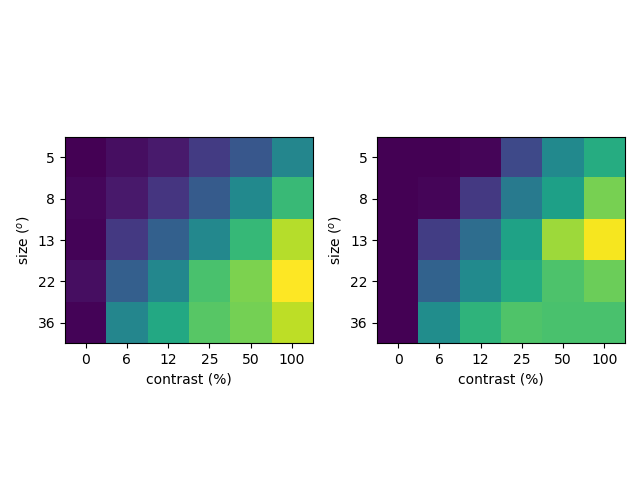

<IPython.core.display.Javascript object>


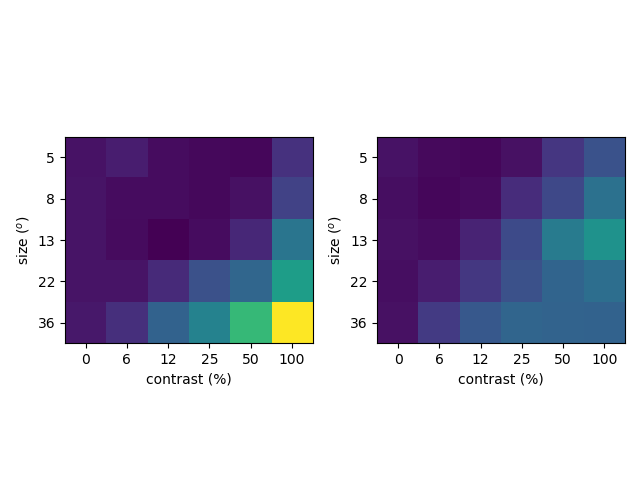

<IPython.core.display.Javascript object>


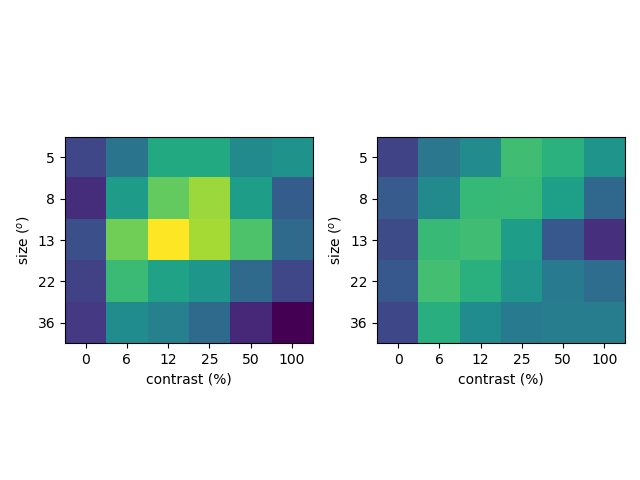

In [541]:
#lbl = ['pc','sst','vip']
#for icelltype in range(3):
#    this_Wstar = Wstar_t_novar
#    t = -1
#    display_model_fit(Yhat[icelltype].mean(0)/Yhat[icelltype].mean(0).sum(),this_Wstar[-3][t,:,icelltype]/this_Wstar[-3][t,:,icelltype].sum())
#    plt.savefig('figures/' + lbl[icelltype] + '_measured_modeled.pdf')

In [585]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wstar_t[i]

In [586]:
np.save('w_over_time_miller_troyer_data_loss_momentum.npy',Wstar_dict,allow_pickle=True)

In [270]:
def scatter_results(this_Wstar,t=-1):
    plt.figure(figsize=(9,3))
    celltype = ['PC','SST','VIP']
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(celltype[i])
        xx = Yhat[i].mean(0)/Yhat[i].mean(0).sum()
        yy = this_Wstar[-3][t,:,i]/this_Wstar[-3][t,:,i].sum()
        sca.scatter_size_contrast(xx,yy)
        plt.plot((0,xx.max()),(0,xx.max()),c='k')
        plt.xlabel('measured')
        plt.ylabel('modeled')
        plt.tight_layout()

In [1]:
icelltype = 3
u,s,v = np.linalg.svd(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])])
# plt.figure()
# plt.imshow(Rs[1][])

NameError: name 'np' is not defined

<IPython.core.display.Javascript object>


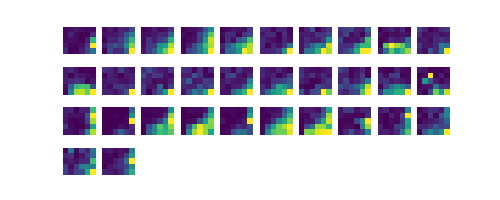

In [500]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(np.logical_and(u[:,0]<np.percentile(u[:,0],52.5),u[:,0]>np.percentile(u[:,0],47.5)))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


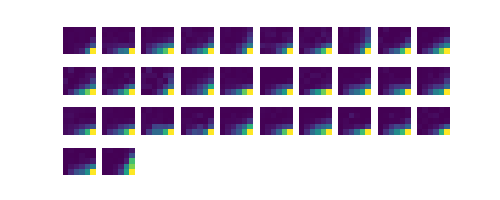

In [501]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(u[:,0]<np.percentile(u[:,0],5))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


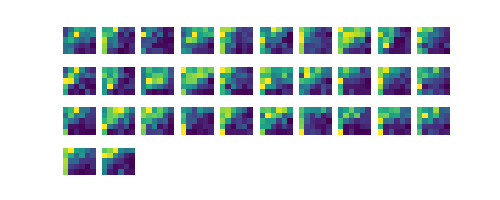

In [502]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(u[:,0]>np.percentile(u[:,0],95))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


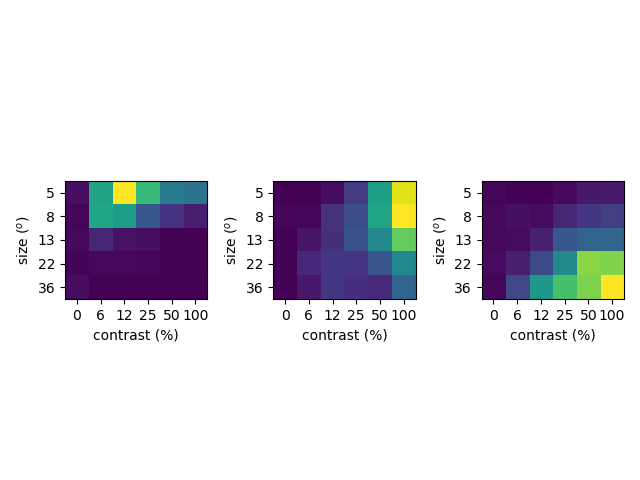

In [508]:
# ut.imshow_in_rows(Rs[1][~np.isnan(Rs[1][:,0])][np.where(u[:,0]>np.percentile(u[:,0],95))].reshape((-1,5,6)))
lower = np.where(u[:,0]<np.percentile(u[:,0],5))[0][28]
middle = np.where(np.logical_and(u[:,0]<np.percentile(u[:,0],52.5),u[:,0]>np.percentile(u[:,0],47.5)))[0][19]
upper = np.where(u[:,0]>np.percentile(u[:,0],95))[0][90]
plt.figure()
for i,thisone in enumerate([upper,middle,lower]):
    plt.subplot(1,3,i+1)
    sca.show_size_contrast(Rs[1][~np.isnan(Rs[1][:,0])][thisone].reshape((5,6)))
plt.tight_layout()
plt.savefig('figures/l23_pc_variability.pdf')

<IPython.core.display.Javascript object>


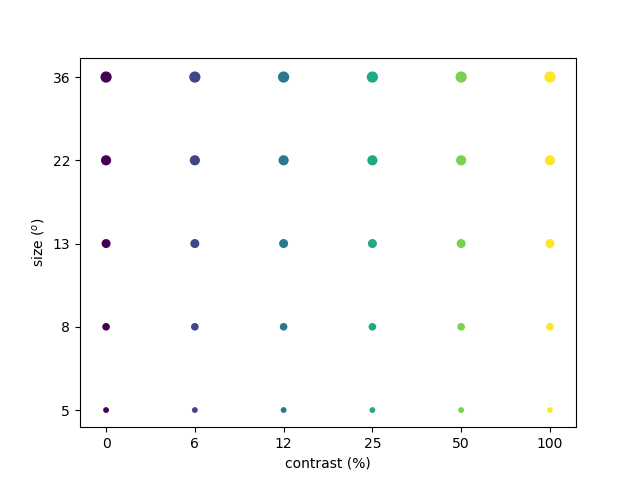

In [519]:
plt.figure()
xx,yy = np.meshgrid(np.arange(6),np.arange(5))
xx = xx.flatten()
yy = yy.flatten()
sca.scatter_size_contrast(xx,yy)
plt.xticks(np.arange(6),(0,6,12,25,50,100))
plt.xlabel('contrast (%)')
plt.yticks(np.arange(5),(5,8,13,22,36))
plt.ylabel('size ($^o$)')
plt.savefig('figures/measured_modeled_legend.pdf')
# plt.axis('off')

In [278]:
#niter = int(1e3)
#Ws = [Wstar_t[i][-1].copy() + 1e-2*np.random.randn(*Wstar_t[i][-1].shape) for i in range(4)]
#Wstar_t2 = fit_W_linearized_pointwise(X.copy(),Yhat.copy(),f_miller_troyer,Y0=Yhat.copy(),W0mx=Ws[0],W0my=Ws[1],W0sx=Ws[2],W0sy=Ws[3],bounds=bounds,niter=niter,weight=np.array((1,10,1)))
#scatter_results(Wstar_t2)

In [286]:
len(X[0])

30

In [293]:
iiter = 5000
Wmx,Wmy,Wsx,Wsy,s02,k,YY1 = [Wstar_t[i][iiter] for i in range(7)]
XX = np.concatenate(X,axis=1)

def gen_Weight(W,K):
    WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
    WW1 = np.concatenate((W*K[np.newaxis,:],W),axis=1)
    WW = np.concatenate((WW0,WW1),axis=0)
    return WW

def fXY(x,y):
    WWmx,WWmy,WWsx,WWsy = [gen_Weight(w,k) for w in [Wmx,Wmy,Wsx,Wsy]]
    return f_miller_troyer(x @ WWmx + y @ WWmy, (x @ WWsx + y @ WWsy)**2 + 1)

def u_fn_fn(Wx,Wy,k):
    WWx,WWy = [gen_Weight(w,k) for w in [Wx,Wy]]
    return lambda x,y: x @ WWx + y @ WWy

def um_fn(x,y):
    return u_fn_fn(Wmy,Wmx,k)(x,y)

def us_fn(x,y):
    return u_fn_fn(Wsy,Wsx,k)(x,y)

#Y,diagnostics = compute_Y_nonlinear(X,Wmx,Wmy,Wsx,Wsy,f_miller_troyer,Y0=Wstar_t[-2][iiter+1].copy()) # _t_evolution
for i in range(YY1.shape[0]):
    
    def fY(y):
        return fXY(XX[i],y) - y
    
    print('largest eigenvalues: ' + str(np.linalg.eig(jacobian(fY)(YY1[i]))[0][-1]))
    #print('eigenvectors: ' + str(np.linalg.eig(jacobian(fY)(YY1[i]))[1][:,-1]))
#     print('determinant: ' + str(np.linalg.det(jacobian(fY)(Y[i]))))
#     print('function output: ' + str(fY(Y[i])))
#     print('function input: ' + str(Y[i]))

largest eigenvalues: (-0.9989998869016463+0j)
largest eigenvalues: (-0.9989828185392442+0j)
largest eigenvalues: (-0.9989660410322228+0j)
largest eigenvalues: (-0.9989463781339991+0j)
largest eigenvalues: (-0.9989723379741865+0j)
largest eigenvalues: (-0.999042265009127+0j)
largest eigenvalues: (-0.9989924770184405+0j)
largest eigenvalues: (-0.9989742948843842+0j)
largest eigenvalues: (-0.9989493366883863+0j)
largest eigenvalues: (-0.9989662944521777+0j)
largest eigenvalues: (-0.9990193695160475+0j)
largest eigenvalues: (-0.9991117914014479+0j)
largest eigenvalues: (-0.9989963842130447+0j)
largest eigenvalues: (-0.998950113640889+0j)
largest eigenvalues: (-0.9989531261622885+0j)
largest eigenvalues: (-0.9989905231904382+0j)
largest eigenvalues: (-0.9990560055529697+0j)
largest eigenvalues: (-0.9991235494444328+0j)
largest eigenvalues: (-0.9989991354416329+0j)
largest eigenvalues: (-0.9989485313303269+0j)
largest eigenvalues: (-0.998953340712634+0j)
largest eigenvalues: (-0.998991796333

In [290]:
pdb.pm()

> /home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/tracer.py(48)f_wrapped()
-> return f_raw(*args, **kwargs)
(Pdb) u
> /home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/tracer.py(44)f_wrapped()
-> ans = f_wrapped(*argvals, **kwargs)
(Pdb) u
> /home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/autograd/numpy/numpy_boxes.py(24)__add__()
-> def __add__(self, other): return anp.add(     self, other)
(Pdb) u
> <ipython-input-289-04904d4e35d9>(13)fXY()
-> return f_miller_troyer(x @ WWmx + y @ WWmy, (x @ WWsx + y @ WWsy)**2 + s02)
(Pdb) x.shape
(4,)
(Pdb) y.shape
(6,)
(Pdb) WWmx.shape
(4, 6)
(Pdb) WWmy.shape
(6, 6)
(Pdb) s02.shape
(3,)
(Pdb) exit


<IPython.core.display.Javascript object>


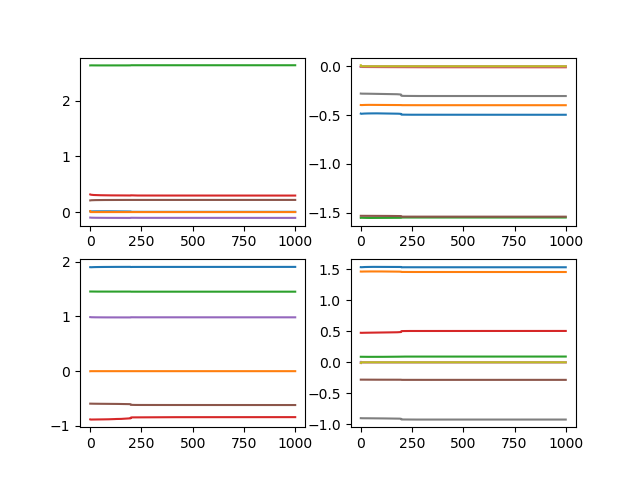

In [246]:
def plot_weights_over_time(this_Wstar):
    plt.figure()
    for i in range(4):
        plt.subplot(2,2,i+1)
        plt.plot(this_Wstar[i].reshape((niter+1,-1)))
plot_weights_over_time(Wstar_t2)

In [274]:
nQ = Y.shape[1]
def parse_W(W):
        shapeW = (nQ,nQ)
        sizeW = np.prod(shapeW)
        nW = 4
        Ws = [None]*nW
        for i in range(nW):
            Ws[i] = W[i*sizeW:(i+1)*sizeW].reshape(shapeW)
        return Ws
Ws = parse_W(Wstar[0])

In [275]:
Y1 = compute_Y_nonlinear(X,*Ws,f_miller_troyer,Y0=Y0)

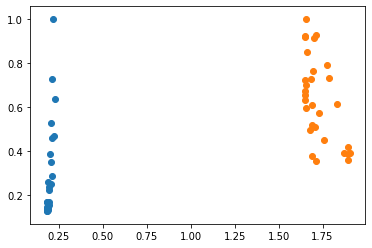

In [276]:
plt.figure()
# plt.scatter(f(X @ Wx + Y @ Wy).flatten(),Y.flatten())
for i in range(Y.shape[1]):
    plt.scatter(Y0[:,i],Y[:,i])

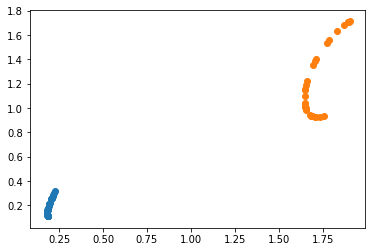

In [277]:
plt.figure()
# plt.scatter(f(X @ Wx + Y @ Wy).flatten(),Y.flatten())
for i in range(Y.shape[1]):
    plt.scatter(Y0[:,i],Y1[:,i])

In [491]:
diagnostics

[(array([0.07590516, 0.16438597]),
  0.002892952845580517,
  {'grad': array([ 0.00350314, -0.01427093]),
   'task': b'ABNORMAL_TERMINATION_IN_LNSRCH',
   'funcalls': 57,
   'nit': 1,
   'warnflag': 2}),
 (array([0.08371026, 0.18076958]),
  0.0035159924935236103,
  {'grad': array([ 0.00603596, -0.0151144 ]),
   'task': b'ABNORMAL_TERMINATION_IN_LNSRCH',
   'funcalls': 21,
   'nit': 0,
   'warnflag': 2}),
 (array([0.09198376, 0.19835681]),
  0.0042315034102210665,
  {'grad': array([ 0.06981335, -0.00428242]),
   'task': b'ABNORMAL_TERMINATION_IN_LNSRCH',
   'funcalls': 21,
   'nit': 0,
   'warnflag': 2}),
 (array([0.109196  , 0.23462734]),
  0.00597166243487739,
  {'grad': array([ 0.0344488 , -0.01411697]),
   'task': b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH',
   'funcalls': 32,
   'nit': 2,
   'warnflag': 0}),
 (array([0.13124416, 0.28118814]),
  0.008626608249659579,
  {'grad': array([ 0.03536171, -0.01777716]),
   'task': b'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH',
  

In [ ]:
y = array([0.07590516, 0.16438597])
f_miller

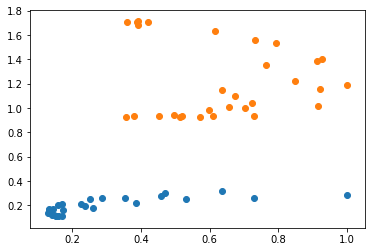

In [278]:
plt.figure()
# plt.scatter(f(X @ Wx + Y @ Wy).flatten(),Y.flatten())
for i in range(Y.shape[1]):
    plt.scatter(Y[:,i],Y1[:,i])

In [279]:
# W0 = np.concatenate((W0x.flatten(),W0y.flatten()))
bounds = [(-np.inf,np.inf)]*16
offset = 0
bounds[offset+4] = (0,0)
bounds[offset+7] = (0,0)
offset = 8
bounds[offset+4] = (0,0)
bounds[offset+7] = (0,0)
bounds = tuple(bounds)
Niter = 200
w0my = W0my
w0mx = W0mx
w0sy = W0sy
w0sx = W0sx
Wstar = [None]*Niter
eta = 0.1
for i in range(Niter):
    Wstar[i] = fit_W_linearized_WY(X,Y,f_miller_troyer,Y0=Y,W0mx=w0mx,W0my=w0my,W0sx=w0sx,W0sy=w0sy,bounds=bounds)
    w1mx,w1my,w1sx,w1sy = parse_W(Wstar[i][0])
    w0mx = w0mx + eta*(w1mx-w0mx)
    w0my = w0my + eta*(w1my-w0my)
    w0sx = w0sx + eta*(w1sx-w0sx)
    w0sy = w0sy + eta*(w1sy-w0sy)

In [287]:
Wt = np.zeros((Niter,)+(Wstar[0][0].shape))
Yt = np.zeros((Niter,)+(Y.shape))
for i in range(Niter):
    print(i)
    Wt[i] = Wstar[i][0]
    wmx,wmy,wsx,wsy = parse_W(Wt[i])
    Yt[i] = compute_Y_nonlinear(X,wmx,wmy,wsx,wsy,f_miller_troyer,Y0=Y)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199


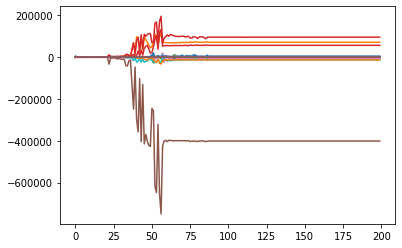

In [297]:
plt.figure()
for i in range(Wt.shape[1]):
    plt.plot(Wt[:,i])

In [299]:
Wt[60]

array([  -2650.28820038,   67637.4935345 ,    4074.34417779,
         54463.21523021,       0.        , -404651.66764672,
        -20432.76063931,       0.        ,    1039.50187873,
        -17600.42502162,    -940.64376186,  -14055.94816129,
             0.        ,  105290.99901942,    5339.32977626,
             0.        ])

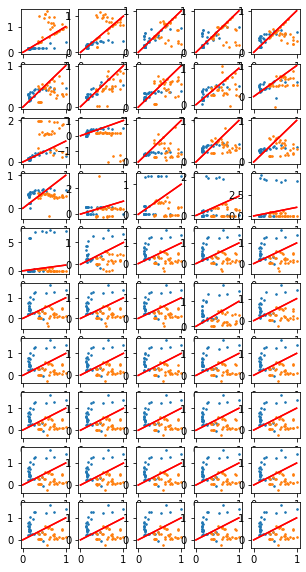

In [289]:
plt.figure(figsize=(5,20))
for i in range(0,Niter,4):
    plt.subplot(20,5,int(i/4)+1)
    for j in range(2):
        plt.scatter(Y[:,j],Yt[i,:,j],s=2.5)
        plt.plot((0,1),(0,1),c='r')

In [304]:
u,s,v = np.linalg.svd(Rpc[~np.isnan(Rpc.sum(1))])

In [307]:
np.diag(s).shape

(30, 30)

In [308]:
def pca_denoise(arr,Npc):
    u,s,v = np.linalg.svd(arr)
    return u[:,:Npc] @ np.diag(s[:Npc]) @ v[:Npc,:]

In [309]:
Rpc2 = pca_denoise(Rpc[~np.isnan(Rpc.sum(1))],10)

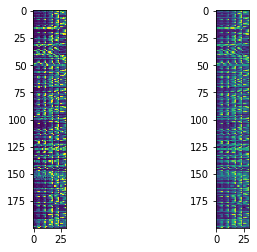

In [312]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(Rpc[:200])
plt.subplot(1,2,2)
plt.imshow(Rpc2[:200])

In [437]:
def fit_W_linearized(X,Y,f,Y0=None,W0mx=None,W0my=None,W0sx=None,W0sy=None,bounds=None):
    # X is (N,P), y is (N,Q). Finds wZx, wZy: (P,Q) + (Q,Q) weight matrices to explain Y as Y = f(Xwmx + Ywmy,Xwsx + Ywsy)
    # f is a static nonlinearity, given as a function
    
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    fudge = 1e-4
    
    fprime_m = egrad(f,0)
    fprime_s = egrad(f,1)
    nN,nP = X.shape
    nQ = Y.shape[1]
    assert(nN==Y.shape[0])
    
    #W0x,W0y = parse_W(W0)
    
    u_fn = lambda Wx,Wy: X @ Wx + Y0 @ Wy
    
    um0 = u_fn(W0mx,W0my) # (N,Q)
    us0 = u_fn(W0sx,W0sy) # (N,Q)
    Fsquiggle = f(um0,us0) # (N,Q)
    Fprime_m_squiggle = np.maximum(fprime_m(um0,us0),fudge) # (N,Q)
    Fprime_s_squiggle = np.maximum(fprime_s(um0,us0),fudge) # (N,Q)
    
#     Phi = np.zeros((nN,nQ,nQ))
#     Phi_m = np.zeros((nN,nQ,nQ)) # Phi now means Fprime rather than 1/Fprime
#     Phi_s = np.zeros((nN,nQ,nQ))
#     for i in range(nN):
#         np.fill_diagonal(Phi[i],F_squiggle[i])
#         np.fill_diagonal(Phi_m[i],Fprime_m_squiggle[i]) # is there a cleaner way?
#         np.fill_diagonal(Phi_s[i],Fprime_s_squiggle[i])
    
#     A0 = -u0 - (Y0 @ W0y) + Fsquiggle/Fprimesquiggle
#     A = Phi - Phi_m @ Y0 @ W0my - Phi_s @ Y0 @ W0sy
    A0 = Fsquiggle - Fprime_m_squiggle * u_fn(W0mx,W0my) - Fprime_s_squiggle * u_fn(W0sx,W0sy)
    
    # N
    
    W0 = np.concatenate((W0mx.flatten(),W0my.flatten(),W0sx.flatten(),W0sy.flatten()),axis=0)
    
    def compute_Y(Wmx,Wmy,Wsx,Wsy):
        
        A1 = Fprime_m_squiggle * (X @ Wmx) + Fprime_s_squiggle * (X @ Wsx)
        A = A0 + A1
        
        WFm = np.einsum('jk,ik->ijk',Wmy,Fprime_m_squiggle)
        WFs = np.einsum('jk,ik->ijk',Wsy,Fprime_s_squiggle)
        Omega = np.eye(nQ) - WFm - WFs
        
        Y = np.einsum('ik,ikj->ij',A,np.linalg.inv(Omega))

#         Y = (A @ np.linalg.inv(Phi-W0y))[np.eye(nN,dtype='bool')]
#         Y = np.zeros((nN,nQ))
#         for i in range(nN):
#             Y[i] = A[i] @ np.linalg.inv(Phi[i]-W0y) # (Q,) @ (Q,Q).
#         assert(True==False)
        return Y
    
    def minusL(W):
        Wmx,Wmy,Wsx,Wsy = parse_W(W)
        return 0.5*np.sum((compute_Y(Wmx,Wmy,Wsx,Wsy) - Y)**2)
    
    def minusdLdw(W): 
        # sum in first dimension: (N,1) times (N,1) times (N,P)
        return egrad(minusL)(W)
    
    def parse_W(W):
        shapeW = (nQ,nQ)
        sizeW = np.prod(shapeW)
        nW = 4
        Ws = [None]*nW
        for i in range(nW):
            Ws[i] = W[i*sizeW:(i+1)*sizeW].reshape(shapeW)
        return Ws
        
    
    Wstar = sop.fmin_l_bfgs_b(minusL,W0,fprime=minusdLdw,bounds=bounds,pgtol=pgtol,factr=factr,epsilon=epsilon)
    
#     assert(True==False)
    
    return Wstar

In [438]:
def fit_W_linearized_WY(X,Y,f,Y0=None,W0mx=None,W0my=None,W0sx=None,W0sy=None,bounds=None):
    # X is (N,P), y is (N,Q). Finds wZx, wZy: (P,Q) + (Q,Q) weight matrices to explain Y as Y = f(Xwmx + Ywmy,Xwsx + Ywsy)
    # f is a static nonlinearity, given as a function
    
    factr=1e7
    epsilon=1e-8
    pgtol=1e-5
    fudge = 1e-4
    
    fprime_m = egrad(f,0)
    fprime_s = egrad(f,1)
    nN,nP = X.shape
    nQ = Y.shape[1]
    assert(nN==Y.shape[0])
    
    #W0x,W0y = parse_W(W0)
    
    u_fn = lambda Wx,Wy: X @ Wx + Y0 @ Wy
    
    um0 = u_fn(W0mx,W0my) # (N,Q)
    us0 = u_fn(W0sx,W0sy) # (N,Q)
    Fsquiggle = f(um0,us0) # (N,Q)
    Fprime_m_squiggle = np.maximum(fprime_m(um0,us0),fudge) # (N,Q)
    Fprime_s_squiggle = np.maximum(fprime_s(um0,us0),fudge) # (N,Q)
    
#     Phi = np.zeros((nN,nQ,nQ))
#     Phi_m = np.zeros((nN,nQ,nQ)) # Phi now means Fprime rather than 1/Fprime
#     Phi_s = np.zeros((nN,nQ,nQ))
#     for i in range(nN):
#         np.fill_diagonal(Phi[i],F_squiggle[i])
#         np.fill_diagonal(Phi_m[i],Fprime_m_squiggle[i]) # is there a cleaner way?
#         np.fill_diagonal(Phi_s[i],Fprime_s_squiggle[i])
    
#     A0 = -u0 - (Y0 @ W0y) + Fsquiggle/Fprimesquiggle
#     A = Phi - Phi_m @ Y0 @ W0my - Phi_s @ Y0 @ W0sy
    A0 = Fsquiggle - Fprime_m_squiggle * u_fn(W0mx,W0my) - Fprime_s_squiggle * u_fn(W0sx,W0sy) 
    A0 = A0 - Fprime_m_squiggle * (Y0 @ W0my) - Fprime_s_squiggle * (Y0 @ W0sy)
    
    # N
    
    W0 = np.concatenate((W0mx.flatten(),W0my.flatten(),W0sx.flatten(),W0sy.flatten()),axis=0)
    
    def compute_Y(Wmx,Wmy,Wsx,Wsy):
        
        A1 = Fprime_m_squiggle * u_fn(Wmx,Wmy) + Fprime_s_squiggle * u_fn(Wsx,Wsy)
        A = A0 + A1
        
        WFm = np.einsum('jk,ik->ijk',W0my,Fprime_m_squiggle)
        WFs = np.einsum('jk,ik->ijk',W0sy,Fprime_s_squiggle)
        Omega = np.eye(nQ) - WFm - WFs
        
        Y = np.einsum('ik,ikj->ij',A,np.linalg.inv(Omega))

#         Y = (A @ np.linalg.inv(Phi-W0y))[np.eye(nN,dtype='bool')]
#         Y = np.zeros((nN,nQ))
#         for i in range(nN):
#             Y[i] = A[i] @ np.linalg.inv(Phi[i]-W0y) # (Q,) @ (Q,Q).
#         assert(True==False)
        return Y
    
    def minusL(W):
        Wmx,Wmy,Wsx,Wsy = parse_W(W)
        return 0.5*np.sum((compute_Y(Wmx,Wmy,Wsx,Wsy) - Y)**2)
    
    def minusdLdw(W): 
        # sum in first dimension: (N,1) times (N,1) times (N,P)
        return egrad(minusL)(W)
    
    def parse_W(W):
        shapeW = (nQ,nQ)
        sizeW = np.prod(shapeW)
        nW = 4
        Ws = [None]*nW
        for i in range(nW):
            Ws[i] = W[i*sizeW:(i+1)*sizeW].reshape(shapeW)
        return Ws
        
    
    Wstar = sop.fmin_l_bfgs_b(minusL,W0,fprime=minusdLdw,bounds=bounds,pgtol=pgtol,factr=factr,epsilon=epsilon)
    
#     assert(True==False)
    
    return Wstar